In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import matplotlib.pyplot as plt

from models.cycleGAN import CycleGAN
from utils.loaders import DataLoader

In [3]:
# run params
SECTION = 'gan'
RUN_ID = '0012'
DATA_NAME = 'apple2orange'
RUN_FOLDER = 'run/{}/'.format(SECTION)
RUN_FOLDER += '_'.join([RUN_ID, DATA_NAME])

if not os.path.exists(RUN_FOLDER):
    os.mkdir(RUN_FOLDER)
    os.mkdir(os.path.join(RUN_FOLDER, 'viz'))
    os.mkdir(os.path.join(RUN_FOLDER, 'images'))
    os.mkdir(os.path.join(RUN_FOLDER, 'weights'))

mode =  'build' # 'build' #

In [4]:
IMAGE_SIZE = 128
data_loader = DataLoader(dataset_name=DATA_NAME, img_res=(IMAGE_SIZE, IMAGE_SIZE))

In [5]:
gan = CycleGAN(
    input_dim = (IMAGE_SIZE,IMAGE_SIZE,3)
    ,learning_rate = 0.0002
    , buffer_max_length = 50
    , lambda_validation = 1
    , lambda_reconstr = 10
    , lambda_id = 2
    , generator_type = 'unet'
    , gen_n_filters = 32
    , disc_n_filters = 32
    )
if mode == 'build':
    gan.save(RUN_FOLDER)
else:
    gan.load_weights(os.path.join(RUN_FOLDER, 'weights/weights.h5'))

In [6]:
gan.g_BA.summary()
gan.g_AB.summary()
gan.d_A.summary()
gan.d_B.summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
conv2d_18 (Conv2D)              (None, 64, 64, 32)   1568        input_4[0][0]                    
__________________________________________________________________________________________________
instance_normalization_13 (Inst (None, 64, 64, 32)   0           conv2d_18[0][0]                  
__________________________________________________________________________________________________
activation_7 (Activation)       (None, 64, 64, 32)   0           instance_normalization_13[0][0]  
____________________________________________________________________________________________

In [8]:
BATCH_SIZE = 1
EPOCHS = 200
PRINT_EVERY_N_BATCHES = 100

TEST_A_FILE = 'n07740461_14740.jpg'
TEST_B_FILE = 'n07749192_4241.jpg'

In [9]:
%%time
gan.train(data_loader,
          run_folder = RUN_FOLDER,
          epochs=EPOCHS,
          test_A_file = TEST_A_FILE,
          test_B_file = TEST_B_FILE,
          batch_size=BATCH_SIZE,
          sample_interval=PRINT_EVERY_N_BATCHES)

[Epoch 0/200] [Batch 0/995] [D loss: 1.223032, acc:  39%] [G loss: 22.962513, adv: 2.863931, recon: 1.686090, id: 1.618840] time: 0:00:08.358264 
[Epoch 0/200] [Batch 1/995] [D loss: 1.581536, acc:  54%] [G loss: 19.047373, adv: 2.250784, recon: 1.387762, id: 1.459482] time: 0:00:09.685562 
[Epoch 0/200] [Batch 2/995] [D loss: 1.321993, acc:  46%] [G loss: 15.998178, adv: 2.011718, recon: 1.140917, id: 1.288646] time: 0:00:09.808814 
[Epoch 0/200] [Batch 3/995] [D loss: 0.835711, acc:  47%] [G loss: 17.192677, adv: 1.343066, recon: 1.289572, id: 1.476945] time: 0:00:09.928798 
[Epoch 0/200] [Batch 4/995] [D loss: 0.826633, acc:  50%] [G loss: 16.675566, adv: 1.573508, recon: 1.241887, id: 1.341596] time: 0:00:10.062349 
[Epoch 0/200] [Batch 5/995] [D loss: 0.825457, acc:  48%] [G loss: 16.710321, adv: 1.714583, recon: 1.192622, id: 1.534757] time: 0:00:10.212570 
[Epoch 0/200] [Batch 6/995] [D loss: 0.643123, acc:  51%] [G loss: 14.623880, adv: 1.143636, recon: 1.073733, id: 1.371457] 

[Epoch 0/200] [Batch 57/995] [D loss: 0.279849, acc:  61%] [G loss: 14.445038, adv: 0.746477, recon: 1.132725, id: 1.185655] time: 0:00:16.975203 
[Epoch 0/200] [Batch 58/995] [D loss: 0.313513, acc:  52%] [G loss: 10.894754, adv: 0.790806, recon: 0.796546, id: 1.069246] time: 0:00:17.095582 
[Epoch 0/200] [Batch 59/995] [D loss: 0.303009, acc:  56%] [G loss: 10.555470, adv: 0.944066, recon: 0.745104, id: 1.080181] time: 0:00:17.220583 
[Epoch 0/200] [Batch 60/995] [D loss: 0.390216, acc:  44%] [G loss: 12.426405, adv: 0.829813, recon: 0.929472, id: 1.150937] time: 0:00:17.350953 
[Epoch 0/200] [Batch 61/995] [D loss: 0.340434, acc:  49%] [G loss: 9.645535, adv: 0.805574, recon: 0.645072, id: 1.194622] time: 0:00:17.483381 
[Epoch 0/200] [Batch 62/995] [D loss: 0.316973, acc:  57%] [G loss: 8.695210, adv: 0.803742, recon: 0.640484, id: 0.743315] time: 0:00:17.613587 
[Epoch 0/200] [Batch 63/995] [D loss: 0.294881, acc:  59%] [G loss: 11.756311, adv: 0.660149, recon: 0.919004, id: 0.953

[Epoch 0/200] [Batch 113/995] [D loss: 0.257343, acc:  59%] [G loss: 7.950824, adv: 0.670613, recon: 0.587349, id: 0.703363] time: 0:00:25.667346 
[Epoch 0/200] [Batch 114/995] [D loss: 0.253106, acc:  60%] [G loss: 10.048208, adv: 0.926362, recon: 0.730044, id: 0.910705] time: 0:00:25.797446 
[Epoch 0/200] [Batch 115/995] [D loss: 0.397007, acc:  45%] [G loss: 10.255260, adv: 0.786747, recon: 0.781101, id: 0.828751] time: 0:00:25.919721 
[Epoch 0/200] [Batch 116/995] [D loss: 0.270187, acc:  60%] [G loss: 10.477150, adv: 1.078839, recon: 0.783811, id: 0.780103] time: 0:00:26.039448 
[Epoch 0/200] [Batch 117/995] [D loss: 0.277264, acc:  61%] [G loss: 9.066478, adv: 0.875676, recon: 0.677096, id: 0.709920] time: 0:00:26.162409 
[Epoch 0/200] [Batch 118/995] [D loss: 0.220323, acc:  66%] [G loss: 12.728168, adv: 1.141809, recon: 0.935147, id: 1.117444] time: 0:00:26.282833 
[Epoch 0/200] [Batch 119/995] [D loss: 0.224438, acc:  66%] [G loss: 10.241466, adv: 1.105468, recon: 0.729716, id

[Epoch 0/200] [Batch 169/995] [D loss: 0.357203, acc:  49%] [G loss: 8.030939, adv: 0.629215, recon: 0.599014, id: 0.705791] time: 0:00:32.773182 
[Epoch 0/200] [Batch 170/995] [D loss: 0.276836, acc:  59%] [G loss: 8.951304, adv: 0.799866, recon: 0.669654, id: 0.727448] time: 0:00:32.895503 
[Epoch 0/200] [Batch 171/995] [D loss: 0.237422, acc:  68%] [G loss: 8.520725, adv: 1.102642, recon: 0.578095, id: 0.818568] time: 0:00:33.023606 
[Epoch 0/200] [Batch 172/995] [D loss: 0.327439, acc:  49%] [G loss: 9.046358, adv: 0.929162, recon: 0.658071, id: 0.768242] time: 0:00:33.149140 
[Epoch 0/200] [Batch 173/995] [D loss: 0.210353, acc:  69%] [G loss: 10.403817, adv: 0.999836, recon: 0.762219, id: 0.890897] time: 0:00:33.270285 
[Epoch 0/200] [Batch 174/995] [D loss: 0.258463, acc:  59%] [G loss: 8.628628, adv: 0.880093, recon: 0.644590, id: 0.651319] time: 0:00:33.393120 
[Epoch 0/200] [Batch 175/995] [D loss: 0.227099, acc:  61%] [G loss: 7.948677, adv: 0.749739, recon: 0.594844, id: 0.

[Epoch 0/200] [Batch 225/995] [D loss: 0.296571, acc:  54%] [G loss: 8.853804, adv: 0.626141, recon: 0.695843, id: 0.634614] time: 0:00:41.342772 
[Epoch 0/200] [Batch 226/995] [D loss: 0.229598, acc:  63%] [G loss: 8.703141, adv: 0.608421, recon: 0.672770, id: 0.683511] time: 0:00:41.470258 
[Epoch 0/200] [Batch 227/995] [D loss: 0.297042, acc:  53%] [G loss: 13.571569, adv: 0.954400, recon: 1.046716, id: 1.075006] time: 0:00:41.605111 
[Epoch 0/200] [Batch 228/995] [D loss: 0.282010, acc:  57%] [G loss: 7.965357, adv: 0.903401, recon: 0.584978, id: 0.606089] time: 0:00:41.753724 
[Epoch 0/200] [Batch 229/995] [D loss: 0.370269, acc:  40%] [G loss: 7.099084, adv: 0.650978, recon: 0.536193, id: 0.543090] time: 0:00:41.884588 
[Epoch 0/200] [Batch 230/995] [D loss: 0.192605, acc:  70%] [G loss: 10.349374, adv: 0.479002, recon: 0.831569, id: 0.777340] time: 0:00:42.012633 
[Epoch 0/200] [Batch 231/995] [D loss: 0.288413, acc:  52%] [G loss: 7.950921, adv: 0.448189, recon: 0.626270, id: 0

[Epoch 0/200] [Batch 281/995] [D loss: 0.276115, acc:  52%] [G loss: 6.154948, adv: 0.940745, recon: 0.439469, id: 0.409759] time: 0:00:48.359339 
[Epoch 0/200] [Batch 282/995] [D loss: 0.234877, acc:  64%] [G loss: 6.929229, adv: 1.120950, recon: 0.480551, id: 0.501384] time: 0:00:48.489729 
[Epoch 0/200] [Batch 283/995] [D loss: 0.334423, acc:  39%] [G loss: 8.288591, adv: 1.307547, recon: 0.576659, id: 0.607226] time: 0:00:48.615847 
[Epoch 0/200] [Batch 284/995] [D loss: 0.276546, acc:  59%] [G loss: 8.157501, adv: 0.720259, recon: 0.615214, id: 0.642550] time: 0:00:48.743438 
[Epoch 0/200] [Batch 285/995] [D loss: 0.336530, acc:  41%] [G loss: 5.827021, adv: 0.308347, recon: 0.446876, id: 0.524959] time: 0:00:48.870561 
[Epoch 0/200] [Batch 286/995] [D loss: 0.322252, acc:  48%] [G loss: 8.143211, adv: 0.716389, recon: 0.612016, id: 0.653332] time: 0:00:48.999876 
[Epoch 0/200] [Batch 287/995] [D loss: 0.241442, acc:  60%] [G loss: 8.690733, adv: 0.632977, recon: 0.657601, id: 0.7

[Epoch 0/200] [Batch 337/995] [D loss: 0.247200, acc:  62%] [G loss: 7.206131, adv: 0.346188, recon: 0.565751, id: 0.601215] time: 0:00:56.984417 
[Epoch 0/200] [Batch 338/995] [D loss: 0.179798, acc:  72%] [G loss: 5.590963, adv: 0.637017, recon: 0.413427, id: 0.409837] time: 0:00:57.113733 
[Epoch 0/200] [Batch 339/995] [D loss: 0.305252, acc:  50%] [G loss: 7.996225, adv: 0.716302, recon: 0.605659, id: 0.611668] time: 0:00:57.236404 
[Epoch 0/200] [Batch 340/995] [D loss: 0.280086, acc:  55%] [G loss: 8.788798, adv: 0.951386, recon: 0.654263, id: 0.647391] time: 0:00:57.356454 
[Epoch 0/200] [Batch 341/995] [D loss: 0.249653, acc:  54%] [G loss: 6.632864, adv: 0.490225, recon: 0.535629, id: 0.393175] time: 0:00:57.475341 
[Epoch 0/200] [Batch 342/995] [D loss: 0.310557, acc:  49%] [G loss: 8.411503, adv: 0.557552, recon: 0.673308, id: 0.560433] time: 0:00:57.598846 
[Epoch 0/200] [Batch 343/995] [D loss: 0.180145, acc:  73%] [G loss: 6.859125, adv: 0.479712, recon: 0.532790, id: 0.5

[Epoch 0/200] [Batch 393/995] [D loss: 0.138738, acc:  82%] [G loss: 6.420017, adv: 0.993281, recon: 0.445445, id: 0.486142] time: 0:01:04.123225 
[Epoch 0/200] [Batch 394/995] [D loss: 0.211458, acc:  69%] [G loss: 6.077720, adv: 0.618139, recon: 0.462472, id: 0.417430] time: 0:01:04.254639 
[Epoch 0/200] [Batch 395/995] [D loss: 0.247393, acc:  58%] [G loss: 4.616541, adv: 0.891294, recon: 0.313476, id: 0.295245] time: 0:01:04.385766 
[Epoch 0/200] [Batch 396/995] [D loss: 0.374898, acc:  44%] [G loss: 8.507095, adv: 0.319677, recon: 0.688913, id: 0.649143] time: 0:01:04.518013 
[Epoch 0/200] [Batch 397/995] [D loss: 0.217471, acc:  66%] [G loss: 6.118201, adv: 0.728452, recon: 0.453276, id: 0.428494] time: 0:01:04.649714 
[Epoch 0/200] [Batch 398/995] [D loss: 0.225086, acc:  66%] [G loss: 6.442808, adv: 0.923830, recon: 0.463408, id: 0.442447] time: 0:01:04.780184 
[Epoch 0/200] [Batch 399/995] [D loss: 0.329623, acc:  41%] [G loss: 6.606219, adv: 1.058952, recon: 0.462720, id: 0.4

[Epoch 0/200] [Batch 449/995] [D loss: 0.293701, acc:  54%] [G loss: 7.782151, adv: 0.591280, recon: 0.606798, id: 0.561447] time: 0:01:13.049324 
[Epoch 0/200] [Batch 450/995] [D loss: 0.249961, acc:  57%] [G loss: 6.358771, adv: 0.752476, recon: 0.459881, id: 0.503742] time: 0:01:13.170612 
[Epoch 0/200] [Batch 451/995] [D loss: 0.293862, acc:  52%] [G loss: 8.319658, adv: 1.022116, recon: 0.621592, id: 0.540813] time: 0:01:13.292210 
[Epoch 0/200] [Batch 452/995] [D loss: 0.380135, acc:  27%] [G loss: 6.809611, adv: 0.758474, recon: 0.521275, id: 0.419196] time: 0:01:13.423877 
[Epoch 0/200] [Batch 453/995] [D loss: 0.259879, acc:  53%] [G loss: 6.502103, adv: 0.566124, recon: 0.502171, id: 0.457134] time: 0:01:13.545249 
[Epoch 0/200] [Batch 454/995] [D loss: 0.312019, acc:  47%] [G loss: 5.916685, adv: 0.646495, recon: 0.442006, id: 0.425065] time: 0:01:13.664404 
[Epoch 0/200] [Batch 455/995] [D loss: 0.407957, acc:  26%] [G loss: 6.425243, adv: 0.526174, recon: 0.503012, id: 0.4

[Epoch 0/200] [Batch 505/995] [D loss: 0.381215, acc:  46%] [G loss: 7.631701, adv: 0.717410, recon: 0.571259, id: 0.600851] time: 0:01:21.408107 
[Epoch 0/200] [Batch 506/995] [D loss: 0.223928, acc:  67%] [G loss: 8.439869, adv: 1.086360, recon: 0.618203, id: 0.585741] time: 0:01:21.536634 
[Epoch 0/200] [Batch 507/995] [D loss: 0.424852, acc:  33%] [G loss: 7.922723, adv: 0.682909, recon: 0.617932, id: 0.530248] time: 0:01:21.657593 
[Epoch 0/200] [Batch 508/995] [D loss: 0.279151, acc:  58%] [G loss: 7.678481, adv: 0.552782, recon: 0.601169, id: 0.557004] time: 0:01:21.778711 
[Epoch 0/200] [Batch 509/995] [D loss: 0.207470, acc:  67%] [G loss: 6.139954, adv: 0.556114, recon: 0.467670, id: 0.453571] time: 0:01:21.912465 
[Epoch 0/200] [Batch 510/995] [D loss: 0.305904, acc:  45%] [G loss: 6.690565, adv: 0.618993, recon: 0.508110, id: 0.495238] time: 0:01:22.034354 
[Epoch 0/200] [Batch 511/995] [D loss: 0.257514, acc:  57%] [G loss: 7.563349, adv: 0.689260, recon: 0.590077, id: 0.4

[Epoch 0/200] [Batch 561/995] [D loss: 0.210325, acc:  66%] [G loss: 6.154041, adv: 1.556440, recon: 0.387273, id: 0.362436] time: 0:01:28.534509 
[Epoch 0/200] [Batch 562/995] [D loss: 0.278112, acc:  71%] [G loss: 9.412614, adv: 0.858819, recon: 0.718531, id: 0.684242] time: 0:01:28.664887 
[Epoch 0/200] [Batch 563/995] [D loss: 0.235222, acc:  59%] [G loss: 5.196223, adv: 0.878409, recon: 0.370600, id: 0.305909] time: 0:01:28.785801 
[Epoch 0/200] [Batch 564/995] [D loss: 0.160688, acc:  78%] [G loss: 7.919938, adv: 0.872874, recon: 0.585396, id: 0.596552] time: 0:01:28.896740 
[Epoch 0/200] [Batch 565/995] [D loss: 0.094086, acc:  93%] [G loss: 8.972158, adv: 1.054097, recon: 0.669592, id: 0.611073] time: 0:01:29.006239 
[Epoch 0/200] [Batch 566/995] [D loss: 0.137593, acc:  78%] [G loss: 7.233538, adv: 0.977567, recon: 0.528874, id: 0.483615] time: 0:01:29.125467 
[Epoch 0/200] [Batch 567/995] [D loss: 0.221047, acc:  68%] [G loss: 6.774904, adv: 0.998125, recon: 0.482835, id: 0.4

[Epoch 0/200] [Batch 617/995] [D loss: 0.161276, acc:  71%] [G loss: 6.912038, adv: 0.778586, recon: 0.522750, id: 0.452977] time: 0:01:36.907155 
[Epoch 0/200] [Batch 618/995] [D loss: 0.174398, acc:  79%] [G loss: 9.922379, adv: 0.599573, recon: 0.799088, id: 0.665961] time: 0:01:37.030152 
[Epoch 0/200] [Batch 619/995] [D loss: 0.219731, acc:  65%] [G loss: 7.301067, adv: 0.582308, recon: 0.563827, id: 0.540243] time: 0:01:37.162448 
[Epoch 0/200] [Batch 620/995] [D loss: 0.334591, acc:  42%] [G loss: 6.670660, adv: 0.606339, recon: 0.505359, id: 0.505364] time: 0:01:37.290406 
[Epoch 0/200] [Batch 621/995] [D loss: 0.254979, acc:  62%] [G loss: 7.460042, adv: 1.203163, recon: 0.536578, id: 0.445549] time: 0:01:37.416491 
[Epoch 0/200] [Batch 622/995] [D loss: 0.227401, acc:  63%] [G loss: 7.636369, adv: 1.455548, recon: 0.515938, id: 0.510719] time: 0:01:37.547300 
[Epoch 0/200] [Batch 623/995] [D loss: 0.261147, acc:  54%] [G loss: 6.228675, adv: 0.730458, recon: 0.454999, id: 0.4

[Epoch 0/200] [Batch 673/995] [D loss: 0.239735, acc:  61%] [G loss: 6.735106, adv: 0.549628, recon: 0.528926, id: 0.448111] time: 0:01:43.894224 
[Epoch 0/200] [Batch 674/995] [D loss: 0.258545, acc:  58%] [G loss: 6.296254, adv: 0.532426, recon: 0.484270, id: 0.460562] time: 0:01:43.998742 
[Epoch 0/200] [Batch 675/995] [D loss: 0.168675, acc:  75%] [G loss: 8.132657, adv: 0.424220, recon: 0.647167, id: 0.618382] time: 0:01:44.122157 
[Epoch 0/200] [Batch 676/995] [D loss: 0.147184, acc:  78%] [G loss: 7.033823, adv: 0.789911, recon: 0.512540, id: 0.559257] time: 0:01:44.244011 
[Epoch 0/200] [Batch 677/995] [D loss: 0.236648, acc:  63%] [G loss: 6.672260, adv: 0.695657, recon: 0.506063, id: 0.457987] time: 0:01:44.371195 
[Epoch 0/200] [Batch 678/995] [D loss: 0.232894, acc:  58%] [G loss: 8.613144, adv: 0.882830, recon: 0.654084, id: 0.594739] time: 0:01:44.498033 
[Epoch 0/200] [Batch 679/995] [D loss: 0.186459, acc:  69%] [G loss: 6.949097, adv: 0.664421, recon: 0.525881, id: 0.5

[Epoch 0/200] [Batch 730/995] [D loss: 0.124340, acc:  86%] [G loss: 6.929667, adv: 0.557299, recon: 0.544011, id: 0.466132] time: 0:01:52.498996 
[Epoch 0/200] [Batch 731/995] [D loss: 0.151426, acc:  84%] [G loss: 7.694603, adv: 0.635642, recon: 0.605944, id: 0.499760] time: 0:01:52.619475 
[Epoch 0/200] [Batch 732/995] [D loss: 0.219381, acc:  64%] [G loss: 8.573269, adv: 0.987894, recon: 0.644873, id: 0.568322] time: 0:01:52.741315 
[Epoch 0/200] [Batch 733/995] [D loss: 0.241435, acc:  60%] [G loss: 8.206466, adv: 0.773253, recon: 0.619480, id: 0.619208] time: 0:01:52.864599 
[Epoch 0/200] [Batch 734/995] [D loss: 0.401561, acc:  24%] [G loss: 8.329802, adv: 0.915672, recon: 0.639624, id: 0.508942] time: 0:01:52.995439 
[Epoch 0/200] [Batch 735/995] [D loss: 0.323571, acc:  53%] [G loss: 6.665934, adv: 0.821776, recon: 0.484356, id: 0.500300] time: 0:01:53.116434 
[Epoch 0/200] [Batch 736/995] [D loss: 0.195110, acc:  71%] [G loss: 8.021502, adv: 0.957249, recon: 0.579871, id: 0.6

[Epoch 0/200] [Batch 786/995] [D loss: 0.304745, acc:  51%] [G loss: 5.231771, adv: 0.849315, recon: 0.365568, id: 0.363386] time: 0:01:59.560554 
[Epoch 0/200] [Batch 787/995] [D loss: 0.144534, acc:  78%] [G loss: 6.584213, adv: 0.499267, recon: 0.509654, id: 0.494205] time: 0:01:59.688737 
[Epoch 0/200] [Batch 788/995] [D loss: 0.365850, acc:  43%] [G loss: 5.806465, adv: 0.166859, recon: 0.479101, id: 0.424300] time: 0:01:59.809717 
[Epoch 0/200] [Batch 789/995] [D loss: 0.295473, acc:  63%] [G loss: 7.181172, adv: 0.376762, recon: 0.580486, id: 0.499773] time: 0:01:59.931180 
[Epoch 0/200] [Batch 790/995] [D loss: 0.225595, acc:  65%] [G loss: 9.199255, adv: 0.715486, recon: 0.724990, id: 0.616932] time: 0:02:00.044388 
[Epoch 0/200] [Batch 791/995] [D loss: 0.169478, acc:  73%] [G loss: 5.769532, adv: 0.617224, recon: 0.438202, id: 0.385145] time: 0:02:00.174581 
[Epoch 0/200] [Batch 792/995] [D loss: 0.141250, acc:  82%] [G loss: 8.952702, adv: 0.826651, recon: 0.682838, id: 0.6

[Epoch 0/200] [Batch 843/995] [D loss: 0.099849, acc:  93%] [G loss: 7.975579, adv: 1.192080, recon: 0.582803, id: 0.477734] time: 0:02:08.138006 
[Epoch 0/200] [Batch 844/995] [D loss: 0.178189, acc:  68%] [G loss: 7.625587, adv: 1.427844, recon: 0.516326, id: 0.517240] time: 0:02:08.261249 
[Epoch 0/200] [Batch 845/995] [D loss: 0.265333, acc:  58%] [G loss: 4.897201, adv: 0.595805, recon: 0.359788, id: 0.351760] time: 0:02:08.380674 
[Epoch 0/200] [Batch 846/995] [D loss: 0.253266, acc:  53%] [G loss: 5.226017, adv: 1.243949, recon: 0.336546, id: 0.308303] time: 0:02:08.519692 
[Epoch 0/200] [Batch 847/995] [D loss: 0.257033, acc:  72%] [G loss: 4.298365, adv: 0.788113, recon: 0.299039, id: 0.259932] time: 0:02:08.645101 
[Epoch 0/200] [Batch 848/995] [D loss: 0.312849, acc:  50%] [G loss: 6.233520, adv: 0.810742, recon: 0.450330, id: 0.459740] time: 0:02:08.768332 
[Epoch 0/200] [Batch 849/995] [D loss: 0.209487, acc:  67%] [G loss: 6.778848, adv: 1.405111, recon: 0.445623, id: 0.4

[Epoch 0/200] [Batch 899/995] [D loss: 0.232326, acc:  68%] [G loss: 5.581596, adv: 0.323585, recon: 0.441922, id: 0.419395] time: 0:02:15.048444 
[Epoch 0/200] [Batch 900/995] [D loss: 0.149045, acc:  79%] [G loss: 5.760057, adv: 0.990259, recon: 0.400304, id: 0.383380] time: 0:02:15.180650 
[Epoch 0/200] [Batch 901/995] [D loss: 0.223247, acc:  67%] [G loss: 5.474620, adv: 0.768169, recon: 0.393665, id: 0.384901] time: 0:02:16.740725 
[Epoch 0/200] [Batch 902/995] [D loss: 0.359114, acc:  37%] [G loss: 5.309842, adv: 0.581381, recon: 0.404151, id: 0.343475] time: 0:02:16.872702 
[Epoch 0/200] [Batch 903/995] [D loss: 0.127633, acc:  84%] [G loss: 5.806219, adv: 0.992010, recon: 0.400620, id: 0.404005] time: 0:02:16.984244 
[Epoch 0/200] [Batch 904/995] [D loss: 0.310139, acc:  46%] [G loss: 5.876428, adv: 0.670894, recon: 0.447049, id: 0.367520] time: 0:02:17.102877 
[Epoch 0/200] [Batch 905/995] [D loss: 0.251286, acc:  67%] [G loss: 7.106137, adv: 1.705502, recon: 0.450804, id: 0.4

[Epoch 0/200] [Batch 955/995] [D loss: 0.162764, acc:  79%] [G loss: 3.704165, adv: 0.351232, recon: 0.279861, id: 0.277161] time: 0:02:23.564339 
[Epoch 0/200] [Batch 956/995] [D loss: 0.321938, acc:  51%] [G loss: 5.123319, adv: 0.727379, recon: 0.370285, id: 0.346546] time: 0:02:23.687028 
[Epoch 0/200] [Batch 957/995] [D loss: 0.267526, acc:  54%] [G loss: 4.923700, adv: 0.659429, recon: 0.362273, id: 0.320771] time: 0:02:23.818312 
[Epoch 0/200] [Batch 958/995] [D loss: 0.338838, acc:  42%] [G loss: 6.554078, adv: 0.771259, recon: 0.487831, id: 0.452256] time: 0:02:23.938318 
[Epoch 0/200] [Batch 959/995] [D loss: 0.161974, acc:  73%] [G loss: 8.239315, adv: 1.474483, recon: 0.572467, id: 0.520081] time: 0:02:24.059787 
[Epoch 0/200] [Batch 960/995] [D loss: 0.076078, acc:  95%] [G loss: 8.674983, adv: 1.235156, recon: 0.617881, id: 0.630509] time: 0:02:24.182884 
[Epoch 0/200] [Batch 961/995] [D loss: 0.190163, acc:  73%] [G loss: 6.247672, adv: 1.086996, recon: 0.429387, id: 0.4

[Epoch 1/200] [Batch 17/995] [D loss: 0.315581, acc:  39%] [G loss: 7.328014, adv: 0.466938, recon: 0.587765, id: 0.491711] time: 0:02:31.830481 
[Epoch 1/200] [Batch 18/995] [D loss: 0.277400, acc:  55%] [G loss: 7.794456, adv: 1.004519, recon: 0.564608, id: 0.571930] time: 0:02:31.938238 
[Epoch 1/200] [Batch 19/995] [D loss: 0.279613, acc:  68%] [G loss: 4.462812, adv: 0.613954, recon: 0.319083, id: 0.329013] time: 0:02:32.058990 
[Epoch 1/200] [Batch 20/995] [D loss: 0.295712, acc:  64%] [G loss: 6.193153, adv: 0.595433, recon: 0.470380, id: 0.446959] time: 0:02:32.181737 
[Epoch 1/200] [Batch 21/995] [D loss: 0.211014, acc:  67%] [G loss: 6.185272, adv: 0.735691, recon: 0.456318, id: 0.443199] time: 0:02:32.301992 
[Epoch 1/200] [Batch 22/995] [D loss: 0.117905, acc:  88%] [G loss: 6.715233, adv: 0.973162, recon: 0.483176, id: 0.455157] time: 0:02:32.424778 
[Epoch 1/200] [Batch 23/995] [D loss: 0.305542, acc:  51%] [G loss: 5.371878, adv: 0.337046, recon: 0.421335, id: 0.410741] 

[Epoch 1/200] [Batch 75/995] [D loss: 0.196495, acc:  73%] [G loss: 7.893871, adv: 1.251900, recon: 0.568035, id: 0.480813] time: 0:02:39.083605 
[Epoch 1/200] [Batch 76/995] [D loss: 0.327245, acc:  35%] [G loss: 5.800576, adv: 0.668756, recon: 0.425383, id: 0.438995] time: 0:02:39.212091 
[Epoch 1/200] [Batch 77/995] [D loss: 0.371311, acc:  36%] [G loss: 9.318800, adv: 0.586827, recon: 0.756877, id: 0.581601] time: 0:02:39.352669 
[Epoch 1/200] [Batch 78/995] [D loss: 0.269880, acc:  54%] [G loss: 5.848207, adv: 0.649618, recon: 0.439155, id: 0.403519] time: 0:02:39.476806 
[Epoch 1/200] [Batch 79/995] [D loss: 0.187737, acc:  68%] [G loss: 5.084427, adv: 0.561429, recon: 0.375837, id: 0.382316] time: 0:02:39.597111 
[Epoch 1/200] [Batch 80/995] [D loss: 0.353218, acc:  40%] [G loss: 7.116178, adv: 0.809710, recon: 0.543415, id: 0.436158] time: 0:02:39.721730 
[Epoch 1/200] [Batch 81/995] [D loss: 0.238004, acc:  66%] [G loss: 8.010021, adv: 0.756259, recon: 0.612608, id: 0.563840] 

[Epoch 1/200] [Batch 131/995] [D loss: 0.226372, acc:  61%] [G loss: 4.596169, adv: 0.738139, recon: 0.326715, id: 0.295442] time: 0:02:47.681829 
[Epoch 1/200] [Batch 132/995] [D loss: 0.318060, acc:  39%] [G loss: 7.199099, adv: 0.666398, recon: 0.531414, id: 0.609281] time: 0:02:47.806425 
[Epoch 1/200] [Batch 133/995] [D loss: 0.251693, acc:  54%] [G loss: 7.047063, adv: 0.510266, recon: 0.549245, id: 0.522176] time: 0:02:47.944149 
[Epoch 1/200] [Batch 134/995] [D loss: 0.170349, acc:  74%] [G loss: 4.913508, adv: 0.433451, recon: 0.382344, id: 0.328310] time: 0:02:48.064406 
[Epoch 1/200] [Batch 135/995] [D loss: 0.322099, acc:  44%] [G loss: 5.163111, adv: 0.445217, recon: 0.397081, id: 0.373543] time: 0:02:48.188887 
[Epoch 1/200] [Batch 136/995] [D loss: 0.158750, acc:  78%] [G loss: 7.697373, adv: 1.127091, recon: 0.540468, id: 0.582803] time: 0:02:48.315189 
[Epoch 1/200] [Batch 137/995] [D loss: 0.177033, acc:  73%] [G loss: 4.732973, adv: 0.995618, recon: 0.316827, id: 0.2

[Epoch 1/200] [Batch 187/995] [D loss: 0.284875, acc:  50%] [G loss: 5.370711, adv: 0.537818, recon: 0.406469, id: 0.384103] time: 0:02:54.642203 
[Epoch 1/200] [Batch 188/995] [D loss: 0.185934, acc:  74%] [G loss: 6.108881, adv: 0.768149, recon: 0.446564, id: 0.437545] time: 0:02:54.764916 
[Epoch 1/200] [Batch 189/995] [D loss: 0.315629, acc:  44%] [G loss: 5.496386, adv: 0.718102, recon: 0.416045, id: 0.308919] time: 0:02:54.885748 
[Epoch 1/200] [Batch 190/995] [D loss: 0.191993, acc:  72%] [G loss: 7.613101, adv: 1.062901, recon: 0.556890, id: 0.490651] time: 0:02:55.006052 
[Epoch 1/200] [Batch 191/995] [D loss: 0.283256, acc:  53%] [G loss: 7.598258, adv: 1.268209, recon: 0.530522, id: 0.512414] time: 0:02:55.127916 
[Epoch 1/200] [Batch 192/995] [D loss: 0.177458, acc:  71%] [G loss: 3.490003, adv: 0.281005, recon: 0.263395, id: 0.287523] time: 0:02:55.249190 
[Epoch 1/200] [Batch 193/995] [D loss: 0.329723, acc:  46%] [G loss: 7.501208, adv: 0.650982, recon: 0.566648, id: 0.5

[Epoch 1/200] [Batch 243/995] [D loss: 0.226779, acc:  72%] [G loss: 4.619941, adv: 0.632298, recon: 0.334615, id: 0.320747] time: 0:03:03.024467 
[Epoch 1/200] [Batch 244/995] [D loss: 0.148046, acc:  81%] [G loss: 7.919565, adv: 1.258664, recon: 0.555433, id: 0.553287] time: 0:03:03.145669 
[Epoch 1/200] [Batch 245/995] [D loss: 0.188845, acc:  72%] [G loss: 5.025086, adv: 0.449355, recon: 0.385044, id: 0.362644] time: 0:03:03.266562 
[Epoch 1/200] [Batch 246/995] [D loss: 0.131005, acc:  84%] [G loss: 3.924905, adv: 0.297282, recon: 0.306608, id: 0.280771] time: 0:03:03.389371 
[Epoch 1/200] [Batch 247/995] [D loss: 0.417379, acc:  32%] [G loss: 5.028028, adv: 0.655764, recon: 0.369269, id: 0.339786] time: 0:03:03.518684 
[Epoch 1/200] [Batch 248/995] [D loss: 0.230187, acc:  67%] [G loss: 6.705057, adv: 0.851025, recon: 0.495983, id: 0.447100] time: 0:03:03.640255 
[Epoch 1/200] [Batch 249/995] [D loss: 0.216470, acc:  73%] [G loss: 5.258086, adv: 1.514649, recon: 0.310244, id: 0.3

[Epoch 1/200] [Batch 299/995] [D loss: 0.381671, acc:  42%] [G loss: 6.126531, adv: 1.122233, recon: 0.422470, id: 0.389797] time: 0:03:09.931095 
[Epoch 1/200] [Batch 300/995] [D loss: 0.182458, acc:  76%] [G loss: 7.847679, adv: 0.839714, recon: 0.586894, id: 0.569512] time: 0:03:10.061548 
[Epoch 1/200] [Batch 301/995] [D loss: 0.314584, acc:  76%] [G loss: 7.423851, adv: 1.088191, recon: 0.534175, id: 0.496953] time: 0:03:11.332862 
[Epoch 1/200] [Batch 302/995] [D loss: 0.240710, acc:  64%] [G loss: 7.192553, adv: 1.011145, recon: 0.517627, id: 0.502567] time: 0:03:11.454865 
[Epoch 1/200] [Batch 303/995] [D loss: 0.240573, acc:  63%] [G loss: 4.377105, adv: 0.561722, recon: 0.322815, id: 0.293617] time: 0:03:11.579216 
[Epoch 1/200] [Batch 304/995] [D loss: 0.354555, acc:  36%] [G loss: 5.410311, adv: 0.362364, recon: 0.430986, id: 0.369043] time: 0:03:11.709943 
[Epoch 1/200] [Batch 305/995] [D loss: 0.117277, acc:  88%] [G loss: 6.080654, adv: 0.585320, recon: 0.462693, id: 0.4

[Epoch 1/200] [Batch 355/995] [D loss: 0.238149, acc:  62%] [G loss: 8.262949, adv: 0.777744, recon: 0.631479, id: 0.585207] time: 0:03:18.040005 
[Epoch 1/200] [Batch 356/995] [D loss: 0.205691, acc:  70%] [G loss: 5.954809, adv: 0.843592, recon: 0.430810, id: 0.401559] time: 0:03:18.163324 
[Epoch 1/200] [Batch 357/995] [D loss: 0.262499, acc:  68%] [G loss: 5.697031, adv: 0.447401, recon: 0.455073, id: 0.349451] time: 0:03:18.296643 
[Epoch 1/200] [Batch 358/995] [D loss: 0.100578, acc:  84%] [G loss: 4.855089, adv: 0.451674, recon: 0.377659, id: 0.313410] time: 0:03:18.427769 
[Epoch 1/200] [Batch 359/995] [D loss: 0.302169, acc:  49%] [G loss: 5.864685, adv: 0.930977, recon: 0.412998, id: 0.401864] time: 0:03:18.555839 
[Epoch 1/200] [Batch 360/995] [D loss: 0.202247, acc:  71%] [G loss: 7.802823, adv: 0.960259, recon: 0.587070, id: 0.485931] time: 0:03:18.680425 
[Epoch 1/200] [Batch 361/995] [D loss: 0.233038, acc:  62%] [G loss: 5.250321, adv: 0.914726, recon: 0.355196, id: 0.3

[Epoch 1/200] [Batch 411/995] [D loss: 0.222131, acc:  62%] [G loss: 5.200665, adv: 0.406465, recon: 0.400314, id: 0.395530] time: 0:03:26.425392 
[Epoch 1/200] [Batch 412/995] [D loss: 0.151580, acc:  79%] [G loss: 5.463944, adv: 0.883053, recon: 0.389271, id: 0.344089] time: 0:03:26.546090 
[Epoch 1/200] [Batch 413/995] [D loss: 0.156165, acc:  75%] [G loss: 6.995825, adv: 0.785220, recon: 0.525065, id: 0.479980] time: 0:03:26.668111 
[Epoch 1/200] [Batch 414/995] [D loss: 0.303136, acc:  43%] [G loss: 8.933619, adv: 1.129786, recon: 0.662664, id: 0.588594] time: 0:03:26.800428 
[Epoch 1/200] [Batch 415/995] [D loss: 0.151836, acc:  80%] [G loss: 6.323828, adv: 0.519343, recon: 0.489669, id: 0.453896] time: 0:03:26.919861 
[Epoch 1/200] [Batch 416/995] [D loss: 0.210793, acc:  63%] [G loss: 6.142675, adv: 0.751628, recon: 0.457448, id: 0.408284] time: 0:03:27.042412 
[Epoch 1/200] [Batch 417/995] [D loss: 0.222961, acc:  61%] [G loss: 7.459314, adv: 1.014292, recon: 0.544483, id: 0.5

[Epoch 1/200] [Batch 467/995] [D loss: 0.248981, acc:  56%] [G loss: 5.266162, adv: 1.016308, recon: 0.356571, id: 0.342071] time: 0:03:33.356459 
[Epoch 1/200] [Batch 468/995] [D loss: 0.168871, acc:  75%] [G loss: 5.328381, adv: 0.739248, recon: 0.394356, id: 0.322784] time: 0:03:33.489709 
[Epoch 1/200] [Batch 469/995] [D loss: 0.423848, acc:  28%] [G loss: 4.752521, adv: 0.967300, recon: 0.313306, id: 0.326080] time: 0:03:33.609662 
[Epoch 1/200] [Batch 470/995] [D loss: 0.058601, acc:  98%] [G loss: 6.194812, adv: 1.406082, recon: 0.399920, id: 0.394764] time: 0:03:33.732982 
[Epoch 1/200] [Batch 471/995] [D loss: 0.167001, acc:  80%] [G loss: 8.798874, adv: 1.193387, recon: 0.633909, id: 0.633197] time: 0:03:33.855056 
[Epoch 1/200] [Batch 472/995] [D loss: 0.338223, acc:  36%] [G loss: 6.015828, adv: 0.848946, recon: 0.432063, id: 0.423125] time: 0:03:33.980526 
[Epoch 1/200] [Batch 473/995] [D loss: 0.171975, acc:  83%] [G loss: 5.807642, adv: 0.537901, recon: 0.433861, id: 0.4

[Epoch 1/200] [Batch 523/995] [D loss: 0.265259, acc:  60%] [G loss: 7.107358, adv: 0.865067, recon: 0.537387, id: 0.434209] time: 0:03:41.883866 
[Epoch 1/200] [Batch 524/995] [D loss: 0.057405, acc:  97%] [G loss: 5.883640, adv: 1.459476, recon: 0.378504, id: 0.319561] time: 0:03:41.994284 
[Epoch 1/200] [Batch 525/995] [D loss: 0.396205, acc:  37%] [G loss: 6.464490, adv: 0.457820, recon: 0.506033, id: 0.473169] time: 0:03:42.119911 
[Epoch 1/200] [Batch 526/995] [D loss: 0.114180, acc:  83%] [G loss: 6.339296, adv: 0.848093, recon: 0.468924, id: 0.400982] time: 0:03:42.239179 
[Epoch 1/200] [Batch 527/995] [D loss: 0.086557, acc:  92%] [G loss: 7.890878, adv: 1.128561, recon: 0.571936, id: 0.521477] time: 0:03:42.352839 
[Epoch 1/200] [Batch 528/995] [D loss: 0.197985, acc:  68%] [G loss: 5.879924, adv: 1.178492, recon: 0.393726, id: 0.382089] time: 0:03:42.472725 
[Epoch 1/200] [Batch 529/995] [D loss: 0.334388, acc:  47%] [G loss: 6.862986, adv: 0.686370, recon: 0.532612, id: 0.4

[Epoch 1/200] [Batch 579/995] [D loss: 0.161459, acc:  78%] [G loss: 7.282775, adv: 0.648806, recon: 0.566557, id: 0.484197] time: 0:03:48.793645 
[Epoch 1/200] [Batch 580/995] [D loss: 0.138822, acc:  85%] [G loss: 4.927093, adv: 0.574884, recon: 0.364732, id: 0.352444] time: 0:03:48.924925 
[Epoch 1/200] [Batch 581/995] [D loss: 0.122348, acc:  91%] [G loss: 6.848902, adv: 0.716448, recon: 0.517610, id: 0.478175] time: 0:03:49.061173 
[Epoch 1/200] [Batch 582/995] [D loss: 0.330605, acc:  54%] [G loss: 4.823306, adv: 0.649167, recon: 0.350974, id: 0.332202] time: 0:03:49.188788 
[Epoch 1/200] [Batch 583/995] [D loss: 0.189724, acc:  71%] [G loss: 6.789675, adv: 1.042337, recon: 0.485845, id: 0.444443] time: 0:03:49.320535 
[Epoch 1/200] [Batch 584/995] [D loss: 0.154784, acc:  76%] [G loss: 5.668363, adv: 0.771844, recon: 0.406535, id: 0.415587] time: 0:03:49.460568 
[Epoch 1/200] [Batch 585/995] [D loss: 0.308365, acc:  49%] [G loss: 6.648039, adv: 0.338749, recon: 0.547676, id: 0.4

[Epoch 1/200] [Batch 635/995] [D loss: 0.208919, acc:  64%] [G loss: 6.158414, adv: 0.719571, recon: 0.462140, id: 0.408723] time: 0:03:57.496388 
[Epoch 1/200] [Batch 636/995] [D loss: 0.296764, acc:  50%] [G loss: 7.499072, adv: 0.612573, recon: 0.593595, id: 0.475272] time: 0:03:57.618919 
[Epoch 1/200] [Batch 637/995] [D loss: 0.227168, acc:  61%] [G loss: 4.989605, adv: 0.658045, recon: 0.363480, id: 0.348378] time: 0:03:57.739563 
[Epoch 1/200] [Batch 638/995] [D loss: 0.244282, acc:  59%] [G loss: 5.948866, adv: 0.933914, recon: 0.420150, id: 0.406724] time: 0:03:57.870938 
[Epoch 1/200] [Batch 639/995] [D loss: 0.203232, acc:  68%] [G loss: 6.489231, adv: 0.809042, recon: 0.491544, id: 0.382372] time: 0:03:57.996208 
[Epoch 1/200] [Batch 640/995] [D loss: 0.368007, acc:  47%] [G loss: 6.064322, adv: 0.521641, recon: 0.466801, id: 0.437334] time: 0:03:58.125741 
[Epoch 1/200] [Batch 641/995] [D loss: 0.221040, acc:  58%] [G loss: 7.223906, adv: 0.647465, recon: 0.561951, id: 0.4

[Epoch 1/200] [Batch 691/995] [D loss: 0.220102, acc:  59%] [G loss: 6.499256, adv: 1.507662, recon: 0.411014, id: 0.440724] time: 0:04:04.407204 
[Epoch 1/200] [Batch 692/995] [D loss: 0.162495, acc:  79%] [G loss: 6.055380, adv: 0.592532, recon: 0.455211, id: 0.455366] time: 0:04:04.538148 
[Epoch 1/200] [Batch 693/995] [D loss: 0.253407, acc:  55%] [G loss: 6.427979, adv: 0.918727, recon: 0.464660, id: 0.431326] time: 0:04:04.680750 
[Epoch 1/200] [Batch 694/995] [D loss: 0.074331, acc:  95%] [G loss: 7.031508, adv: 1.014629, recon: 0.507316, id: 0.471861] time: 0:04:04.811259 
[Epoch 1/200] [Batch 695/995] [D loss: 0.164676, acc:  80%] [G loss: 9.897840, adv: 1.408244, recon: 0.735978, id: 0.564909] time: 0:04:04.945173 
[Epoch 1/200] [Batch 696/995] [D loss: 0.166796, acc:  74%] [G loss: 5.716371, adv: 1.090197, recon: 0.388648, id: 0.369845] time: 0:04:05.071555 
[Epoch 1/200] [Batch 697/995] [D loss: 0.094701, acc:  90%] [G loss: 7.487772, adv: 1.358102, recon: 0.520377, id: 0.4

[Epoch 1/200] [Batch 747/995] [D loss: 0.173913, acc:  76%] [G loss: 5.020344, adv: 1.171086, recon: 0.325214, id: 0.298560] time: 0:04:12.937854 
[Epoch 1/200] [Batch 748/995] [D loss: 0.124065, acc:  83%] [G loss: 6.339982, adv: 0.556484, recon: 0.483778, id: 0.472858] time: 0:04:13.062224 
[Epoch 1/200] [Batch 749/995] [D loss: 0.187492, acc:  69%] [G loss: 6.036828, adv: 0.999228, recon: 0.420115, id: 0.418228] time: 0:04:13.183026 
[Epoch 1/200] [Batch 750/995] [D loss: 0.171124, acc:  73%] [G loss: 8.031071, adv: 1.746255, recon: 0.511350, id: 0.585657] time: 0:04:13.328644 
[Epoch 1/200] [Batch 751/995] [D loss: 0.384452, acc:  53%] [G loss: 5.095546, adv: 0.670767, recon: 0.370253, id: 0.361125] time: 0:04:13.458300 
[Epoch 1/200] [Batch 752/995] [D loss: 0.248768, acc:  59%] [G loss: 5.693161, adv: 0.615503, recon: 0.412150, id: 0.478077] time: 0:04:13.591302 
[Epoch 1/200] [Batch 753/995] [D loss: 0.211223, acc:  68%] [G loss: 5.044585, adv: 0.831113, recon: 0.357325, id: 0.3

[Epoch 1/200] [Batch 803/995] [D loss: 0.247331, acc:  59%] [G loss: 6.136587, adv: 0.383538, recon: 0.479862, id: 0.477215] time: 0:04:21.335775 
[Epoch 1/200] [Batch 804/995] [D loss: 0.174714, acc:  70%] [G loss: 7.113092, adv: 0.815090, recon: 0.522506, id: 0.536470] time: 0:04:21.458107 
[Epoch 1/200] [Batch 805/995] [D loss: 0.141283, acc:  77%] [G loss: 5.846513, adv: 1.017870, recon: 0.401102, id: 0.408810] time: 0:04:21.578718 
[Epoch 1/200] [Batch 806/995] [D loss: 0.353820, acc:  50%] [G loss: 6.486777, adv: 1.468013, recon: 0.420087, id: 0.408950] time: 0:04:21.701031 
[Epoch 1/200] [Batch 807/995] [D loss: 0.233694, acc:  69%] [G loss: 5.473023, adv: 0.624841, recon: 0.403394, id: 0.407119] time: 0:04:21.815170 
[Epoch 1/200] [Batch 808/995] [D loss: 0.358638, acc:  39%] [G loss: 5.245353, adv: 0.695328, recon: 0.382159, id: 0.364217] time: 0:04:21.929900 
[Epoch 1/200] [Batch 809/995] [D loss: 0.195530, acc:  70%] [G loss: 6.022598, adv: 0.645344, recon: 0.461447, id: 0.3

[Epoch 1/200] [Batch 859/995] [D loss: 0.094359, acc:  91%] [G loss: 7.433439, adv: 0.687789, recon: 0.569852, id: 0.523567] time: 0:04:28.283872 
[Epoch 1/200] [Batch 860/995] [D loss: 0.308446, acc:  57%] [G loss: 5.433360, adv: 1.034880, recon: 0.368755, id: 0.355463] time: 0:04:28.414381 
[Epoch 1/200] [Batch 861/995] [D loss: 0.370963, acc:  46%] [G loss: 4.617023, adv: 0.775037, recon: 0.324292, id: 0.299531] time: 0:04:28.546500 
[Epoch 1/200] [Batch 862/995] [D loss: 0.247823, acc:  58%] [G loss: 7.089788, adv: 0.962988, recon: 0.503370, id: 0.546549] time: 0:04:28.678128 
[Epoch 1/200] [Batch 863/995] [D loss: 0.287808, acc:  62%] [G loss: 6.531868, adv: 1.025896, recon: 0.458940, id: 0.458287] time: 0:04:28.816129 
[Epoch 1/200] [Batch 864/995] [D loss: 0.362125, acc:  34%] [G loss: 5.190163, adv: 0.843133, recon: 0.365725, id: 0.344889] time: 0:04:28.941323 
[Epoch 1/200] [Batch 865/995] [D loss: 0.217299, acc:  65%] [G loss: 5.233133, adv: 0.722272, recon: 0.381214, id: 0.3

[Epoch 1/200] [Batch 915/995] [D loss: 0.113348, acc:  88%] [G loss: 5.933409, adv: 0.733736, recon: 0.437334, id: 0.413166] time: 0:04:36.397654 
[Epoch 1/200] [Batch 916/995] [D loss: 0.100548, acc:  91%] [G loss: 4.036468, adv: 0.611108, recon: 0.288000, id: 0.272680] time: 0:04:36.519137 
[Epoch 1/200] [Batch 917/995] [D loss: 0.072889, acc:  96%] [G loss: 5.915421, adv: 0.991766, recon: 0.420408, id: 0.359786] time: 0:04:36.639471 
[Epoch 1/200] [Batch 918/995] [D loss: 0.144393, acc:  78%] [G loss: 3.742684, adv: 0.434694, recon: 0.278538, id: 0.261307] time: 0:04:36.762342 
[Epoch 1/200] [Batch 919/995] [D loss: 0.200536, acc:  75%] [G loss: 4.739563, adv: 1.209319, recon: 0.298121, id: 0.274515] time: 0:04:36.895512 
[Epoch 1/200] [Batch 920/995] [D loss: 0.090762, acc:  95%] [G loss: 4.076336, adv: 0.695713, recon: 0.283864, id: 0.270994] time: 0:04:37.024255 
[Epoch 1/200] [Batch 921/995] [D loss: 0.141633, acc:  83%] [G loss: 6.701068, adv: 1.516581, recon: 0.437689, id: 0.4

[Epoch 1/200] [Batch 971/995] [D loss: 0.211512, acc:  60%] [G loss: 6.721818, adv: 1.358116, recon: 0.450173, id: 0.430987] time: 0:04:43.147013 
[Epoch 1/200] [Batch 972/995] [D loss: 0.142490, acc:  79%] [G loss: 8.582542, adv: 1.262173, recon: 0.623176, id: 0.544303] time: 0:04:43.278860 
[Epoch 1/200] [Batch 973/995] [D loss: 0.275915, acc:  53%] [G loss: 4.747251, adv: 0.513876, recon: 0.356847, id: 0.332451] time: 0:04:43.400552 
[Epoch 1/200] [Batch 974/995] [D loss: 0.159710, acc:  77%] [G loss: 5.634922, adv: 0.770307, recon: 0.401875, id: 0.422933] time: 0:04:43.521146 
[Epoch 1/200] [Batch 975/995] [D loss: 0.170046, acc:  76%] [G loss: 4.756503, adv: 0.646354, recon: 0.343046, id: 0.339845] time: 0:04:43.643376 
[Epoch 1/200] [Batch 976/995] [D loss: 0.421469, acc:  30%] [G loss: 4.131026, adv: 0.421149, recon: 0.304294, id: 0.333470] time: 0:04:43.763618 
[Epoch 1/200] [Batch 977/995] [D loss: 0.333096, acc:  36%] [G loss: 6.685972, adv: 0.436836, recon: 0.513602, id: 0.5

[Epoch 2/200] [Batch 35/995] [D loss: 0.125353, acc:  91%] [G loss: 6.146799, adv: 0.895480, recon: 0.432395, id: 0.463684] time: 0:04:52.118025 
[Epoch 2/200] [Batch 36/995] [D loss: 0.089430, acc:  89%] [G loss: 8.444105, adv: 1.648778, recon: 0.580453, id: 0.495399] time: 0:04:52.239804 
[Epoch 2/200] [Batch 37/995] [D loss: 0.214013, acc:  67%] [G loss: 7.495221, adv: 1.682222, recon: 0.485534, id: 0.478828] time: 0:04:52.373766 
[Epoch 2/200] [Batch 38/995] [D loss: 0.114477, acc:  88%] [G loss: 6.292535, adv: 1.230514, recon: 0.429063, id: 0.385698] time: 0:04:52.503929 
[Epoch 2/200] [Batch 39/995] [D loss: 0.420688, acc:  42%] [G loss: 5.557161, adv: 1.123741, recon: 0.368788, id: 0.372768] time: 0:04:52.636153 
[Epoch 2/200] [Batch 40/995] [D loss: 0.153525, acc:  79%] [G loss: 6.088946, adv: 1.151529, recon: 0.411881, id: 0.409306] time: 0:04:52.767594 
[Epoch 2/200] [Batch 41/995] [D loss: 0.049874, acc:  99%] [G loss: 5.993578, adv: 1.734597, recon: 0.367040, id: 0.294290] 

[Epoch 2/200] [Batch 93/995] [D loss: 0.228849, acc:  67%] [G loss: 6.974638, adv: 0.766855, recon: 0.518025, id: 0.513768] time: 0:04:59.548654 
[Epoch 2/200] [Batch 94/995] [D loss: 0.214201, acc:  60%] [G loss: 4.993227, adv: 0.490875, recon: 0.378657, id: 0.357889] time: 0:04:59.670229 
[Epoch 2/200] [Batch 95/995] [D loss: 0.196358, acc:  69%] [G loss: 5.365910, adv: 0.317574, recon: 0.427759, id: 0.385374] time: 0:04:59.798759 
[Epoch 2/200] [Batch 96/995] [D loss: 0.102063, acc:  92%] [G loss: 4.940165, adv: 0.817007, recon: 0.349794, id: 0.312612] time: 0:04:59.920835 
[Epoch 2/200] [Batch 97/995] [D loss: 0.498826, acc:  32%] [G loss: 4.312449, adv: 0.656154, recon: 0.308890, id: 0.283696] time: 0:05:00.052305 
[Epoch 2/200] [Batch 98/995] [D loss: 0.249590, acc:  55%] [G loss: 7.749819, adv: 1.133922, recon: 0.552456, id: 0.545666] time: 0:05:00.175970 
[Epoch 2/200] [Batch 99/995] [D loss: 0.074087, acc:  97%] [G loss: 7.498649, adv: 1.058248, recon: 0.545435, id: 0.493024] 

[Epoch 2/200] [Batch 149/995] [D loss: 0.405441, acc:  48%] [G loss: 4.139783, adv: 0.613247, recon: 0.289999, id: 0.313272] time: 0:05:07.936995 
[Epoch 2/200] [Batch 150/995] [D loss: 0.208559, acc:  68%] [G loss: 6.639164, adv: 0.792619, recon: 0.481166, id: 0.517443] time: 0:05:08.058221 
[Epoch 2/200] [Batch 151/995] [D loss: 0.299049, acc:  36%] [G loss: 8.123816, adv: 0.864888, recon: 0.616347, id: 0.547731] time: 0:05:08.180991 
[Epoch 2/200] [Batch 152/995] [D loss: 0.245083, acc:  57%] [G loss: 6.183814, adv: 0.787591, recon: 0.467422, id: 0.361003] time: 0:05:08.313503 
[Epoch 2/200] [Batch 153/995] [D loss: 0.046649, acc:  99%] [G loss: 7.861801, adv: 1.018285, recon: 0.569998, id: 0.571770] time: 0:05:08.433246 
[Epoch 2/200] [Batch 154/995] [D loss: 0.224751, acc:  62%] [G loss: 5.461946, adv: 0.907156, recon: 0.377846, id: 0.388167] time: 0:05:08.555226 
[Epoch 2/200] [Batch 155/995] [D loss: 0.226480, acc:  69%] [G loss: 6.174033, adv: 0.995630, recon: 0.430504, id: 0.4

[Epoch 2/200] [Batch 205/995] [D loss: 0.143176, acc:  86%] [G loss: 7.811379, adv: 1.279456, recon: 0.541800, id: 0.556962] time: 0:05:16.262804 
[Epoch 2/200] [Batch 206/995] [D loss: 0.203036, acc:  62%] [G loss: 6.141154, adv: 1.285412, recon: 0.411216, id: 0.371793] time: 0:05:16.384121 
[Epoch 2/200] [Batch 207/995] [D loss: 0.376802, acc:  47%] [G loss: 5.736288, adv: 0.666087, recon: 0.422755, id: 0.421323] time: 0:05:16.507634 
[Epoch 2/200] [Batch 208/995] [D loss: 0.258871, acc:  53%] [G loss: 5.363581, adv: 0.579401, recon: 0.403137, id: 0.376407] time: 0:05:16.628091 
[Epoch 2/200] [Batch 209/995] [D loss: 0.099268, acc:  95%] [G loss: 6.686490, adv: 0.857762, recon: 0.490899, id: 0.459870] time: 0:05:16.748609 
[Epoch 2/200] [Batch 210/995] [D loss: 0.200428, acc:  68%] [G loss: 5.407145, adv: 0.521032, recon: 0.415191, id: 0.367100] time: 0:05:16.870247 
[Epoch 2/200] [Batch 211/995] [D loss: 0.172922, acc:  73%] [G loss: 4.310925, adv: 0.503609, recon: 0.319847, id: 0.3

[Epoch 2/200] [Batch 261/995] [D loss: 0.333386, acc:  42%] [G loss: 5.267342, adv: 0.303627, recon: 0.419003, id: 0.386844] time: 0:05:23.273181 
[Epoch 2/200] [Batch 262/995] [D loss: 0.216013, acc:  70%] [G loss: 7.105748, adv: 1.198575, recon: 0.482075, id: 0.543210] time: 0:05:23.405311 
[Epoch 2/200] [Batch 263/995] [D loss: 0.282800, acc:  65%] [G loss: 5.724325, adv: 1.252655, recon: 0.385682, id: 0.307426] time: 0:05:23.528298 
[Epoch 2/200] [Batch 264/995] [D loss: 0.187800, acc:  72%] [G loss: 6.554502, adv: 0.721992, recon: 0.492897, id: 0.451772] time: 0:05:23.659777 
[Epoch 2/200] [Batch 265/995] [D loss: 0.214547, acc:  62%] [G loss: 6.360496, adv: 0.947578, recon: 0.453773, id: 0.437595] time: 0:05:23.788858 
[Epoch 2/200] [Batch 266/995] [D loss: 0.230689, acc:  60%] [G loss: 5.513486, adv: 1.135595, recon: 0.366606, id: 0.355915] time: 0:05:23.911288 
[Epoch 2/200] [Batch 267/995] [D loss: 0.183701, acc:  75%] [G loss: 4.252885, adv: 0.811575, recon: 0.286981, id: 0.2

[Epoch 2/200] [Batch 317/995] [D loss: 0.236456, acc:  70%] [G loss: 7.357961, adv: 1.165661, recon: 0.513798, id: 0.527159] time: 0:05:31.568668 
[Epoch 2/200] [Batch 318/995] [D loss: 0.223359, acc:  66%] [G loss: 4.948270, adv: 0.708553, recon: 0.353513, id: 0.352295] time: 0:05:31.688994 
[Epoch 2/200] [Batch 319/995] [D loss: 0.188454, acc:  74%] [G loss: 5.966382, adv: 1.013151, recon: 0.416931, id: 0.391962] time: 0:05:31.811212 
[Epoch 2/200] [Batch 320/995] [D loss: 0.162473, acc:  81%] [G loss: 4.100185, adv: 0.406806, recon: 0.310267, id: 0.295355] time: 0:05:31.934076 
[Epoch 2/200] [Batch 321/995] [D loss: 0.379719, acc:  43%] [G loss: 4.820189, adv: 0.740767, recon: 0.340887, id: 0.335275] time: 0:05:32.056302 
[Epoch 2/200] [Batch 322/995] [D loss: 0.097524, acc:  94%] [G loss: 7.421806, adv: 1.132173, recon: 0.524594, id: 0.521848] time: 0:05:32.173870 
[Epoch 2/200] [Batch 323/995] [D loss: 0.325098, acc:  57%] [G loss: 3.695879, adv: 0.281481, recon: 0.286958, id: 0.2

[Epoch 2/200] [Batch 373/995] [D loss: 0.199060, acc:  73%] [G loss: 7.896726, adv: 1.045177, recon: 0.584053, id: 0.505509] time: 0:05:38.607689 
[Epoch 2/200] [Batch 374/995] [D loss: 0.207324, acc:  61%] [G loss: 7.925881, adv: 1.537344, recon: 0.532934, id: 0.529597] time: 0:05:38.730484 
[Epoch 2/200] [Batch 375/995] [D loss: 0.355574, acc:  71%] [G loss: 6.473550, adv: 0.882862, recon: 0.473128, id: 0.429706] time: 0:05:38.851527 
[Epoch 2/200] [Batch 376/995] [D loss: 0.351502, acc:  41%] [G loss: 4.497934, adv: 0.752229, recon: 0.316044, id: 0.292630] time: 0:05:38.973977 
[Epoch 2/200] [Batch 377/995] [D loss: 0.305142, acc:  44%] [G loss: 5.853296, adv: 1.071335, recon: 0.388690, id: 0.447529] time: 0:05:39.103749 
[Epoch 2/200] [Batch 378/995] [D loss: 0.273278, acc:  52%] [G loss: 5.759983, adv: 1.129818, recon: 0.389241, id: 0.368880] time: 0:05:39.215731 
[Epoch 2/200] [Batch 379/995] [D loss: 0.144999, acc:  79%] [G loss: 5.552792, adv: 0.836096, recon: 0.399364, id: 0.3

[Epoch 2/200] [Batch 429/995] [D loss: 0.333083, acc:  39%] [G loss: 6.758844, adv: 0.886169, recon: 0.500724, id: 0.432719] time: 0:05:46.646265 
[Epoch 2/200] [Batch 430/995] [D loss: 0.245069, acc:  63%] [G loss: 3.965945, adv: 0.904082, recon: 0.242219, id: 0.319836] time: 0:05:46.768733 
[Epoch 2/200] [Batch 431/995] [D loss: 0.326701, acc:  54%] [G loss: 7.014870, adv: 0.839985, recon: 0.536045, id: 0.407216] time: 0:05:46.891163 
[Epoch 2/200] [Batch 432/995] [D loss: 0.049665, acc:  98%] [G loss: 5.627728, adv: 1.186377, recon: 0.369141, id: 0.374969] time: 0:05:47.010605 
[Epoch 2/200] [Batch 433/995] [D loss: 0.079369, acc:  95%] [G loss: 5.415854, adv: 0.961383, recon: 0.371310, id: 0.370685] time: 0:05:47.132194 
[Epoch 2/200] [Batch 434/995] [D loss: 0.356638, acc:  49%] [G loss: 4.666327, adv: 0.686494, recon: 0.327787, id: 0.350981] time: 0:05:47.241985 
[Epoch 2/200] [Batch 435/995] [D loss: 0.102923, acc:  94%] [G loss: 5.851929, adv: 0.826525, recon: 0.419861, id: 0.4

[Epoch 2/200] [Batch 485/995] [D loss: 0.297510, acc:  61%] [G loss: 5.688417, adv: 1.039614, recon: 0.389277, id: 0.378017] time: 0:05:53.715120 
[Epoch 2/200] [Batch 486/995] [D loss: 0.175120, acc:  75%] [G loss: 5.227459, adv: 1.129660, recon: 0.339240, id: 0.352700] time: 0:05:53.845878 
[Epoch 2/200] [Batch 487/995] [D loss: 0.151207, acc:  78%] [G loss: 6.271962, adv: 1.121265, recon: 0.415690, id: 0.496899] time: 0:05:53.976956 
[Epoch 2/200] [Batch 488/995] [D loss: 0.101575, acc:  90%] [G loss: 6.756331, adv: 0.506875, recon: 0.533268, id: 0.458391] time: 0:05:54.105816 
[Epoch 2/200] [Batch 489/995] [D loss: 0.288497, acc:  40%] [G loss: 5.273739, adv: 0.560785, recon: 0.384603, id: 0.433464] time: 0:05:54.228487 
[Epoch 2/200] [Batch 490/995] [D loss: 0.277129, acc:  50%] [G loss: 5.181830, adv: 0.807621, recon: 0.371254, id: 0.330835] time: 0:05:54.350465 
[Epoch 2/200] [Batch 491/995] [D loss: 0.254456, acc:  59%] [G loss: 6.340403, adv: 0.907688, recon: 0.464949, id: 0.3

[Epoch 2/200] [Batch 541/995] [D loss: 0.206608, acc:  67%] [G loss: 5.583494, adv: 0.626112, recon: 0.414508, id: 0.406152] time: 0:06:02.270331 
[Epoch 2/200] [Batch 542/995] [D loss: 0.131393, acc:  89%] [G loss: 5.193577, adv: 0.759732, recon: 0.378919, id: 0.322326] time: 0:06:02.403440 
[Epoch 2/200] [Batch 543/995] [D loss: 0.104331, acc:  93%] [G loss: 6.080738, adv: 0.920425, recon: 0.433528, id: 0.412516] time: 0:06:02.532705 
[Epoch 2/200] [Batch 544/995] [D loss: 0.154901, acc:  76%] [G loss: 6.443963, adv: 1.038650, recon: 0.437610, id: 0.514605] time: 0:06:02.655153 
[Epoch 2/200] [Batch 545/995] [D loss: 0.089870, acc:  91%] [G loss: 5.869425, adv: 1.290456, recon: 0.388629, id: 0.346338] time: 0:06:02.776975 
[Epoch 2/200] [Batch 546/995] [D loss: 0.213291, acc:  63%] [G loss: 5.982936, adv: 1.027707, recon: 0.421056, id: 0.372332] time: 0:06:02.921947 
[Epoch 2/200] [Batch 547/995] [D loss: 0.324836, acc:  44%] [G loss: 5.131408, adv: 1.043357, recon: 0.356159, id: 0.2

[Epoch 2/200] [Batch 597/995] [D loss: 0.213214, acc:  64%] [G loss: 7.738770, adv: 0.982891, recon: 0.576403, id: 0.495926] time: 0:06:09.268645 
[Epoch 2/200] [Batch 598/995] [D loss: 0.260414, acc:  69%] [G loss: 4.534625, adv: 1.015215, recon: 0.288589, id: 0.316759] time: 0:06:09.385245 
[Epoch 2/200] [Batch 599/995] [D loss: 0.324106, acc:  41%] [G loss: 7.382299, adv: 0.836626, recon: 0.555126, id: 0.497209] time: 0:06:09.510396 
[Epoch 2/200] [Batch 600/995] [D loss: 0.178876, acc:  69%] [G loss: 7.553376, adv: 1.265377, recon: 0.541286, id: 0.437568] time: 0:06:09.642253 
[Epoch 2/200] [Batch 601/995] [D loss: 0.262367, acc:  48%] [G loss: 4.579214, adv: 0.645874, recon: 0.332553, id: 0.303908] time: 0:06:11.232424 
[Epoch 2/200] [Batch 602/995] [D loss: 0.162728, acc:  78%] [G loss: 5.795475, adv: 0.590766, recon: 0.435734, id: 0.423684] time: 0:06:11.349876 
[Epoch 2/200] [Batch 603/995] [D loss: 0.250922, acc:  68%] [G loss: 6.348866, adv: 1.459790, recon: 0.421594, id: 0.3

[Epoch 2/200] [Batch 653/995] [D loss: 0.210838, acc:  65%] [G loss: 5.932169, adv: 1.357040, recon: 0.388278, id: 0.346176] time: 0:06:17.724836 
[Epoch 2/200] [Batch 654/995] [D loss: 0.132240, acc:  79%] [G loss: 6.601448, adv: 1.514058, recon: 0.440470, id: 0.341347] time: 0:06:17.847411 
[Epoch 2/200] [Batch 655/995] [D loss: 0.149424, acc:  83%] [G loss: 6.382706, adv: 0.900773, recon: 0.470208, id: 0.389925] time: 0:06:17.991430 
[Epoch 2/200] [Batch 656/995] [D loss: 0.053858, acc:  97%] [G loss: 4.670767, adv: 1.176777, recon: 0.291713, id: 0.288429] time: 0:06:18.122003 
[Epoch 2/200] [Batch 657/995] [D loss: 0.283380, acc:  72%] [G loss: 6.540202, adv: 0.670360, recon: 0.489773, id: 0.486054] time: 0:06:18.252564 
[Epoch 2/200] [Batch 658/995] [D loss: 0.145371, acc:  81%] [G loss: 6.298663, adv: 0.897310, recon: 0.442596, id: 0.487695] time: 0:06:18.373527 
[Epoch 2/200] [Batch 659/995] [D loss: 0.204055, acc:  76%] [G loss: 5.884964, adv: 0.744786, recon: 0.425480, id: 0.4

[Epoch 2/200] [Batch 709/995] [D loss: 0.206464, acc:  64%] [G loss: 6.976599, adv: 1.261517, recon: 0.486760, id: 0.423741] time: 0:06:26.076764 
[Epoch 2/200] [Batch 710/995] [D loss: 0.255692, acc:  64%] [G loss: 4.455555, adv: 0.526734, recon: 0.335352, id: 0.287651] time: 0:06:26.208120 
[Epoch 2/200] [Batch 711/995] [D loss: 0.246948, acc:  58%] [G loss: 5.815349, adv: 0.772234, recon: 0.420411, id: 0.419501] time: 0:06:26.327686 
[Epoch 2/200] [Batch 712/995] [D loss: 0.132174, acc:  82%] [G loss: 4.815192, adv: 0.827019, recon: 0.337612, id: 0.306029] time: 0:06:26.451036 
[Epoch 2/200] [Batch 713/995] [D loss: 0.054153, acc:  97%] [G loss: 5.784395, adv: 0.899209, recon: 0.410281, id: 0.391190] time: 0:06:26.575992 
[Epoch 2/200] [Batch 714/995] [D loss: 0.253689, acc:  65%] [G loss: 5.585474, adv: 1.042936, recon: 0.381930, id: 0.361620] time: 0:06:26.702550 
[Epoch 2/200] [Batch 715/995] [D loss: 0.100822, acc:  91%] [G loss: 6.509250, adv: 1.206512, recon: 0.443979, id: 0.4

[Epoch 2/200] [Batch 765/995] [D loss: 0.229710, acc:  63%] [G loss: 5.444071, adv: 0.737744, recon: 0.397760, id: 0.364362] time: 0:06:33.103859 
[Epoch 2/200] [Batch 766/995] [D loss: 0.214053, acc:  68%] [G loss: 5.687237, adv: 0.993500, recon: 0.393979, id: 0.376973] time: 0:06:33.234928 
[Epoch 2/200] [Batch 767/995] [D loss: 0.306019, acc:  67%] [G loss: 4.614317, adv: 0.829341, recon: 0.316960, id: 0.307689] time: 0:06:33.364595 
[Epoch 2/200] [Batch 768/995] [D loss: 0.143438, acc:  80%] [G loss: 4.500749, adv: 0.525945, recon: 0.325516, id: 0.359820] time: 0:06:33.486788 
[Epoch 2/200] [Batch 769/995] [D loss: 0.307391, acc:  40%] [G loss: 3.977767, adv: 0.896366, recon: 0.257157, id: 0.254917] time: 0:06:33.608472 
[Epoch 2/200] [Batch 770/995] [D loss: 0.068470, acc:  95%] [G loss: 4.970841, adv: 1.094303, recon: 0.322687, id: 0.324834] time: 0:06:33.729239 
[Epoch 2/200] [Batch 771/995] [D loss: 0.189508, acc:  74%] [G loss: 5.461452, adv: 0.764858, recon: 0.397022, id: 0.3

[Epoch 2/200] [Batch 821/995] [D loss: 0.098914, acc:  88%] [G loss: 4.728256, adv: 1.108322, recon: 0.298061, id: 0.319664] time: 0:06:41.343967 
[Epoch 2/200] [Batch 822/995] [D loss: 0.253585, acc:  67%] [G loss: 7.054535, adv: 1.124598, recon: 0.485255, id: 0.538696] time: 0:06:41.461058 
[Epoch 2/200] [Batch 823/995] [D loss: 0.153005, acc:  79%] [G loss: 4.992275, adv: 0.677409, recon: 0.371452, id: 0.300175] time: 0:06:41.586105 
[Epoch 2/200] [Batch 824/995] [D loss: 0.086630, acc:  92%] [G loss: 8.145191, adv: 0.554834, recon: 0.663562, id: 0.477371] time: 0:06:41.699219 
[Epoch 2/200] [Batch 825/995] [D loss: 0.226432, acc:  62%] [G loss: 4.337099, adv: 1.216726, recon: 0.261572, id: 0.252324] time: 0:06:41.806063 
[Epoch 2/200] [Batch 826/995] [D loss: 0.063754, acc:  97%] [G loss: 4.918321, adv: 1.443918, recon: 0.299854, id: 0.237932] time: 0:06:41.930212 
[Epoch 2/200] [Batch 827/995] [D loss: 0.193608, acc:  73%] [G loss: 6.217608, adv: 1.459184, recon: 0.407096, id: 0.3

[Epoch 2/200] [Batch 877/995] [D loss: 0.118613, acc:  85%] [G loss: 4.250607, adv: 0.665712, recon: 0.293058, id: 0.327157] time: 0:06:48.253133 
[Epoch 2/200] [Batch 878/995] [D loss: 0.074469, acc:  95%] [G loss: 6.288702, adv: 0.689021, recon: 0.459372, id: 0.502981] time: 0:06:48.381265 
[Epoch 2/200] [Batch 879/995] [D loss: 0.205709, acc:  70%] [G loss: 7.064016, adv: 2.088288, recon: 0.425323, id: 0.361249] time: 0:06:48.497164 
[Epoch 2/200] [Batch 880/995] [D loss: 0.327997, acc:  48%] [G loss: 6.030497, adv: 1.313285, recon: 0.395099, id: 0.383113] time: 0:06:48.619015 
[Epoch 2/200] [Batch 881/995] [D loss: 0.075656, acc:  96%] [G loss: 6.041014, adv: 1.144262, recon: 0.409756, id: 0.399599] time: 0:06:48.737006 
[Epoch 2/200] [Batch 882/995] [D loss: 0.569363, acc:  21%] [G loss: 5.309871, adv: 0.465421, recon: 0.394131, id: 0.451568] time: 0:06:48.862333 
[Epoch 2/200] [Batch 883/995] [D loss: 0.195091, acc:  73%] [G loss: 7.026619, adv: 1.716706, recon: 0.437029, id: 0.4

[Epoch 2/200] [Batch 933/995] [D loss: 0.085060, acc:  92%] [G loss: 6.032332, adv: 1.735786, recon: 0.363585, id: 0.330347] time: 0:06:56.637005 
[Epoch 2/200] [Batch 934/995] [D loss: 0.145608, acc:  78%] [G loss: 5.263820, adv: 1.060956, recon: 0.349939, id: 0.351735] time: 0:06:56.757570 
[Epoch 2/200] [Batch 935/995] [D loss: 0.212822, acc:  67%] [G loss: 5.283912, adv: 0.895219, recon: 0.364383, id: 0.372430] time: 0:06:56.876273 
[Epoch 2/200] [Batch 936/995] [D loss: 0.094317, acc:  90%] [G loss: 4.471575, adv: 0.841199, recon: 0.302494, id: 0.302716] time: 0:06:57.000001 
[Epoch 2/200] [Batch 937/995] [D loss: 0.220724, acc:  58%] [G loss: 4.759587, adv: 0.708267, recon: 0.340573, id: 0.322793] time: 0:06:57.121499 
[Epoch 2/200] [Batch 938/995] [D loss: 0.159341, acc:  81%] [G loss: 5.038232, adv: 1.634367, recon: 0.286978, id: 0.267043] time: 0:06:57.254180 
[Epoch 2/200] [Batch 939/995] [D loss: 0.131773, acc:  84%] [G loss: 5.679614, adv: 1.112783, recon: 0.368022, id: 0.4

[Epoch 2/200] [Batch 989/995] [D loss: 0.246481, acc:  63%] [G loss: 4.750447, adv: 1.158368, recon: 0.302518, id: 0.283447] time: 0:07:03.707073 
[Epoch 2/200] [Batch 990/995] [D loss: 0.061005, acc:  98%] [G loss: 8.074938, adv: 1.598559, recon: 0.539445, id: 0.540962] time: 0:07:03.827698 
[Epoch 2/200] [Batch 991/995] [D loss: 0.167630, acc:  77%] [G loss: 5.462346, adv: 1.602256, recon: 0.324513, id: 0.307479] time: 0:07:03.949452 
[Epoch 2/200] [Batch 992/995] [D loss: 0.301330, acc:  56%] [G loss: 5.076259, adv: 0.398842, recon: 0.389057, id: 0.393425] time: 0:07:04.081285 
[Epoch 2/200] [Batch 993/995] [D loss: 0.106952, acc:  83%] [G loss: 4.204746, adv: 0.896957, recon: 0.279573, id: 0.256028] time: 0:07:04.203231 
[Epoch 3/200] [Batch 0/995] [D loss: 0.273942, acc:  57%] [G loss: 6.262020, adv: 0.795561, recon: 0.469982, id: 0.383317] time: 0:07:04.330747 
[Epoch 3/200] [Batch 1/995] [D loss: 0.107897, acc:  83%] [G loss: 5.198531, adv: 0.925227, recon: 0.352246, id: 0.37542

[Epoch 3/200] [Batch 53/995] [D loss: 0.192798, acc:  62%] [G loss: 5.208566, adv: 1.539013, recon: 0.300679, id: 0.331379] time: 0:07:12.287514 
[Epoch 3/200] [Batch 54/995] [D loss: 0.245663, acc:  58%] [G loss: 5.567464, adv: 0.910540, recon: 0.403122, id: 0.312851] time: 0:07:12.407893 
[Epoch 3/200] [Batch 55/995] [D loss: 0.140047, acc:  86%] [G loss: 3.536722, adv: 0.319308, recon: 0.266654, id: 0.275439] time: 0:07:12.530613 
[Epoch 3/200] [Batch 56/995] [D loss: 0.286143, acc:  75%] [G loss: 4.832461, adv: 0.435142, recon: 0.367854, id: 0.359390] time: 0:07:12.661831 
[Epoch 3/200] [Batch 57/995] [D loss: 0.310275, acc:  52%] [G loss: 4.964391, adv: 0.986731, recon: 0.331115, id: 0.333255] time: 0:07:12.789766 
[Epoch 3/200] [Batch 58/995] [D loss: 0.160946, acc:  82%] [G loss: 5.076965, adv: 1.094130, recon: 0.332292, id: 0.329960] time: 0:07:12.915761 
[Epoch 3/200] [Batch 59/995] [D loss: 0.206814, acc:  65%] [G loss: 6.842547, adv: 0.370440, recon: 0.554254, id: 0.464783] 

[Epoch 3/200] [Batch 111/995] [D loss: 0.056673, acc:  97%] [G loss: 6.563128, adv: 1.658298, recon: 0.411907, id: 0.392881] time: 0:07:21.335020 
[Epoch 3/200] [Batch 112/995] [D loss: 0.235462, acc:  62%] [G loss: 5.872731, adv: 0.804918, recon: 0.422810, id: 0.419858] time: 0:07:21.455218 
[Epoch 3/200] [Batch 113/995] [D loss: 0.148740, acc:  76%] [G loss: 3.623833, adv: 0.376551, recon: 0.274821, id: 0.249537] time: 0:07:21.579239 
[Epoch 3/200] [Batch 114/995] [D loss: 0.088849, acc:  92%] [G loss: 5.180570, adv: 0.418442, recon: 0.400232, id: 0.379906] time: 0:07:21.708781 
[Epoch 3/200] [Batch 115/995] [D loss: 0.254641, acc:  54%] [G loss: 4.824869, adv: 0.582922, recon: 0.349037, id: 0.375786] time: 0:07:21.828231 
[Epoch 3/200] [Batch 116/995] [D loss: 0.062373, acc:  97%] [G loss: 4.312140, adv: 0.343579, recon: 0.339502, id: 0.286772] time: 0:07:21.951017 
[Epoch 3/200] [Batch 117/995] [D loss: 0.125848, acc:  82%] [G loss: 5.356403, adv: 1.182297, recon: 0.347297, id: 0.3

[Epoch 3/200] [Batch 167/995] [D loss: 0.187664, acc:  73%] [G loss: 5.109213, adv: 0.720574, recon: 0.369006, id: 0.349292] time: 0:07:28.414429 
[Epoch 3/200] [Batch 168/995] [D loss: 0.153488, acc:  75%] [G loss: 6.330484, adv: 1.093219, recon: 0.434519, id: 0.446036] time: 0:07:28.552542 
[Epoch 3/200] [Batch 169/995] [D loss: 0.087800, acc:  92%] [G loss: 4.797317, adv: 1.004204, recon: 0.313093, id: 0.331092] time: 0:07:28.675706 
[Epoch 3/200] [Batch 170/995] [D loss: 0.214815, acc:  58%] [G loss: 5.876649, adv: 1.368363, recon: 0.385310, id: 0.327593] time: 0:07:28.788302 
[Epoch 3/200] [Batch 171/995] [D loss: 0.219792, acc:  59%] [G loss: 5.774055, adv: 0.508617, recon: 0.430063, id: 0.482402] time: 0:07:28.898232 
[Epoch 3/200] [Batch 172/995] [D loss: 0.173205, acc:  76%] [G loss: 5.005507, adv: 0.319039, recon: 0.392157, id: 0.382451] time: 0:07:29.015074 
[Epoch 3/200] [Batch 173/995] [D loss: 0.213016, acc:  75%] [G loss: 6.723412, adv: 1.076930, recon: 0.475087, id: 0.4

[Epoch 3/200] [Batch 223/995] [D loss: 0.130939, acc:  78%] [G loss: 5.506383, adv: 1.059028, recon: 0.377493, id: 0.336213] time: 0:07:36.945976 
[Epoch 3/200] [Batch 224/995] [D loss: 0.115647, acc:  91%] [G loss: 6.119223, adv: 0.820046, recon: 0.441756, id: 0.440809] time: 0:07:37.066771 
[Epoch 3/200] [Batch 225/995] [D loss: 0.209451, acc:  66%] [G loss: 4.731580, adv: 0.839512, recon: 0.329142, id: 0.300323] time: 0:07:37.189553 
[Epoch 3/200] [Batch 226/995] [D loss: 0.229541, acc:  61%] [G loss: 7.079086, adv: 1.622239, recon: 0.460927, id: 0.423789] time: 0:07:37.334498 
[Epoch 3/200] [Batch 227/995] [D loss: 0.102463, acc:  89%] [G loss: 5.437696, adv: 0.793998, recon: 0.399388, id: 0.324911] time: 0:07:37.464135 
[Epoch 3/200] [Batch 228/995] [D loss: 0.106705, acc:  85%] [G loss: 8.418318, adv: 0.766417, recon: 0.631938, id: 0.666263] time: 0:07:37.593105 
[Epoch 3/200] [Batch 229/995] [D loss: 0.203629, acc:  67%] [G loss: 4.161568, adv: 0.417309, recon: 0.311943, id: 0.3

[Epoch 3/200] [Batch 279/995] [D loss: 0.052699, acc:  97%] [G loss: 6.482728, adv: 0.777093, recon: 0.489154, id: 0.407048] time: 0:07:43.986064 
[Epoch 3/200] [Batch 280/995] [D loss: 0.269596, acc:  64%] [G loss: 6.964602, adv: 0.803561, recon: 0.513004, id: 0.515503] time: 0:07:44.106723 
[Epoch 3/200] [Batch 281/995] [D loss: 0.131121, acc:  79%] [G loss: 5.346605, adv: 1.041838, recon: 0.358074, id: 0.362015] time: 0:07:44.226285 
[Epoch 3/200] [Batch 282/995] [D loss: 0.141811, acc:  75%] [G loss: 6.084708, adv: 1.204978, recon: 0.411245, id: 0.383638] time: 0:07:44.337716 
[Epoch 3/200] [Batch 283/995] [D loss: 0.144287, acc:  77%] [G loss: 7.310435, adv: 0.969240, recon: 0.521375, id: 0.563723] time: 0:07:44.459359 
[Epoch 3/200] [Batch 284/995] [D loss: 0.415450, acc:  44%] [G loss: 4.939965, adv: 0.747025, recon: 0.350876, id: 0.342090] time: 0:07:44.582591 
[Epoch 3/200] [Batch 285/995] [D loss: 0.224816, acc:  63%] [G loss: 4.780058, adv: 0.489238, recon: 0.365066, id: 0.3

[Epoch 3/200] [Batch 335/995] [D loss: 0.243793, acc:  64%] [G loss: 5.408645, adv: 0.709712, recon: 0.396892, id: 0.365007] time: 0:07:52.262255 
[Epoch 3/200] [Batch 336/995] [D loss: 0.137537, acc:  83%] [G loss: 6.370244, adv: 1.069153, recon: 0.433075, id: 0.485169] time: 0:07:52.383878 
[Epoch 3/200] [Batch 337/995] [D loss: 0.355320, acc:  53%] [G loss: 5.995485, adv: 0.832220, recon: 0.439283, id: 0.385217] time: 0:07:52.504324 
[Epoch 3/200] [Batch 338/995] [D loss: 0.131109, acc:  80%] [G loss: 5.081949, adv: 0.574628, recon: 0.374258, id: 0.382370] time: 0:07:52.636691 
[Epoch 3/200] [Batch 339/995] [D loss: 0.119221, acc:  90%] [G loss: 4.894319, adv: 0.382765, recon: 0.375250, id: 0.379528] time: 0:07:52.758669 
[Epoch 3/200] [Batch 340/995] [D loss: 0.267511, acc:  53%] [G loss: 4.422270, adv: 0.321264, recon: 0.345239, id: 0.324308] time: 0:07:52.879167 
[Epoch 3/200] [Batch 341/995] [D loss: 0.039391, acc: 100%] [G loss: 3.383704, adv: 0.267485, recon: 0.259695, id: 0.2

[Epoch 3/200] [Batch 391/995] [D loss: 0.183745, acc:  69%] [G loss: 5.452534, adv: 0.710064, recon: 0.400620, id: 0.368135] time: 0:07:59.334753 
[Epoch 3/200] [Batch 392/995] [D loss: 0.160150, acc:  75%] [G loss: 5.590935, adv: 0.689332, recon: 0.403473, id: 0.433434] time: 0:07:59.464022 
[Epoch 3/200] [Batch 393/995] [D loss: 0.110615, acc:  88%] [G loss: 7.176963, adv: 0.748642, recon: 0.533401, id: 0.547156] time: 0:07:59.597320 
[Epoch 3/200] [Batch 394/995] [D loss: 0.181537, acc:  70%] [G loss: 5.739771, adv: 1.251824, recon: 0.385138, id: 0.318282] time: 0:07:59.729662 
[Epoch 3/200] [Batch 395/995] [D loss: 0.084311, acc:  96%] [G loss: 5.811018, adv: 0.601255, recon: 0.423975, id: 0.485006] time: 0:07:59.859025 
[Epoch 3/200] [Batch 396/995] [D loss: 0.193937, acc:  69%] [G loss: 5.004359, adv: 1.363870, recon: 0.299434, id: 0.323073] time: 0:07:59.990751 
[Epoch 3/200] [Batch 397/995] [D loss: 0.112544, acc:  85%] [G loss: 6.545907, adv: 1.385793, recon: 0.425914, id: 0.4

[Epoch 3/200] [Batch 447/995] [D loss: 0.139273, acc:  79%] [G loss: 6.775183, adv: 0.671322, recon: 0.518448, id: 0.459691] time: 0:08:07.685663 
[Epoch 3/200] [Batch 448/995] [D loss: 0.190061, acc:  75%] [G loss: 6.368423, adv: 1.059300, recon: 0.448537, id: 0.411875] time: 0:08:07.816120 
[Epoch 3/200] [Batch 449/995] [D loss: 0.179278, acc:  77%] [G loss: 5.094682, adv: 0.935753, recon: 0.348639, id: 0.336272] time: 0:08:07.940328 
[Epoch 3/200] [Batch 450/995] [D loss: 0.134131, acc:  84%] [G loss: 5.855309, adv: 0.847192, recon: 0.426314, id: 0.372489] time: 0:08:08.056611 
[Epoch 3/200] [Batch 451/995] [D loss: 0.089284, acc:  96%] [G loss: 6.506574, adv: 0.581867, recon: 0.492427, id: 0.500217] time: 0:08:08.180666 
[Epoch 3/200] [Batch 452/995] [D loss: 0.110984, acc:  83%] [G loss: 4.800699, adv: 0.904737, recon: 0.326056, id: 0.317702] time: 0:08:08.303173 
[Epoch 3/200] [Batch 453/995] [D loss: 0.136435, acc:  82%] [G loss: 4.279367, adv: 0.446922, recon: 0.325570, id: 0.2

[Epoch 3/200] [Batch 503/995] [D loss: 0.294195, acc:  69%] [G loss: 4.437455, adv: 0.536883, recon: 0.329785, id: 0.301362] time: 0:08:15.936255 
[Epoch 3/200] [Batch 504/995] [D loss: 0.136200, acc:  82%] [G loss: 4.890924, adv: 0.225580, recon: 0.392288, id: 0.371232] time: 0:08:16.060668 
[Epoch 3/200] [Batch 505/995] [D loss: 0.058576, acc:  96%] [G loss: 4.610872, adv: 0.226970, recon: 0.366884, id: 0.357531] time: 0:08:16.182020 
[Epoch 3/200] [Batch 506/995] [D loss: 0.116929, acc:  88%] [G loss: 5.394848, adv: 0.202990, recon: 0.437780, id: 0.407027] time: 0:08:16.302006 
[Epoch 3/200] [Batch 507/995] [D loss: 0.143667, acc:  81%] [G loss: 4.985376, adv: 0.952143, recon: 0.338375, id: 0.324743] time: 0:08:16.424120 
[Epoch 3/200] [Batch 508/995] [D loss: 0.129854, acc:  77%] [G loss: 8.252769, adv: 1.626780, recon: 0.562639, id: 0.499802] time: 0:08:16.545531 
[Epoch 3/200] [Batch 509/995] [D loss: 0.327544, acc:  66%] [G loss: 10.434303, adv: 1.002787, recon: 0.845154, id: 0.

[Epoch 3/200] [Batch 559/995] [D loss: 0.390465, acc:  57%] [G loss: 5.367381, adv: 0.805983, recon: 0.387443, id: 0.343483] time: 0:08:23.003202 
[Epoch 3/200] [Batch 560/995] [D loss: 0.260792, acc:  53%] [G loss: 4.838008, adv: 0.595824, recon: 0.346013, id: 0.391027] time: 0:08:23.135314 
[Epoch 3/200] [Batch 561/995] [D loss: 0.166536, acc:  75%] [G loss: 6.402277, adv: 0.699643, recon: 0.492738, id: 0.387627] time: 0:08:23.266016 
[Epoch 3/200] [Batch 562/995] [D loss: 0.338544, acc:  59%] [G loss: 4.363823, adv: 0.132078, recon: 0.356352, id: 0.334111] time: 0:08:23.397792 
[Epoch 3/200] [Batch 563/995] [D loss: 0.081134, acc:  95%] [G loss: 5.399863, adv: 0.461032, recon: 0.418032, id: 0.379254] time: 0:08:23.533200 
[Epoch 3/200] [Batch 564/995] [D loss: 0.169110, acc:  72%] [G loss: 6.445093, adv: 0.539234, recon: 0.490315, id: 0.501356] time: 0:08:23.654017 
[Epoch 3/200] [Batch 565/995] [D loss: 0.270130, acc:  59%] [G loss: 4.853788, adv: 0.335483, recon: 0.384760, id: 0.3

[Epoch 3/200] [Batch 615/995] [D loss: 0.234954, acc:  68%] [G loss: 5.205813, adv: 1.041306, recon: 0.348728, id: 0.338613] time: 0:08:31.309764 
[Epoch 3/200] [Batch 616/995] [D loss: 0.188613, acc:  75%] [G loss: 4.636781, adv: 0.671145, recon: 0.329821, id: 0.333712] time: 0:08:31.438825 
[Epoch 3/200] [Batch 617/995] [D loss: 0.299790, acc:  56%] [G loss: 5.616174, adv: 1.251785, recon: 0.362546, id: 0.369464] time: 0:08:31.560418 
[Epoch 3/200] [Batch 618/995] [D loss: 0.108431, acc:  91%] [G loss: 7.067447, adv: 1.325796, recon: 0.492896, id: 0.406347] time: 0:08:31.681387 
[Epoch 3/200] [Batch 619/995] [D loss: 0.129007, acc:  85%] [G loss: 5.621247, adv: 0.771552, recon: 0.408912, id: 0.380287] time: 0:08:31.809384 
[Epoch 3/200] [Batch 620/995] [D loss: 0.219371, acc:  71%] [G loss: 5.497421, adv: 0.496338, recon: 0.411923, id: 0.440926] time: 0:08:31.935118 
[Epoch 3/200] [Batch 621/995] [D loss: 0.307352, acc:  44%] [G loss: 4.705789, adv: 0.352847, recon: 0.354493, id: 0.4

[Epoch 3/200] [Batch 671/995] [D loss: 0.117462, acc:  85%] [G loss: 5.701246, adv: 0.562638, recon: 0.411730, id: 0.510654] time: 0:08:38.167152 
[Epoch 3/200] [Batch 672/995] [D loss: 0.238481, acc:  69%] [G loss: 7.285468, adv: 0.879917, recon: 0.536135, id: 0.522101] time: 0:08:38.309281 
[Epoch 3/200] [Batch 673/995] [D loss: 0.179890, acc:  74%] [G loss: 10.265705, adv: 0.785892, recon: 0.795180, id: 0.764005] time: 0:08:38.445213 
[Epoch 3/200] [Batch 674/995] [D loss: 0.067734, acc:  97%] [G loss: 5.839710, adv: 0.649780, recon: 0.439844, id: 0.395743] time: 0:08:38.570606 
[Epoch 3/200] [Batch 675/995] [D loss: 0.085669, acc:  93%] [G loss: 7.222461, adv: 0.408269, recon: 0.584422, id: 0.484987] time: 0:08:38.691953 
[Epoch 3/200] [Batch 676/995] [D loss: 0.072802, acc:  96%] [G loss: 10.476183, adv: 1.418689, recon: 0.797506, id: 0.541219] time: 0:08:38.813712 
[Epoch 3/200] [Batch 677/995] [D loss: 0.106032, acc:  92%] [G loss: 5.318338, adv: 0.512422, recon: 0.395042, id: 0

[Epoch 3/200] [Batch 727/995] [D loss: 0.275201, acc:  52%] [G loss: 5.230367, adv: 0.399537, recon: 0.402511, id: 0.402860] time: 0:08:47.208625 
[Epoch 3/200] [Batch 728/995] [D loss: 0.319073, acc:  60%] [G loss: 5.381885, adv: 1.166898, recon: 0.361532, id: 0.299835] time: 0:08:47.343820 
[Epoch 3/200] [Batch 729/995] [D loss: 0.059899, acc:  97%] [G loss: 6.337552, adv: 0.905329, recon: 0.451297, id: 0.459625] time: 0:08:47.489332 
[Epoch 3/200] [Batch 730/995] [D loss: 0.201063, acc:  73%] [G loss: 4.697466, adv: 1.021075, recon: 0.308963, id: 0.293380] time: 0:08:47.613925 
[Epoch 3/200] [Batch 731/995] [D loss: 0.184993, acc:  63%] [G loss: 5.282399, adv: 0.727047, recon: 0.394623, id: 0.304559] time: 0:08:47.739593 
[Epoch 3/200] [Batch 732/995] [D loss: 0.220875, acc:  54%] [G loss: 5.209434, adv: 1.959828, recon: 0.268843, id: 0.280590] time: 0:08:47.870117 
[Epoch 3/200] [Batch 733/995] [D loss: 0.346285, acc:  70%] [G loss: 7.653065, adv: 0.617637, recon: 0.600854, id: 0.5

[Epoch 3/200] [Batch 783/995] [D loss: 0.408021, acc:  20%] [G loss: 4.724403, adv: 0.339962, recon: 0.370729, id: 0.338576] time: 0:08:54.134269 
[Epoch 3/200] [Batch 784/995] [D loss: 0.248799, acc:  67%] [G loss: 8.556738, adv: 0.935023, recon: 0.638649, id: 0.617612] time: 0:08:54.256027 
[Epoch 3/200] [Batch 785/995] [D loss: 0.178833, acc:  76%] [G loss: 5.400548, adv: 0.597697, recon: 0.406336, id: 0.369743] time: 0:08:54.366563 
[Epoch 3/200] [Batch 786/995] [D loss: 0.260322, acc:  71%] [G loss: 3.771255, adv: 0.354936, recon: 0.288079, id: 0.267767] time: 0:08:54.497027 
[Epoch 3/200] [Batch 787/995] [D loss: 0.074819, acc:  94%] [G loss: 5.406481, adv: 0.558315, recon: 0.407789, id: 0.385135] time: 0:08:54.622477 
[Epoch 3/200] [Batch 788/995] [D loss: 0.330572, acc:  34%] [G loss: 5.404334, adv: 0.897754, recon: 0.383638, id: 0.335099] time: 0:08:54.743284 
[Epoch 3/200] [Batch 789/995] [D loss: 0.281064, acc:  56%] [G loss: 6.901344, adv: 1.111734, recon: 0.477977, id: 0.5

[Epoch 3/200] [Batch 839/995] [D loss: 0.177593, acc:  71%] [G loss: 5.331179, adv: 0.725738, recon: 0.387903, id: 0.363205] time: 0:09:02.543220 
[Epoch 3/200] [Batch 840/995] [D loss: 0.103403, acc:  87%] [G loss: 4.422073, adv: 0.530604, recon: 0.327626, id: 0.307605] time: 0:09:02.668744 
[Epoch 3/200] [Batch 841/995] [D loss: 0.160730, acc:  75%] [G loss: 8.213388, adv: 1.226540, recon: 0.606140, id: 0.462727] time: 0:09:02.787989 
[Epoch 3/200] [Batch 842/995] [D loss: 0.362212, acc:  47%] [G loss: 4.512134, adv: 0.892380, recon: 0.304061, id: 0.289570] time: 0:09:02.909828 
[Epoch 3/200] [Batch 843/995] [D loss: 0.170467, acc:  70%] [G loss: 4.713065, adv: 0.828660, recon: 0.324931, id: 0.317548] time: 0:09:03.036741 
[Epoch 3/200] [Batch 844/995] [D loss: 0.151762, acc:  76%] [G loss: 5.422526, adv: 0.904723, recon: 0.382368, id: 0.347063] time: 0:09:03.155033 
[Epoch 3/200] [Batch 845/995] [D loss: 0.099072, acc:  88%] [G loss: 4.797536, adv: 0.307548, recon: 0.379931, id: 0.3

[Epoch 3/200] [Batch 895/995] [D loss: 0.254591, acc:  56%] [G loss: 4.671698, adv: 1.157231, recon: 0.299409, id: 0.260189] time: 0:09:09.517922 
[Epoch 3/200] [Batch 896/995] [D loss: 0.178143, acc:  72%] [G loss: 4.544716, adv: 0.523507, recon: 0.340624, id: 0.307484] time: 0:09:09.644556 
[Epoch 3/200] [Batch 897/995] [D loss: 0.193769, acc:  67%] [G loss: 5.760113, adv: 0.910608, recon: 0.405489, id: 0.397307] time: 0:09:09.766194 
[Epoch 3/200] [Batch 898/995] [D loss: 0.061367, acc:  98%] [G loss: 5.881755, adv: 1.292140, recon: 0.385572, id: 0.366950] time: 0:09:09.889785 
[Epoch 3/200] [Batch 899/995] [D loss: 0.148664, acc:  76%] [G loss: 5.783997, adv: 1.223767, recon: 0.383897, id: 0.360629] time: 0:09:10.011710 
[Epoch 3/200] [Batch 900/995] [D loss: 0.249338, acc:  74%] [G loss: 4.455361, adv: 0.842521, recon: 0.302802, id: 0.292410] time: 0:09:10.141500 
[Epoch 3/200] [Batch 901/995] [D loss: 0.247555, acc:  54%] [G loss: 4.029632, adv: 0.334639, recon: 0.306801, id: 0.3

[Epoch 3/200] [Batch 951/995] [D loss: 0.207240, acc:  66%] [G loss: 5.913552, adv: 1.269111, recon: 0.381163, id: 0.416404] time: 0:09:18.046444 
[Epoch 3/200] [Batch 952/995] [D loss: 0.115491, acc:  88%] [G loss: 5.999739, adv: 0.379343, recon: 0.471164, id: 0.454377] time: 0:09:18.179005 
[Epoch 3/200] [Batch 953/995] [D loss: 0.222756, acc:  60%] [G loss: 5.501056, adv: 0.881957, recon: 0.389428, id: 0.362407] time: 0:09:18.311953 
[Epoch 3/200] [Batch 954/995] [D loss: 0.123405, acc:  85%] [G loss: 7.009831, adv: 1.278480, recon: 0.481974, id: 0.455806] time: 0:09:18.442184 
[Epoch 3/200] [Batch 955/995] [D loss: 0.087716, acc:  95%] [G loss: 6.269259, adv: 1.491393, recon: 0.389622, id: 0.440822] time: 0:09:18.573469 
[Epoch 3/200] [Batch 956/995] [D loss: 0.428951, acc:  43%] [G loss: 5.613944, adv: 0.290599, recon: 0.453978, id: 0.391783] time: 0:09:18.703691 
[Epoch 3/200] [Batch 957/995] [D loss: 0.321982, acc:  46%] [G loss: 4.205648, adv: 0.438515, recon: 0.313123, id: 0.3

[Epoch 4/200] [Batch 13/995] [D loss: 0.095502, acc:  91%] [G loss: 7.146731, adv: 0.589340, recon: 0.541645, id: 0.570473] time: 0:09:26.552729 
[Epoch 4/200] [Batch 14/995] [D loss: 0.087648, acc:  96%] [G loss: 3.590019, adv: 0.451607, recon: 0.262264, id: 0.257883] time: 0:09:26.685630 
[Epoch 4/200] [Batch 15/995] [D loss: 0.267350, acc:  65%] [G loss: 6.299928, adv: 0.720206, recon: 0.487228, id: 0.353719] time: 0:09:26.806148 
[Epoch 4/200] [Batch 16/995] [D loss: 0.426226, acc:  26%] [G loss: 5.262291, adv: 0.766939, recon: 0.383655, id: 0.329400] time: 0:09:26.925799 
[Epoch 4/200] [Batch 17/995] [D loss: 0.155573, acc:  73%] [G loss: 5.695836, adv: 0.582472, recon: 0.440951, id: 0.351926] time: 0:09:27.048914 
[Epoch 4/200] [Batch 18/995] [D loss: 0.129443, acc:  84%] [G loss: 4.881134, adv: 0.571443, recon: 0.366319, id: 0.323253] time: 0:09:27.169733 
[Epoch 4/200] [Batch 19/995] [D loss: 0.111073, acc:  92%] [G loss: 5.187122, adv: 0.787384, recon: 0.372255, id: 0.338595] 

[Epoch 4/200] [Batch 71/995] [D loss: 0.196643, acc:  65%] [G loss: 4.827675, adv: 0.608957, recon: 0.356934, id: 0.324688] time: 0:09:33.836223 
[Epoch 4/200] [Batch 72/995] [D loss: 0.167772, acc:  76%] [G loss: 4.713667, adv: 0.841736, recon: 0.326291, id: 0.304513] time: 0:09:33.968534 
[Epoch 4/200] [Batch 73/995] [D loss: 0.092095, acc:  96%] [G loss: 4.080504, adv: 0.262027, recon: 0.312999, id: 0.344245] time: 0:09:34.101167 
[Epoch 4/200] [Batch 74/995] [D loss: 0.371731, acc:  30%] [G loss: 6.448337, adv: 1.068881, recon: 0.454584, id: 0.416807] time: 0:09:34.232992 
[Epoch 4/200] [Batch 75/995] [D loss: 0.231304, acc:  71%] [G loss: 5.668483, adv: 1.213927, recon: 0.366391, id: 0.395323] time: 0:09:34.364313 
[Epoch 4/200] [Batch 76/995] [D loss: 0.113577, acc:  92%] [G loss: 4.861376, adv: 1.058968, recon: 0.308768, id: 0.357362] time: 0:09:34.494970 
[Epoch 4/200] [Batch 77/995] [D loss: 0.170188, acc:  74%] [G loss: 4.867930, adv: 0.597159, recon: 0.353810, id: 0.366337] 

[Epoch 4/200] [Batch 127/995] [D loss: 0.110668, acc:  85%] [G loss: 5.071601, adv: 0.756714, recon: 0.359142, id: 0.361735] time: 0:09:42.269234 
[Epoch 4/200] [Batch 128/995] [D loss: 0.244921, acc:  71%] [G loss: 7.577918, adv: 0.907023, recon: 0.559813, id: 0.536384] time: 0:09:42.396023 
[Epoch 4/200] [Batch 129/995] [D loss: 0.219555, acc:  69%] [G loss: 5.369363, adv: 0.408945, recon: 0.400194, id: 0.479240] time: 0:09:42.523199 
[Epoch 4/200] [Batch 130/995] [D loss: 0.109392, acc:  87%] [G loss: 5.971302, adv: 0.274746, recon: 0.479732, id: 0.449618] time: 0:09:42.650347 
[Epoch 4/200] [Batch 131/995] [D loss: 0.209911, acc:  65%] [G loss: 5.070480, adv: 0.619475, recon: 0.373140, id: 0.359801] time: 0:09:42.775941 
[Epoch 4/200] [Batch 132/995] [D loss: 0.321692, acc:  56%] [G loss: 4.905581, adv: 0.667887, recon: 0.363967, id: 0.299013] time: 0:09:42.907243 
[Epoch 4/200] [Batch 133/995] [D loss: 0.184629, acc:  71%] [G loss: 5.435575, adv: 0.419101, recon: 0.432964, id: 0.3

[Epoch 4/200] [Batch 183/995] [D loss: 0.171117, acc:  73%] [G loss: 6.346687, adv: 1.156783, recon: 0.448344, id: 0.353232] time: 0:09:49.301820 
[Epoch 4/200] [Batch 184/995] [D loss: 0.366622, acc:  32%] [G loss: 5.547724, adv: 0.893750, recon: 0.385069, id: 0.401640] time: 0:09:49.414785 
[Epoch 4/200] [Batch 185/995] [D loss: 0.269005, acc:  49%] [G loss: 6.226082, adv: 1.453484, recon: 0.402478, id: 0.373908] time: 0:09:49.536896 
[Epoch 4/200] [Batch 186/995] [D loss: 0.217544, acc:  64%] [G loss: 3.524501, adv: 0.579756, recon: 0.243154, id: 0.256600] time: 0:09:49.659117 
[Epoch 4/200] [Batch 187/995] [D loss: 0.347657, acc:  43%] [G loss: 3.979871, adv: 0.771343, recon: 0.261905, id: 0.294737] time: 0:09:49.781997 
[Epoch 4/200] [Batch 188/995] [D loss: 0.213398, acc:  61%] [G loss: 6.513926, adv: 1.275095, recon: 0.429440, id: 0.472213] time: 0:09:49.902448 
[Epoch 4/200] [Batch 189/995] [D loss: 0.093605, acc:  91%] [G loss: 7.836205, adv: 1.304541, recon: 0.547205, id: 0.5

[Epoch 4/200] [Batch 239/995] [D loss: 0.115714, acc:  91%] [G loss: 5.565480, adv: 1.263147, recon: 0.363349, id: 0.334423] time: 0:09:57.535034 
[Epoch 4/200] [Batch 240/995] [D loss: 0.137919, acc:  87%] [G loss: 6.867410, adv: 1.626094, recon: 0.438164, id: 0.429838] time: 0:09:57.657986 
[Epoch 4/200] [Batch 241/995] [D loss: 0.407182, acc:  53%] [G loss: 4.951000, adv: 0.465609, recon: 0.374035, id: 0.372520] time: 0:09:57.779575 
[Epoch 4/200] [Batch 242/995] [D loss: 0.104508, acc:  90%] [G loss: 5.042919, adv: 0.793278, recon: 0.358383, id: 0.332908] time: 0:09:57.900302 
[Epoch 4/200] [Batch 243/995] [D loss: 0.196957, acc:  66%] [G loss: 3.932249, adv: 0.736441, recon: 0.271182, id: 0.241994] time: 0:09:58.032675 
[Epoch 4/200] [Batch 244/995] [D loss: 0.224162, acc:  56%] [G loss: 5.464475, adv: 0.898614, recon: 0.388797, id: 0.338946] time: 0:09:58.153098 
[Epoch 4/200] [Batch 245/995] [D loss: 0.225765, acc:  70%] [G loss: 4.525198, adv: 0.504320, recon: 0.330002, id: 0.3

[Epoch 4/200] [Batch 295/995] [D loss: 0.139365, acc:  80%] [G loss: 5.209292, adv: 0.917420, recon: 0.355762, id: 0.367128] time: 0:10:04.637761 
[Epoch 4/200] [Batch 296/995] [D loss: 0.123174, acc:  78%] [G loss: 4.762121, adv: 1.000770, recon: 0.319758, id: 0.281883] time: 0:10:04.758593 
[Epoch 4/200] [Batch 297/995] [D loss: 0.120935, acc:  81%] [G loss: 6.773140, adv: 0.219062, recon: 0.540645, id: 0.573815] time: 0:10:04.892814 
[Epoch 4/200] [Batch 298/995] [D loss: 0.227606, acc:  64%] [G loss: 6.242752, adv: 0.927372, recon: 0.454362, id: 0.385881] time: 0:10:05.023544 
[Epoch 4/200] [Batch 299/995] [D loss: 0.086450, acc:  94%] [G loss: 5.184090, adv: 1.433616, recon: 0.311719, id: 0.316643] time: 0:10:05.155530 
[Epoch 4/200] [Batch 300/995] [D loss: 0.111342, acc:  79%] [G loss: 7.028010, adv: 1.049477, recon: 0.497177, id: 0.503382] time: 0:10:05.274257 
[Epoch 4/200] [Batch 301/995] [D loss: 0.169529, acc:  74%] [G loss: 6.812311, adv: 0.871937, recon: 0.505262, id: 0.4

[Epoch 4/200] [Batch 351/995] [D loss: 0.204802, acc:  73%] [G loss: 5.463173, adv: 0.884197, recon: 0.388843, id: 0.345271] time: 0:10:13.052457 
[Epoch 4/200] [Batch 352/995] [D loss: 0.166816, acc:  78%] [G loss: 5.114446, adv: 0.923748, recon: 0.357022, id: 0.310238] time: 0:10:13.183133 
[Epoch 4/200] [Batch 353/995] [D loss: 0.079763, acc:  95%] [G loss: 5.819229, adv: 0.714860, recon: 0.426898, id: 0.417693] time: 0:10:13.314330 
[Epoch 4/200] [Batch 354/995] [D loss: 0.118116, acc:  84%] [G loss: 4.905326, adv: 0.588199, recon: 0.370127, id: 0.307929] time: 0:10:13.436554 
[Epoch 4/200] [Batch 355/995] [D loss: 0.164392, acc:  73%] [G loss: 4.468984, adv: 0.376075, recon: 0.337799, id: 0.357460] time: 0:10:13.568784 
[Epoch 4/200] [Batch 356/995] [D loss: 0.239322, acc:  63%] [G loss: 4.466872, adv: 0.631870, recon: 0.326289, id: 0.286055] time: 0:10:13.688918 
[Epoch 4/200] [Batch 357/995] [D loss: 0.222604, acc:  65%] [G loss: 5.482285, adv: 0.664896, recon: 0.392128, id: 0.4

[Epoch 4/200] [Batch 407/995] [D loss: 0.473906, acc:  24%] [G loss: 4.573325, adv: 0.752359, recon: 0.326173, id: 0.279618] time: 0:10:22.070965 
[Epoch 4/200] [Batch 408/995] [D loss: 0.341568, acc:  54%] [G loss: 4.577143, adv: 0.612069, recon: 0.333912, id: 0.312979] time: 0:10:22.196471 
[Epoch 4/200] [Batch 409/995] [D loss: 0.109670, acc:  90%] [G loss: 5.085244, adv: 0.777911, recon: 0.362044, id: 0.343445] time: 0:10:22.327859 
[Epoch 4/200] [Batch 410/995] [D loss: 0.255332, acc:  53%] [G loss: 6.470840, adv: 0.761825, recon: 0.484467, id: 0.432173] time: 0:10:22.458303 
[Epoch 4/200] [Batch 411/995] [D loss: 0.228350, acc:  64%] [G loss: 5.115523, adv: 0.650464, recon: 0.373292, id: 0.366069] time: 0:10:22.578730 
[Epoch 4/200] [Batch 412/995] [D loss: 0.235716, acc:  58%] [G loss: 5.711816, adv: 1.126431, recon: 0.388178, id: 0.351804] time: 0:10:22.701207 
[Epoch 4/200] [Batch 413/995] [D loss: 0.204516, acc:  70%] [G loss: 5.259399, adv: 0.808629, recon: 0.368507, id: 0.3

[Epoch 4/200] [Batch 463/995] [D loss: 0.113187, acc:  84%] [G loss: 5.892159, adv: 0.637554, recon: 0.445606, id: 0.399274] time: 0:10:29.210575 
[Epoch 4/200] [Batch 464/995] [D loss: 0.112263, acc:  86%] [G loss: 5.161491, adv: 0.606502, recon: 0.382851, id: 0.363241] time: 0:10:29.332414 
[Epoch 4/200] [Batch 465/995] [D loss: 0.210903, acc:  64%] [G loss: 5.370382, adv: 1.682873, recon: 0.309524, id: 0.296136] time: 0:10:29.453036 
[Epoch 4/200] [Batch 466/995] [D loss: 0.200879, acc:  72%] [G loss: 5.400775, adv: 1.357333, recon: 0.340653, id: 0.318458] time: 0:10:29.573990 
[Epoch 4/200] [Batch 467/995] [D loss: 0.343950, acc:  38%] [G loss: 4.922777, adv: 0.870082, recon: 0.336649, id: 0.343100] time: 0:10:29.705192 
[Epoch 4/200] [Batch 468/995] [D loss: 0.181094, acc:  66%] [G loss: 4.600336, adv: 0.694896, recon: 0.321575, id: 0.344843] time: 0:10:29.826957 
[Epoch 4/200] [Batch 469/995] [D loss: 0.170529, acc:  84%] [G loss: 6.858235, adv: 1.102197, recon: 0.478006, id: 0.4

[Epoch 4/200] [Batch 519/995] [D loss: 0.178385, acc:  69%] [G loss: 6.123930, adv: 1.008766, recon: 0.421827, id: 0.448448] time: 0:10:37.706826 
[Epoch 4/200] [Batch 520/995] [D loss: 0.187726, acc:  73%] [G loss: 3.958116, adv: 0.727763, recon: 0.269585, id: 0.267251] time: 0:10:37.838475 
[Epoch 4/200] [Batch 521/995] [D loss: 0.234599, acc:  66%] [G loss: 6.301998, adv: 0.821257, recon: 0.451453, id: 0.483104] time: 0:10:37.969751 
[Epoch 4/200] [Batch 522/995] [D loss: 0.283531, acc:  55%] [G loss: 7.043478, adv: 0.951024, recon: 0.491919, id: 0.586630] time: 0:10:38.101987 
[Epoch 4/200] [Batch 523/995] [D loss: 0.105378, acc:  89%] [G loss: 5.534005, adv: 0.574418, recon: 0.402597, id: 0.466807] time: 0:10:38.235459 
[Epoch 4/200] [Batch 524/995] [D loss: 0.244931, acc:  55%] [G loss: 6.444914, adv: 1.440224, recon: 0.421599, id: 0.394350] time: 0:10:38.364335 
[Epoch 4/200] [Batch 525/995] [D loss: 0.357278, acc:  62%] [G loss: 7.590511, adv: 1.472985, recon: 0.507557, id: 0.5

[Epoch 4/200] [Batch 575/995] [D loss: 0.199203, acc:  64%] [G loss: 6.358936, adv: 0.361004, recon: 0.522804, id: 0.384945] time: 0:10:44.869240 
[Epoch 4/200] [Batch 576/995] [D loss: 0.057421, acc:  97%] [G loss: 4.925533, adv: 0.668074, recon: 0.358692, id: 0.335268] time: 0:10:45.003028 
[Epoch 4/200] [Batch 577/995] [D loss: 0.128738, acc:  80%] [G loss: 5.078038, adv: 0.563056, recon: 0.371788, id: 0.398550] time: 0:10:45.132820 
[Epoch 4/200] [Batch 578/995] [D loss: 0.096889, acc:  88%] [G loss: 5.834114, adv: 1.095216, recon: 0.392638, id: 0.406261] time: 0:10:45.264459 
[Epoch 4/200] [Batch 579/995] [D loss: 0.174686, acc:  73%] [G loss: 5.555181, adv: 1.050722, recon: 0.374446, id: 0.380001] time: 0:10:45.395497 
[Epoch 4/200] [Batch 580/995] [D loss: 0.232848, acc:  59%] [G loss: 6.120956, adv: 1.094816, recon: 0.431199, id: 0.357073] time: 0:10:45.527051 
[Epoch 4/200] [Batch 581/995] [D loss: 0.169881, acc:  75%] [G loss: 5.328208, adv: 0.539899, recon: 0.398705, id: 0.4

[Epoch 4/200] [Batch 631/995] [D loss: 0.072264, acc:  98%] [G loss: 6.211659, adv: 0.715323, recon: 0.457411, id: 0.461113] time: 0:10:53.495508 
[Epoch 4/200] [Batch 632/995] [D loss: 0.420250, acc:  56%] [G loss: 5.555342, adv: 0.774852, recon: 0.397626, id: 0.402116] time: 0:10:53.616054 
[Epoch 4/200] [Batch 633/995] [D loss: 0.114009, acc:  80%] [G loss: 7.482604, adv: 1.873710, recon: 0.471181, id: 0.448543] time: 0:10:53.749490 
[Epoch 4/200] [Batch 634/995] [D loss: 0.384553, acc:  50%] [G loss: 4.960320, adv: 1.617576, recon: 0.286150, id: 0.240624] time: 0:10:53.873035 
[Epoch 4/200] [Batch 635/995] [D loss: 0.123138, acc:  85%] [G loss: 5.461390, adv: 0.631765, recon: 0.415549, id: 0.337068] time: 0:10:54.001393 
[Epoch 4/200] [Batch 636/995] [D loss: 0.254021, acc:  58%] [G loss: 4.653293, adv: 0.790339, recon: 0.321812, id: 0.322417] time: 0:10:54.124101 
[Epoch 4/200] [Batch 637/995] [D loss: 0.307881, acc:  39%] [G loss: 5.988369, adv: 1.593218, recon: 0.380554, id: 0.2

[Epoch 4/200] [Batch 687/995] [D loss: 0.272557, acc:  74%] [G loss: 6.460874, adv: 1.109623, recon: 0.456443, id: 0.393412] time: 0:11:00.609111 
[Epoch 4/200] [Batch 688/995] [D loss: 0.212908, acc:  65%] [G loss: 6.456235, adv: 0.597763, recon: 0.495822, id: 0.450127] time: 0:11:00.741009 
[Epoch 4/200] [Batch 689/995] [D loss: 0.326804, acc:  48%] [G loss: 4.819459, adv: 0.530275, recon: 0.354101, id: 0.374086] time: 0:11:00.870759 
[Epoch 4/200] [Batch 690/995] [D loss: 0.083081, acc:  92%] [G loss: 4.444543, adv: 0.233964, recon: 0.343104, id: 0.389768] time: 0:11:00.992366 
[Epoch 4/200] [Batch 691/995] [D loss: 0.267014, acc:  69%] [G loss: 7.091246, adv: 0.858570, recon: 0.533810, id: 0.447288] time: 0:11:01.124521 
[Epoch 4/200] [Batch 692/995] [D loss: 0.149730, acc:  81%] [G loss: 4.558201, adv: 0.593883, recon: 0.337529, id: 0.294513] time: 0:11:01.248913 
[Epoch 4/200] [Batch 693/995] [D loss: 0.178538, acc:  72%] [G loss: 4.225465, adv: 0.611395, recon: 0.312680, id: 0.2

[Epoch 4/200] [Batch 743/995] [D loss: 0.174785, acc:  70%] [G loss: 6.211495, adv: 1.254786, recon: 0.419314, id: 0.381782] time: 0:11:09.085518 
[Epoch 4/200] [Batch 744/995] [D loss: 0.270167, acc:  71%] [G loss: 5.139591, adv: 0.668524, recon: 0.376446, id: 0.353302] time: 0:11:09.206042 
[Epoch 4/200] [Batch 745/995] [D loss: 0.329931, acc:  37%] [G loss: 4.251483, adv: 0.635968, recon: 0.308673, id: 0.264394] time: 0:11:09.328356 
[Epoch 4/200] [Batch 746/995] [D loss: 0.209769, acc:  68%] [G loss: 4.220265, adv: 0.700932, recon: 0.296846, id: 0.275435] time: 0:11:09.450908 
[Epoch 4/200] [Batch 747/995] [D loss: 0.188284, acc:  72%] [G loss: 5.820852, adv: 0.262556, recon: 0.453524, id: 0.511527] time: 0:11:09.569503 
[Epoch 4/200] [Batch 748/995] [D loss: 0.093426, acc:  94%] [G loss: 4.407248, adv: 0.292741, recon: 0.345646, id: 0.329026] time: 0:11:09.690398 
[Epoch 4/200] [Batch 749/995] [D loss: 0.199876, acc:  60%] [G loss: 6.296610, adv: 0.340314, recon: 0.501596, id: 0.4

[Epoch 4/200] [Batch 799/995] [D loss: 0.134111, acc:  85%] [G loss: 5.783599, adv: 1.077403, recon: 0.399981, id: 0.353191] time: 0:11:16.111865 
[Epoch 4/200] [Batch 800/995] [D loss: 0.121233, acc:  88%] [G loss: 7.900614, adv: 1.483846, recon: 0.536451, id: 0.526131] time: 0:11:16.231379 
[Epoch 4/200] [Batch 801/995] [D loss: 0.231157, acc:  55%] [G loss: 4.737092, adv: 0.507049, recon: 0.346883, id: 0.380605] time: 0:11:17.465894 
[Epoch 4/200] [Batch 802/995] [D loss: 0.097283, acc:  96%] [G loss: 5.365714, adv: 0.739731, recon: 0.391469, id: 0.355645] time: 0:11:17.602507 
[Epoch 4/200] [Batch 803/995] [D loss: 0.041723, acc: 100%] [G loss: 6.146051, adv: 0.971878, recon: 0.433519, id: 0.419494] time: 0:11:17.731939 
[Epoch 4/200] [Batch 804/995] [D loss: 0.108887, acc:  87%] [G loss: 4.495666, adv: 0.264948, recon: 0.370049, id: 0.265116] time: 0:11:17.859325 
[Epoch 4/200] [Batch 805/995] [D loss: 0.150124, acc:  85%] [G loss: 6.901191, adv: 0.587434, recon: 0.529184, id: 0.5

[Epoch 4/200] [Batch 855/995] [D loss: 0.123392, acc:  87%] [G loss: 4.341212, adv: 0.845485, recon: 0.286344, id: 0.316142] time: 0:11:24.344838 
[Epoch 4/200] [Batch 856/995] [D loss: 0.200224, acc:  68%] [G loss: 5.531931, adv: 0.710398, recon: 0.409542, id: 0.363057] time: 0:11:24.476230 
[Epoch 4/200] [Batch 857/995] [D loss: 0.254315, acc:  52%] [G loss: 7.875386, adv: 1.353292, recon: 0.545722, id: 0.532435] time: 0:11:24.607780 
[Epoch 4/200] [Batch 858/995] [D loss: 0.239250, acc:  71%] [G loss: 4.991105, adv: 0.839191, recon: 0.344846, id: 0.351727] time: 0:11:24.737219 
[Epoch 4/200] [Batch 859/995] [D loss: 0.299102, acc:  54%] [G loss: 4.708050, adv: 0.111193, recon: 0.388720, id: 0.354829] time: 0:11:24.863567 
[Epoch 4/200] [Batch 860/995] [D loss: 0.147035, acc:  81%] [G loss: 5.369342, adv: 0.969511, recon: 0.368325, id: 0.358288] time: 0:11:24.991447 
[Epoch 4/200] [Batch 861/995] [D loss: 0.232302, acc:  53%] [G loss: 5.268882, adv: 0.601066, recon: 0.398208, id: 0.3

[Epoch 4/200] [Batch 911/995] [D loss: 0.439194, acc:  36%] [G loss: 5.944109, adv: 0.315826, recon: 0.469685, id: 0.465716] time: 0:11:32.793986 
[Epoch 4/200] [Batch 912/995] [D loss: 0.088205, acc:  91%] [G loss: 5.798522, adv: 1.112623, recon: 0.399683, id: 0.344534] time: 0:11:32.921613 
[Epoch 4/200] [Batch 913/995] [D loss: 0.076148, acc:  94%] [G loss: 5.939661, adv: 1.440634, recon: 0.371106, id: 0.393984] time: 0:11:33.054364 
[Epoch 4/200] [Batch 914/995] [D loss: 0.129538, acc:  77%] [G loss: 6.367386, adv: 1.372289, recon: 0.414683, id: 0.424132] time: 0:11:33.208545 
[Epoch 4/200] [Batch 915/995] [D loss: 0.166440, acc:  75%] [G loss: 5.255388, adv: 0.516722, recon: 0.413993, id: 0.299368] time: 0:11:33.336962 
[Epoch 4/200] [Batch 916/995] [D loss: 0.145281, acc:  76%] [G loss: 5.037555, adv: 0.826233, recon: 0.345084, id: 0.380242] time: 0:11:33.463074 
[Epoch 4/200] [Batch 917/995] [D loss: 0.296552, acc:  43%] [G loss: 6.822667, adv: 1.032761, recon: 0.499535, id: 0.3

[Epoch 4/200] [Batch 967/995] [D loss: 0.319988, acc:  71%] [G loss: 4.931091, adv: 0.870532, recon: 0.340047, id: 0.330044] time: 0:11:39.886909 
[Epoch 4/200] [Batch 968/995] [D loss: 0.143006, acc:  78%] [G loss: 6.642104, adv: 0.481743, recon: 0.520328, id: 0.478541] time: 0:11:40.011266 
[Epoch 4/200] [Batch 969/995] [D loss: 0.029210, acc: 100%] [G loss: 6.538384, adv: 0.983400, recon: 0.461225, id: 0.471369] time: 0:11:40.134643 
[Epoch 4/200] [Batch 970/995] [D loss: 0.082521, acc:  96%] [G loss: 5.004138, adv: 0.697681, recon: 0.362656, id: 0.339948] time: 0:11:40.255049 
[Epoch 4/200] [Batch 971/995] [D loss: 0.188859, acc:  73%] [G loss: 4.978803, adv: 1.097689, recon: 0.315456, id: 0.363276] time: 0:11:40.375954 
[Epoch 4/200] [Batch 972/995] [D loss: 0.140013, acc:  79%] [G loss: 5.006462, adv: 1.261157, recon: 0.318687, id: 0.279219] time: 0:11:40.509259 
[Epoch 4/200] [Batch 973/995] [D loss: 0.214689, acc:  70%] [G loss: 6.475217, adv: 0.902660, recon: 0.473215, id: 0.4

[Epoch 5/200] [Batch 29/995] [D loss: 0.339927, acc:  58%] [G loss: 3.871839, adv: 0.382479, recon: 0.299910, id: 0.245131] time: 0:11:48.093508 
[Epoch 5/200] [Batch 30/995] [D loss: 0.214160, acc:  61%] [G loss: 5.457349, adv: 0.912928, recon: 0.374029, id: 0.402067] time: 0:11:48.223999 
[Epoch 5/200] [Batch 31/995] [D loss: 0.117731, acc:  87%] [G loss: 5.193844, adv: 0.916850, recon: 0.369894, id: 0.289026] time: 0:11:48.352359 
[Epoch 5/200] [Batch 32/995] [D loss: 0.079966, acc:  94%] [G loss: 3.960241, adv: 0.946279, recon: 0.248749, id: 0.263237] time: 0:11:48.475720 
[Epoch 5/200] [Batch 33/995] [D loss: 0.134305, acc:  81%] [G loss: 5.436946, adv: 0.327809, recon: 0.427750, id: 0.415820] time: 0:11:48.609275 
[Epoch 5/200] [Batch 34/995] [D loss: 0.315277, acc:  37%] [G loss: 5.611726, adv: 1.078222, recon: 0.382383, id: 0.354835] time: 0:11:48.740047 
[Epoch 5/200] [Batch 35/995] [D loss: 0.123180, acc:  83%] [G loss: 5.784441, adv: 0.760264, recon: 0.429989, id: 0.362141] 

[Epoch 5/200] [Batch 87/995] [D loss: 0.307865, acc:  49%] [G loss: 4.864489, adv: 0.762488, recon: 0.347946, id: 0.311269] time: 0:11:55.543337 
[Epoch 5/200] [Batch 88/995] [D loss: 0.217560, acc:  65%] [G loss: 5.661604, adv: 1.112356, recon: 0.385408, id: 0.347586] time: 0:11:55.674149 
[Epoch 5/200] [Batch 89/995] [D loss: 0.119770, acc:  82%] [G loss: 5.087180, adv: 1.128055, recon: 0.336996, id: 0.294581] time: 0:11:55.801684 
[Epoch 5/200] [Batch 90/995] [D loss: 0.460774, acc:  38%] [G loss: 6.697289, adv: 1.076451, recon: 0.472622, id: 0.447312] time: 0:11:55.926115 
[Epoch 5/200] [Batch 91/995] [D loss: 0.195449, acc:  71%] [G loss: 4.343780, adv: 0.691923, recon: 0.309684, id: 0.277510] time: 0:11:56.060624 
[Epoch 5/200] [Batch 92/995] [D loss: 0.104082, acc:  88%] [G loss: 5.360934, adv: 0.552426, recon: 0.399894, id: 0.404785] time: 0:11:56.191475 
[Epoch 5/200] [Batch 93/995] [D loss: 0.240917, acc:  58%] [G loss: 5.167706, adv: 1.396152, recon: 0.327852, id: 0.246519] 

[Epoch 5/200] [Batch 143/995] [D loss: 0.096898, acc:  82%] [G loss: 4.409467, adv: 0.880816, recon: 0.297311, id: 0.277773] time: 0:12:03.912577 
[Epoch 5/200] [Batch 144/995] [D loss: 0.124034, acc:  94%] [G loss: 3.540760, adv: 0.914973, recon: 0.216929, id: 0.228250] time: 0:12:04.033189 
[Epoch 5/200] [Batch 145/995] [D loss: 0.125169, acc:  81%] [G loss: 6.154206, adv: 1.114774, recon: 0.418498, id: 0.427228] time: 0:12:04.158454 
[Epoch 5/200] [Batch 146/995] [D loss: 0.231411, acc:  65%] [G loss: 4.639271, adv: 0.352669, recon: 0.353485, id: 0.375879] time: 0:12:04.288767 
[Epoch 5/200] [Batch 147/995] [D loss: 0.251139, acc:  59%] [G loss: 4.462646, adv: 0.181735, recon: 0.358404, id: 0.348435] time: 0:12:04.420966 
[Epoch 5/200] [Batch 148/995] [D loss: 0.193802, acc:  75%] [G loss: 4.987906, adv: 0.374514, recon: 0.387090, id: 0.371246] time: 0:12:04.552028 
[Epoch 5/200] [Batch 149/995] [D loss: 0.089378, acc:  96%] [G loss: 5.616152, adv: 0.820061, recon: 0.408514, id: 0.3

[Epoch 5/200] [Batch 199/995] [D loss: 0.227669, acc:  62%] [G loss: 4.758268, adv: 1.260539, recon: 0.293312, id: 0.282306] time: 0:12:11.678150 
[Epoch 5/200] [Batch 200/995] [D loss: 0.184660, acc:  73%] [G loss: 3.821020, adv: 0.516919, recon: 0.272243, id: 0.290837] time: 0:12:11.810670 
[Epoch 5/200] [Batch 201/995] [D loss: 0.089611, acc:  93%] [G loss: 4.396049, adv: 0.676842, recon: 0.309451, id: 0.312350] time: 0:12:13.379575 
[Epoch 5/200] [Batch 202/995] [D loss: 0.247871, acc:  58%] [G loss: 5.115368, adv: 0.790484, recon: 0.358973, id: 0.367576] time: 0:12:13.512484 
[Epoch 5/200] [Batch 203/995] [D loss: 0.051317, acc:  98%] [G loss: 5.350284, adv: 1.488695, recon: 0.317984, id: 0.340873] time: 0:12:13.642640 
[Epoch 5/200] [Batch 204/995] [D loss: 0.136826, acc:  88%] [G loss: 11.078310, adv: 0.536941, recon: 0.879021, id: 0.875580] time: 0:12:13.776340 
[Epoch 5/200] [Batch 205/995] [D loss: 0.157512, acc:  82%] [G loss: 5.904743, adv: 1.295204, recon: 0.389888, id: 0.

[Epoch 5/200] [Batch 255/995] [D loss: 0.083447, acc:  96%] [G loss: 4.405632, adv: 0.973156, recon: 0.289914, id: 0.266671] time: 0:12:20.180077 
[Epoch 5/200] [Batch 256/995] [D loss: 0.132953, acc:  81%] [G loss: 6.002914, adv: 1.252511, recon: 0.395995, id: 0.395226] time: 0:12:20.308100 
[Epoch 5/200] [Batch 257/995] [D loss: 0.286312, acc:  57%] [G loss: 5.045607, adv: 1.074072, recon: 0.321572, id: 0.377906] time: 0:12:20.445642 
[Epoch 5/200] [Batch 258/995] [D loss: 0.351097, acc:  39%] [G loss: 5.090022, adv: 1.580190, recon: 0.295216, id: 0.278837] time: 0:12:20.592564 
[Epoch 5/200] [Batch 259/995] [D loss: 0.173895, acc:  73%] [G loss: 6.696446, adv: 1.164839, recon: 0.466060, id: 0.435502] time: 0:12:20.721075 
[Epoch 5/200] [Batch 260/995] [D loss: 0.083209, acc:  94%] [G loss: 8.770781, adv: 0.758154, recon: 0.686744, id: 0.572594] time: 0:12:20.850401 
[Epoch 5/200] [Batch 261/995] [D loss: 0.105709, acc:  92%] [G loss: 5.755610, adv: 0.917402, recon: 0.404915, id: 0.3

[Epoch 5/200] [Batch 311/995] [D loss: 0.124724, acc:  81%] [G loss: 5.565155, adv: 1.224976, recon: 0.365867, id: 0.340753] time: 0:12:28.627944 
[Epoch 5/200] [Batch 312/995] [D loss: 0.213053, acc:  67%] [G loss: 5.268902, adv: 1.144054, recon: 0.351253, id: 0.306159] time: 0:12:28.759404 
[Epoch 5/200] [Batch 313/995] [D loss: 0.117681, acc:  88%] [G loss: 5.767486, adv: 1.111753, recon: 0.390523, id: 0.375251] time: 0:12:28.890970 
[Epoch 5/200] [Batch 314/995] [D loss: 0.174830, acc:  74%] [G loss: 6.290958, adv: 1.257519, recon: 0.434679, id: 0.343324] time: 0:12:29.021945 
[Epoch 5/200] [Batch 315/995] [D loss: 0.267414, acc:  52%] [G loss: 6.539958, adv: 1.077185, recon: 0.455957, id: 0.451603] time: 0:12:29.144762 
[Epoch 5/200] [Batch 316/995] [D loss: 0.218896, acc:  60%] [G loss: 3.488786, adv: 0.369443, recon: 0.260595, id: 0.256699] time: 0:12:29.264500 
[Epoch 5/200] [Batch 317/995] [D loss: 0.274361, acc:  55%] [G loss: 6.146866, adv: 1.138093, recon: 0.425481, id: 0.3

[Epoch 5/200] [Batch 367/995] [D loss: 0.133239, acc:  79%] [G loss: 5.295213, adv: 1.493446, recon: 0.323323, id: 0.284269] time: 0:12:35.773676 
[Epoch 5/200] [Batch 368/995] [D loss: 0.081905, acc:  94%] [G loss: 5.094549, adv: 0.837436, recon: 0.359777, id: 0.329673] time: 0:12:35.883857 
[Epoch 5/200] [Batch 369/995] [D loss: 0.337901, acc:  35%] [G loss: 4.270626, adv: 0.826123, recon: 0.282154, id: 0.311481] time: 0:12:36.002613 
[Epoch 5/200] [Batch 370/995] [D loss: 0.241754, acc:  59%] [G loss: 5.458547, adv: 0.972842, recon: 0.376630, id: 0.359704] time: 0:12:36.126525 
[Epoch 5/200] [Batch 371/995] [D loss: 0.379433, acc:  38%] [G loss: 4.615855, adv: 0.933914, recon: 0.307959, id: 0.301176] time: 0:12:36.246964 
[Epoch 5/200] [Batch 372/995] [D loss: 0.147739, acc:  81%] [G loss: 5.819878, adv: 0.926019, recon: 0.405354, id: 0.420158] time: 0:12:36.370502 
[Epoch 5/200] [Batch 373/995] [D loss: 0.245584, acc:  63%] [G loss: 4.210582, adv: 1.322666, recon: 0.237270, id: 0.2

[Epoch 5/200] [Batch 423/995] [D loss: 0.025095, acc:  99%] [G loss: 3.806142, adv: 0.313429, recon: 0.302305, id: 0.234833] time: 0:12:44.255118 
[Epoch 5/200] [Batch 424/995] [D loss: 0.190475, acc:  75%] [G loss: 6.534627, adv: 1.465274, recon: 0.429718, id: 0.386088] time: 0:12:44.380939 
[Epoch 5/200] [Batch 425/995] [D loss: 0.159525, acc:  74%] [G loss: 5.943922, adv: 1.825676, recon: 0.340656, id: 0.355843] time: 0:12:44.505561 
[Epoch 5/200] [Batch 426/995] [D loss: 0.217850, acc:  68%] [G loss: 6.832992, adv: 1.118382, recon: 0.474366, id: 0.485476] time: 0:12:44.628523 
[Epoch 5/200] [Batch 427/995] [D loss: 0.113685, acc:  84%] [G loss: 5.140062, adv: 0.848810, recon: 0.367251, id: 0.309372] time: 0:12:44.756188 
[Epoch 5/200] [Batch 428/995] [D loss: 0.139298, acc:  81%] [G loss: 4.616977, adv: 0.580141, recon: 0.345467, id: 0.291083] time: 0:12:44.888133 
[Epoch 5/200] [Batch 429/995] [D loss: 0.069205, acc:  98%] [G loss: 6.288537, adv: 1.340215, recon: 0.400047, id: 0.4

[Epoch 5/200] [Batch 479/995] [D loss: 0.201011, acc:  68%] [G loss: 4.021943, adv: 1.079117, recon: 0.233563, id: 0.303598] time: 0:12:51.335668 
[Epoch 5/200] [Batch 480/995] [D loss: 0.129896, acc:  84%] [G loss: 6.335712, adv: 1.344682, recon: 0.422981, id: 0.380612] time: 0:12:51.465003 
[Epoch 5/200] [Batch 481/995] [D loss: 0.079681, acc:  95%] [G loss: 3.064774, adv: 0.399384, recon: 0.215715, id: 0.254119] time: 0:12:51.597099 
[Epoch 5/200] [Batch 482/995] [D loss: 0.118867, acc:  87%] [G loss: 5.633009, adv: 1.083489, recon: 0.385484, id: 0.347341] time: 0:12:51.732080 
[Epoch 5/200] [Batch 483/995] [D loss: 0.135232, acc:  84%] [G loss: 6.021606, adv: 0.928707, recon: 0.427117, id: 0.410866] time: 0:12:51.858189 
[Epoch 5/200] [Batch 484/995] [D loss: 0.457976, acc:  25%] [G loss: 4.392783, adv: 0.460128, recon: 0.334158, id: 0.295536] time: 0:12:51.979751 
[Epoch 5/200] [Batch 485/995] [D loss: 0.259524, acc:  54%] [G loss: 4.224909, adv: 0.911541, recon: 0.275606, id: 0.2

[Epoch 5/200] [Batch 535/995] [D loss: 0.128222, acc:  87%] [G loss: 4.275548, adv: 0.494244, recon: 0.316270, id: 0.309299] time: 0:12:59.737229 
[Epoch 5/200] [Batch 536/995] [D loss: 0.292915, acc:  53%] [G loss: 5.307688, adv: 0.631956, recon: 0.391668, id: 0.379527] time: 0:12:59.864467 
[Epoch 5/200] [Batch 537/995] [D loss: 0.201639, acc:  63%] [G loss: 4.297516, adv: 0.608436, recon: 0.314974, id: 0.269669] time: 0:13:00.009787 
[Epoch 5/200] [Batch 538/995] [D loss: 0.026691, acc: 100%] [G loss: 5.353839, adv: 0.664606, recon: 0.399956, id: 0.344835] time: 0:13:00.150027 
[Epoch 5/200] [Batch 539/995] [D loss: 0.193690, acc:  70%] [G loss: 4.824976, adv: 0.446335, recon: 0.359778, id: 0.390430] time: 0:13:00.278659 
[Epoch 5/200] [Batch 540/995] [D loss: 0.193966, acc:  73%] [G loss: 9.902180, adv: 0.709421, recon: 0.787206, id: 0.660350] time: 0:13:00.399675 
[Epoch 5/200] [Batch 541/995] [D loss: 0.252372, acc:  55%] [G loss: 3.844323, adv: 0.391512, recon: 0.301619, id: 0.2

[Epoch 5/200] [Batch 591/995] [D loss: 0.251891, acc:  66%] [G loss: 6.686462, adv: 0.681084, recon: 0.509194, id: 0.456718] time: 0:13:06.843925 
[Epoch 5/200] [Batch 592/995] [D loss: 0.090109, acc:  95%] [G loss: 9.601163, adv: 1.843526, recon: 0.666571, id: 0.545965] time: 0:13:06.977813 
[Epoch 5/200] [Batch 593/995] [D loss: 0.364571, acc:  68%] [G loss: 4.953339, adv: 0.545538, recon: 0.369596, id: 0.355922] time: 0:13:07.097814 
[Epoch 5/200] [Batch 594/995] [D loss: 0.193409, acc:  70%] [G loss: 5.578968, adv: 0.789231, recon: 0.399370, id: 0.398019] time: 0:13:07.217559 
[Epoch 5/200] [Batch 595/995] [D loss: 0.114551, acc:  92%] [G loss: 4.565898, adv: 0.247243, recon: 0.365134, id: 0.333660] time: 0:13:07.364856 
[Epoch 5/200] [Batch 596/995] [D loss: 0.310072, acc:  70%] [G loss: 4.707440, adv: 0.193677, recon: 0.369640, id: 0.408681] time: 0:13:07.491176 
[Epoch 5/200] [Batch 597/995] [D loss: 0.100368, acc:  93%] [G loss: 3.915355, adv: 0.818056, recon: 0.253046, id: 0.2

[Epoch 5/200] [Batch 647/995] [D loss: 0.241053, acc:  58%] [G loss: 4.787809, adv: 0.394099, recon: 0.386165, id: 0.266028] time: 0:13:15.023633 
[Epoch 5/200] [Batch 648/995] [D loss: 0.099026, acc:  94%] [G loss: 6.652893, adv: 0.796746, recon: 0.493753, id: 0.459308] time: 0:13:15.155184 
[Epoch 5/200] [Batch 649/995] [D loss: 0.274766, acc:  50%] [G loss: 4.303914, adv: 0.803949, recon: 0.287691, id: 0.311528] time: 0:13:15.276392 
[Epoch 5/200] [Batch 650/995] [D loss: 0.186606, acc:  66%] [G loss: 6.594070, adv: 0.344391, recon: 0.515654, id: 0.546572] time: 0:13:15.395590 
[Epoch 5/200] [Batch 651/995] [D loss: 0.419657, acc:  17%] [G loss: 4.190251, adv: 0.103744, recon: 0.330732, id: 0.389593] time: 0:13:15.518595 
[Epoch 5/200] [Batch 652/995] [D loss: 0.185720, acc:  74%] [G loss: 4.814903, adv: 0.535360, recon: 0.356784, id: 0.355854] time: 0:13:15.641471 
[Epoch 5/200] [Batch 653/995] [D loss: 0.120687, acc:  83%] [G loss: 4.682327, adv: 1.296757, recon: 0.288203, id: 0.2

[Epoch 5/200] [Batch 703/995] [D loss: 0.129447, acc:  84%] [G loss: 5.819756, adv: 1.361440, recon: 0.383316, id: 0.312579] time: 0:13:23.323773 
[Epoch 5/200] [Batch 704/995] [D loss: 0.315880, acc:  49%] [G loss: 5.343194, adv: 0.513559, recon: 0.407577, id: 0.376933] time: 0:13:23.456084 
[Epoch 5/200] [Batch 705/995] [D loss: 0.033538, acc:  99%] [G loss: 5.871177, adv: 0.988988, recon: 0.413717, id: 0.372510] time: 0:13:23.580028 
[Epoch 5/200] [Batch 706/995] [D loss: 0.252334, acc:  50%] [G loss: 5.512369, adv: 1.063828, recon: 0.372910, id: 0.359721] time: 0:13:23.705284 
[Epoch 5/200] [Batch 707/995] [D loss: 0.115587, acc:  79%] [G loss: 6.353013, adv: 0.928454, recon: 0.464546, id: 0.389549] time: 0:13:23.834541 
[Epoch 5/200] [Batch 708/995] [D loss: 0.094073, acc:  91%] [G loss: 4.880150, adv: 0.628440, recon: 0.356658, id: 0.342564] time: 0:13:23.964707 
[Epoch 5/200] [Batch 709/995] [D loss: 0.382999, acc:  46%] [G loss: 4.948547, adv: 1.030277, recon: 0.321786, id: 0.3

[Epoch 5/200] [Batch 759/995] [D loss: 0.205397, acc:  59%] [G loss: 5.041110, adv: 1.525690, recon: 0.294278, id: 0.286320] time: 0:13:30.386661 
[Epoch 5/200] [Batch 760/995] [D loss: 0.190721, acc:  71%] [G loss: 6.053453, adv: 1.192627, recon: 0.414534, id: 0.357743] time: 0:13:30.507105 
[Epoch 5/200] [Batch 761/995] [D loss: 0.106849, acc:  85%] [G loss: 7.090253, adv: 0.957716, recon: 0.519142, id: 0.470556] time: 0:13:30.630132 
[Epoch 5/200] [Batch 762/995] [D loss: 0.214557, acc:  71%] [G loss: 2.919879, adv: 0.395913, recon: 0.206477, id: 0.229598] time: 0:13:30.756429 
[Epoch 5/200] [Batch 763/995] [D loss: 0.168830, acc:  75%] [G loss: 7.718657, adv: 1.100597, recon: 0.555159, id: 0.533236] time: 0:13:30.882893 
[Epoch 5/200] [Batch 764/995] [D loss: 0.392385, acc:  35%] [G loss: 5.809838, adv: 1.499164, recon: 0.364889, id: 0.330892] time: 0:13:31.003474 
[Epoch 5/200] [Batch 765/995] [D loss: 0.116129, acc:  92%] [G loss: 3.656201, adv: 0.617967, recon: 0.256101, id: 0.2

[Epoch 5/200] [Batch 815/995] [D loss: 0.231833, acc:  63%] [G loss: 3.962383, adv: 0.932199, recon: 0.249520, id: 0.267493] time: 0:13:38.762024 
[Epoch 5/200] [Batch 816/995] [D loss: 0.215810, acc:  63%] [G loss: 5.632832, adv: 0.539711, recon: 0.448576, id: 0.303678] time: 0:13:38.883475 
[Epoch 5/200] [Batch 817/995] [D loss: 0.259631, acc:  56%] [G loss: 6.147474, adv: 0.799244, recon: 0.446151, id: 0.443358] time: 0:13:39.005243 
[Epoch 5/200] [Batch 818/995] [D loss: 0.100388, acc:  85%] [G loss: 6.991203, adv: 1.249489, recon: 0.490513, id: 0.418290] time: 0:13:39.126996 
[Epoch 5/200] [Batch 819/995] [D loss: 0.326596, acc:  48%] [G loss: 7.185066, adv: 1.379949, recon: 0.484595, id: 0.479583] time: 0:13:39.259420 
[Epoch 5/200] [Batch 820/995] [D loss: 0.339588, acc:  48%] [G loss: 4.461538, adv: 0.477290, recon: 0.328351, id: 0.350369] time: 0:13:39.380832 
[Epoch 5/200] [Batch 821/995] [D loss: 0.132975, acc:  83%] [G loss: 6.783047, adv: 1.101153, recon: 0.479159, id: 0.4

[Epoch 5/200] [Batch 871/995] [D loss: 0.326171, acc:  58%] [G loss: 6.009254, adv: 0.911982, recon: 0.422238, id: 0.437445] time: 0:13:45.670012 
[Epoch 5/200] [Batch 872/995] [D loss: 0.156537, acc:  76%] [G loss: 6.956824, adv: 0.930234, recon: 0.503892, id: 0.493833] time: 0:13:45.799433 
[Epoch 5/200] [Batch 873/995] [D loss: 0.455564, acc:  32%] [G loss: 8.670809, adv: 1.493737, recon: 0.615000, id: 0.513535] time: 0:13:45.921274 
[Epoch 5/200] [Batch 874/995] [D loss: 0.355045, acc:  36%] [G loss: 4.485980, adv: 0.934162, recon: 0.302923, id: 0.261292] time: 0:13:46.047473 
[Epoch 5/200] [Batch 875/995] [D loss: 0.080246, acc:  94%] [G loss: 7.128188, adv: 1.420819, recon: 0.474254, id: 0.482413] time: 0:13:46.173621 
[Epoch 5/200] [Batch 876/995] [D loss: 0.230152, acc:  57%] [G loss: 7.860890, adv: 1.015635, recon: 0.577236, id: 0.536450] time: 0:13:46.296856 
[Epoch 5/200] [Batch 877/995] [D loss: 0.191021, acc:  66%] [G loss: 5.563998, adv: 1.295368, recon: 0.366518, id: 0.3

[Epoch 5/200] [Batch 927/995] [D loss: 0.164864, acc:  72%] [G loss: 5.736052, adv: 1.110759, recon: 0.386146, id: 0.381916] time: 0:13:54.079015 
[Epoch 5/200] [Batch 928/995] [D loss: 0.163564, acc:  79%] [G loss: 6.228333, adv: 0.968162, recon: 0.426645, id: 0.496861] time: 0:13:54.206992 
[Epoch 5/200] [Batch 929/995] [D loss: 0.164138, acc:  76%] [G loss: 5.573479, adv: 0.733304, recon: 0.407858, id: 0.380798] time: 0:13:54.334015 
[Epoch 5/200] [Batch 930/995] [D loss: 0.120566, acc:  83%] [G loss: 5.794978, adv: 0.570711, recon: 0.447835, id: 0.372957] time: 0:13:54.464372 
[Epoch 5/200] [Batch 931/995] [D loss: 0.213864, acc:  68%] [G loss: 5.085228, adv: 0.713080, recon: 0.367368, id: 0.349231] time: 0:13:54.594979 
[Epoch 5/200] [Batch 932/995] [D loss: 0.367231, acc:  31%] [G loss: 5.175201, adv: 1.250759, recon: 0.330210, id: 0.311169] time: 0:13:54.717364 
[Epoch 5/200] [Batch 933/995] [D loss: 0.093511, acc:  90%] [G loss: 5.716761, adv: 1.156150, recon: 0.389142, id: 0.3

[Epoch 5/200] [Batch 983/995] [D loss: 0.134767, acc:  84%] [G loss: 4.695135, adv: 0.909276, recon: 0.314128, id: 0.322287] time: 0:14:01.225085 
[Epoch 5/200] [Batch 984/995] [D loss: 0.220817, acc:  71%] [G loss: 5.612054, adv: 0.469061, recon: 0.426486, id: 0.439068] time: 0:14:01.348796 
[Epoch 5/200] [Batch 985/995] [D loss: 0.252732, acc:  58%] [G loss: 4.485016, adv: 0.718700, recon: 0.314209, id: 0.312112] time: 0:14:01.480136 
[Epoch 5/200] [Batch 986/995] [D loss: 0.280682, acc:  45%] [G loss: 5.800742, adv: 0.985575, recon: 0.425084, id: 0.282165] time: 0:14:01.610909 
[Epoch 5/200] [Batch 987/995] [D loss: 0.226094, acc:  66%] [G loss: 6.670619, adv: 1.483572, recon: 0.437368, id: 0.406682] time: 0:14:01.743247 
[Epoch 5/200] [Batch 988/995] [D loss: 0.263034, acc:  65%] [G loss: 5.271973, adv: 1.407772, recon: 0.316920, id: 0.347502] time: 0:14:01.874096 
[Epoch 5/200] [Batch 989/995] [D loss: 0.087646, acc:  93%] [G loss: 3.904582, adv: 0.595258, recon: 0.265815, id: 0.3

[Epoch 6/200] [Batch 47/995] [D loss: 0.110585, acc:  87%] [G loss: 5.202097, adv: 1.261272, recon: 0.330907, id: 0.315878] time: 0:14:10.437376 
[Epoch 6/200] [Batch 48/995] [D loss: 0.040437, acc:  99%] [G loss: 5.095740, adv: 1.433918, recon: 0.303778, id: 0.312021] time: 0:14:10.567993 
[Epoch 6/200] [Batch 49/995] [D loss: 0.079805, acc:  97%] [G loss: 6.248276, adv: 1.321747, recon: 0.412093, id: 0.402800] time: 0:14:10.688644 
[Epoch 6/200] [Batch 50/995] [D loss: 0.166597, acc:  81%] [G loss: 3.704914, adv: 0.421160, recon: 0.276587, id: 0.258944] time: 0:14:10.812438 
[Epoch 6/200] [Batch 51/995] [D loss: 0.249493, acc:  59%] [G loss: 4.929117, adv: 0.704078, recon: 0.358004, id: 0.322498] time: 0:14:10.935066 
[Epoch 6/200] [Batch 52/995] [D loss: 0.231366, acc:  62%] [G loss: 6.162811, adv: 0.624471, recon: 0.481691, id: 0.360714] time: 0:14:11.066133 
[Epoch 6/200] [Batch 53/995] [D loss: 0.277204, acc:  62%] [G loss: 6.039268, adv: 0.770998, recon: 0.450319, id: 0.382538] 

[Epoch 6/200] [Batch 105/995] [D loss: 0.247853, acc:  63%] [G loss: 4.123543, adv: 0.418893, recon: 0.304246, id: 0.331095] time: 0:14:18.993383 
[Epoch 6/200] [Batch 106/995] [D loss: 0.167184, acc:  76%] [G loss: 4.209960, adv: 0.733125, recon: 0.288267, id: 0.297083] time: 0:14:19.113912 
[Epoch 6/200] [Batch 107/995] [D loss: 0.129813, acc:  76%] [G loss: 6.009207, adv: 0.943484, recon: 0.434523, id: 0.360246] time: 0:14:19.237975 
[Epoch 6/200] [Batch 108/995] [D loss: 0.465549, acc:  31%] [G loss: 3.823609, adv: 0.540634, recon: 0.267049, id: 0.306243] time: 0:14:19.368344 
[Epoch 6/200] [Batch 109/995] [D loss: 0.158217, acc:  75%] [G loss: 4.374091, adv: 0.366033, recon: 0.336260, id: 0.322729] time: 0:14:19.500493 
[Epoch 6/200] [Batch 110/995] [D loss: 0.227984, acc:  64%] [G loss: 6.140588, adv: 0.931928, recon: 0.432137, id: 0.443646] time: 0:14:19.628271 
[Epoch 6/200] [Batch 111/995] [D loss: 0.105275, acc:  82%] [G loss: 5.167089, adv: 1.240912, recon: 0.309346, id: 0.4

[Epoch 6/200] [Batch 161/995] [D loss: 0.115976, acc:  97%] [G loss: 6.329408, adv: 1.257501, recon: 0.428585, id: 0.393031] time: 0:14:26.110685 
[Epoch 6/200] [Batch 162/995] [D loss: 0.112256, acc:  92%] [G loss: 6.373168, adv: 1.020019, recon: 0.449715, id: 0.427998] time: 0:14:26.241561 
[Epoch 6/200] [Batch 163/995] [D loss: 0.102349, acc:  90%] [G loss: 7.237864, adv: 1.323563, recon: 0.506622, id: 0.424040] time: 0:14:26.359972 
[Epoch 6/200] [Batch 164/995] [D loss: 0.143351, acc:  79%] [G loss: 4.832883, adv: 0.525560, recon: 0.360883, id: 0.349245] time: 0:14:26.484318 
[Epoch 6/200] [Batch 165/995] [D loss: 0.182041, acc:  70%] [G loss: 5.351919, adv: 0.725475, recon: 0.385245, id: 0.386997] time: 0:14:26.617041 
[Epoch 6/200] [Batch 166/995] [D loss: 0.122111, acc:  82%] [G loss: 5.308438, adv: 0.513354, recon: 0.398093, id: 0.407076] time: 0:14:26.747782 
[Epoch 6/200] [Batch 167/995] [D loss: 0.134290, acc:  77%] [G loss: 4.432934, adv: 0.388671, recon: 0.339696, id: 0.3

[Epoch 6/200] [Batch 217/995] [D loss: 0.366328, acc:  32%] [G loss: 3.656474, adv: 0.662695, recon: 0.252918, id: 0.232301] time: 0:14:34.610364 
[Epoch 6/200] [Batch 218/995] [D loss: 0.177953, acc:  70%] [G loss: 6.741364, adv: 1.046672, recon: 0.475185, id: 0.471421] time: 0:14:34.739375 
[Epoch 6/200] [Batch 219/995] [D loss: 0.272965, acc:  68%] [G loss: 4.929687, adv: 0.480672, recon: 0.384939, id: 0.299815] time: 0:14:34.869842 
[Epoch 6/200] [Batch 220/995] [D loss: 0.152083, acc:  78%] [G loss: 3.673231, adv: 0.551447, recon: 0.267965, id: 0.221068] time: 0:14:34.992587 
[Epoch 6/200] [Batch 221/995] [D loss: 0.068987, acc:  98%] [G loss: 5.591506, adv: 0.666402, recon: 0.409675, id: 0.414178] time: 0:14:35.121332 
[Epoch 6/200] [Batch 222/995] [D loss: 0.192073, acc:  65%] [G loss: 4.513449, adv: 1.296286, recon: 0.270124, id: 0.257963] time: 0:14:35.263003 
[Epoch 6/200] [Batch 223/995] [D loss: 0.191817, acc:  68%] [G loss: 5.719253, adv: 1.169779, recon: 0.386650, id: 0.3

[Epoch 6/200] [Batch 273/995] [D loss: 0.298357, acc:  57%] [G loss: 5.386225, adv: 0.900860, recon: 0.376744, id: 0.358960] time: 0:14:41.872235 
[Epoch 6/200] [Batch 274/995] [D loss: 0.097551, acc:  92%] [G loss: 7.294020, adv: 0.433945, recon: 0.570242, id: 0.578825] time: 0:14:42.004369 
[Epoch 6/200] [Batch 275/995] [D loss: 0.361811, acc:  46%] [G loss: 4.571917, adv: 0.135060, recon: 0.370603, id: 0.365413] time: 0:14:42.138123 
[Epoch 6/200] [Batch 276/995] [D loss: 0.162129, acc:  77%] [G loss: 5.177622, adv: 0.338993, recon: 0.401812, id: 0.410255] time: 0:14:42.266433 
[Epoch 6/200] [Batch 277/995] [D loss: 0.130408, acc:  75%] [G loss: 6.531848, adv: 1.236614, recon: 0.442872, id: 0.433258] time: 0:14:42.398758 
[Epoch 6/200] [Batch 278/995] [D loss: 0.237788, acc:  66%] [G loss: 5.281849, adv: 1.485807, recon: 0.321206, id: 0.291992] time: 0:14:42.530530 
[Epoch 6/200] [Batch 279/995] [D loss: 0.182001, acc:  82%] [G loss: 5.238034, adv: 1.191307, recon: 0.343419, id: 0.3

[Epoch 6/200] [Batch 329/995] [D loss: 0.144795, acc:  78%] [G loss: 4.738337, adv: 0.348295, recon: 0.364055, id: 0.374747] time: 0:14:50.233219 
[Epoch 6/200] [Batch 330/995] [D loss: 0.115513, acc:  83%] [G loss: 7.348087, adv: 0.584810, recon: 0.573581, id: 0.513732] time: 0:14:50.365752 
[Epoch 6/200] [Batch 331/995] [D loss: 0.109661, acc:  86%] [G loss: 4.973231, adv: 0.990489, recon: 0.332305, id: 0.329845] time: 0:14:50.518655 
[Epoch 6/200] [Batch 332/995] [D loss: 0.554209, acc:  49%] [G loss: 4.455770, adv: 0.216613, recon: 0.347706, id: 0.381051] time: 0:14:50.648163 
[Epoch 6/200] [Batch 333/995] [D loss: 0.142991, acc:  81%] [G loss: 5.109193, adv: 0.297769, recon: 0.390541, id: 0.453007] time: 0:14:50.780464 
[Epoch 6/200] [Batch 334/995] [D loss: 0.111159, acc:  88%] [G loss: 5.240216, adv: 0.203874, recon: 0.423280, id: 0.401769] time: 0:14:50.912284 
[Epoch 6/200] [Batch 335/995] [D loss: 0.237410, acc:  56%] [G loss: 4.149496, adv: 0.098754, recon: 0.339967, id: 0.3

[Epoch 6/200] [Batch 385/995] [D loss: 0.199686, acc:  75%] [G loss: 4.009366, adv: 0.956816, recon: 0.254829, id: 0.252129] time: 0:14:57.313943 
[Epoch 6/200] [Batch 386/995] [D loss: 0.202796, acc:  60%] [G loss: 6.424682, adv: 0.728973, recon: 0.484292, id: 0.426396] time: 0:14:57.434881 
[Epoch 6/200] [Batch 387/995] [D loss: 0.374203, acc:  49%] [G loss: 4.142467, adv: 0.723244, recon: 0.286893, id: 0.275148] time: 0:14:57.558641 
[Epoch 6/200] [Batch 388/995] [D loss: 0.234705, acc:  58%] [G loss: 5.049813, adv: 0.919051, recon: 0.347575, id: 0.327506] time: 0:14:57.688802 
[Epoch 6/200] [Batch 389/995] [D loss: 0.073817, acc:  93%] [G loss: 8.451063, adv: 1.140213, recon: 0.603682, id: 0.637014] time: 0:14:57.818785 
[Epoch 6/200] [Batch 390/995] [D loss: 0.354718, acc:  48%] [G loss: 4.081681, adv: 1.007150, recon: 0.262469, id: 0.224921] time: 0:14:57.939678 
[Epoch 6/200] [Batch 391/995] [D loss: 0.134414, acc:  81%] [G loss: 4.665293, adv: 0.700663, recon: 0.338804, id: 0.2

[Epoch 6/200] [Batch 441/995] [D loss: 0.096354, acc:  90%] [G loss: 5.083384, adv: 1.109536, recon: 0.327243, id: 0.350712] time: 0:15:05.838860 
[Epoch 6/200] [Batch 442/995] [D loss: 0.269125, acc:  70%] [G loss: 6.151455, adv: 0.817640, recon: 0.454832, id: 0.392748] time: 0:15:05.968319 
[Epoch 6/200] [Batch 443/995] [D loss: 0.089593, acc:  90%] [G loss: 3.839327, adv: 0.941733, recon: 0.243164, id: 0.232975] time: 0:15:06.100106 
[Epoch 6/200] [Batch 444/995] [D loss: 0.199064, acc:  73%] [G loss: 4.513350, adv: 0.661922, recon: 0.324665, id: 0.302389] time: 0:15:06.231312 
[Epoch 6/200] [Batch 445/995] [D loss: 0.305451, acc:  46%] [G loss: 6.164019, adv: 1.511891, recon: 0.392307, id: 0.364530] time: 0:15:06.375795 
[Epoch 6/200] [Batch 446/995] [D loss: 0.064378, acc:  98%] [G loss: 5.719429, adv: 1.692936, recon: 0.323888, id: 0.393806] time: 0:15:06.504918 
[Epoch 6/200] [Batch 447/995] [D loss: 0.213172, acc:  64%] [G loss: 7.751853, adv: 1.368553, recon: 0.539295, id: 0.4

[Epoch 6/200] [Batch 497/995] [D loss: 0.146134, acc:  78%] [G loss: 7.228241, adv: 1.234347, recon: 0.498599, id: 0.503954] time: 0:15:13.026498 
[Epoch 6/200] [Batch 498/995] [D loss: 0.190870, acc:  72%] [G loss: 4.689601, adv: 0.721959, recon: 0.335667, id: 0.305484] time: 0:15:13.151022 
[Epoch 6/200] [Batch 499/995] [D loss: 0.205192, acc:  67%] [G loss: 2.571880, adv: 0.346504, recon: 0.170024, id: 0.262566] time: 0:15:13.274057 
[Epoch 6/200] [Batch 500/995] [D loss: 0.084441, acc:  96%] [G loss: 6.268114, adv: 0.837655, recon: 0.459641, id: 0.417024] time: 0:15:13.397408 
[Epoch 6/200] [Batch 501/995] [D loss: 0.077269, acc:  94%] [G loss: 4.530953, adv: 0.820012, recon: 0.301324, id: 0.348848] time: 0:15:14.885013 
[Epoch 6/200] [Batch 502/995] [D loss: 0.026848, acc:  99%] [G loss: 7.641309, adv: 1.541736, recon: 0.514597, id: 0.476803] time: 0:15:15.005220 
[Epoch 6/200] [Batch 503/995] [D loss: 0.212701, acc:  67%] [G loss: 5.511840, adv: 1.140936, recon: 0.361937, id: 0.3

[Epoch 6/200] [Batch 553/995] [D loss: 0.060331, acc:  93%] [G loss: 6.071612, adv: 1.724332, recon: 0.374823, id: 0.299524] time: 0:15:21.386529 
[Epoch 6/200] [Batch 554/995] [D loss: 0.506898, acc:  45%] [G loss: 5.265670, adv: 0.462224, recon: 0.401437, id: 0.394537] time: 0:15:21.513291 
[Epoch 6/200] [Batch 555/995] [D loss: 0.320341, acc:  49%] [G loss: 5.488129, adv: 0.655025, recon: 0.404836, id: 0.392371] time: 0:15:21.639006 
[Epoch 6/200] [Batch 556/995] [D loss: 0.260088, acc:  56%] [G loss: 5.310463, adv: 1.158007, recon: 0.350086, id: 0.325798] time: 0:15:21.758928 
[Epoch 6/200] [Batch 557/995] [D loss: 0.159929, acc:  85%] [G loss: 5.289257, adv: 1.200285, recon: 0.348119, id: 0.303890] time: 0:15:21.881881 
[Epoch 6/200] [Batch 558/995] [D loss: 0.225789, acc:  63%] [G loss: 4.557538, adv: 1.160779, recon: 0.287507, id: 0.260846] time: 0:15:22.011986 
[Epoch 6/200] [Batch 559/995] [D loss: 0.219043, acc:  65%] [G loss: 3.786362, adv: 0.292159, recon: 0.292263, id: 0.2

[Epoch 6/200] [Batch 609/995] [D loss: 0.235169, acc:  55%] [G loss: 4.394373, adv: 0.299093, recon: 0.337211, id: 0.361585] time: 0:15:29.798725 
[Epoch 6/200] [Batch 610/995] [D loss: 0.085680, acc:  89%] [G loss: 5.092348, adv: 0.757126, recon: 0.373565, id: 0.299787] time: 0:15:29.930478 
[Epoch 6/200] [Batch 611/995] [D loss: 0.316364, acc:  40%] [G loss: 9.321455, adv: 1.587054, recon: 0.707003, id: 0.332186] time: 0:15:30.061855 
[Epoch 6/200] [Batch 612/995] [D loss: 0.106066, acc:  86%] [G loss: 6.592018, adv: 0.892754, recon: 0.487639, id: 0.411440] time: 0:15:30.193283 
[Epoch 6/200] [Batch 613/995] [D loss: 0.180806, acc:  69%] [G loss: 5.392653, adv: 0.638431, recon: 0.400719, id: 0.373516] time: 0:15:30.324928 
[Epoch 6/200] [Batch 614/995] [D loss: 0.185986, acc:  66%] [G loss: 5.729920, adv: 1.033365, recon: 0.395196, id: 0.372297] time: 0:15:30.456854 
[Epoch 6/200] [Batch 615/995] [D loss: 0.170310, acc:  76%] [G loss: 4.641066, adv: 0.423885, recon: 0.365337, id: 0.2

[Epoch 6/200] [Batch 665/995] [D loss: 0.254770, acc:  56%] [G loss: 5.784485, adv: 0.864276, recon: 0.409706, id: 0.411577] time: 0:15:36.962352 
[Epoch 6/200] [Batch 666/995] [D loss: 0.171715, acc:  79%] [G loss: 4.596691, adv: 0.759735, recon: 0.319315, id: 0.321903] time: 0:15:37.084328 
[Epoch 6/200] [Batch 667/995] [D loss: 0.340231, acc:  43%] [G loss: 4.472992, adv: 0.296784, recon: 0.355544, id: 0.310384] time: 0:15:37.212577 
[Epoch 6/200] [Batch 668/995] [D loss: 0.336612, acc:  41%] [G loss: 3.769710, adv: 0.255669, recon: 0.300971, id: 0.252164] time: 0:15:37.337045 
[Epoch 6/200] [Batch 669/995] [D loss: 0.218933, acc:  55%] [G loss: 5.700382, adv: 0.917544, recon: 0.394075, id: 0.421042] time: 0:15:37.458345 
[Epoch 6/200] [Batch 670/995] [D loss: 0.115325, acc:  82%] [G loss: 4.508895, adv: 0.923132, recon: 0.299128, id: 0.297241] time: 0:15:37.578967 
[Epoch 6/200] [Batch 671/995] [D loss: 0.095267, acc:  93%] [G loss: 7.785015, adv: 1.108268, recon: 0.555043, id: 0.5

[Epoch 6/200] [Batch 721/995] [D loss: 0.203585, acc:  72%] [G loss: 4.638206, adv: 0.870916, recon: 0.317980, id: 0.293748] time: 0:15:45.104853 
[Epoch 6/200] [Batch 722/995] [D loss: 0.294751, acc:  48%] [G loss: 4.708088, adv: 0.816866, recon: 0.317444, id: 0.358391] time: 0:15:45.224744 
[Epoch 6/200] [Batch 723/995] [D loss: 0.148197, acc:  79%] [G loss: 4.130297, adv: 0.494407, recon: 0.310901, id: 0.263439] time: 0:15:45.344300 
[Epoch 6/200] [Batch 724/995] [D loss: 0.212343, acc:  68%] [G loss: 5.783638, adv: 1.105339, recon: 0.387850, id: 0.399900] time: 0:15:45.467997 
[Epoch 6/200] [Batch 725/995] [D loss: 0.219041, acc:  71%] [G loss: 4.011739, adv: 0.535670, recon: 0.290126, id: 0.287403] time: 0:15:45.589529 
[Epoch 6/200] [Batch 726/995] [D loss: 0.098034, acc:  95%] [G loss: 4.271282, adv: 1.174452, recon: 0.262103, id: 0.237899] time: 0:15:45.711037 
[Epoch 6/200] [Batch 727/995] [D loss: 0.245074, acc:  65%] [G loss: 5.232078, adv: 0.613550, recon: 0.396574, id: 0.3

[Epoch 6/200] [Batch 777/995] [D loss: 0.296786, acc:  46%] [G loss: 5.735285, adv: 1.209009, recon: 0.365847, id: 0.433904] time: 0:15:52.124947 
[Epoch 6/200] [Batch 778/995] [D loss: 0.128907, acc:  81%] [G loss: 4.221617, adv: 0.954289, recon: 0.266674, id: 0.300295] time: 0:15:52.255626 
[Epoch 6/200] [Batch 779/995] [D loss: 0.256144, acc:  56%] [G loss: 5.635387, adv: 0.684561, recon: 0.418667, id: 0.382077] time: 0:15:52.387486 
[Epoch 6/200] [Batch 780/995] [D loss: 0.202897, acc:  68%] [G loss: 3.889896, adv: 0.421206, recon: 0.277152, id: 0.348583] time: 0:15:52.518578 
[Epoch 6/200] [Batch 781/995] [D loss: 0.182590, acc:  74%] [G loss: 5.097516, adv: 0.815973, recon: 0.355178, id: 0.364879] time: 0:15:52.649876 
[Epoch 6/200] [Batch 782/995] [D loss: 0.188133, acc:  62%] [G loss: 5.561992, adv: 1.542153, recon: 0.339718, id: 0.311328] time: 0:15:52.781770 
[Epoch 6/200] [Batch 783/995] [D loss: 0.069629, acc:  97%] [G loss: 5.264803, adv: 1.928735, recon: 0.283721, id: 0.2

[Epoch 6/200] [Batch 833/995] [D loss: 0.159512, acc:  70%] [G loss: 6.036271, adv: 0.772472, recon: 0.451898, id: 0.372408] time: 0:16:00.175549 
[Epoch 6/200] [Batch 834/995] [D loss: 0.292109, acc:  52%] [G loss: 5.564068, adv: 1.191676, recon: 0.359857, id: 0.386910] time: 0:16:00.298262 
[Epoch 6/200] [Batch 835/995] [D loss: 0.079251, acc:  92%] [G loss: 7.114633, adv: 1.280062, recon: 0.489491, id: 0.469828] time: 0:16:00.416348 
[Epoch 6/200] [Batch 836/995] [D loss: 0.337243, acc:  41%] [G loss: 4.261136, adv: 0.620281, recon: 0.310544, id: 0.267705] time: 0:16:00.549917 
[Epoch 6/200] [Batch 837/995] [D loss: 0.357516, acc:  55%] [G loss: 4.289741, adv: 0.855993, recon: 0.282854, id: 0.302602] time: 0:16:00.671622 
[Epoch 6/200] [Batch 838/995] [D loss: 0.152395, acc:  77%] [G loss: 4.712939, adv: 1.034041, recon: 0.306231, id: 0.308294] time: 0:16:00.794074 
[Epoch 6/200] [Batch 839/995] [D loss: 0.068156, acc:  96%] [G loss: 6.885930, adv: 1.754783, recon: 0.430457, id: 0.4

[Epoch 6/200] [Batch 889/995] [D loss: 0.278010, acc:  43%] [G loss: 5.806554, adv: 0.210596, recon: 0.482346, id: 0.386248] time: 0:16:07.190152 
[Epoch 6/200] [Batch 890/995] [D loss: 0.141916, acc:  78%] [G loss: 5.632849, adv: 0.478922, recon: 0.440569, id: 0.374118] time: 0:16:07.311587 
[Epoch 6/200] [Batch 891/995] [D loss: 0.285472, acc:  51%] [G loss: 5.019970, adv: 0.443535, recon: 0.391204, id: 0.332198] time: 0:16:07.431980 
[Epoch 6/200] [Batch 892/995] [D loss: 0.069169, acc:  96%] [G loss: 4.369113, adv: 0.447067, recon: 0.331448, id: 0.303783] time: 0:16:07.561143 
[Epoch 6/200] [Batch 893/995] [D loss: 0.132472, acc:  83%] [G loss: 4.880935, adv: 0.942757, recon: 0.331867, id: 0.309754] time: 0:16:07.686603 
[Epoch 6/200] [Batch 894/995] [D loss: 0.163954, acc:  75%] [G loss: 5.934643, adv: 1.045352, recon: 0.406779, id: 0.410751] time: 0:16:07.806133 
[Epoch 6/200] [Batch 895/995] [D loss: 0.181862, acc:  70%] [G loss: 5.121767, adv: 1.482019, recon: 0.308387, id: 0.2

[Epoch 6/200] [Batch 945/995] [D loss: 0.350897, acc:  44%] [G loss: 3.718044, adv: 0.790682, recon: 0.246634, id: 0.230511] time: 0:16:15.298971 
[Epoch 6/200] [Batch 946/995] [D loss: 0.141944, acc:  81%] [G loss: 3.496673, adv: 0.731266, recon: 0.229445, id: 0.235480] time: 0:16:15.430487 
[Epoch 6/200] [Batch 947/995] [D loss: 0.123025, acc:  81%] [G loss: 5.292384, adv: 1.107895, recon: 0.354193, id: 0.321279] time: 0:16:15.557853 
[Epoch 6/200] [Batch 948/995] [D loss: 0.043519, acc:  99%] [G loss: 6.185256, adv: 1.631499, recon: 0.384333, id: 0.355212] time: 0:16:15.693678 
[Epoch 6/200] [Batch 949/995] [D loss: 0.140211, acc:  78%] [G loss: 6.656453, adv: 1.914790, recon: 0.392331, id: 0.409175] time: 0:16:15.825538 
[Epoch 6/200] [Batch 950/995] [D loss: 0.229918, acc:  60%] [G loss: 6.112802, adv: 0.590572, recon: 0.458201, id: 0.470112] time: 0:16:15.954766 
[Epoch 6/200] [Batch 951/995] [D loss: 0.144643, acc:  82%] [G loss: 5.413764, adv: 1.120013, recon: 0.359826, id: 0.3

[Epoch 7/200] [Batch 7/995] [D loss: 0.282712, acc:  44%] [G loss: 3.809937, adv: 0.661836, recon: 0.264164, id: 0.253230] time: 0:16:24.327432 
[Epoch 7/200] [Batch 8/995] [D loss: 0.170760, acc:  73%] [G loss: 3.546493, adv: 0.560931, recon: 0.243163, id: 0.276966] time: 0:16:24.451981 
[Epoch 7/200] [Batch 9/995] [D loss: 0.156658, acc:  76%] [G loss: 5.223542, adv: 1.013312, recon: 0.362457, id: 0.292832] time: 0:16:24.590210 
[Epoch 7/200] [Batch 10/995] [D loss: 0.040281, acc:  99%] [G loss: 4.899231, adv: 1.075505, recon: 0.316982, id: 0.326953] time: 0:16:24.715317 
[Epoch 7/200] [Batch 11/995] [D loss: 0.067818, acc:  96%] [G loss: 5.236921, adv: 1.024022, recon: 0.356684, id: 0.323029] time: 0:16:24.845113 
[Epoch 7/200] [Batch 12/995] [D loss: 0.148557, acc:  80%] [G loss: 4.328260, adv: 0.488643, recon: 0.313648, id: 0.351569] time: 0:16:24.966969 
[Epoch 7/200] [Batch 13/995] [D loss: 0.199970, acc:  69%] [G loss: 4.089226, adv: 0.604957, recon: 0.289566, id: 0.294304] tim

[Epoch 7/200] [Batch 65/995] [D loss: 0.274540, acc:  50%] [G loss: 5.501507, adv: 0.664835, recon: 0.408755, id: 0.374563] time: 0:16:31.756290 
[Epoch 7/200] [Batch 66/995] [D loss: 0.075744, acc:  97%] [G loss: 4.560902, adv: 0.578695, recon: 0.348054, id: 0.250833] time: 0:16:31.878425 
[Epoch 7/200] [Batch 67/995] [D loss: 0.193576, acc:  71%] [G loss: 4.561008, adv: 0.630761, recon: 0.324816, id: 0.341042] time: 0:16:32.008415 
[Epoch 7/200] [Batch 68/995] [D loss: 0.202846, acc:  65%] [G loss: 3.742559, adv: 0.554925, recon: 0.270037, id: 0.243632] time: 0:16:32.125254 
[Epoch 7/200] [Batch 69/995] [D loss: 0.219838, acc:  62%] [G loss: 5.171152, adv: 0.650152, recon: 0.383772, id: 0.341638] time: 0:16:32.252801 
[Epoch 7/200] [Batch 70/995] [D loss: 0.237101, acc:  55%] [G loss: 7.186897, adv: 1.221634, recon: 0.501544, id: 0.474910] time: 0:16:32.373418 
[Epoch 7/200] [Batch 71/995] [D loss: 0.315040, acc:  50%] [G loss: 4.916201, adv: 0.806504, recon: 0.347610, id: 0.316801] 

[Epoch 7/200] [Batch 121/995] [D loss: 0.162571, acc:  77%] [G loss: 4.615821, adv: 0.821576, recon: 0.311635, id: 0.338950] time: 0:16:40.056494 
[Epoch 7/200] [Batch 122/995] [D loss: 0.031621, acc:  99%] [G loss: 8.710895, adv: 1.973667, recon: 0.568774, id: 0.524744] time: 0:16:40.177906 
[Epoch 7/200] [Batch 123/995] [D loss: 0.129057, acc:  79%] [G loss: 5.274415, adv: 0.957088, recon: 0.359049, id: 0.363418] time: 0:16:40.304904 
[Epoch 7/200] [Batch 124/995] [D loss: 0.176282, acc:  72%] [G loss: 7.132439, adv: 0.898647, recon: 0.534158, id: 0.446104] time: 0:16:40.432653 
[Epoch 7/200] [Batch 125/995] [D loss: 0.188186, acc:  75%] [G loss: 4.722080, adv: 0.291088, recon: 0.374415, id: 0.343423] time: 0:16:40.553557 
[Epoch 7/200] [Batch 126/995] [D loss: 0.068176, acc:  95%] [G loss: 6.201435, adv: 1.058915, recon: 0.421314, id: 0.464690] time: 0:16:40.674807 
[Epoch 7/200] [Batch 127/995] [D loss: 0.057323, acc:  99%] [G loss: 5.455448, adv: 0.991330, recon: 0.371903, id: 0.3

[Epoch 7/200] [Batch 177/995] [D loss: 0.271524, acc:  52%] [G loss: 3.905219, adv: 0.511286, recon: 0.284383, id: 0.275050] time: 0:16:47.008943 
[Epoch 7/200] [Batch 178/995] [D loss: 0.183976, acc:  73%] [G loss: 4.886601, adv: 0.589632, recon: 0.359254, id: 0.352214] time: 0:16:47.130454 
[Epoch 7/200] [Batch 179/995] [D loss: 0.219981, acc:  74%] [G loss: 5.499907, adv: 1.755871, recon: 0.302587, id: 0.359085] time: 0:16:47.251245 
[Epoch 7/200] [Batch 180/995] [D loss: 0.242475, acc:  55%] [G loss: 4.984958, adv: 0.938642, recon: 0.348479, id: 0.280764] time: 0:16:47.356165 
[Epoch 7/200] [Batch 181/995] [D loss: 0.111061, acc:  81%] [G loss: 5.713989, adv: 1.144867, recon: 0.387972, id: 0.344701] time: 0:16:47.473347 
[Epoch 7/200] [Batch 182/995] [D loss: 0.135872, acc:  88%] [G loss: 5.847102, adv: 1.377010, recon: 0.369699, id: 0.386552] time: 0:16:47.595802 
[Epoch 7/200] [Batch 183/995] [D loss: 0.252224, acc:  59%] [G loss: 4.557102, adv: 0.229302, recon: 0.366697, id: 0.3

[Epoch 7/200] [Batch 233/995] [D loss: 0.075190, acc:  94%] [G loss: 5.598678, adv: 1.011015, recon: 0.386154, id: 0.363060] time: 0:16:55.298710 
[Epoch 7/200] [Batch 234/995] [D loss: 0.328927, acc:  52%] [G loss: 5.174349, adv: 0.641375, recon: 0.385236, id: 0.340307] time: 0:16:55.409930 
[Epoch 7/200] [Batch 235/995] [D loss: 0.252441, acc:  59%] [G loss: 4.489688, adv: 0.926937, recon: 0.290902, id: 0.326865] time: 0:16:55.526310 
[Epoch 7/200] [Batch 236/995] [D loss: 0.246717, acc:  53%] [G loss: 5.326922, adv: 0.223469, recon: 0.426134, id: 0.421056] time: 0:16:55.643928 
[Epoch 7/200] [Batch 237/995] [D loss: 0.141455, acc:  80%] [G loss: 6.284574, adv: 0.983940, recon: 0.438582, id: 0.457409] time: 0:16:55.765204 
[Epoch 7/200] [Batch 238/995] [D loss: 0.156806, acc:  75%] [G loss: 5.698716, adv: 0.830840, recon: 0.404377, id: 0.412055] time: 0:16:55.897663 
[Epoch 7/200] [Batch 239/995] [D loss: 0.327111, acc:  59%] [G loss: 6.512132, adv: 0.268863, recon: 0.546631, id: 0.3

[Epoch 7/200] [Batch 289/995] [D loss: 0.325480, acc:  53%] [G loss: 5.931979, adv: 0.796896, recon: 0.442209, id: 0.356499] time: 0:17:02.237969 
[Epoch 7/200] [Batch 290/995] [D loss: 0.103931, acc:  83%] [G loss: 5.343712, adv: 0.857245, recon: 0.375538, id: 0.365543] time: 0:17:02.369289 
[Epoch 7/200] [Batch 291/995] [D loss: 0.096365, acc:  89%] [G loss: 5.599855, adv: 0.990280, recon: 0.393152, id: 0.339028] time: 0:17:02.495573 
[Epoch 7/200] [Batch 292/995] [D loss: 0.110308, acc:  84%] [G loss: 7.517100, adv: 0.930786, recon: 0.552759, id: 0.529364] time: 0:17:02.609356 
[Epoch 7/200] [Batch 293/995] [D loss: 0.376111, acc:  29%] [G loss: 4.364668, adv: 0.779155, recon: 0.303185, id: 0.276832] time: 0:17:02.732397 
[Epoch 7/200] [Batch 294/995] [D loss: 0.165103, acc:  80%] [G loss: 4.745021, adv: 0.230558, recon: 0.379730, id: 0.358581] time: 0:17:02.854094 
[Epoch 7/200] [Batch 295/995] [D loss: 0.155697, acc:  72%] [G loss: 5.055999, adv: 0.410207, recon: 0.391411, id: 0.3

[Epoch 7/200] [Batch 345/995] [D loss: 0.238436, acc:  54%] [G loss: 5.269161, adv: 1.202820, recon: 0.347802, id: 0.294159] time: 0:17:10.451495 
[Epoch 7/200] [Batch 346/995] [D loss: 0.240135, acc:  67%] [G loss: 5.764716, adv: 0.892131, recon: 0.405017, id: 0.411209] time: 0:17:10.580610 
[Epoch 7/200] [Batch 347/995] [D loss: 0.233928, acc:  53%] [G loss: 4.539353, adv: 1.039807, recon: 0.297215, id: 0.263696] time: 0:17:10.704012 
[Epoch 7/200] [Batch 348/995] [D loss: 0.067635, acc:  94%] [G loss: 4.561805, adv: 1.322169, recon: 0.264942, id: 0.295106] time: 0:17:10.834658 
[Epoch 7/200] [Batch 349/995] [D loss: 0.161263, acc:  75%] [G loss: 4.227295, adv: 0.611272, recon: 0.300387, id: 0.306078] time: 0:17:10.956175 
[Epoch 7/200] [Batch 350/995] [D loss: 0.182398, acc:  74%] [G loss: 3.860046, adv: 0.636384, recon: 0.267842, id: 0.272622] time: 0:17:11.077565 
[Epoch 7/200] [Batch 351/995] [D loss: 0.164135, acc:  81%] [G loss: 4.588835, adv: 1.472697, recon: 0.259045, id: 0.2

[Epoch 7/200] [Batch 401/995] [D loss: 0.216271, acc:  69%] [G loss: 5.820418, adv: 1.209754, recon: 0.376835, id: 0.421157] time: 0:17:18.584602 
[Epoch 7/200] [Batch 402/995] [D loss: 0.354501, acc:  48%] [G loss: 4.910935, adv: 0.975922, recon: 0.333568, id: 0.299667] time: 0:17:18.708521 
[Epoch 7/200] [Batch 403/995] [D loss: 0.058562, acc:  97%] [G loss: 5.008033, adv: 0.890855, recon: 0.339084, id: 0.363168] time: 0:17:18.830159 
[Epoch 7/200] [Batch 404/995] [D loss: 0.068852, acc:  97%] [G loss: 6.633756, adv: 0.770304, recon: 0.486881, id: 0.497322] time: 0:17:18.959692 
[Epoch 7/200] [Batch 405/995] [D loss: 0.129818, acc:  91%] [G loss: 3.174338, adv: 0.886089, recon: 0.175655, id: 0.265850] time: 0:17:19.078729 
[Epoch 7/200] [Batch 406/995] [D loss: 0.145837, acc:  78%] [G loss: 4.249802, adv: 0.485875, recon: 0.312746, id: 0.318236] time: 0:17:19.193543 
[Epoch 7/200] [Batch 407/995] [D loss: 0.322296, acc:  45%] [G loss: 4.876552, adv: 0.252785, recon: 0.390198, id: 0.3

[Epoch 7/200] [Batch 457/995] [D loss: 0.157152, acc:  75%] [G loss: 7.252515, adv: 0.985798, recon: 0.519172, id: 0.537500] time: 0:17:25.736876 
[Epoch 7/200] [Batch 458/995] [D loss: 0.197571, acc:  70%] [G loss: 5.073879, adv: 0.852683, recon: 0.362032, id: 0.300438] time: 0:17:25.869194 
[Epoch 7/200] [Batch 459/995] [D loss: 0.113488, acc:  88%] [G loss: 4.892591, adv: 1.004734, recon: 0.330381, id: 0.292023] time: 0:17:25.995048 
[Epoch 7/200] [Batch 460/995] [D loss: 0.054780, acc:  99%] [G loss: 7.126897, adv: 0.915258, recon: 0.524013, id: 0.485757] time: 0:17:26.122967 
[Epoch 7/200] [Batch 461/995] [D loss: 0.132269, acc:  82%] [G loss: 7.098053, adv: 0.735937, recon: 0.534143, id: 0.510345] time: 0:17:26.254107 
[Epoch 7/200] [Batch 462/995] [D loss: 0.204194, acc:  70%] [G loss: 5.372573, adv: 1.408354, recon: 0.330428, id: 0.329971] time: 0:17:26.386023 
[Epoch 7/200] [Batch 463/995] [D loss: 0.161751, acc:  78%] [G loss: 5.199954, adv: 0.979146, recon: 0.358255, id: 0.3

[Epoch 7/200] [Batch 513/995] [D loss: 0.179090, acc:  76%] [G loss: 5.752708, adv: 1.236115, recon: 0.383072, id: 0.342936] time: 0:17:33.971156 
[Epoch 7/200] [Batch 514/995] [D loss: 0.096276, acc:  90%] [G loss: 5.544879, adv: 1.501783, recon: 0.335270, id: 0.345198] time: 0:17:34.102442 
[Epoch 7/200] [Batch 515/995] [D loss: 0.182208, acc:  73%] [G loss: 5.379111, adv: 0.713414, recon: 0.403252, id: 0.316591] time: 0:17:34.224552 
[Epoch 7/200] [Batch 516/995] [D loss: 0.145543, acc:  81%] [G loss: 6.701465, adv: 0.548099, recon: 0.497155, id: 0.590907] time: 0:17:34.345614 
[Epoch 7/200] [Batch 517/995] [D loss: 0.233624, acc:  61%] [G loss: 4.692937, adv: 1.140932, recon: 0.307643, id: 0.237787] time: 0:17:34.467567 
[Epoch 7/200] [Batch 518/995] [D loss: 0.138434, acc:  78%] [G loss: 6.326494, adv: 0.702374, recon: 0.481250, id: 0.405808] time: 0:17:34.588339 
[Epoch 7/200] [Batch 519/995] [D loss: 0.245190, acc:  54%] [G loss: 4.159922, adv: 0.875706, recon: 0.274866, id: 0.2

[Epoch 7/200] [Batch 569/995] [D loss: 0.079023, acc:  94%] [G loss: 6.777408, adv: 0.891740, recon: 0.506223, id: 0.411720] time: 0:17:40.998600 
[Epoch 7/200] [Batch 570/995] [D loss: 0.213019, acc:  67%] [G loss: 4.551352, adv: 0.953142, recon: 0.306670, id: 0.265755] time: 0:17:41.122518 
[Epoch 7/200] [Batch 571/995] [D loss: 0.088373, acc:  90%] [G loss: 7.173807, adv: 1.460840, recon: 0.484064, id: 0.436165] time: 0:17:41.242828 
[Epoch 7/200] [Batch 572/995] [D loss: 0.339338, acc:  43%] [G loss: 4.675289, adv: 0.478673, recon: 0.355601, id: 0.320303] time: 0:17:41.376779 
[Epoch 7/200] [Batch 573/995] [D loss: 0.443977, acc:  30%] [G loss: 4.295599, adv: 0.353268, recon: 0.336528, id: 0.288527] time: 0:17:41.504287 
[Epoch 7/200] [Batch 574/995] [D loss: 0.144719, acc:  82%] [G loss: 4.319390, adv: 0.577098, recon: 0.305831, id: 0.341991] time: 0:17:41.642375 
[Epoch 7/200] [Batch 575/995] [D loss: 0.119124, acc:  92%] [G loss: 6.163813, adv: 1.792660, recon: 0.363095, id: 0.3

[Epoch 7/200] [Batch 625/995] [D loss: 0.191038, acc:  73%] [G loss: 5.046967, adv: 0.865779, recon: 0.362961, id: 0.275789] time: 0:17:49.258077 
[Epoch 7/200] [Batch 626/995] [D loss: 0.315606, acc:  47%] [G loss: 4.680338, adv: 0.786419, recon: 0.326457, id: 0.314675] time: 0:17:49.377737 
[Epoch 7/200] [Batch 627/995] [D loss: 0.133096, acc:  86%] [G loss: 5.444157, adv: 0.702588, recon: 0.408272, id: 0.329426] time: 0:17:49.516363 
[Epoch 7/200] [Batch 628/995] [D loss: 0.125977, acc:  86%] [G loss: 4.371133, adv: 0.803105, recon: 0.297953, id: 0.294251] time: 0:17:49.646006 
[Epoch 7/200] [Batch 629/995] [D loss: 0.036378, acc:  98%] [G loss: 5.463377, adv: 0.710618, recon: 0.391634, id: 0.418209] time: 0:17:49.775715 
[Epoch 7/200] [Batch 630/995] [D loss: 0.154044, acc:  80%] [G loss: 5.544349, adv: 0.715754, recon: 0.412505, id: 0.351774] time: 0:17:49.906265 
[Epoch 7/200] [Batch 631/995] [D loss: 0.124049, acc:  81%] [G loss: 5.330648, adv: 0.463862, recon: 0.406926, id: 0.3

[Epoch 7/200] [Batch 681/995] [D loss: 0.150737, acc:  82%] [G loss: 5.045836, adv: 0.693438, recon: 0.363722, id: 0.357589] time: 0:17:56.406848 
[Epoch 7/200] [Batch 682/995] [D loss: 0.062452, acc:  99%] [G loss: 4.872171, adv: 1.326094, recon: 0.299753, id: 0.274277] time: 0:17:56.537158 
[Epoch 7/200] [Batch 683/995] [D loss: 0.394648, acc:  37%] [G loss: 5.050991, adv: 0.806515, recon: 0.356790, id: 0.338289] time: 0:17:56.654617 
[Epoch 7/200] [Batch 684/995] [D loss: 0.196357, acc:  66%] [G loss: 6.048693, adv: 1.553714, recon: 0.374303, id: 0.375976] time: 0:17:56.780883 
[Epoch 7/200] [Batch 685/995] [D loss: 0.259856, acc:  59%] [G loss: 4.805259, adv: 0.895528, recon: 0.324869, id: 0.330518] time: 0:17:56.900822 
[Epoch 7/200] [Batch 686/995] [D loss: 0.040939, acc:  99%] [G loss: 5.366137, adv: 0.674817, recon: 0.388135, id: 0.404986] time: 0:17:57.022371 
[Epoch 7/200] [Batch 687/995] [D loss: 0.055062, acc:  96%] [G loss: 4.706939, adv: 0.921632, recon: 0.319149, id: 0.2

[Epoch 7/200] [Batch 737/995] [D loss: 0.237257, acc:  58%] [G loss: 4.970561, adv: 0.759720, recon: 0.351052, id: 0.350160] time: 0:18:04.796239 
[Epoch 7/200] [Batch 738/995] [D loss: 0.238196, acc:  74%] [G loss: 5.289751, adv: 0.552075, recon: 0.406526, id: 0.336210] time: 0:18:04.926196 
[Epoch 7/200] [Batch 739/995] [D loss: 0.503429, acc:  34%] [G loss: 3.887934, adv: 0.737320, recon: 0.265564, id: 0.247488] time: 0:18:05.047867 
[Epoch 7/200] [Batch 740/995] [D loss: 0.080609, acc:  95%] [G loss: 5.770697, adv: 1.257558, recon: 0.367791, id: 0.417615] time: 0:18:05.170070 
[Epoch 7/200] [Batch 741/995] [D loss: 0.171528, acc:  70%] [G loss: 5.832180, adv: 1.100045, recon: 0.395631, id: 0.387912] time: 0:18:05.291055 
[Epoch 7/200] [Batch 742/995] [D loss: 0.288170, acc:  56%] [G loss: 5.106970, adv: 1.607363, recon: 0.293123, id: 0.284187] time: 0:18:05.413522 
[Epoch 7/200] [Batch 743/995] [D loss: 0.051399, acc:  98%] [G loss: 5.731646, adv: 0.953985, recon: 0.399842, id: 0.3

[Epoch 7/200] [Batch 793/995] [D loss: 0.211544, acc:  74%] [G loss: 5.648107, adv: 0.529188, recon: 0.432373, id: 0.397596] time: 0:18:11.969333 
[Epoch 7/200] [Batch 794/995] [D loss: 0.520348, acc:  26%] [G loss: 6.206321, adv: 0.499048, recon: 0.486830, id: 0.419485] time: 0:18:12.100640 
[Epoch 7/200] [Batch 795/995] [D loss: 0.177777, acc:  70%] [G loss: 5.782622, adv: 1.525816, recon: 0.360667, id: 0.325066] time: 0:18:12.232220 
[Epoch 7/200] [Batch 796/995] [D loss: 0.262807, acc:  65%] [G loss: 6.998775, adv: 1.594832, recon: 0.449779, id: 0.453077] time: 0:18:12.364444 
[Epoch 7/200] [Batch 797/995] [D loss: 0.243917, acc:  66%] [G loss: 4.441148, adv: 0.634323, recon: 0.316030, id: 0.323262] time: 0:18:12.493465 
[Epoch 7/200] [Batch 798/995] [D loss: 0.366123, acc:  40%] [G loss: 3.529615, adv: 0.461761, recon: 0.249127, id: 0.288292] time: 0:18:12.614791 
[Epoch 7/200] [Batch 799/995] [D loss: 0.300047, acc:  55%] [G loss: 3.493257, adv: 0.387500, recon: 0.257171, id: 0.2

[Epoch 7/200] [Batch 849/995] [D loss: 0.060096, acc:  97%] [G loss: 3.804343, adv: 0.540618, recon: 0.263924, id: 0.312245] time: 0:18:20.318447 
[Epoch 7/200] [Batch 850/995] [D loss: 0.156875, acc:  77%] [G loss: 5.981848, adv: 1.814420, recon: 0.346839, id: 0.349517] time: 0:18:20.444840 
[Epoch 7/200] [Batch 851/995] [D loss: 0.243959, acc:  76%] [G loss: 4.241696, adv: 0.672952, recon: 0.301094, id: 0.278904] time: 0:18:20.565832 
[Epoch 7/200] [Batch 852/995] [D loss: 0.069128, acc:  89%] [G loss: 4.809448, adv: 1.594960, recon: 0.261845, id: 0.298018] time: 0:18:20.695266 
[Epoch 7/200] [Batch 853/995] [D loss: 0.250220, acc:  64%] [G loss: 7.685142, adv: 1.168545, recon: 0.548479, id: 0.515904] time: 0:18:20.829477 
[Epoch 7/200] [Batch 854/995] [D loss: 0.177324, acc:  70%] [G loss: 6.879956, adv: 1.537523, recon: 0.459502, id: 0.373705] time: 0:18:20.959194 
[Epoch 7/200] [Batch 855/995] [D loss: 0.179632, acc:  73%] [G loss: 4.853667, adv: 1.438128, recon: 0.290699, id: 0.2

[Epoch 7/200] [Batch 905/995] [D loss: 0.124098, acc:  78%] [G loss: 6.022830, adv: 0.574893, recon: 0.454396, id: 0.451990] time: 0:18:28.943202 
[Epoch 7/200] [Batch 906/995] [D loss: 0.275993, acc:  61%] [G loss: 5.519758, adv: 0.450917, recon: 0.413817, id: 0.465336] time: 0:18:29.067153 
[Epoch 7/200] [Batch 907/995] [D loss: 0.068876, acc:  96%] [G loss: 4.175255, adv: 0.316984, recon: 0.319004, id: 0.334116] time: 0:18:29.188013 
[Epoch 7/200] [Batch 908/995] [D loss: 0.124940, acc:  85%] [G loss: 5.927587, adv: 0.746613, recon: 0.428699, id: 0.446993] time: 0:18:29.310032 
[Epoch 7/200] [Batch 909/995] [D loss: 0.045323, acc:  99%] [G loss: 6.069944, adv: 0.816086, recon: 0.443494, id: 0.409460] time: 0:18:29.439006 
[Epoch 7/200] [Batch 910/995] [D loss: 0.032693, acc:  99%] [G loss: 5.685872, adv: 1.603815, recon: 0.336793, id: 0.357062] time: 0:18:29.561677 
[Epoch 7/200] [Batch 911/995] [D loss: 0.188009, acc:  74%] [G loss: 6.462432, adv: 1.293782, recon: 0.426495, id: 0.4

[Epoch 7/200] [Batch 961/995] [D loss: 0.230130, acc:  61%] [G loss: 4.605164, adv: 0.954852, recon: 0.308661, id: 0.281849] time: 0:18:35.964420 
[Epoch 7/200] [Batch 962/995] [D loss: 0.110313, acc:  85%] [G loss: 4.081639, adv: 1.080511, recon: 0.248992, id: 0.255602] time: 0:18:36.107716 
[Epoch 7/200] [Batch 963/995] [D loss: 0.108034, acc:  87%] [G loss: 5.599108, adv: 1.004321, recon: 0.384106, id: 0.376863] time: 0:18:36.266591 
[Epoch 7/200] [Batch 964/995] [D loss: 0.132425, acc:  87%] [G loss: 3.502596, adv: 0.934074, recon: 0.213357, id: 0.217478] time: 0:18:36.395836 
[Epoch 7/200] [Batch 965/995] [D loss: 0.090384, acc:  86%] [G loss: 7.106899, adv: 1.174808, recon: 0.500087, id: 0.465609] time: 0:18:36.523302 
[Epoch 7/200] [Batch 966/995] [D loss: 0.220240, acc:  68%] [G loss: 4.323426, adv: 0.824782, recon: 0.299886, id: 0.249894] time: 0:18:36.636561 
[Epoch 7/200] [Batch 967/995] [D loss: 0.096821, acc:  90%] [G loss: 4.777197, adv: 0.880116, recon: 0.325535, id: 0.3

[Epoch 8/200] [Batch 23/995] [D loss: 0.451595, acc:  47%] [G loss: 4.540820, adv: 0.938147, recon: 0.296750, id: 0.317586] time: 0:18:44.435672 
[Epoch 8/200] [Batch 24/995] [D loss: 0.171483, acc:  75%] [G loss: 6.183386, adv: 1.186952, recon: 0.417033, id: 0.413053] time: 0:18:45.568545 
[Epoch 8/200] [Batch 25/995] [D loss: 0.429418, acc:  38%] [G loss: 4.963510, adv: 0.692956, recon: 0.364154, id: 0.314509] time: 0:18:45.690025 
[Epoch 8/200] [Batch 26/995] [D loss: 0.117698, acc:  89%] [G loss: 4.564110, adv: 0.543113, recon: 0.334510, id: 0.337949] time: 0:18:45.812172 
[Epoch 8/200] [Batch 27/995] [D loss: 0.334543, acc:  38%] [G loss: 4.401934, adv: 0.300453, recon: 0.335490, id: 0.373292] time: 0:18:45.932241 
[Epoch 8/200] [Batch 28/995] [D loss: 0.247995, acc:  56%] [G loss: 5.807122, adv: 0.485625, recon: 0.458912, id: 0.366187] time: 0:18:46.056852 
[Epoch 8/200] [Batch 29/995] [D loss: 0.251657, acc:  63%] [G loss: 4.650311, adv: 0.851558, recon: 0.320633, id: 0.296214] 

[Epoch 8/200] [Batch 80/995] [D loss: 0.175357, acc:  76%] [G loss: 5.074739, adv: 0.644998, recon: 0.376181, id: 0.333968] time: 0:18:52.422664 
[Epoch 8/200] [Batch 81/995] [D loss: 0.267546, acc:  45%] [G loss: 3.889060, adv: 1.104762, recon: 0.236551, id: 0.209394] time: 0:18:52.549574 
[Epoch 8/200] [Batch 82/995] [D loss: 0.042842, acc:  99%] [G loss: 5.952971, adv: 1.159602, recon: 0.407636, id: 0.358503] time: 0:18:52.677375 
[Epoch 8/200] [Batch 83/995] [D loss: 0.099467, acc:  85%] [G loss: 5.360067, adv: 0.949432, recon: 0.367018, id: 0.370227] time: 0:18:52.797490 
[Epoch 8/200] [Batch 84/995] [D loss: 0.128339, acc:  77%] [G loss: 5.600214, adv: 1.198132, recon: 0.360832, id: 0.396881] time: 0:18:52.919323 
[Epoch 8/200] [Batch 85/995] [D loss: 0.163474, acc:  75%] [G loss: 5.321097, adv: 1.597316, recon: 0.311793, id: 0.302924] time: 0:18:53.039095 
[Epoch 8/200] [Batch 86/995] [D loss: 0.183047, acc:  75%] [G loss: 5.277548, adv: 0.524368, recon: 0.401672, id: 0.368232] 

[Epoch 8/200] [Batch 137/995] [D loss: 0.224504, acc:  67%] [G loss: 4.673089, adv: 1.221279, recon: 0.283454, id: 0.308636] time: 0:19:01.139255 
[Epoch 8/200] [Batch 138/995] [D loss: 0.118847, acc:  79%] [G loss: 6.761982, adv: 1.327422, recon: 0.474316, id: 0.345700] time: 0:19:01.270796 
[Epoch 8/200] [Batch 139/995] [D loss: 0.050848, acc:  99%] [G loss: 5.373584, adv: 0.890977, recon: 0.381907, id: 0.331769] time: 0:19:01.404044 
[Epoch 8/200] [Batch 140/995] [D loss: 0.237385, acc:  73%] [G loss: 6.673494, adv: 1.541453, recon: 0.425296, id: 0.439538] time: 0:19:01.533990 
[Epoch 8/200] [Batch 141/995] [D loss: 0.246327, acc:  68%] [G loss: 5.137061, adv: 0.898926, recon: 0.358401, id: 0.327060] time: 0:19:01.666227 
[Epoch 8/200] [Batch 142/995] [D loss: 0.268912, acc:  54%] [G loss: 3.603109, adv: 0.436979, recon: 0.255139, id: 0.307370] time: 0:19:01.785941 
[Epoch 8/200] [Batch 143/995] [D loss: 0.067320, acc:  95%] [G loss: 3.794924, adv: 0.659427, recon: 0.254057, id: 0.2

[Epoch 8/200] [Batch 193/995] [D loss: 0.254743, acc:  64%] [G loss: 7.051355, adv: 0.908031, recon: 0.514875, id: 0.497286] time: 0:19:08.101140 
[Epoch 8/200] [Batch 194/995] [D loss: 0.090776, acc:  93%] [G loss: 4.968531, adv: 0.559458, recon: 0.373400, id: 0.337536] time: 0:19:08.219970 
[Epoch 8/200] [Batch 195/995] [D loss: 0.144371, acc:  77%] [G loss: 5.448174, adv: 0.607665, recon: 0.404290, id: 0.398802] time: 0:19:08.346689 
[Epoch 8/200] [Batch 196/995] [D loss: 0.192307, acc:  67%] [G loss: 5.236795, adv: 0.406693, recon: 0.413494, id: 0.347584] time: 0:19:08.470203 
[Epoch 8/200] [Batch 197/995] [D loss: 0.116120, acc:  89%] [G loss: 5.077169, adv: 0.458198, recon: 0.391021, id: 0.354383] time: 0:19:08.590975 
[Epoch 8/200] [Batch 198/995] [D loss: 0.080292, acc:  96%] [G loss: 4.194921, adv: 0.556564, recon: 0.308752, id: 0.275417] time: 0:19:08.699439 
[Epoch 8/200] [Batch 199/995] [D loss: 0.203463, acc:  62%] [G loss: 5.087285, adv: 1.120841, recon: 0.332454, id: 0.3

[Epoch 8/200] [Batch 249/995] [D loss: 0.235068, acc:  71%] [G loss: 6.273917, adv: 1.200549, recon: 0.429592, id: 0.388726] time: 0:19:16.438692 
[Epoch 8/200] [Batch 250/995] [D loss: 0.070424, acc:  94%] [G loss: 4.955421, adv: 1.312933, recon: 0.298318, id: 0.329654] time: 0:19:16.566875 
[Epoch 8/200] [Batch 251/995] [D loss: 0.273749, acc:  53%] [G loss: 5.121877, adv: 1.076653, recon: 0.335572, id: 0.344751] time: 0:19:16.688177 
[Epoch 8/200] [Batch 252/995] [D loss: 0.186913, acc:  68%] [G loss: 5.080858, adv: 0.689270, recon: 0.366776, id: 0.361914] time: 0:19:16.820423 
[Epoch 8/200] [Batch 253/995] [D loss: 0.366013, acc:  49%] [G loss: 5.221562, adv: 0.874858, recon: 0.367563, id: 0.335537] time: 0:19:16.951872 
[Epoch 8/200] [Batch 254/995] [D loss: 0.153411, acc:  75%] [G loss: 5.817899, adv: 0.710471, recon: 0.424867, id: 0.429378] time: 0:19:17.082667 
[Epoch 8/200] [Batch 255/995] [D loss: 0.154296, acc:  75%] [G loss: 3.986554, adv: 1.085469, recon: 0.245116, id: 0.2

[Epoch 8/200] [Batch 305/995] [D loss: 0.523163, acc:  51%] [G loss: 4.726145, adv: 0.709313, recon: 0.336176, id: 0.327535] time: 0:19:24.535845 
[Epoch 8/200] [Batch 306/995] [D loss: 0.193039, acc:  69%] [G loss: 4.730237, adv: 1.000456, recon: 0.322383, id: 0.252977] time: 0:19:24.663577 
[Epoch 8/200] [Batch 307/995] [D loss: 0.063869, acc:  96%] [G loss: 5.491345, adv: 1.252323, recon: 0.350949, id: 0.364766] time: 0:19:24.787290 
[Epoch 8/200] [Batch 308/995] [D loss: 0.217895, acc:  70%] [G loss: 6.315405, adv: 1.405939, recon: 0.407610, id: 0.416684] time: 0:19:24.908278 
[Epoch 8/200] [Batch 309/995] [D loss: 0.111205, acc:  86%] [G loss: 4.995990, adv: 1.369914, recon: 0.305516, id: 0.285459] time: 0:19:25.040793 
[Epoch 8/200] [Batch 310/995] [D loss: 0.195734, acc:  70%] [G loss: 4.317385, adv: 0.872663, recon: 0.296389, id: 0.240418] time: 0:19:25.166193 
[Epoch 8/200] [Batch 311/995] [D loss: 0.176535, acc:  77%] [G loss: 5.252141, adv: 0.761726, recon: 0.378338, id: 0.3

[Epoch 8/200] [Batch 361/995] [D loss: 0.335152, acc:  60%] [G loss: 4.112316, adv: 1.010798, recon: 0.261708, id: 0.242219] time: 0:19:31.700671 
[Epoch 8/200] [Batch 362/995] [D loss: 0.207531, acc:  59%] [G loss: 4.580032, adv: 0.595578, recon: 0.317525, id: 0.404604] time: 0:19:31.834229 
[Epoch 8/200] [Batch 363/995] [D loss: 0.135535, acc:  82%] [G loss: 4.087655, adv: 0.387323, recon: 0.311600, id: 0.292164] time: 0:19:31.968055 
[Epoch 8/200] [Batch 364/995] [D loss: 0.186926, acc:  73%] [G loss: 5.442380, adv: 1.070748, recon: 0.380806, id: 0.281786] time: 0:19:32.108555 
[Epoch 8/200] [Batch 365/995] [D loss: 0.116013, acc:  81%] [G loss: 5.069418, adv: 1.220033, recon: 0.328107, id: 0.284159] time: 0:19:32.241611 
[Epoch 8/200] [Batch 366/995] [D loss: 0.163215, acc:  84%] [G loss: 4.993404, adv: 0.849959, recon: 0.348359, id: 0.329926] time: 0:19:32.370843 
[Epoch 8/200] [Batch 367/995] [D loss: 0.054363, acc:  96%] [G loss: 5.381019, adv: 0.866494, recon: 0.380657, id: 0.3

[Epoch 8/200] [Batch 417/995] [D loss: 0.181559, acc:  72%] [G loss: 4.433433, adv: 0.736512, recon: 0.314935, id: 0.273786] time: 0:19:40.244283 
[Epoch 8/200] [Batch 418/995] [D loss: 0.341291, acc:  57%] [G loss: 4.910180, adv: 1.368099, recon: 0.301017, id: 0.265955] time: 0:19:40.370383 
[Epoch 8/200] [Batch 419/995] [D loss: 0.263963, acc:  58%] [G loss: 3.718141, adv: 0.667003, recon: 0.253299, id: 0.259073] time: 0:19:40.500636 
[Epoch 8/200] [Batch 420/995] [D loss: 0.311215, acc:  55%] [G loss: 5.735659, adv: 0.722482, recon: 0.428351, id: 0.364835] time: 0:19:40.623336 
[Epoch 8/200] [Batch 421/995] [D loss: 0.144282, acc:  74%] [G loss: 5.468923, adv: 1.279401, recon: 0.350367, id: 0.342924] time: 0:19:40.744916 
[Epoch 8/200] [Batch 422/995] [D loss: 0.094272, acc:  93%] [G loss: 5.909435, adv: 1.105135, recon: 0.395266, id: 0.425818] time: 0:19:40.863271 
[Epoch 8/200] [Batch 423/995] [D loss: 0.280118, acc:  52%] [G loss: 5.946688, adv: 1.405369, recon: 0.384177, id: 0.3

[Epoch 8/200] [Batch 473/995] [D loss: 0.160425, acc:  77%] [G loss: 4.430387, adv: 0.856824, recon: 0.301280, id: 0.280380] time: 0:19:47.300872 
[Epoch 8/200] [Batch 474/995] [D loss: 0.136901, acc:  89%] [G loss: 5.162009, adv: 1.002079, recon: 0.350058, id: 0.329673] time: 0:19:47.423793 
[Epoch 8/200] [Batch 475/995] [D loss: 0.170493, acc:  75%] [G loss: 3.938961, adv: 0.549756, recon: 0.286908, id: 0.260064] time: 0:19:47.543828 
[Epoch 8/200] [Batch 476/995] [D loss: 0.121139, acc:  81%] [G loss: 3.964097, adv: 0.638186, recon: 0.275228, id: 0.286813] time: 0:19:47.684533 
[Epoch 8/200] [Batch 477/995] [D loss: 0.110206, acc:  88%] [G loss: 6.489325, adv: 1.092449, recon: 0.452469, id: 0.436092] time: 0:19:47.818722 
[Epoch 8/200] [Batch 478/995] [D loss: 0.328944, acc:  51%] [G loss: 4.707168, adv: 0.860285, recon: 0.311500, id: 0.365940] time: 0:19:47.948928 
[Epoch 8/200] [Batch 479/995] [D loss: 0.201737, acc:  71%] [G loss: 3.906149, adv: 0.647853, recon: 0.265857, id: 0.2

[Epoch 8/200] [Batch 529/995] [D loss: 0.039494, acc:  99%] [G loss: 4.692670, adv: 0.884716, recon: 0.310493, id: 0.351511] time: 0:19:55.804158 
[Epoch 8/200] [Batch 530/995] [D loss: 0.197594, acc:  66%] [G loss: 4.724524, adv: 0.275114, recon: 0.372508, id: 0.362165] time: 0:19:55.935147 
[Epoch 8/200] [Batch 531/995] [D loss: 0.077264, acc:  95%] [G loss: 5.061821, adv: 0.992329, recon: 0.333303, id: 0.368229] time: 0:19:56.065597 
[Epoch 8/200] [Batch 532/995] [D loss: 0.071761, acc:  99%] [G loss: 3.975519, adv: 0.638094, recon: 0.289246, id: 0.222484] time: 0:19:56.198576 
[Epoch 8/200] [Batch 533/995] [D loss: 0.165898, acc:  79%] [G loss: 7.143911, adv: 0.464669, recon: 0.563364, id: 0.522799] time: 0:19:56.334328 
[Epoch 8/200] [Batch 534/995] [D loss: 0.174076, acc:  76%] [G loss: 4.273563, adv: 0.321593, recon: 0.331780, id: 0.317088] time: 0:19:56.460288 
[Epoch 8/200] [Batch 535/995] [D loss: 0.069879, acc:  98%] [G loss: 5.126814, adv: 1.107341, recon: 0.338199, id: 0.3

[Epoch 8/200] [Batch 585/995] [D loss: 0.151055, acc:  80%] [G loss: 3.909827, adv: 0.963669, recon: 0.241615, id: 0.265005] time: 0:20:02.903504 
[Epoch 8/200] [Batch 586/995] [D loss: 0.194847, acc:  70%] [G loss: 4.288831, adv: 0.671226, recon: 0.305247, id: 0.282568] time: 0:20:03.027340 
[Epoch 8/200] [Batch 587/995] [D loss: 0.266134, acc:  71%] [G loss: 3.831113, adv: 0.975518, recon: 0.231309, id: 0.271254] time: 0:20:03.146620 
[Epoch 8/200] [Batch 588/995] [D loss: 0.166099, acc:  81%] [G loss: 4.693151, adv: 0.834004, recon: 0.331708, id: 0.271031] time: 0:20:03.267353 
[Epoch 8/200] [Batch 589/995] [D loss: 0.249122, acc:  58%] [G loss: 4.205131, adv: 0.458008, recon: 0.308150, id: 0.332813] time: 0:20:03.390014 
[Epoch 8/200] [Batch 590/995] [D loss: 0.179746, acc:  72%] [G loss: 5.792382, adv: 0.526679, recon: 0.442082, id: 0.422442] time: 0:20:03.511254 
[Epoch 8/200] [Batch 591/995] [D loss: 0.054633, acc:  99%] [G loss: 5.015490, adv: 1.007563, recon: 0.332189, id: 0.3

[Epoch 8/200] [Batch 641/995] [D loss: 0.092143, acc:  89%] [G loss: 6.372416, adv: 1.167004, recon: 0.446029, id: 0.372560] time: 0:20:11.247493 
[Epoch 8/200] [Batch 642/995] [D loss: 0.101531, acc:  92%] [G loss: 4.579899, adv: 0.705781, recon: 0.327717, id: 0.298475] time: 0:20:11.368385 
[Epoch 8/200] [Batch 643/995] [D loss: 0.165693, acc:  75%] [G loss: 6.198229, adv: 1.143935, recon: 0.430550, id: 0.374394] time: 0:20:11.501512 
[Epoch 8/200] [Batch 644/995] [D loss: 0.115499, acc:  80%] [G loss: 6.148191, adv: 1.257724, recon: 0.411991, id: 0.385278] time: 0:20:11.621780 
[Epoch 8/200] [Batch 645/995] [D loss: 0.131459, acc:  83%] [G loss: 7.850348, adv: 0.960908, recon: 0.590495, id: 0.492243] time: 0:20:11.728689 
[Epoch 8/200] [Batch 646/995] [D loss: 0.071324, acc:  96%] [G loss: 4.906904, adv: 0.309444, recon: 0.378632, id: 0.405571] time: 0:20:11.846364 
[Epoch 8/200] [Batch 647/995] [D loss: 0.391438, acc:  19%] [G loss: 6.371846, adv: 0.723064, recon: 0.485522, id: 0.3

[Epoch 8/200] [Batch 697/995] [D loss: 0.082208, acc:  94%] [G loss: 5.403466, adv: 0.623144, recon: 0.396275, id: 0.408787] time: 0:20:18.235919 
[Epoch 8/200] [Batch 698/995] [D loss: 0.056466, acc:  99%] [G loss: 5.871943, adv: 1.416664, recon: 0.382168, id: 0.316798] time: 0:20:18.366066 
[Epoch 8/200] [Batch 699/995] [D loss: 0.389529, acc:  55%] [G loss: 4.624491, adv: 0.415902, recon: 0.356020, id: 0.324195] time: 0:20:18.486679 
[Epoch 8/200] [Batch 700/995] [D loss: 0.337152, acc:  53%] [G loss: 5.866633, adv: 1.410544, recon: 0.387142, id: 0.292333] time: 0:20:18.608202 
[Epoch 8/200] [Batch 701/995] [D loss: 0.185019, acc:  70%] [G loss: 4.187187, adv: 0.637321, recon: 0.308662, id: 0.231626] time: 0:20:19.905551 
[Epoch 8/200] [Batch 702/995] [D loss: 0.228765, acc:  60%] [G loss: 4.953861, adv: 0.790979, recon: 0.352388, id: 0.319503] time: 0:20:20.045524 
[Epoch 8/200] [Batch 703/995] [D loss: 0.175076, acc:  72%] [G loss: 5.233195, adv: 0.784484, recon: 0.375245, id: 0.3

[Epoch 8/200] [Batch 753/995] [D loss: 0.076700, acc:  98%] [G loss: 6.308636, adv: 0.606257, recon: 0.485850, id: 0.421941] time: 0:20:26.391868 
[Epoch 8/200] [Batch 754/995] [D loss: 0.365046, acc:  44%] [G loss: 3.538595, adv: 0.430774, recon: 0.254098, id: 0.283422] time: 0:20:26.511194 
[Epoch 8/200] [Batch 755/995] [D loss: 0.159750, acc:  78%] [G loss: 4.879883, adv: 0.364100, recon: 0.371825, id: 0.398767] time: 0:20:26.636709 
[Epoch 8/200] [Batch 756/995] [D loss: 0.173648, acc:  71%] [G loss: 4.611199, adv: 0.822867, recon: 0.310010, id: 0.344118] time: 0:20:26.766394 
[Epoch 8/200] [Batch 757/995] [D loss: 0.201229, acc:  64%] [G loss: 4.371377, adv: 0.628139, recon: 0.323226, id: 0.255487] time: 0:20:26.898937 
[Epoch 8/200] [Batch 758/995] [D loss: 0.240218, acc:  57%] [G loss: 4.664768, adv: 0.501151, recon: 0.346721, id: 0.348202] time: 0:20:27.029259 
[Epoch 8/200] [Batch 759/995] [D loss: 0.080295, acc:  91%] [G loss: 4.635459, adv: 1.082296, recon: 0.288316, id: 0.3

[Epoch 8/200] [Batch 809/995] [D loss: 0.262953, acc:  47%] [G loss: 5.096319, adv: 0.958749, recon: 0.336392, id: 0.386826] time: 0:20:34.429321 
[Epoch 8/200] [Batch 810/995] [D loss: 0.152823, acc:  74%] [G loss: 6.348726, adv: 1.198521, recon: 0.436196, id: 0.394123] time: 0:20:34.537717 
[Epoch 8/200] [Batch 811/995] [D loss: 0.260220, acc:  55%] [G loss: 2.861569, adv: 0.373668, recon: 0.204109, id: 0.223407] time: 0:20:34.640831 
[Epoch 8/200] [Batch 812/995] [D loss: 0.280694, acc:  41%] [G loss: 5.827247, adv: 0.814727, recon: 0.419540, id: 0.408558] time: 0:20:34.760901 
[Epoch 8/200] [Batch 813/995] [D loss: 0.100024, acc:  94%] [G loss: 4.483394, adv: 1.119312, recon: 0.274614, id: 0.308969] time: 0:20:34.885107 
[Epoch 8/200] [Batch 814/995] [D loss: 0.035538, acc: 100%] [G loss: 6.825011, adv: 1.613553, recon: 0.437137, id: 0.420041] time: 0:20:35.019033 
[Epoch 8/200] [Batch 815/995] [D loss: 0.270451, acc:  49%] [G loss: 5.431435, adv: 1.097525, recon: 0.359984, id: 0.3

[Epoch 8/200] [Batch 865/995] [D loss: 0.064450, acc:  98%] [G loss: 5.720340, adv: 0.778826, recon: 0.410838, id: 0.416568] time: 0:20:41.415556 
[Epoch 8/200] [Batch 866/995] [D loss: 0.277849, acc:  43%] [G loss: 4.647528, adv: 0.867477, recon: 0.311460, id: 0.332728] time: 0:20:41.536019 
[Epoch 8/200] [Batch 867/995] [D loss: 0.118615, acc:  87%] [G loss: 6.427521, adv: 0.845476, recon: 0.463358, id: 0.474234] time: 0:20:41.663656 
[Epoch 8/200] [Batch 868/995] [D loss: 0.042594, acc:  98%] [G loss: 5.650264, adv: 1.163481, recon: 0.383007, id: 0.328354] time: 0:20:41.794828 
[Epoch 8/200] [Batch 869/995] [D loss: 0.063602, acc:  98%] [G loss: 4.342485, adv: 0.430902, recon: 0.332271, id: 0.294437] time: 0:20:41.923528 
[Epoch 8/200] [Batch 870/995] [D loss: 0.165514, acc:  73%] [G loss: 6.832671, adv: 0.859183, recon: 0.479601, id: 0.588737] time: 0:20:42.053259 
[Epoch 8/200] [Batch 871/995] [D loss: 0.138017, acc:  84%] [G loss: 5.192222, adv: 0.997545, recon: 0.345795, id: 0.3

[Epoch 8/200] [Batch 921/995] [D loss: 0.134056, acc:  81%] [G loss: 4.583029, adv: 0.587912, recon: 0.327539, id: 0.359863] time: 0:20:49.638848 
[Epoch 8/200] [Batch 922/995] [D loss: 0.064621, acc:  98%] [G loss: 4.209888, adv: 0.947323, recon: 0.272158, id: 0.270493] time: 0:20:49.760111 
[Epoch 8/200] [Batch 923/995] [D loss: 0.122486, acc:  78%] [G loss: 6.850718, adv: 1.816352, recon: 0.420224, id: 0.416063] time: 0:20:49.882118 
[Epoch 8/200] [Batch 924/995] [D loss: 0.225641, acc:  63%] [G loss: 6.382282, adv: 1.263926, recon: 0.416145, id: 0.478454] time: 0:20:50.013965 
[Epoch 8/200] [Batch 925/995] [D loss: 0.085123, acc:  91%] [G loss: 7.042698, adv: 0.885518, recon: 0.518426, id: 0.486458] time: 0:20:50.145893 
[Epoch 8/200] [Batch 926/995] [D loss: 0.150283, acc:  77%] [G loss: 6.102817, adv: 1.392530, recon: 0.409412, id: 0.308085] time: 0:20:50.276292 
[Epoch 8/200] [Batch 927/995] [D loss: 0.131873, acc:  81%] [G loss: 6.527411, adv: 0.652813, recon: 0.490204, id: 0.4

[Epoch 8/200] [Batch 977/995] [D loss: 0.145581, acc:  76%] [G loss: 5.581147, adv: 1.227639, recon: 0.360576, id: 0.373872] time: 0:20:56.721470 
[Epoch 8/200] [Batch 978/995] [D loss: 0.037714, acc:  99%] [G loss: 4.410952, adv: 0.319070, recon: 0.337573, id: 0.358073] time: 0:20:56.854100 
[Epoch 8/200] [Batch 979/995] [D loss: 0.167930, acc:  72%] [G loss: 3.679015, adv: 0.579174, recon: 0.249310, id: 0.303370] time: 0:20:56.975199 
[Epoch 8/200] [Batch 980/995] [D loss: 0.070399, acc:  97%] [G loss: 4.985001, adv: 1.633235, recon: 0.279112, id: 0.280326] time: 0:20:57.096615 
[Epoch 8/200] [Batch 981/995] [D loss: 0.120028, acc:  78%] [G loss: 5.370628, adv: 0.378325, recon: 0.422361, id: 0.384347] time: 0:20:57.220096 
[Epoch 8/200] [Batch 982/995] [D loss: 0.410075, acc:  28%] [G loss: 4.674912, adv: 0.487413, recon: 0.358297, id: 0.302265] time: 0:20:57.338901 
[Epoch 8/200] [Batch 983/995] [D loss: 0.121428, acc:  79%] [G loss: 4.266522, adv: 0.602042, recon: 0.306818, id: 0.2

[Epoch 9/200] [Batch 41/995] [D loss: 0.106911, acc:  88%] [G loss: 4.173080, adv: 0.975756, recon: 0.267575, id: 0.260788] time: 0:21:05.392237 
[Epoch 9/200] [Batch 42/995] [D loss: 0.196755, acc:  74%] [G loss: 4.069663, adv: 0.240626, recon: 0.326332, id: 0.282860] time: 0:21:05.522095 
[Epoch 9/200] [Batch 43/995] [D loss: 0.364635, acc:  40%] [G loss: 4.197776, adv: 0.141295, recon: 0.345632, id: 0.300078] time: 0:21:05.656457 
[Epoch 9/200] [Batch 44/995] [D loss: 0.059728, acc:  95%] [G loss: 4.010218, adv: 0.539351, recon: 0.295009, id: 0.260389] time: 0:21:05.774533 
[Epoch 9/200] [Batch 45/995] [D loss: 0.370563, acc:  47%] [G loss: 5.052805, adv: 1.152295, recon: 0.322551, id: 0.337498] time: 0:21:05.896210 
[Epoch 9/200] [Batch 46/995] [D loss: 0.128508, acc:  80%] [G loss: 3.766354, adv: 1.097309, recon: 0.223308, id: 0.217981] time: 0:21:06.018706 
[Epoch 9/200] [Batch 47/995] [D loss: 0.151410, acc:  83%] [G loss: 2.725405, adv: 0.154704, recon: 0.214978, id: 0.210460] 

[Epoch 9/200] [Batch 99/995] [D loss: 0.119820, acc:  82%] [G loss: 8.325738, adv: 1.151507, recon: 0.601939, id: 0.577419] time: 0:21:12.560407 
[Epoch 9/200] [Batch 100/995] [D loss: 0.076225, acc:  94%] [G loss: 5.965997, adv: 1.192225, recon: 0.403575, id: 0.369013] time: 0:21:12.691866 
[Epoch 9/200] [Batch 101/995] [D loss: 0.082133, acc:  90%] [G loss: 5.306687, adv: 0.952263, recon: 0.372136, id: 0.316531] time: 0:21:13.989065 
[Epoch 9/200] [Batch 102/995] [D loss: 0.136449, acc:  84%] [G loss: 4.464208, adv: 0.453568, recon: 0.336330, id: 0.323672] time: 0:21:14.116112 
[Epoch 9/200] [Batch 103/995] [D loss: 0.133445, acc:  78%] [G loss: 4.732682, adv: 0.726345, recon: 0.341447, id: 0.295935] time: 0:21:14.235277 
[Epoch 9/200] [Batch 104/995] [D loss: 0.076710, acc:  97%] [G loss: 4.225511, adv: 0.549953, recon: 0.305123, id: 0.312163] time: 0:21:14.356832 
[Epoch 9/200] [Batch 105/995] [D loss: 0.238072, acc:  58%] [G loss: 4.901936, adv: 0.862686, recon: 0.339288, id: 0.32

[Epoch 9/200] [Batch 155/995] [D loss: 0.284388, acc:  57%] [G loss: 5.259489, adv: 0.161627, recon: 0.421576, id: 0.441051] time: 0:21:20.723989 
[Epoch 9/200] [Batch 156/995] [D loss: 0.291329, acc:  62%] [G loss: 5.650114, adv: 0.297909, recon: 0.450238, id: 0.424912] time: 0:21:20.843258 
[Epoch 9/200] [Batch 157/995] [D loss: 0.348926, acc:  50%] [G loss: 4.551950, adv: 0.880826, recon: 0.304754, id: 0.311792] time: 0:21:20.966422 
[Epoch 9/200] [Batch 158/995] [D loss: 0.298763, acc:  69%] [G loss: 4.886202, adv: 0.854683, recon: 0.337265, id: 0.329437] time: 0:21:21.099147 
[Epoch 9/200] [Batch 159/995] [D loss: 0.198056, acc:  64%] [G loss: 4.846303, adv: 0.494955, recon: 0.363078, id: 0.360282] time: 0:21:21.220788 
[Epoch 9/200] [Batch 160/995] [D loss: 0.254458, acc:  62%] [G loss: 5.433324, adv: 0.943138, recon: 0.385505, id: 0.317569] time: 0:21:21.341926 
[Epoch 9/200] [Batch 161/995] [D loss: 0.138914, acc:  86%] [G loss: 5.388677, adv: 0.656003, recon: 0.408487, id: 0.3

[Epoch 9/200] [Batch 211/995] [D loss: 0.247229, acc:  56%] [G loss: 4.149932, adv: 0.754862, recon: 0.281910, id: 0.287986] time: 0:21:30.364682 
[Epoch 9/200] [Batch 212/995] [D loss: 0.276802, acc:  52%] [G loss: 5.048836, adv: 0.695516, recon: 0.364212, id: 0.355599] time: 0:21:30.483820 
[Epoch 9/200] [Batch 213/995] [D loss: 0.270949, acc:  55%] [G loss: 3.468010, adv: 0.752903, recon: 0.228681, id: 0.214146] time: 0:21:30.608622 
[Epoch 9/200] [Batch 214/995] [D loss: 0.031745, acc:  99%] [G loss: 6.413063, adv: 0.874266, recon: 0.473992, id: 0.399438] time: 0:21:30.740521 
[Epoch 9/200] [Batch 215/995] [D loss: 0.274853, acc:  48%] [G loss: 4.327127, adv: 0.929036, recon: 0.281383, id: 0.292130] time: 0:21:30.870966 
[Epoch 9/200] [Batch 216/995] [D loss: 0.130235, acc:  91%] [G loss: 5.178589, adv: 0.856024, recon: 0.360146, id: 0.360555] time: 0:21:31.003406 
[Epoch 9/200] [Batch 217/995] [D loss: 0.143038, acc:  82%] [G loss: 4.561166, adv: 0.916071, recon: 0.301174, id: 0.3

[Epoch 9/200] [Batch 267/995] [D loss: 0.183911, acc:  66%] [G loss: 5.486305, adv: 0.542737, recon: 0.421806, id: 0.362755] time: 0:21:37.367458 
[Epoch 9/200] [Batch 268/995] [D loss: 0.256014, acc:  55%] [G loss: 4.970832, adv: 0.714535, recon: 0.368940, id: 0.283450] time: 0:21:37.489759 
[Epoch 9/200] [Batch 269/995] [D loss: 0.141105, acc:  78%] [G loss: 5.637054, adv: 0.557256, recon: 0.427476, id: 0.402518] time: 0:21:37.608101 
[Epoch 9/200] [Batch 270/995] [D loss: 0.146014, acc:  78%] [G loss: 3.493280, adv: 0.813561, recon: 0.222264, id: 0.228539] time: 0:21:37.731855 
[Epoch 9/200] [Batch 271/995] [D loss: 0.092549, acc:  91%] [G loss: 5.206396, adv: 0.979701, recon: 0.363152, id: 0.297587] time: 0:21:37.853392 
[Epoch 9/200] [Batch 272/995] [D loss: 0.269849, acc:  52%] [G loss: 4.862839, adv: 1.479833, recon: 0.284657, id: 0.268216] time: 0:21:37.983647 
[Epoch 9/200] [Batch 273/995] [D loss: 0.034726, acc:  99%] [G loss: 7.061109, adv: 1.855382, recon: 0.434998, id: 0.4

[Epoch 9/200] [Batch 323/995] [D loss: 0.092309, acc:  93%] [G loss: 5.829786, adv: 0.339345, recon: 0.454975, id: 0.470348] time: 0:21:45.569591 
[Epoch 9/200] [Batch 324/995] [D loss: 0.139315, acc:  85%] [G loss: 4.873306, adv: 0.367518, recon: 0.382629, id: 0.339747] time: 0:21:45.696305 
[Epoch 9/200] [Batch 325/995] [D loss: 0.167907, acc:  74%] [G loss: 4.173260, adv: 0.482621, recon: 0.313061, id: 0.280013] time: 0:21:45.828595 
[Epoch 9/200] [Batch 326/995] [D loss: 0.129234, acc:  87%] [G loss: 3.096638, adv: 0.487442, recon: 0.213062, id: 0.239286] time: 0:21:45.959450 
[Epoch 9/200] [Batch 327/995] [D loss: 0.144992, acc:  79%] [G loss: 4.561275, adv: 0.546451, recon: 0.336584, id: 0.324492] time: 0:21:46.092063 
[Epoch 9/200] [Batch 328/995] [D loss: 0.221396, acc:  60%] [G loss: 3.146287, adv: 0.805031, recon: 0.195388, id: 0.193688] time: 0:21:46.221791 
[Epoch 9/200] [Batch 329/995] [D loss: 0.047876, acc:  99%] [G loss: 4.669945, adv: 0.659036, recon: 0.335061, id: 0.3

[Epoch 9/200] [Batch 379/995] [D loss: 0.151841, acc:  75%] [G loss: 4.427068, adv: 1.185791, recon: 0.260006, id: 0.320610] time: 0:21:52.748028 
[Epoch 9/200] [Batch 380/995] [D loss: 0.278358, acc:  51%] [G loss: 4.896914, adv: 0.554663, recon: 0.368359, id: 0.329329] time: 0:21:52.876231 
[Epoch 9/200] [Batch 381/995] [D loss: 0.347708, acc:  71%] [G loss: 5.055127, adv: 0.648670, recon: 0.373558, id: 0.335439] time: 0:21:53.007046 
[Epoch 9/200] [Batch 382/995] [D loss: 0.178449, acc:  70%] [G loss: 5.936114, adv: 1.313696, recon: 0.378893, id: 0.416742] time: 0:21:53.145435 
[Epoch 9/200] [Batch 383/995] [D loss: 0.329111, acc:  72%] [G loss: 5.561394, adv: 0.918167, recon: 0.387627, id: 0.383479] time: 0:21:53.270944 
[Epoch 9/200] [Batch 384/995] [D loss: 0.089373, acc:  93%] [G loss: 4.933618, adv: 1.579659, recon: 0.276763, id: 0.293165] time: 0:21:53.391684 
[Epoch 9/200] [Batch 385/995] [D loss: 0.275921, acc:  48%] [G loss: 4.885955, adv: 0.954291, recon: 0.330631, id: 0.3

[Epoch 9/200] [Batch 435/995] [D loss: 0.235520, acc:  72%] [G loss: 4.206907, adv: 0.077213, recon: 0.340001, id: 0.364843] time: 0:22:01.133797 
[Epoch 9/200] [Batch 436/995] [D loss: 0.134113, acc:  78%] [G loss: 4.512554, adv: 0.488315, recon: 0.343070, id: 0.296768] time: 0:22:01.256792 
[Epoch 9/200] [Batch 437/995] [D loss: 0.113475, acc:  94%] [G loss: 6.436205, adv: 1.168995, recon: 0.438951, id: 0.438849] time: 0:22:01.378537 
[Epoch 9/200] [Batch 438/995] [D loss: 0.095729, acc:  87%] [G loss: 4.957036, adv: 0.309828, recon: 0.389673, id: 0.375240] time: 0:22:01.521386 
[Epoch 9/200] [Batch 439/995] [D loss: 0.435899, acc:  34%] [G loss: 6.119445, adv: 0.594876, recon: 0.467377, id: 0.425400] time: 0:22:01.647264 
[Epoch 9/200] [Batch 440/995] [D loss: 0.135357, acc:  88%] [G loss: 5.234374, adv: 1.122259, recon: 0.346402, id: 0.324046] time: 0:22:01.775783 
[Epoch 9/200] [Batch 441/995] [D loss: 0.159911, acc:  74%] [G loss: 4.385746, adv: 1.163018, recon: 0.265253, id: 0.2

[Epoch 9/200] [Batch 491/995] [D loss: 0.120166, acc:  85%] [G loss: 7.053035, adv: 0.997926, recon: 0.493390, id: 0.560606] time: 0:22:08.039954 
[Epoch 9/200] [Batch 492/995] [D loss: 0.158199, acc:  75%] [G loss: 6.118254, adv: 1.615911, recon: 0.378915, id: 0.356596] time: 0:22:08.162292 
[Epoch 9/200] [Batch 493/995] [D loss: 0.202856, acc:  67%] [G loss: 5.817233, adv: 1.576006, recon: 0.363101, id: 0.305106] time: 0:22:08.281643 
[Epoch 9/200] [Batch 494/995] [D loss: 0.274784, acc:  71%] [G loss: 5.176222, adv: 1.279286, recon: 0.307366, id: 0.411637] time: 0:22:08.405210 
[Epoch 9/200] [Batch 495/995] [D loss: 0.167035, acc:  74%] [G loss: 4.275978, adv: 0.774466, recon: 0.288935, id: 0.306082] time: 0:22:08.525928 
[Epoch 9/200] [Batch 496/995] [D loss: 0.242879, acc:  62%] [G loss: 3.580316, adv: 0.850001, recon: 0.225419, id: 0.238061] time: 0:22:08.650954 
[Epoch 9/200] [Batch 497/995] [D loss: 0.067943, acc:  96%] [G loss: 6.276337, adv: 1.077451, recon: 0.429474, id: 0.4

[Epoch 9/200] [Batch 547/995] [D loss: 0.199312, acc:  71%] [G loss: 4.933727, adv: 0.679965, recon: 0.350765, id: 0.373058] time: 0:22:16.369409 
[Epoch 9/200] [Batch 548/995] [D loss: 0.200167, acc:  66%] [G loss: 4.219638, adv: 0.760392, recon: 0.289916, id: 0.280043] time: 0:22:16.496579 
[Epoch 9/200] [Batch 549/995] [D loss: 0.191460, acc:  68%] [G loss: 4.903909, adv: 0.786431, recon: 0.344330, id: 0.337091] time: 0:22:16.619811 
[Epoch 9/200] [Batch 550/995] [D loss: 0.144419, acc:  82%] [G loss: 6.467298, adv: 1.110955, recon: 0.455967, id: 0.398337] time: 0:22:16.741142 
[Epoch 9/200] [Batch 551/995] [D loss: 0.078696, acc:  95%] [G loss: 6.453068, adv: 0.790953, recon: 0.469136, id: 0.485378] time: 0:22:16.862378 
[Epoch 9/200] [Batch 552/995] [D loss: 0.273566, acc:  61%] [G loss: 5.350558, adv: 0.572176, recon: 0.406862, id: 0.354882] time: 0:22:16.984673 
[Epoch 9/200] [Batch 553/995] [D loss: 0.311608, acc:  61%] [G loss: 4.038687, adv: 1.107098, recon: 0.246763, id: 0.2

[Epoch 9/200] [Batch 603/995] [D loss: 0.193093, acc:  65%] [G loss: 4.042601, adv: 0.297623, recon: 0.305786, id: 0.343556] time: 0:22:24.809541 
[Epoch 9/200] [Batch 604/995] [D loss: 0.168563, acc:  74%] [G loss: 4.849253, adv: 0.701461, recon: 0.340248, id: 0.372654] time: 0:22:24.937951 
[Epoch 9/200] [Batch 605/995] [D loss: 0.070374, acc:  98%] [G loss: 6.181930, adv: 1.409417, recon: 0.415813, id: 0.307190] time: 0:22:25.061365 
[Epoch 9/200] [Batch 606/995] [D loss: 0.183034, acc:  75%] [G loss: 4.502661, adv: 0.823442, recon: 0.296946, id: 0.354882] time: 0:22:25.183586 
[Epoch 9/200] [Batch 607/995] [D loss: 0.376196, acc:  63%] [G loss: 4.364732, adv: 0.649439, recon: 0.310543, id: 0.304932] time: 0:22:25.305863 
[Epoch 9/200] [Batch 608/995] [D loss: 0.465371, acc:  22%] [G loss: 4.068036, adv: 0.792362, recon: 0.277899, id: 0.248341] time: 0:22:25.425262 
[Epoch 9/200] [Batch 609/995] [D loss: 0.055430, acc:  99%] [G loss: 9.192475, adv: 1.863062, recon: 0.610686, id: 0.6

[Epoch 9/200] [Batch 659/995] [D loss: 0.237245, acc:  52%] [G loss: 5.361764, adv: 0.924160, recon: 0.363255, id: 0.402525] time: 0:22:31.797754 
[Epoch 9/200] [Batch 660/995] [D loss: 0.145596, acc:  82%] [G loss: 6.115871, adv: 1.025222, recon: 0.426045, id: 0.415100] time: 0:22:31.931742 
[Epoch 9/200] [Batch 661/995] [D loss: 0.240116, acc:  57%] [G loss: 4.680460, adv: 1.039464, recon: 0.305676, id: 0.292120] time: 0:22:32.059874 
[Epoch 9/200] [Batch 662/995] [D loss: 0.280599, acc:  54%] [G loss: 5.691594, adv: 0.267140, recon: 0.463263, id: 0.395910] time: 0:22:32.189144 
[Epoch 9/200] [Batch 663/995] [D loss: 0.225592, acc:  55%] [G loss: 5.167275, adv: 0.856732, recon: 0.360002, id: 0.355263] time: 0:22:32.312043 
[Epoch 9/200] [Batch 664/995] [D loss: 0.098925, acc:  91%] [G loss: 4.976353, adv: 1.413602, recon: 0.303820, id: 0.262278] time: 0:22:32.432175 
[Epoch 9/200] [Batch 665/995] [D loss: 0.132153, acc:  83%] [G loss: 6.409055, adv: 0.870122, recon: 0.467822, id: 0.4

[Epoch 9/200] [Batch 715/995] [D loss: 0.156454, acc:  76%] [G loss: 5.339644, adv: 1.015096, recon: 0.366535, id: 0.329597] time: 0:22:40.236309 
[Epoch 9/200] [Batch 716/995] [D loss: 0.166853, acc:  73%] [G loss: 4.399065, adv: 0.798990, recon: 0.289847, id: 0.350802] time: 0:22:40.382124 
[Epoch 9/200] [Batch 717/995] [D loss: 0.215218, acc:  67%] [G loss: 6.486655, adv: 1.403909, recon: 0.437150, id: 0.355622] time: 0:22:40.509345 
[Epoch 9/200] [Batch 718/995] [D loss: 0.183302, acc:  74%] [G loss: 6.734446, adv: 1.233547, recon: 0.473972, id: 0.380588] time: 0:22:40.640093 
[Epoch 9/200] [Batch 719/995] [D loss: 0.259099, acc:  64%] [G loss: 5.031659, adv: 0.761131, recon: 0.363182, id: 0.319354] time: 0:22:40.771960 
[Epoch 9/200] [Batch 720/995] [D loss: 0.155565, acc:  80%] [G loss: 4.531670, adv: 1.003521, recon: 0.293597, id: 0.296088] time: 0:22:40.904575 
[Epoch 9/200] [Batch 721/995] [D loss: 0.090931, acc:  95%] [G loss: 4.687764, adv: 0.777957, recon: 0.322030, id: 0.3

[Epoch 9/200] [Batch 771/995] [D loss: 0.252121, acc:  64%] [G loss: 4.958118, adv: 1.371946, recon: 0.306720, id: 0.259487] time: 0:22:47.357667 
[Epoch 9/200] [Batch 772/995] [D loss: 0.125172, acc:  80%] [G loss: 4.871664, adv: 1.154446, recon: 0.316468, id: 0.276267] time: 0:22:47.488500 
[Epoch 9/200] [Batch 773/995] [D loss: 0.154631, acc:  75%] [G loss: 5.154142, adv: 1.274331, recon: 0.331563, id: 0.282090] time: 0:22:47.614523 
[Epoch 9/200] [Batch 774/995] [D loss: 0.132528, acc:  88%] [G loss: 7.206303, adv: 0.943859, recon: 0.537005, id: 0.446198] time: 0:22:47.741478 
[Epoch 9/200] [Batch 775/995] [D loss: 0.220469, acc:  59%] [G loss: 5.495082, adv: 0.476091, recon: 0.436234, id: 0.328327] time: 0:22:47.868212 
[Epoch 9/200] [Batch 776/995] [D loss: 0.076541, acc:  87%] [G loss: 5.418018, adv: 0.960954, recon: 0.374967, id: 0.353697] time: 0:22:47.995518 
[Epoch 9/200] [Batch 777/995] [D loss: 0.169512, acc:  72%] [G loss: 6.076095, adv: 0.731110, recon: 0.452049, id: 0.4

[Epoch 9/200] [Batch 827/995] [D loss: 0.180381, acc:  65%] [G loss: 5.960148, adv: 0.730279, recon: 0.445868, id: 0.385594] time: 0:22:55.642500 
[Epoch 9/200] [Batch 828/995] [D loss: 0.043718, acc:  99%] [G loss: 6.783378, adv: 1.314693, recon: 0.462710, id: 0.420791] time: 0:22:55.763761 
[Epoch 9/200] [Batch 829/995] [D loss: 0.126738, acc:  82%] [G loss: 5.674263, adv: 1.065416, recon: 0.386059, id: 0.374130] time: 0:22:55.887345 
[Epoch 9/200] [Batch 830/995] [D loss: 0.273535, acc:  61%] [G loss: 5.575981, adv: 0.965297, recon: 0.382068, id: 0.395000] time: 0:22:56.007128 
[Epoch 9/200] [Batch 831/995] [D loss: 0.113701, acc:  85%] [G loss: 7.254084, adv: 1.052533, recon: 0.509453, id: 0.553511] time: 0:22:56.128374 
[Epoch 9/200] [Batch 832/995] [D loss: 0.057003, acc:  96%] [G loss: 5.565257, adv: 1.370437, recon: 0.346571, id: 0.364554] time: 0:22:56.250011 
[Epoch 9/200] [Batch 833/995] [D loss: 0.133246, acc:  81%] [G loss: 6.846012, adv: 1.138960, recon: 0.469735, id: 0.5

[Epoch 9/200] [Batch 883/995] [D loss: 0.146138, acc:  77%] [G loss: 5.770675, adv: 1.162968, recon: 0.384240, id: 0.382654] time: 0:23:02.577727 
[Epoch 9/200] [Batch 884/995] [D loss: 0.529253, acc:  23%] [G loss: 5.269080, adv: 0.392547, recon: 0.405761, id: 0.409462] time: 0:23:02.708554 
[Epoch 9/200] [Batch 885/995] [D loss: 0.100830, acc:  92%] [G loss: 12.056786, adv: 0.605233, recon: 0.972474, id: 0.863404] time: 0:23:02.839948 
[Epoch 9/200] [Batch 886/995] [D loss: 0.186193, acc:  68%] [G loss: 4.219903, adv: 0.700766, recon: 0.296017, id: 0.279485] time: 0:23:02.970573 
[Epoch 9/200] [Batch 887/995] [D loss: 0.183129, acc:  74%] [G loss: 5.205829, adv: 1.024248, recon: 0.355395, id: 0.313814] time: 0:23:03.101998 
[Epoch 9/200] [Batch 888/995] [D loss: 0.078876, acc:  93%] [G loss: 5.316821, adv: 1.092857, recon: 0.347852, id: 0.372721] time: 0:23:03.221011 
[Epoch 9/200] [Batch 889/995] [D loss: 0.286684, acc:  47%] [G loss: 4.544725, adv: 1.171556, recon: 0.283719, id: 0.

[Epoch 9/200] [Batch 939/995] [D loss: 0.063746, acc:  98%] [G loss: 5.318385, adv: 0.725563, recon: 0.387066, id: 0.361082] time: 0:23:11.033828 
[Epoch 9/200] [Batch 940/995] [D loss: 0.303779, acc:  47%] [G loss: 6.123603, adv: 0.989176, recon: 0.443186, id: 0.351285] time: 0:23:11.156646 
[Epoch 9/200] [Batch 941/995] [D loss: 0.291916, acc:  51%] [G loss: 3.915728, adv: 0.198825, recon: 0.312149, id: 0.297705] time: 0:23:11.274717 
[Epoch 9/200] [Batch 942/995] [D loss: 0.169226, acc:  68%] [G loss: 4.262582, adv: 0.431110, recon: 0.320876, id: 0.311357] time: 0:23:11.401072 
[Epoch 9/200] [Batch 943/995] [D loss: 0.105362, acc:  80%] [G loss: 6.868405, adv: 0.994936, recon: 0.504001, id: 0.416730] time: 0:23:11.531073 
[Epoch 9/200] [Batch 944/995] [D loss: 0.085878, acc:  93%] [G loss: 5.992755, adv: 0.538027, recon: 0.453030, id: 0.462215] time: 0:23:11.640196 
[Epoch 9/200] [Batch 945/995] [D loss: 0.154446, acc:  77%] [G loss: 5.258068, adv: 0.880951, recon: 0.364257, id: 0.3

[Epoch 10/200] [Batch 1/995] [D loss: 0.134744, acc:  80%] [G loss: 6.901216, adv: 0.834650, recon: 0.503007, id: 0.518246] time: 0:23:18.984306 
[Epoch 10/200] [Batch 2/995] [D loss: 0.335905, acc:  64%] [G loss: 5.709062, adv: 0.825102, recon: 0.418896, id: 0.347500] time: 0:23:19.109614 
[Epoch 10/200] [Batch 3/995] [D loss: 0.122171, acc:  80%] [G loss: 5.117567, adv: 0.814376, recon: 0.358140, id: 0.360895] time: 0:23:19.230226 
[Epoch 10/200] [Batch 4/995] [D loss: 0.375930, acc:  32%] [G loss: 5.659201, adv: 0.806987, recon: 0.420736, id: 0.322428] time: 0:23:19.351575 
[Epoch 10/200] [Batch 5/995] [D loss: 0.104815, acc:  90%] [G loss: 5.989522, adv: 1.414466, recon: 0.397277, id: 0.301144] time: 0:23:19.472278 
[Epoch 10/200] [Batch 6/995] [D loss: 0.401599, acc:  46%] [G loss: 6.017542, adv: 1.206424, recon: 0.409887, id: 0.356125] time: 0:23:19.594727 
[Epoch 10/200] [Batch 7/995] [D loss: 0.040932, acc:  99%] [G loss: 4.405888, adv: 1.161658, recon: 0.264924, id: 0.297496] 

[Epoch 10/200] [Batch 57/995] [D loss: 0.242584, acc:  67%] [G loss: 5.860111, adv: 1.553601, recon: 0.365182, id: 0.327343] time: 0:23:25.910240 
[Epoch 10/200] [Batch 58/995] [D loss: 0.159820, acc:  76%] [G loss: 5.556992, adv: 2.111112, recon: 0.279742, id: 0.324232] time: 0:23:26.044182 
[Epoch 10/200] [Batch 59/995] [D loss: 0.254485, acc:  55%] [G loss: 5.452523, adv: 0.866149, recon: 0.384396, id: 0.371206] time: 0:23:26.173226 
[Epoch 10/200] [Batch 60/995] [D loss: 0.252681, acc:  63%] [G loss: 4.539151, adv: 0.926976, recon: 0.302471, id: 0.293732] time: 0:23:26.296451 
[Epoch 10/200] [Batch 61/995] [D loss: 0.060141, acc:  94%] [G loss: 5.880375, adv: 0.913970, recon: 0.417014, id: 0.398132] time: 0:23:26.417992 
[Epoch 10/200] [Batch 62/995] [D loss: 0.145611, acc:  81%] [G loss: 2.621276, adv: 0.272203, recon: 0.197843, id: 0.185324] time: 0:23:26.539922 
[Epoch 10/200] [Batch 63/995] [D loss: 0.246973, acc:  57%] [G loss: 4.233880, adv: 0.737167, recon: 0.291216, id: 0.2

[Epoch 10/200] [Batch 113/995] [D loss: 0.260382, acc:  72%] [G loss: 6.027156, adv: 2.177075, recon: 0.320913, id: 0.320476] time: 0:23:34.156146 
[Epoch 10/200] [Batch 114/995] [D loss: 0.223015, acc:  68%] [G loss: 6.224889, adv: 0.950948, recon: 0.444476, id: 0.414589] time: 0:23:34.278140 
[Epoch 10/200] [Batch 115/995] [D loss: 0.230674, acc:  70%] [G loss: 4.608735, adv: 0.695044, recon: 0.335713, id: 0.278281] time: 0:23:34.401516 
[Epoch 10/200] [Batch 116/995] [D loss: 0.205470, acc:  64%] [G loss: 5.134399, adv: 0.764028, recon: 0.372009, id: 0.325140] time: 0:23:34.519726 
[Epoch 10/200] [Batch 117/995] [D loss: 0.118367, acc:  92%] [G loss: 3.631132, adv: 0.714545, recon: 0.250922, id: 0.203686] time: 0:23:34.641973 
[Epoch 10/200] [Batch 118/995] [D loss: 0.163546, acc:  73%] [G loss: 4.051077, adv: 0.916821, recon: 0.262978, id: 0.252239] time: 0:23:34.765613 
[Epoch 10/200] [Batch 119/995] [D loss: 0.169632, acc:  76%] [G loss: 6.646254, adv: 0.764328, recon: 0.497522, 

[Epoch 10/200] [Batch 169/995] [D loss: 0.048739, acc:  99%] [G loss: 3.994494, adv: 0.729787, recon: 0.266551, id: 0.299596] time: 0:23:41.128648 
[Epoch 10/200] [Batch 170/995] [D loss: 0.235132, acc:  57%] [G loss: 3.768114, adv: 0.128281, recon: 0.306193, id: 0.288949] time: 0:23:41.249288 
[Epoch 10/200] [Batch 171/995] [D loss: 0.298557, acc:  48%] [G loss: 5.298907, adv: 0.376792, recon: 0.410620, id: 0.407959] time: 0:23:41.369054 
[Epoch 10/200] [Batch 172/995] [D loss: 0.321624, acc:  58%] [G loss: 4.566841, adv: 0.606074, recon: 0.327963, id: 0.340568] time: 0:23:41.479723 
[Epoch 10/200] [Batch 173/995] [D loss: 0.221495, acc:  61%] [G loss: 4.398505, adv: 0.765478, recon: 0.305628, id: 0.288371] time: 0:23:41.590087 
[Epoch 10/200] [Batch 174/995] [D loss: 0.082457, acc:  87%] [G loss: 5.448231, adv: 0.837522, recon: 0.402518, id: 0.292767] time: 0:23:41.715358 
[Epoch 10/200] [Batch 175/995] [D loss: 0.221128, acc:  64%] [G loss: 4.923336, adv: 0.912613, recon: 0.327663, 

[Epoch 10/200] [Batch 225/995] [D loss: 0.371574, acc:  53%] [G loss: 4.118178, adv: 0.788417, recon: 0.286520, id: 0.232279] time: 0:23:49.598499 
[Epoch 10/200] [Batch 226/995] [D loss: 0.335281, acc:  36%] [G loss: 3.638574, adv: 1.012895, recon: 0.222384, id: 0.200921] time: 0:23:49.723751 
[Epoch 10/200] [Batch 227/995] [D loss: 0.120930, acc:  88%] [G loss: 4.137217, adv: 0.543692, recon: 0.296728, id: 0.313120] time: 0:23:49.850343 
[Epoch 10/200] [Batch 228/995] [D loss: 0.241291, acc:  58%] [G loss: 5.174098, adv: 0.670840, recon: 0.377050, id: 0.366379] time: 0:23:49.976485 
[Epoch 10/200] [Batch 229/995] [D loss: 0.101691, acc:  92%] [G loss: 5.368024, adv: 1.477767, recon: 0.329186, id: 0.299199] time: 0:23:50.102949 
[Epoch 10/200] [Batch 230/995] [D loss: 0.250876, acc:  65%] [G loss: 5.941648, adv: 1.020796, recon: 0.418360, id: 0.368628] time: 0:23:50.222116 
[Epoch 10/200] [Batch 231/995] [D loss: 0.135826, acc:  82%] [G loss: 4.688702, adv: 0.991665, recon: 0.311384, 

[Epoch 10/200] [Batch 281/995] [D loss: 0.114422, acc:  85%] [G loss: 6.356453, adv: 0.818452, recon: 0.467447, id: 0.431765] time: 0:23:56.650483 
[Epoch 10/200] [Batch 282/995] [D loss: 0.091629, acc:  92%] [G loss: 4.699449, adv: 1.247122, recon: 0.299577, id: 0.228278] time: 0:23:56.783872 
[Epoch 10/200] [Batch 283/995] [D loss: 0.114372, acc:  79%] [G loss: 7.028305, adv: 0.968704, recon: 0.522564, id: 0.416982] time: 0:23:56.905468 
[Epoch 10/200] [Batch 284/995] [D loss: 0.161260, acc:  73%] [G loss: 5.961321, adv: 0.846858, recon: 0.422516, id: 0.444652] time: 0:23:57.026101 
[Epoch 10/200] [Batch 285/995] [D loss: 0.582085, acc:  21%] [G loss: 4.774577, adv: 0.831654, recon: 0.334520, id: 0.298861] time: 0:23:57.150334 
[Epoch 10/200] [Batch 286/995] [D loss: 0.077163, acc:  96%] [G loss: 4.126915, adv: 1.106382, recon: 0.249159, id: 0.264474] time: 0:23:57.269845 
[Epoch 10/200] [Batch 287/995] [D loss: 0.124818, acc:  83%] [G loss: 4.424137, adv: 0.711490, recon: 0.304910, 

[Epoch 10/200] [Batch 337/995] [D loss: 0.121700, acc:  90%] [G loss: 4.881805, adv: 0.910297, recon: 0.326603, id: 0.352740] time: 0:24:05.177983 
[Epoch 10/200] [Batch 338/995] [D loss: 0.140359, acc:  75%] [G loss: 5.332150, adv: 0.914567, recon: 0.384069, id: 0.288448] time: 0:24:05.312137 
[Epoch 10/200] [Batch 339/995] [D loss: 0.030106, acc:  99%] [G loss: 5.894040, adv: 0.728395, recon: 0.446797, id: 0.348836] time: 0:24:05.448114 
[Epoch 10/200] [Batch 340/995] [D loss: 0.230306, acc:  60%] [G loss: 6.742300, adv: 0.552704, recon: 0.523336, id: 0.478116] time: 0:24:05.575916 
[Epoch 10/200] [Batch 341/995] [D loss: 0.156229, acc:  81%] [G loss: 5.257647, adv: 0.638272, recon: 0.391937, id: 0.350001] time: 0:24:05.698537 
[Epoch 10/200] [Batch 342/995] [D loss: 0.224461, acc:  59%] [G loss: 5.328874, adv: 0.646689, recon: 0.392355, id: 0.379318] time: 0:24:05.825208 
[Epoch 10/200] [Batch 343/995] [D loss: 0.105896, acc:  87%] [G loss: 4.290394, adv: 0.730664, recon: 0.295589, 

[Epoch 10/200] [Batch 393/995] [D loss: 0.179717, acc:  75%] [G loss: 5.344429, adv: 1.513709, recon: 0.314855, id: 0.341084] time: 0:24:12.328126 
[Epoch 10/200] [Batch 394/995] [D loss: 0.071197, acc:  93%] [G loss: 5.565619, adv: 1.300305, recon: 0.346443, id: 0.400442] time: 0:24:12.446953 
[Epoch 10/200] [Batch 395/995] [D loss: 0.269085, acc:  49%] [G loss: 5.029881, adv: 0.236960, recon: 0.413982, id: 0.326548] time: 0:24:12.569955 
[Epoch 10/200] [Batch 396/995] [D loss: 0.160022, acc:  80%] [G loss: 3.951083, adv: 0.455561, recon: 0.295637, id: 0.269578] time: 0:24:12.692316 
[Epoch 10/200] [Batch 397/995] [D loss: 0.244002, acc:  55%] [G loss: 4.360801, adv: 0.597531, recon: 0.325402, id: 0.254624] time: 0:24:12.823778 
[Epoch 10/200] [Batch 398/995] [D loss: 0.132734, acc:  83%] [G loss: 3.522352, adv: 0.235714, recon: 0.273644, id: 0.275101] time: 0:24:12.944295 
[Epoch 10/200] [Batch 399/995] [D loss: 0.134492, acc:  79%] [G loss: 7.364362, adv: 1.264787, recon: 0.512477, 

[Epoch 10/200] [Batch 449/995] [D loss: 0.057410, acc:  99%] [G loss: 5.827594, adv: 1.575333, recon: 0.356705, id: 0.342604] time: 0:24:20.913176 
[Epoch 10/200] [Batch 450/995] [D loss: 0.022386, acc:  99%] [G loss: 5.120919, adv: 0.745721, recon: 0.366014, id: 0.357530] time: 0:24:21.045425 
[Epoch 10/200] [Batch 451/995] [D loss: 0.050108, acc: 100%] [G loss: 4.907002, adv: 0.637790, recon: 0.360808, id: 0.330564] time: 0:24:21.173241 
[Epoch 10/200] [Batch 452/995] [D loss: 0.026859, acc: 100%] [G loss: 6.487507, adv: 1.230221, recon: 0.436580, id: 0.445745] time: 0:24:21.297098 
[Epoch 10/200] [Batch 453/995] [D loss: 0.017775, acc: 100%] [G loss: 5.051020, adv: 1.168258, recon: 0.323839, id: 0.322186] time: 0:24:21.429277 
[Epoch 10/200] [Batch 454/995] [D loss: 0.045440, acc:  99%] [G loss: 3.485352, adv: 0.384567, recon: 0.259645, id: 0.252166] time: 0:24:21.549112 
[Epoch 10/200] [Batch 455/995] [D loss: 0.191277, acc:  75%] [G loss: 4.479412, adv: 0.483666, recon: 0.345696, 

[Epoch 10/200] [Batch 505/995] [D loss: 0.048748, acc:  99%] [G loss: 4.078432, adv: 1.115578, recon: 0.239627, id: 0.283290] time: 0:24:29.145490 
[Epoch 10/200] [Batch 506/995] [D loss: 0.122180, acc:  79%] [G loss: 5.349074, adv: 0.600333, recon: 0.395951, id: 0.394616] time: 0:24:29.264090 
[Epoch 10/200] [Batch 507/995] [D loss: 0.066462, acc:  97%] [G loss: 5.252221, adv: 0.846677, recon: 0.372126, id: 0.342142] time: 0:24:29.386156 
[Epoch 10/200] [Batch 508/995] [D loss: 0.212842, acc:  59%] [G loss: 5.975438, adv: 0.159334, recon: 0.492815, id: 0.443974] time: 0:24:29.523454 
[Epoch 10/200] [Batch 509/995] [D loss: 0.161257, acc:  72%] [G loss: 3.580966, adv: 0.770734, recon: 0.233747, id: 0.236381] time: 0:24:29.656385 
[Epoch 10/200] [Batch 510/995] [D loss: 0.049157, acc:  99%] [G loss: 4.050049, adv: 1.019500, recon: 0.251271, id: 0.258921] time: 0:24:29.786004 
[Epoch 10/200] [Batch 511/995] [D loss: 0.193292, acc:  74%] [G loss: 4.862403, adv: 0.955603, recon: 0.332593, 

[Epoch 10/200] [Batch 561/995] [D loss: 0.097566, acc:  84%] [G loss: 5.894194, adv: 1.642446, recon: 0.346303, id: 0.394361] time: 0:24:37.476892 
[Epoch 10/200] [Batch 562/995] [D loss: 0.117813, acc:  85%] [G loss: 9.423491, adv: 2.104801, recon: 0.626423, id: 0.527228] time: 0:24:37.606622 
[Epoch 10/200] [Batch 563/995] [D loss: 0.382718, acc:  32%] [G loss: 5.412773, adv: 0.737070, recon: 0.401765, id: 0.329025] time: 0:24:37.731268 
[Epoch 10/200] [Batch 564/995] [D loss: 0.241780, acc:  58%] [G loss: 4.986628, adv: 0.942989, recon: 0.339212, id: 0.325760] time: 0:24:37.851506 
[Epoch 10/200] [Batch 565/995] [D loss: 0.201815, acc:  63%] [G loss: 3.274940, adv: 0.869928, recon: 0.193492, id: 0.235043] time: 0:24:37.975051 
[Epoch 10/200] [Batch 566/995] [D loss: 0.259781, acc:  54%] [G loss: 5.550440, adv: 0.428074, recon: 0.436701, id: 0.377678] time: 0:24:38.096991 
[Epoch 10/200] [Batch 567/995] [D loss: 0.357871, acc:  28%] [G loss: 5.379467, adv: 0.851220, recon: 0.368598, 

[Epoch 10/200] [Batch 617/995] [D loss: 0.188573, acc:  73%] [G loss: 5.434489, adv: 0.633644, recon: 0.404876, id: 0.376041] time: 0:24:45.986357 
[Epoch 10/200] [Batch 618/995] [D loss: 0.136561, acc:  87%] [G loss: 3.942286, adv: 0.862716, recon: 0.250811, id: 0.285732] time: 0:24:46.106518 
[Epoch 10/200] [Batch 619/995] [D loss: 0.273300, acc:  54%] [G loss: 5.320308, adv: 0.422916, recon: 0.406542, id: 0.415987] time: 0:24:46.235895 
[Epoch 10/200] [Batch 620/995] [D loss: 0.311005, acc:  44%] [G loss: 5.074049, adv: 0.430341, recon: 0.396882, id: 0.337445] time: 0:24:46.361421 
[Epoch 10/200] [Batch 621/995] [D loss: 0.294528, acc:  47%] [G loss: 2.638079, adv: 0.420762, recon: 0.187776, id: 0.169779] time: 0:24:46.483717 
[Epoch 10/200] [Batch 622/995] [D loss: 0.391638, acc:  73%] [G loss: 6.068029, adv: 1.168503, recon: 0.421607, id: 0.341728] time: 0:24:46.615100 
[Epoch 10/200] [Batch 623/995] [D loss: 0.167033, acc:  71%] [G loss: 6.209165, adv: 1.348266, recon: 0.409026, 

[Epoch 10/200] [Batch 673/995] [D loss: 0.184644, acc:  74%] [G loss: 4.022855, adv: 0.669288, recon: 0.274074, id: 0.306413] time: 0:24:53.286458 
[Epoch 10/200] [Batch 674/995] [D loss: 0.171224, acc:  73%] [G loss: 5.161355, adv: 1.240520, recon: 0.324975, id: 0.335540] time: 0:24:53.408789 
[Epoch 10/200] [Batch 675/995] [D loss: 0.063439, acc:  95%] [G loss: 6.043917, adv: 1.476711, recon: 0.383780, id: 0.364704] time: 0:24:53.531747 
[Epoch 10/200] [Batch 676/995] [D loss: 0.345230, acc:  49%] [G loss: 4.708772, adv: 0.766970, recon: 0.332271, id: 0.309548] time: 0:24:53.660019 
[Epoch 10/200] [Batch 677/995] [D loss: 0.258273, acc:  55%] [G loss: 4.468022, adv: 0.729965, recon: 0.309689, id: 0.320584] time: 0:24:53.798895 
[Epoch 10/200] [Batch 678/995] [D loss: 0.153135, acc:  79%] [G loss: 3.622145, adv: 0.422682, recon: 0.259316, id: 0.303153] time: 0:24:53.925738 
[Epoch 10/200] [Batch 679/995] [D loss: 0.123146, acc:  83%] [G loss: 5.887887, adv: 1.675539, recon: 0.341867, 

[Epoch 10/200] [Batch 729/995] [D loss: 0.158761, acc:  75%] [G loss: 4.524804, adv: 0.456436, recon: 0.331785, id: 0.375258] time: 0:25:02.106263 
[Epoch 10/200] [Batch 730/995] [D loss: 0.103744, acc:  92%] [G loss: 3.421314, adv: 0.575266, recon: 0.240796, id: 0.219045] time: 0:25:02.235523 
[Epoch 10/200] [Batch 731/995] [D loss: 0.054274, acc:  99%] [G loss: 4.214837, adv: 0.784598, recon: 0.294439, id: 0.242927] time: 0:25:02.356895 
[Epoch 10/200] [Batch 732/995] [D loss: 0.269933, acc:  68%] [G loss: 4.538763, adv: 0.489848, recon: 0.341185, id: 0.318533] time: 0:25:02.507530 
[Epoch 10/200] [Batch 733/995] [D loss: 0.184802, acc:  66%] [G loss: 4.018954, adv: 0.805217, recon: 0.263837, id: 0.287682] time: 0:25:02.642094 
[Epoch 10/200] [Batch 734/995] [D loss: 0.373503, acc:  40%] [G loss: 4.100625, adv: 0.844619, recon: 0.276904, id: 0.243482] time: 0:25:02.775969 
[Epoch 10/200] [Batch 735/995] [D loss: 0.050099, acc:  97%] [G loss: 4.874039, adv: 0.413047, recon: 0.368976, 

[Epoch 10/200] [Batch 785/995] [D loss: 0.119068, acc:  86%] [G loss: 6.333045, adv: 1.786374, recon: 0.384936, id: 0.348655] time: 0:25:09.412205 
[Epoch 10/200] [Batch 786/995] [D loss: 0.233200, acc:  72%] [G loss: 4.937984, adv: 1.166846, recon: 0.322129, id: 0.274923] time: 0:25:09.543383 
[Epoch 10/200] [Batch 787/995] [D loss: 0.376508, acc:  26%] [G loss: 4.388418, adv: 0.404334, recon: 0.342112, id: 0.281480] time: 0:25:09.665566 
[Epoch 10/200] [Batch 788/995] [D loss: 0.110486, acc:  85%] [G loss: 5.877530, adv: 1.193258, recon: 0.392014, id: 0.382066] time: 0:25:09.786715 
[Epoch 10/200] [Batch 789/995] [D loss: 0.211058, acc:  72%] [G loss: 4.636629, adv: 0.797146, recon: 0.331980, id: 0.259843] time: 0:25:09.908630 
[Epoch 10/200] [Batch 790/995] [D loss: 0.250632, acc:  54%] [G loss: 6.138009, adv: 0.769257, recon: 0.442033, id: 0.474209] time: 0:25:10.030255 
[Epoch 10/200] [Batch 791/995] [D loss: 0.187591, acc:  67%] [G loss: 4.213586, adv: 0.706089, recon: 0.296459, 

[Epoch 10/200] [Batch 841/995] [D loss: 0.433655, acc:  18%] [G loss: 4.388708, adv: 0.143026, recon: 0.352059, id: 0.362548] time: 0:25:17.934465 
[Epoch 10/200] [Batch 842/995] [D loss: 0.091781, acc:  94%] [G loss: 4.353449, adv: 1.377441, recon: 0.248105, id: 0.247480] time: 0:25:18.064555 
[Epoch 10/200] [Batch 843/995] [D loss: 0.075002, acc:  93%] [G loss: 4.417871, adv: 0.715647, recon: 0.316542, id: 0.268404] time: 0:25:18.195137 
[Epoch 10/200] [Batch 844/995] [D loss: 0.205600, acc:  70%] [G loss: 5.197196, adv: 1.257865, recon: 0.328989, id: 0.324720] time: 0:25:18.315492 
[Epoch 10/200] [Batch 845/995] [D loss: 0.393286, acc:  35%] [G loss: 5.285609, adv: 0.920560, recon: 0.359924, id: 0.382904] time: 0:25:18.434590 
[Epoch 10/200] [Batch 846/995] [D loss: 0.225571, acc:  57%] [G loss: 5.561003, adv: 0.885916, recon: 0.401062, id: 0.332235] time: 0:25:18.547982 
[Epoch 10/200] [Batch 847/995] [D loss: 0.236727, acc:  57%] [G loss: 3.894485, adv: 1.201685, recon: 0.213744, 

[Epoch 10/200] [Batch 897/995] [D loss: 0.158121, acc:  76%] [G loss: 4.654617, adv: 0.422742, recon: 0.344534, id: 0.393266] time: 0:25:24.842072 
[Epoch 10/200] [Batch 898/995] [D loss: 0.122648, acc:  84%] [G loss: 4.625415, adv: 1.792636, recon: 0.232795, id: 0.252415] time: 0:25:24.961167 
[Epoch 10/200] [Batch 899/995] [D loss: 0.065851, acc: 100%] [G loss: 5.915721, adv: 1.059572, recon: 0.404621, id: 0.404969] time: 0:25:25.082526 
[Epoch 10/200] [Batch 900/995] [D loss: 0.041222, acc:  98%] [G loss: 5.566646, adv: 0.438829, recon: 0.427564, id: 0.426087] time: 0:25:25.216248 
[Epoch 10/200] [Batch 901/995] [D loss: 0.314282, acc:  50%] [G loss: 4.232401, adv: 1.010864, recon: 0.278659, id: 0.217473] time: 0:25:26.804642 
[Epoch 10/200] [Batch 902/995] [D loss: 0.169280, acc:  73%] [G loss: 4.722528, adv: 0.929927, recon: 0.318835, id: 0.302125] time: 0:25:26.937301 
[Epoch 10/200] [Batch 903/995] [D loss: 0.038076, acc:  98%] [G loss: 5.214997, adv: 0.813400, recon: 0.374949, 

[Epoch 10/200] [Batch 953/995] [D loss: 0.133382, acc:  83%] [G loss: 4.651891, adv: 0.505880, recon: 0.349862, id: 0.323697] time: 0:25:33.507912 
[Epoch 10/200] [Batch 954/995] [D loss: 0.257450, acc:  52%] [G loss: 5.586947, adv: 1.007706, recon: 0.362500, id: 0.477120] time: 0:25:33.628718 
[Epoch 10/200] [Batch 955/995] [D loss: 0.268707, acc:  46%] [G loss: 6.537366, adv: 1.359913, recon: 0.444316, id: 0.367148] time: 0:25:33.749754 
[Epoch 10/200] [Batch 956/995] [D loss: 0.036101, acc:  97%] [G loss: 6.757785, adv: 2.217281, recon: 0.373596, id: 0.402271] time: 0:25:33.871979 
[Epoch 10/200] [Batch 957/995] [D loss: 0.163923, acc:  74%] [G loss: 4.256651, adv: 0.931460, recon: 0.277697, id: 0.274112] time: 0:25:33.997473 
[Epoch 10/200] [Batch 958/995] [D loss: 0.095142, acc:  88%] [G loss: 7.091757, adv: 1.638158, recon: 0.459572, id: 0.428938] time: 0:25:34.113572 
[Epoch 10/200] [Batch 959/995] [D loss: 0.145478, acc:  77%] [G loss: 5.459763, adv: 1.152979, recon: 0.357409, 

[Epoch 11/200] [Batch 15/995] [D loss: 0.274873, acc:  54%] [G loss: 5.449759, adv: 1.476380, recon: 0.335608, id: 0.308652] time: 0:25:41.751654 
[Epoch 11/200] [Batch 16/995] [D loss: 0.215326, acc:  63%] [G loss: 4.717690, adv: 0.708196, recon: 0.329538, id: 0.357055] time: 0:25:41.873221 
[Epoch 11/200] [Batch 17/995] [D loss: 0.148561, acc:  86%] [G loss: 4.432434, adv: 1.237159, recon: 0.266926, id: 0.263009] time: 0:25:41.996475 
[Epoch 11/200] [Batch 18/995] [D loss: 0.061320, acc:  94%] [G loss: 3.445023, adv: 0.895851, recon: 0.200976, id: 0.269707] time: 0:25:42.117772 
[Epoch 11/200] [Batch 19/995] [D loss: 0.136920, acc:  91%] [G loss: 6.510729, adv: 2.189854, recon: 0.365034, id: 0.335267] time: 0:25:42.248217 
[Epoch 11/200] [Batch 20/995] [D loss: 0.291428, acc:  54%] [G loss: 3.446232, adv: 0.691289, recon: 0.216987, id: 0.292536] time: 0:25:42.371256 
[Epoch 11/200] [Batch 21/995] [D loss: 0.228719, acc:  64%] [G loss: 3.458123, adv: 0.532234, recon: 0.236799, id: 0.2

[Epoch 11/200] [Batch 71/995] [D loss: 0.143240, acc:  79%] [G loss: 4.126254, adv: 0.588949, recon: 0.290494, id: 0.316185] time: 0:25:48.698915 
[Epoch 11/200] [Batch 72/995] [D loss: 0.175760, acc:  78%] [G loss: 6.017190, adv: 0.718443, recon: 0.442956, id: 0.434594] time: 0:25:48.831300 
[Epoch 11/200] [Batch 73/995] [D loss: 0.103287, acc:  92%] [G loss: 5.159922, adv: 0.398311, recon: 0.400196, id: 0.379826] time: 0:25:48.961745 
[Epoch 11/200] [Batch 74/995] [D loss: 0.124973, acc:  80%] [G loss: 6.909216, adv: 1.396395, recon: 0.466858, id: 0.422119] time: 0:25:49.079829 
[Epoch 11/200] [Batch 75/995] [D loss: 0.190008, acc:  67%] [G loss: 5.555114, adv: 1.187584, recon: 0.372220, id: 0.322663] time: 0:25:49.205760 
[Epoch 11/200] [Batch 76/995] [D loss: 0.258310, acc:  59%] [G loss: 5.337059, adv: 0.988115, recon: 0.351909, id: 0.414925] time: 0:25:49.327585 
[Epoch 11/200] [Batch 77/995] [D loss: 0.186198, acc:  70%] [G loss: 5.075249, adv: 0.594810, recon: 0.396470, id: 0.2

[Epoch 11/200] [Batch 127/995] [D loss: 0.137748, acc:  82%] [G loss: 6.383108, adv: 1.345091, recon: 0.426204, id: 0.387989] time: 0:25:57.122230 
[Epoch 11/200] [Batch 128/995] [D loss: 0.114504, acc:  81%] [G loss: 5.942787, adv: 1.832419, recon: 0.345896, id: 0.325703] time: 0:25:57.250911 
[Epoch 11/200] [Batch 129/995] [D loss: 0.138419, acc:  80%] [G loss: 4.507507, adv: 0.798095, recon: 0.313494, id: 0.287235] time: 0:25:57.372949 
[Epoch 11/200] [Batch 130/995] [D loss: 0.203253, acc:  64%] [G loss: 4.356503, adv: 0.907463, recon: 0.280613, id: 0.321455] time: 0:25:57.494235 
[Epoch 11/200] [Batch 131/995] [D loss: 0.148682, acc:  72%] [G loss: 5.573764, adv: 0.995096, recon: 0.385922, id: 0.359726] time: 0:25:57.615322 
[Epoch 11/200] [Batch 132/995] [D loss: 0.264611, acc:  65%] [G loss: 4.252912, adv: 1.122866, recon: 0.258914, id: 0.270454] time: 0:25:57.738361 
[Epoch 11/200] [Batch 133/995] [D loss: 0.165348, acc:  74%] [G loss: 4.311555, adv: 1.156136, recon: 0.264306, 

[Epoch 11/200] [Batch 183/995] [D loss: 0.246087, acc:  59%] [G loss: 4.633036, adv: 0.809029, recon: 0.325099, id: 0.286511] time: 0:26:04.236970 
[Epoch 11/200] [Batch 184/995] [D loss: 0.128715, acc:  80%] [G loss: 2.837179, adv: 0.478171, recon: 0.179947, id: 0.279770] time: 0:26:04.370438 
[Epoch 11/200] [Batch 185/995] [D loss: 0.096056, acc:  88%] [G loss: 3.924058, adv: 0.723110, recon: 0.261593, id: 0.292511] time: 0:26:04.500980 
[Epoch 11/200] [Batch 186/995] [D loss: 0.106795, acc:  83%] [G loss: 4.489244, adv: 0.892720, recon: 0.304440, id: 0.276064] time: 0:26:04.633826 
[Epoch 11/200] [Batch 187/995] [D loss: 0.147966, acc:  75%] [G loss: 6.317925, adv: 0.839275, recon: 0.463846, id: 0.420097] time: 0:26:04.763457 
[Epoch 11/200] [Batch 188/995] [D loss: 0.264339, acc:  70%] [G loss: 5.581742, adv: 1.115086, recon: 0.379929, id: 0.333683] time: 0:26:04.885770 
[Epoch 11/200] [Batch 189/995] [D loss: 0.125348, acc:  87%] [G loss: 5.280746, adv: 1.034795, recon: 0.360645, 

[Epoch 11/200] [Batch 239/995] [D loss: 0.169400, acc:  74%] [G loss: 4.120941, adv: 0.960496, recon: 0.270176, id: 0.229345] time: 0:26:12.629634 
[Epoch 11/200] [Batch 240/995] [D loss: 0.355327, acc:  54%] [G loss: 4.409071, adv: 0.990975, recon: 0.286199, id: 0.278052] time: 0:26:12.750912 
[Epoch 11/200] [Batch 241/995] [D loss: 0.059456, acc:  97%] [G loss: 5.639188, adv: 2.037497, recon: 0.310648, id: 0.247607] time: 0:26:12.873718 
[Epoch 11/200] [Batch 242/995] [D loss: 0.109699, acc:  82%] [G loss: 5.406371, adv: 2.000986, recon: 0.288023, id: 0.262576] time: 0:26:12.995181 
[Epoch 11/200] [Batch 243/995] [D loss: 0.207252, acc:  74%] [G loss: 3.925164, adv: 0.570028, recon: 0.283526, id: 0.259937] time: 0:26:13.123910 
[Epoch 11/200] [Batch 244/995] [D loss: 0.034101, acc:  98%] [G loss: 5.267885, adv: 1.248534, recon: 0.337543, id: 0.321961] time: 0:26:13.248214 
[Epoch 11/200] [Batch 245/995] [D loss: 0.035885, acc:  99%] [G loss: 5.601600, adv: 0.575997, recon: 0.423294, 

[Epoch 11/200] [Batch 295/995] [D loss: 0.261861, acc:  66%] [G loss: 4.890209, adv: 1.109728, recon: 0.325509, id: 0.262698] time: 0:26:19.609901 
[Epoch 11/200] [Batch 296/995] [D loss: 0.204782, acc:  63%] [G loss: 4.702657, adv: 0.772687, recon: 0.323428, id: 0.347847] time: 0:26:19.729556 
[Epoch 11/200] [Batch 297/995] [D loss: 0.078136, acc:  97%] [G loss: 3.867455, adv: 0.858062, recon: 0.255310, id: 0.228144] time: 0:26:19.851961 
[Epoch 11/200] [Batch 298/995] [D loss: 0.125512, acc:  78%] [G loss: 5.171564, adv: 1.430144, recon: 0.303189, id: 0.354767] time: 0:26:19.975100 
[Epoch 11/200] [Batch 299/995] [D loss: 0.223702, acc:  63%] [G loss: 5.456676, adv: 1.718496, recon: 0.310550, id: 0.316341] time: 0:26:20.096749 
[Epoch 11/200] [Batch 300/995] [D loss: 0.065846, acc:  99%] [G loss: 3.630717, adv: 0.924165, recon: 0.229802, id: 0.204264] time: 0:26:20.216541 
[Epoch 11/200] [Batch 301/995] [D loss: 0.051839, acc:  96%] [G loss: 5.750056, adv: 1.135624, recon: 0.385293, 

[Epoch 11/200] [Batch 351/995] [D loss: 0.190165, acc:  72%] [G loss: 5.010653, adv: 0.659035, recon: 0.364591, id: 0.352856] time: 0:26:28.045338 
[Epoch 11/200] [Batch 352/995] [D loss: 0.065888, acc:  97%] [G loss: 3.389149, adv: 1.009169, recon: 0.198489, id: 0.197545] time: 0:26:28.167820 
[Epoch 11/200] [Batch 353/995] [D loss: 0.329233, acc:  56%] [G loss: 4.965435, adv: 0.464685, recon: 0.383681, id: 0.331972] time: 0:26:28.299976 
[Epoch 11/200] [Batch 354/995] [D loss: 0.059062, acc:  98%] [G loss: 4.070170, adv: 0.930067, recon: 0.258503, id: 0.277534] time: 0:26:28.420784 
[Epoch 11/200] [Batch 355/995] [D loss: 0.129161, acc:  86%] [G loss: 5.064124, adv: 0.688055, recon: 0.371388, id: 0.331095] time: 0:26:28.543216 
[Epoch 11/200] [Batch 356/995] [D loss: 0.417938, acc:  37%] [G loss: 4.415029, adv: 0.228310, recon: 0.342493, id: 0.380896] time: 0:26:28.664838 
[Epoch 11/200] [Batch 357/995] [D loss: 0.064444, acc:  95%] [G loss: 6.671262, adv: 0.767829, recon: 0.494508, 

[Epoch 11/200] [Batch 407/995] [D loss: 0.122465, acc:  89%] [G loss: 5.763611, adv: 1.911667, recon: 0.321480, id: 0.318572] time: 0:26:36.282485 
[Epoch 11/200] [Batch 408/995] [D loss: 0.123658, acc:  78%] [G loss: 5.514189, adv: 1.707183, recon: 0.318257, id: 0.312219] time: 0:26:36.404373 
[Epoch 11/200] [Batch 409/995] [D loss: 0.219183, acc:  60%] [G loss: 6.156691, adv: 0.365743, recon: 0.488343, id: 0.453759] time: 0:26:36.537032 
[Epoch 11/200] [Batch 410/995] [D loss: 0.112340, acc:  93%] [G loss: 7.068532, adv: 0.470843, recon: 0.561948, id: 0.489102] time: 0:26:36.668335 
[Epoch 11/200] [Batch 411/995] [D loss: 0.243330, acc:  56%] [G loss: 5.521045, adv: 1.046731, recon: 0.374978, id: 0.362265] time: 0:26:36.800833 
[Epoch 11/200] [Batch 412/995] [D loss: 0.178844, acc:  69%] [G loss: 3.657788, adv: 0.821519, recon: 0.239200, id: 0.222132] time: 0:26:36.933055 
[Epoch 11/200] [Batch 413/995] [D loss: 0.030874, acc:  99%] [G loss: 6.557877, adv: 0.662067, recon: 0.488475, 

[Epoch 11/200] [Batch 463/995] [D loss: 0.084924, acc:  90%] [G loss: 4.034318, adv: 0.674266, recon: 0.274722, id: 0.306418] time: 0:26:43.460981 
[Epoch 11/200] [Batch 464/995] [D loss: 0.232035, acc:  62%] [G loss: 3.891529, adv: 0.415309, recon: 0.287985, id: 0.298187] time: 0:26:43.592347 
[Epoch 11/200] [Batch 465/995] [D loss: 0.209078, acc:  75%] [G loss: 6.143917, adv: 0.687268, recon: 0.463165, id: 0.412499] time: 0:26:43.723515 
[Epoch 11/200] [Batch 466/995] [D loss: 0.190695, acc:  69%] [G loss: 4.555782, adv: 1.509256, recon: 0.258949, id: 0.228518] time: 0:26:43.854177 
[Epoch 11/200] [Batch 467/995] [D loss: 0.099701, acc:  91%] [G loss: 4.419055, adv: 0.708364, recon: 0.306449, id: 0.323101] time: 0:26:43.987424 
[Epoch 11/200] [Batch 468/995] [D loss: 0.131436, acc:  81%] [G loss: 3.719528, adv: 0.804866, recon: 0.241649, id: 0.249085] time: 0:26:44.120468 
[Epoch 11/200] [Batch 469/995] [D loss: 0.350292, acc:  69%] [G loss: 4.538807, adv: 0.708643, recon: 0.319824, 

[Epoch 11/200] [Batch 519/995] [D loss: 0.087492, acc:  95%] [G loss: 4.498163, adv: 0.590690, recon: 0.334060, id: 0.283434] time: 0:26:51.831857 
[Epoch 11/200] [Batch 520/995] [D loss: 0.160042, acc:  77%] [G loss: 3.822586, adv: 0.433637, recon: 0.282224, id: 0.283356] time: 0:26:51.963144 
[Epoch 11/200] [Batch 521/995] [D loss: 0.231260, acc:  72%] [G loss: 5.895373, adv: 0.408705, recon: 0.462912, id: 0.428776] time: 0:26:52.084880 
[Epoch 11/200] [Batch 522/995] [D loss: 0.312356, acc:  54%] [G loss: 6.216352, adv: 0.901248, recon: 0.446961, id: 0.422746] time: 0:26:52.214876 
[Epoch 11/200] [Batch 523/995] [D loss: 0.049796, acc: 100%] [G loss: 4.501070, adv: 1.383949, recon: 0.262314, id: 0.246989] time: 0:26:52.335971 
[Epoch 11/200] [Batch 524/995] [D loss: 0.100287, acc:  93%] [G loss: 6.491853, adv: 1.409436, recon: 0.432613, id: 0.378142] time: 0:26:52.469324 
[Epoch 11/200] [Batch 525/995] [D loss: 0.150181, acc:  76%] [G loss: 5.113854, adv: 0.509255, recon: 0.385681, 

[Epoch 11/200] [Batch 575/995] [D loss: 0.306839, acc:  60%] [G loss: 5.553519, adv: 0.391006, recon: 0.436057, id: 0.400970] time: 0:26:58.851282 
[Epoch 11/200] [Batch 576/995] [D loss: 0.168193, acc:  63%] [G loss: 4.827990, adv: 0.908825, recon: 0.326760, id: 0.325780] time: 0:26:58.972977 
[Epoch 11/200] [Batch 577/995] [D loss: 0.052646, acc:  98%] [G loss: 5.150632, adv: 1.581464, recon: 0.305134, id: 0.258915] time: 0:26:59.099204 
[Epoch 11/200] [Batch 578/995] [D loss: 0.322672, acc:  59%] [G loss: 3.971734, adv: 0.448017, recon: 0.292160, id: 0.301059] time: 0:26:59.226709 
[Epoch 11/200] [Batch 579/995] [D loss: 0.147667, acc:  76%] [G loss: 4.560689, adv: 0.564885, recon: 0.334659, id: 0.324607] time: 0:26:59.367288 
[Epoch 11/200] [Batch 580/995] [D loss: 0.071232, acc:  99%] [G loss: 4.847499, adv: 0.784088, recon: 0.343714, id: 0.313135] time: 0:26:59.493523 
[Epoch 11/200] [Batch 581/995] [D loss: 0.169980, acc:  74%] [G loss: 4.007215, adv: 1.040490, recon: 0.244044, 

[Epoch 11/200] [Batch 631/995] [D loss: 0.079272, acc:  90%] [G loss: 4.853928, adv: 1.076702, recon: 0.305897, id: 0.359130] time: 0:27:07.324983 
[Epoch 11/200] [Batch 632/995] [D loss: 0.254424, acc:  57%] [G loss: 3.349170, adv: 0.540665, recon: 0.237049, id: 0.219007] time: 0:27:07.444514 
[Epoch 11/200] [Batch 633/995] [D loss: 0.068674, acc:  98%] [G loss: 6.576655, adv: 1.477527, recon: 0.422060, id: 0.439264] time: 0:27:07.567321 
[Epoch 11/200] [Batch 634/995] [D loss: 0.118677, acc:  81%] [G loss: 4.741781, adv: 1.093346, recon: 0.305996, id: 0.294236] time: 0:27:07.687382 
[Epoch 11/200] [Batch 635/995] [D loss: 0.211630, acc:  70%] [G loss: 5.635830, adv: 0.760881, recon: 0.409457, id: 0.390191] time: 0:27:07.811242 
[Epoch 11/200] [Batch 636/995] [D loss: 0.211869, acc:  72%] [G loss: 4.438114, adv: 0.707188, recon: 0.305824, id: 0.336341] time: 0:27:07.932519 
[Epoch 11/200] [Batch 637/995] [D loss: 0.165333, acc:  76%] [G loss: 3.746474, adv: 0.268700, recon: 0.292324, 

[Epoch 11/200] [Batch 687/995] [D loss: 0.273898, acc:  60%] [G loss: 4.416584, adv: 1.174026, recon: 0.270686, id: 0.267851] time: 0:27:14.258754 
[Epoch 11/200] [Batch 688/995] [D loss: 0.028314, acc:  99%] [G loss: 5.084481, adv: 1.054005, recon: 0.336817, id: 0.331153] time: 0:27:14.384728 
[Epoch 11/200] [Batch 689/995] [D loss: 0.114791, acc:  81%] [G loss: 3.433698, adv: 0.656869, recon: 0.229742, id: 0.239704] time: 0:27:14.512671 
[Epoch 11/200] [Batch 690/995] [D loss: 0.139640, acc:  79%] [G loss: 5.275743, adv: 0.432309, recon: 0.405253, id: 0.395454] time: 0:27:14.643736 
[Epoch 11/200] [Batch 691/995] [D loss: 0.265705, acc:  68%] [G loss: 4.375837, adv: 0.567851, recon: 0.319562, id: 0.306181] time: 0:27:14.776377 
[Epoch 11/200] [Batch 692/995] [D loss: 0.115324, acc:  86%] [G loss: 3.637336, adv: 0.684182, recon: 0.243626, id: 0.258449] time: 0:27:14.906928 
[Epoch 11/200] [Batch 693/995] [D loss: 0.138912, acc:  85%] [G loss: 3.811448, adv: 1.058792, recon: 0.225973, 

[Epoch 11/200] [Batch 743/995] [D loss: 0.150795, acc:  79%] [G loss: 5.301085, adv: 0.896436, recon: 0.368371, id: 0.360469] time: 0:27:22.403674 
[Epoch 11/200] [Batch 744/995] [D loss: 0.188003, acc:  71%] [G loss: 5.397125, adv: 1.151692, recon: 0.358615, id: 0.329640] time: 0:27:22.524668 
[Epoch 11/200] [Batch 745/995] [D loss: 0.167068, acc:  75%] [G loss: 11.331652, adv: 1.056811, recon: 0.861760, id: 0.828621] time: 0:27:22.646772 
[Epoch 11/200] [Batch 746/995] [D loss: 0.223470, acc:  68%] [G loss: 5.491779, adv: 1.304740, recon: 0.345710, id: 0.364968] time: 0:27:22.767934 
[Epoch 11/200] [Batch 747/995] [D loss: 0.424182, acc:  28%] [G loss: 4.710794, adv: 0.211646, recon: 0.376645, id: 0.366348] time: 0:27:22.912297 
[Epoch 11/200] [Batch 748/995] [D loss: 0.304337, acc:  55%] [G loss: 5.183625, adv: 0.670010, recon: 0.379081, id: 0.361403] time: 0:27:23.052203 
[Epoch 11/200] [Batch 749/995] [D loss: 0.076140, acc:  93%] [G loss: 5.211012, adv: 1.374841, recon: 0.329963,

[Epoch 11/200] [Batch 799/995] [D loss: 0.052082, acc:  95%] [G loss: 5.293120, adv: 1.135962, recon: 0.341493, id: 0.371112] time: 0:27:29.476332 
[Epoch 11/200] [Batch 800/995] [D loss: 0.302121, acc:  70%] [G loss: 4.362675, adv: 0.770463, recon: 0.298579, id: 0.303212] time: 0:27:29.598785 
[Epoch 11/200] [Batch 801/995] [D loss: 0.290558, acc:  53%] [G loss: 7.258554, adv: 0.605754, recon: 0.551351, id: 0.569646] time: 0:27:31.139471 
[Epoch 11/200] [Batch 802/995] [D loss: 0.192441, acc:  69%] [G loss: 4.571299, adv: 0.578249, recon: 0.335053, id: 0.321259] time: 0:27:31.270235 
[Epoch 11/200] [Batch 803/995] [D loss: 0.294551, acc:  38%] [G loss: 5.450529, adv: 1.034901, recon: 0.376083, id: 0.327401] time: 0:27:31.400083 
[Epoch 11/200] [Batch 804/995] [D loss: 0.074649, acc:  97%] [G loss: 4.889029, adv: 0.954587, recon: 0.327472, id: 0.329859] time: 0:27:31.528096 
[Epoch 11/200] [Batch 805/995] [D loss: 0.155828, acc:  77%] [G loss: 3.935343, adv: 0.679278, recon: 0.274485, 

[Epoch 11/200] [Batch 855/995] [D loss: 0.206300, acc:  66%] [G loss: 4.218195, adv: 0.163546, recon: 0.345022, id: 0.302215] time: 0:27:37.782680 
[Epoch 11/200] [Batch 856/995] [D loss: 0.142189, acc:  87%] [G loss: 5.826535, adv: 0.987411, recon: 0.411440, id: 0.362361] time: 0:27:37.892568 
[Epoch 11/200] [Batch 857/995] [D loss: 0.264563, acc:  54%] [G loss: 6.800861, adv: 1.070126, recon: 0.482775, id: 0.451490] time: 0:27:38.007579 
[Epoch 11/200] [Batch 858/995] [D loss: 0.077396, acc:  94%] [G loss: 5.968436, adv: 0.693432, recon: 0.441322, id: 0.430890] time: 0:27:38.133291 
[Epoch 11/200] [Batch 859/995] [D loss: 0.153424, acc:  81%] [G loss: 4.452914, adv: 0.825839, recon: 0.309881, id: 0.264132] time: 0:27:38.250183 
[Epoch 11/200] [Batch 860/995] [D loss: 0.091064, acc:  87%] [G loss: 5.803455, adv: 0.822753, recon: 0.416810, id: 0.406299] time: 0:27:38.373286 
[Epoch 11/200] [Batch 861/995] [D loss: 0.304989, acc:  61%] [G loss: 4.811546, adv: 0.607319, recon: 0.351083, 

[Epoch 11/200] [Batch 911/995] [D loss: 0.052477, acc:  99%] [G loss: 6.120172, adv: 1.251884, recon: 0.402065, id: 0.423818] time: 0:27:45.922642 
[Epoch 11/200] [Batch 912/995] [D loss: 0.195846, acc:  68%] [G loss: 5.222919, adv: 0.914521, recon: 0.363886, id: 0.334769] time: 0:27:46.042869 
[Epoch 11/200] [Batch 913/995] [D loss: 0.210175, acc:  74%] [G loss: 4.017407, adv: 1.040400, recon: 0.250561, id: 0.235697] time: 0:27:46.163609 
[Epoch 11/200] [Batch 914/995] [D loss: 0.201549, acc:  73%] [G loss: 4.715413, adv: 0.231050, recon: 0.371577, id: 0.384294] time: 0:27:46.294309 
[Epoch 11/200] [Batch 915/995] [D loss: 0.271513, acc:  70%] [G loss: 4.952208, adv: 1.506602, recon: 0.278519, id: 0.330206] time: 0:27:46.417969 
[Epoch 11/200] [Batch 916/995] [D loss: 0.040824, acc:  99%] [G loss: 4.723609, adv: 1.363285, recon: 0.269438, id: 0.332973] time: 0:27:46.545254 
[Epoch 11/200] [Batch 917/995] [D loss: 0.163404, acc:  74%] [G loss: 4.628148, adv: 1.094020, recon: 0.302195, 

[Epoch 11/200] [Batch 967/995] [D loss: 0.359124, acc:  52%] [G loss: 3.552426, adv: 0.541373, recon: 0.247255, id: 0.269251] time: 0:27:53.021978 
[Epoch 11/200] [Batch 968/995] [D loss: 0.149858, acc:  76%] [G loss: 4.852690, adv: 0.577808, recon: 0.359275, id: 0.341069] time: 0:27:53.153104 
[Epoch 11/200] [Batch 969/995] [D loss: 0.158148, acc:  79%] [G loss: 6.718515, adv: 1.725027, recon: 0.428508, id: 0.354205] time: 0:27:53.284287 
[Epoch 11/200] [Batch 970/995] [D loss: 0.368528, acc:  50%] [G loss: 4.615825, adv: 0.718047, recon: 0.311022, id: 0.393779] time: 0:27:53.416342 
[Epoch 11/200] [Batch 971/995] [D loss: 0.238250, acc:  60%] [G loss: 3.826439, adv: 0.763381, recon: 0.258774, id: 0.237657] time: 0:27:53.546555 
[Epoch 11/200] [Batch 972/995] [D loss: 0.345391, acc:  37%] [G loss: 4.629256, adv: 0.309608, recon: 0.364817, id: 0.335738] time: 0:27:53.677224 
[Epoch 11/200] [Batch 973/995] [D loss: 0.165301, acc:  79%] [G loss: 4.624636, adv: 1.003414, recon: 0.303909, 

[Epoch 12/200] [Batch 29/995] [D loss: 0.067072, acc:  98%] [G loss: 5.958344, adv: 0.922191, recon: 0.433233, id: 0.351911] time: 0:28:02.976169 
[Epoch 12/200] [Batch 30/995] [D loss: 0.083291, acc:  91%] [G loss: 3.757936, adv: 0.612874, recon: 0.260284, id: 0.271113] time: 0:28:03.106066 
[Epoch 12/200] [Batch 31/995] [D loss: 0.300459, acc:  60%] [G loss: 6.740194, adv: 1.163545, recon: 0.468863, id: 0.444011] time: 0:28:03.237874 
[Epoch 12/200] [Batch 32/995] [D loss: 0.070325, acc:  96%] [G loss: 4.561388, adv: 1.358862, recon: 0.264978, id: 0.276372] time: 0:28:03.369283 
[Epoch 12/200] [Batch 33/995] [D loss: 0.184646, acc:  68%] [G loss: 6.599264, adv: 1.702939, recon: 0.424210, id: 0.327111] time: 0:28:03.496604 
[Epoch 12/200] [Batch 34/995] [D loss: 0.180500, acc:  74%] [G loss: 4.354659, adv: 1.426363, recon: 0.247583, id: 0.226231] time: 0:28:03.621582 
[Epoch 12/200] [Batch 35/995] [D loss: 0.172184, acc:  75%] [G loss: 3.623132, adv: 0.509779, recon: 0.255691, id: 0.2

[Epoch 12/200] [Batch 85/995] [D loss: 0.087945, acc:  92%] [G loss: 4.149646, adv: 0.705920, recon: 0.282632, id: 0.308702] time: 0:28:10.013692 
[Epoch 12/200] [Batch 86/995] [D loss: 0.184622, acc:  75%] [G loss: 4.133586, adv: 0.288568, recon: 0.315496, id: 0.345031] time: 0:28:10.143890 
[Epoch 12/200] [Batch 87/995] [D loss: 0.077953, acc:  96%] [G loss: 4.473565, adv: 0.789951, recon: 0.305843, id: 0.312593] time: 0:28:10.266822 
[Epoch 12/200] [Batch 88/995] [D loss: 0.279774, acc:  53%] [G loss: 4.577702, adv: 0.453936, recon: 0.345275, id: 0.335510] time: 0:28:10.386280 
[Epoch 12/200] [Batch 89/995] [D loss: 0.318809, acc:  63%] [G loss: 5.076125, adv: 0.699640, recon: 0.364001, id: 0.368240] time: 0:28:10.508298 
[Epoch 12/200] [Batch 90/995] [D loss: 0.249455, acc:  57%] [G loss: 6.012322, adv: 0.541006, recon: 0.439717, id: 0.537072] time: 0:28:10.628487 
[Epoch 12/200] [Batch 91/995] [D loss: 0.232026, acc:  67%] [G loss: 5.083076, adv: 0.566498, recon: 0.381252, id: 0.3

[Epoch 12/200] [Batch 141/995] [D loss: 0.150361, acc:  78%] [G loss: 6.251895, adv: 0.810621, recon: 0.461675, id: 0.412262] time: 0:28:18.294409 
[Epoch 12/200] [Batch 142/995] [D loss: 0.177362, acc:  70%] [G loss: 5.588613, adv: 0.760161, recon: 0.414551, id: 0.341472] time: 0:28:18.413346 
[Epoch 12/200] [Batch 143/995] [D loss: 0.057713, acc:  98%] [G loss: 4.407040, adv: 0.940411, recon: 0.292262, id: 0.272003] time: 0:28:18.547680 
[Epoch 12/200] [Batch 144/995] [D loss: 0.120839, acc:  90%] [G loss: 5.848578, adv: 1.315409, recon: 0.381703, id: 0.358067] time: 0:28:18.669043 
[Epoch 12/200] [Batch 145/995] [D loss: 0.200229, acc:  70%] [G loss: 3.837934, adv: 1.217849, recon: 0.223875, id: 0.190668] time: 0:28:18.789461 
[Epoch 12/200] [Batch 146/995] [D loss: 0.176892, acc:  76%] [G loss: 4.160030, adv: 1.110874, recon: 0.258537, id: 0.231894] time: 0:28:18.913629 
[Epoch 12/200] [Batch 147/995] [D loss: 0.207183, acc:  71%] [G loss: 4.482017, adv: 0.620820, recon: 0.323568, 

[Epoch 12/200] [Batch 197/995] [D loss: 0.178987, acc:  77%] [G loss: 4.750966, adv: 0.487007, recon: 0.358549, id: 0.339236] time: 0:28:25.356429 
[Epoch 12/200] [Batch 198/995] [D loss: 0.127638, acc:  88%] [G loss: 4.664726, adv: 0.756893, recon: 0.319977, id: 0.354034] time: 0:28:25.487285 
[Epoch 12/200] [Batch 199/995] [D loss: 0.122160, acc:  86%] [G loss: 5.361494, adv: 1.609116, recon: 0.275076, id: 0.500809] time: 0:28:25.608725 
[Epoch 12/200] [Batch 200/995] [D loss: 0.107294, acc:  87%] [G loss: 6.133095, adv: 1.471335, recon: 0.398832, id: 0.336719] time: 0:28:25.741594 
[Epoch 12/200] [Batch 201/995] [D loss: 0.158545, acc:  78%] [G loss: 4.123927, adv: 1.078843, recon: 0.255772, id: 0.243681] time: 0:28:27.327914 
[Epoch 12/200] [Batch 202/995] [D loss: 0.078421, acc:  95%] [G loss: 5.268415, adv: 0.640436, recon: 0.391350, id: 0.357240] time: 0:28:27.454957 
[Epoch 12/200] [Batch 203/995] [D loss: 0.111224, acc:  84%] [G loss: 4.580855, adv: 0.697726, recon: 0.317858, 

[Epoch 12/200] [Batch 253/995] [D loss: 0.142884, acc:  81%] [G loss: 4.554552, adv: 0.612101, recon: 0.338105, id: 0.280701] time: 0:28:33.744410 
[Epoch 12/200] [Batch 254/995] [D loss: 0.049686, acc: 100%] [G loss: 5.229918, adv: 1.060492, recon: 0.344060, id: 0.364412] time: 0:28:33.865479 
[Epoch 12/200] [Batch 255/995] [D loss: 0.071258, acc:  95%] [G loss: 5.569038, adv: 0.728338, recon: 0.404982, id: 0.395439] time: 0:28:33.986705 
[Epoch 12/200] [Batch 256/995] [D loss: 0.200011, acc:  65%] [G loss: 5.956641, adv: 1.855760, recon: 0.348173, id: 0.309577] time: 0:28:34.109609 
[Epoch 12/200] [Batch 257/995] [D loss: 0.241394, acc:  63%] [G loss: 5.823022, adv: 0.618632, recon: 0.446275, id: 0.370819] time: 0:28:34.239936 
[Epoch 12/200] [Batch 258/995] [D loss: 0.268866, acc:  49%] [G loss: 4.112527, adv: 0.881792, recon: 0.269939, id: 0.265675] time: 0:28:34.361438 
[Epoch 12/200] [Batch 259/995] [D loss: 0.098315, acc:  94%] [G loss: 5.131537, adv: 0.655177, recon: 0.373659, 

[Epoch 12/200] [Batch 309/995] [D loss: 0.385510, acc:  47%] [G loss: 3.793902, adv: 0.644986, recon: 0.271282, id: 0.218050] time: 0:28:42.079745 
[Epoch 12/200] [Batch 310/995] [D loss: 0.109671, acc:  88%] [G loss: 5.277720, adv: 0.766498, recon: 0.376117, id: 0.375025] time: 0:28:42.209069 
[Epoch 12/200] [Batch 311/995] [D loss: 0.093249, acc:  94%] [G loss: 4.293515, adv: 1.364597, recon: 0.240974, id: 0.259589] time: 0:28:42.354160 
[Epoch 12/200] [Batch 312/995] [D loss: 0.114040, acc:  82%] [G loss: 5.585499, adv: 1.242837, recon: 0.365416, id: 0.344249] time: 0:28:42.472739 
[Epoch 12/200] [Batch 313/995] [D loss: 0.221676, acc:  65%] [G loss: 4.734693, adv: 0.675438, recon: 0.344914, id: 0.305055] time: 0:28:42.589864 
[Epoch 12/200] [Batch 314/995] [D loss: 0.392988, acc:  44%] [G loss: 4.898272, adv: 1.616158, recon: 0.269452, id: 0.293796] time: 0:28:42.714364 
[Epoch 12/200] [Batch 315/995] [D loss: 0.034270, acc:  99%] [G loss: 5.972616, adv: 1.416755, recon: 0.380565, 

[Epoch 12/200] [Batch 365/995] [D loss: 0.195038, acc:  75%] [G loss: 4.070354, adv: 1.244367, recon: 0.232688, id: 0.249556] time: 0:28:49.225582 
[Epoch 12/200] [Batch 366/995] [D loss: 0.104811, acc:  89%] [G loss: 5.631031, adv: 0.426856, recon: 0.448403, id: 0.360074] time: 0:28:49.350252 
[Epoch 12/200] [Batch 367/995] [D loss: 0.180435, acc:  77%] [G loss: 4.386170, adv: 1.057190, recon: 0.282024, id: 0.254370] time: 0:28:49.483039 
[Epoch 12/200] [Batch 368/995] [D loss: 0.391850, acc:  45%] [G loss: 4.869101, adv: 0.683147, recon: 0.361441, id: 0.285770] time: 0:28:49.603991 
[Epoch 12/200] [Batch 369/995] [D loss: 0.143425, acc:  79%] [G loss: 5.808102, adv: 1.221651, recon: 0.389317, id: 0.346639] time: 0:28:49.727196 
[Epoch 12/200] [Batch 370/995] [D loss: 0.155440, acc:  79%] [G loss: 3.214260, adv: 0.724895, recon: 0.205636, id: 0.216504] time: 0:28:49.846753 
[Epoch 12/200] [Batch 371/995] [D loss: 0.213361, acc:  72%] [G loss: 4.077919, adv: 1.262568, recon: 0.240440, 

[Epoch 12/200] [Batch 421/995] [D loss: 0.090771, acc:  94%] [G loss: 5.293439, adv: 1.201085, recon: 0.336878, id: 0.361785] time: 0:28:57.403074 
[Epoch 12/200] [Batch 422/995] [D loss: 0.032679, acc:  99%] [G loss: 6.349514, adv: 1.127433, recon: 0.440041, id: 0.410834] time: 0:28:57.524867 
[Epoch 12/200] [Batch 423/995] [D loss: 0.295710, acc:  52%] [G loss: 5.214345, adv: 1.489989, recon: 0.307207, id: 0.326141] time: 0:28:57.644578 
[Epoch 12/200] [Batch 424/995] [D loss: 0.174101, acc:  71%] [G loss: 3.034295, adv: 0.639872, recon: 0.199979, id: 0.197314] time: 0:28:57.773750 
[Epoch 12/200] [Batch 425/995] [D loss: 0.032936, acc:  99%] [G loss: 3.747120, adv: 1.056379, recon: 0.220627, id: 0.242234] time: 0:28:57.901553 
[Epoch 12/200] [Batch 426/995] [D loss: 0.088957, acc:  95%] [G loss: 3.440721, adv: 0.997397, recon: 0.200330, id: 0.220012] time: 0:28:58.022210 
[Epoch 12/200] [Batch 427/995] [D loss: 0.024225, acc:  99%] [G loss: 6.397323, adv: 1.826208, recon: 0.389071, 

[Epoch 12/200] [Batch 477/995] [D loss: 0.138623, acc:  80%] [G loss: 6.292542, adv: 1.946614, recon: 0.365046, id: 0.347735] time: 0:29:04.362535 
[Epoch 12/200] [Batch 478/995] [D loss: 0.161534, acc:  76%] [G loss: 5.109162, adv: 0.790209, recon: 0.359906, id: 0.359944] time: 0:29:04.485263 
[Epoch 12/200] [Batch 479/995] [D loss: 0.079317, acc:  94%] [G loss: 6.099094, adv: 1.040793, recon: 0.414363, id: 0.457337] time: 0:29:04.605846 
[Epoch 12/200] [Batch 480/995] [D loss: 0.064049, acc:  97%] [G loss: 5.759369, adv: 0.825823, recon: 0.423056, id: 0.351495] time: 0:29:04.727859 
[Epoch 12/200] [Batch 481/995] [D loss: 0.029683, acc:  99%] [G loss: 5.450947, adv: 0.855239, recon: 0.387888, id: 0.358415] time: 0:29:04.849609 
[Epoch 12/200] [Batch 482/995] [D loss: 0.165350, acc:  75%] [G loss: 4.197624, adv: 1.367919, recon: 0.236522, id: 0.232245] time: 0:29:04.981216 
[Epoch 12/200] [Batch 483/995] [D loss: 0.159129, acc:  81%] [G loss: 4.650304, adv: 1.203982, recon: 0.290439, 

[Epoch 12/200] [Batch 533/995] [D loss: 0.271235, acc:  63%] [G loss: 4.904481, adv: 1.168988, recon: 0.311198, id: 0.311754] time: 0:29:12.612143 
[Epoch 12/200] [Batch 534/995] [D loss: 0.099442, acc:  86%] [G loss: 4.675835, adv: 1.021662, recon: 0.308130, id: 0.286436] time: 0:29:12.745248 
[Epoch 12/200] [Batch 535/995] [D loss: 0.042620, acc:  99%] [G loss: 4.025685, adv: 1.233402, recon: 0.232364, id: 0.234322] time: 0:29:12.876686 
[Epoch 12/200] [Batch 536/995] [D loss: 0.077217, acc:  95%] [G loss: 5.334578, adv: 0.912184, recon: 0.367567, id: 0.373359] time: 0:29:13.004854 
[Epoch 12/200] [Batch 537/995] [D loss: 0.201132, acc:  68%] [G loss: 4.648476, adv: 0.703364, recon: 0.336112, id: 0.291997] time: 0:29:13.131138 
[Epoch 12/200] [Batch 538/995] [D loss: 0.177363, acc:  74%] [G loss: 5.434746, adv: 1.686586, recon: 0.308147, id: 0.333345] time: 0:29:13.260632 
[Epoch 12/200] [Batch 539/995] [D loss: 0.078809, acc:  89%] [G loss: 7.360097, adv: 1.447602, recon: 0.494344, 

[Epoch 12/200] [Batch 589/995] [D loss: 0.093449, acc:  89%] [G loss: 3.669856, adv: 1.115865, recon: 0.196447, id: 0.294762] time: 0:29:19.700054 
[Epoch 12/200] [Batch 590/995] [D loss: 0.127245, acc:  78%] [G loss: 4.370177, adv: 0.670164, recon: 0.312677, id: 0.286623] time: 0:29:19.820456 
[Epoch 12/200] [Batch 591/995] [D loss: 0.138704, acc:  78%] [G loss: 3.808879, adv: 0.514495, recon: 0.279219, id: 0.251099] time: 0:29:19.942096 
[Epoch 12/200] [Batch 592/995] [D loss: 0.151200, acc:  76%] [G loss: 4.729382, adv: 0.609978, recon: 0.333472, id: 0.392340] time: 0:29:20.063423 
[Epoch 12/200] [Batch 593/995] [D loss: 0.183998, acc:  67%] [G loss: 5.152078, adv: 1.084499, recon: 0.353186, id: 0.267860] time: 0:29:20.196357 
[Epoch 12/200] [Batch 594/995] [D loss: 0.176212, acc:  71%] [G loss: 6.551684, adv: 0.815180, recon: 0.482523, id: 0.455638] time: 0:29:20.317048 
[Epoch 12/200] [Batch 595/995] [D loss: 0.340450, acc:  70%] [G loss: 5.119950, adv: 1.976648, recon: 0.263702, 

[Epoch 12/200] [Batch 645/995] [D loss: 0.153692, acc:  73%] [G loss: 6.224974, adv: 1.562181, recon: 0.400705, id: 0.327874] time: 0:29:28.062794 
[Epoch 12/200] [Batch 646/995] [D loss: 0.309211, acc:  41%] [G loss: 4.178243, adv: 0.619838, recon: 0.296376, id: 0.297321] time: 0:29:28.191450 
[Epoch 12/200] [Batch 647/995] [D loss: 0.193301, acc:  72%] [G loss: 4.512942, adv: 1.198705, recon: 0.272792, id: 0.293161] time: 0:29:28.323916 
[Epoch 12/200] [Batch 648/995] [D loss: 0.361416, acc:  30%] [G loss: 3.625690, adv: 0.545343, recon: 0.249291, id: 0.293717] time: 0:29:28.462071 
[Epoch 12/200] [Batch 649/995] [D loss: 0.096922, acc:  95%] [G loss: 5.791465, adv: 0.967116, recon: 0.416454, id: 0.329905] time: 0:29:28.585108 
[Epoch 12/200] [Batch 650/995] [D loss: 0.205452, acc:  59%] [G loss: 3.522732, adv: 0.327966, recon: 0.266878, id: 0.262996] time: 0:29:28.704894 
[Epoch 12/200] [Batch 651/995] [D loss: 0.184181, acc:  70%] [G loss: 6.731730, adv: 0.758868, recon: 0.501503, 

[Epoch 12/200] [Batch 701/995] [D loss: 0.374276, acc:  47%] [G loss: 5.971879, adv: 1.614364, recon: 0.365247, id: 0.352522] time: 0:29:36.269447 
[Epoch 12/200] [Batch 702/995] [D loss: 0.116153, acc:  84%] [G loss: 5.819467, adv: 0.492482, recon: 0.450081, id: 0.413087] time: 0:29:36.401907 
[Epoch 12/200] [Batch 703/995] [D loss: 0.252417, acc:  55%] [G loss: 4.713645, adv: 0.732934, recon: 0.332043, id: 0.330142] time: 0:29:36.521662 
[Epoch 12/200] [Batch 704/995] [D loss: 0.049155, acc:  97%] [G loss: 6.572372, adv: 1.227891, recon: 0.438410, id: 0.480189] time: 0:29:36.644451 
[Epoch 12/200] [Batch 705/995] [D loss: 0.211649, acc:  71%] [G loss: 5.855719, adv: 1.113182, recon: 0.392473, id: 0.408903] time: 0:29:36.764522 
[Epoch 12/200] [Batch 706/995] [D loss: 0.176803, acc:  73%] [G loss: 6.776887, adv: 1.807515, recon: 0.408322, id: 0.443078] time: 0:29:36.885935 
[Epoch 12/200] [Batch 707/995] [D loss: 0.079949, acc:  91%] [G loss: 5.058388, adv: 0.749560, recon: 0.352809, 

[Epoch 12/200] [Batch 757/995] [D loss: 0.114883, acc:  82%] [G loss: 3.994618, adv: 1.149734, recon: 0.229593, id: 0.274477] time: 0:29:43.462830 
[Epoch 12/200] [Batch 758/995] [D loss: 0.279106, acc:  49%] [G loss: 5.668397, adv: 1.206716, recon: 0.377319, id: 0.344243] time: 0:29:43.594152 
[Epoch 12/200] [Batch 759/995] [D loss: 0.088353, acc:  95%] [G loss: 4.836614, adv: 0.423369, recon: 0.381648, id: 0.298381] time: 0:29:43.714923 
[Epoch 12/200] [Batch 760/995] [D loss: 0.121621, acc:  83%] [G loss: 5.592502, adv: 1.444158, recon: 0.350714, id: 0.320600] time: 0:29:43.832829 
[Epoch 12/200] [Batch 761/995] [D loss: 0.139581, acc:  78%] [G loss: 6.151657, adv: 0.926724, recon: 0.445813, id: 0.383402] time: 0:29:43.958928 
[Epoch 12/200] [Batch 762/995] [D loss: 0.396474, acc:  46%] [G loss: 4.080372, adv: 0.435767, recon: 0.299605, id: 0.324275] time: 0:29:44.085452 
[Epoch 12/200] [Batch 763/995] [D loss: 0.131762, acc:  82%] [G loss: 3.793149, adv: 0.452948, recon: 0.278753, 

[Epoch 12/200] [Batch 813/995] [D loss: 0.212144, acc:  68%] [G loss: 5.203758, adv: 0.520035, recon: 0.391403, id: 0.384848] time: 0:29:52.026167 
[Epoch 12/200] [Batch 814/995] [D loss: 0.234092, acc:  59%] [G loss: 3.790949, adv: 0.740009, recon: 0.254243, id: 0.254254] time: 0:29:52.158521 
[Epoch 12/200] [Batch 815/995] [D loss: 0.188652, acc:  71%] [G loss: 5.752346, adv: 0.660685, recon: 0.425903, id: 0.416315] time: 0:29:52.290927 
[Epoch 12/200] [Batch 816/995] [D loss: 0.341438, acc:  54%] [G loss: 7.375224, adv: 1.164296, recon: 0.512142, id: 0.544753] time: 0:29:52.422833 
[Epoch 12/200] [Batch 817/995] [D loss: 0.116770, acc:  87%] [G loss: 3.772933, adv: 0.553435, recon: 0.263659, id: 0.291453] time: 0:29:52.554301 
[Epoch 12/200] [Batch 818/995] [D loss: 0.308709, acc:  51%] [G loss: 4.096877, adv: 0.038792, recon: 0.342819, id: 0.314949] time: 0:29:52.685672 
[Epoch 12/200] [Batch 819/995] [D loss: 0.047195, acc:  99%] [G loss: 4.483978, adv: 0.706997, recon: 0.321361, 

[Epoch 12/200] [Batch 869/995] [D loss: 0.390206, acc:  52%] [G loss: 4.372299, adv: 0.337445, recon: 0.325629, id: 0.389280] time: 0:29:58.941866 
[Epoch 12/200] [Batch 870/995] [D loss: 0.224356, acc:  70%] [G loss: 4.830507, adv: 0.558007, recon: 0.359682, id: 0.337838] time: 0:29:59.043956 
[Epoch 12/200] [Batch 871/995] [D loss: 0.056474, acc:  99%] [G loss: 4.939678, adv: 0.530321, recon: 0.357319, id: 0.418082] time: 0:29:59.144951 
[Epoch 12/200] [Batch 872/995] [D loss: 0.187122, acc:  70%] [G loss: 4.811962, adv: 0.495793, recon: 0.357397, id: 0.371100] time: 0:29:59.265528 
[Epoch 12/200] [Batch 873/995] [D loss: 0.188453, acc:  70%] [G loss: 3.466188, adv: 0.654589, recon: 0.240977, id: 0.200913] time: 0:29:59.385012 
[Epoch 12/200] [Batch 874/995] [D loss: 0.212733, acc:  61%] [G loss: 4.456611, adv: 0.828834, recon: 0.295866, id: 0.334559] time: 0:29:59.502325 
[Epoch 12/200] [Batch 875/995] [D loss: 0.098992, acc:  94%] [G loss: 5.342770, adv: 0.789677, recon: 0.374789, 

[Epoch 12/200] [Batch 925/995] [D loss: 0.238875, acc:  58%] [G loss: 5.016970, adv: 0.858281, recon: 0.358740, id: 0.285642] time: 0:30:07.111403 
[Epoch 12/200] [Batch 926/995] [D loss: 0.251585, acc:  51%] [G loss: 3.592857, adv: 0.306719, recon: 0.271790, id: 0.284119] time: 0:30:07.231328 
[Epoch 12/200] [Batch 927/995] [D loss: 0.261983, acc:  52%] [G loss: 5.012360, adv: 0.803782, recon: 0.357780, id: 0.315389] time: 0:30:07.356437 
[Epoch 12/200] [Batch 928/995] [D loss: 0.302271, acc:  73%] [G loss: 5.900568, adv: 0.701864, recon: 0.440165, id: 0.398524] time: 0:30:07.484474 
[Epoch 12/200] [Batch 929/995] [D loss: 0.077644, acc:  98%] [G loss: 5.674807, adv: 1.869608, recon: 0.309871, id: 0.353244] time: 0:30:07.607557 
[Epoch 12/200] [Batch 930/995] [D loss: 0.316070, acc:  38%] [G loss: 3.947953, adv: 0.447751, recon: 0.294733, id: 0.276434] time: 0:30:07.741550 
[Epoch 12/200] [Batch 931/995] [D loss: 0.137846, acc:  82%] [G loss: 6.416515, adv: 0.965133, recon: 0.454744, 

[Epoch 12/200] [Batch 981/995] [D loss: 0.202624, acc:  65%] [G loss: 5.870786, adv: 0.667109, recon: 0.438056, id: 0.411561] time: 0:30:14.165971 
[Epoch 12/200] [Batch 982/995] [D loss: 0.387828, acc:  53%] [G loss: 4.436449, adv: 0.350447, recon: 0.340603, id: 0.339985] time: 0:30:14.288253 
[Epoch 12/200] [Batch 983/995] [D loss: 0.086638, acc:  88%] [G loss: 5.406882, adv: 0.818451, recon: 0.385289, id: 0.367769] time: 0:30:14.420467 
[Epoch 12/200] [Batch 984/995] [D loss: 0.156793, acc:  82%] [G loss: 5.827512, adv: 0.860149, recon: 0.418325, id: 0.392057] time: 0:30:14.555246 
[Epoch 12/200] [Batch 985/995] [D loss: 0.376215, acc:  46%] [G loss: 3.237930, adv: 0.555610, recon: 0.210528, id: 0.288520] time: 0:30:14.686139 
[Epoch 12/200] [Batch 986/995] [D loss: 0.064925, acc:  96%] [G loss: 4.139543, adv: 0.764433, recon: 0.287204, id: 0.251535] time: 0:30:14.816759 
[Epoch 12/200] [Batch 987/995] [D loss: 0.614477, acc:  23%] [G loss: 4.467554, adv: 0.439291, recon: 0.334426, 

[Epoch 13/200] [Batch 43/995] [D loss: 0.067973, acc:  95%] [G loss: 5.349771, adv: 1.025028, recon: 0.366385, id: 0.330446] time: 0:30:22.496185 
[Epoch 13/200] [Batch 44/995] [D loss: 0.504244, acc:  39%] [G loss: 4.386145, adv: 0.478157, recon: 0.325417, id: 0.326908] time: 0:30:22.627941 
[Epoch 13/200] [Batch 45/995] [D loss: 0.144037, acc:  78%] [G loss: 7.195190, adv: 0.959111, recon: 0.514816, id: 0.543958] time: 0:30:22.759657 
[Epoch 13/200] [Batch 46/995] [D loss: 0.337005, acc:  40%] [G loss: 4.279483, adv: 0.889444, recon: 0.285085, id: 0.269595] time: 0:30:22.879596 
[Epoch 13/200] [Batch 47/995] [D loss: 0.159375, acc:  79%] [G loss: 4.702201, adv: 1.398773, recon: 0.280519, id: 0.249119] time: 0:30:23.011153 
[Epoch 13/200] [Batch 48/995] [D loss: 0.079511, acc:  96%] [G loss: 5.339970, adv: 1.051249, recon: 0.360297, id: 0.342878] time: 0:30:23.144464 
[Epoch 13/200] [Batch 49/995] [D loss: 0.134485, acc:  80%] [G loss: 4.892830, adv: 0.931030, recon: 0.326838, id: 0.3

[Epoch 13/200] [Batch 99/995] [D loss: 0.139040, acc:  86%] [G loss: 5.000117, adv: 1.527568, recon: 0.293818, id: 0.267185] time: 0:30:29.556359 
[Epoch 13/200] [Batch 100/995] [D loss: 0.079211, acc:  89%] [G loss: 4.844594, adv: 1.424601, recon: 0.281567, id: 0.302161] time: 0:30:29.687414 
[Epoch 13/200] [Batch 101/995] [D loss: 0.228213, acc:  61%] [G loss: 4.035453, adv: 0.508874, recon: 0.294369, id: 0.291447] time: 0:30:31.203287 
[Epoch 13/200] [Batch 102/995] [D loss: 0.195349, acc:  72%] [G loss: 3.938350, adv: 0.294004, recon: 0.299968, id: 0.322332] time: 0:30:31.333956 
[Epoch 13/200] [Batch 103/995] [D loss: 0.123550, acc:  86%] [G loss: 4.330632, adv: 0.337336, recon: 0.331237, id: 0.340465] time: 0:30:31.464762 
[Epoch 13/200] [Batch 104/995] [D loss: 0.035958, acc:  99%] [G loss: 4.390229, adv: 0.321126, recon: 0.342950, id: 0.319802] time: 0:30:31.592113 
[Epoch 13/200] [Batch 105/995] [D loss: 0.223682, acc:  71%] [G loss: 5.570225, adv: 1.276278, recon: 0.364739, i

[Epoch 13/200] [Batch 155/995] [D loss: 0.168002, acc:  73%] [G loss: 3.694618, adv: 0.650121, recon: 0.247939, id: 0.282551] time: 0:30:38.133652 
[Epoch 13/200] [Batch 156/995] [D loss: 0.107395, acc:  90%] [G loss: 5.724531, adv: 1.947637, recon: 0.307583, id: 0.350530] time: 0:30:38.253445 
[Epoch 13/200] [Batch 157/995] [D loss: 0.075396, acc:  91%] [G loss: 6.371962, adv: 2.084097, recon: 0.358169, id: 0.353088] time: 0:30:38.379239 
[Epoch 13/200] [Batch 158/995] [D loss: 0.202497, acc:  71%] [G loss: 4.077780, adv: 0.930168, recon: 0.263910, id: 0.254254] time: 0:30:38.497382 
[Epoch 13/200] [Batch 159/995] [D loss: 0.023840, acc:  99%] [G loss: 5.195027, adv: 0.865595, recon: 0.353992, id: 0.394757] time: 0:30:38.620650 
[Epoch 13/200] [Batch 160/995] [D loss: 0.036372, acc:  99%] [G loss: 5.258147, adv: 1.457482, recon: 0.311499, id: 0.342837] time: 0:30:38.740325 
[Epoch 13/200] [Batch 161/995] [D loss: 0.144455, acc:  81%] [G loss: 6.420669, adv: 1.123400, recon: 0.457889, 

[Epoch 13/200] [Batch 211/995] [D loss: 0.110192, acc:  89%] [G loss: 3.713243, adv: 0.848463, recon: 0.238599, id: 0.239394] time: 0:30:46.624100 
[Epoch 13/200] [Batch 212/995] [D loss: 0.246884, acc:  58%] [G loss: 3.876777, adv: 0.646362, recon: 0.261532, id: 0.307548] time: 0:30:46.751940 
[Epoch 13/200] [Batch 213/995] [D loss: 0.121608, acc:  90%] [G loss: 6.996010, adv: 1.075934, recon: 0.487765, id: 0.521213] time: 0:30:46.876556 
[Epoch 13/200] [Batch 214/995] [D loss: 0.089185, acc:  93%] [G loss: 3.837422, adv: 0.808948, recon: 0.251795, id: 0.255264] time: 0:30:47.009212 
[Epoch 13/200] [Batch 215/995] [D loss: 0.126442, acc:  85%] [G loss: 5.318197, adv: 1.188131, recon: 0.356690, id: 0.281583] time: 0:30:47.143173 
[Epoch 13/200] [Batch 216/995] [D loss: 0.103672, acc:  85%] [G loss: 7.564731, adv: 1.704789, recon: 0.491527, id: 0.472336] time: 0:30:47.272446 
[Epoch 13/200] [Batch 217/995] [D loss: 0.072636, acc:  97%] [G loss: 5.390362, adv: 1.277867, recon: 0.336815, 

[Epoch 13/200] [Batch 267/995] [D loss: 0.441334, acc:  25%] [G loss: 4.542477, adv: 0.821006, recon: 0.306836, id: 0.326554] time: 0:30:53.774899 
[Epoch 13/200] [Batch 268/995] [D loss: 0.129151, acc:  82%] [G loss: 3.865334, adv: 0.697930, recon: 0.265498, id: 0.256210] time: 0:30:53.894022 
[Epoch 13/200] [Batch 269/995] [D loss: 0.211719, acc:  68%] [G loss: 4.571185, adv: 0.298303, recon: 0.357419, id: 0.349348] time: 0:30:54.016908 
[Epoch 13/200] [Batch 270/995] [D loss: 0.059649, acc:  98%] [G loss: 4.374360, adv: 0.561063, recon: 0.321088, id: 0.301207] time: 0:30:54.137841 
[Epoch 13/200] [Batch 271/995] [D loss: 0.401947, acc:  52%] [G loss: 5.075858, adv: 0.570847, recon: 0.376696, id: 0.369026] time: 0:30:54.260065 
[Epoch 13/200] [Batch 272/995] [D loss: 0.333166, acc:  41%] [G loss: 4.211902, adv: 1.101730, recon: 0.248290, id: 0.313638] time: 0:30:54.392365 
[Epoch 13/200] [Batch 273/995] [D loss: 0.027992, acc: 100%] [G loss: 5.617497, adv: 1.089713, recon: 0.376504, 

[Epoch 13/200] [Batch 323/995] [D loss: 0.274910, acc:  50%] [G loss: 4.967498, adv: 0.993037, recon: 0.335715, id: 0.308656] time: 0:31:02.127938 
[Epoch 13/200] [Batch 324/995] [D loss: 0.124898, acc:  84%] [G loss: 4.863159, adv: 1.568008, recon: 0.270917, id: 0.292990] time: 0:31:02.258970 
[Epoch 13/200] [Batch 325/995] [D loss: 0.202464, acc:  70%] [G loss: 5.875329, adv: 0.797488, recon: 0.420644, id: 0.435698] time: 0:31:02.381495 
[Epoch 13/200] [Batch 326/995] [D loss: 0.061463, acc:  97%] [G loss: 6.908098, adv: 1.017449, recon: 0.503594, id: 0.427355] time: 0:31:02.502630 
[Epoch 13/200] [Batch 327/995] [D loss: 0.173447, acc:  74%] [G loss: 4.169804, adv: 1.590154, recon: 0.213677, id: 0.221438] time: 0:31:02.626122 
[Epoch 13/200] [Batch 328/995] [D loss: 0.213711, acc:  61%] [G loss: 5.588845, adv: 1.086434, recon: 0.368469, id: 0.408858] time: 0:31:02.752306 
[Epoch 13/200] [Batch 329/995] [D loss: 0.168102, acc:  71%] [G loss: 5.341435, adv: 1.193762, recon: 0.353052, 

[Epoch 13/200] [Batch 379/995] [D loss: 0.225113, acc:  58%] [G loss: 4.484022, adv: 1.527600, recon: 0.237307, id: 0.291676] time: 0:31:09.068931 
[Epoch 13/200] [Batch 380/995] [D loss: 0.136430, acc:  75%] [G loss: 5.126662, adv: 1.075116, recon: 0.342372, id: 0.313915] time: 0:31:09.187816 
[Epoch 13/200] [Batch 381/995] [D loss: 0.094935, acc:  95%] [G loss: 4.169523, adv: 0.575788, recon: 0.306267, id: 0.265530] time: 0:31:09.311136 
[Epoch 13/200] [Batch 382/995] [D loss: 0.178863, acc:  72%] [G loss: 5.765841, adv: 0.866662, recon: 0.405989, id: 0.419644] time: 0:31:09.432947 
[Epoch 13/200] [Batch 383/995] [D loss: 0.238430, acc:  58%] [G loss: 3.476458, adv: 0.943825, recon: 0.207245, id: 0.230093] time: 0:31:09.562309 
[Epoch 13/200] [Batch 384/995] [D loss: 0.118633, acc:  89%] [G loss: 3.689385, adv: 0.300307, recon: 0.287870, id: 0.255191] time: 0:31:09.673652 
[Epoch 13/200] [Batch 385/995] [D loss: 0.238500, acc:  72%] [G loss: 3.470165, adv: 0.657741, recon: 0.225862, 

[Epoch 13/200] [Batch 435/995] [D loss: 0.392787, acc:  32%] [G loss: 4.027655, adv: 0.943115, recon: 0.258262, id: 0.250959] time: 0:31:17.239898 
[Epoch 13/200] [Batch 436/995] [D loss: 0.073064, acc:  94%] [G loss: 3.933037, adv: 0.598078, recon: 0.277862, id: 0.278168] time: 0:31:17.361918 
[Epoch 13/200] [Batch 437/995] [D loss: 0.202657, acc:  65%] [G loss: 4.200649, adv: 0.918696, recon: 0.272238, id: 0.279785] time: 0:31:17.495420 
[Epoch 13/200] [Batch 438/995] [D loss: 0.214335, acc:  67%] [G loss: 4.339127, adv: 0.624079, recon: 0.311006, id: 0.302493] time: 0:31:17.624877 
[Epoch 13/200] [Batch 439/995] [D loss: 0.190920, acc:  67%] [G loss: 4.798225, adv: 0.831079, recon: 0.334859, id: 0.309277] time: 0:31:17.747229 
[Epoch 13/200] [Batch 440/995] [D loss: 0.055535, acc:  97%] [G loss: 6.262306, adv: 0.523453, recon: 0.474801, id: 0.495423] time: 0:31:17.867025 
[Epoch 13/200] [Batch 441/995] [D loss: 0.176250, acc:  73%] [G loss: 6.098671, adv: 0.757290, recon: 0.445855, 

[Epoch 13/200] [Batch 491/995] [D loss: 0.244676, acc:  67%] [G loss: 4.231576, adv: 0.842134, recon: 0.280001, id: 0.294716] time: 0:31:24.353870 
[Epoch 13/200] [Batch 492/995] [D loss: 0.170369, acc:  74%] [G loss: 4.391652, adv: 1.431197, recon: 0.252380, id: 0.218329] time: 0:31:24.480662 
[Epoch 13/200] [Batch 493/995] [D loss: 0.153091, acc:  77%] [G loss: 5.725539, adv: 1.363651, recon: 0.374124, id: 0.310322] time: 0:31:24.611432 
[Epoch 13/200] [Batch 494/995] [D loss: 0.068162, acc:  95%] [G loss: 5.457811, adv: 0.908152, recon: 0.377414, id: 0.387762] time: 0:31:24.742347 
[Epoch 13/200] [Batch 495/995] [D loss: 0.147685, acc:  76%] [G loss: 4.030858, adv: 0.508294, recon: 0.290004, id: 0.311264] time: 0:31:24.870901 
[Epoch 13/200] [Batch 496/995] [D loss: 0.176219, acc:  71%] [G loss: 4.883297, adv: 0.903897, recon: 0.337472, id: 0.302341] time: 0:31:25.006298 
[Epoch 13/200] [Batch 497/995] [D loss: 0.193582, acc:  74%] [G loss: 4.666122, adv: 0.856154, recon: 0.314151, 

[Epoch 13/200] [Batch 547/995] [D loss: 0.327069, acc:  39%] [G loss: 4.595169, adv: 0.844658, recon: 0.307432, id: 0.338095] time: 0:31:32.507446 
[Epoch 13/200] [Batch 548/995] [D loss: 0.207837, acc:  64%] [G loss: 3.165803, adv: 0.363358, recon: 0.232694, id: 0.237754] time: 0:31:32.637430 
[Epoch 13/200] [Batch 549/995] [D loss: 0.167992, acc:  75%] [G loss: 4.607141, adv: 0.873242, recon: 0.308552, id: 0.324187] time: 0:31:32.761810 
[Epoch 13/200] [Batch 550/995] [D loss: 0.085662, acc:  85%] [G loss: 5.440638, adv: 1.600026, recon: 0.322575, id: 0.307430] time: 0:31:32.882278 
[Epoch 13/200] [Batch 551/995] [D loss: 0.166879, acc:  74%] [G loss: 3.778072, adv: 0.499074, recon: 0.277582, id: 0.251587] time: 0:31:33.003158 
[Epoch 13/200] [Batch 552/995] [D loss: 0.175378, acc:  72%] [G loss: 3.176065, adv: 0.396679, recon: 0.237770, id: 0.200842] time: 0:31:33.126057 
[Epoch 13/200] [Batch 553/995] [D loss: 0.193493, acc:  69%] [G loss: 5.436422, adv: 0.779307, recon: 0.391760, 

[Epoch 13/200] [Batch 603/995] [D loss: 0.245297, acc:  54%] [G loss: 4.990310, adv: 0.601310, recon: 0.368433, id: 0.352336] time: 0:31:40.825194 
[Epoch 13/200] [Batch 604/995] [D loss: 0.060111, acc:  98%] [G loss: 4.992012, adv: 0.978141, recon: 0.332870, id: 0.342588] time: 0:31:40.951146 
[Epoch 13/200] [Batch 605/995] [D loss: 0.140683, acc:  80%] [G loss: 3.570582, adv: 0.523681, recon: 0.254318, id: 0.251862] time: 0:31:41.076084 
[Epoch 13/200] [Batch 606/995] [D loss: 0.057852, acc:  99%] [G loss: 7.101339, adv: 0.652611, recon: 0.517387, id: 0.637428] time: 0:31:41.199233 
[Epoch 13/200] [Batch 607/995] [D loss: 0.130878, acc:  78%] [G loss: 6.378988, adv: 1.373638, recon: 0.418942, id: 0.407965] time: 0:31:41.319216 
[Epoch 13/200] [Batch 608/995] [D loss: 0.095259, acc:  88%] [G loss: 6.324093, adv: 1.255026, recon: 0.414019, id: 0.464440] time: 0:31:41.442177 
[Epoch 13/200] [Batch 609/995] [D loss: 0.291402, acc:  57%] [G loss: 5.242215, adv: 0.850135, recon: 0.368854, 

[Epoch 13/200] [Batch 659/995] [D loss: 0.258061, acc:  60%] [G loss: 4.744030, adv: 0.662091, recon: 0.337295, id: 0.354494] time: 0:31:49.499722 
[Epoch 13/200] [Batch 660/995] [D loss: 0.072889, acc:  95%] [G loss: 5.693525, adv: 0.824663, recon: 0.406525, id: 0.401807] time: 0:31:49.622041 
[Epoch 13/200] [Batch 661/995] [D loss: 0.078372, acc:  93%] [G loss: 4.786964, adv: 0.623159, recon: 0.336519, id: 0.399309] time: 0:31:49.757361 
[Epoch 13/200] [Batch 662/995] [D loss: 0.199660, acc:  60%] [G loss: 6.761727, adv: 1.485378, recon: 0.442936, id: 0.423493] time: 0:31:49.883862 
[Epoch 13/200] [Batch 663/995] [D loss: 0.265067, acc:  52%] [G loss: 5.179458, adv: 0.685675, recon: 0.370881, id: 0.392485] time: 0:31:50.016116 
[Epoch 13/200] [Batch 664/995] [D loss: 0.084796, acc:  95%] [G loss: 4.637443, adv: 0.509968, recon: 0.346776, id: 0.329858] time: 0:31:50.136807 
[Epoch 13/200] [Batch 665/995] [D loss: 0.267258, acc:  72%] [G loss: 5.272743, adv: 0.865263, recon: 0.373869, 

[Epoch 13/200] [Batch 715/995] [D loss: 0.070795, acc:  97%] [G loss: 5.372259, adv: 0.902741, recon: 0.370415, id: 0.382681] time: 0:31:57.818490 
[Epoch 13/200] [Batch 716/995] [D loss: 0.089662, acc:  88%] [G loss: 5.706484, adv: 0.478847, recon: 0.443271, id: 0.397461] time: 0:31:57.935064 
[Epoch 13/200] [Batch 717/995] [D loss: 0.189994, acc:  66%] [G loss: 3.646270, adv: 0.559646, recon: 0.233528, id: 0.375673] time: 0:31:58.056549 
[Epoch 13/200] [Batch 718/995] [D loss: 0.128110, acc:  84%] [G loss: 4.719211, adv: 0.727600, recon: 0.336478, id: 0.313417] time: 0:31:58.179408 
[Epoch 13/200] [Batch 719/995] [D loss: 0.342459, acc:  48%] [G loss: 4.368499, adv: 0.616793, recon: 0.312676, id: 0.312471] time: 0:31:58.309485 
[Epoch 13/200] [Batch 720/995] [D loss: 0.079029, acc:  97%] [G loss: 3.420679, adv: 0.274696, recon: 0.261624, id: 0.264874] time: 0:31:58.431081 
[Epoch 13/200] [Batch 721/995] [D loss: 0.123430, acc:  82%] [G loss: 3.896929, adv: 0.347313, recon: 0.296495, 

[Epoch 13/200] [Batch 771/995] [D loss: 0.528670, acc:  25%] [G loss: 3.594459, adv: 0.593326, recon: 0.250527, id: 0.247929] time: 0:32:05.001423 
[Epoch 13/200] [Batch 772/995] [D loss: 0.166794, acc:  69%] [G loss: 5.632186, adv: 1.649842, recon: 0.337709, id: 0.302626] time: 0:32:05.126356 
[Epoch 13/200] [Batch 773/995] [D loss: 0.298923, acc:  63%] [G loss: 3.852959, adv: 0.827262, recon: 0.245285, id: 0.286423] time: 0:32:05.247439 
[Epoch 13/200] [Batch 774/995] [D loss: 0.115570, acc:  83%] [G loss: 4.889461, adv: 0.469234, recon: 0.369984, id: 0.360192] time: 0:32:05.369190 
[Epoch 13/200] [Batch 775/995] [D loss: 0.228254, acc:  71%] [G loss: 3.658101, adv: 0.769580, recon: 0.239773, id: 0.245394] time: 0:32:05.488032 
[Epoch 13/200] [Batch 776/995] [D loss: 0.027749, acc: 100%] [G loss: 6.276044, adv: 1.450650, recon: 0.409923, id: 0.363081] time: 0:32:05.622049 
[Epoch 13/200] [Batch 777/995] [D loss: 0.072619, acc:  94%] [G loss: 3.833676, adv: 0.965777, recon: 0.244650, 

[Epoch 13/200] [Batch 827/995] [D loss: 0.320712, acc:  42%] [G loss: 4.049410, adv: 0.522004, recon: 0.303726, id: 0.245075] time: 0:32:13.443699 
[Epoch 13/200] [Batch 828/995] [D loss: 0.192532, acc:  62%] [G loss: 3.633809, adv: 0.747876, recon: 0.231835, id: 0.283793] time: 0:32:13.571282 
[Epoch 13/200] [Batch 829/995] [D loss: 0.181462, acc:  72%] [G loss: 4.649465, adv: 1.115998, recon: 0.303535, id: 0.249056] time: 0:32:13.694018 
[Epoch 13/200] [Batch 830/995] [D loss: 0.273121, acc:  56%] [G loss: 4.411442, adv: 0.302536, recon: 0.347975, id: 0.314580] time: 0:32:13.814562 
[Epoch 13/200] [Batch 831/995] [D loss: 0.101032, acc:  87%] [G loss: 5.850377, adv: 1.021639, recon: 0.399414, id: 0.417301] time: 0:32:13.936569 
[Epoch 13/200] [Batch 832/995] [D loss: 0.159782, acc:  76%] [G loss: 5.002686, adv: 1.101716, recon: 0.332021, id: 0.290378] time: 0:32:14.056833 
[Epoch 13/200] [Batch 833/995] [D loss: 0.079179, acc:  93%] [G loss: 5.000325, adv: 0.951204, recon: 0.338655, 

[Epoch 13/200] [Batch 883/995] [D loss: 0.134608, acc:  89%] [G loss: 3.833531, adv: 0.322146, recon: 0.298186, id: 0.264762] time: 0:32:20.522504 
[Epoch 13/200] [Batch 884/995] [D loss: 0.229831, acc:  65%] [G loss: 4.893920, adv: 0.632272, recon: 0.362134, id: 0.320154] time: 0:32:20.653078 
[Epoch 13/200] [Batch 885/995] [D loss: 0.137652, acc:  77%] [G loss: 6.156630, adv: 1.074826, recon: 0.418100, id: 0.450404] time: 0:32:20.783818 
[Epoch 13/200] [Batch 886/995] [D loss: 0.102915, acc:  90%] [G loss: 4.712286, adv: 0.315572, recon: 0.369324, id: 0.351736] time: 0:32:20.913366 
[Epoch 13/200] [Batch 887/995] [D loss: 0.095510, acc:  93%] [G loss: 4.315403, adv: 0.714931, recon: 0.308668, id: 0.256896] time: 0:32:21.036913 
[Epoch 13/200] [Batch 888/995] [D loss: 0.129773, acc:  79%] [G loss: 4.516975, adv: 0.795956, recon: 0.314850, id: 0.286258] time: 0:32:21.155883 
[Epoch 13/200] [Batch 889/995] [D loss: 0.198287, acc:  64%] [G loss: 5.068371, adv: 0.544804, recon: 0.370480, 

[Epoch 13/200] [Batch 939/995] [D loss: 0.107566, acc:  86%] [G loss: 5.917367, adv: 1.206250, recon: 0.401536, id: 0.347881] time: 0:32:29.056136 
[Epoch 13/200] [Batch 940/995] [D loss: 0.087740, acc:  91%] [G loss: 3.598564, adv: 0.706227, recon: 0.224379, id: 0.324271] time: 0:32:29.177026 
[Epoch 13/200] [Batch 941/995] [D loss: 0.072134, acc:  95%] [G loss: 4.180010, adv: 1.075564, recon: 0.261765, id: 0.243398] time: 0:32:29.294759 
[Epoch 13/200] [Batch 942/995] [D loss: 0.327771, acc:  50%] [G loss: 4.714563, adv: 0.636558, recon: 0.355085, id: 0.263575] time: 0:32:29.432248 
[Epoch 13/200] [Batch 943/995] [D loss: 0.477983, acc:  38%] [G loss: 4.757105, adv: 0.635030, recon: 0.337906, id: 0.371506] time: 0:32:29.555832 
[Epoch 13/200] [Batch 944/995] [D loss: 0.061879, acc:  97%] [G loss: 6.372114, adv: 0.726464, recon: 0.461260, id: 0.516525] time: 0:32:29.674291 
[Epoch 13/200] [Batch 945/995] [D loss: 0.227903, acc:  60%] [G loss: 4.856484, adv: 0.344009, recon: 0.395108, 

[Epoch 14/200] [Batch 1/995] [D loss: 0.379848, acc:  66%] [G loss: 3.897095, adv: 0.779366, recon: 0.268290, id: 0.217415] time: 0:32:37.467900 
[Epoch 14/200] [Batch 2/995] [D loss: 0.057339, acc:  97%] [G loss: 4.142984, adv: 0.597474, recon: 0.293399, id: 0.305760] time: 0:32:37.598805 
[Epoch 14/200] [Batch 3/995] [D loss: 0.062532, acc:  98%] [G loss: 5.170867, adv: 0.814622, recon: 0.357378, id: 0.391233] time: 0:32:37.727140 
[Epoch 14/200] [Batch 4/995] [D loss: 0.090748, acc:  85%] [G loss: 4.532838, adv: 0.698651, recon: 0.322134, id: 0.306422] time: 0:32:37.854449 
[Epoch 14/200] [Batch 5/995] [D loss: 0.298415, acc:  56%] [G loss: 4.675077, adv: 0.939308, recon: 0.307941, id: 0.328178] time: 0:32:37.983242 
[Epoch 14/200] [Batch 6/995] [D loss: 0.208747, acc:  60%] [G loss: 4.975488, adv: 1.209479, recon: 0.305191, id: 0.357052] time: 0:32:38.105126 
[Epoch 14/200] [Batch 7/995] [D loss: 0.073813, acc:  94%] [G loss: 4.075603, adv: 0.518172, recon: 0.296676, id: 0.295336] 

[Epoch 14/200] [Batch 57/995] [D loss: 0.067532, acc:  98%] [G loss: 4.341873, adv: 1.094578, recon: 0.275338, id: 0.246959] time: 0:32:44.407306 
[Epoch 14/200] [Batch 58/995] [D loss: 0.169739, acc:  75%] [G loss: 3.991077, adv: 1.077598, recon: 0.243231, id: 0.240585] time: 0:32:44.529280 
[Epoch 14/200] [Batch 59/995] [D loss: 0.084830, acc:  96%] [G loss: 4.411501, adv: 0.752957, recon: 0.311626, id: 0.271145] time: 0:32:44.651395 
[Epoch 14/200] [Batch 60/995] [D loss: 0.189465, acc:  69%] [G loss: 5.186924, adv: 0.707749, recon: 0.377992, id: 0.349625] time: 0:32:44.771390 
[Epoch 14/200] [Batch 61/995] [D loss: 0.051708, acc:  99%] [G loss: 4.758966, adv: 1.330547, recon: 0.292756, id: 0.250431] time: 0:32:44.893571 
[Epoch 14/200] [Batch 62/995] [D loss: 0.120812, acc:  90%] [G loss: 5.792162, adv: 0.957826, recon: 0.414935, id: 0.342493] time: 0:32:45.024993 
[Epoch 14/200] [Batch 63/995] [D loss: 0.170455, acc:  72%] [G loss: 5.393226, adv: 0.991473, recon: 0.371121, id: 0.3

[Epoch 14/200] [Batch 113/995] [D loss: 0.216420, acc:  57%] [G loss: 3.792944, adv: 0.992281, recon: 0.231941, id: 0.240625] time: 0:32:52.942775 
[Epoch 14/200] [Batch 114/995] [D loss: 0.106579, acc:  86%] [G loss: 4.984778, adv: 0.375883, recon: 0.386825, id: 0.370324] time: 0:32:53.071721 
[Epoch 14/200] [Batch 115/995] [D loss: 0.334464, acc:  59%] [G loss: 5.773469, adv: 1.376314, recon: 0.373276, id: 0.332196] time: 0:32:53.197570 
[Epoch 14/200] [Batch 116/995] [D loss: 0.047317, acc:  99%] [G loss: 4.157388, adv: 1.215604, recon: 0.243189, id: 0.254945] time: 0:32:53.328656 
[Epoch 14/200] [Batch 117/995] [D loss: 0.256319, acc:  64%] [G loss: 4.027529, adv: 0.923474, recon: 0.252237, id: 0.290842] time: 0:32:53.461111 
[Epoch 14/200] [Batch 118/995] [D loss: 0.446045, acc:  36%] [G loss: 4.780118, adv: 0.358497, recon: 0.380286, id: 0.309378] time: 0:32:53.592587 
[Epoch 14/200] [Batch 119/995] [D loss: 0.177903, acc:  77%] [G loss: 6.413384, adv: 1.436690, recon: 0.417527, 

[Epoch 14/200] [Batch 169/995] [D loss: 0.189223, acc:  69%] [G loss: 4.683456, adv: 1.193411, recon: 0.291058, id: 0.289730] time: 0:33:00.103529 
[Epoch 14/200] [Batch 170/995] [D loss: 0.333314, acc:  47%] [G loss: 4.372390, adv: 0.825376, recon: 0.294368, id: 0.301667] time: 0:33:00.228225 
[Epoch 14/200] [Batch 171/995] [D loss: 0.165833, acc:  78%] [G loss: 3.395686, adv: 0.803132, recon: 0.213171, id: 0.230424] time: 0:33:00.348829 
[Epoch 14/200] [Batch 172/995] [D loss: 0.346654, acc:  48%] [G loss: 4.966465, adv: 0.990657, recon: 0.335506, id: 0.310374] time: 0:33:00.482517 
[Epoch 14/200] [Batch 173/995] [D loss: 0.074103, acc:  94%] [G loss: 4.604963, adv: 0.830694, recon: 0.321101, id: 0.281631] time: 0:33:00.615089 
[Epoch 14/200] [Batch 174/995] [D loss: 0.240343, acc:  52%] [G loss: 4.359941, adv: 1.102056, recon: 0.279977, id: 0.229057] time: 0:33:00.745970 
[Epoch 14/200] [Batch 175/995] [D loss: 0.130862, acc:  82%] [G loss: 5.307786, adv: 0.789755, recon: 0.378203, 

[Epoch 14/200] [Batch 225/995] [D loss: 0.055992, acc:  98%] [G loss: 5.689395, adv: 0.597015, recon: 0.427569, id: 0.408342] time: 0:33:08.459418 
[Epoch 14/200] [Batch 226/995] [D loss: 0.334168, acc:  42%] [G loss: 5.380572, adv: 0.420419, recon: 0.428316, id: 0.338496] time: 0:33:08.565365 
[Epoch 14/200] [Batch 227/995] [D loss: 0.449412, acc:  32%] [G loss: 6.759032, adv: 1.549679, recon: 0.433171, id: 0.438822] time: 0:33:08.691232 
[Epoch 14/200] [Batch 228/995] [D loss: 0.176659, acc:  72%] [G loss: 4.458641, adv: 0.525128, recon: 0.321090, id: 0.361306] time: 0:33:08.817720 
[Epoch 14/200] [Batch 229/995] [D loss: 0.288199, acc:  45%] [G loss: 5.804619, adv: 0.885131, recon: 0.426709, id: 0.326197] time: 0:33:08.943867 
[Epoch 14/200] [Batch 230/995] [D loss: 0.114380, acc:  89%] [G loss: 3.881471, adv: 0.935996, recon: 0.246353, id: 0.240971] time: 0:33:09.063466 
[Epoch 14/200] [Batch 231/995] [D loss: 0.120225, acc:  87%] [G loss: 5.335675, adv: 0.868619, recon: 0.376484, 

[Epoch 14/200] [Batch 281/995] [D loss: 0.186868, acc:  67%] [G loss: 5.262898, adv: 0.314400, recon: 0.401030, id: 0.469097] time: 0:33:15.413163 
[Epoch 14/200] [Batch 282/995] [D loss: 0.253394, acc:  56%] [G loss: 4.627925, adv: 0.713471, recon: 0.323821, id: 0.338124] time: 0:33:15.543483 
[Epoch 14/200] [Batch 283/995] [D loss: 0.100726, acc:  90%] [G loss: 6.460346, adv: 1.839330, recon: 0.405376, id: 0.283630] time: 0:33:15.665095 
[Epoch 14/200] [Batch 284/995] [D loss: 0.190955, acc:  72%] [G loss: 4.564410, adv: 0.653329, recon: 0.319761, id: 0.356735] time: 0:33:15.789032 
[Epoch 14/200] [Batch 285/995] [D loss: 0.273921, acc:  72%] [G loss: 4.323190, adv: 0.896234, recon: 0.280847, id: 0.309243] time: 0:33:15.910356 
[Epoch 14/200] [Batch 286/995] [D loss: 0.230061, acc:  58%] [G loss: 4.985743, adv: 0.875013, recon: 0.334071, id: 0.385009] time: 0:33:16.037045 
[Epoch 14/200] [Batch 287/995] [D loss: 0.116478, acc:  89%] [G loss: 6.722738, adv: 0.174070, recon: 0.544675, 

[Epoch 14/200] [Batch 337/995] [D loss: 0.361288, acc:  47%] [G loss: 6.506350, adv: 1.134418, recon: 0.452198, id: 0.424975] time: 0:33:23.891416 
[Epoch 14/200] [Batch 338/995] [D loss: 0.252349, acc:  71%] [G loss: 4.118936, adv: 1.140931, recon: 0.254215, id: 0.217925] time: 0:33:24.022851 
[Epoch 14/200] [Batch 339/995] [D loss: 0.271265, acc:  65%] [G loss: 6.249344, adv: 0.793041, recon: 0.463939, id: 0.408459] time: 0:33:24.144381 
[Epoch 14/200] [Batch 340/995] [D loss: 0.321481, acc:  40%] [G loss: 3.283147, adv: 0.226674, recon: 0.244953, id: 0.303474] time: 0:33:24.267349 
[Epoch 14/200] [Batch 341/995] [D loss: 0.281502, acc:  64%] [G loss: 4.131215, adv: 0.670071, recon: 0.289836, id: 0.281391] time: 0:33:24.393707 
[Epoch 14/200] [Batch 342/995] [D loss: 0.084213, acc:  93%] [G loss: 5.434852, adv: 1.529095, recon: 0.328648, id: 0.309636] time: 0:33:24.508881 
[Epoch 14/200] [Batch 343/995] [D loss: 0.068266, acc:  96%] [G loss: 4.905019, adv: 1.040804, recon: 0.327801, 

[Epoch 14/200] [Batch 393/995] [D loss: 0.070970, acc:  97%] [G loss: 6.539441, adv: 1.332687, recon: 0.435354, id: 0.426607] time: 0:33:30.982374 
[Epoch 14/200] [Batch 394/995] [D loss: 0.140163, acc:  83%] [G loss: 5.297956, adv: 1.249230, recon: 0.343059, id: 0.309069] time: 0:33:31.102049 
[Epoch 14/200] [Batch 395/995] [D loss: 0.134434, acc:  78%] [G loss: 5.270957, adv: 1.611187, recon: 0.314529, id: 0.257242] time: 0:33:31.225183 
[Epoch 14/200] [Batch 396/995] [D loss: 0.071542, acc:  91%] [G loss: 4.620054, adv: 0.590257, recon: 0.331114, id: 0.359327] time: 0:33:31.345206 
[Epoch 14/200] [Batch 397/995] [D loss: 0.247407, acc:  55%] [G loss: 3.976721, adv: 0.539653, recon: 0.283809, id: 0.299489] time: 0:33:31.475699 
[Epoch 14/200] [Batch 398/995] [D loss: 0.154087, acc:  79%] [G loss: 3.457304, adv: 0.560578, recon: 0.240017, id: 0.248278] time: 0:33:31.600533 
[Epoch 14/200] [Batch 399/995] [D loss: 0.202757, acc:  66%] [G loss: 4.262926, adv: 0.799764, recon: 0.298648, 

[Epoch 14/200] [Batch 449/995] [D loss: 0.119981, acc:  84%] [G loss: 3.694127, adv: 0.984339, recon: 0.219347, id: 0.258160] time: 0:33:39.622989 
[Epoch 14/200] [Batch 450/995] [D loss: 0.098632, acc:  89%] [G loss: 4.648953, adv: 0.853058, recon: 0.319052, id: 0.302687] time: 0:33:39.746367 
[Epoch 14/200] [Batch 451/995] [D loss: 0.181002, acc:  75%] [G loss: 3.855147, adv: 1.092740, recon: 0.215762, id: 0.302392] time: 0:33:39.867528 
[Epoch 14/200] [Batch 452/995] [D loss: 0.177808, acc:  77%] [G loss: 4.778469, adv: 0.669499, recon: 0.343167, id: 0.338651] time: 0:33:39.990368 
[Epoch 14/200] [Batch 453/995] [D loss: 0.172987, acc:  73%] [G loss: 4.078487, adv: 0.886876, recon: 0.256498, id: 0.313314] time: 0:33:40.121301 
[Epoch 14/200] [Batch 454/995] [D loss: 0.067778, acc:  98%] [G loss: 4.889219, adv: 0.961056, recon: 0.336752, id: 0.280319] time: 0:33:40.242873 
[Epoch 14/200] [Batch 455/995] [D loss: 0.226499, acc:  69%] [G loss: 4.562517, adv: 0.605997, recon: 0.333275, 

[Epoch 14/200] [Batch 505/995] [D loss: 0.061230, acc:  98%] [G loss: 5.153408, adv: 1.278822, recon: 0.331283, id: 0.280880] time: 0:33:47.812147 
[Epoch 14/200] [Batch 506/995] [D loss: 0.054071, acc:  99%] [G loss: 3.817895, adv: 1.090378, recon: 0.223617, id: 0.245675] time: 0:33:47.938371 
[Epoch 14/200] [Batch 507/995] [D loss: 0.191031, acc:  69%] [G loss: 4.074334, adv: 0.487827, recon: 0.304517, id: 0.270669] time: 0:33:48.066743 
[Epoch 14/200] [Batch 508/995] [D loss: 0.246502, acc:  61%] [G loss: 4.184721, adv: 1.037228, recon: 0.268783, id: 0.229830] time: 0:33:48.197223 
[Epoch 14/200] [Batch 509/995] [D loss: 0.260057, acc:  69%] [G loss: 4.631009, adv: 1.091253, recon: 0.292927, id: 0.305241] time: 0:33:48.329167 
[Epoch 14/200] [Batch 510/995] [D loss: 0.115256, acc:  79%] [G loss: 6.040756, adv: 1.505027, recon: 0.387263, id: 0.331551] time: 0:33:48.460630 
[Epoch 14/200] [Batch 511/995] [D loss: 0.220630, acc:  74%] [G loss: 4.930974, adv: 0.698744, recon: 0.337641, 

[Epoch 14/200] [Batch 561/995] [D loss: 0.043853, acc:  99%] [G loss: 6.163922, adv: 0.881534, recon: 0.454736, id: 0.367514] time: 0:33:54.862667 
[Epoch 14/200] [Batch 562/995] [D loss: 0.118224, acc:  87%] [G loss: 6.220221, adv: 1.167223, recon: 0.430686, id: 0.373069] time: 0:33:54.987504 
[Epoch 14/200] [Batch 563/995] [D loss: 0.072516, acc:  95%] [G loss: 3.857557, adv: 0.814754, recon: 0.263398, id: 0.204410] time: 0:33:55.117925 
[Epoch 14/200] [Batch 564/995] [D loss: 0.123190, acc:  80%] [G loss: 5.710471, adv: 0.809688, recon: 0.411125, id: 0.394766] time: 0:33:55.256105 
[Epoch 14/200] [Batch 565/995] [D loss: 0.210448, acc:  71%] [G loss: 7.019776, adv: 0.304116, recon: 0.592682, id: 0.394422] time: 0:33:55.392303 
[Epoch 14/200] [Batch 566/995] [D loss: 0.226430, acc:  72%] [G loss: 3.597731, adv: 0.757826, recon: 0.237670, id: 0.231604] time: 0:33:55.523478 
[Epoch 14/200] [Batch 567/995] [D loss: 0.358330, acc:  37%] [G loss: 4.408061, adv: 1.312710, recon: 0.259973, 

[Epoch 14/200] [Batch 617/995] [D loss: 0.098577, acc:  87%] [G loss: 5.427534, adv: 0.548755, recon: 0.397813, id: 0.450325] time: 0:34:03.388683 
[Epoch 14/200] [Batch 618/995] [D loss: 0.192984, acc:  64%] [G loss: 5.763014, adv: 1.012440, recon: 0.426147, id: 0.244552] time: 0:34:03.509987 
[Epoch 14/200] [Batch 619/995] [D loss: 0.167189, acc:  75%] [G loss: 5.842455, adv: 1.151748, recon: 0.395269, id: 0.369007] time: 0:34:03.643207 
[Epoch 14/200] [Batch 620/995] [D loss: 0.288662, acc:  64%] [G loss: 3.593679, adv: 1.197573, recon: 0.200890, id: 0.193604] time: 0:34:03.774896 
[Epoch 14/200] [Batch 621/995] [D loss: 0.028473, acc: 100%] [G loss: 4.932477, adv: 0.880543, recon: 0.333272, id: 0.359609] time: 0:34:03.907633 
[Epoch 14/200] [Batch 622/995] [D loss: 0.257921, acc:  67%] [G loss: 5.147974, adv: 0.808741, recon: 0.370027, id: 0.319482] time: 0:34:04.037118 
[Epoch 14/200] [Batch 623/995] [D loss: 0.427885, acc:  27%] [G loss: 4.642978, adv: 0.543850, recon: 0.339421, 

[Epoch 14/200] [Batch 673/995] [D loss: 0.151632, acc:  82%] [G loss: 5.194537, adv: 0.847542, recon: 0.365901, id: 0.343990] time: 0:34:10.470760 
[Epoch 14/200] [Batch 674/995] [D loss: 0.358300, acc:  49%] [G loss: 3.938063, adv: 0.641876, recon: 0.272464, id: 0.285772] time: 0:34:10.592162 
[Epoch 14/200] [Batch 675/995] [D loss: 0.061262, acc:  99%] [G loss: 4.929206, adv: 0.861055, recon: 0.337735, id: 0.345399] time: 0:34:10.714612 
[Epoch 14/200] [Batch 676/995] [D loss: 0.034589, acc:  98%] [G loss: 5.030763, adv: 0.925473, recon: 0.340706, id: 0.349115] time: 0:34:10.835052 
[Epoch 14/200] [Batch 677/995] [D loss: 0.225394, acc:  74%] [G loss: 4.219509, adv: 0.602500, recon: 0.290087, id: 0.358072] time: 0:34:10.965517 
[Epoch 14/200] [Batch 678/995] [D loss: 0.262937, acc:  54%] [G loss: 4.506423, adv: 0.629951, recon: 0.323708, id: 0.319696] time: 0:34:11.087831 
[Epoch 14/200] [Batch 679/995] [D loss: 0.144299, acc:  75%] [G loss: 5.400964, adv: 1.412491, recon: 0.331488, 

[Epoch 14/200] [Batch 729/995] [D loss: 0.031350, acc:  99%] [G loss: 4.916496, adv: 1.120920, recon: 0.315833, id: 0.318624] time: 0:34:18.595090 
[Epoch 14/200] [Batch 730/995] [D loss: 0.122723, acc:  87%] [G loss: 5.162318, adv: 0.921307, recon: 0.345360, id: 0.393705] time: 0:34:18.715156 
[Epoch 14/200] [Batch 731/995] [D loss: 0.043841, acc:  99%] [G loss: 7.366203, adv: 1.330955, recon: 0.509621, id: 0.469520] time: 0:34:18.838399 
[Epoch 14/200] [Batch 732/995] [D loss: 0.204436, acc:  67%] [G loss: 4.473062, adv: 0.502619, recon: 0.334504, id: 0.312700] time: 0:34:18.968158 
[Epoch 14/200] [Batch 733/995] [D loss: 0.107741, acc:  90%] [G loss: 5.769242, adv: 1.241974, recon: 0.383842, id: 0.344426] time: 0:34:19.101115 
[Epoch 14/200] [Batch 734/995] [D loss: 0.146230, acc:  78%] [G loss: 5.170863, adv: 1.592619, recon: 0.299957, id: 0.289339] time: 0:34:19.230557 
[Epoch 14/200] [Batch 735/995] [D loss: 0.184011, acc:  67%] [G loss: 7.344121, adv: 1.556055, recon: 0.489439, 

[Epoch 14/200] [Batch 785/995] [D loss: 0.043406, acc:  99%] [G loss: 4.374706, adv: 1.446613, recon: 0.234510, id: 0.291495] time: 0:34:25.628084 
[Epoch 14/200] [Batch 786/995] [D loss: 0.083956, acc:  91%] [G loss: 5.563942, adv: 1.230218, recon: 0.369531, id: 0.319208] time: 0:34:25.748561 
[Epoch 14/200] [Batch 787/995] [D loss: 0.128524, acc:  87%] [G loss: 3.995563, adv: 0.429090, recon: 0.296444, id: 0.301016] time: 0:34:25.882303 
[Epoch 14/200] [Batch 788/995] [D loss: 0.293605, acc:  52%] [G loss: 6.386555, adv: 0.579395, recon: 0.499927, id: 0.403944] time: 0:34:26.013487 
[Epoch 14/200] [Batch 789/995] [D loss: 0.196412, acc:  69%] [G loss: 4.164487, adv: 0.193740, recon: 0.331456, id: 0.328095] time: 0:34:26.145273 
[Epoch 14/200] [Batch 790/995] [D loss: 0.122863, acc:  79%] [G loss: 5.266647, adv: 0.541811, recon: 0.385513, id: 0.434854] time: 0:34:26.269563 
[Epoch 14/200] [Batch 791/995] [D loss: 0.071644, acc:  96%] [G loss: 3.612145, adv: 0.601624, recon: 0.249413, 

[Epoch 14/200] [Batch 841/995] [D loss: 0.284394, acc:  56%] [G loss: 3.591551, adv: 0.653914, recon: 0.249011, id: 0.223763] time: 0:34:33.712186 
[Epoch 14/200] [Batch 842/995] [D loss: 0.207809, acc:  70%] [G loss: 5.971127, adv: 1.013941, recon: 0.435528, id: 0.300952] time: 0:34:33.833701 
[Epoch 14/200] [Batch 843/995] [D loss: 0.169679, acc:  75%] [G loss: 4.893147, adv: 0.534330, recon: 0.362837, id: 0.365225] time: 0:34:33.960935 
[Epoch 14/200] [Batch 844/995] [D loss: 0.065946, acc:  99%] [G loss: 4.771917, adv: 0.876587, recon: 0.323593, id: 0.329698] time: 0:34:34.087607 
[Epoch 14/200] [Batch 845/995] [D loss: 0.129338, acc:  84%] [G loss: 9.973365, adv: 1.307227, recon: 0.763963, id: 0.513254] time: 0:34:34.208887 
[Epoch 14/200] [Batch 846/995] [D loss: 0.109899, acc:  89%] [G loss: 6.237993, adv: 1.444346, recon: 0.410966, id: 0.341992] time: 0:34:34.328530 
[Epoch 14/200] [Batch 847/995] [D loss: 0.089847, acc:  93%] [G loss: 4.495330, adv: 1.127254, recon: 0.279313, 

[Epoch 14/200] [Batch 897/995] [D loss: 0.184768, acc:  68%] [G loss: 4.756631, adv: 0.693622, recon: 0.336983, id: 0.346590] time: 0:34:40.551124 
[Epoch 14/200] [Batch 898/995] [D loss: 0.120374, acc:  87%] [G loss: 4.278924, adv: 0.975187, recon: 0.274462, id: 0.279558] time: 0:34:40.666321 
[Epoch 14/200] [Batch 899/995] [D loss: 0.226057, acc:  58%] [G loss: 4.318813, adv: 0.593074, recon: 0.319105, id: 0.267346] time: 0:34:40.793540 
[Epoch 14/200] [Batch 900/995] [D loss: 0.334331, acc:  49%] [G loss: 3.812590, adv: 0.924247, recon: 0.239946, id: 0.244444] time: 0:34:40.915963 
[Epoch 14/200] [Batch 901/995] [D loss: 0.079318, acc:  92%] [G loss: 5.753301, adv: 0.629693, recon: 0.425213, id: 0.435740] time: 0:34:42.413426 
[Epoch 14/200] [Batch 902/995] [D loss: 0.189681, acc:  74%] [G loss: 4.612003, adv: 1.112828, recon: 0.297424, id: 0.262468] time: 0:34:42.535705 
[Epoch 14/200] [Batch 903/995] [D loss: 0.119843, acc:  79%] [G loss: 3.823645, adv: 0.400811, recon: 0.289740, 

[Epoch 14/200] [Batch 953/995] [D loss: 0.122051, acc:  86%] [G loss: 5.418732, adv: 0.563727, recon: 0.385577, id: 0.499620] time: 0:34:49.129408 
[Epoch 14/200] [Batch 954/995] [D loss: 0.301396, acc:  40%] [G loss: 4.231285, adv: 0.708410, recon: 0.291319, id: 0.304842] time: 0:34:49.261104 
[Epoch 14/200] [Batch 955/995] [D loss: 0.070001, acc:  93%] [G loss: 5.875076, adv: 1.417921, recon: 0.364857, id: 0.404294] time: 0:34:49.394049 
[Epoch 14/200] [Batch 956/995] [D loss: 0.176693, acc:  74%] [G loss: 4.530116, adv: 0.811834, recon: 0.311328, id: 0.302500] time: 0:34:49.524412 
[Epoch 14/200] [Batch 957/995] [D loss: 0.087664, acc:  91%] [G loss: 2.923213, adv: 0.608773, recon: 0.187161, id: 0.221416] time: 0:34:49.652601 
[Epoch 14/200] [Batch 958/995] [D loss: 0.195273, acc:  71%] [G loss: 4.958375, adv: 1.489797, recon: 0.294603, id: 0.261276] time: 0:34:49.777646 
[Epoch 14/200] [Batch 959/995] [D loss: 0.131076, acc:  81%] [G loss: 4.805391, adv: 0.901432, recon: 0.305897, 

[Epoch 15/200] [Batch 15/995] [D loss: 0.151556, acc:  80%] [G loss: 5.387379, adv: 1.479362, recon: 0.336142, id: 0.273300] time: 0:34:57.405999 
[Epoch 15/200] [Batch 16/995] [D loss: 0.140935, acc:  84%] [G loss: 4.757998, adv: 1.369490, recon: 0.292026, id: 0.234126] time: 0:34:57.529342 
[Epoch 15/200] [Batch 17/995] [D loss: 0.268875, acc:  59%] [G loss: 3.787621, adv: 0.631478, recon: 0.267453, id: 0.240806] time: 0:34:57.651967 
[Epoch 15/200] [Batch 18/995] [D loss: 0.159237, acc:  74%] [G loss: 4.585382, adv: 0.993752, recon: 0.288796, id: 0.351833] time: 0:34:57.772649 
[Epoch 15/200] [Batch 19/995] [D loss: 0.045385, acc:  97%] [G loss: 5.020881, adv: 0.883063, recon: 0.352037, id: 0.308723] time: 0:34:57.893715 
[Epoch 15/200] [Batch 20/995] [D loss: 0.314419, acc:  75%] [G loss: 5.111180, adv: 0.898404, recon: 0.360980, id: 0.301490] time: 0:34:58.016208 
[Epoch 15/200] [Batch 21/995] [D loss: 0.120784, acc:  84%] [G loss: 7.935469, adv: 1.166587, recon: 0.573793, id: 0.5

[Epoch 15/200] [Batch 71/995] [D loss: 0.266344, acc:  50%] [G loss: 3.270796, adv: 0.679085, recon: 0.209512, id: 0.248294] time: 0:35:04.472934 
[Epoch 15/200] [Batch 72/995] [D loss: 0.205784, acc:  65%] [G loss: 4.577618, adv: 0.958197, recon: 0.300737, id: 0.306025] time: 0:35:04.606084 
[Epoch 15/200] [Batch 73/995] [D loss: 0.119913, acc:  85%] [G loss: 4.186543, adv: 0.479859, recon: 0.317719, id: 0.264747] time: 0:35:04.735387 
[Epoch 15/200] [Batch 74/995] [D loss: 0.186347, acc:  71%] [G loss: 4.609420, adv: 1.142571, recon: 0.283406, id: 0.316392] time: 0:35:04.859195 
[Epoch 15/200] [Batch 75/995] [D loss: 0.263581, acc:  50%] [G loss: 5.777781, adv: 1.041667, recon: 0.401474, id: 0.360689] time: 0:35:04.979885 
[Epoch 15/200] [Batch 76/995] [D loss: 0.234232, acc:  63%] [G loss: 4.996796, adv: 0.605089, recon: 0.369321, id: 0.349246] time: 0:35:05.101279 
[Epoch 15/200] [Batch 77/995] [D loss: 0.504194, acc:  50%] [G loss: 4.578789, adv: 1.223833, recon: 0.280211, id: 0.2

[Epoch 15/200] [Batch 127/995] [D loss: 0.041353, acc:  99%] [G loss: 3.830657, adv: 0.647596, recon: 0.259094, id: 0.296059] time: 0:35:12.878154 
[Epoch 15/200] [Batch 128/995] [D loss: 0.103669, acc:  83%] [G loss: 5.647460, adv: 1.254996, recon: 0.369765, id: 0.347408] time: 0:35:13.006862 
[Epoch 15/200] [Batch 129/995] [D loss: 0.152770, acc:  75%] [G loss: 8.256334, adv: 1.842968, recon: 0.534774, id: 0.532815] time: 0:35:13.135113 
[Epoch 15/200] [Batch 130/995] [D loss: 0.106910, acc:  81%] [G loss: 4.382059, adv: 0.469130, recon: 0.332853, id: 0.292202] time: 0:35:13.265542 
[Epoch 15/200] [Batch 131/995] [D loss: 0.063519, acc:  97%] [G loss: 3.378214, adv: 0.602492, recon: 0.237343, id: 0.201145] time: 0:35:13.394223 
[Epoch 15/200] [Batch 132/995] [D loss: 0.267969, acc:  62%] [G loss: 4.009639, adv: 0.827890, recon: 0.263116, id: 0.275293] time: 0:35:13.519079 
[Epoch 15/200] [Batch 133/995] [D loss: 0.155170, acc:  79%] [G loss: 3.886526, adv: 1.477013, recon: 0.198327, 

[Epoch 15/200] [Batch 183/995] [D loss: 0.057590, acc:  99%] [G loss: 5.511776, adv: 1.136663, recon: 0.364732, id: 0.363895] time: 0:35:20.005494 
[Epoch 15/200] [Batch 184/995] [D loss: 0.262943, acc:  69%] [G loss: 5.081279, adv: 0.905852, recon: 0.341136, id: 0.382032] time: 0:35:20.128409 
[Epoch 15/200] [Batch 185/995] [D loss: 0.099203, acc:  82%] [G loss: 5.433040, adv: 0.397388, recon: 0.430219, id: 0.366731] time: 0:35:20.252117 
[Epoch 15/200] [Batch 186/995] [D loss: 0.117016, acc:  85%] [G loss: 6.014931, adv: 0.278493, recon: 0.510960, id: 0.313419] time: 0:35:20.379419 
[Epoch 15/200] [Batch 187/995] [D loss: 0.212378, acc:  70%] [G loss: 5.657123, adv: 1.001962, recon: 0.382940, id: 0.412878] time: 0:35:20.503467 
[Epoch 15/200] [Batch 188/995] [D loss: 0.086347, acc:  93%] [G loss: 7.094014, adv: 0.977399, recon: 0.517732, id: 0.469648] time: 0:35:20.623466 
[Epoch 15/200] [Batch 189/995] [D loss: 0.099923, acc:  93%] [G loss: 5.147158, adv: 0.863667, recon: 0.361292, 

[Epoch 15/200] [Batch 239/995] [D loss: 0.091359, acc:  91%] [G loss: 5.548309, adv: 0.856372, recon: 0.389277, id: 0.399582] time: 0:35:28.468286 
[Epoch 15/200] [Batch 240/995] [D loss: 0.080227, acc:  97%] [G loss: 5.288651, adv: 0.942983, recon: 0.366609, id: 0.339791] time: 0:35:28.596392 
[Epoch 15/200] [Batch 241/995] [D loss: 0.209133, acc:  61%] [G loss: 3.921286, adv: 0.889741, recon: 0.249341, id: 0.269068] time: 0:35:28.728018 
[Epoch 15/200] [Batch 242/995] [D loss: 0.126196, acc:  84%] [G loss: 4.067423, adv: 1.051216, recon: 0.246990, id: 0.273156] time: 0:35:28.861040 
[Epoch 15/200] [Batch 243/995] [D loss: 0.150223, acc:  79%] [G loss: 4.162925, adv: 1.047715, recon: 0.256443, id: 0.275392] time: 0:35:28.991620 
[Epoch 15/200] [Batch 244/995] [D loss: 0.146064, acc:  82%] [G loss: 3.303286, adv: 0.409222, recon: 0.246048, id: 0.216793] time: 0:35:29.114958 
[Epoch 15/200] [Batch 245/995] [D loss: 0.199652, acc:  73%] [G loss: 5.037835, adv: 0.518917, recon: 0.378801, 

[Epoch 15/200] [Batch 295/995] [D loss: 0.413277, acc:  39%] [G loss: 4.722763, adv: 0.848771, recon: 0.329579, id: 0.289101] time: 0:35:35.635295 
[Epoch 15/200] [Batch 296/995] [D loss: 0.074539, acc:  91%] [G loss: 4.309520, adv: 0.525077, recon: 0.316588, id: 0.309279] time: 0:35:35.755827 
[Epoch 15/200] [Batch 297/995] [D loss: 0.054765, acc:  99%] [G loss: 5.395843, adv: 0.906910, recon: 0.378067, id: 0.354129] time: 0:35:35.878671 
[Epoch 15/200] [Batch 298/995] [D loss: 0.177538, acc:  71%] [G loss: 4.696913, adv: 0.172294, recon: 0.380727, id: 0.358676] time: 0:35:35.998300 
[Epoch 15/200] [Batch 299/995] [D loss: 0.136691, acc:  88%] [G loss: 5.144124, adv: 0.690669, recon: 0.376861, id: 0.342422] time: 0:35:36.122062 
[Epoch 15/200] [Batch 300/995] [D loss: 0.052449, acc:  98%] [G loss: 3.978584, adv: 0.877832, recon: 0.268665, id: 0.207051] time: 0:35:36.267299 
[Epoch 15/200] [Batch 301/995] [D loss: 0.154955, acc:  74%] [G loss: 4.932286, adv: 0.518778, recon: 0.367215, 

[Epoch 15/200] [Batch 351/995] [D loss: 0.045274, acc:  99%] [G loss: 6.335364, adv: 0.704717, recon: 0.479160, id: 0.419522] time: 0:35:43.929357 
[Epoch 15/200] [Batch 352/995] [D loss: 0.227173, acc:  72%] [G loss: 4.583207, adv: 0.523996, recon: 0.343711, id: 0.311050] time: 0:35:44.057833 
[Epoch 15/200] [Batch 353/995] [D loss: 0.147710, acc:  78%] [G loss: 5.203343, adv: 0.732228, recon: 0.377776, id: 0.346677] time: 0:35:44.191290 
[Epoch 15/200] [Batch 354/995] [D loss: 0.173787, acc:  75%] [G loss: 4.154172, adv: 0.962806, recon: 0.270001, id: 0.245678] time: 0:35:44.311961 
[Epoch 15/200] [Batch 355/995] [D loss: 0.137450, acc:  78%] [G loss: 4.436965, adv: 0.410088, recon: 0.336431, id: 0.331283] time: 0:35:44.433055 
[Epoch 15/200] [Batch 356/995] [D loss: 0.221203, acc:  72%] [G loss: 4.036262, adv: 0.591423, recon: 0.286278, id: 0.291029] time: 0:35:44.557451 
[Epoch 15/200] [Batch 357/995] [D loss: 0.118055, acc:  83%] [G loss: 4.152555, adv: 0.833905, recon: 0.274964, 

[Epoch 15/200] [Batch 407/995] [D loss: 0.089394, acc:  94%] [G loss: 3.586516, adv: 0.530624, recon: 0.259956, id: 0.228166] time: 0:35:52.275984 
[Epoch 15/200] [Batch 408/995] [D loss: 0.071491, acc:  96%] [G loss: 6.687655, adv: 1.222375, recon: 0.459659, id: 0.434347] time: 0:35:52.406751 
[Epoch 15/200] [Batch 409/995] [D loss: 0.105995, acc:  82%] [G loss: 5.124299, adv: 0.702731, recon: 0.370540, id: 0.358087] time: 0:35:52.539398 
[Epoch 15/200] [Batch 410/995] [D loss: 0.160576, acc:  73%] [G loss: 8.557755, adv: 0.527226, recon: 0.658054, id: 0.724994] time: 0:35:52.669193 
[Epoch 15/200] [Batch 411/995] [D loss: 0.171321, acc:  70%] [G loss: 5.196292, adv: 0.813185, recon: 0.366035, id: 0.361376] time: 0:35:52.800794 
[Epoch 15/200] [Batch 412/995] [D loss: 0.366533, acc:  43%] [G loss: 5.157698, adv: 0.652409, recon: 0.376993, id: 0.367678] time: 0:35:52.933479 
[Epoch 15/200] [Batch 413/995] [D loss: 0.241879, acc:  55%] [G loss: 5.134633, adv: 0.342378, recon: 0.401518, 

[Epoch 15/200] [Batch 463/995] [D loss: 0.398125, acc:  44%] [G loss: 3.828834, adv: 0.923171, recon: 0.244010, id: 0.232782] time: 0:35:59.306605 
[Epoch 15/200] [Batch 464/995] [D loss: 0.164522, acc:  75%] [G loss: 4.543610, adv: 0.419985, recon: 0.338124, id: 0.371194] time: 0:35:59.433200 
[Epoch 15/200] [Batch 465/995] [D loss: 0.108465, acc:  90%] [G loss: 6.602109, adv: 1.265675, recon: 0.446616, id: 0.435137] time: 0:35:59.560639 
[Epoch 15/200] [Batch 466/995] [D loss: 0.058865, acc:  96%] [G loss: 4.735655, adv: 0.912593, recon: 0.316445, id: 0.329304] time: 0:35:59.686944 
[Epoch 15/200] [Batch 467/995] [D loss: 0.143716, acc:  80%] [G loss: 5.486916, adv: 1.219362, recon: 0.353974, id: 0.363906] time: 0:35:59.824996 
[Epoch 15/200] [Batch 468/995] [D loss: 0.116167, acc:  82%] [G loss: 6.653649, adv: 1.521780, recon: 0.422772, id: 0.452076] time: 0:35:59.955371 
[Epoch 15/200] [Batch 469/995] [D loss: 0.215670, acc:  74%] [G loss: 5.823304, adv: 1.435849, recon: 0.366116, 

[Epoch 15/200] [Batch 519/995] [D loss: 0.164977, acc:  80%] [G loss: 5.684512, adv: 1.155032, recon: 0.381602, id: 0.356729] time: 0:36:09.663438 
[Epoch 15/200] [Batch 520/995] [D loss: 0.218448, acc:  65%] [G loss: 3.091499, adv: 0.694478, recon: 0.196117, id: 0.217925] time: 0:36:09.795152 
[Epoch 15/200] [Batch 521/995] [D loss: 0.296564, acc:  47%] [G loss: 3.769778, adv: 0.683770, recon: 0.260858, id: 0.238714] time: 0:36:09.925683 
[Epoch 15/200] [Batch 522/995] [D loss: 0.247513, acc:  59%] [G loss: 4.040464, adv: 0.253143, recon: 0.315640, id: 0.315462] time: 0:36:10.057265 
[Epoch 15/200] [Batch 523/995] [D loss: 0.077517, acc:  95%] [G loss: 3.611991, adv: 0.661208, recon: 0.247408, id: 0.238351] time: 0:36:10.194156 
[Epoch 15/200] [Batch 524/995] [D loss: 0.140697, acc:  77%] [G loss: 5.052800, adv: 0.620770, recon: 0.370593, id: 0.363052] time: 0:36:10.320923 
[Epoch 15/200] [Batch 525/995] [D loss: 0.162962, acc:  72%] [G loss: 4.269235, adv: 0.345139, recon: 0.327515, 

[Epoch 15/200] [Batch 575/995] [D loss: 0.141352, acc:  75%] [G loss: 4.975030, adv: 0.829754, recon: 0.349041, id: 0.327434] time: 0:36:16.866599 
[Epoch 15/200] [Batch 576/995] [D loss: 0.111704, acc:  85%] [G loss: 3.248905, adv: 0.909130, recon: 0.190115, id: 0.219314] time: 0:36:16.990765 
[Epoch 15/200] [Batch 577/995] [D loss: 0.106335, acc:  86%] [G loss: 3.541639, adv: 0.312072, recon: 0.268589, id: 0.271841] time: 0:36:17.115012 
[Epoch 15/200] [Batch 578/995] [D loss: 0.165814, acc:  77%] [G loss: 4.800185, adv: 0.375661, recon: 0.377677, id: 0.323875] time: 0:36:17.235414 
[Epoch 15/200] [Batch 579/995] [D loss: 0.323745, acc:  42%] [G loss: 3.670419, adv: 0.518079, recon: 0.269856, id: 0.226890] time: 0:36:17.357178 
[Epoch 15/200] [Batch 580/995] [D loss: 0.269751, acc:  45%] [G loss: 4.330848, adv: 0.881409, recon: 0.294960, id: 0.249919] time: 0:36:17.478119 
[Epoch 15/200] [Batch 581/995] [D loss: 0.167591, acc:  74%] [G loss: 4.639132, adv: 0.972887, recon: 0.311647, 

[Epoch 15/200] [Batch 631/995] [D loss: 0.137636, acc:  80%] [G loss: 4.769939, adv: 1.058693, recon: 0.319487, id: 0.258189] time: 0:36:25.218661 
[Epoch 15/200] [Batch 632/995] [D loss: 0.097915, acc:  86%] [G loss: 4.556952, adv: 0.786897, recon: 0.321104, id: 0.279509] time: 0:36:25.351238 
[Epoch 15/200] [Batch 633/995] [D loss: 0.184078, acc:  71%] [G loss: 4.534978, adv: 0.717338, recon: 0.313107, id: 0.343285] time: 0:36:25.491849 
[Epoch 15/200] [Batch 634/995] [D loss: 0.243481, acc:  63%] [G loss: 5.420117, adv: 0.408706, recon: 0.427234, id: 0.369536] time: 0:36:25.620906 
[Epoch 15/200] [Batch 635/995] [D loss: 0.319563, acc:  62%] [G loss: 4.933595, adv: 0.932728, recon: 0.337119, id: 0.314836] time: 0:36:25.746714 
[Epoch 15/200] [Batch 636/995] [D loss: 0.163310, acc:  74%] [G loss: 5.858687, adv: 1.364669, recon: 0.386461, id: 0.314704] time: 0:36:25.868472 
[Epoch 15/200] [Batch 637/995] [D loss: 0.191317, acc:  70%] [G loss: 4.601322, adv: 0.601557, recon: 0.343400, 

[Epoch 15/200] [Batch 687/995] [D loss: 0.310863, acc:  52%] [G loss: 4.629737, adv: 0.894630, recon: 0.310998, id: 0.312565] time: 0:36:32.349624 
[Epoch 15/200] [Batch 688/995] [D loss: 0.221394, acc:  69%] [G loss: 4.316031, adv: 0.840356, recon: 0.294837, id: 0.263653] time: 0:36:32.472050 
[Epoch 15/200] [Batch 689/995] [D loss: 0.293705, acc:  56%] [G loss: 5.414711, adv: 1.022073, recon: 0.372652, id: 0.333059] time: 0:36:32.592698 
[Epoch 15/200] [Batch 690/995] [D loss: 0.176435, acc:  75%] [G loss: 4.227310, adv: 0.665985, recon: 0.298621, id: 0.287557] time: 0:36:32.715434 
[Epoch 15/200] [Batch 691/995] [D loss: 0.119928, acc:  87%] [G loss: 6.035176, adv: 1.366087, recon: 0.397492, id: 0.347086] time: 0:36:32.847978 
[Epoch 15/200] [Batch 692/995] [D loss: 0.162471, acc:  78%] [G loss: 3.944077, adv: 1.042646, recon: 0.237443, id: 0.263499] time: 0:36:32.977721 
[Epoch 15/200] [Batch 693/995] [D loss: 0.083035, acc:  92%] [G loss: 5.440455, adv: 1.136391, recon: 0.364838, 

[Epoch 15/200] [Batch 743/995] [D loss: 0.118904, acc:  88%] [G loss: 3.982991, adv: 0.449748, recon: 0.299195, id: 0.270647] time: 0:36:40.665229 
[Epoch 15/200] [Batch 744/995] [D loss: 0.089530, acc:  95%] [G loss: 4.077316, adv: 0.656372, recon: 0.284432, id: 0.288312] time: 0:36:40.791718 
[Epoch 15/200] [Batch 745/995] [D loss: 0.017960, acc:  99%] [G loss: 4.191905, adv: 1.530252, recon: 0.225432, id: 0.203667] time: 0:36:40.916984 
[Epoch 15/200] [Batch 746/995] [D loss: 0.125046, acc:  79%] [G loss: 3.181592, adv: 0.544669, recon: 0.216437, id: 0.236279] time: 0:36:41.036197 
[Epoch 15/200] [Batch 747/995] [D loss: 0.277713, acc:  45%] [G loss: 3.005819, adv: 0.417041, recon: 0.214877, id: 0.220003] time: 0:36:41.164209 
[Epoch 15/200] [Batch 748/995] [D loss: 0.056204, acc:  98%] [G loss: 5.786759, adv: 0.937721, recon: 0.414301, id: 0.353016] time: 0:36:41.288486 
[Epoch 15/200] [Batch 749/995] [D loss: 0.100807, acc:  95%] [G loss: 4.158412, adv: 0.236187, recon: 0.332695, 

[Epoch 15/200] [Batch 799/995] [D loss: 0.328558, acc:  41%] [G loss: 4.827138, adv: 0.284393, recon: 0.376588, id: 0.388432] time: 0:36:47.859779 
[Epoch 15/200] [Batch 800/995] [D loss: 0.129746, acc:  85%] [G loss: 3.767150, adv: 0.933312, recon: 0.234611, id: 0.243866] time: 0:36:47.985693 
[Epoch 15/200] [Batch 801/995] [D loss: 0.052141, acc:  98%] [G loss: 5.011614, adv: 1.149198, recon: 0.312797, id: 0.367226] time: 0:36:49.458092 
[Epoch 15/200] [Batch 802/995] [D loss: 0.125180, acc:  83%] [G loss: 3.735689, adv: 0.997892, recon: 0.228004, id: 0.228879] time: 0:36:49.586228 
[Epoch 15/200] [Batch 803/995] [D loss: 0.093170, acc:  87%] [G loss: 4.620456, adv: 0.676459, recon: 0.326222, id: 0.340886] time: 0:36:49.714782 
[Epoch 15/200] [Batch 804/995] [D loss: 0.140006, acc:  79%] [G loss: 4.535959, adv: 0.931222, recon: 0.306298, id: 0.270880] time: 0:36:49.842436 
[Epoch 15/200] [Batch 805/995] [D loss: 0.260192, acc:  56%] [G loss: 4.037975, adv: 0.476958, recon: 0.299749, 

[Epoch 15/200] [Batch 855/995] [D loss: 0.208859, acc:  65%] [G loss: 4.752422, adv: 0.354026, recon: 0.369468, id: 0.351859] time: 0:36:56.324904 
[Epoch 15/200] [Batch 856/995] [D loss: 0.159811, acc:  80%] [G loss: 5.791177, adv: 1.011659, recon: 0.408059, id: 0.349467] time: 0:36:56.457117 
[Epoch 15/200] [Batch 857/995] [D loss: 0.339085, acc:  41%] [G loss: 3.341092, adv: 0.517820, recon: 0.231807, id: 0.252600] time: 0:36:56.587989 
[Epoch 15/200] [Batch 858/995] [D loss: 0.075251, acc:  98%] [G loss: 5.846565, adv: 0.669843, recon: 0.445697, id: 0.359875] time: 0:36:56.727982 
[Epoch 15/200] [Batch 859/995] [D loss: 0.176135, acc:  72%] [G loss: 4.268715, adv: 0.381054, recon: 0.331980, id: 0.283929] time: 0:36:56.855592 
[Epoch 15/200] [Batch 860/995] [D loss: 0.143570, acc:  80%] [G loss: 5.093760, adv: 0.583066, recon: 0.380081, id: 0.354944] time: 0:36:56.982659 
[Epoch 15/200] [Batch 861/995] [D loss: 0.138833, acc:  79%] [G loss: 3.608640, adv: 0.652701, recon: 0.246314, 

[Epoch 15/200] [Batch 911/995] [D loss: 0.050196, acc:  99%] [G loss: 4.156527, adv: 0.966426, recon: 0.273090, id: 0.229599] time: 0:37:04.774433 
[Epoch 15/200] [Batch 912/995] [D loss: 0.151388, acc:  76%] [G loss: 3.344299, adv: 1.066386, recon: 0.183391, id: 0.221999] time: 0:37:04.896616 
[Epoch 15/200] [Batch 913/995] [D loss: 0.120701, acc:  81%] [G loss: 6.377646, adv: 1.862045, recon: 0.388126, id: 0.317171] time: 0:37:05.019326 
[Epoch 15/200] [Batch 914/995] [D loss: 0.133359, acc:  82%] [G loss: 5.064903, adv: 1.324274, recon: 0.312017, id: 0.310230] time: 0:37:05.164733 
[Epoch 15/200] [Batch 915/995] [D loss: 0.294279, acc:  60%] [G loss: 6.454168, adv: 0.786976, recon: 0.465216, id: 0.507517] time: 0:37:05.291362 
[Epoch 15/200] [Batch 916/995] [D loss: 0.073945, acc:  97%] [G loss: 4.852541, adv: 1.316743, recon: 0.296094, id: 0.287429] time: 0:37:05.414679 
[Epoch 15/200] [Batch 917/995] [D loss: 0.255341, acc:  58%] [G loss: 3.716028, adv: 0.517377, recon: 0.262115, 

[Epoch 15/200] [Batch 967/995] [D loss: 0.100780, acc:  87%] [G loss: 4.473351, adv: 0.744633, recon: 0.305254, id: 0.338087] time: 0:37:11.933071 
[Epoch 15/200] [Batch 968/995] [D loss: 0.140740, acc:  78%] [G loss: 4.051746, adv: 0.846826, recon: 0.262474, id: 0.290089] time: 0:37:12.066424 
[Epoch 15/200] [Batch 969/995] [D loss: 0.130199, acc:  79%] [G loss: 4.364053, adv: 1.012982, recon: 0.282770, id: 0.261688] time: 0:37:12.200855 
[Epoch 15/200] [Batch 970/995] [D loss: 0.088361, acc:  93%] [G loss: 3.748286, adv: 0.934132, recon: 0.241761, id: 0.198272] time: 0:37:12.329432 
[Epoch 15/200] [Batch 971/995] [D loss: 0.093981, acc:  89%] [G loss: 3.096769, adv: 0.433914, recon: 0.217316, id: 0.244849] time: 0:37:12.451022 
[Epoch 15/200] [Batch 972/995] [D loss: 0.168150, acc:  74%] [G loss: 4.376312, adv: 0.747923, recon: 0.302703, id: 0.300679] time: 0:37:12.577828 
[Epoch 15/200] [Batch 973/995] [D loss: 0.278944, acc:  52%] [G loss: 4.850360, adv: 0.692445, recon: 0.336136, 

[Epoch 16/200] [Batch 29/995] [D loss: 0.081690, acc:  88%] [G loss: 4.454446, adv: 0.820973, recon: 0.306292, id: 0.285277] time: 0:37:20.084813 
[Epoch 16/200] [Batch 30/995] [D loss: 0.352068, acc:  57%] [G loss: 4.246772, adv: 0.560191, recon: 0.301363, id: 0.336473] time: 0:37:20.204421 
[Epoch 16/200] [Batch 31/995] [D loss: 0.144426, acc:  77%] [G loss: 4.302547, adv: 0.634827, recon: 0.309514, id: 0.286289] time: 0:37:20.327680 
[Epoch 16/200] [Batch 32/995] [D loss: 0.076378, acc:  99%] [G loss: 3.571817, adv: 0.601780, recon: 0.248961, id: 0.240212] time: 0:37:20.447257 
[Epoch 16/200] [Batch 33/995] [D loss: 0.185530, acc:  75%] [G loss: 3.348053, adv: 0.430095, recon: 0.248888, id: 0.214537] time: 0:37:20.581230 
[Epoch 16/200] [Batch 34/995] [D loss: 0.607324, acc:  21%] [G loss: 3.818341, adv: 0.501386, recon: 0.269450, id: 0.311228] time: 0:37:20.703850 
[Epoch 16/200] [Batch 35/995] [D loss: 0.187681, acc:  75%] [G loss: 5.178835, adv: 0.584028, recon: 0.382661, id: 0.3

[Epoch 16/200] [Batch 85/995] [D loss: 0.193509, acc:  74%] [G loss: 4.165615, adv: 0.210577, recon: 0.330405, id: 0.325494] time: 0:37:27.169596 
[Epoch 16/200] [Batch 86/995] [D loss: 0.171701, acc:  72%] [G loss: 5.026157, adv: 0.508736, recon: 0.373333, id: 0.392048] time: 0:37:27.289729 
[Epoch 16/200] [Batch 87/995] [D loss: 0.291648, acc:  51%] [G loss: 4.103415, adv: 0.642136, recon: 0.285302, id: 0.304128] time: 0:37:27.423365 
[Epoch 16/200] [Batch 88/995] [D loss: 0.131967, acc:  88%] [G loss: 4.921117, adv: 0.958709, recon: 0.339835, id: 0.282030] time: 0:37:27.550293 
[Epoch 16/200] [Batch 89/995] [D loss: 0.068025, acc:  96%] [G loss: 5.678759, adv: 0.715051, recon: 0.407751, id: 0.443098] time: 0:37:27.673755 
[Epoch 16/200] [Batch 90/995] [D loss: 0.154795, acc:  81%] [G loss: 5.453593, adv: 1.354964, recon: 0.347724, id: 0.310693] time: 0:37:27.796332 
[Epoch 16/200] [Batch 91/995] [D loss: 0.256908, acc:  54%] [G loss: 3.804228, adv: 0.634828, recon: 0.255283, id: 0.3

[Epoch 16/200] [Batch 141/995] [D loss: 0.112540, acc:  90%] [G loss: 3.251354, adv: 1.303842, recon: 0.153808, id: 0.204715] time: 0:37:35.543766 
[Epoch 16/200] [Batch 142/995] [D loss: 0.076752, acc:  95%] [G loss: 4.130464, adv: 1.100682, recon: 0.252689, id: 0.251444] time: 0:37:35.667620 
[Epoch 16/200] [Batch 143/995] [D loss: 0.050722, acc:  97%] [G loss: 5.456124, adv: 1.283877, recon: 0.346462, id: 0.353812] time: 0:37:35.800416 
[Epoch 16/200] [Batch 144/995] [D loss: 0.180911, acc:  64%] [G loss: 4.177137, adv: 0.711694, recon: 0.288859, id: 0.288428] time: 0:37:35.921158 
[Epoch 16/200] [Batch 145/995] [D loss: 0.091512, acc:  96%] [G loss: 3.527392, adv: 0.659737, recon: 0.241903, id: 0.224315] time: 0:37:36.042306 
[Epoch 16/200] [Batch 146/995] [D loss: 0.104456, acc:  92%] [G loss: 4.221049, adv: 1.147692, recon: 0.253375, id: 0.269805] time: 0:37:36.186246 
[Epoch 16/200] [Batch 147/995] [D loss: 0.101911, acc:  89%] [G loss: 5.562281, adv: 1.599929, recon: 0.331188, 

[Epoch 16/200] [Batch 197/995] [D loss: 0.184725, acc:  69%] [G loss: 4.173788, adv: 0.909529, recon: 0.270656, id: 0.278847] time: 0:37:42.516842 
[Epoch 16/200] [Batch 198/995] [D loss: 0.111930, acc:  84%] [G loss: 6.871671, adv: 1.844239, recon: 0.422535, id: 0.401040] time: 0:37:42.638749 
[Epoch 16/200] [Batch 199/995] [D loss: 0.214151, acc:  75%] [G loss: 3.965027, adv: 0.549828, recon: 0.280162, id: 0.306791] time: 0:37:42.758370 
[Epoch 16/200] [Batch 200/995] [D loss: 0.193354, acc:  75%] [G loss: 3.904189, adv: 1.288894, recon: 0.222087, id: 0.197213] time: 0:37:42.881415 
[Epoch 16/200] [Batch 201/995] [D loss: 0.214455, acc:  66%] [G loss: 3.796586, adv: 0.185948, recon: 0.302383, id: 0.293405] time: 0:37:44.383639 
[Epoch 16/200] [Batch 202/995] [D loss: 0.091890, acc:  88%] [G loss: 3.673064, adv: 0.821741, recon: 0.232276, id: 0.264280] time: 0:37:44.535540 
[Epoch 16/200] [Batch 203/995] [D loss: 0.234081, acc:  70%] [G loss: 5.440522, adv: 0.790883, recon: 0.401402, 

[Epoch 16/200] [Batch 253/995] [D loss: 0.268394, acc:  64%] [G loss: 3.863621, adv: 0.606234, recon: 0.274571, id: 0.255838] time: 0:37:51.045386 
[Epoch 16/200] [Batch 254/995] [D loss: 0.133158, acc:  80%] [G loss: 4.533631, adv: 0.674275, recon: 0.313619, id: 0.361581] time: 0:37:51.164357 
[Epoch 16/200] [Batch 255/995] [D loss: 0.131272, acc:  81%] [G loss: 4.590797, adv: 0.962324, recon: 0.304662, id: 0.290926] time: 0:37:51.287214 
[Epoch 16/200] [Batch 256/995] [D loss: 0.186368, acc:  72%] [G loss: 4.751039, adv: 0.918274, recon: 0.320291, id: 0.314925] time: 0:37:51.408623 
[Epoch 16/200] [Batch 257/995] [D loss: 0.360499, acc:  47%] [G loss: 6.089090, adv: 1.391038, recon: 0.394724, id: 0.375404] time: 0:37:51.528619 
[Epoch 16/200] [Batch 258/995] [D loss: 0.170678, acc:  77%] [G loss: 3.584213, adv: 0.320836, recon: 0.274994, id: 0.256721] time: 0:37:51.659816 
[Epoch 16/200] [Batch 259/995] [D loss: 0.104722, acc:  90%] [G loss: 4.360744, adv: 1.052046, recon: 0.268673, 

[Epoch 16/200] [Batch 309/995] [D loss: 0.288756, acc:  64%] [G loss: 4.466764, adv: 0.889270, recon: 0.291882, id: 0.329336] time: 0:37:59.485961 
[Epoch 16/200] [Batch 310/995] [D loss: 0.271623, acc:  51%] [G loss: 3.873426, adv: 0.821730, recon: 0.251959, id: 0.266051] time: 0:37:59.605395 
[Epoch 16/200] [Batch 311/995] [D loss: 0.136241, acc:  77%] [G loss: 4.518930, adv: 0.713426, recon: 0.325507, id: 0.275218] time: 0:37:59.728325 
[Epoch 16/200] [Batch 312/995] [D loss: 0.254361, acc:  62%] [G loss: 2.903304, adv: 0.426269, recon: 0.193213, id: 0.272452] time: 0:37:59.849381 
[Epoch 16/200] [Batch 313/995] [D loss: 0.113979, acc:  87%] [G loss: 5.053564, adv: 0.931883, recon: 0.345806, id: 0.331811] time: 0:37:59.979653 
[Epoch 16/200] [Batch 314/995] [D loss: 0.103327, acc:  83%] [G loss: 5.078938, adv: 0.708811, recon: 0.356799, id: 0.401071] time: 0:38:00.111156 
[Epoch 16/200] [Batch 315/995] [D loss: 0.434038, acc:  21%] [G loss: 4.334874, adv: 0.501236, recon: 0.313983, 

[Epoch 16/200] [Batch 365/995] [D loss: 0.302999, acc:  66%] [G loss: 4.730730, adv: 1.116385, recon: 0.304016, id: 0.287092] time: 0:38:06.567954 
[Epoch 16/200] [Batch 366/995] [D loss: 0.085874, acc:  93%] [G loss: 5.205482, adv: 1.354377, recon: 0.317185, id: 0.339627] time: 0:38:06.689918 
[Epoch 16/200] [Batch 367/995] [D loss: 0.199048, acc:  70%] [G loss: 4.710238, adv: 0.865924, recon: 0.310220, id: 0.371057] time: 0:38:06.824570 
[Epoch 16/200] [Batch 368/995] [D loss: 0.081380, acc:  90%] [G loss: 7.211155, adv: 1.747783, recon: 0.462008, id: 0.421646] time: 0:38:06.943029 
[Epoch 16/200] [Batch 369/995] [D loss: 0.164415, acc:  76%] [G loss: 3.487601, adv: 0.589766, recon: 0.240897, id: 0.244433] time: 0:38:07.065135 
[Epoch 16/200] [Batch 370/995] [D loss: 0.164920, acc:  74%] [G loss: 4.862150, adv: 1.330202, recon: 0.295415, id: 0.288898] time: 0:38:07.186197 
[Epoch 16/200] [Batch 371/995] [D loss: 0.084963, acc:  92%] [G loss: 6.074578, adv: 1.317025, recon: 0.411893, 

[Epoch 16/200] [Batch 421/995] [D loss: 0.080991, acc:  92%] [G loss: 4.251895, adv: 1.027136, recon: 0.266288, id: 0.280940] time: 0:38:15.042620 
[Epoch 16/200] [Batch 422/995] [D loss: 0.073715, acc:  96%] [G loss: 6.185143, adv: 0.686283, recon: 0.466862, id: 0.415122] time: 0:38:15.164407 
[Epoch 16/200] [Batch 423/995] [D loss: 0.118568, acc:  86%] [G loss: 5.661025, adv: 1.111246, recon: 0.371085, id: 0.419465] time: 0:38:15.285814 
[Epoch 16/200] [Batch 424/995] [D loss: 0.247254, acc:  60%] [G loss: 5.284442, adv: 1.200533, recon: 0.346792, id: 0.307994] time: 0:38:15.416581 
[Epoch 16/200] [Batch 425/995] [D loss: 0.136216, acc:  83%] [G loss: 4.840955, adv: 1.280304, recon: 0.298251, id: 0.289068] time: 0:38:15.538796 
[Epoch 16/200] [Batch 426/995] [D loss: 0.141211, acc:  78%] [G loss: 5.123728, adv: 0.845070, recon: 0.359222, id: 0.343217] time: 0:38:15.658673 
[Epoch 16/200] [Batch 427/995] [D loss: 0.170331, acc:  76%] [G loss: 3.980796, adv: 1.516412, recon: 0.200188, 

[Epoch 16/200] [Batch 477/995] [D loss: 0.153098, acc:  73%] [G loss: 6.168514, adv: 1.043471, recon: 0.424644, id: 0.439302] time: 0:38:22.087681 
[Epoch 16/200] [Batch 478/995] [D loss: 0.169631, acc:  75%] [G loss: 4.631188, adv: 1.243750, recon: 0.271065, id: 0.338392] time: 0:38:22.218752 
[Epoch 16/200] [Batch 479/995] [D loss: 0.277905, acc:  59%] [G loss: 3.380167, adv: 0.792320, recon: 0.205888, id: 0.264485] time: 0:38:22.350204 
[Epoch 16/200] [Batch 480/995] [D loss: 0.097697, acc:  92%] [G loss: 3.789191, adv: 1.330433, recon: 0.205468, id: 0.202041] time: 0:38:22.480986 
[Epoch 16/200] [Batch 481/995] [D loss: 0.145929, acc:  78%] [G loss: 4.393721, adv: 0.350121, recon: 0.326301, id: 0.390296] time: 0:38:22.613779 
[Epoch 16/200] [Batch 482/995] [D loss: 0.078889, acc:  97%] [G loss: 4.677830, adv: 1.302891, recon: 0.276851, id: 0.303216] time: 0:38:22.759880 
[Epoch 16/200] [Batch 483/995] [D loss: 0.055088, acc:  98%] [G loss: 6.070901, adv: 1.347001, recon: 0.390318, 

[Epoch 16/200] [Batch 533/995] [D loss: 0.054860, acc:  99%] [G loss: 6.672237, adv: 0.939107, recon: 0.482901, id: 0.452062] time: 0:38:30.298877 
[Epoch 16/200] [Batch 534/995] [D loss: 0.340734, acc:  53%] [G loss: 4.644770, adv: 0.632517, recon: 0.340728, id: 0.302489] time: 0:38:30.425067 
[Epoch 16/200] [Batch 535/995] [D loss: 0.343269, acc:  41%] [G loss: 5.541794, adv: 1.259302, recon: 0.365087, id: 0.315811] time: 0:38:30.547799 
[Epoch 16/200] [Batch 536/995] [D loss: 0.155860, acc:  77%] [G loss: 5.342146, adv: 1.419017, recon: 0.326210, id: 0.330513] time: 0:38:30.669343 
[Epoch 16/200] [Batch 537/995] [D loss: 0.449877, acc:  25%] [G loss: 4.789018, adv: 0.942807, recon: 0.326514, id: 0.290536] time: 0:38:30.789702 
[Epoch 16/200] [Batch 538/995] [D loss: 0.076014, acc:  91%] [G loss: 4.238778, adv: 0.658466, recon: 0.308504, id: 0.247635] time: 0:38:30.913469 
[Epoch 16/200] [Batch 539/995] [D loss: 0.079000, acc:  88%] [G loss: 5.383410, adv: 1.750752, recon: 0.301107, 

[Epoch 16/200] [Batch 589/995] [D loss: 0.236628, acc:  57%] [G loss: 4.999720, adv: 0.762914, recon: 0.357035, id: 0.333230] time: 0:38:37.397543 
[Epoch 16/200] [Batch 590/995] [D loss: 0.154423, acc:  79%] [G loss: 5.272984, adv: 1.306373, recon: 0.338951, id: 0.288551] time: 0:38:37.526453 
[Epoch 16/200] [Batch 591/995] [D loss: 0.286939, acc:  49%] [G loss: 4.864310, adv: 0.881206, recon: 0.327642, id: 0.353345] time: 0:38:37.660245 
[Epoch 16/200] [Batch 592/995] [D loss: 0.087799, acc:  90%] [G loss: 5.640332, adv: 1.673589, recon: 0.329716, id: 0.334793] time: 0:38:37.775294 
[Epoch 16/200] [Batch 593/995] [D loss: 0.362632, acc:  56%] [G loss: 4.498052, adv: 0.638535, recon: 0.325418, id: 0.302669] time: 0:38:37.891414 
[Epoch 16/200] [Batch 594/995] [D loss: 0.095176, acc:  93%] [G loss: 6.114362, adv: 1.425887, recon: 0.392085, id: 0.383811] time: 0:38:38.014504 
[Epoch 16/200] [Batch 595/995] [D loss: 0.117837, acc:  80%] [G loss: 4.106625, adv: 0.798030, recon: 0.271585, 

[Epoch 16/200] [Batch 645/995] [D loss: 0.112905, acc:  88%] [G loss: 5.374218, adv: 1.743567, recon: 0.303525, id: 0.297699] time: 0:38:45.518867 
[Epoch 16/200] [Batch 646/995] [D loss: 0.243625, acc:  66%] [G loss: 3.987156, adv: 0.690714, recon: 0.271777, id: 0.289339] time: 0:38:45.640805 
[Epoch 16/200] [Batch 647/995] [D loss: 0.132757, acc:  78%] [G loss: 4.410522, adv: 0.810402, recon: 0.289124, id: 0.354441] time: 0:38:45.762983 
[Epoch 16/200] [Batch 648/995] [D loss: 0.075560, acc:  92%] [G loss: 5.224333, adv: 0.804962, recon: 0.368213, id: 0.368618] time: 0:38:45.895509 
[Epoch 16/200] [Batch 649/995] [D loss: 0.441754, acc:  50%] [G loss: 4.533664, adv: 0.960737, recon: 0.301437, id: 0.279278] time: 0:38:46.025354 
[Epoch 16/200] [Batch 650/995] [D loss: 0.061603, acc:  97%] [G loss: 7.163998, adv: 1.778075, recon: 0.467484, id: 0.355543] time: 0:38:46.156587 
[Epoch 16/200] [Batch 651/995] [D loss: 0.303365, acc:  54%] [G loss: 4.298390, adv: 1.510643, recon: 0.229766, 

[Epoch 16/200] [Batch 701/995] [D loss: 0.076287, acc:  94%] [G loss: 3.930165, adv: 0.563141, recon: 0.271365, id: 0.326686] time: 0:38:53.974107 
[Epoch 16/200] [Batch 702/995] [D loss: 0.238296, acc:  57%] [G loss: 3.971713, adv: 0.582192, recon: 0.261495, id: 0.387284] time: 0:38:54.076176 
[Epoch 16/200] [Batch 703/995] [D loss: 0.066374, acc:  98%] [G loss: 5.272254, adv: 0.922494, recon: 0.363384, id: 0.357962] time: 0:38:54.194198 
[Epoch 16/200] [Batch 704/995] [D loss: 0.140576, acc:  76%] [G loss: 4.730811, adv: 1.377869, recon: 0.282549, id: 0.263728] time: 0:38:54.313408 
[Epoch 16/200] [Batch 705/995] [D loss: 0.469622, acc:  31%] [G loss: 3.090453, adv: 0.105674, recon: 0.247083, id: 0.256975] time: 0:38:54.437442 
[Epoch 16/200] [Batch 706/995] [D loss: 0.101648, acc:  88%] [G loss: 5.619564, adv: 1.354225, recon: 0.353226, id: 0.366540] time: 0:38:54.559397 
[Epoch 16/200] [Batch 707/995] [D loss: 0.068956, acc:  97%] [G loss: 4.132632, adv: 0.653185, recon: 0.290046, 

[Epoch 16/200] [Batch 757/995] [D loss: 0.175997, acc:  73%] [G loss: 4.448762, adv: 1.200736, recon: 0.274918, id: 0.249425] time: 0:39:00.836060 
[Epoch 16/200] [Batch 758/995] [D loss: 0.104655, acc:  96%] [G loss: 4.220265, adv: 0.218901, recon: 0.333682, id: 0.332271] time: 0:39:00.969566 
[Epoch 16/200] [Batch 759/995] [D loss: 0.117117, acc:  80%] [G loss: 5.082360, adv: 1.460972, recon: 0.309242, id: 0.264483] time: 0:39:01.091569 
[Epoch 16/200] [Batch 760/995] [D loss: 0.183722, acc:  71%] [G loss: 3.926216, adv: 0.460402, recon: 0.293071, id: 0.267553] time: 0:39:01.222297 
[Epoch 16/200] [Batch 761/995] [D loss: 0.101549, acc:  90%] [G loss: 4.837712, adv: 0.653859, recon: 0.351294, id: 0.335457] time: 0:39:01.353996 
[Epoch 16/200] [Batch 762/995] [D loss: 0.094982, acc:  94%] [G loss: 4.308835, adv: 0.925890, recon: 0.278853, id: 0.297209] time: 0:39:01.484002 
[Epoch 16/200] [Batch 763/995] [D loss: 0.152834, acc:  76%] [G loss: 3.426453, adv: 0.331827, recon: 0.259095, 

[Epoch 16/200] [Batch 813/995] [D loss: 0.152486, acc:  79%] [G loss: 5.296085, adv: 0.911059, recon: 0.363564, id: 0.374693] time: 0:39:08.986480 
[Epoch 16/200] [Batch 814/995] [D loss: 0.068639, acc:  94%] [G loss: 4.647974, adv: 1.281487, recon: 0.287539, id: 0.245550] time: 0:39:09.116949 
[Epoch 16/200] [Batch 815/995] [D loss: 0.162192, acc:  75%] [G loss: 4.500614, adv: 1.412240, recon: 0.252572, id: 0.281329] time: 0:39:09.244827 
[Epoch 16/200] [Batch 816/995] [D loss: 0.160806, acc:  79%] [G loss: 4.010614, adv: 1.052580, recon: 0.243767, id: 0.260182] time: 0:39:09.371164 
[Epoch 16/200] [Batch 817/995] [D loss: 0.111707, acc:  84%] [G loss: 3.431636, adv: 0.877271, recon: 0.214334, id: 0.205513] time: 0:39:09.498148 
[Epoch 16/200] [Batch 818/995] [D loss: 0.040916, acc:  99%] [G loss: 4.880274, adv: 1.674643, recon: 0.264653, id: 0.279552] time: 0:39:09.628167 
[Epoch 16/200] [Batch 819/995] [D loss: 0.042083, acc:  99%] [G loss: 4.187778, adv: 1.110524, recon: 0.260182, 

[Epoch 16/200] [Batch 869/995] [D loss: 0.108605, acc:  86%] [G loss: 4.808551, adv: 1.236808, recon: 0.299080, id: 0.290471] time: 0:39:16.040099 
[Epoch 16/200] [Batch 870/995] [D loss: 0.161146, acc:  78%] [G loss: 6.301344, adv: 1.282669, recon: 0.417430, id: 0.422189] time: 0:39:16.170230 
[Epoch 16/200] [Batch 871/995] [D loss: 0.120602, acc:  78%] [G loss: 6.897433, adv: 1.351243, recon: 0.464927, id: 0.448459] time: 0:39:16.301332 
[Epoch 16/200] [Batch 872/995] [D loss: 0.103080, acc:  88%] [G loss: 5.573137, adv: 1.770381, recon: 0.321821, id: 0.292274] time: 0:39:16.433090 
[Epoch 16/200] [Batch 873/995] [D loss: 0.110256, acc:  85%] [G loss: 4.516940, adv: 1.057146, recon: 0.298630, id: 0.236747] time: 0:39:16.565199 
[Epoch 16/200] [Batch 874/995] [D loss: 0.107765, acc:  92%] [G loss: 5.121826, adv: 0.688505, recon: 0.371530, id: 0.359009] time: 0:39:16.697425 
[Epoch 16/200] [Batch 875/995] [D loss: 0.147714, acc:  75%] [G loss: 4.910316, adv: 0.670001, recon: 0.350168, 

[Epoch 16/200] [Batch 925/995] [D loss: 0.189802, acc:  74%] [G loss: 3.615675, adv: 1.038085, recon: 0.217473, id: 0.201430] time: 0:39:24.284850 
[Epoch 16/200] [Batch 926/995] [D loss: 0.156389, acc:  79%] [G loss: 5.766974, adv: 1.055578, recon: 0.392496, id: 0.393217] time: 0:39:24.408845 
[Epoch 16/200] [Batch 927/995] [D loss: 0.069515, acc:  94%] [G loss: 4.858162, adv: 0.415526, recon: 0.372453, id: 0.359052] time: 0:39:24.531926 
[Epoch 16/200] [Batch 928/995] [D loss: 0.226459, acc:  59%] [G loss: 6.534072, adv: 0.766728, recon: 0.487740, id: 0.444975] time: 0:39:24.658120 
[Epoch 16/200] [Batch 929/995] [D loss: 0.041894, acc:  99%] [G loss: 5.658745, adv: 0.966208, recon: 0.403931, id: 0.326615] time: 0:39:24.779136 
[Epoch 16/200] [Batch 930/995] [D loss: 0.050738, acc:  98%] [G loss: 4.590939, adv: 0.982672, recon: 0.303428, id: 0.286992] time: 0:39:24.900295 
[Epoch 16/200] [Batch 931/995] [D loss: 0.112361, acc:  83%] [G loss: 5.757467, adv: 0.764798, recon: 0.404144, 

[Epoch 16/200] [Batch 981/995] [D loss: 0.127117, acc:  82%] [G loss: 3.762513, adv: 0.611341, recon: 0.252004, id: 0.315566] time: 0:39:31.314251 
[Epoch 16/200] [Batch 982/995] [D loss: 0.032319, acc:  99%] [G loss: 4.189100, adv: 0.547220, recon: 0.307984, id: 0.281020] time: 0:39:31.446855 
[Epoch 16/200] [Batch 983/995] [D loss: 0.282196, acc:  68%] [G loss: 3.266343, adv: 0.929836, recon: 0.194051, id: 0.197999] time: 0:39:31.567932 
[Epoch 16/200] [Batch 984/995] [D loss: 0.164496, acc:  79%] [G loss: 3.910324, adv: 0.666137, recon: 0.254085, id: 0.351669] time: 0:39:31.689429 
[Epoch 16/200] [Batch 985/995] [D loss: 0.409350, acc:  44%] [G loss: 3.478264, adv: 0.434957, recon: 0.253551, id: 0.253899] time: 0:39:31.812136 
[Epoch 16/200] [Batch 986/995] [D loss: 0.105483, acc:  84%] [G loss: 6.068464, adv: 1.008430, recon: 0.430695, id: 0.376542] time: 0:39:31.943749 
[Epoch 16/200] [Batch 987/995] [D loss: 0.073285, acc:  93%] [G loss: 5.489726, adv: 0.899967, recon: 0.384465, 

[Epoch 17/200] [Batch 43/995] [D loss: 0.228540, acc:  70%] [G loss: 4.121291, adv: 0.987398, recon: 0.255304, id: 0.290427] time: 0:39:39.723981 
[Epoch 17/200] [Batch 44/995] [D loss: 0.039130, acc:  99%] [G loss: 5.109626, adv: 0.990435, recon: 0.347071, id: 0.324238] time: 0:39:39.854083 
[Epoch 17/200] [Batch 45/995] [D loss: 0.170301, acc:  72%] [G loss: 3.872981, adv: 0.439740, recon: 0.274014, id: 0.346552] time: 0:39:39.974910 
[Epoch 17/200] [Batch 46/995] [D loss: 0.328568, acc:  65%] [G loss: 4.417619, adv: 1.141707, recon: 0.271937, id: 0.278271] time: 0:39:40.096805 
[Epoch 17/200] [Batch 47/995] [D loss: 0.123462, acc:  90%] [G loss: 4.239219, adv: 0.843795, recon: 0.283968, id: 0.277874] time: 0:39:40.220030 
[Epoch 17/200] [Batch 48/995] [D loss: 0.067765, acc:  96%] [G loss: 3.967563, adv: 0.357312, recon: 0.296241, id: 0.323920] time: 0:39:40.350713 
[Epoch 17/200] [Batch 49/995] [D loss: 0.148303, acc:  75%] [G loss: 4.300561, adv: 0.951689, recon: 0.276329, id: 0.2

[Epoch 17/200] [Batch 99/995] [D loss: 0.119460, acc:  80%] [G loss: 5.168187, adv: 1.067928, recon: 0.353692, id: 0.281670] time: 0:39:46.799244 
[Epoch 17/200] [Batch 100/995] [D loss: 0.068736, acc:  93%] [G loss: 5.199292, adv: 1.360694, recon: 0.320640, id: 0.316101] time: 0:39:46.930382 
[Epoch 17/200] [Batch 101/995] [D loss: 0.086682, acc:  93%] [G loss: 5.667068, adv: 0.920743, recon: 0.411452, id: 0.315901] time: 0:39:48.252517 
[Epoch 17/200] [Batch 102/995] [D loss: 0.061716, acc:  96%] [G loss: 6.692084, adv: 1.216264, recon: 0.466442, id: 0.405699] time: 0:39:48.376339 
[Epoch 17/200] [Batch 103/995] [D loss: 0.052796, acc:  98%] [G loss: 5.985856, adv: 0.794792, recon: 0.428129, id: 0.454889] time: 0:39:48.499339 
[Epoch 17/200] [Batch 104/995] [D loss: 0.051068, acc:  99%] [G loss: 6.111141, adv: 1.195260, recon: 0.408393, id: 0.415974] time: 0:39:48.628227 
[Epoch 17/200] [Batch 105/995] [D loss: 0.176843, acc:  73%] [G loss: 4.678579, adv: 1.101195, recon: 0.294086, i

[Epoch 17/200] [Batch 155/995] [D loss: 0.085554, acc:  95%] [G loss: 5.434093, adv: 1.573186, recon: 0.324349, id: 0.308709] time: 0:39:55.051678 
[Epoch 17/200] [Batch 156/995] [D loss: 0.159294, acc:  76%] [G loss: 3.717954, adv: 0.120758, recon: 0.297333, id: 0.311934] time: 0:39:55.168078 
[Epoch 17/200] [Batch 157/995] [D loss: 0.210079, acc:  64%] [G loss: 4.557966, adv: 1.062427, recon: 0.294754, id: 0.273999] time: 0:39:55.283312 
[Epoch 17/200] [Batch 158/995] [D loss: 0.052481, acc:  97%] [G loss: 4.142771, adv: 0.625492, recon: 0.297468, id: 0.271298] time: 0:39:55.403547 
[Epoch 17/200] [Batch 159/995] [D loss: 0.159506, acc:  79%] [G loss: 4.873160, adv: 1.548410, recon: 0.280176, id: 0.261496] time: 0:39:55.528486 
[Epoch 17/200] [Batch 160/995] [D loss: 0.170906, acc:  73%] [G loss: 3.885350, adv: 1.075031, recon: 0.238453, id: 0.212896] time: 0:39:55.651403 
[Epoch 17/200] [Batch 161/995] [D loss: 0.061702, acc:  95%] [G loss: 4.747010, adv: 1.195589, recon: 0.284834, 

[Epoch 17/200] [Batch 211/995] [D loss: 0.173021, acc:  74%] [G loss: 5.536597, adv: 1.299167, recon: 0.358328, id: 0.327078] time: 0:40:03.337802 
[Epoch 17/200] [Batch 212/995] [D loss: 0.156674, acc:  74%] [G loss: 5.674925, adv: 1.202998, recon: 0.367472, id: 0.398605] time: 0:40:03.458897 
[Epoch 17/200] [Batch 213/995] [D loss: 0.042619, acc:  98%] [G loss: 4.189180, adv: 1.558517, recon: 0.222758, id: 0.201543] time: 0:40:03.581360 
[Epoch 17/200] [Batch 214/995] [D loss: 0.237904, acc:  60%] [G loss: 4.541438, adv: 1.344349, recon: 0.255695, id: 0.320067] time: 0:40:03.712848 
[Epoch 17/200] [Batch 215/995] [D loss: 0.068478, acc:  91%] [G loss: 6.654935, adv: 1.262571, recon: 0.453508, id: 0.428642] time: 0:40:03.840365 
[Epoch 17/200] [Batch 216/995] [D loss: 0.152028, acc:  78%] [G loss: 4.949133, adv: 0.799521, recon: 0.344519, id: 0.352212] time: 0:40:03.966097 
[Epoch 17/200] [Batch 217/995] [D loss: 0.112490, acc:  85%] [G loss: 4.110308, adv: 0.199063, recon: 0.333740, 

[Epoch 17/200] [Batch 267/995] [D loss: 0.239842, acc:  65%] [G loss: 4.925236, adv: 0.891531, recon: 0.331544, id: 0.359130] time: 0:40:10.418384 
[Epoch 17/200] [Batch 268/995] [D loss: 0.210813, acc:  66%] [G loss: 4.291052, adv: 1.065478, recon: 0.276392, id: 0.230827] time: 0:40:10.538235 
[Epoch 17/200] [Batch 269/995] [D loss: 0.235242, acc:  59%] [G loss: 6.906920, adv: 1.523262, recon: 0.447535, id: 0.454152] time: 0:40:10.664138 
[Epoch 17/200] [Batch 270/995] [D loss: 0.075939, acc:  90%] [G loss: 4.631576, adv: 0.921118, recon: 0.318669, id: 0.261883] time: 0:40:10.789911 
[Epoch 17/200] [Batch 271/995] [D loss: 0.290292, acc:  51%] [G loss: 4.160699, adv: 0.723604, recon: 0.291193, id: 0.262583] time: 0:40:10.911861 
[Epoch 17/200] [Batch 272/995] [D loss: 0.171807, acc:  79%] [G loss: 4.245934, adv: 0.685828, recon: 0.304283, id: 0.258638] time: 0:40:11.062636 
[Epoch 17/200] [Batch 273/995] [D loss: 0.195208, acc:  74%] [G loss: 4.201053, adv: 1.302032, recon: 0.240440, 

[Epoch 17/200] [Batch 323/995] [D loss: 0.167842, acc:  69%] [G loss: 5.569581, adv: 0.924232, recon: 0.393117, id: 0.357090] time: 0:40:18.908120 
[Epoch 17/200] [Batch 324/995] [D loss: 0.101562, acc:  88%] [G loss: 4.368030, adv: 1.086778, recon: 0.272237, id: 0.279439] time: 0:40:19.038002 
[Epoch 17/200] [Batch 325/995] [D loss: 0.044599, acc:  99%] [G loss: 5.685384, adv: 1.166990, recon: 0.363243, id: 0.442979] time: 0:40:19.159602 
[Epoch 17/200] [Batch 326/995] [D loss: 0.100959, acc:  87%] [G loss: 6.119704, adv: 1.145838, recon: 0.422596, id: 0.373954] time: 0:40:19.279401 
[Epoch 17/200] [Batch 327/995] [D loss: 0.039696, acc:  99%] [G loss: 4.444943, adv: 0.343805, recon: 0.333381, id: 0.383666] time: 0:40:19.402533 
[Epoch 17/200] [Batch 328/995] [D loss: 0.384642, acc:  47%] [G loss: 4.070661, adv: 0.684171, recon: 0.283741, id: 0.274541] time: 0:40:19.535599 
[Epoch 17/200] [Batch 329/995] [D loss: 0.129337, acc:  79%] [G loss: 3.434133, adv: 0.462310, recon: 0.249545, 

[Epoch 17/200] [Batch 379/995] [D loss: 0.108300, acc:  85%] [G loss: 5.179732, adv: 1.382300, recon: 0.321892, id: 0.289255] time: 0:40:25.966791 
[Epoch 17/200] [Batch 380/995] [D loss: 0.050004, acc:  98%] [G loss: 5.300814, adv: 1.524909, recon: 0.319611, id: 0.289899] time: 0:40:26.087211 
[Epoch 17/200] [Batch 381/995] [D loss: 0.058774, acc:  94%] [G loss: 4.336364, adv: 0.987808, recon: 0.272305, id: 0.312754] time: 0:40:26.210834 
[Epoch 17/200] [Batch 382/995] [D loss: 0.203946, acc:  62%] [G loss: 5.805625, adv: 0.460030, recon: 0.443337, id: 0.456111] time: 0:40:26.341245 
[Epoch 17/200] [Batch 383/995] [D loss: 0.133471, acc:  82%] [G loss: 5.009641, adv: 1.026777, recon: 0.332492, id: 0.328970] time: 0:40:26.461929 
[Epoch 17/200] [Batch 384/995] [D loss: 0.153352, acc:  74%] [G loss: 5.134686, adv: 0.571630, recon: 0.383909, id: 0.361982] time: 0:40:26.585599 
[Epoch 17/200] [Batch 385/995] [D loss: 0.113035, acc:  86%] [G loss: 5.069321, adv: 1.440160, recon: 0.303420, 

[Epoch 17/200] [Batch 435/995] [D loss: 0.275747, acc:  52%] [G loss: 4.062275, adv: 0.880557, recon: 0.262266, id: 0.279529] time: 0:40:34.331907 
[Epoch 17/200] [Batch 436/995] [D loss: 0.226771, acc:  58%] [G loss: 5.980804, adv: 0.867372, recon: 0.429441, id: 0.409509] time: 0:40:34.452490 
[Epoch 17/200] [Batch 437/995] [D loss: 0.081556, acc:  95%] [G loss: 5.349319, adv: 1.312638, recon: 0.331500, id: 0.360842] time: 0:40:34.575229 
[Epoch 17/200] [Batch 438/995] [D loss: 0.328522, acc:  43%] [G loss: 4.031469, adv: 0.698012, recon: 0.274515, id: 0.294156] time: 0:40:34.706414 
[Epoch 17/200] [Batch 439/995] [D loss: 0.089957, acc:  96%] [G loss: 3.455716, adv: 0.857188, recon: 0.208851, id: 0.255011] time: 0:40:34.827749 
[Epoch 17/200] [Batch 440/995] [D loss: 0.078908, acc:  93%] [G loss: 4.846504, adv: 1.205198, recon: 0.293605, id: 0.352629] time: 0:40:34.948872 
[Epoch 17/200] [Batch 441/995] [D loss: 0.102625, acc:  90%] [G loss: 5.314457, adv: 0.741360, recon: 0.389483, 

[Epoch 17/200] [Batch 491/995] [D loss: 0.173461, acc:  68%] [G loss: 6.911286, adv: 1.571347, recon: 0.429089, id: 0.524526] time: 0:40:41.377168 
[Epoch 17/200] [Batch 492/995] [D loss: 0.041254, acc:  99%] [G loss: 7.775910, adv: 1.751897, recon: 0.495809, id: 0.532963] time: 0:40:41.499974 
[Epoch 17/200] [Batch 493/995] [D loss: 0.056918, acc:  98%] [G loss: 5.145975, adv: 2.136882, recon: 0.251523, id: 0.246930] time: 0:40:41.622383 
[Epoch 17/200] [Batch 494/995] [D loss: 0.109796, acc:  86%] [G loss: 5.402224, adv: 0.819184, recon: 0.372724, id: 0.427900] time: 0:40:41.742251 
[Epoch 17/200] [Batch 495/995] [D loss: 0.185617, acc:  74%] [G loss: 5.036461, adv: 0.795323, recon: 0.350548, id: 0.367828] time: 0:40:41.865379 
[Epoch 17/200] [Batch 496/995] [D loss: 0.212607, acc:  62%] [G loss: 5.219508, adv: 0.835751, recon: 0.367919, id: 0.352285] time: 0:40:41.995781 
[Epoch 17/200] [Batch 497/995] [D loss: 0.194483, acc:  67%] [G loss: 7.097044, adv: 1.226456, recon: 0.494342, 

[Epoch 17/200] [Batch 547/995] [D loss: 0.258106, acc:  65%] [G loss: 5.335709, adv: 1.741655, recon: 0.298844, id: 0.302807] time: 0:40:51.811753 
[Epoch 17/200] [Batch 548/995] [D loss: 0.037158, acc: 100%] [G loss: 5.173503, adv: 2.229710, recon: 0.248941, id: 0.227189] time: 0:40:51.938199 
[Epoch 17/200] [Batch 549/995] [D loss: 0.141419, acc:  77%] [G loss: 5.060894, adv: 1.778813, recon: 0.276645, id: 0.257813] time: 0:40:52.070176 
[Epoch 17/200] [Batch 550/995] [D loss: 0.154059, acc:  75%] [G loss: 4.252433, adv: 1.148769, recon: 0.263008, id: 0.236793] time: 0:40:52.203270 
[Epoch 17/200] [Batch 551/995] [D loss: 0.174288, acc:  74%] [G loss: 4.746912, adv: 0.805837, recon: 0.330440, id: 0.318336] time: 0:40:52.331794 
[Epoch 17/200] [Batch 552/995] [D loss: 0.210711, acc:  64%] [G loss: 2.840951, adv: 0.217937, recon: 0.209440, id: 0.264308] time: 0:40:52.471409 
[Epoch 17/200] [Batch 553/995] [D loss: 0.252861, acc:  56%] [G loss: 4.582661, adv: 1.450467, recon: 0.267312, 

[Epoch 17/200] [Batch 603/995] [D loss: 0.132269, acc:  79%] [G loss: 4.459466, adv: 1.083665, recon: 0.281190, id: 0.281951] time: 0:41:00.557949 
[Epoch 17/200] [Batch 604/995] [D loss: 0.167552, acc:  70%] [G loss: 4.708113, adv: 0.853897, recon: 0.322556, id: 0.314328] time: 0:41:00.687548 
[Epoch 17/200] [Batch 605/995] [D loss: 0.063396, acc:  97%] [G loss: 3.865959, adv: 1.018174, recon: 0.240364, id: 0.222073] time: 0:41:00.808964 
[Epoch 17/200] [Batch 606/995] [D loss: 0.147305, acc:  84%] [G loss: 5.383986, adv: 1.386884, recon: 0.314545, id: 0.425826] time: 0:41:00.930596 
[Epoch 17/200] [Batch 607/995] [D loss: 0.157139, acc:  76%] [G loss: 5.193036, adv: 0.978928, recon: 0.359894, id: 0.307584] time: 0:41:01.051908 
[Epoch 17/200] [Batch 608/995] [D loss: 0.184215, acc:  71%] [G loss: 4.273779, adv: 0.743095, recon: 0.298976, id: 0.270464] time: 0:41:01.172880 
[Epoch 17/200] [Batch 609/995] [D loss: 0.174359, acc:  73%] [G loss: 4.715682, adv: 0.364382, recon: 0.371567, 

[Epoch 17/200] [Batch 659/995] [D loss: 0.276097, acc:  54%] [G loss: 3.916054, adv: 0.795925, recon: 0.255599, id: 0.282072] time: 0:41:07.689960 
[Epoch 17/200] [Batch 660/995] [D loss: 0.126186, acc:  82%] [G loss: 4.243954, adv: 0.890278, recon: 0.278974, id: 0.281968] time: 0:41:07.821898 
[Epoch 17/200] [Batch 661/995] [D loss: 0.191859, acc:  75%] [G loss: 4.372617, adv: 1.535919, recon: 0.238326, id: 0.226720] time: 0:41:07.950881 
[Epoch 17/200] [Batch 662/995] [D loss: 0.161739, acc:  79%] [G loss: 6.506493, adv: 1.237503, recon: 0.433468, id: 0.467153] time: 0:41:08.082564 
[Epoch 17/200] [Batch 663/995] [D loss: 0.211590, acc:  59%] [G loss: 3.600513, adv: 0.856217, recon: 0.222419, id: 0.260051] time: 0:41:08.203144 
[Epoch 17/200] [Batch 664/995] [D loss: 0.167848, acc:  74%] [G loss: 3.828314, adv: 0.652375, recon: 0.271244, id: 0.231749] time: 0:41:08.325336 
[Epoch 17/200] [Batch 665/995] [D loss: 0.059199, acc:  96%] [G loss: 4.783524, adv: 1.011976, recon: 0.313203, 

[Epoch 17/200] [Batch 715/995] [D loss: 0.111215, acc:  90%] [G loss: 3.782041, adv: 0.136524, recon: 0.300711, id: 0.319204] time: 0:41:15.851483 
[Epoch 17/200] [Batch 716/995] [D loss: 0.105254, acc:  85%] [G loss: 5.949799, adv: 1.319294, recon: 0.397281, id: 0.328848] time: 0:41:15.971313 
[Epoch 17/200] [Batch 717/995] [D loss: 0.031440, acc:  99%] [G loss: 5.360511, adv: 1.118629, recon: 0.358302, id: 0.329433] time: 0:41:16.094153 
[Epoch 17/200] [Batch 718/995] [D loss: 0.236014, acc:  55%] [G loss: 4.842330, adv: 1.003459, recon: 0.324669, id: 0.296091] time: 0:41:16.215305 
[Epoch 17/200] [Batch 719/995] [D loss: 0.131936, acc:  90%] [G loss: 5.799632, adv: 1.161148, recon: 0.387456, id: 0.381960] time: 0:41:16.346319 
[Epoch 17/200] [Batch 720/995] [D loss: 0.294937, acc:  42%] [G loss: 5.558897, adv: 1.451571, recon: 0.351217, id: 0.297578] time: 0:41:16.469584 
[Epoch 17/200] [Batch 721/995] [D loss: 0.108686, acc:  92%] [G loss: 4.464942, adv: 0.752663, recon: 0.317918, 

[Epoch 17/200] [Batch 771/995] [D loss: 0.150313, acc:  79%] [G loss: 5.227445, adv: 0.923313, recon: 0.363297, id: 0.335583] time: 0:41:22.848347 
[Epoch 17/200] [Batch 772/995] [D loss: 0.246918, acc:  71%] [G loss: 3.263796, adv: 0.700706, recon: 0.215010, id: 0.206493] time: 0:41:22.977800 
[Epoch 17/200] [Batch 773/995] [D loss: 0.374678, acc:  44%] [G loss: 4.399962, adv: 0.566620, recon: 0.321935, id: 0.306997] time: 0:41:23.099331 
[Epoch 17/200] [Batch 774/995] [D loss: 0.139542, acc:  77%] [G loss: 5.821902, adv: 0.891621, recon: 0.421603, id: 0.357125] time: 0:41:23.220169 
[Epoch 17/200] [Batch 775/995] [D loss: 0.136568, acc:  78%] [G loss: 3.964399, adv: 0.601129, recon: 0.275410, id: 0.304587] time: 0:41:23.343250 
[Epoch 17/200] [Batch 776/995] [D loss: 0.227629, acc:  68%] [G loss: 5.383906, adv: 1.182522, recon: 0.355404, id: 0.323673] time: 0:41:23.464548 
[Epoch 17/200] [Batch 777/995] [D loss: 0.100251, acc:  90%] [G loss: 3.742632, adv: 0.743692, recon: 0.252558, 

[Epoch 17/200] [Batch 827/995] [D loss: 0.219819, acc:  73%] [G loss: 4.281579, adv: 1.034535, recon: 0.281411, id: 0.216469] time: 0:41:31.376118 
[Epoch 17/200] [Batch 828/995] [D loss: 0.068991, acc:  95%] [G loss: 3.420434, adv: 0.609703, recon: 0.237557, id: 0.217581] time: 0:41:31.510850 
[Epoch 17/200] [Batch 829/995] [D loss: 0.221232, acc:  64%] [G loss: 3.610266, adv: 0.346745, recon: 0.281274, id: 0.225390] time: 0:41:31.638833 
[Epoch 17/200] [Batch 830/995] [D loss: 0.125979, acc:  88%] [G loss: 3.313964, adv: 0.427391, recon: 0.241846, id: 0.234057] time: 0:41:31.770565 
[Epoch 17/200] [Batch 831/995] [D loss: 0.136633, acc:  76%] [G loss: 3.505736, adv: 0.398932, recon: 0.258948, id: 0.258664] time: 0:41:31.902455 
[Epoch 17/200] [Batch 832/995] [D loss: 0.063569, acc:  97%] [G loss: 4.807613, adv: 0.712511, recon: 0.343915, id: 0.327977] time: 0:41:32.034507 
[Epoch 17/200] [Batch 833/995] [D loss: 0.118775, acc:  88%] [G loss: 7.443980, adv: 1.362653, recon: 0.514147, 

[Epoch 17/200] [Batch 883/995] [D loss: 0.115869, acc:  87%] [G loss: 6.978142, adv: 2.130121, recon: 0.401006, id: 0.418983] time: 0:41:38.496522 
[Epoch 17/200] [Batch 884/995] [D loss: 0.073271, acc:  91%] [G loss: 5.291767, adv: 1.089685, recon: 0.355249, id: 0.324798] time: 0:41:38.618538 
[Epoch 17/200] [Batch 885/995] [D loss: 0.207745, acc:  61%] [G loss: 4.208039, adv: 0.710117, recon: 0.294272, id: 0.277601] time: 0:41:38.738320 
[Epoch 17/200] [Batch 886/995] [D loss: 0.203766, acc:  61%] [G loss: 6.078783, adv: 1.297752, recon: 0.405127, id: 0.364880] time: 0:41:38.870075 
[Epoch 17/200] [Batch 887/995] [D loss: 0.239223, acc:  58%] [G loss: 4.380692, adv: 0.731416, recon: 0.310243, id: 0.273422] time: 0:41:38.993614 
[Epoch 17/200] [Batch 888/995] [D loss: 0.054425, acc:  97%] [G loss: 5.847861, adv: 0.916678, recon: 0.423884, id: 0.346173] time: 0:41:39.116321 
[Epoch 17/200] [Batch 889/995] [D loss: 0.029332, acc:  99%] [G loss: 4.021931, adv: 0.928002, recon: 0.260449, 

[Epoch 17/200] [Batch 939/995] [D loss: 0.243800, acc:  55%] [G loss: 3.231594, adv: 0.266117, recon: 0.247586, id: 0.244808] time: 0:41:46.749268 
[Epoch 17/200] [Batch 940/995] [D loss: 0.069430, acc:  95%] [G loss: 5.061639, adv: 0.727424, recon: 0.370644, id: 0.313888] time: 0:41:46.871646 
[Epoch 17/200] [Batch 941/995] [D loss: 0.104199, acc:  91%] [G loss: 3.799429, adv: 0.546396, recon: 0.270548, id: 0.273777] time: 0:41:46.992268 
[Epoch 17/200] [Batch 942/995] [D loss: 0.168919, acc:  71%] [G loss: 5.965020, adv: 1.130938, recon: 0.411954, id: 0.357272] time: 0:41:47.114002 
[Epoch 17/200] [Batch 943/995] [D loss: 0.257794, acc:  58%] [G loss: 4.147358, adv: 0.915261, recon: 0.273977, id: 0.246161] time: 0:41:47.247745 
[Epoch 17/200] [Batch 944/995] [D loss: 0.130094, acc:  82%] [G loss: 4.787267, adv: 0.913888, recon: 0.329081, id: 0.291284] time: 0:41:47.379407 
[Epoch 17/200] [Batch 945/995] [D loss: 0.047946, acc:  99%] [G loss: 3.869602, adv: 0.614132, recon: 0.268805, 

[Epoch 18/200] [Batch 1/995] [D loss: 0.070357, acc:  95%] [G loss: 6.207776, adv: 1.688452, recon: 0.380919, id: 0.355065] time: 0:41:55.244172 
[Epoch 18/200] [Batch 2/995] [D loss: 0.031562, acc: 100%] [G loss: 4.565480, adv: 0.716211, recon: 0.323799, id: 0.305639] time: 0:41:55.392502 
[Epoch 18/200] [Batch 3/995] [D loss: 0.312998, acc:  44%] [G loss: 5.551958, adv: 0.792751, recon: 0.409401, id: 0.332600] time: 0:41:55.519624 
[Epoch 18/200] [Batch 4/995] [D loss: 0.168594, acc:  77%] [G loss: 4.331048, adv: 1.184876, recon: 0.267447, id: 0.235852] time: 0:41:55.648457 
[Epoch 18/200] [Batch 5/995] [D loss: 0.066713, acc:  98%] [G loss: 4.962289, adv: 1.674529, recon: 0.271563, id: 0.286065] time: 0:41:55.773779 
[Epoch 18/200] [Batch 6/995] [D loss: 0.154734, acc:  76%] [G loss: 4.142026, adv: 0.764834, recon: 0.274436, id: 0.316418] time: 0:41:55.893304 
[Epoch 18/200] [Batch 7/995] [D loss: 0.192889, acc:  70%] [G loss: 3.690346, adv: 0.942687, recon: 0.230272, id: 0.222468] 

[Epoch 18/200] [Batch 57/995] [D loss: 0.123042, acc:  80%] [G loss: 5.748814, adv: 0.754277, recon: 0.427513, id: 0.359703] time: 0:42:02.471142 
[Epoch 18/200] [Batch 58/995] [D loss: 0.163512, acc:  76%] [G loss: 4.772690, adv: 1.067487, recon: 0.311708, id: 0.294060] time: 0:42:02.594491 
[Epoch 18/200] [Batch 59/995] [D loss: 0.371440, acc:  62%] [G loss: 5.105677, adv: 0.722821, recon: 0.377212, id: 0.305367] time: 0:42:02.715623 
[Epoch 18/200] [Batch 60/995] [D loss: 0.273235, acc:  54%] [G loss: 5.506483, adv: 1.477949, recon: 0.337139, id: 0.328574] time: 0:42:02.836315 
[Epoch 18/200] [Batch 61/995] [D loss: 0.105935, acc:  84%] [G loss: 4.580524, adv: 0.833103, recon: 0.316758, id: 0.289923] time: 0:42:02.958661 
[Epoch 18/200] [Batch 62/995] [D loss: 0.060409, acc:  94%] [G loss: 5.078198, adv: 0.865733, recon: 0.365794, id: 0.277261] time: 0:42:03.078163 
[Epoch 18/200] [Batch 63/995] [D loss: 0.131374, acc:  84%] [G loss: 5.761374, adv: 0.388399, recon: 0.441666, id: 0.4

[Epoch 18/200] [Batch 113/995] [D loss: 0.112287, acc:  90%] [G loss: 5.572316, adv: 0.585560, recon: 0.415831, id: 0.414221] time: 0:42:10.580090 
[Epoch 18/200] [Batch 114/995] [D loss: 0.280414, acc:  47%] [G loss: 4.039974, adv: 0.703700, recon: 0.284320, id: 0.246537] time: 0:42:10.704654 
[Epoch 18/200] [Batch 115/995] [D loss: 0.161056, acc:  75%] [G loss: 3.095253, adv: 0.546090, recon: 0.209795, id: 0.225608] time: 0:42:10.826308 
[Epoch 18/200] [Batch 116/995] [D loss: 0.103583, acc:  85%] [G loss: 5.860911, adv: 1.891874, recon: 0.332851, id: 0.320263] time: 0:42:10.947125 
[Epoch 18/200] [Batch 117/995] [D loss: 0.107196, acc:  86%] [G loss: 4.276361, adv: 0.876106, recon: 0.281757, id: 0.291344] time: 0:42:11.069902 
[Epoch 18/200] [Batch 118/995] [D loss: 0.373769, acc:  40%] [G loss: 3.888837, adv: 0.811093, recon: 0.257866, id: 0.249543] time: 0:42:11.190145 
[Epoch 18/200] [Batch 119/995] [D loss: 0.204333, acc:  68%] [G loss: 4.285451, adv: 0.670209, recon: 0.304721, 

[Epoch 18/200] [Batch 169/995] [D loss: 0.102796, acc:  99%] [G loss: 5.976370, adv: 0.826593, recon: 0.438457, id: 0.382606] time: 0:42:17.616579 
[Epoch 18/200] [Batch 170/995] [D loss: 0.270763, acc:  56%] [G loss: 4.115058, adv: 0.719793, recon: 0.278096, id: 0.307153] time: 0:42:17.743014 
[Epoch 18/200] [Batch 171/995] [D loss: 0.201452, acc:  71%] [G loss: 3.336994, adv: 0.552679, recon: 0.235283, id: 0.215744] time: 0:42:17.865318 
[Epoch 18/200] [Batch 172/995] [D loss: 0.191468, acc:  71%] [G loss: 5.067556, adv: 1.462203, recon: 0.295426, id: 0.325548] time: 0:42:17.996813 
[Epoch 18/200] [Batch 173/995] [D loss: 0.202236, acc:  66%] [G loss: 4.880584, adv: 0.909538, recon: 0.324941, id: 0.360818] time: 0:42:18.118508 
[Epoch 18/200] [Batch 174/995] [D loss: 0.502967, acc:  41%] [G loss: 3.683427, adv: 0.266668, recon: 0.276382, id: 0.326472] time: 0:42:18.239258 
[Epoch 18/200] [Batch 175/995] [D loss: 0.163122, acc:  79%] [G loss: 5.368944, adv: 0.482165, recon: 0.398659, 

[Epoch 18/200] [Batch 225/995] [D loss: 0.135121, acc:  86%] [G loss: 3.787258, adv: 0.641384, recon: 0.268930, id: 0.228287] time: 0:42:25.975344 
[Epoch 18/200] [Batch 226/995] [D loss: 0.101340, acc:  84%] [G loss: 3.953645, adv: 0.383417, recon: 0.298980, id: 0.290214] time: 0:42:26.097239 
[Epoch 18/200] [Batch 227/995] [D loss: 0.066814, acc:  97%] [G loss: 3.930367, adv: 0.726322, recon: 0.252867, id: 0.337686] time: 0:42:26.215802 
[Epoch 18/200] [Batch 228/995] [D loss: 0.146553, acc:  76%] [G loss: 3.582909, adv: 1.007957, recon: 0.202322, id: 0.275864] time: 0:42:26.336377 
[Epoch 18/200] [Batch 229/995] [D loss: 0.222293, acc:  63%] [G loss: 4.663856, adv: 0.672642, recon: 0.333078, id: 0.330216] time: 0:42:26.458932 
[Epoch 18/200] [Batch 230/995] [D loss: 0.072950, acc:  96%] [G loss: 5.367400, adv: 0.691364, recon: 0.381862, id: 0.428706] time: 0:42:26.581211 
[Epoch 18/200] [Batch 231/995] [D loss: 0.173930, acc:  77%] [G loss: 5.950833, adv: 1.064160, recon: 0.396028, 

[Epoch 18/200] [Batch 281/995] [D loss: 0.069098, acc:  91%] [G loss: 5.674880, adv: 0.755901, recon: 0.413323, id: 0.392872] time: 0:42:33.099487 
[Epoch 18/200] [Batch 282/995] [D loss: 0.066503, acc:  91%] [G loss: 3.076084, adv: 0.558398, recon: 0.208278, id: 0.217451] time: 0:42:33.221154 
[Epoch 18/200] [Batch 283/995] [D loss: 0.049487, acc:  99%] [G loss: 4.767585, adv: 1.096840, recon: 0.308570, id: 0.292522] time: 0:42:33.353550 
[Epoch 18/200] [Batch 284/995] [D loss: 0.034011, acc:  99%] [G loss: 3.943283, adv: 1.365303, recon: 0.216088, id: 0.208550] time: 0:42:33.484128 
[Epoch 18/200] [Batch 285/995] [D loss: 0.074634, acc:  92%] [G loss: 5.546666, adv: 0.557292, recon: 0.417621, id: 0.406581] time: 0:42:33.604622 
[Epoch 18/200] [Batch 286/995] [D loss: 0.192159, acc:  63%] [G loss: 5.939485, adv: 0.907655, recon: 0.432927, id: 0.351281] time: 0:42:33.726068 
[Epoch 18/200] [Batch 287/995] [D loss: 0.043945, acc:  99%] [G loss: 4.989779, adv: 1.079283, recon: 0.334185, 

[Epoch 18/200] [Batch 337/995] [D loss: 0.211393, acc:  61%] [G loss: 4.557123, adv: 1.334006, recon: 0.272145, id: 0.250832] time: 0:42:41.666090 
[Epoch 18/200] [Batch 338/995] [D loss: 0.184413, acc:  66%] [G loss: 6.408847, adv: 1.536984, recon: 0.403239, id: 0.419738] time: 0:42:41.796501 
[Epoch 18/200] [Batch 339/995] [D loss: 0.034656, acc:  99%] [G loss: 4.326404, adv: 1.094599, recon: 0.266057, id: 0.285620] time: 0:42:41.920269 
[Epoch 18/200] [Batch 340/995] [D loss: 0.058267, acc:  95%] [G loss: 5.273063, adv: 0.898495, recon: 0.367486, id: 0.349855] time: 0:42:42.051079 
[Epoch 18/200] [Batch 341/995] [D loss: 0.041780, acc:  98%] [G loss: 5.047046, adv: 1.119087, recon: 0.322471, id: 0.351623] time: 0:42:42.183880 
[Epoch 18/200] [Batch 342/995] [D loss: 0.097640, acc:  91%] [G loss: 5.396976, adv: 1.642802, recon: 0.318166, id: 0.286257] time: 0:42:42.315051 
[Epoch 18/200] [Batch 343/995] [D loss: 0.170769, acc:  76%] [G loss: 3.186257, adv: 0.733397, recon: 0.196055, 

[Epoch 18/200] [Batch 393/995] [D loss: 0.058754, acc:  98%] [G loss: 4.349129, adv: 1.129243, recon: 0.266314, id: 0.278375] time: 0:42:48.805412 
[Epoch 18/200] [Batch 394/995] [D loss: 0.241571, acc:  62%] [G loss: 4.908405, adv: 0.807480, recon: 0.345457, id: 0.323177] time: 0:42:48.937198 
[Epoch 18/200] [Batch 395/995] [D loss: 0.143844, acc:  84%] [G loss: 4.200665, adv: 0.841150, recon: 0.281996, id: 0.269779] time: 0:42:49.069581 
[Epoch 18/200] [Batch 396/995] [D loss: 0.345835, acc:  41%] [G loss: 5.810295, adv: 1.117599, recon: 0.378566, id: 0.453519] time: 0:42:49.200055 
[Epoch 18/200] [Batch 397/995] [D loss: 0.221038, acc:  65%] [G loss: 3.206105, adv: 0.399127, recon: 0.231993, id: 0.243526] time: 0:42:49.333497 
[Epoch 18/200] [Batch 398/995] [D loss: 0.128407, acc:  83%] [G loss: 3.378394, adv: 0.943746, recon: 0.193447, id: 0.250091] time: 0:42:49.464121 
[Epoch 18/200] [Batch 399/995] [D loss: 0.217771, acc:  74%] [G loss: 4.356661, adv: 0.571852, recon: 0.314644, 

[Epoch 18/200] [Batch 449/995] [D loss: 0.147043, acc:  79%] [G loss: 5.088278, adv: 1.615379, recon: 0.296563, id: 0.253636] time: 0:42:57.189493 
[Epoch 18/200] [Batch 450/995] [D loss: 0.294118, acc:  64%] [G loss: 3.929559, adv: 0.668358, recon: 0.274144, id: 0.259882] time: 0:42:57.311496 
[Epoch 18/200] [Batch 451/995] [D loss: 0.103146, acc:  84%] [G loss: 4.314216, adv: 0.543071, recon: 0.304906, id: 0.361042] time: 0:42:57.433309 
[Epoch 18/200] [Batch 452/995] [D loss: 0.229888, acc:  59%] [G loss: 4.386215, adv: 0.502851, recon: 0.324913, id: 0.317115] time: 0:42:57.559868 
[Epoch 18/200] [Batch 453/995] [D loss: 0.119131, acc:  83%] [G loss: 3.701713, adv: 0.680729, recon: 0.259798, id: 0.211501] time: 0:42:57.688658 
[Epoch 18/200] [Batch 454/995] [D loss: 0.025514, acc: 100%] [G loss: 4.386697, adv: 1.166671, recon: 0.266179, id: 0.279119] time: 0:42:57.818314 
[Epoch 18/200] [Batch 455/995] [D loss: 0.261408, acc:  51%] [G loss: 4.688683, adv: 0.530454, recon: 0.357665, 

[Epoch 18/200] [Batch 505/995] [D loss: 0.085804, acc:  92%] [G loss: 3.538033, adv: 0.964257, recon: 0.212174, id: 0.226018] time: 0:43:05.712967 
[Epoch 18/200] [Batch 506/995] [D loss: 0.038992, acc:  97%] [G loss: 5.928628, adv: 1.303797, recon: 0.374320, id: 0.440816] time: 0:43:05.843376 
[Epoch 18/200] [Batch 507/995] [D loss: 0.051931, acc:  98%] [G loss: 3.802589, adv: 0.346673, recon: 0.287265, id: 0.291631] time: 0:43:05.975028 
[Epoch 18/200] [Batch 508/995] [D loss: 0.247230, acc:  59%] [G loss: 5.115156, adv: 0.533217, recon: 0.382846, id: 0.376741] time: 0:43:06.105951 
[Epoch 18/200] [Batch 509/995] [D loss: 0.127903, acc:  78%] [G loss: 5.116372, adv: 1.590718, recon: 0.289055, id: 0.317550] time: 0:43:06.236413 
[Epoch 18/200] [Batch 510/995] [D loss: 0.181401, acc:  69%] [G loss: 6.641415, adv: 2.312534, recon: 0.358216, id: 0.373361] time: 0:43:06.357695 
[Epoch 18/200] [Batch 511/995] [D loss: 0.035631, acc:  99%] [G loss: 5.129681, adv: 0.711062, recon: 0.370958, 

[Epoch 18/200] [Batch 561/995] [D loss: 0.059020, acc:  95%] [G loss: 4.253164, adv: 0.963036, recon: 0.274256, id: 0.273785] time: 0:43:12.814250 
[Epoch 18/200] [Batch 562/995] [D loss: 0.103139, acc:  91%] [G loss: 5.063109, adv: 0.947339, recon: 0.347531, id: 0.320227] time: 0:43:12.943386 
[Epoch 18/200] [Batch 563/995] [D loss: 0.148478, acc:  72%] [G loss: 4.263321, adv: 1.046191, recon: 0.270494, id: 0.256093] time: 0:43:13.069667 
[Epoch 18/200] [Batch 564/995] [D loss: 0.210943, acc:  76%] [G loss: 7.649685, adv: 1.548119, recon: 0.514161, id: 0.479980] time: 0:43:13.199579 
[Epoch 18/200] [Batch 565/995] [D loss: 0.166450, acc:  75%] [G loss: 4.622447, adv: 0.870529, recon: 0.322879, id: 0.261563] time: 0:43:13.330893 
[Epoch 18/200] [Batch 566/995] [D loss: 0.212213, acc:  69%] [G loss: 2.859740, adv: 0.375144, recon: 0.204307, id: 0.220761] time: 0:43:13.464044 
[Epoch 18/200] [Batch 567/995] [D loss: 0.220423, acc:  63%] [G loss: 5.346240, adv: 0.873588, recon: 0.373576, 

[Epoch 18/200] [Batch 617/995] [D loss: 0.189616, acc:  72%] [G loss: 4.371492, adv: 0.366357, recon: 0.336281, id: 0.321163] time: 0:43:21.348399 
[Epoch 18/200] [Batch 618/995] [D loss: 0.165578, acc:  81%] [G loss: 4.190411, adv: 1.490583, recon: 0.235510, id: 0.172362] time: 0:43:21.476945 
[Epoch 18/200] [Batch 619/995] [D loss: 0.301532, acc:  53%] [G loss: 4.368977, adv: 0.847426, recon: 0.286917, id: 0.326190] time: 0:43:21.608944 
[Epoch 18/200] [Batch 620/995] [D loss: 0.094680, acc:  86%] [G loss: 6.002988, adv: 1.609808, recon: 0.382981, id: 0.281686] time: 0:43:21.740167 
[Epoch 18/200] [Batch 621/995] [D loss: 0.178624, acc:  76%] [G loss: 4.405719, adv: 1.186805, recon: 0.271063, id: 0.254142] time: 0:43:21.872987 
[Epoch 18/200] [Batch 622/995] [D loss: 0.071970, acc:  98%] [G loss: 6.453584, adv: 1.995919, recon: 0.368939, id: 0.384138] time: 0:43:22.004416 
[Epoch 18/200] [Batch 623/995] [D loss: 0.150729, acc:  79%] [G loss: 4.796166, adv: 1.194318, recon: 0.290731, 

[Epoch 18/200] [Batch 673/995] [D loss: 0.099768, acc:  89%] [G loss: 4.887769, adv: 1.733503, recon: 0.265905, id: 0.247609] time: 0:43:28.481418 
[Epoch 18/200] [Batch 674/995] [D loss: 0.217025, acc:  73%] [G loss: 4.667891, adv: 0.675068, recon: 0.331088, id: 0.340972] time: 0:43:28.602346 
[Epoch 18/200] [Batch 675/995] [D loss: 0.204442, acc:  65%] [G loss: 4.183250, adv: 0.892010, recon: 0.265968, id: 0.315779] time: 0:43:28.723540 
[Epoch 18/200] [Batch 676/995] [D loss: 0.099499, acc:  81%] [G loss: 5.830057, adv: 1.030679, recon: 0.395210, id: 0.423641] time: 0:43:28.845951 
[Epoch 18/200] [Batch 677/995] [D loss: 0.189090, acc:  75%] [G loss: 5.498494, adv: 0.667620, recon: 0.417193, id: 0.329475] time: 0:43:28.977214 
[Epoch 18/200] [Batch 678/995] [D loss: 0.322356, acc:  49%] [G loss: 4.022543, adv: 0.606773, recon: 0.286481, id: 0.275481] time: 0:43:29.097842 
[Epoch 18/200] [Batch 679/995] [D loss: 0.356635, acc:  32%] [G loss: 4.231844, adv: 1.202420, recon: 0.250791, 

[Epoch 18/200] [Batch 729/995] [D loss: 0.026264, acc: 100%] [G loss: 6.454110, adv: 0.777518, recon: 0.462165, id: 0.527473] time: 0:43:36.816935 
[Epoch 18/200] [Batch 730/995] [D loss: 0.099910, acc:  90%] [G loss: 3.716445, adv: 0.648360, recon: 0.250101, id: 0.283538] time: 0:43:36.947462 
[Epoch 18/200] [Batch 731/995] [D loss: 0.082839, acc:  93%] [G loss: 5.714167, adv: 1.180060, recon: 0.365354, id: 0.440282] time: 0:43:37.073988 
[Epoch 18/200] [Batch 732/995] [D loss: 0.069854, acc:  95%] [G loss: 4.288092, adv: 0.614417, recon: 0.305802, id: 0.307827] time: 0:43:37.200213 
[Epoch 18/200] [Batch 733/995] [D loss: 0.226116, acc:  57%] [G loss: 3.625262, adv: 0.701851, recon: 0.238717, id: 0.268120] time: 0:43:37.334343 
[Epoch 18/200] [Batch 734/995] [D loss: 0.031601, acc:  98%] [G loss: 2.922539, adv: 0.334241, recon: 0.203532, id: 0.276488] time: 0:43:37.465169 
[Epoch 18/200] [Batch 735/995] [D loss: 0.119758, acc:  82%] [G loss: 5.784649, adv: 0.205600, recon: 0.496417, 

[Epoch 18/200] [Batch 785/995] [D loss: 0.055742, acc:  98%] [G loss: 5.066928, adv: 0.959073, recon: 0.342183, id: 0.343015] time: 0:43:44.040863 
[Epoch 18/200] [Batch 786/995] [D loss: 0.140060, acc:  80%] [G loss: 3.881019, adv: 1.163330, recon: 0.224883, id: 0.234428] time: 0:43:44.171542 
[Epoch 18/200] [Batch 787/995] [D loss: 0.345230, acc:  49%] [G loss: 4.192124, adv: 0.859356, recon: 0.279003, id: 0.271370] time: 0:43:44.302586 
[Epoch 18/200] [Batch 788/995] [D loss: 0.182323, acc:  78%] [G loss: 3.236804, adv: 0.641778, recon: 0.214928, id: 0.222874] time: 0:43:44.422885 
[Epoch 18/200] [Batch 789/995] [D loss: 0.101716, acc:  91%] [G loss: 4.482082, adv: 1.079181, recon: 0.285530, id: 0.273799] time: 0:43:44.543723 
[Epoch 18/200] [Batch 790/995] [D loss: 0.157385, acc:  75%] [G loss: 4.777634, adv: 1.181410, recon: 0.304074, id: 0.277743] time: 0:43:44.663711 
[Epoch 18/200] [Batch 791/995] [D loss: 0.174421, acc:  67%] [G loss: 4.826445, adv: 1.145942, recon: 0.317237, 

[Epoch 18/200] [Batch 841/995] [D loss: 0.281460, acc:  45%] [G loss: 4.200622, adv: 0.269708, recon: 0.328281, id: 0.324049] time: 0:43:52.390891 
[Epoch 18/200] [Batch 842/995] [D loss: 0.183394, acc:  73%] [G loss: 4.551063, adv: 0.986104, recon: 0.285548, id: 0.354739] time: 0:43:52.521892 
[Epoch 18/200] [Batch 843/995] [D loss: 0.377133, acc:  23%] [G loss: 3.276366, adv: 0.389769, recon: 0.232757, id: 0.279515] time: 0:43:52.652823 
[Epoch 18/200] [Batch 844/995] [D loss: 0.069697, acc:  97%] [G loss: 4.915797, adv: 0.744417, recon: 0.354894, id: 0.311220] time: 0:43:52.779120 
[Epoch 18/200] [Batch 845/995] [D loss: 0.164114, acc:  79%] [G loss: 5.910210, adv: 1.352077, recon: 0.379960, id: 0.379264] time: 0:43:52.904225 
[Epoch 18/200] [Batch 846/995] [D loss: 0.180514, acc:  71%] [G loss: 6.791861, adv: 1.024596, recon: 0.496893, id: 0.399166] time: 0:43:53.021274 
[Epoch 18/200] [Batch 847/995] [D loss: 0.093565, acc:  92%] [G loss: 4.688392, adv: 0.521498, recon: 0.351115, 

[Epoch 18/200] [Batch 897/995] [D loss: 0.085304, acc:  91%] [G loss: 4.261726, adv: 0.845431, recon: 0.270531, id: 0.355490] time: 0:43:59.338461 
[Epoch 18/200] [Batch 898/995] [D loss: 0.207810, acc:  71%] [G loss: 4.286073, adv: 0.464659, recon: 0.332485, id: 0.248282] time: 0:43:59.459410 
[Epoch 18/200] [Batch 899/995] [D loss: 0.137031, acc:  83%] [G loss: 4.520797, adv: 0.386179, recon: 0.341309, id: 0.360765] time: 0:43:59.578204 
[Epoch 18/200] [Batch 900/995] [D loss: 0.163057, acc:  77%] [G loss: 4.877719, adv: 1.086560, recon: 0.317941, id: 0.305872] time: 0:43:59.688343 
[Epoch 18/200] [Batch 901/995] [D loss: 0.059325, acc:  95%] [G loss: 4.916269, adv: 1.258625, recon: 0.301446, id: 0.321592] time: 0:44:01.082528 
[Epoch 18/200] [Batch 902/995] [D loss: 0.085923, acc:  92%] [G loss: 3.417383, adv: 0.411646, recon: 0.247991, id: 0.262916] time: 0:44:01.215814 
[Epoch 18/200] [Batch 903/995] [D loss: 0.179711, acc:  71%] [G loss: 3.615987, adv: 0.631696, recon: 0.249089, 

[Epoch 18/200] [Batch 953/995] [D loss: 0.105590, acc:  90%] [G loss: 4.088565, adv: 0.569115, recon: 0.292613, id: 0.296658] time: 0:44:07.791593 
[Epoch 18/200] [Batch 954/995] [D loss: 0.114935, acc:  89%] [G loss: 2.947325, adv: 0.501358, recon: 0.204189, id: 0.202041] time: 0:44:07.922583 
[Epoch 18/200] [Batch 955/995] [D loss: 0.119164, acc:  82%] [G loss: 4.869781, adv: 0.749397, recon: 0.330593, id: 0.407225] time: 0:44:08.055909 
[Epoch 18/200] [Batch 956/995] [D loss: 0.150526, acc:  75%] [G loss: 5.211413, adv: 1.140048, recon: 0.344118, id: 0.315092] time: 0:44:08.187358 
[Epoch 18/200] [Batch 957/995] [D loss: 0.136659, acc:  78%] [G loss: 3.574917, adv: 0.787421, recon: 0.234918, id: 0.219156] time: 0:44:08.318371 
[Epoch 18/200] [Batch 958/995] [D loss: 0.069309, acc:  95%] [G loss: 3.401168, adv: 0.524554, recon: 0.239424, id: 0.241188] time: 0:44:08.449939 
[Epoch 18/200] [Batch 959/995] [D loss: 0.108771, acc:  94%] [G loss: 5.023998, adv: 1.173670, recon: 0.321892, 

[Epoch 19/200] [Batch 15/995] [D loss: 0.060113, acc:  98%] [G loss: 4.185901, adv: 0.350771, recon: 0.306216, id: 0.386485] time: 0:44:16.105470 
[Epoch 19/200] [Batch 16/995] [D loss: 0.114597, acc:  82%] [G loss: 3.309667, adv: 0.641564, recon: 0.222995, id: 0.219078] time: 0:44:16.231848 
[Epoch 19/200] [Batch 17/995] [D loss: 0.370847, acc:  52%] [G loss: 4.861419, adv: 0.538654, recon: 0.367085, id: 0.325959] time: 0:44:16.377630 
[Epoch 19/200] [Batch 18/995] [D loss: 0.085816, acc:  91%] [G loss: 5.067822, adv: 1.218968, recon: 0.320308, id: 0.322885] time: 0:44:16.500933 
[Epoch 19/200] [Batch 19/995] [D loss: 0.205015, acc:  66%] [G loss: 4.917974, adv: 1.460008, recon: 0.287019, id: 0.293887] time: 0:44:16.633691 
[Epoch 19/200] [Batch 20/995] [D loss: 0.038614, acc: 100%] [G loss: 7.640555, adv: 1.561740, recon: 0.514014, id: 0.469338] time: 0:44:16.754192 
[Epoch 19/200] [Batch 21/995] [D loss: 0.260005, acc:  57%] [G loss: 3.287699, adv: 0.619696, recon: 0.228377, id: 0.1

[Epoch 19/200] [Batch 71/995] [D loss: 0.130975, acc:  82%] [G loss: 4.456641, adv: 0.415504, recon: 0.340156, id: 0.319791] time: 0:44:23.214648 
[Epoch 19/200] [Batch 72/995] [D loss: 0.121660, acc:  86%] [G loss: 3.313200, adv: 0.551035, recon: 0.228213, id: 0.240016] time: 0:44:23.346315 
[Epoch 19/200] [Batch 73/995] [D loss: 0.071537, acc: 100%] [G loss: 5.869390, adv: 1.109305, recon: 0.397323, id: 0.393426] time: 0:44:23.467136 
[Epoch 19/200] [Batch 74/995] [D loss: 0.090718, acc:  87%] [G loss: 4.112342, adv: 1.401142, recon: 0.221383, id: 0.248686] time: 0:44:23.588852 
[Epoch 19/200] [Batch 75/995] [D loss: 0.172781, acc:  68%] [G loss: 4.395749, adv: 0.711953, recon: 0.306361, id: 0.310094] time: 0:44:23.710368 
[Epoch 19/200] [Batch 76/995] [D loss: 0.192795, acc:  67%] [G loss: 4.030406, adv: 1.337506, recon: 0.216522, id: 0.263841] time: 0:44:23.833679 
[Epoch 19/200] [Batch 77/995] [D loss: 0.187128, acc:  73%] [G loss: 3.368920, adv: 1.127287, recon: 0.191520, id: 0.1

[Epoch 19/200] [Batch 127/995] [D loss: 0.159520, acc:  71%] [G loss: 4.333296, adv: 1.494769, recon: 0.240941, id: 0.214556] time: 0:44:31.353935 
[Epoch 19/200] [Batch 128/995] [D loss: 0.216706, acc:  59%] [G loss: 4.281048, adv: 0.518380, recon: 0.311407, id: 0.324298] time: 0:44:31.483122 
[Epoch 19/200] [Batch 129/995] [D loss: 0.126760, acc:  84%] [G loss: 4.191825, adv: 0.789111, recon: 0.281821, id: 0.292254] time: 0:44:31.610931 
[Epoch 19/200] [Batch 130/995] [D loss: 0.199380, acc:  67%] [G loss: 3.936927, adv: 0.602759, recon: 0.271153, id: 0.311318] time: 0:44:31.720898 
[Epoch 19/200] [Batch 131/995] [D loss: 0.106621, acc:  86%] [G loss: 6.097534, adv: 0.728717, recon: 0.453079, id: 0.419011] time: 0:44:31.824360 
[Epoch 19/200] [Batch 132/995] [D loss: 0.100118, acc:  97%] [G loss: 2.393375, adv: 0.145341, recon: 0.178519, id: 0.231421] time: 0:44:31.923532 
[Epoch 19/200] [Batch 133/995] [D loss: 0.378448, acc:  46%] [G loss: 3.797340, adv: 0.658485, recon: 0.263311, 

[Epoch 19/200] [Batch 183/995] [D loss: 0.037673, acc:  98%] [G loss: 4.849971, adv: 0.837452, recon: 0.337834, id: 0.317090] time: 0:44:38.328005 
[Epoch 19/200] [Batch 184/995] [D loss: 0.141118, acc:  81%] [G loss: 4.169518, adv: 0.785412, recon: 0.285076, id: 0.266673] time: 0:44:38.457025 
[Epoch 19/200] [Batch 185/995] [D loss: 0.075718, acc:  91%] [G loss: 5.685763, adv: 1.497107, recon: 0.346247, id: 0.363094] time: 0:44:38.588183 
[Epoch 19/200] [Batch 186/995] [D loss: 0.101660, acc:  87%] [G loss: 4.505630, adv: 0.885812, recon: 0.299648, id: 0.311669] time: 0:44:38.720132 
[Epoch 19/200] [Batch 187/995] [D loss: 0.185100, acc:  69%] [G loss: 3.748470, adv: 0.824932, recon: 0.239989, id: 0.261823] time: 0:44:38.849779 
[Epoch 19/200] [Batch 188/995] [D loss: 0.164697, acc:  75%] [G loss: 4.056823, adv: 0.726324, recon: 0.278497, id: 0.272766] time: 0:44:38.970448 
[Epoch 19/200] [Batch 189/995] [D loss: 0.388958, acc:  43%] [G loss: 4.138435, adv: 0.809002, recon: 0.287396, 

[Epoch 19/200] [Batch 239/995] [D loss: 0.073724, acc:  94%] [G loss: 5.059358, adv: 1.374379, recon: 0.316499, id: 0.259992] time: 0:44:46.676848 
[Epoch 19/200] [Batch 240/995] [D loss: 0.255232, acc:  51%] [G loss: 5.167362, adv: 0.814173, recon: 0.367878, id: 0.337205] time: 0:44:46.797338 
[Epoch 19/200] [Batch 241/995] [D loss: 0.120550, acc:  86%] [G loss: 5.449454, adv: 1.666929, recon: 0.312347, id: 0.329528] time: 0:44:46.918796 
[Epoch 19/200] [Batch 242/995] [D loss: 0.096677, acc:  89%] [G loss: 3.740601, adv: 0.679062, recon: 0.253464, id: 0.263448] time: 0:44:47.040088 
[Epoch 19/200] [Batch 243/995] [D loss: 0.178451, acc:  74%] [G loss: 6.017589, adv: 0.354321, recon: 0.472775, id: 0.467757] time: 0:44:47.172926 
[Epoch 19/200] [Batch 244/995] [D loss: 0.296415, acc:  71%] [G loss: 5.013137, adv: 0.793873, recon: 0.361503, id: 0.302118] time: 0:44:47.302427 
[Epoch 19/200] [Batch 245/995] [D loss: 0.227780, acc:  66%] [G loss: 3.825567, adv: 0.978243, recon: 0.248617, 

[Epoch 19/200] [Batch 295/995] [D loss: 0.188256, acc:  70%] [G loss: 4.659645, adv: 1.055114, recon: 0.290710, id: 0.348716] time: 0:44:53.696991 
[Epoch 19/200] [Batch 296/995] [D loss: 0.051867, acc:  98%] [G loss: 5.687744, adv: 1.073949, recon: 0.389118, id: 0.361310] time: 0:44:53.817474 
[Epoch 19/200] [Batch 297/995] [D loss: 0.197731, acc:  64%] [G loss: 4.503360, adv: 0.304319, recon: 0.347207, id: 0.363486] time: 0:44:53.937475 
[Epoch 19/200] [Batch 298/995] [D loss: 0.042905, acc:  99%] [G loss: 4.845632, adv: 1.131671, recon: 0.309448, id: 0.309740] time: 0:44:54.061663 
[Epoch 19/200] [Batch 299/995] [D loss: 0.043832, acc:  98%] [G loss: 4.498990, adv: 1.760544, recon: 0.226507, id: 0.236687] time: 0:44:54.175287 
[Epoch 19/200] [Batch 300/995] [D loss: 0.163555, acc:  74%] [G loss: 5.630324, adv: 0.445578, recon: 0.437833, id: 0.403207] time: 0:44:54.294330 
[Epoch 19/200] [Batch 301/995] [D loss: 0.098372, acc:  94%] [G loss: 3.358052, adv: 0.894943, recon: 0.204645, 

[Epoch 19/200] [Batch 351/995] [D loss: 0.227062, acc:  74%] [G loss: 4.060803, adv: 0.948995, recon: 0.266744, id: 0.222182] time: 0:45:02.026112 
[Epoch 19/200] [Batch 352/995] [D loss: 0.084677, acc:  93%] [G loss: 5.773149, adv: 1.046751, recon: 0.401810, id: 0.354151] time: 0:45:02.156787 
[Epoch 19/200] [Batch 353/995] [D loss: 0.135166, acc:  86%] [G loss: 4.338066, adv: 0.793604, recon: 0.293809, id: 0.303185] time: 0:45:02.282111 
[Epoch 19/200] [Batch 354/995] [D loss: 0.051307, acc:  98%] [G loss: 6.378771, adv: 1.452749, recon: 0.391066, id: 0.507683] time: 0:45:02.401038 
[Epoch 19/200] [Batch 355/995] [D loss: 0.087356, acc:  93%] [G loss: 5.957017, adv: 0.480082, recon: 0.457019, id: 0.453374] time: 0:45:02.524874 
[Epoch 19/200] [Batch 356/995] [D loss: 0.121790, acc:  82%] [G loss: 4.652945, adv: 0.784758, recon: 0.316010, id: 0.354043] time: 0:45:02.644503 
[Epoch 19/200] [Batch 357/995] [D loss: 0.355113, acc:  58%] [G loss: 4.051015, adv: 0.162523, recon: 0.325866, 

[Epoch 19/200] [Batch 407/995] [D loss: 0.238766, acc:  57%] [G loss: 4.204053, adv: 0.525715, recon: 0.306132, id: 0.308508] time: 0:45:10.427012 
[Epoch 19/200] [Batch 408/995] [D loss: 0.140219, acc:  81%] [G loss: 6.521649, adv: 1.180462, recon: 0.443471, id: 0.453238] time: 0:45:10.555336 
[Epoch 19/200] [Batch 409/995] [D loss: 0.315467, acc:  40%] [G loss: 4.503055, adv: 0.900661, recon: 0.304203, id: 0.280181] time: 0:45:10.687692 
[Epoch 19/200] [Batch 410/995] [D loss: 0.178047, acc:  74%] [G loss: 5.793745, adv: 0.810904, recon: 0.411759, id: 0.432625] time: 0:45:10.807337 
[Epoch 19/200] [Batch 411/995] [D loss: 0.166904, acc:  77%] [G loss: 3.976372, adv: 1.083700, recon: 0.253771, id: 0.177483] time: 0:45:10.930615 
[Epoch 19/200] [Batch 412/995] [D loss: 0.099987, acc:  84%] [G loss: 5.302263, adv: 0.649068, recon: 0.393909, id: 0.357054] time: 0:45:11.061689 
[Epoch 19/200] [Batch 413/995] [D loss: 0.210009, acc:  64%] [G loss: 3.684676, adv: 0.151791, recon: 0.298167, 

[Epoch 19/200] [Batch 463/995] [D loss: 0.209108, acc:  67%] [G loss: 5.313319, adv: 0.830891, recon: 0.379641, id: 0.343010] time: 0:45:17.427824 
[Epoch 19/200] [Batch 464/995] [D loss: 0.234134, acc:  59%] [G loss: 5.426724, adv: 1.049805, recon: 0.367155, id: 0.352685] time: 0:45:17.548750 
[Epoch 19/200] [Batch 465/995] [D loss: 0.141061, acc:  77%] [G loss: 4.120606, adv: 0.796879, recon: 0.278012, id: 0.271802] time: 0:45:17.670360 
[Epoch 19/200] [Batch 466/995] [D loss: 0.056973, acc:  96%] [G loss: 3.887199, adv: 1.053857, recon: 0.230379, id: 0.264778] time: 0:45:17.793451 
[Epoch 19/200] [Batch 467/995] [D loss: 0.089781, acc:  92%] [G loss: 4.902554, adv: 0.872556, recon: 0.344106, id: 0.294467] time: 0:45:17.924124 
[Epoch 19/200] [Batch 468/995] [D loss: 0.240090, acc:  57%] [G loss: 3.748871, adv: 0.758676, recon: 0.244835, id: 0.270924] time: 0:45:18.044726 
[Epoch 19/200] [Batch 469/995] [D loss: 0.107553, acc:  83%] [G loss: 4.460231, adv: 0.728070, recon: 0.303675, 

[Epoch 19/200] [Batch 519/995] [D loss: 0.097573, acc:  90%] [G loss: 4.601160, adv: 0.947186, recon: 0.310797, id: 0.273001] time: 0:45:25.973614 
[Epoch 19/200] [Batch 520/995] [D loss: 0.105896, acc:  91%] [G loss: 4.942144, adv: 1.425371, recon: 0.294232, id: 0.287225] time: 0:45:26.110185 
[Epoch 19/200] [Batch 521/995] [D loss: 0.059821, acc:  98%] [G loss: 3.973533, adv: 0.941130, recon: 0.248524, id: 0.273584] time: 0:45:26.232924 
[Epoch 19/200] [Batch 522/995] [D loss: 0.091080, acc:  91%] [G loss: 5.747043, adv: 0.760550, recon: 0.422617, id: 0.380164] time: 0:45:26.355183 
[Epoch 19/200] [Batch 523/995] [D loss: 0.369701, acc:  43%] [G loss: 2.621651, adv: 0.446605, recon: 0.174470, id: 0.215175] time: 0:45:26.483949 
[Epoch 19/200] [Batch 524/995] [D loss: 0.147304, acc:  79%] [G loss: 4.317905, adv: 0.501541, recon: 0.322787, id: 0.294246] time: 0:45:26.619398 
[Epoch 19/200] [Batch 525/995] [D loss: 0.078293, acc:  93%] [G loss: 4.611248, adv: 1.533086, recon: 0.263137, 

[Epoch 19/200] [Batch 575/995] [D loss: 0.126603, acc:  88%] [G loss: 3.976021, adv: 1.085007, recon: 0.242278, id: 0.234117] time: 0:45:33.129857 
[Epoch 19/200] [Batch 576/995] [D loss: 0.132231, acc:  83%] [G loss: 4.255631, adv: 0.784544, recon: 0.290425, id: 0.283418] time: 0:45:33.255290 
[Epoch 19/200] [Batch 577/995] [D loss: 0.131623, acc:  79%] [G loss: 3.894636, adv: 0.916298, recon: 0.248503, id: 0.246656] time: 0:45:33.389161 
[Epoch 19/200] [Batch 578/995] [D loss: 0.274741, acc:  53%] [G loss: 4.419118, adv: 0.752083, recon: 0.306875, id: 0.299142] time: 0:45:33.517934 
[Epoch 19/200] [Batch 579/995] [D loss: 0.188568, acc:  70%] [G loss: 5.399942, adv: 0.893091, recon: 0.377592, id: 0.365467] time: 0:45:33.641474 
[Epoch 19/200] [Batch 580/995] [D loss: 0.120770, acc:  82%] [G loss: 4.934862, adv: 0.853351, recon: 0.347074, id: 0.305386] time: 0:45:33.771833 
[Epoch 19/200] [Batch 581/995] [D loss: 0.449090, acc:  24%] [G loss: 4.899291, adv: 0.709106, recon: 0.348221, 

[Epoch 19/200] [Batch 631/995] [D loss: 0.289537, acc:  68%] [G loss: 3.900405, adv: 0.658153, recon: 0.266277, id: 0.289743] time: 0:45:41.586769 
[Epoch 19/200] [Batch 632/995] [D loss: 0.374610, acc:  47%] [G loss: 3.780740, adv: 0.719165, recon: 0.258245, id: 0.239564] time: 0:45:41.710044 
[Epoch 19/200] [Batch 633/995] [D loss: 0.022295, acc:  99%] [G loss: 4.692901, adv: 0.765820, recon: 0.331214, id: 0.307470] time: 0:45:41.838809 
[Epoch 19/200] [Batch 634/995] [D loss: 0.273636, acc:  50%] [G loss: 4.869444, adv: 0.591607, recon: 0.363271, id: 0.322562] time: 0:45:41.962260 
[Epoch 19/200] [Batch 635/995] [D loss: 0.291404, acc:  51%] [G loss: 4.365217, adv: 0.949438, recon: 0.282321, id: 0.296284] time: 0:45:42.081149 
[Epoch 19/200] [Batch 636/995] [D loss: 0.249759, acc:  56%] [G loss: 4.698483, adv: 0.770835, recon: 0.325826, id: 0.334693] time: 0:45:42.198064 
[Epoch 19/200] [Batch 637/995] [D loss: 0.199878, acc:  64%] [G loss: 4.084235, adv: 0.760196, recon: 0.277731, 

[Epoch 19/200] [Batch 687/995] [D loss: 0.074234, acc:  89%] [G loss: 5.147462, adv: 1.563369, recon: 0.301955, id: 0.282271] time: 0:45:48.740357 
[Epoch 19/200] [Batch 688/995] [D loss: 0.230835, acc:  74%] [G loss: 4.963664, adv: 1.561677, recon: 0.290960, id: 0.246194] time: 0:45:48.878384 
[Epoch 19/200] [Batch 689/995] [D loss: 0.069774, acc:  94%] [G loss: 3.762352, adv: 0.950659, recon: 0.228642, id: 0.262635] time: 0:45:48.999468 
[Epoch 19/200] [Batch 690/995] [D loss: 0.085399, acc:  96%] [G loss: 3.455336, adv: 0.854398, recon: 0.226626, id: 0.167337] time: 0:45:49.125264 
[Epoch 19/200] [Batch 691/995] [D loss: 0.193592, acc:  69%] [G loss: 6.103839, adv: 1.258376, recon: 0.407160, id: 0.386933] time: 0:45:49.254020 
[Epoch 19/200] [Batch 692/995] [D loss: 0.168253, acc:  76%] [G loss: 4.701631, adv: 0.711817, recon: 0.330691, id: 0.341450] time: 0:45:49.386458 
[Epoch 19/200] [Batch 693/995] [D loss: 0.021937, acc: 100%] [G loss: 4.627209, adv: 0.966433, recon: 0.304087, 

[Epoch 19/200] [Batch 743/995] [D loss: 0.217069, acc:  64%] [G loss: 4.374123, adv: 0.822754, recon: 0.302456, id: 0.263403] time: 0:45:59.420853 
[Epoch 19/200] [Batch 744/995] [D loss: 0.042667, acc:  99%] [G loss: 5.247668, adv: 1.230007, recon: 0.326334, id: 0.377162] time: 0:45:59.546266 
[Epoch 19/200] [Batch 745/995] [D loss: 0.107894, acc:  85%] [G loss: 3.748219, adv: 0.486359, recon: 0.267174, id: 0.295057] time: 0:45:59.683206 
[Epoch 19/200] [Batch 746/995] [D loss: 0.166422, acc:  71%] [G loss: 3.549180, adv: 0.226880, recon: 0.279167, id: 0.265313] time: 0:45:59.816875 
[Epoch 19/200] [Batch 747/995] [D loss: 0.280471, acc:  47%] [G loss: 5.243907, adv: 1.524722, recon: 0.313022, id: 0.294483] time: 0:45:59.942807 
[Epoch 19/200] [Batch 748/995] [D loss: 0.145631, acc:  77%] [G loss: 6.517867, adv: 2.557305, recon: 0.330643, id: 0.327068] time: 0:46:00.085540 
[Epoch 19/200] [Batch 749/995] [D loss: 0.432713, acc:  34%] [G loss: 4.158403, adv: 0.719632, recon: 0.286394, 

[Epoch 19/200] [Batch 799/995] [D loss: 0.097647, acc:  91%] [G loss: 5.775234, adv: 1.058508, recon: 0.394047, id: 0.388130] time: 0:46:06.637347 
[Epoch 19/200] [Batch 800/995] [D loss: 0.123571, acc:  93%] [G loss: 4.845364, adv: 0.712156, recon: 0.355548, id: 0.288862] time: 0:46:06.770436 
[Epoch 19/200] [Batch 801/995] [D loss: 0.116904, acc:  87%] [G loss: 4.489802, adv: 1.119913, recon: 0.285459, id: 0.257650] time: 0:46:08.214062 
[Epoch 19/200] [Batch 802/995] [D loss: 0.093960, acc:  91%] [G loss: 4.433887, adv: 1.015759, recon: 0.283460, id: 0.291766] time: 0:46:08.347036 
[Epoch 19/200] [Batch 803/995] [D loss: 0.189529, acc:  64%] [G loss: 5.932763, adv: 2.009073, recon: 0.334377, id: 0.289959] time: 0:46:08.471596 
[Epoch 19/200] [Batch 804/995] [D loss: 0.241405, acc:  53%] [G loss: 4.600793, adv: 1.091217, recon: 0.298018, id: 0.264698] time: 0:46:08.609611 
[Epoch 19/200] [Batch 805/995] [D loss: 0.143583, acc:  75%] [G loss: 3.653533, adv: 0.902067, recon: 0.228977, 

[Epoch 19/200] [Batch 855/995] [D loss: 0.218171, acc:  66%] [G loss: 5.701076, adv: 0.606642, recon: 0.423636, id: 0.429036] time: 0:46:15.060734 
[Epoch 19/200] [Batch 856/995] [D loss: 0.204920, acc:  76%] [G loss: 4.122997, adv: 0.265141, recon: 0.316565, id: 0.346103] time: 0:46:15.188487 
[Epoch 19/200] [Batch 857/995] [D loss: 0.250249, acc:  64%] [G loss: 3.546642, adv: 0.733607, recon: 0.237538, id: 0.218825] time: 0:46:15.345820 
[Epoch 19/200] [Batch 858/995] [D loss: 0.218463, acc:  66%] [G loss: 3.775281, adv: 1.014636, recon: 0.224927, id: 0.255689] time: 0:46:15.471544 
[Epoch 19/200] [Batch 859/995] [D loss: 0.080160, acc:  92%] [G loss: 4.787286, adv: 1.307933, recon: 0.295483, id: 0.262261] time: 0:46:15.598170 
[Epoch 19/200] [Batch 860/995] [D loss: 0.162144, acc:  78%] [G loss: 5.437214, adv: 1.321790, recon: 0.349994, id: 0.307741] time: 0:46:15.729928 
[Epoch 19/200] [Batch 861/995] [D loss: 0.066219, acc:  96%] [G loss: 4.381867, adv: 1.201952, recon: 0.265958, 

[Epoch 19/200] [Batch 911/995] [D loss: 0.097083, acc:  93%] [G loss: 4.916541, adv: 1.060820, recon: 0.316493, id: 0.345393] time: 0:46:23.612041 
[Epoch 19/200] [Batch 912/995] [D loss: 0.101851, acc:  89%] [G loss: 4.401511, adv: 1.147046, recon: 0.271755, id: 0.268456] time: 0:46:23.735520 
[Epoch 19/200] [Batch 913/995] [D loss: 0.121641, acc:  85%] [G loss: 4.893091, adv: 0.693414, recon: 0.344819, id: 0.375745] time: 0:46:23.855815 
[Epoch 19/200] [Batch 914/995] [D loss: 0.131691, acc:  85%] [G loss: 4.106717, adv: 0.978845, recon: 0.265486, id: 0.236507] time: 0:46:23.987933 
[Epoch 19/200] [Batch 915/995] [D loss: 0.122741, acc:  85%] [G loss: 6.723172, adv: 1.461313, recon: 0.442151, id: 0.420173] time: 0:46:24.108846 
[Epoch 19/200] [Batch 916/995] [D loss: 0.113750, acc:  87%] [G loss: 5.993464, adv: 0.836006, recon: 0.449421, id: 0.331623] time: 0:46:24.232352 
[Epoch 19/200] [Batch 917/995] [D loss: 0.134432, acc:  84%] [G loss: 4.543166, adv: 0.663253, recon: 0.318080, 

[Epoch 19/200] [Batch 967/995] [D loss: 0.194888, acc:  67%] [G loss: 3.965434, adv: 0.186011, recon: 0.316304, id: 0.308193] time: 0:46:30.615868 
[Epoch 19/200] [Batch 968/995] [D loss: 0.248567, acc:  56%] [G loss: 5.172017, adv: 0.263616, recon: 0.410367, id: 0.402367] time: 0:46:30.747503 
[Epoch 19/200] [Batch 969/995] [D loss: 0.078704, acc:  92%] [G loss: 5.034392, adv: 1.130811, recon: 0.332813, id: 0.287724] time: 0:46:30.877651 
[Epoch 19/200] [Batch 970/995] [D loss: 0.168886, acc:  72%] [G loss: 5.264084, adv: 0.767131, recon: 0.370026, id: 0.398348] time: 0:46:31.009115 
[Epoch 19/200] [Batch 971/995] [D loss: 0.148782, acc:  77%] [G loss: 5.646791, adv: 1.057123, recon: 0.380699, id: 0.391339] time: 0:46:31.146014 
[Epoch 19/200] [Batch 972/995] [D loss: 0.310709, acc:  46%] [G loss: 4.191976, adv: 0.833801, recon: 0.274047, id: 0.308851] time: 0:46:31.271614 
[Epoch 19/200] [Batch 973/995] [D loss: 0.081278, acc:  94%] [G loss: 4.155134, adv: 0.262227, recon: 0.318157, 

[Epoch 20/200] [Batch 29/995] [D loss: 0.253925, acc:  71%] [G loss: 3.660861, adv: 0.319661, recon: 0.279580, id: 0.272701] time: 0:46:38.854592 
[Epoch 20/200] [Batch 30/995] [D loss: 0.172029, acc:  70%] [G loss: 3.798708, adv: 0.728178, recon: 0.254338, id: 0.263574] time: 0:46:38.971766 
[Epoch 20/200] [Batch 31/995] [D loss: 0.120643, acc:  79%] [G loss: 4.414893, adv: 0.829881, recon: 0.296431, id: 0.310353] time: 0:46:39.095441 
[Epoch 20/200] [Batch 32/995] [D loss: 0.161045, acc:  78%] [G loss: 4.079693, adv: 0.935838, recon: 0.261841, id: 0.262722] time: 0:46:39.217323 
[Epoch 20/200] [Batch 33/995] [D loss: 0.028749, acc:  99%] [G loss: 4.497921, adv: 1.152447, recon: 0.276402, id: 0.290727] time: 0:46:39.336455 
[Epoch 20/200] [Batch 34/995] [D loss: 0.281752, acc:  51%] [G loss: 3.686193, adv: 0.731940, recon: 0.242105, id: 0.266603] time: 0:46:39.438748 
[Epoch 20/200] [Batch 35/995] [D loss: 0.146984, acc:  81%] [G loss: 3.251923, adv: 0.753784, recon: 0.211263, id: 0.1

[Epoch 20/200] [Batch 85/995] [D loss: 0.146915, acc:  83%] [G loss: 4.650216, adv: 0.989772, recon: 0.306343, id: 0.298509] time: 0:46:45.889412 
[Epoch 20/200] [Batch 86/995] [D loss: 0.137614, acc:  82%] [G loss: 4.067566, adv: 1.140452, recon: 0.250729, id: 0.209911] time: 0:46:46.011148 
[Epoch 20/200] [Batch 87/995] [D loss: 0.134366, acc:  76%] [G loss: 5.251181, adv: 1.206309, recon: 0.342443, id: 0.310219] time: 0:46:46.147055 
[Epoch 20/200] [Batch 88/995] [D loss: 0.170989, acc:  76%] [G loss: 3.876678, adv: 0.502170, recon: 0.284270, id: 0.265902] time: 0:46:46.277388 
[Epoch 20/200] [Batch 89/995] [D loss: 0.088558, acc:  94%] [G loss: 3.167058, adv: 0.105616, recon: 0.263015, id: 0.215648] time: 0:46:46.408428 
[Epoch 20/200] [Batch 90/995] [D loss: 0.192634, acc:  64%] [G loss: 4.089982, adv: 0.727935, recon: 0.282660, id: 0.267724] time: 0:46:46.540644 
[Epoch 20/200] [Batch 91/995] [D loss: 0.250663, acc:  54%] [G loss: 3.668094, adv: 0.618206, recon: 0.252780, id: 0.2

[Epoch 20/200] [Batch 141/995] [D loss: 0.084508, acc:  96%] [G loss: 6.010492, adv: 1.235870, recon: 0.400619, id: 0.384218] time: 0:46:54.415191 
[Epoch 20/200] [Batch 142/995] [D loss: 0.391535, acc:  49%] [G loss: 4.854885, adv: 0.799443, recon: 0.341011, id: 0.322665] time: 0:46:54.545854 
[Epoch 20/200] [Batch 143/995] [D loss: 0.116270, acc:  86%] [G loss: 5.332457, adv: 0.994950, recon: 0.366123, id: 0.338136] time: 0:46:54.681955 
[Epoch 20/200] [Batch 144/995] [D loss: 0.155221, acc:  76%] [G loss: 3.332362, adv: 0.149844, recon: 0.263048, id: 0.276018] time: 0:46:54.809772 
[Epoch 20/200] [Batch 145/995] [D loss: 0.092790, acc:  93%] [G loss: 3.930633, adv: 0.875901, recon: 0.259560, id: 0.229564] time: 0:46:54.931429 
[Epoch 20/200] [Batch 146/995] [D loss: 0.084258, acc:  87%] [G loss: 4.585394, adv: 0.338274, recon: 0.358726, id: 0.329929] time: 0:46:55.051345 
[Epoch 20/200] [Batch 147/995] [D loss: 0.113647, acc:  82%] [G loss: 4.112933, adv: 0.700920, recon: 0.288536, 

[Epoch 20/200] [Batch 197/995] [D loss: 0.157449, acc:  81%] [G loss: 4.020050, adv: 0.562266, recon: 0.288314, id: 0.287323] time: 0:47:01.427593 
[Epoch 20/200] [Batch 198/995] [D loss: 0.193431, acc:  64%] [G loss: 4.333993, adv: 0.693676, recon: 0.304104, id: 0.299638] time: 0:47:01.549965 
[Epoch 20/200] [Batch 199/995] [D loss: 0.315485, acc:  59%] [G loss: 4.130130, adv: 0.605910, recon: 0.302306, id: 0.250578] time: 0:47:01.683608 
[Epoch 20/200] [Batch 200/995] [D loss: 0.201646, acc:  73%] [G loss: 2.626730, adv: 0.501440, recon: 0.169497, id: 0.215160] time: 0:47:01.814655 
[Epoch 20/200] [Batch 201/995] [D loss: 0.095592, acc:  85%] [G loss: 4.368504, adv: 1.082302, recon: 0.273311, id: 0.276546] time: 0:47:03.055286 
[Epoch 20/200] [Batch 202/995] [D loss: 0.144385, acc:  81%] [G loss: 3.932491, adv: 0.794980, recon: 0.262914, id: 0.254183] time: 0:47:03.160834 
[Epoch 20/200] [Batch 203/995] [D loss: 0.036808, acc:  99%] [G loss: 3.567386, adv: 0.521730, recon: 0.257613, 

[Epoch 20/200] [Batch 253/995] [D loss: 0.265106, acc:  58%] [G loss: 4.399172, adv: 0.524129, recon: 0.327067, id: 0.302187] time: 0:47:09.583351 
[Epoch 20/200] [Batch 254/995] [D loss: 0.107340, acc:  84%] [G loss: 4.453989, adv: 0.742353, recon: 0.316458, id: 0.273531] time: 0:47:09.704512 
[Epoch 20/200] [Batch 255/995] [D loss: 0.053610, acc: 100%] [G loss: 6.930473, adv: 0.488989, recon: 0.536768, id: 0.536902] time: 0:47:09.833975 
[Epoch 20/200] [Batch 256/995] [D loss: 0.116262, acc:  83%] [G loss: 4.477437, adv: 0.857526, recon: 0.302836, id: 0.295774] time: 0:47:09.957555 
[Epoch 20/200] [Batch 257/995] [D loss: 0.048815, acc:  99%] [G loss: 8.157719, adv: 1.110566, recon: 0.597869, id: 0.534232] time: 0:47:10.090882 
[Epoch 20/200] [Batch 258/995] [D loss: 0.281529, acc:  65%] [G loss: 3.981770, adv: 0.694134, recon: 0.275789, id: 0.264871] time: 0:47:10.221282 
[Epoch 20/200] [Batch 259/995] [D loss: 0.119922, acc:  83%] [G loss: 3.902462, adv: 0.978750, recon: 0.247107, 

[Epoch 20/200] [Batch 309/995] [D loss: 0.103457, acc:  93%] [G loss: 5.209915, adv: 1.447501, recon: 0.317835, id: 0.292033] time: 0:47:18.097302 
[Epoch 20/200] [Batch 310/995] [D loss: 0.292466, acc:  53%] [G loss: 4.745069, adv: 1.226063, recon: 0.297174, id: 0.273633] time: 0:47:18.219198 
[Epoch 20/200] [Batch 311/995] [D loss: 0.175701, acc:  71%] [G loss: 5.491907, adv: 0.549200, recon: 0.413317, id: 0.404770] time: 0:47:18.349922 
[Epoch 20/200] [Batch 312/995] [D loss: 0.065414, acc:  97%] [G loss: 4.641154, adv: 0.752696, recon: 0.312172, id: 0.383368] time: 0:47:18.471952 
[Epoch 20/200] [Batch 313/995] [D loss: 0.212553, acc:  68%] [G loss: 4.897388, adv: 1.210047, recon: 0.297747, id: 0.354934] time: 0:47:18.593862 
[Epoch 20/200] [Batch 314/995] [D loss: 0.436453, acc:  29%] [G loss: 3.644923, adv: 0.537392, recon: 0.250364, id: 0.301946] time: 0:47:18.723560 
[Epoch 20/200] [Batch 315/995] [D loss: 0.148086, acc:  82%] [G loss: 4.213801, adv: 1.275937, recon: 0.233551, 

[Epoch 20/200] [Batch 365/995] [D loss: 0.162388, acc:  75%] [G loss: 5.933681, adv: 0.845316, recon: 0.429463, id: 0.396867] time: 0:47:25.013417 
[Epoch 20/200] [Batch 366/995] [D loss: 0.149260, acc:  85%] [G loss: 4.570914, adv: 0.435117, recon: 0.346734, id: 0.334230] time: 0:47:25.134154 
[Epoch 20/200] [Batch 367/995] [D loss: 0.037300, acc:  99%] [G loss: 5.141711, adv: 0.704355, recon: 0.366900, id: 0.384178] time: 0:47:25.267501 
[Epoch 20/200] [Batch 368/995] [D loss: 0.390017, acc:  28%] [G loss: 3.644091, adv: 0.301851, recon: 0.278912, id: 0.276559] time: 0:47:25.398735 
[Epoch 20/200] [Batch 369/995] [D loss: 0.202440, acc:  75%] [G loss: 5.701559, adv: 0.774840, recon: 0.422395, id: 0.351382] time: 0:47:25.537306 
[Epoch 20/200] [Batch 370/995] [D loss: 0.047645, acc:  96%] [G loss: 4.348081, adv: 1.079595, recon: 0.282325, id: 0.222620] time: 0:47:25.668427 
[Epoch 20/200] [Batch 371/995] [D loss: 0.146050, acc:  79%] [G loss: 4.865374, adv: 0.339754, recon: 0.381529, 

[Epoch 20/200] [Batch 421/995] [D loss: 0.096764, acc:  94%] [G loss: 5.845548, adv: 1.844416, recon: 0.327292, id: 0.364105] time: 0:47:33.350340 
[Epoch 20/200] [Batch 422/995] [D loss: 0.113777, acc:  86%] [G loss: 4.559796, adv: 1.392002, recon: 0.261216, id: 0.277817] time: 0:47:33.472396 
[Epoch 20/200] [Batch 423/995] [D loss: 0.074210, acc:  92%] [G loss: 6.222244, adv: 1.054178, recon: 0.433702, id: 0.415522] time: 0:47:33.594994 
[Epoch 20/200] [Batch 424/995] [D loss: 0.159405, acc:  71%] [G loss: 5.883086, adv: 1.360943, recon: 0.381456, id: 0.353792] time: 0:47:33.738645 
[Epoch 20/200] [Batch 425/995] [D loss: 0.074650, acc:  92%] [G loss: 4.480570, adv: 1.161982, recon: 0.281250, id: 0.253046] time: 0:47:33.869195 
[Epoch 20/200] [Batch 426/995] [D loss: 0.226738, acc:  56%] [G loss: 4.034276, adv: 0.707836, recon: 0.280406, id: 0.261190] time: 0:47:34.000235 
[Epoch 20/200] [Batch 427/995] [D loss: 0.370917, acc:  30%] [G loss: 4.054620, adv: 0.356394, recon: 0.300827, 

[Epoch 20/200] [Batch 477/995] [D loss: 0.279082, acc:  66%] [G loss: 4.081676, adv: 0.876129, recon: 0.267786, id: 0.263842] time: 0:47:40.420911 
[Epoch 20/200] [Batch 478/995] [D loss: 0.288787, acc:  62%] [G loss: 4.007578, adv: 0.881788, recon: 0.261989, id: 0.252950] time: 0:47:40.552044 
[Epoch 20/200] [Batch 479/995] [D loss: 0.315662, acc:  53%] [G loss: 3.693997, adv: 0.415014, recon: 0.276606, id: 0.256460] time: 0:47:40.684161 
[Epoch 20/200] [Batch 480/995] [D loss: 0.136350, acc:  87%] [G loss: 3.829985, adv: 0.716750, recon: 0.257473, id: 0.269254] time: 0:47:40.813743 
[Epoch 20/200] [Batch 481/995] [D loss: 0.120731, acc:  84%] [G loss: 4.910319, adv: 1.456864, recon: 0.296741, id: 0.243020] time: 0:47:40.936871 
[Epoch 20/200] [Batch 482/995] [D loss: 0.167306, acc:  72%] [G loss: 3.647541, adv: 1.023072, recon: 0.217012, id: 0.227175] time: 0:47:41.068181 
[Epoch 20/200] [Batch 483/995] [D loss: 0.108351, acc:  90%] [G loss: 4.445654, adv: 1.020176, recon: 0.289771, 

[Epoch 20/200] [Batch 533/995] [D loss: 0.067806, acc:  97%] [G loss: 5.386379, adv: 1.708741, recon: 0.308127, id: 0.298185] time: 0:47:48.586140 
[Epoch 20/200] [Batch 534/995] [D loss: 0.378160, acc:  49%] [G loss: 3.833940, adv: 0.398364, recon: 0.287336, id: 0.281107] time: 0:47:48.705914 
[Epoch 20/200] [Batch 535/995] [D loss: 0.205509, acc:  72%] [G loss: 5.775331, adv: 1.106270, recon: 0.400220, id: 0.333429] time: 0:47:48.827756 
[Epoch 20/200] [Batch 536/995] [D loss: 0.087042, acc:  95%] [G loss: 4.705200, adv: 1.054291, recon: 0.305716, id: 0.296876] time: 0:47:48.948961 
[Epoch 20/200] [Batch 537/995] [D loss: 0.039778, acc:  96%] [G loss: 3.308154, adv: 0.616741, recon: 0.226399, id: 0.213710] time: 0:47:49.071670 
[Epoch 20/200] [Batch 538/995] [D loss: 0.085111, acc:  87%] [G loss: 5.672003, adv: 1.034957, recon: 0.390185, id: 0.367595] time: 0:47:49.201917 
[Epoch 20/200] [Batch 539/995] [D loss: 0.133303, acc:  78%] [G loss: 4.590808, adv: 0.857504, recon: 0.311709, 

[Epoch 20/200] [Batch 589/995] [D loss: 0.142479, acc:  77%] [G loss: 4.807966, adv: 0.596045, recon: 0.345725, id: 0.377334] time: 0:47:55.702046 
[Epoch 20/200] [Batch 590/995] [D loss: 0.104417, acc:  86%] [G loss: 3.386576, adv: 0.516797, recon: 0.240399, id: 0.232895] time: 0:47:55.832992 
[Epoch 20/200] [Batch 591/995] [D loss: 0.145999, acc:  77%] [G loss: 4.824072, adv: 0.811017, recon: 0.338014, id: 0.316459] time: 0:47:55.964820 
[Epoch 20/200] [Batch 592/995] [D loss: 0.287225, acc:  53%] [G loss: 3.890689, adv: 0.813496, recon: 0.253429, id: 0.271452] time: 0:47:56.095275 
[Epoch 20/200] [Batch 593/995] [D loss: 0.161359, acc:  71%] [G loss: 3.428627, adv: 0.549467, recon: 0.236093, id: 0.259114] time: 0:47:56.219254 
[Epoch 20/200] [Batch 594/995] [D loss: 0.080598, acc:  94%] [G loss: 4.205285, adv: 0.975265, recon: 0.265357, id: 0.288226] time: 0:47:56.349238 
[Epoch 20/200] [Batch 595/995] [D loss: 0.227424, acc:  65%] [G loss: 3.820562, adv: 0.791388, recon: 0.249741, 

[Epoch 20/200] [Batch 645/995] [D loss: 0.109530, acc:  89%] [G loss: 4.034049, adv: 0.471023, recon: 0.289336, id: 0.334831] time: 0:48:04.122212 
[Epoch 20/200] [Batch 646/995] [D loss: 0.160620, acc:  75%] [G loss: 3.995018, adv: 0.225967, recon: 0.308795, id: 0.340550] time: 0:48:04.254556 
[Epoch 20/200] [Batch 647/995] [D loss: 0.071240, acc:  95%] [G loss: 2.385129, adv: 0.208302, recon: 0.179738, id: 0.189724] time: 0:48:04.385307 
[Epoch 20/200] [Batch 648/995] [D loss: 0.149628, acc:  79%] [G loss: 4.380573, adv: 0.750239, recon: 0.299408, id: 0.318128] time: 0:48:04.515932 
[Epoch 20/200] [Batch 649/995] [D loss: 0.214525, acc:  57%] [G loss: 5.085626, adv: 1.725006, recon: 0.280339, id: 0.278614] time: 0:48:04.637256 
[Epoch 20/200] [Batch 650/995] [D loss: 0.218498, acc:  75%] [G loss: 4.663009, adv: 0.745865, recon: 0.328187, id: 0.317638] time: 0:48:04.757150 
[Epoch 20/200] [Batch 651/995] [D loss: 0.284348, acc:  53%] [G loss: 4.124825, adv: 0.270355, recon: 0.323453, 

[Epoch 20/200] [Batch 701/995] [D loss: 0.228178, acc:  70%] [G loss: 3.803398, adv: 1.004327, recon: 0.225353, id: 0.272768] time: 0:48:12.267918 
[Epoch 20/200] [Batch 702/995] [D loss: 0.194390, acc:  72%] [G loss: 3.169642, adv: 0.740030, recon: 0.203769, id: 0.195961] time: 0:48:12.382358 
[Epoch 20/200] [Batch 703/995] [D loss: 0.102607, acc:  90%] [G loss: 5.013570, adv: 1.035001, recon: 0.340270, id: 0.287936] time: 0:48:12.504332 
[Epoch 20/200] [Batch 704/995] [D loss: 0.118111, acc:  83%] [G loss: 3.889156, adv: 0.957689, recon: 0.245192, id: 0.239773] time: 0:48:12.631059 
[Epoch 20/200] [Batch 705/995] [D loss: 0.200310, acc:  71%] [G loss: 5.782482, adv: 1.127307, recon: 0.385315, id: 0.401013] time: 0:48:12.758396 
[Epoch 20/200] [Batch 706/995] [D loss: 0.043410, acc:  99%] [G loss: 6.082305, adv: 1.407613, recon: 0.405383, id: 0.310433] time: 0:48:12.876078 
[Epoch 20/200] [Batch 707/995] [D loss: 0.146634, acc:  77%] [G loss: 3.755963, adv: 0.969541, recon: 0.245457, 

[Epoch 20/200] [Batch 757/995] [D loss: 0.283995, acc:  50%] [G loss: 3.762998, adv: 0.558878, recon: 0.274788, id: 0.228121] time: 0:48:19.088288 
[Epoch 20/200] [Batch 758/995] [D loss: 0.182142, acc:  72%] [G loss: 3.940353, adv: 0.546493, recon: 0.288541, id: 0.254223] time: 0:48:19.221485 
[Epoch 20/200] [Batch 759/995] [D loss: 0.102286, acc:  87%] [G loss: 3.500859, adv: 0.562852, recon: 0.245044, id: 0.243783] time: 0:48:19.342003 
[Epoch 20/200] [Batch 760/995] [D loss: 0.059987, acc:  96%] [G loss: 5.464230, adv: 1.051387, recon: 0.352714, id: 0.442851] time: 0:48:19.463775 
[Epoch 20/200] [Batch 761/995] [D loss: 0.215355, acc:  62%] [G loss: 4.608456, adv: 1.015114, recon: 0.305805, id: 0.267648] time: 0:48:19.576022 
[Epoch 20/200] [Batch 762/995] [D loss: 0.101327, acc:  88%] [G loss: 4.252978, adv: 1.025920, recon: 0.272198, id: 0.252541] time: 0:48:19.685049 
[Epoch 20/200] [Batch 763/995] [D loss: 0.075887, acc:  95%] [G loss: 3.826241, adv: 0.325300, recon: 0.301513, 

[Epoch 20/200] [Batch 813/995] [D loss: 0.160947, acc:  78%] [G loss: 4.601940, adv: 0.765896, recon: 0.320949, id: 0.313277] time: 0:48:27.498883 
[Epoch 20/200] [Batch 814/995] [D loss: 0.099676, acc:  87%] [G loss: 3.962447, adv: 1.101987, recon: 0.244234, id: 0.209060] time: 0:48:27.631700 
[Epoch 20/200] [Batch 815/995] [D loss: 0.172784, acc:  75%] [G loss: 4.720463, adv: 1.823242, recon: 0.241182, id: 0.242702] time: 0:48:27.760936 
[Epoch 20/200] [Batch 816/995] [D loss: 0.060552, acc:  96%] [G loss: 5.205647, adv: 1.205189, recon: 0.337349, id: 0.313482] time: 0:48:27.887615 
[Epoch 20/200] [Batch 817/995] [D loss: 0.115803, acc:  84%] [G loss: 4.644786, adv: 2.057549, recon: 0.218338, id: 0.201927] time: 0:48:28.019430 
[Epoch 20/200] [Batch 818/995] [D loss: 0.218651, acc:  62%] [G loss: 3.982195, adv: 0.995099, recon: 0.249793, id: 0.244584] time: 0:48:28.145942 
[Epoch 20/200] [Batch 819/995] [D loss: 0.179791, acc:  74%] [G loss: 4.508073, adv: 1.554077, recon: 0.246658, 

[Epoch 20/200] [Batch 869/995] [D loss: 0.063155, acc:  99%] [G loss: 4.146545, adv: 0.572665, recon: 0.300783, id: 0.283024] time: 0:48:34.620500 
[Epoch 20/200] [Batch 870/995] [D loss: 0.304388, acc:  45%] [G loss: 4.407556, adv: 0.116894, recon: 0.369448, id: 0.298089] time: 0:48:34.739697 
[Epoch 20/200] [Batch 871/995] [D loss: 0.100047, acc:  88%] [G loss: 2.753755, adv: 0.835138, recon: 0.159072, id: 0.163949] time: 0:48:34.862454 
[Epoch 20/200] [Batch 872/995] [D loss: 0.243120, acc:  53%] [G loss: 3.906888, adv: 0.835590, recon: 0.257762, id: 0.246838] time: 0:48:34.994455 
[Epoch 20/200] [Batch 873/995] [D loss: 0.311520, acc:  58%] [G loss: 3.726933, adv: 0.425181, recon: 0.276199, id: 0.269880] time: 0:48:35.115009 
[Epoch 20/200] [Batch 874/995] [D loss: 0.110130, acc:  83%] [G loss: 5.537451, adv: 1.049533, recon: 0.382474, id: 0.331590] time: 0:48:35.237137 
[Epoch 20/200] [Batch 875/995] [D loss: 0.206566, acc:  68%] [G loss: 4.976859, adv: 1.236625, recon: 0.317660, 

[Epoch 20/200] [Batch 925/995] [D loss: 0.149904, acc:  74%] [G loss: 5.437965, adv: 1.315428, recon: 0.342848, id: 0.347028] time: 0:48:42.962737 
[Epoch 20/200] [Batch 926/995] [D loss: 0.181859, acc:  74%] [G loss: 5.472787, adv: 0.775958, recon: 0.402770, id: 0.334564] time: 0:48:43.080309 
[Epoch 20/200] [Batch 927/995] [D loss: 0.250281, acc:  57%] [G loss: 5.334907, adv: 1.280636, recon: 0.338715, id: 0.333561] time: 0:48:43.201048 
[Epoch 20/200] [Batch 928/995] [D loss: 0.156964, acc:  69%] [G loss: 3.781429, adv: 0.844511, recon: 0.245658, id: 0.240170] time: 0:48:43.326214 
[Epoch 20/200] [Batch 929/995] [D loss: 0.126280, acc:  82%] [G loss: 4.597481, adv: 1.194075, recon: 0.285099, id: 0.276210] time: 0:48:43.451033 
[Epoch 20/200] [Batch 930/995] [D loss: 0.169719, acc:  73%] [G loss: 4.264806, adv: 1.672794, recon: 0.220113, id: 0.195442] time: 0:48:43.581165 
[Epoch 20/200] [Batch 931/995] [D loss: 0.094534, acc:  86%] [G loss: 6.015518, adv: 1.509750, recon: 0.374154, 

[Epoch 20/200] [Batch 981/995] [D loss: 0.111623, acc:  86%] [G loss: 3.938028, adv: 0.304551, recon: 0.304308, id: 0.295200] time: 0:48:49.906804 
[Epoch 20/200] [Batch 982/995] [D loss: 0.057686, acc:  93%] [G loss: 4.097212, adv: 1.319500, recon: 0.230317, id: 0.237272] time: 0:48:50.044187 
[Epoch 20/200] [Batch 983/995] [D loss: 0.094590, acc:  92%] [G loss: 3.324592, adv: 0.927776, recon: 0.192247, id: 0.237171] time: 0:48:50.175928 
[Epoch 20/200] [Batch 984/995] [D loss: 0.041750, acc: 100%] [G loss: 5.463160, adv: 0.912912, recon: 0.381756, id: 0.366343] time: 0:48:50.307784 
[Epoch 20/200] [Batch 985/995] [D loss: 0.148382, acc:  80%] [G loss: 4.918353, adv: 1.004833, recon: 0.326159, id: 0.325964] time: 0:48:50.438363 
[Epoch 20/200] [Batch 986/995] [D loss: 0.260871, acc:  63%] [G loss: 3.864657, adv: 0.789570, recon: 0.256723, id: 0.253930] time: 0:48:50.565949 
[Epoch 20/200] [Batch 987/995] [D loss: 0.222031, acc:  58%] [G loss: 3.647088, adv: 0.876466, recon: 0.232280, 

[Epoch 21/200] [Batch 43/995] [D loss: 0.085976, acc:  89%] [G loss: 5.464354, adv: 1.069185, recon: 0.373140, id: 0.331887] time: 0:48:57.995172 
[Epoch 21/200] [Batch 44/995] [D loss: 0.129420, acc:  79%] [G loss: 4.981073, adv: 0.733154, recon: 0.368952, id: 0.279199] time: 0:48:58.127097 
[Epoch 21/200] [Batch 45/995] [D loss: 0.057922, acc:  98%] [G loss: 5.362555, adv: 0.357463, recon: 0.434871, id: 0.328190] time: 0:48:58.258524 
[Epoch 21/200] [Batch 46/995] [D loss: 0.034676, acc:  99%] [G loss: 6.465854, adv: 1.270208, recon: 0.441804, id: 0.388805] time: 0:48:58.386689 
[Epoch 21/200] [Batch 47/995] [D loss: 0.158500, acc:  73%] [G loss: 5.484897, adv: 1.359136, recon: 0.342446, id: 0.350652] time: 0:48:58.509146 
[Epoch 21/200] [Batch 48/995] [D loss: 0.155866, acc:  75%] [G loss: 3.822934, adv: 0.647562, recon: 0.263890, id: 0.268235] time: 0:48:58.643257 
[Epoch 21/200] [Batch 49/995] [D loss: 0.043393, acc:  98%] [G loss: 3.505914, adv: 1.258994, recon: 0.183925, id: 0.2

[Epoch 21/200] [Batch 99/995] [D loss: 0.161821, acc:  73%] [G loss: 5.637833, adv: 0.731556, recon: 0.403989, id: 0.433193] time: 0:49:05.059244 
[Epoch 21/200] [Batch 100/995] [D loss: 0.069062, acc:  91%] [G loss: 4.857513, adv: 1.179466, recon: 0.312831, id: 0.274868] time: 0:49:05.188917 
[Epoch 21/200] [Batch 101/995] [D loss: 0.084497, acc:  89%] [G loss: 5.019420, adv: 0.967907, recon: 0.347427, id: 0.288621] time: 0:49:06.666411 
[Epoch 21/200] [Batch 102/995] [D loss: 0.160316, acc:  76%] [G loss: 5.624131, adv: 0.719797, recon: 0.412667, id: 0.388834] time: 0:49:06.787809 
[Epoch 21/200] [Batch 103/995] [D loss: 0.130467, acc:  80%] [G loss: 5.103600, adv: 0.903683, recon: 0.347892, id: 0.360498] time: 0:49:06.910414 
[Epoch 21/200] [Batch 104/995] [D loss: 0.138798, acc:  77%] [G loss: 5.662739, adv: 0.361303, recon: 0.440174, id: 0.449847] time: 0:49:07.037951 
[Epoch 21/200] [Batch 105/995] [D loss: 0.173712, acc:  72%] [G loss: 3.639058, adv: 1.244759, recon: 0.197716, i

[Epoch 21/200] [Batch 155/995] [D loss: 0.299849, acc:  50%] [G loss: 4.669971, adv: 0.666335, recon: 0.343963, id: 0.282001] time: 0:49:13.429512 
[Epoch 21/200] [Batch 156/995] [D loss: 0.157127, acc:  73%] [G loss: 3.785107, adv: 0.313282, recon: 0.293575, id: 0.268036] time: 0:49:13.558934 
[Epoch 21/200] [Batch 157/995] [D loss: 0.137851, acc:  75%] [G loss: 5.316717, adv: 1.388651, recon: 0.339763, id: 0.265220] time: 0:49:13.692321 
[Epoch 21/200] [Batch 158/995] [D loss: 0.305272, acc:  53%] [G loss: 3.504306, adv: 0.704583, recon: 0.231321, id: 0.243258] time: 0:49:13.823622 
[Epoch 21/200] [Batch 159/995] [D loss: 0.176144, acc:  69%] [G loss: 4.412300, adv: 0.713920, recon: 0.308963, id: 0.304375] time: 0:49:13.955595 
[Epoch 21/200] [Batch 160/995] [D loss: 0.376116, acc:  46%] [G loss: 4.752769, adv: 0.767685, recon: 0.341822, id: 0.283432] time: 0:49:14.087423 
[Epoch 21/200] [Batch 161/995] [D loss: 0.127777, acc:  79%] [G loss: 4.960674, adv: 0.350544, recon: 0.392935, 

[Epoch 21/200] [Batch 211/995] [D loss: 0.193377, acc:  67%] [G loss: 4.502171, adv: 1.592875, recon: 0.233412, id: 0.287589] time: 0:49:21.769367 
[Epoch 21/200] [Batch 212/995] [D loss: 0.091473, acc:  94%] [G loss: 4.970344, adv: 1.206386, recon: 0.314302, id: 0.310470] time: 0:49:21.890549 
[Epoch 21/200] [Batch 213/995] [D loss: 0.129331, acc:  83%] [G loss: 3.616684, adv: 0.966498, recon: 0.212750, id: 0.261344] time: 0:49:22.013130 
[Epoch 21/200] [Batch 214/995] [D loss: 0.097983, acc:  93%] [G loss: 5.408442, adv: 2.127818, recon: 0.276295, id: 0.258837] time: 0:49:22.144247 
[Epoch 21/200] [Batch 215/995] [D loss: 0.104625, acc:  90%] [G loss: 4.913684, adv: 0.595615, recon: 0.365081, id: 0.333630] time: 0:49:22.265768 
[Epoch 21/200] [Batch 216/995] [D loss: 0.117349, acc:  89%] [G loss: 5.659410, adv: 1.321379, recon: 0.370220, id: 0.317916] time: 0:49:22.381862 
[Epoch 21/200] [Batch 217/995] [D loss: 0.138448, acc:  78%] [G loss: 6.310552, adv: 0.892238, recon: 0.433751, 

[Epoch 21/200] [Batch 267/995] [D loss: 0.390893, acc:  66%] [G loss: 4.657705, adv: 1.428075, recon: 0.268866, id: 0.270483] time: 0:49:28.670897 
[Epoch 21/200] [Batch 268/995] [D loss: 0.075809, acc:  91%] [G loss: 3.563880, adv: 1.178723, recon: 0.204222, id: 0.171467] time: 0:49:28.801759 
[Epoch 21/200] [Batch 269/995] [D loss: 0.074104, acc:  91%] [G loss: 4.729012, adv: 0.860954, recon: 0.322585, id: 0.321104] time: 0:49:28.932623 
[Epoch 21/200] [Batch 270/995] [D loss: 0.076362, acc:  93%] [G loss: 3.375016, adv: 0.680528, recon: 0.231089, id: 0.191797] time: 0:49:29.053114 
[Epoch 21/200] [Batch 271/995] [D loss: 0.132977, acc:  77%] [G loss: 3.880976, adv: 1.052096, recon: 0.243310, id: 0.197892] time: 0:49:29.175791 
[Epoch 21/200] [Batch 272/995] [D loss: 0.213259, acc:  66%] [G loss: 4.627558, adv: 1.401467, recon: 0.270245, id: 0.261818] time: 0:49:29.297198 
[Epoch 21/200] [Batch 273/995] [D loss: 0.323763, acc:  70%] [G loss: 5.129802, adv: 1.370641, recon: 0.312303, 

[Epoch 21/200] [Batch 323/995] [D loss: 0.238172, acc:  60%] [G loss: 4.133985, adv: 1.074730, recon: 0.259750, id: 0.230879] time: 0:49:37.028003 
[Epoch 21/200] [Batch 324/995] [D loss: 0.177734, acc:  75%] [G loss: 4.457385, adv: 1.120354, recon: 0.278265, id: 0.277191] time: 0:49:37.146118 
[Epoch 21/200] [Batch 325/995] [D loss: 0.186022, acc:  71%] [G loss: 2.995419, adv: 0.958996, recon: 0.166427, id: 0.186075] time: 0:49:37.259389 
[Epoch 21/200] [Batch 326/995] [D loss: 0.156107, acc:  75%] [G loss: 3.770576, adv: 1.066087, recon: 0.224794, id: 0.228276] time: 0:49:37.369122 
[Epoch 21/200] [Batch 327/995] [D loss: 0.096230, acc:  87%] [G loss: 3.834705, adv: 0.779445, recon: 0.261916, id: 0.218052] time: 0:49:37.493357 
[Epoch 21/200] [Batch 328/995] [D loss: 0.062960, acc:  97%] [G loss: 4.159965, adv: 0.472823, recon: 0.295240, id: 0.367371] time: 0:49:37.612036 
[Epoch 21/200] [Batch 329/995] [D loss: 0.230896, acc:  54%] [G loss: 3.547733, adv: 0.612695, recon: 0.240221, 

[Epoch 21/200] [Batch 379/995] [D loss: 0.148156, acc:  81%] [G loss: 4.676269, adv: 1.093891, recon: 0.305568, id: 0.263350] time: 0:49:44.065378 
[Epoch 21/200] [Batch 380/995] [D loss: 0.095547, acc:  91%] [G loss: 3.906115, adv: 0.835467, recon: 0.255321, id: 0.258721] time: 0:49:44.184832 
[Epoch 21/200] [Batch 381/995] [D loss: 0.073040, acc:  92%] [G loss: 4.519702, adv: 0.992763, recon: 0.291002, id: 0.308459] time: 0:49:44.307191 
[Epoch 21/200] [Batch 382/995] [D loss: 0.098415, acc:  92%] [G loss: 3.710398, adv: 0.971341, recon: 0.232473, id: 0.207162] time: 0:49:44.439721 
[Epoch 21/200] [Batch 383/995] [D loss: 0.118683, acc:  90%] [G loss: 4.144767, adv: 1.445259, recon: 0.231739, id: 0.191060] time: 0:49:44.561970 
[Epoch 21/200] [Batch 384/995] [D loss: 0.089505, acc:  92%] [G loss: 4.157246, adv: 0.644058, recon: 0.284741, id: 0.332887] time: 0:49:44.682032 
[Epoch 21/200] [Batch 385/995] [D loss: 0.290332, acc:  63%] [G loss: 3.428560, adv: 0.768644, recon: 0.215062, 

[Epoch 21/200] [Batch 435/995] [D loss: 0.193383, acc:  70%] [G loss: 5.777444, adv: 1.606411, recon: 0.352197, id: 0.324532] time: 0:49:52.538059 
[Epoch 21/200] [Batch 436/995] [D loss: 0.090399, acc:  91%] [G loss: 4.009002, adv: 1.356429, recon: 0.221456, id: 0.219004] time: 0:49:52.668584 
[Epoch 21/200] [Batch 437/995] [D loss: 0.118813, acc:  86%] [G loss: 4.082554, adv: 0.716545, recon: 0.280436, id: 0.280826] time: 0:49:52.791604 
[Epoch 21/200] [Batch 438/995] [D loss: 0.313017, acc:  44%] [G loss: 5.313787, adv: 0.514129, recon: 0.396744, id: 0.416111] time: 0:49:52.921687 
[Epoch 21/200] [Batch 439/995] [D loss: 0.230162, acc:  60%] [G loss: 4.554158, adv: 0.986666, recon: 0.295782, id: 0.304837] time: 0:49:53.065961 
[Epoch 21/200] [Batch 440/995] [D loss: 0.149259, acc:  76%] [G loss: 4.050828, adv: 0.832081, recon: 0.276392, id: 0.227412] time: 0:49:53.197272 
[Epoch 21/200] [Batch 441/995] [D loss: 0.117362, acc:  89%] [G loss: 3.691965, adv: 0.597773, recon: 0.249367, 

[Epoch 21/200] [Batch 491/995] [D loss: 0.144213, acc:  77%] [G loss: 4.548657, adv: 0.702490, recon: 0.327096, id: 0.287604] time: 0:49:59.541665 
[Epoch 21/200] [Batch 492/995] [D loss: 0.164428, acc:  83%] [G loss: 3.530706, adv: 0.638727, recon: 0.230500, id: 0.293488] time: 0:49:59.674514 
[Epoch 21/200] [Batch 493/995] [D loss: 0.097741, acc:  97%] [G loss: 5.218261, adv: 1.561075, recon: 0.312941, id: 0.263886] time: 0:49:59.805423 
[Epoch 21/200] [Batch 494/995] [D loss: 0.209851, acc:  58%] [G loss: 3.550655, adv: 0.709121, recon: 0.239579, id: 0.222871] time: 0:49:59.930165 
[Epoch 21/200] [Batch 495/995] [D loss: 0.076032, acc:  95%] [G loss: 4.535181, adv: 1.286054, recon: 0.275993, id: 0.244599] time: 0:50:00.058961 
[Epoch 21/200] [Batch 496/995] [D loss: 0.156315, acc:  77%] [G loss: 5.782916, adv: 1.343046, recon: 0.368755, id: 0.376160] time: 0:50:00.188324 
[Epoch 21/200] [Batch 497/995] [D loss: 0.095631, acc:  87%] [G loss: 5.418331, adv: 0.840438, recon: 0.388939, 

[Epoch 21/200] [Batch 547/995] [D loss: 0.140715, acc:  75%] [G loss: 4.243753, adv: 1.207312, recon: 0.256921, id: 0.233618] time: 0:50:07.784644 
[Epoch 21/200] [Batch 548/995] [D loss: 0.052701, acc:  99%] [G loss: 3.307863, adv: 0.669869, recon: 0.223244, id: 0.202778] time: 0:50:07.917080 
[Epoch 21/200] [Batch 549/995] [D loss: 0.142816, acc:  80%] [G loss: 3.986923, adv: 0.688114, recon: 0.276147, id: 0.268672] time: 0:50:08.043451 
[Epoch 21/200] [Batch 550/995] [D loss: 0.032782, acc:  99%] [G loss: 5.117848, adv: 0.873734, recon: 0.364766, id: 0.298230] time: 0:50:08.170445 
[Epoch 21/200] [Batch 551/995] [D loss: 0.276818, acc:  44%] [G loss: 3.942694, adv: 0.925133, recon: 0.246438, id: 0.276590] time: 0:50:08.302185 
[Epoch 21/200] [Batch 552/995] [D loss: 0.156062, acc:  81%] [G loss: 5.100512, adv: 1.171794, recon: 0.313165, id: 0.398535] time: 0:50:08.433815 
[Epoch 21/200] [Batch 553/995] [D loss: 0.028400, acc:  99%] [G loss: 5.750353, adv: 1.393248, recon: 0.365855, 

[Epoch 21/200] [Batch 603/995] [D loss: 0.115703, acc:  90%] [G loss: 4.574257, adv: 1.691288, recon: 0.241391, id: 0.234529] time: 0:50:15.886860 
[Epoch 21/200] [Batch 604/995] [D loss: 0.101889, acc:  90%] [G loss: 4.053208, adv: 1.199484, recon: 0.240088, id: 0.226424] time: 0:50:16.010264 
[Epoch 21/200] [Batch 605/995] [D loss: 0.256212, acc:  53%] [G loss: 3.736788, adv: 0.894408, recon: 0.234218, id: 0.250100] time: 0:50:16.135549 
[Epoch 21/200] [Batch 606/995] [D loss: 0.106277, acc:  91%] [G loss: 3.234736, adv: 0.871995, recon: 0.196088, id: 0.200930] time: 0:50:16.255278 
[Epoch 21/200] [Batch 607/995] [D loss: 0.130059, acc:  82%] [G loss: 4.102184, adv: 0.526183, recon: 0.294161, id: 0.317197] time: 0:50:16.373619 
[Epoch 21/200] [Batch 608/995] [D loss: 0.237287, acc:  56%] [G loss: 4.206693, adv: 1.080937, recon: 0.261306, id: 0.256348] time: 0:50:16.512194 
[Epoch 21/200] [Batch 609/995] [D loss: 0.056148, acc:  97%] [G loss: 3.088754, adv: 0.821891, recon: 0.188822, 

[Epoch 21/200] [Batch 659/995] [D loss: 0.230953, acc:  63%] [G loss: 4.627643, adv: 0.868494, recon: 0.314340, id: 0.307876] time: 0:50:22.873406 
[Epoch 21/200] [Batch 660/995] [D loss: 0.063407, acc:  96%] [G loss: 4.018017, adv: 0.552281, recon: 0.289901, id: 0.283363] time: 0:50:23.004147 
[Epoch 21/200] [Batch 661/995] [D loss: 0.266254, acc:  51%] [G loss: 4.738275, adv: 0.975887, recon: 0.310951, id: 0.326437] time: 0:50:23.136671 
[Epoch 21/200] [Batch 662/995] [D loss: 0.244926, acc:  52%] [G loss: 4.847242, adv: 1.226453, recon: 0.303329, id: 0.293749] time: 0:50:23.269168 
[Epoch 21/200] [Batch 663/995] [D loss: 0.220221, acc:  58%] [G loss: 5.363602, adv: 0.966619, recon: 0.364797, id: 0.374507] time: 0:50:23.409003 
[Epoch 21/200] [Batch 664/995] [D loss: 0.156889, acc:  77%] [G loss: 4.091699, adv: 0.989528, recon: 0.266072, id: 0.220728] time: 0:50:23.541376 
[Epoch 21/200] [Batch 665/995] [D loss: 0.241157, acc:  58%] [G loss: 3.896304, adv: 0.644789, recon: 0.279142, 

[Epoch 21/200] [Batch 715/995] [D loss: 0.196499, acc:  69%] [G loss: 3.916533, adv: 1.378216, recon: 0.210272, id: 0.217801] time: 0:50:31.094456 
[Epoch 21/200] [Batch 716/995] [D loss: 0.077144, acc:  93%] [G loss: 6.198665, adv: 1.561684, recon: 0.383521, id: 0.400885] time: 0:50:31.217711 
[Epoch 21/200] [Batch 717/995] [D loss: 0.195610, acc:  66%] [G loss: 6.309150, adv: 1.225193, recon: 0.428622, id: 0.398871] time: 0:50:31.344211 
[Epoch 21/200] [Batch 718/995] [D loss: 0.109190, acc:  87%] [G loss: 5.404623, adv: 0.910911, recon: 0.375687, id: 0.368421] time: 0:50:31.473810 
[Epoch 21/200] [Batch 719/995] [D loss: 0.116626, acc:  88%] [G loss: 3.970955, adv: 0.502114, recon: 0.294767, id: 0.260585] time: 0:50:31.601951 
[Epoch 21/200] [Batch 720/995] [D loss: 0.106246, acc:  84%] [G loss: 4.812253, adv: 0.824839, recon: 0.337721, id: 0.305103] time: 0:50:31.729506 
[Epoch 21/200] [Batch 721/995] [D loss: 0.195895, acc:  71%] [G loss: 4.524847, adv: 0.338167, recon: 0.355292, 

[Epoch 21/200] [Batch 771/995] [D loss: 0.121083, acc:  83%] [G loss: 4.140851, adv: 0.686389, recon: 0.283950, id: 0.307480] time: 0:50:38.183353 
[Epoch 21/200] [Batch 772/995] [D loss: 0.128900, acc:  85%] [G loss: 4.302383, adv: 0.587189, recon: 0.304717, id: 0.334013] time: 0:50:38.305647 
[Epoch 21/200] [Batch 773/995] [D loss: 0.137045, acc:  82%] [G loss: 4.554762, adv: 0.965802, recon: 0.302369, id: 0.282634] time: 0:50:38.437985 
[Epoch 21/200] [Batch 774/995] [D loss: 0.107717, acc:  82%] [G loss: 4.182565, adv: 1.017451, recon: 0.267099, id: 0.247061] time: 0:50:38.558265 
[Epoch 21/200] [Batch 775/995] [D loss: 0.125397, acc:  79%] [G loss: 4.229393, adv: 1.343944, recon: 0.234773, id: 0.268859] time: 0:50:38.679365 
[Epoch 21/200] [Batch 776/995] [D loss: 0.192269, acc:  70%] [G loss: 5.899108, adv: 1.609705, recon: 0.362233, id: 0.333536] time: 0:50:38.797324 
[Epoch 21/200] [Batch 777/995] [D loss: 0.273445, acc:  72%] [G loss: 5.168367, adv: 0.942997, recon: 0.345884, 

[Epoch 21/200] [Batch 827/995] [D loss: 0.150870, acc:  77%] [G loss: 3.785192, adv: 0.366073, recon: 0.294596, id: 0.236577] time: 0:50:46.522507 
[Epoch 21/200] [Batch 828/995] [D loss: 0.377976, acc:  71%] [G loss: 3.401552, adv: 0.563361, recon: 0.241208, id: 0.213056] time: 0:50:46.648702 
[Epoch 21/200] [Batch 829/995] [D loss: 0.197771, acc:  71%] [G loss: 4.836094, adv: 1.020800, recon: 0.326205, id: 0.276620] time: 0:50:46.774155 
[Epoch 21/200] [Batch 830/995] [D loss: 0.084871, acc:  91%] [G loss: 5.264906, adv: 1.057715, recon: 0.353553, id: 0.335830] time: 0:50:46.899393 
[Epoch 21/200] [Batch 831/995] [D loss: 0.337774, acc:  60%] [G loss: 4.066827, adv: 0.685045, recon: 0.285572, id: 0.263031] time: 0:50:47.020386 
[Epoch 21/200] [Batch 832/995] [D loss: 0.034117, acc:  98%] [G loss: 4.654090, adv: 1.264368, recon: 0.280713, id: 0.291296] time: 0:50:47.140529 
[Epoch 21/200] [Batch 833/995] [D loss: 0.207743, acc:  64%] [G loss: 4.216210, adv: 1.067857, recon: 0.261635, 

[Epoch 21/200] [Batch 883/995] [D loss: 0.043012, acc:  97%] [G loss: 4.029826, adv: 0.784518, recon: 0.265929, id: 0.293010] time: 0:50:53.574153 
[Epoch 21/200] [Batch 884/995] [D loss: 0.232492, acc:  60%] [G loss: 4.220816, adv: 0.361686, recon: 0.318962, id: 0.334754] time: 0:50:53.693305 
[Epoch 21/200] [Batch 885/995] [D loss: 0.224281, acc:  63%] [G loss: 3.035151, adv: 0.387649, recon: 0.225048, id: 0.198511] time: 0:50:53.818739 
[Epoch 21/200] [Batch 886/995] [D loss: 0.239354, acc:  56%] [G loss: 3.069087, adv: 0.220119, recon: 0.229772, id: 0.275623] time: 0:50:53.949275 
[Epoch 21/200] [Batch 887/995] [D loss: 0.211444, acc:  65%] [G loss: 3.504272, adv: 0.373316, recon: 0.249877, id: 0.316093] time: 0:50:54.103960 
[Epoch 21/200] [Batch 888/995] [D loss: 0.405226, acc:  31%] [G loss: 5.193929, adv: 1.326698, recon: 0.324801, id: 0.309612] time: 0:50:54.231375 
[Epoch 21/200] [Batch 889/995] [D loss: 0.090908, acc:  90%] [G loss: 5.236948, adv: 1.302527, recon: 0.326092, 

[Epoch 21/200] [Batch 939/995] [D loss: 0.455111, acc:  39%] [G loss: 3.888055, adv: 1.329402, recon: 0.218380, id: 0.187426] time: 0:51:01.727457 
[Epoch 21/200] [Batch 940/995] [D loss: 0.368662, acc:  59%] [G loss: 3.892002, adv: 1.220524, recon: 0.221057, id: 0.230456] time: 0:51:01.849203 
[Epoch 21/200] [Batch 941/995] [D loss: 0.395022, acc:  51%] [G loss: 3.559252, adv: 0.888618, recon: 0.230565, id: 0.182494] time: 0:51:01.972345 
[Epoch 21/200] [Batch 942/995] [D loss: 0.305029, acc:  53%] [G loss: 5.988223, adv: 1.253028, recon: 0.397189, id: 0.381652] time: 0:51:02.091055 
[Epoch 21/200] [Batch 943/995] [D loss: 0.152493, acc:  76%] [G loss: 4.242020, adv: 1.243098, recon: 0.256155, id: 0.218687] time: 0:51:02.223950 
[Epoch 21/200] [Batch 944/995] [D loss: 0.317925, acc:  48%] [G loss: 4.553061, adv: 1.130056, recon: 0.291828, id: 0.252361] time: 0:51:02.343161 
[Epoch 21/200] [Batch 945/995] [D loss: 0.199227, acc:  68%] [G loss: 5.632772, adv: 0.822167, recon: 0.402052, 

[Epoch 22/200] [Batch 1/995] [D loss: 0.322107, acc:  42%] [G loss: 4.231392, adv: 0.620719, recon: 0.307296, id: 0.268858] time: 0:51:09.857775 
[Epoch 22/200] [Batch 2/995] [D loss: 0.229323, acc:  61%] [G loss: 4.089828, adv: 0.774745, recon: 0.275395, id: 0.280568] time: 0:51:09.990310 
[Epoch 22/200] [Batch 3/995] [D loss: 0.074374, acc:  96%] [G loss: 4.793585, adv: 0.714202, recon: 0.340746, id: 0.335963] time: 0:51:10.121246 
[Epoch 22/200] [Batch 4/995] [D loss: 0.112641, acc:  80%] [G loss: 3.678066, adv: 0.439789, recon: 0.269504, id: 0.271619] time: 0:51:10.250361 
[Epoch 22/200] [Batch 5/995] [D loss: 0.118234, acc:  86%] [G loss: 3.224373, adv: 0.402793, recon: 0.226847, id: 0.276555] time: 0:51:10.378958 
[Epoch 22/200] [Batch 6/995] [D loss: 0.162919, acc:  75%] [G loss: 3.834612, adv: 0.773662, recon: 0.254701, id: 0.256972] time: 0:51:10.509481 
[Epoch 22/200] [Batch 7/995] [D loss: 0.055229, acc:  98%] [G loss: 4.518358, adv: 1.283355, recon: 0.266830, id: 0.283352] 

[Epoch 22/200] [Batch 57/995] [D loss: 0.119722, acc:  85%] [G loss: 4.578248, adv: 0.670589, recon: 0.324314, id: 0.332262] time: 0:51:16.815044 
[Epoch 22/200] [Batch 58/995] [D loss: 0.199519, acc:  75%] [G loss: 3.925113, adv: 0.558389, recon: 0.278568, id: 0.290521] time: 0:51:16.939697 
[Epoch 22/200] [Batch 59/995] [D loss: 0.099678, acc:  91%] [G loss: 4.238519, adv: 0.526411, recon: 0.319619, id: 0.257961] time: 0:51:17.059454 
[Epoch 22/200] [Batch 60/995] [D loss: 0.056646, acc:  97%] [G loss: 4.860567, adv: 1.520444, recon: 0.281578, id: 0.262172] time: 0:51:17.182344 
[Epoch 22/200] [Batch 61/995] [D loss: 0.117566, acc:  79%] [G loss: 4.975107, adv: 1.541767, recon: 0.292409, id: 0.254624] time: 0:51:17.303119 
[Epoch 22/200] [Batch 62/995] [D loss: 0.122809, acc:  82%] [G loss: 4.369869, adv: 1.146785, recon: 0.262438, id: 0.299354] time: 0:51:17.436557 
[Epoch 22/200] [Batch 63/995] [D loss: 0.143312, acc:  84%] [G loss: 4.335018, adv: 0.909564, recon: 0.283901, id: 0.2

[Epoch 22/200] [Batch 113/995] [D loss: 0.417033, acc:  36%] [G loss: 4.731140, adv: 0.989926, recon: 0.326070, id: 0.240260] time: 0:51:24.837072 
[Epoch 22/200] [Batch 114/995] [D loss: 0.149649, acc:  77%] [G loss: 4.425813, adv: 0.216982, recon: 0.348479, id: 0.362018] time: 0:51:24.962298 
[Epoch 22/200] [Batch 115/995] [D loss: 0.106990, acc:  86%] [G loss: 4.928490, adv: 0.954472, recon: 0.329280, id: 0.340607] time: 0:51:25.083245 
[Epoch 22/200] [Batch 116/995] [D loss: 0.107065, acc:  82%] [G loss: 3.737404, adv: 0.367350, recon: 0.273813, id: 0.315962] time: 0:51:25.205140 
[Epoch 22/200] [Batch 117/995] [D loss: 0.172217, acc:  74%] [G loss: 4.731692, adv: 0.176505, recon: 0.368192, id: 0.436632] time: 0:51:25.328044 
[Epoch 22/200] [Batch 118/995] [D loss: 0.031134, acc:  99%] [G loss: 4.686176, adv: 0.537694, recon: 0.337753, id: 0.385475] time: 0:51:25.457009 
[Epoch 22/200] [Batch 119/995] [D loss: 0.096686, acc:  93%] [G loss: 3.522501, adv: 0.751429, recon: 0.235345, 

[Epoch 22/200] [Batch 169/995] [D loss: 0.215230, acc:  67%] [G loss: 5.923162, adv: 0.951578, recon: 0.424898, id: 0.361303] time: 0:51:31.913392 
[Epoch 22/200] [Batch 170/995] [D loss: 0.135078, acc:  79%] [G loss: 3.723496, adv: 0.545181, recon: 0.273873, id: 0.219793] time: 0:51:32.030759 
[Epoch 22/200] [Batch 171/995] [D loss: 0.084272, acc:  93%] [G loss: 4.124808, adv: 0.504701, recon: 0.313366, id: 0.243222] time: 0:51:32.155361 
[Epoch 22/200] [Batch 172/995] [D loss: 0.222682, acc:  61%] [G loss: 3.320270, adv: 0.982997, recon: 0.187791, id: 0.229683] time: 0:51:32.274308 
[Epoch 22/200] [Batch 173/995] [D loss: 0.277057, acc:  61%] [G loss: 6.596827, adv: 1.292265, recon: 0.452254, id: 0.391013] time: 0:51:32.396980 
[Epoch 22/200] [Batch 174/995] [D loss: 0.138673, acc:  83%] [G loss: 3.437361, adv: 0.987731, recon: 0.193631, id: 0.256662] time: 0:51:32.521237 
[Epoch 22/200] [Batch 175/995] [D loss: 0.102303, acc:  87%] [G loss: 3.821016, adv: 0.999743, recon: 0.231607, 

[Epoch 22/200] [Batch 225/995] [D loss: 0.120659, acc:  84%] [G loss: 5.438273, adv: 1.244141, recon: 0.351943, id: 0.337350] time: 0:51:40.020091 
[Epoch 22/200] [Batch 226/995] [D loss: 0.287250, acc:  50%] [G loss: 4.766630, adv: 0.989431, recon: 0.318439, id: 0.296404] time: 0:51:40.127169 
[Epoch 22/200] [Batch 227/995] [D loss: 0.106092, acc:  88%] [G loss: 4.272366, adv: 1.159118, recon: 0.259333, id: 0.259957] time: 0:51:40.228443 
[Epoch 22/200] [Batch 228/995] [D loss: 0.139149, acc:  87%] [G loss: 4.576333, adv: 1.248113, recon: 0.271741, id: 0.305407] time: 0:51:40.348132 
[Epoch 22/200] [Batch 229/995] [D loss: 0.113101, acc:  91%] [G loss: 5.549512, adv: 1.038953, recon: 0.374084, id: 0.384861] time: 0:51:43.089212 
[Epoch 22/200] [Batch 230/995] [D loss: 0.117030, acc:  85%] [G loss: 5.601988, adv: 1.287835, recon: 0.351554, id: 0.399305] time: 0:51:43.211472 
[Epoch 22/200] [Batch 231/995] [D loss: 0.142744, acc:  77%] [G loss: 3.008354, adv: 0.689250, recon: 0.191046, 

[Epoch 22/200] [Batch 281/995] [D loss: 0.190997, acc:  65%] [G loss: 5.078706, adv: 1.070465, recon: 0.336027, id: 0.323988] time: 0:51:49.622656 
[Epoch 22/200] [Batch 282/995] [D loss: 0.060039, acc:  97%] [G loss: 4.123915, adv: 0.557294, recon: 0.294398, id: 0.311323] time: 0:51:49.750360 
[Epoch 22/200] [Batch 283/995] [D loss: 0.038744, acc:  99%] [G loss: 4.216904, adv: 1.182091, recon: 0.246096, id: 0.286927] time: 0:51:49.869626 
[Epoch 22/200] [Batch 284/995] [D loss: 0.137303, acc:  79%] [G loss: 4.234182, adv: 0.828690, recon: 0.282990, id: 0.287797] time: 0:51:49.997509 
[Epoch 22/200] [Batch 285/995] [D loss: 0.111055, acc:  84%] [G loss: 3.800151, adv: 0.376406, recon: 0.282957, id: 0.297086] time: 0:51:50.108916 
[Epoch 22/200] [Batch 286/995] [D loss: 0.162378, acc:  75%] [G loss: 3.955184, adv: 1.128966, recon: 0.244487, id: 0.190673] time: 0:51:50.234968 
[Epoch 22/200] [Batch 287/995] [D loss: 0.097193, acc:  91%] [G loss: 5.616148, adv: 1.834747, recon: 0.308198, 

[Epoch 22/200] [Batch 337/995] [D loss: 0.061269, acc:  95%] [G loss: 3.158994, adv: 1.052665, recon: 0.176059, id: 0.172869] time: 0:51:57.896254 
[Epoch 22/200] [Batch 338/995] [D loss: 0.142601, acc:  82%] [G loss: 5.261573, adv: 1.134641, recon: 0.354547, id: 0.290734] time: 0:51:58.027217 
[Epoch 22/200] [Batch 339/995] [D loss: 0.094487, acc:  85%] [G loss: 4.272386, adv: 0.644006, recon: 0.307571, id: 0.276335] time: 0:51:58.148194 
[Epoch 22/200] [Batch 340/995] [D loss: 0.110520, acc:  93%] [G loss: 3.608568, adv: 0.449477, recon: 0.265571, id: 0.251689] time: 0:51:58.269637 
[Epoch 22/200] [Batch 341/995] [D loss: 0.295194, acc:  56%] [G loss: 5.216067, adv: 0.668564, recon: 0.386350, id: 0.342002] time: 0:51:58.390100 
[Epoch 22/200] [Batch 342/995] [D loss: 0.094484, acc:  87%] [G loss: 4.262382, adv: 1.131960, recon: 0.268468, id: 0.222870] time: 0:51:58.512340 
[Epoch 22/200] [Batch 343/995] [D loss: 0.205442, acc:  68%] [G loss: 4.353629, adv: 1.387175, recon: 0.250069, 

[Epoch 22/200] [Batch 393/995] [D loss: 0.228813, acc:  59%] [G loss: 3.757577, adv: 0.675569, recon: 0.259686, id: 0.242576] time: 0:52:04.899901 
[Epoch 22/200] [Batch 394/995] [D loss: 0.232932, acc:  62%] [G loss: 3.578288, adv: 0.895551, recon: 0.219669, id: 0.243022] time: 0:52:05.020926 
[Epoch 22/200] [Batch 395/995] [D loss: 0.143841, acc:  79%] [G loss: 4.579181, adv: 0.887639, recon: 0.314271, id: 0.274414] time: 0:52:05.147798 
[Epoch 22/200] [Batch 396/995] [D loss: 0.080898, acc:  93%] [G loss: 3.840316, adv: 0.551632, recon: 0.272834, id: 0.280173] time: 0:52:05.274609 
[Epoch 22/200] [Batch 397/995] [D loss: 0.286829, acc:  49%] [G loss: 6.491934, adv: 1.133406, recon: 0.450231, id: 0.428110] time: 0:52:05.395733 
[Epoch 22/200] [Batch 398/995] [D loss: 0.042446, acc:  99%] [G loss: 4.735498, adv: 1.312319, recon: 0.292071, id: 0.251236] time: 0:52:05.516727 
[Epoch 22/200] [Batch 399/995] [D loss: 0.086749, acc:  87%] [G loss: 4.206204, adv: 1.265765, recon: 0.248070, 

[Epoch 22/200] [Batch 450/995] [D loss: 0.064021, acc:  96%] [G loss: 3.106649, adv: 0.439897, recon: 0.219895, id: 0.233903] time: 0:52:13.093733 
[Epoch 22/200] [Batch 451/995] [D loss: 0.108853, acc:  85%] [G loss: 4.121058, adv: 0.475316, recon: 0.308334, id: 0.281202] time: 0:52:13.223090 
[Epoch 22/200] [Batch 452/995] [D loss: 0.213341, acc:  75%] [G loss: 3.939142, adv: 0.488000, recon: 0.287859, id: 0.286276] time: 0:52:13.354748 
[Epoch 22/200] [Batch 453/995] [D loss: 0.371727, acc:  43%] [G loss: 3.479225, adv: 0.627199, recon: 0.226369, id: 0.294167] time: 0:52:13.476547 
[Epoch 22/200] [Batch 454/995] [D loss: 0.152371, acc:  84%] [G loss: 5.581511, adv: 0.676376, recon: 0.410228, id: 0.401427] time: 0:52:13.599268 
[Epoch 22/200] [Batch 455/995] [D loss: 0.223049, acc:  62%] [G loss: 4.941983, adv: 1.168840, recon: 0.311970, id: 0.326723] time: 0:52:13.720091 
[Epoch 22/200] [Batch 456/995] [D loss: 0.066687, acc:  97%] [G loss: 7.265817, adv: 1.329507, recon: 0.506146, 

[Epoch 22/200] [Batch 507/995] [D loss: 0.196937, acc:  71%] [G loss: 4.237617, adv: 1.212538, recon: 0.257102, id: 0.227029] time: 0:52:21.728496 
[Epoch 22/200] [Batch 508/995] [D loss: 0.156536, acc:  74%] [G loss: 4.119038, adv: 1.333871, recon: 0.228130, id: 0.251933] time: 0:52:21.869949 
[Epoch 22/200] [Batch 509/995] [D loss: 0.045735, acc:  99%] [G loss: 5.471732, adv: 1.344248, recon: 0.346549, id: 0.330997] time: 0:52:22.012829 
[Epoch 22/200] [Batch 510/995] [D loss: 0.182748, acc:  72%] [G loss: 5.239692, adv: 0.554420, recon: 0.392331, id: 0.380983] time: 0:52:22.130945 
[Epoch 22/200] [Batch 511/995] [D loss: 0.164281, acc:  75%] [G loss: 4.958540, adv: 1.155620, recon: 0.324177, id: 0.280577] time: 0:52:22.256955 
[Epoch 22/200] [Batch 512/995] [D loss: 0.084941, acc:  92%] [G loss: 5.584980, adv: 1.762012, recon: 0.302002, id: 0.401472] time: 0:52:22.388733 
[Epoch 22/200] [Batch 513/995] [D loss: 0.053955, acc:  95%] [G loss: 5.565997, adv: 1.453009, recon: 0.354071, 

[Epoch 22/200] [Batch 563/995] [D loss: 0.096201, acc:  92%] [G loss: 5.370640, adv: 1.053068, recon: 0.364850, id: 0.334535] time: 0:52:29.085848 
[Epoch 22/200] [Batch 564/995] [D loss: 0.255040, acc:  66%] [G loss: 5.138705, adv: 0.890955, recon: 0.355184, id: 0.347954] time: 0:52:29.217408 
[Epoch 22/200] [Batch 565/995] [D loss: 0.153712, acc:  75%] [G loss: 4.101689, adv: 0.991079, recon: 0.256093, id: 0.274839] time: 0:52:29.348872 
[Epoch 22/200] [Batch 566/995] [D loss: 0.165210, acc:  72%] [G loss: 3.855575, adv: 0.474650, recon: 0.272048, id: 0.330222] time: 0:52:29.481830 
[Epoch 22/200] [Batch 567/995] [D loss: 0.030285, acc:  99%] [G loss: 5.483339, adv: 0.752773, recon: 0.388055, id: 0.425010] time: 0:52:29.612567 
[Epoch 22/200] [Batch 568/995] [D loss: 0.206003, acc:  65%] [G loss: 4.340794, adv: 0.983611, recon: 0.283554, id: 0.260823] time: 0:52:29.754397 
[Epoch 22/200] [Batch 569/995] [D loss: 0.153824, acc:  83%] [G loss: 5.860181, adv: 1.262104, recon: 0.381482, 

[Epoch 22/200] [Batch 619/995] [D loss: 0.149257, acc:  79%] [G loss: 4.865106, adv: 0.864467, recon: 0.337055, id: 0.315045] time: 0:52:37.590280 
[Epoch 22/200] [Batch 620/995] [D loss: 0.231550, acc:  64%] [G loss: 4.109725, adv: 0.924655, recon: 0.261295, id: 0.286058] time: 0:52:37.711744 
[Epoch 22/200] [Batch 621/995] [D loss: 0.080888, acc:  92%] [G loss: 5.010058, adv: 1.960010, recon: 0.251081, id: 0.269618] time: 0:52:37.835279 
[Epoch 22/200] [Batch 622/995] [D loss: 0.106262, acc:  91%] [G loss: 7.163450, adv: 1.181108, recon: 0.507039, id: 0.455979] time: 0:52:37.960021 
[Epoch 22/200] [Batch 623/995] [D loss: 0.053252, acc:  99%] [G loss: 3.180202, adv: 0.834443, recon: 0.195268, id: 0.196538] time: 0:52:38.093161 
[Epoch 22/200] [Batch 624/995] [D loss: 0.207699, acc:  66%] [G loss: 4.537463, adv: 0.838746, recon: 0.310752, id: 0.295599] time: 0:52:38.230282 
[Epoch 22/200] [Batch 625/995] [D loss: 0.417123, acc:  30%] [G loss: 3.362544, adv: 0.709394, recon: 0.216484, 

[Epoch 22/200] [Batch 675/995] [D loss: 0.100647, acc:  90%] [G loss: 4.759315, adv: 0.863889, recon: 0.324766, id: 0.323885] time: 0:52:44.738312 
[Epoch 22/200] [Batch 676/995] [D loss: 0.244633, acc:  64%] [G loss: 3.511326, adv: 0.339612, recon: 0.263457, id: 0.268574] time: 0:52:44.859575 
[Epoch 22/200] [Batch 677/995] [D loss: 0.097446, acc:  95%] [G loss: 3.738865, adv: 0.788485, recon: 0.249129, id: 0.229544] time: 0:52:44.981282 
[Epoch 22/200] [Batch 678/995] [D loss: 0.237186, acc:  61%] [G loss: 4.506561, adv: 0.748202, recon: 0.320532, id: 0.276521] time: 0:52:45.113863 
[Epoch 22/200] [Batch 679/995] [D loss: 0.167547, acc:  74%] [G loss: 4.536664, adv: 1.564782, recon: 0.246483, id: 0.253525] time: 0:52:45.234911 
[Epoch 22/200] [Batch 680/995] [D loss: 0.228273, acc:  59%] [G loss: 4.513752, adv: 1.120353, recon: 0.280533, id: 0.294036] time: 0:52:45.355573 
[Epoch 22/200] [Batch 681/995] [D loss: 0.209628, acc:  62%] [G loss: 3.991310, adv: 0.544539, recon: 0.294860, 

[Epoch 22/200] [Batch 731/995] [D loss: 0.201253, acc:  71%] [G loss: 4.721721, adv: 0.769799, recon: 0.325390, id: 0.349008] time: 0:52:52.970635 
[Epoch 22/200] [Batch 732/995] [D loss: 0.220678, acc:  75%] [G loss: 3.802971, adv: 1.360566, recon: 0.194334, id: 0.249533] time: 0:52:53.091329 
[Epoch 22/200] [Batch 733/995] [D loss: 0.062320, acc:  96%] [G loss: 4.416830, adv: 0.886759, recon: 0.304908, id: 0.240495] time: 0:52:53.224988 
[Epoch 22/200] [Batch 734/995] [D loss: 0.274928, acc:  65%] [G loss: 3.253873, adv: 0.571430, recon: 0.226574, id: 0.208354] time: 0:52:53.356632 
[Epoch 22/200] [Batch 735/995] [D loss: 0.144720, acc:  79%] [G loss: 4.681414, adv: 0.601231, recon: 0.339430, id: 0.342943] time: 0:52:53.488377 
[Epoch 22/200] [Batch 736/995] [D loss: 0.076824, acc:  90%] [G loss: 5.289173, adv: 1.311108, recon: 0.334912, id: 0.314470] time: 0:52:53.619465 
[Epoch 22/200] [Batch 737/995] [D loss: 0.099228, acc:  83%] [G loss: 5.547135, adv: 0.985910, recon: 0.383405, 

[Epoch 22/200] [Batch 787/995] [D loss: 0.105968, acc:  94%] [G loss: 5.034018, adv: 1.173927, recon: 0.322662, id: 0.316734] time: 0:53:00.067301 
[Epoch 22/200] [Batch 788/995] [D loss: 0.067260, acc:  95%] [G loss: 4.744322, adv: 1.588573, recon: 0.261586, id: 0.269945] time: 0:53:00.188799 
[Epoch 22/200] [Batch 789/995] [D loss: 0.090282, acc:  92%] [G loss: 4.613964, adv: 1.036326, recon: 0.303325, id: 0.272196] time: 0:53:00.310726 
[Epoch 22/200] [Batch 790/995] [D loss: 0.279672, acc:  57%] [G loss: 4.895769, adv: 1.082883, recon: 0.327993, id: 0.266478] time: 0:53:00.432734 
[Epoch 22/200] [Batch 791/995] [D loss: 0.069864, acc:  97%] [G loss: 4.344017, adv: 1.357284, recon: 0.254519, id: 0.220771] time: 0:53:00.552935 
[Epoch 22/200] [Batch 792/995] [D loss: 0.114877, acc:  88%] [G loss: 4.909302, adv: 1.501422, recon: 0.288829, id: 0.259793] time: 0:53:00.687289 
[Epoch 22/200] [Batch 793/995] [D loss: 0.214989, acc:  65%] [G loss: 4.652274, adv: 1.406845, recon: 0.267984, 

[Epoch 22/200] [Batch 843/995] [D loss: 0.196190, acc:  67%] [G loss: 6.213548, adv: 1.016303, recon: 0.439797, id: 0.399638] time: 0:53:08.441889 
[Epoch 22/200] [Batch 844/995] [D loss: 0.117521, acc:  88%] [G loss: 4.269996, adv: 0.884465, recon: 0.272503, id: 0.330251] time: 0:53:08.562697 
[Epoch 22/200] [Batch 845/995] [D loss: 0.100104, acc:  92%] [G loss: 4.209848, adv: 1.294059, recon: 0.246048, id: 0.227656] time: 0:53:08.684664 
[Epoch 22/200] [Batch 846/995] [D loss: 0.117197, acc:  82%] [G loss: 3.455057, adv: 0.615671, recon: 0.239086, id: 0.224260] time: 0:53:08.803512 
[Epoch 22/200] [Batch 847/995] [D loss: 0.034491, acc:  99%] [G loss: 5.127448, adv: 0.855314, recon: 0.357547, id: 0.348331] time: 0:53:08.917969 
[Epoch 22/200] [Batch 848/995] [D loss: 0.194253, acc:  65%] [G loss: 4.819685, adv: 0.579800, recon: 0.349893, id: 0.370477] time: 0:53:09.043583 
[Epoch 22/200] [Batch 849/995] [D loss: 0.133663, acc:  83%] [G loss: 4.554580, adv: 1.117324, recon: 0.290129, 

[Epoch 22/200] [Batch 899/995] [D loss: 0.045179, acc:  99%] [G loss: 5.692770, adv: 1.082455, recon: 0.382468, id: 0.392815] time: 0:53:15.311669 
[Epoch 22/200] [Batch 900/995] [D loss: 0.108359, acc:  89%] [G loss: 3.729699, adv: 1.084390, recon: 0.219991, id: 0.222697] time: 0:53:15.433109 
[Epoch 22/200] [Batch 901/995] [D loss: 0.115401, acc:  83%] [G loss: 3.199781, adv: 0.588111, recon: 0.212704, id: 0.242315] time: 0:53:16.809620 
[Epoch 22/200] [Batch 902/995] [D loss: 0.181587, acc:  71%] [G loss: 3.338869, adv: 0.665038, recon: 0.218630, id: 0.243766] time: 0:53:16.931744 
[Epoch 22/200] [Batch 903/995] [D loss: 0.145351, acc:  84%] [G loss: 3.868854, adv: 0.741845, recon: 0.250164, id: 0.312683] time: 0:53:17.047169 
[Epoch 22/200] [Batch 904/995] [D loss: 0.114446, acc:  83%] [G loss: 6.464337, adv: 0.956955, recon: 0.455213, id: 0.477625] time: 0:53:17.151569 
[Epoch 22/200] [Batch 905/995] [D loss: 0.275814, acc:  50%] [G loss: 3.375596, adv: 0.901635, recon: 0.208680, 

[Epoch 22/200] [Batch 955/995] [D loss: 0.128021, acc:  87%] [G loss: 3.904096, adv: 0.774859, recon: 0.266303, id: 0.233105] time: 0:53:23.622000 
[Epoch 22/200] [Batch 956/995] [D loss: 0.114648, acc:  89%] [G loss: 4.923491, adv: 0.612375, recon: 0.363850, id: 0.336309] time: 0:53:23.751374 
[Epoch 22/200] [Batch 957/995] [D loss: 0.171688, acc:  76%] [G loss: 4.280803, adv: 0.726836, recon: 0.294884, id: 0.302565] time: 0:53:23.874409 
[Epoch 22/200] [Batch 958/995] [D loss: 0.107408, acc:  87%] [G loss: 6.396921, adv: 1.590250, recon: 0.401623, id: 0.395220] time: 0:53:24.005151 
[Epoch 22/200] [Batch 959/995] [D loss: 0.296213, acc:  47%] [G loss: 3.506622, adv: 0.451840, recon: 0.257612, id: 0.239329] time: 0:53:24.133659 
[Epoch 22/200] [Batch 960/995] [D loss: 0.022420, acc: 100%] [G loss: 4.712234, adv: 1.296376, recon: 0.278876, id: 0.313549] time: 0:53:24.260599 
[Epoch 22/200] [Batch 961/995] [D loss: 0.159526, acc:  85%] [G loss: 3.392055, adv: 0.634954, recon: 0.221409, 

[Epoch 23/200] [Batch 17/995] [D loss: 0.048215, acc:  97%] [G loss: 5.086008, adv: 1.454601, recon: 0.305218, id: 0.289612] time: 0:53:31.924552 
[Epoch 23/200] [Batch 18/995] [D loss: 0.077157, acc:  97%] [G loss: 4.259016, adv: 1.527928, recon: 0.228865, id: 0.221217] time: 0:53:32.056114 
[Epoch 23/200] [Batch 19/995] [D loss: 0.120744, acc:  89%] [G loss: 4.985259, adv: 1.045024, recon: 0.330805, id: 0.316090] time: 0:53:32.186283 
[Epoch 23/200] [Batch 20/995] [D loss: 0.102451, acc:  85%] [G loss: 3.509291, adv: 0.664003, recon: 0.237236, id: 0.236464] time: 0:53:32.319689 
[Epoch 23/200] [Batch 21/995] [D loss: 0.265249, acc:  67%] [G loss: 4.192804, adv: 0.961773, recon: 0.271365, id: 0.258692] time: 0:53:32.451717 
[Epoch 23/200] [Batch 22/995] [D loss: 0.096907, acc:  91%] [G loss: 4.713314, adv: 1.540661, recon: 0.268704, id: 0.242806] time: 0:53:32.581915 
[Epoch 23/200] [Batch 23/995] [D loss: 0.267089, acc:  68%] [G loss: 4.353115, adv: 0.697081, recon: 0.313770, id: 0.2

[Epoch 23/200] [Batch 73/995] [D loss: 0.113270, acc:  86%] [G loss: 5.573039, adv: 0.865269, recon: 0.394405, id: 0.381862] time: 0:53:39.129823 
[Epoch 23/200] [Batch 74/995] [D loss: 0.159206, acc:  74%] [G loss: 5.258715, adv: 0.990948, recon: 0.364530, id: 0.311235] time: 0:53:39.251538 
[Epoch 23/200] [Batch 75/995] [D loss: 0.123790, acc:  88%] [G loss: 5.081966, adv: 0.622875, recon: 0.365552, id: 0.401784] time: 0:53:39.372390 
[Epoch 23/200] [Batch 76/995] [D loss: 0.213481, acc:  60%] [G loss: 4.500412, adv: 1.146285, recon: 0.281990, id: 0.267115] time: 0:53:39.492904 
[Epoch 23/200] [Batch 77/995] [D loss: 0.189549, acc:  71%] [G loss: 3.225449, adv: 0.244809, recon: 0.258419, id: 0.198227] time: 0:53:39.626422 
[Epoch 23/200] [Batch 78/995] [D loss: 0.075928, acc:  95%] [G loss: 4.081621, adv: 0.461376, recon: 0.304126, id: 0.289494] time: 0:53:39.746745 
[Epoch 23/200] [Batch 79/995] [D loss: 0.562185, acc:  51%] [G loss: 4.733189, adv: 1.371475, recon: 0.280623, id: 0.2

[Epoch 23/200] [Batch 129/995] [D loss: 0.072969, acc:  96%] [G loss: 5.932385, adv: 1.269789, recon: 0.395407, id: 0.354265] time: 0:53:47.559425 
[Epoch 23/200] [Batch 130/995] [D loss: 0.114281, acc:  91%] [G loss: 3.842815, adv: 0.286717, recon: 0.297684, id: 0.289628] time: 0:53:47.679939 
[Epoch 23/200] [Batch 131/995] [D loss: 0.194766, acc:  69%] [G loss: 2.962652, adv: 0.553551, recon: 0.202135, id: 0.193877] time: 0:53:47.801927 
[Epoch 23/200] [Batch 132/995] [D loss: 0.059996, acc:  97%] [G loss: 5.552284, adv: 1.906310, recon: 0.301846, id: 0.313757] time: 0:53:47.924058 
[Epoch 23/200] [Batch 133/995] [D loss: 0.182119, acc:  75%] [G loss: 3.429080, adv: 0.422557, recon: 0.255697, id: 0.224777] time: 0:53:48.053471 
[Epoch 23/200] [Batch 134/995] [D loss: 0.085885, acc:  94%] [G loss: 4.865804, adv: 1.104629, recon: 0.328131, id: 0.239932] time: 0:53:48.177173 
[Epoch 23/200] [Batch 135/995] [D loss: 0.089110, acc:  91%] [G loss: 5.888364, adv: 1.668934, recon: 0.357527, 

[Epoch 23/200] [Batch 185/995] [D loss: 0.096267, acc:  87%] [G loss: 4.684659, adv: 1.271221, recon: 0.287324, id: 0.270099] time: 0:53:54.528489 
[Epoch 23/200] [Batch 186/995] [D loss: 0.035597, acc:  99%] [G loss: 4.870184, adv: 0.697047, recon: 0.352538, id: 0.323879] time: 0:53:54.658846 
[Epoch 23/200] [Batch 187/995] [D loss: 0.242584, acc:  58%] [G loss: 4.477237, adv: 0.344010, recon: 0.339254, id: 0.370343] time: 0:53:54.793687 
[Epoch 23/200] [Batch 188/995] [D loss: 0.253805, acc:  60%] [G loss: 4.893167, adv: 1.157031, recon: 0.307307, id: 0.331532] time: 0:53:54.924476 
[Epoch 23/200] [Batch 189/995] [D loss: 0.075825, acc:  92%] [G loss: 3.228625, adv: 0.206134, recon: 0.254351, id: 0.239489] time: 0:53:55.054773 
[Epoch 23/200] [Batch 190/995] [D loss: 0.115942, acc:  85%] [G loss: 5.211865, adv: 1.790910, recon: 0.291809, id: 0.251433] time: 0:53:55.185353 
[Epoch 23/200] [Batch 191/995] [D loss: 0.257748, acc:  74%] [G loss: 4.535267, adv: 1.761289, recon: 0.221304, 

[Epoch 23/200] [Batch 241/995] [D loss: 0.038941, acc:  98%] [G loss: 6.459109, adv: 1.923809, recon: 0.382472, id: 0.355288] time: 0:54:02.962752 
[Epoch 23/200] [Batch 242/995] [D loss: 0.265905, acc:  56%] [G loss: 4.693993, adv: 1.363651, recon: 0.286880, id: 0.230771] time: 0:54:03.095631 
[Epoch 23/200] [Batch 243/995] [D loss: 0.043644, acc:  99%] [G loss: 5.020175, adv: 1.425691, recon: 0.295283, id: 0.320826] time: 0:54:03.235745 
[Epoch 23/200] [Batch 244/995] [D loss: 0.267634, acc:  73%] [G loss: 5.409719, adv: 0.856842, recon: 0.379264, id: 0.380121] time: 0:54:03.369306 
[Epoch 23/200] [Batch 245/995] [D loss: 0.079611, acc: 100%] [G loss: 4.385421, adv: 0.686095, recon: 0.309952, id: 0.299903] time: 0:54:03.500442 
[Epoch 23/200] [Batch 246/995] [D loss: 0.313901, acc:  45%] [G loss: 4.753439, adv: 0.632344, recon: 0.353824, id: 0.291427] time: 0:54:03.630589 
[Epoch 23/200] [Batch 247/995] [D loss: 0.156851, acc:  72%] [G loss: 4.721228, adv: 1.092555, recon: 0.303235, 

[Epoch 23/200] [Batch 297/995] [D loss: 0.154063, acc:  78%] [G loss: 5.475310, adv: 1.111235, recon: 0.359877, id: 0.382654] time: 0:54:10.231127 
[Epoch 23/200] [Batch 298/995] [D loss: 0.222426, acc:  59%] [G loss: 3.430317, adv: 0.242302, recon: 0.252668, id: 0.330670] time: 0:54:10.362382 
[Epoch 23/200] [Batch 299/995] [D loss: 0.105476, acc:  89%] [G loss: 4.888799, adv: 1.377937, recon: 0.280634, id: 0.352259] time: 0:54:10.508543 
[Epoch 23/200] [Batch 300/995] [D loss: 0.227783, acc:  63%] [G loss: 4.179641, adv: 1.265664, recon: 0.247363, id: 0.220172] time: 0:54:10.635077 
[Epoch 23/200] [Batch 301/995] [D loss: 0.045300, acc:  98%] [G loss: 5.961311, adv: 1.643955, recon: 0.360188, id: 0.357740] time: 0:54:11.867533 
[Epoch 23/200] [Batch 302/995] [D loss: 0.099923, acc:  92%] [G loss: 4.633056, adv: 1.471432, recon: 0.264572, id: 0.257953] time: 0:54:11.967680 
[Epoch 23/200] [Batch 303/995] [D loss: 0.165345, acc:  73%] [G loss: 3.727637, adv: 0.860600, recon: 0.235024, 

[Epoch 23/200] [Batch 353/995] [D loss: 0.139091, acc:  85%] [G loss: 4.455044, adv: 0.770195, recon: 0.307678, id: 0.304035] time: 0:54:18.396867 
[Epoch 23/200] [Batch 354/995] [D loss: 0.077654, acc:  96%] [G loss: 3.932810, adv: 0.674029, recon: 0.276034, id: 0.249222] time: 0:54:18.528100 
[Epoch 23/200] [Batch 355/995] [D loss: 0.195346, acc:  70%] [G loss: 3.020030, adv: 0.580103, recon: 0.203457, id: 0.202680] time: 0:54:18.658077 
[Epoch 23/200] [Batch 356/995] [D loss: 0.202135, acc:  66%] [G loss: 4.369701, adv: 1.051332, recon: 0.275232, id: 0.283026] time: 0:54:18.780191 
[Epoch 23/200] [Batch 357/995] [D loss: 0.186146, acc:  72%] [G loss: 4.134310, adv: 1.039531, recon: 0.254380, id: 0.275492] time: 0:54:18.908516 
[Epoch 23/200] [Batch 358/995] [D loss: 0.231897, acc:  56%] [G loss: 4.116457, adv: 0.435096, recon: 0.313997, id: 0.270694] time: 0:54:19.033764 
[Epoch 23/200] [Batch 359/995] [D loss: 0.043950, acc:  99%] [G loss: 4.256606, adv: 0.774356, recon: 0.289271, 

[Epoch 23/200] [Batch 409/995] [D loss: 0.230975, acc:  61%] [G loss: 4.613463, adv: 0.625144, recon: 0.333765, id: 0.325334] time: 0:54:26.703424 
[Epoch 23/200] [Batch 410/995] [D loss: 0.346692, acc:  42%] [G loss: 4.469502, adv: 1.114898, recon: 0.290718, id: 0.223714] time: 0:54:26.823284 
[Epoch 23/200] [Batch 411/995] [D loss: 0.160060, acc:  77%] [G loss: 3.264641, adv: 0.569562, recon: 0.220967, id: 0.242706] time: 0:54:26.945532 
[Epoch 23/200] [Batch 412/995] [D loss: 0.267938, acc:  52%] [G loss: 4.511442, adv: 0.317269, recon: 0.350559, id: 0.344293] time: 0:54:27.067397 
[Epoch 23/200] [Batch 413/995] [D loss: 0.070203, acc:  95%] [G loss: 4.225139, adv: 0.399557, recon: 0.318612, id: 0.319731] time: 0:54:27.188500 
[Epoch 23/200] [Batch 414/995] [D loss: 0.050890, acc:  98%] [G loss: 6.879630, adv: 1.117064, recon: 0.479454, id: 0.484014] time: 0:54:27.310393 
[Epoch 23/200] [Batch 415/995] [D loss: 0.172587, acc:  75%] [G loss: 3.772347, adv: 0.964877, recon: 0.237620, 

[Epoch 23/200] [Batch 465/995] [D loss: 0.090718, acc:  89%] [G loss: 4.551177, adv: 0.756984, recon: 0.323775, id: 0.278224] time: 0:54:33.662707 
[Epoch 23/200] [Batch 466/995] [D loss: 0.080484, acc:  98%] [G loss: 7.569085, adv: 1.403874, recon: 0.519086, id: 0.487173] time: 0:54:33.783986 
[Epoch 23/200] [Batch 467/995] [D loss: 0.196110, acc:  69%] [G loss: 4.326615, adv: 1.075998, recon: 0.270261, id: 0.274004] time: 0:54:33.911455 
[Epoch 23/200] [Batch 468/995] [D loss: 0.041649, acc:  98%] [G loss: 5.313562, adv: 2.028778, recon: 0.277879, id: 0.252995] time: 0:54:34.037396 
[Epoch 23/200] [Batch 469/995] [D loss: 0.112170, acc:  82%] [G loss: 5.471482, adv: 1.272804, recon: 0.350740, id: 0.345641] time: 0:54:34.158819 
[Epoch 23/200] [Batch 470/995] [D loss: 0.134954, acc:  76%] [G loss: 5.211946, adv: 1.117846, recon: 0.350879, id: 0.292654] time: 0:54:34.280146 
[Epoch 23/200] [Batch 471/995] [D loss: 0.072643, acc:  94%] [G loss: 3.603314, adv: 1.124234, recon: 0.202931, 

[Epoch 23/200] [Batch 521/995] [D loss: 0.087015, acc:  91%] [G loss: 5.191338, adv: 0.881599, recon: 0.365114, id: 0.329297] time: 0:54:41.813235 
[Epoch 23/200] [Batch 522/995] [D loss: 0.028996, acc:  99%] [G loss: 3.986774, adv: 1.234238, recon: 0.222395, id: 0.264293] time: 0:54:41.935462 
[Epoch 23/200] [Batch 523/995] [D loss: 0.134295, acc:  76%] [G loss: 5.663634, adv: 1.281946, recon: 0.361775, id: 0.381969] time: 0:54:42.063251 
[Epoch 23/200] [Batch 524/995] [D loss: 0.171793, acc:  71%] [G loss: 3.600839, adv: 0.528673, recon: 0.250527, id: 0.283445] time: 0:54:42.199117 
[Epoch 23/200] [Batch 525/995] [D loss: 0.032529, acc: 100%] [G loss: 7.145380, adv: 1.510512, recon: 0.476072, id: 0.437074] time: 0:54:42.319455 
[Epoch 23/200] [Batch 526/995] [D loss: 0.122757, acc:  85%] [G loss: 5.006293, adv: 1.024629, recon: 0.328689, id: 0.347389] time: 0:54:42.441071 
[Epoch 23/200] [Batch 527/995] [D loss: 0.205867, acc:  62%] [G loss: 4.331639, adv: 0.954639, recon: 0.282596, 

[Epoch 23/200] [Batch 577/995] [D loss: 0.249956, acc:  58%] [G loss: 4.894421, adv: 0.256308, recon: 0.377254, id: 0.432787] time: 0:54:48.845021 
[Epoch 23/200] [Batch 578/995] [D loss: 0.119770, acc:  81%] [G loss: 4.061481, adv: 1.110191, recon: 0.252689, id: 0.212201] time: 0:54:48.974410 
[Epoch 23/200] [Batch 579/995] [D loss: 0.134665, acc:  79%] [G loss: 3.369862, adv: 0.462237, recon: 0.237223, id: 0.267695] time: 0:54:49.096431 
[Epoch 23/200] [Batch 580/995] [D loss: 0.190278, acc:  67%] [G loss: 4.371003, adv: 0.838716, recon: 0.300570, id: 0.263293] time: 0:54:49.215790 
[Epoch 23/200] [Batch 581/995] [D loss: 0.155280, acc:  90%] [G loss: 3.746598, adv: 0.770369, recon: 0.253339, id: 0.221421] time: 0:54:49.338178 
[Epoch 23/200] [Batch 582/995] [D loss: 0.207411, acc:  68%] [G loss: 4.748168, adv: 0.556223, recon: 0.340221, id: 0.394867] time: 0:54:49.455551 
[Epoch 23/200] [Batch 583/995] [D loss: 0.158001, acc:  78%] [G loss: 7.924491, adv: 0.780738, recon: 0.598363, 

[Epoch 23/200] [Batch 633/995] [D loss: 0.186957, acc:  65%] [G loss: 4.656384, adv: 0.881392, recon: 0.320458, id: 0.285208] time: 0:54:57.152701 
[Epoch 23/200] [Batch 634/995] [D loss: 0.156044, acc:  76%] [G loss: 4.764328, adv: 1.405327, recon: 0.264763, id: 0.355684] time: 0:54:57.282986 
[Epoch 23/200] [Batch 635/995] [D loss: 0.168179, acc:  79%] [G loss: 3.642275, adv: 0.913270, recon: 0.231231, id: 0.208347] time: 0:54:57.402948 
[Epoch 23/200] [Batch 636/995] [D loss: 0.241814, acc:  70%] [G loss: 3.983640, adv: 0.629591, recon: 0.282416, id: 0.264943] time: 0:54:57.524017 
[Epoch 23/200] [Batch 637/995] [D loss: 0.092646, acc:  92%] [G loss: 4.977798, adv: 0.866938, recon: 0.345434, id: 0.328262] time: 0:54:57.645219 
[Epoch 23/200] [Batch 638/995] [D loss: 0.080524, acc:  94%] [G loss: 4.954839, adv: 1.435875, recon: 0.295650, id: 0.281233] time: 0:54:57.777744 
[Epoch 23/200] [Batch 639/995] [D loss: 0.069397, acc:  94%] [G loss: 3.509397, adv: 0.521286, recon: 0.246517, 

[Epoch 23/200] [Batch 689/995] [D loss: 0.167705, acc:  75%] [G loss: 5.201532, adv: 1.379378, recon: 0.323544, id: 0.293359] time: 0:55:04.239119 
[Epoch 23/200] [Batch 690/995] [D loss: 0.173428, acc:  70%] [G loss: 3.346917, adv: 0.815695, recon: 0.214014, id: 0.195541] time: 0:55:04.360295 
[Epoch 23/200] [Batch 691/995] [D loss: 0.329406, acc:  35%] [G loss: 3.019670, adv: 0.360896, recon: 0.223217, id: 0.213304] time: 0:55:04.487999 
[Epoch 23/200] [Batch 692/995] [D loss: 0.067312, acc:  98%] [G loss: 4.351709, adv: 0.791420, recon: 0.293455, id: 0.312868] time: 0:55:04.614080 
[Epoch 23/200] [Batch 693/995] [D loss: 0.097356, acc:  89%] [G loss: 3.132335, adv: 0.577950, recon: 0.214578, id: 0.204300] time: 0:55:04.734023 
[Epoch 23/200] [Batch 694/995] [D loss: 0.135362, acc:  85%] [G loss: 3.456567, adv: 0.385811, recon: 0.260390, id: 0.233427] time: 0:55:04.856939 
[Epoch 23/200] [Batch 695/995] [D loss: 0.210349, acc:  74%] [G loss: 3.097732, adv: 0.636408, recon: 0.210024, 

[Epoch 23/200] [Batch 745/995] [D loss: 0.051758, acc:  98%] [G loss: 4.572661, adv: 1.546440, recon: 0.255089, id: 0.237667] time: 0:55:12.549830 
[Epoch 23/200] [Batch 746/995] [D loss: 0.298973, acc:  48%] [G loss: 4.100973, adv: 0.770060, recon: 0.280498, id: 0.262967] time: 0:55:12.680331 
[Epoch 23/200] [Batch 747/995] [D loss: 0.162151, acc:  75%] [G loss: 3.985227, adv: 0.981024, recon: 0.247447, id: 0.264866] time: 0:55:12.811025 
[Epoch 23/200] [Batch 748/995] [D loss: 0.170692, acc:  78%] [G loss: 3.152362, adv: 0.927850, recon: 0.186272, id: 0.180898] time: 0:55:12.944298 
[Epoch 23/200] [Batch 749/995] [D loss: 0.135421, acc:  86%] [G loss: 3.756738, adv: 0.561359, recon: 0.273173, id: 0.231827] time: 0:55:13.076543 
[Epoch 23/200] [Batch 750/995] [D loss: 0.205081, acc:  69%] [G loss: 4.465580, adv: 0.789543, recon: 0.307777, id: 0.299136] time: 0:55:13.207650 
[Epoch 23/200] [Batch 751/995] [D loss: 0.064547, acc:  95%] [G loss: 4.615678, adv: 1.329189, recon: 0.273529, 

[Epoch 23/200] [Batch 801/995] [D loss: 0.176185, acc:  71%] [G loss: 3.989577, adv: 0.656253, recon: 0.285503, id: 0.239149] time: 0:55:20.812063 
[Epoch 23/200] [Batch 802/995] [D loss: 0.124489, acc:  85%] [G loss: 3.178543, adv: 0.597064, recon: 0.219045, id: 0.195515] time: 0:55:20.934886 
[Epoch 23/200] [Batch 803/995] [D loss: 0.059964, acc:  98%] [G loss: 4.655173, adv: 0.812877, recon: 0.320561, id: 0.318345] time: 0:55:21.057205 
[Epoch 23/200] [Batch 804/995] [D loss: 0.222942, acc:  68%] [G loss: 3.610198, adv: 0.491122, recon: 0.260229, id: 0.258393] time: 0:55:21.173858 
[Epoch 23/200] [Batch 805/995] [D loss: 0.298335, acc:  45%] [G loss: 3.069631, adv: 0.401061, recon: 0.227134, id: 0.198616] time: 0:55:21.299735 
[Epoch 23/200] [Batch 806/995] [D loss: 0.118912, acc:  87%] [G loss: 5.869334, adv: 0.917420, recon: 0.408183, id: 0.435042] time: 0:55:21.420718 
[Epoch 23/200] [Batch 807/995] [D loss: 0.177388, acc:  74%] [G loss: 2.954927, adv: 0.662916, recon: 0.190920, 

[Epoch 23/200] [Batch 857/995] [D loss: 0.193623, acc:  73%] [G loss: 3.786253, adv: 1.165884, recon: 0.217650, id: 0.221934] time: 0:55:27.877466 
[Epoch 23/200] [Batch 858/995] [D loss: 0.092943, acc:  86%] [G loss: 3.786946, adv: 1.047749, recon: 0.230961, id: 0.214792] time: 0:55:28.009446 
[Epoch 23/200] [Batch 859/995] [D loss: 0.197329, acc:  75%] [G loss: 5.357309, adv: 1.015237, recon: 0.372832, id: 0.306877] time: 0:55:28.141146 
[Epoch 23/200] [Batch 860/995] [D loss: 0.138846, acc:  74%] [G loss: 4.729849, adv: 1.045906, recon: 0.308797, id: 0.297985] time: 0:55:28.273028 
[Epoch 23/200] [Batch 861/995] [D loss: 0.058117, acc:  98%] [G loss: 6.052879, adv: 0.712649, recon: 0.445418, id: 0.443024] time: 0:55:28.404252 
[Epoch 23/200] [Batch 862/995] [D loss: 0.199657, acc:  70%] [G loss: 3.836419, adv: 0.516150, recon: 0.283713, id: 0.241572] time: 0:55:28.537010 
[Epoch 23/200] [Batch 863/995] [D loss: 0.090670, acc:  91%] [G loss: 3.899389, adv: 0.908964, recon: 0.251249, 

[Epoch 23/200] [Batch 913/995] [D loss: 0.309258, acc:  51%] [G loss: 3.804023, adv: 0.277718, recon: 0.287940, id: 0.323451] time: 0:55:36.511017 
[Epoch 23/200] [Batch 914/995] [D loss: 0.195933, acc:  70%] [G loss: 4.926852, adv: 0.990702, recon: 0.320791, id: 0.364119] time: 0:55:36.639478 
[Epoch 23/200] [Batch 915/995] [D loss: 0.173555, acc:  72%] [G loss: 5.512371, adv: 1.601688, recon: 0.326733, id: 0.321677] time: 0:55:36.762264 
[Epoch 23/200] [Batch 916/995] [D loss: 0.336801, acc:  47%] [G loss: 3.644417, adv: 1.066715, recon: 0.209353, id: 0.242085] time: 0:55:36.881819 
[Epoch 23/200] [Batch 917/995] [D loss: 0.056314, acc:  97%] [G loss: 4.756872, adv: 1.111254, recon: 0.302819, id: 0.308716] time: 0:55:37.005322 
[Epoch 23/200] [Batch 918/995] [D loss: 0.081255, acc:  94%] [G loss: 3.855171, adv: 0.715787, recon: 0.252544, id: 0.306973] time: 0:55:37.149059 
[Epoch 23/200] [Batch 919/995] [D loss: 0.243982, acc:  71%] [G loss: 4.597993, adv: 0.715435, recon: 0.316982, 

[Epoch 23/200] [Batch 969/995] [D loss: 0.282133, acc:  72%] [G loss: 6.247753, adv: 0.372276, recon: 0.507239, id: 0.401544] time: 0:55:43.558891 
[Epoch 23/200] [Batch 970/995] [D loss: 0.241574, acc:  61%] [G loss: 2.893484, adv: 0.416770, recon: 0.204802, id: 0.214345] time: 0:55:43.679760 
[Epoch 23/200] [Batch 971/995] [D loss: 0.292233, acc:  66%] [G loss: 5.127918, adv: 0.669332, recon: 0.376151, id: 0.348540] time: 0:55:43.802214 
[Epoch 23/200] [Batch 972/995] [D loss: 0.153927, acc:  77%] [G loss: 4.448555, adv: 1.324231, recon: 0.261791, id: 0.253205] time: 0:55:43.923421 
[Epoch 23/200] [Batch 973/995] [D loss: 0.137169, acc:  81%] [G loss: 5.137382, adv: 0.903828, recon: 0.358557, id: 0.323989] time: 0:55:44.056583 
[Epoch 23/200] [Batch 974/995] [D loss: 0.192573, acc:  66%] [G loss: 3.389142, adv: 0.600860, recon: 0.230515, id: 0.241567] time: 0:55:44.177304 
[Epoch 23/200] [Batch 975/995] [D loss: 0.064354, acc:  98%] [G loss: 4.815476, adv: 0.829694, recon: 0.337217, 

[Epoch 24/200] [Batch 31/995] [D loss: 0.025445, acc:  99%] [G loss: 5.842611, adv: 2.355707, recon: 0.284018, id: 0.323363] time: 0:55:51.978991 
[Epoch 24/200] [Batch 32/995] [D loss: 0.051719, acc:  97%] [G loss: 5.207977, adv: 1.493912, recon: 0.312734, id: 0.293363] time: 0:55:52.108102 
[Epoch 24/200] [Batch 33/995] [D loss: 0.080724, acc:  97%] [G loss: 4.494112, adv: 0.446449, recon: 0.338395, id: 0.331859] time: 0:55:52.240185 
[Epoch 24/200] [Batch 34/995] [D loss: 0.155998, acc:  74%] [G loss: 5.688173, adv: 0.737824, recon: 0.417959, id: 0.385381] time: 0:55:52.374172 
[Epoch 24/200] [Batch 35/995] [D loss: 0.090939, acc:  90%] [G loss: 4.663905, adv: 0.451279, recon: 0.354637, id: 0.333128] time: 0:55:52.504294 
[Epoch 24/200] [Batch 36/995] [D loss: 0.043148, acc:  98%] [G loss: 4.836403, adv: 0.387259, recon: 0.367385, id: 0.387648] time: 0:55:52.634648 
[Epoch 24/200] [Batch 37/995] [D loss: 0.160469, acc:  75%] [G loss: 4.412565, adv: 1.308834, recon: 0.258172, id: 0.2

[Epoch 24/200] [Batch 87/995] [D loss: 0.027129, acc:  99%] [G loss: 5.361568, adv: 0.843682, recon: 0.378741, id: 0.365238] time: 0:55:59.110905 
[Epoch 24/200] [Batch 88/995] [D loss: 0.241726, acc:  59%] [G loss: 5.467419, adv: 1.172036, recon: 0.357515, id: 0.360119] time: 0:55:59.233482 
[Epoch 24/200] [Batch 89/995] [D loss: 0.189985, acc:  69%] [G loss: 4.728871, adv: 2.036487, recon: 0.222473, id: 0.233828] time: 0:55:59.354565 
[Epoch 24/200] [Batch 90/995] [D loss: 0.145541, acc:  79%] [G loss: 3.814435, adv: 1.378599, recon: 0.195122, id: 0.242311] time: 0:55:59.476563 
[Epoch 24/200] [Batch 91/995] [D loss: 0.174921, acc:  72%] [G loss: 3.905930, adv: 0.832471, recon: 0.262963, id: 0.221915] time: 0:55:59.607783 
[Epoch 24/200] [Batch 92/995] [D loss: 0.050188, acc:  99%] [G loss: 2.452798, adv: 0.447743, recon: 0.158325, id: 0.210904] time: 0:55:59.734711 
[Epoch 24/200] [Batch 93/995] [D loss: 0.191235, acc:  66%] [G loss: 3.608857, adv: 0.567498, recon: 0.246465, id: 0.2

[Epoch 24/200] [Batch 143/995] [D loss: 0.341677, acc:  52%] [G loss: 3.315267, adv: 0.323080, recon: 0.238606, id: 0.303066] time: 0:56:07.144898 
[Epoch 24/200] [Batch 144/995] [D loss: 0.297894, acc:  51%] [G loss: 3.857151, adv: 0.161546, recon: 0.301922, id: 0.338192] time: 0:56:07.266528 
[Epoch 24/200] [Batch 145/995] [D loss: 0.453582, acc:  62%] [G loss: 4.764856, adv: 0.555860, recon: 0.357645, id: 0.316273] time: 0:56:07.387774 
[Epoch 24/200] [Batch 146/995] [D loss: 0.231170, acc:  64%] [G loss: 3.797619, adv: 0.651454, recon: 0.254514, id: 0.300513] time: 0:56:07.523243 
[Epoch 24/200] [Batch 147/995] [D loss: 0.112017, acc:  87%] [G loss: 3.998812, adv: 0.881227, recon: 0.252380, id: 0.296892] time: 0:56:07.652896 
[Epoch 24/200] [Batch 148/995] [D loss: 0.327762, acc:  44%] [G loss: 4.717160, adv: 0.948162, recon: 0.302277, id: 0.373115] time: 0:56:07.781318 
[Epoch 24/200] [Batch 149/995] [D loss: 0.160372, acc:  74%] [G loss: 3.260289, adv: 1.111170, recon: 0.181067, 

[Epoch 24/200] [Batch 199/995] [D loss: 0.055438, acc:  98%] [G loss: 4.547033, adv: 1.278702, recon: 0.267694, id: 0.295697] time: 0:56:14.241392 
[Epoch 24/200] [Batch 200/995] [D loss: 0.196772, acc:  71%] [G loss: 3.458717, adv: 0.892890, recon: 0.200351, id: 0.281160] time: 0:56:14.361935 
[Epoch 24/200] [Batch 201/995] [D loss: 0.108770, acc:  90%] [G loss: 3.726301, adv: 0.702021, recon: 0.253145, id: 0.246415] time: 0:56:15.615967 
[Epoch 24/200] [Batch 202/995] [D loss: 0.115000, acc:  90%] [G loss: 3.789527, adv: 0.735471, recon: 0.260807, id: 0.222993] time: 0:56:15.737964 
[Epoch 24/200] [Batch 203/995] [D loss: 0.209621, acc:  62%] [G loss: 4.774163, adv: 0.965408, recon: 0.319282, id: 0.307967] time: 0:56:15.860447 
[Epoch 24/200] [Batch 204/995] [D loss: 0.164341, acc:  69%] [G loss: 4.054942, adv: 0.784413, recon: 0.276113, id: 0.254701] time: 0:56:15.980373 
[Epoch 24/200] [Batch 205/995] [D loss: 0.298403, acc:  52%] [G loss: 5.898328, adv: 1.373272, recon: 0.388950, 

[Epoch 24/200] [Batch 255/995] [D loss: 0.136705, acc:  75%] [G loss: 2.738201, adv: 0.388411, recon: 0.192157, id: 0.214110] time: 0:56:22.364876 
[Epoch 24/200] [Batch 256/995] [D loss: 0.092647, acc:  92%] [G loss: 5.073055, adv: 1.401958, recon: 0.302391, id: 0.323592] time: 0:56:22.484585 
[Epoch 24/200] [Batch 257/995] [D loss: 0.051504, acc:  97%] [G loss: 5.645774, adv: 1.359231, recon: 0.365554, id: 0.315504] time: 0:56:22.595248 
[Epoch 24/200] [Batch 258/995] [D loss: 0.251942, acc:  60%] [G loss: 4.395962, adv: 1.019540, recon: 0.287930, id: 0.248561] time: 0:56:22.718862 
[Epoch 24/200] [Batch 259/995] [D loss: 0.085335, acc:  96%] [G loss: 4.195859, adv: 0.578340, recon: 0.302815, id: 0.294686] time: 0:56:22.840915 
[Epoch 24/200] [Batch 260/995] [D loss: 0.161416, acc:  75%] [G loss: 3.800326, adv: 0.394171, recon: 0.280512, id: 0.300517] time: 0:56:22.963033 
[Epoch 24/200] [Batch 261/995] [D loss: 0.059695, acc:  99%] [G loss: 4.136736, adv: 0.558103, recon: 0.302425, 

[Epoch 24/200] [Batch 311/995] [D loss: 0.121382, acc:  84%] [G loss: 5.043212, adv: 1.683089, recon: 0.292483, id: 0.217646] time: 0:56:30.689199 
[Epoch 24/200] [Batch 312/995] [D loss: 0.267868, acc:  58%] [G loss: 4.033060, adv: 0.836415, recon: 0.264208, id: 0.277280] time: 0:56:30.819214 
[Epoch 24/200] [Batch 313/995] [D loss: 0.309846, acc:  48%] [G loss: 4.151067, adv: 0.667893, recon: 0.291838, id: 0.282395] time: 0:56:30.951269 
[Epoch 24/200] [Batch 314/995] [D loss: 0.084338, acc:  98%] [G loss: 3.908235, adv: 0.613850, recon: 0.284710, id: 0.223642] time: 0:56:31.080955 
[Epoch 24/200] [Batch 315/995] [D loss: 0.251739, acc:  71%] [G loss: 3.961972, adv: 0.779526, recon: 0.267923, id: 0.251606] time: 0:56:31.202172 
[Epoch 24/200] [Batch 316/995] [D loss: 0.090624, acc:  88%] [G loss: 4.165489, adv: 0.686576, recon: 0.295632, id: 0.261296] time: 0:56:31.323150 
[Epoch 24/200] [Batch 317/995] [D loss: 0.191886, acc:  73%] [G loss: 3.504091, adv: 0.685111, recon: 0.227064, 

[Epoch 24/200] [Batch 367/995] [D loss: 0.079363, acc:  93%] [G loss: 4.567961, adv: 1.789591, recon: 0.227203, id: 0.253171] time: 0:56:37.670513 
[Epoch 24/200] [Batch 368/995] [D loss: 0.082810, acc:  88%] [G loss: 3.767110, adv: 1.002422, recon: 0.225171, id: 0.256488] time: 0:56:37.802636 
[Epoch 24/200] [Batch 369/995] [D loss: 0.264769, acc:  58%] [G loss: 4.207884, adv: 0.132345, recon: 0.341316, id: 0.331189] time: 0:56:37.924346 
[Epoch 24/200] [Batch 370/995] [D loss: 0.109927, acc:  84%] [G loss: 3.505354, adv: 0.804793, recon: 0.221576, id: 0.242400] time: 0:56:38.045592 
[Epoch 24/200] [Batch 371/995] [D loss: 0.133798, acc:  79%] [G loss: 4.181449, adv: 1.232156, recon: 0.251007, id: 0.219612] time: 0:56:38.169045 
[Epoch 24/200] [Batch 372/995] [D loss: 0.188573, acc:  70%] [G loss: 5.245544, adv: 0.639022, recon: 0.385086, id: 0.377833] time: 0:56:38.294936 
[Epoch 24/200] [Batch 373/995] [D loss: 0.078378, acc:  91%] [G loss: 5.930454, adv: 0.657022, recon: 0.453047, 

[Epoch 24/200] [Batch 423/995] [D loss: 0.096003, acc:  88%] [G loss: 4.979025, adv: 0.548269, recon: 0.371344, id: 0.358658] time: 0:56:46.267667 
[Epoch 24/200] [Batch 424/995] [D loss: 0.059074, acc:  95%] [G loss: 4.484370, adv: 1.240455, recon: 0.275511, id: 0.244402] time: 0:56:46.397022 
[Epoch 24/200] [Batch 425/995] [D loss: 0.163954, acc:  82%] [G loss: 4.686202, adv: 0.575139, recon: 0.348396, id: 0.313553] time: 0:56:46.517661 
[Epoch 24/200] [Batch 426/995] [D loss: 0.167242, acc:  79%] [G loss: 3.083382, adv: 0.698593, recon: 0.202898, id: 0.177907] time: 0:56:46.640615 
[Epoch 24/200] [Batch 427/995] [D loss: 0.030568, acc:  99%] [G loss: 4.050772, adv: 0.424423, recon: 0.304691, id: 0.289719] time: 0:56:46.762483 
[Epoch 24/200] [Batch 428/995] [D loss: 0.129825, acc:  81%] [G loss: 4.887094, adv: 1.585832, recon: 0.289097, id: 0.205146] time: 0:56:46.889401 
[Epoch 24/200] [Batch 429/995] [D loss: 0.253708, acc:  69%] [G loss: 5.999416, adv: 2.030618, recon: 0.329149, 

[Epoch 24/200] [Batch 479/995] [D loss: 0.251683, acc:  48%] [G loss: 5.664462, adv: 1.646362, recon: 0.344869, id: 0.284703] time: 0:56:53.298872 
[Epoch 24/200] [Batch 480/995] [D loss: 0.148577, acc:  97%] [G loss: 3.575187, adv: 1.055009, recon: 0.213705, id: 0.191566] time: 0:56:53.431275 
[Epoch 24/200] [Batch 481/995] [D loss: 0.024847, acc:  99%] [G loss: 5.224646, adv: 1.471908, recon: 0.320312, id: 0.274809] time: 0:56:53.556167 
[Epoch 24/200] [Batch 482/995] [D loss: 0.078784, acc:  91%] [G loss: 4.308031, adv: 1.235713, recon: 0.262328, id: 0.224517] time: 0:56:53.688587 
[Epoch 24/200] [Batch 483/995] [D loss: 0.210308, acc:  75%] [G loss: 3.319043, adv: 0.484276, recon: 0.242504, id: 0.204864] time: 0:56:53.815885 
[Epoch 24/200] [Batch 484/995] [D loss: 0.135985, acc:  77%] [G loss: 3.421741, adv: 0.529666, recon: 0.242046, id: 0.235808] time: 0:56:53.942541 
[Epoch 24/200] [Batch 485/995] [D loss: 0.305839, acc:  50%] [G loss: 4.082537, adv: 0.826600, recon: 0.280329, 

[Epoch 24/200] [Batch 535/995] [D loss: 0.077092, acc:  90%] [G loss: 4.394418, adv: 0.697484, recon: 0.308820, id: 0.304370] time: 0:57:01.473553 
[Epoch 24/200] [Batch 536/995] [D loss: 0.418218, acc:  29%] [G loss: 3.449440, adv: 0.653213, recon: 0.232980, id: 0.233213] time: 0:57:01.606637 
[Epoch 24/200] [Batch 537/995] [D loss: 0.043433, acc:  99%] [G loss: 3.576632, adv: 0.552778, recon: 0.262623, id: 0.198813] time: 0:57:01.746888 
[Epoch 24/200] [Batch 538/995] [D loss: 0.131034, acc:  83%] [G loss: 5.056558, adv: 1.139542, recon: 0.335438, id: 0.281316] time: 0:57:01.874813 
[Epoch 24/200] [Batch 539/995] [D loss: 0.108842, acc:  87%] [G loss: 4.724541, adv: 0.899186, recon: 0.316237, id: 0.331490] time: 0:57:01.998532 
[Epoch 24/200] [Batch 540/995] [D loss: 0.064213, acc:  96%] [G loss: 6.070828, adv: 0.966179, recon: 0.418505, id: 0.459802] time: 0:57:02.117854 
[Epoch 24/200] [Batch 541/995] [D loss: 0.302397, acc:  60%] [G loss: 4.811805, adv: 1.363040, recon: 0.289336, 

[Epoch 24/200] [Batch 591/995] [D loss: 0.156613, acc:  80%] [G loss: 4.685704, adv: 1.143910, recon: 0.295923, id: 0.291280] time: 0:57:08.541116 
[Epoch 24/200] [Batch 592/995] [D loss: 0.096984, acc:  90%] [G loss: 4.588353, adv: 0.758539, recon: 0.325449, id: 0.287663] time: 0:57:08.672991 
[Epoch 24/200] [Batch 593/995] [D loss: 0.035715, acc:  99%] [G loss: 4.190461, adv: 1.185382, recon: 0.250521, id: 0.249935] time: 0:57:08.792011 
[Epoch 24/200] [Batch 594/995] [D loss: 0.252561, acc:  50%] [G loss: 4.484662, adv: 0.841008, recon: 0.313192, id: 0.255866] time: 0:57:08.916057 
[Epoch 24/200] [Batch 595/995] [D loss: 0.191551, acc:  69%] [G loss: 5.076399, adv: 0.488131, recon: 0.392982, id: 0.329224] time: 0:57:09.037141 
[Epoch 24/200] [Batch 596/995] [D loss: 0.135431, acc:  79%] [G loss: 6.233219, adv: 1.469455, recon: 0.394034, id: 0.411711] time: 0:57:09.157040 
[Epoch 24/200] [Batch 597/995] [D loss: 0.129814, acc:  79%] [G loss: 5.798563, adv: 1.474860, recon: 0.377538, 

[Epoch 24/200] [Batch 647/995] [D loss: 0.106819, acc:  81%] [G loss: 5.370275, adv: 1.258157, recon: 0.348562, id: 0.313251] time: 0:57:16.746520 
[Epoch 24/200] [Batch 648/995] [D loss: 0.080008, acc:  96%] [G loss: 4.135746, adv: 0.858474, recon: 0.263924, id: 0.319018] time: 0:57:16.874563 
[Epoch 24/200] [Batch 649/995] [D loss: 0.108718, acc:  85%] [G loss: 5.322881, adv: 0.654492, recon: 0.401720, id: 0.325595] time: 0:57:16.995195 
[Epoch 24/200] [Batch 650/995] [D loss: 0.090144, acc:  93%] [G loss: 4.469694, adv: 0.715651, recon: 0.319458, id: 0.279731] time: 0:57:17.118676 
[Epoch 24/200] [Batch 651/995] [D loss: 0.199626, acc:  70%] [G loss: 4.298014, adv: 0.468979, recon: 0.325695, id: 0.286041] time: 0:57:17.240027 
[Epoch 24/200] [Batch 652/995] [D loss: 0.071245, acc:  92%] [G loss: 4.891622, adv: 0.951790, recon: 0.329879, id: 0.320521] time: 0:57:17.360490 
[Epoch 24/200] [Batch 653/995] [D loss: 0.236121, acc:  57%] [G loss: 4.608256, adv: 0.557733, recon: 0.333813, 

[Epoch 24/200] [Batch 703/995] [D loss: 0.145761, acc:  76%] [G loss: 5.022697, adv: 1.185003, recon: 0.321981, id: 0.308943] time: 0:57:24.970729 
[Epoch 24/200] [Batch 704/995] [D loss: 0.229926, acc:  73%] [G loss: 3.722635, adv: 0.801015, recon: 0.240402, id: 0.258799] time: 0:57:25.099764 
[Epoch 24/200] [Batch 705/995] [D loss: 0.302306, acc:  56%] [G loss: 3.554676, adv: 0.498568, recon: 0.244769, id: 0.304207] time: 0:57:25.223935 
[Epoch 24/200] [Batch 706/995] [D loss: 0.095687, acc:  89%] [G loss: 3.722548, adv: 0.450103, recon: 0.261970, id: 0.326374] time: 0:57:25.344429 
[Epoch 24/200] [Batch 707/995] [D loss: 0.121044, acc:  85%] [G loss: 3.827157, adv: 0.745836, recon: 0.260588, id: 0.237721] time: 0:57:25.466165 
[Epoch 24/200] [Batch 708/995] [D loss: 0.059259, acc:  95%] [G loss: 3.764639, adv: 0.349926, recon: 0.283267, id: 0.291024] time: 0:57:25.589425 
[Epoch 24/200] [Batch 709/995] [D loss: 0.114045, acc:  87%] [G loss: 5.026050, adv: 0.605220, recon: 0.371344, 

[Epoch 24/200] [Batch 759/995] [D loss: 0.041815, acc:  98%] [G loss: 4.659603, adv: 0.666530, recon: 0.328323, id: 0.354923] time: 0:57:31.935258 
[Epoch 24/200] [Batch 760/995] [D loss: 0.287849, acc:  55%] [G loss: 3.288825, adv: 0.569440, recon: 0.225046, id: 0.234462] time: 0:57:32.055848 
[Epoch 24/200] [Batch 761/995] [D loss: 0.118769, acc:  79%] [G loss: 3.767861, adv: 0.712497, recon: 0.256631, id: 0.244528] time: 0:57:32.176564 
[Epoch 24/200] [Batch 762/995] [D loss: 0.378656, acc:  40%] [G loss: 4.228183, adv: 0.278228, recon: 0.330362, id: 0.323168] time: 0:57:32.298202 
[Epoch 24/200] [Batch 763/995] [D loss: 0.100654, acc:  91%] [G loss: 5.177620, adv: 1.629399, recon: 0.307962, id: 0.234298] time: 0:57:32.430088 
[Epoch 24/200] [Batch 764/995] [D loss: 0.181836, acc:  76%] [G loss: 4.343468, adv: 0.920683, recon: 0.278573, id: 0.318528] time: 0:57:32.550697 
[Epoch 24/200] [Batch 765/995] [D loss: 0.051016, acc:  97%] [G loss: 7.262471, adv: 1.619883, recon: 0.462088, 

[Epoch 24/200] [Batch 815/995] [D loss: 0.061708, acc:  95%] [G loss: 3.697957, adv: 0.677351, recon: 0.245247, id: 0.284067] time: 0:57:40.405726 
[Epoch 24/200] [Batch 816/995] [D loss: 0.053525, acc:  98%] [G loss: 4.168936, adv: 0.394948, recon: 0.315341, id: 0.310290] time: 0:57:40.525126 
[Epoch 24/200] [Batch 817/995] [D loss: 0.385914, acc:  43%] [G loss: 4.091493, adv: 0.156179, recon: 0.332406, id: 0.305629] time: 0:57:40.646637 
[Epoch 24/200] [Batch 818/995] [D loss: 0.095656, acc:  89%] [G loss: 4.006202, adv: 0.464536, recon: 0.298973, id: 0.275968] time: 0:57:40.768428 
[Epoch 24/200] [Batch 819/995] [D loss: 0.169017, acc:  73%] [G loss: 4.874063, adv: 0.974490, recon: 0.323589, id: 0.331842] time: 0:57:40.901260 
[Epoch 24/200] [Batch 820/995] [D loss: 0.113146, acc:  88%] [G loss: 6.788704, adv: 2.504324, recon: 0.361864, id: 0.332869] time: 0:57:41.020049 
[Epoch 24/200] [Batch 821/995] [D loss: 0.050082, acc:  97%] [G loss: 3.616564, adv: 1.095178, recon: 0.211404, 

[Epoch 24/200] [Batch 871/995] [D loss: 0.123900, acc:  79%] [G loss: 5.527831, adv: 0.657866, recon: 0.409074, id: 0.389615] time: 0:57:47.510020 
[Epoch 24/200] [Batch 872/995] [D loss: 0.121694, acc:  81%] [G loss: 3.641681, adv: 1.103723, recon: 0.209039, id: 0.223784] time: 0:57:47.640930 
[Epoch 24/200] [Batch 873/995] [D loss: 0.104990, acc:  84%] [G loss: 4.343441, adv: 1.088169, recon: 0.267670, id: 0.289288] time: 0:57:47.772923 
[Epoch 24/200] [Batch 874/995] [D loss: 0.188007, acc:  69%] [G loss: 4.962394, adv: 1.153700, recon: 0.321724, id: 0.295725] time: 0:57:47.918019 
[Epoch 24/200] [Batch 875/995] [D loss: 0.084092, acc:  91%] [G loss: 5.085695, adv: 0.590283, recon: 0.377779, id: 0.358810] time: 0:57:48.064956 
[Epoch 24/200] [Batch 876/995] [D loss: 0.236238, acc:  58%] [G loss: 4.237153, adv: 0.485086, recon: 0.315039, id: 0.300839] time: 0:57:48.198789 
[Epoch 24/200] [Batch 877/995] [D loss: 0.052971, acc:  99%] [G loss: 4.166138, adv: 0.890763, recon: 0.277095, 

[Epoch 24/200] [Batch 927/995] [D loss: 0.075994, acc:  94%] [G loss: 4.165131, adv: 0.583871, recon: 0.302505, id: 0.278107] time: 0:57:55.749399 
[Epoch 24/200] [Batch 928/995] [D loss: 0.193455, acc:  63%] [G loss: 5.704724, adv: 0.913580, recon: 0.406271, id: 0.364219] time: 0:57:55.879212 
[Epoch 24/200] [Batch 929/995] [D loss: 0.198657, acc:  72%] [G loss: 4.258987, adv: 0.417818, recon: 0.319295, id: 0.324110] time: 0:57:56.006776 
[Epoch 24/200] [Batch 930/995] [D loss: 0.212048, acc:  67%] [G loss: 3.154379, adv: 0.285111, recon: 0.242384, id: 0.222716] time: 0:57:56.134973 
[Epoch 24/200] [Batch 931/995] [D loss: 0.172597, acc:  75%] [G loss: 4.378259, adv: 0.745139, recon: 0.296703, id: 0.333044] time: 0:57:56.268150 
[Epoch 24/200] [Batch 932/995] [D loss: 0.156642, acc:  81%] [G loss: 4.399782, adv: 0.851728, recon: 0.305812, id: 0.244967] time: 0:57:56.395235 
[Epoch 24/200] [Batch 933/995] [D loss: 0.059232, acc:  98%] [G loss: 4.755905, adv: 1.257347, recon: 0.299889, 

[Epoch 24/200] [Batch 983/995] [D loss: 0.173046, acc:  72%] [G loss: 3.669740, adv: 0.874354, recon: 0.224991, id: 0.272737] time: 0:58:02.859324 
[Epoch 24/200] [Batch 984/995] [D loss: 0.067097, acc:  92%] [G loss: 4.986987, adv: 1.334290, recon: 0.309899, id: 0.276853] time: 0:58:02.981020 
[Epoch 24/200] [Batch 985/995] [D loss: 0.197101, acc:  71%] [G loss: 4.319460, adv: 0.677897, recon: 0.302583, id: 0.307869] time: 0:58:03.103369 
[Epoch 24/200] [Batch 986/995] [D loss: 0.214289, acc:  65%] [G loss: 3.963674, adv: 0.464642, recon: 0.293992, id: 0.279557] time: 0:58:03.217870 
[Epoch 24/200] [Batch 987/995] [D loss: 0.174203, acc:  73%] [G loss: 4.299777, adv: 0.834188, recon: 0.291599, id: 0.274799] time: 0:58:03.329476 
[Epoch 24/200] [Batch 988/995] [D loss: 0.123723, acc:  84%] [G loss: 3.606017, adv: 0.552403, recon: 0.255126, id: 0.251175] time: 0:58:03.446582 
[Epoch 24/200] [Batch 989/995] [D loss: 0.280895, acc:  49%] [G loss: 4.428572, adv: 0.477441, recon: 0.324299, 

[Epoch 25/200] [Batch 45/995] [D loss: 0.237315, acc:  59%] [G loss: 4.926250, adv: 1.016410, recon: 0.335553, id: 0.277156] time: 0:58:14.296179 
[Epoch 25/200] [Batch 46/995] [D loss: 0.046127, acc:  99%] [G loss: 4.548267, adv: 0.818424, recon: 0.311130, id: 0.309273] time: 0:58:14.428408 
[Epoch 25/200] [Batch 47/995] [D loss: 0.116613, acc:  84%] [G loss: 3.938786, adv: 0.774759, recon: 0.263439, id: 0.264819] time: 0:58:14.560595 
[Epoch 25/200] [Batch 48/995] [D loss: 0.253152, acc:  53%] [G loss: 3.619461, adv: 0.641704, recon: 0.247713, id: 0.250311] time: 0:58:14.698411 
[Epoch 25/200] [Batch 49/995] [D loss: 0.205028, acc:  70%] [G loss: 5.339664, adv: 0.825779, recon: 0.382789, id: 0.342999] time: 0:58:14.824483 
[Epoch 25/200] [Batch 50/995] [D loss: 0.093444, acc:  94%] [G loss: 3.255038, adv: 0.573724, recon: 0.221276, id: 0.234278] time: 0:58:14.956308 
[Epoch 25/200] [Batch 51/995] [D loss: 0.138407, acc:  86%] [G loss: 3.828310, adv: 0.353731, recon: 0.293598, id: 0.2

[Epoch 25/200] [Batch 101/995] [D loss: 0.153121, acc:  76%] [G loss: 4.375978, adv: 0.260853, recon: 0.347714, id: 0.318990] time: 0:58:22.630074 
[Epoch 25/200] [Batch 102/995] [D loss: 0.127281, acc:  85%] [G loss: 3.721997, adv: 0.328073, recon: 0.288453, id: 0.254695] time: 0:58:22.767633 
[Epoch 25/200] [Batch 103/995] [D loss: 0.206649, acc:  63%] [G loss: 5.493931, adv: 1.049808, recon: 0.370111, id: 0.371506] time: 0:58:22.894035 
[Epoch 25/200] [Batch 104/995] [D loss: 0.046704, acc:  98%] [G loss: 3.730784, adv: 0.801237, recon: 0.245237, id: 0.238591] time: 0:58:23.025423 
[Epoch 25/200] [Batch 105/995] [D loss: 0.104149, acc:  87%] [G loss: 4.326295, adv: 0.381949, recon: 0.328349, id: 0.330428] time: 0:58:23.141576 
[Epoch 25/200] [Batch 106/995] [D loss: 0.250159, acc:  66%] [G loss: 5.137765, adv: 1.665165, recon: 0.298373, id: 0.244435] time: 0:58:23.272415 
[Epoch 25/200] [Batch 107/995] [D loss: 0.301706, acc:  68%] [G loss: 3.957721, adv: 0.457396, recon: 0.291146, 

[Epoch 25/200] [Batch 157/995] [D loss: 0.174560, acc:  72%] [G loss: 4.456169, adv: 1.017059, recon: 0.285586, id: 0.291623] time: 0:58:29.708218 
[Epoch 25/200] [Batch 158/995] [D loss: 0.160247, acc:  74%] [G loss: 3.837991, adv: 0.478560, recon: 0.281920, id: 0.270115] time: 0:58:29.829703 
[Epoch 25/200] [Batch 159/995] [D loss: 0.308042, acc:  50%] [G loss: 3.594568, adv: 0.658916, recon: 0.237653, id: 0.279560] time: 0:58:29.950252 
[Epoch 25/200] [Batch 160/995] [D loss: 0.275360, acc:  49%] [G loss: 3.445716, adv: 0.180698, recon: 0.268548, id: 0.289768] time: 0:58:30.071749 
[Epoch 25/200] [Batch 161/995] [D loss: 0.108723, acc:  87%] [G loss: 5.573211, adv: 1.332093, recon: 0.361911, id: 0.311003] time: 0:58:30.195169 
[Epoch 25/200] [Batch 162/995] [D loss: 0.330123, acc:  51%] [G loss: 3.577544, adv: 0.829132, recon: 0.233945, id: 0.204479] time: 0:58:30.327122 
[Epoch 25/200] [Batch 163/995] [D loss: 0.202352, acc:  66%] [G loss: 6.123680, adv: 1.609249, recon: 0.387252, 

[Epoch 25/200] [Batch 213/995] [D loss: 0.081783, acc:  97%] [G loss: 3.341488, adv: 1.012341, recon: 0.187422, id: 0.227465] time: 0:58:38.146937 
[Epoch 25/200] [Batch 214/995] [D loss: 0.114544, acc:  89%] [G loss: 4.445775, adv: 0.812307, recon: 0.307963, id: 0.276919] time: 0:58:38.293414 
[Epoch 25/200] [Batch 215/995] [D loss: 0.043246, acc:  99%] [G loss: 4.605863, adv: 1.403381, recon: 0.267849, id: 0.261998] time: 0:58:38.426153 
[Epoch 25/200] [Batch 216/995] [D loss: 0.168065, acc:  74%] [G loss: 3.920542, adv: 1.016342, recon: 0.242599, id: 0.239105] time: 0:58:38.551590 
[Epoch 25/200] [Batch 217/995] [D loss: 0.087175, acc:  91%] [G loss: 5.228052, adv: 0.838359, recon: 0.377339, id: 0.308153] time: 0:58:38.697890 
[Epoch 25/200] [Batch 218/995] [D loss: 0.208113, acc:  67%] [G loss: 3.976306, adv: 0.388370, recon: 0.313621, id: 0.225865] time: 0:58:38.826316 
[Epoch 25/200] [Batch 219/995] [D loss: 0.145629, acc:  79%] [G loss: 5.294799, adv: 0.686808, recon: 0.393691, 

[Epoch 25/200] [Batch 269/995] [D loss: 0.216460, acc:  62%] [G loss: 4.362332, adv: 1.039907, recon: 0.273934, id: 0.291542] time: 0:58:45.156793 
[Epoch 25/200] [Batch 270/995] [D loss: 0.077330, acc:  96%] [G loss: 3.793904, adv: 1.467715, recon: 0.198652, id: 0.169834] time: 0:58:45.288130 
[Epoch 25/200] [Batch 271/995] [D loss: 0.131546, acc:  81%] [G loss: 3.761631, adv: 0.606000, recon: 0.260007, id: 0.277782] time: 0:58:45.418471 
[Epoch 25/200] [Batch 272/995] [D loss: 0.252152, acc:  53%] [G loss: 4.807700, adv: 1.486634, recon: 0.278392, id: 0.268574] time: 0:58:45.549268 
[Epoch 25/200] [Batch 273/995] [D loss: 0.146538, acc:  79%] [G loss: 5.661567, adv: 2.058464, recon: 0.296534, id: 0.318881] time: 0:58:45.671393 
[Epoch 25/200] [Batch 274/995] [D loss: 0.082103, acc:  94%] [G loss: 6.334664, adv: 2.319980, recon: 0.342104, id: 0.296824] time: 0:58:45.792588 
[Epoch 25/200] [Batch 275/995] [D loss: 0.095949, acc:  94%] [G loss: 3.774988, adv: 0.626264, recon: 0.260657, 

[Epoch 25/200] [Batch 325/995] [D loss: 0.413533, acc:  32%] [G loss: 4.102742, adv: 0.858993, recon: 0.268742, id: 0.278164] time: 0:58:53.643554 
[Epoch 25/200] [Batch 326/995] [D loss: 0.054103, acc:  99%] [G loss: 4.669523, adv: 0.912070, recon: 0.311007, id: 0.323692] time: 0:58:53.772992 
[Epoch 25/200] [Batch 327/995] [D loss: 0.047877, acc:  98%] [G loss: 4.888040, adv: 0.746920, recon: 0.352628, id: 0.307421] time: 0:58:53.902566 
[Epoch 25/200] [Batch 328/995] [D loss: 0.028712, acc: 100%] [G loss: 4.908428, adv: 0.686991, recon: 0.350972, id: 0.355858] time: 0:58:54.029788 
[Epoch 25/200] [Batch 329/995] [D loss: 0.151325, acc:  74%] [G loss: 4.323807, adv: 0.790357, recon: 0.285520, id: 0.339124] time: 0:58:54.151675 
[Epoch 25/200] [Batch 330/995] [D loss: 0.173305, acc:  72%] [G loss: 4.038863, adv: 0.738723, recon: 0.279799, id: 0.251074] time: 0:58:54.274792 
[Epoch 25/200] [Batch 331/995] [D loss: 0.053585, acc:  99%] [G loss: 3.797182, adv: 1.386319, recon: 0.197315, 

[Epoch 25/200] [Batch 381/995] [D loss: 0.177151, acc:  74%] [G loss: 5.071713, adv: 0.642561, recon: 0.373297, id: 0.348090] time: 0:59:00.808992 
[Epoch 25/200] [Batch 382/995] [D loss: 0.083489, acc:  94%] [G loss: 4.907642, adv: 0.921563, recon: 0.333294, id: 0.326569] time: 0:59:00.938437 
[Epoch 25/200] [Batch 383/995] [D loss: 0.036860, acc:  99%] [G loss: 4.144753, adv: 1.060907, recon: 0.261283, id: 0.235509] time: 0:59:01.062805 
[Epoch 25/200] [Batch 384/995] [D loss: 0.085041, acc:  96%] [G loss: 3.737824, adv: 0.535094, recon: 0.262972, id: 0.286504] time: 0:59:01.193172 
[Epoch 25/200] [Batch 385/995] [D loss: 0.059817, acc:  97%] [G loss: 4.700847, adv: 0.827122, recon: 0.324953, id: 0.312097] time: 0:59:01.325691 
[Epoch 25/200] [Batch 386/995] [D loss: 0.345279, acc:  68%] [G loss: 4.227985, adv: 0.203714, recon: 0.343112, id: 0.296573] time: 0:59:01.455677 
[Epoch 25/200] [Batch 387/995] [D loss: 0.059794, acc:  98%] [G loss: 6.312214, adv: 1.419652, recon: 0.405687, 

[Epoch 25/200] [Batch 437/995] [D loss: 0.115447, acc:  83%] [G loss: 3.790310, adv: 0.593989, recon: 0.266434, id: 0.265991] time: 0:59:09.192972 
[Epoch 25/200] [Batch 438/995] [D loss: 0.140940, acc:  77%] [G loss: 4.656547, adv: 1.323264, recon: 0.283637, id: 0.248456] time: 0:59:09.324494 
[Epoch 25/200] [Batch 439/995] [D loss: 0.046107, acc:  97%] [G loss: 7.552827, adv: 1.214235, recon: 0.529776, id: 0.520417] time: 0:59:09.445493 
[Epoch 25/200] [Batch 440/995] [D loss: 0.226569, acc:  63%] [G loss: 3.367256, adv: 0.743211, recon: 0.213733, id: 0.243355] time: 0:59:09.567193 
[Epoch 25/200] [Batch 441/995] [D loss: 0.058856, acc:  96%] [G loss: 3.796782, adv: 1.126680, recon: 0.225760, id: 0.206249] time: 0:59:09.688757 
[Epoch 25/200] [Batch 442/995] [D loss: 0.146869, acc:  77%] [G loss: 3.177360, adv: 0.383975, recon: 0.233570, id: 0.228842] time: 0:59:09.811422 
[Epoch 25/200] [Batch 443/995] [D loss: 0.153433, acc:  82%] [G loss: 3.807083, adv: 0.926384, recon: 0.234735, 

[Epoch 25/200] [Batch 493/995] [D loss: 0.133464, acc:  83%] [G loss: 5.496090, adv: 1.021216, recon: 0.384873, id: 0.313073] time: 0:59:16.335056 
[Epoch 25/200] [Batch 494/995] [D loss: 0.195528, acc:  65%] [G loss: 5.065623, adv: 0.819687, recon: 0.364818, id: 0.298878] time: 0:59:16.466229 
[Epoch 25/200] [Batch 495/995] [D loss: 0.157943, acc:  87%] [G loss: 3.979907, adv: 0.636598, recon: 0.277935, id: 0.281982] time: 0:59:16.598341 
[Epoch 25/200] [Batch 496/995] [D loss: 0.140585, acc:  83%] [G loss: 4.278987, adv: 0.961516, recon: 0.271734, id: 0.300064] time: 0:59:16.728287 
[Epoch 25/200] [Batch 497/995] [D loss: 0.030849, acc:  99%] [G loss: 5.274632, adv: 0.472989, recon: 0.407318, id: 0.364232] time: 0:59:16.859798 
[Epoch 25/200] [Batch 498/995] [D loss: 0.345227, acc:  46%] [G loss: 4.415258, adv: 0.702185, recon: 0.306721, id: 0.322931] time: 0:59:16.985783 
[Epoch 25/200] [Batch 499/995] [D loss: 0.076472, acc:  96%] [G loss: 6.132351, adv: 0.636624, recon: 0.462899, 

[Epoch 25/200] [Batch 549/995] [D loss: 0.067298, acc:  95%] [G loss: 4.731753, adv: 1.386665, recon: 0.278546, id: 0.279815] time: 0:59:24.620106 
[Epoch 25/200] [Batch 550/995] [D loss: 0.107088, acc:  84%] [G loss: 3.962565, adv: 1.055433, recon: 0.238215, id: 0.262491] time: 0:59:24.748201 
[Epoch 25/200] [Batch 551/995] [D loss: 0.095753, acc:  93%] [G loss: 3.961349, adv: 0.585813, recon: 0.274781, id: 0.313865] time: 0:59:24.869834 
[Epoch 25/200] [Batch 552/995] [D loss: 0.190638, acc:  74%] [G loss: 4.400830, adv: 0.961703, recon: 0.283917, id: 0.299979] time: 0:59:24.991390 
[Epoch 25/200] [Batch 553/995] [D loss: 0.195367, acc:  65%] [G loss: 2.910741, adv: 0.406937, recon: 0.207434, id: 0.214730] time: 0:59:25.125073 
[Epoch 25/200] [Batch 554/995] [D loss: 0.288049, acc:  75%] [G loss: 4.212151, adv: 0.934262, recon: 0.275951, id: 0.259189] time: 0:59:25.257561 
[Epoch 25/200] [Batch 555/995] [D loss: 0.187721, acc:  71%] [G loss: 3.765475, adv: 0.472867, recon: 0.273013, 

[Epoch 25/200] [Batch 605/995] [D loss: 0.108188, acc:  83%] [G loss: 5.559811, adv: 1.293495, recon: 0.366940, id: 0.298460] time: 0:59:32.830335 
[Epoch 25/200] [Batch 606/995] [D loss: 0.099538, acc:  93%] [G loss: 3.938328, adv: 0.572333, recon: 0.282174, id: 0.272126] time: 0:59:32.952862 
[Epoch 25/200] [Batch 607/995] [D loss: 0.031948, acc: 100%] [G loss: 3.554928, adv: 0.718181, recon: 0.234707, id: 0.244841] time: 0:59:33.066954 
[Epoch 25/200] [Batch 608/995] [D loss: 0.125296, acc:  77%] [G loss: 4.119431, adv: 1.280992, recon: 0.217620, id: 0.331119] time: 0:59:33.185991 
[Epoch 25/200] [Batch 609/995] [D loss: 0.109638, acc:  89%] [G loss: 3.677248, adv: 0.821251, recon: 0.237105, id: 0.242472] time: 0:59:33.320974 
[Epoch 25/200] [Batch 610/995] [D loss: 0.130367, acc:  86%] [G loss: 5.119494, adv: 1.487569, recon: 0.306651, id: 0.282706] time: 0:59:33.450139 
[Epoch 25/200] [Batch 611/995] [D loss: 0.062909, acc:  97%] [G loss: 5.816229, adv: 1.770778, recon: 0.323152, 

[Epoch 25/200] [Batch 661/995] [D loss: 0.101794, acc:  88%] [G loss: 3.118593, adv: 0.833536, recon: 0.188127, id: 0.201894] time: 0:59:39.919240 
[Epoch 25/200] [Batch 662/995] [D loss: 0.089539, acc:  94%] [G loss: 4.164457, adv: 1.496901, recon: 0.219112, id: 0.238219] time: 0:59:40.052790 
[Epoch 25/200] [Batch 663/995] [D loss: 0.053608, acc:  98%] [G loss: 4.344759, adv: 1.045593, recon: 0.264893, id: 0.325119] time: 0:59:40.174545 
[Epoch 25/200] [Batch 664/995] [D loss: 0.075564, acc:  97%] [G loss: 4.800013, adv: 1.761864, recon: 0.259533, id: 0.221408] time: 0:59:40.290746 
[Epoch 25/200] [Batch 665/995] [D loss: 0.149607, acc:  86%] [G loss: 5.163699, adv: 1.491841, recon: 0.308838, id: 0.291740] time: 0:59:40.419666 
[Epoch 25/200] [Batch 666/995] [D loss: 0.074713, acc:  93%] [G loss: 4.599172, adv: 0.662766, recon: 0.321269, id: 0.361856] time: 0:59:40.549737 
[Epoch 25/200] [Batch 667/995] [D loss: 0.144759, acc:  77%] [G loss: 3.836587, adv: 0.739966, recon: 0.266200, 

[Epoch 25/200] [Batch 717/995] [D loss: 0.325659, acc:  49%] [G loss: 3.558666, adv: 0.843751, recon: 0.223595, id: 0.239482] time: 0:59:48.344215 
[Epoch 25/200] [Batch 718/995] [D loss: 0.097063, acc:  91%] [G loss: 3.517810, adv: 0.974521, recon: 0.212453, id: 0.209381] time: 0:59:48.466447 
[Epoch 25/200] [Batch 719/995] [D loss: 0.092215, acc:  92%] [G loss: 4.525337, adv: 0.857352, recon: 0.299593, id: 0.336025] time: 0:59:48.611997 
[Epoch 25/200] [Batch 720/995] [D loss: 0.266008, acc:  61%] [G loss: 4.119542, adv: 0.659361, recon: 0.283857, id: 0.310804] time: 0:59:48.742741 
[Epoch 25/200] [Batch 721/995] [D loss: 0.116401, acc:  90%] [G loss: 4.229515, adv: 0.476283, recon: 0.306196, id: 0.345635] time: 0:59:48.872368 
[Epoch 25/200] [Batch 722/995] [D loss: 0.115972, acc:  85%] [G loss: 5.081352, adv: 1.300328, recon: 0.311115, id: 0.334937] time: 0:59:48.994968 
[Epoch 25/200] [Batch 723/995] [D loss: 0.115984, acc:  87%] [G loss: 3.354912, adv: 1.149308, recon: 0.172315, 

[Epoch 25/200] [Batch 773/995] [D loss: 0.146565, acc:  77%] [G loss: 4.669392, adv: 0.917193, recon: 0.319501, id: 0.278592] time: 0:59:55.395520 
[Epoch 25/200] [Batch 774/995] [D loss: 0.123909, acc:  83%] [G loss: 3.752904, adv: 0.612751, recon: 0.256425, id: 0.287950] time: 0:59:55.543743 
[Epoch 25/200] [Batch 775/995] [D loss: 0.097463, acc:  91%] [G loss: 5.993978, adv: 0.997089, recon: 0.415967, id: 0.418611] time: 0:59:55.679978 
[Epoch 25/200] [Batch 776/995] [D loss: 0.114160, acc:  81%] [G loss: 5.257284, adv: 0.975930, recon: 0.358902, id: 0.346166] time: 0:59:55.809218 
[Epoch 25/200] [Batch 777/995] [D loss: 0.098136, acc:  90%] [G loss: 4.457764, adv: 1.332735, recon: 0.257113, id: 0.276950] time: 0:59:55.931879 
[Epoch 25/200] [Batch 778/995] [D loss: 0.227301, acc:  71%] [G loss: 4.782084, adv: 0.773907, recon: 0.338505, id: 0.311565] time: 0:59:56.053042 
[Epoch 25/200] [Batch 779/995] [D loss: 0.098437, acc:  93%] [G loss: 4.197839, adv: 0.755652, recon: 0.293070, 

[Epoch 25/200] [Batch 829/995] [D loss: 0.163861, acc:  77%] [G loss: 5.715014, adv: 2.400698, recon: 0.279051, id: 0.261904] time: 1:00:03.536056 
[Epoch 25/200] [Batch 830/995] [D loss: 0.138490, acc:  77%] [G loss: 4.505264, adv: 1.042910, recon: 0.295060, id: 0.255875] time: 1:00:03.658732 
[Epoch 25/200] [Batch 831/995] [D loss: 0.045294, acc:  99%] [G loss: 5.387757, adv: 0.987313, recon: 0.362446, id: 0.387992] time: 1:00:03.782949 
[Epoch 25/200] [Batch 832/995] [D loss: 0.118148, acc:  86%] [G loss: 4.037300, adv: 0.933351, recon: 0.251115, id: 0.296402] time: 1:00:03.903043 
[Epoch 25/200] [Batch 833/995] [D loss: 0.144404, acc:  82%] [G loss: 3.259227, adv: 0.425669, recon: 0.234613, id: 0.243715] time: 1:00:04.031080 
[Epoch 25/200] [Batch 834/995] [D loss: 0.130610, acc:  79%] [G loss: 4.768624, adv: 0.716644, recon: 0.342765, id: 0.312164] time: 1:00:04.156327 
[Epoch 25/200] [Batch 835/995] [D loss: 0.235340, acc:  61%] [G loss: 4.242365, adv: 1.012668, recon: 0.261636, 

[Epoch 25/200] [Batch 885/995] [D loss: 0.285880, acc:  43%] [G loss: 2.933420, adv: 0.666103, recon: 0.188664, id: 0.190338] time: 1:00:10.553018 
[Epoch 25/200] [Batch 886/995] [D loss: 0.074926, acc:  97%] [G loss: 2.470325, adv: 0.581311, recon: 0.153962, id: 0.174698] time: 1:00:10.682558 
[Epoch 25/200] [Batch 887/995] [D loss: 0.398218, acc:  30%] [G loss: 4.641972, adv: 0.825802, recon: 0.317407, id: 0.321053] time: 1:00:10.833617 
[Epoch 25/200] [Batch 888/995] [D loss: 0.210243, acc:  69%] [G loss: 5.825870, adv: 1.185277, recon: 0.389214, id: 0.374226] time: 1:00:10.967199 
[Epoch 25/200] [Batch 889/995] [D loss: 0.065030, acc:  96%] [G loss: 5.016369, adv: 0.808814, recon: 0.353480, id: 0.336378] time: 1:00:11.096991 
[Epoch 25/200] [Batch 890/995] [D loss: 0.025102, acc: 100%] [G loss: 4.679568, adv: 1.128092, recon: 0.295281, id: 0.299332] time: 1:00:11.218801 
[Epoch 25/200] [Batch 891/995] [D loss: 0.247721, acc:  66%] [G loss: 4.063788, adv: 1.127435, recon: 0.248873, 

[Epoch 25/200] [Batch 941/995] [D loss: 0.174337, acc:  83%] [G loss: 3.497246, adv: 0.515413, recon: 0.246563, id: 0.258099] time: 1:00:18.838921 
[Epoch 25/200] [Batch 942/995] [D loss: 0.381099, acc:  21%] [G loss: 4.617076, adv: 0.316837, recon: 0.360043, id: 0.349904] time: 1:00:18.959801 
[Epoch 25/200] [Batch 943/995] [D loss: 0.176849, acc:  73%] [G loss: 3.711911, adv: 0.888618, recon: 0.234443, id: 0.239429] time: 1:00:19.092110 
[Epoch 25/200] [Batch 944/995] [D loss: 0.211704, acc:  73%] [G loss: 4.458572, adv: 1.213381, recon: 0.279749, id: 0.223851] time: 1:00:19.214757 
[Epoch 25/200] [Batch 945/995] [D loss: 0.172000, acc:  74%] [G loss: 4.710055, adv: 0.251191, recon: 0.367648, id: 0.391192] time: 1:00:19.335464 
[Epoch 25/200] [Batch 946/995] [D loss: 0.109813, acc:  84%] [G loss: 5.041422, adv: 1.065292, recon: 0.334574, id: 0.315197] time: 1:00:19.456795 
[Epoch 25/200] [Batch 947/995] [D loss: 0.138374, acc:  82%] [G loss: 3.610262, adv: 0.891949, recon: 0.224573, 

[Epoch 26/200] [Batch 3/995] [D loss: 0.059605, acc:  97%] [G loss: 4.413411, adv: 1.652312, recon: 0.226747, id: 0.246815] time: 1:00:27.248030 
[Epoch 26/200] [Batch 4/995] [D loss: 0.027284, acc:  99%] [G loss: 5.105761, adv: 0.430210, recon: 0.389587, id: 0.389842] time: 1:00:27.374365 
[Epoch 26/200] [Batch 5/995] [D loss: 0.361488, acc:  44%] [G loss: 3.788005, adv: 1.047908, recon: 0.229264, id: 0.223727] time: 1:00:27.496794 
[Epoch 26/200] [Batch 6/995] [D loss: 0.093241, acc:  92%] [G loss: 4.859084, adv: 0.491388, recon: 0.360251, id: 0.382593] time: 1:00:27.621025 
[Epoch 26/200] [Batch 7/995] [D loss: 0.127676, acc:  84%] [G loss: 3.948368, adv: 1.306071, recon: 0.218608, id: 0.228110] time: 1:00:27.741173 
[Epoch 26/200] [Batch 8/995] [D loss: 0.145065, acc:  84%] [G loss: 3.236636, adv: 0.878616, recon: 0.188643, id: 0.235796] time: 1:00:27.863399 
[Epoch 26/200] [Batch 9/995] [D loss: 0.112352, acc:  90%] [G loss: 5.618420, adv: 0.799993, recon: 0.400357, id: 0.407428] 

[Epoch 26/200] [Batch 59/995] [D loss: 0.102736, acc:  82%] [G loss: 4.624158, adv: 0.866968, recon: 0.305612, id: 0.350536] time: 1:00:34.293684 
[Epoch 26/200] [Batch 60/995] [D loss: 0.156611, acc:  75%] [G loss: 3.934221, adv: 0.703599, recon: 0.274550, id: 0.242561] time: 1:00:34.415166 
[Epoch 26/200] [Batch 61/995] [D loss: 0.280729, acc:  48%] [G loss: 3.371330, adv: 0.163525, recon: 0.258873, id: 0.309538] time: 1:00:34.538315 
[Epoch 26/200] [Batch 62/995] [D loss: 0.020046, acc: 100%] [G loss: 3.153487, adv: 0.827874, recon: 0.189575, id: 0.214934] time: 1:00:34.671125 
[Epoch 26/200] [Batch 63/995] [D loss: 0.077776, acc:  96%] [G loss: 3.240946, adv: 0.630479, recon: 0.212382, id: 0.243323] time: 1:00:34.792502 
[Epoch 26/200] [Batch 64/995] [D loss: 0.121505, acc:  81%] [G loss: 4.514457, adv: 1.254732, recon: 0.276039, id: 0.249669] time: 1:00:34.912800 
[Epoch 26/200] [Batch 65/995] [D loss: 0.047050, acc:  97%] [G loss: 4.626194, adv: 0.771056, recon: 0.326941, id: 0.2

[Epoch 26/200] [Batch 115/995] [D loss: 0.041927, acc:  99%] [G loss: 4.947197, adv: 1.503351, recon: 0.297555, id: 0.234146] time: 1:00:42.638821 
[Epoch 26/200] [Batch 116/995] [D loss: 0.195359, acc:  67%] [G loss: 3.169593, adv: 0.930446, recon: 0.182695, id: 0.206098] time: 1:00:42.760934 
[Epoch 26/200] [Batch 117/995] [D loss: 0.251160, acc:  57%] [G loss: 4.239057, adv: 1.115277, recon: 0.259961, id: 0.262086] time: 1:00:42.881449 
[Epoch 26/200] [Batch 118/995] [D loss: 0.036167, acc:  99%] [G loss: 5.388607, adv: 1.011588, recon: 0.376348, id: 0.306768] time: 1:00:43.002668 
[Epoch 26/200] [Batch 119/995] [D loss: 0.209886, acc:  66%] [G loss: 4.576971, adv: 0.584748, recon: 0.332047, id: 0.335878] time: 1:00:43.136377 
[Epoch 26/200] [Batch 120/995] [D loss: 0.183325, acc:  73%] [G loss: 3.661629, adv: 0.318708, recon: 0.271674, id: 0.313091] time: 1:00:43.261952 
[Epoch 26/200] [Batch 121/995] [D loss: 0.258705, acc:  56%] [G loss: 5.082040, adv: 1.255318, recon: 0.319242, 

[Epoch 26/200] [Batch 171/995] [D loss: 0.226619, acc:  59%] [G loss: 3.566392, adv: 0.983547, recon: 0.216976, id: 0.206543] time: 1:00:49.903592 
[Epoch 26/200] [Batch 172/995] [D loss: 0.139123, acc:  84%] [G loss: 4.302958, adv: 0.662557, recon: 0.302857, id: 0.305918] time: 1:00:50.031978 
[Epoch 26/200] [Batch 173/995] [D loss: 0.133531, acc:  77%] [G loss: 4.945150, adv: 0.979620, recon: 0.324873, id: 0.358400] time: 1:00:50.172797 
[Epoch 26/200] [Batch 174/995] [D loss: 0.094194, acc:  90%] [G loss: 4.366466, adv: 0.887202, recon: 0.296431, id: 0.257478] time: 1:00:50.295304 
[Epoch 26/200] [Batch 175/995] [D loss: 0.228139, acc:  60%] [G loss: 3.327672, adv: 0.324175, recon: 0.254016, id: 0.231667] time: 1:00:50.416961 
[Epoch 26/200] [Batch 176/995] [D loss: 0.100684, acc:  83%] [G loss: 3.180218, adv: 1.006347, recon: 0.179021, id: 0.191830] time: 1:00:50.540406 
[Epoch 26/200] [Batch 177/995] [D loss: 0.221399, acc:  72%] [G loss: 4.486878, adv: 0.864652, recon: 0.305482, 

[Epoch 26/200] [Batch 227/995] [D loss: 0.121383, acc:  84%] [G loss: 3.745035, adv: 0.542138, recon: 0.262132, id: 0.290786] time: 1:00:58.005589 
[Epoch 26/200] [Batch 228/995] [D loss: 0.110091, acc:  92%] [G loss: 4.069726, adv: 0.330800, recon: 0.316409, id: 0.287420] time: 1:00:58.128005 
[Epoch 26/200] [Batch 229/995] [D loss: 0.154869, acc:  77%] [G loss: 3.671380, adv: 0.253523, recon: 0.290952, id: 0.254167] time: 1:00:58.251214 
[Epoch 26/200] [Batch 230/995] [D loss: 0.491405, acc:  25%] [G loss: 4.541811, adv: 0.677389, recon: 0.326731, id: 0.298554] time: 1:00:58.370961 
[Epoch 26/200] [Batch 231/995] [D loss: 0.229008, acc:  56%] [G loss: 3.811962, adv: 1.137999, recon: 0.222903, id: 0.222467] time: 1:00:58.493473 
[Epoch 26/200] [Batch 232/995] [D loss: 0.117728, acc:  86%] [G loss: 3.851356, adv: 1.091654, recon: 0.236385, id: 0.197924] time: 1:00:58.615237 
[Epoch 26/200] [Batch 233/995] [D loss: 0.173295, acc:  74%] [G loss: 4.294186, adv: 1.090570, recon: 0.267626, 

[Epoch 26/200] [Batch 283/995] [D loss: 0.065591, acc:  95%] [G loss: 3.843647, adv: 1.165914, recon: 0.218806, id: 0.244838] time: 1:01:04.936282 
[Epoch 26/200] [Batch 284/995] [D loss: 0.156902, acc:  75%] [G loss: 3.685136, adv: 1.373126, recon: 0.183138, id: 0.240317] time: 1:01:05.055052 
[Epoch 26/200] [Batch 285/995] [D loss: 0.195552, acc:  72%] [G loss: 5.544338, adv: 0.811321, recon: 0.403222, id: 0.350397] time: 1:01:05.185382 
[Epoch 26/200] [Batch 286/995] [D loss: 0.173039, acc:  72%] [G loss: 5.319902, adv: 1.094686, recon: 0.367956, id: 0.272830] time: 1:01:05.309866 
[Epoch 26/200] [Batch 287/995] [D loss: 0.202224, acc:  65%] [G loss: 4.458405, adv: 0.780252, recon: 0.304943, id: 0.314360] time: 1:01:05.430993 
[Epoch 26/200] [Batch 288/995] [D loss: 0.210913, acc:  61%] [G loss: 4.630375, adv: 0.643404, recon: 0.319883, id: 0.394068] time: 1:01:05.551030 
[Epoch 26/200] [Batch 289/995] [D loss: 0.268207, acc:  48%] [G loss: 4.511993, adv: 0.917124, recon: 0.297463, 

[Epoch 26/200] [Batch 339/995] [D loss: 0.055663, acc:  98%] [G loss: 4.713294, adv: 0.828411, recon: 0.321877, id: 0.333057] time: 1:01:13.122599 
[Epoch 26/200] [Batch 340/995] [D loss: 0.163117, acc:  71%] [G loss: 5.836890, adv: 0.737756, recon: 0.433776, id: 0.380689] time: 1:01:13.243352 
[Epoch 26/200] [Batch 341/995] [D loss: 0.103920, acc:  86%] [G loss: 4.435019, adv: 0.954948, recon: 0.304850, id: 0.215788] time: 1:01:13.367253 
[Epoch 26/200] [Batch 342/995] [D loss: 0.120837, acc:  89%] [G loss: 2.974029, adv: 0.304652, recon: 0.222339, id: 0.222992] time: 1:01:13.497617 
[Epoch 26/200] [Batch 343/995] [D loss: 0.111139, acc:  86%] [G loss: 3.477512, adv: 0.156851, recon: 0.280627, id: 0.257194] time: 1:01:13.630391 
[Epoch 26/200] [Batch 344/995] [D loss: 0.059117, acc:  97%] [G loss: 5.536798, adv: 1.165455, recon: 0.368766, id: 0.341841] time: 1:01:13.760604 
[Epoch 26/200] [Batch 345/995] [D loss: 0.244273, acc:  61%] [G loss: 4.271092, adv: 0.452531, recon: 0.313500, 

[Epoch 26/200] [Batch 395/995] [D loss: 0.172141, acc:  79%] [G loss: 4.097759, adv: 0.681272, recon: 0.287886, id: 0.268815] time: 1:01:20.123721 
[Epoch 26/200] [Batch 396/995] [D loss: 0.079467, acc:  93%] [G loss: 3.930949, adv: 0.166026, recon: 0.313926, id: 0.312833] time: 1:01:20.245471 
[Epoch 26/200] [Batch 397/995] [D loss: 0.213913, acc:  68%] [G loss: 4.558424, adv: 1.137094, recon: 0.281582, id: 0.302756] time: 1:01:20.379305 
[Epoch 26/200] [Batch 398/995] [D loss: 0.268855, acc:  53%] [G loss: 3.239387, adv: 1.090401, recon: 0.180129, id: 0.173846] time: 1:01:20.509978 
[Epoch 26/200] [Batch 399/995] [D loss: 0.218157, acc:  75%] [G loss: 5.178718, adv: 0.939945, recon: 0.359391, id: 0.322432] time: 1:01:20.642455 
[Epoch 26/200] [Batch 400/995] [D loss: 0.110252, acc:  87%] [G loss: 5.873089, adv: 1.393337, recon: 0.376694, id: 0.356404] time: 1:01:20.773580 
[Epoch 26/200] [Batch 401/995] [D loss: 0.059672, acc:  93%] [G loss: 4.491169, adv: 1.166245, recon: 0.283587, 

[Epoch 26/200] [Batch 451/995] [D loss: 0.137494, acc:  83%] [G loss: 5.482467, adv: 1.761285, recon: 0.308271, id: 0.319234] time: 1:01:28.634087 
[Epoch 26/200] [Batch 452/995] [D loss: 0.194299, acc:  63%] [G loss: 3.863547, adv: 0.704151, recon: 0.261939, id: 0.270002] time: 1:01:28.755108 
[Epoch 26/200] [Batch 453/995] [D loss: 0.218408, acc:  62%] [G loss: 3.868270, adv: 1.079910, recon: 0.229635, id: 0.246006] time: 1:01:28.888085 
[Epoch 26/200] [Batch 454/995] [D loss: 0.103615, acc:  87%] [G loss: 5.586905, adv: 1.519078, recon: 0.319643, id: 0.435696] time: 1:01:29.018483 
[Epoch 26/200] [Batch 455/995] [D loss: 0.208238, acc:  68%] [G loss: 3.561888, adv: 0.797637, recon: 0.227592, id: 0.244167] time: 1:01:29.151758 
[Epoch 26/200] [Batch 456/995] [D loss: 0.076886, acc:  93%] [G loss: 5.296626, adv: 1.730852, recon: 0.288287, id: 0.341454] time: 1:01:29.283497 
[Epoch 26/200] [Batch 457/995] [D loss: 0.079046, acc:  94%] [G loss: 4.479614, adv: 0.638574, recon: 0.321612, 

[Epoch 26/200] [Batch 507/995] [D loss: 0.157259, acc:  74%] [G loss: 4.606503, adv: 0.988356, recon: 0.309660, id: 0.260775] time: 1:01:37.006785 
[Epoch 26/200] [Batch 508/995] [D loss: 0.226701, acc:  75%] [G loss: 4.713249, adv: 1.019118, recon: 0.322653, id: 0.233801] time: 1:01:37.135892 
[Epoch 26/200] [Batch 509/995] [D loss: 0.275855, acc:  51%] [G loss: 3.994331, adv: 1.046748, recon: 0.258661, id: 0.180486] time: 1:01:37.265780 
[Epoch 26/200] [Batch 510/995] [D loss: 0.139496, acc:  78%] [G loss: 5.769907, adv: 1.925563, recon: 0.326693, id: 0.288707] time: 1:01:37.390905 
[Epoch 26/200] [Batch 511/995] [D loss: 0.188290, acc:  70%] [G loss: 4.126864, adv: 1.115403, recon: 0.251756, id: 0.246951] time: 1:01:37.521649 
[Epoch 26/200] [Batch 512/995] [D loss: 0.034820, acc:  99%] [G loss: 4.367520, adv: 1.012451, recon: 0.282671, id: 0.264180] time: 1:01:37.653591 
[Epoch 26/200] [Batch 513/995] [D loss: 0.091447, acc:  95%] [G loss: 4.932888, adv: 1.728322, recon: 0.269112, 

[Epoch 26/200] [Batch 563/995] [D loss: 0.164501, acc:  75%] [G loss: 3.869406, adv: 0.466126, recon: 0.283948, id: 0.281903] time: 1:01:44.194178 
[Epoch 26/200] [Batch 564/995] [D loss: 0.363369, acc:  46%] [G loss: 3.253184, adv: 0.268728, recon: 0.250248, id: 0.240991] time: 1:01:44.315500 
[Epoch 26/200] [Batch 565/995] [D loss: 0.195742, acc:  71%] [G loss: 3.221853, adv: 0.597848, recon: 0.225936, id: 0.182321] time: 1:01:44.437961 
[Epoch 26/200] [Batch 566/995] [D loss: 0.067251, acc:  96%] [G loss: 4.524750, adv: 0.977944, recon: 0.300132, id: 0.272742] time: 1:01:44.558446 
[Epoch 26/200] [Batch 567/995] [D loss: 0.114472, acc:  90%] [G loss: 6.073536, adv: 1.988159, recon: 0.349461, id: 0.295383] time: 1:01:44.691368 
[Epoch 26/200] [Batch 568/995] [D loss: 0.083207, acc:  92%] [G loss: 6.439049, adv: 2.348666, recon: 0.358735, id: 0.251514] time: 1:01:44.812316 
[Epoch 26/200] [Batch 569/995] [D loss: 0.025806, acc: 100%] [G loss: 5.429134, adv: 1.664280, recon: 0.328288, 

[Epoch 26/200] [Batch 619/995] [D loss: 0.097195, acc:  86%] [G loss: 5.546324, adv: 1.109839, recon: 0.371480, id: 0.360841] time: 1:01:52.287706 
[Epoch 26/200] [Batch 620/995] [D loss: 0.044922, acc:  97%] [G loss: 4.967473, adv: 0.514743, recon: 0.381348, id: 0.319624] time: 1:01:52.418861 
[Epoch 26/200] [Batch 621/995] [D loss: 0.122665, acc:  83%] [G loss: 4.818130, adv: 0.789481, recon: 0.341117, id: 0.308739] time: 1:01:52.550686 
[Epoch 26/200] [Batch 622/995] [D loss: 0.026109, acc: 100%] [G loss: 4.232541, adv: 0.769695, recon: 0.280979, id: 0.326530] time: 1:01:52.682826 
[Epoch 26/200] [Batch 623/995] [D loss: 0.080958, acc:  92%] [G loss: 5.469396, adv: 2.054844, recon: 0.291141, id: 0.251571] time: 1:01:52.814240 
[Epoch 26/200] [Batch 624/995] [D loss: 0.212949, acc:  67%] [G loss: 3.893171, adv: 0.776433, recon: 0.260498, id: 0.255877] time: 1:01:52.943676 
[Epoch 26/200] [Batch 625/995] [D loss: 0.097777, acc:  85%] [G loss: 4.238939, adv: 1.099164, recon: 0.259345, 

[Epoch 26/200] [Batch 675/995] [D loss: 0.081987, acc:  90%] [G loss: 2.428419, adv: 0.430417, recon: 0.171833, id: 0.139834] time: 1:01:59.436983 
[Epoch 26/200] [Batch 676/995] [D loss: 0.113118, acc:  88%] [G loss: 3.401167, adv: 0.646894, recon: 0.229365, id: 0.230310] time: 1:01:59.562893 
[Epoch 26/200] [Batch 677/995] [D loss: 0.072407, acc:  95%] [G loss: 4.721168, adv: 1.313765, recon: 0.292464, id: 0.241382] time: 1:01:59.691668 
[Epoch 26/200] [Batch 678/995] [D loss: 0.102148, acc:  88%] [G loss: 3.199815, adv: 0.786134, recon: 0.194584, id: 0.233922] time: 1:01:59.810703 
[Epoch 26/200] [Batch 679/995] [D loss: 0.025426, acc: 100%] [G loss: 3.826502, adv: 0.721035, recon: 0.250731, id: 0.299077] time: 1:01:59.933001 
[Epoch 26/200] [Batch 680/995] [D loss: 0.285437, acc:  56%] [G loss: 4.617323, adv: 1.320428, recon: 0.265993, id: 0.318480] time: 1:02:00.053011 
[Epoch 26/200] [Batch 681/995] [D loss: 0.053328, acc:  97%] [G loss: 4.527520, adv: 0.839485, recon: 0.301345, 

[Epoch 26/200] [Batch 731/995] [D loss: 0.105030, acc:  86%] [G loss: 3.590213, adv: 0.723181, recon: 0.243690, id: 0.215067] time: 1:02:07.527997 
[Epoch 26/200] [Batch 732/995] [D loss: 0.329746, acc:  45%] [G loss: 3.690516, adv: 0.515583, recon: 0.262930, id: 0.272816] time: 1:02:07.641689 
[Epoch 26/200] [Batch 733/995] [D loss: 0.309693, acc:  40%] [G loss: 3.975760, adv: 0.415684, recon: 0.297028, id: 0.294896] time: 1:02:07.758400 
[Epoch 26/200] [Batch 734/995] [D loss: 0.098085, acc:  92%] [G loss: 6.219631, adv: 0.864028, recon: 0.444555, id: 0.455026] time: 1:02:07.882463 
[Epoch 26/200] [Batch 735/995] [D loss: 0.163530, acc:  83%] [G loss: 5.420786, adv: 0.232232, recon: 0.439480, id: 0.396879] time: 1:02:08.005377 
[Epoch 26/200] [Batch 736/995] [D loss: 0.227504, acc:  75%] [G loss: 4.385609, adv: 0.975733, recon: 0.284433, id: 0.282773] time: 1:02:08.125253 
[Epoch 26/200] [Batch 737/995] [D loss: 0.187784, acc:  73%] [G loss: 5.429140, adv: 0.863409, recon: 0.393524, 

[Epoch 26/200] [Batch 787/995] [D loss: 0.208286, acc:  67%] [G loss: 4.733834, adv: 0.390237, recon: 0.366314, id: 0.340227] time: 1:02:14.626479 
[Epoch 26/200] [Batch 788/995] [D loss: 0.175181, acc:  71%] [G loss: 4.194564, adv: 1.131383, recon: 0.245998, id: 0.301601] time: 1:02:14.756633 
[Epoch 26/200] [Batch 789/995] [D loss: 0.117441, acc:  82%] [G loss: 4.037009, adv: 0.885780, recon: 0.251384, id: 0.318695] time: 1:02:14.882964 
[Epoch 26/200] [Batch 790/995] [D loss: 0.228557, acc:  62%] [G loss: 3.600317, adv: 0.779862, recon: 0.232345, id: 0.248502] time: 1:02:15.011229 
[Epoch 26/200] [Batch 791/995] [D loss: 0.202124, acc:  64%] [G loss: 3.224669, adv: 0.645855, recon: 0.210824, id: 0.235287] time: 1:02:15.142953 
[Epoch 26/200] [Batch 792/995] [D loss: 0.146167, acc:  79%] [G loss: 3.917459, adv: 0.630586, recon: 0.276715, id: 0.259859] time: 1:02:15.273105 
[Epoch 26/200] [Batch 793/995] [D loss: 0.104077, acc:  84%] [G loss: 7.468942, adv: 0.926282, recon: 0.548713, 

[Epoch 26/200] [Batch 843/995] [D loss: 0.134437, acc:  81%] [G loss: 3.501696, adv: 0.989907, recon: 0.200600, id: 0.252896] time: 1:02:23.151883 
[Epoch 26/200] [Batch 844/995] [D loss: 0.264584, acc:  47%] [G loss: 7.518703, adv: 1.049806, recon: 0.546647, id: 0.501211] time: 1:02:23.279192 
[Epoch 26/200] [Batch 845/995] [D loss: 0.155775, acc:  79%] [G loss: 4.599877, adv: 1.534721, recon: 0.257353, id: 0.245814] time: 1:02:23.415078 
[Epoch 26/200] [Batch 846/995] [D loss: 0.213282, acc:  68%] [G loss: 6.211182, adv: 1.531155, recon: 0.390619, id: 0.386920] time: 1:02:23.545471 
[Epoch 26/200] [Batch 847/995] [D loss: 0.126237, acc:  84%] [G loss: 6.752762, adv: 1.697928, recon: 0.427724, id: 0.388797] time: 1:02:23.673903 
[Epoch 26/200] [Batch 848/995] [D loss: 0.186661, acc:  75%] [G loss: 4.533453, adv: 0.745014, recon: 0.305054, id: 0.368949] time: 1:02:23.804796 
[Epoch 26/200] [Batch 849/995] [D loss: 0.334351, acc:  49%] [G loss: 4.297170, adv: 0.836777, recon: 0.275645, 

[Epoch 26/200] [Batch 899/995] [D loss: 0.123127, acc:  83%] [G loss: 4.450137, adv: 0.675476, recon: 0.300009, id: 0.387285] time: 1:02:30.256055 
[Epoch 26/200] [Batch 900/995] [D loss: 0.158724, acc:  77%] [G loss: 5.175634, adv: 0.826593, recon: 0.358711, id: 0.380967] time: 1:02:30.383606 
[Epoch 26/200] [Batch 901/995] [D loss: 0.060473, acc:  97%] [G loss: 5.079094, adv: 1.095020, recon: 0.336151, id: 0.311282] time: 1:02:31.856114 
[Epoch 26/200] [Batch 902/995] [D loss: 0.033103, acc:  99%] [G loss: 3.892152, adv: 1.173246, recon: 0.234442, id: 0.187241] time: 1:02:31.976834 
[Epoch 26/200] [Batch 903/995] [D loss: 0.183914, acc:  70%] [G loss: 5.534209, adv: 0.878007, recon: 0.399937, id: 0.328418] time: 1:02:32.102303 
[Epoch 26/200] [Batch 904/995] [D loss: 0.242344, acc:  60%] [G loss: 3.728772, adv: 0.497393, recon: 0.268825, id: 0.271562] time: 1:02:32.230807 
[Epoch 26/200] [Batch 905/995] [D loss: 0.523699, acc:  41%] [G loss: 4.493233, adv: 0.332153, recon: 0.345620, 

[Epoch 26/200] [Batch 955/995] [D loss: 0.204863, acc:  67%] [G loss: 3.883335, adv: 0.786085, recon: 0.255641, id: 0.270422] time: 1:02:38.637731 
[Epoch 26/200] [Batch 956/995] [D loss: 0.157557, acc:  74%] [G loss: 5.391073, adv: 0.959680, recon: 0.363508, id: 0.398156] time: 1:02:38.782271 
[Epoch 26/200] [Batch 957/995] [D loss: 0.107800, acc:  89%] [G loss: 3.806705, adv: 0.276220, recon: 0.285216, id: 0.339163] time: 1:02:38.911495 
[Epoch 26/200] [Batch 958/995] [D loss: 0.074069, acc:  92%] [G loss: 3.265314, adv: 0.485617, recon: 0.215666, id: 0.311518] time: 1:02:39.043249 
[Epoch 26/200] [Batch 959/995] [D loss: 0.236860, acc:  60%] [G loss: 7.259396, adv: 1.706068, recon: 0.459756, id: 0.477884] time: 1:02:39.175771 
[Epoch 26/200] [Batch 960/995] [D loss: 0.179504, acc:  65%] [G loss: 5.889329, adv: 2.043626, recon: 0.326722, id: 0.289242] time: 1:02:39.306519 
[Epoch 26/200] [Batch 961/995] [D loss: 0.217682, acc:  70%] [G loss: 3.681914, adv: 0.933209, recon: 0.232012, 

[Epoch 27/200] [Batch 17/995] [D loss: 0.050082, acc:  98%] [G loss: 5.863242, adv: 2.024073, recon: 0.303177, id: 0.403702] time: 1:02:46.750028 
[Epoch 27/200] [Batch 18/995] [D loss: 0.073232, acc:  92%] [G loss: 3.655041, adv: 0.872638, recon: 0.231090, id: 0.235752] time: 1:02:46.882273 
[Epoch 27/200] [Batch 19/995] [D loss: 0.220977, acc:  67%] [G loss: 4.495485, adv: 0.840873, recon: 0.289234, id: 0.381134] time: 1:02:47.012806 
[Epoch 27/200] [Batch 20/995] [D loss: 0.279982, acc:  61%] [G loss: 3.519081, adv: 0.505260, recon: 0.249044, id: 0.261692] time: 1:02:47.144486 
[Epoch 27/200] [Batch 21/995] [D loss: 0.247920, acc:  60%] [G loss: 4.398948, adv: 1.093870, recon: 0.272800, id: 0.288538] time: 1:02:47.276668 
[Epoch 27/200] [Batch 22/995] [D loss: 0.197822, acc:  73%] [G loss: 4.364466, adv: 0.636153, recon: 0.312738, id: 0.300467] time: 1:02:47.408358 
[Epoch 27/200] [Batch 23/995] [D loss: 0.073184, acc:  94%] [G loss: 4.951490, adv: 2.382685, recon: 0.209325, id: 0.2

[Epoch 27/200] [Batch 73/995] [D loss: 0.288532, acc:  64%] [G loss: 4.417446, adv: 0.849323, recon: 0.298605, id: 0.291036] time: 1:02:53.825967 
[Epoch 27/200] [Batch 74/995] [D loss: 0.153226, acc:  79%] [G loss: 4.795517, adv: 0.490973, recon: 0.346776, id: 0.418392] time: 1:02:53.936931 
[Epoch 27/200] [Batch 75/995] [D loss: 0.217970, acc:  68%] [G loss: 4.176642, adv: 0.746012, recon: 0.286275, id: 0.283940] time: 1:02:54.048939 
[Epoch 27/200] [Batch 76/995] [D loss: 0.078347, acc:  95%] [G loss: 5.388490, adv: 0.723645, recon: 0.376333, id: 0.450758] time: 1:02:54.172234 
[Epoch 27/200] [Batch 77/995] [D loss: 0.080787, acc:  95%] [G loss: 4.857888, adv: 1.171639, recon: 0.312227, id: 0.281991] time: 1:02:54.304098 
[Epoch 27/200] [Batch 78/995] [D loss: 0.240964, acc:  65%] [G loss: 3.377445, adv: 0.847187, recon: 0.205811, id: 0.236075] time: 1:02:54.436423 
[Epoch 27/200] [Batch 79/995] [D loss: 0.067971, acc:  97%] [G loss: 4.466814, adv: 0.710361, recon: 0.316744, id: 0.2

[Epoch 27/200] [Batch 129/995] [D loss: 0.219682, acc:  64%] [G loss: 5.227397, adv: 1.373699, recon: 0.316951, id: 0.342094] time: 1:03:02.205952 
[Epoch 27/200] [Batch 130/995] [D loss: 0.022530, acc: 100%] [G loss: 5.971595, adv: 1.327376, recon: 0.406915, id: 0.287534] time: 1:03:02.329676 
[Epoch 27/200] [Batch 131/995] [D loss: 0.080388, acc:  94%] [G loss: 3.283793, adv: 0.487095, recon: 0.237078, id: 0.212957] time: 1:03:02.451535 
[Epoch 27/200] [Batch 132/995] [D loss: 0.127054, acc:  80%] [G loss: 3.924355, adv: 1.276485, recon: 0.224182, id: 0.203024] time: 1:03:02.571457 
[Epoch 27/200] [Batch 133/995] [D loss: 0.035700, acc:  98%] [G loss: 5.188133, adv: 1.007928, recon: 0.345755, id: 0.361330] time: 1:03:02.692983 
[Epoch 27/200] [Batch 134/995] [D loss: 0.048928, acc:  97%] [G loss: 3.462328, adv: 0.816469, recon: 0.218798, id: 0.228941] time: 1:03:02.803213 
[Epoch 27/200] [Batch 135/995] [D loss: 0.061638, acc:  96%] [G loss: 4.636346, adv: 0.209045, recon: 0.374370, 

[Epoch 27/200] [Batch 185/995] [D loss: 0.078347, acc:  94%] [G loss: 3.370999, adv: 0.648816, recon: 0.229224, id: 0.214970] time: 1:03:09.132558 
[Epoch 27/200] [Batch 186/995] [D loss: 0.090823, acc:  91%] [G loss: 4.186850, adv: 0.771401, recon: 0.287585, id: 0.269799] time: 1:03:09.260893 
[Epoch 27/200] [Batch 187/995] [D loss: 0.263754, acc:  51%] [G loss: 3.930562, adv: 1.117944, recon: 0.232423, id: 0.244196] time: 1:03:09.385576 
[Epoch 27/200] [Batch 188/995] [D loss: 0.077427, acc:  93%] [G loss: 3.823392, adv: 1.625317, recon: 0.183635, id: 0.180864] time: 1:03:09.505293 
[Epoch 27/200] [Batch 189/995] [D loss: 0.253484, acc:  55%] [G loss: 4.462630, adv: 1.137683, recon: 0.288598, id: 0.219484] time: 1:03:09.627986 
[Epoch 27/200] [Batch 190/995] [D loss: 0.077830, acc:  96%] [G loss: 3.757829, adv: 0.581924, recon: 0.275600, id: 0.209950] time: 1:03:09.749239 
[Epoch 27/200] [Batch 191/995] [D loss: 0.208934, acc:  66%] [G loss: 4.159709, adv: 0.800665, recon: 0.273633, 

[Epoch 27/200] [Batch 241/995] [D loss: 0.177430, acc:  76%] [G loss: 4.015227, adv: 0.686799, recon: 0.273983, id: 0.294300] time: 1:03:17.703521 
[Epoch 27/200] [Batch 242/995] [D loss: 0.087186, acc:  91%] [G loss: 3.802514, adv: 1.181912, recon: 0.213714, id: 0.241732] time: 1:03:17.824563 
[Epoch 27/200] [Batch 243/995] [D loss: 0.090924, acc:  90%] [G loss: 4.756557, adv: 1.107102, recon: 0.304358, id: 0.302937] time: 1:03:17.956019 
[Epoch 27/200] [Batch 244/995] [D loss: 0.303103, acc:  65%] [G loss: 4.900478, adv: 0.869219, recon: 0.327804, id: 0.376608] time: 1:03:18.077983 
[Epoch 27/200] [Batch 245/995] [D loss: 0.140117, acc:  81%] [G loss: 4.356476, adv: 0.596117, recon: 0.316197, id: 0.299195] time: 1:03:18.201725 
[Epoch 27/200] [Batch 246/995] [D loss: 0.377176, acc:  46%] [G loss: 4.919259, adv: 0.650942, recon: 0.351278, id: 0.377767] time: 1:03:18.333300 
[Epoch 27/200] [Batch 247/995] [D loss: 0.056484, acc:  96%] [G loss: 5.449539, adv: 1.168972, recon: 0.367859, 

[Epoch 27/200] [Batch 297/995] [D loss: 0.236016, acc:  62%] [G loss: 4.118283, adv: 0.818218, recon: 0.276978, id: 0.265140] time: 1:03:24.779440 
[Epoch 27/200] [Batch 298/995] [D loss: 0.042622, acc:  98%] [G loss: 4.177558, adv: 0.742312, recon: 0.293148, id: 0.251882] time: 1:03:24.909297 
[Epoch 27/200] [Batch 299/995] [D loss: 0.301631, acc:  50%] [G loss: 3.711751, adv: 1.093052, recon: 0.213828, id: 0.240208] time: 1:03:25.031639 
[Epoch 27/200] [Batch 300/995] [D loss: 0.146536, acc:  81%] [G loss: 6.197639, adv: 1.594210, recon: 0.393638, id: 0.333522] time: 1:03:25.153713 
[Epoch 27/200] [Batch 301/995] [D loss: 0.255656, acc:  54%] [G loss: 3.794522, adv: 0.667469, recon: 0.266706, id: 0.229998] time: 1:03:26.582219 
[Epoch 27/200] [Batch 302/995] [D loss: 0.262413, acc:  65%] [G loss: 3.804949, adv: 0.446893, recon: 0.277793, id: 0.290064] time: 1:03:26.708165 
[Epoch 27/200] [Batch 303/995] [D loss: 0.163311, acc:  70%] [G loss: 3.633811, adv: 0.208285, recon: 0.292874, 

[Epoch 27/200] [Batch 353/995] [D loss: 0.093980, acc:  90%] [G loss: 4.579792, adv: 0.668420, recon: 0.328913, id: 0.311122] time: 1:03:33.011704 
[Epoch 27/200] [Batch 354/995] [D loss: 0.090547, acc:  93%] [G loss: 4.129371, adv: 1.257161, recon: 0.235098, id: 0.260617] time: 1:03:33.138642 
[Epoch 27/200] [Batch 355/995] [D loss: 0.078439, acc:  92%] [G loss: 3.362067, adv: 1.092079, recon: 0.187438, id: 0.197806] time: 1:03:33.257811 
[Epoch 27/200] [Batch 356/995] [D loss: 0.173482, acc:  75%] [G loss: 3.825902, adv: 0.620280, recon: 0.270154, id: 0.252042] time: 1:03:33.388648 
[Epoch 27/200] [Batch 357/995] [D loss: 0.099019, acc:  91%] [G loss: 4.186866, adv: 0.912072, recon: 0.273866, id: 0.268067] time: 1:03:33.509105 
[Epoch 27/200] [Batch 358/995] [D loss: 0.077519, acc:  90%] [G loss: 5.188859, adv: 0.927559, recon: 0.353235, id: 0.364477] time: 1:03:33.631150 
[Epoch 27/200] [Batch 359/995] [D loss: 0.122401, acc:  90%] [G loss: 4.043832, adv: 0.894852, recon: 0.256025, 

[Epoch 27/200] [Batch 409/995] [D loss: 0.140599, acc:  79%] [G loss: 3.659477, adv: 0.560148, recon: 0.259924, id: 0.250046] time: 1:03:41.401901 
[Epoch 27/200] [Batch 410/995] [D loss: 0.174301, acc:  72%] [G loss: 4.636773, adv: 0.951381, recon: 0.310358, id: 0.290908] time: 1:03:41.521416 
[Epoch 27/200] [Batch 411/995] [D loss: 0.139248, acc:  75%] [G loss: 4.319489, adv: 0.847799, recon: 0.284707, id: 0.312311] time: 1:03:41.644034 
[Epoch 27/200] [Batch 412/995] [D loss: 0.175152, acc:  75%] [G loss: 3.831023, adv: 0.153386, recon: 0.303701, id: 0.320314] time: 1:03:41.764481 
[Epoch 27/200] [Batch 413/995] [D loss: 0.085737, acc:  94%] [G loss: 4.601954, adv: 1.209906, recon: 0.291215, id: 0.239947] time: 1:03:41.887007 
[Epoch 27/200] [Batch 414/995] [D loss: 0.193097, acc:  70%] [G loss: 4.115367, adv: 0.696397, recon: 0.283830, id: 0.290335] time: 1:03:42.016461 
[Epoch 27/200] [Batch 415/995] [D loss: 0.059374, acc:  99%] [G loss: 5.602128, adv: 1.275391, recon: 0.366312, 

[Epoch 27/200] [Batch 465/995] [D loss: 0.126334, acc:  81%] [G loss: 4.464597, adv: 0.629738, recon: 0.324483, id: 0.295014] time: 1:03:48.417498 
[Epoch 27/200] [Batch 466/995] [D loss: 0.161859, acc:  75%] [G loss: 3.594060, adv: 1.042800, recon: 0.217008, id: 0.190589] time: 1:03:48.565073 
[Epoch 27/200] [Batch 467/995] [D loss: 0.135821, acc:  79%] [G loss: 4.358636, adv: 1.428511, recon: 0.247350, id: 0.228311] time: 1:03:48.699152 
[Epoch 27/200] [Batch 468/995] [D loss: 0.095234, acc:  90%] [G loss: 4.747368, adv: 1.363190, recon: 0.273167, id: 0.326255] time: 1:03:48.826007 
[Epoch 27/200] [Batch 469/995] [D loss: 0.144287, acc:  81%] [G loss: 3.660254, adv: 0.954748, recon: 0.228322, id: 0.211142] time: 1:03:48.947654 
[Epoch 27/200] [Batch 470/995] [D loss: 0.124938, acc:  80%] [G loss: 4.042823, adv: 0.683003, recon: 0.280530, id: 0.277260] time: 1:03:49.072187 
[Epoch 27/200] [Batch 471/995] [D loss: 0.290339, acc:  48%] [G loss: 3.981948, adv: 1.180449, recon: 0.229536, 

[Epoch 27/200] [Batch 521/995] [D loss: 0.152732, acc:  77%] [G loss: 5.325285, adv: 0.360739, recon: 0.409971, id: 0.432419] time: 1:03:56.906390 
[Epoch 27/200] [Batch 522/995] [D loss: 0.077511, acc:  94%] [G loss: 4.386963, adv: 0.628438, recon: 0.315873, id: 0.299899] time: 1:03:57.031494 
[Epoch 27/200] [Batch 523/995] [D loss: 0.034885, acc:  99%] [G loss: 4.931813, adv: 1.418846, recon: 0.297575, id: 0.268609] time: 1:03:57.152272 
[Epoch 27/200] [Batch 524/995] [D loss: 0.067329, acc:  97%] [G loss: 5.198724, adv: 1.094628, recon: 0.342747, id: 0.338313] time: 1:03:57.281872 
[Epoch 27/200] [Batch 525/995] [D loss: 0.304063, acc:  54%] [G loss: 3.670850, adv: 0.133746, recon: 0.291211, id: 0.312498] time: 1:03:57.406847 
[Epoch 27/200] [Batch 526/995] [D loss: 0.071440, acc:  97%] [G loss: 4.734460, adv: 1.363722, recon: 0.276308, id: 0.303830] time: 1:03:57.527195 
[Epoch 27/200] [Batch 527/995] [D loss: 0.192998, acc:  60%] [G loss: 4.025177, adv: 0.490404, recon: 0.293746, 

[Epoch 27/200] [Batch 577/995] [D loss: 0.128330, acc:  90%] [G loss: 3.770801, adv: 0.600337, recon: 0.264352, id: 0.263470] time: 1:04:03.889146 
[Epoch 27/200] [Batch 578/995] [D loss: 0.239018, acc:  65%] [G loss: 3.904535, adv: 0.476291, recon: 0.280906, id: 0.309590] time: 1:04:04.009473 
[Epoch 27/200] [Batch 579/995] [D loss: 0.233412, acc:  71%] [G loss: 3.617464, adv: 0.539412, recon: 0.258307, id: 0.247490] time: 1:04:04.132747 
[Epoch 27/200] [Batch 580/995] [D loss: 0.283293, acc:  52%] [G loss: 5.032551, adv: 1.181881, recon: 0.309054, id: 0.380067] time: 1:04:04.255452 
[Epoch 27/200] [Batch 581/995] [D loss: 0.057005, acc:  98%] [G loss: 4.356724, adv: 1.015150, recon: 0.276034, id: 0.290615] time: 1:04:04.383294 
[Epoch 27/200] [Batch 582/995] [D loss: 0.126237, acc:  82%] [G loss: 4.215807, adv: 0.918167, recon: 0.278746, id: 0.255089] time: 1:04:04.518620 
[Epoch 27/200] [Batch 583/995] [D loss: 0.209372, acc:  74%] [G loss: 4.731493, adv: 0.896347, recon: 0.331587, 

[Epoch 27/200] [Batch 633/995] [D loss: 0.093517, acc:  88%] [G loss: 4.545313, adv: 0.355031, recon: 0.365795, id: 0.266164] time: 1:04:12.067246 
[Epoch 27/200] [Batch 634/995] [D loss: 0.329160, acc:  55%] [G loss: 5.046946, adv: 1.100254, recon: 0.329603, id: 0.325333] time: 1:04:12.197579 
[Epoch 27/200] [Batch 635/995] [D loss: 0.129946, acc:  81%] [G loss: 3.891456, adv: 0.936698, recon: 0.244780, id: 0.253479] time: 1:04:12.324889 
[Epoch 27/200] [Batch 636/995] [D loss: 0.087571, acc:  96%] [G loss: 3.193586, adv: 1.078552, recon: 0.170949, id: 0.202772] time: 1:04:12.450408 
[Epoch 27/200] [Batch 637/995] [D loss: 0.138597, acc:  83%] [G loss: 5.757712, adv: 0.817197, recon: 0.413171, id: 0.404403] time: 1:04:12.571720 
[Epoch 27/200] [Batch 638/995] [D loss: 0.068296, acc:  94%] [G loss: 4.281376, adv: 1.081333, recon: 0.269186, id: 0.254093] time: 1:04:12.702261 
[Epoch 27/200] [Batch 639/995] [D loss: 0.092488, acc:  95%] [G loss: 5.957615, adv: 1.470031, recon: 0.383471, 

[Epoch 27/200] [Batch 689/995] [D loss: 0.255830, acc:  70%] [G loss: 4.334552, adv: 0.979999, recon: 0.281883, id: 0.267864] time: 1:04:19.043176 
[Epoch 27/200] [Batch 690/995] [D loss: 0.033127, acc:  99%] [G loss: 4.979024, adv: 1.660567, recon: 0.279758, id: 0.260436] time: 1:04:19.161316 
[Epoch 27/200] [Batch 691/995] [D loss: 0.121800, acc:  80%] [G loss: 4.271392, adv: 1.312168, recon: 0.245587, id: 0.251678] time: 1:04:19.297026 
[Epoch 27/200] [Batch 692/995] [D loss: 0.245805, acc:  66%] [G loss: 4.227077, adv: 0.994005, recon: 0.268028, id: 0.276396] time: 1:04:19.416361 
[Epoch 27/200] [Batch 693/995] [D loss: 0.204008, acc:  67%] [G loss: 4.543506, adv: 0.817660, recon: 0.305172, id: 0.337063] time: 1:04:19.540410 
[Epoch 27/200] [Batch 694/995] [D loss: 0.211975, acc:  66%] [G loss: 5.441957, adv: 1.334288, recon: 0.334447, id: 0.381600] time: 1:04:19.660287 
[Epoch 27/200] [Batch 695/995] [D loss: 0.122277, acc:  87%] [G loss: 4.492630, adv: 1.277103, recon: 0.271660, 

[Epoch 27/200] [Batch 745/995] [D loss: 0.120318, acc:  85%] [G loss: 4.788521, adv: 0.883698, recon: 0.328904, id: 0.307891] time: 1:04:27.255248 
[Epoch 27/200] [Batch 746/995] [D loss: 0.229468, acc:  67%] [G loss: 3.483634, adv: 0.924771, recon: 0.218823, id: 0.185314] time: 1:04:27.386807 
[Epoch 27/200] [Batch 747/995] [D loss: 0.184555, acc:  65%] [G loss: 5.846440, adv: 1.187874, recon: 0.376546, id: 0.446552] time: 1:04:27.518304 
[Epoch 27/200] [Batch 748/995] [D loss: 0.098344, acc:  88%] [G loss: 4.461318, adv: 1.229959, recon: 0.261752, id: 0.306917] time: 1:04:27.650611 
[Epoch 27/200] [Batch 749/995] [D loss: 0.025323, acc:  99%] [G loss: 5.261494, adv: 1.043442, recon: 0.352420, id: 0.346925] time: 1:04:27.781830 
[Epoch 27/200] [Batch 750/995] [D loss: 0.110311, acc:  92%] [G loss: 4.840488, adv: 1.451767, recon: 0.287937, id: 0.254678] time: 1:04:27.912510 
[Epoch 27/200] [Batch 751/995] [D loss: 0.177693, acc:  72%] [G loss: 4.582893, adv: 1.320739, recon: 0.264905, 

[Epoch 27/200] [Batch 801/995] [D loss: 0.264168, acc:  57%] [G loss: 3.794525, adv: 0.565766, recon: 0.272716, id: 0.250797] time: 1:04:35.641861 
[Epoch 27/200] [Batch 802/995] [D loss: 0.134327, acc:  83%] [G loss: 4.147522, adv: 0.941363, recon: 0.274065, id: 0.232755] time: 1:04:35.772805 
[Epoch 27/200] [Batch 803/995] [D loss: 0.084701, acc:  87%] [G loss: 2.350695, adv: 0.189759, recon: 0.179115, id: 0.184895] time: 1:04:35.898073 
[Epoch 27/200] [Batch 804/995] [D loss: 0.112529, acc:  87%] [G loss: 4.736329, adv: 0.973927, recon: 0.313298, id: 0.314708] time: 1:04:36.023668 
[Epoch 27/200] [Batch 805/995] [D loss: 0.106649, acc:  90%] [G loss: 4.426361, adv: 0.493639, recon: 0.314816, id: 0.392282] time: 1:04:36.147950 
[Epoch 27/200] [Batch 806/995] [D loss: 0.229656, acc:  57%] [G loss: 4.024301, adv: 1.276466, recon: 0.231801, id: 0.214911] time: 1:04:36.269049 
[Epoch 27/200] [Batch 807/995] [D loss: 0.159805, acc:  73%] [G loss: 3.760790, adv: 0.487654, recon: 0.272897, 

[Epoch 27/200] [Batch 857/995] [D loss: 0.080803, acc:  93%] [G loss: 3.348937, adv: 1.076019, recon: 0.188099, id: 0.195965] time: 1:04:42.705967 
[Epoch 27/200] [Batch 858/995] [D loss: 0.168779, acc:  72%] [G loss: 3.703471, adv: 0.589954, recon: 0.257665, id: 0.268431] time: 1:04:42.820388 
[Epoch 27/200] [Batch 859/995] [D loss: 0.213751, acc:  67%] [G loss: 3.025914, adv: 0.865460, recon: 0.174888, id: 0.205788] time: 1:04:42.930325 
[Epoch 27/200] [Batch 860/995] [D loss: 0.093791, acc:  92%] [G loss: 4.698529, adv: 1.190380, recon: 0.283627, id: 0.335942] time: 1:04:43.053121 
[Epoch 27/200] [Batch 861/995] [D loss: 0.044659, acc:  97%] [G loss: 4.600748, adv: 2.124229, recon: 0.210661, id: 0.184956] time: 1:04:43.174230 
[Epoch 27/200] [Batch 862/995] [D loss: 0.100780, acc:  88%] [G loss: 3.567364, adv: 0.903326, recon: 0.225322, id: 0.205407] time: 1:04:43.304775 
[Epoch 27/200] [Batch 863/995] [D loss: 0.211881, acc:  68%] [G loss: 3.941557, adv: 0.687142, recon: 0.277192, 

[Epoch 27/200] [Batch 913/995] [D loss: 0.240165, acc:  56%] [G loss: 3.851635, adv: 1.162519, recon: 0.223861, id: 0.225251] time: 1:04:51.147350 
[Epoch 27/200] [Batch 914/995] [D loss: 0.245900, acc:  61%] [G loss: 6.295391, adv: 1.315031, recon: 0.422061, id: 0.379875] time: 1:04:51.277933 
[Epoch 27/200] [Batch 915/995] [D loss: 0.117495, acc:  87%] [G loss: 3.690962, adv: 0.652954, recon: 0.255854, id: 0.239734] time: 1:04:51.404735 
[Epoch 27/200] [Batch 916/995] [D loss: 0.050970, acc:  98%] [G loss: 5.100492, adv: 1.312280, recon: 0.318181, id: 0.303200] time: 1:04:51.531214 
[Epoch 27/200] [Batch 917/995] [D loss: 0.126665, acc:  84%] [G loss: 3.558814, adv: 0.841706, recon: 0.216952, id: 0.273795] time: 1:04:51.654284 
[Epoch 27/200] [Batch 918/995] [D loss: 0.244321, acc:  53%] [G loss: 3.913563, adv: 0.730647, recon: 0.268705, id: 0.247933] time: 1:04:51.774705 
[Epoch 27/200] [Batch 919/995] [D loss: 0.251405, acc:  53%] [G loss: 5.009450, adv: 2.096434, recon: 0.253212, 

[Epoch 27/200] [Batch 969/995] [D loss: 0.155285, acc:  76%] [G loss: 3.148351, adv: 0.556382, recon: 0.219589, id: 0.198041] time: 1:04:58.141173 
[Epoch 27/200] [Batch 970/995] [D loss: 0.167890, acc:  75%] [G loss: 4.407420, adv: 0.492188, recon: 0.339704, id: 0.259096] time: 1:04:58.263640 
[Epoch 27/200] [Batch 971/995] [D loss: 0.105133, acc:  90%] [G loss: 5.608332, adv: 0.746994, recon: 0.415508, id: 0.353130] time: 1:04:58.384093 
[Epoch 27/200] [Batch 972/995] [D loss: 0.101434, acc:  88%] [G loss: 3.671904, adv: 0.908936, recon: 0.228786, id: 0.237554] time: 1:04:58.514417 
[Epoch 27/200] [Batch 973/995] [D loss: 0.071644, acc:  95%] [G loss: 4.952981, adv: 0.463448, recon: 0.385939, id: 0.315073] time: 1:04:58.638232 
[Epoch 27/200] [Batch 974/995] [D loss: 0.125158, acc:  85%] [G loss: 6.204954, adv: 0.833082, recon: 0.456421, id: 0.403832] time: 1:04:58.758243 
[Epoch 27/200] [Batch 975/995] [D loss: 0.067386, acc:  92%] [G loss: 3.655394, adv: 0.580942, recon: 0.259285, 

[Epoch 28/200] [Batch 31/995] [D loss: 0.058178, acc:  98%] [G loss: 3.986127, adv: 0.851002, recon: 0.261383, id: 0.260648] time: 1:05:06.409649 
[Epoch 28/200] [Batch 32/995] [D loss: 0.040107, acc:  98%] [G loss: 4.656123, adv: 0.567452, recon: 0.344691, id: 0.320882] time: 1:05:06.539941 
[Epoch 28/200] [Batch 33/995] [D loss: 0.297874, acc:  44%] [G loss: 4.241142, adv: 0.716355, recon: 0.295646, id: 0.284165] time: 1:05:06.673052 
[Epoch 28/200] [Batch 34/995] [D loss: 0.041245, acc:  99%] [G loss: 5.636879, adv: 1.285290, recon: 0.364785, id: 0.351870] time: 1:05:06.798346 
[Epoch 28/200] [Batch 35/995] [D loss: 0.069543, acc:  90%] [G loss: 3.571934, adv: 0.638330, recon: 0.240028, id: 0.266665] time: 1:05:06.913030 
[Epoch 28/200] [Batch 36/995] [D loss: 0.045480, acc:  99%] [G loss: 4.057705, adv: 1.158428, recon: 0.247268, id: 0.213300] time: 1:05:07.036849 
[Epoch 28/200] [Batch 37/995] [D loss: 0.101152, acc:  84%] [G loss: 3.137755, adv: 0.617501, recon: 0.208182, id: 0.2

[Epoch 28/200] [Batch 87/995] [D loss: 0.207457, acc:  68%] [G loss: 3.702936, adv: 0.796150, recon: 0.253498, id: 0.185902] time: 1:05:13.304594 
[Epoch 28/200] [Batch 88/995] [D loss: 0.108973, acc:  88%] [G loss: 4.471373, adv: 1.732910, recon: 0.229665, id: 0.220905] time: 1:05:13.434428 
[Epoch 28/200] [Batch 89/995] [D loss: 0.110993, acc:  87%] [G loss: 3.827323, adv: 1.284366, recon: 0.214726, id: 0.197848] time: 1:05:13.558678 
[Epoch 28/200] [Batch 90/995] [D loss: 0.210437, acc:  73%] [G loss: 4.755733, adv: 0.486066, recon: 0.359269, id: 0.338489] time: 1:05:13.680993 
[Epoch 28/200] [Batch 91/995] [D loss: 0.064988, acc:  96%] [G loss: 5.532722, adv: 0.863582, recon: 0.399594, id: 0.336600] time: 1:05:13.801224 
[Epoch 28/200] [Batch 92/995] [D loss: 0.105436, acc:  88%] [G loss: 4.508170, adv: 1.117451, recon: 0.279478, id: 0.297967] time: 1:05:13.923388 
[Epoch 28/200] [Batch 93/995] [D loss: 0.115671, acc:  90%] [G loss: 3.926601, adv: 0.407086, recon: 0.302609, id: 0.2

[Epoch 28/200] [Batch 144/995] [D loss: 0.098838, acc:  94%] [G loss: 3.972757, adv: 0.851912, recon: 0.250997, id: 0.305435] time: 1:05:25.022264 
[Epoch 28/200] [Batch 145/995] [D loss: 0.110637, acc:  88%] [G loss: 3.634611, adv: 0.505618, recon: 0.249201, id: 0.318491] time: 1:05:25.153464 
[Epoch 28/200] [Batch 146/995] [D loss: 0.265531, acc:  51%] [G loss: 5.115397, adv: 1.401787, recon: 0.308800, id: 0.312807] time: 1:05:25.274197 
[Epoch 28/200] [Batch 147/995] [D loss: 0.080653, acc:  90%] [G loss: 3.977329, adv: 0.724385, recon: 0.270900, id: 0.271972] time: 1:05:25.396564 
[Epoch 28/200] [Batch 148/995] [D loss: 0.198797, acc:  68%] [G loss: 4.971781, adv: 0.434498, recon: 0.365433, id: 0.441476] time: 1:05:25.538229 
[Epoch 28/200] [Batch 149/995] [D loss: 0.105782, acc:  90%] [G loss: 6.030633, adv: 1.798550, recon: 0.352501, id: 0.353535] time: 1:05:25.669117 
[Epoch 28/200] [Batch 150/995] [D loss: 0.313323, acc:  45%] [G loss: 3.811026, adv: 1.289807, recon: 0.206387, 

[Epoch 28/200] [Batch 200/995] [D loss: 0.148266, acc:  76%] [G loss: 4.977854, adv: 1.431717, recon: 0.299651, id: 0.274814] time: 1:05:32.070624 
[Epoch 28/200] [Batch 201/995] [D loss: 0.195209, acc:  70%] [G loss: 3.848836, adv: 0.584244, recon: 0.270290, id: 0.280847] time: 1:05:33.354834 
[Epoch 28/200] [Batch 202/995] [D loss: 0.097520, acc:  86%] [G loss: 3.676648, adv: 0.694663, recon: 0.246522, id: 0.258383] time: 1:05:33.476361 
[Epoch 28/200] [Batch 203/995] [D loss: 0.212194, acc:  64%] [G loss: 4.240259, adv: 0.735498, recon: 0.289536, id: 0.304702] time: 1:05:33.598255 
[Epoch 28/200] [Batch 204/995] [D loss: 0.124781, acc:  80%] [G loss: 5.090480, adv: 0.538595, recon: 0.384710, id: 0.352390] time: 1:05:33.740295 
[Epoch 28/200] [Batch 205/995] [D loss: 0.273413, acc:  50%] [G loss: 3.909581, adv: 0.267155, recon: 0.301839, id: 0.312020] time: 1:05:33.871539 
[Epoch 28/200] [Batch 206/995] [D loss: 0.170252, acc:  76%] [G loss: 4.730165, adv: 1.199905, recon: 0.291677, 

[Epoch 28/200] [Batch 257/995] [D loss: 0.393933, acc:  31%] [G loss: 2.924007, adv: 0.878610, recon: 0.167807, id: 0.183662] time: 1:05:40.533723 
[Epoch 28/200] [Batch 258/995] [D loss: 0.143439, acc:  80%] [G loss: 3.556409, adv: 1.001493, recon: 0.214357, id: 0.205674] time: 1:05:40.655314 
[Epoch 28/200] [Batch 259/995] [D loss: 0.201007, acc:  66%] [G loss: 4.897017, adv: 0.633367, recon: 0.345930, id: 0.402174] time: 1:05:40.778431 
[Epoch 28/200] [Batch 260/995] [D loss: 0.102663, acc:  92%] [G loss: 4.741149, adv: 0.864656, recon: 0.333007, id: 0.273211] time: 1:05:40.898665 
[Epoch 28/200] [Batch 261/995] [D loss: 0.076382, acc:  94%] [G loss: 5.186565, adv: 1.363154, recon: 0.319929, id: 0.312061] time: 1:05:41.021882 
[Epoch 28/200] [Batch 262/995] [D loss: 0.214223, acc:  66%] [G loss: 5.765171, adv: 0.986171, recon: 0.417238, id: 0.303311] time: 1:05:41.153359 
[Epoch 28/200] [Batch 263/995] [D loss: 0.205250, acc:  74%] [G loss: 5.151945, adv: 1.609766, recon: 0.289091, 

[Epoch 28/200] [Batch 313/995] [D loss: 0.256414, acc:  52%] [G loss: 4.181313, adv: 0.816227, recon: 0.272111, id: 0.321989] time: 1:05:48.933455 
[Epoch 28/200] [Batch 314/995] [D loss: 0.221020, acc:  63%] [G loss: 4.695825, adv: 0.665076, recon: 0.344487, id: 0.292941] time: 1:05:49.068841 
[Epoch 28/200] [Batch 315/995] [D loss: 0.062158, acc:  97%] [G loss: 7.403447, adv: 0.443310, recon: 0.575870, id: 0.600717] time: 1:05:49.192546 
[Epoch 28/200] [Batch 316/995] [D loss: 0.118145, acc:  81%] [G loss: 4.722675, adv: 0.964384, recon: 0.315686, id: 0.300717] time: 1:05:49.312196 
[Epoch 28/200] [Batch 317/995] [D loss: 0.138599, acc:  77%] [G loss: 7.649724, adv: 0.645189, recon: 0.567742, id: 0.663559] time: 1:05:49.435543 
[Epoch 28/200] [Batch 318/995] [D loss: 0.337169, acc:  44%] [G loss: 4.863704, adv: 0.748839, recon: 0.349531, id: 0.309775] time: 1:05:49.556592 
[Epoch 28/200] [Batch 319/995] [D loss: 0.094423, acc:  92%] [G loss: 6.205881, adv: 1.151920, recon: 0.416690, 

[Epoch 28/200] [Batch 369/995] [D loss: 0.177373, acc:  75%] [G loss: 3.068702, adv: 0.619782, recon: 0.206090, id: 0.194010] time: 1:05:56.006364 
[Epoch 28/200] [Batch 370/995] [D loss: 0.217106, acc:  69%] [G loss: 6.480814, adv: 2.204621, recon: 0.356645, id: 0.354872] time: 1:05:56.137678 
[Epoch 28/200] [Batch 371/995] [D loss: 0.100741, acc:  87%] [G loss: 5.590508, adv: 1.560740, recon: 0.338912, id: 0.320322] time: 1:05:56.268834 
[Epoch 28/200] [Batch 372/995] [D loss: 0.288733, acc:  55%] [G loss: 4.701929, adv: 0.739564, recon: 0.317936, id: 0.391502] time: 1:05:56.409925 
[Epoch 28/200] [Batch 373/995] [D loss: 0.048172, acc:  99%] [G loss: 3.935449, adv: 1.068116, recon: 0.234535, id: 0.260994] time: 1:05:56.543798 
[Epoch 28/200] [Batch 374/995] [D loss: 0.128569, acc:  84%] [G loss: 3.637968, adv: 0.568266, recon: 0.247333, id: 0.298188] time: 1:05:56.671308 
[Epoch 28/200] [Batch 375/995] [D loss: 0.226044, acc:  63%] [G loss: 5.118199, adv: 1.198862, recon: 0.327962, 

[Epoch 28/200] [Batch 425/995] [D loss: 0.134174, acc:  82%] [G loss: 4.115322, adv: 1.455987, recon: 0.210167, id: 0.278830] time: 1:06:04.530064 
[Epoch 28/200] [Batch 426/995] [D loss: 0.271655, acc:  57%] [G loss: 4.663953, adv: 1.147403, recon: 0.300848, id: 0.254034] time: 1:06:04.652195 
[Epoch 28/200] [Batch 427/995] [D loss: 0.109587, acc:  90%] [G loss: 4.913608, adv: 0.754106, recon: 0.353241, id: 0.313547] time: 1:06:04.775077 
[Epoch 28/200] [Batch 428/995] [D loss: 0.032184, acc:  99%] [G loss: 6.813154, adv: 0.967738, recon: 0.482690, id: 0.509258] time: 1:06:04.903544 
[Epoch 28/200] [Batch 429/995] [D loss: 0.077626, acc:  95%] [G loss: 3.538386, adv: 0.951486, recon: 0.212758, id: 0.229659] time: 1:06:05.026676 
[Epoch 28/200] [Batch 430/995] [D loss: 0.161993, acc:  79%] [G loss: 4.465188, adv: 0.697155, recon: 0.324402, id: 0.262008] time: 1:06:05.149073 
[Epoch 28/200] [Batch 431/995] [D loss: 0.039258, acc:  99%] [G loss: 5.105717, adv: 1.012493, recon: 0.339036, 

[Epoch 28/200] [Batch 481/995] [D loss: 0.033670, acc:  99%] [G loss: 4.942615, adv: 1.081013, recon: 0.315933, id: 0.351134] time: 1:06:11.652424 
[Epoch 28/200] [Batch 482/995] [D loss: 0.116290, acc:  88%] [G loss: 3.842281, adv: 0.400814, recon: 0.286564, id: 0.287912] time: 1:06:11.776145 
[Epoch 28/200] [Batch 483/995] [D loss: 0.310656, acc:  53%] [G loss: 3.848866, adv: 0.994265, recon: 0.235593, id: 0.249338] time: 1:06:11.897609 
[Epoch 28/200] [Batch 484/995] [D loss: 0.152372, acc:  76%] [G loss: 4.003592, adv: 0.802022, recon: 0.266255, id: 0.269511] time: 1:06:12.016783 
[Epoch 28/200] [Batch 485/995] [D loss: 0.315405, acc:  47%] [G loss: 3.561676, adv: 0.265875, recon: 0.286409, id: 0.215853] time: 1:06:12.142658 
[Epoch 28/200] [Batch 486/995] [D loss: 0.171219, acc:  71%] [G loss: 3.447582, adv: 0.180714, recon: 0.269108, id: 0.287894] time: 1:06:12.271096 
[Epoch 28/200] [Batch 487/995] [D loss: 0.121007, acc:  88%] [G loss: 5.237769, adv: 1.242969, recon: 0.331389, 

[Epoch 28/200] [Batch 537/995] [D loss: 0.269593, acc:  54%] [G loss: 4.736437, adv: 0.671080, recon: 0.339348, id: 0.335938] time: 1:06:20.110111 
[Epoch 28/200] [Batch 538/995] [D loss: 0.125159, acc:  81%] [G loss: 3.271378, adv: 0.415151, recon: 0.239403, id: 0.231096] time: 1:06:20.239514 
[Epoch 28/200] [Batch 539/995] [D loss: 0.077827, acc:  92%] [G loss: 5.973449, adv: 1.174665, recon: 0.411819, id: 0.340295] time: 1:06:20.361594 
[Epoch 28/200] [Batch 540/995] [D loss: 0.251730, acc:  51%] [G loss: 4.987865, adv: 1.046235, recon: 0.332040, id: 0.310617] time: 1:06:20.482268 
[Epoch 28/200] [Batch 541/995] [D loss: 0.045726, acc:  98%] [G loss: 4.341245, adv: 0.580624, recon: 0.323847, id: 0.261074] time: 1:06:20.604599 
[Epoch 28/200] [Batch 542/995] [D loss: 0.056465, acc:  95%] [G loss: 5.457033, adv: 0.866939, recon: 0.396090, id: 0.314598] time: 1:06:20.725003 
[Epoch 28/200] [Batch 543/995] [D loss: 0.048358, acc:  98%] [G loss: 3.681771, adv: 0.651115, recon: 0.250690, 

[Epoch 28/200] [Batch 593/995] [D loss: 0.274167, acc:  50%] [G loss: 3.638868, adv: 0.702708, recon: 0.235239, id: 0.291883] time: 1:06:27.174638 
[Epoch 28/200] [Batch 594/995] [D loss: 0.098057, acc:  86%] [G loss: 4.761332, adv: 1.032262, recon: 0.317496, id: 0.277056] time: 1:06:27.296578 
[Epoch 28/200] [Batch 595/995] [D loss: 0.044970, acc:  98%] [G loss: 3.392039, adv: 1.174616, recon: 0.177918, id: 0.219120] time: 1:06:27.417439 
[Epoch 28/200] [Batch 596/995] [D loss: 0.244524, acc:  53%] [G loss: 4.145947, adv: 0.663699, recon: 0.298917, id: 0.246539] time: 1:06:27.550102 
[Epoch 28/200] [Batch 597/995] [D loss: 0.216408, acc:  63%] [G loss: 3.576252, adv: 0.339343, recon: 0.270873, id: 0.264090] time: 1:06:27.670473 
[Epoch 28/200] [Batch 598/995] [D loss: 0.197347, acc:  71%] [G loss: 6.660348, adv: 2.077491, recon: 0.387192, id: 0.355469] time: 1:06:27.790373 
[Epoch 28/200] [Batch 599/995] [D loss: 0.093966, acc:  87%] [G loss: 4.968402, adv: 1.255400, recon: 0.318362, 

[Epoch 28/200] [Batch 649/995] [D loss: 0.091294, acc:  89%] [G loss: 3.816640, adv: 0.793454, recon: 0.259455, id: 0.214316] time: 1:06:35.622157 
[Epoch 28/200] [Batch 650/995] [D loss: 0.132785, acc:  85%] [G loss: 4.930369, adv: 0.975325, recon: 0.340021, id: 0.277416] time: 1:06:35.751945 
[Epoch 28/200] [Batch 651/995] [D loss: 0.153065, acc:  80%] [G loss: 4.707889, adv: 0.493805, recon: 0.368159, id: 0.266245] time: 1:06:35.883136 
[Epoch 28/200] [Batch 652/995] [D loss: 0.070749, acc:  97%] [G loss: 3.046399, adv: 0.501138, recon: 0.217082, id: 0.187218] time: 1:06:36.009737 
[Epoch 28/200] [Batch 653/995] [D loss: 0.313262, acc:  46%] [G loss: 3.744658, adv: 0.190724, recon: 0.299096, id: 0.281487] time: 1:06:36.140974 
[Epoch 28/200] [Batch 654/995] [D loss: 0.063363, acc:  96%] [G loss: 4.441737, adv: 0.547116, recon: 0.324127, id: 0.326678] time: 1:06:36.265200 
[Epoch 28/200] [Batch 655/995] [D loss: 0.252303, acc:  59%] [G loss: 3.934433, adv: 0.954580, recon: 0.243637, 

[Epoch 28/200] [Batch 705/995] [D loss: 0.203516, acc:  71%] [G loss: 4.281899, adv: 1.215043, recon: 0.263085, id: 0.218006] time: 1:06:43.942391 
[Epoch 28/200] [Batch 706/995] [D loss: 0.265427, acc:  51%] [G loss: 3.854998, adv: 0.319134, recon: 0.296732, id: 0.284270] time: 1:06:44.062113 
[Epoch 28/200] [Batch 707/995] [D loss: 0.072157, acc:  93%] [G loss: 3.293380, adv: 0.782910, recon: 0.209476, id: 0.207857] time: 1:06:44.182731 
[Epoch 28/200] [Batch 708/995] [D loss: 0.046240, acc:  99%] [G loss: 3.637242, adv: 0.750898, recon: 0.237453, id: 0.255908] time: 1:06:44.304100 
[Epoch 28/200] [Batch 709/995] [D loss: 0.085752, acc:  93%] [G loss: 3.661726, adv: 0.709833, recon: 0.238593, id: 0.282979] time: 1:06:44.436732 
[Epoch 28/200] [Batch 710/995] [D loss: 0.073236, acc:  95%] [G loss: 2.544233, adv: 0.342854, recon: 0.182075, id: 0.190317] time: 1:06:44.556843 
[Epoch 28/200] [Batch 711/995] [D loss: 0.041736, acc:  99%] [G loss: 4.765049, adv: 0.830314, recon: 0.328793, 

[Epoch 28/200] [Batch 761/995] [D loss: 0.190948, acc:  65%] [G loss: 4.394566, adv: 1.163639, recon: 0.269372, id: 0.268602] time: 1:06:50.995999 
[Epoch 28/200] [Batch 762/995] [D loss: 0.119776, acc:  86%] [G loss: 5.119807, adv: 1.090517, recon: 0.329818, id: 0.365556] time: 1:06:51.128409 
[Epoch 28/200] [Batch 763/995] [D loss: 0.034281, acc:  99%] [G loss: 5.343078, adv: 1.504821, recon: 0.318672, id: 0.325767] time: 1:06:51.243451 
[Epoch 28/200] [Batch 764/995] [D loss: 0.313430, acc:  66%] [G loss: 4.703789, adv: 0.885481, recon: 0.324806, id: 0.285124] time: 1:06:51.360273 
[Epoch 28/200] [Batch 765/995] [D loss: 0.153093, acc:  80%] [G loss: 4.045409, adv: 0.677989, recon: 0.279092, id: 0.288251] time: 1:06:51.480831 
[Epoch 28/200] [Batch 766/995] [D loss: 0.194712, acc:  73%] [G loss: 4.828194, adv: 0.598227, recon: 0.345376, id: 0.388104] time: 1:06:51.603372 
[Epoch 28/200] [Batch 767/995] [D loss: 0.263376, acc:  59%] [G loss: 4.321141, adv: 0.827435, recon: 0.286595, 

[Epoch 28/200] [Batch 817/995] [D loss: 0.096580, acc:  92%] [G loss: 4.651974, adv: 1.085488, recon: 0.291529, id: 0.325600] time: 1:06:59.532485 
[Epoch 28/200] [Batch 818/995] [D loss: 0.047483, acc:  99%] [G loss: 5.049949, adv: 1.260977, recon: 0.319596, id: 0.296505] time: 1:06:59.651409 
[Epoch 28/200] [Batch 819/995] [D loss: 0.111139, acc:  86%] [G loss: 3.241247, adv: 0.555672, recon: 0.217437, id: 0.255604] time: 1:06:59.783828 
[Epoch 28/200] [Batch 820/995] [D loss: 0.135967, acc:  79%] [G loss: 4.388774, adv: 0.451806, recon: 0.343675, id: 0.250106] time: 1:06:59.910119 
[Epoch 28/200] [Batch 821/995] [D loss: 0.130153, acc:  91%] [G loss: 4.014648, adv: 1.073010, recon: 0.248718, id: 0.227227] time: 1:07:00.037577 
[Epoch 28/200] [Batch 822/995] [D loss: 0.148375, acc:  76%] [G loss: 4.409469, adv: 1.183883, recon: 0.270693, id: 0.259326] time: 1:07:00.169775 
[Epoch 28/200] [Batch 823/995] [D loss: 0.192587, acc:  69%] [G loss: 4.771422, adv: 1.258593, recon: 0.294911, 

[Epoch 28/200] [Batch 873/995] [D loss: 0.326162, acc:  36%] [G loss: 3.886779, adv: 0.969880, recon: 0.242798, id: 0.244457] time: 1:07:06.791071 
[Epoch 28/200] [Batch 874/995] [D loss: 0.191511, acc:  66%] [G loss: 4.336699, adv: 1.522871, recon: 0.235168, id: 0.231072] time: 1:07:06.922284 
[Epoch 28/200] [Batch 875/995] [D loss: 0.240769, acc:  65%] [G loss: 3.181172, adv: 0.760072, recon: 0.200496, id: 0.208071] time: 1:07:07.054305 
[Epoch 28/200] [Batch 876/995] [D loss: 0.136215, acc:  81%] [G loss: 3.826562, adv: 0.549503, recon: 0.268042, id: 0.298319] time: 1:07:07.184768 
[Epoch 28/200] [Batch 877/995] [D loss: 0.102261, acc:  87%] [G loss: 5.155320, adv: 1.070490, recon: 0.351214, id: 0.286343] time: 1:07:07.326264 
[Epoch 28/200] [Batch 878/995] [D loss: 0.109058, acc:  86%] [G loss: 4.371724, adv: 0.813626, recon: 0.301410, id: 0.272001] time: 1:07:07.459195 
[Epoch 28/200] [Batch 879/995] [D loss: 0.148034, acc:  81%] [G loss: 3.741487, adv: 0.911348, recon: 0.240902, 

[Epoch 28/200] [Batch 929/995] [D loss: 0.079964, acc:  96%] [G loss: 4.526562, adv: 0.907566, recon: 0.310071, id: 0.259142] time: 1:07:15.240698 
[Epoch 28/200] [Batch 930/995] [D loss: 0.165112, acc:  78%] [G loss: 4.597196, adv: 0.316864, recon: 0.363454, id: 0.322898] time: 1:07:15.372762 
[Epoch 28/200] [Batch 931/995] [D loss: 0.043405, acc:  98%] [G loss: 4.829965, adv: 1.479946, recon: 0.274762, id: 0.301200] time: 1:07:15.502055 
[Epoch 28/200] [Batch 932/995] [D loss: 0.127558, acc:  81%] [G loss: 4.961790, adv: 0.922316, recon: 0.347732, id: 0.281076] time: 1:07:15.622475 
[Epoch 28/200] [Batch 933/995] [D loss: 0.160493, acc:  81%] [G loss: 3.503978, adv: 0.905649, recon: 0.218385, id: 0.207238] time: 1:07:15.756438 
[Epoch 28/200] [Batch 934/995] [D loss: 0.255169, acc:  74%] [G loss: 4.080750, adv: 1.118192, recon: 0.250854, id: 0.227008] time: 1:07:15.888045 
[Epoch 28/200] [Batch 935/995] [D loss: 0.141203, acc:  82%] [G loss: 3.530479, adv: 0.725289, recon: 0.234188, 

[Epoch 28/200] [Batch 985/995] [D loss: 0.217321, acc:  75%] [G loss: 4.556140, adv: 1.417823, recon: 0.262317, id: 0.257574] time: 1:07:22.329633 
[Epoch 28/200] [Batch 986/995] [D loss: 0.119982, acc:  87%] [G loss: 4.311042, adv: 1.167947, recon: 0.263355, id: 0.254772] time: 1:07:22.448400 
[Epoch 28/200] [Batch 987/995] [D loss: 0.120301, acc:  86%] [G loss: 4.230742, adv: 1.393625, recon: 0.225540, id: 0.290859] time: 1:07:22.572215 
[Epoch 28/200] [Batch 988/995] [D loss: 0.140144, acc:  79%] [G loss: 3.709139, adv: 0.892958, recon: 0.226049, id: 0.277846] time: 1:07:22.692909 
[Epoch 28/200] [Batch 989/995] [D loss: 0.203263, acc:  70%] [G loss: 5.616475, adv: 1.843832, recon: 0.313804, id: 0.317304] time: 1:07:22.816390 
[Epoch 28/200] [Batch 990/995] [D loss: 0.150501, acc:  81%] [G loss: 4.295022, adv: 0.929290, recon: 0.287861, id: 0.243560] time: 1:07:22.946167 
[Epoch 28/200] [Batch 991/995] [D loss: 0.120159, acc:  83%] [G loss: 5.981623, adv: 1.472292, recon: 0.384565, 

[Epoch 29/200] [Batch 47/995] [D loss: 0.101021, acc:  84%] [G loss: 5.106068, adv: 1.424458, recon: 0.300230, id: 0.339655] time: 1:07:30.891355 
[Epoch 29/200] [Batch 48/995] [D loss: 0.127698, acc:  82%] [G loss: 3.406641, adv: 0.794614, recon: 0.207996, id: 0.266032] time: 1:07:31.031995 
[Epoch 29/200] [Batch 49/995] [D loss: 0.062099, acc:  98%] [G loss: 4.842195, adv: 1.299843, recon: 0.295231, id: 0.295020] time: 1:07:31.163405 
[Epoch 29/200] [Batch 50/995] [D loss: 0.153217, acc:  74%] [G loss: 3.753508, adv: 0.554929, recon: 0.267063, id: 0.263976] time: 1:07:31.294266 
[Epoch 29/200] [Batch 51/995] [D loss: 0.102744, acc:  90%] [G loss: 3.009874, adv: 0.508406, recon: 0.209368, id: 0.203896] time: 1:07:31.425681 
[Epoch 29/200] [Batch 52/995] [D loss: 0.187153, acc:  73%] [G loss: 4.643340, adv: 1.054234, recon: 0.306239, id: 0.263358] time: 1:07:31.557767 
[Epoch 29/200] [Batch 53/995] [D loss: 0.063624, acc:  95%] [G loss: 4.684860, adv: 0.932901, recon: 0.321211, id: 0.2

[Epoch 29/200] [Batch 103/995] [D loss: 0.196615, acc:  76%] [G loss: 4.532359, adv: 1.020501, recon: 0.298128, id: 0.265287] time: 1:07:39.293158 
[Epoch 29/200] [Batch 104/995] [D loss: 0.048557, acc:  98%] [G loss: 3.997248, adv: 1.319108, recon: 0.225474, id: 0.211699] time: 1:07:39.421263 
[Epoch 29/200] [Batch 105/995] [D loss: 0.146802, acc:  77%] [G loss: 3.941784, adv: 0.592401, recon: 0.272713, id: 0.311125] time: 1:07:39.545105 
[Epoch 29/200] [Batch 106/995] [D loss: 0.115556, acc:  78%] [G loss: 4.912808, adv: 1.017009, recon: 0.320058, id: 0.347608] time: 1:07:39.666097 
[Epoch 29/200] [Batch 107/995] [D loss: 0.098408, acc:  86%] [G loss: 4.721817, adv: 1.287153, recon: 0.288275, id: 0.275955] time: 1:07:39.788460 
[Epoch 29/200] [Batch 108/995] [D loss: 0.264876, acc:  60%] [G loss: 4.653780, adv: 1.073875, recon: 0.292511, id: 0.327396] time: 1:07:39.933313 
[Epoch 29/200] [Batch 109/995] [D loss: 0.145470, acc:  84%] [G loss: 4.423231, adv: 0.717869, recon: 0.292406, 

[Epoch 29/200] [Batch 159/995] [D loss: 0.112756, acc:  84%] [G loss: 4.410397, adv: 1.355597, recon: 0.252722, id: 0.263789] time: 1:07:46.537519 
[Epoch 29/200] [Batch 160/995] [D loss: 0.110812, acc:  86%] [G loss: 3.185479, adv: 1.036630, recon: 0.172632, id: 0.211265] time: 1:07:46.663401 
[Epoch 29/200] [Batch 161/995] [D loss: 0.205302, acc:  62%] [G loss: 4.068703, adv: 0.803356, recon: 0.270959, id: 0.277877] time: 1:07:46.787805 
[Epoch 29/200] [Batch 162/995] [D loss: 0.067988, acc:  98%] [G loss: 4.951805, adv: 1.019207, recon: 0.337578, id: 0.278409] time: 1:07:46.922045 
[Epoch 29/200] [Batch 163/995] [D loss: 0.297086, acc:  51%] [G loss: 4.636255, adv: 0.569844, recon: 0.347596, id: 0.295224] time: 1:07:47.052985 
[Epoch 29/200] [Batch 164/995] [D loss: 0.055023, acc:  95%] [G loss: 3.826777, adv: 0.909973, recon: 0.238876, id: 0.264021] time: 1:07:47.170264 
[Epoch 29/200] [Batch 165/995] [D loss: 0.359957, acc:  64%] [G loss: 3.515548, adv: 0.679830, recon: 0.240923, 

[Epoch 29/200] [Batch 215/995] [D loss: 0.133109, acc:  79%] [G loss: 5.560800, adv: 1.486377, recon: 0.358836, id: 0.243031] time: 1:07:54.768927 
[Epoch 29/200] [Batch 216/995] [D loss: 0.154343, acc:  76%] [G loss: 3.700372, adv: 0.592516, recon: 0.258319, id: 0.262331] time: 1:07:54.895511 
[Epoch 29/200] [Batch 217/995] [D loss: 0.281430, acc:  56%] [G loss: 6.062736, adv: 1.422588, recon: 0.379801, id: 0.421070] time: 1:07:55.024304 
[Epoch 29/200] [Batch 218/995] [D loss: 0.133307, acc:  79%] [G loss: 4.904690, adv: 1.717725, recon: 0.264913, id: 0.268915] time: 1:07:55.166335 
[Epoch 29/200] [Batch 219/995] [D loss: 0.234731, acc:  65%] [G loss: 3.574754, adv: 1.029140, recon: 0.213721, id: 0.204201] time: 1:07:55.299500 
[Epoch 29/200] [Batch 220/995] [D loss: 0.203271, acc:  67%] [G loss: 5.120419, adv: 0.665824, recon: 0.374654, id: 0.354026] time: 1:07:55.431431 
[Epoch 29/200] [Batch 221/995] [D loss: 0.040408, acc:  98%] [G loss: 4.263288, adv: 1.374212, recon: 0.242914, 

[Epoch 29/200] [Batch 271/995] [D loss: 0.168624, acc:  74%] [G loss: 5.088294, adv: 2.187702, recon: 0.242315, id: 0.238723] time: 1:08:01.780919 
[Epoch 29/200] [Batch 272/995] [D loss: 0.088191, acc:  92%] [G loss: 5.243835, adv: 0.850042, recon: 0.368464, id: 0.354578] time: 1:08:01.907999 
[Epoch 29/200] [Batch 273/995] [D loss: 0.210659, acc:  62%] [G loss: 3.756462, adv: 0.541896, recon: 0.270568, id: 0.254444] time: 1:08:02.033237 
[Epoch 29/200] [Batch 274/995] [D loss: 0.046870, acc:  94%] [G loss: 5.338863, adv: 0.926019, recon: 0.374693, id: 0.332955] time: 1:08:02.162974 
[Epoch 29/200] [Batch 275/995] [D loss: 0.250305, acc:  65%] [G loss: 4.316599, adv: 1.193357, recon: 0.264415, id: 0.239547] time: 1:08:02.282810 
[Epoch 29/200] [Batch 276/995] [D loss: 0.162266, acc:  75%] [G loss: 3.950612, adv: 0.651215, recon: 0.270329, id: 0.298053] time: 1:08:02.406007 
[Epoch 29/200] [Batch 277/995] [D loss: 0.103970, acc:  86%] [G loss: 4.767765, adv: 1.581068, recon: 0.262670, 

[Epoch 29/200] [Batch 327/995] [D loss: 0.101575, acc:  92%] [G loss: 4.356597, adv: 0.677280, recon: 0.310139, id: 0.288964] time: 1:08:10.037675 
[Epoch 29/200] [Batch 328/995] [D loss: 0.045857, acc:  98%] [G loss: 5.053254, adv: 2.027706, recon: 0.249532, id: 0.265113] time: 1:08:10.165797 
[Epoch 29/200] [Batch 329/995] [D loss: 0.067815, acc:  96%] [G loss: 4.804710, adv: 1.696135, recon: 0.256262, id: 0.272977] time: 1:08:10.289147 
[Epoch 29/200] [Batch 330/995] [D loss: 0.153443, acc:  83%] [G loss: 5.165092, adv: 1.151949, recon: 0.355663, id: 0.228258] time: 1:08:10.410304 
[Epoch 29/200] [Batch 331/995] [D loss: 0.051925, acc:  99%] [G loss: 3.927600, adv: 1.157125, recon: 0.232628, id: 0.222097] time: 1:08:10.529405 
[Epoch 29/200] [Batch 332/995] [D loss: 0.218136, acc:  57%] [G loss: 3.949779, adv: 1.291328, recon: 0.225020, id: 0.204125] time: 1:08:10.653767 
[Epoch 29/200] [Batch 333/995] [D loss: 0.215482, acc:  74%] [G loss: 3.647056, adv: 1.062419, recon: 0.210517, 

[Epoch 29/200] [Batch 383/995] [D loss: 0.429489, acc:  55%] [G loss: 3.419482, adv: 0.740530, recon: 0.216787, id: 0.255540] time: 1:08:17.078928 
[Epoch 29/200] [Batch 384/995] [D loss: 0.132680, acc:  75%] [G loss: 3.907177, adv: 0.882944, recon: 0.245493, id: 0.284653] time: 1:08:17.200574 
[Epoch 29/200] [Batch 385/995] [D loss: 0.053106, acc:  98%] [G loss: 4.355037, adv: 1.153023, recon: 0.264282, id: 0.279598] time: 1:08:17.323620 
[Epoch 29/200] [Batch 386/995] [D loss: 0.158125, acc:  75%] [G loss: 3.668786, adv: 0.788905, recon: 0.243434, id: 0.222773] time: 1:08:17.450522 
[Epoch 29/200] [Batch 387/995] [D loss: 0.140021, acc:  81%] [G loss: 3.116385, adv: 0.668466, recon: 0.204998, id: 0.198972] time: 1:08:17.575877 
[Epoch 29/200] [Batch 388/995] [D loss: 0.059567, acc:  96%] [G loss: 5.137527, adv: 1.521669, recon: 0.302361, id: 0.296122] time: 1:08:17.696131 
[Epoch 29/200] [Batch 389/995] [D loss: 0.027990, acc:  99%] [G loss: 5.120794, adv: 1.457953, recon: 0.300529, 

[Epoch 29/200] [Batch 439/995] [D loss: 0.167781, acc:  72%] [G loss: 4.161118, adv: 0.604154, recon: 0.288723, id: 0.334867] time: 1:08:25.561495 
[Epoch 29/200] [Batch 440/995] [D loss: 0.305722, acc:  65%] [G loss: 4.357772, adv: 0.631855, recon: 0.298938, id: 0.368268] time: 1:08:25.681717 
[Epoch 29/200] [Batch 441/995] [D loss: 0.323718, acc:  41%] [G loss: 3.602063, adv: 0.359867, recon: 0.265291, id: 0.294641] time: 1:08:25.803899 
[Epoch 29/200] [Batch 442/995] [D loss: 0.118596, acc:  80%] [G loss: 4.464685, adv: 0.985856, recon: 0.281547, id: 0.331677] time: 1:08:25.924366 
[Epoch 29/200] [Batch 443/995] [D loss: 0.141717, acc:  78%] [G loss: 2.685609, adv: 0.283965, recon: 0.194280, id: 0.229421] time: 1:08:26.056419 
[Epoch 29/200] [Batch 444/995] [D loss: 0.084316, acc:  95%] [G loss: 4.312513, adv: 0.636865, recon: 0.311226, id: 0.281694] time: 1:08:26.177585 
[Epoch 29/200] [Batch 445/995] [D loss: 0.203032, acc:  71%] [G loss: 4.871879, adv: 0.651066, recon: 0.355423, 

[Epoch 29/200] [Batch 495/995] [D loss: 0.104697, acc:  87%] [G loss: 4.323437, adv: 1.830732, recon: 0.208308, id: 0.204813] time: 1:08:32.632789 
[Epoch 29/200] [Batch 496/995] [D loss: 0.096174, acc:  95%] [G loss: 4.470302, adv: 0.784259, recon: 0.310965, id: 0.288195] time: 1:08:32.755750 
[Epoch 29/200] [Batch 497/995] [D loss: 0.090171, acc:  92%] [G loss: 7.249641, adv: 1.483873, recon: 0.469447, id: 0.535651] time: 1:08:32.888059 
[Epoch 29/200] [Batch 498/995] [D loss: 0.131993, acc:  79%] [G loss: 3.169245, adv: 0.395033, recon: 0.228383, id: 0.245190] time: 1:08:33.015805 
[Epoch 29/200] [Batch 499/995] [D loss: 0.066112, acc:  98%] [G loss: 3.785252, adv: 0.407586, recon: 0.279707, id: 0.290300] time: 1:08:33.140694 
[Epoch 29/200] [Batch 500/995] [D loss: 0.167473, acc:  74%] [G loss: 3.607307, adv: 0.873441, recon: 0.225398, id: 0.239941] time: 1:08:33.269049 
[Epoch 29/200] [Batch 501/995] [D loss: 0.142833, acc:  78%] [G loss: 3.140857, adv: 0.076527, recon: 0.246434, 

[Epoch 29/200] [Batch 551/995] [D loss: 0.193396, acc:  70%] [G loss: 4.391186, adv: 0.290592, recon: 0.343351, id: 0.333539] time: 1:08:40.995778 
[Epoch 29/200] [Batch 552/995] [D loss: 0.063610, acc:  98%] [G loss: 4.973969, adv: 1.046408, recon: 0.333252, id: 0.297522] time: 1:08:41.124760 
[Epoch 29/200] [Batch 553/995] [D loss: 0.088286, acc:  95%] [G loss: 5.905147, adv: 1.131150, recon: 0.403874, id: 0.367626] time: 1:08:41.247257 
[Epoch 29/200] [Batch 554/995] [D loss: 0.260760, acc:  63%] [G loss: 3.480062, adv: 0.348923, recon: 0.263373, id: 0.248704] time: 1:08:41.367668 
[Epoch 29/200] [Batch 555/995] [D loss: 0.545880, acc:  36%] [G loss: 3.826631, adv: 0.656442, recon: 0.264437, id: 0.262910] time: 1:08:41.490258 
[Epoch 29/200] [Batch 556/995] [D loss: 0.254460, acc:  63%] [G loss: 3.218720, adv: 0.905500, recon: 0.188320, id: 0.215008] time: 1:08:41.610954 
[Epoch 29/200] [Batch 557/995] [D loss: 0.087669, acc:  92%] [G loss: 5.006512, adv: 1.237562, recon: 0.311589, 

[Epoch 29/200] [Batch 607/995] [D loss: 0.375492, acc:  47%] [G loss: 4.437181, adv: 1.264514, recon: 0.268454, id: 0.244064] time: 1:08:49.363823 
[Epoch 29/200] [Batch 608/995] [D loss: 0.171056, acc:  71%] [G loss: 4.354069, adv: 0.521770, recon: 0.320940, id: 0.311449] time: 1:08:49.495307 
[Epoch 29/200] [Batch 609/995] [D loss: 0.048321, acc:  99%] [G loss: 2.490071, adv: 0.199084, recon: 0.186528, id: 0.212855] time: 1:08:49.620013 
[Epoch 29/200] [Batch 610/995] [D loss: 0.040499, acc:  99%] [G loss: 3.150974, adv: 0.748022, recon: 0.194567, id: 0.228640] time: 1:08:49.746932 
[Epoch 29/200] [Batch 611/995] [D loss: 0.176373, acc:  71%] [G loss: 4.253921, adv: 1.248392, recon: 0.248925, id: 0.258137] time: 1:08:49.868757 
[Epoch 29/200] [Batch 612/995] [D loss: 0.083374, acc:  93%] [G loss: 4.087824, adv: 0.918224, recon: 0.267831, id: 0.245644] time: 1:08:49.991206 
[Epoch 29/200] [Batch 613/995] [D loss: 0.055796, acc:  97%] [G loss: 4.812716, adv: 1.376018, recon: 0.288506, 

[Epoch 29/200] [Batch 663/995] [D loss: 0.214146, acc:  67%] [G loss: 4.039621, adv: 0.848534, recon: 0.271955, id: 0.235768] time: 1:08:56.426742 
[Epoch 29/200] [Batch 664/995] [D loss: 0.219103, acc:  63%] [G loss: 3.731372, adv: 0.462863, recon: 0.271739, id: 0.275561] time: 1:08:56.547903 
[Epoch 29/200] [Batch 665/995] [D loss: 0.108659, acc:  85%] [G loss: 6.320689, adv: 2.466235, recon: 0.314702, id: 0.353716] time: 1:08:56.670911 
[Epoch 29/200] [Batch 666/995] [D loss: 0.246755, acc:  72%] [G loss: 4.589670, adv: 1.162228, recon: 0.281259, id: 0.307429] time: 1:08:56.791240 
[Epoch 29/200] [Batch 667/995] [D loss: 0.245928, acc:  57%] [G loss: 4.059438, adv: 0.906334, recon: 0.255898, id: 0.297062] time: 1:08:56.913129 
[Epoch 29/200] [Batch 668/995] [D loss: 0.236986, acc:  62%] [G loss: 4.295741, adv: 0.496640, recon: 0.311574, id: 0.341678] time: 1:08:57.034344 
[Epoch 29/200] [Batch 669/995] [D loss: 0.157578, acc:  79%] [G loss: 4.835779, adv: 0.817563, recon: 0.338450, 

[Epoch 29/200] [Batch 719/995] [D loss: 0.121544, acc:  79%] [G loss: 5.666952, adv: 0.661801, recon: 0.420537, id: 0.399889] time: 1:09:04.811233 
[Epoch 29/200] [Batch 720/995] [D loss: 0.087103, acc:  88%] [G loss: 5.949073, adv: 1.444199, recon: 0.387031, id: 0.317282] time: 1:09:04.931196 
[Epoch 29/200] [Batch 721/995] [D loss: 0.085401, acc:  95%] [G loss: 4.770788, adv: 0.706628, recon: 0.343365, id: 0.315255] time: 1:09:05.053755 
[Epoch 29/200] [Batch 722/995] [D loss: 0.125183, acc:  84%] [G loss: 3.828474, adv: 0.400127, recon: 0.284971, id: 0.289317] time: 1:09:05.174228 
[Epoch 29/200] [Batch 723/995] [D loss: 0.260338, acc:  58%] [G loss: 3.512743, adv: 0.856201, recon: 0.220824, id: 0.224152] time: 1:09:05.295182 
[Epoch 29/200] [Batch 724/995] [D loss: 0.217134, acc:  75%] [G loss: 4.326573, adv: 0.845112, recon: 0.292342, id: 0.279022] time: 1:09:05.429655 
[Epoch 29/200] [Batch 725/995] [D loss: 0.034486, acc:  99%] [G loss: 4.813177, adv: 0.838491, recon: 0.340289, 

[Epoch 29/200] [Batch 775/995] [D loss: 0.186946, acc:  69%] [G loss: 4.809700, adv: 0.729854, recon: 0.342700, id: 0.326425] time: 1:09:11.893278 
[Epoch 29/200] [Batch 776/995] [D loss: 0.130018, acc:  82%] [G loss: 5.000179, adv: 0.835737, recon: 0.347347, id: 0.345486] time: 1:09:12.022707 
[Epoch 29/200] [Batch 777/995] [D loss: 0.147886, acc:  81%] [G loss: 4.055863, adv: 0.787367, recon: 0.279197, id: 0.238265] time: 1:09:12.146880 
[Epoch 29/200] [Batch 778/995] [D loss: 0.149101, acc:  81%] [G loss: 4.982934, adv: 1.673325, recon: 0.261664, id: 0.346485] time: 1:09:12.278955 
[Epoch 29/200] [Batch 779/995] [D loss: 0.069240, acc:  93%] [G loss: 5.354939, adv: 1.476747, recon: 0.325698, id: 0.310608] time: 1:09:12.406030 
[Epoch 29/200] [Batch 780/995] [D loss: 0.150303, acc:  78%] [G loss: 5.593204, adv: 1.032387, recon: 0.368405, id: 0.438385] time: 1:09:12.522166 
[Epoch 29/200] [Batch 781/995] [D loss: 0.081495, acc:  93%] [G loss: 3.811508, adv: 1.187195, recon: 0.217389, 

[Epoch 29/200] [Batch 831/995] [D loss: 0.212069, acc:  67%] [G loss: 4.447824, adv: 0.818477, recon: 0.302912, id: 0.300116] time: 1:09:20.301763 
[Epoch 29/200] [Batch 832/995] [D loss: 0.098932, acc:  91%] [G loss: 3.770439, adv: 0.698441, recon: 0.255695, id: 0.257525] time: 1:09:20.421892 
[Epoch 29/200] [Batch 833/995] [D loss: 0.091495, acc:  93%] [G loss: 3.610853, adv: 0.331044, recon: 0.270238, id: 0.288714] time: 1:09:20.556179 
[Epoch 29/200] [Batch 834/995] [D loss: 0.335800, acc:  60%] [G loss: 4.986352, adv: 0.969143, recon: 0.334394, id: 0.336633] time: 1:09:20.681960 
[Epoch 29/200] [Batch 835/995] [D loss: 0.155596, acc:  76%] [G loss: 4.490221, adv: 1.039107, recon: 0.291744, id: 0.266837] time: 1:09:20.807835 
[Epoch 29/200] [Batch 836/995] [D loss: 0.139467, acc:  85%] [G loss: 4.331586, adv: 1.674548, recon: 0.219650, id: 0.230270] time: 1:09:20.929973 
[Epoch 29/200] [Batch 837/995] [D loss: 0.137378, acc:  81%] [G loss: 4.461494, adv: 1.306803, recon: 0.245214, 

[Epoch 29/200] [Batch 887/995] [D loss: 0.169402, acc:  76%] [G loss: 4.200308, adv: 0.462459, recon: 0.309308, id: 0.322383] time: 1:09:27.324946 
[Epoch 29/200] [Batch 888/995] [D loss: 0.216517, acc:  57%] [G loss: 4.391030, adv: 0.791360, recon: 0.303058, id: 0.284547] time: 1:09:27.448368 
[Epoch 29/200] [Batch 889/995] [D loss: 0.131856, acc:  84%] [G loss: 3.625235, adv: 0.799422, recon: 0.232449, id: 0.250662] time: 1:09:27.570241 
[Epoch 29/200] [Batch 890/995] [D loss: 0.036156, acc: 100%] [G loss: 3.610440, adv: 0.299264, recon: 0.271134, id: 0.299920] time: 1:09:27.692701 
[Epoch 29/200] [Batch 891/995] [D loss: 0.080720, acc:  91%] [G loss: 4.338981, adv: 0.796430, recon: 0.299090, id: 0.275826] time: 1:09:27.818729 
[Epoch 29/200] [Batch 892/995] [D loss: 0.363406, acc:  46%] [G loss: 4.978737, adv: 0.907901, recon: 0.347153, id: 0.299653] time: 1:09:27.944004 
[Epoch 29/200] [Batch 893/995] [D loss: 0.105593, acc:  87%] [G loss: 4.721548, adv: 1.368971, recon: 0.276776, 

[Epoch 29/200] [Batch 943/995] [D loss: 0.150298, acc:  73%] [G loss: 5.829376, adv: 1.124088, recon: 0.398698, id: 0.359151] time: 1:09:35.424929 
[Epoch 29/200] [Batch 944/995] [D loss: 0.032777, acc: 100%] [G loss: 4.226564, adv: 1.192506, recon: 0.249464, id: 0.269710] time: 1:09:35.544807 
[Epoch 29/200] [Batch 945/995] [D loss: 0.071714, acc:  96%] [G loss: 4.428425, adv: 1.315918, recon: 0.262928, id: 0.241613] time: 1:09:35.666701 
[Epoch 29/200] [Batch 946/995] [D loss: 0.199166, acc:  66%] [G loss: 3.921964, adv: 0.973637, recon: 0.247302, id: 0.237654] time: 1:09:35.788053 
[Epoch 29/200] [Batch 947/995] [D loss: 0.032890, acc:  98%] [G loss: 3.715722, adv: 0.483485, recon: 0.265109, id: 0.290573] time: 1:09:35.908525 
[Epoch 29/200] [Batch 948/995] [D loss: 0.118516, acc:  90%] [G loss: 5.054807, adv: 1.167981, recon: 0.331286, id: 0.286984] time: 1:09:36.044010 
[Epoch 29/200] [Batch 949/995] [D loss: 0.105937, acc:  89%] [G loss: 4.155910, adv: 1.008474, recon: 0.260883, 

[Epoch 30/200] [Batch 5/995] [D loss: 0.125248, acc:  85%] [G loss: 3.346288, adv: 0.736750, recon: 0.214526, id: 0.232141] time: 1:09:43.748161 
[Epoch 30/200] [Batch 6/995] [D loss: 0.166648, acc:  75%] [G loss: 4.678246, adv: 0.963190, recon: 0.301665, id: 0.349205] time: 1:09:43.867586 
[Epoch 30/200] [Batch 7/995] [D loss: 0.136586, acc:  78%] [G loss: 5.791833, adv: 1.572797, recon: 0.356513, id: 0.326952] time: 1:09:43.989415 
[Epoch 30/200] [Batch 8/995] [D loss: 0.052149, acc:  98%] [G loss: 4.644454, adv: 1.918649, recon: 0.228608, id: 0.219865] time: 1:09:44.110950 
[Epoch 30/200] [Batch 9/995] [D loss: 0.088087, acc:  93%] [G loss: 4.198462, adv: 1.352809, recon: 0.231844, id: 0.263604] time: 1:09:44.239232 
[Epoch 30/200] [Batch 10/995] [D loss: 0.026569, acc:  99%] [G loss: 4.513176, adv: 0.710025, recon: 0.330796, id: 0.247595] time: 1:09:44.364503 
[Epoch 30/200] [Batch 11/995] [D loss: 0.179198, acc:  71%] [G loss: 6.191407, adv: 0.766605, recon: 0.451789, id: 0.453457

[Epoch 30/200] [Batch 61/995] [D loss: 0.277300, acc:  51%] [G loss: 4.340103, adv: 1.046426, recon: 0.274142, id: 0.276129] time: 1:09:50.730085 
[Epoch 30/200] [Batch 62/995] [D loss: 0.055590, acc:  99%] [G loss: 4.416611, adv: 0.532082, recon: 0.326340, id: 0.310564] time: 1:09:50.851631 
[Epoch 30/200] [Batch 63/995] [D loss: 0.277651, acc:  65%] [G loss: 2.778484, adv: 0.326767, recon: 0.196417, id: 0.243774] time: 1:09:50.970607 
[Epoch 30/200] [Batch 64/995] [D loss: 0.102690, acc:  88%] [G loss: 2.852540, adv: 0.644929, recon: 0.183167, id: 0.187970] time: 1:09:51.094159 
[Epoch 30/200] [Batch 65/995] [D loss: 0.249638, acc:  55%] [G loss: 6.603864, adv: 1.162992, recon: 0.458776, id: 0.426555] time: 1:09:51.217490 
[Epoch 30/200] [Batch 66/995] [D loss: 0.137262, acc:  80%] [G loss: 4.023848, adv: 1.365946, recon: 0.221163, id: 0.223134] time: 1:09:51.349285 
[Epoch 30/200] [Batch 67/995] [D loss: 0.139731, acc:  82%] [G loss: 4.668358, adv: 0.482572, recon: 0.343553, id: 0.3

[Epoch 30/200] [Batch 117/995] [D loss: 0.054512, acc: 100%] [G loss: 4.153746, adv: 0.728111, recon: 0.289136, id: 0.267138] time: 1:09:58.940833 
[Epoch 30/200] [Batch 118/995] [D loss: 0.175517, acc:  74%] [G loss: 3.680282, adv: 1.178387, recon: 0.204938, id: 0.226258] time: 1:09:59.063940 
[Epoch 30/200] [Batch 119/995] [D loss: 0.147693, acc:  77%] [G loss: 3.646498, adv: 1.192012, recon: 0.205342, id: 0.200533] time: 1:09:59.196657 
[Epoch 30/200] [Batch 120/995] [D loss: 0.113045, acc:  89%] [G loss: 5.993391, adv: 2.120076, recon: 0.326687, id: 0.303223] time: 1:09:59.327882 
[Epoch 30/200] [Batch 121/995] [D loss: 0.166412, acc:  76%] [G loss: 5.056855, adv: 1.311957, recon: 0.312736, id: 0.308768] time: 1:09:59.455762 
[Epoch 30/200] [Batch 122/995] [D loss: 0.097009, acc:  87%] [G loss: 3.092073, adv: 0.644884, recon: 0.191685, id: 0.265169] time: 1:09:59.579701 
[Epoch 30/200] [Batch 123/995] [D loss: 0.087483, acc:  94%] [G loss: 4.562614, adv: 1.412722, recon: 0.264837, 

[Epoch 30/200] [Batch 173/995] [D loss: 0.169166, acc:  69%] [G loss: 4.059884, adv: 0.935715, recon: 0.263236, id: 0.245907] time: 1:10:06.013365 
[Epoch 30/200] [Batch 174/995] [D loss: 0.227125, acc:  67%] [G loss: 3.280150, adv: 0.382973, recon: 0.234611, id: 0.275532] time: 1:10:06.136834 
[Epoch 30/200] [Batch 175/995] [D loss: 0.050712, acc:  99%] [G loss: 5.042382, adv: 2.237258, recon: 0.233307, id: 0.236026] time: 1:10:06.265584 
[Epoch 30/200] [Batch 176/995] [D loss: 0.169680, acc:  73%] [G loss: 4.971780, adv: 1.155022, recon: 0.311782, id: 0.349469] time: 1:10:06.379046 
[Epoch 30/200] [Batch 177/995] [D loss: 0.144866, acc:  78%] [G loss: 4.554046, adv: 1.973765, recon: 0.220621, id: 0.187037] time: 1:10:06.507375 
[Epoch 30/200] [Batch 178/995] [D loss: 0.228557, acc:  61%] [G loss: 4.082514, adv: 1.030094, recon: 0.254440, id: 0.254010] time: 1:10:06.639513 
[Epoch 30/200] [Batch 179/995] [D loss: 0.159339, acc:  74%] [G loss: 4.995998, adv: 1.076359, recon: 0.330937, 

[Epoch 30/200] [Batch 229/995] [D loss: 0.070607, acc:  94%] [G loss: 3.409043, adv: 1.591709, recon: 0.149192, id: 0.162705] time: 1:10:14.508178 
[Epoch 30/200] [Batch 230/995] [D loss: 0.182560, acc:  71%] [G loss: 4.195340, adv: 0.761024, recon: 0.284077, id: 0.296771] time: 1:10:14.639081 
[Epoch 30/200] [Batch 231/995] [D loss: 0.046318, acc: 100%] [G loss: 6.300738, adv: 0.977154, recon: 0.455414, id: 0.384721] time: 1:10:14.771639 
[Epoch 30/200] [Batch 232/995] [D loss: 0.198855, acc:  70%] [G loss: 4.020714, adv: 0.878315, recon: 0.266422, id: 0.239089] time: 1:10:14.902640 
[Epoch 30/200] [Batch 233/995] [D loss: 0.097214, acc:  87%] [G loss: 5.280799, adv: 1.296066, recon: 0.341349, id: 0.285624] time: 1:10:15.034143 
[Epoch 30/200] [Batch 234/995] [D loss: 0.149019, acc:  77%] [G loss: 4.671629, adv: 1.017474, recon: 0.311306, id: 0.270548] time: 1:10:15.155595 
[Epoch 30/200] [Batch 235/995] [D loss: 0.158551, acc:  78%] [G loss: 5.552172, adv: 0.915136, recon: 0.389697, 

[Epoch 30/200] [Batch 285/995] [D loss: 0.178286, acc:  69%] [G loss: 5.024319, adv: 1.651122, recon: 0.285946, id: 0.256866] time: 1:10:21.440949 
[Epoch 30/200] [Batch 286/995] [D loss: 0.117180, acc:  85%] [G loss: 4.671143, adv: 1.749868, recon: 0.240850, id: 0.256387] time: 1:10:21.572534 
[Epoch 30/200] [Batch 287/995] [D loss: 0.161890, acc:  77%] [G loss: 4.859721, adv: 1.045688, recon: 0.330828, id: 0.252874] time: 1:10:21.708743 
[Epoch 30/200] [Batch 288/995] [D loss: 0.280354, acc:  53%] [G loss: 4.880245, adv: 0.616319, recon: 0.348328, id: 0.390322] time: 1:10:21.835402 
[Epoch 30/200] [Batch 289/995] [D loss: 0.116294, acc:  82%] [G loss: 7.917421, adv: 1.890232, recon: 0.510742, id: 0.459887] time: 1:10:21.957803 
[Epoch 30/200] [Batch 290/995] [D loss: 0.162297, acc:  78%] [G loss: 7.956284, adv: 1.345595, recon: 0.528405, id: 0.663319] time: 1:10:22.079600 
[Epoch 30/200] [Batch 291/995] [D loss: 0.101008, acc:  88%] [G loss: 3.736991, adv: 0.831601, recon: 0.237656, 

[Epoch 30/200] [Batch 341/995] [D loss: 0.039401, acc:  98%] [G loss: 5.538340, adv: 1.683215, recon: 0.317315, id: 0.340987] time: 1:10:29.671580 
[Epoch 30/200] [Batch 342/995] [D loss: 0.141199, acc:  77%] [G loss: 4.562321, adv: 0.809690, recon: 0.311710, id: 0.317763] time: 1:10:29.785843 
[Epoch 30/200] [Batch 343/995] [D loss: 0.223606, acc:  60%] [G loss: 4.671876, adv: 1.009150, recon: 0.297667, id: 0.343029] time: 1:10:29.910054 
[Epoch 30/200] [Batch 344/995] [D loss: 0.040177, acc:  99%] [G loss: 3.718182, adv: 1.094112, recon: 0.216872, id: 0.227677] time: 1:10:30.022767 
[Epoch 30/200] [Batch 345/995] [D loss: 0.200677, acc:  66%] [G loss: 3.846422, adv: 0.731550, recon: 0.261485, id: 0.250010] time: 1:10:30.146070 
[Epoch 30/200] [Batch 346/995] [D loss: 0.119621, acc:  87%] [G loss: 4.357178, adv: 1.232243, recon: 0.260193, id: 0.261501] time: 1:10:30.267144 
[Epoch 30/200] [Batch 347/995] [D loss: 0.089749, acc:  89%] [G loss: 5.123671, adv: 1.621954, recon: 0.289329, 

[Epoch 30/200] [Batch 397/995] [D loss: 0.144532, acc:  84%] [G loss: 5.991448, adv: 1.379303, recon: 0.372109, id: 0.445529] time: 1:10:36.659985 
[Epoch 30/200] [Batch 398/995] [D loss: 0.106373, acc:  86%] [G loss: 5.902516, adv: 1.533887, recon: 0.376686, id: 0.300883] time: 1:10:36.780885 
[Epoch 30/200] [Batch 399/995] [D loss: 0.104355, acc:  91%] [G loss: 4.171667, adv: 0.808124, recon: 0.276759, id: 0.297978] time: 1:10:36.904377 
[Epoch 30/200] [Batch 400/995] [D loss: 0.055186, acc:  95%] [G loss: 4.096350, adv: 1.786841, recon: 0.189378, id: 0.207864] time: 1:10:37.023298 
[Epoch 30/200] [Batch 401/995] [D loss: 0.194986, acc:  69%] [G loss: 5.128535, adv: 1.042854, recon: 0.337101, id: 0.357336] time: 1:10:38.381722 
[Epoch 30/200] [Batch 402/995] [D loss: 0.079753, acc:  92%] [G loss: 5.732460, adv: 0.918363, recon: 0.416839, id: 0.322855] time: 1:10:38.504907 
[Epoch 30/200] [Batch 403/995] [D loss: 0.172696, acc:  75%] [G loss: 4.425001, adv: 0.778081, recon: 0.310355, 

[Epoch 30/200] [Batch 453/995] [D loss: 0.113106, acc:  89%] [G loss: 5.636985, adv: 1.339928, recon: 0.346857, id: 0.414243] time: 1:10:44.881042 
[Epoch 30/200] [Batch 454/995] [D loss: 0.097717, acc:  87%] [G loss: 4.866863, adv: 0.586349, recon: 0.362584, id: 0.327334] time: 1:10:45.008751 
[Epoch 30/200] [Batch 455/995] [D loss: 0.102560, acc:  87%] [G loss: 4.045135, adv: 1.043631, recon: 0.241939, id: 0.291054] time: 1:10:45.131090 
[Epoch 30/200] [Batch 456/995] [D loss: 0.116613, acc:  88%] [G loss: 3.872165, adv: 0.701984, recon: 0.273697, id: 0.216605] time: 1:10:45.251023 
[Epoch 30/200] [Batch 457/995] [D loss: 0.069116, acc:  95%] [G loss: 3.864071, adv: 0.657382, recon: 0.250263, id: 0.352029] time: 1:10:45.375125 
[Epoch 30/200] [Batch 458/995] [D loss: 0.058585, acc:  92%] [G loss: 3.985056, adv: 0.258353, recon: 0.322176, id: 0.252473] time: 1:10:45.504793 
[Epoch 30/200] [Batch 459/995] [D loss: 0.204501, acc:  74%] [G loss: 4.630531, adv: 0.794007, recon: 0.323997, 

[Epoch 30/200] [Batch 509/995] [D loss: 0.191543, acc:  70%] [G loss: 4.327771, adv: 0.873452, recon: 0.301599, id: 0.219165] time: 1:10:52.982830 
[Epoch 30/200] [Batch 510/995] [D loss: 0.070989, acc:  97%] [G loss: 5.540536, adv: 1.552531, recon: 0.333226, id: 0.327872] time: 1:10:53.113172 
[Epoch 30/200] [Batch 511/995] [D loss: 0.127335, acc:  82%] [G loss: 4.833824, adv: 0.629259, recon: 0.348128, id: 0.361643] time: 1:10:53.245907 
[Epoch 30/200] [Batch 512/995] [D loss: 0.033788, acc:  99%] [G loss: 3.307482, adv: 0.893824, recon: 0.209232, id: 0.160672] time: 1:10:53.377003 
[Epoch 30/200] [Batch 513/995] [D loss: 0.221053, acc:  65%] [G loss: 4.723464, adv: 0.605017, recon: 0.336649, id: 0.375976] time: 1:10:53.506124 
[Epoch 30/200] [Batch 514/995] [D loss: 0.323037, acc:  51%] [G loss: 6.670550, adv: 1.414076, recon: 0.454425, id: 0.356110] time: 1:10:53.639292 
[Epoch 30/200] [Batch 515/995] [D loss: 0.106871, acc:  90%] [G loss: 4.926586, adv: 0.997179, recon: 0.333868, 

[Epoch 30/200] [Batch 565/995] [D loss: 0.303178, acc:  48%] [G loss: 5.586892, adv: 1.166234, recon: 0.366649, id: 0.377085] time: 1:11:00.025822 
[Epoch 30/200] [Batch 566/995] [D loss: 0.093821, acc:  91%] [G loss: 4.551304, adv: 1.267129, recon: 0.277414, id: 0.255019] time: 1:11:00.155791 
[Epoch 30/200] [Batch 567/995] [D loss: 0.150277, acc:  81%] [G loss: 5.537846, adv: 0.947397, recon: 0.399223, id: 0.299109] time: 1:11:00.290958 
[Epoch 30/200] [Batch 568/995] [D loss: 0.043793, acc:  98%] [G loss: 4.847336, adv: 0.827811, recon: 0.337030, id: 0.324612] time: 1:11:00.420928 
[Epoch 30/200] [Batch 569/995] [D loss: 0.070527, acc:  98%] [G loss: 4.717593, adv: 0.771187, recon: 0.334534, id: 0.300534] time: 1:11:00.551881 
[Epoch 30/200] [Batch 570/995] [D loss: 0.067608, acc:  99%] [G loss: 4.840172, adv: 0.719682, recon: 0.341631, id: 0.352088] time: 1:11:00.673432 
[Epoch 30/200] [Batch 571/995] [D loss: 0.260439, acc:  57%] [G loss: 5.185064, adv: 1.699437, recon: 0.295098, 

[Epoch 30/200] [Batch 621/995] [D loss: 0.219233, acc:  70%] [G loss: 3.736819, adv: 0.709950, recon: 0.256547, id: 0.230699] time: 1:11:08.391309 
[Epoch 30/200] [Batch 622/995] [D loss: 0.053207, acc:  98%] [G loss: 5.708529, adv: 1.701874, recon: 0.340921, id: 0.298723] time: 1:11:08.515059 
[Epoch 30/200] [Batch 623/995] [D loss: 0.104342, acc:  90%] [G loss: 4.879471, adv: 1.071974, recon: 0.320409, id: 0.301704] time: 1:11:08.625322 
[Epoch 30/200] [Batch 624/995] [D loss: 0.382707, acc:  32%] [G loss: 3.033397, adv: 0.359785, recon: 0.228667, id: 0.193471] time: 1:11:08.747348 
[Epoch 30/200] [Batch 625/995] [D loss: 0.134202, acc:  78%] [G loss: 3.796664, adv: 0.442513, recon: 0.283328, id: 0.260433] time: 1:11:08.866898 
[Epoch 30/200] [Batch 626/995] [D loss: 0.233607, acc:  73%] [G loss: 7.106651, adv: 1.671637, recon: 0.462561, id: 0.404700] time: 1:11:08.991950 
[Epoch 30/200] [Batch 627/995] [D loss: 0.316545, acc:  46%] [G loss: 3.948593, adv: 0.951941, recon: 0.252935, 

[Epoch 30/200] [Batch 677/995] [D loss: 0.059187, acc:  96%] [G loss: 4.871305, adv: 0.854761, recon: 0.341113, id: 0.302706] time: 1:11:15.315846 
[Epoch 30/200] [Batch 678/995] [D loss: 0.075331, acc:  94%] [G loss: 4.332159, adv: 0.996785, recon: 0.272703, id: 0.304171] time: 1:11:15.446711 
[Epoch 30/200] [Batch 679/995] [D loss: 0.084415, acc:  91%] [G loss: 3.891544, adv: 0.685334, recon: 0.269938, id: 0.253416] time: 1:11:15.578962 
[Epoch 30/200] [Batch 680/995] [D loss: 0.120271, acc:  87%] [G loss: 3.735822, adv: 0.793259, recon: 0.246178, id: 0.240392] time: 1:11:15.714685 
[Epoch 30/200] [Batch 681/995] [D loss: 0.079493, acc:  92%] [G loss: 5.600332, adv: 1.011161, recon: 0.383522, id: 0.376976] time: 1:11:15.839811 
[Epoch 30/200] [Batch 682/995] [D loss: 0.105670, acc:  94%] [G loss: 3.438584, adv: 0.803244, recon: 0.222818, id: 0.203578] time: 1:11:15.973771 
[Epoch 30/200] [Batch 683/995] [D loss: 0.372971, acc:  50%] [G loss: 3.277582, adv: 0.841879, recon: 0.211651, 

[Epoch 30/200] [Batch 733/995] [D loss: 0.127446, acc:  80%] [G loss: 3.879763, adv: 1.056112, recon: 0.235280, id: 0.235424] time: 1:11:23.828496 
[Epoch 30/200] [Batch 734/995] [D loss: 0.173909, acc:  79%] [G loss: 4.880225, adv: 0.745312, recon: 0.349689, id: 0.319011] time: 1:11:23.948368 
[Epoch 30/200] [Batch 735/995] [D loss: 0.117569, acc:  87%] [G loss: 4.580645, adv: 1.397059, recon: 0.271109, id: 0.236249] time: 1:11:24.074684 
[Epoch 30/200] [Batch 736/995] [D loss: 0.111896, acc:  88%] [G loss: 4.404922, adv: 1.207025, recon: 0.263474, id: 0.281576] time: 1:11:24.204090 
[Epoch 30/200] [Batch 737/995] [D loss: 0.127766, acc:  78%] [G loss: 4.056344, adv: 0.482511, recon: 0.293576, id: 0.319035] time: 1:11:24.337749 
[Epoch 30/200] [Batch 738/995] [D loss: 0.080170, acc:  94%] [G loss: 4.384569, adv: 0.311995, recon: 0.346296, id: 0.304805] time: 1:11:24.467469 
[Epoch 30/200] [Batch 739/995] [D loss: 0.065906, acc:  94%] [G loss: 3.558576, adv: 0.708394, recon: 0.236561, 

[Epoch 30/200] [Batch 789/995] [D loss: 0.287865, acc:  53%] [G loss: 3.333024, adv: 0.320368, recon: 0.256737, id: 0.222644] time: 1:11:30.910329 
[Epoch 30/200] [Batch 790/995] [D loss: 0.078483, acc:  92%] [G loss: 3.913245, adv: 1.041037, recon: 0.239602, id: 0.238095] time: 1:11:31.041552 
[Epoch 30/200] [Batch 791/995] [D loss: 0.093567, acc:  88%] [G loss: 8.665066, adv: 1.886186, recon: 0.576141, id: 0.508737] time: 1:11:31.162967 
[Epoch 30/200] [Batch 792/995] [D loss: 0.151434, acc:  76%] [G loss: 4.126957, adv: 0.368231, recon: 0.309198, id: 0.333374] time: 1:11:31.287771 
[Epoch 30/200] [Batch 793/995] [D loss: 0.214924, acc:  68%] [G loss: 5.296615, adv: 1.122335, recon: 0.351058, id: 0.331849] time: 1:11:31.416259 
[Epoch 30/200] [Batch 794/995] [D loss: 0.059611, acc:  98%] [G loss: 4.236275, adv: 1.271859, recon: 0.248498, id: 0.239718] time: 1:11:31.538817 
[Epoch 30/200] [Batch 795/995] [D loss: 0.113214, acc:  87%] [G loss: 4.496564, adv: 0.921504, recon: 0.295886, 

[Epoch 30/200] [Batch 845/995] [D loss: 0.255288, acc:  65%] [G loss: 4.071129, adv: 0.751544, recon: 0.288744, id: 0.216072] time: 1:11:39.268734 
[Epoch 30/200] [Batch 846/995] [D loss: 0.104079, acc:  87%] [G loss: 4.365709, adv: 0.998951, recon: 0.285512, id: 0.255821] time: 1:11:39.396979 
[Epoch 30/200] [Batch 847/995] [D loss: 0.031521, acc:  99%] [G loss: 4.833676, adv: 0.648210, recon: 0.350051, id: 0.342476] time: 1:11:39.520963 
[Epoch 30/200] [Batch 848/995] [D loss: 0.232184, acc:  71%] [G loss: 3.431231, adv: 0.836417, recon: 0.219018, id: 0.202319] time: 1:11:39.653435 
[Epoch 30/200] [Batch 849/995] [D loss: 0.054949, acc:  99%] [G loss: 4.265861, adv: 0.888813, recon: 0.294959, id: 0.213729] time: 1:11:39.773419 
[Epoch 30/200] [Batch 850/995] [D loss: 0.248527, acc:  59%] [G loss: 5.298912, adv: 1.741132, recon: 0.298848, id: 0.284651] time: 1:11:39.895236 
[Epoch 30/200] [Batch 851/995] [D loss: 0.259331, acc:  61%] [G loss: 3.440125, adv: 0.957188, recon: 0.206402, 

[Epoch 30/200] [Batch 901/995] [D loss: 0.194286, acc:  64%] [G loss: 4.578424, adv: 1.204597, recon: 0.289530, id: 0.239264] time: 1:11:47.589336 
[Epoch 30/200] [Batch 902/995] [D loss: 0.120635, acc:  83%] [G loss: 5.282822, adv: 1.490386, recon: 0.307533, id: 0.358554] time: 1:11:47.709046 
[Epoch 30/200] [Batch 903/995] [D loss: 0.127075, acc:  82%] [G loss: 4.107665, adv: 0.869712, recon: 0.271626, id: 0.260847] time: 1:11:47.833653 
[Epoch 30/200] [Batch 904/995] [D loss: 0.184429, acc:  75%] [G loss: 3.276570, adv: 0.798853, recon: 0.211100, id: 0.183361] time: 1:11:47.962225 
[Epoch 30/200] [Batch 905/995] [D loss: 0.137411, acc:  80%] [G loss: 4.559246, adv: 1.288423, recon: 0.272244, id: 0.274192] time: 1:11:48.103748 
[Epoch 30/200] [Batch 906/995] [D loss: 0.097854, acc:  92%] [G loss: 4.442038, adv: 0.697559, recon: 0.316475, id: 0.289866] time: 1:11:48.238744 
[Epoch 30/200] [Batch 907/995] [D loss: 0.079966, acc:  94%] [G loss: 4.108666, adv: 1.751788, recon: 0.187875, 

[Epoch 30/200] [Batch 957/995] [D loss: 0.222817, acc:  59%] [G loss: 5.083444, adv: 1.200375, recon: 0.314881, id: 0.367131] time: 1:11:54.711132 
[Epoch 30/200] [Batch 958/995] [D loss: 0.110869, acc:  88%] [G loss: 3.672628, adv: 0.616656, recon: 0.249364, id: 0.281168] time: 1:11:54.834674 
[Epoch 30/200] [Batch 959/995] [D loss: 0.188938, acc:  74%] [G loss: 4.740569, adv: 1.235498, recon: 0.296122, id: 0.271925] time: 1:11:54.956370 
[Epoch 30/200] [Batch 960/995] [D loss: 0.052687, acc:  98%] [G loss: 4.543987, adv: 0.541552, recon: 0.341599, id: 0.293224] time: 1:11:55.075888 
[Epoch 30/200] [Batch 961/995] [D loss: 0.057038, acc:  99%] [G loss: 4.523194, adv: 1.464601, recon: 0.260473, id: 0.226929] time: 1:11:55.199710 
[Epoch 30/200] [Batch 962/995] [D loss: 0.108001, acc:  85%] [G loss: 4.084278, adv: 1.011990, recon: 0.254851, id: 0.261891] time: 1:11:55.329892 
[Epoch 30/200] [Batch 963/995] [D loss: 0.131082, acc:  83%] [G loss: 6.663655, adv: 0.637933, recon: 0.503586, 

[Epoch 31/200] [Batch 19/995] [D loss: 0.148290, acc:  79%] [G loss: 4.468531, adv: 0.888307, recon: 0.292523, id: 0.327497] time: 1:12:03.147078 
[Epoch 31/200] [Batch 20/995] [D loss: 0.067765, acc:  96%] [G loss: 5.563151, adv: 2.127731, recon: 0.280992, id: 0.312748] time: 1:12:03.266694 
[Epoch 31/200] [Batch 21/995] [D loss: 0.104549, acc:  88%] [G loss: 5.394267, adv: 1.728257, recon: 0.308339, id: 0.291309] time: 1:12:03.389112 
[Epoch 31/200] [Batch 22/995] [D loss: 0.154223, acc:  76%] [G loss: 4.990098, adv: 0.993961, recon: 0.336067, id: 0.317733] time: 1:12:03.509030 
[Epoch 31/200] [Batch 23/995] [D loss: 0.182711, acc:  75%] [G loss: 3.964902, adv: 0.379625, recon: 0.310130, id: 0.241988] time: 1:12:03.631668 
[Epoch 31/200] [Batch 24/995] [D loss: 0.153860, acc:  78%] [G loss: 5.397437, adv: 0.587002, recon: 0.396053, id: 0.424950] time: 1:12:03.761611 
[Epoch 31/200] [Batch 25/995] [D loss: 0.154068, acc:  76%] [G loss: 6.594752, adv: 0.711091, recon: 0.502212, id: 0.4

[Epoch 31/200] [Batch 75/995] [D loss: 0.110681, acc:  88%] [G loss: 5.089051, adv: 1.476991, recon: 0.301389, id: 0.299086] time: 1:12:10.239108 
[Epoch 31/200] [Batch 76/995] [D loss: 0.196523, acc:  72%] [G loss: 4.301587, adv: 1.586583, recon: 0.228864, id: 0.213180] time: 1:12:10.371089 
[Epoch 31/200] [Batch 77/995] [D loss: 0.178977, acc:  74%] [G loss: 3.474892, adv: 1.135502, recon: 0.199643, id: 0.171478] time: 1:12:10.502716 
[Epoch 31/200] [Batch 78/995] [D loss: 0.280716, acc:  68%] [G loss: 3.979397, adv: 1.215440, recon: 0.225090, id: 0.256527] time: 1:12:10.624245 
[Epoch 31/200] [Batch 79/995] [D loss: 0.094986, acc:  91%] [G loss: 2.835527, adv: 0.729728, recon: 0.170411, id: 0.200845] time: 1:12:10.740732 
[Epoch 31/200] [Batch 80/995] [D loss: 0.217109, acc:  74%] [G loss: 4.955651, adv: 0.872750, recon: 0.337114, id: 0.355882] time: 1:12:10.866737 
[Epoch 31/200] [Batch 81/995] [D loss: 0.240796, acc:  56%] [G loss: 3.598595, adv: 0.436184, recon: 0.253140, id: 0.3

[Epoch 31/200] [Batch 131/995] [D loss: 0.131887, acc:  80%] [G loss: 4.770406, adv: 0.289335, recon: 0.366758, id: 0.406744] time: 1:12:18.639400 
[Epoch 31/200] [Batch 132/995] [D loss: 0.065431, acc:  96%] [G loss: 3.980844, adv: 1.114210, recon: 0.232872, id: 0.268956] time: 1:12:18.756152 
[Epoch 31/200] [Batch 133/995] [D loss: 0.146817, acc:  78%] [G loss: 4.354895, adv: 0.891209, recon: 0.292729, id: 0.268196] time: 1:12:18.884431 
[Epoch 31/200] [Batch 134/995] [D loss: 0.190478, acc:  73%] [G loss: 4.215642, adv: 0.630350, recon: 0.291014, id: 0.337577] time: 1:12:19.014452 
[Epoch 31/200] [Batch 135/995] [D loss: 0.236555, acc:  60%] [G loss: 4.168008, adv: 1.192285, recon: 0.254786, id: 0.213932] time: 1:12:19.133335 
[Epoch 31/200] [Batch 136/995] [D loss: 0.115949, acc:  88%] [G loss: 4.261423, adv: 1.075828, recon: 0.267834, id: 0.253626] time: 1:12:19.257496 
[Epoch 31/200] [Batch 137/995] [D loss: 0.085687, acc:  90%] [G loss: 4.093004, adv: 1.111180, recon: 0.247864, 

[Epoch 31/200] [Batch 187/995] [D loss: 0.205578, acc:  74%] [G loss: 4.195541, adv: 1.321788, recon: 0.249653, id: 0.188610] time: 1:12:25.600140 
[Epoch 31/200] [Batch 188/995] [D loss: 0.162618, acc:  77%] [G loss: 3.639187, adv: 1.788457, recon: 0.156087, id: 0.144931] time: 1:12:25.722596 
[Epoch 31/200] [Batch 189/995] [D loss: 0.221375, acc:  60%] [G loss: 4.670674, adv: 0.783163, recon: 0.326508, id: 0.311214] time: 1:12:25.843355 
[Epoch 31/200] [Batch 190/995] [D loss: 0.046110, acc:  99%] [G loss: 4.916410, adv: 1.427167, recon: 0.298655, id: 0.251345] time: 1:12:25.964318 
[Epoch 31/200] [Batch 191/995] [D loss: 0.278611, acc:  64%] [G loss: 4.327287, adv: 0.654874, recon: 0.310758, id: 0.282415] time: 1:12:26.087021 
[Epoch 31/200] [Batch 192/995] [D loss: 0.187203, acc:  65%] [G loss: 5.002405, adv: 0.817396, recon: 0.364078, id: 0.272112] time: 1:12:26.219618 
[Epoch 31/200] [Batch 193/995] [D loss: 0.088550, acc:  93%] [G loss: 5.784016, adv: 1.953577, recon: 0.302234, 

[Epoch 31/200] [Batch 243/995] [D loss: 0.116717, acc:  88%] [G loss: 4.186872, adv: 0.681900, recon: 0.295876, id: 0.273106] time: 1:12:33.928111 
[Epoch 31/200] [Batch 244/995] [D loss: 0.087233, acc:  87%] [G loss: 6.469545, adv: 1.871951, recon: 0.391009, id: 0.343752] time: 1:12:34.048759 
[Epoch 31/200] [Batch 245/995] [D loss: 0.355541, acc:  45%] [G loss: 4.097308, adv: 0.786231, recon: 0.275235, id: 0.279363] time: 1:12:34.158314 
[Epoch 31/200] [Batch 246/995] [D loss: 0.464103, acc:  17%] [G loss: 2.557893, adv: 0.134241, recon: 0.206348, id: 0.180085] time: 1:12:34.282259 
[Epoch 31/200] [Batch 247/995] [D loss: 0.130931, acc:  81%] [G loss: 3.282682, adv: 0.946352, recon: 0.189303, id: 0.221652] time: 1:12:34.404253 
[Epoch 31/200] [Batch 248/995] [D loss: 0.132325, acc:  81%] [G loss: 6.148406, adv: 1.823962, recon: 0.359256, id: 0.365943] time: 1:12:34.535733 
[Epoch 31/200] [Batch 249/995] [D loss: 0.262714, acc:  62%] [G loss: 4.738364, adv: 0.916483, recon: 0.323560, 

[Epoch 31/200] [Batch 299/995] [D loss: 0.115770, acc:  88%] [G loss: 4.091527, adv: 0.803511, recon: 0.280364, id: 0.242191] time: 1:12:40.883227 
[Epoch 31/200] [Batch 300/995] [D loss: 0.185771, acc:  74%] [G loss: 5.468906, adv: 0.853864, recon: 0.388092, id: 0.367061] time: 1:12:41.002719 
[Epoch 31/200] [Batch 301/995] [D loss: 0.154982, acc:  72%] [G loss: 4.207964, adv: 1.071817, recon: 0.263873, id: 0.248710] time: 1:12:42.217281 
[Epoch 31/200] [Batch 302/995] [D loss: 0.122160, acc:  86%] [G loss: 5.180647, adv: 1.664176, recon: 0.283220, id: 0.342133] time: 1:12:42.340170 
[Epoch 31/200] [Batch 303/995] [D loss: 0.108280, acc:  87%] [G loss: 4.010051, adv: 1.341057, recon: 0.218928, id: 0.239858] time: 1:12:42.456478 
[Epoch 31/200] [Batch 304/995] [D loss: 0.169199, acc:  73%] [G loss: 3.682115, adv: 0.441848, recon: 0.268928, id: 0.275494] time: 1:12:42.576944 
[Epoch 31/200] [Batch 305/995] [D loss: 0.135713, acc:  84%] [G loss: 3.345164, adv: 0.460394, recon: 0.246687, 

[Epoch 31/200] [Batch 355/995] [D loss: 0.186774, acc:  68%] [G loss: 4.500567, adv: 0.727155, recon: 0.312198, id: 0.325718] time: 1:12:49.050809 
[Epoch 31/200] [Batch 356/995] [D loss: 0.275014, acc:  68%] [G loss: 3.803722, adv: 0.326513, recon: 0.276226, id: 0.357474] time: 1:12:49.171761 
[Epoch 31/200] [Batch 357/995] [D loss: 0.044149, acc:  99%] [G loss: 3.704172, adv: 0.361361, recon: 0.271733, id: 0.312741] time: 1:12:49.292150 
[Epoch 31/200] [Batch 358/995] [D loss: 0.139000, acc:  79%] [G loss: 4.834739, adv: 1.256990, recon: 0.291563, id: 0.331062] time: 1:12:49.406516 
[Epoch 31/200] [Batch 359/995] [D loss: 0.042201, acc:  99%] [G loss: 4.784363, adv: 1.440776, recon: 0.267775, id: 0.332920] time: 1:12:49.526627 
[Epoch 31/200] [Batch 360/995] [D loss: 0.190515, acc:  75%] [G loss: 6.396278, adv: 1.527733, recon: 0.413979, id: 0.364379] time: 1:12:49.648598 
[Epoch 31/200] [Batch 361/995] [D loss: 0.279237, acc:  61%] [G loss: 4.664075, adv: 0.733078, recon: 0.324832, 

[Epoch 31/200] [Batch 411/995] [D loss: 0.166002, acc:  75%] [G loss: 3.770456, adv: 0.478553, recon: 0.265226, id: 0.319819] time: 1:12:57.189561 
[Epoch 31/200] [Batch 412/995] [D loss: 0.038683, acc: 100%] [G loss: 5.158630, adv: 0.775163, recon: 0.377390, id: 0.304783] time: 1:12:57.327543 
[Epoch 31/200] [Batch 413/995] [D loss: 0.464485, acc:  18%] [G loss: 3.555825, adv: 0.557109, recon: 0.249503, id: 0.251841] time: 1:12:57.460793 
[Epoch 31/200] [Batch 414/995] [D loss: 0.088737, acc:  90%] [G loss: 4.595145, adv: 0.764438, recon: 0.316750, id: 0.331603] time: 1:12:57.585752 
[Epoch 31/200] [Batch 415/995] [D loss: 0.088387, acc:  95%] [G loss: 4.276389, adv: 1.110736, recon: 0.262937, id: 0.268142] time: 1:12:57.713030 
[Epoch 31/200] [Batch 416/995] [D loss: 0.089962, acc:  91%] [G loss: 4.892381, adv: 1.501767, recon: 0.288489, id: 0.252861] time: 1:12:57.833685 
[Epoch 31/200] [Batch 417/995] [D loss: 0.117464, acc:  81%] [G loss: 4.680244, adv: 0.739737, recon: 0.332239, 

[Epoch 31/200] [Batch 467/995] [D loss: 0.088191, acc:  90%] [G loss: 3.996909, adv: 0.966161, recon: 0.262488, id: 0.202932] time: 1:13:04.056892 
[Epoch 31/200] [Batch 468/995] [D loss: 0.138841, acc:  77%] [G loss: 4.210191, adv: 0.875629, recon: 0.285181, id: 0.241375] time: 1:13:04.175908 
[Epoch 31/200] [Batch 469/995] [D loss: 0.139495, acc:  76%] [G loss: 6.077241, adv: 1.650551, recon: 0.372757, id: 0.349558] time: 1:13:04.300650 
[Epoch 31/200] [Batch 470/995] [D loss: 0.210675, acc:  74%] [G loss: 4.447806, adv: 0.853015, recon: 0.300560, id: 0.294597] time: 1:13:04.412403 
[Epoch 31/200] [Batch 471/995] [D loss: 0.049159, acc:  97%] [G loss: 4.120822, adv: 0.820574, recon: 0.279739, id: 0.251430] time: 1:13:04.540753 
[Epoch 31/200] [Batch 472/995] [D loss: 0.149254, acc:  79%] [G loss: 4.993688, adv: 1.446211, recon: 0.293292, id: 0.307279] time: 1:13:04.664661 
[Epoch 31/200] [Batch 473/995] [D loss: 0.141673, acc:  75%] [G loss: 5.323259, adv: 0.879271, recon: 0.367165, 

[Epoch 31/200] [Batch 523/995] [D loss: 0.121463, acc:  83%] [G loss: 5.361790, adv: 0.884870, recon: 0.382940, id: 0.323761] time: 1:13:12.357887 
[Epoch 31/200] [Batch 524/995] [D loss: 0.022578, acc: 100%] [G loss: 6.103743, adv: 1.097782, recon: 0.422387, id: 0.391046] time: 1:13:12.479757 
[Epoch 31/200] [Batch 525/995] [D loss: 0.105447, acc:  92%] [G loss: 3.444857, adv: 0.748284, recon: 0.219367, id: 0.251450] time: 1:13:12.589984 
[Epoch 31/200] [Batch 526/995] [D loss: 0.196175, acc:  71%] [G loss: 4.652719, adv: 0.528762, recon: 0.347645, id: 0.323756] time: 1:13:12.712723 
[Epoch 31/200] [Batch 527/995] [D loss: 0.046233, acc: 100%] [G loss: 4.124705, adv: 1.361383, recon: 0.234693, id: 0.208197] time: 1:13:12.822929 
[Epoch 31/200] [Batch 528/995] [D loss: 0.197352, acc:  71%] [G loss: 3.709414, adv: 0.418490, recon: 0.267512, id: 0.307900] time: 1:13:12.932463 
[Epoch 31/200] [Batch 529/995] [D loss: 0.256511, acc:  64%] [G loss: 3.692918, adv: 0.472021, recon: 0.265977, 

[Epoch 31/200] [Batch 579/995] [D loss: 0.339752, acc:  41%] [G loss: 3.621351, adv: 0.648265, recon: 0.245132, id: 0.260882] time: 1:13:19.183657 
[Epoch 31/200] [Batch 580/995] [D loss: 0.063835, acc:  95%] [G loss: 4.236859, adv: 0.367929, recon: 0.323927, id: 0.314832] time: 1:13:19.302590 
[Epoch 31/200] [Batch 581/995] [D loss: 0.079789, acc:  89%] [G loss: 3.866082, adv: 0.879957, recon: 0.250329, id: 0.241417] time: 1:13:19.425439 
[Epoch 31/200] [Batch 582/995] [D loss: 0.138255, acc:  78%] [G loss: 4.212294, adv: 1.577570, recon: 0.220962, id: 0.212552] time: 1:13:19.557422 
[Epoch 31/200] [Batch 583/995] [D loss: 0.067899, acc:  95%] [G loss: 4.018128, adv: 1.327840, recon: 0.222603, id: 0.232130] time: 1:13:19.687780 
[Epoch 31/200] [Batch 584/995] [D loss: 0.040262, acc:  99%] [G loss: 5.353406, adv: 1.871729, recon: 0.299933, id: 0.241175] time: 1:13:19.819784 
[Epoch 31/200] [Batch 585/995] [D loss: 0.057419, acc:  97%] [G loss: 4.661827, adv: 1.610585, recon: 0.252411, 

[Epoch 31/200] [Batch 635/995] [D loss: 0.189317, acc:  69%] [G loss: 3.546107, adv: 0.724140, recon: 0.233517, id: 0.243400] time: 1:13:31.478229 
[Epoch 31/200] [Batch 636/995] [D loss: 0.141885, acc:  79%] [G loss: 4.750822, adv: 1.146954, recon: 0.301979, id: 0.292039] time: 1:13:31.601788 
[Epoch 31/200] [Batch 637/995] [D loss: 0.061691, acc:  97%] [G loss: 5.463831, adv: 1.082710, recon: 0.365105, id: 0.365037] time: 1:13:31.727787 
[Epoch 31/200] [Batch 638/995] [D loss: 0.098142, acc:  86%] [G loss: 4.193012, adv: 0.990715, recon: 0.257387, id: 0.314212] time: 1:13:31.865735 
[Epoch 31/200] [Batch 639/995] [D loss: 0.169329, acc:  72%] [G loss: 4.272629, adv: 0.970884, recon: 0.273998, id: 0.280884] time: 1:13:31.997258 
[Epoch 31/200] [Batch 640/995] [D loss: 0.130443, acc:  79%] [G loss: 4.538424, adv: 1.184922, recon: 0.265968, id: 0.346912] time: 1:13:32.119357 
[Epoch 31/200] [Batch 641/995] [D loss: 0.162260, acc:  76%] [G loss: 4.090256, adv: 0.955917, recon: 0.258688, 

[Epoch 31/200] [Batch 691/995] [D loss: 0.073005, acc:  95%] [G loss: 4.990807, adv: 1.863579, recon: 0.258783, id: 0.269698] time: 1:13:38.716872 
[Epoch 31/200] [Batch 692/995] [D loss: 0.185198, acc:  70%] [G loss: 3.597608, adv: 0.884053, recon: 0.229283, id: 0.210364] time: 1:13:38.839069 
[Epoch 31/200] [Batch 693/995] [D loss: 0.067223, acc:  96%] [G loss: 4.064466, adv: 1.456531, recon: 0.207821, id: 0.264863] time: 1:13:38.961344 
[Epoch 31/200] [Batch 694/995] [D loss: 0.166088, acc:  72%] [G loss: 4.216228, adv: 1.037323, recon: 0.265245, id: 0.263225] time: 1:13:39.083602 
[Epoch 31/200] [Batch 695/995] [D loss: 0.197592, acc:  64%] [G loss: 3.825553, adv: 0.747664, recon: 0.259053, id: 0.243680] time: 1:13:39.212077 
[Epoch 31/200] [Batch 696/995] [D loss: 0.118719, acc:  87%] [G loss: 4.407078, adv: 0.990674, recon: 0.284530, id: 0.285552] time: 1:13:39.354540 
[Epoch 31/200] [Batch 697/995] [D loss: 0.130274, acc:  76%] [G loss: 4.269788, adv: 1.118180, recon: 0.263601, 

[Epoch 31/200] [Batch 747/995] [D loss: 0.102944, acc:  92%] [G loss: 4.720700, adv: 0.893881, recon: 0.313532, id: 0.345751] time: 1:13:47.330538 
[Epoch 31/200] [Batch 748/995] [D loss: 0.060250, acc:  96%] [G loss: 5.185049, adv: 1.051029, recon: 0.359835, id: 0.267833] time: 1:13:47.458396 
[Epoch 31/200] [Batch 749/995] [D loss: 0.159509, acc:  72%] [G loss: 3.620763, adv: 0.507054, recon: 0.264011, id: 0.236799] time: 1:13:47.590608 
[Epoch 31/200] [Batch 750/995] [D loss: 0.236258, acc:  59%] [G loss: 4.753862, adv: 1.343783, recon: 0.289942, id: 0.255329] time: 1:13:47.722250 
[Epoch 31/200] [Batch 751/995] [D loss: 0.034412, acc:  99%] [G loss: 5.135012, adv: 1.472290, recon: 0.317958, id: 0.241571] time: 1:13:47.852087 
[Epoch 31/200] [Batch 752/995] [D loss: 0.141823, acc:  78%] [G loss: 3.769971, adv: 1.425598, recon: 0.201746, id: 0.163457] time: 1:13:47.982107 
[Epoch 31/200] [Batch 753/995] [D loss: 0.175736, acc:  73%] [G loss: 3.677149, adv: 0.461253, recon: 0.266599, 

[Epoch 31/200] [Batch 803/995] [D loss: 0.248527, acc:  61%] [G loss: 2.966748, adv: 0.587279, recon: 0.200221, id: 0.188631] time: 1:13:55.457664 
[Epoch 31/200] [Batch 804/995] [D loss: 0.101275, acc:  94%] [G loss: 3.500249, adv: 0.845646, recon: 0.219568, id: 0.229462] time: 1:13:55.585592 
[Epoch 31/200] [Batch 805/995] [D loss: 0.158818, acc:  76%] [G loss: 4.444928, adv: 1.394166, recon: 0.253921, id: 0.255774] time: 1:13:55.707530 
[Epoch 31/200] [Batch 806/995] [D loss: 0.214834, acc:  67%] [G loss: 4.530597, adv: 0.613430, recon: 0.319219, id: 0.362487] time: 1:13:55.828660 
[Epoch 31/200] [Batch 807/995] [D loss: 0.034140, acc: 100%] [G loss: 4.628335, adv: 1.147506, recon: 0.293502, id: 0.272903] time: 1:13:55.954620 
[Epoch 31/200] [Batch 808/995] [D loss: 0.165849, acc:  76%] [G loss: 5.251126, adv: 1.369713, recon: 0.325105, id: 0.315180] time: 1:13:56.079875 
[Epoch 31/200] [Batch 809/995] [D loss: 0.130685, acc:  79%] [G loss: 5.230635, adv: 1.286039, recon: 0.319176, 

[Epoch 31/200] [Batch 859/995] [D loss: 0.066349, acc:  93%] [G loss: 4.642838, adv: 0.896446, recon: 0.310787, id: 0.319260] time: 1:14:02.566705 
[Epoch 31/200] [Batch 860/995] [D loss: 0.179776, acc:  75%] [G loss: 4.250973, adv: 1.527936, recon: 0.224500, id: 0.239017] time: 1:14:02.697911 
[Epoch 31/200] [Batch 861/995] [D loss: 0.168896, acc:  72%] [G loss: 4.271042, adv: 1.271516, recon: 0.248928, id: 0.255123] time: 1:14:02.830014 
[Epoch 31/200] [Batch 862/995] [D loss: 0.428980, acc:  57%] [G loss: 4.473188, adv: 1.192123, recon: 0.282936, id: 0.225854] time: 1:14:02.957692 
[Epoch 31/200] [Batch 863/995] [D loss: 0.186419, acc:  70%] [G loss: 4.820614, adv: 0.948244, recon: 0.323172, id: 0.320326] time: 1:14:03.082041 
[Epoch 31/200] [Batch 864/995] [D loss: 0.136351, acc:  79%] [G loss: 6.079570, adv: 1.705042, recon: 0.375253, id: 0.311001] time: 1:14:03.201960 
[Epoch 31/200] [Batch 865/995] [D loss: 0.078629, acc:  96%] [G loss: 4.472483, adv: 1.154611, recon: 0.278365, 

[Epoch 31/200] [Batch 915/995] [D loss: 0.112216, acc:  87%] [G loss: 5.258110, adv: 0.447251, recon: 0.407479, id: 0.368035] time: 1:14:11.009187 
[Epoch 31/200] [Batch 916/995] [D loss: 0.135173, acc:  77%] [G loss: 4.386368, adv: 1.531109, recon: 0.239572, id: 0.229768] time: 1:14:11.139688 
[Epoch 31/200] [Batch 917/995] [D loss: 0.150297, acc:  78%] [G loss: 2.534584, adv: 0.311958, recon: 0.187925, id: 0.171686] time: 1:14:11.270372 
[Epoch 31/200] [Batch 918/995] [D loss: 0.160786, acc:  74%] [G loss: 5.359370, adv: 1.283968, recon: 0.334472, id: 0.365342] time: 1:14:11.391790 
[Epoch 31/200] [Batch 919/995] [D loss: 0.074700, acc:  94%] [G loss: 5.258354, adv: 1.310698, recon: 0.338309, id: 0.282282] time: 1:14:11.534369 
[Epoch 31/200] [Batch 920/995] [D loss: 0.051263, acc:  98%] [G loss: 3.899429, adv: 0.558980, recon: 0.283424, id: 0.253106] time: 1:14:11.680981 
[Epoch 31/200] [Batch 921/995] [D loss: 0.034535, acc:  99%] [G loss: 3.223133, adv: 0.327131, recon: 0.238473, 

[Epoch 31/200] [Batch 971/995] [D loss: 0.176175, acc:  76%] [G loss: 3.872912, adv: 0.800376, recon: 0.247222, id: 0.300160] time: 1:14:18.244077 
[Epoch 31/200] [Batch 972/995] [D loss: 0.017029, acc: 100%] [G loss: 4.636499, adv: 1.219925, recon: 0.271290, id: 0.351838] time: 1:14:18.378263 
[Epoch 31/200] [Batch 973/995] [D loss: 0.156058, acc:  75%] [G loss: 5.477280, adv: 0.415547, recon: 0.410213, id: 0.479803] time: 1:14:18.509620 
[Epoch 31/200] [Batch 974/995] [D loss: 0.062826, acc:  96%] [G loss: 3.619315, adv: 1.125159, recon: 0.204532, id: 0.224418] time: 1:14:18.630764 
[Epoch 31/200] [Batch 975/995] [D loss: 0.079637, acc:  90%] [G loss: 4.372106, adv: 0.926018, recon: 0.300712, id: 0.219486] time: 1:14:18.760354 
[Epoch 31/200] [Batch 976/995] [D loss: 0.185740, acc:  70%] [G loss: 4.656553, adv: 0.997856, recon: 0.302510, id: 0.316796] time: 1:14:18.883486 
[Epoch 31/200] [Batch 977/995] [D loss: 0.100536, acc:  94%] [G loss: 4.729506, adv: 1.616666, recon: 0.259894, 

[Epoch 32/200] [Batch 33/995] [D loss: 0.071220, acc:  96%] [G loss: 4.539704, adv: 1.354344, recon: 0.264944, id: 0.267959] time: 1:14:26.547651 
[Epoch 32/200] [Batch 34/995] [D loss: 0.055038, acc:  98%] [G loss: 5.601282, adv: 1.049300, recon: 0.373580, id: 0.408091] time: 1:14:26.676768 
[Epoch 32/200] [Batch 35/995] [D loss: 0.181994, acc:  65%] [G loss: 4.709238, adv: 0.966997, recon: 0.314435, id: 0.298946] time: 1:14:26.808195 
[Epoch 32/200] [Batch 36/995] [D loss: 0.186027, acc:  68%] [G loss: 3.877170, adv: 1.050297, recon: 0.242354, id: 0.201667] time: 1:14:26.930802 
[Epoch 32/200] [Batch 37/995] [D loss: 0.164403, acc:  78%] [G loss: 4.442678, adv: 1.614896, recon: 0.233776, id: 0.245012] time: 1:14:27.053539 
[Epoch 32/200] [Batch 38/995] [D loss: 0.073007, acc:  96%] [G loss: 3.688883, adv: 1.464176, recon: 0.178193, id: 0.221388] time: 1:14:27.183386 
[Epoch 32/200] [Batch 39/995] [D loss: 0.115381, acc:  85%] [G loss: 5.786461, adv: 1.133554, recon: 0.389513, id: 0.3

[Epoch 32/200] [Batch 89/995] [D loss: 0.193211, acc:  68%] [G loss: 4.125563, adv: 0.608702, recon: 0.294580, id: 0.285530] time: 1:14:33.713081 
[Epoch 32/200] [Batch 90/995] [D loss: 0.052776, acc:  97%] [G loss: 5.668311, adv: 1.967367, recon: 0.325175, id: 0.224595] time: 1:14:33.834058 
[Epoch 32/200] [Batch 91/995] [D loss: 0.091025, acc:  87%] [G loss: 4.981999, adv: 0.860128, recon: 0.349707, id: 0.312403] time: 1:14:33.955483 
[Epoch 32/200] [Batch 92/995] [D loss: 0.167979, acc:  73%] [G loss: 3.375949, adv: 0.357652, recon: 0.251925, id: 0.249525] time: 1:14:34.085867 
[Epoch 32/200] [Batch 93/995] [D loss: 0.189402, acc:  74%] [G loss: 4.847267, adv: 1.722271, recon: 0.258462, id: 0.270186] time: 1:14:34.208264 
[Epoch 32/200] [Batch 94/995] [D loss: 0.119921, acc:  81%] [G loss: 2.854154, adv: 0.485101, recon: 0.199596, id: 0.186546] time: 1:14:34.329494 
[Epoch 32/200] [Batch 95/995] [D loss: 0.154760, acc:  73%] [G loss: 3.978931, adv: 0.864225, recon: 0.269720, id: 0.2

[Epoch 32/200] [Batch 145/995] [D loss: 0.081324, acc:  93%] [G loss: 3.586994, adv: 0.691628, recon: 0.238128, id: 0.257042] time: 1:14:42.081679 
[Epoch 32/200] [Batch 146/995] [D loss: 0.314538, acc:  50%] [G loss: 3.679728, adv: 0.661993, recon: 0.245816, id: 0.279787] time: 1:14:42.202172 
[Epoch 32/200] [Batch 147/995] [D loss: 0.074429, acc:  92%] [G loss: 6.089829, adv: 1.258370, recon: 0.419356, id: 0.318951] time: 1:14:42.323463 
[Epoch 32/200] [Batch 148/995] [D loss: 0.140733, acc:  76%] [G loss: 5.551805, adv: 1.748314, recon: 0.312868, id: 0.337405] time: 1:14:42.456245 
[Epoch 32/200] [Batch 149/995] [D loss: 0.132694, acc:  83%] [G loss: 3.779373, adv: 0.933404, recon: 0.230419, id: 0.270891] time: 1:14:42.576223 
[Epoch 32/200] [Batch 150/995] [D loss: 0.139010, acc:  78%] [G loss: 5.304501, adv: 1.469338, recon: 0.321695, id: 0.309107] time: 1:14:42.697590 
[Epoch 32/200] [Batch 151/995] [D loss: 0.139174, acc:  81%] [G loss: 4.009985, adv: 0.791996, recon: 0.272317, 

[Epoch 32/200] [Batch 201/995] [D loss: 0.197337, acc:  72%] [G loss: 3.577906, adv: 0.743985, recon: 0.238412, id: 0.224901] time: 1:14:50.370907 
[Epoch 32/200] [Batch 202/995] [D loss: 0.260381, acc:  53%] [G loss: 4.060101, adv: 1.520791, recon: 0.212690, id: 0.206207] time: 1:14:50.498416 
[Epoch 32/200] [Batch 203/995] [D loss: 0.150244, acc:  79%] [G loss: 3.171755, adv: 0.551947, recon: 0.221762, id: 0.201097] time: 1:14:50.621132 
[Epoch 32/200] [Batch 204/995] [D loss: 0.125156, acc:  81%] [G loss: 4.194574, adv: 0.858410, recon: 0.276466, id: 0.285752] time: 1:14:50.750125 
[Epoch 32/200] [Batch 205/995] [D loss: 0.213500, acc:  73%] [G loss: 3.731332, adv: 0.702677, recon: 0.250483, id: 0.261915] time: 1:14:50.873187 
[Epoch 32/200] [Batch 206/995] [D loss: 0.103217, acc:  86%] [G loss: 5.552560, adv: 1.959443, recon: 0.301226, id: 0.290427] time: 1:14:50.992952 
[Epoch 32/200] [Batch 207/995] [D loss: 0.084960, acc:  90%] [G loss: 5.359003, adv: 1.243201, recon: 0.354981, 

[Epoch 32/200] [Batch 257/995] [D loss: 0.055535, acc:  97%] [G loss: 5.382716, adv: 1.450579, recon: 0.324827, id: 0.341932] time: 1:14:57.395163 
[Epoch 32/200] [Batch 258/995] [D loss: 0.284931, acc:  66%] [G loss: 4.353667, adv: 0.864570, recon: 0.298302, id: 0.253041] time: 1:14:57.524559 
[Epoch 32/200] [Batch 259/995] [D loss: 0.269490, acc:  56%] [G loss: 4.004460, adv: 0.880606, recon: 0.266150, id: 0.231176] time: 1:14:57.647561 
[Epoch 32/200] [Batch 260/995] [D loss: 0.046770, acc:  98%] [G loss: 4.725659, adv: 1.069800, recon: 0.317980, id: 0.238031] time: 1:14:57.776772 
[Epoch 32/200] [Batch 261/995] [D loss: 0.098424, acc:  87%] [G loss: 3.381003, adv: 0.371982, recon: 0.251585, id: 0.246584] time: 1:14:57.902752 
[Epoch 32/200] [Batch 262/995] [D loss: 0.128168, acc:  81%] [G loss: 3.996348, adv: 0.735811, recon: 0.268336, id: 0.288588] time: 1:14:58.026601 
[Epoch 32/200] [Batch 263/995] [D loss: 0.025965, acc:  99%] [G loss: 3.993355, adv: 1.303690, recon: 0.220054, 

[Epoch 32/200] [Batch 313/995] [D loss: 0.030274, acc:  99%] [G loss: 4.188601, adv: 1.234136, recon: 0.246684, id: 0.243814] time: 1:15:05.720610 
[Epoch 32/200] [Batch 314/995] [D loss: 0.078543, acc:  96%] [G loss: 3.874054, adv: 1.039111, recon: 0.240192, id: 0.216510] time: 1:15:05.852238 
[Epoch 32/200] [Batch 315/995] [D loss: 0.200239, acc:  69%] [G loss: 4.133862, adv: 0.749798, recon: 0.274101, id: 0.321528] time: 1:15:05.974659 
[Epoch 32/200] [Batch 316/995] [D loss: 0.153015, acc:  82%] [G loss: 5.850183, adv: 1.498545, recon: 0.361766, id: 0.366990] time: 1:15:06.095197 
[Epoch 32/200] [Batch 317/995] [D loss: 0.118993, acc:  84%] [G loss: 4.163846, adv: 1.324657, recon: 0.236601, id: 0.236592] time: 1:15:06.217436 
[Epoch 32/200] [Batch 318/995] [D loss: 0.122359, acc:  79%] [G loss: 4.070745, adv: 0.635116, recon: 0.293140, id: 0.252114] time: 1:15:06.337521 
[Epoch 32/200] [Batch 319/995] [D loss: 0.106969, acc:  88%] [G loss: 4.741569, adv: 1.318039, recon: 0.279489, 

[Epoch 32/200] [Batch 369/995] [D loss: 0.096228, acc:  96%] [G loss: 4.384300, adv: 1.168981, recon: 0.267810, id: 0.268610] time: 1:15:12.933612 
[Epoch 32/200] [Batch 370/995] [D loss: 0.139504, acc:  81%] [G loss: 4.421806, adv: 0.832507, recon: 0.294996, id: 0.319668] time: 1:15:13.059362 
[Epoch 32/200] [Batch 371/995] [D loss: 0.257955, acc:  54%] [G loss: 3.724496, adv: 1.119202, recon: 0.219327, id: 0.206012] time: 1:15:13.185334 
[Epoch 32/200] [Batch 372/995] [D loss: 0.193734, acc:  68%] [G loss: 3.687001, adv: 1.087078, recon: 0.217089, id: 0.214516] time: 1:15:13.315829 
[Epoch 32/200] [Batch 373/995] [D loss: 0.043880, acc:  99%] [G loss: 4.002374, adv: 1.198504, recon: 0.230474, id: 0.249567] time: 1:15:13.439563 
[Epoch 32/200] [Batch 374/995] [D loss: 0.161526, acc:  82%] [G loss: 6.805221, adv: 1.084760, recon: 0.483472, id: 0.442870] time: 1:15:13.561882 
[Epoch 32/200] [Batch 375/995] [D loss: 0.178704, acc:  73%] [G loss: 3.933858, adv: 0.616370, recon: 0.289174, 

[Epoch 32/200] [Batch 425/995] [D loss: 0.222156, acc:  69%] [G loss: 5.018627, adv: 2.006542, recon: 0.257998, id: 0.216050] time: 1:15:21.290827 
[Epoch 32/200] [Batch 426/995] [D loss: 0.164055, acc:  72%] [G loss: 4.891451, adv: 1.416152, recon: 0.288333, id: 0.295986] time: 1:15:21.412881 
[Epoch 32/200] [Batch 427/995] [D loss: 0.189155, acc:  74%] [G loss: 5.255570, adv: 1.054704, recon: 0.353501, id: 0.332927] time: 1:15:21.534836 
[Epoch 32/200] [Batch 428/995] [D loss: 0.274918, acc:  59%] [G loss: 3.443121, adv: 0.570653, recon: 0.239275, id: 0.239860] time: 1:15:21.662507 
[Epoch 32/200] [Batch 429/995] [D loss: 0.387687, acc:  45%] [G loss: 4.972973, adv: 0.760053, recon: 0.358563, id: 0.313643] time: 1:15:21.787401 
[Epoch 32/200] [Batch 430/995] [D loss: 0.187216, acc:  71%] [G loss: 5.660592, adv: 1.853263, recon: 0.326208, id: 0.272625] time: 1:15:21.907065 
[Epoch 32/200] [Batch 431/995] [D loss: 0.192448, acc:  74%] [G loss: 3.917840, adv: 0.730852, recon: 0.263279, 

[Epoch 32/200] [Batch 481/995] [D loss: 0.132145, acc:  82%] [G loss: 4.073672, adv: 1.301253, recon: 0.232738, id: 0.222521] time: 1:15:28.201768 
[Epoch 32/200] [Batch 482/995] [D loss: 0.094317, acc:  92%] [G loss: 4.687200, adv: 0.634123, recon: 0.349057, id: 0.281253] time: 1:15:28.333468 
[Epoch 32/200] [Batch 483/995] [D loss: 0.064534, acc:  95%] [G loss: 4.553311, adv: 0.646610, recon: 0.325786, id: 0.324421] time: 1:15:28.453343 
[Epoch 32/200] [Batch 484/995] [D loss: 0.080432, acc:  92%] [G loss: 4.311001, adv: 0.682875, recon: 0.289253, id: 0.367798] time: 1:15:28.599655 
[Epoch 32/200] [Batch 485/995] [D loss: 0.060699, acc:  97%] [G loss: 5.859971, adv: 0.990502, recon: 0.397696, id: 0.446257] time: 1:15:28.728173 
[Epoch 32/200] [Batch 486/995] [D loss: 0.113119, acc:  80%] [G loss: 4.022897, adv: 0.419174, recon: 0.294860, id: 0.327563] time: 1:15:28.860112 
[Epoch 32/200] [Batch 487/995] [D loss: 0.374405, acc:  44%] [G loss: 4.177471, adv: 0.249752, recon: 0.317774, 

[Epoch 32/200] [Batch 537/995] [D loss: 0.234707, acc:  60%] [G loss: 5.236192, adv: 1.502023, recon: 0.318525, id: 0.274462] time: 1:15:36.467550 
[Epoch 32/200] [Batch 538/995] [D loss: 0.151621, acc:  72%] [G loss: 3.866510, adv: 0.845598, recon: 0.253033, id: 0.245292] time: 1:15:36.599391 
[Epoch 32/200] [Batch 539/995] [D loss: 0.124632, acc:  83%] [G loss: 4.517338, adv: 1.339047, recon: 0.269311, id: 0.242589] time: 1:15:36.720784 
[Epoch 32/200] [Batch 540/995] [D loss: 0.241622, acc:  65%] [G loss: 4.208929, adv: 0.718526, recon: 0.292117, id: 0.284618] time: 1:15:36.841489 
[Epoch 32/200] [Batch 541/995] [D loss: 0.155070, acc:  76%] [G loss: 3.651088, adv: 0.337719, recon: 0.274213, id: 0.285618] time: 1:15:36.962152 
[Epoch 32/200] [Batch 542/995] [D loss: 0.228576, acc:  64%] [G loss: 4.456262, adv: 0.885509, recon: 0.299549, id: 0.287630] time: 1:15:37.083714 
[Epoch 32/200] [Batch 543/995] [D loss: 0.127977, acc:  87%] [G loss: 3.652602, adv: 1.226505, recon: 0.194572, 

[Epoch 32/200] [Batch 593/995] [D loss: 0.193787, acc:  68%] [G loss: 4.115469, adv: 1.057154, recon: 0.256730, id: 0.245506] time: 1:15:43.618663 
[Epoch 32/200] [Batch 594/995] [D loss: 0.255212, acc:  49%] [G loss: 4.088677, adv: 1.153207, recon: 0.231773, id: 0.308872] time: 1:15:43.750052 
[Epoch 32/200] [Batch 595/995] [D loss: 0.092139, acc:  92%] [G loss: 5.570961, adv: 2.100062, recon: 0.283776, id: 0.316568] time: 1:15:43.874917 
[Epoch 32/200] [Batch 596/995] [D loss: 0.200347, acc:  63%] [G loss: 3.844186, adv: 0.618867, recon: 0.264826, id: 0.288529] time: 1:15:44.004171 
[Epoch 32/200] [Batch 597/995] [D loss: 0.198507, acc:  68%] [G loss: 6.150586, adv: 0.190588, recon: 0.486973, id: 0.545136] time: 1:15:44.144920 
[Epoch 32/200] [Batch 598/995] [D loss: 0.110130, acc:  92%] [G loss: 2.349868, adv: 0.564105, recon: 0.146848, id: 0.158641] time: 1:15:44.276423 
[Epoch 32/200] [Batch 599/995] [D loss: 0.196301, acc:  67%] [G loss: 4.050507, adv: 0.477089, recon: 0.291172, 

[Epoch 32/200] [Batch 649/995] [D loss: 0.274793, acc:  59%] [G loss: 3.282509, adv: 0.436247, recon: 0.242069, id: 0.212785] time: 1:15:52.203639 
[Epoch 32/200] [Batch 650/995] [D loss: 0.094349, acc:  92%] [G loss: 4.147474, adv: 0.975265, recon: 0.256688, id: 0.302664] time: 1:15:52.333836 
[Epoch 32/200] [Batch 651/995] [D loss: 0.084435, acc:  86%] [G loss: 5.326286, adv: 1.144815, recon: 0.350685, id: 0.337311] time: 1:15:52.460413 
[Epoch 32/200] [Batch 652/995] [D loss: 0.084395, acc:  95%] [G loss: 5.336531, adv: 0.760976, recon: 0.382459, id: 0.375481] time: 1:15:52.586173 
[Epoch 32/200] [Batch 653/995] [D loss: 0.139033, acc:  76%] [G loss: 5.781269, adv: 1.566601, recon: 0.364673, id: 0.283969] time: 1:15:52.718315 
[Epoch 32/200] [Batch 654/995] [D loss: 0.056015, acc:  97%] [G loss: 4.536598, adv: 1.574648, recon: 0.257335, id: 0.194298] time: 1:15:52.839410 
[Epoch 32/200] [Batch 655/995] [D loss: 0.266109, acc:  57%] [G loss: 4.791790, adv: 1.829768, recon: 0.255173, 

[Epoch 32/200] [Batch 705/995] [D loss: 0.147255, acc:  77%] [G loss: 5.335923, adv: 1.321858, recon: 0.345815, id: 0.277960] time: 1:16:00.545871 
[Epoch 32/200] [Batch 706/995] [D loss: 0.080463, acc:  95%] [G loss: 3.833701, adv: 0.700151, recon: 0.260838, id: 0.262583] time: 1:16:00.676215 
[Epoch 32/200] [Batch 707/995] [D loss: 0.088130, acc:  86%] [G loss: 4.052700, adv: 1.558549, recon: 0.206243, id: 0.215862] time: 1:16:00.797762 
[Epoch 32/200] [Batch 708/995] [D loss: 0.182295, acc:  76%] [G loss: 3.390973, adv: 1.089122, recon: 0.178162, id: 0.260116] time: 1:16:00.919291 
[Epoch 32/200] [Batch 709/995] [D loss: 0.073199, acc:  95%] [G loss: 4.860574, adv: 0.925114, recon: 0.328678, id: 0.324341] time: 1:16:01.051015 
[Epoch 32/200] [Batch 710/995] [D loss: 0.146859, acc:  76%] [G loss: 4.820808, adv: 1.858470, recon: 0.256007, id: 0.201136] time: 1:16:01.171139 
[Epoch 32/200] [Batch 711/995] [D loss: 0.044122, acc:  97%] [G loss: 4.846559, adv: 1.327474, recon: 0.298658, 

[Epoch 32/200] [Batch 761/995] [D loss: 0.048142, acc:  97%] [G loss: 5.301381, adv: 1.210080, recon: 0.334906, id: 0.371120] time: 1:16:07.581962 
[Epoch 32/200] [Batch 762/995] [D loss: 0.305072, acc:  71%] [G loss: 4.155169, adv: 0.446210, recon: 0.304274, id: 0.333111] time: 1:16:07.709980 
[Epoch 32/200] [Batch 763/995] [D loss: 0.117372, acc:  84%] [G loss: 3.118242, adv: 0.453605, recon: 0.224841, id: 0.208115] time: 1:16:07.853642 
[Epoch 32/200] [Batch 764/995] [D loss: 0.099245, acc:  96%] [G loss: 3.445464, adv: 1.150750, recon: 0.188757, id: 0.203573] time: 1:16:07.976750 
[Epoch 32/200] [Batch 765/995] [D loss: 0.059686, acc:  97%] [G loss: 3.569758, adv: 0.915460, recon: 0.221918, id: 0.217559] time: 1:16:08.098416 
[Epoch 32/200] [Batch 766/995] [D loss: 0.207520, acc:  62%] [G loss: 3.695760, adv: 0.900249, recon: 0.228453, id: 0.255491] time: 1:16:08.219729 
[Epoch 32/200] [Batch 767/995] [D loss: 0.094473, acc:  94%] [G loss: 6.063337, adv: 1.160771, recon: 0.420873, 

[Epoch 32/200] [Batch 817/995] [D loss: 0.060164, acc:  94%] [G loss: 4.236368, adv: 0.888265, recon: 0.274107, id: 0.303516] time: 1:16:15.865660 
[Epoch 32/200] [Batch 818/995] [D loss: 0.074733, acc:  97%] [G loss: 5.111744, adv: 0.899787, recon: 0.354706, id: 0.332451] time: 1:16:15.998575 
[Epoch 32/200] [Batch 819/995] [D loss: 0.135897, acc:  81%] [G loss: 4.655702, adv: 1.044897, recon: 0.309279, id: 0.259006] time: 1:16:16.139102 
[Epoch 32/200] [Batch 820/995] [D loss: 0.113689, acc:  86%] [G loss: 4.459406, adv: 0.876866, recon: 0.301590, id: 0.283320] time: 1:16:16.272518 
[Epoch 32/200] [Batch 821/995] [D loss: 0.175682, acc:  73%] [G loss: 3.408631, adv: 0.930985, recon: 0.211907, id: 0.179287] time: 1:16:16.404471 
[Epoch 32/200] [Batch 822/995] [D loss: 0.111458, acc:  90%] [G loss: 5.216790, adv: 2.209595, recon: 0.260825, id: 0.199471] time: 1:16:16.535895 
[Epoch 32/200] [Batch 823/995] [D loss: 0.121419, acc:  83%] [G loss: 3.849925, adv: 0.511062, recon: 0.287486, 

[Epoch 32/200] [Batch 873/995] [D loss: 0.188219, acc:  75%] [G loss: 4.567919, adv: 0.784207, recon: 0.307858, id: 0.352565] time: 1:16:23.127065 
[Epoch 32/200] [Batch 874/995] [D loss: 0.097820, acc:  91%] [G loss: 3.672404, adv: 0.764643, recon: 0.241564, id: 0.246062] time: 1:16:23.254272 
[Epoch 32/200] [Batch 875/995] [D loss: 0.119197, acc:  84%] [G loss: 5.018463, adv: 1.334776, recon: 0.314681, id: 0.268439] time: 1:16:23.387068 
[Epoch 32/200] [Batch 876/995] [D loss: 0.166886, acc:  74%] [G loss: 3.792078, adv: 0.690991, recon: 0.259620, id: 0.252445] time: 1:16:23.517085 
[Epoch 32/200] [Batch 877/995] [D loss: 0.158569, acc:  78%] [G loss: 3.728739, adv: 0.985066, recon: 0.222351, id: 0.260083] time: 1:16:23.648845 
[Epoch 32/200] [Batch 878/995] [D loss: 0.077237, acc:  92%] [G loss: 4.880107, adv: 0.656376, recon: 0.354829, id: 0.337723] time: 1:16:23.782835 
[Epoch 32/200] [Batch 879/995] [D loss: 0.097042, acc:  92%] [G loss: 3.012214, adv: 1.078957, recon: 0.163475, 

[Epoch 32/200] [Batch 929/995] [D loss: 0.119662, acc:  81%] [G loss: 4.593752, adv: 1.146341, recon: 0.282843, id: 0.309488] time: 1:16:31.638034 
[Epoch 32/200] [Batch 930/995] [D loss: 0.229752, acc:  60%] [G loss: 4.951068, adv: 1.695037, recon: 0.281421, id: 0.220908] time: 1:16:31.758152 
[Epoch 32/200] [Batch 931/995] [D loss: 0.132474, acc:  79%] [G loss: 4.645584, adv: 0.919639, recon: 0.299419, id: 0.365876] time: 1:16:31.881084 
[Epoch 32/200] [Batch 932/995] [D loss: 0.163749, acc:  76%] [G loss: 4.070811, adv: 0.705720, recon: 0.285590, id: 0.254594] time: 1:16:32.002472 
[Epoch 32/200] [Batch 933/995] [D loss: 0.117983, acc:  82%] [G loss: 4.034997, adv: 1.456209, recon: 0.214223, id: 0.218277] time: 1:16:32.135851 
[Epoch 32/200] [Batch 934/995] [D loss: 0.186937, acc:  72%] [G loss: 4.953520, adv: 1.383791, recon: 0.289314, id: 0.338296] time: 1:16:32.255847 
[Epoch 32/200] [Batch 935/995] [D loss: 0.121716, acc:  83%] [G loss: 4.062528, adv: 0.731772, recon: 0.279341, 

[Epoch 32/200] [Batch 985/995] [D loss: 0.297797, acc:  64%] [G loss: 3.822416, adv: 0.701568, recon: 0.265629, id: 0.232280] time: 1:16:38.659564 
[Epoch 32/200] [Batch 986/995] [D loss: 0.168458, acc:  74%] [G loss: 4.840801, adv: 0.201477, recon: 0.387899, id: 0.380168] time: 1:16:38.785292 
[Epoch 32/200] [Batch 987/995] [D loss: 0.214856, acc:  74%] [G loss: 4.795528, adv: 1.491151, recon: 0.281786, id: 0.243260] time: 1:16:38.911534 
[Epoch 32/200] [Batch 988/995] [D loss: 0.101266, acc:  90%] [G loss: 4.323920, adv: 0.938302, recon: 0.280320, id: 0.291210] time: 1:16:39.034069 
[Epoch 32/200] [Batch 989/995] [D loss: 0.248825, acc:  70%] [G loss: 4.170270, adv: 1.091604, recon: 0.255446, id: 0.262104] time: 1:16:39.155173 
[Epoch 32/200] [Batch 990/995] [D loss: 0.034774, acc: 100%] [G loss: 4.394536, adv: 0.773750, recon: 0.296949, id: 0.325646] time: 1:16:39.276731 
[Epoch 32/200] [Batch 991/995] [D loss: 0.187382, acc:  76%] [G loss: 3.776542, adv: 0.599608, recon: 0.269807, 

[Epoch 33/200] [Batch 47/995] [D loss: 0.274446, acc:  68%] [G loss: 4.360888, adv: 1.747120, recon: 0.214469, id: 0.234537] time: 1:16:46.892660 
[Epoch 33/200] [Batch 48/995] [D loss: 0.056723, acc:  95%] [G loss: 5.544460, adv: 1.648211, recon: 0.316340, id: 0.366423] time: 1:16:47.014770 
[Epoch 33/200] [Batch 49/995] [D loss: 0.126810, acc:  78%] [G loss: 3.821555, adv: 0.998559, recon: 0.238880, id: 0.217099] time: 1:16:47.112029 
[Epoch 33/200] [Batch 50/995] [D loss: 0.093252, acc:  89%] [G loss: 4.844043, adv: 0.972934, recon: 0.332488, id: 0.273116] time: 1:16:47.216723 
[Epoch 33/200] [Batch 51/995] [D loss: 0.159341, acc:  81%] [G loss: 4.875117, adv: 1.185665, recon: 0.314258, id: 0.273438] time: 1:16:47.338577 
[Epoch 33/200] [Batch 52/995] [D loss: 0.088873, acc:  92%] [G loss: 4.657902, adv: 0.741617, recon: 0.332922, id: 0.293533] time: 1:16:47.459673 
[Epoch 33/200] [Batch 53/995] [D loss: 0.424316, acc:  43%] [G loss: 3.639238, adv: 0.639664, recon: 0.256097, id: 0.2

[Epoch 33/200] [Batch 103/995] [D loss: 0.126388, acc:  84%] [G loss: 4.224063, adv: 1.718164, recon: 0.212855, id: 0.188675] time: 1:16:55.276803 
[Epoch 33/200] [Batch 104/995] [D loss: 0.144614, acc:  81%] [G loss: 4.374125, adv: 1.179159, recon: 0.270995, id: 0.242508] time: 1:16:55.401805 
[Epoch 33/200] [Batch 105/995] [D loss: 0.090509, acc:  94%] [G loss: 5.422744, adv: 1.163714, recon: 0.346830, id: 0.395365] time: 1:16:55.525351 
[Epoch 33/200] [Batch 106/995] [D loss: 0.099713, acc:  83%] [G loss: 4.213145, adv: 0.895228, recon: 0.274665, id: 0.285634] time: 1:16:55.651429 
[Epoch 33/200] [Batch 107/995] [D loss: 0.197360, acc:  76%] [G loss: 3.956988, adv: 0.818563, recon: 0.263615, id: 0.251139] time: 1:16:55.771345 
[Epoch 33/200] [Batch 108/995] [D loss: 0.343437, acc:  48%] [G loss: 3.731515, adv: 0.501386, recon: 0.272856, id: 0.250784] time: 1:16:55.894090 
[Epoch 33/200] [Batch 109/995] [D loss: 0.291696, acc:  49%] [G loss: 3.138855, adv: 0.601113, recon: 0.210272, 

[Epoch 33/200] [Batch 159/995] [D loss: 0.049943, acc:  98%] [G loss: 4.783560, adv: 0.830962, recon: 0.330862, id: 0.321989] time: 1:17:02.332683 
[Epoch 33/200] [Batch 160/995] [D loss: 0.207791, acc:  73%] [G loss: 4.792253, adv: 1.160091, recon: 0.305515, id: 0.288505] time: 1:17:02.454132 
[Epoch 33/200] [Batch 161/995] [D loss: 0.155223, acc:  79%] [G loss: 5.427351, adv: 0.914908, recon: 0.367813, id: 0.417157] time: 1:17:02.577254 
[Epoch 33/200] [Batch 162/995] [D loss: 0.049062, acc:  99%] [G loss: 5.900141, adv: 0.999520, recon: 0.406941, id: 0.415604] time: 1:17:02.697389 
[Epoch 33/200] [Batch 163/995] [D loss: 0.212874, acc:  65%] [G loss: 3.992806, adv: 0.530916, recon: 0.286882, id: 0.296534] time: 1:17:02.830801 
[Epoch 33/200] [Batch 164/995] [D loss: 0.131164, acc:  79%] [G loss: 4.985042, adv: 0.905317, recon: 0.349375, id: 0.292987] time: 1:17:02.962812 
[Epoch 33/200] [Batch 165/995] [D loss: 0.107935, acc:  84%] [G loss: 4.457867, adv: 0.878239, recon: 0.301325, 

[Epoch 33/200] [Batch 215/995] [D loss: 0.188093, acc:  73%] [G loss: 3.692762, adv: 0.257568, recon: 0.283286, id: 0.301167] time: 1:17:10.545665 
[Epoch 33/200] [Batch 216/995] [D loss: 0.114566, acc:  79%] [G loss: 4.527327, adv: 1.351364, recon: 0.254441, id: 0.315775] time: 1:17:10.664950 
[Epoch 33/200] [Batch 217/995] [D loss: 0.214259, acc:  64%] [G loss: 4.407298, adv: 1.015948, recon: 0.292421, id: 0.233570] time: 1:17:10.787334 
[Epoch 33/200] [Batch 218/995] [D loss: 0.379504, acc:  61%] [G loss: 3.929793, adv: 1.218964, recon: 0.224890, id: 0.230965] time: 1:17:10.908478 
[Epoch 33/200] [Batch 219/995] [D loss: 0.105751, acc:  91%] [G loss: 4.605243, adv: 0.597865, recon: 0.332767, id: 0.339851] time: 1:17:11.041360 
[Epoch 33/200] [Batch 220/995] [D loss: 0.128574, acc:  84%] [G loss: 5.448820, adv: 1.030320, recon: 0.366210, id: 0.378200] time: 1:17:11.161444 
[Epoch 33/200] [Batch 221/995] [D loss: 0.249212, acc:  66%] [G loss: 3.577860, adv: 0.270911, recon: 0.284847, 

[Epoch 33/200] [Batch 271/995] [D loss: 0.107691, acc:  85%] [G loss: 4.755192, adv: 0.916235, recon: 0.316301, id: 0.337973] time: 1:17:17.501894 
[Epoch 33/200] [Batch 272/995] [D loss: 0.250124, acc:  67%] [G loss: 3.400262, adv: 0.569367, recon: 0.237173, id: 0.229581] time: 1:17:17.637171 
[Epoch 33/200] [Batch 273/995] [D loss: 0.200546, acc:  74%] [G loss: 3.192210, adv: 0.485167, recon: 0.212096, id: 0.293042] time: 1:17:17.769029 
[Epoch 33/200] [Batch 274/995] [D loss: 0.145183, acc:  82%] [G loss: 4.096049, adv: 0.693695, recon: 0.289995, id: 0.251202] time: 1:17:17.899123 
[Epoch 33/200] [Batch 275/995] [D loss: 0.195324, acc:  68%] [G loss: 4.274575, adv: 0.993063, recon: 0.267843, id: 0.301542] time: 1:17:18.020700 
[Epoch 33/200] [Batch 276/995] [D loss: 0.184994, acc:  71%] [G loss: 4.906194, adv: 0.935644, recon: 0.333366, id: 0.318443] time: 1:17:18.139185 
[Epoch 33/200] [Batch 277/995] [D loss: 0.182331, acc:  73%] [G loss: 4.100634, adv: 0.813191, recon: 0.281757, 

[Epoch 33/200] [Batch 327/995] [D loss: 0.093959, acc:  91%] [G loss: 3.993454, adv: 0.583155, recon: 0.287052, id: 0.269891] time: 1:17:25.563988 
[Epoch 33/200] [Batch 328/995] [D loss: 0.134387, acc:  83%] [G loss: 3.961354, adv: 0.560606, recon: 0.284047, id: 0.280139] time: 1:17:25.688968 
[Epoch 33/200] [Batch 329/995] [D loss: 0.084315, acc:  92%] [G loss: 3.864382, adv: 0.557294, recon: 0.283582, id: 0.235635] time: 1:17:25.816176 
[Epoch 33/200] [Batch 330/995] [D loss: 0.124421, acc:  80%] [G loss: 4.548649, adv: 1.025686, recon: 0.290073, id: 0.311117] time: 1:17:25.936581 
[Epoch 33/200] [Batch 331/995] [D loss: 0.318074, acc:  53%] [G loss: 3.705753, adv: 0.876549, recon: 0.229802, id: 0.265592] time: 1:17:26.059614 
[Epoch 33/200] [Batch 332/995] [D loss: 0.221391, acc:  71%] [G loss: 4.121717, adv: 0.898652, recon: 0.266947, id: 0.276795] time: 1:17:26.178870 
[Epoch 33/200] [Batch 333/995] [D loss: 0.053208, acc:  97%] [G loss: 4.286310, adv: 1.577003, recon: 0.213846, 

[Epoch 33/200] [Batch 383/995] [D loss: 0.164603, acc:  76%] [G loss: 4.635358, adv: 0.638805, recon: 0.324459, id: 0.375979] time: 1:17:32.554676 
[Epoch 33/200] [Batch 384/995] [D loss: 0.047570, acc:  98%] [G loss: 3.849661, adv: 1.196285, recon: 0.218523, id: 0.234071] time: 1:17:32.674448 
[Epoch 33/200] [Batch 385/995] [D loss: 0.172264, acc:  68%] [G loss: 4.416636, adv: 0.679106, recon: 0.315380, id: 0.291865] time: 1:17:32.798193 
[Epoch 33/200] [Batch 386/995] [D loss: 0.083875, acc:  94%] [G loss: 3.376966, adv: 0.701680, recon: 0.224395, id: 0.215666] time: 1:17:32.918542 
[Epoch 33/200] [Batch 387/995] [D loss: 0.204470, acc:  64%] [G loss: 3.561838, adv: 0.585625, recon: 0.244427, id: 0.265971] time: 1:17:33.045588 
[Epoch 33/200] [Batch 388/995] [D loss: 0.166513, acc:  81%] [G loss: 4.682498, adv: 1.077163, recon: 0.297575, id: 0.314794] time: 1:17:33.173254 
[Epoch 33/200] [Batch 389/995] [D loss: 0.087202, acc:  92%] [G loss: 4.780411, adv: 0.710696, recon: 0.347663, 

[Epoch 33/200] [Batch 439/995] [D loss: 0.093639, acc:  91%] [G loss: 3.961836, adv: 0.909175, recon: 0.253133, id: 0.260666] time: 1:17:40.910211 
[Epoch 33/200] [Batch 440/995] [D loss: 0.218317, acc:  69%] [G loss: 3.565220, adv: 0.688499, recon: 0.240275, id: 0.236987] time: 1:17:41.043273 
[Epoch 33/200] [Batch 441/995] [D loss: 0.052419, acc:  98%] [G loss: 5.051642, adv: 1.024138, recon: 0.332436, id: 0.351570] time: 1:17:41.174342 
[Epoch 33/200] [Batch 442/995] [D loss: 0.213540, acc:  63%] [G loss: 4.746014, adv: 1.250566, recon: 0.289202, id: 0.301715] time: 1:17:41.305897 
[Epoch 33/200] [Batch 443/995] [D loss: 0.312442, acc:  58%] [G loss: 3.519555, adv: 0.455619, recon: 0.256752, id: 0.248209] time: 1:17:41.432981 
[Epoch 33/200] [Batch 444/995] [D loss: 0.206049, acc:  64%] [G loss: 3.860868, adv: 0.692912, recon: 0.256478, id: 0.301587] time: 1:17:41.559380 
[Epoch 33/200] [Batch 445/995] [D loss: 0.132050, acc:  81%] [G loss: 4.270825, adv: 1.583123, recon: 0.225353, 

[Epoch 33/200] [Batch 495/995] [D loss: 0.123999, acc:  84%] [G loss: 4.113102, adv: 1.308442, recon: 0.239060, id: 0.207030] time: 1:17:47.914002 
[Epoch 33/200] [Batch 496/995] [D loss: 0.029900, acc:  99%] [G loss: 5.279653, adv: 1.180024, recon: 0.337201, id: 0.363808] time: 1:17:48.035402 
[Epoch 33/200] [Batch 497/995] [D loss: 0.232291, acc:  58%] [G loss: 4.726692, adv: 0.621985, recon: 0.341462, id: 0.345045] time: 1:17:48.169545 
[Epoch 33/200] [Batch 498/995] [D loss: 0.068486, acc:  96%] [G loss: 4.037376, adv: 1.157264, recon: 0.245651, id: 0.211801] time: 1:17:48.301733 
[Epoch 33/200] [Batch 499/995] [D loss: 0.209948, acc:  59%] [G loss: 4.162255, adv: 0.683524, recon: 0.300191, id: 0.238409] time: 1:17:48.418236 
[Epoch 33/200] [Batch 500/995] [D loss: 0.182449, acc:  67%] [G loss: 4.553747, adv: 1.062211, recon: 0.290723, id: 0.292154] time: 1:17:48.530892 
[Epoch 33/200] [Batch 501/995] [D loss: 0.083239, acc:  94%] [G loss: 3.792330, adv: 0.895330, recon: 0.253535, 

[Epoch 33/200] [Batch 551/995] [D loss: 0.122446, acc:  85%] [G loss: 3.920730, adv: 0.292799, recon: 0.282499, id: 0.401473] time: 1:17:56.327400 
[Epoch 33/200] [Batch 552/995] [D loss: 0.229980, acc:  64%] [G loss: 4.654449, adv: 0.582561, recon: 0.357716, id: 0.247365] time: 1:17:56.448666 
[Epoch 33/200] [Batch 553/995] [D loss: 0.113385, acc:  88%] [G loss: 3.864556, adv: 0.778892, recon: 0.264439, id: 0.220636] time: 1:17:56.593710 
[Epoch 33/200] [Batch 554/995] [D loss: 0.068172, acc:  98%] [G loss: 4.353930, adv: 1.225057, recon: 0.264676, id: 0.241059] time: 1:17:56.724259 
[Epoch 33/200] [Batch 555/995] [D loss: 0.223701, acc:  62%] [G loss: 3.977638, adv: 0.252613, recon: 0.312762, id: 0.298704] time: 1:17:56.854089 
[Epoch 33/200] [Batch 556/995] [D loss: 0.088495, acc:  94%] [G loss: 3.951421, adv: 1.206313, recon: 0.224210, id: 0.251504] time: 1:17:56.974444 
[Epoch 33/200] [Batch 557/995] [D loss: 0.066723, acc:  96%] [G loss: 4.181503, adv: 1.199754, recon: 0.246273, 

[Epoch 33/200] [Batch 607/995] [D loss: 0.154984, acc:  78%] [G loss: 4.729562, adv: 0.761153, recon: 0.332658, id: 0.320916] time: 1:18:04.840806 
[Epoch 33/200] [Batch 608/995] [D loss: 0.184396, acc:  73%] [G loss: 4.199165, adv: 1.520320, recon: 0.219548, id: 0.241680] time: 1:18:04.962993 
[Epoch 33/200] [Batch 609/995] [D loss: 0.175006, acc:  75%] [G loss: 4.926558, adv: 1.091672, recon: 0.315764, id: 0.338625] time: 1:18:05.095803 
[Epoch 33/200] [Batch 610/995] [D loss: 0.109517, acc:  83%] [G loss: 5.015391, adv: 1.456781, recon: 0.306911, id: 0.244750] time: 1:18:05.227048 
[Epoch 33/200] [Batch 611/995] [D loss: 0.087691, acc:  92%] [G loss: 4.140844, adv: 1.572850, recon: 0.225094, id: 0.158525] time: 1:18:05.358183 
[Epoch 33/200] [Batch 612/995] [D loss: 0.081636, acc:  84%] [G loss: 5.252519, adv: 2.031672, recon: 0.268641, id: 0.267219] time: 1:18:05.489376 
[Epoch 33/200] [Batch 613/995] [D loss: 0.164816, acc:  73%] [G loss: 4.368049, adv: 0.782058, recon: 0.300523, 

[Epoch 33/200] [Batch 663/995] [D loss: 0.358436, acc:  58%] [G loss: 4.326722, adv: 0.374695, recon: 0.320403, id: 0.374000] time: 1:18:11.886728 
[Epoch 33/200] [Batch 664/995] [D loss: 0.108103, acc:  88%] [G loss: 5.424384, adv: 1.132631, recon: 0.358750, id: 0.352127] time: 1:18:12.008143 
[Epoch 33/200] [Batch 665/995] [D loss: 0.419535, acc:  41%] [G loss: 3.981974, adv: 0.846109, recon: 0.259783, id: 0.269015] time: 1:18:12.131459 
[Epoch 33/200] [Batch 666/995] [D loss: 0.078256, acc:  95%] [G loss: 4.796426, adv: 1.005335, recon: 0.311408, id: 0.338505] time: 1:18:12.262781 
[Epoch 33/200] [Batch 667/995] [D loss: 0.067065, acc:  96%] [G loss: 4.970448, adv: 0.768237, recon: 0.348768, id: 0.357266] time: 1:18:12.402166 
[Epoch 33/200] [Batch 668/995] [D loss: 0.063160, acc:  97%] [G loss: 4.672545, adv: 0.458045, recon: 0.345769, id: 0.378406] time: 1:18:12.545268 
[Epoch 33/200] [Batch 669/995] [D loss: 0.066902, acc:  97%] [G loss: 5.949296, adv: 0.834998, recon: 0.435657, 

[Epoch 33/200] [Batch 719/995] [D loss: 0.167575, acc:  75%] [G loss: 5.700293, adv: 1.270404, recon: 0.377385, id: 0.328022] time: 1:18:20.089191 
[Epoch 33/200] [Batch 720/995] [D loss: 0.099490, acc:  90%] [G loss: 6.132597, adv: 1.119886, recon: 0.422002, id: 0.396344] time: 1:18:20.202947 
[Epoch 33/200] [Batch 721/995] [D loss: 0.081952, acc:  95%] [G loss: 4.468177, adv: 0.847085, recon: 0.307625, id: 0.272423] time: 1:18:20.326027 
[Epoch 33/200] [Batch 722/995] [D loss: 0.157969, acc:  71%] [G loss: 4.582344, adv: 1.349066, recon: 0.265476, id: 0.289261] time: 1:18:20.448063 
[Epoch 33/200] [Batch 723/995] [D loss: 0.138194, acc:  82%] [G loss: 3.445898, adv: 0.769755, recon: 0.226867, id: 0.203739] time: 1:18:20.569969 
[Epoch 33/200] [Batch 724/995] [D loss: 0.126540, acc:  84%] [G loss: 5.023899, adv: 1.590587, recon: 0.290617, id: 0.263569] time: 1:18:20.702600 
[Epoch 33/200] [Batch 725/995] [D loss: 0.191541, acc:  73%] [G loss: 4.943705, adv: 1.223087, recon: 0.315357, 

[Epoch 33/200] [Batch 775/995] [D loss: 0.251087, acc:  52%] [G loss: 3.339667, adv: 0.437539, recon: 0.247372, id: 0.214203] time: 1:18:27.140831 
[Epoch 33/200] [Batch 776/995] [D loss: 0.254059, acc:  56%] [G loss: 4.196652, adv: 1.012769, recon: 0.270096, id: 0.241461] time: 1:18:27.272465 
[Epoch 33/200] [Batch 777/995] [D loss: 0.102354, acc:  88%] [G loss: 4.164426, adv: 1.300559, recon: 0.236518, id: 0.249344] time: 1:18:27.407617 
[Epoch 33/200] [Batch 778/995] [D loss: 0.132749, acc:  79%] [G loss: 4.110551, adv: 0.741863, recon: 0.275193, id: 0.308380] time: 1:18:27.535581 
[Epoch 33/200] [Batch 779/995] [D loss: 0.258920, acc:  57%] [G loss: 3.901432, adv: 0.541152, recon: 0.276075, id: 0.299765] time: 1:18:27.666988 
[Epoch 33/200] [Batch 780/995] [D loss: 0.079242, acc:  95%] [G loss: 4.400436, adv: 1.533105, recon: 0.241902, id: 0.224157] time: 1:18:27.798080 
[Epoch 33/200] [Batch 781/995] [D loss: 0.112677, acc:  88%] [G loss: 3.706493, adv: 0.636989, recon: 0.254273, 

[Epoch 33/200] [Batch 831/995] [D loss: 0.094070, acc:  90%] [G loss: 3.872866, adv: 0.929120, recon: 0.245152, id: 0.246115] time: 1:18:35.410083 
[Epoch 33/200] [Batch 832/995] [D loss: 0.077765, acc:  96%] [G loss: 3.803459, adv: 1.025517, recon: 0.231060, id: 0.233673] time: 1:18:35.539850 
[Epoch 33/200] [Batch 833/995] [D loss: 0.244239, acc:  59%] [G loss: 4.592532, adv: 0.883496, recon: 0.314773, id: 0.280655] time: 1:18:35.670614 
[Epoch 33/200] [Batch 834/995] [D loss: 0.060944, acc:  97%] [G loss: 6.777697, adv: 0.793130, recon: 0.513886, id: 0.422853] time: 1:18:35.800910 
[Epoch 33/200] [Batch 835/995] [D loss: 0.143597, acc:  78%] [G loss: 5.117077, adv: 1.877201, recon: 0.277628, id: 0.231796] time: 1:18:35.923343 
[Epoch 33/200] [Batch 836/995] [D loss: 0.051102, acc:  97%] [G loss: 4.478376, adv: 1.509390, recon: 0.249972, id: 0.234635] time: 1:18:36.045256 
[Epoch 33/200] [Batch 837/995] [D loss: 0.107704, acc:  90%] [G loss: 4.587368, adv: 1.209456, recon: 0.283986, 

[Epoch 33/200] [Batch 887/995] [D loss: 0.037872, acc:  98%] [G loss: 6.945080, adv: 1.180511, recon: 0.481126, id: 0.476654] time: 1:18:42.524380 
[Epoch 33/200] [Batch 888/995] [D loss: 0.208463, acc:  65%] [G loss: 4.719064, adv: 0.958438, recon: 0.321299, id: 0.273817] time: 1:18:42.656478 
[Epoch 33/200] [Batch 889/995] [D loss: 0.082202, acc:  93%] [G loss: 3.502299, adv: 0.507703, recon: 0.250465, id: 0.244972] time: 1:18:42.788281 
[Epoch 33/200] [Batch 890/995] [D loss: 0.110837, acc:  96%] [G loss: 4.740087, adv: 0.472794, recon: 0.354244, id: 0.362426] time: 1:18:42.920310 
[Epoch 33/200] [Batch 891/995] [D loss: 0.109591, acc:  86%] [G loss: 4.911053, adv: 0.634603, recon: 0.360546, id: 0.335498] time: 1:18:43.052527 
[Epoch 33/200] [Batch 892/995] [D loss: 0.098997, acc:  87%] [G loss: 4.255115, adv: 0.515904, recon: 0.316367, id: 0.287768] time: 1:18:43.184184 
[Epoch 33/200] [Batch 893/995] [D loss: 0.082737, acc:  96%] [G loss: 4.267235, adv: 1.376144, recon: 0.245055, 

[Epoch 33/200] [Batch 943/995] [D loss: 0.055779, acc:  95%] [G loss: 5.376161, adv: 1.975528, recon: 0.277813, id: 0.311250] time: 1:18:50.832653 
[Epoch 33/200] [Batch 944/995] [D loss: 0.182028, acc:  75%] [G loss: 5.794082, adv: 1.336159, recon: 0.377073, id: 0.343598] time: 1:18:50.962020 
[Epoch 33/200] [Batch 945/995] [D loss: 0.120927, acc:  87%] [G loss: 4.926507, adv: 1.501734, recon: 0.292651, id: 0.249130] time: 1:18:51.083366 
[Epoch 33/200] [Batch 946/995] [D loss: 0.151135, acc:  76%] [G loss: 3.339239, adv: 0.525198, recon: 0.235929, id: 0.227373] time: 1:18:51.203656 
[Epoch 33/200] [Batch 947/995] [D loss: 0.282510, acc:  54%] [G loss: 7.498618, adv: 0.974525, recon: 0.558815, id: 0.467973] time: 1:18:51.326838 
[Epoch 33/200] [Batch 948/995] [D loss: 0.097731, acc:  88%] [G loss: 4.261719, adv: 1.150516, recon: 0.246350, id: 0.323852] time: 1:18:51.456416 
[Epoch 33/200] [Batch 949/995] [D loss: 0.061598, acc:  97%] [G loss: 5.030099, adv: 1.357072, recon: 0.306662, 

[Epoch 34/200] [Batch 5/995] [D loss: 0.354186, acc:  44%] [G loss: 4.140121, adv: 0.743118, recon: 0.287420, id: 0.261404] time: 1:18:59.271438 
[Epoch 34/200] [Batch 6/995] [D loss: 0.346214, acc:  73%] [G loss: 4.409167, adv: 1.571976, recon: 0.232998, id: 0.253607] time: 1:18:59.394549 
[Epoch 34/200] [Batch 7/995] [D loss: 0.251123, acc:  55%] [G loss: 4.190815, adv: 1.228016, recon: 0.245541, id: 0.253695] time: 1:18:59.512799 
[Epoch 34/200] [Batch 8/995] [D loss: 0.120808, acc:  84%] [G loss: 4.515053, adv: 1.171787, recon: 0.280018, id: 0.271545] time: 1:18:59.635913 
[Epoch 34/200] [Batch 9/995] [D loss: 0.142873, acc:  85%] [G loss: 4.882571, adv: 0.938538, recon: 0.336588, id: 0.289075] time: 1:18:59.757785 
[Epoch 34/200] [Batch 10/995] [D loss: 0.069662, acc:  97%] [G loss: 5.179825, adv: 1.407469, recon: 0.315888, id: 0.306738] time: 1:18:59.880462 
[Epoch 34/200] [Batch 11/995] [D loss: 0.050801, acc:  97%] [G loss: 5.327790, adv: 1.442879, recon: 0.325627, id: 0.314320

[Epoch 34/200] [Batch 61/995] [D loss: 0.095503, acc:  90%] [G loss: 4.322919, adv: 1.031582, recon: 0.272418, id: 0.283577] time: 1:19:06.218487 
[Epoch 34/200] [Batch 62/995] [D loss: 0.015378, acc:  99%] [G loss: 3.894032, adv: 1.430105, recon: 0.204842, id: 0.207754] time: 1:19:06.349360 
[Epoch 34/200] [Batch 63/995] [D loss: 0.225258, acc:  59%] [G loss: 3.132843, adv: 0.619207, recon: 0.216495, id: 0.174343] time: 1:19:06.479684 
[Epoch 34/200] [Batch 64/995] [D loss: 0.048790, acc:  98%] [G loss: 4.989194, adv: 1.805317, recon: 0.268440, id: 0.249739] time: 1:19:06.612628 
[Epoch 34/200] [Batch 65/995] [D loss: 0.133950, acc:  79%] [G loss: 4.034720, adv: 0.916911, recon: 0.250770, id: 0.305054] time: 1:19:06.744552 
[Epoch 34/200] [Batch 66/995] [D loss: 0.073647, acc:  90%] [G loss: 3.412653, adv: 0.330061, recon: 0.253663, id: 0.272980] time: 1:19:06.862865 
[Epoch 34/200] [Batch 67/995] [D loss: 0.162296, acc:  76%] [G loss: 2.536288, adv: 0.260618, recon: 0.192263, id: 0.1

[Epoch 34/200] [Batch 117/995] [D loss: 0.186282, acc:  72%] [G loss: 4.990819, adv: 1.683669, recon: 0.254361, id: 0.381771] time: 1:19:14.771575 
[Epoch 34/200] [Batch 118/995] [D loss: 0.288782, acc:  57%] [G loss: 4.346681, adv: 0.751135, recon: 0.309884, id: 0.248351] time: 1:19:14.902374 
[Epoch 34/200] [Batch 119/995] [D loss: 0.321001, acc:  56%] [G loss: 3.027247, adv: 0.460773, recon: 0.211001, id: 0.228234] time: 1:19:15.033932 
[Epoch 34/200] [Batch 120/995] [D loss: 0.045307, acc:  98%] [G loss: 3.328009, adv: 1.025620, recon: 0.191817, id: 0.192112] time: 1:19:15.159340 
[Epoch 34/200] [Batch 121/995] [D loss: 0.095209, acc:  92%] [G loss: 4.147693, adv: 0.917622, recon: 0.271707, id: 0.256500] time: 1:19:15.287063 
[Epoch 34/200] [Batch 122/995] [D loss: 0.235468, acc:  54%] [G loss: 4.065968, adv: 0.882047, recon: 0.270741, id: 0.238257] time: 1:19:15.418627 
[Epoch 34/200] [Batch 123/995] [D loss: 0.057041, acc:  96%] [G loss: 4.250364, adv: 1.249958, recon: 0.250374, 

[Epoch 34/200] [Batch 173/995] [D loss: 0.189044, acc:  68%] [G loss: 4.493970, adv: 0.980521, recon: 0.294240, id: 0.285523] time: 1:19:21.861935 
[Epoch 34/200] [Batch 174/995] [D loss: 0.151717, acc:  80%] [G loss: 3.810006, adv: 1.398763, recon: 0.208703, id: 0.162106] time: 1:19:21.984533 
[Epoch 34/200] [Batch 175/995] [D loss: 0.130126, acc:  79%] [G loss: 4.579353, adv: 1.099792, recon: 0.295465, id: 0.262456] time: 1:19:22.105265 
[Epoch 34/200] [Batch 176/995] [D loss: 0.143394, acc:  82%] [G loss: 3.697269, adv: 1.283413, recon: 0.203075, id: 0.191555] time: 1:19:22.227004 
[Epoch 34/200] [Batch 177/995] [D loss: 0.336843, acc:  46%] [G loss: 3.159510, adv: 0.556977, recon: 0.224012, id: 0.181207] time: 1:19:22.359145 
[Epoch 34/200] [Batch 178/995] [D loss: 0.089712, acc:  90%] [G loss: 3.751854, adv: 0.708554, recon: 0.256218, id: 0.240559] time: 1:19:22.489682 
[Epoch 34/200] [Batch 179/995] [D loss: 0.077935, acc:  94%] [G loss: 4.042019, adv: 1.313370, recon: 0.226363, 

[Epoch 34/200] [Batch 229/995] [D loss: 0.035126, acc:  99%] [G loss: 4.240012, adv: 1.754452, recon: 0.199228, id: 0.246640] time: 1:19:30.010808 
[Epoch 34/200] [Batch 230/995] [D loss: 0.099991, acc:  88%] [G loss: 4.430715, adv: 1.085299, recon: 0.283564, id: 0.254888] time: 1:19:30.137128 
[Epoch 34/200] [Batch 231/995] [D loss: 0.036058, acc:  99%] [G loss: 4.409072, adv: 1.742977, recon: 0.223763, id: 0.214232] time: 1:19:30.259756 
[Epoch 34/200] [Batch 232/995] [D loss: 0.111990, acc:  91%] [G loss: 5.698343, adv: 1.066754, recon: 0.383764, id: 0.396975] time: 1:19:30.378683 
[Epoch 34/200] [Batch 233/995] [D loss: 0.034171, acc: 100%] [G loss: 4.351838, adv: 1.067221, recon: 0.278814, id: 0.248239] time: 1:19:30.511895 
[Epoch 34/200] [Batch 234/995] [D loss: 0.163889, acc:  74%] [G loss: 2.529163, adv: 0.684275, recon: 0.145764, id: 0.193624] time: 1:19:30.632468 
[Epoch 34/200] [Batch 235/995] [D loss: 0.142470, acc:  79%] [G loss: 4.358691, adv: 1.076978, recon: 0.269957, 

[Epoch 34/200] [Batch 285/995] [D loss: 0.142162, acc:  75%] [G loss: 4.764193, adv: 0.941273, recon: 0.317891, id: 0.322004] time: 1:19:36.972149 
[Epoch 34/200] [Batch 286/995] [D loss: 0.224777, acc:  74%] [G loss: 3.355026, adv: 0.674836, recon: 0.223534, id: 0.222424] time: 1:19:37.095685 
[Epoch 34/200] [Batch 287/995] [D loss: 0.090276, acc:  90%] [G loss: 4.966336, adv: 1.117212, recon: 0.332249, id: 0.263318] time: 1:19:37.227815 
[Epoch 34/200] [Batch 288/995] [D loss: 0.044709, acc:  98%] [G loss: 4.055606, adv: 0.884081, recon: 0.266956, id: 0.250981] time: 1:19:37.359019 
[Epoch 34/200] [Batch 289/995] [D loss: 0.091304, acc:  88%] [G loss: 4.134488, adv: 0.913986, recon: 0.270893, id: 0.255786] time: 1:19:37.479746 
[Epoch 34/200] [Batch 290/995] [D loss: 0.246179, acc:  57%] [G loss: 5.336499, adv: 1.950084, recon: 0.290317, id: 0.241621] time: 1:19:37.601088 
[Epoch 34/200] [Batch 291/995] [D loss: 0.132623, acc:  79%] [G loss: 4.419375, adv: 0.797094, recon: 0.296211, 

[Epoch 34/200] [Batch 341/995] [D loss: 0.083318, acc:  92%] [G loss: 3.842018, adv: 0.631002, recon: 0.268532, id: 0.262847] time: 1:19:45.206620 
[Epoch 34/200] [Batch 342/995] [D loss: 0.111655, acc:  83%] [G loss: 5.034089, adv: 0.355447, recon: 0.394485, id: 0.366898] time: 1:19:45.327313 
[Epoch 34/200] [Batch 343/995] [D loss: 0.216766, acc:  65%] [G loss: 4.480895, adv: 0.619995, recon: 0.321023, id: 0.325336] time: 1:19:45.460455 
[Epoch 34/200] [Batch 344/995] [D loss: 0.081747, acc:  95%] [G loss: 3.821388, adv: 0.403116, recon: 0.286745, id: 0.275410] time: 1:19:45.580439 
[Epoch 34/200] [Batch 345/995] [D loss: 0.065673, acc:  96%] [G loss: 3.782176, adv: 0.731175, recon: 0.253611, id: 0.257448] time: 1:19:45.702985 
[Epoch 34/200] [Batch 346/995] [D loss: 0.427520, acc:  39%] [G loss: 3.118803, adv: 0.318710, recon: 0.239002, id: 0.205037] time: 1:19:45.826735 
[Epoch 34/200] [Batch 347/995] [D loss: 0.189984, acc:  70%] [G loss: 4.195300, adv: 0.159858, recon: 0.331473, 

[Epoch 34/200] [Batch 397/995] [D loss: 0.044826, acc:  98%] [G loss: 3.616565, adv: 0.792571, recon: 0.233967, id: 0.242161] time: 1:19:52.169233 
[Epoch 34/200] [Batch 398/995] [D loss: 0.126884, acc:  82%] [G loss: 3.649260, adv: 0.295824, recon: 0.280229, id: 0.275573] time: 1:19:52.286883 
[Epoch 34/200] [Batch 399/995] [D loss: 0.130193, acc:  76%] [G loss: 3.815375, adv: 0.677426, recon: 0.251485, id: 0.311552] time: 1:19:52.412565 
[Epoch 34/200] [Batch 400/995] [D loss: 0.186722, acc:  67%] [G loss: 5.690070, adv: 1.538028, recon: 0.345954, id: 0.346251] time: 1:19:52.536255 
[Epoch 34/200] [Batch 401/995] [D loss: 0.047868, acc:  96%] [G loss: 5.266859, adv: 1.828209, recon: 0.292394, id: 0.257353] time: 1:19:54.035438 
[Epoch 34/200] [Batch 402/995] [D loss: 0.210069, acc:  65%] [G loss: 4.112214, adv: 0.623633, recon: 0.288741, id: 0.300587] time: 1:19:54.158790 
[Epoch 34/200] [Batch 403/995] [D loss: 0.086359, acc:  98%] [G loss: 4.537611, adv: 1.625058, recon: 0.242816, 

[Epoch 34/200] [Batch 453/995] [D loss: 0.113486, acc:  89%] [G loss: 4.576253, adv: 0.435851, recon: 0.338579, id: 0.377307] time: 1:20:00.511724 
[Epoch 34/200] [Batch 454/995] [D loss: 0.153445, acc:  75%] [G loss: 4.439279, adv: 1.443559, recon: 0.250603, id: 0.244844] time: 1:20:00.633970 
[Epoch 34/200] [Batch 455/995] [D loss: 0.154751, acc:  80%] [G loss: 4.824724, adv: 1.417647, recon: 0.291388, id: 0.246598] time: 1:20:00.755730 
[Epoch 34/200] [Batch 456/995] [D loss: 0.197872, acc:  69%] [G loss: 3.225899, adv: 0.455273, recon: 0.235797, id: 0.206327] time: 1:20:00.876797 
[Epoch 34/200] [Batch 457/995] [D loss: 0.083854, acc:  91%] [G loss: 4.241154, adv: 1.098100, recon: 0.264968, id: 0.246689] time: 1:20:01.005069 
[Epoch 34/200] [Batch 458/995] [D loss: 0.110592, acc:  89%] [G loss: 4.769083, adv: 1.672363, recon: 0.265210, id: 0.222310] time: 1:20:01.130417 
[Epoch 34/200] [Batch 459/995] [D loss: 0.146879, acc:  78%] [G loss: 4.707791, adv: 2.308519, recon: 0.193820, 

[Epoch 34/200] [Batch 509/995] [D loss: 0.109852, acc:  89%] [G loss: 4.590472, adv: 0.533280, recon: 0.339679, id: 0.330201] time: 1:20:09.051939 
[Epoch 34/200] [Batch 510/995] [D loss: 0.090483, acc:  93%] [G loss: 5.217945, adv: 1.347704, recon: 0.332764, id: 0.271300] time: 1:20:09.184193 
[Epoch 34/200] [Batch 511/995] [D loss: 0.118260, acc:  84%] [G loss: 3.468611, adv: 0.489510, recon: 0.255406, id: 0.212523] time: 1:20:09.314849 
[Epoch 34/200] [Batch 512/995] [D loss: 0.080185, acc:  95%] [G loss: 4.113187, adv: 0.901205, recon: 0.263289, id: 0.289548] time: 1:20:09.447205 
[Epoch 34/200] [Batch 513/995] [D loss: 0.129941, acc:  78%] [G loss: 4.675314, adv: 1.201752, recon: 0.289445, id: 0.289557] time: 1:20:09.568353 
[Epoch 34/200] [Batch 514/995] [D loss: 0.082491, acc:  92%] [G loss: 3.942438, adv: 1.551314, recon: 0.200701, id: 0.192054] time: 1:20:09.700200 
[Epoch 34/200] [Batch 515/995] [D loss: 0.078353, acc:  93%] [G loss: 4.085921, adv: 0.993599, recon: 0.264450, 

[Epoch 34/200] [Batch 565/995] [D loss: 0.133075, acc:  81%] [G loss: 3.662498, adv: 0.741673, recon: 0.236701, id: 0.276907] time: 1:20:16.152182 
[Epoch 34/200] [Batch 566/995] [D loss: 0.055874, acc:  97%] [G loss: 3.846708, adv: 1.450401, recon: 0.190654, id: 0.244882] time: 1:20:16.283809 
[Epoch 34/200] [Batch 567/995] [D loss: 0.148501, acc:  84%] [G loss: 4.886903, adv: 1.664094, recon: 0.276377, id: 0.229518] time: 1:20:16.415325 
[Epoch 34/200] [Batch 568/995] [D loss: 0.087597, acc:  89%] [G loss: 6.042934, adv: 1.205812, recon: 0.410454, id: 0.366289] time: 1:20:16.543259 
[Epoch 34/200] [Batch 569/995] [D loss: 0.089179, acc:  87%] [G loss: 4.574996, adv: 0.665044, recon: 0.336992, id: 0.270017] time: 1:20:16.667360 
[Epoch 34/200] [Batch 570/995] [D loss: 0.329151, acc:  52%] [G loss: 3.860534, adv: 0.901706, recon: 0.247238, id: 0.243222] time: 1:20:16.788301 
[Epoch 34/200] [Batch 571/995] [D loss: 0.197603, acc:  73%] [G loss: 3.845649, adv: 1.012541, recon: 0.240730, 

[Epoch 34/200] [Batch 621/995] [D loss: 0.318742, acc:  51%] [G loss: 3.119725, adv: 0.630474, recon: 0.196213, id: 0.263563] time: 1:20:24.453850 
[Epoch 34/200] [Batch 622/995] [D loss: 0.153123, acc:  78%] [G loss: 5.731107, adv: 1.821320, recon: 0.323600, id: 0.336896] time: 1:20:24.577103 
[Epoch 34/200] [Batch 623/995] [D loss: 0.061939, acc:  94%] [G loss: 5.008846, adv: 1.184792, recon: 0.316255, id: 0.330753] time: 1:20:24.704656 
[Epoch 34/200] [Batch 624/995] [D loss: 0.032555, acc: 100%] [G loss: 4.419861, adv: 0.472747, recon: 0.331157, id: 0.317774] time: 1:20:24.840807 
[Epoch 34/200] [Batch 625/995] [D loss: 0.167734, acc:  72%] [G loss: 3.903510, adv: 0.359077, recon: 0.289123, id: 0.326600] time: 1:20:24.972003 
[Epoch 34/200] [Batch 626/995] [D loss: 0.321771, acc:  54%] [G loss: 3.869786, adv: 0.594491, recon: 0.267243, id: 0.301432] time: 1:20:25.102974 
[Epoch 34/200] [Batch 627/995] [D loss: 0.226145, acc:  65%] [G loss: 5.154039, adv: 0.706007, recon: 0.368463, 

[Epoch 34/200] [Batch 677/995] [D loss: 0.114540, acc:  86%] [G loss: 4.151843, adv: 0.840104, recon: 0.278526, id: 0.263242] time: 1:20:31.530920 
[Epoch 34/200] [Batch 678/995] [D loss: 0.070576, acc:  92%] [G loss: 4.809021, adv: 1.652993, recon: 0.270962, id: 0.223205] time: 1:20:31.652184 
[Epoch 34/200] [Batch 679/995] [D loss: 0.229993, acc:  62%] [G loss: 3.800278, adv: 0.804666, recon: 0.247294, id: 0.261338] time: 1:20:31.769569 
[Epoch 34/200] [Batch 680/995] [D loss: 0.158047, acc:  73%] [G loss: 4.183091, adv: 0.341428, recon: 0.335864, id: 0.241513] time: 1:20:31.895292 
[Epoch 34/200] [Batch 681/995] [D loss: 0.049025, acc:  98%] [G loss: 4.867303, adv: 0.691633, recon: 0.348682, id: 0.344426] time: 1:20:32.018962 
[Epoch 34/200] [Batch 682/995] [D loss: 0.335053, acc:  60%] [G loss: 4.725041, adv: 1.851895, recon: 0.231458, id: 0.279282] time: 1:20:32.149315 
[Epoch 34/200] [Batch 683/995] [D loss: 0.060804, acc:  97%] [G loss: 3.358314, adv: 0.435375, recon: 0.250252, 

[Epoch 34/200] [Batch 733/995] [D loss: 0.150399, acc:  81%] [G loss: 5.032417, adv: 1.200479, recon: 0.316802, id: 0.331958] time: 1:20:39.833015 
[Epoch 34/200] [Batch 734/995] [D loss: 0.070269, acc:  93%] [G loss: 5.795744, adv: 2.310441, recon: 0.297101, id: 0.257146] time: 1:20:39.963954 
[Epoch 34/200] [Batch 735/995] [D loss: 0.171303, acc:  77%] [G loss: 4.080956, adv: 0.915943, recon: 0.269958, id: 0.232717] time: 1:20:40.095480 
[Epoch 34/200] [Batch 736/995] [D loss: 0.143571, acc:  80%] [G loss: 3.611251, adv: 1.306927, recon: 0.191593, id: 0.194198] time: 1:20:40.226997 
[Epoch 34/200] [Batch 737/995] [D loss: 0.463151, acc:  50%] [G loss: 3.253997, adv: 0.316128, recon: 0.240922, id: 0.264326] time: 1:20:40.358484 
[Epoch 34/200] [Batch 738/995] [D loss: 0.127696, acc:  87%] [G loss: 4.055128, adv: 0.878983, recon: 0.265925, id: 0.258448] time: 1:20:40.490141 
[Epoch 34/200] [Batch 739/995] [D loss: 0.132448, acc:  81%] [G loss: 4.312858, adv: 0.569695, recon: 0.305178, 

[Epoch 34/200] [Batch 789/995] [D loss: 0.240731, acc:  63%] [G loss: 4.922029, adv: 0.775482, recon: 0.364549, id: 0.250530] time: 1:20:46.968938 
[Epoch 34/200] [Batch 790/995] [D loss: 0.132630, acc:  79%] [G loss: 4.143823, adv: 1.262115, recon: 0.243809, id: 0.221807] time: 1:20:47.093480 
[Epoch 34/200] [Batch 791/995] [D loss: 0.147647, acc:  76%] [G loss: 5.909235, adv: 1.549437, recon: 0.362843, id: 0.365684] time: 1:20:47.214254 
[Epoch 34/200] [Batch 792/995] [D loss: 0.071123, acc:  92%] [G loss: 4.365853, adv: 1.480511, recon: 0.229356, id: 0.295891] time: 1:20:47.346888 
[Epoch 34/200] [Batch 793/995] [D loss: 0.224401, acc:  58%] [G loss: 3.926028, adv: 1.556348, recon: 0.195642, id: 0.206628] time: 1:20:47.466579 
[Epoch 34/200] [Batch 794/995] [D loss: 0.127427, acc:  84%] [G loss: 5.692704, adv: 1.411894, recon: 0.363424, id: 0.323287] time: 1:20:47.589480 
[Epoch 34/200] [Batch 795/995] [D loss: 0.083405, acc:  95%] [G loss: 4.272527, adv: 1.162451, recon: 0.265250, 

[Epoch 34/200] [Batch 845/995] [D loss: 0.148234, acc:  79%] [G loss: 4.538941, adv: 1.078742, recon: 0.292919, id: 0.265505] time: 1:20:55.152347 
[Epoch 34/200] [Batch 846/995] [D loss: 0.315746, acc:  59%] [G loss: 4.292996, adv: 0.753020, recon: 0.305442, id: 0.242780] time: 1:20:55.263100 
[Epoch 34/200] [Batch 847/995] [D loss: 0.032820, acc:  99%] [G loss: 4.165115, adv: 0.321975, recon: 0.313874, id: 0.352201] time: 1:20:55.373770 
[Epoch 34/200] [Batch 848/995] [D loss: 0.184698, acc:  72%] [G loss: 4.148185, adv: 1.064707, recon: 0.257134, id: 0.256071] time: 1:20:55.495436 
[Epoch 34/200] [Batch 849/995] [D loss: 0.186538, acc:  67%] [G loss: 5.153191, adv: 1.988099, recon: 0.233387, id: 0.415613] time: 1:20:55.618906 
[Epoch 34/200] [Batch 850/995] [D loss: 0.113413, acc:  88%] [G loss: 4.099615, adv: 1.378714, recon: 0.219191, id: 0.264497] time: 1:20:55.738753 
[Epoch 34/200] [Batch 851/995] [D loss: 0.113619, acc:  85%] [G loss: 6.474966, adv: 2.055462, recon: 0.368431, 

[Epoch 34/200] [Batch 901/995] [D loss: 0.123700, acc:  84%] [G loss: 4.712317, adv: 1.576584, recon: 0.248640, id: 0.324669] time: 1:21:03.258913 
[Epoch 34/200] [Batch 902/995] [D loss: 0.042140, acc:  99%] [G loss: 6.647282, adv: 1.684877, recon: 0.445290, id: 0.254753] time: 1:21:03.381842 
[Epoch 34/200] [Batch 903/995] [D loss: 0.039500, acc:  99%] [G loss: 4.133908, adv: 1.221247, recon: 0.242575, id: 0.243458] time: 1:21:03.502162 
[Epoch 34/200] [Batch 904/995] [D loss: 0.148361, acc:  77%] [G loss: 2.835659, adv: 0.730620, recon: 0.175269, id: 0.176173] time: 1:21:03.630466 
[Epoch 34/200] [Batch 905/995] [D loss: 0.295729, acc:  55%] [G loss: 5.584692, adv: 1.231152, recon: 0.370326, id: 0.325142] time: 1:21:03.751758 
[Epoch 34/200] [Batch 906/995] [D loss: 0.096504, acc:  83%] [G loss: 4.249327, adv: 1.271713, recon: 0.247874, id: 0.249435] time: 1:21:03.873704 
[Epoch 34/200] [Batch 907/995] [D loss: 0.054876, acc:  96%] [G loss: 5.123003, adv: 1.715625, recon: 0.274588, 

[Epoch 34/200] [Batch 957/995] [D loss: 0.105361, acc:  81%] [G loss: 4.864288, adv: 0.931803, recon: 0.328593, id: 0.323277] time: 1:21:10.338249 
[Epoch 34/200] [Batch 958/995] [D loss: 0.181958, acc:  75%] [G loss: 3.692066, adv: 0.914221, recon: 0.233898, id: 0.219432] time: 1:21:10.466830 
[Epoch 34/200] [Batch 959/995] [D loss: 0.100457, acc:  86%] [G loss: 5.651790, adv: 0.656576, recon: 0.419954, id: 0.397838] time: 1:21:10.590551 
[Epoch 34/200] [Batch 960/995] [D loss: 0.143989, acc:  75%] [G loss: 4.013854, adv: 0.446801, recon: 0.300138, id: 0.282839] time: 1:21:10.714087 
[Epoch 34/200] [Batch 961/995] [D loss: 0.053523, acc:  98%] [G loss: 6.973169, adv: 0.973781, recon: 0.504787, id: 0.475757] time: 1:21:10.834565 
[Epoch 34/200] [Batch 962/995] [D loss: 0.109988, acc:  93%] [G loss: 4.923095, adv: 1.582303, recon: 0.267189, id: 0.334452] time: 1:21:10.957646 
[Epoch 34/200] [Batch 963/995] [D loss: 0.135205, acc:  79%] [G loss: 3.841934, adv: 0.684092, recon: 0.257017, 

[Epoch 35/200] [Batch 19/995] [D loss: 0.191339, acc:  67%] [G loss: 3.424486, adv: 0.507263, recon: 0.238853, id: 0.264349] time: 1:21:18.501102 
[Epoch 35/200] [Batch 20/995] [D loss: 0.040824, acc: 100%] [G loss: 3.726247, adv: 0.999435, recon: 0.228496, id: 0.220926] time: 1:21:18.618347 
[Epoch 35/200] [Batch 21/995] [D loss: 0.093211, acc:  94%] [G loss: 3.528625, adv: 0.546328, recon: 0.247516, id: 0.253569] time: 1:21:18.740401 
[Epoch 35/200] [Batch 22/995] [D loss: 0.101678, acc:  92%] [G loss: 3.400370, adv: 0.876204, recon: 0.204193, id: 0.241120] time: 1:21:18.861625 
[Epoch 35/200] [Batch 23/995] [D loss: 0.131459, acc:  82%] [G loss: 4.083831, adv: 1.363851, recon: 0.229986, id: 0.210058] time: 1:21:18.981865 
[Epoch 35/200] [Batch 24/995] [D loss: 0.070243, acc:  94%] [G loss: 4.673346, adv: 0.328346, recon: 0.355165, id: 0.396673] time: 1:21:19.114470 
[Epoch 35/200] [Batch 25/995] [D loss: 0.156887, acc:  77%] [G loss: 3.392000, adv: 0.822877, recon: 0.215849, id: 0.2

[Epoch 35/200] [Batch 75/995] [D loss: 0.160927, acc:  71%] [G loss: 4.918470, adv: 2.007443, recon: 0.238830, id: 0.261364] time: 1:21:25.678283 
[Epoch 35/200] [Batch 76/995] [D loss: 0.075713, acc:  94%] [G loss: 4.130998, adv: 1.183656, recon: 0.242471, id: 0.261314] time: 1:21:25.800492 
[Epoch 35/200] [Batch 77/995] [D loss: 0.051043, acc:  97%] [G loss: 5.891150, adv: 1.028695, recon: 0.412272, id: 0.369867] time: 1:21:25.924619 
[Epoch 35/200] [Batch 78/995] [D loss: 0.250275, acc:  69%] [G loss: 4.295108, adv: 0.507861, recon: 0.310436, id: 0.341442] time: 1:21:26.041845 
[Epoch 35/200] [Batch 79/995] [D loss: 0.147806, acc:  76%] [G loss: 4.719611, adv: 1.070206, recon: 0.307393, id: 0.287737] time: 1:21:26.164220 
[Epoch 35/200] [Batch 80/995] [D loss: 0.201502, acc:  67%] [G loss: 3.852272, adv: 0.564092, recon: 0.283144, id: 0.228372] time: 1:21:26.286176 
[Epoch 35/200] [Batch 81/995] [D loss: 0.120636, acc:  88%] [G loss: 4.424845, adv: 0.847204, recon: 0.285694, id: 0.3

[Epoch 35/200] [Batch 131/995] [D loss: 0.039145, acc:  99%] [G loss: 5.357549, adv: 1.121924, recon: 0.348087, id: 0.377378] time: 1:21:33.973546 
[Epoch 35/200] [Batch 132/995] [D loss: 0.049084, acc:  96%] [G loss: 4.712687, adv: 1.128597, recon: 0.299184, id: 0.296125] time: 1:21:34.099076 
[Epoch 35/200] [Batch 133/995] [D loss: 0.256423, acc:  64%] [G loss: 4.292822, adv: 1.250809, recon: 0.256081, id: 0.240604] time: 1:21:34.236725 
[Epoch 35/200] [Batch 134/995] [D loss: 0.058561, acc:  98%] [G loss: 4.931361, adv: 1.613247, recon: 0.274714, id: 0.285487] time: 1:21:34.361374 
[Epoch 35/200] [Batch 135/995] [D loss: 0.034377, acc:  99%] [G loss: 6.219009, adv: 0.490968, recon: 0.487278, id: 0.427633] time: 1:21:34.485757 
[Epoch 35/200] [Batch 136/995] [D loss: 0.043335, acc:  99%] [G loss: 3.909199, adv: 0.907729, recon: 0.244537, id: 0.278048] time: 1:21:34.607243 
[Epoch 35/200] [Batch 137/995] [D loss: 0.171540, acc:  80%] [G loss: 4.122320, adv: 0.545220, recon: 0.305116, 

[Epoch 35/200] [Batch 187/995] [D loss: 0.056380, acc:  95%] [G loss: 4.480520, adv: 0.967521, recon: 0.291094, id: 0.301028] time: 1:21:41.016361 
[Epoch 35/200] [Batch 188/995] [D loss: 0.062344, acc:  95%] [G loss: 4.877588, adv: 0.566510, recon: 0.361951, id: 0.345783] time: 1:21:41.145305 
[Epoch 35/200] [Batch 189/995] [D loss: 0.164313, acc:  71%] [G loss: 3.743553, adv: 0.515457, recon: 0.269930, id: 0.264399] time: 1:21:41.270346 
[Epoch 35/200] [Batch 190/995] [D loss: 0.075395, acc:  93%] [G loss: 4.500559, adv: 0.773251, recon: 0.312519, id: 0.301061] time: 1:21:41.389995 
[Epoch 35/200] [Batch 191/995] [D loss: 0.138416, acc:  79%] [G loss: 4.738470, adv: 0.454968, recon: 0.348488, id: 0.399310] time: 1:21:41.510708 
[Epoch 35/200] [Batch 192/995] [D loss: 0.154152, acc:  75%] [G loss: 5.097827, adv: 1.521897, recon: 0.303182, id: 0.272055] time: 1:21:41.633553 
[Epoch 35/200] [Batch 193/995] [D loss: 0.095211, acc:  91%] [G loss: 4.884210, adv: 0.783429, recon: 0.336325, 

[Epoch 35/200] [Batch 243/995] [D loss: 0.152216, acc:  84%] [G loss: 5.830013, adv: 0.762801, recon: 0.421161, id: 0.427800] time: 1:21:49.039033 
[Epoch 35/200] [Batch 244/995] [D loss: 0.172922, acc:  74%] [G loss: 4.525571, adv: 0.370847, recon: 0.345017, id: 0.352275] time: 1:21:49.184349 
[Epoch 35/200] [Batch 245/995] [D loss: 0.302933, acc:  57%] [G loss: 4.256896, adv: 0.546624, recon: 0.311576, id: 0.297256] time: 1:21:49.314394 
[Epoch 35/200] [Batch 246/995] [D loss: 0.225788, acc:  63%] [G loss: 4.988088, adv: 1.148985, recon: 0.320848, id: 0.315312] time: 1:21:49.445618 
[Epoch 35/200] [Batch 247/995] [D loss: 0.134954, acc:  82%] [G loss: 5.298908, adv: 0.787739, recon: 0.378524, id: 0.362965] time: 1:21:49.567094 
[Epoch 35/200] [Batch 248/995] [D loss: 0.146331, acc:  84%] [G loss: 4.455383, adv: 0.925113, recon: 0.299940, id: 0.265436] time: 1:21:49.697696 
[Epoch 35/200] [Batch 249/995] [D loss: 0.032475, acc:  99%] [G loss: 5.015448, adv: 0.983444, recon: 0.349749, 

[Epoch 35/200] [Batch 299/995] [D loss: 0.116946, acc:  80%] [G loss: 4.286177, adv: 0.831819, recon: 0.283077, id: 0.311794] time: 1:21:55.990662 
[Epoch 35/200] [Batch 300/995] [D loss: 0.084175, acc:  95%] [G loss: 4.201715, adv: 0.339094, recon: 0.327267, id: 0.294976] time: 1:21:56.116750 
[Epoch 35/200] [Batch 301/995] [D loss: 0.117032, acc:  84%] [G loss: 2.873139, adv: 0.277524, recon: 0.214666, id: 0.224480] time: 1:21:57.353204 
[Epoch 35/200] [Batch 302/995] [D loss: 0.120297, acc:  80%] [G loss: 4.899215, adv: 1.117173, recon: 0.314228, id: 0.319881] time: 1:21:57.476303 
[Epoch 35/200] [Batch 303/995] [D loss: 0.252893, acc:  58%] [G loss: 4.388951, adv: 0.760856, recon: 0.294626, id: 0.340920] time: 1:21:57.594432 
[Epoch 35/200] [Batch 304/995] [D loss: 0.102913, acc:  88%] [G loss: 4.876677, adv: 1.790819, recon: 0.254175, id: 0.272054] time: 1:21:57.718215 
[Epoch 35/200] [Batch 305/995] [D loss: 0.145913, acc:  77%] [G loss: 6.018790, adv: 0.848425, recon: 0.430993, 

[Epoch 35/200] [Batch 355/995] [D loss: 0.295415, acc:  46%] [G loss: 4.854782, adv: 1.126039, recon: 0.315840, id: 0.285172] time: 1:22:04.197496 
[Epoch 35/200] [Batch 356/995] [D loss: 0.078290, acc:  89%] [G loss: 5.205040, adv: 1.246871, recon: 0.336935, id: 0.294409] time: 1:22:04.317780 
[Epoch 35/200] [Batch 357/995] [D loss: 0.177706, acc:  76%] [G loss: 4.183945, adv: 0.274178, recon: 0.323736, id: 0.336203] time: 1:22:04.440015 
[Epoch 35/200] [Batch 358/995] [D loss: 0.120098, acc:  88%] [G loss: 4.525851, adv: 1.251713, recon: 0.270212, id: 0.286007] time: 1:22:04.570965 
[Epoch 35/200] [Batch 359/995] [D loss: 0.052069, acc:  98%] [G loss: 4.545445, adv: 1.393018, recon: 0.263611, id: 0.258159] time: 1:22:04.693177 
[Epoch 35/200] [Batch 360/995] [D loss: 0.117104, acc:  87%] [G loss: 4.386215, adv: 0.805288, recon: 0.291028, id: 0.335322] time: 1:22:04.813131 
[Epoch 35/200] [Batch 361/995] [D loss: 0.085963, acc:  90%] [G loss: 6.379219, adv: 1.366199, recon: 0.422250, 

[Epoch 35/200] [Batch 411/995] [D loss: 0.073504, acc:  98%] [G loss: 4.442282, adv: 0.844876, recon: 0.297086, id: 0.313275] time: 1:22:16.828819 
[Epoch 35/200] [Batch 412/995] [D loss: 0.253264, acc:  54%] [G loss: 4.664312, adv: 0.651707, recon: 0.332522, id: 0.343693] time: 1:22:16.949896 
[Epoch 35/200] [Batch 413/995] [D loss: 0.160874, acc:  76%] [G loss: 3.731425, adv: 0.637060, recon: 0.261085, id: 0.241758] time: 1:22:17.072084 
[Epoch 35/200] [Batch 414/995] [D loss: 0.096352, acc:  86%] [G loss: 2.718579, adv: 0.345331, recon: 0.196279, id: 0.205231] time: 1:22:17.203821 
[Epoch 35/200] [Batch 415/995] [D loss: 0.201462, acc:  72%] [G loss: 3.763292, adv: 0.517505, recon: 0.264250, id: 0.301645] time: 1:22:17.325683 
[Epoch 35/200] [Batch 416/995] [D loss: 0.082085, acc:  90%] [G loss: 5.333570, adv: 0.899020, recon: 0.358748, id: 0.423537] time: 1:22:17.445738 
[Epoch 35/200] [Batch 417/995] [D loss: 0.043403, acc:  98%] [G loss: 3.913819, adv: 1.036236, recon: 0.240965, 

[Epoch 35/200] [Batch 467/995] [D loss: 0.144591, acc:  75%] [G loss: 3.060538, adv: 0.414903, recon: 0.224936, id: 0.198140] time: 1:22:24.128008 
[Epoch 35/200] [Batch 468/995] [D loss: 0.084159, acc:  94%] [G loss: 2.534385, adv: 0.108466, recon: 0.200454, id: 0.210690] time: 1:22:24.250266 
[Epoch 35/200] [Batch 469/995] [D loss: 0.125305, acc:  86%] [G loss: 4.155365, adv: 0.704961, recon: 0.295392, id: 0.248244] time: 1:22:24.372346 
[Epoch 35/200] [Batch 470/995] [D loss: 0.052392, acc:  97%] [G loss: 4.053667, adv: 0.957853, recon: 0.258902, id: 0.253397] time: 1:22:24.493301 
[Epoch 35/200] [Batch 471/995] [D loss: 0.186360, acc:  71%] [G loss: 3.563727, adv: 1.114720, recon: 0.206002, id: 0.194494] time: 1:22:24.620180 
[Epoch 35/200] [Batch 472/995] [D loss: 0.022398, acc: 100%] [G loss: 3.424821, adv: 1.121087, recon: 0.196190, id: 0.170917] time: 1:22:24.736326 
[Epoch 35/200] [Batch 473/995] [D loss: 0.201782, acc:  68%] [G loss: 4.232852, adv: 1.016991, recon: 0.269442, 

[Epoch 35/200] [Batch 523/995] [D loss: 0.092227, acc:  92%] [G loss: 4.266344, adv: 1.099749, recon: 0.265444, id: 0.256078] time: 1:22:32.565364 
[Epoch 35/200] [Batch 524/995] [D loss: 0.116869, acc:  84%] [G loss: 4.734606, adv: 0.888317, recon: 0.317101, id: 0.337642] time: 1:22:32.688237 
[Epoch 35/200] [Batch 525/995] [D loss: 0.358106, acc:  41%] [G loss: 4.249732, adv: 0.539719, recon: 0.303160, id: 0.339208] time: 1:22:32.808615 
[Epoch 35/200] [Batch 526/995] [D loss: 0.040479, acc:  99%] [G loss: 6.524087, adv: 1.220336, recon: 0.432500, id: 0.489373] time: 1:22:32.931386 
[Epoch 35/200] [Batch 527/995] [D loss: 0.164010, acc:  78%] [G loss: 4.730471, adv: 0.803140, recon: 0.331788, id: 0.304726] time: 1:22:33.050365 
[Epoch 35/200] [Batch 528/995] [D loss: 0.145068, acc:  80%] [G loss: 2.905666, adv: 0.468001, recon: 0.197302, id: 0.232325] time: 1:22:33.186106 
[Epoch 35/200] [Batch 529/995] [D loss: 0.083440, acc:  96%] [G loss: 3.528715, adv: 0.362726, recon: 0.263917, 

[Epoch 35/200] [Batch 579/995] [D loss: 0.113789, acc:  84%] [G loss: 5.589263, adv: 0.976741, recon: 0.394943, id: 0.331545] time: 1:22:39.690506 
[Epoch 35/200] [Batch 580/995] [D loss: 0.181770, acc:  72%] [G loss: 5.305270, adv: 1.175001, recon: 0.355793, id: 0.286169] time: 1:22:39.822005 
[Epoch 35/200] [Batch 581/995] [D loss: 0.300813, acc:  53%] [G loss: 4.559498, adv: 1.167275, recon: 0.280593, id: 0.293148] time: 1:22:39.960191 
[Epoch 35/200] [Batch 582/995] [D loss: 0.170994, acc:  72%] [G loss: 4.898107, adv: 0.836743, recon: 0.344581, id: 0.307779] time: 1:22:40.081103 
[Epoch 35/200] [Batch 583/995] [D loss: 0.169113, acc:  74%] [G loss: 2.872504, adv: 0.785678, recon: 0.172873, id: 0.179050] time: 1:22:40.206097 
[Epoch 35/200] [Batch 584/995] [D loss: 0.159949, acc:  79%] [G loss: 3.932142, adv: 0.462552, recon: 0.297048, id: 0.249556] time: 1:22:40.336968 
[Epoch 35/200] [Batch 585/995] [D loss: 0.055398, acc:  98%] [G loss: 2.616573, adv: 0.578258, recon: 0.168183, 

[Epoch 35/200] [Batch 635/995] [D loss: 0.170178, acc:  75%] [G loss: 3.718756, adv: 1.007050, recon: 0.217306, id: 0.269325] time: 1:22:48.083125 
[Epoch 35/200] [Batch 636/995] [D loss: 0.425316, acc:  30%] [G loss: 4.792207, adv: 0.626209, recon: 0.338529, id: 0.390353] time: 1:22:48.215062 
[Epoch 35/200] [Batch 637/995] [D loss: 0.199854, acc:  67%] [G loss: 3.530100, adv: 0.383107, recon: 0.268198, id: 0.232505] time: 1:22:48.356686 
[Epoch 35/200] [Batch 638/995] [D loss: 0.061436, acc:  97%] [G loss: 4.604361, adv: 0.982668, recon: 0.296708, id: 0.327306] time: 1:22:48.498755 
[Epoch 35/200] [Batch 639/995] [D loss: 0.187398, acc:  73%] [G loss: 4.235147, adv: 0.580068, recon: 0.297281, id: 0.341133] time: 1:22:48.631869 
[Epoch 35/200] [Batch 640/995] [D loss: 0.047956, acc:  99%] [G loss: 4.538688, adv: 0.809927, recon: 0.315675, id: 0.286004] time: 1:22:48.750339 
[Epoch 35/200] [Batch 641/995] [D loss: 0.133877, acc:  80%] [G loss: 4.450582, adv: 1.179813, recon: 0.268359, 

[Epoch 35/200] [Batch 691/995] [D loss: 0.202821, acc:  74%] [G loss: 4.625937, adv: 0.731582, recon: 0.316740, id: 0.363479] time: 1:22:55.217273 
[Epoch 35/200] [Batch 692/995] [D loss: 0.075074, acc:  89%] [G loss: 4.070230, adv: 1.600607, recon: 0.196067, id: 0.254478] time: 1:22:55.347208 
[Epoch 35/200] [Batch 693/995] [D loss: 0.203053, acc:  72%] [G loss: 3.285293, adv: 0.637735, recon: 0.215228, id: 0.247641] time: 1:22:55.471636 
[Epoch 35/200] [Batch 694/995] [D loss: 0.259871, acc:  52%] [G loss: 3.836357, adv: 0.605180, recon: 0.257533, id: 0.327923] time: 1:22:55.589520 
[Epoch 35/200] [Batch 695/995] [D loss: 0.069068, acc:  94%] [G loss: 4.836837, adv: 0.949842, recon: 0.311572, id: 0.385640] time: 1:22:55.714100 
[Epoch 35/200] [Batch 696/995] [D loss: 0.127932, acc:  79%] [G loss: 5.271781, adv: 1.422076, recon: 0.324251, id: 0.303596] time: 1:22:55.833444 
[Epoch 35/200] [Batch 697/995] [D loss: 0.040295, acc:  99%] [G loss: 4.032562, adv: 0.635306, recon: 0.278701, 

[Epoch 35/200] [Batch 747/995] [D loss: 0.125304, acc:  91%] [G loss: 4.243584, adv: 0.939103, recon: 0.286166, id: 0.221411] time: 1:23:03.688883 
[Epoch 35/200] [Batch 748/995] [D loss: 0.106493, acc:  90%] [G loss: 4.491269, adv: 1.277751, recon: 0.266937, id: 0.272074] time: 1:23:03.828285 
[Epoch 35/200] [Batch 749/995] [D loss: 0.075578, acc:  94%] [G loss: 4.633718, adv: 1.189294, recon: 0.292046, id: 0.261980] time: 1:23:03.959922 
[Epoch 35/200] [Batch 750/995] [D loss: 0.024091, acc: 100%] [G loss: 3.341035, adv: 1.299907, recon: 0.171133, id: 0.164900] time: 1:23:04.088168 
[Epoch 35/200] [Batch 751/995] [D loss: 0.056362, acc:  97%] [G loss: 3.399598, adv: 0.978256, recon: 0.200562, id: 0.207861] time: 1:23:04.211605 
[Epoch 35/200] [Batch 752/995] [D loss: 0.201209, acc:  67%] [G loss: 3.358458, adv: 0.771663, recon: 0.220880, id: 0.188997] time: 1:23:04.331068 
[Epoch 35/200] [Batch 753/995] [D loss: 0.098850, acc:  86%] [G loss: 3.659167, adv: 1.038719, recon: 0.211526, 

[Epoch 35/200] [Batch 803/995] [D loss: 0.170066, acc:  67%] [G loss: 3.006930, adv: 0.362649, recon: 0.224369, id: 0.200294] time: 1:23:12.281086 
[Epoch 35/200] [Batch 804/995] [D loss: 0.145108, acc:  77%] [G loss: 3.198704, adv: 0.607361, recon: 0.211586, id: 0.237741] time: 1:23:12.396663 
[Epoch 35/200] [Batch 805/995] [D loss: 0.223977, acc:  62%] [G loss: 4.211986, adv: 0.398507, recon: 0.320642, id: 0.303527] time: 1:23:12.517668 
[Epoch 35/200] [Batch 806/995] [D loss: 0.283136, acc:  53%] [G loss: 4.785011, adv: 0.990056, recon: 0.315393, id: 0.320514] time: 1:23:12.625827 
[Epoch 35/200] [Batch 807/995] [D loss: 0.149084, acc:  81%] [G loss: 5.516685, adv: 1.176941, recon: 0.368358, id: 0.328081] time: 1:23:12.747833 
[Epoch 35/200] [Batch 808/995] [D loss: 0.138873, acc:  79%] [G loss: 3.235309, adv: 0.718218, recon: 0.208779, id: 0.214652] time: 1:23:12.871167 
[Epoch 35/200] [Batch 809/995] [D loss: 0.118949, acc:  84%] [G loss: 3.207570, adv: 0.475427, recon: 0.225701, 

[Epoch 35/200] [Batch 859/995] [D loss: 0.142328, acc:  76%] [G loss: 4.679740, adv: 0.441673, recon: 0.360843, id: 0.314817] time: 1:23:19.250395 
[Epoch 35/200] [Batch 860/995] [D loss: 0.251820, acc:  57%] [G loss: 5.327232, adv: 0.996784, recon: 0.373458, id: 0.297933] time: 1:23:19.371710 
[Epoch 35/200] [Batch 861/995] [D loss: 0.267763, acc:  55%] [G loss: 3.110095, adv: 0.425603, recon: 0.226720, id: 0.208645] time: 1:23:19.493606 
[Epoch 35/200] [Batch 862/995] [D loss: 0.208126, acc:  63%] [G loss: 4.461408, adv: 0.388290, recon: 0.351138, id: 0.280868] time: 1:23:19.626506 
[Epoch 35/200] [Batch 863/995] [D loss: 0.200297, acc:  63%] [G loss: 4.701703, adv: 1.137905, recon: 0.295412, id: 0.304838] time: 1:23:19.753655 
[Epoch 35/200] [Batch 864/995] [D loss: 0.110743, acc:  87%] [G loss: 5.386427, adv: 1.619306, recon: 0.323521, id: 0.265958] time: 1:23:19.878842 
[Epoch 35/200] [Batch 865/995] [D loss: 0.070968, acc:  94%] [G loss: 4.016430, adv: 0.484299, recon: 0.303882, 

[Epoch 35/200] [Batch 915/995] [D loss: 0.219269, acc:  67%] [G loss: 4.483801, adv: 0.352907, recon: 0.354819, id: 0.291353] time: 1:23:27.644541 
[Epoch 35/200] [Batch 916/995] [D loss: 0.055522, acc:  99%] [G loss: 5.264862, adv: 1.374483, recon: 0.332104, id: 0.284668] time: 1:23:27.771497 
[Epoch 35/200] [Batch 917/995] [D loss: 0.059866, acc:  94%] [G loss: 3.810603, adv: 1.229447, recon: 0.215615, id: 0.212504] time: 1:23:27.896344 
[Epoch 35/200] [Batch 918/995] [D loss: 0.096800, acc:  92%] [G loss: 3.637896, adv: 0.607756, recon: 0.257813, id: 0.226003] time: 1:23:28.026822 
[Epoch 35/200] [Batch 919/995] [D loss: 0.266281, acc:  59%] [G loss: 3.763020, adv: 0.872589, recon: 0.230967, id: 0.290383] time: 1:23:28.154154 
[Epoch 35/200] [Batch 920/995] [D loss: 0.093793, acc:  90%] [G loss: 4.324017, adv: 1.229359, recon: 0.250921, id: 0.292726] time: 1:23:28.290952 
[Epoch 35/200] [Batch 921/995] [D loss: 0.108362, acc:  84%] [G loss: 3.779006, adv: 0.942098, recon: 0.235602, 

[Epoch 35/200] [Batch 971/995] [D loss: 0.451980, acc:  29%] [G loss: 4.386043, adv: 0.605012, recon: 0.316765, id: 0.306692] time: 1:23:34.801111 
[Epoch 35/200] [Batch 972/995] [D loss: 0.154837, acc:  78%] [G loss: 4.839184, adv: 0.873904, recon: 0.338189, id: 0.291698] time: 1:23:34.932427 
[Epoch 35/200] [Batch 973/995] [D loss: 0.101167, acc:  88%] [G loss: 4.535429, adv: 0.750806, recon: 0.320171, id: 0.291456] time: 1:23:35.062756 
[Epoch 35/200] [Batch 974/995] [D loss: 0.151413, acc:  75%] [G loss: 3.894721, adv: 0.839292, recon: 0.256519, id: 0.245121] time: 1:23:35.184651 
[Epoch 35/200] [Batch 975/995] [D loss: 0.042627, acc:  99%] [G loss: 3.781145, adv: 0.137202, recon: 0.302415, id: 0.309898] time: 1:23:35.307612 
[Epoch 35/200] [Batch 976/995] [D loss: 0.109302, acc:  86%] [G loss: 3.944499, adv: 0.568824, recon: 0.278425, id: 0.295713] time: 1:23:35.427689 
[Epoch 35/200] [Batch 977/995] [D loss: 0.048871, acc:  99%] [G loss: 5.093902, adv: 1.591250, recon: 0.299747, 

[Epoch 36/200] [Batch 33/995] [D loss: 0.093332, acc:  95%] [G loss: 3.711091, adv: 0.372871, recon: 0.273999, id: 0.299115] time: 1:23:43.026314 
[Epoch 36/200] [Batch 34/995] [D loss: 0.203625, acc:  56%] [G loss: 3.882850, adv: 0.989127, recon: 0.243515, id: 0.229286] time: 1:23:43.148449 
[Epoch 36/200] [Batch 35/995] [D loss: 0.082549, acc:  92%] [G loss: 4.462456, adv: 2.347634, recon: 0.179536, id: 0.159733] time: 1:23:43.271175 
[Epoch 36/200] [Batch 36/995] [D loss: 0.266518, acc:  65%] [G loss: 4.586655, adv: 0.996122, recon: 0.306724, id: 0.261648] time: 1:23:43.391560 
[Epoch 36/200] [Batch 37/995] [D loss: 0.070560, acc:  94%] [G loss: 4.795868, adv: 1.275879, recon: 0.279096, id: 0.364515] time: 1:23:43.512518 
[Epoch 36/200] [Batch 38/995] [D loss: 0.104016, acc:  90%] [G loss: 3.251563, adv: 0.479640, recon: 0.238005, id: 0.195936] time: 1:23:43.645701 
[Epoch 36/200] [Batch 39/995] [D loss: 0.255322, acc:  72%] [G loss: 3.570355, adv: 0.379799, recon: 0.264430, id: 0.2

[Epoch 36/200] [Batch 89/995] [D loss: 0.134287, acc:  76%] [G loss: 5.706566, adv: 2.132208, recon: 0.301618, id: 0.279087] time: 1:23:50.139103 
[Epoch 36/200] [Batch 90/995] [D loss: 0.046816, acc:  97%] [G loss: 6.847475, adv: 0.907620, recon: 0.493827, id: 0.500791] time: 1:23:50.261196 
[Epoch 36/200] [Batch 91/995] [D loss: 0.358421, acc:  72%] [G loss: 5.276607, adv: 1.355726, recon: 0.325542, id: 0.332729] time: 1:23:50.393020 
[Epoch 36/200] [Batch 92/995] [D loss: 0.124511, acc:  78%] [G loss: 4.684526, adv: 1.389877, recon: 0.272287, id: 0.285892] time: 1:23:50.523501 
[Epoch 36/200] [Batch 93/995] [D loss: 0.126078, acc:  81%] [G loss: 4.773798, adv: 0.958221, recon: 0.312289, id: 0.346342] time: 1:23:50.651236 
[Epoch 36/200] [Batch 94/995] [D loss: 0.122357, acc:  92%] [G loss: 4.170630, adv: 0.779559, recon: 0.281030, id: 0.290383] time: 1:23:50.798768 
[Epoch 36/200] [Batch 95/995] [D loss: 0.150249, acc:  84%] [G loss: 3.707433, adv: 0.898061, recon: 0.234071, id: 0.2

[Epoch 36/200] [Batch 145/995] [D loss: 0.132887, acc:  80%] [G loss: 3.167847, adv: 1.088019, recon: 0.177500, id: 0.152415] time: 1:23:58.629499 
[Epoch 36/200] [Batch 146/995] [D loss: 0.094301, acc:  93%] [G loss: 2.691004, adv: 0.437350, recon: 0.187598, id: 0.188838] time: 1:23:58.758512 
[Epoch 36/200] [Batch 147/995] [D loss: 0.054832, acc:  98%] [G loss: 3.191566, adv: 1.039986, recon: 0.180798, id: 0.171801] time: 1:23:58.889999 
[Epoch 36/200] [Batch 148/995] [D loss: 0.167898, acc:  79%] [G loss: 4.101395, adv: 0.860424, recon: 0.264486, id: 0.298054] time: 1:23:59.032247 
[Epoch 36/200] [Batch 149/995] [D loss: 0.398762, acc:  22%] [G loss: 3.193595, adv: 0.815717, recon: 0.198713, id: 0.195374] time: 1:23:59.164021 
[Epoch 36/200] [Batch 150/995] [D loss: 0.094207, acc:  86%] [G loss: 3.562843, adv: 0.745910, recon: 0.237133, id: 0.222800] time: 1:23:59.295927 
[Epoch 36/200] [Batch 151/995] [D loss: 0.096448, acc:  87%] [G loss: 4.338579, adv: 0.983828, recon: 0.279730, 

[Epoch 36/200] [Batch 201/995] [D loss: 0.088694, acc:  92%] [G loss: 4.224879, adv: 1.359963, recon: 0.239912, id: 0.232899] time: 1:24:07.366577 
[Epoch 36/200] [Batch 202/995] [D loss: 0.512937, acc:  36%] [G loss: 4.427958, adv: 0.715053, recon: 0.310876, id: 0.302073] time: 1:24:07.498333 
[Epoch 36/200] [Batch 203/995] [D loss: 0.210913, acc:  63%] [G loss: 3.929481, adv: 0.492679, recon: 0.286949, id: 0.283658] time: 1:24:07.630594 
[Epoch 36/200] [Batch 204/995] [D loss: 0.149699, acc:  80%] [G loss: 3.469110, adv: 0.155274, recon: 0.272132, id: 0.296259] time: 1:24:07.764849 
[Epoch 36/200] [Batch 205/995] [D loss: 0.162491, acc:  71%] [G loss: 3.872427, adv: 0.558227, recon: 0.277851, id: 0.267846] time: 1:24:07.893897 
[Epoch 36/200] [Batch 206/995] [D loss: 0.167674, acc:  74%] [G loss: 4.142873, adv: 1.616608, recon: 0.214896, id: 0.188654] time: 1:24:08.025491 
[Epoch 36/200] [Batch 207/995] [D loss: 0.097556, acc:  89%] [G loss: 4.703969, adv: 1.601985, recon: 0.265199, 

[Epoch 36/200] [Batch 257/995] [D loss: 0.124164, acc:  89%] [G loss: 4.832601, adv: 1.009869, recon: 0.327438, id: 0.274175] time: 1:24:14.605081 
[Epoch 36/200] [Batch 258/995] [D loss: 0.083921, acc:  91%] [G loss: 4.049137, adv: 0.962470, recon: 0.260099, id: 0.242837] time: 1:24:14.744560 
[Epoch 36/200] [Batch 259/995] [D loss: 0.277522, acc:  51%] [G loss: 3.959074, adv: 0.908141, recon: 0.256424, id: 0.243349] time: 1:24:14.876975 
[Epoch 36/200] [Batch 260/995] [D loss: 0.054792, acc:  98%] [G loss: 3.458622, adv: 0.683060, recon: 0.236907, id: 0.203245] time: 1:24:15.007963 
[Epoch 36/200] [Batch 261/995] [D loss: 0.285971, acc:  60%] [G loss: 3.161986, adv: 0.709019, recon: 0.208102, id: 0.185976] time: 1:24:15.139241 
[Epoch 36/200] [Batch 262/995] [D loss: 0.182230, acc:  74%] [G loss: 3.307459, adv: 0.749672, recon: 0.213853, id: 0.209630] time: 1:24:15.269727 
[Epoch 36/200] [Batch 263/995] [D loss: 0.094920, acc:  90%] [G loss: 4.539976, adv: 0.749345, recon: 0.318198, 

[Epoch 36/200] [Batch 313/995] [D loss: 0.242061, acc:  70%] [G loss: 4.772902, adv: 0.506689, recon: 0.361853, id: 0.323840] time: 1:24:23.020701 
[Epoch 36/200] [Batch 314/995] [D loss: 0.189761, acc:  72%] [G loss: 5.177717, adv: 0.479334, recon: 0.401701, id: 0.340687] time: 1:24:23.152571 
[Epoch 36/200] [Batch 315/995] [D loss: 0.163891, acc:  75%] [G loss: 3.934704, adv: 0.272919, recon: 0.313654, id: 0.262621] time: 1:24:23.275184 
[Epoch 36/200] [Batch 316/995] [D loss: 0.285050, acc:  51%] [G loss: 2.927172, adv: 0.433949, recon: 0.215952, id: 0.166852] time: 1:24:23.394929 
[Epoch 36/200] [Batch 317/995] [D loss: 0.226927, acc:  60%] [G loss: 3.943825, adv: 0.503617, recon: 0.267884, id: 0.380686] time: 1:24:23.539247 
[Epoch 36/200] [Batch 318/995] [D loss: 0.080194, acc:  88%] [G loss: 3.533097, adv: 1.718550, recon: 0.148657, id: 0.163988] time: 1:24:23.669919 
[Epoch 36/200] [Batch 319/995] [D loss: 0.127233, acc:  81%] [G loss: 2.942786, adv: 0.636766, recon: 0.187742, 

[Epoch 36/200] [Batch 369/995] [D loss: 0.189308, acc:  72%] [G loss: 4.483088, adv: 0.773043, recon: 0.313863, id: 0.285707] time: 1:24:30.161666 
[Epoch 36/200] [Batch 370/995] [D loss: 0.087680, acc:  93%] [G loss: 3.493351, adv: 1.096732, recon: 0.192342, id: 0.236600] time: 1:24:30.279977 
[Epoch 36/200] [Batch 371/995] [D loss: 0.184924, acc:  64%] [G loss: 4.080585, adv: 0.605108, recon: 0.296683, id: 0.254322] time: 1:24:30.403935 
[Epoch 36/200] [Batch 372/995] [D loss: 0.084955, acc:  95%] [G loss: 5.040041, adv: 1.548775, recon: 0.294308, id: 0.274091] time: 1:24:30.534801 
[Epoch 36/200] [Batch 373/995] [D loss: 0.236847, acc:  66%] [G loss: 5.412691, adv: 0.848542, recon: 0.382973, id: 0.367209] time: 1:24:30.656517 
[Epoch 36/200] [Batch 374/995] [D loss: 0.269854, acc:  58%] [G loss: 4.206543, adv: 1.320107, recon: 0.238237, id: 0.252034] time: 1:24:30.768463 
[Epoch 36/200] [Batch 375/995] [D loss: 0.299966, acc:  50%] [G loss: 4.246215, adv: 0.697228, recon: 0.291469, 

[Epoch 36/200] [Batch 425/995] [D loss: 0.210178, acc:  71%] [G loss: 3.680888, adv: 0.096391, recon: 0.301364, id: 0.285427] time: 1:24:38.635963 
[Epoch 36/200] [Batch 426/995] [D loss: 0.128404, acc:  84%] [G loss: 3.669024, adv: 1.100739, recon: 0.209390, id: 0.237193] time: 1:24:38.767363 
[Epoch 36/200] [Batch 427/995] [D loss: 0.111622, acc:  91%] [G loss: 4.396280, adv: 0.536258, recon: 0.322889, id: 0.315565] time: 1:24:38.899559 
[Epoch 36/200] [Batch 428/995] [D loss: 0.079249, acc:  89%] [G loss: 4.561298, adv: 1.327922, recon: 0.250244, id: 0.365470] time: 1:24:39.033608 
[Epoch 36/200] [Batch 429/995] [D loss: 0.040771, acc: 100%] [G loss: 4.796330, adv: 1.155245, recon: 0.301512, id: 0.312982] time: 1:24:39.159981 
[Epoch 36/200] [Batch 430/995] [D loss: 0.212153, acc:  64%] [G loss: 3.741358, adv: 1.051862, recon: 0.222814, id: 0.230677] time: 1:24:39.282064 
[Epoch 36/200] [Batch 431/995] [D loss: 0.083804, acc:  93%] [G loss: 4.020527, adv: 0.688559, recon: 0.277836, 

[Epoch 36/200] [Batch 481/995] [D loss: 0.231700, acc:  72%] [G loss: 4.303108, adv: 1.424782, recon: 0.217013, id: 0.354097] time: 1:24:45.802551 
[Epoch 36/200] [Batch 482/995] [D loss: 0.104938, acc:  89%] [G loss: 5.782125, adv: 2.370666, recon: 0.285618, id: 0.277641] time: 1:24:45.932808 
[Epoch 36/200] [Batch 483/995] [D loss: 0.103628, acc:  90%] [G loss: 5.655787, adv: 1.456330, recon: 0.354503, id: 0.327212] time: 1:24:46.053829 
[Epoch 36/200] [Batch 484/995] [D loss: 0.064706, acc:  95%] [G loss: 3.739449, adv: 1.161743, recon: 0.219704, id: 0.190335] time: 1:24:46.177686 
[Epoch 36/200] [Batch 485/995] [D loss: 0.191315, acc:  76%] [G loss: 5.070721, adv: 0.975156, recon: 0.348038, id: 0.307592] time: 1:24:46.310150 
[Epoch 36/200] [Batch 486/995] [D loss: 0.103081, acc:  84%] [G loss: 3.887057, adv: 0.805394, recon: 0.253947, id: 0.271097] time: 1:24:46.441649 
[Epoch 36/200] [Batch 487/995] [D loss: 0.040917, acc:  98%] [G loss: 4.192691, adv: 1.589713, recon: 0.215539, 

[Epoch 36/200] [Batch 537/995] [D loss: 0.163971, acc:  72%] [G loss: 4.920784, adv: 0.972021, recon: 0.333897, id: 0.304894] time: 1:24:53.998990 
[Epoch 36/200] [Batch 538/995] [D loss: 0.168658, acc:  72%] [G loss: 4.040921, adv: 1.284015, recon: 0.229384, id: 0.231530] time: 1:24:54.129911 
[Epoch 36/200] [Batch 539/995] [D loss: 0.089885, acc:  89%] [G loss: 4.095098, adv: 0.673193, recon: 0.281736, id: 0.302274] time: 1:24:54.252236 
[Epoch 36/200] [Batch 540/995] [D loss: 0.099826, acc:  87%] [G loss: 4.119319, adv: 1.424872, recon: 0.222728, id: 0.233583] time: 1:24:54.374208 
[Epoch 36/200] [Batch 541/995] [D loss: 0.171408, acc:  70%] [G loss: 3.991506, adv: 0.824930, recon: 0.258117, id: 0.292703] time: 1:24:54.494145 
[Epoch 36/200] [Batch 542/995] [D loss: 0.244612, acc:  61%] [G loss: 4.164441, adv: 1.696109, recon: 0.206614, id: 0.201094] time: 1:24:54.615512 
[Epoch 36/200] [Batch 543/995] [D loss: 0.126912, acc:  83%] [G loss: 5.174765, adv: 1.724510, recon: 0.288781, 

[Epoch 36/200] [Batch 593/995] [D loss: 0.104977, acc:  92%] [G loss: 4.267375, adv: 0.902675, recon: 0.274646, id: 0.309120] time: 1:25:01.096872 
[Epoch 36/200] [Batch 594/995] [D loss: 0.228990, acc:  60%] [G loss: 3.308894, adv: 1.223395, recon: 0.168380, id: 0.200848] time: 1:25:01.217502 
[Epoch 36/200] [Batch 595/995] [D loss: 0.055102, acc:  99%] [G loss: 4.517313, adv: 0.995904, recon: 0.299811, id: 0.261649] time: 1:25:01.344372 
[Epoch 36/200] [Batch 596/995] [D loss: 0.050464, acc:  98%] [G loss: 4.454485, adv: 1.374975, recon: 0.256580, id: 0.256854] time: 1:25:01.474005 
[Epoch 36/200] [Batch 597/995] [D loss: 0.052499, acc:  98%] [G loss: 4.265607, adv: 0.527705, recon: 0.309816, id: 0.319868] time: 1:25:01.601857 
[Epoch 36/200] [Batch 598/995] [D loss: 0.100278, acc:  95%] [G loss: 4.377862, adv: 0.952429, recon: 0.284437, id: 0.290533] time: 1:25:01.722339 
[Epoch 36/200] [Batch 599/995] [D loss: 0.081187, acc:  95%] [G loss: 4.366423, adv: 0.824057, recon: 0.288774, 

[Epoch 36/200] [Batch 649/995] [D loss: 0.142260, acc:  81%] [G loss: 3.566394, adv: 0.564513, recon: 0.251161, id: 0.245135] time: 1:25:09.350730 
[Epoch 36/200] [Batch 650/995] [D loss: 0.076916, acc:  94%] [G loss: 4.038294, adv: 1.022870, recon: 0.247216, id: 0.271630] time: 1:25:09.473838 
[Epoch 36/200] [Batch 651/995] [D loss: 0.165786, acc:  77%] [G loss: 4.671071, adv: 1.316440, recon: 0.283431, id: 0.260160] time: 1:25:09.601720 
[Epoch 36/200] [Batch 652/995] [D loss: 0.171896, acc:  74%] [G loss: 5.441607, adv: 0.914409, recon: 0.376421, id: 0.381493] time: 1:25:09.725460 
[Epoch 36/200] [Batch 653/995] [D loss: 0.191363, acc:  70%] [G loss: 4.777762, adv: 1.575344, recon: 0.266879, id: 0.266812] time: 1:25:09.858552 
[Epoch 36/200] [Batch 654/995] [D loss: 0.114880, acc:  90%] [G loss: 4.189510, adv: 1.337712, recon: 0.239178, id: 0.230009] time: 1:25:09.978628 
[Epoch 36/200] [Batch 655/995] [D loss: 0.138045, acc:  79%] [G loss: 3.971122, adv: 0.807123, recon: 0.265992, 

[Epoch 36/200] [Batch 705/995] [D loss: 0.046896, acc:  99%] [G loss: 5.591320, adv: 0.725106, recon: 0.413809, id: 0.364062] time: 1:25:17.615859 
[Epoch 36/200] [Batch 706/995] [D loss: 0.163419, acc:  76%] [G loss: 4.487064, adv: 0.817785, recon: 0.307906, id: 0.295112] time: 1:25:17.734977 
[Epoch 36/200] [Batch 707/995] [D loss: 0.265073, acc:  65%] [G loss: 3.222948, adv: 0.701233, recon: 0.213486, id: 0.193426] time: 1:25:17.857214 
[Epoch 36/200] [Batch 708/995] [D loss: 0.337465, acc:  33%] [G loss: 3.959419, adv: 0.622022, recon: 0.273721, id: 0.300092] time: 1:25:17.982721 
[Epoch 36/200] [Batch 709/995] [D loss: 0.329795, acc:  36%] [G loss: 4.818296, adv: 1.810207, recon: 0.253298, id: 0.237554] time: 1:25:18.122060 
[Epoch 36/200] [Batch 710/995] [D loss: 0.091669, acc:  94%] [G loss: 3.470972, adv: 0.795016, recon: 0.224355, id: 0.216205] time: 1:25:18.253142 
[Epoch 36/200] [Batch 711/995] [D loss: 0.311908, acc:  42%] [G loss: 3.471565, adv: 0.826067, recon: 0.221067, 

[Epoch 36/200] [Batch 761/995] [D loss: 0.140122, acc:  82%] [G loss: 6.763601, adv: 1.149935, recon: 0.473459, id: 0.439537] time: 1:25:24.871199 
[Epoch 36/200] [Batch 762/995] [D loss: 0.070930, acc:  98%] [G loss: 5.190161, adv: 1.971634, recon: 0.271793, id: 0.250300] time: 1:25:24.991713 
[Epoch 36/200] [Batch 763/995] [D loss: 0.147403, acc:  74%] [G loss: 4.051472, adv: 1.404160, recon: 0.231321, id: 0.167049] time: 1:25:25.135847 
[Epoch 36/200] [Batch 764/995] [D loss: 0.119644, acc:  83%] [G loss: 3.857646, adv: 1.168439, recon: 0.230448, id: 0.192363] time: 1:25:25.266581 
[Epoch 36/200] [Batch 765/995] [D loss: 0.097758, acc:  91%] [G loss: 4.510156, adv: 1.502201, recon: 0.252553, id: 0.241215] time: 1:25:25.398788 
[Epoch 36/200] [Batch 766/995] [D loss: 0.230807, acc:  64%] [G loss: 3.716809, adv: 1.327784, recon: 0.195029, id: 0.219369] time: 1:25:25.530668 
[Epoch 36/200] [Batch 767/995] [D loss: 0.045585, acc:  99%] [G loss: 3.765085, adv: 1.218520, recon: 0.218304, 

[Epoch 36/200] [Batch 817/995] [D loss: 0.227686, acc:  69%] [G loss: 4.184326, adv: 0.997255, recon: 0.265211, id: 0.267481] time: 1:25:33.363238 
[Epoch 36/200] [Batch 818/995] [D loss: 0.156053, acc:  77%] [G loss: 5.056890, adv: 1.989323, recon: 0.260073, id: 0.233420] time: 1:25:33.494293 
[Epoch 36/200] [Batch 819/995] [D loss: 0.040399, acc: 100%] [G loss: 5.725512, adv: 1.692099, recon: 0.324579, id: 0.393814] time: 1:25:33.626594 
[Epoch 36/200] [Batch 820/995] [D loss: 0.043755, acc:  97%] [G loss: 4.092459, adv: 2.088663, recon: 0.170360, id: 0.150097] time: 1:25:33.758552 
[Epoch 36/200] [Batch 821/995] [D loss: 0.043398, acc:  99%] [G loss: 3.704561, adv: 0.770090, recon: 0.242542, id: 0.254524] time: 1:25:33.891829 
[Epoch 36/200] [Batch 822/995] [D loss: 0.154053, acc:  77%] [G loss: 3.285232, adv: 0.182272, recon: 0.254110, id: 0.280930] time: 1:25:34.017206 
[Epoch 36/200] [Batch 823/995] [D loss: 0.290413, acc:  56%] [G loss: 3.196165, adv: 0.873651, recon: 0.187209, 

[Epoch 36/200] [Batch 873/995] [D loss: 0.046171, acc:  97%] [G loss: 6.520494, adv: 1.297055, recon: 0.431310, id: 0.455168] time: 1:25:40.563629 
[Epoch 36/200] [Batch 874/995] [D loss: 0.156644, acc:  75%] [G loss: 4.241715, adv: 0.613371, recon: 0.304082, id: 0.293761] time: 1:25:40.686127 
[Epoch 36/200] [Batch 875/995] [D loss: 0.132370, acc:  83%] [G loss: 4.531895, adv: 1.217661, recon: 0.273695, id: 0.288640] time: 1:25:40.806664 
[Epoch 36/200] [Batch 876/995] [D loss: 0.142694, acc:  81%] [G loss: 5.719700, adv: 1.654884, recon: 0.348153, id: 0.291642] time: 1:25:40.927622 
[Epoch 36/200] [Batch 877/995] [D loss: 0.056529, acc:  98%] [G loss: 4.733402, adv: 1.486481, recon: 0.276321, id: 0.241855] time: 1:25:41.061457 
[Epoch 36/200] [Batch 878/995] [D loss: 0.080823, acc:  92%] [G loss: 3.760887, adv: 1.326373, recon: 0.190613, id: 0.264194] time: 1:25:41.186563 
[Epoch 36/200] [Batch 879/995] [D loss: 0.141974, acc:  88%] [G loss: 3.278857, adv: 0.893449, recon: 0.200731, 

[Epoch 36/200] [Batch 929/995] [D loss: 0.130466, acc:  79%] [G loss: 3.824497, adv: 0.883580, recon: 0.243857, id: 0.251172] time: 1:25:48.946321 
[Epoch 36/200] [Batch 930/995] [D loss: 0.218669, acc:  65%] [G loss: 4.319083, adv: 1.030679, recon: 0.274003, id: 0.274189] time: 1:25:49.068275 
[Epoch 36/200] [Batch 931/995] [D loss: 0.177070, acc:  74%] [G loss: 5.658862, adv: 1.309586, recon: 0.369777, id: 0.325755] time: 1:25:49.188979 
[Epoch 36/200] [Batch 932/995] [D loss: 0.152861, acc:  78%] [G loss: 3.935870, adv: 0.666276, recon: 0.279904, id: 0.235278] time: 1:25:49.310035 
[Epoch 36/200] [Batch 933/995] [D loss: 0.079200, acc:  94%] [G loss: 3.965884, adv: 1.231747, recon: 0.228134, id: 0.226398] time: 1:25:49.448552 
[Epoch 36/200] [Batch 934/995] [D loss: 0.109871, acc:  87%] [G loss: 3.624428, adv: 0.526439, recon: 0.264591, id: 0.226041] time: 1:25:49.574872 
[Epoch 36/200] [Batch 935/995] [D loss: 0.118016, acc:  82%] [G loss: 4.360693, adv: 0.556656, recon: 0.318873, 

[Epoch 36/200] [Batch 985/995] [D loss: 0.153304, acc:  73%] [G loss: 3.819988, adv: 0.947779, recon: 0.234370, id: 0.264255] time: 1:25:56.088880 
[Epoch 36/200] [Batch 986/995] [D loss: 0.201603, acc:  64%] [G loss: 4.106046, adv: 1.166925, recon: 0.241818, id: 0.260470] time: 1:25:56.201912 
[Epoch 36/200] [Batch 987/995] [D loss: 0.114844, acc:  84%] [G loss: 4.705658, adv: 0.932671, recon: 0.322774, id: 0.272625] time: 1:25:56.313541 
[Epoch 36/200] [Batch 988/995] [D loss: 0.306912, acc:  60%] [G loss: 2.845539, adv: 0.895444, recon: 0.150989, id: 0.220101] time: 1:25:56.443531 
[Epoch 36/200] [Batch 989/995] [D loss: 0.158775, acc:  78%] [G loss: 5.564945, adv: 1.325542, recon: 0.371943, id: 0.259986] time: 1:25:56.561404 
[Epoch 36/200] [Batch 990/995] [D loss: 0.082653, acc:  88%] [G loss: 4.016179, adv: 0.877552, recon: 0.262303, id: 0.257800] time: 1:25:56.665733 
[Epoch 36/200] [Batch 991/995] [D loss: 0.205888, acc:  69%] [G loss: 3.575044, adv: 0.535902, recon: 0.266690, 

[Epoch 37/200] [Batch 47/995] [D loss: 0.154164, acc:  79%] [G loss: 4.111959, adv: 0.434397, recon: 0.309983, id: 0.288865] time: 1:26:04.507881 
[Epoch 37/200] [Batch 48/995] [D loss: 0.183978, acc:  65%] [G loss: 3.983189, adv: 0.946337, recon: 0.254158, id: 0.247637] time: 1:26:04.639323 
[Epoch 37/200] [Batch 49/995] [D loss: 0.089463, acc:  89%] [G loss: 4.225722, adv: 1.208703, recon: 0.252776, id: 0.244629] time: 1:26:04.757731 
[Epoch 37/200] [Batch 50/995] [D loss: 0.055802, acc:  99%] [G loss: 4.433811, adv: 1.326325, recon: 0.257368, id: 0.266903] time: 1:26:04.881281 
[Epoch 37/200] [Batch 51/995] [D loss: 0.032814, acc:  99%] [G loss: 6.434562, adv: 0.682264, recon: 0.457332, id: 0.589488] time: 1:26:05.002722 
[Epoch 37/200] [Batch 52/995] [D loss: 0.073726, acc:  95%] [G loss: 3.440537, adv: 1.022690, recon: 0.201551, id: 0.201170] time: 1:26:05.123307 
[Epoch 37/200] [Batch 53/995] [D loss: 0.066214, acc:  97%] [G loss: 3.152403, adv: 0.492942, recon: 0.218673, id: 0.2

[Epoch 37/200] [Batch 103/995] [D loss: 0.070179, acc:  94%] [G loss: 4.689109, adv: 0.335134, recon: 0.368067, id: 0.336651] time: 1:26:12.917005 
[Epoch 37/200] [Batch 104/995] [D loss: 0.182968, acc:  72%] [G loss: 5.095652, adv: 0.447665, recon: 0.384078, id: 0.403603] time: 1:26:13.044942 
[Epoch 37/200] [Batch 105/995] [D loss: 0.090114, acc:  92%] [G loss: 4.225438, adv: 1.632090, recon: 0.222016, id: 0.186593] time: 1:26:13.168481 
[Epoch 37/200] [Batch 106/995] [D loss: 0.042315, acc:  98%] [G loss: 4.968662, adv: 1.373306, recon: 0.300667, id: 0.294343] time: 1:26:13.289564 
[Epoch 37/200] [Batch 107/995] [D loss: 0.164429, acc:  74%] [G loss: 3.672678, adv: 1.169848, recon: 0.206172, id: 0.220555] time: 1:26:13.410729 
[Epoch 37/200] [Batch 108/995] [D loss: 0.076233, acc:  93%] [G loss: 3.820296, adv: 1.295967, recon: 0.204595, id: 0.239188] time: 1:26:13.531504 
[Epoch 37/200] [Batch 109/995] [D loss: 0.324841, acc:  58%] [G loss: 2.437837, adv: 0.436193, recon: 0.163127, 

[Epoch 37/200] [Batch 159/995] [D loss: 0.125821, acc:  83%] [G loss: 4.312482, adv: 1.148829, recon: 0.253335, id: 0.315151] time: 1:26:20.046569 
[Epoch 37/200] [Batch 160/995] [D loss: 0.106455, acc:  87%] [G loss: 3.937292, adv: 0.866771, recon: 0.245665, id: 0.306933] time: 1:26:20.167323 
[Epoch 37/200] [Batch 161/995] [D loss: 0.079882, acc:  93%] [G loss: 4.225434, adv: 0.818603, recon: 0.289032, id: 0.258258] time: 1:26:20.288220 
[Epoch 37/200] [Batch 162/995] [D loss: 0.234038, acc:  63%] [G loss: 4.171220, adv: 0.372049, recon: 0.319242, id: 0.303376] time: 1:26:20.417603 
[Epoch 37/200] [Batch 163/995] [D loss: 0.074455, acc:  96%] [G loss: 3.844388, adv: 0.798442, recon: 0.250457, id: 0.270687] time: 1:26:20.551463 
[Epoch 37/200] [Batch 164/995] [D loss: 0.040448, acc:  99%] [G loss: 4.952401, adv: 0.626553, recon: 0.354649, id: 0.389677] time: 1:26:20.673535 
[Epoch 37/200] [Batch 165/995] [D loss: 0.174925, acc:  73%] [G loss: 4.443790, adv: 0.645001, recon: 0.318277, 

[Epoch 37/200] [Batch 215/995] [D loss: 0.256671, acc:  69%] [G loss: 4.074645, adv: 1.330549, recon: 0.221082, id: 0.266639] time: 1:26:28.250719 
[Epoch 37/200] [Batch 216/995] [D loss: 0.238339, acc:  59%] [G loss: 4.816243, adv: 1.506671, recon: 0.277802, id: 0.265776] time: 1:26:28.380013 
[Epoch 37/200] [Batch 217/995] [D loss: 0.189898, acc:  74%] [G loss: 4.661705, adv: 0.995824, recon: 0.304384, id: 0.311022] time: 1:26:28.507209 
[Epoch 37/200] [Batch 218/995] [D loss: 0.098683, acc:  90%] [G loss: 3.435838, adv: 0.684793, recon: 0.224169, id: 0.254675] time: 1:26:28.638196 
[Epoch 37/200] [Batch 219/995] [D loss: 0.080098, acc:  89%] [G loss: 5.690137, adv: 1.568374, recon: 0.337221, id: 0.374778] time: 1:26:28.768392 
[Epoch 37/200] [Batch 220/995] [D loss: 0.124666, acc:  85%] [G loss: 3.843241, adv: 1.374873, recon: 0.204477, id: 0.211801] time: 1:26:28.890984 
[Epoch 37/200] [Batch 221/995] [D loss: 0.024335, acc: 100%] [G loss: 4.310185, adv: 0.694747, recon: 0.303241, 

[Epoch 37/200] [Batch 271/995] [D loss: 0.067111, acc:  98%] [G loss: 5.333781, adv: 1.002445, recon: 0.365589, id: 0.337723] time: 1:26:35.519394 
[Epoch 37/200] [Batch 272/995] [D loss: 0.152307, acc:  77%] [G loss: 5.141156, adv: 1.877382, recon: 0.273823, id: 0.262773] time: 1:26:35.648800 
[Epoch 37/200] [Batch 273/995] [D loss: 0.196934, acc:  67%] [G loss: 4.736782, adv: 1.086111, recon: 0.303392, id: 0.308376] time: 1:26:35.771167 
[Epoch 37/200] [Batch 274/995] [D loss: 0.321388, acc:  35%] [G loss: 3.864756, adv: 0.800138, recon: 0.258415, id: 0.240236] time: 1:26:35.892354 
[Epoch 37/200] [Batch 275/995] [D loss: 0.083447, acc:  94%] [G loss: 3.724414, adv: 0.920758, recon: 0.237288, id: 0.215389] time: 1:26:36.013534 
[Epoch 37/200] [Batch 276/995] [D loss: 0.164079, acc:  79%] [G loss: 3.623901, adv: 0.725348, recon: 0.236659, id: 0.265980] time: 1:26:36.136333 
[Epoch 37/200] [Batch 277/995] [D loss: 0.182751, acc:  75%] [G loss: 4.667545, adv: 1.018067, recon: 0.305286, 

[Epoch 37/200] [Batch 327/995] [D loss: 0.044833, acc:  98%] [G loss: 4.700591, adv: 0.707824, recon: 0.333400, id: 0.329383] time: 1:26:43.859355 
[Epoch 37/200] [Batch 328/995] [D loss: 0.093225, acc:  90%] [G loss: 4.990120, adv: 2.501526, recon: 0.215942, id: 0.164585] time: 1:26:44.003383 
[Epoch 37/200] [Batch 329/995] [D loss: 0.107718, acc:  86%] [G loss: 5.917407, adv: 3.015080, recon: 0.240520, id: 0.248564] time: 1:26:44.133424 
[Epoch 37/200] [Batch 330/995] [D loss: 0.225417, acc:  61%] [G loss: 3.646358, adv: 0.552008, recon: 0.263045, id: 0.231951] time: 1:26:44.264682 
[Epoch 37/200] [Batch 331/995] [D loss: 0.078790, acc:  94%] [G loss: 5.324059, adv: 1.311037, recon: 0.322094, id: 0.396039] time: 1:26:44.397221 
[Epoch 37/200] [Batch 332/995] [D loss: 0.172094, acc:  77%] [G loss: 3.519344, adv: 0.652244, recon: 0.247347, id: 0.196814] time: 1:26:44.528944 
[Epoch 37/200] [Batch 333/995] [D loss: 0.114628, acc:  90%] [G loss: 3.335240, adv: 0.364067, recon: 0.253481, 

[Epoch 37/200] [Batch 383/995] [D loss: 0.160195, acc:  73%] [G loss: 6.428413, adv: 1.351419, recon: 0.399744, id: 0.539778] time: 1:26:50.797422 
[Epoch 37/200] [Batch 384/995] [D loss: 0.205906, acc:  66%] [G loss: 3.894354, adv: 0.902931, recon: 0.252332, id: 0.234053] time: 1:26:50.926381 
[Epoch 37/200] [Batch 385/995] [D loss: 0.046589, acc:  97%] [G loss: 3.810823, adv: 0.741955, recon: 0.264880, id: 0.210035] time: 1:26:51.058523 
[Epoch 37/200] [Batch 386/995] [D loss: 0.468652, acc:  32%] [G loss: 4.107232, adv: 0.813661, recon: 0.275899, id: 0.267291] time: 1:26:51.189681 
[Epoch 37/200] [Batch 387/995] [D loss: 0.168703, acc:  75%] [G loss: 3.975774, adv: 0.910777, recon: 0.248461, id: 0.290194] time: 1:26:51.321028 
[Epoch 37/200] [Batch 388/995] [D loss: 0.141962, acc:  83%] [G loss: 4.929296, adv: 0.881573, recon: 0.323680, id: 0.405463] time: 1:26:51.436412 
[Epoch 37/200] [Batch 389/995] [D loss: 0.102885, acc:  86%] [G loss: 3.652040, adv: 1.107771, recon: 0.213260, 

[Epoch 37/200] [Batch 439/995] [D loss: 0.096727, acc:  87%] [G loss: 3.499272, adv: 0.793478, recon: 0.225953, id: 0.223132] time: 1:26:59.191538 
[Epoch 37/200] [Batch 440/995] [D loss: 0.105287, acc:  91%] [G loss: 5.701276, adv: 1.183871, recon: 0.375326, id: 0.382073] time: 1:26:59.324016 
[Epoch 37/200] [Batch 441/995] [D loss: 0.084440, acc:  89%] [G loss: 5.129927, adv: 2.036861, recon: 0.253506, id: 0.279004] time: 1:26:59.450821 
[Epoch 37/200] [Batch 442/995] [D loss: 0.049868, acc:  98%] [G loss: 5.173783, adv: 1.227272, recon: 0.326644, id: 0.340035] time: 1:26:59.582629 
[Epoch 37/200] [Batch 443/995] [D loss: 0.089448, acc:  86%] [G loss: 5.448358, adv: 0.785185, recon: 0.401563, id: 0.323772] time: 1:26:59.714345 
[Epoch 37/200] [Batch 444/995] [D loss: 0.315717, acc:  55%] [G loss: 3.870282, adv: 0.492852, recon: 0.280706, id: 0.285186] time: 1:26:59.845801 
[Epoch 37/200] [Batch 445/995] [D loss: 0.109861, acc:  87%] [G loss: 4.362411, adv: 1.392433, recon: 0.239748, 

[Epoch 37/200] [Batch 495/995] [D loss: 0.052937, acc:  98%] [G loss: 3.647635, adv: 0.921061, recon: 0.232929, id: 0.198644] time: 1:27:06.254062 
[Epoch 37/200] [Batch 496/995] [D loss: 0.093840, acc:  94%] [G loss: 3.780298, adv: 0.628434, recon: 0.253007, id: 0.310896] time: 1:27:06.375815 
[Epoch 37/200] [Batch 497/995] [D loss: 0.163277, acc:  78%] [G loss: 4.128849, adv: 0.543617, recon: 0.298726, id: 0.298987] time: 1:27:06.505361 
[Epoch 37/200] [Batch 498/995] [D loss: 0.165613, acc:  74%] [G loss: 4.477947, adv: 1.114070, recon: 0.282856, id: 0.267661] time: 1:27:06.630400 
[Epoch 37/200] [Batch 499/995] [D loss: 0.106286, acc:  91%] [G loss: 3.098316, adv: 0.830206, recon: 0.191306, id: 0.177523] time: 1:27:06.769684 
[Epoch 37/200] [Batch 500/995] [D loss: 0.101515, acc:  83%] [G loss: 3.074954, adv: 0.590673, recon: 0.208876, id: 0.197761] time: 1:27:06.903644 
[Epoch 37/200] [Batch 501/995] [D loss: 0.078639, acc:  93%] [G loss: 5.010903, adv: 1.127522, recon: 0.318220, 

[Epoch 37/200] [Batch 551/995] [D loss: 0.049430, acc:  98%] [G loss: 3.435167, adv: 1.140763, recon: 0.190926, id: 0.192574] time: 1:27:14.473613 
[Epoch 37/200] [Batch 552/995] [D loss: 0.246215, acc:  66%] [G loss: 4.732818, adv: 2.038331, recon: 0.218212, id: 0.256184] time: 1:27:14.620832 
[Epoch 37/200] [Batch 553/995] [D loss: 0.217174, acc:  65%] [G loss: 3.745280, adv: 0.951672, recon: 0.227712, id: 0.258243] time: 1:27:14.758948 
[Epoch 37/200] [Batch 554/995] [D loss: 0.087900, acc:  92%] [G loss: 4.207458, adv: 0.646375, recon: 0.295263, id: 0.304226] time: 1:27:14.890417 
[Epoch 37/200] [Batch 555/995] [D loss: 0.071980, acc:  94%] [G loss: 4.844148, adv: 0.318698, recon: 0.370422, id: 0.410614] time: 1:27:15.022729 
[Epoch 37/200] [Batch 556/995] [D loss: 0.070942, acc:  93%] [G loss: 3.822681, adv: 0.363033, recon: 0.292743, id: 0.266109] time: 1:27:15.154676 
[Epoch 37/200] [Batch 557/995] [D loss: 0.354808, acc:  59%] [G loss: 3.658934, adv: 0.900374, recon: 0.230979, 

[Epoch 37/200] [Batch 607/995] [D loss: 0.112884, acc:  90%] [G loss: 4.024966, adv: 0.546483, recon: 0.296301, id: 0.257735] time: 1:27:22.953720 
[Epoch 37/200] [Batch 608/995] [D loss: 0.095060, acc:  92%] [G loss: 3.274595, adv: 0.447836, recon: 0.230848, id: 0.259139] time: 1:27:23.075101 
[Epoch 37/200] [Batch 609/995] [D loss: 0.100369, acc:  83%] [G loss: 3.403828, adv: 0.860851, recon: 0.213389, id: 0.204545] time: 1:27:23.204154 
[Epoch 37/200] [Batch 610/995] [D loss: 0.075219, acc:  92%] [G loss: 4.776432, adv: 0.373890, recon: 0.365795, id: 0.372298] time: 1:27:23.330107 
[Epoch 37/200] [Batch 611/995] [D loss: 0.219461, acc:  65%] [G loss: 4.113374, adv: 0.738358, recon: 0.282002, id: 0.277498] time: 1:27:23.467131 
[Epoch 37/200] [Batch 612/995] [D loss: 0.222740, acc:  64%] [G loss: 3.782162, adv: 0.509347, recon: 0.275680, id: 0.258007] time: 1:27:23.616095 
[Epoch 37/200] [Batch 613/995] [D loss: 0.120406, acc:  81%] [G loss: 3.765855, adv: 0.164018, recon: 0.294835, 

[Epoch 37/200] [Batch 663/995] [D loss: 0.186929, acc:  73%] [G loss: 3.380595, adv: 0.834804, recon: 0.212297, id: 0.211409] time: 1:27:30.043707 
[Epoch 37/200] [Batch 664/995] [D loss: 0.082562, acc:  94%] [G loss: 4.563989, adv: 1.149402, recon: 0.286948, id: 0.272555] time: 1:27:30.175633 
[Epoch 37/200] [Batch 665/995] [D loss: 0.221521, acc:  63%] [G loss: 3.994331, adv: 0.949398, recon: 0.261154, id: 0.216695] time: 1:27:30.306864 
[Epoch 37/200] [Batch 666/995] [D loss: 0.143577, acc:  79%] [G loss: 5.346938, adv: 1.246177, recon: 0.340477, id: 0.347994] time: 1:27:30.435495 
[Epoch 37/200] [Batch 667/995] [D loss: 0.065102, acc:  98%] [G loss: 4.471276, adv: 1.388259, recon: 0.262815, id: 0.227434] time: 1:27:30.559248 
[Epoch 37/200] [Batch 668/995] [D loss: 0.059886, acc:  98%] [G loss: 3.420574, adv: 1.543761, recon: 0.161421, id: 0.131301] time: 1:27:30.690847 
[Epoch 37/200] [Batch 669/995] [D loss: 0.306266, acc:  46%] [G loss: 2.724548, adv: 0.585941, recon: 0.178716, 

[Epoch 37/200] [Batch 719/995] [D loss: 0.249551, acc:  56%] [G loss: 3.453385, adv: 0.525074, recon: 0.242941, id: 0.249451] time: 1:27:38.634855 
[Epoch 37/200] [Batch 720/995] [D loss: 0.213304, acc:  61%] [G loss: 4.263301, adv: 0.802412, recon: 0.281703, id: 0.321929] time: 1:27:38.765534 
[Epoch 37/200] [Batch 721/995] [D loss: 0.119314, acc:  89%] [G loss: 3.608990, adv: 0.950105, recon: 0.222431, id: 0.217286] time: 1:27:38.886148 
[Epoch 37/200] [Batch 722/995] [D loss: 0.029081, acc: 100%] [G loss: 4.546108, adv: 0.701149, recon: 0.330487, id: 0.270044] time: 1:27:39.006709 
[Epoch 37/200] [Batch 723/995] [D loss: 0.102472, acc:  88%] [G loss: 5.752584, adv: 0.634042, recon: 0.427016, id: 0.424193] time: 1:27:39.130447 
[Epoch 37/200] [Batch 724/995] [D loss: 0.286071, acc:  55%] [G loss: 4.390206, adv: 1.384278, recon: 0.249011, id: 0.257911] time: 1:27:39.262226 
[Epoch 37/200] [Batch 725/995] [D loss: 0.028412, acc: 100%] [G loss: 4.451522, adv: 1.330581, recon: 0.259985, 

[Epoch 37/200] [Batch 775/995] [D loss: 0.263107, acc:  55%] [G loss: 3.605608, adv: 0.966135, recon: 0.228848, id: 0.175498] time: 1:27:45.675506 
[Epoch 37/200] [Batch 776/995] [D loss: 0.285250, acc:  69%] [G loss: 5.024923, adv: 0.837884, recon: 0.346830, id: 0.359369] time: 1:27:45.799113 
[Epoch 37/200] [Batch 777/995] [D loss: 0.064407, acc:  95%] [G loss: 5.592868, adv: 1.498651, recon: 0.339160, id: 0.351309] time: 1:27:45.919517 
[Epoch 37/200] [Batch 778/995] [D loss: 0.091632, acc:  92%] [G loss: 4.129926, adv: 1.054433, recon: 0.259133, id: 0.242083] time: 1:27:46.051459 
[Epoch 37/200] [Batch 779/995] [D loss: 0.084887, acc:  97%] [G loss: 4.955843, adv: 1.047539, recon: 0.336016, id: 0.274072] time: 1:27:46.171086 
[Epoch 37/200] [Batch 780/995] [D loss: 0.164449, acc:  75%] [G loss: 5.922379, adv: 1.955563, recon: 0.321027, id: 0.378275] time: 1:27:46.294224 
[Epoch 37/200] [Batch 781/995] [D loss: 0.148452, acc:  75%] [G loss: 3.990850, adv: 0.618498, recon: 0.280969, 

[Epoch 37/200] [Batch 831/995] [D loss: 0.067784, acc:  95%] [G loss: 4.726703, adv: 0.750386, recon: 0.335345, id: 0.311431] time: 1:27:54.046319 
[Epoch 37/200] [Batch 832/995] [D loss: 0.070246, acc:  96%] [G loss: 4.554325, adv: 0.915449, recon: 0.308903, id: 0.274924] time: 1:27:54.171263 
[Epoch 37/200] [Batch 833/995] [D loss: 0.041661, acc:  99%] [G loss: 4.297236, adv: 1.151435, recon: 0.265609, id: 0.244854] time: 1:27:54.303795 
[Epoch 37/200] [Batch 834/995] [D loss: 0.094974, acc:  86%] [G loss: 3.568776, adv: 0.322288, recon: 0.267485, id: 0.285820] time: 1:27:54.430946 
[Epoch 37/200] [Batch 835/995] [D loss: 0.101356, acc:  89%] [G loss: 3.651907, adv: 0.523792, recon: 0.251794, id: 0.305089] time: 1:27:54.552832 
[Epoch 37/200] [Batch 836/995] [D loss: 0.343029, acc:  71%] [G loss: 3.284437, adv: 0.337673, recon: 0.235110, id: 0.297833] time: 1:27:54.676726 
[Epoch 37/200] [Batch 837/995] [D loss: 0.023803, acc: 100%] [G loss: 3.780585, adv: 1.287296, recon: 0.212227, 

[Epoch 37/200] [Batch 887/995] [D loss: 0.097134, acc:  90%] [G loss: 4.037593, adv: 0.645615, recon: 0.280338, id: 0.294297] time: 1:28:01.153059 
[Epoch 37/200] [Batch 888/995] [D loss: 0.365022, acc:  49%] [G loss: 4.629188, adv: 0.742023, recon: 0.321430, id: 0.336434] time: 1:28:01.281545 
[Epoch 37/200] [Batch 889/995] [D loss: 0.320112, acc:  53%] [G loss: 4.327772, adv: 1.032744, recon: 0.278746, id: 0.253786] time: 1:28:01.412600 
[Epoch 37/200] [Batch 890/995] [D loss: 0.217873, acc:  63%] [G loss: 3.462073, adv: 0.849719, recon: 0.217868, id: 0.216836] time: 1:28:01.543564 
[Epoch 37/200] [Batch 891/995] [D loss: 0.143364, acc:  83%] [G loss: 4.349103, adv: 0.604936, recon: 0.316088, id: 0.291645] time: 1:28:01.674167 
[Epoch 37/200] [Batch 892/995] [D loss: 0.103246, acc:  88%] [G loss: 3.545856, adv: 1.117374, recon: 0.198673, id: 0.220877] time: 1:28:01.794905 
[Epoch 37/200] [Batch 893/995] [D loss: 0.136706, acc:  83%] [G loss: 5.469767, adv: 0.975263, recon: 0.384164, 

[Epoch 37/200] [Batch 943/995] [D loss: 0.110289, acc:  91%] [G loss: 4.350343, adv: 1.417152, recon: 0.248225, id: 0.225470] time: 1:28:09.176956 
[Epoch 37/200] [Batch 944/995] [D loss: 0.071004, acc:  91%] [G loss: 3.575989, adv: 0.500037, recon: 0.249488, id: 0.290535] time: 1:28:09.305951 
[Epoch 37/200] [Batch 945/995] [D loss: 0.043400, acc:  98%] [G loss: 5.172503, adv: 1.096350, recon: 0.346005, id: 0.308054] time: 1:28:09.435942 
[Epoch 37/200] [Batch 946/995] [D loss: 0.215319, acc:  64%] [G loss: 3.410989, adv: 0.470268, recon: 0.241710, id: 0.261810] time: 1:28:09.565738 
[Epoch 37/200] [Batch 947/995] [D loss: 0.085792, acc:  94%] [G loss: 3.614893, adv: 1.024110, recon: 0.213831, id: 0.226235] time: 1:28:09.685926 
[Epoch 37/200] [Batch 948/995] [D loss: 0.222125, acc:  62%] [G loss: 3.339256, adv: 0.331844, recon: 0.249013, id: 0.258643] time: 1:28:09.818262 
[Epoch 37/200] [Batch 949/995] [D loss: 0.068228, acc:  97%] [G loss: 4.534863, adv: 1.363006, recon: 0.267989, 

[Epoch 38/200] [Batch 5/995] [D loss: 0.220929, acc:  64%] [G loss: 4.040900, adv: 1.369212, recon: 0.224069, id: 0.215497] time: 1:28:17.406282 
[Epoch 38/200] [Batch 6/995] [D loss: 0.044511, acc:  97%] [G loss: 4.998121, adv: 1.474784, recon: 0.293244, id: 0.295447] time: 1:28:17.531154 
[Epoch 38/200] [Batch 7/995] [D loss: 0.103345, acc:  87%] [G loss: 4.321908, adv: 0.938723, recon: 0.288004, id: 0.251572] time: 1:28:17.660225 
[Epoch 38/200] [Batch 8/995] [D loss: 0.118658, acc:  87%] [G loss: 4.833462, adv: 1.820533, recon: 0.252110, id: 0.245914] time: 1:28:17.789041 
[Epoch 38/200] [Batch 9/995] [D loss: 0.198972, acc:  75%] [G loss: 3.137491, adv: 0.487596, recon: 0.222067, id: 0.214612] time: 1:28:17.922430 
[Epoch 38/200] [Batch 10/995] [D loss: 0.201524, acc:  64%] [G loss: 4.331377, adv: 0.798053, recon: 0.302306, id: 0.255131] time: 1:28:18.053279 
[Epoch 38/200] [Batch 11/995] [D loss: 0.159410, acc:  81%] [G loss: 4.992965, adv: 1.562175, recon: 0.298654, id: 0.222126

[Epoch 38/200] [Batch 61/995] [D loss: 0.112557, acc:  79%] [G loss: 6.051135, adv: 1.315168, recon: 0.397827, id: 0.378850] time: 1:28:24.514019 
[Epoch 38/200] [Batch 62/995] [D loss: 0.088956, acc:  91%] [G loss: 4.686861, adv: 1.793182, recon: 0.244758, id: 0.223049] time: 1:28:24.636381 
[Epoch 38/200] [Batch 63/995] [D loss: 0.051807, acc:  98%] [G loss: 4.824615, adv: 1.301470, recon: 0.291042, id: 0.306362] time: 1:28:24.770597 
[Epoch 38/200] [Batch 64/995] [D loss: 0.307083, acc:  65%] [G loss: 4.193834, adv: 0.368563, recon: 0.322354, id: 0.300864] time: 1:28:24.900606 
[Epoch 38/200] [Batch 65/995] [D loss: 0.123080, acc:  81%] [G loss: 3.789496, adv: 1.097625, recon: 0.230678, id: 0.192547] time: 1:28:25.022552 
[Epoch 38/200] [Batch 66/995] [D loss: 0.105102, acc:  84%] [G loss: 4.183637, adv: 0.479324, recon: 0.316911, id: 0.267599] time: 1:28:25.141942 
[Epoch 38/200] [Batch 67/995] [D loss: 0.044635, acc:  99%] [G loss: 3.345151, adv: 1.234426, recon: 0.176859, id: 0.1

[Epoch 38/200] [Batch 117/995] [D loss: 0.121342, acc:  90%] [G loss: 3.381363, adv: 0.719739, recon: 0.217707, id: 0.242275] time: 1:28:33.029333 
[Epoch 38/200] [Batch 118/995] [D loss: 0.124279, acc:  82%] [G loss: 4.176781, adv: 0.623404, recon: 0.291614, id: 0.318618] time: 1:28:33.155491 
[Epoch 38/200] [Batch 119/995] [D loss: 0.073166, acc:  96%] [G loss: 3.037337, adv: 0.416332, recon: 0.214288, id: 0.239064] time: 1:28:33.283624 
[Epoch 38/200] [Batch 120/995] [D loss: 0.092580, acc:  92%] [G loss: 3.446839, adv: 0.996756, recon: 0.205232, id: 0.198881] time: 1:28:33.408597 
[Epoch 38/200] [Batch 121/995] [D loss: 0.232115, acc:  60%] [G loss: 4.716218, adv: 1.456698, recon: 0.272531, id: 0.267107] time: 1:28:33.525626 
[Epoch 38/200] [Batch 122/995] [D loss: 0.178628, acc:  77%] [G loss: 5.319235, adv: 1.207688, recon: 0.342210, id: 0.344725] time: 1:28:33.641353 
[Epoch 38/200] [Batch 123/995] [D loss: 0.361979, acc:  54%] [G loss: 2.956309, adv: 0.495117, recon: 0.198692, 

[Epoch 38/200] [Batch 173/995] [D loss: 0.122640, acc:  84%] [G loss: 3.531385, adv: 0.445029, recon: 0.267145, id: 0.207453] time: 1:28:40.087029 
[Epoch 38/200] [Batch 174/995] [D loss: 0.034748, acc:  97%] [G loss: 4.758192, adv: 1.423922, recon: 0.279653, id: 0.268868] time: 1:28:40.232058 
[Epoch 38/200] [Batch 175/995] [D loss: 0.117210, acc:  79%] [G loss: 4.791852, adv: 0.848673, recon: 0.333767, id: 0.302753] time: 1:28:40.362475 
[Epoch 38/200] [Batch 176/995] [D loss: 0.082804, acc:  94%] [G loss: 6.823527, adv: 0.953900, recon: 0.486158, id: 0.504022] time: 1:28:40.482616 
[Epoch 38/200] [Batch 177/995] [D loss: 0.102269, acc:  87%] [G loss: 4.630182, adv: 0.797323, recon: 0.322365, id: 0.304605] time: 1:28:40.605822 
[Epoch 38/200] [Batch 178/995] [D loss: 0.143818, acc:  73%] [G loss: 5.879650, adv: 1.640523, recon: 0.351185, id: 0.363636] time: 1:28:40.728617 
[Epoch 38/200] [Batch 179/995] [D loss: 0.281528, acc:  65%] [G loss: 4.673021, adv: 0.548273, recon: 0.346636, 

[Epoch 38/200] [Batch 229/995] [D loss: 0.056977, acc:  98%] [G loss: 4.456070, adv: 0.756443, recon: 0.300841, id: 0.345610] time: 1:28:48.282699 
[Epoch 38/200] [Batch 230/995] [D loss: 0.135079, acc:  82%] [G loss: 4.128807, adv: 0.873035, recon: 0.269289, id: 0.281439] time: 1:28:48.416599 
[Epoch 38/200] [Batch 231/995] [D loss: 0.190314, acc:  70%] [G loss: 3.458280, adv: 0.524486, recon: 0.236154, id: 0.286128] time: 1:28:48.545198 
[Epoch 38/200] [Batch 232/995] [D loss: 0.063826, acc:  98%] [G loss: 3.998927, adv: 1.143305, recon: 0.238077, id: 0.237427] time: 1:28:48.666694 
[Epoch 38/200] [Batch 233/995] [D loss: 0.130442, acc:  83%] [G loss: 4.374674, adv: 0.833569, recon: 0.295239, id: 0.294356] time: 1:28:48.785742 
[Epoch 38/200] [Batch 234/995] [D loss: 0.143867, acc:  77%] [G loss: 3.421899, adv: 0.668035, recon: 0.224615, id: 0.253859] time: 1:28:48.899875 
[Epoch 38/200] [Batch 235/995] [D loss: 0.070409, acc:  95%] [G loss: 3.802662, adv: 0.851032, recon: 0.250877, 

[Epoch 38/200] [Batch 285/995] [D loss: 0.059450, acc:  94%] [G loss: 4.423657, adv: 1.318108, recon: 0.242841, id: 0.338570] time: 1:28:55.319869 
[Epoch 38/200] [Batch 286/995] [D loss: 0.204480, acc:  69%] [G loss: 3.430818, adv: 0.235119, recon: 0.256655, id: 0.314576] time: 1:28:55.449206 
[Epoch 38/200] [Batch 287/995] [D loss: 0.051307, acc:  98%] [G loss: 4.907051, adv: 1.324388, recon: 0.280296, id: 0.389853] time: 1:28:55.583828 
[Epoch 38/200] [Batch 288/995] [D loss: 0.219001, acc:  60%] [G loss: 3.769700, adv: 0.896832, recon: 0.235413, id: 0.259368] time: 1:28:55.714880 
[Epoch 38/200] [Batch 289/995] [D loss: 0.110135, acc:  88%] [G loss: 4.253126, adv: 1.500889, recon: 0.222929, id: 0.261475] time: 1:28:55.845279 
[Epoch 38/200] [Batch 290/995] [D loss: 0.128717, acc:  79%] [G loss: 3.942081, adv: 1.227399, recon: 0.225631, id: 0.229187] time: 1:28:55.966238 
[Epoch 38/200] [Batch 291/995] [D loss: 0.043039, acc:  99%] [G loss: 4.481755, adv: 1.078046, recon: 0.287545, 

[Epoch 38/200] [Batch 341/995] [D loss: 0.057153, acc:  96%] [G loss: 4.269044, adv: 0.511851, recon: 0.303698, id: 0.360108] time: 1:29:03.693914 
[Epoch 38/200] [Batch 342/995] [D loss: 0.117537, acc:  83%] [G loss: 3.827988, adv: 0.751377, recon: 0.258187, id: 0.247368] time: 1:29:03.825272 
[Epoch 38/200] [Batch 343/995] [D loss: 0.112420, acc:  90%] [G loss: 3.440806, adv: 0.698893, recon: 0.229752, id: 0.222194] time: 1:29:03.956479 
[Epoch 38/200] [Batch 344/995] [D loss: 0.146906, acc:  78%] [G loss: 4.395477, adv: 1.236412, recon: 0.265079, id: 0.254140] time: 1:29:04.090546 
[Epoch 38/200] [Batch 345/995] [D loss: 0.099554, acc:  93%] [G loss: 4.324340, adv: 1.047106, recon: 0.278444, id: 0.246395] time: 1:29:04.220245 
[Epoch 38/200] [Batch 346/995] [D loss: 0.344020, acc:  38%] [G loss: 3.693589, adv: 0.899243, recon: 0.226857, id: 0.262887] time: 1:29:04.350433 
[Epoch 38/200] [Batch 347/995] [D loss: 0.111291, acc:  79%] [G loss: 3.756392, adv: 0.585058, recon: 0.269429, 

[Epoch 38/200] [Batch 397/995] [D loss: 0.276731, acc:  45%] [G loss: 3.805341, adv: 0.906094, recon: 0.238874, id: 0.255252] time: 1:29:10.884259 
[Epoch 38/200] [Batch 398/995] [D loss: 0.236010, acc:  74%] [G loss: 4.659124, adv: 1.037373, recon: 0.308457, id: 0.268591] time: 1:29:11.014438 
[Epoch 38/200] [Batch 399/995] [D loss: 0.107116, acc:  90%] [G loss: 4.267549, adv: 1.565852, recon: 0.226353, id: 0.219085] time: 1:29:11.147085 
[Epoch 38/200] [Batch 400/995] [D loss: 0.042458, acc:  98%] [G loss: 3.763907, adv: 1.168472, recon: 0.218791, id: 0.203763] time: 1:29:11.279121 
[Epoch 38/200] [Batch 401/995] [D loss: 0.207989, acc:  75%] [G loss: 3.569083, adv: 0.937701, recon: 0.211561, id: 0.257885] time: 1:29:12.743008 
[Epoch 38/200] [Batch 402/995] [D loss: 0.112811, acc:  84%] [G loss: 4.499527, adv: 0.978472, recon: 0.297948, id: 0.270788] time: 1:29:12.863315 
[Epoch 38/200] [Batch 403/995] [D loss: 0.077061, acc:  95%] [G loss: 3.608616, adv: 1.022726, recon: 0.205763, 

[Epoch 38/200] [Batch 453/995] [D loss: 0.115648, acc:  89%] [G loss: 4.683717, adv: 1.473953, recon: 0.271297, id: 0.248399] time: 1:29:19.213637 
[Epoch 38/200] [Batch 454/995] [D loss: 0.223527, acc:  64%] [G loss: 3.943461, adv: 0.648461, recon: 0.277576, id: 0.259617] time: 1:29:19.334524 
[Epoch 38/200] [Batch 455/995] [D loss: 0.109488, acc:  84%] [G loss: 3.819475, adv: 1.147836, recon: 0.221129, id: 0.230175] time: 1:29:19.458532 
[Epoch 38/200] [Batch 456/995] [D loss: 0.109827, acc:  88%] [G loss: 3.345070, adv: 0.706362, recon: 0.217467, id: 0.232018] time: 1:29:19.579783 
[Epoch 38/200] [Batch 457/995] [D loss: 0.175047, acc:  67%] [G loss: 3.902319, adv: 1.277755, recon: 0.217602, id: 0.224272] time: 1:29:19.706931 
[Epoch 38/200] [Batch 458/995] [D loss: 0.252374, acc:  75%] [G loss: 3.868201, adv: 0.748253, recon: 0.253534, id: 0.292303] time: 1:29:19.842602 
[Epoch 38/200] [Batch 459/995] [D loss: 0.152023, acc:  80%] [G loss: 3.779662, adv: 0.604808, recon: 0.260464, 

[Epoch 38/200] [Batch 509/995] [D loss: 0.152985, acc:  76%] [G loss: 3.893353, adv: 0.903363, recon: 0.253462, id: 0.227687] time: 1:29:27.617071 
[Epoch 38/200] [Batch 510/995] [D loss: 0.171211, acc:  78%] [G loss: 3.740219, adv: 0.876963, recon: 0.235056, id: 0.256349] time: 1:29:27.736578 
[Epoch 38/200] [Batch 511/995] [D loss: 0.193658, acc:  65%] [G loss: 3.976752, adv: 1.203239, recon: 0.226681, id: 0.253352] time: 1:29:27.859266 
[Epoch 38/200] [Batch 512/995] [D loss: 0.053271, acc:  97%] [G loss: 3.962137, adv: 0.624886, recon: 0.289937, id: 0.218942] time: 1:29:27.979845 
[Epoch 38/200] [Batch 513/995] [D loss: 0.053948, acc:  95%] [G loss: 3.421985, adv: 0.709030, recon: 0.228205, id: 0.215451] time: 1:29:28.101555 
[Epoch 38/200] [Batch 514/995] [D loss: 0.252401, acc:  58%] [G loss: 4.738460, adv: 1.093606, recon: 0.302132, id: 0.311765] time: 1:29:28.235274 
[Epoch 38/200] [Batch 515/995] [D loss: 0.164092, acc:  78%] [G loss: 4.365460, adv: 0.642005, recon: 0.309009, 

[Epoch 38/200] [Batch 565/995] [D loss: 0.150234, acc:  80%] [G loss: 4.249381, adv: 0.588239, recon: 0.302634, id: 0.317402] time: 1:29:34.765869 
[Epoch 38/200] [Batch 566/995] [D loss: 0.096886, acc:  87%] [G loss: 5.508177, adv: 1.031301, recon: 0.373511, id: 0.370885] time: 1:29:34.882161 
[Epoch 38/200] [Batch 567/995] [D loss: 0.083986, acc:  95%] [G loss: 5.185965, adv: 2.822886, recon: 0.199301, id: 0.185032] time: 1:29:35.011753 
[Epoch 38/200] [Batch 568/995] [D loss: 0.159685, acc:  73%] [G loss: 3.917244, adv: 1.592156, recon: 0.190267, id: 0.211207] time: 1:29:35.144100 
[Epoch 38/200] [Batch 569/995] [D loss: 0.160767, acc:  75%] [G loss: 4.724227, adv: 2.144744, recon: 0.216733, id: 0.206075] time: 1:29:35.261951 
[Epoch 38/200] [Batch 570/995] [D loss: 0.197955, acc:  68%] [G loss: 4.357255, adv: 1.381742, recon: 0.248430, id: 0.245606] time: 1:29:35.384550 
[Epoch 38/200] [Batch 571/995] [D loss: 0.263088, acc:  57%] [G loss: 3.872258, adv: 0.810863, recon: 0.256372, 

[Epoch 38/200] [Batch 621/995] [D loss: 0.184299, acc:  73%] [G loss: 5.007839, adv: 1.243028, recon: 0.316730, id: 0.298757] time: 1:29:43.242643 
[Epoch 38/200] [Batch 622/995] [D loss: 0.361850, acc:  44%] [G loss: 3.914632, adv: 1.131279, recon: 0.239841, id: 0.192473] time: 1:29:43.363671 
[Epoch 38/200] [Batch 623/995] [D loss: 0.251534, acc:  61%] [G loss: 3.192265, adv: 0.246652, recon: 0.236571, id: 0.289951] time: 1:29:43.482690 
[Epoch 38/200] [Batch 624/995] [D loss: 0.267991, acc:  71%] [G loss: 4.587390, adv: 1.113406, recon: 0.291364, id: 0.280172] time: 1:29:43.607240 
[Epoch 38/200] [Batch 625/995] [D loss: 0.088212, acc:  94%] [G loss: 4.887405, adv: 1.174547, recon: 0.308566, id: 0.313599] time: 1:29:43.730601 
[Epoch 38/200] [Batch 626/995] [D loss: 0.202559, acc:  64%] [G loss: 3.475655, adv: 0.909806, recon: 0.209046, id: 0.237694] time: 1:29:43.861009 
[Epoch 38/200] [Batch 627/995] [D loss: 0.151642, acc:  79%] [G loss: 4.284779, adv: 1.438045, recon: 0.247368, 

[Epoch 38/200] [Batch 677/995] [D loss: 0.063742, acc:  93%] [G loss: 3.996247, adv: 0.728160, recon: 0.271519, id: 0.276448] time: 1:29:50.252640 
[Epoch 38/200] [Batch 678/995] [D loss: 0.097056, acc:  91%] [G loss: 4.748131, adv: 1.215912, recon: 0.294407, id: 0.294075] time: 1:29:50.382968 
[Epoch 38/200] [Batch 679/995] [D loss: 0.089326, acc:  93%] [G loss: 5.009743, adv: 1.175461, recon: 0.327920, id: 0.277539] time: 1:29:50.505158 
[Epoch 38/200] [Batch 680/995] [D loss: 0.126739, acc:  82%] [G loss: 4.720128, adv: 1.485339, recon: 0.277554, id: 0.229623] time: 1:29:50.627368 
[Epoch 38/200] [Batch 681/995] [D loss: 0.174088, acc:  69%] [G loss: 3.222820, adv: 0.236008, recon: 0.249789, id: 0.244459] time: 1:29:50.750160 
[Epoch 38/200] [Batch 682/995] [D loss: 0.072930, acc:  97%] [G loss: 4.254137, adv: 0.502055, recon: 0.314729, id: 0.302396] time: 1:29:50.869428 
[Epoch 38/200] [Batch 683/995] [D loss: 0.084625, acc:  96%] [G loss: 4.904522, adv: 1.770424, recon: 0.258503, 

[Epoch 38/200] [Batch 733/995] [D loss: 0.072519, acc:  95%] [G loss: 3.695360, adv: 0.490983, recon: 0.268026, id: 0.262059] time: 1:29:58.356811 
[Epoch 38/200] [Batch 734/995] [D loss: 0.115949, acc:  89%] [G loss: 4.691318, adv: 0.651614, recon: 0.341637, id: 0.311666] time: 1:29:58.489478 
[Epoch 38/200] [Batch 735/995] [D loss: 0.137661, acc:  84%] [G loss: 4.707231, adv: 0.896108, recon: 0.313860, id: 0.336261] time: 1:29:58.637764 
[Epoch 38/200] [Batch 736/995] [D loss: 0.221441, acc:  74%] [G loss: 4.306886, adv: 1.165229, recon: 0.264948, id: 0.246088] time: 1:29:58.788841 
[Epoch 38/200] [Batch 737/995] [D loss: 0.113689, acc:  88%] [G loss: 4.021819, adv: 1.073639, recon: 0.239444, id: 0.276869] time: 1:29:58.915174 
[Epoch 38/200] [Batch 738/995] [D loss: 0.120810, acc:  86%] [G loss: 5.000024, adv: 0.757939, recon: 0.356256, id: 0.339764] time: 1:29:59.051353 
[Epoch 38/200] [Batch 739/995] [D loss: 0.333896, acc:  48%] [G loss: 3.130777, adv: 0.736567, recon: 0.194176, 

[Epoch 38/200] [Batch 789/995] [D loss: 0.053779, acc:  98%] [G loss: 3.555854, adv: 0.975695, recon: 0.218991, id: 0.195125] time: 1:30:05.491269 
[Epoch 38/200] [Batch 790/995] [D loss: 0.061165, acc:  97%] [G loss: 4.475552, adv: 0.759652, recon: 0.308826, id: 0.313820] time: 1:30:05.612478 
[Epoch 38/200] [Batch 791/995] [D loss: 0.107857, acc:  84%] [G loss: 3.712194, adv: 0.443636, recon: 0.272686, id: 0.270849] time: 1:30:05.736242 
[Epoch 38/200] [Batch 792/995] [D loss: 0.088952, acc:  91%] [G loss: 4.541174, adv: 0.450338, recon: 0.349544, id: 0.297696] time: 1:30:05.866399 
[Epoch 38/200] [Batch 793/995] [D loss: 0.076184, acc:  95%] [G loss: 2.861567, adv: 0.410553, recon: 0.197884, id: 0.236086] time: 1:30:05.987932 
[Epoch 38/200] [Batch 794/995] [D loss: 0.106828, acc:  88%] [G loss: 4.355561, adv: 1.610320, recon: 0.237154, id: 0.186851] time: 1:30:06.105816 
[Epoch 38/200] [Batch 795/995] [D loss: 0.060187, acc:  99%] [G loss: 3.819303, adv: 1.025318, recon: 0.232574, 

[Epoch 38/200] [Batch 845/995] [D loss: 0.128985, acc:  80%] [G loss: 3.592625, adv: 0.860010, recon: 0.229339, id: 0.219614] time: 1:30:13.810273 
[Epoch 38/200] [Batch 846/995] [D loss: 0.204644, acc:  66%] [G loss: 4.843443, adv: 1.417381, recon: 0.283102, id: 0.297520] time: 1:30:13.941740 
[Epoch 38/200] [Batch 847/995] [D loss: 0.066450, acc:  94%] [G loss: 3.690758, adv: 0.769703, recon: 0.242744, id: 0.246810] time: 1:30:14.086222 
[Epoch 38/200] [Batch 848/995] [D loss: 0.095114, acc:  89%] [G loss: 3.289795, adv: 0.814378, recon: 0.206067, id: 0.207371] time: 1:30:14.226165 
[Epoch 38/200] [Batch 849/995] [D loss: 0.054812, acc:  99%] [G loss: 3.337588, adv: 0.307784, recon: 0.256057, id: 0.234615] time: 1:30:14.357078 
[Epoch 38/200] [Batch 850/995] [D loss: 0.088507, acc:  92%] [G loss: 3.372350, adv: 0.795627, recon: 0.215333, id: 0.211697] time: 1:30:14.488210 
[Epoch 38/200] [Batch 851/995] [D loss: 0.055721, acc:  97%] [G loss: 5.609114, adv: 1.190072, recon: 0.359275, 

[Epoch 38/200] [Batch 901/995] [D loss: 0.179837, acc:  79%] [G loss: 3.910048, adv: 1.011921, recon: 0.247847, id: 0.209829] time: 1:30:22.217425 
[Epoch 38/200] [Batch 902/995] [D loss: 0.165123, acc:  75%] [G loss: 4.156442, adv: 0.616380, recon: 0.291369, id: 0.313187] time: 1:30:22.336456 
[Epoch 38/200] [Batch 903/995] [D loss: 0.160950, acc:  75%] [G loss: 4.307323, adv: 1.180296, recon: 0.261001, id: 0.258510] time: 1:30:22.460433 
[Epoch 38/200] [Batch 904/995] [D loss: 0.054274, acc:  98%] [G loss: 4.846477, adv: 1.824563, recon: 0.253860, id: 0.241657] time: 1:30:22.587762 
[Epoch 38/200] [Batch 905/995] [D loss: 0.182184, acc:  72%] [G loss: 3.542913, adv: 1.051279, recon: 0.212548, id: 0.183077] time: 1:30:22.713727 
[Epoch 38/200] [Batch 906/995] [D loss: 0.269465, acc:  55%] [G loss: 4.888960, adv: 0.586415, recon: 0.356270, id: 0.369922] time: 1:30:22.843599 
[Epoch 38/200] [Batch 907/995] [D loss: 0.084638, acc:  95%] [G loss: 3.638481, adv: 0.919647, recon: 0.231443, 

[Epoch 38/200] [Batch 957/995] [D loss: 0.108838, acc:  88%] [G loss: 3.110463, adv: 0.516595, recon: 0.217877, id: 0.207552] time: 1:30:29.333936 
[Epoch 38/200] [Batch 958/995] [D loss: 0.033613, acc:  99%] [G loss: 4.915617, adv: 1.425291, recon: 0.290644, id: 0.291943] time: 1:30:29.455173 
[Epoch 38/200] [Batch 959/995] [D loss: 0.176586, acc:  66%] [G loss: 3.715831, adv: 0.797008, recon: 0.233731, id: 0.290756] time: 1:30:29.578960 
[Epoch 38/200] [Batch 960/995] [D loss: 0.323051, acc:  48%] [G loss: 3.523225, adv: 0.826433, recon: 0.229615, id: 0.200323] time: 1:30:29.701173 
[Epoch 38/200] [Batch 961/995] [D loss: 0.204094, acc:  66%] [G loss: 3.748493, adv: 1.170240, recon: 0.211533, id: 0.231459] time: 1:30:29.822754 
[Epoch 38/200] [Batch 962/995] [D loss: 0.178841, acc:  70%] [G loss: 4.374640, adv: 0.416210, recon: 0.320421, id: 0.377110] time: 1:30:29.955854 
[Epoch 38/200] [Batch 963/995] [D loss: 0.176293, acc:  74%] [G loss: 5.557194, adv: 0.841300, recon: 0.395998, 

[Epoch 39/200] [Batch 19/995] [D loss: 0.055391, acc:  98%] [G loss: 6.110715, adv: 1.656409, recon: 0.376394, id: 0.345183] time: 1:30:37.713442 
[Epoch 39/200] [Batch 20/995] [D loss: 0.188595, acc:  69%] [G loss: 4.341813, adv: 0.841811, recon: 0.289949, id: 0.300257] time: 1:30:37.840551 
[Epoch 39/200] [Batch 21/995] [D loss: 0.035893, acc:  99%] [G loss: 4.007064, adv: 0.944628, recon: 0.254942, id: 0.256509] time: 1:30:37.969226 
[Epoch 39/200] [Batch 22/995] [D loss: 0.182883, acc:  70%] [G loss: 4.300040, adv: 1.246088, recon: 0.252642, id: 0.263766] time: 1:30:38.092679 
[Epoch 39/200] [Batch 23/995] [D loss: 0.092717, acc:  93%] [G loss: 3.625835, adv: 1.247021, recon: 0.196399, id: 0.207414] time: 1:30:38.213248 
[Epoch 39/200] [Batch 24/995] [D loss: 0.189221, acc:  66%] [G loss: 3.866112, adv: 0.462793, recon: 0.285014, id: 0.276589] time: 1:30:38.346926 
[Epoch 39/200] [Batch 25/995] [D loss: 0.270730, acc:  53%] [G loss: 3.945951, adv: 0.962880, recon: 0.241986, id: 0.2

[Epoch 39/200] [Batch 75/995] [D loss: 0.066464, acc:  95%] [G loss: 4.626300, adv: 1.591611, recon: 0.253102, id: 0.251836] time: 1:30:44.834134 
[Epoch 39/200] [Batch 76/995] [D loss: 0.105743, acc:  86%] [G loss: 4.411051, adv: 0.480619, recon: 0.331849, id: 0.305970] time: 1:30:44.957713 
[Epoch 39/200] [Batch 77/995] [D loss: 0.115648, acc:  82%] [G loss: 3.827878, adv: 1.176715, recon: 0.223119, id: 0.209985] time: 1:30:45.119210 
[Epoch 39/200] [Batch 78/995] [D loss: 0.081192, acc:  91%] [G loss: 3.301495, adv: 0.705995, recon: 0.218702, id: 0.204237] time: 1:30:45.252627 
[Epoch 39/200] [Batch 79/995] [D loss: 0.166140, acc:  77%] [G loss: 3.095404, adv: 0.634686, recon: 0.208900, id: 0.185861] time: 1:30:45.385075 
[Epoch 39/200] [Batch 80/995] [D loss: 0.061207, acc:  94%] [G loss: 5.116059, adv: 2.381498, recon: 0.234423, id: 0.195166] time: 1:30:45.513631 
[Epoch 39/200] [Batch 81/995] [D loss: 0.229906, acc:  61%] [G loss: 3.833172, adv: 0.481340, recon: 0.279622, id: 0.2

[Epoch 39/200] [Batch 131/995] [D loss: 0.198227, acc:  68%] [G loss: 3.824398, adv: 1.229182, recon: 0.210256, id: 0.246330] time: 1:30:53.296516 
[Epoch 39/200] [Batch 132/995] [D loss: 0.064431, acc:  98%] [G loss: 4.007947, adv: 1.089698, recon: 0.239310, id: 0.262572] time: 1:30:53.418952 
[Epoch 39/200] [Batch 133/995] [D loss: 0.067788, acc:  95%] [G loss: 4.164205, adv: 1.166000, recon: 0.263037, id: 0.183917] time: 1:30:53.552349 
[Epoch 39/200] [Batch 134/995] [D loss: 0.193401, acc:  72%] [G loss: 4.015007, adv: 0.485100, recon: 0.291901, id: 0.305446] time: 1:30:53.684136 
[Epoch 39/200] [Batch 135/995] [D loss: 0.266431, acc:  73%] [G loss: 4.074686, adv: 1.076185, recon: 0.240914, id: 0.294679] time: 1:30:53.813507 
[Epoch 39/200] [Batch 136/995] [D loss: 0.049927, acc:  97%] [G loss: 3.951497, adv: 1.339516, recon: 0.219458, id: 0.208699] time: 1:30:53.934167 
[Epoch 39/200] [Batch 137/995] [D loss: 0.121548, acc:  89%] [G loss: 3.759707, adv: 1.431327, recon: 0.191528, 

[Epoch 39/200] [Batch 187/995] [D loss: 0.133175, acc:  84%] [G loss: 3.322245, adv: 0.996101, recon: 0.189022, id: 0.217960] time: 1:31:00.453086 
[Epoch 39/200] [Batch 188/995] [D loss: 0.110232, acc:  88%] [G loss: 3.511712, adv: 1.248872, recon: 0.189808, id: 0.182381] time: 1:31:00.574570 
[Epoch 39/200] [Batch 189/995] [D loss: 0.131620, acc:  84%] [G loss: 4.334523, adv: 0.837772, recon: 0.288058, id: 0.308087] time: 1:31:00.698379 
[Epoch 39/200] [Batch 190/995] [D loss: 0.167340, acc:  76%] [G loss: 4.409620, adv: 1.491127, recon: 0.237229, id: 0.273100] time: 1:31:00.820341 
[Epoch 39/200] [Batch 191/995] [D loss: 0.104494, acc:  93%] [G loss: 3.632392, adv: 0.741021, recon: 0.230903, id: 0.291170] time: 1:31:00.944084 
[Epoch 39/200] [Batch 192/995] [D loss: 0.083559, acc:  94%] [G loss: 4.241414, adv: 1.737024, recon: 0.204962, id: 0.227385] time: 1:31:01.075024 
[Epoch 39/200] [Batch 193/995] [D loss: 0.087164, acc:  90%] [G loss: 4.883995, adv: 1.713120, recon: 0.255721, 

[Epoch 39/200] [Batch 243/995] [D loss: 0.082075, acc:  91%] [G loss: 5.140689, adv: 1.180976, recon: 0.332405, id: 0.317832] time: 1:31:08.780824 
[Epoch 39/200] [Batch 244/995] [D loss: 0.041211, acc:  99%] [G loss: 4.840758, adv: 1.661031, recon: 0.267082, id: 0.254452] time: 1:31:08.911744 
[Epoch 39/200] [Batch 245/995] [D loss: 0.122207, acc:  86%] [G loss: 4.601114, adv: 1.330870, recon: 0.269886, id: 0.285692] time: 1:31:09.044433 
[Epoch 39/200] [Batch 246/995] [D loss: 0.119974, acc:  83%] [G loss: 4.294500, adv: 0.865260, recon: 0.280059, id: 0.314327] time: 1:31:09.175862 
[Epoch 39/200] [Batch 247/995] [D loss: 0.094610, acc:  88%] [G loss: 3.736482, adv: 0.560118, recon: 0.259429, id: 0.291036] time: 1:31:09.308523 
[Epoch 39/200] [Batch 248/995] [D loss: 0.270858, acc:  52%] [G loss: 3.678865, adv: 0.715161, recon: 0.244373, id: 0.259988] time: 1:31:09.448805 
[Epoch 39/200] [Batch 249/995] [D loss: 0.093789, acc:  93%] [G loss: 4.004711, adv: 0.887267, recon: 0.256892, 

[Epoch 39/200] [Batch 299/995] [D loss: 0.263980, acc:  55%] [G loss: 3.053930, adv: 0.922491, recon: 0.176045, id: 0.185496] time: 1:31:15.843566 
[Epoch 39/200] [Batch 300/995] [D loss: 0.277631, acc:  55%] [G loss: 6.093179, adv: 1.199057, recon: 0.414306, id: 0.375533] time: 1:31:15.982400 
[Epoch 39/200] [Batch 301/995] [D loss: 0.235906, acc:  61%] [G loss: 3.771329, adv: 1.152278, recon: 0.222362, id: 0.197714] time: 1:31:17.586829 
[Epoch 39/200] [Batch 302/995] [D loss: 0.087737, acc:  90%] [G loss: 4.171519, adv: 0.807792, recon: 0.269671, id: 0.333511] time: 1:31:17.712300 
[Epoch 39/200] [Batch 303/995] [D loss: 0.059496, acc:  95%] [G loss: 4.310981, adv: 0.931163, recon: 0.281516, id: 0.282328] time: 1:31:17.862778 
[Epoch 39/200] [Batch 304/995] [D loss: 0.285430, acc:  66%] [G loss: 4.278170, adv: 0.506984, recon: 0.320510, id: 0.283041] time: 1:31:17.991521 
[Epoch 39/200] [Batch 305/995] [D loss: 0.100882, acc:  87%] [G loss: 4.194194, adv: 0.760588, recon: 0.284131, 

[Epoch 39/200] [Batch 355/995] [D loss: 0.135424, acc:  81%] [G loss: 4.799877, adv: 1.373688, recon: 0.292312, id: 0.251537] time: 1:31:24.446668 
[Epoch 39/200] [Batch 356/995] [D loss: 0.161937, acc:  78%] [G loss: 3.520153, adv: 1.118085, recon: 0.196034, id: 0.220863] time: 1:31:24.567170 
[Epoch 39/200] [Batch 357/995] [D loss: 0.311645, acc:  38%] [G loss: 3.706050, adv: 0.552767, recon: 0.243956, id: 0.356860] time: 1:31:24.689495 
[Epoch 39/200] [Batch 358/995] [D loss: 0.277737, acc:  74%] [G loss: 5.986614, adv: 0.910122, recon: 0.429126, id: 0.392616] time: 1:31:24.818114 
[Epoch 39/200] [Batch 359/995] [D loss: 0.206181, acc:  66%] [G loss: 4.252427, adv: 0.768696, recon: 0.289450, id: 0.294614] time: 1:31:24.944537 
[Epoch 39/200] [Batch 360/995] [D loss: 0.103203, acc:  91%] [G loss: 5.596960, adv: 1.091742, recon: 0.390910, id: 0.298058] time: 1:31:25.072659 
[Epoch 39/200] [Batch 361/995] [D loss: 0.189498, acc:  66%] [G loss: 4.949775, adv: 2.345471, recon: 0.217672, 

[Epoch 39/200] [Batch 411/995] [D loss: 0.202325, acc:  70%] [G loss: 5.155620, adv: 2.152299, recon: 0.253902, id: 0.232149] time: 1:31:32.557437 
[Epoch 39/200] [Batch 412/995] [D loss: 0.080869, acc:  94%] [G loss: 4.312390, adv: 1.164083, recon: 0.266262, id: 0.242843] time: 1:31:32.676877 
[Epoch 39/200] [Batch 413/995] [D loss: 0.160148, acc:  77%] [G loss: 3.193155, adv: 1.038914, recon: 0.179691, id: 0.178668] time: 1:31:32.800314 
[Epoch 39/200] [Batch 414/995] [D loss: 0.100272, acc:  90%] [G loss: 4.718141, adv: 1.151045, recon: 0.306067, id: 0.253215] time: 1:31:32.932830 
[Epoch 39/200] [Batch 415/995] [D loss: 0.098002, acc:  86%] [G loss: 4.159763, adv: 1.222160, recon: 0.247806, id: 0.229772] time: 1:31:33.053368 
[Epoch 39/200] [Batch 416/995] [D loss: 0.148815, acc:  78%] [G loss: 4.517670, adv: 0.993704, recon: 0.296381, id: 0.280077] time: 1:31:33.173540 
[Epoch 39/200] [Batch 417/995] [D loss: 0.165380, acc:  73%] [G loss: 4.870326, adv: 2.109172, recon: 0.228855, 

[Epoch 39/200] [Batch 467/995] [D loss: 0.218752, acc:  68%] [G loss: 3.784375, adv: 0.546717, recon: 0.266653, id: 0.285562] time: 1:31:39.634289 
[Epoch 39/200] [Batch 468/995] [D loss: 0.153245, acc:  76%] [G loss: 6.818094, adv: 1.756555, recon: 0.429796, id: 0.381792] time: 1:31:39.766111 
[Epoch 39/200] [Batch 469/995] [D loss: 0.141009, acc:  86%] [G loss: 3.463508, adv: 0.526306, recon: 0.242301, id: 0.257095] time: 1:31:39.897288 
[Epoch 39/200] [Batch 470/995] [D loss: 0.238302, acc:  54%] [G loss: 4.547061, adv: 1.498516, recon: 0.253497, id: 0.256786] time: 1:31:40.029520 
[Epoch 39/200] [Batch 471/995] [D loss: 0.378148, acc:  35%] [G loss: 4.103365, adv: 0.690983, recon: 0.287873, id: 0.266827] time: 1:31:40.160005 
[Epoch 39/200] [Batch 472/995] [D loss: 0.208186, acc:  67%] [G loss: 4.895044, adv: 0.894730, recon: 0.335744, id: 0.321436] time: 1:31:40.290407 
[Epoch 39/200] [Batch 473/995] [D loss: 0.114912, acc:  85%] [G loss: 5.884834, adv: 1.152311, recon: 0.417612, 

[Epoch 39/200] [Batch 523/995] [D loss: 0.127848, acc:  81%] [G loss: 2.895415, adv: 0.247067, recon: 0.224631, id: 0.201020] time: 1:31:48.165594 
[Epoch 39/200] [Batch 524/995] [D loss: 0.149907, acc:  72%] [G loss: 4.061727, adv: 1.119213, recon: 0.247383, id: 0.234343] time: 1:31:48.297640 
[Epoch 39/200] [Batch 525/995] [D loss: 0.080720, acc:  92%] [G loss: 3.391627, adv: 0.866810, recon: 0.216515, id: 0.179834] time: 1:31:48.417510 
[Epoch 39/200] [Batch 526/995] [D loss: 0.169748, acc:  75%] [G loss: 4.187867, adv: 1.253089, recon: 0.249172, id: 0.221528] time: 1:31:48.540345 
[Epoch 39/200] [Batch 527/995] [D loss: 0.206413, acc:  65%] [G loss: 3.535951, adv: 0.586782, recon: 0.229966, id: 0.324752] time: 1:31:48.660963 
[Epoch 39/200] [Batch 528/995] [D loss: 0.132069, acc:  84%] [G loss: 4.050704, adv: 0.851623, recon: 0.259971, id: 0.299685] time: 1:31:48.785941 
[Epoch 39/200] [Batch 529/995] [D loss: 0.073384, acc:  92%] [G loss: 3.793487, adv: 0.931984, recon: 0.244664, 

[Epoch 39/200] [Batch 579/995] [D loss: 0.131220, acc:  85%] [G loss: 5.753460, adv: 2.325468, recon: 0.288710, id: 0.270446] time: 1:31:55.316083 
[Epoch 39/200] [Batch 580/995] [D loss: 0.107677, acc:  85%] [G loss: 6.108061, adv: 1.486400, recon: 0.386726, id: 0.377201] time: 1:31:55.440852 
[Epoch 39/200] [Batch 581/995] [D loss: 0.217867, acc:  66%] [G loss: 3.758030, adv: 1.490121, recon: 0.188188, id: 0.193013] time: 1:31:55.561391 
[Epoch 39/200] [Batch 582/995] [D loss: 0.096161, acc:  94%] [G loss: 7.094115, adv: 1.003091, recon: 0.513332, id: 0.478854] time: 1:31:55.682560 
[Epoch 39/200] [Batch 583/995] [D loss: 0.035039, acc:  97%] [G loss: 4.660274, adv: 1.166746, recon: 0.295037, id: 0.271576] time: 1:31:55.814618 
[Epoch 39/200] [Batch 584/995] [D loss: 0.196004, acc:  65%] [G loss: 5.471531, adv: 1.071903, recon: 0.374885, id: 0.325389] time: 1:31:55.936048 
[Epoch 39/200] [Batch 585/995] [D loss: 0.039310, acc:  99%] [G loss: 4.054395, adv: 1.158874, recon: 0.239628, 

[Epoch 39/200] [Batch 635/995] [D loss: 0.083403, acc:  89%] [G loss: 4.039494, adv: 0.580761, recon: 0.300288, id: 0.227928] time: 1:32:08.304725 
[Epoch 39/200] [Batch 636/995] [D loss: 0.056489, acc:  98%] [G loss: 3.567939, adv: 0.624142, recon: 0.249940, id: 0.222199] time: 1:32:08.429702 
[Epoch 39/200] [Batch 637/995] [D loss: 0.040763, acc:  99%] [G loss: 3.159889, adv: 0.613314, recon: 0.208139, id: 0.232594] time: 1:32:08.560469 
[Epoch 39/200] [Batch 638/995] [D loss: 0.081476, acc:  97%] [G loss: 3.364304, adv: 0.452269, recon: 0.241134, id: 0.250345] time: 1:32:08.702227 
[Epoch 39/200] [Batch 639/995] [D loss: 0.121238, acc:  82%] [G loss: 5.109624, adv: 1.513126, recon: 0.295852, id: 0.318988] time: 1:32:08.824062 
[Epoch 39/200] [Batch 640/995] [D loss: 0.054735, acc:  95%] [G loss: 4.642011, adv: 0.875782, recon: 0.314270, id: 0.311763] time: 1:32:08.944578 
[Epoch 39/200] [Batch 641/995] [D loss: 0.061024, acc:  97%] [G loss: 4.411076, adv: 1.251312, recon: 0.267410, 

[Epoch 39/200] [Batch 691/995] [D loss: 0.153817, acc:  77%] [G loss: 5.184598, adv: 2.354139, recon: 0.238726, id: 0.221598] time: 1:32:15.580354 
[Epoch 39/200] [Batch 692/995] [D loss: 0.107901, acc:  83%] [G loss: 4.687249, adv: 1.379137, recon: 0.272791, id: 0.290099] time: 1:32:15.698712 
[Epoch 39/200] [Batch 693/995] [D loss: 0.172119, acc:  68%] [G loss: 2.946579, adv: 0.455318, recon: 0.213607, id: 0.177594] time: 1:32:15.820830 
[Epoch 39/200] [Batch 694/995] [D loss: 0.115897, acc:  84%] [G loss: 3.765521, adv: 0.723912, recon: 0.252378, id: 0.258912] time: 1:32:15.944669 
[Epoch 39/200] [Batch 695/995] [D loss: 0.122520, acc:  79%] [G loss: 4.403954, adv: 0.617159, recon: 0.314863, id: 0.319081] time: 1:32:16.066146 
[Epoch 39/200] [Batch 696/995] [D loss: 0.111732, acc:  88%] [G loss: 4.204869, adv: 0.475217, recon: 0.312031, id: 0.304673] time: 1:32:16.197288 
[Epoch 39/200] [Batch 697/995] [D loss: 0.186299, acc:  73%] [G loss: 3.896004, adv: 0.671742, recon: 0.274552, 

[Epoch 39/200] [Batch 747/995] [D loss: 0.036309, acc: 100%] [G loss: 4.402236, adv: 1.235467, recon: 0.268207, id: 0.242348] time: 1:32:24.227818 
[Epoch 39/200] [Batch 748/995] [D loss: 0.127814, acc:  80%] [G loss: 4.177626, adv: 1.264913, recon: 0.243243, id: 0.240140] time: 1:32:24.352247 
[Epoch 39/200] [Batch 749/995] [D loss: 0.056217, acc:  99%] [G loss: 3.658103, adv: 0.753869, recon: 0.242474, id: 0.239748] time: 1:32:24.473517 
[Epoch 39/200] [Batch 750/995] [D loss: 0.284509, acc:  53%] [G loss: 3.806917, adv: 0.500208, recon: 0.278963, id: 0.258539] time: 1:32:24.594511 
[Epoch 39/200] [Batch 751/995] [D loss: 0.050508, acc:  96%] [G loss: 3.992397, adv: 1.391496, recon: 0.214116, id: 0.229871] time: 1:32:24.716113 
[Epoch 39/200] [Batch 752/995] [D loss: 0.188831, acc:  74%] [G loss: 4.628489, adv: 2.202901, recon: 0.202875, id: 0.198418] time: 1:32:24.848092 
[Epoch 39/200] [Batch 753/995] [D loss: 0.109335, acc:  90%] [G loss: 3.782685, adv: 1.187160, recon: 0.209255, 

[Epoch 39/200] [Batch 803/995] [D loss: 0.042630, acc: 100%] [G loss: 4.222063, adv: 1.418736, recon: 0.220369, id: 0.299820] time: 1:32:32.503136 
[Epoch 39/200] [Batch 804/995] [D loss: 0.042881, acc:  99%] [G loss: 5.037000, adv: 1.384818, recon: 0.311453, id: 0.268826] time: 1:32:32.629903 
[Epoch 39/200] [Batch 805/995] [D loss: 0.109486, acc:  87%] [G loss: 4.191105, adv: 0.222208, recon: 0.327831, id: 0.345296] time: 1:32:32.755488 
[Epoch 39/200] [Batch 806/995] [D loss: 0.117574, acc:  85%] [G loss: 3.768584, adv: 0.694166, recon: 0.254302, id: 0.265700] time: 1:32:32.899032 
[Epoch 39/200] [Batch 807/995] [D loss: 0.407118, acc:  47%] [G loss: 4.211823, adv: 0.558343, recon: 0.304005, id: 0.306716] time: 1:32:33.027386 
[Epoch 39/200] [Batch 808/995] [D loss: 0.040814, acc:  99%] [G loss: 4.435812, adv: 1.525027, recon: 0.238279, id: 0.263997] time: 1:32:33.150126 
[Epoch 39/200] [Batch 809/995] [D loss: 0.233507, acc:  60%] [G loss: 4.120553, adv: 1.062999, recon: 0.253857, 

[Epoch 39/200] [Batch 859/995] [D loss: 0.247937, acc:  56%] [G loss: 3.052484, adv: 0.216179, recon: 0.235349, id: 0.241405] time: 1:32:39.595948 
[Epoch 39/200] [Batch 860/995] [D loss: 0.096767, acc:  89%] [G loss: 3.332387, adv: 0.801718, recon: 0.211766, id: 0.206507] time: 1:32:39.715405 
[Epoch 39/200] [Batch 861/995] [D loss: 0.232949, acc:  59%] [G loss: 4.783888, adv: 0.963487, recon: 0.324169, id: 0.289357] time: 1:32:39.836944 
[Epoch 39/200] [Batch 862/995] [D loss: 0.154397, acc:  77%] [G loss: 4.906426, adv: 1.257658, recon: 0.303500, id: 0.306884] time: 1:32:39.968632 
[Epoch 39/200] [Batch 863/995] [D loss: 0.137267, acc:  77%] [G loss: 3.670188, adv: 1.199764, recon: 0.209042, id: 0.190003] time: 1:32:40.089551 
[Epoch 39/200] [Batch 864/995] [D loss: 0.063113, acc:  96%] [G loss: 4.823991, adv: 1.052283, recon: 0.326861, id: 0.251550] time: 1:32:40.211227 
[Epoch 39/200] [Batch 865/995] [D loss: 0.057819, acc:  97%] [G loss: 5.299569, adv: 1.075256, recon: 0.358218, 

[Epoch 39/200] [Batch 915/995] [D loss: 0.154424, acc:  76%] [G loss: 4.348992, adv: 0.986851, recon: 0.285817, id: 0.251984] time: 1:32:48.184378 
[Epoch 39/200] [Batch 916/995] [D loss: 0.051705, acc:  99%] [G loss: 4.828362, adv: 0.981862, recon: 0.323583, id: 0.305335] time: 1:32:48.315442 
[Epoch 39/200] [Batch 917/995] [D loss: 0.101648, acc:  88%] [G loss: 3.612279, adv: 0.612251, recon: 0.248594, id: 0.257046] time: 1:32:48.448054 
[Epoch 39/200] [Batch 918/995] [D loss: 0.319292, acc:  55%] [G loss: 2.686230, adv: 0.305938, recon: 0.201378, id: 0.183256] time: 1:32:48.581084 
[Epoch 39/200] [Batch 919/995] [D loss: 0.054092, acc:  98%] [G loss: 4.442840, adv: 1.162323, recon: 0.271341, id: 0.283553] time: 1:32:48.722666 
[Epoch 39/200] [Batch 920/995] [D loss: 0.187786, acc:  68%] [G loss: 4.224119, adv: 0.964399, recon: 0.275596, id: 0.251880] time: 1:32:48.853738 
[Epoch 39/200] [Batch 921/995] [D loss: 0.043300, acc:  99%] [G loss: 5.133381, adv: 1.242522, recon: 0.321704, 

[Epoch 39/200] [Batch 971/995] [D loss: 0.069084, acc:  95%] [G loss: 4.644440, adv: 1.351978, recon: 0.274808, id: 0.272189] time: 1:32:55.418563 
[Epoch 39/200] [Batch 972/995] [D loss: 0.162559, acc:  74%] [G loss: 3.823387, adv: 0.712193, recon: 0.262277, id: 0.244212] time: 1:32:55.550233 
[Epoch 39/200] [Batch 973/995] [D loss: 0.058623, acc:  95%] [G loss: 3.390554, adv: 0.442153, recon: 0.254359, id: 0.202405] time: 1:32:55.668977 
[Epoch 39/200] [Batch 974/995] [D loss: 0.040162, acc:  99%] [G loss: 6.327131, adv: 1.486276, recon: 0.406488, id: 0.387986] time: 1:32:55.795535 
[Epoch 39/200] [Batch 975/995] [D loss: 0.076955, acc:  93%] [G loss: 5.043926, adv: 1.700837, recon: 0.273075, id: 0.306171] time: 1:32:55.923308 
[Epoch 39/200] [Batch 976/995] [D loss: 0.148341, acc:  73%] [G loss: 4.643290, adv: 0.438253, recon: 0.355356, id: 0.325736] time: 1:32:56.046375 
[Epoch 39/200] [Batch 977/995] [D loss: 0.350034, acc:  64%] [G loss: 5.773916, adv: 2.113448, recon: 0.289188, 

[Epoch 40/200] [Batch 33/995] [D loss: 0.121550, acc:  81%] [G loss: 3.290775, adv: 1.266392, recon: 0.168594, id: 0.169219] time: 1:33:03.860081 
[Epoch 40/200] [Batch 34/995] [D loss: 0.126589, acc:  80%] [G loss: 4.333241, adv: 1.827930, recon: 0.206459, id: 0.220363] time: 1:33:03.988386 
[Epoch 40/200] [Batch 35/995] [D loss: 0.091245, acc:  89%] [G loss: 3.560917, adv: 0.963796, recon: 0.219159, id: 0.202765] time: 1:33:04.111068 
[Epoch 40/200] [Batch 36/995] [D loss: 0.139012, acc:  83%] [G loss: 4.500632, adv: 0.565501, recon: 0.330474, id: 0.315195] time: 1:33:04.233375 
[Epoch 40/200] [Batch 37/995] [D loss: 0.089058, acc:  88%] [G loss: 4.803963, adv: 1.792371, recon: 0.252844, id: 0.241577] time: 1:33:04.353616 
[Epoch 40/200] [Batch 38/995] [D loss: 0.112290, acc:  87%] [G loss: 3.140782, adv: 0.969518, recon: 0.184131, id: 0.164980] time: 1:33:04.502606 
[Epoch 40/200] [Batch 39/995] [D loss: 0.128434, acc:  87%] [G loss: 3.932337, adv: 0.702489, recon: 0.272701, id: 0.2

[Epoch 40/200] [Batch 89/995] [D loss: 0.160905, acc:  73%] [G loss: 3.438468, adv: 0.461620, recon: 0.242098, id: 0.277934] time: 1:33:10.869448 
[Epoch 40/200] [Batch 90/995] [D loss: 0.169064, acc:  72%] [G loss: 3.926328, adv: 0.944218, recon: 0.238892, id: 0.296596] time: 1:33:10.991912 
[Epoch 40/200] [Batch 91/995] [D loss: 0.099693, acc:  85%] [G loss: 3.637949, adv: 0.617507, recon: 0.250568, id: 0.257381] time: 1:33:11.123759 
[Epoch 40/200] [Batch 92/995] [D loss: 0.188859, acc:  66%] [G loss: 4.033294, adv: 0.874405, recon: 0.257078, id: 0.294056] time: 1:33:11.253766 
[Epoch 40/200] [Batch 93/995] [D loss: 0.148368, acc:  80%] [G loss: 4.033324, adv: 0.642971, recon: 0.290929, id: 0.240533] time: 1:33:11.375497 
[Epoch 40/200] [Batch 94/995] [D loss: 0.094403, acc:  91%] [G loss: 4.556813, adv: 1.239731, recon: 0.274727, id: 0.284907] time: 1:33:11.496679 
[Epoch 40/200] [Batch 95/995] [D loss: 0.137008, acc:  75%] [G loss: 3.641084, adv: 0.939306, recon: 0.224493, id: 0.2

[Epoch 40/200] [Batch 145/995] [D loss: 0.103207, acc:  95%] [G loss: 3.989548, adv: 0.755428, recon: 0.267414, id: 0.279988] time: 1:33:19.183940 
[Epoch 40/200] [Batch 146/995] [D loss: 0.107246, acc:  83%] [G loss: 4.527173, adv: 0.754060, recon: 0.321148, id: 0.280818] time: 1:33:19.314645 
[Epoch 40/200] [Batch 147/995] [D loss: 0.287817, acc:  56%] [G loss: 3.201468, adv: 0.449742, recon: 0.231279, id: 0.219467] time: 1:33:19.435287 
[Epoch 40/200] [Batch 148/995] [D loss: 0.064476, acc:  97%] [G loss: 3.382207, adv: 0.749054, recon: 0.222639, id: 0.203383] time: 1:33:19.566091 
[Epoch 40/200] [Batch 149/995] [D loss: 0.064166, acc:  93%] [G loss: 3.740312, adv: 1.243393, recon: 0.207906, id: 0.208931] time: 1:33:19.687538 
[Epoch 40/200] [Batch 150/995] [D loss: 0.153475, acc:  75%] [G loss: 4.011825, adv: 0.417272, recon: 0.303783, id: 0.278360] time: 1:33:19.810458 
[Epoch 40/200] [Batch 151/995] [D loss: 0.096505, acc:  90%] [G loss: 4.515055, adv: 0.301843, recon: 0.358167, 

[Epoch 40/200] [Batch 201/995] [D loss: 0.219336, acc:  64%] [G loss: 4.114482, adv: 0.769138, recon: 0.279030, id: 0.277524] time: 1:33:27.561925 
[Epoch 40/200] [Batch 202/995] [D loss: 0.060673, acc:  98%] [G loss: 4.124403, adv: 1.445627, recon: 0.221317, id: 0.232805] time: 1:33:27.692026 
[Epoch 40/200] [Batch 203/995] [D loss: 0.242108, acc:  54%] [G loss: 3.128766, adv: 0.498605, recon: 0.224686, id: 0.191651] time: 1:33:27.823514 
[Epoch 40/200] [Batch 204/995] [D loss: 0.150651, acc:  77%] [G loss: 4.792761, adv: 1.423284, recon: 0.273698, id: 0.316250] time: 1:33:27.953939 
[Epoch 40/200] [Batch 205/995] [D loss: 0.081040, acc:  89%] [G loss: 3.631172, adv: 0.739837, recon: 0.242987, id: 0.230735] time: 1:33:28.076591 
[Epoch 40/200] [Batch 206/995] [D loss: 0.222510, acc:  73%] [G loss: 4.445563, adv: 1.225010, recon: 0.269380, id: 0.263375] time: 1:33:28.198321 
[Epoch 40/200] [Batch 207/995] [D loss: 0.083147, acc:  92%] [G loss: 4.510847, adv: 0.503322, recon: 0.333629, 

[Epoch 40/200] [Batch 257/995] [D loss: 0.287846, acc:  46%] [G loss: 4.488977, adv: 1.955713, recon: 0.205223, id: 0.240518] time: 1:33:34.726378 
[Epoch 40/200] [Batch 258/995] [D loss: 0.126909, acc:  81%] [G loss: 3.205134, adv: 0.821236, recon: 0.202758, id: 0.178159] time: 1:33:34.848607 
[Epoch 40/200] [Batch 259/995] [D loss: 0.166233, acc:  76%] [G loss: 3.416265, adv: 0.531012, recon: 0.241447, id: 0.235393] time: 1:33:34.970029 
[Epoch 40/200] [Batch 260/995] [D loss: 0.145428, acc:  75%] [G loss: 4.129295, adv: 0.718738, recon: 0.271505, id: 0.347752] time: 1:33:35.091268 
[Epoch 40/200] [Batch 261/995] [D loss: 0.135944, acc:  86%] [G loss: 4.208012, adv: 1.036513, recon: 0.271836, id: 0.226570] time: 1:33:35.212962 
[Epoch 40/200] [Batch 262/995] [D loss: 0.106593, acc:  86%] [G loss: 4.268617, adv: 1.095608, recon: 0.268323, id: 0.244890] time: 1:33:35.346309 
[Epoch 40/200] [Batch 263/995] [D loss: 0.154660, acc:  73%] [G loss: 3.273873, adv: 0.965272, recon: 0.194101, 

[Epoch 40/200] [Batch 313/995] [D loss: 0.137666, acc:  85%] [G loss: 2.779172, adv: 0.490579, recon: 0.179762, id: 0.245486] time: 1:33:42.908899 
[Epoch 40/200] [Batch 314/995] [D loss: 0.199349, acc:  70%] [G loss: 4.593567, adv: 1.375313, recon: 0.265959, id: 0.279334] time: 1:33:43.039588 
[Epoch 40/200] [Batch 315/995] [D loss: 0.065538, acc:  97%] [G loss: 4.780797, adv: 1.169851, recon: 0.299782, id: 0.306564] time: 1:33:43.161944 
[Epoch 40/200] [Batch 316/995] [D loss: 0.076866, acc:  97%] [G loss: 4.456562, adv: 1.105563, recon: 0.260035, id: 0.375324] time: 1:33:43.282266 
[Epoch 40/200] [Batch 317/995] [D loss: 0.081067, acc:  92%] [G loss: 3.954700, adv: 0.901891, recon: 0.255830, id: 0.247252] time: 1:33:43.405286 
[Epoch 40/200] [Batch 318/995] [D loss: 0.041645, acc:  98%] [G loss: 6.053879, adv: 1.445709, recon: 0.383363, id: 0.387270] time: 1:33:43.524663 
[Epoch 40/200] [Batch 319/995] [D loss: 0.069180, acc:  92%] [G loss: 4.116868, adv: 1.069585, recon: 0.258437, 

[Epoch 40/200] [Batch 369/995] [D loss: 0.156380, acc:  77%] [G loss: 3.706408, adv: 0.352806, recon: 0.284125, id: 0.256176] time: 1:33:50.046596 
[Epoch 40/200] [Batch 370/995] [D loss: 0.134155, acc:  82%] [G loss: 4.385571, adv: 1.974814, recon: 0.201937, id: 0.195694] time: 1:33:50.167506 
[Epoch 40/200] [Batch 371/995] [D loss: 0.332998, acc:  53%] [G loss: 3.646428, adv: 0.855641, recon: 0.232585, id: 0.232469] time: 1:33:50.290447 
[Epoch 40/200] [Batch 372/995] [D loss: 0.140211, acc:  79%] [G loss: 4.881850, adv: 1.255881, recon: 0.306999, id: 0.277991] time: 1:33:50.421505 
[Epoch 40/200] [Batch 373/995] [D loss: 0.218601, acc:  66%] [G loss: 3.596433, adv: 0.672816, recon: 0.240548, id: 0.259069] time: 1:33:50.542454 
[Epoch 40/200] [Batch 374/995] [D loss: 0.053129, acc:  99%] [G loss: 4.738802, adv: 1.255225, recon: 0.283927, id: 0.322155] time: 1:33:50.664219 
[Epoch 40/200] [Batch 375/995] [D loss: 0.072888, acc:  97%] [G loss: 3.277307, adv: 0.947449, recon: 0.192070, 

[Epoch 40/200] [Batch 425/995] [D loss: 0.143237, acc:  78%] [G loss: 2.705931, adv: 0.629643, recon: 0.170858, id: 0.183855] time: 1:33:58.396468 
[Epoch 40/200] [Batch 426/995] [D loss: 0.118421, acc:  88%] [G loss: 4.146764, adv: 0.581380, recon: 0.296937, id: 0.298006] time: 1:33:58.517239 
[Epoch 40/200] [Batch 427/995] [D loss: 0.155008, acc:  76%] [G loss: 4.402111, adv: 1.593053, recon: 0.226627, id: 0.271395] time: 1:33:58.639977 
[Epoch 40/200] [Batch 428/995] [D loss: 0.110531, acc:  89%] [G loss: 3.276949, adv: 0.573212, recon: 0.231655, id: 0.193592] time: 1:33:58.767460 
[Epoch 40/200] [Batch 429/995] [D loss: 0.041412, acc:  98%] [G loss: 3.605609, adv: 1.316939, recon: 0.180728, id: 0.240697] time: 1:33:58.893581 
[Epoch 40/200] [Batch 430/995] [D loss: 0.162188, acc:  70%] [G loss: 4.605595, adv: 0.971990, recon: 0.299555, id: 0.319025] time: 1:33:59.018865 
[Epoch 40/200] [Batch 431/995] [D loss: 0.160344, acc:  73%] [G loss: 5.779924, adv: 0.974229, recon: 0.392686, 

[Epoch 40/200] [Batch 481/995] [D loss: 0.072101, acc:  96%] [G loss: 3.996199, adv: 1.139055, recon: 0.235620, id: 0.250474] time: 1:34:05.594901 
[Epoch 40/200] [Batch 482/995] [D loss: 0.141266, acc:  81%] [G loss: 4.535281, adv: 1.199173, recon: 0.284897, id: 0.243567] time: 1:34:05.732104 
[Epoch 40/200] [Batch 483/995] [D loss: 0.141793, acc:  77%] [G loss: 4.346911, adv: 0.840818, recon: 0.293517, id: 0.285464] time: 1:34:05.853629 
[Epoch 40/200] [Batch 484/995] [D loss: 0.144093, acc:  74%] [G loss: 3.484175, adv: 0.619911, recon: 0.243080, id: 0.216730] time: 1:34:05.975934 
[Epoch 40/200] [Batch 485/995] [D loss: 0.196203, acc:  66%] [G loss: 5.378320, adv: 1.706634, recon: 0.314850, id: 0.261594] time: 1:34:06.098197 
[Epoch 40/200] [Batch 486/995] [D loss: 0.222571, acc:  72%] [G loss: 3.429716, adv: 0.748852, recon: 0.219777, id: 0.241545] time: 1:34:06.217741 
[Epoch 40/200] [Batch 487/995] [D loss: 0.192534, acc:  69%] [G loss: 4.211672, adv: 1.263716, recon: 0.249663, 

[Epoch 40/200] [Batch 537/995] [D loss: 0.254575, acc:  59%] [G loss: 4.229946, adv: 0.608623, recon: 0.308413, id: 0.268597] time: 1:34:13.866796 
[Epoch 40/200] [Batch 538/995] [D loss: 0.040261, acc:  99%] [G loss: 5.907708, adv: 1.758234, recon: 0.341033, id: 0.369573] time: 1:34:14.006601 
[Epoch 40/200] [Batch 539/995] [D loss: 0.045779, acc:  98%] [G loss: 4.186364, adv: 1.208317, recon: 0.253484, id: 0.221603] time: 1:34:14.138637 
[Epoch 40/200] [Batch 540/995] [D loss: 0.162909, acc:  72%] [G loss: 4.720842, adv: 1.334299, recon: 0.271620, id: 0.335171] time: 1:34:14.270196 
[Epoch 40/200] [Batch 541/995] [D loss: 0.196488, acc:  65%] [G loss: 4.478683, adv: 1.059506, recon: 0.291713, id: 0.251022] time: 1:34:14.416197 
[Epoch 40/200] [Batch 542/995] [D loss: 0.072362, acc:  96%] [G loss: 4.173145, adv: 0.792738, recon: 0.294880, id: 0.215802] time: 1:34:14.542531 
[Epoch 40/200] [Batch 543/995] [D loss: 0.093435, acc:  91%] [G loss: 4.335585, adv: 1.120173, recon: 0.256706, 

[Epoch 40/200] [Batch 593/995] [D loss: 0.216872, acc:  61%] [G loss: 5.564246, adv: 2.022218, recon: 0.297212, id: 0.284953] time: 1:34:21.009904 
[Epoch 40/200] [Batch 594/995] [D loss: 0.124947, acc:  88%] [G loss: 4.254978, adv: 1.404298, recon: 0.229258, id: 0.279048] time: 1:34:21.131182 
[Epoch 40/200] [Batch 595/995] [D loss: 0.265485, acc:  68%] [G loss: 3.296890, adv: 0.970512, recon: 0.186418, id: 0.231100] time: 1:34:21.252606 
[Epoch 40/200] [Batch 596/995] [D loss: 0.097447, acc:  88%] [G loss: 3.589324, adv: 1.010980, recon: 0.204542, id: 0.266462] time: 1:34:21.374733 
[Epoch 40/200] [Batch 597/995] [D loss: 0.129836, acc:  79%] [G loss: 4.514747, adv: 1.139062, recon: 0.282566, id: 0.275014] time: 1:34:21.506317 
[Epoch 40/200] [Batch 598/995] [D loss: 0.097981, acc:  87%] [G loss: 3.080129, adv: 0.727208, recon: 0.191564, id: 0.218639] time: 1:34:21.626353 
[Epoch 40/200] [Batch 599/995] [D loss: 0.116356, acc:  86%] [G loss: 4.803844, adv: 1.402023, recon: 0.282210, 

[Epoch 40/200] [Batch 649/995] [D loss: 0.096066, acc:  86%] [G loss: 3.820730, adv: 1.321766, recon: 0.208826, id: 0.205353] time: 1:34:29.231885 
[Epoch 40/200] [Batch 650/995] [D loss: 0.097907, acc:  92%] [G loss: 4.436337, adv: 1.083590, recon: 0.285387, id: 0.249437] time: 1:34:29.351839 
[Epoch 40/200] [Batch 651/995] [D loss: 0.048505, acc:  96%] [G loss: 4.957958, adv: 1.537947, recon: 0.281358, id: 0.303214] time: 1:34:29.473815 
[Epoch 40/200] [Batch 652/995] [D loss: 0.126074, acc:  83%] [G loss: 4.825279, adv: 1.280981, recon: 0.306722, id: 0.238541] time: 1:34:29.593603 
[Epoch 40/200] [Batch 653/995] [D loss: 0.107479, acc:  85%] [G loss: 3.716788, adv: 0.871698, recon: 0.234964, id: 0.247726] time: 1:34:29.727495 
[Epoch 40/200] [Batch 654/995] [D loss: 0.207882, acc:  69%] [G loss: 4.537639, adv: 0.979550, recon: 0.282597, id: 0.366058] time: 1:34:29.846811 
[Epoch 40/200] [Batch 655/995] [D loss: 0.105796, acc:  94%] [G loss: 3.786002, adv: 1.113231, recon: 0.223635, 

[Epoch 40/200] [Batch 705/995] [D loss: 0.150231, acc:  82%] [G loss: 2.665890, adv: 0.439662, recon: 0.185338, id: 0.186424] time: 1:34:37.676744 
[Epoch 40/200] [Batch 706/995] [D loss: 0.157992, acc:  76%] [G loss: 3.826819, adv: 1.354247, recon: 0.209762, id: 0.187477] time: 1:34:37.807579 
[Epoch 40/200] [Batch 707/995] [D loss: 0.172074, acc:  69%] [G loss: 5.953567, adv: 0.803318, recon: 0.434563, id: 0.402311] time: 1:34:37.939200 
[Epoch 40/200] [Batch 708/995] [D loss: 0.130725, acc:  83%] [G loss: 2.859367, adv: 0.415579, recon: 0.206929, id: 0.187248] time: 1:34:38.065733 
[Epoch 40/200] [Batch 709/995] [D loss: 0.062687, acc:  96%] [G loss: 4.454783, adv: 1.263330, recon: 0.271905, id: 0.236203] time: 1:34:38.196895 
[Epoch 40/200] [Batch 710/995] [D loss: 0.042667, acc:  98%] [G loss: 3.616583, adv: 0.813746, recon: 0.233624, id: 0.233297] time: 1:34:38.324490 
[Epoch 40/200] [Batch 711/995] [D loss: 0.263012, acc:  47%] [G loss: 4.503953, adv: 1.186690, recon: 0.272900, 

[Epoch 40/200] [Batch 761/995] [D loss: 0.056312, acc:  98%] [G loss: 4.187004, adv: 0.763317, recon: 0.288242, id: 0.270632] time: 1:34:44.910209 
[Epoch 40/200] [Batch 762/995] [D loss: 0.164681, acc:  71%] [G loss: 4.066262, adv: 0.301980, recon: 0.307979, id: 0.342244] time: 1:34:45.038741 
[Epoch 40/200] [Batch 763/995] [D loss: 0.193701, acc:  70%] [G loss: 4.182323, adv: 1.578319, recon: 0.213974, id: 0.232133] time: 1:34:45.172555 
[Epoch 40/200] [Batch 764/995] [D loss: 0.186775, acc:  74%] [G loss: 4.746611, adv: 0.817678, recon: 0.323398, id: 0.347476] time: 1:34:45.301811 
[Epoch 40/200] [Batch 765/995] [D loss: 0.164649, acc:  76%] [G loss: 4.425131, adv: 0.644419, recon: 0.319840, id: 0.291156] time: 1:34:45.429174 
[Epoch 40/200] [Batch 766/995] [D loss: 0.145805, acc:  79%] [G loss: 4.603602, adv: 1.960658, recon: 0.217424, id: 0.234354] time: 1:34:45.555535 
[Epoch 40/200] [Batch 767/995] [D loss: 0.055963, acc:  95%] [G loss: 5.253063, adv: 1.543237, recon: 0.313802, 

[Epoch 40/200] [Batch 817/995] [D loss: 0.228079, acc:  58%] [G loss: 3.773158, adv: 0.810968, recon: 0.249992, id: 0.231137] time: 1:34:53.343114 
[Epoch 40/200] [Batch 818/995] [D loss: 0.098899, acc:  89%] [G loss: 5.555800, adv: 0.566739, recon: 0.416853, id: 0.410266] time: 1:34:53.468281 
[Epoch 40/200] [Batch 819/995] [D loss: 0.123294, acc:  80%] [G loss: 3.664668, adv: 0.309636, recon: 0.280703, id: 0.274002] time: 1:34:53.600351 
[Epoch 40/200] [Batch 820/995] [D loss: 0.205617, acc:  65%] [G loss: 4.189169, adv: 1.322549, recon: 0.243608, id: 0.215269] time: 1:34:53.737130 
[Epoch 40/200] [Batch 821/995] [D loss: 0.125457, acc:  86%] [G loss: 4.223392, adv: 0.657537, recon: 0.304656, id: 0.259647] time: 1:34:53.865801 
[Epoch 40/200] [Batch 822/995] [D loss: 0.381798, acc:  50%] [G loss: 3.883392, adv: 0.754314, recon: 0.262133, id: 0.253873] time: 1:34:53.985180 
[Epoch 40/200] [Batch 823/995] [D loss: 0.127182, acc:  79%] [G loss: 4.540363, adv: 0.953355, recon: 0.295993, 

[Epoch 40/200] [Batch 873/995] [D loss: 0.133721, acc:  80%] [G loss: 3.731419, adv: 0.614010, recon: 0.264953, id: 0.233938] time: 1:35:00.387150 
[Epoch 40/200] [Batch 874/995] [D loss: 0.145574, acc:  79%] [G loss: 3.304473, adv: 1.056837, recon: 0.186926, id: 0.189186] time: 1:35:00.518819 
[Epoch 40/200] [Batch 875/995] [D loss: 0.259000, acc:  54%] [G loss: 4.829294, adv: 1.708959, recon: 0.268474, id: 0.217797] time: 1:35:00.650536 
[Epoch 40/200] [Batch 876/995] [D loss: 0.111814, acc:  81%] [G loss: 4.640615, adv: 1.851465, recon: 0.228547, id: 0.251842] time: 1:35:00.782461 
[Epoch 40/200] [Batch 877/995] [D loss: 0.092541, acc:  93%] [G loss: 3.782792, adv: 0.478609, recon: 0.272289, id: 0.290647] time: 1:35:00.924365 
[Epoch 40/200] [Batch 878/995] [D loss: 0.090845, acc:  94%] [G loss: 3.943739, adv: 0.701171, recon: 0.258088, id: 0.330844] time: 1:35:01.054588 
[Epoch 40/200] [Batch 879/995] [D loss: 0.040472, acc:  99%] [G loss: 5.308345, adv: 1.135817, recon: 0.346871, 

[Epoch 40/200] [Batch 929/995] [D loss: 0.109873, acc:  83%] [G loss: 3.668243, adv: 0.554415, recon: 0.265545, id: 0.229190] time: 1:35:09.010789 
[Epoch 40/200] [Batch 930/995] [D loss: 0.076908, acc:  95%] [G loss: 4.521964, adv: 0.765891, recon: 0.302563, id: 0.365219] time: 1:35:09.141083 
[Epoch 40/200] [Batch 931/995] [D loss: 0.163757, acc:  72%] [G loss: 4.135489, adv: 0.441831, recon: 0.307429, id: 0.309684] time: 1:35:09.273391 
[Epoch 40/200] [Batch 932/995] [D loss: 0.092281, acc:  95%] [G loss: 4.563922, adv: 1.470339, recon: 0.262074, id: 0.236422] time: 1:35:09.404265 
[Epoch 40/200] [Batch 933/995] [D loss: 0.151778, acc:  78%] [G loss: 5.463763, adv: 2.430455, recon: 0.255369, id: 0.239808] time: 1:35:09.534733 
[Epoch 40/200] [Batch 934/995] [D loss: 0.092262, acc:  90%] [G loss: 4.488603, adv: 0.943480, recon: 0.289589, id: 0.324614] time: 1:35:09.657447 
[Epoch 40/200] [Batch 935/995] [D loss: 0.104838, acc:  87%] [G loss: 4.593879, adv: 0.666863, recon: 0.324571, 

[Epoch 40/200] [Batch 985/995] [D loss: 0.056424, acc:  98%] [G loss: 5.216441, adv: 2.436472, recon: 0.233934, id: 0.220316] time: 1:35:16.175753 
[Epoch 40/200] [Batch 986/995] [D loss: 0.255621, acc:  55%] [G loss: 4.445523, adv: 1.489427, recon: 0.243238, id: 0.261859] time: 1:35:16.309712 
[Epoch 40/200] [Batch 987/995] [D loss: 0.138080, acc:  88%] [G loss: 5.404620, adv: 0.564098, recon: 0.404659, id: 0.396965] time: 1:35:16.442015 
[Epoch 40/200] [Batch 988/995] [D loss: 0.167902, acc:  70%] [G loss: 4.726274, adv: 0.727935, recon: 0.340929, id: 0.294527] time: 1:35:16.573463 
[Epoch 40/200] [Batch 989/995] [D loss: 0.044886, acc:  98%] [G loss: 3.999725, adv: 0.520726, recon: 0.289020, id: 0.294402] time: 1:35:16.692895 
[Epoch 40/200] [Batch 990/995] [D loss: 0.048714, acc:  98%] [G loss: 4.549151, adv: 0.635672, recon: 0.324465, id: 0.334415] time: 1:35:16.816116 
[Epoch 40/200] [Batch 991/995] [D loss: 0.134092, acc:  81%] [G loss: 3.925707, adv: 1.067506, recon: 0.238744, 

[Epoch 41/200] [Batch 47/995] [D loss: 0.057392, acc:  99%] [G loss: 5.159150, adv: 1.602941, recon: 0.284269, id: 0.356762] time: 1:35:24.591983 
[Epoch 41/200] [Batch 48/995] [D loss: 0.153078, acc:  75%] [G loss: 3.799337, adv: 1.110867, recon: 0.220458, id: 0.241947] time: 1:35:24.723181 
[Epoch 41/200] [Batch 49/995] [D loss: 0.170291, acc:  70%] [G loss: 4.789769, adv: 2.269527, recon: 0.204422, id: 0.238011] time: 1:35:24.854188 
[Epoch 41/200] [Batch 50/995] [D loss: 0.082037, acc:  92%] [G loss: 3.836608, adv: 1.372839, recon: 0.204696, id: 0.208403] time: 1:35:24.973902 
[Epoch 41/200] [Batch 51/995] [D loss: 0.161747, acc:  77%] [G loss: 4.697144, adv: 0.965634, recon: 0.309292, id: 0.319296] time: 1:35:25.096500 
[Epoch 41/200] [Batch 52/995] [D loss: 0.095632, acc:  93%] [G loss: 3.753431, adv: 1.066721, recon: 0.225361, id: 0.216551] time: 1:35:25.222733 
[Epoch 41/200] [Batch 53/995] [D loss: 0.073553, acc:  97%] [G loss: 2.920186, adv: 0.378430, recon: 0.218666, id: 0.1

[Epoch 41/200] [Batch 103/995] [D loss: 0.183690, acc:  72%] [G loss: 4.717150, adv: 1.237956, recon: 0.294704, id: 0.266078] time: 1:35:32.815550 
[Epoch 41/200] [Batch 104/995] [D loss: 0.087324, acc:  94%] [G loss: 3.665545, adv: 0.784144, recon: 0.246904, id: 0.206180] time: 1:35:32.942954 
[Epoch 41/200] [Batch 105/995] [D loss: 0.150710, acc:  76%] [G loss: 3.317513, adv: 0.527127, recon: 0.231025, id: 0.240067] time: 1:35:33.072081 
[Epoch 41/200] [Batch 106/995] [D loss: 0.220384, acc:  72%] [G loss: 3.678654, adv: 0.971917, recon: 0.227189, id: 0.217424] time: 1:35:33.203836 
[Epoch 41/200] [Batch 107/995] [D loss: 0.089387, acc:  92%] [G loss: 3.920464, adv: 1.475240, recon: 0.205265, id: 0.196287] time: 1:35:33.333431 
[Epoch 41/200] [Batch 108/995] [D loss: 0.169867, acc:  75%] [G loss: 3.377396, adv: 1.348880, recon: 0.166783, id: 0.180344] time: 1:35:33.464071 
[Epoch 41/200] [Batch 109/995] [D loss: 0.233194, acc:  59%] [G loss: 3.242031, adv: 0.635024, recon: 0.219053, 

[Epoch 41/200] [Batch 159/995] [D loss: 0.082190, acc:  93%] [G loss: 4.913375, adv: 0.852878, recon: 0.344927, id: 0.305612] time: 1:35:39.948962 
[Epoch 41/200] [Batch 160/995] [D loss: 0.118213, acc:  83%] [G loss: 3.897005, adv: 0.661182, recon: 0.272158, id: 0.257123] time: 1:35:40.068652 
[Epoch 41/200] [Batch 161/995] [D loss: 0.176021, acc:  74%] [G loss: 4.230049, adv: 1.143491, recon: 0.251596, id: 0.285299] time: 1:35:40.191393 
[Epoch 41/200] [Batch 162/995] [D loss: 0.046563, acc:  99%] [G loss: 3.702082, adv: 1.042318, recon: 0.221680, id: 0.221482] time: 1:35:40.337585 
[Epoch 41/200] [Batch 163/995] [D loss: 0.135184, acc:  82%] [G loss: 4.205388, adv: 1.276721, recon: 0.247989, id: 0.224388] time: 1:35:40.465634 
[Epoch 41/200] [Batch 164/995] [D loss: 0.090402, acc:  91%] [G loss: 3.789030, adv: 0.513838, recon: 0.277712, id: 0.249035] time: 1:35:40.610797 
[Epoch 41/200] [Batch 165/995] [D loss: 0.143839, acc:  79%] [G loss: 4.640054, adv: 0.777792, recon: 0.330922, 

[Epoch 41/200] [Batch 215/995] [D loss: 0.101711, acc:  90%] [G loss: 3.329217, adv: 0.724458, recon: 0.210176, id: 0.251499] time: 1:35:48.486052 
[Epoch 41/200] [Batch 216/995] [D loss: 0.114723, acc:  85%] [G loss: 2.736370, adv: 0.465257, recon: 0.184292, id: 0.214099] time: 1:35:48.614612 
[Epoch 41/200] [Batch 217/995] [D loss: 0.064042, acc:  97%] [G loss: 3.734920, adv: 1.090444, recon: 0.225529, id: 0.194590] time: 1:35:48.739671 
[Epoch 41/200] [Batch 218/995] [D loss: 0.168722, acc:  76%] [G loss: 3.269090, adv: 0.534786, recon: 0.220932, id: 0.262490] time: 1:35:48.870292 
[Epoch 41/200] [Batch 219/995] [D loss: 0.289818, acc:  61%] [G loss: 3.861275, adv: 0.497864, recon: 0.282660, id: 0.268405] time: 1:35:49.000180 
[Epoch 41/200] [Batch 220/995] [D loss: 0.045360, acc:  99%] [G loss: 5.075897, adv: 1.519813, recon: 0.301854, id: 0.268770] time: 1:35:49.121745 
[Epoch 41/200] [Batch 221/995] [D loss: 0.174272, acc:  67%] [G loss: 3.953728, adv: 0.909633, recon: 0.261722, 

[Epoch 41/200] [Batch 271/995] [D loss: 0.073253, acc:  95%] [G loss: 3.629459, adv: 1.581284, recon: 0.172993, id: 0.159122] time: 1:35:55.759165 
[Epoch 41/200] [Batch 272/995] [D loss: 0.116099, acc:  91%] [G loss: 4.596173, adv: 1.222135, recon: 0.282140, id: 0.276321] time: 1:35:55.889744 
[Epoch 41/200] [Batch 273/995] [D loss: 0.200842, acc:  61%] [G loss: 4.451216, adv: 0.701362, recon: 0.303558, id: 0.357139] time: 1:35:56.011180 
[Epoch 41/200] [Batch 274/995] [D loss: 0.167347, acc:  77%] [G loss: 4.409086, adv: 0.946143, recon: 0.292810, id: 0.267422] time: 1:35:56.132859 
[Epoch 41/200] [Batch 275/995] [D loss: 0.087930, acc:  91%] [G loss: 4.700385, adv: 1.023454, recon: 0.308385, id: 0.296540] time: 1:35:56.253260 
[Epoch 41/200] [Batch 276/995] [D loss: 0.072963, acc:  99%] [G loss: 3.765657, adv: 1.114925, recon: 0.216544, id: 0.242644] time: 1:35:56.376223 
[Epoch 41/200] [Batch 277/995] [D loss: 0.205242, acc:  70%] [G loss: 3.509842, adv: 0.141278, recon: 0.276575, 

[Epoch 41/200] [Batch 327/995] [D loss: 0.104309, acc:  92%] [G loss: 3.554383, adv: 0.661297, recon: 0.239047, id: 0.251307] time: 1:36:04.338573 
[Epoch 41/200] [Batch 328/995] [D loss: 0.038467, acc:  99%] [G loss: 3.065289, adv: 0.730358, recon: 0.189789, id: 0.218522] time: 1:36:04.468397 
[Epoch 41/200] [Batch 329/995] [D loss: 0.100130, acc:  93%] [G loss: 3.397898, adv: 0.285766, recon: 0.261201, id: 0.250059] time: 1:36:04.590389 
[Epoch 41/200] [Batch 330/995] [D loss: 0.088238, acc:  92%] [G loss: 4.191774, adv: 1.099186, recon: 0.257151, id: 0.260538] time: 1:36:04.711630 
[Epoch 41/200] [Batch 331/995] [D loss: 0.026431, acc:  99%] [G loss: 4.622862, adv: 1.656120, recon: 0.255988, id: 0.203432] time: 1:36:04.833610 
[Epoch 41/200] [Batch 332/995] [D loss: 0.185097, acc:  73%] [G loss: 4.031929, adv: 1.236850, recon: 0.233007, id: 0.232506] time: 1:36:04.953760 
[Epoch 41/200] [Batch 333/995] [D loss: 0.029321, acc: 100%] [G loss: 4.852619, adv: 1.177217, recon: 0.311215, 

[Epoch 41/200] [Batch 383/995] [D loss: 0.035632, acc: 100%] [G loss: 2.498679, adv: 0.486853, recon: 0.157633, id: 0.217747] time: 1:36:11.366852 
[Epoch 41/200] [Batch 384/995] [D loss: 0.293000, acc:  49%] [G loss: 4.495228, adv: 1.284284, recon: 0.271483, id: 0.248054] time: 1:36:11.497582 
[Epoch 41/200] [Batch 385/995] [D loss: 0.040456, acc:  98%] [G loss: 5.780587, adv: 1.042645, recon: 0.395839, id: 0.389777] time: 1:36:11.620858 
[Epoch 41/200] [Batch 386/995] [D loss: 0.142821, acc:  81%] [G loss: 4.024068, adv: 0.507769, recon: 0.279324, id: 0.361529] time: 1:36:11.752572 
[Epoch 41/200] [Batch 387/995] [D loss: 0.159368, acc:  81%] [G loss: 3.275653, adv: 0.489016, recon: 0.222721, id: 0.279714] time: 1:36:11.873371 
[Epoch 41/200] [Batch 388/995] [D loss: 0.246020, acc:  57%] [G loss: 3.327709, adv: 0.446149, recon: 0.227561, id: 0.302974] time: 1:36:12.007357 
[Epoch 41/200] [Batch 389/995] [D loss: 0.245084, acc:  66%] [G loss: 3.365930, adv: 0.799358, recon: 0.204690, 

[Epoch 41/200] [Batch 439/995] [D loss: 0.095039, acc:  93%] [G loss: 4.259105, adv: 0.415673, recon: 0.312154, id: 0.360947] time: 1:36:19.553083 
[Epoch 41/200] [Batch 440/995] [D loss: 0.152921, acc:  76%] [G loss: 4.382139, adv: 1.044702, recon: 0.270204, id: 0.317697] time: 1:36:19.680576 
[Epoch 41/200] [Batch 441/995] [D loss: 0.058244, acc:  95%] [G loss: 4.249583, adv: 0.417036, recon: 0.316742, id: 0.332565] time: 1:36:19.811583 
[Epoch 41/200] [Batch 442/995] [D loss: 0.047379, acc:  96%] [G loss: 5.348207, adv: 1.733338, recon: 0.300228, id: 0.306295] time: 1:36:19.931866 
[Epoch 41/200] [Batch 443/995] [D loss: 0.028715, acc:  99%] [G loss: 3.545600, adv: 1.389062, recon: 0.181953, id: 0.168504] time: 1:36:20.064063 
[Epoch 41/200] [Batch 444/995] [D loss: 0.221538, acc:  60%] [G loss: 4.534054, adv: 0.735405, recon: 0.318153, id: 0.308558] time: 1:36:20.180015 
[Epoch 41/200] [Batch 445/995] [D loss: 0.054392, acc:  98%] [G loss: 5.060058, adv: 1.162020, recon: 0.337646, 

[Epoch 41/200] [Batch 495/995] [D loss: 0.138847, acc:  86%] [G loss: 3.349782, adv: 1.081509, recon: 0.196035, id: 0.153961] time: 1:36:26.881009 
[Epoch 41/200] [Batch 496/995] [D loss: 0.298400, acc:  53%] [G loss: 5.607512, adv: 1.334579, recon: 0.354700, id: 0.362965] time: 1:36:27.010833 
[Epoch 41/200] [Batch 497/995] [D loss: 0.208915, acc:  65%] [G loss: 3.976516, adv: 0.989708, recon: 0.251526, id: 0.235772] time: 1:36:27.133461 
[Epoch 41/200] [Batch 498/995] [D loss: 0.145455, acc:  74%] [G loss: 3.356083, adv: 0.963677, recon: 0.207806, id: 0.157170] time: 1:36:27.253165 
[Epoch 41/200] [Batch 499/995] [D loss: 0.203474, acc:  67%] [G loss: 3.816125, adv: 0.577905, recon: 0.271155, id: 0.263335] time: 1:36:27.376013 
[Epoch 41/200] [Batch 500/995] [D loss: 0.069159, acc:  92%] [G loss: 4.181042, adv: 0.406101, recon: 0.316391, id: 0.305513] time: 1:36:27.498284 
[Epoch 41/200] [Batch 501/995] [D loss: 0.078846, acc:  95%] [G loss: 3.138113, adv: 0.532481, recon: 0.213250, 

[Epoch 41/200] [Batch 551/995] [D loss: 0.053914, acc:  99%] [G loss: 2.973607, adv: 0.506779, recon: 0.192367, id: 0.271581] time: 1:36:35.394221 
[Epoch 41/200] [Batch 552/995] [D loss: 0.090406, acc:  99%] [G loss: 4.721216, adv: 0.965190, recon: 0.314700, id: 0.304510] time: 1:36:35.515801 
[Epoch 41/200] [Batch 553/995] [D loss: 0.154949, acc:  73%] [G loss: 5.368464, adv: 1.474123, recon: 0.330471, id: 0.294816] time: 1:36:35.639301 
[Epoch 41/200] [Batch 554/995] [D loss: 0.250295, acc:  60%] [G loss: 3.474261, adv: 1.194509, recon: 0.188300, id: 0.198374] time: 1:36:35.762024 
[Epoch 41/200] [Batch 555/995] [D loss: 0.346481, acc:  46%] [G loss: 3.878606, adv: 0.923522, recon: 0.244696, id: 0.254062] time: 1:36:35.883544 
[Epoch 41/200] [Batch 556/995] [D loss: 0.107491, acc:  90%] [G loss: 3.193798, adv: 0.559046, recon: 0.220929, id: 0.212731] time: 1:36:36.003122 
[Epoch 41/200] [Batch 557/995] [D loss: 0.050836, acc:  97%] [G loss: 4.876805, adv: 1.892272, recon: 0.247559, 

[Epoch 41/200] [Batch 607/995] [D loss: 0.052695, acc:  99%] [G loss: 3.515911, adv: 0.394698, recon: 0.260015, id: 0.260529] time: 1:36:43.524245 
[Epoch 41/200] [Batch 608/995] [D loss: 0.107852, acc:  90%] [G loss: 4.692541, adv: 1.336842, recon: 0.278801, id: 0.283843] time: 1:36:43.644263 
[Epoch 41/200] [Batch 609/995] [D loss: 0.094627, acc:  95%] [G loss: 3.404617, adv: 0.841087, recon: 0.213481, id: 0.214361] time: 1:36:43.778688 
[Epoch 41/200] [Batch 610/995] [D loss: 0.061778, acc:  97%] [G loss: 4.092504, adv: 0.523448, recon: 0.300830, id: 0.280379] time: 1:36:43.909407 
[Epoch 41/200] [Batch 611/995] [D loss: 0.131400, acc:  79%] [G loss: 3.304449, adv: 0.583090, recon: 0.219914, id: 0.261109] time: 1:36:44.041577 
[Epoch 41/200] [Batch 612/995] [D loss: 0.151656, acc:  82%] [G loss: 4.600039, adv: 1.040957, recon: 0.299658, id: 0.281252] time: 1:36:44.187285 
[Epoch 41/200] [Batch 613/995] [D loss: 0.190355, acc:  71%] [G loss: 4.021933, adv: 0.497628, recon: 0.301953, 

[Epoch 41/200] [Batch 663/995] [D loss: 0.187277, acc:  70%] [G loss: 3.641270, adv: 0.514632, recon: 0.260054, id: 0.263047] time: 1:36:50.557881 
[Epoch 41/200] [Batch 664/995] [D loss: 0.135660, acc:  88%] [G loss: 4.004560, adv: 0.953845, recon: 0.250179, id: 0.274464] time: 1:36:50.689185 
[Epoch 41/200] [Batch 665/995] [D loss: 0.057846, acc:  97%] [G loss: 3.425051, adv: 1.307090, recon: 0.171506, id: 0.201453] time: 1:36:50.820803 
[Epoch 41/200] [Batch 666/995] [D loss: 0.089770, acc:  93%] [G loss: 2.716414, adv: 0.629252, recon: 0.172836, id: 0.179400] time: 1:36:50.951732 
[Epoch 41/200] [Batch 667/995] [D loss: 0.150568, acc:  80%] [G loss: 3.502664, adv: 0.704403, recon: 0.235093, id: 0.223667] time: 1:36:51.083078 
[Epoch 41/200] [Batch 668/995] [D loss: 0.407659, acc:  47%] [G loss: 3.827558, adv: 0.277968, recon: 0.293360, id: 0.307996] time: 1:36:51.203377 
[Epoch 41/200] [Batch 669/995] [D loss: 0.115558, acc:  86%] [G loss: 4.329274, adv: 0.874616, recon: 0.292992, 

[Epoch 41/200] [Batch 719/995] [D loss: 0.233952, acc:  56%] [G loss: 3.575537, adv: 1.217675, recon: 0.190994, id: 0.223963] time: 1:36:58.982575 
[Epoch 41/200] [Batch 720/995] [D loss: 0.098992, acc:  93%] [G loss: 3.037260, adv: 0.531368, recon: 0.203678, id: 0.234558] time: 1:36:59.107735 
[Epoch 41/200] [Batch 721/995] [D loss: 0.239906, acc:  55%] [G loss: 3.890849, adv: 0.429516, recon: 0.282747, id: 0.316930] time: 1:36:59.228388 
[Epoch 41/200] [Batch 722/995] [D loss: 0.133438, acc:  78%] [G loss: 3.886559, adv: 0.617508, recon: 0.268696, id: 0.291048] time: 1:36:59.348469 
[Epoch 41/200] [Batch 723/995] [D loss: 0.203230, acc:  69%] [G loss: 4.541249, adv: 0.884937, recon: 0.309240, id: 0.281954] time: 1:36:59.491047 
[Epoch 41/200] [Batch 724/995] [D loss: 0.044726, acc:  99%] [G loss: 4.240165, adv: 0.980264, recon: 0.271950, id: 0.270200] time: 1:36:59.625046 
[Epoch 41/200] [Batch 725/995] [D loss: 0.086572, acc:  88%] [G loss: 4.701752, adv: 1.692447, recon: 0.256264, 

[Epoch 41/200] [Batch 775/995] [D loss: 0.122659, acc:  82%] [G loss: 4.752829, adv: 1.515977, recon: 0.271908, id: 0.258888] time: 1:37:06.130808 
[Epoch 41/200] [Batch 776/995] [D loss: 0.107667, acc:  87%] [G loss: 5.649804, adv: 1.076557, recon: 0.392966, id: 0.321793] time: 1:37:06.252921 
[Epoch 41/200] [Batch 777/995] [D loss: 0.504845, acc:  37%] [G loss: 3.166018, adv: 0.445036, recon: 0.216594, id: 0.277518] time: 1:37:06.374744 
[Epoch 41/200] [Batch 778/995] [D loss: 0.171819, acc:  72%] [G loss: 4.422678, adv: 1.089164, recon: 0.271872, id: 0.307395] time: 1:37:06.507558 
[Epoch 41/200] [Batch 779/995] [D loss: 0.227930, acc:  55%] [G loss: 4.231326, adv: 1.520361, recon: 0.232145, id: 0.194760] time: 1:37:06.638333 
[Epoch 41/200] [Batch 780/995] [D loss: 0.057651, acc:  99%] [G loss: 4.990543, adv: 1.165084, recon: 0.314634, id: 0.339561] time: 1:37:06.758674 
[Epoch 41/200] [Batch 781/995] [D loss: 0.121896, acc:  87%] [G loss: 4.841248, adv: 1.237098, recon: 0.300779, 

[Epoch 41/200] [Batch 831/995] [D loss: 0.203382, acc:  65%] [G loss: 4.605602, adv: 1.138550, recon: 0.286597, id: 0.300539] time: 1:37:14.439269 
[Epoch 41/200] [Batch 832/995] [D loss: 0.130323, acc:  87%] [G loss: 3.062960, adv: 0.647201, recon: 0.200763, id: 0.204065] time: 1:37:14.572853 
[Epoch 41/200] [Batch 833/995] [D loss: 0.285835, acc:  57%] [G loss: 4.962407, adv: 0.805466, recon: 0.351677, id: 0.320084] time: 1:37:14.703909 
[Epoch 41/200] [Batch 834/995] [D loss: 0.270494, acc:  60%] [G loss: 3.824878, adv: 0.345934, recon: 0.295233, id: 0.263309] time: 1:37:14.824687 
[Epoch 41/200] [Batch 835/995] [D loss: 0.192551, acc:  73%] [G loss: 3.069438, adv: 0.361109, recon: 0.232808, id: 0.190124] time: 1:37:14.945178 
[Epoch 41/200] [Batch 836/995] [D loss: 0.191533, acc:  67%] [G loss: 3.242102, adv: 1.087595, recon: 0.170877, id: 0.222869] time: 1:37:15.067820 
[Epoch 41/200] [Batch 837/995] [D loss: 0.246322, acc:  64%] [G loss: 4.209665, adv: 0.599959, recon: 0.302461, 

[Epoch 41/200] [Batch 887/995] [D loss: 0.050469, acc:  99%] [G loss: 5.120484, adv: 1.575792, recon: 0.302845, id: 0.258120] time: 1:37:21.548614 
[Epoch 41/200] [Batch 888/995] [D loss: 0.195072, acc:  69%] [G loss: 3.485363, adv: 0.412338, recon: 0.254227, id: 0.265376] time: 1:37:21.674782 
[Epoch 41/200] [Batch 889/995] [D loss: 0.129134, acc:  84%] [G loss: 4.278637, adv: 0.801551, recon: 0.282794, id: 0.324573] time: 1:37:21.795141 
[Epoch 41/200] [Batch 890/995] [D loss: 0.314554, acc:  65%] [G loss: 4.511923, adv: 0.438072, recon: 0.327539, id: 0.399232] time: 1:37:21.917972 
[Epoch 41/200] [Batch 891/995] [D loss: 0.143016, acc:  83%] [G loss: 3.841033, adv: 1.429029, recon: 0.197963, id: 0.216187] time: 1:37:22.035822 
[Epoch 41/200] [Batch 892/995] [D loss: 0.158205, acc:  74%] [G loss: 4.435109, adv: 0.892146, recon: 0.284917, id: 0.346898] time: 1:37:22.161609 
[Epoch 41/200] [Batch 893/995] [D loss: 0.161705, acc:  75%] [G loss: 5.189569, adv: 1.211477, recon: 0.320712, 

[Epoch 41/200] [Batch 943/995] [D loss: 0.284780, acc:  54%] [G loss: 3.608473, adv: 0.507612, recon: 0.257782, id: 0.261519] time: 1:37:29.763661 
[Epoch 41/200] [Batch 944/995] [D loss: 0.163101, acc:  74%] [G loss: 3.739678, adv: 1.009961, recon: 0.221047, id: 0.259626] time: 1:37:29.894550 
[Epoch 41/200] [Batch 945/995] [D loss: 0.207422, acc:  64%] [G loss: 4.703590, adv: 1.308447, recon: 0.284057, id: 0.277287] time: 1:37:30.021373 
[Epoch 41/200] [Batch 946/995] [D loss: 0.147060, acc:  76%] [G loss: 3.367877, adv: 0.944588, recon: 0.198531, id: 0.218990] time: 1:37:30.146185 
[Epoch 41/200] [Batch 947/995] [D loss: 0.176526, acc:  68%] [G loss: 3.546947, adv: 0.690392, recon: 0.241259, id: 0.221984] time: 1:37:30.269346 
[Epoch 41/200] [Batch 948/995] [D loss: 0.192891, acc:  75%] [G loss: 4.709172, adv: 1.019456, recon: 0.308859, id: 0.300561] time: 1:37:30.402171 
[Epoch 41/200] [Batch 949/995] [D loss: 0.101200, acc:  88%] [G loss: 5.233294, adv: 1.397526, recon: 0.326794, 

[Epoch 42/200] [Batch 5/995] [D loss: 0.251304, acc:  52%] [G loss: 4.223440, adv: 0.683671, recon: 0.290578, id: 0.316996] time: 1:37:38.218716 
[Epoch 42/200] [Batch 6/995] [D loss: 0.165714, acc:  75%] [G loss: 3.872054, adv: 0.790936, recon: 0.259864, id: 0.241240] time: 1:37:38.340155 
[Epoch 42/200] [Batch 7/995] [D loss: 0.103346, acc:  91%] [G loss: 2.764772, adv: 0.459158, recon: 0.183520, id: 0.235210] time: 1:37:38.462035 
[Epoch 42/200] [Batch 8/995] [D loss: 0.053805, acc:  94%] [G loss: 3.723037, adv: 0.967699, recon: 0.223665, id: 0.259347] time: 1:37:38.582658 
[Epoch 42/200] [Batch 9/995] [D loss: 0.107827, acc:  93%] [G loss: 4.129923, adv: 1.369827, recon: 0.226836, id: 0.245868] time: 1:37:38.704914 
[Epoch 42/200] [Batch 10/995] [D loss: 0.072544, acc:  96%] [G loss: 3.316799, adv: 1.138546, recon: 0.183449, id: 0.171881] time: 1:37:38.828207 
[Epoch 42/200] [Batch 11/995] [D loss: 0.064484, acc:  98%] [G loss: 4.036752, adv: 1.061371, recon: 0.249933, id: 0.238027

[Epoch 42/200] [Batch 61/995] [D loss: 0.140254, acc:  89%] [G loss: 3.315379, adv: 0.368460, recon: 0.247761, id: 0.234653] time: 1:37:45.193171 
[Epoch 42/200] [Batch 62/995] [D loss: 0.282755, acc:  55%] [G loss: 3.339404, adv: 0.837868, recon: 0.207630, id: 0.212619] time: 1:37:45.325107 
[Epoch 42/200] [Batch 63/995] [D loss: 0.204260, acc:  67%] [G loss: 4.227872, adv: 1.194513, recon: 0.251025, id: 0.261554] time: 1:37:45.456902 
[Epoch 42/200] [Batch 64/995] [D loss: 0.114180, acc:  85%] [G loss: 4.710590, adv: 1.416797, recon: 0.277658, id: 0.258607] time: 1:37:45.588210 
[Epoch 42/200] [Batch 65/995] [D loss: 0.246004, acc:  65%] [G loss: 4.152894, adv: 0.556591, recon: 0.303735, id: 0.279476] time: 1:37:45.719824 
[Epoch 42/200] [Batch 66/995] [D loss: 0.092139, acc:  88%] [G loss: 2.698939, adv: 0.314980, recon: 0.198492, id: 0.199517] time: 1:37:45.836102 
[Epoch 42/200] [Batch 67/995] [D loss: 0.090137, acc:  93%] [G loss: 3.720252, adv: 0.569771, recon: 0.266031, id: 0.2

[Epoch 42/200] [Batch 117/995] [D loss: 0.158032, acc:  72%] [G loss: 4.225387, adv: 1.274443, recon: 0.245642, id: 0.247264] time: 1:37:53.554067 
[Epoch 42/200] [Batch 118/995] [D loss: 0.102340, acc:  92%] [G loss: 3.306263, adv: 0.365936, recon: 0.248616, id: 0.227082] time: 1:37:53.685209 
[Epoch 42/200] [Batch 119/995] [D loss: 0.139538, acc:  76%] [G loss: 3.847622, adv: 1.638364, recon: 0.180071, id: 0.204273] time: 1:37:53.815152 
[Epoch 42/200] [Batch 120/995] [D loss: 0.066491, acc:  95%] [G loss: 4.531859, adv: 1.476525, recon: 0.258126, id: 0.237037] time: 1:37:53.936466 
[Epoch 42/200] [Batch 121/995] [D loss: 0.096343, acc:  91%] [G loss: 3.983944, adv: 0.881949, recon: 0.257949, id: 0.261251] time: 1:37:54.057851 
[Epoch 42/200] [Batch 122/995] [D loss: 0.100286, acc:  84%] [G loss: 5.401765, adv: 1.848665, recon: 0.303761, id: 0.257746] time: 1:37:54.179557 
[Epoch 42/200] [Batch 123/995] [D loss: 0.070141, acc:  95%] [G loss: 5.506010, adv: 0.873301, recon: 0.395628, 

[Epoch 42/200] [Batch 173/995] [D loss: 0.132372, acc:  82%] [G loss: 4.538014, adv: 1.224786, recon: 0.273969, id: 0.286771] time: 1:38:00.703726 
[Epoch 42/200] [Batch 174/995] [D loss: 0.266502, acc:  54%] [G loss: 4.270606, adv: 1.088135, recon: 0.257469, id: 0.303891] time: 1:38:00.828760 
[Epoch 42/200] [Batch 175/995] [D loss: 0.103845, acc:  81%] [G loss: 5.237206, adv: 1.684438, recon: 0.303397, id: 0.259400] time: 1:38:00.950453 
[Epoch 42/200] [Batch 176/995] [D loss: 0.088284, acc:  87%] [G loss: 6.381097, adv: 1.914464, recon: 0.384687, id: 0.309880] time: 1:38:01.071133 
[Epoch 42/200] [Batch 177/995] [D loss: 0.035038, acc:  99%] [G loss: 4.686602, adv: 1.521102, recon: 0.262956, id: 0.267972] time: 1:38:01.193014 
[Epoch 42/200] [Batch 178/995] [D loss: 0.204576, acc:  69%] [G loss: 5.622629, adv: 1.741252, recon: 0.307753, id: 0.401925] time: 1:38:01.327310 
[Epoch 42/200] [Batch 179/995] [D loss: 0.086791, acc:  95%] [G loss: 3.916770, adv: 1.752944, recon: 0.178401, 

[Epoch 42/200] [Batch 229/995] [D loss: 0.137343, acc:  82%] [G loss: 4.476597, adv: 1.044216, recon: 0.285181, id: 0.290284] time: 1:38:09.110504 
[Epoch 42/200] [Batch 230/995] [D loss: 0.113780, acc:  89%] [G loss: 4.844932, adv: 0.757351, recon: 0.342117, id: 0.333206] time: 1:38:09.241955 
[Epoch 42/200] [Batch 231/995] [D loss: 0.116832, acc:  86%] [G loss: 4.323673, adv: 1.226138, recon: 0.244739, id: 0.325072] time: 1:38:09.372901 
[Epoch 42/200] [Batch 232/995] [D loss: 0.118137, acc:  84%] [G loss: 3.652672, adv: 0.975747, recon: 0.212109, id: 0.277919] time: 1:38:09.504329 
[Epoch 42/200] [Batch 233/995] [D loss: 0.144283, acc:  86%] [G loss: 4.350611, adv: 0.921026, recon: 0.278976, id: 0.319913] time: 1:38:09.633460 
[Epoch 42/200] [Batch 234/995] [D loss: 0.037372, acc:  99%] [G loss: 4.850798, adv: 1.637676, recon: 0.272204, id: 0.245542] time: 1:38:09.756893 
[Epoch 42/200] [Batch 235/995] [D loss: 0.233903, acc:  58%] [G loss: 2.982373, adv: 1.196882, recon: 0.146700, 

[Epoch 42/200] [Batch 285/995] [D loss: 0.076869, acc:  99%] [G loss: 4.761366, adv: 1.399642, recon: 0.277914, id: 0.291291] time: 1:38:16.197418 
[Epoch 42/200] [Batch 286/995] [D loss: 0.174502, acc:  74%] [G loss: 5.019140, adv: 1.691066, recon: 0.269542, id: 0.316329] time: 1:38:16.344229 
[Epoch 42/200] [Batch 287/995] [D loss: 0.111419, acc:  83%] [G loss: 3.562699, adv: 1.416370, recon: 0.178066, id: 0.182834] time: 1:38:16.478602 
[Epoch 42/200] [Batch 288/995] [D loss: 0.145651, acc:  77%] [G loss: 3.637989, adv: 0.889452, recon: 0.228849, id: 0.230022] time: 1:38:16.604309 
[Epoch 42/200] [Batch 289/995] [D loss: 0.253558, acc:  52%] [G loss: 3.864682, adv: 0.635240, recon: 0.268980, id: 0.269822] time: 1:38:16.732786 
[Epoch 42/200] [Batch 290/995] [D loss: 0.143074, acc:  79%] [G loss: 4.486807, adv: 0.754483, recon: 0.307623, id: 0.328048] time: 1:38:16.865633 
[Epoch 42/200] [Batch 291/995] [D loss: 0.188566, acc:  70%] [G loss: 3.305972, adv: 0.773956, recon: 0.209441, 

[Epoch 42/200] [Batch 341/995] [D loss: 0.176832, acc:  70%] [G loss: 4.280684, adv: 0.844299, recon: 0.293377, id: 0.251306] time: 1:38:24.573432 
[Epoch 42/200] [Batch 342/995] [D loss: 0.238948, acc:  54%] [G loss: 3.375524, adv: 0.137248, recon: 0.269589, id: 0.271195] time: 1:38:24.695864 
[Epoch 42/200] [Batch 343/995] [D loss: 0.168469, acc:  70%] [G loss: 4.636667, adv: 0.308000, recon: 0.351887, id: 0.404896] time: 1:38:24.828231 
[Epoch 42/200] [Batch 344/995] [D loss: 0.414367, acc:  39%] [G loss: 4.268266, adv: 0.952513, recon: 0.273767, id: 0.289041] time: 1:38:24.949093 
[Epoch 42/200] [Batch 345/995] [D loss: 0.062767, acc:  96%] [G loss: 5.669104, adv: 2.004635, recon: 0.308054, id: 0.291964] time: 1:38:25.070225 
[Epoch 42/200] [Batch 346/995] [D loss: 0.202287, acc:  68%] [G loss: 4.353798, adv: 0.564672, recon: 0.306913, id: 0.360000] time: 1:38:25.181702 
[Epoch 42/200] [Batch 347/995] [D loss: 0.226833, acc:  64%] [G loss: 3.170319, adv: 0.416383, recon: 0.219373, 

[Epoch 42/200] [Batch 397/995] [D loss: 0.252646, acc:  71%] [G loss: 4.646833, adv: 1.496474, recon: 0.259244, id: 0.278959] time: 1:38:31.679198 
[Epoch 42/200] [Batch 398/995] [D loss: 0.223652, acc:  67%] [G loss: 4.990914, adv: 1.275903, recon: 0.307408, id: 0.320465] time: 1:38:31.811605 
[Epoch 42/200] [Batch 399/995] [D loss: 0.159765, acc:  77%] [G loss: 3.814866, adv: 0.559024, recon: 0.267083, id: 0.292508] time: 1:38:31.941313 
[Epoch 42/200] [Batch 400/995] [D loss: 0.262398, acc:  53%] [G loss: 3.792771, adv: 1.257129, recon: 0.213338, id: 0.201133] time: 1:38:32.074127 
[Epoch 42/200] [Batch 401/995] [D loss: 0.191784, acc:  74%] [G loss: 3.253940, adv: 0.640982, recon: 0.209863, id: 0.257166] time: 1:38:33.305115 
[Epoch 42/200] [Batch 402/995] [D loss: 0.164069, acc:  79%] [G loss: 4.698310, adv: 1.327332, recon: 0.282141, id: 0.274782] time: 1:38:33.424499 
[Epoch 42/200] [Batch 403/995] [D loss: 0.166776, acc:  78%] [G loss: 4.168500, adv: 1.372460, recon: 0.230686, 

[Epoch 42/200] [Batch 453/995] [D loss: 0.116966, acc:  79%] [G loss: 3.692485, adv: 0.581528, recon: 0.265840, id: 0.226278] time: 1:38:40.043934 
[Epoch 42/200] [Batch 454/995] [D loss: 0.098526, acc:  94%] [G loss: 2.986901, adv: 0.279430, recon: 0.218801, id: 0.259729] time: 1:38:40.168387 
[Epoch 42/200] [Batch 455/995] [D loss: 0.207579, acc:  75%] [G loss: 3.729956, adv: 0.338177, recon: 0.276172, id: 0.315030] time: 1:38:40.310687 
[Epoch 42/200] [Batch 456/995] [D loss: 0.069101, acc:  96%] [G loss: 4.029862, adv: 0.957306, recon: 0.258453, id: 0.244011] time: 1:38:40.443643 
[Epoch 42/200] [Batch 457/995] [D loss: 0.127362, acc:  83%] [G loss: 4.829631, adv: 1.470613, recon: 0.282082, id: 0.269097] time: 1:38:40.574755 
[Epoch 42/200] [Batch 458/995] [D loss: 0.252279, acc:  57%] [G loss: 4.397190, adv: 1.551636, recon: 0.237507, id: 0.235242] time: 1:38:40.695875 
[Epoch 42/200] [Batch 459/995] [D loss: 0.058661, acc:  97%] [G loss: 4.057405, adv: 0.906179, recon: 0.265868, 

[Epoch 42/200] [Batch 509/995] [D loss: 0.046329, acc:  98%] [G loss: 5.481174, adv: 1.369621, recon: 0.345836, id: 0.326594] time: 1:38:48.209951 
[Epoch 42/200] [Batch 510/995] [D loss: 0.069530, acc:  93%] [G loss: 4.332270, adv: 1.530031, recon: 0.234921, id: 0.226516] time: 1:38:48.339508 
[Epoch 42/200] [Batch 511/995] [D loss: 0.080124, acc:  92%] [G loss: 6.466104, adv: 2.089060, recon: 0.364565, id: 0.365696] time: 1:38:48.466767 
[Epoch 42/200] [Batch 512/995] [D loss: 0.186173, acc:  74%] [G loss: 4.464643, adv: 0.959456, recon: 0.282412, id: 0.340531] time: 1:38:48.591267 
[Epoch 42/200] [Batch 513/995] [D loss: 0.103002, acc:  92%] [G loss: 3.682369, adv: 0.916128, recon: 0.234877, id: 0.208734] time: 1:38:48.713250 
[Epoch 42/200] [Batch 514/995] [D loss: 0.287414, acc:  51%] [G loss: 3.493461, adv: 0.856605, recon: 0.219774, id: 0.219559] time: 1:38:48.845429 
[Epoch 42/200] [Batch 515/995] [D loss: 0.122491, acc:  82%] [G loss: 3.797757, adv: 1.014203, recon: 0.219233, 

[Epoch 42/200] [Batch 565/995] [D loss: 0.193563, acc:  68%] [G loss: 4.461854, adv: 1.096079, recon: 0.276110, id: 0.302340] time: 1:38:55.234709 
[Epoch 42/200] [Batch 566/995] [D loss: 0.049618, acc:  98%] [G loss: 4.725334, adv: 1.553300, recon: 0.271056, id: 0.230735] time: 1:38:55.355956 
[Epoch 42/200] [Batch 567/995] [D loss: 0.200363, acc:  66%] [G loss: 4.395062, adv: 0.821783, recon: 0.299222, id: 0.290532] time: 1:38:55.489161 
[Epoch 42/200] [Batch 568/995] [D loss: 0.075897, acc:  97%] [G loss: 4.801442, adv: 1.703414, recon: 0.259023, id: 0.253898] time: 1:38:55.619849 
[Epoch 42/200] [Batch 569/995] [D loss: 0.278348, acc:  61%] [G loss: 4.467468, adv: 0.837604, recon: 0.300534, id: 0.312263] time: 1:38:55.740971 
[Epoch 42/200] [Batch 570/995] [D loss: 0.278571, acc:  47%] [G loss: 3.558390, adv: 1.111287, recon: 0.195532, id: 0.245894] time: 1:38:55.860461 
[Epoch 42/200] [Batch 571/995] [D loss: 0.147080, acc:  76%] [G loss: 5.160110, adv: 1.107864, recon: 0.342928, 

[Epoch 42/200] [Batch 621/995] [D loss: 0.135334, acc:  78%] [G loss: 4.112555, adv: 1.618732, recon: 0.198167, id: 0.256078] time: 1:39:03.326024 
[Epoch 42/200] [Batch 622/995] [D loss: 0.262506, acc:  56%] [G loss: 3.020903, adv: 0.230116, recon: 0.228303, id: 0.253877] time: 1:39:03.445829 
[Epoch 42/200] [Batch 623/995] [D loss: 0.078938, acc:  96%] [G loss: 4.146181, adv: 0.990220, recon: 0.265035, id: 0.252806] time: 1:39:03.569053 
[Epoch 42/200] [Batch 624/995] [D loss: 0.139290, acc:  78%] [G loss: 3.118974, adv: 0.821593, recon: 0.190661, id: 0.195388] time: 1:39:03.700369 
[Epoch 42/200] [Batch 625/995] [D loss: 0.227313, acc:  67%] [G loss: 3.848864, adv: 0.893396, recon: 0.250578, id: 0.224844] time: 1:39:03.821839 
[Epoch 42/200] [Batch 626/995] [D loss: 0.138502, acc:  79%] [G loss: 3.235665, adv: 1.008224, recon: 0.183986, id: 0.193789] time: 1:39:03.944533 
[Epoch 42/200] [Batch 627/995] [D loss: 0.067983, acc:  91%] [G loss: 2.805281, adv: 0.759441, recon: 0.171656, 

[Epoch 42/200] [Batch 677/995] [D loss: 0.401716, acc:  46%] [G loss: 4.564683, adv: 0.997367, recon: 0.299234, id: 0.287488] time: 1:39:10.487606 
[Epoch 42/200] [Batch 678/995] [D loss: 0.137956, acc:  81%] [G loss: 4.298693, adv: 0.521669, recon: 0.319285, id: 0.292089] time: 1:39:10.611017 
[Epoch 42/200] [Batch 679/995] [D loss: 0.175535, acc:  75%] [G loss: 3.361785, adv: 0.407811, recon: 0.246875, id: 0.242611] time: 1:39:10.730267 
[Epoch 42/200] [Batch 680/995] [D loss: 0.166958, acc:  74%] [G loss: 3.495694, adv: 0.928418, recon: 0.216061, id: 0.203333] time: 1:39:10.855623 
[Epoch 42/200] [Batch 681/995] [D loss: 0.150383, acc:  83%] [G loss: 5.238279, adv: 1.256078, recon: 0.340139, id: 0.290404] time: 1:39:10.986631 
[Epoch 42/200] [Batch 682/995] [D loss: 0.047805, acc:  96%] [G loss: 3.007319, adv: 1.067585, recon: 0.161130, id: 0.164216] time: 1:39:11.117300 
[Epoch 42/200] [Batch 683/995] [D loss: 0.255934, acc:  62%] [G loss: 3.881471, adv: 0.250353, recon: 0.315365, 

[Epoch 42/200] [Batch 733/995] [D loss: 0.172723, acc:  72%] [G loss: 3.504853, adv: 0.246689, recon: 0.275397, id: 0.252097] time: 1:39:18.529307 
[Epoch 42/200] [Batch 734/995] [D loss: 0.145582, acc:  82%] [G loss: 4.500389, adv: 1.002154, recon: 0.300067, id: 0.248781] time: 1:39:18.659382 
[Epoch 42/200] [Batch 735/995] [D loss: 0.171320, acc:  77%] [G loss: 4.259557, adv: 1.016040, recon: 0.278492, id: 0.229297] time: 1:39:18.786844 
[Epoch 42/200] [Batch 736/995] [D loss: 0.200483, acc:  64%] [G loss: 5.558834, adv: 1.398709, recon: 0.346943, id: 0.345347] time: 1:39:18.913184 
[Epoch 42/200] [Batch 737/995] [D loss: 0.126557, acc:  92%] [G loss: 4.146905, adv: 1.104820, recon: 0.252487, id: 0.258606] time: 1:39:19.046161 
[Epoch 42/200] [Batch 738/995] [D loss: 0.070040, acc:  94%] [G loss: 3.734856, adv: 1.017560, recon: 0.228322, id: 0.217036] time: 1:39:19.177139 
[Epoch 42/200] [Batch 739/995] [D loss: 0.414908, acc:  28%] [G loss: 3.744578, adv: 0.549187, recon: 0.259607, 

[Epoch 42/200] [Batch 789/995] [D loss: 0.306624, acc:  51%] [G loss: 3.219294, adv: 0.905328, recon: 0.188933, id: 0.212318] time: 1:39:25.576586 
[Epoch 42/200] [Batch 790/995] [D loss: 0.116457, acc:  81%] [G loss: 4.376744, adv: 1.186594, recon: 0.265100, id: 0.269576] time: 1:39:25.695343 
[Epoch 42/200] [Batch 791/995] [D loss: 0.062456, acc:  98%] [G loss: 3.354112, adv: 0.861168, recon: 0.209093, id: 0.201006] time: 1:39:25.819191 
[Epoch 42/200] [Batch 792/995] [D loss: 0.056075, acc:  95%] [G loss: 4.048912, adv: 1.194156, recon: 0.236374, id: 0.245509] time: 1:39:25.951563 
[Epoch 42/200] [Batch 793/995] [D loss: 0.119008, acc:  81%] [G loss: 6.362203, adv: 1.172415, recon: 0.428648, id: 0.451656] time: 1:39:26.076053 
[Epoch 42/200] [Batch 794/995] [D loss: 0.023582, acc:  99%] [G loss: 4.708868, adv: 1.759555, recon: 0.242587, id: 0.261722] time: 1:39:26.204047 
[Epoch 42/200] [Batch 795/995] [D loss: 0.064322, acc:  93%] [G loss: 3.822428, adv: 1.219327, recon: 0.218308, 

[Epoch 42/200] [Batch 845/995] [D loss: 0.265496, acc:  54%] [G loss: 3.942252, adv: 1.306820, recon: 0.210042, id: 0.267504] time: 1:39:33.863491 
[Epoch 42/200] [Batch 846/995] [D loss: 0.170402, acc:  73%] [G loss: 4.256580, adv: 0.772523, recon: 0.292613, id: 0.278962] time: 1:39:33.981186 
[Epoch 42/200] [Batch 847/995] [D loss: 0.220401, acc:  69%] [G loss: 3.088660, adv: 0.494391, recon: 0.215986, id: 0.217203] time: 1:39:34.106329 
[Epoch 42/200] [Batch 848/995] [D loss: 0.060450, acc:  95%] [G loss: 3.745693, adv: 1.064323, recon: 0.220310, id: 0.239135] time: 1:39:34.219497 
[Epoch 42/200] [Batch 849/995] [D loss: 0.196162, acc:  70%] [G loss: 3.278601, adv: 0.946813, recon: 0.185921, id: 0.236290] time: 1:39:34.326989 
[Epoch 42/200] [Batch 850/995] [D loss: 0.126984, acc:  79%] [G loss: 3.550236, adv: 1.048654, recon: 0.206492, id: 0.218331] time: 1:39:34.448595 
[Epoch 42/200] [Batch 851/995] [D loss: 0.059934, acc:  97%] [G loss: 4.464772, adv: 1.763843, recon: 0.229358, 

[Epoch 42/200] [Batch 901/995] [D loss: 0.174630, acc:  66%] [G loss: 4.738866, adv: 1.362896, recon: 0.293486, id: 0.220556] time: 1:39:41.934988 
[Epoch 42/200] [Batch 902/995] [D loss: 0.075934, acc:  99%] [G loss: 6.108490, adv: 1.506909, recon: 0.388570, id: 0.357939] time: 1:39:42.055898 
[Epoch 42/200] [Batch 903/995] [D loss: 0.131941, acc:  78%] [G loss: 4.530149, adv: 1.268191, recon: 0.276654, id: 0.247709] time: 1:39:42.180145 
[Epoch 42/200] [Batch 904/995] [D loss: 0.242348, acc:  72%] [G loss: 3.796593, adv: 1.249135, recon: 0.208391, id: 0.231776] time: 1:39:42.305765 
[Epoch 42/200] [Batch 905/995] [D loss: 0.056328, acc:  98%] [G loss: 6.988789, adv: 0.955743, recon: 0.486088, id: 0.586083] time: 1:39:42.432566 
[Epoch 42/200] [Batch 906/995] [D loss: 0.213170, acc:  64%] [G loss: 3.890367, adv: 0.532572, recon: 0.269459, id: 0.331603] time: 1:39:42.552991 
[Epoch 42/200] [Batch 907/995] [D loss: 0.164536, acc:  77%] [G loss: 3.584741, adv: 0.558113, recon: 0.244977, 

[Epoch 42/200] [Batch 957/995] [D loss: 0.114293, acc:  86%] [G loss: 3.117781, adv: 1.024570, recon: 0.174258, id: 0.175316] time: 1:39:49.094997 
[Epoch 42/200] [Batch 958/995] [D loss: 0.109436, acc:  83%] [G loss: 3.517674, adv: 1.185355, recon: 0.196170, id: 0.185312] time: 1:39:49.223524 
[Epoch 42/200] [Batch 959/995] [D loss: 0.172048, acc:  77%] [G loss: 4.329915, adv: 1.454450, recon: 0.243338, id: 0.221044] time: 1:39:49.346389 
[Epoch 42/200] [Batch 960/995] [D loss: 0.166017, acc:  75%] [G loss: 5.149558, adv: 1.671377, recon: 0.290765, id: 0.285267] time: 1:39:49.477349 
[Epoch 42/200] [Batch 961/995] [D loss: 0.143230, acc:  81%] [G loss: 3.246092, adv: 0.296283, recon: 0.243445, id: 0.257682] time: 1:39:49.598409 
[Epoch 42/200] [Batch 962/995] [D loss: 0.128925, acc:  87%] [G loss: 3.488236, adv: 0.241177, recon: 0.270940, id: 0.268830] time: 1:39:49.720331 
[Epoch 42/200] [Batch 963/995] [D loss: 0.070033, acc:  97%] [G loss: 3.895931, adv: 1.524347, recon: 0.189097, 

[Epoch 43/200] [Batch 19/995] [D loss: 0.155356, acc:  76%] [G loss: 3.638376, adv: 0.916238, recon: 0.222655, id: 0.247793] time: 1:39:57.234999 
[Epoch 43/200] [Batch 20/995] [D loss: 0.182184, acc:  68%] [G loss: 3.784557, adv: 1.325714, recon: 0.209035, id: 0.184248] time: 1:39:57.356282 
[Epoch 43/200] [Batch 21/995] [D loss: 0.130589, acc:  81%] [G loss: 4.760352, adv: 1.163898, recon: 0.296484, id: 0.315809] time: 1:39:57.477380 
[Epoch 43/200] [Batch 22/995] [D loss: 0.089245, acc:  95%] [G loss: 3.662534, adv: 0.831359, recon: 0.233141, id: 0.249884] time: 1:39:57.598894 
[Epoch 43/200] [Batch 23/995] [D loss: 0.353378, acc:  51%] [G loss: 3.151116, adv: 1.038994, recon: 0.168797, id: 0.212078] time: 1:39:57.721825 
[Epoch 43/200] [Batch 24/995] [D loss: 0.044731, acc:  99%] [G loss: 4.459025, adv: 0.904503, recon: 0.302409, id: 0.265214] time: 1:39:57.852050 
[Epoch 43/200] [Batch 25/995] [D loss: 0.201956, acc:  70%] [G loss: 3.612348, adv: 0.415671, recon: 0.269148, id: 0.2

[Epoch 43/200] [Batch 75/995] [D loss: 0.159069, acc:  75%] [G loss: 4.210859, adv: 1.227004, recon: 0.248489, id: 0.249481] time: 1:40:04.338785 
[Epoch 43/200] [Batch 76/995] [D loss: 0.082272, acc:  93%] [G loss: 3.677115, adv: 0.945484, recon: 0.230031, id: 0.215659] time: 1:40:04.459281 
[Epoch 43/200] [Batch 77/995] [D loss: 0.172698, acc:  74%] [G loss: 5.824989, adv: 0.988888, recon: 0.399299, id: 0.421556] time: 1:40:04.592262 
[Epoch 43/200] [Batch 78/995] [D loss: 0.162135, acc:  68%] [G loss: 3.501559, adv: 0.767910, recon: 0.230631, id: 0.213670] time: 1:40:04.700892 
[Epoch 43/200] [Batch 79/995] [D loss: 0.073768, acc:  91%] [G loss: 3.131278, adv: 1.005974, recon: 0.176261, id: 0.181349] time: 1:40:04.813229 
[Epoch 43/200] [Batch 80/995] [D loss: 0.117426, acc:  84%] [G loss: 4.017207, adv: 1.387644, recon: 0.213701, id: 0.246274] time: 1:40:04.925061 
[Epoch 43/200] [Batch 81/995] [D loss: 0.095848, acc:  92%] [G loss: 4.138559, adv: 0.668892, recon: 0.283660, id: 0.3

[Epoch 43/200] [Batch 131/995] [D loss: 0.335492, acc:  54%] [G loss: 3.385462, adv: 0.601238, recon: 0.231051, id: 0.236858] time: 1:40:12.474326 
[Epoch 43/200] [Batch 132/995] [D loss: 0.267159, acc:  53%] [G loss: 3.538670, adv: 0.377581, recon: 0.270417, id: 0.228457] time: 1:40:12.601367 
[Epoch 43/200] [Batch 133/995] [D loss: 0.159209, acc:  75%] [G loss: 4.148464, adv: 0.977461, recon: 0.259020, id: 0.290400] time: 1:40:12.727263 
[Epoch 43/200] [Batch 134/995] [D loss: 0.093575, acc:  88%] [G loss: 3.980094, adv: 0.865132, recon: 0.259137, id: 0.261797] time: 1:40:12.862980 
[Epoch 43/200] [Batch 135/995] [D loss: 0.069364, acc:  92%] [G loss: 4.918962, adv: 1.859979, recon: 0.254111, id: 0.258936] time: 1:40:12.990413 
[Epoch 43/200] [Batch 136/995] [D loss: 0.027829, acc:  99%] [G loss: 4.535476, adv: 1.140254, recon: 0.288447, id: 0.255375] time: 1:40:13.120299 
[Epoch 43/200] [Batch 137/995] [D loss: 0.045057, acc:  97%] [G loss: 3.615650, adv: 1.169152, recon: 0.207182, 

[Epoch 43/200] [Batch 187/995] [D loss: 0.224952, acc:  73%] [G loss: 5.478323, adv: 2.317402, recon: 0.265052, id: 0.255200] time: 1:40:19.448471 
[Epoch 43/200] [Batch 188/995] [D loss: 0.347346, acc:  55%] [G loss: 3.182954, adv: 0.901904, recon: 0.187152, id: 0.204765] time: 1:40:19.567383 
[Epoch 43/200] [Batch 189/995] [D loss: 0.304257, acc:  49%] [G loss: 3.539440, adv: 0.792270, recon: 0.228219, id: 0.232487] time: 1:40:19.691429 
[Epoch 43/200] [Batch 190/995] [D loss: 0.207646, acc:  69%] [G loss: 3.740250, adv: 0.702439, recon: 0.241729, id: 0.310262] time: 1:40:19.822735 
[Epoch 43/200] [Batch 191/995] [D loss: 0.078274, acc:  93%] [G loss: 4.178608, adv: 1.025079, recon: 0.265740, id: 0.248067] time: 1:40:19.955207 
[Epoch 43/200] [Batch 192/995] [D loss: 0.064470, acc:  98%] [G loss: 3.535993, adv: 0.867108, recon: 0.222613, id: 0.221380] time: 1:40:20.085520 
[Epoch 43/200] [Batch 193/995] [D loss: 0.219656, acc:  66%] [G loss: 5.095036, adv: 1.463071, recon: 0.300735, 

[Epoch 43/200] [Batch 243/995] [D loss: 0.087270, acc:  91%] [G loss: 3.965324, adv: 0.974734, recon: 0.256800, id: 0.211296] time: 1:40:27.861068 
[Epoch 43/200] [Batch 244/995] [D loss: 0.200951, acc:  70%] [G loss: 3.329307, adv: 0.919051, recon: 0.206768, id: 0.171289] time: 1:40:27.981981 
[Epoch 43/200] [Batch 245/995] [D loss: 0.100038, acc:  91%] [G loss: 5.004968, adv: 1.308144, recon: 0.314619, id: 0.275317] time: 1:40:28.105132 
[Epoch 43/200] [Batch 246/995] [D loss: 0.088988, acc:  86%] [G loss: 4.279606, adv: 0.729984, recon: 0.298072, id: 0.284453] time: 1:40:28.236409 
[Epoch 43/200] [Batch 247/995] [D loss: 0.101677, acc:  90%] [G loss: 4.160524, adv: 1.295523, recon: 0.245806, id: 0.203469] time: 1:40:28.356545 
[Epoch 43/200] [Batch 248/995] [D loss: 0.080291, acc:  94%] [G loss: 3.672103, adv: 1.571233, recon: 0.175505, id: 0.172912] time: 1:40:28.489203 
[Epoch 43/200] [Batch 249/995] [D loss: 0.111648, acc:  84%] [G loss: 2.757754, adv: 0.555762, recon: 0.185797, 

[Epoch 43/200] [Batch 299/995] [D loss: 0.271791, acc:  59%] [G loss: 4.631808, adv: 1.523796, recon: 0.259064, id: 0.258687] time: 1:40:34.643731 
[Epoch 43/200] [Batch 300/995] [D loss: 0.077140, acc:  95%] [G loss: 4.686330, adv: 1.659271, recon: 0.249939, id: 0.263834] time: 1:40:34.765420 
[Epoch 43/200] [Batch 301/995] [D loss: 0.183135, acc:  67%] [G loss: 3.560189, adv: 0.741778, recon: 0.232955, id: 0.244432] time: 1:40:35.998546 
[Epoch 43/200] [Batch 302/995] [D loss: 0.088297, acc:  95%] [G loss: 5.632857, adv: 1.802238, recon: 0.321800, id: 0.306309] time: 1:40:36.121394 
[Epoch 43/200] [Batch 303/995] [D loss: 0.053242, acc:  98%] [G loss: 3.410217, adv: 0.652487, recon: 0.224778, id: 0.254975] time: 1:40:36.243944 
[Epoch 43/200] [Batch 304/995] [D loss: 0.401863, acc:  43%] [G loss: 3.414386, adv: 0.482272, recon: 0.239578, id: 0.268165] time: 1:40:36.387408 
[Epoch 43/200] [Batch 305/995] [D loss: 0.129755, acc:  86%] [G loss: 4.260908, adv: 1.211404, recon: 0.252042, 

[Epoch 43/200] [Batch 355/995] [D loss: 0.059534, acc:  95%] [G loss: 4.491183, adv: 0.874864, recon: 0.297012, id: 0.323102] time: 1:40:42.817560 
[Epoch 43/200] [Batch 356/995] [D loss: 0.137060, acc:  81%] [G loss: 2.819297, adv: 0.683042, recon: 0.180133, id: 0.167465] time: 1:40:42.943950 
[Epoch 43/200] [Batch 357/995] [D loss: 0.129977, acc:  83%] [G loss: 3.677512, adv: 1.070194, recon: 0.215896, id: 0.224179] time: 1:40:43.073040 
[Epoch 43/200] [Batch 358/995] [D loss: 0.099180, acc:  95%] [G loss: 4.252542, adv: 0.914309, recon: 0.278474, id: 0.276748] time: 1:40:43.202472 
[Epoch 43/200] [Batch 359/995] [D loss: 0.144968, acc:  81%] [G loss: 2.686395, adv: 0.821466, recon: 0.157363, id: 0.145649] time: 1:40:43.325602 
[Epoch 43/200] [Batch 360/995] [D loss: 0.117862, acc:  87%] [G loss: 3.738777, adv: 0.845054, recon: 0.243128, id: 0.231219] time: 1:40:43.436643 
[Epoch 43/200] [Batch 361/995] [D loss: 0.147793, acc:  76%] [G loss: 3.523573, adv: 0.844821, recon: 0.221493, 

[Epoch 43/200] [Batch 411/995] [D loss: 0.043277, acc:  99%] [G loss: 5.783820, adv: 1.049868, recon: 0.396441, id: 0.384771] time: 1:40:50.964012 
[Epoch 43/200] [Batch 412/995] [D loss: 0.148817, acc:  79%] [G loss: 4.234026, adv: 1.172696, recon: 0.259702, id: 0.232157] time: 1:40:51.094985 
[Epoch 43/200] [Batch 413/995] [D loss: 0.143091, acc:  83%] [G loss: 5.645233, adv: 1.290435, recon: 0.369058, id: 0.332109] time: 1:40:51.226218 
[Epoch 43/200] [Batch 414/995] [D loss: 0.083615, acc:  90%] [G loss: 3.492424, adv: 0.473168, recon: 0.246852, id: 0.275366] time: 1:40:51.356235 
[Epoch 43/200] [Batch 415/995] [D loss: 0.337413, acc:  40%] [G loss: 4.066414, adv: 0.526624, recon: 0.298553, id: 0.277132] time: 1:40:51.482034 
[Epoch 43/200] [Batch 416/995] [D loss: 0.055918, acc:  99%] [G loss: 3.500202, adv: 0.582828, recon: 0.246716, id: 0.225109] time: 1:40:51.610558 
[Epoch 43/200] [Batch 417/995] [D loss: 0.071107, acc:  95%] [G loss: 3.348367, adv: 0.719761, recon: 0.227096, 

[Epoch 43/200] [Batch 467/995] [D loss: 0.079180, acc:  94%] [G loss: 3.609486, adv: 0.860782, recon: 0.226525, id: 0.241727] time: 1:40:58.044942 
[Epoch 43/200] [Batch 468/995] [D loss: 0.278464, acc:  53%] [G loss: 4.348047, adv: 0.741841, recon: 0.306274, id: 0.271731] time: 1:40:58.181534 
[Epoch 43/200] [Batch 469/995] [D loss: 0.079571, acc:  93%] [G loss: 4.245476, adv: 1.035930, recon: 0.262235, id: 0.293597] time: 1:40:58.329217 
[Epoch 43/200] [Batch 470/995] [D loss: 0.035675, acc:  98%] [G loss: 4.350617, adv: 0.489177, recon: 0.327748, id: 0.291981] time: 1:40:58.459605 
[Epoch 43/200] [Batch 471/995] [D loss: 0.046868, acc:  98%] [G loss: 2.989231, adv: 0.426821, recon: 0.213762, id: 0.212393] time: 1:40:58.591267 
[Epoch 43/200] [Batch 472/995] [D loss: 0.253507, acc:  54%] [G loss: 4.989051, adv: 1.684652, recon: 0.270626, id: 0.299071] time: 1:40:58.724400 
[Epoch 43/200] [Batch 473/995] [D loss: 0.057140, acc:  95%] [G loss: 4.542830, adv: 0.851970, recon: 0.312458, 

[Epoch 43/200] [Batch 523/995] [D loss: 0.142164, acc:  82%] [G loss: 3.991475, adv: 0.822109, recon: 0.264012, id: 0.264622] time: 1:41:06.515554 
[Epoch 43/200] [Batch 524/995] [D loss: 0.237196, acc:  66%] [G loss: 3.913866, adv: 1.038431, recon: 0.240087, id: 0.237281] time: 1:41:06.647008 
[Epoch 43/200] [Batch 525/995] [D loss: 0.040895, acc:  98%] [G loss: 4.121908, adv: 1.431603, recon: 0.220912, id: 0.240591] time: 1:41:06.772286 
[Epoch 43/200] [Batch 526/995] [D loss: 0.113805, acc:  82%] [G loss: 4.322543, adv: 0.896598, recon: 0.283829, id: 0.293827] time: 1:41:06.899349 
[Epoch 43/200] [Batch 527/995] [D loss: 0.202737, acc:  73%] [G loss: 3.926439, adv: 1.479842, recon: 0.205379, id: 0.196405] time: 1:41:07.029893 
[Epoch 43/200] [Batch 528/995] [D loss: 0.112761, acc:  83%] [G loss: 3.518983, adv: 0.576932, recon: 0.247231, id: 0.234870] time: 1:41:07.158632 
[Epoch 43/200] [Batch 529/995] [D loss: 0.057773, acc:  97%] [G loss: 3.331114, adv: 0.738960, recon: 0.220629, 

[Epoch 43/200] [Batch 579/995] [D loss: 0.140435, acc:  81%] [G loss: 3.072975, adv: 0.549283, recon: 0.208028, id: 0.221704] time: 1:41:13.642625 
[Epoch 43/200] [Batch 580/995] [D loss: 0.126563, acc:  79%] [G loss: 4.013044, adv: 0.392328, recon: 0.286940, id: 0.375657] time: 1:41:13.765389 
[Epoch 43/200] [Batch 581/995] [D loss: 0.126100, acc:  84%] [G loss: 4.575460, adv: 0.748072, recon: 0.313034, id: 0.348525] time: 1:41:13.887225 
[Epoch 43/200] [Batch 582/995] [D loss: 0.058735, acc:  96%] [G loss: 5.217639, adv: 1.781986, recon: 0.276940, id: 0.333129] time: 1:41:14.017809 
[Epoch 43/200] [Batch 583/995] [D loss: 0.053536, acc:  97%] [G loss: 5.195335, adv: 1.008667, recon: 0.355367, id: 0.316499] time: 1:41:14.128520 
[Epoch 43/200] [Batch 584/995] [D loss: 0.043016, acc:  98%] [G loss: 5.092784, adv: 1.527571, recon: 0.290919, id: 0.328014] time: 1:41:14.240104 
[Epoch 43/200] [Batch 585/995] [D loss: 0.153798, acc:  76%] [G loss: 2.979112, adv: 0.491046, recon: 0.209243, 

[Epoch 43/200] [Batch 635/995] [D loss: 0.091073, acc:  88%] [G loss: 3.411609, adv: 0.796278, recon: 0.217412, id: 0.220603] time: 1:41:22.092554 
[Epoch 43/200] [Batch 636/995] [D loss: 0.166186, acc:  77%] [G loss: 4.277611, adv: 1.183839, recon: 0.260867, id: 0.242549] time: 1:41:22.213787 
[Epoch 43/200] [Batch 637/995] [D loss: 0.120683, acc:  83%] [G loss: 4.969116, adv: 1.151861, recon: 0.313174, id: 0.342759] time: 1:41:22.359105 
[Epoch 43/200] [Batch 638/995] [D loss: 0.038224, acc:  99%] [G loss: 5.726645, adv: 1.173331, recon: 0.376930, id: 0.392007] time: 1:41:22.498673 
[Epoch 43/200] [Batch 639/995] [D loss: 0.124033, acc:  83%] [G loss: 4.107396, adv: 0.680193, recon: 0.287560, id: 0.275800] time: 1:41:22.630372 
[Epoch 43/200] [Batch 640/995] [D loss: 0.164644, acc:  75%] [G loss: 4.663950, adv: 0.568671, recon: 0.344005, id: 0.327612] time: 1:41:22.749245 
[Epoch 43/200] [Batch 641/995] [D loss: 0.163267, acc:  76%] [G loss: 4.475999, adv: 1.036655, recon: 0.284787, 

[Epoch 43/200] [Batch 691/995] [D loss: 0.126603, acc:  79%] [G loss: 3.972215, adv: 1.719742, recon: 0.186670, id: 0.192889] time: 1:41:29.153985 
[Epoch 43/200] [Batch 692/995] [D loss: 0.212218, acc:  65%] [G loss: 3.231122, adv: 0.584133, recon: 0.218423, id: 0.231379] time: 1:41:29.285879 
[Epoch 43/200] [Batch 693/995] [D loss: 0.191334, acc:  69%] [G loss: 3.079784, adv: 0.241289, recon: 0.230895, id: 0.264774] time: 1:41:29.415487 
[Epoch 43/200] [Batch 694/995] [D loss: 0.060890, acc:  96%] [G loss: 4.998845, adv: 1.388982, recon: 0.299290, id: 0.308482] time: 1:41:29.537008 
[Epoch 43/200] [Batch 695/995] [D loss: 0.188236, acc:  74%] [G loss: 3.600989, adv: 0.387251, recon: 0.261451, id: 0.299612] time: 1:41:29.660883 
[Epoch 43/200] [Batch 696/995] [D loss: 0.143738, acc:  77%] [G loss: 3.929926, adv: 1.282398, recon: 0.222228, id: 0.212622] time: 1:41:29.777478 
[Epoch 43/200] [Batch 697/995] [D loss: 0.076636, acc:  87%] [G loss: 4.230466, adv: 1.746288, recon: 0.207526, 

[Epoch 43/200] [Batch 747/995] [D loss: 0.132962, acc:  80%] [G loss: 3.514034, adv: 0.896765, recon: 0.214275, id: 0.237257] time: 1:41:37.207885 
[Epoch 43/200] [Batch 748/995] [D loss: 0.104250, acc:  88%] [G loss: 3.572602, adv: 1.059305, recon: 0.218130, id: 0.166001] time: 1:41:37.340595 
[Epoch 43/200] [Batch 749/995] [D loss: 0.050795, acc:  98%] [G loss: 3.307117, adv: 0.681901, recon: 0.212641, id: 0.249403] time: 1:41:37.461859 
[Epoch 43/200] [Batch 750/995] [D loss: 0.020297, acc: 100%] [G loss: 5.946653, adv: 1.711245, recon: 0.366611, id: 0.284649] time: 1:41:37.582260 
[Epoch 43/200] [Batch 751/995] [D loss: 0.258096, acc:  53%] [G loss: 4.700689, adv: 1.137074, recon: 0.291816, id: 0.322727] time: 1:41:37.704279 
[Epoch 43/200] [Batch 752/995] [D loss: 0.239792, acc:  61%] [G loss: 5.070086, adv: 0.730693, recon: 0.361116, id: 0.364117] time: 1:41:37.826351 
[Epoch 43/200] [Batch 753/995] [D loss: 0.087655, acc:  90%] [G loss: 4.454431, adv: 1.782323, recon: 0.222748, 

[Epoch 43/200] [Batch 803/995] [D loss: 0.287347, acc:  58%] [G loss: 3.490746, adv: 0.229120, recon: 0.275820, id: 0.251715] time: 1:41:45.487093 
[Epoch 43/200] [Batch 804/995] [D loss: 0.102625, acc:  90%] [G loss: 3.659305, adv: 0.577547, recon: 0.252735, id: 0.277202] time: 1:41:45.615386 
[Epoch 43/200] [Batch 805/995] [D loss: 0.108901, acc:  89%] [G loss: 4.129530, adv: 0.633526, recon: 0.299367, id: 0.251165] time: 1:41:45.740089 
[Epoch 43/200] [Batch 806/995] [D loss: 0.339019, acc:  41%] [G loss: 3.266411, adv: 0.196880, recon: 0.257169, id: 0.248922] time: 1:41:45.865320 
[Epoch 43/200] [Batch 807/995] [D loss: 0.313421, acc:  63%] [G loss: 2.571887, adv: 0.271354, recon: 0.189496, id: 0.202787] time: 1:41:45.992214 
[Epoch 43/200] [Batch 808/995] [D loss: 0.141010, acc:  78%] [G loss: 4.416997, adv: 1.700039, recon: 0.225960, id: 0.228679] time: 1:41:46.124092 
[Epoch 43/200] [Batch 809/995] [D loss: 0.116463, acc:  83%] [G loss: 3.955601, adv: 1.090537, recon: 0.237364, 

[Epoch 43/200] [Batch 859/995] [D loss: 0.231731, acc:  68%] [G loss: 3.507238, adv: 0.723450, recon: 0.234226, id: 0.220766] time: 1:41:52.492016 
[Epoch 43/200] [Batch 860/995] [D loss: 0.115137, acc:  90%] [G loss: 3.667140, adv: 0.979682, recon: 0.227495, id: 0.206254] time: 1:41:52.614623 
[Epoch 43/200] [Batch 861/995] [D loss: 0.255509, acc:  53%] [G loss: 3.494966, adv: 0.742309, recon: 0.238585, id: 0.183403] time: 1:41:52.733550 
[Epoch 43/200] [Batch 862/995] [D loss: 0.119579, acc:  84%] [G loss: 4.266352, adv: 1.958280, recon: 0.184503, id: 0.231522] time: 1:41:52.856878 
[Epoch 43/200] [Batch 863/995] [D loss: 0.114334, acc:  83%] [G loss: 6.089031, adv: 1.402240, recon: 0.393751, id: 0.374642] time: 1:41:52.981353 
[Epoch 43/200] [Batch 864/995] [D loss: 0.052901, acc:  98%] [G loss: 6.337258, adv: 1.567873, recon: 0.391855, id: 0.425417] time: 1:41:53.112558 
[Epoch 43/200] [Batch 865/995] [D loss: 0.232312, acc:  61%] [G loss: 2.662134, adv: 0.445636, recon: 0.179771, 

[Epoch 43/200] [Batch 915/995] [D loss: 0.166947, acc:  74%] [G loss: 4.355819, adv: 1.390146, recon: 0.239209, id: 0.286792] time: 1:42:00.800106 
[Epoch 43/200] [Batch 916/995] [D loss: 0.027618, acc: 100%] [G loss: 5.186125, adv: 1.751006, recon: 0.286304, id: 0.286038] time: 1:42:00.920772 
[Epoch 43/200] [Batch 917/995] [D loss: 0.019590, acc: 100%] [G loss: 4.674008, adv: 1.622502, recon: 0.262949, id: 0.211009] time: 1:42:01.042903 
[Epoch 43/200] [Batch 918/995] [D loss: 0.159211, acc:  75%] [G loss: 6.448317, adv: 2.174293, recon: 0.368704, id: 0.293494] time: 1:42:01.165973 
[Epoch 43/200] [Batch 919/995] [D loss: 0.066966, acc:  94%] [G loss: 3.841724, adv: 1.482642, recon: 0.196180, id: 0.198639] time: 1:42:01.298315 
[Epoch 43/200] [Batch 920/995] [D loss: 0.371796, acc:  45%] [G loss: 4.262106, adv: 0.758167, recon: 0.286053, id: 0.321703] time: 1:42:01.428958 
[Epoch 43/200] [Batch 921/995] [D loss: 0.306826, acc:  55%] [G loss: 4.090510, adv: 0.442454, recon: 0.294541, 

[Epoch 43/200] [Batch 971/995] [D loss: 0.131174, acc:  81%] [G loss: 3.155750, adv: 0.898765, recon: 0.171758, id: 0.269700] time: 1:42:07.799068 
[Epoch 43/200] [Batch 972/995] [D loss: 0.158495, acc:  75%] [G loss: 3.567127, adv: 0.596620, recon: 0.240375, id: 0.283379] time: 1:42:07.921556 
[Epoch 43/200] [Batch 973/995] [D loss: 0.061229, acc:  99%] [G loss: 4.467121, adv: 1.887764, recon: 0.205526, id: 0.262050] time: 1:42:08.052261 
[Epoch 43/200] [Batch 974/995] [D loss: 0.066024, acc:  97%] [G loss: 4.409435, adv: 0.989139, recon: 0.275546, id: 0.332419] time: 1:42:08.171941 
[Epoch 43/200] [Batch 975/995] [D loss: 0.043624, acc:  98%] [G loss: 4.698312, adv: 1.375620, recon: 0.269996, id: 0.311369] time: 1:42:08.295299 
[Epoch 43/200] [Batch 976/995] [D loss: 0.053056, acc:  99%] [G loss: 4.107249, adv: 1.448225, recon: 0.227039, id: 0.194316] time: 1:42:08.416919 
[Epoch 43/200] [Batch 977/995] [D loss: 0.071306, acc:  90%] [G loss: 3.762479, adv: 1.878370, recon: 0.161188, 

[Epoch 44/200] [Batch 33/995] [D loss: 0.084563, acc:  92%] [G loss: 5.104592, adv: 1.746983, recon: 0.288361, id: 0.236998] time: 1:42:16.003013 
[Epoch 44/200] [Batch 34/995] [D loss: 0.074316, acc:  93%] [G loss: 6.104513, adv: 1.202254, recon: 0.414372, id: 0.379270] time: 1:42:16.133290 
[Epoch 44/200] [Batch 35/995] [D loss: 0.129800, acc:  83%] [G loss: 3.250187, adv: 0.222160, recon: 0.256845, id: 0.229788] time: 1:42:16.255525 
[Epoch 44/200] [Batch 36/995] [D loss: 0.041669, acc:  98%] [G loss: 4.245615, adv: 1.537086, recon: 0.231153, id: 0.198500] time: 1:42:16.373786 
[Epoch 44/200] [Batch 37/995] [D loss: 0.217726, acc:  69%] [G loss: 4.325449, adv: 1.205842, recon: 0.262090, id: 0.249355] time: 1:42:16.495159 
[Epoch 44/200] [Batch 38/995] [D loss: 0.059761, acc:  97%] [G loss: 5.425594, adv: 1.681257, recon: 0.315819, id: 0.293071] time: 1:42:16.625385 
[Epoch 44/200] [Batch 39/995] [D loss: 0.093756, acc:  87%] [G loss: 5.234339, adv: 1.138457, recon: 0.338831, id: 0.3

[Epoch 44/200] [Batch 89/995] [D loss: 0.070005, acc:  93%] [G loss: 3.480957, adv: 1.142285, recon: 0.201765, id: 0.160511] time: 1:42:23.059200 
[Epoch 44/200] [Batch 90/995] [D loss: 0.020928, acc: 100%] [G loss: 3.983658, adv: 0.732580, recon: 0.276828, id: 0.241397] time: 1:42:23.172759 
[Epoch 44/200] [Batch 91/995] [D loss: 0.172828, acc:  76%] [G loss: 3.262008, adv: 0.528548, recon: 0.227317, id: 0.230146] time: 1:42:23.279155 
[Epoch 44/200] [Batch 92/995] [D loss: 0.050384, acc:  99%] [G loss: 3.611622, adv: 0.612247, recon: 0.247350, id: 0.262938] time: 1:42:23.403086 
[Epoch 44/200] [Batch 93/995] [D loss: 0.183792, acc:  72%] [G loss: 4.669383, adv: 1.109175, recon: 0.300861, id: 0.275801] time: 1:42:23.525118 
[Epoch 44/200] [Batch 94/995] [D loss: 0.137506, acc:  81%] [G loss: 4.188248, adv: 1.438275, recon: 0.230162, id: 0.224179] time: 1:42:23.645558 
[Epoch 44/200] [Batch 95/995] [D loss: 0.136265, acc:  84%] [G loss: 3.245847, adv: 0.944981, recon: 0.195294, id: 0.1

[Epoch 44/200] [Batch 145/995] [D loss: 0.053648, acc:  97%] [G loss: 4.421987, adv: 1.010207, recon: 0.294032, id: 0.235729] time: 1:42:31.449490 
[Epoch 44/200] [Batch 146/995] [D loss: 0.254311, acc:  61%] [G loss: 4.856265, adv: 1.021119, recon: 0.326781, id: 0.283670] time: 1:42:31.571709 
[Epoch 44/200] [Batch 147/995] [D loss: 0.057119, acc:  97%] [G loss: 4.446989, adv: 1.190764, recon: 0.270379, id: 0.276215] time: 1:42:31.692523 
[Epoch 44/200] [Batch 148/995] [D loss: 0.049671, acc:  98%] [G loss: 4.123843, adv: 0.959360, recon: 0.265752, id: 0.253483] time: 1:42:31.825713 
[Epoch 44/200] [Batch 149/995] [D loss: 0.512779, acc:  44%] [G loss: 3.960446, adv: 0.652381, recon: 0.278338, id: 0.262342] time: 1:42:31.946497 
[Epoch 44/200] [Batch 150/995] [D loss: 0.203233, acc:  75%] [G loss: 3.867444, adv: 1.020226, recon: 0.224753, id: 0.299846] time: 1:42:32.067475 
[Epoch 44/200] [Batch 151/995] [D loss: 0.223371, acc:  62%] [G loss: 4.869928, adv: 1.214486, recon: 0.297674, 

[Epoch 44/200] [Batch 201/995] [D loss: 0.142839, acc:  85%] [G loss: 3.723109, adv: 0.683106, recon: 0.249184, id: 0.274083] time: 1:42:39.523214 
[Epoch 44/200] [Batch 202/995] [D loss: 0.357938, acc:  38%] [G loss: 3.197855, adv: 0.267201, recon: 0.243895, id: 0.245854] time: 1:42:39.632331 
[Epoch 44/200] [Batch 203/995] [D loss: 0.076642, acc:  95%] [G loss: 4.458624, adv: 1.603849, recon: 0.242463, id: 0.215072] time: 1:42:39.743813 
[Epoch 44/200] [Batch 204/995] [D loss: 0.180930, acc:  67%] [G loss: 3.758794, adv: 1.017270, recon: 0.227316, id: 0.234184] time: 1:42:39.866439 
[Epoch 44/200] [Batch 205/995] [D loss: 0.111982, acc:  89%] [G loss: 3.505269, adv: 0.941903, recon: 0.215155, id: 0.205910] time: 1:42:39.970447 
[Epoch 44/200] [Batch 206/995] [D loss: 0.120800, acc:  80%] [G loss: 3.320779, adv: 0.984991, recon: 0.199888, id: 0.168455] time: 1:42:40.079370 
[Epoch 44/200] [Batch 207/995] [D loss: 0.076310, acc:  89%] [G loss: 3.592638, adv: 0.331631, recon: 0.270704, 

[Epoch 44/200] [Batch 257/995] [D loss: 0.223897, acc:  65%] [G loss: 3.940522, adv: 0.513330, recon: 0.286376, id: 0.281715] time: 1:42:46.545263 
[Epoch 44/200] [Batch 258/995] [D loss: 0.039821, acc:  99%] [G loss: 3.217776, adv: 1.125838, recon: 0.170733, id: 0.192303] time: 1:42:46.665976 
[Epoch 44/200] [Batch 259/995] [D loss: 0.112171, acc:  89%] [G loss: 2.989771, adv: 0.743805, recon: 0.186791, id: 0.189030] time: 1:42:46.788091 
[Epoch 44/200] [Batch 260/995] [D loss: 0.269202, acc:  56%] [G loss: 4.856070, adv: 1.356105, recon: 0.285657, id: 0.321699] time: 1:42:46.909107 
[Epoch 44/200] [Batch 261/995] [D loss: 0.072383, acc:  93%] [G loss: 4.575747, adv: 1.032205, recon: 0.284017, id: 0.351687] time: 1:42:47.027694 
[Epoch 44/200] [Batch 262/995] [D loss: 0.205570, acc:  65%] [G loss: 3.631427, adv: 0.642929, recon: 0.249979, id: 0.244354] time: 1:42:47.153960 
[Epoch 44/200] [Batch 263/995] [D loss: 0.109054, acc:  89%] [G loss: 4.463158, adv: 1.045581, recon: 0.286456, 

[Epoch 44/200] [Batch 313/995] [D loss: 0.155433, acc:  78%] [G loss: 4.335283, adv: 1.446682, recon: 0.243870, id: 0.224953] time: 1:42:54.853414 
[Epoch 44/200] [Batch 314/995] [D loss: 0.347083, acc:  32%] [G loss: 4.281184, adv: 0.584112, recon: 0.303405, id: 0.331512] time: 1:42:54.990974 
[Epoch 44/200] [Batch 315/995] [D loss: 0.166559, acc:  70%] [G loss: 3.207716, adv: 0.744365, recon: 0.208970, id: 0.186828] time: 1:42:55.122346 
[Epoch 44/200] [Batch 316/995] [D loss: 0.197316, acc:  75%] [G loss: 4.499564, adv: 1.195979, recon: 0.281168, id: 0.245952] time: 1:42:55.254728 
[Epoch 44/200] [Batch 317/995] [D loss: 0.119505, acc:  84%] [G loss: 3.437824, adv: 1.024213, recon: 0.203958, id: 0.187015] time: 1:42:55.386012 
[Epoch 44/200] [Batch 318/995] [D loss: 0.217775, acc:  77%] [G loss: 3.817621, adv: 0.739142, recon: 0.267454, id: 0.201968] time: 1:42:55.518675 
[Epoch 44/200] [Batch 319/995] [D loss: 0.225791, acc:  62%] [G loss: 5.475498, adv: 1.519287, recon: 0.322542, 

[Epoch 44/200] [Batch 369/995] [D loss: 0.096881, acc:  86%] [G loss: 3.239078, adv: 1.172230, recon: 0.167990, id: 0.193473] time: 1:43:01.851371 
[Epoch 44/200] [Batch 370/995] [D loss: 0.135704, acc:  81%] [G loss: 5.075377, adv: 2.043247, recon: 0.248557, id: 0.273279] time: 1:43:01.981233 
[Epoch 44/200] [Batch 371/995] [D loss: 0.093675, acc:  87%] [G loss: 3.539273, adv: 0.610072, recon: 0.243751, id: 0.245848] time: 1:43:02.111873 
[Epoch 44/200] [Batch 372/995] [D loss: 0.128921, acc:  85%] [G loss: 4.064315, adv: 0.776780, recon: 0.274971, id: 0.268914] time: 1:43:02.264410 
[Epoch 44/200] [Batch 373/995] [D loss: 0.041292, acc:  99%] [G loss: 4.539745, adv: 0.743271, recon: 0.315084, id: 0.322817] time: 1:43:02.394725 
[Epoch 44/200] [Batch 374/995] [D loss: 0.049718, acc:  97%] [G loss: 4.117789, adv: 0.867923, recon: 0.279754, id: 0.226164] time: 1:43:02.521072 
[Epoch 44/200] [Batch 375/995] [D loss: 0.226961, acc:  64%] [G loss: 4.273111, adv: 0.639522, recon: 0.300734, 

[Epoch 44/200] [Batch 425/995] [D loss: 0.155434, acc:  76%] [G loss: 4.143851, adv: 0.951303, recon: 0.268889, id: 0.251827] time: 1:43:15.585584 
[Epoch 44/200] [Batch 426/995] [D loss: 0.095337, acc:  90%] [G loss: 3.764163, adv: 0.932995, recon: 0.239466, id: 0.218254] time: 1:43:15.714963 
[Epoch 44/200] [Batch 427/995] [D loss: 0.039873, acc:  98%] [G loss: 4.176066, adv: 1.035506, recon: 0.269764, id: 0.221461] time: 1:43:15.847461 
[Epoch 44/200] [Batch 428/995] [D loss: 0.099719, acc:  84%] [G loss: 4.521469, adv: 0.927383, recon: 0.298667, id: 0.303708] time: 1:43:15.987722 
[Epoch 44/200] [Batch 429/995] [D loss: 0.218855, acc:  63%] [G loss: 3.001913, adv: 0.437003, recon: 0.214012, id: 0.212395] time: 1:43:16.119928 
[Epoch 44/200] [Batch 430/995] [D loss: 0.057778, acc:  93%] [G loss: 3.734446, adv: 1.507008, recon: 0.186394, id: 0.181748] time: 1:43:16.246092 
[Epoch 44/200] [Batch 431/995] [D loss: 0.077066, acc:  95%] [G loss: 4.016598, adv: 0.596530, recon: 0.284206, 

[Epoch 44/200] [Batch 481/995] [D loss: 0.240616, acc:  56%] [G loss: 4.121821, adv: 0.718958, recon: 0.276510, id: 0.318883] time: 1:43:22.765347 
[Epoch 44/200] [Batch 482/995] [D loss: 0.171823, acc:  75%] [G loss: 4.043372, adv: 1.214185, recon: 0.231849, id: 0.255349] time: 1:43:22.897816 
[Epoch 44/200] [Batch 483/995] [D loss: 0.146182, acc:  81%] [G loss: 4.310118, adv: 1.519795, recon: 0.217675, id: 0.306787] time: 1:43:23.028836 
[Epoch 44/200] [Batch 484/995] [D loss: 0.238399, acc:  58%] [G loss: 4.202611, adv: 0.888391, recon: 0.275602, id: 0.279101] time: 1:43:23.149178 
[Epoch 44/200] [Batch 485/995] [D loss: 0.185888, acc:  73%] [G loss: 3.926658, adv: 0.638111, recon: 0.273378, id: 0.277384] time: 1:43:23.272322 
[Epoch 44/200] [Batch 486/995] [D loss: 0.183557, acc:  74%] [G loss: 4.979803, adv: 1.120582, recon: 0.323208, id: 0.313569] time: 1:43:23.414100 
[Epoch 44/200] [Batch 487/995] [D loss: 0.112340, acc:  88%] [G loss: 3.908479, adv: 1.055389, recon: 0.238207, 

[Epoch 44/200] [Batch 537/995] [D loss: 0.071836, acc:  96%] [G loss: 6.332625, adv: 2.300046, recon: 0.335411, id: 0.339235] time: 1:43:31.361725 
[Epoch 44/200] [Batch 538/995] [D loss: 0.369294, acc:  68%] [G loss: 5.002187, adv: 1.062560, recon: 0.322339, id: 0.358119] time: 1:43:31.492643 
[Epoch 44/200] [Batch 539/995] [D loss: 0.055529, acc:  96%] [G loss: 4.160825, adv: 0.972279, recon: 0.268038, id: 0.254085] time: 1:43:31.612261 
[Epoch 44/200] [Batch 540/995] [D loss: 0.210319, acc:  63%] [G loss: 4.878225, adv: 0.578350, recon: 0.350493, id: 0.397472] time: 1:43:31.734105 
[Epoch 44/200] [Batch 541/995] [D loss: 0.041812, acc:  99%] [G loss: 3.193583, adv: 0.447290, recon: 0.229136, id: 0.227468] time: 1:43:31.858623 
[Epoch 44/200] [Batch 542/995] [D loss: 0.149742, acc:  81%] [G loss: 4.792571, adv: 0.580964, recon: 0.359102, id: 0.310296] time: 1:43:31.982870 
[Epoch 44/200] [Batch 543/995] [D loss: 0.297916, acc:  54%] [G loss: 4.116666, adv: 0.753520, recon: 0.283169, 

[Epoch 44/200] [Batch 593/995] [D loss: 0.052076, acc:  98%] [G loss: 4.573175, adv: 1.921090, recon: 0.218432, id: 0.233884] time: 1:43:38.658025 
[Epoch 44/200] [Batch 594/995] [D loss: 0.107247, acc:  90%] [G loss: 4.283020, adv: 1.146006, recon: 0.269467, id: 0.221174] time: 1:43:38.779339 
[Epoch 44/200] [Batch 595/995] [D loss: 0.040428, acc:  97%] [G loss: 5.254794, adv: 2.352427, recon: 0.244909, id: 0.226638] time: 1:43:38.908342 
[Epoch 44/200] [Batch 596/995] [D loss: 0.080710, acc:  92%] [G loss: 4.624053, adv: 1.938034, recon: 0.226284, id: 0.211589] time: 1:43:39.032784 
[Epoch 44/200] [Batch 597/995] [D loss: 0.211696, acc:  58%] [G loss: 4.316228, adv: 1.403927, recon: 0.242749, id: 0.242405] time: 1:43:39.154940 
[Epoch 44/200] [Batch 598/995] [D loss: 0.042460, acc:  99%] [G loss: 4.504360, adv: 1.633966, recon: 0.240018, id: 0.235106] time: 1:43:39.274798 
[Epoch 44/200] [Batch 599/995] [D loss: 0.083242, acc:  93%] [G loss: 5.768541, adv: 1.472667, recon: 0.360212, 

[Epoch 44/200] [Batch 649/995] [D loss: 0.107291, acc:  93%] [G loss: 3.724624, adv: 0.974217, recon: 0.238776, id: 0.181322] time: 1:43:46.827690 
[Epoch 44/200] [Batch 650/995] [D loss: 0.092817, acc:  91%] [G loss: 3.118681, adv: 0.664121, recon: 0.204064, id: 0.206958] time: 1:43:46.958010 
[Epoch 44/200] [Batch 651/995] [D loss: 0.157707, acc:  72%] [G loss: 4.326575, adv: 0.767704, recon: 0.296683, id: 0.296020] time: 1:43:47.088594 
[Epoch 44/200] [Batch 652/995] [D loss: 0.181307, acc:  71%] [G loss: 4.248949, adv: 0.448388, recon: 0.325306, id: 0.273749] time: 1:43:47.230324 
[Epoch 44/200] [Batch 653/995] [D loss: 0.039747, acc:  99%] [G loss: 4.291563, adv: 1.346867, recon: 0.248149, id: 0.231604] time: 1:43:47.362764 
[Epoch 44/200] [Batch 654/995] [D loss: 0.146973, acc:  77%] [G loss: 4.738244, adv: 1.845057, recon: 0.244783, id: 0.222677] time: 1:43:47.494408 
[Epoch 44/200] [Batch 655/995] [D loss: 0.088190, acc:  93%] [G loss: 4.379767, adv: 1.052055, recon: 0.278849, 

[Epoch 44/200] [Batch 705/995] [D loss: 0.138508, acc:  81%] [G loss: 4.450162, adv: 0.723791, recon: 0.309025, id: 0.318058] time: 1:43:55.151017 
[Epoch 44/200] [Batch 706/995] [D loss: 0.134653, acc:  84%] [G loss: 3.378193, adv: 0.573809, recon: 0.232006, id: 0.242164] time: 1:43:55.273655 
[Epoch 44/200] [Batch 707/995] [D loss: 0.063721, acc:  97%] [G loss: 3.355761, adv: 0.541313, recon: 0.239938, id: 0.207533] time: 1:43:55.395640 
[Epoch 44/200] [Batch 708/995] [D loss: 0.414914, acc:  39%] [G loss: 3.208982, adv: 0.569883, recon: 0.220498, id: 0.217061] time: 1:43:55.520939 
[Epoch 44/200] [Batch 709/995] [D loss: 0.198619, acc:  73%] [G loss: 3.866371, adv: 0.981228, recon: 0.245274, id: 0.216200] time: 1:43:55.659131 
[Epoch 44/200] [Batch 710/995] [D loss: 0.274028, acc:  60%] [G loss: 4.301798, adv: 1.082383, recon: 0.280567, id: 0.206873] time: 1:43:55.787475 
[Epoch 44/200] [Batch 711/995] [D loss: 0.351890, acc:  52%] [G loss: 3.390820, adv: 0.719511, recon: 0.225357, 

[Epoch 44/200] [Batch 761/995] [D loss: 0.108631, acc:  89%] [G loss: 2.907960, adv: 0.917577, recon: 0.160847, id: 0.190957] time: 1:44:02.124768 
[Epoch 44/200] [Batch 762/995] [D loss: 0.065327, acc:  98%] [G loss: 4.164057, adv: 1.131985, recon: 0.250528, id: 0.263396] time: 1:44:02.255116 
[Epoch 44/200] [Batch 763/995] [D loss: 0.032083, acc:  99%] [G loss: 5.320763, adv: 1.215013, recon: 0.344751, id: 0.329120] time: 1:44:02.397628 
[Epoch 44/200] [Batch 764/995] [D loss: 0.558555, acc:  26%] [G loss: 3.513473, adv: 0.381634, recon: 0.239319, id: 0.369323] time: 1:44:02.529679 
[Epoch 44/200] [Batch 765/995] [D loss: 0.082872, acc:  90%] [G loss: 4.174829, adv: 0.989085, recon: 0.271214, id: 0.236800] time: 1:44:02.658113 
[Epoch 44/200] [Batch 766/995] [D loss: 0.108984, acc:  89%] [G loss: 4.018178, adv: 0.682188, recon: 0.278342, id: 0.276286] time: 1:44:02.781190 
[Epoch 44/200] [Batch 767/995] [D loss: 0.121045, acc:  83%] [G loss: 4.199655, adv: 0.930233, recon: 0.280759, 

[Epoch 44/200] [Batch 817/995] [D loss: 0.129404, acc:  85%] [G loss: 3.445585, adv: 0.707336, recon: 0.231093, id: 0.213660] time: 1:44:10.826882 
[Epoch 44/200] [Batch 818/995] [D loss: 0.071912, acc:  98%] [G loss: 5.159263, adv: 1.010905, recon: 0.346215, id: 0.343103] time: 1:44:10.946218 
[Epoch 44/200] [Batch 819/995] [D loss: 0.122794, acc:  83%] [G loss: 3.730961, adv: 0.526828, recon: 0.267780, id: 0.263169] time: 1:44:11.076505 
[Epoch 44/200] [Batch 820/995] [D loss: 0.238730, acc:  65%] [G loss: 3.517365, adv: 0.437071, recon: 0.259475, id: 0.242772] time: 1:44:11.196554 
[Epoch 44/200] [Batch 821/995] [D loss: 0.223230, acc:  66%] [G loss: 3.785802, adv: 0.660937, recon: 0.257254, id: 0.276162] time: 1:44:11.336068 
[Epoch 44/200] [Batch 822/995] [D loss: 0.348160, acc:  47%] [G loss: 3.531581, adv: 1.034362, recon: 0.204819, id: 0.224513] time: 1:44:11.464000 
[Epoch 44/200] [Batch 823/995] [D loss: 0.169006, acc:  81%] [G loss: 4.465090, adv: 1.328440, recon: 0.255407, 

[Epoch 44/200] [Batch 873/995] [D loss: 0.084393, acc:  90%] [G loss: 3.561836, adv: 0.506330, recon: 0.255755, id: 0.248978] time: 1:44:18.133263 
[Epoch 44/200] [Batch 874/995] [D loss: 0.150659, acc:  82%] [G loss: 6.467832, adv: 1.775390, recon: 0.398949, id: 0.351474] time: 1:44:18.262790 
[Epoch 44/200] [Batch 875/995] [D loss: 0.097043, acc:  88%] [G loss: 3.509770, adv: 0.644868, recon: 0.235107, id: 0.256917] time: 1:44:18.395485 
[Epoch 44/200] [Batch 876/995] [D loss: 0.080247, acc:  95%] [G loss: 4.191354, adv: 1.016602, recon: 0.267986, id: 0.247448] time: 1:44:18.527277 
[Epoch 44/200] [Batch 877/995] [D loss: 0.092898, acc:  91%] [G loss: 4.399120, adv: 1.209131, recon: 0.271120, id: 0.239396] time: 1:44:18.667847 
[Epoch 44/200] [Batch 878/995] [D loss: 0.077497, acc:  93%] [G loss: 4.413774, adv: 0.936856, recon: 0.298916, id: 0.243880] time: 1:44:18.799157 
[Epoch 44/200] [Batch 879/995] [D loss: 0.078544, acc:  93%] [G loss: 3.877856, adv: 0.899680, recon: 0.250414, 

[Epoch 44/200] [Batch 929/995] [D loss: 0.048842, acc:  97%] [G loss: 2.881056, adv: 0.345255, recon: 0.203979, id: 0.248004] time: 1:44:26.494292 
[Epoch 44/200] [Batch 930/995] [D loss: 0.130470, acc:  80%] [G loss: 3.233499, adv: 0.670861, recon: 0.210422, id: 0.229209] time: 1:44:26.624460 
[Epoch 44/200] [Batch 931/995] [D loss: 0.121070, acc:  88%] [G loss: 3.688681, adv: 1.023503, recon: 0.212431, id: 0.270432] time: 1:44:26.746511 
[Epoch 44/200] [Batch 932/995] [D loss: 0.129039, acc:  80%] [G loss: 4.263619, adv: 0.977325, recon: 0.275804, id: 0.264125] time: 1:44:26.866764 
[Epoch 44/200] [Batch 933/995] [D loss: 0.108719, acc:  87%] [G loss: 3.557925, adv: 0.640227, recon: 0.245973, id: 0.228983] time: 1:44:26.999054 
[Epoch 44/200] [Batch 934/995] [D loss: 0.201311, acc:  69%] [G loss: 5.371163, adv: 0.881412, recon: 0.363559, id: 0.427082] time: 1:44:27.131451 
[Epoch 44/200] [Batch 935/995] [D loss: 0.046663, acc:  99%] [G loss: 3.590909, adv: 0.486033, recon: 0.257225, 

[Epoch 44/200] [Batch 985/995] [D loss: 0.308259, acc:  46%] [G loss: 3.553025, adv: 0.990269, recon: 0.205794, id: 0.252407] time: 1:44:33.642977 
[Epoch 44/200] [Batch 986/995] [D loss: 0.137033, acc:  80%] [G loss: 3.691659, adv: 1.298406, recon: 0.200254, id: 0.195356] time: 1:44:33.772529 
[Epoch 44/200] [Batch 987/995] [D loss: 0.144271, acc:  80%] [G loss: 4.003900, adv: 0.442024, recon: 0.300598, id: 0.277949] time: 1:44:33.918268 
[Epoch 44/200] [Batch 988/995] [D loss: 0.055569, acc:  93%] [G loss: 4.286684, adv: 1.404866, recon: 0.240598, id: 0.237920] time: 1:44:34.048086 
[Epoch 44/200] [Batch 989/995] [D loss: 0.060632, acc:  97%] [G loss: 4.111755, adv: 1.338244, recon: 0.224073, id: 0.266391] time: 1:44:34.180223 
[Epoch 44/200] [Batch 990/995] [D loss: 0.144001, acc:  79%] [G loss: 3.998385, adv: 0.964753, recon: 0.262011, id: 0.206761] time: 1:44:34.311863 
[Epoch 44/200] [Batch 991/995] [D loss: 0.103013, acc:  83%] [G loss: 4.694375, adv: 1.062576, recon: 0.291979, 

[Epoch 45/200] [Batch 47/995] [D loss: 0.049222, acc:  95%] [G loss: 3.798602, adv: 1.058300, recon: 0.223366, id: 0.253323] time: 1:44:42.016879 
[Epoch 45/200] [Batch 48/995] [D loss: 0.066224, acc:  98%] [G loss: 4.085326, adv: 1.325681, recon: 0.228489, id: 0.237376] time: 1:44:42.170561 
[Epoch 45/200] [Batch 49/995] [D loss: 0.061925, acc:  95%] [G loss: 4.417292, adv: 1.727624, recon: 0.208625, id: 0.301711] time: 1:44:42.301360 
[Epoch 45/200] [Batch 50/995] [D loss: 0.180322, acc:  68%] [G loss: 5.052845, adv: 1.236335, recon: 0.318079, id: 0.317861] time: 1:44:42.432109 
[Epoch 45/200] [Batch 51/995] [D loss: 0.073061, acc:  92%] [G loss: 2.762081, adv: 0.733337, recon: 0.169544, id: 0.166653] time: 1:44:42.554605 
[Epoch 45/200] [Batch 52/995] [D loss: 0.044959, acc:  98%] [G loss: 2.882874, adv: 0.675420, recon: 0.170021, id: 0.253620] time: 1:44:42.675013 
[Epoch 45/200] [Batch 53/995] [D loss: 0.179220, acc:  73%] [G loss: 3.137403, adv: 0.963339, recon: 0.187603, id: 0.1

[Epoch 45/200] [Batch 103/995] [D loss: 0.051376, acc:  99%] [G loss: 3.319400, adv: 0.822796, recon: 0.209006, id: 0.203271] time: 1:44:50.320281 
[Epoch 45/200] [Batch 104/995] [D loss: 0.054550, acc:  99%] [G loss: 4.935077, adv: 0.618820, recon: 0.356074, id: 0.377759] time: 1:44:50.447322 
[Epoch 45/200] [Batch 105/995] [D loss: 0.053665, acc:  99%] [G loss: 3.882661, adv: 0.802509, recon: 0.256196, id: 0.259098] time: 1:44:50.575498 
[Epoch 45/200] [Batch 106/995] [D loss: 0.095321, acc:  89%] [G loss: 5.109047, adv: 1.154358, recon: 0.335548, id: 0.299605] time: 1:44:50.707723 
[Epoch 45/200] [Batch 107/995] [D loss: 0.167530, acc:  72%] [G loss: 2.780522, adv: 0.922523, recon: 0.154453, id: 0.156736] time: 1:44:50.838931 
[Epoch 45/200] [Batch 108/995] [D loss: 0.035173, acc: 100%] [G loss: 3.820484, adv: 0.754167, recon: 0.250541, id: 0.280453] time: 1:44:50.968798 
[Epoch 45/200] [Batch 109/995] [D loss: 0.183669, acc:  69%] [G loss: 5.978744, adv: 0.736758, recon: 0.437106, 

[Epoch 45/200] [Batch 159/995] [D loss: 0.087354, acc:  96%] [G loss: 4.383858, adv: 1.256412, recon: 0.262624, id: 0.250603] time: 1:44:57.313717 
[Epoch 45/200] [Batch 160/995] [D loss: 0.172616, acc:  76%] [G loss: 3.601692, adv: 1.442010, recon: 0.178026, id: 0.189710] time: 1:44:57.433320 
[Epoch 45/200] [Batch 161/995] [D loss: 0.144583, acc:  80%] [G loss: 3.306879, adv: 1.076403, recon: 0.185368, id: 0.188400] time: 1:44:57.555930 
[Epoch 45/200] [Batch 162/995] [D loss: 0.153851, acc:  78%] [G loss: 3.904808, adv: 0.993896, recon: 0.246137, id: 0.224770] time: 1:44:57.687893 
[Epoch 45/200] [Batch 163/995] [D loss: 0.167089, acc:  77%] [G loss: 3.305140, adv: 0.753882, recon: 0.213492, id: 0.208167] time: 1:44:57.817992 
[Epoch 45/200] [Batch 164/995] [D loss: 0.270538, acc:  52%] [G loss: 3.770426, adv: 0.814477, recon: 0.247949, id: 0.238229] time: 1:44:57.939789 
[Epoch 45/200] [Batch 165/995] [D loss: 0.050626, acc:  99%] [G loss: 5.404078, adv: 1.510893, recon: 0.336896, 

[Epoch 45/200] [Batch 215/995] [D loss: 0.073493, acc:  92%] [G loss: 4.071408, adv: 0.703034, recon: 0.286043, id: 0.253971] time: 1:45:05.774493 
[Epoch 45/200] [Batch 216/995] [D loss: 0.254406, acc:  58%] [G loss: 4.936095, adv: 1.397956, recon: 0.303767, id: 0.250236] time: 1:45:05.894483 
[Epoch 45/200] [Batch 217/995] [D loss: 0.287854, acc:  49%] [G loss: 5.498450, adv: 1.146094, recon: 0.359006, id: 0.381147] time: 1:45:06.017547 
[Epoch 45/200] [Batch 218/995] [D loss: 0.097659, acc:  88%] [G loss: 4.301738, adv: 0.980888, recon: 0.277829, id: 0.271281] time: 1:45:06.137528 
[Epoch 45/200] [Batch 219/995] [D loss: 0.134821, acc:  76%] [G loss: 5.450965, adv: 0.757460, recon: 0.382736, id: 0.433072] time: 1:45:06.267672 
[Epoch 45/200] [Batch 220/995] [D loss: 0.199438, acc:  72%] [G loss: 3.298072, adv: 0.710379, recon: 0.207628, id: 0.255708] time: 1:45:06.392214 
[Epoch 45/200] [Batch 221/995] [D loss: 0.149865, acc:  79%] [G loss: 2.824727, adv: 0.492487, recon: 0.190193, 

[Epoch 45/200] [Batch 271/995] [D loss: 0.131269, acc:  86%] [G loss: 3.886607, adv: 0.383941, recon: 0.294075, id: 0.280956] time: 1:45:12.872172 
[Epoch 45/200] [Batch 272/995] [D loss: 0.159288, acc:  75%] [G loss: 4.186081, adv: 0.852911, recon: 0.276761, id: 0.282783] time: 1:45:13.004434 
[Epoch 45/200] [Batch 273/995] [D loss: 0.095705, acc:  88%] [G loss: 5.250174, adv: 1.138429, recon: 0.354535, id: 0.283197] time: 1:45:13.126922 
[Epoch 45/200] [Batch 274/995] [D loss: 0.170532, acc:  74%] [G loss: 3.842530, adv: 1.525772, recon: 0.189189, id: 0.212436] time: 1:45:13.251320 
[Epoch 45/200] [Batch 275/995] [D loss: 0.237651, acc:  71%] [G loss: 3.854733, adv: 0.902640, recon: 0.241884, id: 0.266628] time: 1:45:13.385801 
[Epoch 45/200] [Batch 276/995] [D loss: 0.041295, acc:  98%] [G loss: 3.432023, adv: 0.709705, recon: 0.228543, id: 0.218445] time: 1:45:13.510472 
[Epoch 45/200] [Batch 277/995] [D loss: 0.101155, acc:  87%] [G loss: 4.837283, adv: 1.262435, recon: 0.296168, 

[Epoch 45/200] [Batch 327/995] [D loss: 0.053594, acc:  99%] [G loss: 4.199818, adv: 1.378743, recon: 0.236415, id: 0.228464] time: 1:45:21.227722 
[Epoch 45/200] [Batch 328/995] [D loss: 0.082966, acc:  93%] [G loss: 4.383591, adv: 0.459792, recon: 0.319002, id: 0.366888] time: 1:45:21.363588 
[Epoch 45/200] [Batch 329/995] [D loss: 0.158920, acc:  74%] [G loss: 3.633101, adv: 0.691079, recon: 0.242926, id: 0.256381] time: 1:45:21.492403 
[Epoch 45/200] [Batch 330/995] [D loss: 0.039819, acc:  98%] [G loss: 4.445312, adv: 1.375194, recon: 0.254294, id: 0.263591] time: 1:45:21.605278 
[Epoch 45/200] [Batch 331/995] [D loss: 0.178091, acc:  76%] [G loss: 3.473584, adv: 0.350158, recon: 0.272003, id: 0.201696] time: 1:45:21.721958 
[Epoch 45/200] [Batch 332/995] [D loss: 0.202196, acc:  67%] [G loss: 3.189441, adv: 0.160992, recon: 0.247310, id: 0.277676] time: 1:45:21.845299 
[Epoch 45/200] [Batch 333/995] [D loss: 0.300905, acc:  51%] [G loss: 3.331644, adv: 0.589988, recon: 0.220627, 

[Epoch 45/200] [Batch 383/995] [D loss: 0.106051, acc:  83%] [G loss: 5.144696, adv: 0.707889, recon: 0.370287, id: 0.366968] time: 1:45:28.288474 
[Epoch 45/200] [Batch 384/995] [D loss: 0.154445, acc:  77%] [G loss: 4.285277, adv: 0.918886, recon: 0.276883, id: 0.298780] time: 1:45:28.409607 
[Epoch 45/200] [Batch 385/995] [D loss: 0.215667, acc:  65%] [G loss: 4.041902, adv: 0.804166, recon: 0.280850, id: 0.214616] time: 1:45:28.529971 
[Epoch 45/200] [Batch 386/995] [D loss: 0.089331, acc:  89%] [G loss: 3.731724, adv: 1.067223, recon: 0.220282, id: 0.230840] time: 1:45:28.652668 
[Epoch 45/200] [Batch 387/995] [D loss: 0.064064, acc:  97%] [G loss: 4.547786, adv: 1.827995, recon: 0.228051, id: 0.219642] time: 1:45:28.783964 
[Epoch 45/200] [Batch 388/995] [D loss: 0.065631, acc:  97%] [G loss: 4.298046, adv: 1.092133, recon: 0.274658, id: 0.229666] time: 1:45:28.903808 
[Epoch 45/200] [Batch 389/995] [D loss: 0.332141, acc:  71%] [G loss: 3.081563, adv: 0.517214, recon: 0.212950, 

[Epoch 45/200] [Batch 439/995] [D loss: 0.156917, acc:  73%] [G loss: 2.635883, adv: 0.656767, recon: 0.160738, id: 0.185868] time: 1:45:36.311239 
[Epoch 45/200] [Batch 440/995] [D loss: 0.073327, acc:  92%] [G loss: 3.994027, adv: 0.801589, recon: 0.270970, id: 0.241367] time: 1:45:36.436491 
[Epoch 45/200] [Batch 441/995] [D loss: 0.081438, acc:  93%] [G loss: 4.220512, adv: 1.303776, recon: 0.239577, id: 0.260482] time: 1:45:36.564327 
[Epoch 45/200] [Batch 442/995] [D loss: 0.170956, acc:  70%] [G loss: 3.617872, adv: 0.875836, recon: 0.227077, id: 0.235631] time: 1:45:36.685006 
[Epoch 45/200] [Batch 443/995] [D loss: 0.168816, acc:  68%] [G loss: 3.611885, adv: 1.002751, recon: 0.220282, id: 0.203158] time: 1:45:36.819077 
[Epoch 45/200] [Batch 444/995] [D loss: 0.132277, acc:  81%] [G loss: 4.847877, adv: 0.856167, recon: 0.343490, id: 0.278404] time: 1:45:36.949966 
[Epoch 45/200] [Batch 445/995] [D loss: 0.216728, acc:  62%] [G loss: 2.957885, adv: 0.475124, recon: 0.210645, 

[Epoch 45/200] [Batch 495/995] [D loss: 0.143790, acc:  80%] [G loss: 2.707231, adv: 0.758326, recon: 0.149717, id: 0.225870] time: 1:45:43.348382 
[Epoch 45/200] [Batch 496/995] [D loss: 0.146227, acc:  80%] [G loss: 5.375360, adv: 1.286273, recon: 0.346724, id: 0.310923] time: 1:45:43.479666 
[Epoch 45/200] [Batch 497/995] [D loss: 0.077716, acc:  92%] [G loss: 3.411184, adv: 0.995606, recon: 0.200300, id: 0.206289] time: 1:45:43.601387 
[Epoch 45/200] [Batch 498/995] [D loss: 0.061189, acc:  97%] [G loss: 3.995907, adv: 0.695394, recon: 0.279690, id: 0.251804] time: 1:45:43.722218 
[Epoch 45/200] [Batch 499/995] [D loss: 0.105996, acc:  86%] [G loss: 3.689467, adv: 1.026408, recon: 0.228616, id: 0.188447] time: 1:45:43.845497 
[Epoch 45/200] [Batch 500/995] [D loss: 0.129375, acc:  81%] [G loss: 5.326100, adv: 1.091299, recon: 0.354527, id: 0.344767] time: 1:45:43.974280 
[Epoch 45/200] [Batch 501/995] [D loss: 0.189621, acc:  71%] [G loss: 3.300468, adv: 0.533031, recon: 0.239036, 

[Epoch 45/200] [Batch 551/995] [D loss: 0.147077, acc:  75%] [G loss: 3.976867, adv: 1.067588, recon: 0.244625, id: 0.231514] time: 1:45:51.388503 
[Epoch 45/200] [Batch 552/995] [D loss: 0.217550, acc:  63%] [G loss: 3.553082, adv: 0.563124, recon: 0.253135, id: 0.229304] time: 1:45:51.515294 
[Epoch 45/200] [Batch 553/995] [D loss: 0.170574, acc:  73%] [G loss: 4.720880, adv: 1.005911, recon: 0.315252, id: 0.281225] time: 1:45:51.640083 
[Epoch 45/200] [Batch 554/995] [D loss: 0.309010, acc:  53%] [G loss: 4.094668, adv: 0.588404, recon: 0.295771, id: 0.274277] time: 1:45:51.770805 
[Epoch 45/200] [Batch 555/995] [D loss: 0.105823, acc:  93%] [G loss: 3.113049, adv: 0.388084, recon: 0.225410, id: 0.235435] time: 1:45:51.890612 
[Epoch 45/200] [Batch 556/995] [D loss: 0.065386, acc:  97%] [G loss: 3.372403, adv: 0.410056, recon: 0.252910, id: 0.216622] time: 1:45:52.014165 
[Epoch 45/200] [Batch 557/995] [D loss: 0.041466, acc:  97%] [G loss: 3.006162, adv: 0.674249, recon: 0.199073, 

[Epoch 45/200] [Batch 607/995] [D loss: 0.212809, acc:  62%] [G loss: 3.893654, adv: 1.495263, recon: 0.204858, id: 0.174907] time: 1:45:59.810479 
[Epoch 45/200] [Batch 608/995] [D loss: 0.166629, acc:  73%] [G loss: 3.428789, adv: 0.909331, recon: 0.211870, id: 0.200381] time: 1:45:59.933619 
[Epoch 45/200] [Batch 609/995] [D loss: 0.371295, acc:  36%] [G loss: 3.155373, adv: 0.515525, recon: 0.223433, id: 0.202760] time: 1:46:00.065545 
[Epoch 45/200] [Batch 610/995] [D loss: 0.173370, acc:  76%] [G loss: 2.949721, adv: 0.465047, recon: 0.210343, id: 0.190620] time: 1:46:00.183959 
[Epoch 45/200] [Batch 611/995] [D loss: 0.116443, acc:  79%] [G loss: 4.724645, adv: 1.204067, recon: 0.296798, id: 0.276298] time: 1:46:00.307361 
[Epoch 45/200] [Batch 612/995] [D loss: 0.080996, acc:  94%] [G loss: 4.117396, adv: 1.161790, recon: 0.243107, id: 0.262267] time: 1:46:00.428203 
[Epoch 45/200] [Batch 613/995] [D loss: 0.045761, acc:  99%] [G loss: 3.258237, adv: 0.692960, recon: 0.216005, 

[Epoch 45/200] [Batch 663/995] [D loss: 0.120212, acc:  86%] [G loss: 4.408150, adv: 0.579928, recon: 0.326219, id: 0.283014] time: 1:46:06.842586 
[Epoch 45/200] [Batch 664/995] [D loss: 0.092558, acc:  93%] [G loss: 3.364154, adv: 0.360454, recon: 0.256112, id: 0.221289] time: 1:46:06.963096 
[Epoch 45/200] [Batch 665/995] [D loss: 0.153490, acc:  76%] [G loss: 3.147389, adv: 0.588578, recon: 0.217059, id: 0.194112] time: 1:46:07.104303 
[Epoch 45/200] [Batch 666/995] [D loss: 0.144757, acc:  80%] [G loss: 4.326923, adv: 1.002292, recon: 0.273660, id: 0.294014] time: 1:46:07.239168 
[Epoch 45/200] [Batch 667/995] [D loss: 0.131273, acc:  85%] [G loss: 4.047776, adv: 0.770679, recon: 0.271336, id: 0.281870] time: 1:46:07.369508 
[Epoch 45/200] [Batch 668/995] [D loss: 0.057303, acc:  98%] [G loss: 4.407758, adv: 1.109808, recon: 0.278565, id: 0.256151] time: 1:46:07.489656 
[Epoch 45/200] [Batch 669/995] [D loss: 0.146369, acc:  76%] [G loss: 3.836314, adv: 1.454197, recon: 0.193251, 

[Epoch 45/200] [Batch 719/995] [D loss: 0.153529, acc:  78%] [G loss: 4.306429, adv: 1.537016, recon: 0.234736, id: 0.211025] time: 1:46:15.066422 
[Epoch 45/200] [Batch 720/995] [D loss: 0.072835, acc:  92%] [G loss: 4.580515, adv: 0.569107, recon: 0.327229, id: 0.369558] time: 1:46:15.209312 
[Epoch 45/200] [Batch 721/995] [D loss: 0.138168, acc:  81%] [G loss: 4.107413, adv: 1.057777, recon: 0.259927, id: 0.225182] time: 1:46:15.339086 
[Epoch 45/200] [Batch 722/995] [D loss: 0.190632, acc:  68%] [G loss: 3.126908, adv: 0.630080, recon: 0.208327, id: 0.206777] time: 1:46:15.472527 
[Epoch 45/200] [Batch 723/995] [D loss: 0.034068, acc: 100%] [G loss: 4.590882, adv: 1.006261, recon: 0.290993, id: 0.337347] time: 1:46:15.601618 
[Epoch 45/200] [Batch 724/995] [D loss: 0.110441, acc:  85%] [G loss: 4.785548, adv: 1.017101, recon: 0.313237, id: 0.318040] time: 1:46:15.747267 
[Epoch 45/200] [Batch 725/995] [D loss: 0.043589, acc:  99%] [G loss: 5.681108, adv: 2.026227, recon: 0.300037, 

[Epoch 45/200] [Batch 775/995] [D loss: 0.024800, acc:  99%] [G loss: 4.088400, adv: 1.362224, recon: 0.226895, id: 0.228613] time: 1:46:22.210514 
[Epoch 45/200] [Batch 776/995] [D loss: 0.029808, acc:  99%] [G loss: 3.862944, adv: 1.028476, recon: 0.230502, id: 0.264725] time: 1:46:22.332464 
[Epoch 45/200] [Batch 777/995] [D loss: 0.157087, acc:  75%] [G loss: 4.329422, adv: 1.279893, recon: 0.258528, id: 0.232126] time: 1:46:22.465805 
[Epoch 45/200] [Batch 778/995] [D loss: 0.185069, acc:  69%] [G loss: 4.869889, adv: 2.049570, recon: 0.244936, id: 0.185477] time: 1:46:22.585612 
[Epoch 45/200] [Batch 779/995] [D loss: 0.068339, acc:  95%] [G loss: 5.800021, adv: 2.489923, recon: 0.275582, id: 0.277137] time: 1:46:22.706071 
[Epoch 45/200] [Batch 780/995] [D loss: 0.028349, acc: 100%] [G loss: 4.594120, adv: 1.966209, recon: 0.219445, id: 0.216729] time: 1:46:22.830110 
[Epoch 45/200] [Batch 781/995] [D loss: 0.069315, acc:  95%] [G loss: 4.745897, adv: 1.651254, recon: 0.252386, 

[Epoch 45/200] [Batch 831/995] [D loss: 0.061632, acc:  94%] [G loss: 5.753053, adv: 2.619627, recon: 0.265023, id: 0.241600] time: 1:46:30.471681 
[Epoch 45/200] [Batch 832/995] [D loss: 0.278450, acc:  51%] [G loss: 4.831509, adv: 1.886129, recon: 0.247555, id: 0.234914] time: 1:46:30.591180 
[Epoch 45/200] [Batch 833/995] [D loss: 0.218746, acc:  65%] [G loss: 3.165600, adv: 0.824640, recon: 0.192053, id: 0.210216] time: 1:46:30.724544 
[Epoch 45/200] [Batch 834/995] [D loss: 0.094442, acc:  89%] [G loss: 3.348735, adv: 0.595903, recon: 0.231773, id: 0.217553] time: 1:46:30.854255 
[Epoch 45/200] [Batch 835/995] [D loss: 0.154662, acc:  76%] [G loss: 2.692808, adv: 1.020560, recon: 0.133110, id: 0.170574] time: 1:46:30.987343 
[Epoch 45/200] [Batch 836/995] [D loss: 0.273279, acc:  54%] [G loss: 4.726722, adv: 2.393131, recon: 0.198195, id: 0.175819] time: 1:46:31.121679 
[Epoch 45/200] [Batch 837/995] [D loss: 0.095363, acc:  87%] [G loss: 4.168036, adv: 1.292072, recon: 0.235426, 

[Epoch 45/200] [Batch 887/995] [D loss: 0.144083, acc:  78%] [G loss: 4.381880, adv: 1.236967, recon: 0.259790, id: 0.273508] time: 1:46:37.583332 
[Epoch 45/200] [Batch 888/995] [D loss: 0.163900, acc:  69%] [G loss: 3.659040, adv: 0.467181, recon: 0.273790, id: 0.226979] time: 1:46:37.694978 
[Epoch 45/200] [Batch 889/995] [D loss: 0.053221, acc:  98%] [G loss: 4.090754, adv: 1.118703, recon: 0.256868, id: 0.201684] time: 1:46:37.814646 
[Epoch 45/200] [Batch 890/995] [D loss: 0.050051, acc:  96%] [G loss: 2.896820, adv: 0.500960, recon: 0.197770, id: 0.209082] time: 1:46:37.939078 
[Epoch 45/200] [Batch 891/995] [D loss: 0.307264, acc:  52%] [G loss: 3.451245, adv: 0.697247, recon: 0.231699, id: 0.218504] time: 1:46:38.060900 
[Epoch 45/200] [Batch 892/995] [D loss: 0.360596, acc:  55%] [G loss: 3.834484, adv: 0.634720, recon: 0.264531, id: 0.277228] time: 1:46:38.183529 
[Epoch 45/200] [Batch 893/995] [D loss: 0.132250, acc:  82%] [G loss: 4.587320, adv: 0.910058, recon: 0.311091, 

[Epoch 45/200] [Batch 943/995] [D loss: 0.150359, acc:  74%] [G loss: 4.563973, adv: 1.616631, recon: 0.241805, id: 0.264646] time: 1:46:46.032180 
[Epoch 45/200] [Batch 944/995] [D loss: 0.092309, acc:  95%] [G loss: 4.007278, adv: 0.679246, recon: 0.281084, id: 0.258594] time: 1:46:46.160585 
[Epoch 45/200] [Batch 945/995] [D loss: 0.075717, acc:  93%] [G loss: 2.980202, adv: 0.812579, recon: 0.182345, id: 0.172085] time: 1:46:46.299935 
[Epoch 45/200] [Batch 946/995] [D loss: 0.176275, acc:  70%] [G loss: 3.239790, adv: 1.052298, recon: 0.183911, id: 0.174189] time: 1:46:46.430061 
[Epoch 45/200] [Batch 947/995] [D loss: 0.082407, acc:  93%] [G loss: 4.366786, adv: 1.404865, recon: 0.242794, id: 0.266991] time: 1:46:46.561514 
[Epoch 45/200] [Batch 948/995] [D loss: 0.261414, acc:  55%] [G loss: 3.758555, adv: 1.014567, recon: 0.229310, id: 0.225443] time: 1:46:46.702015 
[Epoch 45/200] [Batch 949/995] [D loss: 0.159866, acc:  77%] [G loss: 4.170116, adv: 1.223383, recon: 0.244937, 

[Epoch 46/200] [Batch 5/995] [D loss: 0.051553, acc:  99%] [G loss: 4.994426, adv: 1.068748, recon: 0.324411, id: 0.340785] time: 1:46:54.480087 
[Epoch 46/200] [Batch 6/995] [D loss: 0.070080, acc:  96%] [G loss: 4.050984, adv: 1.091009, recon: 0.252412, id: 0.217927] time: 1:46:54.602738 
[Epoch 46/200] [Batch 7/995] [D loss: 0.121436, acc:  88%] [G loss: 4.230237, adv: 1.387239, recon: 0.234719, id: 0.247903] time: 1:46:54.723913 
[Epoch 46/200] [Batch 8/995] [D loss: 0.040284, acc:  99%] [G loss: 4.015950, adv: 1.175542, recon: 0.246027, id: 0.190071] time: 1:46:54.846264 
[Epoch 46/200] [Batch 9/995] [D loss: 0.230549, acc:  53%] [G loss: 4.200044, adv: 1.643392, recon: 0.214376, id: 0.206447] time: 1:46:54.973490 
[Epoch 46/200] [Batch 10/995] [D loss: 0.059893, acc:  98%] [G loss: 5.881159, adv: 2.796224, recon: 0.256346, id: 0.260735] time: 1:46:55.096143 
[Epoch 46/200] [Batch 11/995] [D loss: 0.117566, acc:  83%] [G loss: 4.783721, adv: 1.787923, recon: 0.252800, id: 0.233897

[Epoch 46/200] [Batch 61/995] [D loss: 0.047546, acc:  98%] [G loss: 4.349627, adv: 1.102543, recon: 0.261132, id: 0.317882] time: 1:47:01.752418 
[Epoch 46/200] [Batch 62/995] [D loss: 0.176558, acc:  72%] [G loss: 5.054272, adv: 1.164528, recon: 0.320214, id: 0.343804] time: 1:47:01.873775 
[Epoch 46/200] [Batch 63/995] [D loss: 0.055726, acc:  96%] [G loss: 3.084591, adv: 0.516420, recon: 0.205418, id: 0.256993] time: 1:47:02.005234 
[Epoch 46/200] [Batch 64/995] [D loss: 0.181569, acc:  70%] [G loss: 3.609283, adv: 1.117114, recon: 0.211887, id: 0.186648] time: 1:47:02.126729 
[Epoch 46/200] [Batch 65/995] [D loss: 0.154540, acc:  79%] [G loss: 3.844766, adv: 1.395788, recon: 0.194582, id: 0.251578] time: 1:47:02.247606 
[Epoch 46/200] [Batch 66/995] [D loss: 0.208406, acc:  70%] [G loss: 3.883551, adv: 1.433089, recon: 0.199355, id: 0.228454] time: 1:47:02.369557 
[Epoch 46/200] [Batch 67/995] [D loss: 0.044703, acc:  99%] [G loss: 4.593848, adv: 2.024180, recon: 0.210662, id: 0.2

[Epoch 46/200] [Batch 117/995] [D loss: 0.191110, acc:  76%] [G loss: 3.628186, adv: 0.930779, recon: 0.220449, id: 0.246459] time: 1:47:09.741142 
[Epoch 46/200] [Batch 118/995] [D loss: 0.147454, acc:  81%] [G loss: 3.746222, adv: 0.671065, recon: 0.260957, id: 0.232795] time: 1:47:09.864469 
[Epoch 46/200] [Batch 119/995] [D loss: 0.207857, acc:  64%] [G loss: 3.201775, adv: 0.368271, recon: 0.239398, id: 0.219762] time: 1:47:09.998464 
[Epoch 46/200] [Batch 120/995] [D loss: 0.065773, acc:  94%] [G loss: 5.027832, adv: 1.998669, recon: 0.253351, id: 0.247829] time: 1:47:10.129500 
[Epoch 46/200] [Batch 121/995] [D loss: 0.121520, acc:  84%] [G loss: 3.990180, adv: 0.870588, recon: 0.257355, id: 0.273020] time: 1:47:10.261233 
[Epoch 46/200] [Batch 122/995] [D loss: 0.246056, acc:  56%] [G loss: 4.186408, adv: 1.185847, recon: 0.251919, id: 0.240687] time: 1:47:10.392277 
[Epoch 46/200] [Batch 123/995] [D loss: 0.123169, acc:  82%] [G loss: 3.098370, adv: 0.904880, recon: 0.178539, 

[Epoch 46/200] [Batch 173/995] [D loss: 0.031994, acc:  99%] [G loss: 5.003776, adv: 2.074058, recon: 0.246061, id: 0.234556] time: 1:47:16.730962 
[Epoch 46/200] [Batch 174/995] [D loss: 0.129307, acc:  87%] [G loss: 3.571067, adv: 1.150027, recon: 0.199324, id: 0.213898] time: 1:47:16.850192 
[Epoch 46/200] [Batch 175/995] [D loss: 0.083980, acc:  95%] [G loss: 3.982728, adv: 0.961311, recon: 0.249186, id: 0.264778] time: 1:47:16.973848 
[Epoch 46/200] [Batch 176/995] [D loss: 0.224978, acc:  63%] [G loss: 3.215271, adv: 0.606744, recon: 0.218810, id: 0.210211] time: 1:47:17.102469 
[Epoch 46/200] [Batch 177/995] [D loss: 0.071187, acc:  97%] [G loss: 4.570539, adv: 0.685076, recon: 0.320073, id: 0.342368] time: 1:47:17.228166 
[Epoch 46/200] [Batch 178/995] [D loss: 0.245623, acc:  54%] [G loss: 3.217178, adv: 1.178841, recon: 0.170662, id: 0.165857] time: 1:47:17.360049 
[Epoch 46/200] [Batch 179/995] [D loss: 0.249839, acc:  64%] [G loss: 3.208854, adv: 1.215836, recon: 0.167477, 

[Epoch 46/200] [Batch 229/995] [D loss: 0.126227, acc:  82%] [G loss: 3.391937, adv: 0.262520, recon: 0.253808, id: 0.295667] time: 1:47:24.967645 
[Epoch 46/200] [Batch 230/995] [D loss: 0.099598, acc:  88%] [G loss: 3.650043, adv: 1.226696, recon: 0.194904, id: 0.237155] time: 1:47:25.086793 
[Epoch 46/200] [Batch 231/995] [D loss: 0.113035, acc:  82%] [G loss: 4.558348, adv: 1.604497, recon: 0.244381, id: 0.255021] time: 1:47:25.209254 
[Epoch 46/200] [Batch 232/995] [D loss: 0.267880, acc:  59%] [G loss: 5.384675, adv: 1.744007, recon: 0.307691, id: 0.281881] time: 1:47:25.330801 
[Epoch 46/200] [Batch 233/995] [D loss: 0.059243, acc:  99%] [G loss: 3.556332, adv: 0.951990, recon: 0.213056, id: 0.236890] time: 1:47:25.475282 
[Epoch 46/200] [Batch 234/995] [D loss: 0.104902, acc:  89%] [G loss: 5.703400, adv: 1.016428, recon: 0.395918, id: 0.363894] time: 1:47:25.607791 
[Epoch 46/200] [Batch 235/995] [D loss: 0.198591, acc:  65%] [G loss: 4.168456, adv: 0.779029, recon: 0.288163, 

[Epoch 46/200] [Batch 285/995] [D loss: 0.082524, acc:  95%] [G loss: 3.669187, adv: 0.446340, recon: 0.264215, id: 0.290347] time: 1:47:32.041502 
[Epoch 46/200] [Batch 286/995] [D loss: 0.235077, acc:  57%] [G loss: 4.482911, adv: 0.281878, recon: 0.354403, id: 0.328503] time: 1:47:32.163943 
[Epoch 46/200] [Batch 287/995] [D loss: 0.274124, acc:  56%] [G loss: 3.769780, adv: 0.741439, recon: 0.260421, id: 0.212064] time: 1:47:32.297023 
[Epoch 46/200] [Batch 288/995] [D loss: 0.141856, acc:  79%] [G loss: 3.196587, adv: 0.920816, recon: 0.192256, id: 0.176604] time: 1:47:32.428804 
[Epoch 46/200] [Batch 289/995] [D loss: 0.199544, acc:  63%] [G loss: 4.497606, adv: 1.348099, recon: 0.269812, id: 0.225695] time: 1:47:32.559167 
[Epoch 46/200] [Batch 290/995] [D loss: 0.077994, acc:  93%] [G loss: 2.788425, adv: 0.521223, recon: 0.187096, id: 0.198120] time: 1:47:32.686776 
[Epoch 46/200] [Batch 291/995] [D loss: 0.194786, acc:  69%] [G loss: 5.180543, adv: 1.485484, recon: 0.308955, 

[Epoch 46/200] [Batch 341/995] [D loss: 0.381878, acc:  55%] [G loss: 3.663030, adv: 0.800316, recon: 0.235574, id: 0.253488] time: 1:47:40.513388 
[Epoch 46/200] [Batch 342/995] [D loss: 0.113892, acc:  89%] [G loss: 3.481364, adv: 0.712601, recon: 0.234975, id: 0.209506] time: 1:47:40.642292 
[Epoch 46/200] [Batch 343/995] [D loss: 0.170691, acc:  70%] [G loss: 3.520032, adv: 0.403855, recon: 0.261396, id: 0.251106] time: 1:47:40.776846 
[Epoch 46/200] [Batch 344/995] [D loss: 0.090279, acc:  90%] [G loss: 3.759014, adv: 1.155843, recon: 0.223432, id: 0.184424] time: 1:47:40.896371 
[Epoch 46/200] [Batch 345/995] [D loss: 0.253891, acc:  62%] [G loss: 4.124947, adv: 1.540492, recon: 0.211019, id: 0.237133] time: 1:47:41.020306 
[Epoch 46/200] [Batch 346/995] [D loss: 0.218753, acc:  74%] [G loss: 3.384969, adv: 0.842078, recon: 0.211277, id: 0.215060] time: 1:47:41.128410 
[Epoch 46/200] [Batch 347/995] [D loss: 0.263198, acc:  59%] [G loss: 4.492771, adv: 1.962541, recon: 0.205446, 

[Epoch 46/200] [Batch 397/995] [D loss: 0.115534, acc:  86%] [G loss: 4.581027, adv: 1.292091, recon: 0.270832, id: 0.290308] time: 1:47:47.671960 
[Epoch 46/200] [Batch 398/995] [D loss: 0.129064, acc:  84%] [G loss: 3.931106, adv: 1.412124, recon: 0.214437, id: 0.187305] time: 1:47:47.805408 
[Epoch 46/200] [Batch 399/995] [D loss: 0.280469, acc:  53%] [G loss: 3.803207, adv: 0.886238, recon: 0.246989, id: 0.223538] time: 1:47:47.937293 
[Epoch 46/200] [Batch 400/995] [D loss: 0.083308, acc:  90%] [G loss: 3.788304, adv: 1.210883, recon: 0.206114, id: 0.258140] time: 1:47:48.068211 
[Epoch 46/200] [Batch 401/995] [D loss: 0.140576, acc:  86%] [G loss: 2.451663, adv: 0.579423, recon: 0.155031, id: 0.160966] time: 1:47:49.576358 
[Epoch 46/200] [Batch 402/995] [D loss: 0.075983, acc:  92%] [G loss: 3.672306, adv: 1.053556, recon: 0.221074, id: 0.204003] time: 1:47:49.708447 
[Epoch 46/200] [Batch 403/995] [D loss: 0.047116, acc:  97%] [G loss: 4.105387, adv: 1.472063, recon: 0.221730, 

[Epoch 46/200] [Batch 453/995] [D loss: 0.045501, acc:  98%] [G loss: 3.987530, adv: 1.567810, recon: 0.204148, id: 0.189119] time: 1:47:56.175583 
[Epoch 46/200] [Batch 454/995] [D loss: 0.138941, acc:  79%] [G loss: 4.891738, adv: 0.662598, recon: 0.343329, id: 0.397924] time: 1:47:56.308052 
[Epoch 46/200] [Batch 455/995] [D loss: 0.179563, acc:  67%] [G loss: 4.254366, adv: 1.066265, recon: 0.267148, id: 0.258312] time: 1:47:56.439363 
[Epoch 46/200] [Batch 456/995] [D loss: 0.208641, acc:  62%] [G loss: 3.047029, adv: 0.768198, recon: 0.189667, id: 0.191079] time: 1:47:56.571452 
[Epoch 46/200] [Batch 457/995] [D loss: 0.201898, acc:  72%] [G loss: 3.934215, adv: 0.870935, recon: 0.256105, id: 0.251116] time: 1:47:56.704549 
[Epoch 46/200] [Batch 458/995] [D loss: 0.055606, acc:  98%] [G loss: 3.498196, adv: 0.695283, recon: 0.237339, id: 0.214762] time: 1:47:56.845091 
[Epoch 46/200] [Batch 459/995] [D loss: 0.274586, acc:  69%] [G loss: 3.616995, adv: 0.242407, recon: 0.278040, 

[Epoch 46/200] [Batch 509/995] [D loss: 0.214514, acc:  62%] [G loss: 3.793986, adv: 1.215141, recon: 0.213984, id: 0.219502] time: 1:48:04.728738 
[Epoch 46/200] [Batch 510/995] [D loss: 0.140357, acc:  81%] [G loss: 5.476198, adv: 2.702393, recon: 0.230376, id: 0.235020] time: 1:48:04.859218 
[Epoch 46/200] [Batch 511/995] [D loss: 0.124944, acc:  88%] [G loss: 2.903884, adv: 0.266955, recon: 0.219385, id: 0.221540] time: 1:48:04.983783 
[Epoch 46/200] [Batch 512/995] [D loss: 0.059954, acc:  95%] [G loss: 3.174291, adv: 0.753676, recon: 0.190526, id: 0.257678] time: 1:48:05.113523 
[Epoch 46/200] [Batch 513/995] [D loss: 0.059144, acc:  96%] [G loss: 4.543429, adv: 1.599469, recon: 0.249584, id: 0.224062] time: 1:48:05.244747 
[Epoch 46/200] [Batch 514/995] [D loss: 0.237424, acc:  72%] [G loss: 4.019663, adv: 0.542169, recon: 0.291556, id: 0.280966] time: 1:48:05.382155 
[Epoch 46/200] [Batch 515/995] [D loss: 0.304918, acc:  70%] [G loss: 3.625027, adv: 0.469145, recon: 0.264661, 

[Epoch 46/200] [Batch 565/995] [D loss: 0.059112, acc:  98%] [G loss: 3.194359, adv: 0.754664, recon: 0.195376, id: 0.242968] time: 1:48:11.959269 
[Epoch 46/200] [Batch 566/995] [D loss: 0.092136, acc:  90%] [G loss: 5.258234, adv: 1.462000, recon: 0.310001, id: 0.348111] time: 1:48:12.080336 
[Epoch 46/200] [Batch 567/995] [D loss: 0.044515, acc:  99%] [G loss: 3.875522, adv: 0.937368, recon: 0.247705, id: 0.230550] time: 1:48:12.203462 
[Epoch 46/200] [Batch 568/995] [D loss: 0.080609, acc:  90%] [G loss: 4.845885, adv: 1.223472, recon: 0.308733, id: 0.267544] time: 1:48:12.336207 
[Epoch 46/200] [Batch 569/995] [D loss: 0.124097, acc:  88%] [G loss: 3.605923, adv: 0.739488, recon: 0.250950, id: 0.178469] time: 1:48:12.467445 
[Epoch 46/200] [Batch 570/995] [D loss: 0.140421, acc:  84%] [G loss: 5.507556, adv: 1.083387, recon: 0.375852, id: 0.332825] time: 1:48:12.599912 
[Epoch 46/200] [Batch 571/995] [D loss: 0.085363, acc:  91%] [G loss: 4.698345, adv: 1.410955, recon: 0.273316, 

[Epoch 46/200] [Batch 621/995] [D loss: 0.087439, acc:  94%] [G loss: 4.159009, adv: 1.778028, recon: 0.193597, id: 0.222503] time: 1:48:20.506081 
[Epoch 46/200] [Batch 622/995] [D loss: 0.157546, acc:  79%] [G loss: 5.131818, adv: 1.245566, recon: 0.321234, id: 0.336957] time: 1:48:20.637951 
[Epoch 46/200] [Batch 623/995] [D loss: 0.143035, acc:  74%] [G loss: 4.118650, adv: 1.408747, recon: 0.226224, id: 0.223832] time: 1:48:20.754777 
[Epoch 46/200] [Batch 624/995] [D loss: 0.176761, acc:  70%] [G loss: 3.787800, adv: 1.135038, recon: 0.224077, id: 0.205998] time: 1:48:20.895801 
[Epoch 46/200] [Batch 625/995] [D loss: 0.052491, acc:  98%] [G loss: 5.899848, adv: 1.362928, recon: 0.375042, id: 0.393249] time: 1:48:21.020561 
[Epoch 46/200] [Batch 626/995] [D loss: 0.274156, acc:  72%] [G loss: 4.564136, adv: 1.023898, recon: 0.287910, id: 0.330571] time: 1:48:21.131159 
[Epoch 46/200] [Batch 627/995] [D loss: 0.052611, acc:  98%] [G loss: 3.655894, adv: 0.631817, recon: 0.255332, 

[Epoch 46/200] [Batch 677/995] [D loss: 0.102605, acc:  89%] [G loss: 4.566976, adv: 0.548855, recon: 0.342095, id: 0.298585] time: 1:48:27.704845 
[Epoch 46/200] [Batch 678/995] [D loss: 0.122788, acc:  82%] [G loss: 4.730290, adv: 1.631651, recon: 0.260347, id: 0.247585] time: 1:48:27.837552 
[Epoch 46/200] [Batch 679/995] [D loss: 0.042184, acc: 100%] [G loss: 3.969734, adv: 0.473853, recon: 0.298136, id: 0.257259] time: 1:48:27.958537 
[Epoch 46/200] [Batch 680/995] [D loss: 0.249706, acc:  73%] [G loss: 4.377639, adv: 1.113341, recon: 0.270400, id: 0.280149] time: 1:48:28.085968 
[Epoch 46/200] [Batch 681/995] [D loss: 0.053492, acc:  97%] [G loss: 3.032156, adv: 0.464921, recon: 0.212185, id: 0.222694] time: 1:48:28.211995 
[Epoch 46/200] [Batch 682/995] [D loss: 0.197604, acc:  68%] [G loss: 4.341824, adv: 1.161699, recon: 0.263716, id: 0.271482] time: 1:48:28.344443 
[Epoch 46/200] [Batch 683/995] [D loss: 0.125933, acc:  80%] [G loss: 6.714189, adv: 1.877002, recon: 0.396687, 

[Epoch 46/200] [Batch 733/995] [D loss: 0.041195, acc:  98%] [G loss: 3.136101, adv: 0.647865, recon: 0.209425, id: 0.196994] time: 1:48:36.180330 
[Epoch 46/200] [Batch 734/995] [D loss: 0.164940, acc:  76%] [G loss: 3.369096, adv: 0.623214, recon: 0.224369, id: 0.251094] time: 1:48:36.311152 
[Epoch 46/200] [Batch 735/995] [D loss: 0.177483, acc:  76%] [G loss: 2.858950, adv: 0.674797, recon: 0.180188, id: 0.191139] time: 1:48:36.443605 
[Epoch 46/200] [Batch 736/995] [D loss: 0.071132, acc:  98%] [G loss: 3.159231, adv: 0.589230, recon: 0.215679, id: 0.206605] time: 1:48:36.573963 
[Epoch 46/200] [Batch 737/995] [D loss: 0.154709, acc:  73%] [G loss: 5.992229, adv: 0.960022, recon: 0.424874, id: 0.391734] time: 1:48:36.705757 
[Epoch 46/200] [Batch 738/995] [D loss: 0.080434, acc:  97%] [G loss: 5.986334, adv: 1.869171, recon: 0.338394, id: 0.366611] time: 1:48:36.846995 
[Epoch 46/200] [Batch 739/995] [D loss: 0.234943, acc:  59%] [G loss: 3.372202, adv: 0.994728, recon: 0.200658, 

[Epoch 46/200] [Batch 789/995] [D loss: 0.165545, acc:  71%] [G loss: 4.526785, adv: 0.475029, recon: 0.340855, id: 0.321601] time: 1:48:43.264875 
[Epoch 46/200] [Batch 790/995] [D loss: 0.213348, acc:  59%] [G loss: 3.937049, adv: 0.295350, recon: 0.300363, id: 0.319033] time: 1:48:43.387537 
[Epoch 46/200] [Batch 791/995] [D loss: 0.214497, acc:  64%] [G loss: 4.027711, adv: 0.741828, recon: 0.267675, id: 0.304567] time: 1:48:43.505435 
[Epoch 46/200] [Batch 792/995] [D loss: 0.277727, acc:  52%] [G loss: 3.284957, adv: 1.074635, recon: 0.185412, id: 0.178100] time: 1:48:43.628279 
[Epoch 46/200] [Batch 793/995] [D loss: 0.055297, acc:  99%] [G loss: 3.872520, adv: 1.177339, recon: 0.226330, id: 0.215941] time: 1:48:43.768868 
[Epoch 46/200] [Batch 794/995] [D loss: 0.208929, acc:  69%] [G loss: 3.771169, adv: 0.910550, recon: 0.233248, id: 0.264068] time: 1:48:43.889712 
[Epoch 46/200] [Batch 795/995] [D loss: 0.091113, acc:  87%] [G loss: 4.078127, adv: 1.339678, recon: 0.232196, 

[Epoch 46/200] [Batch 845/995] [D loss: 0.074962, acc:  95%] [G loss: 3.784719, adv: 0.368297, recon: 0.285067, id: 0.282878] time: 1:48:51.468073 
[Epoch 46/200] [Batch 846/995] [D loss: 0.110498, acc:  90%] [G loss: 4.722071, adv: 0.700668, recon: 0.343942, id: 0.290991] time: 1:48:51.595587 
[Epoch 46/200] [Batch 847/995] [D loss: 0.132600, acc:  88%] [G loss: 3.546869, adv: 0.903931, recon: 0.222251, id: 0.210213] time: 1:48:51.713557 
[Epoch 46/200] [Batch 848/995] [D loss: 0.084794, acc:  92%] [G loss: 5.185800, adv: 1.926482, recon: 0.268128, id: 0.289017] time: 1:48:51.847909 
[Epoch 46/200] [Batch 849/995] [D loss: 0.098702, acc:  95%] [G loss: 4.069427, adv: 0.537509, recon: 0.297887, id: 0.276522] time: 1:48:51.969652 
[Epoch 46/200] [Batch 850/995] [D loss: 0.104789, acc:  89%] [G loss: 3.853942, adv: 1.103529, recon: 0.220906, id: 0.270675] time: 1:48:52.089593 
[Epoch 46/200] [Batch 851/995] [D loss: 0.033322, acc:  99%] [G loss: 5.294690, adv: 1.318921, recon: 0.336277, 

[Epoch 46/200] [Batch 901/995] [D loss: 0.152048, acc:  74%] [G loss: 4.719561, adv: 0.692060, recon: 0.332611, id: 0.350697] time: 1:48:59.558332 
[Epoch 46/200] [Batch 902/995] [D loss: 0.195423, acc:  72%] [G loss: 3.619701, adv: 0.470163, recon: 0.251899, id: 0.315275] time: 1:48:59.680935 
[Epoch 46/200] [Batch 903/995] [D loss: 0.113874, acc:  88%] [G loss: 4.586977, adv: 0.397646, recon: 0.352137, id: 0.333980] time: 1:48:59.803578 
[Epoch 46/200] [Batch 904/995] [D loss: 0.123898, acc:  83%] [G loss: 4.023263, adv: 0.995572, recon: 0.247983, id: 0.273931] time: 1:48:59.923063 
[Epoch 46/200] [Batch 905/995] [D loss: 0.140134, acc:  92%] [G loss: 4.559552, adv: 1.593712, recon: 0.250414, id: 0.230848] time: 1:49:00.033533 
[Epoch 46/200] [Batch 906/995] [D loss: 0.135039, acc:  86%] [G loss: 2.921817, adv: 0.669306, recon: 0.182081, id: 0.215852] time: 1:49:00.154253 
[Epoch 46/200] [Batch 907/995] [D loss: 0.242607, acc:  62%] [G loss: 3.608404, adv: 1.167280, recon: 0.200383, 

[Epoch 46/200] [Batch 957/995] [D loss: 0.238772, acc:  75%] [G loss: 4.460111, adv: 1.766793, recon: 0.222686, id: 0.233230] time: 1:49:06.424461 
[Epoch 46/200] [Batch 958/995] [D loss: 0.172066, acc:  70%] [G loss: 3.052202, adv: 0.717939, recon: 0.201837, id: 0.157944] time: 1:49:06.557008 
[Epoch 46/200] [Batch 959/995] [D loss: 0.090272, acc:  91%] [G loss: 2.934116, adv: 0.378052, recon: 0.206077, id: 0.247649] time: 1:49:06.689618 
[Epoch 46/200] [Batch 960/995] [D loss: 0.149700, acc:  79%] [G loss: 4.150501, adv: 0.291772, recon: 0.325313, id: 0.302801] time: 1:49:06.819025 
[Epoch 46/200] [Batch 961/995] [D loss: 0.106568, acc:  86%] [G loss: 4.925508, adv: 1.233570, recon: 0.309350, id: 0.299219] time: 1:49:06.952874 
[Epoch 46/200] [Batch 962/995] [D loss: 0.035742, acc:  99%] [G loss: 5.164021, adv: 1.163591, recon: 0.331428, id: 0.343073] time: 1:49:07.092026 
[Epoch 46/200] [Batch 963/995] [D loss: 0.165160, acc:  77%] [G loss: 3.377534, adv: 0.229925, recon: 0.262084, 

[Epoch 47/200] [Batch 19/995] [D loss: 0.136077, acc:  82%] [G loss: 4.095312, adv: 1.234900, recon: 0.235167, id: 0.254370] time: 1:49:14.899781 
[Epoch 47/200] [Batch 20/995] [D loss: 0.078896, acc:  93%] [G loss: 3.413963, adv: 1.049192, recon: 0.190882, id: 0.227974] time: 1:49:15.031774 
[Epoch 47/200] [Batch 21/995] [D loss: 0.144675, acc:  76%] [G loss: 4.398023, adv: 0.856612, recon: 0.299713, id: 0.272140] time: 1:49:15.163446 
[Epoch 47/200] [Batch 22/995] [D loss: 0.191115, acc:  72%] [G loss: 2.921539, adv: 1.184445, recon: 0.144063, id: 0.148233] time: 1:49:15.295317 
[Epoch 47/200] [Batch 23/995] [D loss: 0.195258, acc:  70%] [G loss: 3.661859, adv: 0.720072, recon: 0.248266, id: 0.229563] time: 1:49:15.443803 
[Epoch 47/200] [Batch 24/995] [D loss: 0.143607, acc:  82%] [G loss: 4.089172, adv: 0.386133, recon: 0.306027, id: 0.321384] time: 1:49:15.578429 
[Epoch 47/200] [Batch 25/995] [D loss: 0.091442, acc:  94%] [G loss: 3.782581, adv: 1.168006, recon: 0.213093, id: 0.2

[Epoch 47/200] [Batch 75/995] [D loss: 0.139815, acc:  79%] [G loss: 4.173266, adv: 0.818877, recon: 0.283316, id: 0.260612] time: 1:49:21.984389 
[Epoch 47/200] [Batch 76/995] [D loss: 0.210101, acc:  63%] [G loss: 3.691913, adv: 0.681629, recon: 0.249185, id: 0.259219] time: 1:49:22.115640 
[Epoch 47/200] [Batch 77/995] [D loss: 0.056802, acc:  99%] [G loss: 3.165823, adv: 0.552303, recon: 0.223619, id: 0.188666] time: 1:49:22.245761 
[Epoch 47/200] [Batch 78/995] [D loss: 0.190994, acc:  67%] [G loss: 3.127546, adv: 0.566058, recon: 0.207684, id: 0.242322] time: 1:49:22.366077 
[Epoch 47/200] [Batch 79/995] [D loss: 0.203710, acc:  71%] [G loss: 3.553205, adv: 1.019911, recon: 0.196927, id: 0.282010] time: 1:49:22.487972 
[Epoch 47/200] [Batch 80/995] [D loss: 0.059537, acc:  95%] [G loss: 4.087399, adv: 1.609076, recon: 0.204087, id: 0.218725] time: 1:49:22.608425 
[Epoch 47/200] [Batch 81/995] [D loss: 0.056379, acc:  99%] [G loss: 4.058005, adv: 0.806656, recon: 0.258409, id: 0.3

[Epoch 47/200] [Batch 131/995] [D loss: 0.328079, acc:  44%] [G loss: 2.829339, adv: 0.886497, recon: 0.162214, id: 0.160349] time: 1:49:30.505625 
[Epoch 47/200] [Batch 132/995] [D loss: 0.092995, acc:  89%] [G loss: 3.299578, adv: 0.779085, recon: 0.213234, id: 0.194076] time: 1:49:30.638204 
[Epoch 47/200] [Batch 133/995] [D loss: 0.120409, acc:  86%] [G loss: 3.630872, adv: 0.740000, recon: 0.245889, id: 0.215991] time: 1:49:30.769903 
[Epoch 47/200] [Batch 134/995] [D loss: 0.322722, acc:  43%] [G loss: 3.615606, adv: 0.663556, recon: 0.248833, id: 0.231860] time: 1:49:30.901339 
[Epoch 47/200] [Batch 135/995] [D loss: 0.138878, acc:  83%] [G loss: 3.471637, adv: 1.296895, recon: 0.180436, id: 0.185193] time: 1:49:31.022435 
[Epoch 47/200] [Batch 136/995] [D loss: 0.029134, acc: 100%] [G loss: 4.332823, adv: 0.833345, recon: 0.290106, id: 0.299207] time: 1:49:31.142127 
[Epoch 47/200] [Batch 137/995] [D loss: 0.236663, acc:  59%] [G loss: 3.950873, adv: 0.869591, recon: 0.258263, 

[Epoch 47/200] [Batch 187/995] [D loss: 0.066370, acc:  96%] [G loss: 3.632735, adv: 0.958891, recon: 0.221129, id: 0.231277] time: 1:49:37.572023 
[Epoch 47/200] [Batch 188/995] [D loss: 0.028031, acc:  99%] [G loss: 4.643533, adv: 0.842410, recon: 0.310180, id: 0.349661] time: 1:49:37.692502 
[Epoch 47/200] [Batch 189/995] [D loss: 0.369209, acc:  58%] [G loss: 2.399117, adv: 0.432137, recon: 0.160201, id: 0.182485] time: 1:49:37.816944 
[Epoch 47/200] [Batch 190/995] [D loss: 0.189536, acc:  68%] [G loss: 3.790037, adv: 0.866914, recon: 0.245394, id: 0.234593] time: 1:49:37.946335 
[Epoch 47/200] [Batch 191/995] [D loss: 0.147751, acc:  81%] [G loss: 3.471507, adv: 0.428169, recon: 0.259697, id: 0.223184] time: 1:49:38.067133 
[Epoch 47/200] [Batch 192/995] [D loss: 0.051619, acc:  97%] [G loss: 4.974750, adv: 0.590144, recon: 0.339476, id: 0.494924] time: 1:49:38.198482 
[Epoch 47/200] [Batch 193/995] [D loss: 0.072718, acc:  96%] [G loss: 3.693247, adv: 0.345989, recon: 0.279599, 

[Epoch 47/200] [Batch 243/995] [D loss: 0.094812, acc:  94%] [G loss: 4.266246, adv: 1.479482, recon: 0.234052, id: 0.223120] time: 1:49:46.023336 
[Epoch 47/200] [Batch 244/995] [D loss: 0.100938, acc:  92%] [G loss: 3.714787, adv: 0.773811, recon: 0.240980, id: 0.265588] time: 1:49:46.144225 
[Epoch 47/200] [Batch 245/995] [D loss: 0.321578, acc:  40%] [G loss: 4.590999, adv: 0.457505, recon: 0.337772, id: 0.377886] time: 1:49:46.265303 
[Epoch 47/200] [Batch 246/995] [D loss: 0.087919, acc:  97%] [G loss: 3.405790, adv: 0.904663, recon: 0.204306, id: 0.229034] time: 1:49:46.386073 
[Epoch 47/200] [Batch 247/995] [D loss: 0.096391, acc:  93%] [G loss: 5.161788, adv: 1.320497, recon: 0.320056, id: 0.320367] time: 1:49:46.506086 
[Epoch 47/200] [Batch 248/995] [D loss: 0.113228, acc:  80%] [G loss: 4.096692, adv: 1.444645, recon: 0.219048, id: 0.230782] time: 1:49:46.636974 
[Epoch 47/200] [Batch 249/995] [D loss: 0.069166, acc:  95%] [G loss: 5.203361, adv: 1.003882, recon: 0.349123, 

[Epoch 47/200] [Batch 299/995] [D loss: 0.084721, acc:  90%] [G loss: 3.696250, adv: 0.594842, recon: 0.263968, id: 0.230864] time: 1:49:53.143035 
[Epoch 47/200] [Batch 300/995] [D loss: 0.258150, acc:  58%] [G loss: 4.950348, adv: 0.912646, recon: 0.355328, id: 0.242212] time: 1:49:53.262524 
[Epoch 47/200] [Batch 301/995] [D loss: 0.204869, acc:  60%] [G loss: 4.187681, adv: 0.708331, recon: 0.289420, id: 0.292573] time: 1:49:54.739465 
[Epoch 47/200] [Batch 302/995] [D loss: 0.132176, acc:  83%] [G loss: 4.502328, adv: 0.906525, recon: 0.301727, id: 0.289268] time: 1:49:54.860576 
[Epoch 47/200] [Batch 303/995] [D loss: 0.155501, acc:  79%] [G loss: 4.011610, adv: 1.069008, recon: 0.249140, id: 0.225600] time: 1:49:54.984403 
[Epoch 47/200] [Batch 304/995] [D loss: 0.157429, acc:  74%] [G loss: 4.340562, adv: 1.047397, recon: 0.282221, id: 0.235479] time: 1:49:55.109565 
[Epoch 47/200] [Batch 305/995] [D loss: 0.226636, acc:  62%] [G loss: 4.176435, adv: 1.275071, recon: 0.245535, 

[Epoch 47/200] [Batch 355/995] [D loss: 0.063996, acc:  97%] [G loss: 4.401557, adv: 1.134746, recon: 0.274405, id: 0.261379] time: 1:50:01.582273 
[Epoch 47/200] [Batch 356/995] [D loss: 0.085730, acc:  91%] [G loss: 3.132081, adv: 0.758496, recon: 0.201519, id: 0.179195] time: 1:50:01.713803 
[Epoch 47/200] [Batch 357/995] [D loss: 0.177275, acc:  74%] [G loss: 3.679019, adv: 1.260556, recon: 0.197508, id: 0.221691] time: 1:50:01.846015 
[Epoch 47/200] [Batch 358/995] [D loss: 0.194081, acc:  63%] [G loss: 4.253640, adv: 0.450040, recon: 0.317866, id: 0.312468] time: 1:50:01.986312 
[Epoch 47/200] [Batch 359/995] [D loss: 0.270429, acc:  63%] [G loss: 3.402603, adv: 0.698079, recon: 0.204763, id: 0.328446] time: 1:50:02.119429 
[Epoch 47/200] [Batch 360/995] [D loss: 0.205633, acc:  74%] [G loss: 3.634883, adv: 0.691702, recon: 0.239615, id: 0.273514] time: 1:50:02.249613 
[Epoch 47/200] [Batch 361/995] [D loss: 0.051877, acc:  98%] [G loss: 3.091195, adv: 0.732095, recon: 0.193515, 

[Epoch 47/200] [Batch 411/995] [D loss: 0.031044, acc: 100%] [G loss: 5.437022, adv: 1.510437, recon: 0.328501, id: 0.320786] time: 1:50:09.911836 
[Epoch 47/200] [Batch 412/995] [D loss: 0.123545, acc:  86%] [G loss: 4.949452, adv: 0.707012, recon: 0.370186, id: 0.270288] time: 1:50:10.031282 
[Epoch 47/200] [Batch 413/995] [D loss: 0.090661, acc:  91%] [G loss: 4.556310, adv: 1.410819, recon: 0.265711, id: 0.244193] time: 1:50:10.150377 
[Epoch 47/200] [Batch 414/995] [D loss: 0.098914, acc:  91%] [G loss: 4.714266, adv: 1.638550, recon: 0.247917, id: 0.298272] time: 1:50:10.275740 
[Epoch 47/200] [Batch 415/995] [D loss: 0.192191, acc:  68%] [G loss: 3.140375, adv: 0.680637, recon: 0.203326, id: 0.213237] time: 1:50:10.391521 
[Epoch 47/200] [Batch 416/995] [D loss: 0.179666, acc:  73%] [G loss: 2.983682, adv: 0.891143, recon: 0.171570, id: 0.188421] time: 1:50:10.505034 
[Epoch 47/200] [Batch 417/995] [D loss: 0.051756, acc:  99%] [G loss: 4.453699, adv: 1.556621, recon: 0.241947, 

[Epoch 47/200] [Batch 467/995] [D loss: 0.138337, acc:  77%] [G loss: 4.334507, adv: 1.531166, recon: 0.236234, id: 0.220501] time: 1:50:16.815616 
[Epoch 47/200] [Batch 468/995] [D loss: 0.056766, acc:  95%] [G loss: 3.796623, adv: 1.128426, recon: 0.229220, id: 0.187999] time: 1:50:16.937170 
[Epoch 47/200] [Batch 469/995] [D loss: 0.080664, acc:  95%] [G loss: 4.234600, adv: 1.236340, recon: 0.240725, id: 0.295505] time: 1:50:17.058239 
[Epoch 47/200] [Batch 470/995] [D loss: 0.036718, acc:  99%] [G loss: 5.262080, adv: 1.164799, recon: 0.353311, id: 0.282085] time: 1:50:17.194550 
[Epoch 47/200] [Batch 471/995] [D loss: 0.134687, acc:  80%] [G loss: 4.919054, adv: 2.031015, recon: 0.242812, id: 0.229961] time: 1:50:17.322326 
[Epoch 47/200] [Batch 472/995] [D loss: 0.194875, acc:  75%] [G loss: 4.035633, adv: 0.618487, recon: 0.272834, id: 0.344403] time: 1:50:17.454629 
[Epoch 47/200] [Batch 473/995] [D loss: 0.207720, acc:  70%] [G loss: 3.807693, adv: 0.854607, recon: 0.254291, 

[Epoch 47/200] [Batch 523/995] [D loss: 0.185476, acc:  68%] [G loss: 3.295795, adv: 0.816633, recon: 0.200697, id: 0.236094] time: 1:50:25.182473 
[Epoch 47/200] [Batch 524/995] [D loss: 0.273548, acc:  73%] [G loss: 3.496819, adv: 0.582484, recon: 0.245621, id: 0.229062] time: 1:50:25.313839 
[Epoch 47/200] [Batch 525/995] [D loss: 0.150569, acc:  76%] [G loss: 3.275770, adv: 0.580318, recon: 0.223805, id: 0.228699] time: 1:50:25.439519 
[Epoch 47/200] [Batch 526/995] [D loss: 0.149226, acc:  76%] [G loss: 4.186832, adv: 0.814223, recon: 0.285858, id: 0.257013] time: 1:50:25.563519 
[Epoch 47/200] [Batch 527/995] [D loss: 0.040213, acc:  98%] [G loss: 4.664742, adv: 1.420544, recon: 0.265600, id: 0.294099] time: 1:50:25.690007 
[Epoch 47/200] [Batch 528/995] [D loss: 0.067386, acc:  93%] [G loss: 2.685136, adv: 0.640435, recon: 0.168604, id: 0.179333] time: 1:50:25.816994 
[Epoch 47/200] [Batch 529/995] [D loss: 0.223343, acc:  59%] [G loss: 3.250916, adv: 0.435186, recon: 0.236899, 

[Epoch 47/200] [Batch 579/995] [D loss: 0.192374, acc:  68%] [G loss: 4.570696, adv: 1.225304, recon: 0.283589, id: 0.254752] time: 1:50:32.415509 
[Epoch 47/200] [Batch 580/995] [D loss: 0.093866, acc:  95%] [G loss: 7.445527, adv: 2.087706, recon: 0.446850, id: 0.444659] time: 1:50:32.539824 
[Epoch 47/200] [Batch 581/995] [D loss: 0.043451, acc:  97%] [G loss: 4.073496, adv: 1.543210, recon: 0.206876, id: 0.230765] time: 1:50:32.675127 
[Epoch 47/200] [Batch 582/995] [D loss: 0.080157, acc:  94%] [G loss: 3.703541, adv: 1.441228, recon: 0.191196, id: 0.175177] time: 1:50:32.806300 
[Epoch 47/200] [Batch 583/995] [D loss: 0.098169, acc:  91%] [G loss: 4.284556, adv: 1.034009, recon: 0.262514, id: 0.312705] time: 1:50:32.937661 
[Epoch 47/200] [Batch 584/995] [D loss: 0.202739, acc:  64%] [G loss: 3.893251, adv: 0.673299, recon: 0.260197, id: 0.308992] time: 1:50:33.069131 
[Epoch 47/200] [Batch 585/995] [D loss: 0.181231, acc:  74%] [G loss: 4.539292, adv: 1.372475, recon: 0.256744, 

[Epoch 47/200] [Batch 635/995] [D loss: 0.214118, acc:  65%] [G loss: 4.058029, adv: 1.513384, recon: 0.215250, id: 0.196070] time: 1:50:40.737356 
[Epoch 47/200] [Batch 636/995] [D loss: 0.150131, acc:  74%] [G loss: 3.825186, adv: 0.705426, recon: 0.263301, id: 0.243377] time: 1:50:40.862809 
[Epoch 47/200] [Batch 637/995] [D loss: 0.149418, acc:  81%] [G loss: 4.490288, adv: 0.562113, recon: 0.321094, id: 0.358618] time: 1:50:40.993401 
[Epoch 47/200] [Batch 638/995] [D loss: 0.241351, acc:  68%] [G loss: 4.267962, adv: 1.007081, recon: 0.275051, id: 0.255185] time: 1:50:41.122137 
[Epoch 47/200] [Batch 639/995] [D loss: 0.163868, acc:  72%] [G loss: 3.456232, adv: 1.326161, recon: 0.186211, id: 0.133980] time: 1:50:41.247598 
[Epoch 47/200] [Batch 640/995] [D loss: 0.031294, acc:  99%] [G loss: 4.345380, adv: 0.879415, recon: 0.285593, id: 0.305016] time: 1:50:41.379540 
[Epoch 47/200] [Batch 641/995] [D loss: 0.073305, acc:  94%] [G loss: 2.471756, adv: 0.462474, recon: 0.164093, 

[Epoch 47/200] [Batch 691/995] [D loss: 0.094218, acc:  94%] [G loss: 3.844276, adv: 1.033715, recon: 0.237847, id: 0.216044] time: 1:50:47.795358 
[Epoch 47/200] [Batch 692/995] [D loss: 0.128666, acc:  80%] [G loss: 3.880126, adv: 1.194127, recon: 0.217516, id: 0.255421] time: 1:50:47.922917 
[Epoch 47/200] [Batch 693/995] [D loss: 0.120215, acc:  83%] [G loss: 3.832212, adv: 1.603458, recon: 0.185659, id: 0.186081] time: 1:50:48.049244 
[Epoch 47/200] [Batch 694/995] [D loss: 0.103471, acc:  87%] [G loss: 5.559139, adv: 2.544263, recon: 0.256151, id: 0.226681] time: 1:50:48.180486 
[Epoch 47/200] [Batch 695/995] [D loss: 0.103378, acc:  85%] [G loss: 4.260324, adv: 1.466474, recon: 0.237205, id: 0.210900] time: 1:50:48.307757 
[Epoch 47/200] [Batch 696/995] [D loss: 0.199225, acc:  67%] [G loss: 3.300473, adv: 0.523140, recon: 0.231700, id: 0.230164] time: 1:50:48.439171 
[Epoch 47/200] [Batch 697/995] [D loss: 0.036312, acc:  99%] [G loss: 4.805437, adv: 1.028995, recon: 0.319502, 

[Epoch 47/200] [Batch 747/995] [D loss: 0.057400, acc:  96%] [G loss: 3.046859, adv: 0.882849, recon: 0.183750, id: 0.163256] time: 1:50:56.139137 
[Epoch 47/200] [Batch 748/995] [D loss: 0.192669, acc:  69%] [G loss: 4.360845, adv: 0.697928, recon: 0.312853, id: 0.267193] time: 1:50:56.271794 
[Epoch 47/200] [Batch 749/995] [D loss: 0.166823, acc:  75%] [G loss: 4.402963, adv: 1.265786, recon: 0.261084, id: 0.263170] time: 1:50:56.396508 
[Epoch 47/200] [Batch 750/995] [D loss: 0.115987, acc:  86%] [G loss: 4.866809, adv: 1.344955, recon: 0.293339, id: 0.294232] time: 1:50:56.524557 
[Epoch 47/200] [Batch 751/995] [D loss: 0.044992, acc:  99%] [G loss: 4.475772, adv: 1.382212, recon: 0.251014, id: 0.291711] time: 1:50:56.656836 
[Epoch 47/200] [Batch 752/995] [D loss: 0.231809, acc:  63%] [G loss: 3.685724, adv: 0.452595, recon: 0.276124, id: 0.235947] time: 1:50:56.787269 
[Epoch 47/200] [Batch 753/995] [D loss: 0.064177, acc:  97%] [G loss: 3.848905, adv: 1.075407, recon: 0.236292, 

[Epoch 47/200] [Batch 803/995] [D loss: 0.259529, acc:  55%] [G loss: 4.535994, adv: 0.993929, recon: 0.286683, id: 0.337616] time: 1:51:04.616673 
[Epoch 47/200] [Batch 804/995] [D loss: 0.157757, acc:  77%] [G loss: 3.336904, adv: 0.943754, recon: 0.197209, id: 0.210531] time: 1:51:04.734671 
[Epoch 47/200] [Batch 805/995] [D loss: 0.154873, acc:  79%] [G loss: 2.866610, adv: 0.551615, recon: 0.193904, id: 0.187977] time: 1:51:04.859221 
[Epoch 47/200] [Batch 806/995] [D loss: 0.225345, acc:  59%] [G loss: 4.444180, adv: 1.129064, recon: 0.270408, id: 0.305520] time: 1:51:04.979518 
[Epoch 47/200] [Batch 807/995] [D loss: 0.162304, acc:  78%] [G loss: 5.164561, adv: 1.352115, recon: 0.323319, id: 0.289628] time: 1:51:05.101290 
[Epoch 47/200] [Batch 808/995] [D loss: 0.133293, acc:  79%] [G loss: 5.995858, adv: 1.065445, recon: 0.415085, id: 0.389780] time: 1:51:05.223562 
[Epoch 47/200] [Batch 809/995] [D loss: 0.083713, acc:  92%] [G loss: 5.202649, adv: 1.872668, recon: 0.284060, 

[Epoch 47/200] [Batch 859/995] [D loss: 0.103971, acc:  84%] [G loss: 2.890730, adv: 0.578799, recon: 0.191279, id: 0.199572] time: 1:51:11.724948 
[Epoch 47/200] [Batch 860/995] [D loss: 0.133135, acc:  86%] [G loss: 4.321007, adv: 1.505146, recon: 0.233689, id: 0.239484] time: 1:51:11.846080 
[Epoch 47/200] [Batch 861/995] [D loss: 0.095484, acc:  92%] [G loss: 4.371632, adv: 1.126843, recon: 0.269570, id: 0.274545] time: 1:51:11.970039 
[Epoch 47/200] [Batch 862/995] [D loss: 0.108417, acc:  85%] [G loss: 4.323815, adv: 0.487281, recon: 0.317485, id: 0.330844] time: 1:51:12.100648 
[Epoch 47/200] [Batch 863/995] [D loss: 0.160613, acc:  76%] [G loss: 3.860936, adv: 0.799531, recon: 0.256633, id: 0.247537] time: 1:51:12.223501 
[Epoch 47/200] [Batch 864/995] [D loss: 0.066252, acc:  96%] [G loss: 4.656870, adv: 1.132594, recon: 0.288148, id: 0.321399] time: 1:51:12.344392 
[Epoch 47/200] [Batch 865/995] [D loss: 0.059817, acc:  98%] [G loss: 3.761384, adv: 0.516945, recon: 0.275223, 

[Epoch 47/200] [Batch 915/995] [D loss: 0.119832, acc:  83%] [G loss: 3.592031, adv: 0.563692, recon: 0.251919, id: 0.254577] time: 1:51:19.890602 
[Epoch 47/200] [Batch 916/995] [D loss: 0.126067, acc:  80%] [G loss: 5.075739, adv: 1.060789, recon: 0.332321, id: 0.345869] time: 1:51:20.010323 
[Epoch 47/200] [Batch 917/995] [D loss: 0.169674, acc:  77%] [G loss: 3.878105, adv: 1.511230, recon: 0.194210, id: 0.212388] time: 1:51:20.134442 
[Epoch 47/200] [Batch 918/995] [D loss: 0.216783, acc:  67%] [G loss: 2.985421, adv: 0.340959, recon: 0.230025, id: 0.172105] time: 1:51:20.249289 
[Epoch 47/200] [Batch 919/995] [D loss: 0.157002, acc:  77%] [G loss: 3.274806, adv: 0.553704, recon: 0.224566, id: 0.237721] time: 1:51:20.364292 
[Epoch 47/200] [Batch 920/995] [D loss: 0.082157, acc:  95%] [G loss: 3.452534, adv: 0.553065, recon: 0.243580, id: 0.231835] time: 1:51:20.492134 
[Epoch 47/200] [Batch 921/995] [D loss: 0.219041, acc:  60%] [G loss: 3.784189, adv: 1.179060, recon: 0.219110, 

[Epoch 47/200] [Batch 971/995] [D loss: 0.237702, acc:  58%] [G loss: 2.990337, adv: 0.268482, recon: 0.219856, id: 0.261649] time: 1:51:26.975469 
[Epoch 47/200] [Batch 972/995] [D loss: 0.129934, acc:  87%] [G loss: 4.168447, adv: 0.895327, recon: 0.268330, id: 0.294912] time: 1:51:27.104465 
[Epoch 47/200] [Batch 973/995] [D loss: 0.145849, acc:  81%] [G loss: 3.282401, adv: 0.579704, recon: 0.214357, id: 0.279561] time: 1:51:27.238230 
[Epoch 47/200] [Batch 974/995] [D loss: 0.089398, acc:  94%] [G loss: 4.625979, adv: 1.072979, recon: 0.293383, id: 0.309587] time: 1:51:27.359653 
[Epoch 47/200] [Batch 975/995] [D loss: 0.127168, acc:  85%] [G loss: 3.899301, adv: 1.201753, recon: 0.221718, id: 0.240184] time: 1:51:27.480444 
[Epoch 47/200] [Batch 976/995] [D loss: 0.059862, acc:  99%] [G loss: 3.986627, adv: 1.513589, recon: 0.201207, id: 0.230483] time: 1:51:27.603130 
[Epoch 47/200] [Batch 977/995] [D loss: 0.100311, acc:  83%] [G loss: 4.821923, adv: 1.202944, recon: 0.287287, 

[Epoch 48/200] [Batch 33/995] [D loss: 0.136584, acc:  82%] [G loss: 3.170652, adv: 0.855877, recon: 0.191237, id: 0.201201] time: 1:51:35.231464 
[Epoch 48/200] [Batch 34/995] [D loss: 0.075743, acc:  96%] [G loss: 3.120969, adv: 0.775434, recon: 0.196962, id: 0.187958] time: 1:51:35.355395 
[Epoch 48/200] [Batch 35/995] [D loss: 0.186056, acc:  68%] [G loss: 3.599677, adv: 0.823586, recon: 0.230906, id: 0.233516] time: 1:51:35.474565 
[Epoch 48/200] [Batch 36/995] [D loss: 0.436471, acc:  51%] [G loss: 4.134361, adv: 0.863065, recon: 0.268954, id: 0.290879] time: 1:51:35.597533 
[Epoch 48/200] [Batch 37/995] [D loss: 0.073756, acc:  98%] [G loss: 3.829691, adv: 1.377881, recon: 0.206148, id: 0.195165] time: 1:51:35.722196 
[Epoch 48/200] [Batch 38/995] [D loss: 0.088011, acc:  91%] [G loss: 5.896744, adv: 1.271958, recon: 0.379437, id: 0.415209] time: 1:51:35.852860 
[Epoch 48/200] [Batch 39/995] [D loss: 0.099851, acc:  90%] [G loss: 3.718419, adv: 1.011291, recon: 0.223170, id: 0.2

[Epoch 48/200] [Batch 89/995] [D loss: 0.044942, acc:  98%] [G loss: 3.229048, adv: 0.450246, recon: 0.230627, id: 0.236267] time: 1:51:42.319261 
[Epoch 48/200] [Batch 90/995] [D loss: 0.254543, acc:  62%] [G loss: 5.194555, adv: 0.600826, recon: 0.386732, id: 0.363203] time: 1:51:42.452137 
[Epoch 48/200] [Batch 91/995] [D loss: 0.080650, acc:  89%] [G loss: 4.961220, adv: 1.849629, recon: 0.259025, id: 0.260668] time: 1:51:42.582583 
[Epoch 48/200] [Batch 92/995] [D loss: 0.029779, acc:  99%] [G loss: 3.782720, adv: 0.811799, recon: 0.238650, id: 0.292210] time: 1:51:42.704595 
[Epoch 48/200] [Batch 93/995] [D loss: 0.136679, acc:  87%] [G loss: 5.221900, adv: 0.975297, recon: 0.355789, id: 0.344358] time: 1:51:42.827694 
[Epoch 48/200] [Batch 94/995] [D loss: 0.050865, acc:  98%] [G loss: 4.631900, adv: 0.769488, recon: 0.317308, id: 0.344667] time: 1:51:42.954493 
[Epoch 48/200] [Batch 95/995] [D loss: 0.089417, acc:  88%] [G loss: 3.583469, adv: 1.161683, recon: 0.191460, id: 0.2

[Epoch 48/200] [Batch 145/995] [D loss: 0.045657, acc:  97%] [G loss: 3.766367, adv: 0.975905, recon: 0.229589, id: 0.247286] time: 1:51:50.632359 
[Epoch 48/200] [Batch 146/995] [D loss: 0.243224, acc:  64%] [G loss: 3.319431, adv: 0.894716, recon: 0.206391, id: 0.180401] time: 1:51:50.752659 
[Epoch 48/200] [Batch 147/995] [D loss: 0.095782, acc:  89%] [G loss: 3.590490, adv: 0.685963, recon: 0.247837, id: 0.213078] time: 1:51:50.876025 
[Epoch 48/200] [Batch 148/995] [D loss: 0.200641, acc:  70%] [G loss: 3.637740, adv: 0.572664, recon: 0.260126, id: 0.231909] time: 1:51:51.005137 
[Epoch 48/200] [Batch 149/995] [D loss: 0.161142, acc:  81%] [G loss: 4.807314, adv: 1.679714, recon: 0.260758, id: 0.260012] time: 1:51:51.127789 
[Epoch 48/200] [Batch 150/995] [D loss: 0.157487, acc:  88%] [G loss: 4.948471, adv: 1.522339, recon: 0.284358, id: 0.291277] time: 1:51:51.252258 
[Epoch 48/200] [Batch 151/995] [D loss: 0.084058, acc:  89%] [G loss: 5.991154, adv: 0.688971, recon: 0.439072, 

[Epoch 48/200] [Batch 201/995] [D loss: 0.071731, acc:  93%] [G loss: 4.048216, adv: 0.863651, recon: 0.268383, id: 0.250366] time: 1:51:59.042322 
[Epoch 48/200] [Batch 202/995] [D loss: 0.066620, acc:  98%] [G loss: 3.865895, adv: 1.070307, recon: 0.226846, id: 0.263565] time: 1:51:59.182559 
[Epoch 48/200] [Batch 203/995] [D loss: 0.034336, acc:  99%] [G loss: 4.730365, adv: 1.062246, recon: 0.314031, id: 0.263906] time: 1:51:59.313319 
[Epoch 48/200] [Batch 204/995] [D loss: 0.169190, acc:  69%] [G loss: 3.315972, adv: 0.559943, recon: 0.230002, id: 0.228003] time: 1:51:59.441860 
[Epoch 48/200] [Batch 205/995] [D loss: 0.146278, acc:  73%] [G loss: 3.738343, adv: 1.106686, recon: 0.223114, id: 0.200257] time: 1:51:59.564570 
[Epoch 48/200] [Batch 206/995] [D loss: 0.423949, acc:  47%] [G loss: 4.381560, adv: 1.324393, recon: 0.254547, id: 0.255847] time: 1:51:59.686515 
[Epoch 48/200] [Batch 207/995] [D loss: 0.273634, acc:  54%] [G loss: 4.496106, adv: 1.506953, recon: 0.254649, 

[Epoch 48/200] [Batch 257/995] [D loss: 0.082385, acc:  95%] [G loss: 3.884952, adv: 0.773901, recon: 0.253547, id: 0.287792] time: 1:52:06.095007 
[Epoch 48/200] [Batch 258/995] [D loss: 0.132151, acc:  79%] [G loss: 4.387471, adv: 1.761530, recon: 0.226693, id: 0.179503] time: 1:52:06.216328 
[Epoch 48/200] [Batch 259/995] [D loss: 0.121495, acc:  89%] [G loss: 3.340434, adv: 1.067643, recon: 0.191169, id: 0.180549] time: 1:52:06.339882 
[Epoch 48/200] [Batch 260/995] [D loss: 0.049774, acc:  98%] [G loss: 4.891023, adv: 1.852503, recon: 0.255298, id: 0.242770] time: 1:52:06.463262 
[Epoch 48/200] [Batch 261/995] [D loss: 0.170675, acc:  73%] [G loss: 3.596601, adv: 1.194321, recon: 0.204426, id: 0.179012] time: 1:52:06.587010 
[Epoch 48/200] [Batch 262/995] [D loss: 0.154999, acc:  74%] [G loss: 4.477193, adv: 1.367397, recon: 0.258084, id: 0.264477] time: 1:52:06.717565 
[Epoch 48/200] [Batch 263/995] [D loss: 0.089081, acc:  94%] [G loss: 4.145658, adv: 0.791835, recon: 0.284493, 

[Epoch 48/200] [Batch 313/995] [D loss: 0.104296, acc:  84%] [G loss: 4.049663, adv: 0.407019, recon: 0.306776, id: 0.287442] time: 1:52:14.299942 
[Epoch 48/200] [Batch 314/995] [D loss: 0.174708, acc:  76%] [G loss: 3.243725, adv: 0.746923, recon: 0.209046, id: 0.203173] time: 1:52:14.432322 
[Epoch 48/200] [Batch 315/995] [D loss: 0.214866, acc:  63%] [G loss: 2.958616, adv: 0.814826, recon: 0.174102, id: 0.201386] time: 1:52:14.553432 
[Epoch 48/200] [Batch 316/995] [D loss: 0.093369, acc:  92%] [G loss: 3.465051, adv: 1.240211, recon: 0.186395, id: 0.180444] time: 1:52:14.675862 
[Epoch 48/200] [Batch 317/995] [D loss: 0.194469, acc:  68%] [G loss: 4.834387, adv: 1.297043, recon: 0.290315, id: 0.317097] time: 1:52:14.799402 
[Epoch 48/200] [Batch 318/995] [D loss: 0.215919, acc:  60%] [G loss: 2.501832, adv: 0.555169, recon: 0.161092, id: 0.167872] time: 1:52:14.929752 
[Epoch 48/200] [Batch 319/995] [D loss: 0.121578, acc:  85%] [G loss: 4.047142, adv: 0.656158, recon: 0.288480, 

[Epoch 48/200] [Batch 369/995] [D loss: 0.108656, acc:  84%] [G loss: 5.072937, adv: 0.767881, recon: 0.354373, id: 0.380663] time: 1:52:21.296296 
[Epoch 48/200] [Batch 370/995] [D loss: 0.194893, acc:  67%] [G loss: 3.125513, adv: 0.416997, recon: 0.221816, id: 0.245180] time: 1:52:21.427654 
[Epoch 48/200] [Batch 371/995] [D loss: 0.095220, acc:  93%] [G loss: 4.215762, adv: 0.918858, recon: 0.273205, id: 0.282425] time: 1:52:21.561217 
[Epoch 48/200] [Batch 372/995] [D loss: 0.048775, acc:  99%] [G loss: 4.096812, adv: 0.684983, recon: 0.282583, id: 0.292999] time: 1:52:21.690403 
[Epoch 48/200] [Batch 373/995] [D loss: 0.088984, acc:  94%] [G loss: 4.689826, adv: 1.099807, recon: 0.307338, id: 0.258317] time: 1:52:21.812879 
[Epoch 48/200] [Batch 374/995] [D loss: 0.243242, acc:  61%] [G loss: 4.172216, adv: 0.785108, recon: 0.279306, id: 0.297022] time: 1:52:21.934429 
[Epoch 48/200] [Batch 375/995] [D loss: 0.084976, acc:  90%] [G loss: 4.635075, adv: 1.603705, recon: 0.254315, 

[Epoch 48/200] [Batch 425/995] [D loss: 0.183908, acc:  69%] [G loss: 4.107602, adv: 0.830553, recon: 0.273562, id: 0.270712] time: 1:52:29.636604 
[Epoch 48/200] [Batch 426/995] [D loss: 0.226512, acc:  66%] [G loss: 4.085649, adv: 1.020966, recon: 0.251180, id: 0.276439] time: 1:52:29.759261 
[Epoch 48/200] [Batch 427/995] [D loss: 0.127029, acc:  80%] [G loss: 4.036423, adv: 0.878867, recon: 0.273036, id: 0.213600] time: 1:52:29.880848 
[Epoch 48/200] [Batch 428/995] [D loss: 0.145826, acc:  80%] [G loss: 3.869009, adv: 0.645982, recon: 0.266649, id: 0.278269] time: 1:52:30.005972 
[Epoch 48/200] [Batch 429/995] [D loss: 0.113794, acc:  86%] [G loss: 4.195504, adv: 1.191147, recon: 0.249374, id: 0.255306] time: 1:52:30.134320 
[Epoch 48/200] [Batch 430/995] [D loss: 0.251795, acc:  56%] [G loss: 3.204299, adv: 0.658371, recon: 0.210178, id: 0.222072] time: 1:52:30.255809 
[Epoch 48/200] [Batch 431/995] [D loss: 0.058393, acc:  97%] [G loss: 3.512950, adv: 1.278681, recon: 0.187428, 

[Epoch 48/200] [Batch 481/995] [D loss: 0.124197, acc:  83%] [G loss: 6.182220, adv: 2.848002, recon: 0.272343, id: 0.305395] time: 1:52:36.739297 
[Epoch 48/200] [Batch 482/995] [D loss: 0.070923, acc:  95%] [G loss: 4.438425, adv: 1.464397, recon: 0.240494, id: 0.284543] time: 1:52:36.865959 
[Epoch 48/200] [Batch 483/995] [D loss: 0.111702, acc:  88%] [G loss: 3.766114, adv: 0.990703, recon: 0.234432, id: 0.215544] time: 1:52:36.989273 
[Epoch 48/200] [Batch 484/995] [D loss: 0.094065, acc:  95%] [G loss: 4.862716, adv: 1.221803, recon: 0.314687, id: 0.247020] time: 1:52:37.113478 
[Epoch 48/200] [Batch 485/995] [D loss: 0.089709, acc:  89%] [G loss: 3.586524, adv: 1.238377, recon: 0.190375, id: 0.222198] time: 1:52:37.242914 
[Epoch 48/200] [Batch 486/995] [D loss: 0.084949, acc:  92%] [G loss: 3.798001, adv: 0.882422, recon: 0.244826, id: 0.233660] time: 1:52:37.375389 
[Epoch 48/200] [Batch 487/995] [D loss: 0.038431, acc:  99%] [G loss: 3.774612, adv: 1.073632, recon: 0.227268, 

[Epoch 48/200] [Batch 537/995] [D loss: 0.233012, acc:  62%] [G loss: 3.853391, adv: 1.228283, recon: 0.220959, id: 0.207761] time: 1:52:45.155481 
[Epoch 48/200] [Batch 538/995] [D loss: 0.049458, acc:  98%] [G loss: 5.717990, adv: 1.515400, recon: 0.355151, id: 0.325542] time: 1:52:45.290187 
[Epoch 48/200] [Batch 539/995] [D loss: 0.237238, acc:  57%] [G loss: 3.223717, adv: 0.572516, recon: 0.222567, id: 0.212767] time: 1:52:45.422572 
[Epoch 48/200] [Batch 540/995] [D loss: 0.112717, acc:  79%] [G loss: 3.995677, adv: 1.034401, recon: 0.257410, id: 0.193588] time: 1:52:45.554386 
[Epoch 48/200] [Batch 541/995] [D loss: 0.088171, acc:  92%] [G loss: 5.058734, adv: 2.875906, recon: 0.184394, id: 0.169442] time: 1:52:45.681741 
[Epoch 48/200] [Batch 542/995] [D loss: 0.047848, acc:  99%] [G loss: 5.160040, adv: 1.434689, recon: 0.310779, id: 0.308780] time: 1:52:45.806239 
[Epoch 48/200] [Batch 543/995] [D loss: 0.102334, acc:  93%] [G loss: 5.741686, adv: 1.420356, recon: 0.371096, 

[Epoch 48/200] [Batch 593/995] [D loss: 0.148295, acc:  82%] [G loss: 4.741876, adv: 1.505732, recon: 0.275624, id: 0.239949] time: 1:52:52.284187 
[Epoch 48/200] [Batch 594/995] [D loss: 0.102987, acc:  89%] [G loss: 4.417903, adv: 1.393164, recon: 0.246352, id: 0.280609] time: 1:52:52.409970 
[Epoch 48/200] [Batch 595/995] [D loss: 0.262413, acc:  66%] [G loss: 4.018486, adv: 0.419802, recon: 0.281402, id: 0.392332] time: 1:52:52.533229 
[Epoch 48/200] [Batch 596/995] [D loss: 0.192943, acc:  71%] [G loss: 3.178844, adv: 1.080007, recon: 0.168302, id: 0.207908] time: 1:52:52.653048 
[Epoch 48/200] [Batch 597/995] [D loss: 0.166961, acc:  72%] [G loss: 4.380738, adv: 0.636043, recon: 0.313164, id: 0.306528] time: 1:52:52.786180 
[Epoch 48/200] [Batch 598/995] [D loss: 0.070513, acc:  94%] [G loss: 4.340877, adv: 1.081320, recon: 0.262971, id: 0.314922] time: 1:52:52.917624 
[Epoch 48/200] [Batch 599/995] [D loss: 0.106054, acc:  90%] [G loss: 6.634713, adv: 0.548922, recon: 0.518829, 

[Epoch 48/200] [Batch 649/995] [D loss: 0.170710, acc:  77%] [G loss: 4.028868, adv: 0.922941, recon: 0.261706, id: 0.244433] time: 1:53:00.624383 
[Epoch 48/200] [Batch 650/995] [D loss: 0.246263, acc:  58%] [G loss: 3.633798, adv: 0.321466, recon: 0.280250, id: 0.254916] time: 1:53:00.745720 
[Epoch 48/200] [Batch 651/995] [D loss: 0.054366, acc:  97%] [G loss: 3.640401, adv: 0.827683, recon: 0.238365, id: 0.214535] time: 1:53:00.866194 
[Epoch 48/200] [Batch 652/995] [D loss: 0.206928, acc:  75%] [G loss: 4.143686, adv: 0.597056, recon: 0.296684, id: 0.289893] time: 1:53:00.987751 
[Epoch 48/200] [Batch 653/995] [D loss: 0.192753, acc:  73%] [G loss: 4.297008, adv: 0.906848, recon: 0.285938, id: 0.265391] time: 1:53:01.122467 
[Epoch 48/200] [Batch 654/995] [D loss: 0.175569, acc:  74%] [G loss: 4.428358, adv: 1.679804, recon: 0.235063, id: 0.198962] time: 1:53:01.250102 
[Epoch 48/200] [Batch 655/995] [D loss: 0.119959, acc:  82%] [G loss: 5.253922, adv: 1.952557, recon: 0.279007, 

[Epoch 48/200] [Batch 705/995] [D loss: 0.134950, acc:  78%] [G loss: 3.470685, adv: 1.119258, recon: 0.185220, id: 0.249614] time: 1:53:08.918115 
[Epoch 48/200] [Batch 706/995] [D loss: 0.057456, acc:  98%] [G loss: 3.298769, adv: 0.539732, recon: 0.227471, id: 0.242165] time: 1:53:09.037699 
[Epoch 48/200] [Batch 707/995] [D loss: 0.323179, acc:  50%] [G loss: 3.856973, adv: 0.689982, recon: 0.258222, id: 0.292387] time: 1:53:09.159092 
[Epoch 48/200] [Batch 708/995] [D loss: 0.053587, acc:  98%] [G loss: 4.126949, adv: 1.272673, recon: 0.242316, id: 0.215559] time: 1:53:09.280007 
[Epoch 48/200] [Batch 709/995] [D loss: 0.055364, acc:  99%] [G loss: 4.807888, adv: 1.655661, recon: 0.244060, id: 0.355814] time: 1:53:09.414112 
[Epoch 48/200] [Batch 710/995] [D loss: 0.249319, acc:  60%] [G loss: 3.229107, adv: 0.521379, recon: 0.220467, id: 0.251531] time: 1:53:09.544558 
[Epoch 48/200] [Batch 711/995] [D loss: 0.153530, acc:  81%] [G loss: 2.705322, adv: 0.577685, recon: 0.175748, 

[Epoch 48/200] [Batch 761/995] [D loss: 0.140404, acc:  83%] [G loss: 3.279833, adv: 0.652018, recon: 0.217373, id: 0.227044] time: 1:53:15.927685 
[Epoch 48/200] [Batch 762/995] [D loss: 0.159784, acc:  75%] [G loss: 3.414094, adv: 0.685851, recon: 0.218352, id: 0.272363] time: 1:53:16.056724 
[Epoch 48/200] [Batch 763/995] [D loss: 0.106031, acc:  91%] [G loss: 3.861342, adv: 0.817851, recon: 0.257230, id: 0.235597] time: 1:53:16.183117 
[Epoch 48/200] [Batch 764/995] [D loss: 0.333191, acc:  67%] [G loss: 3.424744, adv: 0.731014, recon: 0.222706, id: 0.233336] time: 1:53:16.300079 
[Epoch 48/200] [Batch 765/995] [D loss: 0.089631, acc:  92%] [G loss: 3.979947, adv: 0.667462, recon: 0.282584, id: 0.243324] time: 1:53:16.425304 
[Epoch 48/200] [Batch 766/995] [D loss: 0.050462, acc:  97%] [G loss: 3.914612, adv: 1.063737, recon: 0.230293, id: 0.273975] time: 1:53:16.548271 
[Epoch 48/200] [Batch 767/995] [D loss: 0.225874, acc:  57%] [G loss: 4.498121, adv: 1.490516, recon: 0.252580, 

[Epoch 48/200] [Batch 817/995] [D loss: 0.022701, acc:  99%] [G loss: 4.124476, adv: 1.159719, recon: 0.236377, id: 0.300491] time: 1:53:24.334054 
[Epoch 48/200] [Batch 818/995] [D loss: 0.208155, acc:  64%] [G loss: 4.383135, adv: 0.741673, recon: 0.307415, id: 0.283654] time: 1:53:24.464633 
[Epoch 48/200] [Batch 819/995] [D loss: 0.056592, acc:  99%] [G loss: 4.327031, adv: 1.052076, recon: 0.275761, id: 0.258674] time: 1:53:24.597130 
[Epoch 48/200] [Batch 820/995] [D loss: 0.145365, acc:  77%] [G loss: 2.906780, adv: 0.971514, recon: 0.165617, id: 0.139547] time: 1:53:24.726952 
[Epoch 48/200] [Batch 821/995] [D loss: 0.086863, acc:  94%] [G loss: 4.345770, adv: 1.231483, recon: 0.256596, id: 0.274166] time: 1:53:24.860469 
[Epoch 48/200] [Batch 822/995] [D loss: 0.200584, acc:  71%] [G loss: 3.388714, adv: 0.532146, recon: 0.225372, id: 0.301423] time: 1:53:24.991044 
[Epoch 48/200] [Batch 823/995] [D loss: 0.200256, acc:  68%] [G loss: 5.687595, adv: 1.978795, recon: 0.305652, 

[Epoch 48/200] [Batch 873/995] [D loss: 0.084051, acc:  89%] [G loss: 5.313061, adv: 1.736397, recon: 0.305277, id: 0.261946] time: 1:53:31.407055 
[Epoch 48/200] [Batch 874/995] [D loss: 0.130867, acc:  80%] [G loss: 4.945851, adv: 1.029124, recon: 0.325228, id: 0.332224] time: 1:53:31.538006 
[Epoch 48/200] [Batch 875/995] [D loss: 0.219007, acc:  70%] [G loss: 4.507195, adv: 0.824029, recon: 0.300183, id: 0.340670] time: 1:53:31.658648 
[Epoch 48/200] [Batch 876/995] [D loss: 0.146124, acc:  76%] [G loss: 3.171943, adv: 0.868733, recon: 0.197331, id: 0.164953] time: 1:53:31.778901 
[Epoch 48/200] [Batch 877/995] [D loss: 0.081618, acc:  90%] [G loss: 4.649457, adv: 1.859964, recon: 0.231001, id: 0.239739] time: 1:53:31.912387 
[Epoch 48/200] [Batch 878/995] [D loss: 0.034841, acc:  99%] [G loss: 3.739294, adv: 0.843092, recon: 0.241235, id: 0.241926] time: 1:53:32.043861 
[Epoch 48/200] [Batch 879/995] [D loss: 0.206710, acc:  64%] [G loss: 4.876104, adv: 1.740454, recon: 0.259659, 

[Epoch 48/200] [Batch 929/995] [D loss: 0.057414, acc:  97%] [G loss: 5.292719, adv: 0.988940, recon: 0.352177, id: 0.391003] time: 1:53:39.949447 
[Epoch 48/200] [Batch 930/995] [D loss: 0.150064, acc:  76%] [G loss: 4.104527, adv: 0.278310, recon: 0.325066, id: 0.287781] time: 1:53:40.087181 
[Epoch 48/200] [Batch 931/995] [D loss: 0.026333, acc: 100%] [G loss: 3.616646, adv: 0.425379, recon: 0.272043, id: 0.235418] time: 1:53:40.213147 
[Epoch 48/200] [Batch 932/995] [D loss: 0.166954, acc:  76%] [G loss: 4.986141, adv: 1.238683, recon: 0.306941, id: 0.339023] time: 1:53:40.341687 
[Epoch 48/200] [Batch 933/995] [D loss: 0.050317, acc:  98%] [G loss: 5.447073, adv: 2.522083, recon: 0.242063, id: 0.252180] time: 1:53:40.472764 
[Epoch 48/200] [Batch 934/995] [D loss: 0.219351, acc:  57%] [G loss: 3.970510, adv: 1.045265, recon: 0.237767, id: 0.273787] time: 1:53:40.604938 
[Epoch 48/200] [Batch 935/995] [D loss: 0.051649, acc:  96%] [G loss: 2.891346, adv: 0.742987, recon: 0.170530, 

[Epoch 48/200] [Batch 985/995] [D loss: 0.170075, acc:  70%] [G loss: 4.413902, adv: 1.030841, recon: 0.284316, id: 0.269950] time: 1:53:46.951049 
[Epoch 48/200] [Batch 986/995] [D loss: 0.065209, acc:  95%] [G loss: 3.914965, adv: 0.785240, recon: 0.258638, id: 0.271675] time: 1:53:47.072847 
[Epoch 48/200] [Batch 987/995] [D loss: 0.157442, acc:  77%] [G loss: 3.972948, adv: 0.452107, recon: 0.298369, id: 0.268574] time: 1:53:47.214811 
[Epoch 48/200] [Batch 988/995] [D loss: 0.060945, acc:  98%] [G loss: 3.649200, adv: 1.553810, recon: 0.168375, id: 0.205819] time: 1:53:47.336552 
[Epoch 48/200] [Batch 989/995] [D loss: 0.140699, acc:  80%] [G loss: 7.020701, adv: 2.362949, recon: 0.386452, id: 0.396616] time: 1:53:47.456779 
[Epoch 48/200] [Batch 990/995] [D loss: 0.053993, acc:  98%] [G loss: 4.094546, adv: 0.704542, recon: 0.284883, id: 0.270587] time: 1:53:47.579162 
[Epoch 48/200] [Batch 991/995] [D loss: 0.129208, acc:  83%] [G loss: 4.463075, adv: 0.822790, recon: 0.303682, 

[Epoch 49/200] [Batch 47/995] [D loss: 0.200384, acc:  62%] [G loss: 3.727683, adv: 0.950039, recon: 0.222969, id: 0.273977] time: 1:53:55.324458 
[Epoch 49/200] [Batch 48/995] [D loss: 0.132552, acc:  80%] [G loss: 5.848958, adv: 2.188170, recon: 0.300785, id: 0.326471] time: 1:53:55.457510 
[Epoch 49/200] [Batch 49/995] [D loss: 0.158778, acc:  77%] [G loss: 4.167728, adv: 0.997112, recon: 0.266738, id: 0.251620] time: 1:53:55.588797 
[Epoch 49/200] [Batch 50/995] [D loss: 0.165199, acc:  72%] [G loss: 4.973710, adv: 1.681530, recon: 0.278980, id: 0.251190] time: 1:53:55.720668 
[Epoch 49/200] [Batch 51/995] [D loss: 0.092506, acc:  91%] [G loss: 4.954844, adv: 1.505074, recon: 0.286828, id: 0.290746] time: 1:53:55.852100 
[Epoch 49/200] [Batch 52/995] [D loss: 0.160454, acc:  75%] [G loss: 3.065007, adv: 0.725587, recon: 0.193115, id: 0.204134] time: 1:53:55.985474 
[Epoch 49/200] [Batch 53/995] [D loss: 0.130646, acc:  82%] [G loss: 4.262504, adv: 1.049643, recon: 0.269220, id: 0.2

[Epoch 49/200] [Batch 103/995] [D loss: 0.063999, acc:  98%] [G loss: 5.113084, adv: 1.330329, recon: 0.306855, id: 0.357101] time: 1:54:03.652313 
[Epoch 49/200] [Batch 104/995] [D loss: 0.084236, acc:  93%] [G loss: 6.083531, adv: 1.281355, recon: 0.389275, id: 0.454714] time: 1:54:03.777832 
[Epoch 49/200] [Batch 105/995] [D loss: 0.110031, acc:  85%] [G loss: 3.623873, adv: 0.332166, recon: 0.260844, id: 0.341633] time: 1:54:03.906379 
[Epoch 49/200] [Batch 106/995] [D loss: 0.173625, acc:  72%] [G loss: 3.725013, adv: 0.772676, recon: 0.238333, id: 0.284504] time: 1:54:04.036659 
[Epoch 49/200] [Batch 107/995] [D loss: 0.027872, acc: 100%] [G loss: 4.358917, adv: 1.661536, recon: 0.225631, id: 0.220534] time: 1:54:04.155144 
[Epoch 49/200] [Batch 108/995] [D loss: 0.140485, acc:  78%] [G loss: 3.623238, adv: 1.008889, recon: 0.215116, id: 0.231594] time: 1:54:04.295726 
[Epoch 49/200] [Batch 109/995] [D loss: 0.268966, acc:  58%] [G loss: 4.558330, adv: 0.744440, recon: 0.311958, 

[Epoch 49/200] [Batch 159/995] [D loss: 0.067117, acc:  94%] [G loss: 4.030963, adv: 1.132519, recon: 0.244943, id: 0.224507] time: 1:54:10.780246 
[Epoch 49/200] [Batch 160/995] [D loss: 0.091646, acc:  94%] [G loss: 4.207196, adv: 1.250735, recon: 0.244847, id: 0.253994] time: 1:54:10.906653 
[Epoch 49/200] [Batch 161/995] [D loss: 0.145570, acc:  78%] [G loss: 3.384765, adv: 0.865796, recon: 0.200660, id: 0.256183] time: 1:54:11.033125 
[Epoch 49/200] [Batch 162/995] [D loss: 0.078411, acc:  90%] [G loss: 5.961019, adv: 2.331476, recon: 0.303050, id: 0.299520] time: 1:54:11.164094 
[Epoch 49/200] [Batch 163/995] [D loss: 0.097244, acc:  98%] [G loss: 4.912451, adv: 0.910974, recon: 0.335760, id: 0.321938] time: 1:54:11.295299 
[Epoch 49/200] [Batch 164/995] [D loss: 0.062541, acc:  97%] [G loss: 4.411226, adv: 0.827853, recon: 0.307582, id: 0.253776] time: 1:54:11.421473 
[Epoch 49/200] [Batch 165/995] [D loss: 0.110808, acc:  81%] [G loss: 4.273773, adv: 0.497181, recon: 0.326903, 

[Epoch 49/200] [Batch 215/995] [D loss: 0.144270, acc:  80%] [G loss: 4.295755, adv: 0.648038, recon: 0.304581, id: 0.300954] time: 1:54:19.067410 
[Epoch 49/200] [Batch 216/995] [D loss: 0.048058, acc:  98%] [G loss: 6.196754, adv: 1.793317, recon: 0.374658, id: 0.328427] time: 1:54:19.188703 
[Epoch 49/200] [Batch 217/995] [D loss: 0.056968, acc:  98%] [G loss: 4.441038, adv: 0.418780, recon: 0.335372, id: 0.334267] time: 1:54:19.309672 
[Epoch 49/200] [Batch 218/995] [D loss: 0.071891, acc:  97%] [G loss: 4.207435, adv: 1.554902, recon: 0.223442, id: 0.209055] time: 1:54:19.432791 
[Epoch 49/200] [Batch 219/995] [D loss: 0.207646, acc:  76%] [G loss: 4.855746, adv: 0.861912, recon: 0.349081, id: 0.251512] time: 1:54:19.563591 
[Epoch 49/200] [Batch 220/995] [D loss: 0.111652, acc:  84%] [G loss: 4.390565, adv: 1.062219, recon: 0.276205, id: 0.283146] time: 1:54:19.686630 
[Epoch 49/200] [Batch 221/995] [D loss: 0.104084, acc:  84%] [G loss: 5.099653, adv: 1.084650, recon: 0.341436, 

[Epoch 49/200] [Batch 271/995] [D loss: 0.074040, acc:  96%] [G loss: 3.779685, adv: 1.298755, recon: 0.211428, id: 0.183326] time: 1:54:25.977119 
[Epoch 49/200] [Batch 272/995] [D loss: 0.039049, acc:  98%] [G loss: 3.831236, adv: 1.546702, recon: 0.192082, id: 0.181855] time: 1:54:26.087739 
[Epoch 49/200] [Batch 273/995] [D loss: 0.093914, acc:  91%] [G loss: 4.601151, adv: 1.164592, recon: 0.287034, id: 0.283109] time: 1:54:26.211976 
[Epoch 49/200] [Batch 274/995] [D loss: 0.174053, acc:  75%] [G loss: 3.125541, adv: 0.765003, recon: 0.198918, id: 0.185680] time: 1:54:26.333377 
[Epoch 49/200] [Batch 275/995] [D loss: 0.057373, acc:  97%] [G loss: 3.425682, adv: 1.018331, recon: 0.198917, id: 0.209093] time: 1:54:26.456490 
[Epoch 49/200] [Batch 276/995] [D loss: 0.227285, acc:  67%] [G loss: 3.877412, adv: 1.174063, recon: 0.224724, id: 0.228057] time: 1:54:26.586954 
[Epoch 49/200] [Batch 277/995] [D loss: 0.066925, acc:  95%] [G loss: 4.726581, adv: 1.611740, recon: 0.272673, 

[Epoch 49/200] [Batch 327/995] [D loss: 0.112067, acc:  85%] [G loss: 3.913375, adv: 1.323928, recon: 0.213088, id: 0.229282] time: 1:54:34.161417 
[Epoch 49/200] [Batch 328/995] [D loss: 0.046089, acc:  97%] [G loss: 3.830603, adv: 1.265529, recon: 0.210992, id: 0.227578] time: 1:54:34.279360 
[Epoch 49/200] [Batch 329/995] [D loss: 0.169712, acc:  75%] [G loss: 4.723932, adv: 1.048750, recon: 0.311437, id: 0.280408] time: 1:54:34.403857 
[Epoch 49/200] [Batch 330/995] [D loss: 0.156269, acc:  73%] [G loss: 3.079089, adv: 0.400955, recon: 0.222934, id: 0.224397] time: 1:54:34.524215 
[Epoch 49/200] [Batch 331/995] [D loss: 0.294967, acc:  53%] [G loss: 3.774944, adv: 0.977808, recon: 0.238112, id: 0.208007] time: 1:54:34.645034 
[Epoch 49/200] [Batch 332/995] [D loss: 0.197330, acc:  68%] [G loss: 3.622987, adv: 1.112732, recon: 0.201365, id: 0.248301] time: 1:54:34.769100 
[Epoch 49/200] [Batch 333/995] [D loss: 0.057516, acc:  96%] [G loss: 4.232711, adv: 0.527923, recon: 0.312322, 

[Epoch 49/200] [Batch 383/995] [D loss: 0.174183, acc:  76%] [G loss: 2.850658, adv: 0.316327, recon: 0.213476, id: 0.199786] time: 1:54:41.195823 
[Epoch 49/200] [Batch 384/995] [D loss: 0.246763, acc:  65%] [G loss: 4.647915, adv: 1.222099, recon: 0.277682, id: 0.324499] time: 1:54:41.325897 
[Epoch 49/200] [Batch 385/995] [D loss: 0.121475, acc:  86%] [G loss: 3.210223, adv: 1.204486, recon: 0.167216, id: 0.166788] time: 1:54:41.458179 
[Epoch 49/200] [Batch 386/995] [D loss: 0.122849, acc:  84%] [G loss: 3.205642, adv: 0.664903, recon: 0.219019, id: 0.175272] time: 1:54:41.578440 
[Epoch 49/200] [Batch 387/995] [D loss: 0.218747, acc:  62%] [G loss: 3.622733, adv: 0.482921, recon: 0.266778, id: 0.236015] time: 1:54:41.711316 
[Epoch 49/200] [Batch 388/995] [D loss: 0.042277, acc:  99%] [G loss: 4.951095, adv: 1.015233, recon: 0.330617, id: 0.314845] time: 1:54:41.838684 
[Epoch 49/200] [Batch 389/995] [D loss: 0.141403, acc:  77%] [G loss: 4.306334, adv: 0.593588, recon: 0.324442, 

[Epoch 49/200] [Batch 439/995] [D loss: 0.135011, acc:  84%] [G loss: 4.495452, adv: 1.843081, recon: 0.217277, id: 0.239799] time: 1:54:49.462578 
[Epoch 49/200] [Batch 440/995] [D loss: 0.208205, acc:  70%] [G loss: 3.621555, adv: 0.782137, recon: 0.240532, id: 0.217047] time: 1:54:49.585636 
[Epoch 49/200] [Batch 441/995] [D loss: 0.101240, acc:  91%] [G loss: 3.865797, adv: 1.340611, recon: 0.211199, id: 0.206597] time: 1:54:49.708136 
[Epoch 49/200] [Batch 442/995] [D loss: 0.167999, acc:  70%] [G loss: 3.628275, adv: 0.842377, recon: 0.233158, id: 0.227158] time: 1:54:49.834047 
[Epoch 49/200] [Batch 443/995] [D loss: 0.065258, acc:  96%] [G loss: 2.655524, adv: 0.695383, recon: 0.165856, id: 0.150792] time: 1:54:49.959415 
[Epoch 49/200] [Batch 444/995] [D loss: 0.140778, acc:  81%] [G loss: 3.614956, adv: 0.782889, recon: 0.236582, id: 0.233121] time: 1:54:50.081944 
[Epoch 49/200] [Batch 445/995] [D loss: 0.105473, acc:  92%] [G loss: 5.975012, adv: 1.843846, recon: 0.347497, 

[Epoch 49/200] [Batch 495/995] [D loss: 0.096767, acc:  86%] [G loss: 3.791536, adv: 0.760122, recon: 0.249775, id: 0.266833] time: 1:54:56.561952 
[Epoch 49/200] [Batch 496/995] [D loss: 0.078760, acc:  96%] [G loss: 4.221373, adv: 0.364500, recon: 0.329275, id: 0.282061] time: 1:54:56.699058 
[Epoch 49/200] [Batch 497/995] [D loss: 0.073657, acc:  96%] [G loss: 3.678664, adv: 0.646325, recon: 0.248407, id: 0.274133] time: 1:54:56.829098 
[Epoch 49/200] [Batch 498/995] [D loss: 0.042287, acc:  99%] [G loss: 4.184421, adv: 1.153304, recon: 0.254813, id: 0.241493] time: 1:54:56.952427 
[Epoch 49/200] [Batch 499/995] [D loss: 0.046942, acc:  98%] [G loss: 3.223158, adv: 0.714461, recon: 0.210649, id: 0.201101] time: 1:54:57.073588 
[Epoch 49/200] [Batch 500/995] [D loss: 0.092125, acc:  92%] [G loss: 3.425375, adv: 1.204500, recon: 0.184188, id: 0.189500] time: 1:54:57.192946 
[Epoch 49/200] [Batch 501/995] [D loss: 0.057225, acc:  95%] [G loss: 3.558202, adv: 0.862216, recon: 0.216920, 

[Epoch 49/200] [Batch 551/995] [D loss: 0.219451, acc:  62%] [G loss: 2.963705, adv: 0.425213, recon: 0.213173, id: 0.203380] time: 1:55:04.748930 
[Epoch 49/200] [Batch 552/995] [D loss: 0.110514, acc:  88%] [G loss: 4.035800, adv: 0.949618, recon: 0.259619, id: 0.244996] time: 1:55:04.868873 
[Epoch 49/200] [Batch 553/995] [D loss: 0.120108, acc:  82%] [G loss: 5.239011, adv: 1.816643, recon: 0.276377, id: 0.329298] time: 1:55:04.986803 
[Epoch 49/200] [Batch 554/995] [D loss: 0.125065, acc:  81%] [G loss: 5.820562, adv: 1.622137, recon: 0.347535, id: 0.361535] time: 1:55:05.102486 
[Epoch 49/200] [Batch 555/995] [D loss: 0.112951, acc:  87%] [G loss: 3.542120, adv: 0.512445, recon: 0.251142, id: 0.259127] time: 1:55:05.224410 
[Epoch 49/200] [Batch 556/995] [D loss: 0.052204, acc:  97%] [G loss: 6.044596, adv: 1.939670, recon: 0.338933, id: 0.357797] time: 1:55:05.345949 
[Epoch 49/200] [Batch 557/995] [D loss: 0.150993, acc:  73%] [G loss: 4.789719, adv: 1.521978, recon: 0.259663, 

[Epoch 49/200] [Batch 607/995] [D loss: 0.133625, acc:  80%] [G loss: 4.144670, adv: 0.833110, recon: 0.274822, id: 0.281672] time: 1:55:12.930152 
[Epoch 49/200] [Batch 608/995] [D loss: 0.043246, acc:  98%] [G loss: 2.443460, adv: 0.477104, recon: 0.160169, id: 0.182335] time: 1:55:13.052624 
[Epoch 49/200] [Batch 609/995] [D loss: 0.197212, acc:  67%] [G loss: 5.328051, adv: 1.580705, recon: 0.311888, id: 0.314232] time: 1:55:13.178332 
[Epoch 49/200] [Batch 610/995] [D loss: 0.114685, acc:  87%] [G loss: 3.548183, adv: 0.593873, recon: 0.244267, id: 0.255819] time: 1:55:13.303947 
[Epoch 49/200] [Batch 611/995] [D loss: 0.104710, acc:  92%] [G loss: 3.979709, adv: 1.343520, recon: 0.222311, id: 0.206540] time: 1:55:13.433277 
[Epoch 49/200] [Batch 612/995] [D loss: 0.264911, acc:  57%] [G loss: 4.717570, adv: 1.880204, recon: 0.241877, id: 0.209296] time: 1:55:13.563491 
[Epoch 49/200] [Batch 613/995] [D loss: 0.183580, acc:  72%] [G loss: 4.095819, adv: 1.251366, recon: 0.239804, 

[Epoch 49/200] [Batch 663/995] [D loss: 0.190813, acc:  67%] [G loss: 5.348175, adv: 1.817278, recon: 0.300269, id: 0.264102] time: 1:55:26.197837 
[Epoch 49/200] [Batch 664/995] [D loss: 0.198567, acc:  74%] [G loss: 4.120400, adv: 1.522530, recon: 0.211018, id: 0.243846] time: 1:55:26.317139 
[Epoch 49/200] [Batch 665/995] [D loss: 0.247198, acc:  64%] [G loss: 4.285582, adv: 0.911197, recon: 0.278671, id: 0.293840] time: 1:55:26.453555 
[Epoch 49/200] [Batch 666/995] [D loss: 0.093485, acc:  91%] [G loss: 7.145038, adv: 2.263915, recon: 0.410284, id: 0.389141] time: 1:55:26.583698 
[Epoch 49/200] [Batch 667/995] [D loss: 0.129181, acc:  83%] [G loss: 3.579241, adv: 1.563295, recon: 0.163120, id: 0.192372] time: 1:55:26.727440 
[Epoch 49/200] [Batch 668/995] [D loss: 0.074288, acc:  95%] [G loss: 4.512325, adv: 1.671645, recon: 0.241868, id: 0.211002] time: 1:55:26.859391 
[Epoch 49/200] [Batch 669/995] [D loss: 0.198238, acc:  71%] [G loss: 4.135939, adv: 0.692851, recon: 0.288528, 

[Epoch 49/200] [Batch 719/995] [D loss: 0.315249, acc:  46%] [G loss: 5.234748, adv: 0.997659, recon: 0.359582, id: 0.320635] time: 1:55:34.912483 
[Epoch 49/200] [Batch 720/995] [D loss: 0.028737, acc:  99%] [G loss: 4.504639, adv: 1.702923, recon: 0.233233, id: 0.234695] time: 1:55:35.034772 
[Epoch 49/200] [Batch 721/995] [D loss: 0.078157, acc:  94%] [G loss: 4.564640, adv: 1.385839, recon: 0.266512, id: 0.256840] time: 1:55:35.166603 
[Epoch 49/200] [Batch 722/995] [D loss: 0.051073, acc:  97%] [G loss: 4.120766, adv: 0.957253, recon: 0.261079, id: 0.276360] time: 1:55:35.297058 
[Epoch 49/200] [Batch 723/995] [D loss: 0.168910, acc:  77%] [G loss: 3.469396, adv: 0.482371, recon: 0.255173, id: 0.217649] time: 1:55:35.427217 
[Epoch 49/200] [Batch 724/995] [D loss: 0.084540, acc:  94%] [G loss: 4.854420, adv: 1.413747, recon: 0.289423, id: 0.273220] time: 1:55:35.548625 
[Epoch 49/200] [Batch 725/995] [D loss: 0.059524, acc:  98%] [G loss: 4.156238, adv: 0.888781, recon: 0.274175, 

[Epoch 49/200] [Batch 775/995] [D loss: 0.079320, acc:  95%] [G loss: 3.366056, adv: 0.862226, recon: 0.206390, id: 0.219963] time: 1:55:42.124635 
[Epoch 49/200] [Batch 776/995] [D loss: 0.145450, acc:  75%] [G loss: 3.241527, adv: 0.293902, recon: 0.247291, id: 0.237360] time: 1:55:42.268606 
[Epoch 49/200] [Batch 777/995] [D loss: 0.335374, acc:  50%] [G loss: 2.814775, adv: 0.161271, recon: 0.214419, id: 0.254658] time: 1:55:42.399602 
[Epoch 49/200] [Batch 778/995] [D loss: 0.153868, acc:  76%] [G loss: 4.845326, adv: 0.903411, recon: 0.330848, id: 0.316715] time: 1:55:42.531797 
[Epoch 49/200] [Batch 779/995] [D loss: 0.085521, acc:  95%] [G loss: 3.278290, adv: 0.867902, recon: 0.196815, id: 0.221120] time: 1:55:42.662218 
[Epoch 49/200] [Batch 780/995] [D loss: 0.181437, acc:  76%] [G loss: 4.429414, adv: 0.850198, recon: 0.309172, id: 0.243746] time: 1:55:42.795031 
[Epoch 49/200] [Batch 781/995] [D loss: 0.152601, acc:  79%] [G loss: 3.860239, adv: 0.173996, recon: 0.309429, 

[Epoch 49/200] [Batch 831/995] [D loss: 0.155823, acc:  76%] [G loss: 3.494206, adv: 0.732616, recon: 0.230984, id: 0.225873] time: 1:55:50.863216 
[Epoch 49/200] [Batch 832/995] [D loss: 0.106517, acc:  81%] [G loss: 3.754524, adv: 1.353206, recon: 0.199214, id: 0.204589] time: 1:55:50.989666 
[Epoch 49/200] [Batch 833/995] [D loss: 0.115757, acc:  90%] [G loss: 3.373450, adv: 0.750643, recon: 0.213188, id: 0.245462] time: 1:55:51.124257 
[Epoch 49/200] [Batch 834/995] [D loss: 0.055610, acc:  98%] [G loss: 4.029698, adv: 1.595212, recon: 0.203788, id: 0.198302] time: 1:55:51.248321 
[Epoch 49/200] [Batch 835/995] [D loss: 0.054579, acc:  96%] [G loss: 4.630579, adv: 1.696809, recon: 0.244567, id: 0.244051] time: 1:55:51.378588 
[Epoch 49/200] [Batch 836/995] [D loss: 0.316669, acc:  46%] [G loss: 3.023107, adv: 0.643927, recon: 0.197705, id: 0.201067] time: 1:55:51.512487 
[Epoch 49/200] [Batch 837/995] [D loss: 0.161684, acc:  76%] [G loss: 5.719932, adv: 0.605655, recon: 0.427574, 

[Epoch 49/200] [Batch 887/995] [D loss: 0.101563, acc:  92%] [G loss: 3.708742, adv: 0.646510, recon: 0.254671, id: 0.257762] time: 1:55:57.818475 
[Epoch 49/200] [Batch 888/995] [D loss: 0.073995, acc:  96%] [G loss: 3.358044, adv: 1.104998, recon: 0.185747, id: 0.197789] time: 1:55:57.938799 
[Epoch 49/200] [Batch 889/995] [D loss: 0.174682, acc:  75%] [G loss: 2.477670, adv: 0.262563, recon: 0.184383, id: 0.185640] time: 1:55:58.062050 
[Epoch 49/200] [Batch 890/995] [D loss: 0.071688, acc:  97%] [G loss: 3.246604, adv: 0.607462, recon: 0.217722, id: 0.230962] time: 1:55:58.182422 
[Epoch 49/200] [Batch 891/995] [D loss: 0.124605, acc:  80%] [G loss: 3.270269, adv: 0.464965, recon: 0.228581, id: 0.259749] time: 1:55:58.317760 
[Epoch 49/200] [Batch 892/995] [D loss: 0.228453, acc:  67%] [G loss: 3.668071, adv: 1.298527, recon: 0.202415, id: 0.172696] time: 1:55:58.447595 
[Epoch 49/200] [Batch 893/995] [D loss: 0.125884, acc:  81%] [G loss: 4.510226, adv: 1.150307, recon: 0.285475, 

[Epoch 49/200] [Batch 943/995] [D loss: 0.149908, acc:  80%] [G loss: 4.027191, adv: 1.363475, recon: 0.220606, id: 0.228829] time: 1:56:06.629192 
[Epoch 49/200] [Batch 944/995] [D loss: 0.042544, acc:  99%] [G loss: 7.728170, adv: 2.064667, recon: 0.480884, id: 0.427330] time: 1:56:06.759535 
[Epoch 49/200] [Batch 945/995] [D loss: 0.117587, acc:  88%] [G loss: 3.849777, adv: 1.557227, recon: 0.192638, id: 0.183084] time: 1:56:06.892137 
[Epoch 49/200] [Batch 946/995] [D loss: 0.067985, acc:  96%] [G loss: 3.913843, adv: 1.089547, recon: 0.243969, id: 0.192304] time: 1:56:07.022856 
[Epoch 49/200] [Batch 947/995] [D loss: 0.099872, acc:  89%] [G loss: 4.631275, adv: 1.388840, recon: 0.273980, id: 0.251316] time: 1:56:07.153262 
[Epoch 49/200] [Batch 948/995] [D loss: 0.071780, acc:  90%] [G loss: 3.077958, adv: 0.498413, recon: 0.211575, id: 0.231897] time: 1:56:07.286703 
[Epoch 49/200] [Batch 949/995] [D loss: 0.289412, acc:  62%] [G loss: 3.971401, adv: 1.129495, recon: 0.237402, 

[Epoch 50/200] [Batch 5/995] [D loss: 0.149393, acc:  74%] [G loss: 4.190500, adv: 1.435203, recon: 0.222597, id: 0.264661] time: 1:56:15.278882 
[Epoch 50/200] [Batch 6/995] [D loss: 0.112021, acc:  82%] [G loss: 5.375863, adv: 1.165000, recon: 0.355755, id: 0.326657] time: 1:56:15.405059 
[Epoch 50/200] [Batch 7/995] [D loss: 0.078341, acc:  95%] [G loss: 4.459562, adv: 1.170521, recon: 0.278470, id: 0.252169] time: 1:56:15.528273 
[Epoch 50/200] [Batch 8/995] [D loss: 0.084692, acc:  90%] [G loss: 3.975873, adv: 1.065185, recon: 0.248172, id: 0.214485] time: 1:56:15.659216 
[Epoch 50/200] [Batch 9/995] [D loss: 0.059661, acc:  98%] [G loss: 3.586927, adv: 1.222135, recon: 0.191895, id: 0.222921] time: 1:56:15.801546 
[Epoch 50/200] [Batch 10/995] [D loss: 0.201068, acc:  72%] [G loss: 4.473085, adv: 0.758502, recon: 0.310435, id: 0.305118] time: 1:56:15.932871 
[Epoch 50/200] [Batch 11/995] [D loss: 0.289531, acc:  57%] [G loss: 4.272517, adv: 1.428467, recon: 0.242097, id: 0.211538

[Epoch 50/200] [Batch 61/995] [D loss: 0.130338, acc:  82%] [G loss: 3.551511, adv: 0.650660, recon: 0.224429, id: 0.328279] time: 1:56:22.464451 
[Epoch 50/200] [Batch 62/995] [D loss: 0.384002, acc:  62%] [G loss: 3.568257, adv: 0.269431, recon: 0.273235, id: 0.283240] time: 1:56:22.589138 
[Epoch 50/200] [Batch 63/995] [D loss: 0.054915, acc:  97%] [G loss: 4.893447, adv: 1.139601, recon: 0.306729, id: 0.343276] time: 1:56:22.720284 
[Epoch 50/200] [Batch 64/995] [D loss: 0.074116, acc:  95%] [G loss: 3.535583, adv: 0.361883, recon: 0.265604, id: 0.258828] time: 1:56:22.841566 
[Epoch 50/200] [Batch 65/995] [D loss: 0.222010, acc:  65%] [G loss: 3.521928, adv: 0.421839, recon: 0.259669, id: 0.251699] time: 1:56:22.961518 
[Epoch 50/200] [Batch 66/995] [D loss: 0.258920, acc:  57%] [G loss: 4.970562, adv: 0.984446, recon: 0.338514, id: 0.300485] time: 1:56:23.084099 
[Epoch 50/200] [Batch 67/995] [D loss: 0.386573, acc:  27%] [G loss: 3.633858, adv: 0.430475, recon: 0.255604, id: 0.3

[Epoch 50/200] [Batch 117/995] [D loss: 0.175935, acc:  76%] [G loss: 4.166836, adv: 1.288481, recon: 0.235315, id: 0.262601] time: 1:56:31.036547 
[Epoch 50/200] [Batch 118/995] [D loss: 0.196643, acc:  73%] [G loss: 2.432823, adv: 0.233014, recon: 0.180490, id: 0.197454] time: 1:56:31.157706 
[Epoch 50/200] [Batch 119/995] [D loss: 0.156596, acc:  73%] [G loss: 4.062319, adv: 0.689144, recon: 0.286809, id: 0.252543] time: 1:56:31.296284 
[Epoch 50/200] [Batch 120/995] [D loss: 0.375168, acc:  35%] [G loss: 2.938975, adv: 0.813999, recon: 0.179619, id: 0.164391] time: 1:56:31.421929 
[Epoch 50/200] [Batch 121/995] [D loss: 0.182992, acc:  70%] [G loss: 3.622589, adv: 0.444695, recon: 0.267877, id: 0.249562] time: 1:56:31.542107 
[Epoch 50/200] [Batch 122/995] [D loss: 0.176525, acc:  67%] [G loss: 3.555245, adv: 1.121953, recon: 0.202528, id: 0.204007] time: 1:56:31.663350 
[Epoch 50/200] [Batch 123/995] [D loss: 0.174637, acc:  70%] [G loss: 4.740896, adv: 1.284713, recon: 0.295174, 

[Epoch 50/200] [Batch 173/995] [D loss: 0.107270, acc:  89%] [G loss: 4.306882, adv: 0.709123, recon: 0.299217, id: 0.302796] time: 1:56:38.203731 
[Epoch 50/200] [Batch 174/995] [D loss: 0.116406, acc:  86%] [G loss: 4.315989, adv: 1.023881, recon: 0.278774, id: 0.252183] time: 1:56:38.335071 
[Epoch 50/200] [Batch 175/995] [D loss: 0.060512, acc:  97%] [G loss: 3.097753, adv: 0.432010, recon: 0.220178, id: 0.231980] time: 1:56:38.472088 
[Epoch 50/200] [Batch 176/995] [D loss: 0.071435, acc:  98%] [G loss: 4.604259, adv: 0.928434, recon: 0.300793, id: 0.333945] time: 1:56:38.593242 
[Epoch 50/200] [Batch 177/995] [D loss: 0.228091, acc:  61%] [G loss: 3.351549, adv: 0.375776, recon: 0.244750, id: 0.264139] time: 1:56:38.715265 
[Epoch 50/200] [Batch 178/995] [D loss: 0.029130, acc:  99%] [G loss: 5.294556, adv: 1.122209, recon: 0.354025, id: 0.316049] time: 1:56:38.840181 
[Epoch 50/200] [Batch 179/995] [D loss: 0.147044, acc:  79%] [G loss: 3.507654, adv: 1.042190, recon: 0.201163, 

[Epoch 50/200] [Batch 229/995] [D loss: 0.059887, acc:  97%] [G loss: 3.261867, adv: 0.485732, recon: 0.230123, id: 0.237452] time: 1:56:46.901539 
[Epoch 50/200] [Batch 230/995] [D loss: 0.088941, acc:  93%] [G loss: 3.339128, adv: 0.598506, recon: 0.233340, id: 0.203614] time: 1:56:47.024052 
[Epoch 50/200] [Batch 231/995] [D loss: 0.130138, acc:  81%] [G loss: 3.105354, adv: 0.869310, recon: 0.184727, id: 0.194386] time: 1:56:47.144841 
[Epoch 50/200] [Batch 232/995] [D loss: 0.054423, acc:  99%] [G loss: 3.397313, adv: 0.623463, recon: 0.226418, id: 0.254836] time: 1:56:47.266977 
[Epoch 50/200] [Batch 233/995] [D loss: 0.057258, acc:  95%] [G loss: 5.546529, adv: 2.553377, recon: 0.255380, id: 0.219678] time: 1:56:47.400103 
[Epoch 50/200] [Batch 234/995] [D loss: 0.340158, acc:  52%] [G loss: 3.955136, adv: 1.114140, recon: 0.228027, id: 0.280361] time: 1:56:47.530707 
[Epoch 50/200] [Batch 235/995] [D loss: 0.084092, acc:  93%] [G loss: 4.225977, adv: 1.767337, recon: 0.200607, 

[Epoch 50/200] [Batch 285/995] [D loss: 0.101473, acc:  93%] [G loss: 3.745964, adv: 0.855844, recon: 0.238892, id: 0.250601] time: 1:56:54.113142 
[Epoch 50/200] [Batch 286/995] [D loss: 0.214336, acc:  60%] [G loss: 3.467254, adv: 0.719908, recon: 0.232187, id: 0.212738] time: 1:56:54.239544 
[Epoch 50/200] [Batch 287/995] [D loss: 0.172497, acc:  73%] [G loss: 4.639040, adv: 1.081583, recon: 0.299908, id: 0.279190] time: 1:56:54.366842 
[Epoch 50/200] [Batch 288/995] [D loss: 0.050488, acc:  97%] [G loss: 3.550313, adv: 1.011392, recon: 0.214856, id: 0.195179] time: 1:56:54.492866 
[Epoch 50/200] [Batch 289/995] [D loss: 0.122602, acc:  88%] [G loss: 5.007103, adv: 1.142914, recon: 0.326843, id: 0.297879] time: 1:56:54.618982 
[Epoch 50/200] [Batch 290/995] [D loss: 0.141900, acc:  77%] [G loss: 5.422944, adv: 0.687413, recon: 0.409175, id: 0.321888] time: 1:56:54.739864 
[Epoch 50/200] [Batch 291/995] [D loss: 0.207590, acc:  66%] [G loss: 3.455252, adv: 0.705102, recon: 0.228050, 

[Epoch 50/200] [Batch 341/995] [D loss: 0.184529, acc:  66%] [G loss: 3.146327, adv: 0.496746, recon: 0.216511, id: 0.242236] time: 1:57:02.648452 
[Epoch 50/200] [Batch 342/995] [D loss: 0.031657, acc:  99%] [G loss: 3.293438, adv: 0.963379, recon: 0.193182, id: 0.199120] time: 1:57:02.775259 
[Epoch 50/200] [Batch 343/995] [D loss: 0.151831, acc:  75%] [G loss: 5.918639, adv: 1.386604, recon: 0.370694, id: 0.412546] time: 1:57:02.929894 
[Epoch 50/200] [Batch 344/995] [D loss: 0.070448, acc:  91%] [G loss: 4.421798, adv: 1.599937, recon: 0.240151, id: 0.210173] time: 1:57:03.056132 
[Epoch 50/200] [Batch 345/995] [D loss: 0.056774, acc:  97%] [G loss: 4.569110, adv: 0.524856, recon: 0.332661, id: 0.358823] time: 1:57:03.179553 
[Epoch 50/200] [Batch 346/995] [D loss: 0.133884, acc:  78%] [G loss: 3.761538, adv: 0.689853, recon: 0.252680, id: 0.272442] time: 1:57:03.300878 
[Epoch 50/200] [Batch 347/995] [D loss: 0.088416, acc:  91%] [G loss: 3.445011, adv: 0.802942, recon: 0.224756, 

[Epoch 50/200] [Batch 397/995] [D loss: 0.186364, acc:  67%] [G loss: 4.861754, adv: 1.601588, recon: 0.273726, id: 0.261452] time: 1:57:09.867625 
[Epoch 50/200] [Batch 398/995] [D loss: 0.166035, acc:  74%] [G loss: 5.965182, adv: 1.493098, recon: 0.378072, id: 0.345681] time: 1:57:09.990240 
[Epoch 50/200] [Batch 399/995] [D loss: 0.176892, acc:  81%] [G loss: 4.221910, adv: 0.969981, recon: 0.274131, id: 0.255310] time: 1:57:10.110657 
[Epoch 50/200] [Batch 400/995] [D loss: 0.136321, acc:  84%] [G loss: 3.928564, adv: 0.803915, recon: 0.258786, id: 0.268392] time: 1:57:10.234168 
[Epoch 50/200] [Batch 401/995] [D loss: 0.109846, acc:  85%] [G loss: 4.538814, adv: 1.312785, recon: 0.276016, id: 0.232937] time: 1:57:11.487753 
[Epoch 50/200] [Batch 402/995] [D loss: 0.051732, acc:  98%] [G loss: 3.605390, adv: 1.135283, recon: 0.205454, id: 0.207784] time: 1:57:11.609285 
[Epoch 50/200] [Batch 403/995] [D loss: 0.136238, acc:  86%] [G loss: 3.947122, adv: 0.706859, recon: 0.286164, 

[Epoch 50/200] [Batch 453/995] [D loss: 0.126332, acc:  78%] [G loss: 4.107717, adv: 0.961267, recon: 0.259711, id: 0.274671] time: 1:57:18.070918 
[Epoch 50/200] [Batch 454/995] [D loss: 0.216584, acc:  68%] [G loss: 3.677569, adv: 1.028452, recon: 0.226308, id: 0.193020] time: 1:57:18.215880 
[Epoch 50/200] [Batch 455/995] [D loss: 0.120248, acc:  80%] [G loss: 3.824204, adv: 0.697174, recon: 0.268456, id: 0.221235] time: 1:57:18.342898 
[Epoch 50/200] [Batch 456/995] [D loss: 0.194592, acc:  69%] [G loss: 3.830923, adv: 0.801356, recon: 0.253751, id: 0.246030] time: 1:57:18.464434 
[Epoch 50/200] [Batch 457/995] [D loss: 0.061799, acc:  92%] [G loss: 4.261726, adv: 0.885697, recon: 0.282653, id: 0.274749] time: 1:57:18.587394 
[Epoch 50/200] [Batch 458/995] [D loss: 0.128442, acc:  83%] [G loss: 4.344784, adv: 1.282347, recon: 0.264690, id: 0.207770] time: 1:57:18.719909 
[Epoch 50/200] [Batch 459/995] [D loss: 0.168000, acc:  74%] [G loss: 4.500849, adv: 0.958199, recon: 0.309719, 

[Epoch 50/200] [Batch 509/995] [D loss: 0.146335, acc:  79%] [G loss: 4.015364, adv: 1.276665, recon: 0.222453, id: 0.257084] time: 1:57:26.474243 
[Epoch 50/200] [Batch 510/995] [D loss: 0.115642, acc:  88%] [G loss: 5.033018, adv: 0.787193, recon: 0.359355, id: 0.326136] time: 1:57:26.600212 
[Epoch 50/200] [Batch 511/995] [D loss: 0.102605, acc:  85%] [G loss: 4.784506, adv: 1.572089, recon: 0.255733, id: 0.327544] time: 1:57:26.726321 
[Epoch 50/200] [Batch 512/995] [D loss: 0.070662, acc:  97%] [G loss: 4.925210, adv: 0.982971, recon: 0.333242, id: 0.304908] time: 1:57:26.854864 
[Epoch 50/200] [Batch 513/995] [D loss: 0.116699, acc:  85%] [G loss: 6.248316, adv: 0.987262, recon: 0.445798, id: 0.401534] time: 1:57:26.977599 
[Epoch 50/200] [Batch 514/995] [D loss: 0.174104, acc:  71%] [G loss: 4.526277, adv: 0.999141, recon: 0.295182, id: 0.287658] time: 1:57:27.110419 
[Epoch 50/200] [Batch 515/995] [D loss: 0.137442, acc:  83%] [G loss: 3.681016, adv: 0.800865, recon: 0.243034, 

[Epoch 50/200] [Batch 565/995] [D loss: 0.076289, acc:  96%] [G loss: 4.173286, adv: 1.149261, recon: 0.250015, id: 0.261937] time: 1:57:33.524667 
[Epoch 50/200] [Batch 566/995] [D loss: 0.221714, acc:  80%] [G loss: 3.474253, adv: 1.073001, recon: 0.203694, id: 0.182157] time: 1:57:33.668403 
[Epoch 50/200] [Batch 567/995] [D loss: 0.100431, acc:  93%] [G loss: 3.809227, adv: 0.712324, recon: 0.271762, id: 0.189641] time: 1:57:33.796964 
[Epoch 50/200] [Batch 568/995] [D loss: 0.026888, acc: 100%] [G loss: 4.033192, adv: 0.647049, recon: 0.276871, id: 0.308716] time: 1:57:33.929245 
[Epoch 50/200] [Batch 569/995] [D loss: 0.101900, acc:  90%] [G loss: 4.394840, adv: 1.046498, recon: 0.279210, id: 0.278120] time: 1:57:34.049333 
[Epoch 50/200] [Batch 570/995] [D loss: 0.053672, acc:  97%] [G loss: 4.103867, adv: 1.290247, recon: 0.236719, id: 0.223214] time: 1:57:34.171683 
[Epoch 50/200] [Batch 571/995] [D loss: 0.074232, acc:  90%] [G loss: 4.658851, adv: 1.790676, recon: 0.243142, 

[Epoch 50/200] [Batch 621/995] [D loss: 0.074829, acc:  95%] [G loss: 3.786378, adv: 1.252920, recon: 0.210495, id: 0.214252] time: 1:57:41.763320 
[Epoch 50/200] [Batch 622/995] [D loss: 0.035941, acc:  99%] [G loss: 4.287134, adv: 1.208673, recon: 0.257724, id: 0.250613] time: 1:57:41.900052 
[Epoch 50/200] [Batch 623/995] [D loss: 0.119378, acc:  85%] [G loss: 3.066437, adv: 0.396519, recon: 0.226503, id: 0.202447] time: 1:57:42.029797 
[Epoch 50/200] [Batch 624/995] [D loss: 0.165899, acc:  76%] [G loss: 2.534130, adv: 0.296890, recon: 0.190364, id: 0.166799] time: 1:57:42.167425 
[Epoch 50/200] [Batch 625/995] [D loss: 0.125004, acc:  83%] [G loss: 3.672027, adv: 1.249261, recon: 0.199077, id: 0.216000] time: 1:57:42.292131 
[Epoch 50/200] [Batch 626/995] [D loss: 0.151427, acc:  79%] [G loss: 3.040429, adv: 0.457681, recon: 0.220285, id: 0.189951] time: 1:57:42.423899 
[Epoch 50/200] [Batch 627/995] [D loss: 0.045299, acc:  99%] [G loss: 5.351336, adv: 2.163386, recon: 0.265780, 

[Epoch 50/200] [Batch 677/995] [D loss: 0.100840, acc:  94%] [G loss: 4.969062, adv: 0.773178, recon: 0.347802, id: 0.358932] time: 1:57:48.866816 
[Epoch 50/200] [Batch 678/995] [D loss: 0.226143, acc:  70%] [G loss: 4.075815, adv: 0.620356, recon: 0.280783, id: 0.323816] time: 1:57:48.997456 
[Epoch 50/200] [Batch 679/995] [D loss: 0.081090, acc:  93%] [G loss: 4.204486, adv: 0.377452, recon: 0.323530, id: 0.295869] time: 1:57:49.123017 
[Epoch 50/200] [Batch 680/995] [D loss: 0.067251, acc:  96%] [G loss: 3.425836, adv: 1.531074, recon: 0.148422, id: 0.205269] time: 1:57:49.250057 
[Epoch 50/200] [Batch 681/995] [D loss: 0.096579, acc:  83%] [G loss: 3.159010, adv: 0.464275, recon: 0.222036, id: 0.237185] time: 1:57:49.380284 
[Epoch 50/200] [Batch 682/995] [D loss: 0.204350, acc:  76%] [G loss: 5.439338, adv: 0.849595, recon: 0.393229, id: 0.328727] time: 1:57:49.512182 
[Epoch 50/200] [Batch 683/995] [D loss: 0.195816, acc:  75%] [G loss: 3.631608, adv: 1.302881, recon: 0.201065, 

[Epoch 50/200] [Batch 733/995] [D loss: 0.125383, acc:  81%] [G loss: 3.126009, adv: 0.505207, recon: 0.219911, id: 0.210847] time: 1:57:57.332512 
[Epoch 50/200] [Batch 734/995] [D loss: 0.204509, acc:  64%] [G loss: 4.410511, adv: 0.763262, recon: 0.298710, id: 0.330072] time: 1:57:57.462902 
[Epoch 50/200] [Batch 735/995] [D loss: 0.136958, acc:  82%] [G loss: 4.554797, adv: 1.301784, recon: 0.269650, id: 0.278259] time: 1:57:57.580890 
[Epoch 50/200] [Batch 736/995] [D loss: 0.267773, acc:  63%] [G loss: 2.799895, adv: 0.416972, recon: 0.200166, id: 0.190629] time: 1:57:57.705105 
[Epoch 50/200] [Batch 737/995] [D loss: 0.084622, acc:  90%] [G loss: 8.210684, adv: 1.609948, recon: 0.545425, id: 0.573243] time: 1:57:57.826769 
[Epoch 50/200] [Batch 738/995] [D loss: 0.131267, acc:  87%] [G loss: 4.773330, adv: 2.105164, recon: 0.221549, id: 0.226335] time: 1:57:57.958261 
[Epoch 50/200] [Batch 739/995] [D loss: 0.128367, acc:  84%] [G loss: 3.217617, adv: 1.028707, recon: 0.183579, 

[Epoch 50/200] [Batch 789/995] [D loss: 0.226053, acc:  60%] [G loss: 3.504689, adv: 1.099811, recon: 0.203039, id: 0.187246] time: 1:58:04.501232 
[Epoch 50/200] [Batch 790/995] [D loss: 0.086866, acc:  90%] [G loss: 4.022236, adv: 0.714527, recon: 0.276951, id: 0.269098] time: 1:58:04.622107 
[Epoch 50/200] [Batch 791/995] [D loss: 0.236779, acc:  70%] [G loss: 3.103206, adv: 0.530607, recon: 0.222594, id: 0.173327] time: 1:58:04.755894 
[Epoch 50/200] [Batch 792/995] [D loss: 0.153321, acc:  80%] [G loss: 3.759626, adv: 1.038638, recon: 0.235168, id: 0.184653] time: 1:58:04.885502 
[Epoch 50/200] [Batch 793/995] [D loss: 0.296598, acc:  51%] [G loss: 4.502943, adv: 1.931243, recon: 0.210033, id: 0.235683] time: 1:58:05.009307 
[Epoch 50/200] [Batch 794/995] [D loss: 0.178887, acc:  70%] [G loss: 3.873448, adv: 1.154682, recon: 0.219308, id: 0.262842] time: 1:58:05.141293 
[Epoch 50/200] [Batch 795/995] [D loss: 0.336926, acc:  41%] [G loss: 3.183816, adv: 1.084393, recon: 0.169208, 

[Epoch 50/200] [Batch 845/995] [D loss: 0.123512, acc:  84%] [G loss: 3.678427, adv: 0.802437, recon: 0.238306, id: 0.246467] time: 1:58:12.819921 
[Epoch 50/200] [Batch 846/995] [D loss: 0.108385, acc:  93%] [G loss: 3.295385, adv: 0.718217, recon: 0.215833, id: 0.209417] time: 1:58:12.944112 
[Epoch 50/200] [Batch 847/995] [D loss: 0.039279, acc:  99%] [G loss: 3.915008, adv: 1.607115, recon: 0.184524, id: 0.231325] time: 1:58:13.066252 
[Epoch 50/200] [Batch 848/995] [D loss: 0.117102, acc:  88%] [G loss: 2.622446, adv: 0.796901, recon: 0.135607, id: 0.234736] time: 1:58:13.197377 
[Epoch 50/200] [Batch 849/995] [D loss: 0.042037, acc:  98%] [G loss: 3.641383, adv: 1.300705, recon: 0.194811, id: 0.196285] time: 1:58:13.319522 
[Epoch 50/200] [Batch 850/995] [D loss: 0.093584, acc:  94%] [G loss: 4.343776, adv: 1.156091, recon: 0.264128, id: 0.273202] time: 1:58:13.447696 
[Epoch 50/200] [Batch 851/995] [D loss: 0.025964, acc:  99%] [G loss: 4.242318, adv: 1.276260, recon: 0.245109, 

[Epoch 50/200] [Batch 901/995] [D loss: 0.105454, acc:  87%] [G loss: 5.159342, adv: 1.101783, recon: 0.347970, id: 0.288929] time: 1:58:20.967565 
[Epoch 50/200] [Batch 902/995] [D loss: 0.080467, acc:  95%] [G loss: 4.357935, adv: 0.887094, recon: 0.293352, id: 0.268661] time: 1:58:21.093372 
[Epoch 50/200] [Batch 903/995] [D loss: 0.192605, acc:  65%] [G loss: 3.339769, adv: 0.941055, recon: 0.203810, id: 0.180309] time: 1:58:21.213969 
[Epoch 50/200] [Batch 904/995] [D loss: 0.147023, acc:  76%] [G loss: 3.143248, adv: 0.738491, recon: 0.191955, id: 0.242602] time: 1:58:21.341705 
[Epoch 50/200] [Batch 905/995] [D loss: 0.066327, acc:  96%] [G loss: 3.538134, adv: 1.389265, recon: 0.177367, id: 0.187601] time: 1:58:21.466607 
[Epoch 50/200] [Batch 906/995] [D loss: 0.073569, acc:  92%] [G loss: 4.607473, adv: 1.376276, recon: 0.276858, id: 0.231309] time: 1:58:21.588400 
[Epoch 50/200] [Batch 907/995] [D loss: 0.155631, acc:  79%] [G loss: 4.245214, adv: 0.798566, recon: 0.290263, 

[Epoch 50/200] [Batch 957/995] [D loss: 0.159797, acc:  72%] [G loss: 4.106600, adv: 0.965898, recon: 0.266060, id: 0.240051] time: 1:58:27.979002 
[Epoch 50/200] [Batch 958/995] [D loss: 0.143341, acc:  80%] [G loss: 4.362782, adv: 0.752187, recon: 0.303956, id: 0.285517] time: 1:58:28.110638 
[Epoch 50/200] [Batch 959/995] [D loss: 0.114576, acc:  84%] [G loss: 3.159918, adv: 0.605840, recon: 0.216023, id: 0.196926] time: 1:58:28.241358 
[Epoch 50/200] [Batch 960/995] [D loss: 0.131946, acc:  78%] [G loss: 3.501456, adv: 0.692512, recon: 0.237342, id: 0.217761] time: 1:58:28.373339 
[Epoch 50/200] [Batch 961/995] [D loss: 0.193365, acc:  67%] [G loss: 4.669540, adv: 1.445625, recon: 0.265475, id: 0.284582] time: 1:58:28.519880 
[Epoch 50/200] [Batch 962/995] [D loss: 0.075602, acc:  97%] [G loss: 4.432387, adv: 0.794699, recon: 0.296572, id: 0.335986] time: 1:58:28.651670 
[Epoch 50/200] [Batch 963/995] [D loss: 0.048555, acc:  99%] [G loss: 5.116641, adv: 1.471598, recon: 0.307461, 

[Epoch 51/200] [Batch 19/995] [D loss: 0.122807, acc:  80%] [G loss: 2.523066, adv: 0.610966, recon: 0.157501, id: 0.168546] time: 1:58:36.259850 
[Epoch 51/200] [Batch 20/995] [D loss: 0.194568, acc:  72%] [G loss: 2.840544, adv: 1.029077, recon: 0.155163, id: 0.129918] time: 1:58:36.385639 
[Epoch 51/200] [Batch 21/995] [D loss: 0.074654, acc:  94%] [G loss: 5.110441, adv: 1.976313, recon: 0.259986, id: 0.267132] time: 1:58:36.514572 
[Epoch 51/200] [Batch 22/995] [D loss: 0.159016, acc:  74%] [G loss: 3.882523, adv: 1.212322, recon: 0.230551, id: 0.182346] time: 1:58:36.646690 
[Epoch 51/200] [Batch 23/995] [D loss: 0.072351, acc:  96%] [G loss: 5.327060, adv: 1.745886, recon: 0.300049, id: 0.290341] time: 1:58:36.778604 
[Epoch 51/200] [Batch 24/995] [D loss: 0.212011, acc:  74%] [G loss: 3.350971, adv: 0.586505, recon: 0.227829, id: 0.243086] time: 1:58:36.917814 
[Epoch 51/200] [Batch 25/995] [D loss: 0.197542, acc:  69%] [G loss: 4.511846, adv: 0.661910, recon: 0.328436, id: 0.2

[Epoch 51/200] [Batch 75/995] [D loss: 0.089518, acc:  86%] [G loss: 4.027154, adv: 0.774844, recon: 0.269193, id: 0.280188] time: 1:58:43.399215 
[Epoch 51/200] [Batch 76/995] [D loss: 0.210564, acc:  65%] [G loss: 3.236189, adv: 0.284793, recon: 0.245841, id: 0.246492] time: 1:58:43.520136 
[Epoch 51/200] [Batch 77/995] [D loss: 0.131598, acc:  86%] [G loss: 4.242177, adv: 1.116329, recon: 0.266098, id: 0.232434] time: 1:58:43.650942 
[Epoch 51/200] [Batch 78/995] [D loss: 0.102310, acc:  91%] [G loss: 3.593884, adv: 0.560651, recon: 0.253937, id: 0.246932] time: 1:58:43.772503 
[Epoch 51/200] [Batch 79/995] [D loss: 0.058895, acc:  98%] [G loss: 3.710541, adv: 0.946618, recon: 0.230632, id: 0.228800] time: 1:58:43.914316 
[Epoch 51/200] [Batch 80/995] [D loss: 0.119458, acc:  87%] [G loss: 3.869518, adv: 1.335057, recon: 0.215518, id: 0.189639] time: 1:58:44.036010 
[Epoch 51/200] [Batch 81/995] [D loss: 0.185593, acc:  72%] [G loss: 4.252693, adv: 1.620913, recon: 0.219050, id: 0.2

[Epoch 51/200] [Batch 131/995] [D loss: 0.076599, acc:  95%] [G loss: 3.473567, adv: 1.015897, recon: 0.202472, id: 0.216477] time: 1:58:51.772195 
[Epoch 51/200] [Batch 132/995] [D loss: 0.287050, acc:  51%] [G loss: 3.729474, adv: 0.057797, recon: 0.305645, id: 0.307616] time: 1:58:51.902524 
[Epoch 51/200] [Batch 133/995] [D loss: 0.037557, acc:  99%] [G loss: 3.952780, adv: 1.004698, recon: 0.242948, id: 0.259299] time: 1:58:52.032086 
[Epoch 51/200] [Batch 134/995] [D loss: 0.560456, acc:  45%] [G loss: 2.673963, adv: 0.504159, recon: 0.186380, id: 0.153003] time: 1:58:52.154023 
[Epoch 51/200] [Batch 135/995] [D loss: 0.218326, acc:  65%] [G loss: 4.426158, adv: 1.012566, recon: 0.300949, id: 0.202052] time: 1:58:52.275167 
[Epoch 51/200] [Batch 136/995] [D loss: 0.103225, acc:  86%] [G loss: 2.865366, adv: 0.887627, recon: 0.166605, id: 0.155843] time: 1:58:52.396055 
[Epoch 51/200] [Batch 137/995] [D loss: 0.158781, acc:  75%] [G loss: 3.519226, adv: 0.668653, recon: 0.229291, 

[Epoch 51/200] [Batch 187/995] [D loss: 0.065647, acc:  97%] [G loss: 4.517741, adv: 1.378498, recon: 0.251245, id: 0.313395] time: 1:58:58.973298 
[Epoch 51/200] [Batch 188/995] [D loss: 0.147690, acc:  76%] [G loss: 4.511478, adv: 1.828189, recon: 0.228279, id: 0.200251] time: 1:58:59.090195 
[Epoch 51/200] [Batch 189/995] [D loss: 0.045299, acc:  99%] [G loss: 6.222240, adv: 1.819557, recon: 0.367518, id: 0.363753] time: 1:58:59.215890 
[Epoch 51/200] [Batch 190/995] [D loss: 0.106808, acc:  86%] [G loss: 5.609564, adv: 1.529728, recon: 0.335538, id: 0.362228] time: 1:58:59.335686 
[Epoch 51/200] [Batch 191/995] [D loss: 0.167661, acc:  74%] [G loss: 3.570053, adv: 0.869809, recon: 0.226881, id: 0.215717] time: 1:58:59.458326 
[Epoch 51/200] [Batch 192/995] [D loss: 0.076139, acc:  96%] [G loss: 4.374293, adv: 1.462866, recon: 0.244364, id: 0.233894] time: 1:58:59.593563 
[Epoch 51/200] [Batch 193/995] [D loss: 0.056280, acc:  99%] [G loss: 3.885721, adv: 1.360246, recon: 0.207990, 

[Epoch 51/200] [Batch 243/995] [D loss: 0.165063, acc:  74%] [G loss: 3.212758, adv: 0.582005, recon: 0.214505, id: 0.242851] time: 1:59:07.345215 
[Epoch 51/200] [Batch 244/995] [D loss: 0.385432, acc:  49%] [G loss: 3.525074, adv: 0.696100, recon: 0.226715, id: 0.280911] time: 1:59:07.477036 
[Epoch 51/200] [Batch 245/995] [D loss: 0.156225, acc:  77%] [G loss: 5.115388, adv: 1.462892, recon: 0.299623, id: 0.328134] time: 1:59:07.609264 
[Epoch 51/200] [Batch 246/995] [D loss: 0.126308, acc:  82%] [G loss: 3.691480, adv: 1.061613, recon: 0.218423, id: 0.222818] time: 1:59:07.736979 
[Epoch 51/200] [Batch 247/995] [D loss: 0.204119, acc:  73%] [G loss: 4.481792, adv: 1.030961, recon: 0.277994, id: 0.335448] time: 1:59:07.862598 
[Epoch 51/200] [Batch 248/995] [D loss: 0.192518, acc:  69%] [G loss: 3.223684, adv: 0.934444, recon: 0.187191, id: 0.208664] time: 1:59:07.992543 
[Epoch 51/200] [Batch 249/995] [D loss: 0.081248, acc:  95%] [G loss: 3.949898, adv: 1.250901, recon: 0.227030, 

[Epoch 51/200] [Batch 299/995] [D loss: 0.074391, acc:  93%] [G loss: 3.678610, adv: 1.425285, recon: 0.184893, id: 0.202196] time: 1:59:14.437277 
[Epoch 51/200] [Batch 300/995] [D loss: 0.213079, acc:  64%] [G loss: 3.734023, adv: 0.926267, recon: 0.238149, id: 0.213134] time: 1:59:14.566606 
[Epoch 51/200] [Batch 301/995] [D loss: 0.091826, acc:  90%] [G loss: 3.837070, adv: 0.581123, recon: 0.277915, id: 0.238400] time: 1:59:15.803202 
[Epoch 51/200] [Batch 302/995] [D loss: 0.127661, acc:  86%] [G loss: 4.848808, adv: 1.518665, recon: 0.276303, id: 0.283555] time: 1:59:15.926040 
[Epoch 51/200] [Batch 303/995] [D loss: 0.102863, acc:  92%] [G loss: 5.002644, adv: 0.872700, recon: 0.348080, id: 0.324572] time: 1:59:16.048199 
[Epoch 51/200] [Batch 304/995] [D loss: 0.187512, acc:  70%] [G loss: 4.192652, adv: 1.077350, recon: 0.266976, id: 0.222769] time: 1:59:16.174757 
[Epoch 51/200] [Batch 305/995] [D loss: 0.061904, acc:  98%] [G loss: 3.994494, adv: 0.635396, recon: 0.276874, 

[Epoch 51/200] [Batch 355/995] [D loss: 0.272623, acc:  69%] [G loss: 3.743172, adv: 0.667998, recon: 0.251301, id: 0.281080] time: 1:59:22.815753 
[Epoch 51/200] [Batch 356/995] [D loss: 0.152581, acc:  79%] [G loss: 3.528893, adv: 0.760024, recon: 0.234533, id: 0.211771] time: 1:59:22.946101 
[Epoch 51/200] [Batch 357/995] [D loss: 0.039680, acc:  99%] [G loss: 4.025591, adv: 1.129702, recon: 0.244378, id: 0.226055] time: 1:59:23.078708 
[Epoch 51/200] [Batch 358/995] [D loss: 0.015730, acc: 100%] [G loss: 3.650926, adv: 1.155272, recon: 0.209609, id: 0.199781] time: 1:59:23.206859 
[Epoch 51/200] [Batch 359/995] [D loss: 0.155960, acc:  77%] [G loss: 3.049842, adv: 0.542405, recon: 0.213595, id: 0.185742] time: 1:59:23.338890 
[Epoch 51/200] [Batch 360/995] [D loss: 0.182194, acc:  74%] [G loss: 5.618794, adv: 1.167445, recon: 0.370725, id: 0.372049] time: 1:59:23.469836 
[Epoch 51/200] [Batch 361/995] [D loss: 0.155415, acc:  77%] [G loss: 4.273371, adv: 1.394763, recon: 0.235008, 

[Epoch 51/200] [Batch 411/995] [D loss: 0.100799, acc:  89%] [G loss: 6.666809, adv: 1.000360, recon: 0.466885, id: 0.498798] time: 1:59:31.105744 
[Epoch 51/200] [Batch 412/995] [D loss: 0.116792, acc:  86%] [G loss: 5.114648, adv: 1.175112, recon: 0.326189, id: 0.338824] time: 1:59:31.235872 
[Epoch 51/200] [Batch 413/995] [D loss: 0.089561, acc:  92%] [G loss: 4.963923, adv: 1.325203, recon: 0.306206, id: 0.288332] time: 1:59:31.368399 
[Epoch 51/200] [Batch 414/995] [D loss: 0.088157, acc:  87%] [G loss: 4.807512, adv: 0.771496, recon: 0.342883, id: 0.303593] time: 1:59:31.504752 
[Epoch 51/200] [Batch 415/995] [D loss: 0.114781, acc:  85%] [G loss: 4.188136, adv: 1.540374, recon: 0.220000, id: 0.223881] time: 1:59:31.628408 
[Epoch 51/200] [Batch 416/995] [D loss: 0.124169, acc:  88%] [G loss: 4.853451, adv: 0.897438, recon: 0.326908, id: 0.343465] time: 1:59:31.749752 
[Epoch 51/200] [Batch 417/995] [D loss: 0.165243, acc:  77%] [G loss: 3.879374, adv: 0.839383, recon: 0.260242, 

[Epoch 51/200] [Batch 467/995] [D loss: 0.126156, acc:  77%] [G loss: 4.706182, adv: 1.191237, recon: 0.287911, id: 0.317917] time: 1:59:38.209681 
[Epoch 51/200] [Batch 468/995] [D loss: 0.148776, acc:  79%] [G loss: 4.118863, adv: 1.135795, recon: 0.252232, id: 0.230373] time: 1:59:38.341467 
[Epoch 51/200] [Batch 469/995] [D loss: 0.025489, acc:  99%] [G loss: 4.545840, adv: 1.093019, recon: 0.291854, id: 0.267143] time: 1:59:38.482630 
[Epoch 51/200] [Batch 470/995] [D loss: 0.100610, acc:  86%] [G loss: 3.689932, adv: 1.147501, recon: 0.206414, id: 0.239145] time: 1:59:38.608413 
[Epoch 51/200] [Batch 471/995] [D loss: 0.109394, acc:  90%] [G loss: 5.257141, adv: 1.422659, recon: 0.309982, id: 0.367330] time: 1:59:38.739456 
[Epoch 51/200] [Batch 472/995] [D loss: 0.171842, acc:  74%] [G loss: 5.082412, adv: 1.846460, recon: 0.262737, id: 0.304293] time: 1:59:38.859327 
[Epoch 51/200] [Batch 473/995] [D loss: 0.282326, acc:  70%] [G loss: 4.054733, adv: 0.713810, recon: 0.286589, 

[Epoch 51/200] [Batch 523/995] [D loss: 0.088062, acc:  92%] [G loss: 2.837797, adv: 0.398300, recon: 0.203233, id: 0.203582] time: 1:59:46.383444 
[Epoch 51/200] [Batch 524/995] [D loss: 0.155158, acc:  75%] [G loss: 4.169280, adv: 0.657972, recon: 0.302089, id: 0.245207] time: 1:59:46.515404 
[Epoch 51/200] [Batch 525/995] [D loss: 0.084407, acc:  96%] [G loss: 4.498782, adv: 1.567985, recon: 0.241785, id: 0.256475] time: 1:59:46.635117 
[Epoch 51/200] [Batch 526/995] [D loss: 0.097210, acc:  86%] [G loss: 4.729545, adv: 0.881912, recon: 0.321947, id: 0.314083] time: 1:59:46.757666 
[Epoch 51/200] [Batch 527/995] [D loss: 0.145887, acc:  76%] [G loss: 3.034853, adv: 0.720103, recon: 0.191015, id: 0.202299] time: 1:59:46.878877 
[Epoch 51/200] [Batch 528/995] [D loss: 0.125646, acc:  84%] [G loss: 5.352943, adv: 1.349924, recon: 0.342628, id: 0.288368] time: 1:59:47.005617 
[Epoch 51/200] [Batch 529/995] [D loss: 0.087569, acc:  91%] [G loss: 3.306096, adv: 0.673246, recon: 0.217996, 

[Epoch 51/200] [Batch 579/995] [D loss: 0.090518, acc:  90%] [G loss: 4.657134, adv: 1.438031, recon: 0.266034, id: 0.279381] time: 1:59:53.419860 
[Epoch 51/200] [Batch 580/995] [D loss: 0.077069, acc:  95%] [G loss: 3.492028, adv: 1.240157, recon: 0.188794, id: 0.181966] time: 1:59:53.542898 
[Epoch 51/200] [Batch 581/995] [D loss: 0.193991, acc:  67%] [G loss: 4.596064, adv: 1.089725, recon: 0.292905, id: 0.288645] time: 1:59:53.662881 
[Epoch 51/200] [Batch 582/995] [D loss: 0.094853, acc:  87%] [G loss: 4.056628, adv: 1.062185, recon: 0.240857, id: 0.292937] time: 1:59:53.785536 
[Epoch 51/200] [Batch 583/995] [D loss: 0.045525, acc:  99%] [G loss: 4.812359, adv: 1.099070, recon: 0.298994, id: 0.361675] time: 1:59:53.908187 
[Epoch 51/200] [Batch 584/995] [D loss: 0.099816, acc:  90%] [G loss: 4.304094, adv: 0.288873, recon: 0.338940, id: 0.312911] time: 1:59:54.028835 
[Epoch 51/200] [Batch 585/995] [D loss: 0.080668, acc:  87%] [G loss: 3.091980, adv: 0.292715, recon: 0.228811, 

[Epoch 51/200] [Batch 635/995] [D loss: 0.091054, acc:  93%] [G loss: 4.213420, adv: 1.330589, recon: 0.240415, id: 0.239342] time: 2:00:01.814217 
[Epoch 51/200] [Batch 636/995] [D loss: 0.075473, acc:  96%] [G loss: 3.101138, adv: 0.909878, recon: 0.174762, id: 0.221822] time: 2:00:01.933969 
[Epoch 51/200] [Batch 637/995] [D loss: 0.066766, acc:  96%] [G loss: 4.627753, adv: 0.925389, recon: 0.317587, id: 0.263246] time: 2:00:02.058176 
[Epoch 51/200] [Batch 638/995] [D loss: 0.068985, acc:  95%] [G loss: 3.187017, adv: 0.815489, recon: 0.199927, id: 0.186131] time: 2:00:02.192044 
[Epoch 51/200] [Batch 639/995] [D loss: 0.165650, acc:  81%] [G loss: 4.514152, adv: 1.138499, recon: 0.275731, id: 0.309171] time: 2:00:02.322925 
[Epoch 51/200] [Batch 640/995] [D loss: 0.263738, acc:  67%] [G loss: 3.540473, adv: 0.497158, recon: 0.255530, id: 0.244007] time: 2:00:02.444391 
[Epoch 51/200] [Batch 641/995] [D loss: 0.026219, acc: 100%] [G loss: 3.519224, adv: 0.974387, recon: 0.213205, 

[Epoch 51/200] [Batch 691/995] [D loss: 0.084214, acc:  91%] [G loss: 4.603018, adv: 1.035101, recon: 0.299671, id: 0.285604] time: 2:00:08.885689 
[Epoch 51/200] [Batch 692/995] [D loss: 0.212494, acc:  62%] [G loss: 4.861362, adv: 1.345944, recon: 0.298044, id: 0.267490] time: 2:00:09.006342 
[Epoch 51/200] [Batch 693/995] [D loss: 0.164653, acc:  79%] [G loss: 5.508261, adv: 1.227043, recon: 0.367196, id: 0.304629] time: 2:00:09.140589 
[Epoch 51/200] [Batch 694/995] [D loss: 0.209362, acc:  68%] [G loss: 3.482445, adv: 0.870988, recon: 0.221610, id: 0.197679] time: 2:00:09.258930 
[Epoch 51/200] [Batch 695/995] [D loss: 0.063871, acc:  97%] [G loss: 5.784966, adv: 1.632890, recon: 0.353686, id: 0.307607] time: 2:00:09.381642 
[Epoch 51/200] [Batch 696/995] [D loss: 0.270947, acc:  58%] [G loss: 4.439664, adv: 0.778692, recon: 0.313429, id: 0.263339] time: 2:00:09.503141 
[Epoch 51/200] [Batch 697/995] [D loss: 0.571642, acc:  36%] [G loss: 4.704504, adv: 0.729994, recon: 0.328613, 

[Epoch 51/200] [Batch 747/995] [D loss: 0.060768, acc:  97%] [G loss: 3.833683, adv: 0.991113, recon: 0.237390, id: 0.234334] time: 2:00:17.436615 
[Epoch 51/200] [Batch 748/995] [D loss: 0.044999, acc:  97%] [G loss: 5.119999, adv: 1.998882, recon: 0.251670, id: 0.302210] time: 2:00:17.572006 
[Epoch 51/200] [Batch 749/995] [D loss: 0.057981, acc:  97%] [G loss: 4.908922, adv: 1.961425, recon: 0.241671, id: 0.265393] time: 2:00:17.700267 
[Epoch 51/200] [Batch 750/995] [D loss: 0.308102, acc:  56%] [G loss: 3.599727, adv: 1.154459, recon: 0.200362, id: 0.220823] time: 2:00:17.824190 
[Epoch 51/200] [Batch 751/995] [D loss: 0.319724, acc:  54%] [G loss: 3.872830, adv: 1.327265, recon: 0.213161, id: 0.206977] time: 2:00:17.947722 
[Epoch 51/200] [Batch 752/995] [D loss: 0.308064, acc:  56%] [G loss: 4.223290, adv: 0.720626, recon: 0.296505, id: 0.268807] time: 2:00:18.076380 
[Epoch 51/200] [Batch 753/995] [D loss: 0.052051, acc:  96%] [G loss: 3.610233, adv: 1.056247, recon: 0.208766, 

[Epoch 51/200] [Batch 803/995] [D loss: 0.044352, acc:  99%] [G loss: 4.081092, adv: 1.435854, recon: 0.223887, id: 0.203182] time: 2:00:25.778282 
[Epoch 51/200] [Batch 804/995] [D loss: 0.114321, acc:  91%] [G loss: 3.646835, adv: 0.697611, recon: 0.254547, id: 0.201879] time: 2:00:25.905527 
[Epoch 51/200] [Batch 805/995] [D loss: 0.033177, acc:  99%] [G loss: 4.059440, adv: 0.884014, recon: 0.267277, id: 0.251328] time: 2:00:26.030537 
[Epoch 51/200] [Batch 806/995] [D loss: 0.150682, acc:  78%] [G loss: 3.716326, adv: 1.049605, recon: 0.219285, id: 0.236934] time: 2:00:26.151190 
[Epoch 51/200] [Batch 807/995] [D loss: 0.088648, acc:  94%] [G loss: 4.624325, adv: 0.955650, recon: 0.308906, id: 0.289808] time: 2:00:26.274804 
[Epoch 51/200] [Batch 808/995] [D loss: 0.056177, acc:  95%] [G loss: 3.538948, adv: 0.901496, recon: 0.230832, id: 0.164568] time: 2:00:26.394048 
[Epoch 51/200] [Batch 809/995] [D loss: 0.050991, acc:  99%] [G loss: 4.413569, adv: 1.660942, recon: 0.230393, 

[Epoch 51/200] [Batch 859/995] [D loss: 0.084002, acc:  95%] [G loss: 2.920610, adv: 0.752723, recon: 0.184508, id: 0.161402] time: 2:00:32.878008 
[Epoch 51/200] [Batch 860/995] [D loss: 0.268893, acc:  64%] [G loss: 3.567686, adv: 0.485293, recon: 0.253012, id: 0.276134] time: 2:00:33.000487 
[Epoch 51/200] [Batch 861/995] [D loss: 0.158246, acc:  75%] [G loss: 2.806562, adv: 0.266975, recon: 0.210669, id: 0.216447] time: 2:00:33.124075 
[Epoch 51/200] [Batch 862/995] [D loss: 0.198400, acc:  68%] [G loss: 3.962847, adv: 0.943952, recon: 0.243803, id: 0.290432] time: 2:00:33.253209 
[Epoch 51/200] [Batch 863/995] [D loss: 0.124700, acc:  85%] [G loss: 3.160544, adv: 1.072778, recon: 0.174790, id: 0.169932] time: 2:00:33.386805 
[Epoch 51/200] [Batch 864/995] [D loss: 0.045856, acc:  98%] [G loss: 3.858138, adv: 1.662073, recon: 0.189761, id: 0.149229] time: 2:00:33.516142 
[Epoch 51/200] [Batch 865/995] [D loss: 0.207951, acc:  70%] [G loss: 4.265411, adv: 0.836496, recon: 0.288211, 

[Epoch 51/200] [Batch 915/995] [D loss: 0.092821, acc:  89%] [G loss: 3.848977, adv: 0.509623, recon: 0.276066, id: 0.289346] time: 2:00:41.494626 
[Epoch 51/200] [Batch 916/995] [D loss: 0.289353, acc:  50%] [G loss: 2.983761, adv: 0.175925, recon: 0.224469, id: 0.281571] time: 2:00:41.617151 
[Epoch 51/200] [Batch 917/995] [D loss: 0.181066, acc:  72%] [G loss: 3.353074, adv: 0.467847, recon: 0.242404, id: 0.230595] time: 2:00:41.739695 
[Epoch 51/200] [Batch 918/995] [D loss: 0.129664, acc:  83%] [G loss: 6.748114, adv: 1.665998, recon: 0.430178, id: 0.390166] time: 2:00:41.859624 
[Epoch 51/200] [Batch 919/995] [D loss: 0.166559, acc:  77%] [G loss: 4.397541, adv: 0.876920, recon: 0.292367, id: 0.298478] time: 2:00:41.994986 
[Epoch 51/200] [Batch 920/995] [D loss: 0.255217, acc:  55%] [G loss: 2.470875, adv: 1.039043, recon: 0.113560, id: 0.148117] time: 2:00:42.124644 
[Epoch 51/200] [Batch 921/995] [D loss: 0.223336, acc:  59%] [G loss: 4.898952, adv: 1.870414, recon: 0.254751, 

[Epoch 51/200] [Batch 971/995] [D loss: 0.123686, acc:  89%] [G loss: 3.681743, adv: 0.807780, recon: 0.242753, id: 0.223216] time: 2:00:48.638334 
[Epoch 51/200] [Batch 972/995] [D loss: 0.183491, acc:  68%] [G loss: 5.761227, adv: 1.298364, recon: 0.377747, id: 0.342696] time: 2:00:48.770600 
[Epoch 51/200] [Batch 973/995] [D loss: 0.044559, acc:  98%] [G loss: 4.478422, adv: 1.358817, recon: 0.264713, id: 0.236238] time: 2:00:48.893153 
[Epoch 51/200] [Batch 974/995] [D loss: 0.084646, acc:  95%] [G loss: 2.635300, adv: 0.812997, recon: 0.154611, id: 0.138095] time: 2:00:49.012252 
[Epoch 51/200] [Batch 975/995] [D loss: 0.073119, acc:  96%] [G loss: 4.857061, adv: 0.715575, recon: 0.350052, id: 0.320484] time: 2:00:49.135571 
[Epoch 51/200] [Batch 976/995] [D loss: 0.128637, acc:  83%] [G loss: 4.360965, adv: 1.648086, recon: 0.220204, id: 0.255420] time: 2:00:49.255781 
[Epoch 51/200] [Batch 977/995] [D loss: 0.144540, acc:  77%] [G loss: 3.918784, adv: 0.764163, recon: 0.266375, 

[Epoch 52/200] [Batch 33/995] [D loss: 0.191361, acc:  72%] [G loss: 3.268624, adv: 0.891695, recon: 0.200305, id: 0.186941] time: 2:00:56.755113 
[Epoch 52/200] [Batch 34/995] [D loss: 0.109859, acc:  82%] [G loss: 3.572223, adv: 0.823016, recon: 0.228587, id: 0.231667] time: 2:00:56.875607 
[Epoch 52/200] [Batch 35/995] [D loss: 0.170227, acc:  75%] [G loss: 3.411170, adv: 1.172067, recon: 0.185377, id: 0.192667] time: 2:00:56.998552 
[Epoch 52/200] [Batch 36/995] [D loss: 0.025444, acc:  99%] [G loss: 4.001659, adv: 1.285243, recon: 0.221801, id: 0.249203] time: 2:00:57.120736 
[Epoch 52/200] [Batch 37/995] [D loss: 0.128348, acc:  82%] [G loss: 3.709967, adv: 0.591873, recon: 0.261211, id: 0.252994] time: 2:00:57.246762 
[Epoch 52/200] [Batch 38/995] [D loss: 0.048046, acc:  96%] [G loss: 4.232309, adv: 1.736077, recon: 0.207182, id: 0.212206] time: 2:00:57.383727 
[Epoch 52/200] [Batch 39/995] [D loss: 0.192757, acc:  66%] [G loss: 4.007596, adv: 1.126777, recon: 0.241397, id: 0.2

[Epoch 52/200] [Batch 89/995] [D loss: 0.123397, acc:  84%] [G loss: 3.600285, adv: 1.021164, recon: 0.218846, id: 0.195331] time: 2:01:03.837975 
[Epoch 52/200] [Batch 90/995] [D loss: 0.088618, acc:  91%] [G loss: 4.807560, adv: 1.391207, recon: 0.281374, id: 0.301309] time: 2:01:03.959965 
[Epoch 52/200] [Batch 91/995] [D loss: 0.071037, acc:  96%] [G loss: 3.922239, adv: 0.846937, recon: 0.259729, id: 0.239004] time: 2:01:04.097421 
[Epoch 52/200] [Batch 92/995] [D loss: 0.152947, acc:  77%] [G loss: 4.044681, adv: 0.909953, recon: 0.257105, id: 0.281838] time: 2:01:04.234116 
[Epoch 52/200] [Batch 93/995] [D loss: 0.070695, acc:  94%] [G loss: 4.742006, adv: 1.208719, recon: 0.291090, id: 0.311193] time: 2:01:04.364994 
[Epoch 52/200] [Batch 94/995] [D loss: 0.202429, acc:  70%] [G loss: 3.063569, adv: 0.850020, recon: 0.182907, id: 0.192241] time: 2:01:04.497794 
[Epoch 52/200] [Batch 95/995] [D loss: 0.058271, acc:  96%] [G loss: 2.851211, adv: 0.752668, recon: 0.166987, id: 0.2

[Epoch 52/200] [Batch 145/995] [D loss: 0.089980, acc:  90%] [G loss: 6.157690, adv: 2.482902, recon: 0.306513, id: 0.304828] time: 2:01:12.088606 
[Epoch 52/200] [Batch 146/995] [D loss: 0.074487, acc:  93%] [G loss: 3.852397, adv: 1.172693, recon: 0.220890, id: 0.235404] time: 2:01:12.217887 
[Epoch 52/200] [Batch 147/995] [D loss: 0.133736, acc:  82%] [G loss: 4.723462, adv: 1.055382, recon: 0.309859, id: 0.284747] time: 2:01:12.349591 
[Epoch 52/200] [Batch 148/995] [D loss: 0.052580, acc:  97%] [G loss: 3.877739, adv: 1.386054, recon: 0.208006, id: 0.205812] time: 2:01:12.479712 
[Epoch 52/200] [Batch 149/995] [D loss: 0.050385, acc:  99%] [G loss: 4.502536, adv: 2.004882, recon: 0.208501, id: 0.206322] time: 2:01:12.603221 
[Epoch 52/200] [Batch 150/995] [D loss: 0.239614, acc:  72%] [G loss: 4.820361, adv: 1.252789, recon: 0.287807, id: 0.344751] time: 2:01:12.733992 
[Epoch 52/200] [Batch 151/995] [D loss: 0.172769, acc:  74%] [G loss: 5.580989, adv: 1.389934, recon: 0.352220, 

[Epoch 52/200] [Batch 201/995] [D loss: 0.250470, acc:  59%] [G loss: 3.539143, adv: 1.099484, recon: 0.201323, id: 0.213214] time: 2:01:20.373252 
[Epoch 52/200] [Batch 202/995] [D loss: 0.076663, acc:  98%] [G loss: 5.092741, adv: 0.957714, recon: 0.346301, id: 0.336009] time: 2:01:20.495692 
[Epoch 52/200] [Batch 203/995] [D loss: 0.133993, acc:  79%] [G loss: 4.213084, adv: 0.934424, recon: 0.280475, id: 0.236956] time: 2:01:20.622671 
[Epoch 52/200] [Batch 204/995] [D loss: 0.174734, acc:  75%] [G loss: 3.513667, adv: 0.552457, recon: 0.255186, id: 0.204677] time: 2:01:20.746321 
[Epoch 52/200] [Batch 205/995] [D loss: 0.231127, acc:  63%] [G loss: 2.898720, adv: 0.705129, recon: 0.185063, id: 0.171481] time: 2:01:20.867268 
[Epoch 52/200] [Batch 206/995] [D loss: 0.119196, acc:  84%] [G loss: 5.275502, adv: 2.495191, recon: 0.235076, id: 0.214776] time: 2:01:21.013275 
[Epoch 52/200] [Batch 207/995] [D loss: 0.083052, acc:  92%] [G loss: 2.463654, adv: 0.647633, recon: 0.149624, 

[Epoch 52/200] [Batch 257/995] [D loss: 0.076829, acc:  92%] [G loss: 4.959498, adv: 1.056029, recon: 0.331915, id: 0.292161] time: 2:01:27.514864 
[Epoch 52/200] [Batch 258/995] [D loss: 0.039878, acc:  98%] [G loss: 4.367260, adv: 0.805720, recon: 0.286759, id: 0.346972] time: 2:01:27.649289 
[Epoch 52/200] [Batch 259/995] [D loss: 0.118395, acc:  79%] [G loss: 3.511943, adv: 0.524869, recon: 0.249445, id: 0.246314] time: 2:01:27.769950 
[Epoch 52/200] [Batch 260/995] [D loss: 0.068402, acc:  96%] [G loss: 5.413901, adv: 1.483738, recon: 0.333818, id: 0.295993] time: 2:01:27.891984 
[Epoch 52/200] [Batch 261/995] [D loss: 0.115050, acc:  91%] [G loss: 4.208552, adv: 1.183714, recon: 0.248880, id: 0.268019] time: 2:01:28.014548 
[Epoch 52/200] [Batch 262/995] [D loss: 0.175895, acc:  71%] [G loss: 4.771051, adv: 0.999733, recon: 0.317549, id: 0.297912] time: 2:01:28.153362 
[Epoch 52/200] [Batch 263/995] [D loss: 0.125219, acc:  84%] [G loss: 3.254742, adv: 0.282464, recon: 0.243637, 

[Epoch 52/200] [Batch 313/995] [D loss: 0.156672, acc:  78%] [G loss: 4.391757, adv: 1.309053, recon: 0.253749, id: 0.272608] time: 2:01:35.973523 
[Epoch 52/200] [Batch 314/995] [D loss: 0.159847, acc:  78%] [G loss: 3.786201, adv: 0.485150, recon: 0.272516, id: 0.287948] time: 2:01:36.105228 
[Epoch 52/200] [Batch 315/995] [D loss: 0.162030, acc:  78%] [G loss: 4.004564, adv: 1.192079, recon: 0.233335, id: 0.239568] time: 2:01:36.259319 
[Epoch 52/200] [Batch 316/995] [D loss: 0.063213, acc:  94%] [G loss: 2.660588, adv: 0.722195, recon: 0.161502, id: 0.161686] time: 2:01:36.390639 
[Epoch 52/200] [Batch 317/995] [D loss: 0.153248, acc:  77%] [G loss: 3.563294, adv: 0.569015, recon: 0.244250, id: 0.275890] time: 2:01:36.522285 
[Epoch 52/200] [Batch 318/995] [D loss: 0.087732, acc:  86%] [G loss: 4.152085, adv: 0.608255, recon: 0.285039, id: 0.346722] time: 2:01:36.653957 
[Epoch 52/200] [Batch 319/995] [D loss: 0.104535, acc:  89%] [G loss: 3.402928, adv: 1.855600, recon: 0.127252, 

[Epoch 52/200] [Batch 369/995] [D loss: 0.106788, acc:  87%] [G loss: 3.299849, adv: 0.305682, recon: 0.257334, id: 0.210415] time: 2:01:43.127545 
[Epoch 52/200] [Batch 370/995] [D loss: 0.067050, acc:  97%] [G loss: 4.413503, adv: 1.505435, recon: 0.242998, id: 0.239046] time: 2:01:43.250957 
[Epoch 52/200] [Batch 371/995] [D loss: 0.174326, acc:  72%] [G loss: 3.682035, adv: 0.519776, recon: 0.264284, id: 0.259709] time: 2:01:43.371461 
[Epoch 52/200] [Batch 372/995] [D loss: 0.229452, acc:  65%] [G loss: 4.424067, adv: 1.106173, recon: 0.279298, id: 0.262458] time: 2:01:43.504337 
[Epoch 52/200] [Batch 373/995] [D loss: 0.186956, acc:  70%] [G loss: 3.810225, adv: 0.886049, recon: 0.240823, id: 0.257970] time: 2:01:43.636208 
[Epoch 52/200] [Batch 374/995] [D loss: 0.230551, acc:  66%] [G loss: 3.651723, adv: 0.748752, recon: 0.243010, id: 0.236437] time: 2:01:43.764797 
[Epoch 52/200] [Batch 375/995] [D loss: 0.171659, acc:  70%] [G loss: 2.711018, adv: 0.605387, recon: 0.167707, 

[Epoch 52/200] [Batch 425/995] [D loss: 0.081850, acc:  93%] [G loss: 3.745577, adv: 1.605948, recon: 0.174519, id: 0.197221] time: 2:01:51.615921 
[Epoch 52/200] [Batch 426/995] [D loss: 0.169758, acc:  74%] [G loss: 4.494609, adv: 0.638988, recon: 0.327800, id: 0.288808] time: 2:01:51.733949 
[Epoch 52/200] [Batch 427/995] [D loss: 0.116986, acc:  90%] [G loss: 3.372457, adv: 0.550683, recon: 0.234117, id: 0.240300] time: 2:01:51.856576 
[Epoch 52/200] [Batch 428/995] [D loss: 0.062883, acc:  96%] [G loss: 4.966759, adv: 1.475825, recon: 0.298124, id: 0.254845] time: 2:01:51.978993 
[Epoch 52/200] [Batch 429/995] [D loss: 0.172366, acc:  73%] [G loss: 4.975899, adv: 1.688447, recon: 0.275452, id: 0.266468] time: 2:01:52.102199 
[Epoch 52/200] [Batch 430/995] [D loss: 0.062258, acc:  96%] [G loss: 3.924989, adv: 0.983936, recon: 0.245092, id: 0.245066] time: 2:01:52.224099 
[Epoch 52/200] [Batch 431/995] [D loss: 0.063481, acc:  96%] [G loss: 3.283244, adv: 0.533210, recon: 0.225727, 

[Epoch 52/200] [Batch 481/995] [D loss: 0.102385, acc:  90%] [G loss: 5.186253, adv: 0.512795, recon: 0.384882, id: 0.412319] time: 2:01:58.660285 
[Epoch 52/200] [Batch 482/995] [D loss: 0.052487, acc:  99%] [G loss: 3.962660, adv: 1.357271, recon: 0.217880, id: 0.213294] time: 2:01:58.796045 
[Epoch 52/200] [Batch 483/995] [D loss: 0.057868, acc:  96%] [G loss: 3.752904, adv: 1.071513, recon: 0.223531, id: 0.223041] time: 2:01:58.927806 
[Epoch 52/200] [Batch 484/995] [D loss: 0.244285, acc:  70%] [G loss: 3.108114, adv: 0.987728, recon: 0.176712, id: 0.176633] time: 2:01:59.060789 
[Epoch 52/200] [Batch 485/995] [D loss: 0.123652, acc:  86%] [G loss: 3.316561, adv: 1.206451, recon: 0.172860, id: 0.190756] time: 2:01:59.190825 
[Epoch 52/200] [Batch 486/995] [D loss: 0.153251, acc:  77%] [G loss: 3.175000, adv: 0.342549, recon: 0.234453, id: 0.243963] time: 2:01:59.309878 
[Epoch 52/200] [Batch 487/995] [D loss: 0.072927, acc:  95%] [G loss: 3.772844, adv: 0.888026, recon: 0.240209, 

[Epoch 52/200] [Batch 537/995] [D loss: 0.142017, acc:  75%] [G loss: 3.821107, adv: 1.844664, recon: 0.163727, id: 0.169585] time: 2:02:06.889184 
[Epoch 52/200] [Batch 538/995] [D loss: 0.226580, acc:  63%] [G loss: 3.943142, adv: 1.255013, recon: 0.223964, id: 0.224246] time: 2:02:07.017926 
[Epoch 52/200] [Batch 539/995] [D loss: 0.344708, acc:  55%] [G loss: 3.489563, adv: 0.457194, recon: 0.260283, id: 0.214772] time: 2:02:07.152558 
[Epoch 52/200] [Batch 540/995] [D loss: 0.086613, acc:  90%] [G loss: 4.310837, adv: 1.092894, recon: 0.262984, id: 0.294052] time: 2:02:07.280426 
[Epoch 52/200] [Batch 541/995] [D loss: 0.097111, acc:  95%] [G loss: 4.145184, adv: 1.300513, recon: 0.243104, id: 0.206817] time: 2:02:07.405752 
[Epoch 52/200] [Batch 542/995] [D loss: 0.238187, acc:  67%] [G loss: 4.027275, adv: 0.962243, recon: 0.256550, id: 0.249767] time: 2:02:07.537649 
[Epoch 52/200] [Batch 543/995] [D loss: 0.147790, acc:  77%] [G loss: 5.313240, adv: 2.383923, recon: 0.242155, 

[Epoch 52/200] [Batch 593/995] [D loss: 0.064913, acc:  93%] [G loss: 4.180740, adv: 1.255867, recon: 0.246445, id: 0.230212] time: 2:02:14.070102 
[Epoch 52/200] [Batch 594/995] [D loss: 0.224496, acc:  67%] [G loss: 3.297720, adv: 1.102102, recon: 0.187573, id: 0.159946] time: 2:02:14.203143 
[Epoch 52/200] [Batch 595/995] [D loss: 0.137904, acc:  81%] [G loss: 3.744677, adv: 1.066131, recon: 0.226768, id: 0.205432] time: 2:02:14.333050 
[Epoch 52/200] [Batch 596/995] [D loss: 0.280873, acc:  50%] [G loss: 3.496645, adv: 0.908982, recon: 0.214367, id: 0.221998] time: 2:02:14.459954 
[Epoch 52/200] [Batch 597/995] [D loss: 0.370443, acc:  52%] [G loss: 3.676947, adv: 0.844705, recon: 0.232575, id: 0.253245] time: 2:02:14.582391 
[Epoch 52/200] [Batch 598/995] [D loss: 0.157150, acc:  76%] [G loss: 4.701489, adv: 1.953827, recon: 0.232344, id: 0.212110] time: 2:02:14.706798 
[Epoch 52/200] [Batch 599/995] [D loss: 0.185014, acc:  76%] [G loss: 4.307647, adv: 0.441213, recon: 0.324521, 

[Epoch 52/200] [Batch 649/995] [D loss: 0.271983, acc:  52%] [G loss: 3.298514, adv: 0.590225, recon: 0.219738, id: 0.255457] time: 2:02:22.373960 
[Epoch 52/200] [Batch 650/995] [D loss: 0.082458, acc:  94%] [G loss: 4.135449, adv: 0.935756, recon: 0.261479, id: 0.292452] time: 2:02:22.510109 
[Epoch 52/200] [Batch 651/995] [D loss: 0.137028, acc:  79%] [G loss: 3.023756, adv: 0.402892, recon: 0.216315, id: 0.228856] time: 2:02:22.637654 
[Epoch 52/200] [Batch 652/995] [D loss: 0.142381, acc:  78%] [G loss: 4.739687, adv: 0.776632, recon: 0.316780, id: 0.397627] time: 2:02:22.769876 
[Epoch 52/200] [Batch 653/995] [D loss: 0.072695, acc:  97%] [G loss: 3.112173, adv: 0.683985, recon: 0.195542, id: 0.236386] time: 2:02:22.898351 
[Epoch 52/200] [Batch 654/995] [D loss: 0.086951, acc:  93%] [G loss: 4.060338, adv: 1.287183, recon: 0.236631, id: 0.203425] time: 2:02:23.026416 
[Epoch 52/200] [Batch 655/995] [D loss: 0.082880, acc:  92%] [G loss: 4.726520, adv: 0.732689, recon: 0.334436, 

[Epoch 52/200] [Batch 705/995] [D loss: 0.219760, acc:  70%] [G loss: 4.088591, adv: 0.890467, recon: 0.260821, id: 0.294954] time: 2:02:30.889978 
[Epoch 52/200] [Batch 706/995] [D loss: 0.145841, acc:  83%] [G loss: 3.644749, adv: 1.594033, recon: 0.164631, id: 0.202201] time: 2:02:31.012702 
[Epoch 52/200] [Batch 707/995] [D loss: 0.057640, acc:  95%] [G loss: 4.634055, adv: 1.396307, recon: 0.273997, id: 0.248887] time: 2:02:31.135100 
[Epoch 52/200] [Batch 708/995] [D loss: 0.077737, acc:  90%] [G loss: 4.684337, adv: 1.629939, recon: 0.254250, id: 0.255948] time: 2:02:31.262710 
[Epoch 52/200] [Batch 709/995] [D loss: 0.046343, acc:  98%] [G loss: 5.175223, adv: 1.762045, recon: 0.270121, id: 0.355982] time: 2:02:31.395028 
[Epoch 52/200] [Batch 710/995] [D loss: 0.082578, acc:  93%] [G loss: 5.834166, adv: 2.263734, recon: 0.302357, id: 0.273431] time: 2:02:31.518126 
[Epoch 52/200] [Batch 711/995] [D loss: 0.114736, acc:  85%] [G loss: 3.848866, adv: 1.167891, recon: 0.226014, 

[Epoch 52/200] [Batch 761/995] [D loss: 0.298603, acc:  40%] [G loss: 3.420068, adv: 0.910758, recon: 0.205804, id: 0.225637] time: 2:02:38.020626 
[Epoch 52/200] [Batch 762/995] [D loss: 0.131776, acc:  80%] [G loss: 6.247353, adv: 1.353424, recon: 0.408416, id: 0.404886] time: 2:02:38.152497 
[Epoch 52/200] [Batch 763/995] [D loss: 0.184895, acc:  77%] [G loss: 4.041427, adv: 0.958140, recon: 0.256714, id: 0.258074] time: 2:02:38.282594 
[Epoch 52/200] [Batch 764/995] [D loss: 0.089498, acc:  92%] [G loss: 3.716802, adv: 0.920056, recon: 0.235994, id: 0.218403] time: 2:02:38.404840 
[Epoch 52/200] [Batch 765/995] [D loss: 0.126643, acc:  79%] [G loss: 3.997736, adv: 1.180159, recon: 0.235989, id: 0.228843] time: 2:02:38.530799 
[Epoch 52/200] [Batch 766/995] [D loss: 0.101308, acc:  94%] [G loss: 2.585697, adv: 0.171122, recon: 0.198381, id: 0.215382] time: 2:02:38.671555 
[Epoch 52/200] [Batch 767/995] [D loss: 0.161095, acc:  74%] [G loss: 3.926158, adv: 1.285686, recon: 0.216950, 

[Epoch 52/200] [Batch 817/995] [D loss: 0.068856, acc:  97%] [G loss: 4.810310, adv: 1.433438, recon: 0.290382, id: 0.236524] time: 2:02:46.359277 
[Epoch 52/200] [Batch 818/995] [D loss: 0.197647, acc:  74%] [G loss: 4.290157, adv: 0.958288, recon: 0.278084, id: 0.275517] time: 2:02:46.479479 
[Epoch 52/200] [Batch 819/995] [D loss: 0.097444, acc:  90%] [G loss: 3.249711, adv: 0.375973, recon: 0.233509, id: 0.269323] time: 2:02:46.616152 
[Epoch 52/200] [Batch 820/995] [D loss: 0.086896, acc:  92%] [G loss: 3.940669, adv: 0.493274, recon: 0.279033, id: 0.328533] time: 2:02:46.757426 
[Epoch 52/200] [Batch 821/995] [D loss: 0.211288, acc:  62%] [G loss: 4.223601, adv: 1.211724, recon: 0.251059, id: 0.250641] time: 2:02:46.885421 
[Epoch 52/200] [Batch 822/995] [D loss: 0.102599, acc:  88%] [G loss: 5.002226, adv: 1.924430, recon: 0.255748, id: 0.260156] time: 2:02:47.012596 
[Epoch 52/200] [Batch 823/995] [D loss: 0.069162, acc:  92%] [G loss: 5.571912, adv: 2.025575, recon: 0.292052, 

[Epoch 52/200] [Batch 873/995] [D loss: 0.028428, acc:  99%] [G loss: 4.315824, adv: 1.536760, recon: 0.236391, id: 0.207578] time: 2:02:53.546480 
[Epoch 52/200] [Batch 874/995] [D loss: 0.179411, acc:  72%] [G loss: 3.633194, adv: 0.832076, recon: 0.231772, id: 0.241699] time: 2:02:53.666423 
[Epoch 52/200] [Batch 875/995] [D loss: 0.167248, acc:  72%] [G loss: 3.984651, adv: 1.064779, recon: 0.238281, id: 0.268532] time: 2:02:53.788243 
[Epoch 52/200] [Batch 876/995] [D loss: 0.056277, acc:  97%] [G loss: 3.482161, adv: 1.481664, recon: 0.167453, id: 0.162985] time: 2:02:53.915888 
[Epoch 52/200] [Batch 877/995] [D loss: 0.024730, acc: 100%] [G loss: 4.363207, adv: 0.803219, recon: 0.294155, id: 0.309218] time: 2:02:54.046704 
[Epoch 52/200] [Batch 878/995] [D loss: 0.065552, acc:  95%] [G loss: 3.575569, adv: 0.785736, recon: 0.226316, id: 0.263337] time: 2:02:54.173437 
[Epoch 52/200] [Batch 879/995] [D loss: 0.116321, acc:  86%] [G loss: 4.093118, adv: 0.753969, recon: 0.272072, 

[Epoch 52/200] [Batch 929/995] [D loss: 0.095894, acc:  92%] [G loss: 4.606956, adv: 0.631573, recon: 0.334935, id: 0.313018] time: 2:03:01.770639 
[Epoch 52/200] [Batch 930/995] [D loss: 0.177309, acc:  74%] [G loss: 3.499407, adv: 0.387759, recon: 0.263949, id: 0.236079] time: 2:03:01.891284 
[Epoch 52/200] [Batch 931/995] [D loss: 0.056601, acc:  93%] [G loss: 3.828911, adv: 1.075745, recon: 0.235012, id: 0.201523] time: 2:03:02.005173 
[Epoch 52/200] [Batch 932/995] [D loss: 0.256772, acc:  52%] [G loss: 4.440280, adv: 0.869353, recon: 0.307839, id: 0.246270] time: 2:03:02.123440 
[Epoch 52/200] [Batch 933/995] [D loss: 0.106096, acc:  85%] [G loss: 4.004100, adv: 0.318164, recon: 0.298818, id: 0.348878] time: 2:03:02.246423 
[Epoch 52/200] [Batch 934/995] [D loss: 0.153123, acc:  75%] [G loss: 3.420112, adv: 0.277507, recon: 0.264242, id: 0.250095] time: 2:03:02.368400 
[Epoch 52/200] [Batch 935/995] [D loss: 0.218857, acc:  70%] [G loss: 5.928794, adv: 1.699824, recon: 0.341397, 

[Epoch 52/200] [Batch 985/995] [D loss: 0.047575, acc:  99%] [G loss: 3.230989, adv: 1.054363, recon: 0.179335, id: 0.191637] time: 2:03:08.791882 
[Epoch 52/200] [Batch 986/995] [D loss: 0.105309, acc:  88%] [G loss: 5.447707, adv: 1.372937, recon: 0.340014, id: 0.337314] time: 2:03:08.915319 
[Epoch 52/200] [Batch 987/995] [D loss: 0.047053, acc:  99%] [G loss: 5.903898, adv: 2.001782, recon: 0.319058, id: 0.355766] time: 2:03:09.046986 
[Epoch 52/200] [Batch 988/995] [D loss: 0.227093, acc:  71%] [G loss: 3.814497, adv: 0.732839, recon: 0.259225, id: 0.244706] time: 2:03:09.171774 
[Epoch 52/200] [Batch 989/995] [D loss: 0.100902, acc:  89%] [G loss: 3.393444, adv: 0.698029, recon: 0.221666, id: 0.239377] time: 2:03:09.302551 
[Epoch 52/200] [Batch 990/995] [D loss: 0.122595, acc:  85%] [G loss: 4.185890, adv: 0.957527, recon: 0.264596, id: 0.291201] time: 2:03:09.432870 
[Epoch 52/200] [Batch 991/995] [D loss: 0.138149, acc:  79%] [G loss: 5.177072, adv: 0.752861, recon: 0.362241, 

[Epoch 53/200] [Batch 47/995] [D loss: 0.085823, acc:  93%] [G loss: 3.945836, adv: 0.623101, recon: 0.284543, id: 0.238653] time: 2:03:17.138254 
[Epoch 53/200] [Batch 48/995] [D loss: 0.118913, acc:  89%] [G loss: 2.632784, adv: 0.449652, recon: 0.180500, id: 0.189068] time: 2:03:17.272496 
[Epoch 53/200] [Batch 49/995] [D loss: 0.098022, acc:  87%] [G loss: 4.821197, adv: 1.609545, recon: 0.266682, id: 0.272417] time: 2:03:17.403655 
[Epoch 53/200] [Batch 50/995] [D loss: 0.238460, acc:  65%] [G loss: 3.920665, adv: 0.545358, recon: 0.284021, id: 0.267551] time: 2:03:17.544143 
[Epoch 53/200] [Batch 51/995] [D loss: 0.217602, acc:  69%] [G loss: 4.159057, adv: 1.016034, recon: 0.254022, id: 0.301403] time: 2:03:17.677777 
[Epoch 53/200] [Batch 52/995] [D loss: 0.064576, acc:  96%] [G loss: 4.108976, adv: 1.772009, recon: 0.191896, id: 0.209003] time: 2:03:17.810797 
[Epoch 53/200] [Batch 53/995] [D loss: 0.269526, acc:  64%] [G loss: 4.355867, adv: 0.824717, recon: 0.300157, id: 0.2

[Epoch 53/200] [Batch 103/995] [D loss: 0.110254, acc:  87%] [G loss: 5.111283, adv: 1.715445, recon: 0.288866, id: 0.253589] time: 2:03:25.392302 
[Epoch 53/200] [Batch 104/995] [D loss: 0.067236, acc:  95%] [G loss: 2.777133, adv: 0.611758, recon: 0.175349, id: 0.205944] time: 2:03:25.512979 
[Epoch 53/200] [Batch 105/995] [D loss: 0.175278, acc:  72%] [G loss: 2.335882, adv: 0.524923, recon: 0.147124, id: 0.169858] time: 2:03:25.645550 
[Epoch 53/200] [Batch 106/995] [D loss: 0.102811, acc:  86%] [G loss: 3.912954, adv: 1.328334, recon: 0.212142, id: 0.231602] time: 2:03:25.768929 
[Epoch 53/200] [Batch 107/995] [D loss: 0.114094, acc:  87%] [G loss: 5.624916, adv: 1.696036, recon: 0.335221, id: 0.288337] time: 2:03:25.890245 
[Epoch 53/200] [Batch 108/995] [D loss: 0.233966, acc:  57%] [G loss: 2.949958, adv: 1.032030, recon: 0.160831, id: 0.154810] time: 2:03:26.010293 
[Epoch 53/200] [Batch 109/995] [D loss: 0.090040, acc:  89%] [G loss: 3.950088, adv: 1.719158, recon: 0.187220, 

[Epoch 53/200] [Batch 159/995] [D loss: 0.070646, acc:  94%] [G loss: 4.725845, adv: 1.556642, recon: 0.260605, id: 0.281575] time: 2:03:32.404869 
[Epoch 53/200] [Batch 160/995] [D loss: 0.044542, acc:  97%] [G loss: 5.005335, adv: 2.142640, recon: 0.240335, id: 0.229670] time: 2:03:32.535516 
[Epoch 53/200] [Batch 161/995] [D loss: 0.168039, acc:  76%] [G loss: 4.898734, adv: 2.204807, recon: 0.227354, id: 0.210193] time: 2:03:32.664631 
[Epoch 53/200] [Batch 162/995] [D loss: 0.073157, acc:  94%] [G loss: 4.508018, adv: 1.918334, recon: 0.217075, id: 0.209465] time: 2:03:32.794329 
[Epoch 53/200] [Batch 163/995] [D loss: 0.068779, acc:  96%] [G loss: 4.682771, adv: 1.937178, recon: 0.235182, id: 0.196886] time: 2:03:32.923448 
[Epoch 53/200] [Batch 164/995] [D loss: 0.116484, acc:  84%] [G loss: 3.591985, adv: 0.505462, recon: 0.253760, id: 0.274462] time: 2:03:33.051741 
[Epoch 53/200] [Batch 165/995] [D loss: 0.063801, acc:  93%] [G loss: 3.438194, adv: 0.714381, recon: 0.225402, 

[Epoch 53/200] [Batch 215/995] [D loss: 0.093664, acc:  88%] [G loss: 3.954962, adv: 0.687556, recon: 0.280744, id: 0.229983] time: 2:03:40.859549 
[Epoch 53/200] [Batch 216/995] [D loss: 0.047682, acc: 100%] [G loss: 5.212512, adv: 1.082335, recon: 0.346361, id: 0.333285] time: 2:03:40.979882 
[Epoch 53/200] [Batch 217/995] [D loss: 0.055721, acc:  99%] [G loss: 4.240283, adv: 0.734979, recon: 0.295147, id: 0.276915] time: 2:03:41.103332 
[Epoch 53/200] [Batch 218/995] [D loss: 0.255451, acc:  64%] [G loss: 3.444705, adv: 0.526892, recon: 0.241868, id: 0.249566] time: 2:03:41.224194 
[Epoch 53/200] [Batch 219/995] [D loss: 0.137638, acc:  80%] [G loss: 5.094722, adv: 1.852741, recon: 0.264047, id: 0.300757] time: 2:03:41.355072 
[Epoch 53/200] [Batch 220/995] [D loss: 0.095551, acc:  96%] [G loss: 5.397114, adv: 1.042686, recon: 0.356403, id: 0.395198] time: 2:03:41.464890 
[Epoch 53/200] [Batch 221/995] [D loss: 0.143739, acc:  77%] [G loss: 4.924409, adv: 0.848317, recon: 0.335040, 

[Epoch 53/200] [Batch 271/995] [D loss: 0.380785, acc:  51%] [G loss: 4.119326, adv: 0.555964, recon: 0.294086, id: 0.311251] time: 2:03:47.880291 
[Epoch 53/200] [Batch 272/995] [D loss: 0.191658, acc:  69%] [G loss: 4.261948, adv: 1.449048, recon: 0.236222, id: 0.225338] time: 2:03:48.000408 
[Epoch 53/200] [Batch 273/995] [D loss: 0.056244, acc:  98%] [G loss: 4.435250, adv: 1.526820, recon: 0.244143, id: 0.233501] time: 2:03:48.130000 
[Epoch 53/200] [Batch 274/995] [D loss: 0.127039, acc:  81%] [G loss: 3.831119, adv: 0.758440, recon: 0.253454, id: 0.269070] time: 2:03:48.254220 
[Epoch 53/200] [Batch 275/995] [D loss: 0.150310, acc:  77%] [G loss: 3.303996, adv: 1.025977, recon: 0.183832, id: 0.219849] time: 2:03:48.374879 
[Epoch 53/200] [Batch 276/995] [D loss: 0.259161, acc:  67%] [G loss: 3.483890, adv: 0.405074, recon: 0.249776, id: 0.290527] time: 2:03:48.495646 
[Epoch 53/200] [Batch 277/995] [D loss: 0.088646, acc:  90%] [G loss: 4.763136, adv: 0.540239, recon: 0.356727, 

[Epoch 53/200] [Batch 327/995] [D loss: 0.205162, acc:  65%] [G loss: 3.310136, adv: 0.878948, recon: 0.197195, id: 0.229618] time: 2:03:56.281992 
[Epoch 53/200] [Batch 328/995] [D loss: 0.124402, acc:  80%] [G loss: 3.922438, adv: 0.384529, recon: 0.301677, id: 0.260569] time: 2:03:56.404491 
[Epoch 53/200] [Batch 329/995] [D loss: 0.171848, acc:  75%] [G loss: 3.531744, adv: 0.905837, recon: 0.214892, id: 0.238494] time: 2:03:56.526607 
[Epoch 53/200] [Batch 330/995] [D loss: 0.125140, acc:  79%] [G loss: 4.314672, adv: 1.317462, recon: 0.256207, id: 0.217572] time: 2:03:56.648077 
[Epoch 53/200] [Batch 331/995] [D loss: 0.224147, acc:  63%] [G loss: 4.769564, adv: 0.801947, recon: 0.331708, id: 0.325269] time: 2:03:56.767969 
[Epoch 53/200] [Batch 332/995] [D loss: 0.126909, acc:  85%] [G loss: 3.308736, adv: 1.165094, recon: 0.177799, id: 0.182825] time: 2:03:56.891955 
[Epoch 53/200] [Batch 333/995] [D loss: 0.062275, acc:  99%] [G loss: 4.320746, adv: 0.891456, recon: 0.281529, 

[Epoch 53/200] [Batch 383/995] [D loss: 0.181277, acc:  76%] [G loss: 3.951602, adv: 0.360849, recon: 0.296653, id: 0.312112] time: 2:04:03.378872 
[Epoch 53/200] [Batch 384/995] [D loss: 0.293574, acc:  65%] [G loss: 3.515875, adv: 0.792277, recon: 0.213823, id: 0.292684] time: 2:04:03.503721 
[Epoch 53/200] [Batch 385/995] [D loss: 0.145206, acc:  77%] [G loss: 3.326973, adv: 0.675704, recon: 0.213330, id: 0.258984] time: 2:04:03.625381 
[Epoch 53/200] [Batch 386/995] [D loss: 0.123271, acc:  84%] [G loss: 4.438136, adv: 1.529166, recon: 0.235563, id: 0.276668] time: 2:04:03.746376 
[Epoch 53/200] [Batch 387/995] [D loss: 0.052376, acc:  98%] [G loss: 2.427733, adv: 0.450022, recon: 0.158597, id: 0.195869] time: 2:04:03.878964 
[Epoch 53/200] [Batch 388/995] [D loss: 0.120826, acc:  88%] [G loss: 3.754887, adv: 0.511988, recon: 0.267564, id: 0.283627] time: 2:04:04.011476 
[Epoch 53/200] [Batch 389/995] [D loss: 0.084187, acc:  94%] [G loss: 3.436847, adv: 0.920531, recon: 0.211025, 

[Epoch 53/200] [Batch 439/995] [D loss: 0.151006, acc:  78%] [G loss: 3.572304, adv: 0.922952, recon: 0.221532, id: 0.217015] time: 2:04:11.549828 
[Epoch 53/200] [Batch 440/995] [D loss: 0.137839, acc:  78%] [G loss: 4.657480, adv: 1.561545, recon: 0.256133, id: 0.267303] time: 2:04:11.680754 
[Epoch 53/200] [Batch 441/995] [D loss: 0.282822, acc:  53%] [G loss: 3.757595, adv: 0.986656, recon: 0.218634, id: 0.292300] time: 2:04:11.812820 
[Epoch 53/200] [Batch 442/995] [D loss: 0.077318, acc:  99%] [G loss: 4.407303, adv: 1.567268, recon: 0.239673, id: 0.221655] time: 2:04:11.942755 
[Epoch 53/200] [Batch 443/995] [D loss: 0.059963, acc:  98%] [G loss: 4.244640, adv: 1.657777, recon: 0.201382, id: 0.286522] time: 2:04:12.075543 
[Epoch 53/200] [Batch 444/995] [D loss: 0.116308, acc:  86%] [G loss: 3.478083, adv: 1.207102, recon: 0.190284, id: 0.184071] time: 2:04:12.202152 
[Epoch 53/200] [Batch 445/995] [D loss: 0.132702, acc:  80%] [G loss: 3.025505, adv: 0.568316, recon: 0.206002, 

[Epoch 53/200] [Batch 495/995] [D loss: 0.054821, acc:  99%] [G loss: 4.022936, adv: 1.306743, recon: 0.221825, id: 0.248970] time: 2:04:18.720804 
[Epoch 53/200] [Batch 496/995] [D loss: 0.163936, acc:  75%] [G loss: 3.231419, adv: 1.042629, recon: 0.181524, id: 0.186777] time: 2:04:18.844122 
[Epoch 53/200] [Batch 497/995] [D loss: 0.106891, acc:  85%] [G loss: 3.780061, adv: 0.589277, recon: 0.267750, id: 0.256641] time: 2:04:18.976561 
[Epoch 53/200] [Batch 498/995] [D loss: 0.212101, acc:  66%] [G loss: 4.879188, adv: 0.759332, recon: 0.353357, id: 0.293144] time: 2:04:19.109833 
[Epoch 53/200] [Batch 499/995] [D loss: 0.024005, acc: 100%] [G loss: 4.767694, adv: 1.350796, recon: 0.284160, id: 0.287650] time: 2:04:19.240980 
[Epoch 53/200] [Batch 500/995] [D loss: 0.171474, acc:  71%] [G loss: 3.712547, adv: 1.210633, recon: 0.208845, id: 0.206733] time: 2:04:19.371888 
[Epoch 53/200] [Batch 501/995] [D loss: 0.048707, acc:  99%] [G loss: 4.759027, adv: 1.023776, recon: 0.309731, 

[Epoch 53/200] [Batch 551/995] [D loss: 0.170785, acc:  78%] [G loss: 3.522239, adv: 1.274776, recon: 0.181091, id: 0.218277] time: 2:04:26.797284 
[Epoch 53/200] [Batch 552/995] [D loss: 0.102592, acc:  85%] [G loss: 4.698779, adv: 1.042611, recon: 0.306884, id: 0.293664] time: 2:04:26.924855 
[Epoch 53/200] [Batch 553/995] [D loss: 0.110844, acc:  84%] [G loss: 3.814784, adv: 0.927346, recon: 0.241760, id: 0.234918] time: 2:04:27.051547 
[Epoch 53/200] [Batch 554/995] [D loss: 0.057476, acc:  97%] [G loss: 4.001569, adv: 0.813694, recon: 0.270866, id: 0.239605] time: 2:04:27.182486 
[Epoch 53/200] [Batch 555/995] [D loss: 0.259706, acc:  62%] [G loss: 3.445096, adv: 0.692682, recon: 0.231028, id: 0.221067] time: 2:04:27.314672 
[Epoch 53/200] [Batch 556/995] [D loss: 0.084424, acc:  95%] [G loss: 3.326370, adv: 1.274084, recon: 0.167698, id: 0.187652] time: 2:04:27.448513 
[Epoch 53/200] [Batch 557/995] [D loss: 0.236706, acc:  58%] [G loss: 2.858205, adv: 0.239209, recon: 0.216119, 

[Epoch 53/200] [Batch 607/995] [D loss: 0.081738, acc:  89%] [G loss: 5.446572, adv: 1.901187, recon: 0.296500, id: 0.290192] time: 2:04:35.026491 
[Epoch 53/200] [Batch 608/995] [D loss: 0.041310, acc: 100%] [G loss: 4.371307, adv: 0.892168, recon: 0.295726, id: 0.260939] time: 2:04:35.147871 
[Epoch 53/200] [Batch 609/995] [D loss: 0.145998, acc:  82%] [G loss: 3.775609, adv: 0.695415, recon: 0.253247, id: 0.273861] time: 2:04:35.280278 
[Epoch 53/200] [Batch 610/995] [D loss: 0.130136, acc:  83%] [G loss: 3.815635, adv: 0.512751, recon: 0.288458, id: 0.209152] time: 2:04:35.400222 
[Epoch 53/200] [Batch 611/995] [D loss: 0.063127, acc:  95%] [G loss: 3.976865, adv: 0.748370, recon: 0.271016, id: 0.259167] time: 2:04:35.524005 
[Epoch 53/200] [Batch 612/995] [D loss: 0.109555, acc:  90%] [G loss: 3.474623, adv: 0.871243, recon: 0.221663, id: 0.193373] time: 2:04:35.642479 
[Epoch 53/200] [Batch 613/995] [D loss: 0.224825, acc:  58%] [G loss: 2.600317, adv: 0.443709, recon: 0.179233, 

[Epoch 53/200] [Batch 663/995] [D loss: 0.086089, acc:  94%] [G loss: 3.913211, adv: 1.050400, recon: 0.242957, id: 0.216619] time: 2:04:41.935241 
[Epoch 53/200] [Batch 664/995] [D loss: 0.066240, acc:  96%] [G loss: 3.828744, adv: 1.189293, recon: 0.217845, id: 0.230503] time: 2:04:42.055618 
[Epoch 53/200] [Batch 665/995] [D loss: 0.066318, acc:  95%] [G loss: 3.489750, adv: 0.972119, recon: 0.212244, id: 0.197594] time: 2:04:42.176281 
[Epoch 53/200] [Batch 666/995] [D loss: 0.122123, acc:  81%] [G loss: 5.011928, adv: 1.368609, recon: 0.308594, id: 0.278688] time: 2:04:42.299084 
[Epoch 53/200] [Batch 667/995] [D loss: 0.129960, acc:  81%] [G loss: 4.057701, adv: 1.099502, recon: 0.245232, id: 0.252938] time: 2:04:42.429405 
[Epoch 53/200] [Batch 668/995] [D loss: 0.062488, acc:  99%] [G loss: 5.625757, adv: 1.927036, recon: 0.314925, id: 0.274737] time: 2:04:42.551685 
[Epoch 53/200] [Batch 669/995] [D loss: 0.124844, acc:  83%] [G loss: 3.477991, adv: 0.479050, recon: 0.252073, 

[Epoch 53/200] [Batch 719/995] [D loss: 0.126071, acc:  87%] [G loss: 3.808640, adv: 0.850614, recon: 0.252464, id: 0.216691] time: 2:04:50.399051 
[Epoch 53/200] [Batch 720/995] [D loss: 0.184232, acc:  76%] [G loss: 3.100175, adv: 0.493604, recon: 0.218358, id: 0.211497] time: 2:04:50.529973 
[Epoch 53/200] [Batch 721/995] [D loss: 0.071577, acc:  96%] [G loss: 3.931305, adv: 1.328226, recon: 0.219038, id: 0.206351] time: 2:04:50.649474 
[Epoch 53/200] [Batch 722/995] [D loss: 0.148222, acc:  75%] [G loss: 2.804835, adv: 0.487677, recon: 0.196829, id: 0.174435] time: 2:04:50.767149 
[Epoch 53/200] [Batch 723/995] [D loss: 0.242814, acc:  55%] [G loss: 3.756788, adv: 0.495491, recon: 0.272199, id: 0.269652] time: 2:04:50.906829 
[Epoch 53/200] [Batch 724/995] [D loss: 0.145222, acc:  79%] [G loss: 4.206843, adv: 1.075627, recon: 0.262391, id: 0.253654] time: 2:04:51.045192 
[Epoch 53/200] [Batch 725/995] [D loss: 0.168226, acc:  71%] [G loss: 2.907975, adv: 0.619138, recon: 0.186880, 

[Epoch 53/200] [Batch 775/995] [D loss: 0.153868, acc:  79%] [G loss: 4.589998, adv: 0.903293, recon: 0.301668, id: 0.335013] time: 2:04:57.578570 
[Epoch 53/200] [Batch 776/995] [D loss: 0.127817, acc:  86%] [G loss: 5.048489, adv: 1.393206, recon: 0.313115, id: 0.262067] time: 2:04:57.710788 
[Epoch 53/200] [Batch 777/995] [D loss: 0.124608, acc:  83%] [G loss: 3.611473, adv: 0.823214, recon: 0.233394, id: 0.227160] time: 2:04:57.838601 
[Epoch 53/200] [Batch 778/995] [D loss: 0.045345, acc:  97%] [G loss: 3.582422, adv: 0.613475, recon: 0.245006, id: 0.259446] time: 2:04:57.971909 
[Epoch 53/200] [Batch 779/995] [D loss: 0.245459, acc:  58%] [G loss: 3.704745, adv: 0.794299, recon: 0.244603, id: 0.232207] time: 2:04:58.102329 
[Epoch 53/200] [Batch 780/995] [D loss: 0.073752, acc:  96%] [G loss: 3.353866, adv: 0.568484, recon: 0.231064, id: 0.237371] time: 2:04:58.234768 
[Epoch 53/200] [Batch 781/995] [D loss: 0.092378, acc:  97%] [G loss: 5.473474, adv: 0.808577, recon: 0.383080, 

[Epoch 53/200] [Batch 831/995] [D loss: 0.197127, acc:  79%] [G loss: 3.353474, adv: 0.866914, recon: 0.201615, id: 0.235203] time: 2:05:06.008808 
[Epoch 53/200] [Batch 832/995] [D loss: 0.155844, acc:  76%] [G loss: 4.229490, adv: 1.091804, recon: 0.263835, id: 0.249670] time: 2:05:06.130882 
[Epoch 53/200] [Batch 833/995] [D loss: 0.129379, acc:  82%] [G loss: 4.924012, adv: 0.944475, recon: 0.334604, id: 0.316748] time: 2:05:06.264736 
[Epoch 53/200] [Batch 834/995] [D loss: 0.076339, acc:  92%] [G loss: 3.123713, adv: 1.097229, recon: 0.172543, id: 0.150529] time: 2:05:06.395184 
[Epoch 53/200] [Batch 835/995] [D loss: 0.225403, acc:  64%] [G loss: 3.195320, adv: 0.732013, recon: 0.201961, id: 0.221849] time: 2:05:06.514956 
[Epoch 53/200] [Batch 836/995] [D loss: 0.113207, acc:  88%] [G loss: 3.160837, adv: 0.769453, recon: 0.184978, id: 0.270802] time: 2:05:06.636878 
[Epoch 53/200] [Batch 837/995] [D loss: 0.292906, acc:  63%] [G loss: 5.225163, adv: 1.424487, recon: 0.313892, 

[Epoch 53/200] [Batch 887/995] [D loss: 0.383970, acc:  51%] [G loss: 4.513193, adv: 1.455672, recon: 0.254680, id: 0.255363] time: 2:05:13.022293 
[Epoch 53/200] [Batch 888/995] [D loss: 0.129864, acc:  88%] [G loss: 3.899148, adv: 1.297774, recon: 0.220494, id: 0.198217] time: 2:05:13.143215 
[Epoch 53/200] [Batch 889/995] [D loss: 0.186126, acc:  70%] [G loss: 3.746682, adv: 0.903277, recon: 0.240689, id: 0.218260] time: 2:05:13.263357 
[Epoch 53/200] [Batch 890/995] [D loss: 0.126989, acc:  85%] [G loss: 3.396284, adv: 0.750359, recon: 0.225156, id: 0.197183] time: 2:05:13.386312 
[Epoch 53/200] [Batch 891/995] [D loss: 0.199432, acc:  68%] [G loss: 3.597909, adv: 0.659392, recon: 0.246989, id: 0.234315] time: 2:05:13.518601 
[Epoch 53/200] [Batch 892/995] [D loss: 0.147164, acc:  77%] [G loss: 4.045094, adv: 0.639886, recon: 0.284064, id: 0.282285] time: 2:05:13.649047 
[Epoch 53/200] [Batch 893/995] [D loss: 0.127200, acc:  88%] [G loss: 4.909502, adv: 1.136515, recon: 0.323314, 

[Epoch 53/200] [Batch 943/995] [D loss: 0.082384, acc:  92%] [G loss: 3.801005, adv: 0.524718, recon: 0.273980, id: 0.268245] time: 2:05:21.112928 
[Epoch 53/200] [Batch 944/995] [D loss: 0.325945, acc:  49%] [G loss: 3.971954, adv: 0.792648, recon: 0.262538, id: 0.276963] time: 2:05:21.241064 
[Epoch 53/200] [Batch 945/995] [D loss: 0.225129, acc:  58%] [G loss: 3.497822, adv: 1.229847, recon: 0.181931, id: 0.224333] time: 2:05:21.373126 
[Epoch 53/200] [Batch 946/995] [D loss: 0.202401, acc:  70%] [G loss: 3.975108, adv: 0.662128, recon: 0.270974, id: 0.301618] time: 2:05:21.500011 
[Epoch 53/200] [Batch 947/995] [D loss: 0.072043, acc:  95%] [G loss: 3.771983, adv: 0.568929, recon: 0.259781, id: 0.302621] time: 2:05:21.625883 
[Epoch 53/200] [Batch 948/995] [D loss: 0.064112, acc:  95%] [G loss: 2.520898, adv: 0.933315, recon: 0.132783, id: 0.129878] time: 2:05:21.756288 
[Epoch 53/200] [Batch 949/995] [D loss: 0.251649, acc:  59%] [G loss: 3.569975, adv: 0.892275, recon: 0.225085, 

[Epoch 54/200] [Batch 5/995] [D loss: 0.037685, acc:  98%] [G loss: 4.131721, adv: 1.024586, recon: 0.248747, id: 0.309831] time: 2:05:29.327113 
[Epoch 54/200] [Batch 6/995] [D loss: 0.119735, acc:  87%] [G loss: 4.987155, adv: 1.845216, recon: 0.266388, id: 0.239031] time: 2:05:29.449478 
[Epoch 54/200] [Batch 7/995] [D loss: 0.076617, acc:  95%] [G loss: 4.761167, adv: 1.576712, recon: 0.269408, id: 0.245186] time: 2:05:29.572126 
[Epoch 54/200] [Batch 8/995] [D loss: 0.082472, acc:  96%] [G loss: 6.669648, adv: 1.085062, recon: 0.476642, id: 0.409082] time: 2:05:29.693516 
[Epoch 54/200] [Batch 9/995] [D loss: 0.117291, acc:  85%] [G loss: 4.309261, adv: 1.235632, recon: 0.259354, id: 0.240046] time: 2:05:29.826978 
[Epoch 54/200] [Batch 10/995] [D loss: 0.146768, acc:  78%] [G loss: 4.177671, adv: 0.924662, recon: 0.267904, id: 0.286985] time: 2:05:29.957701 
[Epoch 54/200] [Batch 11/995] [D loss: 0.042710, acc: 100%] [G loss: 3.943432, adv: 1.355102, recon: 0.207889, id: 0.254719

[Epoch 54/200] [Batch 61/995] [D loss: 0.145902, acc:  77%] [G loss: 3.610102, adv: 0.632433, recon: 0.232663, id: 0.325518] time: 2:05:36.405327 
[Epoch 54/200] [Batch 62/995] [D loss: 0.108133, acc:  91%] [G loss: 5.967952, adv: 0.694822, recon: 0.440944, id: 0.431846] time: 2:05:36.526374 
[Epoch 54/200] [Batch 63/995] [D loss: 0.210565, acc:  66%] [G loss: 4.121095, adv: 0.930529, recon: 0.263836, id: 0.276104] time: 2:05:36.649715 
[Epoch 54/200] [Batch 64/995] [D loss: 0.076336, acc:  92%] [G loss: 5.301508, adv: 1.248611, recon: 0.331607, id: 0.368416] time: 2:05:36.763299 
[Epoch 54/200] [Batch 65/995] [D loss: 0.135678, acc:  79%] [G loss: 4.452979, adv: 1.802467, recon: 0.229198, id: 0.179266] time: 2:05:36.891229 
[Epoch 54/200] [Batch 66/995] [D loss: 0.188255, acc:  67%] [G loss: 3.489803, adv: 0.951829, recon: 0.210658, id: 0.215697] time: 2:05:37.011772 
[Epoch 54/200] [Batch 67/995] [D loss: 0.348696, acc:  39%] [G loss: 3.810389, adv: 0.938938, recon: 0.247184, id: 0.1

[Epoch 54/200] [Batch 117/995] [D loss: 0.205278, acc:  62%] [G loss: 4.209045, adv: 1.683956, recon: 0.214982, id: 0.187636] time: 2:05:44.616056 
[Epoch 54/200] [Batch 118/995] [D loss: 0.132558, acc:  84%] [G loss: 5.211491, adv: 1.667350, recon: 0.298993, id: 0.277104] time: 2:05:44.722763 
[Epoch 54/200] [Batch 119/995] [D loss: 0.232560, acc:  70%] [G loss: 3.966885, adv: 0.774243, recon: 0.265679, id: 0.267925] time: 2:05:44.847594 
[Epoch 54/200] [Batch 120/995] [D loss: 0.156013, acc:  79%] [G loss: 4.024233, adv: 1.314561, recon: 0.222815, id: 0.240760] time: 2:05:44.968941 
[Epoch 54/200] [Batch 121/995] [D loss: 0.058214, acc:  97%] [G loss: 4.161527, adv: 1.009041, recon: 0.258513, id: 0.283680] time: 2:05:45.084403 
[Epoch 54/200] [Batch 122/995] [D loss: 0.207492, acc:  70%] [G loss: 3.748258, adv: 1.186088, recon: 0.217758, id: 0.192297] time: 2:05:45.200772 
[Epoch 54/200] [Batch 123/995] [D loss: 0.221523, acc:  67%] [G loss: 3.259134, adv: 0.481353, recon: 0.232187, 

[Epoch 54/200] [Batch 173/995] [D loss: 0.161801, acc:  76%] [G loss: 4.265248, adv: 1.056776, recon: 0.270062, id: 0.253925] time: 2:05:51.725952 
[Epoch 54/200] [Batch 174/995] [D loss: 0.080444, acc:  92%] [G loss: 4.283309, adv: 0.989822, recon: 0.271186, id: 0.290811] time: 2:05:51.857269 
[Epoch 54/200] [Batch 175/995] [D loss: 0.026346, acc: 100%] [G loss: 4.022808, adv: 0.712144, recon: 0.263971, id: 0.335478] time: 2:05:51.977691 
[Epoch 54/200] [Batch 176/995] [D loss: 0.120972, acc:  81%] [G loss: 3.970835, adv: 1.425221, recon: 0.207884, id: 0.233389] time: 2:05:52.099515 
[Epoch 54/200] [Batch 177/995] [D loss: 0.122664, acc:  80%] [G loss: 3.331967, adv: 0.994485, recon: 0.192636, id: 0.205560] time: 2:05:52.233684 
[Epoch 54/200] [Batch 178/995] [D loss: 0.076553, acc:  94%] [G loss: 3.431729, adv: 0.683251, recon: 0.228088, id: 0.233799] time: 2:05:52.363500 
[Epoch 54/200] [Batch 179/995] [D loss: 0.088366, acc:  92%] [G loss: 4.609548, adv: 0.574590, recon: 0.338992, 

[Epoch 54/200] [Batch 229/995] [D loss: 0.110025, acc:  90%] [G loss: 3.260854, adv: 1.395785, recon: 0.154055, id: 0.162260] time: 2:05:59.958198 
[Epoch 54/200] [Batch 230/995] [D loss: 0.072228, acc:  93%] [G loss: 3.720334, adv: 0.257124, recon: 0.299490, id: 0.234154] time: 2:06:00.078450 
[Epoch 54/200] [Batch 231/995] [D loss: 0.140824, acc:  79%] [G loss: 3.362065, adv: 0.734532, recon: 0.221444, id: 0.206546] time: 2:06:00.200718 
[Epoch 54/200] [Batch 232/995] [D loss: 0.131667, acc:  86%] [G loss: 3.699001, adv: 0.743655, recon: 0.252291, id: 0.216220] time: 2:06:00.322401 
[Epoch 54/200] [Batch 233/995] [D loss: 0.150952, acc:  75%] [G loss: 3.580492, adv: 0.570851, recon: 0.236967, id: 0.319986] time: 2:06:00.452403 
[Epoch 54/200] [Batch 234/995] [D loss: 0.042980, acc:  99%] [G loss: 4.739630, adv: 0.764656, recon: 0.330258, id: 0.336196] time: 2:06:00.575070 
[Epoch 54/200] [Batch 235/995] [D loss: 0.132450, acc:  82%] [G loss: 5.395210, adv: 0.940696, recon: 0.376694, 

[Epoch 54/200] [Batch 285/995] [D loss: 0.069381, acc:  95%] [G loss: 4.338250, adv: 1.818560, recon: 0.207898, id: 0.220356] time: 2:06:06.954413 
[Epoch 54/200] [Batch 286/995] [D loss: 0.074123, acc:  97%] [G loss: 4.106489, adv: 1.118998, recon: 0.245854, id: 0.264478] time: 2:06:07.075694 
[Epoch 54/200] [Batch 287/995] [D loss: 0.105636, acc:  88%] [G loss: 3.906841, adv: 1.152673, recon: 0.228175, id: 0.236210] time: 2:06:07.206865 
[Epoch 54/200] [Batch 288/995] [D loss: 0.185044, acc:  75%] [G loss: 3.255242, adv: 0.482689, recon: 0.235416, id: 0.209196] time: 2:06:07.330061 
[Epoch 54/200] [Batch 289/995] [D loss: 0.141573, acc:  90%] [G loss: 3.369299, adv: 0.807851, recon: 0.209080, id: 0.235325] time: 2:06:07.450706 
[Epoch 54/200] [Batch 290/995] [D loss: 0.145634, acc:  81%] [G loss: 4.188870, adv: 0.867938, recon: 0.271381, id: 0.303560] time: 2:06:07.572193 
[Epoch 54/200] [Batch 291/995] [D loss: 0.140971, acc:  78%] [G loss: 5.786712, adv: 2.024411, recon: 0.308910, 

[Epoch 54/200] [Batch 341/995] [D loss: 0.104002, acc:  87%] [G loss: 3.976527, adv: 0.566478, recon: 0.287860, id: 0.265726] time: 2:06:15.419733 
[Epoch 54/200] [Batch 342/995] [D loss: 0.192792, acc:  74%] [G loss: 3.533667, adv: 0.762384, recon: 0.230094, id: 0.235173] time: 2:06:15.542894 
[Epoch 54/200] [Batch 343/995] [D loss: 0.041277, acc:  99%] [G loss: 3.430214, adv: 0.666687, recon: 0.227194, id: 0.245795] time: 2:06:15.676199 
[Epoch 54/200] [Batch 344/995] [D loss: 0.102114, acc:  87%] [G loss: 3.933096, adv: 1.553253, recon: 0.191684, id: 0.231504] time: 2:06:15.808806 
[Epoch 54/200] [Batch 345/995] [D loss: 0.071379, acc:  97%] [G loss: 4.119435, adv: 0.505663, recon: 0.302959, id: 0.292089] time: 2:06:15.939694 
[Epoch 54/200] [Batch 346/995] [D loss: 0.026904, acc:  99%] [G loss: 4.701582, adv: 1.651710, recon: 0.253459, id: 0.257639] time: 2:06:16.069824 
[Epoch 54/200] [Batch 347/995] [D loss: 0.303665, acc:  62%] [G loss: 3.716845, adv: 1.131090, recon: 0.215654, 

[Epoch 54/200] [Batch 397/995] [D loss: 0.221425, acc:  60%] [G loss: 3.282043, adv: 0.499528, recon: 0.233682, id: 0.222848] time: 2:06:22.419452 
[Epoch 54/200] [Batch 398/995] [D loss: 0.218213, acc:  68%] [G loss: 3.930498, adv: 0.762331, recon: 0.266632, id: 0.250924] time: 2:06:22.539797 
[Epoch 54/200] [Batch 399/995] [D loss: 0.034606, acc:  99%] [G loss: 3.954243, adv: 1.150739, recon: 0.240862, id: 0.197440] time: 2:06:22.661784 
[Epoch 54/200] [Batch 400/995] [D loss: 0.186014, acc:  70%] [G loss: 4.674404, adv: 1.613324, recon: 0.257533, id: 0.242874] time: 2:06:22.784899 
[Epoch 54/200] [Batch 401/995] [D loss: 0.123751, acc:  78%] [G loss: 3.417008, adv: 1.181922, recon: 0.192137, id: 0.156858] time: 2:06:24.099180 
[Epoch 54/200] [Batch 402/995] [D loss: 0.120990, acc:  86%] [G loss: 3.721103, adv: 0.842491, recon: 0.244224, id: 0.218188] time: 2:06:24.220814 
[Epoch 54/200] [Batch 403/995] [D loss: 0.183756, acc:  74%] [G loss: 3.673907, adv: 0.665556, recon: 0.249401, 

[Epoch 54/200] [Batch 453/995] [D loss: 0.152781, acc:  77%] [G loss: 3.993593, adv: 1.837272, recon: 0.182546, id: 0.165428] time: 2:06:30.512134 
[Epoch 54/200] [Batch 454/995] [D loss: 0.238719, acc:  70%] [G loss: 5.031271, adv: 1.011624, recon: 0.343155, id: 0.294048] time: 2:06:30.633706 
[Epoch 54/200] [Batch 455/995] [D loss: 0.139233, acc:  79%] [G loss: 4.350233, adv: 1.273671, recon: 0.257071, id: 0.252926] time: 2:06:30.755756 
[Epoch 54/200] [Batch 456/995] [D loss: 0.243929, acc:  58%] [G loss: 4.294843, adv: 1.255600, recon: 0.255233, id: 0.243457] time: 2:06:30.875287 
[Epoch 54/200] [Batch 457/995] [D loss: 0.135478, acc:  82%] [G loss: 6.268315, adv: 1.965122, recon: 0.350534, id: 0.398925] time: 2:06:30.998711 
[Epoch 54/200] [Batch 458/995] [D loss: 0.142218, acc:  83%] [G loss: 4.544893, adv: 1.526164, recon: 0.249165, id: 0.263538] time: 2:06:31.130960 
[Epoch 54/200] [Batch 459/995] [D loss: 0.242114, acc:  59%] [G loss: 3.416749, adv: 0.834365, recon: 0.218749, 

[Epoch 54/200] [Batch 509/995] [D loss: 0.153063, acc:  77%] [G loss: 3.227960, adv: 0.613921, recon: 0.216189, id: 0.226073] time: 2:06:38.898370 
[Epoch 54/200] [Batch 510/995] [D loss: 0.103085, acc:  82%] [G loss: 3.915430, adv: 1.135606, recon: 0.227367, id: 0.253078] time: 2:06:39.029438 
[Epoch 54/200] [Batch 511/995] [D loss: 0.186554, acc:  72%] [G loss: 4.559036, adv: 1.294466, recon: 0.277143, id: 0.246572] time: 2:06:39.160599 
[Epoch 54/200] [Batch 512/995] [D loss: 0.119040, acc:  81%] [G loss: 3.543254, adv: 0.861006, recon: 0.228283, id: 0.199712] time: 2:06:39.288349 
[Epoch 54/200] [Batch 513/995] [D loss: 0.049133, acc:  98%] [G loss: 3.861225, adv: 0.582816, recon: 0.282097, id: 0.228719] time: 2:06:39.400473 
[Epoch 54/200] [Batch 514/995] [D loss: 0.183301, acc:  73%] [G loss: 4.332561, adv: 0.492160, recon: 0.312025, id: 0.360077] time: 2:06:39.513603 
[Epoch 54/200] [Batch 515/995] [D loss: 0.059211, acc:  96%] [G loss: 4.893887, adv: 0.683503, recon: 0.327105, 

[Epoch 54/200] [Batch 565/995] [D loss: 0.327427, acc:  47%] [G loss: 3.412636, adv: 0.736853, recon: 0.211837, id: 0.278705] time: 2:06:45.927251 
[Epoch 54/200] [Batch 566/995] [D loss: 0.184778, acc:  68%] [G loss: 4.214306, adv: 1.450298, recon: 0.233563, id: 0.214187] time: 2:06:46.049335 
[Epoch 54/200] [Batch 567/995] [D loss: 0.183985, acc:  75%] [G loss: 3.658723, adv: 1.043142, recon: 0.215939, id: 0.228095] time: 2:06:46.177329 
[Epoch 54/200] [Batch 568/995] [D loss: 0.227595, acc:  52%] [G loss: 4.442020, adv: 1.738105, recon: 0.222341, id: 0.240254] time: 2:06:46.309277 
[Epoch 54/200] [Batch 569/995] [D loss: 0.030826, acc:  99%] [G loss: 2.995865, adv: 1.056845, recon: 0.155467, id: 0.192173] time: 2:06:46.436479 
[Epoch 54/200] [Batch 570/995] [D loss: 0.166164, acc:  75%] [G loss: 5.291777, adv: 2.725728, recon: 0.213337, id: 0.216342] time: 2:06:46.568499 
[Epoch 54/200] [Batch 571/995] [D loss: 0.232706, acc:  69%] [G loss: 4.273549, adv: 0.749081, recon: 0.288824, 

[Epoch 54/200] [Batch 621/995] [D loss: 0.187242, acc:  68%] [G loss: 3.413726, adv: 0.786281, recon: 0.217197, id: 0.227740] time: 2:06:54.507771 
[Epoch 54/200] [Batch 622/995] [D loss: 0.095064, acc:  85%] [G loss: 3.592983, adv: 0.402606, recon: 0.262169, id: 0.284341] time: 2:06:54.629013 
[Epoch 54/200] [Batch 623/995] [D loss: 0.084406, acc:  91%] [G loss: 4.156835, adv: 0.694140, recon: 0.288735, id: 0.287671] time: 2:06:54.750399 
[Epoch 54/200] [Batch 624/995] [D loss: 0.079696, acc:  90%] [G loss: 5.002235, adv: 1.054768, recon: 0.332302, id: 0.312223] time: 2:06:54.879927 
[Epoch 54/200] [Batch 625/995] [D loss: 0.130551, acc:  77%] [G loss: 4.229393, adv: 0.424622, recon: 0.316907, id: 0.317849] time: 2:06:55.004215 
[Epoch 54/200] [Batch 626/995] [D loss: 0.073293, acc:  95%] [G loss: 2.772732, adv: 0.637246, recon: 0.175308, id: 0.191205] time: 2:06:55.123192 
[Epoch 54/200] [Batch 627/995] [D loss: 0.149484, acc:  79%] [G loss: 4.232728, adv: 1.119052, recon: 0.262413, 

[Epoch 54/200] [Batch 677/995] [D loss: 0.045962, acc:  99%] [G loss: 3.814326, adv: 1.129748, recon: 0.222951, id: 0.227533] time: 2:07:01.568147 
[Epoch 54/200] [Batch 678/995] [D loss: 0.067843, acc:  97%] [G loss: 4.762365, adv: 2.153533, recon: 0.215647, id: 0.226179] time: 2:07:01.679144 
[Epoch 54/200] [Batch 679/995] [D loss: 0.166149, acc:  75%] [G loss: 4.588899, adv: 1.000401, recon: 0.298871, id: 0.299891] time: 2:07:01.801934 
[Epoch 54/200] [Batch 680/995] [D loss: 0.091213, acc:  90%] [G loss: 4.593184, adv: 1.059768, recon: 0.287371, id: 0.329852] time: 2:07:01.937612 
[Epoch 54/200] [Batch 681/995] [D loss: 0.383734, acc:  36%] [G loss: 3.295723, adv: 0.668701, recon: 0.215465, id: 0.236188] time: 2:07:02.066993 
[Epoch 54/200] [Batch 682/995] [D loss: 0.145314, acc:  79%] [G loss: 3.701476, adv: 1.046966, recon: 0.219409, id: 0.230210] time: 2:07:02.196231 
[Epoch 54/200] [Batch 683/995] [D loss: 0.080417, acc:  93%] [G loss: 5.575196, adv: 0.852482, recon: 0.389883, 

[Epoch 54/200] [Batch 733/995] [D loss: 0.111827, acc:  83%] [G loss: 3.393278, adv: 0.637140, recon: 0.225067, id: 0.252733] time: 2:07:09.759094 
[Epoch 54/200] [Batch 734/995] [D loss: 0.099406, acc:  91%] [G loss: 5.082756, adv: 0.708750, recon: 0.364318, id: 0.365412] time: 2:07:09.880552 
[Epoch 54/200] [Batch 735/995] [D loss: 0.114943, acc:  82%] [G loss: 4.022452, adv: 0.614277, recon: 0.273718, id: 0.335498] time: 2:07:09.998427 
[Epoch 54/200] [Batch 736/995] [D loss: 0.028158, acc:  99%] [G loss: 4.485048, adv: 1.315116, recon: 0.261621, id: 0.276861] time: 2:07:10.125201 
[Epoch 54/200] [Batch 737/995] [D loss: 0.060230, acc:  96%] [G loss: 4.069917, adv: 0.986064, recon: 0.253780, id: 0.273024] time: 2:07:10.245181 
[Epoch 54/200] [Batch 738/995] [D loss: 0.225437, acc:  69%] [G loss: 5.710534, adv: 1.488811, recon: 0.362589, id: 0.297919] time: 2:07:10.377592 
[Epoch 54/200] [Batch 739/995] [D loss: 0.131079, acc:  81%] [G loss: 4.914323, adv: 1.392174, recon: 0.289913, 

[Epoch 54/200] [Batch 789/995] [D loss: 0.132221, acc:  81%] [G loss: 4.065179, adv: 0.285389, recon: 0.326377, id: 0.258012] time: 2:07:16.823197 
[Epoch 54/200] [Batch 790/995] [D loss: 0.246565, acc:  63%] [G loss: 3.670402, adv: 0.660346, recon: 0.254653, id: 0.231762] time: 2:07:16.944366 
[Epoch 54/200] [Batch 791/995] [D loss: 0.127519, acc:  88%] [G loss: 4.511316, adv: 1.246843, recon: 0.275435, id: 0.255063] time: 2:07:17.054934 
[Epoch 54/200] [Batch 792/995] [D loss: 0.173048, acc:  77%] [G loss: 4.036691, adv: 0.843208, recon: 0.263818, id: 0.277650] time: 2:07:17.177736 
[Epoch 54/200] [Batch 793/995] [D loss: 0.117357, acc:  83%] [G loss: 3.484082, adv: 0.658828, recon: 0.233313, id: 0.246059] time: 2:07:17.285418 
[Epoch 54/200] [Batch 794/995] [D loss: 0.071474, acc:  96%] [G loss: 4.253602, adv: 1.222940, recon: 0.254837, id: 0.241148] time: 2:07:17.395139 
[Epoch 54/200] [Batch 795/995] [D loss: 0.081350, acc:  96%] [G loss: 3.460811, adv: 0.800469, recon: 0.217758, 

[Epoch 54/200] [Batch 845/995] [D loss: 0.239589, acc:  61%] [G loss: 3.867892, adv: 0.884624, recon: 0.250011, id: 0.241579] time: 2:07:24.790907 
[Epoch 54/200] [Batch 846/995] [D loss: 0.227112, acc:  64%] [G loss: 3.241372, adv: 0.699854, recon: 0.212866, id: 0.206431] time: 2:07:24.926837 
[Epoch 54/200] [Batch 847/995] [D loss: 0.151620, acc:  76%] [G loss: 3.869429, adv: 1.434006, recon: 0.203555, id: 0.199938] time: 2:07:25.054908 
[Epoch 54/200] [Batch 848/995] [D loss: 0.187737, acc:  68%] [G loss: 4.124804, adv: 1.482790, recon: 0.221613, id: 0.212944] time: 2:07:25.185974 
[Epoch 54/200] [Batch 849/995] [D loss: 0.183802, acc:  70%] [G loss: 3.725048, adv: 1.008219, recon: 0.228796, id: 0.214434] time: 2:07:25.306747 
[Epoch 54/200] [Batch 850/995] [D loss: 0.182083, acc:  73%] [G loss: 4.002313, adv: 0.896844, recon: 0.260203, id: 0.251719] time: 2:07:25.427557 
[Epoch 54/200] [Batch 851/995] [D loss: 0.106218, acc:  88%] [G loss: 3.590598, adv: 1.002845, recon: 0.211839, 

[Epoch 54/200] [Batch 901/995] [D loss: 0.141375, acc:  84%] [G loss: 4.095391, adv: 0.752701, recon: 0.283100, id: 0.255846] time: 2:07:33.132079 
[Epoch 54/200] [Batch 902/995] [D loss: 0.200760, acc:  72%] [G loss: 4.007225, adv: 1.141399, recon: 0.239916, id: 0.233331] time: 2:07:33.253308 
[Epoch 54/200] [Batch 903/995] [D loss: 0.095943, acc:  89%] [G loss: 3.292128, adv: 0.560813, recon: 0.225833, id: 0.236493] time: 2:07:33.374984 
[Epoch 54/200] [Batch 904/995] [D loss: 0.089478, acc:  89%] [G loss: 3.863189, adv: 0.988924, recon: 0.238765, id: 0.243307] time: 2:07:33.500830 
[Epoch 54/200] [Batch 905/995] [D loss: 0.102504, acc:  91%] [G loss: 3.443441, adv: 1.005006, recon: 0.204025, id: 0.199091] time: 2:07:33.628487 
[Epoch 54/200] [Batch 906/995] [D loss: 0.126555, acc:  84%] [G loss: 3.309295, adv: 0.851336, recon: 0.207389, id: 0.192033] time: 2:07:33.749209 
[Epoch 54/200] [Batch 907/995] [D loss: 0.060481, acc:  99%] [G loss: 3.751769, adv: 0.573497, recon: 0.269184, 

[Epoch 54/200] [Batch 957/995] [D loss: 0.246788, acc:  56%] [G loss: 4.292070, adv: 1.585598, recon: 0.230230, id: 0.202085] time: 2:07:40.172559 
[Epoch 54/200] [Batch 958/995] [D loss: 0.057632, acc:  96%] [G loss: 3.196179, adv: 1.391061, recon: 0.147742, id: 0.163847] time: 2:07:40.311628 
[Epoch 54/200] [Batch 959/995] [D loss: 0.052591, acc:  98%] [G loss: 5.080744, adv: 1.195491, recon: 0.330898, id: 0.288136] time: 2:07:40.452394 
[Epoch 54/200] [Batch 960/995] [D loss: 0.038151, acc:  98%] [G loss: 5.202339, adv: 0.893293, recon: 0.363757, id: 0.335738] time: 2:07:40.580550 
[Epoch 54/200] [Batch 961/995] [D loss: 0.308986, acc:  64%] [G loss: 4.545024, adv: 1.356951, recon: 0.267003, id: 0.259022] time: 2:07:40.713377 
[Epoch 54/200] [Batch 962/995] [D loss: 0.081981, acc:  94%] [G loss: 4.202600, adv: 0.747969, recon: 0.288530, id: 0.284664] time: 2:07:40.840346 
[Epoch 54/200] [Batch 963/995] [D loss: 0.221387, acc:  67%] [G loss: 4.224614, adv: 0.885543, recon: 0.285932, 

[Epoch 55/200] [Batch 19/995] [D loss: 0.065100, acc:  94%] [G loss: 3.495319, adv: 1.159524, recon: 0.188460, id: 0.225596] time: 2:07:48.367456 
[Epoch 55/200] [Batch 20/995] [D loss: 0.055164, acc:  96%] [G loss: 3.455970, adv: 0.439690, recon: 0.250543, id: 0.255425] time: 2:07:48.499379 
[Epoch 55/200] [Batch 21/995] [D loss: 0.107584, acc:  90%] [G loss: 5.401124, adv: 1.501705, recon: 0.323172, id: 0.333849] time: 2:07:48.630068 
[Epoch 55/200] [Batch 22/995] [D loss: 0.159792, acc:  79%] [G loss: 2.493347, adv: 0.478804, recon: 0.164264, id: 0.185950] time: 2:07:48.751292 
[Epoch 55/200] [Batch 23/995] [D loss: 0.257447, acc:  70%] [G loss: 3.864062, adv: 1.286596, recon: 0.209392, id: 0.241773] time: 2:07:48.873890 
[Epoch 55/200] [Batch 24/995] [D loss: 0.260930, acc:  59%] [G loss: 4.834838, adv: 1.222403, recon: 0.305341, id: 0.279512] time: 2:07:49.007266 
[Epoch 55/200] [Batch 25/995] [D loss: 0.038227, acc:  99%] [G loss: 4.633226, adv: 1.804502, recon: 0.232876, id: 0.2

[Epoch 55/200] [Batch 75/995] [D loss: 0.044330, acc:  99%] [G loss: 4.649699, adv: 1.463604, recon: 0.257465, id: 0.305721] time: 2:07:55.523824 
[Epoch 55/200] [Batch 76/995] [D loss: 0.072006, acc:  96%] [G loss: 4.296725, adv: 1.684295, recon: 0.209225, id: 0.260092] time: 2:07:55.653967 
[Epoch 55/200] [Batch 77/995] [D loss: 0.254129, acc:  59%] [G loss: 3.008883, adv: 0.892330, recon: 0.172568, id: 0.195436] time: 2:07:55.771562 
[Epoch 55/200] [Batch 78/995] [D loss: 0.097465, acc:  91%] [G loss: 3.097538, adv: 0.999870, recon: 0.170139, id: 0.198136] time: 2:07:55.897525 
[Epoch 55/200] [Batch 79/995] [D loss: 0.154473, acc:  79%] [G loss: 2.808726, adv: 0.935502, recon: 0.155910, id: 0.157060] time: 2:07:56.019413 
[Epoch 55/200] [Batch 80/995] [D loss: 0.079807, acc:  95%] [G loss: 3.442997, adv: 1.235052, recon: 0.182340, id: 0.192271] time: 2:07:56.140151 
[Epoch 55/200] [Batch 81/995] [D loss: 0.157819, acc:  81%] [G loss: 4.045163, adv: 1.047258, recon: 0.262129, id: 0.1

[Epoch 55/200] [Batch 131/995] [D loss: 0.152123, acc:  75%] [G loss: 3.596603, adv: 0.911096, recon: 0.225404, id: 0.215731] time: 2:08:03.906633 
[Epoch 55/200] [Batch 132/995] [D loss: 0.066796, acc:  97%] [G loss: 3.305155, adv: 0.981522, recon: 0.188365, id: 0.219992] time: 2:08:04.027706 
[Epoch 55/200] [Batch 133/995] [D loss: 0.140420, acc:  78%] [G loss: 3.228707, adv: 0.334042, recon: 0.243857, id: 0.228049] time: 2:08:04.159625 
[Epoch 55/200] [Batch 134/995] [D loss: 0.029698, acc:  99%] [G loss: 3.637815, adv: 0.962344, recon: 0.211900, id: 0.278235] time: 2:08:04.280726 
[Epoch 55/200] [Batch 135/995] [D loss: 0.067025, acc:  96%] [G loss: 4.579042, adv: 1.546415, recon: 0.258548, id: 0.223572] time: 2:08:04.403370 
[Epoch 55/200] [Batch 136/995] [D loss: 0.054160, acc:  97%] [G loss: 4.862154, adv: 1.599337, recon: 0.273460, id: 0.264110] time: 2:08:04.524836 
[Epoch 55/200] [Batch 137/995] [D loss: 0.117210, acc:  88%] [G loss: 3.849731, adv: 1.259941, recon: 0.216141, 

[Epoch 55/200] [Batch 187/995] [D loss: 0.189726, acc:  69%] [G loss: 3.422639, adv: 1.412442, recon: 0.173710, id: 0.136548] time: 2:08:10.925361 
[Epoch 55/200] [Batch 188/995] [D loss: 0.168765, acc:  72%] [G loss: 4.946815, adv: 1.460634, recon: 0.293965, id: 0.273265] time: 2:08:11.054710 
[Epoch 55/200] [Batch 189/995] [D loss: 0.101732, acc:  89%] [G loss: 3.489942, adv: 1.021519, recon: 0.203428, id: 0.217070] time: 2:08:11.184550 
[Epoch 55/200] [Batch 190/995] [D loss: 0.157005, acc:  78%] [G loss: 4.331965, adv: 1.043791, recon: 0.280236, id: 0.242905] time: 2:08:11.306742 
[Epoch 55/200] [Batch 191/995] [D loss: 0.112196, acc:  85%] [G loss: 4.123645, adv: 1.246176, recon: 0.253292, id: 0.172275] time: 2:08:11.428527 
[Epoch 55/200] [Batch 192/995] [D loss: 0.172951, acc:  74%] [G loss: 2.398078, adv: 0.471859, recon: 0.152166, id: 0.202278] time: 2:08:11.560939 
[Epoch 55/200] [Batch 193/995] [D loss: 0.108115, acc:  87%] [G loss: 4.203986, adv: 1.362459, recon: 0.241559, 

[Epoch 55/200] [Batch 243/995] [D loss: 0.221173, acc:  65%] [G loss: 2.945612, adv: 0.521764, recon: 0.196473, id: 0.229558] time: 2:08:19.223130 
[Epoch 55/200] [Batch 244/995] [D loss: 0.042290, acc:  99%] [G loss: 4.172106, adv: 0.425898, recon: 0.307624, id: 0.334985] time: 2:08:19.343391 
[Epoch 55/200] [Batch 245/995] [D loss: 0.113273, acc:  87%] [G loss: 4.674785, adv: 1.162576, recon: 0.293899, id: 0.286611] time: 2:08:19.468337 
[Epoch 55/200] [Batch 246/995] [D loss: 0.083792, acc:  96%] [G loss: 4.045524, adv: 1.301442, recon: 0.225878, id: 0.242653] time: 2:08:19.598006 
[Epoch 55/200] [Batch 247/995] [D loss: 0.155640, acc:  73%] [G loss: 4.211285, adv: 1.652392, recon: 0.212264, id: 0.218125] time: 2:08:19.718701 
[Epoch 55/200] [Batch 248/995] [D loss: 0.095820, acc:  88%] [G loss: 4.373067, adv: 1.175339, recon: 0.272192, id: 0.237902] time: 2:08:19.849617 
[Epoch 55/200] [Batch 249/995] [D loss: 0.042196, acc:  99%] [G loss: 5.465916, adv: 1.486146, recon: 0.328385, 

[Epoch 55/200] [Batch 299/995] [D loss: 0.075302, acc:  92%] [G loss: 5.928959, adv: 1.453125, recon: 0.347669, id: 0.499572] time: 2:08:26.314324 
[Epoch 55/200] [Batch 300/995] [D loss: 0.039088, acc:  98%] [G loss: 3.790672, adv: 0.970351, recon: 0.235339, id: 0.233463] time: 2:08:26.436574 
[Epoch 55/200] [Batch 301/995] [D loss: 0.182314, acc:  71%] [G loss: 3.989374, adv: 0.763518, recon: 0.267931, id: 0.273272] time: 2:08:27.987161 
[Epoch 55/200] [Batch 302/995] [D loss: 0.268311, acc:  74%] [G loss: 3.865410, adv: 1.193218, recon: 0.218640, id: 0.242896] time: 2:08:28.116604 
[Epoch 55/200] [Batch 303/995] [D loss: 0.276627, acc:  62%] [G loss: 3.724049, adv: 0.592597, recon: 0.254282, id: 0.294317] time: 2:08:28.242853 
[Epoch 55/200] [Batch 304/995] [D loss: 0.116010, acc:  85%] [G loss: 3.466591, adv: 0.637095, recon: 0.236610, id: 0.231696] time: 2:08:28.365542 
[Epoch 55/200] [Batch 305/995] [D loss: 0.120574, acc:  86%] [G loss: 3.920039, adv: 0.831652, recon: 0.258178, 

[Epoch 55/200] [Batch 355/995] [D loss: 0.104090, acc:  85%] [G loss: 5.042300, adv: 1.600691, recon: 0.281568, id: 0.312963] time: 2:08:34.823152 
[Epoch 55/200] [Batch 356/995] [D loss: 0.092428, acc:  90%] [G loss: 4.284091, adv: 0.352979, recon: 0.324293, id: 0.344093] time: 2:08:34.947358 
[Epoch 55/200] [Batch 357/995] [D loss: 0.144257, acc:  80%] [G loss: 2.842542, adv: 0.546914, recon: 0.195687, id: 0.169377] time: 2:08:35.070901 
[Epoch 55/200] [Batch 358/995] [D loss: 0.156300, acc:  75%] [G loss: 4.234502, adv: 0.558931, recon: 0.314958, id: 0.262994] time: 2:08:35.197769 
[Epoch 55/200] [Batch 359/995] [D loss: 0.322547, acc:  50%] [G loss: 4.618173, adv: 1.171562, recon: 0.289537, id: 0.275618] time: 2:08:35.316427 
[Epoch 55/200] [Batch 360/995] [D loss: 0.170263, acc:  72%] [G loss: 3.577266, adv: 0.667144, recon: 0.238842, id: 0.260850] time: 2:08:35.441175 
[Epoch 55/200] [Batch 361/995] [D loss: 0.172453, acc:  74%] [G loss: 4.351080, adv: 1.152781, recon: 0.268929, 

[Epoch 55/200] [Batch 411/995] [D loss: 0.054584, acc:  96%] [G loss: 3.764102, adv: 1.389181, recon: 0.200859, id: 0.183167] time: 2:08:43.047877 
[Epoch 55/200] [Batch 412/995] [D loss: 0.067928, acc:  95%] [G loss: 5.323702, adv: 1.824991, recon: 0.293778, id: 0.280465] time: 2:08:43.176155 
[Epoch 55/200] [Batch 413/995] [D loss: 0.050922, acc:  99%] [G loss: 4.576825, adv: 0.908417, recon: 0.309733, id: 0.285537] time: 2:08:43.307232 
[Epoch 55/200] [Batch 414/995] [D loss: 0.054261, acc:  97%] [G loss: 3.330534, adv: 0.778897, recon: 0.208672, id: 0.232457] time: 2:08:43.439184 
[Epoch 55/200] [Batch 415/995] [D loss: 0.066177, acc:  96%] [G loss: 4.655133, adv: 1.047943, recon: 0.307234, id: 0.267424] time: 2:08:43.576073 
[Epoch 55/200] [Batch 416/995] [D loss: 0.160304, acc:  72%] [G loss: 4.517924, adv: 0.760869, recon: 0.320457, id: 0.276241] time: 2:08:43.691492 
[Epoch 55/200] [Batch 417/995] [D loss: 0.106662, acc:  93%] [G loss: 4.444830, adv: 0.485163, recon: 0.334323, 

[Epoch 55/200] [Batch 467/995] [D loss: 0.241787, acc:  68%] [G loss: 4.620883, adv: 1.182803, recon: 0.286259, id: 0.287745] time: 2:08:50.092102 
[Epoch 55/200] [Batch 468/995] [D loss: 0.113317, acc:  90%] [G loss: 3.793400, adv: 0.852932, recon: 0.238013, id: 0.280168] time: 2:08:50.212958 
[Epoch 55/200] [Batch 469/995] [D loss: 0.092688, acc:  88%] [G loss: 5.204045, adv: 0.976257, recon: 0.354920, id: 0.339294] time: 2:08:50.334850 
[Epoch 55/200] [Batch 470/995] [D loss: 0.079706, acc:  94%] [G loss: 3.692251, adv: 0.418552, recon: 0.275414, id: 0.259777] time: 2:08:50.456466 
[Epoch 55/200] [Batch 471/995] [D loss: 0.096134, acc:  93%] [G loss: 4.876897, adv: 1.480474, recon: 0.283305, id: 0.281688] time: 2:08:50.577294 
[Epoch 55/200] [Batch 472/995] [D loss: 0.303263, acc:  51%] [G loss: 3.043945, adv: 0.707040, recon: 0.193204, id: 0.202431] time: 2:08:50.711296 
[Epoch 55/200] [Batch 473/995] [D loss: 0.299318, acc:  50%] [G loss: 3.830373, adv: 0.909714, recon: 0.242559, 

[Epoch 55/200] [Batch 523/995] [D loss: 0.115239, acc:  84%] [G loss: 2.494598, adv: 0.581998, recon: 0.153883, id: 0.186887] time: 2:09:05.166986 
[Epoch 55/200] [Batch 524/995] [D loss: 0.333853, acc:  54%] [G loss: 5.065640, adv: 1.404000, recon: 0.301712, id: 0.322258] time: 2:09:05.297237 
[Epoch 55/200] [Batch 525/995] [D loss: 0.055310, acc:  98%] [G loss: 4.440824, adv: 1.271922, recon: 0.259714, id: 0.285881] time: 2:09:05.421301 
[Epoch 55/200] [Batch 526/995] [D loss: 0.170640, acc:  76%] [G loss: 3.330612, adv: 0.869487, recon: 0.198180, id: 0.239661] time: 2:09:05.542914 
[Epoch 55/200] [Batch 527/995] [D loss: 0.068339, acc:  97%] [G loss: 4.561722, adv: 0.533421, recon: 0.335044, id: 0.338932] time: 2:09:05.672891 
[Epoch 55/200] [Batch 528/995] [D loss: 0.218512, acc:  62%] [G loss: 2.854283, adv: 0.578975, recon: 0.192706, id: 0.174123] time: 2:09:05.806375 
[Epoch 55/200] [Batch 529/995] [D loss: 0.142594, acc:  81%] [G loss: 4.405843, adv: 1.357823, recon: 0.255275, 

[Epoch 55/200] [Batch 579/995] [D loss: 0.085432, acc:  92%] [G loss: 2.824946, adv: 1.023201, recon: 0.154919, id: 0.126276] time: 2:09:12.318995 
[Epoch 55/200] [Batch 580/995] [D loss: 0.078930, acc:  92%] [G loss: 3.670441, adv: 0.572156, recon: 0.264342, id: 0.227432] time: 2:09:12.450674 
[Epoch 55/200] [Batch 581/995] [D loss: 0.076251, acc:  94%] [G loss: 4.104774, adv: 0.883131, recon: 0.272873, id: 0.246457] time: 2:09:12.593164 
[Epoch 55/200] [Batch 582/995] [D loss: 0.250802, acc:  56%] [G loss: 3.765532, adv: 0.723225, recon: 0.265967, id: 0.191317] time: 2:09:12.721563 
[Epoch 55/200] [Batch 583/995] [D loss: 0.091330, acc:  91%] [G loss: 3.419712, adv: 1.500166, recon: 0.157351, id: 0.173020] time: 2:09:12.846535 
[Epoch 55/200] [Batch 584/995] [D loss: 0.166506, acc:  73%] [G loss: 3.616062, adv: 0.953808, recon: 0.222659, id: 0.217831] time: 2:09:12.967440 
[Epoch 55/200] [Batch 585/995] [D loss: 0.112894, acc:  85%] [G loss: 4.768118, adv: 1.324661, recon: 0.288736, 

[Epoch 55/200] [Batch 635/995] [D loss: 0.167680, acc:  74%] [G loss: 3.746665, adv: 0.914905, recon: 0.238954, id: 0.221109] time: 2:09:20.701857 
[Epoch 55/200] [Batch 636/995] [D loss: 0.153404, acc:  76%] [G loss: 3.828731, adv: 1.020577, recon: 0.227072, id: 0.268717] time: 2:09:20.832562 
[Epoch 55/200] [Batch 637/995] [D loss: 0.040692, acc:  99%] [G loss: 5.019480, adv: 0.685583, recon: 0.367549, id: 0.329203] time: 2:09:20.953894 
[Epoch 55/200] [Batch 638/995] [D loss: 0.048548, acc:  98%] [G loss: 5.486089, adv: 0.973662, recon: 0.382563, id: 0.343397] time: 2:09:21.096584 
[Epoch 55/200] [Batch 639/995] [D loss: 0.021810, acc:  99%] [G loss: 4.127870, adv: 0.729963, recon: 0.287048, id: 0.263714] time: 2:09:21.217236 
[Epoch 55/200] [Batch 640/995] [D loss: 0.043722, acc:  97%] [G loss: 4.636705, adv: 0.960597, recon: 0.309182, id: 0.292144] time: 2:09:21.339645 
[Epoch 55/200] [Batch 641/995] [D loss: 0.177087, acc:  75%] [G loss: 3.630667, adv: 0.423574, recon: 0.262941, 

[Epoch 55/200] [Batch 691/995] [D loss: 0.194921, acc:  74%] [G loss: 2.696553, adv: 0.667636, recon: 0.168213, id: 0.173395] time: 2:09:27.737709 
[Epoch 55/200] [Batch 692/995] [D loss: 0.024985, acc: 100%] [G loss: 3.976019, adv: 1.105402, recon: 0.240568, id: 0.232470] time: 2:09:27.859005 
[Epoch 55/200] [Batch 693/995] [D loss: 0.129873, acc:  85%] [G loss: 3.605187, adv: 0.304725, recon: 0.256341, id: 0.368526] time: 2:09:27.976729 
[Epoch 55/200] [Batch 694/995] [D loss: 0.056245, acc:  98%] [G loss: 3.583544, adv: 0.310485, recon: 0.264461, id: 0.314222] time: 2:09:28.090291 
[Epoch 55/200] [Batch 695/995] [D loss: 0.123099, acc:  78%] [G loss: 3.993231, adv: 0.265344, recon: 0.309332, id: 0.317285] time: 2:09:28.214373 
[Epoch 55/200] [Batch 696/995] [D loss: 0.210661, acc:  67%] [G loss: 3.141563, adv: 0.837921, recon: 0.179483, id: 0.254404] time: 2:09:28.335681 
[Epoch 55/200] [Batch 697/995] [D loss: 0.082101, acc:  91%] [G loss: 3.895261, adv: 1.019718, recon: 0.239985, 

[Epoch 55/200] [Batch 747/995] [D loss: 0.092356, acc:  91%] [G loss: 6.634440, adv: 1.830686, recon: 0.405544, id: 0.374160] time: 2:09:35.942063 
[Epoch 55/200] [Batch 748/995] [D loss: 0.207600, acc:  69%] [G loss: 3.880490, adv: 1.151851, recon: 0.228958, id: 0.219530] time: 2:09:36.066018 
[Epoch 55/200] [Batch 749/995] [D loss: 0.133051, acc:  81%] [G loss: 2.814695, adv: 1.009704, recon: 0.150254, id: 0.151224] time: 2:09:36.194200 
[Epoch 55/200] [Batch 750/995] [D loss: 0.136956, acc:  86%] [G loss: 4.111275, adv: 1.116122, recon: 0.250123, id: 0.246960] time: 2:09:36.319174 
[Epoch 55/200] [Batch 751/995] [D loss: 0.089671, acc:  93%] [G loss: 4.420665, adv: 1.177642, recon: 0.272228, id: 0.260370] time: 2:09:36.442856 
[Epoch 55/200] [Batch 752/995] [D loss: 0.266272, acc:  54%] [G loss: 4.325376, adv: 1.625870, recon: 0.223667, id: 0.231418] time: 2:09:36.584942 
[Epoch 55/200] [Batch 753/995] [D loss: 0.202459, acc:  72%] [G loss: 4.025629, adv: 1.369896, recon: 0.223060, 

[Epoch 55/200] [Batch 803/995] [D loss: 0.095423, acc:  88%] [G loss: 3.674863, adv: 1.055377, recon: 0.225179, id: 0.183850] time: 2:09:44.330057 
[Epoch 55/200] [Batch 804/995] [D loss: 0.063234, acc:  97%] [G loss: 3.421526, adv: 0.938546, recon: 0.200850, id: 0.237238] time: 2:09:44.460665 
[Epoch 55/200] [Batch 805/995] [D loss: 0.052962, acc:  98%] [G loss: 4.568648, adv: 1.466984, recon: 0.261641, id: 0.242628] time: 2:09:44.583248 
[Epoch 55/200] [Batch 806/995] [D loss: 0.038460, acc:  99%] [G loss: 3.825885, adv: 0.483120, recon: 0.278960, id: 0.276583] time: 2:09:44.704875 
[Epoch 55/200] [Batch 807/995] [D loss: 0.115571, acc:  86%] [G loss: 3.864096, adv: 0.969461, recon: 0.239773, id: 0.248453] time: 2:09:44.823771 
[Epoch 55/200] [Batch 808/995] [D loss: 0.062565, acc:  98%] [G loss: 3.933154, adv: 1.109961, recon: 0.236474, id: 0.229226] time: 2:09:44.943345 
[Epoch 55/200] [Batch 809/995] [D loss: 0.051169, acc:  97%] [G loss: 3.998302, adv: 1.215905, recon: 0.231463, 

[Epoch 55/200] [Batch 859/995] [D loss: 0.363001, acc:  50%] [G loss: 3.465619, adv: 0.639990, recon: 0.236794, id: 0.228847] time: 2:09:51.501007 
[Epoch 55/200] [Batch 860/995] [D loss: 0.195839, acc:  70%] [G loss: 3.575617, adv: 0.354860, recon: 0.273020, id: 0.245277] time: 2:09:51.622683 
[Epoch 55/200] [Batch 861/995] [D loss: 0.165516, acc:  76%] [G loss: 3.577821, adv: 1.079697, recon: 0.212289, id: 0.187619] time: 2:09:51.744797 
[Epoch 55/200] [Batch 862/995] [D loss: 0.143029, acc:  82%] [G loss: 2.549427, adv: 0.463399, recon: 0.179175, id: 0.147139] time: 2:09:51.875948 
[Epoch 55/200] [Batch 863/995] [D loss: 0.095723, acc:  89%] [G loss: 5.399022, adv: 1.165255, recon: 0.353179, id: 0.350987] time: 2:09:51.996507 
[Epoch 55/200] [Batch 864/995] [D loss: 0.146521, acc:  82%] [G loss: 3.674100, adv: 1.149477, recon: 0.203683, id: 0.243897] time: 2:09:52.118466 
[Epoch 55/200] [Batch 865/995] [D loss: 0.116031, acc:  86%] [G loss: 3.198761, adv: 0.449679, recon: 0.225848, 

[Epoch 55/200] [Batch 915/995] [D loss: 0.056242, acc:  99%] [G loss: 4.243829, adv: 0.445347, recon: 0.311725, id: 0.340616] time: 2:09:59.848140 
[Epoch 55/200] [Batch 916/995] [D loss: 0.202925, acc:  67%] [G loss: 4.104037, adv: 0.517451, recon: 0.292067, id: 0.332958] time: 2:09:59.980868 
[Epoch 55/200] [Batch 917/995] [D loss: 0.114014, acc:  87%] [G loss: 2.814479, adv: 0.244358, recon: 0.215211, id: 0.209005] time: 2:10:00.113482 
[Epoch 55/200] [Batch 918/995] [D loss: 0.349105, acc:  38%] [G loss: 2.993351, adv: 0.552801, recon: 0.192648, id: 0.257037] time: 2:10:00.242316 
[Epoch 55/200] [Batch 919/995] [D loss: 0.098704, acc:  93%] [G loss: 3.645618, adv: 0.820257, recon: 0.237353, id: 0.225914] time: 2:10:00.373492 
[Epoch 55/200] [Batch 920/995] [D loss: 0.253610, acc:  61%] [G loss: 3.785420, adv: 0.553381, recon: 0.269315, id: 0.269447] time: 2:10:00.505291 
[Epoch 55/200] [Batch 921/995] [D loss: 0.087828, acc:  95%] [G loss: 3.895403, adv: 1.288950, recon: 0.220693, 

[Epoch 55/200] [Batch 971/995] [D loss: 0.091634, acc:  91%] [G loss: 3.865112, adv: 0.384596, recon: 0.296806, id: 0.256226] time: 2:10:06.946464 
[Epoch 55/200] [Batch 972/995] [D loss: 0.142374, acc:  77%] [G loss: 3.464196, adv: 1.307177, recon: 0.179199, id: 0.182514] time: 2:10:07.087932 
[Epoch 55/200] [Batch 973/995] [D loss: 0.059183, acc:  99%] [G loss: 3.145652, adv: 0.727241, recon: 0.205367, id: 0.182370] time: 2:10:07.216816 
[Epoch 55/200] [Batch 974/995] [D loss: 0.040824, acc:  97%] [G loss: 7.408015, adv: 1.487358, recon: 0.495719, id: 0.481734] time: 2:10:07.335871 
[Epoch 55/200] [Batch 975/995] [D loss: 0.038727, acc:  99%] [G loss: 5.298525, adv: 1.097768, recon: 0.358018, id: 0.310289] time: 2:10:07.473386 
[Epoch 55/200] [Batch 976/995] [D loss: 0.088893, acc:  89%] [G loss: 3.804814, adv: 1.042231, recon: 0.232727, id: 0.217658] time: 2:10:07.603413 
[Epoch 55/200] [Batch 977/995] [D loss: 0.229864, acc:  67%] [G loss: 3.150008, adv: 0.278187, recon: 0.243809, 

[Epoch 56/200] [Batch 33/995] [D loss: 0.125016, acc:  88%] [G loss: 3.284707, adv: 1.241129, recon: 0.163148, id: 0.206048] time: 2:10:15.350095 
[Epoch 56/200] [Batch 34/995] [D loss: 0.077525, acc:  94%] [G loss: 2.866487, adv: 0.582215, recon: 0.196811, id: 0.158080] time: 2:10:15.481217 
[Epoch 56/200] [Batch 35/995] [D loss: 0.060986, acc:  96%] [G loss: 3.751393, adv: 0.687589, recon: 0.247180, id: 0.296004] time: 2:10:15.607155 
[Epoch 56/200] [Batch 36/995] [D loss: 0.108810, acc:  85%] [G loss: 4.707539, adv: 1.224462, recon: 0.296276, id: 0.260158] time: 2:10:15.733615 
[Epoch 56/200] [Batch 37/995] [D loss: 0.299798, acc:  64%] [G loss: 2.969395, adv: 0.503008, recon: 0.205600, id: 0.205193] time: 2:10:15.853892 
[Epoch 56/200] [Batch 38/995] [D loss: 0.045304, acc:  98%] [G loss: 4.185550, adv: 1.341633, recon: 0.232946, id: 0.257227] time: 2:10:15.985594 
[Epoch 56/200] [Batch 39/995] [D loss: 0.168892, acc:  76%] [G loss: 4.222662, adv: 0.939980, recon: 0.283646, id: 0.2

[Epoch 56/200] [Batch 89/995] [D loss: 0.077854, acc:  97%] [G loss: 4.933194, adv: 1.744021, recon: 0.262290, id: 0.283138] time: 2:10:22.681209 
[Epoch 56/200] [Batch 90/995] [D loss: 0.100836, acc:  90%] [G loss: 2.658328, adv: 0.659935, recon: 0.164221, id: 0.178091] time: 2:10:22.812773 
[Epoch 56/200] [Batch 91/995] [D loss: 0.046524, acc:  98%] [G loss: 3.692906, adv: 0.683472, recon: 0.252060, id: 0.244416] time: 2:10:22.941801 
[Epoch 56/200] [Batch 92/995] [D loss: 0.197680, acc:  73%] [G loss: 3.403697, adv: 0.807401, recon: 0.221203, id: 0.192134] time: 2:10:23.072385 
[Epoch 56/200] [Batch 93/995] [D loss: 0.146074, acc:  79%] [G loss: 3.470304, adv: 0.979926, recon: 0.202813, id: 0.231126] time: 2:10:23.194898 
[Epoch 56/200] [Batch 94/995] [D loss: 0.204593, acc:  68%] [G loss: 3.274755, adv: 0.428969, recon: 0.240786, id: 0.218962] time: 2:10:23.326793 
[Epoch 56/200] [Batch 95/995] [D loss: 0.205168, acc:  70%] [G loss: 3.409115, adv: 0.987560, recon: 0.197850, id: 0.2

[Epoch 56/200] [Batch 145/995] [D loss: 0.176397, acc:  76%] [G loss: 5.262108, adv: 1.099180, recon: 0.341955, id: 0.371691] time: 2:10:30.925510 
[Epoch 56/200] [Batch 146/995] [D loss: 0.065019, acc:  95%] [G loss: 4.355836, adv: 1.180116, recon: 0.267247, id: 0.251623] time: 2:10:31.046413 
[Epoch 56/200] [Batch 147/995] [D loss: 0.040581, acc:  99%] [G loss: 3.739883, adv: 1.345666, recon: 0.194663, id: 0.223795] time: 2:10:31.168228 
[Epoch 56/200] [Batch 148/995] [D loss: 0.038875, acc: 100%] [G loss: 4.311731, adv: 1.493108, recon: 0.227878, id: 0.269922] time: 2:10:31.300446 
[Epoch 56/200] [Batch 149/995] [D loss: 0.276387, acc:  64%] [G loss: 3.264039, adv: 0.743337, recon: 0.207376, id: 0.223470] time: 2:10:31.435429 
[Epoch 56/200] [Batch 150/995] [D loss: 0.147530, acc:  76%] [G loss: 4.622214, adv: 1.641727, recon: 0.245702, id: 0.261732] time: 2:10:31.565846 
[Epoch 56/200] [Batch 151/995] [D loss: 0.348060, acc:  59%] [G loss: 6.153781, adv: 1.364841, recon: 0.404873, 

[Epoch 56/200] [Batch 201/995] [D loss: 0.039751, acc:  99%] [G loss: 3.324101, adv: 1.327875, recon: 0.161509, id: 0.190568] time: 2:10:39.243372 
[Epoch 56/200] [Batch 202/995] [D loss: 0.100968, acc:  84%] [G loss: 3.675957, adv: 0.306549, recon: 0.283458, id: 0.267412] time: 2:10:39.357819 
[Epoch 56/200] [Batch 203/995] [D loss: 0.350719, acc:  49%] [G loss: 4.012080, adv: 0.986690, recon: 0.249586, id: 0.264765] time: 2:10:39.481107 
[Epoch 56/200] [Batch 204/995] [D loss: 0.133297, acc:  85%] [G loss: 3.869629, adv: 1.311601, recon: 0.208953, id: 0.234250] time: 2:10:39.612282 
[Epoch 56/200] [Batch 205/995] [D loss: 0.099800, acc:  88%] [G loss: 3.711079, adv: 1.180242, recon: 0.215889, id: 0.185974] time: 2:10:39.734602 
[Epoch 56/200] [Batch 206/995] [D loss: 0.312404, acc:  45%] [G loss: 2.891346, adv: 0.387470, recon: 0.201732, id: 0.243277] time: 2:10:39.854727 
[Epoch 56/200] [Batch 207/995] [D loss: 0.123779, acc:  82%] [G loss: 4.568257, adv: 1.154749, recon: 0.283560, 

[Epoch 56/200] [Batch 257/995] [D loss: 0.111738, acc:  82%] [G loss: 3.878736, adv: 0.862047, recon: 0.251959, id: 0.248548] time: 2:10:46.300009 
[Epoch 56/200] [Batch 258/995] [D loss: 0.128933, acc:  83%] [G loss: 3.977170, adv: 0.767295, recon: 0.270021, id: 0.254833] time: 2:10:46.440969 
[Epoch 56/200] [Batch 259/995] [D loss: 0.072100, acc:  92%] [G loss: 3.931882, adv: 1.152289, recon: 0.229019, id: 0.244702] time: 2:10:46.572979 
[Epoch 56/200] [Batch 260/995] [D loss: 0.080829, acc:  92%] [G loss: 3.383577, adv: 0.863549, recon: 0.217806, id: 0.170982] time: 2:10:46.704437 
[Epoch 56/200] [Batch 261/995] [D loss: 0.028346, acc:  99%] [G loss: 5.446823, adv: 1.879899, recon: 0.298450, id: 0.291213] time: 2:10:46.836607 
[Epoch 56/200] [Batch 262/995] [D loss: 0.150384, acc:  79%] [G loss: 3.659236, adv: 1.330939, recon: 0.197262, id: 0.177841] time: 2:10:46.967413 
[Epoch 56/200] [Batch 263/995] [D loss: 0.123282, acc:  81%] [G loss: 3.104932, adv: 0.591949, recon: 0.214086, 

[Epoch 56/200] [Batch 313/995] [D loss: 0.120588, acc:  85%] [G loss: 3.200744, adv: 1.037160, recon: 0.174684, id: 0.208374] time: 2:10:54.694653 
[Epoch 56/200] [Batch 314/995] [D loss: 0.141607, acc:  85%] [G loss: 3.639146, adv: 0.767626, recon: 0.235810, id: 0.256711] time: 2:10:54.849109 
[Epoch 56/200] [Batch 315/995] [D loss: 0.116606, acc:  89%] [G loss: 4.773234, adv: 0.968737, recon: 0.313417, id: 0.335165] time: 2:10:54.977724 
[Epoch 56/200] [Batch 316/995] [D loss: 0.219573, acc:  62%] [G loss: 4.103794, adv: 1.854872, recon: 0.182980, id: 0.209561] time: 2:10:55.111307 
[Epoch 56/200] [Batch 317/995] [D loss: 0.044216, acc:  98%] [G loss: 4.227703, adv: 2.064417, recon: 0.182169, id: 0.170800] time: 2:10:55.241889 
[Epoch 56/200] [Batch 318/995] [D loss: 0.325281, acc:  47%] [G loss: 2.843650, adv: 0.201230, recon: 0.218886, id: 0.226779] time: 2:10:55.372430 
[Epoch 56/200] [Batch 319/995] [D loss: 0.117571, acc:  89%] [G loss: 3.947655, adv: 0.930581, recon: 0.242678, 

[Epoch 56/200] [Batch 369/995] [D loss: 0.207136, acc:  65%] [G loss: 4.479217, adv: 1.085566, recon: 0.279124, id: 0.301204] time: 2:11:01.916384 
[Epoch 56/200] [Batch 370/995] [D loss: 0.057960, acc:  99%] [G loss: 3.246485, adv: 0.766397, recon: 0.202242, id: 0.228832] time: 2:11:02.039891 
[Epoch 56/200] [Batch 371/995] [D loss: 0.057096, acc:  99%] [G loss: 4.915132, adv: 1.446856, recon: 0.290486, id: 0.281710] time: 2:11:02.163282 
[Epoch 56/200] [Batch 372/995] [D loss: 0.146456, acc:  77%] [G loss: 4.817234, adv: 1.083804, recon: 0.314000, id: 0.296713] time: 2:11:02.293158 
[Epoch 56/200] [Batch 373/995] [D loss: 0.073188, acc:  90%] [G loss: 4.083477, adv: 1.038213, recon: 0.258025, id: 0.232506] time: 2:11:02.413251 
[Epoch 56/200] [Batch 374/995] [D loss: 0.075948, acc:  95%] [G loss: 5.202948, adv: 1.376790, recon: 0.321506, id: 0.305548] time: 2:11:02.537692 
[Epoch 56/200] [Batch 375/995] [D loss: 0.078620, acc:  94%] [G loss: 4.449883, adv: 1.325224, recon: 0.265877, 

[Epoch 56/200] [Batch 425/995] [D loss: 0.153585, acc:  79%] [G loss: 3.760550, adv: 1.415639, recon: 0.194887, id: 0.198019] time: 2:11:10.213076 
[Epoch 56/200] [Batch 426/995] [D loss: 0.421150, acc:  43%] [G loss: 4.038182, adv: 0.344152, recon: 0.299126, id: 0.351385] time: 2:11:10.335069 
[Epoch 56/200] [Batch 427/995] [D loss: 0.103834, acc:  90%] [G loss: 3.419425, adv: 0.807176, recon: 0.211285, id: 0.249701] time: 2:11:10.455778 
[Epoch 56/200] [Batch 428/995] [D loss: 0.246515, acc:  55%] [G loss: 2.483705, adv: 0.418303, recon: 0.164082, id: 0.212293] time: 2:11:10.584343 
[Epoch 56/200] [Batch 429/995] [D loss: 0.361407, acc:  63%] [G loss: 4.663354, adv: 1.447336, recon: 0.263815, id: 0.288935] time: 2:11:10.720756 
[Epoch 56/200] [Batch 430/995] [D loss: 0.082291, acc:  93%] [G loss: 3.093097, adv: 0.718650, recon: 0.201810, id: 0.178173] time: 2:11:10.841096 
[Epoch 56/200] [Batch 431/995] [D loss: 0.172489, acc:  77%] [G loss: 6.372379, adv: 1.460490, recon: 0.387797, 

[Epoch 56/200] [Batch 481/995] [D loss: 0.184325, acc:  70%] [G loss: 4.707063, adv: 1.401343, recon: 0.290064, id: 0.202541] time: 2:11:17.424474 
[Epoch 56/200] [Batch 482/995] [D loss: 0.064515, acc:  97%] [G loss: 3.983360, adv: 0.750194, recon: 0.278743, id: 0.222868] time: 2:11:17.555409 
[Epoch 56/200] [Batch 483/995] [D loss: 0.123696, acc:  86%] [G loss: 3.142030, adv: 0.646777, recon: 0.205803, id: 0.218613] time: 2:11:17.677542 
[Epoch 56/200] [Batch 484/995] [D loss: 0.089136, acc:  93%] [G loss: 3.997756, adv: 0.912695, recon: 0.254077, id: 0.272147] time: 2:11:17.798443 
[Epoch 56/200] [Batch 485/995] [D loss: 0.227373, acc:  58%] [G loss: 3.892970, adv: 0.721081, recon: 0.260307, id: 0.284411] time: 2:11:17.915550 
[Epoch 56/200] [Batch 486/995] [D loss: 0.083200, acc:  91%] [G loss: 4.401676, adv: 0.752651, recon: 0.300771, id: 0.320655] time: 2:11:18.025254 
[Epoch 56/200] [Batch 487/995] [D loss: 0.229236, acc:  70%] [G loss: 4.338294, adv: 0.911799, recon: 0.287567, 

[Epoch 56/200] [Batch 537/995] [D loss: 0.181967, acc:  75%] [G loss: 3.985823, adv: 0.786540, recon: 0.264135, id: 0.278964] time: 2:11:25.904574 
[Epoch 56/200] [Batch 538/995] [D loss: 0.208631, acc:  73%] [G loss: 3.889202, adv: 0.780127, recon: 0.257378, id: 0.267647] time: 2:11:26.043288 
[Epoch 56/200] [Batch 539/995] [D loss: 0.111345, acc:  89%] [G loss: 4.365463, adv: 0.872381, recon: 0.289754, id: 0.297771] time: 2:11:26.165822 
[Epoch 56/200] [Batch 540/995] [D loss: 0.064528, acc:  99%] [G loss: 5.575274, adv: 2.759378, recon: 0.230840, id: 0.253745] time: 2:11:26.288594 
[Epoch 56/200] [Batch 541/995] [D loss: 0.046092, acc:  96%] [G loss: 4.373120, adv: 1.417787, recon: 0.247822, id: 0.238555] time: 2:11:26.409839 
[Epoch 56/200] [Batch 542/995] [D loss: 0.060712, acc:  93%] [G loss: 4.037982, adv: 1.619948, recon: 0.200147, id: 0.208284] time: 2:11:26.530585 
[Epoch 56/200] [Batch 543/995] [D loss: 0.114767, acc:  83%] [G loss: 3.996378, adv: 0.894252, recon: 0.255910, 

[Epoch 56/200] [Batch 593/995] [D loss: 0.102197, acc:  84%] [G loss: 3.867807, adv: 0.810336, recon: 0.262059, id: 0.218441] time: 2:11:33.226172 
[Epoch 56/200] [Batch 594/995] [D loss: 0.276103, acc:  57%] [G loss: 5.379192, adv: 1.165725, recon: 0.348719, id: 0.363136] time: 2:11:33.348702 
[Epoch 56/200] [Batch 595/995] [D loss: 0.070885, acc:  93%] [G loss: 4.107631, adv: 1.562580, recon: 0.220693, id: 0.169059] time: 2:11:33.471773 
[Epoch 56/200] [Batch 596/995] [D loss: 0.319405, acc:  55%] [G loss: 3.522343, adv: 0.600086, recon: 0.238180, id: 0.270229] time: 2:11:33.603356 
[Epoch 56/200] [Batch 597/995] [D loss: 0.131995, acc:  77%] [G loss: 3.891873, adv: 1.566369, recon: 0.192570, id: 0.199903] time: 2:11:33.726402 
[Epoch 56/200] [Batch 598/995] [D loss: 0.245650, acc:  62%] [G loss: 3.736347, adv: 1.265586, recon: 0.214532, id: 0.162718] time: 2:11:33.843812 
[Epoch 56/200] [Batch 599/995] [D loss: 0.122328, acc:  85%] [G loss: 3.814640, adv: 0.951209, recon: 0.232509, 

[Epoch 56/200] [Batch 649/995] [D loss: 0.267622, acc:  58%] [G loss: 3.650936, adv: 1.076296, recon: 0.217406, id: 0.200287] time: 2:11:41.367229 
[Epoch 56/200] [Batch 650/995] [D loss: 0.085332, acc:  92%] [G loss: 4.654366, adv: 1.539198, recon: 0.259143, id: 0.261869] time: 2:11:41.498274 
[Epoch 56/200] [Batch 651/995] [D loss: 0.102516, acc:  87%] [G loss: 2.933264, adv: 0.345668, recon: 0.213093, id: 0.228332] time: 2:11:41.615546 
[Epoch 56/200] [Batch 652/995] [D loss: 0.134010, acc:  82%] [G loss: 5.784975, adv: 1.220605, recon: 0.380634, id: 0.379014] time: 2:11:41.740792 
[Epoch 56/200] [Batch 653/995] [D loss: 0.213772, acc:  65%] [G loss: 4.200127, adv: 1.085344, recon: 0.262249, id: 0.246146] time: 2:11:41.871441 
[Epoch 56/200] [Batch 654/995] [D loss: 0.096924, acc:  89%] [G loss: 3.625043, adv: 0.957906, recon: 0.219006, id: 0.238540] time: 2:11:41.992741 
[Epoch 56/200] [Batch 655/995] [D loss: 0.166427, acc:  76%] [G loss: 3.756115, adv: 1.465361, recon: 0.191292, 

[Epoch 56/200] [Batch 705/995] [D loss: 0.064776, acc:  95%] [G loss: 5.040585, adv: 1.633801, recon: 0.283762, id: 0.284582] time: 2:11:49.864436 
[Epoch 56/200] [Batch 706/995] [D loss: 0.069269, acc:  94%] [G loss: 4.234047, adv: 1.091815, recon: 0.270716, id: 0.217535] time: 2:11:49.985139 
[Epoch 56/200] [Batch 707/995] [D loss: 0.162010, acc:  72%] [G loss: 4.603424, adv: 1.974848, recon: 0.223000, id: 0.199290] time: 2:11:50.107657 
[Epoch 56/200] [Batch 708/995] [D loss: 0.183985, acc:  64%] [G loss: 2.793200, adv: 0.438110, recon: 0.195847, id: 0.198309] time: 2:11:50.228871 
[Epoch 56/200] [Batch 709/995] [D loss: 0.317040, acc:  54%] [G loss: 3.829282, adv: 1.132425, recon: 0.230434, id: 0.196258] time: 2:11:50.361905 
[Epoch 56/200] [Batch 710/995] [D loss: 0.121608, acc:  87%] [G loss: 3.518810, adv: 1.091383, recon: 0.200715, id: 0.210136] time: 2:11:50.482069 
[Epoch 56/200] [Batch 711/995] [D loss: 0.212064, acc:  65%] [G loss: 3.099412, adv: 0.723135, recon: 0.190537, 

[Epoch 56/200] [Batch 761/995] [D loss: 0.056739, acc:  96%] [G loss: 3.227954, adv: 0.632682, recon: 0.216507, id: 0.215099] time: 2:11:56.784148 
[Epoch 56/200] [Batch 762/995] [D loss: 0.046079, acc:  98%] [G loss: 4.093126, adv: 0.916063, recon: 0.263485, id: 0.271107] time: 2:11:56.905635 
[Epoch 56/200] [Batch 763/995] [D loss: 0.116209, acc:  82%] [G loss: 3.905019, adv: 1.107416, recon: 0.234961, id: 0.223995] time: 2:11:57.032749 
[Epoch 56/200] [Batch 764/995] [D loss: 0.186225, acc:  78%] [G loss: 3.530290, adv: 1.009235, recon: 0.212939, id: 0.195834] time: 2:11:57.159642 
[Epoch 56/200] [Batch 765/995] [D loss: 0.045450, acc:  98%] [G loss: 5.591080, adv: 1.736978, recon: 0.332960, id: 0.262251] time: 2:11:57.279167 
[Epoch 56/200] [Batch 766/995] [D loss: 0.032786, acc:  99%] [G loss: 4.634763, adv: 0.880248, recon: 0.312019, id: 0.317164] time: 2:11:57.403159 
[Epoch 56/200] [Batch 767/995] [D loss: 0.118649, acc:  86%] [G loss: 4.938819, adv: 0.996988, recon: 0.331501, 

[Epoch 56/200] [Batch 817/995] [D loss: 0.161552, acc:  73%] [G loss: 3.751693, adv: 0.570233, recon: 0.272366, id: 0.228902] time: 2:12:04.935748 
[Epoch 56/200] [Batch 818/995] [D loss: 0.155423, acc:  78%] [G loss: 3.631123, adv: 0.856770, recon: 0.227126, id: 0.251546] time: 2:12:05.060099 
[Epoch 56/200] [Batch 819/995] [D loss: 0.106165, acc:  86%] [G loss: 3.831716, adv: 0.891353, recon: 0.248285, id: 0.228756] time: 2:12:05.195654 
[Epoch 56/200] [Batch 820/995] [D loss: 0.079970, acc:  91%] [G loss: 3.632169, adv: 0.771407, recon: 0.235740, id: 0.251680] time: 2:12:05.317129 
[Epoch 56/200] [Batch 821/995] [D loss: 0.123168, acc:  90%] [G loss: 3.617931, adv: 0.908560, recon: 0.230568, id: 0.201846] time: 2:12:05.439116 
[Epoch 56/200] [Batch 822/995] [D loss: 0.088074, acc:  95%] [G loss: 3.165720, adv: 0.163661, recon: 0.249868, id: 0.251691] time: 2:12:05.560361 
[Epoch 56/200] [Batch 823/995] [D loss: 0.139861, acc:  81%] [G loss: 3.456867, adv: 1.070472, recon: 0.208836, 

[Epoch 56/200] [Batch 873/995] [D loss: 0.123244, acc:  88%] [G loss: 3.970336, adv: 0.967508, recon: 0.249348, id: 0.254674] time: 2:12:12.060500 
[Epoch 56/200] [Batch 874/995] [D loss: 0.057487, acc:  98%] [G loss: 4.962203, adv: 1.029185, recon: 0.334123, id: 0.295892] time: 2:12:12.186487 
[Epoch 56/200] [Batch 875/995] [D loss: 0.275161, acc:  57%] [G loss: 3.491728, adv: 0.485379, recon: 0.242914, id: 0.288602] time: 2:12:12.311611 
[Epoch 56/200] [Batch 876/995] [D loss: 0.104091, acc:  82%] [G loss: 4.113504, adv: 1.533699, recon: 0.207899, id: 0.250409] time: 2:12:12.438108 
[Epoch 56/200] [Batch 877/995] [D loss: 0.092444, acc:  91%] [G loss: 3.388595, adv: 1.094626, recon: 0.190817, id: 0.192898] time: 2:12:12.566922 
[Epoch 56/200] [Batch 878/995] [D loss: 0.137413, acc:  81%] [G loss: 5.379696, adv: 1.889814, recon: 0.295119, id: 0.269344] time: 2:12:12.698245 
[Epoch 56/200] [Batch 879/995] [D loss: 0.096831, acc:  86%] [G loss: 4.102362, adv: 0.759771, recon: 0.293306, 

[Epoch 56/200] [Batch 929/995] [D loss: 0.136564, acc:  81%] [G loss: 2.962727, adv: 1.410174, recon: 0.128109, id: 0.135731] time: 2:12:20.607642 
[Epoch 56/200] [Batch 930/995] [D loss: 0.132078, acc:  77%] [G loss: 3.450354, adv: 0.460793, recon: 0.246763, id: 0.260964] time: 2:12:20.729571 
[Epoch 56/200] [Batch 931/995] [D loss: 0.234596, acc:  61%] [G loss: 3.335419, adv: 1.181827, recon: 0.179402, id: 0.179785] time: 2:12:20.849687 
[Epoch 56/200] [Batch 932/995] [D loss: 0.122411, acc:  85%] [G loss: 3.955286, adv: 0.974011, recon: 0.252580, id: 0.227738] time: 2:12:20.973090 
[Epoch 56/200] [Batch 933/995] [D loss: 0.037965, acc:  99%] [G loss: 4.048572, adv: 0.864820, recon: 0.267666, id: 0.253548] time: 2:12:21.106384 
[Epoch 56/200] [Batch 934/995] [D loss: 0.054753, acc:  99%] [G loss: 3.688624, adv: 0.666326, recon: 0.246926, id: 0.276520] time: 2:12:21.237984 
[Epoch 56/200] [Batch 935/995] [D loss: 0.136303, acc:  78%] [G loss: 3.575983, adv: 0.562765, recon: 0.246211, 

[Epoch 56/200] [Batch 985/995] [D loss: 0.105307, acc:  94%] [G loss: 4.938338, adv: 1.621279, recon: 0.286208, id: 0.227488] time: 2:12:27.578665 
[Epoch 56/200] [Batch 986/995] [D loss: 0.307284, acc:  50%] [G loss: 4.068361, adv: 0.974325, recon: 0.261105, id: 0.241492] time: 2:12:27.699108 
[Epoch 56/200] [Batch 987/995] [D loss: 0.084393, acc:  95%] [G loss: 4.460334, adv: 2.115263, recon: 0.197807, id: 0.183502] time: 2:12:27.819426 
[Epoch 56/200] [Batch 988/995] [D loss: 0.107864, acc:  86%] [G loss: 3.803112, adv: 1.086808, recon: 0.219304, id: 0.261634] time: 2:12:27.934575 
[Epoch 56/200] [Batch 989/995] [D loss: 0.193225, acc:  72%] [G loss: 3.387278, adv: 0.636088, recon: 0.225362, id: 0.248788] time: 2:12:28.052782 
[Epoch 56/200] [Batch 990/995] [D loss: 0.147487, acc:  79%] [G loss: 4.395566, adv: 0.627406, recon: 0.309026, id: 0.338951] time: 2:12:28.174893 
[Epoch 56/200] [Batch 991/995] [D loss: 0.031767, acc: 100%] [G loss: 4.375178, adv: 1.812840, recon: 0.215229, 

[Epoch 57/200] [Batch 47/995] [D loss: 0.128321, acc:  82%] [G loss: 4.561970, adv: 1.979778, recon: 0.216612, id: 0.208036] time: 2:12:35.607367 
[Epoch 57/200] [Batch 48/995] [D loss: 0.049053, acc:  99%] [G loss: 3.783875, adv: 0.571648, recon: 0.267746, id: 0.267385] time: 2:12:35.738586 
[Epoch 57/200] [Batch 49/995] [D loss: 0.271880, acc:  53%] [G loss: 4.250028, adv: 0.975613, recon: 0.260028, id: 0.337068] time: 2:12:35.857754 
[Epoch 57/200] [Batch 50/995] [D loss: 0.062722, acc:  97%] [G loss: 4.143402, adv: 1.759507, recon: 0.196679, id: 0.208551] time: 2:12:35.982792 
[Epoch 57/200] [Batch 51/995] [D loss: 0.126356, acc:  86%] [G loss: 3.537177, adv: 0.956761, recon: 0.206309, id: 0.258663] time: 2:12:36.105366 
[Epoch 57/200] [Batch 52/995] [D loss: 0.058720, acc:  97%] [G loss: 3.682830, adv: 0.791536, recon: 0.246983, id: 0.210730] time: 2:12:36.227326 
[Epoch 57/200] [Batch 53/995] [D loss: 0.054241, acc:  97%] [G loss: 3.955898, adv: 1.075539, recon: 0.247312, id: 0.2

[Epoch 57/200] [Batch 103/995] [D loss: 0.182325, acc:  69%] [G loss: 3.908404, adv: 1.413930, recon: 0.210945, id: 0.192512] time: 2:12:43.849963 
[Epoch 57/200] [Batch 104/995] [D loss: 0.110163, acc:  91%] [G loss: 4.803554, adv: 1.504574, recon: 0.279194, id: 0.253520] time: 2:12:43.974912 
[Epoch 57/200] [Batch 105/995] [D loss: 0.075857, acc:  96%] [G loss: 5.582008, adv: 2.153019, recon: 0.295905, id: 0.234970] time: 2:12:44.104185 
[Epoch 57/200] [Batch 106/995] [D loss: 0.034496, acc:  98%] [G loss: 4.128417, adv: 1.388864, recon: 0.228100, id: 0.229277] time: 2:12:44.222818 
[Epoch 57/200] [Batch 107/995] [D loss: 0.107318, acc:  85%] [G loss: 3.520586, adv: 0.379152, recon: 0.266949, id: 0.235972] time: 2:12:44.346556 
[Epoch 57/200] [Batch 108/995] [D loss: 0.237749, acc:  56%] [G loss: 4.641122, adv: 1.195654, recon: 0.294143, id: 0.252019] time: 2:12:44.465371 
[Epoch 57/200] [Batch 109/995] [D loss: 0.111521, acc:  85%] [G loss: 3.648765, adv: 0.721705, recon: 0.248709, 

[Epoch 57/200] [Batch 159/995] [D loss: 0.140570, acc:  75%] [G loss: 5.730325, adv: 2.659528, recon: 0.254014, id: 0.265327] time: 2:12:50.866621 
[Epoch 57/200] [Batch 160/995] [D loss: 0.302401, acc:  54%] [G loss: 3.583679, adv: 0.672699, recon: 0.229115, id: 0.309913] time: 2:12:50.986954 
[Epoch 57/200] [Batch 161/995] [D loss: 0.103014, acc:  86%] [G loss: 3.579322, adv: 0.663359, recon: 0.237710, id: 0.269433] time: 2:12:51.109807 
[Epoch 57/200] [Batch 162/995] [D loss: 0.076494, acc:  91%] [G loss: 4.175203, adv: 1.263380, recon: 0.250725, id: 0.202288] time: 2:12:51.230995 
[Epoch 57/200] [Batch 163/995] [D loss: 0.074773, acc:  95%] [G loss: 4.332681, adv: 1.327893, recon: 0.248266, id: 0.261062] time: 2:12:51.364791 
[Epoch 57/200] [Batch 164/995] [D loss: 0.184295, acc:  74%] [G loss: 3.548205, adv: 0.753908, recon: 0.235579, id: 0.219256] time: 2:12:51.495279 
[Epoch 57/200] [Batch 165/995] [D loss: 0.203007, acc:  64%] [G loss: 3.536603, adv: 1.186730, recon: 0.185481, 

[Epoch 57/200] [Batch 215/995] [D loss: 0.099694, acc:  86%] [G loss: 3.612264, adv: 1.065418, recon: 0.213848, id: 0.204183] time: 2:12:59.107987 
[Epoch 57/200] [Batch 216/995] [D loss: 0.166926, acc:  74%] [G loss: 4.212117, adv: 1.426096, recon: 0.223415, id: 0.275934] time: 2:12:59.228651 
[Epoch 57/200] [Batch 217/995] [D loss: 0.395757, acc:  43%] [G loss: 3.026712, adv: 0.503375, recon: 0.208237, id: 0.220485] time: 2:12:59.348793 
[Epoch 57/200] [Batch 218/995] [D loss: 0.120059, acc:  87%] [G loss: 3.427532, adv: 0.493947, recon: 0.256437, id: 0.184609] time: 2:12:59.472000 
[Epoch 57/200] [Batch 219/995] [D loss: 0.083317, acc:  94%] [G loss: 3.485945, adv: 0.561011, recon: 0.246347, id: 0.230734] time: 2:12:59.594981 
[Epoch 57/200] [Batch 220/995] [D loss: 0.106037, acc:  91%] [G loss: 4.024629, adv: 0.771939, recon: 0.270011, id: 0.276290] time: 2:12:59.717434 
[Epoch 57/200] [Batch 221/995] [D loss: 0.213643, acc:  69%] [G loss: 4.092127, adv: 0.151764, recon: 0.340317, 

[Epoch 57/200] [Batch 271/995] [D loss: 0.079026, acc:  90%] [G loss: 3.385344, adv: 0.544159, recon: 0.237365, id: 0.233768] time: 2:13:06.046112 
[Epoch 57/200] [Batch 272/995] [D loss: 0.259030, acc:  61%] [G loss: 3.889482, adv: 0.790802, recon: 0.261437, id: 0.242156] time: 2:13:06.179341 
[Epoch 57/200] [Batch 273/995] [D loss: 0.033506, acc: 100%] [G loss: 3.701371, adv: 0.411445, recon: 0.282384, id: 0.233042] time: 2:13:06.304011 
[Epoch 57/200] [Batch 274/995] [D loss: 0.199805, acc:  69%] [G loss: 3.748934, adv: 0.710084, recon: 0.254546, id: 0.246696] time: 2:13:06.431570 
[Epoch 57/200] [Batch 275/995] [D loss: 0.200166, acc:  70%] [G loss: 6.575651, adv: 1.103424, recon: 0.453656, id: 0.467833] time: 2:13:06.553213 
[Epoch 57/200] [Batch 276/995] [D loss: 0.098682, acc:  91%] [G loss: 3.659156, adv: 0.522597, recon: 0.268467, id: 0.225944] time: 2:13:06.681252 
[Epoch 57/200] [Batch 277/995] [D loss: 0.109031, acc:  87%] [G loss: 4.285348, adv: 1.273777, recon: 0.256986, 

[Epoch 57/200] [Batch 327/995] [D loss: 0.167862, acc:  72%] [G loss: 4.085448, adv: 1.262649, recon: 0.238441, id: 0.219195] time: 2:13:14.411431 
[Epoch 57/200] [Batch 328/995] [D loss: 0.143043, acc:  81%] [G loss: 3.494390, adv: 1.135830, recon: 0.186319, id: 0.247687] time: 2:13:14.537689 
[Epoch 57/200] [Batch 329/995] [D loss: 0.120335, acc:  81%] [G loss: 3.570682, adv: 1.072999, recon: 0.208080, id: 0.208444] time: 2:13:14.664293 
[Epoch 57/200] [Batch 330/995] [D loss: 0.247485, acc:  53%] [G loss: 3.610808, adv: 0.654458, recon: 0.237680, id: 0.289773] time: 2:13:14.784021 
[Epoch 57/200] [Batch 331/995] [D loss: 0.042512, acc:  99%] [G loss: 4.532307, adv: 2.336899, recon: 0.183585, id: 0.179778] time: 2:13:14.905219 
[Epoch 57/200] [Batch 332/995] [D loss: 0.115529, acc:  87%] [G loss: 4.277826, adv: 1.084253, recon: 0.267551, id: 0.259030] time: 2:13:15.039530 
[Epoch 57/200] [Batch 333/995] [D loss: 0.261278, acc:  63%] [G loss: 3.314216, adv: 0.578928, recon: 0.218792, 

[Epoch 57/200] [Batch 383/995] [D loss: 0.243228, acc:  66%] [G loss: 3.507465, adv: 0.232284, recon: 0.274189, id: 0.266647] time: 2:13:21.461475 
[Epoch 57/200] [Batch 384/995] [D loss: 0.051688, acc:  98%] [G loss: 2.486318, adv: 0.644915, recon: 0.156533, id: 0.138036] time: 2:13:21.583175 
[Epoch 57/200] [Batch 385/995] [D loss: 0.217356, acc:  71%] [G loss: 3.497274, adv: 0.428994, recon: 0.255278, id: 0.257750] time: 2:13:21.706098 
[Epoch 57/200] [Batch 386/995] [D loss: 0.089082, acc:  94%] [G loss: 3.268299, adv: 1.367164, recon: 0.156550, id: 0.167819] time: 2:13:21.827114 
[Epoch 57/200] [Batch 387/995] [D loss: 0.313553, acc:  53%] [G loss: 4.165641, adv: 1.127703, recon: 0.252925, id: 0.254342] time: 2:13:21.960085 
[Epoch 57/200] [Batch 388/995] [D loss: 0.109930, acc:  86%] [G loss: 4.091384, adv: 1.452871, recon: 0.216434, id: 0.237086] time: 2:13:22.090081 
[Epoch 57/200] [Batch 389/995] [D loss: 0.105313, acc:  91%] [G loss: 3.286081, adv: 1.231484, recon: 0.170374, 

[Epoch 57/200] [Batch 439/995] [D loss: 0.064165, acc:  97%] [G loss: 5.989822, adv: 2.144697, recon: 0.314286, id: 0.351131] time: 2:13:29.626650 
[Epoch 57/200] [Batch 440/995] [D loss: 0.085397, acc:  93%] [G loss: 5.189815, adv: 0.990591, recon: 0.360122, id: 0.299000] time: 2:13:29.758418 
[Epoch 57/200] [Batch 441/995] [D loss: 0.356963, acc:  54%] [G loss: 3.846409, adv: 0.444640, recon: 0.288588, id: 0.257943] time: 2:13:29.888301 
[Epoch 57/200] [Batch 442/995] [D loss: 0.141840, acc:  78%] [G loss: 4.348335, adv: 1.453884, recon: 0.239305, id: 0.250700] time: 2:13:30.005946 
[Epoch 57/200] [Batch 443/995] [D loss: 0.120344, acc:  88%] [G loss: 4.027539, adv: 1.328988, recon: 0.228092, id: 0.208817] time: 2:13:30.128899 
[Epoch 57/200] [Batch 444/995] [D loss: 0.084545, acc:  90%] [G loss: 3.462447, adv: 0.837677, recon: 0.222419, id: 0.200288] time: 2:13:30.252237 
[Epoch 57/200] [Batch 445/995] [D loss: 0.110651, acc:  89%] [G loss: 3.447045, adv: 1.274489, recon: 0.178725, 

[Epoch 57/200] [Batch 495/995] [D loss: 0.232356, acc:  65%] [G loss: 3.893945, adv: 1.286028, recon: 0.212889, id: 0.239513] time: 2:13:36.682715 
[Epoch 57/200] [Batch 496/995] [D loss: 0.140460, acc:  83%] [G loss: 3.769890, adv: 0.988786, recon: 0.234627, id: 0.217418] time: 2:13:36.803786 
[Epoch 57/200] [Batch 497/995] [D loss: 0.106857, acc:  82%] [G loss: 4.100979, adv: 1.425239, recon: 0.223152, id: 0.222113] time: 2:13:36.938830 
[Epoch 57/200] [Batch 498/995] [D loss: 0.124005, acc:  84%] [G loss: 3.519245, adv: 1.102456, recon: 0.194200, id: 0.237393] time: 2:13:37.067373 
[Epoch 57/200] [Batch 499/995] [D loss: 0.081856, acc:  95%] [G loss: 4.059160, adv: 1.387111, recon: 0.225348, id: 0.209285] time: 2:13:37.190272 
[Epoch 57/200] [Batch 500/995] [D loss: 0.137714, acc:  76%] [G loss: 3.107067, adv: 0.502431, recon: 0.217258, id: 0.216026] time: 2:13:37.310072 
[Epoch 57/200] [Batch 501/995] [D loss: 0.045709, acc:  97%] [G loss: 3.071480, adv: 0.651811, recon: 0.200348, 

[Epoch 57/200] [Batch 551/995] [D loss: 0.292956, acc:  57%] [G loss: 2.989957, adv: 0.624920, recon: 0.196787, id: 0.198585] time: 2:13:45.140441 
[Epoch 57/200] [Batch 552/995] [D loss: 0.173853, acc:  71%] [G loss: 3.870983, adv: 0.657479, recon: 0.271469, id: 0.249408] time: 2:13:45.283420 
[Epoch 57/200] [Batch 553/995] [D loss: 0.377137, acc:  58%] [G loss: 3.763036, adv: 0.910497, recon: 0.235427, id: 0.249134] time: 2:13:45.416162 
[Epoch 57/200] [Batch 554/995] [D loss: 0.140532, acc:  83%] [G loss: 4.168573, adv: 0.832055, recon: 0.277041, id: 0.283055] time: 2:13:45.547981 
[Epoch 57/200] [Batch 555/995] [D loss: 0.069113, acc:  96%] [G loss: 4.543802, adv: 1.052684, recon: 0.299932, id: 0.245899] time: 2:13:45.679432 
[Epoch 57/200] [Batch 556/995] [D loss: 0.222374, acc:  65%] [G loss: 4.833297, adv: 0.387137, recon: 0.371984, id: 0.363160] time: 2:13:45.799288 
[Epoch 57/200] [Batch 557/995] [D loss: 0.114063, acc:  84%] [G loss: 3.015375, adv: 0.758812, recon: 0.184585, 

[Epoch 57/200] [Batch 607/995] [D loss: 0.043677, acc: 100%] [G loss: 4.193579, adv: 1.518698, recon: 0.223566, id: 0.219608] time: 2:13:53.630764 
[Epoch 57/200] [Batch 608/995] [D loss: 0.209507, acc:  67%] [G loss: 3.062319, adv: 0.466014, recon: 0.214244, id: 0.226930] time: 2:13:53.751633 
[Epoch 57/200] [Batch 609/995] [D loss: 0.158400, acc:  76%] [G loss: 3.128307, adv: 0.308997, recon: 0.218737, id: 0.315970] time: 2:13:53.884403 
[Epoch 57/200] [Batch 610/995] [D loss: 0.138824, acc:  85%] [G loss: 5.362387, adv: 1.390552, recon: 0.331454, id: 0.328646] time: 2:13:54.012412 
[Epoch 57/200] [Batch 611/995] [D loss: 0.105089, acc:  89%] [G loss: 3.081111, adv: 0.569800, recon: 0.207467, id: 0.218320] time: 2:13:54.138548 
[Epoch 57/200] [Batch 612/995] [D loss: 0.055493, acc:  98%] [G loss: 3.938321, adv: 0.984258, recon: 0.245785, id: 0.248109] time: 2:13:54.269447 
[Epoch 57/200] [Batch 613/995] [D loss: 0.118094, acc:  83%] [G loss: 5.566894, adv: 2.066558, recon: 0.289242, 

[Epoch 57/200] [Batch 663/995] [D loss: 0.223090, acc:  61%] [G loss: 3.334215, adv: 1.135615, recon: 0.176197, id: 0.218317] time: 2:14:00.756819 
[Epoch 57/200] [Batch 664/995] [D loss: 0.142162, acc:  87%] [G loss: 4.184504, adv: 0.745942, recon: 0.292404, id: 0.257263] time: 2:14:00.889714 
[Epoch 57/200] [Batch 665/995] [D loss: 0.256989, acc:  54%] [G loss: 4.075870, adv: 1.242709, recon: 0.241833, id: 0.207415] time: 2:14:01.021220 
[Epoch 57/200] [Batch 666/995] [D loss: 0.177112, acc:  74%] [G loss: 4.127833, adv: 1.488787, recon: 0.218082, id: 0.229114] time: 2:14:01.166005 
[Epoch 57/200] [Batch 667/995] [D loss: 0.084278, acc:  93%] [G loss: 4.760686, adv: 1.831408, recon: 0.242279, id: 0.253243] time: 2:14:01.302447 
[Epoch 57/200] [Batch 668/995] [D loss: 0.122908, acc:  79%] [G loss: 5.263072, adv: 2.117707, recon: 0.259617, id: 0.274597] time: 2:14:01.424196 
[Epoch 57/200] [Batch 669/995] [D loss: 0.075372, acc:  93%] [G loss: 3.279122, adv: 0.881973, recon: 0.199725, 

[Epoch 57/200] [Batch 719/995] [D loss: 0.071984, acc:  95%] [G loss: 2.965946, adv: 1.520600, recon: 0.120812, id: 0.118614] time: 2:14:09.291493 
[Epoch 57/200] [Batch 720/995] [D loss: 0.259658, acc:  49%] [G loss: 4.422681, adv: 1.022620, recon: 0.286437, id: 0.267845] time: 2:14:09.411906 
[Epoch 57/200] [Batch 721/995] [D loss: 0.116041, acc:  89%] [G loss: 4.179285, adv: 1.485925, recon: 0.234057, id: 0.176397] time: 2:14:09.550056 
[Epoch 57/200] [Batch 722/995] [D loss: 0.090089, acc:  94%] [G loss: 4.460876, adv: 1.725338, recon: 0.234262, id: 0.196458] time: 2:14:09.698249 
[Epoch 57/200] [Batch 723/995] [D loss: 0.066175, acc:  96%] [G loss: 4.002065, adv: 1.071865, recon: 0.240978, id: 0.260209] time: 2:14:09.827173 
[Epoch 57/200] [Batch 724/995] [D loss: 0.145191, acc:  77%] [G loss: 3.894050, adv: 1.389827, recon: 0.213506, id: 0.184580] time: 2:14:09.959266 
[Epoch 57/200] [Batch 725/995] [D loss: 0.188509, acc:  63%] [G loss: 2.812303, adv: 0.530853, recon: 0.189117, 

[Epoch 57/200] [Batch 775/995] [D loss: 0.264791, acc:  66%] [G loss: 4.555812, adv: 1.150640, recon: 0.287375, id: 0.265711] time: 2:14:16.407454 
[Epoch 57/200] [Batch 776/995] [D loss: 0.167615, acc:  78%] [G loss: 4.237434, adv: 1.025339, recon: 0.269562, id: 0.258236] time: 2:14:16.529042 
[Epoch 57/200] [Batch 777/995] [D loss: 0.180034, acc:  72%] [G loss: 3.553085, adv: 0.634333, recon: 0.246124, id: 0.228755] time: 2:14:16.647344 
[Epoch 57/200] [Batch 778/995] [D loss: 0.169044, acc:  80%] [G loss: 3.592124, adv: 1.052718, recon: 0.211224, id: 0.213584] time: 2:14:16.772037 
[Epoch 57/200] [Batch 779/995] [D loss: 0.170614, acc:  72%] [G loss: 4.263310, adv: 1.226091, recon: 0.251331, id: 0.261956] time: 2:14:16.893139 
[Epoch 57/200] [Batch 780/995] [D loss: 0.064706, acc:  94%] [G loss: 3.184366, adv: 1.240619, recon: 0.161908, id: 0.162333] time: 2:14:17.014206 
[Epoch 57/200] [Batch 781/995] [D loss: 0.124984, acc:  89%] [G loss: 3.645234, adv: 0.942337, recon: 0.227293, 

[Epoch 57/200] [Batch 831/995] [D loss: 0.214473, acc:  62%] [G loss: 3.864856, adv: 0.953699, recon: 0.246150, id: 0.224827] time: 2:14:24.929772 
[Epoch 57/200] [Batch 832/995] [D loss: 0.315853, acc:  48%] [G loss: 3.765584, adv: 1.203053, recon: 0.206155, id: 0.250489] time: 2:14:25.056028 
[Epoch 57/200] [Batch 833/995] [D loss: 0.055608, acc:  96%] [G loss: 3.549545, adv: 1.145707, recon: 0.201946, id: 0.192187] time: 2:14:25.188780 
[Epoch 57/200] [Batch 834/995] [D loss: 0.310427, acc:  42%] [G loss: 3.241041, adv: 0.804168, recon: 0.201268, id: 0.212097] time: 2:14:25.309581 
[Epoch 57/200] [Batch 835/995] [D loss: 0.027737, acc:  99%] [G loss: 4.189704, adv: 1.316634, recon: 0.230443, id: 0.284323] time: 2:14:25.431833 
[Epoch 57/200] [Batch 836/995] [D loss: 0.206597, acc:  73%] [G loss: 4.617983, adv: 0.960261, recon: 0.304248, id: 0.307621] time: 2:14:25.552799 
[Epoch 57/200] [Batch 837/995] [D loss: 0.122903, acc:  80%] [G loss: 4.856464, adv: 1.563622, recon: 0.272672, 

[Epoch 57/200] [Batch 887/995] [D loss: 0.274774, acc:  58%] [G loss: 4.083168, adv: 1.533367, recon: 0.210299, id: 0.223403] time: 2:14:32.059171 
[Epoch 57/200] [Batch 888/995] [D loss: 0.187209, acc:  73%] [G loss: 3.796791, adv: 0.852778, recon: 0.247584, id: 0.234087] time: 2:14:32.191303 
[Epoch 57/200] [Batch 889/995] [D loss: 0.063330, acc:  98%] [G loss: 3.949577, adv: 1.317824, recon: 0.220202, id: 0.214867] time: 2:14:32.323864 
[Epoch 57/200] [Batch 890/995] [D loss: 0.081936, acc:  94%] [G loss: 4.396031, adv: 1.181419, recon: 0.267617, id: 0.269221] time: 2:14:32.456561 
[Epoch 57/200] [Batch 891/995] [D loss: 0.465139, acc:  35%] [G loss: 3.889428, adv: 0.991873, recon: 0.239837, id: 0.249594] time: 2:14:32.586926 
[Epoch 57/200] [Batch 892/995] [D loss: 0.106721, acc:  87%] [G loss: 4.628409, adv: 1.441065, recon: 0.251231, id: 0.337518] time: 2:14:32.717475 
[Epoch 57/200] [Batch 893/995] [D loss: 0.052594, acc:  96%] [G loss: 3.467288, adv: 1.071138, recon: 0.198794, 

[Epoch 57/200] [Batch 943/995] [D loss: 0.098116, acc:  92%] [G loss: 4.233659, adv: 0.981165, recon: 0.268931, id: 0.281592] time: 2:14:40.083005 
[Epoch 57/200] [Batch 944/995] [D loss: 0.116459, acc:  83%] [G loss: 4.508611, adv: 0.815160, recon: 0.295320, id: 0.370126] time: 2:14:40.203598 
[Epoch 57/200] [Batch 945/995] [D loss: 0.071009, acc:  93%] [G loss: 4.390590, adv: 1.796622, recon: 0.220070, id: 0.196633] time: 2:14:40.325627 
[Epoch 57/200] [Batch 946/995] [D loss: 0.229289, acc:  68%] [G loss: 2.792645, adv: 0.329281, recon: 0.209281, id: 0.185278] time: 2:14:40.447318 
[Epoch 57/200] [Batch 947/995] [D loss: 0.243720, acc:  69%] [G loss: 4.625195, adv: 0.681832, recon: 0.329245, id: 0.325456] time: 2:14:40.560259 
[Epoch 57/200] [Batch 948/995] [D loss: 0.120311, acc:  84%] [G loss: 4.221575, adv: 0.732877, recon: 0.286821, id: 0.310245] time: 2:14:40.682076 
[Epoch 57/200] [Batch 949/995] [D loss: 0.125884, acc:  86%] [G loss: 4.030001, adv: 0.865070, recon: 0.259024, 

[Epoch 58/200] [Batch 5/995] [D loss: 0.093724, acc:  91%] [G loss: 4.095041, adv: 0.956974, recon: 0.264673, id: 0.245667] time: 2:14:48.197009 
[Epoch 58/200] [Batch 6/995] [D loss: 0.049907, acc:  99%] [G loss: 3.603995, adv: 0.514782, recon: 0.233803, id: 0.375592] time: 2:14:48.317619 
[Epoch 58/200] [Batch 7/995] [D loss: 0.076247, acc:  94%] [G loss: 4.847421, adv: 0.927316, recon: 0.319066, id: 0.364725] time: 2:14:48.436339 
[Epoch 58/200] [Batch 8/995] [D loss: 0.060276, acc:  95%] [G loss: 3.489393, adv: 0.961586, recon: 0.205979, id: 0.234011] time: 2:14:48.562621 
[Epoch 58/200] [Batch 9/995] [D loss: 0.178278, acc:  72%] [G loss: 3.332720, adv: 0.610150, recon: 0.223764, id: 0.242463] time: 2:14:48.695432 
[Epoch 58/200] [Batch 10/995] [D loss: 0.152735, acc:  78%] [G loss: 4.290236, adv: 1.932110, recon: 0.195364, id: 0.202242] time: 2:14:48.830579 
[Epoch 58/200] [Batch 11/995] [D loss: 0.049450, acc:  97%] [G loss: 5.742585, adv: 1.764064, recon: 0.345961, id: 0.259453

[Epoch 58/200] [Batch 61/995] [D loss: 0.147027, acc:  78%] [G loss: 3.995445, adv: 1.076878, recon: 0.243354, id: 0.242514] time: 2:14:55.293627 
[Epoch 58/200] [Batch 62/995] [D loss: 0.263668, acc:  51%] [G loss: 3.334010, adv: 0.543706, recon: 0.229043, id: 0.249939] time: 2:14:55.432511 
[Epoch 58/200] [Batch 63/995] [D loss: 0.225040, acc:  73%] [G loss: 3.953597, adv: 0.936347, recon: 0.250325, id: 0.257000] time: 2:14:55.564730 
[Epoch 58/200] [Batch 64/995] [D loss: 0.079572, acc:  97%] [G loss: 4.108680, adv: 0.452292, recon: 0.306900, id: 0.293692] time: 2:14:55.696363 
[Epoch 58/200] [Batch 65/995] [D loss: 0.142889, acc:  76%] [G loss: 4.756953, adv: 1.557794, recon: 0.273319, id: 0.232986] time: 2:14:55.827157 
[Epoch 58/200] [Batch 66/995] [D loss: 0.139627, acc:  83%] [G loss: 3.699097, adv: 1.467464, recon: 0.191809, id: 0.156770] time: 2:14:55.958747 
[Epoch 58/200] [Batch 67/995] [D loss: 0.228137, acc:  58%] [G loss: 5.136620, adv: 1.552814, recon: 0.312363, id: 0.2

[Epoch 58/200] [Batch 117/995] [D loss: 0.188225, acc:  74%] [G loss: 5.295659, adv: 1.109360, recon: 0.341381, id: 0.386246] time: 2:15:03.620986 
[Epoch 58/200] [Batch 118/995] [D loss: 0.074712, acc:  93%] [G loss: 3.005134, adv: 0.601792, recon: 0.193883, id: 0.232254] time: 2:15:03.740693 
[Epoch 58/200] [Batch 119/995] [D loss: 0.288329, acc:  59%] [G loss: 5.900366, adv: 0.809638, recon: 0.427793, id: 0.406401] time: 2:15:03.874062 
[Epoch 58/200] [Batch 120/995] [D loss: 0.082079, acc:  92%] [G loss: 3.668705, adv: 1.044209, recon: 0.219770, id: 0.213396] time: 2:15:03.993097 
[Epoch 58/200] [Batch 121/995] [D loss: 0.198160, acc:  75%] [G loss: 5.249027, adv: 0.978808, recon: 0.359068, id: 0.339767] time: 2:15:04.115597 
[Epoch 58/200] [Batch 122/995] [D loss: 0.051734, acc:  98%] [G loss: 4.095325, adv: 0.589829, recon: 0.288572, id: 0.309888] time: 2:15:04.237029 
[Epoch 58/200] [Batch 123/995] [D loss: 0.107978, acc:  88%] [G loss: 4.092247, adv: 1.237298, recon: 0.242512, 

[Epoch 58/200] [Batch 173/995] [D loss: 0.133198, acc:  79%] [G loss: 4.563023, adv: 1.163392, recon: 0.280889, id: 0.295372] time: 2:15:10.762780 
[Epoch 58/200] [Batch 174/995] [D loss: 0.141903, acc:  79%] [G loss: 4.225870, adv: 1.333170, recon: 0.235536, id: 0.268668] time: 2:15:10.885127 
[Epoch 58/200] [Batch 175/995] [D loss: 0.253084, acc:  59%] [G loss: 3.763520, adv: 0.654599, recon: 0.260398, id: 0.252468] time: 2:15:11.005382 
[Epoch 58/200] [Batch 176/995] [D loss: 0.271138, acc:  52%] [G loss: 4.143536, adv: 1.144102, recon: 0.241956, id: 0.289936] time: 2:15:11.127521 
[Epoch 58/200] [Batch 177/995] [D loss: 0.087447, acc:  88%] [G loss: 2.912188, adv: 0.939016, recon: 0.165278, id: 0.160195] time: 2:15:11.260754 
[Epoch 58/200] [Batch 178/995] [D loss: 0.181270, acc:  72%] [G loss: 2.753490, adv: 0.812679, recon: 0.155838, id: 0.191215] time: 2:15:11.390665 
[Epoch 58/200] [Batch 179/995] [D loss: 0.119190, acc:  88%] [G loss: 4.345703, adv: 0.762647, recon: 0.293605, 

[Epoch 58/200] [Batch 229/995] [D loss: 0.061878, acc:  97%] [G loss: 4.485310, adv: 1.463914, recon: 0.250386, id: 0.258769] time: 2:15:19.196907 
[Epoch 58/200] [Batch 230/995] [D loss: 0.078134, acc:  92%] [G loss: 4.242069, adv: 1.505252, recon: 0.226428, id: 0.236269] time: 2:15:19.312857 
[Epoch 58/200] [Batch 231/995] [D loss: 0.067269, acc:  92%] [G loss: 4.621095, adv: 1.580445, recon: 0.256427, id: 0.238188] time: 2:15:19.435560 
[Epoch 58/200] [Batch 232/995] [D loss: 0.077104, acc:  93%] [G loss: 4.527421, adv: 1.640948, recon: 0.243270, id: 0.226885] time: 2:15:19.555305 
[Epoch 58/200] [Batch 233/995] [D loss: 0.397058, acc:  33%] [G loss: 5.429720, adv: 1.601961, recon: 0.325780, id: 0.284979] time: 2:15:19.689182 
[Epoch 58/200] [Batch 234/995] [D loss: 0.123757, acc:  81%] [G loss: 4.766674, adv: 2.142733, recon: 0.224243, id: 0.190754] time: 2:15:19.819967 
[Epoch 58/200] [Batch 235/995] [D loss: 0.261540, acc:  63%] [G loss: 4.530915, adv: 1.929777, recon: 0.214581, 

[Epoch 58/200] [Batch 285/995] [D loss: 0.363886, acc:  41%] [G loss: 2.892239, adv: 0.268301, recon: 0.222947, id: 0.197232] time: 2:15:26.239489 
[Epoch 58/200] [Batch 286/995] [D loss: 0.091376, acc:  90%] [G loss: 3.603302, adv: 1.328146, recon: 0.192159, id: 0.176784] time: 2:15:26.362395 
[Epoch 58/200] [Batch 287/995] [D loss: 0.232609, acc:  64%] [G loss: 4.122638, adv: 0.869730, recon: 0.269808, id: 0.277412] time: 2:15:26.494877 
[Epoch 58/200] [Batch 288/995] [D loss: 0.061828, acc:  96%] [G loss: 4.654065, adv: 1.168046, recon: 0.301358, id: 0.236218] time: 2:15:26.622871 
[Epoch 58/200] [Batch 289/995] [D loss: 0.268273, acc:  55%] [G loss: 4.059361, adv: 0.942514, recon: 0.250357, id: 0.306640] time: 2:15:26.747879 
[Epoch 58/200] [Batch 290/995] [D loss: 0.194224, acc:  63%] [G loss: 3.374936, adv: 0.717418, recon: 0.223533, id: 0.211092] time: 2:15:26.872733 
[Epoch 58/200] [Batch 291/995] [D loss: 0.086175, acc:  93%] [G loss: 3.320496, adv: 1.534329, recon: 0.150890, 

[Epoch 58/200] [Batch 341/995] [D loss: 0.152695, acc:  77%] [G loss: 3.467398, adv: 0.958013, recon: 0.204944, id: 0.229974] time: 2:15:34.479682 
[Epoch 58/200] [Batch 342/995] [D loss: 0.045954, acc:  99%] [G loss: 5.371656, adv: 1.029340, recon: 0.362440, id: 0.358960] time: 2:15:34.603310 
[Epoch 58/200] [Batch 343/995] [D loss: 0.123416, acc:  82%] [G loss: 3.776902, adv: 0.525172, recon: 0.257361, id: 0.339062] time: 2:15:34.733060 
[Epoch 58/200] [Batch 344/995] [D loss: 0.121491, acc:  79%] [G loss: 3.844499, adv: 1.082826, recon: 0.232975, id: 0.215959] time: 2:15:34.855201 
[Epoch 58/200] [Batch 345/995] [D loss: 0.163606, acc:  81%] [G loss: 3.979482, adv: 0.986018, recon: 0.247777, id: 0.257848] time: 2:15:34.980460 
[Epoch 58/200] [Batch 346/995] [D loss: 0.089579, acc:  93%] [G loss: 4.218114, adv: 1.733888, recon: 0.211019, id: 0.187018] time: 2:15:35.109086 
[Epoch 58/200] [Batch 347/995] [D loss: 0.095528, acc:  90%] [G loss: 5.504368, adv: 0.908688, recon: 0.384334, 

[Epoch 58/200] [Batch 397/995] [D loss: 0.082515, acc:  93%] [G loss: 4.407732, adv: 1.248875, recon: 0.268150, id: 0.238677] time: 2:15:41.644040 
[Epoch 58/200] [Batch 398/995] [D loss: 0.154227, acc:  75%] [G loss: 5.527315, adv: 2.924561, recon: 0.220154, id: 0.200607] time: 2:15:41.768195 
[Epoch 58/200] [Batch 399/995] [D loss: 0.213980, acc:  60%] [G loss: 4.962541, adv: 2.024302, recon: 0.245131, id: 0.243465] time: 2:15:41.884157 
[Epoch 58/200] [Batch 400/995] [D loss: 0.227938, acc:  70%] [G loss: 3.577715, adv: 0.795511, recon: 0.221951, id: 0.281345] time: 2:15:41.991825 
[Epoch 58/200] [Batch 401/995] [D loss: 0.176375, acc:  73%] [G loss: 3.141868, adv: 0.492119, recon: 0.217261, id: 0.238571] time: 2:15:43.272324 
[Epoch 58/200] [Batch 402/995] [D loss: 0.083042, acc:  93%] [G loss: 4.865418, adv: 1.277882, recon: 0.311985, id: 0.233842] time: 2:15:43.406654 
[Epoch 58/200] [Batch 403/995] [D loss: 0.173820, acc:  74%] [G loss: 3.865613, adv: 0.728481, recon: 0.259696, 

[Epoch 58/200] [Batch 453/995] [D loss: 0.068023, acc:  95%] [G loss: 4.054080, adv: 1.399173, recon: 0.219161, id: 0.231648] time: 2:15:49.708717 
[Epoch 58/200] [Batch 454/995] [D loss: 0.179238, acc:  73%] [G loss: 5.191204, adv: 1.006200, recon: 0.349863, id: 0.343185] time: 2:15:49.828641 
[Epoch 58/200] [Batch 455/995] [D loss: 0.050845, acc:  99%] [G loss: 4.466531, adv: 1.340463, recon: 0.267458, id: 0.225744] time: 2:15:49.952105 
[Epoch 58/200] [Batch 456/995] [D loss: 0.086392, acc:  87%] [G loss: 4.065621, adv: 1.659618, recon: 0.194528, id: 0.230359] time: 2:15:50.071989 
[Epoch 58/200] [Batch 457/995] [D loss: 0.094196, acc:  89%] [G loss: 3.650512, adv: 1.406465, recon: 0.183001, id: 0.207020] time: 2:15:50.193288 
[Epoch 58/200] [Batch 458/995] [D loss: 0.031390, acc:  99%] [G loss: 5.794359, adv: 1.875610, recon: 0.331660, id: 0.301073] time: 2:15:50.322250 
[Epoch 58/200] [Batch 459/995] [D loss: 0.185688, acc:  74%] [G loss: 5.255535, adv: 1.664195, recon: 0.302336, 

[Epoch 58/200] [Batch 509/995] [D loss: 0.090343, acc:  94%] [G loss: 3.204056, adv: 0.261720, recon: 0.246016, id: 0.241091] time: 2:15:57.835104 
[Epoch 58/200] [Batch 510/995] [D loss: 0.293003, acc:  47%] [G loss: 3.417870, adv: 0.606906, recon: 0.234284, id: 0.234060] time: 2:15:57.956539 
[Epoch 58/200] [Batch 511/995] [D loss: 0.077305, acc:  90%] [G loss: 2.638028, adv: 0.463608, recon: 0.183137, id: 0.171527] time: 2:15:58.077759 
[Epoch 58/200] [Batch 512/995] [D loss: 0.195415, acc:  68%] [G loss: 3.884277, adv: 0.432075, recon: 0.291689, id: 0.267657] time: 2:15:58.199699 
[Epoch 58/200] [Batch 513/995] [D loss: 0.345447, acc:  47%] [G loss: 3.775337, adv: 0.964911, recon: 0.225434, id: 0.278043] time: 2:15:58.322451 
[Epoch 58/200] [Batch 514/995] [D loss: 0.067009, acc:  94%] [G loss: 3.704669, adv: 1.125861, recon: 0.221993, id: 0.179439] time: 2:15:58.453466 
[Epoch 58/200] [Batch 515/995] [D loss: 0.191251, acc:  66%] [G loss: 3.858075, adv: 1.099717, recon: 0.235730, 

[Epoch 58/200] [Batch 565/995] [D loss: 0.180219, acc:  74%] [G loss: 3.574262, adv: 0.594733, recon: 0.248694, id: 0.246296] time: 2:16:04.975965 
[Epoch 58/200] [Batch 566/995] [D loss: 0.086262, acc:  92%] [G loss: 3.795975, adv: 0.764268, recon: 0.256751, id: 0.232099] time: 2:16:05.102125 
[Epoch 58/200] [Batch 567/995] [D loss: 0.068780, acc:  97%] [G loss: 3.580323, adv: 0.479675, recon: 0.258576, id: 0.257442] time: 2:16:05.232398 
[Epoch 58/200] [Batch 568/995] [D loss: 0.235382, acc:  61%] [G loss: 3.838059, adv: 0.964795, recon: 0.238232, id: 0.245470] time: 2:16:05.359848 
[Epoch 58/200] [Batch 569/995] [D loss: 0.106285, acc:  83%] [G loss: 3.966128, adv: 1.297737, recon: 0.226212, id: 0.203134] time: 2:16:05.484988 
[Epoch 58/200] [Batch 570/995] [D loss: 0.076917, acc:  96%] [G loss: 2.991916, adv: 1.048732, recon: 0.156140, id: 0.190893] time: 2:16:05.614252 
[Epoch 58/200] [Batch 571/995] [D loss: 0.103181, acc:  83%] [G loss: 4.759662, adv: 1.097063, recon: 0.309457, 

[Epoch 58/200] [Batch 621/995] [D loss: 0.107210, acc:  83%] [G loss: 4.722772, adv: 1.512742, recon: 0.276352, id: 0.223254] time: 2:16:13.155725 
[Epoch 58/200] [Batch 622/995] [D loss: 0.107613, acc:  88%] [G loss: 2.646482, adv: 0.608243, recon: 0.167548, id: 0.181378] time: 2:16:13.289184 
[Epoch 58/200] [Batch 623/995] [D loss: 0.090110, acc:  92%] [G loss: 3.522723, adv: 0.818366, recon: 0.227881, id: 0.212774] time: 2:16:13.418535 
[Epoch 58/200] [Batch 624/995] [D loss: 0.091688, acc:  90%] [G loss: 3.213640, adv: 0.936739, recon: 0.188493, id: 0.195985] time: 2:16:13.549997 
[Epoch 58/200] [Batch 625/995] [D loss: 0.262067, acc:  61%] [G loss: 4.302986, adv: 1.415802, recon: 0.223702, id: 0.325082] time: 2:16:13.670911 
[Epoch 58/200] [Batch 626/995] [D loss: 0.171102, acc:  74%] [G loss: 4.560498, adv: 1.366292, recon: 0.260843, id: 0.292888] time: 2:16:13.799514 
[Epoch 58/200] [Batch 627/995] [D loss: 0.085793, acc:  92%] [G loss: 4.060353, adv: 1.168990, recon: 0.238956, 

[Epoch 58/200] [Batch 677/995] [D loss: 0.139250, acc:  78%] [G loss: 4.496867, adv: 1.030737, recon: 0.295622, id: 0.254953] time: 2:16:20.397330 
[Epoch 58/200] [Batch 678/995] [D loss: 0.147746, acc:  83%] [G loss: 4.427776, adv: 1.789209, recon: 0.218900, id: 0.224784] time: 2:16:20.518593 
[Epoch 58/200] [Batch 679/995] [D loss: 0.192941, acc:  66%] [G loss: 3.819063, adv: 1.059916, recon: 0.227742, id: 0.240863] time: 2:16:20.650812 
[Epoch 58/200] [Batch 680/995] [D loss: 0.170798, acc:  77%] [G loss: 2.763322, adv: 0.784767, recon: 0.163952, id: 0.169518] time: 2:16:20.770460 
[Epoch 58/200] [Batch 681/995] [D loss: 0.070727, acc:  98%] [G loss: 4.015718, adv: 1.569387, recon: 0.201659, id: 0.214870] time: 2:16:20.892538 
[Epoch 58/200] [Batch 682/995] [D loss: 0.113034, acc:  88%] [G loss: 4.887033, adv: 1.571402, recon: 0.280927, id: 0.253183] time: 2:16:21.024689 
[Epoch 58/200] [Batch 683/995] [D loss: 0.094525, acc:  92%] [G loss: 4.155289, adv: 0.645683, recon: 0.290421, 

[Epoch 58/200] [Batch 733/995] [D loss: 0.263141, acc:  73%] [G loss: 3.695336, adv: 1.363538, recon: 0.197393, id: 0.178934] time: 2:16:28.863208 
[Epoch 58/200] [Batch 734/995] [D loss: 0.184073, acc:  74%] [G loss: 4.772946, adv: 1.604210, recon: 0.269827, id: 0.235233] time: 2:16:28.989156 
[Epoch 58/200] [Batch 735/995] [D loss: 0.157069, acc:  75%] [G loss: 4.070536, adv: 1.061428, recon: 0.252419, id: 0.242459] time: 2:16:29.111600 
[Epoch 58/200] [Batch 736/995] [D loss: 0.091464, acc:  88%] [G loss: 3.963907, adv: 0.475153, recon: 0.289189, id: 0.298432] time: 2:16:29.230767 
[Epoch 58/200] [Batch 737/995] [D loss: 0.219150, acc:  76%] [G loss: 3.707327, adv: 0.239596, recon: 0.293453, id: 0.266600] time: 2:16:29.354495 
[Epoch 58/200] [Batch 738/995] [D loss: 0.066772, acc:  97%] [G loss: 3.564529, adv: 0.397519, recon: 0.269880, id: 0.234105] time: 2:16:29.485841 
[Epoch 58/200] [Batch 739/995] [D loss: 0.094994, acc:  86%] [G loss: 3.908190, adv: 0.534284, recon: 0.283260, 

[Epoch 58/200] [Batch 789/995] [D loss: 0.108042, acc:  86%] [G loss: 3.837776, adv: 0.457694, recon: 0.282331, id: 0.278387] time: 2:16:35.961239 
[Epoch 58/200] [Batch 790/995] [D loss: 0.132936, acc:  80%] [G loss: 3.401871, adv: 1.017127, recon: 0.197320, id: 0.205771] time: 2:16:36.083644 
[Epoch 58/200] [Batch 791/995] [D loss: 0.066039, acc:  97%] [G loss: 4.392598, adv: 1.254475, recon: 0.259508, id: 0.271519] time: 2:16:36.212924 
[Epoch 58/200] [Batch 792/995] [D loss: 0.026192, acc:  99%] [G loss: 4.505084, adv: 1.488171, recon: 0.254537, id: 0.235770] time: 2:16:36.338371 
[Epoch 58/200] [Batch 793/995] [D loss: 0.120722, acc:  83%] [G loss: 5.004371, adv: 1.354608, recon: 0.306380, id: 0.292983] time: 2:16:36.460762 
[Epoch 58/200] [Batch 794/995] [D loss: 0.169577, acc:  73%] [G loss: 5.269705, adv: 1.566207, recon: 0.310151, id: 0.300993] time: 2:16:36.592152 
[Epoch 58/200] [Batch 795/995] [D loss: 0.067533, acc:  95%] [G loss: 3.372124, adv: 0.919253, recon: 0.202609, 

[Epoch 58/200] [Batch 845/995] [D loss: 0.229024, acc:  62%] [G loss: 3.441080, adv: 0.815784, recon: 0.213279, id: 0.246255] time: 2:16:44.240751 
[Epoch 58/200] [Batch 846/995] [D loss: 0.066297, acc:  96%] [G loss: 3.131577, adv: 0.968793, recon: 0.182408, id: 0.169354] time: 2:16:44.365275 
[Epoch 58/200] [Batch 847/995] [D loss: 0.107387, acc:  87%] [G loss: 3.141207, adv: 0.621579, recon: 0.211233, id: 0.203647] time: 2:16:44.493537 
[Epoch 58/200] [Batch 848/995] [D loss: 0.112477, acc:  83%] [G loss: 3.044306, adv: 0.771250, recon: 0.185617, id: 0.208442] time: 2:16:44.624104 
[Epoch 58/200] [Batch 849/995] [D loss: 0.224595, acc:  63%] [G loss: 4.153576, adv: 0.889680, recon: 0.270438, id: 0.279757] time: 2:16:44.752401 
[Epoch 58/200] [Batch 850/995] [D loss: 0.073689, acc:  94%] [G loss: 4.364203, adv: 1.833091, recon: 0.204961, id: 0.240750] time: 2:16:44.877689 
[Epoch 58/200] [Batch 851/995] [D loss: 0.111637, acc:  83%] [G loss: 3.837483, adv: 1.240998, recon: 0.221979, 

[Epoch 58/200] [Batch 901/995] [D loss: 0.168829, acc:  67%] [G loss: 3.554784, adv: 0.840345, recon: 0.230694, id: 0.203750] time: 2:16:52.555728 
[Epoch 58/200] [Batch 902/995] [D loss: 0.180168, acc:  72%] [G loss: 3.503568, adv: 1.140891, recon: 0.198155, id: 0.190562] time: 2:16:52.691831 
[Epoch 58/200] [Batch 903/995] [D loss: 0.265701, acc:  65%] [G loss: 3.534164, adv: 0.329312, recon: 0.264396, id: 0.280445] time: 2:16:52.819558 
[Epoch 58/200] [Batch 904/995] [D loss: 0.120584, acc:  86%] [G loss: 3.857016, adv: 0.545438, recon: 0.273861, id: 0.286485] time: 2:16:52.947437 
[Epoch 58/200] [Batch 905/995] [D loss: 0.071714, acc:  93%] [G loss: 3.669823, adv: 0.836126, recon: 0.233639, id: 0.248655] time: 2:16:53.067916 
[Epoch 58/200] [Batch 906/995] [D loss: 0.087340, acc:  93%] [G loss: 4.643568, adv: 0.664596, recon: 0.335286, id: 0.313055] time: 2:16:53.202555 
[Epoch 58/200] [Batch 907/995] [D loss: 0.091225, acc:  90%] [G loss: 3.904675, adv: 1.141868, recon: 0.232190, 

[Epoch 58/200] [Batch 957/995] [D loss: 0.111562, acc:  86%] [G loss: 2.097625, adv: 0.245759, recon: 0.151395, id: 0.168960] time: 2:16:59.750995 
[Epoch 58/200] [Batch 958/995] [D loss: 0.257440, acc:  72%] [G loss: 4.935785, adv: 1.735339, recon: 0.261861, id: 0.290919] time: 2:16:59.883724 
[Epoch 58/200] [Batch 959/995] [D loss: 0.185798, acc:  72%] [G loss: 3.086418, adv: 0.995562, recon: 0.174299, id: 0.173935] time: 2:17:00.014420 
[Epoch 58/200] [Batch 960/995] [D loss: 0.108833, acc:  89%] [G loss: 4.480317, adv: 1.335501, recon: 0.259132, id: 0.276747] time: 2:17:00.145050 
[Epoch 58/200] [Batch 961/995] [D loss: 0.143971, acc:  77%] [G loss: 5.965054, adv: 2.181196, recon: 0.315878, id: 0.312537] time: 2:17:00.277209 
[Epoch 58/200] [Batch 962/995] [D loss: 0.073507, acc:  98%] [G loss: 4.786438, adv: 1.423306, recon: 0.279460, id: 0.284267] time: 2:17:00.407721 
[Epoch 58/200] [Batch 963/995] [D loss: 0.125460, acc:  83%] [G loss: 3.665315, adv: 0.753324, recon: 0.234395, 

[Epoch 59/200] [Batch 19/995] [D loss: 0.089271, acc:  90%] [G loss: 2.627939, adv: 0.282242, recon: 0.188846, id: 0.228618] time: 2:17:08.316497 
[Epoch 59/200] [Batch 20/995] [D loss: 0.093881, acc:  91%] [G loss: 3.843592, adv: 1.254268, recon: 0.208430, id: 0.252512] time: 2:17:08.437154 
[Epoch 59/200] [Batch 21/995] [D loss: 0.231482, acc:  56%] [G loss: 5.232986, adv: 2.098173, recon: 0.255498, id: 0.289918] time: 2:17:08.559463 
[Epoch 59/200] [Batch 22/995] [D loss: 0.156466, acc:  76%] [G loss: 2.766561, adv: 1.053450, recon: 0.133994, id: 0.186586] time: 2:17:08.680762 
[Epoch 59/200] [Batch 23/995] [D loss: 0.142900, acc:  79%] [G loss: 5.585398, adv: 1.442339, recon: 0.341840, id: 0.362329] time: 2:17:08.806578 
[Epoch 59/200] [Batch 24/995] [D loss: 0.186715, acc:  67%] [G loss: 4.652748, adv: 1.420230, recon: 0.263074, id: 0.300889] time: 2:17:08.944694 
[Epoch 59/200] [Batch 25/995] [D loss: 0.106231, acc:  84%] [G loss: 4.385078, adv: 1.202313, recon: 0.263883, id: 0.2

[Epoch 59/200] [Batch 75/995] [D loss: 0.118605, acc:  81%] [G loss: 3.441911, adv: 1.370113, recon: 0.173387, id: 0.168962] time: 2:17:15.455011 
[Epoch 59/200] [Batch 76/995] [D loss: 0.114801, acc:  82%] [G loss: 3.261928, adv: 0.634671, recon: 0.216046, id: 0.233400] time: 2:17:15.574139 
[Epoch 59/200] [Batch 77/995] [D loss: 0.135179, acc:  84%] [G loss: 5.245333, adv: 1.302160, recon: 0.331474, id: 0.314217] time: 2:17:15.706462 
[Epoch 59/200] [Batch 78/995] [D loss: 0.192776, acc:  76%] [G loss: 6.001317, adv: 1.652555, recon: 0.362522, id: 0.361772] time: 2:17:15.828268 
[Epoch 59/200] [Batch 79/995] [D loss: 0.062334, acc:  94%] [G loss: 3.951740, adv: 1.479494, recon: 0.205754, id: 0.207351] time: 2:17:15.950867 
[Epoch 59/200] [Batch 80/995] [D loss: 0.062312, acc:  97%] [G loss: 3.688314, adv: 1.062454, recon: 0.214393, id: 0.240963] time: 2:17:16.071221 
[Epoch 59/200] [Batch 81/995] [D loss: 0.107717, acc:  81%] [G loss: 4.228480, adv: 1.879069, recon: 0.192764, id: 0.2

[Epoch 59/200] [Batch 131/995] [D loss: 0.105221, acc:  88%] [G loss: 3.307741, adv: 1.048987, recon: 0.179166, id: 0.233545] time: 2:17:23.633141 
[Epoch 59/200] [Batch 132/995] [D loss: 0.047855, acc:  98%] [G loss: 4.108941, adv: 0.635027, recon: 0.298725, id: 0.243333] time: 2:17:23.765862 
[Epoch 59/200] [Batch 133/995] [D loss: 0.071695, acc:  96%] [G loss: 3.530831, adv: 1.274247, recon: 0.194362, id: 0.156483] time: 2:17:23.895342 
[Epoch 59/200] [Batch 134/995] [D loss: 0.247541, acc:  59%] [G loss: 4.648269, adv: 1.072341, recon: 0.302632, id: 0.274803] time: 2:17:24.027359 
[Epoch 59/200] [Batch 135/995] [D loss: 0.222899, acc:  68%] [G loss: 3.049515, adv: 1.302953, recon: 0.146027, id: 0.143148] time: 2:17:24.152498 
[Epoch 59/200] [Batch 136/995] [D loss: 0.154908, acc:  75%] [G loss: 4.944711, adv: 2.534682, recon: 0.200389, id: 0.203070] time: 2:17:24.280701 
[Epoch 59/200] [Batch 137/995] [D loss: 0.121060, acc:  87%] [G loss: 4.269164, adv: 1.352171, recon: 0.242505, 

[Epoch 59/200] [Batch 187/995] [D loss: 0.075511, acc:  93%] [G loss: 5.601942, adv: 1.981480, recon: 0.299175, id: 0.314354] time: 2:17:30.743020 
[Epoch 59/200] [Batch 188/995] [D loss: 0.038522, acc: 100%] [G loss: 4.792377, adv: 1.436856, recon: 0.282368, id: 0.265923] time: 2:17:30.873931 
[Epoch 59/200] [Batch 189/995] [D loss: 0.063835, acc:  97%] [G loss: 4.435765, adv: 1.870880, recon: 0.206120, id: 0.251844] time: 2:17:31.005615 
[Epoch 59/200] [Batch 190/995] [D loss: 0.051514, acc:  98%] [G loss: 4.993190, adv: 0.886172, recon: 0.342164, id: 0.342689] time: 2:17:31.137842 
[Epoch 59/200] [Batch 191/995] [D loss: 0.118713, acc:  78%] [G loss: 3.650897, adv: 0.692869, recon: 0.246953, id: 0.244251] time: 2:17:31.268860 
[Epoch 59/200] [Batch 192/995] [D loss: 0.066218, acc:  92%] [G loss: 3.965774, adv: 0.860934, recon: 0.265249, id: 0.226175] time: 2:17:31.398610 
[Epoch 59/200] [Batch 193/995] [D loss: 0.162892, acc:  77%] [G loss: 4.029116, adv: 0.666101, recon: 0.275944, 

[Epoch 59/200] [Batch 243/995] [D loss: 0.196070, acc:  73%] [G loss: 3.556413, adv: 0.355058, recon: 0.255319, id: 0.324081] time: 2:17:39.203189 
[Epoch 59/200] [Batch 244/995] [D loss: 0.132495, acc:  85%] [G loss: 4.027383, adv: 1.352482, recon: 0.217759, id: 0.248656] time: 2:17:39.334340 
[Epoch 59/200] [Batch 245/995] [D loss: 0.080957, acc:  96%] [G loss: 3.752446, adv: 0.785301, recon: 0.244258, id: 0.262281] time: 2:17:39.454421 
[Epoch 59/200] [Batch 246/995] [D loss: 0.156137, acc:  76%] [G loss: 3.013861, adv: 0.958932, recon: 0.170285, id: 0.176039] time: 2:17:39.577477 
[Epoch 59/200] [Batch 247/995] [D loss: 0.060688, acc:  98%] [G loss: 3.467821, adv: 0.527120, recon: 0.245087, id: 0.244914] time: 2:17:39.698344 
[Epoch 59/200] [Batch 248/995] [D loss: 0.435324, acc:  47%] [G loss: 4.654556, adv: 0.895375, recon: 0.305416, id: 0.352508] time: 2:17:39.830026 
[Epoch 59/200] [Batch 249/995] [D loss: 0.152902, acc:  82%] [G loss: 3.421501, adv: 0.805643, recon: 0.204869, 

[Epoch 59/200] [Batch 299/995] [D loss: 0.058560, acc:  97%] [G loss: 2.692969, adv: 0.320812, recon: 0.194670, id: 0.212728] time: 2:17:46.281343 
[Epoch 59/200] [Batch 300/995] [D loss: 0.159197, acc:  76%] [G loss: 3.436195, adv: 0.480701, recon: 0.246276, id: 0.246366] time: 2:17:46.412146 
[Epoch 59/200] [Batch 301/995] [D loss: 0.031671, acc:  99%] [G loss: 4.143429, adv: 0.911664, recon: 0.278447, id: 0.223645] time: 2:17:47.670749 
[Epoch 59/200] [Batch 302/995] [D loss: 0.059287, acc:  99%] [G loss: 3.861302, adv: 1.908975, recon: 0.166720, id: 0.142562] time: 2:17:47.771633 
[Epoch 59/200] [Batch 303/995] [D loss: 0.103796, acc:  84%] [G loss: 5.212386, adv: 1.807189, recon: 0.284047, id: 0.282363] time: 2:17:47.877145 
[Epoch 59/200] [Batch 304/995] [D loss: 0.205518, acc:  72%] [G loss: 3.936137, adv: 0.776889, recon: 0.263142, id: 0.263917] time: 2:17:47.996084 
[Epoch 59/200] [Batch 305/995] [D loss: 0.273005, acc:  57%] [G loss: 3.488512, adv: 1.217493, recon: 0.178415, 

[Epoch 59/200] [Batch 355/995] [D loss: 0.077097, acc:  94%] [G loss: 3.578444, adv: 1.001201, recon: 0.215199, id: 0.212626] time: 2:17:54.375793 
[Epoch 59/200] [Batch 356/995] [D loss: 0.032162, acc:  99%] [G loss: 3.829072, adv: 1.461913, recon: 0.199141, id: 0.187872] time: 2:17:54.497175 
[Epoch 59/200] [Batch 357/995] [D loss: 0.049669, acc:  98%] [G loss: 4.371371, adv: 1.016990, recon: 0.295516, id: 0.199609] time: 2:17:54.624623 
[Epoch 59/200] [Batch 358/995] [D loss: 0.058751, acc:  98%] [G loss: 4.464454, adv: 1.044268, recon: 0.295507, id: 0.232556] time: 2:17:54.739763 
[Epoch 59/200] [Batch 359/995] [D loss: 0.066368, acc:  95%] [G loss: 4.034421, adv: 1.173759, recon: 0.235048, id: 0.255090] time: 2:17:54.853520 
[Epoch 59/200] [Batch 360/995] [D loss: 0.079566, acc:  94%] [G loss: 5.337367, adv: 1.552880, recon: 0.321605, id: 0.284220] time: 2:17:54.976036 
[Epoch 59/200] [Batch 361/995] [D loss: 0.098263, acc:  90%] [G loss: 4.837364, adv: 1.210844, recon: 0.301749, 

[Epoch 59/200] [Batch 411/995] [D loss: 0.058024, acc:  97%] [G loss: 3.779305, adv: 0.549932, recon: 0.266315, id: 0.283111] time: 2:18:02.937406 
[Epoch 59/200] [Batch 412/995] [D loss: 0.089572, acc:  90%] [G loss: 3.492404, adv: 1.131722, recon: 0.188352, id: 0.238580] time: 2:18:03.060078 
[Epoch 59/200] [Batch 413/995] [D loss: 0.081280, acc:  91%] [G loss: 3.096503, adv: 0.826649, recon: 0.192643, id: 0.171713] time: 2:18:03.204056 
[Epoch 59/200] [Batch 414/995] [D loss: 0.042671, acc:  98%] [G loss: 3.742636, adv: 1.945519, recon: 0.134747, id: 0.224825] time: 2:18:03.344126 
[Epoch 59/200] [Batch 415/995] [D loss: 0.116507, acc:  81%] [G loss: 2.877674, adv: 0.757256, recon: 0.171225, id: 0.204084] time: 2:18:03.463447 
[Epoch 59/200] [Batch 416/995] [D loss: 0.057409, acc:  98%] [G loss: 3.434244, adv: 0.932637, recon: 0.207723, id: 0.212189] time: 2:18:03.584752 
[Epoch 59/200] [Batch 417/995] [D loss: 0.109623, acc:  88%] [G loss: 3.809109, adv: 0.927569, recon: 0.238714, 

[Epoch 59/200] [Batch 467/995] [D loss: 0.162520, acc:  78%] [G loss: 2.984071, adv: 0.401190, recon: 0.220702, id: 0.187929] time: 2:18:10.075999 
[Epoch 59/200] [Batch 468/995] [D loss: 0.054300, acc:  98%] [G loss: 3.957210, adv: 1.863276, recon: 0.175096, id: 0.171488] time: 2:18:10.205769 
[Epoch 59/200] [Batch 469/995] [D loss: 0.443180, acc:  31%] [G loss: 3.216809, adv: 0.620305, recon: 0.214641, id: 0.225048] time: 2:18:10.329025 
[Epoch 59/200] [Batch 470/995] [D loss: 0.081462, acc:  90%] [G loss: 4.134090, adv: 1.104872, recon: 0.253637, id: 0.246422] time: 2:18:10.460493 
[Epoch 59/200] [Batch 471/995] [D loss: 0.120566, acc:  81%] [G loss: 3.843313, adv: 0.897396, recon: 0.246322, id: 0.241348] time: 2:18:10.590603 
[Epoch 59/200] [Batch 472/995] [D loss: 0.053247, acc:  97%] [G loss: 4.296628, adv: 1.520548, recon: 0.231905, id: 0.228513] time: 2:18:10.712010 
[Epoch 59/200] [Batch 473/995] [D loss: 0.105664, acc:  93%] [G loss: 4.286609, adv: 1.603677, recon: 0.228548, 

[Epoch 59/200] [Batch 523/995] [D loss: 0.076690, acc:  94%] [G loss: 6.228554, adv: 1.220273, recon: 0.423789, id: 0.385194] time: 2:18:18.444748 
[Epoch 59/200] [Batch 524/995] [D loss: 0.120978, acc:  79%] [G loss: 4.614747, adv: 1.162151, recon: 0.297969, id: 0.236453] time: 2:18:18.570243 
[Epoch 59/200] [Batch 525/995] [D loss: 0.062252, acc:  97%] [G loss: 3.259134, adv: 0.772707, recon: 0.194335, id: 0.271540] time: 2:18:18.692596 
[Epoch 59/200] [Batch 526/995] [D loss: 0.136198, acc:  76%] [G loss: 5.167335, adv: 1.644910, recon: 0.293103, id: 0.295695] time: 2:18:18.812527 
[Epoch 59/200] [Batch 527/995] [D loss: 0.147582, acc:  84%] [G loss: 3.911450, adv: 1.031737, recon: 0.246421, id: 0.207752] time: 2:18:18.934827 
[Epoch 59/200] [Batch 528/995] [D loss: 0.126581, acc:  82%] [G loss: 4.020126, adv: 0.794756, recon: 0.257734, id: 0.324017] time: 2:18:19.061984 
[Epoch 59/200] [Batch 529/995] [D loss: 0.142022, acc:  74%] [G loss: 4.361370, adv: 0.965206, recon: 0.272331, 

[Epoch 59/200] [Batch 579/995] [D loss: 0.240040, acc:  63%] [G loss: 3.446895, adv: 0.553059, recon: 0.238055, id: 0.256645] time: 2:18:25.568983 
[Epoch 59/200] [Batch 580/995] [D loss: 0.110456, acc:  90%] [G loss: 3.069197, adv: 1.001483, recon: 0.171764, id: 0.175038] time: 2:18:25.697220 
[Epoch 59/200] [Batch 581/995] [D loss: 0.084659, acc:  93%] [G loss: 3.810234, adv: 0.935643, recon: 0.234024, id: 0.267173] time: 2:18:25.822570 
[Epoch 59/200] [Batch 582/995] [D loss: 0.031202, acc: 100%] [G loss: 3.567174, adv: 1.263045, recon: 0.187028, id: 0.216925] time: 2:18:25.949758 
[Epoch 59/200] [Batch 583/995] [D loss: 0.203245, acc:  70%] [G loss: 2.922274, adv: 0.784432, recon: 0.172516, id: 0.206340] time: 2:18:26.087935 
[Epoch 59/200] [Batch 584/995] [D loss: 0.109577, acc:  93%] [G loss: 3.819935, adv: 0.927667, recon: 0.244063, id: 0.225822] time: 2:18:26.213411 
[Epoch 59/200] [Batch 585/995] [D loss: 0.165323, acc:  76%] [G loss: 4.248075, adv: 0.813922, recon: 0.276843, 

[Epoch 59/200] [Batch 635/995] [D loss: 0.165275, acc:  71%] [G loss: 2.280016, adv: 0.286967, recon: 0.159324, id: 0.199905] time: 2:18:34.076813 
[Epoch 59/200] [Batch 636/995] [D loss: 0.188546, acc:  75%] [G loss: 3.718924, adv: 0.919388, recon: 0.240029, id: 0.199622] time: 2:18:34.221425 
[Epoch 59/200] [Batch 637/995] [D loss: 0.156604, acc:  75%] [G loss: 5.389395, adv: 2.029022, recon: 0.266843, id: 0.345971] time: 2:18:34.352599 
[Epoch 59/200] [Batch 638/995] [D loss: 0.177874, acc:  71%] [G loss: 3.202391, adv: 0.705017, recon: 0.196745, id: 0.264963] time: 2:18:34.481060 
[Epoch 59/200] [Batch 639/995] [D loss: 0.045905, acc:  99%] [G loss: 4.399836, adv: 1.128575, recon: 0.271064, id: 0.280310] time: 2:18:34.602985 
[Epoch 59/200] [Batch 640/995] [D loss: 0.094948, acc:  93%] [G loss: 4.846321, adv: 1.131748, recon: 0.317974, id: 0.267416] time: 2:18:34.722787 
[Epoch 59/200] [Batch 641/995] [D loss: 0.041694, acc:  99%] [G loss: 3.627047, adv: 1.386692, recon: 0.185080, 

[Epoch 59/200] [Batch 691/995] [D loss: 0.149161, acc:  78%] [G loss: 3.787032, adv: 0.652189, recon: 0.256719, id: 0.283828] time: 2:18:41.206492 
[Epoch 59/200] [Batch 692/995] [D loss: 0.125915, acc:  85%] [G loss: 3.403207, adv: 0.539605, recon: 0.231238, id: 0.275609] time: 2:18:41.331812 
[Epoch 59/200] [Batch 693/995] [D loss: 0.163500, acc:  76%] [G loss: 3.171125, adv: 0.859698, recon: 0.182500, id: 0.243214] time: 2:18:41.454498 
[Epoch 59/200] [Batch 694/995] [D loss: 0.391480, acc:  46%] [G loss: 3.145182, adv: 0.409681, recon: 0.227937, id: 0.228067] time: 2:18:41.576474 
[Epoch 59/200] [Batch 695/995] [D loss: 0.032338, acc:  99%] [G loss: 4.674153, adv: 1.488526, recon: 0.265346, id: 0.266084] time: 2:18:41.697923 
[Epoch 59/200] [Batch 696/995] [D loss: 0.111954, acc:  86%] [G loss: 4.400009, adv: 0.894140, recon: 0.287630, id: 0.314786] time: 2:18:41.829968 
[Epoch 59/200] [Batch 697/995] [D loss: 0.197404, acc:  70%] [G loss: 4.178487, adv: 1.035285, recon: 0.263935, 

[Epoch 59/200] [Batch 747/995] [D loss: 0.176335, acc:  78%] [G loss: 4.639548, adv: 1.151252, recon: 0.284175, id: 0.323272] time: 2:18:49.669163 
[Epoch 59/200] [Batch 748/995] [D loss: 0.083746, acc:  95%] [G loss: 5.596210, adv: 1.951108, recon: 0.301756, id: 0.313773] time: 2:18:49.802220 
[Epoch 59/200] [Batch 749/995] [D loss: 0.216486, acc:  70%] [G loss: 4.472125, adv: 1.051295, recon: 0.284129, id: 0.289768] time: 2:18:49.923486 
[Epoch 59/200] [Batch 750/995] [D loss: 0.059045, acc:  98%] [G loss: 3.311635, adv: 0.079826, recon: 0.270446, id: 0.263674] time: 2:18:50.044406 
[Epoch 59/200] [Batch 751/995] [D loss: 0.106048, acc:  90%] [G loss: 4.235278, adv: 1.175947, recon: 0.254158, id: 0.258875] time: 2:18:50.166359 
[Epoch 59/200] [Batch 752/995] [D loss: 0.062871, acc:  95%] [G loss: 3.401250, adv: 1.144879, recon: 0.187181, id: 0.192279] time: 2:18:50.288837 
[Epoch 59/200] [Batch 753/995] [D loss: 0.112407, acc:  88%] [G loss: 4.238802, adv: 1.132440, recon: 0.258394, 

[Epoch 59/200] [Batch 803/995] [D loss: 0.125237, acc:  83%] [G loss: 3.474760, adv: 0.380457, recon: 0.257930, id: 0.257502] time: 2:18:57.890993 
[Epoch 59/200] [Batch 804/995] [D loss: 0.358791, acc:  35%] [G loss: 3.529830, adv: 0.521485, recon: 0.257876, id: 0.214790] time: 2:18:58.013841 
[Epoch 59/200] [Batch 805/995] [D loss: 0.131696, acc:  78%] [G loss: 3.377157, adv: 0.741757, recon: 0.219547, id: 0.219965] time: 2:18:58.144981 
[Epoch 59/200] [Batch 806/995] [D loss: 0.130030, acc:  83%] [G loss: 3.622377, adv: 1.338754, recon: 0.188428, id: 0.199673] time: 2:18:58.264988 
[Epoch 59/200] [Batch 807/995] [D loss: 0.234475, acc:  61%] [G loss: 3.305611, adv: 0.589414, recon: 0.224381, id: 0.236192] time: 2:18:58.386829 
[Epoch 59/200] [Batch 808/995] [D loss: 0.152115, acc:  82%] [G loss: 3.164087, adv: 0.800160, recon: 0.201165, id: 0.176139] time: 2:18:58.507263 
[Epoch 59/200] [Batch 809/995] [D loss: 0.099741, acc:  93%] [G loss: 3.080108, adv: 0.625673, recon: 0.209399, 

[Epoch 59/200] [Batch 859/995] [D loss: 0.075104, acc:  96%] [G loss: 4.678184, adv: 0.785005, recon: 0.323443, id: 0.329373] time: 2:19:04.950129 
[Epoch 59/200] [Batch 860/995] [D loss: 0.228002, acc:  59%] [G loss: 5.082484, adv: 1.407095, recon: 0.308453, id: 0.295428] time: 2:19:05.069536 
[Epoch 59/200] [Batch 861/995] [D loss: 0.103058, acc:  88%] [G loss: 4.007275, adv: 1.025040, recon: 0.249343, id: 0.244405] time: 2:19:05.180957 
[Epoch 59/200] [Batch 862/995] [D loss: 0.134621, acc:  77%] [G loss: 3.870832, adv: 0.986747, recon: 0.238013, id: 0.251980] time: 2:19:05.301251 
[Epoch 59/200] [Batch 863/995] [D loss: 0.170707, acc:  74%] [G loss: 3.259000, adv: 0.420662, recon: 0.233874, id: 0.249797] time: 2:19:05.421288 
[Epoch 59/200] [Batch 864/995] [D loss: 0.145438, acc:  76%] [G loss: 3.844838, adv: 1.482148, recon: 0.196104, id: 0.200825] time: 2:19:05.545424 
[Epoch 59/200] [Batch 865/995] [D loss: 0.119059, acc:  83%] [G loss: 3.067949, adv: 0.559151, recon: 0.210450, 

[Epoch 59/200] [Batch 915/995] [D loss: 0.172847, acc:  75%] [G loss: 4.552510, adv: 1.683770, recon: 0.241957, id: 0.224587] time: 2:19:13.391009 
[Epoch 59/200] [Batch 916/995] [D loss: 0.174644, acc:  70%] [G loss: 4.290743, adv: 1.260248, recon: 0.239659, id: 0.316954] time: 2:19:13.515161 
[Epoch 59/200] [Batch 917/995] [D loss: 0.097642, acc:  87%] [G loss: 4.853294, adv: 1.808734, recon: 0.260310, id: 0.220729] time: 2:19:13.638990 
[Epoch 59/200] [Batch 918/995] [D loss: 0.185632, acc:  70%] [G loss: 5.342394, adv: 1.890923, recon: 0.283336, id: 0.309057] time: 2:19:13.764736 
[Epoch 59/200] [Batch 919/995] [D loss: 0.150162, acc:  73%] [G loss: 4.051871, adv: 1.138279, recon: 0.238912, id: 0.262235] time: 2:19:13.891554 
[Epoch 59/200] [Batch 920/995] [D loss: 0.168132, acc:  71%] [G loss: 4.038847, adv: 0.959021, recon: 0.260512, id: 0.237352] time: 2:19:14.012664 
[Epoch 59/200] [Batch 921/995] [D loss: 0.132609, acc:  80%] [G loss: 3.115677, adv: 0.936443, recon: 0.181256, 

[Epoch 59/200] [Batch 971/995] [D loss: 0.183700, acc:  71%] [G loss: 4.097525, adv: 1.105034, recon: 0.249586, id: 0.248317] time: 2:19:20.374681 
[Epoch 59/200] [Batch 972/995] [D loss: 0.061021, acc:  97%] [G loss: 3.426201, adv: 0.867889, recon: 0.211870, id: 0.219807] time: 2:19:20.506645 
[Epoch 59/200] [Batch 973/995] [D loss: 0.068426, acc:  97%] [G loss: 3.554999, adv: 1.001991, recon: 0.212721, id: 0.212899] time: 2:19:20.622358 
[Epoch 59/200] [Batch 974/995] [D loss: 0.090181, acc:  89%] [G loss: 3.934433, adv: 0.705220, recon: 0.272492, id: 0.252146] time: 2:19:20.739020 
[Epoch 59/200] [Batch 975/995] [D loss: 0.145187, acc:  78%] [G loss: 3.467577, adv: 0.816125, recon: 0.222794, id: 0.211754] time: 2:19:20.861511 
[Epoch 59/200] [Batch 976/995] [D loss: 0.216711, acc:  64%] [G loss: 4.960558, adv: 1.617523, recon: 0.280464, id: 0.269196] time: 2:19:20.988441 
[Epoch 59/200] [Batch 977/995] [D loss: 0.208092, acc:  69%] [G loss: 2.933906, adv: 0.598945, recon: 0.192238, 

[Epoch 60/200] [Batch 33/995] [D loss: 0.095124, acc:  96%] [G loss: 4.737043, adv: 1.404687, recon: 0.281922, id: 0.256570] time: 2:19:28.616700 
[Epoch 60/200] [Batch 34/995] [D loss: 0.258391, acc:  58%] [G loss: 3.789197, adv: 0.822673, recon: 0.252526, id: 0.220630] time: 2:19:28.748472 
[Epoch 60/200] [Batch 35/995] [D loss: 0.079347, acc:  96%] [G loss: 4.677035, adv: 1.560754, recon: 0.259812, id: 0.259079] time: 2:19:28.881738 
[Epoch 60/200] [Batch 36/995] [D loss: 0.109095, acc:  86%] [G loss: 4.560315, adv: 0.960247, recon: 0.296308, id: 0.318496] time: 2:19:29.011694 
[Epoch 60/200] [Batch 37/995] [D loss: 0.097763, acc:  87%] [G loss: 3.350507, adv: 0.577054, recon: 0.235532, id: 0.209067] time: 2:19:29.142689 
[Epoch 60/200] [Batch 38/995] [D loss: 0.227319, acc:  58%] [G loss: 4.116576, adv: 1.189764, recon: 0.241348, id: 0.256667] time: 2:19:29.273613 
[Epoch 60/200] [Batch 39/995] [D loss: 0.090445, acc:  91%] [G loss: 2.764678, adv: 0.656578, recon: 0.176855, id: 0.1

[Epoch 60/200] [Batch 89/995] [D loss: 0.227125, acc:  64%] [G loss: 3.322050, adv: 0.723820, recon: 0.212950, id: 0.234363] time: 2:19:35.729629 
[Epoch 60/200] [Batch 90/995] [D loss: 0.090539, acc:  91%] [G loss: 4.291745, adv: 1.337538, recon: 0.253689, id: 0.208660] time: 2:19:35.861522 
[Epoch 60/200] [Batch 91/995] [D loss: 0.107484, acc:  85%] [G loss: 3.970995, adv: 1.580014, recon: 0.196121, id: 0.214887] time: 2:19:35.994911 
[Epoch 60/200] [Batch 92/995] [D loss: 0.124291, acc:  87%] [G loss: 2.909412, adv: 0.444199, recon: 0.195798, id: 0.253619] time: 2:19:36.117832 
[Epoch 60/200] [Batch 93/995] [D loss: 0.197986, acc:  70%] [G loss: 3.790525, adv: 0.572752, recon: 0.267262, id: 0.272579] time: 2:19:36.246926 
[Epoch 60/200] [Batch 94/995] [D loss: 0.092935, acc:  89%] [G loss: 3.955077, adv: 0.684086, recon: 0.275959, id: 0.255701] time: 2:19:36.376657 
[Epoch 60/200] [Batch 95/995] [D loss: 0.071890, acc:  96%] [G loss: 4.555472, adv: 1.465442, recon: 0.255056, id: 0.2

[Epoch 60/200] [Batch 145/995] [D loss: 0.174203, acc:  69%] [G loss: 2.868592, adv: 0.621049, recon: 0.187922, id: 0.184159] time: 2:19:44.147451 
[Epoch 60/200] [Batch 146/995] [D loss: 0.101267, acc:  90%] [G loss: 4.452183, adv: 1.292048, recon: 0.262408, id: 0.268030] time: 2:19:44.278790 
[Epoch 60/200] [Batch 147/995] [D loss: 0.137608, acc:  82%] [G loss: 3.641834, adv: 0.648039, recon: 0.246520, id: 0.264297] time: 2:19:44.410483 
[Epoch 60/200] [Batch 148/995] [D loss: 0.087527, acc:  89%] [G loss: 3.884643, adv: 0.853973, recon: 0.253866, id: 0.246005] time: 2:19:44.538478 
[Epoch 60/200] [Batch 149/995] [D loss: 0.173475, acc:  73%] [G loss: 3.673295, adv: 0.664117, recon: 0.259196, id: 0.208610] time: 2:19:44.662551 
[Epoch 60/200] [Batch 150/995] [D loss: 0.126790, acc:  85%] [G loss: 3.708786, adv: 0.990621, recon: 0.226842, id: 0.224873] time: 2:19:44.800026 
[Epoch 60/200] [Batch 151/995] [D loss: 0.223496, acc:  64%] [G loss: 3.755872, adv: 0.842729, recon: 0.246358, 

[Epoch 60/200] [Batch 201/995] [D loss: 0.103889, acc:  90%] [G loss: 3.914246, adv: 0.803267, recon: 0.255733, id: 0.276823] time: 2:19:52.332187 
[Epoch 60/200] [Batch 202/995] [D loss: 0.244558, acc:  63%] [G loss: 2.956367, adv: 0.996034, recon: 0.160503, id: 0.177652] time: 2:19:52.454760 
[Epoch 60/200] [Batch 203/995] [D loss: 0.038397, acc:  99%] [G loss: 3.783790, adv: 0.685111, recon: 0.247768, id: 0.310497] time: 2:19:52.576356 
[Epoch 60/200] [Batch 204/995] [D loss: 0.183111, acc:  76%] [G loss: 4.228090, adv: 1.486390, recon: 0.223160, id: 0.255052] time: 2:19:52.702308 
[Epoch 60/200] [Batch 205/995] [D loss: 0.202783, acc:  74%] [G loss: 3.631149, adv: 0.786702, recon: 0.225088, id: 0.296784] time: 2:19:52.817959 
[Epoch 60/200] [Batch 206/995] [D loss: 0.137882, acc:  83%] [G loss: 3.988166, adv: 0.705495, recon: 0.277286, id: 0.254906] time: 2:19:52.938790 
[Epoch 60/200] [Batch 207/995] [D loss: 0.123867, acc:  81%] [G loss: 3.244506, adv: 0.858010, recon: 0.197867, 

[Epoch 60/200] [Batch 257/995] [D loss: 0.165671, acc:  71%] [G loss: 5.068698, adv: 1.379003, recon: 0.317936, id: 0.255169] time: 2:19:59.462776 
[Epoch 60/200] [Batch 258/995] [D loss: 0.152776, acc:  79%] [G loss: 3.824085, adv: 1.561205, recon: 0.179284, id: 0.235019] time: 2:19:59.597598 
[Epoch 60/200] [Batch 259/995] [D loss: 0.168688, acc:  74%] [G loss: 3.521840, adv: 0.375769, recon: 0.268357, id: 0.231249] time: 2:19:59.717501 
[Epoch 60/200] [Batch 260/995] [D loss: 0.162630, acc:  72%] [G loss: 3.469037, adv: 1.419603, recon: 0.180017, id: 0.124632] time: 2:19:59.837280 
[Epoch 60/200] [Batch 261/995] [D loss: 0.177136, acc:  73%] [G loss: 3.243144, adv: 1.026231, recon: 0.184397, id: 0.186470] time: 2:19:59.961947 
[Epoch 60/200] [Batch 262/995] [D loss: 0.085987, acc:  91%] [G loss: 3.480173, adv: 1.382966, recon: 0.172140, id: 0.187906] time: 2:20:00.082221 
[Epoch 60/200] [Batch 263/995] [D loss: 0.198156, acc:  65%] [G loss: 4.151943, adv: 1.554988, recon: 0.222209, 

[Epoch 60/200] [Batch 313/995] [D loss: 0.075116, acc:  94%] [G loss: 4.015562, adv: 0.787106, recon: 0.268514, id: 0.271656] time: 2:20:07.563068 
[Epoch 60/200] [Batch 314/995] [D loss: 0.189578, acc:  72%] [G loss: 3.318987, adv: 0.974208, recon: 0.197453, id: 0.185125] time: 2:20:07.694659 
[Epoch 60/200] [Batch 315/995] [D loss: 0.081802, acc:  97%] [G loss: 4.389887, adv: 1.049683, recon: 0.266044, id: 0.339880] time: 2:20:07.826083 
[Epoch 60/200] [Batch 316/995] [D loss: 0.110041, acc:  85%] [G loss: 4.237058, adv: 0.942600, recon: 0.279937, id: 0.247545] time: 2:20:07.946434 
[Epoch 60/200] [Batch 317/995] [D loss: 0.048819, acc:  99%] [G loss: 4.568297, adv: 1.761457, recon: 0.226312, id: 0.271860] time: 2:20:08.068150 
[Epoch 60/200] [Batch 318/995] [D loss: 0.117320, acc:  79%] [G loss: 3.973590, adv: 1.409706, recon: 0.209188, id: 0.236002] time: 2:20:08.196569 
[Epoch 60/200] [Batch 319/995] [D loss: 0.096580, acc:  90%] [G loss: 3.491728, adv: 0.738491, recon: 0.227693, 

[Epoch 60/200] [Batch 369/995] [D loss: 0.033641, acc:  98%] [G loss: 4.372261, adv: 0.873950, recon: 0.291262, id: 0.292847] time: 2:20:14.791489 
[Epoch 60/200] [Batch 370/995] [D loss: 0.110417, acc:  80%] [G loss: 3.844684, adv: 0.776832, recon: 0.263428, id: 0.216785] time: 2:20:14.923995 
[Epoch 60/200] [Batch 371/995] [D loss: 0.059066, acc:  97%] [G loss: 3.551923, adv: 0.783420, recon: 0.236039, id: 0.204057] time: 2:20:15.054952 
[Epoch 60/200] [Batch 372/995] [D loss: 0.071335, acc:  94%] [G loss: 4.341855, adv: 1.238094, recon: 0.260426, id: 0.249751] time: 2:20:15.190277 
[Epoch 60/200] [Batch 373/995] [D loss: 0.039531, acc:  99%] [G loss: 5.770692, adv: 1.151636, recon: 0.381402, id: 0.402520] time: 2:20:15.317494 
[Epoch 60/200] [Batch 374/995] [D loss: 0.179160, acc:  72%] [G loss: 4.228565, adv: 0.635761, recon: 0.299720, id: 0.297803] time: 2:20:15.448462 
[Epoch 60/200] [Batch 375/995] [D loss: 0.217706, acc:  68%] [G loss: 3.536212, adv: 0.738342, recon: 0.231081, 

[Epoch 60/200] [Batch 425/995] [D loss: 0.094696, acc:  83%] [G loss: 6.870709, adv: 2.315211, recon: 0.386499, id: 0.345252] time: 2:20:22.899378 
[Epoch 60/200] [Batch 426/995] [D loss: 0.147360, acc:  81%] [G loss: 4.218509, adv: 1.022103, recon: 0.256281, id: 0.316796] time: 2:20:23.020892 
[Epoch 60/200] [Batch 427/995] [D loss: 0.074818, acc:  91%] [G loss: 3.799245, adv: 1.027958, recon: 0.233787, id: 0.216710] time: 2:20:23.143400 
[Epoch 60/200] [Batch 428/995] [D loss: 0.104349, acc:  86%] [G loss: 2.795126, adv: 0.503122, recon: 0.188103, id: 0.205486] time: 2:20:23.270388 
[Epoch 60/200] [Batch 429/995] [D loss: 0.051565, acc:  98%] [G loss: 4.409745, adv: 1.579348, recon: 0.238588, id: 0.222261] time: 2:20:23.396650 
[Epoch 60/200] [Batch 430/995] [D loss: 0.332197, acc:  52%] [G loss: 3.643795, adv: 0.702501, recon: 0.251940, id: 0.210946] time: 2:20:23.516725 
[Epoch 60/200] [Batch 431/995] [D loss: 0.056067, acc:  96%] [G loss: 4.237139, adv: 0.987637, recon: 0.268345, 

[Epoch 60/200] [Batch 481/995] [D loss: 0.095152, acc:  87%] [G loss: 4.345433, adv: 1.099310, recon: 0.280007, id: 0.223024] time: 2:20:29.777484 
[Epoch 60/200] [Batch 482/995] [D loss: 0.161982, acc:  76%] [G loss: 4.339445, adv: 1.619648, recon: 0.223519, id: 0.242305] time: 2:20:29.897399 
[Epoch 60/200] [Batch 483/995] [D loss: 0.206712, acc:  72%] [G loss: 3.714816, adv: 1.260557, recon: 0.207122, id: 0.191521] time: 2:20:30.017834 
[Epoch 60/200] [Batch 484/995] [D loss: 0.020679, acc: 100%] [G loss: 4.823649, adv: 2.025633, recon: 0.225960, id: 0.269208] time: 2:20:30.135823 
[Epoch 60/200] [Batch 485/995] [D loss: 0.301766, acc:  47%] [G loss: 4.783856, adv: 1.302310, recon: 0.301417, id: 0.233689] time: 2:20:30.259422 
[Epoch 60/200] [Batch 486/995] [D loss: 0.059367, acc:  93%] [G loss: 4.734980, adv: 2.075263, recon: 0.217856, id: 0.240580] time: 2:20:30.382971 
[Epoch 60/200] [Batch 487/995] [D loss: 0.265726, acc:  69%] [G loss: 5.304397, adv: 1.204735, recon: 0.339015, 

[Epoch 60/200] [Batch 537/995] [D loss: 0.061157, acc:  93%] [G loss: 3.811586, adv: 0.952759, recon: 0.238404, id: 0.237393] time: 2:20:38.006966 
[Epoch 60/200] [Batch 538/995] [D loss: 0.101395, acc:  91%] [G loss: 3.518749, adv: 0.835260, recon: 0.225572, id: 0.213885] time: 2:20:38.134125 
[Epoch 60/200] [Batch 539/995] [D loss: 0.137388, acc:  82%] [G loss: 3.946065, adv: 1.762952, recon: 0.184047, id: 0.171321] time: 2:20:38.254923 
[Epoch 60/200] [Batch 540/995] [D loss: 0.125955, acc:  81%] [G loss: 4.083292, adv: 1.062359, recon: 0.244423, id: 0.288350] time: 2:20:38.377522 
[Epoch 60/200] [Batch 541/995] [D loss: 0.220596, acc:  65%] [G loss: 4.023697, adv: 0.664873, recon: 0.292661, id: 0.216105] time: 2:20:38.499211 
[Epoch 60/200] [Batch 542/995] [D loss: 0.114089, acc:  89%] [G loss: 6.002110, adv: 2.241696, recon: 0.311635, id: 0.322032] time: 2:20:38.618931 
[Epoch 60/200] [Batch 543/995] [D loss: 0.278907, acc:  60%] [G loss: 3.765892, adv: 1.170220, recon: 0.215202, 

[Epoch 60/200] [Batch 593/995] [D loss: 0.143731, acc:  75%] [G loss: 3.904963, adv: 1.113133, recon: 0.236360, id: 0.214115] time: 2:20:44.922508 
[Epoch 60/200] [Batch 594/995] [D loss: 0.157094, acc:  72%] [G loss: 5.141153, adv: 1.777047, recon: 0.292187, id: 0.221119] time: 2:20:45.043294 
[Epoch 60/200] [Batch 595/995] [D loss: 0.085700, acc:  97%] [G loss: 5.100593, adv: 1.722357, recon: 0.293843, id: 0.219904] time: 2:20:45.164127 
[Epoch 60/200] [Batch 596/995] [D loss: 0.070641, acc:  95%] [G loss: 4.761113, adv: 1.116004, recon: 0.310554, id: 0.269785] time: 2:20:45.295682 
[Epoch 60/200] [Batch 597/995] [D loss: 0.184394, acc:  72%] [G loss: 4.693937, adv: 0.986491, recon: 0.317999, id: 0.263729] time: 2:20:45.422010 
[Epoch 60/200] [Batch 598/995] [D loss: 0.097234, acc:  92%] [G loss: 4.212337, adv: 0.997590, recon: 0.277382, id: 0.220464] time: 2:20:45.548181 
[Epoch 60/200] [Batch 599/995] [D loss: 0.090119, acc:  92%] [G loss: 4.343001, adv: 0.696927, recon: 0.306220, 

[Epoch 60/200] [Batch 649/995] [D loss: 0.038689, acc: 100%] [G loss: 5.652023, adv: 1.402000, recon: 0.354826, id: 0.350879] time: 2:20:53.116335 
[Epoch 60/200] [Batch 650/995] [D loss: 0.281587, acc:  52%] [G loss: 3.332024, adv: 0.462133, recon: 0.236801, id: 0.250942] time: 2:20:53.244354 
[Epoch 60/200] [Batch 651/995] [D loss: 0.118381, acc:  85%] [G loss: 3.686476, adv: 0.706688, recon: 0.247174, id: 0.254023] time: 2:20:53.394591 
[Epoch 60/200] [Batch 652/995] [D loss: 0.242368, acc:  73%] [G loss: 3.937963, adv: 1.110160, recon: 0.230663, id: 0.260586] time: 2:20:53.526820 
[Epoch 60/200] [Batch 653/995] [D loss: 0.112647, acc:  86%] [G loss: 3.986161, adv: 0.775007, recon: 0.267313, id: 0.269011] time: 2:20:53.656512 
[Epoch 60/200] [Batch 654/995] [D loss: 0.177361, acc:  75%] [G loss: 4.528580, adv: 1.031354, recon: 0.294885, id: 0.274188] time: 2:20:53.776975 
[Epoch 60/200] [Batch 655/995] [D loss: 0.106576, acc:  89%] [G loss: 4.175420, adv: 1.759723, recon: 0.198294, 

[Epoch 60/200] [Batch 705/995] [D loss: 0.071846, acc:  94%] [G loss: 4.000267, adv: 0.494731, recon: 0.294942, id: 0.278059] time: 2:21:01.459057 
[Epoch 60/200] [Batch 706/995] [D loss: 0.281810, acc:  54%] [G loss: 4.228145, adv: 0.940231, recon: 0.280669, id: 0.240613] time: 2:21:01.578905 
[Epoch 60/200] [Batch 707/995] [D loss: 0.041025, acc:  99%] [G loss: 3.940725, adv: 0.890747, recon: 0.249009, id: 0.279946] time: 2:21:01.701230 
[Epoch 60/200] [Batch 708/995] [D loss: 0.244282, acc:  58%] [G loss: 4.884504, adv: 1.296260, recon: 0.303226, id: 0.277992] time: 2:21:01.821459 
[Epoch 60/200] [Batch 709/995] [D loss: 0.035893, acc:  98%] [G loss: 5.221981, adv: 1.084118, recon: 0.347881, id: 0.329528] time: 2:21:01.954435 
[Epoch 60/200] [Batch 710/995] [D loss: 0.106045, acc:  91%] [G loss: 4.340664, adv: 1.462782, recon: 0.237806, id: 0.249909] time: 2:21:02.073793 
[Epoch 60/200] [Batch 711/995] [D loss: 0.186080, acc:  72%] [G loss: 3.538616, adv: 0.656501, recon: 0.235618, 

[Epoch 60/200] [Batch 761/995] [D loss: 0.186891, acc:  65%] [G loss: 4.452668, adv: 0.640887, recon: 0.325697, id: 0.277406] time: 2:21:08.518096 
[Epoch 60/200] [Batch 762/995] [D loss: 0.127499, acc:  92%] [G loss: 3.509081, adv: 1.287567, recon: 0.186180, id: 0.179857] time: 2:21:08.640486 
[Epoch 60/200] [Batch 763/995] [D loss: 0.068538, acc:  96%] [G loss: 4.438575, adv: 0.605784, recon: 0.322340, id: 0.304695] time: 2:21:08.773377 
[Epoch 60/200] [Batch 764/995] [D loss: 0.116532, acc:  87%] [G loss: 2.936483, adv: 0.681978, recon: 0.182035, id: 0.217078] time: 2:21:08.903891 
[Epoch 60/200] [Batch 765/995] [D loss: 0.080486, acc:  94%] [G loss: 5.177237, adv: 1.158827, recon: 0.330572, id: 0.356347] time: 2:21:09.035370 
[Epoch 60/200] [Batch 766/995] [D loss: 0.106364, acc:  82%] [G loss: 4.032752, adv: 1.094829, recon: 0.242646, id: 0.255729] time: 2:21:09.167235 
[Epoch 60/200] [Batch 767/995] [D loss: 0.221699, acc:  57%] [G loss: 3.952812, adv: 0.618006, recon: 0.276461, 

[Epoch 60/200] [Batch 817/995] [D loss: 0.090106, acc:  88%] [G loss: 4.182728, adv: 1.192866, recon: 0.253168, id: 0.229092] time: 2:21:16.776555 
[Epoch 60/200] [Batch 818/995] [D loss: 0.127945, acc:  88%] [G loss: 3.674311, adv: 1.352025, recon: 0.192069, id: 0.200799] time: 2:21:16.908166 
[Epoch 60/200] [Batch 819/995] [D loss: 0.046852, acc:  98%] [G loss: 5.396919, adv: 1.573169, recon: 0.320074, id: 0.311504] time: 2:21:17.040918 
[Epoch 60/200] [Batch 820/995] [D loss: 0.305115, acc:  46%] [G loss: 2.687022, adv: 0.535912, recon: 0.176015, id: 0.195483] time: 2:21:17.172992 
[Epoch 60/200] [Batch 821/995] [D loss: 0.229561, acc:  68%] [G loss: 3.414748, adv: 0.817114, recon: 0.210342, id: 0.247109] time: 2:21:17.304095 
[Epoch 60/200] [Batch 822/995] [D loss: 0.298334, acc:  52%] [G loss: 3.862362, adv: 0.973688, recon: 0.227750, id: 0.305588] time: 2:21:17.435648 
[Epoch 60/200] [Batch 823/995] [D loss: 0.084352, acc:  95%] [G loss: 4.797248, adv: 1.224742, recon: 0.300112, 

[Epoch 60/200] [Batch 873/995] [D loss: 0.216187, acc:  67%] [G loss: 2.721285, adv: 0.650776, recon: 0.170715, id: 0.181679] time: 2:21:23.774117 
[Epoch 60/200] [Batch 874/995] [D loss: 0.096031, acc:  88%] [G loss: 3.435921, adv: 0.867343, recon: 0.216386, id: 0.202359] time: 2:21:23.897865 
[Epoch 60/200] [Batch 875/995] [D loss: 0.098232, acc:  85%] [G loss: 4.811223, adv: 1.318672, recon: 0.291665, id: 0.287949] time: 2:21:24.028927 
[Epoch 60/200] [Batch 876/995] [D loss: 0.227997, acc:  69%] [G loss: 4.262845, adv: 1.082108, recon: 0.266530, id: 0.257719] time: 2:21:24.149914 
[Epoch 60/200] [Batch 877/995] [D loss: 0.035213, acc:  99%] [G loss: 4.124837, adv: 1.103258, recon: 0.248469, id: 0.268445] time: 2:21:24.270618 
[Epoch 60/200] [Batch 878/995] [D loss: 0.148572, acc:  78%] [G loss: 3.400229, adv: 0.691366, recon: 0.227012, id: 0.219373] time: 2:21:24.403581 
[Epoch 60/200] [Batch 879/995] [D loss: 0.031956, acc:  99%] [G loss: 5.644190, adv: 0.740924, recon: 0.409327, 

[Epoch 60/200] [Batch 929/995] [D loss: 0.089497, acc:  93%] [G loss: 4.663244, adv: 1.369915, recon: 0.261525, id: 0.339042] time: 2:21:32.158152 
[Epoch 60/200] [Batch 930/995] [D loss: 0.141659, acc:  83%] [G loss: 4.398846, adv: 1.049209, recon: 0.285562, id: 0.247008] time: 2:21:32.277527 
[Epoch 60/200] [Batch 931/995] [D loss: 0.282362, acc:  53%] [G loss: 3.997630, adv: 0.610886, recon: 0.286268, id: 0.262030] time: 2:21:32.388453 
[Epoch 60/200] [Batch 932/995] [D loss: 0.190583, acc:  65%] [G loss: 4.231196, adv: 0.861533, recon: 0.282709, id: 0.271287] time: 2:21:32.508560 
[Epoch 60/200] [Batch 933/995] [D loss: 0.119477, acc:  90%] [G loss: 3.371012, adv: 1.422147, recon: 0.159929, id: 0.174787] time: 2:21:32.633449 
[Epoch 60/200] [Batch 934/995] [D loss: 0.060101, acc:  95%] [G loss: 3.494530, adv: 1.088248, recon: 0.203501, id: 0.185635] time: 2:21:32.755053 
[Epoch 60/200] [Batch 935/995] [D loss: 0.059548, acc:  95%] [G loss: 3.154099, adv: 0.815801, recon: 0.190922, 

[Epoch 60/200] [Batch 985/995] [D loss: 0.082916, acc:  95%] [G loss: 3.898617, adv: 0.726844, recon: 0.264014, id: 0.265817] time: 2:21:39.125175 
[Epoch 60/200] [Batch 986/995] [D loss: 0.073993, acc:  95%] [G loss: 4.014166, adv: 1.159195, recon: 0.223432, id: 0.310326] time: 2:21:39.256266 
[Epoch 60/200] [Batch 987/995] [D loss: 0.079809, acc:  95%] [G loss: 4.557240, adv: 1.073397, recon: 0.288901, id: 0.297415] time: 2:21:39.388632 
[Epoch 60/200] [Batch 988/995] [D loss: 0.088095, acc:  90%] [G loss: 3.905175, adv: 1.466400, recon: 0.205174, id: 0.193515] time: 2:21:39.517401 
[Epoch 60/200] [Batch 989/995] [D loss: 0.087755, acc:  85%] [G loss: 4.692579, adv: 0.788945, recon: 0.305345, id: 0.425092] time: 2:21:39.640844 
[Epoch 60/200] [Batch 990/995] [D loss: 0.083167, acc:  93%] [G loss: 3.154062, adv: 0.535401, recon: 0.204971, id: 0.284474] time: 2:21:39.761315 
[Epoch 60/200] [Batch 991/995] [D loss: 0.124681, acc:  84%] [G loss: 3.812921, adv: 0.821681, recon: 0.251438, 

[Epoch 61/200] [Batch 47/995] [D loss: 0.151749, acc:  77%] [G loss: 3.698676, adv: 1.240704, recon: 0.206072, id: 0.198629] time: 2:21:47.335303 
[Epoch 61/200] [Batch 48/995] [D loss: 0.197214, acc:  71%] [G loss: 4.332631, adv: 1.549978, recon: 0.238523, id: 0.198709] time: 2:21:47.465843 
[Epoch 61/200] [Batch 49/995] [D loss: 0.067477, acc:  95%] [G loss: 4.321594, adv: 1.543772, recon: 0.236847, id: 0.204677] time: 2:21:47.588354 
[Epoch 61/200] [Batch 50/995] [D loss: 0.062375, acc:  98%] [G loss: 4.561960, adv: 2.178590, recon: 0.201793, id: 0.182720] time: 2:21:47.708927 
[Epoch 61/200] [Batch 51/995] [D loss: 0.043958, acc:  99%] [G loss: 4.257952, adv: 1.424961, recon: 0.239395, id: 0.219522] time: 2:21:47.831862 
[Epoch 61/200] [Batch 52/995] [D loss: 0.235248, acc:  60%] [G loss: 3.247111, adv: 0.948675, recon: 0.189177, id: 0.203333] time: 2:21:47.961359 
[Epoch 61/200] [Batch 53/995] [D loss: 0.119129, acc:  86%] [G loss: 4.515628, adv: 1.576585, recon: 0.248345, id: 0.2

[Epoch 61/200] [Batch 103/995] [D loss: 0.097136, acc:  90%] [G loss: 4.724997, adv: 1.199391, recon: 0.295398, id: 0.285815] time: 2:21:55.507264 
[Epoch 61/200] [Batch 104/995] [D loss: 0.107851, acc:  87%] [G loss: 7.473519, adv: 2.199725, recon: 0.438306, id: 0.445367] time: 2:21:55.632903 
[Epoch 61/200] [Batch 105/995] [D loss: 0.153404, acc:  75%] [G loss: 4.032451, adv: 0.847801, recon: 0.261355, id: 0.285547] time: 2:21:55.757401 
[Epoch 61/200] [Batch 106/995] [D loss: 0.117933, acc:  81%] [G loss: 3.333136, adv: 0.603392, recon: 0.230504, id: 0.212354] time: 2:21:55.878806 
[Epoch 61/200] [Batch 107/995] [D loss: 0.329163, acc:  57%] [G loss: 2.509157, adv: 0.217608, recon: 0.172240, id: 0.284575] time: 2:21:56.002187 
[Epoch 61/200] [Batch 108/995] [D loss: 0.050166, acc: 100%] [G loss: 4.720564, adv: 0.554039, recon: 0.346543, id: 0.350549] time: 2:21:56.122613 
[Epoch 61/200] [Batch 109/995] [D loss: 0.079997, acc:  97%] [G loss: 4.987759, adv: 1.355619, recon: 0.293352, 

[Epoch 61/200] [Batch 159/995] [D loss: 0.073702, acc:  93%] [G loss: 4.807166, adv: 0.812464, recon: 0.334873, id: 0.322987] time: 2:22:02.631066 
[Epoch 61/200] [Batch 160/995] [D loss: 0.085788, acc:  89%] [G loss: 4.515160, adv: 1.349488, recon: 0.258737, id: 0.289152] time: 2:22:02.753484 
[Epoch 61/200] [Batch 161/995] [D loss: 0.457584, acc:  55%] [G loss: 3.205026, adv: 0.694610, recon: 0.204711, id: 0.231653] time: 2:22:02.874220 
[Epoch 61/200] [Batch 162/995] [D loss: 0.081107, acc:  93%] [G loss: 4.014894, adv: 1.225189, recon: 0.238561, id: 0.202048] time: 2:22:02.995186 
[Epoch 61/200] [Batch 163/995] [D loss: 0.074502, acc:  96%] [G loss: 3.447824, adv: 0.696369, recon: 0.227561, id: 0.237921] time: 2:22:03.129043 
[Epoch 61/200] [Batch 164/995] [D loss: 0.056566, acc:  99%] [G loss: 4.864053, adv: 1.800755, recon: 0.258129, id: 0.241003] time: 2:22:03.256608 
[Epoch 61/200] [Batch 165/995] [D loss: 0.267189, acc:  71%] [G loss: 3.093683, adv: 0.301071, recon: 0.236434, 

[Epoch 61/200] [Batch 215/995] [D loss: 0.065493, acc:  95%] [G loss: 3.710399, adv: 1.683464, recon: 0.166878, id: 0.179078] time: 2:22:10.992554 
[Epoch 61/200] [Batch 216/995] [D loss: 0.289327, acc:  46%] [G loss: 4.196439, adv: 1.490414, recon: 0.221072, id: 0.247651] time: 2:22:11.123404 
[Epoch 61/200] [Batch 217/995] [D loss: 0.164613, acc:  75%] [G loss: 3.893462, adv: 0.848058, recon: 0.250305, id: 0.271178] time: 2:22:11.253111 
[Epoch 61/200] [Batch 218/995] [D loss: 0.143168, acc:  79%] [G loss: 4.336750, adv: 0.790509, recon: 0.292697, id: 0.309636] time: 2:22:11.375149 
[Epoch 61/200] [Batch 219/995] [D loss: 0.068535, acc:  98%] [G loss: 5.808745, adv: 1.301560, recon: 0.385748, id: 0.324850] time: 2:22:11.510763 
[Epoch 61/200] [Batch 220/995] [D loss: 0.189464, acc:  71%] [G loss: 4.050359, adv: 1.198565, recon: 0.220123, id: 0.325283] time: 2:22:11.639871 
[Epoch 61/200] [Batch 221/995] [D loss: 0.180226, acc:  66%] [G loss: 5.079388, adv: 1.595682, recon: 0.289544, 

[Epoch 61/200] [Batch 271/995] [D loss: 0.085691, acc:  88%] [G loss: 4.982484, adv: 0.991012, recon: 0.319384, id: 0.398814] time: 2:22:18.068976 
[Epoch 61/200] [Batch 272/995] [D loss: 0.069032, acc:  99%] [G loss: 3.783247, adv: 0.886049, recon: 0.237351, id: 0.261844] time: 2:22:18.199054 
[Epoch 61/200] [Batch 273/995] [D loss: 0.069653, acc:  94%] [G loss: 4.102341, adv: 1.141068, recon: 0.243470, id: 0.263287] time: 2:22:18.322246 
[Epoch 61/200] [Batch 274/995] [D loss: 0.166296, acc:  73%] [G loss: 3.056869, adv: 0.460640, recon: 0.199408, id: 0.301074] time: 2:22:18.453240 
[Epoch 61/200] [Batch 275/995] [D loss: 0.146320, acc:  77%] [G loss: 5.674483, adv: 1.646845, recon: 0.335013, id: 0.338755] time: 2:22:18.585144 
[Epoch 61/200] [Batch 276/995] [D loss: 0.386883, acc:  34%] [G loss: 3.399266, adv: 0.787867, recon: 0.205573, id: 0.277833] time: 2:22:18.714385 
[Epoch 61/200] [Batch 277/995] [D loss: 0.099246, acc:  92%] [G loss: 3.849546, adv: 0.525451, recon: 0.273512, 

[Epoch 61/200] [Batch 327/995] [D loss: 0.038590, acc:  99%] [G loss: 5.084820, adv: 1.524021, recon: 0.301131, id: 0.274745] time: 2:22:26.288935 
[Epoch 61/200] [Batch 328/995] [D loss: 0.121161, acc:  85%] [G loss: 3.262403, adv: 1.162594, recon: 0.171622, id: 0.191794] time: 2:22:26.418067 
[Epoch 61/200] [Batch 329/995] [D loss: 0.159033, acc:  77%] [G loss: 4.409487, adv: 0.915215, recon: 0.290233, id: 0.295973] time: 2:22:26.541361 
[Epoch 61/200] [Batch 330/995] [D loss: 0.078406, acc:  95%] [G loss: 4.100163, adv: 1.259937, recon: 0.236430, id: 0.237965] time: 2:22:26.663628 
[Epoch 61/200] [Batch 331/995] [D loss: 0.035766, acc:  99%] [G loss: 5.064963, adv: 1.405171, recon: 0.293707, id: 0.361361] time: 2:22:26.795436 
[Epoch 61/200] [Batch 332/995] [D loss: 0.280998, acc:  54%] [G loss: 4.428832, adv: 1.140589, recon: 0.277720, id: 0.255522] time: 2:22:26.915664 
[Epoch 61/200] [Batch 333/995] [D loss: 0.065892, acc:  96%] [G loss: 3.753109, adv: 0.971726, recon: 0.234393, 

[Epoch 61/200] [Batch 383/995] [D loss: 0.099998, acc:  95%] [G loss: 3.721016, adv: 0.661967, recon: 0.262324, id: 0.217907] time: 2:22:33.285981 
[Epoch 61/200] [Batch 384/995] [D loss: 0.027169, acc:  99%] [G loss: 3.086194, adv: 0.748782, recon: 0.192764, id: 0.204884] time: 2:22:33.416222 
[Epoch 61/200] [Batch 385/995] [D loss: 0.233789, acc:  60%] [G loss: 3.667028, adv: 0.712923, recon: 0.244950, id: 0.252301] time: 2:22:33.540400 
[Epoch 61/200] [Batch 386/995] [D loss: 0.093620, acc:  94%] [G loss: 3.569643, adv: 1.127199, recon: 0.207439, id: 0.184025] time: 2:22:33.659782 
[Epoch 61/200] [Batch 387/995] [D loss: 0.093273, acc:  99%] [G loss: 3.328213, adv: 0.291740, recon: 0.253898, id: 0.248744] time: 2:22:33.783535 
[Epoch 61/200] [Batch 388/995] [D loss: 0.359925, acc:  37%] [G loss: 2.844966, adv: 0.523887, recon: 0.187117, id: 0.224955] time: 2:22:33.913752 
[Epoch 61/200] [Batch 389/995] [D loss: 0.051479, acc:  99%] [G loss: 5.321871, adv: 1.345013, recon: 0.333340, 

[Epoch 61/200] [Batch 439/995] [D loss: 0.128809, acc:  84%] [G loss: 4.023665, adv: 1.232994, recon: 0.233959, id: 0.225541] time: 2:22:41.822270 
[Epoch 61/200] [Batch 440/995] [D loss: 0.219980, acc:  70%] [G loss: 3.247885, adv: 0.526238, recon: 0.220805, id: 0.256797] time: 2:22:41.950551 
[Epoch 61/200] [Batch 441/995] [D loss: 0.083548, acc:  93%] [G loss: 5.187389, adv: 1.158691, recon: 0.335869, id: 0.335006] time: 2:22:42.074844 
[Epoch 61/200] [Batch 442/995] [D loss: 0.246737, acc:  56%] [G loss: 3.188645, adv: 0.786986, recon: 0.201839, id: 0.191637] time: 2:22:42.203202 
[Epoch 61/200] [Batch 443/995] [D loss: 0.096692, acc:  87%] [G loss: 3.922382, adv: 0.989731, recon: 0.249697, id: 0.217841] time: 2:22:42.338119 
[Epoch 61/200] [Batch 444/995] [D loss: 0.261736, acc:  55%] [G loss: 4.062097, adv: 0.748585, recon: 0.278906, id: 0.262225] time: 2:22:42.469070 
[Epoch 61/200] [Batch 445/995] [D loss: 0.092878, acc:  90%] [G loss: 3.557481, adv: 0.943331, recon: 0.211529, 

[Epoch 61/200] [Batch 495/995] [D loss: 0.273900, acc:  53%] [G loss: 4.591686, adv: 0.604499, recon: 0.330762, id: 0.339782] time: 2:22:48.822967 
[Epoch 61/200] [Batch 496/995] [D loss: 0.131507, acc:  82%] [G loss: 3.733217, adv: 0.973685, recon: 0.226054, id: 0.249496] time: 2:22:48.944992 
[Epoch 61/200] [Batch 497/995] [D loss: 0.131524, acc:  80%] [G loss: 4.990260, adv: 2.042713, recon: 0.248722, id: 0.230165] time: 2:22:49.066685 
[Epoch 61/200] [Batch 498/995] [D loss: 0.189287, acc:  78%] [G loss: 3.801736, adv: 0.844101, recon: 0.252019, id: 0.218721] time: 2:22:49.188811 
[Epoch 61/200] [Batch 499/995] [D loss: 0.035703, acc:  99%] [G loss: 4.504992, adv: 1.012435, recon: 0.285034, id: 0.321110] time: 2:22:49.309606 
[Epoch 61/200] [Batch 500/995] [D loss: 0.097252, acc:  92%] [G loss: 3.974791, adv: 0.676208, recon: 0.266126, id: 0.318662] time: 2:22:49.431198 
[Epoch 61/200] [Batch 501/995] [D loss: 0.068627, acc:  97%] [G loss: 3.847162, adv: 0.452894, recon: 0.279207, 

[Epoch 61/200] [Batch 551/995] [D loss: 0.182865, acc:  71%] [G loss: 4.230890, adv: 1.069220, recon: 0.262576, id: 0.267956] time: 2:22:57.203955 
[Epoch 61/200] [Batch 552/995] [D loss: 0.058600, acc:  97%] [G loss: 3.203563, adv: 0.777447, recon: 0.206297, id: 0.181572] time: 2:22:57.325153 
[Epoch 61/200] [Batch 553/995] [D loss: 0.241041, acc:  68%] [G loss: 2.544434, adv: 0.535832, recon: 0.166304, id: 0.172783] time: 2:22:57.457238 
[Epoch 61/200] [Batch 554/995] [D loss: 0.043104, acc: 100%] [G loss: 4.903684, adv: 0.904079, recon: 0.341398, id: 0.292814] time: 2:22:57.577307 
[Epoch 61/200] [Batch 555/995] [D loss: 0.054526, acc:  97%] [G loss: 4.256459, adv: 0.726125, recon: 0.297877, id: 0.275783] time: 2:22:57.700862 
[Epoch 61/200] [Batch 556/995] [D loss: 0.186473, acc:  74%] [G loss: 3.979328, adv: 0.689294, recon: 0.286023, id: 0.214900] time: 2:22:57.820513 
[Epoch 61/200] [Batch 557/995] [D loss: 0.092377, acc:  92%] [G loss: 3.792190, adv: 1.167534, recon: 0.220632, 

[Epoch 61/200] [Batch 607/995] [D loss: 0.138484, acc:  79%] [G loss: 3.732669, adv: 1.462429, recon: 0.191163, id: 0.179307] time: 2:23:05.586177 
[Epoch 61/200] [Batch 608/995] [D loss: 0.141104, acc:  77%] [G loss: 3.443193, adv: 0.723484, recon: 0.225714, id: 0.231285] time: 2:23:05.708417 
[Epoch 61/200] [Batch 609/995] [D loss: 0.327199, acc:  42%] [G loss: 4.129589, adv: 0.983396, recon: 0.261588, id: 0.265158] time: 2:23:05.838723 
[Epoch 61/200] [Batch 610/995] [D loss: 0.198514, acc:  61%] [G loss: 5.884472, adv: 1.110075, recon: 0.400961, id: 0.382392] time: 2:23:05.961698 
[Epoch 61/200] [Batch 611/995] [D loss: 0.100015, acc:  90%] [G loss: 5.015371, adv: 1.468243, recon: 0.295869, id: 0.294217] time: 2:23:06.082931 
[Epoch 61/200] [Batch 612/995] [D loss: 0.202501, acc:  70%] [G loss: 5.148759, adv: 1.219062, recon: 0.329839, id: 0.315651] time: 2:23:06.202274 
[Epoch 61/200] [Batch 613/995] [D loss: 0.206744, acc:  68%] [G loss: 3.859000, adv: 1.123458, recon: 0.229280, 

[Epoch 61/200] [Batch 663/995] [D loss: 0.121115, acc:  81%] [G loss: 3.173965, adv: 0.322469, recon: 0.241533, id: 0.218081] time: 2:23:12.629086 
[Epoch 61/200] [Batch 664/995] [D loss: 0.077547, acc:  93%] [G loss: 5.398377, adv: 2.159179, recon: 0.283120, id: 0.204001] time: 2:23:12.754035 
[Epoch 61/200] [Batch 665/995] [D loss: 0.128810, acc:  84%] [G loss: 3.516706, adv: 0.761095, recon: 0.227863, id: 0.238489] time: 2:23:12.873770 
[Epoch 61/200] [Batch 666/995] [D loss: 0.052983, acc:  99%] [G loss: 4.561143, adv: 1.238507, recon: 0.271752, id: 0.302558] time: 2:23:12.997155 
[Epoch 61/200] [Batch 667/995] [D loss: 0.060630, acc:  97%] [G loss: 4.163528, adv: 0.525417, recon: 0.306299, id: 0.287561] time: 2:23:13.122839 
[Epoch 61/200] [Batch 668/995] [D loss: 0.210949, acc:  68%] [G loss: 3.660781, adv: 0.568541, recon: 0.254288, id: 0.274679] time: 2:23:13.249489 
[Epoch 61/200] [Batch 669/995] [D loss: 0.052517, acc:  98%] [G loss: 3.895969, adv: 0.920182, recon: 0.242893, 

[Epoch 61/200] [Batch 719/995] [D loss: 0.096984, acc:  90%] [G loss: 4.468246, adv: 2.254840, recon: 0.182799, id: 0.192711] time: 2:23:21.069535 
[Epoch 61/200] [Batch 720/995] [D loss: 0.243625, acc:  59%] [G loss: 3.119048, adv: 1.110163, recon: 0.165019, id: 0.179347] time: 2:23:21.190847 
[Epoch 61/200] [Batch 721/995] [D loss: 0.118188, acc:  85%] [G loss: 4.573543, adv: 1.091404, recon: 0.293420, id: 0.273967] time: 2:23:21.311609 
[Epoch 61/200] [Batch 722/995] [D loss: 0.074900, acc:  97%] [G loss: 4.082025, adv: 0.972791, recon: 0.253607, id: 0.286582] time: 2:23:21.434853 
[Epoch 61/200] [Batch 723/995] [D loss: 0.074685, acc:  96%] [G loss: 5.309790, adv: 1.495549, recon: 0.327384, id: 0.270202] time: 2:23:21.556478 
[Epoch 61/200] [Batch 724/995] [D loss: 0.341243, acc:  37%] [G loss: 3.859048, adv: 0.939518, recon: 0.247139, id: 0.224070] time: 2:23:21.687318 
[Epoch 61/200] [Batch 725/995] [D loss: 0.060236, acc:  97%] [G loss: 4.120504, adv: 1.181323, recon: 0.240490, 

[Epoch 61/200] [Batch 775/995] [D loss: 0.050910, acc:  97%] [G loss: 4.012165, adv: 1.380986, recon: 0.223277, id: 0.199204] time: 2:23:28.124801 
[Epoch 61/200] [Batch 776/995] [D loss: 0.171063, acc:  75%] [G loss: 2.797858, adv: 0.475549, recon: 0.194552, id: 0.188395] time: 2:23:28.256052 
[Epoch 61/200] [Batch 777/995] [D loss: 0.097797, acc:  85%] [G loss: 3.053208, adv: 0.236136, recon: 0.233455, id: 0.241261] time: 2:23:28.387333 
[Epoch 61/200] [Batch 778/995] [D loss: 0.090898, acc:  92%] [G loss: 3.310726, adv: 0.507827, recon: 0.236152, id: 0.220687] time: 2:23:28.519982 
[Epoch 61/200] [Batch 779/995] [D loss: 0.220225, acc:  70%] [G loss: 3.520908, adv: 1.067024, recon: 0.204898, id: 0.202452] time: 2:23:28.652906 
[Epoch 61/200] [Batch 780/995] [D loss: 0.220795, acc:  65%] [G loss: 3.898141, adv: 0.817231, recon: 0.253205, id: 0.274428] time: 2:23:28.784130 
[Epoch 61/200] [Batch 781/995] [D loss: 0.120617, acc:  86%] [G loss: 4.643038, adv: 1.240003, recon: 0.284573, 

[Epoch 61/200] [Batch 831/995] [D loss: 0.127104, acc:  81%] [G loss: 3.379277, adv: 0.726673, recon: 0.207992, id: 0.286343] time: 2:23:36.600220 
[Epoch 61/200] [Batch 832/995] [D loss: 0.128743, acc:  86%] [G loss: 4.044599, adv: 0.201450, recon: 0.317708, id: 0.333032] time: 2:23:36.724792 
[Epoch 61/200] [Batch 833/995] [D loss: 0.179050, acc:  77%] [G loss: 3.592913, adv: 0.822569, recon: 0.237192, id: 0.199210] time: 2:23:36.857780 
[Epoch 61/200] [Batch 834/995] [D loss: 0.158475, acc:  80%] [G loss: 2.916930, adv: 0.467189, recon: 0.196361, id: 0.243065] time: 2:23:36.984304 
[Epoch 61/200] [Batch 835/995] [D loss: 0.041397, acc:  99%] [G loss: 3.790268, adv: 0.639683, recon: 0.270673, id: 0.221925] time: 2:23:37.110908 
[Epoch 61/200] [Batch 836/995] [D loss: 0.298673, acc:  51%] [G loss: 4.456602, adv: 0.820642, recon: 0.293540, id: 0.350281] time: 2:23:37.240398 
[Epoch 61/200] [Batch 837/995] [D loss: 0.080734, acc:  94%] [G loss: 3.857590, adv: 1.268650, recon: 0.208591, 

[Epoch 61/200] [Batch 887/995] [D loss: 0.061962, acc:  98%] [G loss: 4.956417, adv: 1.142327, recon: 0.323561, id: 0.289239] time: 2:23:43.587413 
[Epoch 61/200] [Batch 888/995] [D loss: 0.227197, acc:  66%] [G loss: 3.820977, adv: 1.424471, recon: 0.202972, id: 0.183395] time: 2:23:43.711280 
[Epoch 61/200] [Batch 889/995] [D loss: 0.093397, acc:  91%] [G loss: 3.907106, adv: 0.940569, recon: 0.244610, id: 0.260220] time: 2:23:43.831998 
[Epoch 61/200] [Batch 890/995] [D loss: 0.054514, acc:  97%] [G loss: 4.214744, adv: 0.663104, recon: 0.302291, id: 0.264363] time: 2:23:43.954003 
[Epoch 61/200] [Batch 891/995] [D loss: 0.080739, acc:  91%] [G loss: 4.648420, adv: 1.358520, recon: 0.274106, id: 0.274421] time: 2:23:44.076141 
[Epoch 61/200] [Batch 892/995] [D loss: 0.449195, acc:  31%] [G loss: 2.789961, adv: 0.302362, recon: 0.215509, id: 0.166252] time: 2:23:44.208222 
[Epoch 61/200] [Batch 893/995] [D loss: 0.172695, acc:  72%] [G loss: 3.609179, adv: 0.619609, recon: 0.251028, 

[Epoch 61/200] [Batch 943/995] [D loss: 0.153443, acc:  78%] [G loss: 4.175119, adv: 1.216447, recon: 0.255300, id: 0.202834] time: 2:23:52.011214 
[Epoch 61/200] [Batch 944/995] [D loss: 0.148171, acc:  83%] [G loss: 2.667644, adv: 0.544303, recon: 0.170309, id: 0.210125] time: 2:23:52.130979 
[Epoch 61/200] [Batch 945/995] [D loss: 0.063837, acc:  97%] [G loss: 3.464128, adv: 0.682083, recon: 0.227620, id: 0.252924] time: 2:23:52.251608 
[Epoch 61/200] [Batch 946/995] [D loss: 0.124499, acc:  78%] [G loss: 4.775096, adv: 1.101240, recon: 0.301587, id: 0.328995] time: 2:23:52.374356 
[Epoch 61/200] [Batch 947/995] [D loss: 0.049924, acc:  98%] [G loss: 4.404281, adv: 1.088619, recon: 0.277300, id: 0.271333] time: 2:23:52.495435 
[Epoch 61/200] [Batch 948/995] [D loss: 0.151529, acc:  77%] [G loss: 3.164861, adv: 0.908202, recon: 0.186759, id: 0.194536] time: 2:23:52.626614 
[Epoch 61/200] [Batch 949/995] [D loss: 0.070410, acc:  95%] [G loss: 4.665172, adv: 0.560411, recon: 0.348057, 

[Epoch 62/200] [Batch 5/995] [D loss: 0.109880, acc:  87%] [G loss: 3.788630, adv: 0.751252, recon: 0.253149, id: 0.252943] time: 2:24:00.205899 
[Epoch 62/200] [Batch 6/995] [D loss: 0.058107, acc:  98%] [G loss: 3.481874, adv: 0.681573, recon: 0.226901, id: 0.265644] time: 2:24:00.327248 
[Epoch 62/200] [Batch 7/995] [D loss: 0.119583, acc:  85%] [G loss: 4.592931, adv: 1.884817, recon: 0.219562, id: 0.256249] time: 2:24:00.450669 
[Epoch 62/200] [Batch 8/995] [D loss: 0.208029, acc:  62%] [G loss: 3.717676, adv: 0.530973, recon: 0.262551, id: 0.280596] time: 2:24:00.580851 
[Epoch 62/200] [Batch 9/995] [D loss: 0.196056, acc:  67%] [G loss: 4.196738, adv: 0.833875, recon: 0.273244, id: 0.315213] time: 2:24:00.710584 
[Epoch 62/200] [Batch 10/995] [D loss: 0.128598, acc:  81%] [G loss: 3.934184, adv: 0.711959, recon: 0.266368, id: 0.279272] time: 2:24:00.842954 
[Epoch 62/200] [Batch 11/995] [D loss: 0.224701, acc:  63%] [G loss: 3.705113, adv: 0.613281, recon: 0.244341, id: 0.324212

[Epoch 62/200] [Batch 62/995] [D loss: 0.039945, acc:  99%] [G loss: 4.301294, adv: 1.392176, recon: 0.249956, id: 0.204779] time: 2:24:15.297992 
[Epoch 62/200] [Batch 63/995] [D loss: 0.194227, acc:  72%] [G loss: 3.668393, adv: 0.936920, recon: 0.229575, id: 0.217864] time: 2:24:15.417604 
[Epoch 62/200] [Batch 64/995] [D loss: 0.120023, acc:  80%] [G loss: 4.254328, adv: 0.982938, recon: 0.277845, id: 0.246469] time: 2:24:15.541096 
[Epoch 62/200] [Batch 65/995] [D loss: 0.123586, acc:  82%] [G loss: 4.420996, adv: 0.773382, recon: 0.304092, id: 0.303346] time: 2:24:15.672570 
[Epoch 62/200] [Batch 66/995] [D loss: 0.067357, acc:  94%] [G loss: 4.106351, adv: 0.739523, recon: 0.284762, id: 0.259606] time: 2:24:15.804619 
[Epoch 62/200] [Batch 67/995] [D loss: 0.120323, acc:  88%] [G loss: 2.939703, adv: 0.879782, recon: 0.173406, id: 0.162928] time: 2:24:15.947187 
[Epoch 62/200] [Batch 68/995] [D loss: 0.091692, acc:  90%] [G loss: 4.186388, adv: 1.356642, recon: 0.238799, id: 0.2

[Epoch 62/200] [Batch 119/995] [D loss: 0.213048, acc:  66%] [G loss: 5.059409, adv: 1.910089, recon: 0.264046, id: 0.254430] time: 2:24:24.030712 
[Epoch 62/200] [Batch 120/995] [D loss: 0.164326, acc:  77%] [G loss: 4.540876, adv: 0.677398, recon: 0.327864, id: 0.292418] time: 2:24:24.152106 
[Epoch 62/200] [Batch 121/995] [D loss: 0.146557, acc:  75%] [G loss: 4.047451, adv: 0.646661, recon: 0.285064, id: 0.275076] time: 2:24:24.271757 
[Epoch 62/200] [Batch 122/995] [D loss: 0.061617, acc:  96%] [G loss: 3.873947, adv: 1.050492, recon: 0.242180, id: 0.200827] time: 2:24:24.389358 
[Epoch 62/200] [Batch 123/995] [D loss: 0.157726, acc:  76%] [G loss: 4.185019, adv: 0.995389, recon: 0.270373, id: 0.242951] time: 2:24:24.514236 
[Epoch 62/200] [Batch 124/995] [D loss: 0.190919, acc:  68%] [G loss: 3.310763, adv: 0.898491, recon: 0.196668, id: 0.222796] time: 2:24:24.637060 
[Epoch 62/200] [Batch 125/995] [D loss: 0.143840, acc:  81%] [G loss: 4.171257, adv: 1.759935, recon: 0.202971, 

[Epoch 62/200] [Batch 175/995] [D loss: 0.255862, acc:  60%] [G loss: 3.243703, adv: 0.564535, recon: 0.216739, id: 0.255887] time: 2:24:31.111388 
[Epoch 62/200] [Batch 176/995] [D loss: 0.383490, acc:  73%] [G loss: 3.048837, adv: 0.847975, recon: 0.179135, id: 0.204756] time: 2:24:31.246067 
[Epoch 62/200] [Batch 177/995] [D loss: 0.053919, acc:  99%] [G loss: 5.647836, adv: 2.087800, recon: 0.278067, id: 0.389683] time: 2:24:31.376258 
[Epoch 62/200] [Batch 178/995] [D loss: 0.099190, acc:  89%] [G loss: 3.740220, adv: 0.826180, recon: 0.230628, id: 0.303879] time: 2:24:31.505238 
[Epoch 62/200] [Batch 179/995] [D loss: 0.138168, acc:  82%] [G loss: 4.784719, adv: 1.466778, recon: 0.283171, id: 0.243115] time: 2:24:31.628323 
[Epoch 62/200] [Batch 180/995] [D loss: 0.097392, acc:  84%] [G loss: 4.843047, adv: 1.373060, recon: 0.297126, id: 0.249365] time: 2:24:31.759659 
[Epoch 62/200] [Batch 181/995] [D loss: 0.192334, acc:  78%] [G loss: 3.801770, adv: 0.934372, recon: 0.240977, 

[Epoch 62/200] [Batch 231/995] [D loss: 0.095527, acc:  94%] [G loss: 5.939529, adv: 1.082801, recon: 0.420479, id: 0.325968] time: 2:24:39.602421 
[Epoch 62/200] [Batch 232/995] [D loss: 0.236474, acc:  63%] [G loss: 3.560499, adv: 1.039826, recon: 0.209648, id: 0.212097] time: 2:24:39.727752 
[Epoch 62/200] [Batch 233/995] [D loss: 0.090444, acc:  91%] [G loss: 5.317707, adv: 1.352499, recon: 0.319100, id: 0.387102] time: 2:24:39.869481 
[Epoch 62/200] [Batch 234/995] [D loss: 0.113426, acc:  86%] [G loss: 5.674801, adv: 1.667907, recon: 0.339798, id: 0.304459] time: 2:24:40.000201 
[Epoch 62/200] [Batch 235/995] [D loss: 0.105927, acc:  85%] [G loss: 4.375494, adv: 0.996547, recon: 0.282544, id: 0.276753] time: 2:24:40.128275 
[Epoch 62/200] [Batch 236/995] [D loss: 0.038433, acc: 100%] [G loss: 4.136475, adv: 0.578216, recon: 0.302932, id: 0.264468] time: 2:24:40.252201 
[Epoch 62/200] [Batch 237/995] [D loss: 0.050503, acc:  99%] [G loss: 4.104095, adv: 1.667674, recon: 0.202362, 

[Epoch 62/200] [Batch 287/995] [D loss: 0.161561, acc:  75%] [G loss: 3.828419, adv: 1.831406, recon: 0.164472, id: 0.176147] time: 2:24:46.646084 
[Epoch 62/200] [Batch 288/995] [D loss: 0.075622, acc:  98%] [G loss: 3.667564, adv: 1.224666, recon: 0.202534, id: 0.208778] time: 2:24:46.768498 
[Epoch 62/200] [Batch 289/995] [D loss: 0.106392, acc:  88%] [G loss: 3.827407, adv: 0.791357, recon: 0.266268, id: 0.186687] time: 2:24:46.890232 
[Epoch 62/200] [Batch 290/995] [D loss: 0.186095, acc:  72%] [G loss: 4.794883, adv: 0.802226, recon: 0.333016, id: 0.331246] time: 2:24:47.009259 
[Epoch 62/200] [Batch 291/995] [D loss: 0.164505, acc:  74%] [G loss: 2.540570, adv: 0.254603, recon: 0.190549, id: 0.190237] time: 2:24:47.143484 
[Epoch 62/200] [Batch 292/995] [D loss: 0.175542, acc:  71%] [G loss: 4.869813, adv: 1.433815, recon: 0.296615, id: 0.234926] time: 2:24:47.276005 
[Epoch 62/200] [Batch 293/995] [D loss: 0.120619, acc:  79%] [G loss: 4.473886, adv: 1.179552, recon: 0.280429, 

[Epoch 62/200] [Batch 343/995] [D loss: 0.218724, acc:  62%] [G loss: 4.095166, adv: 1.166722, recon: 0.243415, id: 0.247149] time: 2:24:55.205842 
[Epoch 62/200] [Batch 344/995] [D loss: 0.091150, acc:  90%] [G loss: 4.988903, adv: 1.957998, recon: 0.250440, id: 0.263251] time: 2:24:55.326299 
[Epoch 62/200] [Batch 345/995] [D loss: 0.072061, acc:  96%] [G loss: 4.987603, adv: 1.858712, recon: 0.256801, id: 0.280441] time: 2:24:55.448662 
[Epoch 62/200] [Batch 346/995] [D loss: 0.162704, acc:  75%] [G loss: 4.074908, adv: 1.710938, recon: 0.186957, id: 0.247200] time: 2:24:55.569510 
[Epoch 62/200] [Batch 347/995] [D loss: 0.326160, acc:  45%] [G loss: 3.796316, adv: 0.601224, recon: 0.261703, id: 0.289030] time: 2:24:55.689422 
[Epoch 62/200] [Batch 348/995] [D loss: 0.054578, acc:  96%] [G loss: 4.131232, adv: 2.018057, recon: 0.176402, id: 0.174579] time: 2:24:55.822923 
[Epoch 62/200] [Batch 349/995] [D loss: 0.051539, acc:  99%] [G loss: 4.257090, adv: 1.855995, recon: 0.198282, 

[Epoch 62/200] [Batch 399/995] [D loss: 0.092806, acc:  95%] [G loss: 4.776933, adv: 1.518891, recon: 0.261392, id: 0.322062] time: 2:25:02.271552 
[Epoch 62/200] [Batch 400/995] [D loss: 0.140504, acc:  78%] [G loss: 3.228805, adv: 0.982209, recon: 0.187709, id: 0.184753] time: 2:25:02.393447 
[Epoch 62/200] [Batch 401/995] [D loss: 0.069871, acc:  94%] [G loss: 4.635520, adv: 1.631355, recon: 0.233130, id: 0.336432] time: 2:25:03.689405 
[Epoch 62/200] [Batch 402/995] [D loss: 0.062221, acc:  98%] [G loss: 5.399532, adv: 2.514010, recon: 0.240111, id: 0.242205] time: 2:25:03.819878 
[Epoch 62/200] [Batch 403/995] [D loss: 0.122562, acc:  90%] [G loss: 4.218642, adv: 1.125375, recon: 0.263267, id: 0.230299] time: 2:25:03.950434 
[Epoch 62/200] [Batch 404/995] [D loss: 0.060478, acc:  96%] [G loss: 3.569771, adv: 0.640702, recon: 0.244233, id: 0.243371] time: 2:25:04.087214 
[Epoch 62/200] [Batch 405/995] [D loss: 0.139325, acc:  84%] [G loss: 4.952185, adv: 0.879796, recon: 0.325061, 

[Epoch 62/200] [Batch 455/995] [D loss: 0.210118, acc:  65%] [G loss: 2.708327, adv: 0.391543, recon: 0.184011, id: 0.238335] time: 2:25:10.526065 
[Epoch 62/200] [Batch 456/995] [D loss: 0.078554, acc:  94%] [G loss: 3.657458, adv: 0.602622, recon: 0.256956, id: 0.242636] time: 2:25:10.647776 
[Epoch 62/200] [Batch 457/995] [D loss: 0.073847, acc:  94%] [G loss: 3.968755, adv: 1.269091, recon: 0.226329, id: 0.218189] time: 2:25:10.774840 
[Epoch 62/200] [Batch 458/995] [D loss: 0.059951, acc:  96%] [G loss: 3.240950, adv: 1.093196, recon: 0.182476, id: 0.161497] time: 2:25:10.884562 
[Epoch 62/200] [Batch 459/995] [D loss: 0.062883, acc:  96%] [G loss: 4.324967, adv: 1.415442, recon: 0.240983, id: 0.249845] time: 2:25:11.003647 
[Epoch 62/200] [Batch 460/995] [D loss: 0.119353, acc:  84%] [G loss: 3.710702, adv: 0.910377, recon: 0.222266, id: 0.288832] time: 2:25:11.126012 
[Epoch 62/200] [Batch 461/995] [D loss: 0.162716, acc:  78%] [G loss: 4.236753, adv: 0.870465, recon: 0.278234, 

[Epoch 62/200] [Batch 511/995] [D loss: 0.090806, acc:  85%] [G loss: 3.133893, adv: 1.071660, recon: 0.170306, id: 0.179587] time: 2:25:18.707823 
[Epoch 62/200] [Batch 512/995] [D loss: 0.168669, acc:  66%] [G loss: 3.497591, adv: 0.486740, recon: 0.254346, id: 0.233697] time: 2:25:18.829771 
[Epoch 62/200] [Batch 513/995] [D loss: 0.247794, acc:  66%] [G loss: 2.433729, adv: 0.376921, recon: 0.171998, id: 0.168414] time: 2:25:18.951824 
[Epoch 62/200] [Batch 514/995] [D loss: 0.159484, acc:  75%] [G loss: 3.259843, adv: 0.562678, recon: 0.221817, id: 0.239496] time: 2:25:19.083049 
[Epoch 62/200] [Batch 515/995] [D loss: 0.108612, acc:  83%] [G loss: 5.244248, adv: 0.769218, recon: 0.376435, id: 0.355341] time: 2:25:19.206617 
[Epoch 62/200] [Batch 516/995] [D loss: 0.134418, acc:  83%] [G loss: 4.353022, adv: 0.920676, recon: 0.290206, id: 0.265141] time: 2:25:19.337709 
[Epoch 62/200] [Batch 517/995] [D loss: 0.041770, acc:  98%] [G loss: 4.035232, adv: 2.038767, recon: 0.164590, 

[Epoch 62/200] [Batch 567/995] [D loss: 0.113517, acc:  81%] [G loss: 3.702091, adv: 1.215794, recon: 0.211713, id: 0.184583] time: 2:25:25.859242 
[Epoch 62/200] [Batch 568/995] [D loss: 0.075887, acc:  94%] [G loss: 3.731402, adv: 1.550498, recon: 0.173588, id: 0.222510] time: 2:25:25.992467 
[Epoch 62/200] [Batch 569/995] [D loss: 0.062719, acc:  94%] [G loss: 4.006093, adv: 0.976804, recon: 0.256828, id: 0.230503] time: 2:25:26.123376 
[Epoch 62/200] [Batch 570/995] [D loss: 0.064723, acc:  95%] [G loss: 3.344310, adv: 1.128043, recon: 0.189607, id: 0.160096] time: 2:25:26.255745 
[Epoch 62/200] [Batch 571/995] [D loss: 0.048269, acc:  98%] [G loss: 3.787541, adv: 0.894684, recon: 0.244696, id: 0.222946] time: 2:25:26.381843 
[Epoch 62/200] [Batch 572/995] [D loss: 0.060268, acc:  98%] [G loss: 3.352622, adv: 0.525133, recon: 0.239641, id: 0.215537] time: 2:25:26.509163 
[Epoch 62/200] [Batch 573/995] [D loss: 0.042865, acc:  98%] [G loss: 4.655197, adv: 1.193951, recon: 0.292799, 

[Epoch 62/200] [Batch 623/995] [D loss: 0.118189, acc:  82%] [G loss: 2.966057, adv: 0.075418, recon: 0.234380, id: 0.273421] time: 2:25:34.460246 
[Epoch 62/200] [Batch 624/995] [D loss: 0.159107, acc:  77%] [G loss: 3.950920, adv: 1.455225, recon: 0.211154, id: 0.192078] time: 2:25:34.584689 
[Epoch 62/200] [Batch 625/995] [D loss: 0.164871, acc:  77%] [G loss: 7.483724, adv: 1.546003, recon: 0.498065, id: 0.478537] time: 2:25:34.703164 
[Epoch 62/200] [Batch 626/995] [D loss: 0.173560, acc:  80%] [G loss: 3.174252, adv: 0.880408, recon: 0.192187, id: 0.185985] time: 2:25:34.828804 
[Epoch 62/200] [Batch 627/995] [D loss: 0.240397, acc:  65%] [G loss: 4.725883, adv: 1.602605, recon: 0.265243, id: 0.235425] time: 2:25:34.951514 
[Epoch 62/200] [Batch 628/995] [D loss: 0.051471, acc:  96%] [G loss: 3.818635, adv: 1.166467, recon: 0.223831, id: 0.206929] time: 2:25:35.083950 
[Epoch 62/200] [Batch 629/995] [D loss: 0.135584, acc:  81%] [G loss: 3.969677, adv: 0.998338, recon: 0.248209, 

[Epoch 62/200] [Batch 679/995] [D loss: 0.107531, acc:  86%] [G loss: 4.639916, adv: 1.085610, recon: 0.301440, id: 0.269955] time: 2:25:41.693275 
[Epoch 62/200] [Batch 680/995] [D loss: 0.146750, acc:  81%] [G loss: 4.144736, adv: 1.234566, recon: 0.238268, id: 0.263747] time: 2:25:41.814051 
[Epoch 62/200] [Batch 681/995] [D loss: 0.084474, acc:  91%] [G loss: 3.987861, adv: 1.447521, recon: 0.209801, id: 0.221165] time: 2:25:41.947834 
[Epoch 62/200] [Batch 682/995] [D loss: 0.081000, acc:  95%] [G loss: 3.999277, adv: 1.069200, recon: 0.242173, id: 0.254173] time: 2:25:42.079339 
[Epoch 62/200] [Batch 683/995] [D loss: 0.204894, acc:  71%] [G loss: 3.534703, adv: 0.351798, recon: 0.270460, id: 0.239150] time: 2:25:42.199759 
[Epoch 62/200] [Batch 684/995] [D loss: 0.071948, acc:  93%] [G loss: 3.472603, adv: 1.398995, recon: 0.171852, id: 0.177546] time: 2:25:42.314067 
[Epoch 62/200] [Batch 685/995] [D loss: 0.157563, acc:  75%] [G loss: 3.672720, adv: 1.117591, recon: 0.214698, 

[Epoch 62/200] [Batch 735/995] [D loss: 0.116983, acc:  90%] [G loss: 4.669674, adv: 1.369161, recon: 0.274926, id: 0.275627] time: 2:25:49.939376 
[Epoch 62/200] [Batch 736/995] [D loss: 0.172084, acc:  75%] [G loss: 4.798498, adv: 1.013487, recon: 0.315144, id: 0.316787] time: 2:25:50.062231 
[Epoch 62/200] [Batch 737/995] [D loss: 0.094424, acc:  91%] [G loss: 5.569394, adv: 1.647262, recon: 0.332112, id: 0.300504] time: 2:25:50.180708 
[Epoch 62/200] [Batch 738/995] [D loss: 0.149181, acc:  78%] [G loss: 3.689422, adv: 1.336025, recon: 0.197816, id: 0.187620] time: 2:25:50.319244 
[Epoch 62/200] [Batch 739/995] [D loss: 0.118972, acc:  86%] [G loss: 3.522622, adv: 0.839353, recon: 0.222940, id: 0.226935] time: 2:25:50.447150 
[Epoch 62/200] [Batch 740/995] [D loss: 0.147605, acc:  80%] [G loss: 3.060250, adv: 0.348812, recon: 0.222816, id: 0.241641] time: 2:25:50.577795 
[Epoch 62/200] [Batch 741/995] [D loss: 0.035203, acc: 100%] [G loss: 4.899036, adv: 0.817525, recon: 0.346178, 

[Epoch 62/200] [Batch 791/995] [D loss: 0.087469, acc:  90%] [G loss: 3.866110, adv: 1.588919, recon: 0.183891, id: 0.219141] time: 2:25:57.183037 
[Epoch 62/200] [Batch 792/995] [D loss: 0.059780, acc:  97%] [G loss: 3.723407, adv: 0.394539, recon: 0.275994, id: 0.284464] time: 2:25:57.317083 
[Epoch 62/200] [Batch 793/995] [D loss: 0.227653, acc:  56%] [G loss: 3.692136, adv: 0.484276, recon: 0.258311, id: 0.312373] time: 2:25:57.438354 
[Epoch 62/200] [Batch 794/995] [D loss: 0.079131, acc:  92%] [G loss: 3.819216, adv: 0.684533, recon: 0.262194, id: 0.256371] time: 2:25:57.559994 
[Epoch 62/200] [Batch 795/995] [D loss: 0.144427, acc:  77%] [G loss: 3.375673, adv: 0.338257, recon: 0.264141, id: 0.198004] time: 2:25:57.681255 
[Epoch 62/200] [Batch 796/995] [D loss: 0.263756, acc:  52%] [G loss: 3.525009, adv: 0.828642, recon: 0.225049, id: 0.222941] time: 2:25:57.801252 
[Epoch 62/200] [Batch 797/995] [D loss: 0.204761, acc:  58%] [G loss: 4.396636, adv: 1.139821, recon: 0.278955, 

[Epoch 62/200] [Batch 847/995] [D loss: 0.117873, acc:  80%] [G loss: 3.628372, adv: 0.828728, recon: 0.234591, id: 0.226868] time: 2:26:05.437085 
[Epoch 62/200] [Batch 848/995] [D loss: 0.110012, acc:  87%] [G loss: 3.730722, adv: 1.200627, recon: 0.211778, id: 0.206160] time: 2:26:05.568259 
[Epoch 62/200] [Batch 849/995] [D loss: 0.186140, acc:  62%] [G loss: 3.583418, adv: 0.994161, recon: 0.217311, id: 0.208073] time: 2:26:05.690340 
[Epoch 62/200] [Batch 850/995] [D loss: 0.243291, acc:  60%] [G loss: 3.517627, adv: 0.595493, recon: 0.247674, id: 0.222699] time: 2:26:05.810124 
[Epoch 62/200] [Batch 851/995] [D loss: 0.060607, acc:  97%] [G loss: 4.527171, adv: 1.499536, recon: 0.257515, id: 0.226242] time: 2:26:05.931448 
[Epoch 62/200] [Batch 852/995] [D loss: 0.186493, acc:  67%] [G loss: 4.042018, adv: 0.804803, recon: 0.277474, id: 0.231240] time: 2:26:06.058984 
[Epoch 62/200] [Batch 853/995] [D loss: 0.202462, acc:  68%] [G loss: 3.508544, adv: 1.076413, recon: 0.211595, 

[Epoch 62/200] [Batch 903/995] [D loss: 0.182374, acc:  71%] [G loss: 4.819949, adv: 1.488797, recon: 0.280807, id: 0.261542] time: 2:26:13.902974 
[Epoch 62/200] [Batch 904/995] [D loss: 0.183676, acc:  70%] [G loss: 2.873779, adv: 1.009819, recon: 0.154049, id: 0.161733] time: 2:26:14.051422 
[Epoch 62/200] [Batch 905/995] [D loss: 0.066979, acc:  94%] [G loss: 4.000784, adv: 1.039874, recon: 0.242544, id: 0.267737] time: 2:26:14.180387 
[Epoch 62/200] [Batch 906/995] [D loss: 0.045422, acc:  97%] [G loss: 3.769443, adv: 0.502102, recon: 0.283752, id: 0.214912] time: 2:26:14.312352 
[Epoch 62/200] [Batch 907/995] [D loss: 0.104576, acc:  85%] [G loss: 4.194025, adv: 0.315763, recon: 0.323185, id: 0.323204] time: 2:26:14.442949 
[Epoch 62/200] [Batch 908/995] [D loss: 0.362505, acc:  41%] [G loss: 3.834853, adv: 0.623710, recon: 0.261382, id: 0.298659] time: 2:26:14.574898 
[Epoch 62/200] [Batch 909/995] [D loss: 0.322516, acc:  48%] [G loss: 3.734210, adv: 0.378700, recon: 0.279281, 

[Epoch 62/200] [Batch 959/995] [D loss: 0.178949, acc:  79%] [G loss: 4.088251, adv: 1.491747, recon: 0.216317, id: 0.216668] time: 2:26:21.052255 
[Epoch 62/200] [Batch 960/995] [D loss: 0.078207, acc:  95%] [G loss: 4.213857, adv: 1.549817, recon: 0.223702, id: 0.213508] time: 2:26:21.182455 
[Epoch 62/200] [Batch 961/995] [D loss: 0.155998, acc:  81%] [G loss: 4.397391, adv: 1.888915, recon: 0.211783, id: 0.195323] time: 2:26:21.309969 
[Epoch 62/200] [Batch 962/995] [D loss: 0.202782, acc:  66%] [G loss: 3.547018, adv: 0.676044, recon: 0.237495, id: 0.248014] time: 2:26:21.438073 
[Epoch 62/200] [Batch 963/995] [D loss: 0.055880, acc:  95%] [G loss: 4.180552, adv: 1.407195, recon: 0.238055, id: 0.196406] time: 2:26:21.579372 
[Epoch 62/200] [Batch 964/995] [D loss: 0.037215, acc: 100%] [G loss: 4.626861, adv: 2.554478, recon: 0.174589, id: 0.163244] time: 2:26:21.710817 
[Epoch 62/200] [Batch 965/995] [D loss: 0.082505, acc:  91%] [G loss: 4.539916, adv: 1.462555, recon: 0.263252, 

[Epoch 63/200] [Batch 21/995] [D loss: 0.123843, acc:  83%] [G loss: 4.163082, adv: 1.212001, recon: 0.254125, id: 0.204917] time: 2:26:29.456388 
[Epoch 63/200] [Batch 22/995] [D loss: 0.068500, acc:  92%] [G loss: 4.255296, adv: 1.082707, recon: 0.268433, id: 0.244129] time: 2:26:29.566145 
[Epoch 63/200] [Batch 23/995] [D loss: 0.137241, acc:  82%] [G loss: 3.996450, adv: 0.735359, recon: 0.277437, id: 0.243359] time: 2:26:29.689729 
[Epoch 63/200] [Batch 24/995] [D loss: 0.136709, acc:  79%] [G loss: 3.551185, adv: 0.992087, recon: 0.216018, id: 0.199461] time: 2:26:29.822292 
[Epoch 63/200] [Batch 25/995] [D loss: 0.198042, acc:  68%] [G loss: 4.098934, adv: 1.294755, recon: 0.232012, id: 0.242028] time: 2:26:29.952666 
[Epoch 63/200] [Batch 26/995] [D loss: 0.093799, acc:  93%] [G loss: 3.677542, adv: 1.402013, recon: 0.185272, id: 0.211406] time: 2:26:30.074425 
[Epoch 63/200] [Batch 27/995] [D loss: 0.253954, acc:  63%] [G loss: 4.543292, adv: 1.102960, recon: 0.294940, id: 0.2

[Epoch 63/200] [Batch 77/995] [D loss: 0.198752, acc:  66%] [G loss: 3.750918, adv: 0.823350, recon: 0.237547, id: 0.276049] time: 2:26:36.748278 
[Epoch 63/200] [Batch 78/995] [D loss: 0.082908, acc:  94%] [G loss: 4.998793, adv: 0.920815, recon: 0.319664, id: 0.440669] time: 2:26:36.887384 
[Epoch 63/200] [Batch 79/995] [D loss: 0.061569, acc:  96%] [G loss: 3.907683, adv: 0.664741, recon: 0.272132, id: 0.260809] time: 2:26:37.009975 
[Epoch 63/200] [Batch 80/995] [D loss: 0.110408, acc:  83%] [G loss: 3.549318, adv: 0.497333, recon: 0.258947, id: 0.231256] time: 2:26:37.130398 
[Epoch 63/200] [Batch 81/995] [D loss: 0.171058, acc:  77%] [G loss: 4.407256, adv: 1.366871, recon: 0.250877, id: 0.265807] time: 2:26:37.252820 
[Epoch 63/200] [Batch 82/995] [D loss: 0.151176, acc:  76%] [G loss: 5.270467, adv: 1.275696, recon: 0.332853, id: 0.333119] time: 2:26:37.380808 
[Epoch 63/200] [Batch 83/995] [D loss: 0.076201, acc:  90%] [G loss: 3.503623, adv: 0.648606, recon: 0.233422, id: 0.2

[Epoch 63/200] [Batch 133/995] [D loss: 0.091661, acc:  92%] [G loss: 3.446187, adv: 0.722521, recon: 0.229000, id: 0.216833] time: 2:26:44.901228 
[Epoch 63/200] [Batch 134/995] [D loss: 0.052440, acc:  97%] [G loss: 4.994854, adv: 0.823380, recon: 0.352332, id: 0.324077] time: 2:26:45.021091 
[Epoch 63/200] [Batch 135/995] [D loss: 0.150853, acc:  76%] [G loss: 2.487286, adv: 0.541310, recon: 0.160679, id: 0.169592] time: 2:26:45.140380 
[Epoch 63/200] [Batch 136/995] [D loss: 0.114662, acc:  87%] [G loss: 4.087981, adv: 0.841102, recon: 0.277930, id: 0.233790] time: 2:26:45.253693 
[Epoch 63/200] [Batch 137/995] [D loss: 0.262114, acc:  58%] [G loss: 4.229847, adv: 1.540155, recon: 0.227525, id: 0.207219] time: 2:26:45.377992 
[Epoch 63/200] [Batch 138/995] [D loss: 0.153142, acc:  77%] [G loss: 4.795976, adv: 1.237731, recon: 0.306772, id: 0.245263] time: 2:26:45.508984 
[Epoch 63/200] [Batch 139/995] [D loss: 0.089095, acc:  93%] [G loss: 3.405277, adv: 0.768884, recon: 0.219880, 

[Epoch 63/200] [Batch 189/995] [D loss: 0.059578, acc:  95%] [G loss: 4.091308, adv: 0.724735, recon: 0.274565, id: 0.310461] time: 2:26:51.861411 
[Epoch 63/200] [Batch 190/995] [D loss: 0.128278, acc:  80%] [G loss: 5.709159, adv: 2.443486, recon: 0.268251, id: 0.291580] time: 2:26:51.993676 
[Epoch 63/200] [Batch 191/995] [D loss: 0.134960, acc:  80%] [G loss: 5.095280, adv: 2.484779, recon: 0.218025, id: 0.215126] time: 2:26:52.123571 
[Epoch 63/200] [Batch 192/995] [D loss: 0.117266, acc:  82%] [G loss: 3.719559, adv: 1.476631, recon: 0.181296, id: 0.214983] time: 2:26:52.250664 
[Epoch 63/200] [Batch 193/995] [D loss: 0.172756, acc:  74%] [G loss: 4.116502, adv: 0.983648, recon: 0.257917, id: 0.276841] time: 2:26:52.377636 
[Epoch 63/200] [Batch 194/995] [D loss: 0.042870, acc:  97%] [G loss: 5.211372, adv: 1.736374, recon: 0.300722, id: 0.233888] time: 2:26:52.496393 
[Epoch 63/200] [Batch 195/995] [D loss: 0.197781, acc:  71%] [G loss: 4.441073, adv: 1.395806, recon: 0.245469, 

[Epoch 63/200] [Batch 245/995] [D loss: 0.199494, acc:  70%] [G loss: 4.491214, adv: 1.087650, recon: 0.283138, id: 0.286090] time: 2:27:00.348904 
[Epoch 63/200] [Batch 246/995] [D loss: 0.035581, acc:  99%] [G loss: 3.198915, adv: 1.144364, recon: 0.170443, id: 0.175059] time: 2:27:00.480279 
[Epoch 63/200] [Batch 247/995] [D loss: 0.154729, acc:  82%] [G loss: 3.221210, adv: 1.207793, recon: 0.163895, id: 0.187231] time: 2:27:00.606828 
[Epoch 63/200] [Batch 248/995] [D loss: 0.153089, acc:  75%] [G loss: 3.249809, adv: 0.877043, recon: 0.197040, id: 0.201182] time: 2:27:00.742609 
[Epoch 63/200] [Batch 249/995] [D loss: 0.051181, acc:  97%] [G loss: 2.905891, adv: 0.849505, recon: 0.173697, id: 0.159707] time: 2:27:00.873451 
[Epoch 63/200] [Batch 250/995] [D loss: 0.056513, acc:  97%] [G loss: 3.196905, adv: 1.469616, recon: 0.146843, id: 0.129429] time: 2:27:01.006022 
[Epoch 63/200] [Batch 251/995] [D loss: 0.071308, acc:  97%] [G loss: 3.668155, adv: 1.025563, recon: 0.220251, 

[Epoch 63/200] [Batch 301/995] [D loss: 0.072728, acc:  92%] [G loss: 3.613976, adv: 0.958722, recon: 0.225675, id: 0.199250] time: 2:27:08.963345 
[Epoch 63/200] [Batch 302/995] [D loss: 0.101413, acc:  92%] [G loss: 3.993977, adv: 1.164216, recon: 0.229022, id: 0.269771] time: 2:27:09.085354 
[Epoch 63/200] [Batch 303/995] [D loss: 0.217233, acc:  65%] [G loss: 3.377985, adv: 0.299379, recon: 0.257300, id: 0.252803] time: 2:27:09.207443 
[Epoch 63/200] [Batch 304/995] [D loss: 0.255094, acc:  64%] [G loss: 2.858855, adv: 0.370953, recon: 0.207407, id: 0.206915] time: 2:27:09.333416 
[Epoch 63/200] [Batch 305/995] [D loss: 0.288252, acc:  59%] [G loss: 3.872644, adv: 1.194601, recon: 0.218955, id: 0.244246] time: 2:27:09.450589 
[Epoch 63/200] [Batch 306/995] [D loss: 0.116226, acc:  89%] [G loss: 4.199690, adv: 0.907255, recon: 0.280293, id: 0.244754] time: 2:27:09.586442 
[Epoch 63/200] [Batch 307/995] [D loss: 0.138011, acc:  84%] [G loss: 3.886840, adv: 0.492130, recon: 0.278196, 

[Epoch 63/200] [Batch 357/995] [D loss: 0.206091, acc:  64%] [G loss: 3.286279, adv: 0.902705, recon: 0.190874, id: 0.237419] time: 2:27:15.980000 
[Epoch 63/200] [Batch 358/995] [D loss: 0.059887, acc:  98%] [G loss: 3.075931, adv: 1.038649, recon: 0.165877, id: 0.189255] time: 2:27:16.108784 
[Epoch 63/200] [Batch 359/995] [D loss: 0.107129, acc:  86%] [G loss: 5.229714, adv: 1.673952, recon: 0.303663, id: 0.259565] time: 2:27:16.230910 
[Epoch 63/200] [Batch 360/995] [D loss: 0.304959, acc:  49%] [G loss: 5.158648, adv: 1.989593, recon: 0.265896, id: 0.255050] time: 2:27:16.351274 
[Epoch 63/200] [Batch 361/995] [D loss: 0.066549, acc:  96%] [G loss: 4.324483, adv: 1.812568, recon: 0.210214, id: 0.204888] time: 2:27:16.474215 
[Epoch 63/200] [Batch 362/995] [D loss: 0.045115, acc:  98%] [G loss: 4.747375, adv: 1.055084, recon: 0.320231, id: 0.244992] time: 2:27:16.596525 
[Epoch 63/200] [Batch 363/995] [D loss: 0.065818, acc:  97%] [G loss: 3.686956, adv: 0.751131, recon: 0.243100, 

[Epoch 63/200] [Batch 413/995] [D loss: 0.055414, acc:  96%] [G loss: 3.650061, adv: 0.616686, recon: 0.247574, id: 0.278819] time: 2:27:24.348624 
[Epoch 63/200] [Batch 414/995] [D loss: 0.118630, acc:  88%] [G loss: 4.142798, adv: 1.310876, recon: 0.237909, id: 0.226418] time: 2:27:24.474801 
[Epoch 63/200] [Batch 415/995] [D loss: 0.095212, acc:  90%] [G loss: 3.204005, adv: 0.625234, recon: 0.208666, id: 0.246053] time: 2:27:24.601790 
[Epoch 63/200] [Batch 416/995] [D loss: 0.193634, acc:  65%] [G loss: 3.906911, adv: 1.034060, recon: 0.245292, id: 0.209964] time: 2:27:24.731774 
[Epoch 63/200] [Batch 417/995] [D loss: 0.036588, acc: 100%] [G loss: 4.052013, adv: 1.700351, recon: 0.195042, id: 0.200623] time: 2:27:24.858902 
[Epoch 63/200] [Batch 418/995] [D loss: 0.105111, acc:  88%] [G loss: 3.203936, adv: 0.692273, recon: 0.197989, id: 0.265887] time: 2:27:24.984700 
[Epoch 63/200] [Batch 419/995] [D loss: 0.172326, acc:  72%] [G loss: 3.775723, adv: 1.021070, recon: 0.228515, 

[Epoch 63/200] [Batch 469/995] [D loss: 0.086098, acc:  92%] [G loss: 3.702192, adv: 1.336737, recon: 0.198742, id: 0.189016] time: 2:27:31.372180 
[Epoch 63/200] [Batch 470/995] [D loss: 0.176981, acc:  75%] [G loss: 4.169969, adv: 1.520733, recon: 0.224187, id: 0.203683] time: 2:27:31.493451 
[Epoch 63/200] [Batch 471/995] [D loss: 0.173625, acc:  74%] [G loss: 3.594590, adv: 1.074313, recon: 0.212189, id: 0.199195] time: 2:27:31.618154 
[Epoch 63/200] [Batch 472/995] [D loss: 0.094568, acc:  90%] [G loss: 4.413637, adv: 1.032213, recon: 0.287693, id: 0.252245] time: 2:27:31.753541 
[Epoch 63/200] [Batch 473/995] [D loss: 0.184845, acc:  75%] [G loss: 3.684623, adv: 0.517463, recon: 0.255836, id: 0.304401] time: 2:27:31.881126 
[Epoch 63/200] [Batch 474/995] [D loss: 0.095729, acc:  94%] [G loss: 3.891047, adv: 0.755718, recon: 0.258665, id: 0.274339] time: 2:27:32.011978 
[Epoch 63/200] [Batch 475/995] [D loss: 0.053505, acc:  95%] [G loss: 4.124168, adv: 0.811334, recon: 0.276246, 

[Epoch 63/200] [Batch 525/995] [D loss: 0.071483, acc:  91%] [G loss: 3.392706, adv: 1.125970, recon: 0.186322, id: 0.201759] time: 2:27:40.024506 
[Epoch 63/200] [Batch 526/995] [D loss: 0.050045, acc:  98%] [G loss: 5.253020, adv: 1.983217, recon: 0.276685, id: 0.251478] time: 2:27:40.148319 
[Epoch 63/200] [Batch 527/995] [D loss: 0.103404, acc:  86%] [G loss: 4.847852, adv: 1.667071, recon: 0.268878, id: 0.246001] time: 2:27:40.280054 
[Epoch 63/200] [Batch 528/995] [D loss: 0.053137, acc:  96%] [G loss: 4.265311, adv: 1.831568, recon: 0.203221, id: 0.200766] time: 2:27:40.408625 
[Epoch 63/200] [Batch 529/995] [D loss: 0.176805, acc:  74%] [G loss: 4.459657, adv: 1.276978, recon: 0.268652, id: 0.248080] time: 2:27:40.541186 
[Epoch 63/200] [Batch 530/995] [D loss: 0.181958, acc:  71%] [G loss: 3.916219, adv: 1.217665, recon: 0.227073, id: 0.213910] time: 2:27:40.661776 
[Epoch 63/200] [Batch 531/995] [D loss: 0.128363, acc:  81%] [G loss: 3.005331, adv: 1.195222, recon: 0.148212, 

[Epoch 63/200] [Batch 581/995] [D loss: 0.028461, acc:  99%] [G loss: 3.629280, adv: 1.245709, recon: 0.200589, id: 0.188839] time: 2:27:47.142850 
[Epoch 63/200] [Batch 582/995] [D loss: 0.118120, acc:  85%] [G loss: 4.367575, adv: 1.418757, recon: 0.251111, id: 0.218853] time: 2:27:47.272628 
[Epoch 63/200] [Batch 583/995] [D loss: 0.055715, acc:  95%] [G loss: 3.735724, adv: 1.100676, recon: 0.227359, id: 0.180728] time: 2:27:47.386155 
[Epoch 63/200] [Batch 584/995] [D loss: 0.077171, acc:  95%] [G loss: 2.681297, adv: 0.764021, recon: 0.153870, id: 0.189286] time: 2:27:47.503283 
[Epoch 63/200] [Batch 585/995] [D loss: 0.223498, acc:  64%] [G loss: 3.344873, adv: 0.561480, recon: 0.229290, id: 0.245245] time: 2:27:47.627432 
[Epoch 63/200] [Batch 586/995] [D loss: 0.163681, acc:  72%] [G loss: 4.455285, adv: 1.593767, recon: 0.247581, id: 0.192854] time: 2:27:47.751737 
[Epoch 63/200] [Batch 587/995] [D loss: 0.090862, acc:  91%] [G loss: 4.254359, adv: 1.818588, recon: 0.201691, 

[Epoch 63/200] [Batch 637/995] [D loss: 0.068220, acc:  95%] [G loss: 4.264255, adv: 0.606232, recon: 0.298577, id: 0.336128] time: 2:27:55.692566 
[Epoch 63/200] [Batch 638/995] [D loss: 0.192896, acc:  75%] [G loss: 5.778074, adv: 2.367025, recon: 0.289565, id: 0.257699] time: 2:27:55.812962 
[Epoch 63/200] [Batch 639/995] [D loss: 0.284635, acc:  57%] [G loss: 3.023823, adv: 1.009570, recon: 0.163525, id: 0.189503] time: 2:27:55.936642 
[Epoch 63/200] [Batch 640/995] [D loss: 0.072045, acc:  94%] [G loss: 3.768468, adv: 0.422943, recon: 0.273708, id: 0.304222] time: 2:27:56.058391 
[Epoch 63/200] [Batch 641/995] [D loss: 0.228903, acc:  60%] [G loss: 4.847538, adv: 1.820022, recon: 0.256324, id: 0.232138] time: 2:27:56.179392 
[Epoch 63/200] [Batch 642/995] [D loss: 0.067939, acc:  95%] [G loss: 4.691672, adv: 2.197323, recon: 0.208603, id: 0.204160] time: 2:27:56.301322 
[Epoch 63/200] [Batch 643/995] [D loss: 0.078719, acc:  95%] [G loss: 3.991315, adv: 0.692135, recon: 0.282229, 

[Epoch 63/200] [Batch 693/995] [D loss: 0.068807, acc:  95%] [G loss: 4.689966, adv: 1.094154, recon: 0.295488, id: 0.320466] time: 2:28:02.648352 
[Epoch 63/200] [Batch 694/995] [D loss: 0.113185, acc:  88%] [G loss: 3.521439, adv: 1.066643, recon: 0.196181, id: 0.246494] time: 2:28:02.770330 
[Epoch 63/200] [Batch 695/995] [D loss: 0.115226, acc:  87%] [G loss: 2.931348, adv: 0.574710, recon: 0.185186, id: 0.252389] time: 2:28:02.891845 
[Epoch 63/200] [Batch 696/995] [D loss: 0.250147, acc:  57%] [G loss: 4.090969, adv: 1.425135, recon: 0.222527, id: 0.220283] time: 2:28:03.022024 
[Epoch 63/200] [Batch 697/995] [D loss: 0.113520, acc:  89%] [G loss: 3.409943, adv: 0.510431, recon: 0.238520, id: 0.257157] time: 2:28:03.143476 
[Epoch 63/200] [Batch 698/995] [D loss: 0.102312, acc:  89%] [G loss: 5.011953, adv: 1.331949, recon: 0.312224, id: 0.278880] time: 2:28:03.268977 
[Epoch 63/200] [Batch 699/995] [D loss: 0.183700, acc:  70%] [G loss: 3.601728, adv: 0.589792, recon: 0.250630, 

[Epoch 63/200] [Batch 749/995] [D loss: 0.038277, acc:  98%] [G loss: 3.152908, adv: 0.766407, recon: 0.205481, id: 0.165845] time: 2:28:11.076649 
[Epoch 63/200] [Batch 750/995] [D loss: 0.250462, acc:  60%] [G loss: 3.556886, adv: 0.688501, recon: 0.238081, id: 0.243788] time: 2:28:11.203005 
[Epoch 63/200] [Batch 751/995] [D loss: 0.150032, acc:  80%] [G loss: 3.480138, adv: 0.595043, recon: 0.247398, id: 0.205555] time: 2:28:11.335106 
[Epoch 63/200] [Batch 752/995] [D loss: 0.077843, acc:  88%] [G loss: 4.132577, adv: 1.503999, recon: 0.221850, id: 0.205040] time: 2:28:11.464888 
[Epoch 63/200] [Batch 753/995] [D loss: 0.137503, acc:  79%] [G loss: 3.581922, adv: 1.096160, recon: 0.204579, id: 0.219984] time: 2:28:11.606534 
[Epoch 63/200] [Batch 754/995] [D loss: 0.082097, acc:  93%] [G loss: 3.216587, adv: 0.544976, recon: 0.230224, id: 0.184687] time: 2:28:11.737276 
[Epoch 63/200] [Batch 755/995] [D loss: 0.105076, acc:  85%] [G loss: 3.229256, adv: 0.334918, recon: 0.245412, 

[Epoch 63/200] [Batch 805/995] [D loss: 0.106378, acc:  93%] [G loss: 3.553656, adv: 0.596928, recon: 0.241038, id: 0.273176] time: 2:28:19.416454 
[Epoch 63/200] [Batch 806/995] [D loss: 0.173874, acc:  74%] [G loss: 3.763211, adv: 0.855377, recon: 0.235341, id: 0.277211] time: 2:28:19.537923 
[Epoch 63/200] [Batch 807/995] [D loss: 0.082644, acc:  94%] [G loss: 2.888415, adv: 0.490169, recon: 0.194450, id: 0.226873] time: 2:28:19.658282 
[Epoch 63/200] [Batch 808/995] [D loss: 0.121425, acc:  83%] [G loss: 4.097504, adv: 1.260700, recon: 0.231868, id: 0.259063] time: 2:28:19.780026 
[Epoch 63/200] [Batch 809/995] [D loss: 0.123114, acc:  86%] [G loss: 3.087443, adv: 0.344556, recon: 0.221481, id: 0.264039] time: 2:28:19.913804 
[Epoch 63/200] [Batch 810/995] [D loss: 0.120642, acc:  84%] [G loss: 3.970515, adv: 1.387838, recon: 0.212600, id: 0.228336] time: 2:28:20.043632 
[Epoch 63/200] [Batch 811/995] [D loss: 0.080226, acc:  91%] [G loss: 2.857846, adv: 0.560436, recon: 0.198812, 

[Epoch 63/200] [Batch 861/995] [D loss: 0.234237, acc:  62%] [G loss: 4.623331, adv: 1.166755, recon: 0.285226, id: 0.302158] time: 2:28:26.597377 
[Epoch 63/200] [Batch 862/995] [D loss: 0.153025, acc:  78%] [G loss: 4.785855, adv: 0.732031, recon: 0.349745, id: 0.278185] time: 2:28:26.727665 
[Epoch 63/200] [Batch 863/995] [D loss: 0.190359, acc:  78%] [G loss: 4.654836, adv: 1.065656, recon: 0.309834, id: 0.245420] time: 2:28:26.854988 
[Epoch 63/200] [Batch 864/995] [D loss: 0.195784, acc:  70%] [G loss: 3.397259, adv: 0.559654, recon: 0.236697, id: 0.235319] time: 2:28:26.980890 
[Epoch 63/200] [Batch 865/995] [D loss: 0.092584, acc:  90%] [G loss: 6.973589, adv: 1.810069, recon: 0.437519, id: 0.394162] time: 2:28:27.101873 
[Epoch 63/200] [Batch 866/995] [D loss: 0.035633, acc:  98%] [G loss: 4.448176, adv: 1.598690, recon: 0.243720, id: 0.206141] time: 2:28:27.222262 
[Epoch 63/200] [Batch 867/995] [D loss: 0.095518, acc:  91%] [G loss: 4.924499, adv: 1.172590, recon: 0.313576, 

[Epoch 63/200] [Batch 917/995] [D loss: 0.162802, acc:  78%] [G loss: 4.563874, adv: 1.316705, recon: 0.267045, id: 0.288360] time: 2:28:34.969492 
[Epoch 63/200] [Batch 918/995] [D loss: 0.078001, acc:  94%] [G loss: 3.740868, adv: 1.361045, recon: 0.195715, id: 0.211338] time: 2:28:35.091215 
[Epoch 63/200] [Batch 919/995] [D loss: 0.093996, acc:  87%] [G loss: 3.708488, adv: 1.380208, recon: 0.199449, id: 0.166894] time: 2:28:35.223124 
[Epoch 63/200] [Batch 920/995] [D loss: 0.209768, acc:  63%] [G loss: 2.786789, adv: 0.685824, recon: 0.161783, id: 0.241565] time: 2:28:35.335927 
[Epoch 63/200] [Batch 921/995] [D loss: 0.232428, acc:  73%] [G loss: 4.999971, adv: 1.599710, recon: 0.274538, id: 0.327440] time: 2:28:35.456169 
[Epoch 63/200] [Batch 922/995] [D loss: 0.082370, acc:  94%] [G loss: 4.616237, adv: 1.194024, recon: 0.295976, id: 0.231226] time: 2:28:35.576475 
[Epoch 63/200] [Batch 923/995] [D loss: 0.209779, acc:  62%] [G loss: 3.076768, adv: 0.380457, recon: 0.222210, 

[Epoch 63/200] [Batch 973/995] [D loss: 0.055602, acc:  98%] [G loss: 3.623333, adv: 1.237655, recon: 0.191559, id: 0.235042] time: 2:28:41.894335 
[Epoch 63/200] [Batch 974/995] [D loss: 0.106956, acc:  84%] [G loss: 4.193435, adv: 0.729339, recon: 0.291060, id: 0.276749] time: 2:28:42.032345 
[Epoch 63/200] [Batch 975/995] [D loss: 0.069951, acc:  91%] [G loss: 3.639931, adv: 0.661303, recon: 0.244826, id: 0.265183] time: 2:28:42.151637 
[Epoch 63/200] [Batch 976/995] [D loss: 0.099091, acc:  89%] [G loss: 4.920511, adv: 0.491913, recon: 0.364795, id: 0.390324] time: 2:28:42.272502 
[Epoch 63/200] [Batch 977/995] [D loss: 0.082663, acc:  93%] [G loss: 3.615883, adv: 1.096981, recon: 0.201830, id: 0.250300] time: 2:28:42.393890 
[Epoch 63/200] [Batch 978/995] [D loss: 0.071906, acc:  95%] [G loss: 4.460330, adv: 1.975758, recon: 0.206118, id: 0.211696] time: 2:28:42.516844 
[Epoch 63/200] [Batch 979/995] [D loss: 0.118029, acc:  79%] [G loss: 3.534744, adv: 0.761063, recon: 0.222289, 

[Epoch 64/200] [Batch 35/995] [D loss: 0.126733, acc:  83%] [G loss: 3.121312, adv: 0.491303, recon: 0.213664, id: 0.246685] time: 2:28:50.140154 
[Epoch 64/200] [Batch 36/995] [D loss: 0.039259, acc:  99%] [G loss: 3.587578, adv: 0.910729, recon: 0.214271, id: 0.267071] time: 2:28:50.261686 
[Epoch 64/200] [Batch 37/995] [D loss: 0.063733, acc:  97%] [G loss: 3.192094, adv: 0.463888, recon: 0.232222, id: 0.202995] time: 2:28:50.383387 
[Epoch 64/200] [Batch 38/995] [D loss: 0.127639, acc:  81%] [G loss: 4.459887, adv: 0.939476, recon: 0.294438, id: 0.288017] time: 2:28:50.516830 
[Epoch 64/200] [Batch 39/995] [D loss: 0.074943, acc:  92%] [G loss: 2.323380, adv: 0.397049, recon: 0.160590, id: 0.160213] time: 2:28:50.647789 
[Epoch 64/200] [Batch 40/995] [D loss: 0.111518, acc:  83%] [G loss: 3.438612, adv: 1.081719, recon: 0.195613, id: 0.200381] time: 2:28:50.768027 
[Epoch 64/200] [Batch 41/995] [D loss: 0.095793, acc:  87%] [G loss: 4.629254, adv: 1.958212, recon: 0.225821, id: 0.2

[Epoch 64/200] [Batch 91/995] [D loss: 0.054311, acc:  96%] [G loss: 2.653562, adv: 0.525586, recon: 0.179850, id: 0.164739] time: 2:28:57.153326 
[Epoch 64/200] [Batch 92/995] [D loss: 0.094378, acc:  93%] [G loss: 4.177800, adv: 1.249379, recon: 0.240620, id: 0.261108] time: 2:28:57.283745 
[Epoch 64/200] [Batch 93/995] [D loss: 0.060564, acc:  96%] [G loss: 2.447373, adv: 0.447589, recon: 0.166740, id: 0.166190] time: 2:28:57.413914 
[Epoch 64/200] [Batch 94/995] [D loss: 0.142769, acc:  75%] [G loss: 3.299091, adv: 0.368365, recon: 0.243520, id: 0.247765] time: 2:28:57.534230 
[Epoch 64/200] [Batch 95/995] [D loss: 0.241187, acc:  75%] [G loss: 4.960100, adv: 2.376356, recon: 0.221288, id: 0.185431] time: 2:28:57.656105 
[Epoch 64/200] [Batch 96/995] [D loss: 0.063755, acc:  97%] [G loss: 4.756776, adv: 1.552327, recon: 0.278485, id: 0.209798] time: 2:28:57.789296 
[Epoch 64/200] [Batch 97/995] [D loss: 0.109018, acc:  82%] [G loss: 3.409649, adv: 0.858060, recon: 0.210229, id: 0.2

[Epoch 64/200] [Batch 147/995] [D loss: 0.158520, acc:  80%] [G loss: 3.824977, adv: 1.000161, recon: 0.237691, id: 0.223951] time: 2:29:05.638090 
[Epoch 64/200] [Batch 148/995] [D loss: 0.108350, acc:  87%] [G loss: 3.808821, adv: 0.564721, recon: 0.272263, id: 0.260735] time: 2:29:05.768491 
[Epoch 64/200] [Batch 149/995] [D loss: 0.183093, acc:  70%] [G loss: 4.071781, adv: 0.865573, recon: 0.264753, id: 0.279338] time: 2:29:05.888448 
[Epoch 64/200] [Batch 150/995] [D loss: 0.106983, acc:  90%] [G loss: 2.897286, adv: 0.814956, recon: 0.167355, id: 0.204390] time: 2:29:06.013504 
[Epoch 64/200] [Batch 151/995] [D loss: 0.184011, acc:  70%] [G loss: 2.840359, adv: 0.291367, recon: 0.201702, id: 0.265985] time: 2:29:06.135998 
[Epoch 64/200] [Batch 152/995] [D loss: 0.110568, acc:  89%] [G loss: 4.310061, adv: 1.300183, recon: 0.254992, id: 0.229980] time: 2:29:06.256021 
[Epoch 64/200] [Batch 153/995] [D loss: 0.166460, acc:  79%] [G loss: 4.326894, adv: 1.284007, recon: 0.257366, 

[Epoch 64/200] [Batch 203/995] [D loss: 0.108913, acc:  81%] [G loss: 3.637825, adv: 0.609951, recon: 0.246481, id: 0.281533] time: 2:29:14.053198 
[Epoch 64/200] [Batch 204/995] [D loss: 0.123631, acc:  82%] [G loss: 3.652287, adv: 0.748604, recon: 0.239371, id: 0.254984] time: 2:29:14.180288 
[Epoch 64/200] [Batch 205/995] [D loss: 0.062081, acc:  97%] [G loss: 3.818518, adv: 0.887965, recon: 0.243984, id: 0.245358] time: 2:29:14.307016 
[Epoch 64/200] [Batch 206/995] [D loss: 0.100676, acc:  86%] [G loss: 4.758245, adv: 1.159407, recon: 0.298186, id: 0.308488] time: 2:29:14.427151 
[Epoch 64/200] [Batch 207/995] [D loss: 0.156723, acc:  78%] [G loss: 3.688815, adv: 0.868726, recon: 0.228565, id: 0.267219] time: 2:29:14.549538 
[Epoch 64/200] [Batch 208/995] [D loss: 0.163008, acc:  72%] [G loss: 3.566467, adv: 0.536115, recon: 0.256495, id: 0.232700] time: 2:29:14.682784 
[Epoch 64/200] [Batch 209/995] [D loss: 0.095036, acc:  86%] [G loss: 3.706176, adv: 0.587368, recon: 0.259031, 

[Epoch 64/200] [Batch 259/995] [D loss: 0.030379, acc:  98%] [G loss: 3.029335, adv: 0.609317, recon: 0.198581, id: 0.217102] time: 2:29:21.050735 
[Epoch 64/200] [Batch 260/995] [D loss: 0.158737, acc:  78%] [G loss: 3.327811, adv: 0.738572, recon: 0.209480, id: 0.247220] time: 2:29:21.171715 
[Epoch 64/200] [Batch 261/995] [D loss: 0.096707, acc:  90%] [G loss: 4.014876, adv: 1.257831, recon: 0.230335, id: 0.226850] time: 2:29:21.293252 
[Epoch 64/200] [Batch 262/995] [D loss: 0.161570, acc:  79%] [G loss: 5.212238, adv: 0.905848, recon: 0.357774, id: 0.364324] time: 2:29:21.415826 
[Epoch 64/200] [Batch 263/995] [D loss: 0.037841, acc:  99%] [G loss: 4.536391, adv: 1.146119, recon: 0.294788, id: 0.221194] time: 2:29:21.548225 
[Epoch 64/200] [Batch 264/995] [D loss: 0.123703, acc:  87%] [G loss: 4.546352, adv: 0.971998, recon: 0.303469, id: 0.269834] time: 2:29:21.668279 
[Epoch 64/200] [Batch 265/995] [D loss: 0.165886, acc:  76%] [G loss: 4.467042, adv: 1.043915, recon: 0.287127, 

[Epoch 64/200] [Batch 315/995] [D loss: 0.176864, acc:  75%] [G loss: 3.230312, adv: 0.618557, recon: 0.221996, id: 0.195899] time: 2:29:29.329629 
[Epoch 64/200] [Batch 316/995] [D loss: 0.172943, acc:  72%] [G loss: 4.305326, adv: 1.292786, recon: 0.245943, id: 0.276553] time: 2:29:29.459822 
[Epoch 64/200] [Batch 317/995] [D loss: 0.229880, acc:  64%] [G loss: 6.705011, adv: 2.864852, recon: 0.331309, id: 0.263535] time: 2:29:29.581840 
[Epoch 64/200] [Batch 318/995] [D loss: 0.198767, acc:  66%] [G loss: 4.986060, adv: 2.004906, recon: 0.247341, id: 0.253874] time: 2:29:29.702216 
[Epoch 64/200] [Batch 319/995] [D loss: 0.101230, acc:  89%] [G loss: 3.672522, adv: 1.421209, recon: 0.191223, id: 0.169539] time: 2:29:29.833936 
[Epoch 64/200] [Batch 320/995] [D loss: 0.192431, acc:  70%] [G loss: 3.672305, adv: 1.117441, recon: 0.212129, id: 0.216788] time: 2:29:29.955952 
[Epoch 64/200] [Batch 321/995] [D loss: 0.377442, acc:  48%] [G loss: 2.737692, adv: 0.667136, recon: 0.173619, 

[Epoch 64/200] [Batch 371/995] [D loss: 0.147034, acc:  77%] [G loss: 4.683783, adv: 2.083948, recon: 0.217164, id: 0.214096] time: 2:29:36.338036 
[Epoch 64/200] [Batch 372/995] [D loss: 0.165924, acc:  80%] [G loss: 3.050787, adv: 0.580315, recon: 0.204725, id: 0.211610] time: 2:29:36.464946 
[Epoch 64/200] [Batch 373/995] [D loss: 0.202217, acc:  74%] [G loss: 4.740048, adv: 1.541377, recon: 0.268836, id: 0.255153] time: 2:29:36.587232 
[Epoch 64/200] [Batch 374/995] [D loss: 0.124508, acc:  83%] [G loss: 4.242003, adv: 1.120806, recon: 0.268167, id: 0.219764] time: 2:29:36.708242 
[Epoch 64/200] [Batch 375/995] [D loss: 0.152896, acc:  80%] [G loss: 4.355682, adv: 0.941902, recon: 0.285660, id: 0.278589] time: 2:29:36.831781 
[Epoch 64/200] [Batch 376/995] [D loss: 0.062936, acc:  97%] [G loss: 3.814194, adv: 1.958587, recon: 0.149056, id: 0.182522] time: 2:29:36.951460 
[Epoch 64/200] [Batch 377/995] [D loss: 0.076739, acc:  95%] [G loss: 4.858023, adv: 1.470988, recon: 0.283777, 

[Epoch 64/200] [Batch 427/995] [D loss: 0.082153, acc:  93%] [G loss: 3.577888, adv: 0.719690, recon: 0.236378, id: 0.247209] time: 2:29:44.745697 
[Epoch 64/200] [Batch 428/995] [D loss: 0.027553, acc:  99%] [G loss: 5.179587, adv: 1.505408, recon: 0.309054, id: 0.291820] time: 2:29:44.867250 
[Epoch 64/200] [Batch 429/995] [D loss: 0.171085, acc:  70%] [G loss: 5.120149, adv: 1.375185, recon: 0.309502, id: 0.324970] time: 2:29:44.990264 
[Epoch 64/200] [Batch 430/995] [D loss: 0.042823, acc:  99%] [G loss: 4.035675, adv: 1.740205, recon: 0.191038, id: 0.192543] time: 2:29:45.111287 
[Epoch 64/200] [Batch 431/995] [D loss: 0.190918, acc:  72%] [G loss: 3.006626, adv: 0.818673, recon: 0.182064, id: 0.183656] time: 2:29:45.233875 
[Epoch 64/200] [Batch 432/995] [D loss: 0.099594, acc:  92%] [G loss: 3.670081, adv: 0.726370, recon: 0.246430, id: 0.239705] time: 2:29:45.354022 
[Epoch 64/200] [Batch 433/995] [D loss: 0.144368, acc:  82%] [G loss: 4.028389, adv: 1.048075, recon: 0.246443, 

[Epoch 64/200] [Batch 483/995] [D loss: 0.069961, acc:  93%] [G loss: 3.444311, adv: 1.383852, recon: 0.169931, id: 0.180572] time: 2:29:51.859421 
[Epoch 64/200] [Batch 484/995] [D loss: 0.077339, acc:  92%] [G loss: 3.740577, adv: 0.887733, recon: 0.235089, id: 0.250979] time: 2:29:51.982739 
[Epoch 64/200] [Batch 485/995] [D loss: 0.070129, acc:  96%] [G loss: 3.190959, adv: 0.779018, recon: 0.190070, id: 0.255623] time: 2:29:52.101739 
[Epoch 64/200] [Batch 486/995] [D loss: 0.113124, acc:  85%] [G loss: 3.571872, adv: 1.153347, recon: 0.199270, id: 0.212910] time: 2:29:52.235819 
[Epoch 64/200] [Batch 487/995] [D loss: 0.085452, acc:  95%] [G loss: 3.782496, adv: 1.124586, recon: 0.221286, id: 0.222524] time: 2:29:52.368477 
[Epoch 64/200] [Batch 488/995] [D loss: 0.079210, acc:  91%] [G loss: 3.549278, adv: 1.046095, recon: 0.210097, id: 0.201107] time: 2:29:52.498000 
[Epoch 64/200] [Batch 489/995] [D loss: 0.064093, acc:  96%] [G loss: 4.453664, adv: 1.471366, recon: 0.253133, 

[Epoch 64/200] [Batch 539/995] [D loss: 0.179342, acc:  72%] [G loss: 4.099143, adv: 1.354614, recon: 0.226645, id: 0.239039] time: 2:30:00.272257 
[Epoch 64/200] [Batch 540/995] [D loss: 0.223381, acc:  74%] [G loss: 3.653281, adv: 0.981977, recon: 0.224141, id: 0.214947] time: 2:30:00.395706 
[Epoch 64/200] [Batch 541/995] [D loss: 0.243374, acc:  73%] [G loss: 3.734362, adv: 0.724357, recon: 0.246952, id: 0.270242] time: 2:30:00.516190 
[Epoch 64/200] [Batch 542/995] [D loss: 0.085277, acc:  91%] [G loss: 3.582594, adv: 0.877639, recon: 0.227743, id: 0.213764] time: 2:30:00.637614 
[Epoch 64/200] [Batch 543/995] [D loss: 0.074463, acc:  97%] [G loss: 5.035853, adv: 1.294605, recon: 0.307379, id: 0.333727] time: 2:30:00.768661 
[Epoch 64/200] [Batch 544/995] [D loss: 0.044112, acc:  98%] [G loss: 3.083182, adv: 1.014228, recon: 0.168552, id: 0.191714] time: 2:30:00.892375 
[Epoch 64/200] [Batch 545/995] [D loss: 0.074198, acc:  93%] [G loss: 3.824283, adv: 0.814072, recon: 0.257711, 

[Epoch 64/200] [Batch 595/995] [D loss: 0.038291, acc:  99%] [G loss: 3.207165, adv: 1.410754, recon: 0.145774, id: 0.169336] time: 2:30:07.414264 
[Epoch 64/200] [Batch 596/995] [D loss: 0.079086, acc:  94%] [G loss: 4.581105, adv: 0.795094, recon: 0.322190, id: 0.282054] time: 2:30:07.537211 
[Epoch 64/200] [Batch 597/995] [D loss: 0.146760, acc:  81%] [G loss: 3.501946, adv: 1.121902, recon: 0.195013, id: 0.214955] time: 2:30:07.657481 
[Epoch 64/200] [Batch 598/995] [D loss: 0.231375, acc:  59%] [G loss: 3.442355, adv: 0.448160, recon: 0.247437, id: 0.259915] time: 2:30:07.771997 
[Epoch 64/200] [Batch 599/995] [D loss: 0.064895, acc:  93%] [G loss: 4.250031, adv: 1.362897, recon: 0.236829, id: 0.259421] time: 2:30:07.884375 
[Epoch 64/200] [Batch 600/995] [D loss: 0.183253, acc:  74%] [G loss: 3.970791, adv: 1.168458, recon: 0.233124, id: 0.235544] time: 2:30:07.997201 
[Epoch 64/200] [Batch 601/995] [D loss: 0.188409, acc:  75%] [G loss: 4.552968, adv: 1.850312, recon: 0.227381, 

[Epoch 64/200] [Batch 651/995] [D loss: 0.066218, acc:  95%] [G loss: 3.356937, adv: 0.926185, recon: 0.207498, id: 0.177885] time: 2:30:15.658849 
[Epoch 64/200] [Batch 652/995] [D loss: 0.054407, acc:  97%] [G loss: 3.699882, adv: 1.227066, recon: 0.211100, id: 0.180909] time: 2:30:15.778509 
[Epoch 64/200] [Batch 653/995] [D loss: 0.121694, acc:  82%] [G loss: 4.586224, adv: 1.488182, recon: 0.261841, id: 0.239815] time: 2:30:15.910012 
[Epoch 64/200] [Batch 654/995] [D loss: 0.194452, acc:  68%] [G loss: 3.514160, adv: 0.923428, recon: 0.208724, id: 0.251746] time: 2:30:16.033189 
[Epoch 64/200] [Batch 655/995] [D loss: 0.218550, acc:  64%] [G loss: 5.300785, adv: 1.474580, recon: 0.323384, id: 0.296183] time: 2:30:16.166088 
[Epoch 64/200] [Batch 656/995] [D loss: 0.111714, acc:  84%] [G loss: 3.248329, adv: 0.820508, recon: 0.204853, id: 0.189647] time: 2:30:16.295979 
[Epoch 64/200] [Batch 657/995] [D loss: 0.250193, acc:  59%] [G loss: 4.429720, adv: 1.028931, recon: 0.286418, 

[Epoch 64/200] [Batch 707/995] [D loss: 0.196820, acc:  64%] [G loss: 3.505570, adv: 0.778251, recon: 0.224146, id: 0.242927] time: 2:30:23.944993 
[Epoch 64/200] [Batch 708/995] [D loss: 0.229814, acc:  67%] [G loss: 4.355567, adv: 0.698856, recon: 0.305300, id: 0.301858] time: 2:30:24.068573 
[Epoch 64/200] [Batch 709/995] [D loss: 0.247497, acc:  66%] [G loss: 3.708289, adv: 0.671283, recon: 0.241613, id: 0.310439] time: 2:30:24.199744 
[Epoch 64/200] [Batch 710/995] [D loss: 0.170435, acc:  75%] [G loss: 3.206765, adv: 0.407261, recon: 0.234483, id: 0.227335] time: 2:30:24.327360 
[Epoch 64/200] [Batch 711/995] [D loss: 0.115238, acc:  83%] [G loss: 3.220151, adv: 0.544520, recon: 0.218328, id: 0.246175] time: 2:30:24.453782 
[Epoch 64/200] [Batch 712/995] [D loss: 0.183329, acc:  67%] [G loss: 3.746958, adv: 0.945191, recon: 0.233433, id: 0.233720] time: 2:30:24.584540 
[Epoch 64/200] [Batch 713/995] [D loss: 0.080189, acc:  90%] [G loss: 5.179725, adv: 1.802619, recon: 0.278591, 

[Epoch 64/200] [Batch 763/995] [D loss: 0.154606, acc:  83%] [G loss: 4.246685, adv: 1.103746, recon: 0.264393, id: 0.249506] time: 2:30:31.050301 
[Epoch 64/200] [Batch 764/995] [D loss: 0.166501, acc:  75%] [G loss: 3.997919, adv: 1.092961, recon: 0.246441, id: 0.220275] time: 2:30:31.173173 
[Epoch 64/200] [Batch 765/995] [D loss: 0.178557, acc:  73%] [G loss: 3.814166, adv: 1.371302, recon: 0.192903, id: 0.256918] time: 2:30:31.295968 
[Epoch 64/200] [Batch 766/995] [D loss: 0.165870, acc:  71%] [G loss: 3.239401, adv: 0.755379, recon: 0.212379, id: 0.180114] time: 2:30:31.418781 
[Epoch 64/200] [Batch 767/995] [D loss: 0.149747, acc:  82%] [G loss: 3.784670, adv: 0.859803, recon: 0.250809, id: 0.208391] time: 2:30:31.551207 
[Epoch 64/200] [Batch 768/995] [D loss: 0.046936, acc:  99%] [G loss: 4.170856, adv: 1.327563, recon: 0.242519, id: 0.209053] time: 2:30:31.682429 
[Epoch 64/200] [Batch 769/995] [D loss: 0.122706, acc:  84%] [G loss: 3.888487, adv: 0.965774, recon: 0.238355, 

[Epoch 64/200] [Batch 819/995] [D loss: 0.026128, acc:  99%] [G loss: 3.442422, adv: 0.700067, recon: 0.225527, id: 0.243543] time: 2:30:39.552345 
[Epoch 64/200] [Batch 820/995] [D loss: 0.095042, acc:  93%] [G loss: 4.999508, adv: 0.591592, recon: 0.370678, id: 0.350569] time: 2:30:39.683783 
[Epoch 64/200] [Batch 821/995] [D loss: 0.037428, acc:  99%] [G loss: 4.092761, adv: 1.683596, recon: 0.202757, id: 0.190796] time: 2:30:39.815704 
[Epoch 64/200] [Batch 822/995] [D loss: 0.092263, acc:  92%] [G loss: 5.483786, adv: 1.935090, recon: 0.302559, id: 0.261552] time: 2:30:39.945607 
[Epoch 64/200] [Batch 823/995] [D loss: 0.227029, acc:  66%] [G loss: 3.384380, adv: 0.681426, recon: 0.219965, id: 0.251652] time: 2:30:40.090353 
[Epoch 64/200] [Batch 824/995] [D loss: 0.058750, acc:  96%] [G loss: 4.994064, adv: 1.005489, recon: 0.336885, id: 0.309863] time: 2:30:40.226056 
[Epoch 64/200] [Batch 825/995] [D loss: 0.036896, acc:  99%] [G loss: 3.162700, adv: 1.368542, recon: 0.146323, 

[Epoch 64/200] [Batch 875/995] [D loss: 0.049640, acc:  98%] [G loss: 3.365498, adv: 1.423881, recon: 0.152674, id: 0.207440] time: 2:30:46.662550 
[Epoch 64/200] [Batch 876/995] [D loss: 0.070014, acc:  94%] [G loss: 3.467757, adv: 1.260785, recon: 0.183282, id: 0.187077] time: 2:30:46.793862 
[Epoch 64/200] [Batch 877/995] [D loss: 0.146485, acc:  80%] [G loss: 3.623543, adv: 0.416126, recon: 0.265573, id: 0.275845] time: 2:30:46.926168 
[Epoch 64/200] [Batch 878/995] [D loss: 0.101536, acc:  86%] [G loss: 3.609116, adv: 1.397840, recon: 0.183966, id: 0.185807] time: 2:30:47.054143 
[Epoch 64/200] [Batch 879/995] [D loss: 0.152883, acc:  77%] [G loss: 3.191223, adv: 0.226302, recon: 0.242964, id: 0.267640] time: 2:30:47.177682 
[Epoch 64/200] [Batch 880/995] [D loss: 0.354826, acc:  38%] [G loss: 2.920354, adv: 0.559211, recon: 0.194591, id: 0.207618] time: 2:30:47.298235 
[Epoch 64/200] [Batch 881/995] [D loss: 0.056427, acc:  96%] [G loss: 3.235248, adv: 0.503940, recon: 0.223394, 

[Epoch 64/200] [Batch 931/995] [D loss: 0.125119, acc:  83%] [G loss: 3.472349, adv: 1.287526, recon: 0.181145, id: 0.186686] time: 2:30:55.131984 
[Epoch 64/200] [Batch 932/995] [D loss: 0.096886, acc:  91%] [G loss: 5.208135, adv: 2.495307, recon: 0.227846, id: 0.217184] time: 2:30:55.241714 
[Epoch 64/200] [Batch 933/995] [D loss: 0.190492, acc:  75%] [G loss: 3.505775, adv: 1.302041, recon: 0.182543, id: 0.189152] time: 2:30:55.364171 
[Epoch 64/200] [Batch 934/995] [D loss: 0.056659, acc:  97%] [G loss: 3.948091, adv: 1.363726, recon: 0.216562, id: 0.209375] time: 2:30:55.487162 
[Epoch 64/200] [Batch 935/995] [D loss: 0.032454, acc: 100%] [G loss: 3.995976, adv: 1.506950, recon: 0.208047, id: 0.204277] time: 2:30:55.604841 
[Epoch 64/200] [Batch 936/995] [D loss: 0.107746, acc:  91%] [G loss: 3.739779, adv: 1.070878, recon: 0.230271, id: 0.183097] time: 2:30:55.726306 
[Epoch 64/200] [Batch 937/995] [D loss: 0.088437, acc:  91%] [G loss: 4.163820, adv: 1.495841, recon: 0.228705, 

[Epoch 64/200] [Batch 987/995] [D loss: 0.150061, acc:  79%] [G loss: 3.278017, adv: 0.395171, recon: 0.240675, id: 0.238050] time: 2:31:02.255790 
[Epoch 64/200] [Batch 988/995] [D loss: 0.187583, acc:  68%] [G loss: 4.884680, adv: 1.233685, recon: 0.305710, id: 0.296948] time: 2:31:02.386946 
[Epoch 64/200] [Batch 989/995] [D loss: 0.088188, acc:  91%] [G loss: 4.133447, adv: 1.614028, recon: 0.201877, id: 0.250325] time: 2:31:02.520257 
[Epoch 64/200] [Batch 990/995] [D loss: 0.484244, acc:  48%] [G loss: 3.819145, adv: 0.313944, recon: 0.301609, id: 0.244556] time: 2:31:02.652043 
[Epoch 64/200] [Batch 991/995] [D loss: 0.126051, acc:  87%] [G loss: 3.839415, adv: 0.562701, recon: 0.272681, id: 0.274952] time: 2:31:02.781730 
[Epoch 64/200] [Batch 992/995] [D loss: 0.205897, acc:  67%] [G loss: 3.843225, adv: 0.402187, recon: 0.291473, id: 0.263153] time: 2:31:02.902346 
[Epoch 64/200] [Batch 993/995] [D loss: 0.067333, acc:  94%] [G loss: 5.140765, adv: 1.139474, recon: 0.330256, 

[Epoch 65/200] [Batch 49/995] [D loss: 0.153217, acc:  78%] [G loss: 4.201952, adv: 1.366560, recon: 0.237277, id: 0.231310] time: 2:31:10.548002 
[Epoch 65/200] [Batch 50/995] [D loss: 0.050068, acc:  96%] [G loss: 5.368073, adv: 1.826303, recon: 0.304151, id: 0.250132] time: 2:31:10.679469 
[Epoch 65/200] [Batch 51/995] [D loss: 0.188418, acc:  70%] [G loss: 4.260700, adv: 1.313170, recon: 0.248218, id: 0.232678] time: 2:31:10.812316 
[Epoch 65/200] [Batch 52/995] [D loss: 0.126614, acc:  80%] [G loss: 2.955448, adv: 0.800442, recon: 0.176240, id: 0.196303] time: 2:31:10.942187 
[Epoch 65/200] [Batch 53/995] [D loss: 0.156837, acc:  78%] [G loss: 4.848478, adv: 1.802926, recon: 0.261073, id: 0.217411] time: 2:31:11.072794 
[Epoch 65/200] [Batch 54/995] [D loss: 0.204509, acc:  75%] [G loss: 3.941057, adv: 1.209824, recon: 0.224992, id: 0.240656] time: 2:31:11.193444 
[Epoch 65/200] [Batch 55/995] [D loss: 0.031753, acc:  99%] [G loss: 3.653116, adv: 0.800497, recon: 0.242920, id: 0.2

[Epoch 65/200] [Batch 105/995] [D loss: 0.038725, acc:  99%] [G loss: 4.375937, adv: 1.298112, recon: 0.256048, id: 0.258673] time: 2:31:18.928259 
[Epoch 65/200] [Batch 106/995] [D loss: 0.042398, acc:  99%] [G loss: 3.833812, adv: 0.955235, recon: 0.236982, id: 0.254380] time: 2:31:19.057273 
[Epoch 65/200] [Batch 107/995] [D loss: 0.132613, acc:  81%] [G loss: 4.620742, adv: 1.504825, recon: 0.264151, id: 0.237206] time: 2:31:19.185151 
[Epoch 65/200] [Batch 108/995] [D loss: 0.106463, acc:  83%] [G loss: 4.547519, adv: 2.014126, recon: 0.205687, id: 0.238260] time: 2:31:19.313470 
[Epoch 65/200] [Batch 109/995] [D loss: 0.193461, acc:  76%] [G loss: 3.573496, adv: 1.029267, recon: 0.212152, id: 0.211353] time: 2:31:19.446015 
[Epoch 65/200] [Batch 110/995] [D loss: 0.085060, acc:  95%] [G loss: 4.263751, adv: 1.853633, recon: 0.202854, id: 0.190787] time: 2:31:19.573215 
[Epoch 65/200] [Batch 111/995] [D loss: 0.033432, acc:  99%] [G loss: 4.136224, adv: 1.313843, recon: 0.242898, 

[Epoch 65/200] [Batch 161/995] [D loss: 0.058469, acc:  96%] [G loss: 3.683569, adv: 1.232276, recon: 0.207355, id: 0.188872] time: 2:31:26.176682 
[Epoch 65/200] [Batch 162/995] [D loss: 0.067658, acc:  95%] [G loss: 3.432657, adv: 1.021679, recon: 0.196437, id: 0.223307] time: 2:31:26.327517 
[Epoch 65/200] [Batch 163/995] [D loss: 0.149122, acc:  76%] [G loss: 4.776370, adv: 1.398323, recon: 0.283400, id: 0.272022] time: 2:31:26.459758 
[Epoch 65/200] [Batch 164/995] [D loss: 0.110494, acc:  89%] [G loss: 3.683740, adv: 1.267100, recon: 0.200013, id: 0.208254] time: 2:31:26.582924 
[Epoch 65/200] [Batch 165/995] [D loss: 0.035820, acc:  99%] [G loss: 4.632720, adv: 1.755721, recon: 0.229421, id: 0.291393] time: 2:31:26.711324 
[Epoch 65/200] [Batch 166/995] [D loss: 0.223217, acc:  69%] [G loss: 4.748342, adv: 0.929615, recon: 0.320367, id: 0.307528] time: 2:31:26.836598 
[Epoch 65/200] [Batch 167/995] [D loss: 0.107948, acc:  87%] [G loss: 5.870777, adv: 1.592929, recon: 0.359612, 

[Epoch 65/200] [Batch 217/995] [D loss: 0.130162, acc:  89%] [G loss: 4.612597, adv: 1.802248, recon: 0.239905, id: 0.205648] time: 2:31:34.805454 
[Epoch 65/200] [Batch 218/995] [D loss: 0.069848, acc:  95%] [G loss: 4.048677, adv: 1.275991, recon: 0.226403, id: 0.254331] time: 2:31:34.919788 
[Epoch 65/200] [Batch 219/995] [D loss: 0.042436, acc:  96%] [G loss: 5.173413, adv: 1.448749, recon: 0.312525, id: 0.299707] time: 2:31:35.048188 
[Epoch 65/200] [Batch 220/995] [D loss: 0.128468, acc:  77%] [G loss: 4.200869, adv: 1.340183, recon: 0.236007, id: 0.250308] time: 2:31:35.167730 
[Epoch 65/200] [Batch 221/995] [D loss: 0.145546, acc:  76%] [G loss: 4.911181, adv: 1.793256, recon: 0.262992, id: 0.244001] time: 2:31:35.290437 
[Epoch 65/200] [Batch 222/995] [D loss: 0.040553, acc:  98%] [G loss: 4.830244, adv: 1.104939, recon: 0.310100, id: 0.312151] time: 2:31:35.411215 
[Epoch 65/200] [Batch 223/995] [D loss: 0.112784, acc:  91%] [G loss: 4.597502, adv: 1.352471, recon: 0.270146, 

[Epoch 65/200] [Batch 273/995] [D loss: 0.051554, acc:  99%] [G loss: 3.091273, adv: 0.461522, recon: 0.219740, id: 0.216174] time: 2:31:41.899418 
[Epoch 65/200] [Batch 274/995] [D loss: 0.053138, acc:  97%] [G loss: 3.767320, adv: 1.069841, recon: 0.225586, id: 0.220809] time: 2:31:42.029468 
[Epoch 65/200] [Batch 275/995] [D loss: 0.039584, acc: 100%] [G loss: 3.351468, adv: 1.332962, recon: 0.170138, id: 0.158564] time: 2:31:42.161584 
[Epoch 65/200] [Batch 276/995] [D loss: 0.203244, acc:  71%] [G loss: 3.226396, adv: 0.651063, recon: 0.210654, id: 0.234396] time: 2:31:42.279215 
[Epoch 65/200] [Batch 277/995] [D loss: 0.117498, acc:  89%] [G loss: 3.939692, adv: 1.340492, recon: 0.216709, id: 0.216057] time: 2:31:42.403073 
[Epoch 65/200] [Batch 278/995] [D loss: 0.054575, acc:  96%] [G loss: 4.557498, adv: 1.067779, recon: 0.290498, id: 0.292369] time: 2:31:42.526270 
[Epoch 65/200] [Batch 279/995] [D loss: 0.055093, acc:  99%] [G loss: 4.382691, adv: 1.193523, recon: 0.268867, 

[Epoch 65/200] [Batch 329/995] [D loss: 0.089036, acc:  88%] [G loss: 5.934261, adv: 1.188030, recon: 0.398161, id: 0.382312] time: 2:31:50.191304 
[Epoch 65/200] [Batch 330/995] [D loss: 0.091650, acc:  93%] [G loss: 4.049690, adv: 1.093242, recon: 0.238965, id: 0.283398] time: 2:31:50.319335 
[Epoch 65/200] [Batch 331/995] [D loss: 0.057209, acc:  97%] [G loss: 4.506059, adv: 1.237755, recon: 0.279339, id: 0.237456] time: 2:31:50.451089 
[Epoch 65/200] [Batch 332/995] [D loss: 0.179980, acc:  72%] [G loss: 3.423728, adv: 0.362027, recon: 0.256053, id: 0.250586] time: 2:31:50.580454 
[Epoch 65/200] [Batch 333/995] [D loss: 0.028236, acc: 100%] [G loss: 4.582906, adv: 1.079251, recon: 0.303065, id: 0.236504] time: 2:31:50.712957 
[Epoch 65/200] [Batch 334/995] [D loss: 0.171700, acc:  73%] [G loss: 3.365053, adv: 0.740266, recon: 0.218414, id: 0.220322] time: 2:31:50.843685 
[Epoch 65/200] [Batch 335/995] [D loss: 0.210806, acc:  70%] [G loss: 3.323500, adv: 0.881261, recon: 0.195661, 

[Epoch 65/200] [Batch 385/995] [D loss: 0.158425, acc:  76%] [G loss: 2.968433, adv: 0.942268, recon: 0.166364, id: 0.181265] time: 2:31:57.415726 
[Epoch 65/200] [Batch 386/995] [D loss: 0.099605, acc:  92%] [G loss: 5.192305, adv: 1.328084, recon: 0.321008, id: 0.327069] time: 2:31:57.547769 
[Epoch 65/200] [Batch 387/995] [D loss: 0.114886, acc:  85%] [G loss: 4.119766, adv: 1.631876, recon: 0.212834, id: 0.179776] time: 2:31:57.667375 
[Epoch 65/200] [Batch 388/995] [D loss: 0.084272, acc:  93%] [G loss: 3.947565, adv: 0.709923, recon: 0.261913, id: 0.309258] time: 2:31:57.791742 
[Epoch 65/200] [Batch 389/995] [D loss: 0.062140, acc:  96%] [G loss: 2.822774, adv: 0.319597, recon: 0.208936, id: 0.206911] time: 2:31:57.912113 
[Epoch 65/200] [Batch 390/995] [D loss: 0.086227, acc:  97%] [G loss: 4.691893, adv: 1.388679, recon: 0.273013, id: 0.286542] time: 2:31:58.034181 
[Epoch 65/200] [Batch 391/995] [D loss: 0.096917, acc:  91%] [G loss: 4.023832, adv: 0.458550, recon: 0.302189, 

[Epoch 65/200] [Batch 441/995] [D loss: 0.192796, acc:  67%] [G loss: 3.305803, adv: 0.513268, recon: 0.222907, id: 0.281734] time: 2:32:05.824967 
[Epoch 65/200] [Batch 442/995] [D loss: 0.051639, acc:  99%] [G loss: 5.778138, adv: 2.095727, recon: 0.311820, id: 0.282104] time: 2:32:05.958325 
[Epoch 65/200] [Batch 443/995] [D loss: 0.157819, acc:  74%] [G loss: 2.924949, adv: 0.628391, recon: 0.186176, id: 0.217400] time: 2:32:06.091838 
[Epoch 65/200] [Batch 444/995] [D loss: 0.139894, acc:  89%] [G loss: 4.081176, adv: 0.659557, recon: 0.290380, id: 0.258910] time: 2:32:06.220401 
[Epoch 65/200] [Batch 445/995] [D loss: 0.151928, acc:  81%] [G loss: 3.978152, adv: 0.542686, recon: 0.290762, id: 0.263922] time: 2:32:06.344598 
[Epoch 65/200] [Batch 446/995] [D loss: 0.154029, acc:  79%] [G loss: 4.437956, adv: 0.597130, recon: 0.316381, id: 0.338506] time: 2:32:06.464934 
[Epoch 65/200] [Batch 447/995] [D loss: 0.027212, acc:  99%] [G loss: 4.402648, adv: 0.609473, recon: 0.333736, 

[Epoch 65/200] [Batch 497/995] [D loss: 0.063078, acc:  97%] [G loss: 4.790332, adv: 1.580751, recon: 0.267974, id: 0.264922] time: 2:32:12.892883 
[Epoch 65/200] [Batch 498/995] [D loss: 0.102139, acc:  89%] [G loss: 3.597348, adv: 1.164947, recon: 0.194180, id: 0.245299] time: 2:32:13.023263 
[Epoch 65/200] [Batch 499/995] [D loss: 0.234743, acc:  69%] [G loss: 2.799953, adv: 0.205708, recon: 0.217547, id: 0.209389] time: 2:32:13.155189 
[Epoch 65/200] [Batch 500/995] [D loss: 0.401326, acc:  49%] [G loss: 4.366501, adv: 1.371729, recon: 0.251079, id: 0.241989] time: 2:32:13.275300 
[Epoch 65/200] [Batch 501/995] [D loss: 0.065911, acc:  94%] [G loss: 3.672893, adv: 0.950722, recon: 0.233723, id: 0.192470] time: 2:32:14.652319 
[Epoch 65/200] [Batch 502/995] [D loss: 0.025014, acc:  99%] [G loss: 4.267897, adv: 1.601892, recon: 0.216910, id: 0.248453] time: 2:32:14.774392 
[Epoch 65/200] [Batch 503/995] [D loss: 0.122042, acc:  83%] [G loss: 3.835792, adv: 0.765723, recon: 0.249716, 

[Epoch 65/200] [Batch 553/995] [D loss: 0.048303, acc:  99%] [G loss: 3.304918, adv: 1.073100, recon: 0.172626, id: 0.252779] time: 2:32:21.201618 
[Epoch 65/200] [Batch 554/995] [D loss: 0.047664, acc:  97%] [G loss: 4.694049, adv: 1.294519, recon: 0.279050, id: 0.304514] time: 2:32:21.331822 
[Epoch 65/200] [Batch 555/995] [D loss: 0.076178, acc:  95%] [G loss: 5.251066, adv: 0.916224, recon: 0.359704, id: 0.368900] time: 2:32:21.463026 
[Epoch 65/200] [Batch 556/995] [D loss: 0.150625, acc:  76%] [G loss: 4.007467, adv: 1.325238, recon: 0.219586, id: 0.243182] time: 2:32:21.593924 
[Epoch 65/200] [Batch 557/995] [D loss: 0.323279, acc:  74%] [G loss: 2.802685, adv: 0.240364, recon: 0.216737, id: 0.197475] time: 2:32:21.726333 
[Epoch 65/200] [Batch 558/995] [D loss: 0.271076, acc:  65%] [G loss: 3.475559, adv: 1.000512, recon: 0.204834, id: 0.213356] time: 2:32:21.843334 
[Epoch 65/200] [Batch 559/995] [D loss: 0.092537, acc:  91%] [G loss: 3.920968, adv: 1.506698, recon: 0.192924, 

[Epoch 65/200] [Batch 609/995] [D loss: 0.118746, acc:  87%] [G loss: 3.452016, adv: 1.108137, recon: 0.197323, id: 0.185324] time: 2:32:29.689962 
[Epoch 65/200] [Batch 610/995] [D loss: 0.250553, acc:  61%] [G loss: 4.064767, adv: 0.971764, recon: 0.253198, id: 0.280514] time: 2:32:29.799784 
[Epoch 65/200] [Batch 611/995] [D loss: 0.214785, acc:  74%] [G loss: 4.789123, adv: 1.111889, recon: 0.285115, id: 0.413040] time: 2:32:29.924060 
[Epoch 65/200] [Batch 612/995] [D loss: 0.098241, acc:  92%] [G loss: 3.423420, adv: 0.609102, recon: 0.236300, id: 0.225660] time: 2:32:30.045730 
[Epoch 65/200] [Batch 613/995] [D loss: 0.079619, acc:  92%] [G loss: 3.739300, adv: 1.328390, recon: 0.195316, id: 0.228875] time: 2:32:30.166384 
[Epoch 65/200] [Batch 614/995] [D loss: 0.112732, acc:  81%] [G loss: 4.491724, adv: 1.318460, recon: 0.251639, id: 0.328438] time: 2:32:30.298969 
[Epoch 65/200] [Batch 615/995] [D loss: 0.094915, acc:  88%] [G loss: 3.659077, adv: 0.803142, recon: 0.236016, 

[Epoch 65/200] [Batch 665/995] [D loss: 0.118346, acc:  83%] [G loss: 3.828774, adv: 1.485827, recon: 0.189127, id: 0.225839] time: 2:32:36.880290 
[Epoch 65/200] [Batch 666/995] [D loss: 0.106331, acc:  88%] [G loss: 2.897147, adv: 0.437962, recon: 0.197276, id: 0.243212] time: 2:32:37.000666 
[Epoch 65/200] [Batch 667/995] [D loss: 0.170779, acc:  73%] [G loss: 3.467320, adv: 0.826639, recon: 0.213195, id: 0.254364] time: 2:32:37.121251 
[Epoch 65/200] [Batch 668/995] [D loss: 0.084199, acc:  94%] [G loss: 3.318613, adv: 0.503621, recon: 0.232944, id: 0.242776] time: 2:32:37.246124 
[Epoch 65/200] [Batch 669/995] [D loss: 0.169114, acc:  78%] [G loss: 3.752861, adv: 0.898205, recon: 0.240440, id: 0.225127] time: 2:32:37.368774 
[Epoch 65/200] [Batch 670/995] [D loss: 0.112607, acc:  88%] [G loss: 5.048233, adv: 1.501643, recon: 0.304538, id: 0.250606] time: 2:32:37.489645 
[Epoch 65/200] [Batch 671/995] [D loss: 0.021900, acc:  99%] [G loss: 4.531573, adv: 1.306796, recon: 0.266743, 

[Epoch 65/200] [Batch 721/995] [D loss: 0.324940, acc:  62%] [G loss: 4.753120, adv: 1.427704, recon: 0.284169, id: 0.241861] time: 2:32:45.346509 
[Epoch 65/200] [Batch 722/995] [D loss: 0.064379, acc:  95%] [G loss: 5.393557, adv: 2.124796, recon: 0.269455, id: 0.287107] time: 2:32:45.478572 
[Epoch 65/200] [Batch 723/995] [D loss: 0.278632, acc:  59%] [G loss: 4.044099, adv: 0.989013, recon: 0.260374, id: 0.225674] time: 2:32:45.600651 
[Epoch 65/200] [Batch 724/995] [D loss: 0.103401, acc:  90%] [G loss: 3.383303, adv: 0.728784, recon: 0.222801, id: 0.213255] time: 2:32:45.732663 
[Epoch 65/200] [Batch 725/995] [D loss: 0.186915, acc:  68%] [G loss: 3.817027, adv: 1.089358, recon: 0.227681, id: 0.225428] time: 2:32:45.863592 
[Epoch 65/200] [Batch 726/995] [D loss: 0.111012, acc:  81%] [G loss: 3.696824, adv: 0.796228, recon: 0.246605, id: 0.217271] time: 2:32:45.982357 
[Epoch 65/200] [Batch 727/995] [D loss: 0.219836, acc:  65%] [G loss: 4.431902, adv: 1.353803, recon: 0.249265, 

[Epoch 65/200] [Batch 777/995] [D loss: 0.040959, acc: 100%] [G loss: 5.863251, adv: 1.018360, recon: 0.399216, id: 0.426364] time: 2:32:52.292524 
[Epoch 65/200] [Batch 778/995] [D loss: 0.253850, acc:  63%] [G loss: 3.423212, adv: 0.595686, recon: 0.229803, id: 0.264748] time: 2:32:52.425955 
[Epoch 65/200] [Batch 779/995] [D loss: 0.113966, acc:  82%] [G loss: 4.921035, adv: 1.209912, recon: 0.301855, id: 0.346287] time: 2:32:52.553223 
[Epoch 65/200] [Batch 780/995] [D loss: 0.193384, acc:  71%] [G loss: 4.727024, adv: 1.477254, recon: 0.269500, id: 0.277387] time: 2:32:52.671399 
[Epoch 65/200] [Batch 781/995] [D loss: 0.103409, acc:  92%] [G loss: 3.892923, adv: 1.742526, recon: 0.180887, id: 0.170765] time: 2:32:52.798266 
[Epoch 65/200] [Batch 782/995] [D loss: 0.228052, acc:  62%] [G loss: 4.452755, adv: 1.628619, recon: 0.235774, id: 0.233198] time: 2:32:52.928676 
[Epoch 65/200] [Batch 783/995] [D loss: 0.298870, acc:  48%] [G loss: 2.888593, adv: 0.783234, recon: 0.173981, 

[Epoch 65/200] [Batch 833/995] [D loss: 0.072786, acc:  90%] [G loss: 4.275109, adv: 1.558513, recon: 0.229611, id: 0.210242] time: 2:33:00.852148 
[Epoch 65/200] [Batch 834/995] [D loss: 0.320701, acc:  50%] [G loss: 4.261403, adv: 0.927240, recon: 0.275309, id: 0.290538] time: 2:33:00.983351 
[Epoch 65/200] [Batch 835/995] [D loss: 0.146947, acc:  81%] [G loss: 2.808939, adv: 0.633439, recon: 0.187096, id: 0.152270] time: 2:33:01.114116 
[Epoch 65/200] [Batch 836/995] [D loss: 0.051505, acc:  98%] [G loss: 3.095302, adv: 0.745092, recon: 0.190837, id: 0.220918] time: 2:33:01.244995 
[Epoch 65/200] [Batch 837/995] [D loss: 0.159856, acc:  78%] [G loss: 2.892517, adv: 0.355122, recon: 0.213309, id: 0.202151] time: 2:33:01.365008 
[Epoch 65/200] [Batch 838/995] [D loss: 0.081460, acc:  93%] [G loss: 3.918616, adv: 1.440153, recon: 0.203517, id: 0.221649] time: 2:33:01.498425 
[Epoch 65/200] [Batch 839/995] [D loss: 0.244746, acc:  66%] [G loss: 4.349417, adv: 1.520522, recon: 0.241699, 

[Epoch 65/200] [Batch 889/995] [D loss: 0.234539, acc:  62%] [G loss: 4.824562, adv: 1.389402, recon: 0.274722, id: 0.343972] time: 2:33:07.969200 
[Epoch 65/200] [Batch 890/995] [D loss: 0.247165, acc:  58%] [G loss: 3.620142, adv: 0.836520, recon: 0.233326, id: 0.225183] time: 2:33:08.101880 
[Epoch 65/200] [Batch 891/995] [D loss: 0.096349, acc:  89%] [G loss: 5.019614, adv: 1.219470, recon: 0.319052, id: 0.304810] time: 2:33:08.232578 
[Epoch 65/200] [Batch 892/995] [D loss: 0.301914, acc:  52%] [G loss: 2.885984, adv: 0.422158, recon: 0.217223, id: 0.145800] time: 2:33:08.353014 
[Epoch 65/200] [Batch 893/995] [D loss: 0.122247, acc:  87%] [G loss: 3.200103, adv: 0.916442, recon: 0.190926, id: 0.187200] time: 2:33:08.475995 
[Epoch 65/200] [Batch 894/995] [D loss: 0.131830, acc:  81%] [G loss: 3.823931, adv: 1.041759, recon: 0.235766, id: 0.212256] time: 2:33:08.597178 
[Epoch 65/200] [Batch 895/995] [D loss: 0.070490, acc:  93%] [G loss: 3.223175, adv: 1.315802, recon: 0.159806, 

[Epoch 65/200] [Batch 945/995] [D loss: 0.036224, acc:  99%] [G loss: 3.674189, adv: 1.002073, recon: 0.223277, id: 0.219675] time: 2:33:16.307818 
[Epoch 65/200] [Batch 946/995] [D loss: 0.158267, acc:  80%] [G loss: 3.279315, adv: 0.489505, recon: 0.231136, id: 0.239227] time: 2:33:16.430274 
[Epoch 65/200] [Batch 947/995] [D loss: 0.148832, acc:  77%] [G loss: 3.510680, adv: 1.179016, recon: 0.192759, id: 0.202036] time: 2:33:16.551196 
[Epoch 65/200] [Batch 948/995] [D loss: 0.105725, acc:  88%] [G loss: 4.454542, adv: 1.092047, recon: 0.278595, id: 0.288273] time: 2:33:16.684148 
[Epoch 65/200] [Batch 949/995] [D loss: 0.213008, acc:  74%] [G loss: 4.143835, adv: 1.225847, recon: 0.242700, id: 0.245495] time: 2:33:16.817040 
[Epoch 65/200] [Batch 950/995] [D loss: 0.061612, acc:  95%] [G loss: 4.121513, adv: 1.753778, recon: 0.197468, id: 0.196530] time: 2:33:16.946399 
[Epoch 65/200] [Batch 951/995] [D loss: 0.279541, acc:  57%] [G loss: 3.329448, adv: 0.881297, recon: 0.199430, 

[Epoch 66/200] [Batch 7/995] [D loss: 0.149009, acc:  79%] [G loss: 2.561639, adv: 0.850855, recon: 0.139585, id: 0.157468] time: 2:33:24.676928 
[Epoch 66/200] [Batch 8/995] [D loss: 0.195962, acc:  71%] [G loss: 3.206889, adv: 0.803089, recon: 0.192793, id: 0.237935] time: 2:33:24.798173 
[Epoch 66/200] [Batch 9/995] [D loss: 0.247984, acc:  59%] [G loss: 2.605144, adv: 0.439875, recon: 0.176233, id: 0.201468] time: 2:33:24.926808 
[Epoch 66/200] [Batch 10/995] [D loss: 0.041727, acc:  98%] [G loss: 4.190123, adv: 1.330660, recon: 0.244487, id: 0.207299] time: 2:33:25.050372 
[Epoch 66/200] [Batch 11/995] [D loss: 0.065405, acc:  95%] [G loss: 3.299019, adv: 0.850636, recon: 0.201190, id: 0.218242] time: 2:33:25.172470 
[Epoch 66/200] [Batch 12/995] [D loss: 0.104505, acc:  90%] [G loss: 3.589823, adv: 1.068762, recon: 0.204834, id: 0.236361] time: 2:33:25.300971 
[Epoch 66/200] [Batch 13/995] [D loss: 0.118872, acc:  85%] [G loss: 2.743744, adv: 0.803925, recon: 0.159370, id: 0.1730

[Epoch 66/200] [Batch 63/995] [D loss: 0.120730, acc:  87%] [G loss: 4.171760, adv: 1.786948, recon: 0.200353, id: 0.190639] time: 2:33:31.916869 
[Epoch 66/200] [Batch 64/995] [D loss: 0.175022, acc:  76%] [G loss: 2.941936, adv: 0.797280, recon: 0.175322, id: 0.195718] time: 2:33:32.050519 
[Epoch 66/200] [Batch 65/995] [D loss: 0.082290, acc:  94%] [G loss: 4.967762, adv: 1.489902, recon: 0.290425, id: 0.286807] time: 2:33:32.181715 
[Epoch 66/200] [Batch 66/995] [D loss: 0.060412, acc:  95%] [G loss: 4.753816, adv: 2.236220, recon: 0.200603, id: 0.255785] time: 2:33:32.314757 
[Epoch 66/200] [Batch 67/995] [D loss: 0.024231, acc: 100%] [G loss: 3.685964, adv: 1.110776, recon: 0.219897, id: 0.188111] time: 2:33:32.445537 
[Epoch 66/200] [Batch 68/995] [D loss: 0.093210, acc:  93%] [G loss: 3.434451, adv: 0.864645, recon: 0.207521, id: 0.247299] time: 2:33:32.569416 
[Epoch 66/200] [Batch 69/995] [D loss: 0.114846, acc:  89%] [G loss: 3.994855, adv: 0.671773, recon: 0.286189, id: 0.2

[Epoch 66/200] [Batch 119/995] [D loss: 0.206270, acc:  64%] [G loss: 4.246816, adv: 1.404941, recon: 0.232948, id: 0.256196] time: 2:33:40.476900 
[Epoch 66/200] [Batch 120/995] [D loss: 0.265428, acc:  57%] [G loss: 4.360434, adv: 1.567328, recon: 0.233096, id: 0.231072] time: 2:33:40.599537 
[Epoch 66/200] [Batch 121/995] [D loss: 0.084131, acc:  92%] [G loss: 6.294589, adv: 0.722843, recon: 0.461281, id: 0.479469] time: 2:33:40.711338 
[Epoch 66/200] [Batch 122/995] [D loss: 0.031343, acc: 100%] [G loss: 3.788921, adv: 0.763475, recon: 0.255576, id: 0.234843] time: 2:33:40.833181 
[Epoch 66/200] [Batch 123/995] [D loss: 0.137770, acc:  79%] [G loss: 4.880092, adv: 0.898434, recon: 0.329006, id: 0.345799] time: 2:33:40.954956 
[Epoch 66/200] [Batch 124/995] [D loss: 0.164919, acc:  73%] [G loss: 3.071033, adv: 1.053983, recon: 0.166351, id: 0.176769] time: 2:33:41.086482 
[Epoch 66/200] [Batch 125/995] [D loss: 0.116203, acc:  88%] [G loss: 4.575301, adv: 1.414685, recon: 0.246407, 

[Epoch 66/200] [Batch 175/995] [D loss: 0.099742, acc:  92%] [G loss: 3.765328, adv: 1.227238, recon: 0.215629, id: 0.190900] time: 2:33:47.365293 
[Epoch 66/200] [Batch 176/995] [D loss: 0.108866, acc:  88%] [G loss: 3.892839, adv: 1.135474, recon: 0.234736, id: 0.205002] time: 2:33:47.488485 
[Epoch 66/200] [Batch 177/995] [D loss: 0.087634, acc:  88%] [G loss: 4.271679, adv: 0.998648, recon: 0.271385, id: 0.279593] time: 2:33:47.608919 
[Epoch 66/200] [Batch 178/995] [D loss: 0.110435, acc:  86%] [G loss: 2.820828, adv: 0.254902, recon: 0.213933, id: 0.213297] time: 2:33:47.729261 
[Epoch 66/200] [Batch 179/995] [D loss: 0.057044, acc:  97%] [G loss: 3.712303, adv: 1.041709, recon: 0.220297, id: 0.233810] time: 2:33:47.853595 
[Epoch 66/200] [Batch 180/995] [D loss: 0.129195, acc:  86%] [G loss: 4.060337, adv: 0.699898, recon: 0.279443, id: 0.283007] time: 2:33:47.983675 
[Epoch 66/200] [Batch 181/995] [D loss: 0.059998, acc:  98%] [G loss: 5.132252, adv: 1.495715, recon: 0.305298, 

[Epoch 66/200] [Batch 231/995] [D loss: 0.064535, acc:  96%] [G loss: 3.844668, adv: 1.238456, recon: 0.215790, id: 0.224157] time: 2:33:55.628552 
[Epoch 66/200] [Batch 232/995] [D loss: 0.133561, acc:  87%] [G loss: 4.050103, adv: 1.476599, recon: 0.213355, id: 0.219974] time: 2:33:55.749731 
[Epoch 66/200] [Batch 233/995] [D loss: 0.058602, acc:  96%] [G loss: 3.680946, adv: 1.096978, recon: 0.215932, id: 0.212325] time: 2:33:55.882402 
[Epoch 66/200] [Batch 234/995] [D loss: 0.063716, acc:  97%] [G loss: 2.666283, adv: 0.726373, recon: 0.161249, id: 0.163708] time: 2:33:56.002184 
[Epoch 66/200] [Batch 235/995] [D loss: 0.159946, acc:  80%] [G loss: 3.060514, adv: 0.384957, recon: 0.219435, id: 0.240605] time: 2:33:56.124274 
[Epoch 66/200] [Batch 236/995] [D loss: 0.082957, acc:  93%] [G loss: 3.368652, adv: 0.684142, recon: 0.228296, id: 0.200774] time: 2:33:56.244963 
[Epoch 66/200] [Batch 237/995] [D loss: 0.144848, acc:  76%] [G loss: 3.447991, adv: 1.129667, recon: 0.198179, 

[Epoch 66/200] [Batch 287/995] [D loss: 0.218014, acc:  61%] [G loss: 4.030777, adv: 0.841918, recon: 0.271489, id: 0.236984] time: 2:34:02.619766 
[Epoch 66/200] [Batch 288/995] [D loss: 0.092144, acc:  93%] [G loss: 3.434751, adv: 0.984045, recon: 0.201992, id: 0.215391] time: 2:34:02.751861 
[Epoch 66/200] [Batch 289/995] [D loss: 0.186793, acc:  70%] [G loss: 3.419761, adv: 0.904680, recon: 0.207043, id: 0.222328] time: 2:34:02.883923 
[Epoch 66/200] [Batch 290/995] [D loss: 0.118199, acc:  85%] [G loss: 3.151611, adv: 0.836468, recon: 0.195798, id: 0.178579] time: 2:34:03.015234 
[Epoch 66/200] [Batch 291/995] [D loss: 0.146232, acc:  79%] [G loss: 3.494125, adv: 1.395528, recon: 0.170312, id: 0.197736] time: 2:34:03.145938 
[Epoch 66/200] [Batch 292/995] [D loss: 0.204088, acc:  68%] [G loss: 4.286613, adv: 0.928689, recon: 0.284757, id: 0.255177] time: 2:34:03.277145 
[Epoch 66/200] [Batch 293/995] [D loss: 0.035543, acc:  99%] [G loss: 3.664501, adv: 0.664941, recon: 0.254936, 

[Epoch 66/200] [Batch 343/995] [D loss: 0.234604, acc:  61%] [G loss: 3.972390, adv: 1.016288, recon: 0.246339, id: 0.246354] time: 2:34:11.048548 
[Epoch 66/200] [Batch 344/995] [D loss: 0.234917, acc:  62%] [G loss: 3.467692, adv: 0.817434, recon: 0.220863, id: 0.220815] time: 2:34:11.168334 
[Epoch 66/200] [Batch 345/995] [D loss: 0.086019, acc:  91%] [G loss: 3.546472, adv: 1.431205, recon: 0.174167, id: 0.186797] time: 2:34:11.289286 
[Epoch 66/200] [Batch 346/995] [D loss: 0.143053, acc:  80%] [G loss: 4.203347, adv: 1.021096, recon: 0.259146, id: 0.295395] time: 2:34:11.411929 
[Epoch 66/200] [Batch 347/995] [D loss: 0.076472, acc:  95%] [G loss: 3.965289, adv: 1.250358, recon: 0.218580, id: 0.264566] time: 2:34:11.534210 
[Epoch 66/200] [Batch 348/995] [D loss: 0.174738, acc:  74%] [G loss: 3.332357, adv: 0.755488, recon: 0.218562, id: 0.195627] time: 2:34:11.665533 
[Epoch 66/200] [Batch 349/995] [D loss: 0.070828, acc:  94%] [G loss: 6.132913, adv: 1.963786, recon: 0.343682, 

[Epoch 66/200] [Batch 399/995] [D loss: 0.046033, acc:  97%] [G loss: 4.250485, adv: 1.156378, recon: 0.261481, id: 0.239647] time: 2:34:18.051044 
[Epoch 66/200] [Batch 400/995] [D loss: 0.109809, acc:  86%] [G loss: 4.367078, adv: 1.641855, recon: 0.231223, id: 0.206495] time: 2:34:18.173441 
[Epoch 66/200] [Batch 401/995] [D loss: 0.066293, acc:  96%] [G loss: 4.000308, adv: 2.013828, recon: 0.165727, id: 0.164604] time: 2:34:19.661200 
[Epoch 66/200] [Batch 402/995] [D loss: 0.122701, acc:  85%] [G loss: 4.855683, adv: 1.376049, recon: 0.291270, id: 0.283466] time: 2:34:19.792852 
[Epoch 66/200] [Batch 403/995] [D loss: 0.060915, acc:  99%] [G loss: 4.877196, adv: 1.593914, recon: 0.272221, id: 0.280537] time: 2:34:19.919331 
[Epoch 66/200] [Batch 404/995] [D loss: 0.029700, acc:  99%] [G loss: 4.048139, adv: 1.192312, recon: 0.242575, id: 0.215038] time: 2:34:20.044244 
[Epoch 66/200] [Batch 405/995] [D loss: 0.121705, acc:  85%] [G loss: 3.448936, adv: 0.575373, recon: 0.240762, 

[Epoch 66/200] [Batch 455/995] [D loss: 0.119091, acc:  87%] [G loss: 3.567580, adv: 0.485947, recon: 0.253690, id: 0.272367] time: 2:34:26.518467 
[Epoch 66/200] [Batch 456/995] [D loss: 0.167557, acc:  76%] [G loss: 3.578997, adv: 0.804656, recon: 0.229650, id: 0.238919] time: 2:34:26.638145 
[Epoch 66/200] [Batch 457/995] [D loss: 0.115792, acc:  86%] [G loss: 4.468633, adv: 1.031574, recon: 0.290730, id: 0.264878] time: 2:34:26.760055 
[Epoch 66/200] [Batch 458/995] [D loss: 0.156885, acc:  77%] [G loss: 4.163257, adv: 1.406925, recon: 0.226492, id: 0.245704] time: 2:34:26.892694 
[Epoch 66/200] [Batch 459/995] [D loss: 0.077566, acc:  92%] [G loss: 3.302065, adv: 0.823166, recon: 0.206465, id: 0.207122] time: 2:34:27.013343 
[Epoch 66/200] [Batch 460/995] [D loss: 0.063093, acc:  94%] [G loss: 2.958668, adv: 0.379151, recon: 0.209933, id: 0.240096] time: 2:34:27.133327 
[Epoch 66/200] [Batch 461/995] [D loss: 0.185211, acc:  69%] [G loss: 3.196847, adv: 1.030380, recon: 0.178602, 

[Epoch 66/200] [Batch 511/995] [D loss: 0.144829, acc:  81%] [G loss: 3.670689, adv: 1.092808, recon: 0.211908, id: 0.229398] time: 2:34:34.908407 
[Epoch 66/200] [Batch 512/995] [D loss: 0.247807, acc:  60%] [G loss: 4.848323, adv: 1.130109, recon: 0.311754, id: 0.300338] time: 2:34:35.025692 
[Epoch 66/200] [Batch 513/995] [D loss: 0.184638, acc:  69%] [G loss: 4.069179, adv: 0.979375, recon: 0.261687, id: 0.236467] time: 2:34:35.145903 
[Epoch 66/200] [Batch 514/995] [D loss: 0.059292, acc:  97%] [G loss: 4.223129, adv: 0.811787, recon: 0.282426, id: 0.293542] time: 2:34:35.274376 
[Epoch 66/200] [Batch 515/995] [D loss: 0.225144, acc:  60%] [G loss: 3.802448, adv: 0.632402, recon: 0.258732, id: 0.291365] time: 2:34:35.394679 
[Epoch 66/200] [Batch 516/995] [D loss: 0.184983, acc:  72%] [G loss: 6.220887, adv: 1.711515, recon: 0.396002, id: 0.274675] time: 2:34:35.517805 
[Epoch 66/200] [Batch 517/995] [D loss: 0.085378, acc:  92%] [G loss: 5.550362, adv: 2.014759, recon: 0.295075, 

[Epoch 66/200] [Batch 567/995] [D loss: 0.235334, acc:  59%] [G loss: 3.918903, adv: 0.785092, recon: 0.263880, id: 0.247504] time: 2:34:41.893591 
[Epoch 66/200] [Batch 568/995] [D loss: 0.088956, acc:  90%] [G loss: 3.924463, adv: 1.360107, recon: 0.214045, id: 0.211954] time: 2:34:42.028047 
[Epoch 66/200] [Batch 569/995] [D loss: 0.210641, acc:  69%] [G loss: 3.413045, adv: 0.594924, recon: 0.233868, id: 0.239720] time: 2:34:42.157116 
[Epoch 66/200] [Batch 570/995] [D loss: 0.033026, acc:  99%] [G loss: 3.341806, adv: 0.308505, recon: 0.256073, id: 0.236286] time: 2:34:42.281594 
[Epoch 66/200] [Batch 571/995] [D loss: 0.128094, acc:  83%] [G loss: 4.112599, adv: 1.129818, recon: 0.247293, id: 0.254923] time: 2:34:42.402408 
[Epoch 66/200] [Batch 572/995] [D loss: 0.217938, acc:  57%] [G loss: 4.030614, adv: 1.864550, recon: 0.179948, id: 0.183290] time: 2:34:42.523681 
[Epoch 66/200] [Batch 573/995] [D loss: 0.182483, acc:  75%] [G loss: 4.637280, adv: 1.114281, recon: 0.281984, 

[Epoch 66/200] [Batch 623/995] [D loss: 0.149805, acc:  79%] [G loss: 2.819557, adv: 0.698213, recon: 0.175298, id: 0.184183] time: 2:34:50.059429 
[Epoch 66/200] [Batch 624/995] [D loss: 0.124735, acc:  79%] [G loss: 4.366241, adv: 1.396420, recon: 0.246099, id: 0.254414] time: 2:34:50.193540 
[Epoch 66/200] [Batch 625/995] [D loss: 0.122011, acc:  81%] [G loss: 3.700356, adv: 0.642049, recon: 0.258700, id: 0.235654] time: 2:34:50.313964 
[Epoch 66/200] [Batch 626/995] [D loss: 0.061161, acc:  95%] [G loss: 4.711784, adv: 0.549689, recon: 0.350513, id: 0.328482] time: 2:34:50.435846 
[Epoch 66/200] [Batch 627/995] [D loss: 0.078926, acc:  94%] [G loss: 4.716331, adv: 1.298981, recon: 0.281322, id: 0.302063] time: 2:34:50.557095 
[Epoch 66/200] [Batch 628/995] [D loss: 0.067248, acc:  95%] [G loss: 3.831161, adv: 1.497013, recon: 0.198524, id: 0.174453] time: 2:34:50.680874 
[Epoch 66/200] [Batch 629/995] [D loss: 0.072368, acc:  95%] [G loss: 5.368964, adv: 1.421350, recon: 0.331120, 

[Epoch 66/200] [Batch 679/995] [D loss: 0.113106, acc:  85%] [G loss: 4.021460, adv: 0.899671, recon: 0.260960, id: 0.256094] time: 2:34:57.077252 
[Epoch 66/200] [Batch 680/995] [D loss: 0.081602, acc:  92%] [G loss: 3.444004, adv: 1.359974, recon: 0.174527, id: 0.169381] time: 2:34:57.187401 
[Epoch 66/200] [Batch 681/995] [D loss: 0.147445, acc:  78%] [G loss: 4.579689, adv: 1.226556, recon: 0.280702, id: 0.273056] time: 2:34:57.310139 
[Epoch 66/200] [Batch 682/995] [D loss: 0.137259, acc:  84%] [G loss: 4.047720, adv: 1.357716, recon: 0.231388, id: 0.188061] time: 2:34:57.433032 
[Epoch 66/200] [Batch 683/995] [D loss: 0.218931, acc:  65%] [G loss: 4.177680, adv: 1.450115, recon: 0.229426, id: 0.216654] time: 2:34:57.557368 
[Epoch 66/200] [Batch 684/995] [D loss: 0.041666, acc: 100%] [G loss: 4.341851, adv: 1.759821, recon: 0.215071, id: 0.215661] time: 2:34:57.677754 
[Epoch 66/200] [Batch 685/995] [D loss: 0.192909, acc:  70%] [G loss: 4.385382, adv: 0.696222, recon: 0.309246, 

[Epoch 66/200] [Batch 735/995] [D loss: 0.055075, acc:  98%] [G loss: 3.786714, adv: 0.757821, recon: 0.248141, id: 0.273740] time: 2:35:05.390195 
[Epoch 66/200] [Batch 736/995] [D loss: 0.049928, acc:  98%] [G loss: 3.829026, adv: 1.100453, recon: 0.223707, id: 0.245750] time: 2:35:05.514814 
[Epoch 66/200] [Batch 737/995] [D loss: 0.089557, acc:  90%] [G loss: 3.928278, adv: 2.058356, recon: 0.154304, id: 0.163444] time: 2:35:05.638479 
[Epoch 66/200] [Batch 738/995] [D loss: 0.113035, acc:  88%] [G loss: 3.462249, adv: 0.510090, recon: 0.243037, id: 0.260896] time: 2:35:05.767986 
[Epoch 66/200] [Batch 739/995] [D loss: 0.200509, acc:  62%] [G loss: 3.956594, adv: 1.419153, recon: 0.213399, id: 0.201723] time: 2:35:05.890739 
[Epoch 66/200] [Batch 740/995] [D loss: 0.038028, acc:  98%] [G loss: 3.610085, adv: 1.608781, recon: 0.166942, id: 0.165943] time: 2:35:06.010896 
[Epoch 66/200] [Batch 741/995] [D loss: 0.078481, acc:  92%] [G loss: 4.649793, adv: 1.602332, recon: 0.259035, 

[Epoch 66/200] [Batch 791/995] [D loss: 0.178722, acc:  80%] [G loss: 4.620989, adv: 1.503222, recon: 0.267710, id: 0.220333] time: 2:35:12.441980 
[Epoch 66/200] [Batch 792/995] [D loss: 0.125402, acc:  83%] [G loss: 3.326367, adv: 0.980105, recon: 0.188963, id: 0.228318] time: 2:35:12.564055 
[Epoch 66/200] [Batch 793/995] [D loss: 0.050383, acc:  98%] [G loss: 4.495040, adv: 1.649360, recon: 0.244493, id: 0.200377] time: 2:35:12.685057 
[Epoch 66/200] [Batch 794/995] [D loss: 0.076417, acc:  95%] [G loss: 4.324293, adv: 0.476680, recon: 0.317867, id: 0.334471] time: 2:35:12.806549 
[Epoch 66/200] [Batch 795/995] [D loss: 0.082588, acc:  90%] [G loss: 3.527022, adv: 0.998103, recon: 0.209424, id: 0.217342] time: 2:35:12.929451 
[Epoch 66/200] [Batch 796/995] [D loss: 0.183552, acc:  73%] [G loss: 4.067116, adv: 1.498237, recon: 0.209707, id: 0.235905] time: 2:35:13.062763 
[Epoch 66/200] [Batch 797/995] [D loss: 0.068014, acc:  96%] [G loss: 3.309515, adv: 0.917534, recon: 0.201284, 

[Epoch 66/200] [Batch 847/995] [D loss: 0.062621, acc:  95%] [G loss: 3.879917, adv: 0.899814, recon: 0.251354, id: 0.233282] time: 2:35:20.860275 
[Epoch 66/200] [Batch 848/995] [D loss: 0.093250, acc:  92%] [G loss: 3.676472, adv: 1.330803, recon: 0.196848, id: 0.188595] time: 2:35:20.990550 
[Epoch 66/200] [Batch 849/995] [D loss: 0.170759, acc:  74%] [G loss: 3.497870, adv: 1.208092, recon: 0.182793, id: 0.230921] time: 2:35:21.113881 
[Epoch 66/200] [Batch 850/995] [D loss: 0.069188, acc:  97%] [G loss: 4.065910, adv: 1.234024, recon: 0.239736, id: 0.217266] time: 2:35:21.233058 
[Epoch 66/200] [Batch 851/995] [D loss: 0.040043, acc:  98%] [G loss: 3.988312, adv: 0.704331, recon: 0.279331, id: 0.245334] time: 2:35:21.356200 
[Epoch 66/200] [Batch 852/995] [D loss: 0.233508, acc:  60%] [G loss: 4.000371, adv: 0.684933, recon: 0.274091, id: 0.287264] time: 2:35:21.483720 
[Epoch 66/200] [Batch 853/995] [D loss: 0.049086, acc:  98%] [G loss: 3.750622, adv: 0.670609, recon: 0.258258, 

[Epoch 66/200] [Batch 903/995] [D loss: 0.098543, acc:  88%] [G loss: 3.819635, adv: 0.722009, recon: 0.254110, id: 0.278264] time: 2:35:29.202802 
[Epoch 66/200] [Batch 904/995] [D loss: 0.077155, acc:  95%] [G loss: 3.588354, adv: 1.489801, recon: 0.176129, id: 0.168630] time: 2:35:29.328956 
[Epoch 66/200] [Batch 905/995] [D loss: 0.162173, acc:  74%] [G loss: 3.885173, adv: 0.704131, recon: 0.259929, id: 0.290878] time: 2:35:29.455324 
[Epoch 66/200] [Batch 906/995] [D loss: 0.091938, acc:  92%] [G loss: 3.225504, adv: 0.723787, recon: 0.206953, id: 0.216096] time: 2:35:29.565244 
[Epoch 66/200] [Batch 907/995] [D loss: 0.275127, acc:  56%] [G loss: 2.699045, adv: 0.382373, recon: 0.184400, id: 0.236335] time: 2:35:29.685499 
[Epoch 66/200] [Batch 908/995] [D loss: 0.056446, acc:  98%] [G loss: 4.358670, adv: 1.465245, recon: 0.244666, id: 0.223382] time: 2:35:29.805968 
[Epoch 66/200] [Batch 909/995] [D loss: 0.151923, acc:  80%] [G loss: 3.667755, adv: 1.261861, recon: 0.198798, 

[Epoch 66/200] [Batch 959/995] [D loss: 0.105667, acc:  85%] [G loss: 3.581703, adv: 0.804091, recon: 0.227306, id: 0.252275] time: 2:35:36.049582 
[Epoch 66/200] [Batch 960/995] [D loss: 0.113017, acc:  83%] [G loss: 4.636826, adv: 1.095529, recon: 0.302318, id: 0.259059] time: 2:35:36.171399 
[Epoch 66/200] [Batch 961/995] [D loss: 0.271139, acc:  56%] [G loss: 2.961025, adv: 0.448752, recon: 0.205693, id: 0.227672] time: 2:35:36.282568 
[Epoch 66/200] [Batch 962/995] [D loss: 0.216888, acc:  63%] [G loss: 3.366930, adv: 0.728446, recon: 0.214268, id: 0.247904] time: 2:35:36.404568 
[Epoch 66/200] [Batch 963/995] [D loss: 0.083136, acc:  93%] [G loss: 3.665801, adv: 0.860541, recon: 0.229893, id: 0.253164] time: 2:35:36.537713 
[Epoch 66/200] [Batch 964/995] [D loss: 0.077428, acc:  95%] [G loss: 3.615890, adv: 1.246316, recon: 0.194240, id: 0.213584] time: 2:35:36.669028 
[Epoch 66/200] [Batch 965/995] [D loss: 0.205452, acc:  63%] [G loss: 3.087457, adv: 0.511556, recon: 0.206750, 

[Epoch 67/200] [Batch 21/995] [D loss: 0.070288, acc:  91%] [G loss: 4.345527, adv: 1.141599, recon: 0.267424, id: 0.264843] time: 2:35:44.326806 
[Epoch 67/200] [Batch 22/995] [D loss: 0.123547, acc:  85%] [G loss: 3.421869, adv: 1.187130, recon: 0.179257, id: 0.221086] time: 2:35:44.457558 
[Epoch 67/200] [Batch 23/995] [D loss: 0.124964, acc:  82%] [G loss: 5.114903, adv: 2.208571, recon: 0.238032, id: 0.263006] time: 2:35:44.590716 
[Epoch 67/200] [Batch 24/995] [D loss: 0.157177, acc:  77%] [G loss: 2.518204, adv: 0.533556, recon: 0.161802, id: 0.183316] time: 2:35:44.729823 
[Epoch 67/200] [Batch 25/995] [D loss: 0.108218, acc:  80%] [G loss: 2.870578, adv: 0.773762, recon: 0.174784, id: 0.174489] time: 2:35:44.864540 
[Epoch 67/200] [Batch 26/995] [D loss: 0.044991, acc:  99%] [G loss: 3.245429, adv: 0.957351, recon: 0.191541, id: 0.186332] time: 2:35:44.994368 
[Epoch 67/200] [Batch 27/995] [D loss: 0.080848, acc:  93%] [G loss: 4.316245, adv: 0.989474, recon: 0.279680, id: 0.2

[Epoch 67/200] [Batch 77/995] [D loss: 0.105436, acc:  86%] [G loss: 3.770483, adv: 0.799748, recon: 0.241565, id: 0.277543] time: 2:35:51.391929 
[Epoch 67/200] [Batch 78/995] [D loss: 0.210918, acc:  64%] [G loss: 3.479698, adv: 0.937701, recon: 0.217969, id: 0.181152] time: 2:35:51.525594 
[Epoch 67/200] [Batch 79/995] [D loss: 0.026871, acc:  99%] [G loss: 4.327689, adv: 1.659825, recon: 0.220973, id: 0.229065] time: 2:35:51.649914 
[Epoch 67/200] [Batch 80/995] [D loss: 0.069989, acc:  97%] [G loss: 5.003387, adv: 1.404183, recon: 0.302233, id: 0.288438] time: 2:35:51.775760 
[Epoch 67/200] [Batch 81/995] [D loss: 0.084658, acc:  92%] [G loss: 4.664474, adv: 1.964704, recon: 0.225308, id: 0.223343] time: 2:35:51.896174 
[Epoch 67/200] [Batch 82/995] [D loss: 0.277545, acc:  71%] [G loss: 4.499151, adv: 1.605120, recon: 0.239778, id: 0.248127] time: 2:35:52.016803 
[Epoch 67/200] [Batch 83/995] [D loss: 0.138334, acc:  85%] [G loss: 3.250041, adv: 0.720437, recon: 0.206893, id: 0.2

[Epoch 67/200] [Batch 133/995] [D loss: 0.076024, acc:  91%] [G loss: 4.254475, adv: 0.782573, recon: 0.293447, id: 0.268718] time: 2:35:59.763109 
[Epoch 67/200] [Batch 134/995] [D loss: 0.093523, acc:  87%] [G loss: 4.492771, adv: 0.679210, recon: 0.318632, id: 0.313620] time: 2:35:59.883825 
[Epoch 67/200] [Batch 135/995] [D loss: 0.063956, acc:  95%] [G loss: 3.579094, adv: 0.741512, recon: 0.240687, id: 0.215355] time: 2:36:00.006147 
[Epoch 67/200] [Batch 136/995] [D loss: 0.081962, acc:  97%] [G loss: 5.294069, adv: 1.506014, recon: 0.313565, id: 0.326205] time: 2:36:00.126830 
[Epoch 67/200] [Batch 137/995] [D loss: 0.048097, acc:  99%] [G loss: 3.181674, adv: 0.767660, recon: 0.207580, id: 0.169107] time: 2:36:00.249638 
[Epoch 67/200] [Batch 138/995] [D loss: 0.056323, acc:  98%] [G loss: 5.509974, adv: 2.045985, recon: 0.294555, id: 0.259221] time: 2:36:00.379934 
[Epoch 67/200] [Batch 139/995] [D loss: 0.097973, acc:  86%] [G loss: 4.170886, adv: 1.118854, recon: 0.247797, 

[Epoch 67/200] [Batch 189/995] [D loss: 0.311119, acc:  54%] [G loss: 4.095579, adv: 0.962380, recon: 0.255448, id: 0.289359] time: 2:36:06.727296 
[Epoch 67/200] [Batch 190/995] [D loss: 0.088351, acc:  92%] [G loss: 4.576402, adv: 1.019866, recon: 0.297797, id: 0.289281] time: 2:36:06.857350 
[Epoch 67/200] [Batch 191/995] [D loss: 0.129178, acc:  86%] [G loss: 3.639688, adv: 1.172790, recon: 0.203961, id: 0.213646] time: 2:36:06.981777 
[Epoch 67/200] [Batch 192/995] [D loss: 0.173153, acc:  75%] [G loss: 3.007325, adv: 0.386654, recon: 0.217337, id: 0.223650] time: 2:36:07.111847 
[Epoch 67/200] [Batch 193/995] [D loss: 0.036677, acc:  99%] [G loss: 4.088129, adv: 0.714578, recon: 0.281895, id: 0.277298] time: 2:36:07.234043 
[Epoch 67/200] [Batch 194/995] [D loss: 0.099368, acc:  89%] [G loss: 3.576852, adv: 1.348603, recon: 0.176897, id: 0.229640] time: 2:36:07.363341 
[Epoch 67/200] [Batch 195/995] [D loss: 0.058817, acc:  97%] [G loss: 4.024049, adv: 1.360052, recon: 0.223795, 

[Epoch 67/200] [Batch 245/995] [D loss: 0.113017, acc:  91%] [G loss: 3.641267, adv: 0.846308, recon: 0.230993, id: 0.242516] time: 2:36:15.211045 
[Epoch 67/200] [Batch 246/995] [D loss: 0.297111, acc:  47%] [G loss: 4.368717, adv: 1.452314, recon: 0.243751, id: 0.239447] time: 2:36:15.333766 
[Epoch 67/200] [Batch 247/995] [D loss: 0.211377, acc:  70%] [G loss: 4.581694, adv: 1.840844, recon: 0.228297, id: 0.228938] time: 2:36:15.455812 
[Epoch 67/200] [Batch 248/995] [D loss: 0.047906, acc:  99%] [G loss: 5.573272, adv: 2.644823, recon: 0.244274, id: 0.242854] time: 2:36:15.586808 
[Epoch 67/200] [Batch 249/995] [D loss: 0.176919, acc:  69%] [G loss: 3.253305, adv: 1.041041, recon: 0.186548, id: 0.173390] time: 2:36:15.709140 
[Epoch 67/200] [Batch 250/995] [D loss: 0.128725, acc:  81%] [G loss: 2.805994, adv: 0.488691, recon: 0.182415, id: 0.246579] time: 2:36:15.830045 
[Epoch 67/200] [Batch 251/995] [D loss: 0.052286, acc:  99%] [G loss: 4.209465, adv: 1.978126, recon: 0.188050, 

[Epoch 67/200] [Batch 301/995] [D loss: 0.251742, acc:  70%] [G loss: 3.652267, adv: 0.953062, recon: 0.222594, id: 0.236632] time: 2:36:23.626618 
[Epoch 67/200] [Batch 302/995] [D loss: 0.081519, acc:  91%] [G loss: 4.886687, adv: 1.714071, recon: 0.257994, id: 0.296337] time: 2:36:23.747423 
[Epoch 67/200] [Batch 303/995] [D loss: 0.058983, acc:  96%] [G loss: 3.073266, adv: 0.448223, recon: 0.221576, id: 0.204640] time: 2:36:23.871757 
[Epoch 67/200] [Batch 304/995] [D loss: 0.198424, acc:  67%] [G loss: 3.677290, adv: 1.446387, recon: 0.185614, id: 0.187379] time: 2:36:24.000549 
[Epoch 67/200] [Batch 305/995] [D loss: 0.145536, acc:  78%] [G loss: 3.777185, adv: 0.649471, recon: 0.257410, id: 0.276805] time: 2:36:24.125170 
[Epoch 67/200] [Batch 306/995] [D loss: 0.258104, acc:  54%] [G loss: 3.497566, adv: 1.242793, recon: 0.189737, id: 0.178702] time: 2:36:24.256873 
[Epoch 67/200] [Batch 307/995] [D loss: 0.073260, acc:  94%] [G loss: 4.169598, adv: 1.586824, recon: 0.217065, 

[Epoch 67/200] [Batch 357/995] [D loss: 0.127059, acc:  81%] [G loss: 4.612955, adv: 1.507861, recon: 0.253391, id: 0.285593] time: 2:36:30.675534 
[Epoch 67/200] [Batch 358/995] [D loss: 0.046940, acc:  97%] [G loss: 3.986049, adv: 1.239192, recon: 0.227991, id: 0.233473] time: 2:36:30.806149 
[Epoch 67/200] [Batch 359/995] [D loss: 0.049671, acc:  99%] [G loss: 3.545392, adv: 1.197852, recon: 0.191100, id: 0.218268] time: 2:36:30.928176 
[Epoch 67/200] [Batch 360/995] [D loss: 0.219494, acc:  71%] [G loss: 3.634933, adv: 0.598948, recon: 0.259306, id: 0.221463] time: 2:36:31.048442 
[Epoch 67/200] [Batch 361/995] [D loss: 0.090486, acc:  89%] [G loss: 3.897113, adv: 1.061246, recon: 0.240786, id: 0.214003] time: 2:36:31.172054 
[Epoch 67/200] [Batch 362/995] [D loss: 0.115990, acc:  83%] [G loss: 4.717546, adv: 1.106623, recon: 0.297182, id: 0.319549] time: 2:36:31.291429 
[Epoch 67/200] [Batch 363/995] [D loss: 0.151286, acc:  76%] [G loss: 3.902203, adv: 1.225190, recon: 0.222743, 

[Epoch 67/200] [Batch 413/995] [D loss: 0.195126, acc:  75%] [G loss: 4.606894, adv: 1.725053, recon: 0.231501, id: 0.283414] time: 2:36:39.133039 
[Epoch 67/200] [Batch 414/995] [D loss: 0.265835, acc:  58%] [G loss: 4.305954, adv: 1.101341, recon: 0.262729, id: 0.288659] time: 2:36:39.266005 
[Epoch 67/200] [Batch 415/995] [D loss: 0.096533, acc:  88%] [G loss: 3.756464, adv: 0.785237, recon: 0.252387, id: 0.223679] time: 2:36:39.396617 
[Epoch 67/200] [Batch 416/995] [D loss: 0.054871, acc:  97%] [G loss: 3.314841, adv: 0.806310, recon: 0.205514, id: 0.226698] time: 2:36:39.527908 
[Epoch 67/200] [Batch 417/995] [D loss: 0.086956, acc:  93%] [G loss: 4.087570, adv: 1.227288, recon: 0.239261, id: 0.233838] time: 2:36:39.659674 
[Epoch 67/200] [Batch 418/995] [D loss: 0.068925, acc:  96%] [G loss: 4.586051, adv: 1.598691, recon: 0.255618, id: 0.215593] time: 2:36:39.792194 
[Epoch 67/200] [Batch 419/995] [D loss: 0.187187, acc:  72%] [G loss: 4.172125, adv: 1.335754, recon: 0.237340, 

[Epoch 67/200] [Batch 469/995] [D loss: 0.187772, acc:  66%] [G loss: 4.668813, adv: 1.270910, recon: 0.281559, id: 0.291156] time: 2:36:46.119462 
[Epoch 67/200] [Batch 470/995] [D loss: 0.045060, acc:  98%] [G loss: 4.016785, adv: 1.237797, recon: 0.228972, id: 0.244633] time: 2:36:46.239409 
[Epoch 67/200] [Batch 471/995] [D loss: 0.200053, acc:  72%] [G loss: 4.270913, adv: 1.350041, recon: 0.236097, id: 0.279953] time: 2:36:46.363513 
[Epoch 67/200] [Batch 472/995] [D loss: 0.128934, acc:  81%] [G loss: 4.004217, adv: 0.998173, recon: 0.251072, id: 0.247664] time: 2:36:46.488888 
[Epoch 67/200] [Batch 473/995] [D loss: 0.028712, acc: 100%] [G loss: 4.788361, adv: 1.744290, recon: 0.260378, id: 0.220147] time: 2:36:46.628085 
[Epoch 67/200] [Batch 474/995] [D loss: 0.030604, acc:  98%] [G loss: 3.883802, adv: 1.445834, recon: 0.205484, id: 0.191564] time: 2:36:46.757935 
[Epoch 67/200] [Batch 475/995] [D loss: 0.177572, acc:  73%] [G loss: 4.109536, adv: 1.523372, recon: 0.217424, 

[Epoch 67/200] [Batch 525/995] [D loss: 0.051939, acc:  97%] [G loss: 3.517058, adv: 0.476251, recon: 0.255875, id: 0.241026] time: 2:36:54.451358 
[Epoch 67/200] [Batch 526/995] [D loss: 0.109118, acc:  87%] [G loss: 4.328006, adv: 0.926460, recon: 0.281528, id: 0.293135] time: 2:36:54.574084 
[Epoch 67/200] [Batch 527/995] [D loss: 0.154170, acc:  73%] [G loss: 4.145401, adv: 1.145480, recon: 0.259004, id: 0.204941] time: 2:36:54.695478 
[Epoch 67/200] [Batch 528/995] [D loss: 0.077678, acc:  94%] [G loss: 3.142213, adv: 0.747057, recon: 0.206321, id: 0.165971] time: 2:36:54.814983 
[Epoch 67/200] [Batch 529/995] [D loss: 0.108377, acc:  90%] [G loss: 3.522413, adv: 0.864572, recon: 0.217519, id: 0.241325] time: 2:36:54.935266 
[Epoch 67/200] [Batch 530/995] [D loss: 0.100726, acc:  93%] [G loss: 2.484048, adv: 0.280629, recon: 0.172005, id: 0.241682] time: 2:36:55.058114 
[Epoch 67/200] [Batch 531/995] [D loss: 0.166416, acc:  73%] [G loss: 2.931005, adv: 0.793660, recon: 0.173025, 

[Epoch 67/200] [Batch 581/995] [D loss: 0.068783, acc:  97%] [G loss: 3.601923, adv: 0.868107, recon: 0.229004, id: 0.221889] time: 2:37:01.429508 
[Epoch 67/200] [Batch 582/995] [D loss: 0.156459, acc:  77%] [G loss: 4.164642, adv: 1.698786, recon: 0.199678, id: 0.234540] time: 2:37:01.561401 
[Epoch 67/200] [Batch 583/995] [D loss: 0.055761, acc:  97%] [G loss: 4.567125, adv: 1.225392, recon: 0.275302, id: 0.294358] time: 2:37:01.694477 
[Epoch 67/200] [Batch 584/995] [D loss: 0.113495, acc:  88%] [G loss: 5.105077, adv: 1.611773, recon: 0.291737, id: 0.287969] time: 2:37:01.823518 
[Epoch 67/200] [Batch 585/995] [D loss: 0.085606, acc:  88%] [G loss: 3.261817, adv: 1.061878, recon: 0.183184, id: 0.184052] time: 2:37:01.956758 
[Epoch 67/200] [Batch 586/995] [D loss: 0.110110, acc:  87%] [G loss: 4.732082, adv: 1.513300, recon: 0.268125, id: 0.268767] time: 2:37:02.087216 
[Epoch 67/200] [Batch 587/995] [D loss: 0.058088, acc:  93%] [G loss: 3.510628, adv: 0.820047, recon: 0.223481, 

[Epoch 67/200] [Batch 637/995] [D loss: 0.264762, acc:  51%] [G loss: 3.140502, adv: 0.562817, recon: 0.214151, id: 0.218087] time: 2:37:09.670287 
[Epoch 67/200] [Batch 638/995] [D loss: 0.252878, acc:  59%] [G loss: 4.555494, adv: 1.254487, recon: 0.286204, id: 0.219486] time: 2:37:09.802568 
[Epoch 67/200] [Batch 639/995] [D loss: 0.072891, acc:  94%] [G loss: 3.736411, adv: 1.135672, recon: 0.223854, id: 0.181098] time: 2:37:09.926808 
[Epoch 67/200] [Batch 640/995] [D loss: 0.045327, acc:  99%] [G loss: 3.486458, adv: 0.966332, recon: 0.214384, id: 0.188142] time: 2:37:10.056277 
[Epoch 67/200] [Batch 641/995] [D loss: 0.180116, acc:  72%] [G loss: 3.476206, adv: 1.033018, recon: 0.207384, id: 0.184672] time: 2:37:10.178796 
[Epoch 67/200] [Batch 642/995] [D loss: 0.186190, acc:  72%] [G loss: 3.637001, adv: 0.643364, recon: 0.252499, id: 0.234324] time: 2:37:10.301130 
[Epoch 67/200] [Batch 643/995] [D loss: 0.138872, acc:  83%] [G loss: 4.019046, adv: 1.481288, recon: 0.209398, 

[Epoch 67/200] [Batch 693/995] [D loss: 0.223845, acc:  67%] [G loss: 3.614481, adv: 0.875420, recon: 0.229486, id: 0.222101] time: 2:37:16.740805 
[Epoch 67/200] [Batch 694/995] [D loss: 0.175683, acc:  75%] [G loss: 3.778902, adv: 0.514224, recon: 0.268564, id: 0.289518] time: 2:37:16.863289 
[Epoch 67/200] [Batch 695/995] [D loss: 0.092793, acc:  92%] [G loss: 3.771801, adv: 0.822859, recon: 0.244463, id: 0.252157] time: 2:37:16.980317 
[Epoch 67/200] [Batch 696/995] [D loss: 0.073547, acc:  95%] [G loss: 4.883396, adv: 1.207998, recon: 0.295727, id: 0.359063] time: 2:37:17.101512 
[Epoch 67/200] [Batch 697/995] [D loss: 0.167537, acc:  78%] [G loss: 3.223591, adv: 0.752761, recon: 0.210784, id: 0.181495] time: 2:37:17.227013 
[Epoch 67/200] [Batch 698/995] [D loss: 0.040476, acc:  98%] [G loss: 2.973671, adv: 0.925695, recon: 0.168454, id: 0.181720] time: 2:37:17.347959 
[Epoch 67/200] [Batch 699/995] [D loss: 0.149301, acc:  80%] [G loss: 4.183912, adv: 0.662853, recon: 0.294506, 

[Epoch 67/200] [Batch 749/995] [D loss: 0.121256, acc:  85%] [G loss: 3.017958, adv: 1.055654, recon: 0.165336, id: 0.154472] time: 2:37:25.076958 
[Epoch 67/200] [Batch 750/995] [D loss: 0.139942, acc:  81%] [G loss: 4.800948, adv: 1.137041, recon: 0.310316, id: 0.280372] time: 2:37:25.196408 
[Epoch 67/200] [Batch 751/995] [D loss: 0.047382, acc:  97%] [G loss: 3.711490, adv: 0.831734, recon: 0.238321, id: 0.248272] time: 2:37:25.318484 
[Epoch 67/200] [Batch 752/995] [D loss: 0.111950, acc:  80%] [G loss: 4.069982, adv: 0.881661, recon: 0.277928, id: 0.204518] time: 2:37:25.440140 
[Epoch 67/200] [Batch 753/995] [D loss: 0.058453, acc:  99%] [G loss: 5.388363, adv: 1.389173, recon: 0.335885, id: 0.320172] time: 2:37:25.572081 
[Epoch 67/200] [Batch 754/995] [D loss: 0.029205, acc:  99%] [G loss: 5.497270, adv: 1.503334, recon: 0.335568, id: 0.319127] time: 2:37:25.691457 
[Epoch 67/200] [Batch 755/995] [D loss: 0.094770, acc:  87%] [G loss: 3.360810, adv: 0.836331, recon: 0.213025, 

[Epoch 67/200] [Batch 805/995] [D loss: 0.040265, acc:  99%] [G loss: 4.247563, adv: 1.052450, recon: 0.264150, id: 0.276805] time: 2:37:33.575669 
[Epoch 67/200] [Batch 806/995] [D loss: 0.081048, acc:  94%] [G loss: 3.523994, adv: 0.685577, recon: 0.236492, id: 0.236751] time: 2:37:33.695891 
[Epoch 67/200] [Batch 807/995] [D loss: 0.075471, acc:  97%] [G loss: 3.225195, adv: 0.797060, recon: 0.198136, id: 0.223385] time: 2:37:33.818233 
[Epoch 67/200] [Batch 808/995] [D loss: 0.117025, acc:  84%] [G loss: 3.218060, adv: 1.295763, recon: 0.161793, id: 0.152184] time: 2:37:33.940588 
[Epoch 67/200] [Batch 809/995] [D loss: 0.077455, acc:  93%] [G loss: 5.633395, adv: 2.120876, recon: 0.303783, id: 0.237346] time: 2:37:34.072770 
[Epoch 67/200] [Batch 810/995] [D loss: 0.036407, acc:  99%] [G loss: 4.903348, adv: 1.969827, recon: 0.255526, id: 0.189128] time: 2:37:34.205114 
[Epoch 67/200] [Batch 811/995] [D loss: 0.432435, acc:  47%] [G loss: 4.874291, adv: 1.510827, recon: 0.276787, 

[Epoch 67/200] [Batch 861/995] [D loss: 0.127599, acc:  79%] [G loss: 3.867079, adv: 1.010694, recon: 0.238164, id: 0.237372] time: 2:37:40.523366 
[Epoch 67/200] [Batch 862/995] [D loss: 0.027692, acc:  99%] [G loss: 4.217685, adv: 1.160127, recon: 0.257806, id: 0.239750] time: 2:37:40.644206 
[Epoch 67/200] [Batch 863/995] [D loss: 0.049425, acc:  98%] [G loss: 5.394931, adv: 1.416013, recon: 0.323973, id: 0.369594] time: 2:37:40.777932 
[Epoch 67/200] [Batch 864/995] [D loss: 0.105351, acc:  87%] [G loss: 4.660975, adv: 1.591684, recon: 0.255599, id: 0.256650] time: 2:37:40.899255 
[Epoch 67/200] [Batch 865/995] [D loss: 0.092430, acc:  92%] [G loss: 4.900682, adv: 2.235233, recon: 0.221490, id: 0.225277] time: 2:37:41.021181 
[Epoch 67/200] [Batch 866/995] [D loss: 0.067570, acc:  97%] [G loss: 4.293081, adv: 1.300445, recon: 0.243723, id: 0.277701] time: 2:37:41.142041 
[Epoch 67/200] [Batch 867/995] [D loss: 0.174756, acc:  84%] [G loss: 4.338810, adv: 1.568434, recon: 0.231091, 

[Epoch 67/200] [Batch 917/995] [D loss: 0.129249, acc:  86%] [G loss: 3.560592, adv: 0.885801, recon: 0.229411, id: 0.190342] time: 2:37:48.775736 
[Epoch 67/200] [Batch 918/995] [D loss: 0.146915, acc:  76%] [G loss: 4.613402, adv: 1.094926, recon: 0.291469, id: 0.301893] time: 2:37:48.902703 
[Epoch 67/200] [Batch 919/995] [D loss: 0.091770, acc:  85%] [G loss: 5.044577, adv: 1.684260, recon: 0.285823, id: 0.251044] time: 2:37:49.028239 
[Epoch 67/200] [Batch 920/995] [D loss: 0.269284, acc:  62%] [G loss: 3.320548, adv: 1.248757, recon: 0.174403, id: 0.163879] time: 2:37:49.169159 
[Epoch 67/200] [Batch 921/995] [D loss: 0.173935, acc:  71%] [G loss: 4.980884, adv: 1.539732, recon: 0.278505, id: 0.328052] time: 2:37:49.302149 
[Epoch 67/200] [Batch 922/995] [D loss: 0.114860, acc:  85%] [G loss: 5.983422, adv: 2.511485, recon: 0.299596, id: 0.237986] time: 2:37:49.434299 
[Epoch 67/200] [Batch 923/995] [D loss: 0.089090, acc:  88%] [G loss: 3.548663, adv: 0.897113, recon: 0.220924, 

[Epoch 67/200] [Batch 973/995] [D loss: 0.095235, acc:  90%] [G loss: 4.501414, adv: 1.025259, recon: 0.285531, id: 0.310422] time: 2:37:55.805657 
[Epoch 67/200] [Batch 974/995] [D loss: 0.030917, acc: 100%] [G loss: 3.035289, adv: 0.574124, recon: 0.207962, id: 0.190771] time: 2:37:55.927815 
[Epoch 67/200] [Batch 975/995] [D loss: 0.221017, acc:  73%] [G loss: 3.626326, adv: 0.954770, recon: 0.221562, id: 0.227967] time: 2:37:56.048429 
[Epoch 67/200] [Batch 976/995] [D loss: 0.197595, acc:  69%] [G loss: 4.459141, adv: 1.224495, recon: 0.272600, id: 0.254323] time: 2:37:56.170238 
[Epoch 67/200] [Batch 977/995] [D loss: 0.043771, acc:  97%] [G loss: 4.096689, adv: 0.889594, recon: 0.266893, id: 0.269085] time: 2:37:56.293037 
[Epoch 67/200] [Batch 978/995] [D loss: 0.060363, acc:  95%] [G loss: 4.479811, adv: 1.926072, recon: 0.214536, id: 0.204190] time: 2:37:56.425798 
[Epoch 67/200] [Batch 979/995] [D loss: 0.051351, acc:  97%] [G loss: 3.753378, adv: 1.155224, recon: 0.218344, 

[Epoch 68/200] [Batch 35/995] [D loss: 0.107198, acc:  92%] [G loss: 4.414082, adv: 0.533466, recon: 0.315029, id: 0.365162] time: 2:38:04.382439 
[Epoch 68/200] [Batch 36/995] [D loss: 0.142830, acc:  76%] [G loss: 3.623480, adv: 1.085068, recon: 0.210161, id: 0.218402] time: 2:38:04.502667 
[Epoch 68/200] [Batch 37/995] [D loss: 0.104936, acc:  89%] [G loss: 4.003189, adv: 0.925032, recon: 0.248685, id: 0.295654] time: 2:38:04.623586 
[Epoch 68/200] [Batch 38/995] [D loss: 0.150931, acc:  80%] [G loss: 4.473249, adv: 1.448429, recon: 0.253533, id: 0.244746] time: 2:38:04.756631 
[Epoch 68/200] [Batch 39/995] [D loss: 0.172165, acc:  71%] [G loss: 3.665544, adv: 0.913430, recon: 0.225974, id: 0.246186] time: 2:38:04.877124 
[Epoch 68/200] [Batch 40/995] [D loss: 0.158331, acc:  72%] [G loss: 3.051369, adv: 0.558317, recon: 0.201351, id: 0.239769] time: 2:38:05.001361 
[Epoch 68/200] [Batch 41/995] [D loss: 0.183039, acc:  76%] [G loss: 5.972387, adv: 1.493250, recon: 0.377213, id: 0.3

[Epoch 68/200] [Batch 91/995] [D loss: 0.062606, acc:  94%] [G loss: 3.774770, adv: 1.022256, recon: 0.230072, id: 0.225897] time: 2:38:11.414631 
[Epoch 68/200] [Batch 92/995] [D loss: 0.036397, acc:  99%] [G loss: 5.222054, adv: 2.125320, recon: 0.261943, id: 0.238650] time: 2:38:11.544514 
[Epoch 68/200] [Batch 93/995] [D loss: 0.140989, acc:  79%] [G loss: 3.905110, adv: 1.171363, recon: 0.232963, id: 0.202057] time: 2:38:11.664657 
[Epoch 68/200] [Batch 94/995] [D loss: 0.145115, acc:  76%] [G loss: 3.333873, adv: 0.692269, recon: 0.217029, id: 0.235657] time: 2:38:11.788132 
[Epoch 68/200] [Batch 95/995] [D loss: 0.089349, acc:  93%] [G loss: 2.711821, adv: 1.102146, recon: 0.134441, id: 0.132633] time: 2:38:11.914242 
[Epoch 68/200] [Batch 96/995] [D loss: 0.100380, acc:  85%] [G loss: 4.021968, adv: 0.343349, recon: 0.301197, id: 0.333324] time: 2:38:12.051836 
[Epoch 68/200] [Batch 97/995] [D loss: 0.065169, acc:  96%] [G loss: 4.066479, adv: 1.244408, recon: 0.238261, id: 0.2

[Epoch 68/200] [Batch 147/995] [D loss: 0.080315, acc:  95%] [G loss: 4.116024, adv: 0.724884, recon: 0.278935, id: 0.300897] time: 2:38:19.996825 
[Epoch 68/200] [Batch 148/995] [D loss: 0.099178, acc:  86%] [G loss: 3.841010, adv: 1.317276, recon: 0.217121, id: 0.176261] time: 2:38:20.135686 
[Epoch 68/200] [Batch 149/995] [D loss: 0.126383, acc:  85%] [G loss: 5.282390, adv: 1.539245, recon: 0.317288, id: 0.285135] time: 2:38:20.267774 
[Epoch 68/200] [Batch 150/995] [D loss: 0.242027, acc:  59%] [G loss: 4.056036, adv: 1.030795, recon: 0.256044, id: 0.232399] time: 2:38:20.399715 
[Epoch 68/200] [Batch 151/995] [D loss: 0.095522, acc:  93%] [G loss: 3.486055, adv: 0.833290, recon: 0.219059, id: 0.231089] time: 2:38:20.526304 
[Epoch 68/200] [Batch 152/995] [D loss: 0.115214, acc:  85%] [G loss: 3.935992, adv: 0.763300, recon: 0.268159, id: 0.245553] time: 2:38:20.647806 
[Epoch 68/200] [Batch 153/995] [D loss: 0.271952, acc:  53%] [G loss: 3.914691, adv: 0.969623, recon: 0.248344, 

[Epoch 68/200] [Batch 203/995] [D loss: 0.387047, acc:  34%] [G loss: 2.834342, adv: 0.304504, recon: 0.213098, id: 0.199426] time: 2:38:28.524630 
[Epoch 68/200] [Batch 204/995] [D loss: 0.136434, acc:  78%] [G loss: 5.340324, adv: 2.253827, recon: 0.265993, id: 0.213281] time: 2:38:28.645633 
[Epoch 68/200] [Batch 205/995] [D loss: 0.084991, acc:  90%] [G loss: 4.016051, adv: 1.641307, recon: 0.198379, id: 0.195479] time: 2:38:28.769436 
[Epoch 68/200] [Batch 206/995] [D loss: 0.209628, acc:  69%] [G loss: 3.686867, adv: 0.896391, recon: 0.231448, id: 0.237997] time: 2:38:28.890101 
[Epoch 68/200] [Batch 207/995] [D loss: 0.053427, acc:  98%] [G loss: 3.180458, adv: 0.451362, recon: 0.232691, id: 0.201092] time: 2:38:29.013643 
[Epoch 68/200] [Batch 208/995] [D loss: 0.031445, acc:  99%] [G loss: 4.158598, adv: 1.526832, recon: 0.223712, id: 0.197324] time: 2:38:29.153602 
[Epoch 68/200] [Batch 209/995] [D loss: 0.076705, acc:  94%] [G loss: 3.965878, adv: 1.355754, recon: 0.213769, 

[Epoch 68/200] [Batch 259/995] [D loss: 0.134263, acc:  77%] [G loss: 3.596464, adv: 0.661270, recon: 0.242706, id: 0.254066] time: 2:38:35.583025 
[Epoch 68/200] [Batch 260/995] [D loss: 0.057598, acc:  98%] [G loss: 4.712437, adv: 1.428630, recon: 0.279799, id: 0.242910] time: 2:38:35.714306 
[Epoch 68/200] [Batch 261/995] [D loss: 0.043660, acc:  98%] [G loss: 3.111260, adv: 1.061734, recon: 0.175277, id: 0.148378] time: 2:38:35.844135 
[Epoch 68/200] [Batch 262/995] [D loss: 0.070111, acc:  96%] [G loss: 4.705768, adv: 1.213828, recon: 0.292794, id: 0.282002] time: 2:38:35.974850 
[Epoch 68/200] [Batch 263/995] [D loss: 0.044267, acc:  99%] [G loss: 5.036378, adv: 1.328333, recon: 0.313760, id: 0.285221] time: 2:38:36.098739 
[Epoch 68/200] [Batch 264/995] [D loss: 0.081740, acc:  89%] [G loss: 4.149438, adv: 0.631774, recon: 0.290604, id: 0.305812] time: 2:38:36.218783 
[Epoch 68/200] [Batch 265/995] [D loss: 0.102328, acc:  88%] [G loss: 3.385608, adv: 0.665399, recon: 0.229596, 

[Epoch 68/200] [Batch 315/995] [D loss: 0.055165, acc:  97%] [G loss: 2.880175, adv: 0.913196, recon: 0.162353, id: 0.171722] time: 2:38:43.893132 
[Epoch 68/200] [Batch 316/995] [D loss: 0.121857, acc:  84%] [G loss: 3.214976, adv: 1.156999, recon: 0.172887, id: 0.164551] time: 2:38:44.025072 
[Epoch 68/200] [Batch 317/995] [D loss: 0.088977, acc:  92%] [G loss: 2.124699, adv: 0.497134, recon: 0.136655, id: 0.130506] time: 2:38:44.156084 
[Epoch 68/200] [Batch 318/995] [D loss: 0.050700, acc:  98%] [G loss: 2.575519, adv: 0.243751, recon: 0.190738, id: 0.212192] time: 2:38:44.288206 
[Epoch 68/200] [Batch 319/995] [D loss: 0.270173, acc:  67%] [G loss: 3.735548, adv: 0.986944, recon: 0.225406, id: 0.247274] time: 2:38:44.409979 
[Epoch 68/200] [Batch 320/995] [D loss: 0.058129, acc:  97%] [G loss: 3.668676, adv: 1.139101, recon: 0.208406, id: 0.222758] time: 2:38:44.538494 
[Epoch 68/200] [Batch 321/995] [D loss: 0.222093, acc:  78%] [G loss: 3.171259, adv: 0.591733, recon: 0.215040, 

[Epoch 68/200] [Batch 371/995] [D loss: 0.113705, acc:  84%] [G loss: 4.737023, adv: 1.296240, recon: 0.288084, id: 0.279973] time: 2:38:50.809244 
[Epoch 68/200] [Batch 372/995] [D loss: 0.264248, acc:  61%] [G loss: 4.303391, adv: 1.111196, recon: 0.259614, id: 0.298030] time: 2:38:50.942205 
[Epoch 68/200] [Batch 373/995] [D loss: 0.120768, acc:  87%] [G loss: 5.168689, adv: 1.443067, recon: 0.310413, id: 0.310747] time: 2:38:51.072321 
[Epoch 68/200] [Batch 374/995] [D loss: 0.059548, acc:  98%] [G loss: 4.604901, adv: 1.302091, recon: 0.265438, id: 0.324214] time: 2:38:51.192800 
[Epoch 68/200] [Batch 375/995] [D loss: 0.095919, acc:  87%] [G loss: 3.925053, adv: 1.796941, recon: 0.179427, id: 0.166921] time: 2:38:51.316249 
[Epoch 68/200] [Batch 376/995] [D loss: 0.111746, acc:  91%] [G loss: 4.520524, adv: 0.739430, recon: 0.318490, id: 0.298097] time: 2:38:51.447894 
[Epoch 68/200] [Batch 377/995] [D loss: 0.237746, acc:  58%] [G loss: 3.958095, adv: 1.022728, recon: 0.252597, 

[Epoch 68/200] [Batch 427/995] [D loss: 0.126427, acc:  83%] [G loss: 4.058340, adv: 0.613150, recon: 0.289969, id: 0.272749] time: 2:38:59.221576 
[Epoch 68/200] [Batch 428/995] [D loss: 0.210964, acc:  63%] [G loss: 3.449345, adv: 0.611396, recon: 0.242483, id: 0.206559] time: 2:38:59.348457 
[Epoch 68/200] [Batch 429/995] [D loss: 0.240801, acc:  60%] [G loss: 4.573497, adv: 1.037257, recon: 0.297410, id: 0.281068] time: 2:38:59.476901 
[Epoch 68/200] [Batch 430/995] [D loss: 0.168359, acc:  79%] [G loss: 2.146441, adv: 0.113099, recon: 0.164061, id: 0.196367] time: 2:38:59.606645 
[Epoch 68/200] [Batch 431/995] [D loss: 0.173841, acc:  75%] [G loss: 4.471655, adv: 1.051498, recon: 0.282855, id: 0.295803] time: 2:38:59.732202 
[Epoch 68/200] [Batch 432/995] [D loss: 0.153963, acc:  81%] [G loss: 4.463159, adv: 1.063560, recon: 0.284722, id: 0.276190] time: 2:38:59.860661 
[Epoch 68/200] [Batch 433/995] [D loss: 0.104559, acc:  89%] [G loss: 3.226460, adv: 0.736378, recon: 0.200952, 

[Epoch 68/200] [Batch 483/995] [D loss: 0.169962, acc:  74%] [G loss: 3.583379, adv: 1.286110, recon: 0.191639, id: 0.190438] time: 2:39:06.360369 
[Epoch 68/200] [Batch 484/995] [D loss: 0.037973, acc:  99%] [G loss: 4.074767, adv: 0.788362, recon: 0.265119, id: 0.317607] time: 2:39:06.488183 
[Epoch 68/200] [Batch 485/995] [D loss: 0.248861, acc:  63%] [G loss: 3.504146, adv: 1.028943, recon: 0.198510, id: 0.245054] time: 2:39:06.600087 
[Epoch 68/200] [Batch 486/995] [D loss: 0.062409, acc:  97%] [G loss: 3.059730, adv: 0.847988, recon: 0.185798, id: 0.176879] time: 2:39:06.715537 
[Epoch 68/200] [Batch 487/995] [D loss: 0.326049, acc:  53%] [G loss: 3.879507, adv: 1.301419, recon: 0.213260, id: 0.222746] time: 2:39:06.834962 
[Epoch 68/200] [Batch 488/995] [D loss: 0.270370, acc:  52%] [G loss: 4.230636, adv: 1.471455, recon: 0.221293, id: 0.273126] time: 2:39:06.955101 
[Epoch 68/200] [Batch 489/995] [D loss: 0.156081, acc:  78%] [G loss: 4.390136, adv: 1.530039, recon: 0.234976, 

[Epoch 68/200] [Batch 539/995] [D loss: 0.138451, acc:  79%] [G loss: 2.924267, adv: 0.831619, recon: 0.165707, id: 0.217788] time: 2:39:14.632309 
[Epoch 68/200] [Batch 540/995] [D loss: 0.092407, acc:  90%] [G loss: 4.223376, adv: 1.291793, recon: 0.242166, id: 0.254960] time: 2:39:14.752846 
[Epoch 68/200] [Batch 541/995] [D loss: 0.087776, acc:  93%] [G loss: 4.009126, adv: 1.398699, recon: 0.219744, id: 0.206492] time: 2:39:14.875934 
[Epoch 68/200] [Batch 542/995] [D loss: 0.183367, acc:  70%] [G loss: 5.545078, adv: 1.741455, recon: 0.319861, id: 0.302509] time: 2:39:14.995401 
[Epoch 68/200] [Batch 543/995] [D loss: 0.147313, acc:  78%] [G loss: 3.309367, adv: 0.683310, recon: 0.219195, id: 0.217053] time: 2:39:15.124187 
[Epoch 68/200] [Batch 544/995] [D loss: 0.144671, acc:  82%] [G loss: 3.471961, adv: 0.739702, recon: 0.220721, id: 0.262525] time: 2:39:15.249252 
[Epoch 68/200] [Batch 545/995] [D loss: 0.048265, acc:  98%] [G loss: 3.955471, adv: 1.502687, recon: 0.197471, 

[Epoch 68/200] [Batch 595/995] [D loss: 0.063411, acc:  95%] [G loss: 3.522958, adv: 0.404291, recon: 0.254964, id: 0.284514] time: 2:39:21.709633 
[Epoch 68/200] [Batch 596/995] [D loss: 0.190162, acc:  65%] [G loss: 3.602641, adv: 0.583234, recon: 0.252733, id: 0.246038] time: 2:39:21.838637 
[Epoch 68/200] [Batch 597/995] [D loss: 0.056224, acc:  97%] [G loss: 5.275629, adv: 1.174652, recon: 0.338018, id: 0.360400] time: 2:39:21.961559 
[Epoch 68/200] [Batch 598/995] [D loss: 0.094623, acc:  86%] [G loss: 2.885412, adv: 0.729876, recon: 0.181203, id: 0.171752] time: 2:39:22.077665 
[Epoch 68/200] [Batch 599/995] [D loss: 0.165951, acc:  74%] [G loss: 2.931855, adv: 0.895911, recon: 0.173951, id: 0.148217] time: 2:39:22.205506 
[Epoch 68/200] [Batch 600/995] [D loss: 0.067837, acc:  95%] [G loss: 4.092856, adv: 1.055156, recon: 0.260216, id: 0.217771] time: 2:39:22.318645 
[Epoch 68/200] [Batch 601/995] [D loss: 0.084806, acc:  94%] [G loss: 3.853102, adv: 1.546063, recon: 0.192360, 

[Epoch 68/200] [Batch 651/995] [D loss: 0.184747, acc:  68%] [G loss: 3.610471, adv: 0.979852, recon: 0.219012, id: 0.220248] time: 2:39:30.193026 
[Epoch 68/200] [Batch 652/995] [D loss: 0.035057, acc:  99%] [G loss: 4.733876, adv: 1.682343, recon: 0.254890, id: 0.251319] time: 2:39:30.314054 
[Epoch 68/200] [Batch 653/995] [D loss: 0.083710, acc:  92%] [G loss: 3.343770, adv: 0.869686, recon: 0.210979, id: 0.182147] time: 2:39:30.448416 
[Epoch 68/200] [Batch 654/995] [D loss: 0.032043, acc:  99%] [G loss: 4.628021, adv: 1.613977, recon: 0.256169, id: 0.226179] time: 2:39:30.576303 
[Epoch 68/200] [Batch 655/995] [D loss: 0.139147, acc:  80%] [G loss: 4.187899, adv: 1.523210, recon: 0.218420, id: 0.240242] time: 2:39:30.699314 
[Epoch 68/200] [Batch 656/995] [D loss: 0.156405, acc:  76%] [G loss: 4.159145, adv: 1.500934, recon: 0.224469, id: 0.206759] time: 2:39:30.819912 
[Epoch 68/200] [Batch 657/995] [D loss: 0.104211, acc:  88%] [G loss: 4.199351, adv: 0.816159, recon: 0.284798, 

[Epoch 68/200] [Batch 707/995] [D loss: 0.099350, acc:  90%] [G loss: 3.448261, adv: 0.808423, recon: 0.213154, id: 0.254150] time: 2:39:38.428154 
[Epoch 68/200] [Batch 708/995] [D loss: 0.114566, acc:  90%] [G loss: 3.362730, adv: 0.544961, recon: 0.238320, id: 0.217287] time: 2:39:38.549510 
[Epoch 68/200] [Batch 709/995] [D loss: 0.098850, acc:  91%] [G loss: 4.766424, adv: 1.049433, recon: 0.314875, id: 0.284118] time: 2:39:38.681291 
[Epoch 68/200] [Batch 710/995] [D loss: 0.086809, acc:  90%] [G loss: 3.580391, adv: 0.391816, recon: 0.263493, id: 0.276824] time: 2:39:38.801551 
[Epoch 68/200] [Batch 711/995] [D loss: 0.109899, acc:  93%] [G loss: 2.944296, adv: 0.950113, recon: 0.161684, id: 0.188672] time: 2:39:38.924957 
[Epoch 68/200] [Batch 712/995] [D loss: 0.095125, acc:  89%] [G loss: 4.342422, adv: 1.597583, recon: 0.221682, id: 0.264010] time: 2:39:39.044682 
[Epoch 68/200] [Batch 713/995] [D loss: 0.151029, acc:  80%] [G loss: 4.257253, adv: 1.355068, recon: 0.241942, 

[Epoch 68/200] [Batch 763/995] [D loss: 0.135628, acc:  87%] [G loss: 2.951223, adv: 0.835775, recon: 0.172579, id: 0.194828] time: 2:39:45.515881 
[Epoch 68/200] [Batch 764/995] [D loss: 0.293545, acc:  52%] [G loss: 3.559045, adv: 0.963275, recon: 0.221666, id: 0.189554] time: 2:39:45.639946 
[Epoch 68/200] [Batch 765/995] [D loss: 0.106683, acc:  90%] [G loss: 4.243926, adv: 1.184228, recon: 0.256401, id: 0.247844] time: 2:39:45.764005 
[Epoch 68/200] [Batch 766/995] [D loss: 0.092030, acc:  87%] [G loss: 3.861728, adv: 1.106116, recon: 0.226622, id: 0.244697] time: 2:39:45.883066 
[Epoch 68/200] [Batch 767/995] [D loss: 0.159199, acc:  75%] [G loss: 3.630244, adv: 0.912034, recon: 0.225260, id: 0.232806] time: 2:39:46.007736 
[Epoch 68/200] [Batch 768/995] [D loss: 0.102640, acc:  90%] [G loss: 3.788680, adv: 1.068370, recon: 0.224969, id: 0.235308] time: 2:39:46.124597 
[Epoch 68/200] [Batch 769/995] [D loss: 0.172000, acc:  74%] [G loss: 2.881823, adv: 0.687133, recon: 0.181388, 

[Epoch 68/200] [Batch 819/995] [D loss: 0.172206, acc:  76%] [G loss: 3.082486, adv: 1.382792, recon: 0.140869, id: 0.145504] time: 2:39:53.788214 
[Epoch 68/200] [Batch 820/995] [D loss: 0.067940, acc:  95%] [G loss: 3.911753, adv: 1.108027, recon: 0.239145, id: 0.206137] time: 2:39:53.910143 
[Epoch 68/200] [Batch 821/995] [D loss: 0.187729, acc:  72%] [G loss: 3.646104, adv: 1.046957, recon: 0.213661, id: 0.231270] time: 2:39:54.032814 
[Epoch 68/200] [Batch 822/995] [D loss: 0.118747, acc:  84%] [G loss: 3.801383, adv: 1.237095, recon: 0.217193, id: 0.196177] time: 2:39:54.165186 
[Epoch 68/200] [Batch 823/995] [D loss: 0.051931, acc:  98%] [G loss: 3.644182, adv: 0.970515, recon: 0.221449, id: 0.229586] time: 2:39:54.295657 
[Epoch 68/200] [Batch 824/995] [D loss: 0.047248, acc:  99%] [G loss: 3.879286, adv: 1.549583, recon: 0.194526, id: 0.192220] time: 2:39:54.425159 
[Epoch 68/200] [Batch 825/995] [D loss: 0.116592, acc:  83%] [G loss: 4.788299, adv: 1.279974, recon: 0.294950, 

[Epoch 68/200] [Batch 875/995] [D loss: 0.102796, acc:  88%] [G loss: 4.018979, adv: 1.430302, recon: 0.215824, id: 0.215220] time: 2:40:00.656743 
[Epoch 68/200] [Batch 876/995] [D loss: 0.085369, acc:  91%] [G loss: 4.416550, adv: 2.076220, recon: 0.186812, id: 0.236107] time: 2:40:00.783311 
[Epoch 68/200] [Batch 877/995] [D loss: 0.060668, acc:  94%] [G loss: 3.541583, adv: 1.045001, recon: 0.202344, id: 0.236573] time: 2:40:00.911628 
[Epoch 68/200] [Batch 878/995] [D loss: 0.100091, acc:  88%] [G loss: 3.119559, adv: 0.473400, recon: 0.215044, id: 0.247858] time: 2:40:01.035655 
[Epoch 68/200] [Batch 879/995] [D loss: 0.206632, acc:  67%] [G loss: 5.234536, adv: 1.460144, recon: 0.314634, id: 0.314024] time: 2:40:01.155261 
[Epoch 68/200] [Batch 880/995] [D loss: 0.066166, acc:  96%] [G loss: 4.104751, adv: 1.289155, recon: 0.232331, id: 0.246142] time: 2:40:01.278041 
[Epoch 68/200] [Batch 881/995] [D loss: 0.324514, acc:  56%] [G loss: 3.159297, adv: 0.464995, recon: 0.214821, 

[Epoch 68/200] [Batch 931/995] [D loss: 0.049887, acc:  97%] [G loss: 4.159320, adv: 1.602177, recon: 0.213226, id: 0.212443] time: 2:40:08.905250 
[Epoch 68/200] [Batch 932/995] [D loss: 0.377075, acc:  42%] [G loss: 3.141766, adv: 0.784864, recon: 0.188275, id: 0.237076] time: 2:40:09.015817 
[Epoch 68/200] [Batch 933/995] [D loss: 0.141753, acc:  83%] [G loss: 3.671242, adv: 1.081510, recon: 0.207409, id: 0.257819] time: 2:40:09.130841 
[Epoch 68/200] [Batch 934/995] [D loss: 0.040097, acc:  98%] [G loss: 5.986538, adv: 2.828000, recon: 0.268530, id: 0.236619] time: 2:40:09.239946 
[Epoch 68/200] [Batch 935/995] [D loss: 0.157776, acc:  73%] [G loss: 2.864005, adv: 0.229915, recon: 0.208603, id: 0.274030] time: 2:40:09.349931 
[Epoch 68/200] [Batch 936/995] [D loss: 0.200864, acc:  69%] [G loss: 3.511048, adv: 1.284177, recon: 0.187394, id: 0.176465] time: 2:40:09.460664 
[Epoch 68/200] [Batch 937/995] [D loss: 0.212331, acc:  66%] [G loss: 4.861878, adv: 1.127635, recon: 0.320167, 

[Epoch 68/200] [Batch 987/995] [D loss: 0.077819, acc:  94%] [G loss: 4.610494, adv: 0.905888, recon: 0.313179, id: 0.286408] time: 2:40:15.936149 
[Epoch 68/200] [Batch 988/995] [D loss: 0.133352, acc:  76%] [G loss: 5.351255, adv: 1.777964, recon: 0.304170, id: 0.265793] time: 2:40:16.056524 
[Epoch 68/200] [Batch 989/995] [D loss: 0.184511, acc:  68%] [G loss: 5.324512, adv: 1.519242, recon: 0.300324, id: 0.401015] time: 2:40:16.179569 
[Epoch 68/200] [Batch 990/995] [D loss: 0.321409, acc:  73%] [G loss: 3.967315, adv: 1.210657, recon: 0.220502, id: 0.275820] time: 2:40:16.300931 
[Epoch 68/200] [Batch 991/995] [D loss: 0.157759, acc:  74%] [G loss: 4.435163, adv: 0.959831, recon: 0.289467, id: 0.290328] time: 2:40:16.412566 
[Epoch 68/200] [Batch 992/995] [D loss: 0.121479, acc:  83%] [G loss: 3.513454, adv: 0.592100, recon: 0.239245, id: 0.264453] time: 2:40:16.523844 
[Epoch 68/200] [Batch 993/995] [D loss: 0.052659, acc:  97%] [G loss: 3.447696, adv: 1.087126, recon: 0.199620, 

[Epoch 69/200] [Batch 49/995] [D loss: 0.153680, acc:  78%] [G loss: 4.620773, adv: 1.577251, recon: 0.241227, id: 0.315625] time: 2:40:24.041722 
[Epoch 69/200] [Batch 50/995] [D loss: 0.030745, acc:  99%] [G loss: 5.008051, adv: 2.490205, recon: 0.220394, id: 0.156954] time: 2:40:24.167978 
[Epoch 69/200] [Batch 51/995] [D loss: 0.133145, acc:  79%] [G loss: 5.290267, adv: 1.973291, recon: 0.279418, id: 0.261397] time: 2:40:24.289585 
[Epoch 69/200] [Batch 52/995] [D loss: 0.133671, acc:  83%] [G loss: 3.098366, adv: 0.730017, recon: 0.195690, id: 0.205726] time: 2:40:24.410117 
[Epoch 69/200] [Batch 53/995] [D loss: 0.062567, acc:  94%] [G loss: 5.426779, adv: 1.847442, recon: 0.302325, id: 0.278046] time: 2:40:24.545167 
[Epoch 69/200] [Batch 54/995] [D loss: 0.336933, acc:  52%] [G loss: 3.181382, adv: 0.860314, recon: 0.183499, id: 0.243040] time: 2:40:24.676266 
[Epoch 69/200] [Batch 55/995] [D loss: 0.138274, acc:  80%] [G loss: 4.223264, adv: 1.223652, recon: 0.240006, id: 0.2

[Epoch 69/200] [Batch 105/995] [D loss: 0.031266, acc:  99%] [G loss: 4.615556, adv: 1.596430, recon: 0.245397, id: 0.282576] time: 2:40:32.309958 
[Epoch 69/200] [Batch 106/995] [D loss: 0.027589, acc:  99%] [G loss: 3.494025, adv: 1.283423, recon: 0.184900, id: 0.180801] time: 2:40:32.431505 
[Epoch 69/200] [Batch 107/995] [D loss: 0.044924, acc:  99%] [G loss: 3.637518, adv: 1.228350, recon: 0.202823, id: 0.190468] time: 2:40:32.554121 
[Epoch 69/200] [Batch 108/995] [D loss: 0.060010, acc:  97%] [G loss: 3.934934, adv: 1.033979, recon: 0.235216, id: 0.274400] time: 2:40:32.684125 
[Epoch 69/200] [Batch 109/995] [D loss: 0.161735, acc:  74%] [G loss: 3.765239, adv: 1.230335, recon: 0.202943, id: 0.252737] time: 2:40:32.815302 
[Epoch 69/200] [Batch 110/995] [D loss: 0.151758, acc:  76%] [G loss: 4.892558, adv: 1.668461, recon: 0.263181, id: 0.296145] time: 2:40:32.935529 
[Epoch 69/200] [Batch 111/995] [D loss: 0.145100, acc:  75%] [G loss: 4.248225, adv: 1.919492, recon: 0.194847, 

[Epoch 69/200] [Batch 161/995] [D loss: 0.086334, acc:  94%] [G loss: 4.006342, adv: 1.395910, recon: 0.217774, id: 0.216345] time: 2:40:39.408776 
[Epoch 69/200] [Batch 162/995] [D loss: 0.126404, acc:  83%] [G loss: 2.859214, adv: 0.973585, recon: 0.153465, id: 0.175491] time: 2:40:39.540885 
[Epoch 69/200] [Batch 163/995] [D loss: 0.144836, acc:  75%] [G loss: 4.004522, adv: 1.097059, recon: 0.240178, id: 0.252844] time: 2:40:39.672644 
[Epoch 69/200] [Batch 164/995] [D loss: 0.088401, acc:  92%] [G loss: 4.164797, adv: 1.176555, recon: 0.248981, id: 0.249215] time: 2:40:39.803979 
[Epoch 69/200] [Batch 165/995] [D loss: 0.084979, acc:  92%] [G loss: 4.035384, adv: 1.476502, recon: 0.215192, id: 0.203483] time: 2:40:39.936319 
[Epoch 69/200] [Batch 166/995] [D loss: 0.180349, acc:  75%] [G loss: 2.472666, adv: 0.476148, recon: 0.163052, id: 0.183000] time: 2:40:40.065904 
[Epoch 69/200] [Batch 167/995] [D loss: 0.115952, acc:  87%] [G loss: 3.840954, adv: 1.029995, recon: 0.234745, 

[Epoch 69/200] [Batch 217/995] [D loss: 0.195478, acc:  70%] [G loss: 3.109685, adv: 0.728286, recon: 0.195898, id: 0.211210] time: 2:40:47.664957 
[Epoch 69/200] [Batch 218/995] [D loss: 0.059136, acc:  96%] [G loss: 5.286933, adv: 0.901767, recon: 0.372935, id: 0.327909] time: 2:40:47.793270 
[Epoch 69/200] [Batch 219/995] [D loss: 0.097692, acc:  91%] [G loss: 3.517385, adv: 0.469517, recon: 0.244961, id: 0.299129] time: 2:40:47.925285 
[Epoch 69/200] [Batch 220/995] [D loss: 0.042994, acc:  99%] [G loss: 4.735167, adv: 1.579076, recon: 0.259454, id: 0.280775] time: 2:40:48.052188 
[Epoch 69/200] [Batch 221/995] [D loss: 0.089691, acc:  93%] [G loss: 4.160034, adv: 0.922037, recon: 0.274105, id: 0.248474] time: 2:40:48.176624 
[Epoch 69/200] [Batch 222/995] [D loss: 0.156924, acc:  76%] [G loss: 4.597496, adv: 1.672395, recon: 0.244703, id: 0.239038] time: 2:40:48.298393 
[Epoch 69/200] [Batch 223/995] [D loss: 0.177221, acc:  79%] [G loss: 3.342217, adv: 1.160405, recon: 0.181486, 

[Epoch 69/200] [Batch 273/995] [D loss: 0.105615, acc:  86%] [G loss: 3.341179, adv: 0.741885, recon: 0.218460, id: 0.207346] time: 2:40:54.784378 
[Epoch 69/200] [Batch 274/995] [D loss: 0.137644, acc:  87%] [G loss: 4.119377, adv: 0.916389, recon: 0.271019, id: 0.246399] time: 2:40:54.915171 
[Epoch 69/200] [Batch 275/995] [D loss: 0.042272, acc:  99%] [G loss: 3.403605, adv: 0.584621, recon: 0.238955, id: 0.214716] time: 2:40:55.042001 
[Epoch 69/200] [Batch 276/995] [D loss: 0.039798, acc:  99%] [G loss: 4.399496, adv: 0.962095, recon: 0.290549, id: 0.265956] time: 2:40:55.171485 
[Epoch 69/200] [Batch 277/995] [D loss: 0.041717, acc:  98%] [G loss: 3.305754, adv: 0.751538, recon: 0.214565, id: 0.204285] time: 2:40:55.304434 
[Epoch 69/200] [Batch 278/995] [D loss: 0.172422, acc:  72%] [G loss: 3.456501, adv: 0.820212, recon: 0.220380, id: 0.216244] time: 2:40:55.434588 
[Epoch 69/200] [Batch 279/995] [D loss: 0.198762, acc:  64%] [G loss: 3.203814, adv: 0.192471, recon: 0.248878, 

[Epoch 69/200] [Batch 329/995] [D loss: 0.045441, acc:  98%] [G loss: 2.766601, adv: 0.916121, recon: 0.147695, id: 0.186764] time: 2:41:12.042891 
[Epoch 69/200] [Batch 330/995] [D loss: 0.223220, acc:  63%] [G loss: 2.784113, adv: 0.609362, recon: 0.177856, id: 0.198095] time: 2:41:12.173200 
[Epoch 69/200] [Batch 331/995] [D loss: 0.051830, acc:  96%] [G loss: 3.575278, adv: 0.721766, recon: 0.244107, id: 0.206222] time: 2:41:12.294892 
[Epoch 69/200] [Batch 332/995] [D loss: 0.287152, acc:  53%] [G loss: 3.824145, adv: 0.721002, recon: 0.262286, id: 0.240144] time: 2:41:12.416604 
[Epoch 69/200] [Batch 333/995] [D loss: 0.081436, acc:  93%] [G loss: 3.248128, adv: 0.979867, recon: 0.187618, id: 0.196041] time: 2:41:12.557303 
[Epoch 69/200] [Batch 334/995] [D loss: 0.066344, acc:  97%] [G loss: 3.770637, adv: 1.024835, recon: 0.231095, id: 0.217428] time: 2:41:12.681007 
[Epoch 69/200] [Batch 335/995] [D loss: 0.141823, acc:  86%] [G loss: 2.644156, adv: 0.545093, recon: 0.173806, 

[Epoch 69/200] [Batch 385/995] [D loss: 0.153678, acc:  77%] [G loss: 4.190663, adv: 1.185604, recon: 0.260212, id: 0.201470] time: 2:41:19.357767 
[Epoch 69/200] [Batch 386/995] [D loss: 0.104781, acc:  88%] [G loss: 5.139285, adv: 1.231105, recon: 0.334652, id: 0.280830] time: 2:41:19.498878 
[Epoch 69/200] [Batch 387/995] [D loss: 0.048480, acc:  98%] [G loss: 4.293057, adv: 0.658257, recon: 0.302157, id: 0.306615] time: 2:41:19.629794 
[Epoch 69/200] [Batch 388/995] [D loss: 0.189887, acc:  70%] [G loss: 4.095521, adv: 0.608291, recon: 0.279621, id: 0.345511] time: 2:41:19.761266 
[Epoch 69/200] [Batch 389/995] [D loss: 0.230495, acc:  62%] [G loss: 3.027822, adv: 0.384153, recon: 0.213252, id: 0.255575] time: 2:41:19.890704 
[Epoch 69/200] [Batch 390/995] [D loss: 0.069898, acc:  97%] [G loss: 4.023582, adv: 0.722585, recon: 0.290055, id: 0.200223] time: 2:41:20.013889 
[Epoch 69/200] [Batch 391/995] [D loss: 0.098161, acc:  91%] [G loss: 4.406157, adv: 1.628139, recon: 0.235286, 

[Epoch 69/200] [Batch 441/995] [D loss: 0.114272, acc:  83%] [G loss: 3.900933, adv: 0.777512, recon: 0.249878, id: 0.312321] time: 2:41:28.096952 
[Epoch 69/200] [Batch 442/995] [D loss: 0.103045, acc:  92%] [G loss: 4.794813, adv: 0.646825, recon: 0.355682, id: 0.295584] time: 2:41:28.228693 
[Epoch 69/200] [Batch 443/995] [D loss: 0.141722, acc:  82%] [G loss: 3.210742, adv: 1.343302, recon: 0.156392, id: 0.151762] time: 2:41:28.369371 
[Epoch 69/200] [Batch 444/995] [D loss: 0.235991, acc:  71%] [G loss: 2.940587, adv: 0.626870, recon: 0.188043, id: 0.216645] time: 2:41:28.502148 
[Epoch 69/200] [Batch 445/995] [D loss: 0.147175, acc:  77%] [G loss: 3.667940, adv: 1.026649, recon: 0.217281, id: 0.234241] time: 2:41:28.627352 
[Epoch 69/200] [Batch 446/995] [D loss: 0.045884, acc:  97%] [G loss: 4.925272, adv: 1.667801, recon: 0.274157, id: 0.257948] time: 2:41:28.753050 
[Epoch 69/200] [Batch 447/995] [D loss: 0.120837, acc:  89%] [G loss: 4.349514, adv: 0.924228, recon: 0.279927, 

[Epoch 69/200] [Batch 497/995] [D loss: 0.102085, acc:  91%] [G loss: 4.186449, adv: 1.978840, recon: 0.179301, id: 0.207299] time: 2:41:35.173894 
[Epoch 69/200] [Batch 498/995] [D loss: 0.119446, acc:  86%] [G loss: 3.273485, adv: 0.514441, recon: 0.230279, id: 0.228129] time: 2:41:35.293449 
[Epoch 69/200] [Batch 499/995] [D loss: 0.061407, acc:  98%] [G loss: 4.242573, adv: 0.903877, recon: 0.275407, id: 0.292314] time: 2:41:35.415131 
[Epoch 69/200] [Batch 500/995] [D loss: 0.112147, acc:  90%] [G loss: 3.835499, adv: 0.895280, recon: 0.233347, id: 0.303375] time: 2:41:35.547219 
[Epoch 69/200] [Batch 501/995] [D loss: 0.258305, acc:  58%] [G loss: 4.312387, adv: 1.465442, recon: 0.238240, id: 0.232271] time: 2:41:36.983963 
[Epoch 69/200] [Batch 502/995] [D loss: 0.047467, acc:  98%] [G loss: 3.315033, adv: 0.674355, recon: 0.226341, id: 0.188632] time: 2:41:37.105711 
[Epoch 69/200] [Batch 503/995] [D loss: 0.059644, acc:  98%] [G loss: 1.938562, adv: 0.776053, recon: 0.090028, 

[Epoch 69/200] [Batch 553/995] [D loss: 0.086548, acc:  92%] [G loss: 3.127508, adv: 0.209552, recon: 0.243334, id: 0.242310] time: 2:41:43.545405 
[Epoch 69/200] [Batch 554/995] [D loss: 0.225187, acc:  61%] [G loss: 3.107280, adv: 0.596434, recon: 0.199969, id: 0.255576] time: 2:41:43.689771 
[Epoch 69/200] [Batch 555/995] [D loss: 0.032401, acc:  99%] [G loss: 4.084156, adv: 0.661619, recon: 0.273389, id: 0.344326] time: 2:41:43.821034 
[Epoch 69/200] [Batch 556/995] [D loss: 0.089274, acc:  87%] [G loss: 3.343025, adv: 0.579352, recon: 0.227492, id: 0.244376] time: 2:41:43.950919 
[Epoch 69/200] [Batch 557/995] [D loss: 0.083049, acc:  95%] [G loss: 4.719916, adv: 1.150108, recon: 0.302238, id: 0.273713] time: 2:41:44.093630 
[Epoch 69/200] [Batch 558/995] [D loss: 0.221575, acc:  66%] [G loss: 3.393614, adv: 0.779437, recon: 0.213947, id: 0.237355] time: 2:41:44.224427 
[Epoch 69/200] [Batch 559/995] [D loss: 0.073628, acc:  95%] [G loss: 3.258640, adv: 0.378779, recon: 0.232636, 

[Epoch 69/200] [Batch 609/995] [D loss: 0.092401, acc:  93%] [G loss: 2.898837, adv: 0.972387, recon: 0.152607, id: 0.200188] time: 2:41:52.031598 
[Epoch 69/200] [Batch 610/995] [D loss: 0.190026, acc:  75%] [G loss: 3.491229, adv: 0.896317, recon: 0.212308, id: 0.235916] time: 2:41:52.162400 
[Epoch 69/200] [Batch 611/995] [D loss: 0.180041, acc:  73%] [G loss: 3.962413, adv: 1.061997, recon: 0.244698, id: 0.226717] time: 2:41:52.291923 
[Epoch 69/200] [Batch 612/995] [D loss: 0.107921, acc:  86%] [G loss: 4.363762, adv: 1.570899, recon: 0.230703, id: 0.242918] time: 2:41:52.413004 
[Epoch 69/200] [Batch 613/995] [D loss: 0.053247, acc:  96%] [G loss: 4.058923, adv: 1.359019, recon: 0.224805, id: 0.225926] time: 2:41:52.536626 
[Epoch 69/200] [Batch 614/995] [D loss: 0.148395, acc:  80%] [G loss: 3.498667, adv: 0.874482, recon: 0.220331, id: 0.210439] time: 2:41:52.678022 
[Epoch 69/200] [Batch 615/995] [D loss: 0.167360, acc:  67%] [G loss: 4.059780, adv: 0.762694, recon: 0.279589, 

[Epoch 69/200] [Batch 665/995] [D loss: 0.061186, acc:  96%] [G loss: 3.605880, adv: 1.038075, recon: 0.206628, id: 0.250765] time: 2:41:59.193692 
[Epoch 69/200] [Batch 666/995] [D loss: 0.044099, acc:  99%] [G loss: 4.121958, adv: 0.916040, recon: 0.266402, id: 0.270951] time: 2:41:59.324642 
[Epoch 69/200] [Batch 667/995] [D loss: 0.172834, acc:  72%] [G loss: 3.324285, adv: 0.926079, recon: 0.197738, id: 0.210411] time: 2:41:59.461484 
[Epoch 69/200] [Batch 668/995] [D loss: 0.042961, acc:  99%] [G loss: 3.695331, adv: 1.325107, recon: 0.206236, id: 0.153933] time: 2:41:59.584557 
[Epoch 69/200] [Batch 669/995] [D loss: 0.128759, acc:  79%] [G loss: 3.578887, adv: 0.961772, recon: 0.223538, id: 0.190869] time: 2:41:59.710875 
[Epoch 69/200] [Batch 670/995] [D loss: 0.129285, acc:  83%] [G loss: 4.102435, adv: 1.080167, recon: 0.256421, id: 0.229030] time: 2:41:59.842529 
[Epoch 69/200] [Batch 671/995] [D loss: 0.369890, acc:  71%] [G loss: 2.956104, adv: 0.174732, recon: 0.230917, 

[Epoch 69/200] [Batch 721/995] [D loss: 0.071039, acc:  94%] [G loss: 3.975009, adv: 1.260872, recon: 0.229728, id: 0.208428] time: 2:42:07.729397 
[Epoch 69/200] [Batch 722/995] [D loss: 0.232437, acc:  58%] [G loss: 2.454507, adv: 0.767498, recon: 0.141402, id: 0.136492] time: 2:42:07.861269 
[Epoch 69/200] [Batch 723/995] [D loss: 0.036922, acc:  99%] [G loss: 4.098768, adv: 1.040384, recon: 0.250759, id: 0.275399] time: 2:42:07.991216 
[Epoch 69/200] [Batch 724/995] [D loss: 0.066892, acc:  95%] [G loss: 3.763624, adv: 1.120530, recon: 0.216683, id: 0.238134] time: 2:42:08.132737 
[Epoch 69/200] [Batch 725/995] [D loss: 0.051769, acc:  99%] [G loss: 4.193597, adv: 2.009263, recon: 0.180472, id: 0.189809] time: 2:42:08.264462 
[Epoch 69/200] [Batch 726/995] [D loss: 0.248313, acc:  60%] [G loss: 3.565750, adv: 1.130598, recon: 0.202018, id: 0.207485] time: 2:42:08.396154 
[Epoch 69/200] [Batch 727/995] [D loss: 0.305710, acc:  54%] [G loss: 5.282558, adv: 1.781274, recon: 0.294845, 

[Epoch 69/200] [Batch 777/995] [D loss: 0.057732, acc:  99%] [G loss: 3.709407, adv: 0.965614, recon: 0.230755, id: 0.218123] time: 2:42:14.963919 
[Epoch 69/200] [Batch 778/995] [D loss: 0.156669, acc:  82%] [G loss: 4.349662, adv: 1.981805, recon: 0.193875, id: 0.214555] time: 2:42:15.095966 
[Epoch 69/200] [Batch 779/995] [D loss: 0.039577, acc:  97%] [G loss: 5.069184, adv: 1.048344, recon: 0.331270, id: 0.354071] time: 2:42:15.227849 
[Epoch 69/200] [Batch 780/995] [D loss: 0.159077, acc:  78%] [G loss: 3.926861, adv: 1.370308, recon: 0.212028, id: 0.218136] time: 2:42:15.358411 
[Epoch 69/200] [Batch 781/995] [D loss: 0.241097, acc:  59%] [G loss: 4.837765, adv: 1.205788, recon: 0.309149, id: 0.270245] time: 2:42:15.490804 
[Epoch 69/200] [Batch 782/995] [D loss: 0.122867, acc:  87%] [G loss: 4.511721, adv: 1.031746, recon: 0.300496, id: 0.237510] time: 2:42:15.632010 
[Epoch 69/200] [Batch 783/995] [D loss: 0.300589, acc:  54%] [G loss: 3.778218, adv: 0.514994, recon: 0.260381, 

[Epoch 69/200] [Batch 833/995] [D loss: 0.091704, acc:  94%] [G loss: 4.598437, adv: 1.164275, recon: 0.295874, id: 0.237710] time: 2:42:23.411767 
[Epoch 69/200] [Batch 834/995] [D loss: 0.059496, acc:  97%] [G loss: 2.940262, adv: 0.781949, recon: 0.177609, id: 0.191109] time: 2:42:23.554050 
[Epoch 69/200] [Batch 835/995] [D loss: 0.104331, acc:  87%] [G loss: 3.319928, adv: 0.583563, recon: 0.229805, id: 0.219155] time: 2:42:23.686447 
[Epoch 69/200] [Batch 836/995] [D loss: 0.116340, acc:  81%] [G loss: 4.151046, adv: 1.403966, recon: 0.232083, id: 0.213123] time: 2:42:23.816729 
[Epoch 69/200] [Batch 837/995] [D loss: 0.040660, acc:  99%] [G loss: 3.820323, adv: 1.520419, recon: 0.196262, id: 0.168643] time: 2:42:23.947998 
[Epoch 69/200] [Batch 838/995] [D loss: 0.167262, acc:  75%] [G loss: 3.127419, adv: 0.445546, recon: 0.217849, id: 0.251689] time: 2:42:24.101885 
[Epoch 69/200] [Batch 839/995] [D loss: 0.103680, acc:  90%] [G loss: 4.380072, adv: 1.443658, recon: 0.245002, 

[Epoch 69/200] [Batch 889/995] [D loss: 0.051232, acc:  98%] [G loss: 5.661911, adv: 1.243489, recon: 0.354615, id: 0.436138] time: 2:42:30.654210 
[Epoch 69/200] [Batch 890/995] [D loss: 0.063101, acc:  98%] [G loss: 2.873262, adv: 0.634881, recon: 0.188459, id: 0.176895] time: 2:42:30.774009 
[Epoch 69/200] [Batch 891/995] [D loss: 0.141815, acc:  79%] [G loss: 3.659455, adv: 0.858769, recon: 0.222800, id: 0.286345] time: 2:42:30.897737 
[Epoch 69/200] [Batch 892/995] [D loss: 0.050191, acc:  99%] [G loss: 3.355788, adv: 1.095146, recon: 0.191009, id: 0.175275] time: 2:42:31.051061 
[Epoch 69/200] [Batch 893/995] [D loss: 0.078758, acc:  92%] [G loss: 4.213081, adv: 1.088771, recon: 0.255963, id: 0.282340] time: 2:42:31.182650 
[Epoch 69/200] [Batch 894/995] [D loss: 0.200390, acc:  72%] [G loss: 3.431497, adv: 0.992744, recon: 0.204641, id: 0.196173] time: 2:42:31.328591 
[Epoch 69/200] [Batch 895/995] [D loss: 0.068253, acc:  97%] [G loss: 4.303802, adv: 2.089168, recon: 0.181545, 

[Epoch 69/200] [Batch 945/995] [D loss: 0.155342, acc:  79%] [G loss: 3.160271, adv: 0.413681, recon: 0.219976, id: 0.273413] time: 2:42:39.012994 
[Epoch 69/200] [Batch 946/995] [D loss: 0.120951, acc:  82%] [G loss: 4.185913, adv: 0.989595, recon: 0.260592, id: 0.295199] time: 2:42:39.145572 
[Epoch 69/200] [Batch 947/995] [D loss: 0.224367, acc:  70%] [G loss: 2.926040, adv: 0.719796, recon: 0.178803, id: 0.209106] time: 2:42:39.275673 
[Epoch 69/200] [Batch 948/995] [D loss: 0.142807, acc:  81%] [G loss: 3.178316, adv: 0.747021, recon: 0.205381, id: 0.188744] time: 2:42:39.408211 
[Epoch 69/200] [Batch 949/995] [D loss: 0.091043, acc:  88%] [G loss: 3.962759, adv: 1.147771, recon: 0.232933, id: 0.242828] time: 2:42:39.527368 
[Epoch 69/200] [Batch 950/995] [D loss: 0.126710, acc:  81%] [G loss: 3.377776, adv: 1.116405, recon: 0.183317, id: 0.214099] time: 2:42:39.649900 
[Epoch 69/200] [Batch 951/995] [D loss: 0.079803, acc:  92%] [G loss: 2.874395, adv: 0.729108, recon: 0.174889, 

[Epoch 70/200] [Batch 7/995] [D loss: 0.078754, acc:  98%] [G loss: 5.063221, adv: 1.691451, recon: 0.285463, id: 0.258568] time: 2:42:47.363993 
[Epoch 70/200] [Batch 8/995] [D loss: 0.081353, acc:  91%] [G loss: 5.237776, adv: 1.419872, recon: 0.316999, id: 0.323959] time: 2:42:47.487329 
[Epoch 70/200] [Batch 9/995] [D loss: 0.103618, acc:  90%] [G loss: 4.267740, adv: 1.049345, recon: 0.275668, id: 0.230860] time: 2:42:47.620566 
[Epoch 70/200] [Batch 10/995] [D loss: 0.097746, acc:  91%] [G loss: 4.251237, adv: 0.790158, recon: 0.294055, id: 0.260265] time: 2:42:47.752626 
[Epoch 70/200] [Batch 11/995] [D loss: 0.121001, acc:  85%] [G loss: 3.628616, adv: 0.777537, recon: 0.238201, id: 0.234535] time: 2:42:47.884486 
[Epoch 70/200] [Batch 12/995] [D loss: 0.129572, acc:  83%] [G loss: 2.765448, adv: 0.542111, recon: 0.191201, id: 0.155662] time: 2:42:48.017279 
[Epoch 70/200] [Batch 13/995] [D loss: 0.092852, acc:  88%] [G loss: 3.609139, adv: 0.639869, recon: 0.247719, id: 0.2460

[Epoch 70/200] [Batch 63/995] [D loss: 0.076875, acc:  94%] [G loss: 3.742102, adv: 0.939676, recon: 0.234353, id: 0.229446] time: 2:42:54.516183 
[Epoch 70/200] [Batch 64/995] [D loss: 0.037862, acc:  99%] [G loss: 4.256807, adv: 1.665408, recon: 0.208627, id: 0.252565] time: 2:42:54.639658 
[Epoch 70/200] [Batch 65/995] [D loss: 0.192607, acc:  74%] [G loss: 3.988336, adv: 1.152133, recon: 0.235317, id: 0.241517] time: 2:42:54.757465 
[Epoch 70/200] [Batch 66/995] [D loss: 0.273729, acc:  69%] [G loss: 3.475085, adv: 0.828721, recon: 0.219379, id: 0.226285] time: 2:42:54.882373 
[Epoch 70/200] [Batch 67/995] [D loss: 0.163672, acc:  77%] [G loss: 4.339142, adv: 1.242871, recon: 0.255459, id: 0.270841] time: 2:42:55.013625 
[Epoch 70/200] [Batch 68/995] [D loss: 0.149642, acc:  80%] [G loss: 4.228056, adv: 0.941601, recon: 0.277493, id: 0.255760] time: 2:42:55.139331 
[Epoch 70/200] [Batch 69/995] [D loss: 0.087421, acc:  93%] [G loss: 4.222956, adv: 1.429253, recon: 0.234167, id: 0.2

[Epoch 70/200] [Batch 119/995] [D loss: 0.272914, acc:  57%] [G loss: 2.921798, adv: 0.723219, recon: 0.177693, id: 0.210825] time: 2:43:02.993280 
[Epoch 70/200] [Batch 120/995] [D loss: 0.045342, acc:  98%] [G loss: 4.758447, adv: 2.145046, recon: 0.218840, id: 0.212499] time: 2:43:03.125595 
[Epoch 70/200] [Batch 121/995] [D loss: 0.026150, acc: 100%] [G loss: 5.165528, adv: 2.175186, recon: 0.256162, id: 0.214362] time: 2:43:03.256769 
[Epoch 70/200] [Batch 122/995] [D loss: 0.247782, acc:  63%] [G loss: 4.493377, adv: 1.501511, recon: 0.249714, id: 0.247361] time: 2:43:03.389117 
[Epoch 70/200] [Batch 123/995] [D loss: 0.046984, acc:  98%] [G loss: 3.849163, adv: 1.037458, recon: 0.239220, id: 0.209754] time: 2:43:03.519016 
[Epoch 70/200] [Batch 124/995] [D loss: 0.190582, acc:  73%] [G loss: 3.640666, adv: 0.962401, recon: 0.216748, id: 0.255393] time: 2:43:03.650803 
[Epoch 70/200] [Batch 125/995] [D loss: 0.176676, acc:  72%] [G loss: 3.444555, adv: 0.746919, recon: 0.225923, 

[Epoch 70/200] [Batch 175/995] [D loss: 0.195961, acc:  70%] [G loss: 4.511501, adv: 0.917855, recon: 0.300567, id: 0.293990] time: 2:43:10.200342 
[Epoch 70/200] [Batch 176/995] [D loss: 0.152014, acc:  76%] [G loss: 3.142947, adv: 0.326441, recon: 0.231798, id: 0.249263] time: 2:43:10.332032 
[Epoch 70/200] [Batch 177/995] [D loss: 0.113585, acc:  85%] [G loss: 4.124223, adv: 1.669692, recon: 0.208744, id: 0.183547] time: 2:43:10.471465 
[Epoch 70/200] [Batch 178/995] [D loss: 0.209424, acc:  68%] [G loss: 4.416694, adv: 1.095518, recon: 0.277101, id: 0.275081] time: 2:43:10.594911 
[Epoch 70/200] [Batch 179/995] [D loss: 0.081054, acc:  89%] [G loss: 5.314462, adv: 1.611313, recon: 0.313617, id: 0.283491] time: 2:43:10.727298 
[Epoch 70/200] [Batch 180/995] [D loss: 0.158269, acc:  74%] [G loss: 3.503030, adv: 0.773297, recon: 0.225210, id: 0.238815] time: 2:43:10.857877 
[Epoch 70/200] [Batch 181/995] [D loss: 0.079794, acc:  92%] [G loss: 3.544533, adv: 1.220977, recon: 0.185655, 

[Epoch 70/200] [Batch 231/995] [D loss: 0.105352, acc:  84%] [G loss: 3.353308, adv: 0.996200, recon: 0.197645, id: 0.190329] time: 2:43:18.758084 
[Epoch 70/200] [Batch 232/995] [D loss: 0.034025, acc: 100%] [G loss: 3.665094, adv: 1.201705, recon: 0.210828, id: 0.177555] time: 2:43:18.888430 
[Epoch 70/200] [Batch 233/995] [D loss: 0.099031, acc:  91%] [G loss: 3.752168, adv: 0.772108, recon: 0.241629, id: 0.281885] time: 2:43:19.019472 
[Epoch 70/200] [Batch 234/995] [D loss: 0.085109, acc:  96%] [G loss: 3.668531, adv: 1.098633, recon: 0.216048, id: 0.204709] time: 2:43:19.153901 
[Epoch 70/200] [Batch 235/995] [D loss: 0.069403, acc:  94%] [G loss: 3.240073, adv: 0.425620, recon: 0.237077, id: 0.221843] time: 2:43:19.283920 
[Epoch 70/200] [Batch 236/995] [D loss: 0.263042, acc:  51%] [G loss: 3.975658, adv: 0.720205, recon: 0.277954, id: 0.237958] time: 2:43:19.403465 
[Epoch 70/200] [Batch 237/995] [D loss: 0.061893, acc:  97%] [G loss: 3.005160, adv: 0.439497, recon: 0.214126, 

[Epoch 70/200] [Batch 287/995] [D loss: 0.137914, acc:  80%] [G loss: 3.951627, adv: 1.102517, recon: 0.238226, id: 0.233426] time: 2:43:25.774203 
[Epoch 70/200] [Batch 288/995] [D loss: 0.175968, acc:  82%] [G loss: 4.235731, adv: 1.656461, recon: 0.212942, id: 0.224925] time: 2:43:25.896846 
[Epoch 70/200] [Batch 289/995] [D loss: 0.206414, acc:  63%] [G loss: 3.798250, adv: 1.387071, recon: 0.194789, id: 0.231643] time: 2:43:26.017966 
[Epoch 70/200] [Batch 290/995] [D loss: 0.124222, acc:  80%] [G loss: 4.783913, adv: 1.859791, recon: 0.242360, id: 0.250261] time: 2:43:26.152829 
[Epoch 70/200] [Batch 291/995] [D loss: 0.138534, acc:  83%] [G loss: 4.062939, adv: 1.405910, recon: 0.209997, id: 0.278531] time: 2:43:26.284102 
[Epoch 70/200] [Batch 292/995] [D loss: 0.089489, acc:  90%] [G loss: 4.175764, adv: 1.201081, recon: 0.225343, id: 0.360627] time: 2:43:26.424632 
[Epoch 70/200] [Batch 293/995] [D loss: 0.110958, acc:  85%] [G loss: 3.699564, adv: 1.437396, recon: 0.183420, 

[Epoch 70/200] [Batch 343/995] [D loss: 0.055568, acc:  96%] [G loss: 3.156822, adv: 1.009182, recon: 0.182907, id: 0.159287] time: 2:43:34.199680 
[Epoch 70/200] [Batch 344/995] [D loss: 0.111776, acc:  82%] [G loss: 3.654448, adv: 1.053083, recon: 0.225861, id: 0.171378] time: 2:43:34.326004 
[Epoch 70/200] [Batch 345/995] [D loss: 0.163856, acc:  77%] [G loss: 4.538801, adv: 1.613679, recon: 0.239673, id: 0.264198] time: 2:43:34.453974 
[Epoch 70/200] [Batch 346/995] [D loss: 0.206901, acc:  69%] [G loss: 4.417525, adv: 1.346334, recon: 0.255724, id: 0.256977] time: 2:43:34.583988 
[Epoch 70/200] [Batch 347/995] [D loss: 0.150454, acc:  75%] [G loss: 3.270209, adv: 0.698801, recon: 0.210041, id: 0.235498] time: 2:43:34.715309 
[Epoch 70/200] [Batch 348/995] [D loss: 0.109526, acc:  85%] [G loss: 5.120915, adv: 2.333450, recon: 0.235768, id: 0.214892] time: 2:43:34.845946 
[Epoch 70/200] [Batch 349/995] [D loss: 0.173946, acc:  77%] [G loss: 4.628185, adv: 2.142551, recon: 0.203947, 

[Epoch 70/200] [Batch 399/995] [D loss: 0.196058, acc:  72%] [G loss: 4.739088, adv: 1.153874, recon: 0.294768, id: 0.318767] time: 2:43:41.242780 
[Epoch 70/200] [Batch 400/995] [D loss: 0.045080, acc:  99%] [G loss: 4.215923, adv: 1.297741, recon: 0.248680, id: 0.215692] time: 2:43:41.363453 
[Epoch 70/200] [Batch 401/995] [D loss: 0.141685, acc:  80%] [G loss: 3.444805, adv: 1.184591, recon: 0.187833, id: 0.190941] time: 2:43:42.686465 
[Epoch 70/200] [Batch 402/995] [D loss: 0.098224, acc:  87%] [G loss: 4.328179, adv: 1.306943, recon: 0.249480, id: 0.263218] time: 2:43:42.811404 
[Epoch 70/200] [Batch 403/995] [D loss: 0.153795, acc:  78%] [G loss: 3.479288, adv: 1.021903, recon: 0.199896, id: 0.229211] time: 2:43:42.934078 
[Epoch 70/200] [Batch 404/995] [D loss: 0.023557, acc:  99%] [G loss: 4.050241, adv: 1.597445, recon: 0.209159, id: 0.180601] time: 2:43:43.062226 
[Epoch 70/200] [Batch 405/995] [D loss: 0.227218, acc:  74%] [G loss: 2.968264, adv: 0.788035, recon: 0.177690, 

[Epoch 70/200] [Batch 455/995] [D loss: 0.096115, acc:  89%] [G loss: 4.901644, adv: 2.090747, recon: 0.233414, id: 0.238376] time: 2:43:49.515414 
[Epoch 70/200] [Batch 456/995] [D loss: 0.283136, acc:  52%] [G loss: 3.796613, adv: 0.846066, recon: 0.233774, id: 0.306403] time: 2:43:49.636154 
[Epoch 70/200] [Batch 457/995] [D loss: 0.138460, acc:  84%] [G loss: 3.134915, adv: 0.475773, recon: 0.219419, id: 0.232474] time: 2:43:49.769061 
[Epoch 70/200] [Batch 458/995] [D loss: 0.083574, acc:  91%] [G loss: 4.853485, adv: 1.940265, recon: 0.240315, id: 0.255035] time: 2:43:49.900952 
[Epoch 70/200] [Batch 459/995] [D loss: 0.172161, acc:  73%] [G loss: 2.945349, adv: 0.675176, recon: 0.188479, id: 0.192692] time: 2:43:50.031764 
[Epoch 70/200] [Batch 460/995] [D loss: 0.198204, acc:  74%] [G loss: 3.762966, adv: 0.710455, recon: 0.263526, id: 0.208627] time: 2:43:50.160554 
[Epoch 70/200] [Batch 461/995] [D loss: 0.120608, acc:  88%] [G loss: 3.639012, adv: 0.615357, recon: 0.249797, 

[Epoch 70/200] [Batch 511/995] [D loss: 0.068128, acc:  97%] [G loss: 4.154359, adv: 0.566588, recon: 0.291436, id: 0.336708] time: 2:43:58.112717 
[Epoch 70/200] [Batch 512/995] [D loss: 0.030752, acc: 100%] [G loss: 3.896780, adv: 1.130938, recon: 0.226562, id: 0.250110] time: 2:43:58.232834 
[Epoch 70/200] [Batch 513/995] [D loss: 0.124314, acc:  80%] [G loss: 4.372953, adv: 0.783076, recon: 0.291662, id: 0.336627] time: 2:43:58.354429 
[Epoch 70/200] [Batch 514/995] [D loss: 0.083263, acc:  88%] [G loss: 4.539721, adv: 1.451062, recon: 0.250104, id: 0.293807] time: 2:43:58.483296 
[Epoch 70/200] [Batch 515/995] [D loss: 0.039479, acc:  98%] [G loss: 4.202643, adv: 1.195110, recon: 0.244661, id: 0.280460] time: 2:43:58.612565 
[Epoch 70/200] [Batch 516/995] [D loss: 0.181374, acc:  74%] [G loss: 3.419542, adv: 0.898380, recon: 0.212587, id: 0.197647] time: 2:43:58.744111 
[Epoch 70/200] [Batch 517/995] [D loss: 0.161407, acc:  73%] [G loss: 2.630376, adv: 0.728583, recon: 0.155313, 

[Epoch 70/200] [Batch 567/995] [D loss: 0.080975, acc:  93%] [G loss: 4.632499, adv: 1.464457, recon: 0.264774, id: 0.260151] time: 2:44:05.241198 
[Epoch 70/200] [Batch 568/995] [D loss: 0.082539, acc:  93%] [G loss: 4.101509, adv: 1.070810, recon: 0.251310, id: 0.258801] time: 2:44:05.381739 
[Epoch 70/200] [Batch 569/995] [D loss: 0.033725, acc:  99%] [G loss: 4.741239, adv: 1.466482, recon: 0.266186, id: 0.306449] time: 2:44:05.502580 
[Epoch 70/200] [Batch 570/995] [D loss: 0.124815, acc:  85%] [G loss: 3.973532, adv: 1.560246, recon: 0.200363, id: 0.204827] time: 2:44:05.624756 
[Epoch 70/200] [Batch 571/995] [D loss: 0.102386, acc:  98%] [G loss: 4.201395, adv: 1.616895, recon: 0.201208, id: 0.286210] time: 2:44:05.766535 
[Epoch 70/200] [Batch 572/995] [D loss: 0.152669, acc:  80%] [G loss: 3.095502, adv: 0.749065, recon: 0.199557, id: 0.175436] time: 2:44:05.888757 
[Epoch 70/200] [Batch 573/995] [D loss: 0.151306, acc:  78%] [G loss: 4.293908, adv: 1.024958, recon: 0.276528, 

[Epoch 70/200] [Batch 623/995] [D loss: 0.261712, acc:  69%] [G loss: 4.550803, adv: 1.115481, recon: 0.279472, id: 0.320301] time: 2:44:13.958399 
[Epoch 70/200] [Batch 624/995] [D loss: 0.179245, acc:  72%] [G loss: 3.807016, adv: 0.913044, recon: 0.237022, id: 0.261874] time: 2:44:14.102545 
[Epoch 70/200] [Batch 625/995] [D loss: 0.125500, acc:  81%] [G loss: 4.318407, adv: 0.268715, recon: 0.340070, id: 0.324498] time: 2:44:14.229106 
[Epoch 70/200] [Batch 626/995] [D loss: 0.103622, acc:  88%] [G loss: 3.603062, adv: 0.666932, recon: 0.241317, id: 0.261480] time: 2:44:14.351175 
[Epoch 70/200] [Batch 627/995] [D loss: 0.202216, acc:  70%] [G loss: 3.177329, adv: 1.282215, recon: 0.148569, id: 0.204713] time: 2:44:14.473272 
[Epoch 70/200] [Batch 628/995] [D loss: 0.141360, acc:  83%] [G loss: 3.172606, adv: 0.720553, recon: 0.206376, id: 0.194145] time: 2:44:14.601517 
[Epoch 70/200] [Batch 629/995] [D loss: 0.114531, acc:  86%] [G loss: 3.167588, adv: 0.650278, recon: 0.208205, 

[Epoch 70/200] [Batch 679/995] [D loss: 0.147015, acc:  81%] [G loss: 4.331150, adv: 1.400896, recon: 0.243527, id: 0.247492] time: 2:44:21.026544 
[Epoch 70/200] [Batch 680/995] [D loss: 0.154891, acc:  80%] [G loss: 4.189341, adv: 1.414095, recon: 0.225748, id: 0.258880] time: 2:44:21.168974 
[Epoch 70/200] [Batch 681/995] [D loss: 0.158371, acc:  78%] [G loss: 3.924372, adv: 0.545153, recon: 0.290448, id: 0.237371] time: 2:44:21.303654 
[Epoch 70/200] [Batch 682/995] [D loss: 0.063753, acc:  99%] [G loss: 4.599347, adv: 1.232490, recon: 0.270773, id: 0.329565] time: 2:44:21.434375 
[Epoch 70/200] [Batch 683/995] [D loss: 0.060603, acc:  97%] [G loss: 5.088018, adv: 1.850739, recon: 0.267517, id: 0.281053] time: 2:44:21.556916 
[Epoch 70/200] [Batch 684/995] [D loss: 0.034556, acc:  99%] [G loss: 4.669809, adv: 1.088227, recon: 0.291397, id: 0.333804] time: 2:44:21.688400 
[Epoch 70/200] [Batch 685/995] [D loss: 0.241336, acc:  56%] [G loss: 4.014782, adv: 0.648344, recon: 0.270412, 

[Epoch 70/200] [Batch 735/995] [D loss: 0.052239, acc:  97%] [G loss: 3.683395, adv: 1.353913, recon: 0.197452, id: 0.177484] time: 2:44:29.453963 
[Epoch 70/200] [Batch 736/995] [D loss: 0.117602, acc:  84%] [G loss: 4.228239, adv: 1.145760, recon: 0.251680, id: 0.282839] time: 2:44:29.586089 
[Epoch 70/200] [Batch 737/995] [D loss: 0.077770, acc:  93%] [G loss: 3.240662, adv: 1.152229, recon: 0.177429, id: 0.157073] time: 2:44:29.717151 
[Epoch 70/200] [Batch 738/995] [D loss: 0.160100, acc:  77%] [G loss: 5.356196, adv: 1.334986, recon: 0.340635, id: 0.307432] time: 2:44:29.856584 
[Epoch 70/200] [Batch 739/995] [D loss: 0.043771, acc:  98%] [G loss: 4.198261, adv: 1.754756, recon: 0.196057, id: 0.241466] time: 2:44:29.979468 
[Epoch 70/200] [Batch 740/995] [D loss: 0.084746, acc:  92%] [G loss: 4.268205, adv: 1.104138, recon: 0.269489, id: 0.234590] time: 2:44:30.112942 
[Epoch 70/200] [Batch 741/995] [D loss: 0.096655, acc:  89%] [G loss: 3.058657, adv: 0.540955, recon: 0.209614, 

[Epoch 70/200] [Batch 791/995] [D loss: 0.118634, acc:  86%] [G loss: 4.228355, adv: 1.117968, recon: 0.266090, id: 0.224745] time: 2:44:36.789880 
[Epoch 70/200] [Batch 792/995] [D loss: 0.083698, acc:  91%] [G loss: 4.405201, adv: 0.999792, recon: 0.287944, id: 0.262983] time: 2:44:36.932518 
[Epoch 70/200] [Batch 793/995] [D loss: 0.120353, acc:  85%] [G loss: 3.371140, adv: 1.060046, recon: 0.190305, id: 0.204021] time: 2:44:37.059154 
[Epoch 70/200] [Batch 794/995] [D loss: 0.095824, acc:  89%] [G loss: 2.579735, adv: 0.396272, recon: 0.178951, id: 0.196976] time: 2:44:37.185513 
[Epoch 70/200] [Batch 795/995] [D loss: 0.211895, acc:  65%] [G loss: 3.573361, adv: 0.629321, recon: 0.247548, id: 0.234277] time: 2:44:37.329646 
[Epoch 70/200] [Batch 796/995] [D loss: 0.163547, acc:  78%] [G loss: 4.423061, adv: 2.006092, recon: 0.203903, id: 0.188969] time: 2:44:37.456966 
[Epoch 70/200] [Batch 797/995] [D loss: 0.241501, acc:  62%] [G loss: 3.815599, adv: 0.960408, recon: 0.239506, 

[Epoch 70/200] [Batch 847/995] [D loss: 0.039056, acc:  99%] [G loss: 4.308710, adv: 1.145573, recon: 0.258692, id: 0.288107] time: 2:44:45.186358 
[Epoch 70/200] [Batch 848/995] [D loss: 0.125344, acc:  80%] [G loss: 4.792717, adv: 1.277664, recon: 0.301627, id: 0.249392] time: 2:44:45.322448 
[Epoch 70/200] [Batch 849/995] [D loss: 0.176819, acc:  70%] [G loss: 3.899990, adv: 1.455317, recon: 0.211577, id: 0.164451] time: 2:44:45.454494 
[Epoch 70/200] [Batch 850/995] [D loss: 0.046856, acc:  99%] [G loss: 4.942868, adv: 1.023963, recon: 0.328852, id: 0.315192] time: 2:44:45.587209 
[Epoch 70/200] [Batch 851/995] [D loss: 0.042364, acc:  99%] [G loss: 5.781159, adv: 1.241267, recon: 0.381402, id: 0.362934] time: 2:44:45.732803 
[Epoch 70/200] [Batch 852/995] [D loss: 0.102137, acc:  88%] [G loss: 3.904907, adv: 1.363030, recon: 0.210393, id: 0.218974] time: 2:44:45.857110 
[Epoch 70/200] [Batch 853/995] [D loss: 0.103693, acc:  88%] [G loss: 4.421297, adv: 1.730821, recon: 0.220349, 

[Epoch 70/200] [Batch 903/995] [D loss: 0.242104, acc:  59%] [G loss: 3.754855, adv: 0.764306, recon: 0.244720, id: 0.271676] time: 2:44:53.963900 
[Epoch 70/200] [Batch 904/995] [D loss: 0.114634, acc:  83%] [G loss: 3.708213, adv: 1.390814, recon: 0.192321, id: 0.197094] time: 2:44:54.091300 
[Epoch 70/200] [Batch 905/995] [D loss: 0.158915, acc:  77%] [G loss: 3.690467, adv: 0.844707, recon: 0.233064, id: 0.257559] time: 2:44:54.219691 
[Epoch 70/200] [Batch 906/995] [D loss: 0.051399, acc:  96%] [G loss: 3.933179, adv: 1.065497, recon: 0.245624, id: 0.205722] time: 2:44:54.349745 
[Epoch 70/200] [Batch 907/995] [D loss: 0.199302, acc:  72%] [G loss: 3.655190, adv: 1.112649, recon: 0.207178, id: 0.235382] time: 2:44:54.494680 
[Epoch 70/200] [Batch 908/995] [D loss: 0.075964, acc:  96%] [G loss: 3.456247, adv: 1.508631, recon: 0.163163, id: 0.157992] time: 2:44:54.626215 
[Epoch 70/200] [Batch 909/995] [D loss: 0.082378, acc:  92%] [G loss: 2.768642, adv: 0.694830, recon: 0.173263, 

[Epoch 70/200] [Batch 959/995] [D loss: 0.070283, acc:  95%] [G loss: 4.738808, adv: 1.384109, recon: 0.282870, id: 0.262998] time: 2:45:01.207918 
[Epoch 70/200] [Batch 960/995] [D loss: 0.119034, acc:  90%] [G loss: 4.314860, adv: 1.560884, recon: 0.225556, id: 0.249209] time: 2:45:01.337549 
[Epoch 70/200] [Batch 961/995] [D loss: 0.099789, acc:  93%] [G loss: 4.847529, adv: 1.702272, recon: 0.260786, id: 0.268700] time: 2:45:01.460422 
[Epoch 70/200] [Batch 962/995] [D loss: 0.127622, acc:  80%] [G loss: 2.944398, adv: 0.578328, recon: 0.196070, id: 0.202683] time: 2:45:01.591611 
[Epoch 70/200] [Batch 963/995] [D loss: 0.143862, acc:  82%] [G loss: 4.312577, adv: 0.910094, recon: 0.281786, id: 0.292312] time: 2:45:01.736449 
[Epoch 70/200] [Batch 964/995] [D loss: 0.042008, acc:  99%] [G loss: 5.024623, adv: 0.621150, recon: 0.382345, id: 0.290012] time: 2:45:01.864431 
[Epoch 70/200] [Batch 965/995] [D loss: 0.129524, acc:  85%] [G loss: 5.291752, adv: 1.637477, recon: 0.309740, 

[Epoch 71/200] [Batch 21/995] [D loss: 0.100939, acc:  90%] [G loss: 3.456327, adv: 0.683967, recon: 0.230235, id: 0.235004] time: 2:45:09.452378 
[Epoch 71/200] [Batch 22/995] [D loss: 0.156437, acc:  85%] [G loss: 3.398399, adv: 1.484275, recon: 0.156990, id: 0.172110] time: 2:45:09.574308 
[Epoch 71/200] [Batch 23/995] [D loss: 0.056262, acc:  97%] [G loss: 4.441789, adv: 1.471209, recon: 0.252386, id: 0.223359] time: 2:45:09.696030 
[Epoch 71/200] [Batch 24/995] [D loss: 0.226559, acc:  67%] [G loss: 3.614722, adv: 0.700310, recon: 0.239395, id: 0.260229] time: 2:45:09.828119 
[Epoch 71/200] [Batch 25/995] [D loss: 0.115663, acc:  82%] [G loss: 3.891775, adv: 1.194882, recon: 0.224140, id: 0.227744] time: 2:45:09.951842 
[Epoch 71/200] [Batch 26/995] [D loss: 0.085518, acc:  92%] [G loss: 4.471565, adv: 1.314718, recon: 0.266218, id: 0.247332] time: 2:45:10.079302 
[Epoch 71/200] [Batch 27/995] [D loss: 0.099545, acc:  91%] [G loss: 4.884591, adv: 1.809287, recon: 0.259207, id: 0.2

[Epoch 71/200] [Batch 77/995] [D loss: 0.051138, acc:  95%] [G loss: 3.099299, adv: 1.110217, recon: 0.168058, id: 0.154251] time: 2:45:16.430759 
[Epoch 71/200] [Batch 78/995] [D loss: 0.055278, acc:  96%] [G loss: 4.417297, adv: 0.950143, recon: 0.282478, id: 0.321184] time: 2:45:16.542818 
[Epoch 71/200] [Batch 79/995] [D loss: 0.058746, acc: 100%] [G loss: 4.136320, adv: 1.680879, recon: 0.204366, id: 0.205892] time: 2:45:16.649609 
[Epoch 71/200] [Batch 80/995] [D loss: 0.113858, acc:  86%] [G loss: 4.488965, adv: 0.691027, recon: 0.314666, id: 0.325640] time: 2:45:16.756804 
[Epoch 71/200] [Batch 81/995] [D loss: 0.043264, acc:  98%] [G loss: 5.245482, adv: 1.088723, recon: 0.351845, id: 0.319153] time: 2:45:16.867009 
[Epoch 71/200] [Batch 82/995] [D loss: 0.066924, acc:  96%] [G loss: 4.340520, adv: 1.697750, recon: 0.205548, id: 0.293645] time: 2:45:16.978305 
[Epoch 71/200] [Batch 83/995] [D loss: 0.224536, acc:  65%] [G loss: 2.941160, adv: 0.641156, recon: 0.180937, id: 0.2

[Epoch 71/200] [Batch 133/995] [D loss: 0.177443, acc:  73%] [G loss: 3.786094, adv: 0.637870, recon: 0.266909, id: 0.239565] time: 2:45:24.479469 
[Epoch 71/200] [Batch 134/995] [D loss: 0.084386, acc:  93%] [G loss: 3.774077, adv: 1.199143, recon: 0.217987, id: 0.197534] time: 2:45:24.601263 
[Epoch 71/200] [Batch 135/995] [D loss: 0.066405, acc:  94%] [G loss: 3.867230, adv: 1.043882, recon: 0.235136, id: 0.235994] time: 2:45:24.724287 
[Epoch 71/200] [Batch 136/995] [D loss: 0.126313, acc:  76%] [G loss: 4.057488, adv: 0.389696, recon: 0.293774, id: 0.365029] time: 2:45:24.849404 
[Epoch 71/200] [Batch 137/995] [D loss: 0.049030, acc: 100%] [G loss: 3.501027, adv: 0.987755, recon: 0.210116, id: 0.206058] time: 2:45:24.977679 
[Epoch 71/200] [Batch 138/995] [D loss: 0.126189, acc:  84%] [G loss: 4.007705, adv: 1.241007, recon: 0.235445, id: 0.206125] time: 2:45:25.111049 
[Epoch 71/200] [Batch 139/995] [D loss: 0.069603, acc:  98%] [G loss: 3.021358, adv: 0.371479, recon: 0.223769, 

[Epoch 71/200] [Batch 189/995] [D loss: 0.048638, acc:  99%] [G loss: 3.395499, adv: 1.253889, recon: 0.172467, id: 0.208469] time: 2:45:31.644220 
[Epoch 71/200] [Batch 190/995] [D loss: 0.096744, acc:  91%] [G loss: 4.507173, adv: 1.617507, recon: 0.241553, id: 0.237067] time: 2:45:31.767445 
[Epoch 71/200] [Batch 191/995] [D loss: 0.192600, acc:  67%] [G loss: 4.486357, adv: 1.253227, recon: 0.276314, id: 0.234998] time: 2:45:31.890177 
[Epoch 71/200] [Batch 192/995] [D loss: 0.105319, acc:  89%] [G loss: 4.494870, adv: 1.794421, recon: 0.227046, id: 0.214995] time: 2:45:32.020105 
[Epoch 71/200] [Batch 193/995] [D loss: 0.108683, acc:  89%] [G loss: 2.911969, adv: 1.018780, recon: 0.163170, id: 0.130744] time: 2:45:32.141893 
[Epoch 71/200] [Batch 194/995] [D loss: 0.107139, acc:  96%] [G loss: 4.327707, adv: 1.061740, recon: 0.271940, id: 0.273282] time: 2:45:32.272981 
[Epoch 71/200] [Batch 195/995] [D loss: 0.087485, acc:  90%] [G loss: 3.334011, adv: 0.829531, recon: 0.208507, 

[Epoch 71/200] [Batch 245/995] [D loss: 0.190720, acc:  68%] [G loss: 4.222321, adv: 1.417342, recon: 0.235817, id: 0.223407] time: 2:45:40.145877 
[Epoch 71/200] [Batch 246/995] [D loss: 0.095760, acc:  92%] [G loss: 4.351062, adv: 1.228801, recon: 0.258469, id: 0.268783] time: 2:45:40.271752 
[Epoch 71/200] [Batch 247/995] [D loss: 0.090589, acc:  93%] [G loss: 3.573013, adv: 1.062537, recon: 0.212369, id: 0.193392] time: 2:45:40.382699 
[Epoch 71/200] [Batch 248/995] [D loss: 0.049985, acc:  97%] [G loss: 3.533142, adv: 0.612314, recon: 0.246905, id: 0.225889] time: 2:45:40.516780 
[Epoch 71/200] [Batch 249/995] [D loss: 0.189217, acc:  70%] [G loss: 3.786271, adv: 0.392295, recon: 0.293910, id: 0.227439] time: 2:45:40.638053 
[Epoch 71/200] [Batch 250/995] [D loss: 0.062319, acc:  97%] [G loss: 4.299069, adv: 0.684464, recon: 0.303122, id: 0.291695] time: 2:45:40.760285 
[Epoch 71/200] [Batch 251/995] [D loss: 0.056562, acc:  98%] [G loss: 5.207888, adv: 0.868954, recon: 0.366508, 

[Epoch 71/200] [Batch 301/995] [D loss: 0.074419, acc:  89%] [G loss: 4.573737, adv: 1.358383, recon: 0.274214, id: 0.236607] time: 2:45:48.463293 
[Epoch 71/200] [Batch 302/995] [D loss: 0.039009, acc:  98%] [G loss: 4.545895, adv: 0.837680, recon: 0.319196, id: 0.258126] time: 2:45:48.582672 
[Epoch 71/200] [Batch 303/995] [D loss: 0.095250, acc:  90%] [G loss: 3.981061, adv: 1.583261, recon: 0.200525, id: 0.196274] time: 2:45:48.703307 
[Epoch 71/200] [Batch 304/995] [D loss: 0.069442, acc:  95%] [G loss: 3.230788, adv: 0.385958, recon: 0.241858, id: 0.213125] time: 2:45:48.824740 
[Epoch 71/200] [Batch 305/995] [D loss: 0.047816, acc:  98%] [G loss: 2.865926, adv: 0.821309, recon: 0.164643, id: 0.199096] time: 2:45:48.947914 
[Epoch 71/200] [Batch 306/995] [D loss: 0.086424, acc:  87%] [G loss: 7.365118, adv: 1.761957, recon: 0.476778, id: 0.417691] time: 2:45:49.061050 
[Epoch 71/200] [Batch 307/995] [D loss: 0.369183, acc:  45%] [G loss: 4.411390, adv: 1.240758, recon: 0.271131, 

[Epoch 71/200] [Batch 357/995] [D loss: 0.095096, acc:  90%] [G loss: 3.515882, adv: 1.054184, recon: 0.208525, id: 0.188222] time: 2:45:55.454044 
[Epoch 71/200] [Batch 358/995] [D loss: 0.211058, acc:  70%] [G loss: 3.597515, adv: 0.762167, recon: 0.235527, id: 0.240037] time: 2:45:55.585164 
[Epoch 71/200] [Batch 359/995] [D loss: 0.203019, acc:  64%] [G loss: 3.184508, adv: 0.912780, recon: 0.188499, id: 0.193367] time: 2:45:55.708282 
[Epoch 71/200] [Batch 360/995] [D loss: 0.291170, acc:  48%] [G loss: 2.862477, adv: 0.934938, recon: 0.159520, id: 0.166169] time: 2:45:55.828530 
[Epoch 71/200] [Batch 361/995] [D loss: 0.199284, acc:  71%] [G loss: 4.051723, adv: 1.121419, recon: 0.249043, id: 0.219935] time: 2:45:55.950493 
[Epoch 71/200] [Batch 362/995] [D loss: 0.138798, acc:  83%] [G loss: 4.006400, adv: 1.287875, recon: 0.222811, id: 0.245210] time: 2:45:56.070887 
[Epoch 71/200] [Batch 363/995] [D loss: 0.151003, acc:  82%] [G loss: 3.706763, adv: 1.077474, recon: 0.225713, 

[Epoch 71/200] [Batch 413/995] [D loss: 0.229591, acc:  62%] [G loss: 3.598364, adv: 0.938130, recon: 0.224890, id: 0.205667] time: 2:46:03.881959 
[Epoch 71/200] [Batch 414/995] [D loss: 0.039402, acc:  99%] [G loss: 4.006993, adv: 1.797869, recon: 0.178605, id: 0.211538] time: 2:46:04.012152 
[Epoch 71/200] [Batch 415/995] [D loss: 0.123749, acc:  85%] [G loss: 4.535431, adv: 2.001627, recon: 0.214178, id: 0.196013] time: 2:46:04.134244 
[Epoch 71/200] [Batch 416/995] [D loss: 0.097011, acc:  98%] [G loss: 5.144379, adv: 1.726747, recon: 0.289566, id: 0.260983] time: 2:46:04.255067 
[Epoch 71/200] [Batch 417/995] [D loss: 0.133812, acc:  79%] [G loss: 4.187818, adv: 1.381065, recon: 0.236219, id: 0.222279] time: 2:46:04.375277 
[Epoch 71/200] [Batch 418/995] [D loss: 0.226575, acc:  65%] [G loss: 4.061428, adv: 1.309327, recon: 0.226701, id: 0.242544] time: 2:46:04.499376 
[Epoch 71/200] [Batch 419/995] [D loss: 0.077229, acc:  92%] [G loss: 4.077139, adv: 1.127839, recon: 0.251088, 

[Epoch 71/200] [Batch 469/995] [D loss: 0.046916, acc:  98%] [G loss: 4.058023, adv: 0.509851, recon: 0.300896, id: 0.269606] time: 2:46:10.836745 
[Epoch 71/200] [Batch 470/995] [D loss: 0.101203, acc:  86%] [G loss: 4.355732, adv: 1.510678, recon: 0.235119, id: 0.246933] time: 2:46:10.956085 
[Epoch 71/200] [Batch 471/995] [D loss: 0.143900, acc:  79%] [G loss: 4.861348, adv: 1.746159, recon: 0.261330, id: 0.250946] time: 2:46:11.079335 
[Epoch 71/200] [Batch 472/995] [D loss: 0.145682, acc:  78%] [G loss: 3.656134, adv: 1.119191, recon: 0.207424, id: 0.231352] time: 2:46:11.212787 
[Epoch 71/200] [Batch 473/995] [D loss: 0.142630, acc:  83%] [G loss: 4.711954, adv: 1.264767, recon: 0.285976, id: 0.293711] time: 2:46:11.330963 
[Epoch 71/200] [Batch 474/995] [D loss: 0.107500, acc:  90%] [G loss: 3.778969, adv: 1.054865, recon: 0.222770, id: 0.248201] time: 2:46:11.458949 
[Epoch 71/200] [Batch 475/995] [D loss: 0.158673, acc:  82%] [G loss: 2.929947, adv: 0.651313, recon: 0.187845, 

[Epoch 71/200] [Batch 525/995] [D loss: 0.129737, acc:  79%] [G loss: 3.339334, adv: 0.513982, recon: 0.237305, id: 0.226151] time: 2:46:18.943875 
[Epoch 71/200] [Batch 526/995] [D loss: 0.157859, acc:  75%] [G loss: 3.483878, adv: 0.867689, recon: 0.219539, id: 0.210397] time: 2:46:19.063751 
[Epoch 71/200] [Batch 527/995] [D loss: 0.078919, acc:  93%] [G loss: 3.922751, adv: 1.470004, recon: 0.210416, id: 0.174292] time: 2:46:19.186031 
[Epoch 71/200] [Batch 528/995] [D loss: 0.119484, acc:  87%] [G loss: 3.619367, adv: 0.471942, recon: 0.265365, id: 0.246888] time: 2:46:19.311748 
[Epoch 71/200] [Batch 529/995] [D loss: 0.137729, acc:  78%] [G loss: 3.958340, adv: 1.388212, recon: 0.213485, id: 0.217638] time: 2:46:19.439239 
[Epoch 71/200] [Batch 530/995] [D loss: 0.110417, acc:  87%] [G loss: 3.783758, adv: 1.238757, recon: 0.206186, id: 0.241571] time: 2:46:19.560055 
[Epoch 71/200] [Batch 531/995] [D loss: 0.125543, acc:  81%] [G loss: 4.316629, adv: 0.980145, recon: 0.273973, 

[Epoch 71/200] [Batch 581/995] [D loss: 0.092485, acc:  89%] [G loss: 3.750696, adv: 0.914770, recon: 0.236834, id: 0.233792] time: 2:46:25.903028 
[Epoch 71/200] [Batch 582/995] [D loss: 0.083119, acc:  92%] [G loss: 4.707477, adv: 1.395816, recon: 0.275921, id: 0.276226] time: 2:46:26.034893 
[Epoch 71/200] [Batch 583/995] [D loss: 0.067983, acc:  90%] [G loss: 4.656920, adv: 1.253406, recon: 0.279630, id: 0.303605] time: 2:46:26.155794 
[Epoch 71/200] [Batch 584/995] [D loss: 0.095459, acc:  90%] [G loss: 3.357128, adv: 1.104175, recon: 0.180643, id: 0.223260] time: 2:46:26.277472 
[Epoch 71/200] [Batch 585/995] [D loss: 0.200242, acc:  71%] [G loss: 4.141768, adv: 0.660174, recon: 0.289965, id: 0.290972] time: 2:46:26.399498 
[Epoch 71/200] [Batch 586/995] [D loss: 0.221116, acc:  59%] [G loss: 3.613020, adv: 1.426235, recon: 0.176911, id: 0.208835] time: 2:46:26.520111 
[Epoch 71/200] [Batch 587/995] [D loss: 0.215875, acc:  60%] [G loss: 3.525357, adv: 1.165229, recon: 0.193354, 

[Epoch 71/200] [Batch 637/995] [D loss: 0.047316, acc:  96%] [G loss: 5.362658, adv: 2.254011, recon: 0.261385, id: 0.247398] time: 2:46:34.249097 
[Epoch 71/200] [Batch 638/995] [D loss: 0.082690, acc:  94%] [G loss: 4.758172, adv: 1.566488, recon: 0.257167, id: 0.310006] time: 2:46:34.380661 
[Epoch 71/200] [Batch 639/995] [D loss: 0.146491, acc:  79%] [G loss: 3.636926, adv: 0.927600, recon: 0.227300, id: 0.218164] time: 2:46:34.502366 
[Epoch 71/200] [Batch 640/995] [D loss: 0.071903, acc:  97%] [G loss: 3.726711, adv: 0.658371, recon: 0.257193, id: 0.248205] time: 2:46:34.622981 
[Epoch 71/200] [Batch 641/995] [D loss: 0.150806, acc:  78%] [G loss: 3.516992, adv: 0.879599, recon: 0.221810, id: 0.209646] time: 2:46:34.744026 
[Epoch 71/200] [Batch 642/995] [D loss: 0.103632, acc:  91%] [G loss: 5.122378, adv: 1.818878, recon: 0.279104, id: 0.256229] time: 2:46:34.865274 
[Epoch 71/200] [Batch 643/995] [D loss: 0.091857, acc:  85%] [G loss: 4.042466, adv: 1.539805, recon: 0.208520, 

[Epoch 71/200] [Batch 693/995] [D loss: 0.136369, acc:  80%] [G loss: 3.042889, adv: 0.525830, recon: 0.198360, id: 0.266729] time: 2:46:41.235062 
[Epoch 71/200] [Batch 694/995] [D loss: 0.040001, acc:  97%] [G loss: 3.212625, adv: 0.757247, recon: 0.196012, id: 0.247628] time: 2:46:41.364729 
[Epoch 71/200] [Batch 695/995] [D loss: 0.182689, acc:  71%] [G loss: 3.442155, adv: 0.450982, recon: 0.247672, id: 0.257226] time: 2:46:41.486168 
[Epoch 71/200] [Batch 696/995] [D loss: 0.108551, acc:  87%] [G loss: 5.777219, adv: 0.973794, recon: 0.405220, id: 0.375612] time: 2:46:41.607922 
[Epoch 71/200] [Batch 697/995] [D loss: 0.126480, acc:  84%] [G loss: 3.803653, adv: 1.173069, recon: 0.224888, id: 0.190852] time: 2:46:41.741648 
[Epoch 71/200] [Batch 698/995] [D loss: 0.191743, acc:  73%] [G loss: 4.277144, adv: 1.211691, recon: 0.262668, id: 0.219385] time: 2:46:41.872433 
[Epoch 71/200] [Batch 699/995] [D loss: 0.042183, acc:  97%] [G loss: 4.977563, adv: 1.998318, recon: 0.242860, 

[Epoch 71/200] [Batch 749/995] [D loss: 0.158632, acc:  77%] [G loss: 3.558327, adv: 0.916734, recon: 0.216074, id: 0.240424] time: 2:46:49.436864 
[Epoch 71/200] [Batch 750/995] [D loss: 0.107280, acc:  90%] [G loss: 4.280300, adv: 1.434821, recon: 0.237154, id: 0.236970] time: 2:46:49.556877 
[Epoch 71/200] [Batch 751/995] [D loss: 0.104221, acc:  92%] [G loss: 3.171289, adv: 0.644755, recon: 0.204699, id: 0.239773] time: 2:46:49.679137 
[Epoch 71/200] [Batch 752/995] [D loss: 0.196953, acc:  69%] [G loss: 3.275589, adv: 0.599641, recon: 0.229602, id: 0.189965] time: 2:46:49.800020 
[Epoch 71/200] [Batch 753/995] [D loss: 0.105137, acc:  87%] [G loss: 3.944530, adv: 1.230156, recon: 0.233631, id: 0.189033] time: 2:46:49.932600 
[Epoch 71/200] [Batch 754/995] [D loss: 0.126508, acc:  81%] [G loss: 3.284931, adv: 0.901629, recon: 0.197083, id: 0.206238] time: 2:46:50.064544 
[Epoch 71/200] [Batch 755/995] [D loss: 0.105573, acc:  87%] [G loss: 3.889995, adv: 1.612662, recon: 0.195375, 

[Epoch 71/200] [Batch 805/995] [D loss: 0.077076, acc:  96%] [G loss: 5.269334, adv: 1.738133, recon: 0.294418, id: 0.293511] time: 2:46:58.083486 
[Epoch 71/200] [Batch 806/995] [D loss: 0.053769, acc:  98%] [G loss: 3.788496, adv: 1.516168, recon: 0.189511, id: 0.188611] time: 2:46:58.212924 
[Epoch 71/200] [Batch 807/995] [D loss: 0.111671, acc:  88%] [G loss: 3.936028, adv: 1.218341, recon: 0.218304, id: 0.267325] time: 2:46:58.335687 
[Epoch 71/200] [Batch 808/995] [D loss: 0.090866, acc:  87%] [G loss: 4.592006, adv: 1.504868, recon: 0.258241, id: 0.252365] time: 2:46:58.455970 
[Epoch 71/200] [Batch 809/995] [D loss: 0.101120, acc:  89%] [G loss: 4.471019, adv: 1.229026, recon: 0.270330, id: 0.269347] time: 2:46:58.589282 
[Epoch 71/200] [Batch 810/995] [D loss: 0.209410, acc:  71%] [G loss: 3.737216, adv: 0.433377, recon: 0.279301, id: 0.255416] time: 2:46:58.720634 
[Epoch 71/200] [Batch 811/995] [D loss: 0.051054, acc:  97%] [G loss: 4.151071, adv: 1.501651, recon: 0.221823, 

[Epoch 71/200] [Batch 861/995] [D loss: 0.069656, acc:  96%] [G loss: 5.002307, adv: 1.563732, recon: 0.292858, id: 0.254995] time: 2:47:05.298556 
[Epoch 71/200] [Batch 862/995] [D loss: 0.217726, acc:  71%] [G loss: 3.073585, adv: 0.834535, recon: 0.181755, id: 0.210751] time: 2:47:05.444624 
[Epoch 71/200] [Batch 863/995] [D loss: 0.119297, acc:  82%] [G loss: 2.917550, adv: 1.091832, recon: 0.154381, id: 0.140956] time: 2:47:05.583830 
[Epoch 71/200] [Batch 864/995] [D loss: 0.132205, acc:  85%] [G loss: 3.472669, adv: 0.677380, recon: 0.242904, id: 0.183127] time: 2:47:05.713837 
[Epoch 71/200] [Batch 865/995] [D loss: 0.097986, acc:  90%] [G loss: 4.592625, adv: 2.050972, recon: 0.210581, id: 0.217923] time: 2:47:05.855308 
[Epoch 71/200] [Batch 866/995] [D loss: 0.131805, acc:  83%] [G loss: 3.780979, adv: 1.073150, recon: 0.223511, id: 0.236358] time: 2:47:05.987370 
[Epoch 71/200] [Batch 867/995] [D loss: 0.156892, acc:  77%] [G loss: 3.364165, adv: 1.401729, recon: 0.156755, 

[Epoch 71/200] [Batch 917/995] [D loss: 0.186080, acc:  67%] [G loss: 3.456842, adv: 0.871537, recon: 0.217437, id: 0.205466] time: 2:47:13.928445 
[Epoch 71/200] [Batch 918/995] [D loss: 0.159122, acc:  75%] [G loss: 4.225904, adv: 1.120986, recon: 0.254974, id: 0.277586] time: 2:47:14.049842 
[Epoch 71/200] [Batch 919/995] [D loss: 0.192951, acc:  72%] [G loss: 2.939945, adv: 0.396832, recon: 0.211986, id: 0.211624] time: 2:47:14.182948 
[Epoch 71/200] [Batch 920/995] [D loss: 0.190361, acc:  72%] [G loss: 3.652125, adv: 1.203020, recon: 0.204411, id: 0.202496] time: 2:47:14.315169 
[Epoch 71/200] [Batch 921/995] [D loss: 0.061278, acc:  95%] [G loss: 4.493865, adv: 1.868730, recon: 0.220527, id: 0.209933] time: 2:47:14.446399 
[Epoch 71/200] [Batch 922/995] [D loss: 0.122996, acc:  84%] [G loss: 3.894294, adv: 1.537677, recon: 0.200148, id: 0.177569] time: 2:47:14.576751 
[Epoch 71/200] [Batch 923/995] [D loss: 0.209931, acc:  73%] [G loss: 3.894301, adv: 1.109699, recon: 0.233469, 

[Epoch 71/200] [Batch 973/995] [D loss: 0.075406, acc:  96%] [G loss: 3.796960, adv: 1.068594, recon: 0.233549, id: 0.196441] time: 2:47:20.991179 
[Epoch 71/200] [Batch 974/995] [D loss: 0.048119, acc:  98%] [G loss: 4.567121, adv: 1.396488, recon: 0.262824, id: 0.271198] time: 2:47:21.123438 
[Epoch 71/200] [Batch 975/995] [D loss: 0.043708, acc:  98%] [G loss: 4.039843, adv: 1.153961, recon: 0.244692, id: 0.219479] time: 2:47:21.256266 
[Epoch 71/200] [Batch 976/995] [D loss: 0.043547, acc:  97%] [G loss: 3.281829, adv: 1.141289, recon: 0.183656, id: 0.151988] time: 2:47:21.387420 
[Epoch 71/200] [Batch 977/995] [D loss: 0.088157, acc:  92%] [G loss: 3.536361, adv: 1.104797, recon: 0.198843, id: 0.221566] time: 2:47:21.520152 
[Epoch 71/200] [Batch 978/995] [D loss: 0.174437, acc:  75%] [G loss: 4.330720, adv: 1.555518, recon: 0.236207, id: 0.206567] time: 2:47:21.660423 
[Epoch 71/200] [Batch 979/995] [D loss: 0.178884, acc:  71%] [G loss: 3.656870, adv: 1.317736, recon: 0.192973, 

[Epoch 72/200] [Batch 35/995] [D loss: 0.151768, acc:  77%] [G loss: 3.110361, adv: 1.324106, recon: 0.140676, id: 0.189749] time: 2:47:29.494485 
[Epoch 72/200] [Batch 36/995] [D loss: 0.036369, acc:  99%] [G loss: 3.243319, adv: 0.913372, recon: 0.187492, id: 0.227514] time: 2:47:29.626550 
[Epoch 72/200] [Batch 37/995] [D loss: 0.104474, acc:  86%] [G loss: 4.857594, adv: 1.349085, recon: 0.294549, id: 0.281509] time: 2:47:29.757477 
[Epoch 72/200] [Batch 38/995] [D loss: 0.042331, acc:  98%] [G loss: 3.813724, adv: 1.045829, recon: 0.236541, id: 0.201240] time: 2:47:29.898652 
[Epoch 72/200] [Batch 39/995] [D loss: 0.072059, acc:  94%] [G loss: 2.970079, adv: 1.055456, recon: 0.160908, id: 0.152770] time: 2:47:30.047881 
[Epoch 72/200] [Batch 40/995] [D loss: 0.069454, acc:  93%] [G loss: 3.528347, adv: 0.506375, recon: 0.248643, id: 0.267773] time: 2:47:30.183088 
[Epoch 72/200] [Batch 41/995] [D loss: 0.063282, acc:  97%] [G loss: 3.840899, adv: 0.673653, recon: 0.263558, id: 0.2

[Epoch 72/200] [Batch 91/995] [D loss: 0.209555, acc:  68%] [G loss: 2.889355, adv: 0.512045, recon: 0.200737, id: 0.184969] time: 2:47:36.745512 
[Epoch 72/200] [Batch 92/995] [D loss: 0.067893, acc:  97%] [G loss: 4.022311, adv: 1.113611, recon: 0.240643, id: 0.251137] time: 2:47:36.871430 
[Epoch 72/200] [Batch 93/995] [D loss: 0.079658, acc:  96%] [G loss: 3.419560, adv: 0.921091, recon: 0.193682, id: 0.280824] time: 2:47:37.001445 
[Epoch 72/200] [Batch 94/995] [D loss: 0.170666, acc:  69%] [G loss: 3.469055, adv: 0.757690, recon: 0.223044, id: 0.240462] time: 2:47:37.124244 
[Epoch 72/200] [Batch 95/995] [D loss: 0.123863, acc:  81%] [G loss: 4.189266, adv: 0.790198, recon: 0.285584, id: 0.271615] time: 2:47:37.256879 
[Epoch 72/200] [Batch 96/995] [D loss: 0.109330, acc:  89%] [G loss: 3.722174, adv: 0.734406, recon: 0.248955, id: 0.249107] time: 2:47:37.397321 
[Epoch 72/200] [Batch 97/995] [D loss: 0.068591, acc:  94%] [G loss: 3.941837, adv: 1.627993, recon: 0.192668, id: 0.1

[Epoch 72/200] [Batch 147/995] [D loss: 0.225278, acc:  65%] [G loss: 4.240227, adv: 1.304557, recon: 0.250892, id: 0.213375] time: 2:47:45.200615 
[Epoch 72/200] [Batch 148/995] [D loss: 0.107805, acc:  89%] [G loss: 2.763399, adv: 1.001585, recon: 0.148537, id: 0.138221] time: 2:47:45.332670 
[Epoch 72/200] [Batch 149/995] [D loss: 0.082520, acc:  90%] [G loss: 5.210286, adv: 2.246157, recon: 0.251402, id: 0.225056] time: 2:47:45.454414 
[Epoch 72/200] [Batch 150/995] [D loss: 0.158457, acc:  76%] [G loss: 3.623233, adv: 1.262213, recon: 0.201656, id: 0.172231] time: 2:47:45.575506 
[Epoch 72/200] [Batch 151/995] [D loss: 0.035214, acc:  99%] [G loss: 4.455774, adv: 1.180919, recon: 0.269184, id: 0.291505] time: 2:47:45.697633 
[Epoch 72/200] [Batch 152/995] [D loss: 0.127574, acc:  81%] [G loss: 3.766737, adv: 0.979949, recon: 0.234532, id: 0.220736] time: 2:47:45.819873 
[Epoch 72/200] [Batch 153/995] [D loss: 0.055371, acc:  96%] [G loss: 4.474339, adv: 1.384610, recon: 0.257856, 

[Epoch 72/200] [Batch 203/995] [D loss: 0.048971, acc:  98%] [G loss: 5.534663, adv: 0.918667, recon: 0.386508, id: 0.375459] time: 2:47:53.711692 
[Epoch 72/200] [Batch 204/995] [D loss: 0.050761, acc:  98%] [G loss: 3.788654, adv: 1.245095, recon: 0.211466, id: 0.214452] time: 2:47:53.836265 
[Epoch 72/200] [Batch 205/995] [D loss: 0.220330, acc:  66%] [G loss: 3.508363, adv: 1.066851, recon: 0.198588, id: 0.227817] time: 2:47:53.963855 
[Epoch 72/200] [Batch 206/995] [D loss: 0.121202, acc:  79%] [G loss: 4.676164, adv: 1.537810, recon: 0.257528, id: 0.281536] time: 2:47:54.088029 
[Epoch 72/200] [Batch 207/995] [D loss: 0.156298, acc:  75%] [G loss: 3.814066, adv: 1.042024, recon: 0.225346, id: 0.259291] time: 2:47:54.213140 
[Epoch 72/200] [Batch 208/995] [D loss: 0.138679, acc:  80%] [G loss: 3.036294, adv: 0.630314, recon: 0.201188, id: 0.197049] time: 2:47:54.337956 
[Epoch 72/200] [Batch 209/995] [D loss: 0.036153, acc:  99%] [G loss: 3.627607, adv: 1.382312, recon: 0.177821, 

[Epoch 72/200] [Batch 259/995] [D loss: 0.085726, acc:  97%] [G loss: 4.297456, adv: 1.464396, recon: 0.238184, id: 0.225609] time: 2:48:00.873851 
[Epoch 72/200] [Batch 260/995] [D loss: 0.089194, acc:  91%] [G loss: 3.271658, adv: 1.396458, recon: 0.154468, id: 0.165260] time: 2:48:01.005699 
[Epoch 72/200] [Batch 261/995] [D loss: 0.247655, acc:  58%] [G loss: 3.744047, adv: 1.065375, recon: 0.226339, id: 0.207643] time: 2:48:01.138459 
[Epoch 72/200] [Batch 262/995] [D loss: 0.224208, acc:  65%] [G loss: 4.380035, adv: 1.783290, recon: 0.216940, id: 0.213673] time: 2:48:01.273768 
[Epoch 72/200] [Batch 263/995] [D loss: 0.148013, acc:  78%] [G loss: 4.307010, adv: 1.971649, recon: 0.197731, id: 0.179024] time: 2:48:01.399563 
[Epoch 72/200] [Batch 264/995] [D loss: 0.138335, acc:  79%] [G loss: 4.943518, adv: 1.553967, recon: 0.279353, id: 0.298009] time: 2:48:01.533954 
[Epoch 72/200] [Batch 265/995] [D loss: 0.120470, acc:  81%] [G loss: 3.751302, adv: 1.203856, recon: 0.214341, 

[Epoch 72/200] [Batch 315/995] [D loss: 0.069751, acc:  96%] [G loss: 3.718592, adv: 0.567810, recon: 0.252433, id: 0.313228] time: 2:48:09.202054 
[Epoch 72/200] [Batch 316/995] [D loss: 0.285168, acc:  75%] [G loss: 3.531145, adv: 1.053810, recon: 0.206951, id: 0.203913] time: 2:48:09.346660 
[Epoch 72/200] [Batch 317/995] [D loss: 0.088520, acc:  91%] [G loss: 4.760302, adv: 1.767041, recon: 0.250756, id: 0.242849] time: 2:48:09.477236 
[Epoch 72/200] [Batch 318/995] [D loss: 0.071828, acc:  95%] [G loss: 5.529236, adv: 1.995816, recon: 0.280525, id: 0.364085] time: 2:48:09.607350 
[Epoch 72/200] [Batch 319/995] [D loss: 0.092729, acc:  90%] [G loss: 3.654370, adv: 1.194768, recon: 0.202388, id: 0.217860] time: 2:48:09.740667 
[Epoch 72/200] [Batch 320/995] [D loss: 0.130945, acc:  81%] [G loss: 3.722281, adv: 1.098171, recon: 0.224863, id: 0.187740] time: 2:48:09.873354 
[Epoch 72/200] [Batch 321/995] [D loss: 0.249810, acc:  52%] [G loss: 4.880466, adv: 1.109531, recon: 0.300032, 

[Epoch 72/200] [Batch 371/995] [D loss: 0.259073, acc:  58%] [G loss: 3.244317, adv: 0.683141, recon: 0.213965, id: 0.210762] time: 2:48:16.281858 
[Epoch 72/200] [Batch 372/995] [D loss: 0.169023, acc:  74%] [G loss: 3.340019, adv: 0.746502, recon: 0.219739, id: 0.198064] time: 2:48:16.408855 
[Epoch 72/200] [Batch 373/995] [D loss: 0.123951, acc:  82%] [G loss: 5.990566, adv: 2.506545, recon: 0.293630, id: 0.273861] time: 2:48:16.546654 
[Epoch 72/200] [Batch 374/995] [D loss: 0.087260, acc:  91%] [G loss: 3.680990, adv: 1.162720, recon: 0.214376, id: 0.187254] time: 2:48:16.678353 
[Epoch 72/200] [Batch 375/995] [D loss: 0.165054, acc:  77%] [G loss: 5.696989, adv: 3.219939, recon: 0.203119, id: 0.222932] time: 2:48:16.809506 
[Epoch 72/200] [Batch 376/995] [D loss: 0.065630, acc:  95%] [G loss: 5.659452, adv: 2.318981, recon: 0.285050, id: 0.244988] time: 2:48:16.941965 
[Epoch 72/200] [Batch 377/995] [D loss: 0.120936, acc:  83%] [G loss: 3.435425, adv: 1.127488, recon: 0.191299, 

[Epoch 72/200] [Batch 427/995] [D loss: 0.196024, acc:  69%] [G loss: 4.393308, adv: 1.259113, recon: 0.270187, id: 0.216162] time: 2:48:24.760754 
[Epoch 72/200] [Batch 428/995] [D loss: 0.112889, acc:  84%] [G loss: 4.377201, adv: 0.935775, recon: 0.287197, id: 0.284728] time: 2:48:24.889043 
[Epoch 72/200] [Batch 429/995] [D loss: 0.279088, acc:  67%] [G loss: 4.313100, adv: 1.815895, recon: 0.193188, id: 0.282664] time: 2:48:25.013384 
[Epoch 72/200] [Batch 430/995] [D loss: 0.086488, acc:  93%] [G loss: 4.149895, adv: 0.851976, recon: 0.277914, id: 0.259387] time: 2:48:25.139594 
[Epoch 72/200] [Batch 431/995] [D loss: 0.213921, acc:  64%] [G loss: 3.238501, adv: 0.721453, recon: 0.200603, id: 0.255508] time: 2:48:25.268103 
[Epoch 72/200] [Batch 432/995] [D loss: 0.089298, acc:  94%] [G loss: 4.183935, adv: 0.945724, recon: 0.274074, id: 0.248734] time: 2:48:25.381597 
[Epoch 72/200] [Batch 433/995] [D loss: 0.089154, acc:  93%] [G loss: 5.760482, adv: 1.139431, recon: 0.388607, 

[Epoch 72/200] [Batch 483/995] [D loss: 0.186540, acc:  76%] [G loss: 5.070415, adv: 1.793335, recon: 0.278790, id: 0.244592] time: 2:48:31.819076 
[Epoch 72/200] [Batch 484/995] [D loss: 0.044873, acc:  97%] [G loss: 3.876708, adv: 0.995235, recon: 0.235634, id: 0.262566] time: 2:48:31.944829 
[Epoch 72/200] [Batch 485/995] [D loss: 0.122227, acc:  84%] [G loss: 4.440001, adv: 1.249352, recon: 0.272979, id: 0.230428] time: 2:48:32.072319 
[Epoch 72/200] [Batch 486/995] [D loss: 0.263547, acc:  62%] [G loss: 3.033593, adv: 0.648471, recon: 0.203263, id: 0.176245] time: 2:48:32.202916 
[Epoch 72/200] [Batch 487/995] [D loss: 0.097098, acc:  87%] [G loss: 3.667824, adv: 1.122696, recon: 0.214714, id: 0.198993] time: 2:48:32.328226 
[Epoch 72/200] [Batch 488/995] [D loss: 0.160518, acc:  77%] [G loss: 3.511352, adv: 0.343190, recon: 0.254108, id: 0.313542] time: 2:48:32.455354 
[Epoch 72/200] [Batch 489/995] [D loss: 0.155097, acc:  73%] [G loss: 3.140583, adv: 1.295760, recon: 0.157957, 

[Epoch 72/200] [Batch 539/995] [D loss: 0.106438, acc:  89%] [G loss: 5.386662, adv: 1.618916, recon: 0.312874, id: 0.319501] time: 2:48:39.986650 
[Epoch 72/200] [Batch 540/995] [D loss: 0.120051, acc:  89%] [G loss: 4.167915, adv: 1.378469, recon: 0.230203, id: 0.243708] time: 2:48:40.117198 
[Epoch 72/200] [Batch 541/995] [D loss: 0.217971, acc:  66%] [G loss: 3.698928, adv: 1.202785, recon: 0.204688, id: 0.224632] time: 2:48:40.249645 
[Epoch 72/200] [Batch 542/995] [D loss: 0.072507, acc:  94%] [G loss: 5.362921, adv: 1.085261, recon: 0.359880, id: 0.339428] time: 2:48:40.380401 
[Epoch 72/200] [Batch 543/995] [D loss: 0.083251, acc:  94%] [G loss: 4.308457, adv: 1.482702, recon: 0.230207, id: 0.261845] time: 2:48:40.511803 
[Epoch 72/200] [Batch 544/995] [D loss: 0.113490, acc:  86%] [G loss: 3.649508, adv: 0.656546, recon: 0.244178, id: 0.275591] time: 2:48:40.632159 
[Epoch 72/200] [Batch 545/995] [D loss: 0.119782, acc:  87%] [G loss: 2.957261, adv: 0.715591, recon: 0.188760, 

[Epoch 72/200] [Batch 595/995] [D loss: 0.098391, acc:  89%] [G loss: 3.758016, adv: 1.045636, recon: 0.231343, id: 0.199474] time: 2:48:47.155691 
[Epoch 72/200] [Batch 596/995] [D loss: 0.042142, acc:  99%] [G loss: 4.287602, adv: 2.010369, recon: 0.188218, id: 0.197528] time: 2:48:47.277195 
[Epoch 72/200] [Batch 597/995] [D loss: 0.280429, acc:  58%] [G loss: 5.008742, adv: 2.274859, recon: 0.232346, id: 0.205212] time: 2:48:47.411085 
[Epoch 72/200] [Batch 598/995] [D loss: 0.110680, acc:  89%] [G loss: 3.875165, adv: 1.269358, recon: 0.216954, id: 0.218134] time: 2:48:47.541911 
[Epoch 72/200] [Batch 599/995] [D loss: 0.180377, acc:  71%] [G loss: 4.142313, adv: 1.149389, recon: 0.249587, id: 0.248525] time: 2:48:47.673764 
[Epoch 72/200] [Batch 600/995] [D loss: 0.235148, acc:  71%] [G loss: 2.623044, adv: 0.803040, recon: 0.149257, id: 0.163718] time: 2:48:47.805676 
[Epoch 72/200] [Batch 601/995] [D loss: 0.186953, acc:  71%] [G loss: 5.405481, adv: 1.577409, recon: 0.320877, 

[Epoch 72/200] [Batch 651/995] [D loss: 0.092943, acc:  91%] [G loss: 5.180609, adv: 1.423163, recon: 0.324290, id: 0.257273] time: 2:48:55.464252 
[Epoch 72/200] [Batch 652/995] [D loss: 0.106885, acc:  89%] [G loss: 4.812151, adv: 1.299413, recon: 0.298422, id: 0.264259] time: 2:48:55.595779 
[Epoch 72/200] [Batch 653/995] [D loss: 0.062126, acc:  96%] [G loss: 3.620850, adv: 1.471818, recon: 0.181362, id: 0.167707] time: 2:48:55.725761 
[Epoch 72/200] [Batch 654/995] [D loss: 0.099279, acc:  93%] [G loss: 4.463044, adv: 0.767935, recon: 0.318366, id: 0.255726] time: 2:48:55.846668 
[Epoch 72/200] [Batch 655/995] [D loss: 0.069016, acc:  97%] [G loss: 4.318770, adv: 0.605495, recon: 0.306850, id: 0.322386] time: 2:48:55.969101 
[Epoch 72/200] [Batch 656/995] [D loss: 0.104082, acc:  91%] [G loss: 2.902411, adv: 0.653235, recon: 0.187844, id: 0.185369] time: 2:48:56.090769 
[Epoch 72/200] [Batch 657/995] [D loss: 0.201873, acc:  68%] [G loss: 3.617934, adv: 0.820249, recon: 0.237813, 

[Epoch 72/200] [Batch 707/995] [D loss: 0.150278, acc:  76%] [G loss: 2.699887, adv: 0.583031, recon: 0.171610, id: 0.200378] time: 2:49:03.925359 
[Epoch 72/200] [Batch 708/995] [D loss: 0.605082, acc:  24%] [G loss: 3.772444, adv: 0.400582, recon: 0.273488, id: 0.318489] time: 2:49:04.047067 
[Epoch 72/200] [Batch 709/995] [D loss: 0.073146, acc:  95%] [G loss: 5.706160, adv: 1.807448, recon: 0.318120, id: 0.358755] time: 2:49:04.181063 
[Epoch 72/200] [Batch 710/995] [D loss: 0.086036, acc:  93%] [G loss: 5.032221, adv: 1.371580, recon: 0.305592, id: 0.302360] time: 2:49:04.311077 
[Epoch 72/200] [Batch 711/995] [D loss: 0.438087, acc:  51%] [G loss: 3.322642, adv: 1.335853, recon: 0.163366, id: 0.176565] time: 2:49:04.442864 
[Epoch 72/200] [Batch 712/995] [D loss: 0.114925, acc:  90%] [G loss: 3.650272, adv: 0.743180, recon: 0.238076, id: 0.263167] time: 2:49:04.574830 
[Epoch 72/200] [Batch 713/995] [D loss: 0.207578, acc:  62%] [G loss: 4.522060, adv: 1.290940, recon: 0.267025, 

[Epoch 72/200] [Batch 763/995] [D loss: 0.124588, acc:  87%] [G loss: 4.762003, adv: 1.780002, recon: 0.243238, id: 0.274812] time: 2:49:11.022888 
[Epoch 72/200] [Batch 764/995] [D loss: 0.081073, acc:  90%] [G loss: 5.372385, adv: 1.457217, recon: 0.331690, id: 0.299132] time: 2:49:11.143440 
[Epoch 72/200] [Batch 765/995] [D loss: 0.067218, acc:  96%] [G loss: 4.719202, adv: 2.358946, recon: 0.180283, id: 0.278713] time: 2:49:11.263818 
[Epoch 72/200] [Batch 766/995] [D loss: 0.118752, acc:  83%] [G loss: 4.114659, adv: 1.514981, recon: 0.210069, id: 0.249492] time: 2:49:11.373730 
[Epoch 72/200] [Batch 767/995] [D loss: 0.135241, acc:  78%] [G loss: 3.969862, adv: 0.957580, recon: 0.245444, id: 0.278921] time: 2:49:11.495401 
[Epoch 72/200] [Batch 768/995] [D loss: 0.087576, acc:  93%] [G loss: 4.836785, adv: 1.449708, recon: 0.282036, id: 0.283358] time: 2:49:11.619109 
[Epoch 72/200] [Batch 769/995] [D loss: 0.115672, acc:  86%] [G loss: 4.297218, adv: 1.242556, recon: 0.256816, 

[Epoch 72/200] [Batch 819/995] [D loss: 0.081559, acc:  92%] [G loss: 4.660277, adv: 1.433844, recon: 0.266620, id: 0.280118] time: 2:49:19.326493 
[Epoch 72/200] [Batch 820/995] [D loss: 0.052547, acc:  99%] [G loss: 3.840436, adv: 1.067567, recon: 0.231603, id: 0.228418] time: 2:49:19.446111 
[Epoch 72/200] [Batch 821/995] [D loss: 0.117864, acc:  86%] [G loss: 4.728070, adv: 1.230788, recon: 0.295859, id: 0.269347] time: 2:49:19.567744 
[Epoch 72/200] [Batch 822/995] [D loss: 0.042379, acc:  99%] [G loss: 4.110903, adv: 1.167636, recon: 0.250066, id: 0.221304] time: 2:49:19.690353 
[Epoch 72/200] [Batch 823/995] [D loss: 0.046509, acc:  98%] [G loss: 3.333930, adv: 0.793357, recon: 0.212783, id: 0.206371] time: 2:49:19.813138 
[Epoch 72/200] [Batch 824/995] [D loss: 0.038170, acc: 100%] [G loss: 3.774296, adv: 1.190889, recon: 0.220136, id: 0.191025] time: 2:49:19.941434 
[Epoch 72/200] [Batch 825/995] [D loss: 0.141998, acc:  81%] [G loss: 3.058854, adv: 0.890587, recon: 0.181867, 

[Epoch 72/200] [Batch 875/995] [D loss: 0.142968, acc:  84%] [G loss: 2.912503, adv: 0.419067, recon: 0.191439, id: 0.289522] time: 2:49:26.357522 
[Epoch 72/200] [Batch 876/995] [D loss: 0.164805, acc:  76%] [G loss: 3.216404, adv: 0.927566, recon: 0.190331, id: 0.192763] time: 2:49:26.487491 
[Epoch 72/200] [Batch 877/995] [D loss: 0.132800, acc:  80%] [G loss: 3.817964, adv: 1.854959, recon: 0.153765, id: 0.212680] time: 2:49:26.617915 
[Epoch 72/200] [Batch 878/995] [D loss: 0.049082, acc:  98%] [G loss: 3.047309, adv: 0.876994, recon: 0.173468, id: 0.217816] time: 2:49:26.738013 
[Epoch 72/200] [Batch 879/995] [D loss: 0.169641, acc:  74%] [G loss: 3.696968, adv: 1.078417, recon: 0.214384, id: 0.237356] time: 2:49:26.863259 
[Epoch 72/200] [Batch 880/995] [D loss: 0.211653, acc:  65%] [G loss: 4.376470, adv: 1.457960, recon: 0.244434, id: 0.237087] time: 2:49:27.002418 
[Epoch 72/200] [Batch 881/995] [D loss: 0.095576, acc:  96%] [G loss: 3.930296, adv: 1.506173, recon: 0.198914, 

[Epoch 72/200] [Batch 931/995] [D loss: 0.045810, acc:  99%] [G loss: 4.393852, adv: 2.196789, recon: 0.182223, id: 0.187417] time: 2:49:34.639106 
[Epoch 72/200] [Batch 932/995] [D loss: 0.060359, acc:  95%] [G loss: 5.337863, adv: 1.905239, recon: 0.284880, id: 0.291915] time: 2:49:34.760990 
[Epoch 72/200] [Batch 933/995] [D loss: 0.116163, acc:  82%] [G loss: 3.165755, adv: 0.861163, recon: 0.192094, id: 0.191828] time: 2:49:34.894285 
[Epoch 72/200] [Batch 934/995] [D loss: 0.101251, acc:  91%] [G loss: 5.843528, adv: 1.889654, recon: 0.320772, id: 0.373079] time: 2:49:35.025219 
[Epoch 72/200] [Batch 935/995] [D loss: 0.078591, acc:  96%] [G loss: 4.746013, adv: 1.380931, recon: 0.288402, id: 0.240533] time: 2:49:35.155769 
[Epoch 72/200] [Batch 936/995] [D loss: 0.158189, acc:  77%] [G loss: 3.470871, adv: 0.927612, recon: 0.207702, id: 0.233121] time: 2:49:35.286971 
[Epoch 72/200] [Batch 937/995] [D loss: 0.283875, acc:  70%] [G loss: 4.499820, adv: 0.908098, recon: 0.294616, 

[Epoch 72/200] [Batch 987/995] [D loss: 0.136442, acc:  81%] [G loss: 3.469299, adv: 1.502703, recon: 0.159661, id: 0.184993] time: 2:49:41.625179 
[Epoch 72/200] [Batch 988/995] [D loss: 0.185952, acc:  70%] [G loss: 4.193857, adv: 1.887803, recon: 0.191541, id: 0.195321] time: 2:49:41.744915 
[Epoch 72/200] [Batch 989/995] [D loss: 0.254510, acc:  70%] [G loss: 3.317062, adv: 0.539082, recon: 0.232738, id: 0.225299] time: 2:49:41.868662 
[Epoch 72/200] [Batch 990/995] [D loss: 0.155449, acc:  74%] [G loss: 3.441430, adv: 0.958824, recon: 0.211684, id: 0.182883] time: 2:49:41.990210 
[Epoch 72/200] [Batch 991/995] [D loss: 0.107928, acc:  92%] [G loss: 5.056564, adv: 2.029416, recon: 0.251143, id: 0.257861] time: 2:49:42.110878 
[Epoch 72/200] [Batch 992/995] [D loss: 0.098878, acc:  90%] [G loss: 3.711204, adv: 0.655928, recon: 0.259700, id: 0.229139] time: 2:49:42.243578 
[Epoch 72/200] [Batch 993/995] [D loss: 0.117340, acc:  83%] [G loss: 3.555265, adv: 1.243855, recon: 0.191472, 

[Epoch 73/200] [Batch 49/995] [D loss: 0.312681, acc:  67%] [G loss: 3.192104, adv: 0.795251, recon: 0.196088, id: 0.217985] time: 2:49:49.725753 
[Epoch 73/200] [Batch 50/995] [D loss: 0.137309, acc:  86%] [G loss: 5.008117, adv: 1.570717, recon: 0.284230, id: 0.297552] time: 2:49:49.836767 
[Epoch 73/200] [Batch 51/995] [D loss: 0.052247, acc:  97%] [G loss: 3.306749, adv: 1.074536, recon: 0.187500, id: 0.178607] time: 2:49:49.947736 
[Epoch 73/200] [Batch 52/995] [D loss: 0.071059, acc:  97%] [G loss: 3.498855, adv: 0.854388, recon: 0.217055, id: 0.236960] time: 2:49:50.059720 
[Epoch 73/200] [Batch 53/995] [D loss: 0.093076, acc:  92%] [G loss: 4.461998, adv: 1.828656, recon: 0.221833, id: 0.207508] time: 2:49:50.191606 
[Epoch 73/200] [Batch 54/995] [D loss: 0.106469, acc:  89%] [G loss: 5.604007, adv: 1.838574, recon: 0.311874, id: 0.323344] time: 2:49:50.312975 
[Epoch 73/200] [Batch 55/995] [D loss: 0.165410, acc:  75%] [G loss: 3.460613, adv: 0.990594, recon: 0.204981, id: 0.2

[Epoch 73/200] [Batch 105/995] [D loss: 0.035500, acc:  98%] [G loss: 3.716345, adv: 1.216826, recon: 0.200444, id: 0.247539] time: 2:49:58.220338 
[Epoch 73/200] [Batch 106/995] [D loss: 0.066787, acc:  96%] [G loss: 4.156961, adv: 1.054891, recon: 0.259726, id: 0.252403] time: 2:49:58.330192 
[Epoch 73/200] [Batch 107/995] [D loss: 0.100231, acc:  86%] [G loss: 3.476401, adv: 1.217493, recon: 0.190793, id: 0.175488] time: 2:49:58.448600 
[Epoch 73/200] [Batch 108/995] [D loss: 0.162547, acc:  73%] [G loss: 3.221717, adv: 0.999937, recon: 0.183288, id: 0.194451] time: 2:49:58.577979 
[Epoch 73/200] [Batch 109/995] [D loss: 0.101709, acc:  91%] [G loss: 2.722470, adv: 0.898225, recon: 0.147241, id: 0.175920] time: 2:49:58.694919 
[Epoch 73/200] [Batch 110/995] [D loss: 0.069882, acc:  96%] [G loss: 3.897860, adv: 1.695106, recon: 0.180721, id: 0.197771] time: 2:49:58.817384 
[Epoch 73/200] [Batch 111/995] [D loss: 0.109030, acc:  85%] [G loss: 4.380960, adv: 0.927295, recon: 0.283337, 

[Epoch 73/200] [Batch 161/995] [D loss: 0.065608, acc:  98%] [G loss: 4.304649, adv: 1.206983, recon: 0.259798, id: 0.249842] time: 2:50:05.185311 
[Epoch 73/200] [Batch 162/995] [D loss: 0.163287, acc:  74%] [G loss: 4.075928, adv: 1.071014, recon: 0.255254, id: 0.226188] time: 2:50:05.308317 
[Epoch 73/200] [Batch 163/995] [D loss: 0.087091, acc:  92%] [G loss: 5.319427, adv: 1.837301, recon: 0.295255, id: 0.264786] time: 2:50:05.440763 
[Epoch 73/200] [Batch 164/995] [D loss: 0.140714, acc:  84%] [G loss: 3.542799, adv: 0.811565, recon: 0.228158, id: 0.224829] time: 2:50:05.572891 
[Epoch 73/200] [Batch 165/995] [D loss: 0.097379, acc:  88%] [G loss: 4.173232, adv: 0.897360, recon: 0.271570, id: 0.280086] time: 2:50:05.704278 
[Epoch 73/200] [Batch 166/995] [D loss: 0.132950, acc:  79%] [G loss: 4.144058, adv: 2.000076, recon: 0.183074, id: 0.156622] time: 2:50:05.832923 
[Epoch 73/200] [Batch 167/995] [D loss: 0.242686, acc:  62%] [G loss: 3.619081, adv: 1.184403, recon: 0.206303, 

[Epoch 73/200] [Batch 217/995] [D loss: 0.105036, acc:  85%] [G loss: 3.771995, adv: 1.222472, recon: 0.219740, id: 0.176063] time: 2:50:13.283223 
[Epoch 73/200] [Batch 218/995] [D loss: 0.080810, acc:  93%] [G loss: 4.092185, adv: 1.310902, recon: 0.236323, id: 0.209027] time: 2:50:13.405250 
[Epoch 73/200] [Batch 219/995] [D loss: 0.056202, acc:  97%] [G loss: 3.153497, adv: 0.668206, recon: 0.214137, id: 0.171960] time: 2:50:13.527729 
[Epoch 73/200] [Batch 220/995] [D loss: 0.101579, acc:  91%] [G loss: 4.244280, adv: 0.930215, recon: 0.272075, id: 0.296660] time: 2:50:13.649016 
[Epoch 73/200] [Batch 221/995] [D loss: 0.098557, acc:  92%] [G loss: 4.500687, adv: 1.785219, recon: 0.229726, id: 0.209106] time: 2:50:13.771571 
[Epoch 73/200] [Batch 222/995] [D loss: 0.123150, acc:  86%] [G loss: 2.511701, adv: 0.394616, recon: 0.175156, id: 0.182765] time: 2:50:13.893107 
[Epoch 73/200] [Batch 223/995] [D loss: 0.076133, acc:  90%] [G loss: 3.114654, adv: 1.045989, recon: 0.173881, 

[Epoch 73/200] [Batch 273/995] [D loss: 0.099733, acc:  91%] [G loss: 4.539076, adv: 1.864319, recon: 0.224030, id: 0.217229] time: 2:50:20.382883 
[Epoch 73/200] [Batch 274/995] [D loss: 0.055303, acc:  98%] [G loss: 6.257227, adv: 1.785664, recon: 0.383636, id: 0.317602] time: 2:50:20.503702 
[Epoch 73/200] [Batch 275/995] [D loss: 0.098439, acc:  82%] [G loss: 2.797359, adv: 0.658067, recon: 0.180463, id: 0.167332] time: 2:50:20.625790 
[Epoch 73/200] [Batch 276/995] [D loss: 0.056913, acc:  98%] [G loss: 5.111665, adv: 1.337470, recon: 0.313189, id: 0.321154] time: 2:50:20.746757 
[Epoch 73/200] [Batch 277/995] [D loss: 0.148932, acc:  82%] [G loss: 4.461460, adv: 1.705604, recon: 0.221834, id: 0.268759] time: 2:50:20.881490 
[Epoch 73/200] [Batch 278/995] [D loss: 0.163396, acc:  75%] [G loss: 4.141765, adv: 1.167812, recon: 0.247828, id: 0.247838] time: 2:50:21.008940 
[Epoch 73/200] [Batch 279/995] [D loss: 0.063162, acc:  96%] [G loss: 4.083479, adv: 0.803318, recon: 0.262944, 

[Epoch 73/200] [Batch 329/995] [D loss: 0.064689, acc:  98%] [G loss: 2.811165, adv: 0.662073, recon: 0.181211, id: 0.168490] time: 2:50:28.726263 
[Epoch 73/200] [Batch 330/995] [D loss: 0.112547, acc:  86%] [G loss: 3.984808, adv: 0.640958, recon: 0.273478, id: 0.304536] time: 2:50:28.848183 
[Epoch 73/200] [Batch 331/995] [D loss: 0.084748, acc:  94%] [G loss: 3.023725, adv: 0.756723, recon: 0.187361, id: 0.196696] time: 2:50:28.970059 
[Epoch 73/200] [Batch 332/995] [D loss: 0.120712, acc:  87%] [G loss: 2.967216, adv: 0.968328, recon: 0.162516, id: 0.186862] time: 2:50:29.090842 
[Epoch 73/200] [Batch 333/995] [D loss: 0.065144, acc:  97%] [G loss: 3.766884, adv: 1.141986, recon: 0.217529, id: 0.224802] time: 2:50:29.220347 
[Epoch 73/200] [Batch 334/995] [D loss: 0.132629, acc:  83%] [G loss: 3.166187, adv: 0.815514, recon: 0.198278, id: 0.183949] time: 2:50:29.344938 
[Epoch 73/200] [Batch 335/995] [D loss: 0.104348, acc:  84%] [G loss: 3.421725, adv: 0.751840, recon: 0.219243, 

[Epoch 73/200] [Batch 385/995] [D loss: 0.223874, acc:  63%] [G loss: 3.347237, adv: 0.482393, recon: 0.236111, id: 0.251866] time: 2:50:35.830601 
[Epoch 73/200] [Batch 386/995] [D loss: 0.369180, acc:  35%] [G loss: 4.272539, adv: 1.374069, recon: 0.242837, id: 0.235050] time: 2:50:35.958823 
[Epoch 73/200] [Batch 387/995] [D loss: 0.111632, acc:  84%] [G loss: 3.520193, adv: 1.752216, recon: 0.147203, id: 0.147974] time: 2:50:36.086317 
[Epoch 73/200] [Batch 388/995] [D loss: 0.157076, acc:  79%] [G loss: 4.240921, adv: 1.074983, recon: 0.254723, id: 0.309352] time: 2:50:36.217405 
[Epoch 73/200] [Batch 389/995] [D loss: 0.105199, acc:  90%] [G loss: 4.366235, adv: 1.666720, recon: 0.223657, id: 0.231472] time: 2:50:36.339143 
[Epoch 73/200] [Batch 390/995] [D loss: 0.083184, acc:  95%] [G loss: 4.899857, adv: 0.796239, recon: 0.341004, id: 0.346790] time: 2:50:36.468532 
[Epoch 73/200] [Batch 391/995] [D loss: 0.188000, acc:  72%] [G loss: 4.348306, adv: 1.846111, recon: 0.204033, 

[Epoch 73/200] [Batch 441/995] [D loss: 0.188692, acc:  68%] [G loss: 3.497947, adv: 0.575588, recon: 0.242505, id: 0.248656] time: 2:50:44.037125 
[Epoch 73/200] [Batch 442/995] [D loss: 0.129966, acc:  85%] [G loss: 3.430165, adv: 0.948979, recon: 0.208396, id: 0.198615] time: 2:50:44.157730 
[Epoch 73/200] [Batch 443/995] [D loss: 0.168398, acc:  74%] [G loss: 3.263597, adv: 0.621547, recon: 0.206821, id: 0.286918] time: 2:50:44.290861 
[Epoch 73/200] [Batch 444/995] [D loss: 0.115601, acc:  81%] [G loss: 3.557875, adv: 1.006281, recon: 0.205437, id: 0.248612] time: 2:50:44.419272 
[Epoch 73/200] [Batch 445/995] [D loss: 0.297814, acc:  60%] [G loss: 3.658311, adv: 0.881628, recon: 0.238180, id: 0.197442] time: 2:50:44.544663 
[Epoch 73/200] [Batch 446/995] [D loss: 0.137948, acc:  77%] [G loss: 4.790417, adv: 1.556231, recon: 0.269096, id: 0.271611] time: 2:50:44.673501 
[Epoch 73/200] [Batch 447/995] [D loss: 0.232242, acc:  73%] [G loss: 3.917321, adv: 1.267823, recon: 0.218650, 

[Epoch 73/200] [Batch 497/995] [D loss: 0.101409, acc:  85%] [G loss: 5.988913, adv: 1.248302, recon: 0.398432, id: 0.378148] time: 2:50:51.028364 
[Epoch 73/200] [Batch 498/995] [D loss: 0.128055, acc:  82%] [G loss: 5.047233, adv: 1.669909, recon: 0.279517, id: 0.291077] time: 2:50:51.150638 
[Epoch 73/200] [Batch 499/995] [D loss: 0.322782, acc:  39%] [G loss: 3.474560, adv: 0.901664, recon: 0.218036, id: 0.196269] time: 2:50:51.272804 
[Epoch 73/200] [Batch 500/995] [D loss: 0.053104, acc:  98%] [G loss: 3.611476, adv: 1.095478, recon: 0.218069, id: 0.167656] time: 2:50:51.394069 
[Epoch 73/200] [Batch 501/995] [D loss: 0.160085, acc:  76%] [G loss: 3.008355, adv: 0.585046, recon: 0.204114, id: 0.191085] time: 2:50:52.912886 
[Epoch 73/200] [Batch 502/995] [D loss: 0.308910, acc:  69%] [G loss: 4.193522, adv: 1.159478, recon: 0.252668, id: 0.253680] time: 2:50:53.046134 
[Epoch 73/200] [Batch 503/995] [D loss: 0.036382, acc:  99%] [G loss: 4.232124, adv: 1.172392, recon: 0.244912, 

[Epoch 73/200] [Batch 553/995] [D loss: 0.176399, acc:  75%] [G loss: 3.953109, adv: 0.771368, recon: 0.265892, id: 0.261412] time: 2:50:59.458929 
[Epoch 73/200] [Batch 554/995] [D loss: 0.130627, acc:  83%] [G loss: 3.304524, adv: 0.599503, recon: 0.221917, id: 0.242928] time: 2:50:59.589154 
[Epoch 73/200] [Batch 555/995] [D loss: 0.187503, acc:  75%] [G loss: 3.918018, adv: 0.987192, recon: 0.242942, id: 0.250703] time: 2:50:59.719874 
[Epoch 73/200] [Batch 556/995] [D loss: 0.073470, acc:  95%] [G loss: 3.935988, adv: 0.978374, recon: 0.248058, id: 0.238516] time: 2:50:59.851580 
[Epoch 73/200] [Batch 557/995] [D loss: 0.053888, acc:  98%] [G loss: 4.647909, adv: 0.671051, recon: 0.341726, id: 0.279797] time: 2:50:59.982591 
[Epoch 73/200] [Batch 558/995] [D loss: 0.109320, acc:  82%] [G loss: 4.337924, adv: 1.490715, recon: 0.244818, id: 0.199515] time: 2:51:00.112867 
[Epoch 73/200] [Batch 559/995] [D loss: 0.124169, acc:  84%] [G loss: 4.538523, adv: 1.410699, recon: 0.261823, 

[Epoch 73/200] [Batch 609/995] [D loss: 0.317435, acc:  38%] [G loss: 2.003865, adv: 0.201934, recon: 0.150372, id: 0.149105] time: 2:51:07.889945 
[Epoch 73/200] [Batch 610/995] [D loss: 0.167694, acc:  74%] [G loss: 5.326211, adv: 1.232037, recon: 0.346033, id: 0.316923] time: 2:51:08.012575 
[Epoch 73/200] [Batch 611/995] [D loss: 0.043159, acc:  99%] [G loss: 3.877492, adv: 0.985621, recon: 0.246275, id: 0.214560] time: 2:51:08.134968 
[Epoch 73/200] [Batch 612/995] [D loss: 0.125690, acc:  82%] [G loss: 4.309545, adv: 1.181707, recon: 0.261420, id: 0.256816] time: 2:51:08.255144 
[Epoch 73/200] [Batch 613/995] [D loss: 0.126996, acc:  85%] [G loss: 3.460518, adv: 1.285913, recon: 0.185820, id: 0.158201] time: 2:51:08.375809 
[Epoch 73/200] [Batch 614/995] [D loss: 0.043085, acc:  99%] [G loss: 4.145473, adv: 1.419207, recon: 0.233328, id: 0.196492] time: 2:51:08.497173 
[Epoch 73/200] [Batch 615/995] [D loss: 0.161029, acc:  77%] [G loss: 3.359595, adv: 0.798008, recon: 0.211837, 

[Epoch 73/200] [Batch 665/995] [D loss: 0.097037, acc:  92%] [G loss: 4.016744, adv: 1.515333, recon: 0.220873, id: 0.146338] time: 2:51:14.970284 
[Epoch 73/200] [Batch 666/995] [D loss: 0.141822, acc:  84%] [G loss: 3.978244, adv: 2.069796, recon: 0.154907, id: 0.179687] time: 2:51:15.090162 
[Epoch 73/200] [Batch 667/995] [D loss: 0.194328, acc:  68%] [G loss: 3.612679, adv: 0.531907, recon: 0.256514, id: 0.257815] time: 2:51:15.210228 
[Epoch 73/200] [Batch 668/995] [D loss: 0.265317, acc:  73%] [G loss: 3.346325, adv: 0.551137, recon: 0.233098, id: 0.232102] time: 2:51:15.339197 
[Epoch 73/200] [Batch 669/995] [D loss: 0.313447, acc:  51%] [G loss: 3.367609, adv: 0.823718, recon: 0.218405, id: 0.179919] time: 2:51:15.467895 
[Epoch 73/200] [Batch 670/995] [D loss: 0.077368, acc:  91%] [G loss: 3.786805, adv: 1.646928, recon: 0.182586, id: 0.157007] time: 2:51:15.597650 
[Epoch 73/200] [Batch 671/995] [D loss: 0.081473, acc:  95%] [G loss: 3.072129, adv: 0.628303, recon: 0.209044, 

[Epoch 73/200] [Batch 721/995] [D loss: 0.171768, acc:  70%] [G loss: 3.342375, adv: 0.301758, recon: 0.243228, id: 0.304169] time: 2:51:23.190577 
[Epoch 73/200] [Batch 722/995] [D loss: 0.129336, acc:  82%] [G loss: 3.375597, adv: 0.563151, recon: 0.237591, id: 0.218270] time: 2:51:23.312719 
[Epoch 73/200] [Batch 723/995] [D loss: 0.207279, acc:  67%] [G loss: 3.288822, adv: 0.573601, recon: 0.219381, id: 0.260704] time: 2:51:23.433792 
[Epoch 73/200] [Batch 724/995] [D loss: 0.073434, acc:  94%] [G loss: 3.735098, adv: 0.574979, recon: 0.263201, id: 0.264054] time: 2:51:23.564816 
[Epoch 73/200] [Batch 725/995] [D loss: 0.283108, acc:  56%] [G loss: 4.685572, adv: 0.636337, recon: 0.342261, id: 0.313313] time: 2:51:23.687082 
[Epoch 73/200] [Batch 726/995] [D loss: 0.063977, acc:  99%] [G loss: 4.169342, adv: 1.474478, recon: 0.223860, id: 0.228132] time: 2:51:23.807438 
[Epoch 73/200] [Batch 727/995] [D loss: 0.271339, acc:  60%] [G loss: 4.256714, adv: 1.181241, recon: 0.261072, 

[Epoch 73/200] [Batch 777/995] [D loss: 0.149652, acc:  85%] [G loss: 3.379044, adv: 0.768502, recon: 0.218004, id: 0.215251] time: 2:51:30.205495 
[Epoch 73/200] [Batch 778/995] [D loss: 0.062987, acc:  96%] [G loss: 3.913790, adv: 0.854929, recon: 0.263410, id: 0.212383] time: 2:51:30.329805 
[Epoch 73/200] [Batch 779/995] [D loss: 0.065995, acc:  96%] [G loss: 4.222247, adv: 1.328395, recon: 0.245171, id: 0.221071] time: 2:51:30.451474 
[Epoch 73/200] [Batch 780/995] [D loss: 0.075518, acc:  95%] [G loss: 5.051957, adv: 0.768552, recon: 0.366001, id: 0.311698] time: 2:51:30.595735 
[Epoch 73/200] [Batch 781/995] [D loss: 0.155533, acc:  77%] [G loss: 3.674143, adv: 0.567664, recon: 0.249058, id: 0.307949] time: 2:51:30.710690 
[Epoch 73/200] [Batch 782/995] [D loss: 0.093148, acc:  93%] [G loss: 2.760774, adv: 0.138039, recon: 0.222909, id: 0.196824] time: 2:51:30.829382 
[Epoch 73/200] [Batch 783/995] [D loss: 0.079418, acc:  95%] [G loss: 3.681641, adv: 0.332106, recon: 0.285560, 

[Epoch 73/200] [Batch 833/995] [D loss: 0.156753, acc:  80%] [G loss: 3.330234, adv: 0.497142, recon: 0.239943, id: 0.216829] time: 2:51:38.600206 
[Epoch 73/200] [Batch 834/995] [D loss: 0.063118, acc:  97%] [G loss: 4.257575, adv: 1.569789, recon: 0.233160, id: 0.178094] time: 2:51:38.722597 
[Epoch 73/200] [Batch 835/995] [D loss: 0.094687, acc:  90%] [G loss: 5.092893, adv: 1.402581, recon: 0.315634, id: 0.266985] time: 2:51:38.843874 
[Epoch 73/200] [Batch 836/995] [D loss: 0.108212, acc:  88%] [G loss: 4.165995, adv: 0.631484, recon: 0.300910, id: 0.262706] time: 2:51:38.969267 
[Epoch 73/200] [Batch 837/995] [D loss: 0.234485, acc:  63%] [G loss: 3.771569, adv: 1.129930, recon: 0.222248, id: 0.209582] time: 2:51:39.097926 
[Epoch 73/200] [Batch 838/995] [D loss: 0.151706, acc:  76%] [G loss: 3.782717, adv: 0.938878, recon: 0.240703, id: 0.218405] time: 2:51:39.227876 
[Epoch 73/200] [Batch 839/995] [D loss: 0.073948, acc:  96%] [G loss: 3.892123, adv: 1.534505, recon: 0.199831, 

[Epoch 73/200] [Batch 889/995] [D loss: 0.194532, acc:  70%] [G loss: 4.134523, adv: 1.071682, recon: 0.254710, id: 0.257873] time: 2:51:45.721471 
[Epoch 73/200] [Batch 890/995] [D loss: 0.130794, acc:  85%] [G loss: 3.574534, adv: 1.002429, recon: 0.219784, id: 0.187132] time: 2:51:45.853864 
[Epoch 73/200] [Batch 891/995] [D loss: 0.058274, acc:  97%] [G loss: 2.105495, adv: 0.523766, recon: 0.127095, id: 0.155389] time: 2:51:45.985506 
[Epoch 73/200] [Batch 892/995] [D loss: 0.088238, acc:  94%] [G loss: 3.467352, adv: 0.667839, recon: 0.230985, id: 0.244834] time: 2:51:46.116853 
[Epoch 73/200] [Batch 893/995] [D loss: 0.055372, acc:  97%] [G loss: 4.150161, adv: 1.229544, recon: 0.242087, id: 0.249872] time: 2:51:46.250179 
[Epoch 73/200] [Batch 894/995] [D loss: 0.131556, acc:  81%] [G loss: 3.873210, adv: 1.362177, recon: 0.206223, id: 0.224400] time: 2:51:46.381432 
[Epoch 73/200] [Batch 895/995] [D loss: 0.083913, acc:  88%] [G loss: 3.312398, adv: 1.231634, recon: 0.165711, 

[Epoch 73/200] [Batch 945/995] [D loss: 0.083774, acc:  91%] [G loss: 3.904536, adv: 0.881748, recon: 0.252825, id: 0.247267] time: 2:51:53.964886 
[Epoch 73/200] [Batch 946/995] [D loss: 0.115705, acc:  84%] [G loss: 2.698949, adv: 0.174087, recon: 0.205914, id: 0.232861] time: 2:51:54.085852 
[Epoch 73/200] [Batch 947/995] [D loss: 0.117145, acc:  84%] [G loss: 3.752899, adv: 1.001606, recon: 0.229459, id: 0.228352] time: 2:51:54.208168 
[Epoch 73/200] [Batch 948/995] [D loss: 0.203849, acc:  66%] [G loss: 4.230460, adv: 1.575768, recon: 0.226045, id: 0.197121] time: 2:51:54.340652 
[Epoch 73/200] [Batch 949/995] [D loss: 0.047528, acc:  98%] [G loss: 4.215672, adv: 1.482882, recon: 0.225313, id: 0.239828] time: 2:51:54.472334 
[Epoch 73/200] [Batch 950/995] [D loss: 0.173216, acc:  77%] [G loss: 4.250256, adv: 1.215390, recon: 0.249610, id: 0.269382] time: 2:51:54.599994 
[Epoch 73/200] [Batch 951/995] [D loss: 0.058045, acc:  99%] [G loss: 4.596381, adv: 1.785218, recon: 0.238234, 

[Epoch 74/200] [Batch 7/995] [D loss: 0.110377, acc:  87%] [G loss: 3.038279, adv: 1.373210, recon: 0.136199, id: 0.151542] time: 2:52:02.120371 
[Epoch 74/200] [Batch 8/995] [D loss: 0.139527, acc:  81%] [G loss: 3.022130, adv: 0.881719, recon: 0.179294, id: 0.173737] time: 2:52:02.243769 
[Epoch 74/200] [Batch 9/995] [D loss: 0.104689, acc:  86%] [G loss: 4.434185, adv: 1.567056, recon: 0.241294, id: 0.227097] time: 2:52:02.375599 
[Epoch 74/200] [Batch 10/995] [D loss: 0.060779, acc:  99%] [G loss: 3.818231, adv: 0.848083, recon: 0.248586, id: 0.242142] time: 2:52:02.507283 
[Epoch 74/200] [Batch 11/995] [D loss: 0.066618, acc:  94%] [G loss: 3.582467, adv: 0.866731, recon: 0.229114, id: 0.212298] time: 2:52:02.638427 
[Epoch 74/200] [Batch 12/995] [D loss: 0.088032, acc:  91%] [G loss: 3.487206, adv: 1.012184, recon: 0.197726, id: 0.248882] time: 2:52:02.771103 
[Epoch 74/200] [Batch 13/995] [D loss: 0.192714, acc:  67%] [G loss: 3.464467, adv: 0.431809, recon: 0.255630, id: 0.2381

[Epoch 74/200] [Batch 63/995] [D loss: 0.255278, acc:  57%] [G loss: 2.789554, adv: 0.699685, recon: 0.168758, id: 0.201142] time: 2:52:09.244458 
[Epoch 74/200] [Batch 64/995] [D loss: 0.219680, acc:  63%] [G loss: 4.638586, adv: 1.360088, recon: 0.278616, id: 0.246168] time: 2:52:09.376495 
[Epoch 74/200] [Batch 65/995] [D loss: 0.045980, acc: 100%] [G loss: 3.865693, adv: 0.813861, recon: 0.255994, id: 0.245944] time: 2:52:09.508101 
[Epoch 74/200] [Batch 66/995] [D loss: 0.219838, acc:  67%] [G loss: 3.682045, adv: 1.196176, recon: 0.208993, id: 0.197967] time: 2:52:09.639608 
[Epoch 74/200] [Batch 67/995] [D loss: 0.166323, acc:  72%] [G loss: 3.834699, adv: 1.442463, recon: 0.202464, id: 0.183797] time: 2:52:09.772308 
[Epoch 74/200] [Batch 68/995] [D loss: 0.109233, acc:  87%] [G loss: 3.940207, adv: 1.382045, recon: 0.206859, id: 0.244784] time: 2:52:09.903136 
[Epoch 74/200] [Batch 69/995] [D loss: 0.168279, acc:  73%] [G loss: 3.862241, adv: 0.939526, recon: 0.241748, id: 0.2

[Epoch 74/200] [Batch 119/995] [D loss: 0.086253, acc:  89%] [G loss: 3.087556, adv: 0.925933, recon: 0.183699, id: 0.162316] time: 2:52:17.484213 
[Epoch 74/200] [Batch 120/995] [D loss: 0.063412, acc:  97%] [G loss: 4.503317, adv: 1.821936, recon: 0.226626, id: 0.207562] time: 2:52:17.613917 
[Epoch 74/200] [Batch 121/995] [D loss: 0.134853, acc:  89%] [G loss: 4.139930, adv: 1.911795, recon: 0.183608, id: 0.196029] time: 2:52:17.736015 
[Epoch 74/200] [Batch 122/995] [D loss: 0.107312, acc:  87%] [G loss: 4.054064, adv: 1.373657, recon: 0.222296, id: 0.228725] time: 2:52:17.867733 
[Epoch 74/200] [Batch 123/995] [D loss: 0.136635, acc:  83%] [G loss: 3.057886, adv: 0.800464, recon: 0.188449, id: 0.186466] time: 2:52:17.999069 
[Epoch 74/200] [Batch 124/995] [D loss: 0.287930, acc:  45%] [G loss: 2.805904, adv: 0.366718, recon: 0.207043, id: 0.184380] time: 2:52:18.130851 
[Epoch 74/200] [Batch 125/995] [D loss: 0.090509, acc:  97%] [G loss: 5.582449, adv: 2.993027, recon: 0.215503, 

[Epoch 74/200] [Batch 175/995] [D loss: 0.133659, acc:  79%] [G loss: 4.294660, adv: 1.197631, recon: 0.265300, id: 0.222016] time: 2:52:24.523400 
[Epoch 74/200] [Batch 176/995] [D loss: 0.104059, acc:  90%] [G loss: 2.885730, adv: 0.813047, recon: 0.168339, id: 0.194646] time: 2:52:24.646541 
[Epoch 74/200] [Batch 177/995] [D loss: 0.236420, acc:  59%] [G loss: 3.157869, adv: 1.073726, recon: 0.172669, id: 0.178725] time: 2:52:24.777140 
[Epoch 74/200] [Batch 178/995] [D loss: 0.067515, acc:  95%] [G loss: 2.843036, adv: 0.522673, recon: 0.187512, id: 0.222620] time: 2:52:24.897360 
[Epoch 74/200] [Batch 179/995] [D loss: 0.104491, acc:  88%] [G loss: 2.461701, adv: 0.372986, recon: 0.176745, id: 0.160633] time: 2:52:25.020655 
[Epoch 74/200] [Batch 180/995] [D loss: 0.052255, acc:  98%] [G loss: 4.114235, adv: 1.312596, recon: 0.236243, id: 0.219606] time: 2:52:25.141976 
[Epoch 74/200] [Batch 181/995] [D loss: 0.171657, acc:  75%] [G loss: 3.686416, adv: 1.306361, recon: 0.202402, 

[Epoch 74/200] [Batch 231/995] [D loss: 0.196130, acc:  74%] [G loss: 5.206056, adv: 0.963378, recon: 0.362336, id: 0.309659] time: 2:52:32.741035 
[Epoch 74/200] [Batch 232/995] [D loss: 0.068307, acc:  96%] [G loss: 5.772501, adv: 1.670639, recon: 0.349411, id: 0.303876] time: 2:52:32.861646 
[Epoch 74/200] [Batch 233/995] [D loss: 0.150111, acc:  79%] [G loss: 3.557681, adv: 0.843869, recon: 0.230026, id: 0.206774] time: 2:52:32.996194 
[Epoch 74/200] [Batch 234/995] [D loss: 0.089120, acc:  90%] [G loss: 4.431692, adv: 1.543978, recon: 0.237777, id: 0.254970] time: 2:52:33.126787 
[Epoch 74/200] [Batch 235/995] [D loss: 0.100234, acc:  95%] [G loss: 3.668069, adv: 1.152939, recon: 0.218840, id: 0.163364] time: 2:52:33.247459 
[Epoch 74/200] [Batch 236/995] [D loss: 0.050576, acc:  98%] [G loss: 4.530821, adv: 1.390310, recon: 0.268174, id: 0.229383] time: 2:52:33.367841 
[Epoch 74/200] [Batch 237/995] [D loss: 0.134974, acc:  83%] [G loss: 4.324837, adv: 1.495438, recon: 0.230713, 

[Epoch 74/200] [Batch 287/995] [D loss: 0.174946, acc:  77%] [G loss: 4.364618, adv: 1.383817, recon: 0.248844, id: 0.246179] time: 2:52:39.601912 
[Epoch 74/200] [Batch 288/995] [D loss: 0.065648, acc:  96%] [G loss: 5.449812, adv: 0.922476, recon: 0.349939, id: 0.513975] time: 2:52:39.723163 
[Epoch 74/200] [Batch 289/995] [D loss: 0.220466, acc:  65%] [G loss: 3.282171, adv: 0.395254, recon: 0.233770, id: 0.274608] time: 2:52:39.844615 
[Epoch 74/200] [Batch 290/995] [D loss: 0.067764, acc:  90%] [G loss: 4.907350, adv: 0.649320, recon: 0.359357, id: 0.332231] time: 2:52:39.965969 
[Epoch 74/200] [Batch 291/995] [D loss: 0.097061, acc:  89%] [G loss: 3.970515, adv: 1.375336, recon: 0.217464, id: 0.210270] time: 2:52:40.087208 
[Epoch 74/200] [Batch 292/995] [D loss: 0.149997, acc:  81%] [G loss: 4.088750, adv: 1.424293, recon: 0.224780, id: 0.208329] time: 2:52:40.221038 
[Epoch 74/200] [Batch 293/995] [D loss: 0.092296, acc:  93%] [G loss: 3.277724, adv: 1.324858, recon: 0.165416, 

[Epoch 74/200] [Batch 343/995] [D loss: 0.206806, acc:  67%] [G loss: 3.175041, adv: 1.031261, recon: 0.174525, id: 0.199264] time: 2:52:47.869661 
[Epoch 74/200] [Batch 344/995] [D loss: 0.086556, acc:  93%] [G loss: 4.954787, adv: 1.386880, recon: 0.297150, id: 0.298202] time: 2:52:48.001745 
[Epoch 74/200] [Batch 345/995] [D loss: 0.073306, acc:  93%] [G loss: 4.027196, adv: 1.489488, recon: 0.213193, id: 0.202887] time: 2:52:48.133887 
[Epoch 74/200] [Batch 346/995] [D loss: 0.056585, acc:  95%] [G loss: 4.804794, adv: 2.581307, recon: 0.181535, id: 0.204066] time: 2:52:48.265917 
[Epoch 74/200] [Batch 347/995] [D loss: 0.046614, acc:  99%] [G loss: 4.559722, adv: 2.626590, recon: 0.160141, id: 0.165862] time: 2:52:48.396045 
[Epoch 74/200] [Batch 348/995] [D loss: 0.147996, acc:  77%] [G loss: 4.219476, adv: 0.782539, recon: 0.281625, id: 0.310345] time: 2:52:48.527864 
[Epoch 74/200] [Batch 349/995] [D loss: 0.156885, acc:  75%] [G loss: 3.215977, adv: 1.214234, recon: 0.162469, 

[Epoch 74/200] [Batch 399/995] [D loss: 0.207475, acc:  68%] [G loss: 3.826562, adv: 0.954103, recon: 0.245432, id: 0.209070] time: 2:52:54.950832 
[Epoch 74/200] [Batch 400/995] [D loss: 0.070524, acc:  92%] [G loss: 5.680685, adv: 1.553315, recon: 0.363241, id: 0.247481] time: 2:52:55.074506 
[Epoch 74/200] [Batch 401/995] [D loss: 0.268571, acc:  55%] [G loss: 3.536335, adv: 1.006634, recon: 0.199967, id: 0.265018] time: 2:52:56.361689 
[Epoch 74/200] [Batch 402/995] [D loss: 0.222548, acc:  75%] [G loss: 4.673370, adv: 1.792047, recon: 0.237266, id: 0.254334] time: 2:52:56.484441 
[Epoch 74/200] [Batch 403/995] [D loss: 0.152175, acc:  73%] [G loss: 4.723894, adv: 1.396148, recon: 0.286643, id: 0.230660] time: 2:52:56.607015 
[Epoch 74/200] [Batch 404/995] [D loss: 0.076984, acc:  94%] [G loss: 5.973242, adv: 1.757667, recon: 0.358367, id: 0.315952] time: 2:52:56.737056 
[Epoch 74/200] [Batch 405/995] [D loss: 0.147600, acc:  79%] [G loss: 2.958805, adv: 0.820852, recon: 0.175134, 

[Epoch 74/200] [Batch 455/995] [D loss: 0.105085, acc:  87%] [G loss: 4.847670, adv: 2.199968, recon: 0.226008, id: 0.193811] time: 2:53:03.212483 
[Epoch 74/200] [Batch 456/995] [D loss: 0.098253, acc:  95%] [G loss: 5.025944, adv: 1.659653, recon: 0.288965, id: 0.238322] time: 2:53:03.342437 
[Epoch 74/200] [Batch 457/995] [D loss: 0.081123, acc:  93%] [G loss: 3.795400, adv: 1.265968, recon: 0.211003, id: 0.209702] time: 2:53:03.468201 
[Epoch 74/200] [Batch 458/995] [D loss: 0.035869, acc:  99%] [G loss: 3.163913, adv: 0.450116, recon: 0.224022, id: 0.236787] time: 2:53:03.594517 
[Epoch 74/200] [Batch 459/995] [D loss: 0.069612, acc:  96%] [G loss: 3.983084, adv: 1.490756, recon: 0.212180, id: 0.185263] time: 2:53:03.715957 
[Epoch 74/200] [Batch 460/995] [D loss: 0.091852, acc:  93%] [G loss: 3.798142, adv: 0.654583, recon: 0.264558, id: 0.248988] time: 2:53:03.837717 
[Epoch 74/200] [Batch 461/995] [D loss: 0.028931, acc:  99%] [G loss: 3.810421, adv: 1.352822, recon: 0.204794, 

[Epoch 74/200] [Batch 511/995] [D loss: 0.172895, acc:  73%] [G loss: 4.912011, adv: 1.030674, recon: 0.316576, id: 0.357790] time: 2:53:11.361925 
[Epoch 74/200] [Batch 512/995] [D loss: 0.065302, acc:  99%] [G loss: 5.673681, adv: 2.509160, recon: 0.268629, id: 0.239117] time: 2:53:11.482489 
[Epoch 74/200] [Batch 513/995] [D loss: 0.095480, acc:  93%] [G loss: 5.612138, adv: 1.964665, recon: 0.294653, id: 0.350472] time: 2:53:11.605570 
[Epoch 74/200] [Batch 514/995] [D loss: 0.107200, acc:  83%] [G loss: 3.719688, adv: 1.748430, recon: 0.162376, id: 0.173747] time: 2:53:11.737659 
[Epoch 74/200] [Batch 515/995] [D loss: 0.110285, acc:  89%] [G loss: 3.985868, adv: 1.904505, recon: 0.177112, id: 0.155123] time: 2:53:11.858763 
[Epoch 74/200] [Batch 516/995] [D loss: 0.149278, acc:  78%] [G loss: 4.155168, adv: 0.780940, recon: 0.279988, id: 0.287176] time: 2:53:11.979523 
[Epoch 74/200] [Batch 517/995] [D loss: 0.099695, acc:  88%] [G loss: 4.047639, adv: 0.961298, recon: 0.256898, 

[Epoch 74/200] [Batch 567/995] [D loss: 0.067816, acc:  97%] [G loss: 3.176546, adv: 0.703054, recon: 0.201828, id: 0.227608] time: 2:53:18.471440 
[Epoch 74/200] [Batch 568/995] [D loss: 0.133989, acc:  76%] [G loss: 4.358698, adv: 1.255273, recon: 0.263254, id: 0.235441] time: 2:53:18.613489 
[Epoch 74/200] [Batch 569/995] [D loss: 0.074923, acc:  93%] [G loss: 3.427181, adv: 0.441884, recon: 0.226966, id: 0.357818] time: 2:53:18.743638 
[Epoch 74/200] [Batch 570/995] [D loss: 0.104452, acc:  88%] [G loss: 3.564827, adv: 1.093789, recon: 0.209715, id: 0.186943] time: 2:53:18.875522 
[Epoch 74/200] [Batch 571/995] [D loss: 0.057128, acc:  98%] [G loss: 3.630830, adv: 0.871372, recon: 0.231933, id: 0.220063] time: 2:53:19.008671 
[Epoch 74/200] [Batch 572/995] [D loss: 0.037782, acc:  99%] [G loss: 6.503738, adv: 2.153846, recon: 0.373025, id: 0.309819] time: 2:53:19.139935 
[Epoch 74/200] [Batch 573/995] [D loss: 0.146390, acc:  75%] [G loss: 3.217385, adv: 0.933234, recon: 0.193928, 

[Epoch 74/200] [Batch 623/995] [D loss: 0.329653, acc:  58%] [G loss: 3.430742, adv: 1.351648, recon: 0.172701, id: 0.176042] time: 2:53:26.757507 
[Epoch 74/200] [Batch 624/995] [D loss: 0.080792, acc:  93%] [G loss: 4.983769, adv: 1.656047, recon: 0.265983, id: 0.333949] time: 2:53:26.886534 
[Epoch 74/200] [Batch 625/995] [D loss: 0.110672, acc:  89%] [G loss: 3.280151, adv: 0.659781, recon: 0.224364, id: 0.188364] time: 2:53:27.007339 
[Epoch 74/200] [Batch 626/995] [D loss: 0.194227, acc:  65%] [G loss: 3.076829, adv: 0.838999, recon: 0.183693, id: 0.200451] time: 2:53:27.130751 
[Epoch 74/200] [Batch 627/995] [D loss: 0.107422, acc:  91%] [G loss: 2.881946, adv: 0.961113, recon: 0.159721, id: 0.161809] time: 2:53:27.251892 
[Epoch 74/200] [Batch 628/995] [D loss: 0.180385, acc:  69%] [G loss: 2.523333, adv: 0.844362, recon: 0.138372, id: 0.147626] time: 2:53:27.379025 
[Epoch 74/200] [Batch 629/995] [D loss: 0.215519, acc:  68%] [G loss: 5.797724, adv: 2.516514, recon: 0.272484, 

[Epoch 74/200] [Batch 679/995] [D loss: 0.178719, acc:  70%] [G loss: 3.611172, adv: 0.994382, recon: 0.216276, id: 0.227016] time: 2:53:33.952059 
[Epoch 74/200] [Batch 680/995] [D loss: 0.089780, acc:  85%] [G loss: 3.727337, adv: 0.681579, recon: 0.263364, id: 0.206056] time: 2:53:34.071150 
[Epoch 74/200] [Batch 681/995] [D loss: 0.187787, acc:  70%] [G loss: 4.661878, adv: 1.514922, recon: 0.265016, id: 0.248396] time: 2:53:34.193396 
[Epoch 74/200] [Batch 682/995] [D loss: 0.108765, acc:  85%] [G loss: 4.027148, adv: 1.226968, recon: 0.239229, id: 0.203944] time: 2:53:34.324752 
[Epoch 74/200] [Batch 683/995] [D loss: 0.285536, acc:  48%] [G loss: 3.305243, adv: 0.479945, recon: 0.237812, id: 0.223590] time: 2:53:34.445762 
[Epoch 74/200] [Batch 684/995] [D loss: 0.121728, acc:  88%] [G loss: 4.522261, adv: 1.278518, recon: 0.272653, id: 0.258605] time: 2:53:34.568436 
[Epoch 74/200] [Batch 685/995] [D loss: 0.077404, acc:  91%] [G loss: 3.734407, adv: 1.016099, recon: 0.228470, 

[Epoch 74/200] [Batch 735/995] [D loss: 0.075741, acc:  92%] [G loss: 3.096656, adv: 0.678725, recon: 0.201960, id: 0.199167] time: 2:53:42.282306 
[Epoch 74/200] [Batch 736/995] [D loss: 0.143858, acc:  77%] [G loss: 4.766476, adv: 1.575927, recon: 0.264487, id: 0.272840] time: 2:53:42.413837 
[Epoch 74/200] [Batch 737/995] [D loss: 0.044550, acc:  97%] [G loss: 3.045151, adv: 0.983853, recon: 0.175428, id: 0.153510] time: 2:53:42.564865 
[Epoch 74/200] [Batch 738/995] [D loss: 0.115489, acc:  83%] [G loss: 4.185782, adv: 1.526262, recon: 0.218004, id: 0.239738] time: 2:53:42.696841 
[Epoch 74/200] [Batch 739/995] [D loss: 0.236183, acc:  59%] [G loss: 2.998241, adv: 0.357197, recon: 0.228650, id: 0.177274] time: 2:53:42.816727 
[Epoch 74/200] [Batch 740/995] [D loss: 0.068216, acc:  98%] [G loss: 3.660288, adv: 0.828797, recon: 0.238494, id: 0.223277] time: 2:53:42.938032 
[Epoch 74/200] [Batch 741/995] [D loss: 0.066786, acc:  97%] [G loss: 4.174951, adv: 1.753463, recon: 0.203222, 

[Epoch 74/200] [Batch 791/995] [D loss: 0.161877, acc:  74%] [G loss: 3.840146, adv: 0.976274, recon: 0.243180, id: 0.216038] time: 2:53:49.424742 
[Epoch 74/200] [Batch 792/995] [D loss: 0.180178, acc:  69%] [G loss: 5.423872, adv: 1.322812, recon: 0.342927, id: 0.335897] time: 2:53:49.551564 
[Epoch 74/200] [Batch 793/995] [D loss: 0.136255, acc:  80%] [G loss: 4.616131, adv: 1.420429, recon: 0.264989, id: 0.272906] time: 2:53:49.674575 
[Epoch 74/200] [Batch 794/995] [D loss: 0.150460, acc:  77%] [G loss: 5.162838, adv: 1.076715, recon: 0.357049, id: 0.257816] time: 2:53:49.794592 
[Epoch 74/200] [Batch 795/995] [D loss: 0.084159, acc:  94%] [G loss: 4.846050, adv: 1.816347, recon: 0.257382, id: 0.227942] time: 2:53:49.914411 
[Epoch 74/200] [Batch 796/995] [D loss: 0.192544, acc:  68%] [G loss: 4.057707, adv: 1.452759, recon: 0.221415, id: 0.195397] time: 2:53:50.037172 
[Epoch 74/200] [Batch 797/995] [D loss: 0.036784, acc:  99%] [G loss: 5.245115, adv: 1.509678, recon: 0.313037, 

[Epoch 74/200] [Batch 847/995] [D loss: 0.056759, acc:  96%] [G loss: 3.834714, adv: 0.793215, recon: 0.243642, id: 0.302538] time: 2:53:57.874878 
[Epoch 74/200] [Batch 848/995] [D loss: 0.056476, acc:  98%] [G loss: 3.918879, adv: 0.769288, recon: 0.256670, id: 0.291444] time: 2:53:58.005359 
[Epoch 74/200] [Batch 849/995] [D loss: 0.088844, acc:  90%] [G loss: 3.043844, adv: 0.713602, recon: 0.195378, id: 0.188230] time: 2:53:58.129409 
[Epoch 74/200] [Batch 850/995] [D loss: 0.045765, acc:  99%] [G loss: 3.127742, adv: 1.124190, recon: 0.165022, id: 0.176665] time: 2:53:58.260207 
[Epoch 74/200] [Batch 851/995] [D loss: 0.034307, acc:  98%] [G loss: 3.659033, adv: 1.377334, recon: 0.188546, id: 0.198120] time: 2:53:58.391468 
[Epoch 74/200] [Batch 852/995] [D loss: 0.075358, acc:  95%] [G loss: 3.586142, adv: 1.471257, recon: 0.174331, id: 0.185786] time: 2:53:58.511696 
[Epoch 74/200] [Batch 853/995] [D loss: 0.079141, acc:  94%] [G loss: 3.182870, adv: 0.997551, recon: 0.180012, 

[Epoch 74/200] [Batch 903/995] [D loss: 0.173526, acc:  77%] [G loss: 4.642797, adv: 0.863382, recon: 0.309239, id: 0.343514] time: 2:54:06.119026 
[Epoch 74/200] [Batch 904/995] [D loss: 0.047498, acc:  98%] [G loss: 4.261199, adv: 1.275304, recon: 0.249169, id: 0.247102] time: 2:54:06.244747 
[Epoch 74/200] [Batch 905/995] [D loss: 0.073435, acc:  95%] [G loss: 4.274988, adv: 1.598543, recon: 0.215972, id: 0.258362] time: 2:54:06.367935 
[Epoch 74/200] [Batch 906/995] [D loss: 0.062678, acc:  95%] [G loss: 4.121940, adv: 1.940763, recon: 0.179717, id: 0.192002] time: 2:54:06.493252 
[Epoch 74/200] [Batch 907/995] [D loss: 0.100081, acc:  91%] [G loss: 3.799123, adv: 1.939386, recon: 0.149402, id: 0.182859] time: 2:54:06.614253 
[Epoch 74/200] [Batch 908/995] [D loss: 0.053951, acc:  97%] [G loss: 2.492640, adv: 0.648135, recon: 0.149459, id: 0.174959] time: 2:54:06.742127 
[Epoch 74/200] [Batch 909/995] [D loss: 0.255361, acc:  72%] [G loss: 3.657587, adv: 0.728492, recon: 0.238460, 

[Epoch 74/200] [Batch 959/995] [D loss: 0.035823, acc:  99%] [G loss: 4.928935, adv: 1.270908, recon: 0.310719, id: 0.275419] time: 2:54:13.321355 
[Epoch 74/200] [Batch 960/995] [D loss: 0.096664, acc:  93%] [G loss: 4.370131, adv: 1.709849, recon: 0.223877, id: 0.210756] time: 2:54:13.443355 
[Epoch 74/200] [Batch 961/995] [D loss: 0.145698, acc:  79%] [G loss: 3.094891, adv: 1.098057, recon: 0.168561, id: 0.155613] time: 2:54:13.566080 
[Epoch 74/200] [Batch 962/995] [D loss: 0.191978, acc:  68%] [G loss: 3.394513, adv: 0.732136, recon: 0.211758, id: 0.272401] time: 2:54:13.694496 
[Epoch 74/200] [Batch 963/995] [D loss: 0.163370, acc:  76%] [G loss: 3.212103, adv: 0.971232, recon: 0.190016, id: 0.170357] time: 2:54:13.818988 
[Epoch 74/200] [Batch 964/995] [D loss: 0.130305, acc:  84%] [G loss: 4.663097, adv: 1.896024, recon: 0.230575, id: 0.230660] time: 2:54:13.940321 
[Epoch 74/200] [Batch 965/995] [D loss: 0.145082, acc:  79%] [G loss: 4.286229, adv: 1.485307, recon: 0.230013, 

[Epoch 75/200] [Batch 21/995] [D loss: 0.053116, acc:  99%] [G loss: 6.845881, adv: 1.549396, recon: 0.439218, id: 0.452155] time: 2:54:21.607317 
[Epoch 75/200] [Batch 22/995] [D loss: 0.156298, acc:  76%] [G loss: 3.713754, adv: 1.348558, recon: 0.198726, id: 0.188968] time: 2:54:21.729368 
[Epoch 75/200] [Batch 23/995] [D loss: 0.074592, acc:  94%] [G loss: 2.792928, adv: 1.317487, recon: 0.123671, id: 0.119365] time: 2:54:21.849045 
[Epoch 75/200] [Batch 24/995] [D loss: 0.066844, acc:  93%] [G loss: 3.990267, adv: 1.832408, recon: 0.176713, id: 0.195364] time: 2:54:21.984104 
[Epoch 75/200] [Batch 25/995] [D loss: 0.015666, acc: 100%] [G loss: 4.377493, adv: 0.870020, recon: 0.294868, id: 0.279397] time: 2:54:22.116276 
[Epoch 75/200] [Batch 26/995] [D loss: 0.051081, acc:  98%] [G loss: 3.128240, adv: 0.845134, recon: 0.183680, id: 0.223151] time: 2:54:22.247742 
[Epoch 75/200] [Batch 27/995] [D loss: 0.089269, acc:  88%] [G loss: 4.164835, adv: 1.577001, recon: 0.207559, id: 0.2

[Epoch 75/200] [Batch 77/995] [D loss: 0.109563, acc:  88%] [G loss: 3.783264, adv: 0.959394, recon: 0.234599, id: 0.238940] time: 2:54:28.698317 
[Epoch 75/200] [Batch 78/995] [D loss: 0.045084, acc:  99%] [G loss: 4.533961, adv: 1.460812, recon: 0.264466, id: 0.214245] time: 2:54:28.824998 
[Epoch 75/200] [Batch 79/995] [D loss: 0.056623, acc:  95%] [G loss: 3.821696, adv: 1.192116, recon: 0.215749, id: 0.236047] time: 2:54:28.946122 
[Epoch 75/200] [Batch 80/995] [D loss: 0.049703, acc:  99%] [G loss: 4.023913, adv: 1.356615, recon: 0.224104, id: 0.213127] time: 2:54:29.064600 
[Epoch 75/200] [Batch 81/995] [D loss: 0.154753, acc:  77%] [G loss: 4.793710, adv: 1.433016, recon: 0.289237, id: 0.234164] time: 2:54:29.191004 
[Epoch 75/200] [Batch 82/995] [D loss: 0.081190, acc:  94%] [G loss: 3.156055, adv: 0.797162, recon: 0.195796, id: 0.200465] time: 2:54:29.321609 
[Epoch 75/200] [Batch 83/995] [D loss: 0.072783, acc:  89%] [G loss: 4.215106, adv: 1.333162, recon: 0.239964, id: 0.2

[Epoch 75/200] [Batch 133/995] [D loss: 0.070716, acc:  95%] [G loss: 3.434514, adv: 1.432537, recon: 0.164354, id: 0.179221] time: 2:54:37.120040 
[Epoch 75/200] [Batch 134/995] [D loss: 0.050004, acc:  98%] [G loss: 4.397099, adv: 1.020511, recon: 0.279869, id: 0.288950] time: 2:54:37.252180 
[Epoch 75/200] [Batch 135/995] [D loss: 0.161730, acc:  78%] [G loss: 4.618910, adv: 1.591180, recon: 0.246967, id: 0.279032] time: 2:54:37.384516 
[Epoch 75/200] [Batch 136/995] [D loss: 0.174271, acc:  70%] [G loss: 3.610223, adv: 0.736023, recon: 0.236664, id: 0.253782] time: 2:54:37.516252 
[Epoch 75/200] [Batch 137/995] [D loss: 0.162359, acc:  77%] [G loss: 3.632981, adv: 0.545746, recon: 0.255207, id: 0.267582] time: 2:54:37.646398 
[Epoch 75/200] [Batch 138/995] [D loss: 0.175893, acc:  72%] [G loss: 3.651818, adv: 1.112307, recon: 0.210996, id: 0.214773] time: 2:54:37.778814 
[Epoch 75/200] [Batch 139/995] [D loss: 0.027645, acc: 100%] [G loss: 3.292474, adv: 1.562395, recon: 0.146245, 

[Epoch 75/200] [Batch 189/995] [D loss: 0.065168, acc:  97%] [G loss: 3.471500, adv: 0.581008, recon: 0.245264, id: 0.218926] time: 2:54:44.196539 
[Epoch 75/200] [Batch 190/995] [D loss: 0.089766, acc:  92%] [G loss: 4.306257, adv: 1.211178, recon: 0.262508, id: 0.234999] time: 2:54:44.328529 
[Epoch 75/200] [Batch 191/995] [D loss: 0.219704, acc:  60%] [G loss: 5.942531, adv: 1.995315, recon: 0.333889, id: 0.304163] time: 2:54:44.459480 
[Epoch 75/200] [Batch 192/995] [D loss: 0.281431, acc:  51%] [G loss: 3.990652, adv: 1.190383, recon: 0.234101, id: 0.229628] time: 2:54:44.577579 
[Epoch 75/200] [Batch 193/995] [D loss: 0.151257, acc:  75%] [G loss: 4.064654, adv: 0.707360, recon: 0.281762, id: 0.269837] time: 2:54:44.689356 
[Epoch 75/200] [Batch 194/995] [D loss: 0.077860, acc:  90%] [G loss: 4.334533, adv: 1.355150, recon: 0.245643, id: 0.261479] time: 2:54:44.812919 
[Epoch 75/200] [Batch 195/995] [D loss: 0.175568, acc:  71%] [G loss: 2.812301, adv: 0.902681, recon: 0.158451, 

[Epoch 75/200] [Batch 245/995] [D loss: 0.033988, acc:  99%] [G loss: 2.667365, adv: 0.567092, recon: 0.176922, id: 0.165525] time: 2:54:52.539599 
[Epoch 75/200] [Batch 246/995] [D loss: 0.136330, acc:  83%] [G loss: 2.458589, adv: 0.776828, recon: 0.137617, id: 0.152795] time: 2:54:52.665041 
[Epoch 75/200] [Batch 247/995] [D loss: 0.179161, acc:  75%] [G loss: 3.883914, adv: 1.270938, recon: 0.217319, id: 0.219893] time: 2:54:52.790980 
[Epoch 75/200] [Batch 248/995] [D loss: 0.139301, acc:  79%] [G loss: 3.555845, adv: 1.172286, recon: 0.199617, id: 0.193693] time: 2:54:52.923647 
[Epoch 75/200] [Batch 249/995] [D loss: 0.107210, acc:  86%] [G loss: 5.389121, adv: 2.046100, recon: 0.287497, id: 0.234026] time: 2:54:53.052133 
[Epoch 75/200] [Batch 250/995] [D loss: 0.302034, acc:  75%] [G loss: 4.332020, adv: 0.891926, recon: 0.288027, id: 0.279913] time: 2:54:53.175843 
[Epoch 75/200] [Batch 251/995] [D loss: 0.187931, acc:  77%] [G loss: 3.192635, adv: 0.821810, recon: 0.198085, 

[Epoch 75/200] [Batch 301/995] [D loss: 0.160535, acc:  70%] [G loss: 3.498133, adv: 1.129643, recon: 0.194800, id: 0.210244] time: 2:55:00.887719 
[Epoch 75/200] [Batch 302/995] [D loss: 0.295604, acc:  54%] [G loss: 2.868656, adv: 0.686495, recon: 0.187010, id: 0.156029] time: 2:55:01.007086 
[Epoch 75/200] [Batch 303/995] [D loss: 0.033852, acc:  99%] [G loss: 3.426348, adv: 0.698726, recon: 0.229211, id: 0.217756] time: 2:55:01.129626 
[Epoch 75/200] [Batch 304/995] [D loss: 0.155467, acc:  78%] [G loss: 5.103348, adv: 1.099764, recon: 0.336432, id: 0.319632] time: 2:55:01.255754 
[Epoch 75/200] [Batch 305/995] [D loss: 0.205114, acc:  75%] [G loss: 3.529922, adv: 1.133209, recon: 0.185842, id: 0.269148] time: 2:55:01.382627 
[Epoch 75/200] [Batch 306/995] [D loss: 0.155229, acc:  79%] [G loss: 4.707389, adv: 1.715075, recon: 0.250963, id: 0.241344] time: 2:55:01.500305 
[Epoch 75/200] [Batch 307/995] [D loss: 0.085660, acc:  93%] [G loss: 5.582734, adv: 1.551589, recon: 0.337013, 

[Epoch 75/200] [Batch 357/995] [D loss: 0.142092, acc:  77%] [G loss: 4.166194, adv: 1.027145, recon: 0.256116, id: 0.288947] time: 2:55:07.979686 
[Epoch 75/200] [Batch 358/995] [D loss: 0.102958, acc:  91%] [G loss: 3.293914, adv: 0.894386, recon: 0.203809, id: 0.180717] time: 2:55:08.105492 
[Epoch 75/200] [Batch 359/995] [D loss: 0.069265, acc:  93%] [G loss: 3.975990, adv: 1.132949, recon: 0.232430, id: 0.259372] time: 2:55:08.226981 
[Epoch 75/200] [Batch 360/995] [D loss: 0.200453, acc:  68%] [G loss: 4.740782, adv: 1.928173, recon: 0.238022, id: 0.216194] time: 2:55:08.347387 
[Epoch 75/200] [Batch 361/995] [D loss: 0.140782, acc:  80%] [G loss: 3.782686, adv: 1.039951, recon: 0.229371, id: 0.224510] time: 2:55:08.465637 
[Epoch 75/200] [Batch 362/995] [D loss: 0.180412, acc:  72%] [G loss: 3.886384, adv: 0.668482, recon: 0.269072, id: 0.263591] time: 2:55:08.583751 
[Epoch 75/200] [Batch 363/995] [D loss: 0.172776, acc:  75%] [G loss: 4.243105, adv: 1.217177, recon: 0.245861, 

[Epoch 75/200] [Batch 413/995] [D loss: 0.150847, acc:  78%] [G loss: 4.427982, adv: 1.296271, recon: 0.261621, id: 0.257749] time: 2:55:16.101489 
[Epoch 75/200] [Batch 414/995] [D loss: 0.032652, acc:  99%] [G loss: 3.883474, adv: 0.739274, recon: 0.271966, id: 0.212269] time: 2:55:16.229582 
[Epoch 75/200] [Batch 415/995] [D loss: 0.184083, acc:  70%] [G loss: 3.700382, adv: 0.477926, recon: 0.270207, id: 0.260191] time: 2:55:16.349983 
[Epoch 75/200] [Batch 416/995] [D loss: 0.332688, acc:  42%] [G loss: 3.470674, adv: 0.889263, recon: 0.205467, id: 0.263368] time: 2:55:16.471643 
[Epoch 75/200] [Batch 417/995] [D loss: 0.253863, acc:  57%] [G loss: 3.605007, adv: 0.972488, recon: 0.213255, id: 0.249983] time: 2:55:16.591857 
[Epoch 75/200] [Batch 418/995] [D loss: 0.204015, acc:  63%] [G loss: 3.423995, adv: 0.843562, recon: 0.213756, id: 0.221434] time: 2:55:16.713160 
[Epoch 75/200] [Batch 419/995] [D loss: 0.182550, acc:  73%] [G loss: 4.420883, adv: 1.851303, recon: 0.221614, 

[Epoch 75/200] [Batch 469/995] [D loss: 0.160597, acc:  75%] [G loss: 4.487624, adv: 1.085486, recon: 0.286269, id: 0.269726] time: 2:55:23.092627 
[Epoch 75/200] [Batch 470/995] [D loss: 0.041636, acc:  99%] [G loss: 4.946065, adv: 2.004065, recon: 0.246473, id: 0.238635] time: 2:55:23.214814 
[Epoch 75/200] [Batch 471/995] [D loss: 0.053912, acc:  98%] [G loss: 5.062760, adv: 1.360719, recon: 0.304531, id: 0.328366] time: 2:55:23.336798 
[Epoch 75/200] [Batch 472/995] [D loss: 0.169605, acc:  74%] [G loss: 3.586907, adv: 1.049427, recon: 0.210678, id: 0.215352] time: 2:55:23.466871 
[Epoch 75/200] [Batch 473/995] [D loss: 0.169427, acc:  72%] [G loss: 2.898272, adv: 1.168948, recon: 0.142065, id: 0.154336] time: 2:55:23.586634 
[Epoch 75/200] [Batch 474/995] [D loss: 0.149595, acc:  78%] [G loss: 2.847344, adv: 0.887671, recon: 0.159103, id: 0.184323] time: 2:55:23.710176 
[Epoch 75/200] [Batch 475/995] [D loss: 0.256541, acc:  69%] [G loss: 2.851845, adv: 1.077952, recon: 0.141272, 

[Epoch 75/200] [Batch 525/995] [D loss: 0.173367, acc:  76%] [G loss: 3.297446, adv: 0.672363, recon: 0.217641, id: 0.224334] time: 2:55:31.300133 
[Epoch 75/200] [Batch 526/995] [D loss: 0.118890, acc:  82%] [G loss: 4.003324, adv: 1.614079, recon: 0.202805, id: 0.180598] time: 2:55:31.420792 
[Epoch 75/200] [Batch 527/995] [D loss: 0.080722, acc:  94%] [G loss: 3.621711, adv: 0.954946, recon: 0.215791, id: 0.254430] time: 2:55:31.545043 
[Epoch 75/200] [Batch 528/995] [D loss: 0.105209, acc:  87%] [G loss: 4.589808, adv: 2.412732, recon: 0.176658, id: 0.205247] time: 2:55:31.661840 
[Epoch 75/200] [Batch 529/995] [D loss: 0.074221, acc:  94%] [G loss: 4.588385, adv: 1.332291, recon: 0.275349, id: 0.251300] time: 2:55:31.796749 
[Epoch 75/200] [Batch 530/995] [D loss: 0.170047, acc:  72%] [G loss: 4.937075, adv: 1.365455, recon: 0.290033, id: 0.335646] time: 2:55:31.918812 
[Epoch 75/200] [Batch 531/995] [D loss: 0.082212, acc:  94%] [G loss: 3.889940, adv: 0.885742, recon: 0.238598, 

[Epoch 75/200] [Batch 581/995] [D loss: 0.093923, acc:  89%] [G loss: 4.604018, adv: 1.352853, recon: 0.268370, id: 0.283731] time: 2:55:38.322734 
[Epoch 75/200] [Batch 582/995] [D loss: 0.110052, acc:  95%] [G loss: 3.710201, adv: 1.521632, recon: 0.186705, id: 0.160759] time: 2:55:38.451642 
[Epoch 75/200] [Batch 583/995] [D loss: 0.222413, acc:  75%] [G loss: 3.246584, adv: 0.463810, recon: 0.231509, id: 0.233840] time: 2:55:38.576122 
[Epoch 75/200] [Batch 584/995] [D loss: 0.095967, acc:  91%] [G loss: 3.578868, adv: 0.986464, recon: 0.209290, id: 0.249755] time: 2:55:38.707781 
[Epoch 75/200] [Batch 585/995] [D loss: 0.070190, acc:  95%] [G loss: 4.643898, adv: 1.045443, recon: 0.303809, id: 0.280184] time: 2:55:38.828286 
[Epoch 75/200] [Batch 586/995] [D loss: 0.143565, acc:  81%] [G loss: 3.866993, adv: 0.998755, recon: 0.239955, id: 0.234343] time: 2:55:38.950905 
[Epoch 75/200] [Batch 587/995] [D loss: 0.118154, acc:  86%] [G loss: 4.334365, adv: 1.143992, recon: 0.269711, 

[Epoch 75/200] [Batch 637/995] [D loss: 0.061744, acc:  96%] [G loss: 3.510480, adv: 0.631776, recon: 0.241134, id: 0.233681] time: 2:55:46.767202 
[Epoch 75/200] [Batch 638/995] [D loss: 0.110103, acc:  87%] [G loss: 4.454726, adv: 1.706050, recon: 0.227985, id: 0.234412] time: 2:55:46.897726 
[Epoch 75/200] [Batch 639/995] [D loss: 0.069358, acc:  94%] [G loss: 4.253545, adv: 1.601178, recon: 0.220982, id: 0.221273] time: 2:55:47.028252 
[Epoch 75/200] [Batch 640/995] [D loss: 0.207264, acc:  68%] [G loss: 3.169831, adv: 0.685119, recon: 0.207987, id: 0.202420] time: 2:55:47.159634 
[Epoch 75/200] [Batch 641/995] [D loss: 0.205676, acc:  64%] [G loss: 4.481111, adv: 0.846408, recon: 0.305805, id: 0.288325] time: 2:55:47.281550 
[Epoch 75/200] [Batch 642/995] [D loss: 0.127303, acc:  79%] [G loss: 3.609506, adv: 0.840222, recon: 0.230959, id: 0.229847] time: 2:55:47.401541 
[Epoch 75/200] [Batch 643/995] [D loss: 0.147881, acc:  79%] [G loss: 4.112829, adv: 0.738613, recon: 0.281757, 

[Epoch 75/200] [Batch 693/995] [D loss: 0.113216, acc:  83%] [G loss: 4.668137, adv: 1.119366, recon: 0.294706, id: 0.300855] time: 2:55:53.660720 
[Epoch 75/200] [Batch 694/995] [D loss: 0.099457, acc:  86%] [G loss: 3.616567, adv: 1.383415, recon: 0.192127, id: 0.155941] time: 2:55:53.780367 
[Epoch 75/200] [Batch 695/995] [D loss: 0.173737, acc:  74%] [G loss: 3.330032, adv: 0.683452, recon: 0.214594, id: 0.250318] time: 2:55:53.902584 
[Epoch 75/200] [Batch 696/995] [D loss: 0.130055, acc:  88%] [G loss: 3.426164, adv: 1.080592, recon: 0.197314, id: 0.186216] time: 2:55:54.026956 
[Epoch 75/200] [Batch 697/995] [D loss: 0.064493, acc:  99%] [G loss: 3.590158, adv: 1.663200, recon: 0.159780, id: 0.164581] time: 2:55:54.159073 
[Epoch 75/200] [Batch 698/995] [D loss: 0.120979, acc:  87%] [G loss: 3.418781, adv: 0.510639, recon: 0.233440, id: 0.286869] time: 2:55:54.300851 
[Epoch 75/200] [Batch 699/995] [D loss: 0.043661, acc:  99%] [G loss: 2.604288, adv: 0.690107, recon: 0.158356, 

[Epoch 75/200] [Batch 749/995] [D loss: 0.168512, acc:  77%] [G loss: 3.305327, adv: 0.973818, recon: 0.194835, id: 0.191579] time: 2:56:02.208088 
[Epoch 75/200] [Batch 750/995] [D loss: 0.118612, acc:  82%] [G loss: 3.693628, adv: 0.891751, recon: 0.229387, id: 0.254005] time: 2:56:02.330436 
[Epoch 75/200] [Batch 751/995] [D loss: 0.221804, acc:  69%] [G loss: 2.792527, adv: 0.410403, recon: 0.187875, id: 0.251689] time: 2:56:02.451474 
[Epoch 75/200] [Batch 752/995] [D loss: 0.062729, acc:  99%] [G loss: 2.863381, adv: 0.834351, recon: 0.170901, id: 0.160010] time: 2:56:02.571334 
[Epoch 75/200] [Batch 753/995] [D loss: 0.072943, acc:  93%] [G loss: 3.248683, adv: 1.044277, recon: 0.187187, id: 0.166270] time: 2:56:02.704576 
[Epoch 75/200] [Batch 754/995] [D loss: 0.171040, acc:  76%] [G loss: 3.414533, adv: 0.712333, recon: 0.229187, id: 0.205164] time: 2:56:02.835867 
[Epoch 75/200] [Batch 755/995] [D loss: 0.080821, acc:  95%] [G loss: 3.025465, adv: 0.647684, recon: 0.199247, 

[Epoch 75/200] [Batch 805/995] [D loss: 0.214778, acc:  75%] [G loss: 2.757594, adv: 0.631918, recon: 0.178767, id: 0.169005] time: 2:56:10.654712 
[Epoch 75/200] [Batch 806/995] [D loss: 0.101381, acc:  85%] [G loss: 3.762899, adv: 1.221478, recon: 0.203732, id: 0.252049] time: 2:56:10.760299 
[Epoch 75/200] [Batch 807/995] [D loss: 0.090755, acc:  88%] [G loss: 3.613659, adv: 0.980415, recon: 0.216052, id: 0.236363] time: 2:56:10.868101 
[Epoch 75/200] [Batch 808/995] [D loss: 0.181523, acc:  74%] [G loss: 5.114208, adv: 1.740310, recon: 0.279674, id: 0.288579] time: 2:56:10.989273 
[Epoch 75/200] [Batch 809/995] [D loss: 0.156982, acc:  77%] [G loss: 4.605560, adv: 1.157656, recon: 0.295048, id: 0.248712] time: 2:56:11.112498 
[Epoch 75/200] [Batch 810/995] [D loss: 0.222803, acc:  67%] [G loss: 3.907141, adv: 0.711981, recon: 0.261345, id: 0.290855] time: 2:56:11.234519 
[Epoch 75/200] [Batch 811/995] [D loss: 0.151300, acc:  75%] [G loss: 5.548060, adv: 1.365496, recon: 0.351043, 

[Epoch 75/200] [Batch 861/995] [D loss: 0.191960, acc:  70%] [G loss: 3.105741, adv: 0.773850, recon: 0.188590, id: 0.222996] time: 2:56:17.522387 
[Epoch 75/200] [Batch 862/995] [D loss: 0.247856, acc:  68%] [G loss: 4.695680, adv: 2.160587, recon: 0.209369, id: 0.220702] time: 2:56:17.642578 
[Epoch 75/200] [Batch 863/995] [D loss: 0.221441, acc:  69%] [G loss: 4.532372, adv: 1.231531, recon: 0.283517, id: 0.232834] time: 2:56:17.773957 
[Epoch 75/200] [Batch 864/995] [D loss: 0.040455, acc: 100%] [G loss: 5.121086, adv: 1.387687, recon: 0.313690, id: 0.298251] time: 2:56:17.896780 
[Epoch 75/200] [Batch 865/995] [D loss: 0.079362, acc:  91%] [G loss: 4.376841, adv: 1.615357, recon: 0.237385, id: 0.193817] time: 2:56:18.016687 
[Epoch 75/200] [Batch 866/995] [D loss: 0.111583, acc:  87%] [G loss: 3.975195, adv: 1.437607, recon: 0.217808, id: 0.179753] time: 2:56:18.140436 
[Epoch 75/200] [Batch 867/995] [D loss: 0.147600, acc:  81%] [G loss: 3.585820, adv: 0.878279, recon: 0.231477, 

[Epoch 75/200] [Batch 917/995] [D loss: 0.120353, acc:  82%] [G loss: 3.785646, adv: 0.824231, recon: 0.249189, id: 0.234763] time: 2:56:25.801360 
[Epoch 75/200] [Batch 918/995] [D loss: 0.074535, acc:  93%] [G loss: 4.194140, adv: 1.657420, recon: 0.219538, id: 0.170668] time: 2:56:25.921401 
[Epoch 75/200] [Batch 919/995] [D loss: 0.276075, acc:  65%] [G loss: 3.898455, adv: 1.231369, recon: 0.229071, id: 0.188187] time: 2:56:26.053591 
[Epoch 75/200] [Batch 920/995] [D loss: 0.139713, acc:  78%] [G loss: 3.584210, adv: 1.102988, recon: 0.204715, id: 0.217036] time: 2:56:26.186296 
[Epoch 75/200] [Batch 921/995] [D loss: 0.088686, acc:  89%] [G loss: 4.057541, adv: 1.317812, recon: 0.227867, id: 0.230531] time: 2:56:26.318411 
[Epoch 75/200] [Batch 922/995] [D loss: 0.123311, acc:  87%] [G loss: 4.179236, adv: 1.202567, recon: 0.257556, id: 0.200553] time: 2:56:26.442474 
[Epoch 75/200] [Batch 923/995] [D loss: 0.067933, acc:  99%] [G loss: 4.826345, adv: 1.118349, recon: 0.290324, 

[Epoch 75/200] [Batch 973/995] [D loss: 0.192228, acc:  72%] [G loss: 4.642497, adv: 1.624404, recon: 0.247282, id: 0.272636] time: 2:56:32.697622 
[Epoch 75/200] [Batch 974/995] [D loss: 0.067240, acc:  96%] [G loss: 3.277109, adv: 1.530974, recon: 0.145010, id: 0.148019] time: 2:56:32.827397 
[Epoch 75/200] [Batch 975/995] [D loss: 0.077117, acc:  92%] [G loss: 3.623255, adv: 0.939805, recon: 0.219960, id: 0.241925] time: 2:56:32.951220 
[Epoch 75/200] [Batch 976/995] [D loss: 0.064321, acc:  95%] [G loss: 3.558125, adv: 1.002221, recon: 0.210772, id: 0.224091] time: 2:56:33.071682 
[Epoch 75/200] [Batch 977/995] [D loss: 0.157717, acc:  76%] [G loss: 3.844528, adv: 0.913792, recon: 0.226164, id: 0.334547] time: 2:56:33.193382 
[Epoch 75/200] [Batch 978/995] [D loss: 0.146665, acc:  80%] [G loss: 3.242031, adv: 0.808726, recon: 0.196975, id: 0.231777] time: 2:56:33.326153 
[Epoch 75/200] [Batch 979/995] [D loss: 0.071857, acc:  95%] [G loss: 3.838229, adv: 1.279790, recon: 0.216318, 

[Epoch 76/200] [Batch 35/995] [D loss: 0.079364, acc:  94%] [G loss: 6.359730, adv: 1.213462, recon: 0.430892, id: 0.418675] time: 2:56:41.088924 
[Epoch 76/200] [Batch 36/995] [D loss: 0.058232, acc:  97%] [G loss: 5.152990, adv: 1.397199, recon: 0.311800, id: 0.318894] time: 2:56:41.211268 
[Epoch 76/200] [Batch 37/995] [D loss: 0.112822, acc:  86%] [G loss: 4.384174, adv: 1.398350, recon: 0.258284, id: 0.201493] time: 2:56:41.330924 
[Epoch 76/200] [Batch 38/995] [D loss: 0.124789, acc:  83%] [G loss: 3.296658, adv: 0.960650, recon: 0.198498, id: 0.175515] time: 2:56:41.464271 
[Epoch 76/200] [Batch 39/995] [D loss: 0.109892, acc:  81%] [G loss: 4.339322, adv: 1.312611, recon: 0.255917, id: 0.233769] time: 2:56:41.584866 
[Epoch 76/200] [Batch 40/995] [D loss: 0.089312, acc:  88%] [G loss: 4.770609, adv: 1.548348, recon: 0.266588, id: 0.278192] time: 2:56:41.706305 
[Epoch 76/200] [Batch 41/995] [D loss: 0.096998, acc:  87%] [G loss: 4.107462, adv: 1.095320, recon: 0.259944, id: 0.2

[Epoch 76/200] [Batch 91/995] [D loss: 0.146412, acc:  76%] [G loss: 4.755706, adv: 1.646148, recon: 0.261817, id: 0.245693] time: 2:56:48.294438 
[Epoch 76/200] [Batch 92/995] [D loss: 0.049181, acc:  98%] [G loss: 4.085215, adv: 1.184740, recon: 0.245805, id: 0.221212] time: 2:56:48.419732 
[Epoch 76/200] [Batch 93/995] [D loss: 0.172283, acc:  72%] [G loss: 3.603166, adv: 1.366774, recon: 0.193205, id: 0.152172] time: 2:56:48.549708 
[Epoch 76/200] [Batch 94/995] [D loss: 0.149885, acc:  79%] [G loss: 3.156067, adv: 0.453575, recon: 0.230076, id: 0.200864] time: 2:56:48.679752 
[Epoch 76/200] [Batch 95/995] [D loss: 0.075219, acc:  94%] [G loss: 3.152456, adv: 0.601592, recon: 0.215167, id: 0.199599] time: 2:56:48.810231 
[Epoch 76/200] [Batch 96/995] [D loss: 0.136937, acc:  79%] [G loss: 3.612568, adv: 1.132426, recon: 0.210530, id: 0.187419] time: 2:56:48.939991 
[Epoch 76/200] [Batch 97/995] [D loss: 0.052554, acc:  97%] [G loss: 3.606660, adv: 1.389760, recon: 0.187635, id: 0.1

[Epoch 76/200] [Batch 147/995] [D loss: 0.119174, acc:  89%] [G loss: 3.502777, adv: 0.709096, recon: 0.232175, id: 0.235966] time: 2:56:56.698668 
[Epoch 76/200] [Batch 148/995] [D loss: 0.167829, acc:  77%] [G loss: 3.911726, adv: 1.219287, recon: 0.229937, id: 0.196534] time: 2:56:56.829755 
[Epoch 76/200] [Batch 149/995] [D loss: 0.072561, acc:  93%] [G loss: 6.181689, adv: 1.679895, recon: 0.381011, id: 0.345843] time: 2:56:56.949857 
[Epoch 76/200] [Batch 150/995] [D loss: 0.182587, acc:  75%] [G loss: 2.487603, adv: 0.745727, recon: 0.146964, id: 0.136120] time: 2:56:57.071848 
[Epoch 76/200] [Batch 151/995] [D loss: 0.035386, acc: 100%] [G loss: 4.889921, adv: 2.485245, recon: 0.198009, id: 0.212292] time: 2:56:57.193604 
[Epoch 76/200] [Batch 152/995] [D loss: 0.129537, acc:  83%] [G loss: 3.784390, adv: 1.511420, recon: 0.187393, id: 0.199523] time: 2:56:57.316341 
[Epoch 76/200] [Batch 153/995] [D loss: 0.138035, acc:  80%] [G loss: 3.198579, adv: 0.531038, recon: 0.222984, 

[Epoch 76/200] [Batch 203/995] [D loss: 0.258893, acc:  52%] [G loss: 3.628898, adv: 1.024561, recon: 0.210748, id: 0.248428] time: 2:57:05.108113 
[Epoch 76/200] [Batch 204/995] [D loss: 0.047066, acc:  97%] [G loss: 5.101517, adv: 1.691151, recon: 0.286990, id: 0.270232] time: 2:57:05.238320 
[Epoch 76/200] [Batch 205/995] [D loss: 0.089525, acc:  89%] [G loss: 4.969874, adv: 1.750827, recon: 0.267608, id: 0.271485] time: 2:57:05.362182 
[Epoch 76/200] [Batch 206/995] [D loss: 0.173545, acc:  73%] [G loss: 3.143823, adv: 0.547351, recon: 0.220859, id: 0.193940] time: 2:57:05.486826 
[Epoch 76/200] [Batch 207/995] [D loss: 0.111079, acc:  88%] [G loss: 5.415532, adv: 0.692989, recon: 0.397009, id: 0.376227] time: 2:57:05.614462 
[Epoch 76/200] [Batch 208/995] [D loss: 0.175487, acc:  75%] [G loss: 3.295925, adv: 1.533444, recon: 0.142573, id: 0.168376] time: 2:57:05.733554 
[Epoch 76/200] [Batch 209/995] [D loss: 0.078525, acc:  95%] [G loss: 4.958253, adv: 2.156817, recon: 0.228873, 

[Epoch 76/200] [Batch 259/995] [D loss: 0.107035, acc:  90%] [G loss: 4.113013, adv: 1.782884, recon: 0.192647, id: 0.201829] time: 2:57:12.208657 
[Epoch 76/200] [Batch 260/995] [D loss: 0.134835, acc:  83%] [G loss: 5.364808, adv: 2.289214, recon: 0.262050, id: 0.227548] time: 2:57:12.340447 
[Epoch 76/200] [Batch 261/995] [D loss: 0.170477, acc:  74%] [G loss: 3.422890, adv: 1.202206, recon: 0.188651, id: 0.167089] time: 2:57:12.472616 
[Epoch 76/200] [Batch 262/995] [D loss: 0.054897, acc:  96%] [G loss: 3.340492, adv: 1.226584, recon: 0.178750, id: 0.163202] time: 2:57:12.605348 
[Epoch 76/200] [Batch 263/995] [D loss: 0.130032, acc:  87%] [G loss: 4.791843, adv: 1.827322, recon: 0.240533, id: 0.279596] time: 2:57:12.733274 
[Epoch 76/200] [Batch 264/995] [D loss: 0.169587, acc:  72%] [G loss: 3.195014, adv: 1.099265, recon: 0.173540, id: 0.180175] time: 2:57:12.856495 
[Epoch 76/200] [Batch 265/995] [D loss: 0.108174, acc:  84%] [G loss: 3.684975, adv: 1.043936, recon: 0.217165, 

[Epoch 76/200] [Batch 315/995] [D loss: 0.194425, acc:  67%] [G loss: 3.981408, adv: 1.004455, recon: 0.245462, id: 0.261167] time: 2:57:20.581364 
[Epoch 76/200] [Batch 316/995] [D loss: 0.232548, acc:  60%] [G loss: 4.319898, adv: 0.684763, recon: 0.293840, id: 0.348370] time: 2:57:20.705087 
[Epoch 76/200] [Batch 317/995] [D loss: 0.036270, acc:  99%] [G loss: 5.126210, adv: 1.147383, recon: 0.350871, id: 0.235056] time: 2:57:20.832526 
[Epoch 76/200] [Batch 318/995] [D loss: 0.059090, acc:  98%] [G loss: 3.685013, adv: 0.577632, recon: 0.261594, id: 0.245721] time: 2:57:20.957796 
[Epoch 76/200] [Batch 319/995] [D loss: 0.156939, acc:  81%] [G loss: 4.295074, adv: 1.478529, recon: 0.238156, id: 0.217491] time: 2:57:21.090043 
[Epoch 76/200] [Batch 320/995] [D loss: 0.151909, acc:  79%] [G loss: 5.584639, adv: 2.357686, recon: 0.271595, id: 0.255503] time: 2:57:21.220439 
[Epoch 76/200] [Batch 321/995] [D loss: 0.095986, acc:  87%] [G loss: 3.124688, adv: 0.362514, recon: 0.231743, 

[Epoch 76/200] [Batch 371/995] [D loss: 0.097868, acc:  90%] [G loss: 3.550835, adv: 0.675150, recon: 0.234125, id: 0.267217] time: 2:57:27.540839 
[Epoch 76/200] [Batch 372/995] [D loss: 0.097607, acc:  89%] [G loss: 3.454381, adv: 0.729522, recon: 0.221374, id: 0.255557] time: 2:57:27.674403 
[Epoch 76/200] [Batch 373/995] [D loss: 0.225003, acc:  68%] [G loss: 4.058993, adv: 1.203066, recon: 0.233670, id: 0.259612] time: 2:57:27.793887 
[Epoch 76/200] [Batch 374/995] [D loss: 0.115270, acc:  86%] [G loss: 4.277742, adv: 1.851832, recon: 0.202992, id: 0.197996] time: 2:57:27.916372 
[Epoch 76/200] [Batch 375/995] [D loss: 0.269217, acc:  51%] [G loss: 3.655345, adv: 1.697153, recon: 0.161252, id: 0.172837] time: 2:57:28.037666 
[Epoch 76/200] [Batch 376/995] [D loss: 0.081450, acc:  91%] [G loss: 5.956259, adv: 1.790132, recon: 0.354619, id: 0.309969] time: 2:57:28.159820 
[Epoch 76/200] [Batch 377/995] [D loss: 0.216765, acc:  63%] [G loss: 3.511896, adv: 0.776605, recon: 0.225277, 

[Epoch 76/200] [Batch 427/995] [D loss: 0.137429, acc:  83%] [G loss: 4.342336, adv: 1.132669, recon: 0.269529, id: 0.257188] time: 2:57:35.913078 
[Epoch 76/200] [Batch 428/995] [D loss: 0.070581, acc:  95%] [G loss: 4.146855, adv: 1.344853, recon: 0.235923, id: 0.221386] time: 2:57:36.039313 
[Epoch 76/200] [Batch 429/995] [D loss: 0.142834, acc:  78%] [G loss: 3.562723, adv: 1.006089, recon: 0.215052, id: 0.203058] time: 2:57:36.166922 
[Epoch 76/200] [Batch 430/995] [D loss: 0.132568, acc:  83%] [G loss: 3.131112, adv: 0.584120, recon: 0.209908, id: 0.223955] time: 2:57:36.286871 
[Epoch 76/200] [Batch 431/995] [D loss: 0.150401, acc:  81%] [G loss: 3.222765, adv: 0.771370, recon: 0.208345, id: 0.183974] time: 2:57:36.410237 
[Epoch 76/200] [Batch 432/995] [D loss: 0.147048, acc:  76%] [G loss: 3.747680, adv: 1.825288, recon: 0.160498, id: 0.158708] time: 2:57:36.542765 
[Epoch 76/200] [Batch 433/995] [D loss: 0.085496, acc:  96%] [G loss: 4.405193, adv: 1.590127, recon: 0.233145, 

[Epoch 76/200] [Batch 483/995] [D loss: 0.177269, acc:  70%] [G loss: 3.700560, adv: 1.221668, recon: 0.203081, id: 0.224040] time: 2:57:42.979839 
[Epoch 76/200] [Batch 484/995] [D loss: 0.117417, acc:  90%] [G loss: 4.269015, adv: 1.205265, recon: 0.251334, id: 0.275207] time: 2:57:43.100682 
[Epoch 76/200] [Batch 485/995] [D loss: 0.089059, acc:  90%] [G loss: 5.612942, adv: 1.067633, recon: 0.371361, id: 0.415849] time: 2:57:43.221064 
[Epoch 76/200] [Batch 486/995] [D loss: 0.126374, acc:  82%] [G loss: 3.956852, adv: 1.512567, recon: 0.202491, id: 0.209688] time: 2:57:43.343031 
[Epoch 76/200] [Batch 487/995] [D loss: 0.054627, acc:  97%] [G loss: 3.625498, adv: 0.898828, recon: 0.230595, id: 0.210359] time: 2:57:43.463783 
[Epoch 76/200] [Batch 488/995] [D loss: 0.098618, acc:  91%] [G loss: 3.006186, adv: 1.100382, recon: 0.157174, id: 0.167030] time: 2:57:43.598438 
[Epoch 76/200] [Batch 489/995] [D loss: 0.139667, acc:  82%] [G loss: 2.584519, adv: 0.575620, recon: 0.164350, 

[Epoch 76/200] [Batch 539/995] [D loss: 0.263340, acc:  58%] [G loss: 3.192055, adv: 0.724195, recon: 0.201767, id: 0.225094] time: 2:57:51.304737 
[Epoch 76/200] [Batch 540/995] [D loss: 0.063152, acc:  96%] [G loss: 4.540019, adv: 1.105156, recon: 0.284707, id: 0.293897] time: 2:57:51.434965 
[Epoch 76/200] [Batch 541/995] [D loss: 0.064556, acc:  97%] [G loss: 3.529921, adv: 0.934284, recon: 0.209650, id: 0.249567] time: 2:57:51.566182 
[Epoch 76/200] [Batch 542/995] [D loss: 0.064396, acc:  96%] [G loss: 3.910499, adv: 1.490564, recon: 0.211023, id: 0.154853] time: 2:57:51.698196 
[Epoch 76/200] [Batch 543/995] [D loss: 0.072828, acc:  97%] [G loss: 3.783026, adv: 1.267687, recon: 0.213772, id: 0.188810] time: 2:57:51.830409 
[Epoch 76/200] [Batch 544/995] [D loss: 0.231486, acc:  65%] [G loss: 4.339758, adv: 1.418769, recon: 0.242507, id: 0.247958] time: 2:57:51.960359 
[Epoch 76/200] [Batch 545/995] [D loss: 0.119583, acc:  83%] [G loss: 3.762160, adv: 1.078642, recon: 0.217857, 

[Epoch 76/200] [Batch 595/995] [D loss: 0.128011, acc:  84%] [G loss: 3.416656, adv: 1.067432, recon: 0.192898, id: 0.210121] time: 2:57:58.249600 
[Epoch 76/200] [Batch 596/995] [D loss: 0.231967, acc:  60%] [G loss: 3.508317, adv: 1.231466, recon: 0.184608, id: 0.215387] time: 2:57:58.370985 
[Epoch 76/200] [Batch 597/995] [D loss: 0.063904, acc:  95%] [G loss: 4.293209, adv: 1.945863, recon: 0.197384, id: 0.186755] time: 2:57:58.505924 
[Epoch 76/200] [Batch 598/995] [D loss: 0.049725, acc:  99%] [G loss: 2.305241, adv: 0.339318, recon: 0.165163, id: 0.157148] time: 2:57:58.637053 
[Epoch 76/200] [Batch 599/995] [D loss: 0.053679, acc:  96%] [G loss: 3.780315, adv: 0.670471, recon: 0.270887, id: 0.200489] time: 2:57:58.757298 
[Epoch 76/200] [Batch 600/995] [D loss: 0.134555, acc:  82%] [G loss: 3.898601, adv: 1.165648, recon: 0.227812, id: 0.227414] time: 2:57:58.878877 
[Epoch 76/200] [Batch 601/995] [D loss: 0.108479, acc:  87%] [G loss: 3.615546, adv: 0.795650, recon: 0.233411, 

[Epoch 76/200] [Batch 651/995] [D loss: 0.038413, acc:  98%] [G loss: 4.201174, adv: 1.520459, recon: 0.225748, id: 0.211616] time: 2:58:06.636105 
[Epoch 76/200] [Batch 652/995] [D loss: 0.167290, acc:  73%] [G loss: 3.536819, adv: 0.610093, recon: 0.244660, id: 0.240065] time: 2:58:06.767159 
[Epoch 76/200] [Batch 653/995] [D loss: 0.035069, acc:  99%] [G loss: 4.986912, adv: 2.394438, recon: 0.211858, id: 0.236947] time: 2:58:06.897679 
[Epoch 76/200] [Batch 654/995] [D loss: 0.143517, acc:  79%] [G loss: 4.186120, adv: 0.848849, recon: 0.279618, id: 0.270545] time: 2:58:07.019062 
[Epoch 76/200] [Batch 655/995] [D loss: 0.036830, acc:  99%] [G loss: 4.528768, adv: 1.308491, recon: 0.268118, id: 0.269550] time: 2:58:07.140505 
[Epoch 76/200] [Batch 656/995] [D loss: 0.078696, acc:  93%] [G loss: 3.796545, adv: 0.862468, recon: 0.248905, id: 0.222513] time: 2:58:07.260622 
[Epoch 76/200] [Batch 657/995] [D loss: 0.033693, acc:  99%] [G loss: 4.548611, adv: 2.042169, recon: 0.213777, 

[Epoch 76/200] [Batch 707/995] [D loss: 0.088345, acc:  91%] [G loss: 3.999069, adv: 0.803635, recon: 0.262548, id: 0.284977] time: 2:58:14.655265 
[Epoch 76/200] [Batch 708/995] [D loss: 0.262642, acc:  60%] [G loss: 4.520311, adv: 1.634981, recon: 0.247663, id: 0.204348] time: 2:58:14.781414 
[Epoch 76/200] [Batch 709/995] [D loss: 0.062725, acc:  97%] [G loss: 3.137296, adv: 1.066994, recon: 0.179176, id: 0.139272] time: 2:58:14.912868 
[Epoch 76/200] [Batch 710/995] [D loss: 0.142078, acc:  80%] [G loss: 2.128872, adv: 0.571169, recon: 0.136082, id: 0.098442] time: 2:58:15.039841 
[Epoch 76/200] [Batch 711/995] [D loss: 0.075037, acc:  92%] [G loss: 4.896046, adv: 1.063933, recon: 0.323557, id: 0.298269] time: 2:58:15.166578 
[Epoch 76/200] [Batch 712/995] [D loss: 0.097806, acc:  87%] [G loss: 3.100766, adv: 0.629814, recon: 0.198234, id: 0.244307] time: 2:58:15.297735 
[Epoch 76/200] [Batch 713/995] [D loss: 0.130568, acc:  80%] [G loss: 4.556357, adv: 1.397841, recon: 0.261666, 

[Epoch 76/200] [Batch 763/995] [D loss: 0.209128, acc:  68%] [G loss: 3.984076, adv: 0.764118, recon: 0.269106, id: 0.264451] time: 2:58:21.692170 
[Epoch 76/200] [Batch 764/995] [D loss: 0.065485, acc:  97%] [G loss: 4.538502, adv: 1.435472, recon: 0.252379, id: 0.289621] time: 2:58:21.813264 
[Epoch 76/200] [Batch 765/995] [D loss: 0.173192, acc:  71%] [G loss: 4.132028, adv: 1.376090, recon: 0.235845, id: 0.198743] time: 2:58:21.937176 
[Epoch 76/200] [Batch 766/995] [D loss: 0.033919, acc:  99%] [G loss: 4.366980, adv: 0.739408, recon: 0.303464, id: 0.296467] time: 2:58:22.066269 
[Epoch 76/200] [Batch 767/995] [D loss: 0.220981, acc:  59%] [G loss: 3.163459, adv: 0.234549, recon: 0.241365, id: 0.257628] time: 2:58:22.199371 
[Epoch 76/200] [Batch 768/995] [D loss: 0.151249, acc:  82%] [G loss: 2.504092, adv: 0.898568, recon: 0.134195, id: 0.131785] time: 2:58:22.328622 
[Epoch 76/200] [Batch 769/995] [D loss: 0.164319, acc:  69%] [G loss: 4.679760, adv: 1.474186, recon: 0.269223, 

[Epoch 76/200] [Batch 819/995] [D loss: 0.073650, acc:  94%] [G loss: 3.462459, adv: 0.753178, recon: 0.229509, id: 0.207096] time: 2:58:29.755577 
[Epoch 76/200] [Batch 820/995] [D loss: 0.061462, acc:  95%] [G loss: 2.661738, adv: 0.525023, recon: 0.175573, id: 0.190494] time: 2:58:29.877641 
[Epoch 76/200] [Batch 821/995] [D loss: 0.100224, acc:  87%] [G loss: 2.988855, adv: 0.663747, recon: 0.194027, id: 0.192421] time: 2:58:29.998301 
[Epoch 76/200] [Batch 822/995] [D loss: 0.139567, acc:  82%] [G loss: 3.627510, adv: 1.215233, recon: 0.206509, id: 0.173595] time: 2:58:30.119944 
[Epoch 76/200] [Batch 823/995] [D loss: 0.098783, acc:  91%] [G loss: 3.383770, adv: 1.004570, recon: 0.195860, id: 0.210301] time: 2:58:30.240616 
[Epoch 76/200] [Batch 824/995] [D loss: 0.093677, acc:  91%] [G loss: 3.601612, adv: 0.678767, recon: 0.242459, id: 0.249130] time: 2:58:30.373668 
[Epoch 76/200] [Batch 825/995] [D loss: 0.101158, acc:  91%] [G loss: 2.998191, adv: 0.485248, recon: 0.209453, 

[Epoch 76/200] [Batch 875/995] [D loss: 0.191249, acc:  70%] [G loss: 3.321910, adv: 1.016208, recon: 0.190428, id: 0.200711] time: 2:58:36.688706 
[Epoch 76/200] [Batch 876/995] [D loss: 0.078976, acc:  95%] [G loss: 4.877735, adv: 1.618929, recon: 0.275149, id: 0.253659] time: 2:58:36.810242 
[Epoch 76/200] [Batch 877/995] [D loss: 0.136406, acc:  80%] [G loss: 3.885439, adv: 1.019320, recon: 0.239356, id: 0.236277] time: 2:58:36.943194 
[Epoch 76/200] [Batch 878/995] [D loss: 0.049537, acc:  99%] [G loss: 4.816099, adv: 1.839531, recon: 0.241965, id: 0.278460] time: 2:58:37.063391 
[Epoch 76/200] [Batch 879/995] [D loss: 0.031726, acc:  98%] [G loss: 3.973396, adv: 1.585054, recon: 0.195614, id: 0.216099] time: 2:58:37.186618 
[Epoch 76/200] [Batch 880/995] [D loss: 0.284927, acc:  57%] [G loss: 3.094041, adv: 0.315459, recon: 0.236087, id: 0.208858] time: 2:58:37.307021 
[Epoch 76/200] [Batch 881/995] [D loss: 0.266770, acc:  56%] [G loss: 3.678311, adv: 0.457732, recon: 0.260849, 

[Epoch 76/200] [Batch 931/995] [D loss: 0.199919, acc:  70%] [G loss: 2.842803, adv: 0.640038, recon: 0.194605, id: 0.128355] time: 2:58:45.020361 
[Epoch 76/200] [Batch 932/995] [D loss: 0.310053, acc:  42%] [G loss: 4.302496, adv: 1.624755, recon: 0.222502, id: 0.226363] time: 2:58:45.141425 
[Epoch 76/200] [Batch 933/995] [D loss: 0.056957, acc:  96%] [G loss: 4.263935, adv: 1.789323, recon: 0.201823, id: 0.228193] time: 2:58:45.267205 
[Epoch 76/200] [Batch 934/995] [D loss: 0.081687, acc:  93%] [G loss: 5.212047, adv: 2.005282, recon: 0.264784, id: 0.279460] time: 2:58:45.382373 
[Epoch 76/200] [Batch 935/995] [D loss: 0.127108, acc:  81%] [G loss: 4.678881, adv: 0.960865, recon: 0.311313, id: 0.302442] time: 2:58:45.505334 
[Epoch 76/200] [Batch 936/995] [D loss: 0.094339, acc:  94%] [G loss: 3.351993, adv: 1.046014, recon: 0.191464, id: 0.195669] time: 2:58:45.619354 
[Epoch 76/200] [Batch 937/995] [D loss: 0.140765, acc:  82%] [G loss: 4.549676, adv: 1.191250, recon: 0.284765, 

[Epoch 76/200] [Batch 987/995] [D loss: 0.203615, acc:  69%] [G loss: 4.137738, adv: 1.266910, recon: 0.232738, id: 0.271723] time: 2:58:51.987132 
[Epoch 76/200] [Batch 988/995] [D loss: 0.022563, acc: 100%] [G loss: 3.969669, adv: 1.382354, recon: 0.213578, id: 0.225766] time: 2:58:52.106435 
[Epoch 76/200] [Batch 989/995] [D loss: 0.062667, acc:  95%] [G loss: 3.510975, adv: 0.729627, recon: 0.227073, id: 0.255311] time: 2:58:52.229295 
[Epoch 76/200] [Batch 990/995] [D loss: 0.070549, acc:  97%] [G loss: 4.375593, adv: 1.048485, recon: 0.285771, id: 0.234700] time: 2:58:52.349782 
[Epoch 76/200] [Batch 991/995] [D loss: 0.098579, acc:  88%] [G loss: 3.604670, adv: 1.363229, recon: 0.180293, id: 0.219257] time: 2:58:52.479088 
[Epoch 76/200] [Batch 992/995] [D loss: 0.109803, acc:  91%] [G loss: 3.078123, adv: 1.042859, recon: 0.165596, id: 0.189650] time: 2:58:52.605392 
[Epoch 76/200] [Batch 993/995] [D loss: 0.150939, acc:  76%] [G loss: 3.273789, adv: 0.698180, recon: 0.210579, 

[Epoch 77/200] [Batch 49/995] [D loss: 0.221091, acc:  66%] [G loss: 4.632080, adv: 1.378154, recon: 0.279306, id: 0.230432] time: 2:59:00.276603 
[Epoch 77/200] [Batch 50/995] [D loss: 0.082142, acc:  94%] [G loss: 3.122916, adv: 0.781969, recon: 0.189471, id: 0.223118] time: 2:59:00.386776 
[Epoch 77/200] [Batch 51/995] [D loss: 0.179280, acc:  82%] [G loss: 3.381889, adv: 1.179246, recon: 0.181579, id: 0.193425] time: 2:59:00.509642 
[Epoch 77/200] [Batch 52/995] [D loss: 0.128145, acc:  82%] [G loss: 3.089861, adv: 0.953932, recon: 0.178321, id: 0.176357] time: 2:59:00.630998 
[Epoch 77/200] [Batch 53/995] [D loss: 0.065869, acc:  93%] [G loss: 4.878306, adv: 1.447696, recon: 0.292500, id: 0.252804] time: 2:59:00.758323 
[Epoch 77/200] [Batch 54/995] [D loss: 0.067448, acc:  94%] [G loss: 5.115427, adv: 1.349755, recon: 0.320343, id: 0.281120] time: 2:59:00.885136 
[Epoch 77/200] [Batch 55/995] [D loss: 0.110632, acc:  84%] [G loss: 4.264346, adv: 2.007651, recon: 0.184252, id: 0.2

[Epoch 77/200] [Batch 105/995] [D loss: 0.198874, acc:  64%] [G loss: 3.830243, adv: 1.014152, recon: 0.239456, id: 0.210767] time: 2:59:08.649456 
[Epoch 77/200] [Batch 106/995] [D loss: 0.053627, acc:  97%] [G loss: 5.448370, adv: 2.008456, recon: 0.292270, id: 0.258608] time: 2:59:08.770719 
[Epoch 77/200] [Batch 107/995] [D loss: 0.111495, acc:  84%] [G loss: 4.585640, adv: 1.145238, recon: 0.296184, id: 0.239281] time: 2:59:08.902719 
[Epoch 77/200] [Batch 108/995] [D loss: 0.093034, acc:  90%] [G loss: 5.867644, adv: 3.018141, recon: 0.240764, id: 0.220929] time: 2:59:09.026896 
[Epoch 77/200] [Batch 109/995] [D loss: 0.351550, acc:  48%] [G loss: 5.059280, adv: 1.976948, recon: 0.254479, id: 0.268770] time: 2:59:09.158273 
[Epoch 77/200] [Batch 110/995] [D loss: 0.212834, acc:  69%] [G loss: 2.966735, adv: 0.594578, recon: 0.195154, id: 0.210306] time: 2:59:09.290167 
[Epoch 77/200] [Batch 111/995] [D loss: 0.051180, acc:  98%] [G loss: 4.230415, adv: 1.123003, recon: 0.251086, 

[Epoch 77/200] [Batch 161/995] [D loss: 0.031501, acc:  99%] [G loss: 4.320340, adv: 1.794197, recon: 0.209254, id: 0.216802] time: 2:59:15.797877 
[Epoch 77/200] [Batch 162/995] [D loss: 0.163802, acc:  73%] [G loss: 4.056676, adv: 0.821099, recon: 0.271622, id: 0.259680] time: 2:59:15.930625 
[Epoch 77/200] [Batch 163/995] [D loss: 0.140977, acc:  79%] [G loss: 3.930804, adv: 1.441317, recon: 0.203871, id: 0.225387] time: 2:59:16.051776 
[Epoch 77/200] [Batch 164/995] [D loss: 0.130159, acc:  85%] [G loss: 3.174239, adv: 0.429910, recon: 0.226487, id: 0.239728] time: 2:59:16.172993 
[Epoch 77/200] [Batch 165/995] [D loss: 0.137483, acc:  86%] [G loss: 3.946966, adv: 1.716202, recon: 0.181997, id: 0.205395] time: 2:59:16.296185 
[Epoch 77/200] [Batch 166/995] [D loss: 0.132171, acc:  88%] [G loss: 3.951036, adv: 1.886676, recon: 0.172610, id: 0.169128] time: 2:59:16.417455 
[Epoch 77/200] [Batch 167/995] [D loss: 0.043999, acc:  98%] [G loss: 4.709165, adv: 2.331086, recon: 0.194863, 

[Epoch 77/200] [Batch 217/995] [D loss: 0.142444, acc:  80%] [G loss: 4.388055, adv: 1.693726, recon: 0.225509, id: 0.219620] time: 2:59:24.297112 
[Epoch 77/200] [Batch 218/995] [D loss: 0.089822, acc:  90%] [G loss: 3.694776, adv: 0.685136, recon: 0.248349, id: 0.263077] time: 2:59:24.426360 
[Epoch 77/200] [Batch 219/995] [D loss: 0.050817, acc:  95%] [G loss: 3.339703, adv: 1.243781, recon: 0.176903, id: 0.163448] time: 2:59:24.558506 
[Epoch 77/200] [Batch 220/995] [D loss: 0.174762, acc:  76%] [G loss: 3.415329, adv: 1.081711, recon: 0.190035, id: 0.216632] time: 2:59:24.696480 
[Epoch 77/200] [Batch 221/995] [D loss: 0.118846, acc:  87%] [G loss: 3.143280, adv: 0.881536, recon: 0.186365, id: 0.199047] time: 2:59:24.819628 
[Epoch 77/200] [Batch 222/995] [D loss: 0.058922, acc:  97%] [G loss: 3.994012, adv: 1.340630, recon: 0.212916, id: 0.262109] time: 2:59:24.939001 
[Epoch 77/200] [Batch 223/995] [D loss: 0.169646, acc:  75%] [G loss: 3.683257, adv: 0.932101, recon: 0.228698, 

[Epoch 77/200] [Batch 273/995] [D loss: 0.114177, acc:  88%] [G loss: 3.787937, adv: 0.730165, recon: 0.252252, id: 0.267627] time: 2:59:31.315517 
[Epoch 77/200] [Batch 274/995] [D loss: 0.141835, acc:  79%] [G loss: 3.484345, adv: 0.766987, recon: 0.217344, id: 0.271960] time: 2:59:31.426763 
[Epoch 77/200] [Batch 275/995] [D loss: 0.136973, acc:  83%] [G loss: 4.207440, adv: 0.920427, recon: 0.274395, id: 0.271529] time: 2:59:31.547958 
[Epoch 77/200] [Batch 276/995] [D loss: 0.110364, acc:  87%] [G loss: 3.084589, adv: 0.682164, recon: 0.203809, id: 0.182166] time: 2:59:31.669277 
[Epoch 77/200] [Batch 277/995] [D loss: 0.116737, acc:  82%] [G loss: 4.142685, adv: 1.024023, recon: 0.260352, id: 0.257571] time: 2:59:31.802287 
[Epoch 77/200] [Batch 278/995] [D loss: 0.096271, acc:  88%] [G loss: 3.902493, adv: 1.313550, recon: 0.216919, id: 0.209875] time: 2:59:31.923204 
[Epoch 77/200] [Batch 279/995] [D loss: 0.126634, acc:  82%] [G loss: 3.026447, adv: 0.892150, recon: 0.185913, 

[Epoch 77/200] [Batch 329/995] [D loss: 0.187291, acc:  68%] [G loss: 3.862284, adv: 0.781881, recon: 0.261047, id: 0.234968] time: 2:59:39.794425 
[Epoch 77/200] [Batch 330/995] [D loss: 0.215094, acc:  70%] [G loss: 3.661479, adv: 1.104021, recon: 0.211265, id: 0.222405] time: 2:59:39.915169 
[Epoch 77/200] [Batch 331/995] [D loss: 0.109467, acc:  88%] [G loss: 4.191397, adv: 0.814827, recon: 0.277941, id: 0.298581] time: 2:59:40.037783 
[Epoch 77/200] [Batch 332/995] [D loss: 0.036725, acc:  98%] [G loss: 3.988444, adv: 1.757726, recon: 0.190781, id: 0.161454] time: 2:59:40.159442 
[Epoch 77/200] [Batch 333/995] [D loss: 0.055977, acc:  97%] [G loss: 3.283404, adv: 0.782950, recon: 0.209329, id: 0.203581] time: 2:59:40.293272 
[Epoch 77/200] [Batch 334/995] [D loss: 0.068004, acc:  94%] [G loss: 3.766638, adv: 0.813658, recon: 0.244300, id: 0.254992] time: 2:59:40.411346 
[Epoch 77/200] [Batch 335/995] [D loss: 0.115994, acc:  83%] [G loss: 3.805020, adv: 0.759494, recon: 0.258830, 

[Epoch 77/200] [Batch 386/995] [D loss: 0.048157, acc:  99%] [G loss: 4.022278, adv: 1.361221, recon: 0.217454, id: 0.243258] time: 2:59:56.577213 
[Epoch 77/200] [Batch 387/995] [D loss: 0.047615, acc:  97%] [G loss: 3.126478, adv: 0.641162, recon: 0.203555, id: 0.224883] time: 2:59:56.709472 
[Epoch 77/200] [Batch 388/995] [D loss: 0.073277, acc:  97%] [G loss: 3.682117, adv: 0.822005, recon: 0.227912, id: 0.290494] time: 2:59:56.831280 
[Epoch 77/200] [Batch 389/995] [D loss: 0.092706, acc:  89%] [G loss: 4.072896, adv: 0.894698, recon: 0.260712, id: 0.285538] time: 2:59:56.962721 
[Epoch 77/200] [Batch 390/995] [D loss: 0.086433, acc:  92%] [G loss: 2.990384, adv: 0.492665, recon: 0.207880, id: 0.209460] time: 2:59:57.092167 
[Epoch 77/200] [Batch 391/995] [D loss: 0.043738, acc:  99%] [G loss: 3.947634, adv: 1.563845, recon: 0.202437, id: 0.179710] time: 2:59:57.215555 
[Epoch 77/200] [Batch 392/995] [D loss: 0.148969, acc:  79%] [G loss: 3.285114, adv: 0.540932, recon: 0.225135, 

[Epoch 77/200] [Batch 443/995] [D loss: 0.274117, acc:  62%] [G loss: 3.448940, adv: 0.586422, recon: 0.248329, id: 0.189613] time: 3:00:05.396671 
[Epoch 77/200] [Batch 444/995] [D loss: 0.037691, acc:  99%] [G loss: 4.376105, adv: 1.014160, recon: 0.274836, id: 0.306791] time: 3:00:05.526985 
[Epoch 77/200] [Batch 445/995] [D loss: 0.083840, acc:  92%] [G loss: 3.638549, adv: 1.198363, recon: 0.205198, id: 0.194101] time: 3:00:05.655559 
[Epoch 77/200] [Batch 446/995] [D loss: 0.125952, acc:  79%] [G loss: 4.213602, adv: 1.747687, recon: 0.206875, id: 0.198580] time: 3:00:05.780386 
[Epoch 77/200] [Batch 447/995] [D loss: 0.197294, acc:  69%] [G loss: 4.181307, adv: 1.142595, recon: 0.253282, id: 0.252943] time: 3:00:05.912192 
[Epoch 77/200] [Batch 448/995] [D loss: 0.136615, acc:  86%] [G loss: 3.889318, adv: 1.462148, recon: 0.194766, id: 0.239755] time: 3:00:06.032706 
[Epoch 77/200] [Batch 449/995] [D loss: 0.057348, acc:  98%] [G loss: 3.419950, adv: 1.091129, recon: 0.195214, 

[Epoch 77/200] [Batch 499/995] [D loss: 0.111974, acc:  82%] [G loss: 4.186642, adv: 0.592230, recon: 0.299585, id: 0.299283] time: 3:00:12.668876 
[Epoch 77/200] [Batch 500/995] [D loss: 0.346083, acc:  38%] [G loss: 3.663459, adv: 1.048443, recon: 0.218517, id: 0.214925] time: 3:00:12.810271 
[Epoch 77/200] [Batch 501/995] [D loss: 0.135451, acc:  86%] [G loss: 4.283348, adv: 1.589231, recon: 0.224179, id: 0.226161] time: 3:00:14.306095 
[Epoch 77/200] [Batch 502/995] [D loss: 0.070342, acc:  94%] [G loss: 3.600791, adv: 1.101320, recon: 0.203678, id: 0.231346] time: 3:00:14.428086 
[Epoch 77/200] [Batch 503/995] [D loss: 0.042435, acc:  96%] [G loss: 3.692218, adv: 0.850934, recon: 0.238019, id: 0.230546] time: 3:00:14.551697 
[Epoch 77/200] [Batch 504/995] [D loss: 0.221365, acc:  65%] [G loss: 3.451155, adv: 0.816585, recon: 0.216180, id: 0.236387] time: 3:00:14.691243 
[Epoch 77/200] [Batch 505/995] [D loss: 0.082798, acc:  91%] [G loss: 3.778159, adv: 1.178875, recon: 0.219430, 

[Epoch 77/200] [Batch 555/995] [D loss: 0.217318, acc:  65%] [G loss: 2.748972, adv: 0.129262, recon: 0.202491, id: 0.297400] time: 3:00:21.305483 
[Epoch 77/200] [Batch 556/995] [D loss: 0.139982, acc:  82%] [G loss: 4.375156, adv: 1.050030, recon: 0.276873, id: 0.278198] time: 3:00:21.437569 
[Epoch 77/200] [Batch 557/995] [D loss: 0.100390, acc:  90%] [G loss: 3.583573, adv: 0.889421, recon: 0.221984, id: 0.237155] time: 3:00:21.580215 
[Epoch 77/200] [Batch 558/995] [D loss: 0.128946, acc:  81%] [G loss: 3.670083, adv: 0.678234, recon: 0.239370, id: 0.299073] time: 3:00:21.710483 
[Epoch 77/200] [Batch 559/995] [D loss: 0.149907, acc:  81%] [G loss: 3.052144, adv: 0.585130, recon: 0.205005, id: 0.208482] time: 3:00:21.841036 
[Epoch 77/200] [Batch 560/995] [D loss: 0.123262, acc:  80%] [G loss: 4.019402, adv: 1.229437, recon: 0.229111, id: 0.249425] time: 3:00:21.963863 
[Epoch 77/200] [Batch 561/995] [D loss: 0.048473, acc:  96%] [G loss: 4.769069, adv: 0.651472, recon: 0.339485, 

[Epoch 77/200] [Batch 611/995] [D loss: 0.139941, acc:  79%] [G loss: 4.077518, adv: 0.949695, recon: 0.257861, id: 0.274608] time: 3:00:29.989047 
[Epoch 77/200] [Batch 612/995] [D loss: 0.049108, acc:  97%] [G loss: 4.573338, adv: 1.096680, recon: 0.286147, id: 0.307591] time: 3:00:30.121263 
[Epoch 77/200] [Batch 613/995] [D loss: 0.080328, acc:  96%] [G loss: 3.614658, adv: 0.756098, recon: 0.236725, id: 0.245654] time: 3:00:30.253290 
[Epoch 77/200] [Batch 614/995] [D loss: 0.113144, acc:  86%] [G loss: 3.027879, adv: 0.560488, recon: 0.209802, id: 0.184684] time: 3:00:30.393125 
[Epoch 77/200] [Batch 615/995] [D loss: 0.181985, acc:  69%] [G loss: 4.809317, adv: 1.198338, recon: 0.305301, id: 0.278983] time: 3:00:30.525911 
[Epoch 77/200] [Batch 616/995] [D loss: 0.128908, acc:  79%] [G loss: 3.459908, adv: 1.012931, recon: 0.205200, id: 0.197491] time: 3:00:30.655285 
[Epoch 77/200] [Batch 617/995] [D loss: 0.093835, acc:  91%] [G loss: 3.198609, adv: 0.765873, recon: 0.201094, 

[Epoch 77/200] [Batch 667/995] [D loss: 0.092424, acc:  88%] [G loss: 2.537316, adv: 0.907327, recon: 0.137991, id: 0.125040] time: 3:00:37.094660 
[Epoch 77/200] [Batch 668/995] [D loss: 0.070108, acc:  91%] [G loss: 4.353324, adv: 1.364502, recon: 0.242922, id: 0.279800] time: 3:00:37.215687 
[Epoch 77/200] [Batch 669/995] [D loss: 0.048575, acc:  98%] [G loss: 3.452242, adv: 1.599653, recon: 0.154662, id: 0.152982] time: 3:00:37.337333 
[Epoch 77/200] [Batch 670/995] [D loss: 0.083480, acc:  96%] [G loss: 4.476301, adv: 1.783148, recon: 0.224321, id: 0.224970] time: 3:00:37.458170 
[Epoch 77/200] [Batch 671/995] [D loss: 0.070404, acc:  93%] [G loss: 2.618710, adv: 0.554194, recon: 0.158386, id: 0.240328] time: 3:00:37.581295 
[Epoch 77/200] [Batch 672/995] [D loss: 0.136328, acc:  81%] [G loss: 3.858699, adv: 1.776300, recon: 0.173957, id: 0.171412] time: 3:00:37.711473 
[Epoch 77/200] [Batch 673/995] [D loss: 0.073280, acc:  91%] [G loss: 4.124038, adv: 0.878790, recon: 0.277152, 

[Epoch 77/200] [Batch 723/995] [D loss: 0.066441, acc:  93%] [G loss: 4.785596, adv: 0.952353, recon: 0.309166, id: 0.370790] time: 3:00:45.847164 
[Epoch 77/200] [Batch 724/995] [D loss: 0.084407, acc:  88%] [G loss: 5.288077, adv: 0.757988, recon: 0.382417, id: 0.352961] time: 3:00:45.988927 
[Epoch 77/200] [Batch 725/995] [D loss: 0.454477, acc:  46%] [G loss: 4.207086, adv: 1.070601, recon: 0.254339, id: 0.296546] time: 3:00:46.120515 
[Epoch 77/200] [Batch 726/995] [D loss: 0.057264, acc:  99%] [G loss: 3.894688, adv: 1.072234, recon: 0.237225, id: 0.225100] time: 3:00:46.247643 
[Epoch 77/200] [Batch 727/995] [D loss: 0.183882, acc:  74%] [G loss: 3.405414, adv: 0.385590, recon: 0.259252, id: 0.213654] time: 3:00:46.375002 
[Epoch 77/200] [Batch 728/995] [D loss: 0.166838, acc:  74%] [G loss: 3.707118, adv: 1.395241, recon: 0.190314, id: 0.204366] time: 3:00:46.506356 
[Epoch 77/200] [Batch 729/995] [D loss: 0.195533, acc:  69%] [G loss: 3.715330, adv: 1.283519, recon: 0.198529, 

[Epoch 77/200] [Batch 779/995] [D loss: 0.181194, acc:  76%] [G loss: 2.290281, adv: 0.613714, recon: 0.139988, id: 0.138342] time: 3:00:53.114363 
[Epoch 77/200] [Batch 780/995] [D loss: 0.048779, acc:  99%] [G loss: 2.620537, adv: 1.181084, recon: 0.118797, id: 0.125740] time: 3:00:53.241775 
[Epoch 77/200] [Batch 781/995] [D loss: 0.117063, acc:  85%] [G loss: 4.337742, adv: 1.325679, recon: 0.248103, id: 0.265517] time: 3:00:53.362254 
[Epoch 77/200] [Batch 782/995] [D loss: 0.126680, acc:  86%] [G loss: 4.418508, adv: 1.247728, recon: 0.261383, id: 0.278476] time: 3:00:53.485845 
[Epoch 77/200] [Batch 783/995] [D loss: 0.033313, acc:  99%] [G loss: 4.363389, adv: 1.566309, recon: 0.239470, id: 0.201191] time: 3:00:53.617867 
[Epoch 77/200] [Batch 784/995] [D loss: 0.079345, acc:  94%] [G loss: 4.219625, adv: 1.372950, recon: 0.239682, id: 0.224925] time: 3:00:53.738435 
[Epoch 77/200] [Batch 785/995] [D loss: 0.198387, acc:  70%] [G loss: 3.393901, adv: 1.237100, recon: 0.181726, 

[Epoch 77/200] [Batch 835/995] [D loss: 0.049377, acc:  96%] [G loss: 3.985005, adv: 0.870714, recon: 0.262821, id: 0.243038] time: 3:01:01.717088 
[Epoch 77/200] [Batch 836/995] [D loss: 0.099145, acc:  88%] [G loss: 3.849970, adv: 1.018676, recon: 0.237686, id: 0.227219] time: 3:01:01.848122 
[Epoch 77/200] [Batch 837/995] [D loss: 0.065123, acc:  95%] [G loss: 4.577033, adv: 1.429889, recon: 0.258169, id: 0.282729] time: 3:01:01.978625 
[Epoch 77/200] [Batch 838/995] [D loss: 0.071156, acc:  94%] [G loss: 3.538293, adv: 0.925522, recon: 0.215688, id: 0.227948] time: 3:01:02.120514 
[Epoch 77/200] [Batch 839/995] [D loss: 0.146201, acc:  81%] [G loss: 5.714763, adv: 2.653823, recon: 0.247039, id: 0.295273] time: 3:01:02.252450 
[Epoch 77/200] [Batch 840/995] [D loss: 0.144804, acc:  79%] [G loss: 4.595508, adv: 1.855344, recon: 0.228244, id: 0.228860] time: 3:01:02.381144 
[Epoch 77/200] [Batch 841/995] [D loss: 0.211912, acc:  63%] [G loss: 5.165208, adv: 1.888159, recon: 0.280465, 

[Epoch 77/200] [Batch 891/995] [D loss: 0.070708, acc:  94%] [G loss: 4.230026, adv: 1.289905, recon: 0.255755, id: 0.191285] time: 3:01:08.870360 
[Epoch 77/200] [Batch 892/995] [D loss: 0.141481, acc:  81%] [G loss: 3.553651, adv: 1.240924, recon: 0.191256, id: 0.200083] time: 3:01:09.003945 
[Epoch 77/200] [Batch 893/995] [D loss: 0.041371, acc:  99%] [G loss: 3.873889, adv: 0.565893, recon: 0.267798, id: 0.315009] time: 3:01:09.127241 
[Epoch 77/200] [Batch 894/995] [D loss: 0.163817, acc:  80%] [G loss: 4.224597, adv: 0.900358, recon: 0.282943, id: 0.247407] time: 3:01:09.259070 
[Epoch 77/200] [Batch 895/995] [D loss: 0.048405, acc:  98%] [G loss: 2.483407, adv: 0.222900, recon: 0.184787, id: 0.206319] time: 3:01:09.389698 
[Epoch 77/200] [Batch 896/995] [D loss: 0.397542, acc:  58%] [G loss: 3.277578, adv: 0.899799, recon: 0.199552, id: 0.191128] time: 3:01:09.520537 
[Epoch 77/200] [Batch 897/995] [D loss: 0.101613, acc:  90%] [G loss: 3.797447, adv: 0.592431, recon: 0.263924, 

[Epoch 77/200] [Batch 947/995] [D loss: 0.176017, acc:  72%] [G loss: 3.646197, adv: 1.306279, recon: 0.189673, id: 0.221593] time: 3:01:17.155824 
[Epoch 77/200] [Batch 948/995] [D loss: 0.072423, acc:  94%] [G loss: 3.410559, adv: 0.937665, recon: 0.205337, id: 0.209759] time: 3:01:17.296419 
[Epoch 77/200] [Batch 949/995] [D loss: 0.158606, acc:  76%] [G loss: 4.886396, adv: 2.116128, recon: 0.233633, id: 0.216968] time: 3:01:17.429090 
[Epoch 77/200] [Batch 950/995] [D loss: 0.066608, acc:  95%] [G loss: 3.119504, adv: 1.373001, recon: 0.146603, id: 0.140237] time: 3:01:17.559757 
[Epoch 77/200] [Batch 951/995] [D loss: 0.078621, acc:  93%] [G loss: 3.945746, adv: 1.695349, recon: 0.187283, id: 0.188784] time: 3:01:17.692733 
[Epoch 77/200] [Batch 952/995] [D loss: 0.098895, acc:  91%] [G loss: 3.846340, adv: 0.768661, recon: 0.257892, id: 0.249379] time: 3:01:17.829372 
[Epoch 77/200] [Batch 953/995] [D loss: 0.136924, acc:  81%] [G loss: 4.160939, adv: 1.061329, recon: 0.249440, 

[Epoch 78/200] [Batch 9/995] [D loss: 0.062292, acc:  96%] [G loss: 5.037212, adv: 1.320831, recon: 0.306108, id: 0.327650] time: 3:01:25.768809 
[Epoch 78/200] [Batch 10/995] [D loss: 0.060627, acc:  98%] [G loss: 3.381176, adv: 1.110279, recon: 0.191861, id: 0.176143] time: 3:01:25.887508 
[Epoch 78/200] [Batch 11/995] [D loss: 0.108878, acc:  85%] [G loss: 3.871695, adv: 1.211492, recon: 0.214785, id: 0.256176] time: 3:01:26.008951 
[Epoch 78/200] [Batch 12/995] [D loss: 0.106038, acc:  90%] [G loss: 4.671671, adv: 1.438551, recon: 0.281096, id: 0.211079] time: 3:01:26.131343 
[Epoch 78/200] [Batch 13/995] [D loss: 0.134124, acc:  78%] [G loss: 4.288913, adv: 0.816526, recon: 0.293091, id: 0.270740] time: 3:01:26.252654 
[Epoch 78/200] [Batch 14/995] [D loss: 0.170667, acc:  77%] [G loss: 4.012601, adv: 1.126653, recon: 0.226511, id: 0.310419] time: 3:01:26.383831 
[Epoch 78/200] [Batch 15/995] [D loss: 0.182987, acc:  70%] [G loss: 3.806138, adv: 1.121871, recon: 0.219304, id: 0.24

[Epoch 78/200] [Batch 65/995] [D loss: 0.075051, acc:  92%] [G loss: 5.035192, adv: 1.248425, recon: 0.303238, id: 0.377195] time: 3:01:32.792739 
[Epoch 78/200] [Batch 66/995] [D loss: 0.040847, acc:  99%] [G loss: 3.560139, adv: 0.698366, recon: 0.240647, id: 0.227650] time: 3:01:32.913625 
[Epoch 78/200] [Batch 67/995] [D loss: 0.102533, acc:  90%] [G loss: 4.063863, adv: 0.908042, recon: 0.267112, id: 0.242351] time: 3:01:33.036029 
[Epoch 78/200] [Batch 68/995] [D loss: 0.161687, acc:  75%] [G loss: 2.448208, adv: 0.310186, recon: 0.181907, id: 0.159477] time: 3:01:33.166463 
[Epoch 78/200] [Batch 69/995] [D loss: 0.033662, acc:  99%] [G loss: 2.938728, adv: 0.448378, recon: 0.212685, id: 0.181748] time: 3:01:33.278286 
[Epoch 78/200] [Batch 70/995] [D loss: 0.144432, acc:  78%] [G loss: 3.279519, adv: 0.709391, recon: 0.216799, id: 0.201067] time: 3:01:33.399816 
[Epoch 78/200] [Batch 71/995] [D loss: 0.127763, acc:  83%] [G loss: 3.512950, adv: 0.820303, recon: 0.227167, id: 0.2

[Epoch 78/200] [Batch 121/995] [D loss: 0.054501, acc:  97%] [G loss: 3.608273, adv: 1.446878, recon: 0.180005, id: 0.180671] time: 3:01:41.394584 
[Epoch 78/200] [Batch 122/995] [D loss: 0.104679, acc:  81%] [G loss: 3.316100, adv: 0.484968, recon: 0.232570, id: 0.252716] time: 3:01:41.516837 
[Epoch 78/200] [Batch 123/995] [D loss: 0.038759, acc: 100%] [G loss: 4.814323, adv: 0.262003, recon: 0.378911, id: 0.381604] time: 3:01:41.638953 
[Epoch 78/200] [Batch 124/995] [D loss: 0.042419, acc:  99%] [G loss: 3.091644, adv: 1.238101, recon: 0.154794, id: 0.152800] time: 3:01:41.769717 
[Epoch 78/200] [Batch 125/995] [D loss: 0.098026, acc:  83%] [G loss: 3.452669, adv: 1.253160, recon: 0.185596, id: 0.171774] time: 3:01:41.910225 
[Epoch 78/200] [Batch 126/995] [D loss: 0.072035, acc:  98%] [G loss: 5.276114, adv: 1.536023, recon: 0.307559, id: 0.332252] time: 3:01:42.049883 
[Epoch 78/200] [Batch 127/995] [D loss: 0.137595, acc:  80%] [G loss: 4.200670, adv: 1.337561, recon: 0.232996, 

[Epoch 78/200] [Batch 177/995] [D loss: 0.186112, acc:  70%] [G loss: 3.995605, adv: 0.792000, recon: 0.270235, id: 0.250629] time: 3:01:48.519095 
[Epoch 78/200] [Batch 178/995] [D loss: 0.191556, acc:  69%] [G loss: 3.961000, adv: 0.796880, recon: 0.268388, id: 0.240120] time: 3:01:48.648924 
[Epoch 78/200] [Batch 179/995] [D loss: 0.139277, acc:  83%] [G loss: 3.793020, adv: 1.046908, recon: 0.232830, id: 0.208906] time: 3:01:48.780847 
[Epoch 78/200] [Batch 180/995] [D loss: 0.036691, acc:  99%] [G loss: 5.089010, adv: 1.430909, recon: 0.310067, id: 0.278717] time: 3:01:48.912260 
[Epoch 78/200] [Batch 181/995] [D loss: 0.106839, acc:  89%] [G loss: 3.740000, adv: 0.605604, recon: 0.266601, id: 0.234192] time: 3:01:49.042521 
[Epoch 78/200] [Batch 182/995] [D loss: 0.127867, acc:  86%] [G loss: 3.925648, adv: 1.590203, recon: 0.195459, id: 0.190428] time: 3:01:49.174199 
[Epoch 78/200] [Batch 183/995] [D loss: 0.061777, acc:  98%] [G loss: 4.084945, adv: 2.011681, recon: 0.175123, 

[Epoch 78/200] [Batch 233/995] [D loss: 0.188174, acc:  73%] [G loss: 4.325542, adv: 1.446596, recon: 0.233308, id: 0.272935] time: 3:01:57.081763 
[Epoch 78/200] [Batch 234/995] [D loss: 0.061623, acc:  97%] [G loss: 5.604133, adv: 2.049792, recon: 0.302762, id: 0.263362] time: 3:01:57.203855 
[Epoch 78/200] [Batch 235/995] [D loss: 0.266510, acc:  57%] [G loss: 2.970150, adv: 0.728943, recon: 0.188855, id: 0.176331] time: 3:01:57.326016 
[Epoch 78/200] [Batch 236/995] [D loss: 0.111397, acc:  87%] [G loss: 4.120758, adv: 1.143861, recon: 0.252957, id: 0.223664] time: 3:01:57.447034 
[Epoch 78/200] [Batch 237/995] [D loss: 0.088498, acc:  94%] [G loss: 3.825761, adv: 1.354446, recon: 0.206819, id: 0.201562] time: 3:01:57.568105 
[Epoch 78/200] [Batch 238/995] [D loss: 0.234446, acc:  64%] [G loss: 2.967192, adv: 0.554082, recon: 0.191534, id: 0.248884] time: 3:01:57.700458 
[Epoch 78/200] [Batch 239/995] [D loss: 0.096034, acc:  86%] [G loss: 4.094969, adv: 1.442926, recon: 0.219784, 

[Epoch 78/200] [Batch 289/995] [D loss: 0.089599, acc:  88%] [G loss: 2.656166, adv: 0.190914, recon: 0.206986, id: 0.197698] time: 3:02:03.976617 
[Epoch 78/200] [Batch 290/995] [D loss: 0.148700, acc:  77%] [G loss: 3.472574, adv: 0.702102, recon: 0.224332, id: 0.263574] time: 3:02:04.097831 
[Epoch 78/200] [Batch 291/995] [D loss: 0.055260, acc:  97%] [G loss: 3.518644, adv: 0.913089, recon: 0.209952, id: 0.253016] time: 3:02:04.231045 
[Epoch 78/200] [Batch 292/995] [D loss: 0.174623, acc:  76%] [G loss: 2.770613, adv: 0.555927, recon: 0.180685, id: 0.203918] time: 3:02:04.351014 
[Epoch 78/200] [Batch 293/995] [D loss: 0.125830, acc:  87%] [G loss: 4.490638, adv: 0.962058, recon: 0.312181, id: 0.203385] time: 3:02:04.473012 
[Epoch 78/200] [Batch 294/995] [D loss: 0.198279, acc:  71%] [G loss: 3.935549, adv: 1.024962, recon: 0.244202, id: 0.234284] time: 3:02:04.593915 
[Epoch 78/200] [Batch 295/995] [D loss: 0.229520, acc:  75%] [G loss: 3.689493, adv: 0.562885, recon: 0.258352, 

[Epoch 78/200] [Batch 345/995] [D loss: 0.170660, acc:  75%] [G loss: 4.195813, adv: 0.933593, recon: 0.275077, id: 0.255726] time: 3:02:12.282295 
[Epoch 78/200] [Batch 346/995] [D loss: 0.040999, acc:  98%] [G loss: 3.439151, adv: 1.309214, recon: 0.177815, id: 0.175894] time: 3:02:12.414130 
[Epoch 78/200] [Batch 347/995] [D loss: 0.125707, acc:  86%] [G loss: 3.498198, adv: 1.655049, recon: 0.150037, id: 0.171390] time: 3:02:12.546574 
[Epoch 78/200] [Batch 348/995] [D loss: 0.092657, acc:  91%] [G loss: 3.565512, adv: 0.914086, recon: 0.219343, id: 0.228996] time: 3:02:12.687877 
[Epoch 78/200] [Batch 349/995] [D loss: 0.092292, acc:  87%] [G loss: 3.977587, adv: 1.361550, recon: 0.225312, id: 0.181460] time: 3:02:12.819693 
[Epoch 78/200] [Batch 350/995] [D loss: 0.069895, acc:  94%] [G loss: 3.989145, adv: 1.463926, recon: 0.210758, id: 0.208819] time: 3:02:12.950570 
[Epoch 78/200] [Batch 351/995] [D loss: 0.104455, acc:  85%] [G loss: 6.037158, adv: 2.028301, recon: 0.326461, 

[Epoch 78/200] [Batch 401/995] [D loss: 0.118766, acc:  85%] [G loss: 4.328137, adv: 1.256330, recon: 0.252997, id: 0.270921] time: 3:02:20.728561 
[Epoch 78/200] [Batch 402/995] [D loss: 0.093898, acc:  86%] [G loss: 3.638831, adv: 1.462992, recon: 0.179988, id: 0.187979] time: 3:02:20.853127 
[Epoch 78/200] [Batch 403/995] [D loss: 0.107550, acc:  86%] [G loss: 2.769205, adv: 0.925507, recon: 0.151213, id: 0.165785] time: 3:02:20.964470 
[Epoch 78/200] [Batch 404/995] [D loss: 0.064487, acc:  97%] [G loss: 4.212740, adv: 0.698218, recon: 0.293496, id: 0.289781] time: 3:02:21.082407 
[Epoch 78/200] [Batch 405/995] [D loss: 0.070043, acc:  98%] [G loss: 5.503448, adv: 1.660203, recon: 0.317998, id: 0.331632] time: 3:02:21.206813 
[Epoch 78/200] [Batch 406/995] [D loss: 0.114146, acc:  87%] [G loss: 3.304083, adv: 0.895994, recon: 0.201548, id: 0.196304] time: 3:02:21.321807 
[Epoch 78/200] [Batch 407/995] [D loss: 0.046792, acc:  99%] [G loss: 5.091261, adv: 1.934620, recon: 0.267655, 

[Epoch 78/200] [Batch 457/995] [D loss: 0.138260, acc:  80%] [G loss: 4.019884, adv: 1.197696, recon: 0.228288, id: 0.269656] time: 3:02:27.904548 
[Epoch 78/200] [Batch 458/995] [D loss: 0.120984, acc:  85%] [G loss: 3.629190, adv: 0.768640, recon: 0.242251, id: 0.219021] time: 3:02:28.042978 
[Epoch 78/200] [Batch 459/995] [D loss: 0.122747, acc:  85%] [G loss: 3.752061, adv: 1.070024, recon: 0.224704, id: 0.217499] time: 3:02:28.175503 
[Epoch 78/200] [Batch 460/995] [D loss: 0.121784, acc:  85%] [G loss: 4.692998, adv: 2.153476, recon: 0.213737, id: 0.201077] time: 3:02:28.307718 
[Epoch 78/200] [Batch 461/995] [D loss: 0.124799, acc:  83%] [G loss: 3.573435, adv: 0.826018, recon: 0.233745, id: 0.204985] time: 3:02:28.439106 
[Epoch 78/200] [Batch 462/995] [D loss: 0.142217, acc:  82%] [G loss: 3.678918, adv: 1.446688, recon: 0.186608, id: 0.183075] time: 3:02:28.571931 
[Epoch 78/200] [Batch 463/995] [D loss: 0.093253, acc:  92%] [G loss: 3.962493, adv: 1.176501, recon: 0.229707, 

[Epoch 78/200] [Batch 513/995] [D loss: 0.093276, acc:  96%] [G loss: 5.266390, adv: 1.776766, recon: 0.290110, id: 0.294260] time: 3:02:36.614686 
[Epoch 78/200] [Batch 514/995] [D loss: 0.226871, acc:  60%] [G loss: 3.227639, adv: 0.732916, recon: 0.205609, id: 0.219318] time: 3:02:36.748423 
[Epoch 78/200] [Batch 515/995] [D loss: 0.081991, acc:  94%] [G loss: 4.321276, adv: 1.242994, recon: 0.256019, id: 0.259044] time: 3:02:36.880469 
[Epoch 78/200] [Batch 516/995] [D loss: 0.127947, acc:  82%] [G loss: 4.111479, adv: 1.265602, recon: 0.235362, id: 0.246130] time: 3:02:37.013939 
[Epoch 78/200] [Batch 517/995] [D loss: 0.191623, acc:  73%] [G loss: 3.675539, adv: 0.823314, recon: 0.241219, id: 0.220019] time: 3:02:37.144480 
[Epoch 78/200] [Batch 518/995] [D loss: 0.187774, acc:  70%] [G loss: 4.191442, adv: 1.449841, recon: 0.222511, id: 0.258247] time: 3:02:37.277206 
[Epoch 78/200] [Batch 519/995] [D loss: 0.131813, acc:  85%] [G loss: 3.297574, adv: 0.917965, recon: 0.202369, 

[Epoch 78/200] [Batch 569/995] [D loss: 0.039754, acc:  99%] [G loss: 4.418509, adv: 0.952931, recon: 0.291615, id: 0.274715] time: 3:02:43.891470 
[Epoch 78/200] [Batch 570/995] [D loss: 0.104917, acc:  89%] [G loss: 4.439847, adv: 1.500175, recon: 0.250013, id: 0.219769] time: 3:02:44.022174 
[Epoch 78/200] [Batch 571/995] [D loss: 0.079937, acc:  94%] [G loss: 3.064861, adv: 0.704206, recon: 0.194531, id: 0.207672] time: 3:02:44.153257 
[Epoch 78/200] [Batch 572/995] [D loss: 0.043183, acc:  98%] [G loss: 4.271940, adv: 1.063489, recon: 0.273034, id: 0.239056] time: 3:02:44.284629 
[Epoch 78/200] [Batch 573/995] [D loss: 0.252329, acc:  53%] [G loss: 4.275502, adv: 1.237252, recon: 0.258569, id: 0.226278] time: 3:02:44.395582 
[Epoch 78/200] [Batch 574/995] [D loss: 0.100924, acc:  86%] [G loss: 5.075206, adv: 1.104529, recon: 0.328877, id: 0.340955] time: 3:02:44.506700 
[Epoch 78/200] [Batch 575/995] [D loss: 0.144151, acc:  80%] [G loss: 3.510881, adv: 0.945158, recon: 0.216072, 

[Epoch 78/200] [Batch 625/995] [D loss: 0.398601, acc:  37%] [G loss: 3.865977, adv: 0.569270, recon: 0.276698, id: 0.264862] time: 3:02:52.231880 
[Epoch 78/200] [Batch 626/995] [D loss: 0.028147, acc: 100%] [G loss: 3.644913, adv: 0.922921, recon: 0.227426, id: 0.223864] time: 3:02:52.352523 
[Epoch 78/200] [Batch 627/995] [D loss: 0.055027, acc:  96%] [G loss: 5.582968, adv: 2.227033, recon: 0.272540, id: 0.315270] time: 3:02:52.472841 
[Epoch 78/200] [Batch 628/995] [D loss: 0.305047, acc:  55%] [G loss: 3.743288, adv: 0.497975, recon: 0.269258, id: 0.276369] time: 3:02:52.601125 
[Epoch 78/200] [Batch 629/995] [D loss: 0.128929, acc:  85%] [G loss: 3.573879, adv: 0.813254, recon: 0.221469, id: 0.272965] time: 3:02:52.728171 
[Epoch 78/200] [Batch 630/995] [D loss: 0.136795, acc:  81%] [G loss: 4.030138, adv: 1.363049, recon: 0.219748, id: 0.234803] time: 3:02:52.858769 
[Epoch 78/200] [Batch 631/995] [D loss: 0.105844, acc:  86%] [G loss: 3.902167, adv: 1.361169, recon: 0.207772, 

[Epoch 78/200] [Batch 681/995] [D loss: 0.099549, acc:  87%] [G loss: 2.971136, adv: 1.043377, recon: 0.164252, id: 0.142620] time: 3:02:59.351889 
[Epoch 78/200] [Batch 682/995] [D loss: 0.075556, acc:  93%] [G loss: 3.661977, adv: 1.109903, recon: 0.210840, id: 0.221837] time: 3:02:59.482343 
[Epoch 78/200] [Batch 683/995] [D loss: 0.176197, acc:  71%] [G loss: 2.790664, adv: 1.165889, recon: 0.133715, id: 0.143813] time: 3:02:59.593205 
[Epoch 78/200] [Batch 684/995] [D loss: 0.113532, acc:  82%] [G loss: 4.238170, adv: 1.798128, recon: 0.207171, id: 0.184167] time: 3:02:59.703279 
[Epoch 78/200] [Batch 685/995] [D loss: 0.151170, acc:  82%] [G loss: 3.729261, adv: 1.182378, recon: 0.212817, id: 0.209356] time: 3:02:59.817064 
[Epoch 78/200] [Batch 686/995] [D loss: 0.121486, acc:  86%] [G loss: 4.833620, adv: 1.849779, recon: 0.250740, id: 0.238222] time: 3:02:59.935746 
[Epoch 78/200] [Batch 687/995] [D loss: 0.039449, acc:  99%] [G loss: 4.063474, adv: 2.305139, recon: 0.140013, 

[Epoch 78/200] [Batch 737/995] [D loss: 0.061761, acc:  93%] [G loss: 3.972998, adv: 1.328272, recon: 0.222930, id: 0.207713] time: 3:03:07.756026 
[Epoch 78/200] [Batch 738/995] [D loss: 0.169303, acc:  77%] [G loss: 4.497501, adv: 1.466548, recon: 0.251718, id: 0.256886] time: 3:03:07.895264 
[Epoch 78/200] [Batch 739/995] [D loss: 0.074254, acc:  94%] [G loss: 3.221481, adv: 1.001386, recon: 0.185409, id: 0.183004] time: 3:03:08.014126 
[Epoch 78/200] [Batch 740/995] [D loss: 0.137367, acc:  85%] [G loss: 4.131136, adv: 1.262175, recon: 0.245919, id: 0.204887] time: 3:03:08.125246 
[Epoch 78/200] [Batch 741/995] [D loss: 0.158000, acc:  76%] [G loss: 3.795353, adv: 1.334748, recon: 0.205573, id: 0.202436] time: 3:03:08.249829 
[Epoch 78/200] [Batch 742/995] [D loss: 0.058124, acc:  97%] [G loss: 5.167049, adv: 2.056024, recon: 0.261759, id: 0.246719] time: 3:03:08.392877 
[Epoch 78/200] [Batch 743/995] [D loss: 0.056830, acc:  97%] [G loss: 3.314129, adv: 1.119216, recon: 0.182277, 

[Epoch 78/200] [Batch 793/995] [D loss: 0.036667, acc:  99%] [G loss: 3.740313, adv: 0.847481, recon: 0.241762, id: 0.237606] time: 3:03:14.806626 
[Epoch 78/200] [Batch 794/995] [D loss: 0.038837, acc:  99%] [G loss: 5.779766, adv: 0.775835, recon: 0.412340, id: 0.440267] time: 3:03:14.927165 
[Epoch 78/200] [Batch 795/995] [D loss: 0.136441, acc:  79%] [G loss: 2.752310, adv: 0.486571, recon: 0.183420, id: 0.215768] time: 3:03:15.049843 
[Epoch 78/200] [Batch 796/995] [D loss: 0.108701, acc:  87%] [G loss: 2.804867, adv: 0.620722, recon: 0.181950, id: 0.182323] time: 3:03:15.181096 
[Epoch 78/200] [Batch 797/995] [D loss: 0.063374, acc:  98%] [G loss: 3.420812, adv: 0.874634, recon: 0.204398, id: 0.251100] time: 3:03:15.291756 
[Epoch 78/200] [Batch 798/995] [D loss: 0.039395, acc:  98%] [G loss: 3.204167, adv: 0.655522, recon: 0.210583, id: 0.221406] time: 3:03:15.402415 
[Epoch 78/200] [Batch 799/995] [D loss: 0.143228, acc:  74%] [G loss: 4.165040, adv: 1.031645, recon: 0.259289, 

[Epoch 78/200] [Batch 849/995] [D loss: 0.162178, acc:  83%] [G loss: 3.114898, adv: 0.766319, recon: 0.202463, id: 0.161977] time: 3:03:22.986993 
[Epoch 78/200] [Batch 850/995] [D loss: 0.054069, acc:  98%] [G loss: 4.303845, adv: 0.739458, recon: 0.294457, id: 0.309912] time: 3:03:23.118745 
[Epoch 78/200] [Batch 851/995] [D loss: 0.049187, acc:  96%] [G loss: 2.780375, adv: 0.540156, recon: 0.178562, id: 0.227298] time: 3:03:23.248079 
[Epoch 78/200] [Batch 852/995] [D loss: 0.172548, acc:  71%] [G loss: 3.438650, adv: 1.131345, recon: 0.188677, id: 0.210265] time: 3:03:23.372120 
[Epoch 78/200] [Batch 853/995] [D loss: 0.122893, acc:  83%] [G loss: 3.253388, adv: 1.210282, recon: 0.160045, id: 0.221330] time: 3:03:23.504237 
[Epoch 78/200] [Batch 854/995] [D loss: 0.049543, acc:  99%] [G loss: 3.171988, adv: 1.328958, recon: 0.151172, id: 0.165657] time: 3:03:23.619333 
[Epoch 78/200] [Batch 855/995] [D loss: 0.147816, acc:  81%] [G loss: 3.939610, adv: 1.453920, recon: 0.207113, 

[Epoch 78/200] [Batch 905/995] [D loss: 0.033033, acc:  99%] [G loss: 3.758749, adv: 1.645419, recon: 0.171651, id: 0.198412] time: 3:03:31.330750 
[Epoch 78/200] [Batch 906/995] [D loss: 0.029080, acc: 100%] [G loss: 3.994423, adv: 1.189442, recon: 0.238713, id: 0.208925] time: 3:03:31.469324 
[Epoch 78/200] [Batch 907/995] [D loss: 0.113420, acc:  92%] [G loss: 2.794783, adv: 0.537694, recon: 0.177744, id: 0.239827] time: 3:03:31.595670 
[Epoch 78/200] [Batch 908/995] [D loss: 0.051216, acc:  99%] [G loss: 4.137221, adv: 1.745576, recon: 0.199525, id: 0.198196] time: 3:03:31.727465 
[Epoch 78/200] [Batch 909/995] [D loss: 0.198019, acc:  74%] [G loss: 3.048433, adv: 0.694286, recon: 0.196210, id: 0.196022] time: 3:03:31.881540 
[Epoch 78/200] [Batch 910/995] [D loss: 0.072623, acc:  97%] [G loss: 3.997725, adv: 1.203263, recon: 0.229428, id: 0.250093] time: 3:03:32.008926 
[Epoch 78/200] [Batch 911/995] [D loss: 0.039749, acc:  99%] [G loss: 3.789278, adv: 1.319060, recon: 0.208810, 

[Epoch 78/200] [Batch 961/995] [D loss: 0.145337, acc:  79%] [G loss: 3.898628, adv: 0.920017, recon: 0.243682, id: 0.270894] time: 3:03:38.421802 
[Epoch 78/200] [Batch 962/995] [D loss: 0.095481, acc:  89%] [G loss: 3.311114, adv: 0.476079, recon: 0.236264, id: 0.236198] time: 3:03:38.554776 
[Epoch 78/200] [Batch 963/995] [D loss: 0.166222, acc:  78%] [G loss: 4.414090, adv: 0.823861, recon: 0.309286, id: 0.248686] time: 3:03:38.675610 
[Epoch 78/200] [Batch 964/995] [D loss: 0.058705, acc:  99%] [G loss: 3.376592, adv: 1.300843, recon: 0.174996, id: 0.162892] time: 3:03:38.796236 
[Epoch 78/200] [Batch 965/995] [D loss: 0.090543, acc:  91%] [G loss: 4.948829, adv: 1.821111, recon: 0.261023, id: 0.258745] time: 3:03:38.917565 
[Epoch 78/200] [Batch 966/995] [D loss: 0.083856, acc:  93%] [G loss: 5.063828, adv: 1.043701, recon: 0.342693, id: 0.296600] time: 3:03:39.038969 
[Epoch 78/200] [Batch 967/995] [D loss: 0.095930, acc:  96%] [G loss: 5.531453, adv: 1.926825, recon: 0.304836, 

[Epoch 79/200] [Batch 23/995] [D loss: 0.268033, acc:  64%] [G loss: 3.632913, adv: 0.293621, recon: 0.277636, id: 0.281468] time: 3:03:46.714646 
[Epoch 79/200] [Batch 24/995] [D loss: 0.208303, acc:  66%] [G loss: 4.803136, adv: 1.926422, recon: 0.243066, id: 0.223029] time: 3:03:46.846035 
[Epoch 79/200] [Batch 25/995] [D loss: 0.065407, acc:  95%] [G loss: 4.251964, adv: 1.247359, recon: 0.251550, id: 0.244552] time: 3:03:46.969110 
[Epoch 79/200] [Batch 26/995] [D loss: 0.206770, acc:  74%] [G loss: 2.691030, adv: 0.807577, recon: 0.153458, id: 0.174435] time: 3:03:47.099361 
[Epoch 79/200] [Batch 27/995] [D loss: 0.174454, acc:  70%] [G loss: 4.551977, adv: 1.597167, recon: 0.252173, id: 0.216542] time: 3:03:47.230760 
[Epoch 79/200] [Batch 28/995] [D loss: 0.042474, acc:  99%] [G loss: 3.729000, adv: 0.568386, recon: 0.259501, id: 0.282801] time: 3:03:47.357984 
[Epoch 79/200] [Batch 29/995] [D loss: 0.176743, acc:  78%] [G loss: 3.365928, adv: 0.461458, recon: 0.240349, id: 0.2

[Epoch 79/200] [Batch 79/995] [D loss: 0.135145, acc:  84%] [G loss: 2.017906, adv: 0.543545, recon: 0.117145, id: 0.151457] time: 3:03:53.785400 
[Epoch 79/200] [Batch 80/995] [D loss: 0.224937, acc:  62%] [G loss: 3.039460, adv: 0.912661, recon: 0.178740, id: 0.169700] time: 3:03:53.906297 
[Epoch 79/200] [Batch 81/995] [D loss: 0.049831, acc:  99%] [G loss: 3.498598, adv: 0.933283, recon: 0.209219, id: 0.236564] time: 3:03:54.035464 
[Epoch 79/200] [Batch 82/995] [D loss: 0.039199, acc:  99%] [G loss: 4.900466, adv: 0.636500, recon: 0.360572, id: 0.329125] time: 3:03:54.148381 
[Epoch 79/200] [Batch 83/995] [D loss: 0.137176, acc:  86%] [G loss: 3.584909, adv: 0.811672, recon: 0.231597, id: 0.228632] time: 3:03:54.273706 
[Epoch 79/200] [Batch 84/995] [D loss: 0.043559, acc:  99%] [G loss: 5.354760, adv: 1.339102, recon: 0.331764, id: 0.349011] time: 3:03:54.405510 
[Epoch 79/200] [Batch 85/995] [D loss: 0.221402, acc:  69%] [G loss: 3.607332, adv: 0.783214, recon: 0.231764, id: 0.2

[Epoch 79/200] [Batch 135/995] [D loss: 0.120555, acc:  81%] [G loss: 3.705273, adv: 0.852258, recon: 0.235517, id: 0.248921] time: 3:04:02.225100 
[Epoch 79/200] [Batch 136/995] [D loss: 0.128079, acc:  85%] [G loss: 3.009550, adv: 0.492723, recon: 0.190726, id: 0.304785] time: 3:04:02.346070 
[Epoch 79/200] [Batch 137/995] [D loss: 0.036654, acc:  99%] [G loss: 5.141479, adv: 2.509936, recon: 0.226549, id: 0.183027] time: 3:04:02.470375 
[Epoch 79/200] [Batch 138/995] [D loss: 0.107677, acc:  93%] [G loss: 4.320475, adv: 0.919873, recon: 0.278000, id: 0.310302] time: 3:04:02.600618 
[Epoch 79/200] [Batch 139/995] [D loss: 0.041849, acc: 100%] [G loss: 4.312678, adv: 0.853009, recon: 0.289581, id: 0.281929] time: 3:04:02.723660 
[Epoch 79/200] [Batch 140/995] [D loss: 0.061796, acc:  94%] [G loss: 3.225270, adv: 0.630046, recon: 0.214003, id: 0.227596] time: 3:04:02.843849 
[Epoch 79/200] [Batch 141/995] [D loss: 0.105313, acc:  89%] [G loss: 3.126364, adv: 0.553413, recon: 0.213703, 

[Epoch 79/200] [Batch 191/995] [D loss: 0.101461, acc:  84%] [G loss: 4.008443, adv: 1.087356, recon: 0.243821, id: 0.241437] time: 3:04:09.302125 
[Epoch 79/200] [Batch 192/995] [D loss: 0.202367, acc:  68%] [G loss: 4.742749, adv: 1.278354, recon: 0.295748, id: 0.253457] time: 3:04:09.430841 
[Epoch 79/200] [Batch 193/995] [D loss: 0.062191, acc:  97%] [G loss: 4.705112, adv: 2.057711, recon: 0.228036, id: 0.183519] time: 3:04:09.558203 
[Epoch 79/200] [Batch 194/995] [D loss: 0.091008, acc:  92%] [G loss: 3.189102, adv: 0.932614, recon: 0.187856, id: 0.188963] time: 3:04:09.677771 
[Epoch 79/200] [Batch 195/995] [D loss: 0.045126, acc:  99%] [G loss: 2.968006, adv: 0.908448, recon: 0.172161, id: 0.168976] time: 3:04:09.799987 
[Epoch 79/200] [Batch 196/995] [D loss: 0.069737, acc:  95%] [G loss: 2.988336, adv: 0.699662, recon: 0.184466, id: 0.222007] time: 3:04:09.925875 
[Epoch 79/200] [Batch 197/995] [D loss: 0.060102, acc:  97%] [G loss: 3.009910, adv: 0.611876, recon: 0.198959, 

[Epoch 79/200] [Batch 247/995] [D loss: 0.091260, acc:  90%] [G loss: 4.024346, adv: 1.369361, recon: 0.226333, id: 0.195825] time: 3:04:17.358624 
[Epoch 79/200] [Batch 248/995] [D loss: 0.135785, acc:  85%] [G loss: 3.647240, adv: 1.739462, recon: 0.158814, id: 0.159821] time: 3:04:17.491944 
[Epoch 79/200] [Batch 249/995] [D loss: 0.099832, acc:  85%] [G loss: 3.543107, adv: 0.712866, recon: 0.236486, id: 0.232689] time: 3:04:17.617652 
[Epoch 79/200] [Batch 250/995] [D loss: 0.051555, acc:  97%] [G loss: 3.614131, adv: 1.317636, recon: 0.195346, id: 0.171519] time: 3:04:17.744582 
[Epoch 79/200] [Batch 251/995] [D loss: 0.054317, acc:  97%] [G loss: 3.294945, adv: 0.340369, recon: 0.246753, id: 0.243521] time: 3:04:17.878000 
[Epoch 79/200] [Batch 252/995] [D loss: 0.145424, acc:  77%] [G loss: 4.590336, adv: 1.258066, recon: 0.277880, id: 0.276735] time: 3:04:18.007491 
[Epoch 79/200] [Batch 253/995] [D loss: 0.050802, acc:  97%] [G loss: 3.445556, adv: 0.960791, recon: 0.210962, 

[Epoch 79/200] [Batch 303/995] [D loss: 0.223042, acc:  62%] [G loss: 3.586182, adv: 1.141939, recon: 0.204114, id: 0.201549] time: 3:04:25.463484 
[Epoch 79/200] [Batch 304/995] [D loss: 0.181136, acc:  70%] [G loss: 3.561030, adv: 1.400308, recon: 0.182159, id: 0.169567] time: 3:04:25.603362 
[Epoch 79/200] [Batch 305/995] [D loss: 0.064694, acc:  97%] [G loss: 4.710594, adv: 1.611721, recon: 0.251075, id: 0.294063] time: 3:04:25.724200 
[Epoch 79/200] [Batch 306/995] [D loss: 0.035427, acc:  98%] [G loss: 4.499790, adv: 1.489894, recon: 0.243384, id: 0.288030] time: 3:04:25.846069 
[Epoch 79/200] [Batch 307/995] [D loss: 0.102517, acc:  85%] [G loss: 4.164117, adv: 0.761365, recon: 0.280752, id: 0.297618] time: 3:04:25.966449 
[Epoch 79/200] [Batch 308/995] [D loss: 0.164539, acc:  75%] [G loss: 2.894934, adv: 0.676702, recon: 0.184266, id: 0.187784] time: 3:04:26.089239 
[Epoch 79/200] [Batch 309/995] [D loss: 0.160956, acc:  77%] [G loss: 3.307770, adv: 0.483927, recon: 0.237208, 

[Epoch 79/200] [Batch 359/995] [D loss: 0.266456, acc:  60%] [G loss: 2.712672, adv: 0.257049, recon: 0.203873, id: 0.208445] time: 3:04:32.758270 
[Epoch 79/200] [Batch 360/995] [D loss: 0.028660, acc:  99%] [G loss: 3.435131, adv: 1.075455, recon: 0.204532, id: 0.157176] time: 3:04:32.888904 
[Epoch 79/200] [Batch 361/995] [D loss: 0.135213, acc:  81%] [G loss: 3.246229, adv: 1.184257, recon: 0.174206, id: 0.159958] time: 3:04:33.021208 
[Epoch 79/200] [Batch 362/995] [D loss: 0.066528, acc:  95%] [G loss: 2.999329, adv: 0.424290, recon: 0.219294, id: 0.191050] time: 3:04:33.156581 
[Epoch 79/200] [Batch 363/995] [D loss: 0.049451, acc:  98%] [G loss: 2.594353, adv: 0.565528, recon: 0.169143, id: 0.168695] time: 3:04:33.282951 
[Epoch 79/200] [Batch 364/995] [D loss: 0.199562, acc:  67%] [G loss: 3.848376, adv: 1.392896, recon: 0.200018, id: 0.227650] time: 3:04:33.404469 
[Epoch 79/200] [Batch 365/995] [D loss: 0.228252, acc:  69%] [G loss: 3.672119, adv: 1.251892, recon: 0.199329, 

[Epoch 79/200] [Batch 415/995] [D loss: 0.046797, acc:  99%] [G loss: 2.655431, adv: 0.295262, recon: 0.195668, id: 0.201746] time: 3:04:40.970804 
[Epoch 79/200] [Batch 416/995] [D loss: 0.143165, acc:  77%] [G loss: 4.393341, adv: 1.288532, recon: 0.259803, id: 0.253388] time: 3:04:41.095719 
[Epoch 79/200] [Batch 417/995] [D loss: 0.075915, acc:  90%] [G loss: 5.496454, adv: 1.731553, recon: 0.319804, id: 0.283430] time: 3:04:41.220216 
[Epoch 79/200] [Batch 418/995] [D loss: 0.124966, acc:  86%] [G loss: 4.085096, adv: 0.731214, recon: 0.276432, id: 0.294781] time: 3:04:41.340393 
[Epoch 79/200] [Batch 419/995] [D loss: 0.067037, acc:  98%] [G loss: 4.806692, adv: 0.702736, recon: 0.337618, id: 0.363889] time: 3:04:41.471191 
[Epoch 79/200] [Batch 420/995] [D loss: 0.130118, acc:  80%] [G loss: 3.126496, adv: 0.582238, recon: 0.215456, id: 0.194849] time: 3:04:41.592786 
[Epoch 79/200] [Batch 421/995] [D loss: 0.350926, acc:  39%] [G loss: 4.773067, adv: 2.001810, recon: 0.228925, 

[Epoch 79/200] [Batch 471/995] [D loss: 0.039548, acc:  99%] [G loss: 3.681780, adv: 1.025247, recon: 0.224010, id: 0.208217] time: 3:04:48.057164 
[Epoch 79/200] [Batch 472/995] [D loss: 0.136433, acc:  80%] [G loss: 4.756580, adv: 1.076478, recon: 0.305894, id: 0.310581] time: 3:04:48.182819 
[Epoch 79/200] [Batch 473/995] [D loss: 0.060085, acc:  98%] [G loss: 4.695948, adv: 1.812068, recon: 0.248029, id: 0.201795] time: 3:04:48.310370 
[Epoch 79/200] [Batch 474/995] [D loss: 0.109858, acc:  85%] [G loss: 3.634974, adv: 1.049406, recon: 0.217051, id: 0.207530] time: 3:04:48.436730 
[Epoch 79/200] [Batch 475/995] [D loss: 0.103387, acc:  92%] [G loss: 5.288906, adv: 0.831756, recon: 0.372383, id: 0.366659] time: 3:04:48.557092 
[Epoch 79/200] [Batch 476/995] [D loss: 0.063897, acc:  97%] [G loss: 3.363290, adv: 0.646022, recon: 0.226690, id: 0.225183] time: 3:04:48.679117 
[Epoch 79/200] [Batch 477/995] [D loss: 0.087368, acc:  92%] [G loss: 4.212957, adv: 1.269593, recon: 0.242074, 

[Epoch 79/200] [Batch 527/995] [D loss: 0.112930, acc:  85%] [G loss: 4.218974, adv: 0.850840, recon: 0.282415, id: 0.271993] time: 3:04:56.203151 
[Epoch 79/200] [Batch 528/995] [D loss: 0.103699, acc:  93%] [G loss: 2.721562, adv: 0.470067, recon: 0.187807, id: 0.186712] time: 3:04:56.324402 
[Epoch 79/200] [Batch 529/995] [D loss: 0.141090, acc:  78%] [G loss: 2.089409, adv: 0.562431, recon: 0.122314, id: 0.151921] time: 3:04:56.448186 
[Epoch 79/200] [Batch 530/995] [D loss: 0.099566, acc:  91%] [G loss: 3.479899, adv: 0.933495, recon: 0.210086, id: 0.222773] time: 3:04:56.579810 
[Epoch 79/200] [Batch 531/995] [D loss: 0.136949, acc:  78%] [G loss: 3.636963, adv: 1.290677, recon: 0.197268, id: 0.186805] time: 3:04:56.711515 
[Epoch 79/200] [Batch 532/995] [D loss: 0.275556, acc:  62%] [G loss: 4.360310, adv: 1.027009, recon: 0.280752, id: 0.262892] time: 3:04:56.844055 
[Epoch 79/200] [Batch 533/995] [D loss: 0.209359, acc:  68%] [G loss: 3.351569, adv: 0.417833, recon: 0.252020, 

[Epoch 79/200] [Batch 583/995] [D loss: 0.073204, acc:  94%] [G loss: 3.901979, adv: 1.216105, recon: 0.232392, id: 0.180979] time: 3:05:03.359778 
[Epoch 79/200] [Batch 584/995] [D loss: 0.079213, acc:  96%] [G loss: 2.954726, adv: 0.997625, recon: 0.160116, id: 0.177971] time: 3:05:03.491595 
[Epoch 79/200] [Batch 585/995] [D loss: 0.086283, acc:  90%] [G loss: 5.172685, adv: 2.082771, recon: 0.251524, id: 0.287337] time: 3:05:03.624805 
[Epoch 79/200] [Batch 586/995] [D loss: 0.137347, acc:  80%] [G loss: 4.546942, adv: 1.739937, recon: 0.239707, id: 0.204969] time: 3:05:03.765626 
[Epoch 79/200] [Batch 587/995] [D loss: 0.073724, acc:  91%] [G loss: 4.913470, adv: 1.631498, recon: 0.283348, id: 0.224247] time: 3:05:03.898874 
[Epoch 79/200] [Batch 588/995] [D loss: 0.110798, acc:  86%] [G loss: 4.073500, adv: 1.246653, recon: 0.233397, id: 0.246439] time: 3:05:04.028133 
[Epoch 79/200] [Batch 589/995] [D loss: 0.270634, acc:  72%] [G loss: 4.845582, adv: 1.190775, recon: 0.294932, 

[Epoch 79/200] [Batch 639/995] [D loss: 0.126655, acc:  85%] [G loss: 2.608233, adv: 0.862986, recon: 0.144103, id: 0.152111] time: 3:05:11.788456 
[Epoch 79/200] [Batch 640/995] [D loss: 0.136958, acc:  84%] [G loss: 4.610461, adv: 0.770764, recon: 0.285049, id: 0.494602] time: 3:05:11.929487 
[Epoch 79/200] [Batch 641/995] [D loss: 0.024216, acc: 100%] [G loss: 4.693524, adv: 2.165689, recon: 0.207059, id: 0.228622] time: 3:05:12.059206 
[Epoch 79/200] [Batch 642/995] [D loss: 0.164353, acc:  80%] [G loss: 4.460896, adv: 1.591850, recon: 0.242408, id: 0.222483] time: 3:05:12.182503 
[Epoch 79/200] [Batch 643/995] [D loss: 0.118565, acc:  90%] [G loss: 2.941662, adv: 0.611435, recon: 0.191784, id: 0.206196] time: 3:05:12.312618 
[Epoch 79/200] [Batch 644/995] [D loss: 0.063232, acc:  97%] [G loss: 3.397793, adv: 1.260253, recon: 0.179105, id: 0.173243] time: 3:05:12.439107 
[Epoch 79/200] [Batch 645/995] [D loss: 0.106983, acc:  89%] [G loss: 5.089175, adv: 1.574114, recon: 0.301301, 

[Epoch 79/200] [Batch 695/995] [D loss: 0.142803, acc:  80%] [G loss: 3.152211, adv: 1.129564, recon: 0.170463, id: 0.159007] time: 3:05:18.964693 
[Epoch 79/200] [Batch 696/995] [D loss: 0.138311, acc:  78%] [G loss: 3.944781, adv: 0.922771, recon: 0.254685, id: 0.237581] time: 3:05:19.086850 
[Epoch 79/200] [Batch 697/995] [D loss: 0.071377, acc:  93%] [G loss: 3.106552, adv: 0.890314, recon: 0.183506, id: 0.190588] time: 3:05:19.209404 
[Epoch 79/200] [Batch 698/995] [D loss: 0.192687, acc:  74%] [G loss: 4.292352, adv: 1.763815, recon: 0.213644, id: 0.196046] time: 3:05:19.341517 
[Epoch 79/200] [Batch 699/995] [D loss: 0.094426, acc:  89%] [G loss: 4.547441, adv: 1.452890, recon: 0.254405, id: 0.275249] time: 3:05:19.473428 
[Epoch 79/200] [Batch 700/995] [D loss: 0.076316, acc:  93%] [G loss: 4.115783, adv: 0.850834, recon: 0.277652, id: 0.244213] time: 3:05:19.605575 
[Epoch 79/200] [Batch 701/995] [D loss: 0.030868, acc:  99%] [G loss: 6.283743, adv: 1.084871, recon: 0.441429, 

[Epoch 79/200] [Batch 751/995] [D loss: 0.101405, acc:  89%] [G loss: 2.852234, adv: 0.939916, recon: 0.155930, id: 0.176508] time: 3:05:27.485149 
[Epoch 79/200] [Batch 752/995] [D loss: 0.042245, acc:  99%] [G loss: 4.747804, adv: 2.076664, recon: 0.225041, id: 0.210365] time: 3:05:27.599833 
[Epoch 79/200] [Batch 753/995] [D loss: 0.126925, acc:  77%] [G loss: 6.229555, adv: 3.056936, recon: 0.260562, id: 0.283501] time: 3:05:27.726746 
[Epoch 79/200] [Batch 754/995] [D loss: 0.205790, acc:  69%] [G loss: 2.545137, adv: 0.491012, recon: 0.168900, id: 0.182561] time: 3:05:27.847073 
[Epoch 79/200] [Batch 755/995] [D loss: 0.380293, acc:  58%] [G loss: 3.667284, adv: 0.576899, recon: 0.252654, id: 0.281924] time: 3:05:27.976247 
[Epoch 79/200] [Batch 756/995] [D loss: 0.059211, acc:  95%] [G loss: 3.507951, adv: 0.616471, recon: 0.247208, id: 0.209700] time: 3:05:28.100572 
[Epoch 79/200] [Batch 757/995] [D loss: 0.060596, acc:  98%] [G loss: 3.988347, adv: 1.112564, recon: 0.239603, 

[Epoch 79/200] [Batch 807/995] [D loss: 0.075921, acc:  91%] [G loss: 2.693074, adv: 0.942991, recon: 0.141169, id: 0.169199] time: 3:05:35.827150 
[Epoch 79/200] [Batch 808/995] [D loss: 0.134707, acc:  82%] [G loss: 3.522340, adv: 1.383057, recon: 0.180261, id: 0.168337] time: 3:05:35.941606 
[Epoch 79/200] [Batch 809/995] [D loss: 0.079177, acc:  95%] [G loss: 3.458749, adv: 0.866271, recon: 0.212714, id: 0.232667] time: 3:05:36.071737 
[Epoch 79/200] [Batch 810/995] [D loss: 0.095754, acc:  90%] [G loss: 4.009514, adv: 1.102973, recon: 0.239330, id: 0.256621] time: 3:05:36.188444 
[Epoch 79/200] [Batch 811/995] [D loss: 0.217017, acc:  72%] [G loss: 3.197905, adv: 0.703345, recon: 0.210402, id: 0.195271] time: 3:05:36.313667 
[Epoch 79/200] [Batch 812/995] [D loss: 0.123387, acc:  86%] [G loss: 4.365804, adv: 1.293968, recon: 0.256080, id: 0.255519] time: 3:05:36.435454 
[Epoch 79/200] [Batch 813/995] [D loss: 0.058898, acc:  95%] [G loss: 3.345120, adv: 0.837412, recon: 0.206273, 

[Epoch 79/200] [Batch 863/995] [D loss: 0.092393, acc:  92%] [G loss: 3.466517, adv: 0.692913, recon: 0.236947, id: 0.202065] time: 3:05:42.934779 
[Epoch 79/200] [Batch 864/995] [D loss: 0.082371, acc:  92%] [G loss: 3.875763, adv: 1.775062, recon: 0.174395, id: 0.178375] time: 3:05:43.056361 
[Epoch 79/200] [Batch 865/995] [D loss: 0.088661, acc:  90%] [G loss: 4.769226, adv: 1.975341, recon: 0.239634, id: 0.198773] time: 3:05:43.178041 
[Epoch 79/200] [Batch 866/995] [D loss: 0.065991, acc:  94%] [G loss: 3.864351, adv: 1.402991, recon: 0.201911, id: 0.221124] time: 3:05:43.299745 
[Epoch 79/200] [Batch 867/995] [D loss: 0.043851, acc:  97%] [G loss: 4.276096, adv: 1.908495, recon: 0.203244, id: 0.167580] time: 3:05:43.434137 
[Epoch 79/200] [Batch 868/995] [D loss: 0.217144, acc:  74%] [G loss: 4.576869, adv: 1.732849, recon: 0.240497, id: 0.219524] time: 3:05:43.566409 
[Epoch 79/200] [Batch 869/995] [D loss: 0.153199, acc:  78%] [G loss: 4.061170, adv: 1.238171, recon: 0.231773, 

[Epoch 79/200] [Batch 919/995] [D loss: 0.093579, acc:  91%] [G loss: 3.971507, adv: 0.867788, recon: 0.263656, id: 0.233581] time: 3:05:51.263358 
[Epoch 79/200] [Batch 920/995] [D loss: 0.085507, acc:  94%] [G loss: 4.624261, adv: 1.461378, recon: 0.258963, id: 0.286626] time: 3:05:51.414386 
[Epoch 79/200] [Batch 921/995] [D loss: 0.203382, acc:  67%] [G loss: 3.467074, adv: 0.815747, recon: 0.224956, id: 0.200883] time: 3:05:51.545261 
[Epoch 79/200] [Batch 922/995] [D loss: 0.058858, acc:  94%] [G loss: 3.753101, adv: 1.118257, recon: 0.215568, id: 0.239580] time: 3:05:51.676523 
[Epoch 79/200] [Batch 923/995] [D loss: 0.140092, acc:  81%] [G loss: 3.775572, adv: 1.466168, recon: 0.191151, id: 0.198949] time: 3:05:51.809160 
[Epoch 79/200] [Batch 924/995] [D loss: 0.110245, acc:  89%] [G loss: 3.560628, adv: 0.824920, recon: 0.230411, id: 0.215797] time: 3:05:51.951933 
[Epoch 79/200] [Batch 925/995] [D loss: 0.030558, acc:  99%] [G loss: 3.404917, adv: 0.824015, recon: 0.206671, 

[Epoch 79/200] [Batch 975/995] [D loss: 0.155100, acc:  78%] [G loss: 4.029805, adv: 0.880280, recon: 0.264990, id: 0.249811] time: 3:05:58.262114 
[Epoch 79/200] [Batch 976/995] [D loss: 0.155556, acc:  87%] [G loss: 4.104473, adv: 0.977685, recon: 0.265851, id: 0.234138] time: 3:05:58.384329 
[Epoch 79/200] [Batch 977/995] [D loss: 0.240172, acc:  78%] [G loss: 2.874050, adv: 0.743180, recon: 0.174586, id: 0.192503] time: 3:05:58.518814 
[Epoch 79/200] [Batch 978/995] [D loss: 0.134653, acc:  78%] [G loss: 5.264456, adv: 1.083950, recon: 0.349550, id: 0.342505] time: 3:05:58.649287 
[Epoch 79/200] [Batch 979/995] [D loss: 0.057056, acc:  97%] [G loss: 2.539799, adv: 0.587015, recon: 0.165923, id: 0.146775] time: 3:05:58.780490 
[Epoch 79/200] [Batch 980/995] [D loss: 0.123557, acc:  84%] [G loss: 3.714788, adv: 1.154501, recon: 0.214772, id: 0.206284] time: 3:05:58.913280 
[Epoch 79/200] [Batch 981/995] [D loss: 0.084086, acc:  92%] [G loss: 2.897320, adv: 0.147261, recon: 0.232647, 

[Epoch 80/200] [Batch 37/995] [D loss: 0.042267, acc:  99%] [G loss: 3.938432, adv: 1.570410, recon: 0.194897, id: 0.209528] time: 3:06:06.585025 
[Epoch 80/200] [Batch 38/995] [D loss: 0.079873, acc:  91%] [G loss: 3.719689, adv: 0.645424, recon: 0.257487, id: 0.249698] time: 3:06:06.725871 
[Epoch 80/200] [Batch 39/995] [D loss: 0.036286, acc:  99%] [G loss: 6.513797, adv: 1.681050, recon: 0.402287, id: 0.404939] time: 3:06:06.848835 
[Epoch 80/200] [Batch 40/995] [D loss: 0.119223, acc:  83%] [G loss: 4.245096, adv: 1.599092, recon: 0.219618, id: 0.224910] time: 3:06:06.977293 
[Epoch 80/200] [Batch 41/995] [D loss: 0.085836, acc:  96%] [G loss: 4.444524, adv: 1.607678, recon: 0.240150, id: 0.217675] time: 3:06:07.109318 
[Epoch 80/200] [Batch 42/995] [D loss: 0.209630, acc:  65%] [G loss: 3.874423, adv: 0.754003, recon: 0.258904, id: 0.265690] time: 3:06:07.239780 
[Epoch 80/200] [Batch 43/995] [D loss: 0.102009, acc:  89%] [G loss: 2.212126, adv: 0.402979, recon: 0.145824, id: 0.1

[Epoch 80/200] [Batch 93/995] [D loss: 0.124898, acc:  79%] [G loss: 4.660598, adv: 1.697236, recon: 0.237429, id: 0.294534] time: 3:06:13.857688 
[Epoch 80/200] [Batch 94/995] [D loss: 0.029491, acc:  99%] [G loss: 5.167858, adv: 1.752180, recon: 0.282293, id: 0.296372] time: 3:06:13.990157 
[Epoch 80/200] [Batch 95/995] [D loss: 0.084282, acc:  88%] [G loss: 3.247467, adv: 0.759002, recon: 0.201581, id: 0.236327] time: 3:06:14.122094 
[Epoch 80/200] [Batch 96/995] [D loss: 0.092741, acc:  96%] [G loss: 3.944888, adv: 0.903867, recon: 0.242587, id: 0.307575] time: 3:06:14.252917 
[Epoch 80/200] [Batch 97/995] [D loss: 0.058076, acc:  94%] [G loss: 4.184203, adv: 1.326895, recon: 0.232035, id: 0.268477] time: 3:06:14.388271 
[Epoch 80/200] [Batch 98/995] [D loss: 0.187552, acc:  67%] [G loss: 4.447658, adv: 1.930925, recon: 0.199506, id: 0.260838] time: 3:06:14.515224 
[Epoch 80/200] [Batch 99/995] [D loss: 0.030580, acc:  99%] [G loss: 4.157675, adv: 1.609466, recon: 0.212013, id: 0.2

[Epoch 80/200] [Batch 149/995] [D loss: 0.083196, acc:  92%] [G loss: 4.531934, adv: 1.726637, recon: 0.239306, id: 0.206119] time: 3:06:22.210846 
[Epoch 80/200] [Batch 150/995] [D loss: 0.112303, acc:  80%] [G loss: 3.893638, adv: 1.009523, recon: 0.243526, id: 0.224430] time: 3:06:22.342888 
[Epoch 80/200] [Batch 151/995] [D loss: 0.327829, acc:  63%] [G loss: 3.452654, adv: 0.750263, recon: 0.227475, id: 0.213821] time: 3:06:22.473926 
[Epoch 80/200] [Batch 152/995] [D loss: 0.163666, acc:  74%] [G loss: 4.424347, adv: 1.612748, recon: 0.240048, id: 0.205562] time: 3:06:22.603359 
[Epoch 80/200] [Batch 153/995] [D loss: 0.180449, acc:  71%] [G loss: 3.814755, adv: 1.214716, recon: 0.220665, id: 0.196692] time: 3:06:22.736116 
[Epoch 80/200] [Batch 154/995] [D loss: 0.215718, acc:  63%] [G loss: 3.504078, adv: 0.940269, recon: 0.216026, id: 0.201774] time: 3:06:22.865465 
[Epoch 80/200] [Batch 155/995] [D loss: 0.130014, acc:  84%] [G loss: 3.647835, adv: 0.697501, recon: 0.250709, 

[Epoch 80/200] [Batch 205/995] [D loss: 0.022569, acc: 100%] [G loss: 3.860565, adv: 1.102696, recon: 0.225629, id: 0.250790] time: 3:06:30.597154 
[Epoch 80/200] [Batch 206/995] [D loss: 0.088631, acc:  96%] [G loss: 4.476856, adv: 0.882205, recon: 0.303269, id: 0.280980] time: 3:06:30.719471 
[Epoch 80/200] [Batch 207/995] [D loss: 0.197471, acc:  65%] [G loss: 3.216311, adv: 1.323704, recon: 0.158485, id: 0.153877] time: 3:06:30.841572 
[Epoch 80/200] [Batch 208/995] [D loss: 0.091736, acc:  90%] [G loss: 4.849161, adv: 1.310347, recon: 0.302667, id: 0.256074] time: 3:06:30.961228 
[Epoch 80/200] [Batch 209/995] [D loss: 0.100101, acc:  89%] [G loss: 3.008923, adv: 0.815201, recon: 0.175742, id: 0.218149] time: 3:06:31.094701 
[Epoch 80/200] [Batch 210/995] [D loss: 0.095608, acc:  94%] [G loss: 4.593518, adv: 1.561263, recon: 0.249989, id: 0.266181] time: 3:06:31.220610 
[Epoch 80/200] [Batch 211/995] [D loss: 0.095215, acc:  92%] [G loss: 3.419189, adv: 1.331417, recon: 0.172394, 

[Epoch 80/200] [Batch 261/995] [D loss: 0.083029, acc:  91%] [G loss: 5.042814, adv: 1.468879, recon: 0.298568, id: 0.294126] time: 3:06:37.802827 
[Epoch 80/200] [Batch 262/995] [D loss: 0.098018, acc:  88%] [G loss: 4.306305, adv: 1.879106, recon: 0.205700, id: 0.185099] time: 3:06:37.923151 
[Epoch 80/200] [Batch 263/995] [D loss: 0.058437, acc:  95%] [G loss: 3.930141, adv: 0.906106, recon: 0.235187, id: 0.336081] time: 3:06:38.057979 
[Epoch 80/200] [Batch 264/995] [D loss: 0.123691, acc:  78%] [G loss: 3.293214, adv: 1.201155, recon: 0.171724, id: 0.187408] time: 3:06:38.188894 
[Epoch 80/200] [Batch 265/995] [D loss: 0.189746, acc:  66%] [G loss: 3.670729, adv: 1.237765, recon: 0.198141, id: 0.225778] time: 3:06:38.319963 
[Epoch 80/200] [Batch 266/995] [D loss: 0.104981, acc:  88%] [G loss: 3.586344, adv: 1.528977, recon: 0.166081, id: 0.198277] time: 3:06:38.452558 
[Epoch 80/200] [Batch 267/995] [D loss: 0.106238, acc:  81%] [G loss: 4.034932, adv: 1.555647, recon: 0.206560, 

[Epoch 80/200] [Batch 317/995] [D loss: 0.109404, acc:  89%] [G loss: 3.927570, adv: 1.128624, recon: 0.227080, id: 0.264074] time: 3:06:46.004582 
[Epoch 80/200] [Batch 318/995] [D loss: 0.062164, acc:  98%] [G loss: 4.674405, adv: 1.640266, recon: 0.250870, id: 0.262718] time: 3:06:46.123800 
[Epoch 80/200] [Batch 319/995] [D loss: 0.061710, acc:  96%] [G loss: 4.019752, adv: 0.600365, recon: 0.291541, id: 0.251990] time: 3:06:46.256136 
[Epoch 80/200] [Batch 320/995] [D loss: 0.083437, acc:  90%] [G loss: 4.297710, adv: 1.406797, recon: 0.239064, id: 0.250136] time: 3:06:46.376840 
[Epoch 80/200] [Batch 321/995] [D loss: 0.278314, acc:  47%] [G loss: 3.917423, adv: 0.630630, recon: 0.269701, id: 0.294889] time: 3:06:46.500097 
[Epoch 80/200] [Batch 322/995] [D loss: 0.161363, acc:  74%] [G loss: 3.610786, adv: 1.102421, recon: 0.213392, id: 0.187223] time: 3:06:46.621127 
[Epoch 80/200] [Batch 323/995] [D loss: 0.064249, acc:  97%] [G loss: 4.830922, adv: 2.062592, recon: 0.233460, 

[Epoch 80/200] [Batch 373/995] [D loss: 0.091099, acc:  92%] [G loss: 2.726906, adv: 0.491890, recon: 0.189895, id: 0.168034] time: 3:06:53.163227 
[Epoch 80/200] [Batch 374/995] [D loss: 0.128700, acc:  77%] [G loss: 4.789768, adv: 1.729419, recon: 0.256783, id: 0.246258] time: 3:06:53.284435 
[Epoch 80/200] [Batch 375/995] [D loss: 0.070567, acc:  96%] [G loss: 3.665885, adv: 1.240448, recon: 0.201108, id: 0.207178] time: 3:06:53.405299 
[Epoch 80/200] [Batch 376/995] [D loss: 0.121125, acc:  83%] [G loss: 3.948238, adv: 1.808811, recon: 0.174767, id: 0.195878] time: 3:06:53.528719 
[Epoch 80/200] [Batch 377/995] [D loss: 0.047831, acc:  97%] [G loss: 3.785294, adv: 0.858549, recon: 0.240931, id: 0.258720] time: 3:06:53.649882 
[Epoch 80/200] [Batch 378/995] [D loss: 0.158577, acc:  74%] [G loss: 3.925864, adv: 1.047143, recon: 0.240866, id: 0.235033] time: 3:06:53.781912 
[Epoch 80/200] [Batch 379/995] [D loss: 0.148837, acc:  79%] [G loss: 3.267183, adv: 0.591136, recon: 0.224228, 

[Epoch 80/200] [Batch 429/995] [D loss: 0.057891, acc:  98%] [G loss: 3.527727, adv: 1.491382, recon: 0.175375, id: 0.141300] time: 3:07:01.519202 
[Epoch 80/200] [Batch 430/995] [D loss: 0.127896, acc:  87%] [G loss: 2.727557, adv: 0.671990, recon: 0.166033, id: 0.197620] time: 3:07:01.638408 
[Epoch 80/200] [Batch 431/995] [D loss: 0.132620, acc:  77%] [G loss: 3.123297, adv: 0.938263, recon: 0.179361, id: 0.195712] time: 3:07:01.761797 
[Epoch 80/200] [Batch 432/995] [D loss: 0.071006, acc:  96%] [G loss: 3.248111, adv: 0.695396, recon: 0.214160, id: 0.205556] time: 3:07:01.883812 
[Epoch 80/200] [Batch 433/995] [D loss: 0.102691, acc:  91%] [G loss: 3.615047, adv: 1.420784, recon: 0.177484, id: 0.209711] time: 3:07:02.001537 
[Epoch 80/200] [Batch 434/995] [D loss: 0.255815, acc:  54%] [G loss: 3.625899, adv: 0.968170, recon: 0.221302, id: 0.222354] time: 3:07:02.114644 
[Epoch 80/200] [Batch 435/995] [D loss: 0.062711, acc:  96%] [G loss: 2.772656, adv: 0.887142, recon: 0.154376, 

[Epoch 80/200] [Batch 485/995] [D loss: 0.108782, acc:  87%] [G loss: 3.736899, adv: 1.116565, recon: 0.216741, id: 0.226463] time: 3:07:08.754204 
[Epoch 80/200] [Batch 486/995] [D loss: 0.172290, acc:  76%] [G loss: 3.241535, adv: 1.205709, recon: 0.163046, id: 0.202682] time: 3:07:08.873973 
[Epoch 80/200] [Batch 487/995] [D loss: 0.255992, acc:  60%] [G loss: 3.913844, adv: 0.926501, recon: 0.251610, id: 0.235623] time: 3:07:08.985721 
[Epoch 80/200] [Batch 488/995] [D loss: 0.152619, acc:  77%] [G loss: 3.955594, adv: 0.936859, recon: 0.244369, id: 0.287522] time: 3:07:09.111413 
[Epoch 80/200] [Batch 489/995] [D loss: 0.102098, acc:  86%] [G loss: 3.817923, adv: 1.185220, recon: 0.222384, id: 0.204431] time: 3:07:09.239934 
[Epoch 80/200] [Batch 490/995] [D loss: 0.089136, acc:  92%] [G loss: 3.795638, adv: 1.561263, recon: 0.186105, id: 0.186661] time: 3:07:09.372623 
[Epoch 80/200] [Batch 491/995] [D loss: 0.111152, acc:  84%] [G loss: 2.956537, adv: 0.215192, recon: 0.234397, 

[Epoch 80/200] [Batch 541/995] [D loss: 0.045682, acc:  97%] [G loss: 5.238810, adv: 1.891027, recon: 0.278689, id: 0.280444] time: 3:07:16.904475 
[Epoch 80/200] [Batch 542/995] [D loss: 0.075453, acc:  93%] [G loss: 5.936640, adv: 1.306431, recon: 0.377203, id: 0.429091] time: 3:07:17.024777 
[Epoch 80/200] [Batch 543/995] [D loss: 0.040520, acc:  99%] [G loss: 3.260966, adv: 1.299531, recon: 0.160391, id: 0.178763] time: 3:07:17.159090 
[Epoch 80/200] [Batch 544/995] [D loss: 0.026477, acc: 100%] [G loss: 4.009189, adv: 1.079129, recon: 0.250203, id: 0.214017] time: 3:07:17.290614 
[Epoch 80/200] [Batch 545/995] [D loss: 0.071281, acc:  93%] [G loss: 4.344961, adv: 1.417129, recon: 0.246007, id: 0.233881] time: 3:07:17.421735 
[Epoch 80/200] [Batch 546/995] [D loss: 0.081343, acc:  92%] [G loss: 3.629646, adv: 0.627261, recon: 0.253324, id: 0.234575] time: 3:07:17.541803 
[Epoch 80/200] [Batch 547/995] [D loss: 0.164310, acc:  75%] [G loss: 3.593753, adv: 0.826950, recon: 0.234624, 

[Epoch 80/200] [Batch 597/995] [D loss: 0.099786, acc:  84%] [G loss: 3.639333, adv: 0.248110, recon: 0.271907, id: 0.336076] time: 3:07:23.881202 
[Epoch 80/200] [Batch 598/995] [D loss: 0.198355, acc:  70%] [G loss: 3.339892, adv: 0.484689, recon: 0.235881, id: 0.248195] time: 3:07:23.997427 
[Epoch 80/200] [Batch 599/995] [D loss: 0.075419, acc:  95%] [G loss: 4.205270, adv: 1.528039, recon: 0.223675, id: 0.220241] time: 3:07:24.119622 
[Epoch 80/200] [Batch 600/995] [D loss: 0.157700, acc:  79%] [G loss: 3.847118, adv: 1.041324, recon: 0.237113, id: 0.217331] time: 3:07:24.240050 
[Epoch 80/200] [Batch 601/995] [D loss: 0.124435, acc:  81%] [G loss: 2.989011, adv: 1.076243, recon: 0.154993, id: 0.181416] time: 3:07:25.556536 
[Epoch 80/200] [Batch 602/995] [D loss: 0.102553, acc:  96%] [G loss: 3.478646, adv: 1.064917, recon: 0.203617, id: 0.188779] time: 3:07:25.676497 
[Epoch 80/200] [Batch 603/995] [D loss: 0.078365, acc:  92%] [G loss: 4.175549, adv: 1.508093, recon: 0.222711, 

[Epoch 80/200] [Batch 653/995] [D loss: 0.028787, acc:  99%] [G loss: 3.364774, adv: 1.179936, recon: 0.177686, id: 0.203991] time: 3:07:32.241796 
[Epoch 80/200] [Batch 654/995] [D loss: 0.214126, acc:  61%] [G loss: 3.077057, adv: 0.741794, recon: 0.196949, id: 0.182889] time: 3:07:32.364158 
[Epoch 80/200] [Batch 655/995] [D loss: 0.088354, acc:  96%] [G loss: 3.099877, adv: 0.811502, recon: 0.188671, id: 0.200834] time: 3:07:32.485078 
[Epoch 80/200] [Batch 656/995] [D loss: 0.200810, acc:  68%] [G loss: 4.195214, adv: 0.569114, recon: 0.296031, id: 0.332896] time: 3:07:32.605576 
[Epoch 80/200] [Batch 657/995] [D loss: 0.033502, acc:  99%] [G loss: 4.326334, adv: 1.195885, recon: 0.262635, id: 0.252048] time: 3:07:32.729503 
[Epoch 80/200] [Batch 658/995] [D loss: 0.060016, acc:  93%] [G loss: 4.075196, adv: 0.964439, recon: 0.260928, id: 0.250740] time: 3:07:32.861114 
[Epoch 80/200] [Batch 659/995] [D loss: 0.058352, acc:  96%] [G loss: 4.061554, adv: 0.829962, recon: 0.273734, 

[Epoch 80/200] [Batch 709/995] [D loss: 0.186013, acc:  75%] [G loss: 4.947840, adv: 0.996253, recon: 0.340378, id: 0.273905] time: 3:07:40.453092 
[Epoch 80/200] [Batch 710/995] [D loss: 0.038083, acc:  97%] [G loss: 3.609342, adv: 1.318442, recon: 0.191839, id: 0.186255] time: 3:07:40.580062 
[Epoch 80/200] [Batch 711/995] [D loss: 0.141804, acc:  78%] [G loss: 4.703547, adv: 2.084849, recon: 0.218394, id: 0.217376] time: 3:07:40.715514 
[Epoch 80/200] [Batch 712/995] [D loss: 0.214540, acc:  66%] [G loss: 3.284157, adv: 0.784928, recon: 0.203569, id: 0.231767] time: 3:07:40.845085 
[Epoch 80/200] [Batch 713/995] [D loss: 0.061257, acc:  96%] [G loss: 3.727145, adv: 1.175936, recon: 0.207549, id: 0.237861] time: 3:07:40.972831 
[Epoch 80/200] [Batch 714/995] [D loss: 0.316744, acc:  48%] [G loss: 3.131807, adv: 0.232172, recon: 0.238046, id: 0.259590] time: 3:07:41.108640 
[Epoch 80/200] [Batch 715/995] [D loss: 0.249374, acc:  56%] [G loss: 3.403783, adv: 0.498352, recon: 0.246720, 

[Epoch 80/200] [Batch 765/995] [D loss: 0.219588, acc:  72%] [G loss: 3.407076, adv: 0.869970, recon: 0.212882, id: 0.204142] time: 3:07:47.640887 
[Epoch 80/200] [Batch 766/995] [D loss: 0.231169, acc:  61%] [G loss: 4.998477, adv: 1.698692, recon: 0.282071, id: 0.239536] time: 3:07:47.759538 
[Epoch 80/200] [Batch 767/995] [D loss: 0.314747, acc:  58%] [G loss: 4.450902, adv: 0.700302, recon: 0.311302, id: 0.318792] time: 3:07:47.880526 
[Epoch 80/200] [Batch 768/995] [D loss: 0.112060, acc:  86%] [G loss: 4.596950, adv: 1.304957, recon: 0.275557, id: 0.268211] time: 3:07:48.002515 
[Epoch 80/200] [Batch 769/995] [D loss: 0.247805, acc:  54%] [G loss: 3.339335, adv: 0.778601, recon: 0.218241, id: 0.189163] time: 3:07:48.114581 
[Epoch 80/200] [Batch 770/995] [D loss: 0.069117, acc:  97%] [G loss: 4.175211, adv: 1.536059, recon: 0.221943, id: 0.209860] time: 3:07:48.236275 
[Epoch 80/200] [Batch 771/995] [D loss: 0.113131, acc:  91%] [G loss: 3.570728, adv: 0.890330, recon: 0.225630, 

[Epoch 80/200] [Batch 821/995] [D loss: 0.065761, acc:  95%] [G loss: 4.957661, adv: 0.953467, recon: 0.332862, id: 0.337787] time: 3:07:55.724473 
[Epoch 80/200] [Batch 822/995] [D loss: 0.088937, acc:  94%] [G loss: 3.431743, adv: 1.118918, recon: 0.191340, id: 0.199713] time: 3:07:55.844606 
[Epoch 80/200] [Batch 823/995] [D loss: 0.125235, acc:  85%] [G loss: 3.775748, adv: 1.406364, recon: 0.194691, id: 0.211239] time: 3:07:55.967723 
[Epoch 80/200] [Batch 824/995] [D loss: 0.038947, acc: 100%] [G loss: 3.899555, adv: 0.882415, recon: 0.252608, id: 0.245532] time: 3:07:56.099319 
[Epoch 80/200] [Batch 825/995] [D loss: 0.097651, acc:  90%] [G loss: 2.794397, adv: 0.701683, recon: 0.173992, id: 0.176397] time: 3:07:56.221247 
[Epoch 80/200] [Batch 826/995] [D loss: 0.135665, acc:  78%] [G loss: 3.624912, adv: 0.750455, recon: 0.230458, id: 0.284938] time: 3:07:56.341126 
[Epoch 80/200] [Batch 827/995] [D loss: 0.090838, acc:  90%] [G loss: 4.118366, adv: 1.509566, recon: 0.217193, 

[Epoch 80/200] [Batch 877/995] [D loss: 0.334029, acc:  53%] [G loss: 3.513767, adv: 0.746626, recon: 0.233788, id: 0.214632] time: 3:08:02.810716 
[Epoch 80/200] [Batch 878/995] [D loss: 0.050408, acc:  99%] [G loss: 4.069488, adv: 1.639706, recon: 0.201588, id: 0.206951] time: 3:08:02.935110 
[Epoch 80/200] [Batch 879/995] [D loss: 0.155448, acc:  75%] [G loss: 3.529946, adv: 1.167157, recon: 0.201107, id: 0.175862] time: 3:08:03.054729 
[Epoch 80/200] [Batch 880/995] [D loss: 0.031093, acc: 100%] [G loss: 4.853178, adv: 2.387129, recon: 0.206949, id: 0.198281] time: 3:08:03.178056 
[Epoch 80/200] [Batch 881/995] [D loss: 0.067534, acc:  98%] [G loss: 4.395908, adv: 1.406555, recon: 0.239290, id: 0.298227] time: 3:08:03.298044 
[Epoch 80/200] [Batch 882/995] [D loss: 0.127126, acc:  83%] [G loss: 4.203712, adv: 0.957796, recon: 0.268527, id: 0.280320] time: 3:08:03.433116 
[Epoch 80/200] [Batch 883/995] [D loss: 0.039640, acc:  99%] [G loss: 4.351048, adv: 1.366825, recon: 0.240319, 

[Epoch 80/200] [Batch 933/995] [D loss: 0.083597, acc:  93%] [G loss: 4.264840, adv: 1.888424, recon: 0.193424, id: 0.221088] time: 3:08:11.242878 
[Epoch 80/200] [Batch 934/995] [D loss: 0.059696, acc:  95%] [G loss: 3.410585, adv: 1.213976, recon: 0.185556, id: 0.170524] time: 3:08:11.366415 
[Epoch 80/200] [Batch 935/995] [D loss: 0.091699, acc:  91%] [G loss: 4.996036, adv: 1.172498, recon: 0.324289, id: 0.290326] time: 3:08:11.487363 
[Epoch 80/200] [Batch 936/995] [D loss: 0.292993, acc:  44%] [G loss: 3.067679, adv: 0.681366, recon: 0.196117, id: 0.212571] time: 3:08:11.607337 
[Epoch 80/200] [Batch 937/995] [D loss: 0.114288, acc:  86%] [G loss: 4.174080, adv: 1.131745, recon: 0.245992, id: 0.291207] time: 3:08:11.730656 
[Epoch 80/200] [Batch 938/995] [D loss: 0.130009, acc:  83%] [G loss: 3.184799, adv: 0.434341, recon: 0.231869, id: 0.215886] time: 3:08:11.861620 
[Epoch 80/200] [Batch 939/995] [D loss: 0.166833, acc:  74%] [G loss: 4.785032, adv: 1.492645, recon: 0.278497, 

[Epoch 80/200] [Batch 989/995] [D loss: 0.153030, acc:  78%] [G loss: 4.673365, adv: 0.700415, recon: 0.323902, id: 0.366964] time: 3:08:18.356758 
[Epoch 80/200] [Batch 990/995] [D loss: 0.174506, acc:  73%] [G loss: 5.780746, adv: 2.189933, recon: 0.306686, id: 0.261977] time: 3:08:18.468808 
[Epoch 80/200] [Batch 991/995] [D loss: 0.086783, acc:  92%] [G loss: 4.599102, adv: 1.504338, recon: 0.254563, id: 0.274567] time: 3:08:18.574816 
[Epoch 80/200] [Batch 992/995] [D loss: 0.124031, acc:  81%] [G loss: 4.008299, adv: 1.109692, recon: 0.243747, id: 0.230570] time: 3:08:18.697766 
[Epoch 80/200] [Batch 993/995] [D loss: 0.157588, acc:  76%] [G loss: 3.651467, adv: 0.588717, recon: 0.256229, id: 0.250228] time: 3:08:18.821521 
[Epoch 81/200] [Batch 0/995] [D loss: 0.056841, acc:  99%] [G loss: 3.213299, adv: 0.453452, recon: 0.226342, id: 0.248212] time: 3:08:18.954360 
[Epoch 81/200] [Batch 1/995] [D loss: 0.349180, acc:  66%] [G loss: 3.500053, adv: 1.010048, recon: 0.205209, id: 

[Epoch 81/200] [Batch 51/995] [D loss: 0.171919, acc:  73%] [G loss: 3.986867, adv: 0.907373, recon: 0.263458, id: 0.222457] time: 3:08:26.666916 
[Epoch 81/200] [Batch 52/995] [D loss: 0.055793, acc:  95%] [G loss: 3.765894, adv: 1.859117, recon: 0.152328, id: 0.191749] time: 3:08:26.787723 
[Epoch 81/200] [Batch 53/995] [D loss: 0.122987, acc:  87%] [G loss: 4.381276, adv: 0.950051, recon: 0.277231, id: 0.329459] time: 3:08:26.937025 
[Epoch 81/200] [Batch 54/995] [D loss: 0.056856, acc:  98%] [G loss: 3.671749, adv: 1.168102, recon: 0.207065, id: 0.216498] time: 3:08:27.072041 
[Epoch 81/200] [Batch 55/995] [D loss: 0.272640, acc:  48%] [G loss: 4.668339, adv: 0.584163, recon: 0.329312, id: 0.395528] time: 3:08:27.204214 
[Epoch 81/200] [Batch 56/995] [D loss: 0.127642, acc:  84%] [G loss: 4.250970, adv: 0.999156, recon: 0.271708, id: 0.267368] time: 3:08:27.335403 
[Epoch 81/200] [Batch 57/995] [D loss: 0.110472, acc:  85%] [G loss: 4.635783, adv: 1.027559, recon: 0.313075, id: 0.2

[Epoch 81/200] [Batch 107/995] [D loss: 0.050755, acc:  96%] [G loss: 4.804150, adv: 2.499341, recon: 0.191073, id: 0.197040] time: 3:08:34.960334 
[Epoch 81/200] [Batch 108/995] [D loss: 0.089203, acc: 100%] [G loss: 4.067708, adv: 1.534425, recon: 0.211887, id: 0.207207] time: 3:08:35.081416 
[Epoch 81/200] [Batch 109/995] [D loss: 0.116295, acc:  83%] [G loss: 3.874852, adv: 0.797345, recon: 0.255050, id: 0.263506] time: 3:08:35.210536 
[Epoch 81/200] [Batch 110/995] [D loss: 0.169271, acc:  76%] [G loss: 5.005052, adv: 1.789612, recon: 0.265886, id: 0.278288] time: 3:08:35.333370 
[Epoch 81/200] [Batch 111/995] [D loss: 0.031544, acc: 100%] [G loss: 4.872561, adv: 1.580246, recon: 0.271592, id: 0.288196] time: 3:08:35.457525 
[Epoch 81/200] [Batch 112/995] [D loss: 0.146872, acc:  80%] [G loss: 3.544574, adv: 1.009832, recon: 0.213085, id: 0.201948] time: 3:08:35.578401 
[Epoch 81/200] [Batch 113/995] [D loss: 0.136525, acc:  83%] [G loss: 3.244066, adv: 0.687501, recon: 0.211816, 

[Epoch 81/200] [Batch 163/995] [D loss: 0.194772, acc:  74%] [G loss: 4.242412, adv: 1.696009, recon: 0.210769, id: 0.219354] time: 3:08:42.077141 
[Epoch 81/200] [Batch 164/995] [D loss: 0.044199, acc:  98%] [G loss: 3.409876, adv: 0.701189, recon: 0.223246, id: 0.238114] time: 3:08:42.198196 
[Epoch 81/200] [Batch 165/995] [D loss: 0.234365, acc:  62%] [G loss: 3.291728, adv: 1.141399, recon: 0.175700, id: 0.196665] time: 3:08:42.318472 
[Epoch 81/200] [Batch 166/995] [D loss: 0.029872, acc: 100%] [G loss: 4.478648, adv: 1.535062, recon: 0.245151, id: 0.246037] time: 3:08:42.463306 
[Epoch 81/200] [Batch 167/995] [D loss: 0.197935, acc:  72%] [G loss: 3.086412, adv: 1.004984, recon: 0.170667, id: 0.187378] time: 3:08:42.593484 
[Epoch 81/200] [Batch 168/995] [D loss: 0.098599, acc:  87%] [G loss: 3.372921, adv: 0.840177, recon: 0.210278, id: 0.214983] time: 3:08:42.724446 
[Epoch 81/200] [Batch 169/995] [D loss: 0.122038, acc:  85%] [G loss: 3.854330, adv: 0.480730, recon: 0.281939, 

[Epoch 81/200] [Batch 219/995] [D loss: 0.089579, acc:  90%] [G loss: 4.393235, adv: 1.090209, recon: 0.284590, id: 0.228566] time: 3:08:50.253581 
[Epoch 81/200] [Batch 220/995] [D loss: 0.030837, acc:  99%] [G loss: 4.422750, adv: 1.554559, recon: 0.242458, id: 0.221804] time: 3:08:50.383704 
[Epoch 81/200] [Batch 221/995] [D loss: 0.165381, acc:  76%] [G loss: 3.260647, adv: 0.886204, recon: 0.197404, id: 0.200202] time: 3:08:50.505006 
[Epoch 81/200] [Batch 222/995] [D loss: 0.072832, acc:  96%] [G loss: 4.433512, adv: 1.105700, recon: 0.277734, id: 0.275236] time: 3:08:50.624992 
[Epoch 81/200] [Batch 223/995] [D loss: 0.051954, acc:  99%] [G loss: 3.573160, adv: 1.928001, recon: 0.135341, id: 0.145874] time: 3:08:50.745673 
[Epoch 81/200] [Batch 224/995] [D loss: 0.065739, acc:  95%] [G loss: 2.821028, adv: 0.656293, recon: 0.177213, id: 0.196304] time: 3:08:50.876361 
[Epoch 81/200] [Batch 225/995] [D loss: 0.066804, acc:  96%] [G loss: 3.344027, adv: 1.464554, recon: 0.154613, 

[Epoch 81/200] [Batch 275/995] [D loss: 0.088446, acc:  94%] [G loss: 4.806879, adv: 2.216255, recon: 0.217562, id: 0.207503] time: 3:08:57.215122 
[Epoch 81/200] [Batch 276/995] [D loss: 0.228857, acc:  67%] [G loss: 3.716129, adv: 1.422047, recon: 0.191854, id: 0.187770] time: 3:08:57.336398 
[Epoch 81/200] [Batch 277/995] [D loss: 0.043306, acc:  99%] [G loss: 5.014163, adv: 1.768189, recon: 0.281958, id: 0.213195] time: 3:08:57.468327 
[Epoch 81/200] [Batch 278/995] [D loss: 0.048297, acc:  99%] [G loss: 3.943636, adv: 1.560151, recon: 0.198931, id: 0.197086] time: 3:08:57.588317 
[Epoch 81/200] [Batch 279/995] [D loss: 0.129775, acc:  83%] [G loss: 4.260756, adv: 1.255435, recon: 0.250411, id: 0.250608] time: 3:08:57.711186 
[Epoch 81/200] [Batch 280/995] [D loss: 0.086426, acc:  93%] [G loss: 3.802388, adv: 1.121580, recon: 0.223007, id: 0.225370] time: 3:08:57.830991 
[Epoch 81/200] [Batch 281/995] [D loss: 0.059480, acc:  96%] [G loss: 3.210009, adv: 0.993361, recon: 0.175633, 

[Epoch 81/200] [Batch 331/995] [D loss: 0.080954, acc:  87%] [G loss: 2.977937, adv: 0.975784, recon: 0.163560, id: 0.183278] time: 3:09:05.434797 
[Epoch 81/200] [Batch 332/995] [D loss: 0.134001, acc:  82%] [G loss: 4.721728, adv: 1.203683, recon: 0.300449, id: 0.256778] time: 3:09:05.566383 
[Epoch 81/200] [Batch 333/995] [D loss: 0.056499, acc:  98%] [G loss: 5.490881, adv: 1.457952, recon: 0.334556, id: 0.343685] time: 3:09:05.704481 
[Epoch 81/200] [Batch 334/995] [D loss: 0.045880, acc:  97%] [G loss: 5.365146, adv: 1.256715, recon: 0.342035, id: 0.344040] time: 3:09:05.825731 
[Epoch 81/200] [Batch 335/995] [D loss: 0.098374, acc:  88%] [G loss: 3.474630, adv: 1.317099, recon: 0.178135, id: 0.188090] time: 3:09:05.949466 
[Epoch 81/200] [Batch 336/995] [D loss: 0.173684, acc:  82%] [G loss: 5.060156, adv: 1.186923, recon: 0.324736, id: 0.312936] time: 3:09:06.070866 
[Epoch 81/200] [Batch 337/995] [D loss: 0.060255, acc:  96%] [G loss: 3.647307, adv: 1.045785, recon: 0.218083, 

[Epoch 81/200] [Batch 387/995] [D loss: 0.107098, acc:  92%] [G loss: 4.132450, adv: 0.981433, recon: 0.260638, id: 0.272320] time: 3:09:12.625201 
[Epoch 81/200] [Batch 388/995] [D loss: 0.103691, acc:  86%] [G loss: 4.628991, adv: 1.439778, recon: 0.259631, id: 0.296453] time: 3:09:12.758249 
[Epoch 81/200] [Batch 389/995] [D loss: 0.108259, acc:  84%] [G loss: 3.487040, adv: 0.978059, recon: 0.212841, id: 0.190285] time: 3:09:12.889990 
[Epoch 81/200] [Batch 390/995] [D loss: 0.026838, acc: 100%] [G loss: 4.513249, adv: 2.018705, recon: 0.214303, id: 0.175756] time: 3:09:13.021157 
[Epoch 81/200] [Batch 391/995] [D loss: 0.072864, acc:  92%] [G loss: 4.585195, adv: 1.266355, recon: 0.275841, id: 0.280216] time: 3:09:13.153202 
[Epoch 81/200] [Batch 392/995] [D loss: 0.093550, acc:  91%] [G loss: 3.538138, adv: 1.367606, recon: 0.181783, id: 0.176350] time: 3:09:13.284557 
[Epoch 81/200] [Batch 393/995] [D loss: 0.289522, acc:  57%] [G loss: 4.223310, adv: 1.209422, recon: 0.251182, 

[Epoch 81/200] [Batch 443/995] [D loss: 0.236830, acc:  62%] [G loss: 3.426207, adv: 1.113756, recon: 0.191344, id: 0.199505] time: 3:09:20.855771 
[Epoch 81/200] [Batch 444/995] [D loss: 0.061812, acc:  94%] [G loss: 3.198350, adv: 0.923171, recon: 0.187756, id: 0.198809] time: 3:09:20.978724 
[Epoch 81/200] [Batch 445/995] [D loss: 0.089222, acc:  90%] [G loss: 3.982873, adv: 1.676290, recon: 0.186696, id: 0.219809] time: 3:09:21.100133 
[Epoch 81/200] [Batch 446/995] [D loss: 0.117493, acc:  83%] [G loss: 3.674977, adv: 1.096652, recon: 0.217898, id: 0.199670] time: 3:09:21.221852 
[Epoch 81/200] [Batch 447/995] [D loss: 0.143886, acc:  79%] [G loss: 4.009656, adv: 1.002692, recon: 0.248339, id: 0.261785] time: 3:09:21.342889 
[Epoch 81/200] [Batch 448/995] [D loss: 0.109734, acc:  84%] [G loss: 3.571624, adv: 0.868953, recon: 0.226575, id: 0.218460] time: 3:09:21.476353 
[Epoch 81/200] [Batch 449/995] [D loss: 0.119974, acc:  85%] [G loss: 3.484149, adv: 1.542120, recon: 0.159077, 

[Epoch 81/200] [Batch 499/995] [D loss: 0.137173, acc:  84%] [G loss: 3.568628, adv: 1.113068, recon: 0.201235, id: 0.221607] time: 3:09:27.843215 
[Epoch 81/200] [Batch 500/995] [D loss: 0.224295, acc:  60%] [G loss: 3.256453, adv: 0.696098, recon: 0.211918, id: 0.220588] time: 3:09:27.966251 
[Epoch 81/200] [Batch 501/995] [D loss: 0.081283, acc:  90%] [G loss: 4.298513, adv: 1.221285, recon: 0.253048, id: 0.273375] time: 3:09:29.195811 
[Epoch 81/200] [Batch 502/995] [D loss: 0.156069, acc:  77%] [G loss: 4.464638, adv: 1.167651, recon: 0.278227, id: 0.257359] time: 3:09:29.316574 
[Epoch 81/200] [Batch 503/995] [D loss: 0.199309, acc:  67%] [G loss: 3.086177, adv: 0.704780, recon: 0.198339, id: 0.199005] time: 3:09:29.441864 
[Epoch 81/200] [Batch 504/995] [D loss: 0.062021, acc:  96%] [G loss: 2.955752, adv: 0.876997, recon: 0.174520, id: 0.166780] time: 3:09:29.569160 
[Epoch 81/200] [Batch 505/995] [D loss: 0.110390, acc:  91%] [G loss: 3.556772, adv: 0.960953, recon: 0.217214, 

[Epoch 81/200] [Batch 555/995] [D loss: 0.262020, acc:  59%] [G loss: 4.523112, adv: 1.282707, recon: 0.274880, id: 0.245801] time: 3:09:36.154000 
[Epoch 81/200] [Batch 556/995] [D loss: 0.134394, acc:  80%] [G loss: 4.640442, adv: 1.820558, recon: 0.240193, id: 0.208977] time: 3:09:36.284595 
[Epoch 81/200] [Batch 557/995] [D loss: 0.104490, acc:  89%] [G loss: 5.437408, adv: 2.191244, recon: 0.275825, id: 0.243957] time: 3:09:36.416050 
[Epoch 81/200] [Batch 558/995] [D loss: 0.146266, acc:  83%] [G loss: 4.150474, adv: 1.436318, recon: 0.221913, id: 0.247512] time: 3:09:36.546650 
[Epoch 81/200] [Batch 559/995] [D loss: 0.104145, acc:  86%] [G loss: 4.433858, adv: 1.566436, recon: 0.242697, id: 0.220225] time: 3:09:36.669021 
[Epoch 81/200] [Batch 560/995] [D loss: 0.168087, acc:  74%] [G loss: 3.237798, adv: 1.239476, recon: 0.165572, id: 0.171300] time: 3:09:36.785536 
[Epoch 81/200] [Batch 561/995] [D loss: 0.072720, acc:  93%] [G loss: 3.301168, adv: 1.220322, recon: 0.172629, 

[Epoch 81/200] [Batch 611/995] [D loss: 0.032575, acc: 100%] [G loss: 2.923241, adv: 0.563208, recon: 0.198456, id: 0.187736] time: 3:09:44.332505 
[Epoch 81/200] [Batch 612/995] [D loss: 0.121728, acc:  82%] [G loss: 3.301672, adv: 0.394324, recon: 0.245692, id: 0.225216] time: 3:09:44.443955 
[Epoch 81/200] [Batch 613/995] [D loss: 0.123800, acc:  83%] [G loss: 3.627956, adv: 0.710210, recon: 0.248779, id: 0.214978] time: 3:09:44.566817 
[Epoch 81/200] [Batch 614/995] [D loss: 0.061264, acc:  94%] [G loss: 3.878484, adv: 1.565447, recon: 0.193216, id: 0.190436] time: 3:09:44.696152 
[Epoch 81/200] [Batch 615/995] [D loss: 0.135155, acc:  82%] [G loss: 3.701725, adv: 0.573576, recon: 0.271127, id: 0.208438] time: 3:09:44.822535 
[Epoch 81/200] [Batch 616/995] [D loss: 0.116313, acc:  87%] [G loss: 4.044282, adv: 1.224171, recon: 0.236623, id: 0.226942] time: 3:09:44.954392 
[Epoch 81/200] [Batch 617/995] [D loss: 0.122125, acc:  85%] [G loss: 3.812179, adv: 1.117020, recon: 0.232479, 

[Epoch 81/200] [Batch 667/995] [D loss: 0.046889, acc:  99%] [G loss: 3.823675, adv: 0.357244, recon: 0.280211, id: 0.332160] time: 3:09:51.448554 
[Epoch 81/200] [Batch 668/995] [D loss: 0.173786, acc:  75%] [G loss: 6.104144, adv: 2.276303, recon: 0.289985, id: 0.463995] time: 3:09:51.582257 
[Epoch 81/200] [Batch 669/995] [D loss: 0.111627, acc:  91%] [G loss: 3.618301, adv: 1.040884, recon: 0.212134, id: 0.228040] time: 3:09:51.714389 
[Epoch 81/200] [Batch 670/995] [D loss: 0.094475, acc:  90%] [G loss: 4.561370, adv: 1.383984, recon: 0.268814, id: 0.244624] time: 3:09:51.844644 
[Epoch 81/200] [Batch 671/995] [D loss: 0.170658, acc:  75%] [G loss: 4.022853, adv: 1.511692, recon: 0.206786, id: 0.221651] time: 3:09:51.973830 
[Epoch 81/200] [Batch 672/995] [D loss: 0.306640, acc:  58%] [G loss: 3.574907, adv: 1.092086, recon: 0.199579, id: 0.243516] time: 3:09:52.102912 
[Epoch 81/200] [Batch 673/995] [D loss: 0.168453, acc:  71%] [G loss: 3.346929, adv: 1.086837, recon: 0.189008, 

[Epoch 81/200] [Batch 723/995] [D loss: 0.085660, acc:  86%] [G loss: 4.003082, adv: 1.208163, recon: 0.229123, id: 0.251845] time: 3:09:59.693818 
[Epoch 81/200] [Batch 724/995] [D loss: 0.150924, acc:  75%] [G loss: 3.565819, adv: 0.809577, recon: 0.220648, id: 0.274882] time: 3:09:59.828785 
[Epoch 81/200] [Batch 725/995] [D loss: 0.116355, acc:  89%] [G loss: 4.121060, adv: 0.838566, recon: 0.271678, id: 0.282855] time: 3:09:59.960236 
[Epoch 81/200] [Batch 726/995] [D loss: 0.053946, acc:  99%] [G loss: 3.318130, adv: 1.024933, recon: 0.186685, id: 0.213172] time: 3:10:00.086824 
[Epoch 81/200] [Batch 727/995] [D loss: 0.065955, acc:  91%] [G loss: 3.399546, adv: 0.597515, recon: 0.233011, id: 0.235963] time: 3:10:00.206861 
[Epoch 81/200] [Batch 728/995] [D loss: 0.089366, acc:  95%] [G loss: 4.944932, adv: 1.041312, recon: 0.313860, id: 0.382510] time: 3:10:00.333996 
[Epoch 81/200] [Batch 729/995] [D loss: 0.127394, acc:  85%] [G loss: 3.821333, adv: 1.381185, recon: 0.204871, 

[Epoch 81/200] [Batch 779/995] [D loss: 0.132176, acc:  85%] [G loss: 3.810374, adv: 1.195575, recon: 0.220743, id: 0.203686] time: 3:10:06.911230 
[Epoch 81/200] [Batch 780/995] [D loss: 0.140627, acc:  82%] [G loss: 3.818027, adv: 1.454413, recon: 0.202762, id: 0.167997] time: 3:10:07.032058 
[Epoch 81/200] [Batch 781/995] [D loss: 0.123842, acc:  83%] [G loss: 2.878515, adv: 0.544806, recon: 0.193983, id: 0.196940] time: 3:10:07.154605 
[Epoch 81/200] [Batch 782/995] [D loss: 0.185903, acc:  66%] [G loss: 2.964025, adv: 0.549557, recon: 0.201438, id: 0.200044] time: 3:10:07.285973 
[Epoch 81/200] [Batch 783/995] [D loss: 0.216798, acc:  70%] [G loss: 3.698589, adv: 1.186283, recon: 0.214339, id: 0.184459] time: 3:10:07.412359 
[Epoch 81/200] [Batch 784/995] [D loss: 0.168282, acc:  75%] [G loss: 4.799390, adv: 1.213680, recon: 0.307960, id: 0.253056] time: 3:10:07.539797 
[Epoch 81/200] [Batch 785/995] [D loss: 0.019304, acc: 100%] [G loss: 3.688094, adv: 0.735523, recon: 0.245113, 

[Epoch 81/200] [Batch 835/995] [D loss: 0.143476, acc:  83%] [G loss: 4.620581, adv: 1.762032, recon: 0.238222, id: 0.238165] time: 3:10:15.310724 
[Epoch 81/200] [Batch 836/995] [D loss: 0.098239, acc:  92%] [G loss: 3.393438, adv: 0.756332, recon: 0.216670, id: 0.235204] time: 3:10:15.430398 
[Epoch 81/200] [Batch 837/995] [D loss: 0.105719, acc:  86%] [G loss: 4.292267, adv: 1.209067, recon: 0.250722, id: 0.287989] time: 3:10:15.553750 
[Epoch 81/200] [Batch 838/995] [D loss: 0.129233, acc:  83%] [G loss: 4.177193, adv: 0.919674, recon: 0.271198, id: 0.272768] time: 3:10:15.683312 
[Epoch 81/200] [Batch 839/995] [D loss: 0.068964, acc:  95%] [G loss: 4.277077, adv: 0.923426, recon: 0.290038, id: 0.226638] time: 3:10:15.808050 
[Epoch 81/200] [Batch 840/995] [D loss: 0.054196, acc:  97%] [G loss: 3.923628, adv: 1.496436, recon: 0.199792, id: 0.214636] time: 3:10:15.927729 
[Epoch 81/200] [Batch 841/995] [D loss: 0.103769, acc:  90%] [G loss: 4.298759, adv: 1.243225, recon: 0.253678, 

[Epoch 81/200] [Batch 891/995] [D loss: 0.185983, acc:  70%] [G loss: 4.164785, adv: 1.360129, recon: 0.236216, id: 0.221250] time: 3:10:22.191799 
[Epoch 81/200] [Batch 892/995] [D loss: 0.069520, acc:  96%] [G loss: 4.741306, adv: 0.810704, recon: 0.332831, id: 0.301147] time: 3:10:22.322083 
[Epoch 81/200] [Batch 893/995] [D loss: 0.065727, acc:  96%] [G loss: 4.374523, adv: 1.276939, recon: 0.269195, id: 0.202817] time: 3:10:22.439815 
[Epoch 81/200] [Batch 894/995] [D loss: 0.177536, acc:  71%] [G loss: 3.693630, adv: 1.020681, recon: 0.221148, id: 0.230732] time: 3:10:22.565532 
[Epoch 81/200] [Batch 895/995] [D loss: 0.071704, acc:  93%] [G loss: 3.955573, adv: 1.223228, recon: 0.234213, id: 0.195105] time: 3:10:22.686093 
[Epoch 81/200] [Batch 896/995] [D loss: 0.056926, acc:  96%] [G loss: 3.868598, adv: 1.238419, recon: 0.218137, id: 0.224403] time: 3:10:22.807068 
[Epoch 81/200] [Batch 897/995] [D loss: 0.036194, acc:  99%] [G loss: 7.057673, adv: 1.511052, recon: 0.458410, 

[Epoch 81/200] [Batch 947/995] [D loss: 0.228118, acc:  75%] [G loss: 3.321866, adv: 0.622532, recon: 0.227371, id: 0.212814] time: 3:10:30.662368 
[Epoch 81/200] [Batch 948/995] [D loss: 0.168787, acc:  73%] [G loss: 3.190440, adv: 0.608980, recon: 0.212213, id: 0.229666] time: 3:10:30.793628 
[Epoch 81/200] [Batch 949/995] [D loss: 0.099566, acc:  91%] [G loss: 4.118588, adv: 0.731285, recon: 0.278105, id: 0.303124] time: 3:10:30.915160 
[Epoch 81/200] [Batch 950/995] [D loss: 0.149310, acc:  80%] [G loss: 4.018927, adv: 1.333757, recon: 0.235399, id: 0.165590] time: 3:10:31.036390 
[Epoch 81/200] [Batch 951/995] [D loss: 0.257720, acc:  54%] [G loss: 2.651445, adv: 0.464329, recon: 0.186643, id: 0.160344] time: 3:10:31.161528 
[Epoch 81/200] [Batch 952/995] [D loss: 0.050531, acc:  97%] [G loss: 4.234529, adv: 1.425171, recon: 0.236850, id: 0.220431] time: 3:10:31.290590 
[Epoch 81/200] [Batch 953/995] [D loss: 0.144370, acc:  78%] [G loss: 5.387129, adv: 0.862008, recon: 0.373007, 

[Epoch 82/200] [Batch 9/995] [D loss: 0.157147, acc:  75%] [G loss: 3.359061, adv: 1.028574, recon: 0.194241, id: 0.194040] time: 3:10:38.942128 
[Epoch 82/200] [Batch 10/995] [D loss: 0.080152, acc:  93%] [G loss: 3.951242, adv: 1.097647, recon: 0.241524, id: 0.219176] time: 3:10:39.062086 
[Epoch 82/200] [Batch 11/995] [D loss: 0.058682, acc:  98%] [G loss: 4.570535, adv: 0.702913, recon: 0.319504, id: 0.336290] time: 3:10:39.185328 
[Epoch 82/200] [Batch 12/995] [D loss: 0.094189, acc:  90%] [G loss: 4.254336, adv: 1.280326, recon: 0.249574, id: 0.239135] time: 3:10:39.306099 
[Epoch 82/200] [Batch 13/995] [D loss: 0.222302, acc:  59%] [G loss: 4.133297, adv: 1.009933, recon: 0.267296, id: 0.225204] time: 3:10:39.427099 
[Epoch 82/200] [Batch 14/995] [D loss: 0.131872, acc:  84%] [G loss: 4.110926, adv: 1.148991, recon: 0.251673, id: 0.222603] time: 3:10:39.559306 
[Epoch 82/200] [Batch 15/995] [D loss: 0.134795, acc:  85%] [G loss: 6.053833, adv: 2.615478, recon: 0.289261, id: 0.27

[Epoch 82/200] [Batch 65/995] [D loss: 0.085464, acc:  95%] [G loss: 3.352834, adv: 1.315558, recon: 0.162695, id: 0.205162] time: 3:10:46.079245 
[Epoch 82/200] [Batch 66/995] [D loss: 0.126696, acc:  82%] [G loss: 3.802638, adv: 1.585863, recon: 0.187324, id: 0.171766] time: 3:10:46.199503 
[Epoch 82/200] [Batch 67/995] [D loss: 0.056888, acc:  98%] [G loss: 4.988123, adv: 1.566655, recon: 0.292521, id: 0.248128] time: 3:10:46.322306 
[Epoch 82/200] [Batch 68/995] [D loss: 0.113650, acc:  85%] [G loss: 3.241149, adv: 0.654249, recon: 0.221853, id: 0.184185] time: 3:10:46.453855 
[Epoch 82/200] [Batch 69/995] [D loss: 0.083444, acc:  91%] [G loss: 4.352492, adv: 1.695135, recon: 0.225685, id: 0.200255] time: 3:10:46.572170 
[Epoch 82/200] [Batch 70/995] [D loss: 0.051959, acc:  99%] [G loss: 4.668525, adv: 1.140045, recon: 0.297473, id: 0.276874] time: 3:10:46.695838 
[Epoch 82/200] [Batch 71/995] [D loss: 0.048666, acc:  98%] [G loss: 3.765167, adv: 1.110487, recon: 0.228280, id: 0.1

[Epoch 82/200] [Batch 121/995] [D loss: 0.149476, acc:  79%] [G loss: 4.052239, adv: 1.534407, recon: 0.207266, id: 0.222585] time: 3:10:54.569235 
[Epoch 82/200] [Batch 122/995] [D loss: 0.155968, acc:  78%] [G loss: 3.610204, adv: 1.236332, recon: 0.188987, id: 0.242002] time: 3:10:54.689361 
[Epoch 82/200] [Batch 123/995] [D loss: 0.163132, acc:  77%] [G loss: 4.570487, adv: 1.653850, recon: 0.251741, id: 0.199611] time: 3:10:54.818510 
[Epoch 82/200] [Batch 124/995] [D loss: 0.054370, acc:  97%] [G loss: 4.025423, adv: 0.921460, recon: 0.260055, id: 0.251708] time: 3:10:54.952815 
[Epoch 82/200] [Batch 125/995] [D loss: 0.093815, acc:  92%] [G loss: 2.635281, adv: 0.474442, recon: 0.181977, id: 0.170535] time: 3:10:55.073197 
[Epoch 82/200] [Batch 126/995] [D loss: 0.152710, acc:  78%] [G loss: 2.489814, adv: 0.823646, recon: 0.132254, id: 0.171813] time: 3:10:55.194677 
[Epoch 82/200] [Batch 127/995] [D loss: 0.046107, acc:  99%] [G loss: 3.803393, adv: 1.160626, recon: 0.214565, 

[Epoch 82/200] [Batch 177/995] [D loss: 0.028203, acc:  99%] [G loss: 3.750167, adv: 0.976444, recon: 0.226986, id: 0.251931] time: 3:11:01.563234 
[Epoch 82/200] [Batch 178/995] [D loss: 0.087926, acc:  91%] [G loss: 4.074714, adv: 1.284889, recon: 0.230047, id: 0.244676] time: 3:11:01.704169 
[Epoch 82/200] [Batch 179/995] [D loss: 0.109487, acc:  88%] [G loss: 3.736699, adv: 1.407298, recon: 0.198871, id: 0.170348] time: 3:11:01.830255 
[Epoch 82/200] [Batch 180/995] [D loss: 0.189646, acc:  74%] [G loss: 4.455317, adv: 1.197786, recon: 0.274913, id: 0.254203] time: 3:11:01.963134 
[Epoch 82/200] [Batch 181/995] [D loss: 0.213210, acc:  60%] [G loss: 3.064047, adv: 0.626495, recon: 0.205636, id: 0.190596] time: 3:11:02.097718 
[Epoch 82/200] [Batch 182/995] [D loss: 0.100832, acc:  87%] [G loss: 3.774316, adv: 0.980480, recon: 0.233535, id: 0.229244] time: 3:11:02.247402 
[Epoch 82/200] [Batch 183/995] [D loss: 0.210770, acc:  62%] [G loss: 2.047994, adv: 0.425779, recon: 0.134777, 

[Epoch 82/200] [Batch 233/995] [D loss: 0.055621, acc:  97%] [G loss: 3.395983, adv: 0.541167, recon: 0.244974, id: 0.202538] time: 3:11:09.946022 
[Epoch 82/200] [Batch 234/995] [D loss: 0.048918, acc:  98%] [G loss: 3.571845, adv: 1.164561, recon: 0.199355, id: 0.206867] time: 3:11:10.071009 
[Epoch 82/200] [Batch 235/995] [D loss: 0.131772, acc:  81%] [G loss: 4.330611, adv: 1.054671, recon: 0.269100, id: 0.292472] time: 3:11:10.193494 
[Epoch 82/200] [Batch 236/995] [D loss: 0.031583, acc:  99%] [G loss: 2.892797, adv: 0.671782, recon: 0.183263, id: 0.194190] time: 3:11:10.312973 
[Epoch 82/200] [Batch 237/995] [D loss: 0.060796, acc:  96%] [G loss: 4.044053, adv: 1.116254, recon: 0.248684, id: 0.220479] time: 3:11:10.434704 
[Epoch 82/200] [Batch 238/995] [D loss: 0.108397, acc:  87%] [G loss: 3.527320, adv: 0.718028, recon: 0.236786, id: 0.220714] time: 3:11:10.566657 
[Epoch 82/200] [Batch 239/995] [D loss: 0.184737, acc:  77%] [G loss: 3.437901, adv: 0.508434, recon: 0.247409, 

[Epoch 82/200] [Batch 289/995] [D loss: 0.055472, acc:  98%] [G loss: 4.988755, adv: 1.304384, recon: 0.316558, id: 0.259397] time: 3:11:16.954138 
[Epoch 82/200] [Batch 290/995] [D loss: 0.211839, acc:  65%] [G loss: 3.797862, adv: 0.900539, recon: 0.242018, id: 0.238569] time: 3:11:17.074672 
[Epoch 82/200] [Batch 291/995] [D loss: 0.156805, acc:  77%] [G loss: 3.607537, adv: 0.611954, recon: 0.255256, id: 0.221513] time: 3:11:17.205589 
[Epoch 82/200] [Batch 292/995] [D loss: 0.057949, acc:  97%] [G loss: 3.421426, adv: 1.002518, recon: 0.199167, id: 0.213619] time: 3:11:17.328253 
[Epoch 82/200] [Batch 293/995] [D loss: 0.048654, acc:  99%] [G loss: 3.720037, adv: 0.871444, recon: 0.242749, id: 0.210549] time: 3:11:17.445898 
[Epoch 82/200] [Batch 294/995] [D loss: 0.105888, acc:  85%] [G loss: 3.096794, adv: 0.668922, recon: 0.207063, id: 0.178622] time: 3:11:17.572276 
[Epoch 82/200] [Batch 295/995] [D loss: 0.244688, acc:  78%] [G loss: 5.450104, adv: 1.694411, recon: 0.319902, 

[Epoch 82/200] [Batch 345/995] [D loss: 0.193954, acc:  71%] [G loss: 3.788140, adv: 1.108210, recon: 0.218816, id: 0.245886] time: 3:11:25.330263 
[Epoch 82/200] [Batch 346/995] [D loss: 0.058495, acc:  96%] [G loss: 5.480588, adv: 2.007224, recon: 0.288538, id: 0.293992] time: 3:11:25.461197 
[Epoch 82/200] [Batch 347/995] [D loss: 0.139614, acc:  79%] [G loss: 4.798370, adv: 0.998030, recon: 0.323016, id: 0.285092] time: 3:11:25.592592 
[Epoch 82/200] [Batch 348/995] [D loss: 0.205641, acc:  72%] [G loss: 3.685715, adv: 0.536373, recon: 0.263038, id: 0.259479] time: 3:11:25.721967 
[Epoch 82/200] [Batch 349/995] [D loss: 0.040641, acc:  99%] [G loss: 4.644962, adv: 1.423435, recon: 0.267070, id: 0.275413] time: 3:11:25.843947 
[Epoch 82/200] [Batch 350/995] [D loss: 0.051613, acc:  97%] [G loss: 4.465596, adv: 1.490078, recon: 0.253329, id: 0.221116] time: 3:11:25.964952 
[Epoch 82/200] [Batch 351/995] [D loss: 0.171174, acc:  76%] [G loss: 3.642812, adv: 1.204983, recon: 0.210045, 

[Epoch 82/200] [Batch 401/995] [D loss: 0.089050, acc:  93%] [G loss: 3.851321, adv: 1.721866, recon: 0.174345, id: 0.193002] time: 3:11:33.729415 
[Epoch 82/200] [Batch 402/995] [D loss: 0.067705, acc:  92%] [G loss: 3.967727, adv: 1.612370, recon: 0.196187, id: 0.196744] time: 3:11:33.848415 
[Epoch 82/200] [Batch 403/995] [D loss: 0.068684, acc:  95%] [G loss: 4.594949, adv: 0.982620, recon: 0.288938, id: 0.361473] time: 3:11:33.973027 
[Epoch 82/200] [Batch 404/995] [D loss: 0.038554, acc: 100%] [G loss: 3.632625, adv: 1.845716, recon: 0.150408, id: 0.141415] time: 3:11:34.095776 
[Epoch 82/200] [Batch 405/995] [D loss: 0.096659, acc:  89%] [G loss: 4.746234, adv: 0.446605, recon: 0.345725, id: 0.421190] time: 3:11:34.217561 
[Epoch 82/200] [Batch 406/995] [D loss: 0.072325, acc:  94%] [G loss: 3.839682, adv: 0.545894, recon: 0.271226, id: 0.290764] time: 3:11:34.339968 
[Epoch 82/200] [Batch 407/995] [D loss: 0.151329, acc:  75%] [G loss: 3.388831, adv: 0.647752, recon: 0.230846, 

[Epoch 82/200] [Batch 457/995] [D loss: 0.109590, acc:  95%] [G loss: 3.489553, adv: 0.781973, recon: 0.230618, id: 0.200700] time: 3:11:40.533314 
[Epoch 82/200] [Batch 458/995] [D loss: 0.095087, acc:  92%] [G loss: 3.346094, adv: 1.341995, recon: 0.169251, id: 0.155796] time: 3:11:40.645569 
[Epoch 82/200] [Batch 459/995] [D loss: 0.157866, acc:  79%] [G loss: 4.302177, adv: 1.732684, recon: 0.199452, id: 0.287485] time: 3:11:40.757713 
[Epoch 82/200] [Batch 460/995] [D loss: 0.034702, acc: 100%] [G loss: 4.882851, adv: 1.736382, recon: 0.266838, id: 0.239042] time: 3:11:40.869722 
[Epoch 82/200] [Batch 461/995] [D loss: 0.037611, acc:  99%] [G loss: 4.917324, adv: 1.628710, recon: 0.274012, id: 0.274247] time: 3:11:40.982608 
[Epoch 82/200] [Batch 462/995] [D loss: 0.051312, acc:  99%] [G loss: 3.016178, adv: 0.993659, recon: 0.163912, id: 0.191699] time: 3:11:41.098476 
[Epoch 82/200] [Batch 463/995] [D loss: 0.086124, acc:  91%] [G loss: 2.780106, adv: 1.048254, recon: 0.135306, 

[Epoch 82/200] [Batch 513/995] [D loss: 0.089015, acc:  90%] [G loss: 3.657973, adv: 0.936009, recon: 0.228501, id: 0.218476] time: 3:11:48.569840 
[Epoch 82/200] [Batch 514/995] [D loss: 0.261881, acc:  60%] [G loss: 3.731380, adv: 1.151104, recon: 0.212367, id: 0.228302] time: 3:11:48.702415 
[Epoch 82/200] [Batch 515/995] [D loss: 0.042246, acc:  98%] [G loss: 5.379545, adv: 2.319353, recon: 0.258287, id: 0.238660] time: 3:11:48.834983 
[Epoch 82/200] [Batch 516/995] [D loss: 0.249156, acc:  64%] [G loss: 4.063860, adv: 1.457524, recon: 0.206798, id: 0.269177] time: 3:11:48.963435 
[Epoch 82/200] [Batch 517/995] [D loss: 0.063811, acc:  96%] [G loss: 2.999766, adv: 0.723256, recon: 0.187499, id: 0.200760] time: 3:11:49.085912 
[Epoch 82/200] [Batch 518/995] [D loss: 0.034584, acc:  99%] [G loss: 3.584121, adv: 0.855677, recon: 0.233642, id: 0.196014] time: 3:11:49.205525 
[Epoch 82/200] [Batch 519/995] [D loss: 0.149370, acc:  82%] [G loss: 2.787878, adv: 0.384664, recon: 0.204514, 

[Epoch 82/200] [Batch 569/995] [D loss: 0.066370, acc:  95%] [G loss: 4.075057, adv: 0.520378, recon: 0.294571, id: 0.304486] time: 3:11:55.719478 
[Epoch 82/200] [Batch 570/995] [D loss: 0.125395, acc:  85%] [G loss: 4.688312, adv: 1.847262, recon: 0.230191, id: 0.269569] time: 3:11:55.837815 
[Epoch 82/200] [Batch 571/995] [D loss: 0.274880, acc:  70%] [G loss: 3.305930, adv: 0.774687, recon: 0.213030, id: 0.200473] time: 3:11:55.961668 
[Epoch 82/200] [Batch 572/995] [D loss: 0.183975, acc:  70%] [G loss: 3.373733, adv: 1.072992, recon: 0.191216, id: 0.194289] time: 3:11:56.084073 
[Epoch 82/200] [Batch 573/995] [D loss: 0.122458, acc:  84%] [G loss: 4.212765, adv: 0.927973, recon: 0.276216, id: 0.261317] time: 3:11:56.213517 
[Epoch 82/200] [Batch 574/995] [D loss: 0.087724, acc:  93%] [G loss: 4.542554, adv: 1.349161, recon: 0.265741, id: 0.267994] time: 3:11:56.337775 
[Epoch 82/200] [Batch 575/995] [D loss: 0.106356, acc:  89%] [G loss: 3.401868, adv: 0.789417, recon: 0.216208, 

[Epoch 82/200] [Batch 625/995] [D loss: 0.052646, acc:  99%] [G loss: 4.865054, adv: 1.550929, recon: 0.289467, id: 0.209729] time: 3:12:04.097286 
[Epoch 82/200] [Batch 626/995] [D loss: 0.067722, acc:  97%] [G loss: 4.485215, adv: 1.892254, recon: 0.220276, id: 0.195101] time: 3:12:04.218625 
[Epoch 82/200] [Batch 627/995] [D loss: 0.053723, acc:  95%] [G loss: 4.425990, adv: 2.267907, recon: 0.182815, id: 0.164965] time: 3:12:04.352239 
[Epoch 82/200] [Batch 628/995] [D loss: 0.107018, acc:  87%] [G loss: 3.844479, adv: 1.414349, recon: 0.204566, id: 0.192237] time: 3:12:04.480257 
[Epoch 82/200] [Batch 629/995] [D loss: 0.027479, acc: 100%] [G loss: 3.423530, adv: 1.152836, recon: 0.191383, id: 0.178433] time: 3:12:04.606560 
[Epoch 82/200] [Batch 630/995] [D loss: 0.035828, acc:  99%] [G loss: 4.877660, adv: 1.269393, recon: 0.302807, id: 0.290100] time: 3:12:04.750947 
[Epoch 82/200] [Batch 631/995] [D loss: 0.048400, acc:  99%] [G loss: 3.527406, adv: 0.472737, recon: 0.252700, 

[Epoch 82/200] [Batch 681/995] [D loss: 0.200130, acc:  70%] [G loss: 3.776540, adv: 1.525508, recon: 0.186773, id: 0.191653] time: 3:12:11.316519 
[Epoch 82/200] [Batch 682/995] [D loss: 0.100785, acc:  89%] [G loss: 7.974147, adv: 2.892670, recon: 0.423816, id: 0.421660] time: 3:12:11.436731 
[Epoch 82/200] [Batch 683/995] [D loss: 0.071701, acc:  91%] [G loss: 4.894658, adv: 1.667051, recon: 0.270655, id: 0.260529] time: 3:12:11.563148 
[Epoch 82/200] [Batch 684/995] [D loss: 0.168763, acc:  71%] [G loss: 3.489741, adv: 0.863293, recon: 0.221700, id: 0.204723] time: 3:12:11.682786 
[Epoch 82/200] [Batch 685/995] [D loss: 0.070366, acc:  93%] [G loss: 3.623645, adv: 1.166252, recon: 0.207737, id: 0.190010] time: 3:12:11.806107 
[Epoch 82/200] [Batch 686/995] [D loss: 0.060303, acc:  97%] [G loss: 3.377681, adv: 0.947192, recon: 0.202393, id: 0.203280] time: 3:12:11.927382 
[Epoch 82/200] [Batch 687/995] [D loss: 0.025456, acc:  99%] [G loss: 3.174687, adv: 0.808137, recon: 0.199410, 

[Epoch 82/200] [Batch 737/995] [D loss: 0.055553, acc:  98%] [G loss: 3.095627, adv: 0.964808, recon: 0.178163, id: 0.174593] time: 3:12:19.816670 
[Epoch 82/200] [Batch 738/995] [D loss: 0.118227, acc:  85%] [G loss: 3.348587, adv: 0.683100, recon: 0.222641, id: 0.219538] time: 3:12:19.946968 
[Epoch 82/200] [Batch 739/995] [D loss: 0.084367, acc:  95%] [G loss: 4.128557, adv: 1.769509, recon: 0.194904, id: 0.205004] time: 3:12:20.067574 
[Epoch 82/200] [Batch 740/995] [D loss: 0.103518, acc:  91%] [G loss: 3.554493, adv: 1.015038, recon: 0.212306, id: 0.208196] time: 3:12:20.190164 
[Epoch 82/200] [Batch 741/995] [D loss: 0.211829, acc:  67%] [G loss: 5.050256, adv: 1.554642, recon: 0.291035, id: 0.292630] time: 3:12:20.311189 
[Epoch 82/200] [Batch 742/995] [D loss: 0.160955, acc:  81%] [G loss: 3.508016, adv: 1.006545, recon: 0.208165, id: 0.209909] time: 3:12:20.433326 
[Epoch 82/200] [Batch 743/995] [D loss: 0.175193, acc:  74%] [G loss: 3.071999, adv: 0.411826, recon: 0.227135, 

[Epoch 82/200] [Batch 793/995] [D loss: 0.170284, acc:  74%] [G loss: 2.694239, adv: 0.686051, recon: 0.162048, id: 0.193854] time: 3:12:27.021970 
[Epoch 82/200] [Batch 794/995] [D loss: 0.212925, acc:  71%] [G loss: 4.568084, adv: 1.919939, recon: 0.223666, id: 0.205742] time: 3:12:27.155150 
[Epoch 82/200] [Batch 795/995] [D loss: 0.067826, acc:  94%] [G loss: 4.171037, adv: 1.485991, recon: 0.212991, id: 0.277567] time: 3:12:27.287576 
[Epoch 82/200] [Batch 796/995] [D loss: 0.070054, acc:  95%] [G loss: 2.978702, adv: 0.697736, recon: 0.194777, id: 0.166596] time: 3:12:27.417105 
[Epoch 82/200] [Batch 797/995] [D loss: 0.079068, acc:  91%] [G loss: 5.049961, adv: 2.130069, recon: 0.244531, id: 0.237293] time: 3:12:27.549833 
[Epoch 82/200] [Batch 798/995] [D loss: 0.169403, acc:  75%] [G loss: 4.427392, adv: 1.819525, recon: 0.211942, id: 0.244222] time: 3:12:27.681103 
[Epoch 82/200] [Batch 799/995] [D loss: 0.230820, acc:  61%] [G loss: 4.221679, adv: 1.342201, recon: 0.245443, 

[Epoch 82/200] [Batch 849/995] [D loss: 0.163983, acc:  76%] [G loss: 4.162566, adv: 1.942108, recon: 0.181670, id: 0.201881] time: 3:12:35.277172 
[Epoch 82/200] [Batch 850/995] [D loss: 0.159629, acc:  74%] [G loss: 5.441391, adv: 1.322797, recon: 0.339087, id: 0.363864] time: 3:12:35.404490 
[Epoch 82/200] [Batch 851/995] [D loss: 0.040442, acc:  97%] [G loss: 4.740530, adv: 1.969689, recon: 0.230885, id: 0.230997] time: 3:12:35.535442 
[Epoch 82/200] [Batch 852/995] [D loss: 0.163956, acc:  73%] [G loss: 3.501352, adv: 1.278871, recon: 0.188611, id: 0.168187] time: 3:12:35.666292 
[Epoch 82/200] [Batch 853/995] [D loss: 0.112597, acc:  88%] [G loss: 5.147352, adv: 1.884080, recon: 0.275805, id: 0.252610] time: 3:12:35.798125 
[Epoch 82/200] [Batch 854/995] [D loss: 0.134719, acc:  83%] [G loss: 2.850136, adv: 0.957575, recon: 0.147479, id: 0.208884] time: 3:12:35.918723 
[Epoch 82/200] [Batch 855/995] [D loss: 0.086775, acc:  92%] [G loss: 3.657501, adv: 0.898996, recon: 0.226799, 

[Epoch 82/200] [Batch 905/995] [D loss: 0.257428, acc:  56%] [G loss: 3.885866, adv: 1.203918, recon: 0.225474, id: 0.213605] time: 3:12:43.599064 
[Epoch 82/200] [Batch 906/995] [D loss: 0.064576, acc:  94%] [G loss: 5.581121, adv: 2.294284, recon: 0.276966, id: 0.258588] time: 3:12:43.730975 
[Epoch 82/200] [Batch 907/995] [D loss: 0.258324, acc:  66%] [G loss: 2.878787, adv: 0.745511, recon: 0.176992, id: 0.181678] time: 3:12:43.860279 
[Epoch 82/200] [Batch 908/995] [D loss: 0.136613, acc:  84%] [G loss: 5.472864, adv: 1.869596, recon: 0.290446, id: 0.349406] time: 3:12:43.981296 
[Epoch 82/200] [Batch 909/995] [D loss: 0.072676, acc:  96%] [G loss: 3.927768, adv: 1.531882, recon: 0.204449, id: 0.175696] time: 3:12:44.116192 
[Epoch 82/200] [Batch 910/995] [D loss: 0.048959, acc:  97%] [G loss: 3.634007, adv: 0.608701, recon: 0.255368, id: 0.235815] time: 3:12:44.247982 
[Epoch 82/200] [Batch 911/995] [D loss: 0.073758, acc:  93%] [G loss: 4.531243, adv: 1.131388, recon: 0.287729, 

[Epoch 82/200] [Batch 961/995] [D loss: 0.058121, acc:  98%] [G loss: 4.114745, adv: 1.446997, recon: 0.215994, id: 0.253904] time: 3:12:50.487772 
[Epoch 82/200] [Batch 962/995] [D loss: 0.099664, acc:  90%] [G loss: 3.200420, adv: 1.204145, recon: 0.165297, id: 0.171653] time: 3:12:50.619842 
[Epoch 82/200] [Batch 963/995] [D loss: 0.266471, acc:  61%] [G loss: 2.894005, adv: 0.566151, recon: 0.193131, id: 0.198272] time: 3:12:50.740196 
[Epoch 82/200] [Batch 964/995] [D loss: 0.079265, acc:  94%] [G loss: 4.251705, adv: 1.158436, recon: 0.259556, id: 0.248853] time: 3:12:50.860061 
[Epoch 82/200] [Batch 965/995] [D loss: 0.171502, acc:  71%] [G loss: 4.526887, adv: 1.076799, recon: 0.292318, id: 0.263455] time: 3:12:50.985769 
[Epoch 82/200] [Batch 966/995] [D loss: 0.072873, acc:  95%] [G loss: 4.491972, adv: 1.061800, recon: 0.300819, id: 0.210990] time: 3:12:51.115215 
[Epoch 82/200] [Batch 967/995] [D loss: 0.173489, acc:  75%] [G loss: 5.473167, adv: 1.673466, recon: 0.325512, 

[Epoch 83/200] [Batch 23/995] [D loss: 0.087811, acc:  91%] [G loss: 4.118638, adv: 1.913358, recon: 0.191729, id: 0.143995] time: 3:12:58.597347 
[Epoch 83/200] [Batch 24/995] [D loss: 0.096879, acc:  88%] [G loss: 4.912468, adv: 1.473976, recon: 0.287297, id: 0.282759] time: 3:12:58.722019 
[Epoch 83/200] [Batch 25/995] [D loss: 0.146378, acc:  82%] [G loss: 3.686915, adv: 0.968273, recon: 0.224122, id: 0.238710] time: 3:12:58.842203 
[Epoch 83/200] [Batch 26/995] [D loss: 0.221534, acc:  73%] [G loss: 3.526579, adv: 1.283498, recon: 0.186677, id: 0.188155] time: 3:12:58.967089 
[Epoch 83/200] [Batch 27/995] [D loss: 0.074700, acc:  95%] [G loss: 4.487202, adv: 1.337592, recon: 0.270736, id: 0.221127] time: 3:12:59.088793 
[Epoch 83/200] [Batch 28/995] [D loss: 0.063755, acc:  96%] [G loss: 3.510252, adv: 0.943760, recon: 0.213472, id: 0.215885] time: 3:12:59.238636 
[Epoch 83/200] [Batch 29/995] [D loss: 0.166962, acc:  77%] [G loss: 3.509888, adv: 1.147738, recon: 0.196568, id: 0.1

[Epoch 83/200] [Batch 79/995] [D loss: 0.158286, acc:  75%] [G loss: 3.481329, adv: 1.517111, recon: 0.155529, id: 0.204462] time: 3:13:05.668775 
[Epoch 83/200] [Batch 80/995] [D loss: 0.069657, acc:  95%] [G loss: 4.255105, adv: 1.039484, recon: 0.262094, id: 0.297339] time: 3:13:05.791339 
[Epoch 83/200] [Batch 81/995] [D loss: 0.076805, acc:  94%] [G loss: 4.147691, adv: 1.866954, recon: 0.185912, id: 0.210808] time: 3:13:05.920298 
[Epoch 83/200] [Batch 82/995] [D loss: 0.064612, acc:  93%] [G loss: 3.917555, adv: 0.741779, recon: 0.272170, id: 0.227038] time: 3:13:06.044718 
[Epoch 83/200] [Batch 83/995] [D loss: 0.082492, acc:  91%] [G loss: 3.032640, adv: 0.653223, recon: 0.203392, id: 0.172746] time: 3:13:06.165580 
[Epoch 83/200] [Batch 84/995] [D loss: 0.136954, acc:  84%] [G loss: 3.263640, adv: 0.747552, recon: 0.213532, id: 0.190382] time: 3:13:06.285507 
[Epoch 83/200] [Batch 85/995] [D loss: 0.059043, acc:  96%] [G loss: 3.249290, adv: 1.160346, recon: 0.173141, id: 0.1

[Epoch 83/200] [Batch 135/995] [D loss: 0.052005, acc:  95%] [G loss: 4.013822, adv: 0.731517, recon: 0.277023, id: 0.256036] time: 3:13:13.710895 
[Epoch 83/200] [Batch 136/995] [D loss: 0.110293, acc:  92%] [G loss: 3.896863, adv: 0.538065, recon: 0.277897, id: 0.289914] time: 3:13:13.834823 
[Epoch 83/200] [Batch 137/995] [D loss: 0.038201, acc: 100%] [G loss: 3.848795, adv: 1.502370, recon: 0.200139, id: 0.172519] time: 3:13:13.955097 
[Epoch 83/200] [Batch 138/995] [D loss: 0.153289, acc:  75%] [G loss: 2.882168, adv: 0.807093, recon: 0.173449, id: 0.170292] time: 3:13:14.088098 
[Epoch 83/200] [Batch 139/995] [D loss: 0.083032, acc:  91%] [G loss: 3.866054, adv: 1.090033, recon: 0.233848, id: 0.218768] time: 3:13:14.227700 
[Epoch 83/200] [Batch 140/995] [D loss: 0.084470, acc:  90%] [G loss: 3.523510, adv: 0.535690, recon: 0.250897, id: 0.239423] time: 3:13:14.361449 
[Epoch 83/200] [Batch 141/995] [D loss: 0.072826, acc:  92%] [G loss: 3.873692, adv: 1.131472, recon: 0.232689, 

[Epoch 83/200] [Batch 191/995] [D loss: 0.042722, acc:  98%] [G loss: 5.761720, adv: 1.174592, recon: 0.386752, id: 0.359805] time: 3:13:20.798286 
[Epoch 83/200] [Batch 192/995] [D loss: 0.087638, acc:  91%] [G loss: 3.171338, adv: 0.990213, recon: 0.176150, id: 0.209812] time: 3:13:20.924991 
[Epoch 83/200] [Batch 193/995] [D loss: 0.158628, acc:  78%] [G loss: 3.206315, adv: 0.554351, recon: 0.219007, id: 0.230948] time: 3:13:21.070801 
[Epoch 83/200] [Batch 194/995] [D loss: 0.157719, acc:  80%] [G loss: 3.667492, adv: 0.855131, recon: 0.240906, id: 0.201650] time: 3:13:21.203476 
[Epoch 83/200] [Batch 195/995] [D loss: 0.089728, acc:  93%] [G loss: 3.245890, adv: 0.675084, recon: 0.208648, id: 0.242164] time: 3:13:21.334026 
[Epoch 83/200] [Batch 196/995] [D loss: 0.116830, acc:  83%] [G loss: 4.402620, adv: 1.579878, recon: 0.230277, id: 0.259988] time: 3:13:21.462324 
[Epoch 83/200] [Batch 197/995] [D loss: 0.152049, acc:  80%] [G loss: 3.371058, adv: 1.092969, recon: 0.186846, 

[Epoch 83/200] [Batch 247/995] [D loss: 0.057538, acc:  97%] [G loss: 4.294760, adv: 0.892467, recon: 0.287832, id: 0.261985] time: 3:13:28.993603 
[Epoch 83/200] [Batch 248/995] [D loss: 0.112308, acc:  89%] [G loss: 4.834414, adv: 1.663394, recon: 0.260817, id: 0.281426] time: 3:13:29.121078 
[Epoch 83/200] [Batch 249/995] [D loss: 0.104875, acc:  90%] [G loss: 3.474703, adv: 1.144141, recon: 0.196876, id: 0.180903] time: 3:13:29.244173 
[Epoch 83/200] [Batch 250/995] [D loss: 0.061162, acc:  98%] [G loss: 4.228470, adv: 1.841317, recon: 0.199652, id: 0.195318] time: 3:13:29.364546 
[Epoch 83/200] [Batch 251/995] [D loss: 0.081078, acc:  90%] [G loss: 4.010809, adv: 1.714194, recon: 0.191894, id: 0.188835] time: 3:13:29.486282 
[Epoch 83/200] [Batch 252/995] [D loss: 0.046660, acc:  97%] [G loss: 3.991160, adv: 0.762500, recon: 0.272675, id: 0.250957] time: 3:13:29.607618 
[Epoch 83/200] [Batch 253/995] [D loss: 0.052859, acc:  97%] [G loss: 4.783739, adv: 1.378793, recon: 0.276202, 

[Epoch 83/200] [Batch 303/995] [D loss: 0.057256, acc:  96%] [G loss: 3.200251, adv: 0.707820, recon: 0.209341, id: 0.199510] time: 3:13:37.350371 
[Epoch 83/200] [Batch 304/995] [D loss: 0.082341, acc:  87%] [G loss: 3.814905, adv: 0.449631, recon: 0.291058, id: 0.227346] time: 3:13:37.473968 
[Epoch 83/200] [Batch 305/995] [D loss: 0.069985, acc:  97%] [G loss: 4.434794, adv: 0.596758, recon: 0.323876, id: 0.299638] time: 3:13:37.596038 
[Epoch 83/200] [Batch 306/995] [D loss: 0.109018, acc:  88%] [G loss: 4.176429, adv: 1.775635, recon: 0.199969, id: 0.200550] time: 3:13:37.715820 
[Epoch 83/200] [Batch 307/995] [D loss: 0.044083, acc:  99%] [G loss: 3.413997, adv: 1.257347, recon: 0.180624, id: 0.175203] time: 3:13:37.838419 
[Epoch 83/200] [Batch 308/995] [D loss: 0.179628, acc:  75%] [G loss: 3.909989, adv: 0.794677, recon: 0.260367, id: 0.255823] time: 3:13:37.959296 
[Epoch 83/200] [Batch 309/995] [D loss: 0.048029, acc:  98%] [G loss: 3.609879, adv: 1.221534, recon: 0.195341, 

[Epoch 83/200] [Batch 359/995] [D loss: 0.224449, acc:  71%] [G loss: 3.745184, adv: 1.269839, recon: 0.208550, id: 0.194924] time: 3:13:44.489395 
[Epoch 83/200] [Batch 360/995] [D loss: 0.146940, acc:  81%] [G loss: 5.343457, adv: 2.378134, recon: 0.250549, id: 0.229916] time: 3:13:44.610335 
[Epoch 83/200] [Batch 361/995] [D loss: 0.183318, acc:  70%] [G loss: 5.453609, adv: 1.378020, recon: 0.339763, id: 0.338977] time: 3:13:44.731969 
[Epoch 83/200] [Batch 362/995] [D loss: 0.100556, acc:  91%] [G loss: 3.718361, adv: 1.727896, recon: 0.161574, id: 0.187362] time: 3:13:44.853473 
[Epoch 83/200] [Batch 363/995] [D loss: 0.144884, acc:  78%] [G loss: 4.457857, adv: 1.616028, recon: 0.236825, id: 0.236791] time: 3:13:44.987387 
[Epoch 83/200] [Batch 364/995] [D loss: 0.168054, acc:  76%] [G loss: 3.829235, adv: 1.316496, recon: 0.208539, id: 0.213675] time: 3:13:45.109778 
[Epoch 83/200] [Batch 365/995] [D loss: 0.088602, acc:  91%] [G loss: 3.972631, adv: 0.651382, recon: 0.282648, 

[Epoch 83/200] [Batch 415/995] [D loss: 0.194015, acc:  69%] [G loss: 3.255988, adv: 0.609957, recon: 0.204787, id: 0.299080] time: 3:13:52.909347 
[Epoch 83/200] [Batch 416/995] [D loss: 0.127230, acc:  87%] [G loss: 4.995819, adv: 2.415166, recon: 0.217697, id: 0.201841] time: 3:13:53.043063 
[Epoch 83/200] [Batch 417/995] [D loss: 0.173565, acc:  75%] [G loss: 3.218258, adv: 0.521769, recon: 0.225701, id: 0.219738] time: 3:13:53.174166 
[Epoch 83/200] [Batch 418/995] [D loss: 0.064568, acc:  97%] [G loss: 4.077868, adv: 1.518117, recon: 0.215998, id: 0.199885] time: 3:13:53.303465 
[Epoch 83/200] [Batch 419/995] [D loss: 0.057425, acc:  96%] [G loss: 4.748111, adv: 1.407965, recon: 0.283627, id: 0.251937] time: 3:13:53.439043 
[Epoch 83/200] [Batch 420/995] [D loss: 0.071087, acc:  95%] [G loss: 3.842385, adv: 1.826177, recon: 0.168181, id: 0.167197] time: 3:13:53.568453 
[Epoch 83/200] [Batch 421/995] [D loss: 0.116874, acc:  84%] [G loss: 5.219436, adv: 1.621614, recon: 0.300815, 

[Epoch 83/200] [Batch 471/995] [D loss: 0.096986, acc:  89%] [G loss: 3.785086, adv: 1.100967, recon: 0.227632, id: 0.203901] time: 3:14:00.016945 
[Epoch 83/200] [Batch 472/995] [D loss: 0.040368, acc: 100%] [G loss: 3.860175, adv: 1.455329, recon: 0.198682, id: 0.209013] time: 3:14:00.147662 
[Epoch 83/200] [Batch 473/995] [D loss: 0.055368, acc:  96%] [G loss: 3.897752, adv: 1.475898, recon: 0.205422, id: 0.183819] time: 3:14:00.274381 
[Epoch 83/200] [Batch 474/995] [D loss: 0.093129, acc:  91%] [G loss: 4.001381, adv: 1.534132, recon: 0.207074, id: 0.198253] time: 3:14:00.401167 
[Epoch 83/200] [Batch 475/995] [D loss: 0.179957, acc:  75%] [G loss: 4.898176, adv: 1.533518, recon: 0.283789, id: 0.263382] time: 3:14:00.534308 
[Epoch 83/200] [Batch 476/995] [D loss: 0.193459, acc:  67%] [G loss: 3.158504, adv: 0.365308, recon: 0.234302, id: 0.225090] time: 3:14:00.665626 
[Epoch 83/200] [Batch 477/995] [D loss: 0.044952, acc:  99%] [G loss: 4.314619, adv: 1.242146, recon: 0.257511, 

[Epoch 83/200] [Batch 527/995] [D loss: 0.041119, acc:  98%] [G loss: 3.649748, adv: 1.270411, recon: 0.200107, id: 0.189132] time: 3:14:08.248520 
[Epoch 83/200] [Batch 528/995] [D loss: 0.157803, acc:  75%] [G loss: 3.106735, adv: 0.372067, recon: 0.229968, id: 0.217493] time: 3:14:08.374339 
[Epoch 83/200] [Batch 529/995] [D loss: 0.091728, acc:  94%] [G loss: 2.398519, adv: 0.367149, recon: 0.164009, id: 0.195640] time: 3:14:08.500006 
[Epoch 83/200] [Batch 530/995] [D loss: 0.357463, acc:  69%] [G loss: 3.543445, adv: 1.310105, recon: 0.183185, id: 0.200743] time: 3:14:08.620684 
[Epoch 83/200] [Batch 531/995] [D loss: 0.085058, acc:  90%] [G loss: 4.187109, adv: 0.938988, recon: 0.265157, id: 0.298274] time: 3:14:08.742867 
[Epoch 83/200] [Batch 532/995] [D loss: 0.055303, acc:  98%] [G loss: 4.792740, adv: 1.900636, recon: 0.239437, id: 0.248867] time: 3:14:08.863674 
[Epoch 83/200] [Batch 533/995] [D loss: 0.153064, acc:  76%] [G loss: 3.905191, adv: 1.775299, recon: 0.175446, 

[Epoch 83/200] [Batch 583/995] [D loss: 0.054107, acc:  97%] [G loss: 3.952231, adv: 1.225178, recon: 0.229074, id: 0.218157] time: 3:14:15.214618 
[Epoch 83/200] [Batch 584/995] [D loss: 0.185361, acc:  70%] [G loss: 3.803505, adv: 1.515316, recon: 0.190338, id: 0.192404] time: 3:14:15.334454 
[Epoch 83/200] [Batch 585/995] [D loss: 0.066857, acc:  93%] [G loss: 3.780345, adv: 1.105898, recon: 0.220434, id: 0.235053] time: 3:14:15.457457 
[Epoch 83/200] [Batch 586/995] [D loss: 0.055462, acc:  98%] [G loss: 3.714972, adv: 1.252334, recon: 0.204912, id: 0.206758] time: 3:14:15.596700 
[Epoch 83/200] [Batch 587/995] [D loss: 0.082706, acc:  93%] [G loss: 2.735971, adv: 0.272797, recon: 0.208554, id: 0.188815] time: 3:14:15.720963 
[Epoch 83/200] [Batch 588/995] [D loss: 0.078616, acc:  93%] [G loss: 3.338459, adv: 0.317522, recon: 0.255215, id: 0.234395] time: 3:14:15.841225 
[Epoch 83/200] [Batch 589/995] [D loss: 0.155443, acc:  73%] [G loss: 3.442831, adv: 0.900083, recon: 0.213730, 

[Epoch 83/200] [Batch 639/995] [D loss: 0.083871, acc:  90%] [G loss: 2.538975, adv: 0.978751, recon: 0.127923, id: 0.140499] time: 3:14:23.720424 
[Epoch 83/200] [Batch 640/995] [D loss: 0.180677, acc:  72%] [G loss: 3.333899, adv: 1.378398, recon: 0.164857, id: 0.153464] time: 3:14:23.840579 
[Epoch 83/200] [Batch 641/995] [D loss: 0.114512, acc:  92%] [G loss: 5.597071, adv: 2.197345, recon: 0.288116, id: 0.259285] time: 3:14:23.963820 
[Epoch 83/200] [Batch 642/995] [D loss: 0.063423, acc:  95%] [G loss: 4.282226, adv: 1.094740, recon: 0.264631, id: 0.270590] time: 3:14:24.084246 
[Epoch 83/200] [Batch 643/995] [D loss: 0.081291, acc:  90%] [G loss: 3.487354, adv: 0.382150, recon: 0.267092, id: 0.217141] time: 3:14:24.215698 
[Epoch 83/200] [Batch 644/995] [D loss: 0.401438, acc:  51%] [G loss: 2.457670, adv: 0.437761, recon: 0.170510, id: 0.157402] time: 3:14:24.338589 
[Epoch 83/200] [Batch 645/995] [D loss: 0.135913, acc:  81%] [G loss: 2.589633, adv: 0.874584, recon: 0.146387, 

[Epoch 83/200] [Batch 695/995] [D loss: 0.273887, acc:  52%] [G loss: 3.918727, adv: 1.597420, recon: 0.188331, id: 0.219000] time: 3:14:30.795911 
[Epoch 83/200] [Batch 696/995] [D loss: 0.267978, acc:  67%] [G loss: 4.836782, adv: 2.247836, recon: 0.206465, id: 0.262147] time: 3:14:30.928251 
[Epoch 83/200] [Batch 697/995] [D loss: 0.211144, acc:  67%] [G loss: 4.132241, adv: 1.130098, recon: 0.257206, id: 0.215043] time: 3:14:31.058545 
[Epoch 83/200] [Batch 698/995] [D loss: 0.086290, acc:  95%] [G loss: 3.934466, adv: 1.029578, recon: 0.246531, id: 0.219789] time: 3:14:31.189624 
[Epoch 83/200] [Batch 699/995] [D loss: 0.095900, acc:  87%] [G loss: 4.323817, adv: 1.440181, recon: 0.238470, id: 0.249468] time: 3:14:31.311683 
[Epoch 83/200] [Batch 700/995] [D loss: 0.139374, acc:  78%] [G loss: 4.080225, adv: 1.719675, recon: 0.201673, id: 0.171908] time: 3:14:31.442905 
[Epoch 83/200] [Batch 701/995] [D loss: 0.098917, acc:  92%] [G loss: 4.500938, adv: 1.465883, recon: 0.255182, 

[Epoch 83/200] [Batch 751/995] [D loss: 0.095709, acc:  89%] [G loss: 4.620043, adv: 0.985631, recon: 0.317724, id: 0.228585] time: 3:14:39.220977 
[Epoch 83/200] [Batch 752/995] [D loss: 0.059749, acc:  93%] [G loss: 4.084241, adv: 1.328150, recon: 0.228262, id: 0.236734] time: 3:14:39.344274 
[Epoch 83/200] [Batch 753/995] [D loss: 0.163795, acc:  75%] [G loss: 4.137850, adv: 0.929488, recon: 0.274456, id: 0.231902] time: 3:14:39.463806 
[Epoch 83/200] [Batch 754/995] [D loss: 0.110184, acc:  87%] [G loss: 4.181109, adv: 1.257419, recon: 0.246622, id: 0.228734] time: 3:14:39.575764 
[Epoch 83/200] [Batch 755/995] [D loss: 0.148755, acc:  77%] [G loss: 4.042946, adv: 1.188296, recon: 0.238114, id: 0.236756] time: 3:14:39.698273 
[Epoch 83/200] [Batch 756/995] [D loss: 0.222527, acc:  63%] [G loss: 4.146912, adv: 1.499334, recon: 0.215978, id: 0.243900] time: 3:14:39.819566 
[Epoch 83/200] [Batch 757/995] [D loss: 0.148948, acc:  78%] [G loss: 3.748536, adv: 0.343122, recon: 0.287063, 

[Epoch 83/200] [Batch 807/995] [D loss: 0.082204, acc:  91%] [G loss: 3.364604, adv: 0.753187, recon: 0.209723, id: 0.257094] time: 3:14:47.700801 
[Epoch 83/200] [Batch 808/995] [D loss: 0.189988, acc:  68%] [G loss: 3.886540, adv: 1.009135, recon: 0.245125, id: 0.213080] time: 3:14:47.823292 
[Epoch 83/200] [Batch 809/995] [D loss: 0.218327, acc:  71%] [G loss: 3.536870, adv: 1.055035, recon: 0.210990, id: 0.185970] time: 3:14:47.957745 
[Epoch 83/200] [Batch 810/995] [D loss: 0.073189, acc:  93%] [G loss: 3.186368, adv: 1.053232, recon: 0.165013, id: 0.241503] time: 3:14:48.090899 
[Epoch 83/200] [Batch 811/995] [D loss: 0.094035, acc:  92%] [G loss: 3.587312, adv: 1.298454, recon: 0.194519, id: 0.171833] time: 3:14:48.219505 
[Epoch 83/200] [Batch 812/995] [D loss: 0.096562, acc:  91%] [G loss: 4.702664, adv: 1.128634, recon: 0.300208, id: 0.285976] time: 3:14:48.352604 
[Epoch 83/200] [Batch 813/995] [D loss: 0.070103, acc:  96%] [G loss: 3.810360, adv: 0.861464, recon: 0.246755, 

[Epoch 83/200] [Batch 863/995] [D loss: 0.062557, acc:  93%] [G loss: 3.300482, adv: 0.708070, recon: 0.220457, id: 0.193920] time: 3:14:54.795446 
[Epoch 83/200] [Batch 864/995] [D loss: 0.096111, acc:  88%] [G loss: 3.817360, adv: 0.748942, recon: 0.253093, id: 0.268746] time: 3:14:54.922713 
[Epoch 83/200] [Batch 865/995] [D loss: 0.030860, acc:  99%] [G loss: 4.635438, adv: 1.397430, recon: 0.277657, id: 0.230720] time: 3:14:55.044200 
[Epoch 83/200] [Batch 866/995] [D loss: 0.177288, acc:  71%] [G loss: 3.947901, adv: 1.248921, recon: 0.231845, id: 0.190263] time: 3:14:55.153108 
[Epoch 83/200] [Batch 867/995] [D loss: 0.122401, acc:  83%] [G loss: 4.578857, adv: 1.374582, recon: 0.267608, id: 0.264096] time: 3:14:55.275661 
[Epoch 83/200] [Batch 868/995] [D loss: 0.053509, acc:  97%] [G loss: 3.967141, adv: 1.566468, recon: 0.194488, id: 0.227898] time: 3:14:55.396929 
[Epoch 83/200] [Batch 869/995] [D loss: 0.106906, acc:  88%] [G loss: 3.918925, adv: 0.934356, recon: 0.250693, 

[Epoch 83/200] [Batch 919/995] [D loss: 0.086689, acc:  92%] [G loss: 3.853490, adv: 1.772618, recon: 0.164192, id: 0.219474] time: 3:15:03.095717 
[Epoch 83/200] [Batch 920/995] [D loss: 0.090919, acc:  89%] [G loss: 2.677436, adv: 0.535343, recon: 0.170049, id: 0.220801] time: 3:15:03.215573 
[Epoch 83/200] [Batch 921/995] [D loss: 0.155717, acc:  77%] [G loss: 3.891130, adv: 1.101740, recon: 0.231328, id: 0.238056] time: 3:15:03.342241 
[Epoch 83/200] [Batch 922/995] [D loss: 0.110536, acc:  87%] [G loss: 4.461580, adv: 0.624640, recon: 0.316403, id: 0.336453] time: 3:15:03.470077 
[Epoch 83/200] [Batch 923/995] [D loss: 0.065578, acc:  97%] [G loss: 4.148627, adv: 0.885214, recon: 0.272040, id: 0.271505] time: 3:15:03.600015 
[Epoch 83/200] [Batch 924/995] [D loss: 0.025306, acc: 100%] [G loss: 3.248726, adv: 1.238025, recon: 0.167016, id: 0.170270] time: 3:15:03.729709 
[Epoch 83/200] [Batch 925/995] [D loss: 0.075640, acc:  89%] [G loss: 3.179634, adv: 0.682771, recon: 0.209730, 

[Epoch 83/200] [Batch 975/995] [D loss: 0.120981, acc:  85%] [G loss: 4.019360, adv: 1.304780, recon: 0.227057, id: 0.222007] time: 3:15:10.246503 
[Epoch 83/200] [Batch 976/995] [D loss: 0.093123, acc:  88%] [G loss: 4.093622, adv: 0.849595, recon: 0.273899, id: 0.252518] time: 3:15:10.367261 
[Epoch 83/200] [Batch 977/995] [D loss: 0.135431, acc:  84%] [G loss: 3.154826, adv: 0.659481, recon: 0.211826, id: 0.188541] time: 3:15:10.513728 
[Epoch 83/200] [Batch 978/995] [D loss: 0.103894, acc:  85%] [G loss: 2.848191, adv: 1.351627, recon: 0.126816, id: 0.114202] time: 3:15:10.651859 
[Epoch 83/200] [Batch 979/995] [D loss: 0.166358, acc:  76%] [G loss: 3.584424, adv: 0.747424, recon: 0.241275, id: 0.212126] time: 3:15:10.782469 
[Epoch 83/200] [Batch 980/995] [D loss: 0.297942, acc:  48%] [G loss: 3.424376, adv: 0.982426, recon: 0.207009, id: 0.185932] time: 3:15:10.914549 
[Epoch 83/200] [Batch 981/995] [D loss: 0.037176, acc:  99%] [G loss: 4.905286, adv: 1.205895, recon: 0.305891, 

[Epoch 84/200] [Batch 37/995] [D loss: 0.104597, acc:  89%] [G loss: 4.457730, adv: 0.634431, recon: 0.296726, id: 0.428019] time: 3:15:18.403603 
[Epoch 84/200] [Batch 38/995] [D loss: 0.128286, acc:  83%] [G loss: 2.645103, adv: 0.517832, recon: 0.176947, id: 0.178901] time: 3:15:18.535131 
[Epoch 84/200] [Batch 39/995] [D loss: 0.196598, acc:  67%] [G loss: 2.863402, adv: 0.791831, recon: 0.172162, id: 0.174974] time: 3:15:18.666111 
[Epoch 84/200] [Batch 40/995] [D loss: 0.206066, acc:  69%] [G loss: 3.129302, adv: 0.526673, recon: 0.229247, id: 0.155080] time: 3:15:18.787746 
[Epoch 84/200] [Batch 41/995] [D loss: 0.150492, acc:  79%] [G loss: 3.289917, adv: 1.053838, recon: 0.188215, id: 0.176964] time: 3:15:18.908215 
[Epoch 84/200] [Batch 42/995] [D loss: 0.139258, acc:  77%] [G loss: 4.456239, adv: 1.115958, recon: 0.285355, id: 0.243367] time: 3:15:19.031669 
[Epoch 84/200] [Batch 43/995] [D loss: 0.191740, acc:  69%] [G loss: 4.361126, adv: 1.607253, recon: 0.229396, id: 0.2

[Epoch 84/200] [Batch 93/995] [D loss: 0.075029, acc:  93%] [G loss: 2.955043, adv: 0.881667, recon: 0.164115, id: 0.216112] time: 3:15:25.547824 
[Epoch 84/200] [Batch 94/995] [D loss: 0.108961, acc:  86%] [G loss: 4.439410, adv: 1.974058, recon: 0.203992, id: 0.212716] time: 3:15:25.669501 
[Epoch 84/200] [Batch 95/995] [D loss: 0.090894, acc:  88%] [G loss: 2.935755, adv: 0.528419, recon: 0.202896, id: 0.189186] time: 3:15:25.793064 
[Epoch 84/200] [Batch 96/995] [D loss: 0.241562, acc:  60%] [G loss: 4.589227, adv: 1.234133, recon: 0.282729, id: 0.263902] time: 3:15:25.919510 
[Epoch 84/200] [Batch 97/995] [D loss: 0.171043, acc:  70%] [G loss: 3.542453, adv: 0.784897, recon: 0.229727, id: 0.230145] time: 3:15:26.045637 
[Epoch 84/200] [Batch 98/995] [D loss: 0.293900, acc:  54%] [G loss: 3.343835, adv: 0.841689, recon: 0.212164, id: 0.190253] time: 3:15:26.165149 
[Epoch 84/200] [Batch 99/995] [D loss: 0.075010, acc:  94%] [G loss: 3.857373, adv: 1.109823, recon: 0.231855, id: 0.2

[Epoch 84/200] [Batch 149/995] [D loss: 0.181495, acc:  75%] [G loss: 4.100639, adv: 1.088412, recon: 0.246737, id: 0.272426] time: 3:15:33.595906 
[Epoch 84/200] [Batch 150/995] [D loss: 0.028506, acc:  99%] [G loss: 4.619100, adv: 1.299114, recon: 0.282158, id: 0.249201] time: 3:15:33.721003 
[Epoch 84/200] [Batch 151/995] [D loss: 0.253656, acc:  57%] [G loss: 4.677257, adv: 1.555797, recon: 0.263269, id: 0.244384] time: 3:15:33.846376 
[Epoch 84/200] [Batch 152/995] [D loss: 0.114660, acc:  90%] [G loss: 4.653703, adv: 2.145747, recon: 0.206894, id: 0.219506] time: 3:15:33.969225 
[Epoch 84/200] [Batch 153/995] [D loss: 0.230914, acc:  63%] [G loss: 4.071642, adv: 1.621249, recon: 0.202800, id: 0.211199] time: 3:15:34.089777 
[Epoch 84/200] [Batch 154/995] [D loss: 0.092141, acc:  86%] [G loss: 4.751113, adv: 2.329153, recon: 0.202428, id: 0.198842] time: 3:15:34.213294 
[Epoch 84/200] [Batch 155/995] [D loss: 0.032940, acc: 100%] [G loss: 3.104208, adv: 1.176566, recon: 0.158910, 

[Epoch 84/200] [Batch 205/995] [D loss: 0.065828, acc:  98%] [G loss: 4.895118, adv: 2.042414, recon: 0.239496, id: 0.228874] time: 3:15:41.704052 
[Epoch 84/200] [Batch 206/995] [D loss: 0.182495, acc:  70%] [G loss: 3.847064, adv: 1.715875, recon: 0.173580, id: 0.197694] time: 3:15:41.826911 
[Epoch 84/200] [Batch 207/995] [D loss: 0.307217, acc:  66%] [G loss: 3.564090, adv: 0.700751, recon: 0.240930, id: 0.227021] time: 3:15:41.949750 
[Epoch 84/200] [Batch 208/995] [D loss: 0.083291, acc:  93%] [G loss: 4.257833, adv: 1.215317, recon: 0.254779, id: 0.247362] time: 3:15:42.069805 
[Epoch 84/200] [Batch 209/995] [D loss: 0.121220, acc:  85%] [G loss: 3.641265, adv: 0.999760, recon: 0.213844, id: 0.251531] time: 3:15:42.195637 
[Epoch 84/200] [Batch 210/995] [D loss: 0.245991, acc:  56%] [G loss: 2.978703, adv: 0.515045, recon: 0.196000, id: 0.251830] time: 3:15:42.313223 
[Epoch 84/200] [Batch 211/995] [D loss: 0.075997, acc:  96%] [G loss: 3.255778, adv: 1.029902, recon: 0.185620, 

[Epoch 84/200] [Batch 261/995] [D loss: 0.088937, acc:  87%] [G loss: 5.191089, adv: 1.519196, recon: 0.307044, id: 0.300727] time: 3:15:48.655014 
[Epoch 84/200] [Batch 262/995] [D loss: 0.118748, acc:  90%] [G loss: 3.149684, adv: 1.617539, recon: 0.117580, id: 0.178173] time: 3:15:48.775073 
[Epoch 84/200] [Batch 263/995] [D loss: 0.072601, acc:  97%] [G loss: 3.182883, adv: 0.808171, recon: 0.196408, id: 0.205314] time: 3:15:48.898773 
[Epoch 84/200] [Batch 264/995] [D loss: 0.194122, acc:  68%] [G loss: 4.318602, adv: 1.219932, recon: 0.258719, id: 0.255739] time: 3:15:49.021826 
[Epoch 84/200] [Batch 265/995] [D loss: 0.069196, acc:  98%] [G loss: 5.384101, adv: 2.120627, recon: 0.282612, id: 0.218679] time: 3:15:49.144765 
[Epoch 84/200] [Batch 266/995] [D loss: 0.076992, acc:  91%] [G loss: 3.746570, adv: 1.107344, recon: 0.220647, id: 0.216376] time: 3:15:49.265419 
[Epoch 84/200] [Batch 267/995] [D loss: 0.083432, acc:  94%] [G loss: 3.922346, adv: 0.702576, recon: 0.269699, 

[Epoch 84/200] [Batch 317/995] [D loss: 0.069142, acc:  97%] [G loss: 4.163589, adv: 2.293335, recon: 0.159570, id: 0.137278] time: 3:15:56.836888 
[Epoch 84/200] [Batch 318/995] [D loss: 0.110088, acc:  88%] [G loss: 3.461146, adv: 1.179592, recon: 0.183923, id: 0.221163] time: 3:15:56.968337 
[Epoch 84/200] [Batch 319/995] [D loss: 0.149913, acc:  78%] [G loss: 4.485605, adv: 1.848072, recon: 0.221825, id: 0.209640] time: 3:15:57.095018 
[Epoch 84/200] [Batch 320/995] [D loss: 0.088200, acc:  94%] [G loss: 3.626530, adv: 1.424183, recon: 0.182457, id: 0.188889] time: 3:15:57.207900 
[Epoch 84/200] [Batch 321/995] [D loss: 0.065630, acc:  94%] [G loss: 4.352138, adv: 2.221539, recon: 0.175787, id: 0.186366] time: 3:15:57.315635 
[Epoch 84/200] [Batch 322/995] [D loss: 0.066916, acc:  97%] [G loss: 4.977229, adv: 2.214012, recon: 0.225794, id: 0.252637] time: 3:15:57.438673 
[Epoch 84/200] [Batch 323/995] [D loss: 0.082425, acc:  91%] [G loss: 4.285343, adv: 0.999133, recon: 0.270047, 

[Epoch 84/200] [Batch 373/995] [D loss: 0.047325, acc:  97%] [G loss: 4.788947, adv: 0.734491, recon: 0.341025, id: 0.322101] time: 3:16:03.825084 
[Epoch 84/200] [Batch 374/995] [D loss: 0.127769, acc:  83%] [G loss: 4.065083, adv: 1.722033, recon: 0.198132, id: 0.180864] time: 3:16:03.954906 
[Epoch 84/200] [Batch 375/995] [D loss: 0.218674, acc:  66%] [G loss: 3.506876, adv: 0.748462, recon: 0.234052, id: 0.208944] time: 3:16:04.087058 
[Epoch 84/200] [Batch 376/995] [D loss: 0.044636, acc:  99%] [G loss: 3.384295, adv: 0.935399, recon: 0.205114, id: 0.198879] time: 3:16:04.218364 
[Epoch 84/200] [Batch 377/995] [D loss: 0.045231, acc:  98%] [G loss: 4.203375, adv: 1.354580, recon: 0.240662, id: 0.221085] time: 3:16:04.349310 
[Epoch 84/200] [Batch 378/995] [D loss: 0.096246, acc:  86%] [G loss: 3.666283, adv: 1.007375, recon: 0.219541, id: 0.231747] time: 3:16:04.479983 
[Epoch 84/200] [Batch 379/995] [D loss: 0.226966, acc:  61%] [G loss: 4.581207, adv: 1.657765, recon: 0.246076, 

[Epoch 84/200] [Batch 429/995] [D loss: 0.165930, acc:  79%] [G loss: 3.723399, adv: 1.670081, recon: 0.174561, id: 0.153856] time: 3:16:12.079498 
[Epoch 84/200] [Batch 430/995] [D loss: 0.156534, acc:  77%] [G loss: 3.409625, adv: 0.679565, recon: 0.229572, id: 0.217168] time: 3:16:12.210559 
[Epoch 84/200] [Batch 431/995] [D loss: 0.132851, acc:  87%] [G loss: 3.020862, adv: 0.465409, recon: 0.216822, id: 0.193615] time: 3:16:12.334912 
[Epoch 84/200] [Batch 432/995] [D loss: 0.087977, acc:  98%] [G loss: 3.578204, adv: 1.200716, recon: 0.201114, id: 0.183172] time: 3:16:12.464591 
[Epoch 84/200] [Batch 433/995] [D loss: 0.097265, acc:  88%] [G loss: 3.208128, adv: 1.211633, recon: 0.164357, id: 0.176461] time: 3:16:12.596767 
[Epoch 84/200] [Batch 434/995] [D loss: 0.145292, acc:  82%] [G loss: 3.331148, adv: 1.514227, recon: 0.148739, id: 0.164766] time: 3:16:12.724616 
[Epoch 84/200] [Batch 435/995] [D loss: 0.084810, acc:  92%] [G loss: 3.754770, adv: 1.042207, recon: 0.232025, 

[Epoch 84/200] [Batch 485/995] [D loss: 0.175578, acc:  75%] [G loss: 4.751916, adv: 1.307391, recon: 0.285345, id: 0.295535] time: 3:16:19.124998 
[Epoch 84/200] [Batch 486/995] [D loss: 0.054159, acc:  97%] [G loss: 4.081509, adv: 1.438988, recon: 0.216491, id: 0.238807] time: 3:16:19.246217 
[Epoch 84/200] [Batch 487/995] [D loss: 0.203740, acc:  66%] [G loss: 3.574361, adv: 1.322942, recon: 0.182524, id: 0.213091] time: 3:16:19.379400 
[Epoch 84/200] [Batch 488/995] [D loss: 0.167339, acc:  77%] [G loss: 3.736601, adv: 0.395570, recon: 0.282451, id: 0.258260] time: 3:16:19.510692 
[Epoch 84/200] [Batch 489/995] [D loss: 0.051297, acc: 100%] [G loss: 3.538201, adv: 1.288493, recon: 0.182214, id: 0.213786] time: 3:16:19.642592 
[Epoch 84/200] [Batch 490/995] [D loss: 0.152498, acc:  80%] [G loss: 4.304635, adv: 1.552210, recon: 0.237088, id: 0.190773] time: 3:16:19.770109 
[Epoch 84/200] [Batch 491/995] [D loss: 0.108474, acc:  88%] [G loss: 3.630069, adv: 1.023897, recon: 0.217406, 

[Epoch 84/200] [Batch 541/995] [D loss: 0.037068, acc:  99%] [G loss: 3.843771, adv: 1.619258, recon: 0.184020, id: 0.192155] time: 3:16:27.161795 
[Epoch 84/200] [Batch 542/995] [D loss: 0.154916, acc:  79%] [G loss: 3.695789, adv: 1.226843, recon: 0.200855, id: 0.230196] time: 3:16:27.268479 
[Epoch 84/200] [Batch 543/995] [D loss: 0.128381, acc:  84%] [G loss: 3.685884, adv: 1.177378, recon: 0.212151, id: 0.193499] time: 3:16:27.392675 
[Epoch 84/200] [Batch 544/995] [D loss: 0.084521, acc:  92%] [G loss: 3.581923, adv: 0.843291, recon: 0.230641, id: 0.216110] time: 3:16:27.512597 
[Epoch 84/200] [Batch 545/995] [D loss: 0.059537, acc:  97%] [G loss: 3.322461, adv: 0.654049, recon: 0.224258, id: 0.212916] time: 3:16:27.634007 
[Epoch 84/200] [Batch 546/995] [D loss: 0.147171, acc:  80%] [G loss: 3.502846, adv: 0.972528, recon: 0.210677, id: 0.211772] time: 3:16:27.744734 
[Epoch 84/200] [Batch 547/995] [D loss: 0.038073, acc:  98%] [G loss: 3.978599, adv: 1.302782, recon: 0.233039, 

[Epoch 84/200] [Batch 597/995] [D loss: 0.164694, acc:  77%] [G loss: 3.528445, adv: 0.776288, recon: 0.218792, id: 0.282119] time: 3:16:34.032194 
[Epoch 84/200] [Batch 598/995] [D loss: 0.134789, acc:  84%] [G loss: 4.057607, adv: 1.030138, recon: 0.251456, id: 0.256452] time: 3:16:34.157608 
[Epoch 84/200] [Batch 599/995] [D loss: 0.172248, acc:  75%] [G loss: 4.587420, adv: 1.483014, recon: 0.258863, id: 0.257889] time: 3:16:34.284329 
[Epoch 84/200] [Batch 600/995] [D loss: 0.043152, acc:  99%] [G loss: 5.509792, adv: 1.180073, recon: 0.357024, id: 0.379738] time: 3:16:34.404887 
[Epoch 84/200] [Batch 601/995] [D loss: 0.074698, acc:  94%] [G loss: 3.336186, adv: 0.959100, recon: 0.194009, id: 0.218500] time: 3:16:35.627193 
[Epoch 84/200] [Batch 602/995] [D loss: 0.284612, acc:  72%] [G loss: 3.915285, adv: 1.416784, recon: 0.201020, id: 0.244151] time: 3:16:35.749517 
[Epoch 84/200] [Batch 603/995] [D loss: 0.061135, acc:  98%] [G loss: 3.631548, adv: 1.047492, recon: 0.213082, 

[Epoch 84/200] [Batch 653/995] [D loss: 0.132385, acc:  82%] [G loss: 3.977864, adv: 1.673024, recon: 0.193057, id: 0.187134] time: 3:16:42.029240 
[Epoch 84/200] [Batch 654/995] [D loss: 0.249500, acc:  66%] [G loss: 3.202445, adv: 1.276184, recon: 0.158620, id: 0.170031] time: 3:16:42.158963 
[Epoch 84/200] [Batch 655/995] [D loss: 0.193052, acc:  71%] [G loss: 3.874545, adv: 1.380120, recon: 0.210902, id: 0.192705] time: 3:16:42.278032 
[Epoch 84/200] [Batch 656/995] [D loss: 0.054779, acc:  97%] [G loss: 3.933541, adv: 0.798568, recon: 0.266131, id: 0.236830] time: 3:16:42.401901 
[Epoch 84/200] [Batch 657/995] [D loss: 0.113027, acc:  88%] [G loss: 3.995291, adv: 1.405902, recon: 0.219016, id: 0.199616] time: 3:16:42.513819 
[Epoch 84/200] [Batch 658/995] [D loss: 0.106856, acc:  86%] [G loss: 4.375646, adv: 1.504252, recon: 0.237764, id: 0.246877] time: 3:16:42.632086 
[Epoch 84/200] [Batch 659/995] [D loss: 0.092968, acc:  86%] [G loss: 3.670920, adv: 0.819297, recon: 0.240502, 

[Epoch 84/200] [Batch 709/995] [D loss: 0.027365, acc:  99%] [G loss: 4.189023, adv: 1.576411, recon: 0.221574, id: 0.198435] time: 3:16:50.134732 
[Epoch 84/200] [Batch 710/995] [D loss: 0.030215, acc:  99%] [G loss: 4.547405, adv: 1.786296, recon: 0.223973, id: 0.260690] time: 3:16:50.265976 
[Epoch 84/200] [Batch 711/995] [D loss: 0.156619, acc:  75%] [G loss: 5.014401, adv: 0.926934, recon: 0.340944, id: 0.339015] time: 3:16:50.400375 
[Epoch 84/200] [Batch 712/995] [D loss: 0.058297, acc:  96%] [G loss: 3.269442, adv: 1.328174, recon: 0.164176, id: 0.149752] time: 3:16:50.528852 
[Epoch 84/200] [Batch 713/995] [D loss: 0.076226, acc:  91%] [G loss: 4.305006, adv: 1.101189, recon: 0.259398, id: 0.304918] time: 3:16:50.646396 
[Epoch 84/200] [Batch 714/995] [D loss: 0.144325, acc:  81%] [G loss: 3.815259, adv: 1.013175, recon: 0.232246, id: 0.239814] time: 3:16:50.770494 
[Epoch 84/200] [Batch 715/995] [D loss: 0.068452, acc:  95%] [G loss: 3.399022, adv: 1.092228, recon: 0.180089, 

[Epoch 84/200] [Batch 765/995] [D loss: 0.179984, acc:  73%] [G loss: 4.023932, adv: 1.157740, recon: 0.245905, id: 0.203570] time: 3:16:57.145703 
[Epoch 84/200] [Batch 766/995] [D loss: 0.176845, acc:  70%] [G loss: 3.204406, adv: 0.212822, recon: 0.244729, id: 0.272147] time: 3:16:57.277164 
[Epoch 84/200] [Batch 767/995] [D loss: 0.060443, acc:  96%] [G loss: 3.515059, adv: 0.825615, recon: 0.218322, id: 0.253113] time: 3:16:57.409194 
[Epoch 84/200] [Batch 768/995] [D loss: 0.176615, acc:  75%] [G loss: 2.664225, adv: 0.499714, recon: 0.183305, id: 0.165732] time: 3:16:57.540075 
[Epoch 84/200] [Batch 769/995] [D loss: 0.063224, acc:  95%] [G loss: 3.327872, adv: 0.965158, recon: 0.195001, id: 0.206351] time: 3:16:57.669691 
[Epoch 84/200] [Batch 770/995] [D loss: 0.127514, acc:  85%] [G loss: 4.719286, adv: 2.210510, recon: 0.200300, id: 0.252889] time: 3:16:57.790984 
[Epoch 84/200] [Batch 771/995] [D loss: 0.218929, acc:  69%] [G loss: 4.086636, adv: 1.696539, recon: 0.197792, 

[Epoch 84/200] [Batch 821/995] [D loss: 0.091384, acc:  89%] [G loss: 5.624507, adv: 2.333781, recon: 0.268502, id: 0.302852] time: 3:17:05.525113 
[Epoch 84/200] [Batch 822/995] [D loss: 0.048991, acc:  96%] [G loss: 4.228800, adv: 1.406982, recon: 0.240015, id: 0.210835] time: 3:17:05.634095 
[Epoch 84/200] [Batch 823/995] [D loss: 0.137099, acc:  80%] [G loss: 3.436690, adv: 1.210397, recon: 0.189730, id: 0.164498] time: 3:17:05.753912 
[Epoch 84/200] [Batch 824/995] [D loss: 0.084933, acc:  93%] [G loss: 6.288154, adv: 2.256950, recon: 0.343257, id: 0.299319] time: 3:17:05.878396 
[Epoch 84/200] [Batch 825/995] [D loss: 0.226348, acc:  62%] [G loss: 3.862257, adv: 0.567441, recon: 0.274433, id: 0.275241] time: 3:17:06.000237 
[Epoch 84/200] [Batch 826/995] [D loss: 0.077565, acc:  95%] [G loss: 4.799066, adv: 1.234804, recon: 0.303993, id: 0.262166] time: 3:17:06.112973 
[Epoch 84/200] [Batch 827/995] [D loss: 0.087170, acc:  88%] [G loss: 4.031981, adv: 1.381888, recon: 0.222782, 

[Epoch 84/200] [Batch 877/995] [D loss: 0.152296, acc:  79%] [G loss: 4.860251, adv: 1.563588, recon: 0.272254, id: 0.287063] time: 3:17:12.577317 
[Epoch 84/200] [Batch 878/995] [D loss: 0.086525, acc:  93%] [G loss: 5.010329, adv: 1.512981, recon: 0.284303, id: 0.327161] time: 3:17:12.699602 
[Epoch 84/200] [Batch 879/995] [D loss: 0.101430, acc:  90%] [G loss: 3.713988, adv: 0.798003, recon: 0.245042, id: 0.232784] time: 3:17:12.820776 
[Epoch 84/200] [Batch 880/995] [D loss: 0.137539, acc:  77%] [G loss: 2.991136, adv: 0.315957, recon: 0.218533, id: 0.244925] time: 3:17:12.943193 
[Epoch 84/200] [Batch 881/995] [D loss: 0.051815, acc:  98%] [G loss: 2.620207, adv: 0.435373, recon: 0.182518, id: 0.179825] time: 3:17:13.062990 
[Epoch 84/200] [Batch 882/995] [D loss: 0.082386, acc:  93%] [G loss: 3.418304, adv: 0.703229, recon: 0.224353, id: 0.235775] time: 3:17:13.196313 
[Epoch 84/200] [Batch 883/995] [D loss: 0.153759, acc:  78%] [G loss: 3.051446, adv: 0.625216, recon: 0.199468, 

[Epoch 84/200] [Batch 933/995] [D loss: 0.203460, acc:  66%] [G loss: 4.206991, adv: 1.000919, recon: 0.269811, id: 0.253980] time: 3:17:20.869205 
[Epoch 84/200] [Batch 934/995] [D loss: 0.065891, acc:  95%] [G loss: 4.319180, adv: 1.451974, recon: 0.242442, id: 0.221393] time: 3:17:20.991003 
[Epoch 84/200] [Batch 935/995] [D loss: 0.151170, acc:  78%] [G loss: 4.122538, adv: 1.259743, recon: 0.237072, id: 0.246035] time: 3:17:21.113495 
[Epoch 84/200] [Batch 936/995] [D loss: 0.043335, acc:  98%] [G loss: 4.337888, adv: 1.714267, recon: 0.218912, id: 0.217248] time: 3:17:21.234405 
[Epoch 84/200] [Batch 937/995] [D loss: 0.055709, acc:  97%] [G loss: 4.438849, adv: 1.526188, recon: 0.244599, id: 0.233338] time: 3:17:21.358046 
[Epoch 84/200] [Batch 938/995] [D loss: 0.259704, acc:  61%] [G loss: 3.262467, adv: 1.259172, recon: 0.167384, id: 0.164726] time: 3:17:21.489073 
[Epoch 84/200] [Batch 939/995] [D loss: 0.179592, acc:  77%] [G loss: 4.084478, adv: 1.627189, recon: 0.199537, 

[Epoch 84/200] [Batch 989/995] [D loss: 0.270377, acc:  56%] [G loss: 4.008728, adv: 1.138565, recon: 0.239014, id: 0.240013] time: 3:17:27.815637 
[Epoch 84/200] [Batch 990/995] [D loss: 0.208619, acc:  71%] [G loss: 3.575852, adv: 0.785026, recon: 0.232101, id: 0.234905] time: 3:17:27.939654 
[Epoch 84/200] [Batch 991/995] [D loss: 0.116297, acc:  84%] [G loss: 4.864467, adv: 1.722375, recon: 0.259188, id: 0.275107] time: 3:17:28.060955 
[Epoch 84/200] [Batch 992/995] [D loss: 0.105781, acc:  83%] [G loss: 4.071504, adv: 1.265363, recon: 0.239621, id: 0.204966] time: 3:17:28.193268 
[Epoch 84/200] [Batch 993/995] [D loss: 0.126972, acc:  87%] [G loss: 4.409058, adv: 1.033104, recon: 0.280937, id: 0.283291] time: 3:17:28.325178 
[Epoch 85/200] [Batch 0/995] [D loss: 0.095047, acc:  87%] [G loss: 5.608724, adv: 1.518282, recon: 0.345578, id: 0.317331] time: 3:17:28.454074 
[Epoch 85/200] [Batch 1/995] [D loss: 0.166702, acc:  75%] [G loss: 3.142382, adv: 1.252815, recon: 0.154996, id: 

[Epoch 85/200] [Batch 51/995] [D loss: 0.046742, acc:  97%] [G loss: 3.161570, adv: 0.595972, recon: 0.216613, id: 0.199731] time: 3:17:36.073622 
[Epoch 85/200] [Batch 52/995] [D loss: 0.037693, acc:  99%] [G loss: 3.954801, adv: 1.531011, recon: 0.195451, id: 0.234639] time: 3:17:36.204235 
[Epoch 85/200] [Batch 53/995] [D loss: 0.061497, acc:  97%] [G loss: 3.404558, adv: 0.659787, recon: 0.234873, id: 0.198021] time: 3:17:36.334504 
[Epoch 85/200] [Batch 54/995] [D loss: 0.090821, acc:  93%] [G loss: 3.668790, adv: 0.848901, recon: 0.226405, id: 0.277919] time: 3:17:36.455930 
[Epoch 85/200] [Batch 55/995] [D loss: 0.093840, acc:  91%] [G loss: 3.238869, adv: 1.081844, recon: 0.179764, id: 0.179695] time: 3:17:36.577238 
[Epoch 85/200] [Batch 56/995] [D loss: 0.038320, acc: 100%] [G loss: 4.362262, adv: 0.657177, recon: 0.311124, id: 0.296921] time: 3:17:36.704170 
[Epoch 85/200] [Batch 57/995] [D loss: 0.045135, acc:  98%] [G loss: 3.529485, adv: 1.159253, recon: 0.197994, id: 0.1

[Epoch 85/200] [Batch 107/995] [D loss: 0.067219, acc:  94%] [G loss: 5.155017, adv: 1.590773, recon: 0.294897, id: 0.307639] time: 3:17:44.404622 
[Epoch 85/200] [Batch 108/995] [D loss: 0.049579, acc:  98%] [G loss: 3.849742, adv: 1.642508, recon: 0.171167, id: 0.247782] time: 3:17:44.525419 
[Epoch 85/200] [Batch 109/995] [D loss: 0.125850, acc:  81%] [G loss: 3.865001, adv: 0.686359, recon: 0.266875, id: 0.254944] time: 3:17:44.658371 
[Epoch 85/200] [Batch 110/995] [D loss: 0.090540, acc:  91%] [G loss: 3.448734, adv: 0.852761, recon: 0.221100, id: 0.192485] time: 3:17:44.784305 
[Epoch 85/200] [Batch 111/995] [D loss: 0.059916, acc:  96%] [G loss: 3.956341, adv: 0.880457, recon: 0.257490, id: 0.250491] time: 3:17:44.912760 
[Epoch 85/200] [Batch 112/995] [D loss: 0.118971, acc:  87%] [G loss: 3.076915, adv: 0.846416, recon: 0.192969, id: 0.150402] time: 3:17:45.043167 
[Epoch 85/200] [Batch 113/995] [D loss: 0.111261, acc:  87%] [G loss: 2.809203, adv: 0.971413, recon: 0.154711, 

[Epoch 85/200] [Batch 163/995] [D loss: 0.117855, acc:  83%] [G loss: 3.891036, adv: 1.455528, recon: 0.194652, id: 0.244495] time: 3:17:51.477028 
[Epoch 85/200] [Batch 164/995] [D loss: 0.061161, acc:  95%] [G loss: 3.703953, adv: 1.118124, recon: 0.223402, id: 0.175904] time: 3:17:51.624132 
[Epoch 85/200] [Batch 165/995] [D loss: 0.100024, acc:  88%] [G loss: 5.184216, adv: 1.080902, recon: 0.348697, id: 0.308174] time: 3:17:51.748688 
[Epoch 85/200] [Batch 166/995] [D loss: 0.132781, acc:  81%] [G loss: 4.023610, adv: 1.366995, recon: 0.223432, id: 0.211145] time: 3:17:51.871993 
[Epoch 85/200] [Batch 167/995] [D loss: 0.109474, acc:  85%] [G loss: 4.785013, adv: 1.808074, recon: 0.254747, id: 0.214735] time: 3:17:52.001050 
[Epoch 85/200] [Batch 168/995] [D loss: 0.095340, acc:  93%] [G loss: 4.417346, adv: 2.010798, recon: 0.210346, id: 0.151544] time: 3:17:52.123136 
[Epoch 85/200] [Batch 169/995] [D loss: 0.115626, acc:  86%] [G loss: 3.982984, adv: 1.124447, recon: 0.243787, 

[Epoch 85/200] [Batch 219/995] [D loss: 0.138639, acc:  80%] [G loss: 4.515121, adv: 1.275957, recon: 0.272250, id: 0.258331] time: 3:17:59.661062 
[Epoch 85/200] [Batch 220/995] [D loss: 0.055878, acc:  99%] [G loss: 4.059937, adv: 1.170891, recon: 0.242927, id: 0.229886] time: 3:17:59.780338 
[Epoch 85/200] [Batch 221/995] [D loss: 0.070358, acc:  91%] [G loss: 3.783718, adv: 1.476612, recon: 0.191522, id: 0.195943] time: 3:17:59.904938 
[Epoch 85/200] [Batch 222/995] [D loss: 0.075705, acc:  96%] [G loss: 3.083484, adv: 0.800928, recon: 0.186111, id: 0.210724] time: 3:18:00.034998 
[Epoch 85/200] [Batch 223/995] [D loss: 0.189733, acc:  73%] [G loss: 3.815588, adv: 1.890862, recon: 0.150607, id: 0.209329] time: 3:18:00.158276 
[Epoch 85/200] [Batch 224/995] [D loss: 0.075970, acc:  93%] [G loss: 4.191393, adv: 1.226143, recon: 0.244086, id: 0.262194] time: 3:18:00.290378 
[Epoch 85/200] [Batch 225/995] [D loss: 0.211165, acc:  64%] [G loss: 4.726740, adv: 1.634245, recon: 0.260524, 

[Epoch 85/200] [Batch 275/995] [D loss: 0.161436, acc:  79%] [G loss: 3.837272, adv: 1.029015, recon: 0.237569, id: 0.216285] time: 3:18:06.753650 
[Epoch 85/200] [Batch 276/995] [D loss: 0.051004, acc:  99%] [G loss: 3.576297, adv: 1.811621, recon: 0.144685, id: 0.158914] time: 3:18:06.881319 
[Epoch 85/200] [Batch 277/995] [D loss: 0.093039, acc:  91%] [G loss: 3.082762, adv: 0.775974, recon: 0.198231, id: 0.162238] time: 3:18:06.995884 
[Epoch 85/200] [Batch 278/995] [D loss: 0.261033, acc:  65%] [G loss: 2.195770, adv: 0.286150, recon: 0.158099, id: 0.164313] time: 3:18:07.122280 
[Epoch 85/200] [Batch 279/995] [D loss: 0.099704, acc:  89%] [G loss: 3.129298, adv: 0.645064, recon: 0.205070, id: 0.216769] time: 3:18:07.249717 
[Epoch 85/200] [Batch 280/995] [D loss: 0.221738, acc:  62%] [G loss: 3.456949, adv: 0.590973, recon: 0.241891, id: 0.223536] time: 3:18:07.370377 
[Epoch 85/200] [Batch 281/995] [D loss: 0.117553, acc:  86%] [G loss: 4.066126, adv: 1.253115, recon: 0.239743, 

[Epoch 85/200] [Batch 331/995] [D loss: 0.095711, acc:  88%] [G loss: 3.030955, adv: 0.941545, recon: 0.170624, id: 0.191585] time: 3:18:14.909782 
[Epoch 85/200] [Batch 332/995] [D loss: 0.145179, acc:  80%] [G loss: 3.850208, adv: 0.844069, recon: 0.244981, id: 0.278163] time: 3:18:15.034523 
[Epoch 85/200] [Batch 333/995] [D loss: 0.044383, acc:  99%] [G loss: 3.954402, adv: 1.658937, recon: 0.190826, id: 0.193604] time: 3:18:15.168558 
[Epoch 85/200] [Batch 334/995] [D loss: 0.166105, acc:  70%] [G loss: 3.534592, adv: 1.099117, recon: 0.198342, id: 0.226027] time: 3:18:15.297905 
[Epoch 85/200] [Batch 335/995] [D loss: 0.031135, acc:  99%] [G loss: 5.220215, adv: 2.326646, recon: 0.239304, id: 0.250263] time: 3:18:15.429987 
[Epoch 85/200] [Batch 336/995] [D loss: 0.062091, acc:  93%] [G loss: 4.234911, adv: 1.121988, recon: 0.260968, id: 0.251623] time: 3:18:15.550758 
[Epoch 85/200] [Batch 337/995] [D loss: 0.305555, acc:  53%] [G loss: 5.020824, adv: 0.651609, recon: 0.366810, 

[Epoch 85/200] [Batch 387/995] [D loss: 0.139451, acc:  80%] [G loss: 3.298087, adv: 0.834260, recon: 0.202055, id: 0.221640] time: 3:18:21.842633 
[Epoch 85/200] [Batch 388/995] [D loss: 0.057254, acc:  96%] [G loss: 3.698203, adv: 1.324093, recon: 0.197975, id: 0.197181] time: 3:18:21.973431 
[Epoch 85/200] [Batch 389/995] [D loss: 0.072681, acc:  91%] [G loss: 4.674350, adv: 0.918675, recon: 0.322148, id: 0.267098] time: 3:18:22.106941 
[Epoch 85/200] [Batch 390/995] [D loss: 0.177485, acc:  74%] [G loss: 4.605947, adv: 0.869467, recon: 0.315063, id: 0.292923] time: 3:18:22.237854 
[Epoch 85/200] [Batch 391/995] [D loss: 0.069592, acc:  95%] [G loss: 3.678026, adv: 1.568855, recon: 0.178353, id: 0.162823] time: 3:18:22.367729 
[Epoch 85/200] [Batch 392/995] [D loss: 0.096895, acc:  89%] [G loss: 3.956629, adv: 1.119876, recon: 0.240940, id: 0.213678] time: 3:18:22.499349 
[Epoch 85/200] [Batch 393/995] [D loss: 0.132120, acc:  82%] [G loss: 3.023551, adv: 0.431123, recon: 0.214845, 

[Epoch 85/200] [Batch 443/995] [D loss: 0.044872, acc:  99%] [G loss: 3.645854, adv: 0.466327, recon: 0.266683, id: 0.256348] time: 3:18:30.118200 
[Epoch 85/200] [Batch 444/995] [D loss: 0.104714, acc:  88%] [G loss: 2.534031, adv: 0.482365, recon: 0.169894, id: 0.176363] time: 3:18:30.245797 
[Epoch 85/200] [Batch 445/995] [D loss: 0.049466, acc:  99%] [G loss: 4.042640, adv: 1.300624, recon: 0.229848, id: 0.221767] time: 3:18:30.379827 
[Epoch 85/200] [Batch 446/995] [D loss: 0.034588, acc:  99%] [G loss: 3.148272, adv: 0.900521, recon: 0.188180, id: 0.182975] time: 3:18:30.496596 
[Epoch 85/200] [Batch 447/995] [D loss: 0.122589, acc:  86%] [G loss: 3.910809, adv: 0.773343, recon: 0.266678, id: 0.235342] time: 3:18:30.607790 
[Epoch 85/200] [Batch 448/995] [D loss: 0.052967, acc:  96%] [G loss: 3.485534, adv: 0.290444, recon: 0.272060, id: 0.237246] time: 3:18:30.740637 
[Epoch 85/200] [Batch 449/995] [D loss: 0.077577, acc:  95%] [G loss: 4.814284, adv: 0.995531, recon: 0.317788, 

[Epoch 85/200] [Batch 499/995] [D loss: 0.074472, acc:  95%] [G loss: 3.601111, adv: 0.895674, recon: 0.222500, id: 0.240218] time: 3:18:37.196458 
[Epoch 85/200] [Batch 500/995] [D loss: 0.293083, acc:  57%] [G loss: 3.984581, adv: 0.827614, recon: 0.259860, id: 0.279181] time: 3:18:37.316207 
[Epoch 85/200] [Batch 501/995] [D loss: 0.128885, acc:  80%] [G loss: 3.788003, adv: 1.149842, recon: 0.223796, id: 0.200100] time: 3:18:38.562098 
[Epoch 85/200] [Batch 502/995] [D loss: 0.086015, acc:  96%] [G loss: 3.978889, adv: 1.563698, recon: 0.202431, id: 0.195439] time: 3:18:38.684210 
[Epoch 85/200] [Batch 503/995] [D loss: 0.119419, acc:  85%] [G loss: 3.677542, adv: 0.706505, recon: 0.244141, id: 0.264815] time: 3:18:38.820454 
[Epoch 85/200] [Batch 504/995] [D loss: 0.102718, acc:  97%] [G loss: 4.018922, adv: 1.557304, recon: 0.200881, id: 0.226406] time: 3:18:38.942408 
[Epoch 85/200] [Batch 505/995] [D loss: 0.167947, acc:  72%] [G loss: 3.172100, adv: 0.439624, recon: 0.220702, 

[Epoch 85/200] [Batch 555/995] [D loss: 0.229159, acc:  64%] [G loss: 3.924110, adv: 0.764769, recon: 0.267515, id: 0.242093] time: 3:18:45.500570 
[Epoch 85/200] [Batch 556/995] [D loss: 0.098148, acc:  90%] [G loss: 2.945324, adv: 1.135164, recon: 0.150971, id: 0.150224] time: 3:18:45.630500 
[Epoch 85/200] [Batch 557/995] [D loss: 0.118897, acc:  87%] [G loss: 4.442195, adv: 1.163747, recon: 0.278963, id: 0.244410] time: 3:18:45.762553 
[Epoch 85/200] [Batch 558/995] [D loss: 0.080020, acc:  93%] [G loss: 5.036332, adv: 1.424800, recon: 0.306922, id: 0.271158] time: 3:18:45.890722 
[Epoch 85/200] [Batch 559/995] [D loss: 0.089601, acc:  90%] [G loss: 4.217097, adv: 1.394484, recon: 0.238504, id: 0.218785] time: 3:18:46.013714 
[Epoch 85/200] [Batch 560/995] [D loss: 0.068842, acc:  96%] [G loss: 3.251966, adv: 1.136642, recon: 0.177868, id: 0.168322] time: 3:18:46.133987 
[Epoch 85/200] [Batch 561/995] [D loss: 0.212019, acc:  62%] [G loss: 4.617988, adv: 1.689777, recon: 0.239162, 

[Epoch 85/200] [Batch 611/995] [D loss: 0.103480, acc:  90%] [G loss: 2.953045, adv: 0.425391, recon: 0.211467, id: 0.206491] time: 3:18:53.623212 
[Epoch 85/200] [Batch 612/995] [D loss: 0.125887, acc:  83%] [G loss: 3.433370, adv: 0.791340, recon: 0.220603, id: 0.218001] time: 3:18:53.754648 
[Epoch 85/200] [Batch 613/995] [D loss: 0.077305, acc:  95%] [G loss: 3.148634, adv: 0.591346, recon: 0.212372, id: 0.216785] time: 3:18:53.905216 
[Epoch 85/200] [Batch 614/995] [D loss: 0.142540, acc:  83%] [G loss: 3.727149, adv: 0.974815, recon: 0.232803, id: 0.212150] time: 3:18:54.038890 
[Epoch 85/200] [Batch 615/995] [D loss: 0.146945, acc:  81%] [G loss: 4.263000, adv: 1.511996, recon: 0.223577, id: 0.257615] time: 3:18:54.171075 
[Epoch 85/200] [Batch 616/995] [D loss: 0.058851, acc:  97%] [G loss: 5.166647, adv: 1.743726, recon: 0.279931, id: 0.311808] time: 3:18:54.302244 
[Epoch 85/200] [Batch 617/995] [D loss: 0.045333, acc:  99%] [G loss: 3.777132, adv: 1.138506, recon: 0.224405, 

[Epoch 85/200] [Batch 667/995] [D loss: 0.077661, acc:  95%] [G loss: 3.410344, adv: 0.846461, recon: 0.207272, id: 0.245581] time: 3:19:00.809058 
[Epoch 85/200] [Batch 668/995] [D loss: 0.049745, acc:  99%] [G loss: 3.420483, adv: 0.984016, recon: 0.207393, id: 0.181268] time: 3:19:00.941020 
[Epoch 85/200] [Batch 669/995] [D loss: 0.156319, acc:  79%] [G loss: 4.550021, adv: 1.312118, recon: 0.266255, id: 0.287677] time: 3:19:01.062314 
[Epoch 85/200] [Batch 670/995] [D loss: 0.232470, acc:  75%] [G loss: 3.392740, adv: 1.001001, recon: 0.194276, id: 0.224488] time: 3:19:01.183927 
[Epoch 85/200] [Batch 671/995] [D loss: 0.083991, acc:  92%] [G loss: 3.451520, adv: 1.348079, recon: 0.179113, id: 0.156154] time: 3:19:01.304326 
[Epoch 85/200] [Batch 672/995] [D loss: 0.114944, acc:  89%] [G loss: 3.553546, adv: 1.016482, recon: 0.215097, id: 0.193047] time: 3:19:01.425994 
[Epoch 85/200] [Batch 673/995] [D loss: 0.191263, acc:  76%] [G loss: 3.308155, adv: 1.034423, recon: 0.185924, 

[Epoch 85/200] [Batch 723/995] [D loss: 0.074082, acc:  92%] [G loss: 4.383212, adv: 1.423251, recon: 0.250055, id: 0.229703] time: 3:19:08.955671 
[Epoch 85/200] [Batch 724/995] [D loss: 0.058572, acc:  97%] [G loss: 3.907252, adv: 0.977836, recon: 0.248598, id: 0.221716] time: 3:19:09.088739 
[Epoch 85/200] [Batch 725/995] [D loss: 0.038328, acc:  99%] [G loss: 4.068183, adv: 1.432598, recon: 0.220504, id: 0.215274] time: 3:19:09.231348 
[Epoch 85/200] [Batch 726/995] [D loss: 0.176141, acc:  77%] [G loss: 4.199759, adv: 1.163608, recon: 0.255932, id: 0.238417] time: 3:19:09.363372 
[Epoch 85/200] [Batch 727/995] [D loss: 0.193001, acc:  65%] [G loss: 3.937436, adv: 1.025374, recon: 0.231266, id: 0.299702] time: 3:19:09.491393 
[Epoch 85/200] [Batch 728/995] [D loss: 0.160199, acc:  84%] [G loss: 3.734182, adv: 1.059772, recon: 0.224304, id: 0.215683] time: 3:19:09.614496 
[Epoch 85/200] [Batch 729/995] [D loss: 0.158179, acc:  78%] [G loss: 4.109475, adv: 1.022656, recon: 0.263518, 

[Epoch 85/200] [Batch 779/995] [D loss: 0.047020, acc:  99%] [G loss: 5.966918, adv: 1.173998, recon: 0.400507, id: 0.393924] time: 3:19:16.001142 
[Epoch 85/200] [Batch 780/995] [D loss: 0.138893, acc:  81%] [G loss: 4.113936, adv: 0.497137, recon: 0.297803, id: 0.319383] time: 3:19:16.125629 
[Epoch 85/200] [Batch 781/995] [D loss: 0.086391, acc:  93%] [G loss: 3.240977, adv: 1.006970, recon: 0.184642, id: 0.193791] time: 3:19:16.249152 
[Epoch 85/200] [Batch 782/995] [D loss: 0.051016, acc:  98%] [G loss: 3.472460, adv: 0.917982, recon: 0.214387, id: 0.205303] time: 3:19:16.381244 
[Epoch 85/200] [Batch 783/995] [D loss: 0.117829, acc:  84%] [G loss: 3.374891, adv: 0.556979, recon: 0.233977, id: 0.239069] time: 3:19:16.511051 
[Epoch 85/200] [Batch 784/995] [D loss: 0.123989, acc:  89%] [G loss: 2.802278, adv: 0.893885, recon: 0.165035, id: 0.129021] time: 3:19:16.633821 
[Epoch 85/200] [Batch 785/995] [D loss: 0.126719, acc:  80%] [G loss: 2.541345, adv: 0.597966, recon: 0.157751, 

[Epoch 85/200] [Batch 835/995] [D loss: 0.111396, acc:  88%] [G loss: 4.606884, adv: 1.185634, recon: 0.278031, id: 0.320470] time: 3:19:24.066980 
[Epoch 85/200] [Batch 836/995] [D loss: 0.097366, acc:  86%] [G loss: 2.959457, adv: 0.449626, recon: 0.194001, id: 0.284912] time: 3:19:24.199664 
[Epoch 85/200] [Batch 837/995] [D loss: 0.052253, acc:  98%] [G loss: 3.304435, adv: 0.705230, recon: 0.208150, id: 0.258853] time: 3:19:24.320559 
[Epoch 85/200] [Batch 838/995] [D loss: 0.049644, acc:  98%] [G loss: 3.658785, adv: 1.154132, recon: 0.204803, id: 0.228309] time: 3:19:24.457509 
[Epoch 85/200] [Batch 839/995] [D loss: 0.047013, acc:  99%] [G loss: 3.353272, adv: 1.129172, recon: 0.184790, id: 0.188099] time: 3:19:24.606496 
[Epoch 85/200] [Batch 840/995] [D loss: 0.122464, acc:  80%] [G loss: 4.940729, adv: 1.352601, recon: 0.301601, id: 0.286059] time: 3:19:24.736051 
[Epoch 85/200] [Batch 841/995] [D loss: 0.130236, acc:  85%] [G loss: 3.840793, adv: 1.164359, recon: 0.225714, 

[Epoch 85/200] [Batch 891/995] [D loss: 0.082933, acc:  96%] [G loss: 3.853515, adv: 1.080306, recon: 0.232697, id: 0.223119] time: 3:19:31.250318 
[Epoch 85/200] [Batch 892/995] [D loss: 0.143532, acc:  78%] [G loss: 3.798758, adv: 0.782613, recon: 0.253492, id: 0.240611] time: 3:19:31.371508 
[Epoch 85/200] [Batch 893/995] [D loss: 0.051178, acc:  97%] [G loss: 4.013892, adv: 0.905161, recon: 0.262232, id: 0.243206] time: 3:19:31.484754 
[Epoch 85/200] [Batch 894/995] [D loss: 0.086414, acc:  94%] [G loss: 4.832498, adv: 1.606564, recon: 0.274314, id: 0.241397] time: 3:19:31.603335 
[Epoch 85/200] [Batch 895/995] [D loss: 0.120938, acc:  80%] [G loss: 4.498398, adv: 1.612746, recon: 0.238649, id: 0.249583] time: 3:19:31.726067 
[Epoch 85/200] [Batch 896/995] [D loss: 0.127391, acc:  81%] [G loss: 3.824039, adv: 0.816305, recon: 0.246218, id: 0.272776] time: 3:19:31.857294 
[Epoch 85/200] [Batch 897/995] [D loss: 0.051996, acc:  97%] [G loss: 4.522607, adv: 1.286175, recon: 0.274525, 

[Epoch 85/200] [Batch 947/995] [D loss: 0.093252, acc:  92%] [G loss: 4.011008, adv: 1.309110, recon: 0.224226, id: 0.229820] time: 3:19:39.348219 
[Epoch 85/200] [Batch 948/995] [D loss: 0.077358, acc:  97%] [G loss: 4.645723, adv: 1.554950, recon: 0.257303, id: 0.258872] time: 3:19:39.474801 
[Epoch 85/200] [Batch 949/995] [D loss: 0.191945, acc:  71%] [G loss: 4.642071, adv: 1.308243, recon: 0.284244, id: 0.245691] time: 3:19:39.596758 
[Epoch 85/200] [Batch 950/995] [D loss: 0.122079, acc:  81%] [G loss: 3.688669, adv: 1.000318, recon: 0.227018, id: 0.209087] time: 3:19:39.718940 
[Epoch 85/200] [Batch 951/995] [D loss: 0.157518, acc:  75%] [G loss: 3.348971, adv: 1.198978, recon: 0.183623, id: 0.156880] time: 3:19:39.838994 
[Epoch 85/200] [Batch 952/995] [D loss: 0.072987, acc:  93%] [G loss: 3.539095, adv: 1.397370, recon: 0.178661, id: 0.177558] time: 3:19:39.960180 
[Epoch 85/200] [Batch 953/995] [D loss: 0.043189, acc:  99%] [G loss: 4.404995, adv: 1.818232, recon: 0.214035, 

[Epoch 86/200] [Batch 9/995] [D loss: 0.067767, acc:  97%] [G loss: 4.862586, adv: 0.549357, recon: 0.353554, id: 0.388847] time: 3:19:47.806958 
[Epoch 86/200] [Batch 10/995] [D loss: 0.067934, acc:  95%] [G loss: 3.207189, adv: 0.795144, recon: 0.194756, id: 0.232245] time: 3:19:47.933418 
[Epoch 86/200] [Batch 11/995] [D loss: 0.179345, acc:  72%] [G loss: 3.839738, adv: 1.374018, recon: 0.204755, id: 0.209085] time: 3:19:48.054448 
[Epoch 86/200] [Batch 12/995] [D loss: 0.074492, acc:  93%] [G loss: 4.716998, adv: 1.483176, recon: 0.266818, id: 0.282822] time: 3:19:48.177561 
[Epoch 86/200] [Batch 13/995] [D loss: 0.145239, acc:  77%] [G loss: 3.859675, adv: 1.226912, recon: 0.223315, id: 0.199807] time: 3:19:48.304468 
[Epoch 86/200] [Batch 14/995] [D loss: 0.092191, acc:  92%] [G loss: 2.499520, adv: 0.448756, recon: 0.169014, id: 0.180314] time: 3:19:48.440105 
[Epoch 86/200] [Batch 15/995] [D loss: 0.040356, acc:  98%] [G loss: 3.352124, adv: 0.718573, recon: 0.216009, id: 0.23

[Epoch 86/200] [Batch 65/995] [D loss: 0.110498, acc:  99%] [G loss: 4.981335, adv: 1.943298, recon: 0.255216, id: 0.242940] time: 3:19:54.886895 
[Epoch 86/200] [Batch 66/995] [D loss: 0.191059, acc:  75%] [G loss: 4.565457, adv: 1.669951, recon: 0.244573, id: 0.224889] time: 3:19:55.008257 
[Epoch 86/200] [Batch 67/995] [D loss: 0.100057, acc:  89%] [G loss: 4.951635, adv: 2.043452, recon: 0.247229, id: 0.217946] time: 3:19:55.133202 
[Epoch 86/200] [Batch 68/995] [D loss: 0.057608, acc:  97%] [G loss: 3.561532, adv: 0.868473, recon: 0.225243, id: 0.220315] time: 3:19:55.259711 
[Epoch 86/200] [Batch 69/995] [D loss: 0.139132, acc:  78%] [G loss: 3.139544, adv: 0.356183, recon: 0.225670, id: 0.263329] time: 3:19:55.385739 
[Epoch 86/200] [Batch 70/995] [D loss: 0.056856, acc:  99%] [G loss: 4.832175, adv: 1.476904, recon: 0.280205, id: 0.276610] time: 3:19:55.517553 
[Epoch 86/200] [Batch 71/995] [D loss: 0.223918, acc:  68%] [G loss: 3.762879, adv: 1.080869, recon: 0.231574, id: 0.1

[Epoch 86/200] [Batch 121/995] [D loss: 0.095181, acc:  90%] [G loss: 3.249288, adv: 0.319037, recon: 0.237282, id: 0.278717] time: 3:20:03.181517 
[Epoch 86/200] [Batch 122/995] [D loss: 0.063143, acc:  96%] [G loss: 3.033731, adv: 0.974543, recon: 0.165671, id: 0.201241] time: 3:20:03.302279 
[Epoch 86/200] [Batch 123/995] [D loss: 0.063024, acc:  95%] [G loss: 4.041829, adv: 0.687411, recon: 0.283682, id: 0.258800] time: 3:20:03.421242 
[Epoch 86/200] [Batch 124/995] [D loss: 0.023925, acc: 100%] [G loss: 3.725139, adv: 1.239498, recon: 0.202109, id: 0.232275] time: 3:20:03.545233 
[Epoch 86/200] [Batch 125/995] [D loss: 0.144649, acc:  81%] [G loss: 3.709267, adv: 1.059386, recon: 0.218791, id: 0.230987] time: 3:20:03.668518 
[Epoch 86/200] [Batch 126/995] [D loss: 0.091368, acc:  86%] [G loss: 3.793854, adv: 1.658182, recon: 0.172375, id: 0.205960] time: 3:20:03.788694 
[Epoch 86/200] [Batch 127/995] [D loss: 0.222124, acc:  60%] [G loss: 3.515381, adv: 1.485868, recon: 0.159937, 

[Epoch 86/200] [Batch 177/995] [D loss: 0.188144, acc:  71%] [G loss: 3.498847, adv: 1.281683, recon: 0.186418, id: 0.176494] time: 3:20:10.260865 
[Epoch 86/200] [Batch 178/995] [D loss: 0.114407, acc:  83%] [G loss: 4.326273, adv: 1.444999, recon: 0.241843, id: 0.231420] time: 3:20:10.388982 
[Epoch 86/200] [Batch 179/995] [D loss: 0.094708, acc:  87%] [G loss: 3.578730, adv: 1.090845, recon: 0.210624, id: 0.190821] time: 3:20:10.509600 
[Epoch 86/200] [Batch 180/995] [D loss: 0.111741, acc:  84%] [G loss: 3.304369, adv: 1.076602, recon: 0.185266, id: 0.187553] time: 3:20:10.632507 
[Epoch 86/200] [Batch 181/995] [D loss: 0.091389, acc:  91%] [G loss: 4.941852, adv: 1.693481, recon: 0.268368, id: 0.282343] time: 3:20:10.754231 
[Epoch 86/200] [Batch 182/995] [D loss: 0.106281, acc:  84%] [G loss: 3.251341, adv: 0.973973, recon: 0.189786, id: 0.189752] time: 3:20:10.885553 
[Epoch 86/200] [Batch 183/995] [D loss: 0.133415, acc:  86%] [G loss: 3.825570, adv: 1.045101, recon: 0.224157, 

[Epoch 86/200] [Batch 233/995] [D loss: 0.162720, acc:  75%] [G loss: 4.379296, adv: 1.194282, recon: 0.269425, id: 0.245382] time: 3:20:18.386004 
[Epoch 86/200] [Batch 234/995] [D loss: 0.087168, acc:  93%] [G loss: 4.248667, adv: 1.915503, recon: 0.200910, id: 0.162033] time: 3:20:18.515973 
[Epoch 86/200] [Batch 235/995] [D loss: 0.121795, acc:  89%] [G loss: 3.644863, adv: 1.855796, recon: 0.151294, id: 0.138065] time: 3:20:18.635514 
[Epoch 86/200] [Batch 236/995] [D loss: 0.174810, acc:  70%] [G loss: 4.312183, adv: 0.957526, recon: 0.289997, id: 0.227345] time: 3:20:18.758009 
[Epoch 86/200] [Batch 237/995] [D loss: 0.054378, acc:  98%] [G loss: 3.962761, adv: 1.327616, recon: 0.219556, id: 0.219791] time: 3:20:18.879256 
[Epoch 86/200] [Batch 238/995] [D loss: 0.135153, acc:  79%] [G loss: 3.693182, adv: 1.169565, recon: 0.207769, id: 0.222965] time: 3:20:19.008437 
[Epoch 86/200] [Batch 239/995] [D loss: 0.136097, acc:  80%] [G loss: 3.277410, adv: 0.623750, recon: 0.223056, 

[Epoch 86/200] [Batch 289/995] [D loss: 0.101383, acc:  88%] [G loss: 3.008783, adv: 0.674894, recon: 0.191979, id: 0.207050] time: 3:20:25.338251 
[Epoch 86/200] [Batch 290/995] [D loss: 0.035544, acc: 100%] [G loss: 3.811831, adv: 0.758896, recon: 0.247498, id: 0.288977] time: 3:20:25.460494 
[Epoch 86/200] [Batch 291/995] [D loss: 0.073191, acc:  97%] [G loss: 3.240385, adv: 1.115256, recon: 0.176756, id: 0.178785] time: 3:20:25.583052 
[Epoch 86/200] [Batch 292/995] [D loss: 0.114960, acc:  78%] [G loss: 3.830996, adv: 1.615963, recon: 0.188053, id: 0.167253] time: 3:20:25.707540 
[Epoch 86/200] [Batch 293/995] [D loss: 0.081763, acc:  93%] [G loss: 4.192064, adv: 1.573845, recon: 0.221040, id: 0.203910] time: 3:20:25.836619 
[Epoch 86/200] [Batch 294/995] [D loss: 0.116292, acc:  85%] [G loss: 4.352859, adv: 1.506157, recon: 0.239121, id: 0.227747] time: 3:20:25.956493 
[Epoch 86/200] [Batch 295/995] [D loss: 0.086071, acc:  91%] [G loss: 4.456162, adv: 1.643377, recon: 0.236001, 

[Epoch 86/200] [Batch 345/995] [D loss: 0.106741, acc:  87%] [G loss: 2.966719, adv: 0.624995, recon: 0.190550, id: 0.218114] time: 3:20:44.620425 
[Epoch 86/200] [Batch 346/995] [D loss: 0.198667, acc:  69%] [G loss: 3.538572, adv: 0.672015, recon: 0.229799, id: 0.284281] time: 3:20:44.751908 
[Epoch 86/200] [Batch 347/995] [D loss: 0.141003, acc:  85%] [G loss: 3.784396, adv: 1.365381, recon: 0.193633, id: 0.241344] time: 3:20:44.890228 
[Epoch 86/200] [Batch 348/995] [D loss: 0.060253, acc:  97%] [G loss: 3.830777, adv: 1.981732, recon: 0.150781, id: 0.170615] time: 3:20:45.013464 
[Epoch 86/200] [Batch 349/995] [D loss: 0.148280, acc:  83%] [G loss: 4.100124, adv: 1.450199, recon: 0.203532, id: 0.307305] time: 3:20:45.133383 
[Epoch 86/200] [Batch 350/995] [D loss: 0.141797, acc:  84%] [G loss: 3.951594, adv: 1.172778, recon: 0.233270, id: 0.223059] time: 3:20:45.257062 
[Epoch 86/200] [Batch 351/995] [D loss: 0.212249, acc:  63%] [G loss: 3.489375, adv: 0.860481, recon: 0.218274, 

[Epoch 86/200] [Batch 401/995] [D loss: 0.081438, acc:  96%] [G loss: 3.870615, adv: 1.134097, recon: 0.229845, id: 0.219032] time: 3:20:53.159667 
[Epoch 86/200] [Batch 402/995] [D loss: 0.189791, acc:  75%] [G loss: 3.030348, adv: 0.711077, recon: 0.191781, id: 0.200733] time: 3:20:53.288135 
[Epoch 86/200] [Batch 403/995] [D loss: 0.264487, acc:  59%] [G loss: 3.183491, adv: 0.779162, recon: 0.202527, id: 0.189531] time: 3:20:53.417515 
[Epoch 86/200] [Batch 404/995] [D loss: 0.172598, acc:  72%] [G loss: 3.734051, adv: 1.667089, recon: 0.169474, id: 0.186113] time: 3:20:53.550995 
[Epoch 86/200] [Batch 405/995] [D loss: 0.195653, acc:  66%] [G loss: 4.056377, adv: 1.076438, recon: 0.247586, id: 0.252041] time: 3:20:53.680269 
[Epoch 86/200] [Batch 406/995] [D loss: 0.066467, acc:  95%] [G loss: 4.699129, adv: 2.101021, recon: 0.222746, id: 0.185321] time: 3:20:53.825005 
[Epoch 86/200] [Batch 407/995] [D loss: 0.316802, acc:  74%] [G loss: 3.224563, adv: 0.970589, recon: 0.184911, 

[Epoch 86/200] [Batch 457/995] [D loss: 0.063435, acc:  96%] [G loss: 3.021376, adv: 0.766210, recon: 0.190668, id: 0.174243] time: 3:21:00.481926 
[Epoch 86/200] [Batch 458/995] [D loss: 0.051991, acc:  99%] [G loss: 4.189946, adv: 1.408537, recon: 0.234072, id: 0.220344] time: 3:21:00.614684 
[Epoch 86/200] [Batch 459/995] [D loss: 0.182674, acc:  75%] [G loss: 3.783751, adv: 1.432551, recon: 0.196322, id: 0.193990] time: 3:21:00.745158 
[Epoch 86/200] [Batch 460/995] [D loss: 0.046311, acc:  98%] [G loss: 3.787917, adv: 1.457916, recon: 0.197045, id: 0.179775] time: 3:21:00.877266 
[Epoch 86/200] [Batch 461/995] [D loss: 0.127481, acc:  82%] [G loss: 3.021955, adv: 1.221647, recon: 0.146068, id: 0.169812] time: 3:21:01.008947 
[Epoch 86/200] [Batch 462/995] [D loss: 0.053440, acc:  99%] [G loss: 2.786519, adv: 1.009165, recon: 0.141321, id: 0.182071] time: 3:21:01.150384 
[Epoch 86/200] [Batch 463/995] [D loss: 0.178194, acc:  76%] [G loss: 4.530972, adv: 1.359396, recon: 0.272361, 

[Epoch 86/200] [Batch 513/995] [D loss: 0.037968, acc:  99%] [G loss: 3.000484, adv: 0.581075, recon: 0.195861, id: 0.230398] time: 3:21:08.899538 
[Epoch 86/200] [Batch 514/995] [D loss: 0.071923, acc:  96%] [G loss: 3.506388, adv: 0.857331, recon: 0.221701, id: 0.216025] time: 3:21:09.034044 
[Epoch 86/200] [Batch 515/995] [D loss: 0.070333, acc:  94%] [G loss: 5.459563, adv: 2.501613, recon: 0.238246, id: 0.287746] time: 3:21:09.156323 
[Epoch 86/200] [Batch 516/995] [D loss: 0.191459, acc:  68%] [G loss: 3.986470, adv: 1.397370, recon: 0.224467, id: 0.172217] time: 3:21:09.281749 
[Epoch 86/200] [Batch 517/995] [D loss: 0.167468, acc:  73%] [G loss: 3.667830, adv: 0.735813, recon: 0.241555, id: 0.258236] time: 3:21:09.402898 
[Epoch 86/200] [Batch 518/995] [D loss: 0.085306, acc:  95%] [G loss: 3.787833, adv: 1.480827, recon: 0.193556, id: 0.185722] time: 3:21:09.529468 
[Epoch 86/200] [Batch 519/995] [D loss: 0.138330, acc:  77%] [G loss: 4.933725, adv: 1.678653, recon: 0.265762, 

[Epoch 86/200] [Batch 569/995] [D loss: 0.235961, acc:  56%] [G loss: 3.290239, adv: 0.440032, recon: 0.237687, id: 0.236667] time: 3:21:16.211920 
[Epoch 86/200] [Batch 570/995] [D loss: 0.160911, acc:  78%] [G loss: 2.411725, adv: 0.643447, recon: 0.142150, id: 0.173387] time: 3:21:16.343642 
[Epoch 86/200] [Batch 571/995] [D loss: 0.056848, acc:  98%] [G loss: 3.395489, adv: 0.844225, recon: 0.212732, id: 0.211970] time: 3:21:16.474194 
[Epoch 86/200] [Batch 572/995] [D loss: 0.034051, acc:  99%] [G loss: 3.362684, adv: 0.995449, recon: 0.197476, id: 0.196238] time: 3:21:16.615812 
[Epoch 86/200] [Batch 573/995] [D loss: 0.125484, acc:  81%] [G loss: 4.922974, adv: 2.112466, recon: 0.238971, id: 0.210397] time: 3:21:16.737366 
[Epoch 86/200] [Batch 574/995] [D loss: 0.132782, acc:  80%] [G loss: 3.985995, adv: 1.267335, recon: 0.226437, id: 0.227145] time: 3:21:16.859330 
[Epoch 86/200] [Batch 575/995] [D loss: 0.065018, acc:  97%] [G loss: 3.056556, adv: 0.724092, recon: 0.194616, 

[Epoch 86/200] [Batch 625/995] [D loss: 0.042158, acc:  99%] [G loss: 3.453927, adv: 0.831706, recon: 0.220819, id: 0.207013] time: 3:21:24.449371 
[Epoch 86/200] [Batch 626/995] [D loss: 0.131138, acc:  86%] [G loss: 4.155573, adv: 1.124404, recon: 0.247490, id: 0.278133] time: 3:21:24.570878 
[Epoch 86/200] [Batch 627/995] [D loss: 0.081556, acc:  96%] [G loss: 2.824487, adv: 0.659514, recon: 0.177132, id: 0.196827] time: 3:21:24.692436 
[Epoch 86/200] [Batch 628/995] [D loss: 0.092808, acc:  89%] [G loss: 3.417909, adv: 0.956453, recon: 0.202998, id: 0.215739] time: 3:21:24.821309 
[Epoch 86/200] [Batch 629/995] [D loss: 0.199644, acc:  74%] [G loss: 3.750345, adv: 1.205558, recon: 0.213348, id: 0.205651] time: 3:21:24.944225 
[Epoch 86/200] [Batch 630/995] [D loss: 0.069545, acc:  95%] [G loss: 3.976814, adv: 0.844518, recon: 0.261645, id: 0.257923] time: 3:21:25.089678 
[Epoch 86/200] [Batch 631/995] [D loss: 0.051090, acc:  99%] [G loss: 5.402445, adv: 1.274866, recon: 0.348945, 

[Epoch 86/200] [Batch 681/995] [D loss: 0.049275, acc: 100%] [G loss: 3.618388, adv: 0.584761, recon: 0.257416, id: 0.229731] time: 3:21:31.467716 
[Epoch 86/200] [Batch 682/995] [D loss: 0.176364, acc:  72%] [G loss: 3.351799, adv: 0.842581, recon: 0.207652, id: 0.216349] time: 3:21:31.597275 
[Epoch 86/200] [Batch 683/995] [D loss: 0.251474, acc:  62%] [G loss: 3.726916, adv: 1.172901, recon: 0.213254, id: 0.210738] time: 3:21:31.721573 
[Epoch 86/200] [Batch 684/995] [D loss: 0.137313, acc:  81%] [G loss: 2.813789, adv: 0.778405, recon: 0.169953, id: 0.167926] time: 3:21:31.852587 
[Epoch 86/200] [Batch 685/995] [D loss: 0.328384, acc:  40%] [G loss: 3.644797, adv: 0.378812, recon: 0.268149, id: 0.292249] time: 3:21:31.985009 
[Epoch 86/200] [Batch 686/995] [D loss: 0.132610, acc:  84%] [G loss: 4.202004, adv: 1.618701, recon: 0.229280, id: 0.145253] time: 3:21:32.115579 
[Epoch 86/200] [Batch 687/995] [D loss: 0.206500, acc:  63%] [G loss: 3.578879, adv: 0.938182, recon: 0.213273, 

[Epoch 86/200] [Batch 737/995] [D loss: 0.065132, acc:  96%] [G loss: 4.504826, adv: 1.394847, recon: 0.261334, id: 0.248320] time: 3:21:39.923751 
[Epoch 86/200] [Batch 738/995] [D loss: 0.086262, acc:  89%] [G loss: 5.077121, adv: 1.851740, recon: 0.262449, id: 0.300446] time: 3:21:40.055101 
[Epoch 86/200] [Batch 739/995] [D loss: 0.091405, acc:  92%] [G loss: 4.391862, adv: 1.113324, recon: 0.266565, id: 0.306443] time: 3:21:40.177126 
[Epoch 86/200] [Batch 740/995] [D loss: 0.070914, acc:  93%] [G loss: 3.977438, adv: 1.505427, recon: 0.206329, id: 0.204361] time: 3:21:40.298634 
[Epoch 86/200] [Batch 741/995] [D loss: 0.204067, acc:  67%] [G loss: 3.325555, adv: 0.503183, recon: 0.233347, id: 0.244452] time: 3:21:40.422448 
[Epoch 86/200] [Batch 742/995] [D loss: 0.230475, acc:  61%] [G loss: 3.980770, adv: 1.188271, recon: 0.226967, id: 0.261412] time: 3:21:40.552397 
[Epoch 86/200] [Batch 743/995] [D loss: 0.072369, acc:  94%] [G loss: 3.824518, adv: 1.070082, recon: 0.226695, 

[Epoch 86/200] [Batch 793/995] [D loss: 0.062426, acc:  98%] [G loss: 4.989644, adv: 2.015709, recon: 0.251750, id: 0.228218] time: 3:21:47.197349 
[Epoch 86/200] [Batch 794/995] [D loss: 0.106896, acc:  91%] [G loss: 4.379277, adv: 1.482481, recon: 0.239028, id: 0.253258] time: 3:21:47.329187 
[Epoch 86/200] [Batch 795/995] [D loss: 0.035984, acc:  99%] [G loss: 4.328370, adv: 1.391590, recon: 0.250066, id: 0.218059] time: 3:21:47.458856 
[Epoch 86/200] [Batch 796/995] [D loss: 0.127152, acc:  85%] [G loss: 4.273276, adv: 0.897227, recon: 0.289307, id: 0.241492] time: 3:21:47.600814 
[Epoch 86/200] [Batch 797/995] [D loss: 0.105128, acc:  89%] [G loss: 4.050904, adv: 0.661653, recon: 0.282171, id: 0.283769] time: 3:21:47.730796 
[Epoch 86/200] [Batch 798/995] [D loss: 0.180645, acc:  71%] [G loss: 3.266965, adv: 1.091907, recon: 0.181054, id: 0.182261] time: 3:21:47.853039 
[Epoch 86/200] [Batch 799/995] [D loss: 0.042446, acc:  98%] [G loss: 4.324108, adv: 1.135935, recon: 0.265168, 

[Epoch 86/200] [Batch 849/995] [D loss: 0.152160, acc:  78%] [G loss: 2.746079, adv: 0.565580, recon: 0.177443, id: 0.203035] time: 3:21:55.467211 
[Epoch 86/200] [Batch 850/995] [D loss: 0.084014, acc:  94%] [G loss: 4.345088, adv: 1.133426, recon: 0.274964, id: 0.231013] time: 3:21:55.598435 
[Epoch 86/200] [Batch 851/995] [D loss: 0.088868, acc:  86%] [G loss: 5.401038, adv: 0.874550, recon: 0.380946, id: 0.358516] time: 3:21:55.730280 
[Epoch 86/200] [Batch 852/995] [D loss: 0.067590, acc:  94%] [G loss: 2.686099, adv: 0.451118, recon: 0.180537, id: 0.214806] time: 3:21:55.849201 
[Epoch 86/200] [Batch 853/995] [D loss: 0.074819, acc:  93%] [G loss: 4.215031, adv: 1.093796, recon: 0.262946, id: 0.245889] time: 3:21:55.982700 
[Epoch 86/200] [Batch 854/995] [D loss: 0.094381, acc:  84%] [G loss: 3.394053, adv: 0.524316, recon: 0.240682, id: 0.231456] time: 3:21:56.103892 
[Epoch 86/200] [Batch 855/995] [D loss: 0.048949, acc:  98%] [G loss: 3.019409, adv: 0.928731, recon: 0.170490, 

[Epoch 86/200] [Batch 905/995] [D loss: 0.109771, acc:  90%] [G loss: 3.149071, adv: 0.426257, recon: 0.222974, id: 0.246539] time: 3:22:03.868761 
[Epoch 86/200] [Batch 906/995] [D loss: 0.111408, acc:  86%] [G loss: 3.526891, adv: 0.570044, recon: 0.242007, id: 0.268390] time: 3:22:03.999382 
[Epoch 86/200] [Batch 907/995] [D loss: 0.114789, acc:  83%] [G loss: 5.062128, adv: 1.600979, recon: 0.282726, id: 0.316944] time: 3:22:04.132465 
[Epoch 86/200] [Batch 908/995] [D loss: 0.106449, acc:  91%] [G loss: 4.935895, adv: 1.464603, recon: 0.286554, id: 0.302878] time: 3:22:04.262826 
[Epoch 86/200] [Batch 909/995] [D loss: 0.110727, acc:  87%] [G loss: 3.206654, adv: 1.227268, recon: 0.162856, id: 0.175414] time: 3:22:04.395122 
[Epoch 86/200] [Batch 910/995] [D loss: 0.184949, acc:  67%] [G loss: 3.708802, adv: 1.346876, recon: 0.196181, id: 0.200057] time: 3:22:04.516742 
[Epoch 86/200] [Batch 911/995] [D loss: 0.310279, acc:  48%] [G loss: 4.231507, adv: 1.285325, recon: 0.246204, 

[Epoch 86/200] [Batch 961/995] [D loss: 0.117510, acc:  85%] [G loss: 3.993554, adv: 1.220119, recon: 0.230760, id: 0.232916] time: 3:22:11.019292 
[Epoch 86/200] [Batch 962/995] [D loss: 0.167452, acc:  75%] [G loss: 2.478227, adv: 0.642754, recon: 0.145902, id: 0.188229] time: 3:22:11.149315 
[Epoch 86/200] [Batch 963/995] [D loss: 0.155811, acc:  76%] [G loss: 4.815109, adv: 1.492701, recon: 0.283205, id: 0.245181] time: 3:22:11.291850 
[Epoch 86/200] [Batch 964/995] [D loss: 0.039508, acc: 100%] [G loss: 5.208920, adv: 2.428176, recon: 0.236259, id: 0.209074] time: 3:22:11.425358 
[Epoch 86/200] [Batch 965/995] [D loss: 0.182661, acc:  70%] [G loss: 4.406540, adv: 1.895105, recon: 0.214590, id: 0.182770] time: 3:22:11.556512 
[Epoch 86/200] [Batch 966/995] [D loss: 0.088683, acc:  93%] [G loss: 4.878298, adv: 0.974190, recon: 0.330687, id: 0.298621] time: 3:22:11.689032 
[Epoch 86/200] [Batch 967/995] [D loss: 0.034366, acc:  98%] [G loss: 3.677767, adv: 1.188162, recon: 0.208579, 

[Epoch 87/200] [Batch 23/995] [D loss: 0.061128, acc:  98%] [G loss: 3.552112, adv: 1.431612, recon: 0.174483, id: 0.187835] time: 3:22:19.442990 
[Epoch 87/200] [Batch 24/995] [D loss: 0.127511, acc:  82%] [G loss: 3.837173, adv: 1.318813, recon: 0.210925, id: 0.204556] time: 3:22:19.575174 
[Epoch 87/200] [Batch 25/995] [D loss: 0.122817, acc:  81%] [G loss: 4.149387, adv: 1.385263, recon: 0.228516, id: 0.239484] time: 3:22:19.696786 
[Epoch 87/200] [Batch 26/995] [D loss: 0.144958, acc:  77%] [G loss: 4.449077, adv: 0.967224, recon: 0.288293, id: 0.299460] time: 3:22:19.818719 
[Epoch 87/200] [Batch 27/995] [D loss: 0.196330, acc:  73%] [G loss: 3.207217, adv: 1.025891, recon: 0.184162, id: 0.169853] time: 3:22:19.941121 
[Epoch 87/200] [Batch 28/995] [D loss: 0.047879, acc:  98%] [G loss: 3.538909, adv: 1.386073, recon: 0.189960, id: 0.126620] time: 3:22:20.070636 
[Epoch 87/200] [Batch 29/995] [D loss: 0.188715, acc:  72%] [G loss: 4.295940, adv: 0.980960, recon: 0.273068, id: 0.2

[Epoch 87/200] [Batch 79/995] [D loss: 0.073422, acc:  92%] [G loss: 5.953622, adv: 2.238966, recon: 0.313501, id: 0.289825] time: 3:22:26.648162 
[Epoch 87/200] [Batch 80/995] [D loss: 0.098554, acc:  90%] [G loss: 4.027273, adv: 1.755923, recon: 0.188522, id: 0.193067] time: 3:22:26.779272 
[Epoch 87/200] [Batch 81/995] [D loss: 0.080699, acc:  94%] [G loss: 3.026575, adv: 0.560052, recon: 0.199008, id: 0.238221] time: 3:22:26.910360 
[Epoch 87/200] [Batch 82/995] [D loss: 0.178779, acc:  71%] [G loss: 3.152553, adv: 1.025644, recon: 0.177172, id: 0.177593] time: 3:22:27.051366 
[Epoch 87/200] [Batch 83/995] [D loss: 0.333105, acc:  53%] [G loss: 4.247229, adv: 1.465236, recon: 0.226927, id: 0.256363] time: 3:22:27.184060 
[Epoch 87/200] [Batch 84/995] [D loss: 0.076206, acc:  94%] [G loss: 4.379920, adv: 0.837265, recon: 0.292598, id: 0.308340] time: 3:22:27.313989 
[Epoch 87/200] [Batch 85/995] [D loss: 0.131708, acc:  83%] [G loss: 3.706653, adv: 1.058859, recon: 0.221844, id: 0.2

[Epoch 87/200] [Batch 135/995] [D loss: 0.105227, acc:  88%] [G loss: 3.478867, adv: 0.991685, recon: 0.208965, id: 0.198768] time: 3:22:35.236651 
[Epoch 87/200] [Batch 136/995] [D loss: 0.168705, acc:  75%] [G loss: 2.653075, adv: 0.948554, recon: 0.140102, id: 0.151750] time: 3:22:35.369453 
[Epoch 87/200] [Batch 137/995] [D loss: 0.076241, acc:  96%] [G loss: 4.805616, adv: 2.509034, recon: 0.187052, id: 0.213030] time: 3:22:35.498896 
[Epoch 87/200] [Batch 138/995] [D loss: 0.082673, acc:  94%] [G loss: 4.380924, adv: 1.359632, recon: 0.250257, id: 0.259360] time: 3:22:35.640359 
[Epoch 87/200] [Batch 139/995] [D loss: 0.103032, acc:  87%] [G loss: 3.866059, adv: 0.847898, recon: 0.244503, id: 0.286564] time: 3:22:35.773198 
[Epoch 87/200] [Batch 140/995] [D loss: 0.109612, acc:  91%] [G loss: 4.309196, adv: 1.166419, recon: 0.262758, id: 0.257596] time: 3:22:35.903422 
[Epoch 87/200] [Batch 141/995] [D loss: 0.323181, acc:  60%] [G loss: 4.654917, adv: 1.624730, recon: 0.245654, 

[Epoch 87/200] [Batch 191/995] [D loss: 0.040958, acc:  99%] [G loss: 5.854043, adv: 2.000720, recon: 0.308343, id: 0.384947] time: 3:22:42.597410 
[Epoch 87/200] [Batch 192/995] [D loss: 0.290312, acc:  65%] [G loss: 3.372501, adv: 0.446594, recon: 0.249095, id: 0.217480] time: 3:22:42.728780 
[Epoch 87/200] [Batch 193/995] [D loss: 0.046411, acc:  96%] [G loss: 4.118410, adv: 0.998645, recon: 0.270412, id: 0.207823] time: 3:22:42.869215 
[Epoch 87/200] [Batch 194/995] [D loss: 0.056715, acc:  97%] [G loss: 4.422904, adv: 1.177489, recon: 0.271434, id: 0.265539] time: 3:22:42.989729 
[Epoch 87/200] [Batch 195/995] [D loss: 0.171154, acc:  77%] [G loss: 4.388913, adv: 0.705349, recon: 0.316197, id: 0.260799] time: 3:22:43.115953 
[Epoch 87/200] [Batch 196/995] [D loss: 0.071135, acc:  94%] [G loss: 4.713084, adv: 1.996152, recon: 0.223838, id: 0.239273] time: 3:22:43.245176 
[Epoch 87/200] [Batch 197/995] [D loss: 0.099428, acc:  92%] [G loss: 2.510269, adv: 0.708850, recon: 0.143645, 

[Epoch 87/200] [Batch 247/995] [D loss: 0.051017, acc:  99%] [G loss: 4.734014, adv: 1.363700, recon: 0.282856, id: 0.270876] time: 3:22:51.046137 
[Epoch 87/200] [Batch 248/995] [D loss: 0.197138, acc:  70%] [G loss: 3.061390, adv: 1.002262, recon: 0.171280, id: 0.173162] time: 3:22:51.180493 
[Epoch 87/200] [Batch 249/995] [D loss: 0.206176, acc:  65%] [G loss: 3.727900, adv: 1.460410, recon: 0.190754, id: 0.179977] time: 3:22:51.301992 
[Epoch 87/200] [Batch 250/995] [D loss: 0.135764, acc:  81%] [G loss: 4.365203, adv: 1.516403, recon: 0.240793, id: 0.220433] time: 3:22:51.423589 
[Epoch 87/200] [Batch 251/995] [D loss: 0.213563, acc:  74%] [G loss: 3.779343, adv: 1.528714, recon: 0.187455, id: 0.188039] time: 3:22:51.568422 
[Epoch 87/200] [Batch 252/995] [D loss: 0.104893, acc:  90%] [G loss: 4.904925, adv: 2.206704, recon: 0.220764, id: 0.245288] time: 3:22:51.697601 
[Epoch 87/200] [Batch 253/995] [D loss: 0.088827, acc:  91%] [G loss: 3.514972, adv: 1.133354, recon: 0.202176, 

[Epoch 87/200] [Batch 303/995] [D loss: 0.096704, acc:  93%] [G loss: 4.418880, adv: 1.952029, recon: 0.204929, id: 0.208782] time: 3:22:59.157108 
[Epoch 87/200] [Batch 304/995] [D loss: 0.138334, acc:  81%] [G loss: 3.428052, adv: 1.539729, recon: 0.159253, id: 0.147895] time: 3:22:59.280882 
[Epoch 87/200] [Batch 305/995] [D loss: 0.078056, acc:  93%] [G loss: 3.323337, adv: 0.848977, recon: 0.204431, id: 0.215026] time: 3:22:59.403333 
[Epoch 87/200] [Batch 306/995] [D loss: 0.105226, acc:  94%] [G loss: 3.121107, adv: 0.884534, recon: 0.188600, id: 0.175285] time: 3:22:59.524428 
[Epoch 87/200] [Batch 307/995] [D loss: 0.129087, acc:  83%] [G loss: 3.508755, adv: 1.116136, recon: 0.199278, id: 0.199918] time: 3:22:59.639648 
[Epoch 87/200] [Batch 308/995] [D loss: 0.073131, acc:  92%] [G loss: 3.403168, adv: 0.732395, recon: 0.226268, id: 0.204045] time: 3:22:59.757117 
[Epoch 87/200] [Batch 309/995] [D loss: 0.116384, acc:  82%] [G loss: 2.947612, adv: 1.030434, recon: 0.160746, 

[Epoch 87/200] [Batch 359/995] [D loss: 0.110059, acc:  90%] [G loss: 3.635052, adv: 0.140800, recon: 0.286590, id: 0.314174] time: 3:23:06.251395 
[Epoch 87/200] [Batch 360/995] [D loss: 0.104530, acc:  96%] [G loss: 4.535678, adv: 1.484194, recon: 0.259967, id: 0.225907] time: 3:23:06.378714 
[Epoch 87/200] [Batch 361/995] [D loss: 0.274722, acc:  54%] [G loss: 4.178030, adv: 1.343817, recon: 0.229981, id: 0.267203] time: 3:23:06.507235 
[Epoch 87/200] [Batch 362/995] [D loss: 0.156347, acc:  77%] [G loss: 4.404475, adv: 1.154916, recon: 0.269198, id: 0.278790] time: 3:23:06.641017 
[Epoch 87/200] [Batch 363/995] [D loss: 0.310963, acc:  52%] [G loss: 4.368805, adv: 1.668669, recon: 0.222252, id: 0.238811] time: 3:23:06.768863 
[Epoch 87/200] [Batch 364/995] [D loss: 0.208221, acc:  66%] [G loss: 4.784327, adv: 1.340946, recon: 0.278409, id: 0.329645] time: 3:23:06.901644 
[Epoch 87/200] [Batch 365/995] [D loss: 0.143762, acc:  76%] [G loss: 4.382867, adv: 1.724263, recon: 0.216641, 

[Epoch 87/200] [Batch 415/995] [D loss: 0.093531, acc:  91%] [G loss: 4.073946, adv: 0.804276, recon: 0.269332, id: 0.288176] time: 3:23:14.450992 
[Epoch 87/200] [Batch 416/995] [D loss: 0.070450, acc:  93%] [G loss: 3.747643, adv: 1.469220, recon: 0.191225, id: 0.183087] time: 3:23:14.572124 
[Epoch 87/200] [Batch 417/995] [D loss: 0.049592, acc:  98%] [G loss: 3.460241, adv: 0.589871, recon: 0.239220, id: 0.239083] time: 3:23:14.694080 
[Epoch 87/200] [Batch 418/995] [D loss: 0.063752, acc:  97%] [G loss: 3.417213, adv: 0.625164, recon: 0.232061, id: 0.235717] time: 3:23:14.814709 
[Epoch 87/200] [Batch 419/995] [D loss: 0.087798, acc:  88%] [G loss: 4.519384, adv: 0.249145, recon: 0.357874, id: 0.345751] time: 3:23:14.947949 
[Epoch 87/200] [Batch 420/995] [D loss: 0.075496, acc:  99%] [G loss: 3.429907, adv: 0.533701, recon: 0.242928, id: 0.233464] time: 3:23:15.082944 
[Epoch 87/200] [Batch 421/995] [D loss: 0.124061, acc:  81%] [G loss: 4.122569, adv: 1.681339, recon: 0.208162, 

[Epoch 87/200] [Batch 471/995] [D loss: 0.092546, acc:  91%] [G loss: 3.197078, adv: 0.936524, recon: 0.188349, id: 0.188534] time: 3:23:21.526028 
[Epoch 87/200] [Batch 472/995] [D loss: 0.106313, acc:  89%] [G loss: 4.302548, adv: 1.221042, recon: 0.256011, id: 0.260697] time: 3:23:21.657663 
[Epoch 87/200] [Batch 473/995] [D loss: 0.237388, acc:  62%] [G loss: 2.997949, adv: 0.624374, recon: 0.196516, id: 0.204208] time: 3:23:21.796353 
[Epoch 87/200] [Batch 474/995] [D loss: 0.133318, acc:  84%] [G loss: 3.896229, adv: 0.921006, recon: 0.247036, id: 0.252430] time: 3:23:21.917646 
[Epoch 87/200] [Batch 475/995] [D loss: 0.046027, acc:  98%] [G loss: 4.191544, adv: 0.907956, recon: 0.277624, id: 0.253672] time: 3:23:22.043896 
[Epoch 87/200] [Batch 476/995] [D loss: 0.157965, acc:  77%] [G loss: 4.030223, adv: 0.869888, recon: 0.265476, id: 0.252786] time: 3:23:22.174743 
[Epoch 87/200] [Batch 477/995] [D loss: 0.214864, acc:  64%] [G loss: 2.901407, adv: 0.558565, recon: 0.193496, 

[Epoch 87/200] [Batch 527/995] [D loss: 0.142895, acc:  78%] [G loss: 3.453240, adv: 0.812157, recon: 0.218555, id: 0.227766] time: 3:23:29.760841 
[Epoch 87/200] [Batch 528/995] [D loss: 0.149208, acc:  79%] [G loss: 3.426572, adv: 0.757219, recon: 0.221952, id: 0.224917] time: 3:23:29.888800 
[Epoch 87/200] [Batch 529/995] [D loss: 0.149790, acc:  80%] [G loss: 3.867605, adv: 0.740532, recon: 0.240201, id: 0.362532] time: 3:23:30.016557 
[Epoch 87/200] [Batch 530/995] [D loss: 0.090611, acc:  90%] [G loss: 2.875432, adv: 0.610448, recon: 0.183187, id: 0.216558] time: 3:23:30.137082 
[Epoch 87/200] [Batch 531/995] [D loss: 0.093903, acc:  86%] [G loss: 3.646989, adv: 1.126848, recon: 0.210383, id: 0.208156] time: 3:23:30.258768 
[Epoch 87/200] [Batch 532/995] [D loss: 0.092242, acc:  91%] [G loss: 3.919093, adv: 0.799493, recon: 0.261009, id: 0.254755] time: 3:23:30.379110 
[Epoch 87/200] [Batch 533/995] [D loss: 0.111789, acc:  88%] [G loss: 4.003710, adv: 0.926708, recon: 0.251628, 

[Epoch 87/200] [Batch 583/995] [D loss: 0.121969, acc:  83%] [G loss: 2.691876, adv: 0.520260, recon: 0.181355, id: 0.179031] time: 3:23:36.804816 
[Epoch 87/200] [Batch 584/995] [D loss: 0.159682, acc:  74%] [G loss: 7.901687, adv: 2.305393, recon: 0.462309, id: 0.486602] time: 3:23:36.918876 
[Epoch 87/200] [Batch 585/995] [D loss: 0.091892, acc:  92%] [G loss: 3.279416, adv: 0.870247, recon: 0.200517, id: 0.201998] time: 3:23:37.037469 
[Epoch 87/200] [Batch 586/995] [D loss: 0.130196, acc:  84%] [G loss: 4.095503, adv: 1.160373, recon: 0.234856, id: 0.293284] time: 3:23:37.158612 
[Epoch 87/200] [Batch 587/995] [D loss: 0.113307, acc:  87%] [G loss: 2.542333, adv: 0.569946, recon: 0.164263, id: 0.164876] time: 3:23:37.284496 
[Epoch 87/200] [Batch 588/995] [D loss: 0.072405, acc:  96%] [G loss: 3.435004, adv: 1.263116, recon: 0.182813, id: 0.171879] time: 3:23:37.420704 
[Epoch 87/200] [Batch 589/995] [D loss: 0.070999, acc:  91%] [G loss: 3.270649, adv: 1.053577, recon: 0.186131, 

[Epoch 87/200] [Batch 639/995] [D loss: 0.129387, acc:  85%] [G loss: 3.373477, adv: 0.712490, recon: 0.222741, id: 0.216786] time: 3:23:44.980840 
[Epoch 87/200] [Batch 640/995] [D loss: 0.127406, acc:  81%] [G loss: 3.741216, adv: 0.696853, recon: 0.259197, id: 0.226197] time: 3:23:45.101189 
[Epoch 87/200] [Batch 641/995] [D loss: 0.102489, acc:  89%] [G loss: 2.733630, adv: 0.863383, recon: 0.152048, id: 0.174883] time: 3:23:45.225111 
[Epoch 87/200] [Batch 642/995] [D loss: 0.073325, acc:  96%] [G loss: 3.802833, adv: 0.551188, recon: 0.268986, id: 0.280891] time: 3:23:45.346442 
[Epoch 87/200] [Batch 643/995] [D loss: 0.076412, acc:  91%] [G loss: 3.620244, adv: 1.199595, recon: 0.199099, id: 0.214828] time: 3:23:45.479505 
[Epoch 87/200] [Batch 644/995] [D loss: 0.169435, acc:  76%] [G loss: 3.483549, adv: 1.515060, recon: 0.166762, id: 0.150432] time: 3:23:45.599162 
[Epoch 87/200] [Batch 645/995] [D loss: 0.093759, acc:  91%] [G loss: 3.961226, adv: 1.770978, recon: 0.180482, 

[Epoch 87/200] [Batch 695/995] [D loss: 0.075299, acc:  93%] [G loss: 4.271817, adv: 1.045658, recon: 0.269522, id: 0.265470] time: 3:23:52.031857 
[Epoch 87/200] [Batch 696/995] [D loss: 0.125784, acc:  80%] [G loss: 4.037449, adv: 1.240885, recon: 0.232452, id: 0.236020] time: 3:23:52.159945 
[Epoch 87/200] [Batch 697/995] [D loss: 0.078247, acc:  96%] [G loss: 3.310140, adv: 0.820087, recon: 0.204801, id: 0.221021] time: 3:23:52.289549 
[Epoch 87/200] [Batch 698/995] [D loss: 0.051990, acc:  97%] [G loss: 3.888880, adv: 1.534501, recon: 0.197663, id: 0.188874] time: 3:23:52.412473 
[Epoch 87/200] [Batch 699/995] [D loss: 0.074295, acc:  93%] [G loss: 4.026509, adv: 0.943571, recon: 0.256790, id: 0.257522] time: 3:23:52.531641 
[Epoch 87/200] [Batch 700/995] [D loss: 0.058544, acc:  97%] [G loss: 4.331932, adv: 1.456886, recon: 0.235286, id: 0.261092] time: 3:23:52.668617 
[Epoch 87/200] [Batch 701/995] [D loss: 0.071555, acc:  93%] [G loss: 3.409839, adv: 0.844710, recon: 0.214148, 

[Epoch 87/200] [Batch 751/995] [D loss: 0.084055, acc:  93%] [G loss: 4.309750, adv: 1.203099, recon: 0.262817, id: 0.239239] time: 3:24:00.690910 
[Epoch 87/200] [Batch 752/995] [D loss: 0.048096, acc:  97%] [G loss: 3.662315, adv: 0.918507, recon: 0.231715, id: 0.213329] time: 3:24:00.821742 
[Epoch 87/200] [Batch 753/995] [D loss: 0.197310, acc:  69%] [G loss: 3.733196, adv: 0.674893, recon: 0.251212, id: 0.273093] time: 3:24:00.953364 
[Epoch 87/200] [Batch 754/995] [D loss: 0.084607, acc:  94%] [G loss: 4.371224, adv: 1.365984, recon: 0.251076, id: 0.247241] time: 3:24:01.073231 
[Epoch 87/200] [Batch 755/995] [D loss: 0.142783, acc:  82%] [G loss: 4.112475, adv: 1.486230, recon: 0.210675, id: 0.259749] time: 3:24:01.196996 
[Epoch 87/200] [Batch 756/995] [D loss: 0.063305, acc:  96%] [G loss: 3.927688, adv: 2.239650, recon: 0.141861, id: 0.134715] time: 3:24:01.328161 
[Epoch 87/200] [Batch 757/995] [D loss: 0.052334, acc:  97%] [G loss: 4.049952, adv: 2.137101, recon: 0.161340, 

[Epoch 87/200] [Batch 807/995] [D loss: 0.037043, acc:  99%] [G loss: 3.316398, adv: 0.808756, recon: 0.209097, id: 0.208338] time: 3:24:09.010253 
[Epoch 87/200] [Batch 808/995] [D loss: 0.330697, acc:  43%] [G loss: 3.194715, adv: 1.025694, recon: 0.168820, id: 0.240413] time: 3:24:09.129652 
[Epoch 87/200] [Batch 809/995] [D loss: 0.076988, acc:  92%] [G loss: 3.485457, adv: 1.211497, recon: 0.191941, id: 0.177277] time: 3:24:09.261014 
[Epoch 87/200] [Batch 810/995] [D loss: 0.088596, acc:  96%] [G loss: 3.388088, adv: 0.810084, recon: 0.217640, id: 0.200801] time: 3:24:09.384568 
[Epoch 87/200] [Batch 811/995] [D loss: 0.315005, acc:  55%] [G loss: 4.264174, adv: 1.253010, recon: 0.249988, id: 0.255641] time: 3:24:09.505748 
[Epoch 87/200] [Batch 812/995] [D loss: 0.142853, acc:  78%] [G loss: 3.891358, adv: 0.962282, recon: 0.241224, id: 0.258419] time: 3:24:09.625864 
[Epoch 87/200] [Batch 813/995] [D loss: 0.064516, acc:  93%] [G loss: 2.989490, adv: 0.799452, recon: 0.181154, 

[Epoch 87/200] [Batch 863/995] [D loss: 0.037830, acc: 100%] [G loss: 4.429716, adv: 2.242200, recon: 0.181560, id: 0.185958] time: 3:24:16.097838 
[Epoch 87/200] [Batch 864/995] [D loss: 0.059964, acc:  95%] [G loss: 5.044453, adv: 1.700941, recon: 0.290467, id: 0.219422] time: 3:24:16.224097 
[Epoch 87/200] [Batch 865/995] [D loss: 0.073717, acc:  94%] [G loss: 5.110268, adv: 1.910010, recon: 0.273521, id: 0.232522] time: 3:24:16.355926 
[Epoch 87/200] [Batch 866/995] [D loss: 0.045758, acc:  98%] [G loss: 3.737298, adv: 1.276247, recon: 0.195778, id: 0.251637] time: 3:24:16.476544 
[Epoch 87/200] [Batch 867/995] [D loss: 0.073656, acc:  95%] [G loss: 3.784975, adv: 1.274153, recon: 0.215099, id: 0.179918] time: 3:24:16.607918 
[Epoch 87/200] [Batch 868/995] [D loss: 0.042222, acc:  99%] [G loss: 4.211332, adv: 0.929862, recon: 0.274845, id: 0.266510] time: 3:24:16.730907 
[Epoch 87/200] [Batch 869/995] [D loss: 0.092869, acc:  91%] [G loss: 4.479592, adv: 1.118726, recon: 0.278983, 

[Epoch 87/200] [Batch 919/995] [D loss: 0.130736, acc:  76%] [G loss: 3.186077, adv: 1.217170, recon: 0.164400, id: 0.162454] time: 3:24:24.529765 
[Epoch 87/200] [Batch 920/995] [D loss: 0.213164, acc:  62%] [G loss: 3.321712, adv: 0.438920, recon: 0.239092, id: 0.245938] time: 3:24:24.661676 
[Epoch 87/200] [Batch 921/995] [D loss: 0.139091, acc:  79%] [G loss: 3.052367, adv: 0.527526, recon: 0.203375, id: 0.245547] time: 3:24:24.793497 
[Epoch 87/200] [Batch 922/995] [D loss: 0.146153, acc:  75%] [G loss: 3.742001, adv: 1.167487, recon: 0.212088, id: 0.226814] time: 3:24:24.924833 
[Epoch 87/200] [Batch 923/995] [D loss: 0.061021, acc:  98%] [G loss: 3.147125, adv: 1.040865, recon: 0.171242, id: 0.196918] time: 3:24:25.055878 
[Epoch 87/200] [Batch 924/995] [D loss: 0.178393, acc:  75%] [G loss: 3.916956, adv: 0.617575, recon: 0.273471, id: 0.282338] time: 3:24:25.186904 
[Epoch 87/200] [Batch 925/995] [D loss: 0.262784, acc:  55%] [G loss: 5.553646, adv: 0.980663, recon: 0.372764, 

[Epoch 87/200] [Batch 975/995] [D loss: 0.080783, acc:  92%] [G loss: 3.437298, adv: 0.612061, recon: 0.244742, id: 0.188908] time: 3:24:31.784336 
[Epoch 87/200] [Batch 976/995] [D loss: 0.091861, acc:  90%] [G loss: 3.504587, adv: 0.444806, recon: 0.259467, id: 0.232554] time: 3:24:31.905316 
[Epoch 87/200] [Batch 977/995] [D loss: 0.066308, acc:  99%] [G loss: 3.583268, adv: 0.928073, recon: 0.214032, id: 0.257437] time: 3:24:32.033904 
[Epoch 87/200] [Batch 978/995] [D loss: 0.059392, acc:  97%] [G loss: 4.694169, adv: 1.367177, recon: 0.281033, id: 0.258333] time: 3:24:32.160723 
[Epoch 87/200] [Batch 979/995] [D loss: 0.080760, acc:  91%] [G loss: 3.234343, adv: 0.491587, recon: 0.228281, id: 0.229971] time: 3:24:32.292838 
[Epoch 87/200] [Batch 980/995] [D loss: 0.139883, acc:  81%] [G loss: 3.611987, adv: 0.789900, recon: 0.240593, id: 0.208079] time: 3:24:32.422989 
[Epoch 87/200] [Batch 981/995] [D loss: 0.145853, acc:  79%] [G loss: 4.146061, adv: 1.378844, recon: 0.227734, 

[Epoch 88/200] [Batch 37/995] [D loss: 0.093318, acc:  87%] [G loss: 5.227016, adv: 1.972815, recon: 0.274874, id: 0.252729] time: 3:24:39.963513 
[Epoch 88/200] [Batch 38/995] [D loss: 0.128142, acc:  81%] [G loss: 3.875683, adv: 0.759315, recon: 0.271490, id: 0.200736] time: 3:24:40.104799 
[Epoch 88/200] [Batch 39/995] [D loss: 0.090048, acc:  90%] [G loss: 4.554382, adv: 1.825185, recon: 0.227874, id: 0.225230] time: 3:24:40.237593 
[Epoch 88/200] [Batch 40/995] [D loss: 0.178470, acc:  74%] [G loss: 3.963836, adv: 1.221482, recon: 0.230189, id: 0.220233] time: 3:24:40.369116 
[Epoch 88/200] [Batch 41/995] [D loss: 0.076988, acc:  94%] [G loss: 3.393083, adv: 0.874843, recon: 0.211046, id: 0.203890] time: 3:24:40.487525 
[Epoch 88/200] [Batch 42/995] [D loss: 0.035508, acc:  99%] [G loss: 4.262754, adv: 1.910159, recon: 0.194181, id: 0.205395] time: 3:24:40.601791 
[Epoch 88/200] [Batch 43/995] [D loss: 0.243740, acc:  60%] [G loss: 2.929259, adv: 0.734164, recon: 0.189459, id: 0.1

[Epoch 88/200] [Batch 93/995] [D loss: 0.108264, acc:  85%] [G loss: 3.273561, adv: 0.838985, recon: 0.204583, id: 0.194374] time: 3:24:47.202510 
[Epoch 88/200] [Batch 94/995] [D loss: 0.178147, acc:  76%] [G loss: 4.918862, adv: 1.800108, recon: 0.268892, id: 0.214919] time: 3:24:47.323999 
[Epoch 88/200] [Batch 95/995] [D loss: 0.109494, acc:  83%] [G loss: 4.453825, adv: 1.085280, recon: 0.276661, id: 0.300969] time: 3:24:47.446367 
[Epoch 88/200] [Batch 96/995] [D loss: 0.063328, acc:  97%] [G loss: 4.228214, adv: 1.423575, recon: 0.233894, id: 0.232851] time: 3:24:47.567034 
[Epoch 88/200] [Batch 97/995] [D loss: 0.069461, acc:  94%] [G loss: 4.340784, adv: 1.315319, recon: 0.258749, id: 0.218985] time: 3:24:47.701696 
[Epoch 88/200] [Batch 98/995] [D loss: 0.135989, acc:  79%] [G loss: 2.576802, adv: 0.517222, recon: 0.166732, id: 0.196132] time: 3:24:47.828042 
[Epoch 88/200] [Batch 99/995] [D loss: 0.034690, acc:  99%] [G loss: 2.811014, adv: 0.363268, recon: 0.200245, id: 0.2

[Epoch 88/200] [Batch 149/995] [D loss: 0.135542, acc:  79%] [G loss: 4.302562, adv: 1.224436, recon: 0.262550, id: 0.226311] time: 3:24:55.298799 
[Epoch 88/200] [Batch 150/995] [D loss: 0.084088, acc:  95%] [G loss: 4.217587, adv: 1.740376, recon: 0.212248, id: 0.177368] time: 3:24:55.418694 
[Epoch 88/200] [Batch 151/995] [D loss: 0.039174, acc:  99%] [G loss: 3.629654, adv: 1.150793, recon: 0.203056, id: 0.224151] time: 3:24:55.541723 
[Epoch 88/200] [Batch 152/995] [D loss: 0.066872, acc:  94%] [G loss: 4.350068, adv: 1.706972, recon: 0.219484, id: 0.224127] time: 3:24:55.676158 
[Epoch 88/200] [Batch 153/995] [D loss: 0.022248, acc: 100%] [G loss: 4.612412, adv: 1.497172, recon: 0.263892, id: 0.238160] time: 3:24:55.814261 
[Epoch 88/200] [Batch 154/995] [D loss: 0.159996, acc:  71%] [G loss: 3.487099, adv: 0.872852, recon: 0.221854, id: 0.197855] time: 3:24:55.936156 
[Epoch 88/200] [Batch 155/995] [D loss: 0.050859, acc:  99%] [G loss: 3.101716, adv: 1.081407, recon: 0.167954, 

[Epoch 88/200] [Batch 205/995] [D loss: 0.109488, acc:  83%] [G loss: 3.748265, adv: 1.133515, recon: 0.221070, id: 0.202024] time: 3:25:03.371971 
[Epoch 88/200] [Batch 206/995] [D loss: 0.070810, acc:  95%] [G loss: 3.497383, adv: 1.710963, recon: 0.150017, id: 0.143127] time: 3:25:03.491459 
[Epoch 88/200] [Batch 207/995] [D loss: 0.205946, acc:  62%] [G loss: 3.745225, adv: 0.727645, recon: 0.253790, id: 0.239840] time: 3:25:03.612341 
[Epoch 88/200] [Batch 208/995] [D loss: 0.084781, acc:  90%] [G loss: 3.590890, adv: 1.296385, recon: 0.189442, id: 0.200042] time: 3:25:03.735326 
[Epoch 88/200] [Batch 209/995] [D loss: 0.101770, acc:  88%] [G loss: 4.335363, adv: 1.569446, recon: 0.221913, id: 0.273392] time: 3:25:03.868892 
[Epoch 88/200] [Batch 210/995] [D loss: 0.135473, acc:  79%] [G loss: 4.064905, adv: 1.069132, recon: 0.256938, id: 0.213196] time: 3:25:03.999980 
[Epoch 88/200] [Batch 211/995] [D loss: 0.137449, acc:  81%] [G loss: 3.287708, adv: 0.844170, recon: 0.207694, 

[Epoch 88/200] [Batch 261/995] [D loss: 0.199503, acc:  72%] [G loss: 4.196941, adv: 1.427892, recon: 0.231130, id: 0.228873] time: 3:25:10.459864 
[Epoch 88/200] [Batch 262/995] [D loss: 0.087975, acc:  92%] [G loss: 3.808660, adv: 1.499404, recon: 0.194516, id: 0.182048] time: 3:25:10.587591 
[Epoch 88/200] [Batch 263/995] [D loss: 0.116289, acc:  83%] [G loss: 4.252900, adv: 1.316949, recon: 0.248819, id: 0.223882] time: 3:25:10.711036 
[Epoch 88/200] [Batch 264/995] [D loss: 0.119718, acc:  83%] [G loss: 3.696786, adv: 1.814175, recon: 0.149596, id: 0.193326] time: 3:25:10.832180 
[Epoch 88/200] [Batch 265/995] [D loss: 0.049405, acc:  97%] [G loss: 2.625530, adv: 1.235625, recon: 0.113895, id: 0.125475] time: 3:25:10.955932 
[Epoch 88/200] [Batch 266/995] [D loss: 0.052550, acc:  97%] [G loss: 3.662745, adv: 1.345613, recon: 0.196300, id: 0.177067] time: 3:25:11.085994 
[Epoch 88/200] [Batch 267/995] [D loss: 0.169596, acc:  72%] [G loss: 3.114883, adv: 1.161320, recon: 0.161256, 

[Epoch 88/200] [Batch 317/995] [D loss: 0.036908, acc:  98%] [G loss: 2.729307, adv: 0.185790, recon: 0.210463, id: 0.219445] time: 3:25:18.565084 
[Epoch 88/200] [Batch 318/995] [D loss: 0.111350, acc:  84%] [G loss: 3.616577, adv: 0.370158, recon: 0.274669, id: 0.249866] time: 3:25:18.688466 
[Epoch 88/200] [Batch 319/995] [D loss: 0.087367, acc:  90%] [G loss: 3.898046, adv: 1.319564, recon: 0.218518, id: 0.196651] time: 3:25:18.817109 
[Epoch 88/200] [Batch 320/995] [D loss: 0.098805, acc:  91%] [G loss: 3.558889, adv: 0.615885, recon: 0.246917, id: 0.236916] time: 3:25:18.942193 
[Epoch 88/200] [Batch 321/995] [D loss: 0.104230, acc:  89%] [G loss: 3.590117, adv: 0.927493, recon: 0.223326, id: 0.214684] time: 3:25:19.070888 
[Epoch 88/200] [Batch 322/995] [D loss: 0.064982, acc:  96%] [G loss: 5.345867, adv: 1.563169, recon: 0.313628, id: 0.323209] time: 3:25:19.195053 
[Epoch 88/200] [Batch 323/995] [D loss: 0.135529, acc:  79%] [G loss: 4.393909, adv: 2.235482, recon: 0.182757, 

[Epoch 88/200] [Batch 373/995] [D loss: 0.178697, acc:  75%] [G loss: 4.071971, adv: 1.260361, recon: 0.239650, id: 0.207553] time: 3:25:25.676471 
[Epoch 88/200] [Batch 374/995] [D loss: 0.122658, acc:  85%] [G loss: 4.769570, adv: 1.628046, recon: 0.266095, id: 0.240285] time: 3:25:25.798277 
[Epoch 88/200] [Batch 375/995] [D loss: 0.128768, acc:  82%] [G loss: 3.578263, adv: 1.304398, recon: 0.192571, id: 0.174080] time: 3:25:25.921672 
[Epoch 88/200] [Batch 376/995] [D loss: 0.086888, acc:  91%] [G loss: 3.955384, adv: 1.347444, recon: 0.215573, id: 0.226105] time: 3:25:26.041906 
[Epoch 88/200] [Batch 377/995] [D loss: 0.096566, acc:  87%] [G loss: 5.190571, adv: 2.081709, recon: 0.260535, id: 0.251755] time: 3:25:26.168837 
[Epoch 88/200] [Batch 378/995] [D loss: 0.134672, acc:  80%] [G loss: 2.865900, adv: 1.165095, recon: 0.134616, id: 0.177320] time: 3:25:26.295958 
[Epoch 88/200] [Batch 379/995] [D loss: 0.055752, acc:  97%] [G loss: 3.547981, adv: 0.787183, recon: 0.241450, 

[Epoch 88/200] [Batch 429/995] [D loss: 0.119348, acc:  82%] [G loss: 3.294774, adv: 1.011311, recon: 0.193101, id: 0.176228] time: 3:25:34.043915 
[Epoch 88/200] [Batch 430/995] [D loss: 0.061903, acc:  98%] [G loss: 4.390697, adv: 1.390211, recon: 0.250283, id: 0.248828] time: 3:25:34.174708 
[Epoch 88/200] [Batch 431/995] [D loss: 0.212018, acc:  63%] [G loss: 3.524476, adv: 0.771874, recon: 0.231840, id: 0.217101] time: 3:25:34.296564 
[Epoch 88/200] [Batch 432/995] [D loss: 0.099725, acc:  91%] [G loss: 3.247298, adv: 0.741493, recon: 0.205188, id: 0.226960] time: 3:25:34.418824 
[Epoch 88/200] [Batch 433/995] [D loss: 0.131463, acc:  82%] [G loss: 3.089608, adv: 0.817851, recon: 0.187263, id: 0.199565] time: 3:25:34.550004 
[Epoch 88/200] [Batch 434/995] [D loss: 0.065699, acc:  95%] [G loss: 3.072982, adv: 0.914039, recon: 0.178634, id: 0.186300] time: 3:25:34.670093 
[Epoch 88/200] [Batch 435/995] [D loss: 0.062419, acc:  98%] [G loss: 3.395033, adv: 1.111246, recon: 0.190459, 

[Epoch 88/200] [Batch 485/995] [D loss: 0.166364, acc:  73%] [G loss: 4.448547, adv: 0.899447, recon: 0.294939, id: 0.299853] time: 3:25:41.085139 
[Epoch 88/200] [Batch 486/995] [D loss: 0.071497, acc:  93%] [G loss: 5.457789, adv: 2.285446, recon: 0.263945, id: 0.266446] time: 3:25:41.204634 
[Epoch 88/200] [Batch 487/995] [D loss: 0.092192, acc:  88%] [G loss: 3.979188, adv: 0.887208, recon: 0.260494, id: 0.243518] time: 3:25:41.329622 
[Epoch 88/200] [Batch 488/995] [D loss: 0.162674, acc:  79%] [G loss: 2.827279, adv: 0.612102, recon: 0.178922, id: 0.212979] time: 3:25:41.438585 
[Epoch 88/200] [Batch 489/995] [D loss: 0.201934, acc:  70%] [G loss: 3.981732, adv: 0.670120, recon: 0.271435, id: 0.298632] time: 3:25:41.560836 
[Epoch 88/200] [Batch 490/995] [D loss: 0.057140, acc:  96%] [G loss: 4.394028, adv: 1.036277, recon: 0.289405, id: 0.231849] time: 3:25:41.682453 
[Epoch 88/200] [Batch 491/995] [D loss: 0.135426, acc:  80%] [G loss: 3.480466, adv: 0.846516, recon: 0.227306, 

[Epoch 88/200] [Batch 541/995] [D loss: 0.098558, acc:  88%] [G loss: 3.615265, adv: 0.586516, recon: 0.251502, id: 0.256862] time: 3:25:49.455680 
[Epoch 88/200] [Batch 542/995] [D loss: 0.256741, acc:  60%] [G loss: 3.649865, adv: 1.284158, recon: 0.192929, id: 0.218208] time: 3:25:49.575790 
[Epoch 88/200] [Batch 543/995] [D loss: 0.062517, acc:  94%] [G loss: 3.760072, adv: 0.954668, recon: 0.233003, id: 0.237687] time: 3:25:49.700194 
[Epoch 88/200] [Batch 544/995] [D loss: 0.072915, acc:  94%] [G loss: 4.984611, adv: 1.389364, recon: 0.302730, id: 0.283972] time: 3:25:49.820912 
[Epoch 88/200] [Batch 545/995] [D loss: 0.094259, acc:  92%] [G loss: 3.808631, adv: 1.657878, recon: 0.183972, id: 0.155516] time: 3:25:49.940205 
[Epoch 88/200] [Batch 546/995] [D loss: 0.086424, acc:  94%] [G loss: 3.886950, adv: 0.975109, recon: 0.245874, id: 0.226549] time: 3:25:50.065611 
[Epoch 88/200] [Batch 547/995] [D loss: 0.167233, acc:  71%] [G loss: 3.853038, adv: 1.707131, recon: 0.173614, 

[Epoch 88/200] [Batch 597/995] [D loss: 0.100693, acc:  87%] [G loss: 3.758549, adv: 1.306744, recon: 0.203526, id: 0.208271] time: 3:25:56.670637 
[Epoch 88/200] [Batch 598/995] [D loss: 0.059042, acc:  99%] [G loss: 3.961648, adv: 0.819645, recon: 0.263329, id: 0.254354] time: 3:25:56.791739 
[Epoch 88/200] [Batch 599/995] [D loss: 0.188723, acc:  74%] [G loss: 4.071873, adv: 0.799867, recon: 0.268087, id: 0.295568] time: 3:25:56.913439 
[Epoch 88/200] [Batch 600/995] [D loss: 0.083926, acc:  96%] [G loss: 5.023726, adv: 1.192177, recon: 0.323024, id: 0.300654] time: 3:25:57.058250 
[Epoch 88/200] [Batch 601/995] [D loss: 0.065335, acc:  97%] [G loss: 3.011727, adv: 0.814023, recon: 0.185335, id: 0.172178] time: 3:25:58.317898 
[Epoch 88/200] [Batch 602/995] [D loss: 0.034141, acc:  99%] [G loss: 4.648747, adv: 1.726559, recon: 0.242631, id: 0.247940] time: 3:25:58.441630 
[Epoch 88/200] [Batch 603/995] [D loss: 0.104533, acc:  96%] [G loss: 4.298959, adv: 1.098733, recon: 0.265805, 

[Epoch 88/200] [Batch 653/995] [D loss: 0.092586, acc:  90%] [G loss: 3.495346, adv: 1.306584, recon: 0.182268, id: 0.183039] time: 3:26:04.773562 
[Epoch 88/200] [Batch 654/995] [D loss: 0.161327, acc:  75%] [G loss: 4.517003, adv: 1.526378, recon: 0.247560, id: 0.257514] time: 3:26:04.897957 
[Epoch 88/200] [Batch 655/995] [D loss: 0.084161, acc:  92%] [G loss: 4.380515, adv: 1.643870, recon: 0.229042, id: 0.223111] time: 3:26:05.018465 
[Epoch 88/200] [Batch 656/995] [D loss: 0.310825, acc:  50%] [G loss: 3.786782, adv: 0.975373, recon: 0.239487, id: 0.208267] time: 3:26:05.139885 
[Epoch 88/200] [Batch 657/995] [D loss: 0.055528, acc:  99%] [G loss: 4.309642, adv: 1.525666, recon: 0.229826, id: 0.242860] time: 3:26:05.263677 
[Epoch 88/200] [Batch 658/995] [D loss: 0.065588, acc:  95%] [G loss: 2.973961, adv: 1.321644, recon: 0.138855, id: 0.131882] time: 3:26:05.394442 
[Epoch 88/200] [Batch 659/995] [D loss: 0.189874, acc:  70%] [G loss: 4.354776, adv: 1.400342, recon: 0.251416, 

[Epoch 88/200] [Batch 709/995] [D loss: 0.154232, acc:  80%] [G loss: 2.711052, adv: 0.788808, recon: 0.152884, id: 0.196701] time: 3:26:12.981665 
[Epoch 88/200] [Batch 710/995] [D loss: 0.092980, acc:  96%] [G loss: 4.466729, adv: 0.959554, recon: 0.297140, id: 0.267888] time: 3:26:13.113152 
[Epoch 88/200] [Batch 711/995] [D loss: 0.038541, acc:  99%] [G loss: 4.257687, adv: 1.837877, recon: 0.208302, id: 0.168394] time: 3:26:13.243540 
[Epoch 88/200] [Batch 712/995] [D loss: 0.089316, acc:  93%] [G loss: 5.004843, adv: 2.094005, recon: 0.243257, id: 0.239134] time: 3:26:13.373280 
[Epoch 88/200] [Batch 713/995] [D loss: 0.217569, acc:  69%] [G loss: 3.521906, adv: 0.845456, recon: 0.220734, id: 0.234557] time: 3:26:13.496004 
[Epoch 88/200] [Batch 714/995] [D loss: 0.133819, acc:  83%] [G loss: 4.858639, adv: 0.900634, recon: 0.311068, id: 0.423660] time: 3:26:13.628558 
[Epoch 88/200] [Batch 715/995] [D loss: 0.057062, acc:  95%] [G loss: 4.485001, adv: 1.381434, recon: 0.265277, 

[Epoch 88/200] [Batch 765/995] [D loss: 0.073612, acc:  95%] [G loss: 4.146719, adv: 0.828488, recon: 0.276368, id: 0.277277] time: 3:26:20.112662 
[Epoch 88/200] [Batch 766/995] [D loss: 0.116705, acc:  84%] [G loss: 4.192705, adv: 1.686711, recon: 0.209999, id: 0.203001] time: 3:26:20.245312 
[Epoch 88/200] [Batch 767/995] [D loss: 0.227456, acc:  65%] [G loss: 4.261847, adv: 1.380360, recon: 0.240192, id: 0.239782] time: 3:26:20.385510 
[Epoch 88/200] [Batch 768/995] [D loss: 0.055703, acc:  97%] [G loss: 4.283131, adv: 1.212940, recon: 0.258888, id: 0.240658] time: 3:26:20.518717 
[Epoch 88/200] [Batch 769/995] [D loss: 0.124279, acc:  84%] [G loss: 3.460886, adv: 0.670881, recon: 0.232069, id: 0.234658] time: 3:26:20.648247 
[Epoch 88/200] [Batch 770/995] [D loss: 0.083249, acc:  92%] [G loss: 3.909231, adv: 0.929949, recon: 0.246437, id: 0.257457] time: 3:26:20.780675 
[Epoch 88/200] [Batch 771/995] [D loss: 0.070225, acc:  95%] [G loss: 3.903472, adv: 1.117751, recon: 0.230373, 

[Epoch 88/200] [Batch 821/995] [D loss: 0.289754, acc:  58%] [G loss: 3.231750, adv: 1.140190, recon: 0.174542, id: 0.173068] time: 3:26:28.296697 
[Epoch 88/200] [Batch 822/995] [D loss: 0.097382, acc:  92%] [G loss: 3.945332, adv: 1.010812, recon: 0.244967, id: 0.242426] time: 3:26:28.426722 
[Epoch 88/200] [Batch 823/995] [D loss: 0.033958, acc:  99%] [G loss: 2.701908, adv: 0.343921, recon: 0.196043, id: 0.198780] time: 3:26:28.549012 
[Epoch 88/200] [Batch 824/995] [D loss: 0.159614, acc:  75%] [G loss: 2.743716, adv: 0.388302, recon: 0.190822, id: 0.223597] time: 3:26:28.696386 
[Epoch 88/200] [Batch 825/995] [D loss: 0.074718, acc:  97%] [G loss: 5.413224, adv: 1.077023, recon: 0.367584, id: 0.330182] time: 3:26:28.821470 
[Epoch 88/200] [Batch 826/995] [D loss: 0.052769, acc:  96%] [G loss: 3.840564, adv: 0.858084, recon: 0.250414, id: 0.239172] time: 3:26:28.942634 
[Epoch 88/200] [Batch 827/995] [D loss: 0.154410, acc:  80%] [G loss: 4.321109, adv: 1.442092, recon: 0.236435, 

[Epoch 88/200] [Batch 877/995] [D loss: 0.086874, acc:  94%] [G loss: 3.366547, adv: 1.553959, recon: 0.145350, id: 0.179545] time: 3:26:35.499554 
[Epoch 88/200] [Batch 878/995] [D loss: 0.064609, acc:  95%] [G loss: 3.567198, adv: 1.442638, recon: 0.180414, id: 0.160208] time: 3:26:35.641366 
[Epoch 88/200] [Batch 879/995] [D loss: 0.057872, acc:  95%] [G loss: 3.216465, adv: 1.275988, recon: 0.160857, id: 0.165952] time: 3:26:35.773901 
[Epoch 88/200] [Batch 880/995] [D loss: 0.123395, acc:  87%] [G loss: 3.825392, adv: 1.325802, recon: 0.210782, id: 0.195885] time: 3:26:35.904686 
[Epoch 88/200] [Batch 881/995] [D loss: 0.068727, acc:  95%] [G loss: 3.529116, adv: 0.784562, recon: 0.221412, id: 0.265216] time: 3:26:36.036268 
[Epoch 88/200] [Batch 882/995] [D loss: 0.070324, acc:  94%] [G loss: 4.165329, adv: 0.699902, recon: 0.286746, id: 0.298984] time: 3:26:36.168485 
[Epoch 88/200] [Batch 883/995] [D loss: 0.031795, acc:  99%] [G loss: 3.893917, adv: 2.200996, recon: 0.141249, 

[Epoch 88/200] [Batch 933/995] [D loss: 0.114823, acc:  85%] [G loss: 4.738372, adv: 0.641174, recon: 0.328535, id: 0.405921] time: 3:26:43.649846 
[Epoch 88/200] [Batch 934/995] [D loss: 0.112660, acc:  87%] [G loss: 3.361588, adv: 0.305458, recon: 0.248471, id: 0.285709] time: 3:26:43.771812 
[Epoch 88/200] [Batch 935/995] [D loss: 0.184198, acc:  74%] [G loss: 5.080359, adv: 1.838155, recon: 0.273002, id: 0.256093] time: 3:26:43.891686 
[Epoch 88/200] [Batch 936/995] [D loss: 0.064659, acc:  98%] [G loss: 4.419991, adv: 1.310476, recon: 0.259831, id: 0.255605] time: 3:26:44.037316 
[Epoch 88/200] [Batch 937/995] [D loss: 0.056656, acc:  95%] [G loss: 4.546660, adv: 1.184330, recon: 0.290528, id: 0.228524] time: 3:26:44.168266 
[Epoch 88/200] [Batch 938/995] [D loss: 0.140130, acc:  82%] [G loss: 4.587531, adv: 1.450629, recon: 0.259491, id: 0.270995] time: 3:26:44.297332 
[Epoch 88/200] [Batch 939/995] [D loss: 0.157843, acc:  77%] [G loss: 4.036333, adv: 0.695557, recon: 0.277329, 

[Epoch 88/200] [Batch 989/995] [D loss: 0.130891, acc:  81%] [G loss: 4.571445, adv: 1.621647, recon: 0.248809, id: 0.230851] time: 3:26:50.775714 
[Epoch 88/200] [Batch 990/995] [D loss: 0.049742, acc:  98%] [G loss: 3.582334, adv: 0.940243, recon: 0.222242, id: 0.209838] time: 3:26:50.899593 
[Epoch 88/200] [Batch 991/995] [D loss: 0.079704, acc:  91%] [G loss: 4.741994, adv: 0.768210, recon: 0.333859, id: 0.317596] time: 3:26:51.021207 
[Epoch 88/200] [Batch 992/995] [D loss: 0.081142, acc:  95%] [G loss: 3.621013, adv: 0.661553, recon: 0.246290, id: 0.248278] time: 3:26:51.141738 
[Epoch 88/200] [Batch 993/995] [D loss: 0.051379, acc:  99%] [G loss: 4.040877, adv: 0.685194, recon: 0.284032, id: 0.257684] time: 3:26:51.275576 
[Epoch 89/200] [Batch 0/995] [D loss: 0.181811, acc:  72%] [G loss: 3.983987, adv: 1.061897, recon: 0.235191, id: 0.285091] time: 3:26:51.406619 
[Epoch 89/200] [Batch 1/995] [D loss: 0.122911, acc:  83%] [G loss: 3.099360, adv: 0.668372, recon: 0.203004, id: 

[Epoch 89/200] [Batch 51/995] [D loss: 0.076435, acc:  92%] [G loss: 3.645534, adv: 1.013492, recon: 0.222724, id: 0.202401] time: 3:26:59.105082 
[Epoch 89/200] [Batch 52/995] [D loss: 0.093893, acc:  88%] [G loss: 4.725508, adv: 1.410512, recon: 0.279452, id: 0.260240] time: 3:26:59.241039 
[Epoch 89/200] [Batch 53/995] [D loss: 0.211139, acc:  66%] [G loss: 3.235333, adv: 0.714074, recon: 0.207966, id: 0.220801] time: 3:26:59.368640 
[Epoch 89/200] [Batch 54/995] [D loss: 0.163550, acc:  75%] [G loss: 5.178723, adv: 1.805283, recon: 0.290750, id: 0.232971] time: 3:26:59.496229 
[Epoch 89/200] [Batch 55/995] [D loss: 0.174203, acc:  69%] [G loss: 4.079412, adv: 1.640488, recon: 0.202832, id: 0.205301] time: 3:26:59.637967 
[Epoch 89/200] [Batch 56/995] [D loss: 0.214659, acc:  62%] [G loss: 2.970385, adv: 1.048199, recon: 0.159604, id: 0.163073] time: 3:26:59.773114 
[Epoch 89/200] [Batch 57/995] [D loss: 0.146593, acc:  79%] [G loss: 3.262863, adv: 1.058388, recon: 0.184052, id: 0.1

[Epoch 89/200] [Batch 107/995] [D loss: 0.039013, acc:  99%] [G loss: 3.567000, adv: 0.901319, recon: 0.218056, id: 0.242559] time: 3:27:07.709509 
[Epoch 89/200] [Batch 108/995] [D loss: 0.059351, acc:  98%] [G loss: 4.646809, adv: 1.459514, recon: 0.266197, id: 0.262661] time: 3:27:07.840884 
[Epoch 89/200] [Batch 109/995] [D loss: 0.075996, acc:  96%] [G loss: 3.962834, adv: 1.636777, recon: 0.193528, id: 0.195390] time: 3:27:07.981221 
[Epoch 89/200] [Batch 110/995] [D loss: 0.035148, acc:  98%] [G loss: 3.812462, adv: 1.010465, recon: 0.228000, id: 0.260999] time: 3:27:08.113560 
[Epoch 89/200] [Batch 111/995] [D loss: 0.076557, acc:  95%] [G loss: 4.720138, adv: 2.040520, recon: 0.223513, id: 0.222245] time: 3:27:08.244322 
[Epoch 89/200] [Batch 112/995] [D loss: 0.053786, acc:  97%] [G loss: 4.323744, adv: 1.009008, recon: 0.279522, id: 0.259758] time: 3:27:08.376943 
[Epoch 89/200] [Batch 113/995] [D loss: 0.112359, acc:  90%] [G loss: 4.324277, adv: 1.076140, recon: 0.265580, 

[Epoch 89/200] [Batch 163/995] [D loss: 0.053183, acc:  97%] [G loss: 4.045706, adv: 1.016744, recon: 0.253769, id: 0.245635] time: 3:27:14.808160 
[Epoch 89/200] [Batch 164/995] [D loss: 0.353527, acc:  70%] [G loss: 2.867255, adv: 0.791982, recon: 0.170347, id: 0.185902] time: 3:27:14.929260 
[Epoch 89/200] [Batch 165/995] [D loss: 0.159504, acc:  78%] [G loss: 3.477909, adv: 1.299610, recon: 0.182752, id: 0.175387] time: 3:27:15.053561 
[Epoch 89/200] [Batch 166/995] [D loss: 0.081606, acc:  94%] [G loss: 3.326509, adv: 1.253327, recon: 0.168445, id: 0.194368] time: 3:27:15.174422 
[Epoch 89/200] [Batch 167/995] [D loss: 0.061065, acc:  94%] [G loss: 3.187450, adv: 1.069901, recon: 0.183325, id: 0.142149] time: 3:27:15.308362 
[Epoch 89/200] [Batch 168/995] [D loss: 0.147046, acc:  79%] [G loss: 3.452213, adv: 0.644421, recon: 0.227253, id: 0.267632] time: 3:27:15.439165 
[Epoch 89/200] [Batch 169/995] [D loss: 0.066284, acc:  98%] [G loss: 4.018412, adv: 1.047464, recon: 0.235689, 

[Epoch 89/200] [Batch 219/995] [D loss: 0.219705, acc:  72%] [G loss: 3.909185, adv: 1.200608, recon: 0.221759, id: 0.245494] time: 3:27:23.303460 
[Epoch 89/200] [Batch 220/995] [D loss: 0.175473, acc:  73%] [G loss: 2.537749, adv: 0.367758, recon: 0.178738, id: 0.191305] time: 3:27:23.423700 
[Epoch 89/200] [Batch 221/995] [D loss: 0.107156, acc:  88%] [G loss: 3.736574, adv: 0.952866, recon: 0.231994, id: 0.231884] time: 3:27:23.545169 
[Epoch 89/200] [Batch 222/995] [D loss: 0.216519, acc:  61%] [G loss: 3.548044, adv: 0.868483, recon: 0.222368, id: 0.227940] time: 3:27:23.666549 
[Epoch 89/200] [Batch 223/995] [D loss: 0.178511, acc:  73%] [G loss: 4.529378, adv: 0.788393, recon: 0.312506, id: 0.307962] time: 3:27:23.788168 
[Epoch 89/200] [Batch 224/995] [D loss: 0.089347, acc:  94%] [G loss: 3.848831, adv: 1.531806, recon: 0.196159, id: 0.177716] time: 3:27:23.919453 
[Epoch 89/200] [Batch 225/995] [D loss: 0.091926, acc:  94%] [G loss: 3.774042, adv: 1.548138, recon: 0.184881, 

[Epoch 89/200] [Batch 275/995] [D loss: 0.111674, acc:  83%] [G loss: 3.287571, adv: 0.662592, recon: 0.215685, id: 0.234065] time: 3:27:30.308834 
[Epoch 89/200] [Batch 276/995] [D loss: 0.147995, acc:  77%] [G loss: 3.549635, adv: 0.771144, recon: 0.232531, id: 0.226592] time: 3:27:30.453371 
[Epoch 89/200] [Batch 277/995] [D loss: 0.212280, acc:  74%] [G loss: 4.172691, adv: 1.270243, recon: 0.236573, id: 0.268360] time: 3:27:30.593746 
[Epoch 89/200] [Batch 278/995] [D loss: 0.040551, acc:  98%] [G loss: 3.626796, adv: 0.824131, recon: 0.235487, id: 0.223896] time: 3:27:30.725039 
[Epoch 89/200] [Batch 279/995] [D loss: 0.098756, acc:  89%] [G loss: 3.949206, adv: 0.867852, recon: 0.253762, id: 0.271868] time: 3:27:30.856639 
[Epoch 89/200] [Batch 280/995] [D loss: 0.145947, acc:  79%] [G loss: 3.643931, adv: 0.995509, recon: 0.211310, id: 0.267661] time: 3:27:30.987613 
[Epoch 89/200] [Batch 281/995] [D loss: 0.101712, acc:  90%] [G loss: 3.719918, adv: 1.229715, recon: 0.214317, 

[Epoch 89/200] [Batch 331/995] [D loss: 0.114193, acc:  84%] [G loss: 3.932541, adv: 1.254971, recon: 0.225925, id: 0.209160] time: 3:27:38.794569 
[Epoch 89/200] [Batch 332/995] [D loss: 0.040508, acc:  98%] [G loss: 5.304298, adv: 1.111957, recon: 0.356960, id: 0.311369] time: 3:27:38.922056 
[Epoch 89/200] [Batch 333/995] [D loss: 0.095422, acc:  90%] [G loss: 3.948213, adv: 1.039874, recon: 0.247372, id: 0.217307] time: 3:27:39.057570 
[Epoch 89/200] [Batch 334/995] [D loss: 0.047515, acc:  99%] [G loss: 4.786275, adv: 1.730512, recon: 0.255687, id: 0.249446] time: 3:27:39.185839 
[Epoch 89/200] [Batch 335/995] [D loss: 0.173158, acc:  78%] [G loss: 5.206105, adv: 1.186551, recon: 0.340855, id: 0.305504] time: 3:27:39.306870 
[Epoch 89/200] [Batch 336/995] [D loss: 0.078813, acc:  90%] [G loss: 3.390316, adv: 0.671162, recon: 0.227944, id: 0.219857] time: 3:27:39.428960 
[Epoch 89/200] [Batch 337/995] [D loss: 0.117437, acc:  90%] [G loss: 3.452546, adv: 0.744063, recon: 0.231226, 

[Epoch 89/200] [Batch 387/995] [D loss: 0.185000, acc:  68%] [G loss: 3.652676, adv: 0.711651, recon: 0.240134, id: 0.269844] time: 3:27:45.964187 
[Epoch 89/200] [Batch 388/995] [D loss: 0.279135, acc:  61%] [G loss: 6.516383, adv: 3.038409, recon: 0.295188, id: 0.263046] time: 3:27:46.088930 
[Epoch 89/200] [Batch 389/995] [D loss: 0.219768, acc:  66%] [G loss: 4.178092, adv: 1.455804, recon: 0.223962, id: 0.241334] time: 3:27:46.210766 
[Epoch 89/200] [Batch 390/995] [D loss: 0.139640, acc:  78%] [G loss: 4.235904, adv: 2.158317, recon: 0.176076, id: 0.158411] time: 3:27:46.334372 
[Epoch 89/200] [Batch 391/995] [D loss: 0.109998, acc:  84%] [G loss: 6.939094, adv: 2.420048, recon: 0.377653, id: 0.371256] time: 3:27:46.461226 
[Epoch 89/200] [Batch 392/995] [D loss: 0.092576, acc:  93%] [G loss: 4.036126, adv: 1.422088, recon: 0.218966, id: 0.212190] time: 3:27:46.595331 
[Epoch 89/200] [Batch 393/995] [D loss: 0.098204, acc:  92%] [G loss: 4.894362, adv: 1.333859, recon: 0.292106, 

[Epoch 89/200] [Batch 443/995] [D loss: 0.082461, acc:  92%] [G loss: 4.101470, adv: 1.108906, recon: 0.254651, id: 0.223026] time: 3:27:54.537327 
[Epoch 89/200] [Batch 444/995] [D loss: 0.088263, acc:  92%] [G loss: 4.139936, adv: 1.364118, recon: 0.232617, id: 0.224824] time: 3:27:54.657235 
[Epoch 89/200] [Batch 445/995] [D loss: 0.062680, acc:  98%] [G loss: 5.228160, adv: 1.125845, recon: 0.349245, id: 0.304931] time: 3:27:54.777497 
[Epoch 89/200] [Batch 446/995] [D loss: 0.126188, acc:  81%] [G loss: 3.048972, adv: 0.544503, recon: 0.210395, id: 0.200259] time: 3:27:54.922856 
[Epoch 89/200] [Batch 447/995] [D loss: 0.110739, acc:  88%] [G loss: 2.400337, adv: 0.565368, recon: 0.149103, id: 0.171967] time: 3:27:55.053236 
[Epoch 89/200] [Batch 448/995] [D loss: 0.075569, acc:  90%] [G loss: 3.937230, adv: 0.978425, recon: 0.245396, id: 0.252424] time: 3:27:55.194728 
[Epoch 89/200] [Batch 449/995] [D loss: 0.034239, acc:  99%] [G loss: 3.517023, adv: 1.379217, recon: 0.177572, 

[Epoch 89/200] [Batch 499/995] [D loss: 0.099226, acc:  90%] [G loss: 4.075747, adv: 1.150391, recon: 0.244349, id: 0.240932] time: 3:28:01.665813 
[Epoch 89/200] [Batch 500/995] [D loss: 0.131603, acc:  81%] [G loss: 3.647830, adv: 0.958587, recon: 0.220275, id: 0.243249] time: 3:28:01.810034 
[Epoch 89/200] [Batch 501/995] [D loss: 0.115609, acc:  83%] [G loss: 3.528753, adv: 0.989199, recon: 0.209309, id: 0.223233] time: 3:28:03.051794 
[Epoch 89/200] [Batch 502/995] [D loss: 0.057889, acc:  96%] [G loss: 3.684568, adv: 1.101069, recon: 0.216930, id: 0.207101] time: 3:28:03.174361 
[Epoch 89/200] [Batch 503/995] [D loss: 0.113420, acc:  89%] [G loss: 3.857201, adv: 1.237417, recon: 0.212773, id: 0.246025] time: 3:28:03.295792 
[Epoch 89/200] [Batch 504/995] [D loss: 0.086295, acc:  87%] [G loss: 2.625082, adv: 0.632109, recon: 0.168244, id: 0.155267] time: 3:28:03.443735 
[Epoch 89/200] [Batch 505/995] [D loss: 0.082290, acc:  97%] [G loss: 3.840079, adv: 1.898280, recon: 0.156398, 

[Epoch 89/200] [Batch 555/995] [D loss: 0.141174, acc:  87%] [G loss: 3.963993, adv: 0.738599, recon: 0.267752, id: 0.273938] time: 3:28:09.984087 
[Epoch 89/200] [Batch 556/995] [D loss: 0.219616, acc:  68%] [G loss: 5.209384, adv: 0.662605, recon: 0.374587, id: 0.400454] time: 3:28:10.105762 
[Epoch 89/200] [Batch 557/995] [D loss: 0.050308, acc:  98%] [G loss: 5.246153, adv: 1.264904, recon: 0.316395, id: 0.408647] time: 3:28:10.226782 
[Epoch 89/200] [Batch 558/995] [D loss: 0.094084, acc:  93%] [G loss: 4.117789, adv: 0.804793, recon: 0.283348, id: 0.239756] time: 3:28:10.359434 
[Epoch 89/200] [Batch 559/995] [D loss: 0.144442, acc:  78%] [G loss: 5.023242, adv: 1.384000, recon: 0.303915, id: 0.300044] time: 3:28:10.479636 
[Epoch 89/200] [Batch 560/995] [D loss: 0.082913, acc:  93%] [G loss: 5.767685, adv: 1.186931, recon: 0.385297, id: 0.363890] time: 3:28:10.602495 
[Epoch 89/200] [Batch 561/995] [D loss: 0.037754, acc:  98%] [G loss: 5.026865, adv: 1.957179, recon: 0.259113, 

[Epoch 89/200] [Batch 611/995] [D loss: 0.067222, acc:  94%] [G loss: 4.066925, adv: 0.955374, recon: 0.266568, id: 0.222936] time: 3:28:18.184890 
[Epoch 89/200] [Batch 612/995] [D loss: 0.295411, acc:  48%] [G loss: 3.332146, adv: 0.945435, recon: 0.195444, id: 0.216138] time: 3:28:18.307106 
[Epoch 89/200] [Batch 613/995] [D loss: 0.184095, acc:  66%] [G loss: 4.711287, adv: 1.494233, recon: 0.265188, id: 0.282585] time: 3:28:18.428700 
[Epoch 89/200] [Batch 614/995] [D loss: 0.123905, acc:  83%] [G loss: 3.588600, adv: 0.810310, recon: 0.234533, id: 0.216480] time: 3:28:18.561301 
[Epoch 89/200] [Batch 615/995] [D loss: 0.143887, acc:  84%] [G loss: 4.660563, adv: 1.998619, recon: 0.216400, id: 0.248970] time: 3:28:18.701470 
[Epoch 89/200] [Batch 616/995] [D loss: 0.046655, acc:  98%] [G loss: 4.588667, adv: 1.269612, recon: 0.262606, id: 0.346497] time: 3:28:18.834942 
[Epoch 89/200] [Batch 617/995] [D loss: 0.059349, acc:  96%] [G loss: 3.447511, adv: 0.844814, recon: 0.220409, 

[Epoch 89/200] [Batch 667/995] [D loss: 0.048583, acc:  98%] [G loss: 3.981339, adv: 1.686175, recon: 0.186788, id: 0.213640] time: 3:28:25.454085 
[Epoch 89/200] [Batch 668/995] [D loss: 0.211318, acc:  68%] [G loss: 3.637491, adv: 0.986123, recon: 0.220100, id: 0.225183] time: 3:28:25.575557 
[Epoch 89/200] [Batch 669/995] [D loss: 0.143687, acc:  86%] [G loss: 4.222391, adv: 1.446357, recon: 0.215926, id: 0.308385] time: 3:28:25.702395 
[Epoch 89/200] [Batch 670/995] [D loss: 0.096369, acc:  92%] [G loss: 3.953907, adv: 0.716310, recon: 0.270537, id: 0.266113] time: 3:28:25.829584 
[Epoch 89/200] [Batch 671/995] [D loss: 0.170699, acc:  68%] [G loss: 4.346248, adv: 1.217449, recon: 0.265601, id: 0.236395] time: 3:28:25.953064 
[Epoch 89/200] [Batch 672/995] [D loss: 0.044846, acc:  98%] [G loss: 4.068225, adv: 1.849435, recon: 0.182109, id: 0.198848] time: 3:28:26.081544 
[Epoch 89/200] [Batch 673/995] [D loss: 0.088323, acc:  88%] [G loss: 4.007190, adv: 1.975647, recon: 0.167325, 

[Epoch 89/200] [Batch 723/995] [D loss: 0.227212, acc:  68%] [G loss: 4.221502, adv: 1.561265, recon: 0.222152, id: 0.219356] time: 3:28:33.652435 
[Epoch 89/200] [Batch 724/995] [D loss: 0.122995, acc:  83%] [G loss: 3.927270, adv: 1.731125, recon: 0.191586, id: 0.140143] time: 3:28:33.782560 
[Epoch 89/200] [Batch 725/995] [D loss: 0.185115, acc:  76%] [G loss: 2.706804, adv: 0.620262, recon: 0.173190, id: 0.177320] time: 3:28:33.905694 
[Epoch 89/200] [Batch 726/995] [D loss: 0.138207, acc:  81%] [G loss: 3.725501, adv: 1.215837, recon: 0.207793, id: 0.215868] time: 3:28:34.028004 
[Epoch 89/200] [Batch 727/995] [D loss: 0.131836, acc:  85%] [G loss: 6.086992, adv: 2.013140, recon: 0.341790, id: 0.327977] time: 3:28:34.149747 
[Epoch 89/200] [Batch 728/995] [D loss: 0.138416, acc:  79%] [G loss: 3.459462, adv: 1.086959, recon: 0.200719, id: 0.182654] time: 3:28:34.277726 
[Epoch 89/200] [Batch 729/995] [D loss: 0.038452, acc:  99%] [G loss: 4.530899, adv: 1.957577, recon: 0.214550, 

[Epoch 89/200] [Batch 779/995] [D loss: 0.314320, acc:  74%] [G loss: 3.926510, adv: 1.432078, recon: 0.204960, id: 0.222416] time: 3:28:40.732820 
[Epoch 89/200] [Batch 780/995] [D loss: 0.047658, acc:  98%] [G loss: 2.613021, adv: 0.767438, recon: 0.150966, id: 0.167961] time: 3:28:40.857107 
[Epoch 89/200] [Batch 781/995] [D loss: 0.107679, acc:  86%] [G loss: 2.709425, adv: 0.694029, recon: 0.164712, id: 0.184137] time: 3:28:40.977256 
[Epoch 89/200] [Batch 782/995] [D loss: 0.134059, acc:  79%] [G loss: 3.942897, adv: 1.521218, recon: 0.200978, id: 0.205947] time: 3:28:41.111001 
[Epoch 89/200] [Batch 783/995] [D loss: 0.093546, acc:  90%] [G loss: 3.441623, adv: 1.187008, recon: 0.179150, id: 0.231558] time: 3:28:41.244073 
[Epoch 89/200] [Batch 784/995] [D loss: 0.045358, acc:  96%] [G loss: 3.917900, adv: 1.445849, recon: 0.200674, id: 0.232654] time: 3:28:41.373565 
[Epoch 89/200] [Batch 785/995] [D loss: 0.132806, acc:  77%] [G loss: 3.732845, adv: 1.556136, recon: 0.188528, 

[Epoch 89/200] [Batch 835/995] [D loss: 0.085574, acc:  89%] [G loss: 3.201498, adv: 1.271363, recon: 0.160850, id: 0.160818] time: 3:28:49.214102 
[Epoch 89/200] [Batch 836/995] [D loss: 0.255874, acc:  61%] [G loss: 3.531259, adv: 0.791753, recon: 0.223696, id: 0.251274] time: 3:28:49.345325 
[Epoch 89/200] [Batch 837/995] [D loss: 0.055335, acc:  99%] [G loss: 3.681777, adv: 1.705078, recon: 0.170058, id: 0.138061] time: 3:28:49.477284 
[Epoch 89/200] [Batch 838/995] [D loss: 0.162907, acc:  77%] [G loss: 3.326985, adv: 0.787053, recon: 0.208158, id: 0.229174] time: 3:28:49.617554 
[Epoch 89/200] [Batch 839/995] [D loss: 0.101969, acc:  88%] [G loss: 3.500329, adv: 1.003308, recon: 0.211242, id: 0.192298] time: 3:28:49.767619 
[Epoch 89/200] [Batch 840/995] [D loss: 0.130047, acc:  82%] [G loss: 3.699130, adv: 1.510892, recon: 0.181789, id: 0.185172] time: 3:28:49.900882 
[Epoch 89/200] [Batch 841/995] [D loss: 0.114464, acc:  85%] [G loss: 3.801337, adv: 1.312134, recon: 0.198504, 

[Epoch 89/200] [Batch 891/995] [D loss: 0.231452, acc:  61%] [G loss: 3.223827, adv: 1.245162, recon: 0.159403, id: 0.192318] time: 3:28:56.387492 
[Epoch 89/200] [Batch 892/995] [D loss: 0.129978, acc:  82%] [G loss: 3.192166, adv: 0.340209, recon: 0.230954, id: 0.271207] time: 3:28:56.520125 
[Epoch 89/200] [Batch 893/995] [D loss: 0.159618, acc:  75%] [G loss: 4.914974, adv: 1.288281, recon: 0.300973, id: 0.308481] time: 3:28:56.641788 
[Epoch 89/200] [Batch 894/995] [D loss: 0.061049, acc:  97%] [G loss: 4.104095, adv: 1.793113, recon: 0.184970, id: 0.230643] time: 3:28:56.763594 
[Epoch 89/200] [Batch 895/995] [D loss: 0.097783, acc:  89%] [G loss: 3.432866, adv: 1.452626, recon: 0.164872, id: 0.165759] time: 3:28:56.885837 
[Epoch 89/200] [Batch 896/995] [D loss: 0.062922, acc:  95%] [G loss: 4.015791, adv: 1.428902, recon: 0.215095, id: 0.217970] time: 3:28:57.005387 
[Epoch 89/200] [Batch 897/995] [D loss: 0.112338, acc:  84%] [G loss: 4.585045, adv: 1.141555, recon: 0.289722, 

[Epoch 89/200] [Batch 947/995] [D loss: 0.147133, acc:  78%] [G loss: 3.330272, adv: 0.499441, recon: 0.236109, id: 0.234871] time: 3:29:04.890634 
[Epoch 89/200] [Batch 948/995] [D loss: 0.073788, acc:  95%] [G loss: 4.122549, adv: 1.305881, recon: 0.235662, id: 0.230026] time: 3:29:05.019633 
[Epoch 89/200] [Batch 949/995] [D loss: 0.145873, acc:  81%] [G loss: 3.025381, adv: 0.502347, recon: 0.203541, id: 0.243811] time: 3:29:05.147409 
[Epoch 89/200] [Batch 950/995] [D loss: 0.099701, acc:  84%] [G loss: 4.550329, adv: 0.979280, recon: 0.301211, id: 0.279468] time: 3:29:05.272572 
[Epoch 89/200] [Batch 951/995] [D loss: 0.046599, acc:  98%] [G loss: 4.577288, adv: 1.418328, recon: 0.272005, id: 0.219453] time: 3:29:05.427669 
[Epoch 89/200] [Batch 952/995] [D loss: 0.052789, acc:  97%] [G loss: 5.774436, adv: 0.749084, recon: 0.427579, id: 0.374783] time: 3:29:05.557872 
[Epoch 89/200] [Batch 953/995] [D loss: 0.161695, acc:  76%] [G loss: 3.548694, adv: 0.974658, recon: 0.216564, 

[Epoch 90/200] [Batch 9/995] [D loss: 0.059903, acc:  97%] [G loss: 5.839914, adv: 1.638062, recon: 0.355195, id: 0.324951] time: 3:29:13.118926 
[Epoch 90/200] [Batch 10/995] [D loss: 0.153296, acc:  76%] [G loss: 4.267478, adv: 1.433372, recon: 0.233138, id: 0.251364] time: 3:29:13.250030 
[Epoch 90/200] [Batch 11/995] [D loss: 0.108182, acc:  90%] [G loss: 4.447688, adv: 1.390189, recon: 0.242985, id: 0.313823] time: 3:29:13.379908 
[Epoch 90/200] [Batch 12/995] [D loss: 0.061589, acc:  95%] [G loss: 4.272143, adv: 1.455320, recon: 0.242614, id: 0.195339] time: 3:29:13.500528 
[Epoch 90/200] [Batch 13/995] [D loss: 0.245178, acc:  61%] [G loss: 5.337526, adv: 2.496556, recon: 0.239950, id: 0.220735] time: 3:29:13.624294 
[Epoch 90/200] [Batch 14/995] [D loss: 0.055218, acc: 100%] [G loss: 4.230170, adv: 1.437198, recon: 0.239510, id: 0.198937] time: 3:29:13.754628 
[Epoch 90/200] [Batch 15/995] [D loss: 0.179885, acc:  74%] [G loss: 4.030371, adv: 0.526428, recon: 0.298660, id: 0.25

[Epoch 90/200] [Batch 65/995] [D loss: 0.088585, acc:  89%] [G loss: 4.597676, adv: 1.436347, recon: 0.269800, id: 0.231665] time: 3:29:20.240742 
[Epoch 90/200] [Batch 66/995] [D loss: 0.150657, acc:  85%] [G loss: 3.156048, adv: 0.540755, recon: 0.211276, id: 0.251264] time: 3:29:20.361567 
[Epoch 90/200] [Batch 67/995] [D loss: 0.099014, acc:  89%] [G loss: 4.492312, adv: 1.289496, recon: 0.266189, id: 0.270462] time: 3:29:20.490330 
[Epoch 90/200] [Batch 68/995] [D loss: 0.202749, acc:  66%] [G loss: 6.378961, adv: 1.875043, recon: 0.378465, id: 0.359635] time: 3:29:20.615768 
[Epoch 90/200] [Batch 69/995] [D loss: 0.074334, acc:  93%] [G loss: 5.102915, adv: 2.072818, recon: 0.253007, id: 0.250014] time: 3:29:20.736217 
[Epoch 90/200] [Batch 70/995] [D loss: 0.064574, acc:  96%] [G loss: 3.215222, adv: 1.270403, recon: 0.160412, id: 0.170348] time: 3:29:20.857093 
[Epoch 90/200] [Batch 71/995] [D loss: 0.056773, acc:  95%] [G loss: 3.678003, adv: 1.732502, recon: 0.160149, id: 0.1

[Epoch 90/200] [Batch 121/995] [D loss: 0.098604, acc:  91%] [G loss: 3.360681, adv: 0.974150, recon: 0.199822, id: 0.194155] time: 3:29:28.349426 
[Epoch 90/200] [Batch 122/995] [D loss: 0.088978, acc:  91%] [G loss: 3.264229, adv: 0.902347, recon: 0.197108, id: 0.195403] time: 3:29:28.480537 
[Epoch 90/200] [Batch 123/995] [D loss: 0.123265, acc:  84%] [G loss: 2.823296, adv: 0.577715, recon: 0.185559, id: 0.194995] time: 3:29:28.612779 
[Epoch 90/200] [Batch 124/995] [D loss: 0.041106, acc: 100%] [G loss: 3.705039, adv: 0.901471, recon: 0.234296, id: 0.230304] time: 3:29:28.754300 
[Epoch 90/200] [Batch 125/995] [D loss: 0.096490, acc:  88%] [G loss: 3.395386, adv: 1.074360, recon: 0.186474, id: 0.228144] time: 3:29:28.884950 
[Epoch 90/200] [Batch 126/995] [D loss: 0.045484, acc:  99%] [G loss: 4.513283, adv: 1.396742, recon: 0.255687, id: 0.279833] time: 3:29:29.029157 
[Epoch 90/200] [Batch 127/995] [D loss: 0.076443, acc:  93%] [G loss: 4.745934, adv: 1.658488, recon: 0.267029, 

[Epoch 90/200] [Batch 177/995] [D loss: 0.125181, acc:  84%] [G loss: 3.921635, adv: 1.353771, recon: 0.214092, id: 0.213474] time: 3:29:35.502010 
[Epoch 90/200] [Batch 178/995] [D loss: 0.029012, acc:  99%] [G loss: 4.644802, adv: 1.120841, recon: 0.295452, id: 0.284723] time: 3:29:35.622264 
[Epoch 90/200] [Batch 179/995] [D loss: 0.075563, acc:  94%] [G loss: 3.640420, adv: 0.739767, recon: 0.238332, id: 0.258668] time: 3:29:35.744666 
[Epoch 90/200] [Batch 180/995] [D loss: 0.097860, acc:  92%] [G loss: 4.052131, adv: 1.288436, recon: 0.225513, id: 0.254282] time: 3:29:35.867043 
[Epoch 90/200] [Batch 181/995] [D loss: 0.080313, acc:  96%] [G loss: 4.878543, adv: 1.934490, recon: 0.255051, id: 0.196774] time: 3:29:35.986940 
[Epoch 90/200] [Batch 182/995] [D loss: 0.095103, acc:  91%] [G loss: 3.340552, adv: 0.756042, recon: 0.217691, id: 0.203801] time: 3:29:36.119103 
[Epoch 90/200] [Batch 183/995] [D loss: 0.091681, acc:  88%] [G loss: 3.703743, adv: 0.879659, recon: 0.249120, 

[Epoch 90/200] [Batch 233/995] [D loss: 0.126620, acc:  84%] [G loss: 4.854181, adv: 2.511176, recon: 0.197434, id: 0.184335] time: 3:29:43.695122 
[Epoch 90/200] [Batch 234/995] [D loss: 0.206958, acc:  68%] [G loss: 4.172282, adv: 1.196270, recon: 0.240280, id: 0.286609] time: 3:29:43.817127 
[Epoch 90/200] [Batch 235/995] [D loss: 0.413830, acc:  39%] [G loss: 4.383945, adv: 1.448875, recon: 0.236211, id: 0.286481] time: 3:29:43.939930 
[Epoch 90/200] [Batch 236/995] [D loss: 0.145410, acc:  84%] [G loss: 5.403668, adv: 2.245084, recon: 0.259271, id: 0.282939] time: 3:29:44.061675 
[Epoch 90/200] [Batch 237/995] [D loss: 0.155011, acc:  79%] [G loss: 4.058132, adv: 1.280085, recon: 0.236772, id: 0.205163] time: 3:29:44.183391 
[Epoch 90/200] [Batch 238/995] [D loss: 0.200473, acc:  69%] [G loss: 3.019860, adv: 0.997237, recon: 0.168831, id: 0.167157] time: 3:29:44.314382 
[Epoch 90/200] [Batch 239/995] [D loss: 0.035398, acc:  99%] [G loss: 5.600343, adv: 1.714535, recon: 0.322462, 

[Epoch 90/200] [Batch 289/995] [D loss: 0.079074, acc:  93%] [G loss: 4.366839, adv: 1.562462, recon: 0.238489, id: 0.209742] time: 3:29:50.597120 
[Epoch 90/200] [Batch 290/995] [D loss: 0.146140, acc:  81%] [G loss: 5.467356, adv: 1.386802, recon: 0.350525, id: 0.287651] time: 3:29:50.717238 
[Epoch 90/200] [Batch 291/995] [D loss: 0.023845, acc: 100%] [G loss: 4.585781, adv: 1.101354, recon: 0.293032, id: 0.277056] time: 3:29:50.851377 
[Epoch 90/200] [Batch 292/995] [D loss: 0.057632, acc:  98%] [G loss: 4.149128, adv: 1.172553, recon: 0.254812, id: 0.214229] time: 3:29:50.982162 
[Epoch 90/200] [Batch 293/995] [D loss: 0.144840, acc:  77%] [G loss: 4.054235, adv: 1.223001, recon: 0.235285, id: 0.239191] time: 3:29:51.102941 
[Epoch 90/200] [Batch 294/995] [D loss: 0.091533, acc:  88%] [G loss: 3.161895, adv: 0.503986, recon: 0.225893, id: 0.199490] time: 3:29:51.223639 
[Epoch 90/200] [Batch 295/995] [D loss: 0.116330, acc:  89%] [G loss: 2.950813, adv: 1.044496, recon: 0.159996, 

[Epoch 90/200] [Batch 345/995] [D loss: 0.072664, acc:  96%] [G loss: 5.061415, adv: 1.448405, recon: 0.297695, id: 0.318031] time: 3:29:58.766188 
[Epoch 90/200] [Batch 346/995] [D loss: 0.111396, acc:  87%] [G loss: 4.596119, adv: 1.714312, recon: 0.237700, id: 0.252406] time: 3:29:58.888443 
[Epoch 90/200] [Batch 347/995] [D loss: 0.033623, acc:  98%] [G loss: 4.022673, adv: 1.341706, recon: 0.228446, id: 0.198253] time: 3:29:59.008245 
[Epoch 90/200] [Batch 348/995] [D loss: 0.036723, acc:  99%] [G loss: 4.072043, adv: 1.523304, recon: 0.206519, id: 0.241775] time: 3:29:59.140780 
[Epoch 90/200] [Batch 349/995] [D loss: 0.119110, acc:  82%] [G loss: 3.854849, adv: 1.257412, recon: 0.214974, id: 0.223847] time: 3:29:59.261434 
[Epoch 90/200] [Batch 350/995] [D loss: 0.043212, acc:  98%] [G loss: 4.830081, adv: 2.012759, recon: 0.231213, id: 0.252597] time: 3:29:59.372103 
[Epoch 90/200] [Batch 351/995] [D loss: 0.122067, acc:  82%] [G loss: 3.836827, adv: 0.975153, recon: 0.240179, 

[Epoch 90/200] [Batch 401/995] [D loss: 0.066213, acc:  96%] [G loss: 3.712631, adv: 0.546891, recon: 0.254576, id: 0.309991] time: 3:30:06.788162 
[Epoch 90/200] [Batch 402/995] [D loss: 0.136402, acc:  80%] [G loss: 3.024884, adv: 0.613172, recon: 0.197918, id: 0.216268] time: 3:30:06.910287 
[Epoch 90/200] [Batch 403/995] [D loss: 0.127233, acc:  85%] [G loss: 3.374957, adv: 0.602179, recon: 0.236797, id: 0.202401] time: 3:30:07.033973 
[Epoch 90/200] [Batch 404/995] [D loss: 0.082279, acc:  92%] [G loss: 4.380617, adv: 1.405428, recon: 0.241805, id: 0.278569] time: 3:30:07.161144 
[Epoch 90/200] [Batch 405/995] [D loss: 0.061698, acc:  97%] [G loss: 3.919451, adv: 0.801133, recon: 0.258973, id: 0.264295] time: 3:30:07.288603 
[Epoch 90/200] [Batch 406/995] [D loss: 0.048560, acc:  98%] [G loss: 4.305130, adv: 1.127292, recon: 0.272667, id: 0.225583] time: 3:30:07.419059 
[Epoch 90/200] [Batch 407/995] [D loss: 0.133661, acc:  87%] [G loss: 4.424681, adv: 1.153660, recon: 0.274883, 

[Epoch 90/200] [Batch 457/995] [D loss: 0.059891, acc:  98%] [G loss: 4.814338, adv: 1.005890, recon: 0.320599, id: 0.301231] time: 3:30:13.909403 
[Epoch 90/200] [Batch 458/995] [D loss: 0.150302, acc:  75%] [G loss: 3.631006, adv: 1.378162, recon: 0.183499, id: 0.208927] time: 3:30:14.039298 
[Epoch 90/200] [Batch 459/995] [D loss: 0.067724, acc:  94%] [G loss: 4.914275, adv: 0.792065, recon: 0.341381, id: 0.354201] time: 3:30:14.163585 
[Epoch 90/200] [Batch 460/995] [D loss: 0.064959, acc:  96%] [G loss: 4.511507, adv: 1.260082, recon: 0.281016, id: 0.220633] time: 3:30:14.284653 
[Epoch 90/200] [Batch 461/995] [D loss: 0.090409, acc:  94%] [G loss: 4.547502, adv: 2.073221, recon: 0.208656, id: 0.193862] time: 3:30:14.398881 
[Epoch 90/200] [Batch 462/995] [D loss: 0.078357, acc:  93%] [G loss: 4.516745, adv: 1.331015, recon: 0.272586, id: 0.229935] time: 3:30:14.504347 
[Epoch 90/200] [Batch 463/995] [D loss: 0.119199, acc:  81%] [G loss: 4.394912, adv: 0.843691, recon: 0.302064, 

[Epoch 90/200] [Batch 513/995] [D loss: 0.098019, acc:  85%] [G loss: 4.091432, adv: 1.419125, recon: 0.222626, id: 0.223025] time: 3:30:21.970955 
[Epoch 90/200] [Batch 514/995] [D loss: 0.052311, acc:  98%] [G loss: 3.995405, adv: 1.250762, recon: 0.228700, id: 0.228819] time: 3:30:22.101883 
[Epoch 90/200] [Batch 515/995] [D loss: 0.073026, acc:  99%] [G loss: 3.977123, adv: 1.922416, recon: 0.166844, id: 0.193134] time: 3:30:22.222203 
[Epoch 90/200] [Batch 516/995] [D loss: 0.035564, acc:  99%] [G loss: 3.190735, adv: 1.038690, recon: 0.176962, id: 0.191214] time: 3:30:22.343169 
[Epoch 90/200] [Batch 517/995] [D loss: 0.072480, acc:  95%] [G loss: 4.097486, adv: 0.826149, recon: 0.265755, id: 0.306894] time: 3:30:22.466344 
[Epoch 90/200] [Batch 518/995] [D loss: 0.183132, acc:  70%] [G loss: 3.707698, adv: 1.130924, recon: 0.217623, id: 0.200272] time: 3:30:22.587096 
[Epoch 90/200] [Batch 519/995] [D loss: 0.271577, acc:  63%] [G loss: 2.970332, adv: 0.464429, recon: 0.205722, 

[Epoch 90/200] [Batch 569/995] [D loss: 0.197982, acc:  69%] [G loss: 3.179368, adv: 0.739205, recon: 0.200240, id: 0.218883] time: 3:30:28.949392 
[Epoch 90/200] [Batch 570/995] [D loss: 0.041979, acc:  99%] [G loss: 3.647433, adv: 1.137730, recon: 0.210842, id: 0.200642] time: 3:30:29.070142 
[Epoch 90/200] [Batch 571/995] [D loss: 0.153201, acc:  76%] [G loss: 5.084065, adv: 1.403826, recon: 0.300097, id: 0.339634] time: 3:30:29.192232 
[Epoch 90/200] [Batch 572/995] [D loss: 0.049267, acc:  98%] [G loss: 4.119331, adv: 1.187169, recon: 0.245356, id: 0.239302] time: 3:30:29.324864 
[Epoch 90/200] [Batch 573/995] [D loss: 0.084832, acc:  91%] [G loss: 4.460708, adv: 0.937263, recon: 0.298225, id: 0.270596] time: 3:30:29.455741 
[Epoch 90/200] [Batch 574/995] [D loss: 0.076457, acc:  97%] [G loss: 3.495230, adv: 1.389230, recon: 0.178770, id: 0.159151] time: 3:30:29.587962 
[Epoch 90/200] [Batch 575/995] [D loss: 0.160716, acc:  75%] [G loss: 4.524019, adv: 1.778663, recon: 0.230854, 

[Epoch 90/200] [Batch 625/995] [D loss: 0.070792, acc:  95%] [G loss: 3.235399, adv: 0.919397, recon: 0.185597, id: 0.230016] time: 3:30:37.294142 
[Epoch 90/200] [Batch 626/995] [D loss: 0.113296, acc:  87%] [G loss: 3.363890, adv: 0.997041, recon: 0.200685, id: 0.180001] time: 3:30:37.426145 
[Epoch 90/200] [Batch 627/995] [D loss: 0.064541, acc:  97%] [G loss: 4.369832, adv: 2.353523, recon: 0.167385, id: 0.171231] time: 3:30:37.555985 
[Epoch 90/200] [Batch 628/995] [D loss: 0.208974, acc:  62%] [G loss: 4.073072, adv: 1.705148, recon: 0.201044, id: 0.178741] time: 3:30:37.685903 
[Epoch 90/200] [Batch 629/995] [D loss: 0.032307, acc:  99%] [G loss: 3.420480, adv: 0.982871, recon: 0.204811, id: 0.194749] time: 3:30:37.809952 
[Epoch 90/200] [Batch 630/995] [D loss: 0.102548, acc:  87%] [G loss: 4.764592, adv: 0.855771, recon: 0.323767, id: 0.335576] time: 3:30:37.931094 
[Epoch 90/200] [Batch 631/995] [D loss: 0.087354, acc:  95%] [G loss: 3.231735, adv: 1.081116, recon: 0.179975, 

[Epoch 90/200] [Batch 681/995] [D loss: 0.213396, acc:  66%] [G loss: 3.749581, adv: 0.963438, recon: 0.228831, id: 0.248915] time: 3:30:44.249380 
[Epoch 90/200] [Batch 682/995] [D loss: 0.117502, acc:  86%] [G loss: 3.741349, adv: 1.204704, recon: 0.211222, id: 0.212215] time: 3:30:44.382628 
[Epoch 90/200] [Batch 683/995] [D loss: 0.200713, acc:  69%] [G loss: 3.143629, adv: 0.646223, recon: 0.210401, id: 0.196697] time: 3:30:44.504791 
[Epoch 90/200] [Batch 684/995] [D loss: 0.060000, acc:  98%] [G loss: 4.456228, adv: 0.793105, recon: 0.316384, id: 0.249640] time: 3:30:44.626364 
[Epoch 90/200] [Batch 685/995] [D loss: 0.045771, acc: 100%] [G loss: 3.875507, adv: 1.450596, recon: 0.200068, id: 0.212117] time: 3:30:44.748557 
[Epoch 90/200] [Batch 686/995] [D loss: 0.166967, acc:  78%] [G loss: 2.708294, adv: 0.553604, recon: 0.176202, id: 0.196334] time: 3:30:44.869701 
[Epoch 90/200] [Batch 687/995] [D loss: 0.159845, acc:  75%] [G loss: 3.367087, adv: 1.088466, recon: 0.188949, 

[Epoch 90/200] [Batch 737/995] [D loss: 0.200378, acc:  68%] [G loss: 4.175183, adv: 1.141443, recon: 0.256985, id: 0.231943] time: 3:30:52.407044 
[Epoch 90/200] [Batch 738/995] [D loss: 0.111503, acc:  87%] [G loss: 4.994316, adv: 1.466399, recon: 0.294659, id: 0.290665] time: 3:30:52.540650 
[Epoch 90/200] [Batch 739/995] [D loss: 0.082471, acc:  96%] [G loss: 4.429270, adv: 1.385863, recon: 0.254051, id: 0.251450] time: 3:30:52.662010 
[Epoch 90/200] [Batch 740/995] [D loss: 0.191949, acc:  67%] [G loss: 2.718310, adv: 0.345056, recon: 0.189877, id: 0.237244] time: 3:30:52.779568 
[Epoch 90/200] [Batch 741/995] [D loss: 0.207505, acc:  73%] [G loss: 3.495555, adv: 0.630259, recon: 0.241567, id: 0.224813] time: 3:30:52.908673 
[Epoch 90/200] [Batch 742/995] [D loss: 0.123844, acc:  85%] [G loss: 3.367006, adv: 1.028311, recon: 0.196171, id: 0.188494] time: 3:30:53.037219 
[Epoch 90/200] [Batch 743/995] [D loss: 0.084871, acc:  88%] [G loss: 4.495171, adv: 1.768612, recon: 0.226900, 

[Epoch 90/200] [Batch 793/995] [D loss: 0.125304, acc:  88%] [G loss: 3.486902, adv: 1.172483, recon: 0.192617, id: 0.194123] time: 3:30:59.440515 
[Epoch 90/200] [Batch 794/995] [D loss: 0.054604, acc:  98%] [G loss: 3.403151, adv: 1.369291, recon: 0.172956, id: 0.152148] time: 3:30:59.563097 
[Epoch 90/200] [Batch 795/995] [D loss: 0.206651, acc:  74%] [G loss: 3.663176, adv: 0.699379, recon: 0.253891, id: 0.212445] time: 3:30:59.686183 
[Epoch 90/200] [Batch 796/995] [D loss: 0.317910, acc:  65%] [G loss: 4.004767, adv: 1.481602, recon: 0.210714, id: 0.208011] time: 3:30:59.804598 
[Epoch 90/200] [Batch 797/995] [D loss: 0.047059, acc:  99%] [G loss: 4.045260, adv: 1.452708, recon: 0.216544, id: 0.213557] time: 3:30:59.928998 
[Epoch 90/200] [Batch 798/995] [D loss: 0.105121, acc:  87%] [G loss: 3.836797, adv: 0.853911, recon: 0.260826, id: 0.187312] time: 3:31:00.059892 
[Epoch 90/200] [Batch 799/995] [D loss: 0.066906, acc:  93%] [G loss: 4.449117, adv: 2.191612, recon: 0.186311, 

[Epoch 90/200] [Batch 849/995] [D loss: 0.158707, acc:  76%] [G loss: 2.266918, adv: 0.669289, recon: 0.123149, id: 0.183069] time: 3:31:07.933838 
[Epoch 90/200] [Batch 850/995] [D loss: 0.046005, acc:  97%] [G loss: 2.446183, adv: 0.493819, recon: 0.157786, id: 0.187255] time: 3:31:08.058737 
[Epoch 90/200] [Batch 851/995] [D loss: 0.029824, acc: 100%] [G loss: 4.695996, adv: 1.718763, recon: 0.253466, id: 0.221284] time: 3:31:08.180024 
[Epoch 90/200] [Batch 852/995] [D loss: 0.117334, acc:  87%] [G loss: 3.652586, adv: 1.111458, recon: 0.212805, id: 0.206537] time: 3:31:08.301519 
[Epoch 90/200] [Batch 853/995] [D loss: 0.124289, acc:  82%] [G loss: 4.555421, adv: 1.368299, recon: 0.262014, id: 0.283493] time: 3:31:08.434353 
[Epoch 90/200] [Batch 854/995] [D loss: 0.154812, acc:  79%] [G loss: 3.596916, adv: 1.268356, recon: 0.198480, id: 0.171881] time: 3:31:08.566916 
[Epoch 90/200] [Batch 855/995] [D loss: 0.085158, acc:  97%] [G loss: 4.905629, adv: 2.412251, recon: 0.211423, 

[Epoch 90/200] [Batch 905/995] [D loss: 0.167470, acc:  73%] [G loss: 3.629017, adv: 0.858211, recon: 0.225849, id: 0.256158] time: 3:31:16.568678 
[Epoch 90/200] [Batch 906/995] [D loss: 0.054095, acc:  99%] [G loss: 3.380411, adv: 0.850442, recon: 0.209464, id: 0.217665] time: 3:31:16.689564 
[Epoch 90/200] [Batch 907/995] [D loss: 0.038093, acc: 100%] [G loss: 3.339934, adv: 0.778164, recon: 0.214207, id: 0.209852] time: 3:31:16.812288 
[Epoch 90/200] [Batch 908/995] [D loss: 0.061210, acc:  96%] [G loss: 3.008507, adv: 0.448311, recon: 0.209944, id: 0.230377] time: 3:31:16.930815 
[Epoch 90/200] [Batch 909/995] [D loss: 0.165544, acc:  75%] [G loss: 4.919870, adv: 1.382801, recon: 0.300026, id: 0.268406] time: 3:31:17.063569 
[Epoch 90/200] [Batch 910/995] [D loss: 0.130936, acc:  81%] [G loss: 4.012779, adv: 1.083275, recon: 0.249012, id: 0.219690] time: 3:31:17.184495 
[Epoch 90/200] [Batch 911/995] [D loss: 0.124431, acc:  86%] [G loss: 3.291214, adv: 0.807772, recon: 0.205239, 

[Epoch 90/200] [Batch 961/995] [D loss: 0.070688, acc:  92%] [G loss: 4.069453, adv: 0.650673, recon: 0.285937, id: 0.279704] time: 3:31:23.685724 
[Epoch 90/200] [Batch 962/995] [D loss: 0.099543, acc:  89%] [G loss: 2.626168, adv: 0.576285, recon: 0.170904, id: 0.170419] time: 3:31:23.817355 
[Epoch 90/200] [Batch 963/995] [D loss: 0.077481, acc:  93%] [G loss: 3.435030, adv: 1.048101, recon: 0.194461, id: 0.221159] time: 3:31:23.947450 
[Epoch 90/200] [Batch 964/995] [D loss: 0.051181, acc:  96%] [G loss: 5.174169, adv: 2.281475, recon: 0.237529, id: 0.258700] time: 3:31:24.069378 
[Epoch 90/200] [Batch 965/995] [D loss: 0.041608, acc:  98%] [G loss: 3.010355, adv: 1.098621, recon: 0.161843, id: 0.146652] time: 3:31:24.190095 
[Epoch 90/200] [Batch 966/995] [D loss: 0.135708, acc:  85%] [G loss: 3.238896, adv: 1.199598, recon: 0.171177, id: 0.163765] time: 3:31:24.312072 
[Epoch 90/200] [Batch 967/995] [D loss: 0.117551, acc:  85%] [G loss: 4.133901, adv: 1.502533, recon: 0.214961, 

[Epoch 91/200] [Batch 23/995] [D loss: 0.046345, acc:  97%] [G loss: 3.447563, adv: 1.199454, recon: 0.192621, id: 0.160949] time: 3:31:31.802383 
[Epoch 91/200] [Batch 24/995] [D loss: 0.086061, acc:  93%] [G loss: 4.219412, adv: 1.042851, recon: 0.264363, id: 0.266464] time: 3:31:31.935837 
[Epoch 91/200] [Batch 25/995] [D loss: 0.248453, acc:  69%] [G loss: 3.788230, adv: 0.919335, recon: 0.250082, id: 0.184035] time: 3:31:32.068294 
[Epoch 91/200] [Batch 26/995] [D loss: 0.211448, acc:  74%] [G loss: 2.817298, adv: 0.456551, recon: 0.195392, id: 0.203416] time: 3:31:32.200699 
[Epoch 91/200] [Batch 27/995] [D loss: 0.058782, acc:  97%] [G loss: 4.287304, adv: 1.492089, recon: 0.222383, id: 0.285694] time: 3:31:32.330921 
[Epoch 91/200] [Batch 28/995] [D loss: 0.103698, acc:  87%] [G loss: 3.212335, adv: 0.724972, recon: 0.209418, id: 0.196592] time: 3:31:32.460724 
[Epoch 91/200] [Batch 29/995] [D loss: 0.064777, acc:  94%] [G loss: 4.886753, adv: 2.341990, recon: 0.215759, id: 0.1

[Epoch 91/200] [Batch 79/995] [D loss: 0.118435, acc:  85%] [G loss: 3.520746, adv: 1.269875, recon: 0.181420, id: 0.218336] time: 3:31:38.931581 
[Epoch 91/200] [Batch 80/995] [D loss: 0.116852, acc:  91%] [G loss: 3.883847, adv: 1.606643, recon: 0.195180, id: 0.162701] time: 3:31:39.053499 
[Epoch 91/200] [Batch 81/995] [D loss: 0.087982, acc:  93%] [G loss: 4.233764, adv: 1.561375, recon: 0.223745, id: 0.217471] time: 3:31:39.164079 
[Epoch 91/200] [Batch 82/995] [D loss: 0.062479, acc:  97%] [G loss: 3.814205, adv: 0.514892, recon: 0.284413, id: 0.227591] time: 3:31:39.284989 
[Epoch 91/200] [Batch 83/995] [D loss: 0.080687, acc:  94%] [G loss: 3.362701, adv: 0.882661, recon: 0.210674, id: 0.186650] time: 3:31:39.407326 
[Epoch 91/200] [Batch 84/995] [D loss: 0.173825, acc:  72%] [G loss: 2.789996, adv: 0.813596, recon: 0.164586, id: 0.165271] time: 3:31:39.528105 
[Epoch 91/200] [Batch 85/995] [D loss: 0.039214, acc:  99%] [G loss: 5.024055, adv: 2.121440, recon: 0.243879, id: 0.2

[Epoch 91/200] [Batch 135/995] [D loss: 0.115419, acc:  81%] [G loss: 4.121839, adv: 1.177689, recon: 0.245142, id: 0.246362] time: 3:31:47.072763 
[Epoch 91/200] [Batch 136/995] [D loss: 0.059367, acc:  97%] [G loss: 4.040400, adv: 1.493379, recon: 0.208815, id: 0.229437] time: 3:31:47.205120 
[Epoch 91/200] [Batch 137/995] [D loss: 0.098937, acc:  91%] [G loss: 3.308234, adv: 1.429416, recon: 0.148763, id: 0.195594] time: 3:31:47.336519 
[Epoch 91/200] [Batch 138/995] [D loss: 0.216496, acc:  58%] [G loss: 3.596619, adv: 0.635528, recon: 0.245878, id: 0.251154] time: 3:31:47.466229 
[Epoch 91/200] [Batch 139/995] [D loss: 0.188614, acc:  70%] [G loss: 3.285714, adv: 1.263935, recon: 0.160382, id: 0.208978] time: 3:31:47.587733 
[Epoch 91/200] [Batch 140/995] [D loss: 0.065893, acc:  96%] [G loss: 4.261131, adv: 1.174282, recon: 0.257045, id: 0.258199] time: 3:31:47.708578 
[Epoch 91/200] [Batch 141/995] [D loss: 0.122869, acc:  81%] [G loss: 4.418123, adv: 1.978119, recon: 0.203985, 

[Epoch 91/200] [Batch 191/995] [D loss: 0.050374, acc:  99%] [G loss: 5.208837, adv: 2.102650, recon: 0.255348, id: 0.276356] time: 3:31:54.056840 
[Epoch 91/200] [Batch 192/995] [D loss: 0.075862, acc:  95%] [G loss: 4.151556, adv: 1.332925, recon: 0.238741, id: 0.215610] time: 3:31:54.189018 
[Epoch 91/200] [Batch 193/995] [D loss: 0.085610, acc:  92%] [G loss: 4.077933, adv: 1.348269, recon: 0.226640, id: 0.231632] time: 3:31:54.321126 
[Epoch 91/200] [Batch 194/995] [D loss: 0.091224, acc:  94%] [G loss: 4.802539, adv: 0.752036, recon: 0.339184, id: 0.329333] time: 3:31:54.451337 
[Epoch 91/200] [Batch 195/995] [D loss: 0.069496, acc:  93%] [G loss: 2.912779, adv: 1.373108, recon: 0.128708, id: 0.126296] time: 3:31:54.575001 
[Epoch 91/200] [Batch 196/995] [D loss: 0.047251, acc:  99%] [G loss: 3.360398, adv: 0.896586, recon: 0.205417, id: 0.204822] time: 3:31:54.702642 
[Epoch 91/200] [Batch 197/995] [D loss: 0.050957, acc:  96%] [G loss: 2.721328, adv: 0.635243, recon: 0.175779, 

[Epoch 91/200] [Batch 247/995] [D loss: 0.055243, acc:  97%] [G loss: 3.977066, adv: 1.162069, recon: 0.236451, id: 0.225241] time: 3:32:02.189356 
[Epoch 91/200] [Batch 248/995] [D loss: 0.117051, acc:  84%] [G loss: 4.837374, adv: 1.792055, recon: 0.251086, id: 0.267230] time: 3:32:02.329503 
[Epoch 91/200] [Batch 249/995] [D loss: 0.094343, acc:  91%] [G loss: 3.725896, adv: 0.540591, recon: 0.250631, id: 0.339497] time: 3:32:02.458666 
[Epoch 91/200] [Batch 250/995] [D loss: 0.137027, acc:  82%] [G loss: 3.954567, adv: 0.932536, recon: 0.236345, id: 0.329292] time: 3:32:02.586148 
[Epoch 91/200] [Batch 251/995] [D loss: 0.125922, acc:  83%] [G loss: 3.058860, adv: 0.609042, recon: 0.206048, id: 0.194668] time: 3:32:02.725887 
[Epoch 91/200] [Batch 252/995] [D loss: 0.043486, acc:  98%] [G loss: 4.449327, adv: 1.331299, recon: 0.263766, id: 0.240183] time: 3:32:02.853483 
[Epoch 91/200] [Batch 253/995] [D loss: 0.134004, acc:  79%] [G loss: 4.463940, adv: 0.767772, recon: 0.302693, 

[Epoch 91/200] [Batch 303/995] [D loss: 0.092753, acc:  86%] [G loss: 4.942860, adv: 2.185769, recon: 0.227251, id: 0.242289] time: 3:32:10.484863 
[Epoch 91/200] [Batch 304/995] [D loss: 0.033775, acc:  99%] [G loss: 3.204397, adv: 0.617955, recon: 0.206425, id: 0.261098] time: 3:32:10.604289 
[Epoch 91/200] [Batch 305/995] [D loss: 0.178187, acc:  70%] [G loss: 2.539302, adv: 0.311725, recon: 0.186563, id: 0.180972] time: 3:32:10.726594 
[Epoch 91/200] [Batch 306/995] [D loss: 0.130624, acc:  85%] [G loss: 3.502113, adv: 0.342907, recon: 0.261043, id: 0.274386] time: 3:32:10.850870 
[Epoch 91/200] [Batch 307/995] [D loss: 0.059044, acc:  95%] [G loss: 4.458523, adv: 1.673378, recon: 0.233741, id: 0.223868] time: 3:32:10.973087 
[Epoch 91/200] [Batch 308/995] [D loss: 0.049312, acc:  98%] [G loss: 5.058640, adv: 0.837119, recon: 0.341357, id: 0.403977] time: 3:32:11.099429 
[Epoch 91/200] [Batch 309/995] [D loss: 0.038473, acc:  98%] [G loss: 3.779917, adv: 0.709364, recon: 0.260709, 

[Epoch 91/200] [Batch 359/995] [D loss: 0.159679, acc:  72%] [G loss: 3.756497, adv: 1.183896, recon: 0.207199, id: 0.250303] time: 3:32:17.676449 
[Epoch 91/200] [Batch 360/995] [D loss: 0.095303, acc:  90%] [G loss: 3.514820, adv: 0.471787, recon: 0.252234, id: 0.260349] time: 3:32:17.803649 
[Epoch 91/200] [Batch 361/995] [D loss: 0.101704, acc:  84%] [G loss: 4.113741, adv: 1.573823, recon: 0.210979, id: 0.215062] time: 3:32:17.936103 
[Epoch 91/200] [Batch 362/995] [D loss: 0.052250, acc:  97%] [G loss: 2.742468, adv: 0.767467, recon: 0.163863, id: 0.168185] time: 3:32:18.056174 
[Epoch 91/200] [Batch 363/995] [D loss: 0.108174, acc:  87%] [G loss: 3.784534, adv: 0.994709, recon: 0.228701, id: 0.251405] time: 3:32:18.189676 
[Epoch 91/200] [Batch 364/995] [D loss: 0.109087, acc:  85%] [G loss: 4.364532, adv: 1.953982, recon: 0.194000, id: 0.235274] time: 3:32:18.316128 
[Epoch 91/200] [Batch 365/995] [D loss: 0.093540, acc:  92%] [G loss: 3.655121, adv: 0.595855, recon: 0.256652, 

[Epoch 91/200] [Batch 415/995] [D loss: 0.200636, acc:  70%] [G loss: 2.692717, adv: 0.423240, recon: 0.185493, id: 0.207275] time: 3:32:25.828270 
[Epoch 91/200] [Batch 416/995] [D loss: 0.071780, acc:  96%] [G loss: 3.150142, adv: 1.374149, recon: 0.137344, id: 0.201276] time: 3:32:25.948340 
[Epoch 91/200] [Batch 417/995] [D loss: 0.061989, acc:  97%] [G loss: 3.867174, adv: 1.605384, recon: 0.186796, id: 0.196915] time: 3:32:26.067385 
[Epoch 91/200] [Batch 418/995] [D loss: 0.086730, acc:  93%] [G loss: 3.482296, adv: 1.245858, recon: 0.180924, id: 0.213599] time: 3:32:26.192179 
[Epoch 91/200] [Batch 419/995] [D loss: 0.061322, acc:  94%] [G loss: 4.266056, adv: 1.710657, recon: 0.215156, id: 0.201920] time: 3:32:26.329090 
[Epoch 91/200] [Batch 420/995] [D loss: 0.170348, acc:  70%] [G loss: 4.734313, adv: 1.495276, recon: 0.263777, id: 0.300633] time: 3:32:26.478084 
[Epoch 91/200] [Batch 421/995] [D loss: 0.169103, acc:  76%] [G loss: 3.495106, adv: 1.027082, recon: 0.208190, 

[Epoch 91/200] [Batch 471/995] [D loss: 0.159462, acc:  76%] [G loss: 3.310285, adv: 1.437948, recon: 0.155503, id: 0.158651] time: 3:32:32.859751 
[Epoch 91/200] [Batch 472/995] [D loss: 0.045596, acc:  96%] [G loss: 3.729114, adv: 1.706100, recon: 0.164715, id: 0.187930] time: 3:32:32.980208 
[Epoch 91/200] [Batch 473/995] [D loss: 0.043915, acc:  98%] [G loss: 4.062814, adv: 1.064680, recon: 0.250608, id: 0.246025] time: 3:32:33.113254 
[Epoch 91/200] [Batch 474/995] [D loss: 0.062506, acc:  96%] [G loss: 3.757338, adv: 1.098887, recon: 0.223586, id: 0.211296] time: 3:32:33.240290 
[Epoch 91/200] [Batch 475/995] [D loss: 0.061163, acc:  98%] [G loss: 4.541877, adv: 1.268582, recon: 0.271133, id: 0.280983] time: 3:32:33.365711 
[Epoch 91/200] [Batch 476/995] [D loss: 0.152231, acc:  76%] [G loss: 3.410804, adv: 0.666433, recon: 0.228906, id: 0.227653] time: 3:32:33.494466 
[Epoch 91/200] [Batch 477/995] [D loss: 0.121296, acc:  88%] [G loss: 3.694477, adv: 1.020981, recon: 0.223748, 

[Epoch 91/200] [Batch 527/995] [D loss: 0.159897, acc:  75%] [G loss: 3.671736, adv: 0.787720, recon: 0.239812, id: 0.242946] time: 3:32:40.893557 
[Epoch 91/200] [Batch 528/995] [D loss: 0.040761, acc:  99%] [G loss: 4.043112, adv: 1.284514, recon: 0.230513, id: 0.226736] time: 3:32:41.008894 
[Epoch 91/200] [Batch 529/995] [D loss: 0.273213, acc:  66%] [G loss: 4.585272, adv: 1.810546, recon: 0.233094, id: 0.221891] time: 3:32:41.132909 
[Epoch 91/200] [Batch 530/995] [D loss: 0.125923, acc:  82%] [G loss: 3.909206, adv: 2.010848, recon: 0.158064, id: 0.158858] time: 3:32:41.255969 
[Epoch 91/200] [Batch 531/995] [D loss: 0.156841, acc:  77%] [G loss: 3.495353, adv: 0.629120, recon: 0.241436, id: 0.225936] time: 3:32:41.377604 
[Epoch 91/200] [Batch 532/995] [D loss: 0.148902, acc:  80%] [G loss: 3.436171, adv: 0.874109, recon: 0.214822, id: 0.206920] time: 3:32:41.500205 
[Epoch 91/200] [Batch 533/995] [D loss: 0.183989, acc:  72%] [G loss: 5.050680, adv: 1.558645, recon: 0.285262, 

[Epoch 91/200] [Batch 583/995] [D loss: 0.082267, acc:  92%] [G loss: 2.806303, adv: 0.885005, recon: 0.151245, id: 0.204425] time: 3:32:47.760919 
[Epoch 91/200] [Batch 584/995] [D loss: 0.146192, acc:  77%] [G loss: 3.206719, adv: 0.998314, recon: 0.180231, id: 0.203046] time: 3:32:47.884665 
[Epoch 91/200] [Batch 585/995] [D loss: 0.127283, acc:  83%] [G loss: 4.203034, adv: 1.674163, recon: 0.212631, id: 0.201282] time: 3:32:47.998850 
[Epoch 91/200] [Batch 586/995] [D loss: 0.140203, acc:  79%] [G loss: 3.184662, adv: 0.889849, recon: 0.189999, id: 0.197410] time: 3:32:48.116162 
[Epoch 91/200] [Batch 587/995] [D loss: 0.337561, acc:  66%] [G loss: 3.207172, adv: 1.100102, recon: 0.175278, id: 0.177146] time: 3:32:48.238947 
[Epoch 91/200] [Batch 588/995] [D loss: 0.096769, acc:  94%] [G loss: 3.174086, adv: 1.155968, recon: 0.173628, id: 0.140919] time: 3:32:48.370012 
[Epoch 91/200] [Batch 589/995] [D loss: 0.204125, acc:  71%] [G loss: 2.533435, adv: 0.426765, recon: 0.172615, 

[Epoch 91/200] [Batch 639/995] [D loss: 0.048554, acc:  99%] [G loss: 4.267254, adv: 2.159114, recon: 0.173319, id: 0.187476] time: 3:32:55.999212 
[Epoch 91/200] [Batch 640/995] [D loss: 0.028623, acc:  99%] [G loss: 4.023087, adv: 0.676865, recon: 0.279222, id: 0.276999] time: 3:32:56.127446 
[Epoch 91/200] [Batch 641/995] [D loss: 0.066076, acc:  95%] [G loss: 5.477631, adv: 1.435720, recon: 0.334521, id: 0.348348] time: 3:32:56.249234 
[Epoch 91/200] [Batch 642/995] [D loss: 0.165535, acc:  73%] [G loss: 3.946012, adv: 0.965827, recon: 0.237124, id: 0.304474] time: 3:32:56.369862 
[Epoch 91/200] [Batch 643/995] [D loss: 0.072123, acc:  94%] [G loss: 2.726382, adv: 0.316432, recon: 0.195084, id: 0.229556] time: 3:32:56.494597 
[Epoch 91/200] [Batch 644/995] [D loss: 0.085283, acc:  92%] [G loss: 3.872822, adv: 0.843305, recon: 0.254173, id: 0.243892] time: 3:32:56.617972 
[Epoch 91/200] [Batch 645/995] [D loss: 0.070432, acc:  94%] [G loss: 3.549034, adv: 0.726851, recon: 0.232214, 

[Epoch 91/200] [Batch 695/995] [D loss: 0.080876, acc:  96%] [G loss: 2.892979, adv: 0.877392, recon: 0.164192, id: 0.186832] time: 3:33:03.006057 
[Epoch 91/200] [Batch 696/995] [D loss: 0.113223, acc:  88%] [G loss: 3.979935, adv: 1.383416, recon: 0.218269, id: 0.206917] time: 3:33:03.130670 
[Epoch 91/200] [Batch 697/995] [D loss: 0.192307, acc:  71%] [G loss: 3.188010, adv: 1.241563, recon: 0.164997, id: 0.148239] time: 3:33:03.251224 
[Epoch 91/200] [Batch 698/995] [D loss: 0.268244, acc:  58%] [G loss: 3.737974, adv: 1.420861, recon: 0.187976, id: 0.218678] time: 3:33:03.384765 
[Epoch 91/200] [Batch 699/995] [D loss: 0.169049, acc:  87%] [G loss: 3.632913, adv: 1.266685, recon: 0.190866, id: 0.228783] time: 3:33:03.507208 
[Epoch 91/200] [Batch 700/995] [D loss: 0.056182, acc:  96%] [G loss: 3.854713, adv: 0.761536, recon: 0.260957, id: 0.241806] time: 3:33:03.628628 
[Epoch 91/200] [Batch 701/995] [D loss: 0.301504, acc:  45%] [G loss: 2.529324, adv: 0.235738, recon: 0.184443, 

[Epoch 91/200] [Batch 751/995] [D loss: 0.094854, acc:  88%] [G loss: 3.059780, adv: 0.400557, recon: 0.219934, id: 0.229944] time: 3:33:11.213561 
[Epoch 91/200] [Batch 752/995] [D loss: 0.186287, acc:  71%] [G loss: 3.854635, adv: 1.214297, recon: 0.224558, id: 0.197381] time: 3:33:11.340738 
[Epoch 91/200] [Batch 753/995] [D loss: 0.102611, acc:  87%] [G loss: 2.758392, adv: 0.574302, recon: 0.184989, id: 0.167098] time: 3:33:11.476000 
[Epoch 91/200] [Batch 754/995] [D loss: 0.133966, acc:  80%] [G loss: 2.900085, adv: 0.634392, recon: 0.184325, id: 0.211221] time: 3:33:11.606378 
[Epoch 91/200] [Batch 755/995] [D loss: 0.085499, acc:  91%] [G loss: 3.572022, adv: 0.909656, recon: 0.227902, id: 0.191671] time: 3:33:11.747048 
[Epoch 91/200] [Batch 756/995] [D loss: 0.100169, acc:  91%] [G loss: 3.795549, adv: 1.257427, recon: 0.208158, id: 0.228269] time: 3:33:11.879255 
[Epoch 91/200] [Batch 757/995] [D loss: 0.088130, acc:  91%] [G loss: 3.222360, adv: 1.368850, recon: 0.157008, 

[Epoch 91/200] [Batch 807/995] [D loss: 0.041534, acc:  99%] [G loss: 4.191991, adv: 1.675878, recon: 0.212593, id: 0.195091] time: 3:33:19.564887 
[Epoch 91/200] [Batch 808/995] [D loss: 0.139173, acc:  84%] [G loss: 4.503839, adv: 1.233452, recon: 0.277869, id: 0.245850] time: 3:33:19.697768 
[Epoch 91/200] [Batch 809/995] [D loss: 0.063312, acc:  96%] [G loss: 4.099352, adv: 1.122824, recon: 0.249446, id: 0.241034] time: 3:33:19.828217 
[Epoch 91/200] [Batch 810/995] [D loss: 0.060009, acc:  96%] [G loss: 4.706802, adv: 2.373984, recon: 0.199473, id: 0.169044] time: 3:33:19.948762 
[Epoch 91/200] [Batch 811/995] [D loss: 0.223989, acc:  65%] [G loss: 3.472005, adv: 1.388257, recon: 0.174454, id: 0.169606] time: 3:33:20.075994 
[Epoch 91/200] [Batch 812/995] [D loss: 0.279142, acc:  49%] [G loss: 3.418212, adv: 0.771958, recon: 0.210926, id: 0.268499] time: 3:33:20.201567 
[Epoch 91/200] [Batch 813/995] [D loss: 0.091366, acc:  93%] [G loss: 2.797321, adv: 0.277503, recon: 0.202634, 

[Epoch 91/200] [Batch 863/995] [D loss: 0.163919, acc:  77%] [G loss: 3.981600, adv: 1.288507, recon: 0.222926, id: 0.231918] time: 3:33:26.761104 
[Epoch 91/200] [Batch 864/995] [D loss: 0.145162, acc:  81%] [G loss: 3.160138, adv: 0.858117, recon: 0.193482, id: 0.183603] time: 3:33:26.892591 
[Epoch 91/200] [Batch 865/995] [D loss: 0.121543, acc:  84%] [G loss: 2.879770, adv: 0.460609, recon: 0.195643, id: 0.231363] time: 3:33:27.020645 
[Epoch 91/200] [Batch 866/995] [D loss: 0.041639, acc:  99%] [G loss: 3.366301, adv: 1.162175, recon: 0.184946, id: 0.177334] time: 3:33:27.144271 
[Epoch 91/200] [Batch 867/995] [D loss: 0.072109, acc:  96%] [G loss: 3.660061, adv: 1.424824, recon: 0.181670, id: 0.209270] time: 3:33:27.267547 
[Epoch 91/200] [Batch 868/995] [D loss: 0.050686, acc:  98%] [G loss: 3.958277, adv: 1.363675, recon: 0.215219, id: 0.221207] time: 3:33:27.398598 
[Epoch 91/200] [Batch 869/995] [D loss: 0.330134, acc:  40%] [G loss: 3.943415, adv: 1.580257, recon: 0.201595, 

[Epoch 91/200] [Batch 919/995] [D loss: 0.129641, acc:  81%] [G loss: 2.536166, adv: 1.035348, recon: 0.125870, id: 0.121059] time: 3:33:35.193753 
[Epoch 91/200] [Batch 920/995] [D loss: 0.067314, acc:  96%] [G loss: 3.235936, adv: 0.910591, recon: 0.196879, id: 0.178278] time: 3:33:35.320328 
[Epoch 91/200] [Batch 921/995] [D loss: 0.224084, acc:  65%] [G loss: 3.127212, adv: 0.728667, recon: 0.202319, id: 0.187678] time: 3:33:35.451396 
[Epoch 91/200] [Batch 922/995] [D loss: 0.062617, acc:  96%] [G loss: 5.281271, adv: 1.593434, recon: 0.310931, id: 0.289265] time: 3:33:35.577361 
[Epoch 91/200] [Batch 923/995] [D loss: 0.128203, acc:  85%] [G loss: 3.447213, adv: 0.940458, recon: 0.204935, id: 0.228705] time: 3:33:35.701060 
[Epoch 91/200] [Batch 924/995] [D loss: 0.259103, acc:  57%] [G loss: 4.797549, adv: 0.829442, recon: 0.333732, id: 0.315392] time: 3:33:35.832328 
[Epoch 91/200] [Batch 925/995] [D loss: 0.083686, acc:  93%] [G loss: 3.423129, adv: 1.128645, recon: 0.187712, 

[Epoch 91/200] [Batch 975/995] [D loss: 0.138833, acc:  80%] [G loss: 3.655814, adv: 1.005651, recon: 0.219564, id: 0.227262] time: 3:33:42.271427 
[Epoch 91/200] [Batch 976/995] [D loss: 0.143089, acc:  84%] [G loss: 4.594010, adv: 1.132541, recon: 0.290550, id: 0.277985] time: 3:33:42.392255 
[Epoch 91/200] [Batch 977/995] [D loss: 0.188034, acc:  69%] [G loss: 4.254396, adv: 1.164308, recon: 0.260110, id: 0.244493] time: 3:33:42.521700 
[Epoch 91/200] [Batch 978/995] [D loss: 0.061024, acc:  98%] [G loss: 5.512678, adv: 1.351241, recon: 0.351816, id: 0.321637] time: 3:33:42.645834 
[Epoch 91/200] [Batch 979/995] [D loss: 0.160285, acc:  82%] [G loss: 3.484820, adv: 0.599401, recon: 0.242635, id: 0.229532] time: 3:33:42.768487 
[Epoch 91/200] [Batch 980/995] [D loss: 0.057272, acc:  96%] [G loss: 4.481434, adv: 1.419853, recon: 0.246660, id: 0.297488] time: 3:33:42.904406 
[Epoch 91/200] [Batch 981/995] [D loss: 0.200970, acc:  67%] [G loss: 3.596423, adv: 0.709176, recon: 0.239489, 

[Epoch 92/200] [Batch 37/995] [D loss: 0.056635, acc:  97%] [G loss: 4.101191, adv: 1.279374, recon: 0.231703, id: 0.252392] time: 3:33:50.440143 
[Epoch 92/200] [Batch 38/995] [D loss: 0.153279, acc:  78%] [G loss: 2.970793, adv: 0.646940, recon: 0.195140, id: 0.186226] time: 3:33:50.572719 
[Epoch 92/200] [Batch 39/995] [D loss: 0.099762, acc:  98%] [G loss: 4.121209, adv: 0.794623, recon: 0.282204, id: 0.252274] time: 3:33:50.694943 
[Epoch 92/200] [Batch 40/995] [D loss: 0.180253, acc:  71%] [G loss: 3.411248, adv: 1.166459, recon: 0.189988, id: 0.172454] time: 3:33:50.814996 
[Epoch 92/200] [Batch 41/995] [D loss: 0.229324, acc:  72%] [G loss: 2.503354, adv: 0.354564, recon: 0.176551, id: 0.191641] time: 3:33:50.937968 
[Epoch 92/200] [Batch 42/995] [D loss: 0.112948, acc:  88%] [G loss: 3.132867, adv: 0.671272, recon: 0.204161, id: 0.209994] time: 3:33:51.059524 
[Epoch 92/200] [Batch 43/995] [D loss: 0.069867, acc:  97%] [G loss: 4.444401, adv: 1.182577, recon: 0.273254, id: 0.2

[Epoch 92/200] [Batch 93/995] [D loss: 0.103493, acc:  89%] [G loss: 4.572948, adv: 1.364676, recon: 0.264907, id: 0.279602] time: 3:33:57.391727 
[Epoch 92/200] [Batch 94/995] [D loss: 0.073584, acc:  95%] [G loss: 3.961273, adv: 1.061624, recon: 0.223144, id: 0.334103] time: 3:33:57.515494 
[Epoch 92/200] [Batch 95/995] [D loss: 0.109825, acc:  84%] [G loss: 3.408332, adv: 0.727601, recon: 0.222444, id: 0.228146] time: 3:33:57.641718 
[Epoch 92/200] [Batch 96/995] [D loss: 0.171725, acc:  73%] [G loss: 3.578176, adv: 0.474930, recon: 0.263631, id: 0.233468] time: 3:33:57.768927 
[Epoch 92/200] [Batch 97/995] [D loss: 0.049819, acc:  98%] [G loss: 3.492301, adv: 0.648135, recon: 0.240161, id: 0.221277] time: 3:33:57.899777 
[Epoch 92/200] [Batch 98/995] [D loss: 0.048944, acc:  98%] [G loss: 3.442406, adv: 1.314819, recon: 0.181125, id: 0.158168] time: 3:33:58.020957 
[Epoch 92/200] [Batch 99/995] [D loss: 0.202226, acc:  70%] [G loss: 4.127098, adv: 0.491775, recon: 0.301853, id: 0.3

[Epoch 92/200] [Batch 149/995] [D loss: 0.058088, acc:  98%] [G loss: 2.819392, adv: 0.613990, recon: 0.184675, id: 0.179325] time: 3:34:05.632415 
[Epoch 92/200] [Batch 150/995] [D loss: 0.183136, acc:  72%] [G loss: 2.857343, adv: 0.765363, recon: 0.169965, id: 0.196167] time: 3:34:05.752253 
[Epoch 92/200] [Batch 151/995] [D loss: 0.232490, acc:  63%] [G loss: 4.360942, adv: 1.031423, recon: 0.283102, id: 0.249248] time: 3:34:05.873740 
[Epoch 92/200] [Batch 152/995] [D loss: 0.035126, acc: 100%] [G loss: 4.261747, adv: 1.357614, recon: 0.236735, id: 0.268390] time: 3:34:05.996658 
[Epoch 92/200] [Batch 153/995] [D loss: 0.067915, acc:  94%] [G loss: 3.718511, adv: 0.789267, recon: 0.238842, id: 0.270412] time: 3:34:06.127003 
[Epoch 92/200] [Batch 154/995] [D loss: 0.070928, acc:  94%] [G loss: 3.676852, adv: 1.436348, recon: 0.185742, id: 0.191542] time: 3:34:06.249289 
[Epoch 92/200] [Batch 155/995] [D loss: 0.116890, acc:  86%] [G loss: 3.857575, adv: 2.022866, recon: 0.149883, 

[Epoch 92/200] [Batch 205/995] [D loss: 0.070375, acc:  93%] [G loss: 5.218558, adv: 2.347817, recon: 0.243925, id: 0.215746] time: 3:34:13.829348 
[Epoch 92/200] [Batch 206/995] [D loss: 0.143711, acc:  78%] [G loss: 4.901103, adv: 1.300792, recon: 0.311993, id: 0.240189] time: 3:34:13.948048 
[Epoch 92/200] [Batch 207/995] [D loss: 0.212728, acc:  73%] [G loss: 3.983829, adv: 1.280500, recon: 0.229229, id: 0.205521] time: 3:34:14.071240 
[Epoch 92/200] [Batch 208/995] [D loss: 0.235451, acc:  74%] [G loss: 4.287694, adv: 1.534403, recon: 0.233012, id: 0.211586] time: 3:34:14.192947 
[Epoch 92/200] [Batch 209/995] [D loss: 0.076991, acc:  92%] [G loss: 2.515000, adv: 0.723286, recon: 0.150780, id: 0.141955] time: 3:34:14.322142 
[Epoch 92/200] [Batch 210/995] [D loss: 0.136902, acc:  80%] [G loss: 4.153699, adv: 1.508980, recon: 0.217719, id: 0.233764] time: 3:34:14.446117 
[Epoch 92/200] [Batch 211/995] [D loss: 0.040484, acc: 100%] [G loss: 4.671694, adv: 1.722987, recon: 0.242923, 

[Epoch 92/200] [Batch 261/995] [D loss: 0.144289, acc:  78%] [G loss: 3.208302, adv: 0.411722, recon: 0.229331, id: 0.251636] time: 3:34:20.849045 
[Epoch 92/200] [Batch 262/995] [D loss: 0.171861, acc:  75%] [G loss: 4.434258, adv: 1.684982, recon: 0.224519, id: 0.252041] time: 3:34:20.969877 
[Epoch 92/200] [Batch 263/995] [D loss: 0.045080, acc:  97%] [G loss: 4.623943, adv: 1.419867, recon: 0.268280, id: 0.260637] time: 3:34:21.103189 
[Epoch 92/200] [Batch 264/995] [D loss: 0.140892, acc:  77%] [G loss: 2.908194, adv: 0.908787, recon: 0.167342, id: 0.162996] time: 3:34:21.222942 
[Epoch 92/200] [Batch 265/995] [D loss: 0.093491, acc:  90%] [G loss: 3.931339, adv: 1.393840, recon: 0.214646, id: 0.195518] time: 3:34:21.346527 
[Epoch 92/200] [Batch 266/995] [D loss: 0.117043, acc:  87%] [G loss: 2.601635, adv: 0.726870, recon: 0.146023, id: 0.207266] time: 3:34:21.463055 
[Epoch 92/200] [Batch 267/995] [D loss: 0.098636, acc:  92%] [G loss: 3.528663, adv: 0.440190, recon: 0.259788, 

[Epoch 92/200] [Batch 317/995] [D loss: 0.083192, acc:  94%] [G loss: 5.020026, adv: 1.540931, recon: 0.288502, id: 0.297039] time: 3:34:29.054832 
[Epoch 92/200] [Batch 318/995] [D loss: 0.110037, acc:  83%] [G loss: 5.035328, adv: 1.642294, recon: 0.282417, id: 0.284432] time: 3:34:29.171570 
[Epoch 92/200] [Batch 319/995] [D loss: 0.119501, acc:  84%] [G loss: 3.914338, adv: 1.175617, recon: 0.231267, id: 0.213025] time: 3:34:29.286394 
[Epoch 92/200] [Batch 320/995] [D loss: 0.065430, acc:  92%] [G loss: 3.909749, adv: 1.986485, recon: 0.157153, id: 0.175868] time: 3:34:29.398291 
[Epoch 92/200] [Batch 321/995] [D loss: 0.210730, acc:  64%] [G loss: 3.083594, adv: 1.097248, recon: 0.164825, id: 0.169047] time: 3:34:29.519602 
[Epoch 92/200] [Batch 322/995] [D loss: 0.109039, acc:  87%] [G loss: 4.146105, adv: 1.088609, recon: 0.249640, id: 0.280546] time: 3:34:29.641379 
[Epoch 92/200] [Batch 323/995] [D loss: 0.036656, acc:  99%] [G loss: 3.971179, adv: 1.496929, recon: 0.203851, 

[Epoch 92/200] [Batch 373/995] [D loss: 0.183665, acc:  74%] [G loss: 3.279015, adv: 0.867019, recon: 0.203197, id: 0.190016] time: 3:34:36.093460 
[Epoch 92/200] [Batch 374/995] [D loss: 0.130708, acc:  81%] [G loss: 4.660756, adv: 1.823170, recon: 0.233418, id: 0.251703] time: 3:34:36.224091 
[Epoch 92/200] [Batch 375/995] [D loss: 0.134845, acc:  77%] [G loss: 3.858741, adv: 1.261207, recon: 0.213395, id: 0.231790] time: 3:34:36.355232 
[Epoch 92/200] [Batch 376/995] [D loss: 0.200273, acc:  70%] [G loss: 2.819033, adv: 1.120156, recon: 0.137006, id: 0.164408] time: 3:34:36.485759 
[Epoch 92/200] [Batch 377/995] [D loss: 0.163052, acc:  75%] [G loss: 4.285192, adv: 1.523347, recon: 0.229810, id: 0.231874] time: 3:34:36.616108 
[Epoch 92/200] [Batch 378/995] [D loss: 0.120957, acc:  90%] [G loss: 4.387522, adv: 1.803039, recon: 0.218961, id: 0.197434] time: 3:34:36.738891 
[Epoch 92/200] [Batch 379/995] [D loss: 0.083444, acc:  92%] [G loss: 3.784421, adv: 1.428529, recon: 0.199402, 

[Epoch 92/200] [Batch 429/995] [D loss: 0.049999, acc:  98%] [G loss: 3.756664, adv: 1.287175, recon: 0.199759, id: 0.235950] time: 3:34:44.432963 
[Epoch 92/200] [Batch 430/995] [D loss: 0.085156, acc:  91%] [G loss: 3.882993, adv: 1.329568, recon: 0.213783, id: 0.207800] time: 3:34:44.552787 
[Epoch 92/200] [Batch 431/995] [D loss: 0.158572, acc:  73%] [G loss: 4.407251, adv: 1.944192, recon: 0.205265, id: 0.205203] time: 3:34:44.676136 
[Epoch 92/200] [Batch 432/995] [D loss: 0.108833, acc:  87%] [G loss: 5.447256, adv: 2.217458, recon: 0.280306, id: 0.213369] time: 3:34:44.795709 
[Epoch 92/200] [Batch 433/995] [D loss: 0.141108, acc:  81%] [G loss: 4.680110, adv: 1.452132, recon: 0.264552, id: 0.291230] time: 3:34:44.926666 
[Epoch 92/200] [Batch 434/995] [D loss: 0.076237, acc:  96%] [G loss: 3.358448, adv: 1.602906, recon: 0.147141, id: 0.142064] time: 3:34:45.051064 
[Epoch 92/200] [Batch 435/995] [D loss: 0.128878, acc:  87%] [G loss: 4.199856, adv: 1.324290, recon: 0.244512, 

[Epoch 92/200] [Batch 485/995] [D loss: 0.121789, acc:  83%] [G loss: 4.214334, adv: 1.173500, recon: 0.262688, id: 0.206980] time: 3:34:51.517928 
[Epoch 92/200] [Batch 486/995] [D loss: 0.099701, acc:  86%] [G loss: 4.045564, adv: 1.422089, recon: 0.219115, id: 0.216160] time: 3:34:51.658483 
[Epoch 92/200] [Batch 487/995] [D loss: 0.206933, acc:  73%] [G loss: 3.867605, adv: 1.594498, recon: 0.190060, id: 0.186255] time: 3:34:51.811713 
[Epoch 92/200] [Batch 488/995] [D loss: 0.274013, acc:  62%] [G loss: 3.181754, adv: 1.056294, recon: 0.172694, id: 0.199261] time: 3:34:51.945019 
[Epoch 92/200] [Batch 489/995] [D loss: 0.049429, acc:  96%] [G loss: 4.609645, adv: 1.740558, recon: 0.243310, id: 0.217992] time: 3:34:52.076369 
[Epoch 92/200] [Batch 490/995] [D loss: 0.059208, acc:  97%] [G loss: 3.187032, adv: 0.935808, recon: 0.190217, id: 0.174525] time: 3:34:52.208434 
[Epoch 92/200] [Batch 491/995] [D loss: 0.096689, acc:  90%] [G loss: 4.231577, adv: 0.966758, recon: 0.261627, 

[Epoch 92/200] [Batch 541/995] [D loss: 0.193289, acc:  71%] [G loss: 3.937047, adv: 1.555191, recon: 0.190720, id: 0.237328] time: 3:34:59.795224 
[Epoch 92/200] [Batch 542/995] [D loss: 0.114249, acc:  87%] [G loss: 4.102087, adv: 0.583955, recon: 0.295148, id: 0.283326] time: 3:34:59.917602 
[Epoch 92/200] [Batch 543/995] [D loss: 0.324627, acc:  54%] [G loss: 2.456257, adv: 0.417971, recon: 0.163966, id: 0.199312] time: 3:35:00.047389 
[Epoch 92/200] [Batch 544/995] [D loss: 0.139899, acc:  82%] [G loss: 4.049512, adv: 0.831699, recon: 0.267753, id: 0.270143] time: 3:35:00.172429 
[Epoch 92/200] [Batch 545/995] [D loss: 0.142859, acc:  81%] [G loss: 3.460968, adv: 1.426017, recon: 0.162797, id: 0.203488] time: 3:35:00.316676 
[Epoch 92/200] [Batch 546/995] [D loss: 0.220071, acc:  62%] [G loss: 3.521606, adv: 0.750366, recon: 0.224116, id: 0.265040] time: 3:35:00.443651 
[Epoch 92/200] [Batch 547/995] [D loss: 0.115718, acc:  81%] [G loss: 3.852442, adv: 1.265872, recon: 0.214263, 

[Epoch 92/200] [Batch 597/995] [D loss: 0.068875, acc:  96%] [G loss: 3.396982, adv: 0.781828, recon: 0.217142, id: 0.221866] time: 3:35:06.828326 
[Epoch 92/200] [Batch 598/995] [D loss: 0.104615, acc:  90%] [G loss: 3.703729, adv: 1.250458, recon: 0.204374, id: 0.204764] time: 3:35:06.953122 
[Epoch 92/200] [Batch 599/995] [D loss: 0.029191, acc:  99%] [G loss: 5.953855, adv: 2.020496, recon: 0.331591, id: 0.308724] time: 3:35:07.078800 
[Epoch 92/200] [Batch 600/995] [D loss: 0.166484, acc:  74%] [G loss: 3.816581, adv: 0.770360, recon: 0.251411, id: 0.266055] time: 3:35:07.206225 
[Epoch 92/200] [Batch 601/995] [D loss: 0.062564, acc:  97%] [G loss: 4.140112, adv: 1.127517, recon: 0.261198, id: 0.200309] time: 3:35:08.428514 
[Epoch 92/200] [Batch 602/995] [D loss: 0.132693, acc:  85%] [G loss: 3.218987, adv: 0.479689, recon: 0.236164, id: 0.188829] time: 3:35:08.549850 
[Epoch 92/200] [Batch 603/995] [D loss: 0.244138, acc:  73%] [G loss: 3.841454, adv: 0.960583, recon: 0.239205, 

[Epoch 92/200] [Batch 653/995] [D loss: 0.167614, acc:  78%] [G loss: 3.491940, adv: 1.263106, recon: 0.181508, id: 0.206876] time: 3:35:14.954714 
[Epoch 92/200] [Batch 654/995] [D loss: 0.069334, acc:  94%] [G loss: 4.134987, adv: 1.088161, recon: 0.256879, id: 0.239020] time: 3:35:15.085352 
[Epoch 92/200] [Batch 655/995] [D loss: 0.183652, acc:  70%] [G loss: 4.006766, adv: 0.926125, recon: 0.252159, id: 0.279527] time: 3:35:15.207333 
[Epoch 92/200] [Batch 656/995] [D loss: 0.128523, acc:  82%] [G loss: 4.359756, adv: 1.575722, recon: 0.233236, id: 0.225838] time: 3:35:15.327796 
[Epoch 92/200] [Batch 657/995] [D loss: 0.055745, acc:  99%] [G loss: 3.626836, adv: 1.008997, recon: 0.216317, id: 0.227333] time: 3:35:15.453076 
[Epoch 92/200] [Batch 658/995] [D loss: 0.136922, acc:  79%] [G loss: 5.025637, adv: 1.940507, recon: 0.257959, id: 0.252771] time: 3:35:15.581907 
[Epoch 92/200] [Batch 659/995] [D loss: 0.157504, acc:  83%] [G loss: 3.054365, adv: 0.759724, recon: 0.189453, 

[Epoch 92/200] [Batch 709/995] [D loss: 0.049755, acc:  98%] [G loss: 3.650444, adv: 0.888619, recon: 0.220980, id: 0.276010] time: 3:35:23.130057 
[Epoch 92/200] [Batch 710/995] [D loss: 0.091355, acc:  94%] [G loss: 5.705929, adv: 1.071652, recon: 0.381334, id: 0.410469] time: 3:35:23.252416 
[Epoch 92/200] [Batch 711/995] [D loss: 0.081677, acc:  96%] [G loss: 3.887134, adv: 0.833274, recon: 0.257970, id: 0.237080] time: 3:35:23.378187 
[Epoch 92/200] [Batch 712/995] [D loss: 0.049885, acc:  97%] [G loss: 3.635902, adv: 1.323653, recon: 0.191923, id: 0.196508] time: 3:35:23.506658 
[Epoch 92/200] [Batch 713/995] [D loss: 0.096373, acc:  88%] [G loss: 3.803258, adv: 0.905468, recon: 0.239928, id: 0.249256] time: 3:35:23.638756 
[Epoch 92/200] [Batch 714/995] [D loss: 0.097172, acc:  91%] [G loss: 3.927462, adv: 1.347284, recon: 0.209796, id: 0.241110] time: 3:35:23.769295 
[Epoch 92/200] [Batch 715/995] [D loss: 0.106384, acc:  87%] [G loss: 3.264208, adv: 0.295799, recon: 0.250577, 

[Epoch 92/200] [Batch 765/995] [D loss: 0.093970, acc:  91%] [G loss: 3.777517, adv: 0.935759, recon: 0.230439, id: 0.268682] time: 3:35:30.276041 
[Epoch 92/200] [Batch 766/995] [D loss: 0.082086, acc:  96%] [G loss: 4.739374, adv: 1.676347, recon: 0.256982, id: 0.246605] time: 3:35:30.396567 
[Epoch 92/200] [Batch 767/995] [D loss: 0.164209, acc:  79%] [G loss: 3.855331, adv: 0.832188, recon: 0.247108, id: 0.276031] time: 3:35:30.529758 
[Epoch 92/200] [Batch 768/995] [D loss: 0.181240, acc:  74%] [G loss: 2.834565, adv: 0.417752, recon: 0.204709, id: 0.184861] time: 3:35:30.658346 
[Epoch 92/200] [Batch 769/995] [D loss: 0.077337, acc:  94%] [G loss: 4.646307, adv: 0.958415, recon: 0.307727, id: 0.305312] time: 3:35:30.779765 
[Epoch 92/200] [Batch 770/995] [D loss: 0.124032, acc:  85%] [G loss: 3.437161, adv: 0.937401, recon: 0.209843, id: 0.200666] time: 3:35:30.904756 
[Epoch 92/200] [Batch 771/995] [D loss: 0.035239, acc: 100%] [G loss: 4.251066, adv: 1.197239, recon: 0.271183, 

[Epoch 92/200] [Batch 821/995] [D loss: 0.194539, acc:  72%] [G loss: 4.114856, adv: 1.303741, recon: 0.237194, id: 0.219585] time: 3:35:38.523001 
[Epoch 92/200] [Batch 822/995] [D loss: 0.036703, acc:  99%] [G loss: 4.699897, adv: 1.655355, recon: 0.257788, id: 0.233332] time: 3:35:38.650246 
[Epoch 92/200] [Batch 823/995] [D loss: 0.111645, acc:  89%] [G loss: 2.919145, adv: 0.428440, recon: 0.187995, id: 0.305378] time: 3:35:38.777836 
[Epoch 92/200] [Batch 824/995] [D loss: 0.363622, acc:  35%] [G loss: 3.669378, adv: 1.068214, recon: 0.219540, id: 0.202883] time: 3:35:38.904423 
[Epoch 92/200] [Batch 825/995] [D loss: 0.107666, acc:  83%] [G loss: 3.153376, adv: 0.946677, recon: 0.180833, id: 0.199187] time: 3:35:39.026272 
[Epoch 92/200] [Batch 826/995] [D loss: 0.285175, acc:  47%] [G loss: 4.052992, adv: 1.117389, recon: 0.245829, id: 0.238657] time: 3:35:39.149238 
[Epoch 92/200] [Batch 827/995] [D loss: 0.039525, acc:  99%] [G loss: 4.622254, adv: 1.864772, recon: 0.228331, 

[Epoch 92/200] [Batch 877/995] [D loss: 0.154640, acc:  83%] [G loss: 4.744617, adv: 1.226404, recon: 0.294293, id: 0.287641] time: 3:35:45.638960 
[Epoch 92/200] [Batch 878/995] [D loss: 0.072237, acc:  94%] [G loss: 3.758044, adv: 0.355329, recon: 0.285808, id: 0.272319] time: 3:35:45.770192 
[Epoch 92/200] [Batch 879/995] [D loss: 0.159057, acc:  79%] [G loss: 5.579111, adv: 1.892586, recon: 0.309250, id: 0.297012] time: 3:35:45.900875 
[Epoch 92/200] [Batch 880/995] [D loss: 0.083531, acc:  92%] [G loss: 4.542803, adv: 1.606276, recon: 0.241608, id: 0.260225] time: 3:35:46.032879 
[Epoch 92/200] [Batch 881/995] [D loss: 0.109392, acc:  87%] [G loss: 3.870562, adv: 0.980328, recon: 0.230699, id: 0.291620] time: 3:35:46.160685 
[Epoch 92/200] [Batch 882/995] [D loss: 0.077471, acc:  94%] [G loss: 3.299331, adv: 0.907221, recon: 0.202400, id: 0.184056] time: 3:35:46.288948 
[Epoch 92/200] [Batch 883/995] [D loss: 0.141218, acc:  81%] [G loss: 4.059651, adv: 1.833998, recon: 0.186599, 

[Epoch 92/200] [Batch 933/995] [D loss: 0.073769, acc:  96%] [G loss: 3.450838, adv: 0.737916, recon: 0.225973, id: 0.226597] time: 3:35:53.816020 
[Epoch 92/200] [Batch 934/995] [D loss: 0.187079, acc:  76%] [G loss: 4.762207, adv: 1.903726, recon: 0.243227, id: 0.213103] time: 3:35:53.939582 
[Epoch 92/200] [Batch 935/995] [D loss: 0.089867, acc:  92%] [G loss: 4.184033, adv: 1.518572, recon: 0.218693, id: 0.239268] time: 3:35:54.061312 
[Epoch 92/200] [Batch 936/995] [D loss: 0.100443, acc:  89%] [G loss: 3.704188, adv: 1.476768, recon: 0.188221, id: 0.172604] time: 3:35:54.181474 
[Epoch 92/200] [Batch 937/995] [D loss: 0.032636, acc:  99%] [G loss: 4.404338, adv: 1.735798, recon: 0.224538, id: 0.211579] time: 3:35:54.304323 
[Epoch 92/200] [Batch 938/995] [D loss: 0.181049, acc:  76%] [G loss: 4.022935, adv: 1.074200, recon: 0.243754, id: 0.255596] time: 3:35:54.437869 
[Epoch 92/200] [Batch 939/995] [D loss: 0.105210, acc:  87%] [G loss: 4.078787, adv: 1.054519, recon: 0.252528, 

[Epoch 92/200] [Batch 989/995] [D loss: 0.102492, acc:  92%] [G loss: 5.120847, adv: 1.068184, recon: 0.335407, id: 0.349294] time: 3:36:00.993218 
[Epoch 92/200] [Batch 990/995] [D loss: 0.085364, acc:  94%] [G loss: 4.431791, adv: 1.408855, recon: 0.247620, id: 0.273370] time: 3:36:01.123645 
[Epoch 92/200] [Batch 991/995] [D loss: 0.081394, acc:  90%] [G loss: 3.179326, adv: 0.781085, recon: 0.203354, id: 0.182353] time: 3:36:01.255472 
[Epoch 92/200] [Batch 992/995] [D loss: 0.083607, acc:  94%] [G loss: 3.142631, adv: 0.372368, recon: 0.226111, id: 0.254577] time: 3:36:01.386572 
[Epoch 92/200] [Batch 993/995] [D loss: 0.070046, acc:  97%] [G loss: 3.997607, adv: 0.796740, recon: 0.271968, id: 0.240595] time: 3:36:01.514201 
[Epoch 93/200] [Batch 0/995] [D loss: 0.113489, acc:  86%] [G loss: 3.278259, adv: 1.258781, recon: 0.170913, id: 0.155174] time: 3:36:01.647744 
[Epoch 93/200] [Batch 1/995] [D loss: 0.045310, acc:  98%] [G loss: 3.509534, adv: 1.166730, recon: 0.192723, id: 

[Epoch 93/200] [Batch 51/995] [D loss: 0.272420, acc:  49%] [G loss: 3.366198, adv: 0.845410, recon: 0.210017, id: 0.210311] time: 3:36:09.057048 
[Epoch 93/200] [Batch 52/995] [D loss: 0.122877, acc:  87%] [G loss: 4.391985, adv: 1.165431, recon: 0.269582, id: 0.265368] time: 3:36:09.177081 
[Epoch 93/200] [Batch 53/995] [D loss: 0.060131, acc:  96%] [G loss: 3.575154, adv: 0.744819, recon: 0.234437, id: 0.242984] time: 3:36:09.309917 
[Epoch 93/200] [Batch 54/995] [D loss: 0.151646, acc:  77%] [G loss: 3.748140, adv: 1.454086, recon: 0.186725, id: 0.213405] time: 3:36:09.432532 
[Epoch 93/200] [Batch 55/995] [D loss: 0.210487, acc:  73%] [G loss: 3.529743, adv: 1.166042, recon: 0.193060, id: 0.216549] time: 3:36:09.564013 
[Epoch 93/200] [Batch 56/995] [D loss: 0.105147, acc:  90%] [G loss: 4.505113, adv: 1.218061, recon: 0.285264, id: 0.217207] time: 3:36:09.694443 
[Epoch 93/200] [Batch 57/995] [D loss: 0.171978, acc:  71%] [G loss: 3.094482, adv: 1.444840, recon: 0.133691, id: 0.1

[Epoch 93/200] [Batch 107/995] [D loss: 0.058912, acc:  97%] [G loss: 4.463179, adv: 1.929112, recon: 0.212403, id: 0.205019] time: 3:36:17.308309 
[Epoch 93/200] [Batch 108/995] [D loss: 0.072439, acc:  95%] [G loss: 3.088990, adv: 1.138520, recon: 0.161226, id: 0.169104] time: 3:36:17.439422 
[Epoch 93/200] [Batch 109/995] [D loss: 0.222304, acc:  73%] [G loss: 4.939162, adv: 1.238411, recon: 0.313750, id: 0.281626] time: 3:36:17.569489 
[Epoch 93/200] [Batch 110/995] [D loss: 0.094280, acc:  89%] [G loss: 4.242135, adv: 2.166387, recon: 0.177638, id: 0.149682] time: 3:36:17.691172 
[Epoch 93/200] [Batch 111/995] [D loss: 0.225816, acc:  64%] [G loss: 4.216887, adv: 1.184337, recon: 0.246127, id: 0.285639] time: 3:36:17.812808 
[Epoch 93/200] [Batch 112/995] [D loss: 0.079846, acc:  91%] [G loss: 3.452406, adv: 1.483870, recon: 0.163846, id: 0.165037] time: 3:36:17.948646 
[Epoch 93/200] [Batch 113/995] [D loss: 0.152765, acc:  78%] [G loss: 3.983183, adv: 0.859736, recon: 0.257343, 

[Epoch 93/200] [Batch 163/995] [D loss: 0.075744, acc:  91%] [G loss: 5.093212, adv: 1.762830, recon: 0.281627, id: 0.257058] time: 3:36:24.473547 
[Epoch 93/200] [Batch 164/995] [D loss: 0.121412, acc:  85%] [G loss: 3.786883, adv: 1.214135, recon: 0.216160, id: 0.205573] time: 3:36:24.606846 
[Epoch 93/200] [Batch 165/995] [D loss: 0.229276, acc:  64%] [G loss: 3.175782, adv: 0.833089, recon: 0.196538, id: 0.188656] time: 3:36:24.737550 
[Epoch 93/200] [Batch 166/995] [D loss: 0.071167, acc:  94%] [G loss: 2.760734, adv: 0.819305, recon: 0.164996, id: 0.145734] time: 3:36:24.867711 
[Epoch 93/200] [Batch 167/995] [D loss: 0.138379, acc:  77%] [G loss: 3.803456, adv: 1.276693, recon: 0.212335, id: 0.201709] time: 3:36:25.000045 
[Epoch 93/200] [Batch 168/995] [D loss: 0.046949, acc:  96%] [G loss: 3.366298, adv: 0.458468, recon: 0.244035, id: 0.233740] time: 3:36:25.154999 
[Epoch 93/200] [Batch 169/995] [D loss: 0.232825, acc:  58%] [G loss: 2.897898, adv: 0.281326, recon: 0.220007, 

[Epoch 93/200] [Batch 219/995] [D loss: 0.119289, acc:  84%] [G loss: 2.778247, adv: 0.286807, recon: 0.204732, id: 0.222057] time: 3:36:32.842537 
[Epoch 93/200] [Batch 220/995] [D loss: 0.078271, acc:  95%] [G loss: 4.340925, adv: 0.944950, recon: 0.282549, id: 0.285244] time: 3:36:32.972491 
[Epoch 93/200] [Batch 221/995] [D loss: 0.185172, acc:  69%] [G loss: 3.112060, adv: 1.135964, recon: 0.163400, id: 0.171050] time: 3:36:33.102586 
[Epoch 93/200] [Batch 222/995] [D loss: 0.058744, acc:  97%] [G loss: 3.192183, adv: 1.057288, recon: 0.184244, id: 0.146229] time: 3:36:33.232764 
[Epoch 93/200] [Batch 223/995] [D loss: 0.068860, acc:  97%] [G loss: 4.307054, adv: 1.901634, recon: 0.200931, id: 0.198054] time: 3:36:33.365314 
[Epoch 93/200] [Batch 224/995] [D loss: 0.238037, acc:  65%] [G loss: 3.795660, adv: 1.057790, recon: 0.228588, id: 0.225998] time: 3:36:33.498441 
[Epoch 93/200] [Batch 225/995] [D loss: 0.101337, acc:  88%] [G loss: 5.071118, adv: 2.049859, recon: 0.255228, 

[Epoch 93/200] [Batch 275/995] [D loss: 0.041861, acc:  98%] [G loss: 3.484583, adv: 0.816510, recon: 0.223451, id: 0.216780] time: 3:36:39.997248 
[Epoch 93/200] [Batch 276/995] [D loss: 0.112573, acc:  81%] [G loss: 3.249990, adv: 0.853598, recon: 0.188864, id: 0.253875] time: 3:36:40.121127 
[Epoch 93/200] [Batch 277/995] [D loss: 0.073979, acc:  91%] [G loss: 3.488934, adv: 1.413036, recon: 0.174089, id: 0.167506] time: 3:36:40.248125 
[Epoch 93/200] [Batch 278/995] [D loss: 0.124567, acc:  84%] [G loss: 4.253548, adv: 1.808176, recon: 0.204959, id: 0.197892] time: 3:36:40.373007 
[Epoch 93/200] [Batch 279/995] [D loss: 0.115559, acc:  85%] [G loss: 4.133675, adv: 1.763459, recon: 0.209561, id: 0.137302] time: 3:36:40.494735 
[Epoch 93/200] [Batch 280/995] [D loss: 0.092027, acc:  86%] [G loss: 3.434233, adv: 1.053370, recon: 0.199587, id: 0.192494] time: 3:36:40.615701 
[Epoch 93/200] [Batch 281/995] [D loss: 0.044386, acc:  99%] [G loss: 3.016533, adv: 1.083279, recon: 0.158302, 

[Epoch 93/200] [Batch 331/995] [D loss: 0.034661, acc:  99%] [G loss: 4.549378, adv: 1.846097, recon: 0.226306, id: 0.220109] time: 3:36:48.325621 
[Epoch 93/200] [Batch 332/995] [D loss: 0.075113, acc:  94%] [G loss: 4.230396, adv: 1.656629, recon: 0.216178, id: 0.205995] time: 3:36:48.448392 
[Epoch 93/200] [Batch 333/995] [D loss: 0.058614, acc:  97%] [G loss: 4.062635, adv: 1.618402, recon: 0.201705, id: 0.213592] time: 3:36:48.580615 
[Epoch 93/200] [Batch 334/995] [D loss: 0.128500, acc:  82%] [G loss: 3.278009, adv: 0.876894, recon: 0.196927, id: 0.215923] time: 3:36:48.710999 
[Epoch 93/200] [Batch 335/995] [D loss: 0.036657, acc:  99%] [G loss: 3.302791, adv: 1.074246, recon: 0.191515, id: 0.156699] time: 3:36:48.842437 
[Epoch 93/200] [Batch 336/995] [D loss: 0.173432, acc:  67%] [G loss: 3.636420, adv: 0.946258, recon: 0.223125, id: 0.229455] time: 3:36:48.974703 
[Epoch 93/200] [Batch 337/995] [D loss: 0.114428, acc:  91%] [G loss: 3.404832, adv: 0.636270, recon: 0.220846, 

[Epoch 93/200] [Batch 387/995] [D loss: 0.162655, acc:  75%] [G loss: 3.306296, adv: 0.533514, recon: 0.242650, id: 0.173139] time: 3:36:55.595533 
[Epoch 93/200] [Batch 388/995] [D loss: 0.132211, acc:  80%] [G loss: 3.667070, adv: 1.109842, recon: 0.209426, id: 0.231482] time: 3:36:55.715609 
[Epoch 93/200] [Batch 389/995] [D loss: 0.195954, acc:  70%] [G loss: 3.234384, adv: 1.144069, recon: 0.176305, id: 0.163633] time: 3:36:55.838114 
[Epoch 93/200] [Batch 390/995] [D loss: 0.165479, acc:  74%] [G loss: 3.407617, adv: 0.568244, recon: 0.226826, id: 0.285555] time: 3:36:55.959762 
[Epoch 93/200] [Batch 391/995] [D loss: 0.073635, acc:  97%] [G loss: 3.089721, adv: 0.920123, recon: 0.174537, id: 0.212115] time: 3:36:56.080973 
[Epoch 93/200] [Batch 392/995] [D loss: 0.084278, acc:  90%] [G loss: 3.929601, adv: 1.037269, recon: 0.248429, id: 0.204023] time: 3:36:56.213180 
[Epoch 93/200] [Batch 393/995] [D loss: 0.113931, acc:  87%] [G loss: 3.813966, adv: 1.462726, recon: 0.193947, 

[Epoch 93/200] [Batch 443/995] [D loss: 0.132686, acc:  84%] [G loss: 4.909270, adv: 1.823336, recon: 0.253498, id: 0.275476] time: 3:37:03.938257 
[Epoch 93/200] [Batch 444/995] [D loss: 0.050094, acc:  98%] [G loss: 4.429712, adv: 1.337113, recon: 0.242013, id: 0.336232] time: 3:37:04.060180 
[Epoch 93/200] [Batch 445/995] [D loss: 0.208580, acc:  67%] [G loss: 3.764659, adv: 0.961106, recon: 0.232899, id: 0.237282] time: 3:37:04.179912 
[Epoch 93/200] [Batch 446/995] [D loss: 0.110607, acc:  85%] [G loss: 2.244301, adv: 0.421194, recon: 0.152404, id: 0.149532] time: 3:37:04.303218 
[Epoch 93/200] [Batch 447/995] [D loss: 0.121788, acc:  82%] [G loss: 4.431445, adv: 1.961305, recon: 0.201940, id: 0.225368] time: 3:37:04.425491 
[Epoch 93/200] [Batch 448/995] [D loss: 0.129958, acc:  79%] [G loss: 3.633488, adv: 0.534289, recon: 0.250717, id: 0.296012] time: 3:37:04.556668 
[Epoch 93/200] [Batch 449/995] [D loss: 0.155071, acc:  82%] [G loss: 5.778576, adv: 1.329630, recon: 0.374151, 

[Epoch 93/200] [Batch 499/995] [D loss: 0.189367, acc:  68%] [G loss: 4.640334, adv: 0.673895, recon: 0.313168, id: 0.417379] time: 3:37:11.044333 
[Epoch 93/200] [Batch 500/995] [D loss: 0.111180, acc:  89%] [G loss: 3.606332, adv: 1.211444, recon: 0.203704, id: 0.178926] time: 3:37:11.177195 
[Epoch 93/200] [Batch 501/995] [D loss: 0.167469, acc:  79%] [G loss: 3.350765, adv: 0.798345, recon: 0.212286, id: 0.214782] time: 3:37:12.490205 
[Epoch 93/200] [Batch 502/995] [D loss: 0.169293, acc:  81%] [G loss: 4.282540, adv: 1.773896, recon: 0.208299, id: 0.212827] time: 3:37:12.610259 
[Epoch 93/200] [Batch 503/995] [D loss: 0.158568, acc:  77%] [G loss: 4.462212, adv: 2.045011, recon: 0.203154, id: 0.192830] time: 3:37:12.733129 
[Epoch 93/200] [Batch 504/995] [D loss: 0.083372, acc:  94%] [G loss: 4.535677, adv: 1.902008, recon: 0.224110, id: 0.196285] time: 3:37:12.851229 
[Epoch 93/200] [Batch 505/995] [D loss: 0.076907, acc:  93%] [G loss: 5.205608, adv: 1.348382, recon: 0.324089, 

[Epoch 93/200] [Batch 555/995] [D loss: 0.166158, acc:  78%] [G loss: 4.344998, adv: 1.167542, recon: 0.257471, id: 0.301373] time: 3:37:19.187230 
[Epoch 93/200] [Batch 556/995] [D loss: 0.129333, acc:  85%] [G loss: 2.936137, adv: 0.986503, recon: 0.165711, id: 0.146264] time: 3:37:19.333831 
[Epoch 93/200] [Batch 557/995] [D loss: 0.035791, acc:  99%] [G loss: 4.822848, adv: 1.521122, recon: 0.277371, id: 0.264007] time: 3:37:19.457042 
[Epoch 93/200] [Batch 558/995] [D loss: 0.094588, acc:  87%] [G loss: 3.281662, adv: 1.163426, recon: 0.177181, id: 0.173212] time: 3:37:19.581048 
[Epoch 93/200] [Batch 559/995] [D loss: 0.142303, acc:  77%] [G loss: 5.190130, adv: 2.305243, recon: 0.235880, id: 0.263042] time: 3:37:19.710736 
[Epoch 93/200] [Batch 560/995] [D loss: 0.149936, acc:  80%] [G loss: 3.317670, adv: 0.696608, recon: 0.224733, id: 0.186867] time: 3:37:19.833720 
[Epoch 93/200] [Batch 561/995] [D loss: 0.195668, acc:  74%] [G loss: 3.337123, adv: 0.878547, recon: 0.200487, 

[Epoch 93/200] [Batch 611/995] [D loss: 0.141621, acc:  83%] [G loss: 3.856824, adv: 1.187831, recon: 0.199514, id: 0.336928] time: 3:37:27.393268 
[Epoch 93/200] [Batch 612/995] [D loss: 0.092138, acc:  91%] [G loss: 3.025568, adv: 0.946257, recon: 0.171719, id: 0.181062] time: 3:37:27.513988 
[Epoch 93/200] [Batch 613/995] [D loss: 0.241376, acc:  61%] [G loss: 3.350399, adv: 0.764482, recon: 0.217713, id: 0.204394] time: 3:37:27.632007 
[Epoch 93/200] [Batch 614/995] [D loss: 0.036490, acc: 100%] [G loss: 4.823228, adv: 1.823848, recon: 0.256289, id: 0.218245] time: 3:37:27.754947 
[Epoch 93/200] [Batch 615/995] [D loss: 0.129304, acc:  79%] [G loss: 3.826811, adv: 1.167286, recon: 0.234484, id: 0.157345] time: 3:37:27.877807 
[Epoch 93/200] [Batch 616/995] [D loss: 0.242166, acc:  67%] [G loss: 2.912362, adv: 0.352868, recon: 0.216302, id: 0.198237] time: 3:37:27.996840 
[Epoch 93/200] [Batch 617/995] [D loss: 0.108531, acc:  88%] [G loss: 4.208859, adv: 1.040555, recon: 0.261682, 

[Epoch 93/200] [Batch 667/995] [D loss: 0.096077, acc:  90%] [G loss: 4.241779, adv: 1.833914, recon: 0.202016, id: 0.193855] time: 3:37:34.519548 
[Epoch 93/200] [Batch 668/995] [D loss: 0.102750, acc:  86%] [G loss: 3.484159, adv: 0.456810, recon: 0.252118, id: 0.253086] time: 3:37:34.643196 
[Epoch 93/200] [Batch 669/995] [D loss: 0.122258, acc:  89%] [G loss: 2.088023, adv: 0.448738, recon: 0.132142, id: 0.158931] time: 3:37:34.764784 
[Epoch 93/200] [Batch 670/995] [D loss: 0.197925, acc:  75%] [G loss: 3.496186, adv: 0.814893, recon: 0.231858, id: 0.181356] time: 3:37:34.886921 
[Epoch 93/200] [Batch 671/995] [D loss: 0.100513, acc:  93%] [G loss: 3.780387, adv: 0.844843, recon: 0.239533, id: 0.270109] time: 3:37:35.007021 
[Epoch 93/200] [Batch 672/995] [D loss: 0.225575, acc:  62%] [G loss: 5.674092, adv: 2.067526, recon: 0.308536, id: 0.260605] time: 3:37:35.138147 
[Epoch 93/200] [Batch 673/995] [D loss: 0.122027, acc:  79%] [G loss: 3.005883, adv: 0.697260, recon: 0.190585, 

[Epoch 93/200] [Batch 723/995] [D loss: 0.090799, acc:  93%] [G loss: 4.452775, adv: 1.501372, recon: 0.245131, id: 0.250045] time: 3:37:42.617966 
[Epoch 93/200] [Batch 724/995] [D loss: 0.066691, acc:  96%] [G loss: 4.231902, adv: 1.537634, recon: 0.223198, id: 0.231142] time: 3:37:42.740805 
[Epoch 93/200] [Batch 725/995] [D loss: 0.099276, acc:  86%] [G loss: 2.852377, adv: 0.934699, recon: 0.158617, id: 0.165755] time: 3:37:42.863751 
[Epoch 93/200] [Batch 726/995] [D loss: 0.100660, acc:  90%] [G loss: 2.446089, adv: 0.497287, recon: 0.163972, id: 0.154542] time: 3:37:42.982415 
[Epoch 93/200] [Batch 727/995] [D loss: 0.057552, acc:  95%] [G loss: 6.770261, adv: 1.155744, recon: 0.471442, id: 0.450049] time: 3:37:43.106812 
[Epoch 93/200] [Batch 728/995] [D loss: 0.164004, acc:  74%] [G loss: 3.055975, adv: 0.886241, recon: 0.177502, id: 0.197358] time: 3:37:43.218483 
[Epoch 93/200] [Batch 729/995] [D loss: 0.209769, acc:  67%] [G loss: 4.188365, adv: 1.570271, recon: 0.215393, 

[Epoch 93/200] [Batch 779/995] [D loss: 0.142582, acc:  83%] [G loss: 3.842623, adv: 0.989978, recon: 0.239776, id: 0.227444] time: 3:37:49.581041 
[Epoch 93/200] [Batch 780/995] [D loss: 0.049207, acc:  97%] [G loss: 3.750904, adv: 1.424383, recon: 0.196932, id: 0.178601] time: 3:37:49.699626 
[Epoch 93/200] [Batch 781/995] [D loss: 0.062799, acc:  94%] [G loss: 3.381653, adv: 0.488924, recon: 0.238045, id: 0.256137] time: 3:37:49.822482 
[Epoch 93/200] [Batch 782/995] [D loss: 0.097508, acc:  91%] [G loss: 2.888425, adv: 0.747117, recon: 0.176213, id: 0.189587] time: 3:37:49.955768 
[Epoch 93/200] [Batch 783/995] [D loss: 0.059918, acc:  94%] [G loss: 5.618649, adv: 2.971660, recon: 0.227706, id: 0.184967] time: 3:37:50.087291 
[Epoch 93/200] [Batch 784/995] [D loss: 0.229220, acc:  66%] [G loss: 2.979618, adv: 0.698674, recon: 0.185316, id: 0.213890] time: 3:37:50.218389 
[Epoch 93/200] [Batch 785/995] [D loss: 0.220131, acc:  72%] [G loss: 4.793724, adv: 1.968804, recon: 0.237444, 

[Epoch 93/200] [Batch 835/995] [D loss: 0.107517, acc:  93%] [G loss: 3.729985, adv: 0.237819, recon: 0.287955, id: 0.306310] time: 3:37:58.003753 
[Epoch 93/200] [Batch 836/995] [D loss: 0.147426, acc:  78%] [G loss: 3.225615, adv: 0.755669, recon: 0.202866, id: 0.220641] time: 3:37:58.127172 
[Epoch 93/200] [Batch 837/995] [D loss: 0.262096, acc:  62%] [G loss: 3.422868, adv: 0.553668, recon: 0.242575, id: 0.221723] time: 3:37:58.244144 
[Epoch 93/200] [Batch 838/995] [D loss: 0.174054, acc:  75%] [G loss: 2.691834, adv: 0.580186, recon: 0.170372, id: 0.203966] time: 3:37:58.368601 
[Epoch 93/200] [Batch 839/995] [D loss: 0.044012, acc:  99%] [G loss: 3.897537, adv: 1.089041, recon: 0.231735, id: 0.245572] time: 3:37:58.492208 
[Epoch 93/200] [Batch 840/995] [D loss: 0.032126, acc:  99%] [G loss: 2.833792, adv: 0.989025, recon: 0.152872, id: 0.158023] time: 3:37:58.633225 
[Epoch 93/200] [Batch 841/995] [D loss: 0.170164, acc:  72%] [G loss: 2.250224, adv: 0.440302, recon: 0.152716, 

[Epoch 93/200] [Batch 891/995] [D loss: 0.066750, acc:  98%] [G loss: 3.469140, adv: 0.765314, recon: 0.230763, id: 0.198100] time: 3:38:05.060546 
[Epoch 93/200] [Batch 892/995] [D loss: 0.105302, acc:  91%] [G loss: 3.538163, adv: 1.140503, recon: 0.199478, id: 0.201439] time: 3:38:05.209673 
[Epoch 93/200] [Batch 893/995] [D loss: 0.142276, acc:  79%] [G loss: 3.632603, adv: 0.988071, recon: 0.225485, id: 0.194843] time: 3:38:05.335203 
[Epoch 93/200] [Batch 894/995] [D loss: 0.090323, acc:  86%] [G loss: 3.433685, adv: 0.883953, recon: 0.211844, id: 0.215647] time: 3:38:05.456228 
[Epoch 93/200] [Batch 895/995] [D loss: 0.102375, acc:  87%] [G loss: 2.757407, adv: 0.220068, recon: 0.216146, id: 0.187941] time: 3:38:05.578085 
[Epoch 93/200] [Batch 896/995] [D loss: 0.157951, acc:  71%] [G loss: 3.594635, adv: 0.794126, recon: 0.230103, id: 0.249740] time: 3:38:05.699665 
[Epoch 93/200] [Batch 897/995] [D loss: 0.074524, acc:  95%] [G loss: 3.916047, adv: 0.784174, recon: 0.265891, 

[Epoch 93/200] [Batch 947/995] [D loss: 0.110040, acc:  87%] [G loss: 3.188495, adv: 0.754662, recon: 0.200842, id: 0.212708] time: 3:38:13.320305 
[Epoch 93/200] [Batch 948/995] [D loss: 0.097510, acc:  84%] [G loss: 3.418141, adv: 0.836692, recon: 0.208647, id: 0.247488] time: 3:38:13.450139 
[Epoch 93/200] [Batch 949/995] [D loss: 0.072210, acc:  93%] [G loss: 3.138971, adv: 0.728687, recon: 0.199862, id: 0.205832] time: 3:38:13.572847 
[Epoch 93/200] [Batch 950/995] [D loss: 0.105658, acc:  88%] [G loss: 3.735648, adv: 0.869547, recon: 0.232964, id: 0.268232] time: 3:38:13.703336 
[Epoch 93/200] [Batch 951/995] [D loss: 0.043136, acc:  98%] [G loss: 3.306395, adv: 1.402912, recon: 0.157226, id: 0.165611] time: 3:38:13.828192 
[Epoch 93/200] [Batch 952/995] [D loss: 0.033595, acc:  99%] [G loss: 3.269683, adv: 1.205796, recon: 0.175505, id: 0.154417] time: 3:38:13.953276 
[Epoch 93/200] [Batch 953/995] [D loss: 0.104039, acc:  90%] [G loss: 2.059570, adv: 0.295118, recon: 0.141148, 

[Epoch 94/200] [Batch 9/995] [D loss: 0.244361, acc:  75%] [G loss: 3.958266, adv: 0.962824, recon: 0.244352, id: 0.275959] time: 3:38:21.457959 
[Epoch 94/200] [Batch 10/995] [D loss: 0.059313, acc:  97%] [G loss: 4.035076, adv: 0.893688, recon: 0.264332, id: 0.249034] time: 3:38:21.572856 
[Epoch 94/200] [Batch 11/995] [D loss: 0.166344, acc:  74%] [G loss: 4.660943, adv: 1.954900, recon: 0.230392, id: 0.201062] time: 3:38:21.692774 
[Epoch 94/200] [Batch 12/995] [D loss: 0.047169, acc:  96%] [G loss: 5.779351, adv: 0.925879, recon: 0.414145, id: 0.356009] time: 3:38:21.819299 
[Epoch 94/200] [Batch 13/995] [D loss: 0.190928, acc:  68%] [G loss: 4.973332, adv: 1.351280, recon: 0.306127, id: 0.280391] time: 3:38:21.944114 
[Epoch 94/200] [Batch 14/995] [D loss: 0.138887, acc:  82%] [G loss: 4.055245, adv: 0.707280, recon: 0.274204, id: 0.302963] time: 3:38:22.075938 
[Epoch 94/200] [Batch 15/995] [D loss: 0.157637, acc:  78%] [G loss: 3.655870, adv: 1.106553, recon: 0.211730, id: 0.21

[Epoch 94/200] [Batch 65/995] [D loss: 0.173055, acc:  75%] [G loss: 2.620909, adv: 0.949319, recon: 0.140895, id: 0.131319] time: 3:38:28.390918 
[Epoch 94/200] [Batch 66/995] [D loss: 0.112813, acc:  87%] [G loss: 3.613454, adv: 1.189223, recon: 0.201014, id: 0.207045] time: 3:38:28.522117 
[Epoch 94/200] [Batch 67/995] [D loss: 0.123474, acc:  85%] [G loss: 2.775713, adv: 0.479600, recon: 0.180072, id: 0.247697] time: 3:38:28.654847 
[Epoch 94/200] [Batch 68/995] [D loss: 0.119277, acc:  89%] [G loss: 3.399593, adv: 1.511734, recon: 0.152955, id: 0.179153] time: 3:38:28.784969 
[Epoch 94/200] [Batch 69/995] [D loss: 0.039700, acc:  99%] [G loss: 3.697537, adv: 1.383002, recon: 0.195037, id: 0.182080] time: 3:38:28.916520 
[Epoch 94/200] [Batch 70/995] [D loss: 0.140029, acc:  74%] [G loss: 3.516632, adv: 1.313018, recon: 0.183997, id: 0.181824] time: 3:38:29.035274 
[Epoch 94/200] [Batch 71/995] [D loss: 0.076124, acc:  94%] [G loss: 3.353164, adv: 1.480911, recon: 0.159653, id: 0.1

[Epoch 94/200] [Batch 121/995] [D loss: 0.086055, acc:  93%] [G loss: 4.501043, adv: 0.808644, recon: 0.308403, id: 0.304183] time: 3:38:36.506408 
[Epoch 94/200] [Batch 122/995] [D loss: 0.163041, acc:  79%] [G loss: 2.297891, adv: 0.722834, recon: 0.130621, id: 0.134426] time: 3:38:36.626616 
[Epoch 94/200] [Batch 123/995] [D loss: 0.061345, acc:  97%] [G loss: 3.087734, adv: 1.036521, recon: 0.174241, id: 0.154401] time: 3:38:36.749041 
[Epoch 94/200] [Batch 124/995] [D loss: 0.068255, acc:  98%] [G loss: 3.924048, adv: 1.082328, recon: 0.241454, id: 0.213591] time: 3:38:36.880990 
[Epoch 94/200] [Batch 125/995] [D loss: 0.203421, acc:  68%] [G loss: 2.763255, adv: 0.403593, recon: 0.189139, id: 0.234134] time: 3:38:37.001635 
[Epoch 94/200] [Batch 126/995] [D loss: 0.177165, acc:  75%] [G loss: 4.248290, adv: 1.363896, recon: 0.239528, id: 0.244558] time: 3:38:37.124283 
[Epoch 94/200] [Batch 127/995] [D loss: 0.057491, acc:  96%] [G loss: 4.639484, adv: 1.502558, recon: 0.260628, 

[Epoch 94/200] [Batch 177/995] [D loss: 0.124981, acc:  82%] [G loss: 3.309813, adv: 0.909310, recon: 0.198679, id: 0.206856] time: 3:38:43.573538 
[Epoch 94/200] [Batch 178/995] [D loss: 0.053267, acc:  98%] [G loss: 3.872563, adv: 1.309972, recon: 0.207285, id: 0.244871] time: 3:38:43.698898 
[Epoch 94/200] [Batch 179/995] [D loss: 0.037265, acc:  98%] [G loss: 3.492972, adv: 0.556836, recon: 0.242132, id: 0.257410] time: 3:38:43.821645 
[Epoch 94/200] [Batch 180/995] [D loss: 0.253308, acc:  60%] [G loss: 3.628019, adv: 1.225117, recon: 0.199633, id: 0.203288] time: 3:38:43.940780 
[Epoch 94/200] [Batch 181/995] [D loss: 0.053409, acc:  94%] [G loss: 3.082390, adv: 1.282425, recon: 0.144823, id: 0.175866] time: 3:38:44.061266 
[Epoch 94/200] [Batch 182/995] [D loss: 0.113494, acc:  86%] [G loss: 4.157427, adv: 1.260861, recon: 0.245577, id: 0.220397] time: 3:38:44.184188 
[Epoch 94/200] [Batch 183/995] [D loss: 0.142049, acc:  75%] [G loss: 4.372228, adv: 1.252869, recon: 0.260164, 

[Epoch 94/200] [Batch 233/995] [D loss: 0.088663, acc:  89%] [G loss: 3.840180, adv: 1.393747, recon: 0.199374, id: 0.226345] time: 3:38:51.537506 
[Epoch 94/200] [Batch 234/995] [D loss: 0.061377, acc:  97%] [G loss: 3.888054, adv: 1.543713, recon: 0.198742, id: 0.178460] time: 3:38:51.662772 
[Epoch 94/200] [Batch 235/995] [D loss: 0.068361, acc:  95%] [G loss: 3.473829, adv: 1.377039, recon: 0.177233, id: 0.162232] time: 3:38:51.790112 
[Epoch 94/200] [Batch 236/995] [D loss: 0.180850, acc:  69%] [G loss: 3.165466, adv: 0.641747, recon: 0.211354, id: 0.205091] time: 3:38:51.920211 
[Epoch 94/200] [Batch 237/995] [D loss: 0.050223, acc:  98%] [G loss: 4.252704, adv: 1.387609, recon: 0.234247, id: 0.261312] time: 3:38:52.054078 
[Epoch 94/200] [Batch 238/995] [D loss: 0.045464, acc:  97%] [G loss: 2.687868, adv: 0.702355, recon: 0.169185, id: 0.146833] time: 3:38:52.188984 
[Epoch 94/200] [Batch 239/995] [D loss: 0.077422, acc:  94%] [G loss: 3.986775, adv: 1.521350, recon: 0.201593, 

[Epoch 94/200] [Batch 289/995] [D loss: 0.121324, acc:  79%] [G loss: 3.492642, adv: 0.943539, recon: 0.209394, id: 0.227582] time: 3:38:58.680754 
[Epoch 94/200] [Batch 290/995] [D loss: 0.103768, acc:  93%] [G loss: 4.099987, adv: 1.216050, recon: 0.236536, id: 0.259289] time: 3:38:58.812116 
[Epoch 94/200] [Batch 291/995] [D loss: 0.165822, acc:  74%] [G loss: 4.559316, adv: 1.248616, recon: 0.264255, id: 0.334074] time: 3:38:58.942657 
[Epoch 94/200] [Batch 292/995] [D loss: 0.121819, acc:  87%] [G loss: 4.544873, adv: 0.976692, recon: 0.293538, id: 0.316403] time: 3:38:59.061385 
[Epoch 94/200] [Batch 293/995] [D loss: 0.181326, acc:  69%] [G loss: 4.091958, adv: 0.792353, recon: 0.264740, id: 0.326103] time: 3:38:59.185542 
[Epoch 94/200] [Batch 294/995] [D loss: 0.075647, acc:  95%] [G loss: 4.209560, adv: 0.895642, recon: 0.272008, id: 0.296919] time: 3:38:59.304980 
[Epoch 94/200] [Batch 295/995] [D loss: 0.107529, acc:  86%] [G loss: 3.141293, adv: 0.557947, recon: 0.207757, 

[Epoch 94/200] [Batch 345/995] [D loss: 0.084567, acc:  92%] [G loss: 2.915795, adv: 0.563616, recon: 0.194845, id: 0.201865] time: 3:39:06.883609 
[Epoch 94/200] [Batch 346/995] [D loss: 0.079868, acc:  93%] [G loss: 2.785380, adv: 0.494094, recon: 0.196047, id: 0.165408] time: 3:39:07.013074 
[Epoch 94/200] [Batch 347/995] [D loss: 0.034545, acc: 100%] [G loss: 3.190884, adv: 0.365702, recon: 0.236711, id: 0.229038] time: 3:39:07.124060 
[Epoch 94/200] [Batch 348/995] [D loss: 0.054034, acc:  98%] [G loss: 4.074352, adv: 0.749163, recon: 0.280838, id: 0.258407] time: 3:39:07.252500 
[Epoch 94/200] [Batch 349/995] [D loss: 0.136220, acc:  81%] [G loss: 4.947552, adv: 1.284287, recon: 0.305543, id: 0.303918] time: 3:39:07.380238 
[Epoch 94/200] [Batch 350/995] [D loss: 0.241874, acc:  60%] [G loss: 5.903075, adv: 1.685222, recon: 0.350238, id: 0.357737] time: 3:39:07.510431 
[Epoch 94/200] [Batch 351/995] [D loss: 0.108122, acc:  86%] [G loss: 4.024482, adv: 0.756446, recon: 0.272991, 

[Epoch 94/200] [Batch 401/995] [D loss: 0.182220, acc:  73%] [G loss: 3.932844, adv: 1.731852, recon: 0.176510, id: 0.217944] time: 3:39:14.947102 
[Epoch 94/200] [Batch 402/995] [D loss: 0.157447, acc:  79%] [G loss: 3.770140, adv: 0.552476, recon: 0.263712, id: 0.290270] time: 3:39:15.071361 
[Epoch 94/200] [Batch 403/995] [D loss: 0.045487, acc:  99%] [G loss: 3.789758, adv: 0.851255, recon: 0.243736, id: 0.250573] time: 3:39:15.180505 
[Epoch 94/200] [Batch 404/995] [D loss: 0.136027, acc:  78%] [G loss: 4.247863, adv: 1.975768, recon: 0.186750, id: 0.202295] time: 3:39:15.312002 
[Epoch 94/200] [Batch 405/995] [D loss: 0.123985, acc:  82%] [G loss: 5.274466, adv: 1.939876, recon: 0.258886, id: 0.372863] time: 3:39:15.434850 
[Epoch 94/200] [Batch 406/995] [D loss: 0.123479, acc:  83%] [G loss: 3.619793, adv: 1.241452, recon: 0.200951, id: 0.184415] time: 3:39:15.556769 
[Epoch 94/200] [Batch 407/995] [D loss: 0.072822, acc:  97%] [G loss: 4.049337, adv: 1.228778, recon: 0.240874, 

[Epoch 94/200] [Batch 457/995] [D loss: 0.122641, acc:  83%] [G loss: 2.496735, adv: 0.609585, recon: 0.153797, id: 0.174589] time: 3:39:22.006035 
[Epoch 94/200] [Batch 458/995] [D loss: 0.035555, acc:  99%] [G loss: 3.457981, adv: 1.117059, recon: 0.197936, id: 0.180783] time: 3:39:22.146853 
[Epoch 94/200] [Batch 459/995] [D loss: 0.150329, acc:  75%] [G loss: 3.058729, adv: 0.816477, recon: 0.187389, id: 0.184183] time: 3:39:22.293529 
[Epoch 94/200] [Batch 460/995] [D loss: 0.106453, acc:  91%] [G loss: 3.106122, adv: 1.231672, recon: 0.159196, id: 0.141243] time: 3:39:22.419323 
[Epoch 94/200] [Batch 461/995] [D loss: 0.111991, acc:  88%] [G loss: 3.799876, adv: 0.964413, recon: 0.235185, id: 0.241806] time: 3:39:22.548528 
[Epoch 94/200] [Batch 462/995] [D loss: 0.094218, acc:  93%] [G loss: 3.767760, adv: 0.920382, recon: 0.236953, id: 0.238925] time: 3:39:22.672580 
[Epoch 94/200] [Batch 463/995] [D loss: 0.058304, acc:  97%] [G loss: 3.358514, adv: 0.869960, recon: 0.207547, 

[Epoch 94/200] [Batch 513/995] [D loss: 0.079082, acc:  92%] [G loss: 4.543171, adv: 2.174563, recon: 0.201194, id: 0.178334] time: 3:39:30.241957 
[Epoch 94/200] [Batch 514/995] [D loss: 0.145659, acc:  82%] [G loss: 3.117195, adv: 0.644147, recon: 0.201181, id: 0.230619] time: 3:39:30.376253 
[Epoch 94/200] [Batch 515/995] [D loss: 0.082019, acc:  93%] [G loss: 3.801516, adv: 0.958922, recon: 0.228435, id: 0.279120] time: 3:39:30.507429 
[Epoch 94/200] [Batch 516/995] [D loss: 0.067419, acc:  97%] [G loss: 4.373066, adv: 1.928797, recon: 0.208519, id: 0.179541] time: 3:39:30.637780 
[Epoch 94/200] [Batch 517/995] [D loss: 0.132830, acc:  81%] [G loss: 3.520565, adv: 1.047121, recon: 0.204812, id: 0.212663] time: 3:39:30.769715 
[Epoch 94/200] [Batch 518/995] [D loss: 0.112743, acc:  85%] [G loss: 3.738762, adv: 0.825620, recon: 0.244968, id: 0.231733] time: 3:39:30.900456 
[Epoch 94/200] [Batch 519/995] [D loss: 0.122646, acc:  84%] [G loss: 3.542935, adv: 0.514106, recon: 0.258740, 

[Epoch 94/200] [Batch 569/995] [D loss: 0.109722, acc:  91%] [G loss: 3.723766, adv: 0.697073, recon: 0.254964, id: 0.238527] time: 3:39:37.185203 
[Epoch 94/200] [Batch 570/995] [D loss: 0.153802, acc:  78%] [G loss: 4.484378, adv: 1.645988, recon: 0.235826, id: 0.240063] time: 3:39:37.305716 
[Epoch 94/200] [Batch 571/995] [D loss: 0.266985, acc:  54%] [G loss: 2.979867, adv: 0.377326, recon: 0.208767, id: 0.257436] time: 3:39:37.426198 
[Epoch 94/200] [Batch 572/995] [D loss: 0.129691, acc:  83%] [G loss: 4.221868, adv: 1.275789, recon: 0.254397, id: 0.201057] time: 3:39:37.547953 
[Epoch 94/200] [Batch 573/995] [D loss: 0.112260, acc:  86%] [G loss: 3.682797, adv: 1.137586, recon: 0.212793, id: 0.208639] time: 3:39:37.670946 
[Epoch 94/200] [Batch 574/995] [D loss: 0.191441, acc:  74%] [G loss: 3.685106, adv: 1.194927, recon: 0.208872, id: 0.200729] time: 3:39:37.791945 
[Epoch 94/200] [Batch 575/995] [D loss: 0.113773, acc:  87%] [G loss: 2.767982, adv: 0.641952, recon: 0.171081, 

[Epoch 94/200] [Batch 625/995] [D loss: 0.112340, acc:  88%] [G loss: 3.908969, adv: 1.101838, recon: 0.231971, id: 0.243712] time: 3:39:45.401265 
[Epoch 94/200] [Batch 626/995] [D loss: 0.101933, acc:  88%] [G loss: 6.599142, adv: 1.770626, recon: 0.412055, id: 0.353985] time: 3:39:45.531311 
[Epoch 94/200] [Batch 627/995] [D loss: 0.067837, acc:  95%] [G loss: 4.259072, adv: 1.393548, recon: 0.243066, id: 0.217431] time: 3:39:45.640430 
[Epoch 94/200] [Batch 628/995] [D loss: 0.021331, acc: 100%] [G loss: 4.564975, adv: 2.341498, recon: 0.184139, id: 0.191042] time: 3:39:45.750367 
[Epoch 94/200] [Batch 629/995] [D loss: 0.070010, acc:  96%] [G loss: 3.643325, adv: 0.858166, recon: 0.226750, id: 0.258831] time: 3:39:45.863213 
[Epoch 94/200] [Batch 630/995] [D loss: 0.162602, acc:  76%] [G loss: 2.896487, adv: 0.491568, recon: 0.205911, id: 0.172905] time: 3:39:45.985775 
[Epoch 94/200] [Batch 631/995] [D loss: 0.168369, acc:  76%] [G loss: 4.412138, adv: 1.675170, recon: 0.230382, 

[Epoch 94/200] [Batch 681/995] [D loss: 0.061389, acc:  96%] [G loss: 4.364400, adv: 1.080543, recon: 0.279247, id: 0.245693] time: 3:39:52.465893 
[Epoch 94/200] [Batch 682/995] [D loss: 0.093076, acc:  88%] [G loss: 4.112581, adv: 1.117437, recon: 0.247032, id: 0.262411] time: 3:39:52.588504 
[Epoch 94/200] [Batch 683/995] [D loss: 0.108421, acc:  86%] [G loss: 3.793413, adv: 1.594283, recon: 0.177895, id: 0.210090] time: 3:39:52.710323 
[Epoch 94/200] [Batch 684/995] [D loss: 0.132889, acc:  81%] [G loss: 2.993500, adv: 0.738101, recon: 0.190919, id: 0.173105] time: 3:39:52.830507 
[Epoch 94/200] [Batch 685/995] [D loss: 0.126327, acc:  81%] [G loss: 3.681629, adv: 1.271872, recon: 0.200430, id: 0.202726] time: 3:39:52.953801 
[Epoch 94/200] [Batch 686/995] [D loss: 0.042372, acc:  99%] [G loss: 4.243729, adv: 1.308721, recon: 0.245409, id: 0.240460] time: 3:39:53.086286 
[Epoch 94/200] [Batch 687/995] [D loss: 0.124174, acc:  80%] [G loss: 4.818693, adv: 1.162289, recon: 0.292010, 

[Epoch 94/200] [Batch 737/995] [D loss: 0.104341, acc:  83%] [G loss: 4.657626, adv: 1.227171, recon: 0.293346, id: 0.248497] time: 3:40:00.552429 
[Epoch 94/200] [Batch 738/995] [D loss: 0.127461, acc:  79%] [G loss: 3.785495, adv: 1.231299, recon: 0.211581, id: 0.219191] time: 3:40:00.692823 
[Epoch 94/200] [Batch 739/995] [D loss: 0.048334, acc:  96%] [G loss: 3.539373, adv: 0.932765, recon: 0.210892, id: 0.248843] time: 3:40:00.824322 
[Epoch 94/200] [Batch 740/995] [D loss: 0.056408, acc:  95%] [G loss: 4.765973, adv: 1.029606, recon: 0.319824, id: 0.269063] time: 3:40:00.955613 
[Epoch 94/200] [Batch 741/995] [D loss: 0.116401, acc:  84%] [G loss: 4.941137, adv: 1.173954, recon: 0.320410, id: 0.281541] time: 3:40:01.092570 
[Epoch 94/200] [Batch 742/995] [D loss: 0.223125, acc:  61%] [G loss: 3.274993, adv: 1.023376, recon: 0.182779, id: 0.211913] time: 3:40:01.218469 
[Epoch 94/200] [Batch 743/995] [D loss: 0.155720, acc:  77%] [G loss: 4.337080, adv: 1.718672, recon: 0.220497, 

[Epoch 94/200] [Batch 793/995] [D loss: 0.103965, acc:  86%] [G loss: 3.327160, adv: 0.794187, recon: 0.212012, id: 0.206428] time: 3:40:07.704472 
[Epoch 94/200] [Batch 794/995] [D loss: 0.265614, acc:  60%] [G loss: 6.195349, adv: 2.170967, recon: 0.328362, id: 0.370380] time: 3:40:07.835484 
[Epoch 94/200] [Batch 795/995] [D loss: 0.109730, acc:  90%] [G loss: 4.587317, adv: 2.244538, recon: 0.192127, id: 0.210753] time: 3:40:07.968736 
[Epoch 94/200] [Batch 796/995] [D loss: 0.165554, acc:  73%] [G loss: 4.000976, adv: 0.539925, recon: 0.283883, id: 0.311109] time: 3:40:08.096551 
[Epoch 94/200] [Batch 797/995] [D loss: 0.121571, acc:  83%] [G loss: 3.113484, adv: 1.016597, recon: 0.169790, id: 0.199494] time: 3:40:08.231224 
[Epoch 94/200] [Batch 798/995] [D loss: 0.202428, acc:  71%] [G loss: 3.428029, adv: 1.214453, recon: 0.187588, id: 0.168847] time: 3:40:08.361945 
[Epoch 94/200] [Batch 799/995] [D loss: 0.104365, acc:  91%] [G loss: 3.705268, adv: 1.270327, recon: 0.201063, 

[Epoch 94/200] [Batch 849/995] [D loss: 0.054312, acc:  95%] [G loss: 3.654342, adv: 1.079351, recon: 0.217575, id: 0.199618] time: 3:40:15.802545 
[Epoch 94/200] [Batch 850/995] [D loss: 0.266285, acc:  57%] [G loss: 3.441020, adv: 0.988005, recon: 0.204755, id: 0.202730] time: 3:40:15.927308 
[Epoch 94/200] [Batch 851/995] [D loss: 0.122099, acc:  87%] [G loss: 2.698026, adv: 0.884544, recon: 0.156642, id: 0.123531] time: 3:40:16.055024 
[Epoch 94/200] [Batch 852/995] [D loss: 0.130788, acc:  81%] [G loss: 4.579749, adv: 1.455314, recon: 0.262493, id: 0.249753] time: 3:40:16.179138 
[Epoch 94/200] [Batch 853/995] [D loss: 0.234060, acc:  67%] [G loss: 3.084156, adv: 0.877601, recon: 0.186003, id: 0.173263] time: 3:40:16.312212 
[Epoch 94/200] [Batch 854/995] [D loss: 0.100553, acc:  89%] [G loss: 3.829796, adv: 1.088953, recon: 0.230808, id: 0.216382] time: 3:40:16.443528 
[Epoch 94/200] [Batch 855/995] [D loss: 0.072599, acc:  91%] [G loss: 3.652621, adv: 1.233410, recon: 0.195967, 

[Epoch 94/200] [Batch 905/995] [D loss: 0.111072, acc:  84%] [G loss: 4.431378, adv: 1.521566, recon: 0.244241, id: 0.233698] time: 3:40:24.019252 
[Epoch 94/200] [Batch 906/995] [D loss: 0.155106, acc:  75%] [G loss: 3.577347, adv: 1.542706, recon: 0.166970, id: 0.182469] time: 3:40:24.127093 
[Epoch 94/200] [Batch 907/995] [D loss: 0.148961, acc:  78%] [G loss: 2.821860, adv: 0.494056, recon: 0.191053, id: 0.208636] time: 3:40:24.239649 
[Epoch 94/200] [Batch 908/995] [D loss: 0.148020, acc:  83%] [G loss: 3.679239, adv: 1.218115, recon: 0.203992, id: 0.210604] time: 3:40:24.357845 
[Epoch 94/200] [Batch 909/995] [D loss: 0.150149, acc:  75%] [G loss: 4.075683, adv: 1.991024, recon: 0.175572, id: 0.164469] time: 3:40:24.472756 
[Epoch 94/200] [Batch 910/995] [D loss: 0.091202, acc:  88%] [G loss: 3.671133, adv: 1.692685, recon: 0.164308, id: 0.167683] time: 3:40:24.593608 
[Epoch 94/200] [Batch 911/995] [D loss: 0.115516, acc:  87%] [G loss: 5.293326, adv: 2.178097, recon: 0.261609, 

[Epoch 94/200] [Batch 961/995] [D loss: 0.091755, acc:  89%] [G loss: 3.462686, adv: 1.390812, recon: 0.175888, id: 0.156495] time: 3:40:30.964206 
[Epoch 94/200] [Batch 962/995] [D loss: 0.098471, acc:  85%] [G loss: 2.941937, adv: 0.878639, recon: 0.173900, id: 0.162152] time: 3:40:31.106655 
[Epoch 94/200] [Batch 963/995] [D loss: 0.060819, acc:  97%] [G loss: 3.581824, adv: 1.324079, recon: 0.188988, id: 0.183934] time: 3:40:31.227297 
[Epoch 94/200] [Batch 964/995] [D loss: 0.083976, acc:  95%] [G loss: 4.755540, adv: 1.534003, recon: 0.272082, id: 0.250360] time: 3:40:31.348628 
[Epoch 94/200] [Batch 965/995] [D loss: 0.096015, acc:  93%] [G loss: 4.707882, adv: 1.681382, recon: 0.251690, id: 0.254802] time: 3:40:31.470124 
[Epoch 94/200] [Batch 966/995] [D loss: 0.051344, acc:  98%] [G loss: 3.533234, adv: 1.171205, recon: 0.198559, id: 0.188219] time: 3:40:31.592009 
[Epoch 94/200] [Batch 967/995] [D loss: 0.045198, acc:  99%] [G loss: 4.267154, adv: 1.218650, recon: 0.258347, 

[Epoch 95/200] [Batch 23/995] [D loss: 0.064291, acc:  96%] [G loss: 3.913518, adv: 0.960559, recon: 0.245359, id: 0.249684] time: 3:40:39.154262 
[Epoch 95/200] [Batch 24/995] [D loss: 0.113550, acc:  87%] [G loss: 3.947742, adv: 0.933065, recon: 0.252144, id: 0.246618] time: 3:40:39.284658 
[Epoch 95/200] [Batch 25/995] [D loss: 0.067266, acc:  98%] [G loss: 4.309342, adv: 0.925009, recon: 0.287583, id: 0.254252] time: 3:40:39.405831 
[Epoch 95/200] [Batch 26/995] [D loss: 0.070278, acc:  95%] [G loss: 3.575423, adv: 0.737996, recon: 0.240909, id: 0.214168] time: 3:40:39.528145 
[Epoch 95/200] [Batch 27/995] [D loss: 0.117727, acc:  83%] [G loss: 3.351237, adv: 1.073370, recon: 0.188799, id: 0.194940] time: 3:40:39.645160 
[Epoch 95/200] [Batch 28/995] [D loss: 0.184222, acc:  69%] [G loss: 4.578471, adv: 1.591894, recon: 0.250719, id: 0.239693] time: 3:40:39.782204 
[Epoch 95/200] [Batch 29/995] [D loss: 0.105865, acc:  87%] [G loss: 3.697213, adv: 1.579259, recon: 0.170121, id: 0.2

[Epoch 95/200] [Batch 79/995] [D loss: 0.166029, acc:  79%] [G loss: 3.015106, adv: 0.792539, recon: 0.186479, id: 0.178889] time: 3:40:46.115206 
[Epoch 95/200] [Batch 80/995] [D loss: 0.131118, acc:  83%] [G loss: 2.983566, adv: 0.924002, recon: 0.174432, id: 0.157624] time: 3:40:46.236055 
[Epoch 95/200] [Batch 81/995] [D loss: 0.151727, acc:  79%] [G loss: 2.622806, adv: 0.587057, recon: 0.153649, id: 0.249631] time: 3:40:46.355834 
[Epoch 95/200] [Batch 82/995] [D loss: 0.149662, acc:  81%] [G loss: 4.463237, adv: 1.381933, recon: 0.261500, id: 0.233154] time: 3:40:46.478909 
[Epoch 95/200] [Batch 83/995] [D loss: 0.065870, acc:  97%] [G loss: 3.965887, adv: 0.872915, recon: 0.262432, id: 0.234324] time: 3:40:46.601144 
[Epoch 95/200] [Batch 84/995] [D loss: 0.054333, acc:  98%] [G loss: 3.435189, adv: 1.286250, recon: 0.175664, id: 0.196150] time: 3:40:46.721945 
[Epoch 95/200] [Batch 85/995] [D loss: 0.090773, acc:  91%] [G loss: 4.371864, adv: 1.448052, recon: 0.243130, id: 0.2

[Epoch 95/200] [Batch 135/995] [D loss: 0.078515, acc:  90%] [G loss: 5.523878, adv: 2.510743, recon: 0.249536, id: 0.258888] time: 3:40:54.277267 
[Epoch 95/200] [Batch 136/995] [D loss: 0.124016, acc:  82%] [G loss: 4.694261, adv: 1.391488, recon: 0.273328, id: 0.284746] time: 3:40:54.402377 
[Epoch 95/200] [Batch 137/995] [D loss: 0.070798, acc:  95%] [G loss: 3.793503, adv: 0.992192, recon: 0.232589, id: 0.237712] time: 3:40:54.525792 
[Epoch 95/200] [Batch 138/995] [D loss: 0.128913, acc:  80%] [G loss: 3.957918, adv: 1.231343, recon: 0.222228, id: 0.252148] time: 3:40:54.656272 
[Epoch 95/200] [Batch 139/995] [D loss: 0.096130, acc:  90%] [G loss: 3.455276, adv: 0.666097, recon: 0.226696, id: 0.261110] time: 3:40:54.769548 
[Epoch 95/200] [Batch 140/995] [D loss: 0.112252, acc:  89%] [G loss: 4.345534, adv: 1.313412, recon: 0.247865, id: 0.276734] time: 3:40:54.886439 
[Epoch 95/200] [Batch 141/995] [D loss: 0.057986, acc:  96%] [G loss: 5.032323, adv: 1.854898, recon: 0.268093, 

[Epoch 95/200] [Batch 191/995] [D loss: 0.054762, acc:  96%] [G loss: 2.901790, adv: 0.213301, recon: 0.221147, id: 0.238508] time: 3:41:01.192018 
[Epoch 95/200] [Batch 192/995] [D loss: 0.082820, acc:  89%] [G loss: 4.413424, adv: 0.879560, recon: 0.297333, id: 0.280266] time: 3:41:01.316136 
[Epoch 95/200] [Batch 193/995] [D loss: 0.056628, acc:  97%] [G loss: 4.297351, adv: 1.265455, recon: 0.254152, id: 0.245189] time: 3:41:01.437017 
[Epoch 95/200] [Batch 194/995] [D loss: 0.041326, acc:  98%] [G loss: 3.393713, adv: 1.525659, recon: 0.155349, id: 0.157280] time: 3:41:01.559328 
[Epoch 95/200] [Batch 195/995] [D loss: 0.158954, acc:  77%] [G loss: 3.565233, adv: 0.846965, recon: 0.225259, id: 0.232841] time: 3:41:01.680082 
[Epoch 95/200] [Batch 196/995] [D loss: 0.083649, acc:  91%] [G loss: 4.234023, adv: 1.763787, recon: 0.206373, id: 0.203252] time: 3:41:01.812316 
[Epoch 95/200] [Batch 197/995] [D loss: 0.215775, acc:  72%] [G loss: 3.923836, adv: 1.206724, recon: 0.228081, 

[Epoch 95/200] [Batch 247/995] [D loss: 0.158234, acc:  78%] [G loss: 4.078976, adv: 0.835351, recon: 0.271539, id: 0.264115] time: 3:41:09.376797 
[Epoch 95/200] [Batch 248/995] [D loss: 0.067079, acc:  97%] [G loss: 2.898763, adv: 0.735533, recon: 0.177745, id: 0.192892] time: 3:41:09.509007 
[Epoch 95/200] [Batch 249/995] [D loss: 0.145120, acc:  79%] [G loss: 2.464311, adv: 0.644008, recon: 0.139976, id: 0.210271] time: 3:41:09.654515 
[Epoch 95/200] [Batch 250/995] [D loss: 0.058296, acc:  99%] [G loss: 4.107899, adv: 0.866510, recon: 0.268533, id: 0.278029] time: 3:41:09.782354 
[Epoch 95/200] [Batch 251/995] [D loss: 0.115804, acc:  83%] [G loss: 4.041176, adv: 1.900802, recon: 0.175423, id: 0.193074] time: 3:41:09.914042 
[Epoch 95/200] [Batch 252/995] [D loss: 0.066089, acc:  97%] [G loss: 4.065722, adv: 1.295905, recon: 0.231529, id: 0.227266] time: 3:41:10.040442 
[Epoch 95/200] [Batch 253/995] [D loss: 0.058276, acc:  96%] [G loss: 4.010667, adv: 1.732966, recon: 0.185471, 

[Epoch 95/200] [Batch 303/995] [D loss: 0.067199, acc:  94%] [G loss: 3.775801, adv: 1.585084, recon: 0.182418, id: 0.183269] time: 3:41:17.935213 
[Epoch 95/200] [Batch 304/995] [D loss: 0.116594, acc:  81%] [G loss: 4.117321, adv: 1.743074, recon: 0.196879, id: 0.202727] time: 3:41:18.063579 
[Epoch 95/200] [Batch 305/995] [D loss: 0.096936, acc:  89%] [G loss: 4.231476, adv: 1.213011, recon: 0.254357, id: 0.237449] time: 3:41:18.185359 
[Epoch 95/200] [Batch 306/995] [D loss: 0.111168, acc:  89%] [G loss: 4.071560, adv: 1.540065, recon: 0.212150, id: 0.204998] time: 3:41:18.307332 
[Epoch 95/200] [Batch 307/995] [D loss: 0.063214, acc:  99%] [G loss: 2.994470, adv: 0.572175, recon: 0.202517, id: 0.198564] time: 3:41:18.428957 
[Epoch 95/200] [Batch 308/995] [D loss: 0.159039, acc:  75%] [G loss: 3.901448, adv: 1.244121, recon: 0.216398, id: 0.246675] time: 3:41:18.550241 
[Epoch 95/200] [Batch 309/995] [D loss: 0.086698, acc:  94%] [G loss: 3.448348, adv: 1.060270, recon: 0.194345, 

[Epoch 95/200] [Batch 359/995] [D loss: 0.125047, acc:  82%] [G loss: 3.004014, adv: 0.790979, recon: 0.183817, id: 0.187431] time: 3:41:24.796491 
[Epoch 95/200] [Batch 360/995] [D loss: 0.061340, acc:  95%] [G loss: 4.425042, adv: 1.285087, recon: 0.263807, id: 0.250944] time: 3:41:24.918423 
[Epoch 95/200] [Batch 361/995] [D loss: 0.076697, acc:  92%] [G loss: 4.610442, adv: 1.761153, recon: 0.238984, id: 0.229725] time: 3:41:25.040462 
[Epoch 95/200] [Batch 362/995] [D loss: 0.042070, acc:  98%] [G loss: 4.119304, adv: 1.786125, recon: 0.196965, id: 0.181764] time: 3:41:25.165996 
[Epoch 95/200] [Batch 363/995] [D loss: 0.052427, acc:  96%] [G loss: 4.525136, adv: 1.737623, recon: 0.227087, id: 0.258321] time: 3:41:25.295311 
[Epoch 95/200] [Batch 364/995] [D loss: 0.079556, acc:  92%] [G loss: 4.183874, adv: 0.915512, recon: 0.281635, id: 0.226005] time: 3:41:25.425830 
[Epoch 95/200] [Batch 365/995] [D loss: 0.263309, acc:  59%] [G loss: 4.038369, adv: 1.441000, recon: 0.216223, 

[Epoch 95/200] [Batch 415/995] [D loss: 0.029194, acc: 100%] [G loss: 4.791483, adv: 2.650856, recon: 0.180388, id: 0.168372] time: 3:41:33.145395 
[Epoch 95/200] [Batch 416/995] [D loss: 0.085458, acc:  95%] [G loss: 3.076088, adv: 1.129976, recon: 0.159641, id: 0.174852] time: 3:41:33.272203 
[Epoch 95/200] [Batch 417/995] [D loss: 0.213362, acc:  63%] [G loss: 3.935762, adv: 1.216068, recon: 0.228120, id: 0.219246] time: 3:41:33.394256 
[Epoch 95/200] [Batch 418/995] [D loss: 0.147171, acc:  77%] [G loss: 3.647119, adv: 0.398214, recon: 0.259014, id: 0.329381] time: 3:41:33.514503 
[Epoch 95/200] [Batch 419/995] [D loss: 0.074557, acc:  93%] [G loss: 3.899962, adv: 0.970725, recon: 0.240845, id: 0.260392] time: 3:41:33.649516 
[Epoch 95/200] [Batch 420/995] [D loss: 0.037284, acc:  99%] [G loss: 4.307367, adv: 0.659310, recon: 0.308260, id: 0.282730] time: 3:41:33.779398 
[Epoch 95/200] [Batch 421/995] [D loss: 0.223623, acc:  61%] [G loss: 3.215928, adv: 0.756235, recon: 0.203752, 

[Epoch 95/200] [Batch 471/995] [D loss: 0.134910, acc:  84%] [G loss: 5.240559, adv: 1.783329, recon: 0.292138, id: 0.267927] time: 3:41:40.135498 
[Epoch 95/200] [Batch 472/995] [D loss: 0.081810, acc:  88%] [G loss: 3.027227, adv: 1.207870, recon: 0.151194, id: 0.153710] time: 3:41:40.257136 
[Epoch 95/200] [Batch 473/995] [D loss: 0.182336, acc:  72%] [G loss: 3.156139, adv: 1.419806, recon: 0.139028, id: 0.173028] time: 3:41:40.390712 
[Epoch 95/200] [Batch 474/995] [D loss: 0.162132, acc:  78%] [G loss: 4.395124, adv: 1.597926, recon: 0.240004, id: 0.198578] time: 3:41:40.522391 
[Epoch 95/200] [Batch 475/995] [D loss: 0.150784, acc:  78%] [G loss: 4.896461, adv: 1.421339, recon: 0.305197, id: 0.211574] time: 3:41:40.651080 
[Epoch 95/200] [Batch 476/995] [D loss: 0.100332, acc:  89%] [G loss: 4.679186, adv: 2.154262, recon: 0.218326, id: 0.170834] time: 3:41:40.773590 
[Epoch 95/200] [Batch 477/995] [D loss: 0.161918, acc:  73%] [G loss: 3.225191, adv: 0.750994, recon: 0.211627, 

[Epoch 95/200] [Batch 527/995] [D loss: 0.098732, acc:  92%] [G loss: 3.767229, adv: 1.056665, recon: 0.232738, id: 0.191591] time: 3:41:48.623314 
[Epoch 95/200] [Batch 528/995] [D loss: 0.147708, acc:  78%] [G loss: 3.717040, adv: 1.831463, recon: 0.156563, id: 0.159976] time: 3:41:48.752315 
[Epoch 95/200] [Batch 529/995] [D loss: 0.158504, acc:  78%] [G loss: 5.112618, adv: 1.979174, recon: 0.263144, id: 0.251000] time: 3:41:48.874957 
[Epoch 95/200] [Batch 530/995] [D loss: 0.083622, acc:  94%] [G loss: 4.396650, adv: 1.490035, recon: 0.240864, id: 0.248985] time: 3:41:48.994322 
[Epoch 95/200] [Batch 531/995] [D loss: 0.127306, acc:  87%] [G loss: 4.977629, adv: 1.610850, recon: 0.283737, id: 0.264706] time: 3:41:49.118249 
[Epoch 95/200] [Batch 532/995] [D loss: 0.158744, acc:  78%] [G loss: 3.421535, adv: 1.077641, recon: 0.192316, id: 0.210365] time: 3:41:49.248970 
[Epoch 95/200] [Batch 533/995] [D loss: 0.237805, acc:  59%] [G loss: 3.058328, adv: 0.951406, recon: 0.168897, 

[Epoch 95/200] [Batch 583/995] [D loss: 0.126863, acc:  84%] [G loss: 3.801844, adv: 1.324745, recon: 0.205406, id: 0.211517] time: 3:41:55.647473 
[Epoch 95/200] [Batch 584/995] [D loss: 0.111157, acc:  89%] [G loss: 3.173768, adv: 1.182614, recon: 0.163730, id: 0.176927] time: 3:41:55.770120 
[Epoch 95/200] [Batch 585/995] [D loss: 0.102434, acc:  89%] [G loss: 3.264714, adv: 0.972885, recon: 0.191896, id: 0.186435] time: 3:41:55.890239 
[Epoch 95/200] [Batch 586/995] [D loss: 0.122520, acc:  83%] [G loss: 3.818952, adv: 0.956931, recon: 0.243039, id: 0.215817] time: 3:41:56.013736 
[Epoch 95/200] [Batch 587/995] [D loss: 0.023994, acc: 100%] [G loss: 4.991031, adv: 0.786455, recon: 0.346036, id: 0.372110] time: 3:41:56.142446 
[Epoch 95/200] [Batch 588/995] [D loss: 0.148825, acc:  75%] [G loss: 3.138402, adv: 0.558423, recon: 0.219476, id: 0.192609] time: 3:41:56.266346 
[Epoch 95/200] [Batch 589/995] [D loss: 0.349845, acc:  60%] [G loss: 4.160661, adv: 1.388224, recon: 0.223499, 

[Epoch 95/200] [Batch 639/995] [D loss: 0.155312, acc:  79%] [G loss: 4.549131, adv: 1.770736, recon: 0.225558, id: 0.261407] time: 3:42:04.018066 
[Epoch 95/200] [Batch 640/995] [D loss: 0.083498, acc:  88%] [G loss: 4.510423, adv: 1.376795, recon: 0.268113, id: 0.226250] time: 3:42:04.139064 
[Epoch 95/200] [Batch 641/995] [D loss: 0.032761, acc: 100%] [G loss: 4.485884, adv: 1.662316, recon: 0.235447, id: 0.234550] time: 3:42:04.262167 
[Epoch 95/200] [Batch 642/995] [D loss: 0.117542, acc:  88%] [G loss: 4.704775, adv: 1.754937, recon: 0.242500, id: 0.262420] time: 3:42:04.392958 
[Epoch 95/200] [Batch 643/995] [D loss: 0.147200, acc:  81%] [G loss: 4.588326, adv: 2.154643, recon: 0.203142, id: 0.201133] time: 3:42:04.524695 
[Epoch 95/200] [Batch 644/995] [D loss: 0.159900, acc:  75%] [G loss: 4.952907, adv: 1.962759, recon: 0.248072, id: 0.254713] time: 3:42:04.645231 
[Epoch 95/200] [Batch 645/995] [D loss: 0.058281, acc:  97%] [G loss: 5.459925, adv: 2.641803, recon: 0.238245, 

[Epoch 95/200] [Batch 695/995] [D loss: 0.032960, acc:  99%] [G loss: 3.582345, adv: 1.198009, recon: 0.203537, id: 0.174484] time: 3:42:11.184316 
[Epoch 95/200] [Batch 696/995] [D loss: 0.215935, acc:  61%] [G loss: 3.664826, adv: 0.181819, recon: 0.293126, id: 0.275873] time: 3:42:11.313716 
[Epoch 95/200] [Batch 697/995] [D loss: 0.102606, acc:  88%] [G loss: 3.747577, adv: 0.818882, recon: 0.244743, id: 0.240634] time: 3:42:11.435990 
[Epoch 95/200] [Batch 698/995] [D loss: 0.099049, acc:  89%] [G loss: 2.875587, adv: 0.449283, recon: 0.195678, id: 0.234765] time: 3:42:11.557003 
[Epoch 95/200] [Batch 699/995] [D loss: 0.185342, acc:  73%] [G loss: 3.994137, adv: 0.879172, recon: 0.254003, id: 0.287465] time: 3:42:11.678737 
[Epoch 95/200] [Batch 700/995] [D loss: 0.074276, acc:  94%] [G loss: 5.317810, adv: 1.948636, recon: 0.285160, id: 0.258786] time: 3:42:11.799337 
[Epoch 95/200] [Batch 701/995] [D loss: 0.050530, acc:  98%] [G loss: 3.573864, adv: 0.994724, recon: 0.212917, 

[Epoch 95/200] [Batch 751/995] [D loss: 0.116279, acc:  85%] [G loss: 3.879678, adv: 1.362527, recon: 0.207227, id: 0.222439] time: 3:42:19.526195 
[Epoch 95/200] [Batch 752/995] [D loss: 0.047069, acc:  99%] [G loss: 3.985686, adv: 1.400499, recon: 0.211540, id: 0.234892] time: 3:42:19.646257 
[Epoch 95/200] [Batch 753/995] [D loss: 0.093734, acc:  95%] [G loss: 3.760110, adv: 0.715889, recon: 0.255595, id: 0.244137] time: 3:42:19.778216 
[Epoch 95/200] [Batch 754/995] [D loss: 0.058751, acc:  95%] [G loss: 4.248734, adv: 0.808591, recon: 0.285116, id: 0.294490] time: 3:42:19.900391 
[Epoch 95/200] [Batch 755/995] [D loss: 0.165044, acc:  73%] [G loss: 4.153295, adv: 1.286051, recon: 0.240324, id: 0.232003] time: 3:42:20.011504 
[Epoch 95/200] [Batch 756/995] [D loss: 0.070592, acc:  94%] [G loss: 3.801512, adv: 1.139934, recon: 0.223050, id: 0.215538] time: 3:42:20.127340 
[Epoch 95/200] [Batch 757/995] [D loss: 0.112622, acc:  84%] [G loss: 6.273566, adv: 1.271144, recon: 0.426267, 

[Epoch 95/200] [Batch 807/995] [D loss: 0.029024, acc: 100%] [G loss: 3.215467, adv: 0.667333, recon: 0.214082, id: 0.203657] time: 3:42:27.743746 
[Epoch 95/200] [Batch 808/995] [D loss: 0.163736, acc:  76%] [G loss: 3.510041, adv: 0.513675, recon: 0.245336, id: 0.271504] time: 3:42:27.863587 
[Epoch 95/200] [Batch 809/995] [D loss: 0.055656, acc:  97%] [G loss: 3.294448, adv: 0.985555, recon: 0.185284, id: 0.228024] time: 3:42:27.986161 
[Epoch 95/200] [Batch 810/995] [D loss: 0.061401, acc:  97%] [G loss: 4.715668, adv: 2.185331, recon: 0.208525, id: 0.222544] time: 3:42:28.107172 
[Epoch 95/200] [Batch 811/995] [D loss: 0.059976, acc:  95%] [G loss: 3.822010, adv: 2.119528, recon: 0.143277, id: 0.134857] time: 3:42:28.229604 
[Epoch 95/200] [Batch 812/995] [D loss: 0.109618, acc:  89%] [G loss: 3.161457, adv: 1.453917, recon: 0.140821, id: 0.149667] time: 3:42:28.349896 
[Epoch 95/200] [Batch 813/995] [D loss: 0.049379, acc:  95%] [G loss: 3.200601, adv: 1.267840, recon: 0.163274, 

[Epoch 95/200] [Batch 863/995] [D loss: 0.153200, acc:  80%] [G loss: 2.775939, adv: 0.527311, recon: 0.176246, id: 0.243084] time: 3:42:34.754253 
[Epoch 95/200] [Batch 864/995] [D loss: 0.178070, acc:  75%] [G loss: 3.562665, adv: 0.598214, recon: 0.237881, id: 0.292820] time: 3:42:34.873849 
[Epoch 95/200] [Batch 865/995] [D loss: 0.082255, acc:  92%] [G loss: 4.500535, adv: 1.466985, recon: 0.253417, id: 0.249689] time: 3:42:34.994705 
[Epoch 95/200] [Batch 866/995] [D loss: 0.327911, acc:  66%] [G loss: 3.096051, adv: 1.158625, recon: 0.163263, id: 0.152398] time: 3:42:35.121656 
[Epoch 95/200] [Batch 867/995] [D loss: 0.058277, acc:  95%] [G loss: 5.306189, adv: 2.423245, recon: 0.244240, id: 0.220274] time: 3:42:35.249842 
[Epoch 95/200] [Batch 868/995] [D loss: 0.040941, acc:  99%] [G loss: 5.435699, adv: 2.258949, recon: 0.272910, id: 0.223826] time: 3:42:35.374360 
[Epoch 95/200] [Batch 869/995] [D loss: 0.375205, acc:  46%] [G loss: 2.266724, adv: 0.313937, recon: 0.162284, 

[Epoch 95/200] [Batch 919/995] [D loss: 0.074005, acc:  94%] [G loss: 4.295882, adv: 1.388703, recon: 0.236903, id: 0.269075] time: 3:42:43.235160 
[Epoch 95/200] [Batch 920/995] [D loss: 0.240116, acc:  62%] [G loss: 3.278647, adv: 1.393974, recon: 0.155822, id: 0.163227] time: 3:42:43.366517 
[Epoch 95/200] [Batch 921/995] [D loss: 0.140554, acc:  81%] [G loss: 4.234502, adv: 0.946651, recon: 0.276079, id: 0.263532] time: 3:42:43.497552 
[Epoch 95/200] [Batch 922/995] [D loss: 0.062558, acc:  94%] [G loss: 3.929974, adv: 0.897054, recon: 0.250910, id: 0.261912] time: 3:42:43.626861 
[Epoch 95/200] [Batch 923/995] [D loss: 0.051072, acc:  98%] [G loss: 4.078578, adv: 1.212561, recon: 0.242383, id: 0.221094] time: 3:42:43.751187 
[Epoch 95/200] [Batch 924/995] [D loss: 0.078047, acc:  92%] [G loss: 4.243536, adv: 1.742203, recon: 0.209591, id: 0.202712] time: 3:42:43.881188 
[Epoch 95/200] [Batch 925/995] [D loss: 0.137927, acc:  78%] [G loss: 3.837564, adv: 1.336753, recon: 0.203370, 

[Epoch 95/200] [Batch 975/995] [D loss: 0.145548, acc:  78%] [G loss: 4.161560, adv: 2.175303, recon: 0.163904, id: 0.173610] time: 3:42:50.372978 
[Epoch 95/200] [Batch 976/995] [D loss: 0.123693, acc:  84%] [G loss: 3.371854, adv: 0.959438, recon: 0.201894, id: 0.196737] time: 3:42:50.503071 
[Epoch 95/200] [Batch 977/995] [D loss: 0.127329, acc:  83%] [G loss: 4.069771, adv: 1.327163, recon: 0.230612, id: 0.218242] time: 3:42:50.632276 
[Epoch 95/200] [Batch 978/995] [D loss: 0.161808, acc:  77%] [G loss: 4.250727, adv: 1.810402, recon: 0.206081, id: 0.189757] time: 3:42:50.754096 
[Epoch 95/200] [Batch 979/995] [D loss: 0.189508, acc:  68%] [G loss: 3.757453, adv: 1.246119, recon: 0.210695, id: 0.202190] time: 3:42:50.875798 
[Epoch 95/200] [Batch 980/995] [D loss: 0.161379, acc:  76%] [G loss: 3.043758, adv: 1.106888, recon: 0.163485, id: 0.151011] time: 3:42:50.995060 
[Epoch 95/200] [Batch 981/995] [D loss: 0.088431, acc:  93%] [G loss: 4.313181, adv: 1.068785, recon: 0.258844, 

[Epoch 96/200] [Batch 37/995] [D loss: 0.103341, acc:  84%] [G loss: 4.792318, adv: 1.587319, recon: 0.257642, id: 0.314291] time: 3:42:58.594393 
[Epoch 96/200] [Batch 38/995] [D loss: 0.109437, acc:  87%] [G loss: 4.649738, adv: 2.307773, recon: 0.198385, id: 0.179059] time: 3:42:58.734390 
[Epoch 96/200] [Batch 39/995] [D loss: 0.126429, acc:  82%] [G loss: 5.350925, adv: 1.887659, recon: 0.291285, id: 0.275210] time: 3:42:58.863777 
[Epoch 96/200] [Batch 40/995] [D loss: 0.152936, acc:  81%] [G loss: 3.134073, adv: 1.082757, recon: 0.178384, id: 0.133737] time: 3:42:58.995516 
[Epoch 96/200] [Batch 41/995] [D loss: 0.136828, acc:  85%] [G loss: 4.556081, adv: 2.251562, recon: 0.196710, id: 0.168711] time: 3:42:59.126255 
[Epoch 96/200] [Batch 42/995] [D loss: 0.123283, acc:  87%] [G loss: 3.688539, adv: 1.254882, recon: 0.202571, id: 0.203976] time: 3:42:59.257530 
[Epoch 96/200] [Batch 43/995] [D loss: 0.086695, acc:  93%] [G loss: 4.079248, adv: 0.532416, recon: 0.294105, id: 0.3

[Epoch 96/200] [Batch 93/995] [D loss: 0.121738, acc:  85%] [G loss: 3.931004, adv: 1.016391, recon: 0.246383, id: 0.225389] time: 3:43:05.674099 
[Epoch 96/200] [Batch 94/995] [D loss: 0.100215, acc:  87%] [G loss: 2.129075, adv: 0.335303, recon: 0.147928, id: 0.157244] time: 3:43:05.798209 
[Epoch 96/200] [Batch 95/995] [D loss: 0.066556, acc:  96%] [G loss: 4.922316, adv: 1.533486, recon: 0.285502, id: 0.266903] time: 3:43:05.924529 
[Epoch 96/200] [Batch 96/995] [D loss: 0.055839, acc:  97%] [G loss: 4.174282, adv: 1.951397, recon: 0.178851, id: 0.217188] time: 3:43:06.046846 
[Epoch 96/200] [Batch 97/995] [D loss: 0.058852, acc:  97%] [G loss: 4.307191, adv: 1.741943, recon: 0.221234, id: 0.176456] time: 3:43:06.175262 
[Epoch 96/200] [Batch 98/995] [D loss: 0.125875, acc:  87%] [G loss: 3.549471, adv: 1.048202, recon: 0.204120, id: 0.230035] time: 3:43:06.302127 
[Epoch 96/200] [Batch 99/995] [D loss: 0.182867, acc:  73%] [G loss: 4.351151, adv: 1.686517, recon: 0.217236, id: 0.2

[Epoch 96/200] [Batch 149/995] [D loss: 0.078551, acc:  92%] [G loss: 4.319924, adv: 1.574360, recon: 0.231399, id: 0.215786] time: 3:43:13.934132 
[Epoch 96/200] [Batch 150/995] [D loss: 0.048433, acc:  99%] [G loss: 4.616475, adv: 1.344529, recon: 0.270808, id: 0.281935] time: 3:43:14.059588 
[Epoch 96/200] [Batch 151/995] [D loss: 0.106066, acc:  88%] [G loss: 3.025733, adv: 0.834816, recon: 0.182124, id: 0.184840] time: 3:43:14.186822 
[Epoch 96/200] [Batch 152/995] [D loss: 0.035382, acc:  99%] [G loss: 4.077994, adv: 1.825217, recon: 0.187445, id: 0.189163] time: 3:43:14.317154 
[Epoch 96/200] [Batch 153/995] [D loss: 0.125232, acc:  83%] [G loss: 4.183053, adv: 0.746912, recon: 0.293508, id: 0.250530] time: 3:43:14.447792 
[Epoch 96/200] [Batch 154/995] [D loss: 0.150217, acc:  78%] [G loss: 3.529663, adv: 1.467512, recon: 0.172575, id: 0.168202] time: 3:43:14.568655 
[Epoch 96/200] [Batch 155/995] [D loss: 0.046674, acc:  99%] [G loss: 5.636866, adv: 1.584876, recon: 0.335938, 

[Epoch 96/200] [Batch 205/995] [D loss: 0.063520, acc:  95%] [G loss: 3.360561, adv: 1.210532, recon: 0.176486, id: 0.192586] time: 3:43:22.110059 
[Epoch 96/200] [Batch 206/995] [D loss: 0.130920, acc:  83%] [G loss: 2.808094, adv: 1.021801, recon: 0.150445, id: 0.140920] time: 3:43:22.250745 
[Epoch 96/200] [Batch 207/995] [D loss: 0.120623, acc:  83%] [G loss: 2.940817, adv: 0.746539, recon: 0.183135, id: 0.181463] time: 3:43:22.379244 
[Epoch 96/200] [Batch 208/995] [D loss: 0.175048, acc:  75%] [G loss: 2.519428, adv: 0.551048, recon: 0.161441, id: 0.176986] time: 3:43:22.507361 
[Epoch 96/200] [Batch 209/995] [D loss: 0.062780, acc:  95%] [G loss: 3.342030, adv: 0.932742, recon: 0.199039, id: 0.209451] time: 3:43:22.643051 
[Epoch 96/200] [Batch 210/995] [D loss: 0.114669, acc:  82%] [G loss: 4.342257, adv: 1.004900, recon: 0.278570, id: 0.275830] time: 3:43:22.775866 
[Epoch 96/200] [Batch 211/995] [D loss: 0.121114, acc:  86%] [G loss: 3.111160, adv: 1.055937, recon: 0.169799, 

[Epoch 96/200] [Batch 261/995] [D loss: 0.143084, acc:  85%] [G loss: 2.780622, adv: 0.671231, recon: 0.173916, id: 0.185116] time: 3:43:29.236211 
[Epoch 96/200] [Batch 262/995] [D loss: 0.238437, acc:  57%] [G loss: 2.977642, adv: 0.966507, recon: 0.158332, id: 0.213906] time: 3:43:29.367893 
[Epoch 96/200] [Batch 263/995] [D loss: 0.107543, acc:  88%] [G loss: 3.647142, adv: 0.897515, recon: 0.227465, id: 0.237491] time: 3:43:29.495705 
[Epoch 96/200] [Batch 264/995] [D loss: 0.294905, acc:  56%] [G loss: 3.004840, adv: 1.190581, recon: 0.152916, id: 0.142551] time: 3:43:29.620324 
[Epoch 96/200] [Batch 265/995] [D loss: 0.058251, acc:  97%] [G loss: 6.820193, adv: 3.344299, recon: 0.293267, id: 0.271612] time: 3:43:29.749062 
[Epoch 96/200] [Batch 266/995] [D loss: 0.046315, acc:  99%] [G loss: 5.611906, adv: 2.089541, recon: 0.271406, id: 0.404153] time: 3:43:29.872939 
[Epoch 96/200] [Batch 267/995] [D loss: 0.093061, acc:  93%] [G loss: 4.614366, adv: 0.737303, recon: 0.325278, 

[Epoch 96/200] [Batch 317/995] [D loss: 0.153591, acc:  75%] [G loss: 3.411444, adv: 1.225239, recon: 0.171081, id: 0.237699] time: 3:43:49.563637 
[Epoch 96/200] [Batch 318/995] [D loss: 0.158167, acc:  77%] [G loss: 3.337250, adv: 0.895806, recon: 0.202642, id: 0.207509] time: 3:43:49.684806 
[Epoch 96/200] [Batch 319/995] [D loss: 0.114546, acc:  88%] [G loss: 3.753172, adv: 1.302562, recon: 0.202433, id: 0.213141] time: 3:43:49.840214 
[Epoch 96/200] [Batch 320/995] [D loss: 0.115777, acc:  85%] [G loss: 4.730382, adv: 0.733043, recon: 0.336612, id: 0.315610] time: 3:43:49.969086 
[Epoch 96/200] [Batch 321/995] [D loss: 0.127897, acc:  82%] [G loss: 3.733653, adv: 1.231013, recon: 0.213420, id: 0.184217] time: 3:43:50.100013 
[Epoch 96/200] [Batch 322/995] [D loss: 0.134563, acc:  84%] [G loss: 2.379086, adv: 0.406636, recon: 0.166145, id: 0.155498] time: 3:43:50.221897 
[Epoch 96/200] [Batch 323/995] [D loss: 0.131066, acc:  83%] [G loss: 3.650335, adv: 0.928361, recon: 0.229472, 

[Epoch 96/200] [Batch 373/995] [D loss: 0.284296, acc:  54%] [G loss: 2.696213, adv: 0.442814, recon: 0.185262, id: 0.200387] time: 3:43:56.934779 
[Epoch 96/200] [Batch 374/995] [D loss: 0.187294, acc:  69%] [G loss: 4.208496, adv: 1.414844, recon: 0.232507, id: 0.234293] time: 3:43:57.066181 
[Epoch 96/200] [Batch 375/995] [D loss: 0.157988, acc:  91%] [G loss: 3.159446, adv: 0.945049, recon: 0.184849, id: 0.182956] time: 3:43:57.194232 
[Epoch 96/200] [Batch 376/995] [D loss: 0.165978, acc:  81%] [G loss: 4.499564, adv: 1.533395, recon: 0.252844, id: 0.218867] time: 3:43:57.331579 
[Epoch 96/200] [Batch 377/995] [D loss: 0.064335, acc:  94%] [G loss: 4.989788, adv: 2.102214, recon: 0.239789, id: 0.244844] time: 3:43:57.459844 
[Epoch 96/200] [Batch 378/995] [D loss: 0.169279, acc:  72%] [G loss: 4.704592, adv: 2.248686, recon: 0.204320, id: 0.206351] time: 3:43:57.582129 
[Epoch 96/200] [Batch 379/995] [D loss: 0.066956, acc:  97%] [G loss: 3.753877, adv: 1.419261, recon: 0.196303, 

[Epoch 96/200] [Batch 429/995] [D loss: 0.065299, acc:  95%] [G loss: 4.547914, adv: 2.057761, recon: 0.204988, id: 0.220135] time: 3:44:05.471340 
[Epoch 96/200] [Batch 430/995] [D loss: 0.203797, acc:  74%] [G loss: 3.988742, adv: 2.120068, recon: 0.158008, id: 0.144296] time: 3:44:05.597003 
[Epoch 96/200] [Batch 431/995] [D loss: 0.186113, acc:  84%] [G loss: 2.894253, adv: 1.039884, recon: 0.157851, id: 0.137930] time: 3:44:05.720381 
[Epoch 96/200] [Batch 432/995] [D loss: 0.079988, acc:  95%] [G loss: 4.245793, adv: 1.133984, recon: 0.259987, id: 0.255967] time: 3:44:05.850291 
[Epoch 96/200] [Batch 433/995] [D loss: 0.177484, acc:  73%] [G loss: 3.940449, adv: 1.157119, recon: 0.232293, id: 0.230200] time: 3:44:05.991733 
[Epoch 96/200] [Batch 434/995] [D loss: 0.079126, acc:  91%] [G loss: 4.912525, adv: 1.857966, recon: 0.259126, id: 0.231651] time: 3:44:06.114090 
[Epoch 96/200] [Batch 435/995] [D loss: 0.133871, acc:  83%] [G loss: 5.622781, adv: 0.976587, recon: 0.396312, 

[Epoch 96/200] [Batch 485/995] [D loss: 0.183015, acc:  75%] [G loss: 5.439205, adv: 1.891787, recon: 0.296542, id: 0.291000] time: 3:44:12.792049 
[Epoch 96/200] [Batch 486/995] [D loss: 0.150596, acc:  79%] [G loss: 3.535123, adv: 0.958471, recon: 0.213265, id: 0.222001] time: 3:44:12.925231 
[Epoch 96/200] [Batch 487/995] [D loss: 0.127660, acc:  81%] [G loss: 3.361232, adv: 0.743267, recon: 0.212223, id: 0.247865] time: 3:44:13.053015 
[Epoch 96/200] [Batch 488/995] [D loss: 0.106719, acc:  85%] [G loss: 2.972320, adv: 0.766182, recon: 0.177229, id: 0.216926] time: 3:44:13.167510 
[Epoch 96/200] [Batch 489/995] [D loss: 0.055402, acc:  97%] [G loss: 2.600934, adv: 0.517499, recon: 0.174106, id: 0.171186] time: 3:44:13.290222 
[Epoch 96/200] [Batch 490/995] [D loss: 0.053282, acc:  99%] [G loss: 3.890219, adv: 1.441988, recon: 0.204003, id: 0.204100] time: 3:44:13.433792 
[Epoch 96/200] [Batch 491/995] [D loss: 0.094351, acc:  92%] [G loss: 3.750566, adv: 1.281483, recon: 0.204578, 

[Epoch 96/200] [Batch 541/995] [D loss: 0.198114, acc:  70%] [G loss: 3.536943, adv: 1.525965, recon: 0.161802, id: 0.196479] time: 3:44:21.272320 
[Epoch 96/200] [Batch 542/995] [D loss: 0.153711, acc:  78%] [G loss: 4.573802, adv: 1.958224, recon: 0.219110, id: 0.212240] time: 3:44:21.404456 
[Epoch 96/200] [Batch 543/995] [D loss: 0.117788, acc:  88%] [G loss: 2.908958, adv: 0.965163, recon: 0.156669, id: 0.188551] time: 3:44:21.545988 
[Epoch 96/200] [Batch 544/995] [D loss: 0.037233, acc:  98%] [G loss: 4.919148, adv: 1.388433, recon: 0.295843, id: 0.286143] time: 3:44:21.677087 
[Epoch 96/200] [Batch 545/995] [D loss: 0.102700, acc:  90%] [G loss: 4.128069, adv: 2.050468, recon: 0.169475, id: 0.191425] time: 3:44:21.809143 
[Epoch 96/200] [Batch 546/995] [D loss: 0.071264, acc:  90%] [G loss: 4.250337, adv: 1.494493, recon: 0.222589, id: 0.264976] time: 3:44:21.940023 
[Epoch 96/200] [Batch 547/995] [D loss: 0.093740, acc:  88%] [G loss: 3.632901, adv: 0.878869, recon: 0.226632, 

[Epoch 96/200] [Batch 597/995] [D loss: 0.221986, acc:  69%] [G loss: 3.792374, adv: 0.926903, recon: 0.231718, id: 0.274146] time: 3:44:28.404015 
[Epoch 96/200] [Batch 598/995] [D loss: 0.092122, acc:  94%] [G loss: 4.581464, adv: 2.170703, recon: 0.197939, id: 0.215686] time: 3:44:28.524435 
[Epoch 96/200] [Batch 599/995] [D loss: 0.083069, acc:  93%] [G loss: 4.102779, adv: 1.173078, recon: 0.252988, id: 0.199910] time: 3:44:28.645675 
[Epoch 96/200] [Batch 600/995] [D loss: 0.093740, acc:  92%] [G loss: 3.309240, adv: 0.500563, recon: 0.229889, id: 0.254892] time: 3:44:28.777292 
[Epoch 96/200] [Batch 601/995] [D loss: 0.071408, acc:  95%] [G loss: 4.103318, adv: 1.228565, recon: 0.237960, id: 0.247577] time: 3:44:30.073397 
[Epoch 96/200] [Batch 602/995] [D loss: 0.061013, acc:  99%] [G loss: 3.097281, adv: 0.480208, recon: 0.219887, id: 0.209099] time: 3:44:30.195795 
[Epoch 96/200] [Batch 603/995] [D loss: 0.187011, acc:  72%] [G loss: 4.731256, adv: 0.847136, recon: 0.302964, 

[Epoch 96/200] [Batch 653/995] [D loss: 0.276421, acc:  54%] [G loss: 2.788120, adv: 0.750933, recon: 0.165533, id: 0.190927] time: 3:44:36.824024 
[Epoch 96/200] [Batch 654/995] [D loss: 0.033018, acc: 100%] [G loss: 3.445054, adv: 1.245718, recon: 0.182685, id: 0.186245] time: 3:44:36.956627 
[Epoch 96/200] [Batch 655/995] [D loss: 0.123103, acc:  80%] [G loss: 4.283435, adv: 1.033761, recon: 0.277537, id: 0.237154] time: 3:44:37.100311 
[Epoch 96/200] [Batch 656/995] [D loss: 0.180475, acc:  71%] [G loss: 3.931096, adv: 1.120535, recon: 0.235318, id: 0.228691] time: 3:44:37.229801 
[Epoch 96/200] [Batch 657/995] [D loss: 0.070266, acc:  96%] [G loss: 5.194687, adv: 1.108746, recon: 0.343809, id: 0.323928] time: 3:44:37.360730 
[Epoch 96/200] [Batch 658/995] [D loss: 0.123383, acc:  87%] [G loss: 3.923359, adv: 1.094047, recon: 0.237120, id: 0.229058] time: 3:44:37.504723 
[Epoch 96/200] [Batch 659/995] [D loss: 0.046320, acc:  98%] [G loss: 3.552669, adv: 0.833570, recon: 0.229792, 

[Epoch 96/200] [Batch 709/995] [D loss: 0.046197, acc:  98%] [G loss: 3.469096, adv: 1.556546, recon: 0.152141, id: 0.195569] time: 3:44:45.221003 
[Epoch 96/200] [Batch 710/995] [D loss: 0.109458, acc:  87%] [G loss: 3.966673, adv: 0.786098, recon: 0.268153, id: 0.249525] time: 3:44:45.341643 
[Epoch 96/200] [Batch 711/995] [D loss: 0.211102, acc:  76%] [G loss: 4.254577, adv: 1.244836, recon: 0.255284, id: 0.228450] time: 3:44:45.464480 
[Epoch 96/200] [Batch 712/995] [D loss: 0.102296, acc:  87%] [G loss: 3.217157, adv: 1.009091, recon: 0.186385, id: 0.172108] time: 3:44:45.585988 
[Epoch 96/200] [Batch 713/995] [D loss: 0.179673, acc:  66%] [G loss: 4.598275, adv: 1.804408, recon: 0.231537, id: 0.239250] time: 3:44:45.707900 
[Epoch 96/200] [Batch 714/995] [D loss: 0.172250, acc:  70%] [G loss: 4.229861, adv: 1.338814, recon: 0.242115, id: 0.234947] time: 3:44:45.839176 
[Epoch 96/200] [Batch 715/995] [D loss: 0.223594, acc:  70%] [G loss: 4.586710, adv: 2.024812, recon: 0.214492, 

[Epoch 96/200] [Batch 765/995] [D loss: 0.046150, acc:  99%] [G loss: 4.035726, adv: 1.725437, recon: 0.184265, id: 0.233818] time: 3:44:52.435134 
[Epoch 96/200] [Batch 766/995] [D loss: 0.040235, acc:  99%] [G loss: 3.706738, adv: 0.699065, recon: 0.251213, id: 0.247771] time: 3:44:52.567925 
[Epoch 96/200] [Batch 767/995] [D loss: 0.033057, acc:  99%] [G loss: 3.985827, adv: 1.135774, recon: 0.246134, id: 0.194354] time: 3:44:52.712531 
[Epoch 96/200] [Batch 768/995] [D loss: 0.072967, acc:  92%] [G loss: 3.376051, adv: 0.863267, recon: 0.205259, id: 0.230096] time: 3:44:52.839894 
[Epoch 96/200] [Batch 769/995] [D loss: 0.054152, acc:  99%] [G loss: 4.510757, adv: 1.275764, recon: 0.275471, id: 0.240144] time: 3:44:52.972641 
[Epoch 96/200] [Batch 770/995] [D loss: 0.086955, acc:  92%] [G loss: 4.514782, adv: 0.925317, recon: 0.302102, id: 0.284224] time: 3:44:53.104236 
[Epoch 96/200] [Batch 771/995] [D loss: 0.072239, acc:  93%] [G loss: 3.255716, adv: 0.758299, recon: 0.210269, 

[Epoch 96/200] [Batch 821/995] [D loss: 0.066603, acc:  96%] [G loss: 3.810052, adv: 1.235807, recon: 0.216290, id: 0.205670] time: 3:45:00.901424 
[Epoch 96/200] [Batch 822/995] [D loss: 0.134816, acc:  80%] [G loss: 4.077372, adv: 1.602904, recon: 0.204658, id: 0.213943] time: 3:45:01.023060 
[Epoch 96/200] [Batch 823/995] [D loss: 0.120660, acc:  84%] [G loss: 3.498555, adv: 0.634011, recon: 0.240740, id: 0.228570] time: 3:45:01.146441 
[Epoch 96/200] [Batch 824/995] [D loss: 0.104846, acc:  89%] [G loss: 4.686526, adv: 1.048235, recon: 0.311978, id: 0.259255] time: 3:45:01.277141 
[Epoch 96/200] [Batch 825/995] [D loss: 0.045207, acc:  98%] [G loss: 4.156191, adv: 0.541035, recon: 0.311326, id: 0.250947] time: 3:45:01.399342 
[Epoch 96/200] [Batch 826/995] [D loss: 0.149260, acc:  79%] [G loss: 3.970566, adv: 1.274292, recon: 0.231482, id: 0.190725] time: 3:45:01.520414 
[Epoch 96/200] [Batch 827/995] [D loss: 0.150938, acc:  75%] [G loss: 4.055224, adv: 0.609323, recon: 0.297256, 

[Epoch 96/200] [Batch 877/995] [D loss: 0.107463, acc:  86%] [G loss: 3.820000, adv: 1.575623, recon: 0.179806, id: 0.223160] time: 3:45:07.977327 
[Epoch 96/200] [Batch 878/995] [D loss: 0.109217, acc:  87%] [G loss: 5.091291, adv: 1.959895, recon: 0.252021, id: 0.305592] time: 3:45:08.099084 
[Epoch 96/200] [Batch 879/995] [D loss: 0.106329, acc:  88%] [G loss: 4.259315, adv: 1.288624, recon: 0.257351, id: 0.198593] time: 3:45:08.237368 
[Epoch 96/200] [Batch 880/995] [D loss: 0.082861, acc:  96%] [G loss: 3.914021, adv: 1.257272, recon: 0.227400, id: 0.191376] time: 3:45:08.365227 
[Epoch 96/200] [Batch 881/995] [D loss: 0.088513, acc:  89%] [G loss: 3.901795, adv: 0.932204, recon: 0.248824, id: 0.240673] time: 3:45:08.497414 
[Epoch 96/200] [Batch 882/995] [D loss: 0.076116, acc:  95%] [G loss: 2.775648, adv: 0.713049, recon: 0.175300, id: 0.154800] time: 3:45:08.638518 
[Epoch 96/200] [Batch 883/995] [D loss: 0.037609, acc: 100%] [G loss: 3.534371, adv: 1.326147, recon: 0.185614, 

[Epoch 96/200] [Batch 933/995] [D loss: 0.108042, acc:  90%] [G loss: 3.451150, adv: 0.862608, recon: 0.208896, id: 0.249790] time: 3:45:16.492217 
[Epoch 96/200] [Batch 934/995] [D loss: 0.233985, acc:  59%] [G loss: 3.078280, adv: 0.888541, recon: 0.182284, id: 0.183452] time: 3:45:16.614749 
[Epoch 96/200] [Batch 935/995] [D loss: 0.183410, acc:  75%] [G loss: 4.644206, adv: 1.903543, recon: 0.232027, id: 0.210198] time: 3:45:16.737533 
[Epoch 96/200] [Batch 936/995] [D loss: 0.149334, acc:  79%] [G loss: 3.435501, adv: 1.122311, recon: 0.191576, id: 0.198716] time: 3:45:16.857145 
[Epoch 96/200] [Batch 937/995] [D loss: 0.033107, acc: 100%] [G loss: 4.202364, adv: 1.543285, recon: 0.225146, id: 0.203810] time: 3:45:16.979159 
[Epoch 96/200] [Batch 938/995] [D loss: 0.099759, acc:  89%] [G loss: 2.935286, adv: 0.995032, recon: 0.166609, id: 0.137083] time: 3:45:17.111513 
[Epoch 96/200] [Batch 939/995] [D loss: 0.086216, acc:  93%] [G loss: 3.024425, adv: 1.208164, recon: 0.149757, 

[Epoch 96/200] [Batch 989/995] [D loss: 0.068169, acc:  92%] [G loss: 3.580056, adv: 1.354421, recon: 0.190814, id: 0.158749] time: 3:45:23.632733 
[Epoch 96/200] [Batch 990/995] [D loss: 0.108183, acc:  89%] [G loss: 3.506074, adv: 1.089805, recon: 0.207900, id: 0.168636] time: 3:45:23.762155 
[Epoch 96/200] [Batch 991/995] [D loss: 0.082765, acc:  92%] [G loss: 3.909357, adv: 2.125135, recon: 0.146942, id: 0.157402] time: 3:45:23.894640 
[Epoch 96/200] [Batch 992/995] [D loss: 0.056468, acc:  98%] [G loss: 4.338552, adv: 1.180321, recon: 0.270172, id: 0.228255] time: 3:45:24.026033 
[Epoch 96/200] [Batch 993/995] [D loss: 0.049530, acc:  99%] [G loss: 4.921111, adv: 1.948559, recon: 0.245421, id: 0.259170] time: 3:45:24.146761 
[Epoch 97/200] [Batch 0/995] [D loss: 0.104793, acc:  89%] [G loss: 3.738352, adv: 0.823261, recon: 0.241840, id: 0.248347] time: 3:45:24.280743 
[Epoch 97/200] [Batch 1/995] [D loss: 0.132717, acc:  84%] [G loss: 3.433340, adv: 0.680356, recon: 0.234917, id: 

[Epoch 97/200] [Batch 51/995] [D loss: 0.125414, acc:  86%] [G loss: 4.573159, adv: 1.766568, recon: 0.237476, id: 0.215917] time: 3:45:32.000352 
[Epoch 97/200] [Batch 52/995] [D loss: 0.077750, acc:  90%] [G loss: 4.142199, adv: 1.378028, recon: 0.230536, id: 0.229406] time: 3:45:32.132176 
[Epoch 97/200] [Batch 53/995] [D loss: 0.036454, acc:  99%] [G loss: 3.626694, adv: 0.984163, recon: 0.219983, id: 0.221349] time: 3:45:32.272160 
[Epoch 97/200] [Batch 54/995] [D loss: 0.198465, acc:  68%] [G loss: 3.105133, adv: 1.069425, recon: 0.166213, id: 0.186790] time: 3:45:32.393966 
[Epoch 97/200] [Batch 55/995] [D loss: 0.049161, acc:  98%] [G loss: 3.816730, adv: 1.539122, recon: 0.184346, id: 0.217073] time: 3:45:32.516008 
[Epoch 97/200] [Batch 56/995] [D loss: 0.108369, acc:  87%] [G loss: 4.236364, adv: 1.601354, recon: 0.222897, id: 0.203020] time: 3:45:32.636099 
[Epoch 97/200] [Batch 57/995] [D loss: 0.060283, acc:  94%] [G loss: 2.756350, adv: 0.658142, recon: 0.170345, id: 0.1

[Epoch 97/200] [Batch 107/995] [D loss: 0.110596, acc:  87%] [G loss: 4.271822, adv: 1.315312, recon: 0.251442, id: 0.221045] time: 3:45:40.314998 
[Epoch 97/200] [Batch 108/995] [D loss: 0.072243, acc:  92%] [G loss: 3.976211, adv: 1.447234, recon: 0.204797, id: 0.240503] time: 3:45:40.441034 
[Epoch 97/200] [Batch 109/995] [D loss: 0.152473, acc:  79%] [G loss: 2.421657, adv: 0.502372, recon: 0.161676, id: 0.151264] time: 3:45:40.579936 
[Epoch 97/200] [Batch 110/995] [D loss: 0.115255, acc:  85%] [G loss: 5.148470, adv: 1.930719, recon: 0.263124, id: 0.293256] time: 3:45:40.710076 
[Epoch 97/200] [Batch 111/995] [D loss: 0.102607, acc:  90%] [G loss: 2.744878, adv: 1.151869, recon: 0.127637, id: 0.158320] time: 3:45:40.842350 
[Epoch 97/200] [Batch 112/995] [D loss: 0.068110, acc:  94%] [G loss: 4.064391, adv: 1.478040, recon: 0.217109, id: 0.207630] time: 3:45:40.972054 
[Epoch 97/200] [Batch 113/995] [D loss: 0.119949, acc:  83%] [G loss: 2.708485, adv: 0.492651, recon: 0.184408, 

[Epoch 97/200] [Batch 163/995] [D loss: 0.071236, acc:  95%] [G loss: 5.022591, adv: 1.575270, recon: 0.285147, id: 0.297927] time: 3:45:47.408506 
[Epoch 97/200] [Batch 164/995] [D loss: 0.069377, acc:  93%] [G loss: 3.345920, adv: 0.797584, recon: 0.214313, id: 0.202601] time: 3:45:47.533442 
[Epoch 97/200] [Batch 165/995] [D loss: 0.092193, acc:  86%] [G loss: 2.903357, adv: 0.866867, recon: 0.172503, id: 0.155730] time: 3:45:47.654788 
[Epoch 97/200] [Batch 166/995] [D loss: 0.101332, acc:  85%] [G loss: 4.193134, adv: 1.158715, recon: 0.249860, id: 0.267910] time: 3:45:47.786355 
[Epoch 97/200] [Batch 167/995] [D loss: 0.050676, acc:  97%] [G loss: 3.811647, adv: 1.123770, recon: 0.226938, id: 0.209251] time: 3:45:47.917856 
[Epoch 97/200] [Batch 168/995] [D loss: 0.143601, acc:  83%] [G loss: 3.298666, adv: 1.037138, recon: 0.186623, id: 0.197647] time: 3:45:48.050136 
[Epoch 97/200] [Batch 169/995] [D loss: 0.064623, acc:  96%] [G loss: 3.200848, adv: 0.451192, recon: 0.227311, 

[Epoch 97/200] [Batch 219/995] [D loss: 0.048793, acc:  99%] [G loss: 3.486734, adv: 1.079907, recon: 0.198026, id: 0.213285] time: 3:45:55.637201 
[Epoch 97/200] [Batch 220/995] [D loss: 0.219014, acc:  62%] [G loss: 3.859517, adv: 1.875939, recon: 0.167058, id: 0.156497] time: 3:45:55.758142 
[Epoch 97/200] [Batch 221/995] [D loss: 0.143455, acc:  78%] [G loss: 4.025084, adv: 1.519562, recon: 0.209384, id: 0.205841] time: 3:45:55.879204 
[Epoch 97/200] [Batch 222/995] [D loss: 0.177779, acc:  72%] [G loss: 4.095347, adv: 1.805482, recon: 0.190148, id: 0.194194] time: 3:45:56.000570 
[Epoch 97/200] [Batch 223/995] [D loss: 0.050615, acc:  96%] [G loss: 4.597546, adv: 1.838008, recon: 0.229118, id: 0.234178] time: 3:45:56.118397 
[Epoch 97/200] [Batch 224/995] [D loss: 0.059677, acc:  95%] [G loss: 4.160832, adv: 0.846195, recon: 0.277105, id: 0.271792] time: 3:45:56.238778 
[Epoch 97/200] [Batch 225/995] [D loss: 0.062079, acc:  95%] [G loss: 4.236150, adv: 1.610661, recon: 0.214914, 

[Epoch 97/200] [Batch 275/995] [D loss: 0.036374, acc:  98%] [G loss: 4.111944, adv: 1.716749, recon: 0.200655, id: 0.194320] time: 3:46:02.480120 
[Epoch 97/200] [Batch 276/995] [D loss: 0.108021, acc:  87%] [G loss: 4.052129, adv: 1.188741, recon: 0.241005, id: 0.226668] time: 3:46:02.601577 
[Epoch 97/200] [Batch 277/995] [D loss: 0.095839, acc:  95%] [G loss: 4.134615, adv: 0.966589, recon: 0.268411, id: 0.241960] time: 3:46:02.734703 
[Epoch 97/200] [Batch 278/995] [D loss: 0.194832, acc:  65%] [G loss: 3.192161, adv: 0.973478, recon: 0.185594, id: 0.181374] time: 3:46:02.866844 
[Epoch 97/200] [Batch 279/995] [D loss: 0.065376, acc:  95%] [G loss: 4.651212, adv: 1.579341, recon: 0.256774, id: 0.252066] time: 3:46:02.997031 
[Epoch 97/200] [Batch 280/995] [D loss: 0.093250, acc:  89%] [G loss: 3.769217, adv: 1.109819, recon: 0.224041, id: 0.209496] time: 3:46:03.129141 
[Epoch 97/200] [Batch 281/995] [D loss: 0.159749, acc:  81%] [G loss: 3.050048, adv: 0.792117, recon: 0.192101, 

[Epoch 97/200] [Batch 331/995] [D loss: 0.110114, acc:  86%] [G loss: 5.150982, adv: 1.462562, recon: 0.306628, id: 0.311071] time: 3:46:10.680638 
[Epoch 97/200] [Batch 332/995] [D loss: 0.087830, acc:  93%] [G loss: 2.892717, adv: 1.328292, recon: 0.128507, id: 0.139679] time: 3:46:10.804603 
[Epoch 97/200] [Batch 333/995] [D loss: 0.075746, acc:  94%] [G loss: 4.008841, adv: 1.628730, recon: 0.196536, id: 0.207375] time: 3:46:10.936876 
[Epoch 97/200] [Batch 334/995] [D loss: 0.170373, acc:  73%] [G loss: 3.935872, adv: 0.981644, recon: 0.242760, id: 0.263313] time: 3:46:11.057957 
[Epoch 97/200] [Batch 335/995] [D loss: 0.026568, acc:  99%] [G loss: 3.953952, adv: 1.296394, recon: 0.225693, id: 0.200312] time: 3:46:11.180407 
[Epoch 97/200] [Batch 336/995] [D loss: 0.029141, acc:  99%] [G loss: 6.539821, adv: 0.873714, recon: 0.461384, id: 0.526132] time: 3:46:11.300683 
[Epoch 97/200] [Batch 337/995] [D loss: 0.084935, acc:  91%] [G loss: 3.446710, adv: 0.616592, recon: 0.242407, 

[Epoch 97/200] [Batch 387/995] [D loss: 0.110932, acc:  87%] [G loss: 3.803998, adv: 0.945314, recon: 0.237716, id: 0.240761] time: 3:46:17.935828 
[Epoch 97/200] [Batch 388/995] [D loss: 0.199668, acc:  69%] [G loss: 3.375913, adv: 1.024239, recon: 0.186621, id: 0.242732] time: 3:46:18.076978 
[Epoch 97/200] [Batch 389/995] [D loss: 0.100360, acc:  87%] [G loss: 3.592922, adv: 1.315274, recon: 0.186530, id: 0.206174] time: 3:46:18.209003 
[Epoch 97/200] [Batch 390/995] [D loss: 0.180816, acc:  66%] [G loss: 3.344201, adv: 1.183921, recon: 0.179632, id: 0.181981] time: 3:46:18.340638 
[Epoch 97/200] [Batch 391/995] [D loss: 0.055747, acc:  98%] [G loss: 3.459718, adv: 1.119935, recon: 0.198213, id: 0.178825] time: 3:46:18.471999 
[Epoch 97/200] [Batch 392/995] [D loss: 0.024541, acc: 100%] [G loss: 4.021029, adv: 1.832966, recon: 0.180229, id: 0.192886] time: 3:46:18.602922 
[Epoch 97/200] [Batch 393/995] [D loss: 0.148666, acc:  78%] [G loss: 3.856360, adv: 1.110495, recon: 0.226686, 

[Epoch 97/200] [Batch 443/995] [D loss: 0.081243, acc:  92%] [G loss: 3.570314, adv: 1.258621, recon: 0.189246, id: 0.209619] time: 3:46:26.367218 
[Epoch 97/200] [Batch 444/995] [D loss: 0.068184, acc:  96%] [G loss: 4.988804, adv: 1.609981, recon: 0.281534, id: 0.281741] time: 3:46:26.488937 
[Epoch 97/200] [Batch 445/995] [D loss: 0.037926, acc:  99%] [G loss: 4.501698, adv: 2.272915, recon: 0.183168, id: 0.198552] time: 3:46:26.610521 
[Epoch 97/200] [Batch 446/995] [D loss: 0.196992, acc:  71%] [G loss: 3.693159, adv: 0.917469, recon: 0.226476, id: 0.255467] time: 3:46:26.742596 
[Epoch 97/200] [Batch 447/995] [D loss: 0.182836, acc:  73%] [G loss: 3.182807, adv: 0.430116, recon: 0.230198, id: 0.225357] time: 3:46:26.874417 
[Epoch 97/200] [Batch 448/995] [D loss: 0.065036, acc:  96%] [G loss: 3.116975, adv: 0.914700, recon: 0.190333, id: 0.149471] time: 3:46:27.004031 
[Epoch 97/200] [Batch 449/995] [D loss: 0.153816, acc:  79%] [G loss: 2.838103, adv: 0.518249, recon: 0.190248, 

[Epoch 97/200] [Batch 499/995] [D loss: 0.156918, acc:  77%] [G loss: 4.129428, adv: 1.283592, recon: 0.242509, id: 0.210375] time: 3:46:33.594781 
[Epoch 97/200] [Batch 500/995] [D loss: 0.096307, acc:  93%] [G loss: 2.946215, adv: 0.720329, recon: 0.190738, id: 0.159251] time: 3:46:33.722473 
[Epoch 97/200] [Batch 501/995] [D loss: 0.133582, acc:  85%] [G loss: 4.129206, adv: 1.166726, recon: 0.246876, id: 0.246860] time: 3:46:35.150029 
[Epoch 97/200] [Batch 502/995] [D loss: 0.109199, acc:  83%] [G loss: 3.497603, adv: 0.698082, recon: 0.231980, id: 0.239863] time: 3:46:35.281924 
[Epoch 97/200] [Batch 503/995] [D loss: 0.055670, acc:  99%] [G loss: 3.975792, adv: 1.266156, recon: 0.221617, id: 0.246731] time: 3:46:35.411875 
[Epoch 97/200] [Batch 504/995] [D loss: 0.035747, acc:  99%] [G loss: 3.824483, adv: 1.240612, recon: 0.206097, id: 0.261449] time: 3:46:35.542767 
[Epoch 97/200] [Batch 505/995] [D loss: 0.099117, acc:  89%] [G loss: 3.667587, adv: 1.104907, recon: 0.211245, 

[Epoch 97/200] [Batch 555/995] [D loss: 0.102471, acc:  84%] [G loss: 3.521717, adv: 1.272895, recon: 0.186752, id: 0.190650] time: 3:46:42.064549 
[Epoch 97/200] [Batch 556/995] [D loss: 0.190604, acc:  74%] [G loss: 4.107568, adv: 0.752141, recon: 0.287211, id: 0.241657] time: 3:46:42.186230 
[Epoch 97/200] [Batch 557/995] [D loss: 0.162866, acc:  75%] [G loss: 2.831346, adv: 0.569746, recon: 0.193181, id: 0.164895] time: 3:46:42.319822 
[Epoch 97/200] [Batch 558/995] [D loss: 0.102227, acc:  92%] [G loss: 3.922772, adv: 1.188833, recon: 0.230587, id: 0.214035] time: 3:46:42.451080 
[Epoch 97/200] [Batch 559/995] [D loss: 0.055936, acc:  97%] [G loss: 5.006442, adv: 1.676309, recon: 0.278951, id: 0.270309] time: 3:46:42.582247 
[Epoch 97/200] [Batch 560/995] [D loss: 0.051922, acc:  97%] [G loss: 5.142177, adv: 1.580384, recon: 0.302803, id: 0.266880] time: 3:46:42.714686 
[Epoch 97/200] [Batch 561/995] [D loss: 0.089382, acc:  89%] [G loss: 3.001475, adv: 0.958307, recon: 0.166996, 

[Epoch 97/200] [Batch 611/995] [D loss: 0.168723, acc:  76%] [G loss: 4.844680, adv: 1.602079, recon: 0.274499, id: 0.248806] time: 3:46:50.589882 
[Epoch 97/200] [Batch 612/995] [D loss: 0.092596, acc:  88%] [G loss: 3.952207, adv: 1.745249, recon: 0.185433, id: 0.176314] time: 3:46:50.713660 
[Epoch 97/200] [Batch 613/995] [D loss: 0.137579, acc:  79%] [G loss: 3.203595, adv: 0.488940, recon: 0.232324, id: 0.195707] time: 3:46:50.835963 
[Epoch 97/200] [Batch 614/995] [D loss: 0.116392, acc:  85%] [G loss: 3.141108, adv: 0.932355, recon: 0.173745, id: 0.235653] time: 3:46:50.966958 
[Epoch 97/200] [Batch 615/995] [D loss: 0.087841, acc:  93%] [G loss: 4.097611, adv: 1.340684, recon: 0.232376, id: 0.216586] time: 3:46:51.089047 
[Epoch 97/200] [Batch 616/995] [D loss: 0.041651, acc:  97%] [G loss: 4.433139, adv: 1.864486, recon: 0.216090, id: 0.203877] time: 3:46:51.211703 
[Epoch 97/200] [Batch 617/995] [D loss: 0.179571, acc:  73%] [G loss: 4.227880, adv: 1.713056, recon: 0.198624, 

[Epoch 97/200] [Batch 667/995] [D loss: 0.058440, acc:  96%] [G loss: 3.632601, adv: 1.215054, recon: 0.200949, id: 0.204028] time: 3:46:57.738800 
[Epoch 97/200] [Batch 668/995] [D loss: 0.170063, acc:  73%] [G loss: 3.028918, adv: 0.675805, recon: 0.193533, id: 0.208890] time: 3:46:57.881072 
[Epoch 97/200] [Batch 669/995] [D loss: 0.194215, acc:  68%] [G loss: 4.143923, adv: 1.708890, recon: 0.204356, id: 0.195737] time: 3:46:58.003291 
[Epoch 97/200] [Batch 670/995] [D loss: 0.079430, acc:  95%] [G loss: 3.931840, adv: 1.197839, recon: 0.231610, id: 0.208949] time: 3:46:58.123266 
[Epoch 97/200] [Batch 671/995] [D loss: 0.086502, acc:  92%] [G loss: 3.280863, adv: 0.894133, recon: 0.199414, id: 0.196293] time: 3:46:58.243422 
[Epoch 97/200] [Batch 672/995] [D loss: 0.051292, acc:  98%] [G loss: 2.785480, adv: 1.096246, recon: 0.136052, id: 0.164358] time: 3:46:58.365790 
[Epoch 97/200] [Batch 673/995] [D loss: 0.039221, acc:  98%] [G loss: 3.333188, adv: 0.909286, recon: 0.203289, 

[Epoch 97/200] [Batch 723/995] [D loss: 0.160301, acc:  77%] [G loss: 4.221572, adv: 1.276675, recon: 0.237012, id: 0.287386] time: 3:47:06.333934 
[Epoch 97/200] [Batch 724/995] [D loss: 0.059480, acc:  97%] [G loss: 3.760155, adv: 1.156224, recon: 0.219020, id: 0.206867] time: 3:47:06.475860 
[Epoch 97/200] [Batch 725/995] [D loss: 0.131300, acc:  80%] [G loss: 2.676126, adv: 0.494418, recon: 0.176269, id: 0.209509] time: 3:47:06.607633 
[Epoch 97/200] [Batch 726/995] [D loss: 0.080428, acc:  94%] [G loss: 4.029062, adv: 0.654011, recon: 0.282889, id: 0.273079] time: 3:47:06.739064 
[Epoch 97/200] [Batch 727/995] [D loss: 0.165934, acc:  71%] [G loss: 4.222579, adv: 0.573050, recon: 0.303030, id: 0.309615] time: 3:47:06.870347 
[Epoch 97/200] [Batch 728/995] [D loss: 0.212656, acc:  66%] [G loss: 3.198925, adv: 0.894213, recon: 0.194544, id: 0.179637] time: 3:47:07.006011 
[Epoch 97/200] [Batch 729/995] [D loss: 0.040056, acc:  99%] [G loss: 3.315095, adv: 0.866289, recon: 0.207169, 

[Epoch 97/200] [Batch 779/995] [D loss: 0.037611, acc:  99%] [G loss: 4.502353, adv: 1.070777, recon: 0.279970, id: 0.315939] time: 3:47:13.614950 
[Epoch 97/200] [Batch 780/995] [D loss: 0.205280, acc:  72%] [G loss: 2.896227, adv: 0.838700, recon: 0.173180, id: 0.162866] time: 3:47:13.743574 
[Epoch 97/200] [Batch 781/995] [D loss: 0.097364, acc:  91%] [G loss: 3.750421, adv: 0.891873, recon: 0.240300, id: 0.227773] time: 3:47:13.866608 
[Epoch 97/200] [Batch 782/995] [D loss: 0.087495, acc:  93%] [G loss: 3.754387, adv: 1.385648, recon: 0.196492, id: 0.201911] time: 3:47:14.000611 
[Epoch 97/200] [Batch 783/995] [D loss: 0.065052, acc:  95%] [G loss: 4.962033, adv: 1.565199, recon: 0.272108, id: 0.337874] time: 3:47:14.131524 
[Epoch 97/200] [Batch 784/995] [D loss: 0.190314, acc:  73%] [G loss: 3.810079, adv: 1.176601, recon: 0.220479, id: 0.214346] time: 3:47:14.258402 
[Epoch 97/200] [Batch 785/995] [D loss: 0.136043, acc:  82%] [G loss: 3.563003, adv: 1.092251, recon: 0.207211, 

[Epoch 97/200] [Batch 835/995] [D loss: 0.076725, acc:  95%] [G loss: 4.753214, adv: 1.395303, recon: 0.277498, id: 0.291466] time: 3:47:22.169078 
[Epoch 97/200] [Batch 836/995] [D loss: 0.148252, acc:  75%] [G loss: 5.125234, adv: 2.470401, recon: 0.223032, id: 0.212257] time: 3:47:22.289257 
[Epoch 97/200] [Batch 837/995] [D loss: 0.076394, acc:  97%] [G loss: 4.274554, adv: 1.735256, recon: 0.215036, id: 0.194472] time: 3:47:22.410260 
[Epoch 97/200] [Batch 838/995] [D loss: 0.090406, acc:  91%] [G loss: 3.789529, adv: 1.670569, recon: 0.176692, id: 0.176020] time: 3:47:22.544937 
[Epoch 97/200] [Batch 839/995] [D loss: 0.070313, acc:  93%] [G loss: 4.113527, adv: 1.045525, recon: 0.261325, id: 0.227378] time: 3:47:22.675781 
[Epoch 97/200] [Batch 840/995] [D loss: 0.111452, acc:  82%] [G loss: 4.019748, adv: 1.181641, recon: 0.230081, id: 0.268648] time: 3:47:22.808619 
[Epoch 97/200] [Batch 841/995] [D loss: 0.142464, acc:  89%] [G loss: 5.117887, adv: 1.679767, recon: 0.289641, 

[Epoch 97/200] [Batch 891/995] [D loss: 0.127696, acc:  84%] [G loss: 4.221091, adv: 1.704670, recon: 0.210735, id: 0.204533] time: 3:47:29.231571 
[Epoch 97/200] [Batch 892/995] [D loss: 0.089239, acc:  89%] [G loss: 5.339921, adv: 1.889791, recon: 0.282140, id: 0.314363] time: 3:47:29.352310 
[Epoch 97/200] [Batch 893/995] [D loss: 0.197008, acc:  68%] [G loss: 3.766807, adv: 1.347117, recon: 0.203590, id: 0.191892] time: 3:47:29.484424 
[Epoch 97/200] [Batch 894/995] [D loss: 0.062058, acc:  97%] [G loss: 4.652758, adv: 2.033383, recon: 0.221757, id: 0.200902] time: 3:47:29.605585 
[Epoch 97/200] [Batch 895/995] [D loss: 0.328365, acc:  40%] [G loss: 4.633676, adv: 1.710912, recon: 0.242620, id: 0.248283] time: 3:47:29.727255 
[Epoch 97/200] [Batch 896/995] [D loss: 0.076058, acc:  95%] [G loss: 5.295300, adv: 1.383264, recon: 0.334371, id: 0.284162] time: 3:47:29.848601 
[Epoch 97/200] [Batch 897/995] [D loss: 0.078257, acc:  95%] [G loss: 4.502978, adv: 1.068333, recon: 0.278367, 

[Epoch 97/200] [Batch 947/995] [D loss: 0.133542, acc:  81%] [G loss: 3.754312, adv: 1.101822, recon: 0.219820, id: 0.227143] time: 3:47:37.533930 
[Epoch 97/200] [Batch 948/995] [D loss: 0.054090, acc:  98%] [G loss: 3.418323, adv: 1.196644, recon: 0.186045, id: 0.180612] time: 3:47:37.658865 
[Epoch 97/200] [Batch 949/995] [D loss: 0.049044, acc:  97%] [G loss: 4.917400, adv: 2.108224, recon: 0.241198, id: 0.198597] time: 3:47:37.787280 
[Epoch 97/200] [Batch 950/995] [D loss: 0.099224, acc:  91%] [G loss: 3.275816, adv: 0.703009, recon: 0.210294, id: 0.234936] time: 3:47:37.907132 
[Epoch 97/200] [Batch 951/995] [D loss: 0.159108, acc:  75%] [G loss: 3.869032, adv: 0.655457, recon: 0.274840, id: 0.232589] time: 3:47:38.031694 
[Epoch 97/200] [Batch 952/995] [D loss: 0.115119, acc:  82%] [G loss: 3.334408, adv: 1.420924, recon: 0.154674, id: 0.183373] time: 3:47:38.159023 
[Epoch 97/200] [Batch 953/995] [D loss: 0.214732, acc:  61%] [G loss: 5.777608, adv: 1.053604, recon: 0.401838, 

[Epoch 98/200] [Batch 9/995] [D loss: 0.212095, acc:  70%] [G loss: 4.268641, adv: 2.023788, recon: 0.172167, id: 0.261590] time: 3:47:45.671074 
[Epoch 98/200] [Batch 10/995] [D loss: 0.090520, acc:  88%] [G loss: 4.127754, adv: 1.800689, recon: 0.196631, id: 0.180375] time: 3:47:45.790732 
[Epoch 98/200] [Batch 11/995] [D loss: 0.096376, acc:  89%] [G loss: 3.511406, adv: 1.276599, recon: 0.189901, id: 0.167897] time: 3:47:45.914652 
[Epoch 98/200] [Batch 12/995] [D loss: 0.092174, acc:  91%] [G loss: 4.599256, adv: 1.523519, recon: 0.263514, id: 0.220300] time: 3:47:46.046542 
[Epoch 98/200] [Batch 13/995] [D loss: 0.123709, acc:  87%] [G loss: 2.857612, adv: 0.708341, recon: 0.172989, id: 0.209688] time: 3:47:46.167681 
[Epoch 98/200] [Batch 14/995] [D loss: 0.092290, acc:  92%] [G loss: 3.675582, adv: 1.179255, recon: 0.208364, id: 0.206344] time: 3:47:46.299496 
[Epoch 98/200] [Batch 15/995] [D loss: 0.127915, acc:  79%] [G loss: 2.492211, adv: 0.799915, recon: 0.138703, id: 0.15

[Epoch 98/200] [Batch 65/995] [D loss: 0.114238, acc:  88%] [G loss: 3.758158, adv: 0.773246, recon: 0.249170, id: 0.246608] time: 3:47:52.713053 
[Epoch 98/200] [Batch 66/995] [D loss: 0.127950, acc:  83%] [G loss: 3.700593, adv: 1.403001, recon: 0.192103, id: 0.188282] time: 3:47:52.835530 
[Epoch 98/200] [Batch 67/995] [D loss: 0.049579, acc:  97%] [G loss: 4.842402, adv: 2.213528, recon: 0.223534, id: 0.196767] time: 3:47:52.968830 
[Epoch 98/200] [Batch 68/995] [D loss: 0.141628, acc:  80%] [G loss: 3.031986, adv: 0.595444, recon: 0.206241, id: 0.187064] time: 3:47:53.100084 
[Epoch 98/200] [Batch 69/995] [D loss: 0.036480, acc:  99%] [G loss: 3.501741, adv: 0.887146, recon: 0.215914, id: 0.227726] time: 3:47:53.230644 
[Epoch 98/200] [Batch 70/995] [D loss: 0.079659, acc:  90%] [G loss: 4.622711, adv: 1.419975, recon: 0.265081, id: 0.275961] time: 3:47:53.351821 
[Epoch 98/200] [Batch 71/995] [D loss: 0.046452, acc:  98%] [G loss: 4.167895, adv: 1.330053, recon: 0.241886, id: 0.2

[Epoch 98/200] [Batch 121/995] [D loss: 0.062533, acc:  97%] [G loss: 4.771480, adv: 2.118193, recon: 0.224069, id: 0.206298] time: 3:48:01.069619 
[Epoch 98/200] [Batch 122/995] [D loss: 0.057004, acc:  98%] [G loss: 4.540595, adv: 1.542913, recon: 0.253469, id: 0.231494] time: 3:48:01.200905 
[Epoch 98/200] [Batch 123/995] [D loss: 0.079247, acc:  93%] [G loss: 4.757198, adv: 2.176986, recon: 0.210604, id: 0.237086] time: 3:48:01.331975 
[Epoch 98/200] [Batch 124/995] [D loss: 0.061449, acc:  97%] [G loss: 4.070225, adv: 1.687711, recon: 0.203808, id: 0.172216] time: 3:48:01.461143 
[Epoch 98/200] [Batch 125/995] [D loss: 0.053204, acc:  98%] [G loss: 4.970180, adv: 1.762181, recon: 0.270461, id: 0.251696] time: 3:48:01.584393 
[Epoch 98/200] [Batch 126/995] [D loss: 0.147385, acc:  80%] [G loss: 4.155345, adv: 1.815529, recon: 0.198725, id: 0.176285] time: 3:48:01.704388 
[Epoch 98/200] [Batch 127/995] [D loss: 0.028841, acc: 100%] [G loss: 5.073231, adv: 2.556221, recon: 0.210047, 

[Epoch 98/200] [Batch 177/995] [D loss: 0.085942, acc:  92%] [G loss: 3.004322, adv: 0.436962, recon: 0.197605, id: 0.295657] time: 3:48:08.081242 
[Epoch 98/200] [Batch 178/995] [D loss: 0.151002, acc:  73%] [G loss: 3.790887, adv: 1.590300, recon: 0.179882, id: 0.200885] time: 3:48:08.204658 
[Epoch 98/200] [Batch 179/995] [D loss: 0.064413, acc:  93%] [G loss: 3.742314, adv: 1.118968, recon: 0.221838, id: 0.202481] time: 3:48:08.337972 
[Epoch 98/200] [Batch 180/995] [D loss: 0.145574, acc:  77%] [G loss: 5.324733, adv: 1.888374, recon: 0.286084, id: 0.287760] time: 3:48:08.467873 
[Epoch 98/200] [Batch 181/995] [D loss: 0.093084, acc:  90%] [G loss: 3.682024, adv: 1.029926, recon: 0.221717, id: 0.217462] time: 3:48:08.600228 
[Epoch 98/200] [Batch 182/995] [D loss: 0.203207, acc:  71%] [G loss: 2.766880, adv: 0.762940, recon: 0.168893, id: 0.157506] time: 3:48:08.741528 
[Epoch 98/200] [Batch 183/995] [D loss: 0.133100, acc:  84%] [G loss: 3.707126, adv: 0.972920, recon: 0.225775, 

[Epoch 98/200] [Batch 233/995] [D loss: 0.081882, acc:  94%] [G loss: 4.688219, adv: 1.142860, recon: 0.297685, id: 0.284257] time: 3:48:16.456189 
[Epoch 98/200] [Batch 234/995] [D loss: 0.121914, acc:  85%] [G loss: 3.033612, adv: 1.031354, recon: 0.161027, id: 0.195996] time: 3:48:16.588006 
[Epoch 98/200] [Batch 235/995] [D loss: 0.153219, acc:  79%] [G loss: 3.925967, adv: 0.602761, recon: 0.278630, id: 0.268453] time: 3:48:16.721137 
[Epoch 98/200] [Batch 236/995] [D loss: 0.084657, acc:  91%] [G loss: 5.416830, adv: 1.289825, recon: 0.337848, id: 0.374264] time: 3:48:16.851725 
[Epoch 98/200] [Batch 237/995] [D loss: 0.037710, acc:  98%] [G loss: 3.629815, adv: 1.046843, recon: 0.214781, id: 0.217579] time: 3:48:16.983264 
[Epoch 98/200] [Batch 238/995] [D loss: 0.102605, acc:  85%] [G loss: 3.412767, adv: 0.934397, recon: 0.202849, id: 0.224939] time: 3:48:17.114294 
[Epoch 98/200] [Batch 239/995] [D loss: 0.141211, acc:  82%] [G loss: 4.095028, adv: 0.902715, recon: 0.271362, 

[Epoch 98/200] [Batch 289/995] [D loss: 0.132111, acc:  84%] [G loss: 3.811605, adv: 1.280649, recon: 0.209961, id: 0.215673] time: 3:48:23.601631 
[Epoch 98/200] [Batch 290/995] [D loss: 0.037582, acc:  99%] [G loss: 5.043015, adv: 1.966300, recon: 0.259650, id: 0.240109] time: 3:48:23.732375 
[Epoch 98/200] [Batch 291/995] [D loss: 0.128355, acc:  86%] [G loss: 3.580744, adv: 0.914504, recon: 0.220402, id: 0.231111] time: 3:48:23.864373 
[Epoch 98/200] [Batch 292/995] [D loss: 0.109964, acc:  85%] [G loss: 3.344908, adv: 1.153659, recon: 0.181074, id: 0.190256] time: 3:48:23.995076 
[Epoch 98/200] [Batch 293/995] [D loss: 0.109765, acc:  86%] [G loss: 3.752442, adv: 1.726052, recon: 0.171793, id: 0.154232] time: 3:48:24.127117 
[Epoch 98/200] [Batch 294/995] [D loss: 0.030224, acc:  99%] [G loss: 4.725661, adv: 1.906380, recon: 0.228633, id: 0.266475] time: 3:48:24.258415 
[Epoch 98/200] [Batch 295/995] [D loss: 0.164650, acc:  76%] [G loss: 4.977432, adv: 1.268744, recon: 0.312704, 

[Epoch 98/200] [Batch 345/995] [D loss: 0.058915, acc:  96%] [G loss: 3.594536, adv: 0.623442, recon: 0.254479, id: 0.213153] time: 3:48:31.894446 
[Epoch 98/200] [Batch 346/995] [D loss: 0.038395, acc:  99%] [G loss: 3.308584, adv: 1.091387, recon: 0.188519, id: 0.166003] time: 3:48:32.019298 
[Epoch 98/200] [Batch 347/995] [D loss: 0.066068, acc:  96%] [G loss: 3.038457, adv: 1.094577, recon: 0.157661, id: 0.183633] time: 3:48:32.162929 
[Epoch 98/200] [Batch 348/995] [D loss: 0.085095, acc:  94%] [G loss: 3.595483, adv: 0.638454, recon: 0.252345, id: 0.216789] time: 3:48:32.301747 
[Epoch 98/200] [Batch 349/995] [D loss: 0.068491, acc:  94%] [G loss: 3.345474, adv: 0.739912, recon: 0.218283, id: 0.211367] time: 3:48:32.432175 
[Epoch 98/200] [Batch 350/995] [D loss: 0.119492, acc:  83%] [G loss: 4.020189, adv: 2.047970, recon: 0.166057, id: 0.155824] time: 3:48:32.553515 
[Epoch 98/200] [Batch 351/995] [D loss: 0.093860, acc:  90%] [G loss: 4.698770, adv: 0.770044, recon: 0.316976, 

[Epoch 98/200] [Batch 401/995] [D loss: 0.237222, acc:  73%] [G loss: 3.496158, adv: 0.951049, recon: 0.209063, id: 0.227240] time: 3:48:40.031710 
[Epoch 98/200] [Batch 402/995] [D loss: 0.218518, acc:  67%] [G loss: 4.283261, adv: 1.559424, recon: 0.228002, id: 0.221911] time: 3:48:40.155192 
[Epoch 98/200] [Batch 403/995] [D loss: 0.151460, acc:  84%] [G loss: 4.552087, adv: 1.249988, recon: 0.276571, id: 0.268193] time: 3:48:40.273440 
[Epoch 98/200] [Batch 404/995] [D loss: 0.098920, acc:  91%] [G loss: 3.164394, adv: 0.938727, recon: 0.183559, id: 0.195040] time: 3:48:40.397385 
[Epoch 98/200] [Batch 405/995] [D loss: 0.096448, acc:  86%] [G loss: 4.209030, adv: 1.177280, recon: 0.250007, id: 0.265841] time: 3:48:40.520209 
[Epoch 98/200] [Batch 406/995] [D loss: 0.112453, acc:  87%] [G loss: 3.813040, adv: 0.980596, recon: 0.237546, id: 0.228491] time: 3:48:40.641110 
[Epoch 98/200] [Batch 407/995] [D loss: 0.072788, acc:  93%] [G loss: 4.339584, adv: 1.197437, recon: 0.262675, 

[Epoch 98/200] [Batch 457/995] [D loss: 0.048502, acc:  99%] [G loss: 5.184208, adv: 2.442651, recon: 0.228919, id: 0.226185] time: 3:48:47.042586 
[Epoch 98/200] [Batch 458/995] [D loss: 0.346369, acc:  45%] [G loss: 4.590635, adv: 1.523476, recon: 0.251854, id: 0.274311] time: 3:48:47.166623 
[Epoch 98/200] [Batch 459/995] [D loss: 0.263384, acc:  65%] [G loss: 4.267054, adv: 1.660567, recon: 0.213088, id: 0.237804] time: 3:48:47.291529 
[Epoch 98/200] [Batch 460/995] [D loss: 0.123965, acc:  87%] [G loss: 3.509101, adv: 1.543194, recon: 0.168147, id: 0.142220] time: 3:48:47.417344 
[Epoch 98/200] [Batch 461/995] [D loss: 0.116642, acc:  84%] [G loss: 2.779934, adv: 0.563866, recon: 0.180956, id: 0.203251] time: 3:48:47.545028 
[Epoch 98/200] [Batch 462/995] [D loss: 0.174323, acc:  73%] [G loss: 4.532165, adv: 1.269451, recon: 0.272895, id: 0.266883] time: 3:48:47.676115 
[Epoch 98/200] [Batch 463/995] [D loss: 0.148265, acc:  77%] [G loss: 4.260283, adv: 1.449870, recon: 0.243583, 

[Epoch 98/200] [Batch 513/995] [D loss: 0.129639, acc:  79%] [G loss: 4.024476, adv: 1.478365, recon: 0.213489, id: 0.205611] time: 3:48:55.358257 
[Epoch 98/200] [Batch 514/995] [D loss: 0.077587, acc:  91%] [G loss: 4.558669, adv: 1.306749, recon: 0.270689, id: 0.272516] time: 3:48:55.490542 
[Epoch 98/200] [Batch 515/995] [D loss: 0.066831, acc:  90%] [G loss: 5.001782, adv: 0.638905, recon: 0.367731, id: 0.342783] time: 3:48:55.613051 
[Epoch 98/200] [Batch 516/995] [D loss: 0.058484, acc:  97%] [G loss: 4.611814, adv: 1.169118, recon: 0.270416, id: 0.369267] time: 3:48:55.734559 
[Epoch 98/200] [Batch 517/995] [D loss: 0.376001, acc:  36%] [G loss: 2.808646, adv: 0.561092, recon: 0.181915, id: 0.214201] time: 3:48:55.855928 
[Epoch 98/200] [Batch 518/995] [D loss: 0.175755, acc:  72%] [G loss: 3.246302, adv: 0.621397, recon: 0.212497, id: 0.249968] time: 3:48:55.977625 
[Epoch 98/200] [Batch 519/995] [D loss: 0.139871, acc:  83%] [G loss: 4.264989, adv: 0.937301, recon: 0.276996, 

[Epoch 98/200] [Batch 569/995] [D loss: 0.263620, acc:  61%] [G loss: 3.071065, adv: 0.353696, recon: 0.221358, id: 0.251896] time: 3:49:02.412985 
[Epoch 98/200] [Batch 570/995] [D loss: 0.038092, acc:  99%] [G loss: 3.361402, adv: 0.469792, recon: 0.232596, id: 0.282824] time: 3:49:02.549791 
[Epoch 98/200] [Batch 571/995] [D loss: 0.115914, acc:  88%] [G loss: 3.046136, adv: 0.452643, recon: 0.220658, id: 0.193454] time: 3:49:02.670018 
[Epoch 98/200] [Batch 572/995] [D loss: 0.091152, acc:  89%] [G loss: 3.226424, adv: 0.437057, recon: 0.237527, id: 0.207048] time: 3:49:02.802598 
[Epoch 98/200] [Batch 573/995] [D loss: 0.046297, acc:  99%] [G loss: 3.359191, adv: 0.922900, recon: 0.203872, id: 0.198785] time: 3:49:02.925940 
[Epoch 98/200] [Batch 574/995] [D loss: 0.057482, acc:  98%] [G loss: 4.138228, adv: 1.155798, recon: 0.250838, id: 0.237027] time: 3:49:03.056226 
[Epoch 98/200] [Batch 575/995] [D loss: 0.031021, acc: 100%] [G loss: 5.033280, adv: 1.352962, recon: 0.319497, 

[Epoch 98/200] [Batch 625/995] [D loss: 0.078743, acc:  93%] [G loss: 4.350723, adv: 1.585348, recon: 0.235032, id: 0.207530] time: 3:49:10.711146 
[Epoch 98/200] [Batch 626/995] [D loss: 0.087796, acc:  91%] [G loss: 4.475559, adv: 1.657367, recon: 0.236424, id: 0.226977] time: 3:49:10.839249 
[Epoch 98/200] [Batch 627/995] [D loss: 0.046735, acc:  96%] [G loss: 5.149445, adv: 1.962811, recon: 0.265184, id: 0.267395] time: 3:49:10.966063 
[Epoch 98/200] [Batch 628/995] [D loss: 0.044623, acc:  99%] [G loss: 4.845236, adv: 2.025880, recon: 0.243986, id: 0.189747] time: 3:49:11.111062 
[Epoch 98/200] [Batch 629/995] [D loss: 0.141398, acc:  78%] [G loss: 3.829857, adv: 1.151027, recon: 0.222015, id: 0.229339] time: 3:49:11.236021 
[Epoch 98/200] [Batch 630/995] [D loss: 0.067250, acc:  98%] [G loss: 3.839403, adv: 1.674818, recon: 0.180456, id: 0.180011] time: 3:49:11.362417 
[Epoch 98/200] [Batch 631/995] [D loss: 0.033723, acc:  99%] [G loss: 3.312961, adv: 0.858645, recon: 0.203218, 

[Epoch 98/200] [Batch 681/995] [D loss: 0.255870, acc:  52%] [G loss: 3.367162, adv: 1.377356, recon: 0.163548, id: 0.177160] time: 3:49:17.985488 
[Epoch 98/200] [Batch 682/995] [D loss: 0.056897, acc:  99%] [G loss: 4.802684, adv: 2.326105, recon: 0.203663, id: 0.219974] time: 3:49:18.106588 
[Epoch 98/200] [Batch 683/995] [D loss: 0.255324, acc:  72%] [G loss: 3.573958, adv: 0.955033, recon: 0.220508, id: 0.206921] time: 3:49:18.235502 
[Epoch 98/200] [Batch 684/995] [D loss: 0.055215, acc:  96%] [G loss: 3.756670, adv: 1.302354, recon: 0.208420, id: 0.185056] time: 3:49:18.359643 
[Epoch 98/200] [Batch 685/995] [D loss: 0.108583, acc:  86%] [G loss: 3.405194, adv: 0.682629, recon: 0.229697, id: 0.212796] time: 3:49:18.493635 
[Epoch 98/200] [Batch 686/995] [D loss: 0.272078, acc:  58%] [G loss: 3.560933, adv: 0.779732, recon: 0.237726, id: 0.201968] time: 3:49:18.622425 
[Epoch 98/200] [Batch 687/995] [D loss: 0.171763, acc:  73%] [G loss: 3.668614, adv: 0.684826, recon: 0.256251, 

[Epoch 98/200] [Batch 737/995] [D loss: 0.101513, acc:  86%] [G loss: 4.187650, adv: 0.955600, recon: 0.261772, id: 0.307167] time: 3:49:26.285415 
[Epoch 98/200] [Batch 738/995] [D loss: 0.056479, acc:  97%] [G loss: 3.453293, adv: 1.061207, recon: 0.201880, id: 0.186642] time: 3:49:26.419137 
[Epoch 98/200] [Batch 739/995] [D loss: 0.135482, acc:  78%] [G loss: 4.681346, adv: 1.644413, recon: 0.254949, id: 0.243720] time: 3:49:26.550833 
[Epoch 98/200] [Batch 740/995] [D loss: 0.069534, acc:  93%] [G loss: 3.753892, adv: 1.125771, recon: 0.216164, id: 0.233240] time: 3:49:26.684392 
[Epoch 98/200] [Batch 741/995] [D loss: 0.113460, acc:  86%] [G loss: 4.514919, adv: 1.666854, recon: 0.240557, id: 0.221247] time: 3:49:26.813918 
[Epoch 98/200] [Batch 742/995] [D loss: 0.082951, acc:  93%] [G loss: 4.200575, adv: 1.167350, recon: 0.255838, id: 0.237420] time: 3:49:26.933239 
[Epoch 98/200] [Batch 743/995] [D loss: 0.055227, acc:  96%] [G loss: 3.777955, adv: 1.364832, recon: 0.202178, 

[Epoch 98/200] [Batch 793/995] [D loss: 0.136319, acc:  83%] [G loss: 3.838001, adv: 1.602992, recon: 0.180378, id: 0.215616] time: 3:49:33.387616 
[Epoch 98/200] [Batch 794/995] [D loss: 0.071946, acc:  92%] [G loss: 3.489698, adv: 1.703247, recon: 0.151641, id: 0.135023] time: 3:49:33.518921 
[Epoch 98/200] [Batch 795/995] [D loss: 0.103821, acc:  88%] [G loss: 3.539551, adv: 0.936187, recon: 0.217043, id: 0.216466] time: 3:49:33.650118 
[Epoch 98/200] [Batch 796/995] [D loss: 0.157613, acc:  73%] [G loss: 3.674555, adv: 1.899428, recon: 0.146674, id: 0.154196] time: 3:49:33.770680 
[Epoch 98/200] [Batch 797/995] [D loss: 0.243752, acc:  60%] [G loss: 3.591152, adv: 1.185152, recon: 0.202862, id: 0.188689] time: 3:49:33.903585 
[Epoch 98/200] [Batch 798/995] [D loss: 0.084479, acc:  94%] [G loss: 4.365778, adv: 1.351782, recon: 0.254387, id: 0.235062] time: 3:49:34.022950 
[Epoch 98/200] [Batch 799/995] [D loss: 0.133786, acc:  78%] [G loss: 3.495764, adv: 1.530008, recon: 0.161468, 

[Epoch 98/200] [Batch 849/995] [D loss: 0.040510, acc:  99%] [G loss: 4.262488, adv: 1.251830, recon: 0.244020, id: 0.285231] time: 3:49:41.847999 
[Epoch 98/200] [Batch 850/995] [D loss: 0.082012, acc:  94%] [G loss: 3.495401, adv: 0.992337, recon: 0.209030, id: 0.206382] time: 3:49:41.967962 
[Epoch 98/200] [Batch 851/995] [D loss: 0.141198, acc:  82%] [G loss: 3.675654, adv: 0.974178, recon: 0.217531, id: 0.263081] time: 3:49:42.091121 
[Epoch 98/200] [Batch 852/995] [D loss: 0.087562, acc:  91%] [G loss: 4.324453, adv: 1.483940, recon: 0.237829, id: 0.231111] time: 3:49:42.220834 
[Epoch 98/200] [Batch 853/995] [D loss: 0.174256, acc:  70%] [G loss: 3.552476, adv: 1.004974, recon: 0.211525, id: 0.216127] time: 3:49:42.378231 
[Epoch 98/200] [Batch 854/995] [D loss: 0.135364, acc:  81%] [G loss: 6.477137, adv: 1.909490, recon: 0.384064, id: 0.363501] time: 3:49:42.505256 
[Epoch 98/200] [Batch 855/995] [D loss: 0.118869, acc:  84%] [G loss: 4.925770, adv: 2.149241, recon: 0.227335, 

[Epoch 98/200] [Batch 905/995] [D loss: 0.089439, acc:  93%] [G loss: 3.434368, adv: 0.682726, recon: 0.232569, id: 0.212975] time: 3:49:50.207865 
[Epoch 98/200] [Batch 906/995] [D loss: 0.083747, acc:  94%] [G loss: 4.472888, adv: 1.510595, recon: 0.242526, id: 0.268517] time: 3:49:50.330035 
[Epoch 98/200] [Batch 907/995] [D loss: 0.196500, acc:  68%] [G loss: 3.469953, adv: 0.936130, recon: 0.209470, id: 0.219559] time: 3:49:50.440431 
[Epoch 98/200] [Batch 908/995] [D loss: 0.063468, acc:  95%] [G loss: 4.719076, adv: 2.064249, recon: 0.224352, id: 0.205655] time: 3:49:50.548676 
[Epoch 98/200] [Batch 909/995] [D loss: 0.139343, acc:  81%] [G loss: 3.234383, adv: 0.987390, recon: 0.179716, id: 0.224914] time: 3:49:50.672748 
[Epoch 98/200] [Batch 910/995] [D loss: 0.152068, acc:  77%] [G loss: 4.719323, adv: 1.458023, recon: 0.268890, id: 0.286198] time: 3:49:50.792701 
[Epoch 98/200] [Batch 911/995] [D loss: 0.091230, acc:  93%] [G loss: 2.445164, adv: 0.691845, recon: 0.148407, 

[Epoch 98/200] [Batch 961/995] [D loss: 0.064398, acc:  95%] [G loss: 3.854085, adv: 1.573464, recon: 0.189215, id: 0.194233] time: 3:49:57.269726 
[Epoch 98/200] [Batch 962/995] [D loss: 0.166385, acc:  76%] [G loss: 3.343084, adv: 0.989496, recon: 0.200908, id: 0.172255] time: 3:49:57.399968 
[Epoch 98/200] [Batch 963/995] [D loss: 0.039617, acc:  98%] [G loss: 5.143116, adv: 2.104395, recon: 0.258853, id: 0.225095] time: 3:49:57.527467 
[Epoch 98/200] [Batch 964/995] [D loss: 0.062330, acc:  96%] [G loss: 3.918539, adv: 1.091095, recon: 0.234087, id: 0.243289] time: 3:49:57.652463 
[Epoch 98/200] [Batch 965/995] [D loss: 0.170573, acc:  74%] [G loss: 3.482306, adv: 0.403542, recon: 0.253819, id: 0.270287] time: 3:49:57.775046 
[Epoch 98/200] [Batch 966/995] [D loss: 0.097757, acc:  90%] [G loss: 3.132227, adv: 1.142497, recon: 0.164673, id: 0.171498] time: 3:49:57.895150 
[Epoch 98/200] [Batch 967/995] [D loss: 0.049494, acc:  99%] [G loss: 4.748122, adv: 1.697312, recon: 0.257905, 

[Epoch 99/200] [Batch 23/995] [D loss: 0.054887, acc:  98%] [G loss: 3.767729, adv: 1.028837, recon: 0.221728, id: 0.260805] time: 3:50:05.733686 
[Epoch 99/200] [Batch 24/995] [D loss: 0.139922, acc:  83%] [G loss: 3.094451, adv: 0.472596, recon: 0.220424, id: 0.208807] time: 3:50:05.866431 
[Epoch 99/200] [Batch 25/995] [D loss: 0.115146, acc:  87%] [G loss: 4.366000, adv: 1.557164, recon: 0.237050, id: 0.219170] time: 3:50:05.986096 
[Epoch 99/200] [Batch 26/995] [D loss: 0.068884, acc:  93%] [G loss: 2.955032, adv: 0.820525, recon: 0.171470, id: 0.209902] time: 3:50:06.109465 
[Epoch 99/200] [Batch 27/995] [D loss: 0.160880, acc:  75%] [G loss: 2.922189, adv: 1.141111, recon: 0.145787, id: 0.161602] time: 3:50:06.252513 
[Epoch 99/200] [Batch 28/995] [D loss: 0.149684, acc:  78%] [G loss: 3.694967, adv: 1.008617, recon: 0.224557, id: 0.220389] time: 3:50:06.386844 
[Epoch 99/200] [Batch 29/995] [D loss: 0.081747, acc:  95%] [G loss: 5.017203, adv: 1.724473, recon: 0.269130, id: 0.3

[Epoch 99/200] [Batch 79/995] [D loss: 0.074520, acc:  93%] [G loss: 3.408224, adv: 0.732029, recon: 0.207184, id: 0.302178] time: 3:50:12.872082 
[Epoch 99/200] [Batch 80/995] [D loss: 0.122313, acc:  82%] [G loss: 3.819462, adv: 0.578674, recon: 0.256197, id: 0.339411] time: 3:50:12.993843 
[Epoch 99/200] [Batch 81/995] [D loss: 0.102008, acc:  88%] [G loss: 2.552134, adv: 0.604792, recon: 0.157405, id: 0.186648] time: 3:50:13.117130 
[Epoch 99/200] [Batch 82/995] [D loss: 0.176589, acc:  76%] [G loss: 3.070218, adv: 0.582942, recon: 0.201426, id: 0.236506] time: 3:50:13.249320 
[Epoch 99/200] [Batch 83/995] [D loss: 0.142386, acc:  83%] [G loss: 3.876727, adv: 1.254668, recon: 0.219248, id: 0.214791] time: 3:50:13.380792 
[Epoch 99/200] [Batch 84/995] [D loss: 0.046595, acc:  99%] [G loss: 3.268501, adv: 0.637948, recon: 0.214358, id: 0.243485] time: 3:50:13.501723 
[Epoch 99/200] [Batch 85/995] [D loss: 0.238902, acc:  61%] [G loss: 3.749194, adv: 1.004073, recon: 0.229821, id: 0.2

[Epoch 99/200] [Batch 135/995] [D loss: 0.127222, acc:  84%] [G loss: 4.029062, adv: 1.212863, recon: 0.235354, id: 0.231331] time: 3:50:21.213078 
[Epoch 99/200] [Batch 136/995] [D loss: 0.054733, acc:  95%] [G loss: 3.680172, adv: 0.680213, recon: 0.242513, id: 0.287416] time: 3:50:21.342038 
[Epoch 99/200] [Batch 137/995] [D loss: 0.036860, acc:  98%] [G loss: 3.584259, adv: 1.294261, recon: 0.179351, id: 0.248242] time: 3:50:21.471387 
[Epoch 99/200] [Batch 138/995] [D loss: 0.129350, acc:  83%] [G loss: 4.194508, adv: 1.665195, recon: 0.214697, id: 0.191169] time: 3:50:21.608048 
[Epoch 99/200] [Batch 139/995] [D loss: 0.095559, acc:  90%] [G loss: 3.813679, adv: 0.907050, recon: 0.243923, id: 0.233699] time: 3:50:21.739764 
[Epoch 99/200] [Batch 140/995] [D loss: 0.109487, acc:  87%] [G loss: 4.682651, adv: 1.749726, recon: 0.246633, id: 0.233297] time: 3:50:21.870531 
[Epoch 99/200] [Batch 141/995] [D loss: 0.097546, acc:  86%] [G loss: 4.059664, adv: 1.376285, recon: 0.227132, 

[Epoch 99/200] [Batch 191/995] [D loss: 0.132636, acc:  86%] [G loss: 3.396031, adv: 1.231537, recon: 0.180754, id: 0.178479] time: 3:50:28.280091 
[Epoch 99/200] [Batch 192/995] [D loss: 0.081311, acc:  90%] [G loss: 2.815373, adv: 0.721085, recon: 0.174799, id: 0.173148] time: 3:50:28.418784 
[Epoch 99/200] [Batch 193/995] [D loss: 0.123347, acc:  88%] [G loss: 3.361174, adv: 0.729121, recon: 0.225221, id: 0.189920] time: 3:50:28.547126 
[Epoch 99/200] [Batch 194/995] [D loss: 0.139745, acc:  81%] [G loss: 3.340676, adv: 1.111144, recon: 0.184231, id: 0.193612] time: 3:50:28.667190 
[Epoch 99/200] [Batch 195/995] [D loss: 0.055633, acc:  94%] [G loss: 3.586558, adv: 1.105756, recon: 0.211774, id: 0.181533] time: 3:50:28.803865 
[Epoch 99/200] [Batch 196/995] [D loss: 0.142229, acc:  77%] [G loss: 4.009874, adv: 1.670000, recon: 0.195584, id: 0.192015] time: 3:50:28.943829 
[Epoch 99/200] [Batch 197/995] [D loss: 0.115372, acc:  88%] [G loss: 3.647254, adv: 1.166511, recon: 0.216260, 

[Epoch 99/200] [Batch 247/995] [D loss: 0.065541, acc:  96%] [G loss: 4.112193, adv: 1.420330, recon: 0.221745, id: 0.237206] time: 3:50:36.776684 
[Epoch 99/200] [Batch 248/995] [D loss: 0.065859, acc:  94%] [G loss: 3.920940, adv: 1.560502, recon: 0.200269, id: 0.178872] time: 3:50:36.918690 
[Epoch 99/200] [Batch 249/995] [D loss: 0.134227, acc:  79%] [G loss: 4.303049, adv: 2.229634, recon: 0.171393, id: 0.179741] time: 3:50:37.050789 
[Epoch 99/200] [Batch 250/995] [D loss: 0.051546, acc:  95%] [G loss: 3.670188, adv: 1.143426, recon: 0.213079, id: 0.197985] time: 3:50:37.183097 
[Epoch 99/200] [Batch 251/995] [D loss: 0.106035, acc:  92%] [G loss: 4.063294, adv: 1.088222, recon: 0.240299, id: 0.286043] time: 3:50:37.313809 
[Epoch 99/200] [Batch 252/995] [D loss: 0.098386, acc:  90%] [G loss: 3.534741, adv: 0.836744, recon: 0.226197, id: 0.218015] time: 3:50:37.444418 
[Epoch 99/200] [Batch 253/995] [D loss: 0.169573, acc:  73%] [G loss: 4.876799, adv: 1.101947, recon: 0.319569, 

[Epoch 99/200] [Batch 303/995] [D loss: 0.203441, acc:  68%] [G loss: 3.827554, adv: 1.310490, recon: 0.212210, id: 0.197484] time: 3:50:44.929270 
[Epoch 99/200] [Batch 304/995] [D loss: 0.064350, acc:  96%] [G loss: 4.471538, adv: 1.339942, recon: 0.261081, id: 0.260393] time: 3:50:45.051336 
[Epoch 99/200] [Batch 305/995] [D loss: 0.066121, acc:  95%] [G loss: 3.590510, adv: 1.255663, recon: 0.194136, id: 0.196744] time: 3:50:45.176131 
[Epoch 99/200] [Batch 306/995] [D loss: 0.075780, acc:  90%] [G loss: 2.504329, adv: 0.451720, recon: 0.173577, id: 0.158420] time: 3:50:45.295398 
[Epoch 99/200] [Batch 307/995] [D loss: 0.094902, acc:  89%] [G loss: 3.688493, adv: 1.165695, recon: 0.202505, id: 0.248876] time: 3:50:45.417912 
[Epoch 99/200] [Batch 308/995] [D loss: 0.128836, acc:  82%] [G loss: 3.737144, adv: 1.259835, recon: 0.202883, id: 0.224237] time: 3:50:45.537097 
[Epoch 99/200] [Batch 309/995] [D loss: 0.078583, acc:  96%] [G loss: 4.378387, adv: 1.458495, recon: 0.241392, 

[Epoch 99/200] [Batch 359/995] [D loss: 0.040360, acc:  99%] [G loss: 4.211226, adv: 1.399326, recon: 0.239336, id: 0.209272] time: 3:50:51.920695 
[Epoch 99/200] [Batch 360/995] [D loss: 0.061868, acc:  95%] [G loss: 4.495543, adv: 0.795203, recon: 0.303775, id: 0.331297] time: 3:50:52.041134 
[Epoch 99/200] [Batch 361/995] [D loss: 0.052991, acc:  98%] [G loss: 3.152050, adv: 1.164404, recon: 0.164395, id: 0.171849] time: 3:50:52.164070 
[Epoch 99/200] [Batch 362/995] [D loss: 0.151284, acc:  82%] [G loss: 3.813453, adv: 1.235173, recon: 0.218220, id: 0.198040] time: 3:50:52.296004 
[Epoch 99/200] [Batch 363/995] [D loss: 0.055928, acc:  98%] [G loss: 4.548315, adv: 1.271457, recon: 0.273134, id: 0.272759] time: 3:50:52.426391 
[Epoch 99/200] [Batch 364/995] [D loss: 0.242388, acc:  61%] [G loss: 4.819129, adv: 1.095771, recon: 0.312927, id: 0.297044] time: 3:50:52.548932 
[Epoch 99/200] [Batch 365/995] [D loss: 0.286344, acc:  60%] [G loss: 2.780348, adv: 0.689134, recon: 0.171645, 

[Epoch 99/200] [Batch 415/995] [D loss: 0.058337, acc:  98%] [G loss: 5.298592, adv: 2.207742, recon: 0.261066, id: 0.240093] time: 3:51:00.327680 
[Epoch 99/200] [Batch 416/995] [D loss: 0.130013, acc:  83%] [G loss: 4.081666, adv: 1.604907, recon: 0.202799, id: 0.224387] time: 3:51:00.468077 
[Epoch 99/200] [Batch 417/995] [D loss: 0.085853, acc:  93%] [G loss: 3.863698, adv: 0.934745, recon: 0.245255, id: 0.238200] time: 3:51:00.611417 
[Epoch 99/200] [Batch 418/995] [D loss: 0.114460, acc:  90%] [G loss: 2.604896, adv: 0.548072, recon: 0.174911, id: 0.153859] time: 3:51:00.742545 
[Epoch 99/200] [Batch 419/995] [D loss: 0.147993, acc:  79%] [G loss: 5.108185, adv: 2.080902, recon: 0.256915, id: 0.229064] time: 3:51:00.873251 
[Epoch 99/200] [Batch 420/995] [D loss: 0.136740, acc:  77%] [G loss: 4.153921, adv: 1.304195, recon: 0.239475, id: 0.227490] time: 3:51:01.005920 
[Epoch 99/200] [Batch 421/995] [D loss: 0.166921, acc:  72%] [G loss: 3.312862, adv: 0.846270, recon: 0.209037, 

[Epoch 99/200] [Batch 471/995] [D loss: 0.055390, acc:  97%] [G loss: 4.252842, adv: 1.103949, recon: 0.262961, id: 0.259644] time: 3:51:07.460854 
[Epoch 99/200] [Batch 472/995] [D loss: 0.062447, acc:  96%] [G loss: 3.368267, adv: 1.188655, recon: 0.184725, id: 0.166180] time: 3:51:07.592808 
[Epoch 99/200] [Batch 473/995] [D loss: 0.061110, acc:  97%] [G loss: 4.898674, adv: 1.651714, recon: 0.273675, id: 0.255107] time: 3:51:07.713154 
[Epoch 99/200] [Batch 474/995] [D loss: 0.053693, acc:  97%] [G loss: 3.901467, adv: 1.264655, recon: 0.217402, id: 0.231395] time: 3:51:07.834381 
[Epoch 99/200] [Batch 475/995] [D loss: 0.043559, acc:  99%] [G loss: 3.529183, adv: 1.456693, recon: 0.172224, id: 0.175124] time: 3:51:07.953820 
[Epoch 99/200] [Batch 476/995] [D loss: 0.157212, acc:  76%] [G loss: 3.625455, adv: 0.977878, recon: 0.216746, id: 0.240057] time: 3:51:08.079421 
[Epoch 99/200] [Batch 477/995] [D loss: 0.070477, acc:  97%] [G loss: 3.708811, adv: 0.879242, recon: 0.238911, 

[Epoch 99/200] [Batch 527/995] [D loss: 0.068082, acc:  94%] [G loss: 4.326852, adv: 1.112460, recon: 0.274441, id: 0.234993] time: 3:51:15.924125 
[Epoch 99/200] [Batch 528/995] [D loss: 0.054160, acc:  97%] [G loss: 2.283503, adv: 0.856328, recon: 0.114821, id: 0.139485] time: 3:51:16.046389 
[Epoch 99/200] [Batch 529/995] [D loss: 0.054883, acc:  96%] [G loss: 3.975536, adv: 0.975326, recon: 0.256947, id: 0.215368] time: 3:51:16.174111 
[Epoch 99/200] [Batch 530/995] [D loss: 0.072732, acc:  95%] [G loss: 3.239414, adv: 1.137048, recon: 0.171839, id: 0.191987] time: 3:51:16.304553 
[Epoch 99/200] [Batch 531/995] [D loss: 0.121344, acc:  88%] [G loss: 3.531756, adv: 1.452536, recon: 0.173883, id: 0.170195] time: 3:51:16.428346 
[Epoch 99/200] [Batch 532/995] [D loss: 0.146162, acc:  75%] [G loss: 3.855366, adv: 1.031952, recon: 0.235908, id: 0.232168] time: 3:51:16.558137 
[Epoch 99/200] [Batch 533/995] [D loss: 0.097128, acc:  88%] [G loss: 3.253758, adv: 0.848992, recon: 0.203941, 

[Epoch 99/200] [Batch 583/995] [D loss: 0.106816, acc:  88%] [G loss: 4.299530, adv: 1.909235, recon: 0.192206, id: 0.234119] time: 3:51:23.085325 
[Epoch 99/200] [Batch 584/995] [D loss: 0.043451, acc:  99%] [G loss: 3.423470, adv: 0.892849, recon: 0.213274, id: 0.198939] time: 3:51:23.205469 
[Epoch 99/200] [Batch 585/995] [D loss: 0.065540, acc:  95%] [G loss: 3.946806, adv: 0.826627, recon: 0.267065, id: 0.224764] time: 3:51:23.328599 
[Epoch 99/200] [Batch 586/995] [D loss: 0.074007, acc:  92%] [G loss: 3.481489, adv: 1.273912, recon: 0.183942, id: 0.184077] time: 3:51:23.464518 
[Epoch 99/200] [Batch 587/995] [D loss: 0.089556, acc:  93%] [G loss: 3.965003, adv: 0.846575, recon: 0.264131, id: 0.238562] time: 3:51:23.596035 
[Epoch 99/200] [Batch 588/995] [D loss: 0.096964, acc:  95%] [G loss: 4.158246, adv: 1.436504, recon: 0.229523, id: 0.213257] time: 3:51:23.725133 
[Epoch 99/200] [Batch 589/995] [D loss: 0.220992, acc:  70%] [G loss: 4.127459, adv: 0.373819, recon: 0.322624, 

[Epoch 99/200] [Batch 639/995] [D loss: 0.113418, acc:  87%] [G loss: 3.142436, adv: 0.950223, recon: 0.177772, id: 0.207246] time: 3:51:31.694901 
[Epoch 99/200] [Batch 640/995] [D loss: 0.103537, acc:  90%] [G loss: 3.135309, adv: 1.322999, recon: 0.148588, id: 0.163215] time: 3:51:31.824117 
[Epoch 99/200] [Batch 641/995] [D loss: 0.107281, acc:  89%] [G loss: 3.610722, adv: 1.076917, recon: 0.212056, id: 0.206624] time: 3:51:31.956515 
[Epoch 99/200] [Batch 642/995] [D loss: 0.243471, acc:  64%] [G loss: 4.654839, adv: 1.347680, recon: 0.275101, id: 0.278075] time: 3:51:32.087556 
[Epoch 99/200] [Batch 643/995] [D loss: 0.217399, acc:  62%] [G loss: 2.897770, adv: 0.902597, recon: 0.164400, id: 0.175588] time: 3:51:32.217049 
[Epoch 99/200] [Batch 644/995] [D loss: 0.140558, acc:  78%] [G loss: 4.728384, adv: 1.635835, recon: 0.249328, id: 0.299635] time: 3:51:32.339282 
[Epoch 99/200] [Batch 645/995] [D loss: 0.214010, acc:  62%] [G loss: 3.675601, adv: 0.532405, recon: 0.257159, 

[Epoch 99/200] [Batch 695/995] [D loss: 0.178740, acc:  69%] [G loss: 2.536202, adv: 0.603761, recon: 0.149403, id: 0.219204] time: 3:51:38.660416 
[Epoch 99/200] [Batch 696/995] [D loss: 0.229546, acc:  64%] [G loss: 4.607832, adv: 1.725687, recon: 0.240121, id: 0.240465] time: 3:51:38.791836 
[Epoch 99/200] [Batch 697/995] [D loss: 0.234366, acc:  61%] [G loss: 4.293042, adv: 1.157455, recon: 0.253768, id: 0.298953] time: 3:51:38.922568 
[Epoch 99/200] [Batch 698/995] [D loss: 0.210653, acc:  73%] [G loss: 2.601055, adv: 0.515497, recon: 0.175716, id: 0.164201] time: 3:51:39.044287 
[Epoch 99/200] [Batch 699/995] [D loss: 0.106068, acc:  83%] [G loss: 4.339439, adv: 2.128078, recon: 0.183187, id: 0.189743] time: 3:51:39.165979 
[Epoch 99/200] [Batch 700/995] [D loss: 0.148255, acc:  81%] [G loss: 3.417850, adv: 1.201384, recon: 0.190217, id: 0.157146] time: 3:51:39.286947 
[Epoch 99/200] [Batch 701/995] [D loss: 0.073217, acc:  94%] [G loss: 3.593425, adv: 1.615490, recon: 0.165957, 

[Epoch 99/200] [Batch 751/995] [D loss: 0.031449, acc:  99%] [G loss: 4.886819, adv: 2.067137, recon: 0.241083, id: 0.204428] time: 3:51:46.939635 
[Epoch 99/200] [Batch 752/995] [D loss: 0.076168, acc:  88%] [G loss: 5.326172, adv: 2.168349, recon: 0.265108, id: 0.253372] time: 3:51:47.083659 
[Epoch 99/200] [Batch 753/995] [D loss: 0.096838, acc:  98%] [G loss: 4.749598, adv: 0.950297, recon: 0.316596, id: 0.316668] time: 3:51:47.225452 
[Epoch 99/200] [Batch 754/995] [D loss: 0.135804, acc:  83%] [G loss: 3.484569, adv: 1.522034, recon: 0.163818, id: 0.162175] time: 3:51:47.379132 
[Epoch 99/200] [Batch 755/995] [D loss: 0.131476, acc:  85%] [G loss: 4.428224, adv: 1.194955, recon: 0.272895, id: 0.252159] time: 3:51:47.512113 
[Epoch 99/200] [Batch 756/995] [D loss: 0.103019, acc:  89%] [G loss: 4.480225, adv: 1.923100, recon: 0.215616, id: 0.200485] time: 3:51:47.639730 
[Epoch 99/200] [Batch 757/995] [D loss: 0.086155, acc:  92%] [G loss: 4.001544, adv: 1.061627, recon: 0.246316, 

[Epoch 99/200] [Batch 807/995] [D loss: 0.146865, acc:  79%] [G loss: 3.897614, adv: 0.862128, recon: 0.255674, id: 0.239372] time: 3:51:55.280407 
[Epoch 99/200] [Batch 808/995] [D loss: 0.180194, acc:  72%] [G loss: 3.852040, adv: 1.469523, recon: 0.203595, id: 0.173285] time: 3:51:55.412163 
[Epoch 99/200] [Batch 809/995] [D loss: 0.065276, acc:  98%] [G loss: 4.123312, adv: 1.208975, recon: 0.243423, id: 0.240055] time: 3:51:55.566541 
[Epoch 99/200] [Batch 810/995] [D loss: 0.071623, acc:  94%] [G loss: 3.407006, adv: 0.849965, recon: 0.209856, id: 0.229243] time: 3:51:55.717555 
[Epoch 99/200] [Batch 811/995] [D loss: 0.113638, acc:  88%] [G loss: 3.894893, adv: 1.260236, recon: 0.221117, id: 0.211741] time: 3:51:55.848050 
[Epoch 99/200] [Batch 812/995] [D loss: 0.144926, acc:  80%] [G loss: 3.339720, adv: 1.438419, recon: 0.161166, id: 0.144819] time: 3:51:55.979356 
[Epoch 99/200] [Batch 813/995] [D loss: 0.110065, acc:  84%] [G loss: 3.428327, adv: 0.670939, recon: 0.225801, 

[Epoch 99/200] [Batch 863/995] [D loss: 0.292525, acc:  54%] [G loss: 4.004511, adv: 1.563436, recon: 0.206120, id: 0.189936] time: 3:52:02.556959 
[Epoch 99/200] [Batch 864/995] [D loss: 0.046688, acc:  99%] [G loss: 4.052844, adv: 2.005710, recon: 0.173577, id: 0.155683] time: 3:52:02.678335 
[Epoch 99/200] [Batch 865/995] [D loss: 0.190724, acc:  72%] [G loss: 3.105532, adv: 0.661514, recon: 0.192453, id: 0.259744] time: 3:52:02.801584 
[Epoch 99/200] [Batch 866/995] [D loss: 0.070093, acc:  92%] [G loss: 3.854466, adv: 1.301823, recon: 0.208440, id: 0.234122] time: 3:52:02.921156 
[Epoch 99/200] [Batch 867/995] [D loss: 0.057104, acc:  97%] [G loss: 4.361695, adv: 1.488960, recon: 0.235439, id: 0.259170] time: 3:52:03.055165 
[Epoch 99/200] [Batch 868/995] [D loss: 0.082213, acc:  91%] [G loss: 3.924202, adv: 1.085472, recon: 0.240099, id: 0.218871] time: 3:52:03.186059 
[Epoch 99/200] [Batch 869/995] [D loss: 0.188754, acc:  70%] [G loss: 4.509955, adv: 1.825861, recon: 0.215238, 

[Epoch 99/200] [Batch 919/995] [D loss: 0.230762, acc:  66%] [G loss: 3.444639, adv: 0.594446, recon: 0.236893, id: 0.240631] time: 3:52:11.092000 
[Epoch 99/200] [Batch 920/995] [D loss: 0.065922, acc:  94%] [G loss: 5.314460, adv: 2.059528, recon: 0.272415, id: 0.265390] time: 3:52:11.223526 
[Epoch 99/200] [Batch 921/995] [D loss: 0.051934, acc:  97%] [G loss: 3.893733, adv: 1.452313, recon: 0.203367, id: 0.203878] time: 3:52:11.355779 
[Epoch 99/200] [Batch 922/995] [D loss: 0.173764, acc:  75%] [G loss: 3.343981, adv: 0.628087, recon: 0.225551, id: 0.230192] time: 3:52:11.487367 
[Epoch 99/200] [Batch 923/995] [D loss: 0.135228, acc:  83%] [G loss: 3.103306, adv: 0.837680, recon: 0.185471, id: 0.205459] time: 3:52:11.608613 
[Epoch 99/200] [Batch 924/995] [D loss: 0.230653, acc:  71%] [G loss: 3.577757, adv: 0.532889, recon: 0.256889, id: 0.237989] time: 3:52:11.739227 
[Epoch 99/200] [Batch 925/995] [D loss: 0.050030, acc:  96%] [G loss: 3.574145, adv: 1.189863, recon: 0.204189, 

[Epoch 99/200] [Batch 975/995] [D loss: 0.067918, acc:  95%] [G loss: 3.278544, adv: 0.969706, recon: 0.194082, id: 0.184008] time: 3:52:18.242378 
[Epoch 99/200] [Batch 976/995] [D loss: 0.164031, acc:  75%] [G loss: 3.595641, adv: 1.208026, recon: 0.196506, id: 0.211279] time: 3:52:18.364077 
[Epoch 99/200] [Batch 977/995] [D loss: 0.127516, acc:  88%] [G loss: 2.947918, adv: 0.727242, recon: 0.185634, id: 0.182167] time: 3:52:18.484581 
[Epoch 99/200] [Batch 978/995] [D loss: 0.146765, acc:  84%] [G loss: 3.404643, adv: 0.600152, recon: 0.234584, id: 0.229327] time: 3:52:18.618065 
[Epoch 99/200] [Batch 979/995] [D loss: 0.123220, acc:  81%] [G loss: 3.504991, adv: 1.169127, recon: 0.189547, id: 0.220198] time: 3:52:18.738447 
[Epoch 99/200] [Batch 980/995] [D loss: 0.066990, acc:  96%] [G loss: 3.863560, adv: 1.078127, recon: 0.230047, id: 0.242480] time: 3:52:18.858213 
[Epoch 99/200] [Batch 981/995] [D loss: 0.092215, acc:  90%] [G loss: 3.308102, adv: 0.478889, recon: 0.238821, 

[Epoch 100/200] [Batch 37/995] [D loss: 0.124598, acc:  82%] [G loss: 4.261895, adv: 0.762968, recon: 0.297571, id: 0.261611] time: 3:52:26.393756 
[Epoch 100/200] [Batch 38/995] [D loss: 0.109689, acc:  87%] [G loss: 4.249513, adv: 1.456030, recon: 0.238100, id: 0.206243] time: 3:52:26.525603 
[Epoch 100/200] [Batch 39/995] [D loss: 0.040936, acc:  98%] [G loss: 3.791903, adv: 0.789627, recon: 0.242294, id: 0.289669] time: 3:52:26.647334 
[Epoch 100/200] [Batch 40/995] [D loss: 0.056612, acc:  99%] [G loss: 3.480325, adv: 1.857070, recon: 0.133190, id: 0.145679] time: 3:52:26.769054 
[Epoch 100/200] [Batch 41/995] [D loss: 0.179316, acc:  72%] [G loss: 3.277766, adv: 0.926173, recon: 0.193300, id: 0.209297] time: 3:52:26.891034 
[Epoch 100/200] [Batch 42/995] [D loss: 0.156765, acc:  83%] [G loss: 2.973431, adv: 0.613214, recon: 0.198542, id: 0.187401] time: 3:52:27.012026 
[Epoch 100/200] [Batch 43/995] [D loss: 0.205649, acc:  76%] [G loss: 4.690749, adv: 1.634020, recon: 0.261612, 

[Epoch 100/200] [Batch 93/995] [D loss: 0.049992, acc:  99%] [G loss: 4.279603, adv: 1.959925, recon: 0.193900, id: 0.190339] time: 3:52:33.613138 
[Epoch 100/200] [Batch 94/995] [D loss: 0.050051, acc:  98%] [G loss: 4.721622, adv: 1.576075, recon: 0.260989, id: 0.267829] time: 3:52:33.744767 
[Epoch 100/200] [Batch 95/995] [D loss: 0.042036, acc:  99%] [G loss: 3.857432, adv: 1.131205, recon: 0.234299, id: 0.191619] time: 3:52:33.876759 
[Epoch 100/200] [Batch 96/995] [D loss: 0.162155, acc:  79%] [G loss: 3.501346, adv: 1.300048, recon: 0.181587, id: 0.192715] time: 3:52:33.995188 
[Epoch 100/200] [Batch 97/995] [D loss: 0.033401, acc:  99%] [G loss: 3.920810, adv: 1.361763, recon: 0.202917, id: 0.264937] time: 3:52:34.118694 
[Epoch 100/200] [Batch 98/995] [D loss: 0.097669, acc:  90%] [G loss: 3.653273, adv: 1.108738, recon: 0.214095, id: 0.201793] time: 3:52:34.251263 
[Epoch 100/200] [Batch 99/995] [D loss: 0.169083, acc:  75%] [G loss: 3.951868, adv: 1.389062, recon: 0.217678, 

[Epoch 100/200] [Batch 149/995] [D loss: 0.105751, acc:  88%] [G loss: 3.378938, adv: 1.022967, recon: 0.199435, id: 0.180809] time: 3:52:41.740478 
[Epoch 100/200] [Batch 150/995] [D loss: 0.148216, acc:  77%] [G loss: 4.431680, adv: 1.907797, recon: 0.208025, id: 0.221816] time: 3:52:41.863379 
[Epoch 100/200] [Batch 151/995] [D loss: 0.140311, acc:  79%] [G loss: 3.163968, adv: 0.698978, recon: 0.203611, id: 0.214439] time: 3:52:41.984042 
[Epoch 100/200] [Batch 152/995] [D loss: 0.077961, acc:  91%] [G loss: 3.737955, adv: 0.982693, recon: 0.228380, id: 0.235731] time: 3:52:42.104783 
[Epoch 100/200] [Batch 153/995] [D loss: 0.149985, acc:  83%] [G loss: 3.868629, adv: 1.392953, recon: 0.206515, id: 0.205264] time: 3:52:42.239985 
[Epoch 100/200] [Batch 154/995] [D loss: 0.115633, acc:  89%] [G loss: 4.839189, adv: 1.464008, recon: 0.284242, id: 0.266382] time: 3:52:42.369444 
[Epoch 100/200] [Batch 155/995] [D loss: 0.227147, acc:  62%] [G loss: 3.840297, adv: 1.446003, recon: 0.2

[Epoch 100/200] [Batch 205/995] [D loss: 0.151867, acc:  79%] [G loss: 3.512110, adv: 1.205001, recon: 0.191293, id: 0.197090] time: 3:52:49.856226 
[Epoch 100/200] [Batch 206/995] [D loss: 0.070182, acc:  91%] [G loss: 3.811176, adv: 1.314206, recon: 0.213567, id: 0.180648] time: 3:52:49.977091 
[Epoch 100/200] [Batch 207/995] [D loss: 0.106954, acc:  88%] [G loss: 3.540419, adv: 0.655128, recon: 0.243925, id: 0.223021] time: 3:52:50.098143 
[Epoch 100/200] [Batch 208/995] [D loss: 0.143131, acc:  83%] [G loss: 3.619145, adv: 1.675552, recon: 0.161722, id: 0.163187] time: 3:52:50.219240 
[Epoch 100/200] [Batch 209/995] [D loss: 0.120676, acc:  92%] [G loss: 3.682977, adv: 1.087938, recon: 0.226451, id: 0.165263] time: 3:52:50.356386 
[Epoch 100/200] [Batch 210/995] [D loss: 0.120413, acc:  88%] [G loss: 5.145812, adv: 1.684574, recon: 0.288574, id: 0.287748] time: 3:52:50.482167 
[Epoch 100/200] [Batch 211/995] [D loss: 0.046090, acc:  99%] [G loss: 4.090897, adv: 1.633084, recon: 0.1

[Epoch 100/200] [Batch 261/995] [D loss: 0.097119, acc:  91%] [G loss: 2.955605, adv: 0.578302, recon: 0.199517, id: 0.191069] time: 3:52:56.848332 
[Epoch 100/200] [Batch 262/995] [D loss: 0.112070, acc:  87%] [G loss: 2.678147, adv: 0.966221, recon: 0.141270, id: 0.149615] time: 3:52:56.973441 
[Epoch 100/200] [Batch 263/995] [D loss: 0.158522, acc:  75%] [G loss: 3.976470, adv: 1.290345, recon: 0.220301, id: 0.241560] time: 3:52:57.098401 
[Epoch 100/200] [Batch 264/995] [D loss: 0.192237, acc:  73%] [G loss: 3.799974, adv: 0.995069, recon: 0.234788, id: 0.228514] time: 3:52:57.217744 
[Epoch 100/200] [Batch 265/995] [D loss: 0.087889, acc:  94%] [G loss: 3.484954, adv: 0.695123, recon: 0.226432, id: 0.262756] time: 3:52:57.340020 
[Epoch 100/200] [Batch 266/995] [D loss: 0.152229, acc:  75%] [G loss: 4.046716, adv: 0.797383, recon: 0.279616, id: 0.226588] time: 3:52:57.461285 
[Epoch 100/200] [Batch 267/995] [D loss: 0.096205, acc:  89%] [G loss: 3.660924, adv: 1.135053, recon: 0.2

[Epoch 100/200] [Batch 317/995] [D loss: 0.076479, acc:  95%] [G loss: 4.229514, adv: 1.273478, recon: 0.253218, id: 0.211928] time: 3:53:05.104741 
[Epoch 100/200] [Batch 318/995] [D loss: 0.152990, acc:  75%] [G loss: 3.618475, adv: 0.749064, recon: 0.239836, id: 0.235528] time: 3:53:05.225066 
[Epoch 100/200] [Batch 319/995] [D loss: 0.059582, acc:  97%] [G loss: 3.305805, adv: 1.019989, recon: 0.193059, id: 0.177613] time: 3:53:05.350948 
[Epoch 100/200] [Batch 320/995] [D loss: 0.077357, acc:  92%] [G loss: 4.176868, adv: 1.064473, recon: 0.262541, id: 0.243494] time: 3:53:05.482642 
[Epoch 100/200] [Batch 321/995] [D loss: 0.043623, acc:  99%] [G loss: 5.231354, adv: 1.786514, recon: 0.278147, id: 0.331687] time: 3:53:05.606392 
[Epoch 100/200] [Batch 322/995] [D loss: 0.078857, acc:  92%] [G loss: 4.432124, adv: 2.204421, recon: 0.184164, id: 0.193030] time: 3:53:05.725574 
[Epoch 100/200] [Batch 323/995] [D loss: 0.125259, acc:  84%] [G loss: 3.030591, adv: 1.129099, recon: 0.1

[Epoch 100/200] [Batch 373/995] [D loss: 0.107069, acc:  85%] [G loss: 4.527710, adv: 1.576735, recon: 0.244375, id: 0.253615] time: 3:53:12.240453 
[Epoch 100/200] [Batch 374/995] [D loss: 0.102728, acc:  90%] [G loss: 3.323468, adv: 0.906922, recon: 0.192939, id: 0.243577] time: 3:53:12.361685 
[Epoch 100/200] [Batch 375/995] [D loss: 0.067576, acc:  96%] [G loss: 3.389861, adv: 0.539870, recon: 0.236150, id: 0.244244] time: 3:53:12.482923 
[Epoch 100/200] [Batch 376/995] [D loss: 0.075310, acc:  98%] [G loss: 3.558504, adv: 1.476044, recon: 0.173254, id: 0.174960] time: 3:53:12.605809 
[Epoch 100/200] [Batch 377/995] [D loss: 0.093912, acc:  91%] [G loss: 2.613109, adv: 0.492156, recon: 0.181120, id: 0.154878] time: 3:53:12.733378 
[Epoch 100/200] [Batch 378/995] [D loss: 0.085325, acc:  99%] [G loss: 3.250617, adv: 1.151243, recon: 0.169388, id: 0.202747] time: 3:53:12.867962 
[Epoch 100/200] [Batch 379/995] [D loss: 0.127560, acc:  81%] [G loss: 5.110905, adv: 1.567354, recon: 0.3

[Epoch 100/200] [Batch 429/995] [D loss: 0.134724, acc:  85%] [G loss: 3.825196, adv: 1.025159, recon: 0.229556, id: 0.252237] time: 3:53:20.656074 
[Epoch 100/200] [Batch 430/995] [D loss: 0.093208, acc:  93%] [G loss: 3.614222, adv: 1.600075, recon: 0.164406, id: 0.185044] time: 3:53:20.785833 
[Epoch 100/200] [Batch 431/995] [D loss: 0.100407, acc:  95%] [G loss: 3.613471, adv: 1.167869, recon: 0.207363, id: 0.185987] time: 3:53:20.905500 
[Epoch 100/200] [Batch 432/995] [D loss: 0.199968, acc:  72%] [G loss: 3.488510, adv: 1.395975, recon: 0.179142, id: 0.150557] time: 3:53:21.029125 
[Epoch 100/200] [Batch 433/995] [D loss: 0.113565, acc:  91%] [G loss: 3.154823, adv: 0.980954, recon: 0.185353, id: 0.160167] time: 3:53:21.162729 
[Epoch 100/200] [Batch 434/995] [D loss: 0.213844, acc:  65%] [G loss: 3.189368, adv: 0.508665, recon: 0.226428, id: 0.208211] time: 3:53:21.282372 
[Epoch 100/200] [Batch 435/995] [D loss: 0.132472, acc:  82%] [G loss: 2.547433, adv: 0.881147, recon: 0.1

[Epoch 100/200] [Batch 485/995] [D loss: 0.063864, acc:  96%] [G loss: 4.615796, adv: 1.615061, recon: 0.251940, id: 0.240665] time: 3:53:27.778748 
[Epoch 100/200] [Batch 486/995] [D loss: 0.039793, acc:  99%] [G loss: 4.692211, adv: 2.008821, recon: 0.219441, id: 0.244488] time: 3:53:27.907660 
[Epoch 100/200] [Batch 487/995] [D loss: 0.038910, acc:  99%] [G loss: 5.159653, adv: 1.650078, recon: 0.304807, id: 0.230753] time: 3:53:28.030628 
[Epoch 100/200] [Batch 488/995] [D loss: 0.087352, acc:  90%] [G loss: 3.662854, adv: 1.273035, recon: 0.201533, id: 0.187245] time: 3:53:28.163251 
[Epoch 100/200] [Batch 489/995] [D loss: 0.076426, acc:  95%] [G loss: 4.057594, adv: 0.645088, recon: 0.294118, id: 0.235665] time: 3:53:28.282934 
[Epoch 100/200] [Batch 490/995] [D loss: 0.039335, acc:  99%] [G loss: 5.186900, adv: 2.072695, recon: 0.264864, id: 0.232783] time: 3:53:28.402324 
[Epoch 100/200] [Batch 491/995] [D loss: 0.161382, acc:  75%] [G loss: 3.392533, adv: 0.317893, recon: 0.2

[Epoch 100/200] [Batch 541/995] [D loss: 0.135836, acc:  76%] [G loss: 4.986566, adv: 1.125508, recon: 0.335603, id: 0.252514] time: 3:53:36.326107 
[Epoch 100/200] [Batch 542/995] [D loss: 0.131452, acc:  80%] [G loss: 3.653698, adv: 1.104135, recon: 0.211138, id: 0.219093] time: 3:53:36.458884 
[Epoch 100/200] [Batch 543/995] [D loss: 0.115834, acc:  81%] [G loss: 4.165586, adv: 1.375824, recon: 0.240326, id: 0.193249] time: 3:53:36.593755 
[Epoch 100/200] [Batch 544/995] [D loss: 0.175357, acc:  68%] [G loss: 3.548420, adv: 1.203637, recon: 0.194473, id: 0.200029] time: 3:53:36.721471 
[Epoch 100/200] [Batch 545/995] [D loss: 0.308614, acc:  55%] [G loss: 3.460702, adv: 0.701023, recon: 0.233283, id: 0.213426] time: 3:53:36.852619 
[Epoch 100/200] [Batch 546/995] [D loss: 0.066701, acc:  95%] [G loss: 3.958643, adv: 1.097057, recon: 0.242136, id: 0.220113] time: 3:53:36.985829 
[Epoch 100/200] [Batch 547/995] [D loss: 0.046261, acc:  97%] [G loss: 5.491603, adv: 1.467387, recon: 0.3

[Epoch 100/200] [Batch 597/995] [D loss: 0.225899, acc:  66%] [G loss: 3.862624, adv: 0.728569, recon: 0.259739, id: 0.268334] time: 3:53:43.380599 
[Epoch 100/200] [Batch 598/995] [D loss: 0.142420, acc:  80%] [G loss: 2.943611, adv: 0.876210, recon: 0.169515, id: 0.186123] time: 3:53:43.502010 
[Epoch 100/200] [Batch 599/995] [D loss: 0.107147, acc:  87%] [G loss: 3.803694, adv: 0.797031, recon: 0.251711, id: 0.244776] time: 3:53:43.624682 
[Epoch 100/200] [Batch 600/995] [D loss: 0.053570, acc:  98%] [G loss: 3.134941, adv: 0.612467, recon: 0.212264, id: 0.199917] time: 3:53:43.745465 
[Epoch 100/200] [Batch 601/995] [D loss: 0.041338, acc:  99%] [G loss: 2.979140, adv: 0.852236, recon: 0.176840, id: 0.179252] time: 3:53:45.258903 
[Epoch 100/200] [Batch 602/995] [D loss: 0.057751, acc:  96%] [G loss: 3.420062, adv: 0.672421, recon: 0.231034, id: 0.218648] time: 3:53:45.388452 
[Epoch 100/200] [Batch 603/995] [D loss: 0.035963, acc:  99%] [G loss: 4.685906, adv: 1.169386, recon: 0.2

[Epoch 100/200] [Batch 653/995] [D loss: 0.203642, acc:  67%] [G loss: 2.952903, adv: 1.175572, recon: 0.138664, id: 0.195347] time: 3:53:51.979454 
[Epoch 100/200] [Batch 654/995] [D loss: 0.188158, acc:  68%] [G loss: 3.175016, adv: 0.783139, recon: 0.203349, id: 0.179196] time: 3:53:52.110648 
[Epoch 100/200] [Batch 655/995] [D loss: 0.058509, acc:  96%] [G loss: 3.948308, adv: 1.161624, recon: 0.232853, id: 0.229076] time: 3:53:52.242774 
[Epoch 100/200] [Batch 656/995] [D loss: 0.045867, acc:  98%] [G loss: 3.653380, adv: 1.294402, recon: 0.201190, id: 0.173539] time: 3:53:52.375089 
[Epoch 100/200] [Batch 657/995] [D loss: 0.122015, acc:  87%] [G loss: 4.591193, adv: 1.227961, recon: 0.278723, id: 0.288003] time: 3:53:52.506004 
[Epoch 100/200] [Batch 658/995] [D loss: 0.175400, acc:  70%] [G loss: 3.563395, adv: 1.017718, recon: 0.213743, id: 0.204125] time: 3:53:52.636375 
[Epoch 100/200] [Batch 659/995] [D loss: 0.069552, acc:  95%] [G loss: 3.476032, adv: 1.078359, recon: 0.2

[Epoch 100/200] [Batch 709/995] [D loss: 0.338549, acc:  44%] [G loss: 3.734905, adv: 1.183086, recon: 0.213263, id: 0.209594] time: 3:54:00.469573 
[Epoch 100/200] [Batch 710/995] [D loss: 0.142880, acc:  78%] [G loss: 3.775646, adv: 1.579486, recon: 0.180586, id: 0.195150] time: 3:54:00.596049 
[Epoch 100/200] [Batch 711/995] [D loss: 0.091435, acc:  93%] [G loss: 4.538548, adv: 1.852763, recon: 0.228694, id: 0.199423] time: 3:54:00.724732 
[Epoch 100/200] [Batch 712/995] [D loss: 0.050481, acc:  96%] [G loss: 3.499835, adv: 1.084500, recon: 0.209387, id: 0.160734] time: 3:54:00.847241 
[Epoch 100/200] [Batch 713/995] [D loss: 0.090443, acc:  89%] [G loss: 4.015587, adv: 1.009190, recon: 0.244051, id: 0.282945] time: 3:54:00.968633 
[Epoch 100/200] [Batch 714/995] [D loss: 0.137919, acc:  86%] [G loss: 3.112428, adv: 1.170850, recon: 0.159842, id: 0.171581] time: 3:54:01.102200 
[Epoch 100/200] [Batch 715/995] [D loss: 0.076448, acc:  95%] [G loss: 3.745893, adv: 1.138506, recon: 0.2

[Epoch 100/200] [Batch 765/995] [D loss: 0.081832, acc:  98%] [G loss: 4.903499, adv: 1.145277, recon: 0.321873, id: 0.269747] time: 3:54:07.418546 
[Epoch 100/200] [Batch 766/995] [D loss: 0.090177, acc:  88%] [G loss: 4.772213, adv: 1.923162, recon: 0.238091, id: 0.234070] time: 3:54:07.538653 
[Epoch 100/200] [Batch 767/995] [D loss: 0.121622, acc:  88%] [G loss: 3.420132, adv: 0.537544, recon: 0.235849, id: 0.262050] time: 3:54:07.662220 
[Epoch 100/200] [Batch 768/995] [D loss: 0.103876, acc:  86%] [G loss: 3.025812, adv: 0.974416, recon: 0.169367, id: 0.178863] time: 3:54:07.790396 
[Epoch 100/200] [Batch 769/995] [D loss: 0.054623, acc:  95%] [G loss: 2.693074, adv: 0.767430, recon: 0.160590, id: 0.159873] time: 3:54:07.913838 
[Epoch 100/200] [Batch 770/995] [D loss: 0.084789, acc:  91%] [G loss: 3.062356, adv: 0.521810, recon: 0.209293, id: 0.223809] time: 3:54:08.037340 
[Epoch 100/200] [Batch 771/995] [D loss: 0.093161, acc:  91%] [G loss: 2.933053, adv: 0.758010, recon: 0.1

[Epoch 100/200] [Batch 821/995] [D loss: 0.141410, acc:  81%] [G loss: 3.599002, adv: 1.396771, recon: 0.189075, id: 0.155741] time: 3:54:15.929246 
[Epoch 100/200] [Batch 822/995] [D loss: 0.079107, acc:  93%] [G loss: 4.915961, adv: 1.422845, recon: 0.294120, id: 0.275958] time: 3:54:16.072255 
[Epoch 100/200] [Batch 823/995] [D loss: 0.179844, acc:  73%] [G loss: 3.594519, adv: 1.207424, recon: 0.198396, id: 0.201568] time: 3:54:16.199430 
[Epoch 100/200] [Batch 824/995] [D loss: 0.048786, acc:  98%] [G loss: 3.372724, adv: 1.102221, recon: 0.191247, id: 0.179018] time: 3:54:16.330237 
[Epoch 100/200] [Batch 825/995] [D loss: 0.091576, acc:  91%] [G loss: 4.046158, adv: 1.517439, recon: 0.211571, id: 0.206502] time: 3:54:16.448994 
[Epoch 100/200] [Batch 826/995] [D loss: 0.222128, acc:  69%] [G loss: 2.878793, adv: 0.939034, recon: 0.160085, id: 0.169453] time: 3:54:16.573923 
[Epoch 100/200] [Batch 827/995] [D loss: 0.095024, acc:  89%] [G loss: 3.408007, adv: 1.322672, recon: 0.1

[Epoch 100/200] [Batch 877/995] [D loss: 0.090744, acc:  93%] [G loss: 2.634120, adv: 0.985941, recon: 0.134957, id: 0.149303] time: 3:54:23.161518 
[Epoch 100/200] [Batch 878/995] [D loss: 0.171506, acc:  73%] [G loss: 3.912177, adv: 0.956078, recon: 0.248169, id: 0.237205] time: 3:54:23.287534 
[Epoch 100/200] [Batch 879/995] [D loss: 0.064142, acc:  95%] [G loss: 4.138661, adv: 1.207349, recon: 0.242921, id: 0.251049] time: 3:54:23.411433 
[Epoch 100/200] [Batch 880/995] [D loss: 0.080647, acc:  93%] [G loss: 4.464280, adv: 1.496510, recon: 0.252254, id: 0.222615] time: 3:54:23.543081 
[Epoch 100/200] [Batch 881/995] [D loss: 0.079222, acc:  95%] [G loss: 3.423164, adv: 1.214950, recon: 0.185981, id: 0.174203] time: 3:54:23.674313 
[Epoch 100/200] [Batch 882/995] [D loss: 0.094670, acc:  91%] [G loss: 3.514097, adv: 0.939474, recon: 0.212727, id: 0.223678] time: 3:54:23.813318 
[Epoch 100/200] [Batch 883/995] [D loss: 0.192976, acc:  73%] [G loss: 4.261824, adv: 2.156111, recon: 0.1

[Epoch 100/200] [Batch 933/995] [D loss: 0.064152, acc:  94%] [G loss: 4.772826, adv: 1.571054, recon: 0.273754, id: 0.232115] time: 3:54:31.768760 
[Epoch 100/200] [Batch 934/995] [D loss: 0.084251, acc:  94%] [G loss: 4.298897, adv: 1.113080, recon: 0.269326, id: 0.246276] time: 3:54:31.903273 
[Epoch 100/200] [Batch 935/995] [D loss: 0.143907, acc:  80%] [G loss: 3.843225, adv: 1.242317, recon: 0.214222, id: 0.229341] time: 3:54:32.037456 
[Epoch 100/200] [Batch 936/995] [D loss: 0.230968, acc:  59%] [G loss: 3.323037, adv: 1.033078, recon: 0.193703, id: 0.176463] time: 3:54:32.166765 
[Epoch 100/200] [Batch 937/995] [D loss: 0.126894, acc:  88%] [G loss: 3.508390, adv: 1.093938, recon: 0.194661, id: 0.233919] time: 3:54:32.298676 
[Epoch 100/200] [Batch 938/995] [D loss: 0.289536, acc:  49%] [G loss: 3.367644, adv: 0.607755, recon: 0.228827, id: 0.235809] time: 3:54:32.428308 
[Epoch 100/200] [Batch 939/995] [D loss: 0.071862, acc:  96%] [G loss: 3.334653, adv: 0.796729, recon: 0.2

[Epoch 100/200] [Batch 989/995] [D loss: 0.113695, acc:  85%] [G loss: 2.807580, adv: 0.242083, recon: 0.210737, id: 0.229063] time: 3:54:38.981683 
[Epoch 100/200] [Batch 990/995] [D loss: 0.281512, acc:  50%] [G loss: 3.887221, adv: 1.717888, recon: 0.175098, id: 0.209178] time: 3:54:39.116725 
[Epoch 100/200] [Batch 991/995] [D loss: 0.065761, acc:  96%] [G loss: 2.905298, adv: 1.031609, recon: 0.153285, id: 0.170422] time: 3:54:39.253224 
[Epoch 100/200] [Batch 992/995] [D loss: 0.048059, acc: 100%] [G loss: 4.852751, adv: 1.424496, recon: 0.289916, id: 0.264550] time: 3:54:39.386685 
[Epoch 100/200] [Batch 993/995] [D loss: 0.082077, acc:  92%] [G loss: 3.876686, adv: 1.103748, recon: 0.226501, id: 0.253965] time: 3:54:39.518660 
[Epoch 101/200] [Batch 0/995] [D loss: 0.078345, acc:  95%] [G loss: 4.936158, adv: 1.888089, recon: 0.259660, id: 0.225733] time: 3:54:39.648805 
[Epoch 101/200] [Batch 1/995] [D loss: 0.045948, acc:  98%] [G loss: 4.585217, adv: 1.023106, recon: 0.28962

[Epoch 101/200] [Batch 51/995] [D loss: 0.319331, acc:  64%] [G loss: 3.980329, adv: 1.433523, recon: 0.211871, id: 0.214047] time: 3:54:47.222395 
[Epoch 101/200] [Batch 52/995] [D loss: 0.036383, acc:  99%] [G loss: 4.437932, adv: 1.184027, recon: 0.260755, id: 0.323178] time: 3:54:47.344568 
[Epoch 101/200] [Batch 53/995] [D loss: 0.116541, acc:  83%] [G loss: 3.641308, adv: 0.974512, recon: 0.224482, id: 0.210987] time: 3:54:47.477714 
[Epoch 101/200] [Batch 54/995] [D loss: 0.153620, acc:  72%] [G loss: 3.659528, adv: 0.871935, recon: 0.232165, id: 0.232974] time: 3:54:47.609146 
[Epoch 101/200] [Batch 55/995] [D loss: 0.102521, acc:  90%] [G loss: 3.554433, adv: 0.707215, recon: 0.240621, id: 0.220504] time: 3:54:47.741586 
[Epoch 101/200] [Batch 56/995] [D loss: 0.116429, acc:  87%] [G loss: 3.089351, adv: 0.510878, recon: 0.209997, id: 0.239254] time: 3:54:47.873114 
[Epoch 101/200] [Batch 57/995] [D loss: 0.215258, acc:  71%] [G loss: 3.752387, adv: 1.474558, recon: 0.194140, 

[Epoch 101/200] [Batch 107/995] [D loss: 0.064341, acc:  96%] [G loss: 4.047165, adv: 1.259290, recon: 0.229831, id: 0.244784] time: 3:54:55.452813 
[Epoch 101/200] [Batch 108/995] [D loss: 0.086371, acc:  87%] [G loss: 4.401019, adv: 1.774786, recon: 0.224181, id: 0.192209] time: 3:54:55.575052 
[Epoch 101/200] [Batch 109/995] [D loss: 0.076461, acc:  94%] [G loss: 4.689521, adv: 1.804202, recon: 0.242772, id: 0.228799] time: 3:54:55.706964 
[Epoch 101/200] [Batch 110/995] [D loss: 0.111966, acc:  84%] [G loss: 5.716023, adv: 1.947839, recon: 0.318887, id: 0.289658] time: 3:54:55.828871 
[Epoch 101/200] [Batch 111/995] [D loss: 0.191164, acc:  74%] [G loss: 4.050940, adv: 1.355028, recon: 0.230592, id: 0.194995] time: 3:54:55.950173 
[Epoch 101/200] [Batch 112/995] [D loss: 0.043486, acc:  98%] [G loss: 4.786268, adv: 1.257950, recon: 0.296670, id: 0.280811] time: 3:54:56.071502 
[Epoch 101/200] [Batch 113/995] [D loss: 0.082774, acc:  91%] [G loss: 4.736687, adv: 1.752476, recon: 0.2

[Epoch 101/200] [Batch 163/995] [D loss: 0.136212, acc:  82%] [G loss: 4.868464, adv: 1.668084, recon: 0.271585, id: 0.242263] time: 3:55:02.446490 
[Epoch 101/200] [Batch 164/995] [D loss: 0.207764, acc:  73%] [G loss: 5.646614, adv: 2.280887, recon: 0.286464, id: 0.250546] time: 3:55:02.578002 
[Epoch 101/200] [Batch 165/995] [D loss: 0.080402, acc:  91%] [G loss: 3.763907, adv: 1.462468, recon: 0.196079, id: 0.170323] time: 3:55:02.710410 
[Epoch 101/200] [Batch 166/995] [D loss: 0.067626, acc:  94%] [G loss: 4.939405, adv: 1.372783, recon: 0.299838, id: 0.284120] time: 3:55:02.836859 
[Epoch 101/200] [Batch 167/995] [D loss: 0.240391, acc:  63%] [G loss: 3.652694, adv: 1.372338, recon: 0.189587, id: 0.192245] time: 3:55:02.972010 
[Epoch 101/200] [Batch 168/995] [D loss: 0.091347, acc:  90%] [G loss: 3.521708, adv: 1.488947, recon: 0.167468, id: 0.179040] time: 3:55:03.095093 
[Epoch 101/200] [Batch 169/995] [D loss: 0.118335, acc:  86%] [G loss: 3.515426, adv: 0.923128, recon: 0.2

[Epoch 101/200] [Batch 219/995] [D loss: 0.222880, acc:  65%] [G loss: 3.505995, adv: 1.077782, recon: 0.199728, id: 0.215464] time: 3:55:10.637660 
[Epoch 101/200] [Batch 220/995] [D loss: 0.050605, acc:  98%] [G loss: 4.846227, adv: 1.978816, recon: 0.239619, id: 0.235609] time: 3:55:10.757325 
[Epoch 101/200] [Batch 221/995] [D loss: 0.052658, acc:  95%] [G loss: 4.634675, adv: 1.622533, recon: 0.251429, id: 0.248927] time: 3:55:10.880745 
[Epoch 101/200] [Batch 222/995] [D loss: 0.116889, acc:  85%] [G loss: 5.040951, adv: 0.891550, recon: 0.348179, id: 0.333804] time: 3:55:11.001167 
[Epoch 101/200] [Batch 223/995] [D loss: 0.066307, acc:  95%] [G loss: 3.400948, adv: 1.611771, recon: 0.148870, id: 0.150238] time: 3:55:11.123220 
[Epoch 101/200] [Batch 224/995] [D loss: 0.089568, acc:  92%] [G loss: 4.064200, adv: 0.889746, recon: 0.269092, id: 0.241765] time: 3:55:11.253718 
[Epoch 101/200] [Batch 225/995] [D loss: 0.066361, acc:  95%] [G loss: 4.031738, adv: 1.772778, recon: 0.1

[Epoch 101/200] [Batch 275/995] [D loss: 0.101457, acc:  89%] [G loss: 5.554833, adv: 2.382337, recon: 0.265070, id: 0.260897] time: 3:55:17.623766 
[Epoch 101/200] [Batch 276/995] [D loss: 0.054041, acc:  96%] [G loss: 4.093343, adv: 1.709736, recon: 0.195016, id: 0.216721] time: 3:55:17.732907 
[Epoch 101/200] [Batch 277/995] [D loss: 0.169591, acc:  76%] [G loss: 2.761959, adv: 0.779116, recon: 0.166803, id: 0.157405] time: 3:55:17.850676 
[Epoch 101/200] [Batch 278/995] [D loss: 0.114616, acc:  85%] [G loss: 4.203452, adv: 1.351185, recon: 0.235461, id: 0.248827] time: 3:55:17.965932 
[Epoch 101/200] [Batch 279/995] [D loss: 0.047948, acc:  98%] [G loss: 5.014215, adv: 1.548174, recon: 0.288960, id: 0.288221] time: 3:55:18.084629 
[Epoch 101/200] [Batch 280/995] [D loss: 0.073330, acc:  96%] [G loss: 4.692661, adv: 1.447432, recon: 0.268186, id: 0.281684] time: 3:55:18.206663 
[Epoch 101/200] [Batch 281/995] [D loss: 0.062247, acc:  98%] [G loss: 3.076886, adv: 0.704006, recon: 0.2

[Epoch 101/200] [Batch 331/995] [D loss: 0.052187, acc:  96%] [G loss: 3.735132, adv: 0.915453, recon: 0.238265, id: 0.218516] time: 3:55:26.045991 
[Epoch 101/200] [Batch 332/995] [D loss: 0.107780, acc:  87%] [G loss: 3.057863, adv: 0.776588, recon: 0.188215, id: 0.199561] time: 3:55:26.172479 
[Epoch 101/200] [Batch 333/995] [D loss: 0.086497, acc:  88%] [G loss: 4.180444, adv: 1.596609, recon: 0.221482, id: 0.184506] time: 3:55:26.308523 
[Epoch 101/200] [Batch 334/995] [D loss: 0.164535, acc:  76%] [G loss: 3.226315, adv: 0.956686, recon: 0.190905, id: 0.180287] time: 3:55:26.439850 
[Epoch 101/200] [Batch 335/995] [D loss: 0.174597, acc:  67%] [G loss: 3.581237, adv: 0.991817, recon: 0.210491, id: 0.242255] time: 3:55:26.572664 
[Epoch 101/200] [Batch 336/995] [D loss: 0.062377, acc:  95%] [G loss: 4.014729, adv: 1.196421, recon: 0.234233, id: 0.237990] time: 3:55:26.713199 
[Epoch 101/200] [Batch 337/995] [D loss: 0.109723, acc:  84%] [G loss: 3.282711, adv: 1.487554, recon: 0.1

[Epoch 101/200] [Batch 387/995] [D loss: 0.154512, acc:  77%] [G loss: 3.254793, adv: 0.728064, recon: 0.212626, id: 0.200237] time: 3:55:33.265814 
[Epoch 101/200] [Batch 388/995] [D loss: 0.063639, acc:  98%] [G loss: 3.567579, adv: 1.060793, recon: 0.206441, id: 0.221190] time: 3:55:33.411120 
[Epoch 101/200] [Batch 389/995] [D loss: 0.045522, acc:  97%] [G loss: 3.632198, adv: 1.130300, recon: 0.200207, id: 0.249913] time: 3:55:33.540788 
[Epoch 101/200] [Batch 390/995] [D loss: 0.070094, acc:  96%] [G loss: 4.266865, adv: 1.296841, recon: 0.255017, id: 0.209927] time: 3:55:33.660818 
[Epoch 101/200] [Batch 391/995] [D loss: 0.030869, acc:  99%] [G loss: 3.703827, adv: 2.009697, recon: 0.142443, id: 0.134851] time: 3:55:33.782262 
[Epoch 101/200] [Batch 392/995] [D loss: 0.125429, acc:  82%] [G loss: 4.244559, adv: 1.830317, recon: 0.197871, id: 0.217766] time: 3:55:33.912246 
[Epoch 101/200] [Batch 393/995] [D loss: 0.129342, acc:  83%] [G loss: 3.308119, adv: 1.044811, recon: 0.1

[Epoch 101/200] [Batch 443/995] [D loss: 0.091779, acc:  94%] [G loss: 3.422701, adv: 1.215135, recon: 0.182206, id: 0.192754] time: 3:55:41.646212 
[Epoch 101/200] [Batch 444/995] [D loss: 0.039360, acc:  99%] [G loss: 5.517496, adv: 2.155694, recon: 0.282546, id: 0.268173] time: 3:55:41.767320 
[Epoch 101/200] [Batch 445/995] [D loss: 0.131461, acc:  79%] [G loss: 4.889298, adv: 2.034825, recon: 0.245521, id: 0.199630] time: 3:55:41.888451 
[Epoch 101/200] [Batch 446/995] [D loss: 0.125327, acc:  85%] [G loss: 4.578953, adv: 1.979926, recon: 0.213588, id: 0.231573] time: 3:55:42.008564 
[Epoch 101/200] [Batch 447/995] [D loss: 0.073263, acc:  93%] [G loss: 3.847173, adv: 1.428906, recon: 0.197268, id: 0.222794] time: 3:55:42.132733 
[Epoch 101/200] [Batch 448/995] [D loss: 0.070499, acc:  94%] [G loss: 4.098228, adv: 1.477312, recon: 0.222980, id: 0.195559] time: 3:55:42.265634 
[Epoch 101/200] [Batch 449/995] [D loss: 0.109320, acc:  88%] [G loss: 3.259032, adv: 1.477985, recon: 0.1

[Epoch 101/200] [Batch 499/995] [D loss: 0.098819, acc:  87%] [G loss: 4.370083, adv: 1.345419, recon: 0.250679, id: 0.258939] time: 3:55:48.753512 
[Epoch 101/200] [Batch 500/995] [D loss: 0.052773, acc:  97%] [G loss: 3.616319, adv: 0.525119, recon: 0.264660, id: 0.222300] time: 3:55:48.875201 
[Epoch 101/200] [Batch 501/995] [D loss: 0.170978, acc:  74%] [G loss: 3.919115, adv: 1.194483, recon: 0.229500, id: 0.214813] time: 3:55:50.111053 
[Epoch 101/200] [Batch 502/995] [D loss: 0.151703, acc:  78%] [G loss: 3.494727, adv: 1.022732, recon: 0.208806, id: 0.191970] time: 3:55:50.230820 
[Epoch 101/200] [Batch 503/995] [D loss: 0.047297, acc:  99%] [G loss: 3.784519, adv: 0.840167, recon: 0.244301, id: 0.250670] time: 3:55:50.355345 
[Epoch 101/200] [Batch 504/995] [D loss: 0.031660, acc:  99%] [G loss: 3.336365, adv: 1.182993, recon: 0.174144, id: 0.205968] time: 3:55:50.475574 
[Epoch 101/200] [Batch 505/995] [D loss: 0.106206, acc:  85%] [G loss: 4.391286, adv: 1.490483, recon: 0.2

[Epoch 101/200] [Batch 555/995] [D loss: 0.081543, acc:  96%] [G loss: 2.862749, adv: 0.787790, recon: 0.169461, id: 0.190173] time: 3:55:56.916683 
[Epoch 101/200] [Batch 556/995] [D loss: 0.059631, acc:  95%] [G loss: 3.759290, adv: 1.286310, recon: 0.211640, id: 0.178290] time: 3:55:57.038547 
[Epoch 101/200] [Batch 557/995] [D loss: 0.119494, acc:  84%] [G loss: 4.535362, adv: 1.987810, recon: 0.215286, id: 0.197347] time: 3:55:57.159423 
[Epoch 101/200] [Batch 558/995] [D loss: 0.105909, acc:  87%] [G loss: 3.660154, adv: 0.666038, recon: 0.255665, id: 0.218735] time: 3:55:57.293109 
[Epoch 101/200] [Batch 559/995] [D loss: 0.044187, acc:  99%] [G loss: 5.157324, adv: 1.850290, recon: 0.277961, id: 0.263711] time: 3:55:57.424007 
[Epoch 101/200] [Batch 560/995] [D loss: 0.160187, acc:  80%] [G loss: 3.778393, adv: 0.312936, recon: 0.285748, id: 0.303990] time: 3:55:57.554724 
[Epoch 101/200] [Batch 561/995] [D loss: 0.093871, acc:  92%] [G loss: 3.192914, adv: 1.318055, recon: 0.1

[Epoch 101/200] [Batch 611/995] [D loss: 0.034609, acc:  98%] [G loss: 4.611744, adv: 1.608614, recon: 0.256923, id: 0.216948] time: 3:56:05.002765 
[Epoch 101/200] [Batch 612/995] [D loss: 0.085826, acc:  88%] [G loss: 3.777170, adv: 0.991704, recon: 0.219365, id: 0.295907] time: 3:56:05.125703 
[Epoch 101/200] [Batch 613/995] [D loss: 0.064777, acc:  97%] [G loss: 2.935217, adv: 0.658895, recon: 0.188552, id: 0.195398] time: 3:56:05.235872 
[Epoch 101/200] [Batch 614/995] [D loss: 0.052018, acc:  98%] [G loss: 4.327096, adv: 1.463672, recon: 0.244800, id: 0.207712] time: 3:56:05.358432 
[Epoch 101/200] [Batch 615/995] [D loss: 0.057596, acc:  95%] [G loss: 4.270510, adv: 1.244169, recon: 0.246069, id: 0.282823] time: 3:56:05.482082 
[Epoch 101/200] [Batch 616/995] [D loss: 0.073263, acc:  93%] [G loss: 5.205570, adv: 1.812490, recon: 0.282450, id: 0.284289] time: 3:56:05.602061 
[Epoch 101/200] [Batch 617/995] [D loss: 0.243043, acc:  57%] [G loss: 2.685669, adv: 0.780228, recon: 0.1

[Epoch 101/200] [Batch 667/995] [D loss: 0.073454, acc:  91%] [G loss: 3.880202, adv: 1.873349, recon: 0.173501, id: 0.135923] time: 3:56:12.033704 
[Epoch 101/200] [Batch 668/995] [D loss: 0.167155, acc:  78%] [G loss: 3.321144, adv: 1.151380, recon: 0.182451, id: 0.172626] time: 3:56:12.158115 
[Epoch 101/200] [Batch 669/995] [D loss: 0.064211, acc:  98%] [G loss: 4.683125, adv: 1.771668, recon: 0.243097, id: 0.240244] time: 3:56:12.278474 
[Epoch 101/200] [Batch 670/995] [D loss: 0.102259, acc:  91%] [G loss: 3.967854, adv: 1.365359, recon: 0.215698, id: 0.222759] time: 3:56:12.400076 
[Epoch 101/200] [Batch 671/995] [D loss: 0.126550, acc:  80%] [G loss: 3.418603, adv: 0.487978, recon: 0.245536, id: 0.237631] time: 3:56:12.522048 
[Epoch 101/200] [Batch 672/995] [D loss: 0.043979, acc: 100%] [G loss: 2.688648, adv: 0.751084, recon: 0.161886, id: 0.159354] time: 3:56:12.655125 
[Epoch 101/200] [Batch 673/995] [D loss: 0.121305, acc:  84%] [G loss: 4.061151, adv: 0.832581, recon: 0.2

[Epoch 101/200] [Batch 723/995] [D loss: 0.185084, acc:  72%] [G loss: 3.728144, adv: 0.597633, recon: 0.257497, id: 0.277769] time: 3:56:20.108526 
[Epoch 101/200] [Batch 724/995] [D loss: 0.110722, acc:  90%] [G loss: 4.373129, adv: 1.085242, recon: 0.281251, id: 0.237690] time: 3:56:20.241212 
[Epoch 101/200] [Batch 725/995] [D loss: 0.128209, acc:  86%] [G loss: 2.935144, adv: 0.473440, recon: 0.203244, id: 0.214634] time: 3:56:20.361054 
[Epoch 101/200] [Batch 726/995] [D loss: 0.062124, acc:  95%] [G loss: 3.717042, adv: 1.060856, recon: 0.219787, id: 0.229156] time: 3:56:20.483316 
[Epoch 101/200] [Batch 727/995] [D loss: 0.061636, acc:  95%] [G loss: 5.087988, adv: 1.652663, recon: 0.289642, id: 0.269452] time: 3:56:20.605395 
[Epoch 101/200] [Batch 728/995] [D loss: 0.130886, acc:  83%] [G loss: 4.948595, adv: 2.070634, recon: 0.240887, id: 0.234544] time: 3:56:20.734694 
[Epoch 101/200] [Batch 729/995] [D loss: 0.121724, acc:  80%] [G loss: 3.560137, adv: 1.195549, recon: 0.2

[Epoch 101/200] [Batch 779/995] [D loss: 0.093451, acc:  90%] [G loss: 3.927933, adv: 1.282092, recon: 0.227009, id: 0.187876] time: 3:56:27.062481 
[Epoch 101/200] [Batch 780/995] [D loss: 0.114094, acc:  86%] [G loss: 4.719473, adv: 1.619148, recon: 0.251496, id: 0.292684] time: 3:56:27.184288 
[Epoch 101/200] [Batch 781/995] [D loss: 0.085709, acc:  92%] [G loss: 3.017139, adv: 0.492716, recon: 0.219239, id: 0.166018] time: 3:56:27.305755 
[Epoch 101/200] [Batch 782/995] [D loss: 0.082031, acc:  93%] [G loss: 4.505816, adv: 1.870416, recon: 0.224027, id: 0.197565] time: 3:56:27.435364 
[Epoch 101/200] [Batch 783/995] [D loss: 0.113254, acc:  83%] [G loss: 4.519526, adv: 2.209620, recon: 0.194773, id: 0.181088] time: 3:56:27.559399 
[Epoch 101/200] [Batch 784/995] [D loss: 0.038466, acc:  98%] [G loss: 4.009655, adv: 1.617025, recon: 0.203368, id: 0.179473] time: 3:56:27.688510 
[Epoch 101/200] [Batch 785/995] [D loss: 0.148837, acc:  79%] [G loss: 3.962916, adv: 1.141412, recon: 0.2

[Epoch 101/200] [Batch 835/995] [D loss: 0.127491, acc:  82%] [G loss: 3.107165, adv: 1.022615, recon: 0.168114, id: 0.201705] time: 3:56:35.153794 
[Epoch 101/200] [Batch 836/995] [D loss: 0.102149, acc:  87%] [G loss: 3.597599, adv: 1.144674, recon: 0.207513, id: 0.188897] time: 3:56:35.280150 
[Epoch 101/200] [Batch 837/995] [D loss: 0.048009, acc:  98%] [G loss: 2.981247, adv: 0.830344, recon: 0.184267, id: 0.154115] time: 3:56:35.392794 
[Epoch 101/200] [Batch 838/995] [D loss: 0.205781, acc:  71%] [G loss: 3.519357, adv: 1.080382, recon: 0.206954, id: 0.184718] time: 3:56:35.516319 
[Epoch 101/200] [Batch 839/995] [D loss: 0.118034, acc:  89%] [G loss: 4.363873, adv: 0.872216, recon: 0.288047, id: 0.305591] time: 3:56:35.638153 
[Epoch 101/200] [Batch 840/995] [D loss: 0.228453, acc:  70%] [G loss: 3.549477, adv: 0.446211, recon: 0.256638, id: 0.268442] time: 3:56:35.760906 
[Epoch 101/200] [Batch 841/995] [D loss: 0.233544, acc:  65%] [G loss: 4.897001, adv: 1.047927, recon: 0.3

[Epoch 101/200] [Batch 891/995] [D loss: 0.075892, acc:  96%] [G loss: 4.357199, adv: 1.143300, recon: 0.261653, id: 0.298683] time: 3:56:42.182935 
[Epoch 101/200] [Batch 892/995] [D loss: 0.058944, acc:  97%] [G loss: 3.818776, adv: 1.069978, recon: 0.225224, id: 0.248277] time: 3:56:42.304809 
[Epoch 101/200] [Batch 893/995] [D loss: 0.085845, acc:  95%] [G loss: 3.170853, adv: 0.735998, recon: 0.209138, id: 0.171740] time: 3:56:42.437516 
[Epoch 101/200] [Batch 894/995] [D loss: 0.071827, acc:  93%] [G loss: 4.683478, adv: 1.510968, recon: 0.261928, id: 0.276615] time: 3:56:42.558377 
[Epoch 101/200] [Batch 895/995] [D loss: 0.206346, acc:  72%] [G loss: 4.214531, adv: 1.447729, recon: 0.229978, id: 0.233513] time: 3:56:42.678667 
[Epoch 101/200] [Batch 896/995] [D loss: 0.177477, acc:  73%] [G loss: 2.666342, adv: 0.259498, recon: 0.201607, id: 0.195389] time: 3:56:42.802561 
[Epoch 101/200] [Batch 897/995] [D loss: 0.128210, acc:  85%] [G loss: 3.807302, adv: 0.738219, recon: 0.2

[Epoch 101/200] [Batch 947/995] [D loss: 0.039301, acc:  99%] [G loss: 4.713422, adv: 0.732426, recon: 0.339182, id: 0.294590] time: 3:56:50.930853 
[Epoch 101/200] [Batch 948/995] [D loss: 0.113522, acc:  87%] [G loss: 4.112295, adv: 1.541402, recon: 0.215290, id: 0.208999] time: 3:56:51.050633 
[Epoch 101/200] [Batch 949/995] [D loss: 0.108339, acc:  96%] [G loss: 3.420259, adv: 1.079945, recon: 0.202721, id: 0.156550] time: 3:56:51.174697 
[Epoch 101/200] [Batch 950/995] [D loss: 0.171148, acc:  74%] [G loss: 3.721352, adv: 0.899136, recon: 0.234909, id: 0.236565] time: 3:56:51.295128 
[Epoch 101/200] [Batch 951/995] [D loss: 0.317391, acc:  54%] [G loss: 4.221268, adv: 1.061099, recon: 0.254355, id: 0.308311] time: 3:56:51.417338 
[Epoch 101/200] [Batch 952/995] [D loss: 0.120112, acc:  84%] [G loss: 4.585620, adv: 1.327229, recon: 0.272821, id: 0.265089] time: 3:56:51.542654 
[Epoch 101/200] [Batch 953/995] [D loss: 0.220889, acc:  62%] [G loss: 3.770840, adv: 1.394447, recon: 0.1

[Epoch 102/200] [Batch 9/995] [D loss: 0.073542, acc:  95%] [G loss: 4.996944, adv: 1.554855, recon: 0.287739, id: 0.282349] time: 3:56:59.550854 
[Epoch 102/200] [Batch 10/995] [D loss: 0.117511, acc:  87%] [G loss: 2.611813, adv: 0.774624, recon: 0.153476, id: 0.151214] time: 3:56:59.671399 
[Epoch 102/200] [Batch 11/995] [D loss: 0.070816, acc:  95%] [G loss: 4.623170, adv: 1.416968, recon: 0.268451, id: 0.260848] time: 3:56:59.791905 
[Epoch 102/200] [Batch 12/995] [D loss: 0.146216, acc:  81%] [G loss: 2.955099, adv: 1.053577, recon: 0.165364, id: 0.123942] time: 3:56:59.914277 
[Epoch 102/200] [Batch 13/995] [D loss: 0.060803, acc:  96%] [G loss: 4.327936, adv: 1.106318, recon: 0.278704, id: 0.217291] time: 3:57:00.036359 
[Epoch 102/200] [Batch 14/995] [D loss: 0.049559, acc:  99%] [G loss: 4.680541, adv: 1.884876, recon: 0.233775, id: 0.228958] time: 3:57:00.168623 
[Epoch 102/200] [Batch 15/995] [D loss: 0.132158, acc:  84%] [G loss: 4.841929, adv: 1.542646, recon: 0.277746, i

[Epoch 102/200] [Batch 65/995] [D loss: 0.084370, acc:  90%] [G loss: 3.373494, adv: 1.228895, recon: 0.173042, id: 0.207088] time: 3:57:06.558322 
[Epoch 102/200] [Batch 66/995] [D loss: 0.165079, acc:  72%] [G loss: 4.107094, adv: 1.621839, recon: 0.202106, id: 0.232097] time: 3:57:06.690016 
[Epoch 102/200] [Batch 67/995] [D loss: 0.183178, acc:  74%] [G loss: 3.683659, adv: 0.843332, recon: 0.237980, id: 0.230262] time: 3:57:06.827457 
[Epoch 102/200] [Batch 68/995] [D loss: 0.205041, acc:  67%] [G loss: 3.760525, adv: 1.344960, recon: 0.200161, id: 0.206978] time: 3:57:06.952106 
[Epoch 102/200] [Batch 69/995] [D loss: 0.062382, acc:  94%] [G loss: 3.998690, adv: 0.893276, recon: 0.261481, id: 0.245302] time: 3:57:07.074873 
[Epoch 102/200] [Batch 70/995] [D loss: 0.074151, acc:  93%] [G loss: 3.744626, adv: 0.943918, recon: 0.227398, id: 0.263362] time: 3:57:07.196969 
[Epoch 102/200] [Batch 71/995] [D loss: 0.096059, acc:  92%] [G loss: 3.683890, adv: 0.944230, recon: 0.230673, 

[Epoch 102/200] [Batch 121/995] [D loss: 0.227324, acc:  70%] [G loss: 3.475550, adv: 0.223750, recon: 0.273141, id: 0.260195] time: 3:57:15.060285 
[Epoch 102/200] [Batch 122/995] [D loss: 0.089677, acc:  92%] [G loss: 3.884465, adv: 0.713249, recon: 0.267851, id: 0.246353] time: 3:57:15.192199 
[Epoch 102/200] [Batch 123/995] [D loss: 0.112255, acc:  84%] [G loss: 3.875793, adv: 1.064426, recon: 0.232503, id: 0.243167] time: 3:57:15.313174 
[Epoch 102/200] [Batch 124/995] [D loss: 0.070539, acc:  94%] [G loss: 3.304987, adv: 1.176639, recon: 0.180755, id: 0.160401] time: 3:57:15.434005 
[Epoch 102/200] [Batch 125/995] [D loss: 0.217639, acc:  67%] [G loss: 4.001532, adv: 1.633114, recon: 0.196301, id: 0.202705] time: 3:57:15.556839 
[Epoch 102/200] [Batch 126/995] [D loss: 0.057190, acc:  98%] [G loss: 4.712774, adv: 1.865207, recon: 0.241530, id: 0.216134] time: 3:57:15.676670 
[Epoch 102/200] [Batch 127/995] [D loss: 0.143678, acc:  80%] [G loss: 2.770566, adv: 0.575673, recon: 0.1

[Epoch 102/200] [Batch 177/995] [D loss: 0.212843, acc:  68%] [G loss: 3.334249, adv: 1.052515, recon: 0.184542, id: 0.218156] time: 3:57:22.093065 
[Epoch 102/200] [Batch 178/995] [D loss: 0.049463, acc:  97%] [G loss: 5.620807, adv: 1.940979, recon: 0.309916, id: 0.290336] time: 3:57:22.226024 
[Epoch 102/200] [Batch 179/995] [D loss: 0.281443, acc:  59%] [G loss: 2.198136, adv: 0.619863, recon: 0.127743, id: 0.150424] time: 3:57:22.356703 
[Epoch 102/200] [Batch 180/995] [D loss: 0.128240, acc:  85%] [G loss: 3.800646, adv: 1.632686, recon: 0.179925, id: 0.184354] time: 3:57:22.488345 
[Epoch 102/200] [Batch 181/995] [D loss: 0.071043, acc:  91%] [G loss: 2.542941, adv: 0.729978, recon: 0.150174, id: 0.155611] time: 3:57:22.618849 
[Epoch 102/200] [Batch 182/995] [D loss: 0.079721, acc:  93%] [G loss: 4.125873, adv: 1.203012, recon: 0.248425, id: 0.219303] time: 3:57:22.750828 
[Epoch 102/200] [Batch 183/995] [D loss: 0.158988, acc:  77%] [G loss: 2.982317, adv: 0.794049, recon: 0.1

[Epoch 102/200] [Batch 233/995] [D loss: 0.112834, acc:  88%] [G loss: 4.464546, adv: 1.085384, recon: 0.283980, id: 0.269681] time: 3:57:30.175894 
[Epoch 102/200] [Batch 234/995] [D loss: 0.098479, acc:  90%] [G loss: 4.477021, adv: 1.434849, recon: 0.250997, id: 0.266099] time: 3:57:30.299368 
[Epoch 102/200] [Batch 235/995] [D loss: 0.069018, acc:  94%] [G loss: 3.266257, adv: 1.090682, recon: 0.180324, id: 0.186167] time: 3:57:30.423316 
[Epoch 102/200] [Batch 236/995] [D loss: 0.066745, acc:  96%] [G loss: 3.962160, adv: 1.065496, recon: 0.243974, id: 0.228464] time: 3:57:30.554162 
[Epoch 102/200] [Batch 237/995] [D loss: 0.054777, acc:  98%] [G loss: 4.503790, adv: 1.947792, recon: 0.210381, id: 0.226093] time: 3:57:30.686401 
[Epoch 102/200] [Batch 238/995] [D loss: 0.082916, acc:  93%] [G loss: 3.146564, adv: 0.819524, recon: 0.193460, id: 0.196218] time: 3:57:30.816313 
[Epoch 102/200] [Batch 239/995] [D loss: 0.161627, acc:  74%] [G loss: 3.392533, adv: 1.008634, recon: 0.1

[Epoch 102/200] [Batch 289/995] [D loss: 0.057967, acc:  96%] [G loss: 3.149273, adv: 0.665767, recon: 0.206677, id: 0.208369] time: 3:57:37.235928 
[Epoch 102/200] [Batch 290/995] [D loss: 0.050921, acc:  98%] [G loss: 3.428080, adv: 1.380316, recon: 0.170027, id: 0.173748] time: 3:57:37.355879 
[Epoch 102/200] [Batch 291/995] [D loss: 0.049057, acc:  97%] [G loss: 4.000941, adv: 1.290116, recon: 0.223380, id: 0.238515] time: 3:57:37.478191 
[Epoch 102/200] [Batch 292/995] [D loss: 0.029893, acc:  99%] [G loss: 3.694834, adv: 0.656136, recon: 0.256044, id: 0.239127] time: 3:57:37.608851 
[Epoch 102/200] [Batch 293/995] [D loss: 0.036022, acc:  99%] [G loss: 3.119230, adv: 0.981475, recon: 0.170490, id: 0.216427] time: 3:57:37.732549 
[Epoch 102/200] [Batch 294/995] [D loss: 0.069798, acc:  98%] [G loss: 3.847046, adv: 1.295960, recon: 0.214811, id: 0.201490] time: 3:57:37.853705 
[Epoch 102/200] [Batch 295/995] [D loss: 0.034505, acc:  99%] [G loss: 2.794142, adv: 0.561212, recon: 0.1

[Epoch 102/200] [Batch 345/995] [D loss: 0.076749, acc:  95%] [G loss: 3.812846, adv: 1.391238, recon: 0.203783, id: 0.191889] time: 3:57:45.452576 
[Epoch 102/200] [Batch 346/995] [D loss: 0.165719, acc:  78%] [G loss: 3.912337, adv: 1.164742, recon: 0.226804, id: 0.239777] time: 3:57:45.569436 
[Epoch 102/200] [Batch 347/995] [D loss: 0.124288, acc:  85%] [G loss: 3.206820, adv: 1.240648, recon: 0.164800, id: 0.159084] time: 3:57:45.695751 
[Epoch 102/200] [Batch 348/995] [D loss: 0.130781, acc:  82%] [G loss: 3.470772, adv: 1.204256, recon: 0.187950, id: 0.193509] time: 3:57:45.827556 
[Epoch 102/200] [Batch 349/995] [D loss: 0.037748, acc:  99%] [G loss: 4.565040, adv: 1.482242, recon: 0.260733, id: 0.237735] time: 3:57:45.958684 
[Epoch 102/200] [Batch 350/995] [D loss: 0.042340, acc:  98%] [G loss: 3.307705, adv: 0.563601, recon: 0.232241, id: 0.210845] time: 3:57:46.089616 
[Epoch 102/200] [Batch 351/995] [D loss: 0.092613, acc:  92%] [G loss: 3.256065, adv: 0.804129, recon: 0.2

[Epoch 102/200] [Batch 401/995] [D loss: 0.140251, acc:  82%] [G loss: 3.387465, adv: 0.567504, recon: 0.239342, id: 0.213268] time: 3:57:53.632542 
[Epoch 102/200] [Batch 402/995] [D loss: 0.046929, acc:  97%] [G loss: 3.564624, adv: 0.805168, recon: 0.234151, id: 0.208974] time: 3:57:53.755642 
[Epoch 102/200] [Batch 403/995] [D loss: 0.184832, acc:  69%] [G loss: 4.281757, adv: 1.967203, recon: 0.197992, id: 0.167315] time: 3:57:53.876532 
[Epoch 102/200] [Batch 404/995] [D loss: 0.084457, acc:  95%] [G loss: 5.173307, adv: 1.549143, recon: 0.298349, id: 0.320337] time: 3:57:53.997422 
[Epoch 102/200] [Batch 405/995] [D loss: 0.140479, acc:  79%] [G loss: 2.987963, adv: 0.794145, recon: 0.180939, id: 0.192216] time: 3:57:54.120095 
[Epoch 102/200] [Batch 406/995] [D loss: 0.115038, acc:  89%] [G loss: 2.858537, adv: 1.060746, recon: 0.149003, id: 0.153878] time: 3:57:54.241225 
[Epoch 102/200] [Batch 407/995] [D loss: 0.092780, acc:  89%] [G loss: 3.968615, adv: 1.113874, recon: 0.2

[Epoch 102/200] [Batch 457/995] [D loss: 0.028909, acc:  99%] [G loss: 3.479095, adv: 0.951652, recon: 0.212908, id: 0.199183] time: 3:58:00.630873 
[Epoch 102/200] [Batch 458/995] [D loss: 0.122998, acc:  84%] [G loss: 2.331974, adv: 0.370217, recon: 0.158795, id: 0.186905] time: 3:58:00.752004 
[Epoch 102/200] [Batch 459/995] [D loss: 0.038966, acc:  99%] [G loss: 2.443029, adv: 0.989486, recon: 0.122592, id: 0.113811] time: 3:58:00.875622 
[Epoch 102/200] [Batch 460/995] [D loss: 0.134209, acc:  78%] [G loss: 3.352931, adv: 1.461057, recon: 0.153379, id: 0.179042] time: 3:58:01.005475 
[Epoch 102/200] [Batch 461/995] [D loss: 0.111213, acc:  87%] [G loss: 3.656136, adv: 0.972112, recon: 0.221491, id: 0.234558] time: 3:58:01.126720 
[Epoch 102/200] [Batch 462/995] [D loss: 0.098619, acc:  91%] [G loss: 4.091251, adv: 1.597461, recon: 0.213053, id: 0.181632] time: 3:58:01.258046 
[Epoch 102/200] [Batch 463/995] [D loss: 0.056765, acc:  97%] [G loss: 4.177138, adv: 1.904077, recon: 0.1

[Epoch 102/200] [Batch 513/995] [D loss: 0.157055, acc:  82%] [G loss: 3.727192, adv: 1.081999, recon: 0.219602, id: 0.224585] time: 3:58:08.760305 
[Epoch 102/200] [Batch 514/995] [D loss: 0.171364, acc:  72%] [G loss: 6.085373, adv: 1.033954, recon: 0.433972, id: 0.355851] time: 3:58:08.884785 
[Epoch 102/200] [Batch 515/995] [D loss: 0.082036, acc:  94%] [G loss: 4.485467, adv: 1.892445, recon: 0.218442, id: 0.204299] time: 3:58:09.007437 
[Epoch 102/200] [Batch 516/995] [D loss: 0.158872, acc:  81%] [G loss: 3.010085, adv: 0.775853, recon: 0.182348, id: 0.205376] time: 3:58:09.125968 
[Epoch 102/200] [Batch 517/995] [D loss: 0.076614, acc:  94%] [G loss: 4.258543, adv: 0.912957, recon: 0.274026, id: 0.302661] time: 3:58:09.248116 
[Epoch 102/200] [Batch 518/995] [D loss: 0.072629, acc:  96%] [G loss: 4.159542, adv: 2.002921, recon: 0.183860, id: 0.159010] time: 3:58:09.369299 
[Epoch 102/200] [Batch 519/995] [D loss: 0.176504, acc:  72%] [G loss: 3.651176, adv: 1.359516, recon: 0.1

[Epoch 102/200] [Batch 569/995] [D loss: 0.146227, acc:  80%] [G loss: 3.065109, adv: 0.681099, recon: 0.200632, id: 0.188844] time: 3:58:15.706175 
[Epoch 102/200] [Batch 570/995] [D loss: 0.030315, acc: 100%] [G loss: 3.862877, adv: 1.586358, recon: 0.196904, id: 0.153739] time: 3:58:15.832231 
[Epoch 102/200] [Batch 571/995] [D loss: 0.103078, acc:  86%] [G loss: 3.988630, adv: 0.550705, recon: 0.288554, id: 0.276191] time: 3:58:15.955405 
[Epoch 102/200] [Batch 572/995] [D loss: 0.071094, acc:  92%] [G loss: 5.080862, adv: 1.582680, recon: 0.298108, id: 0.258552] time: 3:58:16.086994 
[Epoch 102/200] [Batch 573/995] [D loss: 0.061951, acc:  96%] [G loss: 3.747343, adv: 0.717346, recon: 0.248423, id: 0.272885] time: 3:58:16.213145 
[Epoch 102/200] [Batch 574/995] [D loss: 0.041628, acc:  97%] [G loss: 4.251328, adv: 1.128020, recon: 0.260405, id: 0.259630] time: 3:58:16.341583 
[Epoch 102/200] [Batch 575/995] [D loss: 0.063461, acc:  96%] [G loss: 3.645137, adv: 1.276470, recon: 0.1

[Epoch 102/200] [Batch 625/995] [D loss: 0.074327, acc:  96%] [G loss: 3.751280, adv: 1.177623, recon: 0.217389, id: 0.199883] time: 3:58:24.051550 
[Epoch 102/200] [Batch 626/995] [D loss: 0.188060, acc:  69%] [G loss: 4.992921, adv: 2.088213, recon: 0.241024, id: 0.247234] time: 3:58:24.174514 
[Epoch 102/200] [Batch 627/995] [D loss: 0.187215, acc:  77%] [G loss: 4.056610, adv: 0.850387, recon: 0.266004, id: 0.273093] time: 3:58:24.295231 
[Epoch 102/200] [Batch 628/995] [D loss: 0.178165, acc:  74%] [G loss: 3.596090, adv: 1.237123, recon: 0.191889, id: 0.220039] time: 3:58:24.422645 
[Epoch 102/200] [Batch 629/995] [D loss: 0.227955, acc:  73%] [G loss: 3.881253, adv: 0.943045, recon: 0.245873, id: 0.239738] time: 3:58:24.542860 
[Epoch 102/200] [Batch 630/995] [D loss: 0.051186, acc:  97%] [G loss: 3.807828, adv: 1.842806, recon: 0.162964, id: 0.167693] time: 3:58:24.658241 
[Epoch 102/200] [Batch 631/995] [D loss: 0.157979, acc:  79%] [G loss: 3.017104, adv: 0.546562, recon: 0.2

[Epoch 102/200] [Batch 681/995] [D loss: 0.139734, acc:  81%] [G loss: 3.965523, adv: 1.277207, recon: 0.227420, id: 0.207056] time: 3:58:31.121881 
[Epoch 102/200] [Batch 682/995] [D loss: 0.153152, acc:  79%] [G loss: 4.085015, adv: 1.577911, recon: 0.207990, id: 0.213601] time: 3:58:31.253320 
[Epoch 102/200] [Batch 683/995] [D loss: 0.047449, acc:  97%] [G loss: 2.806663, adv: 0.772729, recon: 0.171903, id: 0.157453] time: 3:58:31.376697 
[Epoch 102/200] [Batch 684/995] [D loss: 0.150288, acc:  73%] [G loss: 5.279757, adv: 1.534130, recon: 0.316811, id: 0.288759] time: 3:58:31.507095 
[Epoch 102/200] [Batch 685/995] [D loss: 0.240093, acc:  72%] [G loss: 3.702075, adv: 1.081715, recon: 0.222266, id: 0.198850] time: 3:58:31.630627 
[Epoch 102/200] [Batch 686/995] [D loss: 0.059535, acc:  96%] [G loss: 3.594477, adv: 1.510835, recon: 0.170556, id: 0.189039] time: 3:58:31.753533 
[Epoch 102/200] [Batch 687/995] [D loss: 0.110297, acc:  89%] [G loss: 3.804560, adv: 1.385644, recon: 0.2

[Epoch 102/200] [Batch 737/995] [D loss: 0.045286, acc:  98%] [G loss: 4.294511, adv: 1.344617, recon: 0.241360, id: 0.268148] time: 3:58:39.466304 
[Epoch 102/200] [Batch 738/995] [D loss: 0.245143, acc:  69%] [G loss: 3.734978, adv: 0.992040, recon: 0.213663, id: 0.303154] time: 3:58:39.597119 
[Epoch 102/200] [Batch 739/995] [D loss: 0.122664, acc:  83%] [G loss: 4.355519, adv: 1.665690, recon: 0.230589, id: 0.191971] time: 3:58:39.727150 
[Epoch 102/200] [Batch 740/995] [D loss: 0.055021, acc:  97%] [G loss: 3.817966, adv: 1.193086, recon: 0.217744, id: 0.223718] time: 3:58:39.848872 
[Epoch 102/200] [Batch 741/995] [D loss: 0.087964, acc:  92%] [G loss: 3.046993, adv: 1.011743, recon: 0.162820, id: 0.203527] time: 3:58:39.967146 
[Epoch 102/200] [Batch 742/995] [D loss: 0.055423, acc:  96%] [G loss: 4.212988, adv: 0.460438, recon: 0.316400, id: 0.294273] time: 3:58:40.092779 
[Epoch 102/200] [Batch 743/995] [D loss: 0.148126, acc:  82%] [G loss: 4.387365, adv: 1.458496, recon: 0.2

[Epoch 102/200] [Batch 793/995] [D loss: 0.221196, acc:  64%] [G loss: 3.605314, adv: 1.799436, recon: 0.150519, id: 0.150345] time: 3:58:46.661699 
[Epoch 102/200] [Batch 794/995] [D loss: 0.160495, acc:  76%] [G loss: 4.449411, adv: 1.590286, recon: 0.233128, id: 0.263925] time: 3:58:46.794806 
[Epoch 102/200] [Batch 795/995] [D loss: 0.191908, acc:  68%] [G loss: 3.378172, adv: 1.034917, recon: 0.194683, id: 0.198215] time: 3:58:46.926163 
[Epoch 102/200] [Batch 796/995] [D loss: 0.170860, acc:  75%] [G loss: 3.243779, adv: 0.777915, recon: 0.208723, id: 0.189316] time: 3:58:47.055210 
[Epoch 102/200] [Batch 797/995] [D loss: 0.156860, acc:  79%] [G loss: 3.501592, adv: 0.636360, recon: 0.237128, id: 0.246976] time: 3:58:47.178674 
[Epoch 102/200] [Batch 798/995] [D loss: 0.031104, acc:  99%] [G loss: 3.697135, adv: 1.085498, recon: 0.222047, id: 0.195584] time: 3:58:47.304230 
[Epoch 102/200] [Batch 799/995] [D loss: 0.089721, acc:  87%] [G loss: 3.774342, adv: 0.617593, recon: 0.2

[Epoch 102/200] [Batch 849/995] [D loss: 0.106501, acc:  87%] [G loss: 4.334924, adv: 1.492302, recon: 0.238618, id: 0.228222] time: 3:58:54.917891 
[Epoch 102/200] [Batch 850/995] [D loss: 0.075505, acc:  89%] [G loss: 4.109176, adv: 1.926033, recon: 0.181818, id: 0.182484] time: 3:58:55.040616 
[Epoch 102/200] [Batch 851/995] [D loss: 0.069884, acc:  96%] [G loss: 2.874310, adv: 1.114968, recon: 0.148658, id: 0.136383] time: 3:58:55.161532 
[Epoch 102/200] [Batch 852/995] [D loss: 0.035477, acc:  99%] [G loss: 3.504167, adv: 1.058008, recon: 0.205691, id: 0.194622] time: 3:58:55.281981 
[Epoch 102/200] [Batch 853/995] [D loss: 0.083683, acc:  94%] [G loss: 4.044359, adv: 1.155260, recon: 0.243504, id: 0.227030] time: 3:58:55.411459 
[Epoch 102/200] [Batch 854/995] [D loss: 0.090367, acc:  88%] [G loss: 4.499577, adv: 1.170322, recon: 0.278482, id: 0.272216] time: 3:58:55.536489 
[Epoch 102/200] [Batch 855/995] [D loss: 0.076969, acc:  94%] [G loss: 3.776025, adv: 0.673713, recon: 0.2

[Epoch 102/200] [Batch 905/995] [D loss: 0.119341, acc:  85%] [G loss: 3.894094, adv: 0.924395, recon: 0.247755, id: 0.246076] time: 3:59:03.257276 
[Epoch 102/200] [Batch 906/995] [D loss: 0.100054, acc:  95%] [G loss: 4.562737, adv: 0.920714, recon: 0.291343, id: 0.364298] time: 3:59:03.379539 
[Epoch 102/200] [Batch 907/995] [D loss: 0.142125, acc:  79%] [G loss: 3.117629, adv: 0.516512, recon: 0.219433, id: 0.203392] time: 3:59:03.531111 
[Epoch 102/200] [Batch 908/995] [D loss: 0.096002, acc:  92%] [G loss: 5.139186, adv: 1.914459, recon: 0.275156, id: 0.236585] time: 3:59:03.664203 
[Epoch 102/200] [Batch 909/995] [D loss: 0.234572, acc:  61%] [G loss: 3.962236, adv: 1.811595, recon: 0.171173, id: 0.219455] time: 3:59:03.794381 
[Epoch 102/200] [Batch 910/995] [D loss: 0.186504, acc:  73%] [G loss: 3.213709, adv: 1.578056, recon: 0.136604, id: 0.134804] time: 3:59:03.916774 
[Epoch 102/200] [Batch 911/995] [D loss: 0.085883, acc:  97%] [G loss: 4.704053, adv: 1.722905, recon: 0.2

[Epoch 102/200] [Batch 961/995] [D loss: 0.131169, acc:  83%] [G loss: 3.065255, adv: 0.896995, recon: 0.177007, id: 0.199096] time: 3:59:10.486124 
[Epoch 102/200] [Batch 962/995] [D loss: 0.158435, acc:  71%] [G loss: 4.988613, adv: 1.647247, recon: 0.285106, id: 0.245152] time: 3:59:10.614066 
[Epoch 102/200] [Batch 963/995] [D loss: 0.081368, acc:  93%] [G loss: 4.118834, adv: 1.367007, recon: 0.227930, id: 0.236265] time: 3:59:10.735652 
[Epoch 102/200] [Batch 964/995] [D loss: 0.062950, acc:  96%] [G loss: 4.041758, adv: 2.024044, recon: 0.163807, id: 0.189821] time: 3:59:10.857706 
[Epoch 102/200] [Batch 965/995] [D loss: 0.173339, acc:  73%] [G loss: 4.117786, adv: 0.844664, recon: 0.281548, id: 0.228819] time: 3:59:10.979042 
[Epoch 102/200] [Batch 966/995] [D loss: 0.070575, acc:  94%] [G loss: 4.231696, adv: 1.971676, recon: 0.189951, id: 0.180255] time: 3:59:11.099792 
[Epoch 102/200] [Batch 967/995] [D loss: 0.062823, acc:  96%] [G loss: 3.859677, adv: 1.555644, recon: 0.1

[Epoch 103/200] [Batch 23/995] [D loss: 0.113049, acc:  89%] [G loss: 3.833732, adv: 0.952254, recon: 0.237322, id: 0.254128] time: 3:59:18.740630 
[Epoch 103/200] [Batch 24/995] [D loss: 0.175338, acc:  71%] [G loss: 3.673789, adv: 0.646495, recon: 0.247910, id: 0.274096] time: 3:59:18.876533 
[Epoch 103/200] [Batch 25/995] [D loss: 0.059825, acc:  94%] [G loss: 3.217949, adv: 0.810590, recon: 0.203080, id: 0.188279] time: 3:59:18.999469 
[Epoch 103/200] [Batch 26/995] [D loss: 0.085653, acc:  91%] [G loss: 3.112725, adv: 0.640933, recon: 0.200942, id: 0.231184] time: 3:59:19.126552 
[Epoch 103/200] [Batch 27/995] [D loss: 0.162177, acc:  76%] [G loss: 2.772601, adv: 0.474311, recon: 0.185731, id: 0.220491] time: 3:59:19.253794 
[Epoch 103/200] [Batch 28/995] [D loss: 0.091554, acc:  89%] [G loss: 3.883897, adv: 1.296221, recon: 0.220198, id: 0.192849] time: 3:59:19.380428 
[Epoch 103/200] [Batch 29/995] [D loss: 0.089590, acc:  92%] [G loss: 3.239817, adv: 0.632230, recon: 0.217676, 

[Epoch 103/200] [Batch 79/995] [D loss: 0.056226, acc:  97%] [G loss: 3.001424, adv: 1.017684, recon: 0.170271, id: 0.140515] time: 3:59:25.730177 
[Epoch 103/200] [Batch 80/995] [D loss: 0.048338, acc:  96%] [G loss: 5.027902, adv: 1.780359, recon: 0.271693, id: 0.265304] time: 3:59:25.850254 
[Epoch 103/200] [Batch 81/995] [D loss: 0.049166, acc:  99%] [G loss: 4.384342, adv: 1.243139, recon: 0.268786, id: 0.226674] time: 3:59:25.971910 
[Epoch 103/200] [Batch 82/995] [D loss: 0.127898, acc:  79%] [G loss: 4.552303, adv: 1.316128, recon: 0.270665, id: 0.264765] time: 3:59:26.105560 
[Epoch 103/200] [Batch 83/995] [D loss: 0.034871, acc:  99%] [G loss: 3.971161, adv: 1.392053, recon: 0.220753, id: 0.185791] time: 3:59:26.225812 
[Epoch 103/200] [Batch 84/995] [D loss: 0.137885, acc:  78%] [G loss: 3.840058, adv: 1.207859, recon: 0.225055, id: 0.190825] time: 3:59:26.347318 
[Epoch 103/200] [Batch 85/995] [D loss: 0.059938, acc:  97%] [G loss: 6.282932, adv: 1.130487, recon: 0.429942, 

[Epoch 103/200] [Batch 135/995] [D loss: 0.120859, acc:  89%] [G loss: 3.992659, adv: 0.916043, recon: 0.267142, id: 0.202598] time: 3:59:34.103814 
[Epoch 103/200] [Batch 136/995] [D loss: 0.110541, acc:  81%] [G loss: 3.703825, adv: 0.436923, recon: 0.288393, id: 0.191488] time: 3:59:34.239288 
[Epoch 103/200] [Batch 137/995] [D loss: 0.077284, acc:  93%] [G loss: 5.005671, adv: 0.898180, recon: 0.343812, id: 0.334686] time: 3:59:34.353647 
[Epoch 103/200] [Batch 138/995] [D loss: 0.087343, acc:  91%] [G loss: 3.840886, adv: 1.363242, recon: 0.204814, id: 0.214753] time: 3:59:34.472728 
[Epoch 103/200] [Batch 139/995] [D loss: 0.259810, acc:  74%] [G loss: 5.932768, adv: 2.681857, recon: 0.271556, id: 0.267676] time: 3:59:34.594194 
[Epoch 103/200] [Batch 140/995] [D loss: 0.192676, acc:  72%] [G loss: 4.612724, adv: 2.010961, recon: 0.220136, id: 0.200202] time: 3:59:34.716303 
[Epoch 103/200] [Batch 141/995] [D loss: 0.162766, acc:  78%] [G loss: 3.305732, adv: 0.956755, recon: 0.1

[Epoch 103/200] [Batch 191/995] [D loss: 0.090740, acc:  92%] [G loss: 3.960723, adv: 1.389941, recon: 0.218621, id: 0.192287] time: 3:59:41.211663 
[Epoch 103/200] [Batch 192/995] [D loss: 0.231488, acc:  62%] [G loss: 3.449327, adv: 1.213589, recon: 0.185548, id: 0.190127] time: 3:59:41.357442 
[Epoch 103/200] [Batch 193/995] [D loss: 0.179133, acc:  75%] [G loss: 3.941838, adv: 1.017690, recon: 0.242075, id: 0.251699] time: 3:59:41.485577 
[Epoch 103/200] [Batch 194/995] [D loss: 0.151911, acc:  77%] [G loss: 3.754540, adv: 0.253702, recon: 0.284367, id: 0.328586] time: 3:59:41.606537 
[Epoch 103/200] [Batch 195/995] [D loss: 0.154869, acc:  79%] [G loss: 4.200325, adv: 1.194585, recon: 0.247980, id: 0.262970] time: 3:59:41.727712 
[Epoch 103/200] [Batch 196/995] [D loss: 0.156141, acc:  75%] [G loss: 4.849602, adv: 1.796401, recon: 0.262810, id: 0.212553] time: 3:59:41.851520 
[Epoch 103/200] [Batch 197/995] [D loss: 0.073545, acc:  95%] [G loss: 3.528173, adv: 0.657316, recon: 0.2

[Epoch 103/200] [Batch 247/995] [D loss: 0.059405, acc:  97%] [G loss: 3.027749, adv: 0.841510, recon: 0.183005, id: 0.178094] time: 3:59:49.632662 
[Epoch 103/200] [Batch 248/995] [D loss: 0.064429, acc:  94%] [G loss: 4.116708, adv: 1.742605, recon: 0.196626, id: 0.203922] time: 3:59:49.766502 
[Epoch 103/200] [Batch 249/995] [D loss: 0.041902, acc:  98%] [G loss: 3.769493, adv: 1.383289, recon: 0.192939, id: 0.228407] time: 3:59:49.898078 
[Epoch 103/200] [Batch 250/995] [D loss: 0.157183, acc:  73%] [G loss: 3.659567, adv: 0.905035, recon: 0.231818, id: 0.218177] time: 3:59:50.029583 
[Epoch 103/200] [Batch 251/995] [D loss: 0.045259, acc:  99%] [G loss: 3.262891, adv: 1.409066, recon: 0.153693, id: 0.158449] time: 3:59:50.150552 
[Epoch 103/200] [Batch 252/995] [D loss: 0.076165, acc:  90%] [G loss: 3.628971, adv: 1.066230, recon: 0.208060, id: 0.241071] time: 3:59:50.271447 
[Epoch 103/200] [Batch 253/995] [D loss: 0.105171, acc:  87%] [G loss: 3.290372, adv: 0.498161, recon: 0.2

[Epoch 103/200] [Batch 303/995] [D loss: 0.075895, acc:  95%] [G loss: 3.464260, adv: 1.222154, recon: 0.183486, id: 0.203624] time: 3:59:58.112055 
[Epoch 103/200] [Batch 304/995] [D loss: 0.124196, acc:  85%] [G loss: 3.620504, adv: 1.262038, recon: 0.200580, id: 0.176331] time: 3:59:58.238947 
[Epoch 103/200] [Batch 305/995] [D loss: 0.156102, acc:  81%] [G loss: 4.053992, adv: 1.835998, recon: 0.184908, id: 0.184457] time: 3:59:58.363116 
[Epoch 103/200] [Batch 306/995] [D loss: 0.058857, acc:  97%] [G loss: 3.306037, adv: 1.299426, recon: 0.165498, id: 0.175817] time: 3:59:58.483861 
[Epoch 103/200] [Batch 307/995] [D loss: 0.099208, acc:  88%] [G loss: 3.039375, adv: 0.881443, recon: 0.181004, id: 0.173947] time: 3:59:58.606480 
[Epoch 103/200] [Batch 308/995] [D loss: 0.188955, acc:  73%] [G loss: 3.785638, adv: 1.663564, recon: 0.176804, id: 0.177018] time: 3:59:58.728701 
[Epoch 103/200] [Batch 309/995] [D loss: 0.073735, acc:  97%] [G loss: 3.664085, adv: 1.662272, recon: 0.1

[Epoch 103/200] [Batch 359/995] [D loss: 0.064558, acc:  96%] [G loss: 2.928848, adv: 1.048546, recon: 0.157751, id: 0.151395] time: 4:00:05.107956 
[Epoch 103/200] [Batch 360/995] [D loss: 0.099797, acc:  87%] [G loss: 3.366429, adv: 1.006802, recon: 0.195997, id: 0.199830] time: 4:00:05.239079 
[Epoch 103/200] [Batch 361/995] [D loss: 0.158524, acc:  79%] [G loss: 4.413950, adv: 1.975544, recon: 0.200900, id: 0.214705] time: 4:00:05.362356 
[Epoch 103/200] [Batch 362/995] [D loss: 0.065609, acc:  95%] [G loss: 1.978019, adv: 0.636580, recon: 0.110975, id: 0.115846] time: 4:00:05.482921 
[Epoch 103/200] [Batch 363/995] [D loss: 0.092796, acc:  95%] [G loss: 3.823623, adv: 1.074069, recon: 0.228494, id: 0.232306] time: 4:00:05.610226 
[Epoch 103/200] [Batch 364/995] [D loss: 0.126216, acc:  82%] [G loss: 2.690930, adv: 0.753123, recon: 0.160554, id: 0.166131] time: 4:00:05.725508 
[Epoch 103/200] [Batch 365/995] [D loss: 0.146212, acc:  81%] [G loss: 3.516759, adv: 1.090178, recon: 0.1

[Epoch 103/200] [Batch 415/995] [D loss: 0.116502, acc:  86%] [G loss: 4.534381, adv: 1.238525, recon: 0.286415, id: 0.215852] time: 4:00:13.480911 
[Epoch 103/200] [Batch 416/995] [D loss: 0.087035, acc:  92%] [G loss: 5.457466, adv: 2.051235, recon: 0.280227, id: 0.301982] time: 4:00:13.603236 
[Epoch 103/200] [Batch 417/995] [D loss: 0.115732, acc:  85%] [G loss: 4.203147, adv: 0.963003, recon: 0.277872, id: 0.230713] time: 4:00:13.725242 
[Epoch 103/200] [Batch 418/995] [D loss: 0.108951, acc:  90%] [G loss: 4.032818, adv: 0.747695, recon: 0.279255, id: 0.246285] time: 4:00:13.846262 
[Epoch 103/200] [Batch 419/995] [D loss: 0.098016, acc:  90%] [G loss: 2.777780, adv: 0.662958, recon: 0.170144, id: 0.206689] time: 4:00:13.979652 
[Epoch 103/200] [Batch 420/995] [D loss: 0.055932, acc: 100%] [G loss: 4.222630, adv: 1.234250, recon: 0.244333, id: 0.272527] time: 4:00:14.110477 
[Epoch 103/200] [Batch 421/995] [D loss: 0.064843, acc:  96%] [G loss: 3.881942, adv: 1.681746, recon: 0.1

[Epoch 103/200] [Batch 471/995] [D loss: 0.163763, acc:  72%] [G loss: 3.916114, adv: 0.812133, recon: 0.263370, id: 0.235139] time: 4:00:20.473523 
[Epoch 103/200] [Batch 472/995] [D loss: 0.211473, acc:  68%] [G loss: 5.137855, adv: 1.935145, recon: 0.272522, id: 0.238746] time: 4:00:20.596478 
[Epoch 103/200] [Batch 473/995] [D loss: 0.102303, acc:  87%] [G loss: 4.490622, adv: 1.287644, recon: 0.276161, id: 0.220683] time: 4:00:20.729604 
[Epoch 103/200] [Batch 474/995] [D loss: 0.127570, acc:  83%] [G loss: 4.683599, adv: 1.176668, recon: 0.293103, id: 0.287949] time: 4:00:20.861240 
[Epoch 103/200] [Batch 475/995] [D loss: 0.070845, acc:  95%] [G loss: 3.563166, adv: 0.980101, recon: 0.214890, id: 0.217082] time: 4:00:20.992559 
[Epoch 103/200] [Batch 476/995] [D loss: 0.119201, acc:  82%] [G loss: 6.263163, adv: 1.254231, recon: 0.435933, id: 0.324802] time: 4:00:21.123228 
[Epoch 103/200] [Batch 477/995] [D loss: 0.127466, acc:  79%] [G loss: 3.036081, adv: 0.369963, recon: 0.2

[Epoch 103/200] [Batch 527/995] [D loss: 0.085416, acc:  99%] [G loss: 3.332865, adv: 0.790759, recon: 0.206506, id: 0.238523] time: 4:00:28.912916 
[Epoch 103/200] [Batch 528/995] [D loss: 0.096856, acc:  98%] [G loss: 3.060699, adv: 0.980726, recon: 0.168916, id: 0.195407] time: 4:00:29.048285 
[Epoch 103/200] [Batch 529/995] [D loss: 0.099149, acc:  89%] [G loss: 4.718207, adv: 1.198913, recon: 0.289862, id: 0.310335] time: 4:00:29.191980 
[Epoch 103/200] [Batch 530/995] [D loss: 0.064583, acc:  96%] [G loss: 4.344518, adv: 0.946315, recon: 0.276929, id: 0.314454] time: 4:00:29.320598 
[Epoch 103/200] [Batch 531/995] [D loss: 0.105944, acc:  83%] [G loss: 3.921380, adv: 0.816483, recon: 0.258740, id: 0.258750] time: 4:00:29.447803 
[Epoch 103/200] [Batch 532/995] [D loss: 0.040380, acc:  98%] [G loss: 3.982469, adv: 1.470005, recon: 0.215898, id: 0.176740] time: 4:00:29.574748 
[Epoch 103/200] [Batch 533/995] [D loss: 0.046048, acc:  97%] [G loss: 3.524635, adv: 1.333851, recon: 0.1

[Epoch 103/200] [Batch 583/995] [D loss: 0.154002, acc:  76%] [G loss: 2.730965, adv: 0.770455, recon: 0.161375, id: 0.173379] time: 4:00:36.113140 
[Epoch 103/200] [Batch 584/995] [D loss: 0.066367, acc:  98%] [G loss: 6.139445, adv: 1.357219, recon: 0.398644, id: 0.397891] time: 4:00:36.232199 
[Epoch 103/200] [Batch 585/995] [D loss: 0.126092, acc:  83%] [G loss: 4.773420, adv: 0.990632, recon: 0.322260, id: 0.280091] time: 4:00:36.356262 
[Epoch 103/200] [Batch 586/995] [D loss: 0.076053, acc:  94%] [G loss: 4.926572, adv: 1.622491, recon: 0.274952, id: 0.277280] time: 4:00:36.483143 
[Epoch 103/200] [Batch 587/995] [D loss: 0.052305, acc:  98%] [G loss: 4.737287, adv: 1.792857, recon: 0.246698, id: 0.238723] time: 4:00:36.605889 
[Epoch 103/200] [Batch 588/995] [D loss: 0.213890, acc:  62%] [G loss: 4.240994, adv: 1.523965, recon: 0.225036, id: 0.233334] time: 4:00:36.730026 
[Epoch 103/200] [Batch 589/995] [D loss: 0.153756, acc:  77%] [G loss: 3.771600, adv: 1.457881, recon: 0.1

[Epoch 103/200] [Batch 639/995] [D loss: 0.089732, acc:  91%] [G loss: 3.316706, adv: 1.028366, recon: 0.183227, id: 0.228035] time: 4:00:44.403591 
[Epoch 103/200] [Batch 640/995] [D loss: 0.323085, acc:  53%] [G loss: 3.008820, adv: 0.750731, recon: 0.180507, id: 0.226512] time: 4:00:44.524387 
[Epoch 103/200] [Batch 641/995] [D loss: 0.076563, acc:  94%] [G loss: 3.227523, adv: 0.731195, recon: 0.193279, id: 0.281768] time: 4:00:44.645987 
[Epoch 103/200] [Batch 642/995] [D loss: 0.025550, acc: 100%] [G loss: 5.093997, adv: 1.672003, recon: 0.294639, id: 0.237803] time: 4:00:44.768440 
[Epoch 103/200] [Batch 643/995] [D loss: 0.073267, acc:  96%] [G loss: 3.940412, adv: 1.777862, recon: 0.182007, id: 0.171241] time: 4:00:44.887836 
[Epoch 103/200] [Batch 644/995] [D loss: 0.100658, acc:  87%] [G loss: 3.993475, adv: 1.333957, recon: 0.224644, id: 0.206541] time: 4:00:45.008229 
[Epoch 103/200] [Batch 645/995] [D loss: 0.103083, acc:  90%] [G loss: 2.547107, adv: 0.424032, recon: 0.1

[Epoch 103/200] [Batch 695/995] [D loss: 0.197711, acc:  70%] [G loss: 3.809086, adv: 0.780428, recon: 0.255200, id: 0.238328] time: 4:00:51.494611 
[Epoch 103/200] [Batch 696/995] [D loss: 0.125769, acc:  79%] [G loss: 3.792208, adv: 0.959116, recon: 0.237674, id: 0.228174] time: 4:00:51.614807 
[Epoch 103/200] [Batch 697/995] [D loss: 0.083903, acc:  92%] [G loss: 3.688423, adv: 1.624920, recon: 0.169648, id: 0.183512] time: 4:00:51.749927 
[Epoch 103/200] [Batch 698/995] [D loss: 0.034061, acc:  99%] [G loss: 3.785021, adv: 1.457863, recon: 0.195998, id: 0.183589] time: 4:00:51.881448 
[Epoch 103/200] [Batch 699/995] [D loss: 0.128075, acc:  85%] [G loss: 2.687994, adv: 1.050030, recon: 0.134564, id: 0.146163] time: 4:00:52.012435 
[Epoch 103/200] [Batch 700/995] [D loss: 0.092383, acc:  91%] [G loss: 4.068071, adv: 0.759133, recon: 0.274109, id: 0.283923] time: 4:00:52.144640 
[Epoch 103/200] [Batch 701/995] [D loss: 0.054713, acc:  98%] [G loss: 3.754341, adv: 1.773367, recon: 0.1

[Epoch 103/200] [Batch 751/995] [D loss: 0.079912, acc:  95%] [G loss: 3.386088, adv: 1.454149, recon: 0.148659, id: 0.222674] time: 4:01:00.044656 
[Epoch 103/200] [Batch 752/995] [D loss: 0.067880, acc:  96%] [G loss: 3.636125, adv: 1.179578, recon: 0.199760, id: 0.229472] time: 4:01:00.183070 
[Epoch 103/200] [Batch 753/995] [D loss: 0.071581, acc:  95%] [G loss: 2.698423, adv: 1.059007, recon: 0.133614, id: 0.151639] time: 4:01:00.311836 
[Epoch 103/200] [Batch 754/995] [D loss: 0.161076, acc:  75%] [G loss: 5.584979, adv: 1.965816, recon: 0.308850, id: 0.265331] time: 4:01:00.436589 
[Epoch 103/200] [Batch 755/995] [D loss: 0.174638, acc:  77%] [G loss: 4.025605, adv: 1.395138, recon: 0.219038, id: 0.220045] time: 4:01:00.564685 
[Epoch 103/200] [Batch 756/995] [D loss: 0.196121, acc:  74%] [G loss: 4.341352, adv: 1.639311, recon: 0.228767, id: 0.207184] time: 4:01:00.695531 
[Epoch 103/200] [Batch 757/995] [D loss: 0.138800, acc:  78%] [G loss: 4.750555, adv: 1.799094, recon: 0.2

[Epoch 103/200] [Batch 807/995] [D loss: 0.231218, acc:  59%] [G loss: 3.560106, adv: 0.713500, recon: 0.234373, id: 0.251437] time: 4:01:08.408208 
[Epoch 103/200] [Batch 808/995] [D loss: 0.073975, acc:  94%] [G loss: 2.583944, adv: 0.828240, recon: 0.146823, id: 0.143735] time: 4:01:08.528082 
[Epoch 103/200] [Batch 809/995] [D loss: 0.034616, acc: 100%] [G loss: 3.584748, adv: 1.167539, recon: 0.203148, id: 0.192862] time: 4:01:08.668324 
[Epoch 103/200] [Batch 810/995] [D loss: 0.098192, acc:  87%] [G loss: 3.233095, adv: 1.181879, recon: 0.174660, id: 0.152307] time: 4:01:08.789847 
[Epoch 103/200] [Batch 811/995] [D loss: 0.024778, acc: 100%] [G loss: 5.173064, adv: 2.034348, recon: 0.265335, id: 0.242684] time: 4:01:08.932897 
[Epoch 103/200] [Batch 812/995] [D loss: 0.117523, acc:  87%] [G loss: 3.923651, adv: 1.028164, recon: 0.246636, id: 0.214562] time: 4:01:09.052170 
[Epoch 103/200] [Batch 813/995] [D loss: 0.148282, acc:  81%] [G loss: 3.500976, adv: 1.236492, recon: 0.1

[Epoch 103/200] [Batch 863/995] [D loss: 0.048732, acc:  98%] [G loss: 4.079261, adv: 1.471744, recon: 0.214349, id: 0.232012] time: 4:01:15.546665 
[Epoch 103/200] [Batch 864/995] [D loss: 0.224215, acc:  62%] [G loss: 4.290628, adv: 1.392000, recon: 0.237961, id: 0.259511] time: 4:01:15.673678 
[Epoch 103/200] [Batch 865/995] [D loss: 0.081437, acc:  94%] [G loss: 4.272569, adv: 1.800321, recon: 0.206253, id: 0.204859] time: 4:01:15.800435 
[Epoch 103/200] [Batch 866/995] [D loss: 0.028628, acc:  99%] [G loss: 5.043271, adv: 2.029000, recon: 0.255972, id: 0.227275] time: 4:01:15.930448 
[Epoch 103/200] [Batch 867/995] [D loss: 0.128300, acc:  80%] [G loss: 4.029560, adv: 1.177705, recon: 0.229999, id: 0.275931] time: 4:01:16.061919 
[Epoch 103/200] [Batch 868/995] [D loss: 0.082272, acc:  90%] [G loss: 3.481955, adv: 0.824395, recon: 0.220348, id: 0.227041] time: 4:01:16.193939 
[Epoch 103/200] [Batch 869/995] [D loss: 0.067251, acc:  97%] [G loss: 4.140164, adv: 1.847268, recon: 0.1

[Epoch 103/200] [Batch 919/995] [D loss: 0.019294, acc: 100%] [G loss: 4.370134, adv: 1.591375, recon: 0.236092, id: 0.208921] time: 4:01:24.019679 
[Epoch 103/200] [Batch 920/995] [D loss: 0.121816, acc:  86%] [G loss: 3.534734, adv: 1.060257, recon: 0.197539, id: 0.249542] time: 4:01:24.149523 
[Epoch 103/200] [Batch 921/995] [D loss: 0.106039, acc:  90%] [G loss: 3.591867, adv: 1.186876, recon: 0.197252, id: 0.216237] time: 4:01:24.271638 
[Epoch 103/200] [Batch 922/995] [D loss: 0.066840, acc:  96%] [G loss: 3.541401, adv: 1.199641, recon: 0.197535, id: 0.183204] time: 4:01:24.397868 
[Epoch 103/200] [Batch 923/995] [D loss: 0.148662, acc:  80%] [G loss: 3.446468, adv: 1.329510, recon: 0.170026, id: 0.208350] time: 4:01:24.526072 
[Epoch 103/200] [Batch 924/995] [D loss: 0.154280, acc:  77%] [G loss: 3.574420, adv: 1.016694, recon: 0.216362, id: 0.197051] time: 4:01:24.654070 
[Epoch 103/200] [Batch 925/995] [D loss: 0.067999, acc:  95%] [G loss: 3.944122, adv: 1.622503, recon: 0.1

[Epoch 103/200] [Batch 975/995] [D loss: 0.151969, acc:  79%] [G loss: 4.225865, adv: 1.163422, recon: 0.263138, id: 0.215531] time: 4:01:31.226161 
[Epoch 103/200] [Batch 976/995] [D loss: 0.051580, acc:  95%] [G loss: 3.663714, adv: 0.805470, recon: 0.234113, id: 0.258555] time: 4:01:31.344174 
[Epoch 103/200] [Batch 977/995] [D loss: 0.027827, acc: 100%] [G loss: 2.853531, adv: 0.585915, recon: 0.192343, id: 0.172093] time: 4:01:31.468981 
[Epoch 103/200] [Batch 978/995] [D loss: 0.103656, acc:  91%] [G loss: 3.501749, adv: 0.670195, recon: 0.239161, id: 0.219974] time: 4:01:31.592390 
[Epoch 103/200] [Batch 979/995] [D loss: 0.153066, acc:  77%] [G loss: 4.770510, adv: 0.841574, recon: 0.332890, id: 0.300018] time: 4:01:31.726677 
[Epoch 103/200] [Batch 980/995] [D loss: 0.175229, acc:  73%] [G loss: 3.540329, adv: 0.832681, recon: 0.230395, id: 0.201850] time: 4:01:31.869336 
[Epoch 103/200] [Batch 981/995] [D loss: 0.106765, acc:  85%] [G loss: 3.289363, adv: 1.160569, recon: 0.1

[Epoch 104/200] [Batch 37/995] [D loss: 0.063093, acc:  94%] [G loss: 4.221548, adv: 1.223187, recon: 0.245746, id: 0.270450] time: 4:01:39.428810 
[Epoch 104/200] [Batch 38/995] [D loss: 0.258423, acc:  61%] [G loss: 2.927872, adv: 0.762032, recon: 0.180424, id: 0.180798] time: 4:01:39.558484 
[Epoch 104/200] [Batch 39/995] [D loss: 0.113566, acc:  90%] [G loss: 5.739115, adv: 1.941951, recon: 0.322255, id: 0.287306] time: 4:01:39.680114 
[Epoch 104/200] [Batch 40/995] [D loss: 0.045083, acc:  97%] [G loss: 3.922681, adv: 1.251198, recon: 0.228786, id: 0.191811] time: 4:01:39.802980 
[Epoch 104/200] [Batch 41/995] [D loss: 0.120277, acc:  81%] [G loss: 2.417195, adv: 1.130414, recon: 0.106874, id: 0.109020] time: 4:01:39.924073 
[Epoch 104/200] [Batch 42/995] [D loss: 0.125127, acc:  81%] [G loss: 4.684662, adv: 1.206002, recon: 0.289491, id: 0.291876] time: 4:01:40.046444 
[Epoch 104/200] [Batch 43/995] [D loss: 0.072505, acc:  96%] [G loss: 3.432215, adv: 1.197815, recon: 0.183896, 

[Epoch 104/200] [Batch 93/995] [D loss: 0.115642, acc:  85%] [G loss: 4.336730, adv: 1.881763, recon: 0.203894, id: 0.208015] time: 4:01:46.464683 
[Epoch 104/200] [Batch 94/995] [D loss: 0.050474, acc:  98%] [G loss: 5.189704, adv: 1.092998, recon: 0.335929, id: 0.368709] time: 4:01:46.585203 
[Epoch 104/200] [Batch 95/995] [D loss: 0.046809, acc:  98%] [G loss: 4.395731, adv: 2.015190, recon: 0.195375, id: 0.213394] time: 4:01:46.709077 
[Epoch 104/200] [Batch 96/995] [D loss: 0.092431, acc:  89%] [G loss: 4.524652, adv: 1.470549, recon: 0.259047, id: 0.231816] time: 4:01:46.833129 
[Epoch 104/200] [Batch 97/995] [D loss: 0.080668, acc:  92%] [G loss: 3.573860, adv: 1.187802, recon: 0.199702, id: 0.194520] time: 4:01:46.966668 
[Epoch 104/200] [Batch 98/995] [D loss: 0.129429, acc:  85%] [G loss: 4.851077, adv: 1.645439, recon: 0.269799, id: 0.253822] time: 4:01:47.080949 
[Epoch 104/200] [Batch 99/995] [D loss: 0.085638, acc:  92%] [G loss: 3.278812, adv: 0.687987, recon: 0.214912, 

[Epoch 104/200] [Batch 149/995] [D loss: 0.133509, acc:  81%] [G loss: 3.895544, adv: 1.657344, recon: 0.186046, id: 0.188870] time: 4:01:54.615399 
[Epoch 104/200] [Batch 150/995] [D loss: 0.083508, acc:  92%] [G loss: 3.813842, adv: 1.524559, recon: 0.185690, id: 0.216192] time: 4:01:54.736223 
[Epoch 104/200] [Batch 151/995] [D loss: 0.137559, acc:  81%] [G loss: 3.192226, adv: 0.805156, recon: 0.199628, id: 0.195395] time: 4:01:54.858317 
[Epoch 104/200] [Batch 152/995] [D loss: 0.125107, acc:  86%] [G loss: 4.979869, adv: 1.321705, recon: 0.299736, id: 0.330403] time: 4:01:54.980013 
[Epoch 104/200] [Batch 153/995] [D loss: 0.073898, acc:  94%] [G loss: 3.646791, adv: 1.092768, recon: 0.209310, id: 0.230461] time: 4:01:55.112064 
[Epoch 104/200] [Batch 154/995] [D loss: 0.057847, acc:  97%] [G loss: 3.169897, adv: 1.036776, recon: 0.176825, id: 0.182438] time: 4:01:55.243772 
[Epoch 104/200] [Batch 155/995] [D loss: 0.130797, acc:  84%] [G loss: 3.765146, adv: 1.121778, recon: 0.2

[Epoch 104/200] [Batch 205/995] [D loss: 0.105288, acc:  89%] [G loss: 3.323823, adv: 0.463489, recon: 0.231712, id: 0.271608] time: 4:02:02.829435 
[Epoch 104/200] [Batch 206/995] [D loss: 0.052666, acc: 100%] [G loss: 3.355491, adv: 0.649467, recon: 0.229025, id: 0.207885] time: 4:02:02.953533 
[Epoch 104/200] [Batch 207/995] [D loss: 0.131558, acc:  88%] [G loss: 4.146560, adv: 1.613133, recon: 0.199069, id: 0.271368] time: 4:02:03.077719 
[Epoch 104/200] [Batch 208/995] [D loss: 0.081924, acc:  89%] [G loss: 3.449480, adv: 0.846688, recon: 0.222686, id: 0.187965] time: 4:02:03.197194 
[Epoch 104/200] [Batch 209/995] [D loss: 0.057577, acc:  96%] [G loss: 3.305414, adv: 0.715802, recon: 0.217671, id: 0.206450] time: 4:02:03.331159 
[Epoch 104/200] [Batch 210/995] [D loss: 0.031382, acc:  99%] [G loss: 3.883547, adv: 0.545755, recon: 0.284512, id: 0.246338] time: 4:02:03.448554 
[Epoch 104/200] [Batch 211/995] [D loss: 0.046768, acc:  99%] [G loss: 3.478291, adv: 1.251747, recon: 0.1

[Epoch 104/200] [Batch 261/995] [D loss: 0.221193, acc:  62%] [G loss: 3.887238, adv: 1.618916, recon: 0.188693, id: 0.190694] time: 4:02:09.958144 
[Epoch 104/200] [Batch 262/995] [D loss: 0.092751, acc:  94%] [G loss: 4.019275, adv: 1.431186, recon: 0.213563, id: 0.226229] time: 4:02:10.095901 
[Epoch 104/200] [Batch 263/995] [D loss: 0.065258, acc:  96%] [G loss: 3.897934, adv: 1.395545, recon: 0.208720, id: 0.207596] time: 4:02:10.223493 
[Epoch 104/200] [Batch 264/995] [D loss: 0.244102, acc:  53%] [G loss: 2.872006, adv: 0.929865, recon: 0.150423, id: 0.218956] time: 4:02:10.345479 
[Epoch 104/200] [Batch 265/995] [D loss: 0.168043, acc:  75%] [G loss: 4.212005, adv: 1.672776, recon: 0.211153, id: 0.213848] time: 4:02:10.491485 
[Epoch 104/200] [Batch 266/995] [D loss: 0.065020, acc:  98%] [G loss: 3.339845, adv: 1.196925, recon: 0.179569, id: 0.173615] time: 4:02:10.621595 
[Epoch 104/200] [Batch 267/995] [D loss: 0.048819, acc:  97%] [G loss: 5.108120, adv: 1.510174, recon: 0.3

[Epoch 104/200] [Batch 317/995] [D loss: 0.052138, acc:  99%] [G loss: 3.179115, adv: 1.110492, recon: 0.171350, id: 0.177560] time: 4:02:18.120691 
[Epoch 104/200] [Batch 318/995] [D loss: 0.075602, acc:  95%] [G loss: 2.819488, adv: 0.635370, recon: 0.177011, id: 0.207006] time: 4:02:18.246823 
[Epoch 104/200] [Batch 319/995] [D loss: 0.129569, acc:  81%] [G loss: 3.727693, adv: 1.176007, recon: 0.209524, id: 0.228222] time: 4:02:18.396213 
[Epoch 104/200] [Batch 320/995] [D loss: 0.072065, acc:  94%] [G loss: 3.799577, adv: 0.755788, recon: 0.254791, id: 0.247942] time: 4:02:18.527655 
[Epoch 104/200] [Batch 321/995] [D loss: 0.125438, acc:  79%] [G loss: 3.443606, adv: 0.883375, recon: 0.226083, id: 0.149700] time: 4:02:18.672168 
[Epoch 104/200] [Batch 322/995] [D loss: 0.072205, acc:  93%] [G loss: 3.456949, adv: 0.362490, recon: 0.266590, id: 0.214282] time: 4:02:18.807207 
[Epoch 104/200] [Batch 323/995] [D loss: 0.093340, acc:  89%] [G loss: 3.274826, adv: 1.166847, recon: 0.1

[Epoch 104/200] [Batch 373/995] [D loss: 0.071253, acc:  95%] [G loss: 4.623717, adv: 1.266071, recon: 0.282366, id: 0.266995] time: 4:02:25.364940 
[Epoch 104/200] [Batch 374/995] [D loss: 0.107328, acc:  87%] [G loss: 4.667196, adv: 0.460420, recon: 0.350583, id: 0.350471] time: 4:02:25.486638 
[Epoch 104/200] [Batch 375/995] [D loss: 0.169223, acc:  73%] [G loss: 4.198149, adv: 1.538896, recon: 0.221476, id: 0.222245] time: 4:02:25.608404 
[Epoch 104/200] [Batch 376/995] [D loss: 0.054907, acc:  97%] [G loss: 3.385806, adv: 0.861116, recon: 0.211478, id: 0.204955] time: 4:02:25.729394 
[Epoch 104/200] [Batch 377/995] [D loss: 0.162139, acc:  77%] [G loss: 3.641573, adv: 1.633295, recon: 0.165701, id: 0.175635] time: 4:02:25.861288 
[Epoch 104/200] [Batch 378/995] [D loss: 0.177511, acc:  76%] [G loss: 2.813805, adv: 1.046789, recon: 0.146614, id: 0.150438] time: 4:02:25.982290 
[Epoch 104/200] [Batch 379/995] [D loss: 0.132054, acc:  85%] [G loss: 3.928841, adv: 1.593951, recon: 0.1

[Epoch 104/200] [Batch 429/995] [D loss: 0.055977, acc:  96%] [G loss: 4.212811, adv: 0.766242, recon: 0.283203, id: 0.307270] time: 4:02:33.591901 
[Epoch 104/200] [Batch 430/995] [D loss: 0.120139, acc:  83%] [G loss: 3.872088, adv: 1.328471, recon: 0.210191, id: 0.220855] time: 4:02:33.715757 
[Epoch 104/200] [Batch 431/995] [D loss: 0.076787, acc:  92%] [G loss: 4.964730, adv: 1.199844, recon: 0.312372, id: 0.320585] time: 4:02:33.838576 
[Epoch 104/200] [Batch 432/995] [D loss: 0.117519, acc:  85%] [G loss: 4.016701, adv: 1.060945, recon: 0.246698, id: 0.244386] time: 4:02:33.968477 
[Epoch 104/200] [Batch 433/995] [D loss: 0.067780, acc:  98%] [G loss: 3.335603, adv: 0.978452, recon: 0.199458, id: 0.181288] time: 4:02:34.101503 
[Epoch 104/200] [Batch 434/995] [D loss: 0.241815, acc:  60%] [G loss: 2.657725, adv: 0.293723, recon: 0.192814, id: 0.217931] time: 4:02:34.232246 
[Epoch 104/200] [Batch 435/995] [D loss: 0.268935, acc:  71%] [G loss: 3.415743, adv: 0.993905, recon: 0.2

[Epoch 104/200] [Batch 485/995] [D loss: 0.128847, acc:  85%] [G loss: 3.740682, adv: 0.849942, recon: 0.242888, id: 0.230927] time: 4:02:40.646733 
[Epoch 104/200] [Batch 486/995] [D loss: 0.068134, acc:  97%] [G loss: 4.667959, adv: 2.161523, recon: 0.200680, id: 0.249817] time: 4:02:40.767481 
[Epoch 104/200] [Batch 487/995] [D loss: 0.197356, acc:  66%] [G loss: 3.819202, adv: 1.474529, recon: 0.195245, id: 0.196110] time: 4:02:40.889160 
[Epoch 104/200] [Batch 488/995] [D loss: 0.121096, acc:  82%] [G loss: 2.652826, adv: 0.885306, recon: 0.149327, id: 0.137124] time: 4:02:41.011340 
[Epoch 104/200] [Batch 489/995] [D loss: 0.191418, acc:  64%] [G loss: 3.045208, adv: 1.276819, recon: 0.145988, id: 0.154256] time: 4:02:41.129239 
[Epoch 104/200] [Batch 490/995] [D loss: 0.114290, acc:  93%] [G loss: 3.858186, adv: 1.174147, recon: 0.221892, id: 0.232561] time: 4:02:41.256381 
[Epoch 104/200] [Batch 491/995] [D loss: 0.108324, acc:  90%] [G loss: 4.288441, adv: 0.700573, recon: 0.3

[Epoch 104/200] [Batch 541/995] [D loss: 0.145885, acc:  80%] [G loss: 4.156435, adv: 1.319998, recon: 0.239398, id: 0.221227] time: 4:02:48.853424 
[Epoch 104/200] [Batch 542/995] [D loss: 0.080617, acc:  94%] [G loss: 3.303943, adv: 1.110375, recon: 0.180331, id: 0.195127] time: 4:02:48.980817 
[Epoch 104/200] [Batch 543/995] [D loss: 0.191511, acc:  73%] [G loss: 3.877174, adv: 1.350664, recon: 0.213183, id: 0.197338] time: 4:02:49.114187 
[Epoch 104/200] [Batch 544/995] [D loss: 0.122852, acc:  84%] [G loss: 3.876591, adv: 1.160758, recon: 0.226890, id: 0.223466] time: 4:02:49.245114 
[Epoch 104/200] [Batch 545/995] [D loss: 0.078289, acc:  91%] [G loss: 3.283982, adv: 0.961239, recon: 0.191585, id: 0.203448] time: 4:02:49.373216 
[Epoch 104/200] [Batch 546/995] [D loss: 0.197876, acc:  72%] [G loss: 3.083430, adv: 0.910405, recon: 0.177759, id: 0.197719] time: 4:02:49.494329 
[Epoch 104/200] [Batch 547/995] [D loss: 0.072834, acc:  95%] [G loss: 4.710261, adv: 1.006346, recon: 0.3

[Epoch 104/200] [Batch 597/995] [D loss: 0.102991, acc:  89%] [G loss: 5.147336, adv: 2.077426, recon: 0.262264, id: 0.223637] time: 4:02:55.982747 
[Epoch 104/200] [Batch 598/995] [D loss: 0.103004, acc:  91%] [G loss: 4.306316, adv: 0.949120, recon: 0.284777, id: 0.254714] time: 4:02:56.104530 
[Epoch 104/200] [Batch 599/995] [D loss: 0.084091, acc:  90%] [G loss: 3.109852, adv: 0.935713, recon: 0.181371, id: 0.180213] time: 4:02:56.225112 
[Epoch 104/200] [Batch 600/995] [D loss: 0.173350, acc:  69%] [G loss: 3.956645, adv: 1.393306, recon: 0.211379, id: 0.224772] time: 4:02:56.347056 
[Epoch 104/200] [Batch 601/995] [D loss: 0.148615, acc:  82%] [G loss: 3.412779, adv: 1.224743, recon: 0.183952, id: 0.174258] time: 4:02:57.579180 
[Epoch 104/200] [Batch 602/995] [D loss: 0.137082, acc:  78%] [G loss: 3.415992, adv: 1.337103, recon: 0.175652, id: 0.161186] time: 4:02:57.701558 
[Epoch 104/200] [Batch 603/995] [D loss: 0.108450, acc:  89%] [G loss: 3.578356, adv: 0.561725, recon: 0.2

[Epoch 104/200] [Batch 653/995] [D loss: 0.065807, acc:  94%] [G loss: 2.645460, adv: 0.891515, recon: 0.142010, id: 0.166924] time: 4:03:04.125075 
[Epoch 104/200] [Batch 654/995] [D loss: 0.083082, acc:  92%] [G loss: 3.443394, adv: 1.151958, recon: 0.191877, id: 0.186331] time: 4:03:04.246120 
[Epoch 104/200] [Batch 655/995] [D loss: 0.080527, acc:  95%] [G loss: 3.491305, adv: 1.432343, recon: 0.172518, id: 0.166890] time: 4:03:04.367403 
[Epoch 104/200] [Batch 656/995] [D loss: 0.074495, acc:  94%] [G loss: 3.045342, adv: 0.854923, recon: 0.178080, id: 0.204811] time: 4:03:04.491607 
[Epoch 104/200] [Batch 657/995] [D loss: 0.206054, acc:  64%] [G loss: 3.707338, adv: 0.569098, recon: 0.240228, id: 0.367982] time: 4:03:04.623736 
[Epoch 104/200] [Batch 658/995] [D loss: 0.076926, acc:  95%] [G loss: 3.434093, adv: 0.935394, recon: 0.203656, id: 0.231071] time: 4:03:04.742590 
[Epoch 104/200] [Batch 659/995] [D loss: 0.057228, acc:  97%] [G loss: 2.954412, adv: 1.162307, recon: 0.1

[Epoch 104/200] [Batch 709/995] [D loss: 0.059451, acc:  97%] [G loss: 2.973045, adv: 0.891548, recon: 0.176827, id: 0.156616] time: 4:03:12.336169 
[Epoch 104/200] [Batch 710/995] [D loss: 0.286487, acc:  54%] [G loss: 3.093724, adv: 0.990329, recon: 0.169334, id: 0.205026] time: 4:03:12.479946 
[Epoch 104/200] [Batch 711/995] [D loss: 0.146396, acc:  79%] [G loss: 4.028280, adv: 0.821210, recon: 0.268382, id: 0.261625] time: 4:03:12.609838 
[Epoch 104/200] [Batch 712/995] [D loss: 0.152005, acc:  83%] [G loss: 4.743158, adv: 2.387585, recon: 0.198962, id: 0.182979] time: 4:03:12.742225 
[Epoch 104/200] [Batch 713/995] [D loss: 0.135269, acc:  81%] [G loss: 4.496343, adv: 0.803464, recon: 0.305083, id: 0.321025] time: 4:03:12.873819 
[Epoch 104/200] [Batch 714/995] [D loss: 0.150383, acc:  81%] [G loss: 3.000970, adv: 0.608965, recon: 0.195498, id: 0.218510] time: 4:03:13.003385 
[Epoch 104/200] [Batch 715/995] [D loss: 0.080092, acc:  95%] [G loss: 3.428791, adv: 1.028808, recon: 0.1

[Epoch 104/200] [Batch 765/995] [D loss: 0.085369, acc:  93%] [G loss: 4.631436, adv: 1.730229, recon: 0.244294, id: 0.229133] time: 4:03:19.413760 
[Epoch 104/200] [Batch 766/995] [D loss: 0.048516, acc:  98%] [G loss: 3.902586, adv: 1.265691, recon: 0.216325, id: 0.236822] time: 4:03:19.536761 
[Epoch 104/200] [Batch 767/995] [D loss: 0.042202, acc:  99%] [G loss: 4.426679, adv: 1.510786, recon: 0.239333, id: 0.261280] time: 4:03:19.663860 
[Epoch 104/200] [Batch 768/995] [D loss: 0.088939, acc:  93%] [G loss: 4.149651, adv: 1.292455, recon: 0.236056, id: 0.248316] time: 4:03:19.778675 
[Epoch 104/200] [Batch 769/995] [D loss: 0.065819, acc:  96%] [G loss: 4.235779, adv: 1.381036, recon: 0.239426, id: 0.230244] time: 4:03:19.902283 
[Epoch 104/200] [Batch 770/995] [D loss: 0.053864, acc:  96%] [G loss: 3.824171, adv: 1.896036, recon: 0.157160, id: 0.178268] time: 4:03:20.023322 
[Epoch 104/200] [Batch 771/995] [D loss: 0.195680, acc:  73%] [G loss: 3.406849, adv: 1.087028, recon: 0.1

[Epoch 104/200] [Batch 821/995] [D loss: 0.191375, acc:  73%] [G loss: 3.668100, adv: 1.275964, recon: 0.191482, id: 0.238658] time: 4:03:27.516655 
[Epoch 104/200] [Batch 822/995] [D loss: 0.132887, acc:  89%] [G loss: 3.186624, adv: 1.088368, recon: 0.176981, id: 0.164222] time: 4:03:27.637225 
[Epoch 104/200] [Batch 823/995] [D loss: 0.087865, acc:  89%] [G loss: 3.234511, adv: 1.252210, recon: 0.163521, id: 0.173547] time: 4:03:27.760693 
[Epoch 104/200] [Batch 824/995] [D loss: 0.062038, acc:  97%] [G loss: 3.286320, adv: 0.857133, recon: 0.206759, id: 0.180800] time: 4:03:27.890946 
[Epoch 104/200] [Batch 825/995] [D loss: 0.061543, acc:  94%] [G loss: 3.987503, adv: 1.062237, recon: 0.246898, id: 0.228144] time: 4:03:28.002137 
[Epoch 104/200] [Batch 826/995] [D loss: 0.087292, acc:  93%] [G loss: 3.662568, adv: 0.560850, recon: 0.267622, id: 0.212747] time: 4:03:28.110329 
[Epoch 104/200] [Batch 827/995] [D loss: 0.122995, acc:  84%] [G loss: 4.224650, adv: 1.244803, recon: 0.2

[Epoch 104/200] [Batch 877/995] [D loss: 0.130760, acc:  82%] [G loss: 3.404448, adv: 1.029566, recon: 0.192108, id: 0.226899] time: 4:03:34.396058 
[Epoch 104/200] [Batch 878/995] [D loss: 0.077879, acc:  91%] [G loss: 3.511810, adv: 0.890840, recon: 0.209420, id: 0.263383] time: 4:03:34.506693 
[Epoch 104/200] [Batch 879/995] [D loss: 0.230785, acc:  73%] [G loss: 4.116946, adv: 1.772442, recon: 0.193002, id: 0.207242] time: 4:03:34.626214 
[Epoch 104/200] [Batch 880/995] [D loss: 0.060829, acc:  97%] [G loss: 2.907346, adv: 0.718915, recon: 0.182236, id: 0.183033] time: 4:03:34.748900 
[Epoch 104/200] [Batch 881/995] [D loss: 0.219057, acc:  62%] [G loss: 3.154495, adv: 0.639201, recon: 0.207055, id: 0.222370] time: 4:03:34.869654 
[Epoch 104/200] [Batch 882/995] [D loss: 0.077782, acc:  95%] [G loss: 4.038250, adv: 1.594485, recon: 0.210884, id: 0.167463] time: 4:03:34.993194 
[Epoch 104/200] [Batch 883/995] [D loss: 0.101326, acc:  91%] [G loss: 3.740154, adv: 1.165319, recon: 0.2

[Epoch 104/200] [Batch 933/995] [D loss: 0.137189, acc:  82%] [G loss: 3.105309, adv: 0.586317, recon: 0.214160, id: 0.188697] time: 4:03:42.611925 
[Epoch 104/200] [Batch 934/995] [D loss: 0.103230, acc:  89%] [G loss: 4.374287, adv: 1.107275, recon: 0.278716, id: 0.239925] time: 4:03:42.743223 
[Epoch 104/200] [Batch 935/995] [D loss: 0.180226, acc:  76%] [G loss: 3.463413, adv: 1.119983, recon: 0.197498, id: 0.184227] time: 4:03:42.874547 
[Epoch 104/200] [Batch 936/995] [D loss: 0.117386, acc:  84%] [G loss: 3.313367, adv: 0.667751, recon: 0.222051, id: 0.212553] time: 4:03:43.001825 
[Epoch 104/200] [Batch 937/995] [D loss: 0.225176, acc:  60%] [G loss: 4.387908, adv: 1.017794, recon: 0.287505, id: 0.247530] time: 4:03:43.130372 
[Epoch 104/200] [Batch 938/995] [D loss: 0.134213, acc:  85%] [G loss: 4.087474, adv: 1.815793, recon: 0.190211, id: 0.184787] time: 4:03:43.260867 
[Epoch 104/200] [Batch 939/995] [D loss: 0.199261, acc:  70%] [G loss: 4.432780, adv: 1.587260, recon: 0.2

[Epoch 104/200] [Batch 989/995] [D loss: 0.068743, acc:  95%] [G loss: 5.124068, adv: 1.668804, recon: 0.295547, id: 0.249896] time: 4:03:49.627553 
[Epoch 104/200] [Batch 990/995] [D loss: 0.059587, acc:  96%] [G loss: 3.640574, adv: 1.867013, recon: 0.149540, id: 0.139079] time: 4:03:49.749206 
[Epoch 104/200] [Batch 991/995] [D loss: 0.126211, acc:  83%] [G loss: 3.166241, adv: 0.918377, recon: 0.194363, id: 0.152116] time: 4:03:49.871631 
[Epoch 104/200] [Batch 992/995] [D loss: 0.091767, acc:  93%] [G loss: 4.377205, adv: 1.250160, recon: 0.263805, id: 0.244495] time: 4:03:50.003372 
[Epoch 104/200] [Batch 993/995] [D loss: 0.146916, acc:  78%] [G loss: 4.215455, adv: 1.452927, recon: 0.232464, id: 0.218946] time: 4:03:50.135793 
[Epoch 105/200] [Batch 0/995] [D loss: 0.064801, acc:  98%] [G loss: 5.067486, adv: 2.678973, recon: 0.196609, id: 0.211209] time: 4:03:50.267996 
[Epoch 105/200] [Batch 1/995] [D loss: 0.087919, acc:  90%] [G loss: 3.775182, adv: 0.787229, recon: 0.24537

[Epoch 105/200] [Batch 51/995] [D loss: 0.146758, acc:  77%] [G loss: 3.918979, adv: 1.289843, recon: 0.222049, id: 0.204325] time: 4:03:57.906200 
[Epoch 105/200] [Batch 52/995] [D loss: 0.141416, acc:  78%] [G loss: 5.392783, adv: 1.137615, recon: 0.347622, id: 0.389473] time: 4:03:58.025847 
[Epoch 105/200] [Batch 53/995] [D loss: 0.060198, acc:  97%] [G loss: 3.830419, adv: 1.425346, recon: 0.209451, id: 0.155282] time: 4:03:58.160136 
[Epoch 105/200] [Batch 54/995] [D loss: 0.076595, acc:  95%] [G loss: 4.066695, adv: 0.823420, recon: 0.271789, id: 0.262691] time: 4:03:58.293662 
[Epoch 105/200] [Batch 55/995] [D loss: 0.109500, acc:  86%] [G loss: 4.640309, adv: 1.977359, recon: 0.219500, id: 0.233973] time: 4:03:58.422004 
[Epoch 105/200] [Batch 56/995] [D loss: 0.033195, acc:  99%] [G loss: 4.871641, adv: 1.432910, recon: 0.288347, id: 0.277628] time: 4:03:58.543814 
[Epoch 105/200] [Batch 57/995] [D loss: 0.077364, acc:  96%] [G loss: 2.269861, adv: 0.724547, recon: 0.129967, 

[Epoch 105/200] [Batch 107/995] [D loss: 0.075662, acc:  95%] [G loss: 3.014461, adv: 0.807523, recon: 0.184442, id: 0.181257] time: 4:04:06.171622 
[Epoch 105/200] [Batch 108/995] [D loss: 0.075215, acc:  95%] [G loss: 4.138566, adv: 1.182378, recon: 0.245492, id: 0.250634] time: 4:04:06.301055 
[Epoch 105/200] [Batch 109/995] [D loss: 0.056445, acc:  97%] [G loss: 3.846954, adv: 1.201900, recon: 0.218827, id: 0.228393] time: 4:04:06.430908 
[Epoch 105/200] [Batch 110/995] [D loss: 0.082808, acc:  92%] [G loss: 4.262393, adv: 1.377340, recon: 0.239001, id: 0.247523] time: 4:04:06.552283 
[Epoch 105/200] [Batch 111/995] [D loss: 0.087128, acc:  92%] [G loss: 3.989681, adv: 1.606074, recon: 0.201343, id: 0.185091] time: 4:04:06.671775 
[Epoch 105/200] [Batch 112/995] [D loss: 0.045387, acc:  99%] [G loss: 4.130698, adv: 1.331610, recon: 0.238056, id: 0.209262] time: 4:04:06.795383 
[Epoch 105/200] [Batch 113/995] [D loss: 0.187400, acc:  69%] [G loss: 3.566100, adv: 1.388008, recon: 0.1

[Epoch 105/200] [Batch 163/995] [D loss: 0.110126, acc:  85%] [G loss: 2.997151, adv: 0.796336, recon: 0.182091, id: 0.189954] time: 4:04:13.231404 
[Epoch 105/200] [Batch 164/995] [D loss: 0.203118, acc:  68%] [G loss: 3.120666, adv: 0.759869, recon: 0.197947, id: 0.190665] time: 4:04:13.362641 
[Epoch 105/200] [Batch 165/995] [D loss: 0.251998, acc:  54%] [G loss: 3.503258, adv: 0.725185, recon: 0.234395, id: 0.217063] time: 4:04:13.493710 
[Epoch 105/200] [Batch 166/995] [D loss: 0.065116, acc:  97%] [G loss: 3.073374, adv: 0.770425, recon: 0.194799, id: 0.177481] time: 4:04:13.613427 
[Epoch 105/200] [Batch 167/995] [D loss: 0.053734, acc:  95%] [G loss: 3.617375, adv: 1.056798, recon: 0.220681, id: 0.176881] time: 4:04:13.748732 
[Epoch 105/200] [Batch 168/995] [D loss: 0.030832, acc:  99%] [G loss: 4.074877, adv: 1.522896, recon: 0.211785, id: 0.217064] time: 4:04:13.878735 
[Epoch 105/200] [Batch 169/995] [D loss: 0.086430, acc:  91%] [G loss: 4.765308, adv: 1.313945, recon: 0.2

[Epoch 105/200] [Batch 219/995] [D loss: 0.064719, acc:  95%] [G loss: 3.509382, adv: 0.812257, recon: 0.224257, id: 0.227280] time: 4:04:21.432280 
[Epoch 105/200] [Batch 220/995] [D loss: 0.110805, acc:  84%] [G loss: 3.420125, adv: 0.992049, recon: 0.205927, id: 0.184402] time: 4:04:21.553775 
[Epoch 105/200] [Batch 221/995] [D loss: 0.053167, acc:  94%] [G loss: 4.566191, adv: 1.630461, recon: 0.243686, id: 0.249435] time: 4:04:21.676484 
[Epoch 105/200] [Batch 222/995] [D loss: 0.117019, acc:  90%] [G loss: 4.628136, adv: 2.240821, recon: 0.196605, id: 0.210634] time: 4:04:21.797226 
[Epoch 105/200] [Batch 223/995] [D loss: 0.160813, acc:  75%] [G loss: 5.047058, adv: 1.967089, recon: 0.246536, id: 0.307304] time: 4:04:21.919012 
[Epoch 105/200] [Batch 224/995] [D loss: 0.149572, acc:  83%] [G loss: 3.994399, adv: 1.670160, recon: 0.195443, id: 0.184906] time: 4:04:22.051792 
[Epoch 105/200] [Batch 225/995] [D loss: 0.052346, acc:  98%] [G loss: 4.371696, adv: 1.799057, recon: 0.2

[Epoch 105/200] [Batch 275/995] [D loss: 0.098805, acc:  89%] [G loss: 4.327178, adv: 1.541406, recon: 0.240930, id: 0.188235] time: 4:04:28.483271 
[Epoch 105/200] [Batch 276/995] [D loss: 0.061228, acc:  98%] [G loss: 4.145173, adv: 1.763847, recon: 0.192585, id: 0.227736] time: 4:04:28.615081 
[Epoch 105/200] [Batch 277/995] [D loss: 0.177689, acc:  79%] [G loss: 3.398200, adv: 1.017884, recon: 0.191971, id: 0.230302] time: 4:04:28.756222 
[Epoch 105/200] [Batch 278/995] [D loss: 0.100706, acc:  92%] [G loss: 3.764983, adv: 1.240246, recon: 0.211413, id: 0.205304] time: 4:04:28.887480 
[Epoch 105/200] [Batch 279/995] [D loss: 0.100127, acc:  90%] [G loss: 4.196597, adv: 1.181786, recon: 0.248309, id: 0.265862] time: 4:04:29.020119 
[Epoch 105/200] [Batch 280/995] [D loss: 0.172526, acc:  69%] [G loss: 3.808867, adv: 1.144640, recon: 0.222137, id: 0.221430] time: 4:04:29.148004 
[Epoch 105/200] [Batch 281/995] [D loss: 0.122607, acc:  83%] [G loss: 4.199359, adv: 1.142568, recon: 0.2

[Epoch 105/200] [Batch 331/995] [D loss: 0.121890, acc:  89%] [G loss: 4.125574, adv: 1.876626, recon: 0.191381, id: 0.167571] time: 4:04:36.640404 
[Epoch 105/200] [Batch 332/995] [D loss: 0.137125, acc:  80%] [G loss: 3.725773, adv: 1.473882, recon: 0.179116, id: 0.230366] time: 4:04:36.764800 
[Epoch 105/200] [Batch 333/995] [D loss: 0.154596, acc:  79%] [G loss: 4.406018, adv: 1.759545, recon: 0.223530, id: 0.205587] time: 4:04:36.895438 
[Epoch 105/200] [Batch 334/995] [D loss: 0.163264, acc:  76%] [G loss: 2.987734, adv: 0.724831, recon: 0.193513, id: 0.163888] time: 4:04:37.015162 
[Epoch 105/200] [Batch 335/995] [D loss: 0.076405, acc:  95%] [G loss: 3.123212, adv: 0.946571, recon: 0.181307, id: 0.181785] time: 4:04:37.137294 
[Epoch 105/200] [Batch 336/995] [D loss: 0.258985, acc:  62%] [G loss: 3.517219, adv: 1.261699, recon: 0.184476, id: 0.205379] time: 4:04:37.259371 
[Epoch 105/200] [Batch 337/995] [D loss: 0.165265, acc:  71%] [G loss: 3.017151, adv: 0.494560, recon: 0.2

[Epoch 105/200] [Batch 387/995] [D loss: 0.134513, acc:  82%] [G loss: 4.026927, adv: 1.505372, recon: 0.204086, id: 0.240349] time: 4:04:43.785703 
[Epoch 105/200] [Batch 388/995] [D loss: 0.182102, acc:  70%] [G loss: 4.162184, adv: 2.160743, recon: 0.172916, id: 0.136142] time: 4:04:43.919896 
[Epoch 105/200] [Batch 389/995] [D loss: 0.058145, acc:  97%] [G loss: 2.919949, adv: 1.034044, recon: 0.155468, id: 0.165615] time: 4:04:44.051199 
[Epoch 105/200] [Batch 390/995] [D loss: 0.124522, acc:  86%] [G loss: 3.707306, adv: 1.166813, recon: 0.211130, id: 0.214597] time: 4:04:44.181935 
[Epoch 105/200] [Batch 391/995] [D loss: 0.075847, acc:  94%] [G loss: 3.042542, adv: 0.718283, recon: 0.191310, id: 0.205577] time: 4:04:44.313252 
[Epoch 105/200] [Batch 392/995] [D loss: 0.069199, acc:  95%] [G loss: 4.701467, adv: 1.608838, recon: 0.257988, id: 0.256372] time: 4:04:44.431947 
[Epoch 105/200] [Batch 393/995] [D loss: 0.120362, acc:  83%] [G loss: 2.728749, adv: 0.673163, recon: 0.1

[Epoch 105/200] [Batch 443/995] [D loss: 0.052513, acc:  96%] [G loss: 3.284913, adv: 0.919678, recon: 0.197215, id: 0.196542] time: 4:04:51.882464 
[Epoch 105/200] [Batch 444/995] [D loss: 0.101951, acc:  87%] [G loss: 3.802349, adv: 0.845549, recon: 0.252961, id: 0.213596] time: 4:04:52.013383 
[Epoch 105/200] [Batch 445/995] [D loss: 0.142751, acc:  77%] [G loss: 3.437525, adv: 1.509794, recon: 0.161240, id: 0.157668] time: 4:04:52.143799 
[Epoch 105/200] [Batch 446/995] [D loss: 0.053774, acc:  98%] [G loss: 3.563824, adv: 1.516283, recon: 0.173067, id: 0.158435] time: 4:04:52.275879 
[Epoch 105/200] [Batch 447/995] [D loss: 0.195850, acc:  68%] [G loss: 3.425592, adv: 1.016100, recon: 0.195022, id: 0.229634] time: 4:04:52.408506 
[Epoch 105/200] [Batch 448/995] [D loss: 0.112917, acc:  87%] [G loss: 3.886487, adv: 2.048384, recon: 0.149930, id: 0.169402] time: 4:04:52.550231 
[Epoch 105/200] [Batch 449/995] [D loss: 0.048728, acc:  97%] [G loss: 3.335373, adv: 1.707818, recon: 0.1

[Epoch 105/200] [Batch 499/995] [D loss: 0.055731, acc:  95%] [G loss: 6.508657, adv: 3.115079, recon: 0.281973, id: 0.286925] time: 4:04:58.969237 
[Epoch 105/200] [Batch 500/995] [D loss: 0.071984, acc:  95%] [G loss: 5.437337, adv: 2.003635, recon: 0.291837, id: 0.257668] time: 4:04:59.097080 
[Epoch 105/200] [Batch 501/995] [D loss: 0.151569, acc:  78%] [G loss: 4.512915, adv: 0.909297, recon: 0.301794, id: 0.292841] time: 4:05:00.364576 
[Epoch 105/200] [Batch 502/995] [D loss: 0.116259, acc:  89%] [G loss: 3.830791, adv: 0.810746, recon: 0.259611, id: 0.211968] time: 4:05:00.487321 
[Epoch 105/200] [Batch 503/995] [D loss: 0.046716, acc:  97%] [G loss: 4.884747, adv: 0.911700, recon: 0.337287, id: 0.300086] time: 4:05:00.609591 
[Epoch 105/200] [Batch 504/995] [D loss: 0.295623, acc:  46%] [G loss: 3.876078, adv: 1.182323, recon: 0.224175, id: 0.226004] time: 4:05:00.736931 
[Epoch 105/200] [Batch 505/995] [D loss: 0.179159, acc:  76%] [G loss: 4.340308, adv: 0.820799, recon: 0.2

[Epoch 105/200] [Batch 555/995] [D loss: 0.094554, acc:  88%] [G loss: 4.034127, adv: 1.175440, recon: 0.240117, id: 0.228759] time: 4:05:07.280433 
[Epoch 105/200] [Batch 556/995] [D loss: 0.031769, acc: 100%] [G loss: 4.453613, adv: 1.892855, recon: 0.217639, id: 0.192185] time: 4:05:07.402322 
[Epoch 105/200] [Batch 557/995] [D loss: 0.090886, acc:  92%] [G loss: 3.304550, adv: 1.389530, recon: 0.165498, id: 0.130019] time: 4:05:07.535013 
[Epoch 105/200] [Batch 558/995] [D loss: 0.101325, acc:  86%] [G loss: 3.800416, adv: 1.795443, recon: 0.167115, id: 0.166910] time: 4:05:07.654210 
[Epoch 105/200] [Batch 559/995] [D loss: 0.087610, acc:  91%] [G loss: 3.747910, adv: 1.095527, recon: 0.218328, id: 0.234551] time: 4:05:07.776905 
[Epoch 105/200] [Batch 560/995] [D loss: 0.211671, acc:  66%] [G loss: 3.251694, adv: 1.114121, recon: 0.178405, id: 0.176759] time: 4:05:07.897237 
[Epoch 105/200] [Batch 561/995] [D loss: 0.079141, acc:  94%] [G loss: 3.783038, adv: 1.064385, recon: 0.2

[Epoch 105/200] [Batch 611/995] [D loss: 0.123447, acc:  83%] [G loss: 3.325389, adv: 1.570510, recon: 0.144642, id: 0.154228] time: 4:05:15.384936 
[Epoch 105/200] [Batch 612/995] [D loss: 0.228367, acc:  66%] [G loss: 2.796677, adv: 0.880511, recon: 0.155334, id: 0.181411] time: 4:05:15.511920 
[Epoch 105/200] [Batch 613/995] [D loss: 0.128734, acc:  79%] [G loss: 4.114486, adv: 1.420135, recon: 0.228057, id: 0.206891] time: 4:05:15.632067 
[Epoch 105/200] [Batch 614/995] [D loss: 0.053804, acc:  96%] [G loss: 4.292812, adv: 1.156510, recon: 0.265430, id: 0.241003] time: 4:05:15.766522 
[Epoch 105/200] [Batch 615/995] [D loss: 0.130976, acc:  83%] [G loss: 4.059221, adv: 1.225005, recon: 0.238798, id: 0.223118] time: 4:05:15.906968 
[Epoch 105/200] [Batch 616/995] [D loss: 0.088162, acc:  91%] [G loss: 3.944892, adv: 0.815436, recon: 0.262477, id: 0.252344] time: 4:05:16.039656 
[Epoch 105/200] [Batch 617/995] [D loss: 0.099533, acc:  89%] [G loss: 4.468053, adv: 1.548523, recon: 0.2

[Epoch 105/200] [Batch 667/995] [D loss: 0.072312, acc:  94%] [G loss: 4.115922, adv: 1.288409, recon: 0.237072, id: 0.228397] time: 4:05:22.320094 
[Epoch 105/200] [Batch 668/995] [D loss: 0.064606, acc: 100%] [G loss: 4.165715, adv: 1.280877, recon: 0.249542, id: 0.194709] time: 4:05:22.438618 
[Epoch 105/200] [Batch 669/995] [D loss: 0.053135, acc:  97%] [G loss: 4.232070, adv: 0.922002, recon: 0.277778, id: 0.266144] time: 4:05:22.560701 
[Epoch 105/200] [Batch 670/995] [D loss: 0.064178, acc:  94%] [G loss: 4.235542, adv: 1.299880, recon: 0.245628, id: 0.239689] time: 4:05:22.687522 
[Epoch 105/200] [Batch 671/995] [D loss: 0.031199, acc:  99%] [G loss: 3.667518, adv: 1.027814, recon: 0.225019, id: 0.194755] time: 4:05:22.814634 
[Epoch 105/200] [Batch 672/995] [D loss: 0.063521, acc:  95%] [G loss: 3.689063, adv: 0.886022, recon: 0.235496, id: 0.224043] time: 4:05:22.944707 
[Epoch 105/200] [Batch 673/995] [D loss: 0.092941, acc:  90%] [G loss: 3.629721, adv: 1.034659, recon: 0.2

[Epoch 105/200] [Batch 723/995] [D loss: 0.273735, acc:  60%] [G loss: 4.609046, adv: 1.854906, recon: 0.237706, id: 0.188540] time: 4:05:30.499668 
[Epoch 105/200] [Batch 724/995] [D loss: 0.083597, acc:  94%] [G loss: 3.971075, adv: 0.338901, recon: 0.305134, id: 0.290417] time: 4:05:30.628178 
[Epoch 105/200] [Batch 725/995] [D loss: 0.096685, acc:  93%] [G loss: 3.783365, adv: 1.633677, recon: 0.181232, id: 0.168684] time: 4:05:30.749329 
[Epoch 105/200] [Batch 726/995] [D loss: 0.065535, acc:  97%] [G loss: 5.121695, adv: 2.517355, recon: 0.214342, id: 0.230457] time: 4:05:30.873796 
[Epoch 105/200] [Batch 727/995] [D loss: 0.129676, acc:  82%] [G loss: 3.769091, adv: 0.922484, recon: 0.227860, id: 0.284003] time: 4:05:31.006356 
[Epoch 105/200] [Batch 728/995] [D loss: 0.311783, acc:  58%] [G loss: 4.130556, adv: 0.998599, recon: 0.259113, id: 0.270411] time: 4:05:31.134930 
[Epoch 105/200] [Batch 729/995] [D loss: 0.070386, acc:  97%] [G loss: 4.372068, adv: 1.267471, recon: 0.2

[Epoch 105/200] [Batch 779/995] [D loss: 0.110670, acc:  88%] [G loss: 3.434965, adv: 0.683820, recon: 0.229862, id: 0.226261] time: 4:05:37.496558 
[Epoch 105/200] [Batch 780/995] [D loss: 0.141599, acc:  83%] [G loss: 4.374308, adv: 0.932064, recon: 0.280774, id: 0.317252] time: 4:05:37.627490 
[Epoch 105/200] [Batch 781/995] [D loss: 0.112314, acc:  87%] [G loss: 4.592597, adv: 1.885499, recon: 0.225208, id: 0.227510] time: 4:05:37.758623 
[Epoch 105/200] [Batch 782/995] [D loss: 0.345039, acc:  37%] [G loss: 3.952057, adv: 0.957197, recon: 0.247172, id: 0.261572] time: 4:05:37.888907 
[Epoch 105/200] [Batch 783/995] [D loss: 0.087167, acc:  93%] [G loss: 4.079755, adv: 1.988095, recon: 0.160305, id: 0.244305] time: 4:05:38.023287 
[Epoch 105/200] [Batch 784/995] [D loss: 0.112830, acc:  88%] [G loss: 4.085487, adv: 1.001232, recon: 0.259292, id: 0.245668] time: 4:05:38.152134 
[Epoch 105/200] [Batch 785/995] [D loss: 0.042723, acc:  97%] [G loss: 3.629986, adv: 1.518210, recon: 0.1

[Epoch 105/200] [Batch 835/995] [D loss: 0.114684, acc:  87%] [G loss: 2.946984, adv: 0.759942, recon: 0.184842, id: 0.169312] time: 4:05:45.806609 
[Epoch 105/200] [Batch 836/995] [D loss: 0.095987, acc:  90%] [G loss: 3.396027, adv: 1.070989, recon: 0.192484, id: 0.200100] time: 4:05:45.928029 
[Epoch 105/200] [Batch 837/995] [D loss: 0.079795, acc:  90%] [G loss: 4.056642, adv: 1.037490, recon: 0.256414, id: 0.227505] time: 4:05:46.050420 
[Epoch 105/200] [Batch 838/995] [D loss: 0.084504, acc:  91%] [G loss: 3.283392, adv: 1.076564, recon: 0.182107, id: 0.192880] time: 4:05:46.181744 
[Epoch 105/200] [Batch 839/995] [D loss: 0.118288, acc:  83%] [G loss: 4.115027, adv: 1.517088, recon: 0.204894, id: 0.274497] time: 4:05:46.303704 
[Epoch 105/200] [Batch 840/995] [D loss: 0.099499, acc:  89%] [G loss: 3.747290, adv: 0.947141, recon: 0.233201, id: 0.234068] time: 4:05:46.424302 
[Epoch 105/200] [Batch 841/995] [D loss: 0.061183, acc:  95%] [G loss: 3.723722, adv: 1.319705, recon: 0.1

[Epoch 105/200] [Batch 891/995] [D loss: 0.055455, acc:  97%] [G loss: 4.587935, adv: 1.583360, recon: 0.256143, id: 0.221573] time: 4:05:52.842030 
[Epoch 105/200] [Batch 892/995] [D loss: 0.077469, acc:  92%] [G loss: 4.851228, adv: 2.216118, recon: 0.222299, id: 0.206058] time: 4:05:52.976883 
[Epoch 105/200] [Batch 893/995] [D loss: 0.189380, acc:  71%] [G loss: 4.318224, adv: 1.252466, recon: 0.262144, id: 0.222160] time: 4:05:53.108120 
[Epoch 105/200] [Batch 894/995] [D loss: 0.106450, acc:  90%] [G loss: 3.555715, adv: 1.604067, recon: 0.166953, id: 0.141059] time: 4:05:53.239413 
[Epoch 105/200] [Batch 895/995] [D loss: 0.222460, acc:  65%] [G loss: 4.442798, adv: 1.626950, recon: 0.230918, id: 0.253333] time: 4:05:53.369035 
[Epoch 105/200] [Batch 896/995] [D loss: 0.128361, acc:  83%] [G loss: 3.518373, adv: 1.213004, recon: 0.192642, id: 0.189477] time: 4:05:53.486575 
[Epoch 105/200] [Batch 897/995] [D loss: 0.079708, acc:  95%] [G loss: 4.024923, adv: 1.023362, recon: 0.2

[Epoch 105/200] [Batch 947/995] [D loss: 0.106697, acc:  86%] [G loss: 3.839949, adv: 0.979117, recon: 0.244522, id: 0.207807] time: 4:06:01.040989 
[Epoch 105/200] [Batch 948/995] [D loss: 0.158523, acc:  78%] [G loss: 3.541542, adv: 0.908413, recon: 0.221077, id: 0.211181] time: 4:06:01.173280 
[Epoch 105/200] [Batch 949/995] [D loss: 0.075623, acc:  91%] [G loss: 6.233109, adv: 1.008028, recon: 0.435586, id: 0.434609] time: 4:06:01.292705 
[Epoch 105/200] [Batch 950/995] [D loss: 0.100706, acc:  91%] [G loss: 2.957741, adv: 1.289855, recon: 0.140640, id: 0.130742] time: 4:06:01.411364 
[Epoch 105/200] [Batch 951/995] [D loss: 0.174321, acc:  74%] [G loss: 3.375339, adv: 1.342792, recon: 0.166743, id: 0.182557] time: 4:06:01.537682 
[Epoch 105/200] [Batch 952/995] [D loss: 0.090683, acc:  93%] [G loss: 4.284974, adv: 1.458503, recon: 0.239727, id: 0.214602] time: 4:06:01.646846 
[Epoch 105/200] [Batch 953/995] [D loss: 0.129976, acc:  86%] [G loss: 3.602777, adv: 1.651220, recon: 0.1

[Epoch 106/200] [Batch 9/995] [D loss: 0.105945, acc:  89%] [G loss: 3.555164, adv: 1.046871, recon: 0.216423, id: 0.172031] time: 4:06:09.135648 
[Epoch 106/200] [Batch 10/995] [D loss: 0.133727, acc:  78%] [G loss: 3.487809, adv: 0.897652, recon: 0.212329, id: 0.233434] time: 4:06:09.256880 
[Epoch 106/200] [Batch 11/995] [D loss: 0.172228, acc:  75%] [G loss: 2.999362, adv: 0.679356, recon: 0.192327, id: 0.198367] time: 4:06:09.380609 
[Epoch 106/200] [Batch 12/995] [D loss: 0.207556, acc:  65%] [G loss: 4.186974, adv: 0.753386, recon: 0.286410, id: 0.284745] time: 4:06:09.500098 
[Epoch 106/200] [Batch 13/995] [D loss: 0.139640, acc:  79%] [G loss: 3.992814, adv: 1.366403, recon: 0.216766, id: 0.229377] time: 4:06:09.621869 
[Epoch 106/200] [Batch 14/995] [D loss: 0.077381, acc:  94%] [G loss: 3.631216, adv: 1.309697, recon: 0.191953, id: 0.200994] time: 4:06:09.754874 
[Epoch 106/200] [Batch 15/995] [D loss: 0.335881, acc:  58%] [G loss: 3.443252, adv: 1.168583, recon: 0.186714, i

[Epoch 106/200] [Batch 65/995] [D loss: 0.155143, acc:  77%] [G loss: 3.905543, adv: 1.481621, recon: 0.202786, id: 0.198033] time: 4:06:16.258736 
[Epoch 106/200] [Batch 66/995] [D loss: 0.137010, acc:  82%] [G loss: 3.480420, adv: 1.429813, recon: 0.175144, id: 0.149582] time: 4:06:16.391107 
[Epoch 106/200] [Batch 67/995] [D loss: 0.033104, acc:  99%] [G loss: 3.804574, adv: 1.360983, recon: 0.204276, id: 0.200414] time: 4:06:16.519190 
[Epoch 106/200] [Batch 68/995] [D loss: 0.054138, acc:  98%] [G loss: 3.094025, adv: 0.922469, recon: 0.176410, id: 0.203730] time: 4:06:16.641102 
[Epoch 106/200] [Batch 69/995] [D loss: 0.099084, acc:  89%] [G loss: 3.657396, adv: 0.780384, recon: 0.232221, id: 0.277403] time: 4:06:16.761727 
[Epoch 106/200] [Batch 70/995] [D loss: 0.128716, acc:  85%] [G loss: 4.063048, adv: 1.017607, recon: 0.258739, id: 0.229024] time: 4:06:16.883800 
[Epoch 106/200] [Batch 71/995] [D loss: 0.079314, acc:  93%] [G loss: 4.455528, adv: 1.724271, recon: 0.231589, 

[Epoch 106/200] [Batch 121/995] [D loss: 0.052583, acc:  95%] [G loss: 3.937845, adv: 1.414112, recon: 0.209138, id: 0.216175] time: 4:06:24.471996 
[Epoch 106/200] [Batch 122/995] [D loss: 0.061418, acc:  97%] [G loss: 4.547367, adv: 1.198709, recon: 0.276190, id: 0.293377] time: 4:06:24.601896 
[Epoch 106/200] [Batch 123/995] [D loss: 0.139235, acc:  79%] [G loss: 3.945189, adv: 1.206758, recon: 0.220118, id: 0.268623] time: 4:06:24.724616 
[Epoch 106/200] [Batch 124/995] [D loss: 0.134144, acc:  83%] [G loss: 3.920389, adv: 1.401324, recon: 0.212092, id: 0.199074] time: 4:06:24.853805 
[Epoch 106/200] [Batch 125/995] [D loss: 0.090898, acc:  89%] [G loss: 3.524498, adv: 0.918470, recon: 0.209258, id: 0.256724] time: 4:06:24.975650 
[Epoch 106/200] [Batch 126/995] [D loss: 0.067470, acc:  91%] [G loss: 3.367503, adv: 1.188187, recon: 0.186225, id: 0.158532] time: 4:06:25.097466 
[Epoch 106/200] [Batch 127/995] [D loss: 0.068254, acc:  97%] [G loss: 4.798597, adv: 1.751997, recon: 0.2

[Epoch 106/200] [Batch 177/995] [D loss: 0.123712, acc:  86%] [G loss: 4.118439, adv: 1.102968, recon: 0.254787, id: 0.233799] time: 4:06:31.578307 
[Epoch 106/200] [Batch 178/995] [D loss: 0.076983, acc:  92%] [G loss: 4.118067, adv: 0.750056, recon: 0.271142, id: 0.328298] time: 4:06:31.709568 
[Epoch 106/200] [Batch 179/995] [D loss: 0.167802, acc:  76%] [G loss: 4.035669, adv: 0.949760, recon: 0.256353, id: 0.261188] time: 4:06:31.840440 
[Epoch 106/200] [Batch 180/995] [D loss: 0.036218, acc:  98%] [G loss: 4.965466, adv: 1.518430, recon: 0.285973, id: 0.293652] time: 4:06:31.972740 
[Epoch 106/200] [Batch 181/995] [D loss: 0.082416, acc:  90%] [G loss: 3.572500, adv: 0.985810, recon: 0.217741, id: 0.204641] time: 4:06:32.104686 
[Epoch 106/200] [Batch 182/995] [D loss: 0.136726, acc:  83%] [G loss: 3.673280, adv: 1.054178, recon: 0.216892, id: 0.225091] time: 4:06:32.244913 
[Epoch 106/200] [Batch 183/995] [D loss: 0.062222, acc:  97%] [G loss: 6.196575, adv: 1.373647, recon: 0.3

[Epoch 106/200] [Batch 233/995] [D loss: 0.061326, acc:  95%] [G loss: 3.418828, adv: 0.978276, recon: 0.205227, id: 0.194141] time: 4:06:39.826255 
[Epoch 106/200] [Batch 234/995] [D loss: 0.029485, acc: 100%] [G loss: 5.151142, adv: 1.901678, recon: 0.267634, id: 0.286563] time: 4:06:39.959027 
[Epoch 106/200] [Batch 235/995] [D loss: 0.094977, acc:  87%] [G loss: 3.947206, adv: 0.869005, recon: 0.262048, id: 0.228858] time: 4:06:40.086551 
[Epoch 106/200] [Batch 236/995] [D loss: 0.049063, acc:  98%] [G loss: 3.900507, adv: 0.730765, recon: 0.265814, id: 0.255799] time: 4:06:40.211649 
[Epoch 106/200] [Batch 237/995] [D loss: 0.037123, acc:  99%] [G loss: 4.197570, adv: 1.358870, recon: 0.232669, id: 0.256006] time: 4:06:40.333925 
[Epoch 106/200] [Batch 238/995] [D loss: 0.208195, acc:  68%] [G loss: 3.063616, adv: 0.641035, recon: 0.202706, id: 0.197762] time: 4:06:40.464990 
[Epoch 106/200] [Batch 239/995] [D loss: 0.059293, acc:  96%] [G loss: 3.971075, adv: 1.356603, recon: 0.2

[Epoch 106/200] [Batch 289/995] [D loss: 0.034852, acc:  98%] [G loss: 4.513397, adv: 1.174988, recon: 0.270991, id: 0.314251] time: 4:06:46.925401 
[Epoch 106/200] [Batch 290/995] [D loss: 0.041847, acc:  98%] [G loss: 4.690951, adv: 1.560479, recon: 0.265420, id: 0.238136] time: 4:06:47.045713 
[Epoch 106/200] [Batch 291/995] [D loss: 0.187084, acc:  69%] [G loss: 4.013986, adv: 1.670697, recon: 0.198491, id: 0.179192] time: 4:06:47.166421 
[Epoch 106/200] [Batch 292/995] [D loss: 0.108406, acc:  87%] [G loss: 3.839705, adv: 0.438845, recon: 0.280122, id: 0.299823] time: 4:06:47.292962 
[Epoch 106/200] [Batch 293/995] [D loss: 0.082436, acc:  97%] [G loss: 3.878385, adv: 0.512770, recon: 0.280387, id: 0.280871] time: 4:06:47.426623 
[Epoch 106/200] [Batch 294/995] [D loss: 0.098938, acc:  93%] [G loss: 4.360015, adv: 1.078789, recon: 0.272696, id: 0.277131] time: 4:06:47.557620 
[Epoch 106/200] [Batch 295/995] [D loss: 0.041898, acc:  99%] [G loss: 4.903704, adv: 1.421758, recon: 0.2

[Epoch 106/200] [Batch 345/995] [D loss: 0.372666, acc:  35%] [G loss: 2.690125, adv: 0.909263, recon: 0.141906, id: 0.180901] time: 4:06:55.373188 
[Epoch 106/200] [Batch 346/995] [D loss: 0.041795, acc:  99%] [G loss: 3.289061, adv: 1.575853, recon: 0.138386, id: 0.164676] time: 4:06:55.494741 
[Epoch 106/200] [Batch 347/995] [D loss: 0.114775, acc:  81%] [G loss: 4.016464, adv: 1.667012, recon: 0.193764, id: 0.205907] time: 4:06:55.616789 
[Epoch 106/200] [Batch 348/995] [D loss: 0.045385, acc:  99%] [G loss: 3.937286, adv: 0.947498, recon: 0.250318, id: 0.243306] time: 4:06:55.748725 
[Epoch 106/200] [Batch 349/995] [D loss: 0.074867, acc:  94%] [G loss: 3.059266, adv: 0.914470, recon: 0.180335, id: 0.170725] time: 4:06:55.870092 
[Epoch 106/200] [Batch 350/995] [D loss: 0.192443, acc:  70%] [G loss: 3.204196, adv: 1.011631, recon: 0.186799, id: 0.162286] time: 4:06:55.990647 
[Epoch 106/200] [Batch 351/995] [D loss: 0.085463, acc:  93%] [G loss: 4.058705, adv: 1.431132, recon: 0.2

[Epoch 106/200] [Batch 401/995] [D loss: 0.074523, acc:  95%] [G loss: 4.270767, adv: 1.497812, recon: 0.232415, id: 0.224403] time: 4:07:03.603133 
[Epoch 106/200] [Batch 402/995] [D loss: 0.119421, acc:  82%] [G loss: 3.616187, adv: 0.928919, recon: 0.228831, id: 0.199481] time: 4:07:03.732444 
[Epoch 106/200] [Batch 403/995] [D loss: 0.111330, acc:  87%] [G loss: 4.806139, adv: 1.888018, recon: 0.244330, id: 0.237409] time: 4:07:03.850998 
[Epoch 106/200] [Batch 404/995] [D loss: 0.053700, acc:  97%] [G loss: 3.693532, adv: 1.022086, recon: 0.218941, id: 0.241018] time: 4:07:03.973597 
[Epoch 106/200] [Batch 405/995] [D loss: 0.103505, acc:  91%] [G loss: 3.975306, adv: 1.522690, recon: 0.203120, id: 0.210710] time: 4:07:04.119853 
[Epoch 106/200] [Batch 406/995] [D loss: 0.133627, acc:  82%] [G loss: 3.137193, adv: 0.800575, recon: 0.192691, id: 0.204852] time: 4:07:04.248331 
[Epoch 106/200] [Batch 407/995] [D loss: 0.157106, acc:  74%] [G loss: 3.500279, adv: 1.559137, recon: 0.1

[Epoch 106/200] [Batch 457/995] [D loss: 0.079205, acc:  94%] [G loss: 4.056514, adv: 1.030977, recon: 0.249440, id: 0.265570] time: 4:07:10.781729 
[Epoch 106/200] [Batch 458/995] [D loss: 0.143328, acc:  79%] [G loss: 2.675173, adv: 0.575208, recon: 0.174875, id: 0.175608] time: 4:07:10.913138 
[Epoch 106/200] [Batch 459/995] [D loss: 0.113786, acc:  86%] [G loss: 3.173903, adv: 0.821426, recon: 0.189919, id: 0.226641] time: 4:07:11.044468 
[Epoch 106/200] [Batch 460/995] [D loss: 0.063545, acc:  94%] [G loss: 3.445455, adv: 0.776721, recon: 0.220149, id: 0.233624] time: 4:07:11.176451 
[Epoch 106/200] [Batch 461/995] [D loss: 0.208851, acc:  60%] [G loss: 4.533019, adv: 1.841569, recon: 0.225746, id: 0.216996] time: 4:07:11.309885 
[Epoch 106/200] [Batch 462/995] [D loss: 0.225920, acc:  64%] [G loss: 3.695463, adv: 1.038441, recon: 0.223458, id: 0.211219] time: 4:07:11.449034 
[Epoch 106/200] [Batch 463/995] [D loss: 0.077161, acc:  92%] [G loss: 5.152210, adv: 2.356317, recon: 0.2

[Epoch 106/200] [Batch 513/995] [D loss: 0.114048, acc:  87%] [G loss: 2.381788, adv: 0.961570, recon: 0.117937, id: 0.120425] time: 4:07:19.001077 
[Epoch 106/200] [Batch 514/995] [D loss: 0.097820, acc:  88%] [G loss: 3.431152, adv: 1.494813, recon: 0.159296, id: 0.171689] time: 4:07:19.137760 
[Epoch 106/200] [Batch 515/995] [D loss: 0.119579, acc:  85%] [G loss: 4.349543, adv: 1.076651, recon: 0.276138, id: 0.255756] time: 4:07:19.269611 
[Epoch 106/200] [Batch 516/995] [D loss: 0.113144, acc:  88%] [G loss: 4.876393, adv: 1.581573, recon: 0.276059, id: 0.267118] time: 4:07:19.394905 
[Epoch 106/200] [Batch 517/995] [D loss: 0.087534, acc:  90%] [G loss: 3.406024, adv: 0.926441, recon: 0.198127, id: 0.249157] time: 4:07:19.531096 
[Epoch 106/200] [Batch 518/995] [D loss: 0.078236, acc:  96%] [G loss: 3.652948, adv: 0.796297, recon: 0.241179, id: 0.222431] time: 4:07:19.664093 
[Epoch 106/200] [Batch 519/995] [D loss: 0.059513, acc:  96%] [G loss: 3.287269, adv: 1.044547, recon: 0.1

[Epoch 106/200] [Batch 569/995] [D loss: 0.036887, acc:  99%] [G loss: 4.087020, adv: 1.408338, recon: 0.228738, id: 0.195649] time: 4:07:26.119849 
[Epoch 106/200] [Batch 570/995] [D loss: 0.077502, acc:  95%] [G loss: 5.873893, adv: 2.268778, recon: 0.302010, id: 0.292507] time: 4:07:26.236454 
[Epoch 106/200] [Batch 571/995] [D loss: 0.112781, acc:  82%] [G loss: 3.715226, adv: 1.837648, recon: 0.156950, id: 0.154037] time: 4:07:26.349484 
[Epoch 106/200] [Batch 572/995] [D loss: 0.077963, acc:  95%] [G loss: 4.331466, adv: 1.423685, recon: 0.246589, id: 0.220943] time: 4:07:26.472167 
[Epoch 106/200] [Batch 573/995] [D loss: 0.038904, acc:  98%] [G loss: 3.625109, adv: 1.023903, recon: 0.213497, id: 0.233119] time: 4:07:26.605133 
[Epoch 106/200] [Batch 574/995] [D loss: 0.058514, acc:  96%] [G loss: 3.341003, adv: 1.342427, recon: 0.166541, id: 0.166585] time: 4:07:26.723537 
[Epoch 106/200] [Batch 575/995] [D loss: 0.220308, acc:  63%] [G loss: 3.125207, adv: 1.007448, recon: 0.1

[Epoch 106/200] [Batch 625/995] [D loss: 0.108410, acc:  88%] [G loss: 5.204636, adv: 1.239944, recon: 0.336837, id: 0.298162] time: 4:07:34.243540 
[Epoch 106/200] [Batch 626/995] [D loss: 0.036442, acc: 100%] [G loss: 3.752856, adv: 1.729888, recon: 0.174828, id: 0.137345] time: 4:07:34.367244 
[Epoch 106/200] [Batch 627/995] [D loss: 0.107082, acc:  87%] [G loss: 4.382197, adv: 1.650830, recon: 0.232516, id: 0.203102] time: 4:07:34.489611 
[Epoch 106/200] [Batch 628/995] [D loss: 0.037739, acc:  98%] [G loss: 4.421765, adv: 0.945955, recon: 0.289567, id: 0.290069] time: 4:07:34.616249 
[Epoch 106/200] [Batch 629/995] [D loss: 0.068195, acc:  93%] [G loss: 3.702018, adv: 1.802752, recon: 0.160617, id: 0.146549] time: 4:07:34.745649 
[Epoch 106/200] [Batch 630/995] [D loss: 0.065219, acc:  95%] [G loss: 4.840385, adv: 1.602224, recon: 0.266098, id: 0.288589] time: 4:07:34.875316 
[Epoch 106/200] [Batch 631/995] [D loss: 0.217600, acc:  60%] [G loss: 3.615292, adv: 0.749748, recon: 0.2

[Epoch 106/200] [Batch 681/995] [D loss: 0.067219, acc:  96%] [G loss: 3.821992, adv: 1.167973, recon: 0.213645, id: 0.258786] time: 4:07:41.288820 
[Epoch 106/200] [Batch 682/995] [D loss: 0.057543, acc:  97%] [G loss: 3.919300, adv: 1.032571, recon: 0.248820, id: 0.199264] time: 4:07:41.421653 
[Epoch 106/200] [Batch 683/995] [D loss: 0.083586, acc:  89%] [G loss: 3.345820, adv: 0.194110, recon: 0.269479, id: 0.228459] time: 4:07:41.542725 
[Epoch 106/200] [Batch 684/995] [D loss: 0.126851, acc:  81%] [G loss: 4.026929, adv: 1.159688, recon: 0.238581, id: 0.240714] time: 4:07:41.663863 
[Epoch 106/200] [Batch 685/995] [D loss: 0.070179, acc:  96%] [G loss: 4.509141, adv: 1.467262, recon: 0.248729, id: 0.277297] time: 4:07:41.785493 
[Epoch 106/200] [Batch 686/995] [D loss: 0.089445, acc:  93%] [G loss: 4.209247, adv: 1.809398, recon: 0.199966, id: 0.200096] time: 4:07:41.907393 
[Epoch 106/200] [Batch 687/995] [D loss: 0.066344, acc:  94%] [G loss: 4.545556, adv: 0.848216, recon: 0.3

[Epoch 106/200] [Batch 737/995] [D loss: 0.059179, acc:  97%] [G loss: 4.935862, adv: 2.345687, recon: 0.219319, id: 0.198493] time: 4:07:49.476102 
[Epoch 106/200] [Batch 738/995] [D loss: 0.184743, acc:  72%] [G loss: 3.228598, adv: 0.910643, recon: 0.201698, id: 0.150488] time: 4:07:49.605102 
[Epoch 106/200] [Batch 739/995] [D loss: 0.142644, acc:  77%] [G loss: 4.171376, adv: 0.696772, recon: 0.292429, id: 0.275156] time: 4:07:49.725393 
[Epoch 106/200] [Batch 740/995] [D loss: 0.146557, acc:  78%] [G loss: 3.986122, adv: 1.382458, recon: 0.212743, id: 0.238118] time: 4:07:49.848371 
[Epoch 106/200] [Batch 741/995] [D loss: 0.043271, acc:  99%] [G loss: 5.181188, adv: 1.832767, recon: 0.284673, id: 0.250845] time: 4:07:49.962665 
[Epoch 106/200] [Batch 742/995] [D loss: 0.110143, acc:  86%] [G loss: 3.307463, adv: 1.093627, recon: 0.184610, id: 0.183867] time: 4:07:50.082546 
[Epoch 106/200] [Batch 743/995] [D loss: 0.084040, acc:  94%] [G loss: 5.412700, adv: 1.657285, recon: 0.3

[Epoch 106/200] [Batch 793/995] [D loss: 0.096391, acc:  86%] [G loss: 3.954361, adv: 1.272846, recon: 0.225603, id: 0.212744] time: 4:07:56.561198 
[Epoch 106/200] [Batch 794/995] [D loss: 0.128262, acc:  81%] [G loss: 3.513779, adv: 1.076378, recon: 0.202810, id: 0.204652] time: 4:07:56.689805 
[Epoch 106/200] [Batch 795/995] [D loss: 0.117621, acc:  85%] [G loss: 2.939901, adv: 0.494473, recon: 0.197534, id: 0.235045] time: 4:07:56.811574 
[Epoch 106/200] [Batch 796/995] [D loss: 0.105464, acc:  90%] [G loss: 4.431107, adv: 1.687219, recon: 0.235984, id: 0.192026] time: 4:07:56.936990 
[Epoch 106/200] [Batch 797/995] [D loss: 0.081763, acc:  93%] [G loss: 4.485839, adv: 1.578634, recon: 0.244543, id: 0.230888] time: 4:07:57.067719 
[Epoch 106/200] [Batch 798/995] [D loss: 0.096336, acc:  92%] [G loss: 3.732158, adv: 1.318331, recon: 0.200207, id: 0.205878] time: 4:07:57.198883 
[Epoch 106/200] [Batch 799/995] [D loss: 0.214276, acc:  70%] [G loss: 3.937734, adv: 0.838189, recon: 0.2

[Epoch 106/200] [Batch 849/995] [D loss: 0.120078, acc:  86%] [G loss: 3.803504, adv: 1.277145, recon: 0.209864, id: 0.213858] time: 4:08:04.822832 
[Epoch 106/200] [Batch 850/995] [D loss: 0.088078, acc:  93%] [G loss: 3.656641, adv: 1.366025, recon: 0.189653, id: 0.197041] time: 4:08:04.953694 
[Epoch 106/200] [Batch 851/995] [D loss: 0.087262, acc:  90%] [G loss: 3.894306, adv: 1.375758, recon: 0.212134, id: 0.198603] time: 4:08:05.085204 
[Epoch 106/200] [Batch 852/995] [D loss: 0.141709, acc:  77%] [G loss: 3.343017, adv: 0.657270, recon: 0.225968, id: 0.213034] time: 4:08:05.213198 
[Epoch 106/200] [Batch 853/995] [D loss: 0.124132, acc:  87%] [G loss: 3.819483, adv: 0.841715, recon: 0.249726, id: 0.240254] time: 4:08:05.337798 
[Epoch 106/200] [Batch 854/995] [D loss: 0.083543, acc:  93%] [G loss: 4.036144, adv: 1.956487, recon: 0.172654, id: 0.176559] time: 4:08:05.458275 
[Epoch 106/200] [Batch 855/995] [D loss: 0.103879, acc:  91%] [G loss: 3.660361, adv: 0.890454, recon: 0.2

[Epoch 106/200] [Batch 905/995] [D loss: 0.039093, acc:  99%] [G loss: 4.932521, adv: 1.752504, recon: 0.273514, id: 0.222440] time: 4:08:13.172651 
[Epoch 106/200] [Batch 906/995] [D loss: 0.050613, acc:  97%] [G loss: 3.842489, adv: 0.832682, recon: 0.250802, id: 0.250891] time: 4:08:13.294789 
[Epoch 106/200] [Batch 907/995] [D loss: 0.118587, acc:  85%] [G loss: 3.513572, adv: 0.988489, recon: 0.209962, id: 0.212730] time: 4:08:13.417533 
[Epoch 106/200] [Batch 908/995] [D loss: 0.068622, acc:  94%] [G loss: 3.942755, adv: 1.682264, recon: 0.191468, id: 0.172906] time: 4:08:13.539694 
[Epoch 106/200] [Batch 909/995] [D loss: 0.325525, acc:  43%] [G loss: 3.961950, adv: 0.790640, recon: 0.269642, id: 0.237444] time: 4:08:13.670457 
[Epoch 106/200] [Batch 910/995] [D loss: 0.091235, acc:  90%] [G loss: 3.111234, adv: 0.610223, recon: 0.201473, id: 0.243143] time: 4:08:13.792090 
[Epoch 106/200] [Batch 911/995] [D loss: 0.114247, acc:  83%] [G loss: 2.905121, adv: 0.541678, recon: 0.2

[Epoch 106/200] [Batch 961/995] [D loss: 0.079816, acc:  91%] [G loss: 4.792912, adv: 1.677662, recon: 0.258208, id: 0.266587] time: 4:08:20.322825 
[Epoch 106/200] [Batch 962/995] [D loss: 0.142254, acc:  80%] [G loss: 4.002189, adv: 0.951818, recon: 0.249346, id: 0.278456] time: 4:08:20.455238 
[Epoch 106/200] [Batch 963/995] [D loss: 0.034007, acc: 100%] [G loss: 3.415112, adv: 0.749965, recon: 0.221662, id: 0.224262] time: 4:08:20.576744 
[Epoch 106/200] [Batch 964/995] [D loss: 0.055073, acc:  97%] [G loss: 3.578088, adv: 0.908200, recon: 0.219882, id: 0.235535] time: 4:08:20.702253 
[Epoch 106/200] [Batch 965/995] [D loss: 0.185809, acc:  73%] [G loss: 3.205355, adv: 1.169109, recon: 0.169600, id: 0.170122] time: 4:08:20.832183 
[Epoch 106/200] [Batch 966/995] [D loss: 0.065949, acc:  95%] [G loss: 3.751091, adv: 1.334773, recon: 0.205772, id: 0.179299] time: 4:08:20.973053 
[Epoch 106/200] [Batch 967/995] [D loss: 0.090216, acc:  94%] [G loss: 3.875145, adv: 1.243603, recon: 0.2

[Epoch 107/200] [Batch 23/995] [D loss: 0.079152, acc:  93%] [G loss: 3.109689, adv: 1.326412, recon: 0.149754, id: 0.142868] time: 4:08:28.797980 
[Epoch 107/200] [Batch 24/995] [D loss: 0.074711, acc:  96%] [G loss: 3.117212, adv: 1.302852, recon: 0.149302, id: 0.160668] time: 4:08:28.926065 
[Epoch 107/200] [Batch 25/995] [D loss: 0.072979, acc:  95%] [G loss: 4.510708, adv: 1.512810, recon: 0.232945, id: 0.334222] time: 4:08:29.049540 
[Epoch 107/200] [Batch 26/995] [D loss: 0.072349, acc:  95%] [G loss: 4.468557, adv: 1.511962, recon: 0.251536, id: 0.220618] time: 4:08:29.179804 
[Epoch 107/200] [Batch 27/995] [D loss: 0.099366, acc:  87%] [G loss: 3.731157, adv: 1.015557, recon: 0.229037, id: 0.212616] time: 4:08:29.301666 
[Epoch 107/200] [Batch 28/995] [D loss: 0.107344, acc:  89%] [G loss: 3.836784, adv: 1.647136, recon: 0.184616, id: 0.171746] time: 4:08:29.428214 
[Epoch 107/200] [Batch 29/995] [D loss: 0.096864, acc:  89%] [G loss: 3.698846, adv: 0.957527, recon: 0.228215, 

[Epoch 107/200] [Batch 79/995] [D loss: 0.078322, acc:  93%] [G loss: 4.445520, adv: 1.625642, recon: 0.219806, id: 0.310907] time: 4:08:35.870933 
[Epoch 107/200] [Batch 80/995] [D loss: 0.046557, acc:  97%] [G loss: 3.451116, adv: 1.375098, recon: 0.168786, id: 0.194076] time: 4:08:35.991336 
[Epoch 107/200] [Batch 81/995] [D loss: 0.079222, acc:  94%] [G loss: 3.874570, adv: 1.670102, recon: 0.187579, id: 0.164339] time: 4:08:36.116450 
[Epoch 107/200] [Batch 82/995] [D loss: 0.077060, acc:  92%] [G loss: 3.588343, adv: 1.240538, recon: 0.195782, id: 0.194991] time: 4:08:36.244242 
[Epoch 107/200] [Batch 83/995] [D loss: 0.145071, acc:  76%] [G loss: 3.583451, adv: 0.947037, recon: 0.226394, id: 0.186239] time: 4:08:36.368683 
[Epoch 107/200] [Batch 84/995] [D loss: 0.024355, acc:  99%] [G loss: 3.728194, adv: 0.973398, recon: 0.225915, id: 0.247823] time: 4:08:36.497713 
[Epoch 107/200] [Batch 85/995] [D loss: 0.190180, acc:  69%] [G loss: 4.094337, adv: 0.979025, recon: 0.255866, 

[Epoch 107/200] [Batch 135/995] [D loss: 0.069801, acc:  94%] [G loss: 5.000551, adv: 2.079454, recon: 0.248272, id: 0.219187] time: 4:08:44.002996 
[Epoch 107/200] [Batch 136/995] [D loss: 0.084761, acc:  95%] [G loss: 4.705508, adv: 1.603179, recon: 0.260791, id: 0.247211] time: 4:08:44.134024 
[Epoch 107/200] [Batch 137/995] [D loss: 0.136937, acc:  82%] [G loss: 4.867278, adv: 1.918647, recon: 0.243246, id: 0.258087] time: 4:08:44.266505 
[Epoch 107/200] [Batch 138/995] [D loss: 0.160109, acc:  81%] [G loss: 3.318429, adv: 0.667073, recon: 0.224982, id: 0.200766] time: 4:08:44.395159 
[Epoch 107/200] [Batch 139/995] [D loss: 0.048901, acc:  97%] [G loss: 3.847447, adv: 1.173637, recon: 0.223460, id: 0.219604] time: 4:08:44.514359 
[Epoch 107/200] [Batch 140/995] [D loss: 0.112975, acc:  84%] [G loss: 3.318850, adv: 1.159180, recon: 0.177384, id: 0.192917] time: 4:08:44.639487 
[Epoch 107/200] [Batch 141/995] [D loss: 0.074681, acc:  95%] [G loss: 3.363353, adv: 0.863157, recon: 0.2

[Epoch 107/200] [Batch 191/995] [D loss: 0.065405, acc:  98%] [G loss: 3.777960, adv: 1.427549, recon: 0.194132, id: 0.204546] time: 4:08:51.051675 
[Epoch 107/200] [Batch 192/995] [D loss: 0.047576, acc:  98%] [G loss: 2.760551, adv: 0.801078, recon: 0.165068, id: 0.154395] time: 4:08:51.180435 
[Epoch 107/200] [Batch 193/995] [D loss: 0.120501, acc:  91%] [G loss: 3.714416, adv: 0.918609, recon: 0.233782, id: 0.228995] time: 4:08:51.302365 
[Epoch 107/200] [Batch 194/995] [D loss: 0.051951, acc:  97%] [G loss: 4.022401, adv: 0.980193, recon: 0.256866, id: 0.236774] time: 4:08:51.422264 
[Epoch 107/200] [Batch 195/995] [D loss: 0.170675, acc:  75%] [G loss: 3.163890, adv: 0.811823, recon: 0.196665, id: 0.192707] time: 4:08:51.545990 
[Epoch 107/200] [Batch 196/995] [D loss: 0.175321, acc:  76%] [G loss: 3.767842, adv: 0.939431, recon: 0.229957, id: 0.264421] time: 4:08:51.675646 
[Epoch 107/200] [Batch 197/995] [D loss: 0.124235, acc:  83%] [G loss: 4.288136, adv: 1.461751, recon: 0.2

[Epoch 107/200] [Batch 247/995] [D loss: 0.150044, acc:  76%] [G loss: 3.663107, adv: 1.368930, recon: 0.190137, id: 0.196406] time: 4:08:59.163878 
[Epoch 107/200] [Batch 248/995] [D loss: 0.125130, acc:  85%] [G loss: 3.495101, adv: 1.589881, recon: 0.152148, id: 0.191868] time: 4:08:59.295403 
[Epoch 107/200] [Batch 249/995] [D loss: 0.053930, acc:  99%] [G loss: 3.999588, adv: 1.397601, recon: 0.206684, id: 0.267573] time: 4:08:59.430214 
[Epoch 107/200] [Batch 250/995] [D loss: 0.039507, acc:  99%] [G loss: 4.003440, adv: 1.284308, recon: 0.233335, id: 0.192889] time: 4:08:59.559871 
[Epoch 107/200] [Batch 251/995] [D loss: 0.167128, acc:  72%] [G loss: 2.593807, adv: 0.615718, recon: 0.165149, id: 0.163297] time: 4:08:59.691106 
[Epoch 107/200] [Batch 252/995] [D loss: 0.087077, acc:  89%] [G loss: 3.836470, adv: 0.985349, recon: 0.235009, id: 0.250517] time: 4:08:59.822982 
[Epoch 107/200] [Batch 253/995] [D loss: 0.048004, acc:  96%] [G loss: 3.234578, adv: 0.708034, recon: 0.2

[Epoch 107/200] [Batch 303/995] [D loss: 0.215375, acc:  67%] [G loss: 4.290001, adv: 1.360691, recon: 0.244712, id: 0.241093] time: 4:09:07.320556 
[Epoch 107/200] [Batch 304/995] [D loss: 0.033761, acc:  99%] [G loss: 4.677435, adv: 1.736715, recon: 0.247414, id: 0.233293] time: 4:09:07.440477 
[Epoch 107/200] [Batch 305/995] [D loss: 0.104532, acc:  89%] [G loss: 3.640234, adv: 1.221758, recon: 0.203504, id: 0.191717] time: 4:09:07.560754 
[Epoch 107/200] [Batch 306/995] [D loss: 0.221387, acc:  75%] [G loss: 4.514174, adv: 1.546975, recon: 0.250466, id: 0.231268] time: 4:09:07.684101 
[Epoch 107/200] [Batch 307/995] [D loss: 0.031862, acc:  99%] [G loss: 5.192782, adv: 1.437747, recon: 0.313142, id: 0.311806] time: 4:09:07.805989 
[Epoch 107/200] [Batch 308/995] [D loss: 0.087580, acc:  91%] [G loss: 5.109829, adv: 1.785118, recon: 0.271640, id: 0.304157] time: 4:09:07.926876 
[Epoch 107/200] [Batch 309/995] [D loss: 0.044141, acc:  99%] [G loss: 4.449584, adv: 1.700038, recon: 0.2

[Epoch 107/200] [Batch 359/995] [D loss: 0.139087, acc:  83%] [G loss: 3.494636, adv: 1.295202, recon: 0.181165, id: 0.193893] time: 4:09:14.345395 
[Epoch 107/200] [Batch 360/995] [D loss: 0.028668, acc:  99%] [G loss: 3.599660, adv: 1.009870, recon: 0.217313, id: 0.208329] time: 4:09:14.465534 
[Epoch 107/200] [Batch 361/995] [D loss: 0.068003, acc:  95%] [G loss: 3.123389, adv: 0.829065, recon: 0.192050, id: 0.186912] time: 4:09:14.587965 
[Epoch 107/200] [Batch 362/995] [D loss: 0.045702, acc:  98%] [G loss: 4.218144, adv: 0.979677, recon: 0.277707, id: 0.230700] time: 4:09:14.715120 
[Epoch 107/200] [Batch 363/995] [D loss: 0.038548, acc:  99%] [G loss: 3.150666, adv: 1.017001, recon: 0.176571, id: 0.183977] time: 4:09:14.841833 
[Epoch 107/200] [Batch 364/995] [D loss: 0.140512, acc:  82%] [G loss: 4.055628, adv: 1.456466, recon: 0.215760, id: 0.220783] time: 4:09:14.962957 
[Epoch 107/200] [Batch 365/995] [D loss: 0.070099, acc:  96%] [G loss: 3.362086, adv: 1.158677, recon: 0.1

[Epoch 107/200] [Batch 415/995] [D loss: 0.059266, acc:  96%] [G loss: 3.564306, adv: 0.962737, recon: 0.213844, id: 0.231564] time: 4:09:36.538194 
[Epoch 107/200] [Batch 416/995] [D loss: 0.103033, acc:  85%] [G loss: 3.170243, adv: 1.061450, recon: 0.178023, id: 0.164282] time: 4:09:36.669314 
[Epoch 107/200] [Batch 417/995] [D loss: 0.191260, acc:  69%] [G loss: 4.105291, adv: 1.320661, recon: 0.224846, id: 0.268086] time: 4:09:36.800427 
[Epoch 107/200] [Batch 418/995] [D loss: 0.110733, acc:  86%] [G loss: 4.345158, adv: 1.373321, recon: 0.250205, id: 0.234893] time: 4:09:36.925471 
[Epoch 107/200] [Batch 419/995] [D loss: 0.169093, acc:  88%] [G loss: 4.308183, adv: 1.660562, recon: 0.222227, id: 0.212675] time: 4:09:37.069129 
[Epoch 107/200] [Batch 420/995] [D loss: 0.072877, acc:  93%] [G loss: 4.518038, adv: 1.622778, recon: 0.246972, id: 0.212770] time: 4:09:37.195142 
[Epoch 107/200] [Batch 421/995] [D loss: 0.090807, acc:  93%] [G loss: 3.834298, adv: 1.285635, recon: 0.2

[Epoch 107/200] [Batch 471/995] [D loss: 0.103073, acc:  88%] [G loss: 4.020867, adv: 1.109871, recon: 0.235754, id: 0.276730] time: 4:09:43.741903 
[Epoch 107/200] [Batch 472/995] [D loss: 0.213797, acc:  65%] [G loss: 3.205119, adv: 0.609541, recon: 0.212109, id: 0.237245] time: 4:09:43.866794 
[Epoch 107/200] [Batch 473/995] [D loss: 0.072126, acc:  94%] [G loss: 3.742820, adv: 1.230960, recon: 0.201479, id: 0.248536] time: 4:09:43.994351 
[Epoch 107/200] [Batch 474/995] [D loss: 0.105598, acc:  88%] [G loss: 3.579821, adv: 0.945079, recon: 0.217150, id: 0.231623] time: 4:09:44.113838 
[Epoch 107/200] [Batch 475/995] [D loss: 0.176510, acc:  75%] [G loss: 2.914696, adv: 0.824355, recon: 0.172231, id: 0.184014] time: 4:09:44.238673 
[Epoch 107/200] [Batch 476/995] [D loss: 0.146511, acc:  77%] [G loss: 3.866171, adv: 1.818864, recon: 0.173094, id: 0.158181] time: 4:09:44.379999 
[Epoch 107/200] [Batch 477/995] [D loss: 0.056770, acc:  98%] [G loss: 3.507411, adv: 1.548546, recon: 0.1

[Epoch 107/200] [Batch 527/995] [D loss: 0.179348, acc:  75%] [G loss: 4.200618, adv: 1.387540, recon: 0.230807, id: 0.252506] time: 4:09:52.396698 
[Epoch 107/200] [Batch 528/995] [D loss: 0.076203, acc:  94%] [G loss: 4.185134, adv: 0.838324, recon: 0.282183, id: 0.262491] time: 4:09:52.538099 
[Epoch 107/200] [Batch 529/995] [D loss: 0.135743, acc:  84%] [G loss: 4.254878, adv: 1.677180, recon: 0.216967, id: 0.204015] time: 4:09:52.655037 
[Epoch 107/200] [Batch 530/995] [D loss: 0.122582, acc:  84%] [G loss: 4.136860, adv: 0.996366, recon: 0.263378, id: 0.253354] time: 4:09:52.767985 
[Epoch 107/200] [Batch 531/995] [D loss: 0.077204, acc:  92%] [G loss: 4.272501, adv: 1.320086, recon: 0.251780, id: 0.217307] time: 4:09:52.891461 
[Epoch 107/200] [Batch 532/995] [D loss: 0.049168, acc:  97%] [G loss: 4.895298, adv: 0.741227, recon: 0.349854, id: 0.327768] time: 4:09:53.035078 
[Epoch 107/200] [Batch 533/995] [D loss: 0.125769, acc:  86%] [G loss: 3.482555, adv: 0.882163, recon: 0.2

[Epoch 107/200] [Batch 583/995] [D loss: 0.071046, acc:  98%] [G loss: 4.476890, adv: 1.205678, recon: 0.277348, id: 0.248865] time: 4:09:59.576247 
[Epoch 107/200] [Batch 584/995] [D loss: 0.117301, acc:  86%] [G loss: 4.135261, adv: 1.088825, recon: 0.253057, id: 0.257932] time: 4:09:59.706230 
[Epoch 107/200] [Batch 585/995] [D loss: 0.204350, acc:  65%] [G loss: 3.849653, adv: 1.065756, recon: 0.233720, id: 0.223347] time: 4:09:59.837303 
[Epoch 107/200] [Batch 586/995] [D loss: 0.047542, acc:  96%] [G loss: 3.911474, adv: 1.887509, recon: 0.164264, id: 0.190663] time: 4:09:59.979293 
[Epoch 107/200] [Batch 587/995] [D loss: 0.088808, acc:  89%] [G loss: 3.490153, adv: 1.449743, recon: 0.169600, id: 0.172205] time: 4:10:00.101808 
[Epoch 107/200] [Batch 588/995] [D loss: 0.086798, acc:  96%] [G loss: 3.656102, adv: 1.497059, recon: 0.179924, id: 0.179900] time: 4:10:00.232199 
[Epoch 107/200] [Batch 589/995] [D loss: 0.122010, acc:  85%] [G loss: 3.564213, adv: 1.663392, recon: 0.1

[Epoch 107/200] [Batch 639/995] [D loss: 0.123389, acc:  84%] [G loss: 3.291823, adv: 1.262170, recon: 0.171847, id: 0.155593] time: 4:10:08.154927 
[Epoch 107/200] [Batch 640/995] [D loss: 0.143274, acc:  81%] [G loss: 4.494481, adv: 1.289915, recon: 0.271483, id: 0.244866] time: 4:10:08.285346 
[Epoch 107/200] [Batch 641/995] [D loss: 0.154762, acc:  75%] [G loss: 3.585789, adv: 1.358913, recon: 0.186780, id: 0.179540] time: 4:10:08.417109 
[Epoch 107/200] [Batch 642/995] [D loss: 0.103789, acc:  89%] [G loss: 3.722599, adv: 1.259465, recon: 0.204126, id: 0.210939] time: 4:10:08.549135 
[Epoch 107/200] [Batch 643/995] [D loss: 0.146511, acc:  80%] [G loss: 2.802279, adv: 0.452679, recon: 0.195121, id: 0.199194] time: 4:10:08.686800 
[Epoch 107/200] [Batch 644/995] [D loss: 0.049082, acc:  97%] [G loss: 2.944292, adv: 0.897156, recon: 0.176014, id: 0.143497] time: 4:10:08.829041 
[Epoch 107/200] [Batch 645/995] [D loss: 0.073649, acc:  97%] [G loss: 3.156352, adv: 0.823139, recon: 0.1

[Epoch 107/200] [Batch 695/995] [D loss: 0.100109, acc:  92%] [G loss: 4.342605, adv: 1.206693, recon: 0.264328, id: 0.246314] time: 4:10:15.402553 
[Epoch 107/200] [Batch 696/995] [D loss: 0.267930, acc:  55%] [G loss: 4.748131, adv: 2.117355, recon: 0.216832, id: 0.231227] time: 4:10:15.522721 
[Epoch 107/200] [Batch 697/995] [D loss: 0.109738, acc:  82%] [G loss: 3.681779, adv: 0.795402, recon: 0.243365, id: 0.226363] time: 4:10:15.657925 
[Epoch 107/200] [Batch 698/995] [D loss: 0.163965, acc:  79%] [G loss: 3.414148, adv: 1.199414, recon: 0.187913, id: 0.167801] time: 4:10:15.766274 
[Epoch 107/200] [Batch 699/995] [D loss: 0.097787, acc:  88%] [G loss: 3.752307, adv: 2.055381, recon: 0.141438, id: 0.141271] time: 4:10:15.878505 
[Epoch 107/200] [Batch 700/995] [D loss: 0.076665, acc:  93%] [G loss: 4.136182, adv: 1.452709, recon: 0.222612, id: 0.228674] time: 4:10:16.008295 
[Epoch 107/200] [Batch 701/995] [D loss: 0.182542, acc:  73%] [G loss: 4.938912, adv: 2.103534, recon: 0.2

[Epoch 107/200] [Batch 751/995] [D loss: 0.125520, acc:  84%] [G loss: 4.151755, adv: 1.756132, recon: 0.198496, id: 0.205332] time: 4:10:23.830069 
[Epoch 107/200] [Batch 752/995] [D loss: 0.051074, acc:  97%] [G loss: 4.567944, adv: 2.088796, recon: 0.200474, id: 0.237203] time: 4:10:23.952197 
[Epoch 107/200] [Batch 753/995] [D loss: 0.105370, acc:  88%] [G loss: 4.119460, adv: 1.474347, recon: 0.220451, id: 0.220303] time: 4:10:24.083285 
[Epoch 107/200] [Batch 754/995] [D loss: 0.064547, acc:  92%] [G loss: 4.008064, adv: 0.803156, recon: 0.267851, id: 0.263201] time: 4:10:24.204435 
[Epoch 107/200] [Batch 755/995] [D loss: 0.079233, acc:  91%] [G loss: 4.458519, adv: 1.505936, recon: 0.249107, id: 0.230757] time: 4:10:24.325655 
[Epoch 107/200] [Batch 756/995] [D loss: 0.062735, acc:  95%] [G loss: 3.278008, adv: 1.123317, recon: 0.177010, id: 0.192293] time: 4:10:24.448532 
[Epoch 107/200] [Batch 757/995] [D loss: 0.049189, acc:  98%] [G loss: 3.861064, adv: 1.421443, recon: 0.2

[Epoch 107/200] [Batch 807/995] [D loss: 0.158520, acc:  77%] [G loss: 4.864097, adv: 2.039988, recon: 0.232648, id: 0.248812] time: 4:10:32.265744 
[Epoch 107/200] [Batch 808/995] [D loss: 0.101763, acc:  90%] [G loss: 3.574414, adv: 0.901746, recon: 0.222474, id: 0.223962] time: 4:10:32.397106 
[Epoch 107/200] [Batch 809/995] [D loss: 0.153054, acc:  81%] [G loss: 4.313605, adv: 1.548510, recon: 0.230613, id: 0.229484] time: 4:10:32.538499 
[Epoch 107/200] [Batch 810/995] [D loss: 0.111005, acc:  83%] [G loss: 3.212681, adv: 0.576798, recon: 0.214245, id: 0.246719] time: 4:10:32.659186 
[Epoch 107/200] [Batch 811/995] [D loss: 0.079712, acc:  97%] [G loss: 4.426674, adv: 1.503015, recon: 0.246749, id: 0.228082] time: 4:10:32.781170 
[Epoch 107/200] [Batch 812/995] [D loss: 0.098292, acc:  99%] [G loss: 4.090025, adv: 0.957330, recon: 0.253997, id: 0.296365] time: 4:10:32.901847 
[Epoch 107/200] [Batch 813/995] [D loss: 0.118721, acc:  88%] [G loss: 3.446647, adv: 1.295964, recon: 0.1

[Epoch 107/200] [Batch 863/995] [D loss: 0.064194, acc:  96%] [G loss: 4.083777, adv: 1.184820, recon: 0.246196, id: 0.218498] time: 4:10:39.261469 
[Epoch 107/200] [Batch 864/995] [D loss: 0.095071, acc:  92%] [G loss: 4.534938, adv: 1.951995, recon: 0.214299, id: 0.219974] time: 4:10:39.393709 
[Epoch 107/200] [Batch 865/995] [D loss: 0.060013, acc:  98%] [G loss: 3.425693, adv: 0.808468, recon: 0.218666, id: 0.215281] time: 4:10:39.524460 
[Epoch 107/200] [Batch 866/995] [D loss: 0.115356, acc:  84%] [G loss: 4.188594, adv: 1.063674, recon: 0.261314, id: 0.255891] time: 4:10:39.670044 
[Epoch 107/200] [Batch 867/995] [D loss: 0.118934, acc:  88%] [G loss: 3.873416, adv: 1.015751, recon: 0.238206, id: 0.237804] time: 4:10:39.809751 
[Epoch 107/200] [Batch 868/995] [D loss: 0.115575, acc:  86%] [G loss: 4.457065, adv: 1.483266, recon: 0.241912, id: 0.277339] time: 4:10:39.941224 
[Epoch 107/200] [Batch 869/995] [D loss: 0.088520, acc:  90%] [G loss: 4.991953, adv: 1.864942, recon: 0.2

[Epoch 107/200] [Batch 919/995] [D loss: 0.074064, acc:  91%] [G loss: 3.475185, adv: 0.969771, recon: 0.221038, id: 0.147517] time: 4:10:47.795643 
[Epoch 107/200] [Batch 920/995] [D loss: 0.098263, acc:  85%] [G loss: 3.665681, adv: 1.351176, recon: 0.194785, id: 0.183329] time: 4:10:47.931585 
[Epoch 107/200] [Batch 921/995] [D loss: 0.071995, acc:  94%] [G loss: 4.308194, adv: 1.378043, recon: 0.247563, id: 0.227258] time: 4:10:48.057817 
[Epoch 107/200] [Batch 922/995] [D loss: 0.082566, acc:  88%] [G loss: 3.161552, adv: 1.276112, recon: 0.158596, id: 0.149739] time: 4:10:48.178680 
[Epoch 107/200] [Batch 923/995] [D loss: 0.030291, acc:  99%] [G loss: 4.279764, adv: 1.532728, recon: 0.225094, id: 0.248049] time: 4:10:48.302224 
[Epoch 107/200] [Batch 924/995] [D loss: 0.130757, acc:  86%] [G loss: 3.849517, adv: 1.514064, recon: 0.192885, id: 0.203303] time: 4:10:48.443148 
[Epoch 107/200] [Batch 925/995] [D loss: 0.074102, acc:  95%] [G loss: 3.767049, adv: 0.924787, recon: 0.2

[Epoch 107/200] [Batch 975/995] [D loss: 0.096227, acc:  91%] [G loss: 4.808088, adv: 1.462649, recon: 0.282876, id: 0.258339] time: 4:10:55.009395 
[Epoch 107/200] [Batch 976/995] [D loss: 0.229564, acc:  69%] [G loss: 3.808692, adv: 0.730265, recon: 0.255619, id: 0.261117] time: 4:10:55.119711 
[Epoch 107/200] [Batch 977/995] [D loss: 0.139327, acc:  84%] [G loss: 3.256852, adv: 1.403464, recon: 0.152029, id: 0.166547] time: 4:10:55.253522 
[Epoch 107/200] [Batch 978/995] [D loss: 0.164388, acc:  74%] [G loss: 4.889715, adv: 1.709398, recon: 0.264261, id: 0.268852] time: 4:10:55.372420 
[Epoch 107/200] [Batch 979/995] [D loss: 0.079612, acc:  89%] [G loss: 4.786365, adv: 1.288621, recon: 0.284476, id: 0.326491] time: 4:10:55.495210 
[Epoch 107/200] [Batch 980/995] [D loss: 0.218678, acc:  64%] [G loss: 4.591121, adv: 1.116436, recon: 0.287301, id: 0.300837] time: 4:10:55.616729 
[Epoch 107/200] [Batch 981/995] [D loss: 0.183980, acc:  73%] [G loss: 4.771450, adv: 1.175009, recon: 0.2

[Epoch 108/200] [Batch 37/995] [D loss: 0.057962, acc:  99%] [G loss: 4.485631, adv: 1.474724, recon: 0.249359, id: 0.258660] time: 4:11:03.260824 
[Epoch 108/200] [Batch 38/995] [D loss: 0.077166, acc:  92%] [G loss: 4.271863, adv: 1.496830, recon: 0.231590, id: 0.229569] time: 4:11:03.392345 
[Epoch 108/200] [Batch 39/995] [D loss: 0.085409, acc:  93%] [G loss: 3.538597, adv: 0.976089, recon: 0.205127, id: 0.255619] time: 4:11:03.513373 
[Epoch 108/200] [Batch 40/995] [D loss: 0.078047, acc:  92%] [G loss: 2.953607, adv: 0.825097, recon: 0.170529, id: 0.211610] time: 4:11:03.634724 
[Epoch 108/200] [Batch 41/995] [D loss: 0.109196, acc:  88%] [G loss: 4.022807, adv: 0.929138, recon: 0.256570, id: 0.263986] time: 4:11:03.756476 
[Epoch 108/200] [Batch 42/995] [D loss: 0.100701, acc:  91%] [G loss: 3.356510, adv: 1.402361, recon: 0.160659, id: 0.173780] time: 4:11:03.877405 
[Epoch 108/200] [Batch 43/995] [D loss: 0.171154, acc:  76%] [G loss: 3.044369, adv: 0.380780, recon: 0.219801, 

[Epoch 108/200] [Batch 93/995] [D loss: 0.102380, acc:  88%] [G loss: 3.942290, adv: 1.044812, recon: 0.240870, id: 0.244389] time: 4:11:10.303881 
[Epoch 108/200] [Batch 94/995] [D loss: 0.118712, acc:  79%] [G loss: 3.439337, adv: 1.291321, recon: 0.179077, id: 0.178621] time: 4:11:10.426985 
[Epoch 108/200] [Batch 95/995] [D loss: 0.123607, acc:  83%] [G loss: 3.939276, adv: 1.632406, recon: 0.194534, id: 0.180763] time: 4:11:10.545234 
[Epoch 108/200] [Batch 96/995] [D loss: 0.056755, acc:  98%] [G loss: 4.112615, adv: 1.130621, recon: 0.248673, id: 0.247632] time: 4:11:10.671920 
[Epoch 108/200] [Batch 97/995] [D loss: 0.265813, acc:  53%] [G loss: 3.940731, adv: 0.948243, recon: 0.249729, id: 0.247598] time: 4:11:10.801951 
[Epoch 108/200] [Batch 98/995] [D loss: 0.137333, acc:  77%] [G loss: 3.935721, adv: 1.255621, recon: 0.232434, id: 0.177881] time: 4:11:10.922411 
[Epoch 108/200] [Batch 99/995] [D loss: 0.040432, acc:  97%] [G loss: 3.915030, adv: 1.339163, recon: 0.212542, 

[Epoch 108/200] [Batch 149/995] [D loss: 0.046036, acc:  97%] [G loss: 4.408116, adv: 1.448363, recon: 0.245931, id: 0.250223] time: 4:11:18.764833 
[Epoch 108/200] [Batch 150/995] [D loss: 0.059140, acc:  98%] [G loss: 4.277542, adv: 1.832707, recon: 0.204154, id: 0.201648] time: 4:11:18.896874 
[Epoch 108/200] [Batch 151/995] [D loss: 0.095800, acc:  87%] [G loss: 2.788339, adv: 0.465498, recon: 0.196772, id: 0.177562] time: 4:11:19.022340 
[Epoch 108/200] [Batch 152/995] [D loss: 0.104858, acc:  89%] [G loss: 4.200184, adv: 0.755237, recon: 0.290583, id: 0.269557] time: 4:11:19.154367 
[Epoch 108/200] [Batch 153/995] [D loss: 0.045598, acc:  97%] [G loss: 3.114001, adv: 0.392269, recon: 0.232021, id: 0.200761] time: 4:11:19.281348 
[Epoch 108/200] [Batch 154/995] [D loss: 0.176565, acc:  68%] [G loss: 3.521589, adv: 1.211992, recon: 0.190643, id: 0.201584] time: 4:11:19.402032 
[Epoch 108/200] [Batch 155/995] [D loss: 0.170263, acc:  74%] [G loss: 4.054771, adv: 1.484009, recon: 0.2

[Epoch 108/200] [Batch 205/995] [D loss: 0.126226, acc:  80%] [G loss: 4.237735, adv: 0.872086, recon: 0.281217, id: 0.276739] time: 4:11:27.137128 
[Epoch 108/200] [Batch 206/995] [D loss: 0.070869, acc:  95%] [G loss: 4.166698, adv: 1.356798, recon: 0.239683, id: 0.206537] time: 4:11:27.256708 
[Epoch 108/200] [Batch 207/995] [D loss: 0.121982, acc:  84%] [G loss: 3.382225, adv: 1.029661, recon: 0.190597, id: 0.223296] time: 4:11:27.379738 
[Epoch 108/200] [Batch 208/995] [D loss: 0.099549, acc:  88%] [G loss: 3.784705, adv: 1.213200, recon: 0.213980, id: 0.215853] time: 4:11:27.499950 
[Epoch 108/200] [Batch 209/995] [D loss: 0.135187, acc:  81%] [G loss: 4.568840, adv: 1.069374, recon: 0.293884, id: 0.280311] time: 4:11:27.620837 
[Epoch 108/200] [Batch 210/995] [D loss: 0.054723, acc:  99%] [G loss: 5.039263, adv: 1.294592, recon: 0.321328, id: 0.265695] time: 4:11:27.747704 
[Epoch 108/200] [Batch 211/995] [D loss: 0.104155, acc:  89%] [G loss: 4.218149, adv: 1.440820, recon: 0.2

[Epoch 108/200] [Batch 261/995] [D loss: 0.083684, acc:  93%] [G loss: 3.649947, adv: 1.108141, recon: 0.212380, id: 0.209002] time: 4:11:34.159835 
[Epoch 108/200] [Batch 262/995] [D loss: 0.165781, acc:  69%] [G loss: 4.095285, adv: 1.836670, recon: 0.182937, id: 0.214620] time: 4:11:34.295574 
[Epoch 108/200] [Batch 263/995] [D loss: 0.143171, acc:  82%] [G loss: 4.397320, adv: 1.284617, recon: 0.250139, id: 0.305658] time: 4:11:34.438414 
[Epoch 108/200] [Batch 264/995] [D loss: 0.056669, acc:  96%] [G loss: 3.224422, adv: 1.123576, recon: 0.178515, id: 0.157848] time: 4:11:34.569823 
[Epoch 108/200] [Batch 265/995] [D loss: 0.035188, acc:  99%] [G loss: 3.811193, adv: 1.122848, recon: 0.224959, id: 0.219376] time: 4:11:34.701852 
[Epoch 108/200] [Batch 266/995] [D loss: 0.064694, acc:  94%] [G loss: 3.129406, adv: 0.491127, recon: 0.224790, id: 0.195192] time: 4:11:34.833072 
[Epoch 108/200] [Batch 267/995] [D loss: 0.252139, acc:  60%] [G loss: 2.787223, adv: 0.344390, recon: 0.2

[Epoch 108/200] [Batch 317/995] [D loss: 0.073098, acc:  94%] [G loss: 4.047403, adv: 1.325633, recon: 0.231157, id: 0.205101] time: 4:11:42.652177 
[Epoch 108/200] [Batch 318/995] [D loss: 0.293608, acc:  68%] [G loss: 4.343341, adv: 1.684130, recon: 0.220761, id: 0.225800] time: 4:11:42.772213 
[Epoch 108/200] [Batch 319/995] [D loss: 0.090155, acc:  89%] [G loss: 3.993698, adv: 1.249678, recon: 0.232087, id: 0.211577] time: 4:11:42.905316 
[Epoch 108/200] [Batch 320/995] [D loss: 0.086134, acc:  92%] [G loss: 5.262950, adv: 1.578805, recon: 0.310037, id: 0.291887] time: 4:11:43.026827 
[Epoch 108/200] [Batch 321/995] [D loss: 0.073838, acc:  93%] [G loss: 3.194149, adv: 0.901836, recon: 0.190569, id: 0.193310] time: 4:11:43.149504 
[Epoch 108/200] [Batch 322/995] [D loss: 0.112805, acc:  88%] [G loss: 3.056655, adv: 0.891257, recon: 0.177122, id: 0.197090] time: 4:11:43.269610 
[Epoch 108/200] [Batch 323/995] [D loss: 0.057254, acc:  96%] [G loss: 4.576663, adv: 1.546946, recon: 0.2

[Epoch 108/200] [Batch 373/995] [D loss: 0.072931, acc:  98%] [G loss: 4.004877, adv: 0.990601, recon: 0.243066, id: 0.291808] time: 4:11:49.699813 
[Epoch 108/200] [Batch 374/995] [D loss: 0.096153, acc:  92%] [G loss: 3.430191, adv: 0.655286, recon: 0.229707, id: 0.238916] time: 4:11:49.821034 
[Epoch 108/200] [Batch 375/995] [D loss: 0.034940, acc:  99%] [G loss: 4.269917, adv: 1.186890, recon: 0.255412, id: 0.264454] time: 4:11:49.943641 
[Epoch 108/200] [Batch 376/995] [D loss: 0.162667, acc:  74%] [G loss: 3.876752, adv: 0.568189, recon: 0.275757, id: 0.275496] time: 4:11:50.071796 
[Epoch 108/200] [Batch 377/995] [D loss: 0.028222, acc:  99%] [G loss: 4.266314, adv: 0.882124, recon: 0.262460, id: 0.379797] time: 4:11:50.198484 
[Epoch 108/200] [Batch 378/995] [D loss: 0.096207, acc:  89%] [G loss: 2.575530, adv: 0.699613, recon: 0.157170, id: 0.152109] time: 4:11:50.318930 
[Epoch 108/200] [Batch 379/995] [D loss: 0.092464, acc:  90%] [G loss: 4.373302, adv: 1.460069, recon: 0.2

[Epoch 108/200] [Batch 429/995] [D loss: 0.164816, acc:  74%] [G loss: 3.773437, adv: 0.840908, recon: 0.244179, id: 0.245368] time: 4:11:58.073043 
[Epoch 108/200] [Batch 430/995] [D loss: 0.119444, acc:  87%] [G loss: 3.526710, adv: 1.278709, recon: 0.190173, id: 0.173138] time: 4:11:58.203213 
[Epoch 108/200] [Batch 431/995] [D loss: 0.046491, acc:  99%] [G loss: 4.482303, adv: 0.685540, recon: 0.317837, id: 0.309199] time: 4:11:58.324878 
[Epoch 108/200] [Batch 432/995] [D loss: 0.044008, acc:  96%] [G loss: 4.097459, adv: 0.882769, recon: 0.257221, id: 0.321240] time: 4:11:58.445555 
[Epoch 108/200] [Batch 433/995] [D loss: 0.094999, acc:  89%] [G loss: 4.727561, adv: 1.972854, recon: 0.229520, id: 0.229756] time: 4:11:58.578994 
[Epoch 108/200] [Batch 434/995] [D loss: 0.364728, acc:  56%] [G loss: 4.039846, adv: 1.391212, recon: 0.221205, id: 0.218291] time: 4:11:58.698473 
[Epoch 108/200] [Batch 435/995] [D loss: 0.074683, acc:  94%] [G loss: 2.820809, adv: 0.978648, recon: 0.1

[Epoch 108/200] [Batch 485/995] [D loss: 0.106350, acc:  88%] [G loss: 3.085806, adv: 0.814381, recon: 0.188992, id: 0.190750] time: 4:12:05.147162 
[Epoch 108/200] [Batch 486/995] [D loss: 0.118442, acc:  82%] [G loss: 3.707569, adv: 1.448744, recon: 0.179176, id: 0.233530] time: 4:12:05.279625 
[Epoch 108/200] [Batch 487/995] [D loss: 0.084314, acc:  93%] [G loss: 5.192794, adv: 2.079064, recon: 0.263162, id: 0.241056] time: 4:12:05.409564 
[Epoch 108/200] [Batch 488/995] [D loss: 0.062412, acc:  96%] [G loss: 5.062739, adv: 1.544541, recon: 0.284621, id: 0.335996] time: 4:12:05.542148 
[Epoch 108/200] [Batch 489/995] [D loss: 0.097669, acc:  89%] [G loss: 4.361944, adv: 1.467367, recon: 0.234436, id: 0.275107] time: 4:12:05.664071 
[Epoch 108/200] [Batch 490/995] [D loss: 0.101927, acc:  87%] [G loss: 3.299572, adv: 0.962719, recon: 0.195629, id: 0.190282] time: 4:12:05.785621 
[Epoch 108/200] [Batch 491/995] [D loss: 0.045803, acc: 100%] [G loss: 3.675429, adv: 0.982398, recon: 0.2

[Epoch 108/200] [Batch 541/995] [D loss: 0.224242, acc:  63%] [G loss: 3.670047, adv: 1.032190, recon: 0.222343, id: 0.207215] time: 4:12:13.528299 
[Epoch 108/200] [Batch 542/995] [D loss: 0.080460, acc:  93%] [G loss: 3.386261, adv: 1.154796, recon: 0.185371, id: 0.188877] time: 4:12:13.649269 
[Epoch 108/200] [Batch 543/995] [D loss: 0.049431, acc:  95%] [G loss: 3.665468, adv: 1.370389, recon: 0.194258, id: 0.176252] time: 4:12:13.781523 
[Epoch 108/200] [Batch 544/995] [D loss: 0.059931, acc:  95%] [G loss: 3.217272, adv: 1.162599, recon: 0.173708, id: 0.158798] time: 4:12:13.903829 
[Epoch 108/200] [Batch 545/995] [D loss: 0.323560, acc:  52%] [G loss: 3.459924, adv: 0.684087, recon: 0.234344, id: 0.216196] time: 4:12:14.025379 
[Epoch 108/200] [Batch 546/995] [D loss: 0.089586, acc:  92%] [G loss: 3.580824, adv: 1.175506, recon: 0.198093, id: 0.212194] time: 4:12:14.146818 
[Epoch 108/200] [Batch 547/995] [D loss: 0.056652, acc:  96%] [G loss: 3.058916, adv: 0.764980, recon: 0.1

[Epoch 108/200] [Batch 597/995] [D loss: 0.111401, acc:  82%] [G loss: 3.765635, adv: 0.836058, recon: 0.246019, id: 0.234692] time: 4:12:20.617029 
[Epoch 108/200] [Batch 598/995] [D loss: 0.098008, acc:  88%] [G loss: 4.069674, adv: 1.654495, recon: 0.200244, id: 0.206369] time: 4:12:20.748331 
[Epoch 108/200] [Batch 599/995] [D loss: 0.035414, acc:  98%] [G loss: 4.194538, adv: 1.467356, recon: 0.233702, id: 0.195083] time: 4:12:20.880171 
[Epoch 108/200] [Batch 600/995] [D loss: 0.089084, acc:  92%] [G loss: 4.111697, adv: 1.812613, recon: 0.186275, id: 0.218168] time: 4:12:21.013060 
[Epoch 108/200] [Batch 601/995] [D loss: 0.209914, acc:  71%] [G loss: 3.668884, adv: 0.987066, recon: 0.221932, id: 0.231247] time: 4:12:22.554442 
[Epoch 108/200] [Batch 602/995] [D loss: 0.043620, acc: 100%] [G loss: 3.842443, adv: 1.589516, recon: 0.191996, id: 0.166484] time: 4:12:22.682316 
[Epoch 108/200] [Batch 603/995] [D loss: 0.068348, acc:  95%] [G loss: 2.550505, adv: 0.446214, recon: 0.1

[Epoch 108/200] [Batch 653/995] [D loss: 0.168997, acc:  76%] [G loss: 3.985150, adv: 1.324631, recon: 0.228853, id: 0.185993] time: 4:12:29.306625 
[Epoch 108/200] [Batch 654/995] [D loss: 0.175809, acc:  76%] [G loss: 3.810634, adv: 0.679890, recon: 0.262148, id: 0.254634] time: 4:12:29.436894 
[Epoch 108/200] [Batch 655/995] [D loss: 0.032559, acc: 100%] [G loss: 3.996426, adv: 1.335935, recon: 0.222029, id: 0.220103] time: 4:12:29.568117 
[Epoch 108/200] [Batch 656/995] [D loss: 0.062314, acc:  96%] [G loss: 4.364043, adv: 1.529062, recon: 0.241993, id: 0.207523] time: 4:12:29.689717 
[Epoch 108/200] [Batch 657/995] [D loss: 0.066760, acc:  94%] [G loss: 4.555374, adv: 1.532578, recon: 0.256382, id: 0.229487] time: 4:12:29.819481 
[Epoch 108/200] [Batch 658/995] [D loss: 0.148145, acc:  82%] [G loss: 4.249279, adv: 1.310277, recon: 0.239575, id: 0.271625] time: 4:12:29.941855 
[Epoch 108/200] [Batch 659/995] [D loss: 0.136514, acc:  80%] [G loss: 4.299787, adv: 1.472619, recon: 0.2

[Epoch 108/200] [Batch 709/995] [D loss: 0.040496, acc:  98%] [G loss: 3.374893, adv: 1.091706, recon: 0.188696, id: 0.198113] time: 4:12:37.665063 
[Epoch 108/200] [Batch 710/995] [D loss: 0.088228, acc:  91%] [G loss: 4.237314, adv: 1.164066, recon: 0.256043, id: 0.256408] time: 4:12:37.787240 
[Epoch 108/200] [Batch 711/995] [D loss: 0.128762, acc:  83%] [G loss: 3.776555, adv: 0.937978, recon: 0.236805, id: 0.235263] time: 4:12:37.908280 
[Epoch 108/200] [Batch 712/995] [D loss: 0.099940, acc:  90%] [G loss: 3.297775, adv: 0.878608, recon: 0.204594, id: 0.186613] time: 4:12:38.028988 
[Epoch 108/200] [Batch 713/995] [D loss: 0.131070, acc:  84%] [G loss: 3.715508, adv: 1.711008, recon: 0.167750, id: 0.163500] time: 4:12:38.152092 
[Epoch 108/200] [Batch 714/995] [D loss: 0.043060, acc:  98%] [G loss: 3.908820, adv: 1.170124, recon: 0.237087, id: 0.183915] time: 4:12:38.280636 
[Epoch 108/200] [Batch 715/995] [D loss: 0.053696, acc:  99%] [G loss: 4.835142, adv: 1.908922, recon: 0.2

[Epoch 108/200] [Batch 765/995] [D loss: 0.057897, acc:  96%] [G loss: 4.134463, adv: 1.174943, recon: 0.240184, id: 0.278840] time: 4:12:44.788634 
[Epoch 108/200] [Batch 766/995] [D loss: 0.102464, acc:  85%] [G loss: 4.149766, adv: 1.440423, recon: 0.231295, id: 0.198196] time: 4:12:44.920432 
[Epoch 108/200] [Batch 767/995] [D loss: 0.061783, acc:  96%] [G loss: 4.079688, adv: 1.200835, recon: 0.248735, id: 0.195750] time: 4:12:45.051788 
[Epoch 108/200] [Batch 768/995] [D loss: 0.060417, acc:  98%] [G loss: 3.580639, adv: 1.046004, recon: 0.207058, id: 0.232027] time: 4:12:45.192752 
[Epoch 108/200] [Batch 769/995] [D loss: 0.083077, acc:  94%] [G loss: 3.887730, adv: 0.662578, recon: 0.271549, id: 0.254833] time: 4:12:45.323758 
[Epoch 108/200] [Batch 770/995] [D loss: 0.129979, acc:  83%] [G loss: 3.387619, adv: 0.898421, recon: 0.206902, id: 0.210088] time: 4:12:45.455760 
[Epoch 108/200] [Batch 771/995] [D loss: 0.165851, acc:  75%] [G loss: 3.342756, adv: 0.778501, recon: 0.2

[Epoch 108/200] [Batch 821/995] [D loss: 0.166211, acc:  75%] [G loss: 4.588149, adv: 2.187772, recon: 0.203664, id: 0.181870] time: 4:12:53.445532 
[Epoch 108/200] [Batch 822/995] [D loss: 0.073746, acc:  93%] [G loss: 3.606130, adv: 0.888103, recon: 0.215960, id: 0.279213] time: 4:12:53.565737 
[Epoch 108/200] [Batch 823/995] [D loss: 0.113131, acc:  86%] [G loss: 4.655225, adv: 0.889956, recon: 0.314816, id: 0.308554] time: 4:12:53.687930 
[Epoch 108/200] [Batch 824/995] [D loss: 0.078990, acc:  94%] [G loss: 4.409269, adv: 1.502041, recon: 0.245999, id: 0.223620] time: 4:12:53.820486 
[Epoch 108/200] [Batch 825/995] [D loss: 0.182594, acc:  73%] [G loss: 3.720673, adv: 1.237553, recon: 0.207068, id: 0.206218] time: 4:12:53.942225 
[Epoch 108/200] [Batch 826/995] [D loss: 0.080670, acc:  93%] [G loss: 3.349724, adv: 0.817368, recon: 0.211684, id: 0.207757] time: 4:12:54.063315 
[Epoch 108/200] [Batch 827/995] [D loss: 0.121693, acc:  85%] [G loss: 3.732205, adv: 0.965120, recon: 0.2

[Epoch 108/200] [Batch 877/995] [D loss: 0.138277, acc:  79%] [G loss: 4.002106, adv: 0.947213, recon: 0.249083, id: 0.282029] time: 4:13:00.516579 
[Epoch 108/200] [Batch 878/995] [D loss: 0.089136, acc:  89%] [G loss: 3.839221, adv: 1.737255, recon: 0.176357, id: 0.169196] time: 4:13:00.659099 
[Epoch 108/200] [Batch 879/995] [D loss: 0.131487, acc:  81%] [G loss: 3.966623, adv: 0.561314, recon: 0.281041, id: 0.297447] time: 4:13:00.792595 
[Epoch 108/200] [Batch 880/995] [D loss: 0.048169, acc:  99%] [G loss: 3.667442, adv: 0.533451, recon: 0.257361, id: 0.280192] time: 4:13:00.921750 
[Epoch 108/200] [Batch 881/995] [D loss: 0.096984, acc:  89%] [G loss: 3.279227, adv: 0.673672, recon: 0.221673, id: 0.194412] time: 4:13:01.043736 
[Epoch 108/200] [Batch 882/995] [D loss: 0.137703, acc:  81%] [G loss: 3.560844, adv: 1.491810, recon: 0.163369, id: 0.217671] time: 4:13:01.164937 
[Epoch 108/200] [Batch 883/995] [D loss: 0.288997, acc:  63%] [G loss: 3.465595, adv: 1.005760, recon: 0.2

[Epoch 108/200] [Batch 933/995] [D loss: 0.233695, acc:  62%] [G loss: 3.089426, adv: 0.438669, recon: 0.208511, id: 0.282826] time: 4:13:09.086112 
[Epoch 108/200] [Batch 934/995] [D loss: 0.119839, acc:  85%] [G loss: 4.606054, adv: 2.318268, recon: 0.185331, id: 0.217236] time: 4:13:09.216559 
[Epoch 108/200] [Batch 935/995] [D loss: 0.095062, acc:  89%] [G loss: 3.242789, adv: 1.046840, recon: 0.183989, id: 0.178031] time: 4:13:09.337874 
[Epoch 108/200] [Batch 936/995] [D loss: 0.257382, acc:  63%] [G loss: 3.030203, adv: 0.908431, recon: 0.179887, id: 0.161452] time: 4:13:09.460557 
[Epoch 108/200] [Batch 937/995] [D loss: 0.129727, acc:  93%] [G loss: 3.945795, adv: 1.252340, recon: 0.224451, id: 0.224474] time: 4:13:09.580432 
[Epoch 108/200] [Batch 938/995] [D loss: 0.144326, acc:  78%] [G loss: 3.528732, adv: 1.128698, recon: 0.203150, id: 0.184267] time: 4:13:09.712569 
[Epoch 108/200] [Batch 939/995] [D loss: 0.034853, acc: 100%] [G loss: 3.889959, adv: 1.421494, recon: 0.2

[Epoch 108/200] [Batch 989/995] [D loss: 0.115204, acc:  88%] [G loss: 3.118632, adv: 0.708325, recon: 0.198500, id: 0.212652] time: 4:13:16.330657 
[Epoch 108/200] [Batch 990/995] [D loss: 0.042625, acc:  98%] [G loss: 3.866154, adv: 1.173583, recon: 0.229458, id: 0.198997] time: 4:13:16.462236 
[Epoch 108/200] [Batch 991/995] [D loss: 0.049214, acc:  97%] [G loss: 3.232030, adv: 0.820177, recon: 0.202263, id: 0.194613] time: 4:13:16.604765 
[Epoch 108/200] [Batch 992/995] [D loss: 0.051131, acc:  99%] [G loss: 3.247097, adv: 0.582386, recon: 0.224577, id: 0.209469] time: 4:13:16.734792 
[Epoch 108/200] [Batch 993/995] [D loss: 0.150175, acc:  77%] [G loss: 2.589912, adv: 0.666403, recon: 0.162211, id: 0.150701] time: 4:13:16.857041 
[Epoch 109/200] [Batch 0/995] [D loss: 0.120341, acc:  83%] [G loss: 3.222174, adv: 1.216905, recon: 0.169980, id: 0.152735] time: 4:13:16.998156 
[Epoch 109/200] [Batch 1/995] [D loss: 0.085480, acc:  95%] [G loss: 3.268273, adv: 1.106568, recon: 0.18421

[Epoch 109/200] [Batch 51/995] [D loss: 0.132491, acc:  83%] [G loss: 2.718397, adv: 0.611481, recon: 0.177172, id: 0.167599] time: 4:13:24.547088 
[Epoch 109/200] [Batch 52/995] [D loss: 0.210209, acc:  69%] [G loss: 3.672873, adv: 1.522037, recon: 0.179177, id: 0.179532] time: 4:13:24.676999 
[Epoch 109/200] [Batch 53/995] [D loss: 0.062844, acc:  95%] [G loss: 4.067717, adv: 1.438407, recon: 0.217834, id: 0.225485] time: 4:13:24.802242 
[Epoch 109/200] [Batch 54/995] [D loss: 0.196828, acc:  65%] [G loss: 4.749861, adv: 1.548620, recon: 0.273765, id: 0.231797] time: 4:13:24.923393 
[Epoch 109/200] [Batch 55/995] [D loss: 0.159010, acc:  75%] [G loss: 3.995470, adv: 1.366696, recon: 0.221572, id: 0.206527] time: 4:13:25.045478 
[Epoch 109/200] [Batch 56/995] [D loss: 0.256477, acc:  65%] [G loss: 3.159637, adv: 0.515843, recon: 0.216615, id: 0.238823] time: 4:13:25.177291 
[Epoch 109/200] [Batch 57/995] [D loss: 0.093457, acc:  89%] [G loss: 3.992478, adv: 1.100371, recon: 0.235477, 

[Epoch 109/200] [Batch 107/995] [D loss: 0.105629, acc:  88%] [G loss: 3.842260, adv: 1.827239, recon: 0.170431, id: 0.155353] time: 4:13:32.682856 
[Epoch 109/200] [Batch 108/995] [D loss: 0.042169, acc:  97%] [G loss: 3.337093, adv: 1.628290, recon: 0.141764, id: 0.145583] time: 4:13:32.803930 
[Epoch 109/200] [Batch 109/995] [D loss: 0.214505, acc:  62%] [G loss: 4.404479, adv: 1.401076, recon: 0.254166, id: 0.230869] time: 4:13:32.937309 
[Epoch 109/200] [Batch 110/995] [D loss: 0.149113, acc:  76%] [G loss: 3.136287, adv: 0.861118, recon: 0.186227, id: 0.206449] time: 4:13:33.067609 
[Epoch 109/200] [Batch 111/995] [D loss: 0.051150, acc:  99%] [G loss: 4.345912, adv: 1.475285, recon: 0.240921, id: 0.230708] time: 4:13:33.193506 
[Epoch 109/200] [Batch 112/995] [D loss: 0.118327, acc:  86%] [G loss: 3.462829, adv: 1.150969, recon: 0.194770, id: 0.182081] time: 4:13:33.321957 
[Epoch 109/200] [Batch 113/995] [D loss: 0.078186, acc:  94%] [G loss: 4.854119, adv: 1.714440, recon: 0.2

[Epoch 109/200] [Batch 163/995] [D loss: 0.085839, acc:  95%] [G loss: 3.332265, adv: 1.000859, recon: 0.187048, id: 0.230465] time: 4:13:39.803014 
[Epoch 109/200] [Batch 164/995] [D loss: 0.096095, acc:  94%] [G loss: 2.877248, adv: 0.525371, recon: 0.203578, id: 0.158047] time: 4:13:39.934689 
[Epoch 109/200] [Batch 165/995] [D loss: 0.111896, acc:  83%] [G loss: 3.028903, adv: 0.565240, recon: 0.204272, id: 0.210470] time: 4:13:40.065673 
[Epoch 109/200] [Batch 166/995] [D loss: 0.061866, acc:  96%] [G loss: 4.993017, adv: 1.630523, recon: 0.293277, id: 0.214860] time: 4:13:40.200957 
[Epoch 109/200] [Batch 167/995] [D loss: 0.128681, acc:  84%] [G loss: 5.527710, adv: 1.477993, recon: 0.343698, id: 0.306369] time: 4:13:40.332508 
[Epoch 109/200] [Batch 168/995] [D loss: 0.086684, acc:  88%] [G loss: 6.029913, adv: 1.853575, recon: 0.354776, id: 0.314288] time: 4:13:40.454578 
[Epoch 109/200] [Batch 169/995] [D loss: 0.118281, acc:  82%] [G loss: 3.648764, adv: 0.765089, recon: 0.2

[Epoch 109/200] [Batch 219/995] [D loss: 0.041646, acc:  99%] [G loss: 3.423558, adv: 0.542663, recon: 0.244619, id: 0.217352] time: 4:13:48.253381 
[Epoch 109/200] [Batch 220/995] [D loss: 0.075280, acc:  95%] [G loss: 3.049649, adv: 0.852844, recon: 0.173523, id: 0.230789] time: 4:13:48.373625 
[Epoch 109/200] [Batch 221/995] [D loss: 0.038610, acc:  99%] [G loss: 3.616717, adv: 1.569582, recon: 0.173363, id: 0.156752] time: 4:13:48.494090 
[Epoch 109/200] [Batch 222/995] [D loss: 0.098987, acc:  90%] [G loss: 3.412629, adv: 1.014352, recon: 0.204545, id: 0.176411] time: 4:13:48.616740 
[Epoch 109/200] [Batch 223/995] [D loss: 0.166387, acc:  77%] [G loss: 3.005026, adv: 0.883024, recon: 0.175543, id: 0.183286] time: 4:13:48.738655 
[Epoch 109/200] [Batch 224/995] [D loss: 0.122125, acc:  87%] [G loss: 3.020252, adv: 0.557042, recon: 0.211400, id: 0.174605] time: 4:13:48.869703 
[Epoch 109/200] [Batch 225/995] [D loss: 0.060023, acc:  96%] [G loss: 3.451214, adv: 0.786627, recon: 0.2

[Epoch 109/200] [Batch 275/995] [D loss: 0.060863, acc:  96%] [G loss: 4.085386, adv: 1.991000, recon: 0.167738, id: 0.208503] time: 4:13:55.311174 
[Epoch 109/200] [Batch 276/995] [D loss: 0.127888, acc:  81%] [G loss: 2.895045, adv: 0.639998, recon: 0.188584, id: 0.184603] time: 4:13:55.442096 
[Epoch 109/200] [Batch 277/995] [D loss: 0.114247, acc:  88%] [G loss: 3.324122, adv: 1.079011, recon: 0.183896, id: 0.203077] time: 4:13:55.572252 
[Epoch 109/200] [Batch 278/995] [D loss: 0.031491, acc:  99%] [G loss: 4.233464, adv: 1.919376, recon: 0.191652, id: 0.198784] time: 4:13:55.693576 
[Epoch 109/200] [Batch 279/995] [D loss: 0.250035, acc:  57%] [G loss: 4.892793, adv: 1.759652, recon: 0.262486, id: 0.254139] time: 4:13:55.820038 
[Epoch 109/200] [Batch 280/995] [D loss: 0.105238, acc:  89%] [G loss: 4.127703, adv: 1.083028, recon: 0.254536, id: 0.249658] time: 4:13:55.949896 
[Epoch 109/200] [Batch 281/995] [D loss: 0.115357, acc:  84%] [G loss: 3.897044, adv: 1.299751, recon: 0.2

[Epoch 109/200] [Batch 331/995] [D loss: 0.029626, acc: 100%] [G loss: 3.732230, adv: 1.189410, recon: 0.213123, id: 0.205794] time: 4:14:03.513518 
[Epoch 109/200] [Batch 332/995] [D loss: 0.089486, acc:  92%] [G loss: 3.231313, adv: 1.208450, recon: 0.167472, id: 0.174072] time: 4:14:03.633178 
[Epoch 109/200] [Batch 333/995] [D loss: 0.039709, acc:  99%] [G loss: 3.382757, adv: 1.408693, recon: 0.163308, id: 0.170491] time: 4:14:03.767012 
[Epoch 109/200] [Batch 334/995] [D loss: 0.128273, acc:  85%] [G loss: 3.769505, adv: 1.436280, recon: 0.199612, id: 0.168554] time: 4:14:03.897339 
[Epoch 109/200] [Batch 335/995] [D loss: 0.117332, acc:  87%] [G loss: 4.333100, adv: 1.444409, recon: 0.243474, id: 0.226977] time: 4:14:04.018974 
[Epoch 109/200] [Batch 336/995] [D loss: 0.063058, acc:  96%] [G loss: 4.038365, adv: 1.586141, recon: 0.205972, id: 0.196253] time: 4:14:04.139141 
[Epoch 109/200] [Batch 337/995] [D loss: 0.052739, acc:  97%] [G loss: 4.397227, adv: 2.248966, recon: 0.1

[Epoch 109/200] [Batch 387/995] [D loss: 0.072011, acc:  97%] [G loss: 3.756379, adv: 1.033505, recon: 0.222937, id: 0.246749] time: 4:14:10.562434 
[Epoch 109/200] [Batch 388/995] [D loss: 0.143528, acc:  77%] [G loss: 2.019101, adv: 0.358726, recon: 0.137486, id: 0.142760] time: 4:14:10.683534 
[Epoch 109/200] [Batch 389/995] [D loss: 0.088032, acc:  88%] [G loss: 3.633763, adv: 0.546555, recon: 0.257927, id: 0.253971] time: 4:14:10.805470 
[Epoch 109/200] [Batch 390/995] [D loss: 0.424000, acc:  42%] [G loss: 3.844406, adv: 1.486146, recon: 0.188651, id: 0.235876] time: 4:14:10.937395 
[Epoch 109/200] [Batch 391/995] [D loss: 0.068548, acc:  97%] [G loss: 5.427706, adv: 1.503776, recon: 0.323055, id: 0.346687] time: 4:14:11.068101 
[Epoch 109/200] [Batch 392/995] [D loss: 0.071894, acc:  94%] [G loss: 5.236246, adv: 2.657764, recon: 0.212004, id: 0.229219] time: 4:14:11.199552 
[Epoch 109/200] [Batch 393/995] [D loss: 0.040018, acc:  99%] [G loss: 5.636934, adv: 1.931514, recon: 0.3

[Epoch 109/200] [Batch 443/995] [D loss: 0.117271, acc:  82%] [G loss: 3.747190, adv: 1.618633, recon: 0.180359, id: 0.162485] time: 4:14:18.719790 
[Epoch 109/200] [Batch 444/995] [D loss: 0.147372, acc:  80%] [G loss: 3.120533, adv: 1.057326, recon: 0.175273, id: 0.155239] time: 4:14:18.850826 
[Epoch 109/200] [Batch 445/995] [D loss: 0.069617, acc:  96%] [G loss: 4.228683, adv: 1.143666, recon: 0.256748, id: 0.258768] time: 4:14:18.972973 
[Epoch 109/200] [Batch 446/995] [D loss: 0.056369, acc:  95%] [G loss: 3.900218, adv: 0.987227, recon: 0.251517, id: 0.198912] time: 4:14:19.093074 
[Epoch 109/200] [Batch 447/995] [D loss: 0.071670, acc:  92%] [G loss: 3.932985, adv: 1.227672, recon: 0.223059, id: 0.237362] time: 4:14:19.215601 
[Epoch 109/200] [Batch 448/995] [D loss: 0.184030, acc:  72%] [G loss: 4.683944, adv: 0.962103, recon: 0.314860, id: 0.286623] time: 4:14:19.343829 
[Epoch 109/200] [Batch 449/995] [D loss: 0.043484, acc:  99%] [G loss: 3.291099, adv: 1.230566, recon: 0.1

[Epoch 109/200] [Batch 499/995] [D loss: 0.049862, acc:  96%] [G loss: 3.629247, adv: 0.859653, recon: 0.227573, id: 0.246933] time: 4:14:25.834216 
[Epoch 109/200] [Batch 500/995] [D loss: 0.055557, acc:  98%] [G loss: 3.885672, adv: 1.400109, recon: 0.210803, id: 0.188766] time: 4:14:25.964149 
[Epoch 109/200] [Batch 501/995] [D loss: 0.067477, acc:  95%] [G loss: 5.206050, adv: 1.329351, recon: 0.314216, id: 0.367269] time: 4:14:27.221687 
[Epoch 109/200] [Batch 502/995] [D loss: 0.122589, acc:  81%] [G loss: 3.589715, adv: 1.281859, recon: 0.195980, id: 0.174029] time: 4:14:27.341607 
[Epoch 109/200] [Batch 503/995] [D loss: 0.020203, acc: 100%] [G loss: 3.881133, adv: 1.686724, recon: 0.182460, id: 0.184903] time: 4:14:27.467468 
[Epoch 109/200] [Batch 504/995] [D loss: 0.107572, acc:  87%] [G loss: 3.834297, adv: 1.708807, recon: 0.177676, id: 0.174367] time: 4:14:27.599180 
[Epoch 109/200] [Batch 505/995] [D loss: 0.240719, acc:  63%] [G loss: 3.953918, adv: 1.282068, recon: 0.2

[Epoch 109/200] [Batch 555/995] [D loss: 0.110150, acc:  86%] [G loss: 3.557265, adv: 0.935255, recon: 0.225010, id: 0.185954] time: 4:14:34.050391 
[Epoch 109/200] [Batch 556/995] [D loss: 0.059763, acc:  97%] [G loss: 4.288816, adv: 1.840926, recon: 0.210134, id: 0.173275] time: 4:14:34.196174 
[Epoch 109/200] [Batch 557/995] [D loss: 0.143279, acc:  82%] [G loss: 5.064321, adv: 2.622988, recon: 0.205155, id: 0.194892] time: 4:14:34.325884 
[Epoch 109/200] [Batch 558/995] [D loss: 0.096162, acc:  87%] [G loss: 3.062087, adv: 1.264334, recon: 0.151511, id: 0.141320] time: 4:14:34.455224 
[Epoch 109/200] [Batch 559/995] [D loss: 0.099240, acc:  92%] [G loss: 3.576410, adv: 0.717293, recon: 0.238959, id: 0.234762] time: 4:14:34.578815 
[Epoch 109/200] [Batch 560/995] [D loss: 0.165248, acc:  80%] [G loss: 4.687869, adv: 2.352547, recon: 0.201755, id: 0.158885] time: 4:14:34.699667 
[Epoch 109/200] [Batch 561/995] [D loss: 0.181270, acc:  75%] [G loss: 3.501306, adv: 0.826061, recon: 0.2

[Epoch 109/200] [Batch 611/995] [D loss: 0.130058, acc:  77%] [G loss: 4.779355, adv: 0.994332, recon: 0.316833, id: 0.308344] time: 4:14:42.399442 
[Epoch 109/200] [Batch 612/995] [D loss: 0.056262, acc:  98%] [G loss: 4.681672, adv: 1.833209, recon: 0.246220, id: 0.193133] time: 4:14:42.520432 
[Epoch 109/200] [Batch 613/995] [D loss: 0.101013, acc:  90%] [G loss: 4.294420, adv: 1.339649, recon: 0.250581, id: 0.224481] time: 4:14:42.642912 
[Epoch 109/200] [Batch 614/995] [D loss: 0.104090, acc:  83%] [G loss: 3.624894, adv: 0.335458, recon: 0.274503, id: 0.272204] time: 4:14:42.775873 
[Epoch 109/200] [Batch 615/995] [D loss: 0.070682, acc:  95%] [G loss: 4.590804, adv: 1.063677, recon: 0.299160, id: 0.267761] time: 4:14:42.898063 
[Epoch 109/200] [Batch 616/995] [D loss: 0.094010, acc:  87%] [G loss: 3.930861, adv: 0.841857, recon: 0.255182, id: 0.268593] time: 4:14:43.019268 
[Epoch 109/200] [Batch 617/995] [D loss: 0.152442, acc:  76%] [G loss: 4.864521, adv: 1.244649, recon: 0.3

[Epoch 109/200] [Batch 667/995] [D loss: 0.097695, acc:  91%] [G loss: 2.912241, adv: 1.056682, recon: 0.151539, id: 0.170084] time: 4:14:49.699675 
[Epoch 109/200] [Batch 668/995] [D loss: 0.094609, acc:  91%] [G loss: 3.659672, adv: 1.588286, recon: 0.175260, id: 0.159394] time: 4:14:49.830262 
[Epoch 109/200] [Batch 669/995] [D loss: 0.085500, acc:  92%] [G loss: 3.707593, adv: 1.275648, recon: 0.208396, id: 0.173990] time: 4:14:49.953194 
[Epoch 109/200] [Batch 670/995] [D loss: 0.127339, acc:  82%] [G loss: 3.653917, adv: 1.783120, recon: 0.159252, id: 0.139141] time: 4:14:50.072591 
[Epoch 109/200] [Batch 671/995] [D loss: 0.209541, acc:  66%] [G loss: 3.474014, adv: 0.952058, recon: 0.204858, id: 0.236687] time: 4:14:50.196814 
[Epoch 109/200] [Batch 672/995] [D loss: 0.096634, acc:  88%] [G loss: 3.376578, adv: 1.630326, recon: 0.147347, id: 0.136389] time: 4:14:50.316309 
[Epoch 109/200] [Batch 673/995] [D loss: 0.101720, acc:  85%] [G loss: 3.785825, adv: 1.062313, recon: 0.2

[Epoch 109/200] [Batch 723/995] [D loss: 0.134497, acc:  82%] [G loss: 3.781452, adv: 1.232596, recon: 0.213800, id: 0.205427] time: 4:14:58.196198 
[Epoch 109/200] [Batch 724/995] [D loss: 0.163405, acc:  76%] [G loss: 4.671693, adv: 2.509158, recon: 0.181096, id: 0.175790] time: 4:14:58.326645 
[Epoch 109/200] [Batch 725/995] [D loss: 0.140234, acc:  81%] [G loss: 4.205546, adv: 1.204141, recon: 0.251864, id: 0.241385] time: 4:14:58.448859 
[Epoch 109/200] [Batch 726/995] [D loss: 0.067424, acc:  94%] [G loss: 4.166674, adv: 1.694185, recon: 0.207801, id: 0.197240] time: 4:14:58.569137 
[Epoch 109/200] [Batch 727/995] [D loss: 0.146262, acc:  78%] [G loss: 4.168755, adv: 1.937710, recon: 0.190911, id: 0.160968] time: 4:14:58.690611 
[Epoch 109/200] [Batch 728/995] [D loss: 0.046400, acc:  99%] [G loss: 4.490377, adv: 1.124876, recon: 0.286778, id: 0.248862] time: 4:14:58.816748 
[Epoch 109/200] [Batch 729/995] [D loss: 0.142187, acc:  81%] [G loss: 3.591934, adv: 1.209605, recon: 0.1

[Epoch 109/200] [Batch 779/995] [D loss: 0.026890, acc: 100%] [G loss: 3.774572, adv: 1.369765, recon: 0.196777, id: 0.218519] time: 4:15:05.368909 
[Epoch 109/200] [Batch 780/995] [D loss: 0.077700, acc:  95%] [G loss: 4.055733, adv: 1.198882, recon: 0.232678, id: 0.265038] time: 4:15:05.489740 
[Epoch 109/200] [Batch 781/995] [D loss: 0.157979, acc:  75%] [G loss: 3.305681, adv: 0.873178, recon: 0.204406, id: 0.194221] time: 4:15:05.606828 
[Epoch 109/200] [Batch 782/995] [D loss: 0.076602, acc:  95%] [G loss: 5.339949, adv: 1.040805, recon: 0.366591, id: 0.316617] time: 4:15:05.729653 
[Epoch 109/200] [Batch 783/995] [D loss: 0.056903, acc:  99%] [G loss: 4.951035, adv: 2.395594, recon: 0.218006, id: 0.187690] time: 4:15:05.862606 
[Epoch 109/200] [Batch 784/995] [D loss: 0.084666, acc:  91%] [G loss: 3.509975, adv: 0.859937, recon: 0.221105, id: 0.219494] time: 4:15:05.993509 
[Epoch 109/200] [Batch 785/995] [D loss: 0.350835, acc:  44%] [G loss: 2.881305, adv: 0.898893, recon: 0.1

[Epoch 109/200] [Batch 835/995] [D loss: 0.203285, acc:  71%] [G loss: 4.254717, adv: 1.522232, recon: 0.225134, id: 0.240574] time: 4:15:13.802742 
[Epoch 109/200] [Batch 836/995] [D loss: 0.086963, acc:  93%] [G loss: 3.773826, adv: 1.412657, recon: 0.193079, id: 0.215189] time: 4:15:13.925246 
[Epoch 109/200] [Batch 837/995] [D loss: 0.062144, acc:  97%] [G loss: 5.190650, adv: 2.710435, recon: 0.212104, id: 0.179588] time: 4:15:14.045792 
[Epoch 109/200] [Batch 838/995] [D loss: 0.166359, acc:  76%] [G loss: 3.964661, adv: 0.705447, recon: 0.270152, id: 0.278849] time: 4:15:14.174398 
[Epoch 109/200] [Batch 839/995] [D loss: 0.042051, acc:  99%] [G loss: 3.589205, adv: 1.285050, recon: 0.187402, id: 0.215070] time: 4:15:14.297581 
[Epoch 109/200] [Batch 840/995] [D loss: 0.094101, acc:  93%] [G loss: 3.804460, adv: 1.420256, recon: 0.199236, id: 0.195922] time: 4:15:14.418765 
[Epoch 109/200] [Batch 841/995] [D loss: 0.097412, acc:  93%] [G loss: 3.929173, adv: 0.754627, recon: 0.2

[Epoch 109/200] [Batch 891/995] [D loss: 0.126856, acc:  80%] [G loss: 3.390061, adv: 1.663239, recon: 0.137372, id: 0.176552] time: 4:15:20.893979 
[Epoch 109/200] [Batch 892/995] [D loss: 0.179398, acc:  72%] [G loss: 4.131987, adv: 1.002570, recon: 0.258043, id: 0.274495] time: 4:15:21.026840 
[Epoch 109/200] [Batch 893/995] [D loss: 0.052130, acc:  98%] [G loss: 4.232548, adv: 1.649861, recon: 0.220203, id: 0.190329] time: 4:15:21.158624 
[Epoch 109/200] [Batch 894/995] [D loss: 0.192022, acc:  72%] [G loss: 4.154737, adv: 1.083507, recon: 0.255021, id: 0.260512] time: 4:15:21.287196 
[Epoch 109/200] [Batch 895/995] [D loss: 0.133598, acc:  80%] [G loss: 3.534233, adv: 1.068915, recon: 0.209394, id: 0.185688] time: 4:15:21.410602 
[Epoch 109/200] [Batch 896/995] [D loss: 0.432519, acc:  51%] [G loss: 3.151150, adv: 0.937507, recon: 0.173195, id: 0.240845] time: 4:15:21.532490 
[Epoch 109/200] [Batch 897/995] [D loss: 0.249717, acc:  64%] [G loss: 4.759785, adv: 1.659037, recon: 0.2

[Epoch 109/200] [Batch 947/995] [D loss: 0.198866, acc:  74%] [G loss: 4.649921, adv: 1.656235, recon: 0.250374, id: 0.244975] time: 4:15:29.367305 
[Epoch 109/200] [Batch 948/995] [D loss: 0.066568, acc:  94%] [G loss: 3.697527, adv: 1.326645, recon: 0.197953, id: 0.195676] time: 4:15:29.500174 
[Epoch 109/200] [Batch 949/995] [D loss: 0.094907, acc:  89%] [G loss: 4.491911, adv: 1.572502, recon: 0.242001, id: 0.249700] time: 4:15:29.620970 
[Epoch 109/200] [Batch 950/995] [D loss: 0.104574, acc:  87%] [G loss: 3.946857, adv: 1.108132, recon: 0.239787, id: 0.220427] time: 4:15:29.741830 
[Epoch 109/200] [Batch 951/995] [D loss: 0.061707, acc:  95%] [G loss: 3.850157, adv: 1.473204, recon: 0.195141, id: 0.212770] time: 4:15:29.865032 
[Epoch 109/200] [Batch 952/995] [D loss: 0.178340, acc:  73%] [G loss: 3.340064, adv: 0.574791, recon: 0.232652, id: 0.219377] time: 4:15:29.992061 
[Epoch 109/200] [Batch 953/995] [D loss: 0.073122, acc:  94%] [G loss: 4.331654, adv: 1.477961, recon: 0.2

[Epoch 110/200] [Batch 9/995] [D loss: 0.138080, acc:  82%] [G loss: 3.884742, adv: 0.489110, recon: 0.281161, id: 0.292011] time: 4:15:37.637581 
[Epoch 110/200] [Batch 10/995] [D loss: 0.067873, acc:  95%] [G loss: 3.831072, adv: 0.756936, recon: 0.247920, id: 0.297469] time: 4:15:37.765762 
[Epoch 110/200] [Batch 11/995] [D loss: 0.131864, acc:  83%] [G loss: 3.716881, adv: 1.038986, recon: 0.228616, id: 0.195866] time: 4:15:37.896586 
[Epoch 110/200] [Batch 12/995] [D loss: 0.035357, acc:  99%] [G loss: 3.556400, adv: 0.941476, recon: 0.220985, id: 0.202536] time: 4:15:38.028738 
[Epoch 110/200] [Batch 13/995] [D loss: 0.131708, acc:  82%] [G loss: 4.158430, adv: 1.295718, recon: 0.243674, id: 0.212988] time: 4:15:38.161402 
[Epoch 110/200] [Batch 14/995] [D loss: 0.054257, acc:  95%] [G loss: 4.699052, adv: 1.071120, recon: 0.304896, id: 0.289488] time: 4:15:38.300923 
[Epoch 110/200] [Batch 15/995] [D loss: 0.158785, acc:  75%] [G loss: 3.851840, adv: 1.038664, recon: 0.236145, i

[Epoch 110/200] [Batch 65/995] [D loss: 0.101361, acc:  91%] [G loss: 4.092338, adv: 0.824000, recon: 0.266973, id: 0.299303] time: 4:15:44.670673 
[Epoch 110/200] [Batch 66/995] [D loss: 0.137698, acc:  83%] [G loss: 3.417005, adv: 1.120808, recon: 0.190092, id: 0.197637] time: 4:15:44.790084 
[Epoch 110/200] [Batch 67/995] [D loss: 0.131601, acc:  82%] [G loss: 3.839482, adv: 0.897138, recon: 0.251847, id: 0.211938] time: 4:15:44.915256 
[Epoch 110/200] [Batch 68/995] [D loss: 0.114146, acc:  91%] [G loss: 4.504963, adv: 1.262417, recon: 0.276014, id: 0.241204] time: 4:15:45.036357 
[Epoch 110/200] [Batch 69/995] [D loss: 0.065032, acc:  94%] [G loss: 4.322286, adv: 1.042694, recon: 0.276166, id: 0.258965] time: 4:15:45.157844 
[Epoch 110/200] [Batch 70/995] [D loss: 0.068600, acc:  97%] [G loss: 3.890905, adv: 1.604192, recon: 0.184530, id: 0.220709] time: 4:15:45.278899 
[Epoch 110/200] [Batch 71/995] [D loss: 0.131239, acc:  81%] [G loss: 4.913514, adv: 1.550149, recon: 0.285832, 

[Epoch 110/200] [Batch 121/995] [D loss: 0.121501, acc:  84%] [G loss: 3.061704, adv: 1.402663, recon: 0.141072, id: 0.124162] time: 4:15:52.867139 
[Epoch 110/200] [Batch 122/995] [D loss: 0.118447, acc:  87%] [G loss: 3.437096, adv: 1.139154, recon: 0.190794, id: 0.195002] time: 4:15:52.987777 
[Epoch 110/200] [Batch 123/995] [D loss: 0.037264, acc:  99%] [G loss: 4.788441, adv: 1.874375, recon: 0.240869, id: 0.252687] time: 4:15:53.108944 
[Epoch 110/200] [Batch 124/995] [D loss: 0.116677, acc:  86%] [G loss: 3.306637, adv: 1.192984, recon: 0.180380, id: 0.154928] time: 4:15:53.242347 
[Epoch 110/200] [Batch 125/995] [D loss: 0.084757, acc:  93%] [G loss: 2.894761, adv: 1.189555, recon: 0.142324, id: 0.140981] time: 4:15:53.363625 
[Epoch 110/200] [Batch 126/995] [D loss: 0.159049, acc:  79%] [G loss: 3.549792, adv: 1.750283, recon: 0.143723, id: 0.181141] time: 4:15:53.486059 
[Epoch 110/200] [Batch 127/995] [D loss: 0.028988, acc:  99%] [G loss: 4.264984, adv: 1.167480, recon: 0.2

[Epoch 110/200] [Batch 177/995] [D loss: 0.132447, acc:  84%] [G loss: 5.245179, adv: 1.576761, recon: 0.317799, id: 0.245215] time: 4:15:59.900967 
[Epoch 110/200] [Batch 178/995] [D loss: 0.104461, acc:  88%] [G loss: 5.033709, adv: 1.674566, recon: 0.280933, id: 0.274906] time: 4:16:00.026304 
[Epoch 110/200] [Batch 179/995] [D loss: 0.071218, acc:  96%] [G loss: 4.221185, adv: 1.746904, recon: 0.200823, id: 0.233028] time: 4:16:00.153545 
[Epoch 110/200] [Batch 180/995] [D loss: 0.089894, acc:  93%] [G loss: 3.569741, adv: 1.537347, recon: 0.163089, id: 0.200752] time: 4:16:00.276519 
[Epoch 110/200] [Batch 181/995] [D loss: 0.045127, acc:  99%] [G loss: 3.731188, adv: 1.391717, recon: 0.197419, id: 0.182643] time: 4:16:00.396774 
[Epoch 110/200] [Batch 182/995] [D loss: 0.144258, acc:  81%] [G loss: 2.938105, adv: 0.693635, recon: 0.186308, id: 0.190695] time: 4:16:00.532187 
[Epoch 110/200] [Batch 183/995] [D loss: 0.164267, acc:  77%] [G loss: 3.793026, adv: 1.165742, recon: 0.2

[Epoch 110/200] [Batch 233/995] [D loss: 0.052121, acc:  96%] [G loss: 3.465729, adv: 0.810413, recon: 0.226257, id: 0.196376] time: 4:16:08.029008 
[Epoch 110/200] [Batch 234/995] [D loss: 0.152130, acc:  76%] [G loss: 3.838717, adv: 1.026565, recon: 0.236091, id: 0.225621] time: 4:16:08.151546 
[Epoch 110/200] [Batch 235/995] [D loss: 0.095235, acc:  90%] [G loss: 3.802081, adv: 0.810518, recon: 0.256484, id: 0.213361] time: 4:16:08.275241 
[Epoch 110/200] [Batch 236/995] [D loss: 0.159003, acc:  82%] [G loss: 5.204160, adv: 2.639164, recon: 0.210387, id: 0.230564] time: 4:16:08.415900 
[Epoch 110/200] [Batch 237/995] [D loss: 0.215421, acc:  75%] [G loss: 3.847126, adv: 1.005075, recon: 0.237504, id: 0.233503] time: 4:16:08.546520 
[Epoch 110/200] [Batch 238/995] [D loss: 0.103460, acc:  88%] [G loss: 4.290614, adv: 1.726730, recon: 0.214758, id: 0.208150] time: 4:16:08.683938 
[Epoch 110/200] [Batch 239/995] [D loss: 0.122421, acc:  83%] [G loss: 3.296215, adv: 0.600268, recon: 0.2

[Epoch 110/200] [Batch 289/995] [D loss: 0.045564, acc:  97%] [G loss: 3.934937, adv: 1.483358, recon: 0.209132, id: 0.180128] time: 4:16:15.280632 
[Epoch 110/200] [Batch 290/995] [D loss: 0.046451, acc:  99%] [G loss: 5.231772, adv: 1.100452, recon: 0.351120, id: 0.310061] time: 4:16:15.412364 
[Epoch 110/200] [Batch 291/995] [D loss: 0.065861, acc:  95%] [G loss: 3.093413, adv: 1.063107, recon: 0.172296, id: 0.153674] time: 4:16:15.549801 
[Epoch 110/200] [Batch 292/995] [D loss: 0.065523, acc:  95%] [G loss: 3.017947, adv: 0.839612, recon: 0.182736, id: 0.175486] time: 4:16:15.673306 
[Epoch 110/200] [Batch 293/995] [D loss: 0.205331, acc:  63%] [G loss: 4.001249, adv: 1.035018, recon: 0.248601, id: 0.240110] time: 4:16:15.797066 
[Epoch 110/200] [Batch 294/995] [D loss: 0.108987, acc:  85%] [G loss: 3.851731, adv: 0.936171, recon: 0.242807, id: 0.243745] time: 4:16:15.928622 
[Epoch 110/200] [Batch 295/995] [D loss: 0.064029, acc:  95%] [G loss: 4.378477, adv: 1.685984, recon: 0.2

[Epoch 110/200] [Batch 345/995] [D loss: 0.087415, acc:  91%] [G loss: 4.288136, adv: 0.949762, recon: 0.283032, id: 0.254027] time: 4:16:23.477070 
[Epoch 110/200] [Batch 346/995] [D loss: 0.043785, acc:  99%] [G loss: 2.557253, adv: 0.618308, recon: 0.162644, id: 0.156251] time: 4:16:23.603129 
[Epoch 110/200] [Batch 347/995] [D loss: 0.040777, acc:  97%] [G loss: 4.445925, adv: 1.089144, recon: 0.277234, id: 0.292222] time: 4:16:23.734862 
[Epoch 110/200] [Batch 348/995] [D loss: 0.013049, acc: 100%] [G loss: 4.131151, adv: 1.196765, recon: 0.249059, id: 0.221899] time: 4:16:23.864837 
[Epoch 110/200] [Batch 349/995] [D loss: 0.099646, acc:  87%] [G loss: 3.918993, adv: 1.313539, recon: 0.221251, id: 0.196474] time: 4:16:23.987303 
[Epoch 110/200] [Batch 350/995] [D loss: 0.059248, acc:  96%] [G loss: 3.632388, adv: 1.017352, recon: 0.224388, id: 0.185577] time: 4:16:24.118827 
[Epoch 110/200] [Batch 351/995] [D loss: 0.086593, acc:  92%] [G loss: 4.525771, adv: 1.342822, recon: 0.2

[Epoch 110/200] [Batch 401/995] [D loss: 0.166516, acc:  78%] [G loss: 2.662627, adv: 0.983569, recon: 0.140403, id: 0.137515] time: 4:16:31.637232 
[Epoch 110/200] [Batch 402/995] [D loss: 0.054911, acc:  97%] [G loss: 3.272517, adv: 0.421019, recon: 0.236362, id: 0.243938] time: 4:16:31.771276 
[Epoch 110/200] [Batch 403/995] [D loss: 0.144570, acc:  75%] [G loss: 4.481592, adv: 1.817603, recon: 0.219422, id: 0.234882] time: 4:16:31.890305 
[Epoch 110/200] [Batch 404/995] [D loss: 0.073256, acc:  93%] [G loss: 5.844285, adv: 1.958097, recon: 0.333314, id: 0.276523] time: 4:16:32.018186 
[Epoch 110/200] [Batch 405/995] [D loss: 0.049125, acc:  98%] [G loss: 3.261043, adv: 1.394205, recon: 0.157316, id: 0.146841] time: 4:16:32.144084 
[Epoch 110/200] [Batch 406/995] [D loss: 0.124177, acc:  82%] [G loss: 3.104875, adv: 0.838921, recon: 0.182524, id: 0.220355] time: 4:16:32.265206 
[Epoch 110/200] [Batch 407/995] [D loss: 0.172497, acc:  75%] [G loss: 3.731304, adv: 1.138578, recon: 0.2

[Epoch 110/200] [Batch 457/995] [D loss: 0.049724, acc:  98%] [G loss: 4.303930, adv: 1.528322, recon: 0.232061, id: 0.227498] time: 4:16:38.601604 
[Epoch 110/200] [Batch 458/995] [D loss: 0.059227, acc:  97%] [G loss: 4.946503, adv: 1.452630, recon: 0.282136, id: 0.336256] time: 4:16:38.733455 
[Epoch 110/200] [Batch 459/995] [D loss: 0.224496, acc:  62%] [G loss: 3.405265, adv: 1.054873, recon: 0.199627, id: 0.177060] time: 4:16:38.853827 
[Epoch 110/200] [Batch 460/995] [D loss: 0.079470, acc:  93%] [G loss: 3.191872, adv: 1.125625, recon: 0.170715, id: 0.179547] time: 4:16:38.976068 
[Epoch 110/200] [Batch 461/995] [D loss: 0.127929, acc:  86%] [G loss: 5.425964, adv: 2.268277, recon: 0.263774, id: 0.259974] time: 4:16:39.098176 
[Epoch 110/200] [Batch 462/995] [D loss: 0.269886, acc:  63%] [G loss: 3.888686, adv: 1.107568, recon: 0.223487, id: 0.273122] time: 4:16:39.219154 
[Epoch 110/200] [Batch 463/995] [D loss: 0.283675, acc:  73%] [G loss: 4.421924, adv: 0.917224, recon: 0.2

[Epoch 110/200] [Batch 513/995] [D loss: 0.101618, acc:  91%] [G loss: 4.174183, adv: 1.474196, recon: 0.227058, id: 0.214703] time: 4:16:46.934626 
[Epoch 110/200] [Batch 514/995] [D loss: 0.129669, acc:  83%] [G loss: 3.380815, adv: 0.569253, recon: 0.240188, id: 0.204842] time: 4:16:47.066570 
[Epoch 110/200] [Batch 515/995] [D loss: 0.126244, acc:  83%] [G loss: 4.448793, adv: 1.277010, recon: 0.263709, id: 0.267347] time: 4:16:47.197218 
[Epoch 110/200] [Batch 516/995] [D loss: 0.129089, acc:  85%] [G loss: 3.742203, adv: 0.753224, recon: 0.244976, id: 0.269610] time: 4:16:47.329085 
[Epoch 110/200] [Batch 517/995] [D loss: 0.051389, acc:  99%] [G loss: 4.389617, adv: 1.544640, recon: 0.239605, id: 0.224462] time: 4:16:47.494246 
[Epoch 110/200] [Batch 518/995] [D loss: 0.198808, acc:  71%] [G loss: 3.152007, adv: 0.962842, recon: 0.175651, id: 0.216325] time: 4:16:47.621853 
[Epoch 110/200] [Batch 519/995] [D loss: 0.155508, acc:  77%] [G loss: 4.547103, adv: 1.673793, recon: 0.2

[Epoch 110/200] [Batch 569/995] [D loss: 0.097841, acc:  92%] [G loss: 3.014585, adv: 1.449285, recon: 0.129333, id: 0.135984] time: 4:16:53.973781 
[Epoch 110/200] [Batch 570/995] [D loss: 0.097955, acc:  90%] [G loss: 4.177709, adv: 1.872754, recon: 0.195587, id: 0.174543] time: 4:16:54.093862 
[Epoch 110/200] [Batch 571/995] [D loss: 0.088742, acc:  90%] [G loss: 4.442012, adv: 1.487899, recon: 0.241967, id: 0.267223] time: 4:16:54.217515 
[Epoch 110/200] [Batch 572/995] [D loss: 0.047483, acc:  99%] [G loss: 4.318690, adv: 2.001520, recon: 0.194783, id: 0.184672] time: 4:16:54.348621 
[Epoch 110/200] [Batch 573/995] [D loss: 0.112231, acc:  88%] [G loss: 3.050703, adv: 0.789561, recon: 0.189786, id: 0.181643] time: 4:16:54.471189 
[Epoch 110/200] [Batch 574/995] [D loss: 0.041186, acc:  99%] [G loss: 4.248497, adv: 1.000424, recon: 0.270550, id: 0.271289] time: 4:16:54.590636 
[Epoch 110/200] [Batch 575/995] [D loss: 0.143413, acc:  78%] [G loss: 4.306193, adv: 1.576690, recon: 0.2

[Epoch 110/200] [Batch 625/995] [D loss: 0.162932, acc:  76%] [G loss: 4.354206, adv: 1.149078, recon: 0.271201, id: 0.246557] time: 4:17:02.327241 
[Epoch 110/200] [Batch 626/995] [D loss: 0.071118, acc:  97%] [G loss: 2.895920, adv: 1.013731, recon: 0.156216, id: 0.160013] time: 4:17:02.449013 
[Epoch 110/200] [Batch 627/995] [D loss: 0.127648, acc:  83%] [G loss: 2.944632, adv: 1.262410, recon: 0.135480, id: 0.163711] time: 4:17:02.572649 
[Epoch 110/200] [Batch 628/995] [D loss: 0.082665, acc:  90%] [G loss: 3.882668, adv: 1.047234, recon: 0.245233, id: 0.191552] time: 4:17:02.707144 
[Epoch 110/200] [Batch 629/995] [D loss: 0.131542, acc:  84%] [G loss: 3.758523, adv: 1.170892, recon: 0.219122, id: 0.198204] time: 4:17:02.836199 
[Epoch 110/200] [Batch 630/995] [D loss: 0.066880, acc:  97%] [G loss: 3.324833, adv: 1.459132, recon: 0.152437, id: 0.170664] time: 4:17:02.962019 
[Epoch 110/200] [Batch 631/995] [D loss: 0.068787, acc:  92%] [G loss: 4.792816, adv: 1.919165, recon: 0.2

[Epoch 110/200] [Batch 681/995] [D loss: 0.058265, acc:  97%] [G loss: 2.917472, adv: 0.736197, recon: 0.181007, id: 0.185604] time: 4:17:09.344369 
[Epoch 110/200] [Batch 682/995] [D loss: 0.079635, acc:  93%] [G loss: 3.695052, adv: 1.171195, recon: 0.205886, id: 0.232498] time: 4:17:09.473656 
[Epoch 110/200] [Batch 683/995] [D loss: 0.118906, acc:  88%] [G loss: 3.467601, adv: 1.017931, recon: 0.198950, id: 0.230085] time: 4:17:09.619043 
[Epoch 110/200] [Batch 684/995] [D loss: 0.173190, acc:  75%] [G loss: 2.557442, adv: 0.763226, recon: 0.155003, id: 0.122094] time: 4:17:09.748830 
[Epoch 110/200] [Batch 685/995] [D loss: 0.271094, acc:  71%] [G loss: 3.686207, adv: 1.443570, recon: 0.191091, id: 0.165863] time: 4:17:09.879883 
[Epoch 110/200] [Batch 686/995] [D loss: 0.119307, acc:  85%] [G loss: 2.993649, adv: 1.028026, recon: 0.158113, id: 0.192245] time: 4:17:10.006494 
[Epoch 110/200] [Batch 687/995] [D loss: 0.065051, acc:  97%] [G loss: 4.122493, adv: 1.384157, recon: 0.2

[Epoch 110/200] [Batch 737/995] [D loss: 0.052958, acc:  98%] [G loss: 3.742398, adv: 1.720781, recon: 0.171690, id: 0.152358] time: 4:17:17.807557 
[Epoch 110/200] [Batch 738/995] [D loss: 0.126543, acc:  84%] [G loss: 2.771386, adv: 0.651171, recon: 0.174656, id: 0.186829] time: 4:17:17.938716 
[Epoch 110/200] [Batch 739/995] [D loss: 0.071796, acc:  94%] [G loss: 2.112911, adv: 0.263151, recon: 0.155448, id: 0.147643] time: 4:17:18.060305 
[Epoch 110/200] [Batch 740/995] [D loss: 0.130489, acc:  87%] [G loss: 3.485196, adv: 1.200329, recon: 0.188928, id: 0.197792] time: 4:17:18.181965 
[Epoch 110/200] [Batch 741/995] [D loss: 0.124870, acc:  82%] [G loss: 4.129471, adv: 1.245182, recon: 0.242232, id: 0.230982] time: 4:17:18.304126 
[Epoch 110/200] [Batch 742/995] [D loss: 0.161759, acc:  75%] [G loss: 3.462389, adv: 1.295090, recon: 0.178204, id: 0.192631] time: 4:17:18.430082 
[Epoch 110/200] [Batch 743/995] [D loss: 0.109588, acc:  93%] [G loss: 5.629455, adv: 1.653308, recon: 0.3

[Epoch 110/200] [Batch 793/995] [D loss: 0.105179, acc:  90%] [G loss: 3.711367, adv: 1.589475, recon: 0.182259, id: 0.149650] time: 4:17:24.959054 
[Epoch 110/200] [Batch 794/995] [D loss: 0.134861, acc:  86%] [G loss: 4.647830, adv: 1.200942, recon: 0.281282, id: 0.317035] time: 4:17:25.084668 
[Epoch 110/200] [Batch 795/995] [D loss: 0.041664, acc:  99%] [G loss: 3.480834, adv: 0.810887, recon: 0.226018, id: 0.204883] time: 4:17:25.207004 
[Epoch 110/200] [Batch 796/995] [D loss: 0.113793, acc:  84%] [G loss: 2.520734, adv: 0.523707, recon: 0.162258, id: 0.187221] time: 4:17:25.327397 
[Epoch 110/200] [Batch 797/995] [D loss: 0.051028, acc:  98%] [G loss: 3.571905, adv: 1.365319, recon: 0.188611, id: 0.160239] time: 4:17:25.461333 
[Epoch 110/200] [Batch 798/995] [D loss: 0.030247, acc:  99%] [G loss: 2.946685, adv: 0.917582, recon: 0.169536, id: 0.166874] time: 4:17:25.592966 
[Epoch 110/200] [Batch 799/995] [D loss: 0.277794, acc:  60%] [G loss: 3.353729, adv: 0.909922, recon: 0.2

[Epoch 110/200] [Batch 849/995] [D loss: 0.099430, acc:  86%] [G loss: 3.565675, adv: 0.913865, recon: 0.218987, id: 0.230972] time: 4:17:33.193349 
[Epoch 110/200] [Batch 850/995] [D loss: 0.145667, acc:  79%] [G loss: 3.193158, adv: 0.577493, recon: 0.219682, id: 0.209423] time: 4:17:33.325164 
[Epoch 110/200] [Batch 851/995] [D loss: 0.141812, acc:  77%] [G loss: 3.318525, adv: 0.931998, recon: 0.197166, id: 0.207435] time: 4:17:33.455035 
[Epoch 110/200] [Batch 852/995] [D loss: 0.088890, acc:  88%] [G loss: 3.751723, adv: 1.273955, recon: 0.202967, id: 0.224047] time: 4:17:33.576115 
[Epoch 110/200] [Batch 853/995] [D loss: 0.065281, acc:  95%] [G loss: 5.106712, adv: 1.532915, recon: 0.296445, id: 0.304673] time: 4:17:33.708872 
[Epoch 110/200] [Batch 854/995] [D loss: 0.064753, acc:  96%] [G loss: 3.938425, adv: 0.820608, recon: 0.258529, id: 0.266265] time: 4:17:33.828897 
[Epoch 110/200] [Batch 855/995] [D loss: 0.153255, acc:  76%] [G loss: 3.426767, adv: 1.109236, recon: 0.1

[Epoch 110/200] [Batch 905/995] [D loss: 0.119604, acc:  79%] [G loss: 3.759247, adv: 1.866133, recon: 0.154761, id: 0.172751] time: 4:17:41.335222 
[Epoch 110/200] [Batch 906/995] [D loss: 0.162385, acc:  80%] [G loss: 4.490053, adv: 1.094512, recon: 0.282722, id: 0.284158] time: 4:17:41.452674 
[Epoch 110/200] [Batch 907/995] [D loss: 0.108710, acc:  88%] [G loss: 3.059213, adv: 0.624806, recon: 0.197410, id: 0.230155] time: 4:17:41.577276 
[Epoch 110/200] [Batch 908/995] [D loss: 0.157291, acc:  76%] [G loss: 3.220871, adv: 0.764320, recon: 0.202239, id: 0.217080] time: 4:17:41.700590 
[Epoch 110/200] [Batch 909/995] [D loss: 0.076830, acc:  94%] [G loss: 3.193805, adv: 0.862458, recon: 0.196086, id: 0.185245] time: 4:17:41.831056 
[Epoch 110/200] [Batch 910/995] [D loss: 0.219140, acc:  71%] [G loss: 3.350405, adv: 0.571028, recon: 0.223565, id: 0.271866] time: 4:17:41.953026 
[Epoch 110/200] [Batch 911/995] [D loss: 0.164603, acc:  75%] [G loss: 3.157906, adv: 0.510152, recon: 0.2

[Epoch 110/200] [Batch 961/995] [D loss: 0.063882, acc:  94%] [G loss: 3.138001, adv: 0.279364, recon: 0.241213, id: 0.223252] time: 4:17:48.425982 
[Epoch 110/200] [Batch 962/995] [D loss: 0.032380, acc:  99%] [G loss: 4.041896, adv: 1.428840, recon: 0.222541, id: 0.193821] time: 4:17:48.566610 
[Epoch 110/200] [Batch 963/995] [D loss: 0.037950, acc:  99%] [G loss: 3.479523, adv: 1.027629, recon: 0.207938, id: 0.186255] time: 4:17:48.695783 
[Epoch 110/200] [Batch 964/995] [D loss: 0.082892, acc:  95%] [G loss: 3.537048, adv: 0.895719, recon: 0.215187, id: 0.244732] time: 4:17:48.833243 
[Epoch 110/200] [Batch 965/995] [D loss: 0.059455, acc:  96%] [G loss: 3.043179, adv: 0.843793, recon: 0.178563, id: 0.206880] time: 4:17:48.959876 
[Epoch 110/200] [Batch 966/995] [D loss: 0.052150, acc:  97%] [G loss: 4.188421, adv: 0.973586, recon: 0.270771, id: 0.253563] time: 4:17:49.087851 
[Epoch 110/200] [Batch 967/995] [D loss: 0.078098, acc:  91%] [G loss: 4.471822, adv: 0.612800, recon: 0.3

[Epoch 111/200] [Batch 23/995] [D loss: 0.053020, acc:  96%] [G loss: 4.355012, adv: 1.094363, recon: 0.282215, id: 0.219247] time: 4:17:56.923383 
[Epoch 111/200] [Batch 24/995] [D loss: 0.030695, acc:  99%] [G loss: 3.491363, adv: 0.761023, recon: 0.224472, id: 0.242809] time: 4:17:57.046903 
[Epoch 111/200] [Batch 25/995] [D loss: 0.054511, acc:  98%] [G loss: 3.692755, adv: 1.058373, recon: 0.217062, id: 0.231881] time: 4:17:57.168164 
[Epoch 111/200] [Batch 26/995] [D loss: 0.088866, acc:  96%] [G loss: 3.932096, adv: 1.024561, recon: 0.241710, id: 0.245216] time: 4:17:57.289677 
[Epoch 111/200] [Batch 27/995] [D loss: 0.107453, acc:  84%] [G loss: 3.283115, adv: 1.465539, recon: 0.150439, id: 0.156592] time: 4:17:57.432118 
[Epoch 111/200] [Batch 28/995] [D loss: 0.084641, acc:  91%] [G loss: 4.624544, adv: 1.605439, recon: 0.256897, id: 0.225069] time: 4:17:57.561140 
[Epoch 111/200] [Batch 29/995] [D loss: 0.134375, acc:  81%] [G loss: 4.257500, adv: 1.795406, recon: 0.205750, 

[Epoch 111/200] [Batch 79/995] [D loss: 0.099469, acc:  91%] [G loss: 4.062459, adv: 0.681468, recon: 0.282596, id: 0.277518] time: 4:18:04.096520 
[Epoch 111/200] [Batch 80/995] [D loss: 0.095458, acc:  93%] [G loss: 3.591940, adv: 1.131803, recon: 0.202726, id: 0.216436] time: 4:18:04.228825 
[Epoch 111/200] [Batch 81/995] [D loss: 0.073220, acc:  94%] [G loss: 3.844618, adv: 1.433687, recon: 0.201586, id: 0.197535] time: 4:18:04.361061 
[Epoch 111/200] [Batch 82/995] [D loss: 0.143983, acc:  80%] [G loss: 5.604582, adv: 1.016941, recon: 0.390793, id: 0.339855] time: 4:18:04.500529 
[Epoch 111/200] [Batch 83/995] [D loss: 0.074769, acc:  94%] [G loss: 4.672100, adv: 1.162615, recon: 0.294420, id: 0.282642] time: 4:18:04.622615 
[Epoch 111/200] [Batch 84/995] [D loss: 0.095878, acc:  91%] [G loss: 3.443537, adv: 0.728000, recon: 0.230629, id: 0.204624] time: 4:18:04.741189 
[Epoch 111/200] [Batch 85/995] [D loss: 0.084985, acc:  95%] [G loss: 3.431139, adv: 0.710769, recon: 0.227379, 

[Epoch 111/200] [Batch 135/995] [D loss: 0.206707, acc:  66%] [G loss: 3.314676, adv: 0.822651, recon: 0.209378, id: 0.199122] time: 4:18:12.720514 
[Epoch 111/200] [Batch 136/995] [D loss: 0.144195, acc:  80%] [G loss: 3.988379, adv: 0.690329, recon: 0.271917, id: 0.289442] time: 4:18:12.836073 
[Epoch 111/200] [Batch 137/995] [D loss: 0.060470, acc:  99%] [G loss: 3.347739, adv: 1.359742, recon: 0.162229, id: 0.182852] time: 4:18:12.957803 
[Epoch 111/200] [Batch 138/995] [D loss: 0.102915, acc:  90%] [G loss: 3.872206, adv: 1.225572, recon: 0.222061, id: 0.213013] time: 4:18:13.092103 
[Epoch 111/200] [Batch 139/995] [D loss: 0.065051, acc:  97%] [G loss: 3.531878, adv: 1.241695, recon: 0.193829, id: 0.175948] time: 4:18:13.209907 
[Epoch 111/200] [Batch 140/995] [D loss: 0.161223, acc:  76%] [G loss: 3.454738, adv: 0.726262, recon: 0.233677, id: 0.195854] time: 4:18:13.323668 
[Epoch 111/200] [Batch 141/995] [D loss: 0.109112, acc:  87%] [G loss: 3.735724, adv: 1.160587, recon: 0.2

[Epoch 111/200] [Batch 191/995] [D loss: 0.180460, acc:  74%] [G loss: 3.568758, adv: 0.748667, recon: 0.232357, id: 0.248260] time: 4:18:19.783801 
[Epoch 111/200] [Batch 192/995] [D loss: 0.054398, acc:  99%] [G loss: 4.293777, adv: 1.623352, recon: 0.223441, id: 0.218006] time: 4:18:19.914769 
[Epoch 111/200] [Batch 193/995] [D loss: 0.097446, acc:  90%] [G loss: 3.685039, adv: 1.056287, recon: 0.218444, id: 0.222157] time: 4:18:20.038638 
[Epoch 111/200] [Batch 194/995] [D loss: 0.223584, acc:  67%] [G loss: 4.994781, adv: 1.895107, recon: 0.252004, id: 0.289819] time: 4:18:20.159971 
[Epoch 111/200] [Batch 195/995] [D loss: 0.067988, acc:  96%] [G loss: 3.332469, adv: 1.154900, recon: 0.179749, id: 0.190039] time: 4:18:20.279892 
[Epoch 111/200] [Batch 196/995] [D loss: 0.038208, acc:  99%] [G loss: 4.091764, adv: 1.550445, recon: 0.208950, id: 0.225911] time: 4:18:20.403335 
[Epoch 111/200] [Batch 197/995] [D loss: 0.077234, acc:  91%] [G loss: 4.022360, adv: 1.337692, recon: 0.2

[Epoch 111/200] [Batch 247/995] [D loss: 0.031344, acc:  99%] [G loss: 3.745614, adv: 0.939127, recon: 0.237245, id: 0.217017] time: 4:18:28.246355 
[Epoch 111/200] [Batch 248/995] [D loss: 0.101698, acc:  87%] [G loss: 3.701616, adv: 1.118954, recon: 0.211784, id: 0.232411] time: 4:18:28.377256 
[Epoch 111/200] [Batch 249/995] [D loss: 0.242457, acc:  67%] [G loss: 4.454931, adv: 1.302689, recon: 0.272353, id: 0.214356] time: 4:18:28.496284 
[Epoch 111/200] [Batch 250/995] [D loss: 0.096533, acc:  91%] [G loss: 3.579176, adv: 0.740298, recon: 0.238734, id: 0.225768] time: 4:18:28.609328 
[Epoch 111/200] [Batch 251/995] [D loss: 0.062485, acc:  97%] [G loss: 4.179324, adv: 1.829591, recon: 0.199749, id: 0.176122] time: 4:18:28.732242 
[Epoch 111/200] [Batch 252/995] [D loss: 0.074325, acc:  93%] [G loss: 4.320915, adv: 2.017725, recon: 0.190520, id: 0.198996] time: 4:18:28.853932 
[Epoch 111/200] [Batch 253/995] [D loss: 0.149649, acc:  81%] [G loss: 4.187486, adv: 1.288413, recon: 0.2

[Epoch 111/200] [Batch 303/995] [D loss: 0.104400, acc:  88%] [G loss: 4.894432, adv: 1.993311, recon: 0.240315, id: 0.248987] time: 4:18:36.754235 
[Epoch 111/200] [Batch 304/995] [D loss: 0.113390, acc:  93%] [G loss: 5.851287, adv: 1.861654, recon: 0.342650, id: 0.281569] time: 4:18:36.881919 
[Epoch 111/200] [Batch 305/995] [D loss: 0.088044, acc:  94%] [G loss: 6.146216, adv: 1.500060, recon: 0.387668, id: 0.384739] time: 4:18:37.006503 
[Epoch 111/200] [Batch 306/995] [D loss: 0.152469, acc:  76%] [G loss: 4.531581, adv: 2.067780, recon: 0.196429, id: 0.249756] time: 4:18:37.125708 
[Epoch 111/200] [Batch 307/995] [D loss: 0.138279, acc:  83%] [G loss: 3.336165, adv: 1.083445, recon: 0.191552, id: 0.168602] time: 4:18:37.246995 
[Epoch 111/200] [Batch 308/995] [D loss: 0.161853, acc:  76%] [G loss: 4.091353, adv: 1.262904, recon: 0.238546, id: 0.221494] time: 4:18:37.370540 
[Epoch 111/200] [Batch 309/995] [D loss: 0.134743, acc:  79%] [G loss: 3.276144, adv: 0.650513, recon: 0.2

[Epoch 111/200] [Batch 359/995] [D loss: 0.061005, acc:  95%] [G loss: 4.190119, adv: 1.324806, recon: 0.237293, id: 0.246194] time: 4:18:44.081004 
[Epoch 111/200] [Batch 360/995] [D loss: 0.170854, acc:  75%] [G loss: 2.873845, adv: 0.807981, recon: 0.173515, id: 0.165356] time: 4:18:44.202199 
[Epoch 111/200] [Batch 361/995] [D loss: 0.090233, acc:  92%] [G loss: 3.648951, adv: 1.323269, recon: 0.181102, id: 0.257330] time: 4:18:44.322192 
[Epoch 111/200] [Batch 362/995] [D loss: 0.068507, acc:  96%] [G loss: 4.054994, adv: 1.303731, recon: 0.235748, id: 0.196892] time: 4:18:44.444849 
[Epoch 111/200] [Batch 363/995] [D loss: 0.365353, acc:  42%] [G loss: 2.029116, adv: 0.491191, recon: 0.117755, id: 0.180186] time: 4:18:44.577789 
[Epoch 111/200] [Batch 364/995] [D loss: 0.210139, acc:  68%] [G loss: 2.948964, adv: 0.785700, recon: 0.178342, id: 0.189922] time: 4:18:44.698920 
[Epoch 111/200] [Batch 365/995] [D loss: 0.062889, acc:  97%] [G loss: 4.579788, adv: 1.514197, recon: 0.2

[Epoch 111/200] [Batch 415/995] [D loss: 0.093246, acc:  92%] [G loss: 2.956652, adv: 0.753125, recon: 0.183579, id: 0.183867] time: 4:18:52.499427 
[Epoch 111/200] [Batch 416/995] [D loss: 0.034594, acc:  99%] [G loss: 3.068765, adv: 0.803254, recon: 0.186850, id: 0.198506] time: 4:18:52.620903 
[Epoch 111/200] [Batch 417/995] [D loss: 0.184625, acc:  71%] [G loss: 3.723736, adv: 1.221044, recon: 0.206531, id: 0.218691] time: 4:18:52.743410 
[Epoch 111/200] [Batch 418/995] [D loss: 0.120530, acc:  83%] [G loss: 3.873739, adv: 1.333506, recon: 0.210060, id: 0.219819] time: 4:18:52.863867 
[Epoch 111/200] [Batch 419/995] [D loss: 0.161518, acc:  76%] [G loss: 3.945037, adv: 1.601306, recon: 0.191392, id: 0.214906] time: 4:18:52.996493 
[Epoch 111/200] [Batch 420/995] [D loss: 0.064999, acc:  96%] [G loss: 4.457181, adv: 1.595971, recon: 0.240487, id: 0.228171] time: 4:18:53.116968 
[Epoch 111/200] [Batch 421/995] [D loss: 0.143265, acc:  76%] [G loss: 5.405169, adv: 1.063389, recon: 0.3

[Epoch 111/200] [Batch 471/995] [D loss: 0.130640, acc:  80%] [G loss: 3.793787, adv: 1.605890, recon: 0.182452, id: 0.181690] time: 4:18:59.553705 
[Epoch 111/200] [Batch 472/995] [D loss: 0.109718, acc:  86%] [G loss: 3.508883, adv: 1.206775, recon: 0.184121, id: 0.230448] time: 4:18:59.685223 
[Epoch 111/200] [Batch 473/995] [D loss: 0.100956, acc:  91%] [G loss: 3.996734, adv: 1.169147, recon: 0.236120, id: 0.233193] time: 4:18:59.806149 
[Epoch 111/200] [Batch 474/995] [D loss: 0.179406, acc:  70%] [G loss: 3.590405, adv: 1.157632, recon: 0.207235, id: 0.180213] time: 4:18:59.950554 
[Epoch 111/200] [Batch 475/995] [D loss: 0.058280, acc:  95%] [G loss: 4.171656, adv: 1.718119, recon: 0.202942, id: 0.212056] time: 4:19:00.101586 
[Epoch 111/200] [Batch 476/995] [D loss: 0.068821, acc:  93%] [G loss: 3.966870, adv: 1.174435, recon: 0.228798, id: 0.252227] time: 4:19:00.233368 
[Epoch 111/200] [Batch 477/995] [D loss: 0.106824, acc:  86%] [G loss: 2.900268, adv: 0.691151, recon: 0.1

[Epoch 111/200] [Batch 527/995] [D loss: 0.070423, acc:  94%] [G loss: 3.176074, adv: 0.941327, recon: 0.182400, id: 0.205371] time: 4:19:07.953335 
[Epoch 111/200] [Batch 528/995] [D loss: 0.228053, acc:  60%] [G loss: 3.146850, adv: 0.567866, recon: 0.212715, id: 0.225916] time: 4:19:08.090227 
[Epoch 111/200] [Batch 529/995] [D loss: 0.128120, acc:  83%] [G loss: 3.648660, adv: 1.549042, recon: 0.172065, id: 0.189483] time: 4:19:08.214383 
[Epoch 111/200] [Batch 530/995] [D loss: 0.078414, acc:  94%] [G loss: 4.228702, adv: 0.767296, recon: 0.288059, id: 0.290407] time: 4:19:08.335094 
[Epoch 111/200] [Batch 531/995] [D loss: 0.063579, acc:  95%] [G loss: 4.329919, adv: 1.484522, recon: 0.237833, id: 0.233532] time: 4:19:08.458261 
[Epoch 111/200] [Batch 532/995] [D loss: 0.081440, acc:  93%] [G loss: 4.653268, adv: 0.910775, recon: 0.322736, id: 0.257566] time: 4:19:08.578794 
[Epoch 111/200] [Batch 533/995] [D loss: 0.071997, acc:  98%] [G loss: 3.180650, adv: 1.068417, recon: 0.1

[Epoch 111/200] [Batch 583/995] [D loss: 0.040452, acc:  98%] [G loss: 4.394876, adv: 1.045418, recon: 0.279195, id: 0.278755] time: 4:19:15.121410 
[Epoch 111/200] [Batch 584/995] [D loss: 0.069163, acc:  95%] [G loss: 2.926628, adv: 1.051220, recon: 0.158508, id: 0.145166] time: 4:19:15.243218 
[Epoch 111/200] [Batch 585/995] [D loss: 0.173052, acc:  72%] [G loss: 3.870247, adv: 1.843022, recon: 0.166582, id: 0.180700] time: 4:19:15.364547 
[Epoch 111/200] [Batch 586/995] [D loss: 0.089867, acc:  95%] [G loss: 4.261637, adv: 1.593635, recon: 0.224873, id: 0.209634] time: 4:19:15.494053 
[Epoch 111/200] [Batch 587/995] [D loss: 0.086220, acc:  94%] [G loss: 3.776086, adv: 0.764437, recon: 0.247849, id: 0.266581] time: 4:19:15.620445 
[Epoch 111/200] [Batch 588/995] [D loss: 0.229351, acc:  72%] [G loss: 3.385210, adv: 0.656811, recon: 0.226591, id: 0.231245] time: 4:19:15.746231 
[Epoch 111/200] [Batch 589/995] [D loss: 0.031058, acc:  99%] [G loss: 3.664828, adv: 1.243352, recon: 0.2

[Epoch 111/200] [Batch 639/995] [D loss: 0.067698, acc:  94%] [G loss: 3.202098, adv: 0.969890, recon: 0.182193, id: 0.205140] time: 4:19:23.640760 
[Epoch 111/200] [Batch 640/995] [D loss: 0.065113, acc:  96%] [G loss: 3.484889, adv: 1.474682, recon: 0.164339, id: 0.183409] time: 4:19:23.772910 
[Epoch 111/200] [Batch 641/995] [D loss: 0.127320, acc:  83%] [G loss: 2.469187, adv: 0.639190, recon: 0.145543, id: 0.187283] time: 4:19:23.892326 
[Epoch 111/200] [Batch 642/995] [D loss: 0.056678, acc:  95%] [G loss: 3.787611, adv: 1.199502, recon: 0.211070, id: 0.238705] time: 4:19:24.048300 
[Epoch 111/200] [Batch 643/995] [D loss: 0.102867, acc:  85%] [G loss: 3.770356, adv: 0.957882, recon: 0.239253, id: 0.209970] time: 4:19:24.185637 
[Epoch 111/200] [Batch 644/995] [D loss: 0.112862, acc:  88%] [G loss: 4.172219, adv: 1.556722, recon: 0.216866, id: 0.223417] time: 4:19:24.320188 
[Epoch 111/200] [Batch 645/995] [D loss: 0.128448, acc:  85%] [G loss: 4.617148, adv: 1.315833, recon: 0.2

[Epoch 111/200] [Batch 695/995] [D loss: 0.113060, acc:  87%] [G loss: 4.545144, adv: 1.062952, recon: 0.273406, id: 0.374067] time: 4:19:30.728441 
[Epoch 111/200] [Batch 696/995] [D loss: 0.067859, acc:  97%] [G loss: 3.257369, adv: 1.076911, recon: 0.180952, id: 0.185471] time: 4:19:30.861957 
[Epoch 111/200] [Batch 697/995] [D loss: 0.048396, acc:  98%] [G loss: 4.368559, adv: 1.523971, recon: 0.244524, id: 0.199672] time: 4:19:30.982235 
[Epoch 111/200] [Batch 698/995] [D loss: 0.148185, acc:  80%] [G loss: 2.336073, adv: 0.488408, recon: 0.149590, id: 0.175881] time: 4:19:31.103741 
[Epoch 111/200] [Batch 699/995] [D loss: 0.161929, acc:  76%] [G loss: 4.395223, adv: 1.331471, recon: 0.254245, id: 0.260650] time: 4:19:31.226521 
[Epoch 111/200] [Batch 700/995] [D loss: 0.152978, acc:  77%] [G loss: 5.158945, adv: 1.533310, recon: 0.300634, id: 0.309648] time: 4:19:31.346626 
[Epoch 111/200] [Batch 701/995] [D loss: 0.117229, acc:  94%] [G loss: 4.015860, adv: 1.953882, recon: 0.1

[Epoch 111/200] [Batch 751/995] [D loss: 0.129609, acc:  82%] [G loss: 3.427460, adv: 1.068927, recon: 0.192204, id: 0.218244] time: 4:19:39.256721 
[Epoch 111/200] [Batch 752/995] [D loss: 0.279011, acc:  55%] [G loss: 3.410740, adv: 0.814613, recon: 0.219829, id: 0.198921] time: 4:19:39.377032 
[Epoch 111/200] [Batch 753/995] [D loss: 0.117810, acc:  81%] [G loss: 5.294204, adv: 1.755938, recon: 0.297955, id: 0.279356] time: 4:19:39.518748 
[Epoch 111/200] [Batch 754/995] [D loss: 0.079910, acc:  92%] [G loss: 3.288363, adv: 0.756418, recon: 0.213917, id: 0.196385] time: 4:19:39.652624 
[Epoch 111/200] [Batch 755/995] [D loss: 0.056682, acc:  96%] [G loss: 4.612845, adv: 1.848326, recon: 0.230913, id: 0.227694] time: 4:19:39.779252 
[Epoch 111/200] [Batch 756/995] [D loss: 0.069249, acc:  94%] [G loss: 3.949386, adv: 1.480093, recon: 0.204461, id: 0.212342] time: 4:19:39.906860 
[Epoch 111/200] [Batch 757/995] [D loss: 0.040401, acc: 100%] [G loss: 4.968373, adv: 1.810069, recon: 0.2

[Epoch 111/200] [Batch 807/995] [D loss: 0.076572, acc:  99%] [G loss: 5.423829, adv: 1.509154, recon: 0.326917, id: 0.322751] time: 4:19:47.651757 
[Epoch 111/200] [Batch 808/995] [D loss: 0.286334, acc:  52%] [G loss: 3.804842, adv: 0.742495, recon: 0.258257, id: 0.239891] time: 4:19:47.783990 
[Epoch 111/200] [Batch 809/995] [D loss: 0.127982, acc:  81%] [G loss: 5.130194, adv: 1.675472, recon: 0.279716, id: 0.328783] time: 4:19:47.925191 
[Epoch 111/200] [Batch 810/995] [D loss: 0.039735, acc:  98%] [G loss: 2.811520, adv: 1.046321, recon: 0.141749, id: 0.173852] time: 4:19:48.057024 
[Epoch 111/200] [Batch 811/995] [D loss: 0.134362, acc:  76%] [G loss: 3.485535, adv: 0.868796, recon: 0.212942, id: 0.243659] time: 4:19:48.189459 
[Epoch 111/200] [Batch 812/995] [D loss: 0.075709, acc:  95%] [G loss: 3.743893, adv: 1.721965, recon: 0.168573, id: 0.168100] time: 4:19:48.319195 
[Epoch 111/200] [Batch 813/995] [D loss: 0.033372, acc:  98%] [G loss: 4.283806, adv: 1.256348, recon: 0.2

[Epoch 111/200] [Batch 863/995] [D loss: 0.235591, acc:  60%] [G loss: 3.303417, adv: 0.660524, recon: 0.224683, id: 0.198031] time: 4:19:54.750377 
[Epoch 111/200] [Batch 864/995] [D loss: 0.234638, acc:  72%] [G loss: 3.809944, adv: 1.696680, recon: 0.178909, id: 0.162086] time: 4:19:54.868177 
[Epoch 111/200] [Batch 865/995] [D loss: 0.118681, acc:  87%] [G loss: 2.656230, adv: 0.719294, recon: 0.160077, id: 0.168084] time: 4:19:54.994624 
[Epoch 111/200] [Batch 866/995] [D loss: 0.112190, acc:  87%] [G loss: 3.780837, adv: 1.194284, recon: 0.214583, id: 0.220360] time: 4:19:55.115734 
[Epoch 111/200] [Batch 867/995] [D loss: 0.085425, acc:  89%] [G loss: 4.041958, adv: 1.237534, recon: 0.236818, id: 0.218122] time: 4:19:55.248459 
[Epoch 111/200] [Batch 868/995] [D loss: 0.130612, acc:  81%] [G loss: 3.293524, adv: 0.968175, recon: 0.187798, id: 0.223682] time: 4:19:55.378221 
[Epoch 111/200] [Batch 869/995] [D loss: 0.099639, acc:  93%] [G loss: 4.047365, adv: 1.673690, recon: 0.1

[Epoch 111/200] [Batch 919/995] [D loss: 0.035173, acc:  99%] [G loss: 4.285574, adv: 0.991141, recon: 0.281186, id: 0.241288] time: 4:20:03.146470 
[Epoch 111/200] [Batch 920/995] [D loss: 0.028307, acc: 100%] [G loss: 2.633725, adv: 0.755696, recon: 0.154618, id: 0.165926] time: 4:20:03.277725 
[Epoch 111/200] [Batch 921/995] [D loss: 0.061983, acc:  94%] [G loss: 2.256667, adv: 0.564295, recon: 0.137823, id: 0.157073] time: 4:20:03.409674 
[Epoch 111/200] [Batch 922/995] [D loss: 0.070439, acc:  97%] [G loss: 3.885723, adv: 0.883167, recon: 0.253846, id: 0.232049] time: 4:20:03.542239 
[Epoch 111/200] [Batch 923/995] [D loss: 0.218090, acc:  68%] [G loss: 4.600892, adv: 1.415097, recon: 0.264844, id: 0.268676] time: 4:20:03.672700 
[Epoch 111/200] [Batch 924/995] [D loss: 0.092782, acc:  93%] [G loss: 3.197735, adv: 1.088707, recon: 0.176495, id: 0.172041] time: 4:20:03.806149 
[Epoch 111/200] [Batch 925/995] [D loss: 0.039220, acc:  97%] [G loss: 4.750504, adv: 1.224824, recon: 0.2

[Epoch 111/200] [Batch 975/995] [D loss: 0.194012, acc:  73%] [G loss: 4.070820, adv: 1.389188, recon: 0.225185, id: 0.214890] time: 4:20:10.222238 
[Epoch 111/200] [Batch 976/995] [D loss: 0.093368, acc:  89%] [G loss: 3.880097, adv: 1.230255, recon: 0.224534, id: 0.202250] time: 4:20:10.353370 
[Epoch 111/200] [Batch 977/995] [D loss: 0.044640, acc:  98%] [G loss: 5.297724, adv: 1.574068, recon: 0.325317, id: 0.235243] time: 4:20:10.479880 
[Epoch 111/200] [Batch 978/995] [D loss: 0.059007, acc:  96%] [G loss: 4.307809, adv: 1.498061, recon: 0.232973, id: 0.240009] time: 4:20:10.613277 
[Epoch 111/200] [Batch 979/995] [D loss: 0.206630, acc:  62%] [G loss: 3.625964, adv: 0.819780, recon: 0.233048, id: 0.237850] time: 4:20:10.735677 
[Epoch 111/200] [Batch 980/995] [D loss: 0.174470, acc:  76%] [G loss: 3.434525, adv: 1.039302, recon: 0.199693, id: 0.199146] time: 4:20:10.857136 
[Epoch 111/200] [Batch 981/995] [D loss: 0.118526, acc:  91%] [G loss: 4.125797, adv: 1.217842, recon: 0.2

[Epoch 112/200] [Batch 37/995] [D loss: 0.147889, acc:  78%] [G loss: 4.470816, adv: 2.046803, recon: 0.207671, id: 0.173652] time: 4:20:18.451932 
[Epoch 112/200] [Batch 38/995] [D loss: 0.041874, acc:  99%] [G loss: 3.536306, adv: 1.515802, recon: 0.170581, id: 0.157347] time: 4:20:18.582257 
[Epoch 112/200] [Batch 39/995] [D loss: 0.165685, acc:  77%] [G loss: 4.381793, adv: 1.345658, recon: 0.255879, id: 0.238674] time: 4:20:18.704099 
[Epoch 112/200] [Batch 40/995] [D loss: 0.179011, acc:  72%] [G loss: 4.195769, adv: 1.273451, recon: 0.248892, id: 0.216701] time: 4:20:18.824557 
[Epoch 112/200] [Batch 41/995] [D loss: 0.102634, acc:  92%] [G loss: 3.903157, adv: 0.877830, recon: 0.253907, id: 0.243130] time: 4:20:18.946191 
[Epoch 112/200] [Batch 42/995] [D loss: 0.097800, acc:  90%] [G loss: 3.636405, adv: 1.082560, recon: 0.214576, id: 0.204041] time: 4:20:19.068348 
[Epoch 112/200] [Batch 43/995] [D loss: 0.163894, acc:  77%] [G loss: 3.901552, adv: 2.031762, recon: 0.149295, 

[Epoch 112/200] [Batch 93/995] [D loss: 0.081779, acc:  93%] [G loss: 3.127350, adv: 1.212263, recon: 0.159507, id: 0.160010] time: 4:20:25.550224 
[Epoch 112/200] [Batch 94/995] [D loss: 0.065039, acc:  95%] [G loss: 3.336171, adv: 0.831532, recon: 0.212679, id: 0.188926] time: 4:20:25.672395 
[Epoch 112/200] [Batch 95/995] [D loss: 0.076491, acc:  95%] [G loss: 3.575010, adv: 1.329762, recon: 0.189532, id: 0.174967] time: 4:20:25.794188 
[Epoch 112/200] [Batch 96/995] [D loss: 0.071494, acc:  93%] [G loss: 3.603325, adv: 1.221090, recon: 0.194003, id: 0.221103] time: 4:20:25.920273 
[Epoch 112/200] [Batch 97/995] [D loss: 0.033818, acc: 100%] [G loss: 4.520402, adv: 1.266951, recon: 0.279662, id: 0.228414] time: 4:20:26.046371 
[Epoch 112/200] [Batch 98/995] [D loss: 0.075390, acc:  92%] [G loss: 5.033154, adv: 1.496121, recon: 0.282170, id: 0.357665] time: 4:20:26.168298 
[Epoch 112/200] [Batch 99/995] [D loss: 0.187662, acc:  69%] [G loss: 3.211897, adv: 0.682462, recon: 0.205656, 

[Epoch 112/200] [Batch 149/995] [D loss: 0.094082, acc:  92%] [G loss: 4.643586, adv: 1.706959, recon: 0.243811, id: 0.249257] time: 4:20:33.793833 
[Epoch 112/200] [Batch 150/995] [D loss: 0.150105, acc:  81%] [G loss: 4.292367, adv: 1.620054, recon: 0.226556, id: 0.203377] time: 4:20:33.923897 
[Epoch 112/200] [Batch 151/995] [D loss: 0.141108, acc:  78%] [G loss: 3.547756, adv: 0.622596, recon: 0.242645, id: 0.249354] time: 4:20:34.063707 
[Epoch 112/200] [Batch 152/995] [D loss: 0.094363, acc:  89%] [G loss: 2.762945, adv: 0.912665, recon: 0.156011, id: 0.145086] time: 4:20:34.186321 
[Epoch 112/200] [Batch 153/995] [D loss: 0.151408, acc:  78%] [G loss: 5.136760, adv: 1.860202, recon: 0.278665, id: 0.244952] time: 4:20:34.316504 
[Epoch 112/200] [Batch 154/995] [D loss: 0.030372, acc:  99%] [G loss: 3.551491, adv: 1.365312, recon: 0.188619, id: 0.149995] time: 4:20:34.439732 
[Epoch 112/200] [Batch 155/995] [D loss: 0.123520, acc:  86%] [G loss: 3.367631, adv: 0.900456, recon: 0.2

[Epoch 112/200] [Batch 205/995] [D loss: 0.106047, acc:  83%] [G loss: 3.643768, adv: 1.289479, recon: 0.196971, id: 0.192290] time: 4:20:42.055457 
[Epoch 112/200] [Batch 206/995] [D loss: 0.078417, acc:  91%] [G loss: 3.514487, adv: 0.863743, recon: 0.223165, id: 0.209546] time: 4:20:42.171362 
[Epoch 112/200] [Batch 207/995] [D loss: 0.080950, acc:  94%] [G loss: 3.804782, adv: 1.036168, recon: 0.224907, id: 0.259771] time: 4:20:42.296259 
[Epoch 112/200] [Batch 208/995] [D loss: 0.084763, acc:  94%] [G loss: 4.849126, adv: 1.595742, recon: 0.261940, id: 0.316990] time: 4:20:42.427968 
[Epoch 112/200] [Batch 209/995] [D loss: 0.098707, acc:  91%] [G loss: 3.190447, adv: 0.917667, recon: 0.185982, id: 0.206481] time: 4:20:42.559403 
[Epoch 112/200] [Batch 210/995] [D loss: 0.130155, acc:  85%] [G loss: 3.887257, adv: 0.890040, recon: 0.236408, id: 0.316567] time: 4:20:42.690538 
[Epoch 112/200] [Batch 211/995] [D loss: 0.151065, acc:  77%] [G loss: 3.434483, adv: 0.763101, recon: 0.2

[Epoch 112/200] [Batch 261/995] [D loss: 0.050886, acc:  97%] [G loss: 4.031380, adv: 1.462667, recon: 0.218858, id: 0.190067] time: 4:20:49.139042 
[Epoch 112/200] [Batch 262/995] [D loss: 0.085059, acc:  86%] [G loss: 3.127430, adv: 0.744538, recon: 0.203840, id: 0.172247] time: 4:20:49.256825 
[Epoch 112/200] [Batch 263/995] [D loss: 0.087899, acc:  88%] [G loss: 3.820150, adv: 1.063195, recon: 0.235769, id: 0.199634] time: 4:20:49.387477 
[Epoch 112/200] [Batch 264/995] [D loss: 0.133516, acc:  80%] [G loss: 3.819592, adv: 1.050058, recon: 0.239849, id: 0.185521] time: 4:20:49.508426 
[Epoch 112/200] [Batch 265/995] [D loss: 0.111625, acc:  93%] [G loss: 4.014131, adv: 1.507486, recon: 0.212952, id: 0.188562] time: 4:20:49.631418 
[Epoch 112/200] [Batch 266/995] [D loss: 0.112134, acc:  85%] [G loss: 4.046770, adv: 1.409936, recon: 0.217572, id: 0.230559] time: 4:20:49.751893 
[Epoch 112/200] [Batch 267/995] [D loss: 0.172816, acc:  72%] [G loss: 2.680906, adv: 0.792194, recon: 0.1

[Epoch 112/200] [Batch 317/995] [D loss: 0.052561, acc:  96%] [G loss: 3.190185, adv: 1.310219, recon: 0.155995, id: 0.160007] time: 4:20:57.202472 
[Epoch 112/200] [Batch 318/995] [D loss: 0.188324, acc:  69%] [G loss: 3.245804, adv: 0.717791, recon: 0.210695, id: 0.210529] time: 4:20:57.323009 
[Epoch 112/200] [Batch 319/995] [D loss: 0.096985, acc:  88%] [G loss: 4.075025, adv: 1.792521, recon: 0.190535, id: 0.188579] time: 4:20:57.454285 
[Epoch 112/200] [Batch 320/995] [D loss: 0.074955, acc:  96%] [G loss: 3.740523, adv: 1.160030, recon: 0.214437, id: 0.218064] time: 4:20:57.577899 
[Epoch 112/200] [Batch 321/995] [D loss: 0.151430, acc:  73%] [G loss: 3.953977, adv: 1.347742, recon: 0.212376, id: 0.241238] time: 4:20:57.699491 
[Epoch 112/200] [Batch 322/995] [D loss: 0.110929, acc:  84%] [G loss: 4.328416, adv: 1.321226, recon: 0.255728, id: 0.224957] time: 4:20:57.820234 
[Epoch 112/200] [Batch 323/995] [D loss: 0.052435, acc:  96%] [G loss: 3.110186, adv: 0.966314, recon: 0.1

[Epoch 112/200] [Batch 373/995] [D loss: 0.097381, acc:  86%] [G loss: 3.620105, adv: 1.337190, recon: 0.190691, id: 0.188000] time: 4:21:04.284911 
[Epoch 112/200] [Batch 374/995] [D loss: 0.169149, acc:  74%] [G loss: 4.675146, adv: 1.419602, recon: 0.272693, id: 0.264305] time: 4:21:04.416490 
[Epoch 112/200] [Batch 375/995] [D loss: 0.125002, acc:  84%] [G loss: 4.302218, adv: 1.279612, recon: 0.254445, id: 0.239077] time: 4:21:04.546948 
[Epoch 112/200] [Batch 376/995] [D loss: 0.107743, acc:  85%] [G loss: 4.303958, adv: 1.477091, recon: 0.237895, id: 0.223958] time: 4:21:04.679922 
[Epoch 112/200] [Batch 377/995] [D loss: 0.137255, acc:  81%] [G loss: 3.685119, adv: 1.321976, recon: 0.199918, id: 0.181980] time: 4:21:04.815079 
[Epoch 112/200] [Batch 378/995] [D loss: 0.127000, acc:  82%] [G loss: 3.630070, adv: 1.444734, recon: 0.181933, id: 0.183004] time: 4:21:04.943549 
[Epoch 112/200] [Batch 379/995] [D loss: 0.093455, acc:  92%] [G loss: 3.805027, adv: 1.147741, recon: 0.2

[Epoch 112/200] [Batch 429/995] [D loss: 0.092574, acc:  92%] [G loss: 5.059158, adv: 1.003075, recon: 0.340694, id: 0.324572] time: 4:21:12.455678 
[Epoch 112/200] [Batch 430/995] [D loss: 0.127103, acc:  80%] [G loss: 2.480582, adv: 0.838179, recon: 0.133576, id: 0.153322] time: 4:21:12.578662 
[Epoch 112/200] [Batch 431/995] [D loss: 0.100783, acc:  87%] [G loss: 2.592996, adv: 0.391559, recon: 0.182188, id: 0.189778] time: 4:21:12.704899 
[Epoch 112/200] [Batch 432/995] [D loss: 0.137009, acc:  83%] [G loss: 3.547379, adv: 0.831271, recon: 0.226992, id: 0.223096] time: 4:21:12.843464 
[Epoch 112/200] [Batch 433/995] [D loss: 0.098699, acc:  86%] [G loss: 4.563206, adv: 1.315390, recon: 0.278459, id: 0.231614] time: 4:21:12.972753 
[Epoch 112/200] [Batch 434/995] [D loss: 0.115268, acc:  87%] [G loss: 3.196119, adv: 1.030705, recon: 0.176071, id: 0.202351] time: 4:21:13.094186 
[Epoch 112/200] [Batch 435/995] [D loss: 0.189069, acc:  69%] [G loss: 5.034241, adv: 1.902460, recon: 0.2

[Epoch 112/200] [Batch 485/995] [D loss: 0.092698, acc:  91%] [G loss: 4.643336, adv: 2.270246, recon: 0.202260, id: 0.175246] time: 4:21:19.429154 
[Epoch 112/200] [Batch 486/995] [D loss: 0.082995, acc:  91%] [G loss: 4.151909, adv: 1.672634, recon: 0.203431, id: 0.222481] time: 4:21:19.560491 
[Epoch 112/200] [Batch 487/995] [D loss: 0.100995, acc:  88%] [G loss: 3.683287, adv: 1.029798, recon: 0.219984, id: 0.226825] time: 4:21:19.683499 
[Epoch 112/200] [Batch 488/995] [D loss: 0.064135, acc:  95%] [G loss: 2.867381, adv: 1.137968, recon: 0.144159, id: 0.143912] time: 4:21:19.805580 
[Epoch 112/200] [Batch 489/995] [D loss: 0.087177, acc:  89%] [G loss: 2.804475, adv: 0.810449, recon: 0.160781, id: 0.193109] time: 4:21:19.927576 
[Epoch 112/200] [Batch 490/995] [D loss: 0.091326, acc:  91%] [G loss: 4.229747, adv: 1.165628, recon: 0.259232, id: 0.235900] time: 4:21:20.041659 
[Epoch 112/200] [Batch 491/995] [D loss: 0.093352, acc:  93%] [G loss: 2.663015, adv: 0.746486, recon: 0.1

[Epoch 112/200] [Batch 541/995] [D loss: 0.179482, acc:  76%] [G loss: 5.098197, adv: 1.933052, recon: 0.265299, id: 0.256077] time: 4:21:27.574397 
[Epoch 112/200] [Batch 542/995] [D loss: 0.058089, acc:  95%] [G loss: 3.916446, adv: 1.658066, recon: 0.193895, id: 0.159714] time: 4:21:27.697505 
[Epoch 112/200] [Batch 543/995] [D loss: 0.058376, acc:  93%] [G loss: 4.403542, adv: 1.761080, recon: 0.229721, id: 0.172627] time: 4:21:27.828568 
[Epoch 112/200] [Batch 544/995] [D loss: 0.098258, acc:  90%] [G loss: 5.267295, adv: 1.833101, recon: 0.288588, id: 0.274155] time: 4:21:27.961211 
[Epoch 112/200] [Batch 545/995] [D loss: 0.143840, acc:  81%] [G loss: 3.266085, adv: 1.007685, recon: 0.187485, id: 0.191775] time: 4:21:28.090680 
[Epoch 112/200] [Batch 546/995] [D loss: 0.047189, acc:  97%] [G loss: 4.733548, adv: 0.653695, recon: 0.341335, id: 0.333251] time: 4:21:28.214293 
[Epoch 112/200] [Batch 547/995] [D loss: 0.159751, acc:  77%] [G loss: 3.416210, adv: 0.470222, recon: 0.2

[Epoch 112/200] [Batch 597/995] [D loss: 0.074102, acc:  95%] [G loss: 3.820112, adv: 1.056819, recon: 0.229732, id: 0.232988] time: 4:21:34.564360 
[Epoch 112/200] [Batch 598/995] [D loss: 0.053267, acc:  97%] [G loss: 2.675045, adv: 0.977243, recon: 0.138823, id: 0.154788] time: 4:21:34.684042 
[Epoch 112/200] [Batch 599/995] [D loss: 0.134732, acc:  78%] [G loss: 2.594923, adv: 0.607937, recon: 0.167565, id: 0.155668] time: 4:21:34.795286 
[Epoch 112/200] [Batch 600/995] [D loss: 0.038760, acc:  99%] [G loss: 2.567248, adv: 0.450977, recon: 0.174224, id: 0.187018] time: 4:21:34.918294 
[Epoch 112/200] [Batch 601/995] [D loss: 0.201968, acc:  70%] [G loss: 3.833481, adv: 1.303676, recon: 0.209736, id: 0.216220] time: 4:21:36.203640 
[Epoch 112/200] [Batch 602/995] [D loss: 0.043301, acc:  98%] [G loss: 4.847015, adv: 2.360799, recon: 0.207656, id: 0.204825] time: 4:21:36.326146 
[Epoch 112/200] [Batch 603/995] [D loss: 0.157169, acc:  79%] [G loss: 3.644066, adv: 1.497389, recon: 0.1

[Epoch 112/200] [Batch 653/995] [D loss: 0.061295, acc:  96%] [G loss: 4.151303, adv: 1.464608, recon: 0.228631, id: 0.200192] time: 4:21:42.714964 
[Epoch 112/200] [Batch 654/995] [D loss: 0.047270, acc:  99%] [G loss: 4.770494, adv: 1.505255, recon: 0.279441, id: 0.235416] time: 4:21:42.825616 
[Epoch 112/200] [Batch 655/995] [D loss: 0.042140, acc:  98%] [G loss: 3.923127, adv: 1.857162, recon: 0.170770, id: 0.179130] time: 4:21:42.949387 
[Epoch 112/200] [Batch 656/995] [D loss: 0.125420, acc:  85%] [G loss: 4.197677, adv: 1.338143, recon: 0.235510, id: 0.252216] time: 4:21:43.070465 
[Epoch 112/200] [Batch 657/995] [D loss: 0.044872, acc:  98%] [G loss: 3.603539, adv: 1.435885, recon: 0.180398, id: 0.181838] time: 4:21:43.193015 
[Epoch 112/200] [Batch 658/995] [D loss: 0.049905, acc:  97%] [G loss: 4.919542, adv: 1.781628, recon: 0.262138, id: 0.258265] time: 4:21:43.324051 
[Epoch 112/200] [Batch 659/995] [D loss: 0.074569, acc:  95%] [G loss: 3.654704, adv: 1.435686, recon: 0.1

[Epoch 112/200] [Batch 709/995] [D loss: 0.049900, acc:  98%] [G loss: 3.522665, adv: 1.331952, recon: 0.179747, id: 0.196620] time: 4:21:50.987569 
[Epoch 112/200] [Batch 710/995] [D loss: 0.084100, acc:  93%] [G loss: 3.967247, adv: 1.528044, recon: 0.200829, id: 0.215458] time: 4:21:51.108707 
[Epoch 112/200] [Batch 711/995] [D loss: 0.153618, acc:  77%] [G loss: 2.704685, adv: 0.708111, recon: 0.165225, id: 0.172164] time: 4:21:51.231883 
[Epoch 112/200] [Batch 712/995] [D loss: 0.066066, acc:  97%] [G loss: 2.093801, adv: 0.478990, recon: 0.128880, id: 0.163005] time: 4:21:51.351895 
[Epoch 112/200] [Batch 713/995] [D loss: 0.144062, acc:  79%] [G loss: 4.195284, adv: 1.239164, recon: 0.250018, id: 0.227968] time: 4:21:51.474198 
[Epoch 112/200] [Batch 714/995] [D loss: 0.152398, acc:  78%] [G loss: 3.830282, adv: 1.184840, recon: 0.219837, id: 0.223537] time: 4:21:51.604097 
[Epoch 112/200] [Batch 715/995] [D loss: 0.085243, acc:  92%] [G loss: 3.444628, adv: 0.760113, recon: 0.2

[Epoch 112/200] [Batch 765/995] [D loss: 0.083217, acc:  90%] [G loss: 3.974413, adv: 1.827439, recon: 0.177402, id: 0.186479] time: 4:21:58.009027 
[Epoch 112/200] [Batch 766/995] [D loss: 0.126575, acc:  82%] [G loss: 3.966101, adv: 1.354624, recon: 0.215308, id: 0.229200] time: 4:21:58.128290 
[Epoch 112/200] [Batch 767/995] [D loss: 0.081389, acc:  91%] [G loss: 3.710919, adv: 1.466975, recon: 0.187713, id: 0.183409] time: 4:21:58.260848 
[Epoch 112/200] [Batch 768/995] [D loss: 0.070573, acc:  93%] [G loss: 2.653563, adv: 0.591550, recon: 0.175419, id: 0.153909] time: 4:21:58.370529 
[Epoch 112/200] [Batch 769/995] [D loss: 0.173433, acc:  77%] [G loss: 3.275176, adv: 0.844081, recon: 0.206674, id: 0.182175] time: 4:21:58.489673 
[Epoch 112/200] [Batch 770/995] [D loss: 0.095102, acc:  89%] [G loss: 3.745413, adv: 1.415751, recon: 0.185788, id: 0.235893] time: 4:21:58.614368 
[Epoch 112/200] [Batch 771/995] [D loss: 0.063327, acc:  96%] [G loss: 3.344241, adv: 1.284103, recon: 0.1

[Epoch 112/200] [Batch 821/995] [D loss: 0.097117, acc:  89%] [G loss: 4.046444, adv: 1.388768, recon: 0.219209, id: 0.232794] time: 4:22:06.219522 
[Epoch 112/200] [Batch 822/995] [D loss: 0.224612, acc:  69%] [G loss: 3.792853, adv: 1.507559, recon: 0.191016, id: 0.187568] time: 4:22:06.341437 
[Epoch 112/200] [Batch 823/995] [D loss: 0.133898, acc:  79%] [G loss: 3.975485, adv: 1.573418, recon: 0.197983, id: 0.211120] time: 4:22:06.462241 
[Epoch 112/200] [Batch 824/995] [D loss: 0.049283, acc:  97%] [G loss: 3.151286, adv: 1.087380, recon: 0.169750, id: 0.183202] time: 4:22:06.594530 
[Epoch 112/200] [Batch 825/995] [D loss: 0.081823, acc:  92%] [G loss: 2.814682, adv: 0.602848, recon: 0.178771, id: 0.212063] time: 4:22:06.715482 
[Epoch 112/200] [Batch 826/995] [D loss: 0.154726, acc:  76%] [G loss: 4.418156, adv: 1.802396, recon: 0.210031, id: 0.257723] time: 4:22:06.848721 
[Epoch 112/200] [Batch 827/995] [D loss: 0.242913, acc:  58%] [G loss: 3.399365, adv: 0.769978, recon: 0.2

[Epoch 112/200] [Batch 877/995] [D loss: 0.196590, acc:  66%] [G loss: 3.679870, adv: 1.209708, recon: 0.204287, id: 0.213644] time: 4:22:13.370456 
[Epoch 112/200] [Batch 878/995] [D loss: 0.146303, acc:  79%] [G loss: 6.036028, adv: 2.308962, recon: 0.312916, id: 0.298955] time: 4:22:13.493109 
[Epoch 112/200] [Batch 879/995] [D loss: 0.050088, acc:  99%] [G loss: 2.986969, adv: 1.192030, recon: 0.153230, id: 0.131321] time: 4:22:13.615188 
[Epoch 112/200] [Batch 880/995] [D loss: 0.101335, acc:  87%] [G loss: 4.514005, adv: 1.398630, recon: 0.257217, id: 0.271604] time: 4:22:13.736124 
[Epoch 112/200] [Batch 881/995] [D loss: 0.076485, acc:  94%] [G loss: 3.607093, adv: 1.029641, recon: 0.219102, id: 0.193215] time: 4:22:13.858465 
[Epoch 112/200] [Batch 882/995] [D loss: 0.193490, acc:  73%] [G loss: 3.802769, adv: 1.191823, recon: 0.220488, id: 0.203032] time: 4:22:13.989987 
[Epoch 112/200] [Batch 883/995] [D loss: 0.104360, acc:  92%] [G loss: 4.113739, adv: 1.630912, recon: 0.2

[Epoch 112/200] [Batch 933/995] [D loss: 0.102566, acc:  86%] [G loss: 2.931233, adv: 0.876291, recon: 0.169478, id: 0.180078] time: 4:22:21.626864 
[Epoch 112/200] [Batch 934/995] [D loss: 0.054038, acc:  97%] [G loss: 3.770463, adv: 1.343552, recon: 0.201765, id: 0.204628] time: 4:22:21.754447 
[Epoch 112/200] [Batch 935/995] [D loss: 0.106995, acc:  89%] [G loss: 3.274479, adv: 0.963447, recon: 0.192925, id: 0.190893] time: 4:22:21.880256 
[Epoch 112/200] [Batch 936/995] [D loss: 0.137389, acc:  83%] [G loss: 4.319409, adv: 1.700632, recon: 0.220775, id: 0.205512] time: 4:22:22.008339 
[Epoch 112/200] [Batch 937/995] [D loss: 0.087516, acc:  91%] [G loss: 4.409254, adv: 1.436219, recon: 0.248012, id: 0.246460] time: 4:22:22.133666 
[Epoch 112/200] [Batch 938/995] [D loss: 0.099449, acc:  89%] [G loss: 3.298133, adv: 1.088220, recon: 0.188870, id: 0.160607] time: 4:22:22.264620 
[Epoch 112/200] [Batch 939/995] [D loss: 0.048169, acc:  99%] [G loss: 4.016555, adv: 0.816467, recon: 0.2

[Epoch 112/200] [Batch 989/995] [D loss: 0.080707, acc:  92%] [G loss: 4.789407, adv: 1.786159, recon: 0.259268, id: 0.205285] time: 4:22:28.639507 
[Epoch 112/200] [Batch 990/995] [D loss: 0.051628, acc:  99%] [G loss: 2.243381, adv: 0.424978, recon: 0.147873, id: 0.169835] time: 4:22:28.759375 
[Epoch 112/200] [Batch 991/995] [D loss: 0.087463, acc:  93%] [G loss: 3.605028, adv: 0.780028, recon: 0.229917, id: 0.262915] time: 4:22:28.878952 
[Epoch 112/200] [Batch 992/995] [D loss: 0.126225, acc:  87%] [G loss: 5.778488, adv: 1.686593, recon: 0.337131, id: 0.360290] time: 4:22:28.999543 
[Epoch 112/200] [Batch 993/995] [D loss: 0.138439, acc:  79%] [G loss: 4.180191, adv: 1.495123, recon: 0.222796, id: 0.228555] time: 4:22:29.126366 
[Epoch 113/200] [Batch 0/995] [D loss: 0.035828, acc:  99%] [G loss: 2.580294, adv: 0.450442, recon: 0.178171, id: 0.174072] time: 4:22:29.258581 
[Epoch 113/200] [Batch 1/995] [D loss: 0.044019, acc:  99%] [G loss: 3.734992, adv: 1.423296, recon: 0.20086

[Epoch 113/200] [Batch 51/995] [D loss: 0.125254, acc:  80%] [G loss: 3.387074, adv: 1.015522, recon: 0.198344, id: 0.194055] time: 4:22:37.113906 
[Epoch 113/200] [Batch 52/995] [D loss: 0.127956, acc:  83%] [G loss: 3.584053, adv: 1.145614, recon: 0.204224, id: 0.198102] time: 4:22:37.236276 
[Epoch 113/200] [Batch 53/995] [D loss: 0.075974, acc:  91%] [G loss: 3.642570, adv: 0.828374, recon: 0.225343, id: 0.280381] time: 4:22:37.368437 
[Epoch 113/200] [Batch 54/995] [D loss: 0.122661, acc:  83%] [G loss: 3.272430, adv: 0.454768, recon: 0.238048, id: 0.218593] time: 4:22:37.490071 
[Epoch 113/200] [Batch 55/995] [D loss: 0.187083, acc:  72%] [G loss: 3.794811, adv: 1.277888, recon: 0.212052, id: 0.198199] time: 4:22:37.610511 
[Epoch 113/200] [Batch 56/995] [D loss: 0.098163, acc:  88%] [G loss: 4.305151, adv: 1.696011, recon: 0.215686, id: 0.226141] time: 4:22:37.733894 
[Epoch 113/200] [Batch 57/995] [D loss: 0.100759, acc:  85%] [G loss: 3.049098, adv: 1.368182, recon: 0.134862, 

[Epoch 113/200] [Batch 107/995] [D loss: 0.226118, acc:  71%] [G loss: 4.171272, adv: 1.812667, recon: 0.199276, id: 0.182923] time: 4:22:45.388449 
[Epoch 113/200] [Batch 108/995] [D loss: 0.044742, acc:  98%] [G loss: 4.309624, adv: 1.659816, recon: 0.216616, id: 0.241825] time: 4:22:45.508024 
[Epoch 113/200] [Batch 109/995] [D loss: 0.094402, acc:  90%] [G loss: 3.209518, adv: 1.314064, recon: 0.155634, id: 0.169559] time: 4:22:45.637661 
[Epoch 113/200] [Batch 110/995] [D loss: 0.090807, acc:  91%] [G loss: 3.278071, adv: 1.154243, recon: 0.172114, id: 0.201344] time: 4:22:45.761165 
[Epoch 113/200] [Batch 111/995] [D loss: 0.071844, acc:  96%] [G loss: 3.023008, adv: 1.050158, recon: 0.158289, id: 0.194978] time: 4:22:45.884047 
[Epoch 113/200] [Batch 112/995] [D loss: 0.071267, acc:  94%] [G loss: 3.756707, adv: 1.297498, recon: 0.209929, id: 0.179957] time: 4:22:46.004081 
[Epoch 113/200] [Batch 113/995] [D loss: 0.069538, acc:  94%] [G loss: 3.823253, adv: 1.328843, recon: 0.2

[Epoch 113/200] [Batch 163/995] [D loss: 0.043389, acc:  98%] [G loss: 3.327538, adv: 1.303677, recon: 0.169503, id: 0.164416] time: 4:22:52.518347 
[Epoch 113/200] [Batch 164/995] [D loss: 0.089105, acc:  92%] [G loss: 3.516422, adv: 0.984889, recon: 0.213011, id: 0.200711] time: 4:22:52.649388 
[Epoch 113/200] [Batch 165/995] [D loss: 0.144510, acc:  78%] [G loss: 3.394343, adv: 0.842931, recon: 0.215537, id: 0.198021] time: 4:22:52.770976 
[Epoch 113/200] [Batch 166/995] [D loss: 0.102454, acc:  90%] [G loss: 3.536424, adv: 1.052743, recon: 0.211543, id: 0.184128] time: 4:22:52.894571 
[Epoch 113/200] [Batch 167/995] [D loss: 0.177773, acc:  77%] [G loss: 3.515146, adv: 0.913430, recon: 0.220501, id: 0.198354] time: 4:22:53.022279 
[Epoch 113/200] [Batch 168/995] [D loss: 0.121081, acc:  87%] [G loss: 3.296909, adv: 0.942816, recon: 0.198205, id: 0.186024] time: 4:22:53.158851 
[Epoch 113/200] [Batch 169/995] [D loss: 0.054374, acc:  98%] [G loss: 4.150048, adv: 0.898605, recon: 0.2

[Epoch 113/200] [Batch 219/995] [D loss: 0.043608, acc:  98%] [G loss: 3.707542, adv: 1.328613, recon: 0.202700, id: 0.175963] time: 4:23:00.857681 
[Epoch 113/200] [Batch 220/995] [D loss: 0.192445, acc:  75%] [G loss: 5.665202, adv: 2.006780, recon: 0.310637, id: 0.276026] time: 4:23:00.989019 
[Epoch 113/200] [Batch 221/995] [D loss: 0.048087, acc:  98%] [G loss: 4.690769, adv: 1.894758, recon: 0.239418, id: 0.200916] time: 4:23:01.120319 
[Epoch 113/200] [Batch 222/995] [D loss: 0.128657, acc:  79%] [G loss: 6.330132, adv: 1.354625, recon: 0.418345, id: 0.396029] time: 4:23:01.263828 
[Epoch 113/200] [Batch 223/995] [D loss: 0.039130, acc:  99%] [G loss: 4.495276, adv: 1.364553, recon: 0.267182, id: 0.229452] time: 4:23:01.392016 
[Epoch 113/200] [Batch 224/995] [D loss: 0.109974, acc:  86%] [G loss: 5.054873, adv: 1.708305, recon: 0.284543, id: 0.250569] time: 4:23:01.523464 
[Epoch 113/200] [Batch 225/995] [D loss: 0.067432, acc:  99%] [G loss: 4.972966, adv: 2.316212, recon: 0.2

[Epoch 113/200] [Batch 275/995] [D loss: 0.044197, acc:  99%] [G loss: 4.292916, adv: 1.329192, recon: 0.232614, id: 0.318793] time: 4:23:08.023048 
[Epoch 113/200] [Batch 276/995] [D loss: 0.079391, acc:  95%] [G loss: 3.790454, adv: 1.590503, recon: 0.186238, id: 0.168785] time: 4:23:08.143309 
[Epoch 113/200] [Batch 277/995] [D loss: 0.054860, acc:  96%] [G loss: 3.683934, adv: 0.869045, recon: 0.239653, id: 0.209179] time: 4:23:08.272036 
[Epoch 113/200] [Batch 278/995] [D loss: 0.061807, acc:  96%] [G loss: 4.814845, adv: 1.652781, recon: 0.275735, id: 0.202356] time: 4:23:08.398925 
[Epoch 113/200] [Batch 279/995] [D loss: 0.044984, acc:  98%] [G loss: 3.090962, adv: 0.965598, recon: 0.177625, id: 0.174560] time: 4:23:08.525439 
[Epoch 113/200] [Batch 280/995] [D loss: 0.051481, acc:  97%] [G loss: 4.238374, adv: 1.728525, recon: 0.213174, id: 0.189056] time: 4:23:08.669197 
[Epoch 113/200] [Batch 281/995] [D loss: 0.109849, acc:  88%] [G loss: 3.204782, adv: 0.860646, recon: 0.1

[Epoch 113/200] [Batch 331/995] [D loss: 0.059388, acc:  97%] [G loss: 4.865421, adv: 1.704906, recon: 0.269287, id: 0.233823] time: 4:23:16.154100 
[Epoch 113/200] [Batch 332/995] [D loss: 0.079943, acc:  91%] [G loss: 2.399512, adv: 0.443824, recon: 0.165084, id: 0.152423] time: 4:23:16.275782 
[Epoch 113/200] [Batch 333/995] [D loss: 0.123064, acc:  82%] [G loss: 3.803945, adv: 1.824399, recon: 0.164875, id: 0.165398] time: 4:23:16.408011 
[Epoch 113/200] [Batch 334/995] [D loss: 0.074832, acc:  94%] [G loss: 3.640670, adv: 1.070859, recon: 0.211753, id: 0.226140] time: 4:23:16.531734 
[Epoch 113/200] [Batch 335/995] [D loss: 0.065777, acc:  96%] [G loss: 3.591250, adv: 1.278117, recon: 0.195654, id: 0.178295] time: 4:23:16.654169 
[Epoch 113/200] [Batch 336/995] [D loss: 0.260278, acc:  60%] [G loss: 2.780296, adv: 0.955494, recon: 0.151063, id: 0.157088] time: 4:23:16.774347 
[Epoch 113/200] [Batch 337/995] [D loss: 0.131862, acc:  80%] [G loss: 4.433990, adv: 1.454779, recon: 0.2

[Epoch 113/200] [Batch 387/995] [D loss: 0.052055, acc:  97%] [G loss: 5.067023, adv: 2.169080, recon: 0.242151, id: 0.238214] time: 4:23:23.168294 
[Epoch 113/200] [Batch 388/995] [D loss: 0.166832, acc:  76%] [G loss: 3.308076, adv: 0.763247, recon: 0.212060, id: 0.212115] time: 4:23:23.299988 
[Epoch 113/200] [Batch 389/995] [D loss: 0.119972, acc:  87%] [G loss: 4.819177, adv: 1.694984, recon: 0.257393, id: 0.275132] time: 4:23:23.431996 
[Epoch 113/200] [Batch 390/995] [D loss: 0.126368, acc:  84%] [G loss: 4.414182, adv: 1.628713, recon: 0.230056, id: 0.242454] time: 4:23:23.563194 
[Epoch 113/200] [Batch 391/995] [D loss: 0.157922, acc:  83%] [G loss: 3.334074, adv: 1.091479, recon: 0.188235, id: 0.180121] time: 4:23:23.692746 
[Epoch 113/200] [Batch 392/995] [D loss: 0.110630, acc:  90%] [G loss: 4.488976, adv: 1.401219, recon: 0.255130, id: 0.268228] time: 4:23:23.824784 
[Epoch 113/200] [Batch 393/995] [D loss: 0.074687, acc:  92%] [G loss: 5.475132, adv: 2.067828, recon: 0.2

[Epoch 113/200] [Batch 443/995] [D loss: 0.086435, acc:  94%] [G loss: 3.708271, adv: 1.553844, recon: 0.183784, id: 0.158294] time: 4:23:31.504742 
[Epoch 113/200] [Batch 444/995] [D loss: 0.128245, acc:  84%] [G loss: 5.332803, adv: 2.151840, recon: 0.267614, id: 0.252412] time: 4:23:31.625223 
[Epoch 113/200] [Batch 445/995] [D loss: 0.061769, acc:  96%] [G loss: 4.616432, adv: 1.639817, recon: 0.254568, id: 0.215468] time: 4:23:31.745809 
[Epoch 113/200] [Batch 446/995] [D loss: 0.047027, acc:  99%] [G loss: 3.792585, adv: 1.549395, recon: 0.183736, id: 0.202916] time: 4:23:31.870146 
[Epoch 113/200] [Batch 447/995] [D loss: 0.123722, acc:  87%] [G loss: 3.484454, adv: 0.626976, recon: 0.238182, id: 0.237828] time: 4:23:31.990577 
[Epoch 113/200] [Batch 448/995] [D loss: 0.048191, acc:  97%] [G loss: 3.898484, adv: 0.820314, recon: 0.248615, id: 0.296012] time: 4:23:32.099530 
[Epoch 113/200] [Batch 449/995] [D loss: 0.097499, acc:  88%] [G loss: 4.605939, adv: 1.746219, recon: 0.2

[Epoch 113/200] [Batch 499/995] [D loss: 0.053996, acc:  97%] [G loss: 3.191479, adv: 0.517483, recon: 0.223623, id: 0.218886] time: 4:23:38.535577 
[Epoch 113/200] [Batch 500/995] [D loss: 0.214249, acc:  67%] [G loss: 6.576603, adv: 1.948480, recon: 0.385219, id: 0.387968] time: 4:23:38.663450 
[Epoch 113/200] [Batch 501/995] [D loss: 0.078907, acc:  94%] [G loss: 4.398355, adv: 1.622718, recon: 0.236383, id: 0.205903] time: 4:23:40.126450 
[Epoch 113/200] [Batch 502/995] [D loss: 0.080574, acc:  91%] [G loss: 3.024219, adv: 0.892279, recon: 0.182121, id: 0.155365] time: 4:23:40.258258 
[Epoch 113/200] [Batch 503/995] [D loss: 0.176130, acc:  70%] [G loss: 3.660205, adv: 0.749945, recon: 0.245410, id: 0.228078] time: 4:23:40.390757 
[Epoch 113/200] [Batch 504/995] [D loss: 0.112022, acc:  86%] [G loss: 5.027957, adv: 2.046745, recon: 0.244791, id: 0.266648] time: 4:23:40.524233 
[Epoch 113/200] [Batch 505/995] [D loss: 0.176776, acc:  72%] [G loss: 3.421397, adv: 0.940076, recon: 0.2

[Epoch 113/200] [Batch 555/995] [D loss: 0.066719, acc:  95%] [G loss: 5.456992, adv: 2.072852, recon: 0.286197, id: 0.261087] time: 4:23:47.019784 
[Epoch 113/200] [Batch 556/995] [D loss: 0.109847, acc:  86%] [G loss: 4.272707, adv: 1.827957, recon: 0.203891, id: 0.202920] time: 4:23:47.141824 
[Epoch 113/200] [Batch 557/995] [D loss: 0.069151, acc:  97%] [G loss: 3.924668, adv: 1.444001, recon: 0.205696, id: 0.211856] time: 4:23:47.270626 
[Epoch 113/200] [Batch 558/995] [D loss: 0.224619, acc:  62%] [G loss: 2.638871, adv: 0.298880, recon: 0.198529, id: 0.177349] time: 4:23:47.394613 
[Epoch 113/200] [Batch 559/995] [D loss: 0.082860, acc:  93%] [G loss: 4.041350, adv: 1.536280, recon: 0.207285, id: 0.216110] time: 4:23:47.515474 
[Epoch 113/200] [Batch 560/995] [D loss: 0.124911, acc:  80%] [G loss: 4.558537, adv: 1.795475, recon: 0.233218, id: 0.215441] time: 4:23:47.636957 
[Epoch 113/200] [Batch 561/995] [D loss: 0.065879, acc:  96%] [G loss: 3.976433, adv: 1.474427, recon: 0.2

[Epoch 113/200] [Batch 611/995] [D loss: 0.158285, acc:  78%] [G loss: 3.478895, adv: 0.870906, recon: 0.216973, id: 0.219131] time: 4:23:55.562541 
[Epoch 113/200] [Batch 612/995] [D loss: 0.202654, acc:  64%] [G loss: 3.372724, adv: 1.200928, recon: 0.175026, id: 0.210768] time: 4:23:55.682909 
[Epoch 113/200] [Batch 613/995] [D loss: 0.062418, acc:  95%] [G loss: 3.707782, adv: 1.430085, recon: 0.189068, id: 0.193507] time: 4:23:55.804546 
[Epoch 113/200] [Batch 614/995] [D loss: 0.148660, acc:  84%] [G loss: 3.375855, adv: 0.859687, recon: 0.204266, id: 0.236754] time: 4:23:55.936363 
[Epoch 113/200] [Batch 615/995] [D loss: 0.097678, acc:  91%] [G loss: 3.361885, adv: 1.023762, recon: 0.187509, id: 0.231519] time: 4:23:56.065607 
[Epoch 113/200] [Batch 616/995] [D loss: 0.046969, acc:  97%] [G loss: 4.458141, adv: 1.673095, recon: 0.234853, id: 0.218257] time: 4:23:56.189053 
[Epoch 113/200] [Batch 617/995] [D loss: 0.076800, acc:  95%] [G loss: 2.657505, adv: 0.676680, recon: 0.1

[Epoch 113/200] [Batch 667/995] [D loss: 0.055177, acc:  97%] [G loss: 4.210908, adv: 1.511898, recon: 0.225033, id: 0.224341] time: 4:24:02.585764 
[Epoch 113/200] [Batch 668/995] [D loss: 0.074954, acc:  94%] [G loss: 3.475662, adv: 0.769916, recon: 0.228025, id: 0.212750] time: 4:24:02.727772 
[Epoch 113/200] [Batch 669/995] [D loss: 0.118396, acc:  85%] [G loss: 4.040687, adv: 1.104953, recon: 0.238893, id: 0.273400] time: 4:24:02.859268 
[Epoch 113/200] [Batch 670/995] [D loss: 0.032805, acc: 100%] [G loss: 3.085293, adv: 0.864584, recon: 0.185078, id: 0.184963] time: 4:24:02.991313 
[Epoch 113/200] [Batch 671/995] [D loss: 0.167660, acc:  74%] [G loss: 4.474169, adv: 1.200969, recon: 0.273330, id: 0.269948] time: 4:24:03.122707 
[Epoch 113/200] [Batch 672/995] [D loss: 0.116482, acc:  88%] [G loss: 3.859878, adv: 0.623977, recon: 0.254725, id: 0.344326] time: 4:24:03.251936 
[Epoch 113/200] [Batch 673/995] [D loss: 0.110233, acc:  87%] [G loss: 5.396525, adv: 0.640374, recon: 0.4

[Epoch 113/200] [Batch 723/995] [D loss: 0.142228, acc:  76%] [G loss: 3.210685, adv: 0.985874, recon: 0.187798, id: 0.173413] time: 4:24:11.094273 
[Epoch 113/200] [Batch 724/995] [D loss: 0.079501, acc:  93%] [G loss: 3.027142, adv: 1.143456, recon: 0.154129, id: 0.171195] time: 4:24:11.244794 
[Epoch 113/200] [Batch 725/995] [D loss: 0.160724, acc:  78%] [G loss: 4.062053, adv: 1.688242, recon: 0.196528, id: 0.204263] time: 4:24:11.369549 
[Epoch 113/200] [Batch 726/995] [D loss: 0.124278, acc:  83%] [G loss: 3.020595, adv: 0.758172, recon: 0.187524, id: 0.193592] time: 4:24:11.492370 
[Epoch 113/200] [Batch 727/995] [D loss: 0.076267, acc:  95%] [G loss: 4.251051, adv: 1.205523, recon: 0.256289, id: 0.241320] time: 4:24:11.615926 
[Epoch 113/200] [Batch 728/995] [D loss: 0.095581, acc:  91%] [G loss: 3.848595, adv: 0.368035, recon: 0.284867, id: 0.315944] time: 4:24:11.739981 
[Epoch 113/200] [Batch 729/995] [D loss: 0.336189, acc:  50%] [G loss: 4.164082, adv: 1.331608, recon: 0.2

[Epoch 113/200] [Batch 779/995] [D loss: 0.102487, acc:  87%] [G loss: 4.025942, adv: 1.210914, recon: 0.229944, id: 0.257794] time: 4:24:18.143868 
[Epoch 113/200] [Batch 780/995] [D loss: 0.058310, acc:  94%] [G loss: 3.802089, adv: 1.254771, recon: 0.213752, id: 0.204899] time: 4:24:18.265012 
[Epoch 113/200] [Batch 781/995] [D loss: 0.058565, acc:  96%] [G loss: 3.904717, adv: 0.782059, recon: 0.249749, id: 0.312586] time: 4:24:18.389100 
[Epoch 113/200] [Batch 782/995] [D loss: 0.103192, acc:  87%] [G loss: 4.428837, adv: 1.103085, recon: 0.276129, id: 0.282233] time: 4:24:18.518066 
[Epoch 113/200] [Batch 783/995] [D loss: 0.113816, acc:  91%] [G loss: 3.405051, adv: 1.242797, recon: 0.180516, id: 0.178549] time: 4:24:18.639515 
[Epoch 113/200] [Batch 784/995] [D loss: 0.178588, acc:  70%] [G loss: 3.362505, adv: 1.119146, recon: 0.183497, id: 0.204193] time: 4:24:18.761246 
[Epoch 113/200] [Batch 785/995] [D loss: 0.082716, acc:  93%] [G loss: 2.736921, adv: 0.655865, recon: 0.1

[Epoch 113/200] [Batch 835/995] [D loss: 0.085786, acc:  89%] [G loss: 3.404241, adv: 1.267344, recon: 0.180946, id: 0.163717] time: 4:24:26.644892 
[Epoch 113/200] [Batch 836/995] [D loss: 0.077585, acc:  91%] [G loss: 4.426158, adv: 1.050249, recon: 0.285161, id: 0.262152] time: 4:24:26.770216 
[Epoch 113/200] [Batch 837/995] [D loss: 0.211090, acc:  71%] [G loss: 3.960518, adv: 1.221946, recon: 0.231863, id: 0.209970] time: 4:24:26.892151 
[Epoch 113/200] [Batch 838/995] [D loss: 0.103205, acc:  87%] [G loss: 4.217283, adv: 0.766161, recon: 0.292683, id: 0.262145] time: 4:24:27.023497 
[Epoch 113/200] [Batch 839/995] [D loss: 0.237404, acc:  61%] [G loss: 2.877505, adv: 0.673000, recon: 0.183988, id: 0.182315] time: 4:24:27.156070 
[Epoch 113/200] [Batch 840/995] [D loss: 0.067712, acc:  96%] [G loss: 3.957404, adv: 1.732499, recon: 0.178939, id: 0.217757] time: 4:24:27.288115 
[Epoch 113/200] [Batch 841/995] [D loss: 0.112609, acc:  89%] [G loss: 4.446395, adv: 1.055204, recon: 0.2

[Epoch 113/200] [Batch 891/995] [D loss: 0.188991, acc:  70%] [G loss: 3.696285, adv: 1.129698, recon: 0.205127, id: 0.257660] time: 4:24:33.804887 
[Epoch 113/200] [Batch 892/995] [D loss: 0.211686, acc:  63%] [G loss: 3.345957, adv: 0.814850, recon: 0.206883, id: 0.231138] time: 4:24:33.929985 
[Epoch 113/200] [Batch 893/995] [D loss: 0.096394, acc:  91%] [G loss: 3.768542, adv: 1.476884, recon: 0.192514, id: 0.183260] time: 4:24:34.051861 
[Epoch 113/200] [Batch 894/995] [D loss: 0.260405, acc:  74%] [G loss: 3.380056, adv: 1.083872, recon: 0.191561, id: 0.190288] time: 4:24:34.174939 
[Epoch 113/200] [Batch 895/995] [D loss: 0.129604, acc:  83%] [G loss: 3.354313, adv: 0.965965, recon: 0.198716, id: 0.200595] time: 4:24:34.295759 
[Epoch 113/200] [Batch 896/995] [D loss: 0.143530, acc:  82%] [G loss: 2.861911, adv: 0.496902, recon: 0.192331, id: 0.220849] time: 4:24:34.417726 
[Epoch 113/200] [Batch 897/995] [D loss: 0.132699, acc:  76%] [G loss: 3.357650, adv: 0.810754, recon: 0.2

[Epoch 113/200] [Batch 947/995] [D loss: 0.113812, acc:  84%] [G loss: 5.411633, adv: 2.177702, recon: 0.261239, id: 0.310770] time: 4:24:42.284940 
[Epoch 113/200] [Batch 948/995] [D loss: 0.029273, acc:  99%] [G loss: 6.505087, adv: 1.978749, recon: 0.390393, id: 0.311203] time: 4:24:42.414315 
[Epoch 113/200] [Batch 949/995] [D loss: 0.084926, acc:  92%] [G loss: 3.688367, adv: 1.178958, recon: 0.213514, id: 0.187136] time: 4:24:42.537874 
[Epoch 113/200] [Batch 950/995] [D loss: 0.202678, acc:  71%] [G loss: 4.276597, adv: 1.664455, recon: 0.219165, id: 0.210246] time: 4:24:42.667909 
[Epoch 113/200] [Batch 951/995] [D loss: 0.182490, acc:  71%] [G loss: 4.046916, adv: 1.573570, recon: 0.204701, id: 0.213169] time: 4:24:42.800516 
[Epoch 113/200] [Batch 952/995] [D loss: 0.064333, acc:  96%] [G loss: 3.118020, adv: 0.706517, recon: 0.196480, id: 0.223349] time: 4:24:42.932359 
[Epoch 113/200] [Batch 953/995] [D loss: 0.101296, acc:  87%] [G loss: 4.255531, adv: 1.499668, recon: 0.2

[Epoch 114/200] [Batch 9/995] [D loss: 0.071956, acc:  96%] [G loss: 4.313349, adv: 1.213581, recon: 0.262883, id: 0.235467] time: 4:24:50.793649 
[Epoch 114/200] [Batch 10/995] [D loss: 0.067012, acc:  94%] [G loss: 4.392178, adv: 0.823968, recon: 0.300207, id: 0.283070] time: 4:24:50.919807 
[Epoch 114/200] [Batch 11/995] [D loss: 0.064020, acc:  96%] [G loss: 4.117779, adv: 1.169626, recon: 0.244726, id: 0.250445] time: 4:24:51.049438 
[Epoch 114/200] [Batch 12/995] [D loss: 0.156951, acc:  81%] [G loss: 3.543420, adv: 1.099683, recon: 0.204762, id: 0.198059] time: 4:24:51.171364 
[Epoch 114/200] [Batch 13/995] [D loss: 0.053384, acc:  98%] [G loss: 3.432994, adv: 1.412421, recon: 0.171982, id: 0.150375] time: 4:24:51.289075 
[Epoch 114/200] [Batch 14/995] [D loss: 0.058782, acc:  97%] [G loss: 3.767278, adv: 1.565196, recon: 0.185062, id: 0.175733] time: 4:24:51.430009 
[Epoch 114/200] [Batch 15/995] [D loss: 0.077448, acc:  97%] [G loss: 4.822813, adv: 0.853096, recon: 0.351780, i

[Epoch 114/200] [Batch 65/995] [D loss: 0.121329, acc:  81%] [G loss: 3.965546, adv: 0.906371, recon: 0.252177, id: 0.268704] time: 4:24:58.108317 
[Epoch 114/200] [Batch 66/995] [D loss: 0.161702, acc:  77%] [G loss: 2.809330, adv: 0.546284, recon: 0.183272, id: 0.215165] time: 4:24:58.239402 
[Epoch 114/200] [Batch 67/995] [D loss: 0.067222, acc:  97%] [G loss: 4.135544, adv: 0.971453, recon: 0.276447, id: 0.199811] time: 4:24:58.366869 
[Epoch 114/200] [Batch 68/995] [D loss: 0.120090, acc:  88%] [G loss: 4.414318, adv: 1.723149, recon: 0.225444, id: 0.218366] time: 4:24:58.488226 
[Epoch 114/200] [Batch 69/995] [D loss: 0.095937, acc:  90%] [G loss: 4.132123, adv: 1.031145, recon: 0.254530, id: 0.277841] time: 4:24:58.613099 
[Epoch 114/200] [Batch 70/995] [D loss: 0.095887, acc:  90%] [G loss: 3.600733, adv: 1.169871, recon: 0.202456, id: 0.203152] time: 4:24:58.732116 
[Epoch 114/200] [Batch 71/995] [D loss: 0.097986, acc:  91%] [G loss: 3.424513, adv: 0.884950, recon: 0.213485, 

[Epoch 114/200] [Batch 121/995] [D loss: 0.056478, acc:  96%] [G loss: 3.675684, adv: 1.540763, recon: 0.178863, id: 0.173147] time: 4:25:06.470219 
[Epoch 114/200] [Batch 122/995] [D loss: 0.043500, acc:  98%] [G loss: 2.847818, adv: 0.593963, recon: 0.185371, id: 0.200073] time: 4:25:06.602153 
[Epoch 114/200] [Batch 123/995] [D loss: 0.115816, acc:  86%] [G loss: 2.410121, adv: 0.516729, recon: 0.160438, id: 0.144505] time: 4:25:06.733798 
[Epoch 114/200] [Batch 124/995] [D loss: 0.046522, acc:  97%] [G loss: 3.019670, adv: 0.545753, recon: 0.207963, id: 0.197145] time: 4:25:06.874219 
[Epoch 114/200] [Batch 125/995] [D loss: 0.139635, acc:  75%] [G loss: 4.957881, adv: 2.481107, recon: 0.200359, id: 0.236592] time: 4:25:07.000244 
[Epoch 114/200] [Batch 126/995] [D loss: 0.083628, acc:  93%] [G loss: 3.756231, adv: 1.263280, recon: 0.210298, id: 0.194988] time: 4:25:07.122783 
[Epoch 114/200] [Batch 127/995] [D loss: 0.069773, acc:  94%] [G loss: 4.404544, adv: 1.738039, recon: 0.2

[Epoch 114/200] [Batch 177/995] [D loss: 0.110868, acc:  85%] [G loss: 4.477193, adv: 1.568459, recon: 0.249945, id: 0.204641] time: 4:25:13.647761 
[Epoch 114/200] [Batch 178/995] [D loss: 0.068252, acc:  95%] [G loss: 4.722197, adv: 1.752436, recon: 0.250782, id: 0.230970] time: 4:25:13.769618 
[Epoch 114/200] [Batch 179/995] [D loss: 0.061891, acc:  97%] [G loss: 5.035420, adv: 1.474141, recon: 0.304990, id: 0.255691] time: 4:25:13.890830 
[Epoch 114/200] [Batch 180/995] [D loss: 0.143784, acc:  80%] [G loss: 3.392678, adv: 0.928752, recon: 0.202476, id: 0.219582] time: 4:25:14.009072 
[Epoch 114/200] [Batch 181/995] [D loss: 0.102264, acc:  88%] [G loss: 3.421051, adv: 1.215821, recon: 0.183680, id: 0.184213] time: 4:25:14.134709 
[Epoch 114/200] [Batch 182/995] [D loss: 0.190808, acc:  67%] [G loss: 3.880932, adv: 1.750206, recon: 0.174797, id: 0.191379] time: 4:25:14.277893 
[Epoch 114/200] [Batch 183/995] [D loss: 0.083011, acc:  93%] [G loss: 3.746718, adv: 1.220156, recon: 0.2

[Epoch 114/200] [Batch 233/995] [D loss: 0.073302, acc:  95%] [G loss: 3.098221, adv: 1.522162, recon: 0.130023, id: 0.137915] time: 4:25:21.988692 
[Epoch 114/200] [Batch 234/995] [D loss: 0.081766, acc:  93%] [G loss: 4.086470, adv: 0.881547, recon: 0.269733, id: 0.253799] time: 4:25:22.113718 
[Epoch 114/200] [Batch 235/995] [D loss: 0.213379, acc:  62%] [G loss: 2.684744, adv: 0.679864, recon: 0.170588, id: 0.149500] time: 4:25:22.242905 
[Epoch 114/200] [Batch 236/995] [D loss: 0.052533, acc:  98%] [G loss: 4.761754, adv: 2.300255, recon: 0.209793, id: 0.181785] time: 4:25:22.373646 
[Epoch 114/200] [Batch 237/995] [D loss: 0.055785, acc:  98%] [G loss: 4.678852, adv: 1.071428, recon: 0.306177, id: 0.272826] time: 4:25:22.503846 
[Epoch 114/200] [Batch 238/995] [D loss: 0.113198, acc:  90%] [G loss: 3.614261, adv: 1.016618, recon: 0.208362, id: 0.257010] time: 4:25:22.635357 
[Epoch 114/200] [Batch 239/995] [D loss: 0.074206, acc:  95%] [G loss: 4.339762, adv: 1.138913, recon: 0.2

[Epoch 114/200] [Batch 289/995] [D loss: 0.102882, acc:  89%] [G loss: 4.276624, adv: 1.191257, recon: 0.249182, id: 0.296774] time: 4:25:29.229041 
[Epoch 114/200] [Batch 290/995] [D loss: 0.076728, acc:  93%] [G loss: 5.049673, adv: 1.749509, recon: 0.277039, id: 0.264889] time: 4:25:29.358735 
[Epoch 114/200] [Batch 291/995] [D loss: 0.128958, acc:  82%] [G loss: 3.426076, adv: 1.227462, recon: 0.187744, id: 0.160586] time: 4:25:29.480461 
[Epoch 114/200] [Batch 292/995] [D loss: 0.074149, acc:  94%] [G loss: 3.531848, adv: 1.035729, recon: 0.208823, id: 0.203942] time: 4:25:29.613232 
[Epoch 114/200] [Batch 293/995] [D loss: 0.200108, acc:  75%] [G loss: 3.726933, adv: 1.523568, recon: 0.181015, id: 0.196606] time: 4:25:29.732837 
[Epoch 114/200] [Batch 294/995] [D loss: 0.150490, acc:  81%] [G loss: 4.663617, adv: 1.789742, recon: 0.239243, id: 0.240725] time: 4:25:29.855245 
[Epoch 114/200] [Batch 295/995] [D loss: 0.039520, acc:  99%] [G loss: 4.070185, adv: 1.147098, recon: 0.2

[Epoch 114/200] [Batch 345/995] [D loss: 0.114822, acc:  87%] [G loss: 3.946743, adv: 1.234428, recon: 0.221244, id: 0.249936] time: 4:25:37.502797 
[Epoch 114/200] [Batch 346/995] [D loss: 0.183943, acc:  68%] [G loss: 3.857793, adv: 0.959234, recon: 0.240707, id: 0.245743] time: 4:25:37.623531 
[Epoch 114/200] [Batch 347/995] [D loss: 0.079928, acc:  93%] [G loss: 4.712962, adv: 1.556430, recon: 0.262417, id: 0.266181] time: 4:25:37.747488 
[Epoch 114/200] [Batch 348/995] [D loss: 0.168320, acc:  77%] [G loss: 4.346074, adv: 1.258631, recon: 0.263211, id: 0.227668] time: 4:25:37.878965 
[Epoch 114/200] [Batch 349/995] [D loss: 0.111147, acc:  87%] [G loss: 4.777387, adv: 1.097952, recon: 0.310248, id: 0.288475] time: 4:25:38.000002 
[Epoch 114/200] [Batch 350/995] [D loss: 0.188694, acc:  69%] [G loss: 3.357313, adv: 0.625883, recon: 0.228699, id: 0.222218] time: 4:25:38.123043 
[Epoch 114/200] [Batch 351/995] [D loss: 0.046233, acc:  98%] [G loss: 3.982175, adv: 1.320158, recon: 0.2

[Epoch 114/200] [Batch 401/995] [D loss: 0.020473, acc: 100%] [G loss: 2.791617, adv: 0.741241, recon: 0.168330, id: 0.183540] time: 4:25:45.664961 
[Epoch 114/200] [Batch 402/995] [D loss: 0.157746, acc:  71%] [G loss: 2.501292, adv: 0.690512, recon: 0.153272, id: 0.139031] time: 4:25:45.797650 
[Epoch 114/200] [Batch 403/995] [D loss: 0.111234, acc:  84%] [G loss: 3.529943, adv: 0.958962, recon: 0.216452, id: 0.203231] time: 4:25:45.917166 
[Epoch 114/200] [Batch 404/995] [D loss: 0.074802, acc:  90%] [G loss: 2.802931, adv: 0.499117, recon: 0.194095, id: 0.181433] time: 4:25:46.048886 
[Epoch 114/200] [Batch 405/995] [D loss: 0.197836, acc:  78%] [G loss: 4.255509, adv: 1.946831, recon: 0.190605, id: 0.201315] time: 4:25:46.169160 
[Epoch 114/200] [Batch 406/995] [D loss: 0.215638, acc:  75%] [G loss: 3.735524, adv: 1.108196, recon: 0.220313, id: 0.212099] time: 4:25:46.292051 
[Epoch 114/200] [Batch 407/995] [D loss: 0.185194, acc:  73%] [G loss: 4.118344, adv: 1.413303, recon: 0.2

[Epoch 114/200] [Batch 457/995] [D loss: 0.046862, acc:  98%] [G loss: 4.423014, adv: 1.584583, recon: 0.232631, id: 0.256062] time: 4:25:52.828671 
[Epoch 114/200] [Batch 458/995] [D loss: 0.241164, acc:  59%] [G loss: 3.152163, adv: 1.211693, recon: 0.164270, id: 0.148887] time: 4:25:52.954648 
[Epoch 114/200] [Batch 459/995] [D loss: 0.148152, acc:  80%] [G loss: 5.340448, adv: 2.288963, recon: 0.258438, id: 0.233553] time: 4:25:53.086735 
[Epoch 114/200] [Batch 460/995] [D loss: 0.113050, acc:  85%] [G loss: 5.438131, adv: 2.202648, recon: 0.280138, id: 0.217050] time: 4:25:53.215599 
[Epoch 114/200] [Batch 461/995] [D loss: 0.082344, acc:  93%] [G loss: 3.987976, adv: 1.043162, recon: 0.248908, id: 0.227864] time: 4:25:53.337677 
[Epoch 114/200] [Batch 462/995] [D loss: 0.308391, acc:  63%] [G loss: 3.952981, adv: 1.125486, recon: 0.232637, id: 0.250560] time: 4:25:53.483252 
[Epoch 114/200] [Batch 463/995] [D loss: 0.133956, acc:  82%] [G loss: 4.947580, adv: 2.494227, recon: 0.2

[Epoch 114/200] [Batch 513/995] [D loss: 0.092685, acc:  91%] [G loss: 4.012658, adv: 1.100062, recon: 0.246602, id: 0.223290] time: 4:26:01.104534 
[Epoch 114/200] [Batch 514/995] [D loss: 0.214604, acc:  68%] [G loss: 4.465502, adv: 1.087171, recon: 0.271680, id: 0.330763] time: 4:26:01.237595 
[Epoch 114/200] [Batch 515/995] [D loss: 0.122350, acc:  84%] [G loss: 4.951015, adv: 0.932981, recon: 0.332483, id: 0.346603] time: 4:26:01.360649 
[Epoch 114/200] [Batch 516/995] [D loss: 0.062628, acc:  95%] [G loss: 3.570023, adv: 1.436968, recon: 0.178484, id: 0.174109] time: 4:26:01.479628 
[Epoch 114/200] [Batch 517/995] [D loss: 0.177608, acc:  72%] [G loss: 3.909377, adv: 1.212369, recon: 0.204503, id: 0.325987] time: 4:26:01.604890 
[Epoch 114/200] [Batch 518/995] [D loss: 0.221635, acc:  62%] [G loss: 3.038260, adv: 0.462943, recon: 0.211952, id: 0.227896] time: 4:26:01.731411 
[Epoch 114/200] [Batch 519/995] [D loss: 0.140135, acc:  83%] [G loss: 4.241188, adv: 1.476438, recon: 0.2

[Epoch 114/200] [Batch 569/995] [D loss: 0.188308, acc:  73%] [G loss: 4.103105, adv: 1.554201, recon: 0.214662, id: 0.201143] time: 4:26:08.404110 
[Epoch 114/200] [Batch 570/995] [D loss: 0.103357, acc:  89%] [G loss: 3.447887, adv: 0.882886, recon: 0.217244, id: 0.196280] time: 4:26:08.535035 
[Epoch 114/200] [Batch 571/995] [D loss: 0.046647, acc:  98%] [G loss: 3.298267, adv: 1.090178, recon: 0.191499, id: 0.146549] time: 4:26:08.662998 
[Epoch 114/200] [Batch 572/995] [D loss: 0.037758, acc:  99%] [G loss: 3.552626, adv: 1.216372, recon: 0.192644, id: 0.204910] time: 4:26:08.795406 
[Epoch 114/200] [Batch 573/995] [D loss: 0.051486, acc:  98%] [G loss: 3.238508, adv: 0.947006, recon: 0.190034, id: 0.195579] time: 4:26:08.927818 
[Epoch 114/200] [Batch 574/995] [D loss: 0.051584, acc:  95%] [G loss: 3.141608, adv: 1.197088, recon: 0.166170, id: 0.141413] time: 4:26:09.058170 
[Epoch 114/200] [Batch 575/995] [D loss: 0.180076, acc:  69%] [G loss: 3.560182, adv: 1.634807, recon: 0.1

[Epoch 114/200] [Batch 625/995] [D loss: 0.090656, acc:  94%] [G loss: 3.612273, adv: 1.196126, recon: 0.197126, id: 0.222441] time: 4:26:16.714857 
[Epoch 114/200] [Batch 626/995] [D loss: 0.189192, acc:  73%] [G loss: 4.059021, adv: 0.765494, recon: 0.274572, id: 0.273904] time: 4:26:16.835889 
[Epoch 114/200] [Batch 627/995] [D loss: 0.179962, acc:  71%] [G loss: 3.319914, adv: 0.807007, recon: 0.207125, id: 0.220828] time: 4:26:16.958424 
[Epoch 114/200] [Batch 628/995] [D loss: 0.049910, acc:  99%] [G loss: 4.677984, adv: 1.707505, recon: 0.245088, id: 0.259801] time: 4:26:17.085962 
[Epoch 114/200] [Batch 629/995] [D loss: 0.093170, acc:  92%] [G loss: 3.389441, adv: 0.892450, recon: 0.206168, id: 0.217657] time: 4:26:17.210889 
[Epoch 114/200] [Batch 630/995] [D loss: 0.102895, acc:  89%] [G loss: 3.179223, adv: 0.954346, recon: 0.184443, id: 0.190222] time: 4:26:17.331810 
[Epoch 114/200] [Batch 631/995] [D loss: 0.036800, acc:  99%] [G loss: 3.981767, adv: 1.616369, recon: 0.1

[Epoch 114/200] [Batch 681/995] [D loss: 0.170298, acc:  76%] [G loss: 3.536387, adv: 1.146079, recon: 0.197110, id: 0.209605] time: 4:26:23.817859 
[Epoch 114/200] [Batch 682/995] [D loss: 0.057242, acc:  95%] [G loss: 3.972282, adv: 1.494698, recon: 0.209902, id: 0.189281] time: 4:26:23.950746 
[Epoch 114/200] [Batch 683/995] [D loss: 0.199014, acc:  71%] [G loss: 4.920928, adv: 1.919908, recon: 0.260169, id: 0.199667] time: 4:26:24.085657 
[Epoch 114/200] [Batch 684/995] [D loss: 0.064802, acc:  99%] [G loss: 4.049542, adv: 1.592767, recon: 0.203967, id: 0.208552] time: 4:26:24.212994 
[Epoch 114/200] [Batch 685/995] [D loss: 0.055806, acc:  98%] [G loss: 3.870085, adv: 1.518803, recon: 0.199965, id: 0.175816] time: 4:26:24.334667 
[Epoch 114/200] [Batch 686/995] [D loss: 0.129270, acc:  85%] [G loss: 3.593359, adv: 0.985240, recon: 0.215833, id: 0.224892] time: 4:26:24.455793 
[Epoch 114/200] [Batch 687/995] [D loss: 0.064757, acc:  96%] [G loss: 4.322808, adv: 1.128588, recon: 0.2

[Epoch 114/200] [Batch 737/995] [D loss: 0.081146, acc:  98%] [G loss: 3.561527, adv: 1.100215, recon: 0.203927, id: 0.211023] time: 4:26:32.285579 
[Epoch 114/200] [Batch 738/995] [D loss: 0.074634, acc:  92%] [G loss: 4.633185, adv: 1.803686, recon: 0.231982, id: 0.254839] time: 4:26:32.415188 
[Epoch 114/200] [Batch 739/995] [D loss: 0.078864, acc:  96%] [G loss: 3.055595, adv: 0.795142, recon: 0.190528, id: 0.177587] time: 4:26:32.536964 
[Epoch 114/200] [Batch 740/995] [D loss: 0.139345, acc:  82%] [G loss: 3.775995, adv: 1.480383, recon: 0.191642, id: 0.189595] time: 4:26:32.658720 
[Epoch 114/200] [Batch 741/995] [D loss: 0.071338, acc:  94%] [G loss: 3.851656, adv: 1.473601, recon: 0.202438, id: 0.176836] time: 4:26:32.778391 
[Epoch 114/200] [Batch 742/995] [D loss: 0.041429, acc:  98%] [G loss: 4.236593, adv: 1.396613, recon: 0.242603, id: 0.206973] time: 4:26:32.901243 
[Epoch 114/200] [Batch 743/995] [D loss: 0.149657, acc:  77%] [G loss: 4.014438, adv: 1.771534, recon: 0.1

[Epoch 114/200] [Batch 793/995] [D loss: 0.073617, acc:  95%] [G loss: 5.700901, adv: 2.165270, recon: 0.298031, id: 0.277662] time: 4:26:39.252011 
[Epoch 114/200] [Batch 794/995] [D loss: 0.075845, acc:  95%] [G loss: 4.562004, adv: 1.677500, recon: 0.231313, id: 0.285689] time: 4:26:39.371613 
[Epoch 114/200] [Batch 795/995] [D loss: 0.075515, acc:  95%] [G loss: 4.048625, adv: 1.482505, recon: 0.218463, id: 0.190746] time: 4:26:39.494882 
[Epoch 114/200] [Batch 796/995] [D loss: 0.099312, acc:  94%] [G loss: 3.561452, adv: 1.100220, recon: 0.204892, id: 0.206154] time: 4:26:39.614228 
[Epoch 114/200] [Batch 797/995] [D loss: 0.098223, acc:  91%] [G loss: 3.004741, adv: 0.715828, recon: 0.195819, id: 0.165359] time: 4:26:39.749899 
[Epoch 114/200] [Batch 798/995] [D loss: 0.084160, acc:  90%] [G loss: 3.806449, adv: 1.005048, recon: 0.237352, id: 0.213942] time: 4:26:39.880405 
[Epoch 114/200] [Batch 799/995] [D loss: 0.043596, acc:  99%] [G loss: 3.797504, adv: 0.975719, recon: 0.2

[Epoch 114/200] [Batch 849/995] [D loss: 0.107349, acc:  91%] [G loss: 4.576130, adv: 1.423743, recon: 0.269164, id: 0.230375] time: 4:26:47.750079 
[Epoch 114/200] [Batch 850/995] [D loss: 0.194694, acc:  72%] [G loss: 4.171425, adv: 0.680345, recon: 0.291123, id: 0.289927] time: 4:26:47.875635 
[Epoch 114/200] [Batch 851/995] [D loss: 0.116543, acc:  86%] [G loss: 3.665633, adv: 1.320161, recon: 0.189134, id: 0.227065] time: 4:26:48.003000 
[Epoch 114/200] [Batch 852/995] [D loss: 0.030873, acc:  99%] [G loss: 2.998289, adv: 0.553619, recon: 0.205731, id: 0.193680] time: 4:26:48.123480 
[Epoch 114/200] [Batch 853/995] [D loss: 0.067182, acc:  95%] [G loss: 3.941112, adv: 0.765096, recon: 0.270173, id: 0.237143] time: 4:26:48.256762 
[Epoch 114/200] [Batch 854/995] [D loss: 0.095511, acc:  91%] [G loss: 4.823194, adv: 1.625253, recon: 0.259426, id: 0.301839] time: 4:26:48.389014 
[Epoch 114/200] [Batch 855/995] [D loss: 0.109905, acc:  85%] [G loss: 3.720428, adv: 0.769109, recon: 0.2

[Epoch 114/200] [Batch 905/995] [D loss: 0.059301, acc:  97%] [G loss: 4.286155, adv: 1.430578, recon: 0.244988, id: 0.202849] time: 4:26:56.144002 
[Epoch 114/200] [Batch 906/995] [D loss: 0.097332, acc:  89%] [G loss: 5.018096, adv: 1.578578, recon: 0.294873, id: 0.245397] time: 4:26:56.283367 
[Epoch 114/200] [Batch 907/995] [D loss: 0.046149, acc:  99%] [G loss: 4.947263, adv: 1.337935, recon: 0.308626, id: 0.261533] time: 4:26:56.407725 
[Epoch 114/200] [Batch 908/995] [D loss: 0.181732, acc:  76%] [G loss: 3.096640, adv: 0.473756, recon: 0.221531, id: 0.203785] time: 4:26:56.529146 
[Epoch 114/200] [Batch 909/995] [D loss: 0.079821, acc:  93%] [G loss: 3.166858, adv: 0.852683, recon: 0.195018, id: 0.181996] time: 4:26:56.658535 
[Epoch 114/200] [Batch 910/995] [D loss: 0.082554, acc:  92%] [G loss: 3.602293, adv: 1.881437, recon: 0.143059, id: 0.145133] time: 4:26:56.784481 
[Epoch 114/200] [Batch 911/995] [D loss: 0.129967, acc:  79%] [G loss: 3.718235, adv: 0.808637, recon: 0.2

[Epoch 114/200] [Batch 961/995] [D loss: 0.086620, acc:  90%] [G loss: 2.941283, adv: 0.561637, recon: 0.198453, id: 0.197559] time: 4:27:03.348747 
[Epoch 114/200] [Batch 962/995] [D loss: 0.044944, acc:  98%] [G loss: 3.052487, adv: 0.652146, recon: 0.202382, id: 0.188262] time: 4:27:03.473069 
[Epoch 114/200] [Batch 963/995] [D loss: 0.155883, acc:  77%] [G loss: 4.455536, adv: 1.462620, recon: 0.245328, id: 0.269815] time: 4:27:03.597634 
[Epoch 114/200] [Batch 964/995] [D loss: 0.061590, acc:  95%] [G loss: 4.762222, adv: 2.001262, recon: 0.234897, id: 0.205997] time: 4:27:03.729371 
[Epoch 114/200] [Batch 965/995] [D loss: 0.205809, acc:  71%] [G loss: 3.609933, adv: 0.996214, recon: 0.220098, id: 0.206368] time: 4:27:03.850368 
[Epoch 114/200] [Batch 966/995] [D loss: 0.062424, acc:  97%] [G loss: 3.497338, adv: 0.983266, recon: 0.207673, id: 0.218672] time: 4:27:03.972342 
[Epoch 114/200] [Batch 967/995] [D loss: 0.325783, acc:  66%] [G loss: 3.796413, adv: 1.418062, recon: 0.2

[Epoch 115/200] [Batch 23/995] [D loss: 0.084276, acc:  89%] [G loss: 3.420831, adv: 1.037292, recon: 0.191043, id: 0.236556] time: 4:27:11.589108 
[Epoch 115/200] [Batch 24/995] [D loss: 0.045574, acc:  97%] [G loss: 4.332852, adv: 1.525248, recon: 0.230238, id: 0.252612] time: 4:27:11.727458 
[Epoch 115/200] [Batch 25/995] [D loss: 0.085431, acc:  92%] [G loss: 3.659053, adv: 0.821984, recon: 0.240289, id: 0.217089] time: 4:27:11.855474 
[Epoch 115/200] [Batch 26/995] [D loss: 0.124448, acc:  82%] [G loss: 3.875315, adv: 0.481595, recon: 0.284557, id: 0.274077] time: 4:27:12.002636 
[Epoch 115/200] [Batch 27/995] [D loss: 0.086579, acc:  93%] [G loss: 3.317085, adv: 0.585005, recon: 0.224464, id: 0.243722] time: 4:27:12.132335 
[Epoch 115/200] [Batch 28/995] [D loss: 0.093474, acc:  90%] [G loss: 3.714095, adv: 1.206156, recon: 0.205581, id: 0.226064] time: 4:27:12.262711 
[Epoch 115/200] [Batch 29/995] [D loss: 0.086175, acc:  92%] [G loss: 4.534151, adv: 1.101023, recon: 0.269419, 

[Epoch 115/200] [Batch 79/995] [D loss: 0.067485, acc:  94%] [G loss: 4.079333, adv: 1.128690, recon: 0.244614, id: 0.252252] time: 4:27:18.861375 
[Epoch 115/200] [Batch 80/995] [D loss: 0.269038, acc:  63%] [G loss: 3.892835, adv: 1.438531, recon: 0.204250, id: 0.205904] time: 4:27:18.984808 
[Epoch 115/200] [Batch 81/995] [D loss: 0.103724, acc:  86%] [G loss: 3.354483, adv: 1.437509, recon: 0.154885, id: 0.184063] time: 4:27:19.105572 
[Epoch 115/200] [Batch 82/995] [D loss: 0.083166, acc:  89%] [G loss: 3.805909, adv: 1.049983, recon: 0.229801, id: 0.228959] time: 4:27:19.239334 
[Epoch 115/200] [Batch 83/995] [D loss: 0.063223, acc:  96%] [G loss: 3.334006, adv: 1.002088, recon: 0.196390, id: 0.184011] time: 4:27:19.370853 
[Epoch 115/200] [Batch 84/995] [D loss: 0.078731, acc:  95%] [G loss: 4.327049, adv: 1.495564, recon: 0.234232, id: 0.244583] time: 4:27:19.503300 
[Epoch 115/200] [Batch 85/995] [D loss: 0.041455, acc:  99%] [G loss: 3.606588, adv: 0.944557, recon: 0.222967, 

[Epoch 115/200] [Batch 135/995] [D loss: 0.074284, acc:  95%] [G loss: 3.206994, adv: 1.048582, recon: 0.184155, id: 0.158430] time: 4:27:27.085785 
[Epoch 115/200] [Batch 136/995] [D loss: 0.034444, acc:  99%] [G loss: 4.693811, adv: 1.576532, recon: 0.264900, id: 0.234141] time: 4:27:27.207037 
[Epoch 115/200] [Batch 137/995] [D loss: 0.095492, acc:  89%] [G loss: 3.682907, adv: 0.932410, recon: 0.232450, id: 0.212996] time: 4:27:27.327844 
[Epoch 115/200] [Batch 138/995] [D loss: 0.020750, acc:  99%] [G loss: 4.108994, adv: 1.051101, recon: 0.255939, id: 0.249252] time: 4:27:27.460736 
[Epoch 115/200] [Batch 139/995] [D loss: 0.066559, acc:  97%] [G loss: 4.666676, adv: 1.202925, recon: 0.289805, id: 0.282848] time: 4:27:27.585705 
[Epoch 115/200] [Batch 140/995] [D loss: 0.078308, acc:  92%] [G loss: 5.105787, adv: 1.541991, recon: 0.303763, id: 0.263084] time: 4:27:27.709646 
[Epoch 115/200] [Batch 141/995] [D loss: 0.090602, acc:  90%] [G loss: 4.456265, adv: 1.560332, recon: 0.2

[Epoch 115/200] [Batch 191/995] [D loss: 0.091922, acc:  90%] [G loss: 5.214985, adv: 1.769329, recon: 0.272434, id: 0.360656] time: 4:27:34.245645 
[Epoch 115/200] [Batch 192/995] [D loss: 0.180112, acc:  73%] [G loss: 4.243237, adv: 1.249934, recon: 0.247780, id: 0.257752] time: 4:27:34.379195 
[Epoch 115/200] [Batch 193/995] [D loss: 0.036613, acc:  98%] [G loss: 3.732927, adv: 1.492662, recon: 0.178136, id: 0.229455] time: 4:27:34.500090 
[Epoch 115/200] [Batch 194/995] [D loss: 0.073111, acc:  91%] [G loss: 3.619864, adv: 0.772119, recon: 0.235729, id: 0.245227] time: 4:27:34.608623 
[Epoch 115/200] [Batch 195/995] [D loss: 0.060174, acc:  97%] [G loss: 3.374376, adv: 1.077665, recon: 0.185887, id: 0.218919] time: 4:27:34.732548 
[Epoch 115/200] [Batch 196/995] [D loss: 0.112976, acc:  84%] [G loss: 4.156314, adv: 1.524786, recon: 0.224885, id: 0.191340] time: 4:27:34.860743 
[Epoch 115/200] [Batch 197/995] [D loss: 0.100566, acc:  87%] [G loss: 4.186783, adv: 1.806110, recon: 0.1

[Epoch 115/200] [Batch 247/995] [D loss: 0.138552, acc:  84%] [G loss: 5.748387, adv: 2.238048, recon: 0.296955, id: 0.270396] time: 4:27:42.468863 
[Epoch 115/200] [Batch 248/995] [D loss: 0.128922, acc:  84%] [G loss: 4.053002, adv: 1.400104, recon: 0.226167, id: 0.195613] time: 4:27:42.599122 
[Epoch 115/200] [Batch 249/995] [D loss: 0.040352, acc:  98%] [G loss: 5.376505, adv: 1.192987, recon: 0.359097, id: 0.296277] time: 4:27:42.721929 
[Epoch 115/200] [Batch 250/995] [D loss: 0.085810, acc:  90%] [G loss: 4.422866, adv: 1.470994, recon: 0.251189, id: 0.219992] time: 4:27:42.851770 
[Epoch 115/200] [Batch 251/995] [D loss: 0.069297, acc:  95%] [G loss: 2.962074, adv: 0.854090, recon: 0.181061, id: 0.148687] time: 4:27:42.973311 
[Epoch 115/200] [Batch 252/995] [D loss: 0.113410, acc:  91%] [G loss: 2.757975, adv: 1.018635, recon: 0.146089, id: 0.139227] time: 4:27:43.094754 
[Epoch 115/200] [Batch 253/995] [D loss: 0.080599, acc:  92%] [G loss: 3.095453, adv: 1.170041, recon: 0.1

[Epoch 115/200] [Batch 303/995] [D loss: 0.169245, acc:  76%] [G loss: 4.726996, adv: 1.178414, recon: 0.284977, id: 0.349409] time: 4:27:50.809476 
[Epoch 115/200] [Batch 304/995] [D loss: 0.084637, acc:  93%] [G loss: 3.483509, adv: 1.097823, recon: 0.193782, id: 0.223934] time: 4:27:50.952641 
[Epoch 115/200] [Batch 305/995] [D loss: 0.120320, acc:  86%] [G loss: 3.225189, adv: 0.747501, recon: 0.196386, id: 0.256912] time: 4:27:51.084691 
[Epoch 115/200] [Batch 306/995] [D loss: 0.109574, acc:  83%] [G loss: 3.225801, adv: 1.119406, recon: 0.171338, id: 0.196507] time: 4:27:51.215850 
[Epoch 115/200] [Batch 307/995] [D loss: 0.109968, acc:  87%] [G loss: 6.577857, adv: 1.246574, recon: 0.442738, id: 0.451953] time: 4:27:51.348864 
[Epoch 115/200] [Batch 308/995] [D loss: 0.204519, acc:  69%] [G loss: 4.280087, adv: 1.099153, recon: 0.269918, id: 0.240875] time: 4:27:51.479030 
[Epoch 115/200] [Batch 309/995] [D loss: 0.195103, acc:  72%] [G loss: 3.408393, adv: 1.080691, recon: 0.1

[Epoch 115/200] [Batch 359/995] [D loss: 0.113547, acc:  90%] [G loss: 3.612157, adv: 0.863500, recon: 0.231960, id: 0.214529] time: 4:27:58.038162 
[Epoch 115/200] [Batch 360/995] [D loss: 0.053481, acc:  98%] [G loss: 4.279358, adv: 1.250880, recon: 0.251930, id: 0.254590] time: 4:27:58.165735 
[Epoch 115/200] [Batch 361/995] [D loss: 0.038436, acc:  98%] [G loss: 4.026398, adv: 1.548052, recon: 0.201563, id: 0.231359] time: 4:27:58.294198 
[Epoch 115/200] [Batch 362/995] [D loss: 0.161197, acc:  78%] [G loss: 3.061761, adv: 0.899503, recon: 0.179173, id: 0.185266] time: 4:27:58.417760 
[Epoch 115/200] [Batch 363/995] [D loss: 0.070681, acc:  95%] [G loss: 3.066518, adv: 0.735072, recon: 0.191379, id: 0.208827] time: 4:27:58.551529 
[Epoch 115/200] [Batch 364/995] [D loss: 0.043577, acc:  99%] [G loss: 2.579934, adv: 0.656766, recon: 0.165451, id: 0.134329] time: 4:27:58.681143 
[Epoch 115/200] [Batch 365/995] [D loss: 0.134880, acc:  80%] [G loss: 3.130436, adv: 0.463585, recon: 0.2

[Epoch 115/200] [Batch 415/995] [D loss: 0.279320, acc:  57%] [G loss: 3.436639, adv: 0.989265, recon: 0.200410, id: 0.221638] time: 4:28:06.312701 
[Epoch 115/200] [Batch 416/995] [D loss: 0.030529, acc:  99%] [G loss: 4.370114, adv: 1.283840, recon: 0.263816, id: 0.224057] time: 4:28:06.443079 
[Epoch 115/200] [Batch 417/995] [D loss: 0.065836, acc:  93%] [G loss: 3.516457, adv: 1.035156, recon: 0.205740, id: 0.211951] time: 4:28:06.566300 
[Epoch 115/200] [Batch 418/995] [D loss: 0.088059, acc:  90%] [G loss: 4.197618, adv: 1.392185, recon: 0.234730, id: 0.229068] time: 4:28:06.696684 
[Epoch 115/200] [Batch 419/995] [D loss: 0.350666, acc:  63%] [G loss: 4.213062, adv: 1.200990, recon: 0.253554, id: 0.238266] time: 4:28:06.829817 
[Epoch 115/200] [Batch 420/995] [D loss: 0.113833, acc:  84%] [G loss: 3.390815, adv: 0.892188, recon: 0.201959, id: 0.239520] time: 4:28:06.960682 
[Epoch 115/200] [Batch 421/995] [D loss: 0.053711, acc:  98%] [G loss: 4.800956, adv: 2.097865, recon: 0.2

[Epoch 115/200] [Batch 471/995] [D loss: 0.094419, acc:  90%] [G loss: 4.107567, adv: 1.124026, recon: 0.246046, id: 0.261539] time: 4:28:13.305485 
[Epoch 115/200] [Batch 472/995] [D loss: 0.048591, acc:  98%] [G loss: 3.576745, adv: 0.673637, recon: 0.244826, id: 0.227424] time: 4:28:13.431158 
[Epoch 115/200] [Batch 473/995] [D loss: 0.057121, acc:  96%] [G loss: 3.552967, adv: 0.762969, recon: 0.231352, id: 0.238240] time: 4:28:13.557170 
[Epoch 115/200] [Batch 474/995] [D loss: 0.057014, acc:  97%] [G loss: 3.401330, adv: 0.737661, recon: 0.228535, id: 0.189160] time: 4:28:13.678203 
[Epoch 115/200] [Batch 475/995] [D loss: 0.079368, acc:  94%] [G loss: 3.190282, adv: 1.375982, recon: 0.145935, id: 0.177473] time: 4:28:13.798635 
[Epoch 115/200] [Batch 476/995] [D loss: 0.069793, acc:  96%] [G loss: 3.802907, adv: 0.867984, recon: 0.241911, id: 0.257906] time: 4:28:13.921356 
[Epoch 115/200] [Batch 477/995] [D loss: 0.106302, acc:  90%] [G loss: 3.802017, adv: 1.038576, recon: 0.2

[Epoch 115/200] [Batch 527/995] [D loss: 0.046766, acc:  97%] [G loss: 3.947135, adv: 0.749776, recon: 0.279274, id: 0.202309] time: 4:28:21.688643 
[Epoch 115/200] [Batch 528/995] [D loss: 0.111506, acc:  85%] [G loss: 5.228488, adv: 1.975179, recon: 0.275979, id: 0.246759] time: 4:28:21.816314 
[Epoch 115/200] [Batch 529/995] [D loss: 0.288719, acc:  57%] [G loss: 2.918821, adv: 1.071689, recon: 0.155886, id: 0.144134] time: 4:28:21.941549 
[Epoch 115/200] [Batch 530/995] [D loss: 0.085716, acc:  90%] [G loss: 3.982388, adv: 1.182982, recon: 0.230729, id: 0.246060] time: 4:28:22.065512 
[Epoch 115/200] [Batch 531/995] [D loss: 0.038618, acc:  99%] [G loss: 4.617707, adv: 1.130302, recon: 0.293170, id: 0.277855] time: 4:28:22.195710 
[Epoch 115/200] [Batch 532/995] [D loss: 0.101185, acc:  92%] [G loss: 3.894953, adv: 1.132989, recon: 0.234462, id: 0.208670] time: 4:28:22.325783 
[Epoch 115/200] [Batch 533/995] [D loss: 0.176311, acc:  75%] [G loss: 3.153014, adv: 0.371879, recon: 0.2

[Epoch 115/200] [Batch 583/995] [D loss: 0.066885, acc:  93%] [G loss: 4.534714, adv: 1.215742, recon: 0.280331, id: 0.257831] time: 4:28:28.710895 
[Epoch 115/200] [Batch 584/995] [D loss: 0.120366, acc:  84%] [G loss: 5.219096, adv: 2.121417, recon: 0.253916, id: 0.279260] time: 4:28:28.832240 
[Epoch 115/200] [Batch 585/995] [D loss: 0.135693, acc:  84%] [G loss: 3.454087, adv: 0.710139, recon: 0.228323, id: 0.230360] time: 4:28:28.956802 
[Epoch 115/200] [Batch 586/995] [D loss: 0.162721, acc:  77%] [G loss: 2.843863, adv: 0.839004, recon: 0.166214, id: 0.171361] time: 4:28:29.084872 
[Epoch 115/200] [Batch 587/995] [D loss: 0.201806, acc:  66%] [G loss: 3.366295, adv: 1.295574, recon: 0.164520, id: 0.212763] time: 4:28:29.209045 
[Epoch 115/200] [Batch 588/995] [D loss: 0.101961, acc:  92%] [G loss: 3.403008, adv: 0.685550, recon: 0.225522, id: 0.231118] time: 4:28:29.351231 
[Epoch 115/200] [Batch 589/995] [D loss: 0.171846, acc:  78%] [G loss: 4.200437, adv: 2.089102, recon: 0.1

[Epoch 115/200] [Batch 639/995] [D loss: 0.041899, acc:  99%] [G loss: 3.624412, adv: 0.799353, recon: 0.239498, id: 0.215040] time: 4:28:37.171391 
[Epoch 115/200] [Batch 640/995] [D loss: 0.076505, acc:  93%] [G loss: 3.895987, adv: 1.326894, recon: 0.216912, id: 0.199986] time: 4:28:37.298499 
[Epoch 115/200] [Batch 641/995] [D loss: 0.133599, acc:  83%] [G loss: 4.738581, adv: 0.824931, recon: 0.331815, id: 0.297749] time: 4:28:37.424162 
[Epoch 115/200] [Batch 642/995] [D loss: 0.320024, acc:  46%] [G loss: 4.253569, adv: 1.398375, recon: 0.246011, id: 0.197543] time: 4:28:37.554353 
[Epoch 115/200] [Batch 643/995] [D loss: 0.072284, acc:  93%] [G loss: 3.378211, adv: 1.136066, recon: 0.195262, id: 0.144762] time: 4:28:37.686442 
[Epoch 115/200] [Batch 644/995] [D loss: 0.044373, acc:  99%] [G loss: 6.532301, adv: 2.944095, recon: 0.300910, id: 0.289554] time: 4:28:37.818164 
[Epoch 115/200] [Batch 645/995] [D loss: 0.122723, acc:  84%] [G loss: 3.532448, adv: 0.893176, recon: 0.2

[Epoch 115/200] [Batch 695/995] [D loss: 0.086384, acc:  95%] [G loss: 4.471727, adv: 1.044042, recon: 0.284407, id: 0.291810] time: 4:28:44.137466 
[Epoch 115/200] [Batch 696/995] [D loss: 0.213513, acc:  68%] [G loss: 3.618696, adv: 0.620663, recon: 0.248934, id: 0.254349] time: 4:28:44.267440 
[Epoch 115/200] [Batch 697/995] [D loss: 0.077206, acc:  96%] [G loss: 4.288905, adv: 1.470625, recon: 0.231382, id: 0.252230] time: 4:28:44.399306 
[Epoch 115/200] [Batch 698/995] [D loss: 0.076190, acc:  92%] [G loss: 3.841818, adv: 1.278299, recon: 0.216734, id: 0.198090] time: 4:28:44.531131 
[Epoch 115/200] [Batch 699/995] [D loss: 0.079057, acc:  90%] [G loss: 5.785539, adv: 2.239455, recon: 0.303664, id: 0.254724] time: 4:28:44.662756 
[Epoch 115/200] [Batch 700/995] [D loss: 0.134285, acc:  80%] [G loss: 3.484848, adv: 1.019945, recon: 0.211415, id: 0.175378] time: 4:28:44.790010 
[Epoch 115/200] [Batch 701/995] [D loss: 0.089699, acc:  91%] [G loss: 4.001174, adv: 1.287404, recon: 0.2

[Epoch 115/200] [Batch 751/995] [D loss: 0.278189, acc:  56%] [G loss: 3.874705, adv: 1.243574, recon: 0.216997, id: 0.230578] time: 4:28:52.576196 
[Epoch 115/200] [Batch 752/995] [D loss: 0.105505, acc:  91%] [G loss: 4.978949, adv: 2.412678, recon: 0.213860, id: 0.213837] time: 4:28:52.701909 
[Epoch 115/200] [Batch 753/995] [D loss: 0.100438, acc:  92%] [G loss: 3.737287, adv: 0.827991, recon: 0.239985, id: 0.254724] time: 4:28:52.829984 
[Epoch 115/200] [Batch 754/995] [D loss: 0.164272, acc:  76%] [G loss: 3.999110, adv: 1.055134, recon: 0.248463, id: 0.229672] time: 4:28:52.950183 
[Epoch 115/200] [Batch 755/995] [D loss: 0.160001, acc:  81%] [G loss: 3.472329, adv: 1.639777, recon: 0.153596, id: 0.148296] time: 4:28:53.072184 
[Epoch 115/200] [Batch 756/995] [D loss: 0.112347, acc:  88%] [G loss: 4.084589, adv: 1.600148, recon: 0.199961, id: 0.242413] time: 4:28:53.194332 
[Epoch 115/200] [Batch 757/995] [D loss: 0.146476, acc:  83%] [G loss: 4.336414, adv: 1.596162, recon: 0.2

[Epoch 115/200] [Batch 807/995] [D loss: 0.121699, acc:  83%] [G loss: 3.363077, adv: 1.122268, recon: 0.185131, id: 0.194748] time: 4:29:01.030112 
[Epoch 115/200] [Batch 808/995] [D loss: 0.085355, acc:  92%] [G loss: 4.068696, adv: 1.770581, recon: 0.198877, id: 0.154675] time: 4:29:01.161220 
[Epoch 115/200] [Batch 809/995] [D loss: 0.262184, acc:  56%] [G loss: 5.400380, adv: 2.860406, recon: 0.222691, id: 0.156533] time: 4:29:01.298941 
[Epoch 115/200] [Batch 810/995] [D loss: 0.106382, acc:  86%] [G loss: 4.252891, adv: 1.121139, recon: 0.249574, id: 0.318004] time: 4:29:01.431849 
[Epoch 115/200] [Batch 811/995] [D loss: 0.042618, acc:  97%] [G loss: 4.621099, adv: 1.184938, recon: 0.280806, id: 0.314052] time: 4:29:01.562963 
[Epoch 115/200] [Batch 812/995] [D loss: 0.065662, acc:  97%] [G loss: 3.747728, adv: 1.387164, recon: 0.196385, id: 0.198355] time: 4:29:01.688233 
[Epoch 115/200] [Batch 813/995] [D loss: 0.064227, acc:  97%] [G loss: 3.968617, adv: 1.449822, recon: 0.2

[Epoch 115/200] [Batch 863/995] [D loss: 0.085758, acc:  95%] [G loss: 4.088635, adv: 1.897105, recon: 0.180974, id: 0.190897] time: 4:29:08.262322 
[Epoch 115/200] [Batch 864/995] [D loss: 0.073609, acc:  95%] [G loss: 6.141242, adv: 1.752912, recon: 0.369745, id: 0.345441] time: 4:29:08.390081 
[Epoch 115/200] [Batch 865/995] [D loss: 0.063156, acc:  99%] [G loss: 4.748814, adv: 2.647685, recon: 0.179913, id: 0.150999] time: 4:29:08.518154 
[Epoch 115/200] [Batch 866/995] [D loss: 0.242064, acc:  63%] [G loss: 3.093178, adv: 1.236446, recon: 0.152593, id: 0.165400] time: 4:29:08.639228 
[Epoch 115/200] [Batch 867/995] [D loss: 0.043983, acc:  97%] [G loss: 5.110003, adv: 1.335813, recon: 0.319499, id: 0.289600] time: 4:29:08.759253 
[Epoch 115/200] [Batch 868/995] [D loss: 0.058754, acc:  96%] [G loss: 3.567908, adv: 1.002845, recon: 0.211807, id: 0.223499] time: 4:29:08.880606 
[Epoch 115/200] [Batch 869/995] [D loss: 0.133014, acc:  80%] [G loss: 3.285060, adv: 1.067007, recon: 0.1

[Epoch 115/200] [Batch 919/995] [D loss: 0.132315, acc:  83%] [G loss: 3.359733, adv: 0.860705, recon: 0.204191, id: 0.228560] time: 4:29:16.737177 
[Epoch 115/200] [Batch 920/995] [D loss: 0.199187, acc:  66%] [G loss: 4.005473, adv: 1.064549, recon: 0.253257, id: 0.204177] time: 4:29:16.861059 
[Epoch 115/200] [Batch 921/995] [D loss: 0.119535, acc:  91%] [G loss: 3.671578, adv: 1.079422, recon: 0.213716, id: 0.227499] time: 4:29:16.989523 
[Epoch 115/200] [Batch 922/995] [D loss: 0.036819, acc:  99%] [G loss: 3.754076, adv: 1.323964, recon: 0.205843, id: 0.185843] time: 4:29:17.114368 
[Epoch 115/200] [Batch 923/995] [D loss: 0.159155, acc:  79%] [G loss: 3.242310, adv: 0.941679, recon: 0.192026, id: 0.190186] time: 4:29:17.243238 
[Epoch 115/200] [Batch 924/995] [D loss: 0.077949, acc:  90%] [G loss: 3.677323, adv: 0.629710, recon: 0.256252, id: 0.242544] time: 4:29:17.372859 
[Epoch 115/200] [Batch 925/995] [D loss: 0.389847, acc:  33%] [G loss: 3.545732, adv: 1.362663, recon: 0.1

[Epoch 115/200] [Batch 975/995] [D loss: 0.113544, acc:  84%] [G loss: 4.121116, adv: 1.227815, recon: 0.246027, id: 0.216517] time: 4:29:23.600969 
[Epoch 115/200] [Batch 976/995] [D loss: 0.057829, acc:  97%] [G loss: 4.498999, adv: 1.589011, recon: 0.247580, id: 0.217092] time: 4:29:23.724521 
[Epoch 115/200] [Batch 977/995] [D loss: 0.122863, acc:  84%] [G loss: 3.561976, adv: 1.149504, recon: 0.198080, id: 0.215834] time: 4:29:23.854935 
[Epoch 115/200] [Batch 978/995] [D loss: 0.055673, acc:  97%] [G loss: 3.673754, adv: 1.248708, recon: 0.200414, id: 0.210451] time: 4:29:23.979827 
[Epoch 115/200] [Batch 979/995] [D loss: 0.067490, acc:  95%] [G loss: 3.557173, adv: 1.187090, recon: 0.196614, id: 0.201971] time: 4:29:24.103603 
[Epoch 115/200] [Batch 980/995] [D loss: 0.113820, acc:  84%] [G loss: 4.437582, adv: 1.119830, recon: 0.281590, id: 0.250928] time: 4:29:24.233324 
[Epoch 115/200] [Batch 981/995] [D loss: 0.127467, acc:  83%] [G loss: 2.814188, adv: 0.765611, recon: 0.1

[Epoch 116/200] [Batch 37/995] [D loss: 0.088425, acc:  91%] [G loss: 4.089563, adv: 1.520400, recon: 0.217002, id: 0.199571] time: 4:29:31.861124 
[Epoch 116/200] [Batch 38/995] [D loss: 0.062881, acc:  96%] [G loss: 4.826449, adv: 1.907213, recon: 0.247502, id: 0.222110] time: 4:29:31.984580 
[Epoch 116/200] [Batch 39/995] [D loss: 0.123990, acc:  83%] [G loss: 4.069862, adv: 1.321909, recon: 0.231735, id: 0.215304] time: 4:29:32.103324 
[Epoch 116/200] [Batch 40/995] [D loss: 0.085553, acc:  93%] [G loss: 4.158339, adv: 1.001306, recon: 0.265010, id: 0.253467] time: 4:29:32.232801 
[Epoch 116/200] [Batch 41/995] [D loss: 0.084237, acc:  91%] [G loss: 3.872071, adv: 1.213306, recon: 0.224740, id: 0.205680] time: 4:29:32.360160 
[Epoch 116/200] [Batch 42/995] [D loss: 0.074347, acc:  95%] [G loss: 3.225496, adv: 0.866466, recon: 0.188539, id: 0.236820] time: 4:29:32.481705 
[Epoch 116/200] [Batch 43/995] [D loss: 0.078803, acc:  92%] [G loss: 3.622122, adv: 0.829158, recon: 0.225709, 

[Epoch 116/200] [Batch 93/995] [D loss: 0.125337, acc:  82%] [G loss: 4.297122, adv: 2.148376, recon: 0.178870, id: 0.180021] time: 4:29:38.940478 
[Epoch 116/200] [Batch 94/995] [D loss: 0.152622, acc:  80%] [G loss: 4.649215, adv: 1.528125, recon: 0.265712, id: 0.231983] time: 4:29:39.061887 
[Epoch 116/200] [Batch 95/995] [D loss: 0.071486, acc:  95%] [G loss: 4.762494, adv: 1.921821, recon: 0.243648, id: 0.202097] time: 4:29:39.198200 
[Epoch 116/200] [Batch 96/995] [D loss: 0.122798, acc:  82%] [G loss: 4.074035, adv: 1.880647, recon: 0.186648, id: 0.163456] time: 4:29:39.334815 
[Epoch 116/200] [Batch 97/995] [D loss: 0.068466, acc:  94%] [G loss: 4.031122, adv: 1.394694, recon: 0.215571, id: 0.240361] time: 4:29:39.454144 
[Epoch 116/200] [Batch 98/995] [D loss: 0.033219, acc:  99%] [G loss: 5.262321, adv: 2.345253, recon: 0.245050, id: 0.233287] time: 4:29:39.580132 
[Epoch 116/200] [Batch 99/995] [D loss: 0.170002, acc:  76%] [G loss: 4.684374, adv: 2.000423, recon: 0.227594, 

[Epoch 116/200] [Batch 149/995] [D loss: 0.135742, acc:  87%] [G loss: 4.547583, adv: 1.962193, recon: 0.212262, id: 0.231385] time: 4:29:47.309768 
[Epoch 116/200] [Batch 150/995] [D loss: 0.188483, acc:  72%] [G loss: 2.804954, adv: 0.389759, recon: 0.198486, id: 0.215170] time: 4:29:47.459117 
[Epoch 116/200] [Batch 151/995] [D loss: 0.201505, acc:  74%] [G loss: 2.786237, adv: 0.491232, recon: 0.187814, id: 0.208435] time: 4:29:47.593663 
[Epoch 116/200] [Batch 152/995] [D loss: 0.146799, acc:  80%] [G loss: 3.225518, adv: 0.935780, recon: 0.187115, id: 0.209294] time: 4:29:47.717350 
[Epoch 116/200] [Batch 153/995] [D loss: 0.089822, acc:  91%] [G loss: 5.102676, adv: 2.002524, recon: 0.259887, id: 0.250643] time: 4:29:47.852336 
[Epoch 116/200] [Batch 154/995] [D loss: 0.157324, acc:  73%] [G loss: 3.849716, adv: 1.356979, recon: 0.205971, id: 0.216515] time: 4:29:47.983004 
[Epoch 116/200] [Batch 155/995] [D loss: 0.038832, acc: 100%] [G loss: 3.376805, adv: 0.955312, recon: 0.2

[Epoch 116/200] [Batch 205/995] [D loss: 0.097230, acc:  87%] [G loss: 4.072108, adv: 1.732103, recon: 0.196490, id: 0.187554] time: 4:29:55.526856 
[Epoch 116/200] [Batch 206/995] [D loss: 0.088810, acc:  93%] [G loss: 3.372432, adv: 1.176703, recon: 0.180409, id: 0.195821] time: 4:29:55.648798 
[Epoch 116/200] [Batch 207/995] [D loss: 0.035859, acc:  99%] [G loss: 2.854952, adv: 0.780064, recon: 0.173262, id: 0.171133] time: 4:29:55.771811 
[Epoch 116/200] [Batch 208/995] [D loss: 0.076197, acc:  94%] [G loss: 4.682231, adv: 1.356538, recon: 0.281161, id: 0.257040] time: 4:29:55.891440 
[Epoch 116/200] [Batch 209/995] [D loss: 0.054938, acc:  96%] [G loss: 3.240166, adv: 0.633995, recon: 0.212705, id: 0.239561] time: 4:29:56.021418 
[Epoch 116/200] [Batch 210/995] [D loss: 0.047467, acc:  98%] [G loss: 4.055468, adv: 1.201272, recon: 0.239958, id: 0.227306] time: 4:29:56.147651 
[Epoch 116/200] [Batch 211/995] [D loss: 0.226827, acc:  61%] [G loss: 2.572492, adv: 0.743952, recon: 0.1

[Epoch 116/200] [Batch 261/995] [D loss: 0.109562, acc:  85%] [G loss: 3.377345, adv: 0.860968, recon: 0.212687, id: 0.194754] time: 4:30:02.611218 
[Epoch 116/200] [Batch 262/995] [D loss: 0.128608, acc:  84%] [G loss: 3.633137, adv: 1.854665, recon: 0.148014, id: 0.149164] time: 4:30:02.740288 
[Epoch 116/200] [Batch 263/995] [D loss: 0.035364, acc:  99%] [G loss: 4.107910, adv: 1.135990, recon: 0.252349, id: 0.224217] time: 4:30:02.864225 
[Epoch 116/200] [Batch 264/995] [D loss: 0.150654, acc:  74%] [G loss: 3.911290, adv: 1.332694, recon: 0.211095, id: 0.233825] time: 4:30:02.983897 
[Epoch 116/200] [Batch 265/995] [D loss: 0.111455, acc:  86%] [G loss: 4.635082, adv: 2.148793, recon: 0.206175, id: 0.212270] time: 4:30:03.106236 
[Epoch 116/200] [Batch 266/995] [D loss: 0.107941, acc:  89%] [G loss: 3.554583, adv: 1.612810, recon: 0.164256, id: 0.149607] time: 4:30:03.228625 
[Epoch 116/200] [Batch 267/995] [D loss: 0.196847, acc:  68%] [G loss: 3.449095, adv: 0.650701, recon: 0.2

[Epoch 116/200] [Batch 317/995] [D loss: 0.029754, acc:  99%] [G loss: 4.409226, adv: 1.209821, recon: 0.270599, id: 0.246710] time: 4:30:10.750826 
[Epoch 116/200] [Batch 318/995] [D loss: 0.596469, acc:  30%] [G loss: 2.939174, adv: 0.589433, recon: 0.196290, id: 0.193420] time: 4:30:10.882516 
[Epoch 116/200] [Batch 319/995] [D loss: 0.063593, acc:  97%] [G loss: 5.074605, adv: 1.814044, recon: 0.263110, id: 0.314731] time: 4:30:11.027896 
[Epoch 116/200] [Batch 320/995] [D loss: 0.050286, acc:  96%] [G loss: 4.333984, adv: 1.438918, recon: 0.239770, id: 0.248684] time: 4:30:11.172114 
[Epoch 116/200] [Batch 321/995] [D loss: 0.132657, acc:  80%] [G loss: 3.890948, adv: 0.667568, recon: 0.273224, id: 0.245572] time: 4:30:11.307481 
[Epoch 116/200] [Batch 322/995] [D loss: 0.055030, acc:  97%] [G loss: 3.829516, adv: 0.727505, recon: 0.264180, id: 0.230104] time: 4:30:11.438650 
[Epoch 116/200] [Batch 323/995] [D loss: 0.051456, acc:  98%] [G loss: 4.368399, adv: 1.160411, recon: 0.2

[Epoch 116/200] [Batch 373/995] [D loss: 0.227178, acc:  63%] [G loss: 3.656660, adv: 0.883422, recon: 0.230885, id: 0.232194] time: 4:30:17.919031 
[Epoch 116/200] [Batch 374/995] [D loss: 0.050905, acc:  98%] [G loss: 5.229884, adv: 1.318349, recon: 0.325825, id: 0.326640] time: 4:30:18.038762 
[Epoch 116/200] [Batch 375/995] [D loss: 0.054384, acc:  95%] [G loss: 3.475500, adv: 1.330372, recon: 0.174527, id: 0.199928] time: 4:30:18.160313 
[Epoch 116/200] [Batch 376/995] [D loss: 0.123827, acc:  84%] [G loss: 3.578606, adv: 1.556048, recon: 0.168385, id: 0.169356] time: 4:30:18.283118 
[Epoch 116/200] [Batch 377/995] [D loss: 0.103330, acc:  87%] [G loss: 4.300848, adv: 1.758535, recon: 0.214880, id: 0.196758] time: 4:30:18.411654 
[Epoch 116/200] [Batch 378/995] [D loss: 0.160615, acc:  77%] [G loss: 2.624337, adv: 0.909518, recon: 0.136518, id: 0.174819] time: 4:30:18.535406 
[Epoch 116/200] [Batch 379/995] [D loss: 0.134923, acc:  83%] [G loss: 2.315050, adv: 0.489352, recon: 0.1

[Epoch 116/200] [Batch 429/995] [D loss: 0.073682, acc:  94%] [G loss: 3.587754, adv: 1.199411, recon: 0.200873, id: 0.189809] time: 4:30:26.173068 
[Epoch 116/200] [Batch 430/995] [D loss: 0.130982, acc:  87%] [G loss: 3.247694, adv: 1.326002, recon: 0.159632, id: 0.162684] time: 4:30:26.298238 
[Epoch 116/200] [Batch 431/995] [D loss: 0.042918, acc:  99%] [G loss: 3.079662, adv: 0.537582, recon: 0.216392, id: 0.189078] time: 4:30:26.419489 
[Epoch 116/200] [Batch 432/995] [D loss: 0.077587, acc:  90%] [G loss: 3.647744, adv: 0.992740, recon: 0.214932, id: 0.252844] time: 4:30:26.540282 
[Epoch 116/200] [Batch 433/995] [D loss: 0.067191, acc:  96%] [G loss: 3.905915, adv: 1.189506, recon: 0.225254, id: 0.231936] time: 4:30:26.674234 
[Epoch 116/200] [Batch 434/995] [D loss: 0.092775, acc:  91%] [G loss: 3.158905, adv: 0.372974, recon: 0.225121, id: 0.267361] time: 4:30:26.802554 
[Epoch 116/200] [Batch 435/995] [D loss: 0.260279, acc:  63%] [G loss: 3.846770, adv: 1.494932, recon: 0.1

[Epoch 116/200] [Batch 485/995] [D loss: 0.139299, acc:  83%] [G loss: 4.075809, adv: 1.336156, recon: 0.225972, id: 0.239968] time: 4:30:33.147969 
[Epoch 116/200] [Batch 486/995] [D loss: 0.233211, acc:  61%] [G loss: 4.142667, adv: 0.649097, recon: 0.293789, id: 0.277842] time: 4:30:33.279145 
[Epoch 116/200] [Batch 487/995] [D loss: 0.097041, acc:  92%] [G loss: 4.483622, adv: 0.989181, recon: 0.293923, id: 0.277604] time: 4:30:33.408790 
[Epoch 116/200] [Batch 488/995] [D loss: 0.140748, acc:  82%] [G loss: 3.548415, adv: 0.864042, recon: 0.223570, id: 0.224336] time: 4:30:33.529973 
[Epoch 116/200] [Batch 489/995] [D loss: 0.087154, acc:  94%] [G loss: 3.926361, adv: 1.255541, recon: 0.228989, id: 0.190465] time: 4:30:33.651991 
[Epoch 116/200] [Batch 490/995] [D loss: 0.068761, acc:  96%] [G loss: 4.051711, adv: 0.915521, recon: 0.264874, id: 0.243724] time: 4:30:33.780879 
[Epoch 116/200] [Batch 491/995] [D loss: 0.201889, acc:  70%] [G loss: 3.160578, adv: 0.423326, recon: 0.2

[Epoch 116/200] [Batch 541/995] [D loss: 0.029657, acc:  99%] [G loss: 3.713404, adv: 1.308865, recon: 0.198754, id: 0.208499] time: 4:30:41.327525 
[Epoch 116/200] [Batch 542/995] [D loss: 0.080329, acc:  94%] [G loss: 3.912470, adv: 0.898327, recon: 0.256754, id: 0.223302] time: 4:30:41.459831 
[Epoch 116/200] [Batch 543/995] [D loss: 0.033811, acc:  99%] [G loss: 4.940231, adv: 1.505880, recon: 0.282965, id: 0.302352] time: 4:30:41.615850 
[Epoch 116/200] [Batch 544/995] [D loss: 0.169513, acc:  77%] [G loss: 2.104962, adv: 0.530270, recon: 0.128873, id: 0.142983] time: 4:30:41.744011 
[Epoch 116/200] [Batch 545/995] [D loss: 0.164921, acc:  78%] [G loss: 4.324738, adv: 1.197989, recon: 0.262774, id: 0.249504] time: 4:30:41.871388 
[Epoch 116/200] [Batch 546/995] [D loss: 0.099203, acc:  85%] [G loss: 3.071432, adv: 0.687461, recon: 0.204656, id: 0.168707] time: 4:30:41.985483 
[Epoch 116/200] [Batch 547/995] [D loss: 0.203243, acc:  72%] [G loss: 4.053626, adv: 1.539897, recon: 0.2

[Epoch 116/200] [Batch 597/995] [D loss: 0.116767, acc:  86%] [G loss: 4.137383, adv: 0.676710, recon: 0.286776, id: 0.296456] time: 4:30:48.363136 
[Epoch 116/200] [Batch 598/995] [D loss: 0.039450, acc:  99%] [G loss: 3.209419, adv: 1.187753, recon: 0.166632, id: 0.177674] time: 4:30:48.493239 
[Epoch 116/200] [Batch 599/995] [D loss: 0.169344, acc:  75%] [G loss: 4.653821, adv: 2.277032, recon: 0.198958, id: 0.193604] time: 4:30:48.617768 
[Epoch 116/200] [Batch 600/995] [D loss: 0.277282, acc:  54%] [G loss: 3.546246, adv: 1.030763, recon: 0.207820, id: 0.218641] time: 4:30:48.737411 
[Epoch 116/200] [Batch 601/995] [D loss: 0.111577, acc:  82%] [G loss: 4.452726, adv: 1.543343, recon: 0.245157, id: 0.228906] time: 4:30:49.981267 
[Epoch 116/200] [Batch 602/995] [D loss: 0.079711, acc:  94%] [G loss: 5.413884, adv: 1.746880, recon: 0.308958, id: 0.288714] time: 4:30:50.104248 
[Epoch 116/200] [Batch 603/995] [D loss: 0.208551, acc:  76%] [G loss: 3.766841, adv: 1.638989, recon: 0.1

[Epoch 116/200] [Batch 653/995] [D loss: 0.191033, acc:  75%] [G loss: 3.877745, adv: 1.219545, recon: 0.218469, id: 0.236756] time: 4:30:56.605081 
[Epoch 116/200] [Batch 654/995] [D loss: 0.137826, acc:  82%] [G loss: 3.743106, adv: 1.571190, recon: 0.186143, id: 0.155241] time: 4:30:56.725312 
[Epoch 116/200] [Batch 655/995] [D loss: 0.188793, acc:  73%] [G loss: 4.561517, adv: 1.607740, recon: 0.248603, id: 0.233873] time: 4:30:56.845941 
[Epoch 116/200] [Batch 656/995] [D loss: 0.221479, acc:  70%] [G loss: 3.253393, adv: 0.882440, recon: 0.189599, id: 0.237479] time: 4:30:56.970377 
[Epoch 116/200] [Batch 657/995] [D loss: 0.122414, acc:  85%] [G loss: 2.933421, adv: 1.121492, recon: 0.152620, id: 0.142863] time: 4:30:57.102326 
[Epoch 116/200] [Batch 658/995] [D loss: 0.042043, acc:  97%] [G loss: 3.310630, adv: 1.415975, recon: 0.160735, id: 0.143651] time: 4:30:57.231823 
[Epoch 116/200] [Batch 659/995] [D loss: 0.160502, acc:  80%] [G loss: 3.039724, adv: 0.994035, recon: 0.1

[Epoch 116/200] [Batch 709/995] [D loss: 0.366423, acc:  52%] [G loss: 4.457787, adv: 1.317353, recon: 0.248901, id: 0.325711] time: 4:31:04.850723 
[Epoch 116/200] [Batch 710/995] [D loss: 0.052632, acc:  98%] [G loss: 3.581730, adv: 0.682743, recon: 0.235401, id: 0.272489] time: 4:31:04.970814 
[Epoch 116/200] [Batch 711/995] [D loss: 0.028278, acc: 100%] [G loss: 3.451830, adv: 1.072217, recon: 0.199198, id: 0.193817] time: 4:31:05.093226 
[Epoch 116/200] [Batch 712/995] [D loss: 0.092765, acc:  89%] [G loss: 4.347375, adv: 1.880839, recon: 0.204837, id: 0.209085] time: 4:31:05.214321 
[Epoch 116/200] [Batch 713/995] [D loss: 0.164435, acc:  76%] [G loss: 3.736011, adv: 0.734104, recon: 0.248305, id: 0.259426] time: 4:31:05.335029 
[Epoch 116/200] [Batch 714/995] [D loss: 0.096982, acc:  91%] [G loss: 4.632561, adv: 1.111802, recon: 0.291446, id: 0.303147] time: 4:31:05.468271 
[Epoch 116/200] [Batch 715/995] [D loss: 0.045035, acc:  97%] [G loss: 3.862424, adv: 1.864503, recon: 0.1

[Epoch 116/200] [Batch 765/995] [D loss: 0.119373, acc:  82%] [G loss: 2.531075, adv: 0.546655, recon: 0.154178, id: 0.221318] time: 4:31:11.791184 
[Epoch 116/200] [Batch 766/995] [D loss: 0.150914, acc:  80%] [G loss: 3.756838, adv: 1.304858, recon: 0.205243, id: 0.199773] time: 4:31:11.911312 
[Epoch 116/200] [Batch 767/995] [D loss: 0.120757, acc:  84%] [G loss: 3.945926, adv: 1.766646, recon: 0.182194, id: 0.178668] time: 4:31:12.042335 
[Epoch 116/200] [Batch 768/995] [D loss: 0.067880, acc:  97%] [G loss: 3.424543, adv: 1.068852, recon: 0.197896, id: 0.188364] time: 4:31:12.163548 
[Epoch 116/200] [Batch 769/995] [D loss: 0.092669, acc:  89%] [G loss: 4.003322, adv: 1.459698, recon: 0.214296, id: 0.200332] time: 4:31:12.284164 
[Epoch 116/200] [Batch 770/995] [D loss: 0.143465, acc:  83%] [G loss: 3.742297, adv: 1.024240, recon: 0.227180, id: 0.223131] time: 4:31:12.407425 
[Epoch 116/200] [Batch 771/995] [D loss: 0.209728, acc:  70%] [G loss: 3.769182, adv: 1.129587, recon: 0.2

[Epoch 116/200] [Batch 821/995] [D loss: 0.087989, acc:  92%] [G loss: 4.612183, adv: 1.926319, recon: 0.228959, id: 0.198138] time: 4:31:19.806037 
[Epoch 116/200] [Batch 822/995] [D loss: 0.151421, acc:  79%] [G loss: 3.496567, adv: 1.656367, recon: 0.148616, id: 0.177018] time: 4:31:19.929581 
[Epoch 116/200] [Batch 823/995] [D loss: 0.066535, acc:  95%] [G loss: 4.427076, adv: 1.254780, recon: 0.269633, id: 0.237984] time: 4:31:20.051321 
[Epoch 116/200] [Batch 824/995] [D loss: 0.074172, acc:  96%] [G loss: 4.132671, adv: 1.877210, recon: 0.184735, id: 0.204053] time: 4:31:20.183244 
[Epoch 116/200] [Batch 825/995] [D loss: 0.079197, acc:  89%] [G loss: 4.659450, adv: 1.974988, recon: 0.222833, id: 0.228064] time: 4:31:20.306101 
[Epoch 116/200] [Batch 826/995] [D loss: 0.236111, acc:  63%] [G loss: 3.795583, adv: 0.983135, recon: 0.236099, id: 0.225731] time: 4:31:20.446000 
[Epoch 116/200] [Batch 827/995] [D loss: 0.063648, acc:  97%] [G loss: 3.330575, adv: 0.483104, recon: 0.2

[Epoch 116/200] [Batch 877/995] [D loss: 0.203947, acc:  64%] [G loss: 3.446668, adv: 0.707855, recon: 0.225754, id: 0.240638] time: 4:31:26.906491 
[Epoch 116/200] [Batch 878/995] [D loss: 0.040045, acc:  99%] [G loss: 3.997164, adv: 1.651439, recon: 0.196660, id: 0.189564] time: 4:31:27.030541 
[Epoch 116/200] [Batch 879/995] [D loss: 0.122970, acc:  82%] [G loss: 3.879198, adv: 1.219779, recon: 0.225570, id: 0.201860] time: 4:31:27.175946 
[Epoch 116/200] [Batch 880/995] [D loss: 0.141259, acc:  79%] [G loss: 4.024043, adv: 1.234011, recon: 0.233752, id: 0.226258] time: 4:31:27.302670 
[Epoch 116/200] [Batch 881/995] [D loss: 0.100316, acc:  88%] [G loss: 3.792990, adv: 1.388183, recon: 0.203116, id: 0.186823] time: 4:31:27.429762 
[Epoch 116/200] [Batch 882/995] [D loss: 0.133038, acc:  81%] [G loss: 3.689273, adv: 1.300439, recon: 0.192529, id: 0.231774] time: 4:31:27.566051 
[Epoch 116/200] [Batch 883/995] [D loss: 0.219215, acc:  64%] [G loss: 3.322706, adv: 1.137734, recon: 0.1

[Epoch 116/200] [Batch 933/995] [D loss: 0.081985, acc:  94%] [G loss: 4.027267, adv: 1.056741, recon: 0.248069, id: 0.244918] time: 4:31:35.214499 
[Epoch 116/200] [Batch 934/995] [D loss: 0.123773, acc:  88%] [G loss: 3.172704, adv: 0.744536, recon: 0.198232, id: 0.222922] time: 4:31:35.340803 
[Epoch 116/200] [Batch 935/995] [D loss: 0.105280, acc:  88%] [G loss: 3.943895, adv: 2.177081, recon: 0.150725, id: 0.129780] time: 4:31:35.461248 
[Epoch 116/200] [Batch 936/995] [D loss: 0.239369, acc:  58%] [G loss: 3.580248, adv: 1.650504, recon: 0.157911, id: 0.175315] time: 4:31:35.584582 
[Epoch 116/200] [Batch 937/995] [D loss: 0.074220, acc:  95%] [G loss: 3.324590, adv: 1.286929, recon: 0.166440, id: 0.186630] time: 4:31:35.705698 
[Epoch 116/200] [Batch 938/995] [D loss: 0.262690, acc:  54%] [G loss: 3.334937, adv: 0.781927, recon: 0.212593, id: 0.213539] time: 4:31:35.837617 
[Epoch 116/200] [Batch 939/995] [D loss: 0.044977, acc:  97%] [G loss: 4.519436, adv: 1.375770, recon: 0.2

[Epoch 116/200] [Batch 989/995] [D loss: 0.114308, acc:  83%] [G loss: 3.919019, adv: 1.362731, recon: 0.214965, id: 0.203317] time: 4:31:42.380233 
[Epoch 116/200] [Batch 990/995] [D loss: 0.086726, acc:  92%] [G loss: 3.889097, adv: 0.971953, recon: 0.241565, id: 0.250745] time: 4:31:42.507554 
[Epoch 116/200] [Batch 991/995] [D loss: 0.118680, acc:  95%] [G loss: 4.508584, adv: 1.315529, recon: 0.262025, id: 0.286404] time: 4:31:42.639785 
[Epoch 116/200] [Batch 992/995] [D loss: 0.123473, acc:  82%] [G loss: 3.567623, adv: 1.459993, recon: 0.177515, id: 0.166239] time: 4:31:42.767512 
[Epoch 116/200] [Batch 993/995] [D loss: 0.129797, acc:  78%] [G loss: 4.535784, adv: 1.043535, recon: 0.294036, id: 0.275945] time: 4:31:42.891597 
[Epoch 117/200] [Batch 0/995] [D loss: 0.121709, acc:  84%] [G loss: 3.664467, adv: 0.842874, recon: 0.230917, id: 0.256214] time: 4:31:43.024853 
[Epoch 117/200] [Batch 1/995] [D loss: 0.080923, acc:  95%] [G loss: 3.351648, adv: 1.167122, recon: 0.17617

[Epoch 117/200] [Batch 51/995] [D loss: 0.096163, acc:  95%] [G loss: 4.428950, adv: 2.057807, recon: 0.198543, id: 0.192858] time: 4:31:50.439014 
[Epoch 117/200] [Batch 52/995] [D loss: 0.135202, acc:  81%] [G loss: 5.252011, adv: 2.713667, recon: 0.210114, id: 0.218601] time: 4:31:50.566710 
[Epoch 117/200] [Batch 53/995] [D loss: 0.057973, acc:  97%] [G loss: 4.657715, adv: 1.878856, recon: 0.235024, id: 0.214311] time: 4:31:50.694719 
[Epoch 117/200] [Batch 54/995] [D loss: 0.131899, acc:  77%] [G loss: 4.150179, adv: 2.192757, recon: 0.166015, id: 0.148634] time: 4:31:50.819838 
[Epoch 117/200] [Batch 55/995] [D loss: 0.132244, acc:  84%] [G loss: 4.192904, adv: 1.209703, recon: 0.242084, id: 0.281180] time: 4:31:50.952756 
[Epoch 117/200] [Batch 56/995] [D loss: 0.102874, acc:  88%] [G loss: 4.185912, adv: 1.220932, recon: 0.247310, id: 0.245940] time: 4:31:51.083542 
[Epoch 117/200] [Batch 57/995] [D loss: 0.122331, acc:  82%] [G loss: 4.279911, adv: 1.581348, recon: 0.222062, 

[Epoch 117/200] [Batch 107/995] [D loss: 0.225764, acc:  62%] [G loss: 3.290180, adv: 1.184330, recon: 0.174203, id: 0.181908] time: 4:31:58.891339 
[Epoch 117/200] [Batch 108/995] [D loss: 0.096001, acc:  90%] [G loss: 3.754467, adv: 1.179547, recon: 0.214960, id: 0.212662] time: 4:31:59.009418 
[Epoch 117/200] [Batch 109/995] [D loss: 0.125267, acc:  85%] [G loss: 3.064081, adv: 0.964844, recon: 0.174863, id: 0.175305] time: 4:31:59.136221 
[Epoch 117/200] [Batch 110/995] [D loss: 0.049387, acc:  99%] [G loss: 4.433120, adv: 1.091234, recon: 0.279843, id: 0.271728] time: 4:31:59.268515 
[Epoch 117/200] [Batch 111/995] [D loss: 0.117878, acc:  83%] [G loss: 3.691011, adv: 1.122131, recon: 0.216836, id: 0.200259] time: 4:31:59.400992 
[Epoch 117/200] [Batch 112/995] [D loss: 0.189260, acc:  71%] [G loss: 4.487807, adv: 2.266818, recon: 0.186931, id: 0.175838] time: 4:31:59.530815 
[Epoch 117/200] [Batch 113/995] [D loss: 0.060212, acc:  96%] [G loss: 4.842885, adv: 1.883850, recon: 0.2

[Epoch 117/200] [Batch 163/995] [D loss: 0.077856, acc:  91%] [G loss: 4.758372, adv: 2.069730, recon: 0.223795, id: 0.225348] time: 4:32:05.962068 
[Epoch 117/200] [Batch 164/995] [D loss: 0.112473, acc:  82%] [G loss: 4.573927, adv: 1.907899, recon: 0.220818, id: 0.228922] time: 4:32:06.082787 
[Epoch 117/200] [Batch 165/995] [D loss: 0.082415, acc:  94%] [G loss: 4.191996, adv: 2.067296, recon: 0.172621, id: 0.199244] time: 4:32:06.205308 
[Epoch 117/200] [Batch 166/995] [D loss: 0.052353, acc:  96%] [G loss: 4.881227, adv: 1.703844, recon: 0.272415, id: 0.226617] time: 4:32:06.325664 
[Epoch 117/200] [Batch 167/995] [D loss: 0.107796, acc:  90%] [G loss: 3.963038, adv: 1.079584, recon: 0.242836, id: 0.227549] time: 4:32:06.457813 
[Epoch 117/200] [Batch 168/995] [D loss: 0.065293, acc:  96%] [G loss: 2.982464, adv: 0.788113, recon: 0.181435, id: 0.190001] time: 4:32:06.578498 
[Epoch 117/200] [Batch 169/995] [D loss: 0.089675, acc:  89%] [G loss: 4.295591, adv: 1.264516, recon: 0.2

[Epoch 117/200] [Batch 219/995] [D loss: 0.054925, acc:  97%] [G loss: 3.356867, adv: 1.107045, recon: 0.186724, id: 0.191293] time: 4:32:14.339704 
[Epoch 117/200] [Batch 220/995] [D loss: 0.094360, acc:  87%] [G loss: 4.600979, adv: 1.041548, recon: 0.305873, id: 0.250349] time: 4:32:14.445543 
[Epoch 117/200] [Batch 221/995] [D loss: 0.038273, acc:  99%] [G loss: 3.673205, adv: 1.590271, recon: 0.177386, id: 0.154536] time: 4:32:14.560915 
[Epoch 117/200] [Batch 222/995] [D loss: 0.377933, acc:  54%] [G loss: 3.567518, adv: 0.920954, recon: 0.222072, id: 0.212923] time: 4:32:14.682315 
[Epoch 117/200] [Batch 223/995] [D loss: 0.141877, acc:  78%] [G loss: 3.121717, adv: 0.749874, recon: 0.200058, id: 0.185630] time: 4:32:14.802503 
[Epoch 117/200] [Batch 224/995] [D loss: 0.047892, acc:  99%] [G loss: 4.584343, adv: 1.508581, recon: 0.258669, id: 0.244534] time: 4:32:14.936503 
[Epoch 117/200] [Batch 225/995] [D loss: 0.051182, acc:  96%] [G loss: 4.302216, adv: 1.349268, recon: 0.2

[Epoch 117/200] [Batch 275/995] [D loss: 0.127359, acc:  86%] [G loss: 2.461131, adv: 0.727876, recon: 0.145041, id: 0.141424] time: 4:32:21.319471 
[Epoch 117/200] [Batch 276/995] [D loss: 0.120283, acc:  87%] [G loss: 3.407765, adv: 0.634638, recon: 0.226615, id: 0.253490] time: 4:32:21.449366 
[Epoch 117/200] [Batch 277/995] [D loss: 0.038339, acc:  99%] [G loss: 3.034298, adv: 0.541270, recon: 0.205717, id: 0.217927] time: 4:32:21.580542 
[Epoch 117/200] [Batch 278/995] [D loss: 0.026255, acc:  99%] [G loss: 4.532969, adv: 1.344427, recon: 0.252510, id: 0.331719] time: 4:32:21.714102 
[Epoch 117/200] [Batch 279/995] [D loss: 0.087609, acc:  89%] [G loss: 2.914778, adv: 0.616839, recon: 0.190478, id: 0.196578] time: 4:32:21.845476 
[Epoch 117/200] [Batch 280/995] [D loss: 0.080874, acc:  91%] [G loss: 3.704314, adv: 0.726004, recon: 0.246985, id: 0.254230] time: 4:32:21.976014 
[Epoch 117/200] [Batch 281/995] [D loss: 0.076679, acc:  92%] [G loss: 5.250998, adv: 1.808739, recon: 0.2

[Epoch 117/200] [Batch 331/995] [D loss: 0.084586, acc:  92%] [G loss: 3.658177, adv: 1.688383, recon: 0.165959, id: 0.155103] time: 4:32:29.622865 
[Epoch 117/200] [Batch 332/995] [D loss: 0.070335, acc:  98%] [G loss: 3.474522, adv: 1.349340, recon: 0.180340, id: 0.160893] time: 4:32:29.744902 
[Epoch 117/200] [Batch 333/995] [D loss: 0.052522, acc:  98%] [G loss: 3.985338, adv: 1.208640, recon: 0.238044, id: 0.198132] time: 4:32:29.863782 
[Epoch 117/200] [Batch 334/995] [D loss: 0.122987, acc:  87%] [G loss: 3.200579, adv: 1.062468, recon: 0.186412, id: 0.136996] time: 4:32:29.986546 
[Epoch 117/200] [Batch 335/995] [D loss: 0.153902, acc:  77%] [G loss: 3.400399, adv: 1.094913, recon: 0.193910, id: 0.183192] time: 4:32:30.111993 
[Epoch 117/200] [Batch 336/995] [D loss: 0.063918, acc:  95%] [G loss: 4.402158, adv: 1.279530, recon: 0.256311, id: 0.279758] time: 4:32:30.235070 
[Epoch 117/200] [Batch 337/995] [D loss: 0.173322, acc:  71%] [G loss: 4.532911, adv: 1.940767, recon: 0.2

[Epoch 117/200] [Batch 387/995] [D loss: 0.094046, acc:  90%] [G loss: 4.056101, adv: 1.644145, recon: 0.202474, id: 0.193610] time: 4:32:36.562157 
[Epoch 117/200] [Batch 388/995] [D loss: 0.200739, acc:  69%] [G loss: 4.639007, adv: 1.324429, recon: 0.278429, id: 0.265143] time: 4:32:36.690817 
[Epoch 117/200] [Batch 389/995] [D loss: 0.062089, acc:  94%] [G loss: 4.167025, adv: 1.281162, recon: 0.237903, id: 0.253416] time: 4:32:36.812642 
[Epoch 117/200] [Batch 390/995] [D loss: 0.051918, acc:  97%] [G loss: 4.012278, adv: 1.349147, recon: 0.220504, id: 0.229047] time: 4:32:36.933580 
[Epoch 117/200] [Batch 391/995] [D loss: 0.085460, acc:  93%] [G loss: 4.248311, adv: 1.110391, recon: 0.258950, id: 0.274211] time: 4:32:37.051986 
[Epoch 117/200] [Batch 392/995] [D loss: 0.060852, acc:  98%] [G loss: 2.311453, adv: 0.270411, recon: 0.168342, id: 0.178813] time: 4:32:37.176065 
[Epoch 117/200] [Batch 393/995] [D loss: 0.168074, acc:  77%] [G loss: 3.367432, adv: 0.948167, recon: 0.1

[Epoch 117/200] [Batch 443/995] [D loss: 0.084913, acc:  91%] [G loss: 3.197093, adv: 0.744798, recon: 0.202153, id: 0.215383] time: 4:32:45.061341 
[Epoch 117/200] [Batch 444/995] [D loss: 0.099956, acc:  88%] [G loss: 3.404364, adv: 1.096017, recon: 0.191410, id: 0.197123] time: 4:32:45.188022 
[Epoch 117/200] [Batch 445/995] [D loss: 0.106036, acc:  90%] [G loss: 3.305959, adv: 0.918394, recon: 0.200951, id: 0.189030] time: 4:32:45.311358 
[Epoch 117/200] [Batch 446/995] [D loss: 0.090835, acc:  89%] [G loss: 2.989390, adv: 0.483764, recon: 0.212319, id: 0.191220] time: 4:32:45.436764 
[Epoch 117/200] [Batch 447/995] [D loss: 0.109860, acc:  88%] [G loss: 2.735690, adv: 0.802349, recon: 0.154546, id: 0.193941] time: 4:32:45.566168 
[Epoch 117/200] [Batch 448/995] [D loss: 0.093091, acc:  89%] [G loss: 4.849050, adv: 1.564421, recon: 0.274279, id: 0.270918] time: 4:32:45.699350 
[Epoch 117/200] [Batch 449/995] [D loss: 0.100153, acc:  90%] [G loss: 4.879365, adv: 2.380215, recon: 0.2

[Epoch 117/200] [Batch 499/995] [D loss: 0.075252, acc:  95%] [G loss: 4.222085, adv: 1.845319, recon: 0.201433, id: 0.181220] time: 4:32:52.016449 
[Epoch 117/200] [Batch 500/995] [D loss: 0.099012, acc:  88%] [G loss: 3.454220, adv: 0.482192, recon: 0.242128, id: 0.275372] time: 4:32:52.142288 
[Epoch 117/200] [Batch 501/995] [D loss: 0.146967, acc:  77%] [G loss: 3.416729, adv: 0.785409, recon: 0.216874, id: 0.231291] time: 4:32:53.632521 
[Epoch 117/200] [Batch 502/995] [D loss: 0.039407, acc:  99%] [G loss: 3.428200, adv: 0.873008, recon: 0.206095, id: 0.247120] time: 4:32:53.762953 
[Epoch 117/200] [Batch 503/995] [D loss: 0.070509, acc:  91%] [G loss: 3.071802, adv: 1.070248, recon: 0.166924, id: 0.166156] time: 4:32:53.893267 
[Epoch 117/200] [Batch 504/995] [D loss: 0.123285, acc:  86%] [G loss: 3.224378, adv: 0.968013, recon: 0.187026, id: 0.193052] time: 4:32:54.023624 
[Epoch 117/200] [Batch 505/995] [D loss: 0.056456, acc:  98%] [G loss: 4.098741, adv: 1.652401, recon: 0.2

[Epoch 117/200] [Batch 555/995] [D loss: 0.052716, acc:  96%] [G loss: 3.256124, adv: 1.446593, recon: 0.152416, id: 0.142684] time: 4:33:00.406423 
[Epoch 117/200] [Batch 556/995] [D loss: 0.115213, acc:  89%] [G loss: 3.906222, adv: 2.019473, recon: 0.160388, id: 0.141435] time: 4:33:00.530387 
[Epoch 117/200] [Batch 557/995] [D loss: 0.138547, acc:  83%] [G loss: 3.316895, adv: 1.338820, recon: 0.168929, id: 0.144391] time: 4:33:00.658091 
[Epoch 117/200] [Batch 558/995] [D loss: 0.083932, acc:  94%] [G loss: 4.046621, adv: 1.187105, recon: 0.237606, id: 0.241729] time: 4:33:00.792439 
[Epoch 117/200] [Batch 559/995] [D loss: 0.099919, acc:  91%] [G loss: 5.227754, adv: 1.988060, recon: 0.278945, id: 0.225122] time: 4:33:00.926173 
[Epoch 117/200] [Batch 560/995] [D loss: 0.057004, acc:  97%] [G loss: 4.763782, adv: 1.579866, recon: 0.266935, id: 0.257282] time: 4:33:01.058143 
[Epoch 117/200] [Batch 561/995] [D loss: 0.063643, acc:  95%] [G loss: 3.779732, adv: 1.442966, recon: 0.1

[Epoch 117/200] [Batch 611/995] [D loss: 0.058250, acc:  98%] [G loss: 4.096903, adv: 1.220823, recon: 0.239756, id: 0.239260] time: 4:33:08.791556 
[Epoch 117/200] [Batch 612/995] [D loss: 0.109093, acc:  83%] [G loss: 3.293835, adv: 0.707568, recon: 0.217464, id: 0.205813] time: 4:33:08.911351 
[Epoch 117/200] [Batch 613/995] [D loss: 0.119541, acc:  85%] [G loss: 3.753698, adv: 0.609556, recon: 0.260963, id: 0.267256] time: 4:33:09.034814 
[Epoch 117/200] [Batch 614/995] [D loss: 0.180092, acc:  74%] [G loss: 2.469043, adv: 0.495436, recon: 0.168714, id: 0.143233] time: 4:33:09.164524 
[Epoch 117/200] [Batch 615/995] [D loss: 0.128397, acc:  83%] [G loss: 4.284795, adv: 1.274178, recon: 0.249155, id: 0.259536] time: 4:33:09.285344 
[Epoch 117/200] [Batch 616/995] [D loss: 0.098243, acc:  85%] [G loss: 4.352358, adv: 1.638277, recon: 0.234694, id: 0.183569] time: 4:33:09.405879 
[Epoch 117/200] [Batch 617/995] [D loss: 0.053355, acc:  97%] [G loss: 3.070094, adv: 0.983417, recon: 0.1

[Epoch 117/200] [Batch 667/995] [D loss: 0.060439, acc:  96%] [G loss: 3.571006, adv: 0.797782, recon: 0.219939, id: 0.286919] time: 4:33:15.755845 
[Epoch 117/200] [Batch 668/995] [D loss: 0.178833, acc:  72%] [G loss: 3.257894, adv: 0.455486, recon: 0.230569, id: 0.248361] time: 4:33:15.891543 
[Epoch 117/200] [Batch 669/995] [D loss: 0.101025, acc:  87%] [G loss: 3.481899, adv: 0.782332, recon: 0.227590, id: 0.211833] time: 4:33:16.020947 
[Epoch 117/200] [Batch 670/995] [D loss: 0.043067, acc:  99%] [G loss: 5.109895, adv: 1.882662, recon: 0.271051, id: 0.258363] time: 4:33:16.143012 
[Epoch 117/200] [Batch 671/995] [D loss: 0.068142, acc:  95%] [G loss: 2.854764, adv: 1.274809, recon: 0.126196, id: 0.158999] time: 4:33:16.263572 
[Epoch 117/200] [Batch 672/995] [D loss: 0.091620, acc:  89%] [G loss: 3.673680, adv: 1.328596, recon: 0.197575, id: 0.184667] time: 4:33:16.385202 
[Epoch 117/200] [Batch 673/995] [D loss: 0.046905, acc:  99%] [G loss: 3.136000, adv: 0.976117, recon: 0.1

[Epoch 117/200] [Batch 723/995] [D loss: 0.090910, acc:  92%] [G loss: 4.297608, adv: 1.514727, recon: 0.231611, id: 0.233387] time: 4:33:24.011348 
[Epoch 117/200] [Batch 724/995] [D loss: 0.138037, acc:  76%] [G loss: 3.971390, adv: 1.144862, recon: 0.241146, id: 0.207534] time: 4:33:24.144203 
[Epoch 117/200] [Batch 725/995] [D loss: 0.160962, acc:  74%] [G loss: 4.087751, adv: 1.474277, recon: 0.211596, id: 0.248755] time: 4:33:24.265385 
[Epoch 117/200] [Batch 726/995] [D loss: 0.041249, acc:  97%] [G loss: 3.953909, adv: 1.261590, recon: 0.232053, id: 0.185895] time: 4:33:24.386247 
[Epoch 117/200] [Batch 727/995] [D loss: 0.169560, acc:  77%] [G loss: 2.959643, adv: 0.700461, recon: 0.182760, id: 0.215793] time: 4:33:24.510102 
[Epoch 117/200] [Batch 728/995] [D loss: 0.076561, acc:  93%] [G loss: 4.011743, adv: 1.119273, recon: 0.249274, id: 0.199864] time: 4:33:24.635625 
[Epoch 117/200] [Batch 729/995] [D loss: 0.046484, acc:  97%] [G loss: 5.379578, adv: 1.639998, recon: 0.3

[Epoch 117/200] [Batch 779/995] [D loss: 0.109559, acc:  88%] [G loss: 3.224818, adv: 1.013515, recon: 0.182710, id: 0.192100] time: 4:33:31.063709 
[Epoch 117/200] [Batch 780/995] [D loss: 0.078471, acc:  93%] [G loss: 4.318639, adv: 1.169607, recon: 0.250445, id: 0.322292] time: 4:33:31.196407 
[Epoch 117/200] [Batch 781/995] [D loss: 0.087102, acc:  89%] [G loss: 3.341042, adv: 1.098616, recon: 0.178243, id: 0.230000] time: 4:33:31.327686 
[Epoch 117/200] [Batch 782/995] [D loss: 0.108880, acc:  88%] [G loss: 3.951651, adv: 1.348585, recon: 0.216525, id: 0.218908] time: 4:33:31.458394 
[Epoch 117/200] [Batch 783/995] [D loss: 0.171524, acc:  73%] [G loss: 3.532279, adv: 0.795590, recon: 0.232861, id: 0.204040] time: 4:33:31.589765 
[Epoch 117/200] [Batch 784/995] [D loss: 0.069342, acc:  99%] [G loss: 5.145514, adv: 2.370911, recon: 0.237579, id: 0.199405] time: 4:33:31.722143 
[Epoch 117/200] [Batch 785/995] [D loss: 0.140081, acc:  82%] [G loss: 2.977326, adv: 0.997223, recon: 0.1

[Epoch 117/200] [Batch 835/995] [D loss: 0.082673, acc:  90%] [G loss: 3.431493, adv: 1.208825, recon: 0.183693, id: 0.192871] time: 4:33:39.572812 
[Epoch 117/200] [Batch 836/995] [D loss: 0.156475, acc:  77%] [G loss: 3.936560, adv: 1.725559, recon: 0.185200, id: 0.179502] time: 4:33:39.704591 
[Epoch 117/200] [Batch 837/995] [D loss: 0.204190, acc:  77%] [G loss: 3.057532, adv: 0.638008, recon: 0.205654, id: 0.181493] time: 4:33:39.834059 
[Epoch 117/200] [Batch 838/995] [D loss: 0.045536, acc:  98%] [G loss: 3.620437, adv: 1.306857, recon: 0.191735, id: 0.198115] time: 4:33:39.966434 
[Epoch 117/200] [Batch 839/995] [D loss: 0.146262, acc:  78%] [G loss: 4.481337, adv: 1.957421, recon: 0.213956, id: 0.192178] time: 4:33:40.087782 
[Epoch 117/200] [Batch 840/995] [D loss: 0.082828, acc:  94%] [G loss: 4.067104, adv: 1.263165, recon: 0.232626, id: 0.238840] time: 4:33:40.208096 
[Epoch 117/200] [Batch 841/995] [D loss: 0.147205, acc:  81%] [G loss: 2.974162, adv: 1.032334, recon: 0.1

[Epoch 117/200] [Batch 891/995] [D loss: 0.087583, acc:  91%] [G loss: 3.438376, adv: 1.009645, recon: 0.198360, id: 0.222563] time: 4:33:46.550574 
[Epoch 117/200] [Batch 892/995] [D loss: 0.213717, acc:  64%] [G loss: 4.103685, adv: 1.162172, recon: 0.238309, id: 0.279214] time: 4:33:46.675723 
[Epoch 117/200] [Batch 893/995] [D loss: 0.124897, acc:  86%] [G loss: 3.379155, adv: 1.239017, recon: 0.176153, id: 0.189304] time: 4:33:46.795605 
[Epoch 117/200] [Batch 894/995] [D loss: 0.071848, acc:  97%] [G loss: 3.279398, adv: 1.205536, recon: 0.173184, id: 0.171012] time: 4:33:46.919749 
[Epoch 117/200] [Batch 895/995] [D loss: 0.120863, acc:  87%] [G loss: 3.058143, adv: 1.048012, recon: 0.164913, id: 0.180501] time: 4:33:47.039776 
[Epoch 117/200] [Batch 896/995] [D loss: 0.141214, acc:  85%] [G loss: 4.262187, adv: 1.628014, recon: 0.217303, id: 0.230572] time: 4:33:47.172986 
[Epoch 117/200] [Batch 897/995] [D loss: 0.131755, acc:  80%] [G loss: 3.155540, adv: 1.403562, recon: 0.1

[Epoch 117/200] [Batch 947/995] [D loss: 0.127297, acc:  83%] [G loss: 3.678553, adv: 0.996577, recon: 0.224378, id: 0.219099] time: 4:33:54.970368 
[Epoch 117/200] [Batch 948/995] [D loss: 0.127845, acc:  78%] [G loss: 4.418314, adv: 1.954312, recon: 0.209981, id: 0.182096] time: 4:33:55.102950 
[Epoch 117/200] [Batch 949/995] [D loss: 0.164389, acc:  77%] [G loss: 4.406497, adv: 1.418327, recon: 0.253650, id: 0.225836] time: 4:33:55.229947 
[Epoch 117/200] [Batch 950/995] [D loss: 0.123599, acc:  84%] [G loss: 3.543165, adv: 0.569266, recon: 0.247225, id: 0.250822] time: 4:33:55.356874 
[Epoch 117/200] [Batch 951/995] [D loss: 0.106449, acc:  85%] [G loss: 4.011195, adv: 1.739406, recon: 0.194676, id: 0.162514] time: 4:33:55.481765 
[Epoch 117/200] [Batch 952/995] [D loss: 0.074931, acc:  96%] [G loss: 4.688805, adv: 1.053090, recon: 0.304563, id: 0.295042] time: 4:33:55.609892 
[Epoch 117/200] [Batch 953/995] [D loss: 0.283399, acc:  73%] [G loss: 3.063445, adv: 1.115531, recon: 0.1

[Epoch 118/200] [Batch 9/995] [D loss: 0.135816, acc:  81%] [G loss: 3.387311, adv: 1.069011, recon: 0.194827, id: 0.185013] time: 4:34:03.058092 
[Epoch 118/200] [Batch 10/995] [D loss: 0.048829, acc:  97%] [G loss: 4.298439, adv: 2.146709, recon: 0.178142, id: 0.185156] time: 4:34:03.187756 
[Epoch 118/200] [Batch 11/995] [D loss: 0.138821, acc:  80%] [G loss: 3.633815, adv: 1.165029, recon: 0.209413, id: 0.187329] time: 4:34:03.320863 
[Epoch 118/200] [Batch 12/995] [D loss: 0.109962, acc:  85%] [G loss: 3.578001, adv: 0.803911, recon: 0.230680, id: 0.233646] time: 4:34:03.452492 
[Epoch 118/200] [Batch 13/995] [D loss: 0.091512, acc:  89%] [G loss: 3.183127, adv: 1.056436, recon: 0.178755, id: 0.169569] time: 4:34:03.583354 
[Epoch 118/200] [Batch 14/995] [D loss: 0.112609, acc:  85%] [G loss: 4.177969, adv: 2.045035, recon: 0.180102, id: 0.165959] time: 4:34:03.714165 
[Epoch 118/200] [Batch 15/995] [D loss: 0.087021, acc:  89%] [G loss: 4.549455, adv: 1.250247, recon: 0.290452, i

[Epoch 118/200] [Batch 65/995] [D loss: 0.077687, acc:  91%] [G loss: 4.612206, adv: 1.653221, recon: 0.251647, id: 0.221259] time: 4:34:10.147220 
[Epoch 118/200] [Batch 66/995] [D loss: 0.063403, acc:  99%] [G loss: 4.810350, adv: 2.356856, recon: 0.205221, id: 0.200643] time: 4:34:10.268858 
[Epoch 118/200] [Batch 67/995] [D loss: 0.271754, acc:  56%] [G loss: 3.109658, adv: 0.412323, recon: 0.224939, id: 0.223972] time: 4:34:10.400011 
[Epoch 118/200] [Batch 68/995] [D loss: 0.162888, acc:  81%] [G loss: 4.353934, adv: 1.407000, recon: 0.245778, id: 0.244575] time: 4:34:10.522496 
[Epoch 118/200] [Batch 69/995] [D loss: 0.101521, acc:  91%] [G loss: 5.078561, adv: 1.232329, recon: 0.324006, id: 0.303087] time: 4:34:10.643016 
[Epoch 118/200] [Batch 70/995] [D loss: 0.225848, acc:  66%] [G loss: 3.820611, adv: 0.850575, recon: 0.240648, id: 0.281776] time: 4:34:10.761566 
[Epoch 118/200] [Batch 71/995] [D loss: 0.050809, acc:  97%] [G loss: 5.439572, adv: 1.653187, recon: 0.316793, 

[Epoch 118/200] [Batch 121/995] [D loss: 0.036546, acc:  99%] [G loss: 3.738851, adv: 1.192201, recon: 0.209406, id: 0.226297] time: 4:34:18.257609 
[Epoch 118/200] [Batch 122/995] [D loss: 0.114392, acc:  83%] [G loss: 3.278373, adv: 0.664386, recon: 0.212469, id: 0.244647] time: 4:34:18.378676 
[Epoch 118/200] [Batch 123/995] [D loss: 0.084342, acc:  90%] [G loss: 3.537723, adv: 0.908113, recon: 0.219226, id: 0.218676] time: 4:34:18.501873 
[Epoch 118/200] [Batch 124/995] [D loss: 0.107085, acc:  87%] [G loss: 3.753613, adv: 1.227412, recon: 0.210723, id: 0.209486] time: 4:34:18.632909 
[Epoch 118/200] [Batch 125/995] [D loss: 0.127101, acc:  85%] [G loss: 4.273659, adv: 1.697666, recon: 0.210240, id: 0.236797] time: 4:34:18.754513 
[Epoch 118/200] [Batch 126/995] [D loss: 0.054989, acc:  96%] [G loss: 3.916254, adv: 1.182681, recon: 0.232531, id: 0.204129] time: 4:34:18.874675 
[Epoch 118/200] [Batch 127/995] [D loss: 0.206105, acc:  76%] [G loss: 4.065299, adv: 1.232565, recon: 0.2

[Epoch 118/200] [Batch 177/995] [D loss: 0.144764, acc:  79%] [G loss: 3.280652, adv: 1.033288, recon: 0.184836, id: 0.199500] time: 4:34:25.196129 
[Epoch 118/200] [Batch 178/995] [D loss: 0.049019, acc:  98%] [G loss: 4.434401, adv: 1.703917, recon: 0.228637, id: 0.222055] time: 4:34:25.329911 
[Epoch 118/200] [Batch 179/995] [D loss: 0.089649, acc:  91%] [G loss: 4.168922, adv: 1.137276, recon: 0.251241, id: 0.259619] time: 4:34:25.448734 
[Epoch 118/200] [Batch 180/995] [D loss: 0.130489, acc:  88%] [G loss: 3.987479, adv: 1.208427, recon: 0.231556, id: 0.231747] time: 4:34:25.570573 
[Epoch 118/200] [Batch 181/995] [D loss: 0.156509, acc:  78%] [G loss: 3.226968, adv: 1.069456, recon: 0.180409, id: 0.176709] time: 4:34:25.692357 
[Epoch 118/200] [Batch 182/995] [D loss: 0.121200, acc:  84%] [G loss: 4.042541, adv: 1.468228, recon: 0.221702, id: 0.178649] time: 4:34:25.813433 
[Epoch 118/200] [Batch 183/995] [D loss: 0.100606, acc:  90%] [G loss: 3.951627, adv: 1.066261, recon: 0.2

[Epoch 118/200] [Batch 233/995] [D loss: 0.056726, acc:  96%] [G loss: 3.761564, adv: 1.656845, recon: 0.171954, id: 0.192591] time: 4:34:33.347221 
[Epoch 118/200] [Batch 234/995] [D loss: 0.047094, acc:  98%] [G loss: 3.859143, adv: 1.353302, recon: 0.205317, id: 0.226334] time: 4:34:33.466411 
[Epoch 118/200] [Batch 235/995] [D loss: 0.142673, acc:  80%] [G loss: 2.714480, adv: 0.654465, recon: 0.171985, id: 0.170081] time: 4:34:33.576577 
[Epoch 118/200] [Batch 236/995] [D loss: 0.081028, acc:  92%] [G loss: 3.537125, adv: 0.847400, recon: 0.221551, id: 0.237106] time: 4:34:33.698113 
[Epoch 118/200] [Batch 237/995] [D loss: 0.061622, acc:  97%] [G loss: 3.354859, adv: 1.591310, recon: 0.149108, id: 0.136234] time: 4:34:33.821485 
[Epoch 118/200] [Batch 238/995] [D loss: 0.199321, acc:  76%] [G loss: 5.675730, adv: 2.847136, recon: 0.235212, id: 0.238237] time: 4:34:33.954033 
[Epoch 118/200] [Batch 239/995] [D loss: 0.161387, acc:  84%] [G loss: 5.037727, adv: 1.984856, recon: 0.2

[Epoch 118/200] [Batch 289/995] [D loss: 0.112081, acc:  89%] [G loss: 3.609359, adv: 1.555039, recon: 0.169851, id: 0.177903] time: 4:34:40.344719 
[Epoch 118/200] [Batch 290/995] [D loss: 0.213875, acc:  67%] [G loss: 2.168143, adv: 0.898410, recon: 0.101898, id: 0.125377] time: 4:34:40.464690 
[Epoch 118/200] [Batch 291/995] [D loss: 0.083315, acc:  91%] [G loss: 5.678901, adv: 1.321004, recon: 0.372743, id: 0.315232] time: 4:34:40.586546 
[Epoch 118/200] [Batch 292/995] [D loss: 0.151792, acc:  77%] [G loss: 3.581183, adv: 1.289910, recon: 0.194984, id: 0.170717] time: 4:34:40.718234 
[Epoch 118/200] [Batch 293/995] [D loss: 0.116093, acc:  86%] [G loss: 4.159131, adv: 1.165512, recon: 0.249899, id: 0.247312] time: 4:34:40.842820 
[Epoch 118/200] [Batch 294/995] [D loss: 0.073051, acc:  93%] [G loss: 3.782451, adv: 0.851888, recon: 0.242422, id: 0.253171] time: 4:34:40.971293 
[Epoch 118/200] [Batch 295/995] [D loss: 0.170090, acc:  73%] [G loss: 3.616685, adv: 1.222613, recon: 0.2

[Epoch 118/200] [Batch 345/995] [D loss: 0.116684, acc:  87%] [G loss: 4.211052, adv: 1.264045, recon: 0.247935, id: 0.233828] time: 4:34:48.653915 
[Epoch 118/200] [Batch 346/995] [D loss: 0.203127, acc:  71%] [G loss: 3.108438, adv: 0.873034, recon: 0.184383, id: 0.195786] time: 4:34:48.773180 
[Epoch 118/200] [Batch 347/995] [D loss: 0.075283, acc:  92%] [G loss: 2.690192, adv: 0.559445, recon: 0.176733, id: 0.181707] time: 4:34:48.895886 
[Epoch 118/200] [Batch 348/995] [D loss: 0.032921, acc:  99%] [G loss: 4.271265, adv: 1.683829, recon: 0.221239, id: 0.187521] time: 4:34:49.027989 
[Epoch 118/200] [Batch 349/995] [D loss: 0.168207, acc:  75%] [G loss: 4.910577, adv: 1.660507, recon: 0.272710, id: 0.261487] time: 4:34:49.148801 
[Epoch 118/200] [Batch 350/995] [D loss: 0.093434, acc:  93%] [G loss: 3.924044, adv: 1.636475, recon: 0.191670, id: 0.185434] time: 4:34:49.269749 
[Epoch 118/200] [Batch 351/995] [D loss: 0.143981, acc:  86%] [G loss: 4.735921, adv: 1.794098, recon: 0.2

[Epoch 118/200] [Batch 401/995] [D loss: 0.219479, acc:  63%] [G loss: 4.784403, adv: 1.825745, recon: 0.250351, id: 0.227574] time: 4:34:57.104225 
[Epoch 118/200] [Batch 402/995] [D loss: 0.254285, acc:  61%] [G loss: 3.963335, adv: 1.039957, recon: 0.235558, id: 0.283899] time: 4:34:57.230782 
[Epoch 118/200] [Batch 403/995] [D loss: 0.145380, acc:  79%] [G loss: 3.641793, adv: 1.358685, recon: 0.194456, id: 0.169273] time: 4:34:57.352102 
[Epoch 118/200] [Batch 404/995] [D loss: 0.121570, acc:  88%] [G loss: 4.786300, adv: 1.931046, recon: 0.238451, id: 0.235373] time: 4:34:57.479431 
[Epoch 118/200] [Batch 405/995] [D loss: 0.167555, acc:  75%] [G loss: 4.029730, adv: 1.418662, recon: 0.223941, id: 0.185830] time: 4:34:57.608316 
[Epoch 118/200] [Batch 406/995] [D loss: 0.054676, acc:  96%] [G loss: 3.545905, adv: 1.215863, recon: 0.193403, id: 0.198007] time: 4:34:57.738387 
[Epoch 118/200] [Batch 407/995] [D loss: 0.037785, acc:  99%] [G loss: 3.341709, adv: 1.532942, recon: 0.1

[Epoch 118/200] [Batch 457/995] [D loss: 0.168959, acc:  75%] [G loss: 3.212084, adv: 0.771914, recon: 0.202120, id: 0.209484] time: 4:35:04.334302 
[Epoch 118/200] [Batch 458/995] [D loss: 0.039770, acc:  99%] [G loss: 4.274122, adv: 1.485749, recon: 0.229314, id: 0.247617] time: 4:35:04.457051 
[Epoch 118/200] [Batch 459/995] [D loss: 0.087548, acc:  93%] [G loss: 3.643262, adv: 1.287814, recon: 0.202034, id: 0.167555] time: 4:35:04.579830 
[Epoch 118/200] [Batch 460/995] [D loss: 0.182632, acc:  66%] [G loss: 3.223509, adv: 0.628636, recon: 0.221670, id: 0.189085] time: 4:35:04.704055 
[Epoch 118/200] [Batch 461/995] [D loss: 0.064029, acc:  97%] [G loss: 4.177988, adv: 1.797744, recon: 0.198698, id: 0.196633] time: 4:35:04.824742 
[Epoch 118/200] [Batch 462/995] [D loss: 0.068183, acc:  95%] [G loss: 4.818967, adv: 2.149865, recon: 0.223787, id: 0.215614] time: 4:35:04.944773 
[Epoch 118/200] [Batch 463/995] [D loss: 0.032175, acc:  99%] [G loss: 3.869586, adv: 1.699181, recon: 0.1

[Epoch 118/200] [Batch 513/995] [D loss: 0.067157, acc:  93%] [G loss: 3.724701, adv: 0.706420, recon: 0.259260, id: 0.212840] time: 4:35:12.640168 
[Epoch 118/200] [Batch 514/995] [D loss: 0.056638, acc:  97%] [G loss: 4.870673, adv: 1.105039, recon: 0.314009, id: 0.312772] time: 4:35:12.771849 
[Epoch 118/200] [Batch 515/995] [D loss: 0.085877, acc:  98%] [G loss: 4.019023, adv: 1.267384, recon: 0.230250, id: 0.224571] time: 4:35:12.902737 
[Epoch 118/200] [Batch 516/995] [D loss: 0.078212, acc:  92%] [G loss: 3.929955, adv: 1.262471, recon: 0.232217, id: 0.172659] time: 4:35:13.022912 
[Epoch 118/200] [Batch 517/995] [D loss: 0.123059, acc:  83%] [G loss: 3.866216, adv: 1.146853, recon: 0.228839, id: 0.215487] time: 4:35:13.147819 
[Epoch 118/200] [Batch 518/995] [D loss: 0.092089, acc:  89%] [G loss: 3.145147, adv: 0.717212, recon: 0.201379, id: 0.207071] time: 4:35:13.266645 
[Epoch 118/200] [Batch 519/995] [D loss: 0.128860, acc:  87%] [G loss: 3.074426, adv: 0.305471, recon: 0.2

[Epoch 118/200] [Batch 569/995] [D loss: 0.075801, acc:  96%] [G loss: 5.919743, adv: 2.916119, recon: 0.253083, id: 0.236399] time: 4:35:19.657077 
[Epoch 118/200] [Batch 570/995] [D loss: 0.088185, acc:  89%] [G loss: 4.012944, adv: 1.206720, recon: 0.234862, id: 0.228802] time: 4:35:19.787665 
[Epoch 118/200] [Batch 571/995] [D loss: 0.085989, acc:  92%] [G loss: 4.522074, adv: 1.421023, recon: 0.243697, id: 0.332043] time: 4:35:19.913331 
[Epoch 118/200] [Batch 572/995] [D loss: 0.029460, acc:  99%] [G loss: 3.823081, adv: 1.404730, recon: 0.204217, id: 0.188091] time: 4:35:20.049753 
[Epoch 118/200] [Batch 573/995] [D loss: 0.054710, acc:  99%] [G loss: 4.531989, adv: 1.879352, recon: 0.226640, id: 0.193117] time: 4:35:20.174853 
[Epoch 118/200] [Batch 574/995] [D loss: 0.230875, acc:  70%] [G loss: 3.339134, adv: 1.052746, recon: 0.190087, id: 0.192761] time: 4:35:20.303362 
[Epoch 118/200] [Batch 575/995] [D loss: 0.072480, acc:  98%] [G loss: 3.340451, adv: 0.866977, recon: 0.1

[Epoch 118/200] [Batch 625/995] [D loss: 0.120069, acc:  87%] [G loss: 3.432378, adv: 1.175530, recon: 0.192715, id: 0.164849] time: 4:35:27.967740 
[Epoch 118/200] [Batch 626/995] [D loss: 0.084381, acc:  89%] [G loss: 3.544536, adv: 0.789003, recon: 0.223160, id: 0.261965] time: 4:35:28.091907 
[Epoch 118/200] [Batch 627/995] [D loss: 0.125265, acc:  79%] [G loss: 2.259770, adv: 0.336692, recon: 0.153941, id: 0.191833] time: 4:35:28.215214 
[Epoch 118/200] [Batch 628/995] [D loss: 0.213346, acc:  69%] [G loss: 2.995433, adv: 0.774525, recon: 0.184246, id: 0.189222] time: 4:35:28.344370 
[Epoch 118/200] [Batch 629/995] [D loss: 0.091601, acc:  91%] [G loss: 3.830697, adv: 1.271410, recon: 0.215183, id: 0.203726] time: 4:35:28.466327 
[Epoch 118/200] [Batch 630/995] [D loss: 0.110045, acc:  87%] [G loss: 4.235782, adv: 1.404013, recon: 0.238392, id: 0.223922] time: 4:35:28.589113 
[Epoch 118/200] [Batch 631/995] [D loss: 0.062286, acc:  95%] [G loss: 4.343830, adv: 1.770198, recon: 0.2

[Epoch 118/200] [Batch 681/995] [D loss: 0.217104, acc:  66%] [G loss: 4.039807, adv: 1.473476, recon: 0.218729, id: 0.189520] time: 4:35:34.889665 
[Epoch 118/200] [Batch 682/995] [D loss: 0.067949, acc:  92%] [G loss: 3.988500, adv: 0.597209, recon: 0.280478, id: 0.293255] time: 4:35:35.027110 
[Epoch 118/200] [Batch 683/995] [D loss: 0.119588, acc:  84%] [G loss: 5.032405, adv: 1.396446, recon: 0.309160, id: 0.272181] time: 4:35:35.158632 
[Epoch 118/200] [Batch 684/995] [D loss: 0.209852, acc:  70%] [G loss: 2.941369, adv: 0.653419, recon: 0.190447, id: 0.191741] time: 4:35:35.300035 
[Epoch 118/200] [Batch 685/995] [D loss: 0.072624, acc:  97%] [G loss: 4.035463, adv: 1.481886, recon: 0.212353, id: 0.215022] time: 4:35:35.433855 
[Epoch 118/200] [Batch 686/995] [D loss: 0.164855, acc:  76%] [G loss: 4.287841, adv: 1.274839, recon: 0.251506, id: 0.248969] time: 4:35:35.564859 
[Epoch 118/200] [Batch 687/995] [D loss: 0.131226, acc:  83%] [G loss: 3.258970, adv: 0.969385, recon: 0.1

[Epoch 118/200] [Batch 737/995] [D loss: 0.163109, acc:  74%] [G loss: 4.927652, adv: 2.216226, recon: 0.223570, id: 0.237862] time: 4:35:43.366477 
[Epoch 118/200] [Batch 738/995] [D loss: 0.048910, acc:  98%] [G loss: 5.428761, adv: 2.864360, recon: 0.214290, id: 0.210748] time: 4:35:43.495790 
[Epoch 118/200] [Batch 739/995] [D loss: 0.111948, acc:  85%] [G loss: 3.478223, adv: 1.047131, recon: 0.212420, id: 0.153447] time: 4:35:43.618879 
[Epoch 118/200] [Batch 740/995] [D loss: 0.294637, acc:  51%] [G loss: 3.534828, adv: 1.103531, recon: 0.201985, id: 0.205724] time: 4:35:43.739791 
[Epoch 118/200] [Batch 741/995] [D loss: 0.064432, acc:  95%] [G loss: 4.643398, adv: 1.867528, recon: 0.233981, id: 0.218031] time: 4:35:43.862991 
[Epoch 118/200] [Batch 742/995] [D loss: 0.170069, acc:  75%] [G loss: 5.208936, adv: 1.231311, recon: 0.332648, id: 0.325574] time: 4:35:43.994716 
[Epoch 118/200] [Batch 743/995] [D loss: 0.089440, acc:  91%] [G loss: 3.398051, adv: 1.488036, recon: 0.1

[Epoch 118/200] [Batch 793/995] [D loss: 0.137778, acc:  80%] [G loss: 3.605845, adv: 1.427209, recon: 0.187422, id: 0.152207] time: 4:35:50.389509 
[Epoch 118/200] [Batch 794/995] [D loss: 0.128861, acc:  82%] [G loss: 2.981925, adv: 0.948315, recon: 0.164334, id: 0.195137] time: 4:35:50.512848 
[Epoch 118/200] [Batch 795/995] [D loss: 0.058750, acc:  99%] [G loss: 3.065507, adv: 1.043079, recon: 0.169054, id: 0.165943] time: 4:35:50.624181 
[Epoch 118/200] [Batch 796/995] [D loss: 0.103535, acc:  89%] [G loss: 2.699879, adv: 0.482421, recon: 0.184868, id: 0.184392] time: 4:35:50.744980 
[Epoch 118/200] [Batch 797/995] [D loss: 0.098298, acc:  99%] [G loss: 4.583442, adv: 1.231893, recon: 0.269800, id: 0.326773] time: 4:35:50.862763 
[Epoch 118/200] [Batch 798/995] [D loss: 0.151778, acc:  77%] [G loss: 3.191726, adv: 0.292992, recon: 0.235662, id: 0.271054] time: 4:35:50.989842 
[Epoch 118/200] [Batch 799/995] [D loss: 0.141400, acc:  77%] [G loss: 3.716145, adv: 1.432547, recon: 0.1

[Epoch 118/200] [Batch 849/995] [D loss: 0.079761, acc:  95%] [G loss: 3.926527, adv: 1.088572, recon: 0.237658, id: 0.230690] time: 4:35:58.683282 
[Epoch 118/200] [Batch 850/995] [D loss: 0.119444, acc:  83%] [G loss: 3.356838, adv: 1.094402, recon: 0.192648, id: 0.167978] time: 4:35:58.802282 
[Epoch 118/200] [Batch 851/995] [D loss: 0.059195, acc:  98%] [G loss: 4.120439, adv: 1.255048, recon: 0.246411, id: 0.200643] time: 4:35:58.925770 
[Epoch 118/200] [Batch 852/995] [D loss: 0.138627, acc:  80%] [G loss: 3.338736, adv: 0.751637, recon: 0.209428, id: 0.246411] time: 4:35:59.046126 
[Epoch 118/200] [Batch 853/995] [D loss: 0.116665, acc:  87%] [G loss: 3.508640, adv: 1.284414, recon: 0.188291, id: 0.170660] time: 4:35:59.179420 
[Epoch 118/200] [Batch 854/995] [D loss: 0.024942, acc:  99%] [G loss: 4.047936, adv: 0.890663, recon: 0.268344, id: 0.236919] time: 4:35:59.309856 
[Epoch 118/200] [Batch 855/995] [D loss: 0.058050, acc:  97%] [G loss: 3.338035, adv: 0.849841, recon: 0.2

[Epoch 118/200] [Batch 905/995] [D loss: 0.185674, acc:  72%] [G loss: 4.044662, adv: 1.885127, recon: 0.175323, id: 0.203153] time: 4:36:07.008685 
[Epoch 118/200] [Batch 906/995] [D loss: 0.056424, acc:  98%] [G loss: 3.807627, adv: 1.493024, recon: 0.189118, id: 0.211711] time: 4:36:07.131269 
[Epoch 118/200] [Batch 907/995] [D loss: 0.140382, acc:  84%] [G loss: 3.144036, adv: 0.686435, recon: 0.197207, id: 0.242768] time: 4:36:07.252908 
[Epoch 118/200] [Batch 908/995] [D loss: 0.136169, acc:  81%] [G loss: 4.440146, adv: 1.791076, recon: 0.224213, id: 0.203468] time: 4:36:07.374414 
[Epoch 118/200] [Batch 909/995] [D loss: 0.043691, acc:  97%] [G loss: 4.054084, adv: 1.476157, recon: 0.219582, id: 0.191052] time: 4:36:07.507852 
[Epoch 118/200] [Batch 910/995] [D loss: 0.060755, acc:  97%] [G loss: 4.616125, adv: 1.244351, recon: 0.275014, id: 0.310818] time: 4:36:07.637201 
[Epoch 118/200] [Batch 911/995] [D loss: 0.117831, acc:  83%] [G loss: 3.609390, adv: 1.020947, recon: 0.2

[Epoch 118/200] [Batch 961/995] [D loss: 0.097082, acc:  88%] [G loss: 4.225285, adv: 1.046030, recon: 0.263743, id: 0.270915] time: 4:36:13.964387 
[Epoch 118/200] [Batch 962/995] [D loss: 0.144693, acc:  80%] [G loss: 3.982649, adv: 1.976147, recon: 0.161664, id: 0.194932] time: 4:36:14.087135 
[Epoch 118/200] [Batch 963/995] [D loss: 0.097791, acc:  88%] [G loss: 3.260178, adv: 1.096277, recon: 0.178286, id: 0.190521] time: 4:36:14.235678 
[Epoch 118/200] [Batch 964/995] [D loss: 0.246329, acc:  60%] [G loss: 2.747083, adv: 1.129115, recon: 0.134613, id: 0.135917] time: 4:36:14.359695 
[Epoch 118/200] [Batch 965/995] [D loss: 0.073275, acc:  93%] [G loss: 4.036440, adv: 1.135297, recon: 0.235081, id: 0.275165] time: 4:36:14.486269 
[Epoch 118/200] [Batch 966/995] [D loss: 0.234489, acc:  61%] [G loss: 3.618547, adv: 1.287638, recon: 0.196625, id: 0.182329] time: 4:36:14.612309 
[Epoch 118/200] [Batch 967/995] [D loss: 0.258982, acc:  58%] [G loss: 3.876734, adv: 1.022725, recon: 0.2

[Epoch 119/200] [Batch 23/995] [D loss: 0.069534, acc:  93%] [G loss: 3.607739, adv: 1.446057, recon: 0.180875, id: 0.176466] time: 4:36:22.007872 
[Epoch 119/200] [Batch 24/995] [D loss: 0.058108, acc:  96%] [G loss: 2.992169, adv: 0.913094, recon: 0.168546, id: 0.196808] time: 4:36:22.132211 
[Epoch 119/200] [Batch 25/995] [D loss: 0.120121, acc:  82%] [G loss: 5.180931, adv: 1.099006, recon: 0.341250, id: 0.334712] time: 4:36:22.255769 
[Epoch 119/200] [Batch 26/995] [D loss: 0.137505, acc:  81%] [G loss: 3.011822, adv: 0.880212, recon: 0.175648, id: 0.187567] time: 4:36:22.375288 
[Epoch 119/200] [Batch 27/995] [D loss: 0.043801, acc:  99%] [G loss: 2.955458, adv: 1.001507, recon: 0.161965, id: 0.167150] time: 4:36:22.498305 
[Epoch 119/200] [Batch 28/995] [D loss: 0.022018, acc:  99%] [G loss: 3.918434, adv: 1.530885, recon: 0.201585, id: 0.185851] time: 4:36:22.623380 
[Epoch 119/200] [Batch 29/995] [D loss: 0.197101, acc:  69%] [G loss: 3.514742, adv: 0.973624, recon: 0.212613, 

[Epoch 119/200] [Batch 79/995] [D loss: 0.059780, acc:  96%] [G loss: 5.791935, adv: 1.219669, recon: 0.391377, id: 0.329246] time: 4:36:29.096169 
[Epoch 119/200] [Batch 80/995] [D loss: 0.064474, acc:  93%] [G loss: 4.568368, adv: 1.201320, recon: 0.283349, id: 0.266780] time: 4:36:29.219196 
[Epoch 119/200] [Batch 81/995] [D loss: 0.045779, acc:  97%] [G loss: 4.465622, adv: 1.008144, recon: 0.295147, id: 0.253004] time: 4:36:29.342290 
[Epoch 119/200] [Batch 82/995] [D loss: 0.050239, acc:  99%] [G loss: 3.472927, adv: 0.942125, recon: 0.209351, id: 0.218648] time: 4:36:29.473232 
[Epoch 119/200] [Batch 83/995] [D loss: 0.081684, acc:  93%] [G loss: 4.377442, adv: 1.343536, recon: 0.256016, id: 0.236874] time: 4:36:29.604510 
[Epoch 119/200] [Batch 84/995] [D loss: 0.054517, acc:  95%] [G loss: 4.796981, adv: 1.650450, recon: 0.265073, id: 0.247901] time: 4:36:29.736332 
[Epoch 119/200] [Batch 85/995] [D loss: 0.051492, acc:  96%] [G loss: 4.342278, adv: 1.303058, recon: 0.264986, 

[Epoch 119/200] [Batch 135/995] [D loss: 0.046429, acc:  99%] [G loss: 6.791057, adv: 2.919371, recon: 0.312747, id: 0.372108] time: 4:36:37.250964 
[Epoch 119/200] [Batch 136/995] [D loss: 0.126066, acc:  88%] [G loss: 3.353462, adv: 0.872868, recon: 0.198723, id: 0.246680] time: 4:36:37.371732 
[Epoch 119/200] [Batch 137/995] [D loss: 0.083532, acc:  93%] [G loss: 4.163753, adv: 1.085609, recon: 0.252411, id: 0.277018] time: 4:36:37.495440 
[Epoch 119/200] [Batch 138/995] [D loss: 0.042655, acc:  99%] [G loss: 3.085365, adv: 1.084814, recon: 0.167884, id: 0.160856] time: 4:36:37.628602 
[Epoch 119/200] [Batch 139/995] [D loss: 0.125851, acc:  81%] [G loss: 3.545994, adv: 0.821873, recon: 0.226202, id: 0.231048] time: 4:36:37.756369 
[Epoch 119/200] [Batch 140/995] [D loss: 0.127111, acc:  82%] [G loss: 4.765553, adv: 1.619188, recon: 0.263998, id: 0.253194] time: 4:36:37.878327 
[Epoch 119/200] [Batch 141/995] [D loss: 0.064031, acc:  96%] [G loss: 3.994973, adv: 1.428514, recon: 0.2

[Epoch 119/200] [Batch 191/995] [D loss: 0.065635, acc:  94%] [G loss: 4.046222, adv: 1.400265, recon: 0.219266, id: 0.226646] time: 4:36:44.392475 
[Epoch 119/200] [Batch 192/995] [D loss: 0.048550, acc:  98%] [G loss: 3.597977, adv: 0.903785, recon: 0.211416, id: 0.290015] time: 4:36:44.520803 
[Epoch 119/200] [Batch 193/995] [D loss: 0.097884, acc:  84%] [G loss: 3.933785, adv: 0.823112, recon: 0.254928, id: 0.280697] time: 4:36:44.645128 
[Epoch 119/200] [Batch 194/995] [D loss: 0.078921, acc:  93%] [G loss: 3.963128, adv: 1.030356, recon: 0.244198, id: 0.245394] time: 4:36:44.776930 
[Epoch 119/200] [Batch 195/995] [D loss: 0.113009, acc:  81%] [G loss: 4.153589, adv: 1.084526, recon: 0.255678, id: 0.256142] time: 4:36:44.909314 
[Epoch 119/200] [Batch 196/995] [D loss: 0.090356, acc:  93%] [G loss: 3.103168, adv: 0.589464, recon: 0.200641, id: 0.253649] time: 4:36:45.041110 
[Epoch 119/200] [Batch 197/995] [D loss: 0.074245, acc:  94%] [G loss: 3.068113, adv: 0.697564, recon: 0.2

[Epoch 119/200] [Batch 247/995] [D loss: 0.216164, acc:  75%] [G loss: 3.859006, adv: 1.769169, recon: 0.175522, id: 0.167309] time: 4:36:52.572120 
[Epoch 119/200] [Batch 248/995] [D loss: 0.055579, acc:  98%] [G loss: 4.038194, adv: 2.062092, recon: 0.166934, id: 0.153380] time: 4:36:52.703243 
[Epoch 119/200] [Batch 249/995] [D loss: 0.045749, acc:  98%] [G loss: 3.302945, adv: 1.239799, recon: 0.174589, id: 0.158628] time: 4:36:52.824016 
[Epoch 119/200] [Batch 250/995] [D loss: 0.158294, acc:  78%] [G loss: 3.874267, adv: 1.303215, recon: 0.220815, id: 0.181451] time: 4:36:52.945716 
[Epoch 119/200] [Batch 251/995] [D loss: 0.317463, acc:  56%] [G loss: 3.559692, adv: 1.193658, recon: 0.194198, id: 0.212029] time: 4:36:53.069039 
[Epoch 119/200] [Batch 252/995] [D loss: 0.053039, acc:  96%] [G loss: 4.666935, adv: 1.554622, recon: 0.260846, id: 0.251924] time: 4:36:53.197488 
[Epoch 119/200] [Batch 253/995] [D loss: 0.071769, acc:  94%] [G loss: 4.353173, adv: 1.732464, recon: 0.2

[Epoch 119/200] [Batch 303/995] [D loss: 0.087251, acc:  92%] [G loss: 3.728322, adv: 0.936484, recon: 0.234769, id: 0.222072] time: 4:37:00.851662 
[Epoch 119/200] [Batch 304/995] [D loss: 0.150240, acc:  80%] [G loss: 3.743494, adv: 1.702284, recon: 0.168276, id: 0.179226] time: 4:37:00.975391 
[Epoch 119/200] [Batch 305/995] [D loss: 0.068236, acc:  95%] [G loss: 4.407117, adv: 1.743648, recon: 0.225485, id: 0.204310] time: 4:37:01.091525 
[Epoch 119/200] [Batch 306/995] [D loss: 0.054027, acc:  96%] [G loss: 4.301801, adv: 1.223168, recon: 0.254049, id: 0.269069] time: 4:37:01.213800 
[Epoch 119/200] [Batch 307/995] [D loss: 0.050758, acc:  97%] [G loss: 4.113845, adv: 1.412803, recon: 0.221633, id: 0.242354] time: 4:37:01.328270 
[Epoch 119/200] [Batch 308/995] [D loss: 0.037584, acc:  98%] [G loss: 3.638165, adv: 1.162768, recon: 0.203046, id: 0.222470] time: 4:37:01.451851 
[Epoch 119/200] [Batch 309/995] [D loss: 0.058875, acc:  94%] [G loss: 3.990525, adv: 1.414289, recon: 0.2

[Epoch 119/200] [Batch 359/995] [D loss: 0.092020, acc:  88%] [G loss: 4.203195, adv: 1.800669, recon: 0.199778, id: 0.202373] time: 4:37:07.877353 
[Epoch 119/200] [Batch 360/995] [D loss: 0.217839, acc:  73%] [G loss: 3.377992, adv: 1.007806, recon: 0.199517, id: 0.187508] time: 4:37:08.007922 
[Epoch 119/200] [Batch 361/995] [D loss: 0.090735, acc:  93%] [G loss: 2.477484, adv: 0.606895, recon: 0.151987, id: 0.175359] time: 4:37:08.136287 
[Epoch 119/200] [Batch 362/995] [D loss: 0.139120, acc:  81%] [G loss: 2.567270, adv: 0.517858, recon: 0.166556, id: 0.191928] time: 4:37:08.259711 
[Epoch 119/200] [Batch 363/995] [D loss: 0.053682, acc:  99%] [G loss: 3.086812, adv: 1.009025, recon: 0.168974, id: 0.194022] time: 4:37:08.406190 
[Epoch 119/200] [Batch 364/995] [D loss: 0.108729, acc:  83%] [G loss: 2.984223, adv: 0.911824, recon: 0.173356, id: 0.169418] time: 4:37:08.532248 
[Epoch 119/200] [Batch 365/995] [D loss: 0.074562, acc:  99%] [G loss: 2.929314, adv: 0.944145, recon: 0.1

[Epoch 119/200] [Batch 415/995] [D loss: 0.061394, acc:  95%] [G loss: 4.094066, adv: 1.039700, recon: 0.266380, id: 0.195285] time: 4:37:16.141686 
[Epoch 119/200] [Batch 416/995] [D loss: 0.167609, acc:  79%] [G loss: 3.802651, adv: 0.932852, recon: 0.236751, id: 0.251146] time: 4:37:16.262343 
[Epoch 119/200] [Batch 417/995] [D loss: 0.055809, acc:  97%] [G loss: 6.043029, adv: 1.028887, recon: 0.421523, id: 0.399456] time: 4:37:16.384510 
[Epoch 119/200] [Batch 418/995] [D loss: 0.099946, acc:  95%] [G loss: 3.915292, adv: 2.104886, recon: 0.153193, id: 0.139237] time: 4:37:16.505355 
[Epoch 119/200] [Batch 419/995] [D loss: 0.063955, acc:  95%] [G loss: 4.324537, adv: 1.674807, recon: 0.223303, id: 0.208351] time: 4:37:16.638549 
[Epoch 119/200] [Batch 420/995] [D loss: 0.191865, acc:  67%] [G loss: 3.641136, adv: 1.538045, recon: 0.173206, id: 0.185515] time: 4:37:16.758790 
[Epoch 119/200] [Batch 421/995] [D loss: 0.074603, acc:  92%] [G loss: 2.836402, adv: 1.179951, recon: 0.1

[Epoch 119/200] [Batch 471/995] [D loss: 0.166022, acc:  75%] [G loss: 2.743251, adv: 0.683628, recon: 0.167111, id: 0.194256] time: 4:37:23.221396 
[Epoch 119/200] [Batch 472/995] [D loss: 0.067297, acc:  97%] [G loss: 3.817675, adv: 0.344535, recon: 0.283920, id: 0.316970] time: 4:37:23.344724 
[Epoch 119/200] [Batch 473/995] [D loss: 0.171460, acc:  76%] [G loss: 3.289883, adv: 0.739998, recon: 0.215362, id: 0.198131] time: 4:37:23.468464 
[Epoch 119/200] [Batch 474/995] [D loss: 0.191289, acc:  75%] [G loss: 4.969500, adv: 2.004889, recon: 0.252525, id: 0.219682] time: 4:37:23.591536 
[Epoch 119/200] [Batch 475/995] [D loss: 0.082053, acc:  93%] [G loss: 4.631969, adv: 1.926749, recon: 0.224464, id: 0.230288] time: 4:37:23.709187 
[Epoch 119/200] [Batch 476/995] [D loss: 0.079309, acc:  94%] [G loss: 3.046743, adv: 0.705846, recon: 0.193602, id: 0.202441] time: 4:37:23.820149 
[Epoch 119/200] [Batch 477/995] [D loss: 0.064823, acc:  96%] [G loss: 4.050461, adv: 0.774180, recon: 0.2

[Epoch 119/200] [Batch 527/995] [D loss: 0.034167, acc:  99%] [G loss: 4.928202, adv: 1.522514, recon: 0.282565, id: 0.290018] time: 4:37:31.375421 
[Epoch 119/200] [Batch 528/995] [D loss: 0.040037, acc:  99%] [G loss: 2.553328, adv: 0.692799, recon: 0.155981, id: 0.150361] time: 4:37:31.504201 
[Epoch 119/200] [Batch 529/995] [D loss: 0.053835, acc:  97%] [G loss: 3.514790, adv: 1.257279, recon: 0.193381, id: 0.161850] time: 4:37:31.628441 
[Epoch 119/200] [Batch 530/995] [D loss: 0.067767, acc:  95%] [G loss: 3.026999, adv: 0.793810, recon: 0.181989, id: 0.206648] time: 4:37:31.756132 
[Epoch 119/200] [Batch 531/995] [D loss: 0.065263, acc:  97%] [G loss: 3.396291, adv: 1.545295, recon: 0.158566, id: 0.132670] time: 4:37:31.882634 
[Epoch 119/200] [Batch 532/995] [D loss: 0.112454, acc:  92%] [G loss: 4.524346, adv: 1.308466, recon: 0.257982, id: 0.318031] time: 4:37:32.014794 
[Epoch 119/200] [Batch 533/995] [D loss: 0.322196, acc:  48%] [G loss: 3.705462, adv: 1.072041, recon: 0.2

[Epoch 119/200] [Batch 583/995] [D loss: 0.059160, acc:  97%] [G loss: 2.839142, adv: 0.773704, recon: 0.169417, id: 0.185633] time: 4:37:38.427136 
[Epoch 119/200] [Batch 584/995] [D loss: 0.199399, acc:  66%] [G loss: 2.891642, adv: 0.517120, recon: 0.188590, id: 0.244312] time: 4:37:38.547771 
[Epoch 119/200] [Batch 585/995] [D loss: 0.069502, acc:  95%] [G loss: 4.957564, adv: 1.346564, recon: 0.295884, id: 0.326078] time: 4:37:38.671044 
[Epoch 119/200] [Batch 586/995] [D loss: 0.125553, acc:  82%] [G loss: 3.504961, adv: 1.040203, recon: 0.202375, id: 0.220504] time: 4:37:38.791227 
[Epoch 119/200] [Batch 587/995] [D loss: 0.056007, acc:  97%] [G loss: 3.609271, adv: 0.968700, recon: 0.214300, id: 0.248785] time: 4:37:38.914987 
[Epoch 119/200] [Batch 588/995] [D loss: 0.079457, acc:  94%] [G loss: 3.087858, adv: 1.138697, recon: 0.164843, id: 0.150366] time: 4:37:39.024148 
[Epoch 119/200] [Batch 589/995] [D loss: 0.136544, acc:  81%] [G loss: 2.694991, adv: 0.573821, recon: 0.1

[Epoch 119/200] [Batch 639/995] [D loss: 0.125464, acc:  81%] [G loss: 3.891039, adv: 0.775256, recon: 0.258693, id: 0.264428] time: 4:37:46.490807 
[Epoch 119/200] [Batch 640/995] [D loss: 0.160115, acc:  78%] [G loss: 3.634233, adv: 1.084179, recon: 0.209228, id: 0.228889] time: 4:37:46.612905 
[Epoch 119/200] [Batch 641/995] [D loss: 0.060256, acc:  97%] [G loss: 4.569867, adv: 1.984124, recon: 0.219099, id: 0.197376] time: 4:37:46.733588 
[Epoch 119/200] [Batch 642/995] [D loss: 0.196326, acc:  68%] [G loss: 4.194738, adv: 1.637474, recon: 0.211567, id: 0.220799] time: 4:37:46.844264 
[Epoch 119/200] [Batch 643/995] [D loss: 0.075502, acc:  95%] [G loss: 3.054262, adv: 0.999978, recon: 0.163309, id: 0.210598] time: 4:37:46.955119 
[Epoch 119/200] [Batch 644/995] [D loss: 0.188907, acc:  75%] [G loss: 3.766575, adv: 1.784644, recon: 0.164777, id: 0.167083] time: 4:37:47.081652 
[Epoch 119/200] [Batch 645/995] [D loss: 0.075673, acc:  92%] [G loss: 3.569260, adv: 1.035060, recon: 0.2

[Epoch 119/200] [Batch 695/995] [D loss: 0.052739, acc:  97%] [G loss: 4.586144, adv: 1.799869, recon: 0.230274, id: 0.241767] time: 4:37:53.398249 
[Epoch 119/200] [Batch 696/995] [D loss: 0.090613, acc:  91%] [G loss: 4.216733, adv: 1.105722, recon: 0.262408, id: 0.243464] time: 4:37:53.528487 
[Epoch 119/200] [Batch 697/995] [D loss: 0.107174, acc:  89%] [G loss: 4.142844, adv: 1.176127, recon: 0.248124, id: 0.242741] time: 4:37:53.652859 
[Epoch 119/200] [Batch 698/995] [D loss: 0.100596, acc:  90%] [G loss: 3.102346, adv: 1.221885, recon: 0.157651, id: 0.151974] time: 4:37:53.770895 
[Epoch 119/200] [Batch 699/995] [D loss: 0.052288, acc:  97%] [G loss: 2.933570, adv: 0.592118, recon: 0.197765, id: 0.181899] time: 4:37:53.893697 
[Epoch 119/200] [Batch 700/995] [D loss: 0.093743, acc:  93%] [G loss: 3.849422, adv: 0.848683, recon: 0.252350, id: 0.238618] time: 4:37:54.016573 
[Epoch 119/200] [Batch 701/995] [D loss: 0.200903, acc:  67%] [G loss: 3.879761, adv: 0.998072, recon: 0.2

[Epoch 119/200] [Batch 750/995] [D loss: 0.049858, acc:  98%] [G loss: 3.783275, adv: 1.969133, recon: 0.155365, id: 0.130245] time: 4:38:16.529227 
[Epoch 119/200] [Batch 751/995] [D loss: 0.083773, acc:  92%] [G loss: 5.036465, adv: 2.084239, recon: 0.244774, id: 0.252243] time: 4:38:16.659466 
[Epoch 119/200] [Batch 752/995] [D loss: 0.105434, acc:  88%] [G loss: 2.894803, adv: 1.082365, recon: 0.148504, id: 0.163698] time: 4:38:16.781968 
[Epoch 119/200] [Batch 753/995] [D loss: 0.080513, acc:  94%] [G loss: 3.658779, adv: 1.063915, recon: 0.221877, id: 0.188047] time: 4:38:16.923456 
[Epoch 119/200] [Batch 754/995] [D loss: 0.260421, acc:  66%] [G loss: 4.629614, adv: 1.845939, recon: 0.233279, id: 0.225445] time: 4:38:17.049307 
[Epoch 119/200] [Batch 755/995] [D loss: 0.097640, acc:  88%] [G loss: 3.661717, adv: 0.948072, recon: 0.227534, id: 0.219154] time: 4:38:17.176027 
[Epoch 119/200] [Batch 756/995] [D loss: 0.101888, acc:  89%] [G loss: 3.743999, adv: 1.133130, recon: 0.2

[Epoch 119/200] [Batch 805/995] [D loss: 0.052645, acc:  98%] [G loss: 5.954540, adv: 1.551814, recon: 0.366490, id: 0.368912] time: 4:38:24.989786 
[Epoch 119/200] [Batch 806/995] [D loss: 0.179222, acc:  75%] [G loss: 3.116973, adv: 0.963769, recon: 0.185031, id: 0.151447] time: 4:38:25.111843 
[Epoch 119/200] [Batch 807/995] [D loss: 0.075364, acc:  92%] [G loss: 4.435466, adv: 1.222516, recon: 0.268099, id: 0.265978] time: 4:38:25.234587 
[Epoch 119/200] [Batch 808/995] [D loss: 0.055231, acc:  97%] [G loss: 3.636901, adv: 0.906454, recon: 0.240343, id: 0.163510] time: 4:38:25.355203 
[Epoch 119/200] [Batch 809/995] [D loss: 0.097230, acc:  83%] [G loss: 3.431391, adv: 1.276144, recon: 0.178753, id: 0.183858] time: 4:38:25.496308 
[Epoch 119/200] [Batch 810/995] [D loss: 0.241708, acc:  72%] [G loss: 3.578439, adv: 1.300294, recon: 0.185276, id: 0.212693] time: 4:38:25.619458 
[Epoch 119/200] [Batch 811/995] [D loss: 0.137647, acc:  81%] [G loss: 3.780781, adv: 1.637889, recon: 0.1

[Epoch 119/200] [Batch 861/995] [D loss: 0.071843, acc:  95%] [G loss: 4.588049, adv: 2.090236, recon: 0.207026, id: 0.213774] time: 4:38:32.256307 
[Epoch 119/200] [Batch 862/995] [D loss: 0.196533, acc:  71%] [G loss: 3.620656, adv: 0.955859, recon: 0.224784, id: 0.208479] time: 4:38:32.397732 
[Epoch 119/200] [Batch 863/995] [D loss: 0.154301, acc:  75%] [G loss: 3.738146, adv: 1.394637, recon: 0.197239, id: 0.185559] time: 4:38:32.528974 
[Epoch 119/200] [Batch 864/995] [D loss: 0.082310, acc:  94%] [G loss: 4.315450, adv: 1.398853, recon: 0.248266, id: 0.216969] time: 4:38:32.659435 
[Epoch 119/200] [Batch 865/995] [D loss: 0.239309, acc:  66%] [G loss: 3.131708, adv: 1.124039, recon: 0.171864, id: 0.144514] time: 4:38:32.781639 
[Epoch 119/200] [Batch 866/995] [D loss: 0.189920, acc:  71%] [G loss: 4.294069, adv: 1.689624, recon: 0.213928, id: 0.232580] time: 4:38:32.912605 
[Epoch 119/200] [Batch 867/995] [D loss: 0.095993, acc:  88%] [G loss: 3.968350, adv: 1.360494, recon: 0.2

[Epoch 119/200] [Batch 917/995] [D loss: 0.082029, acc:  96%] [G loss: 4.061937, adv: 1.603559, recon: 0.203804, id: 0.210170] time: 4:38:40.917103 
[Epoch 119/200] [Batch 918/995] [D loss: 0.031671, acc:  98%] [G loss: 2.524087, adv: 0.584588, recon: 0.157563, id: 0.181933] time: 4:38:41.047809 
[Epoch 119/200] [Batch 919/995] [D loss: 0.239100, acc:  60%] [G loss: 2.673556, adv: 0.271424, recon: 0.201185, id: 0.195142] time: 4:38:41.190426 
[Epoch 119/200] [Batch 920/995] [D loss: 0.094554, acc:  93%] [G loss: 3.717965, adv: 1.349334, recon: 0.201300, id: 0.177815] time: 4:38:41.322155 
[Epoch 119/200] [Batch 921/995] [D loss: 0.073422, acc:  94%] [G loss: 3.150851, adv: 0.900622, recon: 0.190910, id: 0.170564] time: 4:38:41.449287 
[Epoch 119/200] [Batch 922/995] [D loss: 0.169300, acc:  75%] [G loss: 5.111259, adv: 2.050197, recon: 0.259709, id: 0.231987] time: 4:38:41.574751 
[Epoch 119/200] [Batch 923/995] [D loss: 0.031111, acc:  99%] [G loss: 4.851400, adv: 2.155042, recon: 0.2

[Epoch 119/200] [Batch 973/995] [D loss: 0.045183, acc:  98%] [G loss: 4.376144, adv: 0.737202, recon: 0.309685, id: 0.271048] time: 4:38:48.198912 
[Epoch 119/200] [Batch 974/995] [D loss: 0.096347, acc:  91%] [G loss: 2.864961, adv: 0.626965, recon: 0.192900, id: 0.154500] time: 4:38:48.326958 
[Epoch 119/200] [Batch 975/995] [D loss: 0.218461, acc:  62%] [G loss: 3.758853, adv: 0.912049, recon: 0.239011, id: 0.228348] time: 4:38:48.457192 
[Epoch 119/200] [Batch 976/995] [D loss: 0.216816, acc:  72%] [G loss: 3.005356, adv: 0.722849, recon: 0.193208, id: 0.175214] time: 4:38:48.601015 
[Epoch 119/200] [Batch 977/995] [D loss: 0.057234, acc:  98%] [G loss: 4.702658, adv: 1.650725, recon: 0.260282, id: 0.224558] time: 4:38:48.722142 
[Epoch 119/200] [Batch 978/995] [D loss: 0.071898, acc:  96%] [G loss: 4.686826, adv: 1.593803, recon: 0.266381, id: 0.214605] time: 4:38:48.850354 
[Epoch 119/200] [Batch 979/995] [D loss: 0.077134, acc:  92%] [G loss: 4.268531, adv: 0.895913, recon: 0.2

[Epoch 120/200] [Batch 35/995] [D loss: 0.152184, acc:  79%] [G loss: 2.908880, adv: 0.965839, recon: 0.160828, id: 0.167379] time: 4:38:56.768511 
[Epoch 120/200] [Batch 36/995] [D loss: 0.060490, acc:  96%] [G loss: 4.477755, adv: 1.108248, recon: 0.283444, id: 0.267532] time: 4:38:56.901949 
[Epoch 120/200] [Batch 37/995] [D loss: 0.086483, acc:  90%] [G loss: 3.908454, adv: 1.197386, recon: 0.227191, id: 0.219580] time: 4:38:57.033487 
[Epoch 120/200] [Batch 38/995] [D loss: 0.047988, acc:  99%] [G loss: 5.168573, adv: 1.940934, recon: 0.281961, id: 0.204015] time: 4:38:57.175755 
[Epoch 120/200] [Batch 39/995] [D loss: 0.050214, acc:  96%] [G loss: 3.786558, adv: 0.573945, recon: 0.269437, id: 0.259121] time: 4:38:57.307247 
[Epoch 120/200] [Batch 40/995] [D loss: 0.203984, acc:  69%] [G loss: 3.584068, adv: 0.687755, recon: 0.241026, id: 0.243026] time: 4:38:57.439002 
[Epoch 120/200] [Batch 41/995] [D loss: 0.051882, acc:  99%] [G loss: 3.701597, adv: 1.544576, recon: 0.180277, 

[Epoch 120/200] [Batch 91/995] [D loss: 0.050383, acc:  96%] [G loss: 4.085453, adv: 1.983448, recon: 0.180130, id: 0.150353] time: 4:39:04.076879 
[Epoch 120/200] [Batch 92/995] [D loss: 0.059629, acc:  96%] [G loss: 3.609726, adv: 1.622180, recon: 0.158204, id: 0.202753] time: 4:39:04.207741 
[Epoch 120/200] [Batch 93/995] [D loss: 0.131034, acc:  79%] [G loss: 4.711510, adv: 1.924344, recon: 0.227644, id: 0.255362] time: 4:39:04.349022 
[Epoch 120/200] [Batch 94/995] [D loss: 0.098315, acc:  89%] [G loss: 3.497088, adv: 0.627048, recon: 0.244882, id: 0.210610] time: 4:39:04.481383 
[Epoch 120/200] [Batch 95/995] [D loss: 0.108710, acc:  91%] [G loss: 4.228443, adv: 1.665959, recon: 0.214881, id: 0.206837] time: 4:39:04.612486 
[Epoch 120/200] [Batch 96/995] [D loss: 0.044294, acc:  98%] [G loss: 5.026196, adv: 1.767745, recon: 0.272068, id: 0.268888] time: 4:39:04.743010 
[Epoch 120/200] [Batch 97/995] [D loss: 0.081566, acc:  95%] [G loss: 5.153912, adv: 1.643472, recon: 0.290301, 

[Epoch 120/200] [Batch 147/995] [D loss: 0.111288, acc:  84%] [G loss: 4.213028, adv: 1.055346, recon: 0.266091, id: 0.248387] time: 4:39:12.560106 
[Epoch 120/200] [Batch 148/995] [D loss: 0.094243, acc:  89%] [G loss: 3.086225, adv: 0.995589, recon: 0.170925, id: 0.190694] time: 4:39:12.691390 
[Epoch 120/200] [Batch 149/995] [D loss: 0.167210, acc:  76%] [G loss: 4.474648, adv: 0.729731, recon: 0.320870, id: 0.268106] time: 4:39:12.813698 
[Epoch 120/200] [Batch 150/995] [D loss: 0.154820, acc:  78%] [G loss: 4.786544, adv: 1.734124, recon: 0.259870, id: 0.226862] time: 4:39:12.933982 
[Epoch 120/200] [Batch 151/995] [D loss: 0.089587, acc:  92%] [G loss: 5.286628, adv: 1.365518, recon: 0.329289, id: 0.314111] time: 4:39:13.056687 
[Epoch 120/200] [Batch 152/995] [D loss: 0.175772, acc:  75%] [G loss: 4.715779, adv: 1.262533, recon: 0.283895, id: 0.307148] time: 4:39:13.178384 
[Epoch 120/200] [Batch 153/995] [D loss: 0.160729, acc:  76%] [G loss: 3.800172, adv: 1.117883, recon: 0.2

[Epoch 120/200] [Batch 203/995] [D loss: 0.095595, acc:  92%] [G loss: 3.113318, adv: 1.040545, recon: 0.174699, id: 0.162894] time: 4:39:20.893473 
[Epoch 120/200] [Batch 204/995] [D loss: 0.221160, acc:  65%] [G loss: 4.028973, adv: 1.010563, recon: 0.249187, id: 0.263271] time: 4:39:21.022019 
[Epoch 120/200] [Batch 205/995] [D loss: 0.161400, acc:  81%] [G loss: 3.448883, adv: 0.572489, recon: 0.242289, id: 0.226750] time: 4:39:21.165377 
[Epoch 120/200] [Batch 206/995] [D loss: 0.076698, acc:  95%] [G loss: 3.748272, adv: 0.979363, recon: 0.229010, id: 0.239403] time: 4:39:21.298558 
[Epoch 120/200] [Batch 207/995] [D loss: 0.058933, acc:  97%] [G loss: 4.302635, adv: 1.823289, recon: 0.210938, id: 0.184982] time: 4:39:21.428896 
[Epoch 120/200] [Batch 208/995] [D loss: 0.053172, acc:  96%] [G loss: 3.586577, adv: 0.927602, recon: 0.221338, id: 0.222799] time: 4:39:21.560791 
[Epoch 120/200] [Batch 209/995] [D loss: 0.093488, acc:  86%] [G loss: 2.360277, adv: 0.939927, recon: 0.1

[Epoch 120/200] [Batch 259/995] [D loss: 0.075107, acc:  93%] [G loss: 4.091505, adv: 1.385616, recon: 0.227401, id: 0.215938] time: 4:39:28.204381 
[Epoch 120/200] [Batch 260/995] [D loss: 0.034910, acc:  99%] [G loss: 4.615324, adv: 0.795425, recon: 0.326373, id: 0.278085] time: 4:39:28.328097 
[Epoch 120/200] [Batch 261/995] [D loss: 0.044458, acc:  99%] [G loss: 4.090448, adv: 1.444319, recon: 0.222009, id: 0.213020] time: 4:39:28.449155 
[Epoch 120/200] [Batch 262/995] [D loss: 0.045415, acc:  98%] [G loss: 5.214983, adv: 1.786023, recon: 0.294796, id: 0.240502] time: 4:39:28.571505 
[Epoch 120/200] [Batch 263/995] [D loss: 0.050306, acc:  96%] [G loss: 4.021121, adv: 1.137134, recon: 0.248230, id: 0.200842] time: 4:39:28.714275 
[Epoch 120/200] [Batch 264/995] [D loss: 0.121998, acc:  88%] [G loss: 2.482005, adv: 0.891937, recon: 0.134018, id: 0.124946] time: 4:39:28.846635 
[Epoch 120/200] [Batch 265/995] [D loss: 0.044647, acc:  99%] [G loss: 3.743942, adv: 1.234617, recon: 0.2

[Epoch 120/200] [Batch 315/995] [D loss: 0.068932, acc:  93%] [G loss: 4.624513, adv: 1.855370, recon: 0.232163, id: 0.223758] time: 4:39:36.564799 
[Epoch 120/200] [Batch 316/995] [D loss: 0.059100, acc:  97%] [G loss: 4.740200, adv: 1.836600, recon: 0.244993, id: 0.226836] time: 4:39:36.686585 
[Epoch 120/200] [Batch 317/995] [D loss: 0.047527, acc:  99%] [G loss: 3.737421, adv: 0.786274, recon: 0.246013, id: 0.245506] time: 4:39:36.832292 
[Epoch 120/200] [Batch 318/995] [D loss: 0.076877, acc:  92%] [G loss: 4.415281, adv: 1.585244, recon: 0.237619, id: 0.226922] time: 4:39:36.962749 
[Epoch 120/200] [Batch 319/995] [D loss: 0.076800, acc:  91%] [G loss: 2.721469, adv: 1.294604, recon: 0.118707, id: 0.119898] time: 4:39:37.105353 
[Epoch 120/200] [Batch 320/995] [D loss: 0.061716, acc:  96%] [G loss: 4.939880, adv: 2.072736, recon: 0.240064, id: 0.233253] time: 4:39:37.235663 
[Epoch 120/200] [Batch 321/995] [D loss: 0.221563, acc:  66%] [G loss: 4.457119, adv: 1.212256, recon: 0.2

[Epoch 120/200] [Batch 371/995] [D loss: 0.125401, acc:  82%] [G loss: 4.080477, adv: 1.011032, recon: 0.256583, id: 0.251806] time: 4:39:43.729170 
[Epoch 120/200] [Batch 372/995] [D loss: 0.089183, acc:  92%] [G loss: 4.477900, adv: 1.763970, recon: 0.229557, id: 0.209181] time: 4:39:43.861217 
[Epoch 120/200] [Batch 373/995] [D loss: 0.096005, acc:  91%] [G loss: 4.490170, adv: 1.734551, recon: 0.230163, id: 0.226995] time: 4:39:43.982302 
[Epoch 120/200] [Batch 374/995] [D loss: 0.038147, acc:  99%] [G loss: 4.341875, adv: 2.255380, recon: 0.176179, id: 0.162354] time: 4:39:44.103629 
[Epoch 120/200] [Batch 375/995] [D loss: 0.075681, acc:  94%] [G loss: 3.834650, adv: 1.065768, recon: 0.226668, id: 0.251103] time: 4:39:44.226503 
[Epoch 120/200] [Batch 376/995] [D loss: 0.142787, acc:  77%] [G loss: 3.694013, adv: 1.394724, recon: 0.190733, id: 0.195981] time: 4:39:44.344349 
[Epoch 120/200] [Batch 377/995] [D loss: 0.059211, acc:  96%] [G loss: 3.095869, adv: 0.942395, recon: 0.1

[Epoch 120/200] [Batch 427/995] [D loss: 0.087453, acc:  92%] [G loss: 4.602910, adv: 1.694705, recon: 0.244176, id: 0.233223] time: 4:39:51.979025 
[Epoch 120/200] [Batch 428/995] [D loss: 0.119344, acc:  82%] [G loss: 3.350733, adv: 1.244507, recon: 0.172244, id: 0.191892] time: 4:39:52.115961 
[Epoch 120/200] [Batch 429/995] [D loss: 0.036087, acc:  99%] [G loss: 3.383703, adv: 0.449122, recon: 0.245587, id: 0.239355] time: 4:39:52.241412 
[Epoch 120/200] [Batch 430/995] [D loss: 0.068171, acc:  93%] [G loss: 4.848079, adv: 1.554455, recon: 0.273433, id: 0.279646] time: 4:39:52.368479 
[Epoch 120/200] [Batch 431/995] [D loss: 0.098477, acc:  88%] [G loss: 3.128708, adv: 0.604029, recon: 0.211011, id: 0.207286] time: 4:39:52.494768 
[Epoch 120/200] [Batch 432/995] [D loss: 0.084882, acc:  88%] [G loss: 2.618698, adv: 0.541224, recon: 0.171904, id: 0.179217] time: 4:39:52.617030 
[Epoch 120/200] [Batch 433/995] [D loss: 0.092250, acc:  98%] [G loss: 3.987833, adv: 1.450338, recon: 0.2

[Epoch 120/200] [Batch 483/995] [D loss: 0.092634, acc:  90%] [G loss: 4.729077, adv: 1.319704, recon: 0.285321, id: 0.278082] time: 4:39:59.026598 
[Epoch 120/200] [Batch 484/995] [D loss: 0.176607, acc:  76%] [G loss: 5.389856, adv: 2.263730, recon: 0.261594, id: 0.255091] time: 4:39:59.144680 
[Epoch 120/200] [Batch 485/995] [D loss: 0.141236, acc:  80%] [G loss: 4.646787, adv: 1.389645, recon: 0.270619, id: 0.275476] time: 4:39:59.268099 
[Epoch 120/200] [Batch 486/995] [D loss: 0.124308, acc:  88%] [G loss: 4.693935, adv: 2.088444, recon: 0.222516, id: 0.190164] time: 4:39:59.400463 
[Epoch 120/200] [Batch 487/995] [D loss: 0.099294, acc:  90%] [G loss: 4.766529, adv: 1.514289, recon: 0.274828, id: 0.251981] time: 4:39:59.522241 
[Epoch 120/200] [Batch 488/995] [D loss: 0.106288, acc:  89%] [G loss: 4.265272, adv: 1.665560, recon: 0.217581, id: 0.211953] time: 4:39:59.644107 
[Epoch 120/200] [Batch 489/995] [D loss: 0.067182, acc:  94%] [G loss: 3.044106, adv: 0.657338, recon: 0.1

[Epoch 120/200] [Batch 539/995] [D loss: 0.090040, acc:  93%] [G loss: 3.828247, adv: 1.137879, recon: 0.227715, id: 0.206608] time: 4:40:07.273495 
[Epoch 120/200] [Batch 540/995] [D loss: 0.168912, acc:  75%] [G loss: 3.587895, adv: 0.854670, recon: 0.226531, id: 0.233960] time: 4:40:07.409016 
[Epoch 120/200] [Batch 541/995] [D loss: 0.282384, acc:  57%] [G loss: 4.270332, adv: 1.902670, recon: 0.199512, id: 0.186269] time: 4:40:07.552353 
[Epoch 120/200] [Batch 542/995] [D loss: 0.088397, acc:  88%] [G loss: 4.419771, adv: 1.643213, recon: 0.236204, id: 0.207261] time: 4:40:07.678441 
[Epoch 120/200] [Batch 543/995] [D loss: 0.159787, acc:  76%] [G loss: 3.094516, adv: 0.913935, recon: 0.178897, id: 0.195805] time: 4:40:07.810032 
[Epoch 120/200] [Batch 544/995] [D loss: 0.088022, acc:  90%] [G loss: 2.734038, adv: 1.000179, recon: 0.145784, id: 0.138007] time: 4:40:07.930516 
[Epoch 120/200] [Batch 545/995] [D loss: 0.114938, acc:  89%] [G loss: 3.082254, adv: 1.008043, recon: 0.1

[Epoch 120/200] [Batch 595/995] [D loss: 0.100809, acc:  86%] [G loss: 3.436648, adv: 1.209345, recon: 0.187162, id: 0.177842] time: 4:40:14.541144 
[Epoch 120/200] [Batch 596/995] [D loss: 0.043627, acc:  98%] [G loss: 3.259658, adv: 1.099651, recon: 0.181472, id: 0.172644] time: 4:40:14.670656 
[Epoch 120/200] [Batch 597/995] [D loss: 0.110980, acc:  88%] [G loss: 3.682003, adv: 1.393925, recon: 0.195237, id: 0.167853] time: 4:40:14.802623 
[Epoch 120/200] [Batch 598/995] [D loss: 0.121925, acc:  85%] [G loss: 3.714189, adv: 0.810528, recon: 0.238984, id: 0.256913] time: 4:40:14.922680 
[Epoch 120/200] [Batch 599/995] [D loss: 0.049659, acc:  97%] [G loss: 4.454708, adv: 1.606574, recon: 0.232885, id: 0.259640] time: 4:40:15.047684 
[Epoch 120/200] [Batch 600/995] [D loss: 0.051727, acc:  96%] [G loss: 4.558203, adv: 1.663172, recon: 0.244278, id: 0.226124] time: 4:40:15.177904 
[Epoch 120/200] [Batch 601/995] [D loss: 0.085088, acc:  91%] [G loss: 3.890897, adv: 1.116611, recon: 0.2

[Epoch 120/200] [Batch 651/995] [D loss: 0.140996, acc:  81%] [G loss: 4.383180, adv: 0.997823, recon: 0.291001, id: 0.237675] time: 4:40:22.905381 
[Epoch 120/200] [Batch 652/995] [D loss: 0.262460, acc:  63%] [G loss: 3.178923, adv: 1.089881, recon: 0.169942, id: 0.194813] time: 4:40:23.026357 
[Epoch 120/200] [Batch 653/995] [D loss: 0.057704, acc:  95%] [G loss: 4.610915, adv: 2.004733, recon: 0.215947, id: 0.223355] time: 4:40:23.158237 
[Epoch 120/200] [Batch 654/995] [D loss: 0.207565, acc:  72%] [G loss: 5.210556, adv: 1.436818, recon: 0.309711, id: 0.338312] time: 4:40:23.290443 
[Epoch 120/200] [Batch 655/995] [D loss: 0.122650, acc:  84%] [G loss: 3.318214, adv: 0.686187, recon: 0.220383, id: 0.214100] time: 4:40:23.421760 
[Epoch 120/200] [Batch 656/995] [D loss: 0.275722, acc:  62%] [G loss: 3.242699, adv: 0.503215, recon: 0.230870, id: 0.215394] time: 4:40:23.550238 
[Epoch 120/200] [Batch 657/995] [D loss: 0.186636, acc:  72%] [G loss: 4.201912, adv: 1.416620, recon: 0.2

[Epoch 120/200] [Batch 707/995] [D loss: 0.122856, acc:  85%] [G loss: 5.479400, adv: 1.365153, recon: 0.347801, id: 0.318118] time: 4:40:31.098074 
[Epoch 120/200] [Batch 708/995] [D loss: 0.080194, acc:  94%] [G loss: 3.851658, adv: 1.159085, recon: 0.224746, id: 0.222556] time: 4:40:31.219460 
[Epoch 120/200] [Batch 709/995] [D loss: 0.114871, acc:  85%] [G loss: 3.304811, adv: 1.139701, recon: 0.176911, id: 0.198000] time: 4:40:31.349995 
[Epoch 120/200] [Batch 710/995] [D loss: 0.107295, acc:  88%] [G loss: 4.016030, adv: 1.406510, recon: 0.219793, id: 0.205796] time: 4:40:31.473809 
[Epoch 120/200] [Batch 711/995] [D loss: 0.135035, acc:  80%] [G loss: 3.509583, adv: 1.326555, recon: 0.181863, id: 0.182200] time: 4:40:31.595392 
[Epoch 120/200] [Batch 712/995] [D loss: 0.073572, acc:  95%] [G loss: 4.757645, adv: 0.844238, recon: 0.320611, id: 0.353650] time: 4:40:31.716995 
[Epoch 120/200] [Batch 713/995] [D loss: 0.048149, acc:  99%] [G loss: 4.812901, adv: 1.852303, recon: 0.2

[Epoch 120/200] [Batch 763/995] [D loss: 0.113064, acc:  90%] [G loss: 3.601182, adv: 1.194281, recon: 0.201086, id: 0.198022] time: 4:40:38.204024 
[Epoch 120/200] [Batch 764/995] [D loss: 0.154425, acc:  83%] [G loss: 3.903075, adv: 1.319179, recon: 0.207659, id: 0.253651] time: 4:40:38.328537 
[Epoch 120/200] [Batch 765/995] [D loss: 0.353640, acc:  54%] [G loss: 3.355218, adv: 0.439606, recon: 0.234069, id: 0.287460] time: 4:40:38.448658 
[Epoch 120/200] [Batch 766/995] [D loss: 0.084884, acc:  91%] [G loss: 4.636031, adv: 2.234734, recon: 0.197626, id: 0.212516] time: 4:40:38.570358 
[Epoch 120/200] [Batch 767/995] [D loss: 0.086257, acc:  92%] [G loss: 4.866672, adv: 1.326762, recon: 0.294394, id: 0.297983] time: 4:40:38.704000 
[Epoch 120/200] [Batch 768/995] [D loss: 0.095178, acc:  99%] [G loss: 4.122032, adv: 1.729756, recon: 0.204980, id: 0.171238] time: 4:40:38.829438 
[Epoch 120/200] [Batch 769/995] [D loss: 0.135740, acc:  83%] [G loss: 4.242539, adv: 1.289544, recon: 0.2

[Epoch 120/200] [Batch 819/995] [D loss: 0.041353, acc:  99%] [G loss: 3.262521, adv: 0.824101, recon: 0.207431, id: 0.182057] time: 4:40:46.450303 
[Epoch 120/200] [Batch 820/995] [D loss: 0.072384, acc:  97%] [G loss: 3.720767, adv: 0.915978, recon: 0.233877, id: 0.233008] time: 4:40:46.573469 
[Epoch 120/200] [Batch 821/995] [D loss: 0.093059, acc:  91%] [G loss: 5.193754, adv: 1.273501, recon: 0.336142, id: 0.279416] time: 4:40:46.702247 
[Epoch 120/200] [Batch 822/995] [D loss: 0.132353, acc:  83%] [G loss: 3.485476, adv: 1.693116, recon: 0.150219, id: 0.145087] time: 4:40:46.824038 
[Epoch 120/200] [Batch 823/995] [D loss: 0.153824, acc:  79%] [G loss: 4.475722, adv: 1.509454, recon: 0.245219, id: 0.257040] time: 4:40:46.945603 
[Epoch 120/200] [Batch 824/995] [D loss: 0.055157, acc:  99%] [G loss: 4.465350, adv: 1.197821, recon: 0.276787, id: 0.249830] time: 4:40:47.077773 
[Epoch 120/200] [Batch 825/995] [D loss: 0.088329, acc:  93%] [G loss: 4.309154, adv: 0.995820, recon: 0.2

[Epoch 120/200] [Batch 875/995] [D loss: 0.148502, acc:  77%] [G loss: 3.917321, adv: 0.630318, recon: 0.261455, id: 0.336225] time: 4:40:53.682293 
[Epoch 120/200] [Batch 876/995] [D loss: 0.052289, acc:  98%] [G loss: 3.441239, adv: 0.866518, recon: 0.214469, id: 0.215017] time: 4:40:53.815031 
[Epoch 120/200] [Batch 877/995] [D loss: 0.104453, acc:  83%] [G loss: 2.603599, adv: 0.986541, recon: 0.135639, id: 0.130332] time: 4:40:53.957306 
[Epoch 120/200] [Batch 878/995] [D loss: 0.036097, acc:  99%] [G loss: 3.578480, adv: 1.474329, recon: 0.168575, id: 0.209201] time: 4:40:54.088580 
[Epoch 120/200] [Batch 879/995] [D loss: 0.054941, acc:  97%] [G loss: 5.052893, adv: 1.104073, recon: 0.331077, id: 0.319025] time: 4:40:54.219588 
[Epoch 120/200] [Batch 880/995] [D loss: 0.043490, acc: 100%] [G loss: 3.120555, adv: 1.278196, recon: 0.155375, id: 0.144307] time: 4:40:54.350405 
[Epoch 120/200] [Batch 881/995] [D loss: 0.102765, acc:  82%] [G loss: 3.995858, adv: 0.933474, recon: 0.2

[Epoch 120/200] [Batch 931/995] [D loss: 0.121705, acc:  81%] [G loss: 5.278965, adv: 1.605250, recon: 0.308433, id: 0.294693] time: 4:41:01.946218 
[Epoch 120/200] [Batch 932/995] [D loss: 0.071809, acc:  94%] [G loss: 3.582909, adv: 1.015369, recon: 0.205645, id: 0.255546] time: 4:41:02.091057 
[Epoch 120/200] [Batch 933/995] [D loss: 0.089383, acc:  89%] [G loss: 2.438317, adv: 0.683889, recon: 0.139619, id: 0.179119] time: 4:41:02.231905 
[Epoch 120/200] [Batch 934/995] [D loss: 0.166006, acc:  74%] [G loss: 4.078910, adv: 1.088908, recon: 0.244119, id: 0.274404] time: 4:41:02.362807 
[Epoch 120/200] [Batch 935/995] [D loss: 0.055853, acc:  97%] [G loss: 3.556311, adv: 1.369717, recon: 0.183440, id: 0.176099] time: 4:41:02.493828 
[Epoch 120/200] [Batch 936/995] [D loss: 0.084809, acc:  94%] [G loss: 5.051105, adv: 1.863929, recon: 0.271844, id: 0.234368] time: 4:41:02.637735 
[Epoch 120/200] [Batch 937/995] [D loss: 0.091129, acc:  92%] [G loss: 4.529104, adv: 1.104818, recon: 0.2

[Epoch 120/200] [Batch 987/995] [D loss: 0.139061, acc:  81%] [G loss: 3.091291, adv: 1.043428, recon: 0.170581, id: 0.171027] time: 4:41:09.090816 
[Epoch 120/200] [Batch 988/995] [D loss: 0.054134, acc:  98%] [G loss: 4.146194, adv: 1.242283, recon: 0.243509, id: 0.234409] time: 4:41:09.218717 
[Epoch 120/200] [Batch 989/995] [D loss: 0.074014, acc:  93%] [G loss: 3.569978, adv: 1.047835, recon: 0.212559, id: 0.198275] time: 4:41:09.330513 
[Epoch 120/200] [Batch 990/995] [D loss: 0.205546, acc:  75%] [G loss: 3.747964, adv: 1.094224, recon: 0.221972, id: 0.217012] time: 4:41:09.450521 
[Epoch 120/200] [Batch 991/995] [D loss: 0.062001, acc:  98%] [G loss: 3.857425, adv: 1.716210, recon: 0.176406, id: 0.188580] time: 4:41:09.576847 
[Epoch 120/200] [Batch 992/995] [D loss: 0.050165, acc:  98%] [G loss: 3.446924, adv: 1.467758, recon: 0.165031, id: 0.164426] time: 4:41:09.702791 
[Epoch 120/200] [Batch 993/995] [D loss: 0.072294, acc:  92%] [G loss: 4.053036, adv: 1.203402, recon: 0.2

[Epoch 121/200] [Batch 49/995] [D loss: 0.131595, acc:  83%] [G loss: 3.239993, adv: 1.240650, recon: 0.163978, id: 0.179779] time: 4:41:17.523583 
[Epoch 121/200] [Batch 50/995] [D loss: 0.043581, acc:  99%] [G loss: 3.157595, adv: 1.410895, recon: 0.144226, id: 0.152221] time: 4:41:17.643617 
[Epoch 121/200] [Batch 51/995] [D loss: 0.063620, acc:  96%] [G loss: 4.186696, adv: 1.771306, recon: 0.201177, id: 0.201808] time: 4:41:17.767552 
[Epoch 121/200] [Batch 52/995] [D loss: 0.068350, acc:  95%] [G loss: 3.143663, adv: 1.056516, recon: 0.174807, id: 0.169539] time: 4:41:17.907254 
[Epoch 121/200] [Batch 53/995] [D loss: 0.115877, acc:  85%] [G loss: 3.268563, adv: 1.029742, recon: 0.184820, id: 0.195313] time: 4:41:18.040278 
[Epoch 121/200] [Batch 54/995] [D loss: 0.085813, acc:  92%] [G loss: 3.627082, adv: 1.327492, recon: 0.196347, id: 0.168061] time: 4:41:18.161891 
[Epoch 121/200] [Batch 55/995] [D loss: 0.051428, acc:  98%] [G loss: 4.339542, adv: 1.165954, recon: 0.265108, 

[Epoch 121/200] [Batch 105/995] [D loss: 0.178752, acc:  72%] [G loss: 3.619548, adv: 0.845257, recon: 0.235436, id: 0.209966] time: 4:41:26.040224 
[Epoch 121/200] [Batch 106/995] [D loss: 0.153656, acc:  77%] [G loss: 3.700973, adv: 1.723605, recon: 0.169654, id: 0.140415] time: 4:41:26.171075 
[Epoch 121/200] [Batch 107/995] [D loss: 0.037514, acc: 100%] [G loss: 4.386817, adv: 1.025203, recon: 0.286178, id: 0.249918] time: 4:41:26.302094 
[Epoch 121/200] [Batch 108/995] [D loss: 0.089594, acc:  93%] [G loss: 3.806252, adv: 0.929775, recon: 0.245028, id: 0.213097] time: 4:41:26.435003 
[Epoch 121/200] [Batch 109/995] [D loss: 0.056546, acc:  97%] [G loss: 6.278779, adv: 2.130317, recon: 0.353860, id: 0.304929] time: 4:41:26.574941 
[Epoch 121/200] [Batch 110/995] [D loss: 0.235942, acc:  72%] [G loss: 5.149951, adv: 1.882407, recon: 0.269970, id: 0.283920] time: 4:41:26.706837 
[Epoch 121/200] [Batch 111/995] [D loss: 0.083314, acc:  89%] [G loss: 4.440596, adv: 1.628869, recon: 0.2

[Epoch 121/200] [Batch 161/995] [D loss: 0.035160, acc:  99%] [G loss: 3.446235, adv: 1.158911, recon: 0.189403, id: 0.196647] time: 4:41:33.171491 
[Epoch 121/200] [Batch 162/995] [D loss: 0.062825, acc:  96%] [G loss: 4.169299, adv: 1.538588, recon: 0.222074, id: 0.204987] time: 4:41:33.303667 
[Epoch 121/200] [Batch 163/995] [D loss: 0.135803, acc:  79%] [G loss: 4.352358, adv: 1.767360, recon: 0.203097, id: 0.277015] time: 4:41:33.434449 
[Epoch 121/200] [Batch 164/995] [D loss: 0.140710, acc:  78%] [G loss: 2.973865, adv: 0.683483, recon: 0.194819, id: 0.171097] time: 4:41:33.574845 
[Epoch 121/200] [Batch 165/995] [D loss: 0.038514, acc:  99%] [G loss: 4.003909, adv: 1.762952, recon: 0.183981, id: 0.200575] time: 4:41:33.697850 
[Epoch 121/200] [Batch 166/995] [D loss: 0.271280, acc:  55%] [G loss: 2.994620, adv: 0.994964, recon: 0.158216, id: 0.208747] time: 4:41:33.821873 
[Epoch 121/200] [Batch 167/995] [D loss: 0.048349, acc:  98%] [G loss: 3.571204, adv: 1.242220, recon: 0.1

[Epoch 121/200] [Batch 217/995] [D loss: 0.139996, acc:  80%] [G loss: 3.234100, adv: 1.379712, recon: 0.155741, id: 0.148487] time: 4:41:41.554424 
[Epoch 121/200] [Batch 218/995] [D loss: 0.060823, acc:  98%] [G loss: 4.287869, adv: 1.577470, recon: 0.220000, id: 0.255201] time: 4:41:41.684683 
[Epoch 121/200] [Batch 219/995] [D loss: 0.176985, acc:  73%] [G loss: 3.663035, adv: 1.233262, recon: 0.205642, id: 0.186675] time: 4:41:41.817560 
[Epoch 121/200] [Batch 220/995] [D loss: 0.045646, acc:  99%] [G loss: 3.453300, adv: 1.128113, recon: 0.198790, id: 0.168644] time: 4:41:41.949955 
[Epoch 121/200] [Batch 221/995] [D loss: 0.026574, acc:  99%] [G loss: 4.661945, adv: 1.556784, recon: 0.252633, id: 0.289414] time: 4:41:42.069808 
[Epoch 121/200] [Batch 222/995] [D loss: 0.039659, acc:  98%] [G loss: 4.059019, adv: 1.338192, recon: 0.231721, id: 0.201806] time: 4:41:42.191188 
[Epoch 121/200] [Batch 223/995] [D loss: 0.084553, acc:  90%] [G loss: 4.611561, adv: 1.436674, recon: 0.2

[Epoch 121/200] [Batch 273/995] [D loss: 0.102906, acc:  91%] [G loss: 2.949594, adv: 0.774325, recon: 0.178333, id: 0.195971] time: 4:41:48.750034 
[Epoch 121/200] [Batch 274/995] [D loss: 0.076379, acc:  93%] [G loss: 3.959126, adv: 1.491167, recon: 0.205408, id: 0.206939] time: 4:41:48.874308 
[Epoch 121/200] [Batch 275/995] [D loss: 0.143174, acc:  80%] [G loss: 3.611247, adv: 1.376723, recon: 0.176916, id: 0.232683] time: 4:41:48.993309 
[Epoch 121/200] [Batch 276/995] [D loss: 0.118095, acc:  83%] [G loss: 4.555070, adv: 1.730168, recon: 0.240132, id: 0.211793] time: 4:41:49.105783 
[Epoch 121/200] [Batch 277/995] [D loss: 0.056920, acc:  97%] [G loss: 3.239973, adv: 1.102806, recon: 0.179183, id: 0.172667] time: 4:41:49.215629 
[Epoch 121/200] [Batch 278/995] [D loss: 0.185934, acc:  72%] [G loss: 3.580267, adv: 1.089406, recon: 0.209975, id: 0.195553] time: 4:41:49.350223 
[Epoch 121/200] [Batch 279/995] [D loss: 0.151250, acc:  79%] [G loss: 4.070884, adv: 1.497663, recon: 0.2

[Epoch 121/200] [Batch 329/995] [D loss: 0.083798, acc:  91%] [G loss: 3.749813, adv: 1.171479, recon: 0.210309, id: 0.237624] time: 4:41:56.803649 
[Epoch 121/200] [Batch 330/995] [D loss: 0.097011, acc:  89%] [G loss: 4.852074, adv: 1.066634, recon: 0.314672, id: 0.319359] time: 4:41:56.923217 
[Epoch 121/200] [Batch 331/995] [D loss: 0.090151, acc:  88%] [G loss: 3.883092, adv: 1.184872, recon: 0.234037, id: 0.178925] time: 4:41:57.049980 
[Epoch 121/200] [Batch 332/995] [D loss: 0.097212, acc:  87%] [G loss: 3.758661, adv: 0.743885, recon: 0.249548, id: 0.259650] time: 4:41:57.174380 
[Epoch 121/200] [Batch 333/995] [D loss: 0.092418, acc:  91%] [G loss: 3.917314, adv: 1.941381, recon: 0.165587, id: 0.160031] time: 4:41:57.313845 
[Epoch 121/200] [Batch 334/995] [D loss: 0.105181, acc:  85%] [G loss: 5.170789, adv: 1.569724, recon: 0.293243, id: 0.334317] time: 4:41:57.445512 
[Epoch 121/200] [Batch 335/995] [D loss: 0.200950, acc:  72%] [G loss: 3.306184, adv: 0.897667, recon: 0.2

[Epoch 121/200] [Batch 385/995] [D loss: 0.121613, acc:  83%] [G loss: 4.150440, adv: 1.202942, recon: 0.249338, id: 0.227061] time: 4:42:03.950666 
[Epoch 121/200] [Batch 386/995] [D loss: 0.141495, acc:  80%] [G loss: 4.181635, adv: 1.325737, recon: 0.237868, id: 0.238607] time: 4:42:04.077352 
[Epoch 121/200] [Batch 387/995] [D loss: 0.072994, acc:  95%] [G loss: 4.453090, adv: 1.520541, recon: 0.250370, id: 0.214426] time: 4:42:04.209570 
[Epoch 121/200] [Batch 388/995] [D loss: 0.129001, acc:  84%] [G loss: 3.653909, adv: 0.762947, recon: 0.240603, id: 0.242466] time: 4:42:04.329897 
[Epoch 121/200] [Batch 389/995] [D loss: 0.249756, acc:  73%] [G loss: 3.617381, adv: 0.903070, recon: 0.227765, id: 0.218330] time: 4:42:04.452857 
[Epoch 121/200] [Batch 390/995] [D loss: 0.057596, acc:  93%] [G loss: 4.489941, adv: 1.970335, recon: 0.213016, id: 0.194724] time: 4:42:04.573998 
[Epoch 121/200] [Batch 391/995] [D loss: 0.104422, acc:  88%] [G loss: 3.929227, adv: 1.298568, recon: 0.2

[Epoch 121/200] [Batch 441/995] [D loss: 0.061231, acc:  94%] [G loss: 3.813018, adv: 1.499843, recon: 0.192266, id: 0.195256] time: 4:42:12.199260 
[Epoch 121/200] [Batch 442/995] [D loss: 0.105132, acc:  84%] [G loss: 3.199901, adv: 1.029403, recon: 0.172565, id: 0.222426] time: 4:42:12.321895 
[Epoch 121/200] [Batch 443/995] [D loss: 0.050907, acc:  98%] [G loss: 3.848086, adv: 1.839187, recon: 0.169020, id: 0.159350] time: 4:42:12.453575 
[Epoch 121/200] [Batch 444/995] [D loss: 0.122898, acc:  87%] [G loss: 3.968151, adv: 1.340143, recon: 0.219245, id: 0.217780] time: 4:42:12.573726 
[Epoch 121/200] [Batch 445/995] [D loss: 0.048679, acc:  98%] [G loss: 3.329473, adv: 1.266886, recon: 0.176871, id: 0.146939] time: 4:42:12.694508 
[Epoch 121/200] [Batch 446/995] [D loss: 0.110708, acc:  88%] [G loss: 3.908175, adv: 1.717800, recon: 0.182530, id: 0.182539] time: 4:42:12.818145 
[Epoch 121/200] [Batch 447/995] [D loss: 0.236237, acc:  69%] [G loss: 3.324643, adv: 1.148814, recon: 0.1

[Epoch 121/200] [Batch 497/995] [D loss: 0.070506, acc:  92%] [G loss: 3.443793, adv: 1.235452, recon: 0.181903, id: 0.194658] time: 4:42:19.209535 
[Epoch 121/200] [Batch 498/995] [D loss: 0.088446, acc:  91%] [G loss: 3.608836, adv: 1.189504, recon: 0.199007, id: 0.214631] time: 4:42:19.332383 
[Epoch 121/200] [Batch 499/995] [D loss: 0.202123, acc:  75%] [G loss: 3.795866, adv: 1.544919, recon: 0.187751, id: 0.186718] time: 4:42:19.463006 
[Epoch 121/200] [Batch 500/995] [D loss: 0.117454, acc:  86%] [G loss: 6.005826, adv: 2.157989, recon: 0.328884, id: 0.279500] time: 4:42:19.587582 
[Epoch 121/200] [Batch 501/995] [D loss: 0.066325, acc:  98%] [G loss: 3.904330, adv: 1.264120, recon: 0.225578, id: 0.192217] time: 4:42:20.898157 
[Epoch 121/200] [Batch 502/995] [D loss: 0.128147, acc:  88%] [G loss: 4.551433, adv: 2.037439, recon: 0.211732, id: 0.198339] time: 4:42:21.020560 
[Epoch 121/200] [Batch 503/995] [D loss: 0.178822, acc:  76%] [G loss: 4.015400, adv: 1.543766, recon: 0.2

[Epoch 121/200] [Batch 553/995] [D loss: 0.102230, acc:  89%] [G loss: 2.768954, adv: 0.527960, recon: 0.179544, id: 0.222778] time: 4:42:27.630332 
[Epoch 121/200] [Batch 554/995] [D loss: 0.046360, acc:  99%] [G loss: 3.293074, adv: 1.312472, recon: 0.165453, id: 0.163038] time: 4:42:27.759842 
[Epoch 121/200] [Batch 555/995] [D loss: 0.094660, acc:  87%] [G loss: 4.435868, adv: 1.665149, recon: 0.231444, id: 0.228141] time: 4:42:27.892838 
[Epoch 121/200] [Batch 556/995] [D loss: 0.104584, acc:  88%] [G loss: 3.604455, adv: 0.906935, recon: 0.233975, id: 0.178887] time: 4:42:28.023565 
[Epoch 121/200] [Batch 557/995] [D loss: 0.064407, acc:  96%] [G loss: 5.105104, adv: 1.181886, recon: 0.336065, id: 0.281283] time: 4:42:28.148837 
[Epoch 121/200] [Batch 558/995] [D loss: 0.111151, acc:  83%] [G loss: 2.035342, adv: 0.805177, recon: 0.103432, id: 0.097924] time: 4:42:28.290547 
[Epoch 121/200] [Batch 559/995] [D loss: 0.069635, acc:  92%] [G loss: 3.717597, adv: 1.468971, recon: 0.1

[Epoch 121/200] [Batch 609/995] [D loss: 0.139687, acc:  83%] [G loss: 4.140676, adv: 0.422730, recon: 0.305491, id: 0.331521] time: 4:42:36.138619 
[Epoch 121/200] [Batch 610/995] [D loss: 0.103464, acc:  84%] [G loss: 3.238047, adv: 0.569549, recon: 0.222450, id: 0.221997] time: 4:42:36.261326 
[Epoch 121/200] [Batch 611/995] [D loss: 0.090136, acc:  91%] [G loss: 4.281443, adv: 1.327721, recon: 0.242117, id: 0.266275] time: 4:42:36.383367 
[Epoch 121/200] [Batch 612/995] [D loss: 0.205845, acc:  65%] [G loss: 2.831321, adv: 0.590217, recon: 0.181136, id: 0.214870] time: 4:42:36.505522 
[Epoch 121/200] [Batch 613/995] [D loss: 0.054687, acc:  99%] [G loss: 3.803756, adv: 1.197426, recon: 0.214367, id: 0.231332] time: 4:42:36.626650 
[Epoch 121/200] [Batch 614/995] [D loss: 0.070370, acc:  93%] [G loss: 4.145648, adv: 1.141053, recon: 0.246041, id: 0.272092] time: 4:42:36.759778 
[Epoch 121/200] [Batch 615/995] [D loss: 0.136921, acc:  81%] [G loss: 3.767975, adv: 1.266992, recon: 0.2

[Epoch 121/200] [Batch 665/995] [D loss: 0.110296, acc:  89%] [G loss: 3.052546, adv: 0.790633, recon: 0.186196, id: 0.199975] time: 4:42:43.317008 
[Epoch 121/200] [Batch 666/995] [D loss: 0.179229, acc:  71%] [G loss: 2.649489, adv: 0.746305, recon: 0.154851, id: 0.177337] time: 4:42:43.448349 
[Epoch 121/200] [Batch 667/995] [D loss: 0.080579, acc:  91%] [G loss: 3.880779, adv: 1.704680, recon: 0.178722, id: 0.194438] time: 4:42:43.580375 
[Epoch 121/200] [Batch 668/995] [D loss: 0.110272, acc:  85%] [G loss: 3.841055, adv: 0.863070, recon: 0.244376, id: 0.267112] time: 4:42:43.720849 
[Epoch 121/200] [Batch 669/995] [D loss: 0.151037, acc:  78%] [G loss: 3.963968, adv: 1.054685, recon: 0.247386, id: 0.217712] time: 4:42:43.841794 
[Epoch 121/200] [Batch 670/995] [D loss: 0.094687, acc:  85%] [G loss: 4.071337, adv: 1.565030, recon: 0.213586, id: 0.185226] time: 4:42:43.963737 
[Epoch 121/200] [Batch 671/995] [D loss: 0.101880, acc:  89%] [G loss: 3.402758, adv: 1.313449, recon: 0.1

[Epoch 121/200] [Batch 721/995] [D loss: 0.127725, acc:  83%] [G loss: 3.122491, adv: 0.566630, recon: 0.207559, id: 0.240136] time: 4:42:51.566595 
[Epoch 121/200] [Batch 722/995] [D loss: 0.107507, acc:  85%] [G loss: 3.160927, adv: 0.758202, recon: 0.196629, id: 0.218215] time: 4:42:51.696953 
[Epoch 121/200] [Batch 723/995] [D loss: 0.150715, acc:  76%] [G loss: 2.957260, adv: 0.884116, recon: 0.174944, id: 0.161854] time: 4:42:51.829373 
[Epoch 121/200] [Batch 724/995] [D loss: 0.079820, acc:  95%] [G loss: 5.313903, adv: 1.945312, recon: 0.281229, id: 0.278149] time: 4:42:51.970087 
[Epoch 121/200] [Batch 725/995] [D loss: 0.237613, acc:  64%] [G loss: 3.454206, adv: 1.069738, recon: 0.192743, id: 0.228519] time: 4:42:52.100128 
[Epoch 121/200] [Batch 726/995] [D loss: 0.025607, acc:  99%] [G loss: 4.006005, adv: 1.804512, recon: 0.185818, id: 0.171656] time: 4:42:52.243632 
[Epoch 121/200] [Batch 727/995] [D loss: 0.097642, acc:  90%] [G loss: 3.852906, adv: 0.961797, recon: 0.2

[Epoch 121/200] [Batch 777/995] [D loss: 0.182091, acc:  76%] [G loss: 4.477683, adv: 1.035877, recon: 0.273744, id: 0.352184] time: 4:42:58.691216 
[Epoch 121/200] [Batch 778/995] [D loss: 0.044575, acc:  98%] [G loss: 4.652023, adv: 1.537721, recon: 0.259513, id: 0.259585] time: 4:42:58.824733 
[Epoch 121/200] [Batch 779/995] [D loss: 0.121091, acc:  80%] [G loss: 3.172037, adv: 1.055418, recon: 0.179254, id: 0.162041] time: 4:42:58.945931 
[Epoch 121/200] [Batch 780/995] [D loss: 0.149849, acc:  78%] [G loss: 2.946893, adv: 1.118442, recon: 0.148253, id: 0.172962] time: 4:42:59.067097 
[Epoch 121/200] [Batch 781/995] [D loss: 0.053534, acc:  97%] [G loss: 2.865423, adv: 0.962735, recon: 0.156317, id: 0.169762] time: 4:42:59.191984 
[Epoch 121/200] [Batch 782/995] [D loss: 0.052344, acc:  97%] [G loss: 3.611176, adv: 1.212638, recon: 0.197724, id: 0.210647] time: 4:42:59.337026 
[Epoch 121/200] [Batch 783/995] [D loss: 0.057690, acc:  97%] [G loss: 3.583280, adv: 1.038386, recon: 0.2

[Epoch 121/200] [Batch 833/995] [D loss: 0.146234, acc:  81%] [G loss: 1.716386, adv: 0.313782, recon: 0.118027, id: 0.111168] time: 4:43:07.028394 
[Epoch 121/200] [Batch 834/995] [D loss: 0.153323, acc:  79%] [G loss: 4.113822, adv: 1.019105, recon: 0.259882, id: 0.247950] time: 4:43:07.159673 
[Epoch 121/200] [Batch 835/995] [D loss: 0.108661, acc:  87%] [G loss: 4.445412, adv: 1.149217, recon: 0.271335, id: 0.291421] time: 4:43:07.293355 
[Epoch 121/200] [Batch 836/995] [D loss: 0.041118, acc:  99%] [G loss: 4.225732, adv: 1.258000, recon: 0.248738, id: 0.240174] time: 4:43:07.423284 
[Epoch 121/200] [Batch 837/995] [D loss: 0.155461, acc:  78%] [G loss: 3.213111, adv: 1.089375, recon: 0.175160, id: 0.186069] time: 4:43:07.553454 
[Epoch 121/200] [Batch 838/995] [D loss: 0.133105, acc:  78%] [G loss: 3.340569, adv: 1.238083, recon: 0.179845, id: 0.152018] time: 4:43:07.684204 
[Epoch 121/200] [Batch 839/995] [D loss: 0.100649, acc:  91%] [G loss: 3.574381, adv: 1.094680, recon: 0.2

[Epoch 121/200] [Batch 889/995] [D loss: 0.178477, acc:  75%] [G loss: 3.016827, adv: 0.639254, recon: 0.188980, id: 0.243885] time: 4:43:14.251960 
[Epoch 121/200] [Batch 890/995] [D loss: 0.211192, acc:  67%] [G loss: 4.208097, adv: 1.483506, recon: 0.235461, id: 0.184988] time: 4:43:14.376462 
[Epoch 121/200] [Batch 891/995] [D loss: 0.048221, acc:  97%] [G loss: 4.402341, adv: 1.647027, recon: 0.224871, id: 0.253305] time: 4:43:14.496963 
[Epoch 121/200] [Batch 892/995] [D loss: 0.148937, acc:  76%] [G loss: 4.238386, adv: 0.868454, recon: 0.281692, id: 0.276507] time: 4:43:14.623859 
[Epoch 121/200] [Batch 893/995] [D loss: 0.080104, acc:  94%] [G loss: 4.263262, adv: 2.005614, recon: 0.187514, id: 0.191253] time: 4:43:14.748343 
[Epoch 121/200] [Batch 894/995] [D loss: 0.037331, acc:  99%] [G loss: 3.687612, adv: 1.234778, recon: 0.208978, id: 0.181524] time: 4:43:14.871739 
[Epoch 121/200] [Batch 895/995] [D loss: 0.257371, acc:  70%] [G loss: 4.663381, adv: 1.765564, recon: 0.2

[Epoch 121/200] [Batch 945/995] [D loss: 0.177912, acc:  75%] [G loss: 3.295814, adv: 0.890891, recon: 0.202553, id: 0.189696] time: 4:43:23.022017 
[Epoch 121/200] [Batch 946/995] [D loss: 0.085132, acc:  92%] [G loss: 3.118345, adv: 0.903118, recon: 0.186903, id: 0.173096] time: 4:43:23.154148 
[Epoch 121/200] [Batch 947/995] [D loss: 0.249896, acc:  62%] [G loss: 2.569896, adv: 0.720120, recon: 0.151398, id: 0.167898] time: 4:43:23.284335 
[Epoch 121/200] [Batch 948/995] [D loss: 0.100607, acc:  87%] [G loss: 4.116175, adv: 1.341686, recon: 0.231452, id: 0.229985] time: 4:43:23.426340 
[Epoch 121/200] [Batch 949/995] [D loss: 0.095070, acc:  91%] [G loss: 4.163207, adv: 0.639935, recon: 0.289997, id: 0.311651] time: 4:43:23.557774 
[Epoch 121/200] [Batch 950/995] [D loss: 0.080418, acc:  95%] [G loss: 3.997723, adv: 1.700674, recon: 0.194862, id: 0.174214] time: 4:43:23.688941 
[Epoch 121/200] [Batch 951/995] [D loss: 0.134756, acc:  83%] [G loss: 4.729609, adv: 1.923116, recon: 0.2

[Epoch 122/200] [Batch 7/995] [D loss: 0.104643, acc:  89%] [G loss: 4.365029, adv: 1.054886, recon: 0.274464, id: 0.282754] time: 4:43:31.193735 
[Epoch 122/200] [Batch 8/995] [D loss: 0.068368, acc:  98%] [G loss: 3.622981, adv: 1.179930, recon: 0.197511, id: 0.233970] time: 4:43:31.316255 
[Epoch 122/200] [Batch 9/995] [D loss: 0.178983, acc:  72%] [G loss: 2.612518, adv: 0.479122, recon: 0.181084, id: 0.161279] time: 4:43:31.449182 
[Epoch 122/200] [Batch 10/995] [D loss: 0.115903, acc:  84%] [G loss: 4.760456, adv: 1.850366, recon: 0.244593, id: 0.232082] time: 4:43:31.579692 
[Epoch 122/200] [Batch 11/995] [D loss: 0.118767, acc:  84%] [G loss: 3.613243, adv: 1.309349, recon: 0.197430, id: 0.164797] time: 4:43:31.712226 
[Epoch 122/200] [Batch 12/995] [D loss: 0.048110, acc:  97%] [G loss: 4.427022, adv: 1.650263, recon: 0.239915, id: 0.188805] time: 4:43:31.843168 
[Epoch 122/200] [Batch 13/995] [D loss: 0.183705, acc:  71%] [G loss: 5.025399, adv: 1.549974, recon: 0.288710, id:

[Epoch 122/200] [Batch 63/995] [D loss: 0.099755, acc:  87%] [G loss: 3.577318, adv: 1.526550, recon: 0.170022, id: 0.175273] time: 4:43:38.540028 
[Epoch 122/200] [Batch 64/995] [D loss: 0.136464, acc:  80%] [G loss: 3.570681, adv: 1.488362, recon: 0.175475, id: 0.163783] time: 4:43:38.666457 
[Epoch 122/200] [Batch 65/995] [D loss: 0.071786, acc:  95%] [G loss: 4.440641, adv: 1.394494, recon: 0.257025, id: 0.237947] time: 4:43:38.798920 
[Epoch 122/200] [Batch 66/995] [D loss: 0.062753, acc:  92%] [G loss: 3.996928, adv: 1.251230, recon: 0.233942, id: 0.203137] time: 4:43:38.930196 
[Epoch 122/200] [Batch 67/995] [D loss: 0.127458, acc:  84%] [G loss: 4.616992, adv: 1.591539, recon: 0.256574, id: 0.229857] time: 4:43:39.056870 
[Epoch 122/200] [Batch 68/995] [D loss: 0.063103, acc:  96%] [G loss: 3.780376, adv: 0.720127, recon: 0.261628, id: 0.221986] time: 4:43:39.191789 
[Epoch 122/200] [Batch 69/995] [D loss: 0.055722, acc:  95%] [G loss: 3.330073, adv: 1.067706, recon: 0.187805, 

[Epoch 122/200] [Batch 119/995] [D loss: 0.092728, acc:  92%] [G loss: 4.442906, adv: 1.545988, recon: 0.244754, id: 0.224689] time: 4:43:46.983660 
[Epoch 122/200] [Batch 120/995] [D loss: 0.242182, acc:  62%] [G loss: 3.742979, adv: 0.429720, recon: 0.283404, id: 0.239610] time: 4:43:47.107202 
[Epoch 122/200] [Batch 121/995] [D loss: 0.091287, acc:  89%] [G loss: 4.182171, adv: 0.553599, recon: 0.307609, id: 0.276241] time: 4:43:47.227679 
[Epoch 122/200] [Batch 122/995] [D loss: 0.045859, acc:  97%] [G loss: 3.594031, adv: 1.392663, recon: 0.186366, id: 0.168854] time: 4:43:47.348289 
[Epoch 122/200] [Batch 123/995] [D loss: 0.081068, acc:  94%] [G loss: 3.805444, adv: 0.787904, recon: 0.249756, id: 0.259989] time: 4:43:47.491241 
[Epoch 122/200] [Batch 124/995] [D loss: 0.050487, acc:  98%] [G loss: 3.631264, adv: 0.766342, recon: 0.238987, id: 0.237525] time: 4:43:47.621221 
[Epoch 122/200] [Batch 125/995] [D loss: 0.129116, acc:  80%] [G loss: 3.785280, adv: 1.639739, recon: 0.1

[Epoch 122/200] [Batch 175/995] [D loss: 0.107343, acc:  87%] [G loss: 3.090617, adv: 0.810500, recon: 0.182987, id: 0.225124] time: 4:43:54.158815 
[Epoch 122/200] [Batch 176/995] [D loss: 0.154730, acc:  75%] [G loss: 3.511330, adv: 0.817192, recon: 0.221276, id: 0.240688] time: 4:43:54.280394 
[Epoch 122/200] [Batch 177/995] [D loss: 0.094841, acc:  91%] [G loss: 4.535912, adv: 0.509606, recon: 0.336010, id: 0.333105] time: 4:43:54.403794 
[Epoch 122/200] [Batch 178/995] [D loss: 0.188294, acc:  70%] [G loss: 4.670218, adv: 1.333147, recon: 0.279343, id: 0.271820] time: 4:43:54.569153 
[Epoch 122/200] [Batch 179/995] [D loss: 0.077968, acc:  93%] [G loss: 4.674832, adv: 1.610149, recon: 0.262548, id: 0.219602] time: 4:43:54.698632 
[Epoch 122/200] [Batch 180/995] [D loss: 0.065398, acc:  97%] [G loss: 4.232391, adv: 1.223959, recon: 0.250930, id: 0.249568] time: 4:43:54.831163 
[Epoch 122/200] [Batch 181/995] [D loss: 0.062281, acc:  93%] [G loss: 3.727693, adv: 1.087240, recon: 0.2

[Epoch 122/200] [Batch 231/995] [D loss: 0.043010, acc:  99%] [G loss: 3.756096, adv: 1.643404, recon: 0.174860, id: 0.182048] time: 4:44:02.840126 
[Epoch 122/200] [Batch 232/995] [D loss: 0.100387, acc:  88%] [G loss: 4.522376, adv: 1.378990, recon: 0.260700, id: 0.268191] time: 4:44:02.961783 
[Epoch 122/200] [Batch 233/995] [D loss: 0.088124, acc:  91%] [G loss: 4.002950, adv: 1.074504, recon: 0.250560, id: 0.211421] time: 4:44:03.101281 
[Epoch 122/200] [Batch 234/995] [D loss: 0.230644, acc:  70%] [G loss: 4.089733, adv: 1.370913, recon: 0.228570, id: 0.216558] time: 4:44:03.225105 
[Epoch 122/200] [Batch 235/995] [D loss: 0.197813, acc:  68%] [G loss: 2.816267, adv: 1.006917, recon: 0.147423, id: 0.167561] time: 4:44:03.349279 
[Epoch 122/200] [Batch 236/995] [D loss: 0.143983, acc:  80%] [G loss: 3.018690, adv: 1.017659, recon: 0.167847, id: 0.161281] time: 4:44:03.475519 
[Epoch 122/200] [Batch 237/995] [D loss: 0.069730, acc:  96%] [G loss: 2.872181, adv: 0.860212, recon: 0.1

[Epoch 122/200] [Batch 287/995] [D loss: 0.066079, acc:  97%] [G loss: 3.046635, adv: 0.630624, recon: 0.196744, id: 0.224287] time: 4:44:10.022273 
[Epoch 122/200] [Batch 288/995] [D loss: 0.047239, acc:  98%] [G loss: 3.843645, adv: 0.823426, recon: 0.245902, id: 0.280602] time: 4:44:10.144242 
[Epoch 122/200] [Batch 289/995] [D loss: 0.128530, acc:  84%] [G loss: 3.390723, adv: 1.180076, recon: 0.183282, id: 0.188913] time: 4:44:10.265684 
[Epoch 122/200] [Batch 290/995] [D loss: 0.034163, acc: 100%] [G loss: 3.251147, adv: 0.577567, recon: 0.221890, id: 0.227339] time: 4:44:10.386213 
[Epoch 122/200] [Batch 291/995] [D loss: 0.103764, acc:  84%] [G loss: 3.643379, adv: 1.299254, recon: 0.189736, id: 0.223381] time: 4:44:10.509096 
[Epoch 122/200] [Batch 292/995] [D loss: 0.218072, acc:  65%] [G loss: 3.217302, adv: 1.197700, recon: 0.169017, id: 0.164714] time: 4:44:10.640287 
[Epoch 122/200] [Batch 293/995] [D loss: 0.083414, acc:  88%] [G loss: 4.982766, adv: 1.805561, recon: 0.2

[Epoch 122/200] [Batch 343/995] [D loss: 0.079085, acc:  94%] [G loss: 4.551075, adv: 1.919639, recon: 0.221588, id: 0.207779] time: 4:44:18.338957 
[Epoch 122/200] [Batch 344/995] [D loss: 0.054202, acc:  98%] [G loss: 4.131874, adv: 2.044414, recon: 0.173080, id: 0.178331] time: 4:44:18.457427 
[Epoch 122/200] [Batch 345/995] [D loss: 0.108165, acc:  87%] [G loss: 3.332438, adv: 0.993612, recon: 0.196960, id: 0.184612] time: 4:44:18.580164 
[Epoch 122/200] [Batch 346/995] [D loss: 0.113705, acc:  83%] [G loss: 4.413564, adv: 0.941767, recon: 0.292327, id: 0.274261] time: 4:44:18.704374 
[Epoch 122/200] [Batch 347/995] [D loss: 0.114515, acc:  87%] [G loss: 3.728142, adv: 1.373629, recon: 0.197602, id: 0.189245] time: 4:44:18.826682 
[Epoch 122/200] [Batch 348/995] [D loss: 0.116187, acc:  82%] [G loss: 3.679041, adv: 0.690383, recon: 0.254508, id: 0.221790] time: 4:44:18.956430 
[Epoch 122/200] [Batch 349/995] [D loss: 0.159786, acc:  79%] [G loss: 3.576730, adv: 0.977811, recon: 0.2

[Epoch 122/200] [Batch 399/995] [D loss: 0.088847, acc:  95%] [G loss: 5.892034, adv: 2.369977, recon: 0.299464, id: 0.263709] time: 4:44:25.493966 
[Epoch 122/200] [Batch 400/995] [D loss: 0.037405, acc:  99%] [G loss: 4.685219, adv: 1.505756, recon: 0.264133, id: 0.269065] time: 4:44:25.614974 
[Epoch 122/200] [Batch 401/995] [D loss: 0.116109, acc:  85%] [G loss: 4.581007, adv: 1.786987, recon: 0.230777, id: 0.243124] time: 4:44:26.910470 
[Epoch 122/200] [Batch 402/995] [D loss: 0.056507, acc:  94%] [G loss: 3.113426, adv: 0.830610, recon: 0.193595, id: 0.173434] time: 4:44:27.034533 
[Epoch 122/200] [Batch 403/995] [D loss: 0.045088, acc:  97%] [G loss: 3.207944, adv: 1.402207, recon: 0.147610, id: 0.164820] time: 4:44:27.161712 
[Epoch 122/200] [Batch 404/995] [D loss: 0.041886, acc:  98%] [G loss: 3.770360, adv: 1.547448, recon: 0.183975, id: 0.191579] time: 4:44:27.292375 
[Epoch 122/200] [Batch 405/995] [D loss: 0.097959, acc:  89%] [G loss: 3.363740, adv: 1.065762, recon: 0.1

[Epoch 122/200] [Batch 455/995] [D loss: 0.113071, acc:  87%] [G loss: 4.185377, adv: 1.427171, recon: 0.229230, id: 0.232954] time: 4:44:33.865021 
[Epoch 122/200] [Batch 456/995] [D loss: 0.154620, acc:  80%] [G loss: 3.461238, adv: 1.395934, recon: 0.173676, id: 0.164272] time: 4:44:33.988274 
[Epoch 122/200] [Batch 457/995] [D loss: 0.052494, acc:  96%] [G loss: 3.083106, adv: 1.502831, recon: 0.131810, id: 0.131090] time: 4:44:34.118004 
[Epoch 122/200] [Batch 458/995] [D loss: 0.057997, acc:  96%] [G loss: 4.784834, adv: 1.600995, recon: 0.271557, id: 0.234137] time: 4:44:34.240618 
[Epoch 122/200] [Batch 459/995] [D loss: 0.048443, acc:  97%] [G loss: 4.561867, adv: 1.636427, recon: 0.244994, id: 0.237748] time: 4:44:34.371274 
[Epoch 122/200] [Batch 460/995] [D loss: 0.060484, acc:  96%] [G loss: 4.506124, adv: 1.644293, recon: 0.245099, id: 0.205418] time: 4:44:34.516569 
[Epoch 122/200] [Batch 461/995] [D loss: 0.189442, acc:  70%] [G loss: 4.311209, adv: 1.151988, recon: 0.2

[Epoch 122/200] [Batch 511/995] [D loss: 0.053334, acc:  98%] [G loss: 4.050292, adv: 1.559776, recon: 0.207565, id: 0.207435] time: 4:44:42.324144 
[Epoch 122/200] [Batch 512/995] [D loss: 0.083343, acc:  91%] [G loss: 3.588013, adv: 0.735507, recon: 0.246382, id: 0.194345] time: 4:44:42.446711 
[Epoch 122/200] [Batch 513/995] [D loss: 0.160704, acc:  75%] [G loss: 3.488049, adv: 1.443601, recon: 0.172313, id: 0.160657] time: 4:44:42.568031 
[Epoch 122/200] [Batch 514/995] [D loss: 0.057771, acc:  95%] [G loss: 4.146877, adv: 1.991082, recon: 0.180751, id: 0.174143] time: 4:44:42.700506 
[Epoch 122/200] [Batch 515/995] [D loss: 0.075403, acc:  95%] [G loss: 3.785258, adv: 1.510841, recon: 0.190625, id: 0.184084] time: 4:44:42.822912 
[Epoch 122/200] [Batch 516/995] [D loss: 0.049937, acc:  97%] [G loss: 4.079100, adv: 1.260530, recon: 0.239503, id: 0.211767] time: 4:44:42.952081 
[Epoch 122/200] [Batch 517/995] [D loss: 0.127792, acc:  81%] [G loss: 4.188052, adv: 1.539993, recon: 0.2

[Epoch 122/200] [Batch 567/995] [D loss: 0.044486, acc:  98%] [G loss: 3.037833, adv: 0.667875, recon: 0.202795, id: 0.171003] time: 4:44:49.408865 
[Epoch 122/200] [Batch 568/995] [D loss: 0.140084, acc:  81%] [G loss: 3.170188, adv: 0.321681, recon: 0.243787, id: 0.205320] time: 4:44:49.535958 
[Epoch 122/200] [Batch 569/995] [D loss: 0.048276, acc:  99%] [G loss: 3.568868, adv: 0.782711, recon: 0.236573, id: 0.210211] time: 4:44:49.660795 
[Epoch 122/200] [Batch 570/995] [D loss: 0.135257, acc:  85%] [G loss: 3.421059, adv: 1.216456, recon: 0.185928, id: 0.172661] time: 4:44:49.784042 
[Epoch 122/200] [Batch 571/995] [D loss: 0.084322, acc:  93%] [G loss: 4.616643, adv: 1.215213, recon: 0.289324, id: 0.254097] time: 4:44:49.905909 
[Epoch 122/200] [Batch 572/995] [D loss: 0.085666, acc:  97%] [G loss: 2.974373, adv: 1.410775, recon: 0.134427, id: 0.109666] time: 4:44:50.032296 
[Epoch 122/200] [Batch 573/995] [D loss: 0.130078, acc:  78%] [G loss: 3.659692, adv: 1.470674, recon: 0.1

[Epoch 122/200] [Batch 623/995] [D loss: 0.037305, acc:  99%] [G loss: 3.961985, adv: 1.959099, recon: 0.171594, id: 0.143473] time: 4:44:57.907905 
[Epoch 122/200] [Batch 624/995] [D loss: 0.171726, acc:  75%] [G loss: 2.982497, adv: 1.438833, recon: 0.132828, id: 0.107693] time: 4:44:58.038696 
[Epoch 122/200] [Batch 625/995] [D loss: 0.041788, acc:  99%] [G loss: 2.988355, adv: 1.149216, recon: 0.153633, id: 0.151405] time: 4:44:58.159539 
[Epoch 122/200] [Batch 626/995] [D loss: 0.103932, acc:  84%] [G loss: 3.372976, adv: 1.007509, recon: 0.201019, id: 0.177640] time: 4:44:58.281571 
[Epoch 122/200] [Batch 627/995] [D loss: 0.104294, acc:  87%] [G loss: 3.162540, adv: 0.632022, recon: 0.210646, id: 0.212029] time: 4:44:58.404138 
[Epoch 122/200] [Batch 628/995] [D loss: 0.149346, acc:  75%] [G loss: 4.242564, adv: 1.747152, recon: 0.205499, id: 0.220211] time: 4:44:58.531358 
[Epoch 122/200] [Batch 629/995] [D loss: 0.034197, acc:  98%] [G loss: 4.767160, adv: 1.217130, recon: 0.3

[Epoch 122/200] [Batch 679/995] [D loss: 0.139888, acc:  81%] [G loss: 3.370360, adv: 1.299843, recon: 0.172446, id: 0.173028] time: 4:45:05.149800 
[Epoch 122/200] [Batch 680/995] [D loss: 0.095337, acc:  92%] [G loss: 4.321035, adv: 1.717691, recon: 0.222722, id: 0.188060] time: 4:45:05.281447 
[Epoch 122/200] [Batch 681/995] [D loss: 0.062116, acc:  96%] [G loss: 4.058739, adv: 1.738227, recon: 0.194318, id: 0.188664] time: 4:45:05.407978 
[Epoch 122/200] [Batch 682/995] [D loss: 0.225507, acc:  68%] [G loss: 4.287738, adv: 1.854670, recon: 0.202332, id: 0.204875] time: 4:45:05.545939 
[Epoch 122/200] [Batch 683/995] [D loss: 0.070297, acc:  96%] [G loss: 4.386459, adv: 1.416622, recon: 0.254528, id: 0.212281] time: 4:45:05.678045 
[Epoch 122/200] [Batch 684/995] [D loss: 0.034172, acc:  99%] [G loss: 3.293559, adv: 1.408949, recon: 0.156773, id: 0.158441] time: 4:45:05.803298 
[Epoch 122/200] [Batch 685/995] [D loss: 0.103679, acc:  90%] [G loss: 4.060466, adv: 1.608167, recon: 0.2

[Epoch 122/200] [Batch 735/995] [D loss: 0.169252, acc:  74%] [G loss: 2.938714, adv: 0.691665, recon: 0.184183, id: 0.202609] time: 4:45:13.526553 
[Epoch 122/200] [Batch 736/995] [D loss: 0.088475, acc:  93%] [G loss: 3.495598, adv: 1.004824, recon: 0.206770, id: 0.211536] time: 4:45:13.647345 
[Epoch 122/200] [Batch 737/995] [D loss: 0.112325, acc:  87%] [G loss: 4.054760, adv: 0.898944, recon: 0.262663, id: 0.264595] time: 4:45:13.768392 
[Epoch 122/200] [Batch 738/995] [D loss: 0.156751, acc:  76%] [G loss: 3.782975, adv: 0.984660, recon: 0.228469, id: 0.256814] time: 4:45:13.904101 
[Epoch 122/200] [Batch 739/995] [D loss: 0.051555, acc:  97%] [G loss: 3.749305, adv: 1.467193, recon: 0.192342, id: 0.179344] time: 4:45:14.034100 
[Epoch 122/200] [Batch 740/995] [D loss: 0.091371, acc:  93%] [G loss: 4.101390, adv: 1.842488, recon: 0.190546, id: 0.176722] time: 4:45:14.166319 
[Epoch 122/200] [Batch 741/995] [D loss: 0.065424, acc:  95%] [G loss: 3.860687, adv: 0.710786, recon: 0.2

[Epoch 122/200] [Batch 791/995] [D loss: 0.120569, acc:  87%] [G loss: 3.572100, adv: 1.310096, recon: 0.189087, id: 0.185568] time: 4:45:20.642447 
[Epoch 122/200] [Batch 792/995] [D loss: 0.075666, acc:  93%] [G loss: 3.629740, adv: 1.329795, recon: 0.186994, id: 0.215000] time: 4:45:20.776792 
[Epoch 122/200] [Batch 793/995] [D loss: 0.076881, acc:  91%] [G loss: 4.256270, adv: 1.720246, recon: 0.206572, id: 0.235152] time: 4:45:20.904919 
[Epoch 122/200] [Batch 794/995] [D loss: 0.123028, acc:  81%] [G loss: 3.296317, adv: 0.782697, recon: 0.210236, id: 0.205632] time: 4:45:21.035508 
[Epoch 122/200] [Batch 795/995] [D loss: 0.068089, acc:  95%] [G loss: 4.846011, adv: 1.400395, recon: 0.296166, id: 0.241979] time: 4:45:21.166074 
[Epoch 122/200] [Batch 796/995] [D loss: 0.090578, acc:  94%] [G loss: 5.114831, adv: 1.818660, recon: 0.277923, id: 0.258469] time: 4:45:21.298422 
[Epoch 122/200] [Batch 797/995] [D loss: 0.124226, acc:  83%] [G loss: 4.177702, adv: 1.612351, recon: 0.2

[Epoch 122/200] [Batch 847/995] [D loss: 0.100418, acc:  87%] [G loss: 3.388618, adv: 1.351365, recon: 0.163904, id: 0.199106] time: 4:45:29.217505 
[Epoch 122/200] [Batch 848/995] [D loss: 0.098306, acc:  94%] [G loss: 2.668038, adv: 0.648781, recon: 0.164059, id: 0.189333] time: 4:45:29.350408 
[Epoch 122/200] [Batch 849/995] [D loss: 0.124036, acc:  85%] [G loss: 5.046249, adv: 1.213239, recon: 0.313880, id: 0.347105] time: 4:45:29.471392 
[Epoch 122/200] [Batch 850/995] [D loss: 0.149568, acc:  78%] [G loss: 4.069576, adv: 0.962293, recon: 0.256524, id: 0.271021] time: 4:45:29.592298 
[Epoch 122/200] [Batch 851/995] [D loss: 0.114673, acc:  87%] [G loss: 4.860740, adv: 1.820664, recon: 0.253556, id: 0.252259] time: 4:45:29.714387 
[Epoch 122/200] [Batch 852/995] [D loss: 0.084501, acc:  89%] [G loss: 3.790294, adv: 1.383154, recon: 0.202557, id: 0.190787] time: 4:45:29.841505 
[Epoch 122/200] [Batch 853/995] [D loss: 0.152654, acc:  83%] [G loss: 3.849375, adv: 1.611609, recon: 0.1

[Epoch 122/200] [Batch 903/995] [D loss: 0.052256, acc:  98%] [G loss: 4.275500, adv: 1.296459, recon: 0.248845, id: 0.245294] time: 4:45:37.463054 
[Epoch 122/200] [Batch 904/995] [D loss: 0.070278, acc:  96%] [G loss: 4.041044, adv: 1.215449, recon: 0.225849, id: 0.283553] time: 4:45:37.606988 
[Epoch 122/200] [Batch 905/995] [D loss: 0.132267, acc:  84%] [G loss: 2.682678, adv: 0.788731, recon: 0.158742, id: 0.153264] time: 4:45:37.727618 
[Epoch 122/200] [Batch 906/995] [D loss: 0.224763, acc:  65%] [G loss: 3.356257, adv: 1.334604, recon: 0.170286, id: 0.159398] time: 4:45:37.851493 
[Epoch 122/200] [Batch 907/995] [D loss: 0.046995, acc:  97%] [G loss: 2.740186, adv: 1.031437, recon: 0.147127, id: 0.118741] time: 4:45:37.971756 
[Epoch 122/200] [Batch 908/995] [D loss: 0.262351, acc:  54%] [G loss: 3.721594, adv: 1.294509, recon: 0.200928, id: 0.208904] time: 4:45:38.093266 
[Epoch 122/200] [Batch 909/995] [D loss: 0.095455, acc:  93%] [G loss: 3.204420, adv: 1.044721, recon: 0.1

[Epoch 122/200] [Batch 959/995] [D loss: 0.129335, acc:  83%] [G loss: 4.449252, adv: 1.409493, recon: 0.247430, id: 0.282731] time: 4:45:44.527569 
[Epoch 122/200] [Batch 960/995] [D loss: 0.061129, acc: 100%] [G loss: 3.890844, adv: 1.765626, recon: 0.178393, id: 0.170643] time: 4:45:44.655915 
[Epoch 122/200] [Batch 961/995] [D loss: 0.143967, acc:  81%] [G loss: 5.276340, adv: 2.432525, recon: 0.238073, id: 0.231545] time: 4:45:44.779975 
[Epoch 122/200] [Batch 962/995] [D loss: 0.085220, acc:  91%] [G loss: 5.597549, adv: 1.797412, recon: 0.319598, id: 0.302080] time: 4:45:44.910961 
[Epoch 122/200] [Batch 963/995] [D loss: 0.146082, acc:  78%] [G loss: 4.385216, adv: 1.920672, recon: 0.206641, id: 0.199069] time: 4:45:45.042099 
[Epoch 122/200] [Batch 964/995] [D loss: 0.093421, acc:  89%] [G loss: 4.391815, adv: 1.806156, recon: 0.207185, id: 0.256907] time: 4:45:45.162525 
[Epoch 122/200] [Batch 965/995] [D loss: 0.042822, acc:  97%] [G loss: 3.034843, adv: 1.030089, recon: 0.1

[Epoch 123/200] [Batch 21/995] [D loss: 0.046038, acc:  97%] [G loss: 4.307884, adv: 1.605096, recon: 0.224853, id: 0.227130] time: 4:45:52.928562 
[Epoch 123/200] [Batch 22/995] [D loss: 0.178369, acc:  71%] [G loss: 4.742494, adv: 1.282451, recon: 0.281034, id: 0.324850] time: 4:45:53.049082 
[Epoch 123/200] [Batch 23/995] [D loss: 0.042257, acc:  98%] [G loss: 5.038609, adv: 1.402504, recon: 0.305329, id: 0.291409] time: 4:45:53.171340 
[Epoch 123/200] [Batch 24/995] [D loss: 0.042146, acc:  98%] [G loss: 3.020008, adv: 0.871659, recon: 0.180450, id: 0.171925] time: 4:45:53.305326 
[Epoch 123/200] [Batch 25/995] [D loss: 0.063474, acc:  96%] [G loss: 4.438169, adv: 0.980249, recon: 0.282853, id: 0.314694] time: 4:45:53.436966 
[Epoch 123/200] [Batch 26/995] [D loss: 0.142578, acc:  79%] [G loss: 3.101892, adv: 0.706742, recon: 0.200350, id: 0.195825] time: 4:45:53.567507 
[Epoch 123/200] [Batch 27/995] [D loss: 0.149603, acc:  81%] [G loss: 4.638419, adv: 1.062040, recon: 0.302807, 

[Epoch 123/200] [Batch 77/995] [D loss: 0.098757, acc:  95%] [G loss: 3.704681, adv: 1.783170, recon: 0.165392, id: 0.133798] time: 4:45:59.890113 
[Epoch 123/200] [Batch 78/995] [D loss: 0.100033, acc:  89%] [G loss: 3.207703, adv: 0.687981, recon: 0.209549, id: 0.212114] time: 4:46:00.012237 
[Epoch 123/200] [Batch 79/995] [D loss: 0.294525, acc:  67%] [G loss: 2.921412, adv: 0.932309, recon: 0.165424, id: 0.167431] time: 4:46:00.135563 
[Epoch 123/200] [Batch 80/995] [D loss: 0.106442, acc:  84%] [G loss: 3.958323, adv: 1.736664, recon: 0.183755, id: 0.192053] time: 4:46:00.255733 
[Epoch 123/200] [Batch 81/995] [D loss: 0.070126, acc:  95%] [G loss: 4.872253, adv: 1.665863, recon: 0.272385, id: 0.241271] time: 4:46:00.389661 
[Epoch 123/200] [Batch 82/995] [D loss: 0.176667, acc:  75%] [G loss: 3.437433, adv: 0.870375, recon: 0.214125, id: 0.212903] time: 4:46:00.520351 
[Epoch 123/200] [Batch 83/995] [D loss: 0.107162, acc:  87%] [G loss: 3.886333, adv: 0.681738, recon: 0.265093, 

[Epoch 123/200] [Batch 133/995] [D loss: 0.040686, acc:  99%] [G loss: 4.273442, adv: 1.485847, recon: 0.237096, id: 0.208319] time: 4:46:08.143868 
[Epoch 123/200] [Batch 134/995] [D loss: 0.066332, acc:  97%] [G loss: 3.301802, adv: 0.917689, recon: 0.201187, id: 0.186122] time: 4:46:08.264907 
[Epoch 123/200] [Batch 135/995] [D loss: 0.090071, acc:  95%] [G loss: 3.536925, adv: 1.328332, recon: 0.188343, id: 0.162583] time: 4:46:08.386392 
[Epoch 123/200] [Batch 136/995] [D loss: 0.334080, acc:  67%] [G loss: 4.012034, adv: 1.551352, recon: 0.207719, id: 0.191746] time: 4:46:08.531591 
[Epoch 123/200] [Batch 137/995] [D loss: 0.072225, acc:  93%] [G loss: 3.512231, adv: 1.200632, recon: 0.196691, id: 0.172346] time: 4:46:08.661820 
[Epoch 123/200] [Batch 138/995] [D loss: 0.084358, acc:  93%] [G loss: 5.880752, adv: 2.197130, recon: 0.313475, id: 0.274434] time: 4:46:08.802098 
[Epoch 123/200] [Batch 139/995] [D loss: 0.096493, acc:  89%] [G loss: 4.087302, adv: 1.143024, recon: 0.2

[Epoch 123/200] [Batch 189/995] [D loss: 0.053955, acc:  97%] [G loss: 3.049299, adv: 0.823082, recon: 0.189014, id: 0.168036] time: 4:46:15.294477 
[Epoch 123/200] [Batch 190/995] [D loss: 0.031142, acc:  99%] [G loss: 3.421589, adv: 1.034408, recon: 0.199447, id: 0.196354] time: 4:46:15.424595 
[Epoch 123/200] [Batch 191/995] [D loss: 0.030404, acc:  98%] [G loss: 3.580037, adv: 1.474759, recon: 0.166587, id: 0.219704] time: 4:46:15.555546 
[Epoch 123/200] [Batch 192/995] [D loss: 0.019346, acc: 100%] [G loss: 2.920626, adv: 0.713764, recon: 0.184268, id: 0.182091] time: 4:46:15.675792 
[Epoch 123/200] [Batch 193/995] [D loss: 0.043572, acc:  98%] [G loss: 4.223247, adv: 1.362906, recon: 0.243003, id: 0.215157] time: 4:46:15.799378 
[Epoch 123/200] [Batch 194/995] [D loss: 0.084238, acc:  91%] [G loss: 3.867294, adv: 1.417070, recon: 0.203697, id: 0.206629] time: 4:46:15.931806 
[Epoch 123/200] [Batch 195/995] [D loss: 0.147544, acc:  83%] [G loss: 3.338297, adv: 0.915762, recon: 0.1

[Epoch 123/200] [Batch 245/995] [D loss: 0.125761, acc:  84%] [G loss: 4.021646, adv: 1.024061, recon: 0.245995, id: 0.268815] time: 4:46:23.727411 
[Epoch 123/200] [Batch 246/995] [D loss: 0.025420, acc: 100%] [G loss: 4.614836, adv: 1.297557, recon: 0.280529, id: 0.255994] time: 4:46:23.857352 
[Epoch 123/200] [Batch 247/995] [D loss: 0.111894, acc:  85%] [G loss: 4.577290, adv: 1.712665, recon: 0.238643, id: 0.239099] time: 4:46:23.968770 
[Epoch 123/200] [Batch 248/995] [D loss: 0.138392, acc:  78%] [G loss: 3.260682, adv: 0.653893, recon: 0.216256, id: 0.222115] time: 4:46:24.088996 
[Epoch 123/200] [Batch 249/995] [D loss: 0.279313, acc:  59%] [G loss: 5.200851, adv: 2.029138, recon: 0.276101, id: 0.205351] time: 4:46:24.212342 
[Epoch 123/200] [Batch 250/995] [D loss: 0.063145, acc:  92%] [G loss: 4.234695, adv: 1.932942, recon: 0.192752, id: 0.187115] time: 4:46:24.332168 
[Epoch 123/200] [Batch 251/995] [D loss: 0.064856, acc:  94%] [G loss: 4.040059, adv: 1.297993, recon: 0.2

[Epoch 123/200] [Batch 301/995] [D loss: 0.066215, acc:  96%] [G loss: 3.539335, adv: 1.286115, recon: 0.190543, id: 0.173892] time: 4:46:32.073605 
[Epoch 123/200] [Batch 302/995] [D loss: 0.027582, acc:  99%] [G loss: 3.667738, adv: 1.519348, recon: 0.177752, id: 0.185438] time: 4:46:32.204820 
[Epoch 123/200] [Batch 303/995] [D loss: 0.231957, acc:  59%] [G loss: 3.611063, adv: 0.853825, recon: 0.230486, id: 0.226187] time: 4:46:32.346527 
[Epoch 123/200] [Batch 304/995] [D loss: 0.037418, acc:  99%] [G loss: 4.172203, adv: 1.960784, recon: 0.178988, id: 0.210767] time: 4:46:32.480952 
[Epoch 123/200] [Batch 305/995] [D loss: 0.057436, acc:  97%] [G loss: 4.285249, adv: 0.882631, recon: 0.280572, id: 0.298447] time: 4:46:32.607218 
[Epoch 123/200] [Batch 306/995] [D loss: 0.223177, acc:  79%] [G loss: 3.187795, adv: 0.562265, recon: 0.219371, id: 0.215907] time: 4:46:32.729825 
[Epoch 123/200] [Batch 307/995] [D loss: 0.108091, acc:  88%] [G loss: 3.600480, adv: 0.643895, recon: 0.2

[Epoch 123/200] [Batch 357/995] [D loss: 0.078269, acc:  94%] [G loss: 5.364520, adv: 2.552607, recon: 0.235382, id: 0.229045] time: 4:46:39.147270 
[Epoch 123/200] [Batch 358/995] [D loss: 0.212189, acc:  72%] [G loss: 4.268106, adv: 1.170933, recon: 0.264628, id: 0.225449] time: 4:46:39.278132 
[Epoch 123/200] [Batch 359/995] [D loss: 0.111095, acc:  83%] [G loss: 4.570055, adv: 1.761888, recon: 0.237157, id: 0.218298] time: 4:46:39.400298 
[Epoch 123/200] [Batch 360/995] [D loss: 0.070037, acc:  95%] [G loss: 4.937891, adv: 1.386962, recon: 0.296824, id: 0.291343] time: 4:46:39.522073 
[Epoch 123/200] [Batch 361/995] [D loss: 0.023541, acc:  99%] [G loss: 4.160652, adv: 1.314844, recon: 0.243533, id: 0.205242] time: 4:46:39.641146 
[Epoch 123/200] [Batch 362/995] [D loss: 0.085077, acc:  92%] [G loss: 4.236797, adv: 1.405634, recon: 0.240253, id: 0.214317] time: 4:46:39.763528 
[Epoch 123/200] [Batch 363/995] [D loss: 0.071019, acc:  95%] [G loss: 4.678438, adv: 1.095337, recon: 0.2

[Epoch 123/200] [Batch 413/995] [D loss: 0.114811, acc:  89%] [G loss: 3.627773, adv: 0.824226, recon: 0.236605, id: 0.218748] time: 4:46:47.789853 
[Epoch 123/200] [Batch 414/995] [D loss: 0.063105, acc:  95%] [G loss: 3.442904, adv: 1.426920, recon: 0.174960, id: 0.133193] time: 4:46:47.920570 
[Epoch 123/200] [Batch 415/995] [D loss: 0.135215, acc:  82%] [G loss: 3.655630, adv: 1.140574, recon: 0.208350, id: 0.215775] time: 4:46:48.042344 
[Epoch 123/200] [Batch 416/995] [D loss: 0.111133, acc:  85%] [G loss: 4.075679, adv: 1.399166, recon: 0.223277, id: 0.221872] time: 4:46:48.163280 
[Epoch 123/200] [Batch 417/995] [D loss: 0.086875, acc:  90%] [G loss: 4.677551, adv: 2.455019, recon: 0.187266, id: 0.174933] time: 4:46:48.284543 
[Epoch 123/200] [Batch 418/995] [D loss: 0.120578, acc:  86%] [G loss: 3.193742, adv: 1.221401, recon: 0.162605, id: 0.173143] time: 4:46:48.407376 
[Epoch 123/200] [Batch 419/995] [D loss: 0.041719, acc:  99%] [G loss: 2.769960, adv: 0.674820, recon: 0.1

[Epoch 123/200] [Batch 469/995] [D loss: 0.085143, acc:  92%] [G loss: 4.702800, adv: 1.965397, recon: 0.227858, id: 0.229414] time: 4:46:54.895009 
[Epoch 123/200] [Batch 470/995] [D loss: 0.187264, acc:  72%] [G loss: 3.572519, adv: 1.028192, recon: 0.211472, id: 0.214802] time: 4:46:55.026044 
[Epoch 123/200] [Batch 471/995] [D loss: 0.075946, acc:  95%] [G loss: 4.135382, adv: 0.998751, recon: 0.261909, id: 0.258772] time: 4:46:55.159704 
[Epoch 123/200] [Batch 472/995] [D loss: 0.153532, acc:  75%] [G loss: 3.265908, adv: 0.831727, recon: 0.203751, id: 0.198334] time: 4:46:55.299686 
[Epoch 123/200] [Batch 473/995] [D loss: 0.074924, acc:  95%] [G loss: 2.829067, adv: 0.767298, recon: 0.167367, id: 0.194049] time: 4:46:55.433309 
[Epoch 123/200] [Batch 474/995] [D loss: 0.081044, acc:  90%] [G loss: 3.345250, adv: 0.951379, recon: 0.200363, id: 0.195118] time: 4:46:55.562320 
[Epoch 123/200] [Batch 475/995] [D loss: 0.205717, acc:  68%] [G loss: 2.791701, adv: 0.744609, recon: 0.1

[Epoch 123/200] [Batch 525/995] [D loss: 0.064882, acc:  95%] [G loss: 4.355476, adv: 2.230981, recon: 0.176890, id: 0.177799] time: 4:47:03.505746 
[Epoch 123/200] [Batch 526/995] [D loss: 0.057896, acc:  96%] [G loss: 4.112246, adv: 1.395878, recon: 0.221878, id: 0.248793] time: 4:47:03.635668 
[Epoch 123/200] [Batch 527/995] [D loss: 0.163249, acc:  75%] [G loss: 3.259006, adv: 1.012460, recon: 0.185303, id: 0.196758] time: 4:47:03.759855 
[Epoch 123/200] [Batch 528/995] [D loss: 0.136309, acc:  81%] [G loss: 5.439581, adv: 1.530654, recon: 0.329524, id: 0.306844] time: 4:47:03.890147 
[Epoch 123/200] [Batch 529/995] [D loss: 0.105821, acc:  89%] [G loss: 3.282324, adv: 0.644150, recon: 0.223909, id: 0.199543] time: 4:47:04.015994 
[Epoch 123/200] [Batch 530/995] [D loss: 0.116389, acc:  87%] [G loss: 4.769145, adv: 1.500413, recon: 0.274655, id: 0.261091] time: 4:47:04.135365 
[Epoch 123/200] [Batch 531/995] [D loss: 0.080036, acc:  92%] [G loss: 2.916013, adv: 0.822147, recon: 0.1

[Epoch 123/200] [Batch 581/995] [D loss: 0.050871, acc:  95%] [G loss: 3.565785, adv: 1.373983, recon: 0.183319, id: 0.179305] time: 4:47:10.578127 
[Epoch 123/200] [Batch 582/995] [D loss: 0.071485, acc:  94%] [G loss: 3.223125, adv: 0.747354, recon: 0.206477, id: 0.205500] time: 4:47:10.700434 
[Epoch 123/200] [Batch 583/995] [D loss: 0.090450, acc:  92%] [G loss: 3.516908, adv: 1.012724, recon: 0.209003, id: 0.207079] time: 4:47:10.832317 
[Epoch 123/200] [Batch 584/995] [D loss: 0.046998, acc:  99%] [G loss: 3.462871, adv: 0.799944, recon: 0.221844, id: 0.222244] time: 4:47:10.945404 
[Epoch 123/200] [Batch 585/995] [D loss: 0.072336, acc:  91%] [G loss: 3.351214, adv: 0.941236, recon: 0.199533, id: 0.207325] time: 4:47:11.060106 
[Epoch 123/200] [Batch 586/995] [D loss: 0.077602, acc:  93%] [G loss: 2.059987, adv: 0.285122, recon: 0.142165, id: 0.176608] time: 4:47:11.183032 
[Epoch 123/200] [Batch 587/995] [D loss: 0.041230, acc:  99%] [G loss: 3.687298, adv: 0.857132, recon: 0.2

[Epoch 123/200] [Batch 637/995] [D loss: 0.124682, acc:  84%] [G loss: 3.374753, adv: 0.925584, recon: 0.200746, id: 0.220853] time: 4:47:19.203448 
[Epoch 123/200] [Batch 638/995] [D loss: 0.112145, acc:  85%] [G loss: 3.516452, adv: 0.677602, recon: 0.236661, id: 0.236123] time: 4:47:19.334718 
[Epoch 123/200] [Batch 639/995] [D loss: 0.099402, acc:  86%] [G loss: 4.113639, adv: 1.697989, recon: 0.204513, id: 0.185259] time: 4:47:19.456061 
[Epoch 123/200] [Batch 640/995] [D loss: 0.056532, acc:  96%] [G loss: 3.816657, adv: 1.357644, recon: 0.201452, id: 0.222245] time: 4:47:19.578171 
[Epoch 123/200] [Batch 641/995] [D loss: 0.147041, acc:  77%] [G loss: 3.090898, adv: 0.943928, recon: 0.174908, id: 0.198945] time: 4:47:19.699788 
[Epoch 123/200] [Batch 642/995] [D loss: 0.105042, acc:  88%] [G loss: 3.317377, adv: 0.647259, recon: 0.225038, id: 0.209871] time: 4:47:19.819856 
[Epoch 123/200] [Batch 643/995] [D loss: 0.277896, acc:  59%] [G loss: 3.603337, adv: 1.293938, recon: 0.1

[Epoch 123/200] [Batch 693/995] [D loss: 0.045440, acc:  97%] [G loss: 3.676431, adv: 1.458035, recon: 0.193059, id: 0.143902] time: 4:47:26.350534 
[Epoch 123/200] [Batch 694/995] [D loss: 0.085785, acc:  89%] [G loss: 3.177771, adv: 1.138747, recon: 0.171942, id: 0.159801] time: 4:47:26.482467 
[Epoch 123/200] [Batch 695/995] [D loss: 0.143807, acc:  79%] [G loss: 4.723552, adv: 1.132616, recon: 0.303624, id: 0.277349] time: 4:47:26.613872 
[Epoch 123/200] [Batch 696/995] [D loss: 0.106775, acc:  89%] [G loss: 4.441803, adv: 1.105517, recon: 0.281634, id: 0.259973] time: 4:47:26.747692 
[Epoch 123/200] [Batch 697/995] [D loss: 0.135092, acc:  85%] [G loss: 4.227792, adv: 1.619719, recon: 0.217436, id: 0.216854] time: 4:47:26.878132 
[Epoch 123/200] [Batch 698/995] [D loss: 0.141158, acc:  78%] [G loss: 3.532608, adv: 0.561965, recon: 0.250318, id: 0.233732] time: 4:47:27.008166 
[Epoch 123/200] [Batch 699/995] [D loss: 0.063723, acc:  96%] [G loss: 3.999646, adv: 1.000200, recon: 0.2

[Epoch 123/200] [Batch 749/995] [D loss: 0.102464, acc:  89%] [G loss: 3.679777, adv: 1.864652, recon: 0.150380, id: 0.155661] time: 4:47:34.918858 
[Epoch 123/200] [Batch 750/995] [D loss: 0.140489, acc:  80%] [G loss: 3.618434, adv: 1.270275, recon: 0.188084, id: 0.233661] time: 4:47:35.052223 
[Epoch 123/200] [Batch 751/995] [D loss: 0.104125, acc:  87%] [G loss: 3.467719, adv: 1.112198, recon: 0.200945, id: 0.173033] time: 4:47:35.185349 
[Epoch 123/200] [Batch 752/995] [D loss: 0.095721, acc:  95%] [G loss: 3.337491, adv: 1.258338, recon: 0.171460, id: 0.182275] time: 4:47:35.317041 
[Epoch 123/200] [Batch 753/995] [D loss: 0.107903, acc:  97%] [G loss: 4.077679, adv: 1.034224, recon: 0.254435, id: 0.249551] time: 4:47:35.458548 
[Epoch 123/200] [Batch 754/995] [D loss: 0.071894, acc:  93%] [G loss: 3.270109, adv: 0.602227, recon: 0.225514, id: 0.206371] time: 4:47:35.589568 
[Epoch 123/200] [Batch 755/995] [D loss: 0.212722, acc:  73%] [G loss: 3.877447, adv: 0.851687, recon: 0.2

[Epoch 123/200] [Batch 805/995] [D loss: 0.156700, acc:  78%] [G loss: 3.756848, adv: 1.002154, recon: 0.236956, id: 0.192565] time: 4:47:43.567027 
[Epoch 123/200] [Batch 806/995] [D loss: 0.131504, acc:  81%] [G loss: 4.532054, adv: 1.598796, recon: 0.244367, id: 0.244794] time: 4:47:43.676704 
[Epoch 123/200] [Batch 807/995] [D loss: 0.126248, acc:  86%] [G loss: 4.264120, adv: 1.821010, recon: 0.211477, id: 0.164170] time: 4:47:43.786494 
[Epoch 123/200] [Batch 808/995] [D loss: 0.064985, acc:  94%] [G loss: 3.439875, adv: 1.390165, recon: 0.171487, id: 0.167420] time: 4:47:43.909540 
[Epoch 123/200] [Batch 809/995] [D loss: 0.149848, acc:  78%] [G loss: 3.689585, adv: 0.567168, recon: 0.266174, id: 0.230340] time: 4:47:44.043229 
[Epoch 123/200] [Batch 810/995] [D loss: 0.060139, acc:  96%] [G loss: 2.493923, adv: 0.490519, recon: 0.168039, id: 0.161506] time: 4:47:44.172567 
[Epoch 123/200] [Batch 811/995] [D loss: 0.127914, acc:  80%] [G loss: 3.690112, adv: 0.865293, recon: 0.2

[Epoch 123/200] [Batch 861/995] [D loss: 0.077909, acc:  93%] [G loss: 4.489458, adv: 1.201450, recon: 0.270361, id: 0.292198] time: 4:47:50.552861 
[Epoch 123/200] [Batch 862/995] [D loss: 0.049123, acc:  98%] [G loss: 4.280107, adv: 1.273125, recon: 0.247236, id: 0.267312] time: 4:47:50.683939 
[Epoch 123/200] [Batch 863/995] [D loss: 0.101855, acc:  90%] [G loss: 3.963093, adv: 1.126871, recon: 0.235262, id: 0.241802] time: 4:47:50.800504 
[Epoch 123/200] [Batch 864/995] [D loss: 0.102628, acc:  91%] [G loss: 3.856007, adv: 1.181554, recon: 0.223678, id: 0.218837] time: 4:47:50.912092 
[Epoch 123/200] [Batch 865/995] [D loss: 0.137402, acc:  80%] [G loss: 3.498571, adv: 0.734761, recon: 0.228364, id: 0.240086] time: 4:47:51.026188 
[Epoch 123/200] [Batch 866/995] [D loss: 0.094944, acc:  92%] [G loss: 3.679491, adv: 2.042486, recon: 0.138830, id: 0.124354] time: 4:47:51.162337 
[Epoch 123/200] [Batch 867/995] [D loss: 0.135556, acc:  81%] [G loss: 4.338299, adv: 1.614935, recon: 0.2

[Epoch 123/200] [Batch 917/995] [D loss: 0.133267, acc:  82%] [G loss: 4.551583, adv: 1.224027, recon: 0.275074, id: 0.288406] time: 4:47:59.024096 
[Epoch 123/200] [Batch 918/995] [D loss: 0.037490, acc:  99%] [G loss: 4.678093, adv: 2.270305, recon: 0.201451, id: 0.196641] time: 4:47:59.152334 
[Epoch 123/200] [Batch 919/995] [D loss: 0.062179, acc:  94%] [G loss: 4.374590, adv: 1.552593, recon: 0.232953, id: 0.246236] time: 4:47:59.287391 
[Epoch 123/200] [Batch 920/995] [D loss: 0.129700, acc:  86%] [G loss: 3.258526, adv: 0.643208, recon: 0.216919, id: 0.223064] time: 4:47:59.419034 
[Epoch 123/200] [Batch 921/995] [D loss: 0.142212, acc:  80%] [G loss: 3.623861, adv: 1.651393, recon: 0.166589, id: 0.153289] time: 4:47:59.552653 
[Epoch 123/200] [Batch 922/995] [D loss: 0.095925, acc:  92%] [G loss: 2.831580, adv: 1.009129, recon: 0.154830, id: 0.137074] time: 4:47:59.696897 
[Epoch 123/200] [Batch 923/995] [D loss: 0.076096, acc:  92%] [G loss: 4.254060, adv: 1.453208, recon: 0.2

[Epoch 123/200] [Batch 973/995] [D loss: 0.103865, acc:  99%] [G loss: 4.599858, adv: 2.215989, recon: 0.200443, id: 0.189722] time: 4:48:06.310183 
[Epoch 123/200] [Batch 974/995] [D loss: 0.059596, acc:  98%] [G loss: 5.180139, adv: 2.108017, recon: 0.260984, id: 0.231141] time: 4:48:06.442610 
[Epoch 123/200] [Batch 975/995] [D loss: 0.180389, acc:  75%] [G loss: 3.341462, adv: 0.862639, recon: 0.207742, id: 0.200700] time: 4:48:06.571925 
[Epoch 123/200] [Batch 976/995] [D loss: 0.044918, acc:  98%] [G loss: 4.471210, adv: 1.183011, recon: 0.275365, id: 0.267277] time: 4:48:06.694137 
[Epoch 123/200] [Batch 977/995] [D loss: 0.141097, acc:  87%] [G loss: 4.129486, adv: 1.448201, recon: 0.222298, id: 0.229154] time: 4:48:06.821742 
[Epoch 123/200] [Batch 978/995] [D loss: 0.143033, acc:  78%] [G loss: 3.475378, adv: 1.331181, recon: 0.179989, id: 0.172156] time: 4:48:06.947751 
[Epoch 123/200] [Batch 979/995] [D loss: 0.109556, acc:  84%] [G loss: 3.028199, adv: 0.727993, recon: 0.1

[Epoch 124/200] [Batch 35/995] [D loss: 0.232100, acc:  60%] [G loss: 3.831344, adv: 1.074933, recon: 0.230778, id: 0.224315] time: 4:48:14.648227 
[Epoch 124/200] [Batch 36/995] [D loss: 0.069621, acc:  95%] [G loss: 4.229656, adv: 1.804445, recon: 0.199849, id: 0.213359] time: 4:48:14.768137 
[Epoch 124/200] [Batch 37/995] [D loss: 0.310250, acc:  45%] [G loss: 2.585800, adv: 0.700439, recon: 0.157207, id: 0.156645] time: 4:48:14.892315 
[Epoch 124/200] [Batch 38/995] [D loss: 0.076487, acc:  91%] [G loss: 3.632376, adv: 1.051999, recon: 0.210074, id: 0.239821] time: 4:48:15.022547 
[Epoch 124/200] [Batch 39/995] [D loss: 0.047162, acc:  99%] [G loss: 4.138271, adv: 1.354221, recon: 0.225795, id: 0.263051] time: 4:48:15.146283 
[Epoch 124/200] [Batch 40/995] [D loss: 0.091531, acc:  93%] [G loss: 4.300759, adv: 1.680111, recon: 0.221068, id: 0.204985] time: 4:48:15.277868 
[Epoch 124/200] [Batch 41/995] [D loss: 0.046252, acc:  99%] [G loss: 3.869918, adv: 1.655913, recon: 0.180614, 

[Epoch 124/200] [Batch 91/995] [D loss: 0.289016, acc:  57%] [G loss: 3.184348, adv: 0.825286, recon: 0.191326, id: 0.222900] time: 4:48:21.811342 
[Epoch 124/200] [Batch 92/995] [D loss: 0.085548, acc:  96%] [G loss: 3.999901, adv: 1.218550, recon: 0.229011, id: 0.245619] time: 4:48:21.950227 
[Epoch 124/200] [Batch 93/995] [D loss: 0.072725, acc:  94%] [G loss: 4.072433, adv: 1.020637, recon: 0.257458, id: 0.238609] time: 4:48:22.084850 
[Epoch 124/200] [Batch 94/995] [D loss: 0.144825, acc:  81%] [G loss: 3.291155, adv: 1.071619, recon: 0.190393, id: 0.157804] time: 4:48:22.211764 
[Epoch 124/200] [Batch 95/995] [D loss: 0.118611, acc:  83%] [G loss: 4.049776, adv: 1.166648, recon: 0.244944, id: 0.216846] time: 4:48:22.345392 
[Epoch 124/200] [Batch 96/995] [D loss: 0.043270, acc:  98%] [G loss: 4.132184, adv: 1.362142, recon: 0.230063, id: 0.234704] time: 4:48:22.476150 
[Epoch 124/200] [Batch 97/995] [D loss: 0.039854, acc:  99%] [G loss: 3.629116, adv: 1.244497, recon: 0.196660, 

[Epoch 124/200] [Batch 147/995] [D loss: 0.180562, acc:  70%] [G loss: 3.410283, adv: 0.949423, recon: 0.206846, id: 0.196200] time: 4:48:30.108509 
[Epoch 124/200] [Batch 148/995] [D loss: 0.056748, acc:  97%] [G loss: 4.372963, adv: 1.349841, recon: 0.260200, id: 0.210562] time: 4:48:30.250591 
[Epoch 124/200] [Batch 149/995] [D loss: 0.146612, acc:  78%] [G loss: 3.981629, adv: 1.434727, recon: 0.209612, id: 0.225392] time: 4:48:30.381440 
[Epoch 124/200] [Batch 150/995] [D loss: 0.069566, acc:  95%] [G loss: 4.400819, adv: 1.987087, recon: 0.203145, id: 0.191141] time: 4:48:30.513229 
[Epoch 124/200] [Batch 151/995] [D loss: 0.068577, acc:  93%] [G loss: 5.165832, adv: 2.235475, recon: 0.248281, id: 0.223775] time: 4:48:30.641970 
[Epoch 124/200] [Batch 152/995] [D loss: 0.087488, acc:  92%] [G loss: 3.923259, adv: 1.341993, recon: 0.228696, id: 0.147155] time: 4:48:30.786835 
[Epoch 124/200] [Batch 153/995] [D loss: 0.057601, acc:  96%] [G loss: 4.586817, adv: 1.574214, recon: 0.2

[Epoch 124/200] [Batch 203/995] [D loss: 0.083738, acc:  92%] [G loss: 3.326915, adv: 0.913556, recon: 0.200873, id: 0.202314] time: 4:48:38.459531 
[Epoch 124/200] [Batch 204/995] [D loss: 0.059148, acc:  96%] [G loss: 3.683587, adv: 0.796676, recon: 0.244875, id: 0.219078] time: 4:48:38.589166 
[Epoch 124/200] [Batch 205/995] [D loss: 0.071529, acc:  95%] [G loss: 2.960333, adv: 1.046712, recon: 0.160776, id: 0.152930] time: 4:48:38.710419 
[Epoch 124/200] [Batch 206/995] [D loss: 0.078414, acc:  90%] [G loss: 5.006393, adv: 1.666551, recon: 0.281153, id: 0.264158] time: 4:48:38.832892 
[Epoch 124/200] [Batch 207/995] [D loss: 0.117653, acc:  84%] [G loss: 3.856210, adv: 1.777984, recon: 0.174538, id: 0.166421] time: 4:48:38.941423 
[Epoch 124/200] [Batch 208/995] [D loss: 0.113738, acc:  93%] [G loss: 3.912104, adv: 1.592688, recon: 0.185307, id: 0.233171] time: 4:48:39.052780 
[Epoch 124/200] [Batch 209/995] [D loss: 0.105424, acc:  86%] [G loss: 3.200960, adv: 1.522789, recon: 0.1

[Epoch 124/200] [Batch 259/995] [D loss: 0.196186, acc:  70%] [G loss: 4.162380, adv: 1.641243, recon: 0.210633, id: 0.207403] time: 4:48:45.615782 
[Epoch 124/200] [Batch 260/995] [D loss: 0.236786, acc:  63%] [G loss: 3.248701, adv: 1.039903, recon: 0.178188, id: 0.213460] time: 4:48:45.737170 
[Epoch 124/200] [Batch 261/995] [D loss: 0.090984, acc:  86%] [G loss: 3.855603, adv: 1.577589, recon: 0.193796, id: 0.170027] time: 4:48:45.859139 
[Epoch 124/200] [Batch 262/995] [D loss: 0.082128, acc:  92%] [G loss: 4.410083, adv: 1.582146, recon: 0.236266, id: 0.232638] time: 4:48:45.980674 
[Epoch 124/200] [Batch 263/995] [D loss: 0.113391, acc:  83%] [G loss: 3.835896, adv: 1.509677, recon: 0.195378, id: 0.186218] time: 4:48:46.113410 
[Epoch 124/200] [Batch 264/995] [D loss: 0.081871, acc:  94%] [G loss: 4.100952, adv: 1.701554, recon: 0.200668, id: 0.196361] time: 4:48:46.233293 
[Epoch 124/200] [Batch 265/995] [D loss: 0.065693, acc:  99%] [G loss: 5.688123, adv: 1.156590, recon: 0.3

[Epoch 124/200] [Batch 315/995] [D loss: 0.085205, acc:  93%] [G loss: 4.545167, adv: 1.922297, recon: 0.221996, id: 0.201456] time: 4:48:53.732622 
[Epoch 124/200] [Batch 316/995] [D loss: 0.133434, acc:  88%] [G loss: 3.959042, adv: 1.151753, recon: 0.242436, id: 0.191464] time: 4:48:53.853144 
[Epoch 124/200] [Batch 317/995] [D loss: 0.149216, acc:  75%] [G loss: 3.346191, adv: 1.152874, recon: 0.183704, id: 0.178137] time: 4:48:53.977068 
[Epoch 124/200] [Batch 318/995] [D loss: 0.075747, acc:  99%] [G loss: 4.643162, adv: 1.917418, recon: 0.227279, id: 0.226476] time: 4:48:54.109673 
[Epoch 124/200] [Batch 319/995] [D loss: 0.068638, acc:  93%] [G loss: 4.553431, adv: 1.981729, recon: 0.209531, id: 0.238194] time: 4:48:54.247957 
[Epoch 124/200] [Batch 320/995] [D loss: 0.262038, acc:  58%] [G loss: 3.265392, adv: 1.199763, recon: 0.168146, id: 0.192084] time: 4:48:54.370921 
[Epoch 124/200] [Batch 321/995] [D loss: 0.067165, acc:  95%] [G loss: 3.750260, adv: 1.135445, recon: 0.2

[Epoch 124/200] [Batch 371/995] [D loss: 0.155694, acc:  78%] [G loss: 3.427442, adv: 1.477788, recon: 0.166794, id: 0.140857] time: 4:49:00.723421 
[Epoch 124/200] [Batch 372/995] [D loss: 0.184466, acc:  74%] [G loss: 3.571787, adv: 0.746595, recon: 0.228388, id: 0.270654] time: 4:49:00.854977 
[Epoch 124/200] [Batch 373/995] [D loss: 0.147901, acc:  80%] [G loss: 2.691822, adv: 0.768427, recon: 0.157446, id: 0.174468] time: 4:49:00.976569 
[Epoch 124/200] [Batch 374/995] [D loss: 0.075607, acc:  97%] [G loss: 3.491098, adv: 1.729409, recon: 0.146516, id: 0.148265] time: 4:49:01.099567 
[Epoch 124/200] [Batch 375/995] [D loss: 0.177956, acc:  74%] [G loss: 3.732539, adv: 1.316348, recon: 0.199930, id: 0.208447] time: 4:49:01.228113 
[Epoch 124/200] [Batch 376/995] [D loss: 0.130779, acc:  81%] [G loss: 4.337901, adv: 1.215009, recon: 0.262387, id: 0.249509] time: 4:49:01.353126 
[Epoch 124/200] [Batch 377/995] [D loss: 0.132740, acc:  81%] [G loss: 3.763354, adv: 0.847868, recon: 0.2

[Epoch 124/200] [Batch 427/995] [D loss: 0.032226, acc:  99%] [G loss: 4.394602, adv: 1.301864, recon: 0.263676, id: 0.227990] time: 4:49:08.867416 
[Epoch 124/200] [Batch 428/995] [D loss: 0.142534, acc:  77%] [G loss: 4.297651, adv: 2.043880, recon: 0.192932, id: 0.162228] time: 4:49:08.987168 
[Epoch 124/200] [Batch 429/995] [D loss: 0.095117, acc:  92%] [G loss: 3.069830, adv: 1.045228, recon: 0.167461, id: 0.174995] time: 4:49:09.110196 
[Epoch 124/200] [Batch 430/995] [D loss: 0.111984, acc:  87%] [G loss: 3.809838, adv: 1.183985, recon: 0.216166, id: 0.232097] time: 4:49:09.231945 
[Epoch 124/200] [Batch 431/995] [D loss: 0.120515, acc:  84%] [G loss: 3.892957, adv: 1.225691, recon: 0.221908, id: 0.224093] time: 4:49:09.354483 
[Epoch 124/200] [Batch 432/995] [D loss: 0.080390, acc:  93%] [G loss: 5.208033, adv: 1.826168, recon: 0.285826, id: 0.261803] time: 4:49:09.475392 
[Epoch 124/200] [Batch 433/995] [D loss: 0.110918, acc:  86%] [G loss: 4.518698, adv: 1.977477, recon: 0.2

[Epoch 124/200] [Batch 483/995] [D loss: 0.106786, acc:  91%] [G loss: 3.480584, adv: 1.113431, recon: 0.187950, id: 0.243826] time: 4:49:15.876741 
[Epoch 124/200] [Batch 484/995] [D loss: 0.038139, acc: 100%] [G loss: 4.026065, adv: 0.615733, recon: 0.285943, id: 0.275450] time: 4:49:15.999408 
[Epoch 124/200] [Batch 485/995] [D loss: 0.130648, acc:  81%] [G loss: 4.891505, adv: 2.067343, recon: 0.240863, id: 0.207764] time: 4:49:16.120958 
[Epoch 124/200] [Batch 486/995] [D loss: 0.103560, acc:  89%] [G loss: 3.352383, adv: 0.754473, recon: 0.221700, id: 0.190456] time: 4:49:16.251394 
[Epoch 124/200] [Batch 487/995] [D loss: 0.173690, acc:  70%] [G loss: 3.455215, adv: 0.965820, recon: 0.207282, id: 0.208286] time: 4:49:16.383967 
[Epoch 124/200] [Batch 488/995] [D loss: 0.101641, acc:  89%] [G loss: 3.375650, adv: 1.644383, recon: 0.143946, id: 0.145903] time: 4:49:16.514253 
[Epoch 124/200] [Batch 489/995] [D loss: 0.109997, acc:  85%] [G loss: 3.410859, adv: 1.436088, recon: 0.1

[Epoch 124/200] [Batch 539/995] [D loss: 0.100082, acc:  90%] [G loss: 3.667047, adv: 0.823844, recon: 0.237617, id: 0.233517] time: 4:49:24.085312 
[Epoch 124/200] [Batch 540/995] [D loss: 0.060831, acc:  97%] [G loss: 3.567133, adv: 1.354413, recon: 0.179823, id: 0.207244] time: 4:49:24.196705 
[Epoch 124/200] [Batch 541/995] [D loss: 0.104951, acc:  90%] [G loss: 4.136522, adv: 1.276996, recon: 0.236927, id: 0.245128] time: 4:49:24.321095 
[Epoch 124/200] [Batch 542/995] [D loss: 0.110264, acc:  87%] [G loss: 2.759705, adv: 0.524759, recon: 0.187927, id: 0.177837] time: 4:49:24.443550 
[Epoch 124/200] [Batch 543/995] [D loss: 0.050835, acc:  99%] [G loss: 4.114196, adv: 1.213620, recon: 0.246803, id: 0.216275] time: 4:49:24.576756 
[Epoch 124/200] [Batch 544/995] [D loss: 0.133499, acc:  79%] [G loss: 3.156090, adv: 1.249760, recon: 0.158173, id: 0.162302] time: 4:49:24.708401 
[Epoch 124/200] [Batch 545/995] [D loss: 0.051175, acc:  97%] [G loss: 4.938504, adv: 1.601883, recon: 0.2

[Epoch 124/200] [Batch 595/995] [D loss: 0.130267, acc:  81%] [G loss: 4.042996, adv: 1.399280, recon: 0.220767, id: 0.218021] time: 4:49:31.171837 
[Epoch 124/200] [Batch 596/995] [D loss: 0.151453, acc:  74%] [G loss: 3.856139, adv: 1.029761, recon: 0.234344, id: 0.241468] time: 4:49:31.298782 
[Epoch 124/200] [Batch 597/995] [D loss: 0.057153, acc:  96%] [G loss: 4.438730, adv: 1.350062, recon: 0.254364, id: 0.272515] time: 4:49:31.432346 
[Epoch 124/200] [Batch 598/995] [D loss: 0.277438, acc:  56%] [G loss: 3.931142, adv: 0.895941, recon: 0.251975, id: 0.257726] time: 4:49:31.577172 
[Epoch 124/200] [Batch 599/995] [D loss: 0.126659, acc:  85%] [G loss: 4.274343, adv: 0.682859, recon: 0.299758, id: 0.296951] time: 4:49:31.705925 
[Epoch 124/200] [Batch 600/995] [D loss: 0.079718, acc:  95%] [G loss: 3.209666, adv: 1.235616, recon: 0.157705, id: 0.198500] time: 4:49:31.838845 
[Epoch 124/200] [Batch 601/995] [D loss: 0.149465, acc:  75%] [G loss: 3.009158, adv: 0.624612, recon: 0.2

[Epoch 124/200] [Batch 651/995] [D loss: 0.083150, acc:  92%] [G loss: 4.071489, adv: 1.445394, recon: 0.220236, id: 0.211866] time: 4:49:39.562666 
[Epoch 124/200] [Batch 652/995] [D loss: 0.142627, acc:  79%] [G loss: 3.608830, adv: 0.932491, recon: 0.231118, id: 0.182581] time: 4:49:39.693672 
[Epoch 124/200] [Batch 653/995] [D loss: 0.157338, acc:  78%] [G loss: 3.862487, adv: 1.405012, recon: 0.208385, id: 0.186814] time: 4:49:39.834886 
[Epoch 124/200] [Batch 654/995] [D loss: 0.159054, acc:  78%] [G loss: 3.615590, adv: 0.913459, recon: 0.226655, id: 0.217792] time: 4:49:39.967025 
[Epoch 124/200] [Batch 655/995] [D loss: 0.172041, acc:  75%] [G loss: 3.594679, adv: 1.364306, recon: 0.184346, id: 0.193455] time: 4:49:40.097187 
[Epoch 124/200] [Batch 656/995] [D loss: 0.139477, acc:  82%] [G loss: 3.208531, adv: 0.661071, recon: 0.208213, id: 0.232663] time: 4:49:40.229747 
[Epoch 124/200] [Batch 657/995] [D loss: 0.099194, acc:  88%] [G loss: 3.224813, adv: 0.751351, recon: 0.2

[Epoch 124/200] [Batch 707/995] [D loss: 0.141227, acc:  80%] [G loss: 4.765905, adv: 2.175047, recon: 0.218557, id: 0.202645] time: 4:49:47.844307 
[Epoch 124/200] [Batch 708/995] [D loss: 0.155741, acc:  82%] [G loss: 2.971006, adv: 0.997180, recon: 0.164697, id: 0.163427] time: 4:49:47.976098 
[Epoch 124/200] [Batch 709/995] [D loss: 0.139093, acc:  82%] [G loss: 2.229295, adv: 0.626938, recon: 0.130120, id: 0.150577] time: 4:49:48.107084 
[Epoch 124/200] [Batch 710/995] [D loss: 0.088732, acc:  92%] [G loss: 3.581052, adv: 1.251502, recon: 0.193919, id: 0.195181] time: 4:49:48.228986 
[Epoch 124/200] [Batch 711/995] [D loss: 0.091230, acc:  84%] [G loss: 4.898937, adv: 1.195947, recon: 0.309259, id: 0.305202] time: 4:49:48.349666 
[Epoch 124/200] [Batch 712/995] [D loss: 0.126304, acc:  82%] [G loss: 3.917027, adv: 1.005075, recon: 0.242723, id: 0.242361] time: 4:49:48.471351 
[Epoch 124/200] [Batch 713/995] [D loss: 0.129720, acc:  83%] [G loss: 2.802529, adv: 0.348278, recon: 0.1

[Epoch 124/200] [Batch 763/995] [D loss: 0.088753, acc:  92%] [G loss: 4.248273, adv: 1.488613, recon: 0.215597, id: 0.301843] time: 4:49:54.980632 
[Epoch 124/200] [Batch 764/995] [D loss: 0.058353, acc:  95%] [G loss: 4.604655, adv: 0.964446, recon: 0.295556, id: 0.342326] time: 4:49:55.111641 
[Epoch 124/200] [Batch 765/995] [D loss: 0.159176, acc:  75%] [G loss: 3.199018, adv: 1.187526, recon: 0.168313, id: 0.164179] time: 4:49:55.232923 
[Epoch 124/200] [Batch 766/995] [D loss: 0.083281, acc:  92%] [G loss: 5.118823, adv: 0.615646, recon: 0.372159, id: 0.390793] time: 4:49:55.353849 
[Epoch 124/200] [Batch 767/995] [D loss: 0.114940, acc:  88%] [G loss: 4.166512, adv: 1.194782, recon: 0.241170, id: 0.280018] time: 4:49:55.475070 
[Epoch 124/200] [Batch 768/995] [D loss: 0.046652, acc:  99%] [G loss: 3.925456, adv: 0.979692, recon: 0.237893, id: 0.283417] time: 4:49:55.603435 
[Epoch 124/200] [Batch 769/995] [D loss: 0.207420, acc:  61%] [G loss: 3.660213, adv: 1.094112, recon: 0.2

[Epoch 124/200] [Batch 819/995] [D loss: 0.149151, acc:  75%] [G loss: 2.636561, adv: 1.233774, recon: 0.116841, id: 0.117190] time: 4:50:03.189299 
[Epoch 124/200] [Batch 820/995] [D loss: 0.107190, acc:  91%] [G loss: 3.688601, adv: 0.926552, recon: 0.235142, id: 0.205312] time: 4:50:03.310140 
[Epoch 124/200] [Batch 821/995] [D loss: 0.138523, acc:  82%] [G loss: 4.132774, adv: 2.156525, recon: 0.162881, id: 0.173718] time: 4:50:03.433204 
[Epoch 124/200] [Batch 822/995] [D loss: 0.207814, acc:  62%] [G loss: 3.256500, adv: 1.584139, recon: 0.138461, id: 0.143874] time: 4:50:03.553736 
[Epoch 124/200] [Batch 823/995] [D loss: 0.079828, acc:  96%] [G loss: 2.852719, adv: 1.338149, recon: 0.126455, id: 0.125008] time: 4:50:03.674012 
[Epoch 124/200] [Batch 824/995] [D loss: 0.083395, acc:  91%] [G loss: 3.646294, adv: 1.269457, recon: 0.201647, id: 0.180184] time: 4:50:03.808122 
[Epoch 124/200] [Batch 825/995] [D loss: 0.048590, acc:  97%] [G loss: 4.295186, adv: 1.315592, recon: 0.2

[Epoch 124/200] [Batch 875/995] [D loss: 0.073952, acc:  99%] [G loss: 5.859262, adv: 1.954841, recon: 0.329038, id: 0.307022] time: 4:50:10.272811 
[Epoch 124/200] [Batch 876/995] [D loss: 0.120213, acc:  87%] [G loss: 4.291664, adv: 1.701294, recon: 0.219826, id: 0.196053] time: 4:50:10.395632 
[Epoch 124/200] [Batch 877/995] [D loss: 0.103855, acc:  89%] [G loss: 3.920475, adv: 1.132623, recon: 0.234212, id: 0.222866] time: 4:50:10.528121 
[Epoch 124/200] [Batch 878/995] [D loss: 0.208038, acc:  63%] [G loss: 3.519096, adv: 0.984376, recon: 0.203003, id: 0.252345] time: 4:50:10.659221 
[Epoch 124/200] [Batch 879/995] [D loss: 0.101256, acc:  88%] [G loss: 3.225752, adv: 0.913842, recon: 0.186580, id: 0.223053] time: 4:50:10.792222 
[Epoch 124/200] [Batch 880/995] [D loss: 0.104383, acc:  87%] [G loss: 2.711818, adv: 0.757182, recon: 0.160707, id: 0.173785] time: 4:50:10.909568 
[Epoch 124/200] [Batch 881/995] [D loss: 0.248255, acc:  58%] [G loss: 3.788080, adv: 1.071047, recon: 0.2

[Epoch 124/200] [Batch 931/995] [D loss: 0.252051, acc:  58%] [G loss: 3.653280, adv: 0.865801, recon: 0.232887, id: 0.229306] time: 4:50:18.321148 
[Epoch 124/200] [Batch 932/995] [D loss: 0.133083, acc:  80%] [G loss: 3.518075, adv: 0.626129, recon: 0.241466, id: 0.238642] time: 4:50:18.441501 
[Epoch 124/200] [Batch 933/995] [D loss: 0.125197, acc:  88%] [G loss: 3.615252, adv: 1.640947, recon: 0.165096, id: 0.161671] time: 4:50:18.572211 
[Epoch 124/200] [Batch 934/995] [D loss: 0.104702, acc:  91%] [G loss: 3.626786, adv: 1.020048, recon: 0.221470, id: 0.196021] time: 4:50:18.695156 
[Epoch 124/200] [Batch 935/995] [D loss: 0.124561, acc:  87%] [G loss: 2.259412, adv: 0.346933, recon: 0.158689, id: 0.162793] time: 4:50:18.816237 
[Epoch 124/200] [Batch 936/995] [D loss: 0.060759, acc:  97%] [G loss: 2.772097, adv: 0.711700, recon: 0.169311, id: 0.183645] time: 4:50:18.937154 
[Epoch 124/200] [Batch 937/995] [D loss: 0.067965, acc:  97%] [G loss: 3.386629, adv: 1.292867, recon: 0.1

[Epoch 124/200] [Batch 987/995] [D loss: 0.045100, acc:  99%] [G loss: 3.400070, adv: 1.262291, recon: 0.178040, id: 0.178690] time: 4:50:25.452913 
[Epoch 124/200] [Batch 988/995] [D loss: 0.188239, acc:  75%] [G loss: 3.218181, adv: 0.687182, recon: 0.205098, id: 0.240010] time: 4:50:25.578490 
[Epoch 124/200] [Batch 989/995] [D loss: 0.098895, acc:  90%] [G loss: 5.405551, adv: 2.387148, recon: 0.253479, id: 0.241809] time: 4:50:25.699856 
[Epoch 124/200] [Batch 990/995] [D loss: 0.069614, acc:  97%] [G loss: 3.895258, adv: 1.126281, recon: 0.234376, id: 0.212609] time: 4:50:25.821060 
[Epoch 124/200] [Batch 991/995] [D loss: 0.114250, acc:  87%] [G loss: 4.216088, adv: 1.680874, recon: 0.212365, id: 0.205781] time: 4:50:25.941637 
[Epoch 124/200] [Batch 992/995] [D loss: 0.148972, acc:  78%] [G loss: 3.921178, adv: 1.354101, recon: 0.211127, id: 0.227903] time: 4:50:26.074191 
[Epoch 124/200] [Batch 993/995] [D loss: 0.187350, acc:  70%] [G loss: 2.486692, adv: 0.582082, recon: 0.1

[Epoch 125/200] [Batch 49/995] [D loss: 0.072985, acc:  96%] [G loss: 3.838894, adv: 1.146890, recon: 0.228278, id: 0.204614] time: 4:50:33.899623 
[Epoch 125/200] [Batch 50/995] [D loss: 0.056534, acc:  97%] [G loss: 3.913506, adv: 1.851478, recon: 0.176411, id: 0.148957] time: 4:50:34.020676 
[Epoch 125/200] [Batch 51/995] [D loss: 0.182999, acc:  72%] [G loss: 3.298840, adv: 1.183726, recon: 0.180249, id: 0.156314] time: 4:50:34.142254 
[Epoch 125/200] [Batch 52/995] [D loss: 0.119240, acc:  87%] [G loss: 3.103771, adv: 0.988292, recon: 0.178528, id: 0.165097] time: 4:50:34.274130 
[Epoch 125/200] [Batch 53/995] [D loss: 0.131980, acc:  81%] [G loss: 4.159578, adv: 2.306109, recon: 0.147420, id: 0.189636] time: 4:50:34.403256 
[Epoch 125/200] [Batch 54/995] [D loss: 0.142948, acc:  78%] [G loss: 4.153366, adv: 1.360832, recon: 0.230100, id: 0.245766] time: 4:50:34.525984 
[Epoch 125/200] [Batch 55/995] [D loss: 0.051445, acc:  97%] [G loss: 3.700000, adv: 1.323510, recon: 0.199703, 

[Epoch 125/200] [Batch 105/995] [D loss: 0.053030, acc:  98%] [G loss: 4.478592, adv: 1.993927, recon: 0.212420, id: 0.180235] time: 4:50:42.256596 
[Epoch 125/200] [Batch 106/995] [D loss: 0.166264, acc:  74%] [G loss: 3.215733, adv: 1.333688, recon: 0.155508, id: 0.163480] time: 4:50:42.387472 
[Epoch 125/200] [Batch 107/995] [D loss: 0.067100, acc:  97%] [G loss: 4.614539, adv: 2.270790, recon: 0.193630, id: 0.203723] time: 4:50:42.518636 
[Epoch 125/200] [Batch 108/995] [D loss: 0.168469, acc:  71%] [G loss: 2.968288, adv: 0.694450, recon: 0.187186, id: 0.200991] time: 4:50:42.649952 
[Epoch 125/200] [Batch 109/995] [D loss: 0.068496, acc:  92%] [G loss: 4.451984, adv: 2.323366, recon: 0.176066, id: 0.183977] time: 4:50:42.780730 
[Epoch 125/200] [Batch 110/995] [D loss: 0.080462, acc:  89%] [G loss: 3.614456, adv: 0.966014, recon: 0.222350, id: 0.212474] time: 4:50:42.905295 
[Epoch 125/200] [Batch 111/995] [D loss: 0.084375, acc:  91%] [G loss: 3.538779, adv: 0.887113, recon: 0.2

[Epoch 125/200] [Batch 161/995] [D loss: 0.031738, acc:  99%] [G loss: 4.225219, adv: 1.806425, recon: 0.206107, id: 0.178862] time: 4:50:49.423009 
[Epoch 125/200] [Batch 162/995] [D loss: 0.063777, acc:  94%] [G loss: 4.242172, adv: 1.854342, recon: 0.205791, id: 0.164959] time: 4:50:49.554336 
[Epoch 125/200] [Batch 163/995] [D loss: 0.129173, acc:  82%] [G loss: 3.897598, adv: 1.294783, recon: 0.211605, id: 0.243381] time: 4:50:49.674470 
[Epoch 125/200] [Batch 164/995] [D loss: 0.106319, acc:  89%] [G loss: 3.623925, adv: 0.994750, recon: 0.219798, id: 0.215599] time: 4:50:49.795260 
[Epoch 125/200] [Batch 165/995] [D loss: 0.030149, acc:  99%] [G loss: 3.798106, adv: 1.241088, recon: 0.211005, id: 0.223483] time: 4:50:49.917057 
[Epoch 125/200] [Batch 166/995] [D loss: 0.057910, acc:  95%] [G loss: 3.144017, adv: 1.119714, recon: 0.170022, id: 0.162044] time: 4:50:50.038103 
[Epoch 125/200] [Batch 167/995] [D loss: 0.172736, acc:  73%] [G loss: 4.259227, adv: 1.340170, recon: 0.2

[Epoch 125/200] [Batch 217/995] [D loss: 0.096530, acc:  89%] [G loss: 4.605953, adv: 2.188670, recon: 0.205033, id: 0.183475] time: 4:50:57.676569 
[Epoch 125/200] [Batch 218/995] [D loss: 0.056455, acc:  96%] [G loss: 3.404680, adv: 1.135230, recon: 0.192684, id: 0.171308] time: 4:50:57.797960 
[Epoch 125/200] [Batch 219/995] [D loss: 0.074692, acc:  96%] [G loss: 3.408546, adv: 0.922379, recon: 0.204118, id: 0.222495] time: 4:50:57.924325 
[Epoch 125/200] [Batch 220/995] [D loss: 0.079422, acc:  92%] [G loss: 3.980650, adv: 1.428048, recon: 0.200374, id: 0.274430] time: 4:50:58.051525 
[Epoch 125/200] [Batch 221/995] [D loss: 0.036397, acc:  99%] [G loss: 3.485467, adv: 1.150282, recon: 0.190737, id: 0.213907] time: 4:50:58.176782 
[Epoch 125/200] [Batch 222/995] [D loss: 0.062897, acc:  96%] [G loss: 3.421163, adv: 1.034169, recon: 0.193576, id: 0.225616] time: 4:50:58.304035 
[Epoch 125/200] [Batch 223/995] [D loss: 0.160138, acc:  74%] [G loss: 5.600052, adv: 1.772368, recon: 0.3

[Epoch 125/200] [Batch 273/995] [D loss: 0.152295, acc:  78%] [G loss: 4.069247, adv: 0.933345, recon: 0.253197, id: 0.301963] time: 4:51:04.796665 
[Epoch 125/200] [Batch 274/995] [D loss: 0.060928, acc:  97%] [G loss: 3.265025, adv: 1.187293, recon: 0.165986, id: 0.208936] time: 4:51:04.919543 
[Epoch 125/200] [Batch 275/995] [D loss: 0.054788, acc:  95%] [G loss: 3.386774, adv: 1.524332, recon: 0.154821, id: 0.157115] time: 4:51:05.040989 
[Epoch 125/200] [Batch 276/995] [D loss: 0.093676, acc:  90%] [G loss: 3.417223, adv: 1.198573, recon: 0.186040, id: 0.179125] time: 4:51:05.162196 
[Epoch 125/200] [Batch 277/995] [D loss: 0.153183, acc:  79%] [G loss: 3.682264, adv: 1.108615, recon: 0.217555, id: 0.199048] time: 4:51:05.291245 
[Epoch 125/200] [Batch 278/995] [D loss: 0.100854, acc:  91%] [G loss: 3.724465, adv: 1.031530, recon: 0.225157, id: 0.220684] time: 4:51:05.414795 
[Epoch 125/200] [Batch 279/995] [D loss: 0.079731, acc:  93%] [G loss: 3.275368, adv: 1.296440, recon: 0.1

[Epoch 125/200] [Batch 329/995] [D loss: 0.155524, acc:  75%] [G loss: 4.158731, adv: 1.574861, recon: 0.213934, id: 0.222266] time: 4:51:13.041898 
[Epoch 125/200] [Batch 330/995] [D loss: 0.145917, acc:  97%] [G loss: 5.502880, adv: 1.591266, recon: 0.332258, id: 0.294516] time: 4:51:13.163337 
[Epoch 125/200] [Batch 331/995] [D loss: 0.160885, acc:  79%] [G loss: 3.255647, adv: 0.866814, recon: 0.195799, id: 0.215420] time: 4:51:13.284907 
[Epoch 125/200] [Batch 332/995] [D loss: 0.139962, acc:  88%] [G loss: 4.690333, adv: 1.920199, recon: 0.229230, id: 0.238919] time: 4:51:13.407452 
[Epoch 125/200] [Batch 333/995] [D loss: 0.131213, acc:  82%] [G loss: 3.710789, adv: 1.499532, recon: 0.182522, id: 0.193020] time: 4:51:13.539096 
[Epoch 125/200] [Batch 334/995] [D loss: 0.087361, acc:  94%] [G loss: 4.107925, adv: 1.189030, recon: 0.242859, id: 0.245154] time: 4:51:13.664285 
[Epoch 125/200] [Batch 335/995] [D loss: 0.058669, acc:  96%] [G loss: 3.335269, adv: 0.816620, recon: 0.2

[Epoch 125/200] [Batch 385/995] [D loss: 0.078776, acc:  91%] [G loss: 4.306772, adv: 1.029298, recon: 0.265202, id: 0.312726] time: 4:51:20.086589 
[Epoch 125/200] [Batch 386/995] [D loss: 0.077173, acc:  97%] [G loss: 3.233068, adv: 0.910681, recon: 0.190144, id: 0.210471] time: 4:51:20.207562 
[Epoch 125/200] [Batch 387/995] [D loss: 0.096920, acc:  91%] [G loss: 3.929962, adv: 0.693776, recon: 0.278631, id: 0.224937] time: 4:51:20.335360 
[Epoch 125/200] [Batch 388/995] [D loss: 0.032081, acc: 100%] [G loss: 4.490415, adv: 2.297991, recon: 0.184799, id: 0.172215] time: 4:51:20.471087 
[Epoch 125/200] [Batch 389/995] [D loss: 0.048771, acc:  99%] [G loss: 5.187320, adv: 1.761390, recon: 0.289776, id: 0.264083] time: 4:51:20.604752 
[Epoch 125/200] [Batch 390/995] [D loss: 0.064614, acc:  95%] [G loss: 3.623517, adv: 1.330641, recon: 0.196691, id: 0.162982] time: 4:51:20.735515 
[Epoch 125/200] [Batch 391/995] [D loss: 0.055079, acc:  96%] [G loss: 3.807391, adv: 0.969022, recon: 0.2

[Epoch 125/200] [Batch 441/995] [D loss: 0.044733, acc:  99%] [G loss: 4.839312, adv: 1.413337, recon: 0.289380, id: 0.266088] time: 4:51:28.420498 
[Epoch 125/200] [Batch 442/995] [D loss: 0.078996, acc:  94%] [G loss: 4.404131, adv: 1.297029, recon: 0.261501, id: 0.246046] time: 4:51:28.552039 
[Epoch 125/200] [Batch 443/995] [D loss: 0.053178, acc:  97%] [G loss: 3.141823, adv: 0.885253, recon: 0.192183, id: 0.167367] time: 4:51:28.680830 
[Epoch 125/200] [Batch 444/995] [D loss: 0.065829, acc:  99%] [G loss: 4.432369, adv: 1.160130, recon: 0.268509, id: 0.293576] time: 4:51:28.804802 
[Epoch 125/200] [Batch 445/995] [D loss: 0.204784, acc:  68%] [G loss: 3.690185, adv: 1.462339, recon: 0.186233, id: 0.182756] time: 4:51:28.936847 
[Epoch 125/200] [Batch 446/995] [D loss: 0.075282, acc:  93%] [G loss: 3.706958, adv: 0.476655, recon: 0.266796, id: 0.281171] time: 4:51:29.066282 
[Epoch 125/200] [Batch 447/995] [D loss: 0.062991, acc:  95%] [G loss: 4.202518, adv: 1.676778, recon: 0.2

[Epoch 125/200] [Batch 497/995] [D loss: 0.060995, acc:  96%] [G loss: 3.333706, adv: 0.759796, recon: 0.211355, id: 0.230181] time: 4:51:35.490151 
[Epoch 125/200] [Batch 498/995] [D loss: 0.078290, acc:  92%] [G loss: 4.109187, adv: 0.594493, recon: 0.295223, id: 0.281234] time: 4:51:35.621917 
[Epoch 125/200] [Batch 499/995] [D loss: 0.232346, acc:  66%] [G loss: 4.006387, adv: 0.503255, recon: 0.296557, id: 0.268784] time: 4:51:35.750754 
[Epoch 125/200] [Batch 500/995] [D loss: 0.068613, acc:  98%] [G loss: 5.095316, adv: 1.134296, recon: 0.334692, id: 0.307048] time: 4:51:35.874318 
[Epoch 125/200] [Batch 501/995] [D loss: 0.080004, acc:  91%] [G loss: 4.129643, adv: 1.071658, recon: 0.260149, id: 0.228246] time: 4:51:37.179874 
[Epoch 125/200] [Batch 502/995] [D loss: 0.187066, acc:  72%] [G loss: 4.685529, adv: 2.419594, recon: 0.191199, id: 0.176972] time: 4:51:37.303191 
[Epoch 125/200] [Batch 503/995] [D loss: 0.041167, acc:  99%] [G loss: 5.109303, adv: 2.618655, recon: 0.2

[Epoch 125/200] [Batch 553/995] [D loss: 0.042528, acc:  98%] [G loss: 3.059782, adv: 1.186422, recon: 0.157669, id: 0.148334] time: 4:51:43.702525 
[Epoch 125/200] [Batch 554/995] [D loss: 0.108962, acc:  84%] [G loss: 3.707114, adv: 1.224299, recon: 0.211001, id: 0.186401] time: 4:51:43.834927 
[Epoch 125/200] [Batch 555/995] [D loss: 0.096903, acc:  88%] [G loss: 2.950709, adv: 0.875944, recon: 0.164122, id: 0.216774] time: 4:51:43.961463 
[Epoch 125/200] [Batch 556/995] [D loss: 0.124571, acc:  85%] [G loss: 3.425968, adv: 1.639080, recon: 0.151512, id: 0.135883] time: 4:51:44.082859 
[Epoch 125/200] [Batch 557/995] [D loss: 0.078241, acc:  94%] [G loss: 3.858102, adv: 1.303194, recon: 0.213825, id: 0.208327] time: 4:51:44.204787 
[Epoch 125/200] [Batch 558/995] [D loss: 0.206780, acc:  68%] [G loss: 4.420741, adv: 1.945091, recon: 0.210623, id: 0.184710] time: 4:51:44.329553 
[Epoch 125/200] [Batch 559/995] [D loss: 0.038561, acc:  98%] [G loss: 4.782315, adv: 1.610826, recon: 0.2

[Epoch 125/200] [Batch 609/995] [D loss: 0.053515, acc:  97%] [G loss: 3.988326, adv: 1.506864, recon: 0.211524, id: 0.183109] time: 4:51:51.984544 
[Epoch 125/200] [Batch 610/995] [D loss: 0.090738, acc:  90%] [G loss: 3.901157, adv: 1.002118, recon: 0.251340, id: 0.192819] time: 4:51:52.108062 
[Epoch 125/200] [Batch 611/995] [D loss: 0.096145, acc:  89%] [G loss: 3.249362, adv: 0.895382, recon: 0.195531, id: 0.199336] time: 4:51:52.236726 
[Epoch 125/200] [Batch 612/995] [D loss: 0.215639, acc:  65%] [G loss: 3.568191, adv: 1.585774, recon: 0.168138, id: 0.150520] time: 4:51:52.361918 
[Epoch 125/200] [Batch 613/995] [D loss: 0.058172, acc:  98%] [G loss: 4.704969, adv: 1.355539, recon: 0.283745, id: 0.255990] time: 4:51:52.495419 
[Epoch 125/200] [Batch 614/995] [D loss: 0.045926, acc:  99%] [G loss: 2.761304, adv: 0.954560, recon: 0.150255, id: 0.152099] time: 4:51:52.635562 
[Epoch 125/200] [Batch 615/995] [D loss: 0.161063, acc:  74%] [G loss: 3.691565, adv: 1.266072, recon: 0.2

[Epoch 125/200] [Batch 665/995] [D loss: 0.111956, acc:  89%] [G loss: 4.000104, adv: 1.146090, recon: 0.236836, id: 0.242826] time: 4:51:59.092488 
[Epoch 125/200] [Batch 666/995] [D loss: 0.126300, acc:  82%] [G loss: 3.410993, adv: 1.941710, recon: 0.124042, id: 0.114432] time: 4:51:59.223804 
[Epoch 125/200] [Batch 667/995] [D loss: 0.146644, acc:  80%] [G loss: 4.439971, adv: 1.735637, recon: 0.228409, id: 0.210123] time: 4:51:59.344911 
[Epoch 125/200] [Batch 668/995] [D loss: 0.051585, acc:  98%] [G loss: 3.740941, adv: 1.009868, recon: 0.227376, id: 0.228656] time: 4:51:59.454279 
[Epoch 125/200] [Batch 669/995] [D loss: 0.124112, acc:  88%] [G loss: 2.388794, adv: 0.400200, recon: 0.162399, id: 0.182303] time: 4:51:59.577835 
[Epoch 125/200] [Batch 670/995] [D loss: 0.109545, acc:  82%] [G loss: 3.776228, adv: 0.839353, recon: 0.245201, id: 0.242431] time: 4:51:59.700323 
[Epoch 125/200] [Batch 671/995] [D loss: 0.120063, acc:  85%] [G loss: 2.712223, adv: 0.831865, recon: 0.1

[Epoch 125/200] [Batch 721/995] [D loss: 0.123096, acc:  84%] [G loss: 4.263874, adv: 2.066602, recon: 0.180130, id: 0.197984] time: 4:52:07.609719 
[Epoch 125/200] [Batch 722/995] [D loss: 0.148109, acc:  77%] [G loss: 4.792553, adv: 1.985871, recon: 0.229130, id: 0.257691] time: 4:52:07.740235 
[Epoch 125/200] [Batch 723/995] [D loss: 0.245449, acc:  64%] [G loss: 4.272729, adv: 1.890781, recon: 0.200878, id: 0.186584] time: 4:52:07.871446 
[Epoch 125/200] [Batch 724/995] [D loss: 0.110834, acc:  87%] [G loss: 3.219827, adv: 1.209916, recon: 0.163965, id: 0.185131] time: 4:52:08.002427 
[Epoch 125/200] [Batch 725/995] [D loss: 0.056125, acc:  95%] [G loss: 4.608014, adv: 1.705873, recon: 0.242698, id: 0.237580] time: 4:52:08.125008 
[Epoch 125/200] [Batch 726/995] [D loss: 0.071893, acc:  92%] [G loss: 4.329584, adv: 1.865714, recon: 0.204570, id: 0.209086] time: 4:52:08.245669 
[Epoch 125/200] [Batch 727/995] [D loss: 0.031347, acc:  99%] [G loss: 5.759172, adv: 2.576779, recon: 0.2

[Epoch 125/200] [Batch 777/995] [D loss: 0.109326, acc:  91%] [G loss: 4.254291, adv: 1.695648, recon: 0.218614, id: 0.186254] time: 4:52:14.849672 
[Epoch 125/200] [Batch 778/995] [D loss: 0.200789, acc:  69%] [G loss: 4.278876, adv: 1.614324, recon: 0.215925, id: 0.252653] time: 4:52:14.982000 
[Epoch 125/200] [Batch 779/995] [D loss: 0.160927, acc:  77%] [G loss: 3.524415, adv: 0.855729, recon: 0.212649, id: 0.271098] time: 4:52:15.102201 
[Epoch 125/200] [Batch 780/995] [D loss: 0.069960, acc:  97%] [G loss: 3.661610, adv: 0.984792, recon: 0.218121, id: 0.247806] time: 4:52:15.223617 
[Epoch 125/200] [Batch 781/995] [D loss: 0.074074, acc:  97%] [G loss: 3.273041, adv: 1.431951, recon: 0.159459, id: 0.123248] time: 4:52:15.345392 
[Epoch 125/200] [Batch 782/995] [D loss: 0.073687, acc:  94%] [G loss: 3.799666, adv: 2.168096, recon: 0.139922, id: 0.116175] time: 4:52:15.491866 
[Epoch 125/200] [Batch 783/995] [D loss: 0.064564, acc:  96%] [G loss: 3.923700, adv: 1.415219, recon: 0.2

[Epoch 125/200] [Batch 833/995] [D loss: 0.053050, acc:  99%] [G loss: 3.811696, adv: 0.675553, recon: 0.259733, id: 0.269407] time: 4:52:23.417351 
[Epoch 125/200] [Batch 834/995] [D loss: 0.232262, acc:  71%] [G loss: 4.161438, adv: 1.248652, recon: 0.237392, id: 0.269433] time: 4:52:23.552755 
[Epoch 125/200] [Batch 835/995] [D loss: 0.109702, acc:  85%] [G loss: 4.700240, adv: 1.369670, recon: 0.282489, id: 0.252840] time: 4:52:23.685269 
[Epoch 125/200] [Batch 836/995] [D loss: 0.207498, acc:  66%] [G loss: 3.403969, adv: 1.198954, recon: 0.179246, id: 0.206279] time: 4:52:23.805167 
[Epoch 125/200] [Batch 837/995] [D loss: 0.091838, acc:  90%] [G loss: 3.675179, adv: 1.437841, recon: 0.184088, id: 0.198231] time: 4:52:23.926207 
[Epoch 125/200] [Batch 838/995] [D loss: 0.091199, acc:  90%] [G loss: 3.846803, adv: 0.551810, recon: 0.272184, id: 0.286575] time: 4:52:24.059136 
[Epoch 125/200] [Batch 839/995] [D loss: 0.086883, acc:  89%] [G loss: 3.362457, adv: 1.437678, recon: 0.1

[Epoch 125/200] [Batch 889/995] [D loss: 0.108509, acc:  86%] [G loss: 3.963324, adv: 1.533058, recon: 0.192922, id: 0.250521] time: 4:52:30.479401 
[Epoch 125/200] [Batch 890/995] [D loss: 0.111912, acc:  87%] [G loss: 3.657308, adv: 1.210543, recon: 0.201275, id: 0.217008] time: 4:52:30.598642 
[Epoch 125/200] [Batch 891/995] [D loss: 0.115380, acc:  83%] [G loss: 4.401857, adv: 1.788418, recon: 0.214523, id: 0.234107] time: 4:52:30.721264 
[Epoch 125/200] [Batch 892/995] [D loss: 0.089771, acc:  87%] [G loss: 5.336711, adv: 1.330638, recon: 0.330374, id: 0.351164] time: 4:52:30.853638 
[Epoch 125/200] [Batch 893/995] [D loss: 0.037358, acc:  99%] [G loss: 4.086040, adv: 1.556876, recon: 0.212199, id: 0.203586] time: 4:52:30.974161 
[Epoch 125/200] [Batch 894/995] [D loss: 0.063942, acc:  94%] [G loss: 5.172424, adv: 1.719747, recon: 0.293592, id: 0.258377] time: 4:52:31.096939 
[Epoch 125/200] [Batch 895/995] [D loss: 0.055610, acc:  97%] [G loss: 4.436965, adv: 1.841462, recon: 0.2

[Epoch 125/200] [Batch 945/995] [D loss: 0.117240, acc:  83%] [G loss: 3.898296, adv: 1.354938, recon: 0.202974, id: 0.256810] time: 4:52:38.907470 
[Epoch 125/200] [Batch 946/995] [D loss: 0.101206, acc:  88%] [G loss: 4.272678, adv: 1.509365, recon: 0.225637, id: 0.253472] time: 4:52:39.030897 
[Epoch 125/200] [Batch 947/995] [D loss: 0.068470, acc:  94%] [G loss: 5.718471, adv: 1.851345, recon: 0.321396, id: 0.326583] time: 4:52:39.152920 
[Epoch 125/200] [Batch 948/995] [D loss: 0.092981, acc:  89%] [G loss: 3.307897, adv: 0.476575, recon: 0.239740, id: 0.216960] time: 4:52:39.285528 
[Epoch 125/200] [Batch 949/995] [D loss: 0.053579, acc:  98%] [G loss: 3.553645, adv: 0.810846, recon: 0.231785, id: 0.212474] time: 4:52:39.414601 
[Epoch 125/200] [Batch 950/995] [D loss: 0.199214, acc:  70%] [G loss: 3.680198, adv: 1.017448, recon: 0.221442, id: 0.224167] time: 4:52:39.538715 
[Epoch 125/200] [Batch 951/995] [D loss: 0.049148, acc:  99%] [G loss: 4.157122, adv: 1.242900, recon: 0.2

[Epoch 126/200] [Batch 7/995] [D loss: 0.095183, acc:  90%] [G loss: 3.818859, adv: 1.482193, recon: 0.193379, id: 0.201437] time: 4:52:47.266536 
[Epoch 126/200] [Batch 8/995] [D loss: 0.147842, acc:  78%] [G loss: 4.016626, adv: 1.342250, recon: 0.221303, id: 0.230672] time: 4:52:47.393639 
[Epoch 126/200] [Batch 9/995] [D loss: 0.055819, acc:  98%] [G loss: 3.670712, adv: 1.431345, recon: 0.185888, id: 0.190245] time: 4:52:47.529907 
[Epoch 126/200] [Batch 10/995] [D loss: 0.203866, acc:  73%] [G loss: 4.296377, adv: 1.002396, recon: 0.276109, id: 0.266446] time: 4:52:47.660745 
[Epoch 126/200] [Batch 11/995] [D loss: 0.064272, acc:  96%] [G loss: 2.809600, adv: 0.772488, recon: 0.172228, id: 0.157415] time: 4:52:47.790147 
[Epoch 126/200] [Batch 12/995] [D loss: 0.121101, acc:  83%] [G loss: 3.350813, adv: 1.585195, recon: 0.146113, id: 0.152244] time: 4:52:47.921073 
[Epoch 126/200] [Batch 13/995] [D loss: 0.038373, acc:  99%] [G loss: 4.970133, adv: 1.377692, recon: 0.309418, id:

[Epoch 126/200] [Batch 63/995] [D loss: 0.036562, acc:  99%] [G loss: 4.342584, adv: 1.162996, recon: 0.266943, id: 0.255080] time: 4:52:54.472575 
[Epoch 126/200] [Batch 64/995] [D loss: 0.029335, acc: 100%] [G loss: 3.805447, adv: 1.320135, recon: 0.205795, id: 0.213679] time: 4:52:54.601268 
[Epoch 126/200] [Batch 65/995] [D loss: 0.046548, acc:  98%] [G loss: 4.074788, adv: 0.936831, recon: 0.261610, id: 0.260926] time: 4:52:54.723458 
[Epoch 126/200] [Batch 66/995] [D loss: 0.089699, acc:  87%] [G loss: 4.169414, adv: 1.738895, recon: 0.200072, id: 0.214898] time: 4:52:54.847769 
[Epoch 126/200] [Batch 67/995] [D loss: 0.182461, acc:  72%] [G loss: 3.525803, adv: 0.958099, recon: 0.215984, id: 0.203931] time: 4:52:54.980330 
[Epoch 126/200] [Batch 68/995] [D loss: 0.049385, acc:  97%] [G loss: 3.681915, adv: 1.134193, recon: 0.209515, id: 0.226284] time: 4:52:55.113872 
[Epoch 126/200] [Batch 69/995] [D loss: 0.047789, acc:  98%] [G loss: 4.857574, adv: 1.786297, recon: 0.255930, 

[Epoch 126/200] [Batch 119/995] [D loss: 0.049223, acc:  98%] [G loss: 3.837952, adv: 1.584409, recon: 0.191147, id: 0.171035] time: 4:53:02.993049 
[Epoch 126/200] [Batch 120/995] [D loss: 0.107819, acc:  87%] [G loss: 3.507903, adv: 0.676756, recon: 0.235552, id: 0.237813] time: 4:53:03.125186 
[Epoch 126/200] [Batch 121/995] [D loss: 0.095969, acc:  87%] [G loss: 4.684044, adv: 1.426668, recon: 0.270647, id: 0.275454] time: 4:53:03.256949 
[Epoch 126/200] [Batch 122/995] [D loss: 0.128617, acc:  87%] [G loss: 3.516155, adv: 1.368884, recon: 0.180646, id: 0.170406] time: 4:53:03.410790 
[Epoch 126/200] [Batch 123/995] [D loss: 0.031608, acc:  99%] [G loss: 3.720918, adv: 1.162359, recon: 0.212357, id: 0.217494] time: 4:53:03.539252 
[Epoch 126/200] [Batch 124/995] [D loss: 0.133587, acc:  86%] [G loss: 2.986847, adv: 0.751879, recon: 0.185612, id: 0.189425] time: 4:53:03.670375 
[Epoch 126/200] [Batch 125/995] [D loss: 0.054677, acc:  97%] [G loss: 4.145506, adv: 1.323726, recon: 0.2

[Epoch 126/200] [Batch 175/995] [D loss: 0.158033, acc:  79%] [G loss: 4.208432, adv: 1.437730, recon: 0.218809, id: 0.291304] time: 4:53:10.088843 
[Epoch 126/200] [Batch 176/995] [D loss: 0.061360, acc:  97%] [G loss: 4.419771, adv: 1.828138, recon: 0.218061, id: 0.205510] time: 4:53:10.219030 
[Epoch 126/200] [Batch 177/995] [D loss: 0.110870, acc:  88%] [G loss: 4.323108, adv: 1.783993, recon: 0.220319, id: 0.167960] time: 4:53:10.353040 
[Epoch 126/200] [Batch 178/995] [D loss: 0.086445, acc:  91%] [G loss: 3.755119, adv: 1.132288, recon: 0.218308, id: 0.219877] time: 4:53:10.473989 
[Epoch 126/200] [Batch 179/995] [D loss: 0.046779, acc:  98%] [G loss: 3.644495, adv: 1.246439, recon: 0.203600, id: 0.181029] time: 4:53:10.595066 
[Epoch 126/200] [Batch 180/995] [D loss: 0.101809, acc:  88%] [G loss: 2.444682, adv: 0.391451, recon: 0.170416, id: 0.174533] time: 4:53:10.715303 
[Epoch 126/200] [Batch 181/995] [D loss: 0.117783, acc:  80%] [G loss: 3.607822, adv: 1.200021, recon: 0.1

[Epoch 126/200] [Batch 231/995] [D loss: 0.044173, acc:  99%] [G loss: 4.823908, adv: 2.824732, recon: 0.171716, id: 0.141009] time: 4:53:18.412073 
[Epoch 126/200] [Batch 232/995] [D loss: 0.182575, acc:  73%] [G loss: 4.731863, adv: 2.258944, recon: 0.208151, id: 0.195707] time: 4:53:18.532512 
[Epoch 126/200] [Batch 233/995] [D loss: 0.153913, acc:  78%] [G loss: 3.651231, adv: 0.910153, recon: 0.229302, id: 0.224028] time: 4:53:18.668373 
[Epoch 126/200] [Batch 234/995] [D loss: 0.070361, acc:  92%] [G loss: 3.914102, adv: 1.255998, recon: 0.234385, id: 0.157128] time: 4:53:18.797660 
[Epoch 126/200] [Batch 235/995] [D loss: 0.111761, acc:  90%] [G loss: 3.516820, adv: 0.732694, recon: 0.228641, id: 0.248857] time: 4:53:18.929528 
[Epoch 126/200] [Batch 236/995] [D loss: 0.061886, acc:  96%] [G loss: 3.970861, adv: 1.473017, recon: 0.207927, id: 0.209288] time: 4:53:19.061579 
[Epoch 126/200] [Batch 237/995] [D loss: 0.152753, acc:  83%] [G loss: 3.854165, adv: 0.756757, recon: 0.2

[Epoch 126/200] [Batch 287/995] [D loss: 0.067777, acc:  94%] [G loss: 2.852746, adv: 0.894336, recon: 0.164930, id: 0.154556] time: 4:53:25.523037 
[Epoch 126/200] [Batch 288/995] [D loss: 0.078058, acc:  94%] [G loss: 4.663878, adv: 2.366910, recon: 0.191486, id: 0.191053] time: 4:53:25.654741 
[Epoch 126/200] [Batch 289/995] [D loss: 0.050177, acc:  97%] [G loss: 5.590298, adv: 1.980384, recon: 0.304624, id: 0.281837] time: 4:53:25.779147 
[Epoch 126/200] [Batch 290/995] [D loss: 0.161741, acc:  77%] [G loss: 4.110322, adv: 1.180698, recon: 0.251074, id: 0.209443] time: 4:53:25.907948 
[Epoch 126/200] [Batch 291/995] [D loss: 0.178845, acc:  71%] [G loss: 2.765665, adv: 0.366409, recon: 0.194250, id: 0.228379] time: 4:53:26.042638 
[Epoch 126/200] [Batch 292/995] [D loss: 0.120128, acc:  84%] [G loss: 3.891191, adv: 1.448582, recon: 0.209847, id: 0.172068] time: 4:53:26.180530 
[Epoch 126/200] [Batch 293/995] [D loss: 0.087654, acc:  92%] [G loss: 3.389175, adv: 1.029416, recon: 0.1

[Epoch 126/200] [Batch 343/995] [D loss: 0.089070, acc:  93%] [G loss: 2.756435, adv: 0.863606, recon: 0.157152, id: 0.160656] time: 4:53:33.885129 
[Epoch 126/200] [Batch 344/995] [D loss: 0.072957, acc:  94%] [G loss: 4.234618, adv: 1.106501, recon: 0.262253, id: 0.252791] time: 4:53:34.016193 
[Epoch 126/200] [Batch 345/995] [D loss: 0.073399, acc:  94%] [G loss: 3.239139, adv: 1.087978, recon: 0.176047, id: 0.195344] time: 4:53:34.144452 
[Epoch 126/200] [Batch 346/995] [D loss: 0.053209, acc:  99%] [G loss: 3.585918, adv: 0.767829, recon: 0.237009, id: 0.224001] time: 4:53:34.268992 
[Epoch 126/200] [Batch 347/995] [D loss: 0.149955, acc:  78%] [G loss: 3.619849, adv: 0.911465, recon: 0.230162, id: 0.203381] time: 4:53:34.390291 
[Epoch 126/200] [Batch 348/995] [D loss: 0.092560, acc:  89%] [G loss: 3.458858, adv: 0.914751, recon: 0.208839, id: 0.227858] time: 4:53:34.523335 
[Epoch 126/200] [Batch 349/995] [D loss: 0.129852, acc:  79%] [G loss: 3.360995, adv: 0.687804, recon: 0.2

[Epoch 126/200] [Batch 399/995] [D loss: 0.094074, acc:  91%] [G loss: 3.243514, adv: 0.750584, recon: 0.207799, id: 0.207469] time: 4:53:40.890599 
[Epoch 126/200] [Batch 400/995] [D loss: 0.052276, acc:  97%] [G loss: 3.694889, adv: 0.994802, recon: 0.225670, id: 0.221692] time: 4:53:41.020349 
[Epoch 126/200] [Batch 401/995] [D loss: 0.102516, acc:  91%] [G loss: 4.001311, adv: 1.284803, recon: 0.224634, id: 0.235082] time: 4:53:42.489629 
[Epoch 126/200] [Batch 402/995] [D loss: 0.082338, acc:  93%] [G loss: 3.719171, adv: 1.461879, recon: 0.182150, id: 0.217895] time: 4:53:42.598885 
[Epoch 126/200] [Batch 403/995] [D loss: 0.150225, acc:  78%] [G loss: 4.993477, adv: 2.137429, recon: 0.241263, id: 0.221707] time: 4:53:42.721175 
[Epoch 126/200] [Batch 404/995] [D loss: 0.126976, acc:  83%] [G loss: 4.163020, adv: 1.556893, recon: 0.217894, id: 0.213592] time: 4:53:42.840434 
[Epoch 126/200] [Batch 405/995] [D loss: 0.113857, acc:  88%] [G loss: 3.753709, adv: 0.995723, recon: 0.2

[Epoch 126/200] [Batch 455/995] [D loss: 0.073886, acc:  95%] [G loss: 3.569858, adv: 1.252295, recon: 0.195878, id: 0.179392] time: 4:53:49.131139 
[Epoch 126/200] [Batch 456/995] [D loss: 0.044188, acc:  99%] [G loss: 4.169578, adv: 1.521010, recon: 0.220599, id: 0.221289] time: 4:53:49.252413 
[Epoch 126/200] [Batch 457/995] [D loss: 0.096036, acc:  93%] [G loss: 2.854285, adv: 0.916015, recon: 0.162473, id: 0.156770] time: 4:53:49.372851 
[Epoch 126/200] [Batch 458/995] [D loss: 0.051064, acc:  98%] [G loss: 4.244654, adv: 1.994505, recon: 0.189458, id: 0.177784] time: 4:53:49.505695 
[Epoch 126/200] [Batch 459/995] [D loss: 0.072420, acc:  92%] [G loss: 3.247425, adv: 1.241224, recon: 0.164635, id: 0.179928] time: 4:53:49.626280 
[Epoch 126/200] [Batch 460/995] [D loss: 0.072557, acc:  95%] [G loss: 4.022598, adv: 1.335586, recon: 0.221900, id: 0.234005] time: 4:53:49.746984 
[Epoch 126/200] [Batch 461/995] [D loss: 0.200969, acc:  64%] [G loss: 4.414612, adv: 1.903339, recon: 0.2

[Epoch 126/200] [Batch 511/995] [D loss: 0.084983, acc:  91%] [G loss: 3.831711, adv: 1.411332, recon: 0.200921, id: 0.205584] time: 4:53:57.466389 
[Epoch 126/200] [Batch 512/995] [D loss: 0.059884, acc:  99%] [G loss: 3.648313, adv: 1.095499, recon: 0.216375, id: 0.194533] time: 4:53:57.591543 
[Epoch 126/200] [Batch 513/995] [D loss: 0.066912, acc:  95%] [G loss: 4.123283, adv: 1.100204, recon: 0.258334, id: 0.219868] time: 4:53:57.719860 
[Epoch 126/200] [Batch 514/995] [D loss: 0.031068, acc:  99%] [G loss: 3.649773, adv: 1.163647, recon: 0.203010, id: 0.228011] time: 4:53:57.850826 
[Epoch 126/200] [Batch 515/995] [D loss: 0.093571, acc:  88%] [G loss: 3.289913, adv: 0.485801, recon: 0.236381, id: 0.220149] time: 4:53:57.972432 
[Epoch 126/200] [Batch 516/995] [D loss: 0.086691, acc:  92%] [G loss: 3.926812, adv: 1.770935, recon: 0.179916, id: 0.178360] time: 4:53:58.094469 
[Epoch 126/200] [Batch 517/995] [D loss: 0.074767, acc:  96%] [G loss: 4.103394, adv: 1.082844, recon: 0.2

[Epoch 126/200] [Batch 567/995] [D loss: 0.135447, acc:  80%] [G loss: 3.463707, adv: 1.157643, recon: 0.191838, id: 0.193844] time: 4:54:04.470567 
[Epoch 126/200] [Batch 568/995] [D loss: 0.069083, acc:  97%] [G loss: 3.736835, adv: 0.862799, recon: 0.239878, id: 0.237628] time: 4:54:04.599180 
[Epoch 126/200] [Batch 569/995] [D loss: 0.089158, acc:  90%] [G loss: 3.880899, adv: 0.872410, recon: 0.248826, id: 0.260114] time: 4:54:04.721626 
[Epoch 126/200] [Batch 570/995] [D loss: 0.138898, acc:  80%] [G loss: 3.800771, adv: 1.163313, recon: 0.219233, id: 0.222566] time: 4:54:04.859734 
[Epoch 126/200] [Batch 571/995] [D loss: 0.183825, acc:  72%] [G loss: 5.088990, adv: 1.839856, recon: 0.275718, id: 0.245975] time: 4:54:04.985094 
[Epoch 126/200] [Batch 572/995] [D loss: 0.177413, acc:  75%] [G loss: 3.499804, adv: 0.816424, recon: 0.215767, id: 0.262857] time: 4:54:05.116789 
[Epoch 126/200] [Batch 573/995] [D loss: 0.054953, acc:  97%] [G loss: 3.013816, adv: 1.113009, recon: 0.1

[Epoch 126/200] [Batch 623/995] [D loss: 0.030443, acc:  99%] [G loss: 4.705641, adv: 1.099819, recon: 0.300307, id: 0.301378] time: 4:54:12.941931 
[Epoch 126/200] [Batch 624/995] [D loss: 0.045668, acc:  98%] [G loss: 4.363464, adv: 1.556106, recon: 0.235457, id: 0.226393] time: 4:54:13.071851 
[Epoch 126/200] [Batch 625/995] [D loss: 0.088044, acc:  93%] [G loss: 3.664119, adv: 0.604724, recon: 0.246729, id: 0.296055] time: 4:54:13.195617 
[Epoch 126/200] [Batch 626/995] [D loss: 0.068224, acc:  94%] [G loss: 3.404142, adv: 1.063870, recon: 0.194388, id: 0.198198] time: 4:54:13.325392 
[Epoch 126/200] [Batch 627/995] [D loss: 0.156955, acc:  74%] [G loss: 4.432133, adv: 1.524004, recon: 0.241885, id: 0.244640] time: 4:54:13.446362 
[Epoch 126/200] [Batch 628/995] [D loss: 0.046482, acc:  97%] [G loss: 3.010339, adv: 0.439374, recon: 0.217954, id: 0.195711] time: 4:54:13.573057 
[Epoch 126/200] [Batch 629/995] [D loss: 0.099230, acc:  85%] [G loss: 3.857705, adv: 1.835165, recon: 0.1

[Epoch 126/200] [Batch 679/995] [D loss: 0.095009, acc:  89%] [G loss: 3.759752, adv: 1.560239, recon: 0.184913, id: 0.175189] time: 4:54:20.080496 
[Epoch 126/200] [Batch 680/995] [D loss: 0.054866, acc:  96%] [G loss: 3.315039, adv: 1.478250, recon: 0.153552, id: 0.150637] time: 4:54:20.210270 
[Epoch 126/200] [Batch 681/995] [D loss: 0.182551, acc:  72%] [G loss: 3.993114, adv: 1.047418, recon: 0.248233, id: 0.231681] time: 4:54:20.333436 
[Epoch 126/200] [Batch 682/995] [D loss: 0.102176, acc:  87%] [G loss: 3.112034, adv: 1.592289, recon: 0.122016, id: 0.149793] time: 4:54:20.465169 
[Epoch 126/200] [Batch 683/995] [D loss: 0.061177, acc:  97%] [G loss: 3.495656, adv: 1.064953, recon: 0.206922, id: 0.180744] time: 4:54:20.599448 
[Epoch 126/200] [Batch 684/995] [D loss: 0.133466, acc:  90%] [G loss: 3.077535, adv: 1.125422, recon: 0.159612, id: 0.177998] time: 4:54:20.728498 
[Epoch 126/200] [Batch 685/995] [D loss: 0.058671, acc:  98%] [G loss: 4.176289, adv: 1.261236, recon: 0.2

[Epoch 126/200] [Batch 735/995] [D loss: 0.066542, acc:  95%] [G loss: 3.987312, adv: 0.776546, recon: 0.270377, id: 0.253501] time: 4:54:28.634580 
[Epoch 126/200] [Batch 736/995] [D loss: 0.087144, acc:  92%] [G loss: 2.711396, adv: 0.626140, recon: 0.162975, id: 0.227751] time: 4:54:28.764625 
[Epoch 126/200] [Batch 737/995] [D loss: 0.130516, acc:  83%] [G loss: 3.041126, adv: 0.679908, recon: 0.201878, id: 0.171221] time: 4:54:28.898619 
[Epoch 126/200] [Batch 738/995] [D loss: 0.272183, acc:  60%] [G loss: 3.940226, adv: 2.122934, recon: 0.150779, id: 0.154752] time: 4:54:29.039913 
[Epoch 126/200] [Batch 739/995] [D loss: 0.098103, acc:  90%] [G loss: 4.149361, adv: 1.812722, recon: 0.194386, id: 0.196387] time: 4:54:29.172601 
[Epoch 126/200] [Batch 740/995] [D loss: 0.066971, acc:  93%] [G loss: 4.912384, adv: 2.096484, recon: 0.237365, id: 0.221127] time: 4:54:29.301080 
[Epoch 126/200] [Batch 741/995] [D loss: 0.074713, acc:  94%] [G loss: 3.640795, adv: 1.640729, recon: 0.1

[Epoch 126/200] [Batch 791/995] [D loss: 0.080378, acc:  93%] [G loss: 4.659555, adv: 1.685728, recon: 0.233418, id: 0.319825] time: 4:54:35.874625 
[Epoch 126/200] [Batch 792/995] [D loss: 0.094732, acc:  90%] [G loss: 4.494932, adv: 1.455905, recon: 0.256328, id: 0.237875] time: 4:54:36.014855 
[Epoch 126/200] [Batch 793/995] [D loss: 0.108732, acc:  97%] [G loss: 5.025660, adv: 1.921551, recon: 0.263445, id: 0.234827] time: 4:54:36.145194 
[Epoch 126/200] [Batch 794/995] [D loss: 0.034149, acc:  98%] [G loss: 3.483468, adv: 0.856033, recon: 0.216387, id: 0.231781] time: 4:54:36.265614 
[Epoch 126/200] [Batch 795/995] [D loss: 0.048134, acc:  99%] [G loss: 6.363251, adv: 2.736899, recon: 0.304991, id: 0.288221] time: 4:54:36.379803 
[Epoch 126/200] [Batch 796/995] [D loss: 0.071617, acc:  95%] [G loss: 3.239482, adv: 0.932837, recon: 0.195016, id: 0.178242] time: 4:54:36.497345 
[Epoch 126/200] [Batch 797/995] [D loss: 0.056801, acc:  97%] [G loss: 3.554631, adv: 1.236414, recon: 0.1

[Epoch 126/200] [Batch 847/995] [D loss: 0.054445, acc:  94%] [G loss: 4.102690, adv: 0.750705, recon: 0.284263, id: 0.254679] time: 4:54:44.379815 
[Epoch 126/200] [Batch 848/995] [D loss: 0.111529, acc:  87%] [G loss: 4.593030, adv: 1.398372, recon: 0.266567, id: 0.264494] time: 4:54:44.509240 
[Epoch 126/200] [Batch 849/995] [D loss: 0.169471, acc:  77%] [G loss: 5.692907, adv: 2.411215, recon: 0.276025, id: 0.260723] time: 4:54:44.632007 
[Epoch 126/200] [Batch 850/995] [D loss: 0.098467, acc:  97%] [G loss: 4.710601, adv: 0.992620, recon: 0.315854, id: 0.279719] time: 4:54:44.762271 
[Epoch 126/200] [Batch 851/995] [D loss: 0.034772, acc:  99%] [G loss: 3.082297, adv: 1.259397, recon: 0.155675, id: 0.133076] time: 4:54:44.883478 
[Epoch 126/200] [Batch 852/995] [D loss: 0.035422, acc:  99%] [G loss: 4.867357, adv: 1.874621, recon: 0.244664, id: 0.273046] time: 4:54:45.004910 
[Epoch 126/200] [Batch 853/995] [D loss: 0.047457, acc:  99%] [G loss: 3.801587, adv: 1.317437, recon: 0.2

[Epoch 126/200] [Batch 903/995] [D loss: 0.031355, acc:  99%] [G loss: 3.707665, adv: 1.647914, recon: 0.172397, id: 0.167890] time: 4:54:52.869633 
[Epoch 126/200] [Batch 904/995] [D loss: 0.070140, acc:  94%] [G loss: 3.624317, adv: 0.702123, recon: 0.242847, id: 0.246862] time: 4:54:52.989968 
[Epoch 126/200] [Batch 905/995] [D loss: 0.072924, acc:  94%] [G loss: 3.797276, adv: 0.826457, recon: 0.239883, id: 0.285994] time: 4:54:53.113960 
[Epoch 126/200] [Batch 906/995] [D loss: 0.045531, acc:  97%] [G loss: 4.462199, adv: 1.124917, recon: 0.277838, id: 0.279451] time: 4:54:53.257879 
[Epoch 126/200] [Batch 907/995] [D loss: 0.139266, acc:  82%] [G loss: 3.364213, adv: 1.366960, recon: 0.167407, id: 0.161593] time: 4:54:53.390324 
[Epoch 126/200] [Batch 908/995] [D loss: 0.045837, acc:  99%] [G loss: 4.657939, adv: 1.405023, recon: 0.269715, id: 0.277884] time: 4:54:53.520616 
[Epoch 126/200] [Batch 909/995] [D loss: 0.125687, acc:  86%] [G loss: 4.250895, adv: 1.618931, recon: 0.2

[Epoch 126/200] [Batch 959/995] [D loss: 0.225822, acc:  63%] [G loss: 3.312327, adv: 0.652330, recon: 0.225681, id: 0.201596] time: 4:54:59.992951 
[Epoch 126/200] [Batch 960/995] [D loss: 0.103787, acc:  88%] [G loss: 3.715655, adv: 1.029540, recon: 0.223580, id: 0.225157] time: 4:55:00.113998 
[Epoch 126/200] [Batch 961/995] [D loss: 0.092873, acc:  89%] [G loss: 4.141551, adv: 1.468872, recon: 0.225336, id: 0.209658] time: 4:55:00.234570 
[Epoch 126/200] [Batch 962/995] [D loss: 0.111136, acc:  93%] [G loss: 4.182158, adv: 1.749717, recon: 0.202601, id: 0.203218] time: 4:55:00.368080 
[Epoch 126/200] [Batch 963/995] [D loss: 0.200173, acc:  64%] [G loss: 3.112658, adv: 0.859163, recon: 0.187859, id: 0.187453] time: 4:55:00.487860 
[Epoch 126/200] [Batch 964/995] [D loss: 0.069235, acc:  93%] [G loss: 3.924039, adv: 1.405612, recon: 0.209212, id: 0.213152] time: 4:55:00.610081 
[Epoch 126/200] [Batch 965/995] [D loss: 0.145344, acc:  78%] [G loss: 3.700768, adv: 0.867142, recon: 0.2

[Epoch 127/200] [Batch 21/995] [D loss: 0.184826, acc:  74%] [G loss: 3.849296, adv: 1.194345, recon: 0.223384, id: 0.210555] time: 4:55:08.151966 
[Epoch 127/200] [Batch 22/995] [D loss: 0.063315, acc:  96%] [G loss: 4.726884, adv: 1.824763, recon: 0.248133, id: 0.210393] time: 4:55:08.274511 
[Epoch 127/200] [Batch 23/995] [D loss: 0.134792, acc:  83%] [G loss: 3.309892, adv: 1.178246, recon: 0.179381, id: 0.168920] time: 4:55:08.396600 
[Epoch 127/200] [Batch 24/995] [D loss: 0.146704, acc:  83%] [G loss: 3.104267, adv: 1.093618, recon: 0.167283, id: 0.168910] time: 4:55:08.526499 
[Epoch 127/200] [Batch 25/995] [D loss: 0.112648, acc:  86%] [G loss: 4.536927, adv: 1.623935, recon: 0.245873, id: 0.227131] time: 4:55:08.648015 
[Epoch 127/200] [Batch 26/995] [D loss: 0.044730, acc:  99%] [G loss: 3.402913, adv: 1.088493, recon: 0.193235, id: 0.191036] time: 4:55:08.768987 
[Epoch 127/200] [Batch 27/995] [D loss: 0.088976, acc:  91%] [G loss: 4.312152, adv: 1.359878, recon: 0.245585, 

[Epoch 127/200] [Batch 77/995] [D loss: 0.077947, acc:  92%] [G loss: 3.721570, adv: 0.995624, recon: 0.233426, id: 0.195844] time: 4:55:15.134969 
[Epoch 127/200] [Batch 78/995] [D loss: 0.062267, acc:  93%] [G loss: 4.059891, adv: 1.082985, recon: 0.231462, id: 0.331145] time: 4:55:15.267382 
[Epoch 127/200] [Batch 79/995] [D loss: 0.050142, acc:  97%] [G loss: 3.843718, adv: 2.289186, recon: 0.131642, id: 0.119058] time: 4:55:15.389382 
[Epoch 127/200] [Batch 80/995] [D loss: 0.101101, acc:  91%] [G loss: 3.734824, adv: 1.711242, recon: 0.167490, id: 0.174338] time: 4:55:15.509675 
[Epoch 127/200] [Batch 81/995] [D loss: 0.224498, acc:  67%] [G loss: 4.723873, adv: 1.386250, recon: 0.283188, id: 0.252872] time: 4:55:15.630145 
[Epoch 127/200] [Batch 82/995] [D loss: 0.034779, acc:  99%] [G loss: 4.549008, adv: 1.447064, recon: 0.262554, id: 0.238203] time: 4:55:15.754167 
[Epoch 127/200] [Batch 83/995] [D loss: 0.045118, acc:  97%] [G loss: 3.783115, adv: 1.100653, recon: 0.228890, 

[Epoch 127/200] [Batch 133/995] [D loss: 0.037029, acc:  99%] [G loss: 3.503366, adv: 1.295922, recon: 0.184120, id: 0.183122] time: 4:55:23.358103 
[Epoch 127/200] [Batch 134/995] [D loss: 0.076305, acc:  94%] [G loss: 5.174840, adv: 1.832176, recon: 0.272590, id: 0.308380] time: 4:55:23.488954 
[Epoch 127/200] [Batch 135/995] [D loss: 0.035419, acc: 100%] [G loss: 4.996754, adv: 1.277693, recon: 0.313831, id: 0.290373] time: 4:55:23.620278 
[Epoch 127/200] [Batch 136/995] [D loss: 0.182980, acc:  75%] [G loss: 4.694731, adv: 1.865772, recon: 0.242045, id: 0.204256] time: 4:55:23.752895 
[Epoch 127/200] [Batch 137/995] [D loss: 0.122176, acc:  84%] [G loss: 3.632366, adv: 0.889938, recon: 0.226889, id: 0.236767] time: 4:55:23.882788 
[Epoch 127/200] [Batch 138/995] [D loss: 0.116929, acc:  87%] [G loss: 4.585390, adv: 1.233969, recon: 0.280503, id: 0.273197] time: 4:55:24.012933 
[Epoch 127/200] [Batch 139/995] [D loss: 0.124851, acc:  85%] [G loss: 3.701906, adv: 1.027678, recon: 0.2

[Epoch 127/200] [Batch 189/995] [D loss: 0.079758, acc:  94%] [G loss: 4.510942, adv: 1.431481, recon: 0.261378, id: 0.232841] time: 4:55:30.372388 
[Epoch 127/200] [Batch 190/995] [D loss: 0.078063, acc:  94%] [G loss: 4.078848, adv: 1.185594, recon: 0.244999, id: 0.221634] time: 4:55:30.495098 
[Epoch 127/200] [Batch 191/995] [D loss: 0.140106, acc:  78%] [G loss: 3.437916, adv: 0.833977, recon: 0.218229, id: 0.210825] time: 4:55:30.616200 
[Epoch 127/200] [Batch 192/995] [D loss: 0.104674, acc:  84%] [G loss: 3.596884, adv: 0.942762, recon: 0.225359, id: 0.200268] time: 4:55:30.748178 
[Epoch 127/200] [Batch 193/995] [D loss: 0.058175, acc:  96%] [G loss: 5.088420, adv: 1.896353, recon: 0.259894, id: 0.296565] time: 4:55:30.868246 
[Epoch 127/200] [Batch 194/995] [D loss: 0.062363, acc:  99%] [G loss: 4.311075, adv: 1.526404, recon: 0.229415, id: 0.245258] time: 4:55:30.991092 
[Epoch 127/200] [Batch 195/995] [D loss: 0.090952, acc:  92%] [G loss: 5.183523, adv: 2.041076, recon: 0.2

[Epoch 127/200] [Batch 245/995] [D loss: 0.088509, acc:  91%] [G loss: 4.865335, adv: 1.479667, recon: 0.278255, id: 0.301557] time: 4:55:38.636479 
[Epoch 127/200] [Batch 246/995] [D loss: 0.186922, acc:  73%] [G loss: 3.840481, adv: 1.491104, recon: 0.194731, id: 0.201031] time: 4:55:38.767505 
[Epoch 127/200] [Batch 247/995] [D loss: 0.067905, acc:  96%] [G loss: 4.021170, adv: 0.790234, recon: 0.274295, id: 0.243992] time: 4:55:38.885856 
[Epoch 127/200] [Batch 248/995] [D loss: 0.042640, acc:  97%] [G loss: 4.110982, adv: 1.364967, recon: 0.235179, id: 0.197111] time: 4:55:39.017219 
[Epoch 127/200] [Batch 249/995] [D loss: 0.101307, acc:  87%] [G loss: 2.848635, adv: 0.675515, recon: 0.174016, id: 0.216478] time: 4:55:39.158489 
[Epoch 127/200] [Batch 250/995] [D loss: 0.084658, acc:  92%] [G loss: 3.442871, adv: 1.489649, recon: 0.165352, id: 0.149851] time: 4:55:39.288645 
[Epoch 127/200] [Batch 251/995] [D loss: 0.112980, acc:  83%] [G loss: 4.352327, adv: 1.188473, recon: 0.2

[Epoch 127/200] [Batch 301/995] [D loss: 0.069146, acc:  94%] [G loss: 3.883627, adv: 1.210492, recon: 0.217587, id: 0.248631] time: 4:55:46.923684 
[Epoch 127/200] [Batch 302/995] [D loss: 0.099537, acc:  91%] [G loss: 4.762321, adv: 1.116553, recon: 0.305805, id: 0.293859] time: 4:55:47.039479 
[Epoch 127/200] [Batch 303/995] [D loss: 0.115176, acc:  85%] [G loss: 4.231972, adv: 1.721845, recon: 0.212825, id: 0.190938] time: 4:55:47.162062 
[Epoch 127/200] [Batch 304/995] [D loss: 0.057856, acc:  99%] [G loss: 3.310361, adv: 1.059860, recon: 0.189483, id: 0.177834] time: 4:55:47.280134 
[Epoch 127/200] [Batch 305/995] [D loss: 0.103667, acc:  88%] [G loss: 2.730684, adv: 0.749811, recon: 0.163662, id: 0.172127] time: 4:55:47.404517 
[Epoch 127/200] [Batch 306/995] [D loss: 0.099894, acc:  85%] [G loss: 4.605607, adv: 1.680717, recon: 0.249124, id: 0.216825] time: 4:55:47.526974 
[Epoch 127/200] [Batch 307/995] [D loss: 0.111357, acc:  89%] [G loss: 4.064863, adv: 1.501332, recon: 0.2

[Epoch 127/200] [Batch 357/995] [D loss: 0.120261, acc:  89%] [G loss: 5.614098, adv: 1.503234, recon: 0.339429, id: 0.358289] time: 4:55:53.817102 
[Epoch 127/200] [Batch 358/995] [D loss: 0.075919, acc:  95%] [G loss: 3.836452, adv: 1.953161, recon: 0.159349, id: 0.144902] time: 4:55:53.938275 
[Epoch 127/200] [Batch 359/995] [D loss: 0.175426, acc:  73%] [G loss: 3.706039, adv: 1.843831, recon: 0.159810, id: 0.132052] time: 4:55:54.060523 
[Epoch 127/200] [Batch 360/995] [D loss: 0.084425, acc:  91%] [G loss: 4.700423, adv: 1.811195, recon: 0.244239, id: 0.223420] time: 4:55:54.181325 
[Epoch 127/200] [Batch 361/995] [D loss: 0.085716, acc:  92%] [G loss: 3.286828, adv: 1.027021, recon: 0.186352, id: 0.198145] time: 4:55:54.304797 
[Epoch 127/200] [Batch 362/995] [D loss: 0.168187, acc:  70%] [G loss: 3.275146, adv: 1.277675, recon: 0.169048, id: 0.153494] time: 4:55:54.435301 
[Epoch 127/200] [Batch 363/995] [D loss: 0.103248, acc:  92%] [G loss: 2.606192, adv: 0.682478, recon: 0.1

[Epoch 127/200] [Batch 413/995] [D loss: 0.074532, acc:  94%] [G loss: 3.094157, adv: 0.843085, recon: 0.185650, id: 0.197285] time: 4:56:01.781665 
[Epoch 127/200] [Batch 414/995] [D loss: 0.058299, acc:  95%] [G loss: 3.492423, adv: 0.922248, recon: 0.216658, id: 0.201798] time: 4:56:01.913537 
[Epoch 127/200] [Batch 415/995] [D loss: 0.180979, acc:  72%] [G loss: 3.155682, adv: 0.806397, recon: 0.194485, id: 0.202216] time: 4:56:02.034407 
[Epoch 127/200] [Batch 416/995] [D loss: 0.130546, acc:  82%] [G loss: 5.139106, adv: 1.933731, recon: 0.272375, id: 0.240812] time: 4:56:02.155999 
[Epoch 127/200] [Batch 417/995] [D loss: 0.074711, acc:  93%] [G loss: 4.449512, adv: 1.480650, recon: 0.250779, id: 0.230534] time: 4:56:02.279598 
[Epoch 127/200] [Batch 418/995] [D loss: 0.150610, acc:  80%] [G loss: 3.807203, adv: 1.618356, recon: 0.185382, id: 0.167512] time: 4:56:02.399946 
[Epoch 127/200] [Batch 419/995] [D loss: 0.077862, acc:  96%] [G loss: 5.250229, adv: 1.884789, recon: 0.2

[Epoch 127/200] [Batch 469/995] [D loss: 0.243390, acc:  63%] [G loss: 3.879693, adv: 1.445011, recon: 0.203296, id: 0.200862] time: 4:56:08.775239 
[Epoch 127/200] [Batch 470/995] [D loss: 0.147939, acc:  79%] [G loss: 3.670044, adv: 1.478856, recon: 0.182657, id: 0.182308] time: 4:56:08.896845 
[Epoch 127/200] [Batch 471/995] [D loss: 0.134412, acc:  84%] [G loss: 3.868081, adv: 1.153309, recon: 0.227770, id: 0.218536] time: 4:56:09.018172 
[Epoch 127/200] [Batch 472/995] [D loss: 0.159929, acc:  77%] [G loss: 3.154631, adv: 0.681105, recon: 0.205962, id: 0.206955] time: 4:56:09.144412 
[Epoch 127/200] [Batch 473/995] [D loss: 0.041758, acc:  99%] [G loss: 3.673180, adv: 1.033363, recon: 0.226294, id: 0.188441] time: 4:56:09.271561 
[Epoch 127/200] [Batch 474/995] [D loss: 0.154829, acc:  81%] [G loss: 2.845946, adv: 0.880780, recon: 0.165198, id: 0.156593] time: 4:56:09.392088 
[Epoch 127/200] [Batch 475/995] [D loss: 0.074706, acc:  93%] [G loss: 4.491905, adv: 1.640217, recon: 0.2

[Epoch 127/200] [Batch 525/995] [D loss: 0.175942, acc:  76%] [G loss: 3.592436, adv: 1.034007, recon: 0.215207, id: 0.203181] time: 4:56:16.961560 
[Epoch 127/200] [Batch 526/995] [D loss: 0.093758, acc:  87%] [G loss: 3.991146, adv: 1.071338, recon: 0.245740, id: 0.231204] time: 4:56:17.087982 
[Epoch 127/200] [Batch 527/995] [D loss: 0.100133, acc:  90%] [G loss: 4.228165, adv: 1.407875, recon: 0.235570, id: 0.232293] time: 4:56:17.217564 
[Epoch 127/200] [Batch 528/995] [D loss: 0.055863, acc:  96%] [G loss: 5.166239, adv: 1.316755, recon: 0.323676, id: 0.306363] time: 4:56:17.347622 
[Epoch 127/200] [Batch 529/995] [D loss: 0.082783, acc:  90%] [G loss: 3.275523, adv: 1.018158, recon: 0.189143, id: 0.182966] time: 4:56:17.472737 
[Epoch 127/200] [Batch 530/995] [D loss: 0.071523, acc:  94%] [G loss: 3.586943, adv: 1.587703, recon: 0.159277, id: 0.203233] time: 4:56:17.620388 
[Epoch 127/200] [Batch 531/995] [D loss: 0.147228, acc:  76%] [G loss: 4.278020, adv: 1.446899, recon: 0.2

[Epoch 127/200] [Batch 581/995] [D loss: 0.361217, acc:  38%] [G loss: 2.610249, adv: 0.363841, recon: 0.183875, id: 0.203827] time: 4:56:23.931652 
[Epoch 127/200] [Batch 582/995] [D loss: 0.136493, acc:  85%] [G loss: 3.003606, adv: 1.104097, recon: 0.155373, id: 0.172887] time: 4:56:24.063837 
[Epoch 127/200] [Batch 583/995] [D loss: 0.037994, acc:  99%] [G loss: 4.065436, adv: 1.868309, recon: 0.182706, id: 0.185032] time: 4:56:24.183715 
[Epoch 127/200] [Batch 584/995] [D loss: 0.115275, acc:  87%] [G loss: 3.035080, adv: 1.120373, recon: 0.161143, id: 0.151637] time: 4:56:24.306174 
[Epoch 127/200] [Batch 585/995] [D loss: 0.271740, acc:  59%] [G loss: 2.762448, adv: 0.626642, recon: 0.177848, id: 0.178661] time: 4:56:24.428501 
[Epoch 127/200] [Batch 586/995] [D loss: 0.079698, acc:  98%] [G loss: 4.675977, adv: 1.582579, recon: 0.259103, id: 0.251184] time: 4:56:24.548039 
[Epoch 127/200] [Batch 587/995] [D loss: 0.068967, acc:  95%] [G loss: 4.306099, adv: 1.175387, recon: 0.2

[Epoch 127/200] [Batch 637/995] [D loss: 0.071314, acc:  93%] [G loss: 3.285728, adv: 1.083888, recon: 0.183897, id: 0.181435] time: 4:56:32.121000 
[Epoch 127/200] [Batch 638/995] [D loss: 0.105037, acc:  85%] [G loss: 4.409175, adv: 1.264299, recon: 0.266162, id: 0.241627] time: 4:56:32.265919 
[Epoch 127/200] [Batch 639/995] [D loss: 0.080716, acc:  92%] [G loss: 4.824814, adv: 1.943454, recon: 0.246981, id: 0.205774] time: 4:56:32.392998 
[Epoch 127/200] [Batch 640/995] [D loss: 0.049540, acc:  99%] [G loss: 3.978280, adv: 1.320010, recon: 0.223674, id: 0.210763] time: 4:56:32.515191 
[Epoch 127/200] [Batch 641/995] [D loss: 0.067858, acc:  95%] [G loss: 4.054543, adv: 1.378411, recon: 0.226238, id: 0.206875] time: 4:56:32.637166 
[Epoch 127/200] [Batch 642/995] [D loss: 0.086257, acc:  92%] [G loss: 4.007874, adv: 1.388132, recon: 0.222532, id: 0.197213] time: 4:56:32.757631 
[Epoch 127/200] [Batch 643/995] [D loss: 0.116353, acc:  79%] [G loss: 3.852224, adv: 1.646479, recon: 0.1

[Epoch 127/200] [Batch 693/995] [D loss: 0.110086, acc:  95%] [G loss: 4.022607, adv: 0.712533, recon: 0.278982, id: 0.260128] time: 4:56:39.165953 
[Epoch 127/200] [Batch 694/995] [D loss: 0.161381, acc:  74%] [G loss: 3.896587, adv: 0.836087, recon: 0.261376, id: 0.223368] time: 4:56:39.287405 
[Epoch 127/200] [Batch 695/995] [D loss: 0.121718, acc:  85%] [G loss: 4.135755, adv: 1.664608, recon: 0.208338, id: 0.193882] time: 4:56:39.408617 
[Epoch 127/200] [Batch 696/995] [D loss: 0.191581, acc:  73%] [G loss: 2.696517, adv: 0.779857, recon: 0.159069, id: 0.162986] time: 4:56:39.525161 
[Epoch 127/200] [Batch 697/995] [D loss: 0.058769, acc:  97%] [G loss: 3.723066, adv: 1.361160, recon: 0.191275, id: 0.224577] time: 4:56:39.648913 
[Epoch 127/200] [Batch 698/995] [D loss: 0.132587, acc:  83%] [G loss: 3.749293, adv: 1.298381, recon: 0.207870, id: 0.186106] time: 4:56:39.773302 
[Epoch 127/200] [Batch 699/995] [D loss: 0.175325, acc:  70%] [G loss: 4.100198, adv: 1.141519, recon: 0.2

[Epoch 127/200] [Batch 749/995] [D loss: 0.112802, acc:  83%] [G loss: 3.404601, adv: 0.759233, recon: 0.218868, id: 0.228345] time: 4:56:47.155568 
[Epoch 127/200] [Batch 750/995] [D loss: 0.035568, acc:  99%] [G loss: 5.467268, adv: 1.675705, recon: 0.323705, id: 0.277256] time: 4:56:47.280584 
[Epoch 127/200] [Batch 751/995] [D loss: 0.045672, acc:  99%] [G loss: 4.218801, adv: 1.776252, recon: 0.201986, id: 0.211342] time: 4:56:47.411388 
[Epoch 127/200] [Batch 752/995] [D loss: 0.033923, acc:  99%] [G loss: 3.783562, adv: 1.324847, recon: 0.208558, id: 0.186570] time: 4:56:47.542036 
[Epoch 127/200] [Batch 753/995] [D loss: 0.065639, acc:  97%] [G loss: 3.885113, adv: 1.788268, recon: 0.177926, id: 0.158794] time: 4:56:47.669272 
[Epoch 127/200] [Batch 754/995] [D loss: 0.162237, acc:  77%] [G loss: 5.007747, adv: 1.265517, recon: 0.314405, id: 0.299088] time: 4:56:47.793595 
[Epoch 127/200] [Batch 755/995] [D loss: 0.135386, acc:  77%] [G loss: 4.264053, adv: 0.803039, recon: 0.2

[Epoch 127/200] [Batch 805/995] [D loss: 0.058402, acc:  94%] [G loss: 3.176282, adv: 0.937833, recon: 0.189260, id: 0.172923] time: 4:56:55.246142 
[Epoch 127/200] [Batch 806/995] [D loss: 0.137918, acc:  79%] [G loss: 3.243221, adv: 0.861109, recon: 0.190724, id: 0.237437] time: 4:56:55.366367 
[Epoch 127/200] [Batch 807/995] [D loss: 0.157004, acc:  80%] [G loss: 3.335063, adv: 0.764295, recon: 0.213273, id: 0.219018] time: 4:56:55.485200 
[Epoch 127/200] [Batch 808/995] [D loss: 0.062353, acc:  96%] [G loss: 3.559415, adv: 1.325975, recon: 0.188316, id: 0.175140] time: 4:56:55.610764 
[Epoch 127/200] [Batch 809/995] [D loss: 0.176474, acc:  72%] [G loss: 3.499144, adv: 0.611613, recon: 0.241966, id: 0.233937] time: 4:56:55.742597 
[Epoch 127/200] [Batch 810/995] [D loss: 0.179852, acc:  77%] [G loss: 3.975412, adv: 1.614953, recon: 0.196601, id: 0.197226] time: 4:56:55.856692 
[Epoch 127/200] [Batch 811/995] [D loss: 0.059577, acc:  96%] [G loss: 3.808607, adv: 1.956963, recon: 0.1

[Epoch 127/200] [Batch 861/995] [D loss: 0.085117, acc:  91%] [G loss: 4.309894, adv: 0.864626, recon: 0.285630, id: 0.294484] time: 4:57:02.302661 
[Epoch 127/200] [Batch 862/995] [D loss: 0.090381, acc:  92%] [G loss: 3.883490, adv: 1.402720, recon: 0.203287, id: 0.223951] time: 4:57:02.433524 
[Epoch 127/200] [Batch 863/995] [D loss: 0.133003, acc:  80%] [G loss: 2.254917, adv: 0.427782, recon: 0.157844, id: 0.124350] time: 4:57:02.566142 
[Epoch 127/200] [Batch 864/995] [D loss: 0.112283, acc:  86%] [G loss: 3.028662, adv: 0.876648, recon: 0.182204, id: 0.164987] time: 4:57:02.698086 
[Epoch 127/200] [Batch 865/995] [D loss: 0.059409, acc:  97%] [G loss: 3.342680, adv: 0.734654, recon: 0.223291, id: 0.187559] time: 4:57:02.829845 
[Epoch 127/200] [Batch 866/995] [D loss: 0.069908, acc:  96%] [G loss: 3.616861, adv: 1.482899, recon: 0.175135, id: 0.191307] time: 4:57:02.980270 
[Epoch 127/200] [Batch 867/995] [D loss: 0.192173, acc:  74%] [G loss: 3.146879, adv: 0.933600, recon: 0.1

[Epoch 127/200] [Batch 917/995] [D loss: 0.093274, acc:  89%] [G loss: 3.890355, adv: 1.433835, recon: 0.203973, id: 0.208393] time: 4:57:10.457072 
[Epoch 127/200] [Batch 918/995] [D loss: 0.109040, acc:  89%] [G loss: 3.587240, adv: 0.831217, recon: 0.232484, id: 0.215593] time: 4:57:10.589928 
[Epoch 127/200] [Batch 919/995] [D loss: 0.081186, acc:  97%] [G loss: 2.876157, adv: 0.867415, recon: 0.170519, id: 0.151777] time: 4:57:10.724984 
[Epoch 127/200] [Batch 920/995] [D loss: 0.048439, acc:  98%] [G loss: 2.802872, adv: 0.970549, recon: 0.148923, id: 0.171547] time: 4:57:10.852408 
[Epoch 127/200] [Batch 921/995] [D loss: 0.154864, acc:  77%] [G loss: 3.842500, adv: 1.628380, recon: 0.176593, id: 0.224095] time: 4:57:10.985372 
[Epoch 127/200] [Batch 922/995] [D loss: 0.060771, acc:  98%] [G loss: 4.857038, adv: 1.726798, recon: 0.266314, id: 0.233548] time: 4:57:11.114241 
[Epoch 127/200] [Batch 923/995] [D loss: 0.109279, acc:  86%] [G loss: 3.294480, adv: 0.860078, recon: 0.2

[Epoch 127/200] [Batch 973/995] [D loss: 0.060645, acc:  96%] [G loss: 2.542567, adv: 0.603108, recon: 0.159109, id: 0.174186] time: 4:57:17.582798 
[Epoch 127/200] [Batch 974/995] [D loss: 0.157813, acc:  72%] [G loss: 3.532106, adv: 0.988569, recon: 0.214587, id: 0.198836] time: 4:57:17.714135 
[Epoch 127/200] [Batch 975/995] [D loss: 0.100998, acc:  89%] [G loss: 4.203637, adv: 2.356879, recon: 0.156188, id: 0.142440] time: 4:57:17.840525 
[Epoch 127/200] [Batch 976/995] [D loss: 0.064418, acc:  95%] [G loss: 3.655282, adv: 1.688955, recon: 0.165137, id: 0.157478] time: 4:57:17.969577 
[Epoch 127/200] [Batch 977/995] [D loss: 0.079240, acc:  92%] [G loss: 4.882473, adv: 1.477057, recon: 0.286740, id: 0.269007] time: 4:57:18.096120 
[Epoch 127/200] [Batch 978/995] [D loss: 0.114607, acc:  84%] [G loss: 4.014183, adv: 1.494708, recon: 0.199794, id: 0.260766] time: 4:57:18.231797 
[Epoch 127/200] [Batch 979/995] [D loss: 0.065954, acc:  95%] [G loss: 3.237210, adv: 0.981653, recon: 0.1

[Epoch 128/200] [Batch 35/995] [D loss: 0.085081, acc:  93%] [G loss: 3.074278, adv: 0.899403, recon: 0.182677, id: 0.174053] time: 4:57:26.077314 
[Epoch 128/200] [Batch 36/995] [D loss: 0.222089, acc:  70%] [G loss: 3.221800, adv: 1.290611, recon: 0.154712, id: 0.192035] time: 4:57:26.207293 
[Epoch 128/200] [Batch 37/995] [D loss: 0.079174, acc:  92%] [G loss: 4.174511, adv: 1.499393, recon: 0.216474, id: 0.255188] time: 4:57:26.335157 
[Epoch 128/200] [Batch 38/995] [D loss: 0.109173, acc:  83%] [G loss: 3.824799, adv: 1.519436, recon: 0.195112, id: 0.177121] time: 4:57:26.470814 
[Epoch 128/200] [Batch 39/995] [D loss: 0.077830, acc:  91%] [G loss: 3.735469, adv: 1.390097, recon: 0.190449, id: 0.220443] time: 4:57:26.602501 
[Epoch 128/200] [Batch 40/995] [D loss: 0.079959, acc:  89%] [G loss: 3.757599, adv: 0.933751, recon: 0.234954, id: 0.237156] time: 4:57:26.733980 
[Epoch 128/200] [Batch 41/995] [D loss: 0.116523, acc:  85%] [G loss: 3.423994, adv: 1.055572, recon: 0.202556, 

[Epoch 128/200] [Batch 91/995] [D loss: 0.118562, acc:  83%] [G loss: 5.620370, adv: 1.747504, recon: 0.319232, id: 0.340275] time: 4:57:33.433159 
[Epoch 128/200] [Batch 92/995] [D loss: 0.075291, acc:  94%] [G loss: 4.276172, adv: 1.493517, recon: 0.238995, id: 0.196353] time: 4:57:33.565145 
[Epoch 128/200] [Batch 93/995] [D loss: 0.154526, acc:  83%] [G loss: 3.824785, adv: 1.371226, recon: 0.207803, id: 0.187765] time: 4:57:33.686799 
[Epoch 128/200] [Batch 94/995] [D loss: 0.142188, acc:  83%] [G loss: 4.936623, adv: 1.177457, recon: 0.319319, id: 0.282989] time: 4:57:33.806980 
[Epoch 128/200] [Batch 95/995] [D loss: 0.086583, acc:  89%] [G loss: 3.490354, adv: 1.089765, recon: 0.206638, id: 0.167104] time: 4:57:33.929738 
[Epoch 128/200] [Batch 96/995] [D loss: 0.085567, acc:  89%] [G loss: 3.394507, adv: 0.475842, recon: 0.240038, id: 0.259143] time: 4:57:34.049363 
[Epoch 128/200] [Batch 97/995] [D loss: 0.156540, acc:  74%] [G loss: 3.017996, adv: 0.661182, recon: 0.197439, 

[Epoch 128/200] [Batch 147/995] [D loss: 0.160464, acc:  75%] [G loss: 4.239547, adv: 2.158629, recon: 0.176011, id: 0.160402] time: 4:57:41.785846 
[Epoch 128/200] [Batch 148/995] [D loss: 0.189473, acc:  76%] [G loss: 3.744236, adv: 1.457040, recon: 0.195453, id: 0.166332] time: 4:57:41.902963 
[Epoch 128/200] [Batch 149/995] [D loss: 0.124734, acc:  81%] [G loss: 4.512673, adv: 1.461366, recon: 0.259222, id: 0.229546] time: 4:57:42.024198 
[Epoch 128/200] [Batch 150/995] [D loss: 0.090716, acc:  91%] [G loss: 4.624565, adv: 1.630674, recon: 0.253485, id: 0.229518] time: 4:57:42.145858 
[Epoch 128/200] [Batch 151/995] [D loss: 0.070334, acc:  92%] [G loss: 3.451351, adv: 0.939327, recon: 0.202399, id: 0.244019] time: 4:57:42.269574 
[Epoch 128/200] [Batch 152/995] [D loss: 0.111642, acc:  87%] [G loss: 3.500916, adv: 0.867336, recon: 0.210623, id: 0.263674] time: 4:57:42.400479 
[Epoch 128/200] [Batch 153/995] [D loss: 0.066715, acc:  98%] [G loss: 4.209074, adv: 0.892831, recon: 0.2

[Epoch 128/200] [Batch 203/995] [D loss: 0.056721, acc:  95%] [G loss: 3.669111, adv: 0.734383, recon: 0.236260, id: 0.286063] time: 4:57:50.079224 
[Epoch 128/200] [Batch 204/995] [D loss: 0.127696, acc:  89%] [G loss: 4.490716, adv: 1.614207, recon: 0.243724, id: 0.219635] time: 4:57:50.210525 
[Epoch 128/200] [Batch 205/995] [D loss: 0.059800, acc:  96%] [G loss: 3.806810, adv: 1.081976, recon: 0.225495, id: 0.234940] time: 4:57:50.337159 
[Epoch 128/200] [Batch 206/995] [D loss: 0.060211, acc:  97%] [G loss: 4.062682, adv: 1.671373, recon: 0.197518, id: 0.208064] time: 4:57:50.457729 
[Epoch 128/200] [Batch 207/995] [D loss: 0.096845, acc:  89%] [G loss: 3.751545, adv: 1.643425, recon: 0.182010, id: 0.144011] time: 4:57:50.578192 
[Epoch 128/200] [Batch 208/995] [D loss: 0.068977, acc:  94%] [G loss: 3.999996, adv: 1.589320, recon: 0.199578, id: 0.207449] time: 4:57:50.699103 
[Epoch 128/200] [Batch 209/995] [D loss: 0.071556, acc:  92%] [G loss: 4.859740, adv: 2.540166, recon: 0.1

[Epoch 128/200] [Batch 259/995] [D loss: 0.084504, acc:  93%] [G loss: 3.883712, adv: 1.421061, recon: 0.207883, id: 0.191912] time: 4:57:57.234795 
[Epoch 128/200] [Batch 260/995] [D loss: 0.105137, acc:  89%] [G loss: 4.132375, adv: 1.464760, recon: 0.218243, id: 0.242591] time: 4:57:57.369338 
[Epoch 128/200] [Batch 261/995] [D loss: 0.065357, acc:  96%] [G loss: 3.659659, adv: 1.061966, recon: 0.221757, id: 0.190061] time: 4:57:57.500605 
[Epoch 128/200] [Batch 262/995] [D loss: 0.236671, acc:  60%] [G loss: 4.589837, adv: 1.306009, recon: 0.272185, id: 0.280988] time: 4:57:57.629847 
[Epoch 128/200] [Batch 263/995] [D loss: 0.074810, acc:  88%] [G loss: 3.389728, adv: 0.803283, recon: 0.212561, id: 0.230418] time: 4:57:57.754866 
[Epoch 128/200] [Batch 264/995] [D loss: 0.042937, acc:  98%] [G loss: 4.224431, adv: 1.296675, recon: 0.247785, id: 0.224953] time: 4:57:57.885728 
[Epoch 128/200] [Batch 265/995] [D loss: 0.157682, acc:  78%] [G loss: 3.591607, adv: 0.974916, recon: 0.2

[Epoch 128/200] [Batch 315/995] [D loss: 0.259617, acc:  63%] [G loss: 3.539940, adv: 1.251031, recon: 0.193766, id: 0.175623] time: 4:58:05.326144 
[Epoch 128/200] [Batch 316/995] [D loss: 0.043462, acc:  97%] [G loss: 4.406815, adv: 1.655231, recon: 0.227762, id: 0.236983] time: 4:58:05.447249 
[Epoch 128/200] [Batch 317/995] [D loss: 0.064290, acc:  96%] [G loss: 3.990007, adv: 1.212534, recon: 0.230804, id: 0.234717] time: 4:58:05.569349 
[Epoch 128/200] [Batch 318/995] [D loss: 0.124497, acc:  86%] [G loss: 4.488463, adv: 1.046778, recon: 0.291924, id: 0.261224] time: 4:58:05.695437 
[Epoch 128/200] [Batch 319/995] [D loss: 0.105788, acc:  91%] [G loss: 4.897659, adv: 2.116895, recon: 0.233825, id: 0.221259] time: 4:58:05.822181 
[Epoch 128/200] [Batch 320/995] [D loss: 0.069948, acc:  95%] [G loss: 4.112010, adv: 0.811178, recon: 0.271464, id: 0.293094] time: 4:58:05.943517 
[Epoch 128/200] [Batch 321/995] [D loss: 0.125575, acc:  84%] [G loss: 3.941564, adv: 0.957456, recon: 0.2

[Epoch 128/200] [Batch 371/995] [D loss: 0.050407, acc:  96%] [G loss: 3.488774, adv: 1.375708, recon: 0.171402, id: 0.199522] time: 4:58:12.465087 
[Epoch 128/200] [Batch 372/995] [D loss: 0.103266, acc:  85%] [G loss: 3.843239, adv: 0.596556, recon: 0.274475, id: 0.250964] time: 4:58:12.596113 
[Epoch 128/200] [Batch 373/995] [D loss: 0.077435, acc:  96%] [G loss: 3.040723, adv: 0.676141, recon: 0.198690, id: 0.188842] time: 4:58:12.717917 
[Epoch 128/200] [Batch 374/995] [D loss: 0.060266, acc:  95%] [G loss: 3.952753, adv: 1.077661, recon: 0.237185, id: 0.251623] time: 4:58:12.849355 
[Epoch 128/200] [Batch 375/995] [D loss: 0.099077, acc:  85%] [G loss: 3.997864, adv: 1.829773, recon: 0.173539, id: 0.216351] time: 4:58:12.970206 
[Epoch 128/200] [Batch 376/995] [D loss: 0.105506, acc:  88%] [G loss: 4.585278, adv: 1.888903, recon: 0.226767, id: 0.214352] time: 4:58:13.097859 
[Epoch 128/200] [Batch 377/995] [D loss: 0.098485, acc:  87%] [G loss: 3.694112, adv: 1.388145, recon: 0.1

[Epoch 128/200] [Batch 427/995] [D loss: 0.080472, acc:  94%] [G loss: 4.781097, adv: 1.773274, recon: 0.255709, id: 0.225368] time: 4:58:20.673726 
[Epoch 128/200] [Batch 428/995] [D loss: 0.111454, acc:  89%] [G loss: 4.762816, adv: 1.521690, recon: 0.285034, id: 0.195393] time: 4:58:20.801968 
[Epoch 128/200] [Batch 429/995] [D loss: 0.101081, acc:  88%] [G loss: 5.065339, adv: 1.188262, recon: 0.333624, id: 0.270419] time: 4:58:20.929139 
[Epoch 128/200] [Batch 430/995] [D loss: 0.198716, acc:  68%] [G loss: 3.226522, adv: 0.654776, recon: 0.219730, id: 0.187225] time: 4:58:21.061929 
[Epoch 128/200] [Batch 431/995] [D loss: 0.106484, acc:  93%] [G loss: 3.875994, adv: 1.076801, recon: 0.236481, id: 0.217190] time: 4:58:21.192765 
[Epoch 128/200] [Batch 432/995] [D loss: 0.055465, acc:  96%] [G loss: 4.542774, adv: 1.127210, recon: 0.296403, id: 0.225768] time: 4:58:21.321627 
[Epoch 128/200] [Batch 433/995] [D loss: 0.086207, acc:  88%] [G loss: 4.274005, adv: 1.680039, recon: 0.2

[Epoch 128/200] [Batch 483/995] [D loss: 0.095271, acc:  90%] [G loss: 3.778543, adv: 1.193163, recon: 0.218587, id: 0.199755] time: 4:58:27.782629 
[Epoch 128/200] [Batch 484/995] [D loss: 0.039867, acc:  99%] [G loss: 4.009826, adv: 1.448898, recon: 0.216733, id: 0.196797] time: 4:58:27.913734 
[Epoch 128/200] [Batch 485/995] [D loss: 0.107379, acc:  89%] [G loss: 2.976872, adv: 1.130404, recon: 0.160877, id: 0.118849] time: 4:58:28.035891 
[Epoch 128/200] [Batch 486/995] [D loss: 0.084833, acc:  93%] [G loss: 3.201617, adv: 1.213415, recon: 0.162373, id: 0.182237] time: 4:58:28.156201 
[Epoch 128/200] [Batch 487/995] [D loss: 0.073068, acc:  96%] [G loss: 4.474088, adv: 1.948089, recon: 0.214663, id: 0.189685] time: 4:58:28.285308 
[Epoch 128/200] [Batch 488/995] [D loss: 0.118281, acc:  86%] [G loss: 5.238071, adv: 1.919607, recon: 0.280490, id: 0.256781] time: 4:58:28.411103 
[Epoch 128/200] [Batch 489/995] [D loss: 0.086099, acc:  92%] [G loss: 4.175097, adv: 1.685200, recon: 0.2

[Epoch 128/200] [Batch 539/995] [D loss: 0.198646, acc:  68%] [G loss: 5.591391, adv: 1.946431, recon: 0.299936, id: 0.322797] time: 4:58:35.961836 
[Epoch 128/200] [Batch 540/995] [D loss: 0.068018, acc:  96%] [G loss: 5.143490, adv: 2.214031, recon: 0.244051, id: 0.244476] time: 4:58:36.083695 
[Epoch 128/200] [Batch 541/995] [D loss: 0.102615, acc:  89%] [G loss: 4.610229, adv: 1.468610, recon: 0.261300, id: 0.264310] time: 4:58:36.205036 
[Epoch 128/200] [Batch 542/995] [D loss: 0.128652, acc:  81%] [G loss: 4.061474, adv: 0.940342, recon: 0.259701, id: 0.262060] time: 4:58:36.326241 
[Epoch 128/200] [Batch 543/995] [D loss: 0.120361, acc:  82%] [G loss: 3.911839, adv: 1.169852, recon: 0.229629, id: 0.222848] time: 4:58:36.460019 
[Epoch 128/200] [Batch 544/995] [D loss: 0.064988, acc:  96%] [G loss: 3.573798, adv: 1.235199, recon: 0.195718, id: 0.190711] time: 4:58:36.591957 
[Epoch 128/200] [Batch 545/995] [D loss: 0.096622, acc:  91%] [G loss: 2.645588, adv: 0.599911, recon: 0.1

[Epoch 128/200] [Batch 595/995] [D loss: 0.120576, acc:  80%] [G loss: 3.604612, adv: 1.008272, recon: 0.215282, id: 0.221759] time: 4:58:43.169446 
[Epoch 128/200] [Batch 596/995] [D loss: 0.084791, acc:  95%] [G loss: 4.527740, adv: 1.855070, recon: 0.224693, id: 0.212870] time: 4:58:43.301203 
[Epoch 128/200] [Batch 597/995] [D loss: 0.152436, acc:  77%] [G loss: 5.628917, adv: 2.673565, recon: 0.249275, id: 0.231299] time: 4:58:43.423855 
[Epoch 128/200] [Batch 598/995] [D loss: 0.054449, acc:  98%] [G loss: 5.038841, adv: 1.656165, recon: 0.294624, id: 0.218218] time: 4:58:43.535267 
[Epoch 128/200] [Batch 599/995] [D loss: 0.069105, acc:  95%] [G loss: 4.517962, adv: 1.172485, recon: 0.277339, id: 0.286045] time: 4:58:43.656575 
[Epoch 128/200] [Batch 600/995] [D loss: 0.088511, acc:  93%] [G loss: 3.353117, adv: 1.219831, recon: 0.176924, id: 0.182021] time: 4:58:43.779414 
[Epoch 128/200] [Batch 601/995] [D loss: 0.060589, acc:  94%] [G loss: 4.253448, adv: 1.890809, recon: 0.1

[Epoch 128/200] [Batch 651/995] [D loss: 0.187804, acc:  71%] [G loss: 4.736085, adv: 1.801118, recon: 0.241029, id: 0.262337] time: 4:58:51.326665 
[Epoch 128/200] [Batch 652/995] [D loss: 0.141471, acc:  79%] [G loss: 4.537690, adv: 1.636685, recon: 0.239062, id: 0.255194] time: 4:58:51.455581 
[Epoch 128/200] [Batch 653/995] [D loss: 0.185014, acc:  70%] [G loss: 3.202505, adv: 1.093158, recon: 0.176285, id: 0.173246] time: 4:58:51.588510 
[Epoch 128/200] [Batch 654/995] [D loss: 0.136294, acc:  81%] [G loss: 3.502167, adv: 1.265255, recon: 0.184706, id: 0.194928] time: 4:58:51.719098 
[Epoch 128/200] [Batch 655/995] [D loss: 0.142121, acc:  80%] [G loss: 3.905492, adv: 1.214992, recon: 0.231880, id: 0.185849] time: 4:58:51.850008 
[Epoch 128/200] [Batch 656/995] [D loss: 0.055237, acc:  97%] [G loss: 4.492221, adv: 1.305415, recon: 0.272517, id: 0.230818] time: 4:58:51.971581 
[Epoch 128/200] [Batch 657/995] [D loss: 0.102912, acc:  90%] [G loss: 3.399803, adv: 0.796675, recon: 0.2

[Epoch 128/200] [Batch 707/995] [D loss: 0.079812, acc:  91%] [G loss: 3.209795, adv: 0.791356, recon: 0.201419, id: 0.202123] time: 4:58:59.557231 
[Epoch 128/200] [Batch 708/995] [D loss: 0.064596, acc:  97%] [G loss: 2.603302, adv: 0.489727, recon: 0.175338, id: 0.180099] time: 4:58:59.676217 
[Epoch 128/200] [Batch 709/995] [D loss: 0.099329, acc:  95%] [G loss: 2.904339, adv: 0.640088, recon: 0.191310, id: 0.175573] time: 4:58:59.811056 
[Epoch 128/200] [Batch 710/995] [D loss: 0.060962, acc:  94%] [G loss: 3.740399, adv: 0.542061, recon: 0.262706, id: 0.285636] time: 4:58:59.941648 
[Epoch 128/200] [Batch 711/995] [D loss: 0.130211, acc:  79%] [G loss: 3.889175, adv: 1.227608, recon: 0.218373, id: 0.238917] time: 4:59:00.065435 
[Epoch 128/200] [Batch 712/995] [D loss: 0.230441, acc:  60%] [G loss: 3.403934, adv: 1.312016, recon: 0.174125, id: 0.175334] time: 4:59:00.195330 
[Epoch 128/200] [Batch 713/995] [D loss: 0.032592, acc:  99%] [G loss: 5.034734, adv: 1.381944, recon: 0.3

[Epoch 128/200] [Batch 763/995] [D loss: 0.126909, acc:  82%] [G loss: 3.593939, adv: 0.853691, recon: 0.223723, id: 0.251508] time: 4:59:06.617271 
[Epoch 128/200] [Batch 764/995] [D loss: 0.101344, acc:  87%] [G loss: 4.345467, adv: 1.560182, recon: 0.231948, id: 0.232902] time: 4:59:06.747210 
[Epoch 128/200] [Batch 765/995] [D loss: 0.052331, acc:  99%] [G loss: 5.610938, adv: 1.807538, recon: 0.286159, id: 0.470903] time: 4:59:06.870460 
[Epoch 128/200] [Batch 766/995] [D loss: 0.076115, acc:  93%] [G loss: 4.183576, adv: 1.819620, recon: 0.192465, id: 0.219651] time: 4:59:06.999498 
[Epoch 128/200] [Batch 767/995] [D loss: 0.074274, acc:  94%] [G loss: 4.465665, adv: 0.856274, recon: 0.287414, id: 0.367624] time: 4:59:07.131571 
[Epoch 128/200] [Batch 768/995] [D loss: 0.046217, acc:  99%] [G loss: 5.462909, adv: 2.615993, recon: 0.231255, id: 0.267181] time: 4:59:07.253492 
[Epoch 128/200] [Batch 769/995] [D loss: 0.086082, acc:  87%] [G loss: 4.475294, adv: 1.233807, recon: 0.2

[Epoch 128/200] [Batch 819/995] [D loss: 0.094700, acc:  90%] [G loss: 4.522904, adv: 1.740562, recon: 0.240560, id: 0.188369] time: 4:59:14.826000 
[Epoch 128/200] [Batch 820/995] [D loss: 0.084833, acc:  88%] [G loss: 4.593420, adv: 1.775141, recon: 0.234133, id: 0.238473] time: 4:59:14.957394 
[Epoch 128/200] [Batch 821/995] [D loss: 0.084259, acc:  90%] [G loss: 3.760277, adv: 0.859406, recon: 0.244583, id: 0.227520] time: 4:59:15.088574 
[Epoch 128/200] [Batch 822/995] [D loss: 0.164561, acc:  76%] [G loss: 3.561079, adv: 0.878110, recon: 0.223718, id: 0.222894] time: 4:59:15.220288 
[Epoch 128/200] [Batch 823/995] [D loss: 0.051171, acc:  99%] [G loss: 3.975967, adv: 1.521330, recon: 0.202094, id: 0.216851] time: 4:59:15.348381 
[Epoch 128/200] [Batch 824/995] [D loss: 0.105080, acc:  90%] [G loss: 3.570892, adv: 1.700975, recon: 0.152247, id: 0.173724] time: 4:59:15.482453 
[Epoch 128/200] [Batch 825/995] [D loss: 0.056255, acc:  99%] [G loss: 3.692368, adv: 0.944440, recon: 0.2

[Epoch 128/200] [Batch 875/995] [D loss: 0.162698, acc:  76%] [G loss: 5.470759, adv: 1.682458, recon: 0.318258, id: 0.302863] time: 4:59:21.853264 
[Epoch 128/200] [Batch 876/995] [D loss: 0.079890, acc:  95%] [G loss: 3.865238, adv: 1.842474, recon: 0.168735, id: 0.167708] time: 4:59:21.974027 
[Epoch 128/200] [Batch 877/995] [D loss: 0.073348, acc:  94%] [G loss: 3.135250, adv: 0.697156, recon: 0.205957, id: 0.189262] time: 4:59:22.109601 
[Epoch 128/200] [Batch 878/995] [D loss: 0.102273, acc:  86%] [G loss: 3.475651, adv: 1.407072, recon: 0.168582, id: 0.191378] time: 4:59:22.239861 
[Epoch 128/200] [Batch 879/995] [D loss: 0.081295, acc:  91%] [G loss: 4.367758, adv: 1.844321, recon: 0.211527, id: 0.204083] time: 4:59:22.371388 
[Epoch 128/200] [Batch 880/995] [D loss: 0.092033, acc:  92%] [G loss: 3.603427, adv: 1.106054, recon: 0.206917, id: 0.214103] time: 4:59:22.496929 
[Epoch 128/200] [Batch 881/995] [D loss: 0.050834, acc:  98%] [G loss: 2.954825, adv: 1.026984, recon: 0.1

[Epoch 128/200] [Batch 931/995] [D loss: 0.078301, acc:  94%] [G loss: 3.142007, adv: 1.193427, recon: 0.162651, id: 0.161034] time: 4:59:29.998038 
[Epoch 128/200] [Batch 932/995] [D loss: 0.162191, acc:  79%] [G loss: 3.531393, adv: 1.361763, recon: 0.180213, id: 0.183750] time: 4:59:30.120457 
[Epoch 128/200] [Batch 933/995] [D loss: 0.076010, acc:  94%] [G loss: 3.734544, adv: 1.047973, recon: 0.223904, id: 0.223764] time: 4:59:30.253403 
[Epoch 128/200] [Batch 934/995] [D loss: 0.085415, acc:  92%] [G loss: 3.717564, adv: 1.118726, recon: 0.219061, id: 0.204116] time: 4:59:30.382559 
[Epoch 128/200] [Batch 935/995] [D loss: 0.175070, acc:  77%] [G loss: 3.287623, adv: 0.926923, recon: 0.188474, id: 0.237981] time: 4:59:30.504313 
[Epoch 128/200] [Batch 936/995] [D loss: 0.092187, acc:  93%] [G loss: 3.533803, adv: 1.228052, recon: 0.190334, id: 0.201208] time: 4:59:30.626174 
[Epoch 128/200] [Batch 937/995] [D loss: 0.174056, acc:  78%] [G loss: 3.354821, adv: 0.993945, recon: 0.2

[Epoch 128/200] [Batch 987/995] [D loss: 0.183852, acc:  71%] [G loss: 3.385292, adv: 1.153233, recon: 0.189619, id: 0.167934] time: 4:59:37.161262 
[Epoch 128/200] [Batch 988/995] [D loss: 0.183530, acc:  72%] [G loss: 3.450735, adv: 1.126568, recon: 0.185783, id: 0.233171] time: 4:59:37.282393 
[Epoch 128/200] [Batch 989/995] [D loss: 0.063176, acc:  96%] [G loss: 3.786527, adv: 1.356895, recon: 0.198964, id: 0.219996] time: 4:59:37.403648 
[Epoch 128/200] [Batch 990/995] [D loss: 0.113251, acc:  95%] [G loss: 3.801428, adv: 1.403168, recon: 0.201710, id: 0.190577] time: 4:59:37.526348 
[Epoch 128/200] [Batch 991/995] [D loss: 0.027816, acc:  99%] [G loss: 3.635734, adv: 1.319928, recon: 0.194098, id: 0.187414] time: 4:59:37.649141 
[Epoch 128/200] [Batch 992/995] [D loss: 0.392550, acc:  42%] [G loss: 2.937347, adv: 0.522424, recon: 0.197461, id: 0.220157] time: 4:59:37.782191 
[Epoch 128/200] [Batch 993/995] [D loss: 0.198535, acc:  67%] [G loss: 2.762653, adv: 0.655332, recon: 0.1

[Epoch 129/200] [Batch 49/995] [D loss: 0.058096, acc:  97%] [G loss: 4.978221, adv: 1.409558, recon: 0.292854, id: 0.320063] time: 4:59:45.602456 
[Epoch 129/200] [Batch 50/995] [D loss: 0.065041, acc:  97%] [G loss: 3.116038, adv: 0.705962, recon: 0.203720, id: 0.186438] time: 4:59:45.727686 
[Epoch 129/200] [Batch 51/995] [D loss: 0.059861, acc:  96%] [G loss: 3.350829, adv: 0.403589, recon: 0.244865, id: 0.249294] time: 4:59:45.849106 
[Epoch 129/200] [Batch 52/995] [D loss: 0.034484, acc:  98%] [G loss: 4.013218, adv: 0.894243, recon: 0.250013, id: 0.309422] time: 4:59:45.975457 
[Epoch 129/200] [Batch 53/995] [D loss: 0.088634, acc:  92%] [G loss: 2.870900, adv: 0.675594, recon: 0.183374, id: 0.180784] time: 4:59:46.107658 
[Epoch 129/200] [Batch 54/995] [D loss: 0.155189, acc:  77%] [G loss: 4.705128, adv: 1.098506, recon: 0.305441, id: 0.276107] time: 4:59:46.234677 
[Epoch 129/200] [Batch 55/995] [D loss: 0.105691, acc:  83%] [G loss: 3.772202, adv: 0.914212, recon: 0.233473, 

[Epoch 129/200] [Batch 105/995] [D loss: 0.119069, acc:  85%] [G loss: 4.413198, adv: 0.980668, recon: 0.279907, id: 0.316730] time: 4:59:53.748530 
[Epoch 129/200] [Batch 106/995] [D loss: 0.086557, acc:  89%] [G loss: 3.817831, adv: 1.524710, recon: 0.188965, id: 0.201734] time: 4:59:53.878861 
[Epoch 129/200] [Batch 107/995] [D loss: 0.117548, acc:  80%] [G loss: 2.989384, adv: 1.046896, recon: 0.158207, id: 0.180209] time: 4:59:53.999556 
[Epoch 129/200] [Batch 108/995] [D loss: 0.209107, acc:  66%] [G loss: 2.896704, adv: 0.474274, recon: 0.188651, id: 0.267958] time: 4:59:54.121138 
[Epoch 129/200] [Batch 109/995] [D loss: 0.061119, acc:  97%] [G loss: 3.831583, adv: 1.347521, recon: 0.209490, id: 0.194579] time: 4:59:54.255643 
[Epoch 129/200] [Batch 110/995] [D loss: 0.070703, acc:  96%] [G loss: 2.736153, adv: 0.691385, recon: 0.167110, id: 0.186836] time: 4:59:54.385947 
[Epoch 129/200] [Batch 111/995] [D loss: 0.047923, acc:  99%] [G loss: 3.422282, adv: 0.856325, recon: 0.2

[Epoch 129/200] [Batch 161/995] [D loss: 0.131657, acc:  86%] [G loss: 5.155952, adv: 2.526695, recon: 0.218872, id: 0.220270] time: 5:00:00.886737 
[Epoch 129/200] [Batch 162/995] [D loss: 0.052735, acc:  97%] [G loss: 4.531074, adv: 2.609583, recon: 0.165335, id: 0.134070] time: 5:00:01.008087 
[Epoch 129/200] [Batch 163/995] [D loss: 0.151917, acc:  79%] [G loss: 3.572680, adv: 0.900758, recon: 0.230576, id: 0.183082] time: 5:00:01.149745 
[Epoch 129/200] [Batch 164/995] [D loss: 0.128046, acc:  89%] [G loss: 4.287539, adv: 0.668753, recon: 0.303356, id: 0.292613] time: 5:00:01.272772 
[Epoch 129/200] [Batch 165/995] [D loss: 0.153322, acc:  79%] [G loss: 3.422560, adv: 0.971806, recon: 0.204879, id: 0.200983] time: 5:00:01.393569 
[Epoch 129/200] [Batch 166/995] [D loss: 0.219178, acc:  62%] [G loss: 3.078891, adv: 0.460129, recon: 0.217072, id: 0.224023] time: 5:00:01.528194 
[Epoch 129/200] [Batch 167/995] [D loss: 0.055718, acc: 100%] [G loss: 3.935138, adv: 1.071690, recon: 0.2

[Epoch 129/200] [Batch 217/995] [D loss: 0.096699, acc:  92%] [G loss: 3.966609, adv: 1.519648, recon: 0.203256, id: 0.207199] time: 5:00:09.269072 
[Epoch 129/200] [Batch 218/995] [D loss: 0.069410, acc:  96%] [G loss: 4.186169, adv: 1.138277, recon: 0.248690, id: 0.280493] time: 5:00:09.389826 
[Epoch 129/200] [Batch 219/995] [D loss: 0.035167, acc:  99%] [G loss: 3.480309, adv: 1.445918, recon: 0.169259, id: 0.170902] time: 5:00:09.523055 
[Epoch 129/200] [Batch 220/995] [D loss: 0.037222, acc:  99%] [G loss: 2.662015, adv: 0.895306, recon: 0.148792, id: 0.139397] time: 5:00:09.642063 
[Epoch 129/200] [Batch 221/995] [D loss: 0.058565, acc:  95%] [G loss: 3.190231, adv: 0.417634, recon: 0.231629, id: 0.228154] time: 5:00:09.765204 
[Epoch 129/200] [Batch 222/995] [D loss: 0.067283, acc:  97%] [G loss: 3.904681, adv: 1.434822, recon: 0.203960, id: 0.215128] time: 5:00:09.883300 
[Epoch 129/200] [Batch 223/995] [D loss: 0.223015, acc:  59%] [G loss: 3.823368, adv: 1.072669, recon: 0.2

[Epoch 129/200] [Batch 273/995] [D loss: 0.081141, acc:  94%] [G loss: 3.631574, adv: 0.871642, recon: 0.232161, id: 0.219161] time: 5:00:16.247282 
[Epoch 129/200] [Batch 274/995] [D loss: 0.056210, acc:  96%] [G loss: 2.917992, adv: 1.095517, recon: 0.152156, id: 0.150458] time: 5:00:16.368612 
[Epoch 129/200] [Batch 275/995] [D loss: 0.135571, acc:  81%] [G loss: 4.019807, adv: 1.604544, recon: 0.200023, id: 0.207516] time: 5:00:16.491225 
[Epoch 129/200] [Batch 276/995] [D loss: 0.185299, acc:  76%] [G loss: 4.357825, adv: 1.497357, recon: 0.233253, id: 0.263971] time: 5:00:16.607671 
[Epoch 129/200] [Batch 277/995] [D loss: 0.061666, acc:  97%] [G loss: 4.010013, adv: 1.388510, recon: 0.217513, id: 0.223187] time: 5:00:16.722507 
[Epoch 129/200] [Batch 278/995] [D loss: 0.162491, acc:  77%] [G loss: 3.422635, adv: 0.776109, recon: 0.223902, id: 0.203754] time: 5:00:16.866967 
[Epoch 129/200] [Batch 279/995] [D loss: 0.065215, acc:  99%] [G loss: 3.816710, adv: 1.347522, recon: 0.2

[Epoch 129/200] [Batch 329/995] [D loss: 0.200928, acc:  68%] [G loss: 3.795392, adv: 1.547581, recon: 0.182731, id: 0.210250] time: 5:00:24.417012 
[Epoch 129/200] [Batch 330/995] [D loss: 0.047561, acc:  99%] [G loss: 3.237117, adv: 1.676445, recon: 0.131376, id: 0.123454] time: 5:00:24.536031 
[Epoch 129/200] [Batch 331/995] [D loss: 0.068042, acc:  95%] [G loss: 3.715878, adv: 1.177523, recon: 0.207474, id: 0.231807] time: 5:00:24.656919 
[Epoch 129/200] [Batch 332/995] [D loss: 0.107005, acc:  89%] [G loss: 2.871282, adv: 0.950282, recon: 0.158978, id: 0.165611] time: 5:00:24.780724 
[Epoch 129/200] [Batch 333/995] [D loss: 0.160256, acc:  72%] [G loss: 4.086693, adv: 1.647602, recon: 0.205994, id: 0.189575] time: 5:00:24.909467 
[Epoch 129/200] [Batch 334/995] [D loss: 0.093886, acc:  87%] [G loss: 4.505896, adv: 2.404552, recon: 0.177663, id: 0.162357] time: 5:00:25.034258 
[Epoch 129/200] [Batch 335/995] [D loss: 0.161636, acc:  82%] [G loss: 3.573835, adv: 0.987475, recon: 0.2

[Epoch 129/200] [Batch 385/995] [D loss: 0.090587, acc:  93%] [G loss: 3.440874, adv: 0.610885, recon: 0.240041, id: 0.214790] time: 5:00:31.517620 
[Epoch 129/200] [Batch 386/995] [D loss: 0.084781, acc:  91%] [G loss: 3.392913, adv: 0.820429, recon: 0.218151, id: 0.195487] time: 5:00:31.638844 
[Epoch 129/200] [Batch 387/995] [D loss: 0.122286, acc:  81%] [G loss: 3.301309, adv: 1.142979, recon: 0.168786, id: 0.235234] time: 5:00:31.772878 
[Epoch 129/200] [Batch 388/995] [D loss: 0.061625, acc:  96%] [G loss: 3.391674, adv: 0.832107, recon: 0.212596, id: 0.216803] time: 5:00:31.902336 
[Epoch 129/200] [Batch 389/995] [D loss: 0.118952, acc:  81%] [G loss: 3.885140, adv: 1.240636, recon: 0.218186, id: 0.231324] time: 5:00:32.033877 
[Epoch 129/200] [Batch 390/995] [D loss: 0.092108, acc:  92%] [G loss: 3.953438, adv: 1.280087, recon: 0.223643, id: 0.218460] time: 5:00:32.165583 
[Epoch 129/200] [Batch 391/995] [D loss: 0.039630, acc:  99%] [G loss: 2.856707, adv: 1.130694, recon: 0.1

[Epoch 129/200] [Batch 441/995] [D loss: 0.059502, acc:  95%] [G loss: 3.552627, adv: 0.719894, recon: 0.239024, id: 0.221246] time: 5:00:39.676556 
[Epoch 129/200] [Batch 442/995] [D loss: 0.036797, acc:  99%] [G loss: 3.964785, adv: 1.219697, recon: 0.229800, id: 0.223542] time: 5:00:39.807822 
[Epoch 129/200] [Batch 443/995] [D loss: 0.252201, acc:  59%] [G loss: 3.014035, adv: 0.985516, recon: 0.173352, id: 0.147501] time: 5:00:39.939912 
[Epoch 129/200] [Batch 444/995] [D loss: 0.058824, acc:  98%] [G loss: 5.824136, adv: 2.286126, recon: 0.298444, id: 0.276786] time: 5:00:40.067490 
[Epoch 129/200] [Batch 445/995] [D loss: 0.051311, acc:  96%] [G loss: 3.677713, adv: 1.454591, recon: 0.178686, id: 0.218133] time: 5:00:40.192159 
[Epoch 129/200] [Batch 446/995] [D loss: 0.111195, acc:  85%] [G loss: 4.139940, adv: 1.569976, recon: 0.212431, id: 0.222827] time: 5:00:40.319431 
[Epoch 129/200] [Batch 447/995] [D loss: 0.058028, acc:  97%] [G loss: 3.071041, adv: 0.716621, recon: 0.1

[Epoch 129/200] [Batch 497/995] [D loss: 0.059546, acc:  97%] [G loss: 3.426642, adv: 0.945347, recon: 0.210500, id: 0.188150] time: 5:00:46.791825 
[Epoch 129/200] [Batch 498/995] [D loss: 0.079190, acc:  90%] [G loss: 3.212387, adv: 0.636596, recon: 0.217690, id: 0.199443] time: 5:00:46.921337 
[Epoch 129/200] [Batch 499/995] [D loss: 0.156253, acc:  76%] [G loss: 3.406224, adv: 1.082900, recon: 0.190884, id: 0.207239] time: 5:00:47.043193 
[Epoch 129/200] [Batch 500/995] [D loss: 0.039439, acc:  99%] [G loss: 5.971908, adv: 2.626307, recon: 0.285912, id: 0.243240] time: 5:00:47.165669 
[Epoch 129/200] [Batch 501/995] [D loss: 0.105062, acc:  88%] [G loss: 3.639198, adv: 1.725908, recon: 0.163246, id: 0.140412] time: 5:00:48.388721 
[Epoch 129/200] [Batch 502/995] [D loss: 0.128453, acc:  82%] [G loss: 3.796527, adv: 1.366961, recon: 0.204807, id: 0.190749] time: 5:00:48.511343 
[Epoch 129/200] [Batch 503/995] [D loss: 0.039863, acc:  99%] [G loss: 4.547373, adv: 1.358274, recon: 0.2

[Epoch 129/200] [Batch 553/995] [D loss: 0.040597, acc:  99%] [G loss: 4.094358, adv: 1.512915, recon: 0.213381, id: 0.223818] time: 5:00:54.998055 
[Epoch 129/200] [Batch 554/995] [D loss: 0.134786, acc:  80%] [G loss: 3.757510, adv: 1.015850, recon: 0.228138, id: 0.230142] time: 5:00:55.109966 
[Epoch 129/200] [Batch 555/995] [D loss: 0.037360, acc:  99%] [G loss: 4.128911, adv: 1.959431, recon: 0.187188, id: 0.148801] time: 5:00:55.232632 
[Epoch 129/200] [Batch 556/995] [D loss: 0.067725, acc:  95%] [G loss: 4.657591, adv: 1.622597, recon: 0.258961, id: 0.222694] time: 5:00:55.355258 
[Epoch 129/200] [Batch 557/995] [D loss: 0.043640, acc:  98%] [G loss: 3.918941, adv: 1.933654, recon: 0.166182, id: 0.161731] time: 5:00:55.477021 
[Epoch 129/200] [Batch 558/995] [D loss: 0.104056, acc:  88%] [G loss: 3.130955, adv: 0.654015, recon: 0.205857, id: 0.209187] time: 5:00:55.608280 
[Epoch 129/200] [Batch 559/995] [D loss: 0.053039, acc:  97%] [G loss: 4.550632, adv: 1.577113, recon: 0.2

[Epoch 129/200] [Batch 609/995] [D loss: 0.096459, acc:  89%] [G loss: 3.651009, adv: 0.964184, recon: 0.226932, id: 0.208750] time: 5:01:03.307456 
[Epoch 129/200] [Batch 610/995] [D loss: 0.075962, acc:  93%] [G loss: 3.672428, adv: 1.076312, recon: 0.217136, id: 0.212378] time: 5:01:03.430152 
[Epoch 129/200] [Batch 611/995] [D loss: 0.042742, acc:  99%] [G loss: 4.725218, adv: 1.951181, recon: 0.230834, id: 0.232850] time: 5:01:03.552108 
[Epoch 129/200] [Batch 612/995] [D loss: 0.150912, acc:  77%] [G loss: 2.812627, adv: 0.818052, recon: 0.160870, id: 0.192936] time: 5:01:03.671791 
[Epoch 129/200] [Batch 613/995] [D loss: 0.074924, acc:  94%] [G loss: 3.253285, adv: 0.995454, recon: 0.189406, id: 0.181883] time: 5:01:03.793441 
[Epoch 129/200] [Batch 614/995] [D loss: 0.151921, acc:  77%] [G loss: 2.843790, adv: 0.811978, recon: 0.173111, id: 0.150353] time: 5:01:03.924382 
[Epoch 129/200] [Batch 615/995] [D loss: 0.147814, acc:  78%] [G loss: 3.874779, adv: 1.150227, recon: 0.2

[Epoch 129/200] [Batch 665/995] [D loss: 0.103508, acc:  81%] [G loss: 3.456210, adv: 1.120746, recon: 0.184097, id: 0.247246] time: 5:01:10.272558 
[Epoch 129/200] [Batch 666/995] [D loss: 0.075856, acc:  94%] [G loss: 4.688393, adv: 1.535248, recon: 0.262181, id: 0.265670] time: 5:01:10.393535 
[Epoch 129/200] [Batch 667/995] [D loss: 0.058165, acc:  98%] [G loss: 3.860945, adv: 1.505197, recon: 0.192496, id: 0.215396] time: 5:01:10.527023 
[Epoch 129/200] [Batch 668/995] [D loss: 0.122699, acc:  84%] [G loss: 4.453410, adv: 1.161159, recon: 0.279231, id: 0.249970] time: 5:01:10.657557 
[Epoch 129/200] [Batch 669/995] [D loss: 0.037079, acc:  99%] [G loss: 3.455849, adv: 1.277831, recon: 0.179988, id: 0.189067] time: 5:01:10.779796 
[Epoch 129/200] [Batch 670/995] [D loss: 0.108143, acc:  83%] [G loss: 3.383794, adv: 1.271237, recon: 0.181739, id: 0.147583] time: 5:01:10.900551 
[Epoch 129/200] [Batch 671/995] [D loss: 0.083223, acc:  91%] [G loss: 5.005552, adv: 1.870487, recon: 0.2

[Epoch 129/200] [Batch 721/995] [D loss: 0.084442, acc:  92%] [G loss: 3.842406, adv: 1.294975, recon: 0.214200, id: 0.202716] time: 5:01:18.561112 
[Epoch 129/200] [Batch 722/995] [D loss: 0.082943, acc:  92%] [G loss: 4.108785, adv: 0.755027, recon: 0.281443, id: 0.269662] time: 5:01:18.682497 
[Epoch 129/200] [Batch 723/995] [D loss: 0.067803, acc:  95%] [G loss: 3.786398, adv: 0.988705, recon: 0.237345, id: 0.212120] time: 5:01:18.803849 
[Epoch 129/200] [Batch 724/995] [D loss: 0.084174, acc:  93%] [G loss: 4.108182, adv: 1.518361, recon: 0.213092, id: 0.229450] time: 5:01:18.931577 
[Epoch 129/200] [Batch 725/995] [D loss: 0.037543, acc: 100%] [G loss: 4.340190, adv: 0.990908, recon: 0.280569, id: 0.271798] time: 5:01:19.057228 
[Epoch 129/200] [Batch 726/995] [D loss: 0.100768, acc:  91%] [G loss: 4.042048, adv: 0.900085, recon: 0.266283, id: 0.239565] time: 5:01:19.177266 
[Epoch 129/200] [Batch 727/995] [D loss: 0.047488, acc:  96%] [G loss: 4.196671, adv: 1.732786, recon: 0.2

[Epoch 129/200] [Batch 777/995] [D loss: 0.073531, acc:  94%] [G loss: 3.882332, adv: 1.064771, recon: 0.237589, id: 0.220837] time: 5:01:25.586480 
[Epoch 129/200] [Batch 778/995] [D loss: 0.120473, acc:  82%] [G loss: 5.400343, adv: 0.672321, recon: 0.393382, id: 0.397102] time: 5:01:25.704368 
[Epoch 129/200] [Batch 779/995] [D loss: 0.080129, acc:  95%] [G loss: 4.049625, adv: 1.058855, recon: 0.244721, id: 0.271778] time: 5:01:25.827273 
[Epoch 129/200] [Batch 780/995] [D loss: 0.218311, acc:  65%] [G loss: 3.100738, adv: 0.678942, recon: 0.199504, id: 0.213376] time: 5:01:25.951243 
[Epoch 129/200] [Batch 781/995] [D loss: 0.089123, acc:  98%] [G loss: 4.312188, adv: 1.597977, recon: 0.227491, id: 0.219651] time: 5:01:26.071135 
[Epoch 129/200] [Batch 782/995] [D loss: 0.157572, acc:  76%] [G loss: 3.720554, adv: 1.255047, recon: 0.209798, id: 0.183765] time: 5:01:26.193496 
[Epoch 129/200] [Batch 783/995] [D loss: 0.165142, acc:  77%] [G loss: 3.425373, adv: 0.889815, recon: 0.2

[Epoch 129/200] [Batch 833/995] [D loss: 0.096170, acc:  96%] [G loss: 4.939001, adv: 1.122545, recon: 0.325833, id: 0.279061] time: 5:01:33.882263 
[Epoch 129/200] [Batch 834/995] [D loss: 0.094669, acc:  87%] [G loss: 4.511649, adv: 1.330846, recon: 0.270573, id: 0.237536] time: 5:01:34.012579 
[Epoch 129/200] [Batch 835/995] [D loss: 0.040698, acc:  99%] [G loss: 4.491876, adv: 1.465064, recon: 0.254300, id: 0.241908] time: 5:01:34.142936 
[Epoch 129/200] [Batch 836/995] [D loss: 0.052685, acc:  97%] [G loss: 4.557672, adv: 1.786166, recon: 0.230389, id: 0.233810] time: 5:01:34.261717 
[Epoch 129/200] [Batch 837/995] [D loss: 0.084002, acc:  92%] [G loss: 3.431712, adv: 1.418731, recon: 0.168804, id: 0.162468] time: 5:01:34.385551 
[Epoch 129/200] [Batch 838/995] [D loss: 0.145728, acc:  80%] [G loss: 5.249378, adv: 2.894734, recon: 0.198844, id: 0.183101] time: 5:01:34.518754 
[Epoch 129/200] [Batch 839/995] [D loss: 0.114044, acc:  87%] [G loss: 4.262362, adv: 1.046652, recon: 0.2

[Epoch 129/200] [Batch 889/995] [D loss: 0.067376, acc:  95%] [G loss: 3.521765, adv: 1.558831, recon: 0.154624, id: 0.208349] time: 5:01:40.932442 
[Epoch 129/200] [Batch 890/995] [D loss: 0.098903, acc:  88%] [G loss: 4.528687, adv: 0.946231, recon: 0.300351, id: 0.289472] time: 5:01:41.053461 
[Epoch 129/200] [Batch 891/995] [D loss: 0.059849, acc:  94%] [G loss: 3.970810, adv: 0.659809, recon: 0.274261, id: 0.284194] time: 5:01:41.175807 
[Epoch 129/200] [Batch 892/995] [D loss: 0.147452, acc:  78%] [G loss: 4.211569, adv: 1.225879, recon: 0.252367, id: 0.231009] time: 5:01:41.307487 
[Epoch 129/200] [Batch 893/995] [D loss: 0.090958, acc:  90%] [G loss: 2.789206, adv: 0.550848, recon: 0.189841, id: 0.169976] time: 5:01:41.430871 
[Epoch 129/200] [Batch 894/995] [D loss: 0.210243, acc:  73%] [G loss: 3.499029, adv: 1.711996, recon: 0.145230, id: 0.167368] time: 5:01:41.558338 
[Epoch 129/200] [Batch 895/995] [D loss: 0.200603, acc:  77%] [G loss: 4.194808, adv: 1.897731, recon: 0.1

[Epoch 129/200] [Batch 945/995] [D loss: 0.120120, acc:  86%] [G loss: 3.749572, adv: 1.111639, recon: 0.220728, id: 0.215326] time: 5:01:49.183124 
[Epoch 129/200] [Batch 946/995] [D loss: 0.071135, acc:  93%] [G loss: 4.221965, adv: 1.195483, recon: 0.258435, id: 0.221066] time: 5:01:49.315259 
[Epoch 129/200] [Batch 947/995] [D loss: 0.059330, acc:  97%] [G loss: 4.508470, adv: 1.837312, recon: 0.223051, id: 0.220325] time: 5:01:49.446547 
[Epoch 129/200] [Batch 948/995] [D loss: 0.070256, acc:  95%] [G loss: 3.974787, adv: 0.973491, recon: 0.248031, id: 0.260495] time: 5:01:49.575986 
[Epoch 129/200] [Batch 949/995] [D loss: 0.062875, acc:  96%] [G loss: 2.884352, adv: 0.879581, recon: 0.168700, id: 0.158886] time: 5:01:49.697668 
[Epoch 129/200] [Batch 950/995] [D loss: 0.121816, acc:  84%] [G loss: 4.114290, adv: 2.092711, recon: 0.164072, id: 0.190429] time: 5:01:49.819100 
[Epoch 129/200] [Batch 951/995] [D loss: 0.115103, acc:  85%] [G loss: 4.014432, adv: 1.543541, recon: 0.2

[Epoch 130/200] [Batch 7/995] [D loss: 0.156690, acc:  76%] [G loss: 4.596141, adv: 2.313914, recon: 0.193819, id: 0.172020] time: 5:01:57.388186 
[Epoch 130/200] [Batch 8/995] [D loss: 0.056135, acc:  98%] [G loss: 4.659152, adv: 1.608971, recon: 0.268640, id: 0.181891] time: 5:01:57.520241 
[Epoch 130/200] [Batch 9/995] [D loss: 0.214562, acc:  61%] [G loss: 5.624844, adv: 2.170627, recon: 0.288119, id: 0.286515] time: 5:01:57.650500 
[Epoch 130/200] [Batch 10/995] [D loss: 0.035693, acc:  99%] [G loss: 4.543507, adv: 2.243247, recon: 0.197921, id: 0.160525] time: 5:01:57.772284 
[Epoch 130/200] [Batch 11/995] [D loss: 0.159285, acc:  74%] [G loss: 5.303627, adv: 1.236910, recon: 0.344367, id: 0.311524] time: 5:01:57.893118 
[Epoch 130/200] [Batch 12/995] [D loss: 0.049724, acc:  99%] [G loss: 3.619696, adv: 1.272712, recon: 0.197060, id: 0.188191] time: 5:01:58.015696 
[Epoch 130/200] [Batch 13/995] [D loss: 0.029993, acc:  99%] [G loss: 3.941328, adv: 0.734826, recon: 0.270231, id:

[Epoch 130/200] [Batch 63/995] [D loss: 0.115390, acc:  87%] [G loss: 3.405574, adv: 0.883998, recon: 0.211382, id: 0.203876] time: 5:02:04.394367 
[Epoch 130/200] [Batch 64/995] [D loss: 0.084573, acc:  93%] [G loss: 3.199446, adv: 1.714426, recon: 0.122172, id: 0.131650] time: 5:02:04.524899 
[Epoch 130/200] [Batch 65/995] [D loss: 0.046492, acc:  99%] [G loss: 5.438232, adv: 2.119482, recon: 0.276653, id: 0.276109] time: 5:02:04.656474 
[Epoch 130/200] [Batch 66/995] [D loss: 0.101219, acc:  89%] [G loss: 4.615948, adv: 1.247466, recon: 0.286895, id: 0.249768] time: 5:02:04.788276 
[Epoch 130/200] [Batch 67/995] [D loss: 0.040968, acc:  99%] [G loss: 3.757696, adv: 1.669732, recon: 0.172353, id: 0.182218] time: 5:02:04.919153 
[Epoch 130/200] [Batch 68/995] [D loss: 0.115216, acc:  88%] [G loss: 2.330829, adv: 0.594021, recon: 0.146624, id: 0.135282] time: 5:02:05.044603 
[Epoch 130/200] [Batch 69/995] [D loss: 0.040850, acc:  98%] [G loss: 5.208319, adv: 1.695104, recon: 0.295372, 

[Epoch 130/200] [Batch 119/995] [D loss: 0.109873, acc:  87%] [G loss: 3.780198, adv: 1.012360, recon: 0.225325, id: 0.257295] time: 5:02:12.668376 
[Epoch 130/200] [Batch 120/995] [D loss: 0.122200, acc:  85%] [G loss: 3.712670, adv: 1.059115, recon: 0.220286, id: 0.225345] time: 5:02:12.800927 
[Epoch 130/200] [Batch 121/995] [D loss: 0.092412, acc:  90%] [G loss: 3.988592, adv: 1.590477, recon: 0.200955, id: 0.194280] time: 5:02:12.928736 
[Epoch 130/200] [Batch 122/995] [D loss: 0.043199, acc:  98%] [G loss: 4.944306, adv: 1.674470, recon: 0.267810, id: 0.295870] time: 5:02:13.051499 
[Epoch 130/200] [Batch 123/995] [D loss: 0.139811, acc:  83%] [G loss: 3.344141, adv: 0.670076, recon: 0.218323, id: 0.245419] time: 5:02:13.174457 
[Epoch 130/200] [Batch 124/995] [D loss: 0.090963, acc:  91%] [G loss: 3.472550, adv: 1.654850, recon: 0.149058, id: 0.163559] time: 5:02:13.305509 
[Epoch 130/200] [Batch 125/995] [D loss: 0.184529, acc:  71%] [G loss: 5.262957, adv: 2.874852, recon: 0.2

[Epoch 130/200] [Batch 175/995] [D loss: 0.073183, acc:  94%] [G loss: 2.471009, adv: 0.682222, recon: 0.146682, id: 0.160984] time: 5:02:19.664607 
[Epoch 130/200] [Batch 176/995] [D loss: 0.041272, acc:  99%] [G loss: 4.706901, adv: 1.281243, recon: 0.296625, id: 0.229705] time: 5:02:19.785518 
[Epoch 130/200] [Batch 177/995] [D loss: 0.057401, acc:  99%] [G loss: 4.030437, adv: 0.965960, recon: 0.251153, id: 0.276472] time: 5:02:19.907028 
[Epoch 130/200] [Batch 178/995] [D loss: 0.049290, acc:  97%] [G loss: 3.355404, adv: 0.576984, recon: 0.235118, id: 0.213618] time: 5:02:20.039194 
[Epoch 130/200] [Batch 179/995] [D loss: 0.042923, acc: 100%] [G loss: 4.555403, adv: 1.839888, recon: 0.226604, id: 0.224736] time: 5:02:20.165953 
[Epoch 130/200] [Batch 180/995] [D loss: 0.043538, acc:  97%] [G loss: 4.393963, adv: 0.544677, recon: 0.317702, id: 0.336133] time: 5:02:20.292401 
[Epoch 130/200] [Batch 181/995] [D loss: 0.046047, acc:  98%] [G loss: 3.777349, adv: 1.036319, recon: 0.2

[Epoch 130/200] [Batch 231/995] [D loss: 0.135085, acc:  82%] [G loss: 3.984410, adv: 0.800664, recon: 0.253908, id: 0.322334] time: 5:02:27.871287 
[Epoch 130/200] [Batch 232/995] [D loss: 0.134829, acc:  83%] [G loss: 5.139835, adv: 2.260195, recon: 0.235953, id: 0.260054] time: 5:02:27.992879 
[Epoch 130/200] [Batch 233/995] [D loss: 0.221981, acc:  68%] [G loss: 3.767444, adv: 1.124613, recon: 0.212686, id: 0.257985] time: 5:02:28.123264 
[Epoch 130/200] [Batch 234/995] [D loss: 0.040843, acc:  99%] [G loss: 4.251066, adv: 1.430997, recon: 0.239193, id: 0.214070] time: 5:02:28.248080 
[Epoch 130/200] [Batch 235/995] [D loss: 0.108150, acc:  90%] [G loss: 3.737762, adv: 1.035752, recon: 0.223217, id: 0.234921] time: 5:02:28.372492 
[Epoch 130/200] [Batch 236/995] [D loss: 0.047948, acc:  98%] [G loss: 4.850290, adv: 1.868615, recon: 0.248443, id: 0.248622] time: 5:02:28.497825 
[Epoch 130/200] [Batch 237/995] [D loss: 0.174209, acc:  79%] [G loss: 3.590070, adv: 0.926040, recon: 0.2

[Epoch 130/200] [Batch 287/995] [D loss: 0.061041, acc:  98%] [G loss: 3.932766, adv: 1.632470, recon: 0.191558, id: 0.192358] time: 5:02:34.915670 
[Epoch 130/200] [Batch 288/995] [D loss: 0.238553, acc:  66%] [G loss: 3.821213, adv: 0.784734, recon: 0.253413, id: 0.251175] time: 5:02:35.051863 
[Epoch 130/200] [Batch 289/995] [D loss: 0.113490, acc:  85%] [G loss: 4.653955, adv: 1.328500, recon: 0.283064, id: 0.247407] time: 5:02:35.183863 
[Epoch 130/200] [Batch 290/995] [D loss: 0.077547, acc:  91%] [G loss: 3.636700, adv: 1.142536, recon: 0.211714, id: 0.188512] time: 5:02:35.304607 
[Epoch 130/200] [Batch 291/995] [D loss: 0.060678, acc:  96%] [G loss: 4.030897, adv: 1.231120, recon: 0.236097, id: 0.219402] time: 5:02:35.414223 
[Epoch 130/200] [Batch 292/995] [D loss: 0.066186, acc:  96%] [G loss: 3.307511, adv: 0.731290, recon: 0.215361, id: 0.211305] time: 5:02:35.536733 
[Epoch 130/200] [Batch 293/995] [D loss: 0.049856, acc:  98%] [G loss: 3.620604, adv: 1.305759, recon: 0.1

[Epoch 130/200] [Batch 343/995] [D loss: 0.080576, acc:  94%] [G loss: 3.423739, adv: 1.044071, recon: 0.200105, id: 0.189309] time: 5:02:43.018395 
[Epoch 130/200] [Batch 344/995] [D loss: 0.124310, acc:  82%] [G loss: 3.866582, adv: 1.200264, recon: 0.225945, id: 0.203432] time: 5:02:43.144231 
[Epoch 130/200] [Batch 345/995] [D loss: 0.070001, acc:  95%] [G loss: 4.250576, adv: 1.639074, recon: 0.211540, id: 0.248053] time: 5:02:43.268486 
[Epoch 130/200] [Batch 346/995] [D loss: 0.080494, acc:  98%] [G loss: 3.046594, adv: 1.004005, recon: 0.172195, id: 0.160320] time: 5:02:43.396726 
[Epoch 130/200] [Batch 347/995] [D loss: 0.085870, acc:  86%] [G loss: 2.968897, adv: 0.752125, recon: 0.179970, id: 0.208535] time: 5:02:43.506172 
[Epoch 130/200] [Batch 348/995] [D loss: 0.105814, acc:  90%] [G loss: 4.021207, adv: 0.775095, recon: 0.267490, id: 0.285605] time: 5:02:43.629101 
[Epoch 130/200] [Batch 349/995] [D loss: 0.253222, acc:  64%] [G loss: 4.122946, adv: 1.669599, recon: 0.2

[Epoch 130/200] [Batch 399/995] [D loss: 0.042060, acc:  98%] [G loss: 5.080768, adv: 1.957296, recon: 0.261906, id: 0.252207] time: 5:02:50.048588 
[Epoch 130/200] [Batch 400/995] [D loss: 0.035446, acc:  99%] [G loss: 3.617400, adv: 0.842861, recon: 0.216250, id: 0.306020] time: 5:02:50.180358 
[Epoch 130/200] [Batch 401/995] [D loss: 0.127125, acc:  81%] [G loss: 4.541871, adv: 2.103705, recon: 0.196874, id: 0.234713] time: 5:02:51.412230 
[Epoch 130/200] [Batch 402/995] [D loss: 0.190340, acc:  75%] [G loss: 3.888871, adv: 1.482363, recon: 0.200462, id: 0.200942] time: 5:02:51.535375 
[Epoch 130/200] [Batch 403/995] [D loss: 0.223124, acc:  70%] [G loss: 3.589385, adv: 0.715491, recon: 0.231905, id: 0.277421] time: 5:02:51.656514 
[Epoch 130/200] [Batch 404/995] [D loss: 0.133342, acc:  78%] [G loss: 3.552402, adv: 1.180327, recon: 0.197960, id: 0.196238] time: 5:02:51.780218 
[Epoch 130/200] [Batch 405/995] [D loss: 0.059276, acc:  96%] [G loss: 3.262035, adv: 0.743974, recon: 0.2

[Epoch 130/200] [Batch 455/995] [D loss: 0.129694, acc:  88%] [G loss: 3.882471, adv: 1.400735, recon: 0.204192, id: 0.219906] time: 5:02:58.177355 
[Epoch 130/200] [Batch 456/995] [D loss: 0.133145, acc:  86%] [G loss: 3.722465, adv: 1.309274, recon: 0.198533, id: 0.213931] time: 5:02:58.300597 
[Epoch 130/200] [Batch 457/995] [D loss: 0.121531, acc:  86%] [G loss: 4.238677, adv: 1.611017, recon: 0.224656, id: 0.190550] time: 5:02:58.426501 
[Epoch 130/200] [Batch 458/995] [D loss: 0.127983, acc:  81%] [G loss: 4.207386, adv: 1.799153, recon: 0.200476, id: 0.201736] time: 5:02:58.555060 
[Epoch 130/200] [Batch 459/995] [D loss: 0.051114, acc:  99%] [G loss: 4.863731, adv: 1.035321, recon: 0.325670, id: 0.285856] time: 5:02:58.674303 
[Epoch 130/200] [Batch 460/995] [D loss: 0.146927, acc:  81%] [G loss: 3.646095, adv: 0.822091, recon: 0.238095, id: 0.221524] time: 5:02:58.798293 
[Epoch 130/200] [Batch 461/995] [D loss: 0.089812, acc:  89%] [G loss: 4.506289, adv: 1.904604, recon: 0.2

[Epoch 130/200] [Batch 511/995] [D loss: 0.065836, acc:  93%] [G loss: 3.288396, adv: 1.371467, recon: 0.159600, id: 0.160463] time: 5:03:06.201036 
[Epoch 130/200] [Batch 512/995] [D loss: 0.134717, acc:  80%] [G loss: 3.535880, adv: 1.157526, recon: 0.196349, id: 0.207432] time: 5:03:06.323187 
[Epoch 130/200] [Batch 513/995] [D loss: 0.048874, acc:  99%] [G loss: 2.941497, adv: 0.882253, recon: 0.173683, id: 0.161208] time: 5:03:06.445055 
[Epoch 130/200] [Batch 514/995] [D loss: 0.056344, acc:  96%] [G loss: 3.489506, adv: 1.081436, recon: 0.200497, id: 0.201550] time: 5:03:06.577233 
[Epoch 130/200] [Batch 515/995] [D loss: 0.108992, acc:  99%] [G loss: 3.856971, adv: 1.078417, recon: 0.230303, id: 0.237760] time: 5:03:06.710929 
[Epoch 130/200] [Batch 516/995] [D loss: 0.123502, acc:  84%] [G loss: 3.395871, adv: 1.107167, recon: 0.185076, id: 0.218973] time: 5:03:06.832316 
[Epoch 130/200] [Batch 517/995] [D loss: 0.047877, acc:  99%] [G loss: 3.187626, adv: 0.773360, recon: 0.2

[Epoch 130/200] [Batch 567/995] [D loss: 0.073777, acc:  95%] [G loss: 4.163921, adv: 1.457895, recon: 0.224686, id: 0.229582] time: 5:03:13.238764 
[Epoch 130/200] [Batch 568/995] [D loss: 0.115575, acc:  84%] [G loss: 3.973880, adv: 0.974994, recon: 0.254768, id: 0.225601] time: 5:03:13.369173 
[Epoch 130/200] [Batch 569/995] [D loss: 0.056592, acc:  98%] [G loss: 3.764431, adv: 1.336172, recon: 0.205711, id: 0.185574] time: 5:03:13.491660 
[Epoch 130/200] [Batch 570/995] [D loss: 0.194845, acc:  76%] [G loss: 3.568363, adv: 0.801405, recon: 0.223969, id: 0.263632] time: 5:03:13.611538 
[Epoch 130/200] [Batch 571/995] [D loss: 0.105357, acc:  87%] [G loss: 3.504816, adv: 1.468326, recon: 0.173823, id: 0.149129] time: 5:03:13.733862 
[Epoch 130/200] [Batch 572/995] [D loss: 0.029450, acc:  99%] [G loss: 4.181194, adv: 1.375526, recon: 0.235831, id: 0.223678] time: 5:03:13.853460 
[Epoch 130/200] [Batch 573/995] [D loss: 0.136052, acc:  84%] [G loss: 3.632057, adv: 1.303573, recon: 0.1

[Epoch 130/200] [Batch 623/995] [D loss: 0.193633, acc:  76%] [G loss: 2.858475, adv: 0.495267, recon: 0.190542, id: 0.228894] time: 5:03:21.385341 
[Epoch 130/200] [Batch 624/995] [D loss: 0.191618, acc:  69%] [G loss: 4.365595, adv: 1.579578, recon: 0.228886, id: 0.248579] time: 5:03:21.505798 
[Epoch 130/200] [Batch 625/995] [D loss: 0.072991, acc:  93%] [G loss: 4.145103, adv: 1.822101, recon: 0.193871, id: 0.192148] time: 5:03:21.627557 
[Epoch 130/200] [Batch 626/995] [D loss: 0.072742, acc:  93%] [G loss: 3.023606, adv: 0.934474, recon: 0.172769, id: 0.180719] time: 5:03:21.749997 
[Epoch 130/200] [Batch 627/995] [D loss: 0.113870, acc:  86%] [G loss: 5.072848, adv: 1.176760, recon: 0.323265, id: 0.331718] time: 5:03:21.872081 
[Epoch 130/200] [Batch 628/995] [D loss: 0.074112, acc:  96%] [G loss: 3.451338, adv: 1.150890, recon: 0.191627, id: 0.192090] time: 5:03:21.985271 
[Epoch 130/200] [Batch 629/995] [D loss: 0.050123, acc:  99%] [G loss: 3.710757, adv: 1.121735, recon: 0.2

[Epoch 130/200] [Batch 679/995] [D loss: 0.123655, acc:  82%] [G loss: 2.969052, adv: 0.647442, recon: 0.193367, id: 0.193970] time: 5:03:28.398589 
[Epoch 130/200] [Batch 680/995] [D loss: 0.101970, acc:  85%] [G loss: 4.099554, adv: 1.561860, recon: 0.212602, id: 0.205836] time: 5:03:28.521337 
[Epoch 130/200] [Batch 681/995] [D loss: 0.036030, acc:  99%] [G loss: 3.004624, adv: 0.556772, recon: 0.198671, id: 0.230572] time: 5:03:28.655127 
[Epoch 130/200] [Batch 682/995] [D loss: 0.059238, acc:  95%] [G loss: 3.822136, adv: 1.441645, recon: 0.203967, id: 0.170410] time: 5:03:28.782029 
[Epoch 130/200] [Batch 683/995] [D loss: 0.169836, acc:  72%] [G loss: 4.581185, adv: 1.418394, recon: 0.259299, id: 0.284903] time: 5:03:28.914935 
[Epoch 130/200] [Batch 684/995] [D loss: 0.128415, acc:  85%] [G loss: 3.887061, adv: 1.064444, recon: 0.233389, id: 0.244366] time: 5:03:29.035709 
[Epoch 130/200] [Batch 685/995] [D loss: 0.087704, acc:  92%] [G loss: 2.868852, adv: 0.923701, recon: 0.1

[Epoch 130/200] [Batch 735/995] [D loss: 0.170100, acc:  75%] [G loss: 3.161494, adv: 0.770740, recon: 0.192144, id: 0.234655] time: 5:03:36.363145 
[Epoch 130/200] [Batch 736/995] [D loss: 0.107628, acc:  88%] [G loss: 3.652020, adv: 1.084899, recon: 0.199294, id: 0.287090] time: 5:03:36.485110 
[Epoch 130/200] [Batch 737/995] [D loss: 0.070686, acc:  98%] [G loss: 4.236331, adv: 1.901188, recon: 0.201139, id: 0.161878] time: 5:03:36.605706 
[Epoch 130/200] [Batch 738/995] [D loss: 0.117628, acc:  86%] [G loss: 3.638047, adv: 1.055547, recon: 0.217354, id: 0.204481] time: 5:03:36.737073 
[Epoch 130/200] [Batch 739/995] [D loss: 0.168267, acc:  75%] [G loss: 3.792142, adv: 1.067035, recon: 0.227644, id: 0.224335] time: 5:03:36.858369 
[Epoch 130/200] [Batch 740/995] [D loss: 0.082947, acc:  91%] [G loss: 4.062876, adv: 2.020591, recon: 0.172550, id: 0.158394] time: 5:03:36.976437 
[Epoch 130/200] [Batch 741/995] [D loss: 0.077151, acc:  94%] [G loss: 3.537372, adv: 0.941771, recon: 0.2

[Epoch 130/200] [Batch 791/995] [D loss: 0.252976, acc:  71%] [G loss: 3.858149, adv: 1.667572, recon: 0.186020, id: 0.165191] time: 5:03:43.353632 
[Epoch 130/200] [Batch 792/995] [D loss: 0.241068, acc:  62%] [G loss: 3.063416, adv: 1.530086, recon: 0.125677, id: 0.138281] time: 5:03:43.473969 
[Epoch 130/200] [Batch 793/995] [D loss: 0.081575, acc:  94%] [G loss: 4.406644, adv: 2.519245, recon: 0.155118, id: 0.168109] time: 5:03:43.588333 
[Epoch 130/200] [Batch 794/995] [D loss: 0.093910, acc:  92%] [G loss: 5.255232, adv: 2.241946, recon: 0.254332, id: 0.234980] time: 5:03:43.711493 
[Epoch 130/200] [Batch 795/995] [D loss: 0.085268, acc:  91%] [G loss: 6.519879, adv: 1.461024, recon: 0.426283, id: 0.398012] time: 5:03:43.832954 
[Epoch 130/200] [Batch 796/995] [D loss: 0.098057, acc:  88%] [G loss: 4.049764, adv: 2.029240, recon: 0.168985, id: 0.165337] time: 5:03:43.950198 
[Epoch 130/200] [Batch 797/995] [D loss: 0.144356, acc:  81%] [G loss: 4.332100, adv: 1.802250, recon: 0.2

[Epoch 130/200] [Batch 847/995] [D loss: 0.064954, acc:  96%] [G loss: 4.132845, adv: 1.015096, recon: 0.263850, id: 0.239622] time: 5:03:51.443988 
[Epoch 130/200] [Batch 848/995] [D loss: 0.199879, acc:  65%] [G loss: 4.042881, adv: 1.189478, recon: 0.241547, id: 0.218968] time: 5:03:51.575737 
[Epoch 130/200] [Batch 849/995] [D loss: 0.122985, acc:  85%] [G loss: 3.382947, adv: 1.173188, recon: 0.176798, id: 0.220889] time: 5:03:51.694016 
[Epoch 130/200] [Batch 850/995] [D loss: 0.096581, acc:  88%] [G loss: 4.076706, adv: 1.056215, recon: 0.254075, id: 0.239869] time: 5:03:51.819155 
[Epoch 130/200] [Batch 851/995] [D loss: 0.108750, acc:  87%] [G loss: 3.967414, adv: 0.881234, recon: 0.254765, id: 0.269264] time: 5:03:51.939626 
[Epoch 130/200] [Batch 852/995] [D loss: 0.107708, acc:  84%] [G loss: 4.279255, adv: 1.535339, recon: 0.233030, id: 0.206809] time: 5:03:52.060381 
[Epoch 130/200] [Batch 853/995] [D loss: 0.264841, acc:  55%] [G loss: 4.573495, adv: 1.100032, recon: 0.2

[Epoch 130/200] [Batch 903/995] [D loss: 0.071736, acc:  93%] [G loss: 3.071714, adv: 0.971185, recon: 0.183154, id: 0.134496] time: 5:03:59.590113 
[Epoch 130/200] [Batch 904/995] [D loss: 0.042493, acc:  98%] [G loss: 3.787348, adv: 1.107844, recon: 0.216870, id: 0.255401] time: 5:03:59.709376 
[Epoch 130/200] [Batch 905/995] [D loss: 0.079496, acc:  91%] [G loss: 3.454525, adv: 1.516386, recon: 0.164076, id: 0.148691] time: 5:03:59.820417 
[Epoch 130/200] [Batch 906/995] [D loss: 0.062586, acc:  96%] [G loss: 1.932516, adv: 0.440509, recon: 0.119038, id: 0.150813] time: 5:03:59.943265 
[Epoch 130/200] [Batch 907/995] [D loss: 0.142296, acc:  82%] [G loss: 5.284422, adv: 1.470715, recon: 0.314468, id: 0.334513] time: 5:04:00.064493 
[Epoch 130/200] [Batch 908/995] [D loss: 0.138295, acc:  79%] [G loss: 2.921428, adv: 1.311672, recon: 0.134931, id: 0.130224] time: 5:04:00.175468 
[Epoch 130/200] [Batch 909/995] [D loss: 0.068060, acc:  96%] [G loss: 3.713345, adv: 1.490792, recon: 0.1

[Epoch 130/200] [Batch 959/995] [D loss: 0.146266, acc:  80%] [G loss: 3.584616, adv: 0.770560, recon: 0.227929, id: 0.267383] time: 5:04:06.449132 
[Epoch 130/200] [Batch 960/995] [D loss: 0.198396, acc:  72%] [G loss: 3.833693, adv: 0.842048, recon: 0.251934, id: 0.236152] time: 5:04:06.574044 
[Epoch 130/200] [Batch 961/995] [D loss: 0.072020, acc:  94%] [G loss: 3.739060, adv: 1.844376, recon: 0.156703, id: 0.163826] time: 5:04:06.699316 
[Epoch 130/200] [Batch 962/995] [D loss: 0.051708, acc:  99%] [G loss: 3.350703, adv: 1.371760, recon: 0.164664, id: 0.166153] time: 5:04:06.827924 
[Epoch 130/200] [Batch 963/995] [D loss: 0.104715, acc:  91%] [G loss: 3.956331, adv: 1.726200, recon: 0.183110, id: 0.199516] time: 5:04:06.964732 
[Epoch 130/200] [Batch 964/995] [D loss: 0.027637, acc:  99%] [G loss: 4.302912, adv: 1.783812, recon: 0.203036, id: 0.244368] time: 5:04:07.089240 
[Epoch 130/200] [Batch 965/995] [D loss: 0.069613, acc:  95%] [G loss: 3.637055, adv: 1.763644, recon: 0.1

[Epoch 131/200] [Batch 21/995] [D loss: 0.063642, acc:  98%] [G loss: 3.993449, adv: 1.550448, recon: 0.200920, id: 0.216900] time: 5:04:14.703294 
[Epoch 131/200] [Batch 22/995] [D loss: 0.131008, acc:  81%] [G loss: 3.202666, adv: 1.566680, recon: 0.133422, id: 0.150883] time: 5:04:14.825352 
[Epoch 131/200] [Batch 23/995] [D loss: 0.252372, acc:  70%] [G loss: 3.705136, adv: 1.345002, recon: 0.196763, id: 0.196252] time: 5:04:14.948128 
[Epoch 131/200] [Batch 24/995] [D loss: 0.091267, acc:  91%] [G loss: 5.303057, adv: 2.700319, recon: 0.219625, id: 0.203245] time: 5:04:15.081767 
[Epoch 131/200] [Batch 25/995] [D loss: 0.140871, acc:  82%] [G loss: 3.493991, adv: 1.134779, recon: 0.199082, id: 0.184195] time: 5:04:15.201836 
[Epoch 131/200] [Batch 26/995] [D loss: 0.090975, acc:  93%] [G loss: 3.470982, adv: 1.435885, recon: 0.169859, id: 0.168253] time: 5:04:15.324928 
[Epoch 131/200] [Batch 27/995] [D loss: 0.265578, acc:  61%] [G loss: 3.186938, adv: 1.597619, recon: 0.135739, 

[Epoch 131/200] [Batch 77/995] [D loss: 0.030149, acc:  99%] [G loss: 3.599889, adv: 1.060751, recon: 0.216407, id: 0.187533] time: 5:04:21.651843 
[Epoch 131/200] [Batch 78/995] [D loss: 0.057761, acc:  96%] [G loss: 3.572650, adv: 0.931931, recon: 0.223201, id: 0.204354] time: 5:04:21.773798 
[Epoch 131/200] [Batch 79/995] [D loss: 0.121273, acc:  82%] [G loss: 3.192667, adv: 1.111240, recon: 0.169849, id: 0.191468] time: 5:04:21.896344 
[Epoch 131/200] [Batch 80/995] [D loss: 0.118478, acc:  84%] [G loss: 3.851174, adv: 1.175168, recon: 0.219198, id: 0.242015] time: 5:04:21.998506 
[Epoch 131/200] [Batch 81/995] [D loss: 0.067824, acc:  92%] [G loss: 3.859885, adv: 1.192500, recon: 0.223964, id: 0.213874] time: 5:04:22.107751 
[Epoch 131/200] [Batch 82/995] [D loss: 0.108657, acc:  88%] [G loss: 3.649711, adv: 1.021055, recon: 0.216258, id: 0.233040] time: 5:04:22.231075 
[Epoch 131/200] [Batch 83/995] [D loss: 0.099153, acc:  90%] [G loss: 3.706316, adv: 0.808815, recon: 0.231376, 

[Epoch 131/200] [Batch 133/995] [D loss: 0.086450, acc:  88%] [G loss: 4.888546, adv: 1.731907, recon: 0.262842, id: 0.264110] time: 5:04:29.933197 
[Epoch 131/200] [Batch 134/995] [D loss: 0.044531, acc:  97%] [G loss: 5.243954, adv: 1.979239, recon: 0.279189, id: 0.236413] time: 5:04:30.063327 
[Epoch 131/200] [Batch 135/995] [D loss: 0.118063, acc:  86%] [G loss: 4.854909, adv: 1.760370, recon: 0.258909, id: 0.252724] time: 5:04:30.195518 
[Epoch 131/200] [Batch 136/995] [D loss: 0.118996, acc:  86%] [G loss: 4.265027, adv: 1.044351, recon: 0.272009, id: 0.250292] time: 5:04:30.327707 
[Epoch 131/200] [Batch 137/995] [D loss: 0.106884, acc:  85%] [G loss: 4.239164, adv: 1.763452, recon: 0.203193, id: 0.221889] time: 5:04:30.459522 
[Epoch 131/200] [Batch 138/995] [D loss: 0.104296, acc:  92%] [G loss: 2.998017, adv: 0.443436, recon: 0.210154, id: 0.226520] time: 5:04:30.591364 
[Epoch 131/200] [Batch 139/995] [D loss: 0.096578, acc:  89%] [G loss: 4.728549, adv: 1.282477, recon: 0.2

[Epoch 131/200] [Batch 189/995] [D loss: 0.111607, acc:  87%] [G loss: 3.376261, adv: 1.113295, recon: 0.190347, id: 0.179750] time: 5:04:37.046428 
[Epoch 131/200] [Batch 190/995] [D loss: 0.111802, acc:  86%] [G loss: 3.594606, adv: 1.272931, recon: 0.196202, id: 0.179828] time: 5:04:37.171784 
[Epoch 131/200] [Batch 191/995] [D loss: 0.105411, acc:  93%] [G loss: 4.065000, adv: 1.314753, recon: 0.229538, id: 0.227435] time: 5:04:37.300735 
[Epoch 131/200] [Batch 192/995] [D loss: 0.105260, acc:  86%] [G loss: 4.558235, adv: 1.697736, recon: 0.234955, id: 0.255474] time: 5:04:37.429887 
[Epoch 131/200] [Batch 193/995] [D loss: 0.083996, acc:  93%] [G loss: 3.304965, adv: 0.948756, recon: 0.197330, id: 0.191452] time: 5:04:37.550904 
[Epoch 131/200] [Batch 194/995] [D loss: 0.068887, acc:  94%] [G loss: 3.293219, adv: 0.968754, recon: 0.197887, id: 0.172799] time: 5:04:37.671604 
[Epoch 131/200] [Batch 195/995] [D loss: 0.049602, acc:  96%] [G loss: 6.781812, adv: 1.416007, recon: 0.4

[Epoch 131/200] [Batch 245/995] [D loss: 0.108091, acc:  89%] [G loss: 4.501180, adv: 1.131580, recon: 0.283750, id: 0.266048] time: 5:04:45.208006 
[Epoch 131/200] [Batch 246/995] [D loss: 0.048899, acc:  97%] [G loss: 3.599348, adv: 0.987545, recon: 0.221944, id: 0.196182] time: 5:04:45.338171 
[Epoch 131/200] [Batch 247/995] [D loss: 0.097020, acc:  90%] [G loss: 3.819522, adv: 1.697142, recon: 0.177395, id: 0.174212] time: 5:04:45.469557 
[Epoch 131/200] [Batch 248/995] [D loss: 0.058255, acc:  97%] [G loss: 4.200984, adv: 1.100429, recon: 0.261302, id: 0.243766] time: 5:04:45.622899 
[Epoch 131/200] [Batch 249/995] [D loss: 0.056371, acc:  94%] [G loss: 4.364191, adv: 0.909249, recon: 0.293731, id: 0.258817] time: 5:04:45.756094 
[Epoch 131/200] [Batch 250/995] [D loss: 0.128519, acc:  81%] [G loss: 5.155446, adv: 2.221915, recon: 0.247762, id: 0.227957] time: 5:04:45.885386 
[Epoch 131/200] [Batch 251/995] [D loss: 0.104320, acc:  86%] [G loss: 3.880342, adv: 1.688912, recon: 0.1

[Epoch 131/200] [Batch 301/995] [D loss: 0.115485, acc:  84%] [G loss: 4.511070, adv: 1.201759, recon: 0.273545, id: 0.286931] time: 5:04:53.427330 
[Epoch 131/200] [Batch 302/995] [D loss: 0.190473, acc:  73%] [G loss: 3.517992, adv: 1.285682, recon: 0.187197, id: 0.180172] time: 5:04:53.549129 
[Epoch 131/200] [Batch 303/995] [D loss: 0.106358, acc:  86%] [G loss: 3.698338, adv: 0.960294, recon: 0.229983, id: 0.219107] time: 5:04:53.670428 
[Epoch 131/200] [Batch 304/995] [D loss: 0.170551, acc:  75%] [G loss: 4.040115, adv: 1.136788, recon: 0.248566, id: 0.208833] time: 5:04:53.796631 
[Epoch 131/200] [Batch 305/995] [D loss: 0.157121, acc:  77%] [G loss: 3.611365, adv: 1.002725, recon: 0.218161, id: 0.213515] time: 5:04:53.924441 
[Epoch 131/200] [Batch 306/995] [D loss: 0.070701, acc:  96%] [G loss: 3.575375, adv: 1.295739, recon: 0.190763, id: 0.186004] time: 5:04:54.069829 
[Epoch 131/200] [Batch 307/995] [D loss: 0.035984, acc:  99%] [G loss: 3.901767, adv: 1.430291, recon: 0.2

[Epoch 131/200] [Batch 357/995] [D loss: 0.100765, acc:  85%] [G loss: 3.166575, adv: 0.622396, recon: 0.213346, id: 0.205358] time: 5:05:00.559230 
[Epoch 131/200] [Batch 358/995] [D loss: 0.071143, acc:  95%] [G loss: 3.416541, adv: 1.582089, recon: 0.153266, id: 0.150896] time: 5:05:00.689737 
[Epoch 131/200] [Batch 359/995] [D loss: 0.023685, acc:  99%] [G loss: 2.653587, adv: 0.632421, recon: 0.167212, id: 0.174523] time: 5:05:00.821073 
[Epoch 131/200] [Batch 360/995] [D loss: 0.047422, acc:  99%] [G loss: 3.647848, adv: 1.254530, recon: 0.198550, id: 0.203907] time: 5:05:00.947150 
[Epoch 131/200] [Batch 361/995] [D loss: 0.071030, acc:  95%] [G loss: 3.460046, adv: 0.847110, recon: 0.218469, id: 0.214121] time: 5:05:01.077458 
[Epoch 131/200] [Batch 362/995] [D loss: 0.061859, acc:  96%] [G loss: 3.774923, adv: 1.980164, recon: 0.152184, id: 0.136462] time: 5:05:01.204369 
[Epoch 131/200] [Batch 363/995] [D loss: 0.072052, acc:  95%] [G loss: 3.529405, adv: 1.626539, recon: 0.1

[Epoch 131/200] [Batch 413/995] [D loss: 0.091093, acc:  94%] [G loss: 4.432656, adv: 1.451820, recon: 0.244970, id: 0.265568] time: 5:05:08.556706 
[Epoch 131/200] [Batch 414/995] [D loss: 0.100635, acc:  85%] [G loss: 3.883054, adv: 1.603830, recon: 0.190678, id: 0.186220] time: 5:05:08.677166 
[Epoch 131/200] [Batch 415/995] [D loss: 0.084831, acc:  95%] [G loss: 3.528542, adv: 0.325408, recon: 0.269508, id: 0.254025] time: 5:05:08.790627 
[Epoch 131/200] [Batch 416/995] [D loss: 0.113506, acc:  86%] [G loss: 4.060331, adv: 1.451254, recon: 0.215523, id: 0.226922] time: 5:05:08.913920 
[Epoch 131/200] [Batch 417/995] [D loss: 0.107763, acc:  87%] [G loss: 3.449834, adv: 1.050324, recon: 0.198765, id: 0.205929] time: 5:05:09.034060 
[Epoch 131/200] [Batch 418/995] [D loss: 0.099478, acc:  89%] [G loss: 3.772883, adv: 1.084221, recon: 0.223873, id: 0.224967] time: 5:05:09.154932 
[Epoch 131/200] [Batch 419/995] [D loss: 0.085267, acc:  93%] [G loss: 4.311646, adv: 1.887012, recon: 0.2

[Epoch 131/200] [Batch 469/995] [D loss: 0.158818, acc:  75%] [G loss: 3.867565, adv: 1.711728, recon: 0.180629, id: 0.174773] time: 5:05:15.487663 
[Epoch 131/200] [Batch 470/995] [D loss: 0.084504, acc:  96%] [G loss: 4.601723, adv: 1.509604, recon: 0.260745, id: 0.242334] time: 5:05:15.613395 
[Epoch 131/200] [Batch 471/995] [D loss: 0.107444, acc:  87%] [G loss: 4.281378, adv: 1.083893, recon: 0.269215, id: 0.252667] time: 5:05:15.744474 
[Epoch 131/200] [Batch 472/995] [D loss: 0.127188, acc:  83%] [G loss: 4.291745, adv: 0.995146, recon: 0.278439, id: 0.256103] time: 5:05:15.877384 
[Epoch 131/200] [Batch 473/995] [D loss: 0.167335, acc:  73%] [G loss: 4.242666, adv: 1.932508, recon: 0.190691, id: 0.201624] time: 5:05:16.008679 
[Epoch 131/200] [Batch 474/995] [D loss: 0.066403, acc:  95%] [G loss: 3.958849, adv: 1.058324, recon: 0.240568, id: 0.247420] time: 5:05:16.142237 
[Epoch 131/200] [Batch 475/995] [D loss: 0.096522, acc:  90%] [G loss: 3.258098, adv: 0.700862, recon: 0.2

[Epoch 131/200] [Batch 525/995] [D loss: 0.042664, acc:  99%] [G loss: 4.899217, adv: 1.308823, recon: 0.296042, id: 0.314987] time: 5:05:23.856374 
[Epoch 131/200] [Batch 526/995] [D loss: 0.143287, acc:  83%] [G loss: 3.590954, adv: 1.088416, recon: 0.218058, id: 0.160979] time: 5:05:23.986562 
[Epoch 131/200] [Batch 527/995] [D loss: 0.124209, acc:  84%] [G loss: 3.333888, adv: 0.783221, recon: 0.209000, id: 0.230335] time: 5:05:24.112754 
[Epoch 131/200] [Batch 528/995] [D loss: 0.087634, acc:  91%] [G loss: 4.400064, adv: 1.293631, recon: 0.262891, id: 0.238762] time: 5:05:24.236910 
[Epoch 131/200] [Batch 529/995] [D loss: 0.092924, acc:  91%] [G loss: 4.482214, adv: 1.697511, recon: 0.230174, id: 0.241482] time: 5:05:24.360478 
[Epoch 131/200] [Batch 530/995] [D loss: 0.120806, acc:  82%] [G loss: 2.708450, adv: 0.810770, recon: 0.160614, id: 0.145772] time: 5:05:24.482844 
[Epoch 131/200] [Batch 531/995] [D loss: 0.059564, acc:  96%] [G loss: 3.710688, adv: 1.488880, recon: 0.1

[Epoch 131/200] [Batch 581/995] [D loss: 0.101352, acc:  89%] [G loss: 3.884002, adv: 1.590517, recon: 0.195472, id: 0.169385] time: 5:05:30.898648 
[Epoch 131/200] [Batch 582/995] [D loss: 0.094438, acc:  91%] [G loss: 3.846920, adv: 1.230390, recon: 0.218183, id: 0.217351] time: 5:05:31.022701 
[Epoch 131/200] [Batch 583/995] [D loss: 0.059550, acc:  97%] [G loss: 4.760119, adv: 2.445213, recon: 0.190825, id: 0.203326] time: 5:05:31.165432 
[Epoch 131/200] [Batch 584/995] [D loss: 0.127630, acc:  87%] [G loss: 4.543701, adv: 2.156081, recon: 0.201321, id: 0.187204] time: 5:05:31.297313 
[Epoch 131/200] [Batch 585/995] [D loss: 0.078379, acc:  91%] [G loss: 4.363295, adv: 1.209947, recon: 0.266391, id: 0.244722] time: 5:05:31.429061 
[Epoch 131/200] [Batch 586/995] [D loss: 0.067854, acc:  96%] [G loss: 4.376596, adv: 1.619767, recon: 0.232725, id: 0.214788] time: 5:05:31.560545 
[Epoch 131/200] [Batch 587/995] [D loss: 0.050984, acc:  96%] [G loss: 4.838610, adv: 2.061436, recon: 0.2

[Epoch 131/200] [Batch 637/995] [D loss: 0.140063, acc:  82%] [G loss: 3.699476, adv: 0.756698, recon: 0.245384, id: 0.244468] time: 5:05:39.283686 
[Epoch 131/200] [Batch 638/995] [D loss: 0.066158, acc:  94%] [G loss: 3.502869, adv: 0.825124, recon: 0.225302, id: 0.212362] time: 5:05:39.412994 
[Epoch 131/200] [Batch 639/995] [D loss: 0.035486, acc:  98%] [G loss: 3.450283, adv: 1.069342, recon: 0.201576, id: 0.182590] time: 5:05:39.531186 
[Epoch 131/200] [Batch 640/995] [D loss: 0.111268, acc:  90%] [G loss: 2.905323, adv: 0.841211, recon: 0.177353, id: 0.145290] time: 5:05:39.657553 
[Epoch 131/200] [Batch 641/995] [D loss: 0.120878, acc:  83%] [G loss: 3.481228, adv: 0.936720, recon: 0.211105, id: 0.216728] time: 5:05:39.783293 
[Epoch 131/200] [Batch 642/995] [D loss: 0.091379, acc:  90%] [G loss: 3.944126, adv: 1.869870, recon: 0.178564, id: 0.144306] time: 5:05:39.909499 
[Epoch 131/200] [Batch 643/995] [D loss: 0.066632, acc:  95%] [G loss: 3.966313, adv: 1.011864, recon: 0.2

[Epoch 131/200] [Batch 693/995] [D loss: 0.102783, acc:  87%] [G loss: 3.121633, adv: 1.092237, recon: 0.167975, id: 0.174824] time: 5:05:46.197854 
[Epoch 131/200] [Batch 694/995] [D loss: 0.072358, acc:  95%] [G loss: 3.367964, adv: 1.421865, recon: 0.164551, id: 0.150295] time: 5:05:46.316976 
[Epoch 131/200] [Batch 695/995] [D loss: 0.043508, acc:  97%] [G loss: 3.718449, adv: 1.222202, recon: 0.208877, id: 0.203739] time: 5:05:46.439051 
[Epoch 131/200] [Batch 696/995] [D loss: 0.073733, acc:  95%] [G loss: 3.640442, adv: 0.956735, recon: 0.220199, id: 0.240858] time: 5:05:46.580520 
[Epoch 131/200] [Batch 697/995] [D loss: 0.129908, acc:  84%] [G loss: 4.196201, adv: 1.671826, recon: 0.212378, id: 0.200299] time: 5:05:46.708206 
[Epoch 131/200] [Batch 698/995] [D loss: 0.166576, acc:  74%] [G loss: 3.778234, adv: 1.701097, recon: 0.167813, id: 0.199502] time: 5:05:46.833187 
[Epoch 131/200] [Batch 699/995] [D loss: 0.076956, acc:  90%] [G loss: 4.716164, adv: 0.971042, recon: 0.3

[Epoch 131/200] [Batch 749/995] [D loss: 0.109422, acc:  82%] [G loss: 4.863523, adv: 1.818756, recon: 0.250007, id: 0.272348] time: 5:05:54.605685 
[Epoch 131/200] [Batch 750/995] [D loss: 0.175826, acc:  72%] [G loss: 3.796506, adv: 1.505274, recon: 0.193881, id: 0.176209] time: 5:05:54.725819 
[Epoch 131/200] [Batch 751/995] [D loss: 0.139614, acc:  76%] [G loss: 3.810931, adv: 0.955502, recon: 0.237448, id: 0.240475] time: 5:05:54.847230 
[Epoch 131/200] [Batch 752/995] [D loss: 0.106916, acc:  86%] [G loss: 4.395462, adv: 1.368557, recon: 0.257394, id: 0.226485] time: 5:05:54.967417 
[Epoch 131/200] [Batch 753/995] [D loss: 0.040719, acc:  99%] [G loss: 3.513520, adv: 0.982746, recon: 0.215910, id: 0.185835] time: 5:05:55.091583 
[Epoch 131/200] [Batch 754/995] [D loss: 0.079682, acc:  93%] [G loss: 2.626253, adv: 0.925724, recon: 0.140638, id: 0.147074] time: 5:05:55.211848 
[Epoch 131/200] [Batch 755/995] [D loss: 0.067417, acc:  96%] [G loss: 3.733305, adv: 1.010024, recon: 0.2

[Epoch 131/200] [Batch 805/995] [D loss: 0.187261, acc:  75%] [G loss: 3.128608, adv: 1.216457, recon: 0.152212, id: 0.195017] time: 5:06:03.006029 
[Epoch 131/200] [Batch 806/995] [D loss: 0.076656, acc:  92%] [G loss: 3.353146, adv: 1.197818, recon: 0.180238, id: 0.176475] time: 5:06:03.128872 
[Epoch 131/200] [Batch 807/995] [D loss: 0.039419, acc:  99%] [G loss: 4.042761, adv: 1.097768, recon: 0.249078, id: 0.227105] time: 5:06:03.266182 
[Epoch 131/200] [Batch 808/995] [D loss: 0.047095, acc:  98%] [G loss: 3.817779, adv: 1.160226, recon: 0.227890, id: 0.189326] time: 5:06:03.392666 
[Epoch 131/200] [Batch 809/995] [D loss: 0.041924, acc:  99%] [G loss: 4.743772, adv: 1.955628, recon: 0.235098, id: 0.218580] time: 5:06:03.517419 
[Epoch 131/200] [Batch 810/995] [D loss: 0.154343, acc:  78%] [G loss: 3.310360, adv: 0.750622, recon: 0.215803, id: 0.200854] time: 5:06:03.634434 
[Epoch 131/200] [Batch 811/995] [D loss: 0.083023, acc:  92%] [G loss: 3.415658, adv: 0.930358, recon: 0.1

[Epoch 131/200] [Batch 861/995] [D loss: 0.193140, acc:  67%] [G loss: 3.292465, adv: 1.350612, recon: 0.163962, id: 0.151119] time: 5:06:10.094013 
[Epoch 131/200] [Batch 862/995] [D loss: 0.098051, acc:  84%] [G loss: 4.888040, adv: 2.031600, recon: 0.240279, id: 0.226823] time: 5:06:10.214511 
[Epoch 131/200] [Batch 863/995] [D loss: 0.103156, acc:  91%] [G loss: 4.045639, adv: 1.915136, recon: 0.178401, id: 0.173247] time: 5:06:10.348754 
[Epoch 131/200] [Batch 864/995] [D loss: 0.053252, acc:  98%] [G loss: 5.580205, adv: 1.280882, recon: 0.363038, id: 0.334472] time: 5:06:10.479993 
[Epoch 131/200] [Batch 865/995] [D loss: 0.059232, acc:  97%] [G loss: 3.172226, adv: 0.886166, recon: 0.198109, id: 0.152486] time: 5:06:10.611552 
[Epoch 131/200] [Batch 866/995] [D loss: 0.045663, acc:  99%] [G loss: 3.871657, adv: 0.920180, recon: 0.249193, id: 0.229776] time: 5:06:10.743764 
[Epoch 131/200] [Batch 867/995] [D loss: 0.053769, acc:  99%] [G loss: 4.103203, adv: 1.837954, recon: 0.1

[Epoch 131/200] [Batch 917/995] [D loss: 0.100756, acc:  87%] [G loss: 3.165099, adv: 0.745507, recon: 0.202977, id: 0.194912] time: 5:06:18.428954 
[Epoch 131/200] [Batch 918/995] [D loss: 0.090276, acc:  90%] [G loss: 3.106769, adv: 0.818091, recon: 0.193155, id: 0.178566] time: 5:06:18.560168 
[Epoch 131/200] [Batch 919/995] [D loss: 0.095618, acc:  88%] [G loss: 3.348364, adv: 1.253660, recon: 0.175116, id: 0.171771] time: 5:06:18.691694 
[Epoch 131/200] [Batch 920/995] [D loss: 0.070380, acc:  96%] [G loss: 5.046350, adv: 1.603576, recon: 0.277228, id: 0.335245] time: 5:06:18.823600 
[Epoch 131/200] [Batch 921/995] [D loss: 0.074224, acc:  97%] [G loss: 5.411270, adv: 2.278962, recon: 0.266793, id: 0.232190] time: 5:06:18.955744 
[Epoch 131/200] [Batch 922/995] [D loss: 0.130168, acc:  79%] [G loss: 4.017815, adv: 1.190228, recon: 0.238219, id: 0.222697] time: 5:06:19.086814 
[Epoch 131/200] [Batch 923/995] [D loss: 0.173548, acc:  74%] [G loss: 4.123892, adv: 1.359836, recon: 0.2

[Epoch 131/200] [Batch 973/995] [D loss: 0.175636, acc:  72%] [G loss: 3.989239, adv: 1.883810, recon: 0.178625, id: 0.159590] time: 5:06:25.587255 
[Epoch 131/200] [Batch 974/995] [D loss: 0.130011, acc:  87%] [G loss: 3.972642, adv: 0.937580, recon: 0.252978, id: 0.252639] time: 5:06:25.718174 
[Epoch 131/200] [Batch 975/995] [D loss: 0.146335, acc:  80%] [G loss: 4.750654, adv: 1.908629, recon: 0.239523, id: 0.223398] time: 5:06:25.849701 
[Epoch 131/200] [Batch 976/995] [D loss: 0.242833, acc:  59%] [G loss: 4.286756, adv: 0.601084, recon: 0.312906, id: 0.278308] time: 5:06:25.981451 
[Epoch 131/200] [Batch 977/995] [D loss: 0.140677, acc:  77%] [G loss: 4.981295, adv: 1.593264, recon: 0.284855, id: 0.269739] time: 5:06:26.113219 
[Epoch 131/200] [Batch 978/995] [D loss: 0.089553, acc:  91%] [G loss: 3.507140, adv: 1.453023, recon: 0.170423, id: 0.174945] time: 5:06:26.242607 
[Epoch 131/200] [Batch 979/995] [D loss: 0.188169, acc:  70%] [G loss: 3.103024, adv: 0.838106, recon: 0.1

[Epoch 132/200] [Batch 35/995] [D loss: 0.042618, acc:  99%] [G loss: 4.894279, adv: 1.615138, recon: 0.277150, id: 0.253823] time: 5:06:33.829012 
[Epoch 132/200] [Batch 36/995] [D loss: 0.076592, acc:  91%] [G loss: 3.554084, adv: 0.421992, recon: 0.266592, id: 0.233085] time: 5:06:33.958534 
[Epoch 132/200] [Batch 37/995] [D loss: 0.129633, acc:  81%] [G loss: 3.369027, adv: 1.002696, recon: 0.199581, id: 0.185260] time: 5:06:34.091488 
[Epoch 132/200] [Batch 38/995] [D loss: 0.033787, acc:  99%] [G loss: 2.442882, adv: 0.724557, recon: 0.140221, id: 0.158055] time: 5:06:34.231057 
[Epoch 132/200] [Batch 39/995] [D loss: 0.135707, acc:  79%] [G loss: 3.756361, adv: 0.921507, recon: 0.236153, id: 0.236664] time: 5:06:34.365051 
[Epoch 132/200] [Batch 40/995] [D loss: 0.170434, acc:  76%] [G loss: 4.577318, adv: 1.267840, recon: 0.272692, id: 0.291278] time: 5:06:34.497122 
[Epoch 132/200] [Batch 41/995] [D loss: 0.094440, acc:  88%] [G loss: 3.853669, adv: 1.554624, recon: 0.197399, 

[Epoch 132/200] [Batch 91/995] [D loss: 0.144724, acc:  82%] [G loss: 4.752177, adv: 1.186822, recon: 0.293442, id: 0.315467] time: 5:06:41.046639 
[Epoch 132/200] [Batch 92/995] [D loss: 0.055358, acc:  99%] [G loss: 4.018168, adv: 0.860365, recon: 0.260906, id: 0.274372] time: 5:06:41.178530 
[Epoch 132/200] [Batch 93/995] [D loss: 0.046589, acc:  97%] [G loss: 3.002803, adv: 0.591005, recon: 0.197799, id: 0.216902] time: 5:06:41.314845 
[Epoch 132/200] [Batch 94/995] [D loss: 0.080726, acc:  89%] [G loss: 2.770638, adv: 0.954743, recon: 0.150370, id: 0.156095] time: 5:06:41.440101 
[Epoch 132/200] [Batch 95/995] [D loss: 0.129447, acc:  82%] [G loss: 3.639106, adv: 0.861151, recon: 0.232233, id: 0.227813] time: 5:06:41.563130 
[Epoch 132/200] [Batch 96/995] [D loss: 0.136235, acc:  78%] [G loss: 6.308040, adv: 1.847179, recon: 0.363882, id: 0.411020] time: 5:06:41.695168 
[Epoch 132/200] [Batch 97/995] [D loss: 0.123668, acc:  82%] [G loss: 4.730764, adv: 2.354200, recon: 0.194576, 

[Epoch 132/200] [Batch 147/995] [D loss: 0.172695, acc:  72%] [G loss: 4.009470, adv: 1.424705, recon: 0.219554, id: 0.194613] time: 5:06:49.332894 
[Epoch 132/200] [Batch 148/995] [D loss: 0.083582, acc:  97%] [G loss: 4.183680, adv: 1.520138, recon: 0.224298, id: 0.210282] time: 5:06:49.462515 
[Epoch 132/200] [Batch 149/995] [D loss: 0.136387, acc:  84%] [G loss: 3.818927, adv: 1.437571, recon: 0.196018, id: 0.210590] time: 5:06:49.584698 
[Epoch 132/200] [Batch 150/995] [D loss: 0.066855, acc:  96%] [G loss: 5.534668, adv: 1.680160, recon: 0.324288, id: 0.305817] time: 5:06:49.705334 
[Epoch 132/200] [Batch 151/995] [D loss: 0.092356, acc:  89%] [G loss: 4.900661, adv: 1.792982, recon: 0.263733, id: 0.235176] time: 5:06:49.827520 
[Epoch 132/200] [Batch 152/995] [D loss: 0.060846, acc:  95%] [G loss: 2.873527, adv: 1.323758, recon: 0.129646, id: 0.126655] time: 5:06:49.948536 
[Epoch 132/200] [Batch 153/995] [D loss: 0.091560, acc:  91%] [G loss: 3.657454, adv: 1.518083, recon: 0.1

[Epoch 132/200] [Batch 203/995] [D loss: 0.118126, acc:  82%] [G loss: 3.573283, adv: 1.060783, recon: 0.209309, id: 0.209703] time: 5:06:57.588584 
[Epoch 132/200] [Batch 204/995] [D loss: 0.123492, acc:  83%] [G loss: 4.504025, adv: 1.463021, recon: 0.251496, id: 0.263020] time: 5:06:57.711107 
[Epoch 132/200] [Batch 205/995] [D loss: 0.060971, acc:  96%] [G loss: 3.737252, adv: 1.162388, recon: 0.217687, id: 0.198997] time: 5:06:57.834657 
[Epoch 132/200] [Batch 206/995] [D loss: 0.094488, acc:  91%] [G loss: 3.307307, adv: 1.276220, recon: 0.169183, id: 0.169626] time: 5:06:57.957391 
[Epoch 132/200] [Batch 207/995] [D loss: 0.056840, acc:  94%] [G loss: 4.250142, adv: 0.841046, recon: 0.287574, id: 0.266679] time: 5:06:58.072932 
[Epoch 132/200] [Batch 208/995] [D loss: 0.051310, acc:  97%] [G loss: 4.711681, adv: 1.013632, recon: 0.309596, id: 0.301043] time: 5:06:58.198799 
[Epoch 132/200] [Batch 209/995] [D loss: 0.054163, acc:  96%] [G loss: 3.903050, adv: 0.874692, recon: 0.2

[Epoch 132/200] [Batch 259/995] [D loss: 0.062595, acc:  99%] [G loss: 3.652764, adv: 1.023165, recon: 0.228585, id: 0.171872] time: 5:07:04.727902 
[Epoch 132/200] [Batch 260/995] [D loss: 0.074440, acc:  96%] [G loss: 4.135236, adv: 1.357783, recon: 0.232132, id: 0.228065] time: 5:07:04.860135 
[Epoch 132/200] [Batch 261/995] [D loss: 0.033903, acc:  99%] [G loss: 3.981543, adv: 1.944256, recon: 0.171525, id: 0.161020] time: 5:07:04.990947 
[Epoch 132/200] [Batch 262/995] [D loss: 0.091473, acc:  94%] [G loss: 3.971353, adv: 1.136983, recon: 0.234674, id: 0.243815] time: 5:07:05.123779 
[Epoch 132/200] [Batch 263/995] [D loss: 0.075959, acc:  94%] [G loss: 4.199747, adv: 1.213416, recon: 0.253613, id: 0.225098] time: 5:07:05.253891 
[Epoch 132/200] [Batch 264/995] [D loss: 0.068276, acc:  95%] [G loss: 3.392782, adv: 1.125777, recon: 0.187440, id: 0.196300] time: 5:07:05.385792 
[Epoch 132/200] [Batch 265/995] [D loss: 0.109142, acc:  89%] [G loss: 3.918379, adv: 0.421802, recon: 0.2

[Epoch 132/200] [Batch 315/995] [D loss: 0.069610, acc:  99%] [G loss: 5.442231, adv: 1.651032, recon: 0.323347, id: 0.278863] time: 5:07:12.905576 
[Epoch 132/200] [Batch 316/995] [D loss: 0.077181, acc:  95%] [G loss: 4.158104, adv: 1.552750, recon: 0.220869, id: 0.198332] time: 5:07:13.027223 
[Epoch 132/200] [Batch 317/995] [D loss: 0.116723, acc:  86%] [G loss: 3.292285, adv: 1.251201, recon: 0.169611, id: 0.172486] time: 5:07:13.150877 
[Epoch 132/200] [Batch 318/995] [D loss: 0.213520, acc:  66%] [G loss: 1.875944, adv: 0.263274, recon: 0.133286, id: 0.139904] time: 5:07:13.276252 
[Epoch 132/200] [Batch 319/995] [D loss: 0.109460, acc:  87%] [G loss: 2.716893, adv: 0.519218, recon: 0.183174, id: 0.182965] time: 5:07:13.404281 
[Epoch 132/200] [Batch 320/995] [D loss: 0.075053, acc:  93%] [G loss: 3.331988, adv: 0.833750, recon: 0.198762, id: 0.255309] time: 5:07:13.524868 
[Epoch 132/200] [Batch 321/995] [D loss: 0.130467, acc:  81%] [G loss: 4.345707, adv: 1.668585, recon: 0.2

[Epoch 132/200] [Batch 371/995] [D loss: 0.079354, acc:  98%] [G loss: 3.659554, adv: 1.266819, recon: 0.200444, id: 0.194146] time: 5:07:19.853092 
[Epoch 132/200] [Batch 372/995] [D loss: 0.175171, acc:  71%] [G loss: 4.123496, adv: 2.206935, recon: 0.161354, id: 0.151508] time: 5:07:19.984982 
[Epoch 132/200] [Batch 373/995] [D loss: 0.039071, acc:  98%] [G loss: 4.045966, adv: 1.742155, recon: 0.194636, id: 0.178727] time: 5:07:20.103621 
[Epoch 132/200] [Batch 374/995] [D loss: 0.135300, acc:  83%] [G loss: 4.165214, adv: 1.595505, recon: 0.213122, id: 0.219247] time: 5:07:20.228017 
[Epoch 132/200] [Batch 375/995] [D loss: 0.062320, acc:  96%] [G loss: 3.676379, adv: 0.917784, recon: 0.231495, id: 0.221822] time: 5:07:20.350284 
[Epoch 132/200] [Batch 376/995] [D loss: 0.061184, acc:  94%] [G loss: 4.152768, adv: 1.769451, recon: 0.194727, id: 0.218025] time: 5:07:20.469255 
[Epoch 132/200] [Batch 377/995] [D loss: 0.043809, acc:  99%] [G loss: 3.072091, adv: 0.888511, recon: 0.1

[Epoch 132/200] [Batch 427/995] [D loss: 0.178752, acc:  73%] [G loss: 4.139030, adv: 1.107471, recon: 0.259728, id: 0.217142] time: 5:07:28.253852 
[Epoch 132/200] [Batch 428/995] [D loss: 0.164867, acc:  71%] [G loss: 2.924242, adv: 0.518918, recon: 0.185191, id: 0.276707] time: 5:07:28.380972 
[Epoch 132/200] [Batch 429/995] [D loss: 0.172034, acc:  76%] [G loss: 3.533722, adv: 1.226233, recon: 0.184601, id: 0.230739] time: 5:07:28.508435 
[Epoch 132/200] [Batch 430/995] [D loss: 0.081173, acc:  92%] [G loss: 3.843636, adv: 1.018929, recon: 0.243541, id: 0.194647] time: 5:07:28.637277 
[Epoch 132/200] [Batch 431/995] [D loss: 0.078773, acc:  92%] [G loss: 3.782522, adv: 1.359909, recon: 0.200821, id: 0.207203] time: 5:07:28.760672 
[Epoch 132/200] [Batch 432/995] [D loss: 0.110439, acc:  82%] [G loss: 3.678676, adv: 1.390790, recon: 0.193430, id: 0.176792] time: 5:07:28.883036 
[Epoch 132/200] [Batch 433/995] [D loss: 0.055561, acc:  99%] [G loss: 4.349052, adv: 2.432735, recon: 0.1

[Epoch 132/200] [Batch 483/995] [D loss: 0.113059, acc:  84%] [G loss: 3.857899, adv: 1.403805, recon: 0.207230, id: 0.190895] time: 5:07:35.269135 
[Epoch 132/200] [Batch 484/995] [D loss: 0.049646, acc:  98%] [G loss: 4.466277, adv: 1.421033, recon: 0.256471, id: 0.240265] time: 5:07:35.394922 
[Epoch 132/200] [Batch 485/995] [D loss: 0.092675, acc:  89%] [G loss: 4.120053, adv: 1.789247, recon: 0.194684, id: 0.191985] time: 5:07:35.523788 
[Epoch 132/200] [Batch 486/995] [D loss: 0.068336, acc:  97%] [G loss: 3.702735, adv: 1.061623, recon: 0.219209, id: 0.224513] time: 5:07:35.668252 
[Epoch 132/200] [Batch 487/995] [D loss: 0.073030, acc:  95%] [G loss: 3.605296, adv: 0.967868, recon: 0.219133, id: 0.223049] time: 5:07:35.808000 
[Epoch 132/200] [Batch 488/995] [D loss: 0.077198, acc:  92%] [G loss: 4.448632, adv: 1.954063, recon: 0.212420, id: 0.185184] time: 5:07:35.938100 
[Epoch 132/200] [Batch 489/995] [D loss: 0.103790, acc:  87%] [G loss: 4.021069, adv: 1.800856, recon: 0.1

[Epoch 132/200] [Batch 539/995] [D loss: 0.101614, acc:  89%] [G loss: 3.866243, adv: 1.296060, recon: 0.217099, id: 0.199595] time: 5:07:43.648912 
[Epoch 132/200] [Batch 540/995] [D loss: 0.109154, acc:  91%] [G loss: 4.214708, adv: 0.994984, recon: 0.270680, id: 0.256464] time: 5:07:43.767865 
[Epoch 132/200] [Batch 541/995] [D loss: 0.057678, acc:  96%] [G loss: 3.826101, adv: 1.365503, recon: 0.200924, id: 0.225680] time: 5:07:43.892035 
[Epoch 132/200] [Batch 542/995] [D loss: 0.120501, acc:  82%] [G loss: 3.621116, adv: 0.721889, recon: 0.239276, id: 0.253233] time: 5:07:44.011549 
[Epoch 132/200] [Batch 543/995] [D loss: 0.162897, acc:  77%] [G loss: 3.070344, adv: 0.769094, recon: 0.192451, id: 0.188369] time: 5:07:44.136036 
[Epoch 132/200] [Batch 544/995] [D loss: 0.068483, acc:  96%] [G loss: 4.217090, adv: 0.878755, recon: 0.276516, id: 0.286585] time: 5:07:44.261836 
[Epoch 132/200] [Batch 545/995] [D loss: 0.192091, acc:  75%] [G loss: 3.212052, adv: 1.148701, recon: 0.1

[Epoch 132/200] [Batch 595/995] [D loss: 0.173627, acc:  75%] [G loss: 3.887058, adv: 1.453239, recon: 0.201045, id: 0.211685] time: 5:07:50.705663 
[Epoch 132/200] [Batch 596/995] [D loss: 0.113478, acc:  83%] [G loss: 3.917406, adv: 1.906739, recon: 0.164564, id: 0.182513] time: 5:07:50.830597 
[Epoch 132/200] [Batch 597/995] [D loss: 0.104742, acc:  87%] [G loss: 4.130489, adv: 1.483859, recon: 0.217300, id: 0.236816] time: 5:07:50.961695 
[Epoch 132/200] [Batch 598/995] [D loss: 0.086415, acc:  90%] [G loss: 4.378269, adv: 1.397067, recon: 0.249612, id: 0.242541] time: 5:07:51.083030 
[Epoch 132/200] [Batch 599/995] [D loss: 0.139965, acc:  82%] [G loss: 3.542549, adv: 0.978653, recon: 0.211440, id: 0.224747] time: 5:07:51.227739 
[Epoch 132/200] [Batch 600/995] [D loss: 0.147871, acc:  81%] [G loss: 4.471276, adv: 1.551729, recon: 0.243670, id: 0.241425] time: 5:07:51.359720 
[Epoch 132/200] [Batch 601/995] [D loss: 0.071859, acc:  94%] [G loss: 4.710068, adv: 2.366350, recon: 0.1

[Epoch 132/200] [Batch 651/995] [D loss: 0.062723, acc:  96%] [G loss: 4.018642, adv: 1.320656, recon: 0.230461, id: 0.196690] time: 5:07:59.102885 
[Epoch 132/200] [Batch 652/995] [D loss: 0.048578, acc:  99%] [G loss: 4.607280, adv: 1.276762, recon: 0.283126, id: 0.249628] time: 5:07:59.227712 
[Epoch 132/200] [Batch 653/995] [D loss: 0.114820, acc:  82%] [G loss: 3.394794, adv: 1.411283, recon: 0.169733, id: 0.143091] time: 5:07:59.359091 
[Epoch 132/200] [Batch 654/995] [D loss: 0.120431, acc:  85%] [G loss: 3.140010, adv: 1.378215, recon: 0.145275, id: 0.154522] time: 5:07:59.482292 
[Epoch 132/200] [Batch 655/995] [D loss: 0.102121, acc:  87%] [G loss: 3.570627, adv: 1.601606, recon: 0.162862, id: 0.170203] time: 5:07:59.608450 
[Epoch 132/200] [Batch 656/995] [D loss: 0.081548, acc:  92%] [G loss: 4.571551, adv: 1.645878, recon: 0.252257, id: 0.201553] time: 5:07:59.731161 
[Epoch 132/200] [Batch 657/995] [D loss: 0.128180, acc:  85%] [G loss: 3.872120, adv: 1.569677, recon: 0.1

[Epoch 132/200] [Batch 707/995] [D loss: 0.066141, acc:  97%] [G loss: 3.561179, adv: 1.275771, recon: 0.189513, id: 0.195141] time: 5:08:07.548912 
[Epoch 132/200] [Batch 708/995] [D loss: 0.099729, acc:  89%] [G loss: 4.045394, adv: 1.531128, recon: 0.206866, id: 0.222802] time: 5:08:07.680955 
[Epoch 132/200] [Batch 709/995] [D loss: 0.110012, acc:  85%] [G loss: 3.948083, adv: 1.555560, recon: 0.194021, id: 0.226157] time: 5:08:07.808982 
[Epoch 132/200] [Batch 710/995] [D loss: 0.097272, acc:  93%] [G loss: 4.110370, adv: 0.695333, recon: 0.291209, id: 0.251474] time: 5:08:07.953010 
[Epoch 132/200] [Batch 711/995] [D loss: 0.060453, acc:  96%] [G loss: 4.310783, adv: 2.162305, recon: 0.181783, id: 0.165324] time: 5:08:08.084181 
[Epoch 132/200] [Batch 712/995] [D loss: 0.064819, acc:  97%] [G loss: 3.796090, adv: 1.443673, recon: 0.198313, id: 0.184643] time: 5:08:08.216063 
[Epoch 132/200] [Batch 713/995] [D loss: 0.112913, acc:  82%] [G loss: 3.416003, adv: 1.084468, recon: 0.1

[Epoch 132/200] [Batch 763/995] [D loss: 0.104475, acc:  88%] [G loss: 2.924969, adv: 0.675375, recon: 0.186333, id: 0.193130] time: 5:08:14.663534 
[Epoch 132/200] [Batch 764/995] [D loss: 0.105686, acc:  90%] [G loss: 3.681190, adv: 1.210526, recon: 0.202296, id: 0.223851] time: 5:08:14.788264 
[Epoch 132/200] [Batch 765/995] [D loss: 0.036383, acc:  99%] [G loss: 4.095605, adv: 1.838779, recon: 0.183266, id: 0.212085] time: 5:08:14.909077 
[Epoch 132/200] [Batch 766/995] [D loss: 0.069725, acc:  94%] [G loss: 4.141561, adv: 1.559633, recon: 0.211926, id: 0.231336] time: 5:08:15.024543 
[Epoch 132/200] [Batch 767/995] [D loss: 0.130622, acc:  83%] [G loss: 3.568623, adv: 1.166202, recon: 0.196166, id: 0.220379] time: 5:08:15.152668 
[Epoch 132/200] [Batch 768/995] [D loss: 0.172077, acc:  73%] [G loss: 3.825599, adv: 1.353951, recon: 0.207343, id: 0.199109] time: 5:08:15.262592 
[Epoch 132/200] [Batch 769/995] [D loss: 0.125380, acc:  81%] [G loss: 3.044682, adv: 1.019817, recon: 0.1

[Epoch 132/200] [Batch 819/995] [D loss: 0.078423, acc:  92%] [G loss: 2.774717, adv: 0.878176, recon: 0.162826, id: 0.134139] time: 5:08:22.917867 
[Epoch 132/200] [Batch 820/995] [D loss: 0.134754, acc:  82%] [G loss: 4.190910, adv: 1.495302, recon: 0.221707, id: 0.239267] time: 5:08:23.040614 
[Epoch 132/200] [Batch 821/995] [D loss: 0.161121, acc:  73%] [G loss: 5.159681, adv: 2.069688, recon: 0.254586, id: 0.272066] time: 5:08:23.176731 
[Epoch 132/200] [Batch 822/995] [D loss: 0.108071, acc:  85%] [G loss: 3.841361, adv: 1.678584, recon: 0.182413, id: 0.169323] time: 5:08:23.307039 
[Epoch 132/200] [Batch 823/995] [D loss: 0.125816, acc:  82%] [G loss: 3.643387, adv: 1.012026, recon: 0.220824, id: 0.211562] time: 5:08:23.434763 
[Epoch 132/200] [Batch 824/995] [D loss: 0.104527, acc:  84%] [G loss: 2.640401, adv: 0.342202, recon: 0.190263, id: 0.197786] time: 5:08:23.568969 
[Epoch 132/200] [Batch 825/995] [D loss: 0.138670, acc:  82%] [G loss: 4.136728, adv: 1.457244, recon: 0.2

[Epoch 132/200] [Batch 875/995] [D loss: 0.172420, acc:  77%] [G loss: 4.633853, adv: 1.575906, recon: 0.249830, id: 0.279821] time: 5:08:30.020742 
[Epoch 132/200] [Batch 876/995] [D loss: 0.110764, acc:  82%] [G loss: 4.286922, adv: 1.359099, recon: 0.243684, id: 0.245491] time: 5:08:30.142015 
[Epoch 132/200] [Batch 877/995] [D loss: 0.080891, acc:  90%] [G loss: 3.043575, adv: 0.897587, recon: 0.178215, id: 0.181918] time: 5:08:30.274343 
[Epoch 132/200] [Batch 878/995] [D loss: 0.140592, acc:  81%] [G loss: 2.891504, adv: 1.032701, recon: 0.153320, id: 0.162803] time: 5:08:30.387729 
[Epoch 132/200] [Batch 879/995] [D loss: 0.121313, acc:  85%] [G loss: 3.788422, adv: 1.393936, recon: 0.191816, id: 0.238165] time: 5:08:30.502296 
[Epoch 132/200] [Batch 880/995] [D loss: 0.079148, acc:  93%] [G loss: 5.026583, adv: 1.782928, recon: 0.269832, id: 0.272668] time: 5:08:30.627342 
[Epoch 132/200] [Batch 881/995] [D loss: 0.097142, acc:  93%] [G loss: 3.891518, adv: 1.030749, recon: 0.2

[Epoch 132/200] [Batch 931/995] [D loss: 0.094954, acc:  93%] [G loss: 4.312603, adv: 1.819140, recon: 0.209216, id: 0.200652] time: 5:08:38.263892 
[Epoch 132/200] [Batch 932/995] [D loss: 0.058104, acc:  96%] [G loss: 4.632648, adv: 1.166314, recon: 0.288811, id: 0.289112] time: 5:08:38.384516 
[Epoch 132/200] [Batch 933/995] [D loss: 0.075503, acc:  92%] [G loss: 4.559482, adv: 1.210684, recon: 0.274370, id: 0.302550] time: 5:08:38.517412 
[Epoch 132/200] [Batch 934/995] [D loss: 0.076509, acc:  91%] [G loss: 3.868331, adv: 1.764083, recon: 0.171434, id: 0.194952] time: 5:08:38.625116 
[Epoch 132/200] [Batch 935/995] [D loss: 0.206297, acc:  68%] [G loss: 3.765030, adv: 1.549824, recon: 0.177528, id: 0.219964] time: 5:08:38.726605 
[Epoch 132/200] [Batch 936/995] [D loss: 0.058655, acc:  96%] [G loss: 3.316343, adv: 0.687827, recon: 0.220283, id: 0.212841] time: 5:08:38.843059 
[Epoch 132/200] [Batch 937/995] [D loss: 0.037884, acc:  98%] [G loss: 3.488194, adv: 1.321839, recon: 0.1

[Epoch 132/200] [Batch 987/995] [D loss: 0.052329, acc:  98%] [G loss: 3.920964, adv: 1.531931, recon: 0.201198, id: 0.188527] time: 5:08:45.109588 
[Epoch 132/200] [Batch 988/995] [D loss: 0.087609, acc:  92%] [G loss: 4.500436, adv: 1.570846, recon: 0.244805, id: 0.240770] time: 5:08:45.239027 
[Epoch 132/200] [Batch 989/995] [D loss: 0.080718, acc:  93%] [G loss: 3.835180, adv: 1.564214, recon: 0.194457, id: 0.163198] time: 5:08:45.372290 
[Epoch 132/200] [Batch 990/995] [D loss: 0.043847, acc:  98%] [G loss: 4.142117, adv: 1.711006, recon: 0.204497, id: 0.193070] time: 5:08:45.503644 
[Epoch 132/200] [Batch 991/995] [D loss: 0.079462, acc:  95%] [G loss: 5.143184, adv: 2.025308, recon: 0.266332, id: 0.227279] time: 5:08:45.636151 
[Epoch 132/200] [Batch 992/995] [D loss: 0.072398, acc:  93%] [G loss: 4.172501, adv: 0.932817, recon: 0.271222, id: 0.263731] time: 5:08:45.767883 
[Epoch 132/200] [Batch 993/995] [D loss: 0.200944, acc:  67%] [G loss: 4.371596, adv: 1.792819, recon: 0.2

[Epoch 133/200] [Batch 49/995] [D loss: 0.086732, acc:  92%] [G loss: 3.382547, adv: 0.858391, recon: 0.209970, id: 0.212229] time: 5:08:53.199812 
[Epoch 133/200] [Batch 50/995] [D loss: 0.029712, acc:  99%] [G loss: 4.507267, adv: 1.737170, recon: 0.230996, id: 0.230068] time: 5:08:53.320428 
[Epoch 133/200] [Batch 51/995] [D loss: 0.036676, acc:  98%] [G loss: 3.949625, adv: 1.213186, recon: 0.231731, id: 0.209562] time: 5:08:53.457249 
[Epoch 133/200] [Batch 52/995] [D loss: 0.081208, acc:  90%] [G loss: 4.011245, adv: 1.041400, recon: 0.248358, id: 0.243133] time: 5:08:53.582471 
[Epoch 133/200] [Batch 53/995] [D loss: 0.221296, acc:  70%] [G loss: 4.993879, adv: 1.595247, recon: 0.285547, id: 0.271580] time: 5:08:53.704823 
[Epoch 133/200] [Batch 54/995] [D loss: 0.160687, acc:  77%] [G loss: 4.645342, adv: 2.156634, recon: 0.209810, id: 0.195306] time: 5:08:53.825678 
[Epoch 133/200] [Batch 55/995] [D loss: 0.212532, acc:  75%] [G loss: 3.904348, adv: 0.874297, recon: 0.251703, 

[Epoch 133/200] [Batch 105/995] [D loss: 0.077134, acc:  93%] [G loss: 3.564824, adv: 1.544885, recon: 0.165026, id: 0.184839] time: 5:09:01.415139 
[Epoch 133/200] [Batch 106/995] [D loss: 0.100587, acc:  86%] [G loss: 2.103204, adv: 0.613117, recon: 0.122782, id: 0.131132] time: 5:09:01.536121 
[Epoch 133/200] [Batch 107/995] [D loss: 0.049294, acc:  98%] [G loss: 3.256507, adv: 0.782915, recon: 0.208504, id: 0.194275] time: 5:09:01.658184 
[Epoch 133/200] [Batch 108/995] [D loss: 0.130555, acc:  84%] [G loss: 3.159920, adv: 0.763880, recon: 0.201765, id: 0.189197] time: 5:09:01.781393 
[Epoch 133/200] [Batch 109/995] [D loss: 0.136976, acc:  84%] [G loss: 2.780073, adv: 0.759392, recon: 0.170887, id: 0.155908] time: 5:09:01.912960 
[Epoch 133/200] [Batch 110/995] [D loss: 0.153548, acc:  78%] [G loss: 2.627913, adv: 0.537429, recon: 0.173378, id: 0.178353] time: 5:09:02.043898 
[Epoch 133/200] [Batch 111/995] [D loss: 0.148032, acc:  77%] [G loss: 3.358502, adv: 0.656894, recon: 0.2

[Epoch 133/200] [Batch 161/995] [D loss: 0.062616, acc:  95%] [G loss: 3.802333, adv: 1.156883, recon: 0.216191, id: 0.241768] time: 5:09:08.385873 
[Epoch 133/200] [Batch 162/995] [D loss: 0.178413, acc:  74%] [G loss: 3.615951, adv: 1.685896, recon: 0.164826, id: 0.140896] time: 5:09:08.507265 
[Epoch 133/200] [Batch 163/995] [D loss: 0.080669, acc:  90%] [G loss: 3.358275, adv: 1.181581, recon: 0.180636, id: 0.185166] time: 5:09:08.640794 
[Epoch 133/200] [Batch 164/995] [D loss: 0.075205, acc:  91%] [G loss: 4.340918, adv: 2.448510, recon: 0.153405, id: 0.179182] time: 5:09:08.773730 
[Epoch 133/200] [Batch 165/995] [D loss: 0.060466, acc:  95%] [G loss: 3.919370, adv: 1.600750, recon: 0.197757, id: 0.170527] time: 5:09:08.904413 
[Epoch 133/200] [Batch 166/995] [D loss: 0.074321, acc:  95%] [G loss: 3.489661, adv: 1.154520, recon: 0.195018, id: 0.192483] time: 5:09:09.035895 
[Epoch 133/200] [Batch 167/995] [D loss: 0.075613, acc:  91%] [G loss: 3.760398, adv: 1.050538, recon: 0.2

[Epoch 133/200] [Batch 217/995] [D loss: 0.111455, acc:  84%] [G loss: 3.625114, adv: 0.869882, recon: 0.218862, id: 0.283305] time: 5:09:16.568722 
[Epoch 133/200] [Batch 218/995] [D loss: 0.066008, acc:  94%] [G loss: 4.411332, adv: 1.626985, recon: 0.238795, id: 0.198201] time: 5:09:16.700763 
[Epoch 133/200] [Batch 219/995] [D loss: 0.037977, acc:  98%] [G loss: 3.915883, adv: 1.441063, recon: 0.208541, id: 0.194705] time: 5:09:16.829734 
[Epoch 133/200] [Batch 220/995] [D loss: 0.123338, acc:  85%] [G loss: 3.570093, adv: 0.994614, recon: 0.218170, id: 0.196891] time: 5:09:16.953045 
[Epoch 133/200] [Batch 221/995] [D loss: 0.079128, acc:  92%] [G loss: 3.927069, adv: 0.915345, recon: 0.259557, id: 0.208074] time: 5:09:17.074539 
[Epoch 133/200] [Batch 222/995] [D loss: 0.084006, acc:  92%] [G loss: 3.105829, adv: 0.828380, recon: 0.187906, id: 0.199196] time: 5:09:17.195856 
[Epoch 133/200] [Batch 223/995] [D loss: 0.060174, acc:  97%] [G loss: 3.674767, adv: 1.373665, recon: 0.1

[Epoch 133/200] [Batch 273/995] [D loss: 0.062260, acc:  94%] [G loss: 4.895334, adv: 2.206408, recon: 0.225162, id: 0.218653] time: 5:09:23.504604 
[Epoch 133/200] [Batch 274/995] [D loss: 0.083988, acc:  90%] [G loss: 4.216813, adv: 1.996586, recon: 0.188270, id: 0.168764] time: 5:09:23.634194 
[Epoch 133/200] [Batch 275/995] [D loss: 0.168854, acc:  77%] [G loss: 3.058894, adv: 0.747331, recon: 0.192136, id: 0.195100] time: 5:09:23.756910 
[Epoch 133/200] [Batch 276/995] [D loss: 0.142164, acc:  83%] [G loss: 4.751538, adv: 1.263074, recon: 0.292754, id: 0.280461] time: 5:09:23.877549 
[Epoch 133/200] [Batch 277/995] [D loss: 0.067728, acc:  97%] [G loss: 3.738921, adv: 1.043663, recon: 0.229446, id: 0.200400] time: 5:09:24.010995 
[Epoch 133/200] [Batch 278/995] [D loss: 0.064976, acc:  95%] [G loss: 3.306957, adv: 1.132339, recon: 0.180186, id: 0.186377] time: 5:09:24.131866 
[Epoch 133/200] [Batch 279/995] [D loss: 0.079227, acc:  89%] [G loss: 3.808408, adv: 1.623127, recon: 0.1

[Epoch 133/200] [Batch 329/995] [D loss: 0.066518, acc:  95%] [G loss: 3.607684, adv: 1.262953, recon: 0.194568, id: 0.199527] time: 5:09:31.656336 
[Epoch 133/200] [Batch 330/995] [D loss: 0.147497, acc:  78%] [G loss: 3.660481, adv: 1.439219, recon: 0.179498, id: 0.213140] time: 5:09:31.798544 
[Epoch 133/200] [Batch 331/995] [D loss: 0.034988, acc:  98%] [G loss: 3.530150, adv: 1.360435, recon: 0.179082, id: 0.189446] time: 5:09:31.929893 
[Epoch 133/200] [Batch 332/995] [D loss: 0.127950, acc:  82%] [G loss: 4.060760, adv: 2.085729, recon: 0.168619, id: 0.144420] time: 5:09:32.062151 
[Epoch 133/200] [Batch 333/995] [D loss: 0.091186, acc:  90%] [G loss: 1.704933, adv: 0.491661, recon: 0.103216, id: 0.090557] time: 5:09:32.191445 
[Epoch 133/200] [Batch 334/995] [D loss: 0.177968, acc:  72%] [G loss: 2.860814, adv: 0.788023, recon: 0.178027, id: 0.146262] time: 5:09:32.313235 
[Epoch 133/200] [Batch 335/995] [D loss: 0.172211, acc:  73%] [G loss: 3.232147, adv: 1.066498, recon: 0.1

[Epoch 133/200] [Batch 385/995] [D loss: 0.167204, acc:  76%] [G loss: 4.111443, adv: 1.436432, recon: 0.221022, id: 0.232397] time: 5:09:38.630400 
[Epoch 133/200] [Batch 386/995] [D loss: 0.118669, acc:  87%] [G loss: 4.002137, adv: 1.410241, recon: 0.219233, id: 0.199785] time: 5:09:38.751007 
[Epoch 133/200] [Batch 387/995] [D loss: 0.131065, acc:  80%] [G loss: 3.266871, adv: 1.301750, recon: 0.164303, id: 0.161044] time: 5:09:38.872675 
[Epoch 133/200] [Batch 388/995] [D loss: 0.068243, acc:  94%] [G loss: 3.453624, adv: 1.664806, recon: 0.150561, id: 0.141607] time: 5:09:39.004681 
[Epoch 133/200] [Batch 389/995] [D loss: 0.119929, acc:  88%] [G loss: 2.955889, adv: 0.633381, recon: 0.181823, id: 0.252141] time: 5:09:39.125825 
[Epoch 133/200] [Batch 390/995] [D loss: 0.048688, acc:  97%] [G loss: 4.030443, adv: 1.465491, recon: 0.204816, id: 0.258397] time: 5:09:39.246129 
[Epoch 133/200] [Batch 391/995] [D loss: 0.084440, acc:  89%] [G loss: 3.670028, adv: 1.022076, recon: 0.2

[Epoch 133/200] [Batch 441/995] [D loss: 0.104297, acc:  89%] [G loss: 2.818403, adv: 0.417483, recon: 0.202069, id: 0.190117] time: 5:09:46.900166 
[Epoch 133/200] [Batch 442/995] [D loss: 0.070573, acc:  95%] [G loss: 3.806767, adv: 1.282455, recon: 0.212134, id: 0.201484] time: 5:09:47.021908 
[Epoch 133/200] [Batch 443/995] [D loss: 0.102489, acc:  88%] [G loss: 5.948224, adv: 1.964159, recon: 0.333991, id: 0.322076] time: 5:09:47.155003 
[Epoch 133/200] [Batch 444/995] [D loss: 0.038161, acc:  99%] [G loss: 4.751483, adv: 1.254394, recon: 0.294784, id: 0.274624] time: 5:09:47.286266 
[Epoch 133/200] [Batch 445/995] [D loss: 0.056879, acc:  97%] [G loss: 4.412379, adv: 2.239525, recon: 0.182635, id: 0.173250] time: 5:09:47.406971 
[Epoch 133/200] [Batch 446/995] [D loss: 0.173480, acc:  77%] [G loss: 3.967956, adv: 1.436062, recon: 0.213707, id: 0.197415] time: 5:09:47.529168 
[Epoch 133/200] [Batch 447/995] [D loss: 0.055209, acc:  97%] [G loss: 3.526225, adv: 1.261262, recon: 0.1

[Epoch 133/200] [Batch 497/995] [D loss: 0.139192, acc:  80%] [G loss: 4.261837, adv: 1.522560, recon: 0.226525, id: 0.237014] time: 5:09:54.064613 
[Epoch 133/200] [Batch 498/995] [D loss: 0.063236, acc:  96%] [G loss: 4.608434, adv: 1.717922, recon: 0.246202, id: 0.214248] time: 5:09:54.195084 
[Epoch 133/200] [Batch 499/995] [D loss: 0.113405, acc:  86%] [G loss: 3.461123, adv: 1.390069, recon: 0.175075, id: 0.160155] time: 5:09:54.313460 
[Epoch 133/200] [Batch 500/995] [D loss: 0.113947, acc:  85%] [G loss: 4.063463, adv: 1.310542, recon: 0.229544, id: 0.228740] time: 5:09:54.440220 
[Epoch 133/200] [Batch 501/995] [D loss: 0.051773, acc:  98%] [G loss: 3.798214, adv: 1.565156, recon: 0.183138, id: 0.200841] time: 5:10:12.859013 
[Epoch 133/200] [Batch 502/995] [D loss: 0.076537, acc:  95%] [G loss: 4.307494, adv: 0.756401, recon: 0.301160, id: 0.269745] time: 5:10:12.987522 
[Epoch 133/200] [Batch 503/995] [D loss: 0.371532, acc:  46%] [G loss: 3.054018, adv: 1.192378, recon: 0.1

[Epoch 133/200] [Batch 553/995] [D loss: 0.042715, acc:  98%] [G loss: 5.267473, adv: 2.251259, recon: 0.254352, id: 0.236348] time: 5:10:19.723205 
[Epoch 133/200] [Batch 554/995] [D loss: 0.077607, acc:  95%] [G loss: 4.024662, adv: 1.327536, recon: 0.222917, id: 0.233978] time: 5:10:19.854149 
[Epoch 133/200] [Batch 555/995] [D loss: 0.088049, acc:  90%] [G loss: 4.606446, adv: 1.732339, recon: 0.242239, id: 0.225856] time: 5:10:19.985483 
[Epoch 133/200] [Batch 556/995] [D loss: 0.182907, acc:  73%] [G loss: 3.608479, adv: 1.065824, recon: 0.210859, id: 0.217034] time: 5:10:20.113042 
[Epoch 133/200] [Batch 557/995] [D loss: 0.069747, acc:  96%] [G loss: 4.156891, adv: 1.282181, recon: 0.238531, id: 0.244698] time: 5:10:20.258973 
[Epoch 133/200] [Batch 558/995] [D loss: 0.075373, acc:  95%] [G loss: 3.235193, adv: 1.098566, recon: 0.173087, id: 0.202880] time: 5:10:20.389768 
[Epoch 133/200] [Batch 559/995] [D loss: 0.156705, acc:  79%] [G loss: 3.100419, adv: 1.216057, recon: 0.1

[Epoch 133/200] [Batch 609/995] [D loss: 0.053077, acc:  99%] [G loss: 3.984152, adv: 0.947326, recon: 0.252014, id: 0.258342] time: 5:10:28.347771 
[Epoch 133/200] [Batch 610/995] [D loss: 0.097994, acc:  87%] [G loss: 3.742455, adv: 1.898770, recon: 0.155188, id: 0.145903] time: 5:10:28.469766 
[Epoch 133/200] [Batch 611/995] [D loss: 0.127597, acc:  80%] [G loss: 3.782561, adv: 1.510061, recon: 0.191741, id: 0.177543] time: 5:10:28.601198 
[Epoch 133/200] [Batch 612/995] [D loss: 0.134782, acc:  80%] [G loss: 4.560198, adv: 1.804270, recon: 0.228012, id: 0.237903] time: 5:10:28.733255 
[Epoch 133/200] [Batch 613/995] [D loss: 0.090605, acc:  92%] [G loss: 3.559881, adv: 1.443829, recon: 0.177889, id: 0.168582] time: 5:10:28.864807 
[Epoch 133/200] [Batch 614/995] [D loss: 0.145227, acc:  81%] [G loss: 3.569018, adv: 0.929284, recon: 0.217131, id: 0.234210] time: 5:10:29.008121 
[Epoch 133/200] [Batch 615/995] [D loss: 0.055852, acc:  96%] [G loss: 3.909981, adv: 0.916583, recon: 0.2

[Epoch 133/200] [Batch 665/995] [D loss: 0.090634, acc:  88%] [G loss: 2.956571, adv: 0.411113, recon: 0.220549, id: 0.169982] time: 5:10:35.692018 
[Epoch 133/200] [Batch 666/995] [D loss: 0.042913, acc:  98%] [G loss: 4.633693, adv: 0.823921, recon: 0.312288, id: 0.343446] time: 5:10:35.822682 
[Epoch 133/200] [Batch 667/995] [D loss: 0.097768, acc:  88%] [G loss: 4.040533, adv: 1.166403, recon: 0.232998, id: 0.272074] time: 5:10:35.963334 
[Epoch 133/200] [Batch 668/995] [D loss: 0.073485, acc:  96%] [G loss: 3.965106, adv: 1.694450, recon: 0.192509, id: 0.172785] time: 5:10:36.084447 
[Epoch 133/200] [Batch 669/995] [D loss: 0.144604, acc:  74%] [G loss: 2.430789, adv: 0.634136, recon: 0.148122, id: 0.157717] time: 5:10:36.208963 
[Epoch 133/200] [Batch 670/995] [D loss: 0.224144, acc:  59%] [G loss: 3.387746, adv: 1.116906, recon: 0.186607, id: 0.202385] time: 5:10:36.340068 
[Epoch 133/200] [Batch 671/995] [D loss: 0.076489, acc:  92%] [G loss: 3.749415, adv: 0.996122, recon: 0.2

[Epoch 133/200] [Batch 721/995] [D loss: 0.092395, acc:  91%] [G loss: 5.300085, adv: 2.074851, recon: 0.269949, id: 0.262870] time: 5:10:44.254903 
[Epoch 133/200] [Batch 722/995] [D loss: 0.180952, acc:  71%] [G loss: 3.827975, adv: 0.668309, recon: 0.271208, id: 0.223794] time: 5:10:44.381228 
[Epoch 133/200] [Batch 723/995] [D loss: 0.102265, acc:  84%] [G loss: 4.663932, adv: 0.731203, recon: 0.329023, id: 0.321249] time: 5:10:44.520791 
[Epoch 133/200] [Batch 724/995] [D loss: 0.040422, acc:  98%] [G loss: 3.858063, adv: 0.775502, recon: 0.260109, id: 0.240736] time: 5:10:44.644967 
[Epoch 133/200] [Batch 725/995] [D loss: 0.099752, acc:  89%] [G loss: 3.239053, adv: 0.374927, recon: 0.235131, id: 0.256408] time: 5:10:44.777232 
[Epoch 133/200] [Batch 726/995] [D loss: 0.095601, acc:  91%] [G loss: 5.069768, adv: 1.548214, recon: 0.296156, id: 0.279995] time: 5:10:44.907251 
[Epoch 133/200] [Batch 727/995] [D loss: 0.220595, acc:  62%] [G loss: 3.434138, adv: 0.677029, recon: 0.2

[Epoch 133/200] [Batch 777/995] [D loss: 0.057120, acc:  98%] [G loss: 4.608285, adv: 2.045398, recon: 0.214181, id: 0.210537] time: 5:10:51.580980 
[Epoch 133/200] [Batch 778/995] [D loss: 0.143156, acc:  83%] [G loss: 3.654752, adv: 1.170127, recon: 0.210275, id: 0.190937] time: 5:10:51.710874 
[Epoch 133/200] [Batch 779/995] [D loss: 0.075286, acc:  91%] [G loss: 4.930039, adv: 1.434804, recon: 0.296876, id: 0.263240] time: 5:10:51.838367 
[Epoch 133/200] [Batch 780/995] [D loss: 0.113495, acc:  84%] [G loss: 5.003253, adv: 1.670716, recon: 0.269129, id: 0.320623] time: 5:10:51.968800 
[Epoch 133/200] [Batch 781/995] [D loss: 0.151909, acc:  81%] [G loss: 2.843356, adv: 1.215235, recon: 0.135048, id: 0.138819] time: 5:10:52.110422 
[Epoch 133/200] [Batch 782/995] [D loss: 0.111996, acc:  87%] [G loss: 3.720766, adv: 1.388986, recon: 0.198909, id: 0.171343] time: 5:10:52.242071 
[Epoch 133/200] [Batch 783/995] [D loss: 0.108817, acc:  88%] [G loss: 4.535108, adv: 1.092257, recon: 0.2

[Epoch 133/200] [Batch 833/995] [D loss: 0.147861, acc:  78%] [G loss: 3.187249, adv: 0.902074, recon: 0.189259, id: 0.196295] time: 5:11:00.009463 
[Epoch 133/200] [Batch 834/995] [D loss: 0.075369, acc:  94%] [G loss: 4.334096, adv: 1.069400, recon: 0.276669, id: 0.249003] time: 5:11:00.139773 
[Epoch 133/200] [Batch 835/995] [D loss: 0.043865, acc: 100%] [G loss: 3.511210, adv: 1.208691, recon: 0.189085, id: 0.205837] time: 5:11:00.261363 
[Epoch 133/200] [Batch 836/995] [D loss: 0.108472, acc:  86%] [G loss: 3.446003, adv: 1.386042, recon: 0.171740, id: 0.171280] time: 5:11:00.374993 
[Epoch 133/200] [Batch 837/995] [D loss: 0.041785, acc:  98%] [G loss: 4.738262, adv: 2.112148, recon: 0.220141, id: 0.212350] time: 5:11:00.493257 
[Epoch 133/200] [Batch 838/995] [D loss: 0.115401, acc:  81%] [G loss: 3.572351, adv: 1.122856, recon: 0.200020, id: 0.224646] time: 5:11:00.625853 
[Epoch 133/200] [Batch 839/995] [D loss: 0.043936, acc:  98%] [G loss: 2.958089, adv: 0.732831, recon: 0.1

[Epoch 133/200] [Batch 889/995] [D loss: 0.084748, acc:  92%] [G loss: 4.617367, adv: 2.002470, recon: 0.211295, id: 0.250972] time: 5:11:07.187524 
[Epoch 133/200] [Batch 890/995] [D loss: 0.083428, acc:  90%] [G loss: 4.527296, adv: 0.735208, recon: 0.306171, id: 0.365187] time: 5:11:07.317577 
[Epoch 133/200] [Batch 891/995] [D loss: 0.236260, acc:  57%] [G loss: 4.854121, adv: 2.298169, recon: 0.212234, id: 0.216808] time: 5:11:07.456693 
[Epoch 133/200] [Batch 892/995] [D loss: 0.102500, acc:  90%] [G loss: 3.560619, adv: 0.874124, recon: 0.225055, id: 0.217971] time: 5:11:07.581608 
[Epoch 133/200] [Batch 893/995] [D loss: 0.077315, acc:  95%] [G loss: 4.610952, adv: 1.361328, recon: 0.276189, id: 0.243869] time: 5:11:07.703448 
[Epoch 133/200] [Batch 894/995] [D loss: 0.039871, acc:  99%] [G loss: 3.911896, adv: 0.988387, recon: 0.239330, id: 0.265105] time: 5:11:07.824517 
[Epoch 133/200] [Batch 895/995] [D loss: 0.081222, acc:  90%] [G loss: 3.659781, adv: 1.142007, recon: 0.2

[Epoch 133/200] [Batch 945/995] [D loss: 0.045797, acc:  99%] [G loss: 3.658718, adv: 0.836267, recon: 0.237586, id: 0.223298] time: 5:11:15.516591 
[Epoch 133/200] [Batch 946/995] [D loss: 0.057634, acc:  97%] [G loss: 3.303925, adv: 1.387515, recon: 0.159771, id: 0.159350] time: 5:11:15.646521 
[Epoch 133/200] [Batch 947/995] [D loss: 0.178776, acc:  71%] [G loss: 3.722769, adv: 0.515321, recon: 0.261351, id: 0.296969] time: 5:11:15.768758 
[Epoch 133/200] [Batch 948/995] [D loss: 0.046407, acc:  98%] [G loss: 3.783999, adv: 1.136691, recon: 0.219840, id: 0.224455] time: 5:11:15.910350 
[Epoch 133/200] [Batch 949/995] [D loss: 0.101705, acc:  85%] [G loss: 3.706135, adv: 0.826883, recon: 0.243649, id: 0.221384] time: 5:11:16.044107 
[Epoch 133/200] [Batch 950/995] [D loss: 0.154997, acc:  73%] [G loss: 2.786075, adv: 0.758138, recon: 0.172741, id: 0.150263] time: 5:11:16.174769 
[Epoch 133/200] [Batch 951/995] [D loss: 0.153701, acc:  75%] [G loss: 3.699344, adv: 1.583986, recon: 0.1

[Epoch 134/200] [Batch 7/995] [D loss: 0.025800, acc:  99%] [G loss: 3.811302, adv: 1.234045, recon: 0.217338, id: 0.201941] time: 5:11:24.063893 
[Epoch 134/200] [Batch 8/995] [D loss: 0.116970, acc:  84%] [G loss: 2.638957, adv: 0.934483, recon: 0.143901, id: 0.132732] time: 5:11:24.195499 
[Epoch 134/200] [Batch 9/995] [D loss: 0.038886, acc:  99%] [G loss: 4.526948, adv: 1.043727, recon: 0.295501, id: 0.264105] time: 5:11:24.337064 
[Epoch 134/200] [Batch 10/995] [D loss: 0.209170, acc:  66%] [G loss: 3.416920, adv: 1.086444, recon: 0.195364, id: 0.188420] time: 5:11:24.457728 
[Epoch 134/200] [Batch 11/995] [D loss: 0.104155, acc:  84%] [G loss: 3.732119, adv: 1.175469, recon: 0.208696, id: 0.234844] time: 5:11:24.579949 
[Epoch 134/200] [Batch 12/995] [D loss: 0.070142, acc:  97%] [G loss: 4.578982, adv: 1.953867, recon: 0.221297, id: 0.206074] time: 5:11:24.705354 
[Epoch 134/200] [Batch 13/995] [D loss: 0.057625, acc:  97%] [G loss: 2.907094, adv: 1.057860, recon: 0.153837, id:

[Epoch 134/200] [Batch 63/995] [D loss: 0.070321, acc:  95%] [G loss: 4.172490, adv: 0.948492, recon: 0.265818, id: 0.282908] time: 5:11:31.147232 
[Epoch 134/200] [Batch 64/995] [D loss: 0.202478, acc:  68%] [G loss: 3.823875, adv: 1.298599, recon: 0.209764, id: 0.213819] time: 5:11:31.260648 
[Epoch 134/200] [Batch 65/995] [D loss: 0.116287, acc:  89%] [G loss: 3.560019, adv: 1.117203, recon: 0.204231, id: 0.200253] time: 5:11:31.385586 
[Epoch 134/200] [Batch 66/995] [D loss: 0.100811, acc:  87%] [G loss: 3.260011, adv: 1.122699, recon: 0.181416, id: 0.161574] time: 5:11:31.506460 
[Epoch 134/200] [Batch 67/995] [D loss: 0.053245, acc:  99%] [G loss: 3.874912, adv: 1.228156, recon: 0.214360, id: 0.251576] time: 5:11:31.629172 
[Epoch 134/200] [Batch 68/995] [D loss: 0.055764, acc:  97%] [G loss: 3.606722, adv: 0.827385, recon: 0.231379, id: 0.232774] time: 5:11:31.772735 
[Epoch 134/200] [Batch 69/995] [D loss: 0.108581, acc:  87%] [G loss: 4.000279, adv: 0.997273, recon: 0.254865, 

[Epoch 134/200] [Batch 119/995] [D loss: 0.058079, acc:  96%] [G loss: 3.629993, adv: 1.222017, recon: 0.205267, id: 0.177651] time: 5:11:39.749750 
[Epoch 134/200] [Batch 120/995] [D loss: 0.153510, acc:  73%] [G loss: 3.753666, adv: 1.377356, recon: 0.190346, id: 0.236426] time: 5:11:39.871319 
[Epoch 134/200] [Batch 121/995] [D loss: 0.030228, acc:  99%] [G loss: 4.279353, adv: 1.260870, recon: 0.254790, id: 0.235290] time: 5:11:39.992591 
[Epoch 134/200] [Batch 122/995] [D loss: 0.113107, acc:  86%] [G loss: 3.117096, adv: 0.837348, recon: 0.181887, id: 0.230437] time: 5:11:40.114006 
[Epoch 134/200] [Batch 123/995] [D loss: 0.046787, acc:  99%] [G loss: 3.632426, adv: 1.174884, recon: 0.210956, id: 0.173989] time: 5:11:40.236731 
[Epoch 134/200] [Batch 124/995] [D loss: 0.100125, acc:  87%] [G loss: 3.979378, adv: 1.456324, recon: 0.211822, id: 0.202418] time: 5:11:40.367118 
[Epoch 134/200] [Batch 125/995] [D loss: 0.124392, acc:  82%] [G loss: 4.297340, adv: 1.321811, recon: 0.2

[Epoch 134/200] [Batch 175/995] [D loss: 0.071323, acc:  94%] [G loss: 3.969491, adv: 1.211844, recon: 0.232997, id: 0.213838] time: 5:11:46.852224 
[Epoch 134/200] [Batch 176/995] [D loss: 0.078436, acc:  93%] [G loss: 4.673945, adv: 1.395985, recon: 0.270443, id: 0.286763] time: 5:11:46.980824 
[Epoch 134/200] [Batch 177/995] [D loss: 0.080532, acc:  94%] [G loss: 3.224607, adv: 1.081165, recon: 0.180982, id: 0.166811] time: 5:11:47.121375 
[Epoch 134/200] [Batch 178/995] [D loss: 0.086613, acc:  90%] [G loss: 3.433299, adv: 1.187034, recon: 0.182272, id: 0.211770] time: 5:11:47.242602 
[Epoch 134/200] [Batch 179/995] [D loss: 0.084686, acc:  94%] [G loss: 4.714339, adv: 2.599125, recon: 0.180430, id: 0.155456] time: 5:11:47.365676 
[Epoch 134/200] [Batch 180/995] [D loss: 0.089281, acc:  91%] [G loss: 3.705309, adv: 1.308712, recon: 0.204279, id: 0.176902] time: 5:11:47.492110 
[Epoch 134/200] [Batch 181/995] [D loss: 0.081006, acc:  91%] [G loss: 3.885314, adv: 1.025730, recon: 0.2

[Epoch 134/200] [Batch 231/995] [D loss: 0.082850, acc:  92%] [G loss: 5.042603, adv: 1.728457, recon: 0.275914, id: 0.277503] time: 5:11:55.215854 
[Epoch 134/200] [Batch 232/995] [D loss: 0.107400, acc:  92%] [G loss: 3.980048, adv: 1.471492, recon: 0.205482, id: 0.226870] time: 5:11:55.348615 
[Epoch 134/200] [Batch 233/995] [D loss: 0.065970, acc:  98%] [G loss: 3.286647, adv: 1.099989, recon: 0.184493, id: 0.170863] time: 5:11:55.487665 
[Epoch 134/200] [Batch 234/995] [D loss: 0.041904, acc:  99%] [G loss: 4.411720, adv: 1.804390, recon: 0.216752, id: 0.219902] time: 5:11:55.620380 
[Epoch 134/200] [Batch 235/995] [D loss: 0.091996, acc:  84%] [G loss: 3.353633, adv: 1.033506, recon: 0.195872, id: 0.180701] time: 5:11:55.752084 
[Epoch 134/200] [Batch 236/995] [D loss: 0.099169, acc:  93%] [G loss: 2.834592, adv: 0.704594, recon: 0.179650, id: 0.166747] time: 5:11:55.883631 
[Epoch 134/200] [Batch 237/995] [D loss: 0.078879, acc:  92%] [G loss: 3.516190, adv: 1.302518, recon: 0.1

[Epoch 134/200] [Batch 287/995] [D loss: 0.061926, acc:  97%] [G loss: 4.996810, adv: 1.957016, recon: 0.254838, id: 0.245707] time: 5:12:02.719039 
[Epoch 134/200] [Batch 288/995] [D loss: 0.295843, acc:  56%] [G loss: 3.131737, adv: 0.577047, recon: 0.217991, id: 0.187389] time: 5:12:02.851283 
[Epoch 134/200] [Batch 289/995] [D loss: 0.086787, acc:  91%] [G loss: 3.388689, adv: 0.948906, recon: 0.203978, id: 0.200003] time: 5:12:02.981476 
[Epoch 134/200] [Batch 290/995] [D loss: 0.064395, acc:  96%] [G loss: 4.353606, adv: 1.595975, recon: 0.230320, id: 0.227216] time: 5:12:03.114074 
[Epoch 134/200] [Batch 291/995] [D loss: 0.067998, acc:  95%] [G loss: 4.198256, adv: 0.930046, recon: 0.269122, id: 0.288493] time: 5:12:03.251860 
[Epoch 134/200] [Batch 292/995] [D loss: 0.053469, acc:  96%] [G loss: 4.007760, adv: 1.444712, recon: 0.203373, id: 0.264659] time: 5:12:03.376179 
[Epoch 134/200] [Batch 293/995] [D loss: 0.267746, acc:  63%] [G loss: 4.666900, adv: 1.245716, recon: 0.2

[Epoch 134/200] [Batch 343/995] [D loss: 0.077346, acc:  98%] [G loss: 3.818460, adv: 1.237360, recon: 0.216195, id: 0.209577] time: 5:12:11.018427 
[Epoch 134/200] [Batch 344/995] [D loss: 0.071760, acc:  96%] [G loss: 4.762930, adv: 1.986875, recon: 0.232048, id: 0.227786] time: 5:12:11.148748 
[Epoch 134/200] [Batch 345/995] [D loss: 0.045609, acc:  98%] [G loss: 3.931081, adv: 1.722432, recon: 0.188675, id: 0.160950] time: 5:12:11.275016 
[Epoch 134/200] [Batch 346/995] [D loss: 0.085951, acc:  93%] [G loss: 3.498204, adv: 1.090727, recon: 0.202383, id: 0.191824] time: 5:12:11.402481 
[Epoch 134/200] [Batch 347/995] [D loss: 0.051762, acc:  97%] [G loss: 4.720271, adv: 1.365253, recon: 0.285840, id: 0.248311] time: 5:12:11.532068 
[Epoch 134/200] [Batch 348/995] [D loss: 0.120517, acc:  85%] [G loss: 3.652076, adv: 1.044494, recon: 0.217682, id: 0.215383] time: 5:12:11.664860 
[Epoch 134/200] [Batch 349/995] [D loss: 0.071732, acc:  95%] [G loss: 3.098719, adv: 0.865466, recon: 0.1

[Epoch 134/200] [Batch 399/995] [D loss: 0.063648, acc:  97%] [G loss: 3.399129, adv: 0.883906, recon: 0.211205, id: 0.201588] time: 5:12:18.055702 
[Epoch 134/200] [Batch 400/995] [D loss: 0.133428, acc:  79%] [G loss: 3.796046, adv: 1.308510, recon: 0.209933, id: 0.194103] time: 5:12:18.178148 
[Epoch 134/200] [Batch 401/995] [D loss: 0.026106, acc:  99%] [G loss: 4.610988, adv: 1.827104, recon: 0.235569, id: 0.214098] time: 5:12:19.461736 
[Epoch 134/200] [Batch 402/995] [D loss: 0.125115, acc:  83%] [G loss: 3.979510, adv: 1.114463, recon: 0.242241, id: 0.221321] time: 5:12:19.582242 
[Epoch 134/200] [Batch 403/995] [D loss: 0.057969, acc:  97%] [G loss: 4.080973, adv: 1.224821, recon: 0.239415, id: 0.230999] time: 5:12:19.705586 
[Epoch 134/200] [Batch 404/995] [D loss: 0.122610, acc:  88%] [G loss: 4.117881, adv: 1.468520, recon: 0.226639, id: 0.191486] time: 5:12:19.826610 
[Epoch 134/200] [Batch 405/995] [D loss: 0.098576, acc:  91%] [G loss: 3.494232, adv: 0.747803, recon: 0.2

[Epoch 134/200] [Batch 455/995] [D loss: 0.100616, acc:  91%] [G loss: 3.246009, adv: 0.875129, recon: 0.200905, id: 0.180917] time: 5:12:26.197639 
[Epoch 134/200] [Batch 456/995] [D loss: 0.096318, acc:  87%] [G loss: 3.411926, adv: 0.903679, recon: 0.212106, id: 0.193592] time: 5:12:26.329143 
[Epoch 134/200] [Batch 457/995] [D loss: 0.037906, acc:  99%] [G loss: 3.933728, adv: 1.762460, recon: 0.178375, id: 0.193761] time: 5:12:26.458531 
[Epoch 134/200] [Batch 458/995] [D loss: 0.057989, acc:  96%] [G loss: 3.534917, adv: 1.136378, recon: 0.205409, id: 0.172224] time: 5:12:26.573682 
[Epoch 134/200] [Batch 459/995] [D loss: 0.122265, acc:  85%] [G loss: 5.302999, adv: 1.995921, recon: 0.285901, id: 0.224033] time: 5:12:26.698064 
[Epoch 134/200] [Batch 460/995] [D loss: 0.049101, acc:  97%] [G loss: 3.540853, adv: 1.083398, recon: 0.207944, id: 0.189005] time: 5:12:26.816252 
[Epoch 134/200] [Batch 461/995] [D loss: 0.035643, acc:  99%] [G loss: 5.795905, adv: 1.458264, recon: 0.3

[Epoch 134/200] [Batch 511/995] [D loss: 0.091229, acc:  92%] [G loss: 4.025587, adv: 1.474541, recon: 0.216147, id: 0.194789] time: 5:12:34.522297 
[Epoch 134/200] [Batch 512/995] [D loss: 0.102395, acc:  84%] [G loss: 4.667975, adv: 2.064481, recon: 0.220409, id: 0.199701] time: 5:12:34.654165 
[Epoch 134/200] [Batch 513/995] [D loss: 0.165571, acc:  79%] [G loss: 4.331696, adv: 1.970016, recon: 0.195289, id: 0.204392] time: 5:12:34.785495 
[Epoch 134/200] [Batch 514/995] [D loss: 0.100795, acc:  88%] [G loss: 3.401309, adv: 1.024638, recon: 0.201319, id: 0.181739] time: 5:12:34.926065 
[Epoch 134/200] [Batch 515/995] [D loss: 0.059848, acc:  97%] [G loss: 3.323574, adv: 1.177035, recon: 0.168989, id: 0.228324] time: 5:12:35.047773 
[Epoch 134/200] [Batch 516/995] [D loss: 0.113010, acc:  85%] [G loss: 2.985547, adv: 0.940337, recon: 0.173667, id: 0.154270] time: 5:12:35.169568 
[Epoch 134/200] [Batch 517/995] [D loss: 0.064634, acc:  97%] [G loss: 3.468279, adv: 1.042056, recon: 0.2

[Epoch 134/200] [Batch 567/995] [D loss: 0.092776, acc:  89%] [G loss: 3.503168, adv: 1.062321, recon: 0.206410, id: 0.188374] time: 5:12:41.675914 
[Epoch 134/200] [Batch 568/995] [D loss: 0.069965, acc:  93%] [G loss: 3.994116, adv: 1.092435, recon: 0.241258, id: 0.244553] time: 5:12:41.808422 
[Epoch 134/200] [Batch 569/995] [D loss: 0.159769, acc:  80%] [G loss: 3.033885, adv: 0.773835, recon: 0.188137, id: 0.189341] time: 5:12:41.930033 
[Epoch 134/200] [Batch 570/995] [D loss: 0.155320, acc:  82%] [G loss: 4.924217, adv: 1.648725, recon: 0.269941, id: 0.288040] time: 5:12:42.052646 
[Epoch 134/200] [Batch 571/995] [D loss: 0.043910, acc:  99%] [G loss: 4.512453, adv: 1.426603, recon: 0.257940, id: 0.253223] time: 5:12:42.174415 
[Epoch 134/200] [Batch 572/995] [D loss: 0.134853, acc:  81%] [G loss: 3.368793, adv: 0.667616, recon: 0.220247, id: 0.249353] time: 5:12:42.295931 
[Epoch 134/200] [Batch 573/995] [D loss: 0.143502, acc:  79%] [G loss: 3.431498, adv: 1.824014, recon: 0.1

[Epoch 134/200] [Batch 623/995] [D loss: 0.118183, acc:  91%] [G loss: 5.686913, adv: 2.079287, recon: 0.302545, id: 0.291089] time: 5:12:50.273907 
[Epoch 134/200] [Batch 624/995] [D loss: 0.103010, acc:  91%] [G loss: 3.146259, adv: 1.129737, recon: 0.168200, id: 0.167262] time: 5:12:50.393242 
[Epoch 134/200] [Batch 625/995] [D loss: 0.189215, acc:  72%] [G loss: 2.760948, adv: 0.746907, recon: 0.167725, id: 0.168395] time: 5:12:50.506170 
[Epoch 134/200] [Batch 626/995] [D loss: 0.118608, acc:  85%] [G loss: 4.992479, adv: 1.718181, recon: 0.289428, id: 0.190009] time: 5:12:50.623194 
[Epoch 134/200] [Batch 627/995] [D loss: 0.175672, acc:  74%] [G loss: 4.550251, adv: 1.806059, recon: 0.230937, id: 0.217413] time: 5:12:50.751376 
[Epoch 134/200] [Batch 628/995] [D loss: 0.094474, acc:  92%] [G loss: 4.313523, adv: 1.791003, recon: 0.213977, id: 0.191373] time: 5:12:50.880786 
[Epoch 134/200] [Batch 629/995] [D loss: 0.074637, acc:  93%] [G loss: 4.004438, adv: 0.910181, recon: 0.2

[Epoch 134/200] [Batch 679/995] [D loss: 0.207962, acc:  67%] [G loss: 2.903364, adv: 0.661118, recon: 0.183920, id: 0.201522] time: 5:12:57.442823 
[Epoch 134/200] [Batch 680/995] [D loss: 0.037995, acc:  99%] [G loss: 3.863393, adv: 1.165008, recon: 0.232124, id: 0.188572] time: 5:12:57.562547 
[Epoch 134/200] [Batch 681/995] [D loss: 0.188075, acc:  70%] [G loss: 5.306388, adv: 1.993434, recon: 0.268033, id: 0.316314] time: 5:12:57.683893 
[Epoch 134/200] [Batch 682/995] [D loss: 0.103550, acc:  87%] [G loss: 4.895706, adv: 2.100317, recon: 0.238634, id: 0.204525] time: 5:12:57.804517 
[Epoch 134/200] [Batch 683/995] [D loss: 0.083487, acc:  92%] [G loss: 3.924921, adv: 1.249217, recon: 0.210414, id: 0.285784] time: 5:12:57.937748 
[Epoch 134/200] [Batch 684/995] [D loss: 0.063209, acc:  97%] [G loss: 2.630592, adv: 1.103943, recon: 0.123889, id: 0.143881] time: 5:12:58.057753 
[Epoch 134/200] [Batch 685/995] [D loss: 0.160672, acc:  75%] [G loss: 3.570394, adv: 1.452787, recon: 0.1

[Epoch 134/200] [Batch 735/995] [D loss: 0.059489, acc:  96%] [G loss: 2.817189, adv: 0.959077, recon: 0.152262, id: 0.167747] time: 5:13:05.986025 
[Epoch 134/200] [Batch 736/995] [D loss: 0.076134, acc:  92%] [G loss: 6.171830, adv: 2.454922, recon: 0.312087, id: 0.298019] time: 5:13:06.106647 
[Epoch 134/200] [Batch 737/995] [D loss: 0.117458, acc:  86%] [G loss: 3.401347, adv: 1.002878, recon: 0.203579, id: 0.181340] time: 5:13:06.227952 
[Epoch 134/200] [Batch 738/995] [D loss: 0.042699, acc:  98%] [G loss: 4.818881, adv: 1.345365, recon: 0.296395, id: 0.254781] time: 5:13:06.358476 
[Epoch 134/200] [Batch 739/995] [D loss: 0.189737, acc:  73%] [G loss: 3.174102, adv: 0.849329, recon: 0.184492, id: 0.239926] time: 5:13:06.480746 
[Epoch 134/200] [Batch 740/995] [D loss: 0.060120, acc:  97%] [G loss: 3.095234, adv: 1.059464, recon: 0.171423, id: 0.160770] time: 5:13:06.600997 
[Epoch 134/200] [Batch 741/995] [D loss: 0.071776, acc:  94%] [G loss: 3.971483, adv: 0.884169, recon: 0.2

[Epoch 134/200] [Batch 791/995] [D loss: 0.036103, acc:  99%] [G loss: 6.280577, adv: 1.405139, recon: 0.402334, id: 0.426049] time: 5:13:13.043495 
[Epoch 134/200] [Batch 792/995] [D loss: 0.097695, acc:  91%] [G loss: 3.810857, adv: 1.270791, recon: 0.218812, id: 0.175974] time: 5:13:13.173797 
[Epoch 134/200] [Batch 793/995] [D loss: 0.096939, acc:  90%] [G loss: 4.122427, adv: 1.252415, recon: 0.240442, id: 0.232799] time: 5:13:13.301944 
[Epoch 134/200] [Batch 794/995] [D loss: 0.078027, acc:  97%] [G loss: 2.816194, adv: 0.809352, recon: 0.170000, id: 0.153420] time: 5:13:13.425615 
[Epoch 134/200] [Batch 795/995] [D loss: 0.056618, acc:  98%] [G loss: 3.438403, adv: 0.839823, recon: 0.216898, id: 0.214798] time: 5:13:13.547561 
[Epoch 134/200] [Batch 796/995] [D loss: 0.038298, acc:  98%] [G loss: 3.251921, adv: 0.775995, recon: 0.209773, id: 0.189100] time: 5:13:13.677624 
[Epoch 134/200] [Batch 797/995] [D loss: 0.071467, acc:  97%] [G loss: 3.864668, adv: 0.961427, recon: 0.2

[Epoch 134/200] [Batch 847/995] [D loss: 0.051663, acc:  99%] [G loss: 4.292853, adv: 1.227361, recon: 0.254336, id: 0.261066] time: 5:13:21.571888 
[Epoch 134/200] [Batch 848/995] [D loss: 0.149089, acc:  83%] [G loss: 3.252173, adv: 0.986327, recon: 0.191010, id: 0.177873] time: 5:13:21.697362 
[Epoch 134/200] [Batch 849/995] [D loss: 0.129025, acc:  84%] [G loss: 3.431579, adv: 0.922999, recon: 0.212697, id: 0.190807] time: 5:13:21.814554 
[Epoch 134/200] [Batch 850/995] [D loss: 0.201148, acc:  71%] [G loss: 3.408883, adv: 1.432742, recon: 0.165099, id: 0.162577] time: 5:13:21.935095 
[Epoch 134/200] [Batch 851/995] [D loss: 0.050194, acc:  97%] [G loss: 3.206520, adv: 1.004621, recon: 0.186145, id: 0.170224] time: 5:13:22.045304 
[Epoch 134/200] [Batch 852/995] [D loss: 0.054130, acc:  96%] [G loss: 5.208260, adv: 0.547464, recon: 0.390294, id: 0.378930] time: 5:13:22.167135 
[Epoch 134/200] [Batch 853/995] [D loss: 0.149032, acc:  79%] [G loss: 4.890538, adv: 1.821218, recon: 0.2

[Epoch 134/200] [Batch 903/995] [D loss: 0.074240, acc:  92%] [G loss: 4.198236, adv: 1.071669, recon: 0.254289, id: 0.291837] time: 5:13:29.904350 
[Epoch 134/200] [Batch 904/995] [D loss: 0.064312, acc:  96%] [G loss: 3.539378, adv: 1.258880, recon: 0.187111, id: 0.204692] time: 5:13:30.034925 
[Epoch 134/200] [Batch 905/995] [D loss: 0.142376, acc:  78%] [G loss: 4.487577, adv: 1.321031, recon: 0.256659, id: 0.299980] time: 5:13:30.160515 
[Epoch 134/200] [Batch 906/995] [D loss: 0.079551, acc:  95%] [G loss: 3.452518, adv: 0.689348, recon: 0.233007, id: 0.216552] time: 5:13:30.276502 
[Epoch 134/200] [Batch 907/995] [D loss: 0.058361, acc:  97%] [G loss: 3.283934, adv: 0.940663, recon: 0.198535, id: 0.178962] time: 5:13:30.400324 
[Epoch 134/200] [Batch 908/995] [D loss: 0.099790, acc:  90%] [G loss: 4.049932, adv: 1.194202, recon: 0.244115, id: 0.207291] time: 5:13:30.519825 
[Epoch 134/200] [Batch 909/995] [D loss: 0.196048, acc:  70%] [G loss: 4.088480, adv: 1.236253, recon: 0.2

[Epoch 134/200] [Batch 959/995] [D loss: 0.148252, acc:  79%] [G loss: 3.981743, adv: 1.097943, recon: 0.237099, id: 0.256404] time: 5:13:36.969752 
[Epoch 134/200] [Batch 960/995] [D loss: 0.127632, acc:  87%] [G loss: 3.551047, adv: 0.581113, recon: 0.247093, id: 0.249500] time: 5:13:37.090840 
[Epoch 134/200] [Batch 961/995] [D loss: 0.038847, acc:  98%] [G loss: 4.064466, adv: 1.535147, recon: 0.211250, id: 0.208409] time: 5:13:37.212691 
[Epoch 134/200] [Batch 962/995] [D loss: 0.134263, acc:  81%] [G loss: 3.356951, adv: 0.826683, recon: 0.213546, id: 0.197405] time: 5:13:37.333226 
[Epoch 134/200] [Batch 963/995] [D loss: 0.069709, acc:  96%] [G loss: 3.573480, adv: 0.934835, recon: 0.227591, id: 0.181367] time: 5:13:37.465279 
[Epoch 134/200] [Batch 964/995] [D loss: 0.079833, acc:  93%] [G loss: 3.873754, adv: 1.383699, recon: 0.208507, id: 0.202494] time: 5:13:37.587410 
[Epoch 134/200] [Batch 965/995] [D loss: 0.067525, acc:  96%] [G loss: 3.607305, adv: 1.432191, recon: 0.1

[Epoch 135/200] [Batch 21/995] [D loss: 0.092264, acc:  93%] [G loss: 3.336205, adv: 0.727807, recon: 0.219675, id: 0.205826] time: 5:13:45.327527 
[Epoch 135/200] [Batch 22/995] [D loss: 0.071794, acc:  96%] [G loss: 3.642846, adv: 1.021112, recon: 0.216665, id: 0.227543] time: 5:13:45.456325 
[Epoch 135/200] [Batch 23/995] [D loss: 0.092109, acc:  88%] [G loss: 3.475180, adv: 0.776853, recon: 0.224812, id: 0.225103] time: 5:13:45.579075 
[Epoch 135/200] [Batch 24/995] [D loss: 0.122596, acc:  83%] [G loss: 3.627981, adv: 0.774062, recon: 0.230447, id: 0.274727] time: 5:13:45.711985 
[Epoch 135/200] [Batch 25/995] [D loss: 0.029320, acc:  99%] [G loss: 3.436831, adv: 1.193031, recon: 0.180837, id: 0.217716] time: 5:13:45.833288 
[Epoch 135/200] [Batch 26/995] [D loss: 0.140907, acc:  78%] [G loss: 4.230608, adv: 1.166713, recon: 0.258142, id: 0.241238] time: 5:13:45.964162 
[Epoch 135/200] [Batch 27/995] [D loss: 0.051560, acc:  96%] [G loss: 3.844549, adv: 1.381044, recon: 0.204977, 

[Epoch 135/200] [Batch 77/995] [D loss: 0.113205, acc:  84%] [G loss: 2.646714, adv: 0.886454, recon: 0.147693, id: 0.141663] time: 5:13:52.362392 
[Epoch 135/200] [Batch 78/995] [D loss: 0.144786, acc:  84%] [G loss: 2.996666, adv: 0.404027, recon: 0.217863, id: 0.207005] time: 5:13:52.495376 
[Epoch 135/200] [Batch 79/995] [D loss: 0.065194, acc:  96%] [G loss: 3.708802, adv: 1.633404, recon: 0.177879, id: 0.148302] time: 5:13:52.617895 
[Epoch 135/200] [Batch 80/995] [D loss: 0.189065, acc:  77%] [G loss: 5.805539, adv: 2.941336, recon: 0.242092, id: 0.221640] time: 5:13:52.748870 
[Epoch 135/200] [Batch 81/995] [D loss: 0.070355, acc:  95%] [G loss: 4.411755, adv: 2.187566, recon: 0.185495, id: 0.184620] time: 5:13:52.869010 
[Epoch 135/200] [Batch 82/995] [D loss: 0.177878, acc:  71%] [G loss: 3.701978, adv: 1.582008, recon: 0.178457, id: 0.167699] time: 5:13:52.990242 
[Epoch 135/200] [Batch 83/995] [D loss: 0.118144, acc:  80%] [G loss: 3.381814, adv: 1.445786, recon: 0.162426, 

[Epoch 135/200] [Batch 133/995] [D loss: 0.053053, acc:  96%] [G loss: 3.807213, adv: 1.595257, recon: 0.184873, id: 0.181614] time: 5:14:00.547441 
[Epoch 135/200] [Batch 134/995] [D loss: 0.053212, acc:  98%] [G loss: 5.042563, adv: 2.468176, recon: 0.210360, id: 0.235392] time: 5:14:00.679075 
[Epoch 135/200] [Batch 135/995] [D loss: 0.133691, acc:  80%] [G loss: 2.864657, adv: 0.861570, recon: 0.168501, id: 0.159037] time: 5:14:00.812390 
[Epoch 135/200] [Batch 136/995] [D loss: 0.080670, acc:  93%] [G loss: 3.737689, adv: 1.350413, recon: 0.198713, id: 0.200075] time: 5:14:00.931017 
[Epoch 135/200] [Batch 137/995] [D loss: 0.080292, acc:  95%] [G loss: 3.580502, adv: 1.790047, recon: 0.151489, id: 0.137785] time: 5:14:01.053048 
[Epoch 135/200] [Batch 138/995] [D loss: 0.079812, acc:  91%] [G loss: 4.121271, adv: 1.701058, recon: 0.200921, id: 0.205502] time: 5:14:01.184882 
[Epoch 135/200] [Batch 139/995] [D loss: 0.049819, acc:  98%] [G loss: 3.317001, adv: 1.677283, recon: 0.1

[Epoch 135/200] [Batch 189/995] [D loss: 0.124665, acc:  83%] [G loss: 3.764698, adv: 1.430984, recon: 0.190446, id: 0.214629] time: 5:14:07.619791 
[Epoch 135/200] [Batch 190/995] [D loss: 0.153301, acc:  79%] [G loss: 3.900828, adv: 0.984532, recon: 0.239559, id: 0.260352] time: 5:14:07.740866 
[Epoch 135/200] [Batch 191/995] [D loss: 0.163007, acc:  76%] [G loss: 5.334424, adv: 1.773521, recon: 0.293810, id: 0.311400] time: 5:14:07.863176 
[Epoch 135/200] [Batch 192/995] [D loss: 0.106924, acc:  90%] [G loss: 3.834187, adv: 1.682111, recon: 0.183034, id: 0.160869] time: 5:14:07.983849 
[Epoch 135/200] [Batch 193/995] [D loss: 0.099320, acc:  90%] [G loss: 2.967816, adv: 1.016988, recon: 0.160161, id: 0.174607] time: 5:14:08.117773 
[Epoch 135/200] [Batch 194/995] [D loss: 0.046815, acc: 100%] [G loss: 3.488114, adv: 0.894380, recon: 0.215838, id: 0.217679] time: 5:14:08.248478 
[Epoch 135/200] [Batch 195/995] [D loss: 0.122460, acc:  84%] [G loss: 4.384190, adv: 1.652303, recon: 0.2

[Epoch 135/200] [Batch 245/995] [D loss: 0.088857, acc:  92%] [G loss: 4.030829, adv: 1.180229, recon: 0.239108, id: 0.229759] time: 5:14:15.786998 
[Epoch 135/200] [Batch 246/995] [D loss: 0.067556, acc:  96%] [G loss: 3.198620, adv: 1.151360, recon: 0.177113, id: 0.138063] time: 5:14:15.897627 
[Epoch 135/200] [Batch 247/995] [D loss: 0.098851, acc:  90%] [G loss: 3.934869, adv: 1.189641, recon: 0.232076, id: 0.212233] time: 5:14:16.011860 
[Epoch 135/200] [Batch 248/995] [D loss: 0.055129, acc:  98%] [G loss: 3.130890, adv: 1.021197, recon: 0.173596, id: 0.186868] time: 5:14:16.127927 
[Epoch 135/200] [Batch 249/995] [D loss: 0.191781, acc:  69%] [G loss: 3.474949, adv: 0.982306, recon: 0.209570, id: 0.198472] time: 5:14:16.232729 
[Epoch 135/200] [Batch 250/995] [D loss: 0.072568, acc:  95%] [G loss: 3.184335, adv: 0.879399, recon: 0.195654, id: 0.174200] time: 5:14:16.357651 
[Epoch 135/200] [Batch 251/995] [D loss: 0.121446, acc:  82%] [G loss: 4.364685, adv: 1.627500, recon: 0.2

[Epoch 135/200] [Batch 301/995] [D loss: 0.088888, acc:  91%] [G loss: 2.951183, adv: 1.075979, recon: 0.158665, id: 0.144277] time: 5:14:23.973424 
[Epoch 135/200] [Batch 302/995] [D loss: 0.138517, acc:  81%] [G loss: 3.842232, adv: 0.819569, recon: 0.256586, id: 0.228402] time: 5:14:24.086928 
[Epoch 135/200] [Batch 303/995] [D loss: 0.043957, acc:  98%] [G loss: 4.378158, adv: 2.077238, recon: 0.192031, id: 0.190306] time: 5:14:24.208631 
[Epoch 135/200] [Batch 304/995] [D loss: 0.180380, acc:  75%] [G loss: 3.760188, adv: 0.999354, recon: 0.230467, id: 0.228082] time: 5:14:24.335384 
[Epoch 135/200] [Batch 305/995] [D loss: 0.086075, acc:  93%] [G loss: 3.548534, adv: 0.883385, recon: 0.224759, id: 0.208779] time: 5:14:24.454313 
[Epoch 135/200] [Batch 306/995] [D loss: 0.077750, acc:  90%] [G loss: 3.778449, adv: 0.919856, recon: 0.235961, id: 0.249490] time: 5:14:24.561514 
[Epoch 135/200] [Batch 307/995] [D loss: 0.116468, acc:  85%] [G loss: 3.328143, adv: 1.329376, recon: 0.1

[Epoch 135/200] [Batch 357/995] [D loss: 0.140984, acc:  80%] [G loss: 3.471053, adv: 1.524189, recon: 0.165820, id: 0.144330] time: 5:14:30.907146 
[Epoch 135/200] [Batch 358/995] [D loss: 0.045061, acc:  98%] [G loss: 3.697184, adv: 1.759327, recon: 0.160643, id: 0.165715] time: 5:14:31.039659 
[Epoch 135/200] [Batch 359/995] [D loss: 0.119459, acc:  84%] [G loss: 4.044870, adv: 1.079528, recon: 0.241797, id: 0.273684] time: 5:14:31.161014 
[Epoch 135/200] [Batch 360/995] [D loss: 0.234644, acc:  76%] [G loss: 3.776222, adv: 1.082425, recon: 0.225679, id: 0.218502] time: 5:14:31.288761 
[Epoch 135/200] [Batch 361/995] [D loss: 0.132620, acc:  85%] [G loss: 4.531662, adv: 1.038118, recon: 0.296407, id: 0.264738] time: 5:14:31.412363 
[Epoch 135/200] [Batch 362/995] [D loss: 0.154777, acc:  79%] [G loss: 3.544548, adv: 1.109886, recon: 0.206156, id: 0.186553] time: 5:14:31.534305 
[Epoch 135/200] [Batch 363/995] [D loss: 0.093252, acc:  90%] [G loss: 4.657251, adv: 1.114569, recon: 0.2

[Epoch 135/200] [Batch 413/995] [D loss: 0.057519, acc:  98%] [G loss: 4.195560, adv: 0.831193, recon: 0.282295, id: 0.270710] time: 5:14:39.290539 
[Epoch 135/200] [Batch 414/995] [D loss: 0.080298, acc:  92%] [G loss: 3.010708, adv: 0.909819, recon: 0.179229, id: 0.154299] time: 5:14:39.442488 
[Epoch 135/200] [Batch 415/995] [D loss: 0.042649, acc:  98%] [G loss: 3.101709, adv: 1.011629, recon: 0.173780, id: 0.176139] time: 5:14:39.574333 
[Epoch 135/200] [Batch 416/995] [D loss: 0.049272, acc:  98%] [G loss: 3.528421, adv: 1.283031, recon: 0.181065, id: 0.217372] time: 5:14:39.698849 
[Epoch 135/200] [Batch 417/995] [D loss: 0.200947, acc:  68%] [G loss: 4.005211, adv: 0.920018, recon: 0.255436, id: 0.265416] time: 5:14:39.820898 
[Epoch 135/200] [Batch 418/995] [D loss: 0.039440, acc:  99%] [G loss: 4.645691, adv: 1.629467, recon: 0.252890, id: 0.243664] time: 5:14:39.942080 
[Epoch 135/200] [Batch 419/995] [D loss: 0.024599, acc: 100%] [G loss: 3.281612, adv: 1.249582, recon: 0.1

[Epoch 135/200] [Batch 469/995] [D loss: 0.089238, acc:  92%] [G loss: 4.554343, adv: 0.894084, recon: 0.303524, id: 0.312510] time: 5:14:46.186471 
[Epoch 135/200] [Batch 470/995] [D loss: 0.058100, acc:  96%] [G loss: 2.741783, adv: 1.190297, recon: 0.130450, id: 0.123495] time: 5:14:46.312311 
[Epoch 135/200] [Batch 471/995] [D loss: 0.066611, acc:  94%] [G loss: 4.553449, adv: 1.948053, recon: 0.221298, id: 0.196209] time: 5:14:46.433354 
[Epoch 135/200] [Batch 472/995] [D loss: 0.168239, acc:  76%] [G loss: 4.072991, adv: 1.679920, recon: 0.198702, id: 0.203024] time: 5:14:46.565217 
[Epoch 135/200] [Batch 473/995] [D loss: 0.066951, acc:  93%] [G loss: 5.257327, adv: 2.002617, recon: 0.280356, id: 0.225577] time: 5:14:46.686825 
[Epoch 135/200] [Batch 474/995] [D loss: 0.162211, acc:  76%] [G loss: 3.863499, adv: 1.092419, recon: 0.232758, id: 0.221749] time: 5:14:46.806815 
[Epoch 135/200] [Batch 475/995] [D loss: 0.147427, acc:  81%] [G loss: 4.012468, adv: 1.505310, recon: 0.2

[Epoch 135/200] [Batch 525/995] [D loss: 0.062116, acc:  96%] [G loss: 4.548906, adv: 1.399633, recon: 0.254139, id: 0.303942] time: 5:14:54.536361 
[Epoch 135/200] [Batch 526/995] [D loss: 0.090262, acc:  89%] [G loss: 4.770161, adv: 1.879429, recon: 0.239773, id: 0.246503] time: 5:14:54.665593 
[Epoch 135/200] [Batch 527/995] [D loss: 0.136912, acc:  76%] [G loss: 4.105282, adv: 1.266537, recon: 0.228652, id: 0.276113] time: 5:14:54.787245 
[Epoch 135/200] [Batch 528/995] [D loss: 0.063936, acc:  96%] [G loss: 4.172563, adv: 1.472712, recon: 0.226225, id: 0.218799] time: 5:14:54.932632 
[Epoch 135/200] [Batch 529/995] [D loss: 0.047417, acc:  98%] [G loss: 3.700501, adv: 1.102001, recon: 0.213690, id: 0.230801] time: 5:14:55.063905 
[Epoch 135/200] [Batch 530/995] [D loss: 0.052351, acc:  98%] [G loss: 3.487686, adv: 1.609346, recon: 0.152403, id: 0.177153] time: 5:14:55.194923 
[Epoch 135/200] [Batch 531/995] [D loss: 0.071303, acc:  94%] [G loss: 3.795077, adv: 1.413700, recon: 0.1

[Epoch 135/200] [Batch 581/995] [D loss: 0.077619, acc:  92%] [G loss: 3.314232, adv: 1.351444, recon: 0.164159, id: 0.160597] time: 5:15:01.784452 
[Epoch 135/200] [Batch 582/995] [D loss: 0.155368, acc:  76%] [G loss: 2.780383, adv: 0.374101, recon: 0.208901, id: 0.158635] time: 5:15:01.915738 
[Epoch 135/200] [Batch 583/995] [D loss: 0.074744, acc:  89%] [G loss: 5.302836, adv: 1.358906, recon: 0.325423, id: 0.344850] time: 5:15:02.033525 
[Epoch 135/200] [Batch 584/995] [D loss: 0.060587, acc:  97%] [G loss: 3.745935, adv: 1.555522, recon: 0.184311, id: 0.173649] time: 5:15:02.157197 
[Epoch 135/200] [Batch 585/995] [D loss: 0.185591, acc:  75%] [G loss: 4.381023, adv: 1.959456, recon: 0.199729, id: 0.212139] time: 5:15:02.282167 
[Epoch 135/200] [Batch 586/995] [D loss: 0.090011, acc:  90%] [G loss: 5.505227, adv: 2.002029, recon: 0.297143, id: 0.265886] time: 5:15:02.409034 
[Epoch 135/200] [Batch 587/995] [D loss: 0.077904, acc:  95%] [G loss: 3.368729, adv: 1.114885, recon: 0.1

[Epoch 135/200] [Batch 637/995] [D loss: 0.051271, acc:  98%] [G loss: 3.011343, adv: 1.190749, recon: 0.155589, id: 0.132351] time: 5:15:10.229481 
[Epoch 135/200] [Batch 638/995] [D loss: 0.053282, acc:  97%] [G loss: 3.315506, adv: 1.188449, recon: 0.176569, id: 0.180685] time: 5:15:10.359790 
[Epoch 135/200] [Batch 639/995] [D loss: 0.177134, acc:  71%] [G loss: 4.401480, adv: 2.012638, recon: 0.202429, id: 0.182278] time: 5:15:10.469780 
[Epoch 135/200] [Batch 640/995] [D loss: 0.126247, acc:  81%] [G loss: 3.570804, adv: 1.155759, recon: 0.200579, id: 0.204627] time: 5:15:10.572819 
[Epoch 135/200] [Batch 641/995] [D loss: 0.098969, acc:  89%] [G loss: 2.785974, adv: 0.374451, recon: 0.193824, id: 0.236643] time: 5:15:10.682863 
[Epoch 135/200] [Batch 642/995] [D loss: 0.065674, acc:  94%] [G loss: 3.196052, adv: 0.461370, recon: 0.226008, id: 0.237301] time: 5:15:10.792782 
[Epoch 135/200] [Batch 643/995] [D loss: 0.089902, acc:  90%] [G loss: 4.836931, adv: 0.896607, recon: 0.3

[Epoch 135/200] [Batch 693/995] [D loss: 0.118395, acc:  85%] [G loss: 3.326421, adv: 0.826548, recon: 0.204205, id: 0.228911] time: 5:15:17.296121 
[Epoch 135/200] [Batch 694/995] [D loss: 0.114176, acc:  83%] [G loss: 4.809044, adv: 1.821342, recon: 0.249988, id: 0.243912] time: 5:15:17.427377 
[Epoch 135/200] [Batch 695/995] [D loss: 0.119231, acc:  84%] [G loss: 3.705408, adv: 0.979818, recon: 0.228648, id: 0.219557] time: 5:15:17.559865 
[Epoch 135/200] [Batch 696/995] [D loss: 0.078479, acc:  94%] [G loss: 3.575550, adv: 0.617942, recon: 0.247867, id: 0.239467] time: 5:15:17.701268 
[Epoch 135/200] [Batch 697/995] [D loss: 0.159121, acc:  80%] [G loss: 3.995308, adv: 1.835170, recon: 0.180157, id: 0.179283] time: 5:15:17.831856 
[Epoch 135/200] [Batch 698/995] [D loss: 0.048214, acc:  99%] [G loss: 4.351708, adv: 1.403164, recon: 0.250459, id: 0.221976] time: 5:15:17.963995 
[Epoch 135/200] [Batch 699/995] [D loss: 0.102458, acc:  91%] [G loss: 4.131760, adv: 1.270679, recon: 0.2

[Epoch 135/200] [Batch 749/995] [D loss: 0.148805, acc:  83%] [G loss: 3.950552, adv: 1.197147, recon: 0.230956, id: 0.221925] time: 5:15:25.973641 
[Epoch 135/200] [Batch 750/995] [D loss: 0.074025, acc:  93%] [G loss: 4.117242, adv: 1.233624, recon: 0.240228, id: 0.240671] time: 5:15:26.096423 
[Epoch 135/200] [Batch 751/995] [D loss: 0.153053, acc:  78%] [G loss: 4.301534, adv: 1.218165, recon: 0.265396, id: 0.214704] time: 5:15:26.208635 
[Epoch 135/200] [Batch 752/995] [D loss: 0.074410, acc:  93%] [G loss: 3.308513, adv: 1.299859, recon: 0.164148, id: 0.183589] time: 5:15:26.327622 
[Epoch 135/200] [Batch 753/995] [D loss: 0.034360, acc:  99%] [G loss: 5.628028, adv: 2.449336, recon: 0.264034, id: 0.269177] time: 5:15:26.461661 
[Epoch 135/200] [Batch 754/995] [D loss: 0.262649, acc:  55%] [G loss: 3.532999, adv: 1.093648, recon: 0.202385, id: 0.207752] time: 5:15:26.581120 
[Epoch 135/200] [Batch 755/995] [D loss: 0.141942, acc:  79%] [G loss: 4.671144, adv: 1.080034, recon: 0.2

[Epoch 135/200] [Batch 805/995] [D loss: 0.098138, acc:  87%] [G loss: 4.749950, adv: 1.768420, recon: 0.247201, id: 0.254762] time: 5:15:34.457051 
[Epoch 135/200] [Batch 806/995] [D loss: 0.069846, acc:  95%] [G loss: 4.278175, adv: 1.440524, recon: 0.238644, id: 0.225608] time: 5:15:34.578344 
[Epoch 135/200] [Batch 807/995] [D loss: 0.186954, acc:  70%] [G loss: 3.604829, adv: 1.337725, recon: 0.190427, id: 0.181417] time: 5:15:34.715375 
[Epoch 135/200] [Batch 808/995] [D loss: 0.193286, acc:  75%] [G loss: 3.870806, adv: 1.187750, recon: 0.222992, id: 0.226567] time: 5:15:34.842072 
[Epoch 135/200] [Batch 809/995] [D loss: 0.149822, acc:  82%] [G loss: 3.825945, adv: 0.702008, recon: 0.265240, id: 0.235766] time: 5:15:34.977983 
[Epoch 135/200] [Batch 810/995] [D loss: 0.103076, acc:  90%] [G loss: 2.721340, adv: 1.110011, recon: 0.132652, id: 0.142406] time: 5:15:35.103788 
[Epoch 135/200] [Batch 811/995] [D loss: 0.092251, acc:  95%] [G loss: 4.798049, adv: 2.139590, recon: 0.2

[Epoch 135/200] [Batch 861/995] [D loss: 0.072833, acc:  96%] [G loss: 4.245441, adv: 1.824286, recon: 0.202835, id: 0.196402] time: 5:15:41.506824 
[Epoch 135/200] [Batch 862/995] [D loss: 0.078154, acc:  94%] [G loss: 3.407529, adv: 0.952932, recon: 0.207790, id: 0.188347] time: 5:15:41.639053 
[Epoch 135/200] [Batch 863/995] [D loss: 0.077722, acc:  91%] [G loss: 3.349881, adv: 0.582724, recon: 0.228245, id: 0.242355] time: 5:15:41.770510 
[Epoch 135/200] [Batch 864/995] [D loss: 0.084981, acc:  91%] [G loss: 3.718486, adv: 1.490626, recon: 0.183357, id: 0.197146] time: 5:15:41.891357 
[Epoch 135/200] [Batch 865/995] [D loss: 0.104595, acc:  88%] [G loss: 3.010198, adv: 0.996781, recon: 0.166508, id: 0.174169] time: 5:15:42.009800 
[Epoch 135/200] [Batch 866/995] [D loss: 0.083274, acc:  91%] [G loss: 2.980434, adv: 0.677889, recon: 0.192593, id: 0.188306] time: 5:15:42.136457 
[Epoch 135/200] [Batch 867/995] [D loss: 0.067335, acc:  94%] [G loss: 4.088240, adv: 1.161655, recon: 0.2

[Epoch 135/200] [Batch 917/995] [D loss: 0.061032, acc:  97%] [G loss: 2.574069, adv: 0.329831, recon: 0.188647, id: 0.178885] time: 5:15:50.079862 
[Epoch 135/200] [Batch 918/995] [D loss: 0.132040, acc:  86%] [G loss: 2.661311, adv: 0.704719, recon: 0.163227, id: 0.162163] time: 5:15:50.202815 
[Epoch 135/200] [Batch 919/995] [D loss: 0.083789, acc:  92%] [G loss: 3.895925, adv: 0.568566, recon: 0.280956, id: 0.258901] time: 5:15:50.334020 
[Epoch 135/200] [Batch 920/995] [D loss: 0.088859, acc:  92%] [G loss: 2.970103, adv: 0.947094, recon: 0.170247, id: 0.160269] time: 5:15:50.457030 
[Epoch 135/200] [Batch 921/995] [D loss: 0.218957, acc:  67%] [G loss: 4.445492, adv: 1.574790, recon: 0.239587, id: 0.237414] time: 5:15:50.580009 
[Epoch 135/200] [Batch 922/995] [D loss: 0.049021, acc:  98%] [G loss: 4.090856, adv: 1.375056, recon: 0.231135, id: 0.202227] time: 5:15:50.709843 
[Epoch 135/200] [Batch 923/995] [D loss: 0.081343, acc:  93%] [G loss: 5.262199, adv: 2.315759, recon: 0.2

[Epoch 135/200] [Batch 973/995] [D loss: 0.125281, acc:  87%] [G loss: 3.167255, adv: 1.248268, recon: 0.158914, id: 0.164926] time: 5:15:57.176183 
[Epoch 135/200] [Batch 974/995] [D loss: 0.183819, acc:  71%] [G loss: 3.946551, adv: 0.922266, recon: 0.257183, id: 0.226225] time: 5:15:57.288406 
[Epoch 135/200] [Batch 975/995] [D loss: 0.035730, acc:  98%] [G loss: 4.201598, adv: 1.366821, recon: 0.236416, id: 0.235309] time: 5:15:57.410884 
[Epoch 135/200] [Batch 976/995] [D loss: 0.080712, acc:  95%] [G loss: 4.430613, adv: 1.261606, recon: 0.265765, id: 0.255680] time: 5:15:57.532078 
[Epoch 135/200] [Batch 977/995] [D loss: 0.045358, acc:  98%] [G loss: 3.981434, adv: 1.712481, recon: 0.184567, id: 0.211643] time: 5:15:57.661778 
[Epoch 135/200] [Batch 978/995] [D loss: 0.108772, acc:  88%] [G loss: 3.183550, adv: 0.622331, recon: 0.214357, id: 0.208823] time: 5:15:57.785813 
[Epoch 135/200] [Batch 979/995] [D loss: 0.038135, acc:  97%] [G loss: 4.197010, adv: 1.297375, recon: 0.2

[Epoch 136/200] [Batch 35/995] [D loss: 0.099793, acc:  84%] [G loss: 3.399314, adv: 1.752289, recon: 0.137248, id: 0.137270] time: 5:16:05.467446 
[Epoch 136/200] [Batch 36/995] [D loss: 0.136008, acc:  82%] [G loss: 3.136667, adv: 0.685034, recon: 0.203098, id: 0.210328] time: 5:16:05.599212 
[Epoch 136/200] [Batch 37/995] [D loss: 0.070615, acc:  93%] [G loss: 3.739193, adv: 1.653646, recon: 0.175015, id: 0.167701] time: 5:16:05.730740 
[Epoch 136/200] [Batch 38/995] [D loss: 0.040193, acc:  98%] [G loss: 2.965961, adv: 1.125634, recon: 0.158919, id: 0.125569] time: 5:16:05.872832 
[Epoch 136/200] [Batch 39/995] [D loss: 0.170515, acc:  73%] [G loss: 3.882022, adv: 1.321387, recon: 0.207272, id: 0.243958] time: 5:16:06.005123 
[Epoch 136/200] [Batch 40/995] [D loss: 0.084193, acc:  88%] [G loss: 4.122323, adv: 2.125027, recon: 0.162252, id: 0.187390] time: 5:16:06.136727 
[Epoch 136/200] [Batch 41/995] [D loss: 0.040900, acc:  98%] [G loss: 3.486806, adv: 1.606821, recon: 0.157528, 

[Epoch 136/200] [Batch 91/995] [D loss: 0.083094, acc:  93%] [G loss: 4.587242, adv: 1.478213, recon: 0.261210, id: 0.248467] time: 5:16:12.562602 
[Epoch 136/200] [Batch 92/995] [D loss: 0.109215, acc:  84%] [G loss: 3.111674, adv: 1.151124, recon: 0.162815, id: 0.166200] time: 5:16:12.689227 
[Epoch 136/200] [Batch 93/995] [D loss: 0.105630, acc:  90%] [G loss: 3.802200, adv: 1.633528, recon: 0.183272, id: 0.167977] time: 5:16:12.817310 
[Epoch 136/200] [Batch 94/995] [D loss: 0.098583, acc:  89%] [G loss: 2.209545, adv: 0.636797, recon: 0.131200, id: 0.130374] time: 5:16:12.947914 
[Epoch 136/200] [Batch 95/995] [D loss: 0.129801, acc:  82%] [G loss: 4.041805, adv: 1.508329, recon: 0.212542, id: 0.204030] time: 5:16:13.079619 
[Epoch 136/200] [Batch 96/995] [D loss: 0.213369, acc:  76%] [G loss: 3.018242, adv: 1.015071, recon: 0.163015, id: 0.186513] time: 5:16:13.221604 
[Epoch 136/200] [Batch 97/995] [D loss: 0.064677, acc:  97%] [G loss: 4.685025, adv: 1.673712, recon: 0.246018, 

[Epoch 136/200] [Batch 147/995] [D loss: 0.154042, acc:  75%] [G loss: 4.310123, adv: 1.759278, recon: 0.212032, id: 0.215261] time: 5:16:20.817026 
[Epoch 136/200] [Batch 148/995] [D loss: 0.104717, acc:  89%] [G loss: 4.215386, adv: 1.803933, recon: 0.201639, id: 0.197534] time: 5:16:20.954569 
[Epoch 136/200] [Batch 149/995] [D loss: 0.126404, acc:  85%] [G loss: 3.479097, adv: 1.272143, recon: 0.186125, id: 0.172850] time: 5:16:21.077767 
[Epoch 136/200] [Batch 150/995] [D loss: 0.141521, acc:  89%] [G loss: 5.127316, adv: 1.816183, recon: 0.276636, id: 0.272386] time: 5:16:21.209608 
[Epoch 136/200] [Batch 151/995] [D loss: 0.161879, acc:  76%] [G loss: 4.344955, adv: 1.742088, recon: 0.215745, id: 0.222707] time: 5:16:21.341596 
[Epoch 136/200] [Batch 152/995] [D loss: 0.078660, acc:  94%] [G loss: 4.979858, adv: 2.409423, recon: 0.215692, id: 0.206757] time: 5:16:21.482729 
[Epoch 136/200] [Batch 153/995] [D loss: 0.132533, acc:  85%] [G loss: 2.730069, adv: 0.759164, recon: 0.1

[Epoch 136/200] [Batch 203/995] [D loss: 0.080031, acc:  90%] [G loss: 3.128881, adv: 0.717247, recon: 0.202490, id: 0.193365] time: 5:16:29.159726 
[Epoch 136/200] [Batch 204/995] [D loss: 0.032500, acc:  99%] [G loss: 3.746050, adv: 0.938137, recon: 0.234516, id: 0.231374] time: 5:16:29.287664 
[Epoch 136/200] [Batch 205/995] [D loss: 0.040168, acc:  98%] [G loss: 2.971072, adv: 1.194087, recon: 0.145188, id: 0.162552] time: 5:16:29.409328 
[Epoch 136/200] [Batch 206/995] [D loss: 0.051138, acc:  98%] [G loss: 4.208532, adv: 1.355646, recon: 0.240543, id: 0.223729] time: 5:16:29.528054 
[Epoch 136/200] [Batch 207/995] [D loss: 0.106639, acc:  86%] [G loss: 3.749238, adv: 1.351080, recon: 0.197170, id: 0.213227] time: 5:16:29.652873 
[Epoch 136/200] [Batch 208/995] [D loss: 0.187794, acc:  71%] [G loss: 3.788799, adv: 1.057935, recon: 0.220592, id: 0.262474] time: 5:16:29.781694 
[Epoch 136/200] [Batch 209/995] [D loss: 0.050936, acc:  97%] [G loss: 3.884624, adv: 1.247563, recon: 0.2

[Epoch 136/200] [Batch 259/995] [D loss: 0.103570, acc:  84%] [G loss: 2.654576, adv: 0.823384, recon: 0.148845, id: 0.171373] time: 5:16:36.249762 
[Epoch 136/200] [Batch 260/995] [D loss: 0.097792, acc:  92%] [G loss: 3.955944, adv: 1.197882, recon: 0.235336, id: 0.202351] time: 5:16:36.381496 
[Epoch 136/200] [Batch 261/995] [D loss: 0.046913, acc:  96%] [G loss: 3.240031, adv: 0.961690, recon: 0.190915, id: 0.184594] time: 5:16:36.512593 
[Epoch 136/200] [Batch 262/995] [D loss: 0.089717, acc:  93%] [G loss: 3.766341, adv: 1.418255, recon: 0.198143, id: 0.183326] time: 5:16:36.654532 
[Epoch 136/200] [Batch 263/995] [D loss: 0.072226, acc:  96%] [G loss: 3.840918, adv: 1.326369, recon: 0.204312, id: 0.235713] time: 5:16:36.786453 
[Epoch 136/200] [Batch 264/995] [D loss: 0.130849, acc:  82%] [G loss: 3.135651, adv: 1.000287, recon: 0.183241, id: 0.151479] time: 5:16:36.917827 
[Epoch 136/200] [Batch 265/995] [D loss: 0.079642, acc:  95%] [G loss: 4.205368, adv: 0.739705, recon: 0.2

[Epoch 136/200] [Batch 315/995] [D loss: 0.058320, acc:  98%] [G loss: 3.650788, adv: 1.332892, recon: 0.190638, id: 0.205759] time: 5:16:44.518104 
[Epoch 136/200] [Batch 316/995] [D loss: 0.098678, acc:  85%] [G loss: 3.011007, adv: 0.986381, recon: 0.168961, id: 0.167508] time: 5:16:44.641570 
[Epoch 136/200] [Batch 317/995] [D loss: 0.235809, acc:  69%] [G loss: 3.882086, adv: 1.472062, recon: 0.194951, id: 0.230257] time: 5:16:44.762741 
[Epoch 136/200] [Batch 318/995] [D loss: 0.127734, acc:  84%] [G loss: 3.501635, adv: 1.193959, recon: 0.192252, id: 0.192576] time: 5:16:44.884677 
[Epoch 136/200] [Batch 319/995] [D loss: 0.033095, acc:  99%] [G loss: 4.739466, adv: 1.675566, recon: 0.262815, id: 0.217875] time: 5:16:45.014707 
[Epoch 136/200] [Batch 320/995] [D loss: 0.039979, acc:  98%] [G loss: 5.125926, adv: 2.126515, recon: 0.254454, id: 0.227436] time: 5:16:45.138836 
[Epoch 136/200] [Batch 321/995] [D loss: 0.072471, acc:  94%] [G loss: 3.614857, adv: 1.182972, recon: 0.2

[Epoch 136/200] [Batch 371/995] [D loss: 0.053115, acc:  97%] [G loss: 4.713055, adv: 1.951290, recon: 0.230243, id: 0.229666] time: 5:16:51.727919 
[Epoch 136/200] [Batch 372/995] [D loss: 0.139176, acc:  78%] [G loss: 4.573763, adv: 1.398623, recon: 0.256132, id: 0.306912] time: 5:16:51.859852 
[Epoch 136/200] [Batch 373/995] [D loss: 0.048281, acc:  99%] [G loss: 3.414344, adv: 1.441913, recon: 0.157841, id: 0.197012] time: 5:16:51.980183 
[Epoch 136/200] [Batch 374/995] [D loss: 0.072900, acc:  97%] [G loss: 4.193160, adv: 1.319596, recon: 0.239640, id: 0.238584] time: 5:16:52.101376 
[Epoch 136/200] [Batch 375/995] [D loss: 0.145565, acc:  79%] [G loss: 3.383916, adv: 0.857032, recon: 0.210485, id: 0.211018] time: 5:16:52.221774 
[Epoch 136/200] [Batch 376/995] [D loss: 0.116688, acc:  84%] [G loss: 4.814079, adv: 2.582416, recon: 0.182828, id: 0.201693] time: 5:16:52.344800 
[Epoch 136/200] [Batch 377/995] [D loss: 0.066540, acc:  93%] [G loss: 3.675277, adv: 1.443726, recon: 0.1

[Epoch 136/200] [Batch 427/995] [D loss: 0.092385, acc:  90%] [G loss: 4.036062, adv: 1.373697, recon: 0.213281, id: 0.264780] time: 5:17:00.016486 
[Epoch 136/200] [Batch 428/995] [D loss: 0.094877, acc:  88%] [G loss: 3.091747, adv: 0.806913, recon: 0.187694, id: 0.203948] time: 5:17:00.144896 
[Epoch 136/200] [Batch 429/995] [D loss: 0.083326, acc:  92%] [G loss: 2.732335, adv: 0.691084, recon: 0.169081, id: 0.175221] time: 5:17:00.272365 
[Epoch 136/200] [Batch 430/995] [D loss: 0.084871, acc:  95%] [G loss: 3.071563, adv: 0.955058, recon: 0.180514, id: 0.155683] time: 5:17:00.402967 
[Epoch 136/200] [Batch 431/995] [D loss: 0.114177, acc:  86%] [G loss: 3.615940, adv: 1.249029, recon: 0.191975, id: 0.223579] time: 5:17:00.534781 
[Epoch 136/200] [Batch 432/995] [D loss: 0.129529, acc:  81%] [G loss: 3.452203, adv: 0.809813, recon: 0.215933, id: 0.241528] time: 5:17:00.666354 
[Epoch 136/200] [Batch 433/995] [D loss: 0.093755, acc:  91%] [G loss: 3.775381, adv: 0.647932, recon: 0.2

[Epoch 136/200] [Batch 483/995] [D loss: 0.122397, acc:  85%] [G loss: 4.204224, adv: 1.815342, recon: 0.202405, id: 0.182415] time: 5:17:07.297821 
[Epoch 136/200] [Batch 484/995] [D loss: 0.047956, acc:  97%] [G loss: 4.970429, adv: 2.510467, recon: 0.203013, id: 0.214915] time: 5:17:07.419004 
[Epoch 136/200] [Batch 485/995] [D loss: 0.075105, acc:  94%] [G loss: 4.241638, adv: 1.127725, recon: 0.261416, id: 0.249875] time: 5:17:07.541526 
[Epoch 136/200] [Batch 486/995] [D loss: 0.133421, acc:  83%] [G loss: 5.104537, adv: 1.240499, recon: 0.329540, id: 0.284317] time: 5:17:07.662568 
[Epoch 136/200] [Batch 487/995] [D loss: 0.057900, acc:  95%] [G loss: 3.838776, adv: 1.371436, recon: 0.207869, id: 0.194325] time: 5:17:07.796338 
[Epoch 136/200] [Batch 488/995] [D loss: 0.035144, acc:  99%] [G loss: 3.924425, adv: 1.272542, recon: 0.226213, id: 0.194874] time: 5:17:07.928791 
[Epoch 136/200] [Batch 489/995] [D loss: 0.096103, acc:  86%] [G loss: 4.243178, adv: 0.893095, recon: 0.2

[Epoch 136/200] [Batch 539/995] [D loss: 0.097266, acc:  86%] [G loss: 3.116051, adv: 0.810171, recon: 0.192042, id: 0.192731] time: 5:17:15.580247 
[Epoch 136/200] [Batch 540/995] [D loss: 0.133582, acc:  82%] [G loss: 3.256131, adv: 1.118861, recon: 0.172882, id: 0.204226] time: 5:17:15.707537 
[Epoch 136/200] [Batch 541/995] [D loss: 0.115760, acc:  85%] [G loss: 3.713307, adv: 1.720958, recon: 0.171266, id: 0.139843] time: 5:17:15.840115 
[Epoch 136/200] [Batch 542/995] [D loss: 0.095945, acc:  92%] [G loss: 4.794632, adv: 1.132498, recon: 0.312431, id: 0.268910] time: 5:17:15.971002 
[Epoch 136/200] [Batch 543/995] [D loss: 0.125059, acc:  82%] [G loss: 3.203102, adv: 0.567438, recon: 0.216656, id: 0.234552] time: 5:17:16.113165 
[Epoch 136/200] [Batch 544/995] [D loss: 0.192636, acc:  71%] [G loss: 3.247772, adv: 1.076282, recon: 0.179032, id: 0.190583] time: 5:17:16.244027 
[Epoch 136/200] [Batch 545/995] [D loss: 0.249332, acc:  62%] [G loss: 3.774679, adv: 1.419110, recon: 0.1

[Epoch 136/200] [Batch 595/995] [D loss: 0.141435, acc:  79%] [G loss: 3.761095, adv: 0.914955, recon: 0.241606, id: 0.215042] time: 5:17:22.733112 
[Epoch 136/200] [Batch 596/995] [D loss: 0.064762, acc:  94%] [G loss: 3.848664, adv: 1.014879, recon: 0.232460, id: 0.254593] time: 5:17:22.855602 
[Epoch 136/200] [Batch 597/995] [D loss: 0.189549, acc:  70%] [G loss: 3.994284, adv: 1.614774, recon: 0.196049, id: 0.209511] time: 5:17:22.987867 
[Epoch 136/200] [Batch 598/995] [D loss: 0.144110, acc:  77%] [G loss: 2.470927, adv: 0.960562, recon: 0.126899, id: 0.120686] time: 5:17:23.109707 
[Epoch 136/200] [Batch 599/995] [D loss: 0.088220, acc:  93%] [G loss: 4.219743, adv: 2.029197, recon: 0.184029, id: 0.175126] time: 5:17:23.229760 
[Epoch 136/200] [Batch 600/995] [D loss: 0.135187, acc:  85%] [G loss: 4.169331, adv: 2.100052, recon: 0.169749, id: 0.185893] time: 5:17:23.341844 
[Epoch 136/200] [Batch 601/995] [D loss: 0.111951, acc:  88%] [G loss: 3.463544, adv: 1.081902, recon: 0.1

[Epoch 136/200] [Batch 651/995] [D loss: 0.114754, acc:  85%] [G loss: 3.527691, adv: 1.010580, recon: 0.205498, id: 0.231066] time: 5:17:30.757591 
[Epoch 136/200] [Batch 652/995] [D loss: 0.057318, acc:  99%] [G loss: 5.190830, adv: 2.370815, recon: 0.235521, id: 0.232404] time: 5:17:30.878917 
[Epoch 136/200] [Batch 653/995] [D loss: 0.141026, acc:  82%] [G loss: 3.021971, adv: 0.910073, recon: 0.176192, id: 0.174990] time: 5:17:31.012851 
[Epoch 136/200] [Batch 654/995] [D loss: 0.228454, acc:  73%] [G loss: 4.846519, adv: 1.109082, recon: 0.313805, id: 0.299695] time: 5:17:31.143094 
[Epoch 136/200] [Batch 655/995] [D loss: 0.054670, acc:  97%] [G loss: 3.398788, adv: 1.173277, recon: 0.188222, id: 0.171647] time: 5:17:31.265205 
[Epoch 136/200] [Batch 656/995] [D loss: 0.084631, acc:  95%] [G loss: 3.835528, adv: 1.103024, recon: 0.232434, id: 0.204080] time: 5:17:31.385180 
[Epoch 136/200] [Batch 657/995] [D loss: 0.070791, acc:  95%] [G loss: 3.729893, adv: 1.168185, recon: 0.2

[Epoch 136/200] [Batch 707/995] [D loss: 0.102177, acc:  85%] [G loss: 4.025020, adv: 1.704720, recon: 0.196385, id: 0.178224] time: 5:17:39.150756 
[Epoch 136/200] [Batch 708/995] [D loss: 0.087304, acc:  90%] [G loss: 3.532565, adv: 0.913252, recon: 0.220338, id: 0.207967] time: 5:17:39.274480 
[Epoch 136/200] [Batch 709/995] [D loss: 0.102584, acc:  88%] [G loss: 3.942558, adv: 0.827000, recon: 0.259174, id: 0.261909] time: 5:17:39.401374 
[Epoch 136/200] [Batch 710/995] [D loss: 0.101939, acc:  93%] [G loss: 3.802620, adv: 1.040015, recon: 0.232724, id: 0.217684] time: 5:17:39.528328 
[Epoch 136/200] [Batch 711/995] [D loss: 0.106599, acc:  88%] [G loss: 4.180682, adv: 1.732246, recon: 0.194922, id: 0.249608] time: 5:17:39.650386 
[Epoch 136/200] [Batch 712/995] [D loss: 0.042112, acc:  99%] [G loss: 3.757045, adv: 1.658479, recon: 0.179614, id: 0.151212] time: 5:17:39.770268 
[Epoch 136/200] [Batch 713/995] [D loss: 0.063748, acc:  96%] [G loss: 4.407008, adv: 2.064525, recon: 0.1

[Epoch 136/200] [Batch 763/995] [D loss: 0.186326, acc:  74%] [G loss: 4.734282, adv: 0.780348, recon: 0.337725, id: 0.288344] time: 5:17:46.446050 
[Epoch 136/200] [Batch 764/995] [D loss: 0.187731, acc:  73%] [G loss: 3.143451, adv: 0.809052, recon: 0.198367, id: 0.175364] time: 5:17:46.578734 
[Epoch 136/200] [Batch 765/995] [D loss: 0.060165, acc:  96%] [G loss: 3.291445, adv: 0.729827, recon: 0.212020, id: 0.220711] time: 5:17:46.714328 
[Epoch 136/200] [Batch 766/995] [D loss: 0.078520, acc:  92%] [G loss: 3.917125, adv: 2.308668, recon: 0.136626, id: 0.121100] time: 5:17:46.840518 
[Epoch 136/200] [Batch 767/995] [D loss: 0.128638, acc:  80%] [G loss: 4.580213, adv: 2.229329, recon: 0.197984, id: 0.185521] time: 5:17:46.972294 
[Epoch 136/200] [Batch 768/995] [D loss: 0.207653, acc:  66%] [G loss: 3.538511, adv: 1.532570, recon: 0.163820, id: 0.183870] time: 5:17:47.094629 
[Epoch 136/200] [Batch 769/995] [D loss: 0.133784, acc:  79%] [G loss: 4.294634, adv: 1.328087, recon: 0.2

[Epoch 136/200] [Batch 819/995] [D loss: 0.081814, acc:  89%] [G loss: 3.685986, adv: 0.967969, recon: 0.214602, id: 0.285997] time: 5:17:54.760261 
[Epoch 136/200] [Batch 820/995] [D loss: 0.053121, acc:  96%] [G loss: 2.970662, adv: 1.087232, recon: 0.155951, id: 0.161958] time: 5:17:54.884564 
[Epoch 136/200] [Batch 821/995] [D loss: 0.055344, acc:  98%] [G loss: 3.053053, adv: 0.831748, recon: 0.178595, id: 0.217675] time: 5:17:55.015717 
[Epoch 136/200] [Batch 822/995] [D loss: 0.183727, acc:  72%] [G loss: 3.658090, adv: 0.821156, recon: 0.234563, id: 0.245652] time: 5:17:55.136169 
[Epoch 136/200] [Batch 823/995] [D loss: 0.190547, acc:  77%] [G loss: 4.391594, adv: 1.365339, recon: 0.241988, id: 0.303189] time: 5:17:55.258258 
[Epoch 136/200] [Batch 824/995] [D loss: 0.052011, acc:  98%] [G loss: 4.804115, adv: 1.785791, recon: 0.251554, id: 0.251392] time: 5:17:55.390200 
[Epoch 136/200] [Batch 825/995] [D loss: 0.083035, acc:  91%] [G loss: 3.819136, adv: 1.128647, recon: 0.2

[Epoch 136/200] [Batch 875/995] [D loss: 0.049697, acc:  98%] [G loss: 3.791471, adv: 1.959749, recon: 0.151628, id: 0.157723] time: 5:18:01.717527 
[Epoch 136/200] [Batch 876/995] [D loss: 0.083195, acc:  94%] [G loss: 3.532497, adv: 1.948995, recon: 0.131426, id: 0.134622] time: 5:18:01.839913 
[Epoch 136/200] [Batch 877/995] [D loss: 0.061813, acc:  97%] [G loss: 3.321262, adv: 1.744987, recon: 0.128821, id: 0.144034] time: 5:18:01.972073 
[Epoch 136/200] [Batch 878/995] [D loss: 0.152580, acc:  80%] [G loss: 3.323258, adv: 1.296932, recon: 0.170918, id: 0.158572] time: 5:18:02.098806 
[Epoch 136/200] [Batch 879/995] [D loss: 0.098990, acc:  92%] [G loss: 3.102444, adv: 1.153500, recon: 0.164783, id: 0.150557] time: 5:18:02.224662 
[Epoch 136/200] [Batch 880/995] [D loss: 0.144553, acc:  82%] [G loss: 4.109344, adv: 0.961530, recon: 0.266078, id: 0.243515] time: 5:18:02.346160 
[Epoch 136/200] [Batch 881/995] [D loss: 0.049744, acc:  98%] [G loss: 2.967736, adv: 1.064494, recon: 0.1

[Epoch 136/200] [Batch 931/995] [D loss: 0.068965, acc:  92%] [G loss: 3.752933, adv: 0.865704, recon: 0.247297, id: 0.207128] time: 5:18:09.875278 
[Epoch 136/200] [Batch 932/995] [D loss: 0.045450, acc:  98%] [G loss: 3.164042, adv: 0.770153, recon: 0.196515, id: 0.214368] time: 5:18:09.997349 
[Epoch 136/200] [Batch 933/995] [D loss: 0.100209, acc:  85%] [G loss: 3.306031, adv: 1.106582, recon: 0.188204, id: 0.158703] time: 5:18:10.129176 
[Epoch 136/200] [Batch 934/995] [D loss: 0.077172, acc:  92%] [G loss: 3.520681, adv: 1.139479, recon: 0.199896, id: 0.191122] time: 5:18:10.249109 
[Epoch 136/200] [Batch 935/995] [D loss: 0.070109, acc:  94%] [G loss: 3.731945, adv: 1.398308, recon: 0.198687, id: 0.173385] time: 5:18:10.371802 
[Epoch 136/200] [Batch 936/995] [D loss: 0.113184, acc:  89%] [G loss: 3.762283, adv: 0.800053, recon: 0.246839, id: 0.246919] time: 5:18:10.493055 
[Epoch 136/200] [Batch 937/995] [D loss: 0.097190, acc:  91%] [G loss: 3.017527, adv: 1.090031, recon: 0.1

[Epoch 136/200] [Batch 987/995] [D loss: 0.169473, acc:  72%] [G loss: 3.419924, adv: 1.137801, recon: 0.185875, id: 0.211686] time: 5:18:16.851355 
[Epoch 136/200] [Batch 988/995] [D loss: 0.038082, acc:  99%] [G loss: 4.417341, adv: 2.566893, recon: 0.155226, id: 0.149094] time: 5:18:16.989077 
[Epoch 136/200] [Batch 989/995] [D loss: 0.094105, acc:  89%] [G loss: 4.334430, adv: 1.972153, recon: 0.200793, id: 0.177172] time: 5:18:17.112107 
[Epoch 136/200] [Batch 990/995] [D loss: 0.126494, acc:  82%] [G loss: 4.624017, adv: 1.838259, recon: 0.218231, id: 0.301723] time: 5:18:17.232237 
[Epoch 136/200] [Batch 991/995] [D loss: 0.165230, acc:  75%] [G loss: 3.842908, adv: 0.980982, recon: 0.242821, id: 0.216857] time: 5:18:17.354000 
[Epoch 136/200] [Batch 992/995] [D loss: 0.045393, acc:  99%] [G loss: 3.617112, adv: 1.464816, recon: 0.181663, id: 0.167832] time: 5:18:17.475781 
[Epoch 136/200] [Batch 993/995] [D loss: 0.074967, acc:  93%] [G loss: 2.661220, adv: 0.715384, recon: 0.1

[Epoch 137/200] [Batch 49/995] [D loss: 0.051035, acc:  98%] [G loss: 4.440260, adv: 1.031338, recon: 0.284518, id: 0.281870] time: 5:18:25.188581 
[Epoch 137/200] [Batch 50/995] [D loss: 0.053738, acc:  97%] [G loss: 3.951534, adv: 1.346700, recon: 0.217275, id: 0.216042] time: 5:18:25.314038 
[Epoch 137/200] [Batch 51/995] [D loss: 0.218013, acc:  64%] [G loss: 3.035236, adv: 0.896700, recon: 0.179562, id: 0.171458] time: 5:18:25.434009 
[Epoch 137/200] [Batch 52/995] [D loss: 0.052462, acc: 100%] [G loss: 2.794936, adv: 0.663761, recon: 0.180794, id: 0.161619] time: 5:18:25.554823 
[Epoch 137/200] [Batch 53/995] [D loss: 0.181801, acc:  69%] [G loss: 3.730115, adv: 1.292151, recon: 0.206974, id: 0.184115] time: 5:18:25.688537 
[Epoch 137/200] [Batch 54/995] [D loss: 0.073138, acc:  92%] [G loss: 4.432331, adv: 2.114129, recon: 0.193401, id: 0.192096] time: 5:18:25.819450 
[Epoch 137/200] [Batch 55/995] [D loss: 0.077439, acc:  92%] [G loss: 3.573277, adv: 1.288332, recon: 0.187475, 

[Epoch 137/200] [Batch 105/995] [D loss: 0.127835, acc:  84%] [G loss: 2.894219, adv: 1.089064, recon: 0.153854, id: 0.133308] time: 5:18:33.624110 
[Epoch 137/200] [Batch 106/995] [D loss: 0.071000, acc:  95%] [G loss: 2.979153, adv: 0.547496, recon: 0.198775, id: 0.221954] time: 5:18:33.743873 
[Epoch 137/200] [Batch 107/995] [D loss: 0.068006, acc:  95%] [G loss: 3.796732, adv: 1.168163, recon: 0.224152, id: 0.193524] time: 5:18:33.867051 
[Epoch 137/200] [Batch 108/995] [D loss: 0.136761, acc:  83%] [G loss: 4.278570, adv: 1.986776, recon: 0.193295, id: 0.179424] time: 5:18:33.995610 
[Epoch 137/200] [Batch 109/995] [D loss: 0.066656, acc:  94%] [G loss: 4.730435, adv: 2.230459, recon: 0.208779, id: 0.206095] time: 5:18:34.128761 
[Epoch 137/200] [Batch 110/995] [D loss: 0.054990, acc:  98%] [G loss: 3.781708, adv: 1.632115, recon: 0.179856, id: 0.175517] time: 5:18:34.261356 
[Epoch 137/200] [Batch 111/995] [D loss: 0.244904, acc:  70%] [G loss: 3.772004, adv: 1.145163, recon: 0.2

[Epoch 137/200] [Batch 161/995] [D loss: 0.073087, acc:  94%] [G loss: 3.395952, adv: 1.362608, recon: 0.166190, id: 0.185724] time: 5:18:40.754285 
[Epoch 137/200] [Batch 162/995] [D loss: 0.111312, acc:  87%] [G loss: 3.775501, adv: 0.787966, recon: 0.251860, id: 0.234468] time: 5:18:40.909260 
[Epoch 137/200] [Batch 163/995] [D loss: 0.175001, acc:  76%] [G loss: 4.038012, adv: 1.768917, recon: 0.179622, id: 0.236435] time: 5:18:41.038816 
[Epoch 137/200] [Batch 164/995] [D loss: 0.124581, acc:  84%] [G loss: 4.477674, adv: 2.342133, recon: 0.178440, id: 0.175570] time: 5:18:41.170351 
[Epoch 137/200] [Batch 165/995] [D loss: 0.062343, acc:  95%] [G loss: 4.268941, adv: 1.944937, recon: 0.187867, id: 0.222667] time: 5:18:41.299481 
[Epoch 137/200] [Batch 166/995] [D loss: 0.253263, acc:  66%] [G loss: 4.412402, adv: 1.665627, recon: 0.222650, id: 0.260138] time: 5:18:41.421133 
[Epoch 137/200] [Batch 167/995] [D loss: 0.207732, acc:  71%] [G loss: 3.944221, adv: 0.797963, recon: 0.2

[Epoch 137/200] [Batch 217/995] [D loss: 0.054032, acc:  96%] [G loss: 3.663899, adv: 0.970921, recon: 0.230109, id: 0.195946] time: 5:18:49.054669 
[Epoch 137/200] [Batch 218/995] [D loss: 0.113587, acc:  85%] [G loss: 3.985797, adv: 1.884469, recon: 0.175557, id: 0.172879] time: 5:18:49.185646 
[Epoch 137/200] [Batch 219/995] [D loss: 0.096536, acc:  91%] [G loss: 5.577402, adv: 2.104705, recon: 0.295529, id: 0.258701] time: 5:18:49.315850 
[Epoch 137/200] [Batch 220/995] [D loss: 0.075377, acc:  95%] [G loss: 3.197984, adv: 1.346249, recon: 0.155618, id: 0.147777] time: 5:18:49.436876 
[Epoch 137/200] [Batch 221/995] [D loss: 0.128721, acc:  81%] [G loss: 4.297451, adv: 1.574845, recon: 0.225630, id: 0.233151] time: 5:18:49.558688 
[Epoch 137/200] [Batch 222/995] [D loss: 0.040577, acc:  98%] [G loss: 4.158345, adv: 1.458672, recon: 0.219316, id: 0.253258] time: 5:18:49.680538 
[Epoch 137/200] [Batch 223/995] [D loss: 0.146825, acc:  80%] [G loss: 3.345259, adv: 0.875628, recon: 0.2

[Epoch 137/200] [Batch 273/995] [D loss: 0.128465, acc:  79%] [G loss: 2.238743, adv: 0.538300, recon: 0.135324, id: 0.173599] time: 5:18:56.156045 
[Epoch 137/200] [Batch 274/995] [D loss: 0.144833, acc:  77%] [G loss: 2.976064, adv: 0.958963, recon: 0.169961, id: 0.158747] time: 5:18:56.277236 
[Epoch 137/200] [Batch 275/995] [D loss: 0.078352, acc:  91%] [G loss: 3.275142, adv: 1.019274, recon: 0.187785, id: 0.189011] time: 5:18:56.399864 
[Epoch 137/200] [Batch 276/995] [D loss: 0.070184, acc:  94%] [G loss: 5.227707, adv: 1.879411, recon: 0.285190, id: 0.248199] time: 5:18:56.526341 
[Epoch 137/200] [Batch 277/995] [D loss: 0.121632, acc:  83%] [G loss: 5.470830, adv: 1.365819, recon: 0.344851, id: 0.328252] time: 5:18:56.653607 
[Epoch 137/200] [Batch 278/995] [D loss: 0.057162, acc:  95%] [G loss: 3.538384, adv: 1.431052, recon: 0.177372, id: 0.166804] time: 5:18:56.784670 
[Epoch 137/200] [Batch 279/995] [D loss: 0.265833, acc:  66%] [G loss: 2.490114, adv: 0.543876, recon: 0.1

[Epoch 137/200] [Batch 329/995] [D loss: 0.040253, acc:  99%] [G loss: 4.017396, adv: 1.279251, recon: 0.230859, id: 0.214779] time: 5:19:04.422005 
[Epoch 137/200] [Batch 330/995] [D loss: 0.193191, acc:  70%] [G loss: 3.058130, adv: 0.984392, recon: 0.173225, id: 0.170742] time: 5:19:04.532886 
[Epoch 137/200] [Batch 331/995] [D loss: 0.199787, acc:  68%] [G loss: 3.997341, adv: 1.058840, recon: 0.246330, id: 0.237600] time: 5:19:04.641767 
[Epoch 137/200] [Batch 332/995] [D loss: 0.110263, acc:  91%] [G loss: 3.073293, adv: 1.051809, recon: 0.165713, id: 0.182175] time: 5:19:04.753190 
[Epoch 137/200] [Batch 333/995] [D loss: 0.068635, acc:  96%] [G loss: 3.022545, adv: 1.350031, recon: 0.139896, id: 0.136776] time: 5:19:04.874032 
[Epoch 137/200] [Batch 334/995] [D loss: 0.086543, acc:  90%] [G loss: 5.018528, adv: 2.358312, recon: 0.221539, id: 0.222415] time: 5:19:04.987176 
[Epoch 137/200] [Batch 335/995] [D loss: 0.068325, acc:  98%] [G loss: 4.296926, adv: 1.838815, recon: 0.2

[Epoch 137/200] [Batch 385/995] [D loss: 0.091275, acc:  92%] [G loss: 3.472402, adv: 1.009036, recon: 0.207572, id: 0.193825] time: 5:19:11.532584 
[Epoch 137/200] [Batch 386/995] [D loss: 0.107011, acc:  88%] [G loss: 4.332028, adv: 1.802488, recon: 0.211648, id: 0.206532] time: 5:19:11.652998 
[Epoch 137/200] [Batch 387/995] [D loss: 0.067745, acc:  94%] [G loss: 5.272956, adv: 1.822283, recon: 0.289684, id: 0.276917] time: 5:19:11.786452 
[Epoch 137/200] [Batch 388/995] [D loss: 0.155209, acc:  77%] [G loss: 3.863025, adv: 1.460526, recon: 0.201458, id: 0.193961] time: 5:19:11.906175 
[Epoch 137/200] [Batch 389/995] [D loss: 0.180581, acc:  77%] [G loss: 3.826397, adv: 1.234651, recon: 0.216963, id: 0.211059] time: 5:19:12.027361 
[Epoch 137/200] [Batch 390/995] [D loss: 0.189321, acc:  69%] [G loss: 3.051625, adv: 1.249381, recon: 0.154620, id: 0.128022] time: 5:19:12.149112 
[Epoch 137/200] [Batch 391/995] [D loss: 0.066878, acc:  96%] [G loss: 3.755458, adv: 1.572055, recon: 0.1

[Epoch 137/200] [Batch 441/995] [D loss: 0.106988, acc:  87%] [G loss: 3.372284, adv: 1.391073, recon: 0.164965, id: 0.165779] time: 5:19:19.849405 
[Epoch 137/200] [Batch 442/995] [D loss: 0.101104, acc:  90%] [G loss: 3.846386, adv: 1.360989, recon: 0.213552, id: 0.174940] time: 5:19:19.967717 
[Epoch 137/200] [Batch 443/995] [D loss: 0.071617, acc:  94%] [G loss: 3.892897, adv: 1.422522, recon: 0.206103, id: 0.204671] time: 5:19:20.090194 
[Epoch 137/200] [Batch 444/995] [D loss: 0.066500, acc:  97%] [G loss: 3.779427, adv: 1.268099, recon: 0.211268, id: 0.199326] time: 5:19:20.213148 
[Epoch 137/200] [Batch 445/995] [D loss: 0.106913, acc:  88%] [G loss: 3.916577, adv: 1.889886, recon: 0.168757, id: 0.169562] time: 5:19:20.332204 
[Epoch 137/200] [Batch 446/995] [D loss: 0.077168, acc:  91%] [G loss: 3.802423, adv: 1.412953, recon: 0.195724, id: 0.216117] time: 5:19:20.456704 
[Epoch 137/200] [Batch 447/995] [D loss: 0.109176, acc:  86%] [G loss: 3.979921, adv: 1.839219, recon: 0.1

[Epoch 137/200] [Batch 497/995] [D loss: 0.058958, acc:  96%] [G loss: 3.502543, adv: 1.400838, recon: 0.174682, id: 0.177442] time: 5:19:26.992876 
[Epoch 137/200] [Batch 498/995] [D loss: 0.136905, acc:  84%] [G loss: 3.276642, adv: 1.345274, recon: 0.159814, id: 0.166612] time: 5:19:27.132564 
[Epoch 137/200] [Batch 499/995] [D loss: 0.054649, acc:  98%] [G loss: 4.105721, adv: 1.566201, recon: 0.213885, id: 0.200334] time: 5:19:27.263322 
[Epoch 137/200] [Batch 500/995] [D loss: 0.101863, acc:  85%] [G loss: 3.372626, adv: 0.937208, recon: 0.206614, id: 0.184641] time: 5:19:27.396613 
[Epoch 137/200] [Batch 501/995] [D loss: 0.075703, acc:  93%] [G loss: 2.615588, adv: 0.516515, recon: 0.176799, id: 0.165544] time: 5:19:28.695962 
[Epoch 137/200] [Batch 502/995] [D loss: 0.045333, acc:  99%] [G loss: 3.875637, adv: 0.625109, recon: 0.273817, id: 0.256177] time: 5:19:28.821494 
[Epoch 137/200] [Batch 503/995] [D loss: 0.095117, acc:  89%] [G loss: 3.989963, adv: 0.800291, recon: 0.2

[Epoch 137/200] [Batch 553/995] [D loss: 0.144434, acc:  79%] [G loss: 2.866749, adv: 0.623061, recon: 0.185654, id: 0.193574] time: 5:19:35.265768 
[Epoch 137/200] [Batch 554/995] [D loss: 0.062699, acc:  98%] [G loss: 3.814167, adv: 1.032948, recon: 0.225949, id: 0.260866] time: 5:19:35.392635 
[Epoch 137/200] [Batch 555/995] [D loss: 0.037600, acc:  98%] [G loss: 3.602501, adv: 1.570420, recon: 0.167844, id: 0.176822] time: 5:19:35.524193 
[Epoch 137/200] [Batch 556/995] [D loss: 0.118832, acc:  82%] [G loss: 3.907690, adv: 0.413447, recon: 0.303892, id: 0.227663] time: 5:19:35.648803 
[Epoch 137/200] [Batch 557/995] [D loss: 0.097058, acc:  87%] [G loss: 3.343535, adv: 1.226192, recon: 0.180600, id: 0.155673] time: 5:19:35.769502 
[Epoch 137/200] [Batch 558/995] [D loss: 0.062441, acc:  97%] [G loss: 4.002035, adv: 0.959508, recon: 0.254924, id: 0.246645] time: 5:19:35.903061 
[Epoch 137/200] [Batch 559/995] [D loss: 0.226286, acc:  64%] [G loss: 3.760274, adv: 0.981701, recon: 0.2

[Epoch 137/200] [Batch 609/995] [D loss: 0.124254, acc:  79%] [G loss: 3.617221, adv: 1.563618, recon: 0.170232, id: 0.175642] time: 5:19:43.524553 
[Epoch 137/200] [Batch 610/995] [D loss: 0.124196, acc:  84%] [G loss: 4.318441, adv: 1.633927, recon: 0.227894, id: 0.202785] time: 5:19:43.648801 
[Epoch 137/200] [Batch 611/995] [D loss: 0.056751, acc:  96%] [G loss: 5.164105, adv: 2.520596, recon: 0.226504, id: 0.189235] time: 5:19:43.770232 
[Epoch 137/200] [Batch 612/995] [D loss: 0.170310, acc:  74%] [G loss: 4.311933, adv: 1.597885, recon: 0.233675, id: 0.188646] time: 5:19:43.914664 
[Epoch 137/200] [Batch 613/995] [D loss: 0.139110, acc:  79%] [G loss: 3.975182, adv: 1.768271, recon: 0.183788, id: 0.184518] time: 5:19:44.046007 
[Epoch 137/200] [Batch 614/995] [D loss: 0.073480, acc:  96%] [G loss: 3.660855, adv: 1.153029, recon: 0.209589, id: 0.205968] time: 5:19:44.187307 
[Epoch 137/200] [Batch 615/995] [D loss: 0.092979, acc:  89%] [G loss: 3.771377, adv: 0.835021, recon: 0.2

[Epoch 137/200] [Batch 665/995] [D loss: 0.122798, acc:  85%] [G loss: 4.216790, adv: 0.825618, recon: 0.284726, id: 0.271954] time: 5:19:50.730523 
[Epoch 137/200] [Batch 666/995] [D loss: 0.117412, acc:  84%] [G loss: 3.705637, adv: 0.811370, recon: 0.241842, id: 0.237922] time: 5:19:50.861957 
[Epoch 137/200] [Batch 667/995] [D loss: 0.206429, acc:  68%] [G loss: 4.150550, adv: 1.626196, recon: 0.205383, id: 0.235262] time: 5:19:51.003055 
[Epoch 137/200] [Batch 668/995] [D loss: 0.080083, acc:  91%] [G loss: 5.451602, adv: 1.528113, recon: 0.324765, id: 0.337922] time: 5:19:51.133895 
[Epoch 137/200] [Batch 669/995] [D loss: 0.113069, acc:  85%] [G loss: 3.939812, adv: 1.581095, recon: 0.203362, id: 0.162549] time: 5:19:51.263320 
[Epoch 137/200] [Batch 670/995] [D loss: 0.211540, acc:  66%] [G loss: 3.627444, adv: 1.060048, recon: 0.210723, id: 0.230085] time: 5:19:51.388697 
[Epoch 137/200] [Batch 671/995] [D loss: 0.116236, acc:  83%] [G loss: 3.632991, adv: 1.449508, recon: 0.1

[Epoch 137/200] [Batch 721/995] [D loss: 0.105364, acc:  93%] [G loss: 3.130456, adv: 0.603255, recon: 0.200941, id: 0.258894] time: 5:19:59.098238 
[Epoch 137/200] [Batch 722/995] [D loss: 0.136327, acc:  82%] [G loss: 3.569314, adv: 0.992010, recon: 0.220292, id: 0.187191] time: 5:19:59.221909 
[Epoch 137/200] [Batch 723/995] [D loss: 0.073352, acc:  92%] [G loss: 3.730744, adv: 0.770341, recon: 0.240253, id: 0.278935] time: 5:19:59.343586 
[Epoch 137/200] [Batch 724/995] [D loss: 0.178665, acc:  75%] [G loss: 4.159599, adv: 0.705225, recon: 0.287467, id: 0.289851] time: 5:19:59.474547 
[Epoch 137/200] [Batch 725/995] [D loss: 0.194492, acc:  76%] [G loss: 4.233199, adv: 2.225834, recon: 0.167880, id: 0.164282] time: 5:19:59.599063 
[Epoch 137/200] [Batch 726/995] [D loss: 0.067484, acc:  96%] [G loss: 5.396092, adv: 2.084401, recon: 0.274526, id: 0.283216] time: 5:19:59.729054 
[Epoch 137/200] [Batch 727/995] [D loss: 0.132220, acc:  87%] [G loss: 4.273399, adv: 1.327001, recon: 0.2

[Epoch 137/200] [Batch 777/995] [D loss: 0.038697, acc:  99%] [G loss: 4.486555, adv: 1.353059, recon: 0.266221, id: 0.235642] time: 5:20:06.348693 
[Epoch 137/200] [Batch 778/995] [D loss: 0.062356, acc:  98%] [G loss: 4.316326, adv: 1.237033, recon: 0.257812, id: 0.250586] time: 5:20:06.470607 
[Epoch 137/200] [Batch 779/995] [D loss: 0.082787, acc:  96%] [G loss: 3.755590, adv: 2.159411, recon: 0.135168, id: 0.122250] time: 5:20:06.594359 
[Epoch 137/200] [Batch 780/995] [D loss: 0.304165, acc:  64%] [G loss: 3.117011, adv: 1.054341, recon: 0.172346, id: 0.169605] time: 5:20:06.715243 
[Epoch 137/200] [Batch 781/995] [D loss: 0.093955, acc:  90%] [G loss: 4.292839, adv: 1.374075, recon: 0.241213, id: 0.253315] time: 5:20:06.837080 
[Epoch 137/200] [Batch 782/995] [D loss: 0.068714, acc:  94%] [G loss: 3.679320, adv: 1.321486, recon: 0.197638, id: 0.190729] time: 5:20:06.967580 
[Epoch 137/200] [Batch 783/995] [D loss: 0.134014, acc:  85%] [G loss: 3.966747, adv: 1.642187, recon: 0.2

[Epoch 137/200] [Batch 833/995] [D loss: 0.044521, acc:  99%] [G loss: 3.895931, adv: 0.936913, recon: 0.243172, id: 0.263650] time: 5:20:14.582482 
[Epoch 137/200] [Batch 834/995] [D loss: 0.057552, acc:  96%] [G loss: 4.309261, adv: 1.636222, recon: 0.224650, id: 0.213269] time: 5:20:14.728890 
[Epoch 137/200] [Batch 835/995] [D loss: 0.229486, acc:  62%] [G loss: 3.676073, adv: 0.955189, recon: 0.232062, id: 0.200132] time: 5:20:14.856753 
[Epoch 137/200] [Batch 836/995] [D loss: 0.110096, acc:  85%] [G loss: 3.708311, adv: 0.951876, recon: 0.222082, id: 0.267806] time: 5:20:14.978425 
[Epoch 137/200] [Batch 837/995] [D loss: 0.074113, acc:  93%] [G loss: 3.008267, adv: 1.146775, recon: 0.153908, id: 0.161208] time: 5:20:15.099492 
[Epoch 137/200] [Batch 838/995] [D loss: 0.046538, acc:  99%] [G loss: 4.236281, adv: 1.526409, recon: 0.224505, id: 0.232411] time: 5:20:15.230548 
[Epoch 137/200] [Batch 839/995] [D loss: 0.263448, acc:  59%] [G loss: 4.612413, adv: 1.510800, recon: 0.2

[Epoch 137/200] [Batch 889/995] [D loss: 0.116517, acc:  84%] [G loss: 3.486780, adv: 1.178952, recon: 0.184714, id: 0.230345] time: 5:20:21.797086 
[Epoch 137/200] [Batch 890/995] [D loss: 0.218241, acc:  67%] [G loss: 4.230540, adv: 1.303401, recon: 0.246191, id: 0.232613] time: 5:20:21.916497 
[Epoch 137/200] [Batch 891/995] [D loss: 0.064790, acc:  95%] [G loss: 3.136342, adv: 1.108776, recon: 0.169159, id: 0.167989] time: 5:20:22.040428 
[Epoch 137/200] [Batch 892/995] [D loss: 0.083935, acc:  93%] [G loss: 3.451971, adv: 1.122904, recon: 0.193730, id: 0.195885] time: 5:20:22.171729 
[Epoch 137/200] [Batch 893/995] [D loss: 0.188927, acc:  71%] [G loss: 3.697674, adv: 1.245703, recon: 0.202958, id: 0.211197] time: 5:20:22.302241 
[Epoch 137/200] [Batch 894/995] [D loss: 0.087270, acc:  93%] [G loss: 3.993988, adv: 1.318251, recon: 0.226823, id: 0.203755] time: 5:20:22.422654 
[Epoch 137/200] [Batch 895/995] [D loss: 0.144295, acc:  78%] [G loss: 4.276707, adv: 1.166568, recon: 0.2

[Epoch 137/200] [Batch 945/995] [D loss: 0.202095, acc:  71%] [G loss: 4.773728, adv: 2.137024, recon: 0.225683, id: 0.189936] time: 5:20:30.133748 
[Epoch 137/200] [Batch 946/995] [D loss: 0.208233, acc:  66%] [G loss: 3.986063, adv: 1.088806, recon: 0.240397, id: 0.246642] time: 5:20:30.266416 
[Epoch 137/200] [Batch 947/995] [D loss: 0.076209, acc:  95%] [G loss: 4.327804, adv: 1.932914, recon: 0.204239, id: 0.176249] time: 5:20:30.397547 
[Epoch 137/200] [Batch 948/995] [D loss: 0.073011, acc:  92%] [G loss: 4.901475, adv: 1.684004, recon: 0.273368, id: 0.241894] time: 5:20:30.539041 
[Epoch 137/200] [Batch 949/995] [D loss: 0.042969, acc:  98%] [G loss: 4.141775, adv: 1.494449, recon: 0.215510, id: 0.246112] time: 5:20:30.671045 
[Epoch 137/200] [Batch 950/995] [D loss: 0.054477, acc:  96%] [G loss: 3.280167, adv: 1.440665, recon: 0.150267, id: 0.168418] time: 5:20:30.803506 
[Epoch 137/200] [Batch 951/995] [D loss: 0.044120, acc:  99%] [G loss: 4.677308, adv: 0.864406, recon: 0.3

[Epoch 138/200] [Batch 7/995] [D loss: 0.130562, acc:  82%] [G loss: 2.902602, adv: 1.412253, recon: 0.128483, id: 0.102760] time: 5:20:38.721108 
[Epoch 138/200] [Batch 8/995] [D loss: 0.123853, acc:  85%] [G loss: 5.645874, adv: 1.498678, recon: 0.351565, id: 0.315774] time: 5:20:38.857605 
[Epoch 138/200] [Batch 9/995] [D loss: 0.214624, acc:  62%] [G loss: 3.547856, adv: 1.204589, recon: 0.184932, id: 0.246974] time: 5:20:38.996727 
[Epoch 138/200] [Batch 10/995] [D loss: 0.124164, acc:  86%] [G loss: 4.234848, adv: 1.982739, recon: 0.189912, id: 0.176492] time: 5:20:39.127725 
[Epoch 138/200] [Batch 11/995] [D loss: 0.066663, acc:  95%] [G loss: 4.093174, adv: 1.477533, recon: 0.219716, id: 0.209242] time: 5:20:39.270024 
[Epoch 138/200] [Batch 12/995] [D loss: 0.059775, acc:  93%] [G loss: 3.569750, adv: 1.392732, recon: 0.183888, id: 0.169069] time: 5:20:39.398206 
[Epoch 138/200] [Batch 13/995] [D loss: 0.081727, acc:  92%] [G loss: 4.149902, adv: 1.900693, recon: 0.184170, id:

[Epoch 138/200] [Batch 63/995] [D loss: 0.089362, acc:  88%] [G loss: 4.794394, adv: 1.560256, recon: 0.272743, id: 0.253353] time: 5:20:45.910521 
[Epoch 138/200] [Batch 64/995] [D loss: 0.117793, acc:  86%] [G loss: 5.472347, adv: 2.069679, recon: 0.290104, id: 0.250816] time: 5:20:46.032683 
[Epoch 138/200] [Batch 65/995] [D loss: 0.039591, acc:  99%] [G loss: 4.535570, adv: 1.779776, recon: 0.231003, id: 0.222884] time: 5:20:46.153554 
[Epoch 138/200] [Batch 66/995] [D loss: 0.158696, acc:  79%] [G loss: 2.822116, adv: 1.046724, recon: 0.145696, id: 0.159216] time: 5:20:46.276435 
[Epoch 138/200] [Batch 67/995] [D loss: 0.130025, acc:  87%] [G loss: 4.945843, adv: 2.070512, recon: 0.243696, id: 0.219184] time: 5:20:46.404770 
[Epoch 138/200] [Batch 68/995] [D loss: 0.173646, acc:  72%] [G loss: 4.994924, adv: 2.323817, recon: 0.222657, id: 0.222269] time: 5:20:46.529284 
[Epoch 138/200] [Batch 69/995] [D loss: 0.114095, acc:  93%] [G loss: 4.771334, adv: 1.892166, recon: 0.240000, 

[Epoch 138/200] [Batch 119/995] [D loss: 0.135818, acc:  80%] [G loss: 4.017802, adv: 1.131808, recon: 0.238794, id: 0.249026] time: 5:20:54.103276 
[Epoch 138/200] [Batch 120/995] [D loss: 0.080809, acc:  96%] [G loss: 3.727414, adv: 0.872416, recon: 0.246527, id: 0.194863] time: 5:20:54.234597 
[Epoch 138/200] [Batch 121/995] [D loss: 0.050213, acc:  97%] [G loss: 4.034887, adv: 1.843862, recon: 0.189253, id: 0.149250] time: 5:20:54.368179 
[Epoch 138/200] [Batch 122/995] [D loss: 0.113563, acc:  83%] [G loss: 3.278944, adv: 1.339112, recon: 0.165519, id: 0.142320] time: 5:20:54.497351 
[Epoch 138/200] [Batch 123/995] [D loss: 0.056288, acc:  99%] [G loss: 3.905773, adv: 1.631204, recon: 0.194099, id: 0.166788] time: 5:20:54.627029 
[Epoch 138/200] [Batch 124/995] [D loss: 0.095767, acc:  89%] [G loss: 5.237357, adv: 1.771867, recon: 0.292697, id: 0.269258] time: 5:20:54.757614 
[Epoch 138/200] [Batch 125/995] [D loss: 0.086486, acc:  90%] [G loss: 4.637858, adv: 2.060233, recon: 0.2

[Epoch 138/200] [Batch 175/995] [D loss: 0.077920, acc:  92%] [G loss: 2.987430, adv: 0.820659, recon: 0.181313, id: 0.176818] time: 5:21:01.223965 
[Epoch 138/200] [Batch 176/995] [D loss: 0.097424, acc:  89%] [G loss: 4.153630, adv: 1.209720, recon: 0.245835, id: 0.242780] time: 5:21:01.351078 
[Epoch 138/200] [Batch 177/995] [D loss: 0.053954, acc:  99%] [G loss: 4.131919, adv: 1.941024, recon: 0.185191, id: 0.169494] time: 5:21:01.488578 
[Epoch 138/200] [Batch 178/995] [D loss: 0.034454, acc:  99%] [G loss: 4.864491, adv: 1.712666, recon: 0.268926, id: 0.231281] time: 5:21:01.630837 
[Epoch 138/200] [Batch 179/995] [D loss: 0.160389, acc:  73%] [G loss: 3.675525, adv: 1.367335, recon: 0.191689, id: 0.195652] time: 5:21:01.754388 
[Epoch 138/200] [Batch 180/995] [D loss: 0.116611, acc:  87%] [G loss: 3.556081, adv: 1.173793, recon: 0.195483, id: 0.213731] time: 5:21:01.877165 
[Epoch 138/200] [Batch 181/995] [D loss: 0.058031, acc:  95%] [G loss: 3.188905, adv: 0.772360, recon: 0.2

[Epoch 138/200] [Batch 231/995] [D loss: 0.161414, acc:  78%] [G loss: 4.999552, adv: 1.675353, recon: 0.283777, id: 0.243213] time: 5:21:09.513943 
[Epoch 138/200] [Batch 232/995] [D loss: 0.064696, acc:  95%] [G loss: 3.425961, adv: 1.294314, recon: 0.171217, id: 0.209739] time: 5:21:09.645454 
[Epoch 138/200] [Batch 233/995] [D loss: 0.071186, acc:  95%] [G loss: 3.314574, adv: 0.722608, recon: 0.209530, id: 0.248335] time: 5:21:09.775532 
[Epoch 138/200] [Batch 234/995] [D loss: 0.055667, acc:  97%] [G loss: 3.166408, adv: 1.352241, recon: 0.153456, id: 0.139801] time: 5:21:09.895544 
[Epoch 138/200] [Batch 235/995] [D loss: 0.081467, acc:  94%] [G loss: 4.708173, adv: 1.431441, recon: 0.273055, id: 0.273089] time: 5:21:10.018385 
[Epoch 138/200] [Batch 236/995] [D loss: 0.042769, acc:  98%] [G loss: 3.841859, adv: 0.888094, recon: 0.249942, id: 0.227173] time: 5:21:10.139856 
[Epoch 138/200] [Batch 237/995] [D loss: 0.051561, acc:  97%] [G loss: 3.559519, adv: 1.513097, recon: 0.1

[Epoch 138/200] [Batch 287/995] [D loss: 0.174395, acc:  72%] [G loss: 4.079204, adv: 1.752817, recon: 0.195476, id: 0.185815] time: 5:21:16.718074 
[Epoch 138/200] [Batch 288/995] [D loss: 0.076659, acc:  93%] [G loss: 3.713619, adv: 1.309837, recon: 0.198682, id: 0.208483] time: 5:21:16.838110 
[Epoch 138/200] [Batch 289/995] [D loss: 0.064410, acc: 100%] [G loss: 4.164755, adv: 1.574441, recon: 0.219211, id: 0.199100] time: 5:21:16.961279 
[Epoch 138/200] [Batch 290/995] [D loss: 0.259496, acc:  54%] [G loss: 4.746005, adv: 1.375694, recon: 0.275292, id: 0.308696] time: 5:21:17.083346 
[Epoch 138/200] [Batch 291/995] [D loss: 0.075941, acc:  93%] [G loss: 3.875054, adv: 1.388492, recon: 0.206126, id: 0.212649] time: 5:21:17.211556 
[Epoch 138/200] [Batch 292/995] [D loss: 0.066430, acc:  95%] [G loss: 4.615294, adv: 0.998521, recon: 0.304776, id: 0.284506] time: 5:21:17.346581 
[Epoch 138/200] [Batch 293/995] [D loss: 0.079201, acc:  95%] [G loss: 3.893427, adv: 0.947505, recon: 0.2

[Epoch 138/200] [Batch 343/995] [D loss: 0.060090, acc:  96%] [G loss: 4.305178, adv: 1.486480, recon: 0.235608, id: 0.231310] time: 5:21:25.030363 
[Epoch 138/200] [Batch 344/995] [D loss: 0.167230, acc:  76%] [G loss: 4.820736, adv: 2.038370, recon: 0.231797, id: 0.232197] time: 5:21:25.151421 
[Epoch 138/200] [Batch 345/995] [D loss: 0.131438, acc:  85%] [G loss: 3.091038, adv: 1.121303, recon: 0.164459, id: 0.162573] time: 5:21:25.270422 
[Epoch 138/200] [Batch 346/995] [D loss: 0.083412, acc:  92%] [G loss: 2.993246, adv: 1.039205, recon: 0.165002, id: 0.152010] time: 5:21:25.393214 
[Epoch 138/200] [Batch 347/995] [D loss: 0.072116, acc:  96%] [G loss: 3.536999, adv: 1.058937, recon: 0.209889, id: 0.189586] time: 5:21:25.518538 
[Epoch 138/200] [Batch 348/995] [D loss: 0.059818, acc:  97%] [G loss: 3.565466, adv: 0.975445, recon: 0.220706, id: 0.191481] time: 5:21:25.652820 
[Epoch 138/200] [Batch 349/995] [D loss: 0.077462, acc:  92%] [G loss: 3.463716, adv: 1.375808, recon: 0.1

[Epoch 138/200] [Batch 399/995] [D loss: 0.083032, acc:  94%] [G loss: 3.026920, adv: 0.887085, recon: 0.183954, id: 0.150148] time: 5:21:32.193829 
[Epoch 138/200] [Batch 400/995] [D loss: 0.088019, acc:  94%] [G loss: 3.929637, adv: 0.557278, recon: 0.299105, id: 0.190655] time: 5:21:32.325186 
[Epoch 138/200] [Batch 401/995] [D loss: 0.035142, acc:  99%] [G loss: 4.847430, adv: 1.295531, recon: 0.310703, id: 0.222433] time: 5:21:33.657551 
[Epoch 138/200] [Batch 402/995] [D loss: 0.085253, acc:  93%] [G loss: 3.719429, adv: 1.791794, recon: 0.165686, id: 0.135388] time: 5:21:33.780092 
[Epoch 138/200] [Batch 403/995] [D loss: 0.169947, acc:  80%] [G loss: 3.785433, adv: 1.839321, recon: 0.165223, id: 0.146940] time: 5:21:33.901047 
[Epoch 138/200] [Batch 404/995] [D loss: 0.084547, acc:  92%] [G loss: 4.689983, adv: 1.765207, recon: 0.247559, id: 0.224592] time: 5:21:34.028517 
[Epoch 138/200] [Batch 405/995] [D loss: 0.061146, acc:  94%] [G loss: 3.518128, adv: 0.905819, recon: 0.2

[Epoch 138/200] [Batch 455/995] [D loss: 0.061253, acc:  97%] [G loss: 3.167633, adv: 1.138224, recon: 0.168597, id: 0.171721] time: 5:21:40.341075 
[Epoch 138/200] [Batch 456/995] [D loss: 0.057249, acc:  98%] [G loss: 4.172023, adv: 1.237901, recon: 0.248222, id: 0.225952] time: 5:21:40.472321 
[Epoch 138/200] [Batch 457/995] [D loss: 0.104612, acc:  82%] [G loss: 5.067178, adv: 2.299693, recon: 0.231894, id: 0.224273] time: 5:21:40.604615 
[Epoch 138/200] [Batch 458/995] [D loss: 0.152624, acc:  75%] [G loss: 4.587524, adv: 1.688019, recon: 0.246859, id: 0.215457] time: 5:21:40.744860 
[Epoch 138/200] [Batch 459/995] [D loss: 0.052846, acc:  97%] [G loss: 3.835182, adv: 1.532287, recon: 0.197316, id: 0.164870] time: 5:21:40.876877 
[Epoch 138/200] [Batch 460/995] [D loss: 0.080059, acc:  93%] [G loss: 3.788100, adv: 1.033186, recon: 0.233862, id: 0.208148] time: 5:21:41.017040 
[Epoch 138/200] [Batch 461/995] [D loss: 0.186088, acc:  71%] [G loss: 4.122514, adv: 1.233158, recon: 0.2

[Epoch 138/200] [Batch 511/995] [D loss: 0.097240, acc:  91%] [G loss: 3.354619, adv: 1.106146, recon: 0.191859, id: 0.164943] time: 5:21:48.651631 
[Epoch 138/200] [Batch 512/995] [D loss: 0.097491, acc:  88%] [G loss: 3.280165, adv: 0.983104, recon: 0.184097, id: 0.228047] time: 5:21:48.773722 
[Epoch 138/200] [Batch 513/995] [D loss: 0.031152, acc:  99%] [G loss: 4.592478, adv: 1.776085, recon: 0.237503, id: 0.220683] time: 5:21:48.893968 
[Epoch 138/200] [Batch 514/995] [D loss: 0.059735, acc:  96%] [G loss: 2.991135, adv: 0.947160, recon: 0.163241, id: 0.205781] time: 5:21:49.026535 
[Epoch 138/200] [Batch 515/995] [D loss: 0.121541, acc:  85%] [G loss: 4.540411, adv: 1.254248, recon: 0.279071, id: 0.247728] time: 5:21:49.144107 
[Epoch 138/200] [Batch 516/995] [D loss: 0.088932, acc:  91%] [G loss: 3.917401, adv: 1.423657, recon: 0.211967, id: 0.187037] time: 5:21:49.269818 
[Epoch 138/200] [Batch 517/995] [D loss: 0.046766, acc:  99%] [G loss: 3.181323, adv: 1.425995, recon: 0.1

[Epoch 138/200] [Batch 567/995] [D loss: 0.067273, acc:  95%] [G loss: 4.083129, adv: 1.784191, recon: 0.193753, id: 0.180706] time: 5:21:55.859287 
[Epoch 138/200] [Batch 568/995] [D loss: 0.151409, acc:  80%] [G loss: 4.236631, adv: 1.159983, recon: 0.262747, id: 0.224589] time: 5:21:55.990969 
[Epoch 138/200] [Batch 569/995] [D loss: 0.051733, acc:  98%] [G loss: 4.321749, adv: 0.746121, recon: 0.292995, id: 0.322838] time: 5:21:56.122572 
[Epoch 138/200] [Batch 570/995] [D loss: 0.118737, acc:  86%] [G loss: 2.263624, adv: 0.793103, recon: 0.112653, id: 0.171993] time: 5:21:56.255283 
[Epoch 138/200] [Batch 571/995] [D loss: 0.084090, acc:  95%] [G loss: 3.969203, adv: 1.426102, recon: 0.210369, id: 0.219706] time: 5:21:56.371986 
[Epoch 138/200] [Batch 572/995] [D loss: 0.107447, acc:  97%] [G loss: 3.289685, adv: 1.050611, recon: 0.185755, id: 0.190761] time: 5:21:56.505163 
[Epoch 138/200] [Batch 573/995] [D loss: 0.112457, acc:  88%] [G loss: 4.840453, adv: 1.549173, recon: 0.2

[Epoch 138/200] [Batch 623/995] [D loss: 0.044868, acc:  98%] [G loss: 3.580905, adv: 0.641576, recon: 0.244687, id: 0.246231] time: 5:22:04.072082 
[Epoch 138/200] [Batch 624/995] [D loss: 0.103120, acc:  91%] [G loss: 3.788157, adv: 1.123876, recon: 0.219733, id: 0.233477] time: 5:22:04.202196 
[Epoch 138/200] [Batch 625/995] [D loss: 0.098246, acc:  87%] [G loss: 4.532196, adv: 1.137147, recon: 0.291010, id: 0.242473] time: 5:22:04.326163 
[Epoch 138/200] [Batch 626/995] [D loss: 0.132746, acc:  80%] [G loss: 2.839415, adv: 0.695690, recon: 0.171325, id: 0.215239] time: 5:22:04.467293 
[Epoch 138/200] [Batch 627/995] [D loss: 0.095881, acc:  88%] [G loss: 4.236614, adv: 1.076114, recon: 0.268412, id: 0.238191] time: 5:22:04.600468 
[Epoch 138/200] [Batch 628/995] [D loss: 0.067335, acc:  97%] [G loss: 4.737883, adv: 1.630427, recon: 0.255008, id: 0.278689] time: 5:22:04.730311 
[Epoch 138/200] [Batch 629/995] [D loss: 0.057610, acc:  96%] [G loss: 3.224491, adv: 1.341173, recon: 0.1

[Epoch 138/200] [Batch 679/995] [D loss: 0.061658, acc:  93%] [G loss: 4.117540, adv: 1.398602, recon: 0.222645, id: 0.246243] time: 5:22:11.240567 
[Epoch 138/200] [Batch 680/995] [D loss: 0.042755, acc:  97%] [G loss: 4.600749, adv: 1.014569, recon: 0.301453, id: 0.285825] time: 5:22:11.372602 
[Epoch 138/200] [Batch 681/995] [D loss: 0.047350, acc:  96%] [G loss: 3.871742, adv: 1.120959, recon: 0.227435, id: 0.238218] time: 5:22:11.500021 
[Epoch 138/200] [Batch 682/995] [D loss: 0.177973, acc:  76%] [G loss: 4.194901, adv: 1.721779, recon: 0.208214, id: 0.195490] time: 5:22:11.623983 
[Epoch 138/200] [Batch 683/995] [D loss: 0.092245, acc:  91%] [G loss: 3.694203, adv: 1.642180, recon: 0.170409, id: 0.173968] time: 5:22:11.746003 
[Epoch 138/200] [Batch 684/995] [D loss: 0.115270, acc:  86%] [G loss: 4.609302, adv: 1.313166, recon: 0.277718, id: 0.259478] time: 5:22:11.866151 
[Epoch 138/200] [Batch 685/995] [D loss: 0.090236, acc:  88%] [G loss: 3.779167, adv: 0.954856, recon: 0.2

[Epoch 138/200] [Batch 735/995] [D loss: 0.061588, acc:  96%] [G loss: 3.158757, adv: 0.890057, recon: 0.188632, id: 0.191189] time: 5:22:19.650293 
[Epoch 138/200] [Batch 736/995] [D loss: 0.188869, acc:  71%] [G loss: 4.096521, adv: 1.571711, recon: 0.213489, id: 0.194960] time: 5:22:19.783167 
[Epoch 138/200] [Batch 737/995] [D loss: 0.053892, acc:  95%] [G loss: 3.991844, adv: 1.206060, recon: 0.231976, id: 0.233013] time: 5:22:19.913336 
[Epoch 138/200] [Batch 738/995] [D loss: 0.083762, acc:  91%] [G loss: 3.688206, adv: 1.030029, recon: 0.224478, id: 0.206699] time: 5:22:20.048238 
[Epoch 138/200] [Batch 739/995] [D loss: 0.049221, acc:  97%] [G loss: 3.366583, adv: 1.453824, recon: 0.160434, id: 0.154211] time: 5:22:20.175904 
[Epoch 138/200] [Batch 740/995] [D loss: 0.112709, acc:  85%] [G loss: 3.331963, adv: 0.859012, recon: 0.201553, id: 0.228711] time: 5:22:20.307898 
[Epoch 138/200] [Batch 741/995] [D loss: 0.100226, acc:  86%] [G loss: 3.167306, adv: 0.612777, recon: 0.2

[Epoch 138/200] [Batch 791/995] [D loss: 0.044908, acc:  98%] [G loss: 4.026286, adv: 1.503031, recon: 0.214137, id: 0.190943] time: 5:22:26.796066 
[Epoch 138/200] [Batch 792/995] [D loss: 0.124164, acc:  81%] [G loss: 4.119632, adv: 1.340900, recon: 0.228924, id: 0.244744] time: 5:22:26.926775 
[Epoch 138/200] [Batch 793/995] [D loss: 0.078092, acc:  92%] [G loss: 3.852664, adv: 1.164039, recon: 0.217626, id: 0.256181] time: 5:22:27.049499 
[Epoch 138/200] [Batch 794/995] [D loss: 0.072769, acc:  93%] [G loss: 4.508459, adv: 1.382785, recon: 0.266447, id: 0.230601] time: 5:22:27.181801 
[Epoch 138/200] [Batch 795/995] [D loss: 0.077426, acc:  96%] [G loss: 3.721731, adv: 1.087793, recon: 0.223105, id: 0.201442] time: 5:22:27.299370 
[Epoch 138/200] [Batch 796/995] [D loss: 0.144363, acc:  77%] [G loss: 2.219422, adv: 0.483269, recon: 0.142384, id: 0.156154] time: 5:22:27.425471 
[Epoch 138/200] [Batch 797/995] [D loss: 0.079363, acc:  94%] [G loss: 3.815145, adv: 0.651557, recon: 0.2

[Epoch 138/200] [Batch 847/995] [D loss: 0.097855, acc:  92%] [G loss: 4.645329, adv: 1.531445, recon: 0.256352, id: 0.275184] time: 5:22:35.163569 
[Epoch 138/200] [Batch 848/995] [D loss: 0.040633, acc:  97%] [G loss: 3.769531, adv: 1.210854, recon: 0.216494, id: 0.196867] time: 5:22:35.289801 
[Epoch 138/200] [Batch 849/995] [D loss: 0.063373, acc:  92%] [G loss: 3.582042, adv: 0.879294, recon: 0.222913, id: 0.236809] time: 5:22:35.427573 
[Epoch 138/200] [Batch 850/995] [D loss: 0.041498, acc:  99%] [G loss: 3.451906, adv: 0.614201, recon: 0.239690, id: 0.220402] time: 5:22:35.554634 
[Epoch 138/200] [Batch 851/995] [D loss: 0.064562, acc:  96%] [G loss: 2.925282, adv: 0.437997, recon: 0.213139, id: 0.177949] time: 5:22:35.688256 
[Epoch 138/200] [Batch 852/995] [D loss: 0.056929, acc:  97%] [G loss: 3.286576, adv: 1.121166, recon: 0.186009, id: 0.152661] time: 5:22:35.817479 
[Epoch 138/200] [Batch 853/995] [D loss: 0.124551, acc:  84%] [G loss: 4.884181, adv: 1.923612, recon: 0.2

[Epoch 138/200] [Batch 903/995] [D loss: 0.038516, acc:  99%] [G loss: 3.980756, adv: 1.422470, recon: 0.215079, id: 0.203748] time: 5:22:43.730981 
[Epoch 138/200] [Batch 904/995] [D loss: 0.082644, acc:  90%] [G loss: 4.033882, adv: 0.617214, recon: 0.286752, id: 0.274572] time: 5:22:43.857776 
[Epoch 138/200] [Batch 905/995] [D loss: 0.114448, acc:  87%] [G loss: 3.443886, adv: 0.827244, recon: 0.214627, id: 0.235188] time: 5:22:43.986857 
[Epoch 138/200] [Batch 906/995] [D loss: 0.072358, acc:  92%] [G loss: 2.592030, adv: 0.714500, recon: 0.160660, id: 0.135467] time: 5:22:44.117148 
[Epoch 138/200] [Batch 907/995] [D loss: 0.092830, acc:  96%] [G loss: 3.202812, adv: 0.847828, recon: 0.194716, id: 0.203914] time: 5:22:44.248292 
[Epoch 138/200] [Batch 908/995] [D loss: 0.184665, acc:  72%] [G loss: 4.513773, adv: 1.181533, recon: 0.274793, id: 0.292154] time: 5:22:44.379397 
[Epoch 138/200] [Batch 909/995] [D loss: 0.132283, acc:  79%] [G loss: 4.591347, adv: 2.249991, recon: 0.1

[Epoch 138/200] [Batch 959/995] [D loss: 0.116961, acc:  85%] [G loss: 3.559201, adv: 1.225413, recon: 0.191207, id: 0.210857] time: 5:22:50.819617 
[Epoch 138/200] [Batch 960/995] [D loss: 0.220623, acc:  72%] [G loss: 4.403880, adv: 1.583895, recon: 0.235263, id: 0.233678] time: 5:22:50.941190 
[Epoch 138/200] [Batch 961/995] [D loss: 0.117525, acc:  86%] [G loss: 4.199399, adv: 1.410835, recon: 0.235228, id: 0.218140] time: 5:22:51.065574 
[Epoch 138/200] [Batch 962/995] [D loss: 0.104892, acc:  89%] [G loss: 5.001998, adv: 1.310227, recon: 0.310191, id: 0.294932] time: 5:22:51.197196 
[Epoch 138/200] [Batch 963/995] [D loss: 0.184287, acc:  76%] [G loss: 2.785885, adv: 0.708529, recon: 0.171191, id: 0.182725] time: 5:22:51.325147 
[Epoch 138/200] [Batch 964/995] [D loss: 0.122530, acc:  85%] [G loss: 4.099734, adv: 1.007625, recon: 0.258055, id: 0.255782] time: 5:22:51.449542 
[Epoch 138/200] [Batch 965/995] [D loss: 0.057713, acc:  94%] [G loss: 3.092866, adv: 1.208760, recon: 0.1

[Epoch 139/200] [Batch 21/995] [D loss: 0.079382, acc:  96%] [G loss: 5.429540, adv: 1.801353, recon: 0.301389, id: 0.307147] time: 5:22:59.062103 
[Epoch 139/200] [Batch 22/995] [D loss: 0.073577, acc:  95%] [G loss: 3.016962, adv: 1.191956, recon: 0.146307, id: 0.180970] time: 5:22:59.194011 
[Epoch 139/200] [Batch 23/995] [D loss: 0.115940, acc:  81%] [G loss: 3.907108, adv: 1.287681, recon: 0.224949, id: 0.184970] time: 5:22:59.327409 
[Epoch 139/200] [Batch 24/995] [D loss: 0.218436, acc:  67%] [G loss: 3.577993, adv: 0.850962, recon: 0.218799, id: 0.269518] time: 5:22:59.467528 
[Epoch 139/200] [Batch 25/995] [D loss: 0.041047, acc:  99%] [G loss: 4.534442, adv: 1.479111, recon: 0.253803, id: 0.258650] time: 5:22:59.599845 
[Epoch 139/200] [Batch 26/995] [D loss: 0.174078, acc:  78%] [G loss: 3.909393, adv: 1.298805, recon: 0.220148, id: 0.204555] time: 5:22:59.730624 
[Epoch 139/200] [Batch 27/995] [D loss: 0.092003, acc:  94%] [G loss: 4.407183, adv: 1.475339, recon: 0.241348, 

[Epoch 139/200] [Batch 77/995] [D loss: 0.220435, acc:  89%] [G loss: 3.491815, adv: 1.232254, recon: 0.190026, id: 0.179650] time: 5:23:06.181725 
[Epoch 139/200] [Batch 78/995] [D loss: 0.074326, acc:  93%] [G loss: 4.300307, adv: 1.267572, recon: 0.255061, id: 0.241064] time: 5:23:06.312044 
[Epoch 139/200] [Batch 79/995] [D loss: 0.059270, acc:  98%] [G loss: 3.314367, adv: 0.240773, recon: 0.251961, id: 0.276992] time: 5:23:06.434701 
[Epoch 139/200] [Batch 80/995] [D loss: 0.051047, acc:  96%] [G loss: 3.969939, adv: 1.085451, recon: 0.240114, id: 0.241674] time: 5:23:06.565177 
[Epoch 139/200] [Batch 81/995] [D loss: 0.031494, acc:  99%] [G loss: 3.801526, adv: 0.782724, recon: 0.250418, id: 0.257310] time: 5:23:06.687284 
[Epoch 139/200] [Batch 82/995] [D loss: 0.042370, acc:  99%] [G loss: 4.398659, adv: 1.113685, recon: 0.266730, id: 0.308837] time: 5:23:06.818992 
[Epoch 139/200] [Batch 83/995] [D loss: 0.051585, acc:  97%] [G loss: 3.620705, adv: 0.924698, recon: 0.225361, 

[Epoch 139/200] [Batch 133/995] [D loss: 0.044043, acc:  99%] [G loss: 3.775883, adv: 1.630827, recon: 0.178388, id: 0.180590] time: 5:23:14.530260 
[Epoch 139/200] [Batch 134/995] [D loss: 0.061374, acc:  96%] [G loss: 3.596418, adv: 0.906880, recon: 0.233739, id: 0.176075] time: 5:23:14.652821 
[Epoch 139/200] [Batch 135/995] [D loss: 0.069393, acc:  91%] [G loss: 3.276332, adv: 0.991408, recon: 0.188644, id: 0.199242] time: 5:23:14.771896 
[Epoch 139/200] [Batch 136/995] [D loss: 0.127991, acc:  82%] [G loss: 4.202397, adv: 1.968242, recon: 0.186282, id: 0.185668] time: 5:23:14.896316 
[Epoch 139/200] [Batch 137/995] [D loss: 0.075422, acc:  93%] [G loss: 4.632710, adv: 1.827372, recon: 0.234449, id: 0.230422] time: 5:23:15.017287 
[Epoch 139/200] [Batch 138/995] [D loss: 0.058621, acc:  97%] [G loss: 3.457384, adv: 1.370174, recon: 0.176787, id: 0.159671] time: 5:23:15.163340 
[Epoch 139/200] [Batch 139/995] [D loss: 0.093786, acc:  90%] [G loss: 4.112394, adv: 1.280515, recon: 0.2

[Epoch 139/200] [Batch 189/995] [D loss: 0.158845, acc:  75%] [G loss: 4.434023, adv: 1.590215, recon: 0.240629, id: 0.218760] time: 5:23:21.620797 
[Epoch 139/200] [Batch 190/995] [D loss: 0.136714, acc:  90%] [G loss: 4.360254, adv: 1.578870, recon: 0.228505, id: 0.248165] time: 5:23:21.753095 
[Epoch 139/200] [Batch 191/995] [D loss: 0.064548, acc:  94%] [G loss: 4.267484, adv: 1.881659, recon: 0.195670, id: 0.214560] time: 5:23:21.874949 
[Epoch 139/200] [Batch 192/995] [D loss: 0.093124, acc:  87%] [G loss: 4.737264, adv: 1.571384, recon: 0.261884, id: 0.273521] time: 5:23:22.003601 
[Epoch 139/200] [Batch 193/995] [D loss: 0.067936, acc:  96%] [G loss: 5.136822, adv: 2.101931, recon: 0.256826, id: 0.233315] time: 5:23:22.129352 
[Epoch 139/200] [Batch 194/995] [D loss: 0.116085, acc:  86%] [G loss: 5.469397, adv: 1.615757, recon: 0.334847, id: 0.252585] time: 5:23:22.260003 
[Epoch 139/200] [Batch 195/995] [D loss: 0.117509, acc:  86%] [G loss: 4.019195, adv: 1.190685, recon: 0.2

[Epoch 139/200] [Batch 245/995] [D loss: 0.148379, acc:  78%] [G loss: 3.909747, adv: 0.951473, recon: 0.250250, id: 0.227888] time: 5:23:29.835837 
[Epoch 139/200] [Batch 246/995] [D loss: 0.264738, acc:  64%] [G loss: 2.823452, adv: 0.892425, recon: 0.161394, id: 0.158545] time: 5:23:29.957035 
[Epoch 139/200] [Batch 247/995] [D loss: 0.125190, acc:  86%] [G loss: 2.531986, adv: 1.076796, recon: 0.117191, id: 0.141641] time: 5:23:30.078592 
[Epoch 139/200] [Batch 248/995] [D loss: 0.053792, acc:  97%] [G loss: 4.859200, adv: 1.540541, recon: 0.277303, id: 0.272816] time: 5:23:30.211215 
[Epoch 139/200] [Batch 249/995] [D loss: 0.124269, acc:  81%] [G loss: 3.487739, adv: 0.648670, recon: 0.235111, id: 0.243980] time: 5:23:30.332156 
[Epoch 139/200] [Batch 250/995] [D loss: 0.117648, acc:  86%] [G loss: 3.431199, adv: 1.391378, recon: 0.164871, id: 0.195555] time: 5:23:30.452298 
[Epoch 139/200] [Batch 251/995] [D loss: 0.065866, acc:  96%] [G loss: 3.750039, adv: 1.859932, recon: 0.1

[Epoch 139/200] [Batch 301/995] [D loss: 0.041339, acc:  98%] [G loss: 4.182337, adv: 1.181905, recon: 0.252458, id: 0.237924] time: 5:23:38.001239 
[Epoch 139/200] [Batch 302/995] [D loss: 0.052354, acc:  96%] [G loss: 5.276752, adv: 1.395300, recon: 0.321921, id: 0.331123] time: 5:23:38.125739 
[Epoch 139/200] [Batch 303/995] [D loss: 0.122770, acc:  89%] [G loss: 3.580471, adv: 0.701989, recon: 0.244344, id: 0.217521] time: 5:23:38.253651 
[Epoch 139/200] [Batch 304/995] [D loss: 0.068289, acc:  94%] [G loss: 4.033531, adv: 1.406048, recon: 0.221294, id: 0.207271] time: 5:23:38.375726 
[Epoch 139/200] [Batch 305/995] [D loss: 0.069386, acc:  94%] [G loss: 4.064035, adv: 1.034866, recon: 0.251822, id: 0.255474] time: 5:23:38.503722 
[Epoch 139/200] [Batch 306/995] [D loss: 0.044250, acc:  97%] [G loss: 4.268356, adv: 1.499009, recon: 0.235704, id: 0.206156] time: 5:23:38.630515 
[Epoch 139/200] [Batch 307/995] [D loss: 0.122422, acc:  87%] [G loss: 3.106178, adv: 1.204887, recon: 0.1

[Epoch 139/200] [Batch 357/995] [D loss: 0.052975, acc:  97%] [G loss: 5.423644, adv: 2.053268, recon: 0.285578, id: 0.257297] time: 5:23:45.288343 
[Epoch 139/200] [Batch 358/995] [D loss: 0.074082, acc:  95%] [G loss: 5.234803, adv: 1.591320, recon: 0.304646, id: 0.298511] time: 5:23:45.418241 
[Epoch 139/200] [Batch 359/995] [D loss: 0.094029, acc:  87%] [G loss: 4.018395, adv: 1.506707, recon: 0.203948, id: 0.236102] time: 5:23:45.541670 
[Epoch 139/200] [Batch 360/995] [D loss: 0.134682, acc:  84%] [G loss: 4.962925, adv: 2.264244, recon: 0.225322, id: 0.222729] time: 5:23:45.669700 
[Epoch 139/200] [Batch 361/995] [D loss: 0.054054, acc:  96%] [G loss: 3.761294, adv: 1.101261, recon: 0.223655, id: 0.211741] time: 5:23:45.794082 
[Epoch 139/200] [Batch 362/995] [D loss: 0.078501, acc:  94%] [G loss: 3.509241, adv: 0.464427, recon: 0.254588, id: 0.249467] time: 5:23:45.913696 
[Epoch 139/200] [Batch 363/995] [D loss: 0.144933, acc:  83%] [G loss: 3.740089, adv: 0.635474, recon: 0.2

[Epoch 139/200] [Batch 413/995] [D loss: 0.106641, acc:  86%] [G loss: 3.204947, adv: 0.817228, recon: 0.202508, id: 0.181322] time: 5:23:53.467734 
[Epoch 139/200] [Batch 414/995] [D loss: 0.102770, acc:  88%] [G loss: 3.069847, adv: 0.607168, recon: 0.208598, id: 0.188352] time: 5:23:53.577939 
[Epoch 139/200] [Batch 415/995] [D loss: 0.079269, acc:  97%] [G loss: 3.832425, adv: 1.059401, recon: 0.229793, id: 0.237547] time: 5:23:53.701872 
[Epoch 139/200] [Batch 416/995] [D loss: 0.069713, acc:  97%] [G loss: 3.998158, adv: 0.839684, recon: 0.259222, id: 0.283127] time: 5:23:53.824337 
[Epoch 139/200] [Batch 417/995] [D loss: 0.133168, acc:  82%] [G loss: 3.154684, adv: 0.887671, recon: 0.192885, id: 0.169083] time: 5:23:53.945444 
[Epoch 139/200] [Batch 418/995] [D loss: 0.083088, acc:  89%] [G loss: 4.576052, adv: 1.606104, recon: 0.245425, id: 0.257847] time: 5:23:54.065859 
[Epoch 139/200] [Batch 419/995] [D loss: 0.185281, acc:  66%] [G loss: 3.392121, adv: 0.723267, recon: 0.2

[Epoch 139/200] [Batch 469/995] [D loss: 0.039530, acc:  99%] [G loss: 4.755744, adv: 1.380344, recon: 0.274249, id: 0.316457] time: 5:24:00.568969 
[Epoch 139/200] [Batch 470/995] [D loss: 0.051646, acc:  98%] [G loss: 3.944180, adv: 1.626176, recon: 0.193876, id: 0.189621] time: 5:24:00.692355 
[Epoch 139/200] [Batch 471/995] [D loss: 0.193672, acc:  69%] [G loss: 2.813829, adv: 0.968654, recon: 0.153005, id: 0.157564] time: 5:24:00.817797 
[Epoch 139/200] [Batch 472/995] [D loss: 0.112594, acc:  87%] [G loss: 4.667946, adv: 1.783445, recon: 0.239439, id: 0.245054] time: 5:24:00.955439 
[Epoch 139/200] [Batch 473/995] [D loss: 0.138016, acc:  99%] [G loss: 4.607663, adv: 1.329660, recon: 0.277087, id: 0.253567] time: 5:24:01.076387 
[Epoch 139/200] [Batch 474/995] [D loss: 0.052245, acc:  98%] [G loss: 4.891424, adv: 1.741781, recon: 0.259430, id: 0.277672] time: 5:24:01.198282 
[Epoch 139/200] [Batch 475/995] [D loss: 0.052483, acc:  96%] [G loss: 3.641214, adv: 2.059186, recon: 0.1

[Epoch 139/200] [Batch 525/995] [D loss: 0.065279, acc:  97%] [G loss: 3.716923, adv: 0.747630, recon: 0.251960, id: 0.224848] time: 5:24:08.801647 
[Epoch 139/200] [Batch 526/995] [D loss: 0.034394, acc:  99%] [G loss: 3.256192, adv: 1.049188, recon: 0.186865, id: 0.169174] time: 5:24:08.927725 
[Epoch 139/200] [Batch 527/995] [D loss: 0.182648, acc:  69%] [G loss: 3.515829, adv: 0.849714, recon: 0.225385, id: 0.206134] time: 5:24:09.053085 
[Epoch 139/200] [Batch 528/995] [D loss: 0.124062, acc:  87%] [G loss: 4.201813, adv: 2.088661, recon: 0.178648, id: 0.163339] time: 5:24:09.181250 
[Epoch 139/200] [Batch 529/995] [D loss: 0.077994, acc:  95%] [G loss: 3.057782, adv: 0.933623, recon: 0.179031, id: 0.166922] time: 5:24:09.300448 
[Epoch 139/200] [Batch 530/995] [D loss: 0.082393, acc:  92%] [G loss: 4.357167, adv: 1.678002, recon: 0.228835, id: 0.195410] time: 5:24:09.425870 
[Epoch 139/200] [Batch 531/995] [D loss: 0.143182, acc:  77%] [G loss: 3.146235, adv: 1.125390, recon: 0.1

[Epoch 139/200] [Batch 581/995] [D loss: 0.055046, acc:  96%] [G loss: 2.944619, adv: 0.959240, recon: 0.164805, id: 0.168664] time: 5:24:15.931901 
[Epoch 139/200] [Batch 582/995] [D loss: 0.142913, acc:  81%] [G loss: 4.864935, adv: 1.771853, recon: 0.257590, id: 0.258592] time: 5:24:16.062477 
[Epoch 139/200] [Batch 583/995] [D loss: 0.103451, acc:  89%] [G loss: 4.698170, adv: 2.000073, recon: 0.227691, id: 0.210594] time: 5:24:16.195348 
[Epoch 139/200] [Batch 584/995] [D loss: 0.036855, acc:  99%] [G loss: 4.146452, adv: 2.151827, recon: 0.169524, id: 0.149690] time: 5:24:16.328579 
[Epoch 139/200] [Batch 585/995] [D loss: 0.047719, acc:  98%] [G loss: 3.810650, adv: 2.034098, recon: 0.143791, id: 0.169322] time: 5:24:16.458144 
[Epoch 139/200] [Batch 586/995] [D loss: 0.162777, acc:  73%] [G loss: 3.174861, adv: 0.653988, recon: 0.213517, id: 0.192850] time: 5:24:16.579778 
[Epoch 139/200] [Batch 587/995] [D loss: 0.151322, acc:  80%] [G loss: 4.946837, adv: 1.941802, recon: 0.2

[Epoch 139/200] [Batch 637/995] [D loss: 0.108494, acc:  87%] [G loss: 4.026566, adv: 1.350630, recon: 0.226083, id: 0.207551] time: 5:24:24.040340 
[Epoch 139/200] [Batch 638/995] [D loss: 0.059456, acc:  95%] [G loss: 3.805844, adv: 1.172532, recon: 0.219477, id: 0.219268] time: 5:24:24.173882 
[Epoch 139/200] [Batch 639/995] [D loss: 0.081081, acc:  94%] [G loss: 3.627872, adv: 1.451469, recon: 0.182113, id: 0.177634] time: 5:24:24.296961 
[Epoch 139/200] [Batch 640/995] [D loss: 0.076298, acc:  94%] [G loss: 4.118972, adv: 1.345289, recon: 0.233279, id: 0.220448] time: 5:24:24.425299 
[Epoch 139/200] [Batch 641/995] [D loss: 0.113143, acc:  91%] [G loss: 3.854717, adv: 1.230871, recon: 0.217667, id: 0.223587] time: 5:24:24.550778 
[Epoch 139/200] [Batch 642/995] [D loss: 0.141419, acc:  80%] [G loss: 4.855186, adv: 2.089986, recon: 0.233403, id: 0.215583] time: 5:24:24.680854 
[Epoch 139/200] [Batch 643/995] [D loss: 0.076324, acc:  91%] [G loss: 3.975265, adv: 0.933340, recon: 0.2

[Epoch 139/200] [Batch 693/995] [D loss: 0.190909, acc:  74%] [G loss: 3.456381, adv: 1.036267, recon: 0.198473, id: 0.217692] time: 5:24:30.980740 
[Epoch 139/200] [Batch 694/995] [D loss: 0.098409, acc:  89%] [G loss: 3.976301, adv: 1.410052, recon: 0.218297, id: 0.191640] time: 5:24:31.101431 
[Epoch 139/200] [Batch 695/995] [D loss: 0.041147, acc:  99%] [G loss: 4.006888, adv: 1.108812, recon: 0.233437, id: 0.281853] time: 5:24:31.222994 
[Epoch 139/200] [Batch 696/995] [D loss: 0.232125, acc:  63%] [G loss: 5.190373, adv: 2.896227, recon: 0.197479, id: 0.159679] time: 5:24:31.351532 
[Epoch 139/200] [Batch 697/995] [D loss: 0.072588, acc:  93%] [G loss: 3.886435, adv: 1.761519, recon: 0.170019, id: 0.212361] time: 5:24:31.478033 
[Epoch 139/200] [Batch 698/995] [D loss: 0.156797, acc:  79%] [G loss: 3.442177, adv: 0.959647, recon: 0.211605, id: 0.183243] time: 5:24:31.606997 
[Epoch 139/200] [Batch 699/995] [D loss: 0.142391, acc:  81%] [G loss: 3.680926, adv: 1.207630, recon: 0.2

[Epoch 139/200] [Batch 749/995] [D loss: 0.057751, acc:  99%] [G loss: 2.601448, adv: 1.011825, recon: 0.132680, id: 0.131410] time: 5:24:39.168701 
[Epoch 139/200] [Batch 750/995] [D loss: 0.238806, acc:  66%] [G loss: 4.278064, adv: 0.981844, recon: 0.276571, id: 0.265256] time: 5:24:39.298223 
[Epoch 139/200] [Batch 751/995] [D loss: 0.064352, acc:  97%] [G loss: 3.484377, adv: 0.944983, recon: 0.214035, id: 0.199521] time: 5:24:39.429351 
[Epoch 139/200] [Batch 752/995] [D loss: 0.069045, acc:  95%] [G loss: 4.153007, adv: 1.210056, recon: 0.240962, id: 0.266667] time: 5:24:39.577248 
[Epoch 139/200] [Batch 753/995] [D loss: 0.197819, acc:  70%] [G loss: 3.336649, adv: 0.920590, recon: 0.197445, id: 0.220802] time: 5:24:39.709842 
[Epoch 139/200] [Batch 754/995] [D loss: 0.098678, acc:  87%] [G loss: 3.479548, adv: 1.541001, recon: 0.163229, id: 0.153129] time: 5:24:39.831077 
[Epoch 139/200] [Batch 755/995] [D loss: 0.202706, acc:  71%] [G loss: 4.190292, adv: 1.602141, recon: 0.2

[Epoch 139/200] [Batch 805/995] [D loss: 0.052175, acc:  98%] [G loss: 3.652752, adv: 1.011579, recon: 0.224798, id: 0.196595] time: 5:24:47.476638 
[Epoch 139/200] [Batch 806/995] [D loss: 0.045792, acc:  98%] [G loss: 3.537382, adv: 0.818920, recon: 0.221860, id: 0.249931] time: 5:24:47.607962 
[Epoch 139/200] [Batch 807/995] [D loss: 0.122214, acc:  84%] [G loss: 3.588951, adv: 0.792109, recon: 0.234452, id: 0.226159] time: 5:24:47.739454 
[Epoch 139/200] [Batch 808/995] [D loss: 0.062763, acc:  97%] [G loss: 3.037416, adv: 0.866245, recon: 0.189032, id: 0.140425] time: 5:24:47.873995 
[Epoch 139/200] [Batch 809/995] [D loss: 0.038414, acc:  99%] [G loss: 3.688454, adv: 1.377924, recon: 0.194888, id: 0.180824] time: 5:24:48.010387 
[Epoch 139/200] [Batch 810/995] [D loss: 0.092693, acc:  88%] [G loss: 5.131509, adv: 1.262656, recon: 0.321321, id: 0.327822] time: 5:24:48.139276 
[Epoch 139/200] [Batch 811/995] [D loss: 0.120601, acc:  83%] [G loss: 3.814465, adv: 1.190255, recon: 0.2

[Epoch 139/200] [Batch 861/995] [D loss: 0.055933, acc:  99%] [G loss: 3.601751, adv: 0.874089, recon: 0.226699, id: 0.230337] time: 5:24:54.643874 
[Epoch 139/200] [Batch 862/995] [D loss: 0.050301, acc:  97%] [G loss: 3.073533, adv: 0.870481, recon: 0.181620, id: 0.193428] time: 5:24:54.775300 
[Epoch 139/200] [Batch 863/995] [D loss: 0.094766, acc:  90%] [G loss: 4.249318, adv: 1.401294, recon: 0.229359, id: 0.277218] time: 5:24:54.906891 
[Epoch 139/200] [Batch 864/995] [D loss: 0.023701, acc:  99%] [G loss: 3.499313, adv: 1.551279, recon: 0.163082, id: 0.158609] time: 5:24:55.039236 
[Epoch 139/200] [Batch 865/995] [D loss: 0.126632, acc:  84%] [G loss: 4.476408, adv: 1.337444, recon: 0.253601, id: 0.301479] time: 5:24:55.171125 
[Epoch 139/200] [Batch 866/995] [D loss: 0.037624, acc:  98%] [G loss: 2.527521, adv: 0.806482, recon: 0.133592, id: 0.192561] time: 5:24:55.298790 
[Epoch 139/200] [Batch 867/995] [D loss: 0.083298, acc:  93%] [G loss: 3.899919, adv: 1.134188, recon: 0.2

[Epoch 139/200] [Batch 917/995] [D loss: 0.055345, acc:  96%] [G loss: 3.100338, adv: 1.089409, recon: 0.163211, id: 0.189408] time: 5:25:02.738357 
[Epoch 139/200] [Batch 918/995] [D loss: 0.049473, acc:  98%] [G loss: 3.993512, adv: 1.344079, recon: 0.217463, id: 0.237402] time: 5:25:02.862149 
[Epoch 139/200] [Batch 919/995] [D loss: 0.065168, acc:  93%] [G loss: 3.006264, adv: 0.693481, recon: 0.185757, id: 0.227608] time: 5:25:02.983589 
[Epoch 139/200] [Batch 920/995] [D loss: 0.144024, acc:  79%] [G loss: 3.123549, adv: 1.059198, recon: 0.169673, id: 0.183811] time: 5:25:03.105354 
[Epoch 139/200] [Batch 921/995] [D loss: 0.064576, acc:  94%] [G loss: 3.223245, adv: 1.225363, recon: 0.171223, id: 0.142826] time: 5:25:03.226185 
[Epoch 139/200] [Batch 922/995] [D loss: 0.028359, acc: 100%] [G loss: 3.022094, adv: 1.004653, recon: 0.168985, id: 0.163795] time: 5:25:03.347821 
[Epoch 139/200] [Batch 923/995] [D loss: 0.071893, acc:  97%] [G loss: 3.851578, adv: 1.748661, recon: 0.1

[Epoch 139/200] [Batch 973/995] [D loss: 0.167201, acc:  78%] [G loss: 4.119115, adv: 1.165705, recon: 0.248353, id: 0.234941] time: 5:25:09.818183 
[Epoch 139/200] [Batch 974/995] [D loss: 0.129804, acc:  82%] [G loss: 3.748990, adv: 0.985906, recon: 0.227867, id: 0.242207] time: 5:25:09.940795 
[Epoch 139/200] [Batch 975/995] [D loss: 0.058724, acc:  97%] [G loss: 3.910854, adv: 1.492146, recon: 0.202810, id: 0.195303] time: 5:25:10.063487 
[Epoch 139/200] [Batch 976/995] [D loss: 0.113967, acc:  84%] [G loss: 3.598670, adv: 1.354427, recon: 0.187127, id: 0.186487] time: 5:25:10.188094 
[Epoch 139/200] [Batch 977/995] [D loss: 0.089795, acc:  93%] [G loss: 4.497461, adv: 1.441924, recon: 0.255830, id: 0.248619] time: 5:25:10.316345 
[Epoch 139/200] [Batch 978/995] [D loss: 0.214494, acc:  76%] [G loss: 3.500453, adv: 0.854252, recon: 0.221253, id: 0.216837] time: 5:25:10.443935 
[Epoch 139/200] [Batch 979/995] [D loss: 0.032534, acc: 100%] [G loss: 3.614417, adv: 1.164737, recon: 0.2

[Epoch 140/200] [Batch 35/995] [D loss: 0.116405, acc:  86%] [G loss: 3.642850, adv: 1.179828, recon: 0.208577, id: 0.188623] time: 5:25:18.072211 
[Epoch 140/200] [Batch 36/995] [D loss: 0.037946, acc:  99%] [G loss: 3.336565, adv: 1.008981, recon: 0.187336, id: 0.227113] time: 5:25:18.190423 
[Epoch 140/200] [Batch 37/995] [D loss: 0.063907, acc:  94%] [G loss: 3.993842, adv: 0.957575, recon: 0.259953, id: 0.218367] time: 5:25:18.312146 
[Epoch 140/200] [Batch 38/995] [D loss: 0.061336, acc:  96%] [G loss: 4.478481, adv: 0.963522, recon: 0.297921, id: 0.267874] time: 5:25:18.445647 
[Epoch 140/200] [Batch 39/995] [D loss: 0.165639, acc:  74%] [G loss: 3.778638, adv: 1.487911, recon: 0.194277, id: 0.173980] time: 5:25:18.576249 
[Epoch 140/200] [Batch 40/995] [D loss: 0.097349, acc:  87%] [G loss: 3.300006, adv: 0.781515, recon: 0.204559, id: 0.236448] time: 5:25:18.707230 
[Epoch 140/200] [Batch 41/995] [D loss: 0.060720, acc:  95%] [G loss: 3.198636, adv: 1.397569, recon: 0.146841, 

[Epoch 140/200] [Batch 91/995] [D loss: 0.087430, acc:  94%] [G loss: 3.310027, adv: 1.260867, recon: 0.172049, id: 0.164335] time: 5:25:25.093391 
[Epoch 140/200] [Batch 92/995] [D loss: 0.108974, acc:  92%] [G loss: 3.632459, adv: 0.973334, recon: 0.226504, id: 0.197041] time: 5:25:25.225605 
[Epoch 140/200] [Batch 93/995] [D loss: 0.100624, acc:  88%] [G loss: 5.500038, adv: 1.848125, recon: 0.305994, id: 0.295986] time: 5:25:25.347909 
[Epoch 140/200] [Batch 94/995] [D loss: 0.111831, acc:  87%] [G loss: 2.701416, adv: 1.144174, recon: 0.128048, id: 0.138382] time: 5:25:25.471060 
[Epoch 140/200] [Batch 95/995] [D loss: 0.073745, acc:  94%] [G loss: 4.199298, adv: 1.288442, recon: 0.248918, id: 0.210837] time: 5:25:25.591872 
[Epoch 140/200] [Batch 96/995] [D loss: 0.075485, acc:  91%] [G loss: 3.048290, adv: 1.004266, recon: 0.176312, id: 0.140452] time: 5:25:25.714224 
[Epoch 140/200] [Batch 97/995] [D loss: 0.098440, acc:  91%] [G loss: 5.032918, adv: 2.346312, recon: 0.223169, 

[Epoch 140/200] [Batch 147/995] [D loss: 0.118031, acc:  86%] [G loss: 3.919115, adv: 1.426138, recon: 0.207215, id: 0.210414] time: 5:25:33.682838 
[Epoch 140/200] [Batch 148/995] [D loss: 0.128917, acc:  79%] [G loss: 3.191401, adv: 0.969700, recon: 0.183028, id: 0.195709] time: 5:25:33.822281 
[Epoch 140/200] [Batch 149/995] [D loss: 0.038346, acc: 100%] [G loss: 4.811550, adv: 2.086123, recon: 0.231485, id: 0.205291] time: 5:25:33.954744 
[Epoch 140/200] [Batch 150/995] [D loss: 0.065873, acc:  94%] [G loss: 4.151343, adv: 1.691280, recon: 0.203465, id: 0.212707] time: 5:25:34.085314 
[Epoch 140/200] [Batch 151/995] [D loss: 0.080273, acc:  96%] [G loss: 4.448822, adv: 0.864196, recon: 0.298598, id: 0.299322] time: 5:25:34.218046 
[Epoch 140/200] [Batch 152/995] [D loss: 0.091335, acc:  92%] [G loss: 5.072713, adv: 1.651411, recon: 0.293850, id: 0.241403] time: 5:25:34.347278 
[Epoch 140/200] [Batch 153/995] [D loss: 0.132719, acc:  82%] [G loss: 5.394778, adv: 2.165736, recon: 0.2

[Epoch 140/200] [Batch 203/995] [D loss: 0.227612, acc:  68%] [G loss: 3.683856, adv: 1.175954, recon: 0.208075, id: 0.213575] time: 5:25:41.869956 
[Epoch 140/200] [Batch 204/995] [D loss: 0.033659, acc:  99%] [G loss: 3.307948, adv: 1.395061, recon: 0.157425, id: 0.169320] time: 5:25:41.996066 
[Epoch 140/200] [Batch 205/995] [D loss: 0.072500, acc:  92%] [G loss: 3.552831, adv: 0.828336, recon: 0.229199, id: 0.216251] time: 5:25:42.123921 
[Epoch 140/200] [Batch 206/995] [D loss: 0.161670, acc:  79%] [G loss: 3.937600, adv: 1.369977, recon: 0.217027, id: 0.198674] time: 5:25:42.254627 
[Epoch 140/200] [Batch 207/995] [D loss: 0.178131, acc:  74%] [G loss: 3.130702, adv: 1.394338, recon: 0.141118, id: 0.162592] time: 5:25:42.386500 
[Epoch 140/200] [Batch 208/995] [D loss: 0.092622, acc:  93%] [G loss: 3.658127, adv: 0.684782, recon: 0.250418, id: 0.234583] time: 5:25:42.519386 
[Epoch 140/200] [Batch 209/995] [D loss: 0.142258, acc:  80%] [G loss: 3.248819, adv: 0.861647, recon: 0.1

[Epoch 140/200] [Batch 259/995] [D loss: 0.073871, acc:  93%] [G loss: 4.302319, adv: 1.675297, recon: 0.221354, id: 0.206741] time: 5:25:48.794969 
[Epoch 140/200] [Batch 260/995] [D loss: 0.068365, acc:  95%] [G loss: 4.420546, adv: 2.109381, recon: 0.194224, id: 0.184461] time: 5:25:48.918273 
[Epoch 140/200] [Batch 261/995] [D loss: 0.146793, acc:  74%] [G loss: 3.696997, adv: 1.091655, recon: 0.212078, id: 0.242283] time: 5:25:49.039817 
[Epoch 140/200] [Batch 262/995] [D loss: 0.098993, acc:  89%] [G loss: 3.316955, adv: 0.800901, recon: 0.213682, id: 0.189615] time: 5:25:49.172396 
[Epoch 140/200] [Batch 263/995] [D loss: 0.116791, acc:  87%] [G loss: 3.280706, adv: 0.967488, recon: 0.193683, id: 0.188196] time: 5:25:49.303670 
[Epoch 140/200] [Batch 264/995] [D loss: 0.110976, acc:  85%] [G loss: 4.131200, adv: 1.915029, recon: 0.189032, id: 0.162923] time: 5:25:49.423382 
[Epoch 140/200] [Batch 265/995] [D loss: 0.087404, acc:  90%] [G loss: 4.231874, adv: 1.193802, recon: 0.2

[Epoch 140/200] [Batch 315/995] [D loss: 0.064824, acc:  92%] [G loss: 3.147143, adv: 1.099826, recon: 0.173784, id: 0.154738] time: 5:25:57.076973 
[Epoch 140/200] [Batch 316/995] [D loss: 0.094240, acc:  92%] [G loss: 3.147070, adv: 1.127694, recon: 0.172820, id: 0.145589] time: 5:25:57.208657 
[Epoch 140/200] [Batch 317/995] [D loss: 0.071427, acc:  95%] [G loss: 2.567957, adv: 0.921176, recon: 0.135345, id: 0.146668] time: 5:25:57.341550 
[Epoch 140/200] [Batch 318/995] [D loss: 0.119094, acc:  85%] [G loss: 4.135991, adv: 1.026677, recon: 0.264862, id: 0.230345] time: 5:25:57.466264 
[Epoch 140/200] [Batch 319/995] [D loss: 0.098634, acc:  89%] [G loss: 5.393462, adv: 1.766991, recon: 0.296565, id: 0.330412] time: 5:25:57.605126 
[Epoch 140/200] [Batch 320/995] [D loss: 0.047793, acc:  97%] [G loss: 4.632337, adv: 1.449974, recon: 0.268949, id: 0.246437] time: 5:25:57.736235 
[Epoch 140/200] [Batch 321/995] [D loss: 0.126426, acc:  83%] [G loss: 3.123222, adv: 0.584898, recon: 0.2

[Epoch 140/200] [Batch 371/995] [D loss: 0.039999, acc:  98%] [G loss: 3.431785, adv: 1.444438, recon: 0.166270, id: 0.162325] time: 5:26:04.345183 
[Epoch 140/200] [Batch 372/995] [D loss: 0.111509, acc:  87%] [G loss: 3.754336, adv: 1.184316, recon: 0.219467, id: 0.187673] time: 5:26:04.476066 
[Epoch 140/200] [Batch 373/995] [D loss: 0.040394, acc:  98%] [G loss: 3.817982, adv: 1.090307, recon: 0.234851, id: 0.189584] time: 5:26:04.614176 
[Epoch 140/200] [Batch 374/995] [D loss: 0.103426, acc:  89%] [G loss: 4.057081, adv: 1.596453, recon: 0.206381, id: 0.198409] time: 5:26:04.737551 
[Epoch 140/200] [Batch 375/995] [D loss: 0.058440, acc:  97%] [G loss: 4.095909, adv: 1.174757, recon: 0.248892, id: 0.216116] time: 5:26:04.859223 
[Epoch 140/200] [Batch 376/995] [D loss: 0.087269, acc:  92%] [G loss: 3.613187, adv: 0.460475, recon: 0.260279, id: 0.274961] time: 5:26:04.979972 
[Epoch 140/200] [Batch 377/995] [D loss: 0.057439, acc:  96%] [G loss: 2.925488, adv: 0.900993, recon: 0.1

[Epoch 140/200] [Batch 427/995] [D loss: 0.050571, acc:  97%] [G loss: 4.507038, adv: 1.252271, recon: 0.272378, id: 0.265495] time: 5:26:12.491445 
[Epoch 140/200] [Batch 428/995] [D loss: 0.049917, acc:  99%] [G loss: 4.381698, adv: 0.770718, recon: 0.307462, id: 0.268181] time: 5:26:12.612685 
[Epoch 140/200] [Batch 429/995] [D loss: 0.071720, acc:  94%] [G loss: 3.482938, adv: 1.451630, recon: 0.171128, id: 0.160013] time: 5:26:12.738960 
[Epoch 140/200] [Batch 430/995] [D loss: 0.077940, acc:  93%] [G loss: 3.927113, adv: 1.573578, recon: 0.194866, id: 0.202438] time: 5:26:12.863036 
[Epoch 140/200] [Batch 431/995] [D loss: 0.105922, acc:  87%] [G loss: 3.315197, adv: 0.776607, recon: 0.215404, id: 0.192275] time: 5:26:12.983493 
[Epoch 140/200] [Batch 432/995] [D loss: 0.126349, acc:  85%] [G loss: 3.241410, adv: 1.083638, recon: 0.178560, id: 0.186085] time: 5:26:13.108979 
[Epoch 140/200] [Batch 433/995] [D loss: 0.132047, acc:  84%] [G loss: 3.946163, adv: 1.090427, recon: 0.2

[Epoch 140/200] [Batch 483/995] [D loss: 0.117374, acc:  85%] [G loss: 3.851936, adv: 1.224937, recon: 0.225369, id: 0.186652] time: 5:26:19.663277 
[Epoch 140/200] [Batch 484/995] [D loss: 0.045786, acc:  98%] [G loss: 3.639475, adv: 0.755459, recon: 0.245041, id: 0.216801] time: 5:26:19.789121 
[Epoch 140/200] [Batch 485/995] [D loss: 0.119794, acc:  86%] [G loss: 3.900156, adv: 0.576079, recon: 0.276522, id: 0.279429] time: 5:26:19.917675 
[Epoch 140/200] [Batch 486/995] [D loss: 0.056655, acc:  98%] [G loss: 3.486269, adv: 0.571075, recon: 0.247921, id: 0.217990] time: 5:26:20.051469 
[Epoch 140/200] [Batch 487/995] [D loss: 0.083433, acc:  94%] [G loss: 3.618922, adv: 0.872227, recon: 0.232793, id: 0.209381] time: 5:26:20.183499 
[Epoch 140/200] [Batch 488/995] [D loss: 0.063972, acc:  91%] [G loss: 5.236537, adv: 1.538312, recon: 0.314168, id: 0.278274] time: 5:26:20.313885 
[Epoch 140/200] [Batch 489/995] [D loss: 0.131411, acc:  80%] [G loss: 3.627688, adv: 1.897323, recon: 0.1

[Epoch 140/200] [Batch 539/995] [D loss: 0.104332, acc:  89%] [G loss: 3.974434, adv: 0.976840, recon: 0.247542, id: 0.261088] time: 5:26:28.049052 
[Epoch 140/200] [Batch 540/995] [D loss: 0.123984, acc:  83%] [G loss: 4.311371, adv: 1.562178, recon: 0.233744, id: 0.205878] time: 5:26:28.169920 
[Epoch 140/200] [Batch 541/995] [D loss: 0.042591, acc:  99%] [G loss: 5.622603, adv: 1.964145, recon: 0.308690, id: 0.285781] time: 5:26:28.292392 
[Epoch 140/200] [Batch 542/995] [D loss: 0.177194, acc:  72%] [G loss: 3.222931, adv: 0.758428, recon: 0.208938, id: 0.187563] time: 5:26:28.412924 
[Epoch 140/200] [Batch 543/995] [D loss: 0.170100, acc:  78%] [G loss: 2.782763, adv: 0.589620, recon: 0.183715, id: 0.177995] time: 5:26:28.547084 
[Epoch 140/200] [Batch 544/995] [D loss: 0.132283, acc:  79%] [G loss: 3.325208, adv: 1.436518, recon: 0.158615, id: 0.151270] time: 5:26:28.678271 
[Epoch 140/200] [Batch 545/995] [D loss: 0.045337, acc:  98%] [G loss: 3.772243, adv: 1.733858, recon: 0.1

[Epoch 140/200] [Batch 595/995] [D loss: 0.140248, acc:  83%] [G loss: 2.952127, adv: 0.905922, recon: 0.171727, id: 0.164466] time: 5:26:35.169598 
[Epoch 140/200] [Batch 596/995] [D loss: 0.095594, acc:  88%] [G loss: 2.615872, adv: 0.634595, recon: 0.166953, id: 0.155873] time: 5:26:35.301116 
[Epoch 140/200] [Batch 597/995] [D loss: 0.050314, acc:  97%] [G loss: 3.375012, adv: 1.260102, recon: 0.177540, id: 0.169753] time: 5:26:35.431275 
[Epoch 140/200] [Batch 598/995] [D loss: 0.129845, acc:  85%] [G loss: 4.481001, adv: 1.521772, recon: 0.246129, id: 0.248969] time: 5:26:35.552258 
[Epoch 140/200] [Batch 599/995] [D loss: 0.068377, acc:  94%] [G loss: 3.670528, adv: 1.244068, recon: 0.204799, id: 0.189237] time: 5:26:35.673443 
[Epoch 140/200] [Batch 600/995] [D loss: 0.050048, acc:  98%] [G loss: 3.288707, adv: 1.235087, recon: 0.172755, id: 0.163035] time: 5:26:35.795829 
[Epoch 140/200] [Batch 601/995] [D loss: 0.106898, acc:  85%] [G loss: 3.742933, adv: 1.307417, recon: 0.2

[Epoch 140/200] [Batch 651/995] [D loss: 0.154482, acc:  86%] [G loss: 2.986563, adv: 0.900354, recon: 0.177059, id: 0.157808] time: 5:26:43.457786 
[Epoch 140/200] [Batch 652/995] [D loss: 0.154983, acc:  80%] [G loss: 3.659963, adv: 1.163984, recon: 0.204987, id: 0.223055] time: 5:26:43.569263 
[Epoch 140/200] [Batch 653/995] [D loss: 0.143476, acc:  80%] [G loss: 4.687389, adv: 1.645291, recon: 0.248829, id: 0.276902] time: 5:26:43.702532 
[Epoch 140/200] [Batch 654/995] [D loss: 0.082904, acc:  93%] [G loss: 3.728433, adv: 1.233639, recon: 0.208586, id: 0.204469] time: 5:26:43.822643 
[Epoch 140/200] [Batch 655/995] [D loss: 0.141011, acc:  81%] [G loss: 4.885070, adv: 2.238807, recon: 0.229797, id: 0.174146] time: 5:26:43.944128 
[Epoch 140/200] [Batch 656/995] [D loss: 0.060720, acc:  95%] [G loss: 4.267210, adv: 1.098606, recon: 0.274629, id: 0.211158] time: 5:26:44.088814 
[Epoch 140/200] [Batch 657/995] [D loss: 0.107772, acc:  85%] [G loss: 3.703727, adv: 0.816629, recon: 0.2

[Epoch 140/200] [Batch 707/995] [D loss: 0.043621, acc:  99%] [G loss: 4.859799, adv: 1.236358, recon: 0.303352, id: 0.294961] time: 5:26:51.695758 
[Epoch 140/200] [Batch 708/995] [D loss: 0.124725, acc:  83%] [G loss: 3.798158, adv: 0.807859, recon: 0.247362, id: 0.258337] time: 5:26:51.824530 
[Epoch 140/200] [Batch 709/995] [D loss: 0.086706, acc:  93%] [G loss: 3.147697, adv: 0.398956, recon: 0.237512, id: 0.186810] time: 5:26:51.956254 
[Epoch 140/200] [Batch 710/995] [D loss: 0.068089, acc:  93%] [G loss: 5.069478, adv: 2.206857, recon: 0.242152, id: 0.220550] time: 5:26:52.086954 
[Epoch 140/200] [Batch 711/995] [D loss: 0.139763, acc:  79%] [G loss: 3.546766, adv: 1.895355, recon: 0.144243, id: 0.104490] time: 5:26:52.211215 
[Epoch 140/200] [Batch 712/995] [D loss: 0.191677, acc:  77%] [G loss: 4.678540, adv: 1.778921, recon: 0.248255, id: 0.208537] time: 5:26:52.336969 
[Epoch 140/200] [Batch 713/995] [D loss: 0.075931, acc:  93%] [G loss: 3.126087, adv: 0.779439, recon: 0.1

[Epoch 140/200] [Batch 763/995] [D loss: 0.050785, acc:  99%] [G loss: 3.060048, adv: 1.035361, recon: 0.168622, id: 0.169232] time: 5:26:58.832614 
[Epoch 140/200] [Batch 764/995] [D loss: 0.245066, acc:  58%] [G loss: 3.815041, adv: 1.127562, recon: 0.222536, id: 0.231062] time: 5:26:58.954645 
[Epoch 140/200] [Batch 765/995] [D loss: 0.072824, acc:  93%] [G loss: 3.673309, adv: 0.830586, recon: 0.236692, id: 0.237904] time: 5:26:59.085860 
[Epoch 140/200] [Batch 766/995] [D loss: 0.043052, acc:  98%] [G loss: 3.443786, adv: 1.355326, recon: 0.174592, id: 0.171270] time: 5:26:59.225178 
[Epoch 140/200] [Batch 767/995] [D loss: 0.097534, acc:  85%] [G loss: 3.117286, adv: 1.029301, recon: 0.174984, id: 0.169074] time: 5:26:59.362748 
[Epoch 140/200] [Batch 768/995] [D loss: 0.106343, acc:  93%] [G loss: 3.879614, adv: 1.008820, recon: 0.233529, id: 0.267752] time: 5:26:59.483052 
[Epoch 140/200] [Batch 769/995] [D loss: 0.063985, acc:  95%] [G loss: 3.742709, adv: 1.154186, recon: 0.2

[Epoch 140/200] [Batch 819/995] [D loss: 0.101708, acc:  89%] [G loss: 3.732223, adv: 0.792639, recon: 0.253969, id: 0.199945] time: 5:27:06.973153 
[Epoch 140/200] [Batch 820/995] [D loss: 0.080872, acc:  94%] [G loss: 3.907645, adv: 1.256760, recon: 0.219750, id: 0.226692] time: 5:27:07.112569 
[Epoch 140/200] [Batch 821/995] [D loss: 0.085720, acc:  90%] [G loss: 5.264782, adv: 0.763884, recon: 0.382376, id: 0.338566] time: 5:27:07.258016 
[Epoch 140/200] [Batch 822/995] [D loss: 0.048140, acc:  97%] [G loss: 3.956203, adv: 1.179413, recon: 0.225845, id: 0.259169] time: 5:27:07.385350 
[Epoch 140/200] [Batch 823/995] [D loss: 0.097537, acc:  86%] [G loss: 3.459260, adv: 1.688303, recon: 0.146842, id: 0.151270] time: 5:27:07.507216 
[Epoch 140/200] [Batch 824/995] [D loss: 0.151734, acc:  83%] [G loss: 3.409028, adv: 1.090759, recon: 0.189438, id: 0.211946] time: 5:27:07.626194 
[Epoch 140/200] [Batch 825/995] [D loss: 0.075849, acc:  95%] [G loss: 3.865202, adv: 1.309131, recon: 0.2

[Epoch 140/200] [Batch 875/995] [D loss: 0.083197, acc:  91%] [G loss: 3.120515, adv: 0.932523, recon: 0.188273, id: 0.152629] time: 5:27:14.122971 
[Epoch 140/200] [Batch 876/995] [D loss: 0.057793, acc:  95%] [G loss: 4.275952, adv: 0.831583, recon: 0.287816, id: 0.283103] time: 5:27:14.252650 
[Epoch 140/200] [Batch 877/995] [D loss: 0.135821, acc:  84%] [G loss: 3.496430, adv: 1.292618, recon: 0.185159, id: 0.176110] time: 5:27:14.382883 
[Epoch 140/200] [Batch 878/995] [D loss: 0.041476, acc:  98%] [G loss: 2.714863, adv: 0.984108, recon: 0.141787, id: 0.156443] time: 5:27:14.506505 
[Epoch 140/200] [Batch 879/995] [D loss: 0.198114, acc:  70%] [G loss: 3.205245, adv: 0.868953, recon: 0.195137, id: 0.192463] time: 5:27:14.627402 
[Epoch 140/200] [Batch 880/995] [D loss: 0.093572, acc:  91%] [G loss: 4.207829, adv: 1.477702, recon: 0.228628, id: 0.221926] time: 5:27:14.747641 
[Epoch 140/200] [Batch 881/995] [D loss: 0.130835, acc:  79%] [G loss: 4.404997, adv: 2.011451, recon: 0.2

[Epoch 140/200] [Batch 931/995] [D loss: 0.094852, acc:  88%] [G loss: 3.661035, adv: 0.803871, recon: 0.231495, id: 0.271107] time: 5:27:22.498563 
[Epoch 140/200] [Batch 932/995] [D loss: 0.059523, acc:  99%] [G loss: 4.592192, adv: 1.728480, recon: 0.241998, id: 0.221867] time: 5:27:22.625464 
[Epoch 140/200] [Batch 933/995] [D loss: 0.045876, acc:  97%] [G loss: 3.162051, adv: 0.849795, recon: 0.199584, id: 0.158210] time: 5:27:22.754624 
[Epoch 140/200] [Batch 934/995] [D loss: 0.098820, acc:  90%] [G loss: 4.430298, adv: 1.546027, recon: 0.249039, id: 0.196939] time: 5:27:22.871871 
[Epoch 140/200] [Batch 935/995] [D loss: 0.101680, acc:  88%] [G loss: 4.418699, adv: 1.644647, recon: 0.216262, id: 0.305717] time: 5:27:22.997990 
[Epoch 140/200] [Batch 936/995] [D loss: 0.061783, acc:  96%] [G loss: 3.375559, adv: 1.077125, recon: 0.192306, id: 0.187684] time: 5:27:23.137947 
[Epoch 140/200] [Batch 937/995] [D loss: 0.053817, acc:  99%] [G loss: 4.197610, adv: 1.130073, recon: 0.2

[Epoch 140/200] [Batch 987/995] [D loss: 0.078771, acc:  91%] [G loss: 3.205851, adv: 1.205234, recon: 0.168814, id: 0.156238] time: 5:27:29.735086 
[Epoch 140/200] [Batch 988/995] [D loss: 0.138798, acc:  80%] [G loss: 2.925633, adv: 1.008555, recon: 0.159235, id: 0.162365] time: 5:27:29.858954 
[Epoch 140/200] [Batch 989/995] [D loss: 0.104986, acc:  89%] [G loss: 3.426980, adv: 0.986433, recon: 0.210321, id: 0.168669] time: 5:27:29.982685 
[Epoch 140/200] [Batch 990/995] [D loss: 0.060829, acc:  98%] [G loss: 3.986763, adv: 1.946374, recon: 0.166243, id: 0.188978] time: 5:27:30.113127 
[Epoch 140/200] [Batch 991/995] [D loss: 0.114075, acc:  87%] [G loss: 3.743577, adv: 1.924474, recon: 0.147514, id: 0.171984] time: 5:27:30.245820 
[Epoch 140/200] [Batch 992/995] [D loss: 0.096010, acc:  90%] [G loss: 3.768302, adv: 1.128120, recon: 0.221603, id: 0.212076] time: 5:27:30.376799 
[Epoch 140/200] [Batch 993/995] [D loss: 0.065705, acc:  97%] [G loss: 3.513145, adv: 0.908966, recon: 0.2

[Epoch 141/200] [Batch 49/995] [D loss: 0.143455, acc:  80%] [G loss: 3.781099, adv: 1.283954, recon: 0.209282, id: 0.202162] time: 5:27:38.051216 
[Epoch 141/200] [Batch 50/995] [D loss: 0.098800, acc:  89%] [G loss: 4.045812, adv: 0.936277, recon: 0.262386, id: 0.242835] time: 5:27:38.176896 
[Epoch 141/200] [Batch 51/995] [D loss: 0.194190, acc:  72%] [G loss: 3.630490, adv: 1.261163, recon: 0.196225, id: 0.203541] time: 5:27:38.306067 
[Epoch 141/200] [Batch 52/995] [D loss: 0.085274, acc:  95%] [G loss: 5.167641, adv: 1.945458, recon: 0.281209, id: 0.205046] time: 5:27:38.433210 
[Epoch 141/200] [Batch 53/995] [D loss: 0.051919, acc:  96%] [G loss: 3.256832, adv: 1.448658, recon: 0.151700, id: 0.145588] time: 5:27:38.558276 
[Epoch 141/200] [Batch 54/995] [D loss: 0.027206, acc:  99%] [G loss: 3.968524, adv: 1.866007, recon: 0.174946, id: 0.176527] time: 5:27:38.688369 
[Epoch 141/200] [Batch 55/995] [D loss: 0.084829, acc:  94%] [G loss: 4.841580, adv: 1.941046, recon: 0.247876, 

[Epoch 141/200] [Batch 105/995] [D loss: 0.137047, acc:  85%] [G loss: 3.537583, adv: 0.993082, recon: 0.214742, id: 0.198541] time: 5:27:46.373007 
[Epoch 141/200] [Batch 106/995] [D loss: 0.067745, acc:  94%] [G loss: 3.742635, adv: 1.350673, recon: 0.193290, id: 0.229531] time: 5:27:46.494939 
[Epoch 141/200] [Batch 107/995] [D loss: 0.156007, acc:  78%] [G loss: 2.653230, adv: 0.614736, recon: 0.168710, id: 0.175698] time: 5:27:46.605955 
[Epoch 141/200] [Batch 108/995] [D loss: 0.111566, acc:  84%] [G loss: 2.995007, adv: 0.899907, recon: 0.171409, id: 0.190502] time: 5:27:46.714964 
[Epoch 141/200] [Batch 109/995] [D loss: 0.046180, acc:  98%] [G loss: 3.961915, adv: 0.954480, recon: 0.251013, id: 0.248655] time: 5:27:46.840030 
[Epoch 141/200] [Batch 110/995] [D loss: 0.040740, acc:  97%] [G loss: 4.426590, adv: 1.786104, recon: 0.223247, id: 0.204008] time: 5:27:46.960850 
[Epoch 141/200] [Batch 111/995] [D loss: 0.066528, acc:  95%] [G loss: 2.804769, adv: 1.373131, recon: 0.1

[Epoch 141/200] [Batch 161/995] [D loss: 0.089438, acc:  93%] [G loss: 4.385458, adv: 1.916183, recon: 0.206814, id: 0.200567] time: 5:27:53.375885 
[Epoch 141/200] [Batch 162/995] [D loss: 0.107220, acc:  87%] [G loss: 4.689984, adv: 1.903038, recon: 0.233816, id: 0.224392] time: 5:27:53.495427 
[Epoch 141/200] [Batch 163/995] [D loss: 0.066575, acc:  96%] [G loss: 5.845890, adv: 3.249539, recon: 0.218990, id: 0.203227] time: 5:27:53.640323 
[Epoch 141/200] [Batch 164/995] [D loss: 0.252985, acc:  72%] [G loss: 3.237142, adv: 1.033377, recon: 0.179576, id: 0.204002] time: 5:27:53.771387 
[Epoch 141/200] [Batch 165/995] [D loss: 0.121662, acc:  85%] [G loss: 2.891871, adv: 0.544410, recon: 0.193296, id: 0.207250] time: 5:27:53.892407 
[Epoch 141/200] [Batch 166/995] [D loss: 0.141177, acc:  77%] [G loss: 5.019641, adv: 1.938583, recon: 0.260289, id: 0.239082] time: 5:27:54.012906 
[Epoch 141/200] [Batch 167/995] [D loss: 0.056532, acc:  99%] [G loss: 3.767376, adv: 1.605740, recon: 0.1

[Epoch 141/200] [Batch 217/995] [D loss: 0.035619, acc:  99%] [G loss: 4.125187, adv: 1.477776, recon: 0.223600, id: 0.205705] time: 5:28:01.629618 
[Epoch 141/200] [Batch 218/995] [D loss: 0.079301, acc:  95%] [G loss: 4.809727, adv: 1.676937, recon: 0.261555, id: 0.258619] time: 5:28:01.749747 
[Epoch 141/200] [Batch 219/995] [D loss: 0.068928, acc:  94%] [G loss: 4.166740, adv: 1.870471, recon: 0.188706, id: 0.204604] time: 5:28:01.863960 
[Epoch 141/200] [Batch 220/995] [D loss: 0.054905, acc:  98%] [G loss: 3.891523, adv: 1.815800, recon: 0.172093, id: 0.177398] time: 5:28:01.994997 
[Epoch 141/200] [Batch 221/995] [D loss: 0.040070, acc:  99%] [G loss: 3.532110, adv: 1.094091, recon: 0.201498, id: 0.211518] time: 5:28:02.116034 
[Epoch 141/200] [Batch 222/995] [D loss: 0.026209, acc: 100%] [G loss: 4.200265, adv: 1.458373, recon: 0.234405, id: 0.198922] time: 5:28:02.235754 
[Epoch 141/200] [Batch 223/995] [D loss: 0.052270, acc:  99%] [G loss: 4.905908, adv: 1.678927, recon: 0.2

[Epoch 141/200] [Batch 273/995] [D loss: 0.144153, acc:  81%] [G loss: 2.922773, adv: 1.079842, recon: 0.158537, id: 0.128782] time: 5:28:08.620693 
[Epoch 141/200] [Batch 274/995] [D loss: 0.104771, acc:  89%] [G loss: 3.315738, adv: 0.880672, recon: 0.206808, id: 0.183494] time: 5:28:08.741955 
[Epoch 141/200] [Batch 275/995] [D loss: 0.130617, acc:  82%] [G loss: 3.803020, adv: 1.420048, recon: 0.201059, id: 0.186191] time: 5:28:08.864996 
[Epoch 141/200] [Batch 276/995] [D loss: 0.118744, acc:  92%] [G loss: 3.492931, adv: 1.114431, recon: 0.202046, id: 0.179019] time: 5:28:08.985174 
[Epoch 141/200] [Batch 277/995] [D loss: 0.038892, acc:  99%] [G loss: 3.571640, adv: 0.939229, recon: 0.221696, id: 0.207727] time: 5:28:09.106216 
[Epoch 141/200] [Batch 278/995] [D loss: 0.112371, acc:  87%] [G loss: 2.554402, adv: 0.581510, recon: 0.166613, id: 0.153382] time: 5:28:09.228912 
[Epoch 141/200] [Batch 279/995] [D loss: 0.106536, acc:  83%] [G loss: 3.046407, adv: 0.878869, recon: 0.1

[Epoch 141/200] [Batch 329/995] [D loss: 0.173706, acc:  71%] [G loss: 3.458730, adv: 1.223520, recon: 0.188279, id: 0.176212] time: 5:28:16.960149 
[Epoch 141/200] [Batch 330/995] [D loss: 0.060165, acc:  96%] [G loss: 4.517055, adv: 1.103890, recon: 0.283887, id: 0.287146] time: 5:28:17.081533 
[Epoch 141/200] [Batch 331/995] [D loss: 0.173746, acc:  77%] [G loss: 5.248143, adv: 2.153616, recon: 0.256111, id: 0.266706] time: 5:28:17.205530 
[Epoch 141/200] [Batch 332/995] [D loss: 0.153828, acc:  77%] [G loss: 4.241572, adv: 1.375256, recon: 0.234964, id: 0.258339] time: 5:28:17.336983 
[Epoch 141/200] [Batch 333/995] [D loss: 0.193376, acc:  73%] [G loss: 4.540481, adv: 1.972341, recon: 0.204067, id: 0.263734] time: 5:28:17.466367 
[Epoch 141/200] [Batch 334/995] [D loss: 0.232980, acc:  59%] [G loss: 4.953335, adv: 1.862765, recon: 0.259496, id: 0.247806] time: 5:28:17.586793 
[Epoch 141/200] [Batch 335/995] [D loss: 0.048595, acc:  96%] [G loss: 4.419094, adv: 2.081718, recon: 0.1

[Epoch 141/200] [Batch 385/995] [D loss: 0.134583, acc:  82%] [G loss: 2.980619, adv: 0.598003, recon: 0.198467, id: 0.198973] time: 5:28:23.944987 
[Epoch 141/200] [Batch 386/995] [D loss: 0.168818, acc:  77%] [G loss: 6.239681, adv: 1.898447, recon: 0.364034, id: 0.350447] time: 5:28:24.076604 
[Epoch 141/200] [Batch 387/995] [D loss: 0.049865, acc:  96%] [G loss: 4.932521, adv: 1.930639, recon: 0.251404, id: 0.243924] time: 5:28:24.208205 
[Epoch 141/200] [Batch 388/995] [D loss: 0.095383, acc:  89%] [G loss: 3.918096, adv: 1.709588, recon: 0.181395, id: 0.197277] time: 5:28:24.327715 
[Epoch 141/200] [Batch 389/995] [D loss: 0.035164, acc:  99%] [G loss: 3.619431, adv: 1.050893, recon: 0.219628, id: 0.186129] time: 5:28:24.450118 
[Epoch 141/200] [Batch 390/995] [D loss: 0.112621, acc:  85%] [G loss: 3.758691, adv: 1.133990, recon: 0.223850, id: 0.193099] time: 5:28:24.581503 
[Epoch 141/200] [Batch 391/995] [D loss: 0.096263, acc:  93%] [G loss: 3.749153, adv: 0.967024, recon: 0.2

[Epoch 141/200] [Batch 441/995] [D loss: 0.133323, acc:  83%] [G loss: 3.816554, adv: 0.713713, recon: 0.261522, id: 0.243811] time: 5:28:32.353948 
[Epoch 141/200] [Batch 442/995] [D loss: 0.074931, acc:  96%] [G loss: 4.835772, adv: 2.012330, recon: 0.238870, id: 0.217370] time: 5:28:32.476022 
[Epoch 141/200] [Batch 443/995] [D loss: 0.049341, acc:  97%] [G loss: 3.773590, adv: 1.290717, recon: 0.203393, id: 0.224473] time: 5:28:32.608505 
[Epoch 141/200] [Batch 444/995] [D loss: 0.080144, acc:  93%] [G loss: 3.632997, adv: 0.870012, recon: 0.234309, id: 0.209947] time: 5:28:32.735297 
[Epoch 141/200] [Batch 445/995] [D loss: 0.059977, acc:  95%] [G loss: 3.972094, adv: 1.153926, recon: 0.238707, id: 0.215550] time: 5:28:32.861954 
[Epoch 141/200] [Batch 446/995] [D loss: 0.052296, acc:  96%] [G loss: 4.087774, adv: 1.488786, recon: 0.222300, id: 0.187995] time: 5:28:32.988835 
[Epoch 141/200] [Batch 447/995] [D loss: 0.097789, acc:  88%] [G loss: 4.072810, adv: 1.076788, recon: 0.2

[Epoch 141/200] [Batch 497/995] [D loss: 0.124124, acc:  86%] [G loss: 3.343666, adv: 0.958272, recon: 0.202129, id: 0.182052] time: 5:28:39.394527 
[Epoch 141/200] [Batch 498/995] [D loss: 0.082397, acc:  93%] [G loss: 3.003912, adv: 1.251819, recon: 0.149364, id: 0.129226] time: 5:28:39.519240 
[Epoch 141/200] [Batch 499/995] [D loss: 0.060340, acc:  95%] [G loss: 2.757796, adv: 1.092462, recon: 0.137763, id: 0.143852] time: 5:28:39.648095 
[Epoch 141/200] [Batch 500/995] [D loss: 0.091470, acc:  92%] [G loss: 3.943097, adv: 1.606587, recon: 0.193223, id: 0.202142] time: 5:28:39.779050 
[Epoch 141/200] [Batch 501/995] [D loss: 0.146188, acc:  76%] [G loss: 4.246698, adv: 1.106456, recon: 0.264485, id: 0.247696] time: 5:28:41.242633 
[Epoch 141/200] [Batch 502/995] [D loss: 0.136893, acc:  83%] [G loss: 3.216670, adv: 0.881601, recon: 0.195950, id: 0.187784] time: 5:28:41.364193 
[Epoch 141/200] [Batch 503/995] [D loss: 0.154860, acc:  81%] [G loss: 3.119693, adv: 0.648332, recon: 0.2

[Epoch 141/200] [Batch 553/995] [D loss: 0.045893, acc:  99%] [G loss: 4.465479, adv: 1.186920, recon: 0.270046, id: 0.289051] time: 5:28:47.830759 
[Epoch 141/200] [Batch 554/995] [D loss: 0.137038, acc:  83%] [G loss: 3.393715, adv: 1.121339, recon: 0.188873, id: 0.191824] time: 5:28:47.953981 
[Epoch 141/200] [Batch 555/995] [D loss: 0.108758, acc:  83%] [G loss: 4.469862, adv: 1.306691, recon: 0.264433, id: 0.259422] time: 5:28:48.074024 
[Epoch 141/200] [Batch 556/995] [D loss: 0.168028, acc:  77%] [G loss: 3.705487, adv: 1.296103, recon: 0.202943, id: 0.189977] time: 5:28:48.194153 
[Epoch 141/200] [Batch 557/995] [D loss: 0.081543, acc:  94%] [G loss: 4.305751, adv: 1.212022, recon: 0.259774, id: 0.247995] time: 5:28:48.317276 
[Epoch 141/200] [Batch 558/995] [D loss: 0.053177, acc:  97%] [G loss: 4.581203, adv: 2.144212, recon: 0.205787, id: 0.189560] time: 5:28:48.449643 
[Epoch 141/200] [Batch 559/995] [D loss: 0.141429, acc:  80%] [G loss: 3.339251, adv: 0.880170, recon: 0.2

[Epoch 141/200] [Batch 609/995] [D loss: 0.200298, acc:  71%] [G loss: 3.332090, adv: 0.773665, recon: 0.204229, id: 0.258066] time: 5:28:56.322458 
[Epoch 141/200] [Batch 610/995] [D loss: 0.255332, acc:  67%] [G loss: 4.259558, adv: 1.413574, recon: 0.234602, id: 0.249981] time: 5:28:56.445200 
[Epoch 141/200] [Batch 611/995] [D loss: 0.060303, acc:  97%] [G loss: 2.760314, adv: 1.106970, recon: 0.136424, id: 0.144553] time: 5:28:56.567856 
[Epoch 141/200] [Batch 612/995] [D loss: 0.121765, acc:  84%] [G loss: 3.756330, adv: 1.544187, recon: 0.182972, id: 0.191209] time: 5:28:56.678633 
[Epoch 141/200] [Batch 613/995] [D loss: 0.079054, acc:  95%] [G loss: 2.899796, adv: 0.866179, recon: 0.163768, id: 0.197967] time: 5:28:56.796245 
[Epoch 141/200] [Batch 614/995] [D loss: 0.077471, acc:  90%] [G loss: 4.137596, adv: 1.381171, recon: 0.230853, id: 0.223946] time: 5:28:56.917702 
[Epoch 141/200] [Batch 615/995] [D loss: 0.131240, acc:  83%] [G loss: 5.234275, adv: 1.806183, recon: 0.2

[Epoch 141/200] [Batch 665/995] [D loss: 0.139011, acc:  83%] [G loss: 3.710032, adv: 1.466694, recon: 0.177478, id: 0.234280] time: 5:29:03.577911 
[Epoch 141/200] [Batch 666/995] [D loss: 0.122254, acc:  82%] [G loss: 4.500716, adv: 1.747521, recon: 0.232920, id: 0.211995] time: 5:29:03.699313 
[Epoch 141/200] [Batch 667/995] [D loss: 0.132337, acc:  83%] [G loss: 4.208893, adv: 1.675000, recon: 0.211206, id: 0.210918] time: 5:29:03.832889 
[Epoch 141/200] [Batch 668/995] [D loss: 0.035460, acc:  98%] [G loss: 3.877275, adv: 1.737751, recon: 0.181051, id: 0.164509] time: 5:29:03.963099 
[Epoch 141/200] [Batch 669/995] [D loss: 0.072647, acc:  95%] [G loss: 3.569889, adv: 1.678862, recon: 0.153854, id: 0.176243] time: 5:29:04.095291 
[Epoch 141/200] [Batch 670/995] [D loss: 0.101497, acc:  88%] [G loss: 4.119864, adv: 2.105958, recon: 0.166843, id: 0.172737] time: 5:29:04.222884 
[Epoch 141/200] [Batch 671/995] [D loss: 0.097614, acc:  89%] [G loss: 3.434566, adv: 1.242421, recon: 0.1

[Epoch 141/200] [Batch 721/995] [D loss: 0.082970, acc:  94%] [G loss: 3.108279, adv: 0.876645, recon: 0.183591, id: 0.197864] time: 5:29:12.045099 
[Epoch 141/200] [Batch 722/995] [D loss: 0.103726, acc:  88%] [G loss: 4.273224, adv: 1.587407, recon: 0.227986, id: 0.202980] time: 5:29:12.173992 
[Epoch 141/200] [Batch 723/995] [D loss: 0.163240, acc:  99%] [G loss: 4.003674, adv: 1.248306, recon: 0.231722, id: 0.219072] time: 5:29:12.293395 
[Epoch 141/200] [Batch 724/995] [D loss: 0.160106, acc:  81%] [G loss: 3.391116, adv: 1.378118, recon: 0.170377, id: 0.154615] time: 5:29:12.415800 
[Epoch 141/200] [Batch 725/995] [D loss: 0.111031, acc:  88%] [G loss: 4.530616, adv: 1.557203, recon: 0.258538, id: 0.194016] time: 5:29:12.547817 
[Epoch 141/200] [Batch 726/995] [D loss: 0.071563, acc:  96%] [G loss: 4.567110, adv: 1.146092, recon: 0.284193, id: 0.289543] time: 5:29:12.681173 
[Epoch 141/200] [Batch 727/995] [D loss: 0.038867, acc:  99%] [G loss: 4.604486, adv: 1.822807, recon: 0.2

[Epoch 141/200] [Batch 777/995] [D loss: 0.222900, acc:  62%] [G loss: 3.751698, adv: 1.073233, recon: 0.222583, id: 0.226317] time: 5:29:19.140555 
[Epoch 141/200] [Batch 778/995] [D loss: 0.192415, acc:  72%] [G loss: 3.252227, adv: 0.824502, recon: 0.202540, id: 0.201163] time: 5:29:19.260806 
[Epoch 141/200] [Batch 779/995] [D loss: 0.032008, acc:  99%] [G loss: 3.847677, adv: 1.459298, recon: 0.197107, id: 0.208653] time: 5:29:19.383571 
[Epoch 141/200] [Batch 780/995] [D loss: 0.179273, acc:  68%] [G loss: 3.541577, adv: 1.119961, recon: 0.200002, id: 0.210796] time: 5:29:19.505886 
[Epoch 141/200] [Batch 781/995] [D loss: 0.157725, acc:  76%] [G loss: 4.443722, adv: 1.754831, recon: 0.229468, id: 0.197105] time: 5:29:19.625064 
[Epoch 141/200] [Batch 782/995] [D loss: 0.219320, acc:  64%] [G loss: 3.382862, adv: 1.019367, recon: 0.199542, id: 0.184037] time: 5:29:19.758267 
[Epoch 141/200] [Batch 783/995] [D loss: 0.087149, acc:  92%] [G loss: 3.141576, adv: 1.070300, recon: 0.1

[Epoch 141/200] [Batch 833/995] [D loss: 0.116862, acc:  80%] [G loss: 4.263184, adv: 1.640010, recon: 0.217837, id: 0.222400] time: 5:29:27.577660 
[Epoch 141/200] [Batch 834/995] [D loss: 0.107828, acc:  87%] [G loss: 3.926507, adv: 1.136509, recon: 0.240856, id: 0.190719] time: 5:29:27.708133 
[Epoch 141/200] [Batch 835/995] [D loss: 0.100061, acc:  88%] [G loss: 3.257174, adv: 1.274870, recon: 0.168018, id: 0.151062] time: 5:29:27.830599 
[Epoch 141/200] [Batch 836/995] [D loss: 0.032075, acc:  99%] [G loss: 3.272075, adv: 1.080412, recon: 0.182324, id: 0.184210] time: 5:29:27.951584 
[Epoch 141/200] [Batch 837/995] [D loss: 0.074300, acc:  95%] [G loss: 3.987392, adv: 1.184982, recon: 0.233339, id: 0.234512] time: 5:29:28.071896 
[Epoch 141/200] [Batch 838/995] [D loss: 0.152592, acc:  77%] [G loss: 5.131305, adv: 2.948746, recon: 0.185298, id: 0.164787] time: 5:29:28.205295 
[Epoch 141/200] [Batch 839/995] [D loss: 0.070733, acc:  94%] [G loss: 3.605928, adv: 1.090723, recon: 0.2

[Epoch 141/200] [Batch 889/995] [D loss: 0.152326, acc:  77%] [G loss: 4.106738, adv: 1.102524, recon: 0.248810, id: 0.258059] time: 5:29:34.834137 
[Epoch 141/200] [Batch 890/995] [D loss: 0.151262, acc:  79%] [G loss: 3.742212, adv: 1.100149, recon: 0.215279, id: 0.244635] time: 5:29:34.967151 
[Epoch 141/200] [Batch 891/995] [D loss: 0.082716, acc:  92%] [G loss: 4.141540, adv: 1.712794, recon: 0.197943, id: 0.224656] time: 5:29:35.098232 
[Epoch 141/200] [Batch 892/995] [D loss: 0.112377, acc:  85%] [G loss: 3.741774, adv: 1.087241, recon: 0.216958, id: 0.242477] time: 5:29:35.238557 
[Epoch 141/200] [Batch 893/995] [D loss: 0.162564, acc:  75%] [G loss: 3.736670, adv: 0.885418, recon: 0.239020, id: 0.230528] time: 5:29:35.369812 
[Epoch 141/200] [Batch 894/995] [D loss: 0.149505, acc:  76%] [G loss: 3.274402, adv: 1.092808, recon: 0.182886, id: 0.176365] time: 5:29:35.501242 
[Epoch 141/200] [Batch 895/995] [D loss: 0.058977, acc:  97%] [G loss: 3.881309, adv: 1.131382, recon: 0.2

[Epoch 141/200] [Batch 945/995] [D loss: 0.167241, acc:  76%] [G loss: 4.774539, adv: 2.076705, recon: 0.229794, id: 0.199945] time: 5:29:43.246814 
[Epoch 141/200] [Batch 946/995] [D loss: 0.074800, acc:  98%] [G loss: 3.637284, adv: 1.274000, recon: 0.197157, id: 0.195858] time: 5:29:43.377278 
[Epoch 141/200] [Batch 947/995] [D loss: 0.111417, acc:  85%] [G loss: 4.647307, adv: 1.817182, recon: 0.244029, id: 0.194916] time: 5:29:43.509969 
[Epoch 141/200] [Batch 948/995] [D loss: 0.050146, acc:  99%] [G loss: 2.436880, adv: 0.797861, recon: 0.142183, id: 0.108595] time: 5:29:43.650883 
[Epoch 141/200] [Batch 949/995] [D loss: 0.083361, acc:  96%] [G loss: 4.554413, adv: 0.926948, recon: 0.315713, id: 0.235168] time: 5:29:43.782797 
[Epoch 141/200] [Batch 950/995] [D loss: 0.191403, acc:  71%] [G loss: 4.315737, adv: 0.937331, recon: 0.293022, id: 0.224095] time: 5:29:43.914838 
[Epoch 141/200] [Batch 951/995] [D loss: 0.036589, acc:  99%] [G loss: 4.467483, adv: 1.642522, recon: 0.2

[Epoch 142/200] [Batch 7/995] [D loss: 0.106414, acc:  90%] [G loss: 2.860189, adv: 0.495262, recon: 0.193627, id: 0.214329] time: 5:29:51.454679 
[Epoch 142/200] [Batch 8/995] [D loss: 0.118359, acc:  86%] [G loss: 3.474079, adv: 1.187876, recon: 0.188917, id: 0.198515] time: 5:29:51.586127 
[Epoch 142/200] [Batch 9/995] [D loss: 0.107065, acc:  87%] [G loss: 4.430406, adv: 1.681831, recon: 0.225201, id: 0.248282] time: 5:29:51.718556 
[Epoch 142/200] [Batch 10/995] [D loss: 0.049592, acc:  97%] [G loss: 3.601138, adv: 0.705413, recon: 0.244987, id: 0.222929] time: 5:29:51.850603 
[Epoch 142/200] [Batch 11/995] [D loss: 0.053515, acc:  98%] [G loss: 2.895652, adv: 1.233576, recon: 0.137608, id: 0.142999] time: 5:29:51.982560 
[Epoch 142/200] [Batch 12/995] [D loss: 0.139862, acc:  87%] [G loss: 3.727905, adv: 0.779371, recon: 0.251077, id: 0.218881] time: 5:29:52.113507 
[Epoch 142/200] [Batch 13/995] [D loss: 0.153560, acc:  78%] [G loss: 2.898149, adv: 1.370834, recon: 0.128122, id:

[Epoch 142/200] [Batch 63/995] [D loss: 0.063655, acc:  93%] [G loss: 4.280962, adv: 2.223610, recon: 0.173432, id: 0.161517] time: 5:29:58.606842 
[Epoch 142/200] [Batch 64/995] [D loss: 0.077095, acc:  99%] [G loss: 3.468427, adv: 1.858380, recon: 0.131661, id: 0.146720] time: 5:29:58.738713 
[Epoch 142/200] [Batch 65/995] [D loss: 0.086663, acc:  90%] [G loss: 4.777050, adv: 2.064482, recon: 0.228275, id: 0.214911] time: 5:29:58.872030 
[Epoch 142/200] [Batch 66/995] [D loss: 0.062859, acc:  96%] [G loss: 4.157195, adv: 1.511501, recon: 0.222443, id: 0.210630] time: 5:29:59.003163 
[Epoch 142/200] [Batch 67/995] [D loss: 0.091053, acc:  91%] [G loss: 3.631167, adv: 0.926237, recon: 0.219752, id: 0.253707] time: 5:29:59.134138 
[Epoch 142/200] [Batch 68/995] [D loss: 0.131300, acc:  82%] [G loss: 4.400222, adv: 1.912113, recon: 0.199423, id: 0.246937] time: 5:29:59.262542 
[Epoch 142/200] [Batch 69/995] [D loss: 0.075572, acc:  98%] [G loss: 4.135272, adv: 1.666053, recon: 0.203106, 

[Epoch 142/200] [Batch 119/995] [D loss: 0.140850, acc:  80%] [G loss: 4.443767, adv: 1.235690, recon: 0.269812, id: 0.254976] time: 5:30:07.044137 
[Epoch 142/200] [Batch 120/995] [D loss: 0.108321, acc:  90%] [G loss: 3.247696, adv: 0.634082, recon: 0.208694, id: 0.263335] time: 5:30:07.157278 
[Epoch 142/200] [Batch 121/995] [D loss: 0.095538, acc:  92%] [G loss: 4.819678, adv: 1.276025, recon: 0.298774, id: 0.277955] time: 5:30:07.291209 
[Epoch 142/200] [Batch 122/995] [D loss: 0.121815, acc:  86%] [G loss: 4.272746, adv: 1.753116, recon: 0.204558, id: 0.237026] time: 5:30:07.415319 
[Epoch 142/200] [Batch 123/995] [D loss: 0.102391, acc:  89%] [G loss: 4.420504, adv: 1.863728, recon: 0.217945, id: 0.188665] time: 5:30:07.538682 
[Epoch 142/200] [Batch 124/995] [D loss: 0.142208, acc:  84%] [G loss: 4.652811, adv: 2.026287, recon: 0.224046, id: 0.193033] time: 5:30:07.668253 
[Epoch 142/200] [Batch 125/995] [D loss: 0.143169, acc:  78%] [G loss: 5.088265, adv: 2.042487, recon: 0.2

[Epoch 142/200] [Batch 175/995] [D loss: 0.158847, acc:  79%] [G loss: 4.130953, adv: 1.156182, recon: 0.248609, id: 0.244341] time: 5:30:13.865972 
[Epoch 142/200] [Batch 176/995] [D loss: 0.255221, acc:  62%] [G loss: 3.426376, adv: 0.861789, recon: 0.209467, id: 0.234959] time: 5:30:13.995387 
[Epoch 142/200] [Batch 177/995] [D loss: 0.105466, acc:  89%] [G loss: 4.364076, adv: 1.463982, recon: 0.244813, id: 0.225981] time: 5:30:14.127218 
[Epoch 142/200] [Batch 178/995] [D loss: 0.057096, acc:  98%] [G loss: 3.956897, adv: 1.198004, recon: 0.230913, id: 0.224883] time: 5:30:14.258637 
[Epoch 142/200] [Batch 179/995] [D loss: 0.061413, acc:  96%] [G loss: 3.236571, adv: 1.495263, recon: 0.143814, id: 0.151586] time: 5:30:14.390718 
[Epoch 142/200] [Batch 180/995] [D loss: 0.208468, acc:  75%] [G loss: 3.311636, adv: 0.970264, recon: 0.195652, id: 0.192428] time: 5:30:14.522685 
[Epoch 142/200] [Batch 181/995] [D loss: 0.073112, acc:  94%] [G loss: 4.634202, adv: 1.102585, recon: 0.2

[Epoch 142/200] [Batch 231/995] [D loss: 0.079541, acc:  93%] [G loss: 3.822512, adv: 1.539794, recon: 0.193912, id: 0.171797] time: 5:30:22.215177 
[Epoch 142/200] [Batch 232/995] [D loss: 0.080181, acc:  96%] [G loss: 3.387836, adv: 0.899375, recon: 0.213677, id: 0.175848] time: 5:30:22.325191 
[Epoch 142/200] [Batch 233/995] [D loss: 0.133236, acc:  81%] [G loss: 4.060028, adv: 1.014828, recon: 0.259983, id: 0.222686] time: 5:30:22.443824 
[Epoch 142/200] [Batch 234/995] [D loss: 0.096397, acc:  88%] [G loss: 4.509866, adv: 1.502924, recon: 0.251630, id: 0.245318] time: 5:30:22.568549 
[Epoch 142/200] [Batch 235/995] [D loss: 0.162432, acc:  79%] [G loss: 4.608815, adv: 2.304778, recon: 0.193120, id: 0.186418] time: 5:30:22.680258 
[Epoch 142/200] [Batch 236/995] [D loss: 0.069654, acc:  95%] [G loss: 4.484999, adv: 1.090216, recon: 0.287305, id: 0.260867] time: 5:30:22.788299 
[Epoch 142/200] [Batch 237/995] [D loss: 0.153533, acc:  79%] [G loss: 4.377982, adv: 1.118877, recon: 0.2

[Epoch 142/200] [Batch 287/995] [D loss: 0.141370, acc:  81%] [G loss: 3.779282, adv: 1.125204, recon: 0.221816, id: 0.217961] time: 5:30:29.237832 
[Epoch 142/200] [Batch 288/995] [D loss: 0.054429, acc:  96%] [G loss: 4.218379, adv: 0.920510, recon: 0.270108, id: 0.298395] time: 5:30:29.369228 
[Epoch 142/200] [Batch 289/995] [D loss: 0.104626, acc:  84%] [G loss: 3.526120, adv: 0.784863, recon: 0.230679, id: 0.217235] time: 5:30:29.502154 
[Epoch 142/200] [Batch 290/995] [D loss: 0.054798, acc:  98%] [G loss: 4.564585, adv: 1.404061, recon: 0.263396, id: 0.263284] time: 5:30:29.632903 
[Epoch 142/200] [Batch 291/995] [D loss: 0.035581, acc: 100%] [G loss: 3.304329, adv: 1.185526, recon: 0.173063, id: 0.194087] time: 5:30:29.764079 
[Epoch 142/200] [Batch 292/995] [D loss: 0.147436, acc:  81%] [G loss: 2.972755, adv: 0.702030, recon: 0.187209, id: 0.199316] time: 5:30:29.892905 
[Epoch 142/200] [Batch 293/995] [D loss: 0.046715, acc:  98%] [G loss: 3.752615, adv: 1.010272, recon: 0.2

[Epoch 142/200] [Batch 343/995] [D loss: 0.139857, acc:  79%] [G loss: 3.598371, adv: 1.121972, recon: 0.210299, id: 0.186702] time: 5:30:37.716568 
[Epoch 142/200] [Batch 344/995] [D loss: 0.101389, acc:  86%] [G loss: 3.296632, adv: 0.916827, recon: 0.201410, id: 0.182853] time: 5:30:37.841266 
[Epoch 142/200] [Batch 345/995] [D loss: 0.116302, acc:  87%] [G loss: 3.596907, adv: 1.156267, recon: 0.206270, id: 0.188971] time: 5:30:37.963540 
[Epoch 142/200] [Batch 346/995] [D loss: 0.195847, acc:  75%] [G loss: 3.398124, adv: 1.282282, recon: 0.171923, id: 0.198307] time: 5:30:38.087326 
[Epoch 142/200] [Batch 347/995] [D loss: 0.127782, acc:  81%] [G loss: 3.171189, adv: 0.989763, recon: 0.166932, id: 0.256051] time: 5:30:38.217556 
[Epoch 142/200] [Batch 348/995] [D loss: 0.117146, acc:  89%] [G loss: 4.900907, adv: 1.274411, recon: 0.306091, id: 0.282791] time: 5:30:38.350037 
[Epoch 142/200] [Batch 349/995] [D loss: 0.100321, acc:  90%] [G loss: 3.549206, adv: 1.060404, recon: 0.2

[Epoch 142/200] [Batch 399/995] [D loss: 0.046695, acc:  99%] [G loss: 2.414104, adv: 0.614114, recon: 0.153931, id: 0.130340] time: 5:30:44.813172 
[Epoch 142/200] [Batch 400/995] [D loss: 0.084128, acc:  93%] [G loss: 2.836326, adv: 1.244826, recon: 0.133855, id: 0.126473] time: 5:30:44.932911 
[Epoch 142/200] [Batch 401/995] [D loss: 0.157982, acc:  74%] [G loss: 3.679241, adv: 1.486379, recon: 0.183811, id: 0.177377] time: 5:30:46.249402 
[Epoch 142/200] [Batch 402/995] [D loss: 0.120809, acc:  82%] [G loss: 3.609631, adv: 0.875356, recon: 0.226576, id: 0.234258] time: 5:30:46.372127 
[Epoch 142/200] [Batch 403/995] [D loss: 0.090420, acc:  95%] [G loss: 3.284903, adv: 1.427245, recon: 0.155500, id: 0.151331] time: 5:30:46.494755 
[Epoch 142/200] [Batch 404/995] [D loss: 0.032770, acc:  99%] [G loss: 4.514746, adv: 2.095312, recon: 0.207113, id: 0.174154] time: 5:30:46.620066 
[Epoch 142/200] [Batch 405/995] [D loss: 0.048835, acc:  99%] [G loss: 3.926569, adv: 1.288786, recon: 0.2

[Epoch 142/200] [Batch 455/995] [D loss: 0.190907, acc:  70%] [G loss: 3.836028, adv: 1.164445, recon: 0.224260, id: 0.214492] time: 5:30:53.106898 
[Epoch 142/200] [Batch 456/995] [D loss: 0.031708, acc:  99%] [G loss: 4.268553, adv: 1.520851, recon: 0.236205, id: 0.192824] time: 5:30:53.237704 
[Epoch 142/200] [Batch 457/995] [D loss: 0.101793, acc:  87%] [G loss: 3.665829, adv: 1.107530, recon: 0.216516, id: 0.196568] time: 5:30:53.367565 
[Epoch 142/200] [Batch 458/995] [D loss: 0.095166, acc:  89%] [G loss: 2.997289, adv: 0.898800, recon: 0.175306, id: 0.172715] time: 5:30:53.499637 
[Epoch 142/200] [Batch 459/995] [D loss: 0.045953, acc:  99%] [G loss: 4.019256, adv: 1.274027, recon: 0.236139, id: 0.191918] time: 5:30:53.619732 
[Epoch 142/200] [Batch 460/995] [D loss: 0.071472, acc:  97%] [G loss: 3.628330, adv: 1.570402, recon: 0.171996, id: 0.168984] time: 5:30:53.741109 
[Epoch 142/200] [Batch 461/995] [D loss: 0.074027, acc:  96%] [G loss: 3.863316, adv: 1.883903, recon: 0.1

[Epoch 142/200] [Batch 511/995] [D loss: 0.102504, acc:  92%] [G loss: 5.737594, adv: 1.254868, recon: 0.371709, id: 0.382819] time: 5:31:01.218261 
[Epoch 142/200] [Batch 512/995] [D loss: 0.146460, acc:  79%] [G loss: 4.283267, adv: 1.827872, recon: 0.202483, id: 0.215283] time: 5:31:01.338344 
[Epoch 142/200] [Batch 513/995] [D loss: 0.153806, acc:  78%] [G loss: 3.563793, adv: 1.605301, recon: 0.165486, id: 0.151814] time: 5:31:01.461161 
[Epoch 142/200] [Batch 514/995] [D loss: 0.057432, acc:  97%] [G loss: 5.840365, adv: 2.665538, recon: 0.272936, id: 0.222735] time: 5:31:01.593714 
[Epoch 142/200] [Batch 515/995] [D loss: 0.117570, acc:  84%] [G loss: 4.167892, adv: 2.072257, recon: 0.175922, id: 0.168205] time: 5:31:01.714021 
[Epoch 142/200] [Batch 516/995] [D loss: 0.219317, acc:  71%] [G loss: 4.025124, adv: 1.677458, recon: 0.193400, id: 0.206832] time: 5:31:01.836808 
[Epoch 142/200] [Batch 517/995] [D loss: 0.098186, acc:  87%] [G loss: 5.112151, adv: 1.325609, recon: 0.3

[Epoch 142/200] [Batch 567/995] [D loss: 0.082257, acc:  92%] [G loss: 4.221399, adv: 1.035967, recon: 0.270696, id: 0.239239] time: 5:31:08.413523 
[Epoch 142/200] [Batch 568/995] [D loss: 0.172316, acc:  77%] [G loss: 3.753267, adv: 1.438042, recon: 0.194506, id: 0.185085] time: 5:31:08.545751 
[Epoch 142/200] [Batch 569/995] [D loss: 0.110317, acc:  84%] [G loss: 3.238603, adv: 1.396373, recon: 0.151579, id: 0.163218] time: 5:31:08.667878 
[Epoch 142/200] [Batch 570/995] [D loss: 0.093586, acc:  89%] [G loss: 4.607834, adv: 1.350508, recon: 0.268632, id: 0.285503] time: 5:31:08.787795 
[Epoch 142/200] [Batch 571/995] [D loss: 0.144539, acc:  81%] [G loss: 3.143357, adv: 0.788638, recon: 0.192514, id: 0.214788] time: 5:31:08.908137 
[Epoch 142/200] [Batch 572/995] [D loss: 0.147618, acc:  80%] [G loss: 3.893024, adv: 1.734273, recon: 0.180361, id: 0.177572] time: 5:31:09.033418 
[Epoch 142/200] [Batch 573/995] [D loss: 0.121706, acc:  87%] [G loss: 4.214980, adv: 2.015978, recon: 0.1

[Epoch 142/200] [Batch 623/995] [D loss: 0.086336, acc:  93%] [G loss: 3.701693, adv: 1.118058, recon: 0.209646, id: 0.243586] time: 5:31:16.661805 
[Epoch 142/200] [Batch 624/995] [D loss: 0.053171, acc:  98%] [G loss: 3.585281, adv: 1.190130, recon: 0.193446, id: 0.230344] time: 5:31:16.794363 
[Epoch 142/200] [Batch 625/995] [D loss: 0.069317, acc:  92%] [G loss: 3.824312, adv: 1.991084, recon: 0.153156, id: 0.150835] time: 5:31:16.913873 
[Epoch 142/200] [Batch 626/995] [D loss: 0.096479, acc:  90%] [G loss: 4.239115, adv: 2.087925, recon: 0.177516, id: 0.188013] time: 5:31:17.035714 
[Epoch 142/200] [Batch 627/995] [D loss: 0.139381, acc:  82%] [G loss: 3.908050, adv: 1.388667, recon: 0.212304, id: 0.198171] time: 5:31:17.172219 
[Epoch 142/200] [Batch 628/995] [D loss: 0.093337, acc:  87%] [G loss: 4.290640, adv: 1.552097, recon: 0.227419, id: 0.232174] time: 5:31:17.298555 
[Epoch 142/200] [Batch 629/995] [D loss: 0.088510, acc:  94%] [G loss: 2.538868, adv: 0.722616, recon: 0.1

[Epoch 142/200] [Batch 679/995] [D loss: 0.099363, acc:  94%] [G loss: 3.480243, adv: 1.429704, recon: 0.167168, id: 0.189428] time: 5:31:23.587608 
[Epoch 142/200] [Batch 680/995] [D loss: 0.119302, acc:  84%] [G loss: 3.326111, adv: 1.075785, recon: 0.182362, id: 0.213353] time: 5:31:23.707696 
[Epoch 142/200] [Batch 681/995] [D loss: 0.072217, acc:  95%] [G loss: 3.709272, adv: 1.029263, recon: 0.215772, id: 0.261145] time: 5:31:23.829114 
[Epoch 142/200] [Batch 682/995] [D loss: 0.106171, acc:  83%] [G loss: 3.618920, adv: 0.691970, recon: 0.238881, id: 0.269070] time: 5:31:23.961997 
[Epoch 142/200] [Batch 683/995] [D loss: 0.112358, acc:  83%] [G loss: 2.850106, adv: 0.664782, recon: 0.179460, id: 0.195361] time: 5:31:24.088800 
[Epoch 142/200] [Batch 684/995] [D loss: 0.086739, acc:  93%] [G loss: 3.227959, adv: 1.353247, recon: 0.157317, id: 0.150771] time: 5:31:24.216253 
[Epoch 142/200] [Batch 685/995] [D loss: 0.039803, acc:  99%] [G loss: 3.253207, adv: 1.194572, recon: 0.1

[Epoch 142/200] [Batch 735/995] [D loss: 0.101565, acc:  96%] [G loss: 3.237347, adv: 0.730801, recon: 0.209490, id: 0.205823] time: 5:31:31.912533 
[Epoch 142/200] [Batch 736/995] [D loss: 0.278668, acc:  55%] [G loss: 3.149207, adv: 0.963964, recon: 0.183340, id: 0.175920] time: 5:31:32.032981 
[Epoch 142/200] [Batch 737/995] [D loss: 0.144472, acc:  82%] [G loss: 2.771339, adv: 0.848625, recon: 0.162486, id: 0.148925] time: 5:31:32.155738 
[Epoch 142/200] [Batch 738/995] [D loss: 0.079604, acc:  93%] [G loss: 4.827976, adv: 1.526307, recon: 0.277882, id: 0.261427] time: 5:31:32.285143 
[Epoch 142/200] [Batch 739/995] [D loss: 0.104246, acc:  87%] [G loss: 4.044419, adv: 1.132750, recon: 0.241841, id: 0.246629] time: 5:31:32.407510 
[Epoch 142/200] [Batch 740/995] [D loss: 0.050920, acc:  98%] [G loss: 2.267330, adv: 0.613480, recon: 0.138918, id: 0.132334] time: 5:31:32.527570 
[Epoch 142/200] [Batch 741/995] [D loss: 0.117064, acc:  83%] [G loss: 3.893178, adv: 1.303806, recon: 0.2

[Epoch 142/200] [Batch 791/995] [D loss: 0.074555, acc:  94%] [G loss: 3.448056, adv: 1.223630, recon: 0.190425, id: 0.160087] time: 5:31:38.897407 
[Epoch 142/200] [Batch 792/995] [D loss: 0.158286, acc:  79%] [G loss: 2.713064, adv: 0.568355, recon: 0.175234, id: 0.196182] time: 5:31:39.020379 
[Epoch 142/200] [Batch 793/995] [D loss: 0.113487, acc:  84%] [G loss: 4.539324, adv: 1.702916, recon: 0.235310, id: 0.241656] time: 5:31:39.150805 
[Epoch 142/200] [Batch 794/995] [D loss: 0.058251, acc:  96%] [G loss: 3.796076, adv: 1.750615, recon: 0.167254, id: 0.186459] time: 5:31:39.273886 
[Epoch 142/200] [Batch 795/995] [D loss: 0.040368, acc:  99%] [G loss: 2.771552, adv: 0.797013, recon: 0.164064, id: 0.166948] time: 5:31:39.393819 
[Epoch 142/200] [Batch 796/995] [D loss: 0.118226, acc:  90%] [G loss: 4.130818, adv: 2.085712, recon: 0.167944, id: 0.182831] time: 5:31:39.516983 
[Epoch 142/200] [Batch 797/995] [D loss: 0.155818, acc:  79%] [G loss: 3.986230, adv: 1.368399, recon: 0.2

[Epoch 142/200] [Batch 847/995] [D loss: 0.065964, acc:  95%] [G loss: 3.876821, adv: 2.030949, recon: 0.156066, id: 0.142604] time: 5:31:47.356551 
[Epoch 142/200] [Batch 848/995] [D loss: 0.128618, acc:  86%] [G loss: 5.086589, adv: 1.822078, recon: 0.279583, id: 0.234341] time: 5:31:47.497791 
[Epoch 142/200] [Batch 849/995] [D loss: 0.104886, acc:  86%] [G loss: 4.089049, adv: 1.534745, recon: 0.213248, id: 0.210913] time: 5:31:47.628886 
[Epoch 142/200] [Batch 850/995] [D loss: 0.070289, acc:  98%] [G loss: 5.250549, adv: 2.919345, recon: 0.190859, id: 0.211308] time: 5:31:47.761622 
[Epoch 142/200] [Batch 851/995] [D loss: 0.050033, acc:  98%] [G loss: 4.098086, adv: 1.494649, recon: 0.209594, id: 0.253747] time: 5:31:47.893036 
[Epoch 142/200] [Batch 852/995] [D loss: 0.037627, acc:  99%] [G loss: 3.320138, adv: 1.544339, recon: 0.148853, id: 0.143634] time: 5:31:48.022731 
[Epoch 142/200] [Batch 853/995] [D loss: 0.079090, acc:  95%] [G loss: 4.210108, adv: 1.765354, recon: 0.2

[Epoch 142/200] [Batch 903/995] [D loss: 0.082364, acc:  91%] [G loss: 3.599550, adv: 0.637223, recon: 0.251980, id: 0.221264] time: 5:31:55.755609 
[Epoch 142/200] [Batch 904/995] [D loss: 0.160865, acc:  79%] [G loss: 2.261864, adv: 0.477531, recon: 0.146150, id: 0.161416] time: 5:31:55.882188 
[Epoch 142/200] [Batch 905/995] [D loss: 0.065955, acc:  95%] [G loss: 4.629810, adv: 1.130443, recon: 0.295271, id: 0.273327] time: 5:31:56.005014 
[Epoch 142/200] [Batch 906/995] [D loss: 0.068009, acc:  95%] [G loss: 3.217980, adv: 0.867226, recon: 0.194872, id: 0.201016] time: 5:31:56.127010 
[Epoch 142/200] [Batch 907/995] [D loss: 0.089819, acc:  92%] [G loss: 3.717649, adv: 0.482196, recon: 0.259599, id: 0.319733] time: 5:31:56.248273 
[Epoch 142/200] [Batch 908/995] [D loss: 0.104535, acc:  88%] [G loss: 2.560410, adv: 0.853027, recon: 0.140894, id: 0.149219] time: 5:31:56.368982 
[Epoch 142/200] [Batch 909/995] [D loss: 0.273022, acc:  59%] [G loss: 2.789533, adv: 0.424975, recon: 0.1

[Epoch 142/200] [Batch 959/995] [D loss: 0.095022, acc:  91%] [G loss: 2.992212, adv: 0.730971, recon: 0.187337, id: 0.193936] time: 5:32:02.755020 
[Epoch 142/200] [Batch 960/995] [D loss: 0.057162, acc:  97%] [G loss: 4.182618, adv: 1.851977, recon: 0.201207, id: 0.159288] time: 5:32:02.877190 
[Epoch 142/200] [Batch 961/995] [D loss: 0.123446, acc:  86%] [G loss: 3.437148, adv: 1.151986, recon: 0.185961, id: 0.212776] time: 5:32:02.997672 
[Epoch 142/200] [Batch 962/995] [D loss: 0.267438, acc:  52%] [G loss: 4.523012, adv: 1.538345, recon: 0.257434, id: 0.205163] time: 5:32:03.118923 
[Epoch 142/200] [Batch 963/995] [D loss: 0.106670, acc:  89%] [G loss: 4.028878, adv: 1.746239, recon: 0.188724, id: 0.197698] time: 5:32:03.252830 
[Epoch 142/200] [Batch 964/995] [D loss: 0.117518, acc:  84%] [G loss: 3.656981, adv: 1.473009, recon: 0.179527, id: 0.194349] time: 5:32:03.382683 
[Epoch 142/200] [Batch 965/995] [D loss: 0.074925, acc:  92%] [G loss: 3.538873, adv: 0.908622, recon: 0.2

[Epoch 143/200] [Batch 21/995] [D loss: 0.121374, acc:  84%] [G loss: 3.967737, adv: 1.823921, recon: 0.175219, id: 0.195813] time: 5:32:10.814225 
[Epoch 143/200] [Batch 22/995] [D loss: 0.090403, acc:  88%] [G loss: 4.465860, adv: 2.120840, recon: 0.198261, id: 0.181204] time: 5:32:10.944931 
[Epoch 143/200] [Batch 23/995] [D loss: 0.145445, acc:  79%] [G loss: 3.349869, adv: 1.078965, recon: 0.193311, id: 0.168897] time: 5:32:11.067986 
[Epoch 143/200] [Batch 24/995] [D loss: 0.082634, acc:  89%] [G loss: 5.066765, adv: 1.119994, recon: 0.327807, id: 0.334351] time: 5:32:11.197384 
[Epoch 143/200] [Batch 25/995] [D loss: 0.035277, acc:  99%] [G loss: 4.535510, adv: 0.686185, recon: 0.326249, id: 0.293418] time: 5:32:11.320537 
[Epoch 143/200] [Batch 26/995] [D loss: 0.078494, acc:  93%] [G loss: 5.337066, adv: 1.488612, recon: 0.326550, id: 0.291477] time: 5:32:11.452343 
[Epoch 143/200] [Batch 27/995] [D loss: 0.086564, acc:  91%] [G loss: 3.137526, adv: 0.829392, recon: 0.189904, 

[Epoch 143/200] [Batch 77/995] [D loss: 0.114194, acc:  90%] [G loss: 2.796674, adv: 0.625011, recon: 0.180493, id: 0.183367] time: 5:32:17.862154 
[Epoch 143/200] [Batch 78/995] [D loss: 0.102894, acc:  88%] [G loss: 3.119931, adv: 0.744039, recon: 0.189099, id: 0.242449] time: 5:32:17.984270 
[Epoch 143/200] [Batch 79/995] [D loss: 0.056180, acc:  98%] [G loss: 3.835990, adv: 1.597968, recon: 0.187066, id: 0.183682] time: 5:32:18.104783 
[Epoch 143/200] [Batch 80/995] [D loss: 0.083217, acc:  95%] [G loss: 3.749272, adv: 0.913607, recon: 0.233090, id: 0.252385] time: 5:32:18.226469 
[Epoch 143/200] [Batch 81/995] [D loss: 0.082827, acc:  92%] [G loss: 4.535996, adv: 1.359977, recon: 0.270930, id: 0.233358] time: 5:32:18.347957 
[Epoch 143/200] [Batch 82/995] [D loss: 0.163496, acc:  78%] [G loss: 3.661612, adv: 0.969753, recon: 0.222562, id: 0.233117] time: 5:32:18.480875 
[Epoch 143/200] [Batch 83/995] [D loss: 0.088542, acc:  93%] [G loss: 3.462415, adv: 1.060430, recon: 0.198045, 

[Epoch 143/200] [Batch 133/995] [D loss: 0.086704, acc:  90%] [G loss: 4.591187, adv: 2.026908, recon: 0.210598, id: 0.229148] time: 5:32:26.025644 
[Epoch 143/200] [Batch 134/995] [D loss: 0.080643, acc:  94%] [G loss: 4.058748, adv: 1.340538, recon: 0.223516, id: 0.241525] time: 5:32:26.157233 
[Epoch 143/200] [Batch 135/995] [D loss: 0.152146, acc:  80%] [G loss: 4.891993, adv: 1.882780, recon: 0.254677, id: 0.231219] time: 5:32:26.288809 
[Epoch 143/200] [Batch 136/995] [D loss: 0.152170, acc:  78%] [G loss: 3.932067, adv: 1.284204, recon: 0.223283, id: 0.207515] time: 5:32:26.438925 
[Epoch 143/200] [Batch 137/995] [D loss: 0.138404, acc:  82%] [G loss: 3.521047, adv: 1.345803, recon: 0.182431, id: 0.175469] time: 5:32:26.573475 
[Epoch 143/200] [Batch 138/995] [D loss: 0.062442, acc:  97%] [G loss: 3.244224, adv: 1.109215, recon: 0.174319, id: 0.195909] time: 5:32:26.703530 
[Epoch 143/200] [Batch 139/995] [D loss: 0.067415, acc:  94%] [G loss: 4.444810, adv: 1.734151, recon: 0.2

[Epoch 143/200] [Batch 189/995] [D loss: 0.073752, acc:  96%] [G loss: 4.210926, adv: 1.590299, recon: 0.213619, id: 0.242218] time: 5:32:33.108343 
[Epoch 143/200] [Batch 190/995] [D loss: 0.068376, acc:  95%] [G loss: 5.047915, adv: 2.205402, recon: 0.239370, id: 0.224408] time: 5:32:33.222370 
[Epoch 143/200] [Batch 191/995] [D loss: 0.073859, acc:  92%] [G loss: 5.321361, adv: 1.742357, recon: 0.300772, id: 0.285644] time: 5:32:33.344974 
[Epoch 143/200] [Batch 192/995] [D loss: 0.179092, acc:  75%] [G loss: 3.462131, adv: 1.179068, recon: 0.187372, id: 0.204669] time: 5:32:33.475329 
[Epoch 143/200] [Batch 193/995] [D loss: 0.063965, acc:  94%] [G loss: 3.721592, adv: 1.460356, recon: 0.190570, id: 0.177767] time: 5:32:33.598156 
[Epoch 143/200] [Batch 194/995] [D loss: 0.055165, acc:  96%] [G loss: 4.939728, adv: 2.724957, recon: 0.187572, id: 0.169525] time: 5:32:33.718165 
[Epoch 143/200] [Batch 195/995] [D loss: 0.114202, acc:  89%] [G loss: 3.901481, adv: 1.687860, recon: 0.1

[Epoch 143/200] [Batch 245/995] [D loss: 0.148034, acc:  78%] [G loss: 3.352582, adv: 0.824082, recon: 0.194851, id: 0.289995] time: 5:32:41.226855 
[Epoch 143/200] [Batch 246/995] [D loss: 0.153178, acc:  78%] [G loss: 2.953724, adv: 0.645125, recon: 0.188471, id: 0.211943] time: 5:32:41.357611 
[Epoch 143/200] [Batch 247/995] [D loss: 0.027543, acc: 100%] [G loss: 2.730574, adv: 0.506612, recon: 0.184554, id: 0.189210] time: 5:32:41.487685 
[Epoch 143/200] [Batch 248/995] [D loss: 0.154460, acc:  78%] [G loss: 3.820014, adv: 1.203284, recon: 0.217759, id: 0.219572] time: 5:32:41.607307 
[Epoch 143/200] [Batch 249/995] [D loss: 0.119260, acc:  88%] [G loss: 5.328031, adv: 2.364116, recon: 0.258371, id: 0.190100] time: 5:32:41.720052 
[Epoch 143/200] [Batch 250/995] [D loss: 0.053142, acc:  95%] [G loss: 4.174114, adv: 1.776890, recon: 0.200571, id: 0.195760] time: 5:32:41.842439 
[Epoch 143/200] [Batch 251/995] [D loss: 0.144822, acc:  79%] [G loss: 3.741397, adv: 1.204595, recon: 0.2

[Epoch 143/200] [Batch 301/995] [D loss: 0.120306, acc:  86%] [G loss: 3.818183, adv: 1.314258, recon: 0.210568, id: 0.199125] time: 5:32:49.372498 
[Epoch 143/200] [Batch 302/995] [D loss: 0.073292, acc:  96%] [G loss: 3.300271, adv: 1.329762, recon: 0.169744, id: 0.136536] time: 5:32:49.495124 
[Epoch 143/200] [Batch 303/995] [D loss: 0.161588, acc:  73%] [G loss: 4.300966, adv: 1.544195, recon: 0.230530, id: 0.225736] time: 5:32:49.614437 
[Epoch 143/200] [Batch 304/995] [D loss: 0.068294, acc:  96%] [G loss: 4.441677, adv: 2.041993, recon: 0.203277, id: 0.183457] time: 5:32:49.736474 
[Epoch 143/200] [Batch 305/995] [D loss: 0.092806, acc:  93%] [G loss: 4.809805, adv: 1.958758, recon: 0.240738, id: 0.221832] time: 5:32:49.857974 
[Epoch 143/200] [Batch 306/995] [D loss: 0.096468, acc:  89%] [G loss: 4.378482, adv: 1.069685, recon: 0.273678, id: 0.286010] time: 5:32:49.978519 
[Epoch 143/200] [Batch 307/995] [D loss: 0.048698, acc:  98%] [G loss: 3.784679, adv: 1.050401, recon: 0.2

[Epoch 143/200] [Batch 357/995] [D loss: 0.099532, acc:  90%] [G loss: 4.284003, adv: 1.084167, recon: 0.268273, id: 0.258553] time: 5:32:56.427934 
[Epoch 143/200] [Batch 358/995] [D loss: 0.085544, acc:  91%] [G loss: 5.249290, adv: 1.788666, recon: 0.287340, id: 0.293611] time: 5:32:56.551428 
[Epoch 143/200] [Batch 359/995] [D loss: 0.064099, acc:  97%] [G loss: 4.379061, adv: 1.394192, recon: 0.250561, id: 0.239627] time: 5:32:56.673204 
[Epoch 143/200] [Batch 360/995] [D loss: 0.049947, acc:  97%] [G loss: 3.928436, adv: 1.869990, recon: 0.175277, id: 0.152840] time: 5:32:56.794840 
[Epoch 143/200] [Batch 361/995] [D loss: 0.177929, acc:  74%] [G loss: 5.190816, adv: 2.506657, recon: 0.225746, id: 0.213348] time: 5:32:56.915283 
[Epoch 143/200] [Batch 362/995] [D loss: 0.077324, acc:  91%] [G loss: 5.483752, adv: 1.985038, recon: 0.294245, id: 0.278133] time: 5:32:57.047098 
[Epoch 143/200] [Batch 363/995] [D loss: 0.131572, acc:  80%] [G loss: 4.254468, adv: 1.478921, recon: 0.2

[Epoch 143/200] [Batch 413/995] [D loss: 0.113488, acc:  87%] [G loss: 3.590955, adv: 0.973072, recon: 0.225287, id: 0.182506] time: 5:33:04.595798 
[Epoch 143/200] [Batch 414/995] [D loss: 0.062759, acc:  99%] [G loss: 4.358879, adv: 1.505568, recon: 0.235257, id: 0.250371] time: 5:33:04.721893 
[Epoch 143/200] [Batch 415/995] [D loss: 0.044749, acc:  99%] [G loss: 3.968604, adv: 1.615519, recon: 0.190856, id: 0.222265] time: 5:33:04.843579 
[Epoch 143/200] [Batch 416/995] [D loss: 0.081133, acc:  92%] [G loss: 5.999231, adv: 2.415883, recon: 0.295713, id: 0.313110] time: 5:33:04.963289 
[Epoch 143/200] [Batch 417/995] [D loss: 0.081165, acc:  92%] [G loss: 4.320485, adv: 1.551713, recon: 0.235245, id: 0.208160] time: 5:33:05.086698 
[Epoch 143/200] [Batch 418/995] [D loss: 0.053898, acc:  97%] [G loss: 3.356841, adv: 1.308804, recon: 0.171952, id: 0.164258] time: 5:33:05.208628 
[Epoch 143/200] [Batch 419/995] [D loss: 0.137475, acc:  84%] [G loss: 4.018761, adv: 1.260196, recon: 0.2

[Epoch 143/200] [Batch 469/995] [D loss: 0.122003, acc:  84%] [G loss: 3.827563, adv: 1.402060, recon: 0.203706, id: 0.194223] time: 5:33:11.584887 
[Epoch 143/200] [Batch 470/995] [D loss: 0.136615, acc:  85%] [G loss: 4.363186, adv: 2.334081, recon: 0.174764, id: 0.140734] time: 5:33:11.704577 
[Epoch 143/200] [Batch 471/995] [D loss: 0.064014, acc:  98%] [G loss: 4.404051, adv: 1.953359, recon: 0.209474, id: 0.177978] time: 5:33:11.827015 
[Epoch 143/200] [Batch 472/995] [D loss: 0.155871, acc:  79%] [G loss: 5.909863, adv: 2.438802, recon: 0.294107, id: 0.264998] time: 5:33:11.954737 
[Epoch 143/200] [Batch 473/995] [D loss: 0.055098, acc:  97%] [G loss: 4.641539, adv: 1.799647, recon: 0.241952, id: 0.211185] time: 5:33:12.080516 
[Epoch 143/200] [Batch 474/995] [D loss: 0.089660, acc:  98%] [G loss: 4.190650, adv: 2.019248, recon: 0.184908, id: 0.161160] time: 5:33:12.202365 
[Epoch 143/200] [Batch 475/995] [D loss: 0.095075, acc:  89%] [G loss: 3.752669, adv: 1.339651, recon: 0.2

[Epoch 143/200] [Batch 525/995] [D loss: 0.113907, acc:  86%] [G loss: 3.975284, adv: 1.112533, recon: 0.233495, id: 0.263900] time: 5:33:19.719692 
[Epoch 143/200] [Batch 526/995] [D loss: 0.089252, acc:  90%] [G loss: 3.295906, adv: 0.879951, recon: 0.200167, id: 0.207143] time: 5:33:19.839898 
[Epoch 143/200] [Batch 527/995] [D loss: 0.102576, acc:  87%] [G loss: 5.012183, adv: 2.153803, recon: 0.240525, id: 0.226564] time: 5:33:19.963029 
[Epoch 143/200] [Batch 528/995] [D loss: 0.108661, acc:  97%] [G loss: 3.401701, adv: 1.461927, recon: 0.161401, id: 0.162883] time: 5:33:20.088285 
[Epoch 143/200] [Batch 529/995] [D loss: 0.109279, acc:  90%] [G loss: 3.262381, adv: 1.275642, recon: 0.161285, id: 0.186945] time: 5:33:20.218595 
[Epoch 143/200] [Batch 530/995] [D loss: 0.089571, acc:  90%] [G loss: 4.245645, adv: 1.963367, recon: 0.193704, id: 0.172618] time: 5:33:20.347391 
[Epoch 143/200] [Batch 531/995] [D loss: 0.100382, acc:  88%] [G loss: 3.735508, adv: 1.051431, recon: 0.2

[Epoch 143/200] [Batch 581/995] [D loss: 0.073534, acc:  93%] [G loss: 3.480678, adv: 1.353852, recon: 0.177572, id: 0.175555] time: 5:33:26.831102 
[Epoch 143/200] [Batch 582/995] [D loss: 0.133585, acc:  81%] [G loss: 3.234368, adv: 1.239811, recon: 0.163994, id: 0.177309] time: 5:33:26.965040 
[Epoch 143/200] [Batch 583/995] [D loss: 0.046529, acc:  99%] [G loss: 3.952688, adv: 1.625343, recon: 0.194049, id: 0.193427] time: 5:33:27.085316 
[Epoch 143/200] [Batch 584/995] [D loss: 0.123490, acc:  85%] [G loss: 3.694363, adv: 1.390125, recon: 0.192452, id: 0.189861] time: 5:33:27.207491 
[Epoch 143/200] [Batch 585/995] [D loss: 0.041739, acc:  99%] [G loss: 3.618161, adv: 0.992002, recon: 0.220849, id: 0.208834] time: 5:33:27.328455 
[Epoch 143/200] [Batch 586/995] [D loss: 0.112538, acc:  84%] [G loss: 2.811045, adv: 0.866589, recon: 0.162272, id: 0.160867] time: 5:33:27.454468 
[Epoch 143/200] [Batch 587/995] [D loss: 0.092642, acc:  92%] [G loss: 4.043450, adv: 1.390333, recon: 0.2

[Epoch 143/200] [Batch 637/995] [D loss: 0.278153, acc:  65%] [G loss: 4.904036, adv: 1.779804, recon: 0.262799, id: 0.248120] time: 5:33:34.992735 
[Epoch 143/200] [Batch 638/995] [D loss: 0.120745, acc:  85%] [G loss: 3.447597, adv: 0.675558, recon: 0.230721, id: 0.232416] time: 5:33:35.124192 
[Epoch 143/200] [Batch 639/995] [D loss: 0.132908, acc:  80%] [G loss: 2.641080, adv: 0.748873, recon: 0.153327, id: 0.179468] time: 5:33:35.246606 
[Epoch 143/200] [Batch 640/995] [D loss: 0.084279, acc:  93%] [G loss: 2.596023, adv: 1.136218, recon: 0.120951, id: 0.125148] time: 5:33:35.368303 
[Epoch 143/200] [Batch 641/995] [D loss: 0.237773, acc:  62%] [G loss: 2.975354, adv: 0.851607, recon: 0.177558, id: 0.174085] time: 5:33:35.488526 
[Epoch 143/200] [Batch 642/995] [D loss: 0.085103, acc:  93%] [G loss: 3.833304, adv: 0.965988, recon: 0.240650, id: 0.230408] time: 5:33:35.610550 
[Epoch 143/200] [Batch 643/995] [D loss: 0.073227, acc:  96%] [G loss: 3.034018, adv: 0.613376, recon: 0.2

[Epoch 143/200] [Batch 693/995] [D loss: 0.099270, acc:  90%] [G loss: 4.082914, adv: 1.458878, recon: 0.222496, id: 0.199536] time: 5:33:42.120682 
[Epoch 143/200] [Batch 694/995] [D loss: 0.063089, acc:  97%] [G loss: 2.906729, adv: 1.149262, recon: 0.142901, id: 0.164229] time: 5:33:42.241683 
[Epoch 143/200] [Batch 695/995] [D loss: 0.128702, acc:  86%] [G loss: 2.862419, adv: 0.763633, recon: 0.171497, id: 0.191909] time: 5:33:42.362230 
[Epoch 143/200] [Batch 696/995] [D loss: 0.109136, acc:  86%] [G loss: 4.322355, adv: 2.031733, recon: 0.188206, id: 0.204278] time: 5:33:42.485021 
[Epoch 143/200] [Batch 697/995] [D loss: 0.137629, acc:  82%] [G loss: 3.828196, adv: 1.223161, recon: 0.219616, id: 0.204436] time: 5:33:42.617095 
[Epoch 143/200] [Batch 698/995] [D loss: 0.089965, acc:  93%] [G loss: 4.108953, adv: 1.452528, recon: 0.225720, id: 0.199614] time: 5:33:42.748225 
[Epoch 143/200] [Batch 699/995] [D loss: 0.110914, acc:  88%] [G loss: 4.944375, adv: 2.144253, recon: 0.2

[Epoch 143/200] [Batch 749/995] [D loss: 0.239367, acc:  61%] [G loss: 3.751593, adv: 0.761295, recon: 0.248201, id: 0.254146] time: 5:33:50.199265 
[Epoch 143/200] [Batch 750/995] [D loss: 0.053521, acc:  97%] [G loss: 5.415565, adv: 1.440371, recon: 0.331529, id: 0.329954] time: 5:33:50.319416 
[Epoch 143/200] [Batch 751/995] [D loss: 0.088950, acc:  89%] [G loss: 3.794621, adv: 1.076533, recon: 0.231912, id: 0.199482] time: 5:33:50.441764 
[Epoch 143/200] [Batch 752/995] [D loss: 0.146445, acc:  78%] [G loss: 4.143998, adv: 1.684346, recon: 0.206086, id: 0.199396] time: 5:33:50.558280 
[Epoch 143/200] [Batch 753/995] [D loss: 0.038708, acc:  99%] [G loss: 5.703633, adv: 1.599933, recon: 0.342091, id: 0.341394] time: 5:33:50.685665 
[Epoch 143/200] [Batch 754/995] [D loss: 0.080094, acc:  92%] [G loss: 4.506318, adv: 2.132837, recon: 0.200405, id: 0.184718] time: 5:33:50.802406 
[Epoch 143/200] [Batch 755/995] [D loss: 0.054590, acc:  98%] [G loss: 4.353016, adv: 1.697441, recon: 0.2

[Epoch 143/200] [Batch 805/995] [D loss: 0.142664, acc:  83%] [G loss: 3.280597, adv: 1.461683, recon: 0.153591, id: 0.141500] time: 5:33:58.168677 
[Epoch 143/200] [Batch 806/995] [D loss: 0.130056, acc:  84%] [G loss: 3.854849, adv: 1.614477, recon: 0.186119, id: 0.189592] time: 5:33:58.280209 
[Epoch 143/200] [Batch 807/995] [D loss: 0.224918, acc:  63%] [G loss: 3.371918, adv: 1.181011, recon: 0.180670, id: 0.192105] time: 5:33:58.407388 
[Epoch 143/200] [Batch 808/995] [D loss: 0.171268, acc:  76%] [G loss: 3.557218, adv: 1.165616, recon: 0.201581, id: 0.187896] time: 5:33:58.536438 
[Epoch 143/200] [Batch 809/995] [D loss: 0.090387, acc:  92%] [G loss: 3.379729, adv: 0.897471, recon: 0.210776, id: 0.187250] time: 5:33:58.668180 
[Epoch 143/200] [Batch 810/995] [D loss: 0.208124, acc:  64%] [G loss: 3.358589, adv: 0.440174, recon: 0.230082, id: 0.308799] time: 5:33:58.800822 
[Epoch 143/200] [Batch 811/995] [D loss: 0.129255, acc:  78%] [G loss: 4.440469, adv: 1.653373, recon: 0.2

[Epoch 143/200] [Batch 861/995] [D loss: 0.062595, acc:  96%] [G loss: 3.623117, adv: 1.121436, recon: 0.202873, id: 0.236475] time: 5:34:05.079362 
[Epoch 143/200] [Batch 862/995] [D loss: 0.062212, acc:  95%] [G loss: 4.296498, adv: 0.487471, recon: 0.319922, id: 0.304904] time: 5:34:05.203483 
[Epoch 143/200] [Batch 863/995] [D loss: 0.058293, acc:  97%] [G loss: 3.963011, adv: 1.371833, recon: 0.218012, id: 0.205526] time: 5:34:05.337621 
[Epoch 143/200] [Batch 864/995] [D loss: 0.100557, acc:  92%] [G loss: 3.449885, adv: 0.992111, recon: 0.207098, id: 0.193398] time: 5:34:05.469353 
[Epoch 143/200] [Batch 865/995] [D loss: 0.034939, acc:  99%] [G loss: 4.667448, adv: 1.588092, recon: 0.265406, id: 0.212648] time: 5:34:05.601265 
[Epoch 143/200] [Batch 866/995] [D loss: 0.165194, acc:  78%] [G loss: 3.410450, adv: 1.250277, recon: 0.183857, id: 0.160803] time: 5:34:05.728213 
[Epoch 143/200] [Batch 867/995] [D loss: 0.024144, acc: 100%] [G loss: 3.384449, adv: 1.486231, recon: 0.1

[Epoch 143/200] [Batch 917/995] [D loss: 0.100864, acc:  89%] [G loss: 4.178430, adv: 1.967949, recon: 0.170362, id: 0.253432] time: 5:34:13.173520 
[Epoch 143/200] [Batch 918/995] [D loss: 0.122208, acc:  86%] [G loss: 3.131568, adv: 1.012394, recon: 0.178076, id: 0.169207] time: 5:34:13.293376 
[Epoch 143/200] [Batch 919/995] [D loss: 0.072332, acc:  95%] [G loss: 4.769636, adv: 1.758422, recon: 0.252781, id: 0.241702] time: 5:34:13.417768 
[Epoch 143/200] [Batch 920/995] [D loss: 0.126273, acc:  84%] [G loss: 3.342046, adv: 1.149866, recon: 0.181005, id: 0.191063] time: 5:34:13.539217 
[Epoch 143/200] [Batch 921/995] [D loss: 0.077674, acc:  96%] [G loss: 3.365238, adv: 0.763241, recon: 0.220255, id: 0.199724] time: 5:34:13.672389 
[Epoch 143/200] [Batch 922/995] [D loss: 0.040455, acc:  97%] [G loss: 3.871961, adv: 1.604745, recon: 0.191121, id: 0.178004] time: 5:34:13.791368 
[Epoch 143/200] [Batch 923/995] [D loss: 0.129462, acc:  83%] [G loss: 3.394263, adv: 0.680659, recon: 0.2

[Epoch 143/200] [Batch 973/995] [D loss: 0.277159, acc:  53%] [G loss: 3.004427, adv: 1.080837, recon: 0.159844, id: 0.162577] time: 5:34:20.149279 
[Epoch 143/200] [Batch 974/995] [D loss: 0.224718, acc:  62%] [G loss: 2.949417, adv: 1.078091, recon: 0.151807, id: 0.176626] time: 5:34:20.279146 
[Epoch 143/200] [Batch 975/995] [D loss: 0.215282, acc:  70%] [G loss: 3.121765, adv: 0.992288, recon: 0.168513, id: 0.222176] time: 5:34:20.400651 
[Epoch 143/200] [Batch 976/995] [D loss: 0.247600, acc:  62%] [G loss: 3.314368, adv: 1.083868, recon: 0.187330, id: 0.178602] time: 5:34:20.526228 
[Epoch 143/200] [Batch 977/995] [D loss: 0.119797, acc:  85%] [G loss: 4.698593, adv: 1.724512, recon: 0.244472, id: 0.264681] time: 5:34:20.662536 
[Epoch 143/200] [Batch 978/995] [D loss: 0.201083, acc:  72%] [G loss: 3.415613, adv: 1.219630, recon: 0.186409, id: 0.165947] time: 5:34:20.777121 
[Epoch 143/200] [Batch 979/995] [D loss: 0.112824, acc:  85%] [G loss: 3.929898, adv: 1.203820, recon: 0.2

[Epoch 144/200] [Batch 35/995] [D loss: 0.049290, acc:  99%] [G loss: 4.846756, adv: 0.811458, recon: 0.336413, id: 0.335586] time: 5:34:28.203605 
[Epoch 144/200] [Batch 36/995] [D loss: 0.065273, acc:  94%] [G loss: 3.178004, adv: 0.933912, recon: 0.190778, id: 0.168157] time: 5:34:28.315646 
[Epoch 144/200] [Batch 37/995] [D loss: 0.065842, acc:  96%] [G loss: 3.863763, adv: 1.319098, recon: 0.210245, id: 0.221105] time: 5:34:28.414305 
[Epoch 144/200] [Batch 38/995] [D loss: 0.075976, acc:  91%] [G loss: 4.099696, adv: 1.226963, recon: 0.240208, id: 0.235327] time: 5:34:28.538349 
[Epoch 144/200] [Batch 39/995] [D loss: 0.078702, acc:  92%] [G loss: 3.931483, adv: 1.101839, recon: 0.235153, id: 0.239059] time: 5:34:28.660287 
[Epoch 144/200] [Batch 40/995] [D loss: 0.184841, acc:  73%] [G loss: 3.501954, adv: 1.139100, recon: 0.203478, id: 0.164035] time: 5:34:28.779246 
[Epoch 144/200] [Batch 41/995] [D loss: 0.051475, acc:  96%] [G loss: 4.382410, adv: 1.845255, recon: 0.212445, 

[Epoch 144/200] [Batch 91/995] [D loss: 0.117527, acc:  85%] [G loss: 2.941558, adv: 1.263288, recon: 0.143767, id: 0.120302] time: 5:34:35.075898 
[Epoch 144/200] [Batch 92/995] [D loss: 0.094575, acc:  91%] [G loss: 3.293943, adv: 0.904449, recon: 0.199076, id: 0.199367] time: 5:34:35.209689 
[Epoch 144/200] [Batch 93/995] [D loss: 0.083266, acc:  91%] [G loss: 3.527988, adv: 1.177504, recon: 0.196386, id: 0.193311] time: 5:34:35.341860 
[Epoch 144/200] [Batch 94/995] [D loss: 0.081276, acc:  88%] [G loss: 4.665485, adv: 1.484824, recon: 0.258917, id: 0.295747] time: 5:34:35.472262 
[Epoch 144/200] [Batch 95/995] [D loss: 0.080023, acc:  92%] [G loss: 3.932993, adv: 1.255461, recon: 0.219359, id: 0.241972] time: 5:34:35.604448 
[Epoch 144/200] [Batch 96/995] [D loss: 0.092957, acc:  91%] [G loss: 4.241496, adv: 0.860332, recon: 0.280425, id: 0.288456] time: 5:34:35.734828 
[Epoch 144/200] [Batch 97/995] [D loss: 0.103478, acc:  90%] [G loss: 3.697655, adv: 1.213542, recon: 0.203297, 

[Epoch 144/200] [Batch 147/995] [D loss: 0.061841, acc: 100%] [G loss: 5.942266, adv: 1.149523, recon: 0.395790, id: 0.417419] time: 5:34:43.239640 
[Epoch 144/200] [Batch 148/995] [D loss: 0.187234, acc:  73%] [G loss: 3.867322, adv: 1.390994, recon: 0.208604, id: 0.195146] time: 5:34:43.373216 
[Epoch 144/200] [Batch 149/995] [D loss: 0.062725, acc:  96%] [G loss: 3.774563, adv: 1.118001, recon: 0.222799, id: 0.214286] time: 5:34:43.504047 
[Epoch 144/200] [Batch 150/995] [D loss: 0.086244, acc:  92%] [G loss: 3.284419, adv: 1.261517, recon: 0.168436, id: 0.169272] time: 5:34:43.636810 
[Epoch 144/200] [Batch 151/995] [D loss: 0.224582, acc:  63%] [G loss: 3.336254, adv: 1.081960, recon: 0.192228, id: 0.166006] time: 5:34:43.768684 
[Epoch 144/200] [Batch 152/995] [D loss: 0.077068, acc:  92%] [G loss: 4.873090, adv: 1.441979, recon: 0.287250, id: 0.279307] time: 5:34:43.898135 
[Epoch 144/200] [Batch 153/995] [D loss: 0.130203, acc:  86%] [G loss: 4.039174, adv: 1.902048, recon: 0.1

[Epoch 144/200] [Batch 203/995] [D loss: 0.067309, acc:  94%] [G loss: 4.225526, adv: 1.926425, recon: 0.189572, id: 0.201690] time: 5:34:51.407453 
[Epoch 144/200] [Batch 204/995] [D loss: 0.089521, acc:  92%] [G loss: 5.924145, adv: 2.220818, recon: 0.312000, id: 0.291662] time: 5:34:51.535851 
[Epoch 144/200] [Batch 205/995] [D loss: 0.046827, acc:  97%] [G loss: 4.089721, adv: 1.648368, recon: 0.198784, id: 0.226758] time: 5:34:51.661552 
[Epoch 144/200] [Batch 206/995] [D loss: 0.099459, acc:  89%] [G loss: 4.720088, adv: 1.981832, recon: 0.229685, id: 0.220704] time: 5:34:51.792394 
[Epoch 144/200] [Batch 207/995] [D loss: 0.063672, acc:  98%] [G loss: 3.618521, adv: 1.390104, recon: 0.184431, id: 0.192053] time: 5:34:51.914292 
[Epoch 144/200] [Batch 208/995] [D loss: 0.069561, acc:  94%] [G loss: 4.403591, adv: 1.110686, recon: 0.277380, id: 0.259555] time: 5:34:52.035170 
[Epoch 144/200] [Batch 209/995] [D loss: 0.161020, acc:  74%] [G loss: 4.203898, adv: 1.511440, recon: 0.2

[Epoch 144/200] [Batch 259/995] [D loss: 0.058437, acc:  98%] [G loss: 3.177175, adv: 0.884082, recon: 0.192467, id: 0.184209] time: 5:34:58.584650 
[Epoch 144/200] [Batch 260/995] [D loss: 0.055462, acc:  98%] [G loss: 4.923879, adv: 1.782494, recon: 0.264596, id: 0.247715] time: 5:34:58.706911 
[Epoch 144/200] [Batch 261/995] [D loss: 0.042110, acc:  98%] [G loss: 3.710106, adv: 1.523538, recon: 0.182586, id: 0.180354] time: 5:34:58.833485 
[Epoch 144/200] [Batch 262/995] [D loss: 0.074138, acc:  93%] [G loss: 4.406356, adv: 1.174764, recon: 0.271200, id: 0.259795] time: 5:34:58.951117 
[Epoch 144/200] [Batch 263/995] [D loss: 0.241458, acc:  60%] [G loss: 3.741430, adv: 1.403293, recon: 0.201540, id: 0.161368] time: 5:34:59.074969 
[Epoch 144/200] [Batch 264/995] [D loss: 0.083159, acc:  91%] [G loss: 3.702889, adv: 1.349257, recon: 0.197767, id: 0.187981] time: 5:34:59.196813 
[Epoch 144/200] [Batch 265/995] [D loss: 0.032337, acc:  99%] [G loss: 2.929641, adv: 1.220644, recon: 0.1

[Epoch 144/200] [Batch 315/995] [D loss: 0.132540, acc:  86%] [G loss: 4.339294, adv: 1.389905, recon: 0.251670, id: 0.216345] time: 5:35:06.945557 
[Epoch 144/200] [Batch 316/995] [D loss: 0.053343, acc:  95%] [G loss: 3.904779, adv: 1.339959, recon: 0.213896, id: 0.212928] time: 5:35:07.076732 
[Epoch 144/200] [Batch 317/995] [D loss: 0.146187, acc:  81%] [G loss: 3.500949, adv: 1.135196, recon: 0.200670, id: 0.179525] time: 5:35:07.208073 
[Epoch 144/200] [Batch 318/995] [D loss: 0.046785, acc:  98%] [G loss: 3.248403, adv: 1.212164, recon: 0.166989, id: 0.183177] time: 5:35:07.338238 
[Epoch 144/200] [Batch 319/995] [D loss: 0.206447, acc:  66%] [G loss: 4.100108, adv: 1.014077, recon: 0.262140, id: 0.232315] time: 5:35:07.468718 
[Epoch 144/200] [Batch 320/995] [D loss: 0.118603, acc:  85%] [G loss: 3.121356, adv: 0.853139, recon: 0.190257, id: 0.182826] time: 5:35:07.590434 
[Epoch 144/200] [Batch 321/995] [D loss: 0.050970, acc:  98%] [G loss: 3.757577, adv: 0.640401, recon: 0.2

[Epoch 144/200] [Batch 371/995] [D loss: 0.060486, acc:  97%] [G loss: 4.335791, adv: 1.366643, recon: 0.247835, id: 0.245401] time: 5:35:13.897792 
[Epoch 144/200] [Batch 372/995] [D loss: 0.037624, acc:  99%] [G loss: 3.641811, adv: 1.218384, recon: 0.203906, id: 0.192185] time: 5:35:14.020702 
[Epoch 144/200] [Batch 373/995] [D loss: 0.192521, acc:  69%] [G loss: 4.608757, adv: 1.580743, recon: 0.247203, id: 0.277993] time: 5:35:14.154093 
[Epoch 144/200] [Batch 374/995] [D loss: 0.139500, acc:  83%] [G loss: 4.006302, adv: 1.034775, recon: 0.248778, id: 0.241873] time: 5:35:14.286567 
[Epoch 144/200] [Batch 375/995] [D loss: 0.037335, acc:  99%] [G loss: 3.431513, adv: 1.705370, recon: 0.145350, id: 0.136323] time: 5:35:14.415766 
[Epoch 144/200] [Batch 376/995] [D loss: 0.091744, acc:  89%] [G loss: 4.404606, adv: 1.297999, recon: 0.265165, id: 0.227477] time: 5:35:14.549004 
[Epoch 144/200] [Batch 377/995] [D loss: 0.147827, acc:  78%] [G loss: 4.255683, adv: 1.012943, recon: 0.2

[Epoch 144/200] [Batch 427/995] [D loss: 0.042299, acc:  98%] [G loss: 3.864760, adv: 1.637794, recon: 0.175962, id: 0.233671] time: 5:35:22.109454 
[Epoch 144/200] [Batch 428/995] [D loss: 0.030854, acc:  99%] [G loss: 4.537551, adv: 1.532781, recon: 0.251686, id: 0.243954] time: 5:35:22.238993 
[Epoch 144/200] [Batch 429/995] [D loss: 0.105859, acc:  97%] [G loss: 3.299738, adv: 1.381468, recon: 0.162391, id: 0.147180] time: 5:35:22.362559 
[Epoch 144/200] [Batch 430/995] [D loss: 0.066589, acc:  96%] [G loss: 4.011436, adv: 1.719078, recon: 0.194307, id: 0.174643] time: 5:35:22.484349 
[Epoch 144/200] [Batch 431/995] [D loss: 0.041447, acc:  98%] [G loss: 3.636750, adv: 1.157939, recon: 0.208820, id: 0.195305] time: 5:35:22.606364 
[Epoch 144/200] [Batch 432/995] [D loss: 0.082666, acc:  90%] [G loss: 3.584685, adv: 1.050307, recon: 0.209133, id: 0.221523] time: 5:35:22.728275 
[Epoch 144/200] [Batch 433/995] [D loss: 0.105778, acc:  89%] [G loss: 4.036153, adv: 1.090864, recon: 0.2

[Epoch 144/200] [Batch 483/995] [D loss: 0.085350, acc:  95%] [G loss: 4.193363, adv: 2.006749, recon: 0.183958, id: 0.173519] time: 5:35:29.162780 
[Epoch 144/200] [Batch 484/995] [D loss: 0.278344, acc:  60%] [G loss: 2.909921, adv: 0.602212, recon: 0.192732, id: 0.190196] time: 5:35:29.281309 
[Epoch 144/200] [Batch 485/995] [D loss: 0.131406, acc:  87%] [G loss: 5.924915, adv: 1.824878, recon: 0.340315, id: 0.348444] time: 5:35:29.403757 
[Epoch 144/200] [Batch 486/995] [D loss: 0.055237, acc:  94%] [G loss: 4.277408, adv: 1.295904, recon: 0.250117, id: 0.240169] time: 5:35:29.523770 
[Epoch 144/200] [Batch 487/995] [D loss: 0.093335, acc:  91%] [G loss: 4.574578, adv: 1.385122, recon: 0.267496, id: 0.257248] time: 5:35:29.657235 
[Epoch 144/200] [Batch 488/995] [D loss: 0.052388, acc:  97%] [G loss: 4.257259, adv: 1.477141, recon: 0.229963, id: 0.240245] time: 5:35:29.776990 
[Epoch 144/200] [Batch 489/995] [D loss: 0.118741, acc:  87%] [G loss: 3.630781, adv: 1.554561, recon: 0.1

[Epoch 144/200] [Batch 539/995] [D loss: 0.042787, acc:  97%] [G loss: 4.967968, adv: 2.616226, recon: 0.198978, id: 0.180982] time: 5:35:37.256290 
[Epoch 144/200] [Batch 540/995] [D loss: 0.055514, acc:  97%] [G loss: 4.685548, adv: 2.371349, recon: 0.191614, id: 0.199028] time: 5:35:37.378432 
[Epoch 144/200] [Batch 541/995] [D loss: 0.157394, acc:  76%] [G loss: 2.735240, adv: 0.363773, recon: 0.197934, id: 0.196062] time: 5:35:37.501347 
[Epoch 144/200] [Batch 542/995] [D loss: 0.082796, acc:  93%] [G loss: 5.527674, adv: 1.880349, recon: 0.312043, id: 0.263446] time: 5:35:37.622218 
[Epoch 144/200] [Batch 543/995] [D loss: 0.147222, acc:  83%] [G loss: 4.357519, adv: 2.175609, recon: 0.184812, id: 0.166893] time: 5:35:37.755375 
[Epoch 144/200] [Batch 544/995] [D loss: 0.188012, acc:  73%] [G loss: 3.498117, adv: 0.602489, recon: 0.242217, id: 0.236727] time: 5:35:37.875372 
[Epoch 144/200] [Batch 545/995] [D loss: 0.106750, acc:  86%] [G loss: 4.488259, adv: 0.947648, recon: 0.3

[Epoch 144/200] [Batch 595/995] [D loss: 0.144214, acc:  85%] [G loss: 3.789965, adv: 1.075754, recon: 0.231190, id: 0.201156] time: 5:35:44.136026 
[Epoch 144/200] [Batch 596/995] [D loss: 0.183429, acc:  68%] [G loss: 3.626538, adv: 1.812583, recon: 0.150642, id: 0.153767] time: 5:35:44.254794 
[Epoch 144/200] [Batch 597/995] [D loss: 0.115203, acc:  86%] [G loss: 4.193360, adv: 1.043167, recon: 0.262379, id: 0.263203] time: 5:35:44.369627 
[Epoch 144/200] [Batch 598/995] [D loss: 0.093240, acc:  90%] [G loss: 4.014930, adv: 1.609791, recon: 0.197571, id: 0.214713] time: 5:35:44.491615 
[Epoch 144/200] [Batch 599/995] [D loss: 0.083579, acc:  92%] [G loss: 4.332563, adv: 1.312565, recon: 0.253940, id: 0.240299] time: 5:35:44.614173 
[Epoch 144/200] [Batch 600/995] [D loss: 0.132899, acc:  83%] [G loss: 3.255017, adv: 0.649718, recon: 0.216723, id: 0.219035] time: 5:35:44.733957 
[Epoch 144/200] [Batch 601/995] [D loss: 0.151451, acc:  80%] [G loss: 3.999421, adv: 1.567560, recon: 0.1

[Epoch 144/200] [Batch 651/995] [D loss: 0.051886, acc:  96%] [G loss: 3.566853, adv: 1.052705, recon: 0.213683, id: 0.188661] time: 5:35:52.250511 
[Epoch 144/200] [Batch 652/995] [D loss: 0.186819, acc:  72%] [G loss: 2.588422, adv: 0.364006, recon: 0.187512, id: 0.174650] time: 5:35:52.376689 
[Epoch 144/200] [Batch 653/995] [D loss: 0.039105, acc:  98%] [G loss: 3.681399, adv: 0.963765, recon: 0.231302, id: 0.202306] time: 5:35:52.500435 
[Epoch 144/200] [Batch 654/995] [D loss: 0.073466, acc:  91%] [G loss: 3.773865, adv: 0.911376, recon: 0.243034, id: 0.216075] time: 5:35:52.625666 
[Epoch 144/200] [Batch 655/995] [D loss: 0.099046, acc:  93%] [G loss: 3.087035, adv: 1.011406, recon: 0.166081, id: 0.207412] time: 5:35:52.753634 
[Epoch 144/200] [Batch 656/995] [D loss: 0.127406, acc:  83%] [G loss: 3.812783, adv: 1.638321, recon: 0.182454, id: 0.174962] time: 5:35:52.883835 
[Epoch 144/200] [Batch 657/995] [D loss: 0.052010, acc:  96%] [G loss: 3.628164, adv: 1.259464, recon: 0.1

[Epoch 144/200] [Batch 707/995] [D loss: 0.227482, acc:  61%] [G loss: 3.180945, adv: 1.501335, recon: 0.138193, id: 0.148838] time: 5:36:00.649647 
[Epoch 144/200] [Batch 708/995] [D loss: 0.071694, acc:  96%] [G loss: 2.767180, adv: 0.725700, recon: 0.167704, id: 0.182220] time: 5:36:00.781753 
[Epoch 144/200] [Batch 709/995] [D loss: 0.082349, acc:  92%] [G loss: 4.511861, adv: 1.989398, recon: 0.215064, id: 0.185911] time: 5:36:00.908526 
[Epoch 144/200] [Batch 710/995] [D loss: 0.078119, acc:  92%] [G loss: 4.276584, adv: 1.855366, recon: 0.203776, id: 0.191730] time: 5:36:01.024529 
[Epoch 144/200] [Batch 711/995] [D loss: 0.100431, acc:  88%] [G loss: 3.347235, adv: 1.258760, recon: 0.175047, id: 0.169001] time: 5:36:01.151807 
[Epoch 144/200] [Batch 712/995] [D loss: 0.115122, acc:  88%] [G loss: 3.756311, adv: 1.201868, recon: 0.212191, id: 0.216268] time: 5:36:01.272333 
[Epoch 144/200] [Batch 713/995] [D loss: 0.052749, acc:  97%] [G loss: 3.246755, adv: 1.144959, recon: 0.1

[Epoch 144/200] [Batch 763/995] [D loss: 0.114279, acc:  86%] [G loss: 2.966331, adv: 1.389646, recon: 0.131222, id: 0.132233] time: 5:36:07.704810 
[Epoch 144/200] [Batch 764/995] [D loss: 0.076097, acc:  93%] [G loss: 4.168680, adv: 1.370028, recon: 0.232051, id: 0.239071] time: 5:36:07.825148 
[Epoch 144/200] [Batch 765/995] [D loss: 0.076277, acc:  94%] [G loss: 3.908946, adv: 1.565425, recon: 0.195478, id: 0.194371] time: 5:36:07.947508 
[Epoch 144/200] [Batch 766/995] [D loss: 0.150001, acc:  78%] [G loss: 4.666283, adv: 1.502267, recon: 0.268705, id: 0.238482] time: 5:36:08.080362 
[Epoch 144/200] [Batch 767/995] [D loss: 0.044791, acc:  98%] [G loss: 4.986567, adv: 1.525128, recon: 0.286021, id: 0.300615] time: 5:36:08.233982 
[Epoch 144/200] [Batch 768/995] [D loss: 0.071924, acc:  95%] [G loss: 3.483170, adv: 0.885687, recon: 0.217588, id: 0.210802] time: 5:36:08.364355 
[Epoch 144/200] [Batch 769/995] [D loss: 0.193774, acc:  70%] [G loss: 4.362593, adv: 1.710233, recon: 0.2

[Epoch 144/200] [Batch 819/995] [D loss: 0.113868, acc:  88%] [G loss: 4.872145, adv: 1.727023, recon: 0.264708, id: 0.249022] time: 5:36:15.944957 
[Epoch 144/200] [Batch 820/995] [D loss: 0.144434, acc:  80%] [G loss: 4.038473, adv: 1.757092, recon: 0.193363, id: 0.173874] time: 5:36:16.076787 
[Epoch 144/200] [Batch 821/995] [D loss: 0.170353, acc:  75%] [G loss: 4.114271, adv: 2.257083, recon: 0.151475, id: 0.171220] time: 5:36:16.208857 
[Epoch 144/200] [Batch 822/995] [D loss: 0.173411, acc:  77%] [G loss: 4.107522, adv: 1.231515, recon: 0.248403, id: 0.195990] time: 5:36:16.340731 
[Epoch 144/200] [Batch 823/995] [D loss: 0.147097, acc:  83%] [G loss: 4.313400, adv: 2.087361, recon: 0.187127, id: 0.177386] time: 5:36:16.471819 
[Epoch 144/200] [Batch 824/995] [D loss: 0.043870, acc:  99%] [G loss: 3.778793, adv: 1.532665, recon: 0.191039, id: 0.167871] time: 5:36:16.604070 
[Epoch 144/200] [Batch 825/995] [D loss: 0.115432, acc:  85%] [G loss: 3.580835, adv: 1.259729, recon: 0.1

[Epoch 144/200] [Batch 875/995] [D loss: 0.217732, acc:  65%] [G loss: 3.639411, adv: 0.901385, recon: 0.230597, id: 0.216029] time: 5:36:23.100065 
[Epoch 144/200] [Batch 876/995] [D loss: 0.185626, acc:  72%] [G loss: 3.344693, adv: 0.677320, recon: 0.219996, id: 0.233705] time: 5:36:23.226712 
[Epoch 144/200] [Batch 877/995] [D loss: 0.159633, acc:  71%] [G loss: 3.755506, adv: 1.453099, recon: 0.195576, id: 0.173323] time: 5:36:23.358581 
[Epoch 144/200] [Batch 878/995] [D loss: 0.186249, acc:  75%] [G loss: 4.025902, adv: 1.642982, recon: 0.197147, id: 0.205726] time: 5:36:23.489356 
[Epoch 144/200] [Batch 879/995] [D loss: 0.044646, acc: 100%] [G loss: 3.711462, adv: 1.124968, recon: 0.218121, id: 0.202644] time: 5:36:23.622504 
[Epoch 144/200] [Batch 880/995] [D loss: 0.160939, acc:  75%] [G loss: 3.727806, adv: 1.291142, recon: 0.197165, id: 0.232506] time: 5:36:23.753204 
[Epoch 144/200] [Batch 881/995] [D loss: 0.128081, acc:  88%] [G loss: 4.549523, adv: 1.360318, recon: 0.2

[Epoch 144/200] [Batch 931/995] [D loss: 0.054763, acc:  97%] [G loss: 4.608619, adv: 1.954370, recon: 0.223531, id: 0.209467] time: 5:36:31.418145 
[Epoch 144/200] [Batch 932/995] [D loss: 0.101181, acc:  86%] [G loss: 4.282531, adv: 1.271615, recon: 0.248343, id: 0.263743] time: 5:36:31.549264 
[Epoch 144/200] [Batch 933/995] [D loss: 0.064789, acc:  93%] [G loss: 4.249409, adv: 1.599070, recon: 0.219723, id: 0.226557] time: 5:36:31.680028 
[Epoch 144/200] [Batch 934/995] [D loss: 0.109290, acc:  87%] [G loss: 3.870225, adv: 0.888133, recon: 0.246612, id: 0.257985] time: 5:36:31.812799 
[Epoch 144/200] [Batch 935/995] [D loss: 0.186504, acc:  74%] [G loss: 3.724522, adv: 1.258517, recon: 0.208429, id: 0.190855] time: 5:36:31.945121 
[Epoch 144/200] [Batch 936/995] [D loss: 0.142753, acc:  78%] [G loss: 4.297889, adv: 1.505161, recon: 0.236038, id: 0.216175] time: 5:36:32.076250 
[Epoch 144/200] [Batch 937/995] [D loss: 0.205928, acc:  70%] [G loss: 4.409655, adv: 1.333239, recon: 0.2

[Epoch 144/200] [Batch 987/995] [D loss: 0.097783, acc:  90%] [G loss: 2.862479, adv: 0.454657, recon: 0.201266, id: 0.197579] time: 5:36:38.493202 
[Epoch 144/200] [Batch 988/995] [D loss: 0.182075, acc:  72%] [G loss: 3.485337, adv: 0.871904, recon: 0.214202, id: 0.235708] time: 5:36:38.619058 
[Epoch 144/200] [Batch 989/995] [D loss: 0.114454, acc:  83%] [G loss: 4.463677, adv: 0.997080, recon: 0.291972, id: 0.273438] time: 5:36:38.751879 
[Epoch 144/200] [Batch 990/995] [D loss: 0.153355, acc:  77%] [G loss: 3.816006, adv: 1.339485, recon: 0.207728, id: 0.199621] time: 5:36:38.881995 
[Epoch 144/200] [Batch 991/995] [D loss: 0.092704, acc:  86%] [G loss: 4.760737, adv: 2.255622, recon: 0.202528, id: 0.239919] time: 5:36:39.010251 
[Epoch 144/200] [Batch 992/995] [D loss: 0.067013, acc:  96%] [G loss: 3.879560, adv: 1.295123, recon: 0.214068, id: 0.221880] time: 5:36:39.133663 
[Epoch 144/200] [Batch 993/995] [D loss: 0.119524, acc:  85%] [G loss: 2.290234, adv: 0.422325, recon: 0.1

[Epoch 145/200] [Batch 49/995] [D loss: 0.080875, acc:  91%] [G loss: 3.271256, adv: 0.920416, recon: 0.197486, id: 0.187992] time: 5:36:46.606437 
[Epoch 145/200] [Batch 50/995] [D loss: 0.074862, acc:  94%] [G loss: 4.483955, adv: 1.460088, recon: 0.252707, id: 0.248399] time: 5:36:46.728554 
[Epoch 145/200] [Batch 51/995] [D loss: 0.030983, acc:  99%] [G loss: 4.047014, adv: 1.235049, recon: 0.238123, id: 0.215366] time: 5:36:46.848215 
[Epoch 145/200] [Batch 52/995] [D loss: 0.119608, acc:  85%] [G loss: 3.449649, adv: 1.142275, recon: 0.191295, id: 0.197214] time: 5:36:46.968874 
[Epoch 145/200] [Batch 53/995] [D loss: 0.052732, acc:  98%] [G loss: 3.613801, adv: 1.372733, recon: 0.186635, id: 0.187359] time: 5:36:47.092340 
[Epoch 145/200] [Batch 54/995] [D loss: 0.046788, acc:  98%] [G loss: 3.866702, adv: 1.573704, recon: 0.191090, id: 0.191050] time: 5:36:47.212329 
[Epoch 145/200] [Batch 55/995] [D loss: 0.091695, acc:  89%] [G loss: 2.226484, adv: 0.375342, recon: 0.145216, 

[Epoch 145/200] [Batch 105/995] [D loss: 0.080510, acc:  95%] [G loss: 3.834058, adv: 1.115359, recon: 0.228289, id: 0.217903] time: 5:36:55.086344 
[Epoch 145/200] [Batch 106/995] [D loss: 0.079800, acc:  89%] [G loss: 4.550773, adv: 1.751081, recon: 0.233835, id: 0.230672] time: 5:36:55.216869 
[Epoch 145/200] [Batch 107/995] [D loss: 0.048143, acc:  99%] [G loss: 3.846140, adv: 1.795761, recon: 0.170870, id: 0.170841] time: 5:36:55.349214 
[Epoch 145/200] [Batch 108/995] [D loss: 0.060932, acc:  96%] [G loss: 3.871450, adv: 1.615450, recon: 0.187567, id: 0.190166] time: 5:36:55.479625 
[Epoch 145/200] [Batch 109/995] [D loss: 0.039581, acc:  99%] [G loss: 4.216503, adv: 1.800681, recon: 0.201501, id: 0.200406] time: 5:36:55.606771 
[Epoch 145/200] [Batch 110/995] [D loss: 0.063103, acc:  96%] [G loss: 3.581273, adv: 0.985522, recon: 0.216971, id: 0.213018] time: 5:36:55.731583 
[Epoch 145/200] [Batch 111/995] [D loss: 0.046218, acc:  99%] [G loss: 3.999413, adv: 1.158882, recon: 0.2

[Epoch 145/200] [Batch 161/995] [D loss: 0.218162, acc:  75%] [G loss: 4.190331, adv: 1.238406, recon: 0.252018, id: 0.215874] time: 5:37:02.234448 
[Epoch 145/200] [Batch 162/995] [D loss: 0.055619, acc:  96%] [G loss: 4.147477, adv: 1.793348, recon: 0.204496, id: 0.154585] time: 5:37:02.355977 
[Epoch 145/200] [Batch 163/995] [D loss: 0.142510, acc:  80%] [G loss: 3.033327, adv: 0.968701, recon: 0.172133, id: 0.171648] time: 5:37:02.486492 
[Epoch 145/200] [Batch 164/995] [D loss: 0.107051, acc:  92%] [G loss: 5.642755, adv: 2.909371, recon: 0.229034, id: 0.221521] time: 5:37:02.632157 
[Epoch 145/200] [Batch 165/995] [D loss: 0.053337, acc:  95%] [G loss: 4.420576, adv: 2.341292, recon: 0.173380, id: 0.172741] time: 5:37:02.760740 
[Epoch 145/200] [Batch 166/995] [D loss: 0.033912, acc:  99%] [G loss: 3.219058, adv: 0.916069, recon: 0.195066, id: 0.176166] time: 5:37:02.892938 
[Epoch 145/200] [Batch 167/995] [D loss: 0.152681, acc:  80%] [G loss: 3.176044, adv: 1.304955, recon: 0.1

[Epoch 145/200] [Batch 217/995] [D loss: 0.097943, acc:  88%] [G loss: 5.131226, adv: 2.157866, recon: 0.252318, id: 0.225088] time: 5:37:10.453183 
[Epoch 145/200] [Batch 218/995] [D loss: 0.163670, acc:  86%] [G loss: 4.480093, adv: 2.160360, recon: 0.182048, id: 0.249627] time: 5:37:10.575157 
[Epoch 145/200] [Batch 219/995] [D loss: 0.092461, acc:  92%] [G loss: 4.098992, adv: 0.850189, recon: 0.271169, id: 0.268556] time: 5:37:10.707778 
[Epoch 145/200] [Batch 220/995] [D loss: 0.054802, acc:  97%] [G loss: 3.395058, adv: 1.123221, recon: 0.190796, id: 0.181938] time: 5:37:10.827313 
[Epoch 145/200] [Batch 221/995] [D loss: 0.062811, acc:  97%] [G loss: 3.595188, adv: 0.657117, recon: 0.243024, id: 0.253915] time: 5:37:10.952156 
[Epoch 145/200] [Batch 222/995] [D loss: 0.089635, acc:  93%] [G loss: 3.699310, adv: 0.759357, recon: 0.246531, id: 0.237323] time: 5:37:11.066433 
[Epoch 145/200] [Batch 223/995] [D loss: 0.072378, acc:  96%] [G loss: 3.159264, adv: 1.034297, recon: 0.1

[Epoch 145/200] [Batch 273/995] [D loss: 0.069838, acc:  93%] [G loss: 3.229745, adv: 0.698728, recon: 0.209291, id: 0.219056] time: 5:37:17.381121 
[Epoch 145/200] [Batch 274/995] [D loss: 0.054441, acc:  97%] [G loss: 2.750919, adv: 1.280872, recon: 0.116371, id: 0.153170] time: 5:37:17.503021 
[Epoch 145/200] [Batch 275/995] [D loss: 0.079818, acc:  92%] [G loss: 3.668823, adv: 0.970742, recon: 0.226432, id: 0.216879] time: 5:37:17.625056 
[Epoch 145/200] [Batch 276/995] [D loss: 0.116917, acc:  86%] [G loss: 3.259669, adv: 1.630539, recon: 0.131521, id: 0.156960] time: 5:37:17.747825 
[Epoch 145/200] [Batch 277/995] [D loss: 0.181309, acc:  71%] [G loss: 3.220466, adv: 1.015813, recon: 0.184073, id: 0.181962] time: 5:37:17.879371 
[Epoch 145/200] [Batch 278/995] [D loss: 0.089937, acc:  90%] [G loss: 4.134543, adv: 1.941241, recon: 0.183855, id: 0.177378] time: 5:37:18.011735 
[Epoch 145/200] [Batch 279/995] [D loss: 0.084709, acc:  93%] [G loss: 3.136096, adv: 0.872635, recon: 0.1

[Epoch 145/200] [Batch 329/995] [D loss: 0.093503, acc:  88%] [G loss: 4.585012, adv: 1.463104, recon: 0.265469, id: 0.233610] time: 5:37:25.685125 
[Epoch 145/200] [Batch 330/995] [D loss: 0.088720, acc:  92%] [G loss: 3.336712, adv: 1.203109, recon: 0.179947, id: 0.167068] time: 5:37:25.806571 
[Epoch 145/200] [Batch 331/995] [D loss: 0.154886, acc:  76%] [G loss: 4.222188, adv: 1.625278, recon: 0.223593, id: 0.180489] time: 5:37:25.929209 
[Epoch 145/200] [Batch 332/995] [D loss: 0.080230, acc:  92%] [G loss: 4.615058, adv: 2.887530, recon: 0.148000, id: 0.123764] time: 5:37:26.050266 
[Epoch 145/200] [Batch 333/995] [D loss: 0.076653, acc:  93%] [G loss: 3.870552, adv: 0.945233, recon: 0.244735, id: 0.238987] time: 5:37:26.183337 
[Epoch 145/200] [Batch 334/995] [D loss: 0.047346, acc:  98%] [G loss: 4.960565, adv: 0.904803, recon: 0.341316, id: 0.321299] time: 5:37:26.313253 
[Epoch 145/200] [Batch 335/995] [D loss: 0.106294, acc:  92%] [G loss: 3.424948, adv: 0.806464, recon: 0.2

[Epoch 145/200] [Batch 385/995] [D loss: 0.301384, acc:  59%] [G loss: 3.501780, adv: 0.918347, recon: 0.208310, id: 0.250167] time: 5:37:32.864308 
[Epoch 145/200] [Batch 386/995] [D loss: 0.059019, acc:  97%] [G loss: 2.995791, adv: 0.926393, recon: 0.172047, id: 0.174463] time: 5:37:32.983008 
[Epoch 145/200] [Batch 387/995] [D loss: 0.064911, acc:  95%] [G loss: 3.639561, adv: 1.464633, recon: 0.172366, id: 0.225636] time: 5:37:33.094232 
[Epoch 145/200] [Batch 388/995] [D loss: 0.065870, acc:  96%] [G loss: 4.770511, adv: 1.469042, recon: 0.273993, id: 0.280771] time: 5:37:33.216926 
[Epoch 145/200] [Batch 389/995] [D loss: 0.190041, acc:  76%] [G loss: 2.810715, adv: 0.850142, recon: 0.159914, id: 0.180714] time: 5:37:33.339116 
[Epoch 145/200] [Batch 390/995] [D loss: 0.064481, acc:  96%] [G loss: 3.714863, adv: 1.332775, recon: 0.187725, id: 0.252417] time: 5:37:33.461220 
[Epoch 145/200] [Batch 391/995] [D loss: 0.056710, acc:  96%] [G loss: 3.261492, adv: 0.908975, recon: 0.1

[Epoch 145/200] [Batch 441/995] [D loss: 0.103035, acc:  92%] [G loss: 3.751791, adv: 0.680432, recon: 0.258844, id: 0.241460] time: 5:37:41.256724 
[Epoch 145/200] [Batch 442/995] [D loss: 0.155776, acc:  77%] [G loss: 3.989738, adv: 1.753688, recon: 0.189507, id: 0.170488] time: 5:37:41.387055 
[Epoch 145/200] [Batch 443/995] [D loss: 0.074917, acc:  97%] [G loss: 4.010624, adv: 1.500181, recon: 0.208869, id: 0.210876] time: 5:37:41.518717 
[Epoch 145/200] [Batch 444/995] [D loss: 0.109450, acc:  84%] [G loss: 3.115280, adv: 0.803861, recon: 0.193843, id: 0.186494] time: 5:37:41.650400 
[Epoch 145/200] [Batch 445/995] [D loss: 0.091123, acc:  89%] [G loss: 3.398558, adv: 0.681961, recon: 0.229976, id: 0.208420] time: 5:37:41.781562 
[Epoch 145/200] [Batch 446/995] [D loss: 0.060462, acc:  96%] [G loss: 3.399347, adv: 1.531010, recon: 0.158538, id: 0.141480] time: 5:37:41.906717 
[Epoch 145/200] [Batch 447/995] [D loss: 0.125027, acc:  82%] [G loss: 3.945108, adv: 1.497597, recon: 0.2

[Epoch 145/200] [Batch 497/995] [D loss: 0.049268, acc:  97%] [G loss: 4.087148, adv: 1.601559, recon: 0.205637, id: 0.214609] time: 5:37:48.510992 
[Epoch 145/200] [Batch 498/995] [D loss: 0.139194, acc:  75%] [G loss: 3.103633, adv: 0.388643, recon: 0.227509, id: 0.219951] time: 5:37:48.635265 
[Epoch 145/200] [Batch 499/995] [D loss: 0.143708, acc:  79%] [G loss: 4.007160, adv: 0.949069, recon: 0.256264, id: 0.247725] time: 5:37:48.755610 
[Epoch 145/200] [Batch 500/995] [D loss: 0.108021, acc:  84%] [G loss: 3.781480, adv: 1.532465, recon: 0.187733, id: 0.185843] time: 5:37:48.876649 
[Epoch 145/200] [Batch 501/995] [D loss: 0.079045, acc:  95%] [G loss: 3.600080, adv: 1.643623, recon: 0.165162, id: 0.152418] time: 5:37:50.371383 
[Epoch 145/200] [Batch 502/995] [D loss: 0.129614, acc:  82%] [G loss: 3.260504, adv: 1.282108, recon: 0.167547, id: 0.151464] time: 5:37:50.523272 
[Epoch 145/200] [Batch 503/995] [D loss: 0.108204, acc:  88%] [G loss: 4.659846, adv: 1.768103, recon: 0.2

[Epoch 145/200] [Batch 553/995] [D loss: 0.099901, acc:  88%] [G loss: 3.681916, adv: 1.209215, recon: 0.205246, id: 0.210122] time: 5:37:57.025220 
[Epoch 145/200] [Batch 554/995] [D loss: 0.072543, acc:  94%] [G loss: 3.575577, adv: 0.975896, recon: 0.227492, id: 0.162380] time: 5:37:57.144987 
[Epoch 145/200] [Batch 555/995] [D loss: 0.034269, acc:  98%] [G loss: 3.610322, adv: 1.277673, recon: 0.192895, id: 0.201852] time: 5:37:57.267707 
[Epoch 145/200] [Batch 556/995] [D loss: 0.064361, acc:  94%] [G loss: 3.625681, adv: 0.839916, recon: 0.229381, id: 0.245976] time: 5:37:57.389281 
[Epoch 145/200] [Batch 557/995] [D loss: 0.039141, acc:  99%] [G loss: 2.999447, adv: 0.430129, recon: 0.213591, id: 0.216705] time: 5:37:57.510257 
[Epoch 145/200] [Batch 558/995] [D loss: 0.049940, acc:  97%] [G loss: 3.196980, adv: 0.824792, recon: 0.199210, id: 0.190046] time: 5:37:57.639892 
[Epoch 145/200] [Batch 559/995] [D loss: 0.064915, acc:  99%] [G loss: 4.733319, adv: 1.195813, recon: 0.2

[Epoch 145/200] [Batch 609/995] [D loss: 0.109156, acc:  89%] [G loss: 2.682282, adv: 0.939163, recon: 0.146714, id: 0.137988] time: 5:38:05.361946 
[Epoch 145/200] [Batch 610/995] [D loss: 0.150155, acc:  79%] [G loss: 4.360371, adv: 1.899602, recon: 0.206636, id: 0.197202] time: 5:38:05.482996 
[Epoch 145/200] [Batch 611/995] [D loss: 0.076428, acc:  93%] [G loss: 3.388643, adv: 1.343577, recon: 0.171242, id: 0.166323] time: 5:38:05.607347 
[Epoch 145/200] [Batch 612/995] [D loss: 0.066778, acc:  96%] [G loss: 3.244481, adv: 1.133271, recon: 0.178837, id: 0.161418] time: 5:38:05.730972 
[Epoch 145/200] [Batch 613/995] [D loss: 0.052869, acc:  97%] [G loss: 3.484717, adv: 1.018400, recon: 0.209033, id: 0.187994] time: 5:38:05.859662 
[Epoch 145/200] [Batch 614/995] [D loss: 0.190899, acc:  69%] [G loss: 5.515322, adv: 2.567624, recon: 0.251164, id: 0.218030] time: 5:38:05.991604 
[Epoch 145/200] [Batch 615/995] [D loss: 0.191782, acc:  72%] [G loss: 3.840296, adv: 1.500820, recon: 0.1

[Epoch 145/200] [Batch 665/995] [D loss: 0.069084, acc:  95%] [G loss: 4.860780, adv: 0.862405, recon: 0.336295, id: 0.317711] time: 5:38:12.354869 
[Epoch 145/200] [Batch 666/995] [D loss: 0.186023, acc:  72%] [G loss: 4.008538, adv: 1.232232, recon: 0.235155, id: 0.212378] time: 5:38:12.487198 
[Epoch 145/200] [Batch 667/995] [D loss: 0.092946, acc:  93%] [G loss: 4.844886, adv: 2.496980, recon: 0.193014, id: 0.208885] time: 5:38:12.616803 
[Epoch 145/200] [Batch 668/995] [D loss: 0.122632, acc:  83%] [G loss: 3.652179, adv: 1.011858, recon: 0.214031, id: 0.250006] time: 5:38:12.749408 
[Epoch 145/200] [Batch 669/995] [D loss: 0.087583, acc:  95%] [G loss: 3.281395, adv: 0.989391, recon: 0.175267, id: 0.269669] time: 5:38:12.882616 
[Epoch 145/200] [Batch 670/995] [D loss: 0.226202, acc:  65%] [G loss: 2.591779, adv: 0.529805, recon: 0.175918, id: 0.151396] time: 5:38:13.010956 
[Epoch 145/200] [Batch 671/995] [D loss: 0.132652, acc:  81%] [G loss: 3.490097, adv: 1.012458, recon: 0.2

[Epoch 145/200] [Batch 721/995] [D loss: 0.144055, acc:  76%] [G loss: 4.025550, adv: 1.554677, recon: 0.206644, id: 0.202216] time: 5:38:20.745461 
[Epoch 145/200] [Batch 722/995] [D loss: 0.065747, acc:  98%] [G loss: 4.579741, adv: 1.117575, recon: 0.284480, id: 0.308685] time: 5:38:20.865775 
[Epoch 145/200] [Batch 723/995] [D loss: 0.046003, acc:  99%] [G loss: 3.142938, adv: 1.375315, recon: 0.146903, id: 0.149296] time: 5:38:20.989044 
[Epoch 145/200] [Batch 724/995] [D loss: 0.080253, acc:  93%] [G loss: 3.377455, adv: 1.212072, recon: 0.171896, id: 0.223211] time: 5:38:21.121852 
[Epoch 145/200] [Batch 725/995] [D loss: 0.072623, acc:  94%] [G loss: 3.429599, adv: 0.616834, recon: 0.236859, id: 0.222087] time: 5:38:21.252873 
[Epoch 145/200] [Batch 726/995] [D loss: 0.097569, acc:  89%] [G loss: 4.061475, adv: 1.556604, recon: 0.208354, id: 0.210664] time: 5:38:21.383409 
[Epoch 145/200] [Batch 727/995] [D loss: 0.083888, acc:  89%] [G loss: 3.226006, adv: 0.961558, recon: 0.1

[Epoch 145/200] [Batch 777/995] [D loss: 0.084641, acc:  89%] [G loss: 4.056488, adv: 1.675515, recon: 0.199650, id: 0.192239] time: 5:38:27.874252 
[Epoch 145/200] [Batch 778/995] [D loss: 0.054962, acc:  98%] [G loss: 3.448917, adv: 1.163356, recon: 0.194332, id: 0.171122] time: 5:38:28.004144 
[Epoch 145/200] [Batch 779/995] [D loss: 0.132234, acc:  80%] [G loss: 4.092429, adv: 1.284342, recon: 0.238355, id: 0.212266] time: 5:38:28.131864 
[Epoch 145/200] [Batch 780/995] [D loss: 0.142504, acc:  79%] [G loss: 4.364552, adv: 0.986727, recon: 0.283293, id: 0.272448] time: 5:38:28.256761 
[Epoch 145/200] [Batch 781/995] [D loss: 0.140903, acc:  81%] [G loss: 4.048626, adv: 1.166965, recon: 0.245354, id: 0.214060] time: 5:38:28.385604 
[Epoch 145/200] [Batch 782/995] [D loss: 0.131956, acc:  83%] [G loss: 3.033199, adv: 0.958923, recon: 0.175032, id: 0.161978] time: 5:38:28.510242 
[Epoch 145/200] [Batch 783/995] [D loss: 0.064799, acc:  93%] [G loss: 3.324557, adv: 0.814059, recon: 0.2

[Epoch 145/200] [Batch 833/995] [D loss: 0.078429, acc:  94%] [G loss: 4.580221, adv: 1.627024, recon: 0.244504, id: 0.254080] time: 5:38:36.306351 
[Epoch 145/200] [Batch 834/995] [D loss: 0.082938, acc:  91%] [G loss: 3.313526, adv: 0.632490, recon: 0.218880, id: 0.246120] time: 5:38:36.428870 
[Epoch 145/200] [Batch 835/995] [D loss: 0.115648, acc:  83%] [G loss: 4.958404, adv: 2.041225, recon: 0.244025, id: 0.238466] time: 5:38:36.549469 
[Epoch 145/200] [Batch 836/995] [D loss: 0.099387, acc:  87%] [G loss: 4.776780, adv: 1.996832, recon: 0.232593, id: 0.227008] time: 5:38:36.669228 
[Epoch 145/200] [Batch 837/995] [D loss: 0.174325, acc:  70%] [G loss: 3.303123, adv: 1.356656, recon: 0.160643, id: 0.170020] time: 5:38:36.793360 
[Epoch 145/200] [Batch 838/995] [D loss: 0.061323, acc:  96%] [G loss: 2.872573, adv: 1.259112, recon: 0.133426, id: 0.139599] time: 5:38:36.926161 
[Epoch 145/200] [Batch 839/995] [D loss: 0.152559, acc:  80%] [G loss: 3.743928, adv: 0.865821, recon: 0.2

[Epoch 145/200] [Batch 889/995] [D loss: 0.076594, acc:  94%] [G loss: 3.223087, adv: 1.035717, recon: 0.180720, id: 0.190085] time: 5:38:43.474722 
[Epoch 145/200] [Batch 890/995] [D loss: 0.056886, acc:  95%] [G loss: 4.855854, adv: 1.608908, recon: 0.267065, id: 0.288150] time: 5:38:43.606181 
[Epoch 145/200] [Batch 891/995] [D loss: 0.123235, acc:  82%] [G loss: 2.682972, adv: 0.601592, recon: 0.171607, id: 0.182654] time: 5:38:43.736603 
[Epoch 145/200] [Batch 892/995] [D loss: 0.065800, acc:  96%] [G loss: 3.175199, adv: 1.289420, recon: 0.155331, id: 0.166234] time: 5:38:43.868848 
[Epoch 145/200] [Batch 893/995] [D loss: 0.084443, acc:  93%] [G loss: 2.800321, adv: 1.025727, recon: 0.151114, id: 0.131728] time: 5:38:44.000011 
[Epoch 145/200] [Batch 894/995] [D loss: 0.083984, acc:  91%] [G loss: 3.516854, adv: 0.902891, recon: 0.218375, id: 0.215104] time: 5:38:44.126722 
[Epoch 145/200] [Batch 895/995] [D loss: 0.125351, acc:  85%] [G loss: 4.031393, adv: 0.621412, recon: 0.2

[Epoch 145/200] [Batch 945/995] [D loss: 0.118819, acc:  86%] [G loss: 4.024954, adv: 1.356409, recon: 0.225108, id: 0.208734] time: 5:38:51.936335 
[Epoch 145/200] [Batch 946/995] [D loss: 0.048201, acc:  97%] [G loss: 3.366905, adv: 0.931732, recon: 0.209293, id: 0.171120] time: 5:38:52.058857 
[Epoch 145/200] [Batch 947/995] [D loss: 0.167130, acc:  78%] [G loss: 3.676107, adv: 0.870141, recon: 0.237621, id: 0.214878] time: 5:38:52.180307 
[Epoch 145/200] [Batch 948/995] [D loss: 0.084886, acc:  91%] [G loss: 3.912335, adv: 0.970986, recon: 0.244950, id: 0.245923] time: 5:38:52.312002 
[Epoch 145/200] [Batch 949/995] [D loss: 0.065373, acc:  93%] [G loss: 3.883806, adv: 1.243954, recon: 0.223329, id: 0.203281] time: 5:38:52.432179 
[Epoch 145/200] [Batch 950/995] [D loss: 0.037718, acc:  99%] [G loss: 4.348242, adv: 1.617505, recon: 0.228687, id: 0.221933] time: 5:38:52.560998 
[Epoch 145/200] [Batch 951/995] [D loss: 0.069321, acc:  94%] [G loss: 3.573753, adv: 1.075488, recon: 0.2

[Epoch 146/200] [Batch 7/995] [D loss: 0.063182, acc:  95%] [G loss: 4.308332, adv: 1.250863, recon: 0.257157, id: 0.242952] time: 5:39:00.178296 
[Epoch 146/200] [Batch 8/995] [D loss: 0.066177, acc:  95%] [G loss: 3.736372, adv: 1.065883, recon: 0.224434, id: 0.213077] time: 5:39:00.297096 
[Epoch 146/200] [Batch 9/995] [D loss: 0.105995, acc:  85%] [G loss: 4.689895, adv: 1.649046, recon: 0.248310, id: 0.278875] time: 5:39:00.430711 
[Epoch 146/200] [Batch 10/995] [D loss: 0.302043, acc:  55%] [G loss: 3.256094, adv: 0.942704, recon: 0.192582, id: 0.193786] time: 5:39:00.551286 
[Epoch 146/200] [Batch 11/995] [D loss: 0.127401, acc:  82%] [G loss: 4.531664, adv: 1.633115, recon: 0.239581, id: 0.251368] time: 5:39:00.673118 
[Epoch 146/200] [Batch 12/995] [D loss: 0.071744, acc:  94%] [G loss: 3.898854, adv: 1.513216, recon: 0.194678, id: 0.219431] time: 5:39:00.793719 
[Epoch 146/200] [Batch 13/995] [D loss: 0.024820, acc:  99%] [G loss: 5.272216, adv: 1.751045, recon: 0.290743, id:

[Epoch 146/200] [Batch 63/995] [D loss: 0.054079, acc:  96%] [G loss: 3.374430, adv: 1.308046, recon: 0.172684, id: 0.169773] time: 5:39:07.323959 
[Epoch 146/200] [Batch 64/995] [D loss: 0.043696, acc:  98%] [G loss: 3.391522, adv: 1.099364, recon: 0.194988, id: 0.171137] time: 5:39:07.443331 
[Epoch 146/200] [Batch 65/995] [D loss: 0.041853, acc:  98%] [G loss: 4.087965, adv: 1.355535, recon: 0.227955, id: 0.226438] time: 5:39:07.568624 
[Epoch 146/200] [Batch 66/995] [D loss: 0.037575, acc:  97%] [G loss: 3.933172, adv: 1.289896, recon: 0.222251, id: 0.210381] time: 5:39:07.696231 
[Epoch 146/200] [Batch 67/995] [D loss: 0.096251, acc:  95%] [G loss: 3.564538, adv: 1.182501, recon: 0.198635, id: 0.197841] time: 5:39:07.829624 
[Epoch 146/200] [Batch 68/995] [D loss: 0.066091, acc:  95%] [G loss: 3.507079, adv: 1.478685, recon: 0.174456, id: 0.141915] time: 5:39:07.949838 
[Epoch 146/200] [Batch 69/995] [D loss: 0.086979, acc:  96%] [G loss: 5.612509, adv: 2.173635, recon: 0.287527, 

[Epoch 146/200] [Batch 119/995] [D loss: 0.150325, acc:  78%] [G loss: 5.084015, adv: 1.458686, recon: 0.302202, id: 0.301653] time: 5:39:15.527746 
[Epoch 146/200] [Batch 120/995] [D loss: 0.075868, acc:  93%] [G loss: 4.175882, adv: 1.093806, recon: 0.259362, id: 0.244228] time: 5:39:15.658914 
[Epoch 146/200] [Batch 121/995] [D loss: 0.096768, acc:  86%] [G loss: 4.027987, adv: 1.616593, recon: 0.194277, id: 0.234311] time: 5:39:15.790897 
[Epoch 146/200] [Batch 122/995] [D loss: 0.072231, acc:  95%] [G loss: 3.336150, adv: 1.365795, recon: 0.155036, id: 0.209999] time: 5:39:15.922526 
[Epoch 146/200] [Batch 123/995] [D loss: 0.058800, acc:  96%] [G loss: 3.883033, adv: 2.132713, recon: 0.146609, id: 0.142116] time: 5:39:16.054136 
[Epoch 146/200] [Batch 124/995] [D loss: 0.066905, acc:  94%] [G loss: 4.224798, adv: 1.407534, recon: 0.239000, id: 0.213632] time: 5:39:16.185206 
[Epoch 146/200] [Batch 125/995] [D loss: 0.068566, acc:  94%] [G loss: 4.269460, adv: 1.733223, recon: 0.2

[Epoch 146/200] [Batch 175/995] [D loss: 0.055582, acc:  97%] [G loss: 4.032603, adv: 1.585785, recon: 0.199892, id: 0.223949] time: 5:39:22.614964 
[Epoch 146/200] [Batch 176/995] [D loss: 0.050909, acc:  99%] [G loss: 3.690796, adv: 1.437034, recon: 0.188471, id: 0.184524] time: 5:39:22.744873 
[Epoch 146/200] [Batch 177/995] [D loss: 0.073326, acc:  96%] [G loss: 4.355717, adv: 1.586914, recon: 0.233621, id: 0.216297] time: 5:39:22.876655 
[Epoch 146/200] [Batch 178/995] [D loss: 0.072700, acc:  94%] [G loss: 3.388632, adv: 1.188995, recon: 0.177724, id: 0.211198] time: 5:39:22.997187 
[Epoch 146/200] [Batch 179/995] [D loss: 0.025408, acc:  99%] [G loss: 2.981363, adv: 1.412409, recon: 0.132012, id: 0.124419] time: 5:39:23.119886 
[Epoch 146/200] [Batch 180/995] [D loss: 0.041343, acc:  98%] [G loss: 5.824748, adv: 2.233721, recon: 0.304939, id: 0.270818] time: 5:39:23.247864 
[Epoch 146/200] [Batch 181/995] [D loss: 0.117289, acc:  83%] [G loss: 3.521706, adv: 1.236585, recon: 0.1

[Epoch 146/200] [Batch 231/995] [D loss: 0.118402, acc:  86%] [G loss: 3.820647, adv: 1.025381, recon: 0.233684, id: 0.229213] time: 5:39:30.845169 
[Epoch 146/200] [Batch 232/995] [D loss: 0.084161, acc:  90%] [G loss: 3.282392, adv: 0.634940, recon: 0.226172, id: 0.192865] time: 5:39:30.968839 
[Epoch 146/200] [Batch 233/995] [D loss: 0.182952, acc:  70%] [G loss: 3.706425, adv: 1.263362, recon: 0.192906, id: 0.257003] time: 5:39:31.103700 
[Epoch 146/200] [Batch 234/995] [D loss: 0.061815, acc:  94%] [G loss: 3.511168, adv: 1.055224, recon: 0.207661, id: 0.189665] time: 5:39:31.229878 
[Epoch 146/200] [Batch 235/995] [D loss: 0.048757, acc:  99%] [G loss: 2.959214, adv: 0.551776, recon: 0.202428, id: 0.191579] time: 5:39:31.351745 
[Epoch 146/200] [Batch 236/995] [D loss: 0.072589, acc:  96%] [G loss: 3.564584, adv: 1.125366, recon: 0.206866, id: 0.185279] time: 5:39:31.475551 
[Epoch 146/200] [Batch 237/995] [D loss: 0.061161, acc:  95%] [G loss: 4.395317, adv: 1.087419, recon: 0.2

[Epoch 146/200] [Batch 287/995] [D loss: 0.031019, acc:  99%] [G loss: 3.349843, adv: 1.241174, recon: 0.172634, id: 0.191167] time: 5:39:37.925598 
[Epoch 146/200] [Batch 288/995] [D loss: 0.125972, acc:  85%] [G loss: 3.643650, adv: 1.037133, recon: 0.218034, id: 0.213089] time: 5:39:38.057733 
[Epoch 146/200] [Batch 289/995] [D loss: 0.115394, acc:  85%] [G loss: 3.706420, adv: 0.925797, recon: 0.229941, id: 0.240604] time: 5:39:38.178353 
[Epoch 146/200] [Batch 290/995] [D loss: 0.146570, acc:  81%] [G loss: 3.686275, adv: 1.657225, recon: 0.159838, id: 0.215335] time: 5:39:38.299629 
[Epoch 146/200] [Batch 291/995] [D loss: 0.155697, acc:  81%] [G loss: 4.505184, adv: 1.563758, recon: 0.250915, id: 0.216138] time: 5:39:38.419027 
[Epoch 146/200] [Batch 292/995] [D loss: 0.063806, acc:  95%] [G loss: 4.364048, adv: 1.678823, recon: 0.228818, id: 0.198524] time: 5:39:38.543398 
[Epoch 146/200] [Batch 293/995] [D loss: 0.147013, acc:  78%] [G loss: 2.865671, adv: 0.722125, recon: 0.1

[Epoch 146/200] [Batch 343/995] [D loss: 0.045294, acc:  99%] [G loss: 3.637478, adv: 1.283258, recon: 0.196905, id: 0.192586] time: 5:39:46.142430 
[Epoch 146/200] [Batch 344/995] [D loss: 0.116029, acc:  85%] [G loss: 4.618837, adv: 2.110106, recon: 0.217116, id: 0.168788] time: 5:39:46.273446 
[Epoch 146/200] [Batch 345/995] [D loss: 0.123032, acc:  88%] [G loss: 4.633878, adv: 1.357431, recon: 0.252655, id: 0.374946] time: 5:39:46.404335 
[Epoch 146/200] [Batch 346/995] [D loss: 0.076967, acc:  95%] [G loss: 3.074861, adv: 0.951718, recon: 0.174256, id: 0.190292] time: 5:39:46.536104 
[Epoch 146/200] [Batch 347/995] [D loss: 0.095094, acc:  94%] [G loss: 4.009494, adv: 1.666143, recon: 0.198220, id: 0.180575] time: 5:39:46.668091 
[Epoch 146/200] [Batch 348/995] [D loss: 0.122092, acc:  83%] [G loss: 3.675368, adv: 1.261149, recon: 0.200054, id: 0.206840] time: 5:39:46.797738 
[Epoch 146/200] [Batch 349/995] [D loss: 0.084577, acc:  89%] [G loss: 3.498450, adv: 0.876390, recon: 0.2

[Epoch 146/200] [Batch 399/995] [D loss: 0.056390, acc:  96%] [G loss: 3.826027, adv: 1.247904, recon: 0.216954, id: 0.204289] time: 5:39:53.303320 
[Epoch 146/200] [Batch 400/995] [D loss: 0.089957, acc:  93%] [G loss: 3.658859, adv: 1.416567, recon: 0.180934, id: 0.216476] time: 5:39:53.426170 
[Epoch 146/200] [Batch 401/995] [D loss: 0.110298, acc:  87%] [G loss: 3.460405, adv: 1.132262, recon: 0.185423, id: 0.236957] time: 5:39:54.658791 
[Epoch 146/200] [Batch 402/995] [D loss: 0.131650, acc:  83%] [G loss: 4.483641, adv: 1.795049, recon: 0.226464, id: 0.211978] time: 5:39:54.782153 
[Epoch 146/200] [Batch 403/995] [D loss: 0.069423, acc:  97%] [G loss: 3.228243, adv: 1.572172, recon: 0.132691, id: 0.164582] time: 5:39:54.901841 
[Epoch 146/200] [Batch 404/995] [D loss: 0.107494, acc:  86%] [G loss: 4.183765, adv: 1.787021, recon: 0.203693, id: 0.179906] time: 5:39:55.023048 
[Epoch 146/200] [Batch 405/995] [D loss: 0.073044, acc:  94%] [G loss: 3.916277, adv: 1.688523, recon: 0.1

[Epoch 146/200] [Batch 455/995] [D loss: 0.078342, acc:  95%] [G loss: 4.934994, adv: 2.049457, recon: 0.241023, id: 0.237654] time: 5:40:01.610160 
[Epoch 146/200] [Batch 456/995] [D loss: 0.063289, acc:  95%] [G loss: 4.798550, adv: 1.750498, recon: 0.260567, id: 0.221191] time: 5:40:01.730081 
[Epoch 146/200] [Batch 457/995] [D loss: 0.150559, acc:  75%] [G loss: 3.548766, adv: 1.133941, recon: 0.201229, id: 0.201268] time: 5:40:01.850808 
[Epoch 146/200] [Batch 458/995] [D loss: 0.115078, acc:  89%] [G loss: 3.991426, adv: 1.256378, recon: 0.227827, id: 0.228389] time: 5:40:01.971854 
[Epoch 146/200] [Batch 459/995] [D loss: 0.085703, acc:  91%] [G loss: 3.106749, adv: 1.192239, recon: 0.161500, id: 0.149757] time: 5:40:02.095941 
[Epoch 146/200] [Batch 460/995] [D loss: 0.035675, acc:  98%] [G loss: 2.915111, adv: 0.806859, recon: 0.176115, id: 0.173552] time: 5:40:02.209688 
[Epoch 146/200] [Batch 461/995] [D loss: 0.191857, acc:  73%] [G loss: 4.632975, adv: 1.314641, recon: 0.2

[Epoch 146/200] [Batch 511/995] [D loss: 0.158737, acc:  88%] [G loss: 3.883315, adv: 2.088373, recon: 0.147639, id: 0.159278] time: 5:40:09.622907 
[Epoch 146/200] [Batch 512/995] [D loss: 0.153866, acc:  79%] [G loss: 4.093962, adv: 1.654396, recon: 0.210359, id: 0.167990] time: 5:40:09.770214 
[Epoch 146/200] [Batch 513/995] [D loss: 0.114439, acc:  82%] [G loss: 3.093615, adv: 0.822447, recon: 0.191117, id: 0.179998] time: 5:40:09.897319 
[Epoch 146/200] [Batch 514/995] [D loss: 0.182587, acc:  73%] [G loss: 3.450100, adv: 1.114889, recon: 0.192453, id: 0.205343] time: 5:40:10.029161 
[Epoch 146/200] [Batch 515/995] [D loss: 0.084889, acc:  93%] [G loss: 4.117479, adv: 1.285750, recon: 0.239432, id: 0.218704] time: 5:40:10.150469 
[Epoch 146/200] [Batch 516/995] [D loss: 0.092202, acc:  87%] [G loss: 4.442117, adv: 1.365519, recon: 0.255654, id: 0.260028] time: 5:40:10.271297 
[Epoch 146/200] [Batch 517/995] [D loss: 0.107638, acc:  89%] [G loss: 4.267591, adv: 1.569912, recon: 0.2

[Epoch 146/200] [Batch 567/995] [D loss: 0.087871, acc:  96%] [G loss: 4.181791, adv: 0.977367, recon: 0.270597, id: 0.249226] time: 5:40:16.822127 
[Epoch 146/200] [Batch 568/995] [D loss: 0.078490, acc:  99%] [G loss: 5.485517, adv: 2.802358, recon: 0.221495, id: 0.234102] time: 5:40:16.942566 
[Epoch 146/200] [Batch 569/995] [D loss: 0.159411, acc:  79%] [G loss: 3.931156, adv: 1.410704, recon: 0.208062, id: 0.219916] time: 5:40:17.063697 
[Epoch 146/200] [Batch 570/995] [D loss: 0.068668, acc:  95%] [G loss: 4.209141, adv: 0.879444, recon: 0.279606, id: 0.266817] time: 5:40:17.185881 
[Epoch 146/200] [Batch 571/995] [D loss: 0.180193, acc:  72%] [G loss: 3.549643, adv: 0.800983, recon: 0.227877, id: 0.234943] time: 5:40:17.304520 
[Epoch 146/200] [Batch 572/995] [D loss: 0.076652, acc:  94%] [G loss: 4.332189, adv: 1.875871, recon: 0.205039, id: 0.202964] time: 5:40:17.440121 
[Epoch 146/200] [Batch 573/995] [D loss: 0.052001, acc:  97%] [G loss: 4.117599, adv: 1.597735, recon: 0.2

[Epoch 146/200] [Batch 623/995] [D loss: 0.055187, acc:  96%] [G loss: 4.438216, adv: 1.313851, recon: 0.262926, id: 0.247551] time: 5:40:25.089314 
[Epoch 146/200] [Batch 624/995] [D loss: 0.062779, acc:  96%] [G loss: 4.100480, adv: 1.786521, recon: 0.197897, id: 0.167494] time: 5:40:25.219314 
[Epoch 146/200] [Batch 625/995] [D loss: 0.138993, acc:  81%] [G loss: 3.687387, adv: 1.353490, recon: 0.195710, id: 0.188396] time: 5:40:25.341072 
[Epoch 146/200] [Batch 626/995] [D loss: 0.131388, acc:  83%] [G loss: 4.810980, adv: 1.711556, recon: 0.265819, id: 0.220618] time: 5:40:25.462453 
[Epoch 146/200] [Batch 627/995] [D loss: 0.064008, acc:  96%] [G loss: 3.512816, adv: 1.229943, recon: 0.185327, id: 0.214803] time: 5:40:25.608013 
[Epoch 146/200] [Batch 628/995] [D loss: 0.094847, acc:  89%] [G loss: 3.033828, adv: 1.301207, recon: 0.146909, id: 0.131768] time: 5:40:25.740158 
[Epoch 146/200] [Batch 629/995] [D loss: 0.121929, acc:  83%] [G loss: 4.076769, adv: 1.488776, recon: 0.2

[Epoch 146/200] [Batch 679/995] [D loss: 0.050821, acc:  99%] [G loss: 3.965694, adv: 1.630974, recon: 0.197436, id: 0.180183] time: 5:40:32.203173 
[Epoch 146/200] [Batch 680/995] [D loss: 0.115551, acc:  84%] [G loss: 3.501394, adv: 0.699783, recon: 0.230819, id: 0.246710] time: 5:40:32.325329 
[Epoch 146/200] [Batch 681/995] [D loss: 0.072973, acc:  93%] [G loss: 2.939746, adv: 0.516878, recon: 0.206781, id: 0.177529] time: 5:40:32.446947 
[Epoch 146/200] [Batch 682/995] [D loss: 0.125834, acc:  89%] [G loss: 3.940103, adv: 1.333810, recon: 0.221270, id: 0.196797] time: 5:40:32.569099 
[Epoch 146/200] [Batch 683/995] [D loss: 0.109416, acc:  85%] [G loss: 4.300226, adv: 1.841856, recon: 0.206916, id: 0.194604] time: 5:40:32.702206 
[Epoch 146/200] [Batch 684/995] [D loss: 0.049399, acc:  96%] [G loss: 3.932430, adv: 1.003801, recon: 0.248399, id: 0.222321] time: 5:40:32.832210 
[Epoch 146/200] [Batch 685/995] [D loss: 0.191444, acc:  74%] [G loss: 3.545402, adv: 1.786032, recon: 0.1

[Epoch 146/200] [Batch 735/995] [D loss: 0.088778, acc:  90%] [G loss: 3.996160, adv: 1.259580, recon: 0.232804, id: 0.204271] time: 5:40:40.491675 
[Epoch 146/200] [Batch 736/995] [D loss: 0.096377, acc:  86%] [G loss: 2.843398, adv: 0.557872, recon: 0.187297, id: 0.206280] time: 5:40:40.611962 
[Epoch 146/200] [Batch 737/995] [D loss: 0.180784, acc:  74%] [G loss: 3.566679, adv: 1.213234, recon: 0.199191, id: 0.180766] time: 5:40:40.734656 
[Epoch 146/200] [Batch 738/995] [D loss: 0.121815, acc:  85%] [G loss: 3.744863, adv: 0.663406, recon: 0.238032, id: 0.350570] time: 5:40:40.865612 
[Epoch 146/200] [Batch 739/995] [D loss: 0.059437, acc:  97%] [G loss: 4.754022, adv: 1.788896, recon: 0.245976, id: 0.252682] time: 5:40:40.988194 
[Epoch 146/200] [Batch 740/995] [D loss: 0.124588, acc:  84%] [G loss: 3.230704, adv: 1.099688, recon: 0.174722, id: 0.191897] time: 5:40:41.119053 
[Epoch 146/200] [Batch 741/995] [D loss: 0.095651, acc:  92%] [G loss: 3.053657, adv: 0.776878, recon: 0.1

[Epoch 146/200] [Batch 791/995] [D loss: 0.081780, acc:  91%] [G loss: 4.427485, adv: 1.331190, recon: 0.259097, id: 0.252664] time: 5:40:47.495063 
[Epoch 146/200] [Batch 792/995] [D loss: 0.031431, acc:  99%] [G loss: 2.856012, adv: 1.011515, recon: 0.153353, id: 0.155481] time: 5:40:47.626168 
[Epoch 146/200] [Batch 793/995] [D loss: 0.103708, acc:  88%] [G loss: 3.720784, adv: 2.238836, recon: 0.123573, id: 0.123111] time: 5:40:47.753239 
[Epoch 146/200] [Batch 794/995] [D loss: 0.174993, acc:  77%] [G loss: 3.553027, adv: 1.169407, recon: 0.195169, id: 0.215966] time: 5:40:47.878610 
[Epoch 146/200] [Batch 795/995] [D loss: 0.223016, acc:  60%] [G loss: 3.475039, adv: 1.088004, recon: 0.198374, id: 0.201646] time: 5:40:47.999585 
[Epoch 146/200] [Batch 796/995] [D loss: 0.095203, acc:  90%] [G loss: 4.264010, adv: 1.122435, recon: 0.266350, id: 0.239040] time: 5:40:48.127478 
[Epoch 146/200] [Batch 797/995] [D loss: 0.077762, acc:  95%] [G loss: 5.143571, adv: 1.405213, recon: 0.3

[Epoch 146/200] [Batch 847/995] [D loss: 0.089652, acc:  89%] [G loss: 4.355571, adv: 1.347439, recon: 0.255790, id: 0.225117] time: 5:40:55.826830 
[Epoch 146/200] [Batch 848/995] [D loss: 0.047627, acc:  97%] [G loss: 4.097866, adv: 1.788933, recon: 0.198342, id: 0.162759] time: 5:40:55.957962 
[Epoch 146/200] [Batch 849/995] [D loss: 0.124314, acc:  85%] [G loss: 4.753008, adv: 1.218096, recon: 0.298976, id: 0.272578] time: 5:40:56.079151 
[Epoch 146/200] [Batch 850/995] [D loss: 0.187740, acc:  68%] [G loss: 2.888300, adv: 0.427686, recon: 0.206534, id: 0.197635] time: 5:40:56.199730 
[Epoch 146/200] [Batch 851/995] [D loss: 0.142891, acc:  80%] [G loss: 3.014518, adv: 1.181534, recon: 0.148788, id: 0.172550] time: 5:40:56.345584 
[Epoch 146/200] [Batch 852/995] [D loss: 0.118440, acc:  83%] [G loss: 4.289169, adv: 1.734791, recon: 0.209739, id: 0.228494] time: 5:40:56.475922 
[Epoch 146/200] [Batch 853/995] [D loss: 0.057888, acc:  96%] [G loss: 4.275709, adv: 2.096807, recon: 0.1

[Epoch 146/200] [Batch 903/995] [D loss: 0.027244, acc:  99%] [G loss: 3.602979, adv: 1.224158, recon: 0.202003, id: 0.179394] time: 5:41:04.268644 
[Epoch 146/200] [Batch 904/995] [D loss: 0.031603, acc:  99%] [G loss: 3.048948, adv: 1.304459, recon: 0.145312, id: 0.145685] time: 5:41:04.393571 
[Epoch 146/200] [Batch 905/995] [D loss: 0.084823, acc:  91%] [G loss: 3.939138, adv: 1.207191, recon: 0.232705, id: 0.202450] time: 5:41:04.514484 
[Epoch 146/200] [Batch 906/995] [D loss: 0.027035, acc:  99%] [G loss: 4.471103, adv: 1.381468, recon: 0.260675, id: 0.241441] time: 5:41:04.636558 
[Epoch 146/200] [Batch 907/995] [D loss: 0.042904, acc:  99%] [G loss: 3.518445, adv: 1.173942, recon: 0.199167, id: 0.176415] time: 5:41:04.764280 
[Epoch 146/200] [Batch 908/995] [D loss: 0.060459, acc:  96%] [G loss: 3.396878, adv: 1.290541, recon: 0.174192, id: 0.182208] time: 5:41:04.894647 
[Epoch 146/200] [Batch 909/995] [D loss: 0.062666, acc:  95%] [G loss: 4.044698, adv: 1.239509, recon: 0.2

[Epoch 146/200] [Batch 959/995] [D loss: 0.058886, acc:  98%] [G loss: 4.039998, adv: 0.860889, recon: 0.261317, id: 0.282970] time: 5:41:11.355172 
[Epoch 146/200] [Batch 960/995] [D loss: 0.042159, acc:  99%] [G loss: 3.005494, adv: 0.792587, recon: 0.181810, id: 0.197404] time: 5:41:11.476521 
[Epoch 146/200] [Batch 961/995] [D loss: 0.081134, acc:  89%] [G loss: 3.807201, adv: 1.000031, recon: 0.236160, id: 0.222785] time: 5:41:11.599109 
[Epoch 146/200] [Batch 962/995] [D loss: 0.046867, acc:  97%] [G loss: 3.588331, adv: 1.304845, recon: 0.192848, id: 0.177504] time: 5:41:11.720349 
[Epoch 146/200] [Batch 963/995] [D loss: 0.137298, acc:  79%] [G loss: 4.387955, adv: 2.222424, recon: 0.182466, id: 0.170436] time: 5:41:11.854351 
[Epoch 146/200] [Batch 964/995] [D loss: 0.098638, acc:  92%] [G loss: 3.662767, adv: 1.065599, recon: 0.221062, id: 0.193276] time: 5:41:11.983697 
[Epoch 146/200] [Batch 965/995] [D loss: 0.113428, acc:  90%] [G loss: 4.631337, adv: 1.315665, recon: 0.2

[Epoch 147/200] [Batch 21/995] [D loss: 0.116794, acc:  90%] [G loss: 4.681239, adv: 0.910429, recon: 0.317049, id: 0.300162] time: 5:41:19.644750 
[Epoch 147/200] [Batch 22/995] [D loss: 0.089599, acc:  91%] [G loss: 3.649421, adv: 1.365884, recon: 0.185684, id: 0.213348] time: 5:41:19.768912 
[Epoch 147/200] [Batch 23/995] [D loss: 0.080784, acc:  91%] [G loss: 5.033766, adv: 1.833667, recon: 0.272953, id: 0.235284] time: 5:41:19.891594 
[Epoch 147/200] [Batch 24/995] [D loss: 0.175415, acc:  74%] [G loss: 3.930422, adv: 1.131553, recon: 0.235156, id: 0.223655] time: 5:41:20.023307 
[Epoch 147/200] [Batch 25/995] [D loss: 0.051511, acc:  98%] [G loss: 3.170498, adv: 1.039549, recon: 0.181497, id: 0.157990] time: 5:41:20.145750 
[Epoch 147/200] [Batch 26/995] [D loss: 0.170471, acc:  76%] [G loss: 4.177655, adv: 1.380174, recon: 0.232942, id: 0.234029] time: 5:41:20.277407 
[Epoch 147/200] [Batch 27/995] [D loss: 0.108170, acc:  82%] [G loss: 5.081557, adv: 2.650463, recon: 0.197487, 

[Epoch 147/200] [Batch 77/995] [D loss: 0.101129, acc:  85%] [G loss: 2.489055, adv: 0.965679, recon: 0.127335, id: 0.125014] time: 5:41:26.809300 
[Epoch 147/200] [Batch 78/995] [D loss: 0.131557, acc:  80%] [G loss: 3.904232, adv: 1.930784, recon: 0.168461, id: 0.144418] time: 5:41:26.942756 
[Epoch 147/200] [Batch 79/995] [D loss: 0.045836, acc:  98%] [G loss: 5.887332, adv: 1.255987, recon: 0.397281, id: 0.329269] time: 5:41:27.074526 
[Epoch 147/200] [Batch 80/995] [D loss: 0.039377, acc:  99%] [G loss: 3.331113, adv: 1.482204, recon: 0.155215, id: 0.148378] time: 5:41:27.205693 
[Epoch 147/200] [Batch 81/995] [D loss: 0.176036, acc:  75%] [G loss: 2.602981, adv: 0.932792, recon: 0.138600, id: 0.142096] time: 5:41:27.336559 
[Epoch 147/200] [Batch 82/995] [D loss: 0.152547, acc:  80%] [G loss: 3.335001, adv: 0.861598, recon: 0.213364, id: 0.169881] time: 5:41:27.467402 
[Epoch 147/200] [Batch 83/995] [D loss: 0.033593, acc:  99%] [G loss: 3.655439, adv: 1.617481, recon: 0.178214, 

[Epoch 147/200] [Batch 133/995] [D loss: 0.119730, acc:  86%] [G loss: 3.779771, adv: 1.291129, recon: 0.208034, id: 0.204151] time: 5:41:35.147340 
[Epoch 147/200] [Batch 134/995] [D loss: 0.248810, acc:  65%] [G loss: 3.367336, adv: 1.302376, recon: 0.170238, id: 0.181288] time: 5:41:35.277279 
[Epoch 147/200] [Batch 135/995] [D loss: 0.065820, acc:  95%] [G loss: 3.341170, adv: 1.593975, recon: 0.152012, id: 0.113537] time: 5:41:35.410422 
[Epoch 147/200] [Batch 136/995] [D loss: 0.078786, acc:  91%] [G loss: 3.617244, adv: 1.459786, recon: 0.179607, id: 0.180696] time: 5:41:35.540428 
[Epoch 147/200] [Batch 137/995] [D loss: 0.089748, acc:  90%] [G loss: 2.711491, adv: 1.076303, recon: 0.129914, id: 0.168025] time: 5:41:35.671919 
[Epoch 147/200] [Batch 138/995] [D loss: 0.112642, acc:  86%] [G loss: 3.796214, adv: 1.119862, recon: 0.223228, id: 0.222035] time: 5:41:35.803685 
[Epoch 147/200] [Batch 139/995] [D loss: 0.141771, acc:  83%] [G loss: 4.416646, adv: 2.116501, recon: 0.1

[Epoch 147/200] [Batch 189/995] [D loss: 0.091999, acc:  90%] [G loss: 4.202578, adv: 2.519688, recon: 0.139120, id: 0.145846] time: 5:41:42.332598 
[Epoch 147/200] [Batch 190/995] [D loss: 0.085513, acc:  92%] [G loss: 3.202452, adv: 0.812715, recon: 0.188176, id: 0.253989] time: 5:41:42.454205 
[Epoch 147/200] [Batch 191/995] [D loss: 0.118489, acc:  92%] [G loss: 4.698331, adv: 1.464883, recon: 0.267064, id: 0.281405] time: 5:41:42.575749 
[Epoch 147/200] [Batch 192/995] [D loss: 0.062321, acc:  94%] [G loss: 3.430107, adv: 1.159088, recon: 0.197501, id: 0.148007] time: 5:41:42.694240 
[Epoch 147/200] [Batch 193/995] [D loss: 0.170117, acc:  75%] [G loss: 4.556234, adv: 2.222853, recon: 0.195062, id: 0.191380] time: 5:41:42.805133 
[Epoch 147/200] [Batch 194/995] [D loss: 0.177941, acc:  75%] [G loss: 5.576825, adv: 2.328083, recon: 0.276894, id: 0.239902] time: 5:41:42.932205 
[Epoch 147/200] [Batch 195/995] [D loss: 0.089366, acc:  90%] [G loss: 3.916250, adv: 1.298512, recon: 0.2

[Epoch 147/200] [Batch 245/995] [D loss: 0.077243, acc:  93%] [G loss: 3.829386, adv: 1.258789, recon: 0.211129, id: 0.229651] time: 5:41:50.254818 
[Epoch 147/200] [Batch 246/995] [D loss: 0.047105, acc:  97%] [G loss: 4.519007, adv: 1.943859, recon: 0.211233, id: 0.231411] time: 5:41:50.383638 
[Epoch 147/200] [Batch 247/995] [D loss: 0.089739, acc:  89%] [G loss: 5.039490, adv: 2.094550, recon: 0.245656, id: 0.244188] time: 5:41:50.516950 
[Epoch 147/200] [Batch 248/995] [D loss: 0.068873, acc:  94%] [G loss: 4.357831, adv: 1.153789, recon: 0.276759, id: 0.218226] time: 5:41:50.650992 
[Epoch 147/200] [Batch 249/995] [D loss: 0.102457, acc:  88%] [G loss: 4.147055, adv: 0.598021, recon: 0.291174, id: 0.318648] time: 5:41:50.775955 
[Epoch 147/200] [Batch 250/995] [D loss: 0.056734, acc:  96%] [G loss: 3.486515, adv: 1.327239, recon: 0.179501, id: 0.182131] time: 5:41:50.901206 
[Epoch 147/200] [Batch 251/995] [D loss: 0.032621, acc:  99%] [G loss: 4.460544, adv: 1.434345, recon: 0.2

[Epoch 147/200] [Batch 301/995] [D loss: 0.079968, acc:  92%] [G loss: 3.749072, adv: 1.557625, recon: 0.178586, id: 0.202794] time: 5:41:58.392964 
[Epoch 147/200] [Batch 302/995] [D loss: 0.078767, acc:  89%] [G loss: 4.172660, adv: 1.719816, recon: 0.204236, id: 0.205244] time: 5:41:58.516523 
[Epoch 147/200] [Batch 303/995] [D loss: 0.117972, acc:  87%] [G loss: 2.920178, adv: 1.008773, recon: 0.159688, id: 0.157265] time: 5:41:58.637976 
[Epoch 147/200] [Batch 304/995] [D loss: 0.090161, acc:  88%] [G loss: 3.644342, adv: 1.147964, recon: 0.211790, id: 0.189240] time: 5:41:58.765369 
[Epoch 147/200] [Batch 305/995] [D loss: 0.075006, acc:  95%] [G loss: 4.609714, adv: 1.234296, recon: 0.287895, id: 0.248232] time: 5:41:58.889423 
[Epoch 147/200] [Batch 306/995] [D loss: 0.132029, acc:  86%] [G loss: 3.764545, adv: 0.714805, recon: 0.259064, id: 0.229550] time: 5:41:59.012157 
[Epoch 147/200] [Batch 307/995] [D loss: 0.026801, acc:  99%] [G loss: 5.659132, adv: 2.323139, recon: 0.2

[Epoch 147/200] [Batch 357/995] [D loss: 0.090316, acc:  89%] [G loss: 4.707429, adv: 2.380188, recon: 0.192740, id: 0.199923] time: 5:42:05.431167 
[Epoch 147/200] [Batch 358/995] [D loss: 0.242464, acc:  62%] [G loss: 4.125340, adv: 1.510291, recon: 0.210069, id: 0.257179] time: 5:42:05.563407 
[Epoch 147/200] [Batch 359/995] [D loss: 0.045794, acc:  99%] [G loss: 4.122732, adv: 0.951078, recon: 0.265793, id: 0.256862] time: 5:42:05.684071 
[Epoch 147/200] [Batch 360/995] [D loss: 0.144691, acc:  79%] [G loss: 4.025204, adv: 1.366884, recon: 0.213120, id: 0.263558] time: 5:42:05.806333 
[Epoch 147/200] [Batch 361/995] [D loss: 0.127853, acc:  81%] [G loss: 2.465788, adv: 0.633024, recon: 0.153040, id: 0.151180] time: 5:42:05.927196 
[Epoch 147/200] [Batch 362/995] [D loss: 0.092930, acc:  86%] [G loss: 4.461538, adv: 1.503752, recon: 0.242949, id: 0.264151] time: 5:42:06.049344 
[Epoch 147/200] [Batch 363/995] [D loss: 0.129286, acc:  83%] [G loss: 3.213296, adv: 0.775208, recon: 0.2

[Epoch 147/200] [Batch 413/995] [D loss: 0.076056, acc:  95%] [G loss: 3.600362, adv: 1.098500, recon: 0.209706, id: 0.202401] time: 5:42:13.414286 
[Epoch 147/200] [Batch 414/995] [D loss: 0.080109, acc:  92%] [G loss: 4.312735, adv: 1.580974, recon: 0.233049, id: 0.200637] time: 5:42:13.549104 
[Epoch 147/200] [Batch 415/995] [D loss: 0.106732, acc:  91%] [G loss: 5.147177, adv: 2.640103, recon: 0.211069, id: 0.198193] time: 5:42:13.669579 
[Epoch 147/200] [Batch 416/995] [D loss: 0.116538, acc:  82%] [G loss: 3.712282, adv: 0.916137, recon: 0.234343, id: 0.226357] time: 5:42:13.791697 
[Epoch 147/200] [Batch 417/995] [D loss: 0.233290, acc:  76%] [G loss: 3.511683, adv: 0.990429, recon: 0.213064, id: 0.195306] time: 5:42:13.914149 
[Epoch 147/200] [Batch 418/995] [D loss: 0.244742, acc:  71%] [G loss: 4.207059, adv: 1.499824, recon: 0.226773, id: 0.219751] time: 5:42:14.033253 
[Epoch 147/200] [Batch 419/995] [D loss: 0.056259, acc:  97%] [G loss: 5.347720, adv: 1.758226, recon: 0.3

[Epoch 147/200] [Batch 469/995] [D loss: 0.061740, acc:  96%] [G loss: 4.163237, adv: 1.019570, recon: 0.264974, id: 0.246963] time: 5:42:20.548941 
[Epoch 147/200] [Batch 470/995] [D loss: 0.148631, acc:  77%] [G loss: 2.903619, adv: 0.708534, recon: 0.180594, id: 0.194571] time: 5:42:20.672553 
[Epoch 147/200] [Batch 471/995] [D loss: 0.121937, acc:  81%] [G loss: 3.692105, adv: 1.204260, recon: 0.210929, id: 0.189276] time: 5:42:20.795311 
[Epoch 147/200] [Batch 472/995] [D loss: 0.060709, acc:  96%] [G loss: 3.772416, adv: 1.517694, recon: 0.185692, id: 0.198900] time: 5:42:20.913483 
[Epoch 147/200] [Batch 473/995] [D loss: 0.143240, acc:  86%] [G loss: 3.324833, adv: 1.167499, recon: 0.180744, id: 0.174945] time: 5:42:21.024695 
[Epoch 147/200] [Batch 474/995] [D loss: 0.117771, acc:  85%] [G loss: 4.459993, adv: 1.145439, recon: 0.275325, id: 0.280652] time: 5:42:21.147255 
[Epoch 147/200] [Batch 475/995] [D loss: 0.060139, acc:  96%] [G loss: 3.160522, adv: 1.211622, recon: 0.1

[Epoch 147/200] [Batch 525/995] [D loss: 0.051101, acc:  97%] [G loss: 4.444574, adv: 0.827962, recon: 0.300179, id: 0.307413] time: 5:42:28.626378 
[Epoch 147/200] [Batch 526/995] [D loss: 0.123346, acc:  82%] [G loss: 4.240881, adv: 2.331153, recon: 0.158175, id: 0.163989] time: 5:42:28.747284 
[Epoch 147/200] [Batch 527/995] [D loss: 0.073846, acc:  95%] [G loss: 3.516008, adv: 0.770591, recon: 0.226058, id: 0.242416] time: 5:42:28.869794 
[Epoch 147/200] [Batch 528/995] [D loss: 0.068297, acc:  96%] [G loss: 2.720049, adv: 0.922196, recon: 0.143182, id: 0.183019] time: 5:42:28.998250 
[Epoch 147/200] [Batch 529/995] [D loss: 0.144972, acc:  78%] [G loss: 3.280826, adv: 0.602438, recon: 0.227569, id: 0.201350] time: 5:42:29.124490 
[Epoch 147/200] [Batch 530/995] [D loss: 0.067232, acc:  91%] [G loss: 3.877725, adv: 1.281427, recon: 0.218261, id: 0.206845] time: 5:42:29.253731 
[Epoch 147/200] [Batch 531/995] [D loss: 0.117354, acc:  82%] [G loss: 3.847676, adv: 1.218869, recon: 0.2

[Epoch 147/200] [Batch 581/995] [D loss: 0.214234, acc:  62%] [G loss: 3.492047, adv: 0.797635, recon: 0.229689, id: 0.198760] time: 5:42:35.750935 
[Epoch 147/200] [Batch 582/995] [D loss: 0.124737, acc:  83%] [G loss: 4.395889, adv: 1.331864, recon: 0.259216, id: 0.235932] time: 5:42:35.883121 
[Epoch 147/200] [Batch 583/995] [D loss: 0.043693, acc:  98%] [G loss: 3.948337, adv: 0.811488, recon: 0.257272, id: 0.282064] time: 5:42:36.012279 
[Epoch 147/200] [Batch 584/995] [D loss: 0.126695, acc:  85%] [G loss: 4.265445, adv: 1.813687, recon: 0.206530, id: 0.193231] time: 5:42:36.143448 
[Epoch 147/200] [Batch 585/995] [D loss: 0.037224, acc:  98%] [G loss: 3.845662, adv: 1.061221, recon: 0.235216, id: 0.216140] time: 5:42:36.265936 
[Epoch 147/200] [Batch 586/995] [D loss: 0.321834, acc:  44%] [G loss: 2.910191, adv: 1.111084, recon: 0.146774, id: 0.165683] time: 5:42:36.386228 
[Epoch 147/200] [Batch 587/995] [D loss: 0.163523, acc:  79%] [G loss: 3.032994, adv: 0.854269, recon: 0.1

[Epoch 147/200] [Batch 637/995] [D loss: 0.033834, acc:  99%] [G loss: 4.459184, adv: 1.654906, recon: 0.233391, id: 0.235185] time: 5:42:43.990339 
[Epoch 147/200] [Batch 638/995] [D loss: 0.097512, acc:  89%] [G loss: 3.608546, adv: 0.817734, recon: 0.235359, id: 0.218612] time: 5:42:44.119779 
[Epoch 147/200] [Batch 639/995] [D loss: 0.131254, acc:  85%] [G loss: 3.786806, adv: 1.091426, recon: 0.229885, id: 0.198266] time: 5:42:44.241413 
[Epoch 147/200] [Batch 640/995] [D loss: 0.081430, acc:  95%] [G loss: 4.042828, adv: 1.758875, recon: 0.189214, id: 0.195906] time: 5:42:44.364220 
[Epoch 147/200] [Batch 641/995] [D loss: 0.087174, acc:  89%] [G loss: 4.541101, adv: 2.285207, recon: 0.193667, id: 0.159614] time: 5:42:44.484139 
[Epoch 147/200] [Batch 642/995] [D loss: 0.068789, acc:  99%] [G loss: 4.047411, adv: 1.926950, recon: 0.182316, id: 0.148649] time: 5:42:44.606275 
[Epoch 147/200] [Batch 643/995] [D loss: 0.266074, acc:  58%] [G loss: 3.542724, adv: 1.041861, recon: 0.2

[Epoch 147/200] [Batch 693/995] [D loss: 0.055775, acc:  96%] [G loss: 3.935120, adv: 1.600827, recon: 0.193576, id: 0.199265] time: 5:42:50.899320 
[Epoch 147/200] [Batch 694/995] [D loss: 0.063188, acc:  96%] [G loss: 3.337580, adv: 0.956951, recon: 0.195063, id: 0.215000] time: 5:42:51.015696 
[Epoch 147/200] [Batch 695/995] [D loss: 0.179246, acc:  73%] [G loss: 3.258671, adv: 1.262223, recon: 0.168778, id: 0.154336] time: 5:42:51.138749 
[Epoch 147/200] [Batch 696/995] [D loss: 0.123018, acc:  82%] [G loss: 3.467816, adv: 1.314112, recon: 0.180888, id: 0.172411] time: 5:42:51.260064 
[Epoch 147/200] [Batch 697/995] [D loss: 0.085431, acc:  94%] [G loss: 3.905601, adv: 1.412664, recon: 0.210335, id: 0.194794] time: 5:42:51.392796 
[Epoch 147/200] [Batch 698/995] [D loss: 0.050400, acc:  98%] [G loss: 3.675488, adv: 1.194695, recon: 0.209246, id: 0.194165] time: 5:42:51.522590 
[Epoch 147/200] [Batch 699/995] [D loss: 0.069009, acc:  96%] [G loss: 3.549211, adv: 1.681167, recon: 0.1

[Epoch 147/200] [Batch 749/995] [D loss: 0.077061, acc:  96%] [G loss: 3.792594, adv: 0.939740, recon: 0.236427, id: 0.244291] time: 5:42:59.057532 
[Epoch 147/200] [Batch 750/995] [D loss: 0.159030, acc:  77%] [G loss: 3.421599, adv: 1.159401, recon: 0.189937, id: 0.181414] time: 5:42:59.166595 
[Epoch 147/200] [Batch 751/995] [D loss: 0.056673, acc:  97%] [G loss: 4.908105, adv: 1.619498, recon: 0.275356, id: 0.267525] time: 5:42:59.290514 
[Epoch 147/200] [Batch 752/995] [D loss: 0.054667, acc:  97%] [G loss: 4.514561, adv: 2.118826, recon: 0.203091, id: 0.182412] time: 5:42:59.410567 
[Epoch 147/200] [Batch 753/995] [D loss: 0.105466, acc:  87%] [G loss: 3.254756, adv: 0.914789, recon: 0.192015, id: 0.209909] time: 5:42:59.542870 
[Epoch 147/200] [Batch 754/995] [D loss: 0.050633, acc:  98%] [G loss: 4.243156, adv: 1.525834, recon: 0.227989, id: 0.218715] time: 5:42:59.663470 
[Epoch 147/200] [Batch 755/995] [D loss: 0.070206, acc:  95%] [G loss: 3.808352, adv: 1.371598, recon: 0.2

[Epoch 147/200] [Batch 805/995] [D loss: 0.177542, acc:  75%] [G loss: 4.254294, adv: 2.146925, recon: 0.177282, id: 0.167275] time: 5:43:07.143246 
[Epoch 147/200] [Batch 806/995] [D loss: 0.159585, acc:  78%] [G loss: 4.368164, adv: 1.748853, recon: 0.224589, id: 0.186709] time: 5:43:07.282879 
[Epoch 147/200] [Batch 807/995] [D loss: 0.206568, acc:  69%] [G loss: 3.886483, adv: 2.101088, recon: 0.140461, id: 0.190391] time: 5:43:07.408384 
[Epoch 147/200] [Batch 808/995] [D loss: 0.045005, acc:  99%] [G loss: 4.689467, adv: 1.915414, recon: 0.232722, id: 0.223418] time: 5:43:07.528431 
[Epoch 147/200] [Batch 809/995] [D loss: 0.091168, acc:  93%] [G loss: 5.066619, adv: 2.352421, recon: 0.233973, id: 0.187236] time: 5:43:07.662993 
[Epoch 147/200] [Batch 810/995] [D loss: 0.103104, acc:  87%] [G loss: 4.180830, adv: 1.500884, recon: 0.223678, id: 0.221584] time: 5:43:07.802886 
[Epoch 147/200] [Batch 811/995] [D loss: 0.040525, acc:  99%] [G loss: 4.256456, adv: 1.832408, recon: 0.1

[Epoch 147/200] [Batch 861/995] [D loss: 0.088716, acc:  87%] [G loss: 3.700188, adv: 1.659561, recon: 0.170509, id: 0.167767] time: 5:43:14.186056 
[Epoch 147/200] [Batch 862/995] [D loss: 0.199118, acc:  70%] [G loss: 2.996129, adv: 0.967670, recon: 0.174989, id: 0.139283] time: 5:43:14.318048 
[Epoch 147/200] [Batch 863/995] [D loss: 0.057511, acc:  98%] [G loss: 3.132489, adv: 0.603812, recon: 0.209302, id: 0.217828] time: 5:43:14.439085 
[Epoch 147/200] [Batch 864/995] [D loss: 0.066447, acc:  93%] [G loss: 3.178145, adv: 1.045139, recon: 0.171503, id: 0.208988] time: 5:43:14.560820 
[Epoch 147/200] [Batch 865/995] [D loss: 0.173727, acc:  77%] [G loss: 3.842932, adv: 1.466936, recon: 0.200449, id: 0.185752] time: 5:43:14.681470 
[Epoch 147/200] [Batch 866/995] [D loss: 0.039434, acc:  99%] [G loss: 3.973153, adv: 0.809472, recon: 0.267571, id: 0.243986] time: 5:43:14.805017 
[Epoch 147/200] [Batch 867/995] [D loss: 0.102580, acc:  88%] [G loss: 3.271558, adv: 1.044335, recon: 0.1

[Epoch 147/200] [Batch 917/995] [D loss: 0.176215, acc:  79%] [G loss: 3.138860, adv: 0.630267, recon: 0.211457, id: 0.197011] time: 5:43:22.273240 
[Epoch 147/200] [Batch 918/995] [D loss: 0.042251, acc:  99%] [G loss: 4.350885, adv: 1.612893, recon: 0.234319, id: 0.197403] time: 5:43:22.395072 
[Epoch 147/200] [Batch 919/995] [D loss: 0.099213, acc:  88%] [G loss: 4.556341, adv: 1.410794, recon: 0.263623, id: 0.254660] time: 5:43:22.527644 
[Epoch 147/200] [Batch 920/995] [D loss: 0.077878, acc:  90%] [G loss: 3.825621, adv: 1.386254, recon: 0.198723, id: 0.226067] time: 5:43:22.648110 
[Epoch 147/200] [Batch 921/995] [D loss: 0.063889, acc:  95%] [G loss: 3.169719, adv: 0.760416, recon: 0.200969, id: 0.199806] time: 5:43:22.769266 
[Epoch 147/200] [Batch 922/995] [D loss: 0.074884, acc:  93%] [G loss: 3.751794, adv: 1.473300, recon: 0.186274, id: 0.207876] time: 5:43:22.891786 
[Epoch 147/200] [Batch 923/995] [D loss: 0.079624, acc:  91%] [G loss: 3.777309, adv: 0.987098, recon: 0.2

[Epoch 147/200] [Batch 973/995] [D loss: 0.066248, acc:  96%] [G loss: 4.252192, adv: 1.441354, recon: 0.234723, id: 0.231804] time: 5:43:29.407311 
[Epoch 147/200] [Batch 974/995] [D loss: 0.105557, acc:  87%] [G loss: 3.402696, adv: 0.937235, recon: 0.209477, id: 0.185346] time: 5:43:29.539249 
[Epoch 147/200] [Batch 975/995] [D loss: 0.073005, acc:  92%] [G loss: 3.006134, adv: 0.868604, recon: 0.181906, id: 0.159234] time: 5:43:29.671902 
[Epoch 147/200] [Batch 976/995] [D loss: 0.126443, acc:  78%] [G loss: 4.564969, adv: 2.045130, recon: 0.207934, id: 0.220248] time: 5:43:29.802841 
[Epoch 147/200] [Batch 977/995] [D loss: 0.134558, acc:  79%] [G loss: 3.787097, adv: 1.244854, recon: 0.214685, id: 0.197694] time: 5:43:29.942220 
[Epoch 147/200] [Batch 978/995] [D loss: 0.070051, acc:  95%] [G loss: 3.471662, adv: 1.199586, recon: 0.190699, id: 0.182541] time: 5:43:30.077186 
[Epoch 147/200] [Batch 979/995] [D loss: 0.080226, acc:  94%] [G loss: 4.346719, adv: 1.716852, recon: 0.2

[Epoch 148/200] [Batch 35/995] [D loss: 0.079750, acc:  95%] [G loss: 3.446800, adv: 1.038420, recon: 0.197734, id: 0.215519] time: 5:43:37.667849 
[Epoch 148/200] [Batch 36/995] [D loss: 0.051642, acc:  97%] [G loss: 4.668271, adv: 1.864690, recon: 0.235709, id: 0.223247] time: 5:43:37.811888 
[Epoch 148/200] [Batch 37/995] [D loss: 0.092903, acc:  89%] [G loss: 3.826382, adv: 1.228900, recon: 0.212619, id: 0.235644] time: 5:43:37.941204 
[Epoch 148/200] [Batch 38/995] [D loss: 0.117848, acc:  85%] [G loss: 3.972183, adv: 1.651668, recon: 0.192371, id: 0.198404] time: 5:43:38.074128 
[Epoch 148/200] [Batch 39/995] [D loss: 0.112505, acc:  85%] [G loss: 3.796532, adv: 1.294615, recon: 0.205220, id: 0.224859] time: 5:43:38.194595 
[Epoch 148/200] [Batch 40/995] [D loss: 0.064022, acc:  93%] [G loss: 3.709048, adv: 0.916793, recon: 0.232616, id: 0.233046] time: 5:43:38.313280 
[Epoch 148/200] [Batch 41/995] [D loss: 0.160153, acc:  75%] [G loss: 3.348425, adv: 1.541387, recon: 0.150026, 

[Epoch 148/200] [Batch 91/995] [D loss: 0.173375, acc:  72%] [G loss: 4.386689, adv: 2.152949, recon: 0.185523, id: 0.189253] time: 5:43:44.830175 
[Epoch 148/200] [Batch 92/995] [D loss: 0.080779, acc:  93%] [G loss: 3.288531, adv: 1.081778, recon: 0.179198, id: 0.207386] time: 5:43:44.959939 
[Epoch 148/200] [Batch 93/995] [D loss: 0.122314, acc:  85%] [G loss: 4.071120, adv: 1.472161, recon: 0.211278, id: 0.243092] time: 5:43:45.081048 
[Epoch 148/200] [Batch 94/995] [D loss: 0.070022, acc:  95%] [G loss: 4.138491, adv: 2.216621, recon: 0.159436, id: 0.163755] time: 5:43:45.200697 
[Epoch 148/200] [Batch 95/995] [D loss: 0.075991, acc:  96%] [G loss: 4.130098, adv: 1.281997, recon: 0.239452, id: 0.226792] time: 5:43:45.322843 
[Epoch 148/200] [Batch 96/995] [D loss: 0.158447, acc:  74%] [G loss: 4.940805, adv: 1.783966, recon: 0.263916, id: 0.258840] time: 5:43:45.453434 
[Epoch 148/200] [Batch 97/995] [D loss: 0.257889, acc:  65%] [G loss: 4.498878, adv: 1.457746, recon: 0.251000, 

[Epoch 148/200] [Batch 147/995] [D loss: 0.134869, acc:  83%] [G loss: 3.364042, adv: 0.896116, recon: 0.205080, id: 0.208562] time: 5:43:53.262683 
[Epoch 148/200] [Batch 148/995] [D loss: 0.085703, acc:  93%] [G loss: 3.621892, adv: 0.952002, recon: 0.220066, id: 0.234617] time: 5:43:53.395637 
[Epoch 148/200] [Batch 149/995] [D loss: 0.078963, acc:  90%] [G loss: 2.574355, adv: 0.750960, recon: 0.149072, id: 0.166337] time: 5:43:53.516329 
[Epoch 148/200] [Batch 150/995] [D loss: 0.109106, acc:  87%] [G loss: 3.054463, adv: 1.161052, recon: 0.158224, id: 0.155586] time: 5:43:53.636545 
[Epoch 148/200] [Batch 151/995] [D loss: 0.153923, acc:  75%] [G loss: 4.041015, adv: 1.517872, recon: 0.217746, id: 0.172840] time: 5:43:53.746652 
[Epoch 148/200] [Batch 152/995] [D loss: 0.122529, acc:  84%] [G loss: 4.629000, adv: 1.873857, recon: 0.236005, id: 0.197546] time: 5:43:53.869749 
[Epoch 148/200] [Batch 153/995] [D loss: 0.105120, acc:  87%] [G loss: 3.211681, adv: 0.815730, recon: 0.2

[Epoch 148/200] [Batch 203/995] [D loss: 0.075465, acc:  96%] [G loss: 4.511727, adv: 1.514168, recon: 0.254883, id: 0.224365] time: 5:44:01.517566 
[Epoch 148/200] [Batch 204/995] [D loss: 0.068054, acc:  96%] [G loss: 4.481027, adv: 1.842134, recon: 0.217584, id: 0.231527] time: 5:44:01.639375 
[Epoch 148/200] [Batch 205/995] [D loss: 0.048073, acc:  97%] [G loss: 2.732614, adv: 0.997884, recon: 0.147213, id: 0.131301] time: 5:44:01.762061 
[Epoch 148/200] [Batch 206/995] [D loss: 0.104708, acc:  92%] [G loss: 4.351662, adv: 1.978926, recon: 0.200418, id: 0.184278] time: 5:44:01.884424 
[Epoch 148/200] [Batch 207/995] [D loss: 0.107967, acc:  87%] [G loss: 3.361903, adv: 1.488679, recon: 0.150139, id: 0.185919] time: 5:44:02.006868 
[Epoch 148/200] [Batch 208/995] [D loss: 0.070534, acc:  93%] [G loss: 4.015766, adv: 1.550374, recon: 0.207836, id: 0.193513] time: 5:44:02.127260 
[Epoch 148/200] [Batch 209/995] [D loss: 0.113993, acc:  86%] [G loss: 3.453571, adv: 0.898186, recon: 0.2

[Epoch 148/200] [Batch 259/995] [D loss: 0.106665, acc:  87%] [G loss: 3.385468, adv: 0.893787, recon: 0.205795, id: 0.216863] time: 5:44:08.545113 
[Epoch 148/200] [Batch 260/995] [D loss: 0.082964, acc:  91%] [G loss: 3.907884, adv: 0.637615, recon: 0.274285, id: 0.263707] time: 5:44:08.676652 
[Epoch 148/200] [Batch 261/995] [D loss: 0.066507, acc:  94%] [G loss: 3.499838, adv: 1.278331, recon: 0.182099, id: 0.200257] time: 5:44:08.808230 
[Epoch 148/200] [Batch 262/995] [D loss: 0.143867, acc:  81%] [G loss: 5.682747, adv: 2.305134, recon: 0.280944, id: 0.284087] time: 5:44:08.939785 
[Epoch 148/200] [Batch 263/995] [D loss: 0.140158, acc:  80%] [G loss: 3.446825, adv: 0.873471, recon: 0.212696, id: 0.223195] time: 5:44:09.068735 
[Epoch 148/200] [Batch 264/995] [D loss: 0.060536, acc:  97%] [G loss: 4.444886, adv: 1.407186, recon: 0.255019, id: 0.243756] time: 5:44:09.191955 
[Epoch 148/200] [Batch 265/995] [D loss: 0.099672, acc:  88%] [G loss: 4.490618, adv: 1.326400, recon: 0.2

[Epoch 148/200] [Batch 315/995] [D loss: 0.072353, acc:  95%] [G loss: 3.223049, adv: 1.173517, recon: 0.169961, id: 0.174961] time: 5:44:16.897283 
[Epoch 148/200] [Batch 316/995] [D loss: 0.044318, acc:  98%] [G loss: 3.908872, adv: 0.903975, recon: 0.247782, id: 0.263536] time: 5:44:17.034620 
[Epoch 148/200] [Batch 317/995] [D loss: 0.080010, acc:  93%] [G loss: 2.986993, adv: 0.877646, recon: 0.177138, id: 0.168986] time: 5:44:17.161384 
[Epoch 148/200] [Batch 318/995] [D loss: 0.187986, acc:  72%] [G loss: 3.986992, adv: 1.527012, recon: 0.208672, id: 0.186632] time: 5:44:17.293423 
[Epoch 148/200] [Batch 319/995] [D loss: 0.085849, acc:  91%] [G loss: 3.956447, adv: 1.223742, recon: 0.228018, id: 0.226262] time: 5:44:17.426549 
[Epoch 148/200] [Batch 320/995] [D loss: 0.158104, acc:  77%] [G loss: 3.451784, adv: 1.437496, recon: 0.166349, id: 0.175398] time: 5:44:17.557409 
[Epoch 148/200] [Batch 321/995] [D loss: 0.060752, acc:  96%] [G loss: 4.677812, adv: 1.903597, recon: 0.2

[Epoch 148/200] [Batch 371/995] [D loss: 0.039345, acc:  99%] [G loss: 3.020916, adv: 1.197948, recon: 0.152131, id: 0.150829] time: 5:44:23.936409 
[Epoch 148/200] [Batch 372/995] [D loss: 0.116767, acc:  85%] [G loss: 4.704587, adv: 1.255504, recon: 0.290997, id: 0.269556] time: 5:44:24.065370 
[Epoch 148/200] [Batch 373/995] [D loss: 0.108708, acc:  88%] [G loss: 4.104956, adv: 1.265815, recon: 0.243049, id: 0.204326] time: 5:44:24.194135 
[Epoch 148/200] [Batch 374/995] [D loss: 0.058465, acc:  96%] [G loss: 3.852823, adv: 1.534526, recon: 0.193538, id: 0.191457] time: 5:44:24.316360 
[Epoch 148/200] [Batch 375/995] [D loss: 0.121949, acc:  87%] [G loss: 3.784079, adv: 1.150743, recon: 0.221520, id: 0.209067] time: 5:44:24.438765 
[Epoch 148/200] [Batch 376/995] [D loss: 0.090818, acc:  93%] [G loss: 4.630326, adv: 1.066035, recon: 0.298240, id: 0.290946] time: 5:44:24.559294 
[Epoch 148/200] [Batch 377/995] [D loss: 0.101501, acc:  88%] [G loss: 4.432019, adv: 1.669349, recon: 0.2

[Epoch 148/200] [Batch 427/995] [D loss: 0.056689, acc:  96%] [G loss: 3.533519, adv: 0.971287, recon: 0.215266, id: 0.204789] time: 5:44:32.396174 
[Epoch 148/200] [Batch 428/995] [D loss: 0.104154, acc:  90%] [G loss: 4.409259, adv: 0.981047, recon: 0.292067, id: 0.253770] time: 5:44:32.525222 
[Epoch 148/200] [Batch 429/995] [D loss: 0.059106, acc:  96%] [G loss: 4.434375, adv: 1.501711, recon: 0.246001, id: 0.236329] time: 5:44:32.649257 
[Epoch 148/200] [Batch 430/995] [D loss: 0.200148, acc:  66%] [G loss: 4.635344, adv: 2.156644, recon: 0.207360, id: 0.202550] time: 5:44:32.777295 
[Epoch 148/200] [Batch 431/995] [D loss: 0.087823, acc:  94%] [G loss: 5.547755, adv: 2.095531, recon: 0.289609, id: 0.278068] time: 5:44:32.903004 
[Epoch 148/200] [Batch 432/995] [D loss: 0.109437, acc:  83%] [G loss: 3.769503, adv: 0.928000, recon: 0.242812, id: 0.206694] time: 5:44:33.033492 
[Epoch 148/200] [Batch 433/995] [D loss: 0.051610, acc:  99%] [G loss: 3.531579, adv: 0.561971, recon: 0.2

[Epoch 148/200] [Batch 483/995] [D loss: 0.119123, acc:  86%] [G loss: 4.568634, adv: 1.680485, recon: 0.244609, id: 0.221029] time: 5:44:39.361244 
[Epoch 148/200] [Batch 484/995] [D loss: 0.079528, acc:  93%] [G loss: 3.760429, adv: 1.676217, recon: 0.174921, id: 0.167503] time: 5:44:39.481716 
[Epoch 148/200] [Batch 485/995] [D loss: 0.145872, acc:  82%] [G loss: 3.079239, adv: 0.636754, recon: 0.207114, id: 0.185673] time: 5:44:39.603849 
[Epoch 148/200] [Batch 486/995] [D loss: 0.098679, acc:  88%] [G loss: 3.374570, adv: 0.669117, recon: 0.233069, id: 0.187380] time: 5:44:39.723436 
[Epoch 148/200] [Batch 487/995] [D loss: 0.080534, acc:  95%] [G loss: 3.742047, adv: 1.283105, recon: 0.205055, id: 0.204197] time: 5:44:39.846731 
[Epoch 148/200] [Batch 488/995] [D loss: 0.151744, acc:  81%] [G loss: 2.199196, adv: 0.574724, recon: 0.131318, id: 0.155645] time: 5:44:39.968582 
[Epoch 148/200] [Batch 489/995] [D loss: 0.277665, acc:  56%] [G loss: 2.752351, adv: 0.670750, recon: 0.1

[Epoch 148/200] [Batch 539/995] [D loss: 0.080566, acc:  94%] [G loss: 3.499907, adv: 1.595347, recon: 0.160213, id: 0.151213] time: 5:44:47.696095 
[Epoch 148/200] [Batch 540/995] [D loss: 0.061523, acc:  97%] [G loss: 2.670760, adv: 0.524692, recon: 0.176551, id: 0.190279] time: 5:44:47.824962 
[Epoch 148/200] [Batch 541/995] [D loss: 0.056832, acc:  97%] [G loss: 3.914014, adv: 1.438869, recon: 0.207989, id: 0.197626] time: 5:44:47.957120 
[Epoch 148/200] [Batch 542/995] [D loss: 0.170317, acc:  75%] [G loss: 4.006361, adv: 1.584839, recon: 0.204707, id: 0.187228] time: 5:44:48.087665 
[Epoch 148/200] [Batch 543/995] [D loss: 0.107501, acc:  87%] [G loss: 3.972891, adv: 1.023914, recon: 0.248780, id: 0.230591] time: 5:44:48.219982 
[Epoch 148/200] [Batch 544/995] [D loss: 0.059382, acc:  98%] [G loss: 4.052853, adv: 1.033270, recon: 0.254639, id: 0.236594] time: 5:44:48.352501 
[Epoch 148/200] [Batch 545/995] [D loss: 0.191415, acc:  69%] [G loss: 2.590832, adv: 0.795725, recon: 0.1

[Epoch 148/200] [Batch 595/995] [D loss: 0.122934, acc:  83%] [G loss: 4.081015, adv: 1.286482, recon: 0.228890, id: 0.252815] time: 5:44:54.761278 
[Epoch 148/200] [Batch 596/995] [D loss: 0.099521, acc:  88%] [G loss: 4.394994, adv: 1.815001, recon: 0.215561, id: 0.212189] time: 5:44:54.884966 
[Epoch 148/200] [Batch 597/995] [D loss: 0.089992, acc:  90%] [G loss: 4.125259, adv: 1.379751, recon: 0.234921, id: 0.198150] time: 5:44:55.013145 
[Epoch 148/200] [Batch 598/995] [D loss: 0.125423, acc:  83%] [G loss: 4.065539, adv: 0.724336, recon: 0.280797, id: 0.266616] time: 5:44:55.136411 
[Epoch 148/200] [Batch 599/995] [D loss: 0.030010, acc:  99%] [G loss: 3.988832, adv: 0.585715, recon: 0.284205, id: 0.280532] time: 5:44:55.258081 
[Epoch 148/200] [Batch 600/995] [D loss: 0.087578, acc:  92%] [G loss: 5.847744, adv: 2.313364, recon: 0.305955, id: 0.237414] time: 5:44:55.386199 
[Epoch 148/200] [Batch 601/995] [D loss: 0.060654, acc:  99%] [G loss: 4.602374, adv: 1.065257, recon: 0.2

[Epoch 148/200] [Batch 651/995] [D loss: 0.061230, acc:  95%] [G loss: 4.248219, adv: 1.182502, recon: 0.253024, id: 0.267740] time: 5:45:03.086341 
[Epoch 148/200] [Batch 652/995] [D loss: 0.075853, acc:  92%] [G loss: 4.338063, adv: 1.582946, recon: 0.230512, id: 0.225000] time: 5:45:03.207617 
[Epoch 148/200] [Batch 653/995] [D loss: 0.067290, acc:  96%] [G loss: 4.463015, adv: 1.112130, recon: 0.285519, id: 0.247846] time: 5:45:03.340133 
[Epoch 148/200] [Batch 654/995] [D loss: 0.069815, acc:  95%] [G loss: 4.026998, adv: 1.343126, recon: 0.224457, id: 0.219653] time: 5:45:03.471223 
[Epoch 148/200] [Batch 655/995] [D loss: 0.041227, acc: 100%] [G loss: 4.550102, adv: 1.447719, recon: 0.262801, id: 0.237188] time: 5:45:03.602970 
[Epoch 148/200] [Batch 656/995] [D loss: 0.084399, acc:  87%] [G loss: 4.074299, adv: 0.830772, recon: 0.269090, id: 0.276312] time: 5:45:03.732378 
[Epoch 148/200] [Batch 657/995] [D loss: 0.084048, acc:  89%] [G loss: 4.103225, adv: 0.534996, recon: 0.3

[Epoch 148/200] [Batch 707/995] [D loss: 0.201568, acc:  75%] [G loss: 3.690901, adv: 1.061021, recon: 0.223362, id: 0.198132] time: 5:45:11.411506 
[Epoch 148/200] [Batch 708/995] [D loss: 0.078398, acc:  93%] [G loss: 2.909110, adv: 1.407299, recon: 0.125597, id: 0.122922] time: 5:45:11.531869 
[Epoch 148/200] [Batch 709/995] [D loss: 0.144454, acc:  78%] [G loss: 2.635019, adv: 0.722638, recon: 0.160035, id: 0.156015] time: 5:45:11.656566 
[Epoch 148/200] [Batch 710/995] [D loss: 0.040777, acc:  99%] [G loss: 3.910483, adv: 1.881147, recon: 0.169848, id: 0.165427] time: 5:45:11.776369 
[Epoch 148/200] [Batch 711/995] [D loss: 0.140680, acc:  81%] [G loss: 4.584107, adv: 2.346768, recon: 0.191444, id: 0.161448] time: 5:45:11.898618 
[Epoch 148/200] [Batch 712/995] [D loss: 0.088097, acc:  94%] [G loss: 4.758106, adv: 1.765565, recon: 0.253070, id: 0.230922] time: 5:45:12.019773 
[Epoch 148/200] [Batch 713/995] [D loss: 0.065209, acc:  94%] [G loss: 3.916712, adv: 1.877910, recon: 0.1

[Epoch 148/200] [Batch 762/995] [D loss: 0.097700, acc:  91%] [G loss: 4.262123, adv: 1.429805, recon: 0.244350, id: 0.194408] time: 5:45:37.136755 
[Epoch 148/200] [Batch 763/995] [D loss: 0.113166, acc:  85%] [G loss: 2.953958, adv: 1.084141, recon: 0.154641, id: 0.161702] time: 5:45:37.319166 
[Epoch 148/200] [Batch 764/995] [D loss: 0.070562, acc:  95%] [G loss: 4.811000, adv: 2.122906, recon: 0.227743, id: 0.205332] time: 5:45:37.451525 
[Epoch 148/200] [Batch 765/995] [D loss: 0.059228, acc:  98%] [G loss: 4.039158, adv: 1.350235, recon: 0.226737, id: 0.210777] time: 5:45:37.582849 
[Epoch 148/200] [Batch 766/995] [D loss: 0.102321, acc:  92%] [G loss: 4.365342, adv: 1.343804, recon: 0.241994, id: 0.300798] time: 5:45:37.708794 
[Epoch 148/200] [Batch 767/995] [D loss: 0.163588, acc:  75%] [G loss: 3.629138, adv: 1.459508, recon: 0.180270, id: 0.183464] time: 5:45:37.847668 
[Epoch 148/200] [Batch 768/995] [D loss: 0.069543, acc:  97%] [G loss: 3.273078, adv: 0.925172, recon: 0.1

[Epoch 148/200] [Batch 817/995] [D loss: 0.052502, acc:  96%] [G loss: 3.484492, adv: 1.284948, recon: 0.186678, id: 0.166382] time: 5:45:45.865721 
[Epoch 148/200] [Batch 818/995] [D loss: 0.091777, acc:  90%] [G loss: 4.187035, adv: 1.530232, recon: 0.220076, id: 0.228023] time: 5:45:45.992696 
[Epoch 148/200] [Batch 819/995] [D loss: 0.086748, acc:  92%] [G loss: 3.676793, adv: 0.955540, recon: 0.224989, id: 0.235682] time: 5:45:46.140247 
[Epoch 148/200] [Batch 820/995] [D loss: 0.084554, acc:  91%] [G loss: 2.804186, adv: 0.837464, recon: 0.164297, id: 0.161876] time: 5:45:46.270149 
[Epoch 148/200] [Batch 821/995] [D loss: 0.083525, acc:  91%] [G loss: 4.120754, adv: 1.987324, recon: 0.184042, id: 0.146506] time: 5:45:46.393505 
[Epoch 148/200] [Batch 822/995] [D loss: 0.054379, acc: 100%] [G loss: 3.725877, adv: 0.759112, recon: 0.248521, id: 0.240779] time: 5:45:46.524279 
[Epoch 148/200] [Batch 823/995] [D loss: 0.082278, acc:  92%] [G loss: 3.823693, adv: 1.923081, recon: 0.1

[Epoch 148/200] [Batch 873/995] [D loss: 0.081118, acc:  92%] [G loss: 4.013707, adv: 2.045451, recon: 0.166498, id: 0.151639] time: 5:45:53.296539 
[Epoch 148/200] [Batch 874/995] [D loss: 0.086583, acc:  94%] [G loss: 3.874688, adv: 1.904530, recon: 0.163201, id: 0.169075] time: 5:45:53.427402 
[Epoch 148/200] [Batch 875/995] [D loss: 0.070223, acc:  97%] [G loss: 3.716811, adv: 1.142840, recon: 0.213015, id: 0.221909] time: 5:45:53.554580 
[Epoch 148/200] [Batch 876/995] [D loss: 0.113061, acc:  89%] [G loss: 4.242822, adv: 1.105508, recon: 0.269035, id: 0.223484] time: 5:45:53.700717 
[Epoch 148/200] [Batch 877/995] [D loss: 0.060365, acc:  97%] [G loss: 4.219967, adv: 1.330771, recon: 0.242790, id: 0.230648] time: 5:45:53.830609 
[Epoch 148/200] [Batch 878/995] [D loss: 0.087335, acc:  91%] [G loss: 4.153001, adv: 1.559526, recon: 0.223033, id: 0.181572] time: 5:45:53.954359 
[Epoch 148/200] [Batch 879/995] [D loss: 0.039906, acc:  98%] [G loss: 4.347851, adv: 1.414338, recon: 0.2

[Epoch 148/200] [Batch 929/995] [D loss: 0.189700, acc:  76%] [G loss: 4.656080, adv: 2.039387, recon: 0.215282, id: 0.231939] time: 5:46:02.064993 
[Epoch 148/200] [Batch 930/995] [D loss: 0.084520, acc:  93%] [G loss: 4.208191, adv: 1.217645, recon: 0.252466, id: 0.232944] time: 5:46:02.196358 
[Epoch 148/200] [Batch 931/995] [D loss: 0.055929, acc:  96%] [G loss: 3.163834, adv: 0.960508, recon: 0.183235, id: 0.185490] time: 5:46:02.317806 
[Epoch 148/200] [Batch 932/995] [D loss: 0.062898, acc:  96%] [G loss: 3.955570, adv: 1.440774, recon: 0.212445, id: 0.195173] time: 5:46:02.440848 
[Epoch 148/200] [Batch 933/995] [D loss: 0.087039, acc:  93%] [G loss: 3.538337, adv: 1.503206, recon: 0.172238, id: 0.156377] time: 5:46:02.581845 
[Epoch 148/200] [Batch 934/995] [D loss: 0.115343, acc:  83%] [G loss: 3.486574, adv: 1.585310, recon: 0.159096, id: 0.155150] time: 5:46:02.711129 
[Epoch 148/200] [Batch 935/995] [D loss: 0.185871, acc:  79%] [G loss: 3.785891, adv: 0.995725, recon: 0.2

[Epoch 148/200] [Batch 985/995] [D loss: 0.153308, acc:  74%] [G loss: 3.390277, adv: 0.880636, recon: 0.206054, id: 0.224549] time: 5:46:09.384778 
[Epoch 148/200] [Batch 986/995] [D loss: 0.164839, acc:  74%] [G loss: 2.431424, adv: 0.816161, recon: 0.133437, id: 0.140446] time: 5:46:09.527394 
[Epoch 148/200] [Batch 987/995] [D loss: 0.074879, acc:  95%] [G loss: 4.471393, adv: 2.060519, recon: 0.204040, id: 0.185237] time: 5:46:09.671709 
[Epoch 148/200] [Batch 988/995] [D loss: 0.059231, acc:  96%] [G loss: 5.568061, adv: 2.292833, recon: 0.275209, id: 0.261569] time: 5:46:09.801552 
[Epoch 148/200] [Batch 989/995] [D loss: 0.047574, acc:  99%] [G loss: 3.666451, adv: 1.465423, recon: 0.187296, id: 0.164034] time: 5:46:09.933309 
[Epoch 148/200] [Batch 990/995] [D loss: 0.074624, acc:  94%] [G loss: 4.058129, adv: 1.605127, recon: 0.201001, id: 0.221495] time: 5:46:10.062821 
[Epoch 148/200] [Batch 991/995] [D loss: 0.145736, acc:  81%] [G loss: 2.598972, adv: 0.672398, recon: 0.1

[Epoch 149/200] [Batch 47/995] [D loss: 0.150248, acc:  79%] [G loss: 3.088063, adv: 0.730927, recon: 0.202098, id: 0.168079] time: 5:46:17.897689 
[Epoch 149/200] [Batch 48/995] [D loss: 0.194748, acc:  70%] [G loss: 4.005892, adv: 1.287936, recon: 0.230441, id: 0.206771] time: 5:46:18.024569 
[Epoch 149/200] [Batch 49/995] [D loss: 0.120011, acc:  84%] [G loss: 3.546596, adv: 0.956055, recon: 0.218243, id: 0.204058] time: 5:46:18.150767 
[Epoch 149/200] [Batch 50/995] [D loss: 0.095382, acc:  89%] [G loss: 3.888083, adv: 0.901776, recon: 0.246109, id: 0.262608] time: 5:46:18.273910 
[Epoch 149/200] [Batch 51/995] [D loss: 0.072720, acc:  92%] [G loss: 4.922269, adv: 1.590933, recon: 0.269468, id: 0.318328] time: 5:46:18.400368 
[Epoch 149/200] [Batch 52/995] [D loss: 0.082335, acc:  94%] [G loss: 2.605233, adv: 0.362851, recon: 0.194132, id: 0.150530] time: 5:46:18.537879 
[Epoch 149/200] [Batch 53/995] [D loss: 0.159047, acc:  80%] [G loss: 5.439712, adv: 1.645620, recon: 0.322972, 

[Epoch 149/200] [Batch 103/995] [D loss: 0.036762, acc:  99%] [G loss: 3.029150, adv: 1.230752, recon: 0.151443, id: 0.141985] time: 5:46:26.322725 
[Epoch 149/200] [Batch 104/995] [D loss: 0.107807, acc:  90%] [G loss: 3.773443, adv: 0.966086, recon: 0.230179, id: 0.252782] time: 5:46:26.454637 
[Epoch 149/200] [Batch 105/995] [D loss: 0.074688, acc:  96%] [G loss: 3.033026, adv: 1.276999, recon: 0.147182, id: 0.142104] time: 5:46:26.568873 
[Epoch 149/200] [Batch 106/995] [D loss: 0.080005, acc:  89%] [G loss: 3.783573, adv: 0.978082, recon: 0.236212, id: 0.221687] time: 5:46:26.687287 
[Epoch 149/200] [Batch 107/995] [D loss: 0.116208, acc:  86%] [G loss: 2.946495, adv: 1.186272, recon: 0.138540, id: 0.187410] time: 5:46:26.810563 
[Epoch 149/200] [Batch 108/995] [D loss: 0.116468, acc:  82%] [G loss: 3.809803, adv: 1.229915, recon: 0.220308, id: 0.188403] time: 5:46:26.941967 
[Epoch 149/200] [Batch 109/995] [D loss: 0.044072, acc:  99%] [G loss: 4.124409, adv: 1.508258, recon: 0.2

[Epoch 149/200] [Batch 159/995] [D loss: 0.079468, acc:  92%] [G loss: 4.859428, adv: 1.805199, recon: 0.249847, id: 0.277877] time: 5:46:33.403809 
[Epoch 149/200] [Batch 160/995] [D loss: 0.091581, acc:  90%] [G loss: 4.597039, adv: 1.079014, recon: 0.304713, id: 0.235448] time: 5:46:33.524489 
[Epoch 149/200] [Batch 161/995] [D loss: 0.033851, acc: 100%] [G loss: 3.331930, adv: 1.518089, recon: 0.151365, id: 0.150093] time: 5:46:33.646347 
[Epoch 149/200] [Batch 162/995] [D loss: 0.083719, acc:  97%] [G loss: 3.532743, adv: 0.924896, recon: 0.221438, id: 0.196734] time: 5:46:33.774973 
[Epoch 149/200] [Batch 163/995] [D loss: 0.141774, acc:  85%] [G loss: 2.736378, adv: 0.890867, recon: 0.154025, id: 0.152631] time: 5:46:33.916314 
[Epoch 149/200] [Batch 164/995] [D loss: 0.102561, acc:  88%] [G loss: 3.056269, adv: 1.467090, recon: 0.132887, id: 0.130157] time: 5:46:34.043566 
[Epoch 149/200] [Batch 165/995] [D loss: 0.063202, acc:  95%] [G loss: 3.441026, adv: 0.975799, recon: 0.2

[Epoch 149/200] [Batch 215/995] [D loss: 0.103129, acc:  83%] [G loss: 3.751356, adv: 1.904480, recon: 0.156696, id: 0.139957] time: 5:46:41.938002 
[Epoch 149/200] [Batch 216/995] [D loss: 0.032545, acc:  99%] [G loss: 4.335657, adv: 0.868992, recon: 0.301091, id: 0.227878] time: 5:46:42.068360 
[Epoch 149/200] [Batch 217/995] [D loss: 0.069373, acc:  94%] [G loss: 3.462594, adv: 0.920641, recon: 0.213918, id: 0.201388] time: 5:46:42.208865 
[Epoch 149/200] [Batch 218/995] [D loss: 0.064417, acc:  93%] [G loss: 3.460362, adv: 0.863846, recon: 0.214659, id: 0.224965] time: 5:46:42.340575 
[Epoch 149/200] [Batch 219/995] [D loss: 0.040094, acc:  98%] [G loss: 4.663170, adv: 1.486754, recon: 0.266091, id: 0.257756] time: 5:46:42.482435 
[Epoch 149/200] [Batch 220/995] [D loss: 0.141337, acc:  80%] [G loss: 4.181791, adv: 1.923347, recon: 0.185903, id: 0.199707] time: 5:46:42.614623 
[Epoch 149/200] [Batch 221/995] [D loss: 0.069784, acc:  96%] [G loss: 3.178772, adv: 1.361176, recon: 0.1

[Epoch 149/200] [Batch 271/995] [D loss: 0.164204, acc:  87%] [G loss: 4.846530, adv: 1.253298, recon: 0.302161, id: 0.285811] time: 5:46:49.145428 
[Epoch 149/200] [Batch 272/995] [D loss: 0.228125, acc:  68%] [G loss: 5.536881, adv: 2.115553, recon: 0.291067, id: 0.255330] time: 5:46:49.287735 
[Epoch 149/200] [Batch 273/995] [D loss: 0.172007, acc:  74%] [G loss: 5.001423, adv: 1.823400, recon: 0.269183, id: 0.243097] time: 5:46:49.418715 
[Epoch 149/200] [Batch 274/995] [D loss: 0.062413, acc:  95%] [G loss: 5.155810, adv: 2.623765, recon: 0.212577, id: 0.203139] time: 5:46:49.548997 
[Epoch 149/200] [Batch 275/995] [D loss: 0.143986, acc:  79%] [G loss: 3.160984, adv: 1.053385, recon: 0.176233, id: 0.172634] time: 5:46:49.671445 
[Epoch 149/200] [Batch 276/995] [D loss: 0.050063, acc:  99%] [G loss: 4.866616, adv: 1.276775, recon: 0.305903, id: 0.265407] time: 5:46:49.794569 
[Epoch 149/200] [Batch 277/995] [D loss: 0.058767, acc:  94%] [G loss: 4.409475, adv: 1.244043, recon: 0.2

[Epoch 149/200] [Batch 327/995] [D loss: 0.056099, acc:  95%] [G loss: 5.252078, adv: 2.782061, recon: 0.209044, id: 0.189787] time: 5:46:57.678880 
[Epoch 149/200] [Batch 328/995] [D loss: 0.122326, acc:  83%] [G loss: 4.355123, adv: 1.438167, recon: 0.243714, id: 0.239910] time: 5:46:57.816909 
[Epoch 149/200] [Batch 329/995] [D loss: 0.131460, acc:  80%] [G loss: 4.532027, adv: 1.309521, recon: 0.265553, id: 0.283488] time: 5:46:57.939699 
[Epoch 149/200] [Batch 330/995] [D loss: 0.085117, acc:  94%] [G loss: 3.555182, adv: 0.993399, recon: 0.209449, id: 0.233646] time: 5:46:58.062680 
[Epoch 149/200] [Batch 331/995] [D loss: 0.057485, acc:  94%] [G loss: 3.842558, adv: 1.035316, recon: 0.232026, id: 0.243489] time: 5:46:58.185787 
[Epoch 149/200] [Batch 332/995] [D loss: 0.100628, acc:  91%] [G loss: 3.619145, adv: 1.390883, recon: 0.189254, id: 0.167862] time: 5:46:58.312493 
[Epoch 149/200] [Batch 333/995] [D loss: 0.050166, acc:  99%] [G loss: 4.209064, adv: 1.557097, recon: 0.2

[Epoch 149/200] [Batch 383/995] [D loss: 0.059042, acc:  95%] [G loss: 3.592136, adv: 1.390988, recon: 0.172853, id: 0.236311] time: 5:47:04.926780 
[Epoch 149/200] [Batch 384/995] [D loss: 0.097898, acc:  89%] [G loss: 3.274615, adv: 0.911015, recon: 0.199615, id: 0.183724] time: 5:47:05.049343 
[Epoch 149/200] [Batch 385/995] [D loss: 0.072063, acc:  92%] [G loss: 4.443076, adv: 1.538522, recon: 0.246153, id: 0.221511] time: 5:47:05.174976 
[Epoch 149/200] [Batch 386/995] [D loss: 0.038494, acc:  99%] [G loss: 4.562618, adv: 2.072387, recon: 0.212431, id: 0.182961] time: 5:47:05.306738 
[Epoch 149/200] [Batch 387/995] [D loss: 0.078469, acc:  92%] [G loss: 4.576048, adv: 2.117642, recon: 0.198372, id: 0.237341] time: 5:47:05.446821 
[Epoch 149/200] [Batch 388/995] [D loss: 0.164591, acc:  74%] [G loss: 2.703853, adv: 1.035400, recon: 0.139512, id: 0.136669] time: 5:47:05.568210 
[Epoch 149/200] [Batch 389/995] [D loss: 0.059893, acc:  98%] [G loss: 4.829929, adv: 1.585607, recon: 0.2

[Epoch 149/200] [Batch 439/995] [D loss: 0.139141, acc:  79%] [G loss: 3.539850, adv: 1.107099, recon: 0.200614, id: 0.213306] time: 5:47:13.231267 
[Epoch 149/200] [Batch 440/995] [D loss: 0.111421, acc:  82%] [G loss: 2.932396, adv: 0.438901, recon: 0.209318, id: 0.200159] time: 5:47:13.362308 
[Epoch 149/200] [Batch 441/995] [D loss: 0.119640, acc:  85%] [G loss: 3.264611, adv: 1.171561, recon: 0.175423, id: 0.169409] time: 5:47:13.494005 
[Epoch 149/200] [Batch 442/995] [D loss: 0.067137, acc:  97%] [G loss: 4.478396, adv: 1.644090, recon: 0.242358, id: 0.205361] time: 5:47:13.624558 
[Epoch 149/200] [Batch 443/995] [D loss: 0.066517, acc:  97%] [G loss: 4.718143, adv: 1.865933, recon: 0.240405, id: 0.224080] time: 5:47:13.755299 
[Epoch 149/200] [Batch 444/995] [D loss: 0.153733, acc:  79%] [G loss: 3.815566, adv: 1.790664, recon: 0.171253, id: 0.156188] time: 5:47:13.876025 
[Epoch 149/200] [Batch 445/995] [D loss: 0.087644, acc:  93%] [G loss: 3.428224, adv: 1.212728, recon: 0.1

[Epoch 149/200] [Batch 495/995] [D loss: 0.139588, acc:  82%] [G loss: 4.548412, adv: 1.784962, recon: 0.228120, id: 0.241126] time: 5:47:20.252693 
[Epoch 149/200] [Batch 496/995] [D loss: 0.098724, acc:  88%] [G loss: 3.630960, adv: 1.483576, recon: 0.176897, id: 0.189208] time: 5:47:20.390790 
[Epoch 149/200] [Batch 497/995] [D loss: 0.065915, acc:  94%] [G loss: 3.735452, adv: 0.892112, recon: 0.241024, id: 0.216550] time: 5:47:20.522787 
[Epoch 149/200] [Batch 498/995] [D loss: 0.135631, acc:  84%] [G loss: 3.018023, adv: 0.714814, recon: 0.195118, id: 0.176016] time: 5:47:20.654726 
[Epoch 149/200] [Batch 499/995] [D loss: 0.056136, acc:  95%] [G loss: 3.616438, adv: 1.408701, recon: 0.188851, id: 0.159612] time: 5:47:20.786425 
[Epoch 149/200] [Batch 500/995] [D loss: 0.089949, acc:  92%] [G loss: 3.448549, adv: 0.846965, recon: 0.217541, id: 0.213088] time: 5:47:20.916813 
[Epoch 149/200] [Batch 501/995] [D loss: 0.146901, acc:  78%] [G loss: 3.674837, adv: 1.211980, recon: 0.2

[Epoch 149/200] [Batch 551/995] [D loss: 0.158829, acc:  76%] [G loss: 3.105428, adv: 1.171805, recon: 0.161655, id: 0.158538] time: 5:47:28.712666 
[Epoch 149/200] [Batch 552/995] [D loss: 0.082031, acc:  92%] [G loss: 5.313857, adv: 2.748526, recon: 0.214619, id: 0.209568] time: 5:47:28.840088 
[Epoch 149/200] [Batch 553/995] [D loss: 0.057990, acc:  98%] [G loss: 4.186199, adv: 1.804932, recon: 0.198722, id: 0.197022] time: 5:47:28.975636 
[Epoch 149/200] [Batch 554/995] [D loss: 0.147273, acc:  77%] [G loss: 2.811131, adv: 0.739532, recon: 0.169588, id: 0.187859] time: 5:47:29.096076 
[Epoch 149/200] [Batch 555/995] [D loss: 0.124018, acc:  89%] [G loss: 4.773280, adv: 1.501832, recon: 0.267740, id: 0.297024] time: 5:47:29.219917 
[Epoch 149/200] [Batch 556/995] [D loss: 0.063168, acc:  96%] [G loss: 2.843333, adv: 0.769076, recon: 0.172537, id: 0.174443] time: 5:47:29.355578 
[Epoch 149/200] [Batch 557/995] [D loss: 0.084733, acc:  91%] [G loss: 5.424847, adv: 2.156442, recon: 0.2

[Epoch 149/200] [Batch 607/995] [D loss: 0.091168, acc:  94%] [G loss: 4.044305, adv: 1.952972, recon: 0.174071, id: 0.175310] time: 5:47:36.894058 
[Epoch 149/200] [Batch 608/995] [D loss: 0.065413, acc:  95%] [G loss: 5.790135, adv: 1.286145, recon: 0.373679, id: 0.383598] time: 5:47:37.021803 
[Epoch 149/200] [Batch 609/995] [D loss: 0.034287, acc:  99%] [G loss: 4.957355, adv: 1.957978, recon: 0.257410, id: 0.212639] time: 5:47:37.155684 
[Epoch 149/200] [Batch 610/995] [D loss: 0.136425, acc:  78%] [G loss: 3.005713, adv: 1.289175, recon: 0.144905, id: 0.133743] time: 5:47:37.277193 
[Epoch 149/200] [Batch 611/995] [D loss: 0.113209, acc:  88%] [G loss: 3.781473, adv: 1.068774, recon: 0.226090, id: 0.225902] time: 5:47:37.397897 
[Epoch 149/200] [Batch 612/995] [D loss: 0.124830, acc:  85%] [G loss: 3.419282, adv: 1.089731, recon: 0.191495, id: 0.207302] time: 5:47:37.519605 
[Epoch 149/200] [Batch 613/995] [D loss: 0.234816, acc:  62%] [G loss: 3.505821, adv: 1.167931, recon: 0.1

[Epoch 149/200] [Batch 663/995] [D loss: 0.062389, acc:  95%] [G loss: 3.924639, adv: 1.683817, recon: 0.188877, id: 0.176026] time: 5:47:44.013834 
[Epoch 149/200] [Batch 664/995] [D loss: 0.035920, acc:  99%] [G loss: 4.997510, adv: 1.625960, recon: 0.282778, id: 0.271883] time: 5:47:44.145076 
[Epoch 149/200] [Batch 665/995] [D loss: 0.096195, acc:  91%] [G loss: 4.423462, adv: 1.871751, recon: 0.208397, id: 0.233868] time: 5:47:44.293781 
[Epoch 149/200] [Batch 666/995] [D loss: 0.141603, acc:  80%] [G loss: 3.981856, adv: 1.475425, recon: 0.206861, id: 0.218910] time: 5:47:44.427854 
[Epoch 149/200] [Batch 667/995] [D loss: 0.075443, acc:  92%] [G loss: 3.979079, adv: 1.339597, recon: 0.220346, id: 0.218010] time: 5:47:44.569959 
[Epoch 149/200] [Batch 668/995] [D loss: 0.146149, acc:  89%] [G loss: 5.173508, adv: 2.112100, recon: 0.260159, id: 0.229910] time: 5:47:44.702023 
[Epoch 149/200] [Batch 669/995] [D loss: 0.068495, acc:  97%] [G loss: 4.548950, adv: 1.074085, recon: 0.2

[Epoch 149/200] [Batch 719/995] [D loss: 0.110811, acc:  85%] [G loss: 2.171085, adv: 0.425721, recon: 0.142509, id: 0.160139] time: 5:47:52.324142 
[Epoch 149/200] [Batch 720/995] [D loss: 0.083608, acc:  92%] [G loss: 2.689210, adv: 0.601414, recon: 0.168278, id: 0.202506] time: 5:47:52.448361 
[Epoch 149/200] [Batch 721/995] [D loss: 0.125321, acc:  86%] [G loss: 3.246957, adv: 1.270727, recon: 0.163745, id: 0.169388] time: 5:47:52.569263 
[Epoch 149/200] [Batch 722/995] [D loss: 0.050953, acc:  97%] [G loss: 4.600605, adv: 2.287771, recon: 0.198121, id: 0.165813] time: 5:47:52.691113 
[Epoch 149/200] [Batch 723/995] [D loss: 0.119830, acc:  82%] [G loss: 4.525055, adv: 1.421066, recon: 0.254377, id: 0.280111] time: 5:47:52.813551 
[Epoch 149/200] [Batch 724/995] [D loss: 0.096600, acc:  94%] [G loss: 4.686800, adv: 2.152855, recon: 0.215031, id: 0.191818] time: 5:47:52.946207 
[Epoch 149/200] [Batch 725/995] [D loss: 0.197268, acc:  75%] [G loss: 4.068346, adv: 1.540352, recon: 0.2

[Epoch 149/200] [Batch 775/995] [D loss: 0.102052, acc:  90%] [G loss: 3.167014, adv: 0.743209, recon: 0.204866, id: 0.187571] time: 5:47:59.508482 
[Epoch 149/200] [Batch 776/995] [D loss: 0.083314, acc:  95%] [G loss: 3.910824, adv: 1.422236, recon: 0.209658, id: 0.196002] time: 5:47:59.630341 
[Epoch 149/200] [Batch 777/995] [D loss: 0.088511, acc:  92%] [G loss: 3.607831, adv: 1.179306, recon: 0.207619, id: 0.176168] time: 5:47:59.752044 
[Epoch 149/200] [Batch 778/995] [D loss: 0.054147, acc:  98%] [G loss: 3.941318, adv: 1.494683, recon: 0.207788, id: 0.184375] time: 5:47:59.882597 
[Epoch 149/200] [Batch 779/995] [D loss: 0.193235, acc:  74%] [G loss: 4.015329, adv: 2.090832, recon: 0.167105, id: 0.126722] time: 5:48:00.005310 
[Epoch 149/200] [Batch 780/995] [D loss: 0.077054, acc:  94%] [G loss: 3.630503, adv: 1.022945, recon: 0.226217, id: 0.172693] time: 5:48:00.125645 
[Epoch 149/200] [Batch 781/995] [D loss: 0.045982, acc:  98%] [G loss: 4.215881, adv: 1.454965, recon: 0.2

[Epoch 149/200] [Batch 831/995] [D loss: 0.103918, acc:  86%] [G loss: 3.441264, adv: 1.057977, recon: 0.198792, id: 0.197681] time: 5:48:07.798318 
[Epoch 149/200] [Batch 832/995] [D loss: 0.125762, acc:  83%] [G loss: 4.472076, adv: 2.046757, recon: 0.198724, id: 0.219037] time: 5:48:07.919889 
[Epoch 149/200] [Batch 833/995] [D loss: 0.146212, acc:  81%] [G loss: 4.396313, adv: 0.731111, recon: 0.315654, id: 0.254330] time: 5:48:08.052498 
[Epoch 149/200] [Batch 834/995] [D loss: 0.074717, acc:  95%] [G loss: 5.013124, adv: 1.607830, recon: 0.278863, id: 0.308331] time: 5:48:08.183536 
[Epoch 149/200] [Batch 835/995] [D loss: 0.095017, acc:  92%] [G loss: 3.314393, adv: 0.848405, recon: 0.206911, id: 0.198438] time: 5:48:08.304257 
[Epoch 149/200] [Batch 836/995] [D loss: 0.055329, acc:  96%] [G loss: 4.085158, adv: 1.341804, recon: 0.231894, id: 0.212206] time: 5:48:08.425270 
[Epoch 149/200] [Batch 837/995] [D loss: 0.133742, acc:  80%] [G loss: 3.176435, adv: 0.743565, recon: 0.2

[Epoch 149/200] [Batch 887/995] [D loss: 0.078048, acc:  95%] [G loss: 2.737419, adv: 0.887257, recon: 0.153120, id: 0.159481] time: 5:48:14.962168 
[Epoch 149/200] [Batch 888/995] [D loss: 0.082388, acc:  93%] [G loss: 4.018666, adv: 0.824154, recon: 0.265206, id: 0.271228] time: 5:48:15.092964 
[Epoch 149/200] [Batch 889/995] [D loss: 0.103208, acc:  87%] [G loss: 2.991131, adv: 0.745243, recon: 0.191398, id: 0.165952] time: 5:48:15.210893 
[Epoch 149/200] [Batch 890/995] [D loss: 0.154794, acc:  78%] [G loss: 3.675998, adv: 1.004172, recon: 0.221387, id: 0.228976] time: 5:48:15.322601 
[Epoch 149/200] [Batch 891/995] [D loss: 0.148574, acc:  79%] [G loss: 4.967955, adv: 1.694352, recon: 0.276942, id: 0.252092] time: 5:48:15.448296 
[Epoch 149/200] [Batch 892/995] [D loss: 0.169934, acc:  75%] [G loss: 2.882447, adv: 0.663013, recon: 0.184712, id: 0.186155] time: 5:48:15.589504 
[Epoch 149/200] [Batch 893/995] [D loss: 0.112827, acc:  85%] [G loss: 3.026474, adv: 1.086345, recon: 0.1

[Epoch 149/200] [Batch 943/995] [D loss: 0.034090, acc:  99%] [G loss: 3.173489, adv: 1.337065, recon: 0.148495, id: 0.175735] time: 5:48:23.363166 
[Epoch 149/200] [Batch 944/995] [D loss: 0.046970, acc:  98%] [G loss: 3.524541, adv: 1.679220, recon: 0.154395, id: 0.150687] time: 5:48:23.488019 
[Epoch 149/200] [Batch 945/995] [D loss: 0.113846, acc:  86%] [G loss: 3.360831, adv: 0.841943, recon: 0.214161, id: 0.188641] time: 5:48:23.617963 
[Epoch 149/200] [Batch 946/995] [D loss: 0.089813, acc:  93%] [G loss: 4.250378, adv: 1.224495, recon: 0.247312, id: 0.276384] time: 5:48:23.728407 
[Epoch 149/200] [Batch 947/995] [D loss: 0.089734, acc:  88%] [G loss: 3.766805, adv: 1.521821, recon: 0.188013, id: 0.182427] time: 5:48:23.852994 
[Epoch 149/200] [Batch 948/995] [D loss: 0.157740, acc:  80%] [G loss: 3.874643, adv: 1.920326, recon: 0.162648, id: 0.163920] time: 5:48:23.982634 
[Epoch 149/200] [Batch 949/995] [D loss: 0.044141, acc:  98%] [G loss: 3.639111, adv: 2.017665, recon: 0.1

[Epoch 150/200] [Batch 5/995] [D loss: 0.045044, acc:  99%] [G loss: 4.192699, adv: 1.058754, recon: 0.268700, id: 0.223472] time: 5:48:31.900461 
[Epoch 150/200] [Batch 6/995] [D loss: 0.139670, acc:  80%] [G loss: 5.183128, adv: 2.255147, recon: 0.250134, id: 0.213321] time: 5:48:32.025181 
[Epoch 150/200] [Batch 7/995] [D loss: 0.045687, acc:  98%] [G loss: 4.498248, adv: 1.639630, recon: 0.244593, id: 0.206346] time: 5:48:32.151601 
[Epoch 150/200] [Batch 8/995] [D loss: 0.103597, acc:  86%] [G loss: 3.510583, adv: 1.172451, recon: 0.195594, id: 0.191097] time: 5:48:32.277214 
[Epoch 150/200] [Batch 9/995] [D loss: 0.172026, acc:  75%] [G loss: 4.676531, adv: 1.354414, recon: 0.283604, id: 0.243039] time: 5:48:32.408365 
[Epoch 150/200] [Batch 10/995] [D loss: 0.069845, acc:  96%] [G loss: 3.680893, adv: 1.451069, recon: 0.191142, id: 0.159202] time: 5:48:32.529804 
[Epoch 150/200] [Batch 11/995] [D loss: 0.049159, acc:  97%] [G loss: 3.950123, adv: 1.415471, recon: 0.215340, id: 0

[Epoch 150/200] [Batch 61/995] [D loss: 0.083950, acc:  91%] [G loss: 3.529109, adv: 0.933395, recon: 0.222584, id: 0.184939] time: 5:48:39.195728 
[Epoch 150/200] [Batch 62/995] [D loss: 0.092267, acc:  89%] [G loss: 3.445043, adv: 1.404174, recon: 0.170524, id: 0.167813] time: 5:48:39.326888 
[Epoch 150/200] [Batch 63/995] [D loss: 0.055567, acc:  96%] [G loss: 4.516950, adv: 1.633918, recon: 0.239321, id: 0.244909] time: 5:48:39.448393 
[Epoch 150/200] [Batch 64/995] [D loss: 0.124234, acc:  87%] [G loss: 4.254864, adv: 2.148018, recon: 0.178244, id: 0.162203] time: 5:48:39.549284 
[Epoch 150/200] [Batch 65/995] [D loss: 0.061237, acc:  97%] [G loss: 3.643773, adv: 0.935485, recon: 0.220718, id: 0.250552] time: 5:48:39.662234 
[Epoch 150/200] [Batch 66/995] [D loss: 0.235141, acc:  63%] [G loss: 3.660019, adv: 1.365847, recon: 0.195225, id: 0.170961] time: 5:48:39.780037 
[Epoch 150/200] [Batch 67/995] [D loss: 0.176660, acc:  77%] [G loss: 2.685769, adv: 0.754821, recon: 0.156626, 

[Epoch 150/200] [Batch 117/995] [D loss: 0.108254, acc:  88%] [G loss: 4.330754, adv: 1.882369, recon: 0.207586, id: 0.186264] time: 5:48:47.685196 
[Epoch 150/200] [Batch 118/995] [D loss: 0.090911, acc:  96%] [G loss: 4.463512, adv: 1.359088, recon: 0.262649, id: 0.238967] time: 5:48:47.807537 
[Epoch 150/200] [Batch 119/995] [D loss: 0.035444, acc:  99%] [G loss: 4.992492, adv: 1.872535, recon: 0.263271, id: 0.243622] time: 5:48:47.938575 
[Epoch 150/200] [Batch 120/995] [D loss: 0.035951, acc:  99%] [G loss: 4.687165, adv: 1.178627, recon: 0.297011, id: 0.269216] time: 5:48:48.058447 
[Epoch 150/200] [Batch 121/995] [D loss: 0.163090, acc:  75%] [G loss: 3.880115, adv: 1.465240, recon: 0.202896, id: 0.192955] time: 5:48:48.181119 
[Epoch 150/200] [Batch 122/995] [D loss: 0.085595, acc:  90%] [G loss: 2.579511, adv: 1.028721, recon: 0.132629, id: 0.112248] time: 5:48:48.302748 
[Epoch 150/200] [Batch 123/995] [D loss: 0.042145, acc:  98%] [G loss: 4.368759, adv: 1.795006, recon: 0.2

[Epoch 150/200] [Batch 173/995] [D loss: 0.077570, acc:  91%] [G loss: 3.727913, adv: 1.571925, recon: 0.182682, id: 0.164582] time: 5:48:54.836127 
[Epoch 150/200] [Batch 174/995] [D loss: 0.158201, acc:  79%] [G loss: 3.380212, adv: 0.774860, recon: 0.216020, id: 0.222575] time: 5:48:54.984167 
[Epoch 150/200] [Batch 175/995] [D loss: 0.086228, acc:  93%] [G loss: 4.226325, adv: 1.522724, recon: 0.221438, id: 0.244611] time: 5:48:55.115087 
[Epoch 150/200] [Batch 176/995] [D loss: 0.076537, acc:  94%] [G loss: 3.762334, adv: 1.497453, recon: 0.192500, id: 0.169942] time: 5:48:55.234300 
[Epoch 150/200] [Batch 177/995] [D loss: 0.084835, acc:  92%] [G loss: 4.444627, adv: 1.386331, recon: 0.258072, id: 0.238790] time: 5:48:55.349812 
[Epoch 150/200] [Batch 178/995] [D loss: 0.067307, acc:  97%] [G loss: 4.027375, adv: 1.003776, recon: 0.262581, id: 0.198895] time: 5:48:55.482466 
[Epoch 150/200] [Batch 179/995] [D loss: 0.067769, acc:  98%] [G loss: 2.910353, adv: 1.117301, recon: 0.1

[Epoch 150/200] [Batch 229/995] [D loss: 0.148753, acc:  79%] [G loss: 5.686759, adv: 2.796969, recon: 0.245086, id: 0.219463] time: 5:49:03.110854 
[Epoch 150/200] [Batch 230/995] [D loss: 0.033988, acc:  99%] [G loss: 3.931552, adv: 1.139683, recon: 0.230236, id: 0.244755] time: 5:49:03.239417 
[Epoch 150/200] [Batch 231/995] [D loss: 0.143585, acc:  84%] [G loss: 4.188084, adv: 1.354364, recon: 0.235611, id: 0.238806] time: 5:49:03.361496 
[Epoch 150/200] [Batch 232/995] [D loss: 0.147818, acc:  80%] [G loss: 4.307478, adv: 1.398421, recon: 0.247052, id: 0.219268] time: 5:49:03.488850 
[Epoch 150/200] [Batch 233/995] [D loss: 0.091137, acc:  92%] [G loss: 4.533993, adv: 2.118386, recon: 0.203003, id: 0.192788] time: 5:49:03.625230 
[Epoch 150/200] [Batch 234/995] [D loss: 0.228431, acc:  66%] [G loss: 3.246599, adv: 1.307049, recon: 0.160726, id: 0.166145] time: 5:49:03.755499 
[Epoch 150/200] [Batch 235/995] [D loss: 0.052723, acc:  96%] [G loss: 4.041955, adv: 1.109293, recon: 0.2

[Epoch 150/200] [Batch 285/995] [D loss: 0.038157, acc:  98%] [G loss: 3.598015, adv: 1.345294, recon: 0.194425, id: 0.154236] time: 5:49:10.234869 
[Epoch 150/200] [Batch 286/995] [D loss: 0.079427, acc:  95%] [G loss: 4.772611, adv: 1.509044, recon: 0.264850, id: 0.307532] time: 5:49:10.355355 
[Epoch 150/200] [Batch 287/995] [D loss: 0.086588, acc:  98%] [G loss: 3.683704, adv: 1.960943, recon: 0.146865, id: 0.127055] time: 5:49:10.489223 
[Epoch 150/200] [Batch 288/995] [D loss: 0.151814, acc:  84%] [G loss: 4.047965, adv: 1.574069, recon: 0.208748, id: 0.193205] time: 5:49:10.620941 
[Epoch 150/200] [Batch 289/995] [D loss: 0.043979, acc:  98%] [G loss: 3.514421, adv: 1.168879, recon: 0.197803, id: 0.183755] time: 5:49:10.752905 
[Epoch 150/200] [Batch 290/995] [D loss: 0.056523, acc:  97%] [G loss: 4.887173, adv: 1.495907, recon: 0.282890, id: 0.281181] time: 5:49:10.886357 
[Epoch 150/200] [Batch 291/995] [D loss: 0.166024, acc:  73%] [G loss: 2.473119, adv: 0.662142, recon: 0.1

[Epoch 150/200] [Batch 341/995] [D loss: 0.054171, acc:  95%] [G loss: 4.304009, adv: 1.780393, recon: 0.209353, id: 0.215044] time: 5:49:18.498077 
[Epoch 150/200] [Batch 342/995] [D loss: 0.142650, acc:  80%] [G loss: 4.506208, adv: 1.684991, recon: 0.239692, id: 0.212149] time: 5:49:18.630251 
[Epoch 150/200] [Batch 343/995] [D loss: 0.088130, acc:  91%] [G loss: 3.158140, adv: 1.032799, recon: 0.157328, id: 0.276029] time: 5:49:18.772086 
[Epoch 150/200] [Batch 344/995] [D loss: 0.032455, acc:  99%] [G loss: 3.329570, adv: 1.181060, recon: 0.178641, id: 0.181050] time: 5:49:18.899872 
[Epoch 150/200] [Batch 345/995] [D loss: 0.071705, acc:  95%] [G loss: 4.527339, adv: 1.282190, recon: 0.282806, id: 0.208543] time: 5:49:19.024899 
[Epoch 150/200] [Batch 346/995] [D loss: 0.086739, acc:  90%] [G loss: 4.507419, adv: 1.349941, recon: 0.269381, id: 0.231832] time: 5:49:19.155445 
[Epoch 150/200] [Batch 347/995] [D loss: 0.034848, acc:  98%] [G loss: 3.614233, adv: 1.582458, recon: 0.1

[Epoch 150/200] [Batch 397/995] [D loss: 0.108464, acc:  85%] [G loss: 3.185814, adv: 1.092833, recon: 0.172068, id: 0.186150] time: 5:49:25.646299 
[Epoch 150/200] [Batch 398/995] [D loss: 0.119861, acc:  90%] [G loss: 4.153985, adv: 1.070440, recon: 0.256270, id: 0.260421] time: 5:49:25.778261 
[Epoch 150/200] [Batch 399/995] [D loss: 0.086364, acc:  87%] [G loss: 4.371219, adv: 1.016030, recon: 0.285558, id: 0.249806] time: 5:49:25.910528 
[Epoch 150/200] [Batch 400/995] [D loss: 0.145079, acc:  85%] [G loss: 4.129533, adv: 1.381998, recon: 0.231798, id: 0.214777] time: 5:49:26.042845 
[Epoch 150/200] [Batch 401/995] [D loss: 0.113857, acc:  89%] [G loss: 4.802698, adv: 2.444796, recon: 0.194651, id: 0.205698] time: 5:49:27.315454 
[Epoch 150/200] [Batch 402/995] [D loss: 0.094541, acc:  92%] [G loss: 4.029747, adv: 1.707656, recon: 0.193210, id: 0.194995] time: 5:49:27.436649 
[Epoch 150/200] [Batch 403/995] [D loss: 0.069595, acc:  96%] [G loss: 4.317383, adv: 0.764864, recon: 0.2

[Epoch 150/200] [Batch 453/995] [D loss: 0.123286, acc:  88%] [G loss: 4.780681, adv: 1.456822, recon: 0.267832, id: 0.322768] time: 5:49:33.928535 
[Epoch 150/200] [Batch 454/995] [D loss: 0.121417, acc:  85%] [G loss: 4.153305, adv: 1.073607, recon: 0.258724, id: 0.246230] time: 5:49:34.055968 
[Epoch 150/200] [Batch 455/995] [D loss: 0.045431, acc:  98%] [G loss: 3.061341, adv: 1.110115, recon: 0.164316, id: 0.154033] time: 5:49:34.178043 
[Epoch 150/200] [Batch 456/995] [D loss: 0.079625, acc:  92%] [G loss: 3.665401, adv: 1.233530, recon: 0.195742, id: 0.237225] time: 5:49:34.308933 
[Epoch 150/200] [Batch 457/995] [D loss: 0.058143, acc:  98%] [G loss: 5.565139, adv: 1.871684, recon: 0.308024, id: 0.306607] time: 5:49:34.440443 
[Epoch 150/200] [Batch 458/995] [D loss: 0.072544, acc:  93%] [G loss: 3.990080, adv: 1.369087, recon: 0.219149, id: 0.214753] time: 5:49:34.576329 
[Epoch 150/200] [Batch 459/995] [D loss: 0.061910, acc:  97%] [G loss: 2.794641, adv: 0.625353, recon: 0.1

[Epoch 150/200] [Batch 509/995] [D loss: 0.118424, acc:  85%] [G loss: 3.108861, adv: 0.826299, recon: 0.185686, id: 0.212849] time: 5:49:42.317424 
[Epoch 150/200] [Batch 510/995] [D loss: 0.145484, acc:  80%] [G loss: 4.248597, adv: 0.880495, recon: 0.284598, id: 0.261061] time: 5:49:42.446816 
[Epoch 150/200] [Batch 511/995] [D loss: 0.058120, acc:  96%] [G loss: 4.374118, adv: 0.904143, recon: 0.285453, id: 0.307723] time: 5:49:42.578172 
[Epoch 150/200] [Batch 512/995] [D loss: 0.120235, acc:  83%] [G loss: 4.203372, adv: 1.735606, recon: 0.209101, id: 0.188379] time: 5:49:42.706533 
[Epoch 150/200] [Batch 513/995] [D loss: 0.156758, acc:  73%] [G loss: 4.242917, adv: 1.641090, recon: 0.213780, id: 0.232015] time: 5:49:42.830758 
[Epoch 150/200] [Batch 514/995] [D loss: 0.057283, acc:  98%] [G loss: 4.079873, adv: 0.809221, recon: 0.276744, id: 0.251608] time: 5:49:42.960608 
[Epoch 150/200] [Batch 515/995] [D loss: 0.123382, acc:  83%] [G loss: 3.516967, adv: 1.147256, recon: 0.1

[Epoch 150/200] [Batch 565/995] [D loss: 0.124072, acc:  85%] [G loss: 3.133450, adv: 0.702276, recon: 0.205783, id: 0.186671] time: 5:49:49.455779 
[Epoch 150/200] [Batch 566/995] [D loss: 0.102218, acc:  88%] [G loss: 3.932199, adv: 1.248030, recon: 0.228063, id: 0.201768] time: 5:49:49.576947 
[Epoch 150/200] [Batch 567/995] [D loss: 0.094852, acc:  89%] [G loss: 5.100197, adv: 2.297967, recon: 0.240163, id: 0.200300] time: 5:49:49.707746 
[Epoch 150/200] [Batch 568/995] [D loss: 0.049871, acc:  99%] [G loss: 4.203401, adv: 1.983847, recon: 0.186306, id: 0.178245] time: 5:49:49.832925 
[Epoch 150/200] [Batch 569/995] [D loss: 0.066742, acc:  99%] [G loss: 3.936279, adv: 1.057891, recon: 0.233807, id: 0.270158] time: 5:49:49.953158 
[Epoch 150/200] [Batch 570/995] [D loss: 0.158203, acc:  79%] [G loss: 3.097231, adv: 1.068742, recon: 0.157851, id: 0.224990] time: 5:49:50.072637 
[Epoch 150/200] [Batch 571/995] [D loss: 0.156170, acc:  77%] [G loss: 4.142727, adv: 2.004527, recon: 0.1

[Epoch 150/200] [Batch 621/995] [D loss: 0.055025, acc:  95%] [G loss: 2.858111, adv: 0.895188, recon: 0.165369, id: 0.154616] time: 5:49:57.935281 
[Epoch 150/200] [Batch 622/995] [D loss: 0.209432, acc:  68%] [G loss: 4.030727, adv: 1.534572, recon: 0.203275, id: 0.231700] time: 5:49:58.062328 
[Epoch 150/200] [Batch 623/995] [D loss: 0.087990, acc:  90%] [G loss: 3.947372, adv: 1.110530, recon: 0.241746, id: 0.209693] time: 5:49:58.206976 
[Epoch 150/200] [Batch 624/995] [D loss: 0.103024, acc:  90%] [G loss: 3.337949, adv: 1.326403, recon: 0.167989, id: 0.165826] time: 5:49:58.348545 
[Epoch 150/200] [Batch 625/995] [D loss: 0.131163, acc:  80%] [G loss: 4.155762, adv: 1.036458, recon: 0.253879, id: 0.290259] time: 5:49:58.480698 
[Epoch 150/200] [Batch 626/995] [D loss: 0.129017, acc:  84%] [G loss: 4.548004, adv: 2.005394, recon: 0.212428, id: 0.209166] time: 5:49:58.611418 
[Epoch 150/200] [Batch 627/995] [D loss: 0.116560, acc:  89%] [G loss: 3.808235, adv: 0.658331, recon: 0.2

[Epoch 150/200] [Batch 677/995] [D loss: 0.157329, acc:  73%] [G loss: 4.293979, adv: 2.256177, recon: 0.169534, id: 0.171233] time: 5:50:05.382006 
[Epoch 150/200] [Batch 678/995] [D loss: 0.046331, acc:  99%] [G loss: 3.532951, adv: 1.483274, recon: 0.167063, id: 0.189523] time: 5:50:05.519044 
[Epoch 150/200] [Batch 679/995] [D loss: 0.084791, acc:  92%] [G loss: 3.525919, adv: 1.140054, recon: 0.198548, id: 0.200192] time: 5:50:05.643908 
[Epoch 150/200] [Batch 680/995] [D loss: 0.100466, acc:  91%] [G loss: 3.183288, adv: 0.805641, recon: 0.202934, id: 0.174151] time: 5:50:05.765174 
[Epoch 150/200] [Batch 681/995] [D loss: 0.103943, acc:  91%] [G loss: 3.291790, adv: 1.686402, recon: 0.132089, id: 0.142248] time: 5:50:05.889575 
[Epoch 150/200] [Batch 682/995] [D loss: 0.061661, acc:  97%] [G loss: 3.152143, adv: 0.992171, recon: 0.175675, id: 0.201610] time: 5:50:06.015463 
[Epoch 150/200] [Batch 683/995] [D loss: 0.050457, acc:  97%] [G loss: 3.880110, adv: 1.179877, recon: 0.2

[Epoch 150/200] [Batch 733/995] [D loss: 0.062441, acc:  92%] [G loss: 3.546381, adv: 0.782958, recon: 0.232197, id: 0.220726] time: 5:50:14.090756 
[Epoch 150/200] [Batch 734/995] [D loss: 0.182300, acc:  77%] [G loss: 3.756109, adv: 2.221499, recon: 0.131107, id: 0.111771] time: 5:50:14.212186 
[Epoch 150/200] [Batch 735/995] [D loss: 0.112256, acc:  88%] [G loss: 3.565577, adv: 1.403565, recon: 0.169129, id: 0.235360] time: 5:50:14.334283 
[Epoch 150/200] [Batch 736/995] [D loss: 0.104240, acc:  86%] [G loss: 4.897966, adv: 2.108559, recon: 0.234431, id: 0.222550] time: 5:50:14.455793 
[Epoch 150/200] [Batch 737/995] [D loss: 0.046141, acc:  98%] [G loss: 3.936310, adv: 1.156671, recon: 0.238849, id: 0.195572] time: 5:50:14.579028 
[Epoch 150/200] [Batch 738/995] [D loss: 0.054226, acc:  98%] [G loss: 3.583697, adv: 1.176405, recon: 0.198176, id: 0.212765] time: 5:50:14.709554 
[Epoch 150/200] [Batch 739/995] [D loss: 0.087218, acc:  97%] [G loss: 5.017088, adv: 1.890132, recon: 0.2

[Epoch 150/200] [Batch 789/995] [D loss: 0.026078, acc:  99%] [G loss: 4.484369, adv: 1.177060, recon: 0.284637, id: 0.230471] time: 5:50:21.212541 
[Epoch 150/200] [Batch 790/995] [D loss: 0.102920, acc:  89%] [G loss: 4.384036, adv: 1.652933, recon: 0.233531, id: 0.197894] time: 5:50:21.338884 
[Epoch 150/200] [Batch 791/995] [D loss: 0.033486, acc:  99%] [G loss: 4.043639, adv: 1.536098, recon: 0.209968, id: 0.203929] time: 5:50:21.459308 
[Epoch 150/200] [Batch 792/995] [D loss: 0.104364, acc:  85%] [G loss: 2.972022, adv: 0.962068, recon: 0.168772, id: 0.161118] time: 5:50:21.591396 
[Epoch 150/200] [Batch 793/995] [D loss: 0.087559, acc:  90%] [G loss: 3.553427, adv: 1.160037, recon: 0.198009, id: 0.206651] time: 5:50:21.732542 
[Epoch 150/200] [Batch 794/995] [D loss: 0.090120, acc:  90%] [G loss: 4.203851, adv: 0.884318, recon: 0.277854, id: 0.270499] time: 5:50:21.861737 
[Epoch 150/200] [Batch 795/995] [D loss: 0.074478, acc:  95%] [G loss: 3.581045, adv: 1.061546, recon: 0.2

[Epoch 150/200] [Batch 845/995] [D loss: 0.063459, acc:  99%] [G loss: 5.334927, adv: 1.380622, recon: 0.330877, id: 0.322768] time: 5:50:29.649976 
[Epoch 150/200] [Batch 846/995] [D loss: 0.065171, acc:  94%] [G loss: 3.789275, adv: 1.326435, recon: 0.205072, id: 0.206059] time: 5:50:29.781548 
[Epoch 150/200] [Batch 847/995] [D loss: 0.063338, acc:  97%] [G loss: 3.719445, adv: 0.639056, recon: 0.256727, id: 0.256560] time: 5:50:29.912833 
[Epoch 150/200] [Batch 848/995] [D loss: 0.189677, acc:  72%] [G loss: 3.685816, adv: 1.453105, recon: 0.185712, id: 0.187795] time: 5:50:30.054007 
[Epoch 150/200] [Batch 849/995] [D loss: 0.187541, acc:  68%] [G loss: 4.525582, adv: 1.137744, recon: 0.284625, id: 0.270794] time: 5:50:30.186179 
[Epoch 150/200] [Batch 850/995] [D loss: 0.070146, acc:  93%] [G loss: 4.628817, adv: 2.023423, recon: 0.219233, id: 0.206531] time: 5:50:30.313274 
[Epoch 150/200] [Batch 851/995] [D loss: 0.111391, acc:  84%] [G loss: 3.264056, adv: 1.474831, recon: 0.1

[Epoch 150/200] [Batch 901/995] [D loss: 0.047319, acc:  98%] [G loss: 3.285219, adv: 0.863422, recon: 0.204180, id: 0.189998] time: 5:50:38.271278 
[Epoch 150/200] [Batch 902/995] [D loss: 0.091851, acc:  92%] [G loss: 3.423990, adv: 0.710036, recon: 0.227181, id: 0.221072] time: 5:50:38.402502 
[Epoch 150/200] [Batch 903/995] [D loss: 0.063194, acc:  97%] [G loss: 3.796899, adv: 1.425824, recon: 0.196979, id: 0.200641] time: 5:50:38.533737 
[Epoch 150/200] [Batch 904/995] [D loss: 0.068526, acc:  94%] [G loss: 4.150959, adv: 1.180299, recon: 0.252728, id: 0.221691] time: 5:50:38.663044 
[Epoch 150/200] [Batch 905/995] [D loss: 0.087914, acc:  89%] [G loss: 3.751905, adv: 1.276006, recon: 0.212968, id: 0.173109] time: 5:50:38.786852 
[Epoch 150/200] [Batch 906/995] [D loss: 0.041965, acc:  99%] [G loss: 2.803004, adv: 0.805736, recon: 0.168635, id: 0.155458] time: 5:50:38.907399 
[Epoch 150/200] [Batch 907/995] [D loss: 0.130598, acc:  83%] [G loss: 3.591897, adv: 0.984822, recon: 0.2

[Epoch 150/200] [Batch 957/995] [D loss: 0.039577, acc:  99%] [G loss: 5.036144, adv: 1.964468, recon: 0.260065, id: 0.235512] time: 5:50:45.449992 
[Epoch 150/200] [Batch 958/995] [D loss: 0.058286, acc:  96%] [G loss: 3.724633, adv: 1.678015, recon: 0.171334, id: 0.166641] time: 5:50:45.583347 
[Epoch 150/200] [Batch 959/995] [D loss: 0.159251, acc:  77%] [G loss: 3.621605, adv: 1.125236, recon: 0.207896, id: 0.208705] time: 5:50:45.706944 
[Epoch 150/200] [Batch 960/995] [D loss: 0.197932, acc:  73%] [G loss: 3.615556, adv: 1.467142, recon: 0.178725, id: 0.180581] time: 5:50:45.832838 
[Epoch 150/200] [Batch 961/995] [D loss: 0.057989, acc:  97%] [G loss: 4.066225, adv: 0.894064, recon: 0.259821, id: 0.286974] time: 5:50:45.961496 
[Epoch 150/200] [Batch 962/995] [D loss: 0.199022, acc:  70%] [G loss: 3.239453, adv: 0.741588, recon: 0.211120, id: 0.193331] time: 5:50:46.093056 
[Epoch 150/200] [Batch 963/995] [D loss: 0.048896, acc:  99%] [G loss: 4.171497, adv: 1.628454, recon: 0.2

[Epoch 151/200] [Batch 19/995] [D loss: 0.046922, acc:  99%] [G loss: 4.056020, adv: 1.857832, recon: 0.184324, id: 0.177475] time: 5:50:53.652341 
[Epoch 151/200] [Batch 20/995] [D loss: 0.101516, acc:  88%] [G loss: 3.864939, adv: 0.899833, recon: 0.253931, id: 0.212897] time: 5:50:53.783375 
[Epoch 151/200] [Batch 21/995] [D loss: 0.075875, acc:  91%] [G loss: 3.858984, adv: 0.558309, recon: 0.279297, id: 0.253851] time: 5:50:53.903053 
[Epoch 151/200] [Batch 22/995] [D loss: 0.053275, acc:  98%] [G loss: 3.512619, adv: 0.931910, recon: 0.218908, id: 0.195817] time: 5:50:54.023777 
[Epoch 151/200] [Batch 23/995] [D loss: 0.120220, acc:  86%] [G loss: 3.073122, adv: 0.813835, recon: 0.195059, id: 0.154347] time: 5:50:54.146825 
[Epoch 151/200] [Batch 24/995] [D loss: 0.148282, acc:  79%] [G loss: 3.262542, adv: 0.902590, recon: 0.199381, id: 0.183072] time: 5:50:54.278566 
[Epoch 151/200] [Batch 25/995] [D loss: 0.076069, acc:  94%] [G loss: 4.001287, adv: 1.535355, recon: 0.207237, 

[Epoch 151/200] [Batch 75/995] [D loss: 0.155794, acc:  81%] [G loss: 4.247268, adv: 0.855948, recon: 0.282579, id: 0.282764] time: 5:51:00.714704 
[Epoch 151/200] [Batch 76/995] [D loss: 0.079766, acc:  90%] [G loss: 3.973297, adv: 1.704930, recon: 0.182555, id: 0.221408] time: 5:51:00.836939 
[Epoch 151/200] [Batch 77/995] [D loss: 0.103367, acc:  85%] [G loss: 3.877360, adv: 1.512214, recon: 0.192834, id: 0.218402] time: 5:51:00.967718 
[Epoch 151/200] [Batch 78/995] [D loss: 0.185490, acc:  73%] [G loss: 3.160496, adv: 1.305767, recon: 0.155916, id: 0.147785] time: 5:51:01.089133 
[Epoch 151/200] [Batch 79/995] [D loss: 0.112135, acc:  84%] [G loss: 4.417960, adv: 1.162293, recon: 0.272882, id: 0.263422] time: 5:51:01.211000 
[Epoch 151/200] [Batch 80/995] [D loss: 0.066445, acc:  96%] [G loss: 3.914191, adv: 1.419407, recon: 0.213180, id: 0.181491] time: 5:51:01.333251 
[Epoch 151/200] [Batch 81/995] [D loss: 0.094110, acc:  89%] [G loss: 3.794142, adv: 0.869148, recon: 0.243918, 

[Epoch 151/200] [Batch 131/995] [D loss: 0.241364, acc:  59%] [G loss: 2.591772, adv: 0.597384, recon: 0.167903, id: 0.157677] time: 5:51:08.892503 
[Epoch 151/200] [Batch 132/995] [D loss: 0.067178, acc:  95%] [G loss: 3.080594, adv: 1.221441, recon: 0.155065, id: 0.154253] time: 5:51:09.013144 
[Epoch 151/200] [Batch 133/995] [D loss: 0.101369, acc:  87%] [G loss: 3.434189, adv: 1.149239, recon: 0.189181, id: 0.196572] time: 5:51:09.146133 
[Epoch 151/200] [Batch 134/995] [D loss: 0.064719, acc:  97%] [G loss: 4.512631, adv: 1.326945, recon: 0.263114, id: 0.277272] time: 5:51:09.277119 
[Epoch 151/200] [Batch 135/995] [D loss: 0.265228, acc:  67%] [G loss: 3.646527, adv: 0.957341, recon: 0.227604, id: 0.206571] time: 5:51:09.398170 
[Epoch 151/200] [Batch 136/995] [D loss: 0.234802, acc:  72%] [G loss: 3.692614, adv: 0.888828, recon: 0.230294, id: 0.250424] time: 5:51:09.519387 
[Epoch 151/200] [Batch 137/995] [D loss: 0.102292, acc:  90%] [G loss: 3.540790, adv: 1.189555, recon: 0.1

[Epoch 151/200] [Batch 187/995] [D loss: 0.067187, acc:  95%] [G loss: 3.307917, adv: 0.913653, recon: 0.206110, id: 0.166580] time: 5:51:16.064117 
[Epoch 151/200] [Batch 188/995] [D loss: 0.088167, acc:  92%] [G loss: 4.544831, adv: 1.357197, recon: 0.256318, id: 0.312227] time: 5:51:16.184445 
[Epoch 151/200] [Batch 189/995] [D loss: 0.068872, acc:  96%] [G loss: 2.615174, adv: 0.855717, recon: 0.145646, id: 0.151498] time: 5:51:16.306151 
[Epoch 151/200] [Batch 190/995] [D loss: 0.216076, acc:  64%] [G loss: 4.244059, adv: 1.248196, recon: 0.251446, id: 0.240700] time: 5:51:16.453792 
[Epoch 151/200] [Batch 191/995] [D loss: 0.077359, acc:  92%] [G loss: 4.056619, adv: 1.842070, recon: 0.184690, id: 0.183827] time: 5:51:16.592471 
[Epoch 151/200] [Batch 192/995] [D loss: 0.099657, acc:  89%] [G loss: 3.633639, adv: 0.878308, recon: 0.238628, id: 0.184525] time: 5:51:16.724391 
[Epoch 151/200] [Batch 193/995] [D loss: 0.121831, acc:  87%] [G loss: 3.352562, adv: 1.557580, recon: 0.1

[Epoch 151/200] [Batch 243/995] [D loss: 0.091438, acc:  93%] [G loss: 3.542098, adv: 1.153324, recon: 0.196178, id: 0.213497] time: 5:51:24.562306 
[Epoch 151/200] [Batch 244/995] [D loss: 0.140531, acc:  78%] [G loss: 2.823755, adv: 0.944156, recon: 0.159061, id: 0.144497] time: 5:51:24.681310 
[Epoch 151/200] [Batch 245/995] [D loss: 0.035530, acc:  99%] [G loss: 2.935831, adv: 0.831535, recon: 0.176097, id: 0.171665] time: 5:51:24.804029 
[Epoch 151/200] [Batch 246/995] [D loss: 0.072026, acc:  97%] [G loss: 4.490368, adv: 1.861236, recon: 0.223910, id: 0.195015] time: 5:51:24.924908 
[Epoch 151/200] [Batch 247/995] [D loss: 0.079121, acc:  91%] [G loss: 3.721699, adv: 0.999155, recon: 0.230386, id: 0.209340] time: 5:51:25.046974 
[Epoch 151/200] [Batch 248/995] [D loss: 0.084038, acc:  92%] [G loss: 3.887042, adv: 1.355444, recon: 0.211645, id: 0.207574] time: 5:51:25.179698 
[Epoch 151/200] [Batch 249/995] [D loss: 0.108007, acc:  85%] [G loss: 3.007127, adv: 0.938189, recon: 0.1

[Epoch 151/200] [Batch 299/995] [D loss: 0.044389, acc:  98%] [G loss: 4.555461, adv: 1.558322, recon: 0.253263, id: 0.232253] time: 5:51:31.697191 
[Epoch 151/200] [Batch 300/995] [D loss: 0.044280, acc:  98%] [G loss: 4.192948, adv: 1.926559, recon: 0.198330, id: 0.141542] time: 5:51:31.819166 
[Epoch 151/200] [Batch 301/995] [D loss: 0.040722, acc:  99%] [G loss: 4.450268, adv: 1.495956, recon: 0.248268, id: 0.235815] time: 5:51:33.294026 
[Epoch 151/200] [Batch 302/995] [D loss: 0.095387, acc:  91%] [G loss: 3.429495, adv: 0.779965, recon: 0.219328, id: 0.228126] time: 5:51:33.421098 
[Epoch 151/200] [Batch 303/995] [D loss: 0.101356, acc:  88%] [G loss: 4.065013, adv: 1.122299, recon: 0.242120, id: 0.260755] time: 5:51:33.553622 
[Epoch 151/200] [Batch 304/995] [D loss: 0.046790, acc:  97%] [G loss: 4.162382, adv: 1.481707, recon: 0.226613, id: 0.207272] time: 5:51:33.704840 
[Epoch 151/200] [Batch 305/995] [D loss: 0.173952, acc:  78%] [G loss: 4.308867, adv: 1.129284, recon: 0.2

[Epoch 151/200] [Batch 355/995] [D loss: 0.067291, acc:  93%] [G loss: 3.397373, adv: 1.520169, recon: 0.158651, id: 0.145346] time: 5:51:40.242684 
[Epoch 151/200] [Batch 356/995] [D loss: 0.118442, acc:  82%] [G loss: 3.975143, adv: 1.086376, recon: 0.239810, id: 0.245333] time: 5:51:40.357677 
[Epoch 151/200] [Batch 357/995] [D loss: 0.151648, acc:  82%] [G loss: 3.717158, adv: 1.012667, recon: 0.227941, id: 0.212542] time: 5:51:40.478454 
[Epoch 151/200] [Batch 358/995] [D loss: 0.090641, acc:  88%] [G loss: 4.170039, adv: 1.567046, recon: 0.216616, id: 0.218416] time: 5:51:40.610966 
[Epoch 151/200] [Batch 359/995] [D loss: 0.047179, acc:  98%] [G loss: 2.951933, adv: 0.938747, recon: 0.168745, id: 0.162867] time: 5:51:40.731342 
[Epoch 151/200] [Batch 360/995] [D loss: 0.104949, acc:  90%] [G loss: 3.684012, adv: 1.050579, recon: 0.214645, id: 0.243492] time: 5:51:40.852423 
[Epoch 151/200] [Batch 361/995] [D loss: 0.118211, acc:  81%] [G loss: 2.893340, adv: 0.555274, recon: 0.1

[Epoch 151/200] [Batch 411/995] [D loss: 0.101706, acc:  88%] [G loss: 4.355811, adv: 2.369375, recon: 0.166948, id: 0.158479] time: 5:51:48.771206 
[Epoch 151/200] [Batch 412/995] [D loss: 0.116853, acc:  88%] [G loss: 4.454474, adv: 1.228345, recon: 0.270319, id: 0.261468] time: 5:51:48.899551 
[Epoch 151/200] [Batch 413/995] [D loss: 0.093258, acc:  88%] [G loss: 4.864465, adv: 1.542279, recon: 0.272868, id: 0.296753] time: 5:51:49.027389 
[Epoch 151/200] [Batch 414/995] [D loss: 0.051849, acc:  98%] [G loss: 2.559542, adv: 0.367532, recon: 0.182531, id: 0.183348] time: 5:51:49.162257 
[Epoch 151/200] [Batch 415/995] [D loss: 0.105241, acc:  89%] [G loss: 3.260098, adv: 0.911037, recon: 0.198886, id: 0.180102] time: 5:51:49.282013 
[Epoch 151/200] [Batch 416/995] [D loss: 0.133342, acc:  79%] [G loss: 3.225755, adv: 1.183347, recon: 0.169539, id: 0.173509] time: 5:51:49.403818 
[Epoch 151/200] [Batch 417/995] [D loss: 0.090802, acc:  90%] [G loss: 3.513871, adv: 0.967204, recon: 0.2

[Epoch 151/200] [Batch 467/995] [D loss: 0.084970, acc:  90%] [G loss: 4.772592, adv: 1.007835, recon: 0.313643, id: 0.314161] time: 5:51:55.887042 
[Epoch 151/200] [Batch 468/995] [D loss: 0.131491, acc:  83%] [G loss: 3.824363, adv: 1.233914, recon: 0.218687, id: 0.201789] time: 5:51:56.018544 
[Epoch 151/200] [Batch 469/995] [D loss: 0.051019, acc:  98%] [G loss: 3.244180, adv: 0.413672, recon: 0.239300, id: 0.218756] time: 5:51:56.139718 
[Epoch 151/200] [Batch 470/995] [D loss: 0.079354, acc:  95%] [G loss: 3.660796, adv: 1.474782, recon: 0.184926, id: 0.168377] time: 5:51:56.260256 
[Epoch 151/200] [Batch 471/995] [D loss: 0.057131, acc:  96%] [G loss: 3.792270, adv: 1.503987, recon: 0.191427, id: 0.187005] time: 5:51:56.382206 
[Epoch 151/200] [Batch 472/995] [D loss: 0.048795, acc:  99%] [G loss: 3.363515, adv: 1.618294, recon: 0.149786, id: 0.123678] time: 5:51:56.504205 
[Epoch 151/200] [Batch 473/995] [D loss: 0.082043, acc:  94%] [G loss: 2.579580, adv: 1.110482, recon: 0.1

[Epoch 151/200] [Batch 523/995] [D loss: 0.121821, acc:  87%] [G loss: 5.148346, adv: 1.523276, recon: 0.304233, id: 0.291369] time: 5:52:04.360873 
[Epoch 151/200] [Batch 524/995] [D loss: 0.044455, acc:  98%] [G loss: 3.991694, adv: 1.171739, recon: 0.235340, id: 0.233278] time: 5:52:04.503296 
[Epoch 151/200] [Batch 525/995] [D loss: 0.074560, acc:  94%] [G loss: 3.384062, adv: 1.691495, recon: 0.140828, id: 0.142145] time: 5:52:04.630841 
[Epoch 151/200] [Batch 526/995] [D loss: 0.118046, acc:  83%] [G loss: 3.534051, adv: 1.252391, recon: 0.193893, id: 0.171363] time: 5:52:04.778566 
[Epoch 151/200] [Batch 527/995] [D loss: 0.084430, acc:  91%] [G loss: 3.985366, adv: 1.380795, recon: 0.212178, id: 0.241395] time: 5:52:04.906223 
[Epoch 151/200] [Batch 528/995] [D loss: 0.325486, acc:  52%] [G loss: 3.779097, adv: 1.500806, recon: 0.191758, id: 0.180355] time: 5:52:05.035701 
[Epoch 151/200] [Batch 529/995] [D loss: 0.136955, acc:  81%] [G loss: 3.536334, adv: 1.338764, recon: 0.1

[Epoch 151/200] [Batch 579/995] [D loss: 0.135115, acc:  80%] [G loss: 3.797367, adv: 1.120156, recon: 0.223410, id: 0.221553] time: 5:52:11.480842 
[Epoch 151/200] [Batch 580/995] [D loss: 0.055376, acc:  95%] [G loss: 4.734226, adv: 1.396569, recon: 0.283570, id: 0.250977] time: 5:52:11.602055 
[Epoch 151/200] [Batch 581/995] [D loss: 0.078236, acc:  90%] [G loss: 3.861578, adv: 1.252829, recon: 0.217811, id: 0.215317] time: 5:52:11.721374 
[Epoch 151/200] [Batch 582/995] [D loss: 0.039637, acc:  99%] [G loss: 3.528434, adv: 1.182714, recon: 0.192358, id: 0.211068] time: 5:52:11.846369 
[Epoch 151/200] [Batch 583/995] [D loss: 0.114519, acc:  85%] [G loss: 3.153240, adv: 0.727640, recon: 0.201416, id: 0.205720] time: 5:52:11.966619 
[Epoch 151/200] [Batch 584/995] [D loss: 0.191144, acc:  68%] [G loss: 4.148544, adv: 1.656767, recon: 0.209077, id: 0.200503] time: 5:52:12.095590 
[Epoch 151/200] [Batch 585/995] [D loss: 0.199032, acc:  69%] [G loss: 3.901105, adv: 1.478283, recon: 0.2

[Epoch 151/200] [Batch 635/995] [D loss: 0.135043, acc:  84%] [G loss: 4.694246, adv: 2.031976, recon: 0.219870, id: 0.231786] time: 5:52:19.843712 
[Epoch 151/200] [Batch 636/995] [D loss: 0.041462, acc:  98%] [G loss: 3.903945, adv: 1.408072, recon: 0.208366, id: 0.206109] time: 5:52:19.972771 
[Epoch 151/200] [Batch 637/995] [D loss: 0.068181, acc:  96%] [G loss: 4.430937, adv: 1.186341, recon: 0.274554, id: 0.249525] time: 5:52:20.104017 
[Epoch 151/200] [Batch 638/995] [D loss: 0.245482, acc:  73%] [G loss: 3.560004, adv: 1.335677, recon: 0.186794, id: 0.178192] time: 5:52:20.235290 
[Epoch 151/200] [Batch 639/995] [D loss: 0.060746, acc:  97%] [G loss: 5.513298, adv: 1.991102, recon: 0.303133, id: 0.245435] time: 5:52:20.362875 
[Epoch 151/200] [Batch 640/995] [D loss: 0.094332, acc:  97%] [G loss: 3.927960, adv: 1.588714, recon: 0.194379, id: 0.197730] time: 5:52:20.487030 
[Epoch 151/200] [Batch 641/995] [D loss: 0.097634, acc:  89%] [G loss: 3.426766, adv: 1.335388, recon: 0.1

[Epoch 151/200] [Batch 691/995] [D loss: 0.134328, acc:  86%] [G loss: 4.160398, adv: 1.844366, recon: 0.194955, id: 0.183244] time: 5:52:27.119141 
[Epoch 151/200] [Batch 692/995] [D loss: 0.187842, acc:  76%] [G loss: 2.897025, adv: 1.007879, recon: 0.154634, id: 0.171404] time: 5:52:27.249957 
[Epoch 151/200] [Batch 693/995] [D loss: 0.076290, acc:  94%] [G loss: 3.388339, adv: 1.203716, recon: 0.177653, id: 0.204045] time: 5:52:27.372107 
[Epoch 151/200] [Batch 694/995] [D loss: 0.039371, acc:  97%] [G loss: 3.412030, adv: 1.207675, recon: 0.179327, id: 0.205540] time: 5:52:27.492752 
[Epoch 151/200] [Batch 695/995] [D loss: 0.197150, acc:  70%] [G loss: 3.750159, adv: 1.017314, recon: 0.225235, id: 0.240250] time: 5:52:27.618124 
[Epoch 151/200] [Batch 696/995] [D loss: 0.107286, acc:  86%] [G loss: 3.376676, adv: 0.857624, recon: 0.207218, id: 0.223436] time: 5:52:27.744205 
[Epoch 151/200] [Batch 697/995] [D loss: 0.075332, acc:  91%] [G loss: 4.217252, adv: 1.496314, recon: 0.2

[Epoch 151/200] [Batch 747/995] [D loss: 0.224549, acc:  63%] [G loss: 3.147207, adv: 0.884723, recon: 0.190002, id: 0.181230] time: 5:52:35.574668 
[Epoch 151/200] [Batch 748/995] [D loss: 0.075545, acc:  94%] [G loss: 4.568522, adv: 1.342056, recon: 0.267775, id: 0.274360] time: 5:52:35.706919 
[Epoch 151/200] [Batch 749/995] [D loss: 0.080460, acc:  91%] [G loss: 4.317713, adv: 1.883966, recon: 0.207087, id: 0.181441] time: 5:52:35.827701 
[Epoch 151/200] [Batch 750/995] [D loss: 0.105788, acc:  90%] [G loss: 3.593617, adv: 1.592655, recon: 0.172684, id: 0.137061] time: 5:52:35.949643 
[Epoch 151/200] [Batch 751/995] [D loss: 0.065829, acc:  96%] [G loss: 2.264314, adv: 0.793797, recon: 0.123661, id: 0.116955] time: 5:52:36.071893 
[Epoch 151/200] [Batch 752/995] [D loss: 0.048919, acc:  97%] [G loss: 4.437911, adv: 1.437120, recon: 0.255170, id: 0.224545] time: 5:52:36.191136 
[Epoch 151/200] [Batch 753/995] [D loss: 0.044929, acc:  99%] [G loss: 4.549796, adv: 1.886456, recon: 0.2

[Epoch 151/200] [Batch 803/995] [D loss: 0.062717, acc:  96%] [G loss: 3.495683, adv: 1.145592, recon: 0.195536, id: 0.197364] time: 5:52:43.948780 
[Epoch 151/200] [Batch 804/995] [D loss: 0.049122, acc:  96%] [G loss: 3.961394, adv: 1.530702, recon: 0.205018, id: 0.190256] time: 5:52:44.076792 
[Epoch 151/200] [Batch 805/995] [D loss: 0.140350, acc:  77%] [G loss: 4.171559, adv: 1.579153, recon: 0.214978, id: 0.221311] time: 5:52:44.204515 
[Epoch 151/200] [Batch 806/995] [D loss: 0.069515, acc:  96%] [G loss: 4.046857, adv: 1.790465, recon: 0.185827, id: 0.199060] time: 5:52:44.323536 
[Epoch 151/200] [Batch 807/995] [D loss: 0.072892, acc:  93%] [G loss: 4.434058, adv: 1.861221, recon: 0.211693, id: 0.227952] time: 5:52:44.447711 
[Epoch 151/200] [Batch 808/995] [D loss: 0.066884, acc:  94%] [G loss: 3.187989, adv: 0.967049, recon: 0.187317, id: 0.173886] time: 5:52:44.567821 
[Epoch 151/200] [Batch 809/995] [D loss: 0.093740, acc:  92%] [G loss: 3.925859, adv: 1.543914, recon: 0.2

[Epoch 151/200] [Batch 859/995] [D loss: 0.086612, acc:  91%] [G loss: 2.901007, adv: 0.459897, recon: 0.205627, id: 0.192420] time: 5:52:51.198042 
[Epoch 151/200] [Batch 860/995] [D loss: 0.083152, acc:  96%] [G loss: 3.553606, adv: 1.810574, recon: 0.144345, id: 0.149790] time: 5:52:51.324239 
[Epoch 151/200] [Batch 861/995] [D loss: 0.115155, acc:  87%] [G loss: 4.640603, adv: 1.508961, recon: 0.260394, id: 0.263852] time: 5:52:51.450756 
[Epoch 151/200] [Batch 862/995] [D loss: 0.126365, acc:  82%] [G loss: 2.829573, adv: 0.840710, recon: 0.164024, id: 0.174311] time: 5:52:51.579639 
[Epoch 151/200] [Batch 863/995] [D loss: 0.151631, acc:  76%] [G loss: 3.141665, adv: 0.800863, recon: 0.188793, id: 0.226439] time: 5:52:51.706001 
[Epoch 151/200] [Batch 864/995] [D loss: 0.274318, acc:  55%] [G loss: 2.904447, adv: 0.995993, recon: 0.160815, id: 0.150153] time: 5:52:51.836880 
[Epoch 151/200] [Batch 865/995] [D loss: 0.089578, acc:  88%] [G loss: 3.560617, adv: 1.421321, recon: 0.1

[Epoch 151/200] [Batch 915/995] [D loss: 0.115927, acc:  86%] [G loss: 4.102764, adv: 1.381762, recon: 0.221687, id: 0.252067] time: 5:52:59.755835 
[Epoch 151/200] [Batch 916/995] [D loss: 0.195600, acc:  70%] [G loss: 3.351967, adv: 1.131768, recon: 0.181341, id: 0.203393] time: 5:52:59.876401 
[Epoch 151/200] [Batch 917/995] [D loss: 0.093370, acc:  90%] [G loss: 3.815590, adv: 1.100411, recon: 0.232804, id: 0.193570] time: 5:52:59.997831 
[Epoch 151/200] [Batch 918/995] [D loss: 0.171718, acc:  73%] [G loss: 3.614205, adv: 1.041716, recon: 0.211626, id: 0.228115] time: 5:53:00.120580 
[Epoch 151/200] [Batch 919/995] [D loss: 0.134401, acc:  81%] [G loss: 2.760160, adv: 0.527603, recon: 0.173058, id: 0.250987] time: 5:53:00.253066 
[Epoch 151/200] [Batch 920/995] [D loss: 0.042981, acc:  99%] [G loss: 3.889652, adv: 0.838132, recon: 0.252712, id: 0.262200] time: 5:53:00.383416 
[Epoch 151/200] [Batch 921/995] [D loss: 0.154139, acc:  76%] [G loss: 3.328006, adv: 0.447258, recon: 0.2

[Epoch 151/200] [Batch 971/995] [D loss: 0.121532, acc:  84%] [G loss: 3.373613, adv: 1.533225, recon: 0.150989, id: 0.165251] time: 5:53:06.714259 
[Epoch 151/200] [Batch 972/995] [D loss: 0.083289, acc:  90%] [G loss: 4.294508, adv: 1.232024, recon: 0.250822, id: 0.277135] time: 5:53:06.846558 
[Epoch 151/200] [Batch 973/995] [D loss: 0.082645, acc:  88%] [G loss: 3.669483, adv: 1.301031, recon: 0.197727, id: 0.195592] time: 5:53:06.976019 
[Epoch 151/200] [Batch 974/995] [D loss: 0.222081, acc:  62%] [G loss: 3.184279, adv: 0.967850, recon: 0.185720, id: 0.179616] time: 5:53:07.096165 
[Epoch 151/200] [Batch 975/995] [D loss: 0.110751, acc:  88%] [G loss: 3.970997, adv: 0.979159, recon: 0.244628, id: 0.272779] time: 5:53:07.220424 
[Epoch 151/200] [Batch 976/995] [D loss: 0.134353, acc:  78%] [G loss: 2.961159, adv: 0.578682, recon: 0.198323, id: 0.199624] time: 5:53:07.343336 
[Epoch 151/200] [Batch 977/995] [D loss: 0.047765, acc:  99%] [G loss: 3.439925, adv: 1.233769, recon: 0.1

[Epoch 152/200] [Batch 33/995] [D loss: 0.053161, acc:  98%] [G loss: 3.579556, adv: 1.654184, recon: 0.161044, id: 0.157468] time: 5:53:14.921820 
[Epoch 152/200] [Batch 34/995] [D loss: 0.095173, acc:  93%] [G loss: 3.876768, adv: 1.473581, recon: 0.201257, id: 0.195307] time: 5:53:15.039300 
[Epoch 152/200] [Batch 35/995] [D loss: 0.027574, acc: 100%] [G loss: 3.930990, adv: 1.803412, recon: 0.176876, id: 0.179407] time: 5:53:15.163079 
[Epoch 152/200] [Batch 36/995] [D loss: 0.104373, acc:  88%] [G loss: 3.848522, adv: 1.723379, recon: 0.176602, id: 0.179562] time: 5:53:15.285460 
[Epoch 152/200] [Batch 37/995] [D loss: 0.108177, acc:  85%] [G loss: 3.880648, adv: 1.880080, recon: 0.172024, id: 0.140162] time: 5:53:15.407267 
[Epoch 152/200] [Batch 38/995] [D loss: 0.064354, acc:  96%] [G loss: 4.465289, adv: 1.630862, recon: 0.238886, id: 0.222782] time: 5:53:15.540421 
[Epoch 152/200] [Batch 39/995] [D loss: 0.160446, acc:  74%] [G loss: 3.378103, adv: 0.929785, recon: 0.205381, 

[Epoch 152/200] [Batch 89/995] [D loss: 0.075106, acc:  94%] [G loss: 3.787639, adv: 1.544597, recon: 0.190164, id: 0.170703] time: 5:53:21.920156 
[Epoch 152/200] [Batch 90/995] [D loss: 0.055510, acc:  97%] [G loss: 3.836423, adv: 1.481237, recon: 0.198868, id: 0.183252] time: 5:53:22.041611 
[Epoch 152/200] [Batch 91/995] [D loss: 0.061897, acc:  94%] [G loss: 4.877511, adv: 1.123457, recon: 0.315299, id: 0.300529] time: 5:53:22.171379 
[Epoch 152/200] [Batch 92/995] [D loss: 0.103899, acc:  85%] [G loss: 3.774153, adv: 1.129182, recon: 0.225462, id: 0.195175] time: 5:53:22.296478 
[Epoch 152/200] [Batch 93/995] [D loss: 0.064597, acc:  95%] [G loss: 2.835256, adv: 0.593442, recon: 0.174715, id: 0.247332] time: 5:53:22.417671 
[Epoch 152/200] [Batch 94/995] [D loss: 0.121468, acc:  89%] [G loss: 3.990753, adv: 1.379502, recon: 0.216571, id: 0.222769] time: 5:53:22.538773 
[Epoch 152/200] [Batch 95/995] [D loss: 0.047855, acc:  98%] [G loss: 6.530123, adv: 1.757546, recon: 0.403250, 

[Epoch 152/200] [Batch 145/995] [D loss: 0.063886, acc:  97%] [G loss: 4.203727, adv: 1.691834, recon: 0.212564, id: 0.193129] time: 5:53:30.087891 
[Epoch 152/200] [Batch 146/995] [D loss: 0.068157, acc:  91%] [G loss: 3.670287, adv: 1.631512, recon: 0.170837, id: 0.165202] time: 5:53:30.209547 
[Epoch 152/200] [Batch 147/995] [D loss: 0.047869, acc:  97%] [G loss: 3.485234, adv: 0.880209, recon: 0.216534, id: 0.219844] time: 5:53:30.359894 
[Epoch 152/200] [Batch 148/995] [D loss: 0.090660, acc:  90%] [G loss: 4.533381, adv: 1.605116, recon: 0.249733, id: 0.215467] time: 5:53:30.504328 
[Epoch 152/200] [Batch 149/995] [D loss: 0.062915, acc:  96%] [G loss: 3.487314, adv: 0.487852, recon: 0.255230, id: 0.223579] time: 5:53:30.636518 
[Epoch 152/200] [Batch 150/995] [D loss: 0.129003, acc:  82%] [G loss: 4.360448, adv: 1.593211, recon: 0.213511, id: 0.316062] time: 5:53:30.769440 
[Epoch 152/200] [Batch 151/995] [D loss: 0.045858, acc:  98%] [G loss: 3.563644, adv: 1.190217, recon: 0.2

[Epoch 152/200] [Batch 201/995] [D loss: 0.041646, acc:  99%] [G loss: 3.329324, adv: 1.221816, recon: 0.178645, id: 0.160526] time: 5:53:38.491462 
[Epoch 152/200] [Batch 202/995] [D loss: 0.099886, acc:  89%] [G loss: 3.190051, adv: 1.401410, recon: 0.147922, id: 0.154711] time: 5:53:38.613468 
[Epoch 152/200] [Batch 203/995] [D loss: 0.190633, acc:  67%] [G loss: 3.243385, adv: 0.811341, recon: 0.201269, id: 0.209675] time: 5:53:38.735447 
[Epoch 152/200] [Batch 204/995] [D loss: 0.103677, acc:  90%] [G loss: 3.013428, adv: 1.251971, recon: 0.145083, id: 0.155314] time: 5:53:38.863304 
[Epoch 152/200] [Batch 205/995] [D loss: 0.095056, acc:  92%] [G loss: 3.414226, adv: 1.139059, recon: 0.177957, id: 0.247796] time: 5:53:38.989590 
[Epoch 152/200] [Batch 206/995] [D loss: 0.068997, acc:  95%] [G loss: 4.404826, adv: 1.257568, recon: 0.268564, id: 0.230809] time: 5:53:39.109538 
[Epoch 152/200] [Batch 207/995] [D loss: 0.112123, acc:  86%] [G loss: 4.654453, adv: 1.282910, recon: 0.2

[Epoch 152/200] [Batch 257/995] [D loss: 0.038345, acc:  99%] [G loss: 4.710815, adv: 1.505313, recon: 0.268953, id: 0.257984] time: 5:53:45.448884 
[Epoch 152/200] [Batch 258/995] [D loss: 0.070456, acc:  93%] [G loss: 3.873290, adv: 0.965307, recon: 0.253470, id: 0.186643] time: 5:53:45.572226 
[Epoch 152/200] [Batch 259/995] [D loss: 0.041965, acc:  98%] [G loss: 3.637397, adv: 0.972883, recon: 0.218877, id: 0.237870] time: 5:53:45.694915 
[Epoch 152/200] [Batch 260/995] [D loss: 0.056735, acc:  95%] [G loss: 3.870990, adv: 1.010086, recon: 0.233386, id: 0.263521] time: 5:53:45.815272 
[Epoch 152/200] [Batch 261/995] [D loss: 0.168823, acc:  75%] [G loss: 3.064973, adv: 1.188338, recon: 0.154340, id: 0.166619] time: 5:53:45.938267 
[Epoch 152/200] [Batch 262/995] [D loss: 0.082466, acc:  94%] [G loss: 3.272983, adv: 1.357691, recon: 0.160639, id: 0.154450] time: 5:53:46.068669 
[Epoch 152/200] [Batch 263/995] [D loss: 0.103250, acc:  91%] [G loss: 4.013175, adv: 1.835703, recon: 0.1

[Epoch 152/200] [Batch 313/995] [D loss: 0.151538, acc:  80%] [G loss: 4.339797, adv: 1.180370, recon: 0.264427, id: 0.257578] time: 5:53:53.695454 
[Epoch 152/200] [Batch 314/995] [D loss: 0.148292, acc:  79%] [G loss: 4.460403, adv: 1.489092, recon: 0.252895, id: 0.221181] time: 5:53:53.827513 
[Epoch 152/200] [Batch 315/995] [D loss: 0.080108, acc:  92%] [G loss: 3.438321, adv: 0.908350, recon: 0.203160, id: 0.249185] time: 5:53:53.948261 
[Epoch 152/200] [Batch 316/995] [D loss: 0.061923, acc:  97%] [G loss: 4.820682, adv: 1.754145, recon: 0.264854, id: 0.208997] time: 5:53:54.069014 
[Epoch 152/200] [Batch 317/995] [D loss: 0.066166, acc:  95%] [G loss: 4.269146, adv: 1.814880, recon: 0.210122, id: 0.176521] time: 5:53:54.193802 
[Epoch 152/200] [Batch 318/995] [D loss: 0.036913, acc:  99%] [G loss: 3.551270, adv: 1.435974, recon: 0.173391, id: 0.190695] time: 5:53:54.334331 
[Epoch 152/200] [Batch 319/995] [D loss: 0.150258, acc:  81%] [G loss: 3.428798, adv: 1.458099, recon: 0.1

[Epoch 152/200] [Batch 369/995] [D loss: 0.135935, acc:  79%] [G loss: 5.027524, adv: 2.696736, recon: 0.194856, id: 0.191113] time: 5:54:00.732920 
[Epoch 152/200] [Batch 370/995] [D loss: 0.111011, acc:  89%] [G loss: 4.420466, adv: 2.046915, recon: 0.198686, id: 0.193348] time: 5:54:00.850612 
[Epoch 152/200] [Batch 371/995] [D loss: 0.074727, acc:  89%] [G loss: 3.351483, adv: 0.483201, recon: 0.244741, id: 0.210434] time: 5:54:00.974421 
[Epoch 152/200] [Batch 372/995] [D loss: 0.231962, acc:  62%] [G loss: 5.035585, adv: 1.971153, recon: 0.263712, id: 0.213657] time: 5:54:01.106678 
[Epoch 152/200] [Batch 373/995] [D loss: 0.105214, acc:  89%] [G loss: 4.911235, adv: 1.943477, recon: 0.241170, id: 0.278029] time: 5:54:01.227380 
[Epoch 152/200] [Batch 374/995] [D loss: 0.105055, acc:  90%] [G loss: 3.707478, adv: 1.441043, recon: 0.183515, id: 0.215641] time: 5:54:01.348794 
[Epoch 152/200] [Batch 375/995] [D loss: 0.195652, acc:  72%] [G loss: 3.083091, adv: 0.816865, recon: 0.1

[Epoch 152/200] [Batch 425/995] [D loss: 0.042857, acc:  99%] [G loss: 5.093509, adv: 1.788646, recon: 0.282721, id: 0.238825] time: 5:54:08.811928 
[Epoch 152/200] [Batch 426/995] [D loss: 0.251825, acc:  60%] [G loss: 3.411682, adv: 1.595349, recon: 0.151181, id: 0.152260] time: 5:54:08.933533 
[Epoch 152/200] [Batch 427/995] [D loss: 0.072182, acc:  94%] [G loss: 4.530642, adv: 1.839734, recon: 0.222958, id: 0.230665] time: 5:54:09.054020 
[Epoch 152/200] [Batch 428/995] [D loss: 0.054692, acc:  97%] [G loss: 3.642275, adv: 1.948210, recon: 0.141834, id: 0.137864] time: 5:54:09.200802 
[Epoch 152/200] [Batch 429/995] [D loss: 0.094286, acc:  92%] [G loss: 3.530621, adv: 1.000564, recon: 0.209749, id: 0.216282] time: 5:54:09.327544 
[Epoch 152/200] [Batch 430/995] [D loss: 0.033840, acc: 100%] [G loss: 2.908336, adv: 1.006951, recon: 0.160360, id: 0.148894] time: 5:54:09.449755 
[Epoch 152/200] [Batch 431/995] [D loss: 0.203444, acc:  68%] [G loss: 3.921393, adv: 0.964331, recon: 0.2

[Epoch 152/200] [Batch 481/995] [D loss: 0.122608, acc:  85%] [G loss: 4.445397, adv: 2.037340, recon: 0.195853, id: 0.224764] time: 5:54:15.901257 
[Epoch 152/200] [Batch 482/995] [D loss: 0.034236, acc:  99%] [G loss: 4.516426, adv: 1.789975, recon: 0.235454, id: 0.185955] time: 5:54:16.022127 
[Epoch 152/200] [Batch 483/995] [D loss: 0.069183, acc:  94%] [G loss: 4.450465, adv: 1.228555, recon: 0.270729, id: 0.257310] time: 5:54:16.155204 
[Epoch 152/200] [Batch 484/995] [D loss: 0.044798, acc:  98%] [G loss: 4.565557, adv: 1.415253, recon: 0.256278, id: 0.293761] time: 5:54:16.283074 
[Epoch 152/200] [Batch 485/995] [D loss: 0.131275, acc:  82%] [G loss: 3.809981, adv: 1.316044, recon: 0.204068, id: 0.226628] time: 5:54:16.407191 
[Epoch 152/200] [Batch 486/995] [D loss: 0.092561, acc:  88%] [G loss: 4.601747, adv: 1.705531, recon: 0.245747, id: 0.219374] time: 5:54:16.527347 
[Epoch 152/200] [Batch 487/995] [D loss: 0.056908, acc:  98%] [G loss: 3.881076, adv: 1.295268, recon: 0.2

[Epoch 152/200] [Batch 537/995] [D loss: 0.089558, acc:  92%] [G loss: 3.600973, adv: 0.963386, recon: 0.212896, id: 0.254315] time: 5:54:24.215852 
[Epoch 152/200] [Batch 538/995] [D loss: 0.139016, acc:  79%] [G loss: 4.242591, adv: 1.382909, recon: 0.235513, id: 0.252277] time: 5:54:24.346000 
[Epoch 152/200] [Batch 539/995] [D loss: 0.086418, acc:  92%] [G loss: 4.224855, adv: 1.882754, recon: 0.195983, id: 0.191136] time: 5:54:24.468810 
[Epoch 152/200] [Batch 540/995] [D loss: 0.046838, acc:  95%] [G loss: 4.028801, adv: 0.932663, recon: 0.266771, id: 0.214213] time: 5:54:24.589061 
[Epoch 152/200] [Batch 541/995] [D loss: 0.036466, acc:  98%] [G loss: 4.018007, adv: 1.741723, recon: 0.195512, id: 0.160583] time: 5:54:24.710147 
[Epoch 152/200] [Batch 542/995] [D loss: 0.046374, acc:  97%] [G loss: 3.945729, adv: 1.279775, recon: 0.227613, id: 0.194911] time: 5:54:24.831067 
[Epoch 152/200] [Batch 543/995] [D loss: 0.056064, acc:  96%] [G loss: 3.664564, adv: 1.315243, recon: 0.1

[Epoch 152/200] [Batch 593/995] [D loss: 0.035052, acc:  99%] [G loss: 4.436306, adv: 2.092626, recon: 0.198075, id: 0.181466] time: 5:54:31.314401 
[Epoch 152/200] [Batch 594/995] [D loss: 0.086869, acc:  92%] [G loss: 3.751105, adv: 1.155464, recon: 0.221464, id: 0.190501] time: 5:54:31.445532 
[Epoch 152/200] [Batch 595/995] [D loss: 0.109518, acc:  88%] [G loss: 3.808641, adv: 1.217089, recon: 0.217204, id: 0.209758] time: 5:54:31.553541 
[Epoch 152/200] [Batch 596/995] [D loss: 0.052508, acc:  97%] [G loss: 3.761688, adv: 1.040578, recon: 0.225913, id: 0.230988] time: 5:54:31.663842 
[Epoch 152/200] [Batch 597/995] [D loss: 0.087534, acc:  92%] [G loss: 2.610198, adv: 0.493724, recon: 0.173513, id: 0.190674] time: 5:54:31.776731 
[Epoch 152/200] [Batch 598/995] [D loss: 0.104169, acc:  96%] [G loss: 3.794246, adv: 2.061781, recon: 0.143956, id: 0.146451] time: 5:54:31.889546 
[Epoch 152/200] [Batch 599/995] [D loss: 0.092776, acc:  89%] [G loss: 4.708257, adv: 1.205840, recon: 0.3

[Epoch 152/200] [Batch 649/995] [D loss: 0.178081, acc:  77%] [G loss: 4.206086, adv: 1.684392, recon: 0.203314, id: 0.244276] time: 5:54:39.567977 
[Epoch 152/200] [Batch 650/995] [D loss: 0.047227, acc:  98%] [G loss: 5.582612, adv: 1.359687, recon: 0.359458, id: 0.314174] time: 5:54:39.700000 
[Epoch 152/200] [Batch 651/995] [D loss: 0.097480, acc:  91%] [G loss: 3.601572, adv: 1.413899, recon: 0.181144, id: 0.188114] time: 5:54:39.831140 
[Epoch 152/200] [Batch 652/995] [D loss: 0.117425, acc:  88%] [G loss: 4.693706, adv: 1.525051, recon: 0.267726, id: 0.245696] time: 5:54:39.962796 
[Epoch 152/200] [Batch 653/995] [D loss: 0.092208, acc:  89%] [G loss: 3.725751, adv: 1.283309, recon: 0.202850, id: 0.206968] time: 5:54:40.104378 
[Epoch 152/200] [Batch 654/995] [D loss: 0.106327, acc:  88%] [G loss: 4.270547, adv: 1.577497, recon: 0.220305, id: 0.245001] time: 5:54:40.235084 
[Epoch 152/200] [Batch 655/995] [D loss: 0.060877, acc:  96%] [G loss: 3.761162, adv: 1.150301, recon: 0.2

[Epoch 152/200] [Batch 705/995] [D loss: 0.092073, acc:  92%] [G loss: 3.909112, adv: 1.126821, recon: 0.233877, id: 0.221759] time: 5:54:47.972990 
[Epoch 152/200] [Batch 706/995] [D loss: 0.061459, acc:  96%] [G loss: 2.904383, adv: 0.744639, recon: 0.179890, id: 0.180421] time: 5:54:48.093555 
[Epoch 152/200] [Batch 707/995] [D loss: 0.092351, acc:  91%] [G loss: 3.157490, adv: 1.122851, recon: 0.164918, id: 0.192728] time: 5:54:48.215523 
[Epoch 152/200] [Batch 708/995] [D loss: 0.134242, acc:  80%] [G loss: 3.788581, adv: 2.028221, recon: 0.146927, id: 0.145546] time: 5:54:48.338042 
[Epoch 152/200] [Batch 709/995] [D loss: 0.078589, acc:  93%] [G loss: 4.050255, adv: 0.878633, recon: 0.256337, id: 0.304127] time: 5:54:48.471254 
[Epoch 152/200] [Batch 710/995] [D loss: 0.147153, acc:  79%] [G loss: 3.624923, adv: 0.772497, recon: 0.238916, id: 0.231631] time: 5:54:48.590845 
[Epoch 152/200] [Batch 711/995] [D loss: 0.106227, acc:  88%] [G loss: 3.954874, adv: 1.631205, recon: 0.1

[Epoch 152/200] [Batch 761/995] [D loss: 0.041852, acc:  99%] [G loss: 4.066302, adv: 0.835124, recon: 0.270410, id: 0.263538] time: 5:54:55.009007 
[Epoch 152/200] [Batch 762/995] [D loss: 0.114488, acc:  84%] [G loss: 3.711856, adv: 1.445436, recon: 0.194230, id: 0.162060] time: 5:54:55.142524 
[Epoch 152/200] [Batch 763/995] [D loss: 0.119659, acc:  86%] [G loss: 3.776679, adv: 1.389153, recon: 0.200500, id: 0.191263] time: 5:54:55.283885 
[Epoch 152/200] [Batch 764/995] [D loss: 0.055010, acc:  96%] [G loss: 3.922400, adv: 1.180237, recon: 0.232676, id: 0.207702] time: 5:54:55.416342 
[Epoch 152/200] [Batch 765/995] [D loss: 0.105597, acc:  89%] [G loss: 3.529387, adv: 1.735835, recon: 0.152139, id: 0.136081] time: 5:54:55.547907 
[Epoch 152/200] [Batch 766/995] [D loss: 0.063330, acc:  96%] [G loss: 3.737484, adv: 1.270900, recon: 0.211912, id: 0.173734] time: 5:54:55.687284 
[Epoch 152/200] [Batch 767/995] [D loss: 0.082350, acc:  94%] [G loss: 4.672540, adv: 1.681894, recon: 0.2

[Epoch 152/200] [Batch 817/995] [D loss: 0.040470, acc:  99%] [G loss: 4.753589, adv: 1.500175, recon: 0.271339, id: 0.270014] time: 5:55:03.627640 
[Epoch 152/200] [Batch 818/995] [D loss: 0.250717, acc:  55%] [G loss: 3.176431, adv: 0.375761, recon: 0.233204, id: 0.234316] time: 5:55:03.751988 
[Epoch 152/200] [Batch 819/995] [D loss: 0.069582, acc:  95%] [G loss: 4.598842, adv: 1.495969, recon: 0.256754, id: 0.267669] time: 5:55:03.882610 
[Epoch 152/200] [Batch 820/995] [D loss: 0.093427, acc:  91%] [G loss: 4.353335, adv: 2.070689, recon: 0.190913, id: 0.186760] time: 5:55:04.023538 
[Epoch 152/200] [Batch 821/995] [D loss: 0.131903, acc:  84%] [G loss: 3.885513, adv: 1.760211, recon: 0.180673, id: 0.159286] time: 5:55:04.147459 
[Epoch 152/200] [Batch 822/995] [D loss: 0.099541, acc:  88%] [G loss: 3.378336, adv: 1.009885, recon: 0.200409, id: 0.182180] time: 5:55:04.268504 
[Epoch 152/200] [Batch 823/995] [D loss: 0.144318, acc:  81%] [G loss: 3.465837, adv: 1.175749, recon: 0.1

[Epoch 152/200] [Batch 873/995] [D loss: 0.118445, acc:  83%] [G loss: 2.909429, adv: 0.612425, recon: 0.193223, id: 0.182386] time: 5:55:10.660493 
[Epoch 152/200] [Batch 874/995] [D loss: 0.043788, acc:  97%] [G loss: 3.391378, adv: 0.929179, recon: 0.213076, id: 0.165720] time: 5:55:10.779406 
[Epoch 152/200] [Batch 875/995] [D loss: 0.063671, acc:  96%] [G loss: 3.866907, adv: 1.172997, recon: 0.222618, id: 0.233863] time: 5:55:10.904037 
[Epoch 152/200] [Batch 876/995] [D loss: 0.091034, acc:  91%] [G loss: 5.771237, adv: 1.709493, recon: 0.340691, id: 0.327416] time: 5:55:11.024261 
[Epoch 152/200] [Batch 877/995] [D loss: 0.077713, acc:  91%] [G loss: 3.945027, adv: 1.921525, recon: 0.166724, id: 0.178133] time: 5:55:11.148682 
[Epoch 152/200] [Batch 878/995] [D loss: 0.106536, acc:  87%] [G loss: 3.789209, adv: 1.991105, recon: 0.143064, id: 0.183733] time: 5:55:11.277778 
[Epoch 152/200] [Batch 879/995] [D loss: 0.062039, acc:  94%] [G loss: 5.379623, adv: 1.683734, recon: 0.3

[Epoch 152/200] [Batch 929/995] [D loss: 0.045645, acc:  97%] [G loss: 3.225007, adv: 0.874265, recon: 0.195531, id: 0.197717] time: 5:55:19.135538 
[Epoch 152/200] [Batch 930/995] [D loss: 0.128411, acc:  85%] [G loss: 3.890777, adv: 1.198582, recon: 0.220470, id: 0.243746] time: 5:55:19.268541 
[Epoch 152/200] [Batch 931/995] [D loss: 0.090313, acc:  95%] [G loss: 3.562767, adv: 1.387031, recon: 0.179041, id: 0.192664] time: 5:55:19.391686 
[Epoch 152/200] [Batch 932/995] [D loss: 0.054484, acc:  97%] [G loss: 3.907380, adv: 1.137266, recon: 0.227709, id: 0.246512] time: 5:55:19.522144 
[Epoch 152/200] [Batch 933/995] [D loss: 0.148271, acc:  78%] [G loss: 2.871625, adv: 0.538587, recon: 0.196216, id: 0.185440] time: 5:55:19.651718 
[Epoch 152/200] [Batch 934/995] [D loss: 0.108622, acc:  89%] [G loss: 3.174917, adv: 1.061709, recon: 0.171266, id: 0.200275] time: 5:55:19.774070 
[Epoch 152/200] [Batch 935/995] [D loss: 0.134317, acc:  81%] [G loss: 3.752506, adv: 1.639314, recon: 0.1

[Epoch 152/200] [Batch 985/995] [D loss: 0.136532, acc:  80%] [G loss: 4.324883, adv: 1.292427, recon: 0.253479, id: 0.248831] time: 5:55:26.070966 
[Epoch 152/200] [Batch 986/995] [D loss: 0.089904, acc:  91%] [G loss: 4.555685, adv: 2.015064, recon: 0.212377, id: 0.208424] time: 5:55:26.197858 
[Epoch 152/200] [Batch 987/995] [D loss: 0.074416, acc:  96%] [G loss: 4.396552, adv: 1.693358, recon: 0.229883, id: 0.202182] time: 5:55:26.328584 
[Epoch 152/200] [Batch 988/995] [D loss: 0.090160, acc:  93%] [G loss: 5.035381, adv: 2.043010, recon: 0.259817, id: 0.197100] time: 5:55:26.451233 
[Epoch 152/200] [Batch 989/995] [D loss: 0.064745, acc:  94%] [G loss: 3.097326, adv: 1.408655, recon: 0.140904, id: 0.139817] time: 5:55:26.571542 
[Epoch 152/200] [Batch 990/995] [D loss: 0.110125, acc:  83%] [G loss: 3.429563, adv: 0.883139, recon: 0.212532, id: 0.210551] time: 5:55:26.694972 
[Epoch 152/200] [Batch 991/995] [D loss: 0.097117, acc:  88%] [G loss: 4.274251, adv: 1.276107, recon: 0.2

[Epoch 153/200] [Batch 47/995] [D loss: 0.079938, acc:  94%] [G loss: 3.043559, adv: 1.013988, recon: 0.170654, id: 0.161518] time: 5:55:34.272669 
[Epoch 153/200] [Batch 48/995] [D loss: 0.045173, acc:  99%] [G loss: 4.451738, adv: 1.584855, recon: 0.241898, id: 0.223949] time: 5:55:34.398016 
[Epoch 153/200] [Batch 49/995] [D loss: 0.042974, acc:  97%] [G loss: 4.343491, adv: 1.432485, recon: 0.239199, id: 0.259509] time: 5:55:34.513197 
[Epoch 153/200] [Batch 50/995] [D loss: 0.110584, acc:  83%] [G loss: 4.787887, adv: 2.010418, recon: 0.232276, id: 0.227355] time: 5:55:34.641465 
[Epoch 153/200] [Batch 51/995] [D loss: 0.057934, acc:  94%] [G loss: 3.831231, adv: 1.252526, recon: 0.208700, id: 0.245853] time: 5:55:34.764101 
[Epoch 153/200] [Batch 52/995] [D loss: 0.134634, acc:  81%] [G loss: 3.242241, adv: 0.657279, recon: 0.219713, id: 0.193916] time: 5:55:34.893769 
[Epoch 153/200] [Batch 53/995] [D loss: 0.049184, acc:  99%] [G loss: 4.382285, adv: 1.455489, recon: 0.249834, 

[Epoch 153/200] [Batch 103/995] [D loss: 0.053769, acc:  97%] [G loss: 4.229721, adv: 1.890262, recon: 0.197214, id: 0.183660] time: 5:55:42.564748 
[Epoch 153/200] [Batch 104/995] [D loss: 0.063439, acc:  97%] [G loss: 3.323052, adv: 0.929489, recon: 0.198760, id: 0.202981] time: 5:55:42.714615 
[Epoch 153/200] [Batch 105/995] [D loss: 0.103622, acc:  89%] [G loss: 3.114075, adv: 0.825105, recon: 0.191365, id: 0.187659] time: 5:55:42.853697 
[Epoch 153/200] [Batch 106/995] [D loss: 0.078928, acc:  91%] [G loss: 4.294070, adv: 2.133741, recon: 0.181819, id: 0.171072] time: 5:55:42.978676 
[Epoch 153/200] [Batch 107/995] [D loss: 0.127820, acc:  83%] [G loss: 4.094704, adv: 1.183516, recon: 0.242759, id: 0.241800] time: 5:55:43.101868 
[Epoch 153/200] [Batch 108/995] [D loss: 0.104710, acc:  88%] [G loss: 4.013943, adv: 1.457162, recon: 0.204151, id: 0.257633] time: 5:55:43.227077 
[Epoch 153/200] [Batch 109/995] [D loss: 0.100787, acc:  93%] [G loss: 3.522272, adv: 1.284038, recon: 0.1

[Epoch 153/200] [Batch 159/995] [D loss: 0.037508, acc:  98%] [G loss: 3.289546, adv: 0.994745, recon: 0.193229, id: 0.181257] time: 5:55:49.730251 
[Epoch 153/200] [Batch 160/995] [D loss: 0.137852, acc:  83%] [G loss: 4.512936, adv: 1.272869, recon: 0.266110, id: 0.289484] time: 5:55:49.851429 
[Epoch 153/200] [Batch 161/995] [D loss: 0.104259, acc:  87%] [G loss: 3.787637, adv: 1.140354, recon: 0.220227, id: 0.222505] time: 5:55:49.973918 
[Epoch 153/200] [Batch 162/995] [D loss: 0.101308, acc:  89%] [G loss: 3.624475, adv: 1.214118, recon: 0.210162, id: 0.154368] time: 5:55:50.095239 
[Epoch 153/200] [Batch 163/995] [D loss: 0.166784, acc:  75%] [G loss: 5.220325, adv: 2.501296, recon: 0.231473, id: 0.202149] time: 5:55:50.228475 
[Epoch 153/200] [Batch 164/995] [D loss: 0.059144, acc:  97%] [G loss: 4.072714, adv: 1.741959, recon: 0.188916, id: 0.220795] time: 5:55:50.347229 
[Epoch 153/200] [Batch 165/995] [D loss: 0.143461, acc:  82%] [G loss: 3.906962, adv: 1.243342, recon: 0.2

[Epoch 153/200] [Batch 215/995] [D loss: 0.093110, acc:  90%] [G loss: 4.554169, adv: 1.312247, recon: 0.271612, id: 0.262902] time: 5:55:57.988808 
[Epoch 153/200] [Batch 216/995] [D loss: 0.262082, acc:  61%] [G loss: 3.768111, adv: 0.801733, recon: 0.246399, id: 0.251194] time: 5:55:58.113253 
[Epoch 153/200] [Batch 217/995] [D loss: 0.124205, acc:  83%] [G loss: 3.964281, adv: 0.892165, recon: 0.253372, id: 0.269197] time: 5:55:58.242732 
[Epoch 153/200] [Batch 218/995] [D loss: 0.129761, acc:  81%] [G loss: 3.271452, adv: 1.033560, recon: 0.189153, id: 0.173182] time: 5:55:58.372519 
[Epoch 153/200] [Batch 219/995] [D loss: 0.184697, acc:  71%] [G loss: 5.229743, adv: 2.093432, recon: 0.255303, id: 0.291642] time: 5:55:58.505422 
[Epoch 153/200] [Batch 220/995] [D loss: 0.105975, acc:  87%] [G loss: 3.729699, adv: 1.603069, recon: 0.176909, id: 0.178772] time: 5:55:58.636795 
[Epoch 153/200] [Batch 221/995] [D loss: 0.078730, acc:  94%] [G loss: 3.286782, adv: 1.124959, recon: 0.1

[Epoch 153/200] [Batch 271/995] [D loss: 0.092641, acc:  86%] [G loss: 4.838822, adv: 2.162156, recon: 0.228660, id: 0.195034] time: 5:56:05.178061 
[Epoch 153/200] [Batch 272/995] [D loss: 0.106853, acc:  92%] [G loss: 3.932562, adv: 0.788110, recon: 0.269475, id: 0.224852] time: 5:56:05.320273 
[Epoch 153/200] [Batch 273/995] [D loss: 0.049360, acc:  97%] [G loss: 3.848624, adv: 1.150298, recon: 0.229150, id: 0.203414] time: 5:56:05.451847 
[Epoch 153/200] [Batch 274/995] [D loss: 0.101002, acc:  89%] [G loss: 4.416644, adv: 1.270696, recon: 0.266722, id: 0.239361] time: 5:56:05.583233 
[Epoch 153/200] [Batch 275/995] [D loss: 0.092923, acc:  91%] [G loss: 3.512819, adv: 0.942615, recon: 0.207346, id: 0.248374] time: 5:56:05.715458 
[Epoch 153/200] [Batch 276/995] [D loss: 0.038005, acc:  98%] [G loss: 3.277495, adv: 0.827543, recon: 0.204575, id: 0.202099] time: 5:56:05.832065 
[Epoch 153/200] [Batch 277/995] [D loss: 0.063542, acc:  95%] [G loss: 3.441978, adv: 1.143226, recon: 0.1

[Epoch 153/200] [Batch 327/995] [D loss: 0.086215, acc:  92%] [G loss: 4.685883, adv: 2.051458, recon: 0.220153, id: 0.216450] time: 5:56:13.344395 
[Epoch 153/200] [Batch 328/995] [D loss: 0.053801, acc:  99%] [G loss: 3.642088, adv: 1.336719, recon: 0.191129, id: 0.197037] time: 5:56:13.473959 
[Epoch 153/200] [Batch 329/995] [D loss: 0.099699, acc:  86%] [G loss: 3.688900, adv: 0.803654, recon: 0.236978, id: 0.257734] time: 5:56:13.594613 
[Epoch 153/200] [Batch 330/995] [D loss: 0.094874, acc:  91%] [G loss: 3.724441, adv: 1.868402, recon: 0.157282, id: 0.141611] time: 5:56:13.714250 
[Epoch 153/200] [Batch 331/995] [D loss: 0.073520, acc:  94%] [G loss: 3.815651, adv: 0.996680, recon: 0.235002, id: 0.234473] time: 5:56:13.838066 
[Epoch 153/200] [Batch 332/995] [D loss: 0.069509, acc:  93%] [G loss: 3.284487, adv: 0.430322, recon: 0.236861, id: 0.242779] time: 5:56:13.953050 
[Epoch 153/200] [Batch 333/995] [D loss: 0.091582, acc:  89%] [G loss: 3.818978, adv: 0.898089, recon: 0.2

[Epoch 153/200] [Batch 383/995] [D loss: 0.059543, acc:  98%] [G loss: 3.731440, adv: 1.046992, recon: 0.225578, id: 0.214336] time: 5:56:20.474153 
[Epoch 153/200] [Batch 384/995] [D loss: 0.068449, acc:  93%] [G loss: 3.833582, adv: 0.947750, recon: 0.245183, id: 0.217002] time: 5:56:20.615706 
[Epoch 153/200] [Batch 385/995] [D loss: 0.164940, acc:  78%] [G loss: 3.162927, adv: 1.221656, recon: 0.163816, id: 0.151558] time: 5:56:20.735391 
[Epoch 153/200] [Batch 386/995] [D loss: 0.082093, acc:  95%] [G loss: 3.489882, adv: 0.944118, recon: 0.212339, id: 0.211189] time: 5:56:20.860766 
[Epoch 153/200] [Batch 387/995] [D loss: 0.050327, acc:  99%] [G loss: 3.283021, adv: 1.010838, recon: 0.194550, id: 0.163344] time: 5:56:20.992662 
[Epoch 153/200] [Batch 388/995] [D loss: 0.122046, acc:  84%] [G loss: 4.128445, adv: 1.183680, recon: 0.237982, id: 0.282472] time: 5:56:21.122334 
[Epoch 153/200] [Batch 389/995] [D loss: 0.109581, acc:  84%] [G loss: 3.914243, adv: 0.937127, recon: 0.2

[Epoch 153/200] [Batch 439/995] [D loss: 0.047595, acc:  97%] [G loss: 4.774951, adv: 2.672379, recon: 0.181130, id: 0.145638] time: 5:56:28.664615 
[Epoch 153/200] [Batch 440/995] [D loss: 0.124286, acc:  83%] [G loss: 4.757622, adv: 1.831913, recon: 0.243322, id: 0.246243] time: 5:56:28.784683 
[Epoch 153/200] [Batch 441/995] [D loss: 0.078237, acc:  95%] [G loss: 3.725981, adv: 1.198238, recon: 0.211592, id: 0.205913] time: 5:56:28.908768 
[Epoch 153/200] [Batch 442/995] [D loss: 0.134897, acc:  80%] [G loss: 3.980414, adv: 1.297502, recon: 0.224201, id: 0.220453] time: 5:56:29.039513 
[Epoch 153/200] [Batch 443/995] [D loss: 0.103965, acc:  89%] [G loss: 4.521114, adv: 1.263125, recon: 0.273713, id: 0.260428] time: 5:56:29.181196 
[Epoch 153/200] [Batch 444/995] [D loss: 0.123776, acc:  84%] [G loss: 3.345127, adv: 0.952442, recon: 0.200068, id: 0.196003] time: 5:56:29.312338 
[Epoch 153/200] [Batch 445/995] [D loss: 0.139948, acc:  77%] [G loss: 2.187278, adv: 0.619812, recon: 0.1

[Epoch 153/200] [Batch 495/995] [D loss: 0.049858, acc:  98%] [G loss: 4.378991, adv: 1.139350, recon: 0.271007, id: 0.264784] time: 5:56:35.854461 
[Epoch 153/200] [Batch 496/995] [D loss: 0.116052, acc: 100%] [G loss: 3.630586, adv: 1.099778, recon: 0.212598, id: 0.202414] time: 5:56:35.976558 
[Epoch 153/200] [Batch 497/995] [D loss: 0.133357, acc:  82%] [G loss: 3.401201, adv: 0.927092, recon: 0.206319, id: 0.205458] time: 5:56:36.106255 
[Epoch 153/200] [Batch 498/995] [D loss: 0.151594, acc:  92%] [G loss: 4.719305, adv: 1.427460, recon: 0.273567, id: 0.278088] time: 5:56:36.241477 
[Epoch 153/200] [Batch 499/995] [D loss: 0.258751, acc:  62%] [G loss: 3.972229, adv: 1.778419, recon: 0.181652, id: 0.188647] time: 5:56:36.369061 
[Epoch 153/200] [Batch 500/995] [D loss: 0.078283, acc:  90%] [G loss: 4.372862, adv: 1.458136, recon: 0.235147, id: 0.281629] time: 5:56:36.493446 
[Epoch 153/200] [Batch 501/995] [D loss: 0.154915, acc:  77%] [G loss: 4.280017, adv: 1.326509, recon: 0.2

[Epoch 153/200] [Batch 551/995] [D loss: 0.078976, acc:  92%] [G loss: 3.336249, adv: 0.933531, recon: 0.208614, id: 0.158289] time: 5:56:44.066812 
[Epoch 153/200] [Batch 552/995] [D loss: 0.132732, acc:  82%] [G loss: 4.091278, adv: 1.257814, recon: 0.230254, id: 0.265461] time: 5:56:44.198931 
[Epoch 153/200] [Batch 553/995] [D loss: 0.085333, acc:  93%] [G loss: 4.231635, adv: 1.246043, recon: 0.252300, id: 0.231295] time: 5:56:44.334616 
[Epoch 153/200] [Batch 554/995] [D loss: 0.085810, acc:  92%] [G loss: 2.937456, adv: 0.962441, recon: 0.167015, id: 0.152431] time: 5:56:44.461770 
[Epoch 153/200] [Batch 555/995] [D loss: 0.038252, acc:  99%] [G loss: 4.293249, adv: 1.468969, recon: 0.233076, id: 0.246762] time: 5:56:44.572685 
[Epoch 153/200] [Batch 556/995] [D loss: 0.169560, acc:  76%] [G loss: 3.807030, adv: 0.787185, recon: 0.249747, id: 0.261188] time: 5:56:44.680242 
[Epoch 153/200] [Batch 557/995] [D loss: 0.049857, acc:  96%] [G loss: 3.951569, adv: 1.383536, recon: 0.2

[Epoch 153/200] [Batch 607/995] [D loss: 0.101747, acc:  87%] [G loss: 3.706082, adv: 1.156035, recon: 0.208895, id: 0.230550] time: 5:56:52.137484 
[Epoch 153/200] [Batch 608/995] [D loss: 0.114831, acc:  86%] [G loss: 2.878460, adv: 0.684194, recon: 0.182963, id: 0.182320] time: 5:56:52.258374 
[Epoch 153/200] [Batch 609/995] [D loss: 0.092063, acc:  89%] [G loss: 3.718155, adv: 0.811233, recon: 0.239433, id: 0.256296] time: 5:56:52.378333 
[Epoch 153/200] [Batch 610/995] [D loss: 0.084064, acc:  92%] [G loss: 3.351604, adv: 1.021367, recon: 0.192682, id: 0.201707] time: 5:56:52.496915 
[Epoch 153/200] [Batch 611/995] [D loss: 0.091160, acc:  87%] [G loss: 4.525492, adv: 1.316141, recon: 0.267212, id: 0.268618] time: 5:56:52.620469 
[Epoch 153/200] [Batch 612/995] [D loss: 0.188180, acc:  65%] [G loss: 3.306649, adv: 1.220036, recon: 0.174081, id: 0.172901] time: 5:56:52.745342 
[Epoch 153/200] [Batch 613/995] [D loss: 0.067771, acc:  96%] [G loss: 4.055396, adv: 1.235591, recon: 0.2

[Epoch 153/200] [Batch 663/995] [D loss: 0.067709, acc:  94%] [G loss: 3.113383, adv: 1.267170, recon: 0.155484, id: 0.145685] time: 5:56:59.311096 
[Epoch 153/200] [Batch 664/995] [D loss: 0.047383, acc:  98%] [G loss: 5.029388, adv: 2.192297, recon: 0.238671, id: 0.225192] time: 5:56:59.436928 
[Epoch 153/200] [Batch 665/995] [D loss: 0.070856, acc: 100%] [G loss: 3.584579, adv: 1.750965, recon: 0.151773, id: 0.157944] time: 5:56:59.567809 
[Epoch 153/200] [Batch 666/995] [D loss: 0.096132, acc:  87%] [G loss: 3.768156, adv: 1.564702, recon: 0.186030, id: 0.171578] time: 5:56:59.688527 
[Epoch 153/200] [Batch 667/995] [D loss: 0.152588, acc:  81%] [G loss: 5.008699, adv: 1.852767, recon: 0.267615, id: 0.239893] time: 5:56:59.817200 
[Epoch 153/200] [Batch 668/995] [D loss: 0.258868, acc:  56%] [G loss: 4.004764, adv: 0.830800, recon: 0.260108, id: 0.286441] time: 5:56:59.941859 
[Epoch 153/200] [Batch 669/995] [D loss: 0.069532, acc:  95%] [G loss: 4.044796, adv: 1.699113, recon: 0.1

[Epoch 153/200] [Batch 719/995] [D loss: 0.196845, acc:  65%] [G loss: 4.116528, adv: 1.952569, recon: 0.175719, id: 0.203383] time: 5:57:07.545588 
[Epoch 153/200] [Batch 720/995] [D loss: 0.056441, acc:  96%] [G loss: 3.598125, adv: 1.826803, recon: 0.143782, id: 0.166750] time: 5:57:07.672816 
[Epoch 153/200] [Batch 721/995] [D loss: 0.103658, acc:  86%] [G loss: 3.782907, adv: 1.117579, recon: 0.222519, id: 0.220071] time: 5:57:07.798722 
[Epoch 153/200] [Batch 722/995] [D loss: 0.087210, acc:  92%] [G loss: 3.918412, adv: 2.128983, recon: 0.148193, id: 0.153748] time: 5:57:07.919445 
[Epoch 153/200] [Batch 723/995] [D loss: 0.104364, acc:  88%] [G loss: 2.152077, adv: 0.604866, recon: 0.124449, id: 0.151359] time: 5:57:08.041184 
[Epoch 153/200] [Batch 724/995] [D loss: 0.118132, acc:  84%] [G loss: 3.648887, adv: 1.057504, recon: 0.217541, id: 0.207986] time: 5:57:08.173341 
[Epoch 153/200] [Batch 725/995] [D loss: 0.047532, acc:  97%] [G loss: 3.424744, adv: 1.061265, recon: 0.1

[Epoch 153/200] [Batch 775/995] [D loss: 0.075134, acc:  95%] [G loss: 4.470690, adv: 1.131918, recon: 0.273937, id: 0.299699] time: 5:57:14.763916 
[Epoch 153/200] [Batch 776/995] [D loss: 0.103652, acc:  89%] [G loss: 4.485851, adv: 1.927526, recon: 0.211072, id: 0.223800] time: 5:57:14.895132 
[Epoch 153/200] [Batch 777/995] [D loss: 0.087736, acc:  90%] [G loss: 4.508832, adv: 2.075375, recon: 0.197235, id: 0.230553] time: 5:57:15.024845 
[Epoch 153/200] [Batch 778/995] [D loss: 0.068912, acc:  95%] [G loss: 4.134649, adv: 1.640023, recon: 0.208148, id: 0.206573] time: 5:57:15.148122 
[Epoch 153/200] [Batch 779/995] [D loss: 0.080593, acc:  95%] [G loss: 3.242968, adv: 1.539621, recon: 0.142938, id: 0.136984] time: 5:57:15.267475 
[Epoch 153/200] [Batch 780/995] [D loss: 0.078144, acc:  98%] [G loss: 3.342070, adv: 1.214236, recon: 0.161802, id: 0.254907] time: 5:57:15.389282 
[Epoch 153/200] [Batch 781/995] [D loss: 0.064181, acc:  97%] [G loss: 3.797560, adv: 1.176378, recon: 0.2

[Epoch 153/200] [Batch 831/995] [D loss: 0.046236, acc:  99%] [G loss: 4.616468, adv: 1.079702, recon: 0.297169, id: 0.282537] time: 5:57:22.974871 
[Epoch 153/200] [Batch 832/995] [D loss: 0.088666, acc:  93%] [G loss: 3.330519, adv: 0.772054, recon: 0.216334, id: 0.197562] time: 5:57:23.096738 
[Epoch 153/200] [Batch 833/995] [D loss: 0.076724, acc:  95%] [G loss: 2.776058, adv: 0.652972, recon: 0.182403, id: 0.149528] time: 5:57:23.230621 
[Epoch 153/200] [Batch 834/995] [D loss: 0.126061, acc:  81%] [G loss: 4.182062, adv: 1.375639, recon: 0.229568, id: 0.255369] time: 5:57:23.360960 
[Epoch 153/200] [Batch 835/995] [D loss: 0.053744, acc:  98%] [G loss: 2.965640, adv: 1.158865, recon: 0.154810, id: 0.129338] time: 5:57:23.493412 
[Epoch 153/200] [Batch 836/995] [D loss: 0.247782, acc:  66%] [G loss: 4.213663, adv: 1.872285, recon: 0.191935, id: 0.211015] time: 5:57:23.625072 
[Epoch 153/200] [Batch 837/995] [D loss: 0.057537, acc:  96%] [G loss: 5.019592, adv: 2.270639, recon: 0.2

[Epoch 153/200] [Batch 887/995] [D loss: 0.068934, acc:  98%] [G loss: 3.630676, adv: 1.105870, recon: 0.207206, id: 0.226371] time: 5:57:30.046761 
[Epoch 153/200] [Batch 888/995] [D loss: 0.218623, acc:  62%] [G loss: 3.664661, adv: 0.887371, recon: 0.232698, id: 0.225153] time: 5:57:30.169804 
[Epoch 153/200] [Batch 889/995] [D loss: 0.121148, acc:  86%] [G loss: 3.738364, adv: 1.678368, recon: 0.175303, id: 0.153481] time: 5:57:30.291334 
[Epoch 153/200] [Batch 890/995] [D loss: 0.142319, acc:  79%] [G loss: 3.170704, adv: 1.410512, recon: 0.147653, id: 0.141830] time: 5:57:30.412395 
[Epoch 153/200] [Batch 891/995] [D loss: 0.128327, acc:  84%] [G loss: 4.531086, adv: 1.946362, recon: 0.219868, id: 0.193021] time: 5:57:30.533259 
[Epoch 153/200] [Batch 892/995] [D loss: 0.092546, acc:  88%] [G loss: 3.186728, adv: 1.407800, recon: 0.148896, id: 0.144985] time: 5:57:30.667199 
[Epoch 153/200] [Batch 893/995] [D loss: 0.130989, acc:  81%] [G loss: 5.786769, adv: 3.372079, recon: 0.1

[Epoch 153/200] [Batch 943/995] [D loss: 0.081995, acc:  87%] [G loss: 4.131432, adv: 1.485224, recon: 0.219209, id: 0.227060] time: 5:57:38.121171 
[Epoch 153/200] [Batch 944/995] [D loss: 0.060169, acc:  96%] [G loss: 3.783197, adv: 0.772193, recon: 0.251497, id: 0.248018] time: 5:57:38.242645 
[Epoch 153/200] [Batch 945/995] [D loss: 0.124499, acc:  84%] [G loss: 3.904268, adv: 1.017363, recon: 0.243877, id: 0.224068] time: 5:57:38.363620 
[Epoch 153/200] [Batch 946/995] [D loss: 0.125378, acc:  81%] [G loss: 3.838940, adv: 1.394710, recon: 0.207440, id: 0.184914] time: 5:57:38.484752 
[Epoch 153/200] [Batch 947/995] [D loss: 0.075165, acc:  92%] [G loss: 3.624231, adv: 1.280632, recon: 0.195008, id: 0.196760] time: 5:57:38.609720 
[Epoch 153/200] [Batch 948/995] [D loss: 0.077030, acc:  90%] [G loss: 4.084445, adv: 1.337826, recon: 0.234549, id: 0.200566] time: 5:57:38.763273 
[Epoch 153/200] [Batch 949/995] [D loss: 0.060394, acc:  96%] [G loss: 2.842364, adv: 0.908906, recon: 0.1

[Epoch 154/200] [Batch 5/995] [D loss: 0.059270, acc:  97%] [G loss: 3.071590, adv: 1.132995, recon: 0.167235, id: 0.133124] time: 5:57:46.625935 
[Epoch 154/200] [Batch 6/995] [D loss: 0.086574, acc:  91%] [G loss: 3.466249, adv: 1.310192, recon: 0.174376, id: 0.206149] time: 5:57:46.746039 
[Epoch 154/200] [Batch 7/995] [D loss: 0.038128, acc:  98%] [G loss: 3.271268, adv: 0.752448, recon: 0.201033, id: 0.254244] time: 5:57:46.869278 
[Epoch 154/200] [Batch 8/995] [D loss: 0.090066, acc:  88%] [G loss: 3.137502, adv: 1.035274, recon: 0.179653, id: 0.152851] time: 5:57:46.988904 
[Epoch 154/200] [Batch 9/995] [D loss: 0.048814, acc:  98%] [G loss: 4.355387, adv: 1.488606, recon: 0.241953, id: 0.223627] time: 5:57:47.120704 
[Epoch 154/200] [Batch 10/995] [D loss: 0.092932, acc:  86%] [G loss: 3.377547, adv: 1.072589, recon: 0.192442, id: 0.190267] time: 5:57:47.243067 
[Epoch 154/200] [Batch 11/995] [D loss: 0.073076, acc:  92%] [G loss: 4.343844, adv: 1.289844, recon: 0.254670, id: 0

[Epoch 154/200] [Batch 61/995] [D loss: 0.125434, acc:  81%] [G loss: 4.175912, adv: 1.073738, recon: 0.257832, id: 0.261928] time: 5:57:53.645396 
[Epoch 154/200] [Batch 62/995] [D loss: 0.066601, acc:  96%] [G loss: 3.062603, adv: 1.100410, recon: 0.160223, id: 0.179980] time: 5:57:53.766530 
[Epoch 154/200] [Batch 63/995] [D loss: 0.053802, acc:  97%] [G loss: 4.156280, adv: 1.354962, recon: 0.233917, id: 0.231073] time: 5:57:53.900209 
[Epoch 154/200] [Batch 64/995] [D loss: 0.050429, acc:  96%] [G loss: 3.842968, adv: 1.375086, recon: 0.205386, id: 0.207012] time: 5:57:54.031951 
[Epoch 154/200] [Batch 65/995] [D loss: 0.110565, acc:  84%] [G loss: 3.821997, adv: 0.921586, recon: 0.235313, id: 0.273639] time: 5:57:54.158820 
[Epoch 154/200] [Batch 66/995] [D loss: 0.054026, acc:  99%] [G loss: 3.918913, adv: 2.370588, recon: 0.134091, id: 0.103709] time: 5:57:54.285878 
[Epoch 154/200] [Batch 67/995] [D loss: 0.068312, acc:  91%] [G loss: 4.217751, adv: 1.516297, recon: 0.228132, 

[Epoch 154/200] [Batch 117/995] [D loss: 0.201992, acc:  67%] [G loss: 2.425749, adv: 0.719597, recon: 0.140459, id: 0.150780] time: 5:58:02.219608 
[Epoch 154/200] [Batch 118/995] [D loss: 0.106201, acc:  86%] [G loss: 2.719315, adv: 1.104748, recon: 0.131523, id: 0.149666] time: 5:58:02.339459 
[Epoch 154/200] [Batch 119/995] [D loss: 0.081423, acc:  93%] [G loss: 4.743607, adv: 1.675366, recon: 0.256414, id: 0.252050] time: 5:58:02.470685 
[Epoch 154/200] [Batch 120/995] [D loss: 0.263631, acc:  55%] [G loss: 3.054116, adv: 0.619418, recon: 0.207128, id: 0.181707] time: 5:58:02.588746 
[Epoch 154/200] [Batch 121/995] [D loss: 0.102484, acc:  95%] [G loss: 3.156318, adv: 1.342804, recon: 0.150441, id: 0.154551] time: 5:58:02.693671 
[Epoch 154/200] [Batch 122/995] [D loss: 0.110208, acc:  87%] [G loss: 3.914834, adv: 1.208041, recon: 0.231003, id: 0.198383] time: 5:58:02.799103 
[Epoch 154/200] [Batch 123/995] [D loss: 0.049210, acc:  99%] [G loss: 3.905455, adv: 1.417135, recon: 0.2

[Epoch 154/200] [Batch 173/995] [D loss: 0.089233, acc:  87%] [G loss: 4.955718, adv: 2.323004, recon: 0.226419, id: 0.184261] time: 5:58:09.138762 
[Epoch 154/200] [Batch 174/995] [D loss: 0.078876, acc:  91%] [G loss: 4.685343, adv: 1.740588, recon: 0.246187, id: 0.241441] time: 5:58:09.271360 
[Epoch 154/200] [Batch 175/995] [D loss: 0.050097, acc:  98%] [G loss: 3.208305, adv: 1.201390, recon: 0.167487, id: 0.166021] time: 5:58:09.401433 
[Epoch 154/200] [Batch 176/995] [D loss: 0.105438, acc:  86%] [G loss: 3.153509, adv: 1.126195, recon: 0.171546, id: 0.155925] time: 5:58:09.515901 
[Epoch 154/200] [Batch 177/995] [D loss: 0.074758, acc:  94%] [G loss: 4.562857, adv: 1.081122, recon: 0.290308, id: 0.289328] time: 5:58:09.632489 
[Epoch 154/200] [Batch 178/995] [D loss: 0.036444, acc:  99%] [G loss: 4.513625, adv: 1.067710, recon: 0.288297, id: 0.281473] time: 5:58:09.756335 
[Epoch 154/200] [Batch 179/995] [D loss: 0.168678, acc:  75%] [G loss: 3.784479, adv: 1.610562, recon: 0.1

[Epoch 154/200] [Batch 229/995] [D loss: 0.057719, acc:  96%] [G loss: 4.534362, adv: 1.402858, recon: 0.256701, id: 0.282248] time: 5:58:17.184326 
[Epoch 154/200] [Batch 230/995] [D loss: 0.137777, acc:  80%] [G loss: 3.769284, adv: 1.494595, recon: 0.190945, id: 0.182622] time: 5:58:17.304963 
[Epoch 154/200] [Batch 231/995] [D loss: 0.096369, acc:  90%] [G loss: 3.371685, adv: 0.988482, recon: 0.198155, id: 0.200828] time: 5:58:17.449839 
[Epoch 154/200] [Batch 232/995] [D loss: 0.095746, acc:  88%] [G loss: 3.976095, adv: 1.293175, recon: 0.226647, id: 0.208224] time: 5:58:17.567463 
[Epoch 154/200] [Batch 233/995] [D loss: 0.057286, acc:  96%] [G loss: 3.676618, adv: 0.995345, recon: 0.228520, id: 0.198035] time: 5:58:17.687814 
[Epoch 154/200] [Batch 234/995] [D loss: 0.178943, acc:  75%] [G loss: 3.201534, adv: 0.790933, recon: 0.197413, id: 0.218234] time: 5:58:17.810628 
[Epoch 154/200] [Batch 235/995] [D loss: 0.049084, acc:  99%] [G loss: 4.291441, adv: 1.111314, recon: 0.2

[Epoch 154/200] [Batch 285/995] [D loss: 0.059658, acc:  98%] [G loss: 3.748471, adv: 1.772932, recon: 0.166281, id: 0.156365] time: 5:58:24.362679 
[Epoch 154/200] [Batch 286/995] [D loss: 0.058112, acc:  95%] [G loss: 4.230396, adv: 1.516584, recon: 0.231531, id: 0.199251] time: 5:58:24.494855 
[Epoch 154/200] [Batch 287/995] [D loss: 0.054340, acc:  97%] [G loss: 5.016230, adv: 1.366256, recon: 0.301790, id: 0.316038] time: 5:58:24.626216 
[Epoch 154/200] [Batch 288/995] [D loss: 0.058801, acc:  97%] [G loss: 3.088340, adv: 1.411613, recon: 0.131171, id: 0.182508] time: 5:58:24.757633 
[Epoch 154/200] [Batch 289/995] [D loss: 0.056383, acc:  97%] [G loss: 3.163095, adv: 1.127765, recon: 0.171034, id: 0.162494] time: 5:58:24.889783 
[Epoch 154/200] [Batch 290/995] [D loss: 0.056678, acc:  96%] [G loss: 3.656865, adv: 1.170856, recon: 0.205024, id: 0.217882] time: 5:58:25.021015 
[Epoch 154/200] [Batch 291/995] [D loss: 0.074540, acc:  95%] [G loss: 3.690454, adv: 1.074238, recon: 0.2

[Epoch 154/200] [Batch 341/995] [D loss: 0.038239, acc:  98%] [G loss: 3.862650, adv: 1.145008, recon: 0.229155, id: 0.213045] time: 5:58:32.894100 
[Epoch 154/200] [Batch 342/995] [D loss: 0.150596, acc:  79%] [G loss: 2.798001, adv: 0.881394, recon: 0.164402, id: 0.136295] time: 5:58:33.015088 
[Epoch 154/200] [Batch 343/995] [D loss: 0.063864, acc:  93%] [G loss: 4.077682, adv: 1.878961, recon: 0.183113, id: 0.183797] time: 5:58:33.159049 
[Epoch 154/200] [Batch 344/995] [D loss: 0.072051, acc:  96%] [G loss: 4.450871, adv: 1.839521, recon: 0.219094, id: 0.210206] time: 5:58:33.290288 
[Epoch 154/200] [Batch 345/995] [D loss: 0.084011, acc:  93%] [G loss: 3.657063, adv: 1.067851, recon: 0.220198, id: 0.193617] time: 5:58:33.410137 
[Epoch 154/200] [Batch 346/995] [D loss: 0.067162, acc:  96%] [G loss: 3.225332, adv: 1.431085, recon: 0.151704, id: 0.138602] time: 5:58:33.532184 
[Epoch 154/200] [Batch 347/995] [D loss: 0.126317, acc:  82%] [G loss: 2.538024, adv: 0.904883, recon: 0.1

[Epoch 154/200] [Batch 397/995] [D loss: 0.034367, acc:  99%] [G loss: 3.875551, adv: 2.095810, recon: 0.150090, id: 0.139419] time: 5:58:39.892131 
[Epoch 154/200] [Batch 398/995] [D loss: 0.072321, acc:  95%] [G loss: 3.480359, adv: 1.766395, recon: 0.142685, id: 0.143556] time: 5:58:40.012837 
[Epoch 154/200] [Batch 399/995] [D loss: 0.059946, acc:  97%] [G loss: 3.672665, adv: 1.121801, recon: 0.215247, id: 0.199198] time: 5:58:40.135945 
[Epoch 154/200] [Batch 400/995] [D loss: 0.126832, acc:  84%] [G loss: 3.544208, adv: 1.091699, recon: 0.205777, id: 0.197368] time: 5:58:40.256088 
[Epoch 154/200] [Batch 401/995] [D loss: 0.103530, acc:  87%] [G loss: 3.279219, adv: 1.029476, recon: 0.185955, id: 0.195095] time: 5:58:41.754324 
[Epoch 154/200] [Batch 402/995] [D loss: 0.149366, acc:  81%] [G loss: 3.063612, adv: 1.384906, recon: 0.137897, id: 0.149871] time: 5:58:41.886455 
[Epoch 154/200] [Batch 403/995] [D loss: 0.165871, acc:  75%] [G loss: 3.847723, adv: 1.348100, recon: 0.2

[Epoch 154/200] [Batch 453/995] [D loss: 0.047081, acc:  98%] [G loss: 3.888801, adv: 1.755569, recon: 0.181916, id: 0.157035] time: 5:58:48.404579 
[Epoch 154/200] [Batch 454/995] [D loss: 0.119777, acc:  81%] [G loss: 4.038823, adv: 1.002675, recon: 0.258906, id: 0.223544] time: 5:58:48.525875 
[Epoch 154/200] [Batch 455/995] [D loss: 0.035702, acc:  98%] [G loss: 3.389823, adv: 1.462885, recon: 0.158436, id: 0.171291] time: 5:58:48.648242 
[Epoch 154/200] [Batch 456/995] [D loss: 0.110929, acc:  87%] [G loss: 3.365256, adv: 1.153234, recon: 0.184754, id: 0.182242] time: 5:58:48.768515 
[Epoch 154/200] [Batch 457/995] [D loss: 0.092227, acc:  90%] [G loss: 3.482661, adv: 0.944006, recon: 0.210557, id: 0.216541] time: 5:58:48.914379 
[Epoch 154/200] [Batch 458/995] [D loss: 0.114687, acc:  87%] [G loss: 3.805080, adv: 1.464700, recon: 0.196771, id: 0.186336] time: 5:58:49.054181 
[Epoch 154/200] [Batch 459/995] [D loss: 0.134974, acc:  77%] [G loss: 3.088921, adv: 0.946701, recon: 0.1

[Epoch 154/200] [Batch 509/995] [D loss: 0.107147, acc:  90%] [G loss: 3.767700, adv: 1.482709, recon: 0.191732, id: 0.183834] time: 5:58:56.567685 
[Epoch 154/200] [Batch 510/995] [D loss: 0.068670, acc:  95%] [G loss: 3.218779, adv: 0.900915, recon: 0.192282, id: 0.197520] time: 5:58:56.689462 
[Epoch 154/200] [Batch 511/995] [D loss: 0.077879, acc:  94%] [G loss: 3.277168, adv: 0.954936, recon: 0.195477, id: 0.183731] time: 5:58:56.811627 
[Epoch 154/200] [Batch 512/995] [D loss: 0.133852, acc:  82%] [G loss: 3.551621, adv: 1.152706, recon: 0.206095, id: 0.168984] time: 5:58:56.930481 
[Epoch 154/200] [Batch 513/995] [D loss: 0.104672, acc:  91%] [G loss: 4.260905, adv: 1.458331, recon: 0.232789, id: 0.237340] time: 5:58:57.052386 
[Epoch 154/200] [Batch 514/995] [D loss: 0.144723, acc:  80%] [G loss: 3.742609, adv: 1.154271, recon: 0.219250, id: 0.197920] time: 5:58:57.185811 
[Epoch 154/200] [Batch 515/995] [D loss: 0.076904, acc:  93%] [G loss: 3.680919, adv: 1.051332, recon: 0.2

[Epoch 154/200] [Batch 565/995] [D loss: 0.154809, acc:  76%] [G loss: 3.189048, adv: 1.008447, recon: 0.180436, id: 0.188122] time: 5:59:03.606674 
[Epoch 154/200] [Batch 566/995] [D loss: 0.082822, acc:  91%] [G loss: 3.866754, adv: 1.643292, recon: 0.189028, id: 0.166593] time: 5:59:03.727360 
[Epoch 154/200] [Batch 567/995] [D loss: 0.194281, acc:  79%] [G loss: 4.056115, adv: 0.957056, recon: 0.261529, id: 0.241883] time: 5:59:03.860325 
[Epoch 154/200] [Batch 568/995] [D loss: 0.230630, acc:  73%] [G loss: 3.552229, adv: 1.818239, recon: 0.140867, id: 0.162659] time: 5:59:03.990290 
[Epoch 154/200] [Batch 569/995] [D loss: 0.120790, acc:  89%] [G loss: 2.953274, adv: 1.224986, recon: 0.147523, id: 0.126531] time: 5:59:04.112609 
[Epoch 154/200] [Batch 570/995] [D loss: 0.073945, acc:  93%] [G loss: 4.997354, adv: 1.898479, recon: 0.264493, id: 0.226971] time: 5:59:04.235005 
[Epoch 154/200] [Batch 571/995] [D loss: 0.103414, acc:  91%] [G loss: 3.981271, adv: 1.549217, recon: 0.2

[Epoch 154/200] [Batch 621/995] [D loss: 0.146829, acc:  78%] [G loss: 3.673330, adv: 1.304169, recon: 0.198300, id: 0.193079] time: 5:59:11.788725 
[Epoch 154/200] [Batch 622/995] [D loss: 0.188599, acc:  75%] [G loss: 3.357630, adv: 0.908287, recon: 0.206921, id: 0.190068] time: 5:59:11.909654 
[Epoch 154/200] [Batch 623/995] [D loss: 0.066918, acc:  95%] [G loss: 4.484316, adv: 0.938108, recon: 0.320532, id: 0.170443] time: 5:59:12.029951 
[Epoch 154/200] [Batch 624/995] [D loss: 0.073841, acc:  91%] [G loss: 4.096337, adv: 1.769618, recon: 0.201617, id: 0.155275] time: 5:59:12.161982 
[Epoch 154/200] [Batch 625/995] [D loss: 0.056192, acc:  96%] [G loss: 4.537408, adv: 2.328664, recon: 0.181935, id: 0.194697] time: 5:59:12.283212 
[Epoch 154/200] [Batch 626/995] [D loss: 0.089715, acc:  91%] [G loss: 3.031833, adv: 0.802787, recon: 0.191323, id: 0.157910] time: 5:59:12.404163 
[Epoch 154/200] [Batch 627/995] [D loss: 0.132808, acc:  87%] [G loss: 4.711706, adv: 1.313770, recon: 0.2

[Epoch 154/200] [Batch 677/995] [D loss: 0.163085, acc:  77%] [G loss: 3.769488, adv: 0.727856, recon: 0.250459, id: 0.268519] time: 5:59:18.941448 
[Epoch 154/200] [Batch 678/995] [D loss: 0.094684, acc:  90%] [G loss: 3.151894, adv: 1.059256, recon: 0.179770, id: 0.147468] time: 5:59:19.082916 
[Epoch 154/200] [Batch 679/995] [D loss: 0.098510, acc:  90%] [G loss: 3.000567, adv: 1.074490, recon: 0.165885, id: 0.133613] time: 5:59:19.214129 
[Epoch 154/200] [Batch 680/995] [D loss: 0.135412, acc:  81%] [G loss: 3.076081, adv: 1.066967, recon: 0.156355, id: 0.222780] time: 5:59:19.347516 
[Epoch 154/200] [Batch 681/995] [D loss: 0.186687, acc:  71%] [G loss: 4.367677, adv: 0.959184, recon: 0.288644, id: 0.261026] time: 5:59:19.477758 
[Epoch 154/200] [Batch 682/995] [D loss: 0.104817, acc:  90%] [G loss: 4.723852, adv: 1.316185, recon: 0.288299, id: 0.262337] time: 5:59:19.611701 
[Epoch 154/200] [Batch 683/995] [D loss: 0.027908, acc:  99%] [G loss: 3.603115, adv: 1.183425, recon: 0.2

[Epoch 154/200] [Batch 733/995] [D loss: 0.141193, acc:  78%] [G loss: 3.929661, adv: 1.706925, recon: 0.176095, id: 0.230893] time: 5:59:27.245157 
[Epoch 154/200] [Batch 734/995] [D loss: 0.166764, acc:  77%] [G loss: 4.569060, adv: 1.892205, recon: 0.218865, id: 0.244103] time: 5:59:27.364910 
[Epoch 154/200] [Batch 735/995] [D loss: 0.187732, acc:  73%] [G loss: 2.349905, adv: 0.850044, recon: 0.121620, id: 0.141831] time: 5:59:27.485750 
[Epoch 154/200] [Batch 736/995] [D loss: 0.071754, acc:  94%] [G loss: 3.250700, adv: 0.971266, recon: 0.185811, id: 0.210662] time: 5:59:27.621228 
[Epoch 154/200] [Batch 737/995] [D loss: 0.056928, acc:  96%] [G loss: 4.222062, adv: 0.894621, recon: 0.278046, id: 0.273491] time: 5:59:27.754479 
[Epoch 154/200] [Batch 738/995] [D loss: 0.040444, acc:  99%] [G loss: 3.286469, adv: 0.869620, recon: 0.200307, id: 0.206891] time: 5:59:27.895211 
[Epoch 154/200] [Batch 739/995] [D loss: 0.140895, acc:  81%] [G loss: 2.327794, adv: 0.647645, recon: 0.1

[Epoch 154/200] [Batch 789/995] [D loss: 0.093836, acc:  89%] [G loss: 4.911082, adv: 1.221617, recon: 0.308787, id: 0.300797] time: 5:59:34.431633 
[Epoch 154/200] [Batch 790/995] [D loss: 0.111140, acc:  83%] [G loss: 4.809802, adv: 1.375175, recon: 0.279694, id: 0.318844] time: 5:59:34.572147 
[Epoch 154/200] [Batch 791/995] [D loss: 0.096157, acc:  89%] [G loss: 3.839945, adv: 1.349043, recon: 0.202033, id: 0.235285] time: 5:59:34.708741 
[Epoch 154/200] [Batch 792/995] [D loss: 0.077869, acc:  98%] [G loss: 3.421969, adv: 1.056334, recon: 0.196425, id: 0.200691] time: 5:59:34.849364 
[Epoch 154/200] [Batch 793/995] [D loss: 0.061528, acc:  96%] [G loss: 3.253516, adv: 1.328485, recon: 0.154795, id: 0.188543] time: 5:59:34.981674 
[Epoch 154/200] [Batch 794/995] [D loss: 0.195041, acc:  70%] [G loss: 3.085617, adv: 1.093825, recon: 0.165809, id: 0.166850] time: 5:59:35.113025 
[Epoch 154/200] [Batch 795/995] [D loss: 0.080359, acc:  96%] [G loss: 3.691356, adv: 0.831658, recon: 0.2

[Epoch 154/200] [Batch 845/995] [D loss: 0.168105, acc:  79%] [G loss: 4.171381, adv: 2.308663, recon: 0.156165, id: 0.150535] time: 5:59:42.834017 
[Epoch 154/200] [Batch 846/995] [D loss: 0.098506, acc:  91%] [G loss: 4.474650, adv: 2.268799, recon: 0.180626, id: 0.199796] time: 5:59:42.959128 
[Epoch 154/200] [Batch 847/995] [D loss: 0.119393, acc:  84%] [G loss: 3.785664, adv: 1.087261, recon: 0.229238, id: 0.203009] time: 5:59:43.090585 
[Epoch 154/200] [Batch 848/995] [D loss: 0.106992, acc:  86%] [G loss: 3.846562, adv: 1.362632, recon: 0.207472, id: 0.204606] time: 5:59:43.220158 
[Epoch 154/200] [Batch 849/995] [D loss: 0.127236, acc:  85%] [G loss: 4.833982, adv: 2.553588, recon: 0.190798, id: 0.186207] time: 5:59:43.345145 
[Epoch 154/200] [Batch 850/995] [D loss: 0.080698, acc:  92%] [G loss: 4.009568, adv: 1.960809, recon: 0.172575, id: 0.161504] time: 5:59:43.475699 
[Epoch 154/200] [Batch 851/995] [D loss: 0.078231, acc:  89%] [G loss: 3.294153, adv: 1.378550, recon: 0.1

[Epoch 154/200] [Batch 901/995] [D loss: 0.092552, acc:  90%] [G loss: 5.472377, adv: 1.610299, recon: 0.327045, id: 0.295813] time: 5:59:51.116918 
[Epoch 154/200] [Batch 902/995] [D loss: 0.039018, acc:  98%] [G loss: 3.521772, adv: 1.887307, recon: 0.133724, id: 0.148610] time: 5:59:51.243114 
[Epoch 154/200] [Batch 903/995] [D loss: 0.126170, acc:  83%] [G loss: 2.954069, adv: 0.798098, recon: 0.178806, id: 0.183956] time: 5:59:51.372913 
[Epoch 154/200] [Batch 904/995] [D loss: 0.057067, acc:  98%] [G loss: 3.497918, adv: 1.001927, recon: 0.206601, id: 0.214993] time: 5:59:51.500988 
[Epoch 154/200] [Batch 905/995] [D loss: 0.062066, acc:  96%] [G loss: 2.999211, adv: 0.695612, recon: 0.189647, id: 0.203563] time: 5:59:51.624202 
[Epoch 154/200] [Batch 906/995] [D loss: 0.107744, acc:  89%] [G loss: 2.509497, adv: 0.488762, recon: 0.168234, id: 0.169197] time: 5:59:51.752243 
[Epoch 154/200] [Batch 907/995] [D loss: 0.072600, acc:  95%] [G loss: 3.332429, adv: 0.842307, recon: 0.2

[Epoch 154/200] [Batch 957/995] [D loss: 0.054582, acc:  96%] [G loss: 3.689924, adv: 1.619524, recon: 0.174619, id: 0.162106] time: 5:59:58.354884 
[Epoch 154/200] [Batch 958/995] [D loss: 0.137854, acc:  80%] [G loss: 4.380357, adv: 1.406725, recon: 0.253907, id: 0.217280] time: 5:59:58.488186 
[Epoch 154/200] [Batch 959/995] [D loss: 0.139608, acc:  83%] [G loss: 4.567285, adv: 1.484696, recon: 0.256529, id: 0.258650] time: 5:59:58.619485 
[Epoch 154/200] [Batch 960/995] [D loss: 0.165966, acc:  74%] [G loss: 3.379456, adv: 1.412022, recon: 0.163274, id: 0.167349] time: 5:59:58.739174 
[Epoch 154/200] [Batch 961/995] [D loss: 0.074438, acc:  92%] [G loss: 4.239109, adv: 1.151087, recon: 0.264219, id: 0.222916] time: 5:59:58.861857 
[Epoch 154/200] [Batch 962/995] [D loss: 0.060188, acc:  95%] [G loss: 3.516034, adv: 0.480767, recon: 0.257834, id: 0.228461] time: 5:59:58.984543 
[Epoch 154/200] [Batch 963/995] [D loss: 0.085508, acc:  94%] [G loss: 3.675036, adv: 0.955160, recon: 0.2

[Epoch 155/200] [Batch 19/995] [D loss: 0.058568, acc:  98%] [G loss: 3.600375, adv: 1.190627, recon: 0.200715, id: 0.201298] time: 6:00:06.805059 
[Epoch 155/200] [Batch 20/995] [D loss: 0.042656, acc:  98%] [G loss: 4.097506, adv: 1.531757, recon: 0.214642, id: 0.209665] time: 6:00:06.927630 
[Epoch 155/200] [Batch 21/995] [D loss: 0.049174, acc:  97%] [G loss: 3.351031, adv: 1.555312, recon: 0.152365, id: 0.136035] time: 6:00:07.048549 
[Epoch 155/200] [Batch 22/995] [D loss: 0.173102, acc:  74%] [G loss: 3.973520, adv: 0.643807, recon: 0.276948, id: 0.280116] time: 6:00:07.168287 
[Epoch 155/200] [Batch 23/995] [D loss: 0.052864, acc:  98%] [G loss: 3.961771, adv: 1.024375, recon: 0.246364, id: 0.236876] time: 6:00:07.291635 
[Epoch 155/200] [Batch 24/995] [D loss: 0.108050, acc:  88%] [G loss: 3.539405, adv: 0.922257, recon: 0.213184, id: 0.242656] time: 6:00:07.423678 
[Epoch 155/200] [Batch 25/995] [D loss: 0.056076, acc:  96%] [G loss: 3.331814, adv: 1.322325, recon: 0.171971, 

[Epoch 155/200] [Batch 75/995] [D loss: 0.087961, acc:  86%] [G loss: 4.186533, adv: 1.087241, recon: 0.254340, id: 0.277948] time: 6:00:13.831313 
[Epoch 155/200] [Batch 76/995] [D loss: 0.157024, acc:  77%] [G loss: 4.459134, adv: 1.143939, recon: 0.277257, id: 0.271313] time: 6:00:13.951500 
[Epoch 155/200] [Batch 77/995] [D loss: 0.080163, acc:  89%] [G loss: 3.656379, adv: 1.617891, recon: 0.169980, id: 0.169344] time: 6:00:14.084795 
[Epoch 155/200] [Batch 78/995] [D loss: 0.033147, acc: 100%] [G loss: 3.129956, adv: 1.125537, recon: 0.175024, id: 0.127089] time: 6:00:14.206221 
[Epoch 155/200] [Batch 79/995] [D loss: 0.196230, acc:  72%] [G loss: 4.046704, adv: 1.566327, recon: 0.205210, id: 0.214137] time: 6:00:14.326097 
[Epoch 155/200] [Batch 80/995] [D loss: 0.041079, acc:  99%] [G loss: 4.249947, adv: 1.221569, recon: 0.255377, id: 0.237303] time: 6:00:14.450413 
[Epoch 155/200] [Batch 81/995] [D loss: 0.039703, acc:  99%] [G loss: 3.733159, adv: 1.189884, recon: 0.212023, 

[Epoch 155/200] [Batch 131/995] [D loss: 0.039730, acc:  98%] [G loss: 4.949887, adv: 1.369563, recon: 0.297701, id: 0.301654] time: 6:00:22.340014 
[Epoch 155/200] [Batch 132/995] [D loss: 0.041299, acc:  98%] [G loss: 3.250508, adv: 1.230655, recon: 0.168460, id: 0.167627] time: 6:00:22.472459 
[Epoch 155/200] [Batch 133/995] [D loss: 0.066642, acc:  93%] [G loss: 4.232176, adv: 1.055274, recon: 0.266219, id: 0.257355] time: 6:00:22.613566 
[Epoch 155/200] [Batch 134/995] [D loss: 0.138839, acc:  84%] [G loss: 4.200319, adv: 1.141071, recon: 0.261877, id: 0.220241] time: 6:00:22.744575 
[Epoch 155/200] [Batch 135/995] [D loss: 0.101335, acc:  91%] [G loss: 3.977064, adv: 1.574996, recon: 0.203303, id: 0.184520] time: 6:00:22.875926 
[Epoch 155/200] [Batch 136/995] [D loss: 0.059744, acc:  97%] [G loss: 3.291425, adv: 1.009842, recon: 0.186381, id: 0.208889] time: 6:00:23.007055 
[Epoch 155/200] [Batch 137/995] [D loss: 0.073719, acc:  93%] [G loss: 3.709567, adv: 1.003269, recon: 0.2

[Epoch 155/200] [Batch 187/995] [D loss: 0.045257, acc:  99%] [G loss: 3.323129, adv: 1.487597, recon: 0.149832, id: 0.168604] time: 6:00:29.545790 
[Epoch 155/200] [Batch 188/995] [D loss: 0.143966, acc:  78%] [G loss: 4.392615, adv: 1.729211, recon: 0.225357, id: 0.204917] time: 6:00:29.667840 
[Epoch 155/200] [Batch 189/995] [D loss: 0.045679, acc:  98%] [G loss: 5.418809, adv: 2.349424, recon: 0.259529, id: 0.237049] time: 6:00:29.790665 
[Epoch 155/200] [Batch 190/995] [D loss: 0.088693, acc:  90%] [G loss: 4.862368, adv: 2.099085, recon: 0.228822, id: 0.237530] time: 6:00:29.910658 
[Epoch 155/200] [Batch 191/995] [D loss: 0.103606, acc:  85%] [G loss: 4.839904, adv: 1.722420, recon: 0.262821, id: 0.244637] time: 6:00:30.033248 
[Epoch 155/200] [Batch 192/995] [D loss: 0.094051, acc:  92%] [G loss: 2.685064, adv: 0.487309, recon: 0.187250, id: 0.162625] time: 6:00:30.164365 
[Epoch 155/200] [Batch 193/995] [D loss: 0.108379, acc:  81%] [G loss: 3.749220, adv: 1.573203, recon: 0.1

[Epoch 155/200] [Batch 243/995] [D loss: 0.036651, acc:  99%] [G loss: 4.307874, adv: 1.048975, recon: 0.276554, id: 0.246680] time: 6:00:37.942136 
[Epoch 155/200] [Batch 244/995] [D loss: 0.068549, acc:  93%] [G loss: 3.588077, adv: 1.663697, recon: 0.159920, id: 0.162588] time: 6:00:38.072096 
[Epoch 155/200] [Batch 245/995] [D loss: 0.154356, acc:  76%] [G loss: 3.221826, adv: 1.156143, recon: 0.167814, id: 0.193773] time: 6:00:38.204267 
[Epoch 155/200] [Batch 246/995] [D loss: 0.076044, acc:  94%] [G loss: 3.801267, adv: 1.670820, recon: 0.175044, id: 0.190003] time: 6:00:38.335918 
[Epoch 155/200] [Batch 247/995] [D loss: 0.099568, acc:  91%] [G loss: 3.737909, adv: 1.625424, recon: 0.176545, id: 0.173517] time: 6:00:38.467386 
[Epoch 155/200] [Batch 248/995] [D loss: 0.137041, acc:  82%] [G loss: 3.678416, adv: 1.128706, recon: 0.213435, id: 0.207679] time: 6:00:38.607419 
[Epoch 155/200] [Batch 249/995] [D loss: 0.043110, acc:  99%] [G loss: 3.764281, adv: 1.257398, recon: 0.2

[Epoch 155/200] [Batch 299/995] [D loss: 0.036666, acc: 100%] [G loss: 4.103903, adv: 1.586235, recon: 0.209304, id: 0.212315] time: 6:00:45.121034 
[Epoch 155/200] [Batch 300/995] [D loss: 0.066176, acc:  97%] [G loss: 4.054280, adv: 0.889765, recon: 0.262050, id: 0.272010] time: 6:00:45.248877 
[Epoch 155/200] [Batch 301/995] [D loss: 0.093596, acc:  88%] [G loss: 2.747533, adv: 0.683425, recon: 0.165255, id: 0.205779] time: 6:00:46.678525 
[Epoch 155/200] [Batch 302/995] [D loss: 0.103446, acc:  92%] [G loss: 4.604094, adv: 1.475642, recon: 0.252955, id: 0.299449] time: 6:00:46.805120 
[Epoch 155/200] [Batch 303/995] [D loss: 0.148320, acc:  83%] [G loss: 4.316555, adv: 1.817549, recon: 0.195844, id: 0.270282] time: 6:00:46.925123 
[Epoch 155/200] [Batch 304/995] [D loss: 0.078856, acc:  91%] [G loss: 3.674927, adv: 1.500573, recon: 0.180442, id: 0.184967] time: 6:00:47.049389 
[Epoch 155/200] [Batch 305/995] [D loss: 0.163657, acc:  86%] [G loss: 4.205822, adv: 1.653983, recon: 0.2

[Epoch 155/200] [Batch 355/995] [D loss: 0.125181, acc:  82%] [G loss: 4.258920, adv: 1.556228, recon: 0.223676, id: 0.232966] time: 6:00:53.356037 
[Epoch 155/200] [Batch 356/995] [D loss: 0.048370, acc:  99%] [G loss: 3.516941, adv: 1.432943, recon: 0.175072, id: 0.166640] time: 6:00:53.479227 
[Epoch 155/200] [Batch 357/995] [D loss: 0.062364, acc:  94%] [G loss: 3.112797, adv: 0.869488, recon: 0.186429, id: 0.189511] time: 6:00:53.606098 
[Epoch 155/200] [Batch 358/995] [D loss: 0.130521, acc:  83%] [G loss: 3.522786, adv: 1.371072, recon: 0.179977, id: 0.175974] time: 6:00:53.731618 
[Epoch 155/200] [Batch 359/995] [D loss: 0.066813, acc:  97%] [G loss: 4.091352, adv: 0.741562, recon: 0.279720, id: 0.276295] time: 6:00:53.862319 
[Epoch 155/200] [Batch 360/995] [D loss: 0.054115, acc:  98%] [G loss: 3.900373, adv: 1.039748, recon: 0.239831, id: 0.231159] time: 6:00:53.985043 
[Epoch 155/200] [Batch 361/995] [D loss: 0.073408, acc:  93%] [G loss: 3.476624, adv: 0.909493, recon: 0.2

[Epoch 155/200] [Batch 411/995] [D loss: 0.089017, acc:  93%] [G loss: 4.500425, adv: 1.646641, recon: 0.233230, id: 0.260742] time: 6:01:01.840242 
[Epoch 155/200] [Batch 412/995] [D loss: 0.071767, acc:  93%] [G loss: 4.725193, adv: 1.364147, recon: 0.286322, id: 0.248910] time: 6:01:01.971166 
[Epoch 155/200] [Batch 413/995] [D loss: 0.060964, acc:  97%] [G loss: 5.204885, adv: 1.357247, recon: 0.326513, id: 0.291256] time: 6:01:02.103081 
[Epoch 155/200] [Batch 414/995] [D loss: 0.101245, acc:  88%] [G loss: 2.770203, adv: 0.781772, recon: 0.164419, id: 0.172122] time: 6:01:02.236209 
[Epoch 155/200] [Batch 415/995] [D loss: 0.126802, acc:  85%] [G loss: 4.469437, adv: 1.836519, recon: 0.212643, id: 0.253245] time: 6:01:02.361117 
[Epoch 155/200] [Batch 416/995] [D loss: 0.131579, acc:  79%] [G loss: 4.624456, adv: 1.862900, recon: 0.226992, id: 0.245819] time: 6:01:02.486820 
[Epoch 155/200] [Batch 417/995] [D loss: 0.041697, acc:  97%] [G loss: 2.520570, adv: 0.998191, recon: 0.1

[Epoch 155/200] [Batch 467/995] [D loss: 0.062205, acc:  97%] [G loss: 3.933166, adv: 1.010205, recon: 0.247395, id: 0.224506] time: 6:01:08.944011 
[Epoch 155/200] [Batch 468/995] [D loss: 0.068776, acc:  96%] [G loss: 4.167646, adv: 1.391779, recon: 0.239021, id: 0.192831] time: 6:01:09.071267 
[Epoch 155/200] [Batch 469/995] [D loss: 0.137435, acc:  79%] [G loss: 3.598863, adv: 0.776862, recon: 0.240671, id: 0.207643] time: 6:01:09.207987 
[Epoch 155/200] [Batch 470/995] [D loss: 0.149772, acc:  75%] [G loss: 3.749291, adv: 0.643235, recon: 0.262879, id: 0.238635] time: 6:01:09.354908 
[Epoch 155/200] [Batch 471/995] [D loss: 0.124223, acc:  82%] [G loss: 4.235746, adv: 1.514147, recon: 0.231524, id: 0.203181] time: 6:01:09.479594 
[Epoch 155/200] [Batch 472/995] [D loss: 0.099482, acc:  87%] [G loss: 3.575293, adv: 1.400782, recon: 0.184732, id: 0.163596] time: 6:01:09.601348 
[Epoch 155/200] [Batch 473/995] [D loss: 0.298475, acc:  61%] [G loss: 3.386395, adv: 1.243224, recon: 0.1

[Epoch 155/200] [Batch 523/995] [D loss: 0.215827, acc:  67%] [G loss: 3.341831, adv: 1.275346, recon: 0.172636, id: 0.170064] time: 6:01:17.430591 
[Epoch 155/200] [Batch 524/995] [D loss: 0.038065, acc:  99%] [G loss: 4.513349, adv: 2.120452, recon: 0.202803, id: 0.182431] time: 6:01:17.562777 
[Epoch 155/200] [Batch 525/995] [D loss: 0.187812, acc:  73%] [G loss: 2.920688, adv: 0.659452, recon: 0.185110, id: 0.205069] time: 6:01:17.684919 
[Epoch 155/200] [Batch 526/995] [D loss: 0.085173, acc:  95%] [G loss: 3.428857, adv: 1.277818, recon: 0.180299, id: 0.174026] time: 6:01:17.805523 
[Epoch 155/200] [Batch 527/995] [D loss: 0.144000, acc:  77%] [G loss: 3.664963, adv: 1.194002, recon: 0.206999, id: 0.200485] time: 6:01:17.925820 
[Epoch 155/200] [Batch 528/995] [D loss: 0.118218, acc:  84%] [G loss: 3.247273, adv: 1.667215, recon: 0.134122, id: 0.119419] time: 6:01:18.054075 
[Epoch 155/200] [Batch 529/995] [D loss: 0.101701, acc:  85%] [G loss: 3.196767, adv: 0.909101, recon: 0.1

[Epoch 155/200] [Batch 579/995] [D loss: 0.091296, acc:  89%] [G loss: 4.640893, adv: 1.860717, recon: 0.235774, id: 0.211219] time: 6:01:24.609558 
[Epoch 155/200] [Batch 580/995] [D loss: 0.117546, acc:  82%] [G loss: 3.382857, adv: 1.274517, recon: 0.172814, id: 0.190099] time: 6:01:24.733018 
[Epoch 155/200] [Batch 581/995] [D loss: 0.061826, acc:  95%] [G loss: 3.516578, adv: 0.991771, recon: 0.212895, id: 0.197927] time: 6:01:24.853317 
[Epoch 155/200] [Batch 582/995] [D loss: 0.115832, acc:  90%] [G loss: 5.272811, adv: 1.639881, recon: 0.307164, id: 0.280644] time: 6:01:24.986797 
[Epoch 155/200] [Batch 583/995] [D loss: 0.089723, acc:  94%] [G loss: 3.413812, adv: 1.191130, recon: 0.187045, id: 0.176113] time: 6:01:25.139418 
[Epoch 155/200] [Batch 584/995] [D loss: 0.128120, acc:  87%] [G loss: 5.134724, adv: 2.030673, recon: 0.257572, id: 0.264168] time: 6:01:25.270594 
[Epoch 155/200] [Batch 585/995] [D loss: 0.113108, acc:  89%] [G loss: 3.672272, adv: 1.188924, recon: 0.2

[Epoch 155/200] [Batch 635/995] [D loss: 0.053612, acc:  97%] [G loss: 3.279161, adv: 1.114554, recon: 0.181092, id: 0.176842] time: 6:01:33.072638 
[Epoch 155/200] [Batch 636/995] [D loss: 0.089246, acc:  90%] [G loss: 3.602462, adv: 1.353460, recon: 0.183956, id: 0.204722] time: 6:01:33.193469 
[Epoch 155/200] [Batch 637/995] [D loss: 0.072948, acc:  95%] [G loss: 2.579220, adv: 0.661065, recon: 0.162125, id: 0.148452] time: 6:01:33.314361 
[Epoch 155/200] [Batch 638/995] [D loss: 0.111092, acc:  84%] [G loss: 4.092662, adv: 1.022190, recon: 0.258419, id: 0.243143] time: 6:01:33.447320 
[Epoch 155/200] [Batch 639/995] [D loss: 0.028515, acc: 100%] [G loss: 4.058698, adv: 1.778521, recon: 0.196647, id: 0.156853] time: 6:01:33.572797 
[Epoch 155/200] [Batch 640/995] [D loss: 0.047600, acc:  97%] [G loss: 4.141490, adv: 1.498366, recon: 0.217340, id: 0.234861] time: 6:01:33.699316 
[Epoch 155/200] [Batch 641/995] [D loss: 0.068787, acc:  92%] [G loss: 3.930270, adv: 1.073220, recon: 0.2

[Epoch 155/200] [Batch 691/995] [D loss: 0.211138, acc:  66%] [G loss: 4.277548, adv: 1.761534, recon: 0.203492, id: 0.240547] time: 6:01:40.187279 
[Epoch 155/200] [Batch 692/995] [D loss: 0.209879, acc:  66%] [G loss: 4.814381, adv: 1.957628, recon: 0.238488, id: 0.235935] time: 6:01:40.308980 
[Epoch 155/200] [Batch 693/995] [D loss: 0.057589, acc:  97%] [G loss: 4.237944, adv: 1.561455, recon: 0.228507, id: 0.195709] time: 6:01:40.432636 
[Epoch 155/200] [Batch 694/995] [D loss: 0.086728, acc:  91%] [G loss: 3.863677, adv: 0.770132, recon: 0.259961, id: 0.246965] time: 6:01:40.551699 
[Epoch 155/200] [Batch 695/995] [D loss: 0.087680, acc:  88%] [G loss: 3.627823, adv: 1.099318, recon: 0.214351, id: 0.192496] time: 6:01:40.675788 
[Epoch 155/200] [Batch 696/995] [D loss: 0.161634, acc:  80%] [G loss: 3.566576, adv: 0.662870, recon: 0.241882, id: 0.242445] time: 6:01:40.807268 
[Epoch 155/200] [Batch 697/995] [D loss: 0.124560, acc:  80%] [G loss: 3.311492, adv: 1.164655, recon: 0.1

[Epoch 155/200] [Batch 747/995] [D loss: 0.120738, acc:  83%] [G loss: 3.308138, adv: 0.821760, recon: 0.211545, id: 0.185466] time: 6:01:48.650106 
[Epoch 155/200] [Batch 748/995] [D loss: 0.124058, acc:  85%] [G loss: 3.116604, adv: 0.707230, recon: 0.201944, id: 0.194968] time: 6:01:48.773005 
[Epoch 155/200] [Batch 749/995] [D loss: 0.094694, acc:  91%] [G loss: 3.690817, adv: 0.902854, recon: 0.231356, id: 0.237201] time: 6:01:48.887824 
[Epoch 155/200] [Batch 750/995] [D loss: 0.123552, acc:  88%] [G loss: 3.828351, adv: 0.824231, recon: 0.257321, id: 0.215453] time: 6:01:49.013564 
[Epoch 155/200] [Batch 751/995] [D loss: 0.131054, acc:  83%] [G loss: 3.414576, adv: 1.102052, recon: 0.186794, id: 0.222290] time: 6:01:49.136677 
[Epoch 155/200] [Batch 752/995] [D loss: 0.067469, acc:  96%] [G loss: 3.416372, adv: 1.048575, recon: 0.195933, id: 0.204236] time: 6:01:49.257818 
[Epoch 155/200] [Batch 753/995] [D loss: 0.154341, acc:  76%] [G loss: 4.383696, adv: 1.389737, recon: 0.2

[Epoch 155/200] [Batch 803/995] [D loss: 0.116212, acc:  83%] [G loss: 3.787121, adv: 0.987913, recon: 0.232663, id: 0.236287] time: 6:01:56.760343 
[Epoch 155/200] [Batch 804/995] [D loss: 0.086114, acc:  89%] [G loss: 4.211722, adv: 1.371254, recon: 0.241365, id: 0.213410] time: 6:01:56.888272 
[Epoch 155/200] [Batch 805/995] [D loss: 0.103641, acc:  87%] [G loss: 2.819745, adv: 0.321501, recon: 0.212774, id: 0.185250] time: 6:01:56.999718 
[Epoch 155/200] [Batch 806/995] [D loss: 0.144980, acc:  79%] [G loss: 2.864988, adv: 0.910433, recon: 0.164614, id: 0.154205] time: 6:01:57.124456 
[Epoch 155/200] [Batch 807/995] [D loss: 0.112274, acc:  88%] [G loss: 3.151835, adv: 1.179816, recon: 0.161495, id: 0.178535] time: 6:01:57.240925 
[Epoch 155/200] [Batch 808/995] [D loss: 0.098913, acc:  89%] [G loss: 3.548594, adv: 1.447282, recon: 0.173306, id: 0.184128] time: 6:01:57.356802 
[Epoch 155/200] [Batch 809/995] [D loss: 0.102073, acc:  86%] [G loss: 3.862981, adv: 2.003641, recon: 0.1

[Epoch 155/200] [Batch 859/995] [D loss: 0.138487, acc:  79%] [G loss: 3.886214, adv: 1.298855, recon: 0.214637, id: 0.220494] time: 6:02:03.754045 
[Epoch 155/200] [Batch 860/995] [D loss: 0.062312, acc:  95%] [G loss: 3.634389, adv: 1.916830, recon: 0.144228, id: 0.137640] time: 6:02:03.865498 
[Epoch 155/200] [Batch 861/995] [D loss: 0.070143, acc:  94%] [G loss: 2.277225, adv: 0.799015, recon: 0.124668, id: 0.115763] time: 6:02:03.975950 
[Epoch 155/200] [Batch 862/995] [D loss: 0.060088, acc:  97%] [G loss: 4.279265, adv: 1.941124, recon: 0.195889, id: 0.189627] time: 6:02:04.086345 
[Epoch 155/200] [Batch 863/995] [D loss: 0.142066, acc:  76%] [G loss: 4.354705, adv: 1.965651, recon: 0.204299, id: 0.173032] time: 6:02:04.210829 
[Epoch 155/200] [Batch 864/995] [D loss: 0.240594, acc:  56%] [G loss: 3.353407, adv: 1.187755, recon: 0.180901, id: 0.178320] time: 6:02:04.330739 
[Epoch 155/200] [Batch 865/995] [D loss: 0.118114, acc:  82%] [G loss: 3.057564, adv: 0.886200, recon: 0.1

[Epoch 155/200] [Batch 915/995] [D loss: 0.076643, acc:  90%] [G loss: 4.152375, adv: 1.607486, recon: 0.211984, id: 0.212523] time: 6:02:12.021905 
[Epoch 155/200] [Batch 916/995] [D loss: 0.056598, acc:  96%] [G loss: 3.964246, adv: 1.126432, recon: 0.238554, id: 0.226138] time: 6:02:12.142950 
[Epoch 155/200] [Batch 917/995] [D loss: 0.092927, acc:  88%] [G loss: 4.260391, adv: 1.417131, recon: 0.237110, id: 0.236079] time: 6:02:12.262410 
[Epoch 155/200] [Batch 918/995] [D loss: 0.105104, acc:  88%] [G loss: 3.301200, adv: 1.581764, recon: 0.143883, id: 0.140301] time: 6:02:12.385868 
[Epoch 155/200] [Batch 919/995] [D loss: 0.103941, acc:  86%] [G loss: 3.941152, adv: 1.573758, recon: 0.192292, id: 0.222238] time: 6:02:12.518426 
[Epoch 155/200] [Batch 920/995] [D loss: 0.173701, acc:  71%] [G loss: 2.728644, adv: 1.430174, recon: 0.109483, id: 0.101818] time: 6:02:12.638682 
[Epoch 155/200] [Batch 921/995] [D loss: 0.055292, acc:  97%] [G loss: 4.014060, adv: 1.272221, recon: 0.2

[Epoch 155/200] [Batch 971/995] [D loss: 0.047320, acc:  98%] [G loss: 3.875904, adv: 1.740676, recon: 0.175357, id: 0.190830] time: 6:02:18.995665 
[Epoch 155/200] [Batch 972/995] [D loss: 0.121207, acc:  85%] [G loss: 4.432222, adv: 1.476381, recon: 0.249009, id: 0.232876] time: 6:02:19.126190 
[Epoch 155/200] [Batch 973/995] [D loss: 0.105340, acc:  89%] [G loss: 4.136494, adv: 0.870688, recon: 0.272197, id: 0.271917] time: 6:02:19.247880 
[Epoch 155/200] [Batch 974/995] [D loss: 0.111035, acc:  90%] [G loss: 4.046994, adv: 1.403368, recon: 0.222750, id: 0.208062] time: 6:02:19.368529 
[Epoch 155/200] [Batch 975/995] [D loss: 0.097644, acc:  87%] [G loss: 2.628447, adv: 0.838885, recon: 0.148190, id: 0.153830] time: 6:02:19.492045 
[Epoch 155/200] [Batch 976/995] [D loss: 0.074209, acc:  94%] [G loss: 4.136119, adv: 1.188296, recon: 0.253295, id: 0.207436] time: 6:02:19.612346 
[Epoch 155/200] [Batch 977/995] [D loss: 0.105866, acc:  88%] [G loss: 3.536749, adv: 1.298783, recon: 0.1

[Epoch 156/200] [Batch 33/995] [D loss: 0.094980, acc:  89%] [G loss: 3.629932, adv: 1.499148, recon: 0.181610, id: 0.157342] time: 6:02:27.139538 
[Epoch 156/200] [Batch 34/995] [D loss: 0.070416, acc:  95%] [G loss: 3.242955, adv: 1.791740, recon: 0.119159, id: 0.129815] time: 6:02:27.260046 
[Epoch 156/200] [Batch 35/995] [D loss: 0.116444, acc:  87%] [G loss: 3.644449, adv: 1.065158, recon: 0.220991, id: 0.184691] time: 6:02:27.384373 
[Epoch 156/200] [Batch 36/995] [D loss: 0.040415, acc:  99%] [G loss: 3.821896, adv: 1.492389, recon: 0.195678, id: 0.186363] time: 6:02:27.514325 
[Epoch 156/200] [Batch 37/995] [D loss: 0.108851, acc:  86%] [G loss: 3.426561, adv: 0.838615, recon: 0.217491, id: 0.206516] time: 6:02:27.640176 
[Epoch 156/200] [Batch 38/995] [D loss: 0.076277, acc:  94%] [G loss: 3.225048, adv: 0.912566, recon: 0.193513, id: 0.188678] time: 6:02:27.778105 
[Epoch 156/200] [Batch 39/995] [D loss: 0.041702, acc:  98%] [G loss: 4.046845, adv: 0.893335, recon: 0.262226, 

[Epoch 156/200] [Batch 89/995] [D loss: 0.066029, acc:  98%] [G loss: 3.360358, adv: 1.059390, recon: 0.187943, id: 0.210768] time: 6:02:34.176601 
[Epoch 156/200] [Batch 90/995] [D loss: 0.095000, acc:  85%] [G loss: 3.781919, adv: 1.282479, recon: 0.210532, id: 0.197059] time: 6:02:34.296884 
[Epoch 156/200] [Batch 91/995] [D loss: 0.076483, acc:  93%] [G loss: 5.269418, adv: 1.797612, recon: 0.291100, id: 0.280402] time: 6:02:34.418963 
[Epoch 156/200] [Batch 92/995] [D loss: 0.102587, acc:  86%] [G loss: 4.689672, adv: 1.998652, recon: 0.220338, id: 0.243820] time: 6:02:34.540529 
[Epoch 156/200] [Batch 93/995] [D loss: 0.071600, acc:  93%] [G loss: 5.469955, adv: 1.463316, recon: 0.337302, id: 0.316807] time: 6:02:34.672840 
[Epoch 156/200] [Batch 94/995] [D loss: 0.050780, acc:  97%] [G loss: 4.104277, adv: 1.618737, recon: 0.201093, id: 0.237305] time: 6:02:34.793389 
[Epoch 156/200] [Batch 95/995] [D loss: 0.101028, acc:  83%] [G loss: 3.247531, adv: 1.167045, recon: 0.172222, 

[Epoch 156/200] [Batch 145/995] [D loss: 0.081997, acc:  95%] [G loss: 5.312850, adv: 1.840084, recon: 0.283178, id: 0.320491] time: 6:02:42.381532 
[Epoch 156/200] [Batch 146/995] [D loss: 0.160383, acc:  74%] [G loss: 3.412678, adv: 1.436529, recon: 0.168163, id: 0.147258] time: 6:02:42.501032 
[Epoch 156/200] [Batch 147/995] [D loss: 0.086472, acc:  92%] [G loss: 3.429469, adv: 1.053801, recon: 0.199471, id: 0.190480] time: 6:02:42.625691 
[Epoch 156/200] [Batch 148/995] [D loss: 0.058578, acc:  97%] [G loss: 3.528445, adv: 1.223609, recon: 0.196011, id: 0.172361] time: 6:02:42.756973 
[Epoch 156/200] [Batch 149/995] [D loss: 0.064778, acc:  96%] [G loss: 3.867121, adv: 1.748068, recon: 0.182013, id: 0.149462] time: 6:02:42.878342 
[Epoch 156/200] [Batch 150/995] [D loss: 0.070712, acc:  93%] [G loss: 3.175985, adv: 1.041534, recon: 0.181779, id: 0.158328] time: 6:02:43.007349 
[Epoch 156/200] [Batch 151/995] [D loss: 0.121990, acc:  85%] [G loss: 3.371665, adv: 0.980490, recon: 0.2

[Epoch 156/200] [Batch 201/995] [D loss: 0.093128, acc:  92%] [G loss: 3.457425, adv: 1.086510, recon: 0.197845, id: 0.196233] time: 6:02:50.627544 
[Epoch 156/200] [Batch 202/995] [D loss: 0.117513, acc:  85%] [G loss: 3.397788, adv: 1.044851, recon: 0.195935, id: 0.196792] time: 6:02:50.750325 
[Epoch 156/200] [Batch 203/995] [D loss: 0.044950, acc:  99%] [G loss: 4.045020, adv: 2.029167, recon: 0.159821, id: 0.208821] time: 6:02:50.874852 
[Epoch 156/200] [Batch 204/995] [D loss: 0.108380, acc:  87%] [G loss: 4.924272, adv: 1.444845, recon: 0.295702, id: 0.261202] time: 6:02:51.001605 
[Epoch 156/200] [Batch 205/995] [D loss: 0.130811, acc:  84%] [G loss: 3.418723, adv: 1.245722, recon: 0.182914, id: 0.171930] time: 6:02:51.122807 
[Epoch 156/200] [Batch 206/995] [D loss: 0.032783, acc: 100%] [G loss: 4.084023, adv: 1.469167, recon: 0.224660, id: 0.184130] time: 6:02:51.248880 
[Epoch 156/200] [Batch 207/995] [D loss: 0.060146, acc:  98%] [G loss: 4.474306, adv: 1.998907, recon: 0.2

[Epoch 156/200] [Batch 257/995] [D loss: 0.095138, acc:  89%] [G loss: 2.644691, adv: 0.509915, recon: 0.174794, id: 0.193418] time: 6:02:57.690557 
[Epoch 156/200] [Batch 258/995] [D loss: 0.162535, acc:  75%] [G loss: 3.252638, adv: 1.039320, recon: 0.183778, id: 0.187769] time: 6:02:57.819955 
[Epoch 156/200] [Batch 259/995] [D loss: 0.037561, acc:  98%] [G loss: 4.303417, adv: 1.663696, recon: 0.223219, id: 0.203766] time: 6:02:57.942631 
[Epoch 156/200] [Batch 260/995] [D loss: 0.062552, acc:  96%] [G loss: 2.733352, adv: 1.035498, recon: 0.141622, id: 0.140818] time: 6:02:58.064437 
[Epoch 156/200] [Batch 261/995] [D loss: 0.162240, acc:  76%] [G loss: 4.050776, adv: 1.302092, recon: 0.230475, id: 0.221968] time: 6:02:58.186163 
[Epoch 156/200] [Batch 262/995] [D loss: 0.081948, acc:  93%] [G loss: 4.927749, adv: 1.457135, recon: 0.289241, id: 0.289100] time: 6:02:58.307450 
[Epoch 156/200] [Batch 263/995] [D loss: 0.060362, acc:  97%] [G loss: 4.392037, adv: 2.138485, recon: 0.1

[Epoch 156/200] [Batch 313/995] [D loss: 0.099019, acc:  89%] [G loss: 5.221781, adv: 2.315504, recon: 0.242156, id: 0.242358] time: 6:03:05.812416 
[Epoch 156/200] [Batch 314/995] [D loss: 0.148216, acc:  81%] [G loss: 3.842383, adv: 1.632097, recon: 0.176908, id: 0.220603] time: 6:03:05.945171 
[Epoch 156/200] [Batch 315/995] [D loss: 0.060084, acc:  97%] [G loss: 4.074729, adv: 1.419087, recon: 0.227695, id: 0.189345] time: 6:03:06.076585 
[Epoch 156/200] [Batch 316/995] [D loss: 0.058227, acc:  98%] [G loss: 3.659556, adv: 1.620327, recon: 0.171737, id: 0.160930] time: 6:03:06.196595 
[Epoch 156/200] [Batch 317/995] [D loss: 0.103689, acc:  87%] [G loss: 3.089909, adv: 0.700123, recon: 0.202851, id: 0.180637] time: 6:03:06.318328 
[Epoch 156/200] [Batch 318/995] [D loss: 0.065648, acc:  95%] [G loss: 3.314457, adv: 0.713105, recon: 0.212378, id: 0.238783] time: 6:03:06.440122 
[Epoch 156/200] [Batch 319/995] [D loss: 0.158770, acc:  77%] [G loss: 3.816390, adv: 1.381630, recon: 0.2

[Epoch 156/200] [Batch 369/995] [D loss: 0.100593, acc:  89%] [G loss: 3.448711, adv: 0.988390, recon: 0.201634, id: 0.221989] time: 6:03:12.867970 
[Epoch 156/200] [Batch 370/995] [D loss: 0.060704, acc:  96%] [G loss: 3.937207, adv: 1.514212, recon: 0.202133, id: 0.200833] time: 6:03:13.003639 
[Epoch 156/200] [Batch 371/995] [D loss: 0.031961, acc:  99%] [G loss: 3.891493, adv: 1.231111, recon: 0.219451, id: 0.232934] time: 6:03:13.135783 
[Epoch 156/200] [Batch 372/995] [D loss: 0.062072, acc:  97%] [G loss: 3.741843, adv: 0.759912, recon: 0.250340, id: 0.239266] time: 6:03:13.264568 
[Epoch 156/200] [Batch 373/995] [D loss: 0.100606, acc:  89%] [G loss: 3.477646, adv: 1.489278, recon: 0.164723, id: 0.170571] time: 6:03:13.387171 
[Epoch 156/200] [Batch 374/995] [D loss: 0.040047, acc:  98%] [G loss: 3.196764, adv: 1.004748, recon: 0.183924, id: 0.176386] time: 6:03:13.508462 
[Epoch 156/200] [Batch 375/995] [D loss: 0.046509, acc:  98%] [G loss: 3.864500, adv: 1.476595, recon: 0.2

[Epoch 156/200] [Batch 425/995] [D loss: 0.041734, acc:  97%] [G loss: 3.133079, adv: 0.527954, recon: 0.213066, id: 0.237234] time: 6:03:20.999901 
[Epoch 156/200] [Batch 426/995] [D loss: 0.103287, acc:  83%] [G loss: 3.988942, adv: 0.856082, recon: 0.249329, id: 0.319786] time: 6:03:21.125631 
[Epoch 156/200] [Batch 427/995] [D loss: 0.058054, acc:  94%] [G loss: 3.310481, adv: 0.383729, recon: 0.245841, id: 0.234171] time: 6:03:21.255698 
[Epoch 156/200] [Batch 428/995] [D loss: 0.155298, acc:  78%] [G loss: 3.411944, adv: 0.947483, recon: 0.205101, id: 0.206727] time: 6:03:21.385036 
[Epoch 156/200] [Batch 429/995] [D loss: 0.123092, acc:  83%] [G loss: 3.621217, adv: 1.009629, recon: 0.218918, id: 0.211204] time: 6:03:21.517276 
[Epoch 156/200] [Batch 430/995] [D loss: 0.047419, acc:  98%] [G loss: 4.884419, adv: 1.867781, recon: 0.250539, id: 0.255626] time: 6:03:21.637207 
[Epoch 156/200] [Batch 431/995] [D loss: 0.042262, acc:  98%] [G loss: 3.812338, adv: 1.502017, recon: 0.1

[Epoch 156/200] [Batch 481/995] [D loss: 0.105986, acc:  85%] [G loss: 4.275482, adv: 0.884901, recon: 0.276216, id: 0.314210] time: 6:03:28.109964 
[Epoch 156/200] [Batch 482/995] [D loss: 0.101049, acc:  87%] [G loss: 4.427812, adv: 1.467605, recon: 0.251228, id: 0.223961] time: 6:03:28.218990 
[Epoch 156/200] [Batch 483/995] [D loss: 0.050922, acc:  96%] [G loss: 4.622779, adv: 1.421159, recon: 0.274944, id: 0.226090] time: 6:03:28.351012 
[Epoch 156/200] [Batch 484/995] [D loss: 0.057552, acc:  97%] [G loss: 5.205560, adv: 1.735894, recon: 0.293682, id: 0.266424] time: 6:03:28.469879 
[Epoch 156/200] [Batch 485/995] [D loss: 0.088661, acc:  91%] [G loss: 3.230364, adv: 1.466870, recon: 0.149385, id: 0.134820] time: 6:03:28.595117 
[Epoch 156/200] [Batch 486/995] [D loss: 0.090722, acc:  90%] [G loss: 3.927507, adv: 1.774436, recon: 0.182993, id: 0.161569] time: 6:03:28.727132 
[Epoch 156/200] [Batch 487/995] [D loss: 0.154114, acc:  79%] [G loss: 3.680502, adv: 1.116176, recon: 0.2

[Epoch 156/200] [Batch 537/995] [D loss: 0.137560, acc:  81%] [G loss: 4.966116, adv: 2.716434, recon: 0.187333, id: 0.188179] time: 6:03:36.187519 
[Epoch 156/200] [Batch 538/995] [D loss: 0.090343, acc:  91%] [G loss: 4.329280, adv: 1.347835, recon: 0.251055, id: 0.235447] time: 6:03:36.318198 
[Epoch 156/200] [Batch 539/995] [D loss: 0.093811, acc:  91%] [G loss: 4.649877, adv: 1.525795, recon: 0.263550, id: 0.244291] time: 6:03:36.443325 
[Epoch 156/200] [Batch 540/995] [D loss: 0.070682, acc:  93%] [G loss: 2.936232, adv: 1.421865, recon: 0.125615, id: 0.129109] time: 6:03:36.573236 
[Epoch 156/200] [Batch 541/995] [D loss: 0.183295, acc:  73%] [G loss: 3.989796, adv: 1.256596, recon: 0.227015, id: 0.231523] time: 6:03:36.699730 
[Epoch 156/200] [Batch 542/995] [D loss: 0.081980, acc:  92%] [G loss: 3.494916, adv: 0.623714, recon: 0.248747, id: 0.191865] time: 6:03:36.826747 
[Epoch 156/200] [Batch 543/995] [D loss: 0.085491, acc:  93%] [G loss: 3.868372, adv: 1.298070, recon: 0.2

[Epoch 156/200] [Batch 593/995] [D loss: 0.274476, acc:  73%] [G loss: 4.438205, adv: 1.643231, recon: 0.235639, id: 0.219290] time: 6:03:43.275202 
[Epoch 156/200] [Batch 594/995] [D loss: 0.127806, acc:  82%] [G loss: 3.568366, adv: 0.731610, recon: 0.239021, id: 0.223272] time: 6:03:43.396782 
[Epoch 156/200] [Batch 595/995] [D loss: 0.243396, acc:  62%] [G loss: 3.994660, adv: 1.122608, recon: 0.242342, id: 0.224317] time: 6:03:43.516736 
[Epoch 156/200] [Batch 596/995] [D loss: 0.053098, acc:  98%] [G loss: 3.166958, adv: 1.233783, recon: 0.159187, id: 0.170652] time: 6:03:43.644913 
[Epoch 156/200] [Batch 597/995] [D loss: 0.149303, acc:  79%] [G loss: 2.918301, adv: 1.060695, recon: 0.152566, id: 0.165973] time: 6:03:43.772537 
[Epoch 156/200] [Batch 598/995] [D loss: 0.060841, acc:  95%] [G loss: 3.613187, adv: 0.763830, recon: 0.242928, id: 0.210039] time: 6:03:43.892985 
[Epoch 156/200] [Batch 599/995] [D loss: 0.069050, acc:  97%] [G loss: 3.825813, adv: 1.455955, recon: 0.1

[Epoch 156/200] [Batch 649/995] [D loss: 0.140246, acc:  83%] [G loss: 4.285743, adv: 1.519751, recon: 0.229819, id: 0.233900] time: 6:03:51.498455 
[Epoch 156/200] [Batch 650/995] [D loss: 0.053130, acc:  96%] [G loss: 3.693435, adv: 1.470860, recon: 0.188984, id: 0.166366] time: 6:03:51.629261 
[Epoch 156/200] [Batch 651/995] [D loss: 0.073576, acc:  94%] [G loss: 3.388147, adv: 1.196118, recon: 0.182915, id: 0.181438] time: 6:03:51.760477 
[Epoch 156/200] [Batch 652/995] [D loss: 0.161513, acc:  79%] [G loss: 4.521797, adv: 1.820728, recon: 0.227013, id: 0.215468] time: 6:03:51.892409 
[Epoch 156/200] [Batch 653/995] [D loss: 0.262345, acc:  63%] [G loss: 4.114064, adv: 1.728021, recon: 0.199124, id: 0.197400] time: 6:03:52.029430 
[Epoch 156/200] [Batch 654/995] [D loss: 0.082499, acc:  92%] [G loss: 3.941483, adv: 1.606075, recon: 0.195313, id: 0.191141] time: 6:03:52.142962 
[Epoch 156/200] [Batch 655/995] [D loss: 0.061705, acc:  99%] [G loss: 5.156349, adv: 1.979783, recon: 0.2

[Epoch 156/200] [Batch 705/995] [D loss: 0.083493, acc:  94%] [G loss: 3.974695, adv: 1.073258, recon: 0.238801, id: 0.256715] time: 6:03:59.636128 
[Epoch 156/200] [Batch 706/995] [D loss: 0.056083, acc:  97%] [G loss: 5.185164, adv: 0.913580, recon: 0.361698, id: 0.327303] time: 6:03:59.768280 
[Epoch 156/200] [Batch 707/995] [D loss: 0.068536, acc:  95%] [G loss: 3.524835, adv: 1.135347, recon: 0.189674, id: 0.246372] time: 6:03:59.889360 
[Epoch 156/200] [Batch 708/995] [D loss: 0.041185, acc:  98%] [G loss: 3.481947, adv: 1.461030, recon: 0.168954, id: 0.165691] time: 6:03:59.998508 
[Epoch 156/200] [Batch 709/995] [D loss: 0.124419, acc:  84%] [G loss: 3.344018, adv: 1.463943, recon: 0.155889, id: 0.160594] time: 6:04:00.119589 
[Epoch 156/200] [Batch 710/995] [D loss: 0.083026, acc:  90%] [G loss: 4.269021, adv: 0.917582, recon: 0.280421, id: 0.273616] time: 6:04:00.245275 
[Epoch 156/200] [Batch 711/995] [D loss: 0.052234, acc:  98%] [G loss: 4.121854, adv: 1.568034, recon: 0.2

[Epoch 156/200] [Batch 761/995] [D loss: 0.062362, acc:  95%] [G loss: 3.124898, adv: 1.096605, recon: 0.172671, id: 0.150793] time: 6:04:06.673755 
[Epoch 156/200] [Batch 762/995] [D loss: 0.149503, acc:  78%] [G loss: 3.130749, adv: 1.138469, recon: 0.160883, id: 0.191726] time: 6:04:06.803992 
[Epoch 156/200] [Batch 763/995] [D loss: 0.121818, acc:  86%] [G loss: 4.745760, adv: 2.009082, recon: 0.225820, id: 0.239237] time: 6:04:06.933851 
[Epoch 156/200] [Batch 764/995] [D loss: 0.045582, acc:  99%] [G loss: 4.608122, adv: 1.427500, recon: 0.258083, id: 0.299893] time: 6:04:07.055256 
[Epoch 156/200] [Batch 765/995] [D loss: 0.154876, acc:  81%] [G loss: 3.450074, adv: 1.284885, recon: 0.182216, id: 0.171514] time: 6:04:07.177323 
[Epoch 156/200] [Batch 766/995] [D loss: 0.051226, acc:  97%] [G loss: 3.679501, adv: 1.358606, recon: 0.192244, id: 0.199226] time: 6:04:07.298134 
[Epoch 156/200] [Batch 767/995] [D loss: 0.052392, acc:  96%] [G loss: 3.068528, adv: 1.036454, recon: 0.1

[Epoch 156/200] [Batch 817/995] [D loss: 0.107422, acc:  84%] [G loss: 3.507547, adv: 1.146451, recon: 0.198656, id: 0.187270] time: 6:04:14.898556 
[Epoch 156/200] [Batch 818/995] [D loss: 0.166890, acc:  77%] [G loss: 4.869655, adv: 2.005220, recon: 0.242147, id: 0.221481] time: 6:04:15.019004 
[Epoch 156/200] [Batch 819/995] [D loss: 0.047869, acc:  97%] [G loss: 4.923242, adv: 1.780634, recon: 0.266189, id: 0.240357] time: 6:04:15.153928 
[Epoch 156/200] [Batch 820/995] [D loss: 0.085605, acc:  89%] [G loss: 4.247335, adv: 1.658835, recon: 0.214138, id: 0.223561] time: 6:04:15.284868 
[Epoch 156/200] [Batch 821/995] [D loss: 0.027168, acc: 100%] [G loss: 3.305040, adv: 0.744959, recon: 0.207174, id: 0.244171] time: 6:04:15.409108 
[Epoch 156/200] [Batch 822/995] [D loss: 0.042330, acc:  99%] [G loss: 3.669812, adv: 1.460686, recon: 0.191106, id: 0.149032] time: 6:04:15.537963 
[Epoch 156/200] [Batch 823/995] [D loss: 0.050432, acc:  97%] [G loss: 3.657389, adv: 1.506537, recon: 0.1

[Epoch 156/200] [Batch 873/995] [D loss: 0.079200, acc:  96%] [G loss: 3.421631, adv: 1.072117, recon: 0.198565, id: 0.181933] time: 6:04:21.782136 
[Epoch 156/200] [Batch 874/995] [D loss: 0.129386, acc:  83%] [G loss: 2.824433, adv: 0.870544, recon: 0.160193, id: 0.175981] time: 6:04:21.902551 
[Epoch 156/200] [Batch 875/995] [D loss: 0.143880, acc:  83%] [G loss: 3.506254, adv: 1.038112, recon: 0.205565, id: 0.206244] time: 6:04:22.024508 
[Epoch 156/200] [Batch 876/995] [D loss: 0.156085, acc:  79%] [G loss: 2.967741, adv: 1.089084, recon: 0.153501, id: 0.171825] time: 6:04:22.145250 
[Epoch 156/200] [Batch 877/995] [D loss: 0.123898, acc:  89%] [G loss: 4.285215, adv: 1.238970, recon: 0.259963, id: 0.223309] time: 6:04:22.278178 
[Epoch 156/200] [Batch 878/995] [D loss: 0.112242, acc:  88%] [G loss: 4.224248, adv: 1.006488, recon: 0.272154, id: 0.248112] time: 6:04:22.409705 
[Epoch 156/200] [Batch 879/995] [D loss: 0.072868, acc:  92%] [G loss: 4.604198, adv: 1.657303, recon: 0.2

[Epoch 156/200] [Batch 929/995] [D loss: 0.191630, acc:  84%] [G loss: 3.537485, adv: 1.143746, recon: 0.201601, id: 0.188867] time: 6:04:29.880189 
[Epoch 156/200] [Batch 930/995] [D loss: 0.068565, acc:  95%] [G loss: 2.617686, adv: 0.547886, recon: 0.174772, id: 0.161042] time: 6:04:30.005627 
[Epoch 156/200] [Batch 931/995] [D loss: 0.074790, acc:  95%] [G loss: 3.692415, adv: 0.560287, recon: 0.260426, id: 0.263932] time: 6:04:30.137036 
[Epoch 156/200] [Batch 932/995] [D loss: 0.094493, acc:  88%] [G loss: 4.303563, adv: 1.793012, recon: 0.217000, id: 0.170277] time: 6:04:30.268255 
[Epoch 156/200] [Batch 933/995] [D loss: 0.098901, acc:  87%] [G loss: 5.215281, adv: 1.275084, recon: 0.328246, id: 0.328868] time: 6:04:30.399052 
[Epoch 156/200] [Batch 934/995] [D loss: 0.063196, acc:  96%] [G loss: 3.776862, adv: 1.259842, recon: 0.208482, id: 0.216101] time: 6:04:30.526457 
[Epoch 156/200] [Batch 935/995] [D loss: 0.236098, acc:  64%] [G loss: 2.304603, adv: 0.411267, recon: 0.1

[Epoch 156/200] [Batch 985/995] [D loss: 0.083275, acc:  88%] [G loss: 4.697919, adv: 1.734313, recon: 0.254984, id: 0.206882] time: 6:04:36.930800 
[Epoch 156/200] [Batch 986/995] [D loss: 0.245000, acc:  64%] [G loss: 3.256830, adv: 1.134791, recon: 0.177372, id: 0.174159] time: 6:04:37.058989 
[Epoch 156/200] [Batch 987/995] [D loss: 0.072831, acc:  92%] [G loss: 3.136969, adv: 1.018837, recon: 0.181022, id: 0.153955] time: 6:04:37.184343 
[Epoch 156/200] [Batch 988/995] [D loss: 0.067583, acc:  96%] [G loss: 4.443195, adv: 1.966319, recon: 0.208178, id: 0.197547] time: 6:04:37.305167 
[Epoch 156/200] [Batch 989/995] [D loss: 0.148584, acc:  84%] [G loss: 3.326929, adv: 1.414220, recon: 0.159588, id: 0.158415] time: 6:04:37.425522 
[Epoch 156/200] [Batch 990/995] [D loss: 0.041913, acc:  99%] [G loss: 3.983171, adv: 1.881925, recon: 0.172781, id: 0.186716] time: 6:04:37.547321 
[Epoch 156/200] [Batch 991/995] [D loss: 0.088398, acc:  90%] [G loss: 3.004416, adv: 0.701453, recon: 0.1

[Epoch 157/200] [Batch 47/995] [D loss: 0.053250, acc:  97%] [G loss: 3.623617, adv: 1.112571, recon: 0.210667, id: 0.202186] time: 6:04:45.032418 
[Epoch 157/200] [Batch 48/995] [D loss: 0.063502, acc:  95%] [G loss: 3.492485, adv: 1.085417, recon: 0.205857, id: 0.174248] time: 6:04:45.163767 
[Epoch 157/200] [Batch 49/995] [D loss: 0.150973, acc:  77%] [G loss: 3.960705, adv: 1.347600, recon: 0.217894, id: 0.217082] time: 6:04:45.285023 
[Epoch 157/200] [Batch 50/995] [D loss: 0.132722, acc:  81%] [G loss: 3.895746, adv: 1.157440, recon: 0.233318, id: 0.202563] time: 6:04:45.406048 
[Epoch 157/200] [Batch 51/995] [D loss: 0.156727, acc:  77%] [G loss: 3.660681, adv: 1.352667, recon: 0.194748, id: 0.180267] time: 6:04:45.529024 
[Epoch 157/200] [Batch 52/995] [D loss: 0.039316, acc:  97%] [G loss: 3.567013, adv: 1.097655, recon: 0.208268, id: 0.193337] time: 6:04:45.649823 
[Epoch 157/200] [Batch 53/995] [D loss: 0.122224, acc:  82%] [G loss: 3.594767, adv: 0.394311, recon: 0.275417, 

[Epoch 157/200] [Batch 103/995] [D loss: 0.128649, acc:  85%] [G loss: 3.228128, adv: 1.237132, recon: 0.168562, id: 0.152686] time: 6:04:53.426771 
[Epoch 157/200] [Batch 104/995] [D loss: 0.113585, acc:  84%] [G loss: 4.396653, adv: 1.524213, recon: 0.244558, id: 0.213431] time: 6:04:53.551605 
[Epoch 157/200] [Batch 105/995] [D loss: 0.059944, acc:  96%] [G loss: 4.475851, adv: 2.086391, recon: 0.207372, id: 0.157872] time: 6:04:53.681094 
[Epoch 157/200] [Batch 106/995] [D loss: 0.068556, acc:  95%] [G loss: 6.087373, adv: 1.594189, recon: 0.387472, id: 0.309233] time: 6:04:53.812277 
[Epoch 157/200] [Batch 107/995] [D loss: 0.127466, acc:  82%] [G loss: 3.454283, adv: 1.203222, recon: 0.188092, id: 0.185070] time: 6:04:53.942506 
[Epoch 157/200] [Batch 108/995] [D loss: 0.074811, acc:  94%] [G loss: 3.202258, adv: 1.212637, recon: 0.159171, id: 0.198956] time: 6:04:54.063643 
[Epoch 157/200] [Batch 109/995] [D loss: 0.154054, acc:  79%] [G loss: 4.163846, adv: 1.157021, recon: 0.2

[Epoch 157/200] [Batch 159/995] [D loss: 0.156633, acc:  79%] [G loss: 3.739873, adv: 1.233168, recon: 0.205226, id: 0.227223] time: 6:05:00.402834 
[Epoch 157/200] [Batch 160/995] [D loss: 0.163510, acc:  76%] [G loss: 3.341350, adv: 0.904972, recon: 0.204788, id: 0.194249] time: 6:05:00.529335 
[Epoch 157/200] [Batch 161/995] [D loss: 0.157253, acc:  79%] [G loss: 3.187739, adv: 1.092783, recon: 0.172870, id: 0.183128] time: 6:05:00.655664 
[Epoch 157/200] [Batch 162/995] [D loss: 0.062957, acc:  97%] [G loss: 3.213270, adv: 0.530494, recon: 0.225869, id: 0.212042] time: 6:05:00.787019 
[Epoch 157/200] [Batch 163/995] [D loss: 0.139873, acc:  81%] [G loss: 4.085948, adv: 1.086175, recon: 0.245660, id: 0.271589] time: 6:05:00.917055 
[Epoch 157/200] [Batch 164/995] [D loss: 0.102011, acc:  88%] [G loss: 3.619867, adv: 1.232385, recon: 0.195227, id: 0.217606] time: 6:05:01.038043 
[Epoch 157/200] [Batch 165/995] [D loss: 0.117779, acc:  84%] [G loss: 3.660137, adv: 1.363064, recon: 0.1

[Epoch 157/200] [Batch 215/995] [D loss: 0.077576, acc:  95%] [G loss: 4.080843, adv: 1.247080, recon: 0.237317, id: 0.230297] time: 6:05:08.611795 
[Epoch 157/200] [Batch 216/995] [D loss: 0.066297, acc:  92%] [G loss: 4.458051, adv: 1.880285, recon: 0.216968, id: 0.204044] time: 6:05:08.741615 
[Epoch 157/200] [Batch 217/995] [D loss: 0.144929, acc:  74%] [G loss: 4.113211, adv: 1.102107, recon: 0.254859, id: 0.231255] time: 6:05:08.870736 
[Epoch 157/200] [Batch 218/995] [D loss: 0.037440, acc:  98%] [G loss: 4.612655, adv: 1.141186, recon: 0.280296, id: 0.334255] time: 6:05:08.995984 
[Epoch 157/200] [Batch 219/995] [D loss: 0.093939, acc:  92%] [G loss: 4.363495, adv: 1.824400, recon: 0.217284, id: 0.183130] time: 6:05:09.125017 
[Epoch 157/200] [Batch 220/995] [D loss: 0.070046, acc:  93%] [G loss: 3.619563, adv: 1.304971, recon: 0.196542, id: 0.174585] time: 6:05:09.246891 
[Epoch 157/200] [Batch 221/995] [D loss: 0.052515, acc:  98%] [G loss: 3.858103, adv: 1.221825, recon: 0.2

[Epoch 157/200] [Batch 271/995] [D loss: 0.088886, acc:  92%] [G loss: 3.326613, adv: 1.742464, recon: 0.132310, id: 0.130525] time: 6:05:15.554461 
[Epoch 157/200] [Batch 272/995] [D loss: 0.273958, acc:  55%] [G loss: 3.857431, adv: 0.599569, recon: 0.274947, id: 0.254195] time: 6:05:15.675812 
[Epoch 157/200] [Batch 273/995] [D loss: 0.198595, acc:  68%] [G loss: 5.173120, adv: 2.035541, recon: 0.267727, id: 0.230155] time: 6:05:15.803508 
[Epoch 157/200] [Batch 274/995] [D loss: 0.128102, acc:  81%] [G loss: 4.019888, adv: 1.140399, recon: 0.236673, id: 0.256382] time: 6:05:15.931391 
[Epoch 157/200] [Batch 275/995] [D loss: 0.122198, acc:  84%] [G loss: 4.284879, adv: 0.845826, recon: 0.288666, id: 0.276197] time: 6:05:16.052364 
[Epoch 157/200] [Batch 276/995] [D loss: 0.066780, acc:  98%] [G loss: 4.363499, adv: 1.806272, recon: 0.212890, id: 0.214163] time: 6:05:16.174503 
[Epoch 157/200] [Batch 277/995] [D loss: 0.045534, acc:  98%] [G loss: 3.771310, adv: 0.917921, recon: 0.2

[Epoch 157/200] [Batch 327/995] [D loss: 0.271981, acc:  52%] [G loss: 2.635205, adv: 0.437543, recon: 0.176684, id: 0.215412] time: 6:05:23.648163 
[Epoch 157/200] [Batch 328/995] [D loss: 0.052089, acc:  97%] [G loss: 4.149858, adv: 1.965881, recon: 0.184820, id: 0.167887] time: 6:05:23.766386 
[Epoch 157/200] [Batch 329/995] [D loss: 0.075493, acc:  95%] [G loss: 3.077590, adv: 1.449021, recon: 0.132673, id: 0.150919] time: 6:05:23.892643 
[Epoch 157/200] [Batch 330/995] [D loss: 0.195437, acc:  67%] [G loss: 3.667732, adv: 1.039744, recon: 0.215301, id: 0.237487] time: 6:05:24.012785 
[Epoch 157/200] [Batch 331/995] [D loss: 0.085661, acc:  89%] [G loss: 3.761788, adv: 0.918355, recon: 0.238938, id: 0.227024] time: 6:05:24.135253 
[Epoch 157/200] [Batch 332/995] [D loss: 0.104093, acc:  86%] [G loss: 3.690445, adv: 1.080672, recon: 0.221531, id: 0.197231] time: 6:05:24.255420 
[Epoch 157/200] [Batch 333/995] [D loss: 0.039318, acc:  99%] [G loss: 4.877879, adv: 1.831878, recon: 0.2

[Epoch 157/200] [Batch 383/995] [D loss: 0.097332, acc:  91%] [G loss: 4.317229, adv: 1.825506, recon: 0.203488, id: 0.228424] time: 6:05:30.582029 
[Epoch 157/200] [Batch 384/995] [D loss: 0.093061, acc:  89%] [G loss: 2.685767, adv: 0.534464, recon: 0.183083, id: 0.160237] time: 6:05:30.702548 
[Epoch 157/200] [Batch 385/995] [D loss: 0.172769, acc:  82%] [G loss: 4.510288, adv: 1.776989, recon: 0.231551, id: 0.208895] time: 6:05:30.823469 
[Epoch 157/200] [Batch 386/995] [D loss: 0.066349, acc:  95%] [G loss: 4.499234, adv: 1.952713, recon: 0.213417, id: 0.206174] time: 6:05:30.944556 
[Epoch 157/200] [Batch 387/995] [D loss: 0.151342, acc:  79%] [G loss: 3.798644, adv: 1.093453, recon: 0.225362, id: 0.225784] time: 6:05:31.076395 
[Epoch 157/200] [Batch 388/995] [D loss: 0.058046, acc:  96%] [G loss: 3.242330, adv: 1.184394, recon: 0.175273, id: 0.152601] time: 6:05:31.197118 
[Epoch 157/200] [Batch 389/995] [D loss: 0.099316, acc:  87%] [G loss: 2.257502, adv: 0.579095, recon: 0.1

[Epoch 157/200] [Batch 439/995] [D loss: 0.124146, acc:  85%] [G loss: 4.069613, adv: 1.345647, recon: 0.225273, id: 0.235616] time: 6:05:38.714941 
[Epoch 157/200] [Batch 440/995] [D loss: 0.087728, acc:  91%] [G loss: 3.741612, adv: 1.104952, recon: 0.219950, id: 0.218578] time: 6:05:38.824367 
[Epoch 157/200] [Batch 441/995] [D loss: 0.103645, acc:  89%] [G loss: 4.148375, adv: 1.916348, recon: 0.188917, id: 0.171426] time: 6:05:38.938571 
[Epoch 157/200] [Batch 442/995] [D loss: 0.144506, acc:  83%] [G loss: 4.044251, adv: 1.782852, recon: 0.185159, id: 0.204904] time: 6:05:39.061348 
[Epoch 157/200] [Batch 443/995] [D loss: 0.052266, acc:  99%] [G loss: 3.251984, adv: 1.479255, recon: 0.144298, id: 0.164876] time: 6:05:39.194336 
[Epoch 157/200] [Batch 444/995] [D loss: 0.060254, acc:  96%] [G loss: 4.331306, adv: 1.229632, recon: 0.261484, id: 0.243417] time: 6:05:39.326131 
[Epoch 157/200] [Batch 445/995] [D loss: 0.091437, acc:  90%] [G loss: 3.514332, adv: 1.271892, recon: 0.1

[Epoch 157/200] [Batch 495/995] [D loss: 0.064869, acc:  97%] [G loss: 3.908426, adv: 1.821625, recon: 0.177811, id: 0.154346] time: 6:05:45.673853 
[Epoch 157/200] [Batch 496/995] [D loss: 0.050114, acc:  98%] [G loss: 5.733540, adv: 1.212272, recon: 0.388954, id: 0.315866] time: 6:05:45.798972 
[Epoch 157/200] [Batch 497/995] [D loss: 0.068247, acc:  94%] [G loss: 3.678878, adv: 0.850897, recon: 0.239059, id: 0.218694] time: 6:05:45.926100 
[Epoch 157/200] [Batch 498/995] [D loss: 0.212534, acc:  62%] [G loss: 3.731240, adv: 1.519021, recon: 0.187358, id: 0.169318] time: 6:05:46.046213 
[Epoch 157/200] [Batch 499/995] [D loss: 0.043543, acc:  96%] [G loss: 3.748750, adv: 1.789093, recon: 0.160055, id: 0.179552] time: 6:05:46.171862 
[Epoch 157/200] [Batch 500/995] [D loss: 0.167268, acc:  73%] [G loss: 2.680794, adv: 0.655645, recon: 0.172179, id: 0.151679] time: 6:05:46.300308 
[Epoch 157/200] [Batch 501/995] [D loss: 0.192877, acc:  72%] [G loss: 3.287304, adv: 1.329918, recon: 0.1

[Epoch 157/200] [Batch 551/995] [D loss: 0.091163, acc:  91%] [G loss: 3.632998, adv: 0.782165, recon: 0.245013, id: 0.200350] time: 6:05:53.925502 
[Epoch 157/200] [Batch 552/995] [D loss: 0.084013, acc:  91%] [G loss: 4.440600, adv: 1.870538, recon: 0.217600, id: 0.197029] time: 6:05:54.056603 
[Epoch 157/200] [Batch 553/995] [D loss: 0.052037, acc:  97%] [G loss: 4.781121, adv: 1.564651, recon: 0.272404, id: 0.246214] time: 6:05:54.185532 
[Epoch 157/200] [Batch 554/995] [D loss: 0.076254, acc:  92%] [G loss: 3.268864, adv: 1.454939, recon: 0.153468, id: 0.139621] time: 6:05:54.308492 
[Epoch 157/200] [Batch 555/995] [D loss: 0.149823, acc:  79%] [G loss: 3.799559, adv: 1.373141, recon: 0.201729, id: 0.204562] time: 6:05:54.438233 
[Epoch 157/200] [Batch 556/995] [D loss: 0.109062, acc:  89%] [G loss: 3.038137, adv: 1.172364, recon: 0.153551, id: 0.165133] time: 6:05:54.584331 
[Epoch 157/200] [Batch 557/995] [D loss: 0.048145, acc:  99%] [G loss: 3.024722, adv: 1.387407, recon: 0.1

[Epoch 157/200] [Batch 607/995] [D loss: 0.114970, acc:  84%] [G loss: 2.505248, adv: 0.751352, recon: 0.148243, id: 0.135731] time: 6:06:02.128043 
[Epoch 157/200] [Batch 608/995] [D loss: 0.166252, acc:  79%] [G loss: 3.931931, adv: 1.108504, recon: 0.239532, id: 0.214055] time: 6:06:02.259799 
[Epoch 157/200] [Batch 609/995] [D loss: 0.128267, acc:  89%] [G loss: 6.038946, adv: 2.026541, recon: 0.332382, id: 0.344295] time: 6:06:02.390717 
[Epoch 157/200] [Batch 610/995] [D loss: 0.032614, acc: 100%] [G loss: 3.460480, adv: 1.228641, recon: 0.185628, id: 0.187779] time: 6:06:02.512207 
[Epoch 157/200] [Batch 611/995] [D loss: 0.174791, acc:  73%] [G loss: 3.276253, adv: 1.110388, recon: 0.184133, id: 0.162265] time: 6:06:02.634223 
[Epoch 157/200] [Batch 612/995] [D loss: 0.035766, acc:  99%] [G loss: 4.356399, adv: 1.772184, recon: 0.216783, id: 0.208195] time: 6:06:02.753662 
[Epoch 157/200] [Batch 613/995] [D loss: 0.053744, acc:  95%] [G loss: 3.581209, adv: 1.315071, recon: 0.1

[Epoch 157/200] [Batch 663/995] [D loss: 0.180265, acc:  84%] [G loss: 3.981266, adv: 1.509363, recon: 0.197535, id: 0.248277] time: 6:06:09.104384 
[Epoch 157/200] [Batch 664/995] [D loss: 0.188957, acc:  71%] [G loss: 2.567425, adv: 0.685414, recon: 0.154320, id: 0.169403] time: 6:06:09.232042 
[Epoch 157/200] [Batch 665/995] [D loss: 0.070456, acc:  95%] [G loss: 5.193612, adv: 2.182164, recon: 0.252553, id: 0.242957] time: 6:06:09.358542 
[Epoch 157/200] [Batch 666/995] [D loss: 0.059120, acc:  95%] [G loss: 4.492877, adv: 2.056927, recon: 0.205315, id: 0.191398] time: 6:06:09.478015 
[Epoch 157/200] [Batch 667/995] [D loss: 0.107148, acc:  90%] [G loss: 3.853926, adv: 0.727247, recon: 0.263166, id: 0.247511] time: 6:06:09.611329 
[Epoch 157/200] [Batch 668/995] [D loss: 0.079196, acc:  93%] [G loss: 4.614400, adv: 1.619012, recon: 0.249923, id: 0.248077] time: 6:06:09.738044 
[Epoch 157/200] [Batch 669/995] [D loss: 0.051040, acc:  98%] [G loss: 3.758063, adv: 1.148330, recon: 0.2

[Epoch 157/200] [Batch 719/995] [D loss: 0.166749, acc:  81%] [G loss: 4.131001, adv: 1.458334, recon: 0.221542, id: 0.228622] time: 6:06:17.136793 
[Epoch 157/200] [Batch 720/995] [D loss: 0.058704, acc:  96%] [G loss: 3.332122, adv: 1.316540, recon: 0.168581, id: 0.164885] time: 6:06:17.266347 
[Epoch 157/200] [Batch 721/995] [D loss: 0.070602, acc:  98%] [G loss: 4.567237, adv: 1.578357, recon: 0.253234, id: 0.228272] time: 6:06:17.398189 
[Epoch 157/200] [Batch 722/995] [D loss: 0.035198, acc:  98%] [G loss: 4.318503, adv: 1.506731, recon: 0.241450, id: 0.198636] time: 6:06:17.519639 
[Epoch 157/200] [Batch 723/995] [D loss: 0.080040, acc:  91%] [G loss: 5.210203, adv: 1.564541, recon: 0.306654, id: 0.289560] time: 6:06:17.639764 
[Epoch 157/200] [Batch 724/995] [D loss: 0.118702, acc:  84%] [G loss: 3.785536, adv: 1.134613, recon: 0.223952, id: 0.205701] time: 6:06:17.773060 
[Epoch 157/200] [Batch 725/995] [D loss: 0.096801, acc:  91%] [G loss: 3.281135, adv: 0.791945, recon: 0.2

[Epoch 157/200] [Batch 775/995] [D loss: 0.048278, acc:  98%] [G loss: 4.108789, adv: 1.917147, recon: 0.187220, id: 0.159720] time: 6:06:24.008908 
[Epoch 157/200] [Batch 776/995] [D loss: 0.031356, acc: 100%] [G loss: 4.463749, adv: 1.485892, recon: 0.253753, id: 0.220165] time: 6:06:24.129430 
[Epoch 157/200] [Batch 777/995] [D loss: 0.134493, acc:  85%] [G loss: 4.060464, adv: 0.986905, recon: 0.257721, id: 0.248174] time: 6:06:24.262720 
[Epoch 157/200] [Batch 778/995] [D loss: 0.052199, acc:  97%] [G loss: 3.990819, adv: 1.382818, recon: 0.218976, id: 0.209121] time: 6:06:24.393611 
[Epoch 157/200] [Batch 779/995] [D loss: 0.029507, acc:  99%] [G loss: 3.147552, adv: 0.555144, recon: 0.215943, id: 0.216488] time: 6:06:24.525303 
[Epoch 157/200] [Batch 780/995] [D loss: 0.107817, acc:  85%] [G loss: 4.011935, adv: 1.937722, recon: 0.175563, id: 0.159291] time: 6:06:24.657321 
[Epoch 157/200] [Batch 781/995] [D loss: 0.077062, acc:  94%] [G loss: 4.608987, adv: 1.259991, recon: 0.2

[Epoch 157/200] [Batch 831/995] [D loss: 0.159723, acc:  81%] [G loss: 3.106789, adv: 0.825086, recon: 0.192406, id: 0.178821] time: 6:06:32.058965 
[Epoch 157/200] [Batch 832/995] [D loss: 0.083539, acc:  94%] [G loss: 3.144386, adv: 0.957120, recon: 0.176975, id: 0.208760] time: 6:06:32.179681 
[Epoch 157/200] [Batch 833/995] [D loss: 0.119333, acc:  85%] [G loss: 3.811415, adv: 1.041335, recon: 0.236677, id: 0.201656] time: 6:06:32.313367 
[Epoch 157/200] [Batch 834/995] [D loss: 0.155320, acc:  76%] [G loss: 3.096485, adv: 0.982208, recon: 0.176198, id: 0.176148] time: 6:06:32.437083 
[Epoch 157/200] [Batch 835/995] [D loss: 0.162993, acc:  75%] [G loss: 4.189520, adv: 1.614968, recon: 0.210396, id: 0.235294] time: 6:06:32.566243 
[Epoch 157/200] [Batch 836/995] [D loss: 0.070527, acc:  96%] [G loss: 3.689913, adv: 1.511542, recon: 0.179956, id: 0.189405] time: 6:06:32.696047 
[Epoch 157/200] [Batch 837/995] [D loss: 0.045093, acc:  99%] [G loss: 3.790972, adv: 1.318405, recon: 0.2

[Epoch 157/200] [Batch 887/995] [D loss: 0.141214, acc:  78%] [G loss: 3.608044, adv: 1.609177, recon: 0.168161, id: 0.158629] time: 6:06:39.178484 
[Epoch 157/200] [Batch 888/995] [D loss: 0.103664, acc:  86%] [G loss: 3.497967, adv: 1.073395, recon: 0.207102, id: 0.176777] time: 6:06:39.298148 
[Epoch 157/200] [Batch 889/995] [D loss: 0.126452, acc:  83%] [G loss: 2.986977, adv: 1.064000, recon: 0.155629, id: 0.183346] time: 6:06:39.420184 
[Epoch 157/200] [Batch 890/995] [D loss: 0.065653, acc:  95%] [G loss: 3.207689, adv: 1.251192, recon: 0.167754, id: 0.139480] time: 6:06:39.541117 
[Epoch 157/200] [Batch 891/995] [D loss: 0.102112, acc:  89%] [G loss: 4.376603, adv: 2.067518, recon: 0.193408, id: 0.187500] time: 6:06:39.674879 
[Epoch 157/200] [Batch 892/995] [D loss: 0.099807, acc:  86%] [G loss: 3.325803, adv: 1.142064, recon: 0.183744, id: 0.173148] time: 6:06:39.806222 
[Epoch 157/200] [Batch 893/995] [D loss: 0.111918, acc:  87%] [G loss: 4.015706, adv: 1.194181, recon: 0.2

[Epoch 157/200] [Batch 943/995] [D loss: 0.137408, acc:  84%] [G loss: 5.292232, adv: 1.648422, recon: 0.310558, id: 0.269117] time: 6:06:47.276044 
[Epoch 157/200] [Batch 944/995] [D loss: 0.123887, acc:  86%] [G loss: 3.679305, adv: 0.920505, recon: 0.229763, id: 0.230585] time: 6:06:47.402722 
[Epoch 157/200] [Batch 945/995] [D loss: 0.072111, acc:  95%] [G loss: 3.641896, adv: 1.297422, recon: 0.197132, id: 0.186578] time: 6:06:47.529351 
[Epoch 157/200] [Batch 946/995] [D loss: 0.036022, acc:  98%] [G loss: 3.128541, adv: 1.101653, recon: 0.174142, id: 0.142732] time: 6:06:47.650129 
[Epoch 157/200] [Batch 947/995] [D loss: 0.113801, acc:  87%] [G loss: 3.610250, adv: 1.532048, recon: 0.175696, id: 0.160623] time: 6:06:47.772512 
[Epoch 157/200] [Batch 948/995] [D loss: 0.057597, acc:  95%] [G loss: 3.369700, adv: 0.813071, recon: 0.215632, id: 0.200157] time: 6:06:47.905591 
[Epoch 157/200] [Batch 949/995] [D loss: 0.029222, acc:  99%] [G loss: 3.250830, adv: 1.191017, recon: 0.1

[Epoch 158/200] [Batch 5/995] [D loss: 0.042657, acc:  98%] [G loss: 3.545918, adv: 1.366197, recon: 0.184575, id: 0.166985] time: 6:06:55.475170 
[Epoch 158/200] [Batch 6/995] [D loss: 0.077916, acc:  93%] [G loss: 3.287947, adv: 1.387529, recon: 0.160330, id: 0.148560] time: 6:06:55.620460 
[Epoch 158/200] [Batch 7/995] [D loss: 0.067697, acc:  95%] [G loss: 4.384583, adv: 1.576861, recon: 0.243790, id: 0.184912] time: 6:06:55.751221 
[Epoch 158/200] [Batch 8/995] [D loss: 0.086646, acc:  92%] [G loss: 3.937350, adv: 1.981643, recon: 0.165194, id: 0.151886] time: 6:06:55.882272 
[Epoch 158/200] [Batch 9/995] [D loss: 0.067609, acc:  95%] [G loss: 3.549983, adv: 1.315636, recon: 0.187846, id: 0.177943] time: 6:06:56.011853 
[Epoch 158/200] [Batch 10/995] [D loss: 0.129418, acc:  84%] [G loss: 4.279737, adv: 1.357448, recon: 0.249002, id: 0.216137] time: 6:06:56.133787 
[Epoch 158/200] [Batch 11/995] [D loss: 0.067971, acc:  97%] [G loss: 4.085125, adv: 1.645647, recon: 0.204770, id: 0

[Epoch 158/200] [Batch 61/995] [D loss: 0.094986, acc:  86%] [G loss: 3.836369, adv: 1.609243, recon: 0.187588, id: 0.175624] time: 6:07:02.620098 
[Epoch 158/200] [Batch 62/995] [D loss: 0.073173, acc:  96%] [G loss: 3.838303, adv: 1.529842, recon: 0.192930, id: 0.189581] time: 6:07:02.771811 
[Epoch 158/200] [Batch 63/995] [D loss: 0.045542, acc:  99%] [G loss: 3.667640, adv: 1.596546, recon: 0.174139, id: 0.164854] time: 6:07:02.903996 
[Epoch 158/200] [Batch 64/995] [D loss: 0.089030, acc:  92%] [G loss: 4.002982, adv: 1.549831, recon: 0.198453, id: 0.234308] time: 6:07:03.035968 
[Epoch 158/200] [Batch 65/995] [D loss: 0.079157, acc:  94%] [G loss: 4.144367, adv: 1.274858, recon: 0.238783, id: 0.240842] time: 6:07:03.166849 
[Epoch 158/200] [Batch 66/995] [D loss: 0.139486, acc:  79%] [G loss: 3.590969, adv: 1.168039, recon: 0.202685, id: 0.198041] time: 6:07:03.297091 
[Epoch 158/200] [Batch 67/995] [D loss: 0.107833, acc:  85%] [G loss: 3.721984, adv: 0.962333, recon: 0.229460, 

[Epoch 158/200] [Batch 117/995] [D loss: 0.085404, acc:  88%] [G loss: 3.424328, adv: 0.913377, recon: 0.211040, id: 0.200278] time: 6:07:11.153983 
[Epoch 158/200] [Batch 118/995] [D loss: 0.156458, acc:  75%] [G loss: 2.934248, adv: 0.327369, recon: 0.212289, id: 0.241995] time: 6:07:11.275083 
[Epoch 158/200] [Batch 119/995] [D loss: 0.190727, acc:  77%] [G loss: 3.903890, adv: 1.333853, recon: 0.218054, id: 0.194747] time: 6:07:11.405073 
[Epoch 158/200] [Batch 120/995] [D loss: 0.105221, acc:  89%] [G loss: 4.008813, adv: 1.537041, recon: 0.207296, id: 0.199408] time: 6:07:11.528026 
[Epoch 158/200] [Batch 121/995] [D loss: 0.157804, acc:  75%] [G loss: 4.319050, adv: 1.370208, recon: 0.245169, id: 0.248574] time: 6:07:11.649255 
[Epoch 158/200] [Batch 122/995] [D loss: 0.104498, acc:  88%] [G loss: 3.410302, adv: 1.534087, recon: 0.160169, id: 0.137264] time: 6:07:11.770174 
[Epoch 158/200] [Batch 123/995] [D loss: 0.069748, acc:  96%] [G loss: 3.383290, adv: 1.152856, recon: 0.1

[Epoch 158/200] [Batch 173/995] [D loss: 0.101237, acc:  91%] [G loss: 3.279610, adv: 0.626414, recon: 0.222296, id: 0.215118] time: 6:07:18.060932 
[Epoch 158/200] [Batch 174/995] [D loss: 0.127098, acc:  89%] [G loss: 3.999759, adv: 1.030803, recon: 0.247143, id: 0.248761] time: 6:07:18.182625 
[Epoch 158/200] [Batch 175/995] [D loss: 0.086218, acc:  90%] [G loss: 3.755623, adv: 1.958167, recon: 0.150003, id: 0.148711] time: 6:07:18.304984 
[Epoch 158/200] [Batch 176/995] [D loss: 0.097833, acc:  91%] [G loss: 3.600390, adv: 1.189417, recon: 0.191550, id: 0.247737] time: 6:07:18.423987 
[Epoch 158/200] [Batch 177/995] [D loss: 0.151496, acc:  83%] [G loss: 4.043059, adv: 1.053262, recon: 0.252747, id: 0.231166] time: 6:07:18.545987 
[Epoch 158/200] [Batch 178/995] [D loss: 0.070769, acc:  96%] [G loss: 4.181339, adv: 1.421264, recon: 0.231114, id: 0.224467] time: 6:07:18.669703 
[Epoch 158/200] [Batch 179/995] [D loss: 0.069105, acc:  93%] [G loss: 3.633699, adv: 1.370621, recon: 0.1

[Epoch 158/200] [Batch 229/995] [D loss: 0.131792, acc:  82%] [G loss: 4.247998, adv: 1.811670, recon: 0.203722, id: 0.199553] time: 6:07:26.153587 
[Epoch 158/200] [Batch 230/995] [D loss: 0.101619, acc:  88%] [G loss: 3.516075, adv: 1.822490, recon: 0.139569, id: 0.148945] time: 6:07:26.265986 
[Epoch 158/200] [Batch 231/995] [D loss: 0.227905, acc:  58%] [G loss: 3.552312, adv: 1.407049, recon: 0.175586, id: 0.194704] time: 6:07:26.386858 
[Epoch 158/200] [Batch 232/995] [D loss: 0.049724, acc:  98%] [G loss: 3.672851, adv: 1.324555, recon: 0.194794, id: 0.200178] time: 6:07:26.513373 
[Epoch 158/200] [Batch 233/995] [D loss: 0.081144, acc:  94%] [G loss: 3.269760, adv: 0.942546, recon: 0.188008, id: 0.223565] time: 6:07:26.647234 
[Epoch 158/200] [Batch 234/995] [D loss: 0.069089, acc:  95%] [G loss: 3.534478, adv: 1.637828, recon: 0.156150, id: 0.167573] time: 6:07:26.778703 
[Epoch 158/200] [Batch 235/995] [D loss: 0.034110, acc:  99%] [G loss: 5.752306, adv: 1.260427, recon: 0.3

[Epoch 158/200] [Batch 285/995] [D loss: 0.167311, acc:  76%] [G loss: 2.809693, adv: 0.729074, recon: 0.172703, id: 0.176795] time: 6:07:33.226232 
[Epoch 158/200] [Batch 286/995] [D loss: 0.040932, acc:  98%] [G loss: 3.873609, adv: 1.138468, recon: 0.225768, id: 0.238731] time: 6:07:33.360592 
[Epoch 158/200] [Batch 287/995] [D loss: 0.106580, acc:  84%] [G loss: 4.066379, adv: 0.935254, recon: 0.262044, id: 0.255341] time: 6:07:33.492868 
[Epoch 158/200] [Batch 288/995] [D loss: 0.055700, acc:  97%] [G loss: 4.095698, adv: 0.841320, recon: 0.268454, id: 0.284920] time: 6:07:33.633364 
[Epoch 158/200] [Batch 289/995] [D loss: 0.081510, acc:  88%] [G loss: 3.593250, adv: 1.181267, recon: 0.201897, id: 0.196508] time: 6:07:33.766440 
[Epoch 158/200] [Batch 290/995] [D loss: 0.064340, acc:  94%] [G loss: 3.383058, adv: 1.137775, recon: 0.183849, id: 0.203396] time: 6:07:33.895729 
[Epoch 158/200] [Batch 291/995] [D loss: 0.083922, acc:  92%] [G loss: 4.187178, adv: 1.280218, recon: 0.2

[Epoch 158/200] [Batch 341/995] [D loss: 0.062942, acc:  97%] [G loss: 3.922517, adv: 2.136184, recon: 0.143479, id: 0.175770] time: 6:07:41.401499 
[Epoch 158/200] [Batch 342/995] [D loss: 0.075942, acc:  93%] [G loss: 3.832931, adv: 1.266957, recon: 0.217890, id: 0.193535] time: 6:07:41.545694 
[Epoch 158/200] [Batch 343/995] [D loss: 0.051586, acc:  98%] [G loss: 4.612717, adv: 1.280948, recon: 0.280709, id: 0.262340] time: 6:07:41.680977 
[Epoch 158/200] [Batch 344/995] [D loss: 0.083215, acc:  90%] [G loss: 3.644617, adv: 1.720359, recon: 0.163339, id: 0.145434] time: 6:07:41.802344 
[Epoch 158/200] [Batch 345/995] [D loss: 0.041378, acc:  99%] [G loss: 3.216950, adv: 0.951163, recon: 0.190187, id: 0.181959] time: 6:07:41.922959 
[Epoch 158/200] [Batch 346/995] [D loss: 0.136053, acc:  86%] [G loss: 3.628767, adv: 1.311429, recon: 0.193021, id: 0.193565] time: 6:07:42.043590 
[Epoch 158/200] [Batch 347/995] [D loss: 0.061171, acc:  96%] [G loss: 5.065435, adv: 1.544789, recon: 0.2

[Epoch 158/200] [Batch 397/995] [D loss: 0.141878, acc:  82%] [G loss: 3.414605, adv: 1.097326, recon: 0.184732, id: 0.234978] time: 6:07:48.557295 
[Epoch 158/200] [Batch 398/995] [D loss: 0.075582, acc:  92%] [G loss: 2.883412, adv: 0.972151, recon: 0.159522, id: 0.158022] time: 6:07:48.689267 
[Epoch 158/200] [Batch 399/995] [D loss: 0.076484, acc:  95%] [G loss: 3.312296, adv: 0.825656, recon: 0.209822, id: 0.194210] time: 6:07:48.820278 
[Epoch 158/200] [Batch 400/995] [D loss: 0.146225, acc:  79%] [G loss: 3.786407, adv: 1.029748, recon: 0.230099, id: 0.227832] time: 6:07:48.952463 
[Epoch 158/200] [Batch 401/995] [D loss: 0.074540, acc:  93%] [G loss: 2.919024, adv: 0.913331, recon: 0.169724, id: 0.154228] time: 6:07:50.263704 
[Epoch 158/200] [Batch 402/995] [D loss: 0.045106, acc:  99%] [G loss: 2.903111, adv: 0.657401, recon: 0.184875, id: 0.198481] time: 6:07:50.386508 
[Epoch 158/200] [Batch 403/995] [D loss: 0.078092, acc:  91%] [G loss: 4.235130, adv: 2.031640, recon: 0.1

[Epoch 158/200] [Batch 453/995] [D loss: 0.086873, acc:  91%] [G loss: 3.317963, adv: 1.007496, recon: 0.194503, id: 0.182718] time: 6:07:56.781313 
[Epoch 158/200] [Batch 454/995] [D loss: 0.104448, acc:  89%] [G loss: 4.193332, adv: 1.089907, recon: 0.256386, id: 0.269783] time: 6:07:56.903582 
[Epoch 158/200] [Batch 455/995] [D loss: 0.089796, acc:  91%] [G loss: 3.231407, adv: 1.044485, recon: 0.181078, id: 0.188072] time: 6:07:57.020491 
[Epoch 158/200] [Batch 456/995] [D loss: 0.062484, acc:  99%] [G loss: 3.849669, adv: 1.543924, recon: 0.195200, id: 0.176873] time: 6:07:57.145698 
[Epoch 158/200] [Batch 457/995] [D loss: 0.110776, acc:  87%] [G loss: 3.031505, adv: 0.852895, recon: 0.181550, id: 0.181555] time: 6:07:57.268819 
[Epoch 158/200] [Batch 458/995] [D loss: 0.132346, acc:  82%] [G loss: 3.793637, adv: 0.991727, recon: 0.236650, id: 0.217707] time: 6:07:57.400857 
[Epoch 158/200] [Batch 459/995] [D loss: 0.087792, acc:  91%] [G loss: 3.676812, adv: 1.381908, recon: 0.1

[Epoch 158/200] [Batch 509/995] [D loss: 0.145398, acc:  76%] [G loss: 4.681504, adv: 2.557517, recon: 0.177579, id: 0.174096] time: 6:08:05.117835 
[Epoch 158/200] [Batch 510/995] [D loss: 0.091454, acc:  90%] [G loss: 5.616212, adv: 1.781481, recon: 0.323789, id: 0.298419] time: 6:08:05.237278 
[Epoch 158/200] [Batch 511/995] [D loss: 0.082101, acc:  91%] [G loss: 4.167417, adv: 1.471783, recon: 0.230352, id: 0.196058] time: 6:08:05.361156 
[Epoch 158/200] [Batch 512/995] [D loss: 0.052692, acc:  98%] [G loss: 3.926803, adv: 0.973728, recon: 0.244418, id: 0.254446] time: 6:08:05.479883 
[Epoch 158/200] [Batch 513/995] [D loss: 0.105356, acc:  90%] [G loss: 4.114703, adv: 1.721524, recon: 0.200422, id: 0.194480] time: 6:08:05.591935 
[Epoch 158/200] [Batch 514/995] [D loss: 0.173870, acc:  71%] [G loss: 4.515029, adv: 1.962196, recon: 0.214174, id: 0.205548] time: 6:08:05.714702 
[Epoch 158/200] [Batch 515/995] [D loss: 0.096819, acc:  93%] [G loss: 3.298854, adv: 1.114652, recon: 0.1

[Epoch 158/200] [Batch 565/995] [D loss: 0.117909, acc:  87%] [G loss: 4.474575, adv: 1.648174, recon: 0.236651, id: 0.229945] time: 6:08:12.297991 
[Epoch 158/200] [Batch 566/995] [D loss: 0.052410, acc:  97%] [G loss: 3.936985, adv: 0.912812, recon: 0.255462, id: 0.234775] time: 6:08:12.426564 
[Epoch 158/200] [Batch 567/995] [D loss: 0.118977, acc:  88%] [G loss: 3.055952, adv: 1.042704, recon: 0.171427, id: 0.149491] time: 6:08:12.558117 
[Epoch 158/200] [Batch 568/995] [D loss: 0.061526, acc:  95%] [G loss: 2.873265, adv: 1.165610, recon: 0.139153, id: 0.158063] time: 6:08:12.687477 
[Epoch 158/200] [Batch 569/995] [D loss: 0.064746, acc:  95%] [G loss: 3.451759, adv: 1.254228, recon: 0.186064, id: 0.168446] time: 6:08:12.808233 
[Epoch 158/200] [Batch 570/995] [D loss: 0.078445, acc:  91%] [G loss: 4.842185, adv: 1.844353, recon: 0.248716, id: 0.255333] time: 6:08:12.931754 
[Epoch 158/200] [Batch 571/995] [D loss: 0.103821, acc:  87%] [G loss: 4.025700, adv: 1.054728, recon: 0.2

[Epoch 158/200] [Batch 621/995] [D loss: 0.175847, acc:  81%] [G loss: 3.334062, adv: 0.895183, recon: 0.211477, id: 0.162055] time: 6:08:20.481245 
[Epoch 158/200] [Batch 622/995] [D loss: 0.111378, acc:  88%] [G loss: 3.792860, adv: 2.063177, recon: 0.143765, id: 0.146015] time: 6:08:20.602964 
[Epoch 158/200] [Batch 623/995] [D loss: 0.069551, acc:  95%] [G loss: 2.877659, adv: 1.283076, recon: 0.135655, id: 0.119015] time: 6:08:20.727219 
[Epoch 158/200] [Batch 624/995] [D loss: 0.138216, acc:  85%] [G loss: 2.304509, adv: 0.698258, recon: 0.134818, id: 0.129035] time: 6:08:20.848316 
[Epoch 158/200] [Batch 625/995] [D loss: 0.121454, acc:  85%] [G loss: 3.343172, adv: 1.132184, recon: 0.186356, id: 0.173713] time: 6:08:20.957102 
[Epoch 158/200] [Batch 626/995] [D loss: 0.066648, acc:  95%] [G loss: 3.705772, adv: 0.927382, recon: 0.232289, id: 0.227751] time: 6:08:21.079208 
[Epoch 158/200] [Batch 627/995] [D loss: 0.071778, acc:  94%] [G loss: 3.634287, adv: 0.899651, recon: 0.2

[Epoch 158/200] [Batch 677/995] [D loss: 0.051970, acc:  95%] [G loss: 3.459933, adv: 0.858373, recon: 0.217568, id: 0.212940] time: 6:08:27.411172 
[Epoch 158/200] [Batch 678/995] [D loss: 0.036519, acc:  99%] [G loss: 3.647451, adv: 0.996369, recon: 0.220444, id: 0.223319] time: 6:08:27.541535 
[Epoch 158/200] [Batch 679/995] [D loss: 0.099246, acc:  92%] [G loss: 3.798062, adv: 0.831463, recon: 0.251547, id: 0.225566] time: 6:08:27.687170 
[Epoch 158/200] [Batch 680/995] [D loss: 0.133219, acc:  86%] [G loss: 3.298433, adv: 1.278678, recon: 0.169052, id: 0.164617] time: 6:08:27.821925 
[Epoch 158/200] [Batch 681/995] [D loss: 0.079399, acc:  92%] [G loss: 3.800973, adv: 1.277870, recon: 0.213960, id: 0.191753] time: 6:08:27.950291 
[Epoch 158/200] [Batch 682/995] [D loss: 0.127971, acc:  83%] [G loss: 3.505294, adv: 1.419543, recon: 0.172144, id: 0.182154] time: 6:08:28.087650 
[Epoch 158/200] [Batch 683/995] [D loss: 0.120968, acc:  86%] [G loss: 4.082707, adv: 1.659917, recon: 0.2

[Epoch 158/200] [Batch 733/995] [D loss: 0.039120, acc:  99%] [G loss: 3.751363, adv: 1.446980, recon: 0.195322, id: 0.175579] time: 6:08:35.792373 
[Epoch 158/200] [Batch 734/995] [D loss: 0.226796, acc:  67%] [G loss: 3.913109, adv: 1.028501, recon: 0.242914, id: 0.227734] time: 6:08:35.914877 
[Epoch 158/200] [Batch 735/995] [D loss: 0.131663, acc:  84%] [G loss: 3.711939, adv: 0.765465, recon: 0.247449, id: 0.235993] time: 6:08:36.037774 
[Epoch 158/200] [Batch 736/995] [D loss: 0.092365, acc:  88%] [G loss: 3.374551, adv: 1.404951, recon: 0.168579, id: 0.141906] time: 6:08:36.156941 
[Epoch 158/200] [Batch 737/995] [D loss: 0.124021, acc:  84%] [G loss: 3.819457, adv: 1.886038, recon: 0.161689, id: 0.158265] time: 6:08:36.280485 
[Epoch 158/200] [Batch 738/995] [D loss: 0.029141, acc:  99%] [G loss: 4.090272, adv: 1.793431, recon: 0.192079, id: 0.188025] time: 6:08:36.411338 
[Epoch 158/200] [Batch 739/995] [D loss: 0.042303, acc:  99%] [G loss: 4.906414, adv: 1.863153, recon: 0.2

[Epoch 158/200] [Batch 789/995] [D loss: 0.029702, acc:  99%] [G loss: 3.228313, adv: 0.893678, recon: 0.194611, id: 0.194264] time: 6:08:42.834863 
[Epoch 158/200] [Batch 790/995] [D loss: 0.054598, acc:  96%] [G loss: 3.863482, adv: 1.003026, recon: 0.242006, id: 0.220199] time: 6:08:42.958664 
[Epoch 158/200] [Batch 791/995] [D loss: 0.137952, acc:  78%] [G loss: 3.299690, adv: 0.885644, recon: 0.194546, id: 0.234294] time: 6:08:43.079195 
[Epoch 158/200] [Batch 792/995] [D loss: 0.065378, acc:  94%] [G loss: 4.071691, adv: 1.581876, recon: 0.211280, id: 0.188509] time: 6:08:43.211620 
[Epoch 158/200] [Batch 793/995] [D loss: 0.061714, acc:  98%] [G loss: 3.192143, adv: 0.609370, recon: 0.203058, id: 0.276097] time: 6:08:43.332913 
[Epoch 158/200] [Batch 794/995] [D loss: 0.110091, acc:  87%] [G loss: 3.737355, adv: 1.230020, recon: 0.214447, id: 0.181434] time: 6:08:43.465143 
[Epoch 158/200] [Batch 795/995] [D loss: 0.114481, acc:  90%] [G loss: 3.226314, adv: 1.053400, recon: 0.1

[Epoch 158/200] [Batch 845/995] [D loss: 0.077818, acc:  95%] [G loss: 4.291770, adv: 1.799521, recon: 0.205249, id: 0.219881] time: 6:08:51.003439 
[Epoch 158/200] [Batch 846/995] [D loss: 0.068276, acc:  97%] [G loss: 4.244959, adv: 1.555615, recon: 0.227447, id: 0.207435] time: 6:08:51.126075 
[Epoch 158/200] [Batch 847/995] [D loss: 0.070762, acc:  93%] [G loss: 4.513667, adv: 1.740054, recon: 0.235004, id: 0.211785] time: 6:08:51.249516 
[Epoch 158/200] [Batch 848/995] [D loss: 0.110168, acc:  84%] [G loss: 4.155943, adv: 1.451671, recon: 0.224513, id: 0.229571] time: 6:08:51.381651 
[Epoch 158/200] [Batch 849/995] [D loss: 0.091180, acc:  92%] [G loss: 3.737849, adv: 1.252043, recon: 0.208432, id: 0.200742] time: 6:08:51.501813 
[Epoch 158/200] [Batch 850/995] [D loss: 0.093006, acc:  89%] [G loss: 3.329962, adv: 0.959580, recon: 0.197781, id: 0.196287] time: 6:08:51.622518 
[Epoch 158/200] [Batch 851/995] [D loss: 0.036374, acc:  98%] [G loss: 4.071576, adv: 1.854873, recon: 0.1

[Epoch 158/200] [Batch 901/995] [D loss: 0.155044, acc:  80%] [G loss: 4.583792, adv: 2.315914, recon: 0.189878, id: 0.184549] time: 6:08:59.505565 
[Epoch 158/200] [Batch 902/995] [D loss: 0.156119, acc:  78%] [G loss: 4.316371, adv: 1.661193, recon: 0.216227, id: 0.246452] time: 6:08:59.625672 
[Epoch 158/200] [Batch 903/995] [D loss: 0.190993, acc:  72%] [G loss: 3.478162, adv: 1.929869, recon: 0.129555, id: 0.126370] time: 6:08:59.746089 
[Epoch 158/200] [Batch 904/995] [D loss: 0.117843, acc:  86%] [G loss: 3.479426, adv: 1.178031, recon: 0.199190, id: 0.154750] time: 6:08:59.868618 
[Epoch 158/200] [Batch 905/995] [D loss: 0.143972, acc:  77%] [G loss: 4.696119, adv: 2.292085, recon: 0.202880, id: 0.187617] time: 6:08:59.988720 
[Epoch 158/200] [Batch 906/995] [D loss: 0.076438, acc:  91%] [G loss: 3.641939, adv: 1.330982, recon: 0.194163, id: 0.184664] time: 6:09:00.113749 
[Epoch 158/200] [Batch 907/995] [D loss: 0.103371, acc:  91%] [G loss: 2.766763, adv: 0.801762, recon: 0.1

[Epoch 158/200] [Batch 957/995] [D loss: 0.070361, acc:  93%] [G loss: 3.286390, adv: 0.692202, recon: 0.224548, id: 0.174352] time: 6:09:06.492323 
[Epoch 158/200] [Batch 958/995] [D loss: 0.039743, acc:  99%] [G loss: 3.762456, adv: 1.343915, recon: 0.203790, id: 0.190322] time: 6:09:06.620233 
[Epoch 158/200] [Batch 959/995] [D loss: 0.091699, acc:  90%] [G loss: 3.307539, adv: 0.627893, recon: 0.227764, id: 0.201004] time: 6:09:06.752025 
[Epoch 158/200] [Batch 960/995] [D loss: 0.099988, acc:  89%] [G loss: 3.425023, adv: 1.204969, recon: 0.187332, id: 0.173365] time: 6:09:06.883741 
[Epoch 158/200] [Batch 961/995] [D loss: 0.120050, acc:  84%] [G loss: 3.898936, adv: 1.705455, recon: 0.179768, id: 0.197902] time: 6:09:07.014947 
[Epoch 158/200] [Batch 962/995] [D loss: 0.125417, acc:  87%] [G loss: 4.338286, adv: 1.344067, recon: 0.253480, id: 0.229709] time: 6:09:07.145243 
[Epoch 158/200] [Batch 963/995] [D loss: 0.192865, acc:  77%] [G loss: 3.780564, adv: 1.332060, recon: 0.2

[Epoch 159/200] [Batch 19/995] [D loss: 0.091875, acc:  93%] [G loss: 4.848354, adv: 2.012786, recon: 0.239908, id: 0.218243] time: 6:09:14.838732 
[Epoch 159/200] [Batch 20/995] [D loss: 0.089961, acc:  95%] [G loss: 4.399272, adv: 1.243917, recon: 0.271398, id: 0.220686] time: 6:09:14.969405 
[Epoch 159/200] [Batch 21/995] [D loss: 0.063013, acc:  95%] [G loss: 4.719925, adv: 2.352745, recon: 0.192237, id: 0.222403] time: 6:09:15.094881 
[Epoch 159/200] [Batch 22/995] [D loss: 0.051592, acc:  97%] [G loss: 3.120059, adv: 1.098363, recon: 0.169433, id: 0.163685] time: 6:09:15.223747 
[Epoch 159/200] [Batch 23/995] [D loss: 0.045367, acc:  98%] [G loss: 4.683110, adv: 1.918107, recon: 0.233606, id: 0.214470] time: 6:09:15.356352 
[Epoch 159/200] [Batch 24/995] [D loss: 0.038848, acc:  99%] [G loss: 4.443974, adv: 2.041907, recon: 0.199439, id: 0.203840] time: 6:09:15.490088 
[Epoch 159/200] [Batch 25/995] [D loss: 0.079318, acc:  92%] [G loss: 4.093329, adv: 2.480256, recon: 0.138354, 

[Epoch 159/200] [Batch 75/995] [D loss: 0.143182, acc:  80%] [G loss: 3.577725, adv: 1.712301, recon: 0.147787, id: 0.193778] time: 6:09:21.925578 
[Epoch 159/200] [Batch 76/995] [D loss: 0.102621, acc:  87%] [G loss: 3.478363, adv: 1.602324, recon: 0.155707, id: 0.159484] time: 6:09:22.054643 
[Epoch 159/200] [Batch 77/995] [D loss: 0.085883, acc:  93%] [G loss: 4.064421, adv: 1.636860, recon: 0.206275, id: 0.182404] time: 6:09:22.189634 
[Epoch 159/200] [Batch 78/995] [D loss: 0.066997, acc:  96%] [G loss: 3.950104, adv: 1.206697, recon: 0.228282, id: 0.230292] time: 6:09:22.320388 
[Epoch 159/200] [Batch 79/995] [D loss: 0.101627, acc:  86%] [G loss: 4.404473, adv: 1.933887, recon: 0.207552, id: 0.197531] time: 6:09:22.452357 
[Epoch 159/200] [Batch 80/995] [D loss: 0.074143, acc:  94%] [G loss: 3.895792, adv: 1.658195, recon: 0.186849, id: 0.184553] time: 6:09:22.571900 
[Epoch 159/200] [Batch 81/995] [D loss: 0.042176, acc:  98%] [G loss: 2.758566, adv: 1.100301, recon: 0.142404, 

[Epoch 159/200] [Batch 131/995] [D loss: 0.122222, acc:  85%] [G loss: 4.842801, adv: 2.054313, recon: 0.235138, id: 0.218556] time: 6:09:30.011520 
[Epoch 159/200] [Batch 132/995] [D loss: 0.090297, acc:  91%] [G loss: 5.085046, adv: 2.030466, recon: 0.254080, id: 0.256888] time: 6:09:30.130862 
[Epoch 159/200] [Batch 133/995] [D loss: 0.127048, acc:  87%] [G loss: 3.267753, adv: 0.829846, recon: 0.196688, id: 0.235513] time: 6:09:30.252081 
[Epoch 159/200] [Batch 134/995] [D loss: 0.156287, acc:  77%] [G loss: 3.597812, adv: 1.428554, recon: 0.182329, id: 0.172985] time: 6:09:30.375710 
[Epoch 159/200] [Batch 135/995] [D loss: 0.028416, acc:  99%] [G loss: 3.503163, adv: 1.342736, recon: 0.182805, id: 0.166189] time: 6:09:30.497127 
[Epoch 159/200] [Batch 136/995] [D loss: 0.059669, acc:  93%] [G loss: 3.821670, adv: 1.403006, recon: 0.198323, id: 0.217719] time: 6:09:30.615341 
[Epoch 159/200] [Batch 137/995] [D loss: 0.080890, acc:  93%] [G loss: 3.583580, adv: 1.265810, recon: 0.1

[Epoch 159/200] [Batch 187/995] [D loss: 0.071097, acc:  95%] [G loss: 4.155242, adv: 1.231123, recon: 0.247367, id: 0.225226] time: 6:09:36.949663 
[Epoch 159/200] [Batch 188/995] [D loss: 0.070619, acc:  95%] [G loss: 3.075890, adv: 0.877284, recon: 0.179016, id: 0.204224] time: 6:09:37.070506 
[Epoch 159/200] [Batch 189/995] [D loss: 0.193794, acc:  77%] [G loss: 4.925424, adv: 1.599460, recon: 0.285858, id: 0.233691] time: 6:09:37.199518 
[Epoch 159/200] [Batch 190/995] [D loss: 0.133503, acc:  82%] [G loss: 2.698300, adv: 0.736918, recon: 0.157546, id: 0.192961] time: 6:09:37.322822 
[Epoch 159/200] [Batch 191/995] [D loss: 0.100439, acc:  90%] [G loss: 4.965201, adv: 2.419118, recon: 0.217655, id: 0.184767] time: 6:09:37.443925 
[Epoch 159/200] [Batch 192/995] [D loss: 0.096808, acc:  93%] [G loss: 4.607352, adv: 1.791527, recon: 0.237281, id: 0.221506] time: 6:09:37.577456 
[Epoch 159/200] [Batch 193/995] [D loss: 0.043099, acc:  98%] [G loss: 4.415275, adv: 1.816352, recon: 0.2

[Epoch 159/200] [Batch 243/995] [D loss: 0.081098, acc:  90%] [G loss: 3.595592, adv: 1.185923, recon: 0.201475, id: 0.197458] time: 6:09:45.175687 
[Epoch 159/200] [Batch 244/995] [D loss: 0.210238, acc:  75%] [G loss: 3.482645, adv: 1.688327, recon: 0.150314, id: 0.145590] time: 6:09:45.302305 
[Epoch 159/200] [Batch 245/995] [D loss: 0.061560, acc:  94%] [G loss: 3.310029, adv: 1.025085, recon: 0.184702, id: 0.218962] time: 6:09:45.428832 
[Epoch 159/200] [Batch 246/995] [D loss: 0.065886, acc:  95%] [G loss: 3.465130, adv: 0.805003, recon: 0.212598, id: 0.267073] time: 6:09:45.559810 
[Epoch 159/200] [Batch 247/995] [D loss: 0.063533, acc:  97%] [G loss: 3.855158, adv: 1.272752, recon: 0.219631, id: 0.193046] time: 6:09:45.691710 
[Epoch 159/200] [Batch 248/995] [D loss: 0.093529, acc:  93%] [G loss: 4.449513, adv: 1.850949, recon: 0.214418, id: 0.227190] time: 6:09:45.821191 
[Epoch 159/200] [Batch 249/995] [D loss: 0.056785, acc:  95%] [G loss: 3.182081, adv: 0.909150, recon: 0.1

[Epoch 159/200] [Batch 299/995] [D loss: 0.059167, acc:  98%] [G loss: 4.436942, adv: 0.957675, recon: 0.290850, id: 0.285381] time: 6:09:52.227888 
[Epoch 159/200] [Batch 300/995] [D loss: 0.078631, acc:  91%] [G loss: 3.501583, adv: 1.538148, recon: 0.160676, id: 0.178336] time: 6:09:52.354226 
[Epoch 159/200] [Batch 301/995] [D loss: 0.038488, acc:  99%] [G loss: 3.594000, adv: 1.433999, recon: 0.179360, id: 0.183201] time: 6:09:53.601411 
[Epoch 159/200] [Batch 302/995] [D loss: 0.067234, acc:  95%] [G loss: 4.125713, adv: 1.403947, recon: 0.229352, id: 0.214124] time: 6:09:53.724105 
[Epoch 159/200] [Batch 303/995] [D loss: 0.115498, acc:  87%] [G loss: 4.057882, adv: 1.287050, recon: 0.233712, id: 0.216858] time: 6:09:53.845768 
[Epoch 159/200] [Batch 304/995] [D loss: 0.034507, acc:  99%] [G loss: 4.878894, adv: 1.971503, recon: 0.242341, id: 0.241990] time: 6:09:53.972994 
[Epoch 159/200] [Batch 305/995] [D loss: 0.051191, acc:  97%] [G loss: 3.579127, adv: 1.640662, recon: 0.1

[Epoch 159/200] [Batch 355/995] [D loss: 0.043044, acc:  97%] [G loss: 4.128138, adv: 1.260748, recon: 0.240156, id: 0.232913] time: 6:10:00.496784 
[Epoch 159/200] [Batch 356/995] [D loss: 0.044616, acc:  98%] [G loss: 4.613245, adv: 1.630814, recon: 0.247855, id: 0.251939] time: 6:10:00.620616 
[Epoch 159/200] [Batch 357/995] [D loss: 0.071193, acc:  93%] [G loss: 3.559686, adv: 1.671824, recon: 0.163767, id: 0.125095] time: 6:10:00.748297 
[Epoch 159/200] [Batch 358/995] [D loss: 0.055539, acc:  99%] [G loss: 4.123483, adv: 0.895150, recon: 0.268470, id: 0.271817] time: 6:10:00.884102 
[Epoch 159/200] [Batch 359/995] [D loss: 0.047210, acc:  99%] [G loss: 3.897247, adv: 1.318673, recon: 0.217960, id: 0.199486] time: 6:10:01.015978 
[Epoch 159/200] [Batch 360/995] [D loss: 0.104512, acc:  85%] [G loss: 4.023797, adv: 1.290276, recon: 0.235261, id: 0.190457] time: 6:10:01.148057 
[Epoch 159/200] [Batch 361/995] [D loss: 0.157668, acc:  77%] [G loss: 4.129888, adv: 1.530581, recon: 0.2

[Epoch 159/200] [Batch 411/995] [D loss: 0.212980, acc:  70%] [G loss: 5.014248, adv: 2.113970, recon: 0.239963, id: 0.250325] time: 6:10:08.699098 
[Epoch 159/200] [Batch 412/995] [D loss: 0.147334, acc:  82%] [G loss: 4.354484, adv: 1.948720, recon: 0.192251, id: 0.241626] time: 6:10:08.828934 
[Epoch 159/200] [Batch 413/995] [D loss: 0.052547, acc:  98%] [G loss: 4.353329, adv: 1.811326, recon: 0.220124, id: 0.170382] time: 6:10:08.950856 
[Epoch 159/200] [Batch 414/995] [D loss: 0.141213, acc:  79%] [G loss: 4.700428, adv: 1.877895, recon: 0.233309, id: 0.244719] time: 6:10:09.083768 
[Epoch 159/200] [Batch 415/995] [D loss: 0.147187, acc:  81%] [G loss: 3.933117, adv: 1.874730, recon: 0.177272, id: 0.142834] time: 6:10:09.216490 
[Epoch 159/200] [Batch 416/995] [D loss: 0.063816, acc:  97%] [G loss: 5.118789, adv: 1.512322, recon: 0.299572, id: 0.305376] time: 6:10:09.347373 
[Epoch 159/200] [Batch 417/995] [D loss: 0.046188, acc:  97%] [G loss: 4.255331, adv: 1.589100, recon: 0.2

[Epoch 159/200] [Batch 467/995] [D loss: 0.123435, acc:  80%] [G loss: 3.556265, adv: 1.082141, recon: 0.210877, id: 0.182677] time: 6:10:15.812763 
[Epoch 159/200] [Batch 468/995] [D loss: 0.058671, acc:  97%] [G loss: 3.149441, adv: 0.695427, recon: 0.205507, id: 0.199470] time: 6:10:15.944348 
[Epoch 159/200] [Batch 469/995] [D loss: 0.042385, acc:  98%] [G loss: 3.405515, adv: 1.178375, recon: 0.188446, id: 0.171339] time: 6:10:16.073780 
[Epoch 159/200] [Batch 470/995] [D loss: 0.055603, acc:  95%] [G loss: 3.262330, adv: 0.669733, recon: 0.216175, id: 0.215425] time: 6:10:16.206782 
[Epoch 159/200] [Batch 471/995] [D loss: 0.074303, acc:  98%] [G loss: 4.290074, adv: 0.892029, recon: 0.285012, id: 0.273960] time: 6:10:16.338668 
[Epoch 159/200] [Batch 472/995] [D loss: 0.058099, acc:  97%] [G loss: 3.837801, adv: 1.594880, recon: 0.183967, id: 0.201625] time: 6:10:16.468214 
[Epoch 159/200] [Batch 473/995] [D loss: 0.186767, acc:  71%] [G loss: 3.490419, adv: 1.057464, recon: 0.2

[Epoch 159/200] [Batch 523/995] [D loss: 0.078681, acc:  94%] [G loss: 4.235059, adv: 0.871982, recon: 0.284657, id: 0.258256] time: 6:10:24.136468 
[Epoch 159/200] [Batch 524/995] [D loss: 0.056014, acc:  97%] [G loss: 3.331786, adv: 0.796388, recon: 0.212438, id: 0.205509] time: 6:10:24.271064 
[Epoch 159/200] [Batch 525/995] [D loss: 0.069124, acc:  92%] [G loss: 4.390083, adv: 1.554188, recon: 0.235178, id: 0.242056] time: 6:10:24.404167 
[Epoch 159/200] [Batch 526/995] [D loss: 0.088017, acc:  90%] [G loss: 4.547445, adv: 1.483931, recon: 0.257768, id: 0.242918] time: 6:10:24.535203 
[Epoch 159/200] [Batch 527/995] [D loss: 0.137875, acc:  83%] [G loss: 3.565825, adv: 1.466446, recon: 0.175783, id: 0.170776] time: 6:10:24.666127 
[Epoch 159/200] [Batch 528/995] [D loss: 0.131481, acc:  82%] [G loss: 2.884076, adv: 1.237691, recon: 0.138774, id: 0.129323] time: 6:10:24.792902 
[Epoch 159/200] [Batch 529/995] [D loss: 0.056750, acc:  98%] [G loss: 3.320007, adv: 1.309432, recon: 0.1

[Epoch 159/200] [Batch 579/995] [D loss: 0.109327, acc:  84%] [G loss: 4.192527, adv: 1.393314, recon: 0.229049, id: 0.254363] time: 6:10:31.329055 
[Epoch 159/200] [Batch 580/995] [D loss: 0.104029, acc:  87%] [G loss: 4.050748, adv: 1.361837, recon: 0.227493, id: 0.206991] time: 6:10:31.461113 
[Epoch 159/200] [Batch 581/995] [D loss: 0.087224, acc:  89%] [G loss: 3.986299, adv: 1.885999, recon: 0.176063, id: 0.169835] time: 6:10:31.592206 
[Epoch 159/200] [Batch 582/995] [D loss: 0.159937, acc:  81%] [G loss: 4.744947, adv: 1.901104, recon: 0.235745, id: 0.243195] time: 6:10:31.722713 
[Epoch 159/200] [Batch 583/995] [D loss: 0.102753, acc:  88%] [G loss: 4.488173, adv: 1.748014, recon: 0.232129, id: 0.209435] time: 6:10:31.843255 
[Epoch 159/200] [Batch 584/995] [D loss: 0.116658, acc:  87%] [G loss: 4.233850, adv: 2.011004, recon: 0.186767, id: 0.177590] time: 6:10:31.964747 
[Epoch 159/200] [Batch 585/995] [D loss: 0.073863, acc:  92%] [G loss: 5.223353, adv: 2.173009, recon: 0.2

[Epoch 159/200] [Batch 635/995] [D loss: 0.046227, acc:  97%] [G loss: 3.333516, adv: 0.475919, recon: 0.243540, id: 0.211100] time: 6:10:39.603396 
[Epoch 159/200] [Batch 636/995] [D loss: 0.058517, acc:  97%] [G loss: 3.739466, adv: 0.783300, recon: 0.251750, id: 0.219334] time: 6:10:39.722954 
[Epoch 159/200] [Batch 637/995] [D loss: 0.022341, acc: 100%] [G loss: 3.511215, adv: 1.655903, recon: 0.152323, id: 0.166039] time: 6:10:39.868296 
[Epoch 159/200] [Batch 638/995] [D loss: 0.040955, acc:  98%] [G loss: 4.944117, adv: 0.729199, recon: 0.353907, id: 0.337923] time: 6:10:40.009033 
[Epoch 159/200] [Batch 639/995] [D loss: 0.096758, acc:  86%] [G loss: 3.577551, adv: 0.719764, recon: 0.238055, id: 0.238620] time: 6:10:40.140905 
[Epoch 159/200] [Batch 640/995] [D loss: 0.155003, acc:  76%] [G loss: 2.704947, adv: 0.661820, recon: 0.170933, id: 0.166896] time: 6:10:40.271264 
[Epoch 159/200] [Batch 641/995] [D loss: 0.090394, acc:  91%] [G loss: 3.403308, adv: 1.306866, recon: 0.1

[Epoch 159/200] [Batch 691/995] [D loss: 0.086485, acc:  91%] [G loss: 2.919879, adv: 0.634036, recon: 0.194328, id: 0.171283] time: 6:10:46.866904 
[Epoch 159/200] [Batch 692/995] [D loss: 0.102964, acc:  91%] [G loss: 2.466665, adv: 0.783551, recon: 0.143500, id: 0.124056] time: 6:10:46.990989 
[Epoch 159/200] [Batch 693/995] [D loss: 0.081553, acc:  90%] [G loss: 2.595912, adv: 0.892814, recon: 0.143574, id: 0.133678] time: 6:10:47.112805 
[Epoch 159/200] [Batch 694/995] [D loss: 0.084092, acc:  92%] [G loss: 2.596029, adv: 0.931623, recon: 0.138459, id: 0.139907] time: 6:10:47.232255 
[Epoch 159/200] [Batch 695/995] [D loss: 0.172184, acc:  76%] [G loss: 4.515153, adv: 0.696613, recon: 0.314240, id: 0.338072] time: 6:10:47.354234 
[Epoch 159/200] [Batch 696/995] [D loss: 0.061399, acc:  96%] [G loss: 3.460021, adv: 0.779715, recon: 0.225120, id: 0.214555] time: 6:10:47.486237 
[Epoch 159/200] [Batch 697/995] [D loss: 0.037815, acc:  99%] [G loss: 3.459484, adv: 1.075145, recon: 0.2

[Epoch 159/200] [Batch 747/995] [D loss: 0.066369, acc:  95%] [G loss: 4.549688, adv: 1.110518, recon: 0.289225, id: 0.273459] time: 6:10:55.217758 
[Epoch 159/200] [Batch 748/995] [D loss: 0.099235, acc:  87%] [G loss: 3.551772, adv: 0.792641, recon: 0.235477, id: 0.202180] time: 6:10:55.351007 
[Epoch 159/200] [Batch 749/995] [D loss: 0.034227, acc:  99%] [G loss: 4.266379, adv: 1.456906, recon: 0.239794, id: 0.205768] time: 6:10:55.480399 
[Epoch 159/200] [Batch 750/995] [D loss: 0.090275, acc:  91%] [G loss: 2.575455, adv: 1.188278, recon: 0.114392, id: 0.121630] time: 6:10:55.606696 
[Epoch 159/200] [Batch 751/995] [D loss: 0.093239, acc:  93%] [G loss: 3.195639, adv: 0.760155, recon: 0.202692, id: 0.204282] time: 6:10:55.735635 
[Epoch 159/200] [Batch 752/995] [D loss: 0.067174, acc:  92%] [G loss: 4.127571, adv: 1.388584, recon: 0.236506, id: 0.186961] time: 6:10:55.864846 
[Epoch 159/200] [Batch 753/995] [D loss: 0.151036, acc:  79%] [G loss: 3.872949, adv: 0.966528, recon: 0.2

[Epoch 159/200] [Batch 803/995] [D loss: 0.078058, acc:  95%] [G loss: 3.438580, adv: 0.944050, recon: 0.210324, id: 0.195645] time: 6:11:03.350708 
[Epoch 159/200] [Batch 804/995] [D loss: 0.154301, acc:  78%] [G loss: 3.703864, adv: 0.672416, recon: 0.253779, id: 0.246829] time: 6:11:03.478016 
[Epoch 159/200] [Batch 805/995] [D loss: 0.032851, acc:  99%] [G loss: 4.988081, adv: 1.499550, recon: 0.287363, id: 0.307452] time: 6:11:03.605622 
[Epoch 159/200] [Batch 806/995] [D loss: 0.073804, acc:  94%] [G loss: 3.931231, adv: 1.740609, recon: 0.183456, id: 0.178030] time: 6:11:03.746282 
[Epoch 159/200] [Batch 807/995] [D loss: 0.069056, acc:  94%] [G loss: 3.711955, adv: 1.688001, recon: 0.168509, id: 0.169433] time: 6:11:03.867607 
[Epoch 159/200] [Batch 808/995] [D loss: 0.089329, acc:  93%] [G loss: 3.465715, adv: 1.093767, recon: 0.199508, id: 0.188436] time: 6:11:03.993319 
[Epoch 159/200] [Batch 809/995] [D loss: 0.105577, acc:  91%] [G loss: 4.689052, adv: 2.757778, recon: 0.1

[Epoch 159/200] [Batch 859/995] [D loss: 0.125232, acc:  84%] [G loss: 3.139986, adv: 0.644704, recon: 0.210574, id: 0.194772] time: 6:11:10.482009 
[Epoch 159/200] [Batch 860/995] [D loss: 0.134840, acc:  79%] [G loss: 3.366397, adv: 0.823682, recon: 0.212215, id: 0.210282] time: 6:11:10.613863 
[Epoch 159/200] [Batch 861/995] [D loss: 0.134654, acc:  83%] [G loss: 2.856438, adv: 0.950252, recon: 0.155508, id: 0.175555] time: 6:11:10.763517 
[Epoch 159/200] [Batch 862/995] [D loss: 0.037717, acc:  99%] [G loss: 3.139850, adv: 1.083624, recon: 0.175452, id: 0.150851] time: 6:11:10.896082 
[Epoch 159/200] [Batch 863/995] [D loss: 0.066727, acc:  93%] [G loss: 2.807285, adv: 0.816611, recon: 0.166683, id: 0.161924] time: 6:11:11.016143 
[Epoch 159/200] [Batch 864/995] [D loss: 0.055131, acc:  97%] [G loss: 3.091034, adv: 0.779465, recon: 0.186404, id: 0.223762] time: 6:11:11.138215 
[Epoch 159/200] [Batch 865/995] [D loss: 0.074170, acc:  95%] [G loss: 2.662951, adv: 1.012664, recon: 0.1

[Epoch 159/200] [Batch 915/995] [D loss: 0.084422, acc:  93%] [G loss: 3.113884, adv: 0.989748, recon: 0.179550, id: 0.164319] time: 6:11:18.932183 
[Epoch 159/200] [Batch 916/995] [D loss: 0.094726, acc:  90%] [G loss: 3.465066, adv: 0.979609, recon: 0.214298, id: 0.171238] time: 6:11:19.050794 
[Epoch 159/200] [Batch 917/995] [D loss: 0.058181, acc:  98%] [G loss: 3.465551, adv: 1.105437, recon: 0.201423, id: 0.172940] time: 6:11:19.174517 
[Epoch 159/200] [Batch 918/995] [D loss: 0.084009, acc:  92%] [G loss: 2.847299, adv: 0.843238, recon: 0.162435, id: 0.189857] time: 6:11:19.294386 
[Epoch 159/200] [Batch 919/995] [D loss: 0.092209, acc:  94%] [G loss: 3.370530, adv: 0.997113, recon: 0.200340, id: 0.185007] time: 6:11:19.428477 
[Epoch 159/200] [Batch 920/995] [D loss: 0.163121, acc:  71%] [G loss: 3.832000, adv: 0.931891, recon: 0.244301, id: 0.228548] time: 6:11:19.548283 
[Epoch 159/200] [Batch 921/995] [D loss: 0.052668, acc:  96%] [G loss: 3.595094, adv: 1.167960, recon: 0.2

[Epoch 159/200] [Batch 971/995] [D loss: 0.156053, acc:  79%] [G loss: 3.825495, adv: 1.272429, recon: 0.217636, id: 0.188351] time: 6:11:25.928846 
[Epoch 159/200] [Batch 972/995] [D loss: 0.198950, acc:  71%] [G loss: 5.823971, adv: 2.112374, recon: 0.307441, id: 0.318594] time: 6:11:26.053303 
[Epoch 159/200] [Batch 973/995] [D loss: 0.068226, acc:  97%] [G loss: 4.170440, adv: 1.437613, recon: 0.229981, id: 0.216506] time: 6:11:26.173170 
[Epoch 159/200] [Batch 974/995] [D loss: 0.131226, acc:  82%] [G loss: 3.332858, adv: 0.497296, recon: 0.237563, id: 0.229964] time: 6:11:26.300010 
[Epoch 159/200] [Batch 975/995] [D loss: 0.109275, acc:  89%] [G loss: 4.040411, adv: 1.561331, recon: 0.215268, id: 0.163200] time: 6:11:26.420423 
[Epoch 159/200] [Batch 976/995] [D loss: 0.065392, acc:  97%] [G loss: 4.286145, adv: 1.319702, recon: 0.254514, id: 0.210652] time: 6:11:26.543593 
[Epoch 159/200] [Batch 977/995] [D loss: 0.097472, acc:  91%] [G loss: 3.584398, adv: 1.110560, recon: 0.2

[Epoch 160/200] [Batch 33/995] [D loss: 0.070508, acc:  94%] [G loss: 3.138428, adv: 0.980183, recon: 0.179569, id: 0.181276] time: 6:11:34.087718 
[Epoch 160/200] [Batch 34/995] [D loss: 0.158501, acc:  73%] [G loss: 4.093400, adv: 1.935923, recon: 0.178155, id: 0.187962] time: 6:11:34.213084 
[Epoch 160/200] [Batch 35/995] [D loss: 0.040912, acc:  99%] [G loss: 6.204026, adv: 2.083597, recon: 0.340879, id: 0.355818] time: 6:11:34.343916 
[Epoch 160/200] [Batch 36/995] [D loss: 0.068125, acc:  94%] [G loss: 4.304788, adv: 1.287350, recon: 0.255053, id: 0.233453] time: 6:11:34.466216 
[Epoch 160/200] [Batch 37/995] [D loss: 0.082980, acc:  92%] [G loss: 3.395708, adv: 0.826815, recon: 0.206286, id: 0.253018] time: 6:11:34.588390 
[Epoch 160/200] [Batch 38/995] [D loss: 0.061942, acc:  98%] [G loss: 3.209190, adv: 1.164560, recon: 0.170618, id: 0.169227] time: 6:11:34.719706 
[Epoch 160/200] [Batch 39/995] [D loss: 0.048037, acc:  98%] [G loss: 4.582215, adv: 1.529288, recon: 0.258620, 

[Epoch 160/200] [Batch 89/995] [D loss: 0.120790, acc:  84%] [G loss: 3.242379, adv: 1.170661, recon: 0.172107, id: 0.175326] time: 6:11:41.254958 
[Epoch 160/200] [Batch 90/995] [D loss: 0.084887, acc:  91%] [G loss: 3.238931, adv: 0.960823, recon: 0.185616, id: 0.210976] time: 6:11:41.380549 
[Epoch 160/200] [Batch 91/995] [D loss: 0.054230, acc:  93%] [G loss: 3.305633, adv: 0.942824, recon: 0.198190, id: 0.190453] time: 6:11:41.513069 
[Epoch 160/200] [Batch 92/995] [D loss: 0.072196, acc:  94%] [G loss: 4.119138, adv: 1.376502, recon: 0.233765, id: 0.202491] time: 6:11:41.641509 
[Epoch 160/200] [Batch 93/995] [D loss: 0.121066, acc:  84%] [G loss: 2.717786, adv: 1.286308, recon: 0.120652, id: 0.112481] time: 6:11:41.772771 
[Epoch 160/200] [Batch 94/995] [D loss: 0.059700, acc:  98%] [G loss: 3.391112, adv: 1.024676, recon: 0.200552, id: 0.180455] time: 6:11:41.896317 
[Epoch 160/200] [Batch 95/995] [D loss: 0.098372, acc:  87%] [G loss: 3.636671, adv: 1.435653, recon: 0.183607, 

[Epoch 160/200] [Batch 145/995] [D loss: 0.039523, acc:  99%] [G loss: 3.730324, adv: 1.796997, recon: 0.158801, id: 0.172661] time: 6:11:49.854242 
[Epoch 160/200] [Batch 146/995] [D loss: 0.193907, acc:  73%] [G loss: 4.177909, adv: 1.610052, recon: 0.214810, id: 0.209879] time: 6:11:49.986751 
[Epoch 160/200] [Batch 147/995] [D loss: 0.045776, acc:  98%] [G loss: 3.747999, adv: 1.028783, recon: 0.226069, id: 0.229261] time: 6:11:50.131521 
[Epoch 160/200] [Batch 148/995] [D loss: 0.104929, acc:  83%] [G loss: 4.405509, adv: 1.881219, recon: 0.202730, id: 0.248495] time: 6:11:50.270446 
[Epoch 160/200] [Batch 149/995] [D loss: 0.128667, acc:  82%] [G loss: 3.360868, adv: 0.932534, recon: 0.204534, id: 0.191495] time: 6:11:50.402247 
[Epoch 160/200] [Batch 150/995] [D loss: 0.048780, acc:  99%] [G loss: 3.524418, adv: 1.521315, recon: 0.165798, id: 0.172562] time: 6:11:50.532707 
[Epoch 160/200] [Batch 151/995] [D loss: 0.060998, acc:  99%] [G loss: 3.847760, adv: 1.611462, recon: 0.1

[Epoch 160/200] [Batch 201/995] [D loss: 0.027514, acc: 100%] [G loss: 4.157071, adv: 1.761097, recon: 0.201268, id: 0.191646] time: 6:11:58.359931 
[Epoch 160/200] [Batch 202/995] [D loss: 0.047744, acc:  98%] [G loss: 4.551467, adv: 2.210353, recon: 0.194822, id: 0.196447] time: 6:11:58.491744 
[Epoch 160/200] [Batch 203/995] [D loss: 0.040934, acc:  99%] [G loss: 4.220645, adv: 2.297700, recon: 0.158970, id: 0.166623] time: 6:11:58.622749 
[Epoch 160/200] [Batch 204/995] [D loss: 0.092693, acc:  90%] [G loss: 3.048463, adv: 1.442843, recon: 0.130663, id: 0.149496] time: 6:11:58.751366 
[Epoch 160/200] [Batch 205/995] [D loss: 0.076422, acc:  94%] [G loss: 4.977481, adv: 1.348740, recon: 0.307966, id: 0.274543] time: 6:11:58.875327 
[Epoch 160/200] [Batch 206/995] [D loss: 0.072146, acc:  94%] [G loss: 4.729140, adv: 2.352223, recon: 0.200912, id: 0.183897] time: 6:11:58.995610 
[Epoch 160/200] [Batch 207/995] [D loss: 0.065968, acc:  98%] [G loss: 3.171385, adv: 1.149395, recon: 0.1

[Epoch 160/200] [Batch 257/995] [D loss: 0.090656, acc:  90%] [G loss: 4.075186, adv: 1.803024, recon: 0.188797, id: 0.192097] time: 6:12:05.493104 
[Epoch 160/200] [Batch 258/995] [D loss: 0.082709, acc:  92%] [G loss: 3.822593, adv: 1.057251, recon: 0.228928, id: 0.238029] time: 6:12:05.625326 
[Epoch 160/200] [Batch 259/995] [D loss: 0.082983, acc:  91%] [G loss: 2.452409, adv: 0.865112, recon: 0.132099, id: 0.133156] time: 6:12:05.745817 
[Epoch 160/200] [Batch 260/995] [D loss: 0.050757, acc:  97%] [G loss: 2.880925, adv: 1.019048, recon: 0.157177, id: 0.145053] time: 6:12:05.868638 
[Epoch 160/200] [Batch 261/995] [D loss: 0.065253, acc:  95%] [G loss: 3.673093, adv: 0.682353, recon: 0.248089, id: 0.254923] time: 6:12:05.991597 
[Epoch 160/200] [Batch 262/995] [D loss: 0.221637, acc:  70%] [G loss: 4.021049, adv: 2.020901, recon: 0.170231, id: 0.148920] time: 6:12:06.113950 
[Epoch 160/200] [Batch 263/995] [D loss: 0.148123, acc:  78%] [G loss: 3.500435, adv: 1.369023, recon: 0.1

[Epoch 160/200] [Batch 313/995] [D loss: 0.042108, acc:  99%] [G loss: 4.418344, adv: 1.175584, recon: 0.271910, id: 0.261829] time: 6:12:13.834636 
[Epoch 160/200] [Batch 314/995] [D loss: 0.204844, acc:  68%] [G loss: 3.141745, adv: 1.310363, recon: 0.156163, id: 0.134876] time: 6:12:13.966642 
[Epoch 160/200] [Batch 315/995] [D loss: 0.037529, acc:  99%] [G loss: 2.754965, adv: 0.782356, recon: 0.170686, id: 0.132874] time: 6:12:14.090333 
[Epoch 160/200] [Batch 316/995] [D loss: 0.134320, acc:  83%] [G loss: 5.172038, adv: 1.304125, recon: 0.330825, id: 0.279833] time: 6:12:14.216972 
[Epoch 160/200] [Batch 317/995] [D loss: 0.093602, acc:  90%] [G loss: 4.582205, adv: 1.556130, recon: 0.253858, id: 0.243746] time: 6:12:14.343528 
[Epoch 160/200] [Batch 318/995] [D loss: 0.076905, acc:  94%] [G loss: 3.848285, adv: 1.665375, recon: 0.186919, id: 0.156862] time: 6:12:14.476060 
[Epoch 160/200] [Batch 319/995] [D loss: 0.071351, acc:  94%] [G loss: 4.074399, adv: 1.598435, recon: 0.2

[Epoch 160/200] [Batch 369/995] [D loss: 0.048806, acc:  97%] [G loss: 4.289282, adv: 1.249945, recon: 0.259821, id: 0.220561] time: 6:12:20.873831 
[Epoch 160/200] [Batch 370/995] [D loss: 0.117771, acc:  84%] [G loss: 4.069326, adv: 1.308908, recon: 0.227210, id: 0.244158] time: 6:12:21.006148 
[Epoch 160/200] [Batch 371/995] [D loss: 0.125331, acc:  82%] [G loss: 3.337343, adv: 0.645784, recon: 0.223210, id: 0.229730] time: 6:12:21.137588 
[Epoch 160/200] [Batch 372/995] [D loss: 0.116239, acc:  86%] [G loss: 2.840488, adv: 1.029076, recon: 0.148641, id: 0.162501] time: 6:12:21.266039 
[Epoch 160/200] [Batch 373/995] [D loss: 0.046258, acc:  97%] [G loss: 4.417243, adv: 1.590490, recon: 0.239066, id: 0.218049] time: 6:12:21.390184 
[Epoch 160/200] [Batch 374/995] [D loss: 0.061839, acc:  95%] [G loss: 3.092779, adv: 0.998439, recon: 0.174023, id: 0.177053] time: 6:12:21.511138 
[Epoch 160/200] [Batch 375/995] [D loss: 0.215588, acc:  71%] [G loss: 3.682114, adv: 1.430207, recon: 0.1

[Epoch 160/200] [Batch 425/995] [D loss: 0.052079, acc:  95%] [G loss: 3.724536, adv: 1.959750, recon: 0.146674, id: 0.149023] time: 6:12:29.270603 
[Epoch 160/200] [Batch 426/995] [D loss: 0.045993, acc:  97%] [G loss: 4.829528, adv: 1.845875, recon: 0.249860, id: 0.242527] time: 6:12:29.414408 
[Epoch 160/200] [Batch 427/995] [D loss: 0.067706, acc:  95%] [G loss: 4.399688, adv: 2.363480, recon: 0.172565, id: 0.155278] time: 6:12:29.544344 
[Epoch 160/200] [Batch 428/995] [D loss: 0.149438, acc:  79%] [G loss: 3.423109, adv: 0.796779, recon: 0.212226, id: 0.252036] time: 6:12:29.664720 
[Epoch 160/200] [Batch 429/995] [D loss: 0.064538, acc:  96%] [G loss: 3.559334, adv: 1.450782, recon: 0.180979, id: 0.149380] time: 6:12:29.787016 
[Epoch 160/200] [Batch 430/995] [D loss: 0.091044, acc:  91%] [G loss: 3.954067, adv: 1.398852, recon: 0.215842, id: 0.198397] time: 6:12:29.908837 
[Epoch 160/200] [Batch 431/995] [D loss: 0.072681, acc:  92%] [G loss: 3.656059, adv: 0.913370, recon: 0.2

[Epoch 160/200] [Batch 481/995] [D loss: 0.076746, acc:  95%] [G loss: 3.937225, adv: 1.896624, recon: 0.172593, id: 0.157333] time: 6:12:36.259233 
[Epoch 160/200] [Batch 482/995] [D loss: 0.046130, acc:  97%] [G loss: 4.587517, adv: 1.731496, recon: 0.238062, id: 0.237701] time: 6:12:36.389544 
[Epoch 160/200] [Batch 483/995] [D loss: 0.067939, acc:  94%] [G loss: 3.980553, adv: 1.587787, recon: 0.189294, id: 0.249915] time: 6:12:36.510548 
[Epoch 160/200] [Batch 484/995] [D loss: 0.101571, acc:  87%] [G loss: 5.215652, adv: 1.314427, recon: 0.328105, id: 0.310089] time: 6:12:36.631985 
[Epoch 160/200] [Batch 485/995] [D loss: 0.072835, acc:  94%] [G loss: 4.404294, adv: 1.654659, recon: 0.232283, id: 0.213404] time: 6:12:36.754171 
[Epoch 160/200] [Batch 486/995] [D loss: 0.047142, acc:  98%] [G loss: 4.022298, adv: 0.935376, recon: 0.261123, id: 0.237846] time: 6:12:36.875229 
[Epoch 160/200] [Batch 487/995] [D loss: 0.079313, acc:  91%] [G loss: 3.658176, adv: 1.018519, recon: 0.2

[Epoch 160/200] [Batch 537/995] [D loss: 0.053918, acc:  98%] [G loss: 5.293392, adv: 1.879444, recon: 0.285858, id: 0.277686] time: 6:12:44.672286 
[Epoch 160/200] [Batch 538/995] [D loss: 0.071477, acc:  96%] [G loss: 3.704070, adv: 1.288530, recon: 0.200548, id: 0.205028] time: 6:12:44.803647 
[Epoch 160/200] [Batch 539/995] [D loss: 0.065501, acc:  96%] [G loss: 3.839297, adv: 1.140740, recon: 0.230450, id: 0.197027] time: 6:12:44.935481 
[Epoch 160/200] [Batch 540/995] [D loss: 0.048383, acc:  97%] [G loss: 3.465030, adv: 1.289343, recon: 0.184334, id: 0.166172] time: 6:12:45.067018 
[Epoch 160/200] [Batch 541/995] [D loss: 0.035342, acc:  99%] [G loss: 4.136124, adv: 2.222400, recon: 0.164279, id: 0.135466] time: 6:12:45.198150 
[Epoch 160/200] [Batch 542/995] [D loss: 0.078891, acc:  94%] [G loss: 4.539996, adv: 1.648335, recon: 0.244314, id: 0.224259] time: 6:12:45.330143 
[Epoch 160/200] [Batch 543/995] [D loss: 0.062043, acc:  97%] [G loss: 3.986062, adv: 0.980378, recon: 0.2

[Epoch 160/200] [Batch 593/995] [D loss: 0.146880, acc:  81%] [G loss: 4.229424, adv: 1.840386, recon: 0.195284, id: 0.218100] time: 6:12:51.768060 
[Epoch 160/200] [Batch 594/995] [D loss: 0.078314, acc:  95%] [G loss: 3.902163, adv: 1.571369, recon: 0.197261, id: 0.179091] time: 6:12:51.891077 
[Epoch 160/200] [Batch 595/995] [D loss: 0.287894, acc:  57%] [G loss: 3.803099, adv: 1.151403, recon: 0.217530, id: 0.238196] time: 6:12:52.007105 
[Epoch 160/200] [Batch 596/995] [D loss: 0.100672, acc:  89%] [G loss: 4.170395, adv: 2.038844, recon: 0.178137, id: 0.175088] time: 6:12:52.133283 
[Epoch 160/200] [Batch 597/995] [D loss: 0.108277, acc:  87%] [G loss: 4.269770, adv: 0.989359, recon: 0.268970, id: 0.295355] time: 6:12:52.255219 
[Epoch 160/200] [Batch 598/995] [D loss: 0.131096, acc:  84%] [G loss: 3.312250, adv: 0.591969, recon: 0.228956, id: 0.215361] time: 6:12:52.383617 
[Epoch 160/200] [Batch 599/995] [D loss: 0.062404, acc:  97%] [G loss: 4.054242, adv: 1.408862, recon: 0.2

[Epoch 160/200] [Batch 649/995] [D loss: 0.090508, acc:  91%] [G loss: 3.561141, adv: 0.916593, recon: 0.219688, id: 0.223833] time: 6:13:00.217850 
[Epoch 160/200] [Batch 650/995] [D loss: 0.052124, acc:  96%] [G loss: 3.020075, adv: 0.619069, recon: 0.189966, id: 0.250673] time: 6:13:00.347056 
[Epoch 160/200] [Batch 651/995] [D loss: 0.079187, acc:  92%] [G loss: 4.710378, adv: 1.386638, recon: 0.273697, id: 0.293386] time: 6:13:00.475650 
[Epoch 160/200] [Batch 652/995] [D loss: 0.153240, acc:  79%] [G loss: 4.421134, adv: 1.449666, recon: 0.252419, id: 0.223637] time: 6:13:00.595928 
[Epoch 160/200] [Batch 653/995] [D loss: 0.058549, acc:  98%] [G loss: 4.333185, adv: 1.767413, recon: 0.212794, id: 0.218918] time: 6:13:00.709201 
[Epoch 160/200] [Batch 654/995] [D loss: 0.110359, acc:  87%] [G loss: 4.109606, adv: 1.360829, recon: 0.230288, id: 0.222946] time: 6:13:00.819101 
[Epoch 160/200] [Batch 655/995] [D loss: 0.046276, acc:  97%] [G loss: 3.363435, adv: 1.116827, recon: 0.1

[Epoch 160/200] [Batch 705/995] [D loss: 0.178245, acc:  70%] [G loss: 2.865681, adv: 0.817822, recon: 0.174869, id: 0.149585] time: 6:13:08.638841 
[Epoch 160/200] [Batch 706/995] [D loss: 0.151253, acc:  74%] [G loss: 2.691390, adv: 0.942091, recon: 0.145442, id: 0.147437] time: 6:13:08.785943 
[Epoch 160/200] [Batch 707/995] [D loss: 0.049218, acc:  97%] [G loss: 3.210936, adv: 0.914662, recon: 0.193490, id: 0.180687] time: 6:13:08.913736 
[Epoch 160/200] [Batch 708/995] [D loss: 0.087860, acc:  92%] [G loss: 3.274433, adv: 0.475272, recon: 0.236431, id: 0.217424] time: 6:13:09.035214 
[Epoch 160/200] [Batch 709/995] [D loss: 0.163507, acc:  75%] [G loss: 4.194012, adv: 1.278445, recon: 0.244320, id: 0.236186] time: 6:13:09.166222 
[Epoch 160/200] [Batch 710/995] [D loss: 0.076000, acc:  92%] [G loss: 2.928251, adv: 0.955039, recon: 0.166363, id: 0.154793] time: 6:13:09.287515 
[Epoch 160/200] [Batch 711/995] [D loss: 0.062794, acc:  96%] [G loss: 3.037389, adv: 1.235055, recon: 0.1

[Epoch 160/200] [Batch 761/995] [D loss: 0.092219, acc:  92%] [G loss: 5.115114, adv: 2.244168, recon: 0.245685, id: 0.207049] time: 6:13:15.790294 
[Epoch 160/200] [Batch 762/995] [D loss: 0.039963, acc:  99%] [G loss: 5.389239, adv: 1.273869, recon: 0.350336, id: 0.306007] time: 6:13:15.916729 
[Epoch 160/200] [Batch 763/995] [D loss: 0.056335, acc:  97%] [G loss: 4.127560, adv: 1.537381, recon: 0.215858, id: 0.215799] time: 6:13:16.046826 
[Epoch 160/200] [Batch 764/995] [D loss: 0.058315, acc:  96%] [G loss: 3.676931, adv: 1.679759, recon: 0.163652, id: 0.180327] time: 6:13:16.167691 
[Epoch 160/200] [Batch 765/995] [D loss: 0.103048, acc:  87%] [G loss: 3.825608, adv: 1.148828, recon: 0.222169, id: 0.227544] time: 6:13:16.290470 
[Epoch 160/200] [Batch 766/995] [D loss: 0.113503, acc:  86%] [G loss: 4.115720, adv: 1.563039, recon: 0.215869, id: 0.196998] time: 6:13:16.411075 
[Epoch 160/200] [Batch 767/995] [D loss: 0.090891, acc:  96%] [G loss: 4.939417, adv: 2.240440, recon: 0.2

[Epoch 160/200] [Batch 817/995] [D loss: 0.077331, acc:  93%] [G loss: 3.310492, adv: 1.153702, recon: 0.182695, id: 0.164918] time: 6:13:24.362683 
[Epoch 160/200] [Batch 818/995] [D loss: 0.067057, acc:  96%] [G loss: 2.767884, adv: 0.882435, recon: 0.149637, id: 0.194539] time: 6:13:24.482920 
[Epoch 160/200] [Batch 819/995] [D loss: 0.193250, acc:  67%] [G loss: 5.558027, adv: 1.582611, recon: 0.338935, id: 0.293033] time: 6:13:24.608795 
[Epoch 160/200] [Batch 820/995] [D loss: 0.065690, acc:  98%] [G loss: 3.803071, adv: 1.093949, recon: 0.225743, id: 0.225846] time: 6:13:24.728606 
[Epoch 160/200] [Batch 821/995] [D loss: 0.079147, acc:  92%] [G loss: 3.181107, adv: 0.865452, recon: 0.193415, id: 0.190754] time: 6:13:24.850242 
[Epoch 160/200] [Batch 822/995] [D loss: 0.120043, acc:  84%] [G loss: 5.087810, adv: 1.555535, recon: 0.303164, id: 0.250317] time: 6:13:24.971385 
[Epoch 160/200] [Batch 823/995] [D loss: 0.042475, acc:  99%] [G loss: 4.429791, adv: 1.313516, recon: 0.2

[Epoch 160/200] [Batch 873/995] [D loss: 0.066917, acc:  94%] [G loss: 3.951258, adv: 1.547654, recon: 0.201741, id: 0.193096] time: 6:13:31.511999 
[Epoch 160/200] [Batch 874/995] [D loss: 0.178289, acc:  74%] [G loss: 2.679396, adv: 0.767550, recon: 0.154472, id: 0.183564] time: 6:13:31.642157 
[Epoch 160/200] [Batch 875/995] [D loss: 0.230203, acc:  70%] [G loss: 3.029654, adv: 1.267329, recon: 0.141661, id: 0.172859] time: 6:13:31.774541 
[Epoch 160/200] [Batch 876/995] [D loss: 0.116920, acc:  88%] [G loss: 4.357824, adv: 1.819171, recon: 0.210446, id: 0.217096] time: 6:13:31.905813 
[Epoch 160/200] [Batch 877/995] [D loss: 0.072485, acc:  93%] [G loss: 4.762176, adv: 1.267705, recon: 0.308525, id: 0.204611] time: 6:13:32.035908 
[Epoch 160/200] [Batch 878/995] [D loss: 0.093287, acc:  92%] [G loss: 4.727500, adv: 1.844105, recon: 0.242718, id: 0.228108] time: 6:13:32.156115 
[Epoch 160/200] [Batch 879/995] [D loss: 0.084223, acc:  90%] [G loss: 3.885222, adv: 1.752444, recon: 0.1

[Epoch 160/200] [Batch 929/995] [D loss: 0.084433, acc:  95%] [G loss: 3.048185, adv: 0.981231, recon: 0.173820, id: 0.164376] time: 6:13:39.993784 
[Epoch 160/200] [Batch 930/995] [D loss: 0.067302, acc:  96%] [G loss: 3.465536, adv: 0.669480, recon: 0.236570, id: 0.215181] time: 6:13:40.112834 
[Epoch 160/200] [Batch 931/995] [D loss: 0.041846, acc:  99%] [G loss: 4.232281, adv: 0.850475, recon: 0.284722, id: 0.267291] time: 6:13:40.235682 
[Epoch 160/200] [Batch 932/995] [D loss: 0.048557, acc:  98%] [G loss: 3.202328, adv: 0.834085, recon: 0.197660, id: 0.195824] time: 6:13:40.357129 
[Epoch 160/200] [Batch 933/995] [D loss: 0.141749, acc:  83%] [G loss: 3.812967, adv: 1.432968, recon: 0.199697, id: 0.191516] time: 6:13:40.489328 
[Epoch 160/200] [Batch 934/995] [D loss: 0.059927, acc:  96%] [G loss: 2.200759, adv: 0.558341, recon: 0.135387, id: 0.144273] time: 6:13:40.620123 
[Epoch 160/200] [Batch 935/995] [D loss: 0.095969, acc:  90%] [G loss: 3.210099, adv: 0.959976, recon: 0.1

[Epoch 160/200] [Batch 985/995] [D loss: 0.195611, acc:  71%] [G loss: 3.845196, adv: 1.262546, recon: 0.221500, id: 0.183823] time: 6:13:47.221146 
[Epoch 160/200] [Batch 986/995] [D loss: 0.150355, acc:  78%] [G loss: 3.868787, adv: 1.537171, recon: 0.195033, id: 0.190641] time: 6:13:47.349161 
[Epoch 160/200] [Batch 987/995] [D loss: 0.059482, acc:  97%] [G loss: 3.995680, adv: 1.614129, recon: 0.203691, id: 0.172320] time: 6:13:47.483051 
[Epoch 160/200] [Batch 988/995] [D loss: 0.037515, acc:  99%] [G loss: 4.024995, adv: 1.279760, recon: 0.235909, id: 0.193073] time: 6:13:47.614899 
[Epoch 160/200] [Batch 989/995] [D loss: 0.048243, acc:  98%] [G loss: 3.612770, adv: 1.412104, recon: 0.187450, id: 0.163082] time: 6:13:47.736699 
[Epoch 160/200] [Batch 990/995] [D loss: 0.063641, acc:  93%] [G loss: 3.847528, adv: 1.288048, recon: 0.217103, id: 0.194223] time: 6:13:47.857363 
[Epoch 160/200] [Batch 991/995] [D loss: 0.155419, acc:  79%] [G loss: 4.659206, adv: 1.467851, recon: 0.2

[Epoch 161/200] [Batch 47/995] [D loss: 0.057598, acc:  98%] [G loss: 3.118402, adv: 1.108446, recon: 0.164190, id: 0.184026] time: 6:13:55.434787 
[Epoch 161/200] [Batch 48/995] [D loss: 0.058783, acc:  98%] [G loss: 4.362502, adv: 1.755828, recon: 0.220766, id: 0.199509] time: 6:13:55.562420 
[Epoch 161/200] [Batch 49/995] [D loss: 0.078104, acc:  94%] [G loss: 3.945148, adv: 1.800929, recon: 0.173444, id: 0.204889] time: 6:13:55.691045 
[Epoch 161/200] [Batch 50/995] [D loss: 0.133176, acc:  82%] [G loss: 5.155951, adv: 2.031064, recon: 0.257777, id: 0.273559] time: 6:13:55.820200 
[Epoch 161/200] [Batch 51/995] [D loss: 0.145618, acc:  79%] [G loss: 3.523835, adv: 1.294812, recon: 0.184973, id: 0.189647] time: 6:13:55.949531 
[Epoch 161/200] [Batch 52/995] [D loss: 0.052878, acc:  98%] [G loss: 3.514300, adv: 1.092567, recon: 0.205857, id: 0.181582] time: 6:13:56.078628 
[Epoch 161/200] [Batch 53/995] [D loss: 0.044700, acc:  97%] [G loss: 3.026289, adv: 0.846068, recon: 0.185731, 

[Epoch 161/200] [Batch 103/995] [D loss: 0.079830, acc:  95%] [G loss: 5.088635, adv: 1.855863, recon: 0.271667, id: 0.258053] time: 6:14:03.733959 
[Epoch 161/200] [Batch 104/995] [D loss: 0.143505, acc:  80%] [G loss: 3.811094, adv: 1.303282, recon: 0.206146, id: 0.223175] time: 6:14:03.853835 
[Epoch 161/200] [Batch 105/995] [D loss: 0.082035, acc:  93%] [G loss: 3.116163, adv: 0.796412, recon: 0.189518, id: 0.212286] time: 6:14:03.976980 
[Epoch 161/200] [Batch 106/995] [D loss: 0.079002, acc:  93%] [G loss: 4.799579, adv: 1.618563, recon: 0.266156, id: 0.259726] time: 6:14:04.097052 
[Epoch 161/200] [Batch 107/995] [D loss: 0.060960, acc:  97%] [G loss: 3.743881, adv: 1.185816, recon: 0.214572, id: 0.206175] time: 6:14:04.220146 
[Epoch 161/200] [Batch 108/995] [D loss: 0.092843, acc:  92%] [G loss: 4.608582, adv: 1.756075, recon: 0.240283, id: 0.224838] time: 6:14:04.337914 
[Epoch 161/200] [Batch 109/995] [D loss: 0.067371, acc: 100%] [G loss: 4.147291, adv: 1.149469, recon: 0.2

[Epoch 161/200] [Batch 159/995] [D loss: 0.109889, acc:  85%] [G loss: 3.900954, adv: 1.236754, recon: 0.219241, id: 0.235896] time: 6:14:10.943094 
[Epoch 161/200] [Batch 160/995] [D loss: 0.145987, acc:  86%] [G loss: 4.411008, adv: 1.761134, recon: 0.220994, id: 0.219967] time: 6:14:11.070899 
[Epoch 161/200] [Batch 161/995] [D loss: 0.141107, acc:  85%] [G loss: 2.602114, adv: 0.367747, recon: 0.184176, id: 0.196306] time: 6:14:11.196765 
[Epoch 161/200] [Batch 162/995] [D loss: 0.154088, acc:  77%] [G loss: 3.403445, adv: 0.865854, recon: 0.212924, id: 0.204177] time: 6:14:11.327636 
[Epoch 161/200] [Batch 163/995] [D loss: 0.251469, acc:  60%] [G loss: 4.398256, adv: 1.704810, recon: 0.234911, id: 0.172166] time: 6:14:11.448445 
[Epoch 161/200] [Batch 164/995] [D loss: 0.123623, acc:  86%] [G loss: 4.527704, adv: 2.004746, recon: 0.210214, id: 0.210411] time: 6:14:11.570365 
[Epoch 161/200] [Batch 165/995] [D loss: 0.116953, acc:  87%] [G loss: 3.898285, adv: 1.466662, recon: 0.2

[Epoch 161/200] [Batch 215/995] [D loss: 0.057027, acc:  97%] [G loss: 3.512590, adv: 0.802370, recon: 0.231421, id: 0.198003] time: 6:14:19.038275 
[Epoch 161/200] [Batch 216/995] [D loss: 0.060607, acc:  94%] [G loss: 4.250210, adv: 1.107564, recon: 0.254502, id: 0.298811] time: 6:14:19.170307 
[Epoch 161/200] [Batch 217/995] [D loss: 0.038385, acc:  99%] [G loss: 3.474612, adv: 1.011051, recon: 0.208888, id: 0.187340] time: 6:14:19.303059 
[Epoch 161/200] [Batch 218/995] [D loss: 0.062696, acc:  97%] [G loss: 3.715200, adv: 1.472070, recon: 0.184339, id: 0.199868] time: 6:14:19.433196 
[Epoch 161/200] [Batch 219/995] [D loss: 0.042277, acc:  98%] [G loss: 4.108388, adv: 2.181994, recon: 0.163403, id: 0.146184] time: 6:14:19.563631 
[Epoch 161/200] [Batch 220/995] [D loss: 0.037803, acc:  99%] [G loss: 4.824008, adv: 1.883943, recon: 0.247982, id: 0.230122] time: 6:14:19.681527 
[Epoch 161/200] [Batch 221/995] [D loss: 0.097743, acc:  88%] [G loss: 3.432702, adv: 1.688983, recon: 0.1

[Epoch 161/200] [Batch 271/995] [D loss: 0.144083, acc:  79%] [G loss: 4.055259, adv: 1.681880, recon: 0.198625, id: 0.193565] time: 6:14:26.036130 
[Epoch 161/200] [Batch 272/995] [D loss: 0.079264, acc:  92%] [G loss: 2.774074, adv: 0.911917, recon: 0.156166, id: 0.150248] time: 6:14:26.184681 
[Epoch 161/200] [Batch 273/995] [D loss: 0.072261, acc:  94%] [G loss: 4.109029, adv: 1.261913, recon: 0.240978, id: 0.218667] time: 6:14:26.318950 
[Epoch 161/200] [Batch 274/995] [D loss: 0.040461, acc:  99%] [G loss: 3.187576, adv: 1.177314, recon: 0.167160, id: 0.169331] time: 6:14:26.443914 
[Epoch 161/200] [Batch 275/995] [D loss: 0.071102, acc:  94%] [G loss: 4.402302, adv: 1.613787, recon: 0.245853, id: 0.164991] time: 6:14:26.569620 
[Epoch 161/200] [Batch 276/995] [D loss: 0.093918, acc:  91%] [G loss: 3.825484, adv: 1.618298, recon: 0.185004, id: 0.178575] time: 6:14:26.692118 
[Epoch 161/200] [Batch 277/995] [D loss: 0.074561, acc:  94%] [G loss: 4.058599, adv: 1.458167, recon: 0.2

[Epoch 161/200] [Batch 327/995] [D loss: 0.028848, acc:  99%] [G loss: 3.690166, adv: 1.173915, recon: 0.216887, id: 0.173689] time: 6:14:34.181375 
[Epoch 161/200] [Batch 328/995] [D loss: 0.141112, acc:  75%] [G loss: 3.753119, adv: 1.097592, recon: 0.219173, id: 0.231899] time: 6:14:34.303943 
[Epoch 161/200] [Batch 329/995] [D loss: 0.074573, acc:  96%] [G loss: 4.622111, adv: 1.692470, recon: 0.246760, id: 0.231023] time: 6:14:34.429803 
[Epoch 161/200] [Batch 330/995] [D loss: 0.056995, acc:  96%] [G loss: 4.252983, adv: 1.482305, recon: 0.233573, id: 0.217476] time: 6:14:34.559794 
[Epoch 161/200] [Batch 331/995] [D loss: 0.063433, acc:  95%] [G loss: 5.062407, adv: 1.636127, recon: 0.282923, id: 0.298525] time: 6:14:34.681146 
[Epoch 161/200] [Batch 332/995] [D loss: 0.071015, acc:  94%] [G loss: 3.268901, adv: 1.027687, recon: 0.187040, id: 0.185406] time: 6:14:34.801622 
[Epoch 161/200] [Batch 333/995] [D loss: 0.119443, acc:  88%] [G loss: 3.231517, adv: 0.819597, recon: 0.2

[Epoch 161/200] [Batch 383/995] [D loss: 0.033052, acc:  99%] [G loss: 3.240460, adv: 0.996898, recon: 0.190233, id: 0.170614] time: 6:14:41.171122 
[Epoch 161/200] [Batch 384/995] [D loss: 0.127191, acc:  86%] [G loss: 3.597334, adv: 0.610362, recon: 0.246952, id: 0.258728] time: 6:14:41.302806 
[Epoch 161/200] [Batch 385/995] [D loss: 0.074091, acc:  92%] [G loss: 4.204596, adv: 1.227763, recon: 0.250284, id: 0.236996] time: 6:14:41.433894 
[Epoch 161/200] [Batch 386/995] [D loss: 0.102524, acc:  87%] [G loss: 3.146715, adv: 0.948532, recon: 0.179952, id: 0.199334] time: 6:14:41.564343 
[Epoch 161/200] [Batch 387/995] [D loss: 0.143608, acc:  79%] [G loss: 3.973483, adv: 1.582111, recon: 0.198320, id: 0.204088] time: 6:14:41.696868 
[Epoch 161/200] [Batch 388/995] [D loss: 0.037649, acc:  99%] [G loss: 2.873740, adv: 1.224382, recon: 0.140561, id: 0.121874] time: 6:14:41.828039 
[Epoch 161/200] [Batch 389/995] [D loss: 0.052801, acc:  98%] [G loss: 3.699703, adv: 1.085919, recon: 0.2

[Epoch 161/200] [Batch 439/995] [D loss: 0.078398, acc:  94%] [G loss: 4.975153, adv: 2.448427, recon: 0.207510, id: 0.225811] time: 6:14:49.374675 
[Epoch 161/200] [Batch 440/995] [D loss: 0.100332, acc:  91%] [G loss: 5.334905, adv: 2.343342, recon: 0.242668, id: 0.282443] time: 6:14:49.499132 
[Epoch 161/200] [Batch 441/995] [D loss: 0.058527, acc:  97%] [G loss: 4.831558, adv: 1.367922, recon: 0.294780, id: 0.257918] time: 6:14:49.613856 
[Epoch 161/200] [Batch 442/995] [D loss: 0.055620, acc:  97%] [G loss: 2.697289, adv: 0.816283, recon: 0.156381, id: 0.158599] time: 6:14:49.729027 
[Epoch 161/200] [Batch 443/995] [D loss: 0.102790, acc:  88%] [G loss: 3.419987, adv: 1.115256, recon: 0.196030, id: 0.172213] time: 6:14:49.852069 
[Epoch 161/200] [Batch 444/995] [D loss: 0.049026, acc:  98%] [G loss: 2.762613, adv: 1.021079, recon: 0.146240, id: 0.139567] time: 6:14:49.975110 
[Epoch 161/200] [Batch 445/995] [D loss: 0.035846, acc:  99%] [G loss: 3.978796, adv: 1.314374, recon: 0.2

[Epoch 161/200] [Batch 495/995] [D loss: 0.048765, acc:  98%] [G loss: 4.043301, adv: 2.089330, recon: 0.164563, id: 0.154168] time: 6:14:56.397079 
[Epoch 161/200] [Batch 496/995] [D loss: 0.135350, acc:  89%] [G loss: 3.460814, adv: 0.816473, recon: 0.221021, id: 0.217067] time: 6:14:56.520064 
[Epoch 161/200] [Batch 497/995] [D loss: 0.078787, acc:  96%] [G loss: 2.752378, adv: 0.770359, recon: 0.166434, id: 0.158841] time: 6:14:56.649103 
[Epoch 161/200] [Batch 498/995] [D loss: 0.072391, acc:  91%] [G loss: 3.286689, adv: 0.693112, recon: 0.220980, id: 0.191891] time: 6:14:56.771057 
[Epoch 161/200] [Batch 499/995] [D loss: 0.078671, acc:  96%] [G loss: 4.701106, adv: 1.290698, recon: 0.286831, id: 0.271050] time: 6:14:56.892268 
[Epoch 161/200] [Batch 500/995] [D loss: 0.215289, acc:  71%] [G loss: 3.913578, adv: 1.275393, recon: 0.219734, id: 0.220424] time: 6:14:57.014657 
[Epoch 161/200] [Batch 501/995] [D loss: 0.180845, acc:  71%] [G loss: 3.352151, adv: 1.194679, recon: 0.1

[Epoch 161/200] [Batch 551/995] [D loss: 0.125039, acc:  84%] [G loss: 3.137812, adv: 0.896396, recon: 0.188233, id: 0.179542] time: 6:15:04.485837 
[Epoch 161/200] [Batch 552/995] [D loss: 0.136328, acc:  80%] [G loss: 2.659154, adv: 0.740681, recon: 0.162873, id: 0.144871] time: 6:15:04.610644 
[Epoch 161/200] [Batch 553/995] [D loss: 0.046752, acc:  99%] [G loss: 4.029048, adv: 1.520080, recon: 0.209582, id: 0.206572] time: 6:15:04.737986 
[Epoch 161/200] [Batch 554/995] [D loss: 0.108919, acc:  87%] [G loss: 3.982405, adv: 1.388823, recon: 0.216851, id: 0.212536] time: 6:15:04.872388 
[Epoch 161/200] [Batch 555/995] [D loss: 0.041470, acc:  97%] [G loss: 3.999933, adv: 1.516439, recon: 0.206946, id: 0.207019] time: 6:15:05.001810 
[Epoch 161/200] [Batch 556/995] [D loss: 0.063314, acc:  97%] [G loss: 3.240095, adv: 1.128976, recon: 0.179105, id: 0.160034] time: 6:15:05.132610 
[Epoch 161/200] [Batch 557/995] [D loss: 0.100908, acc:  88%] [G loss: 3.591228, adv: 0.943362, recon: 0.2

[Epoch 161/200] [Batch 607/995] [D loss: 0.104814, acc:  86%] [G loss: 2.943731, adv: 1.061214, recon: 0.157806, id: 0.152226] time: 6:15:12.676861 
[Epoch 161/200] [Batch 608/995] [D loss: 0.061823, acc:  97%] [G loss: 3.360262, adv: 0.851566, recon: 0.214342, id: 0.182637] time: 6:15:12.797767 
[Epoch 161/200] [Batch 609/995] [D loss: 0.127142, acc:  79%] [G loss: 6.156372, adv: 1.295556, recon: 0.404599, id: 0.407415] time: 6:15:12.929758 
[Epoch 161/200] [Batch 610/995] [D loss: 0.107472, acc:  83%] [G loss: 3.551090, adv: 0.674409, recon: 0.227485, id: 0.300913] time: 6:15:13.059818 
[Epoch 161/200] [Batch 611/995] [D loss: 0.099414, acc:  91%] [G loss: 3.774511, adv: 1.355102, recon: 0.204221, id: 0.188598] time: 6:15:13.183054 
[Epoch 161/200] [Batch 612/995] [D loss: 0.037961, acc:  99%] [G loss: 4.270969, adv: 1.549516, recon: 0.230238, id: 0.209537] time: 6:15:13.313745 
[Epoch 161/200] [Batch 613/995] [D loss: 0.110519, acc:  91%] [G loss: 3.909550, adv: 1.439174, recon: 0.2

[Epoch 161/200] [Batch 663/995] [D loss: 0.066202, acc:  97%] [G loss: 4.479950, adv: 1.187014, recon: 0.278089, id: 0.256023] time: 6:15:19.669849 
[Epoch 161/200] [Batch 664/995] [D loss: 0.141241, acc:  78%] [G loss: 3.080184, adv: 0.922944, recon: 0.178902, id: 0.184111] time: 6:15:19.789829 
[Epoch 161/200] [Batch 665/995] [D loss: 0.096035, acc:  89%] [G loss: 3.547655, adv: 1.128431, recon: 0.205114, id: 0.184044] time: 6:15:19.908102 
[Epoch 161/200] [Batch 666/995] [D loss: 0.066823, acc:  94%] [G loss: 4.107427, adv: 1.077933, recon: 0.250654, id: 0.261478] time: 6:15:20.031880 
[Epoch 161/200] [Batch 667/995] [D loss: 0.221366, acc:  64%] [G loss: 3.331922, adv: 0.572845, recon: 0.225488, id: 0.252100] time: 6:15:20.158275 
[Epoch 161/200] [Batch 668/995] [D loss: 0.061355, acc:  98%] [G loss: 3.940063, adv: 0.721396, recon: 0.268712, id: 0.265772] time: 6:15:20.277789 
[Epoch 161/200] [Batch 669/995] [D loss: 0.154984, acc:  79%] [G loss: 2.991578, adv: 0.562289, recon: 0.2

[Epoch 161/200] [Batch 719/995] [D loss: 0.061950, acc:  96%] [G loss: 2.884243, adv: 0.655394, recon: 0.183103, id: 0.198910] time: 6:15:27.979801 
[Epoch 161/200] [Batch 720/995] [D loss: 0.060748, acc:  95%] [G loss: 3.486311, adv: 1.131009, recon: 0.195561, id: 0.199846] time: 6:15:28.110889 
[Epoch 161/200] [Batch 721/995] [D loss: 0.087028, acc:  91%] [G loss: 3.903398, adv: 1.061549, recon: 0.237144, id: 0.235205] time: 6:15:28.231916 
[Epoch 161/200] [Batch 722/995] [D loss: 0.086259, acc:  94%] [G loss: 3.239031, adv: 1.382572, recon: 0.153258, id: 0.161940] time: 6:15:28.354151 
[Epoch 161/200] [Batch 723/995] [D loss: 0.083211, acc:  91%] [G loss: 4.220224, adv: 0.898708, recon: 0.278495, id: 0.268285] time: 6:15:28.471714 
[Epoch 161/200] [Batch 724/995] [D loss: 0.089488, acc:  88%] [G loss: 3.660644, adv: 1.058924, recon: 0.213774, id: 0.231988] time: 6:15:28.597491 
[Epoch 161/200] [Batch 725/995] [D loss: 0.042472, acc:  98%] [G loss: 3.071101, adv: 0.782018, recon: 0.1

[Epoch 161/200] [Batch 775/995] [D loss: 0.064028, acc:  96%] [G loss: 4.398659, adv: 2.178449, recon: 0.183462, id: 0.192795] time: 6:15:35.149416 
[Epoch 161/200] [Batch 776/995] [D loss: 0.203456, acc:  67%] [G loss: 3.505071, adv: 1.291422, recon: 0.186914, id: 0.172256] time: 6:15:35.271694 
[Epoch 161/200] [Batch 777/995] [D loss: 0.160900, acc:  79%] [G loss: 3.445787, adv: 1.115933, recon: 0.192579, id: 0.202034] time: 6:15:35.404067 
[Epoch 161/200] [Batch 778/995] [D loss: 0.036002, acc:  98%] [G loss: 4.046209, adv: 1.067487, recon: 0.242816, id: 0.275280] time: 6:15:35.530113 
[Epoch 161/200] [Batch 779/995] [D loss: 0.076354, acc:  96%] [G loss: 3.197444, adv: 0.965684, recon: 0.185680, id: 0.187478] time: 6:15:35.661568 
[Epoch 161/200] [Batch 780/995] [D loss: 0.135296, acc:  82%] [G loss: 4.544750, adv: 1.493119, recon: 0.252619, id: 0.262722] time: 6:15:35.816276 
[Epoch 161/200] [Batch 781/995] [D loss: 0.056021, acc:  97%] [G loss: 4.545307, adv: 1.668758, recon: 0.2

[Epoch 161/200] [Batch 831/995] [D loss: 0.210963, acc:  77%] [G loss: 3.259192, adv: 1.168727, recon: 0.174205, id: 0.174207] time: 6:15:43.560838 
[Epoch 161/200] [Batch 832/995] [D loss: 0.067109, acc:  95%] [G loss: 3.012328, adv: 0.947375, recon: 0.173335, id: 0.165800] time: 6:15:43.692343 
[Epoch 161/200] [Batch 833/995] [D loss: 0.206047, acc:  75%] [G loss: 2.242970, adv: 0.667457, recon: 0.124795, id: 0.163782] time: 6:15:43.823890 
[Epoch 161/200] [Batch 834/995] [D loss: 0.060806, acc:  97%] [G loss: 3.825549, adv: 1.030809, recon: 0.230502, id: 0.244858] time: 6:15:43.954835 
[Epoch 161/200] [Batch 835/995] [D loss: 0.052368, acc: 100%] [G loss: 3.637495, adv: 1.413450, recon: 0.187523, id: 0.174408] time: 6:15:44.086502 
[Epoch 161/200] [Batch 836/995] [D loss: 0.103081, acc:  88%] [G loss: 4.331830, adv: 1.483623, recon: 0.233322, id: 0.257494] time: 6:15:44.196063 
[Epoch 161/200] [Batch 837/995] [D loss: 0.126375, acc:  87%] [G loss: 3.682166, adv: 1.240316, recon: 0.1

[Epoch 161/200] [Batch 887/995] [D loss: 0.066032, acc:  94%] [G loss: 4.480608, adv: 1.557394, recon: 0.247254, id: 0.225338] time: 6:15:50.559557 
[Epoch 161/200] [Batch 888/995] [D loss: 0.050257, acc:  96%] [G loss: 3.747608, adv: 1.066576, recon: 0.227075, id: 0.205140] time: 6:15:50.681067 
[Epoch 161/200] [Batch 889/995] [D loss: 0.100930, acc:  94%] [G loss: 4.209199, adv: 1.713431, recon: 0.208259, id: 0.206587] time: 6:15:50.802577 
[Epoch 161/200] [Batch 890/995] [D loss: 0.115410, acc:  87%] [G loss: 3.420369, adv: 1.282691, recon: 0.178379, id: 0.176943] time: 6:15:50.923875 
[Epoch 161/200] [Batch 891/995] [D loss: 0.100644, acc:  88%] [G loss: 3.317902, adv: 1.410680, recon: 0.161613, id: 0.145548] time: 6:15:51.044435 
[Epoch 161/200] [Batch 892/995] [D loss: 0.080991, acc:  93%] [G loss: 4.913518, adv: 1.807814, recon: 0.256159, id: 0.272060] time: 6:15:51.176395 
[Epoch 161/200] [Batch 893/995] [D loss: 0.083822, acc:  89%] [G loss: 3.695644, adv: 0.730154, recon: 0.2

[Epoch 161/200] [Batch 943/995] [D loss: 0.067744, acc:  93%] [G loss: 3.053270, adv: 0.526412, recon: 0.216142, id: 0.182718] time: 6:15:58.785007 
[Epoch 161/200] [Batch 944/995] [D loss: 0.048043, acc:  98%] [G loss: 3.710494, adv: 1.355608, recon: 0.197880, id: 0.188043] time: 6:15:58.906313 
[Epoch 161/200] [Batch 945/995] [D loss: 0.191234, acc:  75%] [G loss: 3.843463, adv: 1.004653, recon: 0.237155, id: 0.233628] time: 6:15:59.026541 
[Epoch 161/200] [Batch 946/995] [D loss: 0.111004, acc:  85%] [G loss: 4.306216, adv: 1.934454, recon: 0.201265, id: 0.179557] time: 6:15:59.150352 
[Epoch 161/200] [Batch 947/995] [D loss: 0.045538, acc:  98%] [G loss: 2.759135, adv: 0.683629, recon: 0.173847, id: 0.168520] time: 6:15:59.280202 
[Epoch 161/200] [Batch 948/995] [D loss: 0.033578, acc:  98%] [G loss: 4.262335, adv: 0.804138, recon: 0.296703, id: 0.245584] time: 6:15:59.412430 
[Epoch 161/200] [Batch 949/995] [D loss: 0.064183, acc:  94%] [G loss: 4.038754, adv: 1.571959, recon: 0.2

[Epoch 162/200] [Batch 5/995] [D loss: 0.116688, acc:  89%] [G loss: 3.128910, adv: 1.405891, recon: 0.147424, id: 0.124388] time: 6:16:07.160262 
[Epoch 162/200] [Batch 6/995] [D loss: 0.053281, acc:  99%] [G loss: 3.443188, adv: 1.134620, recon: 0.190180, id: 0.203384] time: 6:16:07.284861 
[Epoch 162/200] [Batch 7/995] [D loss: 0.079416, acc:  94%] [G loss: 4.207589, adv: 0.882013, recon: 0.280286, id: 0.261358] time: 6:16:07.412777 
[Epoch 162/200] [Batch 8/995] [D loss: 0.063430, acc:  95%] [G loss: 3.695707, adv: 1.354715, recon: 0.199128, id: 0.174856] time: 6:16:07.543703 
[Epoch 162/200] [Batch 9/995] [D loss: 0.117233, acc:  87%] [G loss: 4.443989, adv: 1.448745, recon: 0.252088, id: 0.237181] time: 6:16:07.676406 
[Epoch 162/200] [Batch 10/995] [D loss: 0.064957, acc:  96%] [G loss: 4.005083, adv: 2.044355, recon: 0.164313, id: 0.158799] time: 6:16:07.808082 
[Epoch 162/200] [Batch 11/995] [D loss: 0.117167, acc:  88%] [G loss: 4.347234, adv: 0.833475, recon: 0.288348, id: 0

[Epoch 162/200] [Batch 61/995] [D loss: 0.064951, acc:  96%] [G loss: 4.226918, adv: 1.478608, recon: 0.224749, id: 0.250411] time: 6:16:14.337395 
[Epoch 162/200] [Batch 62/995] [D loss: 0.143694, acc:  81%] [G loss: 4.556338, adv: 1.695983, recon: 0.242821, id: 0.216072] time: 6:16:14.463964 
[Epoch 162/200] [Batch 63/995] [D loss: 0.075448, acc:  97%] [G loss: 3.525301, adv: 0.991266, recon: 0.205980, id: 0.237117] time: 6:16:14.590794 
[Epoch 162/200] [Batch 64/995] [D loss: 0.073688, acc:  93%] [G loss: 3.661167, adv: 1.618038, recon: 0.172707, id: 0.158029] time: 6:16:14.711390 
[Epoch 162/200] [Batch 65/995] [D loss: 0.057450, acc:  95%] [G loss: 3.842496, adv: 1.496869, recon: 0.197804, id: 0.183793] time: 6:16:14.856304 
[Epoch 162/200] [Batch 66/995] [D loss: 0.117442, acc:  82%] [G loss: 4.228336, adv: 1.554160, recon: 0.224280, id: 0.215686] time: 6:16:14.986432 
[Epoch 162/200] [Batch 67/995] [D loss: 0.109623, acc:  86%] [G loss: 3.098876, adv: 1.314417, recon: 0.148425, 

[Epoch 162/200] [Batch 117/995] [D loss: 0.056550, acc:  96%] [G loss: 6.210457, adv: 1.440376, recon: 0.397235, id: 0.398867] time: 6:16:22.682617 
[Epoch 162/200] [Batch 118/995] [D loss: 0.072538, acc:  97%] [G loss: 4.049156, adv: 1.406523, recon: 0.224222, id: 0.200205] time: 6:16:22.820336 
[Epoch 162/200] [Batch 119/995] [D loss: 0.173503, acc:  77%] [G loss: 3.371801, adv: 0.765158, recon: 0.215182, id: 0.227410] time: 6:16:22.959117 
[Epoch 162/200] [Batch 120/995] [D loss: 0.107639, acc:  86%] [G loss: 5.555052, adv: 1.452671, recon: 0.343238, id: 0.334999] time: 6:16:23.088076 
[Epoch 162/200] [Batch 121/995] [D loss: 0.051993, acc:  98%] [G loss: 4.677794, adv: 1.695223, recon: 0.256269, id: 0.209942] time: 6:16:23.213262 
[Epoch 162/200] [Batch 122/995] [D loss: 0.085549, acc:  90%] [G loss: 4.717192, adv: 1.698145, recon: 0.254131, id: 0.238869] time: 6:16:23.337462 
[Epoch 162/200] [Batch 123/995] [D loss: 0.065859, acc:  99%] [G loss: 3.513429, adv: 0.776517, recon: 0.2

[Epoch 162/200] [Batch 173/995] [D loss: 0.064114, acc:  94%] [G loss: 3.581409, adv: 0.879238, recon: 0.230090, id: 0.200634] time: 6:16:29.822922 
[Epoch 162/200] [Batch 174/995] [D loss: 0.137290, acc:  80%] [G loss: 3.138472, adv: 0.865630, recon: 0.189954, id: 0.186650] time: 6:16:29.943031 
[Epoch 162/200] [Batch 175/995] [D loss: 0.118137, acc:  85%] [G loss: 3.587697, adv: 0.959409, recon: 0.221854, id: 0.204875] time: 6:16:30.064984 
[Epoch 162/200] [Batch 176/995] [D loss: 0.092010, acc:  90%] [G loss: 3.629346, adv: 1.083922, recon: 0.212468, id: 0.210370] time: 6:16:30.187920 
[Epoch 162/200] [Batch 177/995] [D loss: 0.089875, acc:  89%] [G loss: 3.962086, adv: 1.534710, recon: 0.192793, id: 0.249726] time: 6:16:30.309798 
[Epoch 162/200] [Batch 178/995] [D loss: 0.113405, acc:  85%] [G loss: 3.487347, adv: 0.859213, recon: 0.222712, id: 0.200505] time: 6:16:30.440743 
[Epoch 162/200] [Batch 179/995] [D loss: 0.155215, acc:  80%] [G loss: 4.305780, adv: 1.565013, recon: 0.2

[Epoch 162/200] [Batch 229/995] [D loss: 0.078505, acc:  91%] [G loss: 3.889754, adv: 1.924218, recon: 0.167387, id: 0.145836] time: 6:16:38.234009 
[Epoch 162/200] [Batch 230/995] [D loss: 0.090282, acc:  90%] [G loss: 3.632509, adv: 1.181004, recon: 0.207374, id: 0.188883] time: 6:16:38.356161 
[Epoch 162/200] [Batch 231/995] [D loss: 0.090901, acc:  94%] [G loss: 3.294068, adv: 0.373445, recon: 0.246223, id: 0.229197] time: 6:16:38.478209 
[Epoch 162/200] [Batch 232/995] [D loss: 0.082100, acc:  90%] [G loss: 4.649490, adv: 1.897457, recon: 0.230869, id: 0.221670] time: 6:16:38.598088 
[Epoch 162/200] [Batch 233/995] [D loss: 0.130473, acc:  82%] [G loss: 4.343291, adv: 1.305779, recon: 0.254309, id: 0.247211] time: 6:16:38.731339 
[Epoch 162/200] [Batch 234/995] [D loss: 0.095748, acc:  90%] [G loss: 3.128591, adv: 1.232908, recon: 0.156684, id: 0.164424] time: 6:16:38.851934 
[Epoch 162/200] [Batch 235/995] [D loss: 0.061908, acc:  94%] [G loss: 3.705505, adv: 1.116082, recon: 0.2

[Epoch 162/200] [Batch 285/995] [D loss: 0.086687, acc:  91%] [G loss: 3.836512, adv: 1.192552, recon: 0.227820, id: 0.182879] time: 6:16:45.295546 
[Epoch 162/200] [Batch 286/995] [D loss: 0.095512, acc:  89%] [G loss: 4.319649, adv: 1.984470, recon: 0.198255, id: 0.176314] time: 6:16:45.426387 
[Epoch 162/200] [Batch 287/995] [D loss: 0.099104, acc:  93%] [G loss: 4.178196, adv: 1.273739, recon: 0.242762, id: 0.238419] time: 6:16:45.557705 
[Epoch 162/200] [Batch 288/995] [D loss: 0.212252, acc:  68%] [G loss: 4.286409, adv: 1.856269, recon: 0.203813, id: 0.196005] time: 6:16:45.689546 
[Epoch 162/200] [Batch 289/995] [D loss: 0.148054, acc:  79%] [G loss: 4.154708, adv: 1.195328, recon: 0.245116, id: 0.254111] time: 6:16:45.821214 
[Epoch 162/200] [Batch 290/995] [D loss: 0.068395, acc:  93%] [G loss: 4.480785, adv: 1.822157, recon: 0.220259, id: 0.228021] time: 6:16:45.941498 
[Epoch 162/200] [Batch 291/995] [D loss: 0.067536, acc:  93%] [G loss: 3.757358, adv: 1.610867, recon: 0.1

[Epoch 162/200] [Batch 341/995] [D loss: 0.119330, acc:  90%] [G loss: 3.663885, adv: 1.366406, recon: 0.194155, id: 0.177964] time: 6:16:53.715973 
[Epoch 162/200] [Batch 342/995] [D loss: 0.110176, acc:  89%] [G loss: 4.360565, adv: 1.234510, recon: 0.263859, id: 0.243731] time: 6:16:53.836451 
[Epoch 162/200] [Batch 343/995] [D loss: 0.062950, acc:  97%] [G loss: 3.354194, adv: 1.176042, recon: 0.181957, id: 0.179289] time: 6:16:53.971455 
[Epoch 162/200] [Batch 344/995] [D loss: 0.068899, acc:  96%] [G loss: 3.436376, adv: 1.409598, recon: 0.170738, id: 0.159698] time: 6:16:54.091274 
[Epoch 162/200] [Batch 345/995] [D loss: 0.088287, acc:  91%] [G loss: 3.653860, adv: 1.122593, recon: 0.209302, id: 0.219126] time: 6:16:54.236568 
[Epoch 162/200] [Batch 346/995] [D loss: 0.078714, acc:  94%] [G loss: 4.688877, adv: 1.469879, recon: 0.270071, id: 0.259143] time: 6:16:54.364647 
[Epoch 162/200] [Batch 347/995] [D loss: 0.088448, acc:  92%] [G loss: 3.496884, adv: 0.656222, recon: 0.2

[Epoch 162/200] [Batch 397/995] [D loss: 0.055206, acc:  97%] [G loss: 3.291930, adv: 1.482834, recon: 0.157633, id: 0.116383] time: 6:17:00.858511 
[Epoch 162/200] [Batch 398/995] [D loss: 0.046580, acc:  97%] [G loss: 3.418115, adv: 1.510407, recon: 0.162003, id: 0.143840] time: 6:17:00.989510 
[Epoch 162/200] [Batch 399/995] [D loss: 0.048848, acc:  98%] [G loss: 3.310682, adv: 0.908644, recon: 0.205691, id: 0.172562] time: 6:17:01.120691 
[Epoch 162/200] [Batch 400/995] [D loss: 0.070505, acc:  96%] [G loss: 3.512641, adv: 1.077185, recon: 0.200621, id: 0.214622] time: 6:17:01.251428 
[Epoch 162/200] [Batch 401/995] [D loss: 0.071451, acc:  95%] [G loss: 3.335770, adv: 0.830647, recon: 0.212338, id: 0.190872] time: 6:17:02.688284 
[Epoch 162/200] [Batch 402/995] [D loss: 0.073064, acc:  94%] [G loss: 4.403233, adv: 1.559441, recon: 0.239367, id: 0.225060] time: 6:17:02.832231 
[Epoch 162/200] [Batch 403/995] [D loss: 0.174432, acc:  76%] [G loss: 3.594797, adv: 1.157982, recon: 0.1

[Epoch 162/200] [Batch 453/995] [D loss: 0.092286, acc:  91%] [G loss: 3.308418, adv: 0.997738, recon: 0.190395, id: 0.203367] time: 6:17:09.441411 
[Epoch 162/200] [Batch 454/995] [D loss: 0.036308, acc: 100%] [G loss: 4.062442, adv: 0.853425, recon: 0.272690, id: 0.241058] time: 6:17:09.570404 
[Epoch 162/200] [Batch 455/995] [D loss: 0.209417, acc:  65%] [G loss: 3.421819, adv: 1.037378, recon: 0.196839, id: 0.208024] time: 6:17:09.691885 
[Epoch 162/200] [Batch 456/995] [D loss: 0.065399, acc:  94%] [G loss: 3.805195, adv: 1.213397, recon: 0.219833, id: 0.196735] time: 6:17:09.812783 
[Epoch 162/200] [Batch 457/995] [D loss: 0.140361, acc:  91%] [G loss: 2.782642, adv: 1.371506, recon: 0.113058, id: 0.140280] time: 6:17:09.936136 
[Epoch 162/200] [Batch 458/995] [D loss: 0.083084, acc:  93%] [G loss: 3.639228, adv: 1.323068, recon: 0.190225, id: 0.206955] time: 6:17:10.066580 
[Epoch 162/200] [Batch 459/995] [D loss: 0.107917, acc:  90%] [G loss: 4.536479, adv: 1.370498, recon: 0.2

[Epoch 162/200] [Batch 509/995] [D loss: 0.135936, acc:  84%] [G loss: 4.475554, adv: 1.201946, recon: 0.272640, id: 0.273604] time: 6:17:17.840298 
[Epoch 162/200] [Batch 510/995] [D loss: 0.162987, acc:  76%] [G loss: 3.365194, adv: 1.076715, recon: 0.194590, id: 0.171291] time: 6:17:17.961097 
[Epoch 162/200] [Batch 511/995] [D loss: 0.083557, acc:  93%] [G loss: 2.455120, adv: 0.962890, recon: 0.124145, id: 0.125388] time: 6:17:18.083943 
[Epoch 162/200] [Batch 512/995] [D loss: 0.038075, acc:  98%] [G loss: 3.646249, adv: 1.000824, recon: 0.222986, id: 0.207782] time: 6:17:18.202629 
[Epoch 162/200] [Batch 513/995] [D loss: 0.071062, acc:  96%] [G loss: 4.558095, adv: 1.356742, recon: 0.279561, id: 0.202869] time: 6:17:18.342861 
[Epoch 162/200] [Batch 514/995] [D loss: 0.124884, acc:  85%] [G loss: 3.861107, adv: 1.708505, recon: 0.173617, id: 0.208217] time: 6:17:18.479003 
[Epoch 162/200] [Batch 515/995] [D loss: 0.087465, acc:  90%] [G loss: 3.614048, adv: 1.884028, recon: 0.1

[Epoch 162/200] [Batch 565/995] [D loss: 0.083157, acc:  91%] [G loss: 4.574861, adv: 1.661075, recon: 0.243731, id: 0.238236] time: 6:17:25.083355 
[Epoch 162/200] [Batch 566/995] [D loss: 0.157223, acc:  79%] [G loss: 2.724463, adv: 0.927272, recon: 0.151700, id: 0.140098] time: 6:17:25.216440 
[Epoch 162/200] [Batch 567/995] [D loss: 0.061804, acc:  97%] [G loss: 3.002758, adv: 0.772339, recon: 0.192048, id: 0.154968] time: 6:17:25.346341 
[Epoch 162/200] [Batch 568/995] [D loss: 0.089193, acc:  96%] [G loss: 3.420177, adv: 1.127208, recon: 0.188872, id: 0.202125] time: 6:17:25.467795 
[Epoch 162/200] [Batch 569/995] [D loss: 0.117955, acc:  88%] [G loss: 2.975524, adv: 1.181564, recon: 0.150177, id: 0.146094] time: 6:17:25.588528 
[Epoch 162/200] [Batch 570/995] [D loss: 0.048695, acc:  99%] [G loss: 4.177964, adv: 1.849006, recon: 0.198425, id: 0.172354] time: 6:17:25.709854 
[Epoch 162/200] [Batch 571/995] [D loss: 0.066763, acc:  94%] [G loss: 3.887655, adv: 1.243513, recon: 0.2

[Epoch 162/200] [Batch 621/995] [D loss: 0.081732, acc:  93%] [G loss: 3.920974, adv: 1.403116, recon: 0.205339, id: 0.232232] time: 6:17:33.576351 
[Epoch 162/200] [Batch 622/995] [D loss: 0.081273, acc:  92%] [G loss: 3.086504, adv: 0.911155, recon: 0.178209, id: 0.196630] time: 6:17:33.722529 
[Epoch 162/200] [Batch 623/995] [D loss: 0.040897, acc:  98%] [G loss: 3.410312, adv: 0.754092, recon: 0.219348, id: 0.231372] time: 6:17:33.850684 
[Epoch 162/200] [Batch 624/995] [D loss: 0.173057, acc:  72%] [G loss: 4.081929, adv: 1.355738, recon: 0.214843, id: 0.288880] time: 6:17:33.982240 
[Epoch 162/200] [Batch 625/995] [D loss: 0.051459, acc:  97%] [G loss: 3.858088, adv: 1.630999, recon: 0.190052, id: 0.163285] time: 6:17:34.110011 
[Epoch 162/200] [Batch 626/995] [D loss: 0.043725, acc:  99%] [G loss: 3.382500, adv: 1.518952, recon: 0.159332, id: 0.135115] time: 6:17:34.233707 
[Epoch 162/200] [Batch 627/995] [D loss: 0.081281, acc:  92%] [G loss: 3.086085, adv: 1.041042, recon: 0.1

[Epoch 162/200] [Batch 677/995] [D loss: 0.075266, acc:  93%] [G loss: 4.735253, adv: 1.669313, recon: 0.254642, id: 0.259761] time: 6:17:40.844893 
[Epoch 162/200] [Batch 678/995] [D loss: 0.049223, acc:  96%] [G loss: 3.785488, adv: 1.232893, recon: 0.215827, id: 0.197161] time: 6:17:40.966445 
[Epoch 162/200] [Batch 679/995] [D loss: 0.155964, acc:  78%] [G loss: 3.578346, adv: 0.743168, recon: 0.232907, id: 0.253053] time: 6:17:41.089597 
[Epoch 162/200] [Batch 680/995] [D loss: 0.138966, acc:  81%] [G loss: 3.508162, adv: 1.139110, recon: 0.198342, id: 0.192816] time: 6:17:41.218538 
[Epoch 162/200] [Batch 681/995] [D loss: 0.091734, acc:  89%] [G loss: 5.397592, adv: 2.403420, recon: 0.255247, id: 0.220852] time: 6:17:41.341170 
[Epoch 162/200] [Batch 682/995] [D loss: 0.077618, acc:  96%] [G loss: 5.191312, adv: 3.054637, recon: 0.180221, id: 0.167232] time: 6:17:41.473990 
[Epoch 162/200] [Batch 683/995] [D loss: 0.123565, acc:  88%] [G loss: 3.291577, adv: 1.356379, recon: 0.1

[Epoch 162/200] [Batch 733/995] [D loss: 0.039712, acc:  99%] [G loss: 3.952545, adv: 1.679679, recon: 0.180822, id: 0.232325] time: 6:17:49.224362 
[Epoch 162/200] [Batch 734/995] [D loss: 0.039022, acc:  99%] [G loss: 4.044459, adv: 1.216635, recon: 0.227511, id: 0.276355] time: 6:17:49.371000 
[Epoch 162/200] [Batch 735/995] [D loss: 0.193332, acc:  69%] [G loss: 3.574106, adv: 0.614333, recon: 0.243280, id: 0.263487] time: 6:17:49.506099 
[Epoch 162/200] [Batch 736/995] [D loss: 0.150929, acc:  80%] [G loss: 2.225251, adv: 0.636019, recon: 0.129545, id: 0.146890] time: 6:17:49.632791 
[Epoch 162/200] [Batch 737/995] [D loss: 0.125714, acc:  87%] [G loss: 3.196239, adv: 1.203365, recon: 0.166633, id: 0.163273] time: 6:17:49.760301 
[Epoch 162/200] [Batch 738/995] [D loss: 0.086349, acc:  91%] [G loss: 3.249186, adv: 1.248404, recon: 0.162936, id: 0.185710] time: 6:17:49.890060 
[Epoch 162/200] [Batch 739/995] [D loss: 0.144177, acc:  81%] [G loss: 3.756875, adv: 1.385855, recon: 0.1

[Epoch 162/200] [Batch 789/995] [D loss: 0.098377, acc:  91%] [G loss: 3.154507, adv: 1.185108, recon: 0.164265, id: 0.163373] time: 6:17:56.644676 
[Epoch 162/200] [Batch 790/995] [D loss: 0.037361, acc:  99%] [G loss: 4.487556, adv: 2.048332, recon: 0.203574, id: 0.201743] time: 6:17:56.768256 
[Epoch 162/200] [Batch 791/995] [D loss: 0.086445, acc:  86%] [G loss: 3.652277, adv: 1.091393, recon: 0.208771, id: 0.236587] time: 6:17:56.892289 
[Epoch 162/200] [Batch 792/995] [D loss: 0.075773, acc:  95%] [G loss: 4.462662, adv: 1.519815, recon: 0.249853, id: 0.222159] time: 6:17:57.023695 
[Epoch 162/200] [Batch 793/995] [D loss: 0.045803, acc:  99%] [G loss: 3.457289, adv: 1.527021, recon: 0.161508, id: 0.157594] time: 6:17:57.146400 
[Epoch 162/200] [Batch 794/995] [D loss: 0.111633, acc:  86%] [G loss: 3.960333, adv: 1.678244, recon: 0.191110, id: 0.185496] time: 6:17:57.277559 
[Epoch 162/200] [Batch 795/995] [D loss: 0.166427, acc:  74%] [G loss: 3.313228, adv: 1.125492, recon: 0.1

[Epoch 162/200] [Batch 845/995] [D loss: 0.081765, acc:  91%] [G loss: 3.892004, adv: 1.766199, recon: 0.181685, id: 0.154476] time: 6:18:05.103069 
[Epoch 162/200] [Batch 846/995] [D loss: 0.132071, acc:  84%] [G loss: 3.298002, adv: 0.996028, recon: 0.191522, id: 0.193376] time: 6:18:05.226827 
[Epoch 162/200] [Batch 847/995] [D loss: 0.068996, acc:  95%] [G loss: 3.760689, adv: 1.088569, recon: 0.229420, id: 0.188957] time: 6:18:05.347591 
[Epoch 162/200] [Batch 848/995] [D loss: 0.039110, acc:  98%] [G loss: 2.914649, adv: 1.224199, recon: 0.140618, id: 0.142132] time: 6:18:05.476517 
[Epoch 162/200] [Batch 849/995] [D loss: 0.082262, acc:  89%] [G loss: 4.238692, adv: 1.340684, recon: 0.244233, id: 0.227838] time: 6:18:05.600660 
[Epoch 162/200] [Batch 850/995] [D loss: 0.037934, acc:  99%] [G loss: 4.104307, adv: 1.559211, recon: 0.213087, id: 0.207113] time: 6:18:05.720866 
[Epoch 162/200] [Batch 851/995] [D loss: 0.047440, acc:  97%] [G loss: 3.946883, adv: 1.086107, recon: 0.2

[Epoch 162/200] [Batch 901/995] [D loss: 0.110287, acc:  85%] [G loss: 3.937536, adv: 1.229159, recon: 0.219042, id: 0.258979] time: 6:18:13.288781 
[Epoch 162/200] [Batch 902/995] [D loss: 0.052194, acc:  97%] [G loss: 3.306324, adv: 0.900457, recon: 0.204068, id: 0.182592] time: 6:18:13.417883 
[Epoch 162/200] [Batch 903/995] [D loss: 0.061368, acc:  97%] [G loss: 4.410592, adv: 2.280928, recon: 0.178083, id: 0.174419] time: 6:18:13.540312 
[Epoch 162/200] [Batch 904/995] [D loss: 0.068815, acc:  93%] [G loss: 3.220569, adv: 0.711601, recon: 0.209106, id: 0.208953] time: 6:18:13.668906 
[Epoch 162/200] [Batch 905/995] [D loss: 0.052807, acc:  99%] [G loss: 5.015353, adv: 1.373331, recon: 0.304457, id: 0.298725] time: 6:18:13.795401 
[Epoch 162/200] [Batch 906/995] [D loss: 0.044980, acc:  98%] [G loss: 3.791160, adv: 0.902936, recon: 0.237240, id: 0.257910] time: 6:18:13.927236 
[Epoch 162/200] [Batch 907/995] [D loss: 0.092297, acc:  91%] [G loss: 3.265172, adv: 0.871908, recon: 0.2

[Epoch 162/200] [Batch 957/995] [D loss: 0.187817, acc:  75%] [G loss: 3.869605, adv: 0.959566, recon: 0.248102, id: 0.214507] time: 6:18:20.592310 
[Epoch 162/200] [Batch 958/995] [D loss: 0.115498, acc:  85%] [G loss: 3.082832, adv: 0.646367, recon: 0.198644, id: 0.225012] time: 6:18:20.724523 
[Epoch 162/200] [Batch 959/995] [D loss: 0.198085, acc:  71%] [G loss: 3.529726, adv: 1.134562, recon: 0.208075, id: 0.157209] time: 6:18:20.855264 
[Epoch 162/200] [Batch 960/995] [D loss: 0.049376, acc:  98%] [G loss: 4.268995, adv: 1.442181, recon: 0.239441, id: 0.216201] time: 6:18:20.986870 
[Epoch 162/200] [Batch 961/995] [D loss: 0.071399, acc:  96%] [G loss: 3.639926, adv: 1.380144, recon: 0.190072, id: 0.179529] time: 6:18:21.118302 
[Epoch 162/200] [Batch 962/995] [D loss: 0.043230, acc:  98%] [G loss: 4.085763, adv: 1.828596, recon: 0.191267, id: 0.172250] time: 6:18:21.247858 
[Epoch 162/200] [Batch 963/995] [D loss: 0.166605, acc:  79%] [G loss: 2.494515, adv: 0.534743, recon: 0.1

[Epoch 163/200] [Batch 19/995] [D loss: 0.037425, acc:  99%] [G loss: 3.847108, adv: 1.019752, recon: 0.243758, id: 0.194888] time: 6:18:28.979156 
[Epoch 163/200] [Batch 20/995] [D loss: 0.085440, acc:  93%] [G loss: 3.606548, adv: 1.189490, recon: 0.201796, id: 0.199548] time: 6:18:29.109528 
[Epoch 163/200] [Batch 21/995] [D loss: 0.140086, acc:  79%] [G loss: 5.883241, adv: 1.860025, recon: 0.344413, id: 0.289541] time: 6:18:29.243035 
[Epoch 163/200] [Batch 22/995] [D loss: 0.067046, acc:  95%] [G loss: 3.575452, adv: 0.914129, recon: 0.226673, id: 0.197297] time: 6:18:29.371840 
[Epoch 163/200] [Batch 23/995] [D loss: 0.081061, acc:  92%] [G loss: 3.653754, adv: 1.499021, recon: 0.183596, id: 0.159384] time: 6:18:29.503469 
[Epoch 163/200] [Batch 24/995] [D loss: 0.041205, acc:  99%] [G loss: 4.342190, adv: 2.307180, recon: 0.163996, id: 0.197526] time: 6:18:29.633890 
[Epoch 163/200] [Batch 25/995] [D loss: 0.102064, acc:  86%] [G loss: 4.369636, adv: 1.265628, recon: 0.252443, 

[Epoch 163/200] [Batch 75/995] [D loss: 0.090070, acc:  98%] [G loss: 3.620346, adv: 1.338824, recon: 0.188286, id: 0.199331] time: 6:18:36.124659 
[Epoch 163/200] [Batch 76/995] [D loss: 0.148305, acc:  83%] [G loss: 3.179435, adv: 0.755344, recon: 0.203698, id: 0.193554] time: 6:18:36.244244 
[Epoch 163/200] [Batch 77/995] [D loss: 0.064653, acc:  98%] [G loss: 3.120604, adv: 1.078974, recon: 0.167082, id: 0.185407] time: 6:18:36.363313 
[Epoch 163/200] [Batch 78/995] [D loss: 0.225330, acc:  69%] [G loss: 3.210114, adv: 0.723842, recon: 0.208987, id: 0.198201] time: 6:18:36.490233 
[Epoch 163/200] [Batch 79/995] [D loss: 0.104419, acc:  88%] [G loss: 4.466389, adv: 1.931702, recon: 0.209742, id: 0.218633] time: 6:18:36.610613 
[Epoch 163/200] [Batch 80/995] [D loss: 0.081291, acc:  92%] [G loss: 4.935878, adv: 2.617798, recon: 0.189584, id: 0.211119] time: 6:18:36.734317 
[Epoch 163/200] [Batch 81/995] [D loss: 0.133328, acc:  81%] [G loss: 4.247260, adv: 1.621056, recon: 0.220821, 

[Epoch 163/200] [Batch 131/995] [D loss: 0.064240, acc:  95%] [G loss: 5.418688, adv: 2.337456, recon: 0.266912, id: 0.206056] time: 6:18:44.413472 
[Epoch 163/200] [Batch 132/995] [D loss: 0.103233, acc:  91%] [G loss: 4.596041, adv: 1.429343, recon: 0.264115, id: 0.262772] time: 6:18:44.535331 
[Epoch 163/200] [Batch 133/995] [D loss: 0.107719, acc:  86%] [G loss: 5.612900, adv: 1.738419, recon: 0.315408, id: 0.360200] time: 6:18:44.671312 
[Epoch 163/200] [Batch 134/995] [D loss: 0.106729, acc:  90%] [G loss: 3.659011, adv: 1.301026, recon: 0.191783, id: 0.220079] time: 6:18:44.800702 
[Epoch 163/200] [Batch 135/995] [D loss: 0.075252, acc:  95%] [G loss: 3.588613, adv: 1.372744, recon: 0.188550, id: 0.165183] time: 6:18:44.932840 
[Epoch 163/200] [Batch 136/995] [D loss: 0.047063, acc:  98%] [G loss: 4.221292, adv: 1.960005, recon: 0.190694, id: 0.177175] time: 6:18:45.063007 
[Epoch 163/200] [Batch 137/995] [D loss: 0.107146, acc:  83%] [G loss: 3.691444, adv: 1.221706, recon: 0.2

[Epoch 163/200] [Batch 187/995] [D loss: 0.083076, acc:  92%] [G loss: 3.427796, adv: 0.967801, recon: 0.206471, id: 0.197645] time: 6:18:51.450300 
[Epoch 163/200] [Batch 188/995] [D loss: 0.114533, acc:  86%] [G loss: 2.976446, adv: 1.263150, recon: 0.145382, id: 0.129737] time: 6:18:51.597004 
[Epoch 163/200] [Batch 189/995] [D loss: 0.090236, acc:  88%] [G loss: 3.141473, adv: 1.048713, recon: 0.174740, id: 0.172679] time: 6:18:51.724250 
[Epoch 163/200] [Batch 190/995] [D loss: 0.060443, acc:  95%] [G loss: 4.059985, adv: 0.673988, recon: 0.288007, id: 0.252965] time: 6:18:51.877567 
[Epoch 163/200] [Batch 191/995] [D loss: 0.160072, acc:  75%] [G loss: 4.057179, adv: 1.888850, recon: 0.176400, id: 0.202165] time: 6:18:52.008027 
[Epoch 163/200] [Batch 192/995] [D loss: 0.047362, acc:  97%] [G loss: 4.759541, adv: 2.316525, recon: 0.205609, id: 0.193463] time: 6:18:52.139912 
[Epoch 163/200] [Batch 193/995] [D loss: 0.054283, acc:  96%] [G loss: 3.717309, adv: 2.284062, recon: 0.1

[Epoch 163/200] [Batch 243/995] [D loss: 0.047375, acc: 100%] [G loss: 4.677682, adv: 1.342219, recon: 0.281582, id: 0.259824] time: 6:19:00.045291 
[Epoch 163/200] [Batch 244/995] [D loss: 0.053903, acc:  97%] [G loss: 3.744149, adv: 1.415280, recon: 0.198787, id: 0.170500] time: 6:19:00.173395 
[Epoch 163/200] [Batch 245/995] [D loss: 0.046116, acc:  98%] [G loss: 5.952858, adv: 1.432519, recon: 0.374997, id: 0.385184] time: 6:19:00.306443 
[Epoch 163/200] [Batch 246/995] [D loss: 0.133955, acc:  80%] [G loss: 3.918260, adv: 1.518793, recon: 0.200836, id: 0.195555] time: 6:19:00.436614 
[Epoch 163/200] [Batch 247/995] [D loss: 0.037195, acc:  99%] [G loss: 3.678955, adv: 1.601026, recon: 0.171471, id: 0.181609] time: 6:19:00.567683 
[Epoch 163/200] [Batch 248/995] [D loss: 0.081215, acc:  92%] [G loss: 4.062412, adv: 1.270416, recon: 0.236726, id: 0.212367] time: 6:19:00.699159 
[Epoch 163/200] [Batch 249/995] [D loss: 0.103394, acc:  86%] [G loss: 3.850369, adv: 1.164219, recon: 0.2

[Epoch 163/200] [Batch 299/995] [D loss: 0.054657, acc:  98%] [G loss: 4.622449, adv: 1.622464, recon: 0.256479, id: 0.217598] time: 6:19:07.217772 
[Epoch 163/200] [Batch 300/995] [D loss: 0.116112, acc:  86%] [G loss: 3.969052, adv: 1.489622, recon: 0.208977, id: 0.194829] time: 6:19:07.348449 
[Epoch 163/200] [Batch 301/995] [D loss: 0.053847, acc:  97%] [G loss: 3.713178, adv: 1.541689, recon: 0.186136, id: 0.155065] time: 6:19:08.814326 
[Epoch 163/200] [Batch 302/995] [D loss: 0.076779, acc:  96%] [G loss: 3.672310, adv: 1.426016, recon: 0.188341, id: 0.181440] time: 6:19:08.947136 
[Epoch 163/200] [Batch 303/995] [D loss: 0.091429, acc:  92%] [G loss: 3.541896, adv: 1.364114, recon: 0.181314, id: 0.182320] time: 6:19:09.078616 
[Epoch 163/200] [Batch 304/995] [D loss: 0.076613, acc:  91%] [G loss: 3.877198, adv: 1.503303, recon: 0.196079, id: 0.206554] time: 6:19:09.207761 
[Epoch 163/200] [Batch 305/995] [D loss: 0.118169, acc:  85%] [G loss: 3.085824, adv: 1.121735, recon: 0.1

[Epoch 163/200] [Batch 355/995] [D loss: 0.114590, acc:  85%] [G loss: 3.408825, adv: 1.712284, recon: 0.142425, id: 0.136145] time: 6:19:15.640133 
[Epoch 163/200] [Batch 356/995] [D loss: 0.124263, acc:  82%] [G loss: 3.676944, adv: 1.061689, recon: 0.220974, id: 0.202757] time: 6:19:15.768856 
[Epoch 163/200] [Batch 357/995] [D loss: 0.083215, acc:  91%] [G loss: 3.539637, adv: 0.577462, recon: 0.246868, id: 0.246746] time: 6:19:15.889848 
[Epoch 163/200] [Batch 358/995] [D loss: 0.104287, acc:  91%] [G loss: 3.250251, adv: 0.913527, recon: 0.196069, id: 0.188017] time: 6:19:16.023629 
[Epoch 163/200] [Batch 359/995] [D loss: 0.063164, acc:  96%] [G loss: 4.589864, adv: 1.860153, recon: 0.229488, id: 0.217417] time: 6:19:16.155707 
[Epoch 163/200] [Batch 360/995] [D loss: 0.082909, acc:  93%] [G loss: 3.454244, adv: 1.346224, recon: 0.170819, id: 0.199917] time: 6:19:16.282510 
[Epoch 163/200] [Batch 361/995] [D loss: 0.097869, acc:  84%] [G loss: 4.762636, adv: 1.892693, recon: 0.2

[Epoch 163/200] [Batch 411/995] [D loss: 0.072061, acc:  92%] [G loss: 3.791800, adv: 1.611520, recon: 0.183015, id: 0.175063] time: 6:19:23.996442 
[Epoch 163/200] [Batch 412/995] [D loss: 0.078066, acc:  92%] [G loss: 3.647029, adv: 0.757354, recon: 0.238598, id: 0.251848] time: 6:19:24.116518 
[Epoch 163/200] [Batch 413/995] [D loss: 0.101392, acc:  91%] [G loss: 3.880122, adv: 0.924988, recon: 0.245873, id: 0.248202] time: 6:19:24.240306 
[Epoch 163/200] [Batch 414/995] [D loss: 0.050248, acc:  97%] [G loss: 3.304973, adv: 0.722013, recon: 0.216713, id: 0.207914] time: 6:19:24.363584 
[Epoch 163/200] [Batch 415/995] [D loss: 0.061004, acc:  96%] [G loss: 2.927164, adv: 0.700192, recon: 0.189110, id: 0.167935] time: 6:19:24.485112 
[Epoch 163/200] [Batch 416/995] [D loss: 0.076390, acc:  93%] [G loss: 3.674454, adv: 0.615311, recon: 0.255334, id: 0.252904] time: 6:19:24.603050 
[Epoch 163/200] [Batch 417/995] [D loss: 0.069855, acc:  96%] [G loss: 3.488842, adv: 1.234457, recon: 0.1

[Epoch 163/200] [Batch 467/995] [D loss: 0.042019, acc:  98%] [G loss: 4.018247, adv: 1.431428, recon: 0.212840, id: 0.229209] time: 6:19:30.972979 
[Epoch 163/200] [Batch 468/995] [D loss: 0.082076, acc:  94%] [G loss: 3.799388, adv: 1.539830, recon: 0.188995, id: 0.184804] time: 6:19:31.101250 
[Epoch 163/200] [Batch 469/995] [D loss: 0.041310, acc:  98%] [G loss: 3.463462, adv: 1.045018, recon: 0.200464, id: 0.206902] time: 6:19:31.221976 
[Epoch 163/200] [Batch 470/995] [D loss: 0.233690, acc:  59%] [G loss: 3.740990, adv: 0.830448, recon: 0.246506, id: 0.222742] time: 6:19:31.343995 
[Epoch 163/200] [Batch 471/995] [D loss: 0.097384, acc:  89%] [G loss: 3.895128, adv: 1.885519, recon: 0.167031, id: 0.169651] time: 6:19:31.463849 
[Epoch 163/200] [Batch 472/995] [D loss: 0.040434, acc:  98%] [G loss: 3.234513, adv: 0.846360, recon: 0.204825, id: 0.169952] time: 6:19:31.581354 
[Epoch 163/200] [Batch 473/995] [D loss: 0.198121, acc:  69%] [G loss: 4.095248, adv: 1.313714, recon: 0.2

[Epoch 163/200] [Batch 523/995] [D loss: 0.072021, acc:  95%] [G loss: 4.070289, adv: 1.436773, recon: 0.220834, id: 0.212590] time: 6:19:39.554241 
[Epoch 163/200] [Batch 524/995] [D loss: 0.061860, acc:  97%] [G loss: 4.663170, adv: 2.505498, recon: 0.182513, id: 0.166272] time: 6:19:39.689476 
[Epoch 163/200] [Batch 525/995] [D loss: 0.104018, acc:  91%] [G loss: 4.171478, adv: 2.169505, recon: 0.161240, id: 0.194786] time: 6:19:39.818184 
[Epoch 163/200] [Batch 526/995] [D loss: 0.088907, acc:  89%] [G loss: 3.645526, adv: 1.137913, recon: 0.213035, id: 0.188633] time: 6:19:39.945824 
[Epoch 163/200] [Batch 527/995] [D loss: 0.116710, acc:  85%] [G loss: 3.462959, adv: 1.504296, recon: 0.162818, id: 0.165242] time: 6:19:40.066254 
[Epoch 163/200] [Batch 528/995] [D loss: 0.076795, acc:  89%] [G loss: 3.900118, adv: 1.419534, recon: 0.206240, id: 0.209092] time: 6:19:40.188649 
[Epoch 163/200] [Batch 529/995] [D loss: 0.063629, acc:  99%] [G loss: 3.790005, adv: 1.360572, recon: 0.1

[Epoch 163/200] [Batch 579/995] [D loss: 0.030519, acc: 100%] [G loss: 3.720938, adv: 1.137313, recon: 0.214274, id: 0.220440] time: 6:19:46.635603 
[Epoch 163/200] [Batch 580/995] [D loss: 0.179396, acc:  79%] [G loss: 4.147124, adv: 1.704109, recon: 0.208833, id: 0.177342] time: 6:19:46.769547 
[Epoch 163/200] [Batch 581/995] [D loss: 0.148551, acc:  79%] [G loss: 4.535605, adv: 2.304511, recon: 0.185016, id: 0.190465] time: 6:19:46.898325 
[Epoch 163/200] [Batch 582/995] [D loss: 0.179663, acc:  78%] [G loss: 4.558641, adv: 2.419860, recon: 0.176464, id: 0.187071] time: 6:19:47.049883 
[Epoch 163/200] [Batch 583/995] [D loss: 0.207182, acc:  66%] [G loss: 3.785090, adv: 1.186408, recon: 0.214473, id: 0.226975] time: 6:19:47.185438 
[Epoch 163/200] [Batch 584/995] [D loss: 0.079598, acc:  93%] [G loss: 2.916231, adv: 1.194477, recon: 0.137863, id: 0.171564] time: 6:19:47.316596 
[Epoch 163/200] [Batch 585/995] [D loss: 0.121300, acc:  86%] [G loss: 3.779430, adv: 1.353040, recon: 0.1

[Epoch 163/200] [Batch 635/995] [D loss: 0.073314, acc:  95%] [G loss: 4.387238, adv: 1.306525, recon: 0.261052, id: 0.235095] time: 6:19:55.196016 
[Epoch 163/200] [Batch 636/995] [D loss: 0.047579, acc:  99%] [G loss: 2.869734, adv: 0.881315, recon: 0.170047, id: 0.143973] time: 6:19:55.320501 
[Epoch 163/200] [Batch 637/995] [D loss: 0.114434, acc:  82%] [G loss: 4.884662, adv: 1.554878, recon: 0.279404, id: 0.267874] time: 6:19:55.441947 
[Epoch 163/200] [Batch 638/995] [D loss: 0.097524, acc:  95%] [G loss: 4.543968, adv: 1.323711, recon: 0.266704, id: 0.276606] time: 6:19:55.573885 
[Epoch 163/200] [Batch 639/995] [D loss: 0.039262, acc:  99%] [G loss: 3.468351, adv: 0.864713, recon: 0.225244, id: 0.175599] time: 6:19:55.693757 
[Epoch 163/200] [Batch 640/995] [D loss: 0.111744, acc:  87%] [G loss: 3.107903, adv: 0.937032, recon: 0.183217, id: 0.169352] time: 6:19:55.813302 
[Epoch 163/200] [Batch 641/995] [D loss: 0.069982, acc:  92%] [G loss: 4.053566, adv: 1.288732, recon: 0.2

[Epoch 163/200] [Batch 691/995] [D loss: 0.041645, acc:  99%] [G loss: 2.494782, adv: 0.810476, recon: 0.142191, id: 0.131200] time: 6:20:02.273305 
[Epoch 163/200] [Batch 692/995] [D loss: 0.036870, acc: 100%] [G loss: 3.958099, adv: 1.211504, recon: 0.231309, id: 0.216754] time: 6:20:02.405131 
[Epoch 163/200] [Batch 693/995] [D loss: 0.026379, acc: 100%] [G loss: 3.468574, adv: 1.090037, recon: 0.198753, id: 0.195505] time: 6:20:02.529685 
[Epoch 163/200] [Batch 694/995] [D loss: 0.045975, acc:  98%] [G loss: 4.142792, adv: 1.800785, recon: 0.197014, id: 0.185932] time: 6:20:02.656786 
[Epoch 163/200] [Batch 695/995] [D loss: 0.034576, acc:  99%] [G loss: 4.449042, adv: 1.377007, recon: 0.261498, id: 0.228529] time: 6:20:02.777284 
[Epoch 163/200] [Batch 696/995] [D loss: 0.035896, acc:  99%] [G loss: 3.286450, adv: 0.938588, recon: 0.200914, id: 0.169359] time: 6:20:02.886440 
[Epoch 163/200] [Batch 697/995] [D loss: 0.061345, acc:  96%] [G loss: 5.013288, adv: 1.223202, recon: 0.3

[Epoch 163/200] [Batch 747/995] [D loss: 0.070244, acc:  92%] [G loss: 3.517971, adv: 1.204773, recon: 0.190401, id: 0.204594] time: 6:20:10.746869 
[Epoch 163/200] [Batch 748/995] [D loss: 0.101566, acc:  90%] [G loss: 3.006328, adv: 0.949350, recon: 0.167093, id: 0.193023] time: 6:20:10.886160 
[Epoch 163/200] [Batch 749/995] [D loss: 0.049158, acc:  98%] [G loss: 3.025663, adv: 1.234353, recon: 0.149349, id: 0.148912] time: 6:20:11.017936 
[Epoch 163/200] [Batch 750/995] [D loss: 0.086475, acc:  93%] [G loss: 3.728060, adv: 0.805470, recon: 0.242861, id: 0.246992] time: 6:20:11.148987 
[Epoch 163/200] [Batch 751/995] [D loss: 0.048739, acc:  99%] [G loss: 2.986687, adv: 0.965188, recon: 0.170944, id: 0.156030] time: 6:20:11.279883 
[Epoch 163/200] [Batch 752/995] [D loss: 0.097258, acc:  90%] [G loss: 3.780305, adv: 1.483037, recon: 0.193000, id: 0.183633] time: 6:20:11.407479 
[Epoch 163/200] [Batch 753/995] [D loss: 0.082554, acc:  93%] [G loss: 5.229527, adv: 1.442251, recon: 0.3

[Epoch 163/200] [Batch 803/995] [D loss: 0.080876, acc:  93%] [G loss: 3.317852, adv: 0.697733, recon: 0.215284, id: 0.233638] time: 6:20:19.194894 
[Epoch 163/200] [Batch 804/995] [D loss: 0.132711, acc:  80%] [G loss: 3.461593, adv: 1.107080, recon: 0.184325, id: 0.255630] time: 6:20:19.322394 
[Epoch 163/200] [Batch 805/995] [D loss: 0.065827, acc:  98%] [G loss: 4.030972, adv: 1.146674, recon: 0.247385, id: 0.205222] time: 6:20:19.454336 
[Epoch 163/200] [Batch 806/995] [D loss: 0.066711, acc:  94%] [G loss: 4.046655, adv: 1.363950, recon: 0.227901, id: 0.201847] time: 6:20:19.576207 
[Epoch 163/200] [Batch 807/995] [D loss: 0.081727, acc:  92%] [G loss: 3.153253, adv: 1.108021, recon: 0.171326, id: 0.165986] time: 6:20:19.697942 
[Epoch 163/200] [Batch 808/995] [D loss: 0.074014, acc:  96%] [G loss: 4.227749, adv: 1.460342, recon: 0.234390, id: 0.211755] time: 6:20:19.819666 
[Epoch 163/200] [Batch 809/995] [D loss: 0.043373, acc:  98%] [G loss: 2.749269, adv: 0.990359, recon: 0.1

[Epoch 163/200] [Batch 859/995] [D loss: 0.112771, acc:  84%] [G loss: 4.102425, adv: 1.326254, recon: 0.229834, id: 0.238917] time: 6:20:26.187853 
[Epoch 163/200] [Batch 860/995] [D loss: 0.132428, acc:  76%] [G loss: 4.832911, adv: 2.003074, recon: 0.236001, id: 0.234912] time: 6:20:26.320266 
[Epoch 163/200] [Batch 861/995] [D loss: 0.040313, acc:  99%] [G loss: 4.774409, adv: 2.049463, recon: 0.225318, id: 0.235884] time: 6:20:26.454289 
[Epoch 163/200] [Batch 862/995] [D loss: 0.047638, acc:  98%] [G loss: 4.313037, adv: 1.791489, recon: 0.211827, id: 0.201641] time: 6:20:26.583510 
[Epoch 163/200] [Batch 863/995] [D loss: 0.062178, acc:  97%] [G loss: 4.160075, adv: 1.657565, recon: 0.209085, id: 0.205832] time: 6:20:26.714374 
[Epoch 163/200] [Batch 864/995] [D loss: 0.120394, acc:  84%] [G loss: 2.768131, adv: 1.059659, recon: 0.142211, id: 0.143182] time: 6:20:26.836088 
[Epoch 163/200] [Batch 865/995] [D loss: 0.052882, acc:  97%] [G loss: 3.324736, adv: 1.039902, recon: 0.1

[Epoch 163/200] [Batch 915/995] [D loss: 0.090572, acc:  88%] [G loss: 3.672907, adv: 1.286784, recon: 0.201316, id: 0.186484] time: 6:20:34.732036 
[Epoch 163/200] [Batch 916/995] [D loss: 0.159138, acc:  82%] [G loss: 2.853015, adv: 0.892242, recon: 0.166864, id: 0.146067] time: 6:20:34.863282 
[Epoch 163/200] [Batch 917/995] [D loss: 0.115262, acc:  87%] [G loss: 3.509907, adv: 1.041765, recon: 0.209072, id: 0.188710] time: 6:20:34.996301 
[Epoch 163/200] [Batch 918/995] [D loss: 0.069622, acc:  94%] [G loss: 3.360934, adv: 1.115486, recon: 0.188082, id: 0.182315] time: 6:20:35.127480 
[Epoch 163/200] [Batch 919/995] [D loss: 0.043204, acc:  99%] [G loss: 4.178822, adv: 1.874987, recon: 0.194690, id: 0.178468] time: 6:20:35.256471 
[Epoch 163/200] [Batch 920/995] [D loss: 0.119017, acc:  84%] [G loss: 3.532735, adv: 1.220105, recon: 0.190387, id: 0.204382] time: 6:20:35.379471 
[Epoch 163/200] [Batch 921/995] [D loss: 0.185653, acc:  70%] [G loss: 3.086277, adv: 0.805432, recon: 0.1

[Epoch 163/200] [Batch 971/995] [D loss: 0.101276, acc:  88%] [G loss: 5.160203, adv: 2.385231, recon: 0.228494, id: 0.245018] time: 6:20:41.762801 
[Epoch 163/200] [Batch 972/995] [D loss: 0.208677, acc:  64%] [G loss: 4.448061, adv: 1.851890, recon: 0.217013, id: 0.213021] time: 6:20:41.893765 
[Epoch 163/200] [Batch 973/995] [D loss: 0.053040, acc:  98%] [G loss: 4.055070, adv: 1.450081, recon: 0.216530, id: 0.219844] time: 6:20:42.013644 
[Epoch 163/200] [Batch 974/995] [D loss: 0.115807, acc:  84%] [G loss: 4.743455, adv: 1.746475, recon: 0.245806, id: 0.269458] time: 6:20:42.136053 
[Epoch 163/200] [Batch 975/995] [D loss: 0.132179, acc:  79%] [G loss: 3.153499, adv: 1.157280, recon: 0.167267, id: 0.161775] time: 6:20:42.257708 
[Epoch 163/200] [Batch 976/995] [D loss: 0.116585, acc:  85%] [G loss: 3.174255, adv: 0.862479, recon: 0.195919, id: 0.176292] time: 6:20:42.378956 
[Epoch 163/200] [Batch 977/995] [D loss: 0.164529, acc:  72%] [G loss: 3.665412, adv: 1.314272, recon: 0.1

[Epoch 164/200] [Batch 33/995] [D loss: 0.046191, acc:  98%] [G loss: 3.113323, adv: 1.410097, recon: 0.139935, id: 0.151940] time: 6:20:49.875538 
[Epoch 164/200] [Batch 34/995] [D loss: 0.120441, acc:  83%] [G loss: 3.613599, adv: 1.156960, recon: 0.204863, id: 0.204006] time: 6:20:50.005854 
[Epoch 164/200] [Batch 35/995] [D loss: 0.073492, acc:  96%] [G loss: 3.728396, adv: 1.237327, recon: 0.208043, id: 0.205318] time: 6:20:50.133717 
[Epoch 164/200] [Batch 36/995] [D loss: 0.058595, acc:  95%] [G loss: 3.798738, adv: 1.494985, recon: 0.191116, id: 0.196294] time: 6:20:50.260519 
[Epoch 164/200] [Batch 37/995] [D loss: 0.059104, acc:  97%] [G loss: 3.262789, adv: 1.075980, recon: 0.178894, id: 0.198932] time: 6:20:50.380852 
[Epoch 164/200] [Batch 38/995] [D loss: 0.059372, acc:  96%] [G loss: 3.395948, adv: 1.121017, recon: 0.196633, id: 0.154300] time: 6:20:50.514684 
[Epoch 164/200] [Batch 39/995] [D loss: 0.098476, acc:  89%] [G loss: 4.320309, adv: 1.517683, recon: 0.233834, 

[Epoch 164/200] [Batch 89/995] [D loss: 0.085662, acc:  92%] [G loss: 4.167273, adv: 1.317604, recon: 0.238199, id: 0.233838] time: 6:20:56.903632 
[Epoch 164/200] [Batch 90/995] [D loss: 0.080550, acc:  94%] [G loss: 5.441168, adv: 2.174437, recon: 0.271860, id: 0.274066] time: 6:20:57.024525 
[Epoch 164/200] [Batch 91/995] [D loss: 0.060144, acc:  96%] [G loss: 3.792155, adv: 1.287298, recon: 0.205570, id: 0.224581] time: 6:20:57.146063 
[Epoch 164/200] [Batch 92/995] [D loss: 0.035793, acc:  99%] [G loss: 3.121521, adv: 0.936841, recon: 0.181704, id: 0.183820] time: 6:20:57.278496 
[Epoch 164/200] [Batch 93/995] [D loss: 0.085900, acc:  90%] [G loss: 3.615081, adv: 1.186540, recon: 0.205527, id: 0.186637] time: 6:20:57.398196 
[Epoch 164/200] [Batch 94/995] [D loss: 0.075844, acc:  93%] [G loss: 2.947255, adv: 0.761500, recon: 0.182547, id: 0.180142] time: 6:20:57.518222 
[Epoch 164/200] [Batch 95/995] [D loss: 0.081950, acc:  91%] [G loss: 3.491919, adv: 0.989851, recon: 0.207231, 

[Epoch 164/200] [Batch 145/995] [D loss: 0.059257, acc:  98%] [G loss: 4.229533, adv: 2.134946, recon: 0.173311, id: 0.180737] time: 6:21:04.953275 
[Epoch 164/200] [Batch 146/995] [D loss: 0.096369, acc:  93%] [G loss: 4.374556, adv: 1.074982, recon: 0.283500, id: 0.232288] time: 6:21:05.084565 
[Epoch 164/200] [Batch 147/995] [D loss: 0.068053, acc:  92%] [G loss: 4.569634, adv: 1.439355, recon: 0.264619, id: 0.242045] time: 6:21:05.216211 
[Epoch 164/200] [Batch 148/995] [D loss: 0.049551, acc:  98%] [G loss: 4.669452, adv: 2.445095, recon: 0.186770, id: 0.178326] time: 6:21:05.348542 
[Epoch 164/200] [Batch 149/995] [D loss: 0.074711, acc:  94%] [G loss: 3.924290, adv: 1.807659, recon: 0.175807, id: 0.179283] time: 6:21:05.475843 
[Epoch 164/200] [Batch 150/995] [D loss: 0.095447, acc:  93%] [G loss: 3.338648, adv: 0.928636, recon: 0.198517, id: 0.212419] time: 6:21:05.600027 
[Epoch 164/200] [Batch 151/995] [D loss: 0.053764, acc:  99%] [G loss: 3.556520, adv: 0.785612, recon: 0.2

[Epoch 164/200] [Batch 201/995] [D loss: 0.175963, acc:  70%] [G loss: 3.264709, adv: 1.566986, recon: 0.142715, id: 0.135287] time: 6:21:13.082614 
[Epoch 164/200] [Batch 202/995] [D loss: 0.045336, acc:  99%] [G loss: 3.930966, adv: 1.252797, recon: 0.229542, id: 0.191377] time: 6:21:13.206769 
[Epoch 164/200] [Batch 203/995] [D loss: 0.056301, acc:  96%] [G loss: 4.558906, adv: 2.140746, recon: 0.194701, id: 0.235575] time: 6:21:13.328260 
[Epoch 164/200] [Batch 204/995] [D loss: 0.071460, acc:  97%] [G loss: 3.264326, adv: 0.850298, recon: 0.204633, id: 0.183847] time: 6:21:13.454144 
[Epoch 164/200] [Batch 205/995] [D loss: 0.139303, acc:  82%] [G loss: 2.846321, adv: 1.246396, recon: 0.136475, id: 0.117586] time: 6:21:13.580858 
[Epoch 164/200] [Batch 206/995] [D loss: 0.154169, acc:  81%] [G loss: 3.202389, adv: 0.969473, recon: 0.190048, id: 0.166217] time: 6:21:13.703072 
[Epoch 164/200] [Batch 207/995] [D loss: 0.120771, acc:  83%] [G loss: 3.392000, adv: 1.369218, recon: 0.1

[Epoch 164/200] [Batch 257/995] [D loss: 0.058793, acc:  98%] [G loss: 3.506501, adv: 0.895845, recon: 0.216276, id: 0.223949] time: 6:21:20.023202 
[Epoch 164/200] [Batch 258/995] [D loss: 0.040858, acc:  97%] [G loss: 4.950616, adv: 1.470394, recon: 0.298534, id: 0.247442] time: 6:21:20.145527 
[Epoch 164/200] [Batch 259/995] [D loss: 0.074703, acc:  94%] [G loss: 4.823061, adv: 1.798516, recon: 0.260125, id: 0.211647] time: 6:21:20.269306 
[Epoch 164/200] [Batch 260/995] [D loss: 0.136606, acc:  86%] [G loss: 3.335661, adv: 0.852463, recon: 0.201447, id: 0.234366] time: 6:21:20.390327 
[Epoch 164/200] [Batch 261/995] [D loss: 0.051638, acc:  96%] [G loss: 4.213300, adv: 1.302110, recon: 0.237116, id: 0.270017] time: 6:21:20.513863 
[Epoch 164/200] [Batch 262/995] [D loss: 0.066278, acc:  95%] [G loss: 2.993163, adv: 0.732979, recon: 0.187798, id: 0.191105] time: 6:21:20.632750 
[Epoch 164/200] [Batch 263/995] [D loss: 0.046568, acc:  97%] [G loss: 4.024910, adv: 1.181589, recon: 0.2

[Epoch 164/200] [Batch 313/995] [D loss: 0.067718, acc:  98%] [G loss: 4.246298, adv: 1.276464, recon: 0.244894, id: 0.260447] time: 6:21:28.085405 
[Epoch 164/200] [Batch 314/995] [D loss: 0.091969, acc:  96%] [G loss: 3.933894, adv: 1.395896, recon: 0.207516, id: 0.231418] time: 6:21:28.216880 
[Epoch 164/200] [Batch 315/995] [D loss: 0.084939, acc:  96%] [G loss: 2.432280, adv: 0.835101, recon: 0.127252, id: 0.162331] time: 6:21:28.338888 
[Epoch 164/200] [Batch 316/995] [D loss: 0.060243, acc:  97%] [G loss: 4.653433, adv: 2.178595, recon: 0.209496, id: 0.189938] time: 6:21:28.459056 
[Epoch 164/200] [Batch 317/995] [D loss: 0.147948, acc:  78%] [G loss: 3.529047, adv: 1.513163, recon: 0.177892, id: 0.118483] time: 6:21:28.581582 
[Epoch 164/200] [Batch 318/995] [D loss: 0.168548, acc:  76%] [G loss: 3.261588, adv: 1.203636, recon: 0.168838, id: 0.184784] time: 6:21:28.705334 
[Epoch 164/200] [Batch 319/995] [D loss: 0.192586, acc:  73%] [G loss: 4.001123, adv: 1.098803, recon: 0.2

[Epoch 164/200] [Batch 369/995] [D loss: 0.065830, acc:  96%] [G loss: 2.376821, adv: 0.568488, recon: 0.152481, id: 0.141763] time: 6:21:35.043700 
[Epoch 164/200] [Batch 370/995] [D loss: 0.089516, acc:  93%] [G loss: 3.063388, adv: 0.592375, recon: 0.207997, id: 0.195521] time: 6:21:35.165274 
[Epoch 164/200] [Batch 371/995] [D loss: 0.078781, acc:  95%] [G loss: 4.116232, adv: 1.235583, recon: 0.244207, id: 0.219292] time: 6:21:35.286960 
[Epoch 164/200] [Batch 372/995] [D loss: 0.071262, acc:  96%] [G loss: 4.076971, adv: 1.444261, recon: 0.217103, id: 0.230841] time: 6:21:35.408072 
[Epoch 164/200] [Batch 373/995] [D loss: 0.145661, acc:  76%] [G loss: 4.391141, adv: 1.620131, recon: 0.239624, id: 0.187383] time: 6:21:35.540588 
[Epoch 164/200] [Batch 374/995] [D loss: 0.112092, acc:  88%] [G loss: 4.667392, adv: 1.457691, recon: 0.267654, id: 0.266580] time: 6:21:35.650603 
[Epoch 164/200] [Batch 375/995] [D loss: 0.131946, acc:  80%] [G loss: 2.566009, adv: 0.899142, recon: 0.1

[Epoch 164/200] [Batch 425/995] [D loss: 0.040796, acc:  97%] [G loss: 3.192610, adv: 0.613877, recon: 0.215690, id: 0.210916] time: 6:21:43.346647 
[Epoch 164/200] [Batch 426/995] [D loss: 0.131842, acc:  82%] [G loss: 2.616382, adv: 1.080184, recon: 0.124276, id: 0.146716] time: 6:21:43.466465 
[Epoch 164/200] [Batch 427/995] [D loss: 0.096358, acc:  91%] [G loss: 4.049855, adv: 1.608420, recon: 0.206764, id: 0.186899] time: 6:21:43.586506 
[Epoch 164/200] [Batch 428/995] [D loss: 0.047025, acc:  98%] [G loss: 3.951351, adv: 1.372706, recon: 0.216414, id: 0.207252] time: 6:21:43.714124 
[Epoch 164/200] [Batch 429/995] [D loss: 0.070838, acc:  95%] [G loss: 3.269479, adv: 1.103602, recon: 0.178305, id: 0.191411] time: 6:21:43.843015 
[Epoch 164/200] [Batch 430/995] [D loss: 0.123178, acc:  89%] [G loss: 3.256734, adv: 1.546714, recon: 0.145915, id: 0.125436] time: 6:21:43.973381 
[Epoch 164/200] [Batch 431/995] [D loss: 0.178423, acc:  74%] [G loss: 3.393127, adv: 0.818115, recon: 0.2

[Epoch 164/200] [Batch 481/995] [D loss: 0.117853, acc:  86%] [G loss: 2.899987, adv: 1.311028, recon: 0.133616, id: 0.126400] time: 6:21:50.398511 
[Epoch 164/200] [Batch 482/995] [D loss: 0.041992, acc:  98%] [G loss: 4.195682, adv: 1.044327, recon: 0.264682, id: 0.252269] time: 6:21:50.530875 
[Epoch 164/200] [Batch 483/995] [D loss: 0.053931, acc:  97%] [G loss: 3.815886, adv: 1.010311, recon: 0.239404, id: 0.205768] time: 6:21:50.654225 
[Epoch 164/200] [Batch 484/995] [D loss: 0.081985, acc:  94%] [G loss: 4.040107, adv: 1.299067, recon: 0.229688, id: 0.222078] time: 6:21:50.785892 
[Epoch 164/200] [Batch 485/995] [D loss: 0.074757, acc:  93%] [G loss: 4.139436, adv: 0.741382, recon: 0.287624, id: 0.260909] time: 6:21:50.903417 
[Epoch 164/200] [Batch 486/995] [D loss: 0.091364, acc:  90%] [G loss: 3.799196, adv: 1.299062, recon: 0.212826, id: 0.185938] time: 6:21:51.028277 
[Epoch 164/200] [Batch 487/995] [D loss: 0.083520, acc:  92%] [G loss: 5.016161, adv: 0.684474, recon: 0.3

[Epoch 164/200] [Batch 537/995] [D loss: 0.177038, acc:  75%] [G loss: 3.643099, adv: 1.010520, recon: 0.219768, id: 0.217451] time: 6:21:58.803689 
[Epoch 164/200] [Batch 538/995] [D loss: 0.098284, acc:  91%] [G loss: 3.764239, adv: 0.895798, recon: 0.235006, id: 0.259189] time: 6:21:58.935689 
[Epoch 164/200] [Batch 539/995] [D loss: 0.045775, acc:  98%] [G loss: 4.393213, adv: 1.795513, recon: 0.223044, id: 0.183629] time: 6:21:59.057134 
[Epoch 164/200] [Batch 540/995] [D loss: 0.086623, acc:  90%] [G loss: 3.982512, adv: 1.478357, recon: 0.206755, id: 0.218302] time: 6:21:59.178112 
[Epoch 164/200] [Batch 541/995] [D loss: 0.094393, acc:  86%] [G loss: 3.429029, adv: 0.776320, recon: 0.224268, id: 0.205014] time: 6:21:59.299975 
[Epoch 164/200] [Batch 542/995] [D loss: 0.046312, acc:  99%] [G loss: 2.808577, adv: 1.240631, recon: 0.133119, id: 0.118375] time: 6:21:59.423024 
[Epoch 164/200] [Batch 543/995] [D loss: 0.081918, acc:  89%] [G loss: 2.763413, adv: 0.703826, recon: 0.1

[Epoch 164/200] [Batch 593/995] [D loss: 0.082237, acc:  95%] [G loss: 3.857851, adv: 1.195544, recon: 0.215124, id: 0.255535] time: 6:22:05.967836 
[Epoch 164/200] [Batch 594/995] [D loss: 0.059433, acc:  96%] [G loss: 4.055101, adv: 1.617994, recon: 0.208717, id: 0.174968] time: 6:22:06.089011 
[Epoch 164/200] [Batch 595/995] [D loss: 0.069585, acc:  94%] [G loss: 4.824264, adv: 1.921380, recon: 0.241075, id: 0.246065] time: 6:22:06.210633 
[Epoch 164/200] [Batch 596/995] [D loss: 0.091845, acc:  87%] [G loss: 3.713232, adv: 1.738228, recon: 0.165738, id: 0.158812] time: 6:22:06.331719 
[Epoch 164/200] [Batch 597/995] [D loss: 0.080797, acc:  93%] [G loss: 3.398885, adv: 0.904621, recon: 0.204836, id: 0.222954] time: 6:22:06.465052 
[Epoch 164/200] [Batch 598/995] [D loss: 0.219439, acc:  78%] [G loss: 3.313388, adv: 1.315050, recon: 0.167644, id: 0.160947] time: 6:22:06.589688 
[Epoch 164/200] [Batch 599/995] [D loss: 0.059683, acc:  98%] [G loss: 3.272820, adv: 1.180877, recon: 0.1

[Epoch 164/200] [Batch 649/995] [D loss: 0.080163, acc:  95%] [G loss: 3.905720, adv: 2.090944, recon: 0.146286, id: 0.175958] time: 6:22:14.378369 
[Epoch 164/200] [Batch 650/995] [D loss: 0.167289, acc:  75%] [G loss: 3.459707, adv: 1.139307, recon: 0.193548, id: 0.192461] time: 6:22:14.498018 
[Epoch 164/200] [Batch 651/995] [D loss: 0.051206, acc:  98%] [G loss: 4.586234, adv: 0.620988, recon: 0.326342, id: 0.350913] time: 6:22:14.621262 
[Epoch 164/200] [Batch 652/995] [D loss: 0.137058, acc:  80%] [G loss: 3.014015, adv: 0.929872, recon: 0.175501, id: 0.164566] time: 6:22:14.749798 
[Epoch 164/200] [Batch 653/995] [D loss: 0.096326, acc:  88%] [G loss: 2.650322, adv: 0.721373, recon: 0.163534, id: 0.146802] time: 6:22:14.867964 
[Epoch 164/200] [Batch 654/995] [D loss: 0.109229, acc:  84%] [G loss: 2.683061, adv: 1.020507, recon: 0.134692, id: 0.157817] time: 6:22:14.993368 
[Epoch 164/200] [Batch 655/995] [D loss: 0.046362, acc:  96%] [G loss: 3.194472, adv: 1.103592, recon: 0.1

[Epoch 164/200] [Batch 705/995] [D loss: 0.061098, acc:  97%] [G loss: 4.342957, adv: 1.910694, recon: 0.203971, id: 0.196277] time: 6:22:22.706292 
[Epoch 164/200] [Batch 706/995] [D loss: 0.095546, acc:  89%] [G loss: 4.144463, adv: 1.136725, recon: 0.255002, id: 0.228861] time: 6:22:22.831956 
[Epoch 164/200] [Batch 707/995] [D loss: 0.078560, acc:  93%] [G loss: 3.194783, adv: 0.905604, recon: 0.190197, id: 0.193605] time: 6:22:22.964369 
[Epoch 164/200] [Batch 708/995] [D loss: 0.039350, acc:  99%] [G loss: 3.464891, adv: 1.051009, recon: 0.207434, id: 0.169770] time: 6:22:23.089203 
[Epoch 164/200] [Batch 709/995] [D loss: 0.189096, acc:  75%] [G loss: 2.469413, adv: 0.221992, recon: 0.189951, id: 0.173957] time: 6:22:23.215884 
[Epoch 164/200] [Batch 710/995] [D loss: 0.089213, acc:  87%] [G loss: 3.745804, adv: 1.175953, recon: 0.218154, id: 0.194157] time: 6:22:23.337165 
[Epoch 164/200] [Batch 711/995] [D loss: 0.070282, acc:  95%] [G loss: 4.905536, adv: 1.234270, recon: 0.3

[Epoch 164/200] [Batch 761/995] [D loss: 0.106496, acc:  87%] [G loss: 3.484379, adv: 0.752540, recon: 0.230942, id: 0.211211] time: 6:22:29.789810 
[Epoch 164/200] [Batch 762/995] [D loss: 0.126885, acc:  86%] [G loss: 5.629475, adv: 2.960871, recon: 0.225143, id: 0.208589] time: 6:22:29.920578 
[Epoch 164/200] [Batch 763/995] [D loss: 0.063267, acc:  95%] [G loss: 3.358969, adv: 1.275453, recon: 0.175934, id: 0.162088] time: 6:22:30.053014 
[Epoch 164/200] [Batch 764/995] [D loss: 0.117227, acc:  88%] [G loss: 3.913874, adv: 1.271064, recon: 0.219435, id: 0.224228] time: 6:22:30.178011 
[Epoch 164/200] [Batch 765/995] [D loss: 0.123687, acc:  85%] [G loss: 5.499879, adv: 1.570624, recon: 0.335271, id: 0.288272] time: 6:22:30.306808 
[Epoch 164/200] [Batch 766/995] [D loss: 0.072947, acc:  96%] [G loss: 4.940032, adv: 1.617376, recon: 0.282147, id: 0.250592] time: 6:22:30.436545 
[Epoch 164/200] [Batch 767/995] [D loss: 0.109322, acc:  85%] [G loss: 3.948717, adv: 1.102893, recon: 0.2

[Epoch 164/200] [Batch 817/995] [D loss: 0.048429, acc:  98%] [G loss: 3.939610, adv: 1.933860, recon: 0.164709, id: 0.179328] time: 6:22:38.234634 
[Epoch 164/200] [Batch 818/995] [D loss: 0.127274, acc:  84%] [G loss: 4.120697, adv: 1.299244, recon: 0.237151, id: 0.224970] time: 6:22:38.355219 
[Epoch 164/200] [Batch 819/995] [D loss: 0.137267, acc:  81%] [G loss: 3.553438, adv: 1.060648, recon: 0.211547, id: 0.188663] time: 6:22:38.489296 
[Epoch 164/200] [Batch 820/995] [D loss: 0.135597, acc:  82%] [G loss: 3.998616, adv: 1.669886, recon: 0.190489, id: 0.211919] time: 6:22:38.620046 
[Epoch 164/200] [Batch 821/995] [D loss: 0.095512, acc:  88%] [G loss: 4.021333, adv: 1.486660, recon: 0.206254, id: 0.236065] time: 6:22:38.752138 
[Epoch 164/200] [Batch 822/995] [D loss: 0.056517, acc:  96%] [G loss: 3.744188, adv: 1.383818, recon: 0.199868, id: 0.180846] time: 6:22:38.882495 
[Epoch 164/200] [Batch 823/995] [D loss: 0.211799, acc:  69%] [G loss: 3.661995, adv: 1.807691, recon: 0.1

[Epoch 164/200] [Batch 873/995] [D loss: 0.121471, acc:  88%] [G loss: 4.144210, adv: 1.142024, recon: 0.254065, id: 0.230766] time: 6:22:45.260302 
[Epoch 164/200] [Batch 874/995] [D loss: 0.124909, acc:  80%] [G loss: 3.351995, adv: 0.588587, recon: 0.231214, id: 0.225634] time: 6:22:45.392481 
[Epoch 164/200] [Batch 875/995] [D loss: 0.279873, acc:  65%] [G loss: 3.756548, adv: 0.492576, recon: 0.268256, id: 0.290707] time: 6:22:45.524238 
[Epoch 164/200] [Batch 876/995] [D loss: 0.097422, acc:  90%] [G loss: 4.106451, adv: 1.383671, recon: 0.233093, id: 0.195923] time: 6:22:45.655671 
[Epoch 164/200] [Batch 877/995] [D loss: 0.087473, acc:  90%] [G loss: 4.677124, adv: 2.293774, recon: 0.202972, id: 0.176813] time: 6:22:45.786438 
[Epoch 164/200] [Batch 878/995] [D loss: 0.116213, acc:  89%] [G loss: 4.666525, adv: 2.279065, recon: 0.200275, id: 0.192354] time: 6:22:45.907497 
[Epoch 164/200] [Batch 879/995] [D loss: 0.071887, acc:  94%] [G loss: 4.220565, adv: 1.826544, recon: 0.2

[Epoch 164/200] [Batch 929/995] [D loss: 0.103027, acc:  85%] [G loss: 4.064269, adv: 1.529638, recon: 0.208710, id: 0.223766] time: 6:22:53.723733 
[Epoch 164/200] [Batch 930/995] [D loss: 0.144300, acc:  80%] [G loss: 4.576537, adv: 1.689935, recon: 0.247182, id: 0.207390] time: 6:22:53.844026 
[Epoch 164/200] [Batch 931/995] [D loss: 0.048222, acc:  97%] [G loss: 4.895700, adv: 1.505723, recon: 0.279247, id: 0.298753] time: 6:22:53.969179 
[Epoch 164/200] [Batch 932/995] [D loss: 0.204409, acc:  73%] [G loss: 3.215004, adv: 1.285293, recon: 0.154460, id: 0.192557] time: 6:22:54.088930 
[Epoch 164/200] [Batch 933/995] [D loss: 0.054450, acc:  96%] [G loss: 3.628840, adv: 1.527918, recon: 0.174170, id: 0.179610] time: 6:22:54.221838 
[Epoch 164/200] [Batch 934/995] [D loss: 0.096395, acc:  88%] [G loss: 4.900973, adv: 2.589799, recon: 0.195477, id: 0.178203] time: 6:22:54.352320 
[Epoch 164/200] [Batch 935/995] [D loss: 0.128071, acc:  80%] [G loss: 3.984550, adv: 1.440490, recon: 0.2

[Epoch 164/200] [Batch 985/995] [D loss: 0.110077, acc:  84%] [G loss: 2.702682, adv: 0.898737, recon: 0.148463, id: 0.159657] time: 6:23:00.793891 
[Epoch 164/200] [Batch 986/995] [D loss: 0.061576, acc:  96%] [G loss: 2.988137, adv: 0.875361, recon: 0.180179, id: 0.155495] time: 6:23:00.914445 
[Epoch 164/200] [Batch 987/995] [D loss: 0.055509, acc:  97%] [G loss: 3.852122, adv: 0.998954, recon: 0.234768, id: 0.252745] time: 6:23:01.043325 
[Epoch 164/200] [Batch 988/995] [D loss: 0.089161, acc:  90%] [G loss: 3.691140, adv: 0.784691, recon: 0.238059, id: 0.262930] time: 6:23:01.154100 
[Epoch 164/200] [Batch 989/995] [D loss: 0.073463, acc:  94%] [G loss: 3.359238, adv: 1.060544, recon: 0.194053, id: 0.179084] time: 6:23:01.268607 
[Epoch 164/200] [Batch 990/995] [D loss: 0.093120, acc:  93%] [G loss: 3.030831, adv: 1.335637, recon: 0.140989, id: 0.142650] time: 6:23:01.390809 
[Epoch 164/200] [Batch 991/995] [D loss: 0.088563, acc:  90%] [G loss: 3.900117, adv: 1.481564, recon: 0.2

[Epoch 165/200] [Batch 47/995] [D loss: 0.103885, acc:  84%] [G loss: 3.985026, adv: 1.259110, recon: 0.226790, id: 0.229007] time: 6:23:08.927026 
[Epoch 165/200] [Batch 48/995] [D loss: 0.055731, acc:  96%] [G loss: 4.794498, adv: 1.780123, recon: 0.250463, id: 0.254873] time: 6:23:09.056439 
[Epoch 165/200] [Batch 49/995] [D loss: 0.046072, acc:  97%] [G loss: 5.411738, adv: 2.020388, recon: 0.277092, id: 0.310217] time: 6:23:09.179647 
[Epoch 165/200] [Batch 50/995] [D loss: 0.097466, acc:  88%] [G loss: 4.312789, adv: 1.911102, recon: 0.201230, id: 0.194694] time: 6:23:09.310725 
[Epoch 165/200] [Batch 51/995] [D loss: 0.056361, acc:  96%] [G loss: 3.912266, adv: 0.890790, recon: 0.251923, id: 0.251122] time: 6:23:09.442025 
[Epoch 165/200] [Batch 52/995] [D loss: 0.078982, acc:  94%] [G loss: 3.898438, adv: 1.014191, recon: 0.234805, id: 0.268097] time: 6:23:09.574850 
[Epoch 165/200] [Batch 53/995] [D loss: 0.117230, acc:  87%] [G loss: 3.054957, adv: 0.926238, recon: 0.178112, 

[Epoch 165/200] [Batch 103/995] [D loss: 0.048717, acc:  99%] [G loss: 3.505599, adv: 1.187014, recon: 0.192197, id: 0.198307] time: 6:23:17.104101 
[Epoch 165/200] [Batch 104/995] [D loss: 0.090960, acc:  95%] [G loss: 4.267365, adv: 1.944326, recon: 0.194776, id: 0.187642] time: 6:23:17.225445 
[Epoch 165/200] [Batch 105/995] [D loss: 0.132494, acc:  79%] [G loss: 4.045107, adv: 1.610401, recon: 0.193003, id: 0.252337] time: 6:23:17.347581 
[Epoch 165/200] [Batch 106/995] [D loss: 0.225828, acc:  74%] [G loss: 3.353480, adv: 1.033724, recon: 0.192648, id: 0.196638] time: 6:23:17.470170 
[Epoch 165/200] [Batch 107/995] [D loss: 0.148682, acc:  80%] [G loss: 3.303391, adv: 1.269372, recon: 0.170063, id: 0.166694] time: 6:23:17.589712 
[Epoch 165/200] [Batch 108/995] [D loss: 0.065359, acc:  96%] [G loss: 3.515666, adv: 1.313794, recon: 0.182697, id: 0.187453] time: 6:23:17.724030 
[Epoch 165/200] [Batch 109/995] [D loss: 0.058490, acc:  95%] [G loss: 3.900813, adv: 1.656510, recon: 0.1

[Epoch 165/200] [Batch 159/995] [D loss: 0.074217, acc:  92%] [G loss: 3.555044, adv: 1.161446, recon: 0.199979, id: 0.196904] time: 6:23:24.189437 
[Epoch 165/200] [Batch 160/995] [D loss: 0.119389, acc:  84%] [G loss: 3.277928, adv: 0.887772, recon: 0.196670, id: 0.211726] time: 6:23:24.310459 
[Epoch 165/200] [Batch 161/995] [D loss: 0.045411, acc:  99%] [G loss: 3.228890, adv: 0.748628, recon: 0.205797, id: 0.211148] time: 6:23:24.433520 
[Epoch 165/200] [Batch 162/995] [D loss: 0.042548, acc:  99%] [G loss: 4.297274, adv: 1.856981, recon: 0.195329, id: 0.243499] time: 6:23:24.553827 
[Epoch 165/200] [Batch 163/995] [D loss: 0.057347, acc:  98%] [G loss: 3.413027, adv: 0.933071, recon: 0.212296, id: 0.178498] time: 6:23:24.686097 
[Epoch 165/200] [Batch 164/995] [D loss: 0.042807, acc:  99%] [G loss: 4.104320, adv: 1.407951, recon: 0.221895, id: 0.238711] time: 6:23:24.811388 
[Epoch 165/200] [Batch 165/995] [D loss: 0.075312, acc:  92%] [G loss: 2.964204, adv: 1.020585, recon: 0.1

[Epoch 165/200] [Batch 215/995] [D loss: 0.102344, acc:  92%] [G loss: 4.378570, adv: 1.197631, recon: 0.263775, id: 0.271592] time: 6:23:32.418855 
[Epoch 165/200] [Batch 216/995] [D loss: 0.035558, acc:  99%] [G loss: 3.408009, adv: 1.303247, recon: 0.175801, id: 0.173374] time: 6:23:32.550769 
[Epoch 165/200] [Batch 217/995] [D loss: 0.138149, acc:  81%] [G loss: 2.980335, adv: 1.255526, recon: 0.144324, id: 0.140784] time: 6:23:32.676443 
[Epoch 165/200] [Batch 218/995] [D loss: 0.057868, acc:  95%] [G loss: 4.218147, adv: 1.785562, recon: 0.203285, id: 0.199869] time: 6:23:32.803940 
[Epoch 165/200] [Batch 219/995] [D loss: 0.071382, acc:  94%] [G loss: 4.546386, adv: 2.029732, recon: 0.205396, id: 0.231348] time: 6:23:32.935978 
[Epoch 165/200] [Batch 220/995] [D loss: 0.101835, acc:  90%] [G loss: 3.691849, adv: 1.443160, recon: 0.187225, id: 0.188222] time: 6:23:33.067287 
[Epoch 165/200] [Batch 221/995] [D loss: 0.052353, acc: 100%] [G loss: 3.789523, adv: 1.578997, recon: 0.1

[Epoch 165/200] [Batch 271/995] [D loss: 0.142800, acc:  84%] [G loss: 3.721026, adv: 1.289244, recon: 0.198758, id: 0.222100] time: 6:23:39.783241 
[Epoch 165/200] [Batch 272/995] [D loss: 0.060276, acc:  96%] [G loss: 3.521112, adv: 1.204266, recon: 0.190529, id: 0.205778] time: 6:23:39.926176 
[Epoch 165/200] [Batch 273/995] [D loss: 0.150713, acc:  82%] [G loss: 3.820470, adv: 1.394472, recon: 0.202848, id: 0.198761] time: 6:23:40.061569 
[Epoch 165/200] [Batch 274/995] [D loss: 0.091641, acc:  89%] [G loss: 3.903404, adv: 1.465884, recon: 0.205740, id: 0.190061] time: 6:23:40.196039 
[Epoch 165/200] [Batch 275/995] [D loss: 0.123196, acc:  82%] [G loss: 5.000198, adv: 1.539427, recon: 0.282481, id: 0.317979] time: 6:23:40.324304 
[Epoch 165/200] [Batch 276/995] [D loss: 0.074366, acc:  95%] [G loss: 5.257711, adv: 1.575537, recon: 0.308485, id: 0.298664] time: 6:23:40.446640 
[Epoch 165/200] [Batch 277/995] [D loss: 0.086051, acc:  90%] [G loss: 3.994768, adv: 1.211359, recon: 0.2

[Epoch 165/200] [Batch 327/995] [D loss: 0.152454, acc:  83%] [G loss: 2.411313, adv: 0.776362, recon: 0.137961, id: 0.127670] time: 6:23:48.057332 
[Epoch 165/200] [Batch 328/995] [D loss: 0.244484, acc:  66%] [G loss: 3.781592, adv: 1.369431, recon: 0.200541, id: 0.203375] time: 6:23:48.184036 
[Epoch 165/200] [Batch 329/995] [D loss: 0.077712, acc:  91%] [G loss: 5.778246, adv: 2.082667, recon: 0.312077, id: 0.287404] time: 6:23:48.304231 
[Epoch 165/200] [Batch 330/995] [D loss: 0.117275, acc:  83%] [G loss: 5.023818, adv: 2.144067, recon: 0.240880, id: 0.235474] time: 6:23:48.429478 
[Epoch 165/200] [Batch 331/995] [D loss: 0.077781, acc:  94%] [G loss: 3.630927, adv: 1.404036, recon: 0.189494, id: 0.165976] time: 6:23:48.554333 
[Epoch 165/200] [Batch 332/995] [D loss: 0.050997, acc:  99%] [G loss: 4.013206, adv: 2.107072, recon: 0.157142, id: 0.167357] time: 6:23:48.672915 
[Epoch 165/200] [Batch 333/995] [D loss: 0.082089, acc:  91%] [G loss: 4.308400, adv: 1.723972, recon: 0.2

[Epoch 165/200] [Batch 383/995] [D loss: 0.082549, acc:  92%] [G loss: 2.920468, adv: 1.061653, recon: 0.153209, id: 0.163362] time: 6:23:54.912722 
[Epoch 165/200] [Batch 384/995] [D loss: 0.093791, acc:  89%] [G loss: 3.699465, adv: 1.025468, recon: 0.222826, id: 0.222867] time: 6:23:55.044631 
[Epoch 165/200] [Batch 385/995] [D loss: 0.085375, acc:  93%] [G loss: 4.836363, adv: 1.550147, recon: 0.278761, id: 0.249301] time: 6:23:55.176405 
[Epoch 165/200] [Batch 386/995] [D loss: 0.123132, acc:  82%] [G loss: 2.615377, adv: 0.984853, recon: 0.135620, id: 0.137160] time: 6:23:55.305294 
[Epoch 165/200] [Batch 387/995] [D loss: 0.098388, acc:  91%] [G loss: 3.500824, adv: 1.128212, recon: 0.199413, id: 0.189239] time: 6:23:55.451259 
[Epoch 165/200] [Batch 388/995] [D loss: 0.052146, acc:  98%] [G loss: 2.418938, adv: 0.641098, recon: 0.149893, id: 0.139457] time: 6:23:55.578567 
[Epoch 165/200] [Batch 389/995] [D loss: 0.056201, acc:  97%] [G loss: 4.467871, adv: 1.413935, recon: 0.2

[Epoch 165/200] [Batch 439/995] [D loss: 0.065101, acc:  97%] [G loss: 3.923827, adv: 1.389185, recon: 0.210036, id: 0.217140] time: 6:24:03.432365 
[Epoch 165/200] [Batch 440/995] [D loss: 0.138575, acc:  80%] [G loss: 2.585903, adv: 1.393421, recon: 0.097377, id: 0.109356] time: 6:24:03.550630 
[Epoch 165/200] [Batch 441/995] [D loss: 0.174050, acc:  77%] [G loss: 2.854111, adv: 0.728917, recon: 0.176418, id: 0.180505] time: 6:24:03.671934 
[Epoch 165/200] [Batch 442/995] [D loss: 0.100198, acc:  90%] [G loss: 3.254381, adv: 1.339399, recon: 0.150673, id: 0.204125] time: 6:24:03.784220 
[Epoch 165/200] [Batch 443/995] [D loss: 0.102085, acc:  89%] [G loss: 3.021448, adv: 1.043455, recon: 0.158620, id: 0.195897] time: 6:24:03.906049 
[Epoch 165/200] [Batch 444/995] [D loss: 0.120262, acc:  88%] [G loss: 2.625661, adv: 0.896386, recon: 0.145683, id: 0.136224] time: 6:24:04.029305 
[Epoch 165/200] [Batch 445/995] [D loss: 0.044550, acc:  99%] [G loss: 4.536105, adv: 1.702450, recon: 0.2

[Epoch 165/200] [Batch 495/995] [D loss: 0.113394, acc:  88%] [G loss: 3.637546, adv: 1.429817, recon: 0.170547, id: 0.251128] time: 6:24:10.422057 
[Epoch 165/200] [Batch 496/995] [D loss: 0.066803, acc:  95%] [G loss: 4.556665, adv: 1.304244, recon: 0.271492, id: 0.268751] time: 6:24:10.553840 
[Epoch 165/200] [Batch 497/995] [D loss: 0.125532, acc:  86%] [G loss: 3.936478, adv: 1.341412, recon: 0.213500, id: 0.230035] time: 6:24:10.676280 
[Epoch 165/200] [Batch 498/995] [D loss: 0.103651, acc:  92%] [G loss: 4.445602, adv: 1.105474, recon: 0.277189, id: 0.284122] time: 6:24:10.824228 
[Epoch 165/200] [Batch 499/995] [D loss: 0.090751, acc:  89%] [G loss: 4.107135, adv: 1.070323, recon: 0.256413, id: 0.236342] time: 6:24:10.951009 
[Epoch 165/200] [Batch 500/995] [D loss: 0.067487, acc:  93%] [G loss: 4.126365, adv: 1.906390, recon: 0.184758, id: 0.186197] time: 6:24:11.082027 
[Epoch 165/200] [Batch 501/995] [D loss: 0.098507, acc:  92%] [G loss: 3.825919, adv: 1.700926, recon: 0.1

[Epoch 165/200] [Batch 551/995] [D loss: 0.034320, acc:  99%] [G loss: 4.238034, adv: 1.545559, recon: 0.227798, id: 0.207250] time: 6:24:18.812095 
[Epoch 165/200] [Batch 552/995] [D loss: 0.124396, acc:  80%] [G loss: 2.546495, adv: 1.107020, recon: 0.113383, id: 0.152824] time: 6:24:18.941853 
[Epoch 165/200] [Batch 553/995] [D loss: 0.130071, acc:  84%] [G loss: 4.761015, adv: 1.665456, recon: 0.258663, id: 0.254464] time: 6:24:19.073432 
[Epoch 165/200] [Batch 554/995] [D loss: 0.070833, acc:  95%] [G loss: 3.836927, adv: 1.401198, recon: 0.199052, id: 0.222603] time: 6:24:19.204013 
[Epoch 165/200] [Batch 555/995] [D loss: 0.102847, acc:  87%] [G loss: 3.926511, adv: 1.578335, recon: 0.190131, id: 0.223432] time: 6:24:19.335199 
[Epoch 165/200] [Batch 556/995] [D loss: 0.146297, acc:  85%] [G loss: 4.017673, adv: 0.896188, recon: 0.243287, id: 0.344307] time: 6:24:19.456375 
[Epoch 165/200] [Batch 557/995] [D loss: 0.064709, acc:  95%] [G loss: 3.003022, adv: 0.742784, recon: 0.1

[Epoch 165/200] [Batch 607/995] [D loss: 0.102921, acc:  89%] [G loss: 4.579855, adv: 1.469061, recon: 0.257448, id: 0.268160] time: 6:24:27.268185 
[Epoch 165/200] [Batch 608/995] [D loss: 0.085731, acc:  90%] [G loss: 3.287867, adv: 1.350272, recon: 0.158147, id: 0.178064] time: 6:24:27.390014 
[Epoch 165/200] [Batch 609/995] [D loss: 0.078540, acc:  95%] [G loss: 3.162774, adv: 0.971279, recon: 0.182944, id: 0.181027] time: 6:24:27.524035 
[Epoch 165/200] [Batch 610/995] [D loss: 0.034022, acc:  99%] [G loss: 3.737170, adv: 0.831044, recon: 0.246217, id: 0.221978] time: 6:24:27.655594 
[Epoch 165/200] [Batch 611/995] [D loss: 0.157279, acc:  81%] [G loss: 3.936344, adv: 1.103876, recon: 0.244207, id: 0.195199] time: 6:24:27.789013 
[Epoch 165/200] [Batch 612/995] [D loss: 0.099330, acc:  91%] [G loss: 4.369328, adv: 1.540603, recon: 0.235135, id: 0.238687] time: 6:24:27.917539 
[Epoch 165/200] [Batch 613/995] [D loss: 0.092010, acc:  90%] [G loss: 3.221065, adv: 1.027379, recon: 0.1

[Epoch 165/200] [Batch 663/995] [D loss: 0.110634, acc:  86%] [G loss: 4.199904, adv: 1.439799, recon: 0.230190, id: 0.229103] time: 6:24:34.235423 
[Epoch 165/200] [Batch 664/995] [D loss: 0.113608, acc:  88%] [G loss: 4.297317, adv: 2.023675, recon: 0.190739, id: 0.183128] time: 6:24:34.355203 
[Epoch 165/200] [Batch 665/995] [D loss: 0.074718, acc:  95%] [G loss: 3.903844, adv: 2.052195, recon: 0.152427, id: 0.163689] time: 6:24:34.477924 
[Epoch 165/200] [Batch 666/995] [D loss: 0.060327, acc:  95%] [G loss: 3.414376, adv: 1.497148, recon: 0.160016, id: 0.158535] time: 6:24:34.598762 
[Epoch 165/200] [Batch 667/995] [D loss: 0.042851, acc:  99%] [G loss: 5.162432, adv: 1.503813, recon: 0.302685, id: 0.315885] time: 6:24:34.720063 
[Epoch 165/200] [Batch 668/995] [D loss: 0.060816, acc:  98%] [G loss: 3.787416, adv: 1.460350, recon: 0.193836, id: 0.194351] time: 6:24:34.852484 
[Epoch 165/200] [Batch 669/995] [D loss: 0.056136, acc:  99%] [G loss: 3.243034, adv: 0.824099, recon: 0.2

[Epoch 165/200] [Batch 719/995] [D loss: 0.201930, acc:  65%] [G loss: 3.288107, adv: 1.600543, recon: 0.144258, id: 0.122490] time: 6:24:42.712012 
[Epoch 165/200] [Batch 720/995] [D loss: 0.085379, acc:  91%] [G loss: 4.444694, adv: 1.763491, recon: 0.221928, id: 0.230960] time: 6:24:42.833867 
[Epoch 165/200] [Batch 721/995] [D loss: 0.106069, acc:  90%] [G loss: 4.003558, adv: 0.951017, recon: 0.258922, id: 0.231661] time: 6:24:42.955102 
[Epoch 165/200] [Batch 722/995] [D loss: 0.119114, acc:  86%] [G loss: 3.556530, adv: 1.291181, recon: 0.190725, id: 0.179050] time: 6:24:43.076849 
[Epoch 165/200] [Batch 723/995] [D loss: 0.111485, acc:  87%] [G loss: 2.684914, adv: 0.903365, recon: 0.151452, id: 0.133515] time: 6:24:43.199707 
[Epoch 165/200] [Batch 724/995] [D loss: 0.076142, acc:  91%] [G loss: 2.967299, adv: 0.764497, recon: 0.184305, id: 0.179878] time: 6:24:43.331644 
[Epoch 165/200] [Batch 725/995] [D loss: 0.136078, acc:  80%] [G loss: 3.442518, adv: 0.861495, recon: 0.2

[Epoch 165/200] [Batch 774/995] [D loss: 0.052766, acc:  96%] [G loss: 4.079137, adv: 1.622287, recon: 0.205374, id: 0.201553] time: 6:25:11.199618 
[Epoch 165/200] [Batch 775/995] [D loss: 0.073896, acc:  96%] [G loss: 4.496709, adv: 2.076028, recon: 0.206943, id: 0.175627] time: 6:25:11.323611 
[Epoch 165/200] [Batch 776/995] [D loss: 0.137272, acc:  80%] [G loss: 5.610844, adv: 2.884693, recon: 0.231206, id: 0.207044] time: 6:25:11.454319 
[Epoch 165/200] [Batch 777/995] [D loss: 0.155500, acc:  78%] [G loss: 3.603084, adv: 0.840578, recon: 0.231247, id: 0.225017] time: 6:25:11.596205 
[Epoch 165/200] [Batch 778/995] [D loss: 0.179825, acc:  73%] [G loss: 3.165758, adv: 1.063810, recon: 0.170724, id: 0.197355] time: 6:25:11.726370 
[Epoch 165/200] [Batch 779/995] [D loss: 0.058781, acc:  97%] [G loss: 3.371849, adv: 1.212728, recon: 0.182877, id: 0.165175] time: 6:25:11.849411 
[Epoch 165/200] [Batch 780/995] [D loss: 0.128016, acc:  80%] [G loss: 3.848184, adv: 1.854629, recon: 0.1

[Epoch 165/200] [Batch 829/995] [D loss: 0.255797, acc:  70%] [G loss: 3.449779, adv: 1.289816, recon: 0.183165, id: 0.164158] time: 6:25:19.802670 
[Epoch 165/200] [Batch 830/995] [D loss: 0.064450, acc:  92%] [G loss: 3.692311, adv: 1.210730, recon: 0.198773, id: 0.246927] time: 6:25:19.934371 
[Epoch 165/200] [Batch 831/995] [D loss: 0.054115, acc:  97%] [G loss: 3.101151, adv: 0.835918, recon: 0.189968, id: 0.182775] time: 6:25:20.063482 
[Epoch 165/200] [Batch 832/995] [D loss: 0.102793, acc:  87%] [G loss: 3.323585, adv: 1.504583, recon: 0.150387, id: 0.157567] time: 6:25:20.188557 
[Epoch 165/200] [Batch 833/995] [D loss: 0.175346, acc:  78%] [G loss: 3.303170, adv: 1.279529, recon: 0.174357, id: 0.140035] time: 6:25:20.327257 
[Epoch 165/200] [Batch 834/995] [D loss: 0.096386, acc:  88%] [G loss: 3.641174, adv: 1.082090, recon: 0.213797, id: 0.210556] time: 6:25:20.450261 
[Epoch 165/200] [Batch 835/995] [D loss: 0.076531, acc:  92%] [G loss: 3.421251, adv: 0.762399, recon: 0.2

[Epoch 165/200] [Batch 885/995] [D loss: 0.155201, acc:  76%] [G loss: 4.267715, adv: 1.091988, recon: 0.258763, id: 0.294049] time: 6:25:27.096847 
[Epoch 165/200] [Batch 886/995] [D loss: 0.083457, acc:  93%] [G loss: 5.095403, adv: 1.558823, recon: 0.280315, id: 0.366716] time: 6:25:27.238258 
[Epoch 165/200] [Batch 887/995] [D loss: 0.118911, acc:  87%] [G loss: 4.166723, adv: 1.534786, recon: 0.221074, id: 0.210601] time: 6:25:27.366625 
[Epoch 165/200] [Batch 888/995] [D loss: 0.093768, acc:  90%] [G loss: 4.003634, adv: 1.075814, recon: 0.241640, id: 0.255712] time: 6:25:27.494171 
[Epoch 165/200] [Batch 889/995] [D loss: 0.037808, acc:  99%] [G loss: 3.562477, adv: 0.729007, recon: 0.234943, id: 0.242019] time: 6:25:27.625490 
[Epoch 165/200] [Batch 890/995] [D loss: 0.126180, acc:  86%] [G loss: 3.142177, adv: 1.173644, recon: 0.164354, id: 0.162499] time: 6:25:27.767273 
[Epoch 165/200] [Batch 891/995] [D loss: 0.207076, acc:  70%] [G loss: 3.583884, adv: 1.361326, recon: 0.1

[Epoch 165/200] [Batch 941/995] [D loss: 0.081527, acc:  92%] [G loss: 4.291654, adv: 2.028978, recon: 0.190500, id: 0.178839] time: 6:25:35.858861 
[Epoch 165/200] [Batch 942/995] [D loss: 0.073789, acc:  95%] [G loss: 3.241620, adv: 1.533948, recon: 0.143234, id: 0.137664] time: 6:25:35.989541 
[Epoch 165/200] [Batch 943/995] [D loss: 0.068292, acc:  95%] [G loss: 3.591811, adv: 1.043508, recon: 0.214851, id: 0.199897] time: 6:25:36.131245 
[Epoch 165/200] [Batch 944/995] [D loss: 0.131201, acc:  87%] [G loss: 3.166680, adv: 1.316296, recon: 0.152755, id: 0.161415] time: 6:25:36.262878 
[Epoch 165/200] [Batch 945/995] [D loss: 0.094062, acc:  88%] [G loss: 3.435802, adv: 0.763294, recon: 0.224581, id: 0.213347] time: 6:25:36.394882 
[Epoch 165/200] [Batch 946/995] [D loss: 0.025478, acc:  99%] [G loss: 4.184168, adv: 0.877241, recon: 0.282451, id: 0.241206] time: 6:25:36.526241 
[Epoch 165/200] [Batch 947/995] [D loss: 0.051227, acc:  99%] [G loss: 4.275372, adv: 0.649919, recon: 0.3

[Epoch 166/200] [Batch 3/995] [D loss: 0.094971, acc:  88%] [G loss: 3.589677, adv: 0.811821, recon: 0.223615, id: 0.270852] time: 6:25:44.618969 
[Epoch 166/200] [Batch 4/995] [D loss: 0.087774, acc:  90%] [G loss: 3.191778, adv: 0.945164, recon: 0.187735, id: 0.184629] time: 6:25:44.756789 
[Epoch 166/200] [Batch 5/995] [D loss: 0.126757, acc:  81%] [G loss: 4.156844, adv: 1.054446, recon: 0.255730, id: 0.272550] time: 6:25:44.881634 
[Epoch 166/200] [Batch 6/995] [D loss: 0.057704, acc:  97%] [G loss: 4.002730, adv: 1.478831, recon: 0.207784, id: 0.223031] time: 6:25:45.011753 
[Epoch 166/200] [Batch 7/995] [D loss: 0.076800, acc:  96%] [G loss: 3.240971, adv: 0.653744, recon: 0.213503, id: 0.226098] time: 6:25:45.133933 
[Epoch 166/200] [Batch 8/995] [D loss: 0.115819, acc:  86%] [G loss: 3.644014, adv: 0.876664, recon: 0.231809, id: 0.224629] time: 6:25:45.257300 
[Epoch 166/200] [Batch 9/995] [D loss: 0.089504, acc:  90%] [G loss: 3.613385, adv: 1.697783, recon: 0.163107, id: 0.1

[Epoch 166/200] [Batch 59/995] [D loss: 0.186972, acc:  74%] [G loss: 3.687635, adv: 1.489700, recon: 0.182178, id: 0.188079] time: 6:25:51.958993 
[Epoch 166/200] [Batch 60/995] [D loss: 0.041903, acc:  98%] [G loss: 2.886158, adv: 0.830921, recon: 0.179274, id: 0.131249] time: 6:25:52.082152 
[Epoch 166/200] [Batch 61/995] [D loss: 0.076436, acc:  95%] [G loss: 3.202598, adv: 1.035825, recon: 0.180048, id: 0.183144] time: 6:25:52.209158 
[Epoch 166/200] [Batch 62/995] [D loss: 0.094245, acc:  87%] [G loss: 2.754743, adv: 0.533230, recon: 0.188627, id: 0.167624] time: 6:25:52.334801 
[Epoch 166/200] [Batch 63/995] [D loss: 0.261726, acc:  65%] [G loss: 3.630399, adv: 1.418403, recon: 0.183334, id: 0.189331] time: 6:25:52.476811 
[Epoch 166/200] [Batch 64/995] [D loss: 0.114118, acc:  88%] [G loss: 2.912592, adv: 1.093164, recon: 0.151894, id: 0.150244] time: 6:25:52.606648 
[Epoch 166/200] [Batch 65/995] [D loss: 0.112134, acc:  89%] [G loss: 3.365392, adv: 1.324469, recon: 0.167814, 

[Epoch 166/200] [Batch 115/995] [D loss: 0.155780, acc:  77%] [G loss: 4.608692, adv: 1.649440, recon: 0.248049, id: 0.239381] time: 6:26:00.564373 
[Epoch 166/200] [Batch 116/995] [D loss: 0.044990, acc:  97%] [G loss: 3.839099, adv: 1.588286, recon: 0.181339, id: 0.218713] time: 6:26:00.693182 
[Epoch 166/200] [Batch 117/995] [D loss: 0.110231, acc:  83%] [G loss: 4.097017, adv: 1.636176, recon: 0.210666, id: 0.177093] time: 6:26:00.825524 
[Epoch 166/200] [Batch 118/995] [D loss: 0.068478, acc:  93%] [G loss: 4.509135, adv: 0.779773, recon: 0.312321, id: 0.303075] time: 6:26:00.957040 
[Epoch 166/200] [Batch 119/995] [D loss: 0.062014, acc:  96%] [G loss: 3.694222, adv: 1.004365, recon: 0.223044, id: 0.229707] time: 6:26:01.100138 
[Epoch 166/200] [Batch 120/995] [D loss: 0.094516, acc:  91%] [G loss: 2.874367, adv: 1.244270, recon: 0.137577, id: 0.127164] time: 6:26:01.231898 
[Epoch 166/200] [Batch 121/995] [D loss: 0.192287, acc:  71%] [G loss: 2.859152, adv: 0.838470, recon: 0.1

[Epoch 166/200] [Batch 171/995] [D loss: 0.104752, acc:  87%] [G loss: 4.347116, adv: 1.249970, recon: 0.263059, id: 0.233280] time: 6:26:07.964377 
[Epoch 166/200] [Batch 172/995] [D loss: 0.072182, acc:  95%] [G loss: 4.186908, adv: 1.440639, recon: 0.230782, id: 0.219223] time: 6:26:08.105518 
[Epoch 166/200] [Batch 173/995] [D loss: 0.042878, acc:  99%] [G loss: 4.738185, adv: 1.383271, recon: 0.281222, id: 0.271349] time: 6:26:08.237772 
[Epoch 166/200] [Batch 174/995] [D loss: 0.082461, acc:  92%] [G loss: 4.055822, adv: 1.522669, recon: 0.214985, id: 0.191652] time: 6:26:08.369152 
[Epoch 166/200] [Batch 175/995] [D loss: 0.065882, acc:  93%] [G loss: 4.514781, adv: 1.313000, recon: 0.269768, id: 0.252050] time: 6:26:08.500345 
[Epoch 166/200] [Batch 176/995] [D loss: 0.119749, acc:  82%] [G loss: 4.652135, adv: 1.591960, recon: 0.259476, id: 0.232709] time: 6:26:08.630833 
[Epoch 166/200] [Batch 177/995] [D loss: 0.049487, acc:  97%] [G loss: 3.792320, adv: 1.245871, recon: 0.2

[Epoch 166/200] [Batch 227/995] [D loss: 0.077770, acc:  93%] [G loss: 3.495334, adv: 0.727152, recon: 0.229792, id: 0.235130] time: 6:26:16.462852 
[Epoch 166/200] [Batch 228/995] [D loss: 0.130599, acc:  82%] [G loss: 2.422178, adv: 0.204825, recon: 0.185596, id: 0.180694] time: 6:26:16.591957 
[Epoch 166/200] [Batch 229/995] [D loss: 0.055630, acc:  98%] [G loss: 3.990168, adv: 1.400595, recon: 0.216573, id: 0.211921] time: 6:26:16.717767 
[Epoch 166/200] [Batch 230/995] [D loss: 0.109181, acc:  86%] [G loss: 3.919367, adv: 1.478638, recon: 0.202200, id: 0.209365] time: 6:26:16.848783 
[Epoch 166/200] [Batch 231/995] [D loss: 0.081419, acc:  97%] [G loss: 3.685751, adv: 1.459792, recon: 0.183968, id: 0.193137] time: 6:26:16.976395 
[Epoch 166/200] [Batch 232/995] [D loss: 0.061501, acc:  95%] [G loss: 3.758304, adv: 1.273142, recon: 0.213301, id: 0.176076] time: 6:26:17.121481 
[Epoch 166/200] [Batch 233/995] [D loss: 0.085686, acc:  99%] [G loss: 4.403136, adv: 0.893737, recon: 0.2

[Epoch 166/200] [Batch 283/995] [D loss: 0.137735, acc:  84%] [G loss: 3.677680, adv: 1.274730, recon: 0.205599, id: 0.173481] time: 6:26:23.721864 
[Epoch 166/200] [Batch 284/995] [D loss: 0.073550, acc:  93%] [G loss: 4.401287, adv: 1.697100, recon: 0.226885, id: 0.217669] time: 6:26:23.842170 
[Epoch 166/200] [Batch 285/995] [D loss: 0.069982, acc:  95%] [G loss: 4.248089, adv: 1.267692, recon: 0.255785, id: 0.211275] time: 6:26:23.969383 
[Epoch 166/200] [Batch 286/995] [D loss: 0.099200, acc:  89%] [G loss: 4.782585, adv: 1.951477, recon: 0.240293, id: 0.214088] time: 6:26:24.092468 
[Epoch 166/200] [Batch 287/995] [D loss: 0.081153, acc:  93%] [G loss: 4.833324, adv: 1.634791, recon: 0.269913, id: 0.249704] time: 6:26:24.225430 
[Epoch 166/200] [Batch 288/995] [D loss: 0.112756, acc:  88%] [G loss: 3.848553, adv: 0.994640, recon: 0.236729, id: 0.243312] time: 6:26:24.346251 
[Epoch 166/200] [Batch 289/995] [D loss: 0.064988, acc:  97%] [G loss: 4.998113, adv: 1.263138, recon: 0.3

[Epoch 166/200] [Batch 339/995] [D loss: 0.223604, acc:  61%] [G loss: 5.161614, adv: 2.094413, recon: 0.261816, id: 0.224519] time: 6:26:32.253057 
[Epoch 166/200] [Batch 340/995] [D loss: 0.118714, acc:  82%] [G loss: 4.947307, adv: 1.671822, recon: 0.271351, id: 0.280988] time: 6:26:32.383956 
[Epoch 166/200] [Batch 341/995] [D loss: 0.127727, acc:  90%] [G loss: 4.518404, adv: 1.405303, recon: 0.265560, id: 0.228748] time: 6:26:32.502280 
[Epoch 166/200] [Batch 342/995] [D loss: 0.073353, acc:  94%] [G loss: 3.756630, adv: 1.403852, recon: 0.197252, id: 0.190127] time: 6:26:32.626570 
[Epoch 166/200] [Batch 343/995] [D loss: 0.060755, acc:  97%] [G loss: 6.223051, adv: 1.781352, recon: 0.378319, id: 0.329255] time: 6:26:32.757546 
[Epoch 166/200] [Batch 344/995] [D loss: 0.079499, acc:  92%] [G loss: 3.587852, adv: 1.152482, recon: 0.208843, id: 0.173471] time: 6:26:32.901890 
[Epoch 166/200] [Batch 345/995] [D loss: 0.092209, acc:  91%] [G loss: 3.863068, adv: 1.906998, recon: 0.1

[Epoch 166/200] [Batch 395/995] [D loss: 0.165811, acc:  76%] [G loss: 3.061271, adv: 0.666864, recon: 0.198583, id: 0.204288] time: 6:26:39.497855 
[Epoch 166/200] [Batch 396/995] [D loss: 0.087682, acc:  96%] [G loss: 2.758243, adv: 1.131385, recon: 0.131734, id: 0.154759] time: 6:26:39.628055 
[Epoch 166/200] [Batch 397/995] [D loss: 0.200859, acc:  68%] [G loss: 4.241477, adv: 1.825839, recon: 0.204112, id: 0.187259] time: 6:26:39.768870 
[Epoch 166/200] [Batch 398/995] [D loss: 0.087079, acc:  91%] [G loss: 4.186186, adv: 1.836578, recon: 0.199770, id: 0.175951] time: 6:26:39.902651 
[Epoch 166/200] [Batch 399/995] [D loss: 0.198420, acc:  79%] [G loss: 3.882120, adv: 1.239695, recon: 0.227767, id: 0.182376] time: 6:26:40.032752 
[Epoch 166/200] [Batch 400/995] [D loss: 0.100590, acc:  93%] [G loss: 4.460418, adv: 1.910580, recon: 0.214904, id: 0.200401] time: 6:26:40.165207 
[Epoch 166/200] [Batch 401/995] [D loss: 0.060992, acc:  95%] [G loss: 3.434150, adv: 1.752565, recon: 0.1

[Epoch 166/200] [Batch 451/995] [D loss: 0.105506, acc:  88%] [G loss: 4.361038, adv: 2.005023, recon: 0.200000, id: 0.178007] time: 6:26:48.204654 
[Epoch 166/200] [Batch 452/995] [D loss: 0.054755, acc:  96%] [G loss: 3.974923, adv: 1.409477, recon: 0.214481, id: 0.210319] time: 6:26:48.334131 
[Epoch 166/200] [Batch 453/995] [D loss: 0.071954, acc:  94%] [G loss: 3.436197, adv: 0.965432, recon: 0.207144, id: 0.199663] time: 6:26:48.459291 
[Epoch 166/200] [Batch 454/995] [D loss: 0.112347, acc:  84%] [G loss: 4.559669, adv: 1.830719, recon: 0.225796, id: 0.235497] time: 6:26:48.584112 
[Epoch 166/200] [Batch 455/995] [D loss: 0.111624, acc:  85%] [G loss: 2.673586, adv: 1.000360, recon: 0.137219, id: 0.150518] time: 6:26:48.711614 
[Epoch 166/200] [Batch 456/995] [D loss: 0.167090, acc:  74%] [G loss: 3.565349, adv: 1.169984, recon: 0.202593, id: 0.184717] time: 6:26:48.834042 
[Epoch 166/200] [Batch 457/995] [D loss: 0.132232, acc:  79%] [G loss: 3.649972, adv: 1.152671, recon: 0.2

[Epoch 166/200] [Batch 507/995] [D loss: 0.095672, acc:  92%] [G loss: 4.259321, adv: 1.846251, recon: 0.196119, id: 0.225942] time: 6:26:56.818738 
[Epoch 166/200] [Batch 508/995] [D loss: 0.067717, acc:  93%] [G loss: 4.249952, adv: 2.037681, recon: 0.186832, id: 0.171975] time: 6:26:56.941699 
[Epoch 166/200] [Batch 509/995] [D loss: 0.088747, acc:  90%] [G loss: 4.609354, adv: 1.669098, recon: 0.244269, id: 0.248783] time: 6:26:57.072905 
[Epoch 166/200] [Batch 510/995] [D loss: 0.088964, acc:  91%] [G loss: 3.595649, adv: 1.456176, recon: 0.183993, id: 0.149771] time: 6:26:57.195011 
[Epoch 166/200] [Batch 511/995] [D loss: 0.128067, acc:  79%] [G loss: 3.575783, adv: 1.231112, recon: 0.194688, id: 0.198894] time: 6:26:57.318476 
[Epoch 166/200] [Batch 512/995] [D loss: 0.068682, acc:  94%] [G loss: 2.991026, adv: 0.583116, recon: 0.199441, id: 0.206750] time: 6:26:57.447975 
[Epoch 166/200] [Batch 513/995] [D loss: 0.030448, acc: 100%] [G loss: 2.691667, adv: 0.444430, recon: 0.1

[Epoch 166/200] [Batch 563/995] [D loss: 0.053287, acc:  98%] [G loss: 3.839057, adv: 0.612103, recon: 0.269486, id: 0.266046] time: 6:27:03.968381 
[Epoch 166/200] [Batch 564/995] [D loss: 0.122897, acc:  80%] [G loss: 4.507504, adv: 1.474452, recon: 0.254263, id: 0.245211] time: 6:27:04.092717 
[Epoch 166/200] [Batch 565/995] [D loss: 0.142674, acc:  85%] [G loss: 4.402460, adv: 1.456878, recon: 0.253885, id: 0.203364] time: 6:27:04.225465 
[Epoch 166/200] [Batch 566/995] [D loss: 0.093294, acc:  93%] [G loss: 4.588766, adv: 1.991972, recon: 0.219561, id: 0.200592] time: 6:27:04.357488 
[Epoch 166/200] [Batch 567/995] [D loss: 0.187899, acc:  75%] [G loss: 2.545711, adv: 1.059115, recon: 0.125044, id: 0.118079] time: 6:27:04.488341 
[Epoch 166/200] [Batch 568/995] [D loss: 0.093032, acc:  92%] [G loss: 3.712786, adv: 1.784422, recon: 0.163505, id: 0.146659] time: 6:27:04.630270 
[Epoch 166/200] [Batch 569/995] [D loss: 0.051591, acc:  97%] [G loss: 3.695652, adv: 1.162946, recon: 0.2

[Epoch 166/200] [Batch 619/995] [D loss: 0.064893, acc:  93%] [G loss: 3.623885, adv: 0.845884, recon: 0.226759, id: 0.255204] time: 6:27:12.518044 
[Epoch 166/200] [Batch 620/995] [D loss: 0.030265, acc: 100%] [G loss: 3.759732, adv: 0.989741, recon: 0.230285, id: 0.233573] time: 6:27:12.650855 
[Epoch 166/200] [Batch 621/995] [D loss: 0.109629, acc:  90%] [G loss: 3.881685, adv: 1.381952, recon: 0.204919, id: 0.225270] time: 6:27:12.780148 
[Epoch 166/200] [Batch 622/995] [D loss: 0.192494, acc:  72%] [G loss: 4.186727, adv: 1.699508, recon: 0.209888, id: 0.194169] time: 6:27:12.927121 
[Epoch 166/200] [Batch 623/995] [D loss: 0.096768, acc:  90%] [G loss: 4.941702, adv: 2.171054, recon: 0.229412, id: 0.238266] time: 6:27:13.065603 
[Epoch 166/200] [Batch 624/995] [D loss: 0.049866, acc:  98%] [G loss: 4.588282, adv: 2.357978, recon: 0.189799, id: 0.166155] time: 6:27:13.205908 
[Epoch 166/200] [Batch 625/995] [D loss: 0.067598, acc:  98%] [G loss: 5.652788, adv: 1.058217, recon: 0.3

[Epoch 166/200] [Batch 675/995] [D loss: 0.081131, acc:  93%] [G loss: 4.381331, adv: 1.827613, recon: 0.205377, id: 0.249974] time: 6:27:19.682066 
[Epoch 166/200] [Batch 676/995] [D loss: 0.067915, acc:  94%] [G loss: 4.116014, adv: 1.824932, recon: 0.193116, id: 0.179963] time: 6:27:19.804274 
[Epoch 166/200] [Batch 677/995] [D loss: 0.167841, acc:  79%] [G loss: 4.069450, adv: 1.130336, recon: 0.240040, id: 0.269360] time: 6:27:19.934695 
[Epoch 166/200] [Batch 678/995] [D loss: 0.074312, acc:  94%] [G loss: 3.440268, adv: 1.042194, recon: 0.200878, id: 0.194644] time: 6:27:20.055645 
[Epoch 166/200] [Batch 679/995] [D loss: 0.096392, acc:  87%] [G loss: 3.800500, adv: 1.238410, recon: 0.210650, id: 0.227795] time: 6:27:20.178954 
[Epoch 166/200] [Batch 680/995] [D loss: 0.117775, acc:  86%] [G loss: 3.540840, adv: 0.800443, recon: 0.218559, id: 0.277403] time: 6:27:20.299036 
[Epoch 166/200] [Batch 681/995] [D loss: 0.074990, acc:  94%] [G loss: 4.439149, adv: 1.158566, recon: 0.2

[Epoch 166/200] [Batch 731/995] [D loss: 0.058720, acc:  96%] [G loss: 4.001570, adv: 1.825590, recon: 0.181047, id: 0.182755] time: 6:27:27.962429 
[Epoch 166/200] [Batch 732/995] [D loss: 0.064592, acc:  95%] [G loss: 4.928136, adv: 1.344102, recon: 0.296076, id: 0.311636] time: 6:27:28.084396 
[Epoch 166/200] [Batch 733/995] [D loss: 0.043036, acc:  98%] [G loss: 3.278047, adv: 1.058811, recon: 0.188697, id: 0.166135] time: 6:27:28.222825 
[Epoch 166/200] [Batch 734/995] [D loss: 0.088964, acc:  89%] [G loss: 5.340930, adv: 1.905149, recon: 0.287718, id: 0.279300] time: 6:27:28.348389 
[Epoch 166/200] [Batch 735/995] [D loss: 0.059066, acc:  95%] [G loss: 3.221923, adv: 1.052194, recon: 0.178259, id: 0.193567] time: 6:27:28.469461 
[Epoch 166/200] [Batch 736/995] [D loss: 0.040168, acc:  99%] [G loss: 3.539668, adv: 0.834331, recon: 0.224438, id: 0.230478] time: 6:27:28.591246 
[Epoch 166/200] [Batch 737/995] [D loss: 0.095410, acc:  91%] [G loss: 3.332202, adv: 0.537113, recon: 0.2

[Epoch 166/200] [Batch 787/995] [D loss: 0.106363, acc:  92%] [G loss: 4.473199, adv: 1.723806, recon: 0.227299, id: 0.238203] time: 6:27:35.033504 
[Epoch 166/200] [Batch 788/995] [D loss: 0.068824, acc:  96%] [G loss: 4.689532, adv: 2.147367, recon: 0.210882, id: 0.216674] time: 6:27:35.154586 
[Epoch 166/200] [Batch 789/995] [D loss: 0.078237, acc:  89%] [G loss: 4.143563, adv: 1.350892, recon: 0.235444, id: 0.219113] time: 6:27:35.276031 
[Epoch 166/200] [Batch 790/995] [D loss: 0.189290, acc:  65%] [G loss: 3.835480, adv: 1.168695, recon: 0.228197, id: 0.192410] time: 6:27:35.396940 
[Epoch 166/200] [Batch 791/995] [D loss: 0.110982, acc:  88%] [G loss: 3.267442, adv: 0.925231, recon: 0.200627, id: 0.167972] time: 6:27:35.526544 
[Epoch 166/200] [Batch 792/995] [D loss: 0.223564, acc:  77%] [G loss: 4.126044, adv: 1.726304, recon: 0.201406, id: 0.192841] time: 6:27:35.650033 
[Epoch 166/200] [Batch 793/995] [D loss: 0.090848, acc:  93%] [G loss: 3.564791, adv: 1.142304, recon: 0.2

[Epoch 166/200] [Batch 843/995] [D loss: 0.123390, acc:  86%] [G loss: 4.196543, adv: 1.934169, recon: 0.191361, id: 0.174380] time: 6:27:43.415264 
[Epoch 166/200] [Batch 844/995] [D loss: 0.143151, acc:  80%] [G loss: 3.707746, adv: 0.837182, recon: 0.239491, id: 0.237825] time: 6:27:43.534512 
[Epoch 166/200] [Batch 845/995] [D loss: 0.120855, acc:  84%] [G loss: 3.977701, adv: 1.296780, recon: 0.210160, id: 0.289662] time: 6:27:43.657180 
[Epoch 166/200] [Batch 846/995] [D loss: 0.073206, acc:  93%] [G loss: 3.288214, adv: 1.165193, recon: 0.169583, id: 0.213597] time: 6:27:43.779213 
[Epoch 166/200] [Batch 847/995] [D loss: 0.121684, acc:  85%] [G loss: 4.329711, adv: 1.598086, recon: 0.231487, id: 0.208377] time: 6:27:43.904913 
[Epoch 166/200] [Batch 848/995] [D loss: 0.050959, acc:  99%] [G loss: 4.298932, adv: 1.164916, recon: 0.256052, id: 0.286747] time: 6:27:44.042600 
[Epoch 166/200] [Batch 849/995] [D loss: 0.177068, acc:  73%] [G loss: 4.157006, adv: 2.190044, recon: 0.1

[Epoch 166/200] [Batch 899/995] [D loss: 0.151147, acc:  78%] [G loss: 4.180334, adv: 1.508479, recon: 0.225373, id: 0.209062] time: 6:27:50.482146 
[Epoch 166/200] [Batch 900/995] [D loss: 0.067147, acc:  96%] [G loss: 4.025807, adv: 1.565510, recon: 0.199760, id: 0.231351] time: 6:27:50.613813 
[Epoch 166/200] [Batch 901/995] [D loss: 0.223181, acc:  67%] [G loss: 3.701813, adv: 1.403716, recon: 0.193348, id: 0.182310] time: 6:27:52.091581 
[Epoch 166/200] [Batch 902/995] [D loss: 0.075799, acc:  93%] [G loss: 2.882503, adv: 0.877298, recon: 0.164290, id: 0.181153] time: 6:27:52.221604 
[Epoch 166/200] [Batch 903/995] [D loss: 0.065441, acc:  95%] [G loss: 4.079343, adv: 0.923455, recon: 0.264174, id: 0.257073] time: 6:27:52.362387 
[Epoch 166/200] [Batch 904/995] [D loss: 0.111092, acc:  85%] [G loss: 4.598325, adv: 1.300467, recon: 0.276346, id: 0.267198] time: 6:27:52.494487 
[Epoch 166/200] [Batch 905/995] [D loss: 0.095787, acc:  90%] [G loss: 4.803814, adv: 1.894044, recon: 0.2

[Epoch 166/200] [Batch 955/995] [D loss: 0.048599, acc:  97%] [G loss: 3.714690, adv: 1.702127, recon: 0.170066, id: 0.155952] time: 6:27:58.922143 
[Epoch 166/200] [Batch 956/995] [D loss: 0.078865, acc:  90%] [G loss: 5.347528, adv: 0.935942, recon: 0.377630, id: 0.317641] time: 6:27:59.033373 
[Epoch 166/200] [Batch 957/995] [D loss: 0.115532, acc:  92%] [G loss: 3.168611, adv: 1.013519, recon: 0.180421, id: 0.175440] time: 6:27:59.160000 
[Epoch 166/200] [Batch 958/995] [D loss: 0.145150, acc:  83%] [G loss: 3.305875, adv: 1.021593, recon: 0.191849, id: 0.182894] time: 6:27:59.292949 
[Epoch 166/200] [Batch 959/995] [D loss: 0.111552, acc:  87%] [G loss: 3.630526, adv: 1.048733, recon: 0.214051, id: 0.220640] time: 6:27:59.418611 
[Epoch 166/200] [Batch 960/995] [D loss: 0.039532, acc:  98%] [G loss: 3.248872, adv: 0.769875, recon: 0.208587, id: 0.196562] time: 6:27:59.547059 
[Epoch 166/200] [Batch 961/995] [D loss: 0.038899, acc:  99%] [G loss: 3.714575, adv: 1.362539, recon: 0.1

[Epoch 167/200] [Batch 17/995] [D loss: 0.071946, acc:  92%] [G loss: 2.810412, adv: 0.829418, recon: 0.167928, id: 0.150859] time: 6:28:07.375257 
[Epoch 167/200] [Batch 18/995] [D loss: 0.049776, acc:  97%] [G loss: 4.027581, adv: 1.017637, recon: 0.252831, id: 0.240818] time: 6:28:07.505356 
[Epoch 167/200] [Batch 19/995] [D loss: 0.092429, acc:  93%] [G loss: 4.014194, adv: 1.638943, recon: 0.198681, id: 0.194222] time: 6:28:07.635643 
[Epoch 167/200] [Batch 20/995] [D loss: 0.040016, acc:  97%] [G loss: 3.279201, adv: 1.060449, recon: 0.182699, id: 0.195881] time: 6:28:07.757655 
[Epoch 167/200] [Batch 21/995] [D loss: 0.094425, acc:  94%] [G loss: 3.498256, adv: 1.402858, recon: 0.183019, id: 0.132601] time: 6:28:07.880517 
[Epoch 167/200] [Batch 22/995] [D loss: 0.172486, acc:  74%] [G loss: 4.328923, adv: 2.047445, recon: 0.193228, id: 0.174599] time: 6:28:08.000331 
[Epoch 167/200] [Batch 23/995] [D loss: 0.062262, acc:  96%] [G loss: 3.516218, adv: 1.448538, recon: 0.176627, 

[Epoch 167/200] [Batch 73/995] [D loss: 0.056526, acc:  99%] [G loss: 4.530258, adv: 2.128743, recon: 0.204949, id: 0.176013] time: 6:28:14.534708 
[Epoch 167/200] [Batch 74/995] [D loss: 0.075166, acc:  92%] [G loss: 4.891551, adv: 2.389267, recon: 0.198896, id: 0.256663] time: 6:28:14.665560 
[Epoch 167/200] [Batch 75/995] [D loss: 0.062698, acc:  95%] [G loss: 5.587775, adv: 1.875054, recon: 0.321577, id: 0.248476] time: 6:28:14.798144 
[Epoch 167/200] [Batch 76/995] [D loss: 0.057621, acc:  97%] [G loss: 4.663178, adv: 1.409101, recon: 0.275599, id: 0.249044] time: 6:28:14.924188 
[Epoch 167/200] [Batch 77/995] [D loss: 0.161698, acc:  73%] [G loss: 5.285218, adv: 1.829839, recon: 0.286424, id: 0.295570] time: 6:28:15.053745 
[Epoch 167/200] [Batch 78/995] [D loss: 0.080916, acc:  91%] [G loss: 4.396768, adv: 1.254337, recon: 0.273910, id: 0.201663] time: 6:28:15.180617 
[Epoch 167/200] [Batch 79/995] [D loss: 0.118283, acc:  87%] [G loss: 3.571624, adv: 1.017009, recon: 0.213478, 

[Epoch 167/200] [Batch 129/995] [D loss: 0.107270, acc:  85%] [G loss: 4.714084, adv: 1.081644, recon: 0.296179, id: 0.335323] time: 6:28:22.805005 
[Epoch 167/200] [Batch 130/995] [D loss: 0.036953, acc:  99%] [G loss: 4.629481, adv: 1.109490, recon: 0.294962, id: 0.285183] time: 6:28:22.936551 
[Epoch 167/200] [Batch 131/995] [D loss: 0.061085, acc:  96%] [G loss: 3.530313, adv: 0.893382, recon: 0.221657, id: 0.210179] time: 6:28:23.060731 
[Epoch 167/200] [Batch 132/995] [D loss: 0.042610, acc:  98%] [G loss: 4.590634, adv: 2.338916, recon: 0.184430, id: 0.203707] time: 6:28:23.188981 
[Epoch 167/200] [Batch 133/995] [D loss: 0.117383, acc:  83%] [G loss: 4.167486, adv: 1.365925, recon: 0.220807, id: 0.296746] time: 6:28:23.320866 
[Epoch 167/200] [Batch 134/995] [D loss: 0.157641, acc:  80%] [G loss: 2.972181, adv: 1.141745, recon: 0.152045, id: 0.154994] time: 6:28:23.452668 
[Epoch 167/200] [Batch 135/995] [D loss: 0.270028, acc:  52%] [G loss: 3.294366, adv: 1.604879, recon: 0.1

[Epoch 167/200] [Batch 185/995] [D loss: 0.057332, acc:  97%] [G loss: 4.472755, adv: 1.480563, recon: 0.250196, id: 0.245118] time: 6:28:30.084814 
[Epoch 167/200] [Batch 186/995] [D loss: 0.059939, acc:  98%] [G loss: 3.757549, adv: 1.736393, recon: 0.167831, id: 0.171423] time: 6:28:30.205906 
[Epoch 167/200] [Batch 187/995] [D loss: 0.161674, acc:  74%] [G loss: 4.427864, adv: 1.586331, recon: 0.241764, id: 0.211945] time: 6:28:30.327796 
[Epoch 167/200] [Batch 188/995] [D loss: 0.051409, acc:  98%] [G loss: 3.639885, adv: 1.402400, recon: 0.188991, id: 0.173788] time: 6:28:30.459647 
[Epoch 167/200] [Batch 189/995] [D loss: 0.090048, acc:  91%] [G loss: 4.442494, adv: 1.894384, recon: 0.216173, id: 0.193190] time: 6:28:30.580118 
[Epoch 167/200] [Batch 190/995] [D loss: 0.067026, acc:  95%] [G loss: 3.202689, adv: 0.866570, recon: 0.193980, id: 0.198160] time: 6:28:30.700800 
[Epoch 167/200] [Batch 191/995] [D loss: 0.065216, acc:  96%] [G loss: 3.588290, adv: 1.116581, recon: 0.2

[Epoch 167/200] [Batch 241/995] [D loss: 0.023500, acc: 100%] [G loss: 3.018099, adv: 0.916563, recon: 0.174100, id: 0.180270] time: 6:28:38.341039 
[Epoch 167/200] [Batch 242/995] [D loss: 0.112147, acc:  85%] [G loss: 4.393682, adv: 2.204824, recon: 0.180815, id: 0.190356] time: 6:28:38.461759 
[Epoch 167/200] [Batch 243/995] [D loss: 0.034291, acc:  98%] [G loss: 3.902472, adv: 1.570208, recon: 0.195316, id: 0.189553] time: 6:28:38.594799 
[Epoch 167/200] [Batch 244/995] [D loss: 0.088338, acc:  88%] [G loss: 3.640934, adv: 0.868591, recon: 0.236905, id: 0.201645] time: 6:28:38.715284 
[Epoch 167/200] [Batch 245/995] [D loss: 0.100515, acc:  89%] [G loss: 3.520875, adv: 1.497157, recon: 0.172316, id: 0.150278] time: 6:28:38.835346 
[Epoch 167/200] [Batch 246/995] [D loss: 0.085873, acc:  90%] [G loss: 3.878717, adv: 1.086249, recon: 0.232686, id: 0.232802] time: 6:28:38.958466 
[Epoch 167/200] [Batch 247/995] [D loss: 0.041435, acc:  99%] [G loss: 3.404739, adv: 1.328054, recon: 0.1

[Epoch 167/200] [Batch 297/995] [D loss: 0.090593, acc:  84%] [G loss: 3.844801, adv: 1.258548, recon: 0.220114, id: 0.192557] time: 6:28:45.430294 
[Epoch 167/200] [Batch 298/995] [D loss: 0.052380, acc:  97%] [G loss: 3.894016, adv: 1.869363, recon: 0.168535, id: 0.169653] time: 6:28:45.562723 
[Epoch 167/200] [Batch 299/995] [D loss: 0.078490, acc:  99%] [G loss: 3.800786, adv: 2.140772, recon: 0.137107, id: 0.144470] time: 6:28:45.694565 
[Epoch 167/200] [Batch 300/995] [D loss: 0.077852, acc:  95%] [G loss: 4.957504, adv: 1.798777, recon: 0.263488, id: 0.261923] time: 6:28:45.812983 
[Epoch 167/200] [Batch 301/995] [D loss: 0.070865, acc:  93%] [G loss: 4.992768, adv: 1.415496, recon: 0.316594, id: 0.205664] time: 6:28:47.091099 
[Epoch 167/200] [Batch 302/995] [D loss: 0.062213, acc:  95%] [G loss: 3.754478, adv: 1.725104, recon: 0.170990, id: 0.159735] time: 6:28:47.220496 
[Epoch 167/200] [Batch 303/995] [D loss: 0.078605, acc:  92%] [G loss: 4.433208, adv: 1.974135, recon: 0.2

[Epoch 167/200] [Batch 353/995] [D loss: 0.085399, acc:  93%] [G loss: 2.867741, adv: 1.222611, recon: 0.135828, id: 0.143423] time: 6:28:53.660920 
[Epoch 167/200] [Batch 354/995] [D loss: 0.143725, acc:  78%] [G loss: 3.428117, adv: 1.190884, recon: 0.186534, id: 0.185947] time: 6:28:53.781207 
[Epoch 167/200] [Batch 355/995] [D loss: 0.103458, acc:  87%] [G loss: 4.636254, adv: 2.004383, recon: 0.223132, id: 0.200275] time: 6:28:53.902388 
[Epoch 167/200] [Batch 356/995] [D loss: 0.113572, acc:  86%] [G loss: 3.513146, adv: 1.202155, recon: 0.198148, id: 0.164756] time: 6:28:54.023245 
[Epoch 167/200] [Batch 357/995] [D loss: 0.073927, acc:  96%] [G loss: 3.010551, adv: 0.973026, recon: 0.170019, id: 0.168668] time: 6:28:54.145191 
[Epoch 167/200] [Batch 358/995] [D loss: 0.190617, acc:  71%] [G loss: 3.476984, adv: 1.408195, recon: 0.176065, id: 0.154069] time: 6:28:54.278678 
[Epoch 167/200] [Batch 359/995] [D loss: 0.092584, acc:  92%] [G loss: 3.043213, adv: 0.861019, recon: 0.1

[Epoch 167/200] [Batch 409/995] [D loss: 0.140276, acc:  85%] [G loss: 4.094726, adv: 1.243370, recon: 0.233722, id: 0.257066] time: 6:29:01.992562 
[Epoch 167/200] [Batch 410/995] [D loss: 0.105516, acc:  86%] [G loss: 3.104636, adv: 0.742638, recon: 0.196294, id: 0.199528] time: 6:29:02.113095 
[Epoch 167/200] [Batch 411/995] [D loss: 0.138144, acc:  81%] [G loss: 2.307961, adv: 0.268175, recon: 0.171038, id: 0.164701] time: 6:29:02.231597 
[Epoch 167/200] [Batch 412/995] [D loss: 0.101060, acc:  87%] [G loss: 3.725887, adv: 1.110265, recon: 0.217505, id: 0.220284] time: 6:29:02.356374 
[Epoch 167/200] [Batch 413/995] [D loss: 0.091547, acc:  91%] [G loss: 4.077063, adv: 1.582061, recon: 0.208429, id: 0.205356] time: 6:29:02.478443 
[Epoch 167/200] [Batch 414/995] [D loss: 0.049927, acc:  95%] [G loss: 3.796142, adv: 1.460624, recon: 0.197939, id: 0.178067] time: 6:29:02.610249 
[Epoch 167/200] [Batch 415/995] [D loss: 0.055916, acc:  98%] [G loss: 3.658652, adv: 2.163868, recon: 0.1

[Epoch 167/200] [Batch 465/995] [D loss: 0.268114, acc:  63%] [G loss: 4.295909, adv: 1.601405, recon: 0.223139, id: 0.231559] time: 6:29:08.920245 
[Epoch 167/200] [Batch 466/995] [D loss: 0.060824, acc:  95%] [G loss: 4.282657, adv: 1.562312, recon: 0.232243, id: 0.198958] time: 6:29:09.042562 
[Epoch 167/200] [Batch 467/995] [D loss: 0.142601, acc:  82%] [G loss: 4.110670, adv: 1.118951, recon: 0.252042, id: 0.235647] time: 6:29:09.163659 
[Epoch 167/200] [Batch 468/995] [D loss: 0.060892, acc:  97%] [G loss: 3.944469, adv: 1.452879, recon: 0.208804, id: 0.201776] time: 6:29:09.296384 
[Epoch 167/200] [Batch 469/995] [D loss: 0.126188, acc:  83%] [G loss: 4.275887, adv: 1.401822, recon: 0.239351, id: 0.240277] time: 6:29:09.418698 
[Epoch 167/200] [Batch 470/995] [D loss: 0.122506, acc:  86%] [G loss: 4.002827, adv: 1.203764, recon: 0.238482, id: 0.207120] time: 6:29:09.538653 
[Epoch 167/200] [Batch 471/995] [D loss: 0.089416, acc:  92%] [G loss: 3.503561, adv: 1.226999, recon: 0.1

[Epoch 167/200] [Batch 521/995] [D loss: 0.083753, acc:  89%] [G loss: 3.537311, adv: 0.917989, recon: 0.223749, id: 0.190916] time: 6:29:17.265729 
[Epoch 167/200] [Batch 522/995] [D loss: 0.074299, acc:  94%] [G loss: 3.681429, adv: 1.304391, recon: 0.201623, id: 0.180405] time: 6:29:17.385342 
[Epoch 167/200] [Batch 523/995] [D loss: 0.053234, acc:  97%] [G loss: 4.031716, adv: 1.801288, recon: 0.190799, id: 0.161216] time: 6:29:17.506232 
[Epoch 167/200] [Batch 524/995] [D loss: 0.195712, acc:  70%] [G loss: 2.103297, adv: 0.424768, recon: 0.138891, id: 0.144808] time: 6:29:17.639225 
[Epoch 167/200] [Batch 525/995] [D loss: 0.059640, acc:  93%] [G loss: 3.607978, adv: 1.433831, recon: 0.180219, id: 0.185977] time: 6:29:17.763253 
[Epoch 167/200] [Batch 526/995] [D loss: 0.080579, acc:  91%] [G loss: 3.905722, adv: 1.158570, recon: 0.226599, id: 0.240581] time: 6:29:17.893008 
[Epoch 167/200] [Batch 527/995] [D loss: 0.227112, acc:  60%] [G loss: 3.438954, adv: 1.198021, recon: 0.1

[Epoch 167/200] [Batch 577/995] [D loss: 0.171480, acc:  77%] [G loss: 3.765323, adv: 0.919063, recon: 0.234780, id: 0.249232] time: 6:29:24.497091 
[Epoch 167/200] [Batch 578/995] [D loss: 0.087460, acc:  91%] [G loss: 3.548220, adv: 1.583731, recon: 0.165998, id: 0.152256] time: 6:29:24.628491 
[Epoch 167/200] [Batch 579/995] [D loss: 0.053343, acc:  96%] [G loss: 3.663428, adv: 1.063134, recon: 0.211137, id: 0.244462] time: 6:29:24.760041 
[Epoch 167/200] [Batch 580/995] [D loss: 0.072750, acc:  93%] [G loss: 3.165598, adv: 0.915193, recon: 0.185317, id: 0.198615] time: 6:29:24.887989 
[Epoch 167/200] [Batch 581/995] [D loss: 0.183469, acc:  72%] [G loss: 2.368771, adv: 0.674082, recon: 0.142318, id: 0.135753] time: 6:29:25.013541 
[Epoch 167/200] [Batch 582/995] [D loss: 0.035388, acc:  98%] [G loss: 2.563493, adv: 0.619174, recon: 0.164554, id: 0.149389] time: 6:29:25.143253 
[Epoch 167/200] [Batch 583/995] [D loss: 0.104092, acc:  89%] [G loss: 3.232675, adv: 1.207650, recon: 0.1

[Epoch 167/200] [Batch 633/995] [D loss: 0.031532, acc:  99%] [G loss: 4.230370, adv: 1.152058, recon: 0.268266, id: 0.197827] time: 6:29:32.710866 
[Epoch 167/200] [Batch 634/995] [D loss: 0.090962, acc:  91%] [G loss: 4.222884, adv: 1.239305, recon: 0.251179, id: 0.235895] time: 6:29:32.833551 
[Epoch 167/200] [Batch 635/995] [D loss: 0.209435, acc:  67%] [G loss: 2.879243, adv: 0.572851, recon: 0.194660, id: 0.179896] time: 6:29:32.954999 
[Epoch 167/200] [Batch 636/995] [D loss: 0.079715, acc:  94%] [G loss: 4.124080, adv: 1.275585, recon: 0.237825, id: 0.235122] time: 6:29:33.077129 
[Epoch 167/200] [Batch 637/995] [D loss: 0.246558, acc:  65%] [G loss: 4.005775, adv: 1.123082, recon: 0.238891, id: 0.246891] time: 6:29:33.198526 
[Epoch 167/200] [Batch 638/995] [D loss: 0.076676, acc:  95%] [G loss: 3.274263, adv: 1.346338, recon: 0.162786, id: 0.150034] time: 6:29:33.329871 
[Epoch 167/200] [Batch 639/995] [D loss: 0.165465, acc:  75%] [G loss: 3.324004, adv: 0.950871, recon: 0.2

[Epoch 167/200] [Batch 689/995] [D loss: 0.043736, acc:  99%] [G loss: 2.935732, adv: 0.566290, recon: 0.202172, id: 0.173862] time: 6:29:39.760648 
[Epoch 167/200] [Batch 690/995] [D loss: 0.118200, acc:  86%] [G loss: 3.651699, adv: 1.015499, recon: 0.222871, id: 0.203747] time: 6:29:39.883468 
[Epoch 167/200] [Batch 691/995] [D loss: 0.084597, acc:  90%] [G loss: 3.411677, adv: 1.183661, recon: 0.186216, id: 0.182927] time: 6:29:40.013144 
[Epoch 167/200] [Batch 692/995] [D loss: 0.074877, acc:  94%] [G loss: 4.095843, adv: 1.559284, recon: 0.216187, id: 0.187345] time: 6:29:40.137346 
[Epoch 167/200] [Batch 693/995] [D loss: 0.064406, acc:  97%] [G loss: 4.130179, adv: 1.010668, recon: 0.261740, id: 0.251056] time: 6:29:40.282266 
[Epoch 167/200] [Batch 694/995] [D loss: 0.074067, acc:  96%] [G loss: 3.623409, adv: 1.152321, recon: 0.210502, id: 0.183035] time: 6:29:40.410003 
[Epoch 167/200] [Batch 695/995] [D loss: 0.072527, acc:  96%] [G loss: 4.010390, adv: 2.056342, recon: 0.1

[Epoch 167/200] [Batch 745/995] [D loss: 0.075026, acc:  92%] [G loss: 3.492643, adv: 0.809587, recon: 0.229222, id: 0.195416] time: 6:29:47.969124 
[Epoch 167/200] [Batch 746/995] [D loss: 0.110972, acc:  85%] [G loss: 3.958765, adv: 0.998575, recon: 0.251374, id: 0.223227] time: 6:29:48.091044 
[Epoch 167/200] [Batch 747/995] [D loss: 0.111552, acc:  84%] [G loss: 3.652682, adv: 0.908923, recon: 0.230380, id: 0.219978] time: 6:29:48.214617 
[Epoch 167/200] [Batch 748/995] [D loss: 0.119336, acc:  84%] [G loss: 4.283058, adv: 1.654635, recon: 0.218843, id: 0.219996] time: 6:29:48.344573 
[Epoch 167/200] [Batch 749/995] [D loss: 0.053229, acc:  97%] [G loss: 4.120884, adv: 1.583605, recon: 0.211774, id: 0.209772] time: 6:29:48.466144 
[Epoch 167/200] [Batch 750/995] [D loss: 0.257349, acc:  73%] [G loss: 4.927559, adv: 1.160155, recon: 0.318575, id: 0.290825] time: 6:29:48.586953 
[Epoch 167/200] [Batch 751/995] [D loss: 0.079829, acc:  95%] [G loss: 4.197422, adv: 1.300792, recon: 0.2

[Epoch 167/200] [Batch 801/995] [D loss: 0.079393, acc:  92%] [G loss: 3.584338, adv: 1.440691, recon: 0.169985, id: 0.221897] time: 6:29:56.232841 
[Epoch 167/200] [Batch 802/995] [D loss: 0.114779, acc:  86%] [G loss: 3.989102, adv: 1.339672, recon: 0.221179, id: 0.218822] time: 6:29:56.356969 
[Epoch 167/200] [Batch 803/995] [D loss: 0.195442, acc:  71%] [G loss: 4.434197, adv: 1.721779, recon: 0.231265, id: 0.199886] time: 6:29:56.488645 
[Epoch 167/200] [Batch 804/995] [D loss: 0.082001, acc:  92%] [G loss: 3.357494, adv: 1.590912, recon: 0.150834, id: 0.129121] time: 6:29:56.616128 
[Epoch 167/200] [Batch 805/995] [D loss: 0.085024, acc:  89%] [G loss: 3.480522, adv: 0.764528, recon: 0.225907, id: 0.228462] time: 6:29:56.741572 
[Epoch 167/200] [Batch 806/995] [D loss: 0.098743, acc:  89%] [G loss: 3.331577, adv: 0.990283, recon: 0.194955, id: 0.195872] time: 6:29:56.872028 
[Epoch 167/200] [Batch 807/995] [D loss: 0.079426, acc:  92%] [G loss: 3.069816, adv: 0.990316, recon: 0.1

[Epoch 167/200] [Batch 857/995] [D loss: 0.039780, acc:  99%] [G loss: 2.850219, adv: 1.228150, recon: 0.132536, id: 0.148357] time: 6:30:03.428823 
[Epoch 167/200] [Batch 858/995] [D loss: 0.086413, acc:  97%] [G loss: 3.599032, adv: 1.693771, recon: 0.158967, id: 0.157793] time: 6:30:03.569863 
[Epoch 167/200] [Batch 859/995] [D loss: 0.039380, acc:  99%] [G loss: 4.088657, adv: 1.124201, recon: 0.247082, id: 0.246820] time: 6:30:03.702447 
[Epoch 167/200] [Batch 860/995] [D loss: 0.178548, acc:  73%] [G loss: 2.831902, adv: 0.762892, recon: 0.169411, id: 0.187452] time: 6:30:03.833278 
[Epoch 167/200] [Batch 861/995] [D loss: 0.094756, acc:  91%] [G loss: 3.296107, adv: 0.805537, recon: 0.204003, id: 0.225268] time: 6:30:03.966177 
[Epoch 167/200] [Batch 862/995] [D loss: 0.035020, acc:  98%] [G loss: 3.818478, adv: 1.541510, recon: 0.190205, id: 0.187458] time: 6:30:04.099729 
[Epoch 167/200] [Batch 863/995] [D loss: 0.201940, acc:  66%] [G loss: 3.593718, adv: 1.120129, recon: 0.2

[Epoch 167/200] [Batch 913/995] [D loss: 0.106446, acc:  88%] [G loss: 3.951457, adv: 1.645078, recon: 0.193832, id: 0.184032] time: 6:30:11.812141 
[Epoch 167/200] [Batch 914/995] [D loss: 0.084275, acc:  90%] [G loss: 3.380143, adv: 0.953004, recon: 0.201102, id: 0.208062] time: 6:30:11.945228 
[Epoch 167/200] [Batch 915/995] [D loss: 0.094453, acc:  96%] [G loss: 4.370463, adv: 1.024540, recon: 0.288778, id: 0.229070] time: 6:30:12.066084 
[Epoch 167/200] [Batch 916/995] [D loss: 0.097687, acc:  87%] [G loss: 5.052411, adv: 0.951753, recon: 0.343972, id: 0.330469] time: 6:30:12.187632 
[Epoch 167/200] [Batch 917/995] [D loss: 0.123208, acc:  85%] [G loss: 4.154098, adv: 1.354614, recon: 0.238981, id: 0.204837] time: 6:30:12.310465 
[Epoch 167/200] [Batch 918/995] [D loss: 0.068170, acc:  95%] [G loss: 3.959768, adv: 1.304641, recon: 0.225891, id: 0.198106] time: 6:30:12.429137 
[Epoch 167/200] [Batch 919/995] [D loss: 0.135829, acc:  77%] [G loss: 4.591836, adv: 1.154757, recon: 0.2

[Epoch 167/200] [Batch 969/995] [D loss: 0.152711, acc:  80%] [G loss: 3.188982, adv: 0.869975, recon: 0.191543, id: 0.201787] time: 6:30:18.905140 
[Epoch 167/200] [Batch 970/995] [D loss: 0.080054, acc:  98%] [G loss: 4.021688, adv: 1.187997, recon: 0.235023, id: 0.241732] time: 6:30:19.037331 
[Epoch 167/200] [Batch 971/995] [D loss: 0.249026, acc:  56%] [G loss: 4.080965, adv: 1.074453, recon: 0.247861, id: 0.263954] time: 6:30:19.166899 
[Epoch 167/200] [Batch 972/995] [D loss: 0.064727, acc:  94%] [G loss: 4.005173, adv: 1.421706, recon: 0.217643, id: 0.203520] time: 6:30:19.300231 
[Epoch 167/200] [Batch 973/995] [D loss: 0.155083, acc:  79%] [G loss: 3.779231, adv: 1.942745, recon: 0.157100, id: 0.132744] time: 6:30:19.430018 
[Epoch 167/200] [Batch 974/995] [D loss: 0.108683, acc:  87%] [G loss: 4.112270, adv: 2.061435, recon: 0.169407, id: 0.178380] time: 6:30:19.545345 
[Epoch 167/200] [Batch 975/995] [D loss: 0.041098, acc:  99%] [G loss: 4.594410, adv: 1.749385, recon: 0.2

[Epoch 168/200] [Batch 31/995] [D loss: 0.133060, acc:  79%] [G loss: 4.752603, adv: 2.152661, recon: 0.216299, id: 0.218476] time: 6:30:27.156037 
[Epoch 168/200] [Batch 32/995] [D loss: 0.048035, acc:  97%] [G loss: 4.211379, adv: 1.979709, recon: 0.189000, id: 0.170833] time: 6:30:27.266447 
[Epoch 168/200] [Batch 33/995] [D loss: 0.037123, acc:  99%] [G loss: 4.332908, adv: 1.777737, recon: 0.218377, id: 0.185700] time: 6:30:27.388087 
[Epoch 168/200] [Batch 34/995] [D loss: 0.050011, acc:  98%] [G loss: 4.071940, adv: 1.217197, recon: 0.241047, id: 0.222139] time: 6:30:27.511785 
[Epoch 168/200] [Batch 35/995] [D loss: 0.073768, acc:  96%] [G loss: 4.131540, adv: 1.331967, recon: 0.241911, id: 0.190230] time: 6:30:27.633805 
[Epoch 168/200] [Batch 36/995] [D loss: 0.055922, acc:  99%] [G loss: 3.670929, adv: 1.617855, recon: 0.176818, id: 0.142449] time: 6:30:27.754594 
[Epoch 168/200] [Batch 37/995] [D loss: 0.066053, acc:  94%] [G loss: 3.475496, adv: 0.935345, recon: 0.206574, 

[Epoch 168/200] [Batch 87/995] [D loss: 0.048240, acc:  95%] [G loss: 4.993246, adv: 2.125179, recon: 0.236993, id: 0.249069] time: 6:30:34.318606 
[Epoch 168/200] [Batch 88/995] [D loss: 0.055176, acc:  97%] [G loss: 4.021765, adv: 1.086298, recon: 0.240430, id: 0.265583] time: 6:30:34.439194 
[Epoch 168/200] [Batch 89/995] [D loss: 0.089064, acc:  89%] [G loss: 4.306271, adv: 1.851746, recon: 0.209263, id: 0.180948] time: 6:30:34.563002 
[Epoch 168/200] [Batch 90/995] [D loss: 0.082368, acc:  95%] [G loss: 3.596669, adv: 1.179751, recon: 0.202237, id: 0.197272] time: 6:30:34.693460 
[Epoch 168/200] [Batch 91/995] [D loss: 0.094938, acc:  89%] [G loss: 3.324099, adv: 1.094318, recon: 0.192695, id: 0.151416] time: 6:30:34.825322 
[Epoch 168/200] [Batch 92/995] [D loss: 0.036517, acc:  98%] [G loss: 4.677203, adv: 1.343416, recon: 0.277288, id: 0.280453] time: 6:30:34.965349 
[Epoch 168/200] [Batch 93/995] [D loss: 0.094366, acc:  87%] [G loss: 3.756028, adv: 1.343803, recon: 0.205711, 

[Epoch 168/200] [Batch 143/995] [D loss: 0.046381, acc:  97%] [G loss: 3.809252, adv: 1.603449, recon: 0.189140, id: 0.157201] time: 6:30:42.651030 
[Epoch 168/200] [Batch 144/995] [D loss: 0.209886, acc:  66%] [G loss: 4.342155, adv: 1.346183, recon: 0.258071, id: 0.207629] time: 6:30:42.773227 
[Epoch 168/200] [Batch 145/995] [D loss: 0.056695, acc:  99%] [G loss: 3.778372, adv: 1.732676, recon: 0.173494, id: 0.155376] time: 6:30:42.894614 
[Epoch 168/200] [Batch 146/995] [D loss: 0.075107, acc:  96%] [G loss: 3.417052, adv: 0.976749, recon: 0.203386, id: 0.203221] time: 6:30:43.039881 
[Epoch 168/200] [Batch 147/995] [D loss: 0.044724, acc:  99%] [G loss: 4.174030, adv: 0.816408, recon: 0.273611, id: 0.310757] time: 6:30:43.170217 
[Epoch 168/200] [Batch 148/995] [D loss: 0.086058, acc:  96%] [G loss: 3.437045, adv: 1.237271, recon: 0.181008, id: 0.194847] time: 6:30:43.312069 
[Epoch 168/200] [Batch 149/995] [D loss: 0.102453, acc:  89%] [G loss: 3.969695, adv: 1.582130, recon: 0.2

[Epoch 168/200] [Batch 199/995] [D loss: 0.178747, acc:  73%] [G loss: 2.207058, adv: 0.793858, recon: 0.114105, id: 0.136076] time: 6:30:49.758704 
[Epoch 168/200] [Batch 200/995] [D loss: 0.066568, acc:  96%] [G loss: 4.618080, adv: 1.767998, recon: 0.246282, id: 0.193632] time: 6:30:49.880548 
[Epoch 168/200] [Batch 201/995] [D loss: 0.047314, acc:  98%] [G loss: 3.515653, adv: 1.189481, recon: 0.194158, id: 0.192296] time: 6:30:51.213494 
[Epoch 168/200] [Batch 202/995] [D loss: 0.056399, acc:  96%] [G loss: 3.811968, adv: 1.343509, recon: 0.205985, id: 0.204305] time: 6:30:51.335263 
[Epoch 168/200] [Batch 203/995] [D loss: 0.083310, acc:  92%] [G loss: 3.594316, adv: 1.324615, recon: 0.194208, id: 0.163811] time: 6:30:51.457836 
[Epoch 168/200] [Batch 204/995] [D loss: 0.080186, acc:  93%] [G loss: 3.887944, adv: 1.265210, recon: 0.228103, id: 0.170853] time: 6:30:51.583732 
[Epoch 168/200] [Batch 205/995] [D loss: 0.103669, acc:  86%] [G loss: 3.676187, adv: 1.481143, recon: 0.1

[Epoch 168/200] [Batch 255/995] [D loss: 0.055188, acc:  98%] [G loss: 4.337175, adv: 1.658576, recon: 0.224025, id: 0.219176] time: 6:30:57.883950 
[Epoch 168/200] [Batch 256/995] [D loss: 0.118986, acc:  82%] [G loss: 4.956010, adv: 1.782499, recon: 0.268714, id: 0.243183] time: 6:30:58.005930 
[Epoch 168/200] [Batch 257/995] [D loss: 0.074700, acc:  92%] [G loss: 3.773976, adv: 1.269481, recon: 0.213298, id: 0.185755] time: 6:30:58.128928 
[Epoch 168/200] [Batch 258/995] [D loss: 0.148821, acc:  79%] [G loss: 4.998840, adv: 1.530948, recon: 0.289837, id: 0.284761] time: 6:30:58.260062 
[Epoch 168/200] [Batch 259/995] [D loss: 0.133011, acc:  82%] [G loss: 3.895218, adv: 1.553949, recon: 0.196274, id: 0.189263] time: 6:30:58.384408 
[Epoch 168/200] [Batch 260/995] [D loss: 0.068924, acc:  97%] [G loss: 4.519364, adv: 1.701072, recon: 0.233581, id: 0.241241] time: 6:30:58.512101 
[Epoch 168/200] [Batch 261/995] [D loss: 0.096099, acc:  90%] [G loss: 4.607473, adv: 1.136188, recon: 0.2

[Epoch 168/200] [Batch 311/995] [D loss: 0.199502, acc:  68%] [G loss: 2.611793, adv: 0.877552, recon: 0.146801, id: 0.133117] time: 6:31:06.282249 
[Epoch 168/200] [Batch 312/995] [D loss: 0.070276, acc:  97%] [G loss: 3.732023, adv: 0.724532, recon: 0.248667, id: 0.260411] time: 6:31:06.408213 
[Epoch 168/200] [Batch 313/995] [D loss: 0.114404, acc:  88%] [G loss: 3.580325, adv: 1.620223, recon: 0.163710, id: 0.161503] time: 6:31:06.529903 
[Epoch 168/200] [Batch 314/995] [D loss: 0.079890, acc:  91%] [G loss: 4.327493, adv: 1.565026, recon: 0.230834, id: 0.227065] time: 6:31:06.661720 
[Epoch 168/200] [Batch 315/995] [D loss: 0.059605, acc:  96%] [G loss: 4.471735, adv: 1.579986, recon: 0.241546, id: 0.238146] time: 6:31:06.785219 
[Epoch 168/200] [Batch 316/995] [D loss: 0.126892, acc:  84%] [G loss: 4.119416, adv: 1.392792, recon: 0.226070, id: 0.232962] time: 6:31:06.916560 
[Epoch 168/200] [Batch 317/995] [D loss: 0.132391, acc:  83%] [G loss: 3.543852, adv: 1.246385, recon: 0.1

[Epoch 168/200] [Batch 367/995] [D loss: 0.087970, acc:  88%] [G loss: 3.792227, adv: 1.277326, recon: 0.207228, id: 0.221311] time: 6:31:13.570930 
[Epoch 168/200] [Batch 368/995] [D loss: 0.035738, acc:  98%] [G loss: 5.079039, adv: 1.706798, recon: 0.285274, id: 0.259748] time: 6:31:13.699290 
[Epoch 168/200] [Batch 369/995] [D loss: 0.035891, acc:  99%] [G loss: 2.751715, adv: 1.011819, recon: 0.140995, id: 0.164973] time: 6:31:13.822494 
[Epoch 168/200] [Batch 370/995] [D loss: 0.043091, acc:  99%] [G loss: 4.049191, adv: 1.961943, recon: 0.178395, id: 0.151648] time: 6:31:13.942302 
[Epoch 168/200] [Batch 371/995] [D loss: 0.073188, acc:  92%] [G loss: 3.939997, adv: 1.482950, recon: 0.208234, id: 0.187352] time: 6:31:14.064723 
[Epoch 168/200] [Batch 372/995] [D loss: 0.186220, acc:  77%] [G loss: 3.224014, adv: 1.379875, recon: 0.150422, id: 0.169958] time: 6:31:14.186222 
[Epoch 168/200] [Batch 373/995] [D loss: 0.109492, acc:  87%] [G loss: 3.390069, adv: 1.758784, recon: 0.1

[Epoch 168/200] [Batch 423/995] [D loss: 0.068346, acc:  94%] [G loss: 4.435897, adv: 1.047080, recon: 0.283771, id: 0.275551] time: 6:31:21.877857 
[Epoch 168/200] [Batch 424/995] [D loss: 0.049221, acc:  98%] [G loss: 4.509469, adv: 1.490764, recon: 0.246001, id: 0.279349] time: 6:31:22.011754 
[Epoch 168/200] [Batch 425/995] [D loss: 0.040285, acc:  99%] [G loss: 4.239384, adv: 1.596009, recon: 0.220902, id: 0.217179] time: 6:31:22.132709 
[Epoch 168/200] [Batch 426/995] [D loss: 0.064433, acc:  99%] [G loss: 4.091798, adv: 1.443999, recon: 0.225620, id: 0.195802] time: 6:31:22.253736 
[Epoch 168/200] [Batch 427/995] [D loss: 0.121594, acc:  85%] [G loss: 3.124558, adv: 1.201527, recon: 0.163706, id: 0.142988] time: 6:31:22.376339 
[Epoch 168/200] [Batch 428/995] [D loss: 0.054853, acc:  98%] [G loss: 3.769391, adv: 1.734985, recon: 0.171337, id: 0.160517] time: 6:31:22.505214 
[Epoch 168/200] [Batch 429/995] [D loss: 0.186313, acc:  77%] [G loss: 4.402179, adv: 1.078633, recon: 0.2

[Epoch 168/200] [Batch 479/995] [D loss: 0.082557, acc:  91%] [G loss: 3.404999, adv: 1.209753, recon: 0.185900, id: 0.168123] time: 6:31:29.102951 
[Epoch 168/200] [Batch 480/995] [D loss: 0.102280, acc:  88%] [G loss: 4.226895, adv: 1.023304, recon: 0.272388, id: 0.239855] time: 6:31:29.226074 
[Epoch 168/200] [Batch 481/995] [D loss: 0.129027, acc:  85%] [G loss: 2.724024, adv: 0.553302, recon: 0.183895, id: 0.165885] time: 6:31:29.357668 
[Epoch 168/200] [Batch 482/995] [D loss: 0.052770, acc:  97%] [G loss: 3.752880, adv: 1.402700, recon: 0.197608, id: 0.187052] time: 6:31:29.477728 
[Epoch 168/200] [Batch 483/995] [D loss: 0.051814, acc:  97%] [G loss: 3.240288, adv: 0.869370, recon: 0.192207, id: 0.224423] time: 6:31:29.602270 
[Epoch 168/200] [Batch 484/995] [D loss: 0.056445, acc:  97%] [G loss: 3.524448, adv: 1.021319, recon: 0.212852, id: 0.187305] time: 6:31:29.733690 
[Epoch 168/200] [Batch 485/995] [D loss: 0.088063, acc:  91%] [G loss: 3.840520, adv: 1.522940, recon: 0.1

[Epoch 168/200] [Batch 535/995] [D loss: 0.094479, acc:  89%] [G loss: 4.052471, adv: 1.142585, recon: 0.240358, id: 0.253153] time: 6:31:37.461089 
[Epoch 168/200] [Batch 536/995] [D loss: 0.113748, acc:  85%] [G loss: 3.212166, adv: 1.233975, recon: 0.166846, id: 0.154864] time: 6:31:37.592095 
[Epoch 168/200] [Batch 537/995] [D loss: 0.044255, acc:  98%] [G loss: 3.600613, adv: 1.195100, recon: 0.200565, id: 0.199930] time: 6:31:37.724989 
[Epoch 168/200] [Batch 538/995] [D loss: 0.154104, acc:  76%] [G loss: 3.628025, adv: 1.336236, recon: 0.194080, id: 0.175494] time: 6:31:37.866810 
[Epoch 168/200] [Batch 539/995] [D loss: 0.084686, acc:  91%] [G loss: 3.366996, adv: 0.999491, recon: 0.190616, id: 0.230672] time: 6:31:37.997126 
[Epoch 168/200] [Batch 540/995] [D loss: 0.063825, acc:  96%] [G loss: 4.130716, adv: 1.465410, recon: 0.224819, id: 0.208556] time: 6:31:38.129360 
[Epoch 168/200] [Batch 541/995] [D loss: 0.112075, acc:  88%] [G loss: 4.296162, adv: 1.541935, recon: 0.2

[Epoch 168/200] [Batch 591/995] [D loss: 0.134910, acc:  82%] [G loss: 3.667583, adv: 0.692948, recon: 0.248821, id: 0.243211] time: 6:31:44.779383 
[Epoch 168/200] [Batch 592/995] [D loss: 0.041362, acc:  98%] [G loss: 3.658342, adv: 1.238999, recon: 0.204776, id: 0.185790] time: 6:31:44.911245 
[Epoch 168/200] [Batch 593/995] [D loss: 0.108786, acc:  87%] [G loss: 4.282309, adv: 1.418936, recon: 0.244130, id: 0.211035] time: 6:31:45.031136 
[Epoch 168/200] [Batch 594/995] [D loss: 0.072137, acc:  93%] [G loss: 3.555613, adv: 0.967885, recon: 0.215296, id: 0.217381] time: 6:31:45.140385 
[Epoch 168/200] [Batch 595/995] [D loss: 0.110537, acc:  91%] [G loss: 3.933090, adv: 1.027347, recon: 0.240467, id: 0.250534] time: 6:31:45.251578 
[Epoch 168/200] [Batch 596/995] [D loss: 0.098033, acc:  86%] [G loss: 3.619976, adv: 0.750103, recon: 0.248262, id: 0.193628] time: 6:31:45.378626 
[Epoch 168/200] [Batch 597/995] [D loss: 0.032656, acc:  99%] [G loss: 4.076693, adv: 1.145208, recon: 0.2

[Epoch 168/200] [Batch 647/995] [D loss: 0.073670, acc:  92%] [G loss: 3.450904, adv: 1.103305, recon: 0.196200, id: 0.192799] time: 6:31:53.250270 
[Epoch 168/200] [Batch 648/995] [D loss: 0.084426, acc:  94%] [G loss: 3.326866, adv: 0.944913, recon: 0.198774, id: 0.197106] time: 6:31:53.392761 
[Epoch 168/200] [Batch 649/995] [D loss: 0.160997, acc:  76%] [G loss: 3.246055, adv: 0.860133, recon: 0.203606, id: 0.174931] time: 6:31:53.524526 
[Epoch 168/200] [Batch 650/995] [D loss: 0.090680, acc:  93%] [G loss: 5.107073, adv: 1.770867, recon: 0.281461, id: 0.260796] time: 6:31:53.655251 
[Epoch 168/200] [Batch 651/995] [D loss: 0.138848, acc:  84%] [G loss: 4.181542, adv: 1.287587, recon: 0.241265, id: 0.240651] time: 6:31:53.786071 
[Epoch 168/200] [Batch 652/995] [D loss: 0.105973, acc:  87%] [G loss: 3.882250, adv: 0.971660, recon: 0.243991, id: 0.235337] time: 6:31:53.917749 
[Epoch 168/200] [Batch 653/995] [D loss: 0.060701, acc:  98%] [G loss: 4.053020, adv: 1.661260, recon: 0.1

[Epoch 168/200] [Batch 703/995] [D loss: 0.136314, acc:  79%] [G loss: 3.777458, adv: 1.196375, recon: 0.211247, id: 0.234306] time: 6:32:01.753138 
[Epoch 168/200] [Batch 704/995] [D loss: 0.074322, acc:  98%] [G loss: 3.756710, adv: 1.785855, recon: 0.164144, id: 0.164710] time: 6:32:01.881759 
[Epoch 168/200] [Batch 705/995] [D loss: 0.202580, acc:  76%] [G loss: 3.629824, adv: 0.986733, recon: 0.219883, id: 0.222131] time: 6:32:02.005144 
[Epoch 168/200] [Batch 706/995] [D loss: 0.177409, acc:  74%] [G loss: 3.682424, adv: 1.456221, recon: 0.180825, id: 0.208977] time: 6:32:02.131271 
[Epoch 168/200] [Batch 707/995] [D loss: 0.086860, acc:  93%] [G loss: 3.249415, adv: 1.077926, recon: 0.183262, id: 0.169435] time: 6:32:02.263135 
[Epoch 168/200] [Batch 708/995] [D loss: 0.105350, acc:  87%] [G loss: 2.829495, adv: 0.924540, recon: 0.153698, id: 0.183990] time: 6:32:02.392374 
[Epoch 168/200] [Batch 709/995] [D loss: 0.121425, acc:  84%] [G loss: 3.427656, adv: 1.276946, recon: 0.1

[Epoch 168/200] [Batch 759/995] [D loss: 0.046614, acc:  96%] [G loss: 2.745771, adv: 0.971320, recon: 0.149902, id: 0.137714] time: 6:32:08.850062 
[Epoch 168/200] [Batch 760/995] [D loss: 0.078803, acc:  96%] [G loss: 2.942262, adv: 1.175497, recon: 0.147358, id: 0.146592] time: 6:32:08.971931 
[Epoch 168/200] [Batch 761/995] [D loss: 0.108202, acc:  87%] [G loss: 3.577323, adv: 1.044271, recon: 0.209975, id: 0.216651] time: 6:32:09.093603 
[Epoch 168/200] [Batch 762/995] [D loss: 0.057129, acc:  94%] [G loss: 3.116086, adv: 0.753486, recon: 0.193983, id: 0.211386] time: 6:32:09.227416 
[Epoch 168/200] [Batch 763/995] [D loss: 0.116441, acc:  83%] [G loss: 3.617161, adv: 1.634880, recon: 0.169904, id: 0.141622] time: 6:32:09.358543 
[Epoch 168/200] [Batch 764/995] [D loss: 0.067456, acc:  93%] [G loss: 3.682161, adv: 1.772326, recon: 0.161113, id: 0.149351] time: 6:32:09.489265 
[Epoch 168/200] [Batch 765/995] [D loss: 0.071604, acc:  92%] [G loss: 3.983799, adv: 1.848586, recon: 0.1

[Epoch 168/200] [Batch 815/995] [D loss: 0.096641, acc:  94%] [G loss: 3.550695, adv: 1.587754, recon: 0.164787, id: 0.157534] time: 6:32:17.348535 
[Epoch 168/200] [Batch 816/995] [D loss: 0.153570, acc:  76%] [G loss: 3.375307, adv: 1.158183, recon: 0.181508, id: 0.201021] time: 6:32:17.469683 
[Epoch 168/200] [Batch 817/995] [D loss: 0.113900, acc:  96%] [G loss: 4.196736, adv: 1.781671, recon: 0.202105, id: 0.197007] time: 6:32:17.592252 
[Epoch 168/200] [Batch 818/995] [D loss: 0.097773, acc:  90%] [G loss: 4.620184, adv: 0.941318, recon: 0.300772, id: 0.335572] time: 6:32:17.713554 
[Epoch 168/200] [Batch 819/995] [D loss: 0.070102, acc:  96%] [G loss: 3.297854, adv: 0.870911, recon: 0.203500, id: 0.195973] time: 6:32:17.846449 
[Epoch 168/200] [Batch 820/995] [D loss: 0.079901, acc:  96%] [G loss: 3.774296, adv: 1.167138, recon: 0.218535, id: 0.210903] time: 6:32:17.966815 
[Epoch 168/200] [Batch 821/995] [D loss: 0.220740, acc:  64%] [G loss: 3.301437, adv: 0.671232, recon: 0.2

[Epoch 168/200] [Batch 871/995] [D loss: 0.048132, acc:  98%] [G loss: 4.030862, adv: 1.161372, recon: 0.243559, id: 0.216951] time: 6:32:24.403771 
[Epoch 168/200] [Batch 872/995] [D loss: 0.075009, acc:  94%] [G loss: 3.785316, adv: 0.891065, recon: 0.242768, id: 0.233287] time: 6:32:24.534568 
[Epoch 168/200] [Batch 873/995] [D loss: 0.116392, acc:  88%] [G loss: 3.173130, adv: 1.373315, recon: 0.149699, id: 0.151410] time: 6:32:24.665515 
[Epoch 168/200] [Batch 874/995] [D loss: 0.060419, acc:  95%] [G loss: 4.459412, adv: 1.365439, recon: 0.258391, id: 0.255034] time: 6:32:24.786891 
[Epoch 168/200] [Batch 875/995] [D loss: 0.072134, acc:  93%] [G loss: 4.381818, adv: 1.334272, recon: 0.257119, id: 0.238177] time: 6:32:24.910195 
[Epoch 168/200] [Batch 876/995] [D loss: 0.072744, acc:  96%] [G loss: 4.246791, adv: 1.273966, recon: 0.250050, id: 0.236162] time: 6:32:25.030185 
[Epoch 168/200] [Batch 877/995] [D loss: 0.058038, acc:  98%] [G loss: 3.400880, adv: 1.364869, recon: 0.1

[Epoch 168/200] [Batch 927/995] [D loss: 0.054307, acc:  96%] [G loss: 3.584839, adv: 0.866008, recon: 0.229405, id: 0.212390] time: 6:32:32.902777 
[Epoch 168/200] [Batch 928/995] [D loss: 0.073236, acc:  93%] [G loss: 3.084105, adv: 1.010994, recon: 0.175171, id: 0.160698] time: 6:32:33.029603 
[Epoch 168/200] [Batch 929/995] [D loss: 0.108027, acc:  90%] [G loss: 3.803864, adv: 1.358278, recon: 0.204211, id: 0.201739] time: 6:32:33.157779 
[Epoch 168/200] [Batch 930/995] [D loss: 0.069958, acc:  93%] [G loss: 2.981019, adv: 1.472576, recon: 0.125722, id: 0.125610] time: 6:32:33.277640 
[Epoch 168/200] [Batch 931/995] [D loss: 0.040635, acc:  98%] [G loss: 3.085641, adv: 0.971978, recon: 0.175156, id: 0.181052] time: 6:32:33.399337 
[Epoch 168/200] [Batch 932/995] [D loss: 0.059856, acc:  99%] [G loss: 4.035114, adv: 0.889777, recon: 0.259874, id: 0.273299] time: 6:32:33.521428 
[Epoch 168/200] [Batch 933/995] [D loss: 0.125478, acc:  85%] [G loss: 3.923769, adv: 0.999644, recon: 0.2

[Epoch 168/200] [Batch 983/995] [D loss: 0.063590, acc:  99%] [G loss: 5.945741, adv: 1.062500, recon: 0.405895, id: 0.412145] time: 6:32:40.096384 
[Epoch 168/200] [Batch 984/995] [D loss: 0.176357, acc:  70%] [G loss: 4.152643, adv: 1.567420, recon: 0.219504, id: 0.195090] time: 6:32:40.211899 
[Epoch 168/200] [Batch 985/995] [D loss: 0.075883, acc:  94%] [G loss: 4.711674, adv: 2.208961, recon: 0.207828, id: 0.212217] time: 6:32:40.322455 
[Epoch 168/200] [Batch 986/995] [D loss: 0.069772, acc:  95%] [G loss: 4.375417, adv: 1.433205, recon: 0.244774, id: 0.247238] time: 6:32:40.440220 
[Epoch 168/200] [Batch 987/995] [D loss: 0.128888, acc:  86%] [G loss: 3.740274, adv: 1.451412, recon: 0.192673, id: 0.181068] time: 6:32:40.567065 
[Epoch 168/200] [Batch 988/995] [D loss: 0.080016, acc:  95%] [G loss: 4.964929, adv: 1.904553, recon: 0.254436, id: 0.258010] time: 6:32:40.692757 
[Epoch 168/200] [Batch 989/995] [D loss: 0.105806, acc:  90%] [G loss: 4.231369, adv: 1.743064, recon: 0.2

[Epoch 169/200] [Batch 45/995] [D loss: 0.115676, acc:  87%] [G loss: 3.999377, adv: 1.067424, recon: 0.247223, id: 0.229864] time: 6:32:48.312995 
[Epoch 169/200] [Batch 46/995] [D loss: 0.075215, acc:  93%] [G loss: 4.588861, adv: 2.066978, recon: 0.211445, id: 0.203715] time: 6:32:48.444499 
[Epoch 169/200] [Batch 47/995] [D loss: 0.100899, acc:  92%] [G loss: 3.839803, adv: 1.305498, recon: 0.213569, id: 0.199309] time: 6:32:48.564702 
[Epoch 169/200] [Batch 48/995] [D loss: 0.092128, acc:  89%] [G loss: 3.585233, adv: 1.154322, recon: 0.204869, id: 0.191113] time: 6:32:48.698745 
[Epoch 169/200] [Batch 49/995] [D loss: 0.051638, acc:  96%] [G loss: 3.909664, adv: 1.359970, recon: 0.211469, id: 0.217504] time: 6:32:48.832188 
[Epoch 169/200] [Batch 50/995] [D loss: 0.050120, acc:  96%] [G loss: 4.608852, adv: 1.613301, recon: 0.257318, id: 0.211183] time: 6:32:48.961487 
[Epoch 169/200] [Batch 51/995] [D loss: 0.080577, acc:  93%] [G loss: 4.235242, adv: 1.317527, recon: 0.251910, 

[Epoch 169/200] [Batch 101/995] [D loss: 0.093842, acc:  91%] [G loss: 3.796950, adv: 1.024907, recon: 0.235703, id: 0.207506] time: 6:32:56.744626 
[Epoch 169/200] [Batch 102/995] [D loss: 0.061721, acc:  95%] [G loss: 3.095952, adv: 0.978795, recon: 0.175604, id: 0.180557] time: 6:32:56.866807 
[Epoch 169/200] [Batch 103/995] [D loss: 0.041128, acc:  98%] [G loss: 3.954229, adv: 1.727220, recon: 0.192508, id: 0.150966] time: 6:32:56.988083 
[Epoch 169/200] [Batch 104/995] [D loss: 0.060671, acc:  99%] [G loss: 5.854416, adv: 1.654833, recon: 0.351901, id: 0.340285] time: 6:32:57.119188 
[Epoch 169/200] [Batch 105/995] [D loss: 0.092159, acc:  92%] [G loss: 2.998634, adv: 1.103291, recon: 0.166270, id: 0.116320] time: 6:32:57.241546 
[Epoch 169/200] [Batch 106/995] [D loss: 0.083620, acc:  91%] [G loss: 4.112750, adv: 1.606190, recon: 0.204668, id: 0.229939] time: 6:32:57.362417 
[Epoch 169/200] [Batch 107/995] [D loss: 0.078835, acc:  93%] [G loss: 3.876389, adv: 1.682804, recon: 0.1

[Epoch 169/200] [Batch 157/995] [D loss: 0.080173, acc:  96%] [G loss: 4.806912, adv: 1.491654, recon: 0.274172, id: 0.286771] time: 6:33:03.823505 
[Epoch 169/200] [Batch 158/995] [D loss: 0.111304, acc:  83%] [G loss: 3.444819, adv: 1.330841, recon: 0.173699, id: 0.188494] time: 6:33:03.948912 
[Epoch 169/200] [Batch 159/995] [D loss: 0.056900, acc:  95%] [G loss: 4.681649, adv: 1.415127, recon: 0.277349, id: 0.246515] time: 6:33:04.077442 
[Epoch 169/200] [Batch 160/995] [D loss: 0.155776, acc:  81%] [G loss: 4.956576, adv: 1.935768, recon: 0.252532, id: 0.247743] time: 6:33:04.197859 
[Epoch 169/200] [Batch 161/995] [D loss: 0.106056, acc:  87%] [G loss: 3.852813, adv: 0.907704, recon: 0.243168, id: 0.256715] time: 6:33:04.321751 
[Epoch 169/200] [Batch 162/995] [D loss: 0.044433, acc:  98%] [G loss: 3.593006, adv: 0.695898, recon: 0.241883, id: 0.239141] time: 6:33:04.452955 
[Epoch 169/200] [Batch 163/995] [D loss: 0.151418, acc:  76%] [G loss: 4.429703, adv: 1.431657, recon: 0.2

[Epoch 169/200] [Batch 213/995] [D loss: 0.084936, acc:  93%] [G loss: 3.953059, adv: 1.325684, recon: 0.221187, id: 0.207755] time: 6:33:12.112284 
[Epoch 169/200] [Batch 214/995] [D loss: 0.113802, acc:  84%] [G loss: 5.072422, adv: 1.676091, recon: 0.286421, id: 0.266062] time: 6:33:12.243195 
[Epoch 169/200] [Batch 215/995] [D loss: 0.277820, acc:  58%] [G loss: 4.030293, adv: 1.590942, recon: 0.204810, id: 0.195624] time: 6:33:12.366071 
[Epoch 169/200] [Batch 216/995] [D loss: 0.059243, acc:  95%] [G loss: 3.418580, adv: 1.332705, recon: 0.178342, id: 0.151227] time: 6:33:12.486008 
[Epoch 169/200] [Batch 217/995] [D loss: 0.042969, acc:  99%] [G loss: 4.328651, adv: 2.340092, recon: 0.168881, id: 0.149874] time: 6:33:12.608015 
[Epoch 169/200] [Batch 218/995] [D loss: 0.110518, acc:  88%] [G loss: 4.548551, adv: 1.346527, recon: 0.272409, id: 0.238967] time: 6:33:12.729241 
[Epoch 169/200] [Batch 219/995] [D loss: 0.055478, acc:  97%] [G loss: 4.450878, adv: 2.537436, recon: 0.1

[Epoch 169/200] [Batch 269/995] [D loss: 0.137233, acc:  79%] [G loss: 4.355211, adv: 1.176736, recon: 0.267803, id: 0.250222] time: 6:33:19.258190 
[Epoch 169/200] [Batch 270/995] [D loss: 0.056637, acc:  96%] [G loss: 3.773207, adv: 1.066719, recon: 0.223560, id: 0.235442] time: 6:33:19.379970 
[Epoch 169/200] [Batch 271/995] [D loss: 0.145054, acc:  87%] [G loss: 5.229578, adv: 1.222989, recon: 0.335808, id: 0.324253] time: 6:33:19.499130 
[Epoch 169/200] [Batch 272/995] [D loss: 0.111397, acc:  84%] [G loss: 3.239856, adv: 1.020671, recon: 0.185086, id: 0.184163] time: 6:33:19.624085 
[Epoch 169/200] [Batch 273/995] [D loss: 0.061249, acc:  95%] [G loss: 3.001968, adv: 0.782102, recon: 0.186215, id: 0.178859] time: 6:33:19.755594 
[Epoch 169/200] [Batch 274/995] [D loss: 0.104115, acc:  87%] [G loss: 3.146173, adv: 0.957365, recon: 0.179320, id: 0.197805] time: 6:33:19.876212 
[Epoch 169/200] [Batch 275/995] [D loss: 0.049418, acc:  99%] [G loss: 3.293049, adv: 0.621609, recon: 0.2

[Epoch 169/200] [Batch 325/995] [D loss: 0.063285, acc:  95%] [G loss: 3.846110, adv: 1.313044, recon: 0.217868, id: 0.177195] time: 6:33:27.523415 
[Epoch 169/200] [Batch 326/995] [D loss: 0.093196, acc:  89%] [G loss: 3.411750, adv: 0.857091, recon: 0.214373, id: 0.205465] time: 6:33:27.646124 
[Epoch 169/200] [Batch 327/995] [D loss: 0.067502, acc:  97%] [G loss: 3.395824, adv: 1.096185, recon: 0.194867, id: 0.175487] time: 6:33:27.786864 
[Epoch 169/200] [Batch 328/995] [D loss: 0.058058, acc:  96%] [G loss: 3.927510, adv: 1.373588, recon: 0.207563, id: 0.239147] time: 6:33:27.924058 
[Epoch 169/200] [Batch 329/995] [D loss: 0.030253, acc:  99%] [G loss: 3.063601, adv: 1.042843, recon: 0.168690, id: 0.166930] time: 6:33:28.051977 
[Epoch 169/200] [Batch 330/995] [D loss: 0.063613, acc:  97%] [G loss: 4.747413, adv: 1.673966, recon: 0.262535, id: 0.224050] time: 6:33:28.183367 
[Epoch 169/200] [Batch 331/995] [D loss: 0.124023, acc:  80%] [G loss: 2.317920, adv: 0.621675, recon: 0.1

[Epoch 169/200] [Batch 381/995] [D loss: 0.066508, acc:  95%] [G loss: 5.038343, adv: 1.225687, recon: 0.318091, id: 0.315875] time: 6:33:34.733385 
[Epoch 169/200] [Batch 382/995] [D loss: 0.096881, acc:  86%] [G loss: 4.765074, adv: 1.544392, recon: 0.270338, id: 0.258653] time: 6:33:34.860411 
[Epoch 169/200] [Batch 383/995] [D loss: 0.056142, acc:  95%] [G loss: 4.819879, adv: 1.488585, recon: 0.284421, id: 0.243540] time: 6:33:34.996493 
[Epoch 169/200] [Batch 384/995] [D loss: 0.140327, acc:  78%] [G loss: 3.362502, adv: 1.128699, recon: 0.190276, id: 0.165521] time: 6:33:35.124354 
[Epoch 169/200] [Batch 385/995] [D loss: 0.176470, acc:  75%] [G loss: 3.260668, adv: 0.828083, recon: 0.207426, id: 0.179161] time: 6:33:35.258521 
[Epoch 169/200] [Batch 386/995] [D loss: 0.102645, acc:  90%] [G loss: 3.664003, adv: 1.955452, recon: 0.148883, id: 0.109860] time: 6:33:35.388420 
[Epoch 169/200] [Batch 387/995] [D loss: 0.074331, acc:  92%] [G loss: 3.969081, adv: 1.727012, recon: 0.1

[Epoch 169/200] [Batch 437/995] [D loss: 0.100182, acc:  87%] [G loss: 3.596430, adv: 1.416948, recon: 0.183498, id: 0.172252] time: 6:33:43.273060 
[Epoch 169/200] [Batch 438/995] [D loss: 0.190530, acc:  70%] [G loss: 3.403724, adv: 1.198833, recon: 0.184232, id: 0.181283] time: 6:33:43.406407 
[Epoch 169/200] [Batch 439/995] [D loss: 0.064204, acc:  98%] [G loss: 4.083729, adv: 1.354647, recon: 0.226039, id: 0.234346] time: 6:33:43.537386 
[Epoch 169/200] [Batch 440/995] [D loss: 0.148693, acc:  82%] [G loss: 4.309968, adv: 1.189643, recon: 0.257874, id: 0.270794] time: 6:33:43.668959 
[Epoch 169/200] [Batch 441/995] [D loss: 0.104090, acc:  88%] [G loss: 3.365366, adv: 1.118334, recon: 0.185499, id: 0.196019] time: 6:33:43.798569 
[Epoch 169/200] [Batch 442/995] [D loss: 0.070439, acc:  99%] [G loss: 4.404319, adv: 1.116919, recon: 0.277350, id: 0.256951] time: 6:33:43.930159 
[Epoch 169/200] [Batch 443/995] [D loss: 0.045475, acc:  97%] [G loss: 5.677967, adv: 1.965927, recon: 0.3

[Epoch 169/200] [Batch 493/995] [D loss: 0.034355, acc:  99%] [G loss: 4.407175, adv: 1.955006, recon: 0.206897, id: 0.191600] time: 6:33:50.409187 
[Epoch 169/200] [Batch 494/995] [D loss: 0.105008, acc:  86%] [G loss: 5.276828, adv: 2.134428, recon: 0.267399, id: 0.234204] time: 6:33:50.530232 
[Epoch 169/200] [Batch 495/995] [D loss: 0.065410, acc:  95%] [G loss: 2.723688, adv: 0.399826, recon: 0.197035, id: 0.176754] time: 6:33:50.652073 
[Epoch 169/200] [Batch 496/995] [D loss: 0.070557, acc:  93%] [G loss: 4.825829, adv: 1.623392, recon: 0.267959, id: 0.261423] time: 6:33:50.773826 
[Epoch 169/200] [Batch 497/995] [D loss: 0.042340, acc:  97%] [G loss: 4.946682, adv: 1.906816, recon: 0.262376, id: 0.208055] time: 6:33:50.902810 
[Epoch 169/200] [Batch 498/995] [D loss: 0.105734, acc:  88%] [G loss: 4.362844, adv: 1.724024, recon: 0.222188, id: 0.208471] time: 6:33:51.028498 
[Epoch 169/200] [Batch 499/995] [D loss: 0.069896, acc:  95%] [G loss: 3.685754, adv: 0.822940, recon: 0.2

[Epoch 169/200] [Batch 549/995] [D loss: 0.052273, acc:  97%] [G loss: 4.070443, adv: 0.942479, recon: 0.260727, id: 0.260347] time: 6:33:58.867685 
[Epoch 169/200] [Batch 550/995] [D loss: 0.130080, acc:  79%] [G loss: 3.970665, adv: 1.135330, recon: 0.247489, id: 0.180222] time: 6:33:58.999575 
[Epoch 169/200] [Batch 551/995] [D loss: 0.074014, acc:  91%] [G loss: 3.558780, adv: 1.095556, recon: 0.205524, id: 0.203992] time: 6:33:59.132208 
[Epoch 169/200] [Batch 552/995] [D loss: 0.095612, acc:  90%] [G loss: 3.340833, adv: 1.007166, recon: 0.198317, id: 0.175246] time: 6:33:59.262169 
[Epoch 169/200] [Batch 553/995] [D loss: 0.076401, acc:  92%] [G loss: 3.875145, adv: 1.273624, recon: 0.217094, id: 0.215293] time: 6:33:59.382810 
[Epoch 169/200] [Batch 554/995] [D loss: 0.055901, acc:  97%] [G loss: 3.407943, adv: 0.876734, recon: 0.214278, id: 0.194217] time: 6:33:59.492869 
[Epoch 169/200] [Batch 555/995] [D loss: 0.194412, acc:  75%] [G loss: 4.316382, adv: 1.860340, recon: 0.2

[Epoch 169/200] [Batch 605/995] [D loss: 0.133073, acc:  80%] [G loss: 3.315459, adv: 1.356897, recon: 0.166009, id: 0.149234] time: 6:34:07.305589 
[Epoch 169/200] [Batch 606/995] [D loss: 0.152503, acc:  79%] [G loss: 4.453551, adv: 1.801493, recon: 0.223286, id: 0.209600] time: 6:34:07.436867 
[Epoch 169/200] [Batch 607/995] [D loss: 0.076203, acc:  96%] [G loss: 4.943577, adv: 2.109743, recon: 0.233811, id: 0.247860] time: 6:34:07.569097 
[Epoch 169/200] [Batch 608/995] [D loss: 0.067272, acc:  95%] [G loss: 3.616024, adv: 1.249253, recon: 0.201029, id: 0.178239] time: 6:34:07.701273 
[Epoch 169/200] [Batch 609/995] [D loss: 0.072259, acc:  97%] [G loss: 3.160899, adv: 1.275040, recon: 0.156480, id: 0.160530] time: 6:34:07.842100 
[Epoch 169/200] [Batch 610/995] [D loss: 0.123314, acc:  85%] [G loss: 3.985740, adv: 1.281090, recon: 0.233974, id: 0.182455] time: 6:34:07.973628 
[Epoch 169/200] [Batch 611/995] [D loss: 0.176248, acc:  70%] [G loss: 3.663319, adv: 1.032930, recon: 0.2

[Epoch 169/200] [Batch 661/995] [D loss: 0.129105, acc:  85%] [G loss: 3.886028, adv: 1.309414, recon: 0.211868, id: 0.228964] time: 6:34:14.511048 
[Epoch 169/200] [Batch 662/995] [D loss: 0.080884, acc:  94%] [G loss: 3.113135, adv: 0.694867, recon: 0.200903, id: 0.204621] time: 6:34:14.629424 
[Epoch 169/200] [Batch 663/995] [D loss: 0.105312, acc:  88%] [G loss: 3.920482, adv: 1.153250, recon: 0.231774, id: 0.224747] time: 6:34:14.742736 
[Epoch 169/200] [Batch 664/995] [D loss: 0.098825, acc:  89%] [G loss: 4.172276, adv: 1.245310, recon: 0.246955, id: 0.228706] time: 6:34:14.866532 
[Epoch 169/200] [Batch 665/995] [D loss: 0.082708, acc:  94%] [G loss: 4.828302, adv: 2.490316, recon: 0.199425, id: 0.171870] time: 6:34:15.010729 
[Epoch 169/200] [Batch 666/995] [D loss: 0.083371, acc:  91%] [G loss: 3.757660, adv: 1.091044, recon: 0.216324, id: 0.251689] time: 6:34:15.133389 
[Epoch 169/200] [Batch 667/995] [D loss: 0.050559, acc:  95%] [G loss: 3.685075, adv: 1.204707, recon: 0.2

[Epoch 169/200] [Batch 717/995] [D loss: 0.134714, acc:  80%] [G loss: 4.320275, adv: 2.221925, recon: 0.175026, id: 0.174046] time: 6:34:22.897130 
[Epoch 169/200] [Batch 718/995] [D loss: 0.112176, acc:  86%] [G loss: 5.113594, adv: 1.754851, recon: 0.282290, id: 0.267921] time: 6:34:23.037483 
[Epoch 169/200] [Batch 719/995] [D loss: 0.066702, acc: 100%] [G loss: 3.824044, adv: 1.841391, recon: 0.167326, id: 0.154694] time: 6:34:23.170229 
[Epoch 169/200] [Batch 720/995] [D loss: 0.105717, acc:  87%] [G loss: 3.901364, adv: 1.256920, recon: 0.220646, id: 0.218991] time: 6:34:23.293546 
[Epoch 169/200] [Batch 721/995] [D loss: 0.053095, acc:  97%] [G loss: 3.579088, adv: 1.557984, recon: 0.170492, id: 0.158091] time: 6:34:23.414390 
[Epoch 169/200] [Batch 722/995] [D loss: 0.055767, acc:  97%] [G loss: 3.119209, adv: 0.749426, recon: 0.198644, id: 0.191672] time: 6:34:23.536376 
[Epoch 169/200] [Batch 723/995] [D loss: 0.103804, acc:  90%] [G loss: 4.493893, adv: 1.660589, recon: 0.2

[Epoch 169/200] [Batch 773/995] [D loss: 0.087196, acc:  90%] [G loss: 4.841255, adv: 1.866156, recon: 0.241752, id: 0.278789] time: 6:34:29.773545 
[Epoch 169/200] [Batch 774/995] [D loss: 0.114688, acc:  88%] [G loss: 4.053228, adv: 1.516360, recon: 0.215821, id: 0.189328] time: 6:34:29.894893 
[Epoch 169/200] [Batch 775/995] [D loss: 0.147468, acc:  79%] [G loss: 3.486926, adv: 1.341428, recon: 0.176974, id: 0.187878] time: 6:34:30.013447 
[Epoch 169/200] [Batch 776/995] [D loss: 0.131024, acc:  82%] [G loss: 3.899198, adv: 1.412621, recon: 0.206312, id: 0.211730] time: 6:34:30.137871 
[Epoch 169/200] [Batch 777/995] [D loss: 0.047042, acc: 100%] [G loss: 3.355475, adv: 0.955217, recon: 0.196704, id: 0.216609] time: 6:34:30.269347 
[Epoch 169/200] [Batch 778/995] [D loss: 0.075069, acc:  98%] [G loss: 3.704596, adv: 1.272789, recon: 0.203029, id: 0.200758] time: 6:34:30.390352 
[Epoch 169/200] [Batch 779/995] [D loss: 0.107772, acc:  84%] [G loss: 3.123336, adv: 0.938039, recon: 0.1

[Epoch 169/200] [Batch 829/995] [D loss: 0.053869, acc:  97%] [G loss: 3.522727, adv: 1.279375, recon: 0.189406, id: 0.174644] time: 6:34:38.192574 
[Epoch 169/200] [Batch 830/995] [D loss: 0.089510, acc:  90%] [G loss: 4.778839, adv: 0.842320, recon: 0.326854, id: 0.333989] time: 6:34:38.324409 
[Epoch 169/200] [Batch 831/995] [D loss: 0.032429, acc: 100%] [G loss: 4.346349, adv: 1.847470, recon: 0.209661, id: 0.201134] time: 6:34:38.456609 
[Epoch 169/200] [Batch 832/995] [D loss: 0.122585, acc:  81%] [G loss: 5.174494, adv: 1.765406, recon: 0.283935, id: 0.284871] time: 6:34:38.586360 
[Epoch 169/200] [Batch 833/995] [D loss: 0.111819, acc:  85%] [G loss: 3.829275, adv: 1.221920, recon: 0.212179, id: 0.242782] time: 6:34:38.718390 
[Epoch 169/200] [Batch 834/995] [D loss: 0.035977, acc:  99%] [G loss: 4.254630, adv: 1.384224, recon: 0.235370, id: 0.258352] time: 6:34:38.851206 
[Epoch 169/200] [Batch 835/995] [D loss: 0.166894, acc:  75%] [G loss: 3.663969, adv: 1.336804, recon: 0.1

[Epoch 169/200] [Batch 885/995] [D loss: 0.065647, acc:  96%] [G loss: 3.927209, adv: 1.693968, recon: 0.190914, id: 0.162049] time: 6:34:45.300336 
[Epoch 169/200] [Batch 886/995] [D loss: 0.103972, acc:  85%] [G loss: 4.268498, adv: 1.527223, recon: 0.230228, id: 0.219500] time: 6:34:45.425125 
[Epoch 169/200] [Batch 887/995] [D loss: 0.246780, acc:  59%] [G loss: 3.213709, adv: 0.505787, recon: 0.223135, id: 0.238286] time: 6:34:45.548699 
[Epoch 169/200] [Batch 888/995] [D loss: 0.125621, acc:  83%] [G loss: 2.973560, adv: 0.873406, recon: 0.178078, id: 0.159688] time: 6:34:45.669215 
[Epoch 169/200] [Batch 889/995] [D loss: 0.123602, acc:  93%] [G loss: 4.646780, adv: 1.777851, recon: 0.240266, id: 0.233136] time: 6:34:45.790529 
[Epoch 169/200] [Batch 890/995] [D loss: 0.161643, acc:  75%] [G loss: 4.399789, adv: 2.180374, recon: 0.185732, id: 0.181050] time: 6:34:45.912048 
[Epoch 169/200] [Batch 891/995] [D loss: 0.075871, acc:  96%] [G loss: 4.359864, adv: 2.022075, recon: 0.1

[Epoch 169/200] [Batch 941/995] [D loss: 0.114808, acc:  86%] [G loss: 3.369630, adv: 1.173942, recon: 0.186277, id: 0.166460] time: 6:34:53.730229 
[Epoch 169/200] [Batch 942/995] [D loss: 0.100491, acc:  90%] [G loss: 3.690447, adv: 0.986694, recon: 0.224187, id: 0.230941] time: 6:34:53.858379 
[Epoch 169/200] [Batch 943/995] [D loss: 0.075526, acc:  93%] [G loss: 3.546793, adv: 0.636505, recon: 0.243246, id: 0.238913] time: 6:34:53.990343 
[Epoch 169/200] [Batch 944/995] [D loss: 0.093939, acc:  89%] [G loss: 2.832582, adv: 1.135707, recon: 0.142745, id: 0.134713] time: 6:34:54.112305 
[Epoch 169/200] [Batch 945/995] [D loss: 0.065589, acc:  96%] [G loss: 3.277841, adv: 1.332188, recon: 0.163241, id: 0.156623] time: 6:34:54.237800 
[Epoch 169/200] [Batch 946/995] [D loss: 0.071375, acc:  93%] [G loss: 3.908616, adv: 1.238977, recon: 0.226736, id: 0.201142] time: 6:34:54.362251 
[Epoch 169/200] [Batch 947/995] [D loss: 0.039412, acc:  99%] [G loss: 5.329685, adv: 2.431053, recon: 0.2

[Epoch 170/200] [Batch 3/995] [D loss: 0.075531, acc:  98%] [G loss: 3.925654, adv: 1.832891, recon: 0.172622, id: 0.183270] time: 6:35:01.871396 
[Epoch 170/200] [Batch 4/995] [D loss: 0.038985, acc:  99%] [G loss: 3.560913, adv: 1.724363, recon: 0.152494, id: 0.155806] time: 6:35:01.998399 
[Epoch 170/200] [Batch 5/995] [D loss: 0.087583, acc:  92%] [G loss: 3.469933, adv: 1.237130, recon: 0.188100, id: 0.175902] time: 6:35:02.122744 
[Epoch 170/200] [Batch 6/995] [D loss: 0.050328, acc:  98%] [G loss: 5.177077, adv: 1.075880, recon: 0.340586, id: 0.347668] time: 6:35:02.241205 
[Epoch 170/200] [Batch 7/995] [D loss: 0.070148, acc:  92%] [G loss: 3.883956, adv: 1.171823, recon: 0.227266, id: 0.219735] time: 6:35:02.363149 
[Epoch 170/200] [Batch 8/995] [D loss: 0.073363, acc:  93%] [G loss: 3.570544, adv: 1.328531, recon: 0.178329, id: 0.229363] time: 6:35:02.485930 
[Epoch 170/200] [Batch 9/995] [D loss: 0.126328, acc:  82%] [G loss: 3.496032, adv: 1.093333, recon: 0.198444, id: 0.2

[Epoch 170/200] [Batch 59/995] [D loss: 0.046927, acc:  98%] [G loss: 4.662228, adv: 1.830722, recon: 0.240895, id: 0.211276] time: 6:35:08.767409 
[Epoch 170/200] [Batch 60/995] [D loss: 0.134241, acc:  82%] [G loss: 4.060442, adv: 1.454896, recon: 0.219256, id: 0.206494] time: 6:35:08.899984 
[Epoch 170/200] [Batch 61/995] [D loss: 0.057036, acc:  96%] [G loss: 3.833452, adv: 1.692046, recon: 0.178225, id: 0.179578] time: 6:35:09.030957 
[Epoch 170/200] [Batch 62/995] [D loss: 0.089012, acc:  91%] [G loss: 3.735602, adv: 1.294294, recon: 0.202104, id: 0.210135] time: 6:35:09.160421 
[Epoch 170/200] [Batch 63/995] [D loss: 0.093402, acc:  91%] [G loss: 3.393405, adv: 0.989158, recon: 0.202015, id: 0.192050] time: 6:35:09.292136 
[Epoch 170/200] [Batch 64/995] [D loss: 0.106438, acc:  87%] [G loss: 3.805169, adv: 1.666577, recon: 0.173331, id: 0.202642] time: 6:35:09.413782 
[Epoch 170/200] [Batch 65/995] [D loss: 0.044788, acc:  99%] [G loss: 4.760803, adv: 2.013308, recon: 0.232551, 

[Epoch 170/200] [Batch 115/995] [D loss: 0.196915, acc:  69%] [G loss: 4.776982, adv: 1.734853, recon: 0.252851, id: 0.256812] time: 6:35:16.879976 
[Epoch 170/200] [Batch 116/995] [D loss: 0.068748, acc:  94%] [G loss: 4.240449, adv: 1.407937, recon: 0.237518, id: 0.228664] time: 6:35:17.002266 
[Epoch 170/200] [Batch 117/995] [D loss: 0.081593, acc:  94%] [G loss: 4.932787, adv: 2.150401, recon: 0.234878, id: 0.216802] time: 6:35:17.123806 
[Epoch 170/200] [Batch 118/995] [D loss: 0.055676, acc:  96%] [G loss: 4.221116, adv: 1.617258, recon: 0.220885, id: 0.197506] time: 6:35:17.245434 
[Epoch 170/200] [Batch 119/995] [D loss: 0.113948, acc:  90%] [G loss: 3.756989, adv: 1.216521, recon: 0.215333, id: 0.193570] time: 6:35:17.378650 
[Epoch 170/200] [Batch 120/995] [D loss: 0.023490, acc:  99%] [G loss: 3.697421, adv: 1.812977, recon: 0.153717, id: 0.173639] time: 6:35:17.509131 
[Epoch 170/200] [Batch 121/995] [D loss: 0.043508, acc:  99%] [G loss: 4.082466, adv: 0.856028, recon: 0.2

[Epoch 170/200] [Batch 171/995] [D loss: 0.039318, acc:  99%] [G loss: 4.757661, adv: 2.024709, recon: 0.231643, id: 0.208262] time: 6:35:24.035791 
[Epoch 170/200] [Batch 172/995] [D loss: 0.152906, acc:  81%] [G loss: 4.473996, adv: 1.434909, recon: 0.248396, id: 0.277564] time: 6:35:24.165953 
[Epoch 170/200] [Batch 173/995] [D loss: 0.081918, acc:  94%] [G loss: 3.125573, adv: 0.660348, recon: 0.205473, id: 0.205248] time: 6:35:24.288539 
[Epoch 170/200] [Batch 174/995] [D loss: 0.099963, acc:  89%] [G loss: 4.383853, adv: 0.902124, recon: 0.293544, id: 0.273146] time: 6:35:24.417070 
[Epoch 170/200] [Batch 175/995] [D loss: 0.046619, acc:  98%] [G loss: 3.088496, adv: 1.046254, recon: 0.174670, id: 0.147771] time: 6:35:24.564604 
[Epoch 170/200] [Batch 176/995] [D loss: 0.052812, acc:  99%] [G loss: 4.011163, adv: 0.723005, recon: 0.281703, id: 0.235562] time: 6:35:24.694896 
[Epoch 170/200] [Batch 177/995] [D loss: 0.038191, acc:  98%] [G loss: 4.334220, adv: 1.159880, recon: 0.2

[Epoch 170/200] [Batch 227/995] [D loss: 0.082075, acc:  94%] [G loss: 4.934992, adv: 2.275086, recon: 0.226984, id: 0.195034] time: 6:35:32.364449 
[Epoch 170/200] [Batch 228/995] [D loss: 0.049518, acc:  98%] [G loss: 3.654000, adv: 1.562168, recon: 0.174227, id: 0.174778] time: 6:35:32.488973 
[Epoch 170/200] [Batch 229/995] [D loss: 0.070017, acc:  93%] [G loss: 4.467988, adv: 1.888243, recon: 0.221128, id: 0.184231] time: 6:35:32.611682 
[Epoch 170/200] [Batch 230/995] [D loss: 0.036386, acc:  99%] [G loss: 4.518456, adv: 1.274322, recon: 0.278134, id: 0.231396] time: 6:35:32.732601 
[Epoch 170/200] [Batch 231/995] [D loss: 0.021052, acc: 100%] [G loss: 3.936549, adv: 1.324884, recon: 0.215288, id: 0.229394] time: 6:35:32.853587 
[Epoch 170/200] [Batch 232/995] [D loss: 0.042948, acc:  99%] [G loss: 3.724659, adv: 1.319030, recon: 0.200847, id: 0.198578] time: 6:35:32.976281 
[Epoch 170/200] [Batch 233/995] [D loss: 0.071174, acc:  92%] [G loss: 3.418272, adv: 1.121336, recon: 0.1

[Epoch 170/200] [Batch 283/995] [D loss: 0.134556, acc:  83%] [G loss: 4.529930, adv: 2.106046, recon: 0.195511, id: 0.234389] time: 6:35:39.513974 
[Epoch 170/200] [Batch 284/995] [D loss: 0.190935, acc:  65%] [G loss: 2.256114, adv: 0.582235, recon: 0.136691, id: 0.153486] time: 6:35:39.633719 
[Epoch 170/200] [Batch 285/995] [D loss: 0.052430, acc:  97%] [G loss: 3.008789, adv: 0.889558, recon: 0.174999, id: 0.184620] time: 6:35:39.755836 
[Epoch 170/200] [Batch 286/995] [D loss: 0.039370, acc:  99%] [G loss: 3.144387, adv: 0.905118, recon: 0.189128, id: 0.173996] time: 6:35:39.873499 
[Epoch 170/200] [Batch 287/995] [D loss: 0.203430, acc:  67%] [G loss: 3.776261, adv: 1.510619, recon: 0.187885, id: 0.193396] time: 6:35:39.988525 
[Epoch 170/200] [Batch 288/995] [D loss: 0.125412, acc:  86%] [G loss: 4.014844, adv: 1.770305, recon: 0.186903, id: 0.187755] time: 6:35:40.109365 
[Epoch 170/200] [Batch 289/995] [D loss: 0.066808, acc:  92%] [G loss: 4.350289, adv: 1.713602, recon: 0.2

[Epoch 170/200] [Batch 339/995] [D loss: 0.118338, acc:  87%] [G loss: 3.558960, adv: 1.481124, recon: 0.174744, id: 0.165199] time: 6:35:47.763488 
[Epoch 170/200] [Batch 340/995] [D loss: 0.044270, acc:  98%] [G loss: 4.189989, adv: 0.841207, recon: 0.275422, id: 0.297279] time: 6:35:47.890722 
[Epoch 170/200] [Batch 341/995] [D loss: 0.108965, acc:  89%] [G loss: 4.023584, adv: 1.984171, recon: 0.169807, id: 0.170670] time: 6:35:48.020988 
[Epoch 170/200] [Batch 342/995] [D loss: 0.061545, acc:  97%] [G loss: 5.163424, adv: 1.899098, recon: 0.267862, id: 0.292851] time: 6:35:48.141972 
[Epoch 170/200] [Batch 343/995] [D loss: 0.089182, acc:  91%] [G loss: 3.783279, adv: 1.367552, recon: 0.203584, id: 0.189944] time: 6:35:48.272100 
[Epoch 170/200] [Batch 344/995] [D loss: 0.147887, acc:  79%] [G loss: 3.898379, adv: 1.056048, recon: 0.241545, id: 0.213442] time: 6:35:48.396192 
[Epoch 170/200] [Batch 345/995] [D loss: 0.095371, acc:  91%] [G loss: 3.122276, adv: 1.267827, recon: 0.1

[Epoch 170/200] [Batch 395/995] [D loss: 0.077725, acc:  91%] [G loss: 3.630595, adv: 1.449183, recon: 0.183060, id: 0.175406] time: 6:35:54.818009 
[Epoch 170/200] [Batch 396/995] [D loss: 0.122056, acc:  83%] [G loss: 4.851520, adv: 2.406505, recon: 0.205469, id: 0.195165] time: 6:35:54.938268 
[Epoch 170/200] [Batch 397/995] [D loss: 0.153325, acc:  76%] [G loss: 3.897937, adv: 0.862648, recon: 0.253214, id: 0.251576] time: 6:35:55.059489 
[Epoch 170/200] [Batch 398/995] [D loss: 0.168432, acc:  81%] [G loss: 3.676906, adv: 1.518310, recon: 0.186581, id: 0.146394] time: 6:35:55.182175 
[Epoch 170/200] [Batch 399/995] [D loss: 0.044347, acc:  98%] [G loss: 3.754263, adv: 0.823091, recon: 0.249301, id: 0.219079] time: 6:35:55.305246 
[Epoch 170/200] [Batch 400/995] [D loss: 0.150237, acc:  80%] [G loss: 2.988334, adv: 1.240395, recon: 0.146147, id: 0.143233] time: 6:35:55.424558 
[Epoch 170/200] [Batch 401/995] [D loss: 0.077488, acc:  94%] [G loss: 3.560190, adv: 1.010659, recon: 0.2

[Epoch 170/200] [Batch 451/995] [D loss: 0.152895, acc:  79%] [G loss: 3.837039, adv: 1.541929, recon: 0.182393, id: 0.235590] time: 6:36:02.992281 
[Epoch 170/200] [Batch 452/995] [D loss: 0.113554, acc:  88%] [G loss: 5.321216, adv: 2.262238, recon: 0.256959, id: 0.244694] time: 6:36:03.121875 
[Epoch 170/200] [Batch 453/995] [D loss: 0.142170, acc:  81%] [G loss: 4.532828, adv: 1.752266, recon: 0.239355, id: 0.193508] time: 6:36:03.246144 
[Epoch 170/200] [Batch 454/995] [D loss: 0.091204, acc:  93%] [G loss: 4.309604, adv: 1.539209, recon: 0.236951, id: 0.200443] time: 6:36:03.376981 
[Epoch 170/200] [Batch 455/995] [D loss: 0.074771, acc:  95%] [G loss: 3.762537, adv: 1.907062, recon: 0.149984, id: 0.177818] time: 6:36:03.498663 
[Epoch 170/200] [Batch 456/995] [D loss: 0.213952, acc:  71%] [G loss: 4.027846, adv: 1.103848, recon: 0.244770, id: 0.238149] time: 6:36:03.619337 
[Epoch 170/200] [Batch 457/995] [D loss: 0.113035, acc:  87%] [G loss: 2.499931, adv: 1.098606, recon: 0.1

[Epoch 170/200] [Batch 507/995] [D loss: 0.098075, acc:  89%] [G loss: 4.286801, adv: 1.446778, recon: 0.234942, id: 0.245301] time: 6:36:11.251446 
[Epoch 170/200] [Batch 508/995] [D loss: 0.211165, acc:  75%] [G loss: 4.320221, adv: 1.633886, recon: 0.226582, id: 0.210258] time: 6:36:11.371790 
[Epoch 170/200] [Batch 509/995] [D loss: 0.103046, acc:  87%] [G loss: 3.083111, adv: 0.719411, recon: 0.194766, id: 0.208018] time: 6:36:11.505328 
[Epoch 170/200] [Batch 510/995] [D loss: 0.048944, acc:  98%] [G loss: 2.608445, adv: 0.716577, recon: 0.158488, id: 0.153492] time: 6:36:11.636292 
[Epoch 170/200] [Batch 511/995] [D loss: 0.080701, acc:  93%] [G loss: 3.317469, adv: 1.188080, recon: 0.180719, id: 0.161098] time: 6:36:11.769156 
[Epoch 170/200] [Batch 512/995] [D loss: 0.061374, acc:  95%] [G loss: 3.676686, adv: 1.344814, recon: 0.196453, id: 0.183670] time: 6:36:11.900568 
[Epoch 170/200] [Batch 513/995] [D loss: 0.126482, acc:  86%] [G loss: 4.362194, adv: 1.750445, recon: 0.2

[Epoch 170/200] [Batch 563/995] [D loss: 0.112189, acc:  88%] [G loss: 3.854466, adv: 1.400254, recon: 0.201886, id: 0.217676] time: 6:36:18.385207 
[Epoch 170/200] [Batch 564/995] [D loss: 0.062861, acc:  96%] [G loss: 3.947587, adv: 1.284593, recon: 0.226941, id: 0.196790] time: 6:36:18.504354 
[Epoch 170/200] [Batch 565/995] [D loss: 0.091651, acc:  90%] [G loss: 3.450446, adv: 0.980859, recon: 0.207792, id: 0.195831] time: 6:36:18.629296 
[Epoch 170/200] [Batch 566/995] [D loss: 0.139104, acc:  80%] [G loss: 4.755542, adv: 1.552038, recon: 0.261804, id: 0.292731] time: 6:36:18.752448 
[Epoch 170/200] [Batch 567/995] [D loss: 0.084467, acc:  94%] [G loss: 3.950608, adv: 0.594226, recon: 0.281518, id: 0.270599] time: 6:36:18.880730 
[Epoch 170/200] [Batch 568/995] [D loss: 0.119591, acc:  87%] [G loss: 4.422159, adv: 1.082761, recon: 0.282536, id: 0.257018] time: 6:36:19.006103 
[Epoch 170/200] [Batch 569/995] [D loss: 0.075379, acc:  92%] [G loss: 4.075436, adv: 1.284393, recon: 0.2

[Epoch 170/200] [Batch 619/995] [D loss: 0.116083, acc:  87%] [G loss: 3.136436, adv: 0.881519, recon: 0.187492, id: 0.189998] time: 6:36:26.642852 
[Epoch 170/200] [Batch 620/995] [D loss: 0.146149, acc:  80%] [G loss: 4.365446, adv: 2.092302, recon: 0.191033, id: 0.181408] time: 6:36:26.774130 
[Epoch 170/200] [Batch 621/995] [D loss: 0.068393, acc:  96%] [G loss: 4.999103, adv: 1.607154, recon: 0.273428, id: 0.328837] time: 6:36:26.894730 
[Epoch 170/200] [Batch 622/995] [D loss: 0.036638, acc:  99%] [G loss: 3.713191, adv: 1.097565, recon: 0.220039, id: 0.207619] time: 6:36:27.015040 
[Epoch 170/200] [Batch 623/995] [D loss: 0.119182, acc:  84%] [G loss: 3.465380, adv: 0.843686, recon: 0.222710, id: 0.197295] time: 6:36:27.126194 
[Epoch 170/200] [Batch 624/995] [D loss: 0.086483, acc:  93%] [G loss: 4.637144, adv: 1.321484, recon: 0.278622, id: 0.264719] time: 6:36:27.247641 
[Epoch 170/200] [Batch 625/995] [D loss: 0.041959, acc:  99%] [G loss: 4.327743, adv: 1.758014, recon: 0.2

[Epoch 170/200] [Batch 675/995] [D loss: 0.069246, acc:  96%] [G loss: 4.193307, adv: 1.265759, recon: 0.225785, id: 0.334847] time: 6:36:33.759900 
[Epoch 170/200] [Batch 676/995] [D loss: 0.060519, acc:  95%] [G loss: 3.411211, adv: 0.850371, recon: 0.213003, id: 0.215404] time: 6:36:33.880278 
[Epoch 170/200] [Batch 677/995] [D loss: 0.120776, acc:  89%] [G loss: 4.556903, adv: 0.644699, recon: 0.320593, id: 0.353136] time: 6:36:34.013355 
[Epoch 170/200] [Batch 678/995] [D loss: 0.101126, acc:  89%] [G loss: 4.237408, adv: 1.550896, recon: 0.231144, id: 0.187534] time: 6:36:34.136753 
[Epoch 170/200] [Batch 679/995] [D loss: 0.215907, acc:  69%] [G loss: 2.946401, adv: 0.780064, recon: 0.184337, id: 0.161485] time: 6:36:34.258515 
[Epoch 170/200] [Batch 680/995] [D loss: 0.120738, acc:  86%] [G loss: 3.312334, adv: 0.726744, recon: 0.216021, id: 0.212692] time: 6:36:34.379177 
[Epoch 170/200] [Batch 681/995] [D loss: 0.071686, acc:  98%] [G loss: 4.016760, adv: 1.741138, recon: 0.1

[Epoch 170/200] [Batch 731/995] [D loss: 0.070842, acc:  95%] [G loss: 4.223763, adv: 1.242170, recon: 0.250509, id: 0.238252] time: 6:36:41.758207 
[Epoch 170/200] [Batch 732/995] [D loss: 0.054482, acc:  98%] [G loss: 3.990848, adv: 1.516386, recon: 0.207368, id: 0.200391] time: 6:36:41.880398 
[Epoch 170/200] [Batch 733/995] [D loss: 0.120787, acc:  83%] [G loss: 5.123045, adv: 2.354808, recon: 0.237505, id: 0.196592] time: 6:36:42.011644 
[Epoch 170/200] [Batch 734/995] [D loss: 0.089687, acc:  92%] [G loss: 3.331193, adv: 0.782344, recon: 0.213801, id: 0.205419] time: 6:36:42.131445 
[Epoch 170/200] [Batch 735/995] [D loss: 0.097465, acc:  89%] [G loss: 3.830675, adv: 1.561140, recon: 0.194587, id: 0.161830] time: 6:36:42.254466 
[Epoch 170/200] [Batch 736/995] [D loss: 0.134984, acc:  81%] [G loss: 3.368205, adv: 0.883320, recon: 0.210085, id: 0.192016] time: 6:36:42.374114 
[Epoch 170/200] [Batch 737/995] [D loss: 0.035182, acc:  99%] [G loss: 3.355872, adv: 1.607115, recon: 0.1

[Epoch 170/200] [Batch 787/995] [D loss: 0.157103, acc:  78%] [G loss: 3.270859, adv: 0.834097, recon: 0.205976, id: 0.188502] time: 6:36:48.893997 
[Epoch 170/200] [Batch 788/995] [D loss: 0.073094, acc:  96%] [G loss: 4.016845, adv: 1.454505, recon: 0.220159, id: 0.180377] time: 6:36:49.024573 
[Epoch 170/200] [Batch 789/995] [D loss: 0.115672, acc:  82%] [G loss: 4.234668, adv: 1.649605, recon: 0.214716, id: 0.218953] time: 6:36:49.146873 
[Epoch 170/200] [Batch 790/995] [D loss: 0.045753, acc:  98%] [G loss: 3.083278, adv: 1.416835, recon: 0.141085, id: 0.127797] time: 6:36:49.267672 
[Epoch 170/200] [Batch 791/995] [D loss: 0.091502, acc:  95%] [G loss: 3.589963, adv: 1.353949, recon: 0.184923, id: 0.193391] time: 6:36:49.388742 
[Epoch 170/200] [Batch 792/995] [D loss: 0.074258, acc:  93%] [G loss: 3.621031, adv: 1.158916, recon: 0.198910, id: 0.236507] time: 6:36:49.521071 
[Epoch 170/200] [Batch 793/995] [D loss: 0.100029, acc:  87%] [G loss: 5.774089, adv: 2.785913, recon: 0.2

[Epoch 170/200] [Batch 843/995] [D loss: 0.129367, acc:  84%] [G loss: 3.821393, adv: 0.975102, recon: 0.229878, id: 0.273758] time: 6:36:57.035445 
[Epoch 170/200] [Batch 844/995] [D loss: 0.104890, acc:  86%] [G loss: 4.319558, adv: 1.670026, recon: 0.219557, id: 0.226980] time: 6:36:57.159450 
[Epoch 170/200] [Batch 845/995] [D loss: 0.146884, acc:  77%] [G loss: 3.495941, adv: 1.422912, recon: 0.169741, id: 0.187811] time: 6:36:57.293190 
[Epoch 170/200] [Batch 846/995] [D loss: 0.041918, acc:  97%] [G loss: 3.354851, adv: 0.828742, recon: 0.207892, id: 0.223593] time: 6:36:57.423386 
[Epoch 170/200] [Batch 847/995] [D loss: 0.101066, acc:  90%] [G loss: 4.141123, adv: 1.109905, recon: 0.244374, id: 0.293737] time: 6:36:57.555948 
[Epoch 170/200] [Batch 848/995] [D loss: 0.129965, acc:  82%] [G loss: 3.921099, adv: 1.507471, recon: 0.204481, id: 0.184408] time: 6:36:57.696641 
[Epoch 170/200] [Batch 849/995] [D loss: 0.051897, acc:  97%] [G loss: 3.065922, adv: 0.895280, recon: 0.1

[Epoch 170/200] [Batch 899/995] [D loss: 0.131200, acc:  82%] [G loss: 4.878822, adv: 1.731736, recon: 0.273673, id: 0.205179] time: 6:37:04.189261 
[Epoch 170/200] [Batch 900/995] [D loss: 0.076518, acc:  95%] [G loss: 3.917874, adv: 1.668126, recon: 0.190089, id: 0.174427] time: 6:37:04.298720 
[Epoch 170/200] [Batch 901/995] [D loss: 0.072444, acc:  91%] [G loss: 2.872463, adv: 0.803669, recon: 0.172755, id: 0.170620] time: 6:37:05.534824 
[Epoch 170/200] [Batch 902/995] [D loss: 0.095848, acc:  86%] [G loss: 3.942734, adv: 1.472087, recon: 0.204365, id: 0.213498] time: 6:37:05.656440 
[Epoch 170/200] [Batch 903/995] [D loss: 0.149915, acc:  79%] [G loss: 4.116116, adv: 1.508398, recon: 0.216112, id: 0.223299] time: 6:37:05.777754 
[Epoch 170/200] [Batch 904/995] [D loss: 0.058142, acc:  97%] [G loss: 3.784219, adv: 1.275266, recon: 0.207607, id: 0.216444] time: 6:37:05.906513 
[Epoch 170/200] [Batch 905/995] [D loss: 0.068400, acc:  96%] [G loss: 2.931863, adv: 0.303587, recon: 0.2

[Epoch 170/200] [Batch 955/995] [D loss: 0.084372, acc:  91%] [G loss: 3.670927, adv: 1.475581, recon: 0.184410, id: 0.175624] time: 6:37:12.408402 
[Epoch 170/200] [Batch 956/995] [D loss: 0.189515, acc:  67%] [G loss: 2.740741, adv: 1.321062, recon: 0.118268, id: 0.118497] time: 6:37:12.518393 
[Epoch 170/200] [Batch 957/995] [D loss: 0.146987, acc:  74%] [G loss: 3.982122, adv: 1.711589, recon: 0.192955, id: 0.170492] time: 6:37:12.641098 
[Epoch 170/200] [Batch 958/995] [D loss: 0.089108, acc:  94%] [G loss: 3.757454, adv: 1.356206, recon: 0.196490, id: 0.218174] time: 6:37:12.772962 
[Epoch 170/200] [Batch 959/995] [D loss: 0.147160, acc:  78%] [G loss: 4.841874, adv: 1.696992, recon: 0.263955, id: 0.252667] time: 6:37:12.893931 
[Epoch 170/200] [Batch 960/995] [D loss: 0.078397, acc:  96%] [G loss: 3.009656, adv: 1.187641, recon: 0.153553, id: 0.143242] time: 6:37:13.015493 
[Epoch 170/200] [Batch 961/995] [D loss: 0.148618, acc:  81%] [G loss: 3.714112, adv: 0.994142, recon: 0.2

[Epoch 171/200] [Batch 17/995] [D loss: 0.045845, acc:  97%] [G loss: 3.547475, adv: 1.551304, recon: 0.171533, id: 0.140422] time: 6:37:20.687285 
[Epoch 171/200] [Batch 18/995] [D loss: 0.082466, acc:  89%] [G loss: 3.624779, adv: 0.561400, recon: 0.256573, id: 0.248824] time: 6:37:20.819759 
[Epoch 171/200] [Batch 19/995] [D loss: 0.091159, acc:  92%] [G loss: 3.988168, adv: 1.082150, recon: 0.248019, id: 0.212914] time: 6:37:20.950336 
[Epoch 171/200] [Batch 20/995] [D loss: 0.079673, acc:  91%] [G loss: 3.190023, adv: 0.897786, recon: 0.181468, id: 0.238778] time: 6:37:21.072102 
[Epoch 171/200] [Batch 21/995] [D loss: 0.032356, acc:  99%] [G loss: 4.168916, adv: 1.414356, recon: 0.227513, id: 0.239713] time: 6:37:21.194994 
[Epoch 171/200] [Batch 22/995] [D loss: 0.064094, acc:  97%] [G loss: 2.201048, adv: 0.511245, recon: 0.145142, id: 0.119193] time: 6:37:21.315744 
[Epoch 171/200] [Batch 23/995] [D loss: 0.055857, acc:  96%] [G loss: 3.164259, adv: 1.338062, recon: 0.150465, 

[Epoch 171/200] [Batch 73/995] [D loss: 0.057345, acc:  97%] [G loss: 3.160206, adv: 0.918585, recon: 0.185467, id: 0.193477] time: 6:37:27.856543 
[Epoch 171/200] [Batch 74/995] [D loss: 0.038127, acc:  97%] [G loss: 3.583292, adv: 1.796520, recon: 0.151541, id: 0.135679] time: 6:37:27.986388 
[Epoch 171/200] [Batch 75/995] [D loss: 0.084101, acc:  92%] [G loss: 4.746980, adv: 2.006554, recon: 0.228549, id: 0.227469] time: 6:37:28.108210 
[Epoch 171/200] [Batch 76/995] [D loss: 0.113607, acc:  85%] [G loss: 3.742015, adv: 1.086257, recon: 0.222609, id: 0.214836] time: 6:37:28.234524 
[Epoch 171/200] [Batch 77/995] [D loss: 0.106934, acc:  85%] [G loss: 3.228277, adv: 1.176697, recon: 0.173567, id: 0.157955] time: 6:37:28.362710 
[Epoch 171/200] [Batch 78/995] [D loss: 0.048292, acc:  97%] [G loss: 2.937240, adv: 0.976057, recon: 0.164502, id: 0.158083] time: 6:37:28.502662 
[Epoch 171/200] [Batch 79/995] [D loss: 0.145493, acc:  78%] [G loss: 2.813644, adv: 0.851772, recon: 0.154891, 

[Epoch 171/200] [Batch 129/995] [D loss: 0.111590, acc:  84%] [G loss: 3.272189, adv: 0.896203, recon: 0.201238, id: 0.181803] time: 6:37:36.319449 
[Epoch 171/200] [Batch 130/995] [D loss: 0.066616, acc:  94%] [G loss: 3.427101, adv: 1.453045, recon: 0.164716, id: 0.163448] time: 6:37:36.450510 
[Epoch 171/200] [Batch 131/995] [D loss: 0.067449, acc:  93%] [G loss: 3.366568, adv: 1.182879, recon: 0.181349, id: 0.185098] time: 6:37:36.583274 
[Epoch 171/200] [Batch 132/995] [D loss: 0.133981, acc:  82%] [G loss: 5.319454, adv: 1.475280, recon: 0.325673, id: 0.293720] time: 6:37:36.706545 
[Epoch 171/200] [Batch 133/995] [D loss: 0.132322, acc:  82%] [G loss: 3.265903, adv: 1.247621, recon: 0.169775, id: 0.160265] time: 6:37:36.843349 
[Epoch 171/200] [Batch 134/995] [D loss: 0.124818, acc:  83%] [G loss: 3.755146, adv: 1.265174, recon: 0.210691, id: 0.191529] time: 6:37:36.966159 
[Epoch 171/200] [Batch 135/995] [D loss: 0.212028, acc:  67%] [G loss: 3.271270, adv: 0.845891, recon: 0.2

[Epoch 171/200] [Batch 185/995] [D loss: 0.057998, acc:  96%] [G loss: 4.407712, adv: 2.020042, recon: 0.202641, id: 0.180630] time: 6:37:43.369708 
[Epoch 171/200] [Batch 186/995] [D loss: 0.116972, acc:  86%] [G loss: 4.162589, adv: 1.142019, recon: 0.252680, id: 0.246885] time: 6:37:43.512027 
[Epoch 171/200] [Batch 187/995] [D loss: 0.086887, acc:  92%] [G loss: 4.053064, adv: 1.140312, recon: 0.242815, id: 0.242300] time: 6:37:43.652815 
[Epoch 171/200] [Batch 188/995] [D loss: 0.068634, acc:  96%] [G loss: 4.211261, adv: 0.990390, recon: 0.264390, id: 0.288487] time: 6:37:43.772171 
[Epoch 171/200] [Batch 189/995] [D loss: 0.142299, acc:  79%] [G loss: 3.674356, adv: 1.238814, recon: 0.201624, id: 0.209652] time: 6:37:43.895687 
[Epoch 171/200] [Batch 190/995] [D loss: 0.133035, acc:  81%] [G loss: 4.734698, adv: 2.191028, recon: 0.216069, id: 0.191490] time: 6:37:44.016273 
[Epoch 171/200] [Batch 191/995] [D loss: 0.041565, acc:  98%] [G loss: 4.099529, adv: 2.242402, recon: 0.1

[Epoch 171/200] [Batch 241/995] [D loss: 0.043633, acc:  99%] [G loss: 4.457153, adv: 1.524500, recon: 0.248562, id: 0.223517] time: 6:37:51.686931 
[Epoch 171/200] [Batch 242/995] [D loss: 0.207455, acc:  66%] [G loss: 3.921155, adv: 1.490607, recon: 0.205689, id: 0.186828] time: 6:37:51.805688 
[Epoch 171/200] [Batch 243/995] [D loss: 0.094254, acc:  90%] [G loss: 4.373645, adv: 1.958941, recon: 0.208034, id: 0.167180] time: 6:37:51.940104 
[Epoch 171/200] [Batch 244/995] [D loss: 0.120945, acc:  85%] [G loss: 4.082545, adv: 1.652733, recon: 0.200845, id: 0.210679] time: 6:37:52.070379 
[Epoch 171/200] [Batch 245/995] [D loss: 0.053718, acc:  95%] [G loss: 4.295596, adv: 1.624408, recon: 0.225114, id: 0.210026] time: 6:37:52.192687 
[Epoch 171/200] [Batch 246/995] [D loss: 0.102568, acc:  85%] [G loss: 4.247633, adv: 1.002820, recon: 0.270652, id: 0.269147] time: 6:37:52.321984 
[Epoch 171/200] [Batch 247/995] [D loss: 0.073017, acc:  94%] [G loss: 3.672732, adv: 1.365549, recon: 0.1

[Epoch 171/200] [Batch 297/995] [D loss: 0.211073, acc:  62%] [G loss: 3.631192, adv: 1.317873, recon: 0.194176, id: 0.185782] time: 6:37:58.844064 
[Epoch 171/200] [Batch 298/995] [D loss: 0.088284, acc:  91%] [G loss: 4.566386, adv: 1.501934, recon: 0.252164, id: 0.271408] time: 6:37:58.967245 
[Epoch 171/200] [Batch 299/995] [D loss: 0.079721, acc:  90%] [G loss: 3.763229, adv: 1.733377, recon: 0.173844, id: 0.145707] time: 6:37:59.086651 
[Epoch 171/200] [Batch 300/995] [D loss: 0.111481, acc:  86%] [G loss: 4.510523, adv: 1.126184, recon: 0.284278, id: 0.270780] time: 6:37:59.210742 
[Epoch 171/200] [Batch 301/995] [D loss: 0.059588, acc:  95%] [G loss: 4.304809, adv: 1.329829, recon: 0.251591, id: 0.229536] time: 6:38:00.513237 
[Epoch 171/200] [Batch 302/995] [D loss: 0.076715, acc:  94%] [G loss: 4.624854, adv: 1.566724, recon: 0.262228, id: 0.217925] time: 6:38:00.626238 
[Epoch 171/200] [Batch 303/995] [D loss: 0.126162, acc:  86%] [G loss: 4.708156, adv: 2.337171, recon: 0.1

[Epoch 171/200] [Batch 353/995] [D loss: 0.039442, acc:  99%] [G loss: 4.160714, adv: 2.280509, recon: 0.159374, id: 0.143230] time: 6:38:07.112986 
[Epoch 171/200] [Batch 354/995] [D loss: 0.075500, acc:  91%] [G loss: 3.600073, adv: 1.205287, recon: 0.199404, id: 0.200371] time: 6:38:07.240064 
[Epoch 171/200] [Batch 355/995] [D loss: 0.039389, acc:  99%] [G loss: 4.230204, adv: 1.662231, recon: 0.219072, id: 0.188625] time: 6:38:07.384462 
[Epoch 171/200] [Batch 356/995] [D loss: 0.047112, acc:  96%] [G loss: 4.237938, adv: 1.606431, recon: 0.220688, id: 0.212314] time: 6:38:07.516908 
[Epoch 171/200] [Batch 357/995] [D loss: 0.053421, acc:  97%] [G loss: 2.959356, adv: 0.911234, recon: 0.171718, id: 0.165470] time: 6:38:07.645134 
[Epoch 171/200] [Batch 358/995] [D loss: 0.072529, acc:  91%] [G loss: 4.648625, adv: 1.778558, recon: 0.241043, id: 0.229820] time: 6:38:07.775829 
[Epoch 171/200] [Batch 359/995] [D loss: 0.070311, acc:  95%] [G loss: 3.827724, adv: 1.463147, recon: 0.2

[Epoch 171/200] [Batch 409/995] [D loss: 0.092729, acc:  89%] [G loss: 4.249263, adv: 1.593486, recon: 0.224307, id: 0.206355] time: 6:38:15.459929 
[Epoch 171/200] [Batch 410/995] [D loss: 0.053465, acc:  99%] [G loss: 3.082740, adv: 1.113523, recon: 0.166870, id: 0.150258] time: 6:38:15.588276 
[Epoch 171/200] [Batch 411/995] [D loss: 0.091584, acc:  91%] [G loss: 3.849572, adv: 0.694175, recon: 0.269800, id: 0.228700] time: 6:38:15.711048 
[Epoch 171/200] [Batch 412/995] [D loss: 0.120152, acc:  82%] [G loss: 3.836940, adv: 1.784321, recon: 0.167908, id: 0.186770] time: 6:38:15.832258 
[Epoch 171/200] [Batch 413/995] [D loss: 0.140051, acc:  85%] [G loss: 5.286716, adv: 1.586222, recon: 0.315510, id: 0.272698] time: 6:38:15.953223 
[Epoch 171/200] [Batch 414/995] [D loss: 0.053711, acc:  98%] [G loss: 2.959332, adv: 1.164675, recon: 0.150904, id: 0.142808] time: 6:38:16.087702 
[Epoch 171/200] [Batch 415/995] [D loss: 0.081960, acc:  92%] [G loss: 4.092155, adv: 1.660707, recon: 0.2

[Epoch 171/200] [Batch 465/995] [D loss: 0.040339, acc:  99%] [G loss: 2.711465, adv: 0.726265, recon: 0.159727, id: 0.193965] time: 6:38:22.760991 
[Epoch 171/200] [Batch 466/995] [D loss: 0.174863, acc:  74%] [G loss: 2.538707, adv: 0.541982, recon: 0.165814, id: 0.169294] time: 6:38:22.891816 
[Epoch 171/200] [Batch 467/995] [D loss: 0.046165, acc:  98%] [G loss: 3.394523, adv: 1.081496, recon: 0.197061, id: 0.171207] time: 6:38:23.023191 
[Epoch 171/200] [Batch 468/995] [D loss: 0.090879, acc:  92%] [G loss: 3.602974, adv: 1.377961, recon: 0.184758, id: 0.188719] time: 6:38:23.155149 
[Epoch 171/200] [Batch 469/995] [D loss: 0.051796, acc:  98%] [G loss: 3.804710, adv: 1.845688, recon: 0.163410, id: 0.162459] time: 6:38:23.284860 
[Epoch 171/200] [Batch 470/995] [D loss: 0.119038, acc:  86%] [G loss: 2.663000, adv: 0.794634, recon: 0.149353, id: 0.187419] time: 6:38:23.406620 
[Epoch 171/200] [Batch 471/995] [D loss: 0.069920, acc:  99%] [G loss: 3.423178, adv: 1.002977, recon: 0.1

[Epoch 171/200] [Batch 521/995] [D loss: 0.056364, acc:  95%] [G loss: 4.317272, adv: 1.543657, recon: 0.236898, id: 0.202315] time: 6:38:31.129572 
[Epoch 171/200] [Batch 522/995] [D loss: 0.080675, acc:  92%] [G loss: 3.654681, adv: 1.359357, recon: 0.195097, id: 0.172177] time: 6:38:31.260320 
[Epoch 171/200] [Batch 523/995] [D loss: 0.135134, acc:  79%] [G loss: 2.338991, adv: 0.447262, recon: 0.157016, id: 0.160786] time: 6:38:31.391808 
[Epoch 171/200] [Batch 524/995] [D loss: 0.058166, acc:  96%] [G loss: 5.638887, adv: 2.547982, recon: 0.255147, id: 0.269715] time: 6:38:31.521278 
[Epoch 171/200] [Batch 525/995] [D loss: 0.065164, acc:  95%] [G loss: 4.620444, adv: 1.203222, recon: 0.286154, id: 0.277839] time: 6:38:31.642957 
[Epoch 171/200] [Batch 526/995] [D loss: 0.078837, acc:  93%] [G loss: 4.135420, adv: 2.010632, recon: 0.179109, id: 0.166849] time: 6:38:31.763545 
[Epoch 171/200] [Batch 527/995] [D loss: 0.042019, acc:  98%] [G loss: 2.894883, adv: 1.132843, recon: 0.1

[Epoch 171/200] [Batch 577/995] [D loss: 0.049963, acc:  96%] [G loss: 3.111242, adv: 1.455113, recon: 0.139739, id: 0.129368] time: 6:38:38.312394 
[Epoch 171/200] [Batch 578/995] [D loss: 0.072653, acc:  94%] [G loss: 4.226891, adv: 1.525642, recon: 0.227730, id: 0.211974] time: 6:38:38.444431 
[Epoch 171/200] [Batch 579/995] [D loss: 0.050893, acc:  97%] [G loss: 3.623536, adv: 1.229830, recon: 0.196061, id: 0.216548] time: 6:38:38.563924 
[Epoch 171/200] [Batch 580/995] [D loss: 0.131256, acc:  84%] [G loss: 3.295823, adv: 1.119469, recon: 0.180590, id: 0.185229] time: 6:38:38.687720 
[Epoch 171/200] [Batch 581/995] [D loss: 0.045866, acc:  99%] [G loss: 4.038251, adv: 2.096863, recon: 0.158267, id: 0.179361] time: 6:38:38.815582 
[Epoch 171/200] [Batch 582/995] [D loss: 0.056584, acc:  98%] [G loss: 4.306808, adv: 1.272438, recon: 0.254923, id: 0.242570] time: 6:38:38.942164 
[Epoch 171/200] [Batch 583/995] [D loss: 0.056055, acc:  97%] [G loss: 3.472003, adv: 1.161486, recon: 0.1

[Epoch 171/200] [Batch 633/995] [D loss: 0.120669, acc:  87%] [G loss: 4.689524, adv: 1.014593, recon: 0.302920, id: 0.322864] time: 6:38:46.623470 
[Epoch 171/200] [Batch 634/995] [D loss: 0.040574, acc:  99%] [G loss: 3.295155, adv: 0.912747, recon: 0.198774, id: 0.197334] time: 6:38:46.753793 
[Epoch 171/200] [Batch 635/995] [D loss: 0.080842, acc:  94%] [G loss: 4.016608, adv: 1.160939, recon: 0.242377, id: 0.215949] time: 6:38:46.875427 
[Epoch 171/200] [Batch 636/995] [D loss: 0.101829, acc:  86%] [G loss: 4.442769, adv: 1.887656, recon: 0.215065, id: 0.202231] time: 6:38:46.997353 
[Epoch 171/200] [Batch 637/995] [D loss: 0.055564, acc:  96%] [G loss: 4.553976, adv: 1.166047, recon: 0.284488, id: 0.271524] time: 6:38:47.118030 
[Epoch 171/200] [Batch 638/995] [D loss: 0.061035, acc:  95%] [G loss: 4.037435, adv: 1.853431, recon: 0.181001, id: 0.186995] time: 6:38:47.249883 
[Epoch 171/200] [Batch 639/995] [D loss: 0.044810, acc:  99%] [G loss: 5.004727, adv: 1.661528, recon: 0.2

[Epoch 171/200] [Batch 689/995] [D loss: 0.080314, acc:  91%] [G loss: 3.920835, adv: 1.558654, recon: 0.194889, id: 0.206643] time: 6:38:53.767311 
[Epoch 171/200] [Batch 690/995] [D loss: 0.112777, acc:  87%] [G loss: 3.752802, adv: 1.460166, recon: 0.188156, id: 0.205539] time: 6:38:53.897772 
[Epoch 171/200] [Batch 691/995] [D loss: 0.051822, acc:  98%] [G loss: 4.667197, adv: 1.289722, recon: 0.282204, id: 0.277719] time: 6:38:54.029197 
[Epoch 171/200] [Batch 692/995] [D loss: 0.085598, acc:  94%] [G loss: 3.136449, adv: 0.963871, recon: 0.181922, id: 0.176676] time: 6:38:54.170528 
[Epoch 171/200] [Batch 693/995] [D loss: 0.076450, acc:  93%] [G loss: 3.817762, adv: 1.335872, recon: 0.207924, id: 0.201325] time: 6:38:54.303402 
[Epoch 171/200] [Batch 694/995] [D loss: 0.117990, acc:  87%] [G loss: 2.927083, adv: 0.669189, recon: 0.187121, id: 0.193343] time: 6:38:54.434667 
[Epoch 171/200] [Batch 695/995] [D loss: 0.108992, acc:  85%] [G loss: 2.121691, adv: 0.262335, recon: 0.1

[Epoch 171/200] [Batch 745/995] [D loss: 0.158768, acc:  77%] [G loss: 2.767735, adv: 0.359899, recon: 0.205665, id: 0.175596] time: 6:39:02.258134 
[Epoch 171/200] [Batch 746/995] [D loss: 0.073221, acc:  94%] [G loss: 4.366850, adv: 1.225770, recon: 0.268726, id: 0.226912] time: 6:39:02.380611 
[Epoch 171/200] [Batch 747/995] [D loss: 0.063526, acc:  99%] [G loss: 2.805636, adv: 0.665836, recon: 0.179436, id: 0.172721] time: 6:39:02.502716 
[Epoch 171/200] [Batch 748/995] [D loss: 0.066868, acc:  98%] [G loss: 3.956208, adv: 0.949347, recon: 0.249778, id: 0.254538] time: 6:39:02.634602 
[Epoch 171/200] [Batch 749/995] [D loss: 0.202096, acc:  67%] [G loss: 3.242967, adv: 1.858941, recon: 0.116271, id: 0.110658] time: 6:39:02.754730 
[Epoch 171/200] [Batch 750/995] [D loss: 0.126782, acc:  83%] [G loss: 4.383211, adv: 1.862087, recon: 0.207772, id: 0.221702] time: 6:39:02.877626 
[Epoch 171/200] [Batch 751/995] [D loss: 0.059215, acc:  96%] [G loss: 3.259852, adv: 0.870744, recon: 0.2

[Epoch 171/200] [Batch 801/995] [D loss: 0.043202, acc:  99%] [G loss: 3.218931, adv: 0.946404, recon: 0.188996, id: 0.191282] time: 6:39:10.577080 
[Epoch 171/200] [Batch 802/995] [D loss: 0.104033, acc:  87%] [G loss: 3.755458, adv: 1.608183, recon: 0.185706, id: 0.145108] time: 6:39:10.709428 
[Epoch 171/200] [Batch 803/995] [D loss: 0.053996, acc:  98%] [G loss: 3.674490, adv: 1.195414, recon: 0.209042, id: 0.194328] time: 6:39:10.840366 
[Epoch 171/200] [Batch 804/995] [D loss: 0.118388, acc:  82%] [G loss: 3.848806, adv: 1.597211, recon: 0.191477, id: 0.168411] time: 6:39:10.971008 
[Epoch 171/200] [Batch 805/995] [D loss: 0.076438, acc:  95%] [G loss: 3.200794, adv: 1.302081, recon: 0.160498, id: 0.146866] time: 6:39:11.094732 
[Epoch 171/200] [Batch 806/995] [D loss: 0.039848, acc:  98%] [G loss: 3.410396, adv: 0.674342, recon: 0.228726, id: 0.224398] time: 6:39:11.214894 
[Epoch 171/200] [Batch 807/995] [D loss: 0.110946, acc:  90%] [G loss: 3.765576, adv: 1.459850, recon: 0.1

[Epoch 171/200] [Batch 857/995] [D loss: 0.119741, acc:  83%] [G loss: 4.024614, adv: 1.561698, recon: 0.201680, id: 0.223058] time: 6:39:17.660835 
[Epoch 171/200] [Batch 858/995] [D loss: 0.158150, acc:  79%] [G loss: 4.137406, adv: 1.737728, recon: 0.200106, id: 0.199308] time: 6:39:17.793552 
[Epoch 171/200] [Batch 859/995] [D loss: 0.066704, acc:  94%] [G loss: 3.319245, adv: 1.162850, recon: 0.179882, id: 0.178786] time: 6:39:17.924547 
[Epoch 171/200] [Batch 860/995] [D loss: 0.116314, acc:  84%] [G loss: 4.599060, adv: 1.462477, recon: 0.264902, id: 0.243784] time: 6:39:18.056317 
[Epoch 171/200] [Batch 861/995] [D loss: 0.103311, acc:  89%] [G loss: 4.180658, adv: 1.194835, recon: 0.247258, id: 0.256620] time: 6:39:18.188082 
[Epoch 171/200] [Batch 862/995] [D loss: 0.065317, acc:  98%] [G loss: 3.411509, adv: 0.904375, recon: 0.206908, id: 0.219025] time: 6:39:18.326979 
[Epoch 171/200] [Batch 863/995] [D loss: 0.077010, acc:  92%] [G loss: 3.641166, adv: 1.177736, recon: 0.1

[Epoch 171/200] [Batch 913/995] [D loss: 0.145573, acc:  79%] [G loss: 3.986830, adv: 0.750603, recon: 0.269993, id: 0.268151] time: 6:39:26.198514 
[Epoch 171/200] [Batch 914/995] [D loss: 0.127040, acc:  81%] [G loss: 2.658642, adv: 0.816514, recon: 0.154661, id: 0.147758] time: 6:39:26.332064 
[Epoch 171/200] [Batch 915/995] [D loss: 0.080780, acc:  92%] [G loss: 3.532925, adv: 0.901207, recon: 0.217120, id: 0.230257] time: 6:39:26.451304 
[Epoch 171/200] [Batch 916/995] [D loss: 0.075097, acc:  94%] [G loss: 2.915511, adv: 0.950332, recon: 0.161554, id: 0.174819] time: 6:39:26.574644 
[Epoch 171/200] [Batch 917/995] [D loss: 0.044778, acc:  99%] [G loss: 4.494994, adv: 1.863405, recon: 0.219614, id: 0.217727] time: 6:39:26.693399 
[Epoch 171/200] [Batch 918/995] [D loss: 0.051382, acc:  96%] [G loss: 3.846336, adv: 1.014981, recon: 0.233229, id: 0.249533] time: 6:39:26.816438 
[Epoch 171/200] [Batch 919/995] [D loss: 0.042611, acc:  99%] [G loss: 3.385059, adv: 1.265478, recon: 0.1

[Epoch 171/200] [Batch 969/995] [D loss: 0.047334, acc:  99%] [G loss: 4.349487, adv: 1.587398, recon: 0.230018, id: 0.230953] time: 6:39:33.329354 
[Epoch 171/200] [Batch 970/995] [D loss: 0.111008, acc:  91%] [G loss: 3.403502, adv: 0.998874, recon: 0.199226, id: 0.206186] time: 6:39:33.457856 
[Epoch 171/200] [Batch 971/995] [D loss: 0.103499, acc:  84%] [G loss: 4.111276, adv: 1.821640, recon: 0.186662, id: 0.211507] time: 6:39:33.575396 
[Epoch 171/200] [Batch 972/995] [D loss: 0.036041, acc:  99%] [G loss: 3.489118, adv: 1.568184, recon: 0.165636, id: 0.132288] time: 6:39:33.689342 
[Epoch 171/200] [Batch 973/995] [D loss: 0.048318, acc:  98%] [G loss: 2.930761, adv: 1.241800, recon: 0.141716, id: 0.135899] time: 6:39:33.815376 
[Epoch 171/200] [Batch 974/995] [D loss: 0.179585, acc:  75%] [G loss: 5.208639, adv: 2.934443, recon: 0.189821, id: 0.187994] time: 6:39:33.935956 
[Epoch 171/200] [Batch 975/995] [D loss: 0.068597, acc:  96%] [G loss: 4.422648, adv: 1.764180, recon: 0.2

[Epoch 172/200] [Batch 31/995] [D loss: 0.106619, acc:  86%] [G loss: 3.948815, adv: 1.920799, recon: 0.171344, id: 0.157286] time: 6:39:41.586788 
[Epoch 172/200] [Batch 32/995] [D loss: 0.111028, acc:  86%] [G loss: 3.130115, adv: 1.255432, recon: 0.155066, id: 0.162010] time: 6:39:41.709884 
[Epoch 172/200] [Batch 33/995] [D loss: 0.100727, acc:  88%] [G loss: 2.924832, adv: 1.032196, recon: 0.156125, id: 0.165692] time: 6:39:41.842503 
[Epoch 172/200] [Batch 34/995] [D loss: 0.078437, acc:  91%] [G loss: 5.474921, adv: 1.535589, recon: 0.327246, id: 0.333434] time: 6:39:41.963583 
[Epoch 172/200] [Batch 35/995] [D loss: 0.095568, acc:  91%] [G loss: 4.084123, adv: 1.249126, recon: 0.241055, id: 0.212223] time: 6:39:42.085688 
[Epoch 172/200] [Batch 36/995] [D loss: 0.110927, acc:  85%] [G loss: 3.778436, adv: 1.271051, recon: 0.212701, id: 0.190189] time: 6:39:42.210378 
[Epoch 172/200] [Batch 37/995] [D loss: 0.235175, acc:  59%] [G loss: 3.181043, adv: 0.960171, recon: 0.183746, 

[Epoch 172/200] [Batch 87/995] [D loss: 0.145897, acc:  77%] [G loss: 3.340966, adv: 0.931935, recon: 0.201498, id: 0.197023] time: 6:39:48.634029 
[Epoch 172/200] [Batch 88/995] [D loss: 0.112509, acc:  87%] [G loss: 3.959527, adv: 1.284945, recon: 0.226197, id: 0.206308] time: 6:39:48.755233 
[Epoch 172/200] [Batch 89/995] [D loss: 0.135366, acc:  80%] [G loss: 4.729346, adv: 1.237111, recon: 0.289887, id: 0.296682] time: 6:39:48.879352 
[Epoch 172/200] [Batch 90/995] [D loss: 0.092909, acc:  90%] [G loss: 3.721364, adv: 1.651098, recon: 0.171158, id: 0.179344] time: 6:39:48.999420 
[Epoch 172/200] [Batch 91/995] [D loss: 0.035564, acc:  99%] [G loss: 5.297439, adv: 2.359451, recon: 0.243274, id: 0.252622] time: 6:39:49.120924 
[Epoch 172/200] [Batch 92/995] [D loss: 0.095625, acc:  85%] [G loss: 3.160344, adv: 1.382954, recon: 0.141043, id: 0.183480] time: 6:39:49.252581 
[Epoch 172/200] [Batch 93/995] [D loss: 0.118447, acc:  86%] [G loss: 3.671356, adv: 1.031974, recon: 0.225457, 

[Epoch 172/200] [Batch 143/995] [D loss: 0.089162, acc:  88%] [G loss: 2.492981, adv: 1.006502, recon: 0.122605, id: 0.130217] time: 6:39:56.823794 
[Epoch 172/200] [Batch 144/995] [D loss: 0.111782, acc:  86%] [G loss: 2.758061, adv: 0.544695, recon: 0.186317, id: 0.175098] time: 6:39:56.954519 
[Epoch 172/200] [Batch 145/995] [D loss: 0.124066, acc:  87%] [G loss: 3.089040, adv: 1.091281, recon: 0.167001, id: 0.163874] time: 6:39:57.086462 
[Epoch 172/200] [Batch 146/995] [D loss: 0.064974, acc:  99%] [G loss: 3.768425, adv: 1.019334, recon: 0.224903, id: 0.250031] time: 6:39:57.206385 
[Epoch 172/200] [Batch 147/995] [D loss: 0.129096, acc:  79%] [G loss: 4.724292, adv: 1.857792, recon: 0.246233, id: 0.202086] time: 6:39:57.329319 
[Epoch 172/200] [Batch 148/995] [D loss: 0.163434, acc:  80%] [G loss: 3.559438, adv: 1.915190, recon: 0.138975, id: 0.127248] time: 6:39:57.459524 
[Epoch 172/200] [Batch 149/995] [D loss: 0.077087, acc:  94%] [G loss: 4.127443, adv: 1.888904, recon: 0.1

[Epoch 172/200] [Batch 199/995] [D loss: 0.059947, acc:  97%] [G loss: 4.746681, adv: 1.609347, recon: 0.267161, id: 0.232860] time: 6:40:03.901874 
[Epoch 172/200] [Batch 200/995] [D loss: 0.075270, acc:  95%] [G loss: 3.642214, adv: 1.293563, recon: 0.196731, id: 0.190668] time: 6:40:04.022904 
[Epoch 172/200] [Batch 201/995] [D loss: 0.108737, acc:  87%] [G loss: 4.591903, adv: 2.074031, recon: 0.212663, id: 0.195623] time: 6:40:05.270938 
[Epoch 172/200] [Batch 202/995] [D loss: 0.065178, acc:  97%] [G loss: 4.549679, adv: 1.722906, recon: 0.243298, id: 0.196898] time: 6:40:05.400067 
[Epoch 172/200] [Batch 203/995] [D loss: 0.067367, acc:  95%] [G loss: 2.743765, adv: 1.007262, recon: 0.146167, id: 0.137418] time: 6:40:05.530881 
[Epoch 172/200] [Batch 204/995] [D loss: 0.041764, acc:  99%] [G loss: 3.105232, adv: 1.131827, recon: 0.166981, id: 0.151795] time: 6:40:05.660047 
[Epoch 172/200] [Batch 205/995] [D loss: 0.095522, acc:  88%] [G loss: 3.122310, adv: 1.229303, recon: 0.1

[Epoch 172/200] [Batch 255/995] [D loss: 0.095542, acc:  90%] [G loss: 3.892281, adv: 1.184473, recon: 0.229469, id: 0.206558] time: 6:40:12.150886 
[Epoch 172/200] [Batch 256/995] [D loss: 0.074133, acc:  94%] [G loss: 4.034242, adv: 1.290004, recon: 0.224491, id: 0.249666] time: 6:40:12.284723 
[Epoch 172/200] [Batch 257/995] [D loss: 0.146532, acc:  82%] [G loss: 4.439489, adv: 1.947094, recon: 0.206587, id: 0.213263] time: 6:40:12.414797 
[Epoch 172/200] [Batch 258/995] [D loss: 0.086364, acc:  93%] [G loss: 4.295629, adv: 1.658104, recon: 0.215721, id: 0.240159] time: 6:40:12.547411 
[Epoch 172/200] [Batch 259/995] [D loss: 0.069162, acc:  96%] [G loss: 3.721861, adv: 1.134070, recon: 0.210667, id: 0.240561] time: 6:40:12.679127 
[Epoch 172/200] [Batch 260/995] [D loss: 0.111305, acc:  85%] [G loss: 3.922681, adv: 1.590083, recon: 0.179984, id: 0.266379] time: 6:40:12.806787 
[Epoch 172/200] [Batch 261/995] [D loss: 0.091515, acc:  92%] [G loss: 3.795170, adv: 1.465160, recon: 0.1

[Epoch 172/200] [Batch 311/995] [D loss: 0.074128, acc:  96%] [G loss: 4.173482, adv: 0.993499, recon: 0.268982, id: 0.245082] time: 6:40:20.454160 
[Epoch 172/200] [Batch 312/995] [D loss: 0.112096, acc:  86%] [G loss: 3.675861, adv: 1.167117, recon: 0.202772, id: 0.240513] time: 6:40:20.584170 
[Epoch 172/200] [Batch 313/995] [D loss: 0.060039, acc:  96%] [G loss: 4.179062, adv: 1.399437, recon: 0.240937, id: 0.185125] time: 6:40:20.715408 
[Epoch 172/200] [Batch 314/995] [D loss: 0.052567, acc:  97%] [G loss: 4.254611, adv: 0.779370, recon: 0.293928, id: 0.267980] time: 6:40:20.855937 
[Epoch 172/200] [Batch 315/995] [D loss: 0.049139, acc:  98%] [G loss: 4.131184, adv: 1.496487, recon: 0.215813, id: 0.238281] time: 6:40:20.978389 
[Epoch 172/200] [Batch 316/995] [D loss: 0.086108, acc:  93%] [G loss: 4.622727, adv: 1.696227, recon: 0.249479, id: 0.215857] time: 6:40:21.120766 
[Epoch 172/200] [Batch 317/995] [D loss: 0.061087, acc:  95%] [G loss: 4.202267, adv: 1.542869, recon: 0.2

[Epoch 172/200] [Batch 367/995] [D loss: 0.101924, acc:  94%] [G loss: 4.221577, adv: 1.747896, recon: 0.205218, id: 0.210751] time: 6:40:27.651682 
[Epoch 172/200] [Batch 368/995] [D loss: 0.095401, acc:  93%] [G loss: 3.902599, adv: 1.370732, recon: 0.212331, id: 0.204279] time: 6:40:27.777147 
[Epoch 172/200] [Batch 369/995] [D loss: 0.063731, acc:  99%] [G loss: 5.075687, adv: 1.674216, recon: 0.273811, id: 0.331681] time: 6:40:27.902952 
[Epoch 172/200] [Batch 370/995] [D loss: 0.060020, acc:  96%] [G loss: 3.014639, adv: 0.966396, recon: 0.173100, id: 0.158621] time: 6:40:28.027610 
[Epoch 172/200] [Batch 371/995] [D loss: 0.124265, acc:  85%] [G loss: 4.864938, adv: 0.977391, recon: 0.329073, id: 0.298411] time: 6:40:28.155204 
[Epoch 172/200] [Batch 372/995] [D loss: 0.044673, acc:  98%] [G loss: 3.782806, adv: 1.055614, recon: 0.229170, id: 0.217747] time: 6:40:28.291264 
[Epoch 172/200] [Batch 373/995] [D loss: 0.072740, acc:  93%] [G loss: 4.293143, adv: 1.064640, recon: 0.2

[Epoch 172/200] [Batch 423/995] [D loss: 0.048094, acc:  99%] [G loss: 3.349341, adv: 1.449203, recon: 0.148761, id: 0.206263] time: 6:40:35.864018 
[Epoch 172/200] [Batch 424/995] [D loss: 0.065776, acc:  98%] [G loss: 3.814429, adv: 1.208701, recon: 0.216521, id: 0.220261] time: 6:40:35.995913 
[Epoch 172/200] [Batch 425/995] [D loss: 0.106285, acc:  88%] [G loss: 3.383815, adv: 0.757738, recon: 0.220295, id: 0.211566] time: 6:40:36.116974 
[Epoch 172/200] [Batch 426/995] [D loss: 0.071796, acc:  94%] [G loss: 3.720266, adv: 1.418121, recon: 0.187648, id: 0.212830] time: 6:40:36.237350 
[Epoch 172/200] [Batch 427/995] [D loss: 0.073883, acc:  94%] [G loss: 5.312263, adv: 2.524184, recon: 0.234073, id: 0.223676] time: 6:40:36.359506 
[Epoch 172/200] [Batch 428/995] [D loss: 0.107106, acc:  88%] [G loss: 4.494918, adv: 1.233145, recon: 0.268313, id: 0.289320] time: 6:40:36.480245 
[Epoch 172/200] [Batch 429/995] [D loss: 0.057856, acc:  96%] [G loss: 5.296218, adv: 1.845974, recon: 0.2

[Epoch 172/200] [Batch 479/995] [D loss: 0.053691, acc:  97%] [G loss: 2.605007, adv: 0.841556, recon: 0.135441, id: 0.204520] time: 6:40:42.916801 
[Epoch 172/200] [Batch 480/995] [D loss: 0.059983, acc:  96%] [G loss: 4.399410, adv: 1.503080, recon: 0.244698, id: 0.224675] time: 6:40:43.036930 
[Epoch 172/200] [Batch 481/995] [D loss: 0.158045, acc:  78%] [G loss: 4.161666, adv: 1.397441, recon: 0.227935, id: 0.242438] time: 6:40:43.158769 
[Epoch 172/200] [Batch 482/995] [D loss: 0.115202, acc:  85%] [G loss: 3.393414, adv: 1.172003, recon: 0.188161, id: 0.169903] time: 6:40:43.300627 
[Epoch 172/200] [Batch 483/995] [D loss: 0.063880, acc:  95%] [G loss: 4.144131, adv: 1.789153, recon: 0.194918, id: 0.202900] time: 6:40:43.433501 
[Epoch 172/200] [Batch 484/995] [D loss: 0.064178, acc:  95%] [G loss: 3.627051, adv: 1.678251, recon: 0.167522, id: 0.136791] time: 6:40:43.564658 
[Epoch 172/200] [Batch 485/995] [D loss: 0.105046, acc:  89%] [G loss: 3.784359, adv: 1.116810, recon: 0.2

[Epoch 172/200] [Batch 535/995] [D loss: 0.054106, acc:  96%] [G loss: 4.206460, adv: 1.333317, recon: 0.242257, id: 0.225285] time: 6:40:51.134044 
[Epoch 172/200] [Batch 536/995] [D loss: 0.111476, acc:  86%] [G loss: 3.451739, adv: 0.757956, recon: 0.227622, id: 0.208782] time: 6:40:51.258992 
[Epoch 172/200] [Batch 537/995] [D loss: 0.062110, acc:  96%] [G loss: 4.751010, adv: 1.542561, recon: 0.268249, id: 0.262979] time: 6:40:51.390297 
[Epoch 172/200] [Batch 538/995] [D loss: 0.095748, acc:  86%] [G loss: 3.942080, adv: 1.283589, recon: 0.226360, id: 0.197444] time: 6:40:51.521339 
[Epoch 172/200] [Batch 539/995] [D loss: 0.093672, acc:  87%] [G loss: 4.126821, adv: 1.277046, recon: 0.235194, id: 0.248916] time: 6:40:51.642441 
[Epoch 172/200] [Batch 540/995] [D loss: 0.105320, acc:  90%] [G loss: 4.448912, adv: 1.161320, recon: 0.277741, id: 0.255093] time: 6:40:51.782789 
[Epoch 172/200] [Batch 541/995] [D loss: 0.042476, acc:  98%] [G loss: 4.179056, adv: 1.249141, recon: 0.2

[Epoch 172/200] [Batch 591/995] [D loss: 0.065897, acc:  95%] [G loss: 2.909379, adv: 0.978043, recon: 0.158694, id: 0.172201] time: 6:40:58.199304 
[Epoch 172/200] [Batch 592/995] [D loss: 0.148995, acc:  78%] [G loss: 3.435628, adv: 0.999174, recon: 0.205407, id: 0.191192] time: 6:40:58.344311 
[Epoch 172/200] [Batch 593/995] [D loss: 0.139922, acc:  78%] [G loss: 2.813714, adv: 0.750694, recon: 0.173296, id: 0.165030] time: 6:40:58.476234 
[Epoch 172/200] [Batch 594/995] [D loss: 0.043628, acc:  98%] [G loss: 3.050191, adv: 0.982150, recon: 0.171150, id: 0.178271] time: 6:40:58.627618 
[Epoch 172/200] [Batch 595/995] [D loss: 0.142818, acc:  83%] [G loss: 3.980174, adv: 0.881002, recon: 0.259995, id: 0.249613] time: 6:40:58.757905 
[Epoch 172/200] [Batch 596/995] [D loss: 0.093842, acc:  91%] [G loss: 3.466060, adv: 1.265176, recon: 0.186470, id: 0.168090] time: 6:40:58.890050 
[Epoch 172/200] [Batch 597/995] [D loss: 0.155344, acc:  78%] [G loss: 3.783302, adv: 1.482019, recon: 0.1

[Epoch 172/200] [Batch 647/995] [D loss: 0.047132, acc:  99%] [G loss: 4.115670, adv: 1.619298, recon: 0.203952, id: 0.228425] time: 6:41:06.478614 
[Epoch 172/200] [Batch 648/995] [D loss: 0.090496, acc:  89%] [G loss: 3.953549, adv: 1.368234, recon: 0.212100, id: 0.232160] time: 6:41:06.609696 
[Epoch 172/200] [Batch 649/995] [D loss: 0.116270, acc:  86%] [G loss: 4.686090, adv: 1.455560, recon: 0.277783, id: 0.226351] time: 6:41:06.731815 
[Epoch 172/200] [Batch 650/995] [D loss: 0.133090, acc:  85%] [G loss: 5.683806, adv: 3.517505, recon: 0.179396, id: 0.186169] time: 6:41:06.853621 
[Epoch 172/200] [Batch 651/995] [D loss: 0.141596, acc:  81%] [G loss: 4.341975, adv: 1.955213, recon: 0.196550, id: 0.210631] time: 6:41:06.975314 
[Epoch 172/200] [Batch 652/995] [D loss: 0.154200, acc:  79%] [G loss: 5.063609, adv: 2.296779, recon: 0.230952, id: 0.228657] time: 6:41:07.086121 
[Epoch 172/200] [Batch 653/995] [D loss: 0.083416, acc:  93%] [G loss: 3.571259, adv: 1.070397, recon: 0.2

[Epoch 172/200] [Batch 703/995] [D loss: 0.166513, acc:  75%] [G loss: 3.813007, adv: 1.400480, recon: 0.199077, id: 0.210878] time: 6:41:14.731246 
[Epoch 172/200] [Batch 704/995] [D loss: 0.134862, acc:  82%] [G loss: 3.469771, adv: 1.271007, recon: 0.187097, id: 0.163897] time: 6:41:14.844293 
[Epoch 172/200] [Batch 705/995] [D loss: 0.129413, acc:  83%] [G loss: 4.250725, adv: 1.577300, recon: 0.226371, id: 0.204859] time: 6:41:14.969242 
[Epoch 172/200] [Batch 706/995] [D loss: 0.126317, acc:  83%] [G loss: 4.214082, adv: 1.483900, recon: 0.230610, id: 0.212039] time: 6:41:15.099754 
[Epoch 172/200] [Batch 707/995] [D loss: 0.082935, acc:  91%] [G loss: 3.872869, adv: 1.099205, recon: 0.228850, id: 0.242584] time: 6:41:15.241046 
[Epoch 172/200] [Batch 708/995] [D loss: 0.147814, acc:  78%] [G loss: 4.298418, adv: 1.327532, recon: 0.255154, id: 0.209673] time: 6:41:15.372642 
[Epoch 172/200] [Batch 709/995] [D loss: 0.066838, acc:  96%] [G loss: 4.132686, adv: 0.742112, recon: 0.2

[Epoch 172/200] [Batch 759/995] [D loss: 0.063610, acc:  96%] [G loss: 2.951186, adv: 0.907871, recon: 0.168794, id: 0.177686] time: 6:41:21.894836 
[Epoch 172/200] [Batch 760/995] [D loss: 0.153585, acc:  80%] [G loss: 4.317832, adv: 1.195038, recon: 0.268422, id: 0.219290] time: 6:41:22.019274 
[Epoch 172/200] [Batch 761/995] [D loss: 0.135776, acc:  84%] [G loss: 3.794852, adv: 1.530076, recon: 0.187431, id: 0.195233] time: 6:41:22.147542 
[Epoch 172/200] [Batch 762/995] [D loss: 0.051374, acc:  97%] [G loss: 3.778089, adv: 1.758501, recon: 0.170058, id: 0.159503] time: 6:41:22.279159 
[Epoch 172/200] [Batch 763/995] [D loss: 0.079641, acc:  92%] [G loss: 3.725284, adv: 1.057869, recon: 0.220421, id: 0.231601] time: 6:41:22.401006 
[Epoch 172/200] [Batch 764/995] [D loss: 0.046677, acc:  97%] [G loss: 3.817551, adv: 1.073179, recon: 0.229210, id: 0.226137] time: 6:41:22.520924 
[Epoch 172/200] [Batch 765/995] [D loss: 0.086224, acc:  90%] [G loss: 3.834894, adv: 1.444620, recon: 0.2

[Epoch 172/200] [Batch 815/995] [D loss: 0.102890, acc:  88%] [G loss: 4.351661, adv: 1.493937, recon: 0.244637, id: 0.205677] time: 6:41:30.045671 
[Epoch 172/200] [Batch 816/995] [D loss: 0.303519, acc:  49%] [G loss: 3.697767, adv: 1.196343, recon: 0.209828, id: 0.201569] time: 6:41:30.170467 
[Epoch 172/200] [Batch 817/995] [D loss: 0.073159, acc:  95%] [G loss: 4.569799, adv: 0.817343, recon: 0.322242, id: 0.265017] time: 6:41:30.292869 
[Epoch 172/200] [Batch 818/995] [D loss: 0.116989, acc:  85%] [G loss: 3.331332, adv: 1.139834, recon: 0.183448, id: 0.178510] time: 6:41:30.413211 
[Epoch 172/200] [Batch 819/995] [D loss: 0.068877, acc:  97%] [G loss: 4.128370, adv: 1.804567, recon: 0.194682, id: 0.188491] time: 6:41:30.547513 
[Epoch 172/200] [Batch 820/995] [D loss: 0.097345, acc:  92%] [G loss: 3.010839, adv: 0.786279, recon: 0.188096, id: 0.171800] time: 6:41:30.667724 
[Epoch 172/200] [Batch 821/995] [D loss: 0.059325, acc:  94%] [G loss: 4.890555, adv: 0.867967, recon: 0.3

[Epoch 172/200] [Batch 871/995] [D loss: 0.049388, acc:  98%] [G loss: 3.512445, adv: 0.907981, recon: 0.221647, id: 0.193997] time: 6:41:37.134828 
[Epoch 172/200] [Batch 872/995] [D loss: 0.052856, acc:  98%] [G loss: 2.269158, adv: 0.882392, recon: 0.118960, id: 0.098584] time: 6:41:37.262799 
[Epoch 172/200] [Batch 873/995] [D loss: 0.050990, acc:  99%] [G loss: 4.425236, adv: 1.760543, recon: 0.224102, id: 0.211835] time: 6:41:37.393099 
[Epoch 172/200] [Batch 874/995] [D loss: 0.105629, acc:  87%] [G loss: 4.009416, adv: 1.642340, recon: 0.202078, id: 0.173147] time: 6:41:37.515388 
[Epoch 172/200] [Batch 875/995] [D loss: 0.095808, acc:  90%] [G loss: 3.674649, adv: 1.521475, recon: 0.179182, id: 0.180678] time: 6:41:37.639246 
[Epoch 172/200] [Batch 876/995] [D loss: 0.080007, acc:  92%] [G loss: 3.850615, adv: 1.475652, recon: 0.197173, id: 0.201618] time: 6:41:37.770387 
[Epoch 172/200] [Batch 877/995] [D loss: 0.160947, acc:  74%] [G loss: 2.875504, adv: 0.581284, recon: 0.1

[Epoch 172/200] [Batch 927/995] [D loss: 0.134794, acc:  81%] [G loss: 4.205102, adv: 1.015822, recon: 0.271184, id: 0.238721] time: 6:41:45.373110 
[Epoch 172/200] [Batch 928/995] [D loss: 0.120297, acc:  87%] [G loss: 2.972262, adv: 0.684265, recon: 0.189896, id: 0.194521] time: 6:41:45.504159 
[Epoch 172/200] [Batch 929/995] [D loss: 0.149581, acc:  76%] [G loss: 4.809203, adv: 1.747227, recon: 0.263316, id: 0.214410] time: 6:41:45.622670 
[Epoch 172/200] [Batch 930/995] [D loss: 0.062060, acc:  98%] [G loss: 4.245824, adv: 1.099812, recon: 0.268151, id: 0.232249] time: 6:41:45.755616 
[Epoch 172/200] [Batch 931/995] [D loss: 0.064149, acc:  93%] [G loss: 4.006932, adv: 0.802738, recon: 0.270685, id: 0.248674] time: 6:41:45.885479 
[Epoch 172/200] [Batch 932/995] [D loss: 0.073549, acc:  96%] [G loss: 3.546145, adv: 2.021591, recon: 0.126353, id: 0.130514] time: 6:41:46.005833 
[Epoch 172/200] [Batch 933/995] [D loss: 0.083395, acc:  93%] [G loss: 4.073693, adv: 1.297522, recon: 0.2

[Epoch 172/200] [Batch 983/995] [D loss: 0.095076, acc:  89%] [G loss: 3.961448, adv: 1.212128, recon: 0.221659, id: 0.266363] time: 6:41:52.509717 
[Epoch 172/200] [Batch 984/995] [D loss: 0.286306, acc:  59%] [G loss: 3.612891, adv: 1.308838, recon: 0.189183, id: 0.206109] time: 6:41:52.642337 
[Epoch 172/200] [Batch 985/995] [D loss: 0.071467, acc:  95%] [G loss: 4.071397, adv: 1.195084, recon: 0.238955, id: 0.243383] time: 6:41:52.771388 
[Epoch 172/200] [Batch 986/995] [D loss: 0.109687, acc:  88%] [G loss: 3.353222, adv: 1.290442, recon: 0.174857, id: 0.157107] time: 6:41:52.901426 
[Epoch 172/200] [Batch 987/995] [D loss: 0.212241, acc:  73%] [G loss: 2.429568, adv: 0.791703, recon: 0.138114, id: 0.128362] time: 6:41:53.026960 
[Epoch 172/200] [Batch 988/995] [D loss: 0.105005, acc:  88%] [G loss: 3.405006, adv: 1.185830, recon: 0.185426, id: 0.182460] time: 6:41:53.147757 
[Epoch 172/200] [Batch 989/995] [D loss: 0.117846, acc:  88%] [G loss: 3.600550, adv: 0.874641, recon: 0.2

[Epoch 173/200] [Batch 45/995] [D loss: 0.093901, acc:  89%] [G loss: 2.996596, adv: 1.089198, recon: 0.160197, id: 0.152712] time: 6:42:00.850299 
[Epoch 173/200] [Batch 46/995] [D loss: 0.078052, acc:  93%] [G loss: 4.403295, adv: 2.117423, recon: 0.185720, id: 0.214337] time: 6:42:00.971893 
[Epoch 173/200] [Batch 47/995] [D loss: 0.054387, acc:  96%] [G loss: 3.990377, adv: 1.394298, recon: 0.211997, id: 0.238056] time: 6:42:01.093298 
[Epoch 173/200] [Batch 48/995] [D loss: 0.061250, acc:  93%] [G loss: 3.622462, adv: 1.970703, recon: 0.138066, id: 0.135549] time: 6:42:01.225671 
[Epoch 173/200] [Batch 49/995] [D loss: 0.087596, acc:  93%] [G loss: 4.822968, adv: 2.310698, recon: 0.206150, id: 0.225383] time: 6:42:01.347216 
[Epoch 173/200] [Batch 50/995] [D loss: 0.078337, acc:  89%] [G loss: 4.428592, adv: 1.676650, recon: 0.232291, id: 0.214518] time: 6:42:01.467031 
[Epoch 173/200] [Batch 51/995] [D loss: 0.039637, acc:  99%] [G loss: 3.222563, adv: 0.995259, recon: 0.182036, 

[Epoch 173/200] [Batch 101/995] [D loss: 0.056847, acc:  97%] [G loss: 4.476560, adv: 2.071885, recon: 0.206485, id: 0.169915] time: 6:42:09.287892 
[Epoch 173/200] [Batch 102/995] [D loss: 0.056868, acc:  97%] [G loss: 3.850403, adv: 0.787033, recon: 0.263845, id: 0.212460] time: 6:42:09.420817 
[Epoch 173/200] [Batch 103/995] [D loss: 0.054043, acc:  98%] [G loss: 4.199665, adv: 1.499794, recon: 0.231670, id: 0.191588] time: 6:42:09.552503 
[Epoch 173/200] [Batch 104/995] [D loss: 0.076045, acc:  95%] [G loss: 3.993679, adv: 1.115940, recon: 0.238866, id: 0.244539] time: 6:42:09.680922 
[Epoch 173/200] [Batch 105/995] [D loss: 0.095432, acc:  89%] [G loss: 4.535718, adv: 1.319515, recon: 0.270028, id: 0.257963] time: 6:42:09.804781 
[Epoch 173/200] [Batch 106/995] [D loss: 0.074786, acc:  93%] [G loss: 3.342172, adv: 1.295564, recon: 0.168878, id: 0.178914] time: 6:42:09.925105 
[Epoch 173/200] [Batch 107/995] [D loss: 0.094043, acc:  87%] [G loss: 3.347903, adv: 1.025368, recon: 0.1

[Epoch 173/200] [Batch 157/995] [D loss: 0.037129, acc:  99%] [G loss: 4.678553, adv: 1.490623, recon: 0.263178, id: 0.278075] time: 6:42:16.619762 
[Epoch 173/200] [Batch 158/995] [D loss: 0.043316, acc:  99%] [G loss: 5.589756, adv: 2.230551, recon: 0.286011, id: 0.249547] time: 6:42:16.744917 
[Epoch 173/200] [Batch 159/995] [D loss: 0.055339, acc:  97%] [G loss: 3.498662, adv: 1.297589, recon: 0.185980, id: 0.170634] time: 6:42:16.866214 
[Epoch 173/200] [Batch 160/995] [D loss: 0.138085, acc:  87%] [G loss: 4.686126, adv: 1.708037, recon: 0.248570, id: 0.246193] time: 6:42:16.988472 
[Epoch 173/200] [Batch 161/995] [D loss: 0.058071, acc:  97%] [G loss: 4.586285, adv: 1.551510, recon: 0.246625, id: 0.284264] time: 6:42:17.110416 
[Epoch 173/200] [Batch 162/995] [D loss: 0.164575, acc:  74%] [G loss: 4.166497, adv: 1.199826, recon: 0.247517, id: 0.245751] time: 6:42:17.242606 
[Epoch 173/200] [Batch 163/995] [D loss: 0.102404, acc:  91%] [G loss: 3.751522, adv: 1.269746, recon: 0.2

[Epoch 173/200] [Batch 213/995] [D loss: 0.052167, acc:  97%] [G loss: 5.253584, adv: 1.886955, recon: 0.282845, id: 0.269089] time: 6:42:24.909518 
[Epoch 173/200] [Batch 214/995] [D loss: 0.146038, acc:  80%] [G loss: 3.388174, adv: 0.954888, recon: 0.205220, id: 0.190544] time: 6:42:25.048391 
[Epoch 173/200] [Batch 215/995] [D loss: 0.067107, acc:  97%] [G loss: 4.120228, adv: 1.409819, recon: 0.229320, id: 0.208604] time: 6:42:25.176611 
[Epoch 173/200] [Batch 216/995] [D loss: 0.095666, acc:  88%] [G loss: 3.430517, adv: 0.619210, recon: 0.240437, id: 0.203469] time: 6:42:25.299745 
[Epoch 173/200] [Batch 217/995] [D loss: 0.045478, acc:  99%] [G loss: 3.550801, adv: 1.258456, recon: 0.193222, id: 0.180062] time: 6:42:25.420659 
[Epoch 173/200] [Batch 218/995] [D loss: 0.048350, acc:  97%] [G loss: 4.088830, adv: 0.601474, recon: 0.295340, id: 0.266977] time: 6:42:25.543494 
[Epoch 173/200] [Batch 219/995] [D loss: 0.065859, acc:  96%] [G loss: 3.587755, adv: 1.082881, recon: 0.2

[Epoch 173/200] [Batch 269/995] [D loss: 0.096375, acc:  88%] [G loss: 4.510149, adv: 1.735208, recon: 0.236066, id: 0.207141] time: 6:42:32.020337 
[Epoch 173/200] [Batch 270/995] [D loss: 0.080086, acc:  92%] [G loss: 2.889793, adv: 0.820121, recon: 0.178982, id: 0.139926] time: 6:42:32.149354 
[Epoch 173/200] [Batch 271/995] [D loss: 0.102845, acc:  91%] [G loss: 4.099876, adv: 1.469202, recon: 0.221820, id: 0.206238] time: 6:42:32.270408 
[Epoch 173/200] [Batch 272/995] [D loss: 0.065934, acc:  96%] [G loss: 3.404568, adv: 1.277007, recon: 0.176053, id: 0.183514] time: 6:42:32.401014 
[Epoch 173/200] [Batch 273/995] [D loss: 0.115350, acc:  82%] [G loss: 3.294597, adv: 0.856696, recon: 0.203197, id: 0.202967] time: 6:42:32.522764 
[Epoch 173/200] [Batch 274/995] [D loss: 0.041639, acc:  99%] [G loss: 4.938650, adv: 0.632060, recon: 0.360303, id: 0.351781] time: 6:42:32.648489 
[Epoch 173/200] [Batch 275/995] [D loss: 0.054455, acc:  96%] [G loss: 3.338583, adv: 1.030155, recon: 0.1

[Epoch 173/200] [Batch 325/995] [D loss: 0.058336, acc:  97%] [G loss: 3.521991, adv: 1.664613, recon: 0.150876, id: 0.174307] time: 6:42:40.370336 
[Epoch 173/200] [Batch 326/995] [D loss: 0.086686, acc:  89%] [G loss: 3.480049, adv: 1.017394, recon: 0.205235, id: 0.205154] time: 6:42:40.518084 
[Epoch 173/200] [Batch 327/995] [D loss: 0.043642, acc:  97%] [G loss: 4.188298, adv: 1.278627, recon: 0.243102, id: 0.239323] time: 6:42:40.646831 
[Epoch 173/200] [Batch 328/995] [D loss: 0.068938, acc:  96%] [G loss: 3.533855, adv: 1.306426, recon: 0.188345, id: 0.171990] time: 6:42:40.776693 
[Epoch 173/200] [Batch 329/995] [D loss: 0.079568, acc:  93%] [G loss: 3.355391, adv: 1.077286, recon: 0.194942, id: 0.164341] time: 6:42:40.895737 
[Epoch 173/200] [Batch 330/995] [D loss: 0.051606, acc:  98%] [G loss: 3.665006, adv: 1.245567, recon: 0.201759, id: 0.200927] time: 6:42:41.020633 
[Epoch 173/200] [Batch 331/995] [D loss: 0.051560, acc:  99%] [G loss: 3.070265, adv: 1.446615, recon: 0.1

[Epoch 173/200] [Batch 381/995] [D loss: 0.127745, acc:  82%] [G loss: 4.567093, adv: 1.931812, recon: 0.224575, id: 0.194766] time: 6:42:47.654182 
[Epoch 173/200] [Batch 382/995] [D loss: 0.131357, acc:  84%] [G loss: 2.813111, adv: 0.623134, recon: 0.179965, id: 0.195165] time: 6:42:47.783720 
[Epoch 173/200] [Batch 383/995] [D loss: 0.040338, acc:  99%] [G loss: 2.560269, adv: 0.885887, recon: 0.139727, id: 0.138554] time: 6:42:47.906562 
[Epoch 173/200] [Batch 384/995] [D loss: 0.088162, acc:  95%] [G loss: 3.185568, adv: 0.867353, recon: 0.191572, id: 0.201247] time: 6:42:48.036961 
[Epoch 173/200] [Batch 385/995] [D loss: 0.087346, acc:  92%] [G loss: 3.112268, adv: 0.791752, recon: 0.199229, id: 0.164116] time: 6:42:48.158288 
[Epoch 173/200] [Batch 386/995] [D loss: 0.177290, acc:  75%] [G loss: 3.563167, adv: 1.002030, recon: 0.215529, id: 0.202923] time: 6:42:48.279162 
[Epoch 173/200] [Batch 387/995] [D loss: 0.065255, acc:  95%] [G loss: 4.511030, adv: 1.847152, recon: 0.2

[Epoch 173/200] [Batch 437/995] [D loss: 0.128160, acc:  84%] [G loss: 3.590220, adv: 1.306026, recon: 0.193061, id: 0.176792] time: 6:42:55.824580 
[Epoch 173/200] [Batch 438/995] [D loss: 0.082612, acc:  90%] [G loss: 3.687208, adv: 1.468255, recon: 0.183370, id: 0.192626] time: 6:42:55.956804 
[Epoch 173/200] [Batch 439/995] [D loss: 0.066568, acc:  93%] [G loss: 3.874742, adv: 1.182921, recon: 0.222344, id: 0.234193] time: 6:42:56.088117 
[Epoch 173/200] [Batch 440/995] [D loss: 0.097109, acc:  89%] [G loss: 3.689481, adv: 0.688247, recon: 0.251404, id: 0.243599] time: 6:42:56.220368 
[Epoch 173/200] [Batch 441/995] [D loss: 0.095627, acc:  91%] [G loss: 4.069520, adv: 1.475486, recon: 0.220562, id: 0.194206] time: 6:42:56.352262 
[Epoch 173/200] [Batch 442/995] [D loss: 0.068367, acc:  96%] [G loss: 4.095328, adv: 1.783420, recon: 0.193423, id: 0.188838] time: 6:42:56.484941 
[Epoch 173/200] [Batch 443/995] [D loss: 0.064794, acc:  96%] [G loss: 3.302073, adv: 1.112795, recon: 0.1

[Epoch 173/200] [Batch 493/995] [D loss: 0.146832, acc:  81%] [G loss: 5.153485, adv: 1.723476, recon: 0.289661, id: 0.266702] time: 6:43:02.993641 
[Epoch 173/200] [Batch 494/995] [D loss: 0.056812, acc:  98%] [G loss: 4.802373, adv: 2.482523, recon: 0.191835, id: 0.200749] time: 6:43:03.116545 
[Epoch 173/200] [Batch 495/995] [D loss: 0.101809, acc:  89%] [G loss: 3.756746, adv: 1.558307, recon: 0.184104, id: 0.178698] time: 6:43:03.237199 
[Epoch 173/200] [Batch 496/995] [D loss: 0.108339, acc:  86%] [G loss: 3.984099, adv: 1.603737, recon: 0.199561, id: 0.192376] time: 6:43:03.370051 
[Epoch 173/200] [Batch 497/995] [D loss: 0.108822, acc:  88%] [G loss: 3.514417, adv: 0.831477, recon: 0.221970, id: 0.231619] time: 6:43:03.508614 
[Epoch 173/200] [Batch 498/995] [D loss: 0.202099, acc:  71%] [G loss: 3.941240, adv: 1.659791, recon: 0.193533, id: 0.173059] time: 6:43:03.632792 
[Epoch 173/200] [Batch 499/995] [D loss: 0.192114, acc:  78%] [G loss: 3.631249, adv: 1.108695, recon: 0.2

[Epoch 173/200] [Batch 549/995] [D loss: 0.084414, acc:  95%] [G loss: 3.614944, adv: 1.448191, recon: 0.170621, id: 0.230270] time: 6:43:11.355662 
[Epoch 173/200] [Batch 550/995] [D loss: 0.127562, acc:  80%] [G loss: 2.764382, adv: 0.781211, recon: 0.156187, id: 0.210649] time: 6:43:11.476677 
[Epoch 173/200] [Batch 551/995] [D loss: 0.115967, acc:  83%] [G loss: 4.436158, adv: 1.465700, recon: 0.249157, id: 0.239445] time: 6:43:11.599006 
[Epoch 173/200] [Batch 552/995] [D loss: 0.060978, acc:  96%] [G loss: 4.772440, adv: 1.685920, recon: 0.260736, id: 0.239577] time: 6:43:11.725213 
[Epoch 173/200] [Batch 553/995] [D loss: 0.236371, acc:  62%] [G loss: 2.931888, adv: 0.878476, recon: 0.170894, id: 0.172237] time: 6:43:11.851991 
[Epoch 173/200] [Batch 554/995] [D loss: 0.107781, acc:  87%] [G loss: 5.030872, adv: 1.839784, recon: 0.274217, id: 0.224458] time: 6:43:11.973906 
[Epoch 173/200] [Batch 555/995] [D loss: 0.119761, acc:  87%] [G loss: 3.663371, adv: 1.084524, recon: 0.2

[Epoch 173/200] [Batch 605/995] [D loss: 0.138397, acc:  79%] [G loss: 3.018486, adv: 1.045630, recon: 0.166053, id: 0.156164] time: 6:43:19.563929 
[Epoch 173/200] [Batch 606/995] [D loss: 0.141713, acc:  77%] [G loss: 5.818317, adv: 2.773165, recon: 0.253257, id: 0.256293] time: 6:43:19.684497 
[Epoch 173/200] [Batch 607/995] [D loss: 0.158155, acc:  81%] [G loss: 4.375042, adv: 1.654036, recon: 0.226525, id: 0.227878] time: 6:43:19.805852 
[Epoch 173/200] [Batch 608/995] [D loss: 0.090123, acc:  97%] [G loss: 4.475146, adv: 1.512700, recon: 0.255071, id: 0.205867] time: 6:43:19.927676 
[Epoch 173/200] [Batch 609/995] [D loss: 0.065731, acc:  97%] [G loss: 3.098628, adv: 1.013888, recon: 0.172291, id: 0.180916] time: 6:43:20.061523 
[Epoch 173/200] [Batch 610/995] [D loss: 0.160412, acc:  78%] [G loss: 3.551253, adv: 1.639386, recon: 0.161189, id: 0.149988] time: 6:43:20.181662 
[Epoch 173/200] [Batch 611/995] [D loss: 0.126598, acc:  83%] [G loss: 3.637110, adv: 1.708654, recon: 0.1

[Epoch 173/200] [Batch 661/995] [D loss: 0.067151, acc:  95%] [G loss: 3.184033, adv: 0.648612, recon: 0.214160, id: 0.196911] time: 6:43:26.604180 
[Epoch 173/200] [Batch 662/995] [D loss: 0.369295, acc:  51%] [G loss: 3.444705, adv: 1.469473, recon: 0.164081, id: 0.167209] time: 6:43:26.731454 
[Epoch 173/200] [Batch 663/995] [D loss: 0.140439, acc:  83%] [G loss: 4.538192, adv: 1.543573, recon: 0.252095, id: 0.236835] time: 6:43:26.857035 
[Epoch 173/200] [Batch 664/995] [D loss: 0.117100, acc:  84%] [G loss: 4.063343, adv: 1.689922, recon: 0.202246, id: 0.175482] time: 6:43:26.978455 
[Epoch 173/200] [Batch 665/995] [D loss: 0.047170, acc:  98%] [G loss: 4.007203, adv: 1.462120, recon: 0.214433, id: 0.200378] time: 6:43:27.097517 
[Epoch 173/200] [Batch 666/995] [D loss: 0.229600, acc:  82%] [G loss: 3.853677, adv: 1.080225, recon: 0.226219, id: 0.255631] time: 6:43:27.221991 
[Epoch 173/200] [Batch 667/995] [D loss: 0.134281, acc:  82%] [G loss: 2.419222, adv: 0.757734, recon: 0.1

[Epoch 173/200] [Batch 717/995] [D loss: 0.049905, acc:  98%] [G loss: 4.561423, adv: 1.879176, recon: 0.227226, id: 0.204993] time: 6:43:34.831266 
[Epoch 173/200] [Batch 718/995] [D loss: 0.185586, acc:  76%] [G loss: 4.465766, adv: 2.032291, recon: 0.204985, id: 0.191815] time: 6:43:34.963059 
[Epoch 173/200] [Batch 719/995] [D loss: 0.085610, acc:  91%] [G loss: 3.424731, adv: 1.286702, recon: 0.170178, id: 0.218123] time: 6:43:35.094643 
[Epoch 173/200] [Batch 720/995] [D loss: 0.076276, acc:  91%] [G loss: 3.909644, adv: 1.057938, recon: 0.237868, id: 0.236512] time: 6:43:35.226794 
[Epoch 173/200] [Batch 721/995] [D loss: 0.120265, acc:  82%] [G loss: 3.502018, adv: 1.213404, recon: 0.184991, id: 0.219354] time: 6:43:35.357310 
[Epoch 173/200] [Batch 722/995] [D loss: 0.243573, acc:  68%] [G loss: 4.157125, adv: 1.445577, recon: 0.219206, id: 0.259744] time: 6:43:35.488994 
[Epoch 173/200] [Batch 723/995] [D loss: 0.083419, acc:  91%] [G loss: 4.447217, adv: 0.821980, recon: 0.2

[Epoch 173/200] [Batch 773/995] [D loss: 0.044248, acc:  99%] [G loss: 4.173490, adv: 1.504287, recon: 0.222754, id: 0.220830] time: 6:43:41.950972 
[Epoch 173/200] [Batch 774/995] [D loss: 0.116492, acc:  85%] [G loss: 2.986883, adv: 1.078314, recon: 0.161092, id: 0.148823] time: 6:43:42.082530 
[Epoch 173/200] [Batch 775/995] [D loss: 0.066562, acc:  96%] [G loss: 3.955129, adv: 1.535658, recon: 0.197992, id: 0.219774] time: 6:43:42.211157 
[Epoch 173/200] [Batch 776/995] [D loss: 0.090685, acc:  87%] [G loss: 4.087514, adv: 1.386159, recon: 0.230191, id: 0.199725] time: 6:43:42.334335 
[Epoch 173/200] [Batch 777/995] [D loss: 0.104107, acc:  88%] [G loss: 4.481523, adv: 1.671931, recon: 0.234091, id: 0.234340] time: 6:43:42.460515 
[Epoch 173/200] [Batch 778/995] [D loss: 0.035673, acc:  99%] [G loss: 3.899957, adv: 0.853346, recon: 0.250954, id: 0.268535] time: 6:43:42.597291 
[Epoch 173/200] [Batch 779/995] [D loss: 0.078194, acc:  92%] [G loss: 3.766726, adv: 1.359442, recon: 0.2

[Epoch 173/200] [Batch 829/995] [D loss: 0.072393, acc:  96%] [G loss: 4.641374, adv: 2.282029, recon: 0.193319, id: 0.213075] time: 6:43:50.303171 
[Epoch 173/200] [Batch 830/995] [D loss: 0.110120, acc:  85%] [G loss: 2.804478, adv: 0.840574, recon: 0.165232, id: 0.155794] time: 6:43:50.424563 
[Epoch 173/200] [Batch 831/995] [D loss: 0.103434, acc:  86%] [G loss: 3.603630, adv: 0.906424, recon: 0.226065, id: 0.218278] time: 6:43:50.546940 
[Epoch 173/200] [Batch 832/995] [D loss: 0.089061, acc:  91%] [G loss: 3.567405, adv: 1.346890, recon: 0.187099, id: 0.174761] time: 6:43:50.668569 
[Epoch 173/200] [Batch 833/995] [D loss: 0.094866, acc:  89%] [G loss: 3.778577, adv: 0.916188, recon: 0.241540, id: 0.223497] time: 6:43:50.800529 
[Epoch 173/200] [Batch 834/995] [D loss: 0.057374, acc:  98%] [G loss: 3.667014, adv: 1.056940, recon: 0.224641, id: 0.181833] time: 6:43:50.930481 
[Epoch 173/200] [Batch 835/995] [D loss: 0.181417, acc:  72%] [G loss: 2.717587, adv: 1.020199, recon: 0.1

[Epoch 173/200] [Batch 885/995] [D loss: 0.147327, acc:  79%] [G loss: 3.795309, adv: 1.456551, recon: 0.193237, id: 0.203196] time: 6:43:57.420252 
[Epoch 173/200] [Batch 886/995] [D loss: 0.125499, acc:  82%] [G loss: 3.422612, adv: 1.532641, recon: 0.157353, id: 0.158221] time: 6:43:57.553644 
[Epoch 173/200] [Batch 887/995] [D loss: 0.126058, acc:  83%] [G loss: 4.368680, adv: 2.144831, recon: 0.179175, id: 0.216050] time: 6:43:57.681522 
[Epoch 173/200] [Batch 888/995] [D loss: 0.094462, acc:  94%] [G loss: 4.135924, adv: 1.835990, recon: 0.190012, id: 0.199908] time: 6:43:57.814262 
[Epoch 173/200] [Batch 889/995] [D loss: 0.065903, acc:  94%] [G loss: 4.250491, adv: 1.666412, recon: 0.221990, id: 0.182091] time: 6:43:57.945460 
[Epoch 173/200] [Batch 890/995] [D loss: 0.109224, acc:  87%] [G loss: 4.031895, adv: 2.000716, recon: 0.166430, id: 0.183439] time: 6:43:58.064096 
[Epoch 173/200] [Batch 891/995] [D loss: 0.140465, acc:  80%] [G loss: 4.270032, adv: 1.622931, recon: 0.2

[Epoch 173/200] [Batch 941/995] [D loss: 0.054990, acc:  96%] [G loss: 4.930820, adv: 1.481061, recon: 0.299805, id: 0.225855] time: 6:44:05.763624 
[Epoch 173/200] [Batch 942/995] [D loss: 0.158659, acc:  76%] [G loss: 2.964102, adv: 0.794470, recon: 0.176383, id: 0.202903] time: 6:44:05.886338 
[Epoch 173/200] [Batch 943/995] [D loss: 0.049538, acc:  96%] [G loss: 4.384416, adv: 0.893047, recon: 0.296903, id: 0.261171] time: 6:44:06.014210 
[Epoch 173/200] [Batch 944/995] [D loss: 0.048025, acc:  97%] [G loss: 2.848108, adv: 0.861334, recon: 0.164556, id: 0.170608] time: 6:44:06.137643 
[Epoch 173/200] [Batch 945/995] [D loss: 0.080091, acc:  94%] [G loss: 3.345001, adv: 1.023370, recon: 0.196991, id: 0.175862] time: 6:44:06.258564 
[Epoch 173/200] [Batch 946/995] [D loss: 0.075168, acc:  92%] [G loss: 4.313366, adv: 1.048051, recon: 0.270617, id: 0.279572] time: 6:44:06.380373 
[Epoch 173/200] [Batch 947/995] [D loss: 0.040128, acc:  99%] [G loss: 3.888148, adv: 1.332456, recon: 0.2

[Epoch 174/200] [Batch 3/995] [D loss: 0.039827, acc:  99%] [G loss: 3.707182, adv: 1.197399, recon: 0.211176, id: 0.199012] time: 6:44:14.244963 
[Epoch 174/200] [Batch 4/995] [D loss: 0.039521, acc:  99%] [G loss: 2.578858, adv: 0.840234, recon: 0.139882, id: 0.169903] time: 6:44:14.368001 
[Epoch 174/200] [Batch 5/995] [D loss: 0.046472, acc:  97%] [G loss: 3.441708, adv: 1.193713, recon: 0.190019, id: 0.173902] time: 6:44:14.486884 
[Epoch 174/200] [Batch 6/995] [D loss: 0.058806, acc:  97%] [G loss: 3.772415, adv: 1.568793, recon: 0.188334, id: 0.160143] time: 6:44:14.609265 
[Epoch 174/200] [Batch 7/995] [D loss: 0.138281, acc:  84%] [G loss: 3.657488, adv: 1.180425, recon: 0.206604, id: 0.205510] time: 6:44:14.732408 
[Epoch 174/200] [Batch 8/995] [D loss: 0.142976, acc:  76%] [G loss: 4.886954, adv: 1.563093, recon: 0.276403, id: 0.279917] time: 6:44:14.852078 
[Epoch 174/200] [Batch 9/995] [D loss: 0.055159, acc:  98%] [G loss: 3.682146, adv: 1.662029, recon: 0.171341, id: 0.1

[Epoch 174/200] [Batch 59/995] [D loss: 0.075756, acc:  91%] [G loss: 3.965673, adv: 1.142250, recon: 0.234395, id: 0.239735] time: 6:44:21.240743 
[Epoch 174/200] [Batch 60/995] [D loss: 0.126276, acc:  86%] [G loss: 3.532506, adv: 1.170784, recon: 0.201934, id: 0.171189] time: 6:44:21.366988 
[Epoch 174/200] [Batch 61/995] [D loss: 0.085694, acc:  92%] [G loss: 3.688115, adv: 1.108164, recon: 0.214771, id: 0.216122] time: 6:44:21.498422 
[Epoch 174/200] [Batch 62/995] [D loss: 0.056717, acc:  97%] [G loss: 3.522873, adv: 0.621641, recon: 0.238872, id: 0.256254] time: 6:44:21.628572 
[Epoch 174/200] [Batch 63/995] [D loss: 0.126126, acc:  85%] [G loss: 3.533098, adv: 1.523517, recon: 0.165946, id: 0.175060] time: 6:44:21.750363 
[Epoch 174/200] [Batch 64/995] [D loss: 0.189428, acc:  75%] [G loss: 3.974409, adv: 2.114675, recon: 0.157555, id: 0.142090] time: 6:44:21.870538 
[Epoch 174/200] [Batch 65/995] [D loss: 0.074125, acc:  93%] [G loss: 3.693808, adv: 1.149894, recon: 0.208640, 

[Epoch 174/200] [Batch 115/995] [D loss: 0.126045, acc:  84%] [G loss: 2.714547, adv: 0.602990, recon: 0.175965, id: 0.175954] time: 6:44:29.668745 
[Epoch 174/200] [Batch 116/995] [D loss: 0.178098, acc:  78%] [G loss: 4.062218, adv: 1.332866, recon: 0.230890, id: 0.210226] time: 6:44:29.800656 
[Epoch 174/200] [Batch 117/995] [D loss: 0.195880, acc:  68%] [G loss: 3.227309, adv: 1.235027, recon: 0.163280, id: 0.179740] time: 6:44:29.932226 
[Epoch 174/200] [Batch 118/995] [D loss: 0.212648, acc:  74%] [G loss: 3.691444, adv: 1.715513, recon: 0.166272, id: 0.156607] time: 6:44:30.073004 
[Epoch 174/200] [Batch 119/995] [D loss: 0.092673, acc:  91%] [G loss: 4.178175, adv: 1.406195, recon: 0.233337, id: 0.219306] time: 6:44:30.206400 
[Epoch 174/200] [Batch 120/995] [D loss: 0.170585, acc:  74%] [G loss: 4.431454, adv: 1.694789, recon: 0.226784, id: 0.234412] time: 6:44:30.336691 
[Epoch 174/200] [Batch 121/995] [D loss: 0.068044, acc:  95%] [G loss: 3.863377, adv: 1.247686, recon: 0.2

[Epoch 174/200] [Batch 171/995] [D loss: 0.044687, acc:  99%] [G loss: 4.263453, adv: 1.550525, recon: 0.230282, id: 0.205053] time: 6:44:36.810816 
[Epoch 174/200] [Batch 172/995] [D loss: 0.105629, acc:  87%] [G loss: 4.308103, adv: 1.234738, recon: 0.264701, id: 0.213178] time: 6:44:36.940192 
[Epoch 174/200] [Batch 173/995] [D loss: 0.067729, acc:  95%] [G loss: 3.147238, adv: 0.860403, recon: 0.187981, id: 0.203514] time: 6:44:37.063541 
[Epoch 174/200] [Batch 174/995] [D loss: 0.037778, acc:  99%] [G loss: 3.810498, adv: 1.232351, recon: 0.215504, id: 0.211554] time: 6:44:37.193700 
[Epoch 174/200] [Batch 175/995] [D loss: 0.072175, acc:  94%] [G loss: 4.282085, adv: 1.576072, recon: 0.229716, id: 0.204427] time: 6:44:37.327547 
[Epoch 174/200] [Batch 176/995] [D loss: 0.066543, acc:  94%] [G loss: 3.629059, adv: 1.335647, recon: 0.193082, id: 0.181295] time: 6:44:37.458518 
[Epoch 174/200] [Batch 177/995] [D loss: 0.120634, acc:  87%] [G loss: 3.623839, adv: 1.337309, recon: 0.1

[Epoch 174/200] [Batch 227/995] [D loss: 0.150383, acc:  77%] [G loss: 3.622999, adv: 1.460798, recon: 0.183006, id: 0.166072] time: 6:44:45.077382 
[Epoch 174/200] [Batch 228/995] [D loss: 0.052859, acc:  97%] [G loss: 4.327725, adv: 1.848711, recon: 0.210007, id: 0.189471] time: 6:44:45.194642 
[Epoch 174/200] [Batch 229/995] [D loss: 0.106523, acc:  89%] [G loss: 4.521646, adv: 2.339729, recon: 0.182752, id: 0.177199] time: 6:44:45.318131 
[Epoch 174/200] [Batch 230/995] [D loss: 0.054632, acc:  97%] [G loss: 4.680274, adv: 1.622769, recon: 0.260138, id: 0.228062] time: 6:44:45.440481 
[Epoch 174/200] [Batch 231/995] [D loss: 0.062830, acc:  97%] [G loss: 3.906327, adv: 1.144637, recon: 0.230610, id: 0.227795] time: 6:44:45.581841 
[Epoch 174/200] [Batch 232/995] [D loss: 0.063993, acc:  97%] [G loss: 4.579225, adv: 2.084120, recon: 0.203786, id: 0.228623] time: 6:44:45.712973 
[Epoch 174/200] [Batch 233/995] [D loss: 0.177139, acc:  75%] [G loss: 2.642466, adv: 1.007896, recon: 0.1

[Epoch 174/200] [Batch 283/995] [D loss: 0.112699, acc:  86%] [G loss: 3.649253, adv: 1.614907, recon: 0.169838, id: 0.167982] time: 6:44:52.295695 
[Epoch 174/200] [Batch 284/995] [D loss: 0.046192, acc:  98%] [G loss: 5.136085, adv: 2.179036, recon: 0.248133, id: 0.237858] time: 6:44:52.427578 
[Epoch 174/200] [Batch 285/995] [D loss: 0.142803, acc:  82%] [G loss: 5.010038, adv: 2.423780, recon: 0.220705, id: 0.189605] time: 6:44:52.558757 
[Epoch 174/200] [Batch 286/995] [D loss: 0.157399, acc:  76%] [G loss: 3.897547, adv: 1.316579, recon: 0.215152, id: 0.214722] time: 6:44:52.691248 
[Epoch 174/200] [Batch 287/995] [D loss: 0.234164, acc:  66%] [G loss: 3.982028, adv: 2.072207, recon: 0.156718, id: 0.171322] time: 6:44:52.833899 
[Epoch 174/200] [Batch 288/995] [D loss: 0.053185, acc: 100%] [G loss: 2.995930, adv: 1.278711, recon: 0.144305, id: 0.137084] time: 6:44:52.965156 
[Epoch 174/200] [Batch 289/995] [D loss: 0.133874, acc:  82%] [G loss: 3.517468, adv: 1.484121, recon: 0.1

[Epoch 174/200] [Batch 339/995] [D loss: 0.073556, acc:  96%] [G loss: 2.807932, adv: 0.958868, recon: 0.158076, id: 0.134154] time: 6:45:00.682019 
[Epoch 174/200] [Batch 340/995] [D loss: 0.082487, acc:  91%] [G loss: 3.722879, adv: 1.222972, recon: 0.211199, id: 0.193961] time: 6:45:00.806217 
[Epoch 174/200] [Batch 341/995] [D loss: 0.115098, acc:  87%] [G loss: 3.923928, adv: 1.115009, recon: 0.226657, id: 0.271174] time: 6:45:00.928611 
[Epoch 174/200] [Batch 342/995] [D loss: 0.105629, acc:  92%] [G loss: 4.241208, adv: 1.329845, recon: 0.243100, id: 0.240180] time: 6:45:01.056656 
[Epoch 174/200] [Batch 343/995] [D loss: 0.071997, acc:  94%] [G loss: 3.397581, adv: 1.321653, recon: 0.171702, id: 0.179453] time: 6:45:01.190652 
[Epoch 174/200] [Batch 344/995] [D loss: 0.058999, acc:  94%] [G loss: 3.493897, adv: 1.147348, recon: 0.198862, id: 0.178966] time: 6:45:01.312056 
[Epoch 174/200] [Batch 345/995] [D loss: 0.123757, acc:  85%] [G loss: 4.335333, adv: 1.381914, recon: 0.2

[Epoch 174/200] [Batch 395/995] [D loss: 0.064545, acc:  96%] [G loss: 3.541947, adv: 1.074913, recon: 0.207765, id: 0.194691] time: 6:45:07.829332 
[Epoch 174/200] [Batch 396/995] [D loss: 0.092035, acc:  92%] [G loss: 3.913174, adv: 1.692800, recon: 0.184540, id: 0.187489] time: 6:45:07.938649 
[Epoch 174/200] [Batch 397/995] [D loss: 0.146081, acc:  79%] [G loss: 2.622731, adv: 1.006758, recon: 0.135965, id: 0.128160] time: 6:45:08.052083 
[Epoch 174/200] [Batch 398/995] [D loss: 0.035116, acc:  99%] [G loss: 2.960481, adv: 1.026803, recon: 0.163772, id: 0.147981] time: 6:45:08.169171 
[Epoch 174/200] [Batch 399/995] [D loss: 0.083998, acc:  93%] [G loss: 3.738706, adv: 1.541974, recon: 0.186065, id: 0.168043] time: 6:45:08.296329 
[Epoch 174/200] [Batch 400/995] [D loss: 0.128447, acc:  84%] [G loss: 3.476993, adv: 1.589589, recon: 0.160388, id: 0.141761] time: 6:45:08.426478 
[Epoch 174/200] [Batch 401/995] [D loss: 0.057186, acc:  96%] [G loss: 3.427598, adv: 1.649701, recon: 0.1

[Epoch 174/200] [Batch 451/995] [D loss: 0.024173, acc:  99%] [G loss: 3.409371, adv: 1.457281, recon: 0.162620, id: 0.162943] time: 6:45:16.007681 
[Epoch 174/200] [Batch 452/995] [D loss: 0.066665, acc:  96%] [G loss: 4.125740, adv: 1.772785, recon: 0.200133, id: 0.175811] time: 6:45:16.128599 
[Epoch 174/200] [Batch 453/995] [D loss: 0.045838, acc:  99%] [G loss: 3.178542, adv: 0.972656, recon: 0.188043, id: 0.162726] time: 6:45:16.261099 
[Epoch 174/200] [Batch 454/995] [D loss: 0.112345, acc:  87%] [G loss: 4.330487, adv: 1.201127, recon: 0.263264, id: 0.248358] time: 6:45:16.382327 
[Epoch 174/200] [Batch 455/995] [D loss: 0.106775, acc:  84%] [G loss: 3.281924, adv: 1.305744, recon: 0.169943, id: 0.138377] time: 6:45:16.500847 
[Epoch 174/200] [Batch 456/995] [D loss: 0.054094, acc:  98%] [G loss: 4.709264, adv: 2.359750, recon: 0.197863, id: 0.185442] time: 6:45:16.622449 
[Epoch 174/200] [Batch 457/995] [D loss: 0.153060, acc:  81%] [G loss: 4.167518, adv: 1.616677, recon: 0.2

[Epoch 174/200] [Batch 507/995] [D loss: 0.141102, acc:  79%] [G loss: 3.323950, adv: 0.971628, recon: 0.192325, id: 0.214536] time: 6:45:24.488798 
[Epoch 174/200] [Batch 508/995] [D loss: 0.077228, acc:  94%] [G loss: 3.474998, adv: 1.469798, recon: 0.167879, id: 0.163204] time: 6:45:24.614341 
[Epoch 174/200] [Batch 509/995] [D loss: 0.108791, acc:  89%] [G loss: 3.170202, adv: 0.889739, recon: 0.191125, id: 0.184608] time: 6:45:24.750741 
[Epoch 174/200] [Batch 510/995] [D loss: 0.104287, acc:  91%] [G loss: 2.799479, adv: 1.055743, recon: 0.146184, id: 0.140950] time: 6:45:24.872941 
[Epoch 174/200] [Batch 511/995] [D loss: 0.142850, acc:  78%] [G loss: 4.522311, adv: 1.419019, recon: 0.263344, id: 0.234928] time: 6:45:24.989298 
[Epoch 174/200] [Batch 512/995] [D loss: 0.068979, acc:  94%] [G loss: 4.160084, adv: 1.600580, recon: 0.209467, id: 0.232415] time: 6:45:25.118206 
[Epoch 174/200] [Batch 513/995] [D loss: 0.048210, acc:  97%] [G loss: 3.741136, adv: 1.536920, recon: 0.1

[Epoch 174/200] [Batch 563/995] [D loss: 0.066102, acc:  95%] [G loss: 3.896340, adv: 1.794070, recon: 0.174108, id: 0.180596] time: 6:45:31.525418 
[Epoch 174/200] [Batch 564/995] [D loss: 0.064542, acc:  95%] [G loss: 4.045402, adv: 0.715833, recon: 0.280251, id: 0.263527] time: 6:45:31.647727 
[Epoch 174/200] [Batch 565/995] [D loss: 0.049600, acc:  97%] [G loss: 3.148461, adv: 1.432938, recon: 0.144063, id: 0.137444] time: 6:45:31.769348 
[Epoch 174/200] [Batch 566/995] [D loss: 0.070085, acc:  92%] [G loss: 3.789406, adv: 1.869023, recon: 0.160604, id: 0.157170] time: 6:45:31.891974 
[Epoch 174/200] [Batch 567/995] [D loss: 0.101864, acc:  90%] [G loss: 3.994817, adv: 1.385417, recon: 0.217920, id: 0.215097] time: 6:45:32.012457 
[Epoch 174/200] [Batch 568/995] [D loss: 0.132171, acc:  83%] [G loss: 4.337213, adv: 2.433208, recon: 0.154644, id: 0.178783] time: 6:45:32.144297 
[Epoch 174/200] [Batch 569/995] [D loss: 0.115619, acc:  85%] [G loss: 3.299756, adv: 1.161933, recon: 0.1

[Epoch 174/200] [Batch 619/995] [D loss: 0.069808, acc:  95%] [G loss: 5.050413, adv: 2.403852, recon: 0.222668, id: 0.209943] time: 6:45:39.760707 
[Epoch 174/200] [Batch 620/995] [D loss: 0.148730, acc:  77%] [G loss: 2.955848, adv: 0.934626, recon: 0.165339, id: 0.183914] time: 6:45:39.878883 
[Epoch 174/200] [Batch 621/995] [D loss: 0.039277, acc:  98%] [G loss: 4.422378, adv: 1.072635, recon: 0.283136, id: 0.259190] time: 6:45:40.004758 
[Epoch 174/200] [Batch 622/995] [D loss: 0.078587, acc:  94%] [G loss: 4.551369, adv: 1.486857, recon: 0.259335, id: 0.235581] time: 6:45:40.135409 
[Epoch 174/200] [Batch 623/995] [D loss: 0.066595, acc:  95%] [G loss: 3.425267, adv: 1.370835, recon: 0.166646, id: 0.193988] time: 6:45:40.257497 
[Epoch 174/200] [Batch 624/995] [D loss: 0.053999, acc:  98%] [G loss: 4.708029, adv: 2.132659, recon: 0.212273, id: 0.226320] time: 6:45:40.375898 
[Epoch 174/200] [Batch 625/995] [D loss: 0.121036, acc:  84%] [G loss: 4.332291, adv: 1.657182, recon: 0.2

[Epoch 174/200] [Batch 675/995] [D loss: 0.088049, acc:  91%] [G loss: 3.853169, adv: 0.994411, recon: 0.239454, id: 0.232111] time: 6:45:46.760363 
[Epoch 174/200] [Batch 676/995] [D loss: 0.064657, acc:  94%] [G loss: 2.989809, adv: 0.898578, recon: 0.180314, id: 0.144045] time: 6:45:46.887537 
[Epoch 174/200] [Batch 677/995] [D loss: 0.149122, acc:  77%] [G loss: 3.061334, adv: 0.713947, recon: 0.194785, id: 0.199768] time: 6:45:47.018191 
[Epoch 174/200] [Batch 678/995] [D loss: 0.144125, acc:  84%] [G loss: 5.861314, adv: 1.527217, recon: 0.368415, id: 0.324971] time: 6:45:47.140400 
[Epoch 174/200] [Batch 679/995] [D loss: 0.211940, acc:  68%] [G loss: 4.137118, adv: 1.558336, recon: 0.216762, id: 0.205580] time: 6:45:47.261013 
[Epoch 174/200] [Batch 680/995] [D loss: 0.152226, acc:  77%] [G loss: 4.535654, adv: 2.112578, recon: 0.203709, id: 0.192994] time: 6:45:47.382887 
[Epoch 174/200] [Batch 681/995] [D loss: 0.083586, acc:  92%] [G loss: 4.759248, adv: 2.044770, recon: 0.2

[Epoch 174/200] [Batch 731/995] [D loss: 0.084669, acc:  92%] [G loss: 4.315208, adv: 1.994859, recon: 0.193538, id: 0.192487] time: 6:45:55.043712 
[Epoch 174/200] [Batch 732/995] [D loss: 0.147953, acc:  83%] [G loss: 4.078704, adv: 1.428135, recon: 0.225577, id: 0.197401] time: 6:45:55.169605 
[Epoch 174/200] [Batch 733/995] [D loss: 0.090623, acc:  93%] [G loss: 3.791664, adv: 0.813776, recon: 0.246345, id: 0.257216] time: 6:45:55.301187 
[Epoch 174/200] [Batch 734/995] [D loss: 0.200436, acc:  69%] [G loss: 4.273312, adv: 1.846307, recon: 0.207554, id: 0.175734] time: 6:45:55.432566 
[Epoch 174/200] [Batch 735/995] [D loss: 0.077987, acc:  91%] [G loss: 4.278155, adv: 1.799569, recon: 0.208823, id: 0.195180] time: 6:45:55.564817 
[Epoch 174/200] [Batch 736/995] [D loss: 0.062790, acc:  95%] [G loss: 2.674418, adv: 0.840897, recon: 0.151686, id: 0.158328] time: 6:45:55.697322 
[Epoch 174/200] [Batch 737/995] [D loss: 0.071900, acc:  93%] [G loss: 3.778609, adv: 1.611424, recon: 0.1

[Epoch 174/200] [Batch 787/995] [D loss: 0.101614, acc:  84%] [G loss: 3.899589, adv: 1.433183, recon: 0.206651, id: 0.199946] time: 6:46:02.168648 
[Epoch 174/200] [Batch 788/995] [D loss: 0.076619, acc:  94%] [G loss: 3.059524, adv: 1.084688, recon: 0.164634, id: 0.164248] time: 6:46:02.294114 
[Epoch 174/200] [Batch 789/995] [D loss: 0.059036, acc:  96%] [G loss: 3.978518, adv: 1.118331, recon: 0.236465, id: 0.247770] time: 6:46:02.426440 
[Epoch 174/200] [Batch 790/995] [D loss: 0.145770, acc:  79%] [G loss: 4.158257, adv: 1.101476, recon: 0.253527, id: 0.260757] time: 6:46:02.546881 
[Epoch 174/200] [Batch 791/995] [D loss: 0.044374, acc:  99%] [G loss: 3.175286, adv: 1.139532, recon: 0.169331, id: 0.171221] time: 6:46:02.667208 
[Epoch 174/200] [Batch 792/995] [D loss: 0.146545, acc:  79%] [G loss: 4.056973, adv: 1.247845, recon: 0.239424, id: 0.207443] time: 6:46:02.800543 
[Epoch 174/200] [Batch 793/995] [D loss: 0.080754, acc:  92%] [G loss: 3.992700, adv: 1.400445, recon: 0.2

[Epoch 174/200] [Batch 843/995] [D loss: 0.077507, acc:  90%] [G loss: 3.069045, adv: 1.129852, recon: 0.165744, id: 0.140875] time: 6:46:10.687452 
[Epoch 174/200] [Batch 844/995] [D loss: 0.046812, acc:  97%] [G loss: 4.087358, adv: 0.824839, recon: 0.274932, id: 0.256601] time: 6:46:10.808680 
[Epoch 174/200] [Batch 845/995] [D loss: 0.143538, acc:  81%] [G loss: 3.516437, adv: 1.139629, recon: 0.198839, id: 0.194209] time: 6:46:10.930412 
[Epoch 174/200] [Batch 846/995] [D loss: 0.146557, acc:  78%] [G loss: 4.167268, adv: 1.686280, recon: 0.213649, id: 0.172250] time: 6:46:11.053075 
[Epoch 174/200] [Batch 847/995] [D loss: 0.089238, acc:  90%] [G loss: 4.254485, adv: 1.790751, recon: 0.197489, id: 0.244423] time: 6:46:11.174599 
[Epoch 174/200] [Batch 848/995] [D loss: 0.071294, acc:  92%] [G loss: 2.407574, adv: 0.790702, recon: 0.135256, id: 0.132154] time: 6:46:11.322662 
[Epoch 174/200] [Batch 849/995] [D loss: 0.047976, acc:  98%] [G loss: 3.539918, adv: 0.793605, recon: 0.2

[Epoch 174/200] [Batch 899/995] [D loss: 0.052183, acc:  98%] [G loss: 4.501204, adv: 1.678198, recon: 0.241385, id: 0.204576] time: 6:46:17.768027 
[Epoch 174/200] [Batch 900/995] [D loss: 0.047754, acc:  98%] [G loss: 3.915074, adv: 0.919691, recon: 0.248907, id: 0.253156] time: 6:46:17.899972 
[Epoch 174/200] [Batch 901/995] [D loss: 0.103382, acc:  87%] [G loss: 3.886476, adv: 1.272465, recon: 0.222131, id: 0.196348] time: 6:46:19.139849 
[Epoch 174/200] [Batch 902/995] [D loss: 0.082433, acc:  95%] [G loss: 3.896531, adv: 1.434434, recon: 0.207895, id: 0.191576] time: 6:46:19.261894 
[Epoch 174/200] [Batch 903/995] [D loss: 0.146042, acc:  81%] [G loss: 3.556016, adv: 1.442523, recon: 0.175824, id: 0.177629] time: 6:46:19.386162 
[Epoch 174/200] [Batch 904/995] [D loss: 0.059015, acc:  98%] [G loss: 3.238175, adv: 1.258909, recon: 0.165378, id: 0.162746] time: 6:46:19.511579 
[Epoch 174/200] [Batch 905/995] [D loss: 0.108150, acc:  88%] [G loss: 3.696344, adv: 0.957005, recon: 0.2

[Epoch 174/200] [Batch 955/995] [D loss: 0.061615, acc:  93%] [G loss: 3.888745, adv: 1.414217, recon: 0.209306, id: 0.190732] time: 6:46:25.941190 
[Epoch 174/200] [Batch 956/995] [D loss: 0.060651, acc:  94%] [G loss: 3.895665, adv: 1.030002, recon: 0.243753, id: 0.214066] time: 6:46:26.071816 
[Epoch 174/200] [Batch 957/995] [D loss: 0.038270, acc:  99%] [G loss: 3.553299, adv: 1.070492, recon: 0.213946, id: 0.171674] time: 6:46:26.203831 
[Epoch 174/200] [Batch 958/995] [D loss: 0.058493, acc:  98%] [G loss: 3.972077, adv: 1.390048, recon: 0.219768, id: 0.192174] time: 6:46:26.330381 
[Epoch 174/200] [Batch 959/995] [D loss: 0.146025, acc:  78%] [G loss: 3.951820, adv: 1.426827, recon: 0.204355, id: 0.240721] time: 6:46:26.455692 
[Epoch 174/200] [Batch 960/995] [D loss: 0.069734, acc:  95%] [G loss: 3.717666, adv: 1.199591, recon: 0.198589, id: 0.266093] time: 6:46:26.576436 
[Epoch 174/200] [Batch 961/995] [D loss: 0.128318, acc:  81%] [G loss: 4.382980, adv: 1.270320, recon: 0.2

[Epoch 175/200] [Batch 17/995] [D loss: 0.062486, acc:  93%] [G loss: 3.114325, adv: 0.550110, recon: 0.215003, id: 0.207091] time: 6:46:34.119813 
[Epoch 175/200] [Batch 18/995] [D loss: 0.099941, acc:  92%] [G loss: 3.180136, adv: 0.958846, recon: 0.187434, id: 0.173474] time: 6:46:34.244412 
[Epoch 175/200] [Batch 19/995] [D loss: 0.077821, acc:  95%] [G loss: 3.283694, adv: 0.933630, recon: 0.198441, id: 0.182825] time: 6:46:34.363558 
[Epoch 175/200] [Batch 20/995] [D loss: 0.077124, acc:  94%] [G loss: 3.592532, adv: 0.748716, recon: 0.241796, id: 0.212926] time: 6:46:34.487093 
[Epoch 175/200] [Batch 21/995] [D loss: 0.092267, acc:  93%] [G loss: 3.471282, adv: 0.646371, recon: 0.233676, id: 0.244076] time: 6:46:34.609088 
[Epoch 175/200] [Batch 22/995] [D loss: 0.086297, acc:  89%] [G loss: 3.070505, adv: 0.652345, recon: 0.205986, id: 0.179151] time: 6:46:34.730103 
[Epoch 175/200] [Batch 23/995] [D loss: 0.084219, acc:  94%] [G loss: 4.023472, adv: 1.350282, recon: 0.227153, 

[Epoch 175/200] [Batch 73/995] [D loss: 0.108751, acc:  87%] [G loss: 3.630457, adv: 1.694984, recon: 0.146707, id: 0.234199] time: 6:46:41.076287 
[Epoch 175/200] [Batch 74/995] [D loss: 0.087522, acc:  91%] [G loss: 3.804269, adv: 1.169877, recon: 0.220490, id: 0.214748] time: 6:46:41.194741 
[Epoch 175/200] [Batch 75/995] [D loss: 0.100880, acc:  89%] [G loss: 2.849399, adv: 0.727719, recon: 0.172748, id: 0.197098] time: 6:46:41.319917 
[Epoch 175/200] [Batch 76/995] [D loss: 0.049507, acc:  98%] [G loss: 3.954194, adv: 1.736396, recon: 0.183068, id: 0.193561] time: 6:46:41.445631 
[Epoch 175/200] [Batch 77/995] [D loss: 0.092582, acc:  93%] [G loss: 3.685895, adv: 1.255442, recon: 0.199869, id: 0.215881] time: 6:46:41.561273 
[Epoch 175/200] [Batch 78/995] [D loss: 0.059223, acc:  97%] [G loss: 4.016303, adv: 1.241449, recon: 0.228696, id: 0.243947] time: 6:46:41.684876 
[Epoch 175/200] [Batch 79/995] [D loss: 0.089205, acc:  91%] [G loss: 3.966409, adv: 1.426855, recon: 0.212870, 

[Epoch 175/200] [Batch 129/995] [D loss: 0.081057, acc:  90%] [G loss: 3.564811, adv: 1.259538, recon: 0.193554, id: 0.184867] time: 6:46:49.253289 
[Epoch 175/200] [Batch 130/995] [D loss: 0.076608, acc:  93%] [G loss: 2.963720, adv: 0.894182, recon: 0.172221, id: 0.173666] time: 6:46:49.374050 
[Epoch 175/200] [Batch 131/995] [D loss: 0.089804, acc:  91%] [G loss: 3.697546, adv: 1.035961, recon: 0.221823, id: 0.221678] time: 6:46:49.494638 
[Epoch 175/200] [Batch 132/995] [D loss: 0.177384, acc:  78%] [G loss: 3.760815, adv: 1.434475, recon: 0.195903, id: 0.183656] time: 6:46:49.618494 
[Epoch 175/200] [Batch 133/995] [D loss: 0.155762, acc:  81%] [G loss: 4.759720, adv: 1.402306, recon: 0.282408, id: 0.266666] time: 6:46:49.752094 
[Epoch 175/200] [Batch 134/995] [D loss: 0.077290, acc:  93%] [G loss: 3.539845, adv: 0.759310, recon: 0.229258, id: 0.243976] time: 6:46:49.882579 
[Epoch 175/200] [Batch 135/995] [D loss: 0.162391, acc:  80%] [G loss: 3.193225, adv: 0.744779, recon: 0.2

[Epoch 175/200] [Batch 185/995] [D loss: 0.085961, acc:  91%] [G loss: 5.736893, adv: 2.336303, recon: 0.288616, id: 0.257214] time: 6:46:56.391041 
[Epoch 175/200] [Batch 186/995] [D loss: 0.080319, acc:  92%] [G loss: 4.351348, adv: 1.668564, recon: 0.219758, id: 0.242604] time: 6:46:56.516362 
[Epoch 175/200] [Batch 187/995] [D loss: 0.055839, acc:  95%] [G loss: 4.688196, adv: 1.631685, recon: 0.255865, id: 0.248930] time: 6:46:56.639911 
[Epoch 175/200] [Batch 188/995] [D loss: 0.109849, acc:  87%] [G loss: 5.059484, adv: 2.228460, recon: 0.245660, id: 0.187210] time: 6:46:56.761442 
[Epoch 175/200] [Batch 189/995] [D loss: 0.111684, acc:  85%] [G loss: 3.594056, adv: 1.168026, recon: 0.197985, id: 0.223088] time: 6:46:56.881639 
[Epoch 175/200] [Batch 190/995] [D loss: 0.159173, acc:  82%] [G loss: 3.711702, adv: 1.020099, recon: 0.227264, id: 0.209483] time: 6:46:57.005361 
[Epoch 175/200] [Batch 191/995] [D loss: 0.039659, acc:  99%] [G loss: 3.379717, adv: 1.249564, recon: 0.1

[Epoch 175/200] [Batch 241/995] [D loss: 0.061372, acc:  97%] [G loss: 4.359186, adv: 1.546348, recon: 0.234654, id: 0.233148] time: 6:47:04.596380 
[Epoch 175/200] [Batch 242/995] [D loss: 0.047701, acc:  98%] [G loss: 3.848149, adv: 0.807887, recon: 0.256129, id: 0.239488] time: 6:47:04.718854 
[Epoch 175/200] [Batch 243/995] [D loss: 0.056453, acc:  98%] [G loss: 3.522834, adv: 0.953938, recon: 0.216134, id: 0.203779] time: 6:47:04.852575 
[Epoch 175/200] [Batch 244/995] [D loss: 0.089677, acc:  92%] [G loss: 4.439547, adv: 1.453860, recon: 0.257260, id: 0.206542] time: 6:47:04.984253 
[Epoch 175/200] [Batch 245/995] [D loss: 0.052288, acc:  99%] [G loss: 4.209655, adv: 1.057678, recon: 0.258453, id: 0.283725] time: 6:47:05.116398 
[Epoch 175/200] [Batch 246/995] [D loss: 0.179904, acc:  74%] [G loss: 3.702844, adv: 1.218118, recon: 0.209566, id: 0.194532] time: 6:47:05.246409 
[Epoch 175/200] [Batch 247/995] [D loss: 0.071357, acc:  92%] [G loss: 3.862878, adv: 1.374471, recon: 0.2

[Epoch 175/200] [Batch 297/995] [D loss: 0.025245, acc:  99%] [G loss: 3.821051, adv: 1.737269, recon: 0.178888, id: 0.147450] time: 6:47:11.747939 
[Epoch 175/200] [Batch 298/995] [D loss: 0.129159, acc:  85%] [G loss: 2.944905, adv: 0.451815, recon: 0.209635, id: 0.198372] time: 6:47:11.880497 
[Epoch 175/200] [Batch 299/995] [D loss: 0.107685, acc:  86%] [G loss: 3.473627, adv: 1.015924, recon: 0.208710, id: 0.185302] time: 6:47:12.010793 
[Epoch 175/200] [Batch 300/995] [D loss: 0.064618, acc:  96%] [G loss: 4.139062, adv: 1.195767, recon: 0.242466, id: 0.259319] time: 6:47:12.143889 
[Epoch 175/200] [Batch 301/995] [D loss: 0.127716, acc:  83%] [G loss: 4.362231, adv: 1.394119, recon: 0.244831, id: 0.259903] time: 6:47:13.385789 
[Epoch 175/200] [Batch 302/995] [D loss: 0.033123, acc:  99%] [G loss: 3.881403, adv: 1.113651, recon: 0.229057, id: 0.238593] time: 6:47:13.508219 
[Epoch 175/200] [Batch 303/995] [D loss: 0.072294, acc:  98%] [G loss: 3.711679, adv: 1.651001, recon: 0.1

[Epoch 175/200] [Batch 353/995] [D loss: 0.133652, acc:  86%] [G loss: 3.247244, adv: 1.528937, recon: 0.143724, id: 0.140535] time: 6:47:19.886490 
[Epoch 175/200] [Batch 354/995] [D loss: 0.104626, acc:  93%] [G loss: 4.136514, adv: 1.807031, recon: 0.199718, id: 0.166153] time: 6:47:20.017322 
[Epoch 175/200] [Batch 355/995] [D loss: 0.097285, acc:  90%] [G loss: 3.854765, adv: 1.174730, recon: 0.226945, id: 0.205293] time: 6:47:20.147986 
[Epoch 175/200] [Batch 356/995] [D loss: 0.033661, acc:  99%] [G loss: 3.816770, adv: 1.368397, recon: 0.204637, id: 0.201003] time: 6:47:20.272576 
[Epoch 175/200] [Batch 357/995] [D loss: 0.028490, acc:  99%] [G loss: 4.303395, adv: 1.706367, recon: 0.216880, id: 0.214116] time: 6:47:20.386606 
[Epoch 175/200] [Batch 358/995] [D loss: 0.090322, acc:  89%] [G loss: 4.079557, adv: 1.173234, recon: 0.245034, id: 0.227989] time: 6:47:20.511916 
[Epoch 175/200] [Batch 359/995] [D loss: 0.149740, acc:  79%] [G loss: 3.137716, adv: 1.428201, recon: 0.1

[Epoch 175/200] [Batch 409/995] [D loss: 0.061193, acc:  97%] [G loss: 4.752265, adv: 1.637139, recon: 0.267801, id: 0.218560] time: 6:47:28.065416 
[Epoch 175/200] [Batch 410/995] [D loss: 0.116954, acc:  86%] [G loss: 2.952269, adv: 0.684889, recon: 0.187190, id: 0.197741] time: 6:47:28.196566 
[Epoch 175/200] [Batch 411/995] [D loss: 0.094190, acc:  93%] [G loss: 4.245353, adv: 1.624173, recon: 0.219269, id: 0.214243] time: 6:47:28.328731 
[Epoch 175/200] [Batch 412/995] [D loss: 0.067118, acc:  92%] [G loss: 3.366009, adv: 1.381040, recon: 0.166161, id: 0.161681] time: 6:47:28.459784 
[Epoch 175/200] [Batch 413/995] [D loss: 0.093264, acc:  92%] [G loss: 3.299482, adv: 0.595672, recon: 0.222302, id: 0.240395] time: 6:47:28.591992 
[Epoch 175/200] [Batch 414/995] [D loss: 0.060226, acc:  97%] [G loss: 3.762857, adv: 0.563177, recon: 0.272550, id: 0.237092] time: 6:47:28.732960 
[Epoch 175/200] [Batch 415/995] [D loss: 0.217171, acc:  66%] [G loss: 3.814538, adv: 1.016364, recon: 0.2

[Epoch 175/200] [Batch 465/995] [D loss: 0.077154, acc:  94%] [G loss: 3.665069, adv: 1.843799, recon: 0.154214, id: 0.139563] time: 6:47:35.074057 
[Epoch 175/200] [Batch 466/995] [D loss: 0.060185, acc:  98%] [G loss: 3.669868, adv: 1.094854, recon: 0.215093, id: 0.212044] time: 6:47:35.194389 
[Epoch 175/200] [Batch 467/995] [D loss: 0.049479, acc:  99%] [G loss: 3.992250, adv: 1.497740, recon: 0.210076, id: 0.196874] time: 6:47:35.316252 
[Epoch 175/200] [Batch 468/995] [D loss: 0.059338, acc:  96%] [G loss: 4.500791, adv: 1.443906, recon: 0.257789, id: 0.239497] time: 6:47:35.435296 
[Epoch 175/200] [Batch 469/995] [D loss: 0.134136, acc:  85%] [G loss: 3.934955, adv: 1.842217, recon: 0.177990, id: 0.156419] time: 6:47:35.560317 
[Epoch 175/200] [Batch 470/995] [D loss: 0.117768, acc:  85%] [G loss: 4.597021, adv: 1.789053, recon: 0.238345, id: 0.212258] time: 6:47:35.680209 
[Epoch 175/200] [Batch 471/995] [D loss: 0.140969, acc:  83%] [G loss: 3.512347, adv: 1.237657, recon: 0.1

[Epoch 175/200] [Batch 521/995] [D loss: 0.159133, acc:  79%] [G loss: 3.741948, adv: 1.363153, recon: 0.196684, id: 0.205977] time: 6:47:43.317766 
[Epoch 175/200] [Batch 522/995] [D loss: 0.087084, acc:  94%] [G loss: 3.716742, adv: 1.768072, recon: 0.158915, id: 0.179761] time: 6:47:43.441323 
[Epoch 175/200] [Batch 523/995] [D loss: 0.103282, acc:  88%] [G loss: 4.045937, adv: 1.694990, recon: 0.193658, id: 0.207182] time: 6:47:43.562075 
[Epoch 175/200] [Batch 524/995] [D loss: 0.092376, acc:  94%] [G loss: 3.594191, adv: 1.188959, recon: 0.192954, id: 0.237844] time: 6:47:43.694368 
[Epoch 175/200] [Batch 525/995] [D loss: 0.063154, acc:  96%] [G loss: 3.864155, adv: 1.250061, recon: 0.209759, id: 0.258250] time: 6:47:43.825744 
[Epoch 175/200] [Batch 526/995] [D loss: 0.106355, acc:  92%] [G loss: 2.879528, adv: 0.762667, recon: 0.178525, id: 0.165806] time: 6:47:43.945643 
[Epoch 175/200] [Batch 527/995] [D loss: 0.061420, acc:  95%] [G loss: 2.975760, adv: 1.052721, recon: 0.1

[Epoch 175/200] [Batch 577/995] [D loss: 0.110714, acc:  86%] [G loss: 3.570976, adv: 1.786497, recon: 0.145752, id: 0.163478] time: 6:47:50.317331 
[Epoch 175/200] [Batch 578/995] [D loss: 0.154001, acc:  82%] [G loss: 3.755701, adv: 1.641156, recon: 0.177167, id: 0.171439] time: 6:47:50.450462 
[Epoch 175/200] [Batch 579/995] [D loss: 0.101683, acc:  89%] [G loss: 4.099617, adv: 1.357757, recon: 0.227105, id: 0.235404] time: 6:47:50.581469 
[Epoch 175/200] [Batch 580/995] [D loss: 0.048332, acc:  98%] [G loss: 3.219250, adv: 1.399822, recon: 0.153157, id: 0.143927] time: 6:47:50.709696 
[Epoch 175/200] [Batch 581/995] [D loss: 0.059727, acc:  96%] [G loss: 4.724580, adv: 1.230789, recon: 0.288168, id: 0.306055] time: 6:47:50.839922 
[Epoch 175/200] [Batch 582/995] [D loss: 0.052722, acc:  98%] [G loss: 5.991005, adv: 1.669663, recon: 0.363979, id: 0.340775] time: 6:47:50.963829 
[Epoch 175/200] [Batch 583/995] [D loss: 0.111155, acc:  85%] [G loss: 4.066018, adv: 1.453061, recon: 0.2

[Epoch 175/200] [Batch 633/995] [D loss: 0.088853, acc:  92%] [G loss: 2.974143, adv: 1.345570, recon: 0.137393, id: 0.127321] time: 6:47:58.723105 
[Epoch 175/200] [Batch 634/995] [D loss: 0.175792, acc:  82%] [G loss: 4.263948, adv: 1.274924, recon: 0.253275, id: 0.228138] time: 6:47:58.854698 
[Epoch 175/200] [Batch 635/995] [D loss: 0.040641, acc:  99%] [G loss: 3.855771, adv: 1.753226, recon: 0.177535, id: 0.163598] time: 6:47:58.984677 
[Epoch 175/200] [Batch 636/995] [D loss: 0.102654, acc:  90%] [G loss: 3.277716, adv: 1.131931, recon: 0.186544, id: 0.140174] time: 6:47:59.106131 
[Epoch 175/200] [Batch 637/995] [D loss: 0.078392, acc:  95%] [G loss: 3.724993, adv: 1.558061, recon: 0.182335, id: 0.171792] time: 6:47:59.242243 
[Epoch 175/200] [Batch 638/995] [D loss: 0.081902, acc:  99%] [G loss: 3.420786, adv: 0.822870, recon: 0.214314, id: 0.227389] time: 6:47:59.380104 
[Epoch 175/200] [Batch 639/995] [D loss: 0.083018, acc:  92%] [G loss: 3.973413, adv: 1.398469, recon: 0.2

[Epoch 175/200] [Batch 689/995] [D loss: 0.221378, acc:  66%] [G loss: 5.052531, adv: 1.546696, recon: 0.298523, id: 0.260300] time: 6:48:05.932481 
[Epoch 175/200] [Batch 690/995] [D loss: 0.083436, acc:  90%] [G loss: 3.802964, adv: 0.637934, recon: 0.263445, id: 0.265289] time: 6:48:06.064439 
[Epoch 175/200] [Batch 691/995] [D loss: 0.105074, acc:  90%] [G loss: 3.573467, adv: 1.099671, recon: 0.204990, id: 0.211950] time: 6:48:06.196953 
[Epoch 175/200] [Batch 692/995] [D loss: 0.160012, acc:  79%] [G loss: 3.469681, adv: 0.964052, recon: 0.209352, id: 0.206052] time: 6:48:06.325548 
[Epoch 175/200] [Batch 693/995] [D loss: 0.061758, acc:  98%] [G loss: 3.037133, adv: 0.694725, recon: 0.190766, id: 0.217372] time: 6:48:06.456724 
[Epoch 175/200] [Batch 694/995] [D loss: 0.058898, acc:  96%] [G loss: 3.668235, adv: 1.549679, recon: 0.182734, id: 0.145610] time: 6:48:06.577187 
[Epoch 175/200] [Batch 695/995] [D loss: 0.091316, acc:  93%] [G loss: 3.083018, adv: 1.322012, recon: 0.1

[Epoch 175/200] [Batch 745/995] [D loss: 0.036914, acc:  99%] [G loss: 3.644415, adv: 1.342931, recon: 0.192772, id: 0.186882] time: 6:48:14.257014 
[Epoch 175/200] [Batch 746/995] [D loss: 0.124432, acc:  85%] [G loss: 3.899689, adv: 1.317320, recon: 0.212542, id: 0.228475] time: 6:48:14.377269 
[Epoch 175/200] [Batch 747/995] [D loss: 0.085604, acc:  89%] [G loss: 4.884470, adv: 2.756438, recon: 0.181845, id: 0.154794] time: 6:48:14.500039 
[Epoch 175/200] [Batch 748/995] [D loss: 0.098425, acc:  90%] [G loss: 4.778591, adv: 1.613715, recon: 0.259228, id: 0.286300] time: 6:48:14.611138 
[Epoch 175/200] [Batch 749/995] [D loss: 0.103818, acc:  88%] [G loss: 3.840590, adv: 0.771567, recon: 0.252692, id: 0.271053] time: 6:48:14.729481 
[Epoch 175/200] [Batch 750/995] [D loss: 0.052682, acc:  97%] [G loss: 3.671857, adv: 1.251238, recon: 0.203455, id: 0.193035] time: 6:48:14.853837 
[Epoch 175/200] [Batch 751/995] [D loss: 0.057819, acc:  96%] [G loss: 4.026093, adv: 1.846167, recon: 0.1

[Epoch 175/200] [Batch 801/995] [D loss: 0.062838, acc:  95%] [G loss: 3.553410, adv: 0.963281, recon: 0.214369, id: 0.223220] time: 6:48:22.534719 
[Epoch 175/200] [Batch 802/995] [D loss: 0.159070, acc:  78%] [G loss: 3.985571, adv: 1.445388, recon: 0.211882, id: 0.210683] time: 6:48:22.666417 
[Epoch 175/200] [Batch 803/995] [D loss: 0.047938, acc:  97%] [G loss: 2.494394, adv: 0.841531, recon: 0.137047, id: 0.141195] time: 6:48:22.800108 
[Epoch 175/200] [Batch 804/995] [D loss: 0.151002, acc:  81%] [G loss: 4.328944, adv: 1.141399, recon: 0.267375, id: 0.256897] time: 6:48:22.927664 
[Epoch 175/200] [Batch 805/995] [D loss: 0.156581, acc:  83%] [G loss: 3.795740, adv: 1.211520, recon: 0.222054, id: 0.181838] time: 6:48:23.050690 
[Epoch 175/200] [Batch 806/995] [D loss: 0.072659, acc:  95%] [G loss: 3.274787, adv: 0.823523, recon: 0.201766, id: 0.216800] time: 6:48:23.177064 
[Epoch 175/200] [Batch 807/995] [D loss: 0.139696, acc:  79%] [G loss: 3.518245, adv: 1.273478, recon: 0.1

[Epoch 175/200] [Batch 857/995] [D loss: 0.087733, acc:  91%] [G loss: 4.165768, adv: 1.063294, recon: 0.266504, id: 0.218714] time: 6:48:29.602194 
[Epoch 175/200] [Batch 858/995] [D loss: 0.036434, acc:  98%] [G loss: 3.464258, adv: 0.714789, recon: 0.229971, id: 0.224880] time: 6:48:29.733445 
[Epoch 175/200] [Batch 859/995] [D loss: 0.187407, acc:  70%] [G loss: 2.812977, adv: 0.826949, recon: 0.169721, id: 0.144408] time: 6:48:29.864670 
[Epoch 175/200] [Batch 860/995] [D loss: 0.143572, acc:  81%] [G loss: 3.416902, adv: 0.709693, recon: 0.227210, id: 0.217555] time: 6:48:29.995998 
[Epoch 175/200] [Batch 861/995] [D loss: 0.092625, acc:  92%] [G loss: 4.125398, adv: 1.236026, recon: 0.243041, id: 0.229482] time: 6:48:30.128148 
[Epoch 175/200] [Batch 862/995] [D loss: 0.189236, acc:  71%] [G loss: 2.950748, adv: 0.717703, recon: 0.185010, id: 0.191472] time: 6:48:30.259018 
[Epoch 175/200] [Batch 863/995] [D loss: 0.069536, acc:  93%] [G loss: 3.435347, adv: 1.202730, recon: 0.1

[Epoch 175/200] [Batch 913/995] [D loss: 0.040113, acc:  99%] [G loss: 4.591026, adv: 1.413306, recon: 0.255561, id: 0.311054] time: 6:48:37.965839 
[Epoch 175/200] [Batch 914/995] [D loss: 0.105500, acc:  86%] [G loss: 3.606787, adv: 0.881484, recon: 0.232636, id: 0.199472] time: 6:48:38.094067 
[Epoch 175/200] [Batch 915/995] [D loss: 0.072766, acc:  93%] [G loss: 4.032263, adv: 1.487428, recon: 0.208518, id: 0.229826] time: 6:48:38.217879 
[Epoch 175/200] [Batch 916/995] [D loss: 0.036965, acc:  99%] [G loss: 3.545093, adv: 1.126676, recon: 0.201010, id: 0.204159] time: 6:48:38.349617 
[Epoch 175/200] [Batch 917/995] [D loss: 0.268112, acc:  61%] [G loss: 4.650756, adv: 1.788599, recon: 0.237697, id: 0.242592] time: 6:48:38.480600 
[Epoch 175/200] [Batch 918/995] [D loss: 0.056092, acc:  98%] [G loss: 4.439924, adv: 1.875539, recon: 0.210984, id: 0.227271] time: 6:48:38.613524 
[Epoch 175/200] [Batch 919/995] [D loss: 0.052859, acc:  97%] [G loss: 3.233879, adv: 1.011975, recon: 0.1

[Epoch 175/200] [Batch 969/995] [D loss: 0.093202, acc:  91%] [G loss: 3.563203, adv: 1.252510, recon: 0.181299, id: 0.248851] time: 6:48:45.179452 
[Epoch 175/200] [Batch 970/995] [D loss: 0.099988, acc:  88%] [G loss: 3.261350, adv: 1.106813, recon: 0.176307, id: 0.195734] time: 6:48:45.309767 
[Epoch 175/200] [Batch 971/995] [D loss: 0.109306, acc:  87%] [G loss: 4.791843, adv: 1.574785, recon: 0.266207, id: 0.277495] time: 6:48:45.441407 
[Epoch 175/200] [Batch 972/995] [D loss: 0.103789, acc:  84%] [G loss: 4.259712, adv: 1.640924, recon: 0.218628, id: 0.216254] time: 6:48:45.571540 
[Epoch 175/200] [Batch 973/995] [D loss: 0.186004, acc:  71%] [G loss: 3.356309, adv: 1.715624, recon: 0.135158, id: 0.144553] time: 6:48:45.693046 
[Epoch 175/200] [Batch 974/995] [D loss: 0.037559, acc:  99%] [G loss: 2.972878, adv: 1.330887, recon: 0.139314, id: 0.124424] time: 6:48:45.814767 
[Epoch 175/200] [Batch 975/995] [D loss: 0.101083, acc:  89%] [G loss: 4.539353, adv: 2.040466, recon: 0.2

[Epoch 176/200] [Batch 31/995] [D loss: 0.108804, acc:  89%] [G loss: 3.993293, adv: 1.108031, recon: 0.241030, id: 0.237481] time: 6:48:53.543329 
[Epoch 176/200] [Batch 32/995] [D loss: 0.138059, acc:  81%] [G loss: 3.436306, adv: 0.849338, recon: 0.220888, id: 0.189043] time: 6:48:53.665174 
[Epoch 176/200] [Batch 33/995] [D loss: 0.095312, acc:  90%] [G loss: 3.213826, adv: 0.975142, recon: 0.185644, id: 0.191123] time: 6:48:53.800632 
[Epoch 176/200] [Batch 34/995] [D loss: 0.071076, acc:  95%] [G loss: 4.381447, adv: 1.359667, recon: 0.255745, id: 0.232165] time: 6:48:53.930201 
[Epoch 176/200] [Batch 35/995] [D loss: 0.178683, acc:  73%] [G loss: 4.249272, adv: 1.030498, recon: 0.268343, id: 0.267674] time: 6:48:54.062617 
[Epoch 176/200] [Batch 36/995] [D loss: 0.066026, acc:  97%] [G loss: 3.828126, adv: 1.782903, recon: 0.171094, id: 0.167139] time: 6:48:54.193078 
[Epoch 176/200] [Batch 37/995] [D loss: 0.062443, acc:  96%] [G loss: 4.095563, adv: 1.133265, recon: 0.243866, 

[Epoch 176/200] [Batch 87/995] [D loss: 0.053154, acc:  98%] [G loss: 4.218329, adv: 1.288479, recon: 0.238839, id: 0.270730] time: 6:49:00.581169 
[Epoch 176/200] [Batch 88/995] [D loss: 0.077923, acc:  91%] [G loss: 2.916750, adv: 0.767044, recon: 0.184373, id: 0.152990] time: 6:49:00.699395 
[Epoch 176/200] [Batch 89/995] [D loss: 0.100906, acc:  86%] [G loss: 4.695908, adv: 1.162885, recon: 0.305451, id: 0.239259] time: 6:49:00.810784 
[Epoch 176/200] [Batch 90/995] [D loss: 0.118797, acc:  86%] [G loss: 4.095242, adv: 1.211101, recon: 0.245049, id: 0.216823] time: 6:49:00.921266 
[Epoch 176/200] [Batch 91/995] [D loss: 0.050277, acc:  99%] [G loss: 4.019031, adv: 1.652874, recon: 0.202341, id: 0.171372] time: 6:49:01.034341 
[Epoch 176/200] [Batch 92/995] [D loss: 0.084116, acc:  93%] [G loss: 3.487551, adv: 1.006504, recon: 0.209662, id: 0.192213] time: 6:49:01.166771 
[Epoch 176/200] [Batch 93/995] [D loss: 0.063293, acc:  96%] [G loss: 3.429677, adv: 0.950644, recon: 0.202628, 

[Epoch 176/200] [Batch 143/995] [D loss: 0.104995, acc:  87%] [G loss: 2.930682, adv: 0.786459, recon: 0.178554, id: 0.179340] time: 6:49:08.803794 
[Epoch 176/200] [Batch 144/995] [D loss: 0.070116, acc:  94%] [G loss: 3.364336, adv: 1.179035, recon: 0.182580, id: 0.179748] time: 6:49:08.925278 
[Epoch 176/200] [Batch 145/995] [D loss: 0.116207, acc:  83%] [G loss: 3.701511, adv: 1.129984, recon: 0.210572, id: 0.232906] time: 6:49:09.053180 
[Epoch 176/200] [Batch 146/995] [D loss: 0.084664, acc:  97%] [G loss: 3.118932, adv: 1.323479, recon: 0.153942, id: 0.128017] time: 6:49:09.174102 
[Epoch 176/200] [Batch 147/995] [D loss: 0.117963, acc:  85%] [G loss: 3.386419, adv: 1.287292, recon: 0.171572, id: 0.191704] time: 6:49:09.302071 
[Epoch 176/200] [Batch 148/995] [D loss: 0.084549, acc:  92%] [G loss: 3.158736, adv: 0.943863, recon: 0.179974, id: 0.207568] time: 6:49:09.432754 
[Epoch 176/200] [Batch 149/995] [D loss: 0.120466, acc:  87%] [G loss: 2.648134, adv: 1.138688, recon: 0.1

[Epoch 176/200] [Batch 199/995] [D loss: 0.116642, acc:  83%] [G loss: 3.726532, adv: 1.507913, recon: 0.189146, id: 0.163582] time: 6:49:15.835316 
[Epoch 176/200] [Batch 200/995] [D loss: 0.064357, acc:  96%] [G loss: 4.000508, adv: 1.401028, recon: 0.219217, id: 0.203657] time: 6:49:15.948402 
[Epoch 176/200] [Batch 201/995] [D loss: 0.066553, acc:  95%] [G loss: 4.069347, adv: 2.030565, recon: 0.164650, id: 0.196140] time: 6:49:17.182715 
[Epoch 176/200] [Batch 202/995] [D loss: 0.090992, acc:  88%] [G loss: 4.116055, adv: 1.742486, recon: 0.196104, id: 0.206262] time: 6:49:17.320117 
[Epoch 176/200] [Batch 203/995] [D loss: 0.127789, acc:  82%] [G loss: 3.194856, adv: 1.078663, recon: 0.173862, id: 0.188788] time: 6:49:17.447992 
[Epoch 176/200] [Batch 204/995] [D loss: 0.070093, acc:  94%] [G loss: 3.956789, adv: 1.537866, recon: 0.202411, id: 0.197406] time: 6:49:17.578436 
[Epoch 176/200] [Batch 205/995] [D loss: 0.045950, acc:  98%] [G loss: 4.264081, adv: 1.730051, recon: 0.2

[Epoch 176/200] [Batch 255/995] [D loss: 0.213606, acc:  71%] [G loss: 5.263115, adv: 2.067392, recon: 0.267283, id: 0.261446] time: 6:49:24.038436 
[Epoch 176/200] [Batch 256/995] [D loss: 0.087105, acc:  99%] [G loss: 4.298724, adv: 1.906236, recon: 0.207874, id: 0.156875] time: 6:49:24.170333 
[Epoch 176/200] [Batch 257/995] [D loss: 0.079169, acc:  93%] [G loss: 3.592675, adv: 1.187632, recon: 0.198869, id: 0.208176] time: 6:49:24.301045 
[Epoch 176/200] [Batch 258/995] [D loss: 0.121229, acc:  83%] [G loss: 4.184591, adv: 1.218101, recon: 0.245038, id: 0.258055] time: 6:49:24.434668 
[Epoch 176/200] [Batch 259/995] [D loss: 0.223347, acc:  61%] [G loss: 3.723483, adv: 1.129461, recon: 0.216397, id: 0.215025] time: 6:49:24.566434 
[Epoch 176/200] [Batch 260/995] [D loss: 0.059014, acc:  99%] [G loss: 3.992878, adv: 1.600918, recon: 0.195130, id: 0.220332] time: 6:49:24.696343 
[Epoch 176/200] [Batch 261/995] [D loss: 0.104977, acc:  87%] [G loss: 3.717398, adv: 1.405206, recon: 0.1

[Epoch 176/200] [Batch 311/995] [D loss: 0.090021, acc:  91%] [G loss: 3.636929, adv: 0.901354, recon: 0.231179, id: 0.211894] time: 6:49:32.181333 
[Epoch 176/200] [Batch 312/995] [D loss: 0.093990, acc:  88%] [G loss: 4.408254, adv: 1.372393, recon: 0.259384, id: 0.221012] time: 6:49:32.312811 
[Epoch 176/200] [Batch 313/995] [D loss: 0.104689, acc:  89%] [G loss: 4.393090, adv: 0.947320, recon: 0.290629, id: 0.269738] time: 6:49:32.445064 
[Epoch 176/200] [Batch 314/995] [D loss: 0.116972, acc:  89%] [G loss: 3.285174, adv: 1.332197, recon: 0.162496, id: 0.164007] time: 6:49:32.575007 
[Epoch 176/200] [Batch 315/995] [D loss: 0.116455, acc:  83%] [G loss: 3.877607, adv: 0.614804, recon: 0.270849, id: 0.277156] time: 6:49:32.707214 
[Epoch 176/200] [Batch 316/995] [D loss: 0.039641, acc:  99%] [G loss: 3.380102, adv: 1.177009, recon: 0.182244, id: 0.190325] time: 6:49:32.839257 
[Epoch 176/200] [Batch 317/995] [D loss: 0.034195, acc:  99%] [G loss: 4.729459, adv: 2.141258, recon: 0.2

[Epoch 176/200] [Batch 367/995] [D loss: 0.138452, acc:  80%] [G loss: 2.253134, adv: 0.383568, recon: 0.156329, id: 0.153140] time: 6:49:39.186703 
[Epoch 176/200] [Batch 368/995] [D loss: 0.093845, acc:  91%] [G loss: 4.431267, adv: 1.071411, recon: 0.278574, id: 0.287056] time: 6:49:39.317063 
[Epoch 176/200] [Batch 369/995] [D loss: 0.159160, acc:  77%] [G loss: 3.708740, adv: 1.140357, recon: 0.209859, id: 0.234898] time: 6:49:39.437276 
[Epoch 176/200] [Batch 370/995] [D loss: 0.060328, acc:  97%] [G loss: 4.244939, adv: 1.133943, recon: 0.255940, id: 0.275798] time: 6:49:39.560249 
[Epoch 176/200] [Batch 371/995] [D loss: 0.091344, acc:  90%] [G loss: 3.576427, adv: 1.034695, recon: 0.212426, id: 0.208736] time: 6:49:39.680605 
[Epoch 176/200] [Batch 372/995] [D loss: 0.070044, acc:  96%] [G loss: 3.603173, adv: 1.028004, recon: 0.219164, id: 0.191766] time: 6:49:39.804400 
[Epoch 176/200] [Batch 373/995] [D loss: 0.086405, acc:  93%] [G loss: 2.765262, adv: 1.009314, recon: 0.1

[Epoch 176/200] [Batch 423/995] [D loss: 0.061739, acc:  97%] [G loss: 3.680420, adv: 1.548526, recon: 0.179271, id: 0.169593] time: 6:49:47.449084 
[Epoch 176/200] [Batch 424/995] [D loss: 0.042992, acc:  98%] [G loss: 4.340592, adv: 0.624935, recon: 0.315709, id: 0.279285] time: 6:49:47.577495 
[Epoch 176/200] [Batch 425/995] [D loss: 0.122904, acc:  83%] [G loss: 3.338124, adv: 0.964304, recon: 0.200433, id: 0.184743] time: 6:49:47.703984 
[Epoch 176/200] [Batch 426/995] [D loss: 0.189105, acc:  67%] [G loss: 3.776597, adv: 1.603487, recon: 0.184228, id: 0.165414] time: 6:49:47.820838 
[Epoch 176/200] [Batch 427/995] [D loss: 0.167674, acc:  77%] [G loss: 3.489304, adv: 1.390617, recon: 0.179678, id: 0.150954] time: 6:49:47.946137 
[Epoch 176/200] [Batch 428/995] [D loss: 0.109485, acc:  84%] [G loss: 3.676083, adv: 1.241473, recon: 0.202371, id: 0.205450] time: 6:49:48.072390 
[Epoch 176/200] [Batch 429/995] [D loss: 0.154662, acc:  80%] [G loss: 2.384984, adv: 0.494404, recon: 0.1

[Epoch 176/200] [Batch 479/995] [D loss: 0.070387, acc:  94%] [G loss: 3.308293, adv: 1.526079, recon: 0.152557, id: 0.128324] time: 6:49:54.484390 
[Epoch 176/200] [Batch 480/995] [D loss: 0.058349, acc:  98%] [G loss: 4.409721, adv: 1.304095, recon: 0.261041, id: 0.247610] time: 6:49:54.606562 
[Epoch 176/200] [Batch 481/995] [D loss: 0.136493, acc:  81%] [G loss: 3.475450, adv: 0.827989, recon: 0.224178, id: 0.202840] time: 6:49:54.727502 
[Epoch 176/200] [Batch 482/995] [D loss: 0.126999, acc:  83%] [G loss: 3.831213, adv: 1.561415, recon: 0.191403, id: 0.177882] time: 6:49:54.860885 
[Epoch 176/200] [Batch 483/995] [D loss: 0.043663, acc:  98%] [G loss: 4.703754, adv: 2.573557, recon: 0.178887, id: 0.170662] time: 6:49:54.992981 
[Epoch 176/200] [Batch 484/995] [D loss: 0.194056, acc:  72%] [G loss: 4.549982, adv: 2.038861, recon: 0.209325, id: 0.208936] time: 6:49:55.122193 
[Epoch 176/200] [Batch 485/995] [D loss: 0.050802, acc:  99%] [G loss: 2.509872, adv: 1.161863, recon: 0.1

[Epoch 176/200] [Batch 535/995] [D loss: 0.050525, acc:  99%] [G loss: 2.906435, adv: 1.138167, recon: 0.149798, id: 0.135145] time: 6:50:02.791418 
[Epoch 176/200] [Batch 536/995] [D loss: 0.082689, acc:  92%] [G loss: 3.115040, adv: 0.522584, recon: 0.216420, id: 0.214126] time: 6:50:02.917146 
[Epoch 176/200] [Batch 537/995] [D loss: 0.053352, acc:  97%] [G loss: 3.065922, adv: 0.349935, recon: 0.222058, id: 0.247704] time: 6:50:03.039067 
[Epoch 176/200] [Batch 538/995] [D loss: 0.028600, acc:  99%] [G loss: 3.756055, adv: 1.265195, recon: 0.209876, id: 0.196049] time: 6:50:03.170190 
[Epoch 176/200] [Batch 539/995] [D loss: 0.236925, acc:  69%] [G loss: 3.671939, adv: 1.240886, recon: 0.204053, id: 0.195259] time: 6:50:03.289028 
[Epoch 176/200] [Batch 540/995] [D loss: 0.073756, acc:  97%] [G loss: 2.675076, adv: 0.618738, recon: 0.170891, id: 0.173715] time: 6:50:03.413580 
[Epoch 176/200] [Batch 541/995] [D loss: 0.070994, acc:  94%] [G loss: 3.848013, adv: 1.447954, recon: 0.1

[Epoch 176/200] [Batch 591/995] [D loss: 0.084871, acc:  91%] [G loss: 3.066661, adv: 1.106049, recon: 0.163960, id: 0.160508] time: 6:50:09.913355 
[Epoch 176/200] [Batch 592/995] [D loss: 0.043953, acc:  98%] [G loss: 3.560952, adv: 1.596716, recon: 0.170191, id: 0.131164] time: 6:50:10.033913 
[Epoch 176/200] [Batch 593/995] [D loss: 0.095418, acc:  88%] [G loss: 3.091275, adv: 1.027249, recon: 0.176827, id: 0.147877] time: 6:50:10.155235 
[Epoch 176/200] [Batch 594/995] [D loss: 0.147692, acc:  79%] [G loss: 2.792539, adv: 0.636066, recon: 0.182063, id: 0.167924] time: 6:50:10.277628 
[Epoch 176/200] [Batch 595/995] [D loss: 0.102799, acc:  88%] [G loss: 4.638791, adv: 2.637592, recon: 0.166389, id: 0.168656] time: 6:50:10.399091 
[Epoch 176/200] [Batch 596/995] [D loss: 0.047934, acc:  96%] [G loss: 3.681793, adv: 1.803258, recon: 0.154198, id: 0.168277] time: 6:50:10.530362 
[Epoch 176/200] [Batch 597/995] [D loss: 0.071212, acc:  96%] [G loss: 4.283514, adv: 1.437661, recon: 0.2

[Epoch 176/200] [Batch 647/995] [D loss: 0.099326, acc:  87%] [G loss: 4.192677, adv: 0.690089, recon: 0.291943, id: 0.291579] time: 6:50:17.839629 
[Epoch 176/200] [Batch 648/995] [D loss: 0.058727, acc:  96%] [G loss: 2.918125, adv: 0.987122, recon: 0.160706, id: 0.161973] time: 6:50:17.972558 
[Epoch 176/200] [Batch 649/995] [D loss: 0.095668, acc:  93%] [G loss: 4.129761, adv: 1.067399, recon: 0.267502, id: 0.193672] time: 6:50:18.094397 
[Epoch 176/200] [Batch 650/995] [D loss: 0.156581, acc:  79%] [G loss: 4.085171, adv: 1.462782, recon: 0.222784, id: 0.197274] time: 6:50:18.215435 
[Epoch 176/200] [Batch 651/995] [D loss: 0.192761, acc:  71%] [G loss: 3.280785, adv: 1.091066, recon: 0.185359, id: 0.168066] time: 6:50:18.337372 
[Epoch 176/200] [Batch 652/995] [D loss: 0.087776, acc:  91%] [G loss: 4.260985, adv: 1.269157, recon: 0.249197, id: 0.249930] time: 6:50:18.457986 
[Epoch 176/200] [Batch 653/995] [D loss: 0.128987, acc:  81%] [G loss: 4.770580, adv: 1.278583, recon: 0.3

[Epoch 176/200] [Batch 703/995] [D loss: 0.093292, acc:  91%] [G loss: 4.957356, adv: 1.432529, recon: 0.288289, id: 0.320968] time: 6:50:26.045657 
[Epoch 176/200] [Batch 704/995] [D loss: 0.060530, acc:  96%] [G loss: 3.520740, adv: 1.469989, recon: 0.170524, id: 0.172753] time: 6:50:26.173983 
[Epoch 176/200] [Batch 705/995] [D loss: 0.048940, acc:  96%] [G loss: 3.193637, adv: 0.640578, recon: 0.209949, id: 0.226785] time: 6:50:26.296674 
[Epoch 176/200] [Batch 706/995] [D loss: 0.184490, acc:  68%] [G loss: 3.807535, adv: 1.372791, recon: 0.200062, id: 0.217061] time: 6:50:26.418078 
[Epoch 176/200] [Batch 707/995] [D loss: 0.056588, acc:  97%] [G loss: 5.694412, adv: 1.632626, recon: 0.346812, id: 0.296835] time: 6:50:26.539937 
[Epoch 176/200] [Batch 708/995] [D loss: 0.059201, acc:  96%] [G loss: 3.404662, adv: 0.994820, recon: 0.198533, id: 0.212255] time: 6:50:26.661840 
[Epoch 176/200] [Batch 709/995] [D loss: 0.043734, acc:  99%] [G loss: 4.809339, adv: 1.861058, recon: 0.2

[Epoch 176/200] [Batch 759/995] [D loss: 0.190328, acc:  73%] [G loss: 4.232878, adv: 1.422664, recon: 0.234809, id: 0.231063] time: 6:50:33.042064 
[Epoch 176/200] [Batch 760/995] [D loss: 0.085081, acc:  90%] [G loss: 4.371078, adv: 1.574842, recon: 0.234776, id: 0.224238] time: 6:50:33.164517 
[Epoch 176/200] [Batch 761/995] [D loss: 0.066213, acc:  95%] [G loss: 4.488939, adv: 1.144300, recon: 0.282072, id: 0.261959] time: 6:50:33.285999 
[Epoch 176/200] [Batch 762/995] [D loss: 0.073481, acc:  92%] [G loss: 3.318540, adv: 1.275105, recon: 0.173484, id: 0.154299] time: 6:50:33.406394 
[Epoch 176/200] [Batch 763/995] [D loss: 0.060305, acc:  96%] [G loss: 3.344335, adv: 1.048879, recon: 0.189102, id: 0.202220] time: 6:50:33.539195 
[Epoch 176/200] [Batch 764/995] [D loss: 0.066010, acc:  93%] [G loss: 4.234724, adv: 1.746133, recon: 0.200710, id: 0.240743] time: 6:50:33.661273 
[Epoch 176/200] [Batch 765/995] [D loss: 0.073438, acc:  93%] [G loss: 4.490629, adv: 1.680061, recon: 0.2

[Epoch 176/200] [Batch 815/995] [D loss: 0.155208, acc:  79%] [G loss: 3.377215, adv: 0.905304, recon: 0.207015, id: 0.200880] time: 6:50:41.205169 
[Epoch 176/200] [Batch 816/995] [D loss: 0.053036, acc:  97%] [G loss: 2.826869, adv: 0.828014, recon: 0.165844, id: 0.170207] time: 6:50:41.325660 
[Epoch 176/200] [Batch 817/995] [D loss: 0.093254, acc:  92%] [G loss: 3.910209, adv: 0.913131, recon: 0.255347, id: 0.221803] time: 6:50:41.448123 
[Epoch 176/200] [Batch 818/995] [D loss: 0.041214, acc:  99%] [G loss: 4.146952, adv: 1.096823, recon: 0.253006, id: 0.260037] time: 6:50:41.568565 
[Epoch 176/200] [Batch 819/995] [D loss: 0.071397, acc:  96%] [G loss: 3.686204, adv: 1.419948, recon: 0.187929, id: 0.193481] time: 6:50:41.688987 
[Epoch 176/200] [Batch 820/995] [D loss: 0.050644, acc:  98%] [G loss: 3.052291, adv: 0.997572, recon: 0.174661, id: 0.154053] time: 6:50:41.810806 
[Epoch 176/200] [Batch 821/995] [D loss: 0.093223, acc:  91%] [G loss: 3.373426, adv: 1.086016, recon: 0.1

[Epoch 176/200] [Batch 871/995] [D loss: 0.175293, acc:  73%] [G loss: 3.340110, adv: 0.760504, recon: 0.215682, id: 0.211390] time: 6:50:48.241543 
[Epoch 176/200] [Batch 872/995] [D loss: 0.090409, acc:  91%] [G loss: 4.152536, adv: 1.630309, recon: 0.206562, id: 0.228306] time: 6:50:48.381573 
[Epoch 176/200] [Batch 873/995] [D loss: 0.125345, acc:  88%] [G loss: 4.773448, adv: 1.614952, recon: 0.269670, id: 0.230897] time: 6:50:48.513751 
[Epoch 176/200] [Batch 874/995] [D loss: 0.055092, acc:  96%] [G loss: 3.296624, adv: 1.707044, recon: 0.129605, id: 0.146765] time: 6:50:48.635522 
[Epoch 176/200] [Batch 875/995] [D loss: 0.090931, acc:  92%] [G loss: 3.682591, adv: 1.167741, recon: 0.204617, id: 0.234339] time: 6:50:48.745868 
[Epoch 176/200] [Batch 876/995] [D loss: 0.072244, acc:  96%] [G loss: 5.951472, adv: 1.723420, recon: 0.354491, id: 0.341573] time: 6:50:48.866623 
[Epoch 176/200] [Batch 877/995] [D loss: 0.121007, acc:  87%] [G loss: 4.508135, adv: 1.260771, recon: 0.2

[Epoch 176/200] [Batch 927/995] [D loss: 0.084124, acc:  94%] [G loss: 4.338802, adv: 1.231198, recon: 0.253940, id: 0.284100] time: 6:50:56.474586 
[Epoch 176/200] [Batch 928/995] [D loss: 0.111119, acc:  87%] [G loss: 4.035944, adv: 1.703352, recon: 0.192313, id: 0.204732] time: 6:50:56.601185 
[Epoch 176/200] [Batch 929/995] [D loss: 0.072571, acc:  98%] [G loss: 3.843550, adv: 0.674156, recon: 0.259880, id: 0.285296] time: 6:50:56.728066 
[Epoch 176/200] [Batch 930/995] [D loss: 0.091348, acc:  90%] [G loss: 5.329338, adv: 1.581283, recon: 0.314158, id: 0.303240] time: 6:50:56.860430 
[Epoch 176/200] [Batch 931/995] [D loss: 0.060527, acc:  97%] [G loss: 3.915894, adv: 1.321754, recon: 0.221576, id: 0.189192] time: 6:50:56.986183 
[Epoch 176/200] [Batch 932/995] [D loss: 0.082009, acc:  93%] [G loss: 4.703012, adv: 1.920873, recon: 0.236541, id: 0.208365] time: 6:50:57.112366 
[Epoch 176/200] [Batch 933/995] [D loss: 0.087728, acc:  92%] [G loss: 3.246217, adv: 1.202894, recon: 0.1

[Epoch 176/200] [Batch 983/995] [D loss: 0.170427, acc:  75%] [G loss: 3.766225, adv: 0.971638, recon: 0.235144, id: 0.221576] time: 6:51:03.625986 
[Epoch 176/200] [Batch 984/995] [D loss: 0.180882, acc:  78%] [G loss: 3.193264, adv: 1.195566, recon: 0.172498, id: 0.136359] time: 6:51:03.759429 
[Epoch 176/200] [Batch 985/995] [D loss: 0.100871, acc:  91%] [G loss: 4.276397, adv: 1.541886, recon: 0.229449, id: 0.220012] time: 6:51:03.889403 
[Epoch 176/200] [Batch 986/995] [D loss: 0.034619, acc:  99%] [G loss: 5.885818, adv: 1.599001, recon: 0.363462, id: 0.326100] time: 6:51:04.020647 
[Epoch 176/200] [Batch 987/995] [D loss: 0.086259, acc:  90%] [G loss: 2.485598, adv: 0.800563, recon: 0.142009, id: 0.132475] time: 6:51:04.150771 
[Epoch 176/200] [Batch 988/995] [D loss: 0.130517, acc:  79%] [G loss: 3.091907, adv: 0.653491, recon: 0.197222, id: 0.233096] time: 6:51:04.271219 
[Epoch 176/200] [Batch 989/995] [D loss: 0.105640, acc:  90%] [G loss: 3.144342, adv: 0.888995, recon: 0.1

[Epoch 177/200] [Batch 45/995] [D loss: 0.106736, acc:  88%] [G loss: 3.835941, adv: 1.134106, recon: 0.229347, id: 0.204181] time: 6:51:12.040546 
[Epoch 177/200] [Batch 46/995] [D loss: 0.093913, acc:  89%] [G loss: 5.340899, adv: 2.125672, recon: 0.272928, id: 0.242971] time: 6:51:12.161717 
[Epoch 177/200] [Batch 47/995] [D loss: 0.087749, acc:  89%] [G loss: 3.944306, adv: 1.025758, recon: 0.248390, id: 0.217324] time: 6:51:12.283635 
[Epoch 177/200] [Batch 48/995] [D loss: 0.115709, acc:  87%] [G loss: 2.692123, adv: 0.807260, recon: 0.161884, id: 0.133014] time: 6:51:12.414798 
[Epoch 177/200] [Batch 49/995] [D loss: 0.072248, acc:  95%] [G loss: 3.408334, adv: 1.212488, recon: 0.185995, id: 0.167948] time: 6:51:12.536291 
[Epoch 177/200] [Batch 50/995] [D loss: 0.078702, acc:  92%] [G loss: 3.735680, adv: 1.661226, recon: 0.170781, id: 0.183322] time: 6:51:12.646883 
[Epoch 177/200] [Batch 51/995] [D loss: 0.084593, acc:  91%] [G loss: 4.177926, adv: 1.145145, recon: 0.256509, 

[Epoch 177/200] [Batch 101/995] [D loss: 0.106777, acc:  88%] [G loss: 4.111250, adv: 1.645835, recon: 0.206721, id: 0.199101] time: 6:51:20.435999 
[Epoch 177/200] [Batch 102/995] [D loss: 0.062351, acc:  99%] [G loss: 4.290855, adv: 1.214109, recon: 0.258436, id: 0.246193] time: 6:51:20.568419 
[Epoch 177/200] [Batch 103/995] [D loss: 0.100127, acc:  93%] [G loss: 4.021467, adv: 1.073597, recon: 0.247417, id: 0.236852] time: 6:51:20.696107 
[Epoch 177/200] [Batch 104/995] [D loss: 0.043201, acc: 100%] [G loss: 3.287268, adv: 1.101692, recon: 0.180566, id: 0.189958] time: 6:51:20.819692 
[Epoch 177/200] [Batch 105/995] [D loss: 0.070839, acc:  94%] [G loss: 3.526478, adv: 1.382857, recon: 0.181382, id: 0.164900] time: 6:51:20.942508 
[Epoch 177/200] [Batch 106/995] [D loss: 0.106699, acc:  89%] [G loss: 3.697952, adv: 1.834269, recon: 0.153688, id: 0.163401] time: 6:51:21.064256 
[Epoch 177/200] [Batch 107/995] [D loss: 0.057759, acc:  95%] [G loss: 4.473340, adv: 1.699295, recon: 0.2

[Epoch 177/200] [Batch 157/995] [D loss: 0.063703, acc:  96%] [G loss: 3.898543, adv: 1.583368, recon: 0.195904, id: 0.178067] time: 6:51:27.352670 
[Epoch 177/200] [Batch 158/995] [D loss: 0.083163, acc:  93%] [G loss: 3.812775, adv: 0.901412, recon: 0.227546, id: 0.317953] time: 6:51:27.485858 
[Epoch 177/200] [Batch 159/995] [D loss: 0.062057, acc:  96%] [G loss: 3.737411, adv: 1.485551, recon: 0.187464, id: 0.188609] time: 6:51:27.618107 
[Epoch 177/200] [Batch 160/995] [D loss: 0.088283, acc:  89%] [G loss: 2.484959, adv: 1.068027, recon: 0.117121, id: 0.122864] time: 6:51:27.745776 
[Epoch 177/200] [Batch 161/995] [D loss: 0.043213, acc:  98%] [G loss: 2.787361, adv: 0.955772, recon: 0.150089, id: 0.165351] time: 6:51:27.870447 
[Epoch 177/200] [Batch 162/995] [D loss: 0.210976, acc:  72%] [G loss: 3.420224, adv: 1.262597, recon: 0.181933, id: 0.169149] time: 6:51:27.990313 
[Epoch 177/200] [Batch 163/995] [D loss: 0.081095, acc:  93%] [G loss: 4.897438, adv: 2.381366, recon: 0.2

[Epoch 177/200] [Batch 213/995] [D loss: 0.043155, acc:  99%] [G loss: 3.616408, adv: 1.230655, recon: 0.200140, id: 0.192176] time: 6:51:35.724154 
[Epoch 177/200] [Batch 214/995] [D loss: 0.166932, acc:  74%] [G loss: 3.986929, adv: 1.723970, recon: 0.197696, id: 0.142998] time: 6:51:35.855063 
[Epoch 177/200] [Batch 215/995] [D loss: 0.061551, acc:  96%] [G loss: 4.314681, adv: 1.841335, recon: 0.216259, id: 0.155379] time: 6:51:35.976527 
[Epoch 177/200] [Batch 216/995] [D loss: 0.069345, acc:  97%] [G loss: 4.263576, adv: 1.481395, recon: 0.236739, id: 0.207397] time: 6:51:36.097564 
[Epoch 177/200] [Batch 217/995] [D loss: 0.051613, acc:  97%] [G loss: 4.108937, adv: 1.253339, recon: 0.243175, id: 0.211923] time: 6:51:36.219486 
[Epoch 177/200] [Batch 218/995] [D loss: 0.090819, acc:  92%] [G loss: 3.649900, adv: 1.371884, recon: 0.191903, id: 0.179494] time: 6:51:36.354855 
[Epoch 177/200] [Batch 219/995] [D loss: 0.079320, acc:  92%] [G loss: 3.566539, adv: 1.172412, recon: 0.1

[Epoch 177/200] [Batch 269/995] [D loss: 0.138008, acc:  79%] [G loss: 3.384700, adv: 0.755592, recon: 0.213907, id: 0.245019] time: 6:51:42.618985 
[Epoch 177/200] [Batch 270/995] [D loss: 0.076903, acc:  98%] [G loss: 4.564789, adv: 1.077927, recon: 0.300798, id: 0.239441] time: 6:51:42.730733 
[Epoch 177/200] [Batch 271/995] [D loss: 0.066885, acc:  96%] [G loss: 4.406554, adv: 1.486126, recon: 0.242702, id: 0.246706] time: 6:51:42.853028 
[Epoch 177/200] [Batch 272/995] [D loss: 0.107132, acc:  89%] [G loss: 4.235750, adv: 1.772335, recon: 0.210412, id: 0.179646] time: 6:51:42.983662 
[Epoch 177/200] [Batch 273/995] [D loss: 0.085647, acc:  91%] [G loss: 3.259494, adv: 1.004659, recon: 0.175475, id: 0.250044] time: 6:51:43.129058 
[Epoch 177/200] [Batch 274/995] [D loss: 0.047847, acc:  97%] [G loss: 4.838230, adv: 1.410834, recon: 0.278748, id: 0.319956] time: 6:51:43.260417 
[Epoch 177/200] [Batch 275/995] [D loss: 0.063683, acc:  97%] [G loss: 3.989091, adv: 2.176420, recon: 0.1

[Epoch 177/200] [Batch 325/995] [D loss: 0.064121, acc:  99%] [G loss: 3.584968, adv: 1.167123, recon: 0.205098, id: 0.183432] time: 6:51:50.859271 
[Epoch 177/200] [Batch 326/995] [D loss: 0.089984, acc:  90%] [G loss: 2.967056, adv: 1.082728, recon: 0.156959, id: 0.157370] time: 6:51:50.991297 
[Epoch 177/200] [Batch 327/995] [D loss: 0.211248, acc:  68%] [G loss: 3.417884, adv: 0.923641, recon: 0.209755, id: 0.198346] time: 6:51:51.122576 
[Epoch 177/200] [Batch 328/995] [D loss: 0.072831, acc:  95%] [G loss: 4.847775, adv: 2.293824, recon: 0.216651, id: 0.193719] time: 6:51:51.250418 
[Epoch 177/200] [Batch 329/995] [D loss: 0.070454, acc:  95%] [G loss: 3.448506, adv: 1.293666, recon: 0.181022, id: 0.172309] time: 6:51:51.375426 
[Epoch 177/200] [Batch 330/995] [D loss: 0.162291, acc:  76%] [G loss: 3.482367, adv: 1.502035, recon: 0.163325, id: 0.173541] time: 6:51:51.494975 
[Epoch 177/200] [Batch 331/995] [D loss: 0.084105, acc:  91%] [G loss: 4.305484, adv: 1.298215, recon: 0.2

[Epoch 177/200] [Batch 381/995] [D loss: 0.131227, acc:  84%] [G loss: 4.014189, adv: 2.026092, recon: 0.174446, id: 0.121819] time: 6:51:57.781915 
[Epoch 177/200] [Batch 382/995] [D loss: 0.141490, acc:  78%] [G loss: 3.434413, adv: 0.906771, recon: 0.205799, id: 0.234828] time: 6:51:57.912808 
[Epoch 177/200] [Batch 383/995] [D loss: 0.075156, acc:  94%] [G loss: 3.713908, adv: 0.975351, recon: 0.224716, id: 0.245697] time: 6:51:58.035804 
[Epoch 177/200] [Batch 384/995] [D loss: 0.051485, acc:  98%] [G loss: 3.205631, adv: 0.710593, recon: 0.212556, id: 0.184738] time: 6:51:58.154767 
[Epoch 177/200] [Batch 385/995] [D loss: 0.075461, acc:  93%] [G loss: 4.331137, adv: 1.520675, recon: 0.236612, id: 0.222170] time: 6:51:58.278731 
[Epoch 177/200] [Batch 386/995] [D loss: 0.085475, acc:  93%] [G loss: 4.415931, adv: 1.322257, recon: 0.261034, id: 0.241668] time: 6:51:58.398797 
[Epoch 177/200] [Batch 387/995] [D loss: 0.102016, acc:  84%] [G loss: 4.039932, adv: 2.244347, recon: 0.1

[Epoch 177/200] [Batch 437/995] [D loss: 0.107336, acc:  87%] [G loss: 3.027011, adv: 0.429736, recon: 0.213909, id: 0.229093] time: 6:52:05.956596 
[Epoch 177/200] [Batch 438/995] [D loss: 0.089345, acc:  90%] [G loss: 3.254707, adv: 1.173150, recon: 0.171313, id: 0.184213] time: 6:52:06.089502 
[Epoch 177/200] [Batch 439/995] [D loss: 0.130090, acc:  81%] [G loss: 3.186882, adv: 0.325156, recon: 0.239796, id: 0.231885] time: 6:52:06.209453 
[Epoch 177/200] [Batch 440/995] [D loss: 0.215579, acc:  72%] [G loss: 3.915093, adv: 1.020851, recon: 0.237988, id: 0.257182] time: 6:52:06.355982 
[Epoch 177/200] [Batch 441/995] [D loss: 0.076831, acc:  94%] [G loss: 3.812627, adv: 1.615849, recon: 0.185386, id: 0.171462] time: 6:52:06.480437 
[Epoch 177/200] [Batch 442/995] [D loss: 0.041551, acc:  99%] [G loss: 4.381537, adv: 1.582744, recon: 0.235623, id: 0.221282] time: 6:52:06.593177 
[Epoch 177/200] [Batch 443/995] [D loss: 0.057798, acc:  95%] [G loss: 5.140011, adv: 1.410917, recon: 0.3

[Epoch 177/200] [Batch 493/995] [D loss: 0.146047, acc:  78%] [G loss: 4.450871, adv: 1.549899, recon: 0.244757, id: 0.226701] time: 6:52:13.128202 
[Epoch 177/200] [Batch 494/995] [D loss: 0.059320, acc:  97%] [G loss: 3.077260, adv: 1.113125, recon: 0.163436, id: 0.164887] time: 6:52:13.248719 
[Epoch 177/200] [Batch 495/995] [D loss: 0.065390, acc:  96%] [G loss: 3.869196, adv: 1.633895, recon: 0.189375, id: 0.170777] time: 6:52:13.370592 
[Epoch 177/200] [Batch 496/995] [D loss: 0.086259, acc:  91%] [G loss: 4.463217, adv: 1.042254, recon: 0.286257, id: 0.279196] time: 6:52:13.494479 
[Epoch 177/200] [Batch 497/995] [D loss: 0.112251, acc:  87%] [G loss: 3.465934, adv: 1.036545, recon: 0.203128, id: 0.199057] time: 6:52:13.621715 
[Epoch 177/200] [Batch 498/995] [D loss: 0.052401, acc:  97%] [G loss: 4.078063, adv: 0.848042, recon: 0.269548, id: 0.267270] time: 6:52:13.745715 
[Epoch 177/200] [Batch 499/995] [D loss: 0.084560, acc:  91%] [G loss: 4.210812, adv: 1.270590, recon: 0.2

[Epoch 177/200] [Batch 549/995] [D loss: 0.047976, acc:  99%] [G loss: 3.203831, adv: 0.789960, recon: 0.203113, id: 0.191370] time: 6:52:21.538593 
[Epoch 177/200] [Batch 550/995] [D loss: 0.289092, acc:  57%] [G loss: 3.859108, adv: 0.902121, recon: 0.251906, id: 0.218962] time: 6:52:21.659205 
[Epoch 177/200] [Batch 551/995] [D loss: 0.104070, acc:  90%] [G loss: 3.966331, adv: 1.564807, recon: 0.200024, id: 0.200643] time: 6:52:21.791079 
[Epoch 177/200] [Batch 552/995] [D loss: 0.162951, acc:  79%] [G loss: 4.622588, adv: 1.959578, recon: 0.221311, id: 0.224951] time: 6:52:21.921719 
[Epoch 177/200] [Batch 553/995] [D loss: 0.067460, acc:  94%] [G loss: 5.145449, adv: 2.065988, recon: 0.264005, id: 0.219707] time: 6:52:22.076039 
[Epoch 177/200] [Batch 554/995] [D loss: 0.064892, acc:  95%] [G loss: 3.174998, adv: 1.182763, recon: 0.164935, id: 0.171440] time: 6:52:22.206973 
[Epoch 177/200] [Batch 555/995] [D loss: 0.143955, acc:  82%] [G loss: 3.898992, adv: 1.304477, recon: 0.2

[Epoch 177/200] [Batch 605/995] [D loss: 0.077345, acc:  93%] [G loss: 4.878336, adv: 2.022105, recon: 0.241654, id: 0.219848] time: 6:52:30.159966 
[Epoch 177/200] [Batch 606/995] [D loss: 0.154820, acc:  79%] [G loss: 4.554466, adv: 1.791846, recon: 0.232990, id: 0.216360] time: 6:52:30.288084 
[Epoch 177/200] [Batch 607/995] [D loss: 0.088314, acc:  95%] [G loss: 4.564037, adv: 1.793111, recon: 0.231926, id: 0.225832] time: 6:52:30.410067 
[Epoch 177/200] [Batch 608/995] [D loss: 0.111384, acc:  83%] [G loss: 4.474028, adv: 1.386195, recon: 0.261738, id: 0.235226] time: 6:52:30.530828 
[Epoch 177/200] [Batch 609/995] [D loss: 0.052631, acc:  98%] [G loss: 4.239754, adv: 1.347261, recon: 0.248110, id: 0.205695] time: 6:52:30.665152 
[Epoch 177/200] [Batch 610/995] [D loss: 0.071078, acc:  96%] [G loss: 3.564502, adv: 1.548464, recon: 0.170400, id: 0.156017] time: 6:52:30.792573 
[Epoch 177/200] [Batch 611/995] [D loss: 0.108251, acc:  85%] [G loss: 4.282130, adv: 1.894064, recon: 0.2

[Epoch 177/200] [Batch 661/995] [D loss: 0.101287, acc:  90%] [G loss: 4.081100, adv: 0.806576, recon: 0.275872, id: 0.257903] time: 6:52:37.376399 
[Epoch 177/200] [Batch 662/995] [D loss: 0.038753, acc:  99%] [G loss: 3.933935, adv: 1.171403, recon: 0.231078, id: 0.225878] time: 6:52:37.498240 
[Epoch 177/200] [Batch 663/995] [D loss: 0.075469, acc:  93%] [G loss: 2.746727, adv: 0.721238, recon: 0.169867, id: 0.163410] time: 6:52:37.627800 
[Epoch 177/200] [Batch 664/995] [D loss: 0.096940, acc:  88%] [G loss: 3.645126, adv: 0.982783, recon: 0.226106, id: 0.200642] time: 6:52:37.752023 
[Epoch 177/200] [Batch 665/995] [D loss: 0.081680, acc:  93%] [G loss: 4.032296, adv: 1.349788, recon: 0.225130, id: 0.215603] time: 6:52:37.873326 
[Epoch 177/200] [Batch 666/995] [D loss: 0.065463, acc:  95%] [G loss: 4.348550, adv: 1.521173, recon: 0.242817, id: 0.199604] time: 6:52:37.994198 
[Epoch 177/200] [Batch 667/995] [D loss: 0.097594, acc:  90%] [G loss: 2.666893, adv: 1.004179, recon: 0.1

[Epoch 177/200] [Batch 717/995] [D loss: 0.047548, acc:  98%] [G loss: 4.011160, adv: 1.704360, recon: 0.192076, id: 0.193019] time: 6:52:46.017703 
[Epoch 177/200] [Batch 718/995] [D loss: 0.040369, acc:  99%] [G loss: 4.509545, adv: 1.551181, recon: 0.252652, id: 0.215923] time: 6:52:46.149297 
[Epoch 177/200] [Batch 719/995] [D loss: 0.134048, acc:  83%] [G loss: 2.825393, adv: 1.242889, recon: 0.132012, id: 0.131190] time: 6:52:46.279841 
[Epoch 177/200] [Batch 720/995] [D loss: 0.060644, acc:  96%] [G loss: 3.565738, adv: 1.296820, recon: 0.192159, id: 0.173665] time: 6:52:46.400623 
[Epoch 177/200] [Batch 721/995] [D loss: 0.073288, acc:  95%] [G loss: 4.821832, adv: 1.762703, recon: 0.258157, id: 0.238778] time: 6:52:46.523410 
[Epoch 177/200] [Batch 722/995] [D loss: 0.108654, acc:  85%] [G loss: 3.943053, adv: 1.478365, recon: 0.197615, id: 0.244268] time: 6:52:46.643256 
[Epoch 177/200] [Batch 723/995] [D loss: 0.115486, acc:  89%] [G loss: 4.007003, adv: 0.988765, recon: 0.2

[Epoch 177/200] [Batch 773/995] [D loss: 0.078719, acc:  88%] [G loss: 2.911241, adv: 0.940834, recon: 0.166222, id: 0.154093] time: 6:52:53.131679 
[Epoch 177/200] [Batch 774/995] [D loss: 0.072045, acc:  93%] [G loss: 4.298688, adv: 1.385846, recon: 0.244942, id: 0.231710] time: 6:52:53.238216 
[Epoch 177/200] [Batch 775/995] [D loss: 0.062001, acc:  98%] [G loss: 3.773769, adv: 1.153794, recon: 0.219469, id: 0.212644] time: 6:52:53.350446 
[Epoch 177/200] [Batch 776/995] [D loss: 0.094895, acc:  92%] [G loss: 3.744126, adv: 1.250974, recon: 0.206575, id: 0.213703] time: 6:52:53.473072 
[Epoch 177/200] [Batch 777/995] [D loss: 0.102969, acc:  88%] [G loss: 4.260339, adv: 2.308112, recon: 0.165853, id: 0.146847] time: 6:52:53.606038 
[Epoch 177/200] [Batch 778/995] [D loss: 0.120979, acc:  88%] [G loss: 3.260407, adv: 1.063183, recon: 0.185869, id: 0.169267] time: 6:52:53.733479 
[Epoch 177/200] [Batch 779/995] [D loss: 0.107651, acc:  88%] [G loss: 3.628013, adv: 0.979492, recon: 0.2

[Epoch 177/200] [Batch 829/995] [D loss: 0.065342, acc:  96%] [G loss: 3.080175, adv: 1.067908, recon: 0.168566, id: 0.163303] time: 6:53:01.479213 
[Epoch 177/200] [Batch 830/995] [D loss: 0.056750, acc:  99%] [G loss: 4.184647, adv: 1.387051, recon: 0.232663, id: 0.235484] time: 6:53:01.600402 
[Epoch 177/200] [Batch 831/995] [D loss: 0.108372, acc:  85%] [G loss: 4.029464, adv: 0.822246, recon: 0.265213, id: 0.277543] time: 6:53:01.724122 
[Epoch 177/200] [Batch 832/995] [D loss: 0.118831, acc:  85%] [G loss: 3.308541, adv: 1.063287, recon: 0.191985, id: 0.162702] time: 6:53:01.843682 
[Epoch 177/200] [Batch 833/995] [D loss: 0.050955, acc:  99%] [G loss: 3.633192, adv: 1.252484, recon: 0.197015, id: 0.205278] time: 6:53:01.970929 
[Epoch 177/200] [Batch 834/995] [D loss: 0.113682, acc:  88%] [G loss: 3.399723, adv: 1.115680, recon: 0.193978, id: 0.172133] time: 6:53:02.097748 
[Epoch 177/200] [Batch 835/995] [D loss: 0.046687, acc:  99%] [G loss: 4.231971, adv: 1.548130, recon: 0.2

[Epoch 177/200] [Batch 885/995] [D loss: 0.087966, acc:  91%] [G loss: 3.239061, adv: 1.623219, recon: 0.139725, id: 0.109294] time: 6:53:08.654965 
[Epoch 177/200] [Batch 886/995] [D loss: 0.110355, acc:  84%] [G loss: 3.655424, adv: 1.512434, recon: 0.181360, id: 0.164694] time: 6:53:08.787940 
[Epoch 177/200] [Batch 887/995] [D loss: 0.231653, acc:  63%] [G loss: 2.945436, adv: 0.974213, recon: 0.163759, id: 0.166816] time: 6:53:08.918089 
[Epoch 177/200] [Batch 888/995] [D loss: 0.077283, acc:  93%] [G loss: 3.988001, adv: 1.655258, recon: 0.198696, id: 0.172893] time: 6:53:09.045013 
[Epoch 177/200] [Batch 889/995] [D loss: 0.075069, acc:  90%] [G loss: 3.637710, adv: 1.068138, recon: 0.215443, id: 0.207569] time: 6:53:09.168427 
[Epoch 177/200] [Batch 890/995] [D loss: 0.087091, acc:  88%] [G loss: 3.355491, adv: 0.826217, recon: 0.213750, id: 0.195887] time: 6:53:09.293581 
[Epoch 177/200] [Batch 891/995] [D loss: 0.047767, acc:  99%] [G loss: 4.336188, adv: 1.835188, recon: 0.2

[Epoch 177/200] [Batch 941/995] [D loss: 0.109200, acc:  86%] [G loss: 3.606791, adv: 1.428036, recon: 0.186798, id: 0.155388] time: 6:53:17.247483 
[Epoch 177/200] [Batch 942/995] [D loss: 0.210843, acc:  71%] [G loss: 3.922367, adv: 1.638815, recon: 0.191531, id: 0.184122] time: 6:53:17.381005 
[Epoch 177/200] [Batch 943/995] [D loss: 0.133988, acc:  79%] [G loss: 3.461086, adv: 1.249742, recon: 0.185108, id: 0.180132] time: 6:53:17.513217 
[Epoch 177/200] [Batch 944/995] [D loss: 0.027333, acc:  99%] [G loss: 4.115289, adv: 1.761022, recon: 0.198487, id: 0.184697] time: 6:53:17.641608 
[Epoch 177/200] [Batch 945/995] [D loss: 0.041650, acc:  98%] [G loss: 3.802386, adv: 1.352201, recon: 0.203716, id: 0.206514] time: 6:53:17.769499 
[Epoch 177/200] [Batch 946/995] [D loss: 0.091161, acc:  86%] [G loss: 3.084825, adv: 0.766515, recon: 0.198753, id: 0.165391] time: 6:53:17.880968 
[Epoch 177/200] [Batch 947/995] [D loss: 0.105613, acc:  85%] [G loss: 3.974859, adv: 1.642710, recon: 0.1

[Epoch 178/200] [Batch 3/995] [D loss: 0.040284, acc:  99%] [G loss: 3.485221, adv: 1.279000, recon: 0.179617, id: 0.205028] time: 6:53:25.600852 
[Epoch 178/200] [Batch 4/995] [D loss: 0.053321, acc:  97%] [G loss: 3.239355, adv: 0.972358, recon: 0.190762, id: 0.179686] time: 6:53:25.729238 
[Epoch 178/200] [Batch 5/995] [D loss: 0.088742, acc:  93%] [G loss: 3.186695, adv: 0.847842, recon: 0.197229, id: 0.183283] time: 6:53:25.853950 
[Epoch 178/200] [Batch 6/995] [D loss: 0.062006, acc:  96%] [G loss: 4.088993, adv: 1.909875, recon: 0.188857, id: 0.145274] time: 6:53:25.985378 
[Epoch 178/200] [Batch 7/995] [D loss: 0.085870, acc:  92%] [G loss: 3.173801, adv: 0.951404, recon: 0.181614, id: 0.203128] time: 6:53:26.117633 
[Epoch 178/200] [Batch 8/995] [D loss: 0.153134, acc:  79%] [G loss: 4.765838, adv: 2.295409, recon: 0.199223, id: 0.239098] time: 6:53:26.248929 
[Epoch 178/200] [Batch 9/995] [D loss: 0.113012, acc:  86%] [G loss: 3.564702, adv: 1.384222, recon: 0.179766, id: 0.1

[Epoch 178/200] [Batch 59/995] [D loss: 0.142873, acc:  80%] [G loss: 4.022839, adv: 1.715903, recon: 0.194343, id: 0.181752] time: 6:53:32.728741 
[Epoch 178/200] [Batch 60/995] [D loss: 0.089086, acc:  91%] [G loss: 4.323287, adv: 1.557307, recon: 0.234961, id: 0.208186] time: 6:53:32.850055 
[Epoch 178/200] [Batch 61/995] [D loss: 0.099231, acc:  86%] [G loss: 3.436697, adv: 0.698275, recon: 0.229945, id: 0.219487] time: 6:53:32.984011 
[Epoch 178/200] [Batch 62/995] [D loss: 0.099252, acc:  90%] [G loss: 3.471483, adv: 1.078485, recon: 0.195284, id: 0.220077] time: 6:53:33.109651 
[Epoch 178/200] [Batch 63/995] [D loss: 0.142629, acc:  82%] [G loss: 2.989542, adv: 1.014766, recon: 0.163813, id: 0.168324] time: 6:53:33.235060 
[Epoch 178/200] [Batch 64/995] [D loss: 0.087568, acc:  91%] [G loss: 2.591788, adv: 1.015986, recon: 0.132222, id: 0.126789] time: 6:53:33.357348 
[Epoch 178/200] [Batch 65/995] [D loss: 0.051664, acc:  97%] [G loss: 3.668717, adv: 1.284697, recon: 0.198427, 

[Epoch 178/200] [Batch 115/995] [D loss: 0.091206, acc:  92%] [G loss: 2.916275, adv: 0.858453, recon: 0.175754, id: 0.150139] time: 6:53:41.283864 
[Epoch 178/200] [Batch 116/995] [D loss: 0.152037, acc:  76%] [G loss: 4.054479, adv: 1.472791, recon: 0.217515, id: 0.203269] time: 6:53:41.411257 
[Epoch 178/200] [Batch 117/995] [D loss: 0.075584, acc:  95%] [G loss: 3.588125, adv: 1.404286, recon: 0.183938, id: 0.172229] time: 6:53:41.543818 
[Epoch 178/200] [Batch 118/995] [D loss: 0.052918, acc:  97%] [G loss: 3.610442, adv: 1.297496, recon: 0.195180, id: 0.180571] time: 6:53:41.673735 
[Epoch 178/200] [Batch 119/995] [D loss: 0.107518, acc:  90%] [G loss: 4.371922, adv: 0.973401, recon: 0.277626, id: 0.311133] time: 6:53:41.796950 
[Epoch 178/200] [Batch 120/995] [D loss: 0.093242, acc:  88%] [G loss: 4.516535, adv: 2.303839, recon: 0.181968, id: 0.196508] time: 6:53:41.913528 
[Epoch 178/200] [Batch 121/995] [D loss: 0.195163, acc:  66%] [G loss: 4.068002, adv: 1.774487, recon: 0.1

[Epoch 178/200] [Batch 171/995] [D loss: 0.152991, acc:  80%] [G loss: 4.353161, adv: 1.469992, recon: 0.240348, id: 0.239845] time: 6:53:48.322988 
[Epoch 178/200] [Batch 172/995] [D loss: 0.143222, acc:  80%] [G loss: 3.918694, adv: 1.467604, recon: 0.206228, id: 0.194404] time: 6:53:48.452020 
[Epoch 178/200] [Batch 173/995] [D loss: 0.093343, acc:  93%] [G loss: 4.849288, adv: 0.990232, recon: 0.325645, id: 0.301304] time: 6:53:48.574255 
[Epoch 178/200] [Batch 174/995] [D loss: 0.060187, acc:  98%] [G loss: 3.861103, adv: 1.179434, recon: 0.224685, id: 0.217410] time: 6:53:48.696365 
[Epoch 178/200] [Batch 175/995] [D loss: 0.039403, acc:  99%] [G loss: 3.416040, adv: 1.086414, recon: 0.196636, id: 0.181634] time: 6:53:48.818603 
[Epoch 178/200] [Batch 176/995] [D loss: 0.049339, acc:  99%] [G loss: 3.746153, adv: 1.855712, recon: 0.154950, id: 0.170472] time: 6:53:48.948533 
[Epoch 178/200] [Batch 177/995] [D loss: 0.087494, acc:  90%] [G loss: 4.231239, adv: 1.596665, recon: 0.2

[Epoch 178/200] [Batch 227/995] [D loss: 0.214333, acc:  71%] [G loss: 3.782682, adv: 1.159109, recon: 0.220837, id: 0.207602] time: 6:53:56.694094 
[Epoch 178/200] [Batch 228/995] [D loss: 0.063741, acc:  95%] [G loss: 3.776482, adv: 0.950978, recon: 0.232617, id: 0.249668] time: 6:53:56.821274 
[Epoch 178/200] [Batch 229/995] [D loss: 0.055301, acc:  97%] [G loss: 4.268720, adv: 1.557175, recon: 0.223631, id: 0.237617] time: 6:53:56.941174 
[Epoch 178/200] [Batch 230/995] [D loss: 0.089469, acc:  89%] [G loss: 3.628965, adv: 1.218297, recon: 0.200480, id: 0.202933] time: 6:53:57.065314 
[Epoch 178/200] [Batch 231/995] [D loss: 0.081055, acc:  92%] [G loss: 4.009648, adv: 1.221345, recon: 0.231972, id: 0.234290] time: 6:53:57.188367 
[Epoch 178/200] [Batch 232/995] [D loss: 0.054452, acc:  96%] [G loss: 6.190300, adv: 2.301277, recon: 0.325201, id: 0.318508] time: 6:53:57.310134 
[Epoch 178/200] [Batch 233/995] [D loss: 0.128113, acc:  81%] [G loss: 3.898910, adv: 0.878485, recon: 0.2

[Epoch 178/200] [Batch 283/995] [D loss: 0.047028, acc:  98%] [G loss: 3.472768, adv: 1.512448, recon: 0.165655, id: 0.151887] time: 6:54:03.673176 
[Epoch 178/200] [Batch 284/995] [D loss: 0.087415, acc:  92%] [G loss: 3.220622, adv: 1.047918, recon: 0.176766, id: 0.202522] time: 6:54:03.801637 
[Epoch 178/200] [Batch 285/995] [D loss: 0.075285, acc:  94%] [G loss: 2.665115, adv: 0.697131, recon: 0.166026, id: 0.153863] time: 6:54:03.925641 
[Epoch 178/200] [Batch 286/995] [D loss: 0.108317, acc:  90%] [G loss: 3.875189, adv: 1.489923, recon: 0.188393, id: 0.250669] time: 6:54:04.046838 
[Epoch 178/200] [Batch 287/995] [D loss: 0.077670, acc:  96%] [G loss: 3.118754, adv: 0.707067, recon: 0.200502, id: 0.203332] time: 6:54:04.179364 
[Epoch 178/200] [Batch 288/995] [D loss: 0.099786, acc:  89%] [G loss: 3.977686, adv: 1.651766, recon: 0.185965, id: 0.233137] time: 6:54:04.310456 
[Epoch 178/200] [Batch 289/995] [D loss: 0.067548, acc:  96%] [G loss: 2.818575, adv: 1.009008, recon: 0.1

[Epoch 178/200] [Batch 339/995] [D loss: 0.058778, acc:  97%] [G loss: 4.323776, adv: 1.499616, recon: 0.239033, id: 0.216913] time: 6:54:12.187793 
[Epoch 178/200] [Batch 340/995] [D loss: 0.093072, acc:  91%] [G loss: 4.736135, adv: 2.055536, recon: 0.227111, id: 0.204744] time: 6:54:12.313013 
[Epoch 178/200] [Batch 341/995] [D loss: 0.106245, acc:  87%] [G loss: 3.110535, adv: 1.019728, recon: 0.173815, id: 0.176329] time: 6:54:12.445008 
[Epoch 178/200] [Batch 342/995] [D loss: 0.065325, acc:  95%] [G loss: 4.564011, adv: 1.435766, recon: 0.263322, id: 0.247514] time: 6:54:12.554606 
[Epoch 178/200] [Batch 343/995] [D loss: 0.128198, acc:  80%] [G loss: 4.088251, adv: 1.754022, recon: 0.191809, id: 0.208067] time: 6:54:12.676203 
[Epoch 178/200] [Batch 344/995] [D loss: 0.105822, acc:  89%] [G loss: 3.750021, adv: 1.287233, recon: 0.212267, id: 0.170057] time: 6:54:12.793406 
[Epoch 178/200] [Batch 345/995] [D loss: 0.087226, acc:  92%] [G loss: 3.893371, adv: 1.975085, recon: 0.1

[Epoch 178/200] [Batch 395/995] [D loss: 0.100534, acc:  95%] [G loss: 3.639036, adv: 1.389086, recon: 0.183834, id: 0.205804] time: 6:54:19.349142 
[Epoch 178/200] [Batch 396/995] [D loss: 0.062911, acc:  95%] [G loss: 4.462086, adv: 2.066588, recon: 0.207087, id: 0.162316] time: 6:54:19.498753 
[Epoch 178/200] [Batch 397/995] [D loss: 0.176393, acc:  67%] [G loss: 3.068372, adv: 0.835752, recon: 0.185468, id: 0.188969] time: 6:54:19.623979 
[Epoch 178/200] [Batch 398/995] [D loss: 0.119971, acc:  89%] [G loss: 4.623442, adv: 1.313256, recon: 0.282093, id: 0.244629] time: 6:54:19.755167 
[Epoch 178/200] [Batch 399/995] [D loss: 0.070135, acc:  94%] [G loss: 3.689558, adv: 1.443379, recon: 0.191284, id: 0.166670] time: 6:54:19.888176 
[Epoch 178/200] [Batch 400/995] [D loss: 0.069987, acc:  94%] [G loss: 3.265154, adv: 0.989024, recon: 0.190454, id: 0.185793] time: 6:54:20.019811 
[Epoch 178/200] [Batch 401/995] [D loss: 0.183672, acc:  73%] [G loss: 2.961740, adv: 0.612610, recon: 0.1

[Epoch 178/200] [Batch 451/995] [D loss: 0.062651, acc:  96%] [G loss: 3.520187, adv: 1.792517, recon: 0.148246, id: 0.122606] time: 6:54:27.806620 
[Epoch 178/200] [Batch 452/995] [D loss: 0.095524, acc:  92%] [G loss: 3.383537, adv: 1.004878, recon: 0.197645, id: 0.201105] time: 6:54:27.937361 
[Epoch 178/200] [Batch 453/995] [D loss: 0.127181, acc:  83%] [G loss: 3.305377, adv: 0.846361, recon: 0.192318, id: 0.267918] time: 6:54:28.066967 
[Epoch 178/200] [Batch 454/995] [D loss: 0.143935, acc:  83%] [G loss: 3.003008, adv: 0.851232, recon: 0.175706, id: 0.197359] time: 6:54:28.206860 
[Epoch 178/200] [Batch 455/995] [D loss: 0.035339, acc:  97%] [G loss: 3.343655, adv: 1.350056, recon: 0.165771, id: 0.167947] time: 6:54:28.332301 
[Epoch 178/200] [Batch 456/995] [D loss: 0.032355, acc:  99%] [G loss: 2.904473, adv: 0.998558, recon: 0.162237, id: 0.141774] time: 6:54:28.462139 
[Epoch 178/200] [Batch 457/995] [D loss: 0.064306, acc:  94%] [G loss: 4.094556, adv: 1.253834, recon: 0.2

[Epoch 178/200] [Batch 507/995] [D loss: 0.109511, acc:  90%] [G loss: 4.314345, adv: 1.572434, recon: 0.229448, id: 0.223715] time: 6:54:36.156945 
[Epoch 178/200] [Batch 508/995] [D loss: 0.119232, acc:  86%] [G loss: 3.631848, adv: 0.985759, recon: 0.219170, id: 0.227196] time: 6:54:36.277302 
[Epoch 178/200] [Batch 509/995] [D loss: 0.155647, acc:  76%] [G loss: 4.534173, adv: 2.098998, recon: 0.199945, id: 0.217863] time: 6:54:36.407098 
[Epoch 178/200] [Batch 510/995] [D loss: 0.102733, acc:  94%] [G loss: 4.811239, adv: 2.381172, recon: 0.201562, id: 0.207225] time: 6:54:36.531504 
[Epoch 178/200] [Batch 511/995] [D loss: 0.066893, acc:  94%] [G loss: 3.092300, adv: 1.409131, recon: 0.141160, id: 0.135787] time: 6:54:36.652199 
[Epoch 178/200] [Batch 512/995] [D loss: 0.058187, acc:  99%] [G loss: 3.376070, adv: 0.913596, recon: 0.205748, id: 0.202498] time: 6:54:36.775584 
[Epoch 178/200] [Batch 513/995] [D loss: 0.070294, acc:  92%] [G loss: 2.976923, adv: 0.808318, recon: 0.1

[Epoch 178/200] [Batch 563/995] [D loss: 0.096197, acc:  90%] [G loss: 3.386148, adv: 1.420816, recon: 0.162350, id: 0.170918] time: 6:54:43.301188 
[Epoch 178/200] [Batch 564/995] [D loss: 0.151938, acc:  82%] [G loss: 3.412323, adv: 1.012953, recon: 0.198455, id: 0.207409] time: 6:54:43.429806 
[Epoch 178/200] [Batch 565/995] [D loss: 0.057555, acc:  98%] [G loss: 3.646992, adv: 1.118925, recon: 0.214126, id: 0.193404] time: 6:54:43.551382 
[Epoch 178/200] [Batch 566/995] [D loss: 0.075228, acc:  93%] [G loss: 3.855419, adv: 1.392358, recon: 0.198645, id: 0.238307] time: 6:54:43.666820 
[Epoch 178/200] [Batch 567/995] [D loss: 0.207106, acc:  72%] [G loss: 3.148263, adv: 1.119391, recon: 0.173734, id: 0.145768] time: 6:54:43.785706 
[Epoch 178/200] [Batch 568/995] [D loss: 0.134328, acc:  84%] [G loss: 4.347722, adv: 2.328775, recon: 0.170190, id: 0.158523] time: 6:54:43.898303 
[Epoch 178/200] [Batch 569/995] [D loss: 0.044167, acc:  98%] [G loss: 4.581253, adv: 1.460749, recon: 0.2

[Epoch 178/200] [Batch 619/995] [D loss: 0.051853, acc:  96%] [G loss: 5.546818, adv: 1.895071, recon: 0.308861, id: 0.281569] time: 6:54:51.580316 
[Epoch 178/200] [Batch 620/995] [D loss: 0.169906, acc:  77%] [G loss: 3.546547, adv: 1.300598, recon: 0.192796, id: 0.158992] time: 6:54:51.724798 
[Epoch 178/200] [Batch 621/995] [D loss: 0.060099, acc:  97%] [G loss: 4.480824, adv: 1.204245, recon: 0.268287, id: 0.296854] time: 6:54:51.849543 
[Epoch 178/200] [Batch 622/995] [D loss: 0.122695, acc:  87%] [G loss: 3.536282, adv: 1.049012, recon: 0.208713, id: 0.200070] time: 6:54:51.970428 
[Epoch 178/200] [Batch 623/995] [D loss: 0.070653, acc:  98%] [G loss: 4.663946, adv: 1.709310, recon: 0.248410, id: 0.235269] time: 6:54:52.091630 
[Epoch 178/200] [Batch 624/995] [D loss: 0.064584, acc:  98%] [G loss: 4.630901, adv: 1.973507, recon: 0.215092, id: 0.253238] time: 6:54:52.225514 
[Epoch 178/200] [Batch 625/995] [D loss: 0.111972, acc:  84%] [G loss: 2.920599, adv: 1.225985, recon: 0.1

[Epoch 178/200] [Batch 675/995] [D loss: 0.130727, acc:  80%] [G loss: 4.757768, adv: 2.050390, recon: 0.219649, id: 0.255443] time: 6:54:58.569201 
[Epoch 178/200] [Batch 676/995] [D loss: 0.137026, acc:  81%] [G loss: 4.441082, adv: 2.382847, recon: 0.167236, id: 0.192937] time: 6:54:58.690248 
[Epoch 178/200] [Batch 677/995] [D loss: 0.062435, acc:  97%] [G loss: 4.265774, adv: 1.405300, recon: 0.236214, id: 0.249165] time: 6:54:58.811621 
[Epoch 178/200] [Batch 678/995] [D loss: 0.104469, acc:  88%] [G loss: 3.698647, adv: 1.110877, recon: 0.212684, id: 0.230463] time: 6:54:58.944095 
[Epoch 178/200] [Batch 679/995] [D loss: 0.084918, acc:  90%] [G loss: 3.154147, adv: 0.915941, recon: 0.184028, id: 0.198962] time: 6:54:59.074795 
[Epoch 178/200] [Batch 680/995] [D loss: 0.067825, acc:  94%] [G loss: 3.545180, adv: 1.469583, recon: 0.175274, id: 0.161431] time: 6:54:59.196316 
[Epoch 178/200] [Batch 681/995] [D loss: 0.044324, acc:  97%] [G loss: 3.483558, adv: 1.176523, recon: 0.1

[Epoch 178/200] [Batch 731/995] [D loss: 0.096184, acc:  92%] [G loss: 3.672240, adv: 0.965935, recon: 0.224801, id: 0.229146] time: 6:55:06.905842 
[Epoch 178/200] [Batch 732/995] [D loss: 0.086593, acc:  90%] [G loss: 3.939160, adv: 1.029956, recon: 0.244108, id: 0.234061] time: 6:55:07.027326 
[Epoch 178/200] [Batch 733/995] [D loss: 0.059658, acc:  95%] [G loss: 3.110986, adv: 0.875014, recon: 0.188835, id: 0.173813] time: 6:55:07.160642 
[Epoch 178/200] [Batch 734/995] [D loss: 0.112165, acc:  84%] [G loss: 4.165156, adv: 1.535076, recon: 0.225109, id: 0.189496] time: 6:55:07.281249 
[Epoch 178/200] [Batch 735/995] [D loss: 0.112397, acc:  86%] [G loss: 4.132266, adv: 2.128771, recon: 0.165693, id: 0.173282] time: 6:55:07.404050 
[Epoch 178/200] [Batch 736/995] [D loss: 0.075338, acc:  95%] [G loss: 3.081367, adv: 1.310549, recon: 0.145963, id: 0.155595] time: 6:55:07.520799 
[Epoch 178/200] [Batch 737/995] [D loss: 0.033882, acc:  99%] [G loss: 3.898777, adv: 1.373819, recon: 0.2

[Epoch 178/200] [Batch 787/995] [D loss: 0.041069, acc:  99%] [G loss: 4.644639, adv: 2.003988, recon: 0.226416, id: 0.188243] time: 6:55:13.870270 
[Epoch 178/200] [Batch 788/995] [D loss: 0.137958, acc:  78%] [G loss: 3.940722, adv: 1.547198, recon: 0.203258, id: 0.180471] time: 6:55:14.000334 
[Epoch 178/200] [Batch 789/995] [D loss: 0.067438, acc:  93%] [G loss: 3.535098, adv: 1.043943, recon: 0.208866, id: 0.201246] time: 6:55:14.128581 
[Epoch 178/200] [Batch 790/995] [D loss: 0.196392, acc:  73%] [G loss: 4.887799, adv: 1.465939, recon: 0.286830, id: 0.276780] time: 6:55:14.252889 
[Epoch 178/200] [Batch 791/995] [D loss: 0.040420, acc:  99%] [G loss: 3.912800, adv: 1.153928, recon: 0.229539, id: 0.231742] time: 6:55:14.386110 
[Epoch 178/200] [Batch 792/995] [D loss: 0.104071, acc:  85%] [G loss: 4.557997, adv: 2.202879, recon: 0.198723, id: 0.183946] time: 6:55:14.503815 
[Epoch 178/200] [Batch 793/995] [D loss: 0.133248, acc:  84%] [G loss: 4.291346, adv: 1.301694, recon: 0.2

[Epoch 178/200] [Batch 843/995] [D loss: 0.090140, acc:  92%] [G loss: 3.362656, adv: 0.989861, recon: 0.198550, id: 0.193646] time: 6:55:22.189665 
[Epoch 178/200] [Batch 844/995] [D loss: 0.076689, acc:  93%] [G loss: 3.384376, adv: 0.835201, recon: 0.214352, id: 0.202826] time: 6:55:22.322076 
[Epoch 178/200] [Batch 845/995] [D loss: 0.096944, acc:  85%] [G loss: 3.683714, adv: 1.447153, recon: 0.189993, id: 0.168318] time: 6:55:22.454177 
[Epoch 178/200] [Batch 846/995] [D loss: 0.124383, acc:  87%] [G loss: 3.887128, adv: 0.967895, recon: 0.252715, id: 0.196043] time: 6:55:22.581326 
[Epoch 178/200] [Batch 847/995] [D loss: 0.111078, acc:  85%] [G loss: 4.291790, adv: 1.677395, recon: 0.217132, id: 0.221536] time: 6:55:22.705198 
[Epoch 178/200] [Batch 848/995] [D loss: 0.052077, acc:  99%] [G loss: 3.112017, adv: 0.712607, recon: 0.196920, id: 0.215107] time: 6:55:22.837384 
[Epoch 178/200] [Batch 849/995] [D loss: 0.190487, acc:  73%] [G loss: 3.377091, adv: 1.011466, recon: 0.2

[Epoch 178/200] [Batch 899/995] [D loss: 0.103965, acc:  91%] [G loss: 4.200060, adv: 1.550304, recon: 0.223415, id: 0.207804] time: 6:55:29.151575 
[Epoch 178/200] [Batch 900/995] [D loss: 0.093001, acc:  86%] [G loss: 3.074365, adv: 1.006957, recon: 0.172997, id: 0.168720] time: 6:55:29.272963 
[Epoch 178/200] [Batch 901/995] [D loss: 0.088910, acc:  91%] [G loss: 2.876188, adv: 1.026644, recon: 0.156411, id: 0.142716] time: 6:55:30.557769 
[Epoch 178/200] [Batch 902/995] [D loss: 0.219632, acc:  71%] [G loss: 3.378981, adv: 1.248382, recon: 0.179823, id: 0.166186] time: 6:55:30.680501 
[Epoch 178/200] [Batch 903/995] [D loss: 0.090266, acc:  96%] [G loss: 5.613995, adv: 2.086680, recon: 0.297793, id: 0.274690] time: 6:55:30.801195 
[Epoch 178/200] [Batch 904/995] [D loss: 0.048212, acc:  97%] [G loss: 3.734836, adv: 1.167300, recon: 0.211942, id: 0.224058] time: 6:55:30.921091 
[Epoch 178/200] [Batch 905/995] [D loss: 0.026176, acc:  99%] [G loss: 4.925789, adv: 1.596152, recon: 0.2

[Epoch 178/200] [Batch 955/995] [D loss: 0.040641, acc:  99%] [G loss: 3.598107, adv: 1.586688, recon: 0.167196, id: 0.169729] time: 6:55:37.394634 
[Epoch 178/200] [Batch 956/995] [D loss: 0.061586, acc:  95%] [G loss: 3.891846, adv: 1.368696, recon: 0.213123, id: 0.195960] time: 6:55:37.508051 
[Epoch 178/200] [Batch 957/995] [D loss: 0.134527, acc:  82%] [G loss: 4.508585, adv: 0.983855, recon: 0.301095, id: 0.256890] time: 6:55:37.616529 
[Epoch 178/200] [Batch 958/995] [D loss: 0.110216, acc:  91%] [G loss: 3.491967, adv: 0.794933, recon: 0.216085, id: 0.268093] time: 6:55:37.730057 
[Epoch 178/200] [Batch 959/995] [D loss: 0.073620, acc:  93%] [G loss: 3.975162, adv: 2.038186, recon: 0.164214, id: 0.147418] time: 6:55:37.852841 
[Epoch 178/200] [Batch 960/995] [D loss: 0.049657, acc:  98%] [G loss: 4.678440, adv: 1.469888, recon: 0.274357, id: 0.232493] time: 6:55:37.973899 
[Epoch 178/200] [Batch 961/995] [D loss: 0.081446, acc:  91%] [G loss: 4.687959, adv: 1.507344, recon: 0.2

[Epoch 179/200] [Batch 17/995] [D loss: 0.138420, acc:  83%] [G loss: 4.091031, adv: 1.305449, recon: 0.228969, id: 0.247945] time: 6:55:45.769582 
[Epoch 179/200] [Batch 18/995] [D loss: 0.081900, acc:  93%] [G loss: 3.671008, adv: 1.078954, recon: 0.217001, id: 0.211021] time: 6:55:45.889541 
[Epoch 179/200] [Batch 19/995] [D loss: 0.098604, acc:  89%] [G loss: 3.724963, adv: 1.845299, recon: 0.160386, id: 0.137904] time: 6:55:46.016830 
[Epoch 179/200] [Batch 20/995] [D loss: 0.073737, acc:  94%] [G loss: 4.183573, adv: 1.790784, recon: 0.200748, id: 0.192653] time: 6:55:46.144534 
[Epoch 179/200] [Batch 21/995] [D loss: 0.087190, acc:  93%] [G loss: 3.865671, adv: 1.480093, recon: 0.203259, id: 0.176495] time: 6:55:46.272137 
[Epoch 179/200] [Batch 22/995] [D loss: 0.078659, acc:  92%] [G loss: 3.974542, adv: 1.330084, recon: 0.220450, id: 0.219979] time: 6:55:46.395130 
[Epoch 179/200] [Batch 23/995] [D loss: 0.057599, acc:  97%] [G loss: 3.699051, adv: 1.278190, recon: 0.205035, 

[Epoch 179/200] [Batch 73/995] [D loss: 0.100415, acc:  88%] [G loss: 3.944833, adv: 1.623227, recon: 0.195918, id: 0.181212] time: 6:55:52.755353 
[Epoch 179/200] [Batch 74/995] [D loss: 0.213642, acc:  69%] [G loss: 4.718242, adv: 2.141399, recon: 0.214603, id: 0.215408] time: 6:55:52.877530 
[Epoch 179/200] [Batch 75/995] [D loss: 0.101516, acc:  84%] [G loss: 3.815034, adv: 0.993485, recon: 0.237583, id: 0.222857] time: 6:55:53.009354 
[Epoch 179/200] [Batch 76/995] [D loss: 0.134068, acc:  78%] [G loss: 2.957036, adv: 0.792374, recon: 0.181452, id: 0.175074] time: 6:55:53.128314 
[Epoch 179/200] [Batch 77/995] [D loss: 0.098427, acc:  89%] [G loss: 3.258701, adv: 0.998687, recon: 0.185135, id: 0.204331] time: 6:55:53.247762 
[Epoch 179/200] [Batch 78/995] [D loss: 0.109143, acc:  87%] [G loss: 3.280525, adv: 1.560123, recon: 0.148673, id: 0.116836] time: 6:55:53.363052 
[Epoch 179/200] [Batch 79/995] [D loss: 0.222011, acc:  67%] [G loss: 4.411350, adv: 1.547101, recon: 0.234229, 

[Epoch 179/200] [Batch 129/995] [D loss: 0.072387, acc:  93%] [G loss: 2.904077, adv: 1.282631, recon: 0.133933, id: 0.141056] time: 6:56:01.074860 
[Epoch 179/200] [Batch 130/995] [D loss: 0.036588, acc:  99%] [G loss: 3.915093, adv: 1.424662, recon: 0.209385, id: 0.198292] time: 6:56:01.198903 
[Epoch 179/200] [Batch 131/995] [D loss: 0.094192, acc:  87%] [G loss: 3.573229, adv: 1.055715, recon: 0.212247, id: 0.197524] time: 6:56:01.321277 
[Epoch 179/200] [Batch 132/995] [D loss: 0.048556, acc:  99%] [G loss: 3.479332, adv: 1.008922, recon: 0.201930, id: 0.225554] time: 6:56:01.442026 
[Epoch 179/200] [Batch 133/995] [D loss: 0.033473, acc:  99%] [G loss: 3.751744, adv: 1.317998, recon: 0.209393, id: 0.169908] time: 6:56:01.571836 
[Epoch 179/200] [Batch 134/995] [D loss: 0.048446, acc:  97%] [G loss: 3.577999, adv: 1.476842, recon: 0.174589, id: 0.177634] time: 6:56:01.696736 
[Epoch 179/200] [Batch 135/995] [D loss: 0.064374, acc:  95%] [G loss: 4.164616, adv: 1.469800, recon: 0.2

[Epoch 179/200] [Batch 185/995] [D loss: 0.091138, acc:  90%] [G loss: 5.544288, adv: 2.091505, recon: 0.293034, id: 0.261222] time: 6:56:08.108840 
[Epoch 179/200] [Batch 186/995] [D loss: 0.129405, acc:  86%] [G loss: 3.841930, adv: 0.734840, recon: 0.262240, id: 0.242344] time: 6:56:08.230506 
[Epoch 179/200] [Batch 187/995] [D loss: 0.082995, acc:  95%] [G loss: 3.376410, adv: 1.161040, recon: 0.183272, id: 0.191324] time: 6:56:08.352145 
[Epoch 179/200] [Batch 188/995] [D loss: 0.128102, acc:  83%] [G loss: 3.641741, adv: 1.186802, recon: 0.205559, id: 0.199673] time: 6:56:08.482958 
[Epoch 179/200] [Batch 189/995] [D loss: 0.107306, acc:  88%] [G loss: 3.462127, adv: 0.970010, recon: 0.203445, id: 0.228833] time: 6:56:08.605012 
[Epoch 179/200] [Batch 190/995] [D loss: 0.051656, acc:  97%] [G loss: 4.802645, adv: 2.044723, recon: 0.232882, id: 0.214549] time: 6:56:08.727039 
[Epoch 179/200] [Batch 191/995] [D loss: 0.136216, acc:  82%] [G loss: 4.054094, adv: 1.394608, recon: 0.2

[Epoch 179/200] [Batch 241/995] [D loss: 0.089355, acc:  89%] [G loss: 3.210039, adv: 1.450812, recon: 0.147609, id: 0.141568] time: 6:56:16.493193 
[Epoch 179/200] [Batch 242/995] [D loss: 0.189170, acc:  77%] [G loss: 3.997615, adv: 1.341776, recon: 0.224475, id: 0.205545] time: 6:56:16.623762 
[Epoch 179/200] [Batch 243/995] [D loss: 0.073510, acc:  94%] [G loss: 3.581481, adv: 1.006391, recon: 0.220675, id: 0.184169] time: 6:56:16.761681 
[Epoch 179/200] [Batch 244/995] [D loss: 0.050242, acc:  98%] [G loss: 3.525123, adv: 1.002552, recon: 0.209776, id: 0.212406] time: 6:56:16.900751 
[Epoch 179/200] [Batch 245/995] [D loss: 0.041668, acc:  99%] [G loss: 2.721518, adv: 0.793375, recon: 0.165294, id: 0.137602] time: 6:56:17.027955 
[Epoch 179/200] [Batch 246/995] [D loss: 0.177711, acc:  73%] [G loss: 3.298526, adv: 0.822438, recon: 0.204539, id: 0.215351] time: 6:56:17.148737 
[Epoch 179/200] [Batch 247/995] [D loss: 0.086000, acc:  93%] [G loss: 3.696621, adv: 1.005841, recon: 0.2

[Epoch 179/200] [Batch 297/995] [D loss: 0.134330, acc:  82%] [G loss: 3.296619, adv: 0.995634, recon: 0.192420, id: 0.188395] time: 6:56:23.560963 
[Epoch 179/200] [Batch 298/995] [D loss: 0.109499, acc:  87%] [G loss: 4.518362, adv: 1.478960, recon: 0.258414, id: 0.227630] time: 6:56:23.673697 
[Epoch 179/200] [Batch 299/995] [D loss: 0.159107, acc:  79%] [G loss: 2.577622, adv: 0.926665, recon: 0.137683, id: 0.137063] time: 6:56:23.794282 
[Epoch 179/200] [Batch 300/995] [D loss: 0.150699, acc:  78%] [G loss: 2.668053, adv: 0.957997, recon: 0.145480, id: 0.127628] time: 6:56:23.918942 
[Epoch 179/200] [Batch 301/995] [D loss: 0.079725, acc:  96%] [G loss: 3.252638, adv: 1.104874, recon: 0.181492, id: 0.166423] time: 6:56:25.372255 
[Epoch 179/200] [Batch 302/995] [D loss: 0.049942, acc:  97%] [G loss: 2.994735, adv: 0.876518, recon: 0.179334, id: 0.162440] time: 6:56:25.498428 
[Epoch 179/200] [Batch 303/995] [D loss: 0.083556, acc:  94%] [G loss: 3.189942, adv: 0.609150, recon: 0.2

[Epoch 179/200] [Batch 353/995] [D loss: 0.036782, acc:  99%] [G loss: 4.483826, adv: 1.978675, recon: 0.209968, id: 0.202737] time: 6:56:31.925123 
[Epoch 179/200] [Batch 354/995] [D loss: 0.036409, acc:  98%] [G loss: 4.721352, adv: 1.414550, recon: 0.273398, id: 0.286413] time: 6:56:32.056914 
[Epoch 179/200] [Batch 355/995] [D loss: 0.060513, acc:  95%] [G loss: 5.113973, adv: 1.723332, recon: 0.283436, id: 0.278140] time: 6:56:32.177548 
[Epoch 179/200] [Batch 356/995] [D loss: 0.074130, acc:  96%] [G loss: 4.470980, adv: 1.643345, recon: 0.237700, id: 0.225318] time: 6:56:32.323336 
[Epoch 179/200] [Batch 357/995] [D loss: 0.049408, acc:  98%] [G loss: 4.533498, adv: 1.520327, recon: 0.262678, id: 0.193194] time: 6:56:32.452031 
[Epoch 179/200] [Batch 358/995] [D loss: 0.116286, acc:  85%] [G loss: 3.641462, adv: 1.375853, recon: 0.187819, id: 0.193711] time: 6:56:32.582694 
[Epoch 179/200] [Batch 359/995] [D loss: 0.130525, acc:  95%] [G loss: 3.882223, adv: 1.706179, recon: 0.1

[Epoch 179/200] [Batch 409/995] [D loss: 0.108486, acc:  87%] [G loss: 4.100564, adv: 1.599419, recon: 0.209559, id: 0.202778] time: 6:56:40.241854 
[Epoch 179/200] [Batch 410/995] [D loss: 0.039328, acc:  99%] [G loss: 3.266513, adv: 1.423474, recon: 0.155461, id: 0.144213] time: 6:56:40.372722 
[Epoch 179/200] [Batch 411/995] [D loss: 0.098561, acc:  94%] [G loss: 4.036901, adv: 0.941366, recon: 0.253696, id: 0.279289] time: 6:56:40.505088 
[Epoch 179/200] [Batch 412/995] [D loss: 0.119385, acc:  84%] [G loss: 3.553899, adv: 0.626221, recon: 0.246217, id: 0.232754] time: 6:56:40.637006 
[Epoch 179/200] [Batch 413/995] [D loss: 0.124095, acc:  80%] [G loss: 4.952230, adv: 1.978001, recon: 0.247382, id: 0.250202] time: 6:56:40.769051 
[Epoch 179/200] [Batch 414/995] [D loss: 0.112860, acc:  88%] [G loss: 3.958837, adv: 1.885881, recon: 0.170783, id: 0.182565] time: 6:56:40.897029 
[Epoch 179/200] [Batch 415/995] [D loss: 0.079553, acc:  99%] [G loss: 4.696949, adv: 2.305788, recon: 0.2

[Epoch 179/200] [Batch 465/995] [D loss: 0.056258, acc:  97%] [G loss: 4.148668, adv: 2.491270, recon: 0.137634, id: 0.140528] time: 6:56:47.315026 
[Epoch 179/200] [Batch 466/995] [D loss: 0.032587, acc:  99%] [G loss: 4.652991, adv: 2.184267, recon: 0.212888, id: 0.169923] time: 6:56:47.444095 
[Epoch 179/200] [Batch 467/995] [D loss: 0.032355, acc:  99%] [G loss: 4.374307, adv: 2.110491, recon: 0.195185, id: 0.155981] time: 6:56:47.566410 
[Epoch 179/200] [Batch 468/995] [D loss: 0.070831, acc:  92%] [G loss: 4.079705, adv: 1.613398, recon: 0.207989, id: 0.193210] time: 6:56:47.696814 
[Epoch 179/200] [Batch 469/995] [D loss: 0.049876, acc:  99%] [G loss: 3.284548, adv: 1.249984, recon: 0.171919, id: 0.157689] time: 6:56:47.816062 
[Epoch 179/200] [Batch 470/995] [D loss: 0.080224, acc:  92%] [G loss: 2.948523, adv: 0.988148, recon: 0.166203, id: 0.149171] time: 6:56:47.939122 
[Epoch 179/200] [Batch 471/995] [D loss: 0.042098, acc:  99%] [G loss: 3.967793, adv: 1.213336, recon: 0.2

[Epoch 179/200] [Batch 521/995] [D loss: 0.085300, acc:  87%] [G loss: 2.891480, adv: 1.222245, recon: 0.139391, id: 0.137664] time: 6:56:55.740178 
[Epoch 179/200] [Batch 522/995] [D loss: 0.210426, acc:  70%] [G loss: 5.367610, adv: 2.943953, recon: 0.206487, id: 0.179393] time: 6:56:55.869087 
[Epoch 179/200] [Batch 523/995] [D loss: 0.231194, acc:  69%] [G loss: 3.596335, adv: 1.444444, recon: 0.177297, id: 0.189462] time: 6:56:55.992361 
[Epoch 179/200] [Batch 524/995] [D loss: 0.051651, acc:  97%] [G loss: 4.517952, adv: 1.693601, recon: 0.239447, id: 0.214941] time: 6:56:56.120894 
[Epoch 179/200] [Batch 525/995] [D loss: 0.171568, acc:  72%] [G loss: 2.851672, adv: 0.562893, recon: 0.188189, id: 0.203446] time: 6:56:56.242424 
[Epoch 179/200] [Batch 526/995] [D loss: 0.111317, acc:  84%] [G loss: 3.644482, adv: 1.463743, recon: 0.184528, id: 0.167731] time: 6:56:56.363187 
[Epoch 179/200] [Batch 527/995] [D loss: 0.096319, acc:  92%] [G loss: 4.457476, adv: 1.692230, recon: 0.2

[Epoch 179/200] [Batch 577/995] [D loss: 0.089697, acc:  91%] [G loss: 3.648349, adv: 1.447887, recon: 0.176156, id: 0.219451] time: 6:57:02.877923 
[Epoch 179/200] [Batch 578/995] [D loss: 0.097706, acc:  91%] [G loss: 3.489052, adv: 1.377699, recon: 0.174582, id: 0.182768] time: 6:57:03.006929 
[Epoch 179/200] [Batch 579/995] [D loss: 0.050561, acc:  98%] [G loss: 3.532240, adv: 1.619220, recon: 0.156085, id: 0.176083] time: 6:57:03.129915 
[Epoch 179/200] [Batch 580/995] [D loss: 0.134951, acc:  84%] [G loss: 4.836403, adv: 1.723260, recon: 0.255710, id: 0.278021] time: 6:57:03.251037 
[Epoch 179/200] [Batch 581/995] [D loss: 0.123345, acc:  85%] [G loss: 4.050119, adv: 0.991860, recon: 0.256668, id: 0.245788] time: 6:57:03.372937 
[Epoch 179/200] [Batch 582/995] [D loss: 0.074693, acc:  94%] [G loss: 3.413639, adv: 1.196215, recon: 0.179786, id: 0.209783] time: 6:57:03.491837 
[Epoch 179/200] [Batch 583/995] [D loss: 0.129107, acc:  87%] [G loss: 3.230450, adv: 1.008458, recon: 0.1

[Epoch 179/200] [Batch 633/995] [D loss: 0.073053, acc:  93%] [G loss: 3.744586, adv: 0.960713, recon: 0.235951, id: 0.212184] time: 6:57:11.241174 
[Epoch 179/200] [Batch 634/995] [D loss: 0.068999, acc:  94%] [G loss: 3.192293, adv: 0.921105, recon: 0.191568, id: 0.177754] time: 6:57:11.360968 
[Epoch 179/200] [Batch 635/995] [D loss: 0.164741, acc:  76%] [G loss: 4.303099, adv: 0.905460, recon: 0.279635, id: 0.300646] time: 6:57:11.482247 
[Epoch 179/200] [Batch 636/995] [D loss: 0.054137, acc:  96%] [G loss: 3.342125, adv: 1.320680, recon: 0.172066, id: 0.150391] time: 6:57:11.603563 
[Epoch 179/200] [Batch 637/995] [D loss: 0.127119, acc:  86%] [G loss: 3.579558, adv: 0.596390, recon: 0.246588, id: 0.258644] time: 6:57:11.721838 
[Epoch 179/200] [Batch 638/995] [D loss: 0.118170, acc:  87%] [G loss: 3.485625, adv: 1.073534, recon: 0.200842, id: 0.201837] time: 6:57:11.846228 
[Epoch 179/200] [Batch 639/995] [D loss: 0.198406, acc:  76%] [G loss: 4.641994, adv: 2.102080, recon: 0.2

[Epoch 179/200] [Batch 689/995] [D loss: 0.067597, acc:  92%] [G loss: 3.616535, adv: 1.490084, recon: 0.174201, id: 0.192222] time: 6:57:18.152857 
[Epoch 179/200] [Batch 690/995] [D loss: 0.078800, acc:  93%] [G loss: 3.584404, adv: 1.607843, recon: 0.164746, id: 0.164553] time: 6:57:18.273326 
[Epoch 179/200] [Batch 691/995] [D loss: 0.112987, acc:  85%] [G loss: 3.593643, adv: 0.990012, recon: 0.219746, id: 0.203086] time: 6:57:18.415487 
[Epoch 179/200] [Batch 692/995] [D loss: 0.078071, acc:  95%] [G loss: 3.925697, adv: 1.980696, recon: 0.164770, id: 0.148649] time: 6:57:18.542992 
[Epoch 179/200] [Batch 693/995] [D loss: 0.144577, acc:  80%] [G loss: 3.933636, adv: 1.898333, recon: 0.164969, id: 0.192805] time: 6:57:18.671971 
[Epoch 179/200] [Batch 694/995] [D loss: 0.140921, acc:  80%] [G loss: 4.828674, adv: 1.839552, recon: 0.251360, id: 0.237763] time: 6:57:18.799142 
[Epoch 179/200] [Batch 695/995] [D loss: 0.131427, acc:  84%] [G loss: 3.068710, adv: 1.451102, recon: 0.1

[Epoch 179/200] [Batch 745/995] [D loss: 0.105459, acc:  86%] [G loss: 4.907107, adv: 1.874094, recon: 0.257469, id: 0.229163] time: 6:57:26.572390 
[Epoch 179/200] [Batch 746/995] [D loss: 0.078219, acc:  93%] [G loss: 4.468872, adv: 1.650003, recon: 0.239537, id: 0.211751] time: 6:57:26.692842 
[Epoch 179/200] [Batch 747/995] [D loss: 0.058076, acc:  97%] [G loss: 3.630260, adv: 1.684153, recon: 0.164493, id: 0.150590] time: 6:57:26.813229 
[Epoch 179/200] [Batch 748/995] [D loss: 0.068358, acc:  95%] [G loss: 4.789036, adv: 1.496653, recon: 0.277496, id: 0.258710] time: 6:57:26.946973 
[Epoch 179/200] [Batch 749/995] [D loss: 0.082341, acc:  94%] [G loss: 3.992995, adv: 0.819268, recon: 0.265117, id: 0.261277] time: 6:57:27.067281 
[Epoch 179/200] [Batch 750/995] [D loss: 0.061563, acc:  94%] [G loss: 3.811966, adv: 0.899514, recon: 0.243888, id: 0.236784] time: 6:57:27.188990 
[Epoch 179/200] [Batch 751/995] [D loss: 0.026369, acc:  99%] [G loss: 4.983645, adv: 1.625356, recon: 0.2

[Epoch 179/200] [Batch 801/995] [D loss: 0.130015, acc:  84%] [G loss: 4.233443, adv: 1.784485, recon: 0.202111, id: 0.213926] time: 6:57:35.053822 
[Epoch 179/200] [Batch 802/995] [D loss: 0.100081, acc:  91%] [G loss: 3.783126, adv: 1.118338, recon: 0.217704, id: 0.243872] time: 6:57:35.180345 
[Epoch 179/200] [Batch 803/995] [D loss: 0.147126, acc:  81%] [G loss: 3.360918, adv: 0.652470, recon: 0.226705, id: 0.220699] time: 6:57:35.306662 
[Epoch 179/200] [Batch 804/995] [D loss: 0.059413, acc:  96%] [G loss: 3.802621, adv: 1.561481, recon: 0.192056, id: 0.160289] time: 6:57:35.431904 
[Epoch 179/200] [Batch 805/995] [D loss: 0.043765, acc:  97%] [G loss: 2.332003, adv: 0.785850, recon: 0.129541, id: 0.125370] time: 6:57:35.556152 
[Epoch 179/200] [Batch 806/995] [D loss: 0.058694, acc:  98%] [G loss: 3.242445, adv: 0.890906, recon: 0.199899, id: 0.176275] time: 6:57:35.677216 
[Epoch 179/200] [Batch 807/995] [D loss: 0.037545, acc:  98%] [G loss: 4.312970, adv: 0.763356, recon: 0.3

[Epoch 179/200] [Batch 857/995] [D loss: 0.099945, acc:  90%] [G loss: 3.331140, adv: 1.214314, recon: 0.175148, id: 0.182673] time: 6:57:42.075419 
[Epoch 179/200] [Batch 858/995] [D loss: 0.076472, acc:  95%] [G loss: 4.730364, adv: 1.173997, recon: 0.299152, id: 0.282424] time: 6:57:42.194141 
[Epoch 179/200] [Batch 859/995] [D loss: 0.165119, acc:  75%] [G loss: 4.320823, adv: 1.723588, recon: 0.210120, id: 0.248018] time: 6:57:42.319337 
[Epoch 179/200] [Batch 860/995] [D loss: 0.149102, acc:  81%] [G loss: 3.200051, adv: 0.863191, recon: 0.199060, id: 0.173129] time: 6:57:42.451022 
[Epoch 179/200] [Batch 861/995] [D loss: 0.050647, acc:  99%] [G loss: 3.898716, adv: 1.169312, recon: 0.225608, id: 0.236664] time: 6:57:42.581757 
[Epoch 179/200] [Batch 862/995] [D loss: 0.098722, acc:  88%] [G loss: 3.747958, adv: 1.231271, recon: 0.215491, id: 0.180890] time: 6:57:42.700398 
[Epoch 179/200] [Batch 863/995] [D loss: 0.064106, acc:  97%] [G loss: 3.281963, adv: 1.075944, recon: 0.1

[Epoch 179/200] [Batch 913/995] [D loss: 0.056556, acc:  97%] [G loss: 3.027135, adv: 0.694825, recon: 0.192463, id: 0.203841] time: 6:57:50.386099 
[Epoch 179/200] [Batch 914/995] [D loss: 0.108840, acc:  90%] [G loss: 3.418973, adv: 0.968498, recon: 0.209029, id: 0.180095] time: 6:57:50.520155 
[Epoch 179/200] [Batch 915/995] [D loss: 0.067365, acc:  96%] [G loss: 4.926684, adv: 2.335760, recon: 0.211552, id: 0.237701] time: 6:57:50.652092 
[Epoch 179/200] [Batch 916/995] [D loss: 0.078349, acc:  94%] [G loss: 4.236395, adv: 1.435021, recon: 0.237258, id: 0.214395] time: 6:57:50.782453 
[Epoch 179/200] [Batch 917/995] [D loss: 0.113088, acc:  89%] [G loss: 4.814165, adv: 1.044941, recon: 0.316964, id: 0.299793] time: 6:57:50.914672 
[Epoch 179/200] [Batch 918/995] [D loss: 0.093371, acc:  89%] [G loss: 2.778461, adv: 0.883894, recon: 0.154711, id: 0.173728] time: 6:57:51.046589 
[Epoch 179/200] [Batch 919/995] [D loss: 0.057927, acc:  97%] [G loss: 3.356062, adv: 0.756075, recon: 0.2

[Epoch 179/200] [Batch 969/995] [D loss: 0.133429, acc:  82%] [G loss: 4.489819, adv: 1.303630, recon: 0.270747, id: 0.239358] time: 6:57:57.372380 
[Epoch 179/200] [Batch 970/995] [D loss: 0.048846, acc:  98%] [G loss: 3.701213, adv: 1.067220, recon: 0.225719, id: 0.188402] time: 6:57:57.493879 
[Epoch 179/200] [Batch 971/995] [D loss: 0.096956, acc:  89%] [G loss: 3.317384, adv: 1.269375, recon: 0.176905, id: 0.139478] time: 6:57:57.604937 
[Epoch 179/200] [Batch 972/995] [D loss: 0.030104, acc: 100%] [G loss: 3.474498, adv: 0.965836, recon: 0.207952, id: 0.214571] time: 6:57:57.726931 
[Epoch 179/200] [Batch 973/995] [D loss: 0.101234, acc:  91%] [G loss: 4.573355, adv: 2.007636, recon: 0.212682, id: 0.219450] time: 6:57:57.848875 
[Epoch 179/200] [Batch 974/995] [D loss: 0.137927, acc:  85%] [G loss: 5.074980, adv: 2.298243, recon: 0.235059, id: 0.213074] time: 6:57:57.969485 
[Epoch 179/200] [Batch 975/995] [D loss: 0.128539, acc:  80%] [G loss: 4.103215, adv: 1.984102, recon: 0.1

[Epoch 180/200] [Batch 31/995] [D loss: 0.119491, acc:  83%] [G loss: 4.023204, adv: 1.065125, recon: 0.255132, id: 0.203381] time: 6:58:05.572105 
[Epoch 180/200] [Batch 32/995] [D loss: 0.085626, acc:  92%] [G loss: 3.585909, adv: 1.298180, recon: 0.194746, id: 0.170135] time: 6:58:05.701242 
[Epoch 180/200] [Batch 33/995] [D loss: 0.059726, acc:  97%] [G loss: 3.444832, adv: 1.250612, recon: 0.184580, id: 0.174208] time: 6:58:05.834172 
[Epoch 180/200] [Batch 34/995] [D loss: 0.092339, acc:  89%] [G loss: 3.636541, adv: 1.550770, recon: 0.171085, id: 0.187463] time: 6:58:05.966590 
[Epoch 180/200] [Batch 35/995] [D loss: 0.133591, acc:  81%] [G loss: 2.590635, adv: 1.293784, recon: 0.109748, id: 0.099685] time: 6:58:06.096933 
[Epoch 180/200] [Batch 36/995] [D loss: 0.060342, acc:  95%] [G loss: 3.253179, adv: 0.555136, recon: 0.226635, id: 0.215848] time: 6:58:06.230329 
[Epoch 180/200] [Batch 37/995] [D loss: 0.075626, acc:  93%] [G loss: 3.542500, adv: 1.612234, recon: 0.163036, 

[Epoch 180/200] [Batch 87/995] [D loss: 0.151644, acc:  80%] [G loss: 3.840285, adv: 1.369314, recon: 0.203518, id: 0.217896] time: 6:58:12.691373 
[Epoch 180/200] [Batch 88/995] [D loss: 0.092642, acc:  89%] [G loss: 4.572778, adv: 1.571921, recon: 0.259798, id: 0.201440] time: 6:58:12.825076 
[Epoch 180/200] [Batch 89/995] [D loss: 0.110664, acc:  89%] [G loss: 4.198627, adv: 1.832053, recon: 0.202862, id: 0.168979] time: 6:58:12.951405 
[Epoch 180/200] [Batch 90/995] [D loss: 0.044938, acc:  98%] [G loss: 4.610394, adv: 1.546486, recon: 0.256010, id: 0.251902] time: 6:58:13.071606 
[Epoch 180/200] [Batch 91/995] [D loss: 0.058073, acc:  97%] [G loss: 3.944129, adv: 1.171105, recon: 0.231637, id: 0.228327] time: 6:58:13.196822 
[Epoch 180/200] [Batch 92/995] [D loss: 0.178075, acc:  72%] [G loss: 2.829876, adv: 0.795286, recon: 0.165934, id: 0.187623] time: 6:58:13.317341 
[Epoch 180/200] [Batch 93/995] [D loss: 0.115291, acc:  87%] [G loss: 3.907130, adv: 1.347103, recon: 0.212364, 

[Epoch 180/200] [Batch 143/995] [D loss: 0.140762, acc:  78%] [G loss: 4.001302, adv: 0.507527, recon: 0.287333, id: 0.310225] time: 6:58:20.726268 
[Epoch 180/200] [Batch 144/995] [D loss: 0.099610, acc:  88%] [G loss: 3.868844, adv: 1.253835, recon: 0.220049, id: 0.207262] time: 6:58:20.848995 
[Epoch 180/200] [Batch 145/995] [D loss: 0.054945, acc:  98%] [G loss: 3.897073, adv: 1.339268, recon: 0.210269, id: 0.227560] time: 6:58:20.971318 
[Epoch 180/200] [Batch 146/995] [D loss: 0.051369, acc:  98%] [G loss: 3.575266, adv: 0.929852, recon: 0.219614, id: 0.224635] time: 6:58:21.092421 
[Epoch 180/200] [Batch 147/995] [D loss: 0.127530, acc:  84%] [G loss: 3.247228, adv: 0.954728, recon: 0.193978, id: 0.176360] time: 6:58:21.212837 
[Epoch 180/200] [Batch 148/995] [D loss: 0.042686, acc:  98%] [G loss: 4.042968, adv: 1.014220, recon: 0.254509, id: 0.241830] time: 6:58:21.346263 
[Epoch 180/200] [Batch 149/995] [D loss: 0.099004, acc:  90%] [G loss: 2.418772, adv: 0.456416, recon: 0.1

[Epoch 180/200] [Batch 199/995] [D loss: 0.056274, acc:  96%] [G loss: 2.759215, adv: 1.158518, recon: 0.137017, id: 0.115262] time: 6:58:27.819619 
[Epoch 180/200] [Batch 200/995] [D loss: 0.071891, acc:  93%] [G loss: 4.718296, adv: 1.803404, recon: 0.244700, id: 0.233946] time: 6:58:27.940102 
[Epoch 180/200] [Batch 201/995] [D loss: 0.097886, acc:  92%] [G loss: 3.880678, adv: 1.513652, recon: 0.192179, id: 0.222618] time: 6:58:29.166461 
[Epoch 180/200] [Batch 202/995] [D loss: 0.027931, acc: 100%] [G loss: 4.318989, adv: 1.990741, recon: 0.193047, id: 0.198887] time: 6:58:29.292428 
[Epoch 180/200] [Batch 203/995] [D loss: 0.034623, acc:  99%] [G loss: 2.746710, adv: 1.141609, recon: 0.133601, id: 0.134547] time: 6:58:29.423542 
[Epoch 180/200] [Batch 204/995] [D loss: 0.070579, acc:  95%] [G loss: 3.354081, adv: 1.403523, recon: 0.162851, id: 0.161023] time: 6:58:29.552421 
[Epoch 180/200] [Batch 205/995] [D loss: 0.044272, acc:  98%] [G loss: 3.876631, adv: 1.314000, recon: 0.2

[Epoch 180/200] [Batch 255/995] [D loss: 0.096839, acc:  89%] [G loss: 3.871643, adv: 1.227069, recon: 0.221691, id: 0.213831] time: 6:58:35.911462 
[Epoch 180/200] [Batch 256/995] [D loss: 0.114375, acc:  83%] [G loss: 2.403818, adv: 0.467804, recon: 0.157690, id: 0.179559] time: 6:58:36.032967 
[Epoch 180/200] [Batch 257/995] [D loss: 0.091403, acc:  85%] [G loss: 3.050739, adv: 1.095625, recon: 0.163199, id: 0.161564] time: 6:58:36.164977 
[Epoch 180/200] [Batch 258/995] [D loss: 0.063312, acc:  97%] [G loss: 4.871241, adv: 1.911991, recon: 0.251660, id: 0.221325] time: 6:58:36.284964 
[Epoch 180/200] [Batch 259/995] [D loss: 0.079210, acc:  93%] [G loss: 4.636415, adv: 1.811076, recon: 0.240568, id: 0.209829] time: 6:58:36.407362 
[Epoch 180/200] [Batch 260/995] [D loss: 0.049111, acc:  97%] [G loss: 3.233051, adv: 1.391645, recon: 0.155045, id: 0.145476] time: 6:58:36.528972 
[Epoch 180/200] [Batch 261/995] [D loss: 0.065772, acc:  93%] [G loss: 4.135752, adv: 1.518047, recon: 0.2

[Epoch 180/200] [Batch 311/995] [D loss: 0.038690, acc:  98%] [G loss: 4.259663, adv: 1.854293, recon: 0.204372, id: 0.180823] time: 6:58:44.021010 
[Epoch 180/200] [Batch 312/995] [D loss: 0.043987, acc:  98%] [G loss: 3.715702, adv: 1.402026, recon: 0.196024, id: 0.176720] time: 6:58:44.140410 
[Epoch 180/200] [Batch 313/995] [D loss: 0.069638, acc:  95%] [G loss: 5.034304, adv: 0.803976, recon: 0.360788, id: 0.311223] time: 6:58:44.265241 
[Epoch 180/200] [Batch 314/995] [D loss: 0.069110, acc:  93%] [G loss: 4.044623, adv: 1.329100, recon: 0.232402, id: 0.195753] time: 6:58:44.394269 
[Epoch 180/200] [Batch 315/995] [D loss: 0.041471, acc:  98%] [G loss: 3.679385, adv: 1.238984, recon: 0.207118, id: 0.184612] time: 6:58:44.537835 
[Epoch 180/200] [Batch 316/995] [D loss: 0.117525, acc:  84%] [G loss: 3.752683, adv: 1.571951, recon: 0.183996, id: 0.170387] time: 6:58:44.664232 
[Epoch 180/200] [Batch 317/995] [D loss: 0.048096, acc:  98%] [G loss: 3.293057, adv: 1.180148, recon: 0.1

[Epoch 180/200] [Batch 367/995] [D loss: 0.076281, acc:  96%] [G loss: 4.648877, adv: 2.419483, recon: 0.186007, id: 0.184662] time: 6:58:51.081275 
[Epoch 180/200] [Batch 368/995] [D loss: 0.072349, acc:  92%] [G loss: 2.877464, adv: 0.916927, recon: 0.166419, id: 0.148173] time: 6:58:51.201470 
[Epoch 180/200] [Batch 369/995] [D loss: 0.062432, acc:  97%] [G loss: 4.230907, adv: 0.944863, recon: 0.278623, id: 0.249909] time: 6:58:51.322164 
[Epoch 180/200] [Batch 370/995] [D loss: 0.118255, acc:  85%] [G loss: 4.550507, adv: 0.727080, recon: 0.322117, id: 0.301127] time: 6:58:51.445530 
[Epoch 180/200] [Batch 371/995] [D loss: 0.119718, acc:  81%] [G loss: 3.838681, adv: 0.977987, recon: 0.237261, id: 0.244040] time: 6:58:51.567671 
[Epoch 180/200] [Batch 372/995] [D loss: 0.355574, acc:  50%] [G loss: 3.633161, adv: 1.754530, recon: 0.156017, id: 0.159231] time: 6:58:51.698569 
[Epoch 180/200] [Batch 373/995] [D loss: 0.087608, acc:  91%] [G loss: 3.740151, adv: 2.039795, recon: 0.1

[Epoch 180/200] [Batch 423/995] [D loss: 0.080994, acc:  90%] [G loss: 4.168980, adv: 1.608530, recon: 0.214727, id: 0.206591] time: 6:58:59.188903 
[Epoch 180/200] [Batch 424/995] [D loss: 0.061217, acc:  96%] [G loss: 5.481232, adv: 2.285845, recon: 0.260074, id: 0.297323] time: 6:58:59.338446 
[Epoch 180/200] [Batch 425/995] [D loss: 0.074119, acc:  95%] [G loss: 4.808401, adv: 1.944682, recon: 0.243334, id: 0.215187] time: 6:58:59.466235 
[Epoch 180/200] [Batch 426/995] [D loss: 0.058506, acc:  96%] [G loss: 3.403450, adv: 1.307563, recon: 0.176347, id: 0.166207] time: 6:58:59.587054 
[Epoch 180/200] [Batch 427/995] [D loss: 0.052969, acc:  99%] [G loss: 3.997285, adv: 0.781280, recon: 0.273151, id: 0.242248] time: 6:58:59.709917 
[Epoch 180/200] [Batch 428/995] [D loss: 0.078059, acc:  93%] [G loss: 4.619126, adv: 2.471254, recon: 0.177121, id: 0.188331] time: 6:58:59.831403 
[Epoch 180/200] [Batch 429/995] [D loss: 0.074502, acc:  94%] [G loss: 4.485817, adv: 1.815464, recon: 0.2

[Epoch 180/200] [Batch 479/995] [D loss: 0.132009, acc:  81%] [G loss: 3.328974, adv: 1.333370, recon: 0.169524, id: 0.150182] time: 6:59:06.062078 
[Epoch 180/200] [Batch 480/995] [D loss: 0.047549, acc:  97%] [G loss: 3.345225, adv: 1.113403, recon: 0.185736, id: 0.187232] time: 6:59:06.184951 
[Epoch 180/200] [Batch 481/995] [D loss: 0.071168, acc:  96%] [G loss: 3.294512, adv: 1.225789, recon: 0.170149, id: 0.183617] time: 6:59:06.307178 
[Epoch 180/200] [Batch 482/995] [D loss: 0.054697, acc:  95%] [G loss: 2.976429, adv: 0.905091, recon: 0.175946, id: 0.155938] time: 6:59:06.437961 
[Epoch 180/200] [Batch 483/995] [D loss: 0.166906, acc:  81%] [G loss: 3.735735, adv: 1.086473, recon: 0.223349, id: 0.207885] time: 6:59:06.570227 
[Epoch 180/200] [Batch 484/995] [D loss: 0.120904, acc:  87%] [G loss: 4.566677, adv: 1.340110, recon: 0.269273, id: 0.266917] time: 6:59:06.701239 
[Epoch 180/200] [Batch 485/995] [D loss: 0.042109, acc:  99%] [G loss: 3.436727, adv: 1.624211, recon: 0.1

[Epoch 180/200] [Batch 535/995] [D loss: 0.040880, acc:  97%] [G loss: 3.938024, adv: 1.908902, recon: 0.168140, id: 0.173860] time: 6:59:14.182981 
[Epoch 180/200] [Batch 536/995] [D loss: 0.086323, acc:  90%] [G loss: 4.191336, adv: 1.186422, recon: 0.249687, id: 0.254021] time: 6:59:14.303831 
[Epoch 180/200] [Batch 537/995] [D loss: 0.054734, acc:  97%] [G loss: 4.127840, adv: 1.236144, recon: 0.230542, id: 0.293136] time: 6:59:14.423190 
[Epoch 180/200] [Batch 538/995] [D loss: 0.090470, acc:  93%] [G loss: 3.504785, adv: 1.442594, recon: 0.169305, id: 0.184569] time: 6:59:14.558362 
[Epoch 180/200] [Batch 539/995] [D loss: 0.100922, acc:  89%] [G loss: 4.632397, adv: 2.231240, recon: 0.198021, id: 0.210473] time: 6:59:14.678619 
[Epoch 180/200] [Batch 540/995] [D loss: 0.104203, acc:  85%] [G loss: 4.123279, adv: 1.782296, recon: 0.196757, id: 0.186704] time: 6:59:14.799407 
[Epoch 180/200] [Batch 541/995] [D loss: 0.101912, acc:  88%] [G loss: 4.309455, adv: 1.782287, recon: 0.2

[Epoch 180/200] [Batch 591/995] [D loss: 0.115281, acc:  84%] [G loss: 3.083602, adv: 1.108750, recon: 0.166735, id: 0.153751] time: 6:59:21.132398 
[Epoch 180/200] [Batch 592/995] [D loss: 0.095409, acc:  89%] [G loss: 3.373833, adv: 1.772670, recon: 0.135652, id: 0.122319] time: 6:59:21.255730 
[Epoch 180/200] [Batch 593/995] [D loss: 0.047721, acc:  97%] [G loss: 4.919881, adv: 2.548651, recon: 0.203147, id: 0.169878] time: 6:59:21.373465 
[Epoch 180/200] [Batch 594/995] [D loss: 0.160976, acc:  79%] [G loss: 4.363399, adv: 1.983030, recon: 0.205755, id: 0.161409] time: 6:59:21.496161 
[Epoch 180/200] [Batch 595/995] [D loss: 0.059857, acc:  99%] [G loss: 4.641447, adv: 2.104439, recon: 0.220855, id: 0.164226] time: 6:59:21.619712 
[Epoch 180/200] [Batch 596/995] [D loss: 0.064569, acc:  95%] [G loss: 3.893393, adv: 1.521666, recon: 0.197144, id: 0.200144] time: 6:59:21.756355 
[Epoch 180/200] [Batch 597/995] [D loss: 0.049637, acc:  95%] [G loss: 3.628554, adv: 1.512584, recon: 0.1

[Epoch 180/200] [Batch 647/995] [D loss: 0.041021, acc:  99%] [G loss: 3.709451, adv: 1.704942, recon: 0.170516, id: 0.149676] time: 6:59:29.198162 
[Epoch 180/200] [Batch 648/995] [D loss: 0.112415, acc:  85%] [G loss: 3.702694, adv: 2.166799, recon: 0.129978, id: 0.118059] time: 6:59:29.330413 
[Epoch 180/200] [Batch 649/995] [D loss: 0.068839, acc:  96%] [G loss: 3.643102, adv: 1.321737, recon: 0.192759, id: 0.196885] time: 6:59:29.450186 
[Epoch 180/200] [Batch 650/995] [D loss: 0.116467, acc:  88%] [G loss: 3.123965, adv: 1.028605, recon: 0.175581, id: 0.169775] time: 6:59:29.571938 
[Epoch 180/200] [Batch 651/995] [D loss: 0.104399, acc:  90%] [G loss: 3.700043, adv: 0.844920, recon: 0.234010, id: 0.257509] time: 6:59:29.693180 
[Epoch 180/200] [Batch 652/995] [D loss: 0.121342, acc:  83%] [G loss: 3.213578, adv: 1.029305, recon: 0.182930, id: 0.177489] time: 6:59:29.815737 
[Epoch 180/200] [Batch 653/995] [D loss: 0.041066, acc:  98%] [G loss: 3.380358, adv: 1.029257, recon: 0.1

[Epoch 180/200] [Batch 703/995] [D loss: 0.176959, acc:  78%] [G loss: 3.589254, adv: 1.210599, recon: 0.196777, id: 0.205443] time: 6:59:37.337210 
[Epoch 180/200] [Batch 704/995] [D loss: 0.194952, acc:  70%] [G loss: 4.230117, adv: 1.631242, recon: 0.223580, id: 0.181539] time: 6:59:37.466886 
[Epoch 180/200] [Batch 705/995] [D loss: 0.165509, acc:  77%] [G loss: 3.940174, adv: 1.447799, recon: 0.208980, id: 0.201287] time: 6:59:37.587945 
[Epoch 180/200] [Batch 706/995] [D loss: 0.128683, acc:  86%] [G loss: 4.732839, adv: 2.162287, recon: 0.207523, id: 0.247660] time: 6:59:37.709852 
[Epoch 180/200] [Batch 707/995] [D loss: 0.126545, acc:  82%] [G loss: 3.132460, adv: 0.542424, recon: 0.211997, id: 0.235035] time: 6:59:37.830008 
[Epoch 180/200] [Batch 708/995] [D loss: 0.089205, acc:  91%] [G loss: 2.962668, adv: 0.913706, recon: 0.174289, id: 0.153035] time: 6:59:37.953845 
[Epoch 180/200] [Batch 709/995] [D loss: 0.068414, acc:  94%] [G loss: 4.295631, adv: 1.584686, recon: 0.2

[Epoch 180/200] [Batch 759/995] [D loss: 0.095364, acc:  88%] [G loss: 4.655716, adv: 1.850616, recon: 0.232974, id: 0.237682] time: 6:59:44.470336 
[Epoch 180/200] [Batch 760/995] [D loss: 0.053772, acc:  95%] [G loss: 3.461424, adv: 1.368864, recon: 0.176043, id: 0.166065] time: 6:59:44.602004 
[Epoch 180/200] [Batch 761/995] [D loss: 0.089197, acc:  90%] [G loss: 3.748538, adv: 1.590108, recon: 0.181395, id: 0.172238] time: 6:59:44.732509 
[Epoch 180/200] [Batch 762/995] [D loss: 0.054717, acc:  97%] [G loss: 4.196094, adv: 1.369924, recon: 0.228417, id: 0.270997] time: 6:59:44.863583 
[Epoch 180/200] [Batch 763/995] [D loss: 0.096547, acc:  89%] [G loss: 3.482984, adv: 0.882571, recon: 0.217743, id: 0.211491] time: 6:59:44.996170 
[Epoch 180/200] [Batch 764/995] [D loss: 0.065961, acc:  95%] [G loss: 4.077612, adv: 1.553262, recon: 0.214469, id: 0.189828] time: 6:59:45.128027 
[Epoch 180/200] [Batch 765/995] [D loss: 0.073159, acc:  93%] [G loss: 3.642485, adv: 1.196755, recon: 0.2

[Epoch 180/200] [Batch 815/995] [D loss: 0.058785, acc:  97%] [G loss: 3.845083, adv: 1.245582, recon: 0.219330, id: 0.203101] time: 6:59:52.704101 
[Epoch 180/200] [Batch 816/995] [D loss: 0.035404, acc:  99%] [G loss: 3.914441, adv: 1.215864, recon: 0.233283, id: 0.182873] time: 6:59:52.825271 
[Epoch 180/200] [Batch 817/995] [D loss: 0.196765, acc:  72%] [G loss: 3.051445, adv: 1.124573, recon: 0.161117, id: 0.157852] time: 6:59:52.948329 
[Epoch 180/200] [Batch 818/995] [D loss: 0.116474, acc:  85%] [G loss: 3.174942, adv: 1.035507, recon: 0.174687, id: 0.196280] time: 6:59:53.069889 
[Epoch 180/200] [Batch 819/995] [D loss: 0.084020, acc:  93%] [G loss: 4.069127, adv: 0.755159, recon: 0.283635, id: 0.238811] time: 6:59:53.199366 
[Epoch 180/200] [Batch 820/995] [D loss: 0.038995, acc:  99%] [G loss: 3.478046, adv: 0.838448, recon: 0.215017, id: 0.244715] time: 6:59:53.323699 
[Epoch 180/200] [Batch 821/995] [D loss: 0.082186, acc:  93%] [G loss: 3.280240, adv: 0.981437, recon: 0.2

[Epoch 180/200] [Batch 871/995] [D loss: 0.100801, acc:  88%] [G loss: 2.851534, adv: 0.879812, recon: 0.165695, id: 0.157387] time: 6:59:59.805399 
[Epoch 180/200] [Batch 872/995] [D loss: 0.127543, acc:  85%] [G loss: 3.221943, adv: 1.393214, recon: 0.150918, id: 0.159777] time: 6:59:59.942008 
[Epoch 180/200] [Batch 873/995] [D loss: 0.049698, acc:  98%] [G loss: 3.792363, adv: 1.453247, recon: 0.195834, id: 0.190389] time: 7:00:00.072812 
[Epoch 180/200] [Batch 874/995] [D loss: 0.125345, acc:  85%] [G loss: 3.919804, adv: 1.422208, recon: 0.209820, id: 0.199697] time: 7:00:00.193349 
[Epoch 180/200] [Batch 875/995] [D loss: 0.049670, acc:  99%] [G loss: 4.506875, adv: 1.656893, recon: 0.230159, id: 0.274197] time: 7:00:00.314407 
[Epoch 180/200] [Batch 876/995] [D loss: 0.091996, acc:  88%] [G loss: 3.533732, adv: 1.683566, recon: 0.153980, id: 0.155183] time: 7:00:00.437918 
[Epoch 180/200] [Batch 877/995] [D loss: 0.119777, acc:  86%] [G loss: 3.261744, adv: 0.841097, recon: 0.2

[Epoch 180/200] [Batch 927/995] [D loss: 0.060845, acc:  95%] [G loss: 4.000426, adv: 1.586289, recon: 0.197630, id: 0.218920] time: 7:00:08.018002 
[Epoch 180/200] [Batch 928/995] [D loss: 0.051982, acc:  96%] [G loss: 3.916594, adv: 1.844161, recon: 0.173693, id: 0.167750] time: 7:00:08.144940 
[Epoch 180/200] [Batch 929/995] [D loss: 0.089087, acc:  94%] [G loss: 3.975239, adv: 1.121070, recon: 0.240969, id: 0.222242] time: 7:00:08.271658 
[Epoch 180/200] [Batch 930/995] [D loss: 0.050895, acc:  97%] [G loss: 4.567418, adv: 1.284491, recon: 0.274539, id: 0.268769] time: 7:00:08.391769 
[Epoch 180/200] [Batch 931/995] [D loss: 0.078855, acc:  91%] [G loss: 3.529586, adv: 0.977314, recon: 0.212519, id: 0.213541] time: 7:00:08.515237 
[Epoch 180/200] [Batch 932/995] [D loss: 0.156147, acc:  75%] [G loss: 2.916206, adv: 0.889828, recon: 0.165981, id: 0.183284] time: 7:00:08.636346 
[Epoch 180/200] [Batch 933/995] [D loss: 0.078560, acc:  91%] [G loss: 3.966643, adv: 1.199683, recon: 0.2

[Epoch 180/200] [Batch 983/995] [D loss: 0.054263, acc:  99%] [G loss: 3.721073, adv: 1.718359, recon: 0.167314, id: 0.164785] time: 7:00:15.138462 
[Epoch 180/200] [Batch 984/995] [D loss: 0.095307, acc:  87%] [G loss: 3.346244, adv: 0.590661, recon: 0.227562, id: 0.239983] time: 7:00:15.258527 
[Epoch 180/200] [Batch 985/995] [D loss: 0.099657, acc:  90%] [G loss: 4.384295, adv: 0.988232, recon: 0.282409, id: 0.285985] time: 7:00:15.381028 
[Epoch 180/200] [Batch 986/995] [D loss: 0.074491, acc:  94%] [G loss: 4.208659, adv: 1.323233, recon: 0.238570, id: 0.249865] time: 7:00:15.501980 
[Epoch 180/200] [Batch 987/995] [D loss: 0.103530, acc:  87%] [G loss: 3.727883, adv: 1.727256, recon: 0.170504, id: 0.147791] time: 7:00:15.635158 
[Epoch 180/200] [Batch 988/995] [D loss: 0.093807, acc:  89%] [G loss: 5.366048, adv: 2.036144, recon: 0.278143, id: 0.274237] time: 7:00:15.769541 
[Epoch 180/200] [Batch 989/995] [D loss: 0.050305, acc:  99%] [G loss: 5.006303, adv: 2.323840, recon: 0.2

[Epoch 181/200] [Batch 45/995] [D loss: 0.160435, acc:  75%] [G loss: 3.862647, adv: 1.322499, recon: 0.217187, id: 0.184139] time: 7:00:23.613893 
[Epoch 181/200] [Batch 46/995] [D loss: 0.055706, acc:  99%] [G loss: 3.879826, adv: 1.569471, recon: 0.193050, id: 0.189928] time: 7:00:23.744288 
[Epoch 181/200] [Batch 47/995] [D loss: 0.079908, acc:  94%] [G loss: 3.800755, adv: 1.213763, recon: 0.221667, id: 0.185162] time: 7:00:23.876339 
[Epoch 181/200] [Batch 48/995] [D loss: 0.074379, acc:  92%] [G loss: 3.665825, adv: 0.750317, recon: 0.239185, id: 0.261828] time: 7:00:24.008486 
[Epoch 181/200] [Batch 49/995] [D loss: 0.072267, acc:  92%] [G loss: 3.667072, adv: 1.808020, recon: 0.155424, id: 0.152405] time: 7:00:24.153377 
[Epoch 181/200] [Batch 50/995] [D loss: 0.058835, acc:  95%] [G loss: 4.316725, adv: 1.158792, recon: 0.271770, id: 0.220118] time: 7:00:24.281033 
[Epoch 181/200] [Batch 51/995] [D loss: 0.027431, acc:  99%] [G loss: 3.347489, adv: 1.290328, recon: 0.163203, 

[Epoch 181/200] [Batch 101/995] [D loss: 0.122353, acc:  85%] [G loss: 3.134588, adv: 0.915839, recon: 0.185281, id: 0.182972] time: 7:00:31.930582 
[Epoch 181/200] [Batch 102/995] [D loss: 0.293465, acc:  68%] [G loss: 3.061486, adv: 0.899549, recon: 0.183619, id: 0.162872] time: 7:00:32.035964 
[Epoch 181/200] [Batch 103/995] [D loss: 0.091457, acc:  92%] [G loss: 4.418911, adv: 2.197744, recon: 0.190671, id: 0.157228] time: 7:00:32.159756 
[Epoch 181/200] [Batch 104/995] [D loss: 0.099348, acc:  93%] [G loss: 3.933207, adv: 1.360618, recon: 0.214885, id: 0.211868] time: 7:00:32.274694 
[Epoch 181/200] [Batch 105/995] [D loss: 0.106415, acc:  90%] [G loss: 3.456017, adv: 1.484266, recon: 0.169629, id: 0.137733] time: 7:00:32.373841 
[Epoch 181/200] [Batch 106/995] [D loss: 0.111423, acc:  88%] [G loss: 2.290987, adv: 0.968279, recon: 0.111726, id: 0.102723] time: 7:00:32.481231 
[Epoch 181/200] [Batch 107/995] [D loss: 0.076744, acc:  99%] [G loss: 4.887196, adv: 1.615859, recon: 0.2

[Epoch 181/200] [Batch 157/995] [D loss: 0.077823, acc:  94%] [G loss: 3.407404, adv: 1.060991, recon: 0.196851, id: 0.188953] time: 7:00:38.884419 
[Epoch 181/200] [Batch 158/995] [D loss: 0.068330, acc:  95%] [G loss: 4.661620, adv: 2.192723, recon: 0.210401, id: 0.182443] time: 7:00:39.004063 
[Epoch 181/200] [Batch 159/995] [D loss: 0.134157, acc:  81%] [G loss: 4.183385, adv: 1.681105, recon: 0.209675, id: 0.202767] time: 7:00:39.128249 
[Epoch 181/200] [Batch 160/995] [D loss: 0.101533, acc:  87%] [G loss: 4.875747, adv: 2.434622, recon: 0.205607, id: 0.192528] time: 7:00:39.244794 
[Epoch 181/200] [Batch 161/995] [D loss: 0.070665, acc:  94%] [G loss: 4.422240, adv: 1.721674, recon: 0.223935, id: 0.230606] time: 7:00:39.371709 
[Epoch 181/200] [Batch 162/995] [D loss: 0.091894, acc:  91%] [G loss: 4.642290, adv: 2.483226, recon: 0.181022, id: 0.174422] time: 7:00:39.500357 
[Epoch 181/200] [Batch 163/995] [D loss: 0.037022, acc:  99%] [G loss: 3.300423, adv: 1.384032, recon: 0.1

[Epoch 181/200] [Batch 213/995] [D loss: 0.113111, acc:  84%] [G loss: 4.023505, adv: 1.378228, recon: 0.222732, id: 0.208981] time: 7:00:47.249131 
[Epoch 181/200] [Batch 214/995] [D loss: 0.065921, acc:  95%] [G loss: 5.190108, adv: 1.563980, recon: 0.303342, id: 0.296356] time: 7:00:47.381051 
[Epoch 181/200] [Batch 215/995] [D loss: 0.053797, acc:  97%] [G loss: 3.583861, adv: 1.485852, recon: 0.172813, id: 0.184939] time: 7:00:47.521475 
[Epoch 181/200] [Batch 216/995] [D loss: 0.213039, acc:  68%] [G loss: 2.267537, adv: 0.574663, recon: 0.138334, id: 0.154768] time: 7:00:47.653761 
[Epoch 181/200] [Batch 217/995] [D loss: 0.087265, acc:  89%] [G loss: 3.530195, adv: 1.443691, recon: 0.176709, id: 0.159708] time: 7:00:47.796521 
[Epoch 181/200] [Batch 218/995] [D loss: 0.113484, acc:  88%] [G loss: 3.227770, adv: 1.077921, recon: 0.180722, id: 0.171313] time: 7:00:47.928748 
[Epoch 181/200] [Batch 219/995] [D loss: 0.077388, acc:  93%] [G loss: 4.205784, adv: 2.052486, recon: 0.1

[Epoch 181/200] [Batch 269/995] [D loss: 0.109179, acc:  90%] [G loss: 4.412915, adv: 1.042868, recon: 0.289369, id: 0.238180] time: 7:00:54.257775 
[Epoch 181/200] [Batch 270/995] [D loss: 0.111176, acc:  87%] [G loss: 3.842415, adv: 1.415524, recon: 0.204980, id: 0.188548] time: 7:00:54.378706 
[Epoch 181/200] [Batch 271/995] [D loss: 0.181633, acc:  75%] [G loss: 2.653856, adv: 1.001354, recon: 0.136037, id: 0.146068] time: 7:00:54.502714 
[Epoch 181/200] [Batch 272/995] [D loss: 0.098056, acc:  89%] [G loss: 2.746598, adv: 0.657076, recon: 0.175630, id: 0.166612] time: 7:00:54.622335 
[Epoch 181/200] [Batch 273/995] [D loss: 0.058668, acc:  97%] [G loss: 5.319652, adv: 2.721284, recon: 0.223165, id: 0.183359] time: 7:00:54.749492 
[Epoch 181/200] [Batch 274/995] [D loss: 0.109546, acc:  87%] [G loss: 3.770079, adv: 1.625749, recon: 0.181262, id: 0.165856] time: 7:00:54.876332 
[Epoch 181/200] [Batch 275/995] [D loss: 0.076215, acc:  92%] [G loss: 3.970039, adv: 1.354726, recon: 0.2

[Epoch 181/200] [Batch 325/995] [D loss: 0.047531, acc:  97%] [G loss: 3.622524, adv: 1.541014, recon: 0.172682, id: 0.177347] time: 7:01:02.303118 
[Epoch 181/200] [Batch 326/995] [D loss: 0.029686, acc:  99%] [G loss: 4.023630, adv: 1.178553, recon: 0.227175, id: 0.286665] time: 7:01:02.434749 
[Epoch 181/200] [Batch 327/995] [D loss: 0.091235, acc:  89%] [G loss: 4.611878, adv: 1.376448, recon: 0.273944, id: 0.247994] time: 7:01:02.564581 
[Epoch 181/200] [Batch 328/995] [D loss: 0.044125, acc:  98%] [G loss: 4.348348, adv: 1.028828, recon: 0.277728, id: 0.271120] time: 7:01:02.695264 
[Epoch 181/200] [Batch 329/995] [D loss: 0.148123, acc:  76%] [G loss: 2.474024, adv: 0.986206, recon: 0.125107, id: 0.118374] time: 7:01:02.815348 
[Epoch 181/200] [Batch 330/995] [D loss: 0.110628, acc:  85%] [G loss: 5.128693, adv: 1.706064, recon: 0.289147, id: 0.265578] time: 7:01:02.940966 
[Epoch 181/200] [Batch 331/995] [D loss: 0.095900, acc:  92%] [G loss: 5.083139, adv: 2.250902, recon: 0.2

[Epoch 181/200] [Batch 381/995] [D loss: 0.157241, acc:  79%] [G loss: 4.353483, adv: 1.422428, recon: 0.249430, id: 0.218379] time: 7:01:09.423680 
[Epoch 181/200] [Batch 382/995] [D loss: 0.109496, acc:  85%] [G loss: 3.268948, adv: 1.079915, recon: 0.183308, id: 0.177975] time: 7:01:09.556586 
[Epoch 181/200] [Batch 383/995] [D loss: 0.130734, acc:  86%] [G loss: 4.518477, adv: 2.593037, recon: 0.160231, id: 0.161564] time: 7:01:09.678783 
[Epoch 181/200] [Batch 384/995] [D loss: 0.105638, acc:  86%] [G loss: 4.043555, adv: 2.125910, recon: 0.157204, id: 0.172805] time: 7:01:09.800403 
[Epoch 181/200] [Batch 385/995] [D loss: 0.172941, acc:  79%] [G loss: 4.493190, adv: 1.637412, recon: 0.246039, id: 0.197691] time: 7:01:09.920292 
[Epoch 181/200] [Batch 386/995] [D loss: 0.054774, acc:  97%] [G loss: 3.418150, adv: 1.033867, recon: 0.199189, id: 0.196197] time: 7:01:10.040235 
[Epoch 181/200] [Batch 387/995] [D loss: 0.028141, acc:  99%] [G loss: 3.546803, adv: 1.731175, recon: 0.1

[Epoch 181/200] [Batch 437/995] [D loss: 0.077411, acc:  95%] [G loss: 4.221329, adv: 1.530161, recon: 0.227205, id: 0.209560] time: 7:01:17.472771 
[Epoch 181/200] [Batch 438/995] [D loss: 0.086511, acc:  92%] [G loss: 3.120106, adv: 0.934573, recon: 0.184149, id: 0.172022] time: 7:01:17.605562 
[Epoch 181/200] [Batch 439/995] [D loss: 0.061448, acc:  95%] [G loss: 2.561976, adv: 0.886618, recon: 0.139716, id: 0.139098] time: 7:01:17.726286 
[Epoch 181/200] [Batch 440/995] [D loss: 0.068045, acc:  96%] [G loss: 3.600077, adv: 0.704440, recon: 0.242265, id: 0.236493] time: 7:01:17.846941 
[Epoch 181/200] [Batch 441/995] [D loss: 0.029899, acc:  99%] [G loss: 3.695216, adv: 1.307692, recon: 0.200205, id: 0.192735] time: 7:01:17.970357 
[Epoch 181/200] [Batch 442/995] [D loss: 0.112678, acc:  84%] [G loss: 3.940709, adv: 1.296285, recon: 0.226447, id: 0.189978] time: 7:01:18.091314 
[Epoch 181/200] [Batch 443/995] [D loss: 0.099867, acc:  87%] [G loss: 3.858856, adv: 1.325530, recon: 0.2

[Epoch 181/200] [Batch 493/995] [D loss: 0.048509, acc:  97%] [G loss: 3.268845, adv: 1.132184, recon: 0.179594, id: 0.170360] time: 7:01:24.541958 
[Epoch 181/200] [Batch 494/995] [D loss: 0.176245, acc:  74%] [G loss: 2.878941, adv: 0.775531, recon: 0.172906, id: 0.187175] time: 7:01:24.674222 
[Epoch 181/200] [Batch 495/995] [D loss: 0.053511, acc:  97%] [G loss: 4.182668, adv: 1.158224, recon: 0.257701, id: 0.223718] time: 7:01:24.793428 
[Epoch 181/200] [Batch 496/995] [D loss: 0.066213, acc:  97%] [G loss: 3.837017, adv: 1.026488, recon: 0.236170, id: 0.224416] time: 7:01:24.916174 
[Epoch 181/200] [Batch 497/995] [D loss: 0.057050, acc: 100%] [G loss: 4.117208, adv: 1.260234, recon: 0.242022, id: 0.218376] time: 7:01:25.049890 
[Epoch 181/200] [Batch 498/995] [D loss: 0.117332, acc:  88%] [G loss: 4.689261, adv: 2.131193, recon: 0.207748, id: 0.240296] time: 7:01:25.179193 
[Epoch 181/200] [Batch 499/995] [D loss: 0.143222, acc:  79%] [G loss: 4.749417, adv: 1.478983, recon: 0.2

[Epoch 181/200] [Batch 549/995] [D loss: 0.050160, acc:  99%] [G loss: 3.700287, adv: 1.528471, recon: 0.187780, id: 0.147006] time: 7:01:32.581672 
[Epoch 181/200] [Batch 550/995] [D loss: 0.050074, acc:  96%] [G loss: 3.853267, adv: 1.705851, recon: 0.183393, id: 0.156744] time: 7:01:32.712389 
[Epoch 181/200] [Batch 551/995] [D loss: 0.038935, acc:  98%] [G loss: 3.968787, adv: 1.336145, recon: 0.222174, id: 0.205450] time: 7:01:32.844775 
[Epoch 181/200] [Batch 552/995] [D loss: 0.122544, acc:  87%] [G loss: 3.891263, adv: 1.330552, recon: 0.214648, id: 0.207115] time: 7:01:32.969268 
[Epoch 181/200] [Batch 553/995] [D loss: 0.069730, acc:  95%] [G loss: 4.254429, adv: 1.982449, recon: 0.189655, id: 0.187713] time: 7:01:33.095507 
[Epoch 181/200] [Batch 554/995] [D loss: 0.092836, acc:  89%] [G loss: 3.846129, adv: 1.726050, recon: 0.178453, id: 0.167774] time: 7:01:33.217586 
[Epoch 181/200] [Batch 555/995] [D loss: 0.044779, acc:  98%] [G loss: 4.502559, adv: 1.874392, recon: 0.2

[Epoch 181/200] [Batch 605/995] [D loss: 0.083814, acc:  92%] [G loss: 4.170678, adv: 1.367877, recon: 0.237415, id: 0.214324] time: 7:01:40.688796 
[Epoch 181/200] [Batch 606/995] [D loss: 0.114241, acc:  83%] [G loss: 3.950653, adv: 1.292421, recon: 0.223884, id: 0.209698] time: 7:01:40.809787 
[Epoch 181/200] [Batch 607/995] [D loss: 0.046851, acc:  98%] [G loss: 5.887584, adv: 2.030704, recon: 0.327633, id: 0.290273] time: 7:01:40.932693 
[Epoch 181/200] [Batch 608/995] [D loss: 0.136834, acc:  78%] [G loss: 3.392253, adv: 1.301287, recon: 0.172553, id: 0.182716] time: 7:01:41.052223 
[Epoch 181/200] [Batch 609/995] [D loss: 0.105929, acc:  90%] [G loss: 4.067208, adv: 1.478361, recon: 0.216627, id: 0.211286] time: 7:01:41.187417 
[Epoch 181/200] [Batch 610/995] [D loss: 0.097576, acc:  91%] [G loss: 5.311256, adv: 2.206213, recon: 0.259652, id: 0.254261] time: 7:01:41.318146 
[Epoch 181/200] [Batch 611/995] [D loss: 0.102387, acc:  89%] [G loss: 4.343665, adv: 1.582632, recon: 0.2

[Epoch 181/200] [Batch 661/995] [D loss: 0.129871, acc:  83%] [G loss: 4.221094, adv: 1.561625, recon: 0.222938, id: 0.215044] time: 7:01:47.599480 
[Epoch 181/200] [Batch 662/995] [D loss: 0.218735, acc:  62%] [G loss: 3.895119, adv: 1.391983, recon: 0.206960, id: 0.216768] time: 7:01:47.731895 
[Epoch 181/200] [Batch 663/995] [D loss: 0.218757, acc:  76%] [G loss: 2.476179, adv: 0.554846, recon: 0.159330, id: 0.164014] time: 7:01:47.852771 
[Epoch 181/200] [Batch 664/995] [D loss: 0.049580, acc:  97%] [G loss: 4.748211, adv: 1.544841, recon: 0.271850, id: 0.242434] time: 7:01:47.973594 
[Epoch 181/200] [Batch 665/995] [D loss: 0.066342, acc:  94%] [G loss: 3.942034, adv: 1.228079, recon: 0.224869, id: 0.232631] time: 7:01:48.096162 
[Epoch 181/200] [Batch 666/995] [D loss: 0.097304, acc:  91%] [G loss: 3.941561, adv: 1.135441, recon: 0.240930, id: 0.198409] time: 7:01:48.218280 
[Epoch 181/200] [Batch 667/995] [D loss: 0.046496, acc:  98%] [G loss: 4.591690, adv: 2.177940, recon: 0.2

[Epoch 181/200] [Batch 717/995] [D loss: 0.080568, acc:  99%] [G loss: 5.186660, adv: 1.219270, recon: 0.341022, id: 0.278586] time: 7:01:55.897112 
[Epoch 181/200] [Batch 718/995] [D loss: 0.057405, acc:  96%] [G loss: 3.712429, adv: 1.811738, recon: 0.157774, id: 0.161474] time: 7:01:56.018056 
[Epoch 181/200] [Batch 719/995] [D loss: 0.126381, acc:  85%] [G loss: 2.890078, adv: 0.827176, recon: 0.174234, id: 0.160282] time: 7:01:56.150228 
[Epoch 181/200] [Batch 720/995] [D loss: 0.105695, acc:  88%] [G loss: 3.432065, adv: 0.952080, recon: 0.210949, id: 0.185248] time: 7:01:56.272201 
[Epoch 181/200] [Batch 721/995] [D loss: 0.051828, acc:  97%] [G loss: 2.533708, adv: 0.628393, recon: 0.156986, id: 0.167728] time: 7:01:56.393145 
[Epoch 181/200] [Batch 722/995] [D loss: 0.028128, acc:  99%] [G loss: 3.915531, adv: 0.889089, recon: 0.255530, id: 0.235574] time: 7:01:56.534379 
[Epoch 181/200] [Batch 723/995] [D loss: 0.067180, acc:  96%] [G loss: 4.485594, adv: 1.260989, recon: 0.2

[Epoch 181/200] [Batch 773/995] [D loss: 0.059630, acc:  96%] [G loss: 3.034250, adv: 1.352410, recon: 0.142008, id: 0.130878] time: 7:02:03.016224 
[Epoch 181/200] [Batch 774/995] [D loss: 0.100455, acc:  87%] [G loss: 3.947111, adv: 1.351418, recon: 0.215960, id: 0.218048] time: 7:02:03.147527 
[Epoch 181/200] [Batch 775/995] [D loss: 0.042243, acc:  99%] [G loss: 5.201646, adv: 2.626819, recon: 0.219199, id: 0.191418] time: 7:02:03.277767 
[Epoch 181/200] [Batch 776/995] [D loss: 0.040809, acc:  97%] [G loss: 4.630203, adv: 2.480296, recon: 0.183364, id: 0.158135] time: 7:02:03.410031 
[Epoch 181/200] [Batch 777/995] [D loss: 0.165498, acc:  78%] [G loss: 3.976712, adv: 1.226799, recon: 0.233035, id: 0.209780] time: 7:02:03.541661 
[Epoch 181/200] [Batch 778/995] [D loss: 0.073039, acc:  91%] [G loss: 4.198900, adv: 1.622439, recon: 0.221376, id: 0.181349] time: 7:02:03.671546 
[Epoch 181/200] [Batch 779/995] [D loss: 0.190781, acc:  66%] [G loss: 4.331889, adv: 1.314739, recon: 0.2

[Epoch 181/200] [Batch 829/995] [D loss: 0.083471, acc:  93%] [G loss: 3.472490, adv: 1.553106, recon: 0.163483, id: 0.142278] time: 7:02:11.478277 
[Epoch 181/200] [Batch 830/995] [D loss: 0.058271, acc:  95%] [G loss: 4.992089, adv: 1.822375, recon: 0.263373, id: 0.267994] time: 7:02:11.599092 
[Epoch 181/200] [Batch 831/995] [D loss: 0.128052, acc:  85%] [G loss: 4.552435, adv: 1.430216, recon: 0.260922, id: 0.256501] time: 7:02:11.719969 
[Epoch 181/200] [Batch 832/995] [D loss: 0.078483, acc:  93%] [G loss: 2.957110, adv: 1.032798, recon: 0.162238, id: 0.150966] time: 7:02:11.840720 
[Epoch 181/200] [Batch 833/995] [D loss: 0.082609, acc:  94%] [G loss: 2.269865, adv: 0.614934, recon: 0.136735, id: 0.143792] time: 7:02:11.973400 
[Epoch 181/200] [Batch 834/995] [D loss: 0.152378, acc:  81%] [G loss: 3.089638, adv: 0.919853, recon: 0.180352, id: 0.183130] time: 7:02:12.092477 
[Epoch 181/200] [Batch 835/995] [D loss: 0.094018, acc:  93%] [G loss: 4.176113, adv: 1.820386, recon: 0.1

[Epoch 181/200] [Batch 885/995] [D loss: 0.104087, acc:  86%] [G loss: 3.635867, adv: 1.364081, recon: 0.191684, id: 0.177470] time: 7:02:18.545823 
[Epoch 181/200] [Batch 886/995] [D loss: 0.113362, acc:  83%] [G loss: 4.612310, adv: 2.068521, recon: 0.213573, id: 0.204029] time: 7:02:18.666976 
[Epoch 181/200] [Batch 887/995] [D loss: 0.105158, acc:  89%] [G loss: 4.109310, adv: 1.762972, recon: 0.199407, id: 0.176134] time: 7:02:18.800389 
[Epoch 181/200] [Batch 888/995] [D loss: 0.064578, acc:  97%] [G loss: 4.728351, adv: 1.569820, recon: 0.268500, id: 0.236768] time: 7:02:18.929539 
[Epoch 181/200] [Batch 889/995] [D loss: 0.052246, acc:  98%] [G loss: 3.443739, adv: 1.278920, recon: 0.178355, id: 0.190633] time: 7:02:19.052642 
[Epoch 181/200] [Batch 890/995] [D loss: 0.090971, acc:  89%] [G loss: 4.620209, adv: 1.589301, recon: 0.250514, id: 0.262883] time: 7:02:19.174087 
[Epoch 181/200] [Batch 891/995] [D loss: 0.054452, acc:  97%] [G loss: 3.823166, adv: 1.367395, recon: 0.2

[Epoch 181/200] [Batch 941/995] [D loss: 0.132452, acc:  83%] [G loss: 5.103451, adv: 2.191447, recon: 0.249516, id: 0.208424] time: 7:02:26.909569 
[Epoch 181/200] [Batch 942/995] [D loss: 0.100097, acc:  89%] [G loss: 4.544022, adv: 1.568479, recon: 0.256347, id: 0.206038] time: 7:02:27.031187 
[Epoch 181/200] [Batch 943/995] [D loss: 0.045359, acc:  98%] [G loss: 4.114789, adv: 0.724671, recon: 0.288825, id: 0.250933] time: 7:02:27.164702 
[Epoch 181/200] [Batch 944/995] [D loss: 0.074379, acc:  95%] [G loss: 3.527536, adv: 0.790897, recon: 0.229910, id: 0.218768] time: 7:02:27.296492 
[Epoch 181/200] [Batch 945/995] [D loss: 0.034956, acc:  99%] [G loss: 4.812648, adv: 0.897521, recon: 0.321346, id: 0.350834] time: 7:02:27.415140 
[Epoch 181/200] [Batch 946/995] [D loss: 0.052821, acc:  97%] [G loss: 3.741720, adv: 0.757100, recon: 0.251071, id: 0.236957] time: 7:02:27.538706 
[Epoch 181/200] [Batch 947/995] [D loss: 0.052870, acc:  97%] [G loss: 3.072168, adv: 0.791509, recon: 0.1

[Epoch 182/200] [Batch 3/995] [D loss: 0.042927, acc:  99%] [G loss: 2.656444, adv: 1.038280, recon: 0.134538, id: 0.136390] time: 7:02:34.967876 
[Epoch 182/200] [Batch 4/995] [D loss: 0.105410, acc:  98%] [G loss: 4.265446, adv: 1.253259, recon: 0.253684, id: 0.237674] time: 7:02:35.093981 
[Epoch 182/200] [Batch 5/995] [D loss: 0.091754, acc:  91%] [G loss: 2.599415, adv: 0.850551, recon: 0.139786, id: 0.175501] time: 7:02:35.221687 
[Epoch 182/200] [Batch 6/995] [D loss: 0.072881, acc:  95%] [G loss: 4.311942, adv: 1.314989, recon: 0.255337, id: 0.221792] time: 7:02:35.353852 
[Epoch 182/200] [Batch 7/995] [D loss: 0.078728, acc:  93%] [G loss: 3.379760, adv: 1.069581, recon: 0.199678, id: 0.156698] time: 7:02:35.473616 
[Epoch 182/200] [Batch 8/995] [D loss: 0.077039, acc:  95%] [G loss: 4.384879, adv: 1.467208, recon: 0.243010, id: 0.243786] time: 7:02:35.595816 
[Epoch 182/200] [Batch 9/995] [D loss: 0.096407, acc:  91%] [G loss: 3.719316, adv: 0.874185, recon: 0.238975, id: 0.2

[Epoch 182/200] [Batch 59/995] [D loss: 0.043797, acc:  98%] [G loss: 3.874198, adv: 1.023795, recon: 0.242879, id: 0.210805] time: 7:02:41.994347 
[Epoch 182/200] [Batch 60/995] [D loss: 0.097020, acc:  92%] [G loss: 4.150437, adv: 1.377917, recon: 0.232251, id: 0.225005] time: 7:02:42.112634 
[Epoch 182/200] [Batch 61/995] [D loss: 0.072621, acc:  96%] [G loss: 3.939255, adv: 1.243358, recon: 0.228350, id: 0.206199] time: 7:02:42.239226 
[Epoch 182/200] [Batch 62/995] [D loss: 0.075175, acc:  96%] [G loss: 4.113670, adv: 1.344044, recon: 0.231287, id: 0.228376] time: 7:02:42.359646 
[Epoch 182/200] [Batch 63/995] [D loss: 0.106056, acc:  83%] [G loss: 3.892675, adv: 1.429597, recon: 0.206675, id: 0.198162] time: 7:02:42.480636 
[Epoch 182/200] [Batch 64/995] [D loss: 0.110895, acc:  87%] [G loss: 4.154806, adv: 1.733766, recon: 0.199349, id: 0.213775] time: 7:02:42.602950 
[Epoch 182/200] [Batch 65/995] [D loss: 0.046217, acc:  98%] [G loss: 4.157383, adv: 2.015210, recon: 0.178696, 

[Epoch 182/200] [Batch 115/995] [D loss: 0.124289, acc:  81%] [G loss: 3.646691, adv: 0.849638, recon: 0.233742, id: 0.229817] time: 7:02:49.950906 
[Epoch 182/200] [Batch 116/995] [D loss: 0.073923, acc:  98%] [G loss: 3.829224, adv: 0.659945, recon: 0.262100, id: 0.274139] time: 7:02:50.073481 
[Epoch 182/200] [Batch 117/995] [D loss: 0.055863, acc:  95%] [G loss: 4.412054, adv: 1.654543, recon: 0.230839, id: 0.224563] time: 7:02:50.192471 
[Epoch 182/200] [Batch 118/995] [D loss: 0.067332, acc:  95%] [G loss: 3.532804, adv: 1.107011, recon: 0.205063, id: 0.187584] time: 7:02:50.315910 
[Epoch 182/200] [Batch 119/995] [D loss: 0.103595, acc:  86%] [G loss: 4.196122, adv: 1.905282, recon: 0.193177, id: 0.179534] time: 7:02:50.447891 
[Epoch 182/200] [Batch 120/995] [D loss: 0.152063, acc:  79%] [G loss: 3.061054, adv: 1.097095, recon: 0.166156, id: 0.151197] time: 7:02:50.569261 
[Epoch 182/200] [Batch 121/995] [D loss: 0.084195, acc:  91%] [G loss: 3.310062, adv: 1.301656, recon: 0.1

[Epoch 182/200] [Batch 171/995] [D loss: 0.041666, acc:  98%] [G loss: 3.884481, adv: 1.340053, recon: 0.213305, id: 0.205687] time: 7:02:56.985694 
[Epoch 182/200] [Batch 172/995] [D loss: 0.061538, acc:  95%] [G loss: 3.649949, adv: 1.159223, recon: 0.202214, id: 0.234291] time: 7:02:57.111169 
[Epoch 182/200] [Batch 173/995] [D loss: 0.063888, acc:  98%] [G loss: 4.393564, adv: 1.548953, recon: 0.237643, id: 0.234090] time: 7:02:57.238992 
[Epoch 182/200] [Batch 174/995] [D loss: 0.039501, acc:  99%] [G loss: 3.583821, adv: 1.183415, recon: 0.197141, id: 0.214497] time: 7:02:57.357913 
[Epoch 182/200] [Batch 175/995] [D loss: 0.130327, acc:  81%] [G loss: 3.756917, adv: 1.337942, recon: 0.195691, id: 0.231034] time: 7:02:57.481364 
[Epoch 182/200] [Batch 176/995] [D loss: 0.141561, acc:  91%] [G loss: 4.401382, adv: 2.062696, recon: 0.197283, id: 0.182928] time: 7:02:57.608479 
[Epoch 182/200] [Batch 177/995] [D loss: 0.063545, acc:  94%] [G loss: 3.903614, adv: 1.501958, recon: 0.1

[Epoch 182/200] [Batch 227/995] [D loss: 0.095108, acc:  90%] [G loss: 4.735438, adv: 1.661045, recon: 0.256216, id: 0.256115] time: 7:03:05.174054 
[Epoch 182/200] [Batch 228/995] [D loss: 0.089289, acc:  87%] [G loss: 2.882186, adv: 0.613885, recon: 0.190067, id: 0.183817] time: 7:03:05.296980 
[Epoch 182/200] [Batch 229/995] [D loss: 0.083364, acc:  95%] [G loss: 4.728096, adv: 1.962832, recon: 0.216924, id: 0.298011] time: 7:03:05.422006 
[Epoch 182/200] [Batch 230/995] [D loss: 0.102631, acc:  96%] [G loss: 3.269643, adv: 0.905156, recon: 0.186047, id: 0.252008] time: 7:03:05.558562 
[Epoch 182/200] [Batch 231/995] [D loss: 0.204596, acc:  71%] [G loss: 3.831294, adv: 1.380828, recon: 0.208491, id: 0.182779] time: 7:03:05.684274 
[Epoch 182/200] [Batch 232/995] [D loss: 0.050778, acc:  98%] [G loss: 5.105061, adv: 1.543873, recon: 0.298809, id: 0.286550] time: 7:03:05.801775 
[Epoch 182/200] [Batch 233/995] [D loss: 0.072153, acc:  96%] [G loss: 4.000527, adv: 1.710402, recon: 0.1

[Epoch 182/200] [Batch 283/995] [D loss: 0.087544, acc:  93%] [G loss: 5.493731, adv: 2.193040, recon: 0.279619, id: 0.252251] time: 7:03:12.298626 
[Epoch 182/200] [Batch 284/995] [D loss: 0.058210, acc:  95%] [G loss: 4.170118, adv: 1.329941, recon: 0.244045, id: 0.199863] time: 7:03:12.419045 
[Epoch 182/200] [Batch 285/995] [D loss: 0.119142, acc:  84%] [G loss: 3.822286, adv: 1.386771, recon: 0.207911, id: 0.178200] time: 7:03:12.541534 
[Epoch 182/200] [Batch 286/995] [D loss: 0.026531, acc:  99%] [G loss: 4.633850, adv: 1.697305, recon: 0.244063, id: 0.247955] time: 7:03:12.663597 
[Epoch 182/200] [Batch 287/995] [D loss: 0.062151, acc:  94%] [G loss: 4.290091, adv: 1.551411, recon: 0.232686, id: 0.205911] time: 7:03:12.791482 
[Epoch 182/200] [Batch 288/995] [D loss: 0.141203, acc:  82%] [G loss: 3.043619, adv: 0.758888, recon: 0.194125, id: 0.171739] time: 7:03:12.917214 
[Epoch 182/200] [Batch 289/995] [D loss: 0.077534, acc:  96%] [G loss: 3.252871, adv: 1.021972, recon: 0.1

[Epoch 182/200] [Batch 339/995] [D loss: 0.113871, acc:  85%] [G loss: 3.577520, adv: 1.039078, recon: 0.206415, id: 0.237146] time: 7:03:20.423196 
[Epoch 182/200] [Batch 340/995] [D loss: 0.116109, acc:  86%] [G loss: 4.316078, adv: 1.816634, recon: 0.213754, id: 0.180954] time: 7:03:20.545163 
[Epoch 182/200] [Batch 341/995] [D loss: 0.082568, acc:  89%] [G loss: 4.032441, adv: 1.477558, recon: 0.212999, id: 0.212448] time: 7:03:20.666473 
[Epoch 182/200] [Batch 342/995] [D loss: 0.112667, acc:  88%] [G loss: 4.857407, adv: 1.618697, recon: 0.270368, id: 0.267516] time: 7:03:20.791728 
[Epoch 182/200] [Batch 343/995] [D loss: 0.043900, acc:  99%] [G loss: 3.670111, adv: 0.908436, recon: 0.226891, id: 0.246381] time: 7:03:20.921131 
[Epoch 182/200] [Batch 344/995] [D loss: 0.136882, acc:  80%] [G loss: 3.444400, adv: 0.827949, recon: 0.222054, id: 0.197955] time: 7:03:21.041616 
[Epoch 182/200] [Batch 345/995] [D loss: 0.099562, acc:  86%] [G loss: 4.403212, adv: 0.625546, recon: 0.3

[Epoch 182/200] [Batch 395/995] [D loss: 0.075160, acc:  95%] [G loss: 4.310025, adv: 1.377075, recon: 0.244955, id: 0.241698] time: 7:03:27.513784 
[Epoch 182/200] [Batch 396/995] [D loss: 0.192125, acc:  74%] [G loss: 3.559625, adv: 1.329260, recon: 0.183325, id: 0.198556] time: 7:03:27.635248 
[Epoch 182/200] [Batch 397/995] [D loss: 0.100327, acc:  91%] [G loss: 3.483806, adv: 0.875757, recon: 0.212502, id: 0.241513] time: 7:03:27.768895 
[Epoch 182/200] [Batch 398/995] [D loss: 0.046763, acc:  98%] [G loss: 3.868283, adv: 1.024616, recon: 0.239783, id: 0.222918] time: 7:03:27.899004 
[Epoch 182/200] [Batch 399/995] [D loss: 0.096891, acc:  88%] [G loss: 2.693775, adv: 0.514602, recon: 0.183601, id: 0.171581] time: 7:03:28.021668 
[Epoch 182/200] [Batch 400/995] [D loss: 0.037319, acc: 100%] [G loss: 4.180912, adv: 1.076603, recon: 0.263754, id: 0.233382] time: 7:03:28.142408 
[Epoch 182/200] [Batch 401/995] [D loss: 0.075778, acc:  95%] [G loss: 3.209528, adv: 1.257524, recon: 0.1

[Epoch 182/200] [Batch 451/995] [D loss: 0.070476, acc:  95%] [G loss: 4.058692, adv: 1.480126, recon: 0.220517, id: 0.186698] time: 7:03:35.659803 
[Epoch 182/200] [Batch 452/995] [D loss: 0.134560, acc:  83%] [G loss: 3.912611, adv: 1.370144, recon: 0.214236, id: 0.200055] time: 7:03:35.780688 
[Epoch 182/200] [Batch 453/995] [D loss: 0.070766, acc:  95%] [G loss: 3.947276, adv: 1.326136, recon: 0.222601, id: 0.197565] time: 7:03:35.914311 
[Epoch 182/200] [Batch 454/995] [D loss: 0.086193, acc:  90%] [G loss: 3.043319, adv: 0.648061, recon: 0.196051, id: 0.217374] time: 7:03:36.043931 
[Epoch 182/200] [Batch 455/995] [D loss: 0.068102, acc:  96%] [G loss: 3.801817, adv: 0.921342, recon: 0.244756, id: 0.216459] time: 7:03:36.174686 
[Epoch 182/200] [Batch 456/995] [D loss: 0.047874, acc:  98%] [G loss: 4.865371, adv: 2.075895, recon: 0.234337, id: 0.223054] time: 7:03:36.297679 
[Epoch 182/200] [Batch 457/995] [D loss: 0.063475, acc:  96%] [G loss: 4.701716, adv: 2.319903, recon: 0.2

[Epoch 182/200] [Batch 507/995] [D loss: 0.077069, acc:  95%] [G loss: 4.186391, adv: 1.213158, recon: 0.244471, id: 0.264259] time: 7:03:43.723543 
[Epoch 182/200] [Batch 508/995] [D loss: 0.084154, acc:  92%] [G loss: 3.055577, adv: 1.296589, recon: 0.150336, id: 0.127812] time: 7:03:43.864996 
[Epoch 182/200] [Batch 509/995] [D loss: 0.078510, acc:  90%] [G loss: 3.646354, adv: 1.088287, recon: 0.213013, id: 0.213968] time: 7:03:44.002835 
[Epoch 182/200] [Batch 510/995] [D loss: 0.060326, acc:  97%] [G loss: 3.506640, adv: 1.144905, recon: 0.200283, id: 0.179453] time: 7:03:44.126136 
[Epoch 182/200] [Batch 511/995] [D loss: 0.070920, acc:  94%] [G loss: 3.485568, adv: 1.187254, recon: 0.195709, id: 0.170615] time: 7:03:44.246263 
[Epoch 182/200] [Batch 512/995] [D loss: 0.065923, acc:  93%] [G loss: 6.002702, adv: 1.653519, recon: 0.363436, id: 0.357412] time: 7:03:44.383994 
[Epoch 182/200] [Batch 513/995] [D loss: 0.105865, acc:  88%] [G loss: 3.439353, adv: 1.289802, recon: 0.1

[Epoch 182/200] [Batch 563/995] [D loss: 0.074342, acc:  93%] [G loss: 3.280902, adv: 1.754976, recon: 0.126147, id: 0.132228] time: 7:03:50.846473 
[Epoch 182/200] [Batch 564/995] [D loss: 0.186328, acc:  72%] [G loss: 3.742455, adv: 1.174648, recon: 0.202390, id: 0.271952] time: 7:03:50.972566 
[Epoch 182/200] [Batch 565/995] [D loss: 0.073570, acc:  90%] [G loss: 4.376769, adv: 1.281566, recon: 0.267132, id: 0.211940] time: 7:03:51.093086 
[Epoch 182/200] [Batch 566/995] [D loss: 0.034193, acc:  99%] [G loss: 4.498768, adv: 1.031375, recon: 0.292635, id: 0.270524] time: 7:03:51.214355 
[Epoch 182/200] [Batch 567/995] [D loss: 0.049426, acc:  97%] [G loss: 3.548878, adv: 1.145481, recon: 0.201796, id: 0.192720] time: 7:03:51.334247 
[Epoch 182/200] [Batch 568/995] [D loss: 0.164362, acc:  77%] [G loss: 3.885322, adv: 1.357422, recon: 0.215496, id: 0.186471] time: 7:03:51.458470 
[Epoch 182/200] [Batch 569/995] [D loss: 0.052446, acc:  95%] [G loss: 4.213498, adv: 1.392375, recon: 0.2

[Epoch 182/200] [Batch 619/995] [D loss: 0.077976, acc:  93%] [G loss: 4.123049, adv: 1.836443, recon: 0.193209, id: 0.177259] time: 7:03:59.205838 
[Epoch 182/200] [Batch 620/995] [D loss: 0.148909, acc:  80%] [G loss: 3.599075, adv: 1.303589, recon: 0.198429, id: 0.155599] time: 7:03:59.329026 
[Epoch 182/200] [Batch 621/995] [D loss: 0.067365, acc:  94%] [G loss: 4.370898, adv: 1.628493, recon: 0.232149, id: 0.210459] time: 7:03:59.443068 
[Epoch 182/200] [Batch 622/995] [D loss: 0.045606, acc:  99%] [G loss: 4.984088, adv: 1.557285, recon: 0.284632, id: 0.290241] time: 7:03:59.555624 
[Epoch 182/200] [Batch 623/995] [D loss: 0.055723, acc:  96%] [G loss: 3.739178, adv: 1.306574, recon: 0.205810, id: 0.187250] time: 7:03:59.683479 
[Epoch 182/200] [Batch 624/995] [D loss: 0.055478, acc:  96%] [G loss: 3.913850, adv: 2.414395, recon: 0.126903, id: 0.115214] time: 7:03:59.814133 
[Epoch 182/200] [Batch 625/995] [D loss: 0.120960, acc:  84%] [G loss: 2.938002, adv: 1.279525, recon: 0.1

[Epoch 182/200] [Batch 675/995] [D loss: 0.089724, acc:  88%] [G loss: 4.040154, adv: 2.180354, recon: 0.159122, id: 0.134290] time: 7:04:06.212311 
[Epoch 182/200] [Batch 676/995] [D loss: 0.100770, acc:  86%] [G loss: 3.158494, adv: 1.064652, recon: 0.174229, id: 0.175777] time: 7:04:06.335632 
[Epoch 182/200] [Batch 677/995] [D loss: 0.181458, acc:  75%] [G loss: 3.714424, adv: 1.432296, recon: 0.192927, id: 0.176426] time: 7:04:06.467824 
[Epoch 182/200] [Batch 678/995] [D loss: 0.044159, acc:  99%] [G loss: 4.819544, adv: 2.110913, recon: 0.235321, id: 0.177713] time: 7:04:06.598576 
[Epoch 182/200] [Batch 679/995] [D loss: 0.071363, acc:  93%] [G loss: 4.646810, adv: 1.378692, recon: 0.274622, id: 0.260947] time: 7:04:06.731198 
[Epoch 182/200] [Batch 680/995] [D loss: 0.130883, acc:  80%] [G loss: 4.091202, adv: 1.231481, recon: 0.239031, id: 0.234704] time: 7:04:06.862769 
[Epoch 182/200] [Batch 681/995] [D loss: 0.099234, acc:  91%] [G loss: 3.097648, adv: 0.999268, recon: 0.1

[Epoch 182/200] [Batch 731/995] [D loss: 0.072636, acc:  91%] [G loss: 4.500680, adv: 1.854993, recon: 0.228827, id: 0.178708] time: 7:04:14.322513 
[Epoch 182/200] [Batch 732/995] [D loss: 0.050600, acc:  95%] [G loss: 4.467871, adv: 1.322969, recon: 0.265658, id: 0.244161] time: 7:04:14.445937 
[Epoch 182/200] [Batch 733/995] [D loss: 0.054854, acc:  96%] [G loss: 4.840565, adv: 2.061260, recon: 0.234860, id: 0.215352] time: 7:04:14.564878 
[Epoch 182/200] [Batch 734/995] [D loss: 0.114931, acc:  86%] [G loss: 3.708572, adv: 1.303580, recon: 0.199785, id: 0.203572] time: 7:04:14.689511 
[Epoch 182/200] [Batch 735/995] [D loss: 0.038222, acc:  99%] [G loss: 3.910270, adv: 1.074704, recon: 0.235862, id: 0.238475] time: 7:04:14.811194 
[Epoch 182/200] [Batch 736/995] [D loss: 0.071527, acc:  95%] [G loss: 4.220427, adv: 1.388106, recon: 0.235983, id: 0.236245] time: 7:04:14.931335 
[Epoch 182/200] [Batch 737/995] [D loss: 0.062592, acc:  95%] [G loss: 3.115745, adv: 1.039504, recon: 0.1

[Epoch 182/200] [Batch 787/995] [D loss: 0.030227, acc:  99%] [G loss: 3.513134, adv: 1.357468, recon: 0.177121, id: 0.192228] time: 7:04:21.332824 
[Epoch 182/200] [Batch 788/995] [D loss: 0.164428, acc:  74%] [G loss: 4.126564, adv: 1.290011, recon: 0.231627, id: 0.260143] time: 7:04:21.462394 
[Epoch 182/200] [Batch 789/995] [D loss: 0.082034, acc:  88%] [G loss: 3.413300, adv: 1.106263, recon: 0.188159, id: 0.212723] time: 7:04:21.584858 
[Epoch 182/200] [Batch 790/995] [D loss: 0.120502, acc:  82%] [G loss: 3.196660, adv: 0.967770, recon: 0.188460, id: 0.172144] time: 7:04:21.714075 
[Epoch 182/200] [Batch 791/995] [D loss: 0.053879, acc:  96%] [G loss: 4.343001, adv: 1.935976, recon: 0.196682, id: 0.220103] time: 7:04:21.837303 
[Epoch 182/200] [Batch 792/995] [D loss: 0.141306, acc:  83%] [G loss: 4.144797, adv: 1.621671, recon: 0.209168, id: 0.215724] time: 7:04:21.968981 
[Epoch 182/200] [Batch 793/995] [D loss: 0.161581, acc:  80%] [G loss: 4.266017, adv: 1.376586, recon: 0.2

[Epoch 182/200] [Batch 843/995] [D loss: 0.193191, acc:  70%] [G loss: 3.208011, adv: 0.699855, recon: 0.212709, id: 0.190533] time: 7:04:29.588576 
[Epoch 182/200] [Batch 844/995] [D loss: 0.118526, acc:  89%] [G loss: 4.529740, adv: 1.288350, recon: 0.266347, id: 0.288962] time: 7:04:29.710024 
[Epoch 182/200] [Batch 845/995] [D loss: 0.089485, acc:  90%] [G loss: 2.747985, adv: 1.159817, recon: 0.132340, id: 0.132386] time: 7:04:29.831029 
[Epoch 182/200] [Batch 846/995] [D loss: 0.043845, acc:  99%] [G loss: 4.152197, adv: 1.634127, recon: 0.208741, id: 0.215331] time: 7:04:29.952721 
[Epoch 182/200] [Batch 847/995] [D loss: 0.112255, acc:  88%] [G loss: 3.159697, adv: 0.807573, recon: 0.198534, id: 0.183391] time: 7:04:30.076181 
[Epoch 182/200] [Batch 848/995] [D loss: 0.204545, acc:  68%] [G loss: 3.365251, adv: 1.110824, recon: 0.189237, id: 0.181027] time: 7:04:30.209198 
[Epoch 182/200] [Batch 849/995] [D loss: 0.195585, acc:  81%] [G loss: 4.451377, adv: 1.564465, recon: 0.2

[Epoch 182/200] [Batch 899/995] [D loss: 0.115663, acc:  87%] [G loss: 3.572164, adv: 0.648534, recon: 0.244976, id: 0.236935] time: 7:04:36.581721 
[Epoch 182/200] [Batch 900/995] [D loss: 0.142040, acc:  79%] [G loss: 4.136425, adv: 1.562254, recon: 0.215120, id: 0.211487] time: 7:04:36.702329 
[Epoch 182/200] [Batch 901/995] [D loss: 0.066497, acc:  96%] [G loss: 3.762250, adv: 1.012960, recon: 0.222248, id: 0.263405] time: 7:04:37.896160 
[Epoch 182/200] [Batch 902/995] [D loss: 0.056604, acc:  97%] [G loss: 4.140341, adv: 2.003417, recon: 0.179675, id: 0.170084] time: 7:04:38.017771 
[Epoch 182/200] [Batch 903/995] [D loss: 0.071421, acc:  95%] [G loss: 3.487880, adv: 1.093728, recon: 0.199760, id: 0.198275] time: 7:04:38.140937 
[Epoch 182/200] [Batch 904/995] [D loss: 0.121425, acc:  86%] [G loss: 3.837191, adv: 1.021876, recon: 0.237064, id: 0.222337] time: 7:04:38.269085 
[Epoch 182/200] [Batch 905/995] [D loss: 0.084610, acc:  94%] [G loss: 4.121134, adv: 0.933831, recon: 0.2

[Epoch 182/200] [Batch 955/995] [D loss: 0.110646, acc:  89%] [G loss: 4.089048, adv: 0.974543, recon: 0.265800, id: 0.228252] time: 7:04:44.761264 
[Epoch 182/200] [Batch 956/995] [D loss: 0.212839, acc:  82%] [G loss: 4.281387, adv: 1.164178, recon: 0.264498, id: 0.236116] time: 7:04:44.893503 
[Epoch 182/200] [Batch 957/995] [D loss: 0.058984, acc:  94%] [G loss: 5.370362, adv: 2.044975, recon: 0.279248, id: 0.266454] time: 7:04:45.025120 
[Epoch 182/200] [Batch 958/995] [D loss: 0.066881, acc:  94%] [G loss: 3.371520, adv: 0.563151, recon: 0.236173, id: 0.223318] time: 7:04:45.153656 
[Epoch 182/200] [Batch 959/995] [D loss: 0.035880, acc:  99%] [G loss: 3.592994, adv: 0.907540, recon: 0.219948, id: 0.242985] time: 7:04:45.277499 
[Epoch 182/200] [Batch 960/995] [D loss: 0.122990, acc:  85%] [G loss: 4.174915, adv: 1.195666, recon: 0.256842, id: 0.205415] time: 7:04:45.417069 
[Epoch 182/200] [Batch 961/995] [D loss: 0.084764, acc:  92%] [G loss: 3.933466, adv: 1.021388, recon: 0.2

[Epoch 183/200] [Batch 17/995] [D loss: 0.046167, acc:  97%] [G loss: 4.324525, adv: 1.441020, recon: 0.242807, id: 0.227717] time: 7:04:53.232699 
[Epoch 183/200] [Batch 18/995] [D loss: 0.085302, acc:  90%] [G loss: 4.041286, adv: 1.070903, recon: 0.259146, id: 0.189463] time: 7:04:53.353630 
[Epoch 183/200] [Batch 19/995] [D loss: 0.073790, acc:  94%] [G loss: 3.385776, adv: 0.968813, recon: 0.208123, id: 0.167868] time: 7:04:53.488781 
[Epoch 183/200] [Batch 20/995] [D loss: 0.065999, acc:  97%] [G loss: 3.574523, adv: 1.238638, recon: 0.195792, id: 0.188982] time: 7:04:53.619090 
[Epoch 183/200] [Batch 21/995] [D loss: 0.075960, acc:  95%] [G loss: 3.377178, adv: 1.460037, recon: 0.161705, id: 0.150046] time: 7:04:53.740066 
[Epoch 183/200] [Batch 22/995] [D loss: 0.058259, acc:  96%] [G loss: 2.785322, adv: 0.716337, recon: 0.174924, id: 0.159871] time: 7:04:53.860209 
[Epoch 183/200] [Batch 23/995] [D loss: 0.054775, acc:  99%] [G loss: 3.613267, adv: 1.318257, recon: 0.194067, 

[Epoch 183/200] [Batch 73/995] [D loss: 0.060078, acc:  95%] [G loss: 3.354888, adv: 0.922625, recon: 0.205668, id: 0.187789] time: 7:05:00.411249 
[Epoch 183/200] [Batch 74/995] [D loss: 0.043881, acc:  99%] [G loss: 4.089749, adv: 1.246150, recon: 0.236231, id: 0.240646] time: 7:05:00.552956 
[Epoch 183/200] [Batch 75/995] [D loss: 0.052117, acc:  97%] [G loss: 3.841248, adv: 0.993140, recon: 0.237434, id: 0.236883] time: 7:05:00.680536 
[Epoch 183/200] [Batch 76/995] [D loss: 0.200427, acc:  76%] [G loss: 3.584352, adv: 1.337981, recon: 0.186915, id: 0.188611] time: 7:05:00.806859 
[Epoch 183/200] [Batch 77/995] [D loss: 0.082848, acc:  92%] [G loss: 4.006671, adv: 1.401662, recon: 0.221110, id: 0.196953] time: 7:05:00.924706 
[Epoch 183/200] [Batch 78/995] [D loss: 0.064501, acc:  96%] [G loss: 4.424132, adv: 1.646882, recon: 0.227986, id: 0.248696] time: 7:05:01.047533 
[Epoch 183/200] [Batch 79/995] [D loss: 0.076816, acc:  90%] [G loss: 3.766701, adv: 0.951476, recon: 0.230904, 

[Epoch 183/200] [Batch 129/995] [D loss: 0.114882, acc:  85%] [G loss: 3.156270, adv: 1.250291, recon: 0.158968, id: 0.158148] time: 7:05:08.733659 
[Epoch 183/200] [Batch 130/995] [D loss: 0.210735, acc:  72%] [G loss: 3.698103, adv: 1.448784, recon: 0.184887, id: 0.200222] time: 7:05:08.837551 
[Epoch 183/200] [Batch 131/995] [D loss: 0.169752, acc:  78%] [G loss: 4.281126, adv: 1.592952, recon: 0.228658, id: 0.200799] time: 7:05:08.947094 
[Epoch 183/200] [Batch 132/995] [D loss: 0.094011, acc:  91%] [G loss: 3.934676, adv: 1.767156, recon: 0.177822, id: 0.194651] time: 7:05:09.067563 
[Epoch 183/200] [Batch 133/995] [D loss: 0.124507, acc:  88%] [G loss: 3.428027, adv: 1.213215, recon: 0.184170, id: 0.186558] time: 7:05:09.183688 
[Epoch 183/200] [Batch 134/995] [D loss: 0.037330, acc: 100%] [G loss: 4.124455, adv: 0.997689, recon: 0.256563, id: 0.280569] time: 7:05:09.298424 
[Epoch 183/200] [Batch 135/995] [D loss: 0.106084, acc:  89%] [G loss: 3.008819, adv: 0.565106, recon: 0.1

[Epoch 183/200] [Batch 185/995] [D loss: 0.215642, acc:  74%] [G loss: 4.080692, adv: 1.237434, recon: 0.238106, id: 0.231099] time: 7:05:15.686656 
[Epoch 183/200] [Batch 186/995] [D loss: 0.136973, acc:  84%] [G loss: 3.144875, adv: 1.068821, recon: 0.172067, id: 0.177690] time: 7:05:15.807448 
[Epoch 183/200] [Batch 187/995] [D loss: 0.055902, acc:  97%] [G loss: 4.029928, adv: 1.030875, recon: 0.250977, id: 0.244641] time: 7:05:15.938209 
[Epoch 183/200] [Batch 188/995] [D loss: 0.154703, acc:  76%] [G loss: 3.618673, adv: 1.453373, recon: 0.182213, id: 0.171586] time: 7:05:16.060982 
[Epoch 183/200] [Batch 189/995] [D loss: 0.100544, acc:  88%] [G loss: 3.368300, adv: 0.903732, recon: 0.199603, id: 0.234269] time: 7:05:16.184614 
[Epoch 183/200] [Batch 190/995] [D loss: 0.093322, acc:  91%] [G loss: 3.829489, adv: 1.779881, recon: 0.173505, id: 0.157277] time: 7:05:16.314913 
[Epoch 183/200] [Batch 191/995] [D loss: 0.080542, acc:  94%] [G loss: 3.403691, adv: 1.573171, recon: 0.1

[Epoch 183/200] [Batch 241/995] [D loss: 0.030074, acc:  99%] [G loss: 2.903777, adv: 0.917058, recon: 0.167261, id: 0.157053] time: 7:05:23.860424 
[Epoch 183/200] [Batch 242/995] [D loss: 0.046344, acc:  97%] [G loss: 3.384725, adv: 1.161539, recon: 0.184450, id: 0.189341] time: 7:05:23.980889 
[Epoch 183/200] [Batch 243/995] [D loss: 0.062885, acc:  96%] [G loss: 3.904143, adv: 1.683437, recon: 0.194312, id: 0.138795] time: 7:05:24.113655 
[Epoch 183/200] [Batch 244/995] [D loss: 0.051014, acc:  96%] [G loss: 3.365458, adv: 1.440041, recon: 0.159977, id: 0.162824] time: 7:05:24.253996 
[Epoch 183/200] [Batch 245/995] [D loss: 0.053518, acc:  97%] [G loss: 3.387737, adv: 0.932629, recon: 0.208280, id: 0.186153] time: 7:05:24.377193 
[Epoch 183/200] [Batch 246/995] [D loss: 0.108856, acc:  83%] [G loss: 3.666822, adv: 1.096886, recon: 0.224341, id: 0.163263] time: 7:05:24.499948 
[Epoch 183/200] [Batch 247/995] [D loss: 0.060137, acc:  98%] [G loss: 2.908891, adv: 0.792783, recon: 0.1

[Epoch 183/200] [Batch 297/995] [D loss: 0.067254, acc:  95%] [G loss: 4.347045, adv: 1.923675, recon: 0.202495, id: 0.199211] time: 7:05:30.912684 
[Epoch 183/200] [Batch 298/995] [D loss: 0.068614, acc:  94%] [G loss: 3.304506, adv: 0.910924, recon: 0.200040, id: 0.196590] time: 7:05:31.024612 
[Epoch 183/200] [Batch 299/995] [D loss: 0.059881, acc:  98%] [G loss: 3.299823, adv: 1.060908, recon: 0.189466, id: 0.172126] time: 7:05:31.148652 
[Epoch 183/200] [Batch 300/995] [D loss: 0.103894, acc:  91%] [G loss: 3.410886, adv: 1.434318, recon: 0.161540, id: 0.180582] time: 7:05:31.270812 
[Epoch 183/200] [Batch 301/995] [D loss: 0.097005, acc:  92%] [G loss: 3.765399, adv: 1.617791, recon: 0.180683, id: 0.170388] time: 7:05:32.493442 
[Epoch 183/200] [Batch 302/995] [D loss: 0.093522, acc:  91%] [G loss: 3.432236, adv: 1.557331, recon: 0.152470, id: 0.175101] time: 7:05:32.617683 
[Epoch 183/200] [Batch 303/995] [D loss: 0.065061, acc:  93%] [G loss: 3.567705, adv: 1.277569, recon: 0.1

[Epoch 183/200] [Batch 353/995] [D loss: 0.197147, acc:  70%] [G loss: 3.514468, adv: 1.186332, recon: 0.197261, id: 0.177762] time: 7:05:39.067015 
[Epoch 183/200] [Batch 354/995] [D loss: 0.079949, acc:  93%] [G loss: 3.562330, adv: 1.434730, recon: 0.183115, id: 0.148225] time: 7:05:39.194549 
[Epoch 183/200] [Batch 355/995] [D loss: 0.098360, acc:  90%] [G loss: 3.782989, adv: 2.065101, recon: 0.143365, id: 0.142121] time: 7:05:39.315007 
[Epoch 183/200] [Batch 356/995] [D loss: 0.083076, acc:  93%] [G loss: 4.437834, adv: 1.344112, recon: 0.269183, id: 0.200948] time: 7:05:39.435253 
[Epoch 183/200] [Batch 357/995] [D loss: 0.084086, acc:  90%] [G loss: 4.072783, adv: 1.144978, recon: 0.247456, id: 0.226624] time: 7:05:39.568443 
[Epoch 183/200] [Batch 358/995] [D loss: 0.067333, acc:  95%] [G loss: 4.086588, adv: 1.695753, recon: 0.201745, id: 0.186692] time: 7:05:39.689102 
[Epoch 183/200] [Batch 359/995] [D loss: 0.079418, acc:  95%] [G loss: 3.790890, adv: 1.116128, recon: 0.2

[Epoch 183/200] [Batch 409/995] [D loss: 0.042949, acc:  98%] [G loss: 4.360759, adv: 1.356568, recon: 0.243901, id: 0.282592] time: 7:05:47.107086 
[Epoch 183/200] [Batch 410/995] [D loss: 0.080929, acc:  93%] [G loss: 4.024618, adv: 1.352593, recon: 0.226902, id: 0.201503] time: 7:05:47.235602 
[Epoch 183/200] [Batch 411/995] [D loss: 0.141911, acc:  80%] [G loss: 3.860625, adv: 0.967147, recon: 0.242306, id: 0.235207] time: 7:05:47.368855 
[Epoch 183/200] [Batch 412/995] [D loss: 0.051841, acc:  97%] [G loss: 3.587947, adv: 0.711399, recon: 0.245724, id: 0.209654] time: 7:05:47.514834 
[Epoch 183/200] [Batch 413/995] [D loss: 0.182280, acc:  76%] [G loss: 3.831487, adv: 1.197357, recon: 0.223435, id: 0.199889] time: 7:05:47.642764 
[Epoch 183/200] [Batch 414/995] [D loss: 0.153506, acc:  93%] [G loss: 5.040983, adv: 2.399332, recon: 0.224616, id: 0.197743] time: 7:05:47.776905 
[Epoch 183/200] [Batch 415/995] [D loss: 0.156983, acc:  82%] [G loss: 3.012245, adv: 0.930000, recon: 0.1

[Epoch 183/200] [Batch 465/995] [D loss: 0.065428, acc:  95%] [G loss: 3.119351, adv: 1.135154, recon: 0.165623, id: 0.163985] time: 7:05:54.174822 
[Epoch 183/200] [Batch 466/995] [D loss: 0.043389, acc:  97%] [G loss: 4.438839, adv: 1.498973, recon: 0.245407, id: 0.242899] time: 7:05:54.303336 
[Epoch 183/200] [Batch 467/995] [D loss: 0.195866, acc:  73%] [G loss: 3.085961, adv: 0.584050, recon: 0.211690, id: 0.192508] time: 7:05:54.426169 
[Epoch 183/200] [Batch 468/995] [D loss: 0.137164, acc:  83%] [G loss: 4.866859, adv: 1.145373, recon: 0.309361, id: 0.313936] time: 7:05:54.558952 
[Epoch 183/200] [Batch 469/995] [D loss: 0.060669, acc:  96%] [G loss: 3.119764, adv: 1.058186, recon: 0.165588, id: 0.202847] time: 7:05:54.685717 
[Epoch 183/200] [Batch 470/995] [D loss: 0.080783, acc:  90%] [G loss: 3.169163, adv: 0.937882, recon: 0.184418, id: 0.193550] time: 7:05:54.811897 
[Epoch 183/200] [Batch 471/995] [D loss: 0.034463, acc:  99%] [G loss: 3.193897, adv: 1.207202, recon: 0.1

[Epoch 183/200] [Batch 521/995] [D loss: 0.063138, acc:  96%] [G loss: 4.328244, adv: 1.057199, recon: 0.259136, id: 0.339842] time: 7:06:02.471210 
[Epoch 183/200] [Batch 522/995] [D loss: 0.120878, acc:  83%] [G loss: 3.113572, adv: 0.957015, recon: 0.173985, id: 0.208353] time: 7:06:02.592221 
[Epoch 183/200] [Batch 523/995] [D loss: 0.031362, acc:  99%] [G loss: 5.536875, adv: 2.673282, recon: 0.242172, id: 0.220935] time: 7:06:02.714810 
[Epoch 183/200] [Batch 524/995] [D loss: 0.081494, acc:  96%] [G loss: 3.276724, adv: 1.316472, recon: 0.163920, id: 0.160527] time: 7:06:02.846208 
[Epoch 183/200] [Batch 525/995] [D loss: 0.187873, acc:  70%] [G loss: 3.508415, adv: 0.812891, recon: 0.224481, id: 0.225356] time: 7:06:02.972783 
[Epoch 183/200] [Batch 526/995] [D loss: 0.037559, acc:  98%] [G loss: 4.805998, adv: 2.330702, recon: 0.195027, id: 0.262515] time: 7:06:03.099095 
[Epoch 183/200] [Batch 527/995] [D loss: 0.028636, acc:  99%] [G loss: 3.634095, adv: 1.063682, recon: 0.2

[Epoch 183/200] [Batch 577/995] [D loss: 0.092681, acc:  89%] [G loss: 3.463025, adv: 1.455805, recon: 0.168012, id: 0.163551] time: 7:06:09.610640 
[Epoch 183/200] [Batch 578/995] [D loss: 0.089761, acc:  88%] [G loss: 4.992031, adv: 2.270309, recon: 0.217722, id: 0.272252] time: 7:06:09.741118 
[Epoch 183/200] [Batch 579/995] [D loss: 0.100428, acc:  89%] [G loss: 3.977522, adv: 1.007745, recon: 0.248985, id: 0.239964] time: 7:06:09.860963 
[Epoch 183/200] [Batch 580/995] [D loss: 0.074083, acc:  94%] [G loss: 4.138025, adv: 1.255183, recon: 0.233832, id: 0.272263] time: 7:06:09.985287 
[Epoch 183/200] [Batch 581/995] [D loss: 0.184468, acc:  76%] [G loss: 3.721436, adv: 1.130922, recon: 0.215964, id: 0.215437] time: 7:06:10.107869 
[Epoch 183/200] [Batch 582/995] [D loss: 0.075426, acc:  94%] [G loss: 3.516288, adv: 1.125011, recon: 0.196086, id: 0.215210] time: 7:06:10.238199 
[Epoch 183/200] [Batch 583/995] [D loss: 0.112132, acc:  90%] [G loss: 2.804534, adv: 0.848534, recon: 0.1

[Epoch 183/200] [Batch 633/995] [D loss: 0.076390, acc:  93%] [G loss: 4.156084, adv: 1.586107, recon: 0.216016, id: 0.204908] time: 7:06:17.780923 
[Epoch 183/200] [Batch 634/995] [D loss: 0.094221, acc:  91%] [G loss: 2.663842, adv: 0.892557, recon: 0.151144, id: 0.129920] time: 7:06:17.910415 
[Epoch 183/200] [Batch 635/995] [D loss: 0.101110, acc:  90%] [G loss: 3.287157, adv: 1.536256, recon: 0.145041, id: 0.150247] time: 7:06:18.043132 
[Epoch 183/200] [Batch 636/995] [D loss: 0.160770, acc:  79%] [G loss: 3.356210, adv: 1.216747, recon: 0.172556, id: 0.206952] time: 7:06:18.173997 
[Epoch 183/200] [Batch 637/995] [D loss: 0.077478, acc:  94%] [G loss: 2.783427, adv: 0.992903, recon: 0.148123, id: 0.154649] time: 7:06:18.304868 
[Epoch 183/200] [Batch 638/995] [D loss: 0.060031, acc:  96%] [G loss: 2.625082, adv: 0.971656, recon: 0.136729, id: 0.143070] time: 7:06:18.436969 
[Epoch 183/200] [Batch 639/995] [D loss: 0.122629, acc:  85%] [G loss: 3.316846, adv: 1.267138, recon: 0.1

[Epoch 183/200] [Batch 689/995] [D loss: 0.064107, acc:  96%] [G loss: 4.606085, adv: 1.268458, recon: 0.286549, id: 0.236068] time: 7:06:24.836072 
[Epoch 183/200] [Batch 690/995] [D loss: 0.038430, acc:  99%] [G loss: 2.895115, adv: 1.084830, recon: 0.151619, id: 0.147049] time: 7:06:24.957309 
[Epoch 183/200] [Batch 691/995] [D loss: 0.057566, acc:  96%] [G loss: 3.120490, adv: 0.570086, recon: 0.206187, id: 0.244266] time: 7:06:25.077648 
[Epoch 183/200] [Batch 692/995] [D loss: 0.065265, acc:  95%] [G loss: 3.430369, adv: 0.995638, recon: 0.203320, id: 0.200763] time: 7:06:25.202464 
[Epoch 183/200] [Batch 693/995] [D loss: 0.116445, acc:  82%] [G loss: 3.497786, adv: 1.305184, recon: 0.182578, id: 0.183411] time: 7:06:25.322827 
[Epoch 183/200] [Batch 694/995] [D loss: 0.140203, acc:  81%] [G loss: 3.196633, adv: 1.002040, recon: 0.180740, id: 0.193597] time: 7:06:25.445132 
[Epoch 183/200] [Batch 695/995] [D loss: 0.143439, acc:  79%] [G loss: 3.273957, adv: 1.228454, recon: 0.1

[Epoch 183/200] [Batch 745/995] [D loss: 0.032200, acc:  99%] [G loss: 3.944790, adv: 0.990918, recon: 0.250737, id: 0.223252] time: 7:06:33.242312 
[Epoch 183/200] [Batch 746/995] [D loss: 0.030563, acc:  98%] [G loss: 4.246429, adv: 1.949546, recon: 0.193514, id: 0.180869] time: 7:06:33.374861 
[Epoch 183/200] [Batch 747/995] [D loss: 0.057488, acc:  98%] [G loss: 4.006376, adv: 1.419854, recon: 0.215765, id: 0.214436] time: 7:06:33.506561 
[Epoch 183/200] [Batch 748/995] [D loss: 0.045619, acc:  98%] [G loss: 4.759642, adv: 1.623389, recon: 0.267419, id: 0.231032] time: 7:06:33.637266 
[Epoch 183/200] [Batch 749/995] [D loss: 0.051487, acc:  97%] [G loss: 3.900708, adv: 1.345757, recon: 0.216291, id: 0.196020] time: 7:06:33.760820 
[Epoch 183/200] [Batch 750/995] [D loss: 0.123612, acc:  83%] [G loss: 4.641003, adv: 1.604114, recon: 0.258162, id: 0.227637] time: 7:06:33.880872 
[Epoch 183/200] [Batch 751/995] [D loss: 0.118264, acc:  84%] [G loss: 3.912189, adv: 1.893567, recon: 0.1

[Epoch 183/200] [Batch 801/995] [D loss: 0.076951, acc:  93%] [G loss: 3.854354, adv: 1.631913, recon: 0.183734, id: 0.192551] time: 7:06:41.828000 
[Epoch 183/200] [Batch 802/995] [D loss: 0.148482, acc:  79%] [G loss: 4.212813, adv: 1.049744, recon: 0.257782, id: 0.292623] time: 7:06:41.956818 
[Epoch 183/200] [Batch 803/995] [D loss: 0.077495, acc:  94%] [G loss: 3.089077, adv: 1.026903, recon: 0.172030, id: 0.170934] time: 7:06:42.078738 
[Epoch 183/200] [Batch 804/995] [D loss: 0.156653, acc:  81%] [G loss: 3.112658, adv: 1.123638, recon: 0.164082, id: 0.174101] time: 7:06:42.204609 
[Epoch 183/200] [Batch 805/995] [D loss: 0.069148, acc:  94%] [G loss: 3.972613, adv: 1.017470, recon: 0.243431, id: 0.260416] time: 7:06:42.333200 
[Epoch 183/200] [Batch 806/995] [D loss: 0.096892, acc:  87%] [G loss: 5.241850, adv: 2.013335, recon: 0.269682, id: 0.265846] time: 7:06:42.455374 
[Epoch 183/200] [Batch 807/995] [D loss: 0.075372, acc:  97%] [G loss: 5.198828, adv: 2.396004, recon: 0.2

[Epoch 183/200] [Batch 857/995] [D loss: 0.128813, acc:  81%] [G loss: 3.289818, adv: 1.246630, recon: 0.162356, id: 0.209814] time: 7:06:48.878619 
[Epoch 183/200] [Batch 858/995] [D loss: 0.195992, acc:  71%] [G loss: 3.493311, adv: 1.141627, recon: 0.197776, id: 0.186962] time: 7:06:49.024408 
[Epoch 183/200] [Batch 859/995] [D loss: 0.060537, acc:  97%] [G loss: 5.435501, adv: 1.284671, recon: 0.345517, id: 0.347828] time: 7:06:49.160282 
[Epoch 183/200] [Batch 860/995] [D loss: 0.083334, acc:  94%] [G loss: 3.710241, adv: 1.372948, recon: 0.198553, id: 0.175880] time: 7:06:49.292810 
[Epoch 183/200] [Batch 861/995] [D loss: 0.103186, acc:  91%] [G loss: 3.257274, adv: 0.925232, recon: 0.193471, id: 0.198665] time: 7:06:49.424099 
[Epoch 183/200] [Batch 862/995] [D loss: 0.035409, acc: 100%] [G loss: 3.350924, adv: 0.601072, recon: 0.231024, id: 0.219805] time: 7:06:49.552975 
[Epoch 183/200] [Batch 863/995] [D loss: 0.103664, acc:  89%] [G loss: 3.045935, adv: 1.029366, recon: 0.1

[Epoch 183/200] [Batch 913/995] [D loss: 0.154568, acc:  78%] [G loss: 3.598499, adv: 1.133766, recon: 0.207105, id: 0.196844] time: 7:06:57.323255 
[Epoch 183/200] [Batch 914/995] [D loss: 0.051416, acc:  97%] [G loss: 2.534388, adv: 0.520807, recon: 0.167020, id: 0.171691] time: 7:06:57.455448 
[Epoch 183/200] [Batch 915/995] [D loss: 0.146845, acc:  78%] [G loss: 3.748262, adv: 1.098945, recon: 0.225193, id: 0.198693] time: 7:06:57.575999 
[Epoch 183/200] [Batch 916/995] [D loss: 0.077428, acc:  93%] [G loss: 4.064200, adv: 1.244409, recon: 0.238123, id: 0.219279] time: 7:06:57.697160 
[Epoch 183/200] [Batch 917/995] [D loss: 0.052168, acc:  97%] [G loss: 4.472023, adv: 1.721894, recon: 0.229682, id: 0.226656] time: 7:06:57.819503 
[Epoch 183/200] [Batch 918/995] [D loss: 0.126456, acc:  85%] [G loss: 3.919170, adv: 0.908522, recon: 0.253769, id: 0.236482] time: 7:06:57.939722 
[Epoch 183/200] [Batch 919/995] [D loss: 0.101816, acc:  94%] [G loss: 4.173995, adv: 1.864691, recon: 0.1

[Epoch 183/200] [Batch 969/995] [D loss: 0.088775, acc:  91%] [G loss: 4.916687, adv: 1.470729, recon: 0.290666, id: 0.269648] time: 7:07:04.450823 
[Epoch 183/200] [Batch 970/995] [D loss: 0.062226, acc:  94%] [G loss: 3.059943, adv: 1.062615, recon: 0.159941, id: 0.198959] time: 7:07:04.570665 
[Epoch 183/200] [Batch 971/995] [D loss: 0.155348, acc:  78%] [G loss: 3.796575, adv: 1.434408, recon: 0.198751, id: 0.187328] time: 7:07:04.691731 
[Epoch 183/200] [Batch 972/995] [D loss: 0.070844, acc:  93%] [G loss: 3.934204, adv: 2.009314, recon: 0.161470, id: 0.155094] time: 7:07:04.813429 
[Epoch 183/200] [Batch 973/995] [D loss: 0.057694, acc:  97%] [G loss: 3.051039, adv: 0.989385, recon: 0.175464, id: 0.153509] time: 7:07:04.935832 
[Epoch 183/200] [Batch 974/995] [D loss: 0.048843, acc:  98%] [G loss: 4.482807, adv: 1.639572, recon: 0.237515, id: 0.234044] time: 7:07:05.055881 
[Epoch 183/200] [Batch 975/995] [D loss: 0.080739, acc:  95%] [G loss: 3.681267, adv: 1.892413, recon: 0.1

[Epoch 184/200] [Batch 31/995] [D loss: 0.054463, acc:  96%] [G loss: 3.464019, adv: 1.099333, recon: 0.203012, id: 0.167285] time: 7:07:12.517813 
[Epoch 184/200] [Batch 32/995] [D loss: 0.040929, acc:  99%] [G loss: 3.988017, adv: 1.428134, recon: 0.213916, id: 0.210361] time: 7:07:12.635366 
[Epoch 184/200] [Batch 33/995] [D loss: 0.100412, acc:  89%] [G loss: 3.753081, adv: 1.316038, recon: 0.207742, id: 0.179812] time: 7:07:12.755665 
[Epoch 184/200] [Batch 34/995] [D loss: 0.066825, acc:  96%] [G loss: 3.302152, adv: 0.883712, recon: 0.202258, id: 0.197931] time: 7:07:12.879292 
[Epoch 184/200] [Batch 35/995] [D loss: 0.035816, acc:  98%] [G loss: 3.429669, adv: 1.318105, recon: 0.180507, id: 0.153248] time: 7:07:13.024597 
[Epoch 184/200] [Batch 36/995] [D loss: 0.048974, acc:  97%] [G loss: 3.671674, adv: 1.072576, recon: 0.219912, id: 0.199989] time: 7:07:13.154586 
[Epoch 184/200] [Batch 37/995] [D loss: 0.026982, acc:  99%] [G loss: 3.581376, adv: 1.227107, recon: 0.201689, 

[Epoch 184/200] [Batch 87/995] [D loss: 0.048960, acc: 100%] [G loss: 4.793490, adv: 1.471276, recon: 0.270836, id: 0.306925] time: 7:07:19.621914 
[Epoch 184/200] [Batch 88/995] [D loss: 0.050255, acc:  96%] [G loss: 4.029345, adv: 0.995130, recon: 0.257317, id: 0.230524] time: 7:07:19.752010 
[Epoch 184/200] [Batch 89/995] [D loss: 0.092963, acc:  86%] [G loss: 3.904071, adv: 0.677012, recon: 0.275719, id: 0.234933] time: 7:07:19.883759 
[Epoch 184/200] [Batch 90/995] [D loss: 0.099688, acc:  91%] [G loss: 3.770030, adv: 1.385208, recon: 0.200900, id: 0.187912] time: 7:07:20.015009 
[Epoch 184/200] [Batch 91/995] [D loss: 0.116468, acc:  83%] [G loss: 3.619261, adv: 1.084500, recon: 0.211243, id: 0.211163] time: 7:07:20.144299 
[Epoch 184/200] [Batch 92/995] [D loss: 0.078867, acc:  95%] [G loss: 3.395856, adv: 1.378810, recon: 0.171796, id: 0.149541] time: 7:07:20.279435 
[Epoch 184/200] [Batch 93/995] [D loss: 0.114386, acc:  83%] [G loss: 4.227307, adv: 1.737348, recon: 0.209015, 

[Epoch 184/200] [Batch 143/995] [D loss: 0.035210, acc:  99%] [G loss: 4.395798, adv: 1.448612, recon: 0.247679, id: 0.235198] time: 7:07:27.785360 
[Epoch 184/200] [Batch 144/995] [D loss: 0.122489, acc:  83%] [G loss: 3.311883, adv: 0.741905, recon: 0.214885, id: 0.210563] time: 7:07:27.917291 
[Epoch 184/200] [Batch 145/995] [D loss: 0.043700, acc: 100%] [G loss: 4.149086, adv: 1.426243, recon: 0.226777, id: 0.227537] time: 7:07:28.051156 
[Epoch 184/200] [Batch 146/995] [D loss: 0.131808, acc:  84%] [G loss: 2.321637, adv: 0.403258, recon: 0.156725, id: 0.175566] time: 7:07:28.179927 
[Epoch 184/200] [Batch 147/995] [D loss: 0.088768, acc:  92%] [G loss: 3.833534, adv: 1.583030, recon: 0.191501, id: 0.167749] time: 7:07:28.312722 
[Epoch 184/200] [Batch 148/995] [D loss: 0.103800, acc:  89%] [G loss: 4.333166, adv: 1.492062, recon: 0.242034, id: 0.210382] time: 7:07:28.443249 
[Epoch 184/200] [Batch 149/995] [D loss: 0.056620, acc:  96%] [G loss: 4.129928, adv: 1.196145, recon: 0.2

[Epoch 184/200] [Batch 199/995] [D loss: 0.114975, acc:  84%] [G loss: 4.162560, adv: 1.453299, recon: 0.233424, id: 0.187509] time: 7:07:34.815117 
[Epoch 184/200] [Batch 200/995] [D loss: 0.031439, acc:  99%] [G loss: 4.879507, adv: 2.324035, recon: 0.218611, id: 0.184682] time: 7:07:34.935895 
[Epoch 184/200] [Batch 201/995] [D loss: 0.192619, acc:  69%] [G loss: 4.440796, adv: 1.587473, recon: 0.237645, id: 0.238438] time: 7:07:36.241930 
[Epoch 184/200] [Batch 202/995] [D loss: 0.089092, acc:  89%] [G loss: 4.398911, adv: 1.960664, recon: 0.203374, id: 0.202254] time: 7:07:36.363452 
[Epoch 184/200] [Batch 203/995] [D loss: 0.144989, acc:  76%] [G loss: 4.420798, adv: 2.072128, recon: 0.188693, id: 0.230870] time: 7:07:36.486947 
[Epoch 184/200] [Batch 204/995] [D loss: 0.068122, acc:  96%] [G loss: 6.408792, adv: 2.464382, recon: 0.329317, id: 0.325618] time: 7:07:36.615162 
[Epoch 184/200] [Batch 205/995] [D loss: 0.084557, acc:  91%] [G loss: 3.392350, adv: 1.324536, recon: 0.1

[Epoch 184/200] [Batch 255/995] [D loss: 0.061828, acc:  96%] [G loss: 3.481311, adv: 1.346688, recon: 0.178403, id: 0.175299] time: 7:07:43.156799 
[Epoch 184/200] [Batch 256/995] [D loss: 0.069602, acc:  96%] [G loss: 4.083204, adv: 1.357687, recon: 0.231609, id: 0.204715] time: 7:07:43.288878 
[Epoch 184/200] [Batch 257/995] [D loss: 0.075335, acc:  93%] [G loss: 4.129230, adv: 1.060616, recon: 0.263427, id: 0.217170] time: 7:07:43.420138 
[Epoch 184/200] [Batch 258/995] [D loss: 0.049507, acc:  98%] [G loss: 4.623199, adv: 2.528346, recon: 0.172123, id: 0.186813] time: 7:07:43.550926 
[Epoch 184/200] [Batch 259/995] [D loss: 0.206805, acc:  72%] [G loss: 3.124337, adv: 0.695964, recon: 0.198666, id: 0.220854] time: 7:07:43.673594 
[Epoch 184/200] [Batch 260/995] [D loss: 0.067742, acc:  95%] [G loss: 3.467752, adv: 1.028343, recon: 0.204016, id: 0.199626] time: 7:07:43.793611 
[Epoch 184/200] [Batch 261/995] [D loss: 0.120905, acc:  83%] [G loss: 3.853707, adv: 1.527508, recon: 0.1

[Epoch 184/200] [Batch 311/995] [D loss: 0.077808, acc:  96%] [G loss: 4.910775, adv: 2.037479, recon: 0.234275, id: 0.265275] time: 7:07:51.451254 
[Epoch 184/200] [Batch 312/995] [D loss: 0.028743, acc:  99%] [G loss: 3.951424, adv: 1.700330, recon: 0.191374, id: 0.168679] time: 7:07:51.575799 
[Epoch 184/200] [Batch 313/995] [D loss: 0.105247, acc:  89%] [G loss: 4.207624, adv: 1.720276, recon: 0.207339, id: 0.206979] time: 7:07:51.702990 
[Epoch 184/200] [Batch 314/995] [D loss: 0.086358, acc:  94%] [G loss: 4.786489, adv: 1.897439, recon: 0.243902, id: 0.225014] time: 7:07:51.838441 
[Epoch 184/200] [Batch 315/995] [D loss: 0.095309, acc:  93%] [G loss: 3.910452, adv: 1.714475, recon: 0.184746, id: 0.174258] time: 7:07:51.969893 
[Epoch 184/200] [Batch 316/995] [D loss: 0.049693, acc:  98%] [G loss: 3.747962, adv: 0.811632, recon: 0.248464, id: 0.225844] time: 7:07:52.097441 
[Epoch 184/200] [Batch 317/995] [D loss: 0.086823, acc:  94%] [G loss: 3.344328, adv: 1.603294, recon: 0.1

[Epoch 184/200] [Batch 367/995] [D loss: 0.057164, acc:  96%] [G loss: 5.298261, adv: 2.185457, recon: 0.264498, id: 0.233912] time: 7:07:58.522718 
[Epoch 184/200] [Batch 368/995] [D loss: 0.118636, acc:  98%] [G loss: 3.935034, adv: 1.589491, recon: 0.197752, id: 0.184011] time: 7:07:58.657350 
[Epoch 184/200] [Batch 369/995] [D loss: 0.126385, acc:  85%] [G loss: 3.415681, adv: 0.736226, recon: 0.222598, id: 0.226735] time: 7:07:58.781429 
[Epoch 184/200] [Batch 370/995] [D loss: 0.052450, acc:  97%] [G loss: 4.265247, adv: 1.125484, recon: 0.259264, id: 0.273562] time: 7:07:58.906125 
[Epoch 184/200] [Batch 371/995] [D loss: 0.086413, acc:  91%] [G loss: 4.367366, adv: 1.666478, recon: 0.233906, id: 0.180912] time: 7:07:59.031674 
[Epoch 184/200] [Batch 372/995] [D loss: 0.147250, acc:  77%] [G loss: 2.993617, adv: 0.894763, recon: 0.177571, id: 0.161572] time: 7:07:59.156197 
[Epoch 184/200] [Batch 373/995] [D loss: 0.069788, acc:  97%] [G loss: 3.423241, adv: 1.088001, recon: 0.1

[Epoch 184/200] [Batch 423/995] [D loss: 0.046189, acc:  97%] [G loss: 3.317432, adv: 1.496814, recon: 0.151952, id: 0.150548] time: 7:08:06.838049 
[Epoch 184/200] [Batch 424/995] [D loss: 0.105163, acc:  87%] [G loss: 3.726448, adv: 1.535068, recon: 0.167728, id: 0.257048] time: 7:08:06.968884 
[Epoch 184/200] [Batch 425/995] [D loss: 0.056194, acc:  96%] [G loss: 2.857335, adv: 0.962007, recon: 0.160234, id: 0.146496] time: 7:08:07.089612 
[Epoch 184/200] [Batch 426/995] [D loss: 0.161779, acc:  75%] [G loss: 3.544083, adv: 1.074933, recon: 0.212636, id: 0.171397] time: 7:08:07.211179 
[Epoch 184/200] [Batch 427/995] [D loss: 0.104745, acc:  87%] [G loss: 3.195038, adv: 1.131793, recon: 0.168957, id: 0.186837] time: 7:08:07.334634 
[Epoch 184/200] [Batch 428/995] [D loss: 0.085715, acc:  91%] [G loss: 3.673008, adv: 1.609624, recon: 0.176743, id: 0.147975] time: 7:08:07.462900 
[Epoch 184/200] [Batch 429/995] [D loss: 0.054745, acc:  97%] [G loss: 4.147185, adv: 1.075560, recon: 0.2

[Epoch 184/200] [Batch 479/995] [D loss: 0.075372, acc:  95%] [G loss: 3.727892, adv: 1.137517, recon: 0.218125, id: 0.204562] time: 7:08:13.765666 
[Epoch 184/200] [Batch 480/995] [D loss: 0.108281, acc:  89%] [G loss: 3.943590, adv: 1.699299, recon: 0.188129, id: 0.181500] time: 7:08:13.886620 
[Epoch 184/200] [Batch 481/995] [D loss: 0.053561, acc:  98%] [G loss: 3.593785, adv: 1.465369, recon: 0.182967, id: 0.149371] time: 7:08:14.005928 
[Epoch 184/200] [Batch 482/995] [D loss: 0.040197, acc:  97%] [G loss: 3.239896, adv: 1.333965, recon: 0.158845, id: 0.158740] time: 7:08:14.140133 
[Epoch 184/200] [Batch 483/995] [D loss: 0.064235, acc:  94%] [G loss: 3.255866, adv: 0.804341, recon: 0.205901, id: 0.196258] time: 7:08:14.261545 
[Epoch 184/200] [Batch 484/995] [D loss: 0.053171, acc:  97%] [G loss: 3.120323, adv: 1.060081, recon: 0.173525, id: 0.162497] time: 7:08:14.382893 
[Epoch 184/200] [Batch 485/995] [D loss: 0.069669, acc:  92%] [G loss: 3.155564, adv: 0.816367, recon: 0.1

[Epoch 184/200] [Batch 535/995] [D loss: 0.082148, acc:  93%] [G loss: 3.251104, adv: 1.232752, recon: 0.169498, id: 0.161686] time: 7:08:22.041714 
[Epoch 184/200] [Batch 536/995] [D loss: 0.083788, acc:  93%] [G loss: 4.980073, adv: 1.180902, recon: 0.319049, id: 0.304342] time: 7:08:22.165908 
[Epoch 184/200] [Batch 537/995] [D loss: 0.054558, acc:  97%] [G loss: 4.140835, adv: 1.815874, recon: 0.197924, id: 0.172859] time: 7:08:22.287441 
[Epoch 184/200] [Batch 538/995] [D loss: 0.095986, acc:  91%] [G loss: 3.860534, adv: 0.903169, recon: 0.242113, id: 0.268120] time: 7:08:22.416925 
[Epoch 184/200] [Batch 539/995] [D loss: 0.080506, acc:  93%] [G loss: 3.578187, adv: 1.212946, recon: 0.202007, id: 0.172587] time: 7:08:22.539752 
[Epoch 184/200] [Batch 540/995] [D loss: 0.063373, acc:  97%] [G loss: 3.399687, adv: 1.227365, recon: 0.184117, id: 0.165574] time: 7:08:22.660902 
[Epoch 184/200] [Batch 541/995] [D loss: 0.084453, acc:  92%] [G loss: 3.725644, adv: 1.249206, recon: 0.2

[Epoch 184/200] [Batch 591/995] [D loss: 0.103189, acc:  89%] [G loss: 4.775501, adv: 2.129283, recon: 0.219117, id: 0.227523] time: 7:08:29.097995 
[Epoch 184/200] [Batch 592/995] [D loss: 0.086490, acc:  91%] [G loss: 4.837182, adv: 2.295504, recon: 0.210138, id: 0.220148] time: 7:08:29.201794 
[Epoch 184/200] [Batch 593/995] [D loss: 0.061936, acc:  98%] [G loss: 3.833467, adv: 2.032330, recon: 0.150892, id: 0.146108] time: 7:08:29.312091 
[Epoch 184/200] [Batch 594/995] [D loss: 0.118231, acc:  86%] [G loss: 3.120078, adv: 1.385828, recon: 0.142526, id: 0.154493] time: 7:08:29.435995 
[Epoch 184/200] [Batch 595/995] [D loss: 0.075435, acc:  92%] [G loss: 3.856530, adv: 1.676513, recon: 0.189419, id: 0.142913] time: 7:08:29.550051 
[Epoch 184/200] [Batch 596/995] [D loss: 0.161283, acc:  75%] [G loss: 3.597355, adv: 1.145486, recon: 0.200276, id: 0.224556] time: 7:08:29.666267 
[Epoch 184/200] [Batch 597/995] [D loss: 0.048349, acc:  98%] [G loss: 4.964212, adv: 1.587439, recon: 0.2

[Epoch 184/200] [Batch 647/995] [D loss: 0.135737, acc:  80%] [G loss: 4.319761, adv: 1.479110, recon: 0.239697, id: 0.221839] time: 7:08:37.344004 
[Epoch 184/200] [Batch 648/995] [D loss: 0.093387, acc:  91%] [G loss: 4.855327, adv: 2.108859, recon: 0.236041, id: 0.193027] time: 7:09:01.277306 
[Epoch 184/200] [Batch 649/995] [D loss: 0.055736, acc:  98%] [G loss: 4.682514, adv: 1.764102, recon: 0.247164, id: 0.223386] time: 7:09:01.404728 
[Epoch 184/200] [Batch 650/995] [D loss: 0.055435, acc:  98%] [G loss: 3.334637, adv: 1.440514, recon: 0.157407, id: 0.160027] time: 7:09:01.527563 
[Epoch 184/200] [Batch 651/995] [D loss: 0.088314, acc:  86%] [G loss: 2.967773, adv: 1.103471, recon: 0.155260, id: 0.155852] time: 7:09:01.659205 
[Epoch 184/200] [Batch 652/995] [D loss: 0.116745, acc:  82%] [G loss: 3.332938, adv: 1.063065, recon: 0.177867, id: 0.245600] time: 7:09:01.790313 
[Epoch 184/200] [Batch 653/995] [D loss: 0.046787, acc:  99%] [G loss: 3.865152, adv: 1.383146, recon: 0.2

[Epoch 184/200] [Batch 703/995] [D loss: 0.166379, acc:  76%] [G loss: 3.683170, adv: 1.373258, recon: 0.193788, id: 0.186015] time: 7:09:09.997864 
[Epoch 184/200] [Batch 704/995] [D loss: 0.176660, acc:  73%] [G loss: 2.476850, adv: 0.753737, recon: 0.143268, id: 0.145214] time: 7:09:10.143831 
[Epoch 184/200] [Batch 705/995] [D loss: 0.082832, acc:  91%] [G loss: 3.820348, adv: 1.138668, recon: 0.226344, id: 0.209121] time: 7:09:10.270494 
[Epoch 184/200] [Batch 706/995] [D loss: 0.169229, acc:  79%] [G loss: 2.511563, adv: 0.860816, recon: 0.133948, id: 0.155635] time: 7:09:10.393486 
[Epoch 184/200] [Batch 707/995] [D loss: 0.073941, acc:  95%] [G loss: 3.564515, adv: 1.179465, recon: 0.196442, id: 0.210315] time: 7:09:10.524423 
[Epoch 184/200] [Batch 708/995] [D loss: 0.112016, acc:  84%] [G loss: 3.778620, adv: 1.249049, recon: 0.212962, id: 0.199978] time: 7:09:10.652909 
[Epoch 184/200] [Batch 709/995] [D loss: 0.173473, acc:  75%] [G loss: 4.251618, adv: 1.543625, recon: 0.2

[Epoch 184/200] [Batch 759/995] [D loss: 0.041268, acc:  98%] [G loss: 4.261685, adv: 1.803049, recon: 0.204481, id: 0.206914] time: 7:09:17.407162 
[Epoch 184/200] [Batch 760/995] [D loss: 0.081883, acc:  91%] [G loss: 3.963368, adv: 1.174334, recon: 0.234075, id: 0.224142] time: 7:09:17.531766 
[Epoch 184/200] [Batch 761/995] [D loss: 0.158575, acc:  80%] [G loss: 3.214937, adv: 0.688333, recon: 0.210755, id: 0.209529] time: 7:09:17.662662 
[Epoch 184/200] [Batch 762/995] [D loss: 0.206616, acc:  73%] [G loss: 3.333196, adv: 1.098091, recon: 0.187920, id: 0.177953] time: 7:09:17.804169 
[Epoch 184/200] [Batch 763/995] [D loss: 0.069044, acc:  98%] [G loss: 4.934083, adv: 1.660195, recon: 0.277705, id: 0.248419] time: 7:09:17.935435 
[Epoch 184/200] [Batch 764/995] [D loss: 0.184669, acc:  71%] [G loss: 3.339953, adv: 0.675972, recon: 0.222465, id: 0.219665] time: 7:09:18.058968 
[Epoch 184/200] [Batch 765/995] [D loss: 0.096196, acc:  90%] [G loss: 3.459483, adv: 1.054668, recon: 0.2

[Epoch 184/200] [Batch 815/995] [D loss: 0.069652, acc:  94%] [G loss: 3.656694, adv: 1.545555, recon: 0.170850, id: 0.201320] time: 7:09:26.191325 
[Epoch 184/200] [Batch 816/995] [D loss: 0.037016, acc:  99%] [G loss: 4.057382, adv: 1.146032, recon: 0.240100, id: 0.255173] time: 7:09:26.321987 
[Epoch 184/200] [Batch 817/995] [D loss: 0.086209, acc:  89%] [G loss: 3.783864, adv: 1.031099, recon: 0.228812, id: 0.232325] time: 7:09:26.455600 
[Epoch 184/200] [Batch 818/995] [D loss: 0.110819, acc:  85%] [G loss: 4.170398, adv: 1.169585, recon: 0.249821, id: 0.251302] time: 7:09:26.600397 
[Epoch 184/200] [Batch 819/995] [D loss: 0.068115, acc:  94%] [G loss: 5.977237, adv: 1.985875, recon: 0.335058, id: 0.320389] time: 7:09:26.742030 
[Epoch 184/200] [Batch 820/995] [D loss: 0.126687, acc:  83%] [G loss: 3.502538, adv: 0.929989, recon: 0.210928, id: 0.231633] time: 7:09:26.872879 
[Epoch 184/200] [Batch 821/995] [D loss: 0.054531, acc:  95%] [G loss: 3.754464, adv: 1.127499, recon: 0.2

[Epoch 184/200] [Batch 871/995] [D loss: 0.096353, acc:  89%] [G loss: 4.330559, adv: 1.618478, recon: 0.222912, id: 0.241479] time: 7:09:33.618432 
[Epoch 184/200] [Batch 872/995] [D loss: 0.101058, acc:  89%] [G loss: 4.435006, adv: 1.918589, recon: 0.212334, id: 0.196540] time: 7:09:33.747940 
[Epoch 184/200] [Batch 873/995] [D loss: 0.162374, acc:  75%] [G loss: 3.383286, adv: 1.162661, recon: 0.186436, id: 0.178130] time: 7:09:33.873086 
[Epoch 184/200] [Batch 874/995] [D loss: 0.106941, acc:  88%] [G loss: 3.743716, adv: 2.151446, recon: 0.135250, id: 0.119888] time: 7:09:34.003765 
[Epoch 184/200] [Batch 875/995] [D loss: 0.050614, acc:  98%] [G loss: 3.836502, adv: 1.356600, recon: 0.206464, id: 0.207633] time: 7:09:34.131648 
[Epoch 184/200] [Batch 876/995] [D loss: 0.150139, acc:  78%] [G loss: 3.985366, adv: 1.213321, recon: 0.228162, id: 0.245212] time: 7:09:34.275954 
[Epoch 184/200] [Batch 877/995] [D loss: 0.056383, acc:  98%] [G loss: 3.731428, adv: 1.345175, recon: 0.1

[Epoch 184/200] [Batch 927/995] [D loss: 0.150744, acc:  82%] [G loss: 3.849967, adv: 1.528865, recon: 0.198166, id: 0.169720] time: 7:09:42.342372 
[Epoch 184/200] [Batch 928/995] [D loss: 0.101604, acc:  87%] [G loss: 3.490399, adv: 1.139053, recon: 0.199057, id: 0.180388] time: 7:09:42.481934 
[Epoch 184/200] [Batch 929/995] [D loss: 0.043425, acc:  99%] [G loss: 5.604221, adv: 2.495710, recon: 0.263236, id: 0.238074] time: 7:09:42.606523 
[Epoch 184/200] [Batch 930/995] [D loss: 0.058092, acc:  96%] [G loss: 3.534442, adv: 1.632566, recon: 0.161832, id: 0.141777] time: 7:09:42.737533 
[Epoch 184/200] [Batch 931/995] [D loss: 0.041198, acc:  98%] [G loss: 3.545461, adv: 1.986965, recon: 0.133895, id: 0.109772] time: 7:09:42.868873 
[Epoch 184/200] [Batch 932/995] [D loss: 0.099499, acc:  89%] [G loss: 4.159619, adv: 1.291682, recon: 0.243542, id: 0.216258] time: 7:09:42.998372 
[Epoch 184/200] [Batch 933/995] [D loss: 0.093534, acc:  91%] [G loss: 3.494436, adv: 1.320015, recon: 0.1

[Epoch 184/200] [Batch 983/995] [D loss: 0.061026, acc:  96%] [G loss: 3.258720, adv: 1.288540, recon: 0.168746, id: 0.141360] time: 7:09:49.681152 
[Epoch 184/200] [Batch 984/995] [D loss: 0.090926, acc:  90%] [G loss: 3.619648, adv: 1.286386, recon: 0.200106, id: 0.166101] time: 7:09:49.804530 
[Epoch 184/200] [Batch 985/995] [D loss: 0.072999, acc:  94%] [G loss: 3.196220, adv: 0.522626, recon: 0.223958, id: 0.217007] time: 7:09:49.935999 
[Epoch 184/200] [Batch 986/995] [D loss: 0.044907, acc:  99%] [G loss: 2.688966, adv: 0.807342, recon: 0.157528, id: 0.153171] time: 7:09:50.066416 
[Epoch 184/200] [Batch 987/995] [D loss: 0.216794, acc:  66%] [G loss: 4.424353, adv: 2.015853, recon: 0.201791, id: 0.195294] time: 7:09:50.208572 
[Epoch 184/200] [Batch 988/995] [D loss: 0.061445, acc:  96%] [G loss: 3.470772, adv: 1.566050, recon: 0.160607, id: 0.149326] time: 7:09:50.338155 
[Epoch 184/200] [Batch 989/995] [D loss: 0.225896, acc:  68%] [G loss: 3.469320, adv: 0.897706, recon: 0.2

[Epoch 185/200] [Batch 45/995] [D loss: 0.075649, acc:  93%] [G loss: 3.513252, adv: 1.412794, recon: 0.176855, id: 0.165954] time: 7:09:58.116201 
[Epoch 185/200] [Batch 46/995] [D loss: 0.058593, acc:  97%] [G loss: 3.603627, adv: 0.958229, recon: 0.222324, id: 0.211077] time: 7:09:58.247860 
[Epoch 185/200] [Batch 47/995] [D loss: 0.136310, acc:  82%] [G loss: 3.488862, adv: 0.917814, recon: 0.215474, id: 0.208153] time: 7:09:58.369190 
[Epoch 185/200] [Batch 48/995] [D loss: 0.057604, acc:  97%] [G loss: 4.362097, adv: 1.169612, recon: 0.267055, id: 0.260969] time: 7:09:58.512918 
[Epoch 185/200] [Batch 49/995] [D loss: 0.038030, acc:  99%] [G loss: 2.978974, adv: 1.137547, recon: 0.155629, id: 0.142566] time: 7:09:58.643276 
[Epoch 185/200] [Batch 50/995] [D loss: 0.091728, acc:  91%] [G loss: 3.988582, adv: 1.229415, recon: 0.227738, id: 0.240892] time: 7:09:58.763804 
[Epoch 185/200] [Batch 51/995] [D loss: 0.081906, acc:  93%] [G loss: 3.930389, adv: 1.313560, recon: 0.216281, 

[Epoch 185/200] [Batch 101/995] [D loss: 0.196354, acc:  70%] [G loss: 2.566346, adv: 0.841562, recon: 0.141460, id: 0.155094] time: 7:10:06.439537 
[Epoch 185/200] [Batch 102/995] [D loss: 0.075630, acc:  89%] [G loss: 3.737319, adv: 1.484634, recon: 0.185389, id: 0.199400] time: 7:10:06.570770 
[Epoch 185/200] [Batch 103/995] [D loss: 0.109542, acc:  85%] [G loss: 4.286174, adv: 1.212102, recon: 0.256753, id: 0.253272] time: 7:10:06.701608 
[Epoch 185/200] [Batch 104/995] [D loss: 0.075942, acc:  95%] [G loss: 5.475170, adv: 1.481988, recon: 0.335429, id: 0.319444] time: 7:10:06.835315 
[Epoch 185/200] [Batch 105/995] [D loss: 0.164638, acc:  83%] [G loss: 4.195937, adv: 2.080041, recon: 0.176911, id: 0.173394] time: 7:10:06.963562 
[Epoch 185/200] [Batch 106/995] [D loss: 0.109747, acc:  86%] [G loss: 3.959500, adv: 0.840513, recon: 0.265290, id: 0.233044] time: 7:10:07.087696 
[Epoch 185/200] [Batch 107/995] [D loss: 0.091397, acc:  93%] [G loss: 4.635508, adv: 1.573347, recon: 0.2

[Epoch 185/200] [Batch 157/995] [D loss: 0.087839, acc:  90%] [G loss: 4.288929, adv: 1.243151, recon: 0.254595, id: 0.249915] time: 7:10:13.592086 
[Epoch 185/200] [Batch 158/995] [D loss: 0.051994, acc:  96%] [G loss: 3.142035, adv: 1.184368, recon: 0.165078, id: 0.153445] time: 7:10:13.733331 
[Epoch 185/200] [Batch 159/995] [D loss: 0.094766, acc:  93%] [G loss: 3.348376, adv: 0.788612, recon: 0.206601, id: 0.246877] time: 7:10:13.866344 
[Epoch 185/200] [Batch 160/995] [D loss: 0.089961, acc:  91%] [G loss: 3.556426, adv: 1.223669, recon: 0.194786, id: 0.192449] time: 7:10:13.998257 
[Epoch 185/200] [Batch 161/995] [D loss: 0.060312, acc:  96%] [G loss: 4.443964, adv: 1.631651, recon: 0.235029, id: 0.231010] time: 7:10:14.127982 
[Epoch 185/200] [Batch 162/995] [D loss: 0.139269, acc:  84%] [G loss: 4.455487, adv: 1.834902, recon: 0.222078, id: 0.199901] time: 7:10:14.257840 
[Epoch 185/200] [Batch 163/995] [D loss: 0.104984, acc:  87%] [G loss: 3.589628, adv: 1.332780, recon: 0.1

[Epoch 185/200] [Batch 213/995] [D loss: 0.072704, acc:  94%] [G loss: 3.605586, adv: 1.026692, recon: 0.208011, id: 0.249394] time: 7:10:22.130786 
[Epoch 185/200] [Batch 214/995] [D loss: 0.113912, acc:  84%] [G loss: 4.349437, adv: 1.284336, recon: 0.252883, id: 0.268136] time: 7:10:22.270263 
[Epoch 185/200] [Batch 215/995] [D loss: 0.044781, acc:  98%] [G loss: 4.204906, adv: 1.325766, recon: 0.238162, id: 0.248760] time: 7:10:22.403328 
[Epoch 185/200] [Batch 216/995] [D loss: 0.099340, acc:  88%] [G loss: 4.116988, adv: 1.033425, recon: 0.258275, id: 0.250404] time: 7:10:22.534380 
[Epoch 185/200] [Batch 217/995] [D loss: 0.048762, acc:  97%] [G loss: 4.066175, adv: 1.040084, recon: 0.249415, id: 0.265972] time: 7:10:22.665219 
[Epoch 185/200] [Batch 218/995] [D loss: 0.112568, acc:  86%] [G loss: 4.071267, adv: 1.145763, recon: 0.238550, id: 0.270003] time: 7:10:22.799711 
[Epoch 185/200] [Batch 219/995] [D loss: 0.169856, acc:  77%] [G loss: 3.953408, adv: 1.208435, recon: 0.2

[Epoch 185/200] [Batch 269/995] [D loss: 0.106603, acc:  86%] [G loss: 4.014574, adv: 1.222661, recon: 0.233151, id: 0.230203] time: 7:10:29.507880 
[Epoch 185/200] [Batch 270/995] [D loss: 0.113205, acc:  87%] [G loss: 3.355364, adv: 1.049991, recon: 0.191327, id: 0.196052] time: 7:10:29.630477 
[Epoch 185/200] [Batch 271/995] [D loss: 0.175752, acc:  74%] [G loss: 3.187193, adv: 1.685043, recon: 0.118825, id: 0.156951] time: 7:10:29.751804 
[Epoch 185/200] [Batch 272/995] [D loss: 0.176455, acc:  76%] [G loss: 3.245780, adv: 0.955350, recon: 0.188105, id: 0.204690] time: 7:10:29.892755 
[Epoch 185/200] [Batch 273/995] [D loss: 0.127408, acc:  84%] [G loss: 4.426690, adv: 1.515979, recon: 0.244427, id: 0.233221] time: 7:10:30.014594 
[Epoch 185/200] [Batch 274/995] [D loss: 0.095025, acc:  87%] [G loss: 4.165288, adv: 1.830693, recon: 0.196790, id: 0.183347] time: 7:10:30.136304 
[Epoch 185/200] [Batch 275/995] [D loss: 0.099167, acc:  92%] [G loss: 3.692915, adv: 1.727545, recon: 0.1

[Epoch 185/200] [Batch 325/995] [D loss: 0.110864, acc:  92%] [G loss: 4.514163, adv: 2.322055, recon: 0.185965, id: 0.166231] time: 7:10:38.062883 
[Epoch 185/200] [Batch 326/995] [D loss: 0.095561, acc:  90%] [G loss: 4.611367, adv: 1.705356, recon: 0.245147, id: 0.227271] time: 7:10:38.194776 
[Epoch 185/200] [Batch 327/995] [D loss: 0.180800, acc:  71%] [G loss: 4.111998, adv: 1.068482, recon: 0.258972, id: 0.226895] time: 7:10:38.326157 
[Epoch 185/200] [Batch 328/995] [D loss: 0.053145, acc:  97%] [G loss: 3.967835, adv: 1.369583, recon: 0.221937, id: 0.189443] time: 7:10:38.463694 
[Epoch 185/200] [Batch 329/995] [D loss: 0.055905, acc:  96%] [G loss: 3.286069, adv: 0.923232, recon: 0.199799, id: 0.182423] time: 7:10:38.587959 
[Epoch 185/200] [Batch 330/995] [D loss: 0.167305, acc:  72%] [G loss: 5.209039, adv: 2.596383, recon: 0.221382, id: 0.199419] time: 7:10:38.708594 
[Epoch 185/200] [Batch 331/995] [D loss: 0.153854, acc:  78%] [G loss: 3.575395, adv: 1.461434, recon: 0.1

[Epoch 185/200] [Batch 381/995] [D loss: 0.094976, acc:  91%] [G loss: 4.583199, adv: 1.244168, recon: 0.282177, id: 0.258631] time: 7:10:45.327456 
[Epoch 185/200] [Batch 382/995] [D loss: 0.101362, acc:  92%] [G loss: 3.624259, adv: 1.395966, recon: 0.187994, id: 0.174175] time: 7:10:45.460390 
[Epoch 185/200] [Batch 383/995] [D loss: 0.115838, acc:  86%] [G loss: 4.860683, adv: 1.516177, recon: 0.279808, id: 0.273213] time: 7:10:45.602502 
[Epoch 185/200] [Batch 384/995] [D loss: 0.098977, acc:  88%] [G loss: 3.427315, adv: 1.498129, recon: 0.163824, id: 0.145473] time: 7:10:45.733160 
[Epoch 185/200] [Batch 385/995] [D loss: 0.148270, acc:  80%] [G loss: 4.274173, adv: 2.460591, recon: 0.148959, id: 0.161998] time: 7:10:45.854654 
[Epoch 185/200] [Batch 386/995] [D loss: 0.105590, acc:  90%] [G loss: 5.208134, adv: 2.267724, recon: 0.247188, id: 0.234264] time: 7:10:45.985354 
[Epoch 185/200] [Batch 387/995] [D loss: 0.078361, acc:  93%] [G loss: 6.039330, adv: 1.619233, recon: 0.3

[Epoch 185/200] [Batch 437/995] [D loss: 0.139384, acc:  82%] [G loss: 4.296430, adv: 0.843313, recon: 0.290240, id: 0.275359] time: 7:10:53.769663 
[Epoch 185/200] [Batch 438/995] [D loss: 0.061042, acc:  97%] [G loss: 2.673754, adv: 1.104900, recon: 0.127666, id: 0.146095] time: 7:10:53.901469 
[Epoch 185/200] [Batch 439/995] [D loss: 0.073267, acc:  93%] [G loss: 5.318531, adv: 2.154108, recon: 0.265269, id: 0.255867] time: 7:10:54.023946 
[Epoch 185/200] [Batch 440/995] [D loss: 0.083407, acc:  90%] [G loss: 3.068141, adv: 1.116792, recon: 0.164838, id: 0.151484] time: 7:10:54.145237 
[Epoch 185/200] [Batch 441/995] [D loss: 0.090690, acc:  91%] [G loss: 5.216137, adv: 2.384000, recon: 0.235195, id: 0.240095] time: 7:10:54.266342 
[Epoch 185/200] [Batch 442/995] [D loss: 0.077430, acc:  91%] [G loss: 4.552412, adv: 2.071406, recon: 0.207454, id: 0.203233] time: 7:10:54.388343 
[Epoch 185/200] [Batch 443/995] [D loss: 0.094223, acc:  86%] [G loss: 3.148306, adv: 1.172647, recon: 0.1

[Epoch 185/200] [Batch 493/995] [D loss: 0.121747, acc:  84%] [G loss: 3.136021, adv: 1.013925, recon: 0.177532, id: 0.173388] time: 7:11:00.877234 
[Epoch 185/200] [Batch 494/995] [D loss: 0.058972, acc:  96%] [G loss: 3.765441, adv: 1.279841, recon: 0.208519, id: 0.200207] time: 7:11:00.998627 
[Epoch 185/200] [Batch 495/995] [D loss: 0.060853, acc:  97%] [G loss: 3.475550, adv: 0.945143, recon: 0.212163, id: 0.204390] time: 7:11:01.122180 
[Epoch 185/200] [Batch 496/995] [D loss: 0.061885, acc:  96%] [G loss: 3.581050, adv: 1.118616, recon: 0.210929, id: 0.176574] time: 7:11:01.254747 
[Epoch 185/200] [Batch 497/995] [D loss: 0.118071, acc:  87%] [G loss: 4.575755, adv: 1.288698, recon: 0.278452, id: 0.251270] time: 7:11:01.376751 
[Epoch 185/200] [Batch 498/995] [D loss: 0.057428, acc:  96%] [G loss: 5.063443, adv: 2.070696, recon: 0.250574, id: 0.243503] time: 7:11:01.497814 
[Epoch 185/200] [Batch 499/995] [D loss: 0.081782, acc:  93%] [G loss: 3.694122, adv: 1.463888, recon: 0.1

[Epoch 185/200] [Batch 549/995] [D loss: 0.039017, acc:  99%] [G loss: 3.455259, adv: 1.340780, recon: 0.177634, id: 0.169072] time: 7:11:09.274549 
[Epoch 185/200] [Batch 550/995] [D loss: 0.116140, acc:  86%] [G loss: 4.490607, adv: 1.079673, recon: 0.288091, id: 0.265013] time: 7:11:09.405574 
[Epoch 185/200] [Batch 551/995] [D loss: 0.069005, acc:  94%] [G loss: 4.385493, adv: 1.804456, recon: 0.216988, id: 0.205579] time: 7:11:09.536168 
[Epoch 185/200] [Batch 552/995] [D loss: 0.151645, acc:  78%] [G loss: 3.824592, adv: 0.972940, recon: 0.241009, id: 0.220782] time: 7:11:09.672455 
[Epoch 185/200] [Batch 553/995] [D loss: 0.226442, acc:  60%] [G loss: 3.721318, adv: 1.246725, recon: 0.199996, id: 0.237318] time: 7:11:09.809237 
[Epoch 185/200] [Batch 554/995] [D loss: 0.068413, acc:  95%] [G loss: 5.049299, adv: 1.280789, recon: 0.319872, id: 0.284896] time: 7:11:09.942295 
[Epoch 185/200] [Batch 555/995] [D loss: 0.102209, acc:  89%] [G loss: 4.154337, adv: 1.508472, recon: 0.2

[Epoch 185/200] [Batch 605/995] [D loss: 0.060793, acc:  97%] [G loss: 3.233964, adv: 1.202116, recon: 0.174256, id: 0.144644] time: 7:11:17.801763 
[Epoch 185/200] [Batch 606/995] [D loss: 0.051224, acc:  98%] [G loss: 3.450793, adv: 1.442320, recon: 0.168251, id: 0.162983] time: 7:11:17.929761 
[Epoch 185/200] [Batch 607/995] [D loss: 0.050021, acc:  98%] [G loss: 3.084099, adv: 1.247542, recon: 0.149479, id: 0.170884] time: 7:11:18.055667 
[Epoch 185/200] [Batch 608/995] [D loss: 0.044691, acc:  99%] [G loss: 3.473713, adv: 1.083341, recon: 0.202653, id: 0.181922] time: 7:11:18.188173 
[Epoch 185/200] [Batch 609/995] [D loss: 0.041565, acc:  99%] [G loss: 4.834931, adv: 1.564805, recon: 0.281360, id: 0.228261] time: 7:11:18.328978 
[Epoch 185/200] [Batch 610/995] [D loss: 0.067007, acc:  97%] [G loss: 4.224202, adv: 1.450188, recon: 0.232439, id: 0.224810] time: 7:11:18.461817 
[Epoch 185/200] [Batch 611/995] [D loss: 0.060579, acc:  95%] [G loss: 3.584988, adv: 0.550944, recon: 0.2

[Epoch 185/200] [Batch 661/995] [D loss: 0.062848, acc:  98%] [G loss: 4.205908, adv: 1.665080, recon: 0.216621, id: 0.187307] time: 7:11:24.929048 
[Epoch 185/200] [Batch 662/995] [D loss: 0.044418, acc:  96%] [G loss: 5.038861, adv: 1.787365, recon: 0.274940, id: 0.251050] time: 7:11:25.057120 
[Epoch 185/200] [Batch 663/995] [D loss: 0.060862, acc:  96%] [G loss: 5.156065, adv: 2.040617, recon: 0.255695, id: 0.279247] time: 7:11:25.198599 
[Epoch 185/200] [Batch 664/995] [D loss: 0.139846, acc:  80%] [G loss: 4.448027, adv: 1.591685, recon: 0.226351, id: 0.296417] time: 7:11:25.330378 
[Epoch 185/200] [Batch 665/995] [D loss: 0.065445, acc:  97%] [G loss: 3.172817, adv: 1.424874, recon: 0.147149, id: 0.138224] time: 7:11:25.462808 
[Epoch 185/200] [Batch 666/995] [D loss: 0.077816, acc:  94%] [G loss: 4.807711, adv: 1.655753, recon: 0.260906, id: 0.271448] time: 7:11:25.594769 
[Epoch 185/200] [Batch 667/995] [D loss: 0.054845, acc:  97%] [G loss: 3.083295, adv: 0.891412, recon: 0.1

[Epoch 185/200] [Batch 717/995] [D loss: 0.032015, acc: 100%] [G loss: 3.503239, adv: 1.660996, recon: 0.159314, id: 0.124550] time: 7:11:33.391603 
[Epoch 185/200] [Batch 718/995] [D loss: 0.106587, acc:  92%] [G loss: 3.438384, adv: 0.375257, recon: 0.259814, id: 0.232494] time: 7:11:33.523055 
[Epoch 185/200] [Batch 719/995] [D loss: 0.083788, acc:  92%] [G loss: 3.221078, adv: 1.279582, recon: 0.165037, id: 0.145562] time: 7:11:33.656269 
[Epoch 185/200] [Batch 720/995] [D loss: 0.167978, acc:  75%] [G loss: 4.122406, adv: 1.285667, recon: 0.224271, id: 0.297013] time: 7:11:33.787312 
[Epoch 185/200] [Batch 721/995] [D loss: 0.057858, acc:  98%] [G loss: 4.295273, adv: 1.984964, recon: 0.190251, id: 0.203901] time: 7:11:33.907999 
[Epoch 185/200] [Batch 722/995] [D loss: 0.145487, acc:  79%] [G loss: 3.817839, adv: 0.945712, recon: 0.239630, id: 0.237911] time: 7:11:34.038665 
[Epoch 185/200] [Batch 723/995] [D loss: 0.121791, acc:  83%] [G loss: 5.453323, adv: 1.834659, recon: 0.3

[Epoch 185/200] [Batch 773/995] [D loss: 0.063651, acc:  96%] [G loss: 4.332598, adv: 1.775429, recon: 0.215898, id: 0.199095] time: 7:11:40.710137 
[Epoch 185/200] [Batch 774/995] [D loss: 0.177898, acc:  78%] [G loss: 3.724669, adv: 0.970585, recon: 0.224255, id: 0.255765] time: 7:11:40.839111 
[Epoch 185/200] [Batch 775/995] [D loss: 0.081611, acc:  95%] [G loss: 4.312055, adv: 1.362778, recon: 0.248824, id: 0.230519] time: 7:11:40.970996 
[Epoch 185/200] [Batch 776/995] [D loss: 0.053771, acc:  98%] [G loss: 4.234920, adv: 1.668940, recon: 0.213035, id: 0.217814] time: 7:11:41.103851 
[Epoch 185/200] [Batch 777/995] [D loss: 0.104852, acc:  89%] [G loss: 3.669389, adv: 1.500359, recon: 0.187298, id: 0.148027] time: 7:11:41.235435 
[Epoch 185/200] [Batch 778/995] [D loss: 0.086150, acc:  91%] [G loss: 4.034475, adv: 1.479138, recon: 0.208941, id: 0.232964] time: 7:11:41.376372 
[Epoch 185/200] [Batch 779/995] [D loss: 0.118843, acc:  83%] [G loss: 4.001821, adv: 1.600888, recon: 0.2

[Epoch 185/200] [Batch 829/995] [D loss: 0.060611, acc:  97%] [G loss: 4.002137, adv: 1.167629, recon: 0.238156, id: 0.226476] time: 7:11:48.977870 
[Epoch 185/200] [Batch 830/995] [D loss: 0.077918, acc:  94%] [G loss: 3.671207, adv: 1.117887, recon: 0.214555, id: 0.203884] time: 7:11:49.108812 
[Epoch 185/200] [Batch 831/995] [D loss: 0.144678, acc:  78%] [G loss: 4.222204, adv: 1.811619, recon: 0.197955, id: 0.215517] time: 7:11:49.228675 
[Epoch 185/200] [Batch 832/995] [D loss: 0.101961, acc:  98%] [G loss: 4.538639, adv: 1.323726, recon: 0.271641, id: 0.249253] time: 7:11:49.350548 
[Epoch 185/200] [Batch 833/995] [D loss: 0.086023, acc:  93%] [G loss: 4.198678, adv: 1.834994, recon: 0.200240, id: 0.180644] time: 7:11:49.485574 
[Epoch 185/200] [Batch 834/995] [D loss: 0.079249, acc:  92%] [G loss: 3.476340, adv: 0.951024, recon: 0.218228, id: 0.171517] time: 7:11:49.615991 
[Epoch 185/200] [Batch 835/995] [D loss: 0.180099, acc:  75%] [G loss: 4.373419, adv: 1.091049, recon: 0.2

[Epoch 185/200] [Batch 885/995] [D loss: 0.114723, acc:  86%] [G loss: 3.512764, adv: 1.380629, recon: 0.175510, id: 0.188517] time: 7:11:56.213083 
[Epoch 185/200] [Batch 886/995] [D loss: 0.055419, acc:  96%] [G loss: 3.285561, adv: 0.730584, recon: 0.214260, id: 0.206190] time: 7:11:56.332089 
[Epoch 185/200] [Batch 887/995] [D loss: 0.226363, acc:  72%] [G loss: 3.681650, adv: 1.511829, recon: 0.177251, id: 0.198656] time: 7:11:56.466199 
[Epoch 185/200] [Batch 888/995] [D loss: 0.063031, acc:  95%] [G loss: 3.950982, adv: 2.296507, recon: 0.136854, id: 0.142968] time: 7:11:56.591054 
[Epoch 185/200] [Batch 889/995] [D loss: 0.076242, acc:  94%] [G loss: 4.779189, adv: 1.410286, recon: 0.281487, id: 0.277018] time: 7:11:56.718490 
[Epoch 185/200] [Batch 890/995] [D loss: 0.055525, acc:  96%] [G loss: 4.318115, adv: 1.400288, recon: 0.245145, id: 0.233188] time: 7:11:56.849925 
[Epoch 185/200] [Batch 891/995] [D loss: 0.108011, acc:  87%] [G loss: 4.236913, adv: 1.449648, recon: 0.2

[Epoch 185/200] [Batch 941/995] [D loss: 0.050672, acc:  97%] [G loss: 4.984990, adv: 1.995123, recon: 0.258600, id: 0.201932] time: 7:12:04.645172 
[Epoch 185/200] [Batch 942/995] [D loss: 0.165247, acc:  78%] [G loss: 4.052974, adv: 1.402267, recon: 0.220475, id: 0.222979] time: 7:12:04.775507 
[Epoch 185/200] [Batch 943/995] [D loss: 0.123521, acc:  88%] [G loss: 3.247511, adv: 0.911881, recon: 0.198520, id: 0.175214] time: 7:12:04.905762 
[Epoch 185/200] [Batch 944/995] [D loss: 0.139139, acc:  77%] [G loss: 5.338489, adv: 1.522353, recon: 0.318709, id: 0.314524] time: 7:12:05.017326 
[Epoch 185/200] [Batch 945/995] [D loss: 0.119213, acc:  87%] [G loss: 4.356897, adv: 1.833713, recon: 0.215073, id: 0.186228] time: 7:12:05.126101 
[Epoch 185/200] [Batch 946/995] [D loss: 0.052800, acc:  96%] [G loss: 4.522486, adv: 1.906902, recon: 0.214057, id: 0.237509] time: 7:12:05.251153 
[Epoch 185/200] [Batch 947/995] [D loss: 0.118677, acc:  84%] [G loss: 2.929710, adv: 0.868618, recon: 0.1

[Epoch 186/200] [Batch 3/995] [D loss: 0.082198, acc:  94%] [G loss: 3.693246, adv: 1.117123, recon: 0.217998, id: 0.198071] time: 7:12:13.047448 
[Epoch 186/200] [Batch 4/995] [D loss: 0.082029, acc:  94%] [G loss: 3.052591, adv: 0.876188, recon: 0.178797, id: 0.194219] time: 7:12:13.173907 
[Epoch 186/200] [Batch 5/995] [D loss: 0.132781, acc:  85%] [G loss: 3.417179, adv: 1.421848, recon: 0.168176, id: 0.156786] time: 7:12:13.300134 
[Epoch 186/200] [Batch 6/995] [D loss: 0.102143, acc:  91%] [G loss: 3.387378, adv: 1.010586, recon: 0.200546, id: 0.185666] time: 7:12:13.432023 
[Epoch 186/200] [Batch 7/995] [D loss: 0.029823, acc:  99%] [G loss: 2.834236, adv: 1.032098, recon: 0.148863, id: 0.156752] time: 7:12:13.563417 
[Epoch 186/200] [Batch 8/995] [D loss: 0.236415, acc:  64%] [G loss: 3.208341, adv: 0.735544, recon: 0.213692, id: 0.167938] time: 7:12:13.693370 
[Epoch 186/200] [Batch 9/995] [D loss: 0.069386, acc:  95%] [G loss: 4.092765, adv: 1.043845, recon: 0.251364, id: 0.2

[Epoch 186/200] [Batch 59/995] [D loss: 0.070159, acc:  93%] [G loss: 3.803603, adv: 1.746527, recon: 0.166287, id: 0.197104] time: 7:12:20.337508 
[Epoch 186/200] [Batch 60/995] [D loss: 0.084647, acc:  91%] [G loss: 4.810447, adv: 2.908067, recon: 0.158114, id: 0.160620] time: 7:12:20.483849 
[Epoch 186/200] [Batch 61/995] [D loss: 0.111926, acc:  85%] [G loss: 3.059459, adv: 1.285739, recon: 0.151634, id: 0.128691] time: 7:12:20.613972 
[Epoch 186/200] [Batch 62/995] [D loss: 0.073204, acc:  94%] [G loss: 2.949695, adv: 0.969193, recon: 0.162878, id: 0.175863] time: 7:12:20.747583 
[Epoch 186/200] [Batch 63/995] [D loss: 0.058257, acc:  99%] [G loss: 3.114439, adv: 1.200658, recon: 0.158321, id: 0.165286] time: 7:12:20.887185 
[Epoch 186/200] [Batch 64/995] [D loss: 0.076532, acc:  93%] [G loss: 2.992532, adv: 0.321470, recon: 0.232898, id: 0.171038] time: 7:12:21.006713 
[Epoch 186/200] [Batch 65/995] [D loss: 0.061710, acc:  96%] [G loss: 3.786629, adv: 1.049976, recon: 0.230499, 

[Epoch 186/200] [Batch 115/995] [D loss: 0.135201, acc:  81%] [G loss: 4.410583, adv: 1.643663, recon: 0.232366, id: 0.221632] time: 7:12:28.857678 
[Epoch 186/200] [Batch 116/995] [D loss: 0.111851, acc:  83%] [G loss: 4.784461, adv: 1.741441, recon: 0.257001, id: 0.236504] time: 7:12:28.987001 
[Epoch 186/200] [Batch 117/995] [D loss: 0.152373, acc:  76%] [G loss: 3.688219, adv: 1.106526, recon: 0.217304, id: 0.204325] time: 7:12:29.108424 
[Epoch 186/200] [Batch 118/995] [D loss: 0.097354, acc:  88%] [G loss: 4.503112, adv: 1.786882, recon: 0.233201, id: 0.192110] time: 7:12:29.230101 
[Epoch 186/200] [Batch 119/995] [D loss: 0.077413, acc:  96%] [G loss: 4.263691, adv: 1.532801, recon: 0.235726, id: 0.186814] time: 7:12:29.364143 
[Epoch 186/200] [Batch 120/995] [D loss: 0.108628, acc:  90%] [G loss: 4.069271, adv: 1.025744, recon: 0.259012, id: 0.226705] time: 7:12:29.494394 
[Epoch 186/200] [Batch 121/995] [D loss: 0.052850, acc:  95%] [G loss: 4.610093, adv: 1.446162, recon: 0.2

[Epoch 186/200] [Batch 171/995] [D loss: 0.137546, acc:  82%] [G loss: 4.917211, adv: 1.383179, recon: 0.299905, id: 0.267491] time: 7:12:35.904372 
[Epoch 186/200] [Batch 172/995] [D loss: 0.048104, acc:  98%] [G loss: 4.023787, adv: 1.483177, recon: 0.214185, id: 0.199380] time: 7:12:36.040628 
[Epoch 186/200] [Batch 173/995] [D loss: 0.068174, acc:  97%] [G loss: 5.016742, adv: 0.723507, recon: 0.358636, id: 0.353438] time: 7:12:36.186317 
[Epoch 186/200] [Batch 174/995] [D loss: 0.043872, acc:  99%] [G loss: 3.810466, adv: 1.236251, recon: 0.220269, id: 0.185762] time: 7:12:36.316688 
[Epoch 186/200] [Batch 175/995] [D loss: 0.093517, acc:  92%] [G loss: 3.974735, adv: 0.954802, recon: 0.256899, id: 0.225470] time: 7:12:36.447795 
[Epoch 186/200] [Batch 176/995] [D loss: 0.110793, acc:  86%] [G loss: 2.890864, adv: 1.017590, recon: 0.155626, id: 0.158505] time: 7:12:36.580163 
[Epoch 186/200] [Batch 177/995] [D loss: 0.058590, acc:  99%] [G loss: 3.641235, adv: 1.057845, recon: 0.2

[Epoch 186/200] [Batch 227/995] [D loss: 0.081559, acc:  89%] [G loss: 3.621371, adv: 0.895558, recon: 0.229908, id: 0.213366] time: 7:12:44.175245 
[Epoch 186/200] [Batch 228/995] [D loss: 0.062755, acc:  96%] [G loss: 2.952556, adv: 0.777670, recon: 0.183262, id: 0.171130] time: 7:12:44.296807 
[Epoch 186/200] [Batch 229/995] [D loss: 0.104795, acc:  91%] [G loss: 3.100258, adv: 1.217437, recon: 0.157875, id: 0.152036] time: 7:12:44.418638 
[Epoch 186/200] [Batch 230/995] [D loss: 0.043971, acc:  99%] [G loss: 3.504597, adv: 1.103421, recon: 0.200456, id: 0.198310] time: 7:12:44.540989 
[Epoch 186/200] [Batch 231/995] [D loss: 0.117254, acc:  82%] [G loss: 2.731173, adv: 0.578511, recon: 0.181355, id: 0.169554] time: 7:12:44.664857 
[Epoch 186/200] [Batch 232/995] [D loss: 0.090111, acc:  91%] [G loss: 3.147752, adv: 0.950404, recon: 0.183082, id: 0.183263] time: 7:12:44.793977 
[Epoch 186/200] [Batch 233/995] [D loss: 0.075055, acc:  90%] [G loss: 3.093481, adv: 1.198624, recon: 0.1

[Epoch 186/200] [Batch 283/995] [D loss: 0.064466, acc:  94%] [G loss: 4.039280, adv: 1.697237, recon: 0.191933, id: 0.211356] time: 7:12:51.386704 
[Epoch 186/200] [Batch 284/995] [D loss: 0.052749, acc:  96%] [G loss: 4.513244, adv: 1.720300, recon: 0.232802, id: 0.232461] time: 7:12:51.519374 
[Epoch 186/200] [Batch 285/995] [D loss: 0.091044, acc:  91%] [G loss: 3.937411, adv: 1.466690, recon: 0.204524, id: 0.212742] time: 7:12:51.651747 
[Epoch 186/200] [Batch 286/995] [D loss: 0.076532, acc:  94%] [G loss: 4.563100, adv: 1.538445, recon: 0.252486, id: 0.249900] time: 7:12:51.783155 
[Epoch 186/200] [Batch 287/995] [D loss: 0.065186, acc:  96%] [G loss: 3.791617, adv: 1.728112, recon: 0.165913, id: 0.202187] time: 7:12:51.918007 
[Epoch 186/200] [Batch 288/995] [D loss: 0.049643, acc:  97%] [G loss: 3.214368, adv: 0.711687, recon: 0.211895, id: 0.191863] time: 7:12:52.046724 
[Epoch 186/200] [Batch 289/995] [D loss: 0.101607, acc:  87%] [G loss: 2.707847, adv: 0.768262, recon: 0.1

[Epoch 186/200] [Batch 339/995] [D loss: 0.085664, acc:  92%] [G loss: 3.765657, adv: 1.453070, recon: 0.193265, id: 0.189971] time: 7:12:59.608373 
[Epoch 186/200] [Batch 340/995] [D loss: 0.150106, acc:  78%] [G loss: 5.252513, adv: 2.067616, recon: 0.268725, id: 0.248821] time: 7:12:59.727341 
[Epoch 186/200] [Batch 341/995] [D loss: 0.081042, acc:  90%] [G loss: 2.993174, adv: 1.149463, recon: 0.155104, id: 0.146336] time: 7:12:59.839043 
[Epoch 186/200] [Batch 342/995] [D loss: 0.086725, acc:  91%] [G loss: 3.703328, adv: 1.800656, recon: 0.159561, id: 0.153531] time: 7:12:59.950287 
[Epoch 186/200] [Batch 343/995] [D loss: 0.157218, acc:  76%] [G loss: 4.134474, adv: 1.526571, recon: 0.220624, id: 0.200832] time: 7:13:00.080464 
[Epoch 186/200] [Batch 344/995] [D loss: 0.082127, acc:  93%] [G loss: 4.529379, adv: 1.666248, recon: 0.237420, id: 0.244463] time: 7:13:00.206444 
[Epoch 186/200] [Batch 345/995] [D loss: 0.070463, acc:  96%] [G loss: 3.772622, adv: 0.919803, recon: 0.2

[Epoch 186/200] [Batch 395/995] [D loss: 0.062064, acc:  95%] [G loss: 3.909322, adv: 0.998196, recon: 0.240762, id: 0.251753] time: 7:13:06.750351 
[Epoch 186/200] [Batch 396/995] [D loss: 0.102798, acc:  89%] [G loss: 2.917918, adv: 0.534903, recon: 0.197619, id: 0.203414] time: 7:13:06.893119 
[Epoch 186/200] [Batch 397/995] [D loss: 0.040777, acc:  99%] [G loss: 3.230319, adv: 0.816171, recon: 0.200734, id: 0.203402] time: 7:13:07.024354 
[Epoch 186/200] [Batch 398/995] [D loss: 0.066757, acc:  98%] [G loss: 3.620379, adv: 1.117312, recon: 0.209245, id: 0.205306] time: 7:13:07.156595 
[Epoch 186/200] [Batch 399/995] [D loss: 0.181452, acc:  74%] [G loss: 4.477078, adv: 1.755266, recon: 0.231871, id: 0.201549] time: 7:13:07.286433 
[Epoch 186/200] [Batch 400/995] [D loss: 0.084440, acc:  94%] [G loss: 4.576324, adv: 2.069202, recon: 0.211820, id: 0.194463] time: 7:13:07.419305 
[Epoch 186/200] [Batch 401/995] [D loss: 0.051991, acc:  97%] [G loss: 4.357965, adv: 1.452974, recon: 0.2

[Epoch 186/200] [Batch 451/995] [D loss: 0.125200, acc:  85%] [G loss: 3.180091, adv: 0.581291, recon: 0.223191, id: 0.183445] time: 7:13:15.072629 
[Epoch 186/200] [Batch 452/995] [D loss: 0.078011, acc:  92%] [G loss: 3.084577, adv: 0.882342, recon: 0.185665, id: 0.172792] time: 7:13:15.199182 
[Epoch 186/200] [Batch 453/995] [D loss: 0.049612, acc:  94%] [G loss: 4.553311, adv: 1.624654, recon: 0.255106, id: 0.188797] time: 7:13:15.331771 
[Epoch 186/200] [Batch 454/995] [D loss: 0.113201, acc:  89%] [G loss: 4.478077, adv: 1.202831, recon: 0.286142, id: 0.206912] time: 7:13:15.451000 
[Epoch 186/200] [Batch 455/995] [D loss: 0.215145, acc:  70%] [G loss: 3.048273, adv: 0.616697, recon: 0.195853, id: 0.236522] time: 7:13:15.574647 
[Epoch 186/200] [Batch 456/995] [D loss: 0.044913, acc:  98%] [G loss: 2.696001, adv: 1.073543, recon: 0.132894, id: 0.146761] time: 7:13:15.694495 
[Epoch 186/200] [Batch 457/995] [D loss: 0.110074, acc:  84%] [G loss: 3.564060, adv: 1.078529, recon: 0.2

[Epoch 186/200] [Batch 507/995] [D loss: 0.102991, acc:  88%] [G loss: 4.355468, adv: 1.234039, recon: 0.270755, id: 0.206938] time: 7:13:23.556452 
[Epoch 186/200] [Batch 508/995] [D loss: 0.114790, acc:  85%] [G loss: 4.053802, adv: 1.299987, recon: 0.229061, id: 0.231603] time: 7:13:23.677007 
[Epoch 186/200] [Batch 509/995] [D loss: 0.105296, acc:  88%] [G loss: 4.008337, adv: 1.784081, recon: 0.187873, id: 0.172763] time: 7:13:23.811473 
[Epoch 186/200] [Batch 510/995] [D loss: 0.068945, acc:  93%] [G loss: 3.203479, adv: 1.329382, recon: 0.156375, id: 0.155175] time: 7:13:23.943205 
[Epoch 186/200] [Batch 511/995] [D loss: 0.119371, acc:  86%] [G loss: 2.975317, adv: 1.341061, recon: 0.136085, id: 0.136704] time: 7:13:24.075632 
[Epoch 186/200] [Batch 512/995] [D loss: 0.078077, acc:  93%] [G loss: 4.216532, adv: 1.746448, recon: 0.203697, id: 0.216559] time: 7:13:24.208571 
[Epoch 186/200] [Batch 513/995] [D loss: 0.073496, acc:  95%] [G loss: 3.978429, adv: 1.704316, recon: 0.1

[Epoch 186/200] [Batch 563/995] [D loss: 0.053173, acc:  95%] [G loss: 4.235247, adv: 1.788711, recon: 0.203496, id: 0.205789] time: 7:13:30.761815 
[Epoch 186/200] [Batch 564/995] [D loss: 0.251388, acc:  63%] [G loss: 3.174232, adv: 0.961743, recon: 0.183807, id: 0.187212] time: 7:13:30.893402 
[Epoch 186/200] [Batch 565/995] [D loss: 0.181891, acc:  77%] [G loss: 4.094839, adv: 1.491800, recon: 0.212900, id: 0.237019] time: 7:13:31.026915 
[Epoch 186/200] [Batch 566/995] [D loss: 0.057385, acc:  98%] [G loss: 3.648419, adv: 1.712885, recon: 0.161863, id: 0.158451] time: 7:13:31.156093 
[Epoch 186/200] [Batch 567/995] [D loss: 0.098101, acc:  89%] [G loss: 4.186786, adv: 1.579088, recon: 0.224286, id: 0.182421] time: 7:13:31.284737 
[Epoch 186/200] [Batch 568/995] [D loss: 0.061906, acc:  94%] [G loss: 3.757763, adv: 1.643891, recon: 0.178185, id: 0.166010] time: 7:13:31.410722 
[Epoch 186/200] [Batch 569/995] [D loss: 0.100922, acc:  87%] [G loss: 4.093189, adv: 1.604300, recon: 0.2

[Epoch 186/200] [Batch 619/995] [D loss: 0.147418, acc:  74%] [G loss: 4.747962, adv: 1.158873, recon: 0.298426, id: 0.302416] time: 7:13:39.272493 
[Epoch 186/200] [Batch 620/995] [D loss: 0.056841, acc:  96%] [G loss: 3.259602, adv: 1.231612, recon: 0.170538, id: 0.161306] time: 7:13:39.404172 
[Epoch 186/200] [Batch 621/995] [D loss: 0.076339, acc:  95%] [G loss: 3.180739, adv: 1.328058, recon: 0.156263, id: 0.145024] time: 7:13:39.534855 
[Epoch 186/200] [Batch 622/995] [D loss: 0.126797, acc:  83%] [G loss: 3.741124, adv: 1.320903, recon: 0.206567, id: 0.177277] time: 7:13:39.667072 
[Epoch 186/200] [Batch 623/995] [D loss: 0.043654, acc:  98%] [G loss: 4.088533, adv: 1.030904, recon: 0.259225, id: 0.232690] time: 7:13:39.798028 
[Epoch 186/200] [Batch 624/995] [D loss: 0.185444, acc:  70%] [G loss: 4.727228, adv: 1.470602, recon: 0.266949, id: 0.293566] time: 7:13:39.940828 
[Epoch 186/200] [Batch 625/995] [D loss: 0.079191, acc:  92%] [G loss: 4.270219, adv: 1.314910, recon: 0.2

[Epoch 186/200] [Batch 675/995] [D loss: 0.100930, acc:  90%] [G loss: 4.198641, adv: 1.259819, recon: 0.246184, id: 0.238493] time: 7:13:46.485127 
[Epoch 186/200] [Batch 676/995] [D loss: 0.042268, acc:  99%] [G loss: 3.235685, adv: 1.011021, recon: 0.180233, id: 0.211170] time: 7:13:46.612217 
[Epoch 186/200] [Batch 677/995] [D loss: 0.033488, acc:  99%] [G loss: 3.203420, adv: 1.097102, recon: 0.174847, id: 0.178926] time: 7:13:46.738305 
[Epoch 186/200] [Batch 678/995] [D loss: 0.087842, acc:  92%] [G loss: 4.204957, adv: 0.981840, recon: 0.266966, id: 0.276730] time: 7:13:46.869329 
[Epoch 186/200] [Batch 679/995] [D loss: 0.081567, acc:  91%] [G loss: 3.928650, adv: 1.715656, recon: 0.185379, id: 0.179600] time: 7:13:46.990334 
[Epoch 186/200] [Batch 680/995] [D loss: 0.067259, acc:  94%] [G loss: 4.696157, adv: 1.640657, recon: 0.253122, id: 0.262141] time: 7:13:47.111732 
[Epoch 186/200] [Batch 681/995] [D loss: 0.074960, acc:  94%] [G loss: 3.322370, adv: 1.392432, recon: 0.1

[Epoch 186/200] [Batch 731/995] [D loss: 0.042455, acc:  99%] [G loss: 4.214403, adv: 1.678468, recon: 0.215825, id: 0.188841] time: 7:13:54.930593 
[Epoch 186/200] [Batch 732/995] [D loss: 0.078442, acc:  91%] [G loss: 3.610943, adv: 1.486189, recon: 0.177234, id: 0.176209] time: 7:13:55.062443 
[Epoch 186/200] [Batch 733/995] [D loss: 0.054238, acc:  96%] [G loss: 3.861055, adv: 1.230356, recon: 0.217573, id: 0.227483] time: 7:13:55.192974 
[Epoch 186/200] [Batch 734/995] [D loss: 0.211102, acc:  67%] [G loss: 3.599079, adv: 1.005507, recon: 0.218241, id: 0.205583] time: 7:13:55.314081 
[Epoch 186/200] [Batch 735/995] [D loss: 0.074979, acc:  96%] [G loss: 3.974222, adv: 1.224659, recon: 0.227912, id: 0.235219] time: 7:13:55.434919 
[Epoch 186/200] [Batch 736/995] [D loss: 0.087962, acc:  91%] [G loss: 3.430696, adv: 1.715517, recon: 0.138344, id: 0.165870] time: 7:13:55.557488 
[Epoch 186/200] [Batch 737/995] [D loss: 0.074114, acc:  96%] [G loss: 3.772038, adv: 1.652476, recon: 0.1

[Epoch 186/200] [Batch 787/995] [D loss: 0.086390, acc:  92%] [G loss: 3.760733, adv: 1.074583, recon: 0.227296, id: 0.206595] time: 7:14:02.095444 
[Epoch 186/200] [Batch 788/995] [D loss: 0.136841, acc:  82%] [G loss: 3.502555, adv: 0.958377, recon: 0.215757, id: 0.193305] time: 7:14:02.225415 
[Epoch 186/200] [Batch 789/995] [D loss: 0.050541, acc:  98%] [G loss: 3.468853, adv: 1.100815, recon: 0.194851, id: 0.209762] time: 7:14:02.356204 
[Epoch 186/200] [Batch 790/995] [D loss: 0.121794, acc:  89%] [G loss: 3.773584, adv: 1.701691, recon: 0.174695, id: 0.162472] time: 7:14:02.489407 
[Epoch 186/200] [Batch 791/995] [D loss: 0.042209, acc:  98%] [G loss: 3.839170, adv: 1.338828, recon: 0.210090, id: 0.199722] time: 7:14:02.631218 
[Epoch 186/200] [Batch 792/995] [D loss: 0.063566, acc:  93%] [G loss: 4.444063, adv: 1.957974, recon: 0.208408, id: 0.201003] time: 7:14:02.749376 
[Epoch 186/200] [Batch 793/995] [D loss: 0.102081, acc:  89%] [G loss: 3.341881, adv: 1.424471, recon: 0.1

[Epoch 186/200] [Batch 843/995] [D loss: 0.076099, acc:  93%] [G loss: 4.541964, adv: 2.131196, recon: 0.206251, id: 0.174129] time: 7:14:10.669058 
[Epoch 186/200] [Batch 844/995] [D loss: 0.096492, acc:  92%] [G loss: 4.478392, adv: 1.835647, recon: 0.222193, id: 0.210409] time: 7:14:10.801301 
[Epoch 186/200] [Batch 845/995] [D loss: 0.140020, acc:  82%] [G loss: 4.048796, adv: 0.611991, recon: 0.296265, id: 0.237078] time: 7:14:10.933067 
[Epoch 186/200] [Batch 846/995] [D loss: 0.130427, acc:  82%] [G loss: 3.944531, adv: 1.510026, recon: 0.205498, id: 0.189764] time: 7:14:11.063540 
[Epoch 186/200] [Batch 847/995] [D loss: 0.073219, acc:  94%] [G loss: 4.122219, adv: 2.303483, recon: 0.147869, id: 0.170021] time: 7:14:11.195171 
[Epoch 186/200] [Batch 848/995] [D loss: 0.100342, acc:  89%] [G loss: 3.686721, adv: 1.124003, recon: 0.214788, id: 0.207418] time: 7:14:11.336780 
[Epoch 186/200] [Batch 849/995] [D loss: 0.034245, acc:  99%] [G loss: 3.124861, adv: 1.350066, recon: 0.1

[Epoch 186/200] [Batch 899/995] [D loss: 0.087099, acc:  88%] [G loss: 2.985820, adv: 0.801494, recon: 0.185422, id: 0.165052] time: 7:14:17.910945 
[Epoch 186/200] [Batch 900/995] [D loss: 0.084324, acc:  94%] [G loss: 4.224307, adv: 1.165666, recon: 0.257279, id: 0.242926] time: 7:14:18.042732 
[Epoch 186/200] [Batch 901/995] [D loss: 0.128171, acc:  83%] [G loss: 3.868368, adv: 1.404428, recon: 0.199184, id: 0.236048] time: 7:14:19.527576 
[Epoch 186/200] [Batch 902/995] [D loss: 0.102385, acc:  85%] [G loss: 3.972154, adv: 1.211309, recon: 0.233311, id: 0.213865] time: 7:14:19.659728 
[Epoch 186/200] [Batch 903/995] [D loss: 0.148241, acc:  81%] [G loss: 4.379637, adv: 1.886171, recon: 0.206606, id: 0.213705] time: 7:14:19.792285 
[Epoch 186/200] [Batch 904/995] [D loss: 0.126757, acc:  82%] [G loss: 4.598171, adv: 1.814296, recon: 0.231788, id: 0.232996] time: 7:14:19.922634 
[Epoch 186/200] [Batch 905/995] [D loss: 0.111930, acc:  87%] [G loss: 4.613925, adv: 2.919330, recon: 0.1

[Epoch 186/200] [Batch 955/995] [D loss: 0.105555, acc:  87%] [G loss: 4.685511, adv: 1.845992, recon: 0.237234, id: 0.233589] time: 7:14:26.426540 
[Epoch 186/200] [Batch 956/995] [D loss: 0.071047, acc:  95%] [G loss: 3.510846, adv: 1.690746, recon: 0.155111, id: 0.134496] time: 7:14:26.557984 
[Epoch 186/200] [Batch 957/995] [D loss: 0.075868, acc:  92%] [G loss: 2.771237, adv: 0.592516, recon: 0.179455, id: 0.192084] time: 7:14:26.688005 
[Epoch 186/200] [Batch 958/995] [D loss: 0.073473, acc:  93%] [G loss: 3.647820, adv: 0.753034, recon: 0.246979, id: 0.212497] time: 7:14:26.818224 
[Epoch 186/200] [Batch 959/995] [D loss: 0.090007, acc:  88%] [G loss: 3.674978, adv: 1.359986, recon: 0.192513, id: 0.194932] time: 7:14:26.942226 
[Epoch 186/200] [Batch 960/995] [D loss: 0.059037, acc:  95%] [G loss: 5.077582, adv: 2.601632, recon: 0.208384, id: 0.196056] time: 7:14:27.073759 
[Epoch 186/200] [Batch 961/995] [D loss: 0.082345, acc:  90%] [G loss: 3.549253, adv: 1.387396, recon: 0.1

[Epoch 187/200] [Batch 17/995] [D loss: 0.048056, acc:  98%] [G loss: 3.122375, adv: 0.895426, recon: 0.187733, id: 0.174812] time: 7:14:34.754826 
[Epoch 187/200] [Batch 18/995] [D loss: 0.142482, acc:  81%] [G loss: 4.427893, adv: 1.637111, recon: 0.216800, id: 0.311393] time: 7:14:34.886709 
[Epoch 187/200] [Batch 19/995] [D loss: 0.047048, acc:  96%] [G loss: 4.025515, adv: 1.603473, recon: 0.211406, id: 0.153991] time: 7:14:35.021966 
[Epoch 187/200] [Batch 20/995] [D loss: 0.136970, acc:  81%] [G loss: 3.645221, adv: 0.943697, recon: 0.222785, id: 0.236838] time: 7:14:35.142616 
[Epoch 187/200] [Batch 21/995] [D loss: 0.067419, acc:  95%] [G loss: 4.462357, adv: 1.713391, recon: 0.233121, id: 0.208879] time: 7:14:35.265241 
[Epoch 187/200] [Batch 22/995] [D loss: 0.141891, acc:  78%] [G loss: 4.191129, adv: 1.646145, recon: 0.213182, id: 0.206582] time: 7:14:35.410267 
[Epoch 187/200] [Batch 23/995] [D loss: 0.076505, acc:  91%] [G loss: 3.532007, adv: 0.854846, recon: 0.224209, 

[Epoch 187/200] [Batch 73/995] [D loss: 0.063205, acc:  96%] [G loss: 3.773611, adv: 1.413020, recon: 0.200591, id: 0.177343] time: 7:14:41.874963 
[Epoch 187/200] [Batch 74/995] [D loss: 0.146706, acc:  81%] [G loss: 3.343684, adv: 1.495982, recon: 0.155905, id: 0.144328] time: 7:14:42.005599 
[Epoch 187/200] [Batch 75/995] [D loss: 0.091906, acc:  91%] [G loss: 4.355855, adv: 1.512268, recon: 0.238946, id: 0.227065] time: 7:14:42.130929 
[Epoch 187/200] [Batch 76/995] [D loss: 0.060436, acc:  98%] [G loss: 4.174849, adv: 1.599093, recon: 0.215001, id: 0.212873] time: 7:14:42.259802 
[Epoch 187/200] [Batch 77/995] [D loss: 0.158107, acc:  76%] [G loss: 4.152231, adv: 1.407389, recon: 0.225271, id: 0.246067] time: 7:14:42.389916 
[Epoch 187/200] [Batch 78/995] [D loss: 0.097354, acc:  90%] [G loss: 4.777866, adv: 1.689966, recon: 0.257870, id: 0.254599] time: 7:14:42.511096 
[Epoch 187/200] [Batch 79/995] [D loss: 0.052405, acc:  95%] [G loss: 3.786818, adv: 1.548750, recon: 0.188775, 

[Epoch 187/200] [Batch 129/995] [D loss: 0.163477, acc:  79%] [G loss: 3.993044, adv: 1.225968, recon: 0.238565, id: 0.190714] time: 7:14:50.070595 
[Epoch 187/200] [Batch 130/995] [D loss: 0.091395, acc:  90%] [G loss: 5.130127, adv: 2.335205, recon: 0.242832, id: 0.183299] time: 7:14:50.193801 
[Epoch 187/200] [Batch 131/995] [D loss: 0.112142, acc:  87%] [G loss: 4.355441, adv: 2.250675, recon: 0.178095, id: 0.161910] time: 7:14:50.313213 
[Epoch 187/200] [Batch 132/995] [D loss: 0.103003, acc:  90%] [G loss: 3.841595, adv: 1.905384, recon: 0.164553, id: 0.145341] time: 7:14:50.438746 
[Epoch 187/200] [Batch 133/995] [D loss: 0.038987, acc:  99%] [G loss: 3.180606, adv: 1.017632, recon: 0.180001, id: 0.181480] time: 7:14:50.570027 
[Epoch 187/200] [Batch 134/995] [D loss: 0.091572, acc:  91%] [G loss: 3.678356, adv: 1.320284, recon: 0.194864, id: 0.204716] time: 7:14:50.689566 
[Epoch 187/200] [Batch 135/995] [D loss: 0.049150, acc:  98%] [G loss: 3.543631, adv: 1.108940, recon: 0.2

[Epoch 187/200] [Batch 185/995] [D loss: 0.115877, acc:  83%] [G loss: 3.639941, adv: 1.326357, recon: 0.197463, id: 0.169476] time: 7:14:57.099658 
[Epoch 187/200] [Batch 186/995] [D loss: 0.085095, acc:  91%] [G loss: 4.363925, adv: 1.354504, recon: 0.253679, id: 0.236318] time: 7:14:57.221048 
[Epoch 187/200] [Batch 187/995] [D loss: 0.076000, acc:  97%] [G loss: 3.563371, adv: 0.837097, recon: 0.228001, id: 0.223134] time: 7:14:57.354073 
[Epoch 187/200] [Batch 188/995] [D loss: 0.095469, acc:  93%] [G loss: 4.311322, adv: 1.744856, recon: 0.218468, id: 0.190893] time: 7:14:57.473226 
[Epoch 187/200] [Batch 189/995] [D loss: 0.075308, acc:  93%] [G loss: 3.541339, adv: 1.630934, recon: 0.160675, id: 0.151829] time: 7:14:57.596513 
[Epoch 187/200] [Batch 190/995] [D loss: 0.053271, acc:  98%] [G loss: 3.328961, adv: 1.343822, recon: 0.165738, id: 0.163880] time: 7:14:57.717210 
[Epoch 187/200] [Batch 191/995] [D loss: 0.095638, acc:  90%] [G loss: 3.829525, adv: 1.116921, recon: 0.2

[Epoch 187/200] [Batch 241/995] [D loss: 0.157114, acc:  80%] [G loss: 2.880750, adv: 0.782667, recon: 0.164178, id: 0.228151] time: 7:15:05.189012 
[Epoch 187/200] [Batch 242/995] [D loss: 0.102469, acc:  89%] [G loss: 3.904938, adv: 1.500626, recon: 0.202343, id: 0.190443] time: 7:15:05.311740 
[Epoch 187/200] [Batch 243/995] [D loss: 0.072601, acc:  94%] [G loss: 4.459654, adv: 2.097192, recon: 0.200511, id: 0.178675] time: 7:15:05.444431 
[Epoch 187/200] [Batch 244/995] [D loss: 0.053280, acc:  98%] [G loss: 3.404392, adv: 1.238842, recon: 0.190802, id: 0.128767] time: 7:15:05.564379 
[Epoch 187/200] [Batch 245/995] [D loss: 0.056451, acc:  96%] [G loss: 3.124595, adv: 1.502529, recon: 0.138176, id: 0.120151] time: 7:15:05.675519 
[Epoch 187/200] [Batch 246/995] [D loss: 0.054468, acc:  99%] [G loss: 3.560780, adv: 1.123491, recon: 0.204361, id: 0.196840] time: 7:15:05.798189 
[Epoch 187/200] [Batch 247/995] [D loss: 0.038266, acc:  99%] [G loss: 3.884561, adv: 1.155037, recon: 0.2

[Epoch 187/200] [Batch 297/995] [D loss: 0.138433, acc:  80%] [G loss: 2.965776, adv: 0.950127, recon: 0.172508, id: 0.145285] time: 7:15:12.252603 
[Epoch 187/200] [Batch 298/995] [D loss: 0.087216, acc:  92%] [G loss: 4.428236, adv: 2.001892, recon: 0.205018, id: 0.188084] time: 7:15:12.363029 
[Epoch 187/200] [Batch 299/995] [D loss: 0.032439, acc:  99%] [G loss: 3.832431, adv: 1.602166, recon: 0.189310, id: 0.168585] time: 7:15:12.486628 
[Epoch 187/200] [Batch 300/995] [D loss: 0.085306, acc:  93%] [G loss: 3.029127, adv: 1.030954, recon: 0.171936, id: 0.139404] time: 7:15:12.594811 
[Epoch 187/200] [Batch 301/995] [D loss: 0.131395, acc:  81%] [G loss: 2.355073, adv: 0.660230, recon: 0.140826, id: 0.143293] time: 7:15:13.855751 
[Epoch 187/200] [Batch 302/995] [D loss: 0.052740, acc:  95%] [G loss: 3.395878, adv: 0.883581, recon: 0.210893, id: 0.201684] time: 7:15:13.974020 
[Epoch 187/200] [Batch 303/995] [D loss: 0.149187, acc:  81%] [G loss: 3.487350, adv: 1.439722, recon: 0.1

[Epoch 187/200] [Batch 353/995] [D loss: 0.073626, acc:  92%] [G loss: 4.015941, adv: 1.373985, recon: 0.222368, id: 0.209140] time: 7:15:20.353961 
[Epoch 187/200] [Batch 354/995] [D loss: 0.042159, acc:  99%] [G loss: 4.171190, adv: 1.513300, recon: 0.226842, id: 0.194734] time: 7:15:20.485387 
[Epoch 187/200] [Batch 355/995] [D loss: 0.094332, acc:  91%] [G loss: 3.229441, adv: 0.847558, recon: 0.200680, id: 0.187540] time: 7:15:20.617083 
[Epoch 187/200] [Batch 356/995] [D loss: 0.107227, acc:  86%] [G loss: 3.992112, adv: 1.059544, recon: 0.241563, id: 0.258467] time: 7:15:20.747105 
[Epoch 187/200] [Batch 357/995] [D loss: 0.084661, acc:  91%] [G loss: 3.832137, adv: 1.241311, recon: 0.218080, id: 0.205013] time: 7:15:20.891554 
[Epoch 187/200] [Batch 358/995] [D loss: 0.069218, acc:  94%] [G loss: 4.086501, adv: 1.613610, recon: 0.208280, id: 0.195044] time: 7:15:21.027881 
[Epoch 187/200] [Batch 359/995] [D loss: 0.055735, acc:  96%] [G loss: 3.987610, adv: 0.764148, recon: 0.2

[Epoch 187/200] [Batch 409/995] [D loss: 0.108907, acc:  84%] [G loss: 3.742477, adv: 1.345639, recon: 0.200625, id: 0.195296] time: 7:15:28.836059 
[Epoch 187/200] [Batch 410/995] [D loss: 0.069610, acc:  97%] [G loss: 4.655631, adv: 1.144229, recon: 0.298687, id: 0.262269] time: 7:15:28.967343 
[Epoch 187/200] [Batch 411/995] [D loss: 0.102775, acc:  92%] [G loss: 3.921129, adv: 1.088834, recon: 0.242393, id: 0.204184] time: 7:15:29.086623 
[Epoch 187/200] [Batch 412/995] [D loss: 0.042591, acc:  98%] [G loss: 5.578998, adv: 1.774091, recon: 0.316350, id: 0.320703] time: 7:15:29.198819 
[Epoch 187/200] [Batch 413/995] [D loss: 0.091480, acc:  91%] [G loss: 3.920362, adv: 1.710752, recon: 0.188836, id: 0.160623] time: 7:15:29.310749 
[Epoch 187/200] [Batch 414/995] [D loss: 0.049699, acc:  98%] [G loss: 4.479404, adv: 2.007565, recon: 0.205302, id: 0.209407] time: 7:15:29.437915 
[Epoch 187/200] [Batch 415/995] [D loss: 0.078911, acc:  93%] [G loss: 3.797977, adv: 1.260354, recon: 0.2

[Epoch 187/200] [Batch 465/995] [D loss: 0.068406, acc:  92%] [G loss: 4.506371, adv: 1.976277, recon: 0.214758, id: 0.191257] time: 7:15:36.026591 
[Epoch 187/200] [Batch 466/995] [D loss: 0.074529, acc:  96%] [G loss: 3.682243, adv: 1.698554, recon: 0.167061, id: 0.156537] time: 7:15:36.147462 
[Epoch 187/200] [Batch 467/995] [D loss: 0.148543, acc:  81%] [G loss: 4.532165, adv: 1.232891, recon: 0.279964, id: 0.249819] time: 7:15:36.270502 
[Epoch 187/200] [Batch 468/995] [D loss: 0.122404, acc:  85%] [G loss: 4.815447, adv: 1.945042, recon: 0.239116, id: 0.239621] time: 7:15:36.400394 
[Epoch 187/200] [Batch 469/995] [D loss: 0.061196, acc:  96%] [G loss: 4.719683, adv: 1.930989, recon: 0.229545, id: 0.246623] time: 7:15:36.520726 
[Epoch 187/200] [Batch 470/995] [D loss: 0.058784, acc:  98%] [G loss: 3.956573, adv: 1.455276, recon: 0.204593, id: 0.227682] time: 7:15:36.643646 
[Epoch 187/200] [Batch 471/995] [D loss: 0.107253, acc:  86%] [G loss: 3.358825, adv: 0.928926, recon: 0.2

[Epoch 187/200] [Batch 521/995] [D loss: 0.063179, acc:  93%] [G loss: 4.763909, adv: 1.901662, recon: 0.245795, id: 0.202150] time: 7:15:44.438730 
[Epoch 187/200] [Batch 522/995] [D loss: 0.062586, acc:  95%] [G loss: 3.969184, adv: 1.781872, recon: 0.183084, id: 0.178234] time: 7:15:44.570795 
[Epoch 187/200] [Batch 523/995] [D loss: 0.091633, acc:  92%] [G loss: 5.802859, adv: 1.938024, recon: 0.326458, id: 0.300129] time: 7:15:44.702818 
[Epoch 187/200] [Batch 524/995] [D loss: 0.137147, acc:  78%] [G loss: 4.590756, adv: 1.560605, recon: 0.257833, id: 0.225911] time: 7:15:44.844820 
[Epoch 187/200] [Batch 525/995] [D loss: 0.114342, acc:  86%] [G loss: 2.768502, adv: 0.777671, recon: 0.166365, id: 0.163589] time: 7:15:44.976126 
[Epoch 187/200] [Batch 526/995] [D loss: 0.128662, acc:  81%] [G loss: 3.524459, adv: 0.445845, recon: 0.253928, id: 0.269669] time: 7:15:45.130386 
[Epoch 187/200] [Batch 527/995] [D loss: 0.137412, acc:  82%] [G loss: 4.957184, adv: 2.150563, recon: 0.2

[Epoch 187/200] [Batch 577/995] [D loss: 0.110298, acc:  87%] [G loss: 4.726509, adv: 2.006427, recon: 0.229460, id: 0.212743] time: 7:15:51.737346 
[Epoch 187/200] [Batch 578/995] [D loss: 0.166674, acc:  73%] [G loss: 4.074780, adv: 1.331139, recon: 0.224200, id: 0.250820] time: 7:15:51.866956 
[Epoch 187/200] [Batch 579/995] [D loss: 0.079650, acc:  95%] [G loss: 3.149066, adv: 1.094092, recon: 0.170497, id: 0.175003] time: 7:15:51.988733 
[Epoch 187/200] [Batch 580/995] [D loss: 0.059952, acc:  98%] [G loss: 5.610476, adv: 2.060242, recon: 0.297397, id: 0.288130] time: 7:15:52.120839 
[Epoch 187/200] [Batch 581/995] [D loss: 0.057322, acc:  96%] [G loss: 3.169125, adv: 1.274399, recon: 0.158345, id: 0.155636] time: 7:15:52.252880 
[Epoch 187/200] [Batch 582/995] [D loss: 0.031955, acc:  99%] [G loss: 3.232076, adv: 1.202890, recon: 0.172475, id: 0.152217] time: 7:15:52.382626 
[Epoch 187/200] [Batch 583/995] [D loss: 0.064257, acc:  96%] [G loss: 4.094888, adv: 1.423064, recon: 0.2

[Epoch 187/200] [Batch 633/995] [D loss: 0.150839, acc:  75%] [G loss: 2.822088, adv: 1.035478, recon: 0.148513, id: 0.150737] time: 7:16:00.268596 
[Epoch 187/200] [Batch 634/995] [D loss: 0.056178, acc:  97%] [G loss: 2.638971, adv: 1.103624, recon: 0.127278, id: 0.131284] time: 7:16:00.390572 
[Epoch 187/200] [Batch 635/995] [D loss: 0.045298, acc:  99%] [G loss: 3.231951, adv: 1.230787, recon: 0.169270, id: 0.154231] time: 7:16:00.516620 
[Epoch 187/200] [Batch 636/995] [D loss: 0.114363, acc:  88%] [G loss: 3.140742, adv: 0.600050, recon: 0.209716, id: 0.221766] time: 7:16:00.645135 
[Epoch 187/200] [Batch 637/995] [D loss: 0.094266, acc:  87%] [G loss: 3.419749, adv: 0.937361, recon: 0.205779, id: 0.212301] time: 7:16:00.775622 
[Epoch 187/200] [Batch 638/995] [D loss: 0.085502, acc:  94%] [G loss: 3.004845, adv: 1.060889, recon: 0.160581, id: 0.169073] time: 7:16:00.907512 
[Epoch 187/200] [Batch 639/995] [D loss: 0.172444, acc:  76%] [G loss: 4.856966, adv: 2.070024, recon: 0.2

[Epoch 187/200] [Batch 689/995] [D loss: 0.134289, acc:  83%] [G loss: 2.953375, adv: 0.787773, recon: 0.176230, id: 0.201649] time: 7:16:07.342962 
[Epoch 187/200] [Batch 690/995] [D loss: 0.136106, acc:  83%] [G loss: 4.164650, adv: 1.495210, recon: 0.220877, id: 0.230335] time: 7:16:07.463956 
[Epoch 187/200] [Batch 691/995] [D loss: 0.056464, acc:  95%] [G loss: 3.630635, adv: 1.317668, recon: 0.194383, id: 0.184569] time: 7:16:07.599846 
[Epoch 187/200] [Batch 692/995] [D loss: 0.139115, acc:  82%] [G loss: 4.436649, adv: 1.910669, recon: 0.209825, id: 0.213865] time: 7:16:07.729909 
[Epoch 187/200] [Batch 693/995] [D loss: 0.210342, acc:  68%] [G loss: 3.600486, adv: 1.193111, recon: 0.198239, id: 0.212490] time: 7:16:07.861270 
[Epoch 187/200] [Batch 694/995] [D loss: 0.083593, acc:  92%] [G loss: 4.299170, adv: 0.768698, recon: 0.297004, id: 0.280218] time: 7:16:07.988790 
[Epoch 187/200] [Batch 695/995] [D loss: 0.085235, acc:  92%] [G loss: 3.754074, adv: 0.893763, recon: 0.2

[Epoch 187/200] [Batch 745/995] [D loss: 0.058883, acc:  97%] [G loss: 3.134471, adv: 1.164425, recon: 0.160734, id: 0.181355] time: 7:16:15.681803 
[Epoch 187/200] [Batch 746/995] [D loss: 0.060148, acc:  96%] [G loss: 3.097187, adv: 0.645264, recon: 0.202836, id: 0.211783] time: 7:16:15.812702 
[Epoch 187/200] [Batch 747/995] [D loss: 0.097623, acc:  90%] [G loss: 4.063026, adv: 1.811311, recon: 0.188072, id: 0.185498] time: 7:16:15.941970 
[Epoch 187/200] [Batch 748/995] [D loss: 0.196842, acc:  69%] [G loss: 4.869786, adv: 1.953177, recon: 0.248731, id: 0.214651] time: 7:16:16.079746 
[Epoch 187/200] [Batch 749/995] [D loss: 0.087278, acc:  91%] [G loss: 3.089926, adv: 1.288908, recon: 0.151878, id: 0.141118] time: 7:16:16.210537 
[Epoch 187/200] [Batch 750/995] [D loss: 0.042870, acc:  98%] [G loss: 3.351308, adv: 1.072680, recon: 0.194554, id: 0.166542] time: 7:16:16.338958 
[Epoch 187/200] [Batch 751/995] [D loss: 0.122086, acc:  90%] [G loss: 3.413612, adv: 0.821922, recon: 0.2

[Epoch 187/200] [Batch 801/995] [D loss: 0.135979, acc:  78%] [G loss: 4.927419, adv: 1.433552, recon: 0.292219, id: 0.285840] time: 7:16:24.222530 
[Epoch 187/200] [Batch 802/995] [D loss: 0.102806, acc:  87%] [G loss: 3.754591, adv: 1.646417, recon: 0.176821, id: 0.169982] time: 7:16:24.337216 
[Epoch 187/200] [Batch 803/995] [D loss: 0.070987, acc:  95%] [G loss: 3.205870, adv: 0.819519, recon: 0.200343, id: 0.191459] time: 7:16:24.459371 
[Epoch 187/200] [Batch 804/995] [D loss: 0.049860, acc:  98%] [G loss: 3.606422, adv: 1.300072, recon: 0.193521, id: 0.185570] time: 7:16:24.587532 
[Epoch 187/200] [Batch 805/995] [D loss: 0.174725, acc:  73%] [G loss: 4.854795, adv: 1.236070, recon: 0.302128, id: 0.298723] time: 7:16:24.711936 
[Epoch 187/200] [Batch 806/995] [D loss: 0.130635, acc:  88%] [G loss: 3.724118, adv: 1.024779, recon: 0.221466, id: 0.242341] time: 7:16:24.833177 
[Epoch 187/200] [Batch 807/995] [D loss: 0.043634, acc:  99%] [G loss: 3.914492, adv: 1.782734, recon: 0.1

[Epoch 187/200] [Batch 857/995] [D loss: 0.085992, acc:  93%] [G loss: 5.136625, adv: 2.301952, recon: 0.236012, id: 0.237276] time: 7:16:31.279474 
[Epoch 187/200] [Batch 858/995] [D loss: 0.101162, acc:  89%] [G loss: 3.928066, adv: 1.504729, recon: 0.201903, id: 0.202156] time: 7:16:31.412813 
[Epoch 187/200] [Batch 859/995] [D loss: 0.073525, acc:  94%] [G loss: 3.792893, adv: 1.133817, recon: 0.226266, id: 0.198209] time: 7:16:31.543774 
[Epoch 187/200] [Batch 860/995] [D loss: 0.116000, acc:  87%] [G loss: 3.382046, adv: 0.564046, recon: 0.240139, id: 0.208306] time: 7:16:31.665390 
[Epoch 187/200] [Batch 861/995] [D loss: 0.122092, acc:  87%] [G loss: 3.465937, adv: 0.910064, recon: 0.208241, id: 0.236729] time: 7:16:31.788257 
[Epoch 187/200] [Batch 862/995] [D loss: 0.060483, acc:  99%] [G loss: 2.766691, adv: 1.032500, recon: 0.139121, id: 0.171490] time: 7:16:31.909116 
[Epoch 187/200] [Batch 863/995] [D loss: 0.062300, acc:  96%] [G loss: 4.261955, adv: 1.804836, recon: 0.2

[Epoch 187/200] [Batch 913/995] [D loss: 0.094291, acc:  92%] [G loss: 3.726518, adv: 1.253753, recon: 0.208800, id: 0.192383] time: 7:16:39.707662 
[Epoch 187/200] [Batch 914/995] [D loss: 0.080738, acc:  91%] [G loss: 3.512546, adv: 1.312969, recon: 0.184680, id: 0.176388] time: 7:16:39.841178 
[Epoch 187/200] [Batch 915/995] [D loss: 0.073851, acc:  95%] [G loss: 4.767290, adv: 1.521953, recon: 0.272393, id: 0.260705] time: 7:16:39.964493 
[Epoch 187/200] [Batch 916/995] [D loss: 0.129853, acc:  82%] [G loss: 3.365865, adv: 1.029108, recon: 0.201045, id: 0.163151] time: 7:16:40.094483 
[Epoch 187/200] [Batch 917/995] [D loss: 0.050870, acc:  99%] [G loss: 3.619503, adv: 1.643365, recon: 0.165605, id: 0.160043] time: 7:16:40.226456 
[Epoch 187/200] [Batch 918/995] [D loss: 0.057714, acc:  97%] [G loss: 3.950076, adv: 1.360825, recon: 0.216008, id: 0.214585] time: 7:16:40.357956 
[Epoch 187/200] [Batch 919/995] [D loss: 0.032247, acc:  99%] [G loss: 4.492914, adv: 1.850535, recon: 0.2

[Epoch 187/200] [Batch 969/995] [D loss: 0.065841, acc:  91%] [G loss: 4.273298, adv: 1.561434, recon: 0.232088, id: 0.195492] time: 7:16:46.876470 
[Epoch 187/200] [Batch 970/995] [D loss: 0.099893, acc:  88%] [G loss: 3.364113, adv: 1.485893, recon: 0.159565, id: 0.141287] time: 7:16:46.997759 
[Epoch 187/200] [Batch 971/995] [D loss: 0.066781, acc:  95%] [G loss: 4.151115, adv: 1.630718, recon: 0.208484, id: 0.217779] time: 7:16:47.120799 
[Epoch 187/200] [Batch 972/995] [D loss: 0.066726, acc:  94%] [G loss: 5.178043, adv: 1.337427, recon: 0.323365, id: 0.303483] time: 7:16:47.252803 
[Epoch 187/200] [Batch 973/995] [D loss: 0.131722, acc:  83%] [G loss: 3.879991, adv: 1.378022, recon: 0.213528, id: 0.183344] time: 7:16:47.372762 
[Epoch 187/200] [Batch 974/995] [D loss: 0.094473, acc:  86%] [G loss: 3.705526, adv: 1.570190, recon: 0.178963, id: 0.172856] time: 7:16:47.494226 
[Epoch 187/200] [Batch 975/995] [D loss: 0.110420, acc:  87%] [G loss: 4.049366, adv: 1.395317, recon: 0.2

[Epoch 188/200] [Batch 31/995] [D loss: 0.075562, acc:  94%] [G loss: 3.531802, adv: 1.661234, recon: 0.157782, id: 0.146373] time: 7:16:55.101267 
[Epoch 188/200] [Batch 32/995] [D loss: 0.049463, acc:  99%] [G loss: 3.708947, adv: 1.826968, recon: 0.157862, id: 0.151679] time: 7:16:55.225725 
[Epoch 188/200] [Batch 33/995] [D loss: 0.083212, acc:  93%] [G loss: 2.358105, adv: 0.678442, recon: 0.137977, id: 0.149946] time: 7:16:55.355522 
[Epoch 188/200] [Batch 34/995] [D loss: 0.113429, acc:  85%] [G loss: 4.298598, adv: 0.960993, recon: 0.278567, id: 0.275967] time: 7:16:55.475874 
[Epoch 188/200] [Batch 35/995] [D loss: 0.044428, acc:  98%] [G loss: 3.156507, adv: 1.066943, recon: 0.179202, id: 0.148770] time: 7:16:55.601546 
[Epoch 188/200] [Batch 36/995] [D loss: 0.023931, acc:  99%] [G loss: 3.859988, adv: 1.584407, recon: 0.190578, id: 0.184898] time: 7:16:55.730213 
[Epoch 188/200] [Batch 37/995] [D loss: 0.074676, acc:  92%] [G loss: 5.010616, adv: 1.486596, recon: 0.301616, 

[Epoch 188/200] [Batch 87/995] [D loss: 0.037541, acc:  98%] [G loss: 4.483170, adv: 1.856382, recon: 0.220600, id: 0.210393] time: 7:17:02.269714 
[Epoch 188/200] [Batch 88/995] [D loss: 0.076430, acc:  92%] [G loss: 3.943039, adv: 1.621096, recon: 0.193421, id: 0.193867] time: 7:17:02.396854 
[Epoch 188/200] [Batch 89/995] [D loss: 0.067909, acc:  95%] [G loss: 4.182885, adv: 2.223136, recon: 0.166410, id: 0.147823] time: 7:17:02.534233 
[Epoch 188/200] [Batch 90/995] [D loss: 0.044128, acc:  97%] [G loss: 4.092095, adv: 1.702168, recon: 0.200899, id: 0.190470] time: 7:17:02.666734 
[Epoch 188/200] [Batch 91/995] [D loss: 0.057740, acc:  97%] [G loss: 3.433174, adv: 1.386650, recon: 0.172372, id: 0.161403] time: 7:17:02.798749 
[Epoch 188/200] [Batch 92/995] [D loss: 0.085367, acc:  91%] [G loss: 3.535242, adv: 0.619540, recon: 0.245600, id: 0.229851] time: 7:17:02.936800 
[Epoch 188/200] [Batch 93/995] [D loss: 0.112530, acc:  84%] [G loss: 4.358500, adv: 1.919309, recon: 0.208337, 

[Epoch 188/200] [Batch 143/995] [D loss: 0.039853, acc:  98%] [G loss: 3.469361, adv: 1.415277, recon: 0.167624, id: 0.188921] time: 7:17:10.560130 
[Epoch 188/200] [Batch 144/995] [D loss: 0.068882, acc:  95%] [G loss: 3.973433, adv: 1.005477, recon: 0.249203, id: 0.237963] time: 7:17:10.692871 
[Epoch 188/200] [Batch 145/995] [D loss: 0.044600, acc:  98%] [G loss: 3.741317, adv: 1.211686, recon: 0.212366, id: 0.202986] time: 7:17:10.825081 
[Epoch 188/200] [Batch 146/995] [D loss: 0.147514, acc:  79%] [G loss: 4.600520, adv: 1.808269, recon: 0.233740, id: 0.227425] time: 7:17:10.956614 
[Epoch 188/200] [Batch 147/995] [D loss: 0.154929, acc:  78%] [G loss: 5.288154, adv: 1.483824, recon: 0.323740, id: 0.283464] time: 7:17:11.088497 
[Epoch 188/200] [Batch 148/995] [D loss: 0.049342, acc:  98%] [G loss: 6.297234, adv: 3.174231, recon: 0.259511, id: 0.263944] time: 7:17:11.228922 
[Epoch 188/200] [Batch 149/995] [D loss: 0.063947, acc:  98%] [G loss: 3.448976, adv: 1.313593, recon: 0.1

[Epoch 188/200] [Batch 199/995] [D loss: 0.092632, acc:  90%] [G loss: 3.369404, adv: 1.104138, recon: 0.190218, id: 0.181540] time: 7:17:17.555490 
[Epoch 188/200] [Batch 200/995] [D loss: 0.192110, acc:  78%] [G loss: 3.439623, adv: 0.677236, recon: 0.235247, id: 0.204959] time: 7:17:17.675501 
[Epoch 188/200] [Batch 201/995] [D loss: 0.290613, acc:  64%] [G loss: 3.860186, adv: 1.152837, recon: 0.231560, id: 0.195874] time: 7:17:18.935098 
[Epoch 188/200] [Batch 202/995] [D loss: 0.088313, acc:  93%] [G loss: 4.856459, adv: 1.893876, recon: 0.254077, id: 0.210907] time: 7:17:19.065633 
[Epoch 188/200] [Batch 203/995] [D loss: 0.098014, acc:  90%] [G loss: 3.858950, adv: 1.810653, recon: 0.171613, id: 0.166083] time: 7:17:19.197781 
[Epoch 188/200] [Batch 204/995] [D loss: 0.067316, acc:  97%] [G loss: 4.459761, adv: 0.872177, recon: 0.302706, id: 0.280262] time: 7:17:19.334262 
[Epoch 188/200] [Batch 205/995] [D loss: 0.083050, acc:  92%] [G loss: 5.132572, adv: 2.355398, recon: 0.2

[Epoch 188/200] [Batch 255/995] [D loss: 0.084255, acc:  91%] [G loss: 4.492385, adv: 1.744604, recon: 0.221643, id: 0.265676] time: 7:17:26.033375 
[Epoch 188/200] [Batch 256/995] [D loss: 0.040997, acc:  98%] [G loss: 4.667811, adv: 2.332525, recon: 0.197568, id: 0.179802] time: 7:17:26.164166 
[Epoch 188/200] [Batch 257/995] [D loss: 0.051200, acc:  98%] [G loss: 4.461115, adv: 1.596513, recon: 0.252248, id: 0.171061] time: 7:17:26.286391 
[Epoch 188/200] [Batch 258/995] [D loss: 0.080995, acc:  93%] [G loss: 3.935556, adv: 1.155469, recon: 0.234623, id: 0.216930] time: 7:17:26.418959 
[Epoch 188/200] [Batch 259/995] [D loss: 0.098887, acc:  92%] [G loss: 4.474124, adv: 1.876415, recon: 0.214068, id: 0.228516] time: 7:17:26.548345 
[Epoch 188/200] [Batch 260/995] [D loss: 0.069947, acc:  95%] [G loss: 4.494787, adv: 1.443122, recon: 0.252797, id: 0.261848] time: 7:17:26.669713 
[Epoch 188/200] [Batch 261/995] [D loss: 0.045819, acc:  98%] [G loss: 2.615582, adv: 1.099573, recon: 0.1

[Epoch 188/200] [Batch 311/995] [D loss: 0.073982, acc:  94%] [G loss: 4.217104, adv: 1.325955, recon: 0.240938, id: 0.240883] time: 7:17:34.540637 
[Epoch 188/200] [Batch 312/995] [D loss: 0.108688, acc:  91%] [G loss: 3.757108, adv: 1.384730, recon: 0.199123, id: 0.190574] time: 7:17:34.671916 
[Epoch 188/200] [Batch 313/995] [D loss: 0.038516, acc:  99%] [G loss: 3.863878, adv: 1.886191, recon: 0.171563, id: 0.131030] time: 7:17:34.802328 
[Epoch 188/200] [Batch 314/995] [D loss: 0.105970, acc:  88%] [G loss: 3.467065, adv: 1.520165, recon: 0.162781, id: 0.159544] time: 7:17:34.933699 
[Epoch 188/200] [Batch 315/995] [D loss: 0.053608, acc:  98%] [G loss: 4.985535, adv: 2.029559, recon: 0.245326, id: 0.251359] time: 7:17:35.054800 
[Epoch 188/200] [Batch 316/995] [D loss: 0.046251, acc:  98%] [G loss: 4.017833, adv: 0.949277, recon: 0.260596, id: 0.231300] time: 7:17:35.175695 
[Epoch 188/200] [Batch 317/995] [D loss: 0.061516, acc:  98%] [G loss: 5.013712, adv: 2.633649, recon: 0.2

[Epoch 188/200] [Batch 367/995] [D loss: 0.053853, acc:  98%] [G loss: 4.305356, adv: 1.727543, recon: 0.217397, id: 0.201922] time: 7:17:41.519076 
[Epoch 188/200] [Batch 368/995] [D loss: 0.078009, acc:  93%] [G loss: 3.551305, adv: 1.839501, recon: 0.138746, id: 0.162171] time: 7:17:41.650386 
[Epoch 188/200] [Batch 369/995] [D loss: 0.077552, acc:  93%] [G loss: 4.304221, adv: 1.392696, recon: 0.245453, id: 0.228496] time: 7:17:41.776617 
[Epoch 188/200] [Batch 370/995] [D loss: 0.074550, acc:  92%] [G loss: 4.755509, adv: 1.151529, recon: 0.304537, id: 0.279308] time: 7:17:41.901332 
[Epoch 188/200] [Batch 371/995] [D loss: 0.032079, acc:  99%] [G loss: 2.696196, adv: 1.315338, recon: 0.112440, id: 0.128231] time: 7:17:42.020855 
[Epoch 188/200] [Batch 372/995] [D loss: 0.097920, acc:  90%] [G loss: 3.126891, adv: 1.145061, recon: 0.165258, id: 0.164623] time: 7:17:42.155379 
[Epoch 188/200] [Batch 373/995] [D loss: 0.053650, acc:  97%] [G loss: 4.251957, adv: 1.763515, recon: 0.2

[Epoch 188/200] [Batch 423/995] [D loss: 0.050812, acc: 100%] [G loss: 5.820667, adv: 1.174511, recon: 0.391067, id: 0.367745] time: 7:17:49.699635 
[Epoch 188/200] [Batch 424/995] [D loss: 0.134709, acc:  85%] [G loss: 3.944688, adv: 1.795674, recon: 0.175942, id: 0.194799] time: 7:17:49.831518 
[Epoch 188/200] [Batch 425/995] [D loss: 0.050992, acc:  96%] [G loss: 4.327349, adv: 1.963523, recon: 0.199139, id: 0.186220] time: 7:17:49.975283 
[Epoch 188/200] [Batch 426/995] [D loss: 0.084441, acc:  93%] [G loss: 3.954040, adv: 1.551572, recon: 0.203457, id: 0.183947] time: 7:17:50.107029 
[Epoch 188/200] [Batch 427/995] [D loss: 0.103687, acc:  86%] [G loss: 3.628822, adv: 1.819361, recon: 0.154215, id: 0.133657] time: 7:17:50.239159 
[Epoch 188/200] [Batch 428/995] [D loss: 0.060369, acc:  96%] [G loss: 4.967906, adv: 1.316632, recon: 0.311157, id: 0.269854] time: 7:17:50.374079 
[Epoch 188/200] [Batch 429/995] [D loss: 0.075749, acc:  94%] [G loss: 3.559501, adv: 0.935814, recon: 0.2

[Epoch 188/200] [Batch 479/995] [D loss: 0.105427, acc:  85%] [G loss: 4.278839, adv: 1.924840, recon: 0.200249, id: 0.175757] time: 7:17:56.839182 
[Epoch 188/200] [Batch 480/995] [D loss: 0.081283, acc:  91%] [G loss: 5.181286, adv: 2.312943, recon: 0.240361, id: 0.232365] time: 7:17:56.968823 
[Epoch 188/200] [Batch 481/995] [D loss: 0.083423, acc:  95%] [G loss: 3.797527, adv: 2.088499, recon: 0.144420, id: 0.132413] time: 7:17:57.097254 
[Epoch 188/200] [Batch 482/995] [D loss: 0.027254, acc: 100%] [G loss: 3.904649, adv: 1.098770, recon: 0.231282, id: 0.246532] time: 7:17:57.222248 
[Epoch 188/200] [Batch 483/995] [D loss: 0.045292, acc:  99%] [G loss: 3.589362, adv: 1.294079, recon: 0.192094, id: 0.187170] time: 7:17:57.355757 
[Epoch 188/200] [Batch 484/995] [D loss: 0.088871, acc:  90%] [G loss: 3.861089, adv: 0.743013, recon: 0.267474, id: 0.221668] time: 7:17:57.486528 
[Epoch 188/200] [Batch 485/995] [D loss: 0.060291, acc:  98%] [G loss: 4.285484, adv: 1.651764, recon: 0.2

[Epoch 188/200] [Batch 535/995] [D loss: 0.086556, acc:  91%] [G loss: 4.078035, adv: 1.182189, recon: 0.250413, id: 0.195858] time: 7:18:05.203726 
[Epoch 188/200] [Batch 536/995] [D loss: 0.056260, acc:  97%] [G loss: 4.267821, adv: 1.197321, recon: 0.254812, id: 0.261189] time: 7:18:05.324324 
[Epoch 188/200] [Batch 537/995] [D loss: 0.077425, acc:  94%] [G loss: 4.591156, adv: 1.822017, recon: 0.227617, id: 0.246484] time: 7:18:05.445911 
[Epoch 188/200] [Batch 538/995] [D loss: 0.051279, acc:  96%] [G loss: 4.223611, adv: 1.307471, recon: 0.244448, id: 0.235831] time: 7:18:05.578508 
[Epoch 188/200] [Batch 539/995] [D loss: 0.087018, acc:  89%] [G loss: 3.926374, adv: 1.823078, recon: 0.177661, id: 0.163343] time: 7:18:05.698107 
[Epoch 188/200] [Batch 540/995] [D loss: 0.087412, acc:  89%] [G loss: 4.339575, adv: 1.458152, recon: 0.245604, id: 0.212691] time: 7:18:05.821463 
[Epoch 188/200] [Batch 541/995] [D loss: 0.231648, acc:  74%] [G loss: 3.743355, adv: 1.228675, recon: 0.2

[Epoch 188/200] [Batch 591/995] [D loss: 0.108667, acc:  87%] [G loss: 3.212310, adv: 0.982042, recon: 0.186500, id: 0.182634] time: 7:18:12.356906 
[Epoch 188/200] [Batch 592/995] [D loss: 0.086047, acc:  88%] [G loss: 4.140108, adv: 1.599918, recon: 0.210707, id: 0.216561] time: 7:18:12.489008 
[Epoch 188/200] [Batch 593/995] [D loss: 0.111458, acc:  87%] [G loss: 3.474192, adv: 0.994760, recon: 0.212644, id: 0.176497] time: 7:18:12.609939 
[Epoch 188/200] [Batch 594/995] [D loss: 0.029565, acc: 100%] [G loss: 2.954443, adv: 0.888036, recon: 0.170714, id: 0.179633] time: 7:18:12.738694 
[Epoch 188/200] [Batch 595/995] [D loss: 0.079124, acc:  92%] [G loss: 4.037817, adv: 0.741935, recon: 0.277167, id: 0.262104] time: 7:18:12.864123 
[Epoch 188/200] [Batch 596/995] [D loss: 0.076357, acc:  92%] [G loss: 3.990471, adv: 1.345278, recon: 0.217804, id: 0.233578] time: 7:18:12.986085 
[Epoch 188/200] [Batch 597/995] [D loss: 0.116598, acc:  84%] [G loss: 3.231245, adv: 1.479112, recon: 0.1

[Epoch 188/200] [Batch 647/995] [D loss: 0.077014, acc:  91%] [G loss: 3.943880, adv: 1.482770, recon: 0.204507, id: 0.208019] time: 7:18:20.612629 
[Epoch 188/200] [Batch 648/995] [D loss: 0.102653, acc:  87%] [G loss: 3.904363, adv: 1.005114, recon: 0.240731, id: 0.245969] time: 7:18:20.740722 
[Epoch 188/200] [Batch 649/995] [D loss: 0.061020, acc:  96%] [G loss: 3.926665, adv: 1.086724, recon: 0.240985, id: 0.215046] time: 7:18:20.874645 
[Epoch 188/200] [Batch 650/995] [D loss: 0.033277, acc: 100%] [G loss: 3.674606, adv: 1.719942, recon: 0.163534, id: 0.159661] time: 7:18:20.997461 
[Epoch 188/200] [Batch 651/995] [D loss: 0.084380, acc:  92%] [G loss: 3.966921, adv: 1.036133, recon: 0.243182, id: 0.249485] time: 7:18:21.116806 
[Epoch 188/200] [Batch 652/995] [D loss: 0.122940, acc:  83%] [G loss: 3.262481, adv: 0.997556, recon: 0.189911, id: 0.182906] time: 7:18:21.239852 
[Epoch 188/200] [Batch 653/995] [D loss: 0.078707, acc:  91%] [G loss: 3.418832, adv: 1.004368, recon: 0.2

[Epoch 188/200] [Batch 703/995] [D loss: 0.081098, acc:  93%] [G loss: 3.430583, adv: 1.382548, recon: 0.170541, id: 0.171310] time: 7:18:28.908329 
[Epoch 188/200] [Batch 704/995] [D loss: 0.045178, acc:  97%] [G loss: 3.571164, adv: 0.976882, recon: 0.219698, id: 0.198652] time: 7:18:29.036842 
[Epoch 188/200] [Batch 705/995] [D loss: 0.099628, acc:  89%] [G loss: 3.770047, adv: 1.344901, recon: 0.200871, id: 0.208218] time: 7:18:29.160888 
[Epoch 188/200] [Batch 706/995] [D loss: 0.064719, acc:  96%] [G loss: 4.079349, adv: 1.726439, recon: 0.195050, id: 0.201207] time: 7:18:29.291880 
[Epoch 188/200] [Batch 707/995] [D loss: 0.091321, acc:  93%] [G loss: 2.645321, adv: 1.183398, recon: 0.120470, id: 0.128613] time: 7:18:29.412420 
[Epoch 188/200] [Batch 708/995] [D loss: 0.089152, acc:  90%] [G loss: 4.277666, adv: 1.562432, recon: 0.224856, id: 0.233336] time: 7:18:29.533386 
[Epoch 188/200] [Batch 709/995] [D loss: 0.079378, acc:  92%] [G loss: 5.692017, adv: 2.231354, recon: 0.2

[Epoch 188/200] [Batch 759/995] [D loss: 0.096629, acc:  90%] [G loss: 4.761209, adv: 1.430909, recon: 0.277307, id: 0.278618] time: 7:18:36.078952 
[Epoch 188/200] [Batch 760/995] [D loss: 0.104675, acc:  90%] [G loss: 4.094284, adv: 1.117708, recon: 0.252619, id: 0.225191] time: 7:18:36.212103 
[Epoch 188/200] [Batch 761/995] [D loss: 0.047816, acc:  98%] [G loss: 3.337079, adv: 0.901720, recon: 0.201989, id: 0.207732] time: 7:18:36.342901 
[Epoch 188/200] [Batch 762/995] [D loss: 0.112663, acc:  85%] [G loss: 3.654523, adv: 1.476626, recon: 0.182318, id: 0.177358] time: 7:18:36.471415 
[Epoch 188/200] [Batch 763/995] [D loss: 0.066779, acc:  97%] [G loss: 4.454135, adv: 1.402925, recon: 0.247644, id: 0.287384] time: 7:18:36.605711 
[Epoch 188/200] [Batch 764/995] [D loss: 0.061458, acc:  96%] [G loss: 3.787531, adv: 1.703760, recon: 0.170938, id: 0.187195] time: 7:18:36.725917 
[Epoch 188/200] [Batch 765/995] [D loss: 0.067863, acc:  95%] [G loss: 2.635537, adv: 0.894507, recon: 0.1

[Epoch 188/200] [Batch 815/995] [D loss: 0.061523, acc:  96%] [G loss: 5.714791, adv: 3.024491, recon: 0.227600, id: 0.207153] time: 7:18:44.326755 
[Epoch 188/200] [Batch 816/995] [D loss: 0.041715, acc:  99%] [G loss: 3.527035, adv: 1.612134, recon: 0.162619, id: 0.144358] time: 7:18:44.458520 
[Epoch 188/200] [Batch 817/995] [D loss: 0.071554, acc:  94%] [G loss: 3.978580, adv: 1.241165, recon: 0.230584, id: 0.215787] time: 7:18:44.590002 
[Epoch 188/200] [Batch 818/995] [D loss: 0.042782, acc:  99%] [G loss: 4.613568, adv: 2.101071, recon: 0.213487, id: 0.188816] time: 7:18:44.722448 
[Epoch 188/200] [Batch 819/995] [D loss: 0.064365, acc:  94%] [G loss: 4.348274, adv: 1.697986, recon: 0.223204, id: 0.209124] time: 7:18:44.876748 
[Epoch 188/200] [Batch 820/995] [D loss: 0.056631, acc:  97%] [G loss: 5.266746, adv: 2.020366, recon: 0.275308, id: 0.246651] time: 7:18:45.005254 
[Epoch 188/200] [Batch 821/995] [D loss: 0.083883, acc:  97%] [G loss: 2.888648, adv: 0.814528, recon: 0.1

[Epoch 188/200] [Batch 871/995] [D loss: 0.130198, acc:  81%] [G loss: 3.322423, adv: 0.797169, recon: 0.208411, id: 0.220572] time: 7:18:51.572671 
[Epoch 188/200] [Batch 872/995] [D loss: 0.106436, acc:  87%] [G loss: 6.453400, adv: 2.584856, recon: 0.323923, id: 0.314656] time: 7:18:51.701870 
[Epoch 188/200] [Batch 873/995] [D loss: 0.083912, acc:  96%] [G loss: 4.579093, adv: 1.914872, recon: 0.221957, id: 0.222324] time: 7:18:51.824472 
[Epoch 188/200] [Batch 874/995] [D loss: 0.144017, acc:  81%] [G loss: 3.421587, adv: 1.310715, recon: 0.180397, id: 0.153451] time: 7:18:51.945080 
[Epoch 188/200] [Batch 875/995] [D loss: 0.086771, acc:  96%] [G loss: 3.234852, adv: 0.955024, recon: 0.187490, id: 0.202463] time: 7:18:52.067573 
[Epoch 188/200] [Batch 876/995] [D loss: 0.061978, acc:  95%] [G loss: 4.009602, adv: 1.571546, recon: 0.206089, id: 0.188581] time: 7:18:52.189789 
[Epoch 188/200] [Batch 877/995] [D loss: 0.095886, acc:  88%] [G loss: 4.244609, adv: 1.605293, recon: 0.2

[Epoch 188/200] [Batch 927/995] [D loss: 0.090262, acc:  92%] [G loss: 4.016922, adv: 1.459966, recon: 0.209837, id: 0.229293] time: 7:18:59.730369 
[Epoch 188/200] [Batch 928/995] [D loss: 0.121316, acc:  85%] [G loss: 3.813619, adv: 1.106825, recon: 0.233281, id: 0.186990] time: 7:18:59.858215 
[Epoch 188/200] [Batch 929/995] [D loss: 0.072270, acc:  93%] [G loss: 3.209206, adv: 1.305803, recon: 0.155872, id: 0.172340] time: 7:18:59.984549 
[Epoch 188/200] [Batch 930/995] [D loss: 0.139074, acc:  84%] [G loss: 2.202479, adv: 0.424031, recon: 0.145143, id: 0.163507] time: 7:19:00.106314 
[Epoch 188/200] [Batch 931/995] [D loss: 0.044774, acc:  98%] [G loss: 4.625358, adv: 1.474882, recon: 0.265362, id: 0.248426] time: 7:19:00.224110 
[Epoch 188/200] [Batch 932/995] [D loss: 0.110457, acc:  88%] [G loss: 2.629967, adv: 1.096559, recon: 0.124973, id: 0.141838] time: 7:19:00.348556 
[Epoch 188/200] [Batch 933/995] [D loss: 0.057028, acc:  97%] [G loss: 3.646742, adv: 1.281451, recon: 0.1

[Epoch 188/200] [Batch 983/995] [D loss: 0.133592, acc:  83%] [G loss: 3.308230, adv: 1.247059, recon: 0.170094, id: 0.180116] time: 7:19:06.842783 
[Epoch 188/200] [Batch 984/995] [D loss: 0.091829, acc:  91%] [G loss: 5.670875, adv: 2.289930, recon: 0.281374, id: 0.283603] time: 7:19:06.973593 
[Epoch 188/200] [Batch 985/995] [D loss: 0.111126, acc:  91%] [G loss: 4.054663, adv: 1.449189, recon: 0.219172, id: 0.206878] time: 7:19:07.106185 
[Epoch 188/200] [Batch 986/995] [D loss: 0.131449, acc:  99%] [G loss: 4.235214, adv: 0.555681, recon: 0.310088, id: 0.289329] time: 7:19:07.247997 
[Epoch 188/200] [Batch 987/995] [D loss: 0.063530, acc:  96%] [G loss: 4.766521, adv: 1.203471, recon: 0.302883, id: 0.267109] time: 7:19:07.390781 
[Epoch 188/200] [Batch 988/995] [D loss: 0.109308, acc:  89%] [G loss: 3.265536, adv: 0.743742, recon: 0.210802, id: 0.206887] time: 7:19:07.519940 
[Epoch 188/200] [Batch 989/995] [D loss: 0.076615, acc:  95%] [G loss: 3.808100, adv: 1.221404, recon: 0.2

[Epoch 189/200] [Batch 45/995] [D loss: 0.120530, acc:  87%] [G loss: 4.417668, adv: 1.470659, recon: 0.247002, id: 0.238496] time: 7:19:15.258342 
[Epoch 189/200] [Batch 46/995] [D loss: 0.101941, acc:  90%] [G loss: 3.268426, adv: 1.439779, recon: 0.152301, id: 0.152819] time: 7:19:15.389145 
[Epoch 189/200] [Batch 47/995] [D loss: 0.057046, acc:  96%] [G loss: 4.268891, adv: 1.731024, recon: 0.215377, id: 0.192049] time: 7:19:15.511352 
[Epoch 189/200] [Batch 48/995] [D loss: 0.061921, acc:  94%] [G loss: 2.758291, adv: 1.160219, recon: 0.136791, id: 0.115082] time: 7:19:15.643438 
[Epoch 189/200] [Batch 49/995] [D loss: 0.046047, acc:  98%] [G loss: 4.171937, adv: 1.496709, recon: 0.221845, id: 0.228386] time: 7:19:15.764958 
[Epoch 189/200] [Batch 50/995] [D loss: 0.076356, acc:  96%] [G loss: 3.808380, adv: 1.382834, recon: 0.202623, id: 0.199657] time: 7:19:15.886249 
[Epoch 189/200] [Batch 51/995] [D loss: 0.034182, acc:  99%] [G loss: 3.069704, adv: 0.726705, recon: 0.196921, 

[Epoch 189/200] [Batch 101/995] [D loss: 0.163328, acc:  78%] [G loss: 5.075094, adv: 1.369046, recon: 0.318094, id: 0.262553] time: 7:19:23.688176 
[Epoch 189/200] [Batch 102/995] [D loss: 0.087291, acc:  94%] [G loss: 5.000390, adv: 3.005929, recon: 0.171474, id: 0.139861] time: 7:19:23.820143 
[Epoch 189/200] [Batch 103/995] [D loss: 0.064111, acc:  96%] [G loss: 5.845768, adv: 0.867821, recon: 0.421553, id: 0.381211] time: 7:19:23.951811 
[Epoch 189/200] [Batch 104/995] [D loss: 0.064914, acc:  99%] [G loss: 3.401516, adv: 1.162114, recon: 0.189065, id: 0.174375] time: 7:19:24.087965 
[Epoch 189/200] [Batch 105/995] [D loss: 0.057421, acc:  98%] [G loss: 4.074347, adv: 0.981279, recon: 0.262731, id: 0.232878] time: 7:19:24.216400 
[Epoch 189/200] [Batch 106/995] [D loss: 0.285093, acc:  59%] [G loss: 3.386895, adv: 1.520642, recon: 0.152414, id: 0.171054] time: 7:19:24.344779 
[Epoch 189/200] [Batch 107/995] [D loss: 0.076706, acc:  94%] [G loss: 3.937260, adv: 1.722906, recon: 0.1

[Epoch 189/200] [Batch 157/995] [D loss: 0.089380, acc:  92%] [G loss: 4.067108, adv: 1.468937, recon: 0.225124, id: 0.173466] time: 7:19:30.880627 
[Epoch 189/200] [Batch 158/995] [D loss: 0.095207, acc:  92%] [G loss: 2.808761, adv: 0.755097, recon: 0.171954, id: 0.167063] time: 7:19:31.011716 
[Epoch 189/200] [Batch 159/995] [D loss: 0.045693, acc:  98%] [G loss: 2.790159, adv: 0.928769, recon: 0.154500, id: 0.158195] time: 7:19:31.131211 
[Epoch 189/200] [Batch 160/995] [D loss: 0.067355, acc:  95%] [G loss: 3.320863, adv: 0.747055, recon: 0.216973, id: 0.202038] time: 7:19:31.254217 
[Epoch 189/200] [Batch 161/995] [D loss: 0.093016, acc:  93%] [G loss: 4.240337, adv: 2.014805, recon: 0.185743, id: 0.184050] time: 7:19:31.376006 
[Epoch 189/200] [Batch 162/995] [D loss: 0.059456, acc:  96%] [G loss: 4.696167, adv: 1.940666, recon: 0.232751, id: 0.213997] time: 7:19:31.494858 
[Epoch 189/200] [Batch 163/995] [D loss: 0.123761, acc:  80%] [G loss: 3.827810, adv: 1.408847, recon: 0.2

[Epoch 189/200] [Batch 213/995] [D loss: 0.073885, acc:  93%] [G loss: 3.575790, adv: 1.683591, recon: 0.153991, id: 0.176146] time: 7:19:39.112970 
[Epoch 189/200] [Batch 214/995] [D loss: 0.090216, acc:  91%] [G loss: 4.027285, adv: 1.868227, recon: 0.180166, id: 0.178701] time: 7:19:39.245300 
[Epoch 189/200] [Batch 215/995] [D loss: 0.077000, acc:  93%] [G loss: 3.601809, adv: 1.688469, recon: 0.153567, id: 0.188836] time: 7:19:39.365813 
[Epoch 189/200] [Batch 216/995] [D loss: 0.083156, acc:  92%] [G loss: 4.361395, adv: 1.381896, recon: 0.252426, id: 0.227619] time: 7:19:39.488150 
[Epoch 189/200] [Batch 217/995] [D loss: 0.071603, acc:  93%] [G loss: 4.494220, adv: 1.464266, recon: 0.255080, id: 0.239575] time: 7:19:39.609643 
[Epoch 189/200] [Batch 218/995] [D loss: 0.104906, acc:  88%] [G loss: 4.740788, adv: 1.797919, recon: 0.247378, id: 0.234545] time: 7:19:39.731040 
[Epoch 189/200] [Batch 219/995] [D loss: 0.209592, acc:  65%] [G loss: 4.427104, adv: 1.405030, recon: 0.2

[Epoch 189/200] [Batch 269/995] [D loss: 0.108146, acc:  87%] [G loss: 3.886582, adv: 1.037396, recon: 0.240274, id: 0.223221] time: 7:19:46.395485 
[Epoch 189/200] [Batch 270/995] [D loss: 0.148775, acc:  79%] [G loss: 3.218487, adv: 1.167106, recon: 0.173682, id: 0.157281] time: 7:19:46.527855 
[Epoch 189/200] [Batch 271/995] [D loss: 0.075798, acc:  93%] [G loss: 3.365554, adv: 1.440385, recon: 0.159862, id: 0.163277] time: 7:19:46.657770 
[Epoch 189/200] [Batch 272/995] [D loss: 0.083864, acc:  91%] [G loss: 7.166987, adv: 2.879201, recon: 0.369075, id: 0.298516] time: 7:19:46.789707 
[Epoch 189/200] [Batch 273/995] [D loss: 0.076683, acc:  93%] [G loss: 3.229904, adv: 1.638741, recon: 0.134340, id: 0.123880] time: 7:19:46.911751 
[Epoch 189/200] [Batch 274/995] [D loss: 0.088917, acc:  96%] [G loss: 5.223221, adv: 2.462393, recon: 0.232137, id: 0.219728] time: 7:19:47.042473 
[Epoch 189/200] [Batch 275/995] [D loss: 0.139469, acc:  79%] [G loss: 4.241632, adv: 1.787913, recon: 0.2

[Epoch 189/200] [Batch 325/995] [D loss: 0.141792, acc:  81%] [G loss: 3.246993, adv: 0.987213, recon: 0.183512, id: 0.212330] time: 7:19:54.525968 
[Epoch 189/200] [Batch 326/995] [D loss: 0.151755, acc:  78%] [G loss: 4.370569, adv: 1.419828, recon: 0.243672, id: 0.257009] time: 7:19:54.646981 
[Epoch 189/200] [Batch 327/995] [D loss: 0.119196, acc:  91%] [G loss: 2.682475, adv: 1.190925, recon: 0.125151, id: 0.120022] time: 7:19:54.769244 
[Epoch 189/200] [Batch 328/995] [D loss: 0.119525, acc:  88%] [G loss: 4.293606, adv: 1.969291, recon: 0.184891, id: 0.237701] time: 7:19:54.897282 
[Epoch 189/200] [Batch 329/995] [D loss: 0.087424, acc:  93%] [G loss: 3.809977, adv: 1.326431, recon: 0.212842, id: 0.177562] time: 7:19:55.024452 
[Epoch 189/200] [Batch 330/995] [D loss: 0.081870, acc:  93%] [G loss: 3.288750, adv: 1.363846, recon: 0.162162, id: 0.151642] time: 7:19:55.150967 
[Epoch 189/200] [Batch 331/995] [D loss: 0.081916, acc:  94%] [G loss: 4.008419, adv: 1.855773, recon: 0.1

[Epoch 189/200] [Batch 381/995] [D loss: 0.066275, acc:  98%] [G loss: 4.112074, adv: 1.408644, recon: 0.222138, id: 0.241023] time: 7:20:01.757870 
[Epoch 189/200] [Batch 382/995] [D loss: 0.077028, acc:  97%] [G loss: 3.183778, adv: 1.436678, recon: 0.141878, id: 0.164159] time: 7:20:01.892653 
[Epoch 189/200] [Batch 383/995] [D loss: 0.079548, acc:  94%] [G loss: 3.820782, adv: 1.113448, recon: 0.229153, id: 0.207904] time: 7:20:02.020590 
[Epoch 189/200] [Batch 384/995] [D loss: 0.082855, acc:  93%] [G loss: 3.807147, adv: 1.229184, recon: 0.219162, id: 0.193172] time: 7:20:02.151966 
[Epoch 189/200] [Batch 385/995] [D loss: 0.042623, acc:  97%] [G loss: 3.873250, adv: 0.860277, recon: 0.250686, id: 0.253058] time: 7:20:02.274099 
[Epoch 189/200] [Batch 386/995] [D loss: 0.079336, acc:  92%] [G loss: 3.332551, adv: 1.133544, recon: 0.187934, id: 0.159834] time: 7:20:02.403562 
[Epoch 189/200] [Batch 387/995] [D loss: 0.122694, acc:  84%] [G loss: 4.421133, adv: 1.795787, recon: 0.2

[Epoch 189/200] [Batch 437/995] [D loss: 0.061100, acc:  96%] [G loss: 4.519024, adv: 1.085989, recon: 0.285474, id: 0.289146] time: 7:20:09.968150 
[Epoch 189/200] [Batch 438/995] [D loss: 0.055765, acc:  97%] [G loss: 3.766650, adv: 1.450239, recon: 0.193103, id: 0.192692] time: 7:20:10.099087 
[Epoch 189/200] [Batch 439/995] [D loss: 0.032146, acc:  99%] [G loss: 3.861110, adv: 1.552002, recon: 0.193589, id: 0.186608] time: 7:20:10.226228 
[Epoch 189/200] [Batch 440/995] [D loss: 0.076000, acc:  94%] [G loss: 2.850524, adv: 0.919409, recon: 0.162935, id: 0.150881] time: 7:20:10.352002 
[Epoch 189/200] [Batch 441/995] [D loss: 0.167223, acc:  76%] [G loss: 3.427917, adv: 0.799541, recon: 0.215297, id: 0.237703] time: 7:20:10.484956 
[Epoch 189/200] [Batch 442/995] [D loss: 0.107957, acc:  92%] [G loss: 4.016222, adv: 1.163817, recon: 0.244632, id: 0.203043] time: 7:20:10.615538 
[Epoch 189/200] [Batch 443/995] [D loss: 0.081542, acc:  92%] [G loss: 3.578956, adv: 1.254430, recon: 0.1

[Epoch 189/200] [Batch 493/995] [D loss: 0.221335, acc:  68%] [G loss: 4.176446, adv: 1.218764, recon: 0.247665, id: 0.240518] time: 7:20:17.228911 
[Epoch 189/200] [Batch 494/995] [D loss: 0.065854, acc:  94%] [G loss: 7.156506, adv: 2.316214, recon: 0.409970, id: 0.370296] time: 7:20:17.361249 
[Epoch 189/200] [Batch 495/995] [D loss: 0.198262, acc:  68%] [G loss: 3.395096, adv: 0.959730, recon: 0.205145, id: 0.191957] time: 7:20:17.491480 
[Epoch 189/200] [Batch 496/995] [D loss: 0.141121, acc:  81%] [G loss: 3.724329, adv: 1.054411, recon: 0.226978, id: 0.200070] time: 7:20:17.622955 
[Epoch 189/200] [Batch 497/995] [D loss: 0.043107, acc:  99%] [G loss: 3.772871, adv: 1.023256, recon: 0.228441, id: 0.232602] time: 7:20:17.749847 
[Epoch 189/200] [Batch 498/995] [D loss: 0.081522, acc:  92%] [G loss: 4.458947, adv: 2.010705, recon: 0.204642, id: 0.200912] time: 7:20:17.875190 
[Epoch 189/200] [Batch 499/995] [D loss: 0.067196, acc:  98%] [G loss: 4.412891, adv: 1.509003, recon: 0.2

[Epoch 189/200] [Batch 549/995] [D loss: 0.169523, acc:  76%] [G loss: 4.366694, adv: 1.429589, recon: 0.249872, id: 0.219193] time: 7:20:25.383452 
[Epoch 189/200] [Batch 550/995] [D loss: 0.059816, acc:  97%] [G loss: 3.751568, adv: 1.457761, recon: 0.192145, id: 0.186177] time: 7:20:25.512735 
[Epoch 189/200] [Batch 551/995] [D loss: 0.033010, acc:  99%] [G loss: 4.636017, adv: 1.573274, recon: 0.262888, id: 0.216933] time: 7:20:25.661154 
[Epoch 189/200] [Batch 552/995] [D loss: 0.116806, acc:  87%] [G loss: 3.958602, adv: 0.945753, recon: 0.253978, id: 0.236536] time: 7:20:25.795546 
[Epoch 189/200] [Batch 553/995] [D loss: 0.076850, acc:  94%] [G loss: 3.641886, adv: 1.170201, recon: 0.210219, id: 0.184745] time: 7:20:25.919621 
[Epoch 189/200] [Batch 554/995] [D loss: 0.099608, acc:  85%] [G loss: 4.183515, adv: 1.904829, recon: 0.187856, id: 0.200063] time: 7:20:26.042658 
[Epoch 189/200] [Batch 555/995] [D loss: 0.171937, acc:  77%] [G loss: 5.243877, adv: 1.953882, recon: 0.2

[Epoch 189/200] [Batch 605/995] [D loss: 0.104378, acc:  88%] [G loss: 3.950180, adv: 1.480226, recon: 0.204542, id: 0.212269] time: 7:20:33.970562 
[Epoch 189/200] [Batch 606/995] [D loss: 0.078736, acc:  94%] [G loss: 3.617811, adv: 1.305073, recon: 0.194724, id: 0.182751] time: 7:20:34.101915 
[Epoch 189/200] [Batch 607/995] [D loss: 0.075530, acc:  94%] [G loss: 3.126148, adv: 0.945055, recon: 0.185584, id: 0.162629] time: 7:20:34.221084 
[Epoch 189/200] [Batch 608/995] [D loss: 0.077140, acc:  93%] [G loss: 4.037352, adv: 1.325529, recon: 0.223532, id: 0.238253] time: 7:20:34.344989 
[Epoch 189/200] [Batch 609/995] [D loss: 0.120015, acc:  82%] [G loss: 3.920240, adv: 1.351268, recon: 0.215178, id: 0.208598] time: 7:20:34.477559 
[Epoch 189/200] [Batch 610/995] [D loss: 0.173662, acc:  75%] [G loss: 2.992580, adv: 1.408959, recon: 0.133424, id: 0.124692] time: 7:20:34.598591 
[Epoch 189/200] [Batch 611/995] [D loss: 0.088272, acc:  93%] [G loss: 4.557108, adv: 1.741396, recon: 0.2

[Epoch 189/200] [Batch 661/995] [D loss: 0.084431, acc:  99%] [G loss: 5.182376, adv: 1.685917, recon: 0.299719, id: 0.249635] time: 7:20:41.181107 
[Epoch 189/200] [Batch 662/995] [D loss: 0.085752, acc:  93%] [G loss: 4.210993, adv: 1.665498, recon: 0.213731, id: 0.204091] time: 7:20:41.312280 
[Epoch 189/200] [Batch 663/995] [D loss: 0.082376, acc:  91%] [G loss: 3.811389, adv: 1.380704, recon: 0.204753, id: 0.191580] time: 7:20:41.444457 
[Epoch 189/200] [Batch 664/995] [D loss: 0.114938, acc:  86%] [G loss: 4.759674, adv: 1.241295, recon: 0.303671, id: 0.240834] time: 7:20:41.576054 
[Epoch 189/200] [Batch 665/995] [D loss: 0.059845, acc:  96%] [G loss: 4.044675, adv: 1.325243, recon: 0.230261, id: 0.208409] time: 7:20:41.700514 
[Epoch 189/200] [Batch 666/995] [D loss: 0.058473, acc:  96%] [G loss: 4.429029, adv: 1.365280, recon: 0.251869, id: 0.272528] time: 7:20:41.829211 
[Epoch 189/200] [Batch 667/995] [D loss: 0.067325, acc:  94%] [G loss: 3.860208, adv: 1.551328, recon: 0.1

[Epoch 189/200] [Batch 717/995] [D loss: 0.077327, acc:  96%] [G loss: 4.062458, adv: 2.096628, recon: 0.161218, id: 0.176827] time: 7:20:49.617507 
[Epoch 189/200] [Batch 718/995] [D loss: 0.116057, acc:  86%] [G loss: 4.043828, adv: 1.268855, recon: 0.233116, id: 0.221905] time: 7:20:49.740736 
[Epoch 189/200] [Batch 719/995] [D loss: 0.049691, acc:  98%] [G loss: 3.577870, adv: 0.925721, recon: 0.220933, id: 0.221410] time: 7:20:49.872355 
[Epoch 189/200] [Batch 720/995] [D loss: 0.060309, acc:  97%] [G loss: 3.101789, adv: 1.163116, recon: 0.163456, id: 0.152055] time: 7:20:50.004615 
[Epoch 189/200] [Batch 721/995] [D loss: 0.050670, acc:  98%] [G loss: 4.158413, adv: 1.731600, recon: 0.204113, id: 0.192842] time: 7:20:50.135843 
[Epoch 189/200] [Batch 722/995] [D loss: 0.086743, acc:  91%] [G loss: 3.973826, adv: 0.837253, recon: 0.263501, id: 0.250781] time: 7:20:50.262370 
[Epoch 189/200] [Batch 723/995] [D loss: 0.058873, acc:  96%] [G loss: 3.872369, adv: 1.476587, recon: 0.1

[Epoch 189/200] [Batch 773/995] [D loss: 0.056828, acc:  98%] [G loss: 3.065861, adv: 0.797199, recon: 0.194017, id: 0.164245] time: 7:20:56.580677 
[Epoch 189/200] [Batch 774/995] [D loss: 0.057750, acc:  98%] [G loss: 2.195766, adv: 0.908898, recon: 0.104996, id: 0.118456] time: 7:20:56.703685 
[Epoch 189/200] [Batch 775/995] [D loss: 0.113803, acc:  86%] [G loss: 3.342537, adv: 1.186858, recon: 0.180025, id: 0.177714] time: 7:20:56.825826 
[Epoch 189/200] [Batch 776/995] [D loss: 0.071568, acc:  95%] [G loss: 2.800060, adv: 0.959006, recon: 0.141580, id: 0.212629] time: 7:20:56.946758 
[Epoch 189/200] [Batch 777/995] [D loss: 0.081822, acc:  89%] [G loss: 3.838951, adv: 1.573977, recon: 0.188394, id: 0.190519] time: 7:20:57.079218 
[Epoch 189/200] [Batch 778/995] [D loss: 0.071305, acc:  95%] [G loss: 3.880399, adv: 1.082027, recon: 0.229899, id: 0.249693] time: 7:20:57.200562 
[Epoch 189/200] [Batch 779/995] [D loss: 0.113907, acc:  85%] [G loss: 3.780453, adv: 0.678497, recon: 0.2

[Epoch 189/200] [Batch 829/995] [D loss: 0.044620, acc:  98%] [G loss: 4.038717, adv: 1.303814, recon: 0.237545, id: 0.179728] time: 7:21:05.051118 
[Epoch 189/200] [Batch 830/995] [D loss: 0.116128, acc:  86%] [G loss: 4.824832, adv: 2.596103, recon: 0.192912, id: 0.149807] time: 7:21:05.182441 
[Epoch 189/200] [Batch 831/995] [D loss: 0.116078, acc:  84%] [G loss: 3.324299, adv: 1.028640, recon: 0.193793, id: 0.178864] time: 7:21:05.308563 
[Epoch 189/200] [Batch 832/995] [D loss: 0.032271, acc:  99%] [G loss: 3.756046, adv: 0.795600, recon: 0.251596, id: 0.222244] time: 7:21:05.436024 
[Epoch 189/200] [Batch 833/995] [D loss: 0.144183, acc:  77%] [G loss: 3.925126, adv: 1.571520, recon: 0.199545, id: 0.179079] time: 7:21:05.567858 
[Epoch 189/200] [Batch 834/995] [D loss: 0.038937, acc:  98%] [G loss: 4.905140, adv: 1.240537, recon: 0.301603, id: 0.324285] time: 7:21:05.699721 
[Epoch 189/200] [Batch 835/995] [D loss: 0.094099, acc:  89%] [G loss: 4.784658, adv: 1.244067, recon: 0.2

[Epoch 189/200] [Batch 885/995] [D loss: 0.182420, acc:  70%] [G loss: 3.029609, adv: 0.894519, recon: 0.181837, id: 0.158360] time: 7:21:12.316367 
[Epoch 189/200] [Batch 886/995] [D loss: 0.039160, acc:  99%] [G loss: 3.972538, adv: 1.499624, recon: 0.208046, id: 0.196228] time: 7:21:12.460274 
[Epoch 189/200] [Batch 887/995] [D loss: 0.043352, acc:  99%] [G loss: 3.706527, adv: 2.161571, recon: 0.133563, id: 0.104664] time: 7:21:12.602627 
[Epoch 189/200] [Batch 888/995] [D loss: 0.088600, acc:  88%] [G loss: 4.747355, adv: 2.018254, recon: 0.234185, id: 0.193625] time: 7:21:12.735107 
[Epoch 189/200] [Batch 889/995] [D loss: 0.066359, acc:  96%] [G loss: 3.708672, adv: 1.256657, recon: 0.205661, id: 0.197703] time: 7:21:12.866784 
[Epoch 189/200] [Batch 890/995] [D loss: 0.051770, acc:  98%] [G loss: 3.886622, adv: 1.749777, recon: 0.183616, id: 0.150342] time: 7:21:12.998497 
[Epoch 189/200] [Batch 891/995] [D loss: 0.170675, acc:  75%] [G loss: 3.576789, adv: 0.913874, recon: 0.2

[Epoch 189/200] [Batch 941/995] [D loss: 0.064075, acc:  97%] [G loss: 4.312647, adv: 2.062944, recon: 0.191802, id: 0.165840] time: 7:21:20.853933 
[Epoch 189/200] [Batch 942/995] [D loss: 0.122708, acc:  88%] [G loss: 4.266733, adv: 1.531726, recon: 0.223079, id: 0.252107] time: 7:21:20.978991 
[Epoch 189/200] [Batch 943/995] [D loss: 0.031676, acc:  98%] [G loss: 3.055244, adv: 1.126418, recon: 0.158877, id: 0.170026] time: 7:21:21.112413 
[Epoch 189/200] [Batch 944/995] [D loss: 0.103021, acc:  88%] [G loss: 3.811966, adv: 1.156859, recon: 0.221503, id: 0.220037] time: 7:21:21.242742 
[Epoch 189/200] [Batch 945/995] [D loss: 0.079831, acc:  95%] [G loss: 3.495652, adv: 1.102229, recon: 0.201060, id: 0.191414] time: 7:21:21.365171 
[Epoch 189/200] [Batch 946/995] [D loss: 0.087723, acc:  91%] [G loss: 3.633227, adv: 1.465833, recon: 0.180349, id: 0.181954] time: 7:21:21.498995 
[Epoch 189/200] [Batch 947/995] [D loss: 0.059288, acc:  96%] [G loss: 3.696157, adv: 1.954346, recon: 0.1

[Epoch 190/200] [Batch 3/995] [D loss: 0.190561, acc:  68%] [G loss: 4.327198, adv: 2.025443, recon: 0.196861, id: 0.166575] time: 7:21:29.064100 
[Epoch 190/200] [Batch 4/995] [D loss: 0.107735, acc:  86%] [G loss: 5.090314, adv: 2.261501, recon: 0.242519, id: 0.201809] time: 7:21:29.191477 
[Epoch 190/200] [Batch 5/995] [D loss: 0.069573, acc:  95%] [G loss: 4.660480, adv: 1.744618, recon: 0.249026, id: 0.212800] time: 7:21:29.318011 
[Epoch 190/200] [Batch 6/995] [D loss: 0.059451, acc:  96%] [G loss: 3.717379, adv: 1.452767, recon: 0.190274, id: 0.180935] time: 7:21:29.438338 
[Epoch 190/200] [Batch 7/995] [D loss: 0.064310, acc:  94%] [G loss: 5.432871, adv: 2.571504, recon: 0.241685, id: 0.222260] time: 7:21:29.559065 
[Epoch 190/200] [Batch 8/995] [D loss: 0.053100, acc:  97%] [G loss: 3.749290, adv: 1.658321, recon: 0.174985, id: 0.170560] time: 7:21:29.680593 
[Epoch 190/200] [Batch 9/995] [D loss: 0.079265, acc:  90%] [G loss: 4.244681, adv: 1.114205, recon: 0.264714, id: 0.2

[Epoch 190/200] [Batch 59/995] [D loss: 0.099350, acc:  90%] [G loss: 3.625513, adv: 0.851000, recon: 0.231225, id: 0.231131] time: 7:21:36.360758 
[Epoch 190/200] [Batch 60/995] [D loss: 0.050874, acc:  99%] [G loss: 3.165489, adv: 0.940719, recon: 0.188265, id: 0.171058] time: 7:21:36.481966 
[Epoch 190/200] [Batch 61/995] [D loss: 0.024428, acc:  99%] [G loss: 3.187475, adv: 0.754397, recon: 0.204446, id: 0.194311] time: 7:21:36.605072 
[Epoch 190/200] [Batch 62/995] [D loss: 0.119643, acc:  83%] [G loss: 3.389477, adv: 1.164599, recon: 0.190021, id: 0.162332] time: 7:21:36.733764 
[Epoch 190/200] [Batch 63/995] [D loss: 0.100515, acc:  92%] [G loss: 5.410268, adv: 2.179003, recon: 0.265641, id: 0.287427] time: 7:21:36.857615 
[Epoch 190/200] [Batch 64/995] [D loss: 0.096736, acc:  89%] [G loss: 4.049757, adv: 1.930656, recon: 0.177306, id: 0.173020] time: 7:21:36.978828 
[Epoch 190/200] [Batch 65/995] [D loss: 0.046698, acc:  99%] [G loss: 3.778075, adv: 1.078560, recon: 0.230756, 

[Epoch 190/200] [Batch 115/995] [D loss: 0.090600, acc:  94%] [G loss: 3.536718, adv: 0.701944, recon: 0.237090, id: 0.231936] time: 7:21:44.594855 
[Epoch 190/200] [Batch 116/995] [D loss: 0.101113, acc:  86%] [G loss: 3.512506, adv: 0.872636, recon: 0.226093, id: 0.189471] time: 7:21:44.716689 
[Epoch 190/200] [Batch 117/995] [D loss: 0.072358, acc:  96%] [G loss: 4.011514, adv: 1.587674, recon: 0.199420, id: 0.214820] time: 7:21:44.833141 
[Epoch 190/200] [Batch 118/995] [D loss: 0.062796, acc:  95%] [G loss: 4.018242, adv: 1.879796, recon: 0.183361, id: 0.152417] time: 7:21:44.960394 
[Epoch 190/200] [Batch 119/995] [D loss: 0.071095, acc:  96%] [G loss: 3.853579, adv: 0.757565, recon: 0.257399, id: 0.261012] time: 7:21:45.091804 
[Epoch 190/200] [Batch 120/995] [D loss: 0.085197, acc:  88%] [G loss: 4.713993, adv: 1.806478, recon: 0.244236, id: 0.232576] time: 7:21:45.215984 
[Epoch 190/200] [Batch 121/995] [D loss: 0.072493, acc:  95%] [G loss: 4.818280, adv: 2.158364, recon: 0.2

[Epoch 190/200] [Batch 171/995] [D loss: 0.061019, acc:  98%] [G loss: 2.514450, adv: 0.778486, recon: 0.143799, id: 0.148988] time: 7:21:51.797941 
[Epoch 190/200] [Batch 172/995] [D loss: 0.083049, acc:  94%] [G loss: 4.589284, adv: 1.338823, recon: 0.274267, id: 0.253897] time: 7:21:51.929424 
[Epoch 190/200] [Batch 173/995] [D loss: 0.070726, acc:  96%] [G loss: 3.910845, adv: 1.252001, recon: 0.221913, id: 0.219855] time: 7:21:52.061234 
[Epoch 190/200] [Batch 174/995] [D loss: 0.038970, acc:  99%] [G loss: 4.392681, adv: 1.705640, recon: 0.227953, id: 0.203756] time: 7:21:52.189238 
[Epoch 190/200] [Batch 175/995] [D loss: 0.083500, acc:  90%] [G loss: 3.811103, adv: 0.677405, recon: 0.265715, id: 0.238273] time: 7:21:52.318193 
[Epoch 190/200] [Batch 176/995] [D loss: 0.067281, acc:  96%] [G loss: 4.831856, adv: 1.354614, recon: 0.292071, id: 0.278267] time: 7:21:52.444224 
[Epoch 190/200] [Batch 177/995] [D loss: 0.064936, acc:  95%] [G loss: 5.322363, adv: 1.734817, recon: 0.3

[Epoch 190/200] [Batch 227/995] [D loss: 0.063198, acc:  96%] [G loss: 4.703986, adv: 1.580487, recon: 0.266064, id: 0.231428] time: 7:22:00.040888 
[Epoch 190/200] [Batch 228/995] [D loss: 0.176163, acc:  76%] [G loss: 4.780666, adv: 2.030570, recon: 0.231851, id: 0.215792] time: 7:22:00.175177 
[Epoch 190/200] [Batch 229/995] [D loss: 0.173905, acc:  76%] [G loss: 4.308702, adv: 2.074782, recon: 0.191492, id: 0.159501] time: 7:22:00.315940 
[Epoch 190/200] [Batch 230/995] [D loss: 0.091213, acc:  91%] [G loss: 3.273187, adv: 1.180626, recon: 0.173439, id: 0.179084] time: 7:22:00.443266 
[Epoch 190/200] [Batch 231/995] [D loss: 0.076065, acc:  93%] [G loss: 4.974100, adv: 1.501151, recon: 0.291372, id: 0.279614] time: 7:22:00.577557 
[Epoch 190/200] [Batch 232/995] [D loss: 0.057651, acc:  97%] [G loss: 4.318526, adv: 0.848617, recon: 0.290217, id: 0.283868] time: 7:22:00.707565 
[Epoch 190/200] [Batch 233/995] [D loss: 0.144050, acc:  83%] [G loss: 4.217891, adv: 1.898536, recon: 0.1

[Epoch 190/200] [Batch 283/995] [D loss: 0.086339, acc:  91%] [G loss: 3.673316, adv: 1.177488, recon: 0.213737, id: 0.179230] time: 7:22:07.096074 
[Epoch 190/200] [Batch 284/995] [D loss: 0.079511, acc:  95%] [G loss: 4.197241, adv: 1.575022, recon: 0.219535, id: 0.213437] time: 7:22:07.223592 
[Epoch 190/200] [Batch 285/995] [D loss: 0.113983, acc:  88%] [G loss: 4.375570, adv: 1.809357, recon: 0.219908, id: 0.183564] time: 7:22:07.378300 
[Epoch 190/200] [Batch 286/995] [D loss: 0.073953, acc:  95%] [G loss: 3.917064, adv: 1.520756, recon: 0.201530, id: 0.190504] time: 7:22:07.526004 
[Epoch 190/200] [Batch 287/995] [D loss: 0.072730, acc:  93%] [G loss: 4.148908, adv: 2.257546, recon: 0.158971, id: 0.150825] time: 7:22:07.670543 
[Epoch 190/200] [Batch 288/995] [D loss: 0.047545, acc:  99%] [G loss: 4.098746, adv: 1.771718, recon: 0.196036, id: 0.183331] time: 7:22:07.800995 
[Epoch 190/200] [Batch 289/995] [D loss: 0.113655, acc:  86%] [G loss: 3.530051, adv: 1.001560, recon: 0.2

[Epoch 190/200] [Batch 339/995] [D loss: 0.057187, acc:  97%] [G loss: 2.941596, adv: 1.352092, recon: 0.135564, id: 0.116931] time: 7:22:15.388461 
[Epoch 190/200] [Batch 340/995] [D loss: 0.130235, acc:  82%] [G loss: 3.587150, adv: 1.614300, recon: 0.164314, id: 0.164853] time: 7:22:15.533645 
[Epoch 190/200] [Batch 341/995] [D loss: 0.078758, acc:  97%] [G loss: 4.212830, adv: 1.738771, recon: 0.203543, id: 0.219316] time: 7:22:15.664058 
[Epoch 190/200] [Batch 342/995] [D loss: 0.121428, acc:  84%] [G loss: 5.281822, adv: 1.197984, recon: 0.340939, id: 0.337224] time: 7:22:15.790868 
[Epoch 190/200] [Batch 343/995] [D loss: 0.090128, acc:  90%] [G loss: 2.088504, adv: 0.811821, recon: 0.108069, id: 0.097995] time: 7:22:15.916662 
[Epoch 190/200] [Batch 344/995] [D loss: 0.090073, acc:  96%] [G loss: 4.384711, adv: 1.423703, recon: 0.252652, id: 0.217244] time: 7:22:16.043023 
[Epoch 190/200] [Batch 345/995] [D loss: 0.112931, acc:  87%] [G loss: 4.812045, adv: 2.388157, recon: 0.1

[Epoch 190/200] [Batch 395/995] [D loss: 0.132686, acc:  84%] [G loss: 3.720442, adv: 1.085609, recon: 0.221343, id: 0.210703] time: 7:22:22.524776 
[Epoch 190/200] [Batch 396/995] [D loss: 0.066930, acc:  96%] [G loss: 3.884583, adv: 1.426041, recon: 0.213354, id: 0.162502] time: 7:22:22.647116 
[Epoch 190/200] [Batch 397/995] [D loss: 0.035078, acc:  99%] [G loss: 3.685251, adv: 1.245322, recon: 0.207754, id: 0.181197] time: 7:22:22.769312 
[Epoch 190/200] [Batch 398/995] [D loss: 0.075853, acc:  96%] [G loss: 3.959811, adv: 1.175550, recon: 0.230874, id: 0.237761] time: 7:22:22.900819 
[Epoch 190/200] [Batch 399/995] [D loss: 0.140639, acc:  83%] [G loss: 3.891531, adv: 1.494781, recon: 0.202067, id: 0.188042] time: 7:22:23.023632 
[Epoch 190/200] [Batch 400/995] [D loss: 0.072086, acc:  94%] [G loss: 3.321738, adv: 1.631181, recon: 0.142033, id: 0.135113] time: 7:22:23.153872 
[Epoch 190/200] [Batch 401/995] [D loss: 0.174030, acc:  75%] [G loss: 4.514144, adv: 2.157011, recon: 0.1

[Epoch 190/200] [Batch 451/995] [D loss: 0.042514, acc:  97%] [G loss: 4.745650, adv: 2.019874, recon: 0.230270, id: 0.211537] time: 7:22:30.734900 
[Epoch 190/200] [Batch 452/995] [D loss: 0.070575, acc:  95%] [G loss: 5.201464, adv: 2.283637, recon: 0.233241, id: 0.292709] time: 7:22:30.874938 
[Epoch 190/200] [Batch 453/995] [D loss: 0.047453, acc:  98%] [G loss: 5.438623, adv: 1.787899, recon: 0.308119, id: 0.284766] time: 7:22:31.016020 
[Epoch 190/200] [Batch 454/995] [D loss: 0.100812, acc:  87%] [G loss: 3.602302, adv: 1.246917, recon: 0.187954, id: 0.237924] time: 7:22:31.144105 
[Epoch 190/200] [Batch 455/995] [D loss: 0.046991, acc:  99%] [G loss: 3.853306, adv: 2.023375, recon: 0.154967, id: 0.140131] time: 7:22:31.270469 
[Epoch 190/200] [Batch 456/995] [D loss: 0.035067, acc:  99%] [G loss: 4.269975, adv: 1.535483, recon: 0.231783, id: 0.208333] time: 7:22:31.390740 
[Epoch 190/200] [Batch 457/995] [D loss: 0.054870, acc:  96%] [G loss: 3.514823, adv: 1.540350, recon: 0.1

[Epoch 190/200] [Batch 507/995] [D loss: 0.123613, acc:  83%] [G loss: 3.235153, adv: 1.129140, recon: 0.174202, id: 0.181999] time: 7:22:39.010776 
[Epoch 190/200] [Batch 508/995] [D loss: 0.102129, acc:  90%] [G loss: 3.877071, adv: 1.450719, recon: 0.200795, id: 0.209200] time: 7:22:39.132121 
[Epoch 190/200] [Batch 509/995] [D loss: 0.076098, acc:  92%] [G loss: 3.695299, adv: 1.178307, recon: 0.209292, id: 0.212037] time: 7:22:39.260179 
[Epoch 190/200] [Batch 510/995] [D loss: 0.065582, acc:  94%] [G loss: 3.523975, adv: 1.191403, recon: 0.189709, id: 0.217740] time: 7:22:39.385941 
[Epoch 190/200] [Batch 511/995] [D loss: 0.088223, acc:  88%] [G loss: 3.862573, adv: 1.680286, recon: 0.183479, id: 0.173749] time: 7:22:39.506897 
[Epoch 190/200] [Batch 512/995] [D loss: 0.070011, acc:  95%] [G loss: 3.645724, adv: 1.041889, recon: 0.214294, id: 0.230446] time: 7:22:39.627509 
[Epoch 190/200] [Batch 513/995] [D loss: 0.066131, acc:  97%] [G loss: 3.772292, adv: 0.905943, recon: 0.2

[Epoch 190/200] [Batch 563/995] [D loss: 0.118750, acc:  83%] [G loss: 4.070270, adv: 1.269472, recon: 0.236107, id: 0.219862] time: 7:22:46.137364 
[Epoch 190/200] [Batch 564/995] [D loss: 0.049710, acc:  98%] [G loss: 3.817798, adv: 1.329216, recon: 0.212588, id: 0.181353] time: 7:22:46.257845 
[Epoch 190/200] [Batch 565/995] [D loss: 0.108775, acc:  90%] [G loss: 3.477600, adv: 1.138794, recon: 0.196435, id: 0.187229] time: 7:22:46.379884 
[Epoch 190/200] [Batch 566/995] [D loss: 0.146137, acc:  78%] [G loss: 4.320883, adv: 1.925192, recon: 0.199906, id: 0.198317] time: 7:22:46.500129 
[Epoch 190/200] [Batch 567/995] [D loss: 0.087948, acc:  93%] [G loss: 4.644136, adv: 1.620850, recon: 0.259264, id: 0.215321] time: 7:22:46.638590 
[Epoch 190/200] [Batch 568/995] [D loss: 0.098506, acc:  87%] [G loss: 3.611649, adv: 1.132606, recon: 0.207504, id: 0.201999] time: 7:22:46.775543 
[Epoch 190/200] [Batch 569/995] [D loss: 0.094882, acc:  92%] [G loss: 3.674451, adv: 1.308586, recon: 0.1

[Epoch 190/200] [Batch 619/995] [D loss: 0.087141, acc:  93%] [G loss: 4.106709, adv: 1.379602, recon: 0.233401, id: 0.196548] time: 7:22:54.463598 
[Epoch 190/200] [Batch 620/995] [D loss: 0.050600, acc:  96%] [G loss: 3.997944, adv: 1.239078, recon: 0.220887, id: 0.274998] time: 7:22:54.585303 
[Epoch 190/200] [Batch 621/995] [D loss: 0.105537, acc:  85%] [G loss: 4.557049, adv: 1.751134, recon: 0.243213, id: 0.186893] time: 7:22:54.706937 
[Epoch 190/200] [Batch 622/995] [D loss: 0.047541, acc:  98%] [G loss: 5.001781, adv: 3.261438, recon: 0.145195, id: 0.144197] time: 7:22:54.827204 
[Epoch 190/200] [Batch 623/995] [D loss: 0.091042, acc:  87%] [G loss: 3.977987, adv: 1.887250, recon: 0.173697, id: 0.176883] time: 7:22:54.951011 
[Epoch 190/200] [Batch 624/995] [D loss: 0.035121, acc:  99%] [G loss: 3.043412, adv: 1.046235, recon: 0.168952, id: 0.153828] time: 7:22:55.082864 
[Epoch 190/200] [Batch 625/995] [D loss: 0.049830, acc:  98%] [G loss: 2.773574, adv: 0.955206, recon: 0.1

[Epoch 190/200] [Batch 675/995] [D loss: 0.133976, acc:  84%] [G loss: 3.710419, adv: 1.153473, recon: 0.209383, id: 0.231559] time: 7:23:01.547435 
[Epoch 190/200] [Batch 676/995] [D loss: 0.171539, acc:  72%] [G loss: 3.297537, adv: 1.330539, recon: 0.164434, id: 0.161330] time: 7:23:01.678015 
[Epoch 190/200] [Batch 677/995] [D loss: 0.085675, acc:  90%] [G loss: 3.937700, adv: 1.400708, recon: 0.209456, id: 0.221214] time: 7:23:01.803804 
[Epoch 190/200] [Batch 678/995] [D loss: 0.103244, acc:  87%] [G loss: 2.490961, adv: 0.224202, recon: 0.182992, id: 0.218419] time: 7:23:01.931686 
[Epoch 190/200] [Batch 679/995] [D loss: 0.178336, acc:  77%] [G loss: 4.034840, adv: 1.908788, recon: 0.175178, id: 0.187138] time: 7:23:02.059944 
[Epoch 190/200] [Batch 680/995] [D loss: 0.065116, acc:  98%] [G loss: 4.804954, adv: 1.497354, recon: 0.280285, id: 0.252375] time: 7:23:02.183510 
[Epoch 190/200] [Batch 681/995] [D loss: 0.058846, acc:  97%] [G loss: 3.519137, adv: 1.680847, recon: 0.1

[Epoch 190/200] [Batch 731/995] [D loss: 0.294303, acc:  67%] [G loss: 4.952091, adv: 1.439240, recon: 0.293828, id: 0.287288] time: 7:23:09.895278 
[Epoch 190/200] [Batch 732/995] [D loss: 0.075905, acc:  91%] [G loss: 3.083434, adv: 1.454508, recon: 0.135586, id: 0.136531] time: 7:23:10.015087 
[Epoch 190/200] [Batch 733/995] [D loss: 0.090901, acc:  89%] [G loss: 4.718373, adv: 1.379807, recon: 0.283961, id: 0.249477] time: 7:23:10.148875 
[Epoch 190/200] [Batch 734/995] [D loss: 0.169219, acc:  76%] [G loss: 4.344550, adv: 1.962735, recon: 0.201293, id: 0.184441] time: 7:23:10.277882 
[Epoch 190/200] [Batch 735/995] [D loss: 0.111697, acc:  89%] [G loss: 3.169213, adv: 0.312126, recon: 0.244008, id: 0.208503] time: 7:23:10.400132 
[Epoch 190/200] [Batch 736/995] [D loss: 0.098490, acc:  90%] [G loss: 4.580120, adv: 0.925184, recon: 0.303241, id: 0.311263] time: 7:23:10.533528 
[Epoch 190/200] [Batch 737/995] [D loss: 0.143248, acc:  80%] [G loss: 3.966897, adv: 1.768236, recon: 0.1

[Epoch 190/200] [Batch 787/995] [D loss: 0.038871, acc:  99%] [G loss: 3.768491, adv: 1.656710, recon: 0.174281, id: 0.184483] time: 7:23:17.142842 
[Epoch 190/200] [Batch 788/995] [D loss: 0.044784, acc:  99%] [G loss: 3.444242, adv: 1.819207, recon: 0.137175, id: 0.126641] time: 7:23:17.289773 
[Epoch 190/200] [Batch 789/995] [D loss: 0.107659, acc:  84%] [G loss: 3.240898, adv: 0.954904, recon: 0.189725, id: 0.194372] time: 7:23:17.426178 
[Epoch 190/200] [Batch 790/995] [D loss: 0.063523, acc:  96%] [G loss: 4.763173, adv: 1.542640, recon: 0.270841, id: 0.256060] time: 7:23:17.581846 
[Epoch 190/200] [Batch 791/995] [D loss: 0.063408, acc:  96%] [G loss: 3.324210, adv: 0.712858, recon: 0.209214, id: 0.259608] time: 7:23:17.712667 
[Epoch 190/200] [Batch 792/995] [D loss: 0.131663, acc:  84%] [G loss: 3.688577, adv: 1.243343, recon: 0.208141, id: 0.181911] time: 7:23:17.854021 
[Epoch 190/200] [Batch 793/995] [D loss: 0.122832, acc:  84%] [G loss: 2.635711, adv: 0.802986, recon: 0.1

[Epoch 190/200] [Batch 843/995] [D loss: 0.052378, acc:  96%] [G loss: 3.403314, adv: 1.023199, recon: 0.200687, id: 0.186621] time: 7:23:25.711475 
[Epoch 190/200] [Batch 844/995] [D loss: 0.078913, acc:  90%] [G loss: 4.265327, adv: 1.667288, recon: 0.219141, id: 0.203314] time: 7:23:25.837271 
[Epoch 190/200] [Batch 845/995] [D loss: 0.163991, acc:  70%] [G loss: 2.601986, adv: 0.788667, recon: 0.151176, id: 0.150781] time: 7:23:25.966889 
[Epoch 190/200] [Batch 846/995] [D loss: 0.087223, acc:  90%] [G loss: 3.460796, adv: 1.119048, recon: 0.197059, id: 0.185581] time: 7:23:26.097660 
[Epoch 190/200] [Batch 847/995] [D loss: 0.106314, acc:  87%] [G loss: 3.179210, adv: 1.178921, recon: 0.167353, id: 0.163379] time: 7:23:26.229543 
[Epoch 190/200] [Batch 848/995] [D loss: 0.105481, acc:  87%] [G loss: 4.726677, adv: 2.048698, recon: 0.223828, id: 0.219850] time: 7:23:26.370655 
[Epoch 190/200] [Batch 849/995] [D loss: 0.072284, acc:  94%] [G loss: 4.340738, adv: 1.437490, recon: 0.2

[Epoch 190/200] [Batch 899/995] [D loss: 0.091479, acc:  90%] [G loss: 3.706013, adv: 0.588470, recon: 0.256674, id: 0.275399] time: 7:23:32.912970 
[Epoch 190/200] [Batch 900/995] [D loss: 0.073989, acc:  94%] [G loss: 5.478714, adv: 1.283307, recon: 0.348892, id: 0.353243] time: 7:23:33.044447 
[Epoch 190/200] [Batch 901/995] [D loss: 0.054565, acc:  97%] [G loss: 4.004703, adv: 1.329152, recon: 0.224633, id: 0.214610] time: 7:23:34.538011 
[Epoch 190/200] [Batch 902/995] [D loss: 0.039499, acc:  98%] [G loss: 3.884820, adv: 1.197005, recon: 0.224517, id: 0.221321] time: 7:23:34.666072 
[Epoch 190/200] [Batch 903/995] [D loss: 0.064953, acc:  97%] [G loss: 4.063444, adv: 1.512882, recon: 0.212877, id: 0.210898] time: 7:23:34.794666 
[Epoch 190/200] [Batch 904/995] [D loss: 0.045209, acc:  99%] [G loss: 4.431427, adv: 1.509396, recon: 0.243938, id: 0.241325] time: 7:23:34.925951 
[Epoch 190/200] [Batch 905/995] [D loss: 0.066320, acc:  95%] [G loss: 5.222826, adv: 1.383521, recon: 0.3

[Epoch 190/200] [Batch 955/995] [D loss: 0.105345, acc:  90%] [G loss: 3.912978, adv: 1.420314, recon: 0.209704, id: 0.197810] time: 7:23:41.678238 
[Epoch 190/200] [Batch 956/995] [D loss: 0.065207, acc:  96%] [G loss: 3.271708, adv: 0.980864, recon: 0.179318, id: 0.248830] time: 7:23:41.800243 
[Epoch 190/200] [Batch 957/995] [D loss: 0.125853, acc:  85%] [G loss: 3.154397, adv: 0.680843, recon: 0.209708, id: 0.188236] time: 7:23:41.923137 
[Epoch 190/200] [Batch 958/995] [D loss: 0.069139, acc:  95%] [G loss: 3.368878, adv: 1.440455, recon: 0.163924, id: 0.144590] time: 7:23:42.056005 
[Epoch 190/200] [Batch 959/995] [D loss: 0.077621, acc:  95%] [G loss: 3.949661, adv: 1.637176, recon: 0.189675, id: 0.207865] time: 7:23:42.187018 
[Epoch 190/200] [Batch 960/995] [D loss: 0.097032, acc:  91%] [G loss: 3.616967, adv: 1.470630, recon: 0.180033, id: 0.173004] time: 7:23:42.307770 
[Epoch 190/200] [Batch 961/995] [D loss: 0.098074, acc:  91%] [G loss: 4.588337, adv: 1.929533, recon: 0.2

[Epoch 191/200] [Batch 17/995] [D loss: 0.070840, acc:  96%] [G loss: 4.156995, adv: 1.545446, recon: 0.219697, id: 0.207292] time: 7:23:49.992976 
[Epoch 191/200] [Batch 18/995] [D loss: 0.107062, acc:  87%] [G loss: 2.393843, adv: 0.952218, recon: 0.120303, id: 0.119299] time: 7:23:50.112958 
[Epoch 191/200] [Batch 19/995] [D loss: 0.137189, acc:  94%] [G loss: 5.788084, adv: 2.519040, recon: 0.278363, id: 0.242706] time: 7:23:50.246064 
[Epoch 191/200] [Batch 20/995] [D loss: 0.282906, acc:  57%] [G loss: 4.152150, adv: 1.593502, recon: 0.216678, id: 0.195933] time: 7:23:50.366213 
[Epoch 191/200] [Batch 21/995] [D loss: 0.067182, acc:  95%] [G loss: 4.923597, adv: 2.828045, recon: 0.174353, id: 0.176011] time: 7:23:50.485330 
[Epoch 191/200] [Batch 22/995] [D loss: 0.076933, acc:  93%] [G loss: 3.844464, adv: 2.105648, recon: 0.145898, id: 0.139920] time: 7:23:50.608948 
[Epoch 191/200] [Batch 23/995] [D loss: 0.071331, acc:  94%] [G loss: 3.588839, adv: 1.024503, recon: 0.213933, 

[Epoch 191/200] [Batch 73/995] [D loss: 0.078264, acc:  97%] [G loss: 3.298892, adv: 1.398917, recon: 0.161843, id: 0.140771] time: 7:23:57.212089 
[Epoch 191/200] [Batch 74/995] [D loss: 0.142633, acc:  78%] [G loss: 4.268712, adv: 1.190176, recon: 0.258666, id: 0.245939] time: 7:23:57.345138 
[Epoch 191/200] [Batch 75/995] [D loss: 0.093376, acc:  91%] [G loss: 5.113368, adv: 1.949716, recon: 0.266718, id: 0.248234] time: 7:23:57.476466 
[Epoch 191/200] [Batch 76/995] [D loss: 0.070210, acc:  94%] [G loss: 3.897130, adv: 1.420945, recon: 0.207612, id: 0.200035] time: 7:23:57.607370 
[Epoch 191/200] [Batch 77/995] [D loss: 0.126585, acc:  85%] [G loss: 3.436108, adv: 1.016271, recon: 0.200865, id: 0.205592] time: 7:23:57.738538 
[Epoch 191/200] [Batch 78/995] [D loss: 0.049341, acc:  98%] [G loss: 3.833269, adv: 0.963054, recon: 0.239792, id: 0.236150] time: 7:23:57.880224 
[Epoch 191/200] [Batch 79/995] [D loss: 0.163276, acc:  76%] [G loss: 3.939864, adv: 1.266106, recon: 0.226968, 

[Epoch 191/200] [Batch 129/995] [D loss: 0.055699, acc:  96%] [G loss: 3.252000, adv: 0.986837, recon: 0.191620, id: 0.174481] time: 7:24:05.520942 
[Epoch 191/200] [Batch 130/995] [D loss: 0.105062, acc:  90%] [G loss: 3.681069, adv: 1.097534, recon: 0.214907, id: 0.217233] time: 7:24:05.651997 
[Epoch 191/200] [Batch 131/995] [D loss: 0.127338, acc:  83%] [G loss: 4.422855, adv: 1.715440, recon: 0.227786, id: 0.214776] time: 7:24:05.779391 
[Epoch 191/200] [Batch 132/995] [D loss: 0.133905, acc:  81%] [G loss: 5.374561, adv: 1.807569, recon: 0.300006, id: 0.283466] time: 7:24:05.904269 
[Epoch 191/200] [Batch 133/995] [D loss: 0.048668, acc:  98%] [G loss: 4.012364, adv: 1.358508, recon: 0.229152, id: 0.181166] time: 7:24:06.038106 
[Epoch 191/200] [Batch 134/995] [D loss: 0.140470, acc:  78%] [G loss: 2.507045, adv: 0.766245, recon: 0.151376, id: 0.113521] time: 7:24:06.159814 
[Epoch 191/200] [Batch 135/995] [D loss: 0.054626, acc:  98%] [G loss: 5.787955, adv: 1.802679, recon: 0.3

[Epoch 191/200] [Batch 185/995] [D loss: 0.087755, acc:  93%] [G loss: 3.392005, adv: 1.582486, recon: 0.151119, id: 0.149167] time: 7:24:12.638839 
[Epoch 191/200] [Batch 186/995] [D loss: 0.098783, acc:  87%] [G loss: 4.432559, adv: 0.985174, recon: 0.287523, id: 0.286080] time: 7:24:12.772146 
[Epoch 191/200] [Batch 187/995] [D loss: 0.084133, acc:  91%] [G loss: 3.517490, adv: 1.124036, recon: 0.193827, id: 0.227594] time: 7:24:12.913926 
[Epoch 191/200] [Batch 188/995] [D loss: 0.121916, acc:  82%] [G loss: 3.910685, adv: 1.009474, recon: 0.244468, id: 0.228266] time: 7:24:13.045332 
[Epoch 191/200] [Batch 189/995] [D loss: 0.098972, acc:  90%] [G loss: 3.616569, adv: 0.988708, recon: 0.223520, id: 0.196329] time: 7:24:13.176174 
[Epoch 191/200] [Batch 190/995] [D loss: 0.063123, acc:  97%] [G loss: 3.690928, adv: 1.009296, recon: 0.224294, id: 0.219346] time: 7:24:13.308685 
[Epoch 191/200] [Batch 191/995] [D loss: 0.059617, acc:  96%] [G loss: 4.431606, adv: 1.952026, recon: 0.1

[Epoch 191/200] [Batch 241/995] [D loss: 0.061247, acc:  97%] [G loss: 3.257494, adv: 0.702848, recon: 0.212456, id: 0.215045] time: 7:24:21.012173 
[Epoch 191/200] [Batch 242/995] [D loss: 0.048757, acc:  99%] [G loss: 3.994529, adv: 1.805642, recon: 0.180288, id: 0.193005] time: 7:24:21.133690 
[Epoch 191/200] [Batch 243/995] [D loss: 0.121454, acc:  88%] [G loss: 3.482841, adv: 1.099978, recon: 0.194001, id: 0.221425] time: 7:24:21.265810 
[Epoch 191/200] [Batch 244/995] [D loss: 0.080078, acc:  95%] [G loss: 3.926209, adv: 1.812580, recon: 0.178832, id: 0.162657] time: 7:24:21.397848 
[Epoch 191/200] [Batch 245/995] [D loss: 0.084553, acc:  91%] [G loss: 4.059497, adv: 1.440415, recon: 0.223335, id: 0.192867] time: 7:24:21.529127 
[Epoch 191/200] [Batch 246/995] [D loss: 0.110616, acc:  98%] [G loss: 5.348052, adv: 1.090603, recon: 0.357614, id: 0.340653] time: 7:24:21.660263 
[Epoch 191/200] [Batch 247/995] [D loss: 0.134144, acc:  83%] [G loss: 4.533316, adv: 1.354363, recon: 0.2

[Epoch 191/200] [Batch 297/995] [D loss: 0.074134, acc:  94%] [G loss: 3.570560, adv: 0.780697, recon: 0.239425, id: 0.197808] time: 7:24:28.135655 
[Epoch 191/200] [Batch 298/995] [D loss: 0.040826, acc:  99%] [G loss: 2.904873, adv: 1.065285, recon: 0.153664, id: 0.151476] time: 7:24:28.262267 
[Epoch 191/200] [Batch 299/995] [D loss: 0.070929, acc:  92%] [G loss: 3.782367, adv: 1.640180, recon: 0.180767, id: 0.167261] time: 7:24:28.385734 
[Epoch 191/200] [Batch 300/995] [D loss: 0.161483, acc:  76%] [G loss: 3.404756, adv: 1.141353, recon: 0.193182, id: 0.165790] time: 7:24:28.507525 
[Epoch 191/200] [Batch 301/995] [D loss: 0.061725, acc:  95%] [G loss: 4.724326, adv: 2.080180, recon: 0.221346, id: 0.215344] time: 7:24:29.752047 
[Epoch 191/200] [Batch 302/995] [D loss: 0.080567, acc:  93%] [G loss: 3.566865, adv: 1.209146, recon: 0.191990, id: 0.218907] time: 7:24:29.873297 
[Epoch 191/200] [Batch 303/995] [D loss: 0.058713, acc:  97%] [G loss: 4.797135, adv: 1.503930, recon: 0.2

[Epoch 191/200] [Batch 353/995] [D loss: 0.087609, acc:  92%] [G loss: 3.637187, adv: 1.406180, recon: 0.185276, id: 0.189125] time: 7:24:36.406062 
[Epoch 191/200] [Batch 354/995] [D loss: 0.040735, acc:  99%] [G loss: 3.001482, adv: 0.351167, recon: 0.220144, id: 0.224437] time: 7:24:36.525989 
[Epoch 191/200] [Batch 355/995] [D loss: 0.061435, acc:  95%] [G loss: 3.092366, adv: 0.670297, recon: 0.205432, id: 0.183873] time: 7:24:36.650086 
[Epoch 191/200] [Batch 356/995] [D loss: 0.056667, acc:  98%] [G loss: 4.233837, adv: 1.535743, recon: 0.227611, id: 0.210990] time: 7:24:36.781069 
[Epoch 191/200] [Batch 357/995] [D loss: 0.033374, acc:  99%] [G loss: 4.345386, adv: 1.550335, recon: 0.238452, id: 0.205264] time: 7:24:36.908874 
[Epoch 191/200] [Batch 358/995] [D loss: 0.056119, acc:  95%] [G loss: 3.092176, adv: 1.240137, recon: 0.156019, id: 0.145923] time: 7:24:37.033272 
[Epoch 191/200] [Batch 359/995] [D loss: 0.050202, acc:  97%] [G loss: 4.530369, adv: 1.965139, recon: 0.2

[Epoch 191/200] [Batch 409/995] [D loss: 0.078415, acc:  94%] [G loss: 4.051613, adv: 1.467223, recon: 0.214829, id: 0.218052] time: 7:24:44.539897 
[Epoch 191/200] [Batch 410/995] [D loss: 0.107686, acc:  89%] [G loss: 4.234786, adv: 1.022058, recon: 0.268392, id: 0.264403] time: 7:24:44.670554 
[Epoch 191/200] [Batch 411/995] [D loss: 0.083087, acc:  93%] [G loss: 3.086041, adv: 1.166274, recon: 0.162472, id: 0.147526] time: 7:24:44.803763 
[Epoch 191/200] [Batch 412/995] [D loss: 0.096299, acc:  90%] [G loss: 4.350907, adv: 1.990581, recon: 0.194908, id: 0.205623] time: 7:24:44.934442 
[Epoch 191/200] [Batch 413/995] [D loss: 0.234407, acc:  64%] [G loss: 2.913647, adv: 0.664223, recon: 0.182815, id: 0.210638] time: 7:24:45.065157 
[Epoch 191/200] [Batch 414/995] [D loss: 0.052485, acc:  99%] [G loss: 3.743996, adv: 1.025039, recon: 0.229577, id: 0.211591] time: 7:24:45.197771 
[Epoch 191/200] [Batch 415/995] [D loss: 0.109787, acc:  86%] [G loss: 4.244167, adv: 1.567383, recon: 0.2

[Epoch 191/200] [Batch 465/995] [D loss: 0.156435, acc:  86%] [G loss: 3.251251, adv: 0.948588, recon: 0.187438, id: 0.214141] time: 7:24:51.690178 
[Epoch 191/200] [Batch 466/995] [D loss: 0.035005, acc:  99%] [G loss: 4.902918, adv: 1.629734, recon: 0.274129, id: 0.265947] time: 7:24:51.823668 
[Epoch 191/200] [Batch 467/995] [D loss: 0.099364, acc:  87%] [G loss: 3.788119, adv: 1.593207, recon: 0.183554, id: 0.179687] time: 7:24:51.955905 
[Epoch 191/200] [Batch 468/995] [D loss: 0.076056, acc:  93%] [G loss: 4.812121, adv: 1.152403, recon: 0.312425, id: 0.267735] time: 7:24:52.087130 
[Epoch 191/200] [Batch 469/995] [D loss: 0.074129, acc:  93%] [G loss: 4.430469, adv: 2.033964, recon: 0.204618, id: 0.175164] time: 7:24:52.220497 
[Epoch 191/200] [Batch 470/995] [D loss: 0.061262, acc:  97%] [G loss: 4.317488, adv: 1.808860, recon: 0.207065, id: 0.218988] time: 7:24:52.350897 
[Epoch 191/200] [Batch 471/995] [D loss: 0.076265, acc:  95%] [G loss: 4.484263, adv: 1.753157, recon: 0.2

[Epoch 191/200] [Batch 521/995] [D loss: 0.171142, acc:  75%] [G loss: 4.413046, adv: 2.006359, recon: 0.201902, id: 0.193834] time: 7:24:59.919538 
[Epoch 191/200] [Batch 522/995] [D loss: 0.065147, acc:  98%] [G loss: 3.716547, adv: 1.744533, recon: 0.164464, id: 0.163686] time: 7:25:00.046719 
[Epoch 191/200] [Batch 523/995] [D loss: 0.066775, acc:  95%] [G loss: 3.577464, adv: 1.397992, recon: 0.184881, id: 0.165332] time: 7:25:00.168804 
[Epoch 191/200] [Batch 524/995] [D loss: 0.166404, acc:  73%] [G loss: 3.343589, adv: 1.030437, recon: 0.195081, id: 0.181170] time: 7:25:00.300300 
[Epoch 191/200] [Batch 525/995] [D loss: 0.074578, acc:  95%] [G loss: 3.186428, adv: 1.240771, recon: 0.163289, id: 0.156384] time: 7:25:00.422041 
[Epoch 191/200] [Batch 526/995] [D loss: 0.109005, acc:  95%] [G loss: 2.997770, adv: 1.136073, recon: 0.156480, id: 0.148450] time: 7:25:00.544416 
[Epoch 191/200] [Batch 527/995] [D loss: 0.069541, acc:  95%] [G loss: 3.290406, adv: 0.823497, recon: 0.2

[Epoch 191/200] [Batch 577/995] [D loss: 0.110129, acc:  89%] [G loss: 3.604377, adv: 1.386938, recon: 0.189142, id: 0.163010] time: 7:25:06.969923 
[Epoch 191/200] [Batch 578/995] [D loss: 0.048497, acc:  98%] [G loss: 4.708430, adv: 1.721795, recon: 0.252602, id: 0.230307] time: 7:25:07.101335 
[Epoch 191/200] [Batch 579/995] [D loss: 0.147309, acc:  80%] [G loss: 4.465560, adv: 1.663212, recon: 0.237122, id: 0.215564] time: 7:25:07.233112 
[Epoch 191/200] [Batch 580/995] [D loss: 0.106238, acc:  85%] [G loss: 4.677230, adv: 1.700592, recon: 0.252428, id: 0.226177] time: 7:25:07.353947 
[Epoch 191/200] [Batch 581/995] [D loss: 0.188535, acc:  71%] [G loss: 3.216006, adv: 1.252467, recon: 0.164797, id: 0.157782] time: 7:25:07.473104 
[Epoch 191/200] [Batch 582/995] [D loss: 0.145417, acc:  79%] [G loss: 4.283213, adv: 1.290176, recon: 0.250148, id: 0.245776] time: 7:25:07.604835 
[Epoch 191/200] [Batch 583/995] [D loss: 0.140421, acc:  85%] [G loss: 4.391839, adv: 1.416167, recon: 0.2

[Epoch 191/200] [Batch 633/995] [D loss: 0.086734, acc:  91%] [G loss: 4.112060, adv: 1.915672, recon: 0.184018, id: 0.178105] time: 7:25:15.281179 
[Epoch 191/200] [Batch 634/995] [D loss: 0.078046, acc:  93%] [G loss: 3.599268, adv: 1.299560, recon: 0.191801, id: 0.190851] time: 7:25:15.409916 
[Epoch 191/200] [Batch 635/995] [D loss: 0.104245, acc:  88%] [G loss: 4.575318, adv: 1.335564, recon: 0.264815, id: 0.295804] time: 7:25:15.535039 
[Epoch 191/200] [Batch 636/995] [D loss: 0.058750, acc:  97%] [G loss: 4.113958, adv: 1.349059, recon: 0.226134, id: 0.251781] time: 7:25:15.665452 
[Epoch 191/200] [Batch 637/995] [D loss: 0.126211, acc:  86%] [G loss: 3.617684, adv: 1.252327, recon: 0.200241, id: 0.181471] time: 7:25:15.796290 
[Epoch 191/200] [Batch 638/995] [D loss: 0.204583, acc:  73%] [G loss: 3.147741, adv: 0.530060, recon: 0.217729, id: 0.220195] time: 7:25:15.929828 
[Epoch 191/200] [Batch 639/995] [D loss: 0.047407, acc:  98%] [G loss: 4.390247, adv: 1.107787, recon: 0.2

[Epoch 191/200] [Batch 689/995] [D loss: 0.127130, acc:  88%] [G loss: 4.046606, adv: 1.424132, recon: 0.221630, id: 0.203088] time: 7:25:22.491650 
[Epoch 191/200] [Batch 690/995] [D loss: 0.045846, acc:  99%] [G loss: 3.785742, adv: 1.714408, recon: 0.179538, id: 0.137980] time: 7:25:22.622859 
[Epoch 191/200] [Batch 691/995] [D loss: 0.041916, acc: 100%] [G loss: 3.955525, adv: 2.229201, recon: 0.146409, id: 0.131116] time: 7:25:22.755854 
[Epoch 191/200] [Batch 692/995] [D loss: 0.053380, acc:  97%] [G loss: 3.684647, adv: 1.168984, recon: 0.210265, id: 0.206508] time: 7:25:22.897099 
[Epoch 191/200] [Batch 693/995] [D loss: 0.043758, acc:  99%] [G loss: 4.184551, adv: 2.038707, recon: 0.180707, id: 0.169386] time: 7:25:23.028078 
[Epoch 191/200] [Batch 694/995] [D loss: 0.081122, acc:  95%] [G loss: 4.512578, adv: 1.206143, recon: 0.284209, id: 0.232173] time: 7:25:23.159908 
[Epoch 191/200] [Batch 695/995] [D loss: 0.044995, acc:  96%] [G loss: 3.464258, adv: 0.690171, recon: 0.2

[Epoch 191/200] [Batch 745/995] [D loss: 0.084551, acc:  93%] [G loss: 3.754901, adv: 1.477405, recon: 0.186705, id: 0.205223] time: 7:25:30.798914 
[Epoch 191/200] [Batch 746/995] [D loss: 0.116549, acc:  85%] [G loss: 3.715466, adv: 1.946749, recon: 0.152080, id: 0.123959] time: 7:25:30.931089 
[Epoch 191/200] [Batch 747/995] [D loss: 0.101006, acc:  91%] [G loss: 3.436001, adv: 1.178844, recon: 0.191800, id: 0.169577] time: 7:25:31.061518 
[Epoch 191/200] [Batch 748/995] [D loss: 0.093683, acc:  90%] [G loss: 3.983555, adv: 1.546124, recon: 0.205838, id: 0.189525] time: 7:25:31.192662 
[Epoch 191/200] [Batch 749/995] [D loss: 0.083049, acc:  95%] [G loss: 3.052553, adv: 1.251424, recon: 0.148896, id: 0.156083] time: 7:25:31.319373 
[Epoch 191/200] [Batch 750/995] [D loss: 0.044604, acc:  98%] [G loss: 4.253582, adv: 1.698160, recon: 0.214343, id: 0.205997] time: 7:25:31.446795 
[Epoch 191/200] [Batch 751/995] [D loss: 0.107533, acc:  88%] [G loss: 2.932178, adv: 1.141975, recon: 0.1

[Epoch 191/200] [Batch 801/995] [D loss: 0.086457, acc:  93%] [G loss: 3.794521, adv: 1.290804, recon: 0.202510, id: 0.239306] time: 7:25:39.173313 
[Epoch 191/200] [Batch 802/995] [D loss: 0.073839, acc:  91%] [G loss: 3.610254, adv: 1.533566, recon: 0.176694, id: 0.154873] time: 7:25:39.288291 
[Epoch 191/200] [Batch 803/995] [D loss: 0.043211, acc:  98%] [G loss: 4.302783, adv: 1.633065, recon: 0.227581, id: 0.196953] time: 7:25:39.404134 
[Epoch 191/200] [Batch 804/995] [D loss: 0.090848, acc:  91%] [G loss: 3.945056, adv: 1.985717, recon: 0.164041, id: 0.159463] time: 7:25:39.530089 
[Epoch 191/200] [Batch 805/995] [D loss: 0.133374, acc:  79%] [G loss: 4.127755, adv: 1.088452, recon: 0.244288, id: 0.298213] time: 7:25:39.654026 
[Epoch 191/200] [Batch 806/995] [D loss: 0.058639, acc:  97%] [G loss: 4.601389, adv: 1.571828, recon: 0.254245, id: 0.243556] time: 7:25:39.777545 
[Epoch 191/200] [Batch 807/995] [D loss: 0.138445, acc:  82%] [G loss: 4.561286, adv: 2.189177, recon: 0.2

[Epoch 191/200] [Batch 857/995] [D loss: 0.168404, acc:  74%] [G loss: 4.126487, adv: 1.756391, recon: 0.196480, id: 0.202650] time: 7:25:46.245834 
[Epoch 191/200] [Batch 858/995] [D loss: 0.084218, acc:  95%] [G loss: 4.659084, adv: 1.777466, recon: 0.237144, id: 0.255088] time: 7:25:46.378110 
[Epoch 191/200] [Batch 859/995] [D loss: 0.111343, acc:  86%] [G loss: 2.980020, adv: 0.610526, recon: 0.197665, id: 0.196420] time: 7:25:46.499478 
[Epoch 191/200] [Batch 860/995] [D loss: 0.099923, acc:  91%] [G loss: 4.127727, adv: 1.358840, recon: 0.234966, id: 0.209614] time: 7:25:46.607859 
[Epoch 191/200] [Batch 861/995] [D loss: 0.209137, acc:  75%] [G loss: 4.727417, adv: 1.990799, recon: 0.221796, id: 0.259327] time: 7:25:46.721753 
[Epoch 191/200] [Batch 862/995] [D loss: 0.192631, acc:  73%] [G loss: 5.217106, adv: 2.768495, recon: 0.206145, id: 0.193581] time: 7:25:46.849735 
[Epoch 191/200] [Batch 863/995] [D loss: 0.083911, acc:  89%] [G loss: 3.934358, adv: 1.057654, recon: 0.2

[Epoch 191/200] [Batch 913/995] [D loss: 0.202337, acc:  68%] [G loss: 3.831201, adv: 1.086118, recon: 0.237140, id: 0.186840] time: 7:25:54.513407 
[Epoch 191/200] [Batch 914/995] [D loss: 0.086834, acc:  91%] [G loss: 4.234431, adv: 1.789526, recon: 0.204104, id: 0.201933] time: 7:25:54.643903 
[Epoch 191/200] [Batch 915/995] [D loss: 0.074177, acc:  96%] [G loss: 4.163323, adv: 1.989538, recon: 0.188650, id: 0.143644] time: 7:25:54.772621 
[Epoch 191/200] [Batch 916/995] [D loss: 0.102715, acc:  87%] [G loss: 4.794505, adv: 1.579563, recon: 0.257136, id: 0.321790] time: 7:25:54.896514 
[Epoch 191/200] [Batch 917/995] [D loss: 0.067941, acc:  94%] [G loss: 4.227882, adv: 0.781694, recon: 0.291931, id: 0.263441] time: 7:25:55.036091 
[Epoch 191/200] [Batch 918/995] [D loss: 0.070266, acc:  95%] [G loss: 3.078799, adv: 0.647223, recon: 0.196007, id: 0.235754] time: 7:25:55.169213 
[Epoch 191/200] [Batch 919/995] [D loss: 0.031688, acc:  98%] [G loss: 3.861878, adv: 1.374879, recon: 0.2

[Epoch 191/200] [Batch 969/995] [D loss: 0.083287, acc:  89%] [G loss: 2.373196, adv: 0.246513, recon: 0.183911, id: 0.143785] time: 7:26:01.549370 
[Epoch 191/200] [Batch 970/995] [D loss: 0.071688, acc:  95%] [G loss: 4.304819, adv: 1.338195, recon: 0.249266, id: 0.236984] time: 7:26:01.670955 
[Epoch 191/200] [Batch 971/995] [D loss: 0.052796, acc:  98%] [G loss: 2.440800, adv: 0.683107, recon: 0.150250, id: 0.127598] time: 7:26:01.793244 
[Epoch 191/200] [Batch 972/995] [D loss: 0.031711, acc:  99%] [G loss: 4.214116, adv: 1.709651, recon: 0.214928, id: 0.177592] time: 7:26:01.924733 
[Epoch 191/200] [Batch 973/995] [D loss: 0.165454, acc:  77%] [G loss: 4.434988, adv: 2.166254, recon: 0.193957, id: 0.164584] time: 7:26:02.045329 
[Epoch 191/200] [Batch 974/995] [D loss: 0.052111, acc:  97%] [G loss: 4.439066, adv: 1.741755, recon: 0.227825, id: 0.209528] time: 7:26:02.167522 
[Epoch 191/200] [Batch 975/995] [D loss: 0.060826, acc:  97%] [G loss: 3.768993, adv: 1.364375, recon: 0.2

[Epoch 192/200] [Batch 31/995] [D loss: 0.075135, acc:  93%] [G loss: 3.684097, adv: 1.023319, recon: 0.222525, id: 0.217763] time: 7:26:09.965133 
[Epoch 192/200] [Batch 32/995] [D loss: 0.136120, acc:  80%] [G loss: 4.184567, adv: 1.507335, recon: 0.227629, id: 0.200473] time: 7:26:10.090785 
[Epoch 192/200] [Batch 33/995] [D loss: 0.057495, acc:  99%] [G loss: 4.576750, adv: 2.336588, recon: 0.189507, id: 0.172548] time: 7:26:10.222953 
[Epoch 192/200] [Batch 34/995] [D loss: 0.033790, acc:  98%] [G loss: 3.947809, adv: 1.846974, recon: 0.177925, id: 0.160791] time: 7:26:10.353107 
[Epoch 192/200] [Batch 35/995] [D loss: 0.063222, acc:  95%] [G loss: 3.278992, adv: 1.221968, recon: 0.172090, id: 0.168060] time: 7:26:10.474585 
[Epoch 192/200] [Batch 36/995] [D loss: 0.072050, acc:  90%] [G loss: 3.996380, adv: 0.914592, recon: 0.258893, id: 0.246429] time: 7:26:10.595467 
[Epoch 192/200] [Batch 37/995] [D loss: 0.080930, acc:  94%] [G loss: 2.828188, adv: 0.655969, recon: 0.179645, 

[Epoch 192/200] [Batch 87/995] [D loss: 0.060705, acc:  96%] [G loss: 3.812454, adv: 1.308689, recon: 0.213913, id: 0.182316] time: 7:26:17.150860 
[Epoch 192/200] [Batch 88/995] [D loss: 0.049952, acc:  97%] [G loss: 3.616758, adv: 1.111677, recon: 0.212908, id: 0.188002] time: 7:26:17.281722 
[Epoch 192/200] [Batch 89/995] [D loss: 0.025174, acc: 100%] [G loss: 3.885788, adv: 1.349426, recon: 0.212503, id: 0.205664] time: 7:26:17.413020 
[Epoch 192/200] [Batch 90/995] [D loss: 0.029810, acc:  99%] [G loss: 4.151478, adv: 1.652474, recon: 0.207328, id: 0.212863] time: 7:26:17.545070 
[Epoch 192/200] [Batch 91/995] [D loss: 0.047807, acc:  97%] [G loss: 5.269418, adv: 2.142884, recon: 0.265339, id: 0.236571] time: 7:26:17.685948 
[Epoch 192/200] [Batch 92/995] [D loss: 0.146487, acc:  78%] [G loss: 4.600139, adv: 2.012594, recon: 0.219281, id: 0.197370] time: 7:26:17.818044 
[Epoch 192/200] [Batch 93/995] [D loss: 0.075741, acc:  95%] [G loss: 4.692573, adv: 1.682377, recon: 0.252658, 

[Epoch 192/200] [Batch 143/995] [D loss: 0.061044, acc:  96%] [G loss: 4.696428, adv: 1.534753, recon: 0.267086, id: 0.245406] time: 7:26:25.562655 
[Epoch 192/200] [Batch 144/995] [D loss: 0.101075, acc:  90%] [G loss: 3.836302, adv: 1.126850, recon: 0.228042, id: 0.214514] time: 7:26:25.684890 
[Epoch 192/200] [Batch 145/995] [D loss: 0.065123, acc:  97%] [G loss: 3.141763, adv: 1.045718, recon: 0.172393, id: 0.186056] time: 7:26:25.807866 
[Epoch 192/200] [Batch 146/995] [D loss: 0.095230, acc:  90%] [G loss: 4.383511, adv: 1.556597, recon: 0.238581, id: 0.220553] time: 7:26:25.938109 
[Epoch 192/200] [Batch 147/995] [D loss: 0.077547, acc:  95%] [G loss: 4.007082, adv: 1.685384, recon: 0.197120, id: 0.175248] time: 7:26:26.060823 
[Epoch 192/200] [Batch 148/995] [D loss: 0.053308, acc:  99%] [G loss: 3.188818, adv: 1.558772, recon: 0.134052, id: 0.144764] time: 7:26:26.192119 
[Epoch 192/200] [Batch 149/995] [D loss: 0.067837, acc:  94%] [G loss: 4.064623, adv: 1.335130, recon: 0.2

[Epoch 192/200] [Batch 199/995] [D loss: 0.083864, acc:  95%] [G loss: 4.239872, adv: 2.039330, recon: 0.185874, id: 0.170901] time: 7:26:32.629895 
[Epoch 192/200] [Batch 200/995] [D loss: 0.030803, acc:  99%] [G loss: 4.344129, adv: 1.136557, recon: 0.265373, id: 0.276920] time: 7:26:32.764747 
[Epoch 192/200] [Batch 201/995] [D loss: 0.159130, acc:  75%] [G loss: 3.718757, adv: 1.443920, recon: 0.186815, id: 0.203344] time: 7:26:34.024854 
[Epoch 192/200] [Batch 202/995] [D loss: 0.158460, acc:  76%] [G loss: 4.358985, adv: 1.558023, recon: 0.229587, id: 0.252549] time: 7:26:34.144042 
[Epoch 192/200] [Batch 203/995] [D loss: 0.129351, acc:  85%] [G loss: 3.217115, adv: 0.763645, recon: 0.207373, id: 0.189870] time: 7:26:34.270651 
[Epoch 192/200] [Batch 204/995] [D loss: 0.077011, acc:  95%] [G loss: 3.793669, adv: 1.285428, recon: 0.211563, id: 0.196304] time: 7:26:34.398505 
[Epoch 192/200] [Batch 205/995] [D loss: 0.098065, acc:  91%] [G loss: 3.539649, adv: 0.752430, recon: 0.2

[Epoch 192/200] [Batch 255/995] [D loss: 0.120095, acc:  83%] [G loss: 3.969145, adv: 1.955272, recon: 0.172947, id: 0.142199] time: 7:26:40.923793 
[Epoch 192/200] [Batch 256/995] [D loss: 0.168175, acc:  73%] [G loss: 3.670961, adv: 1.350169, recon: 0.195606, id: 0.182364] time: 7:26:41.050126 
[Epoch 192/200] [Batch 257/995] [D loss: 0.143425, acc:  80%] [G loss: 2.550604, adv: 0.803617, recon: 0.149811, id: 0.124436] time: 7:26:41.171486 
[Epoch 192/200] [Batch 258/995] [D loss: 0.079965, acc:  94%] [G loss: 3.610749, adv: 1.066370, recon: 0.212832, id: 0.208027] time: 7:26:41.303089 
[Epoch 192/200] [Batch 259/995] [D loss: 0.074863, acc:  95%] [G loss: 2.944695, adv: 1.159007, recon: 0.148779, id: 0.148948] time: 7:26:41.423630 
[Epoch 192/200] [Batch 260/995] [D loss: 0.115640, acc:  97%] [G loss: 3.533628, adv: 1.240596, recon: 0.191730, id: 0.187864] time: 7:26:41.546175 
[Epoch 192/200] [Batch 261/995] [D loss: 0.057720, acc:  98%] [G loss: 4.208642, adv: 1.155816, recon: 0.2

[Epoch 192/200] [Batch 311/995] [D loss: 0.076440, acc:  90%] [G loss: 3.970542, adv: 1.321176, recon: 0.217836, id: 0.235505] time: 7:26:49.213200 
[Epoch 192/200] [Batch 312/995] [D loss: 0.073420, acc:  96%] [G loss: 3.685235, adv: 0.998671, recon: 0.229363, id: 0.196469] time: 7:26:49.333031 
[Epoch 192/200] [Batch 313/995] [D loss: 0.052860, acc:  96%] [G loss: 3.841026, adv: 1.981472, recon: 0.157497, id: 0.142293] time: 7:26:49.455717 
[Epoch 192/200] [Batch 314/995] [D loss: 0.145578, acc:  80%] [G loss: 3.949401, adv: 2.013400, recon: 0.162670, id: 0.154651] time: 7:26:49.579111 
[Epoch 192/200] [Batch 315/995] [D loss: 0.051034, acc:  97%] [G loss: 4.572844, adv: 2.165526, recon: 0.202840, id: 0.189461] time: 7:26:49.713872 
[Epoch 192/200] [Batch 316/995] [D loss: 0.046625, acc:  99%] [G loss: 5.032650, adv: 1.598999, recon: 0.297690, id: 0.228374] time: 7:26:49.841601 
[Epoch 192/200] [Batch 317/995] [D loss: 0.048617, acc:  98%] [G loss: 3.579570, adv: 1.158811, recon: 0.2

[Epoch 192/200] [Batch 367/995] [D loss: 0.094426, acc:  91%] [G loss: 4.166544, adv: 1.308550, recon: 0.234689, id: 0.255550] time: 7:26:56.365013 
[Epoch 192/200] [Batch 368/995] [D loss: 0.032406, acc:  98%] [G loss: 3.691975, adv: 1.259367, recon: 0.204164, id: 0.195483] time: 7:26:56.488664 
[Epoch 192/200] [Batch 369/995] [D loss: 0.091731, acc:  92%] [G loss: 4.562052, adv: 1.469022, recon: 0.254390, id: 0.274564] time: 7:26:56.615523 
[Epoch 192/200] [Batch 370/995] [D loss: 0.061029, acc:  99%] [G loss: 3.920957, adv: 1.684655, recon: 0.188842, id: 0.173940] time: 7:26:56.741884 
[Epoch 192/200] [Batch 371/995] [D loss: 0.071493, acc:  94%] [G loss: 4.437320, adv: 2.228544, recon: 0.179674, id: 0.206018] time: 7:26:56.873691 
[Epoch 192/200] [Batch 372/995] [D loss: 0.093395, acc:  88%] [G loss: 4.197739, adv: 0.951343, recon: 0.276651, id: 0.239941] time: 7:26:57.005769 
[Epoch 192/200] [Batch 373/995] [D loss: 0.047315, acc:  98%] [G loss: 4.076222, adv: 1.402896, recon: 0.2

[Epoch 192/200] [Batch 423/995] [D loss: 0.084054, acc:  89%] [G loss: 3.011476, adv: 0.851600, recon: 0.178898, id: 0.185446] time: 7:27:04.535617 
[Epoch 192/200] [Batch 424/995] [D loss: 0.151664, acc:  77%] [G loss: 3.257710, adv: 0.790903, recon: 0.211546, id: 0.175673] time: 7:27:04.665585 
[Epoch 192/200] [Batch 425/995] [D loss: 0.057743, acc:  95%] [G loss: 2.502388, adv: 0.645622, recon: 0.153434, id: 0.161213] time: 7:27:04.794964 
[Epoch 192/200] [Batch 426/995] [D loss: 0.193127, acc:  67%] [G loss: 3.497669, adv: 1.443021, recon: 0.171704, id: 0.168803] time: 7:27:04.918796 
[Epoch 192/200] [Batch 427/995] [D loss: 0.147638, acc:  80%] [G loss: 4.353014, adv: 1.325474, recon: 0.257168, id: 0.227932] time: 7:27:05.040893 
[Epoch 192/200] [Batch 428/995] [D loss: 0.087923, acc:  90%] [G loss: 3.351336, adv: 1.649307, recon: 0.146128, id: 0.120372] time: 7:27:05.167390 
[Epoch 192/200] [Batch 429/995] [D loss: 0.083079, acc:  93%] [G loss: 4.749913, adv: 1.863996, recon: 0.2

[Epoch 192/200] [Batch 479/995] [D loss: 0.168906, acc:  76%] [G loss: 3.446898, adv: 0.932736, recon: 0.212570, id: 0.194229] time: 7:27:11.535607 
[Epoch 192/200] [Batch 480/995] [D loss: 0.081882, acc:  94%] [G loss: 4.517212, adv: 1.402668, recon: 0.266316, id: 0.225694] time: 7:27:11.653906 
[Epoch 192/200] [Batch 481/995] [D loss: 0.067475, acc:  96%] [G loss: 4.032114, adv: 1.363787, recon: 0.219356, id: 0.237384] time: 7:27:11.778251 
[Epoch 192/200] [Batch 482/995] [D loss: 0.083981, acc:  91%] [G loss: 4.092977, adv: 1.509931, recon: 0.217294, id: 0.205053] time: 7:27:11.901908 
[Epoch 192/200] [Batch 483/995] [D loss: 0.045477, acc:  96%] [G loss: 4.820373, adv: 2.296140, recon: 0.213418, id: 0.195025] time: 7:27:12.013046 
[Epoch 192/200] [Batch 484/995] [D loss: 0.076850, acc:  95%] [G loss: 4.474229, adv: 1.278537, recon: 0.277429, id: 0.210699] time: 7:27:12.141879 
[Epoch 192/200] [Batch 485/995] [D loss: 0.129168, acc:  83%] [G loss: 3.945735, adv: 1.480332, recon: 0.2

[Epoch 192/200] [Batch 535/995] [D loss: 0.062978, acc:  96%] [G loss: 3.998012, adv: 1.507111, recon: 0.210672, id: 0.192089] time: 7:27:19.634663 
[Epoch 192/200] [Batch 536/995] [D loss: 0.032364, acc:  99%] [G loss: 2.756933, adv: 0.757634, recon: 0.156183, id: 0.218733] time: 7:27:19.755901 
[Epoch 192/200] [Batch 537/995] [D loss: 0.051281, acc:  98%] [G loss: 3.860336, adv: 1.630523, recon: 0.184026, id: 0.194778] time: 7:27:19.878946 
[Epoch 192/200] [Batch 538/995] [D loss: 0.118029, acc:  87%] [G loss: 3.885943, adv: 1.484383, recon: 0.199483, id: 0.203365] time: 7:27:20.010012 
[Epoch 192/200] [Batch 539/995] [D loss: 0.104578, acc:  87%] [G loss: 3.905010, adv: 1.787658, recon: 0.180110, id: 0.158127] time: 7:27:20.133050 
[Epoch 192/200] [Batch 540/995] [D loss: 0.109380, acc:  87%] [G loss: 3.567241, adv: 1.281912, recon: 0.190592, id: 0.189704] time: 7:27:20.264396 
[Epoch 192/200] [Batch 541/995] [D loss: 0.077043, acc:  92%] [G loss: 3.580123, adv: 1.050926, recon: 0.2

[Epoch 192/200] [Batch 591/995] [D loss: 0.112158, acc:  91%] [G loss: 3.088498, adv: 1.315710, recon: 0.153602, id: 0.118383] time: 7:27:26.768793 
[Epoch 192/200] [Batch 592/995] [D loss: 0.133150, acc:  82%] [G loss: 5.804272, adv: 1.666903, recon: 0.350463, id: 0.316369] time: 7:27:26.899872 
[Epoch 192/200] [Batch 593/995] [D loss: 0.089242, acc:  92%] [G loss: 4.362664, adv: 1.900663, recon: 0.205544, id: 0.203279] time: 7:27:27.021385 
[Epoch 192/200] [Batch 594/995] [D loss: 0.093959, acc:  91%] [G loss: 4.341475, adv: 1.606800, recon: 0.230649, id: 0.214093] time: 7:27:27.142208 
[Epoch 192/200] [Batch 595/995] [D loss: 0.099019, acc:  92%] [G loss: 3.746213, adv: 1.461891, recon: 0.193250, id: 0.175911] time: 7:27:27.266296 
[Epoch 192/200] [Batch 596/995] [D loss: 0.043558, acc:  98%] [G loss: 3.271958, adv: 1.188824, recon: 0.177894, id: 0.152096] time: 7:27:27.397133 
[Epoch 192/200] [Batch 597/995] [D loss: 0.172983, acc:  73%] [G loss: 4.643745, adv: 1.458400, recon: 0.2

[Epoch 192/200] [Batch 647/995] [D loss: 0.056341, acc:  96%] [G loss: 4.816350, adv: 1.493590, recon: 0.282012, id: 0.251321] time: 7:27:35.143758 
[Epoch 192/200] [Batch 648/995] [D loss: 0.050132, acc:  97%] [G loss: 2.951509, adv: 0.764274, recon: 0.179002, id: 0.198605] time: 7:27:35.275538 
[Epoch 192/200] [Batch 649/995] [D loss: 0.053820, acc:  97%] [G loss: 2.834984, adv: 0.821712, recon: 0.167268, id: 0.170298] time: 7:27:35.406126 
[Epoch 192/200] [Batch 650/995] [D loss: 0.103760, acc:  85%] [G loss: 4.660843, adv: 2.110600, recon: 0.217412, id: 0.188061] time: 7:27:35.538621 
[Epoch 192/200] [Batch 651/995] [D loss: 0.058109, acc:  96%] [G loss: 5.040503, adv: 1.510099, recon: 0.296525, id: 0.282575] time: 7:27:35.669122 
[Epoch 192/200] [Batch 652/995] [D loss: 0.063663, acc:  96%] [G loss: 5.136453, adv: 1.728898, recon: 0.285823, id: 0.274662] time: 7:27:35.803641 
[Epoch 192/200] [Batch 653/995] [D loss: 0.091085, acc:  91%] [G loss: 4.492695, adv: 1.774625, recon: 0.2

[Epoch 192/200] [Batch 703/995] [D loss: 0.071211, acc:  95%] [G loss: 2.928152, adv: 1.355062, recon: 0.131357, id: 0.129762] time: 7:27:43.656616 
[Epoch 192/200] [Batch 704/995] [D loss: 0.072503, acc:  97%] [G loss: 4.326800, adv: 2.012670, recon: 0.196716, id: 0.173485] time: 7:27:43.784893 
[Epoch 192/200] [Batch 705/995] [D loss: 0.096092, acc:  91%] [G loss: 3.368608, adv: 1.213965, recon: 0.182331, id: 0.165668] time: 7:27:43.911075 
[Epoch 192/200] [Batch 706/995] [D loss: 0.039854, acc:  99%] [G loss: 4.079507, adv: 1.714007, recon: 0.195691, id: 0.204293] time: 7:27:44.042249 
[Epoch 192/200] [Batch 707/995] [D loss: 0.047646, acc:  98%] [G loss: 4.568785, adv: 1.391221, recon: 0.269594, id: 0.240812] time: 7:27:44.173471 
[Epoch 192/200] [Batch 708/995] [D loss: 0.042628, acc:  98%] [G loss: 4.522808, adv: 1.781190, recon: 0.228968, id: 0.225967] time: 7:27:44.305767 
[Epoch 192/200] [Batch 709/995] [D loss: 0.033553, acc: 100%] [G loss: 3.786003, adv: 1.236528, recon: 0.2

[Epoch 192/200] [Batch 759/995] [D loss: 0.065379, acc:  96%] [G loss: 2.336846, adv: 0.585445, recon: 0.142609, id: 0.162655] time: 7:27:50.844302 
[Epoch 192/200] [Batch 760/995] [D loss: 0.086439, acc:  95%] [G loss: 2.865563, adv: 0.986334, recon: 0.157617, id: 0.151529] time: 7:27:50.965641 
[Epoch 192/200] [Batch 761/995] [D loss: 0.117517, acc:  88%] [G loss: 3.297390, adv: 0.894815, recon: 0.193793, id: 0.232325] time: 7:27:51.087553 
[Epoch 192/200] [Batch 762/995] [D loss: 0.041815, acc:  99%] [G loss: 3.189648, adv: 0.839567, recon: 0.199949, id: 0.175294] time: 7:27:51.220543 
[Epoch 192/200] [Batch 763/995] [D loss: 0.085773, acc:  88%] [G loss: 3.853423, adv: 1.611558, recon: 0.183401, id: 0.203926] time: 7:27:51.341831 
[Epoch 192/200] [Batch 764/995] [D loss: 0.157385, acc:  81%] [G loss: 3.631046, adv: 1.016620, recon: 0.218316, id: 0.215634] time: 7:27:51.460355 
[Epoch 192/200] [Batch 765/995] [D loss: 0.038560, acc:  99%] [G loss: 3.081003, adv: 0.825251, recon: 0.1

[Epoch 192/200] [Batch 815/995] [D loss: 0.113203, acc:  85%] [G loss: 3.757027, adv: 1.209479, recon: 0.216528, id: 0.191136] time: 7:27:59.236522 
[Epoch 192/200] [Batch 816/995] [D loss: 0.116545, acc:  87%] [G loss: 3.638567, adv: 1.374786, recon: 0.190395, id: 0.179916] time: 7:27:59.349745 
[Epoch 192/200] [Batch 817/995] [D loss: 0.054323, acc:  97%] [G loss: 3.767818, adv: 1.284672, recon: 0.210939, id: 0.186880] time: 7:27:59.458736 
[Epoch 192/200] [Batch 818/995] [D loss: 0.062114, acc:  94%] [G loss: 3.913701, adv: 1.248553, recon: 0.224949, id: 0.207827] time: 7:27:59.582065 
[Epoch 192/200] [Batch 819/995] [D loss: 0.052516, acc:  97%] [G loss: 3.633803, adv: 0.989937, recon: 0.221118, id: 0.216341] time: 7:27:59.715102 
[Epoch 192/200] [Batch 820/995] [D loss: 0.081648, acc:  92%] [G loss: 4.381275, adv: 1.762421, recon: 0.219619, id: 0.211331] time: 7:27:59.835316 
[Epoch 192/200] [Batch 821/995] [D loss: 0.078034, acc:  93%] [G loss: 3.276351, adv: 1.520680, recon: 0.1

[Epoch 192/200] [Batch 871/995] [D loss: 0.088078, acc:  93%] [G loss: 3.769732, adv: 1.841597, recon: 0.165686, id: 0.135637] time: 7:28:05.986888 
[Epoch 192/200] [Batch 872/995] [D loss: 0.041238, acc:  99%] [G loss: 5.408444, adv: 2.871268, recon: 0.215011, id: 0.193531] time: 7:28:06.119282 
[Epoch 192/200] [Batch 873/995] [D loss: 0.119053, acc:  86%] [G loss: 4.802816, adv: 1.944235, recon: 0.240287, id: 0.227857] time: 7:28:06.239398 
[Epoch 192/200] [Batch 874/995] [D loss: 0.085359, acc:  92%] [G loss: 3.673662, adv: 1.549861, recon: 0.176827, id: 0.177766] time: 7:28:06.362695 
[Epoch 192/200] [Batch 875/995] [D loss: 0.091661, acc:  89%] [G loss: 4.275438, adv: 1.452417, recon: 0.239429, id: 0.214364] time: 7:28:06.483421 
[Epoch 192/200] [Batch 876/995] [D loss: 0.095577, acc:  89%] [G loss: 3.225986, adv: 1.379119, recon: 0.155065, id: 0.148107] time: 7:28:06.605190 
[Epoch 192/200] [Batch 877/995] [D loss: 0.142717, acc:  79%] [G loss: 4.611475, adv: 1.724449, recon: 0.2

[Epoch 192/200] [Batch 927/995] [D loss: 0.064521, acc:  95%] [G loss: 3.848583, adv: 1.184573, recon: 0.224824, id: 0.207885] time: 7:28:14.319885 
[Epoch 192/200] [Batch 928/995] [D loss: 0.111613, acc:  83%] [G loss: 3.939468, adv: 1.132226, recon: 0.237352, id: 0.216863] time: 7:28:14.443658 
[Epoch 192/200] [Batch 929/995] [D loss: 0.112437, acc:  84%] [G loss: 3.974314, adv: 1.741151, recon: 0.183817, id: 0.197496] time: 7:28:14.568542 
[Epoch 192/200] [Batch 930/995] [D loss: 0.080144, acc:  95%] [G loss: 3.405533, adv: 1.465369, recon: 0.162831, id: 0.155925] time: 7:28:14.694592 
[Epoch 192/200] [Batch 931/995] [D loss: 0.081585, acc:  94%] [G loss: 3.297105, adv: 1.315394, recon: 0.168860, id: 0.146556] time: 7:28:14.821580 
[Epoch 192/200] [Batch 932/995] [D loss: 0.084838, acc:  93%] [G loss: 2.871260, adv: 1.237937, recon: 0.136219, id: 0.135565] time: 7:28:14.952356 
[Epoch 192/200] [Batch 933/995] [D loss: 0.071395, acc:  95%] [G loss: 3.581284, adv: 1.067286, recon: 0.2

[Epoch 192/200] [Batch 983/995] [D loss: 0.189829, acc:  68%] [G loss: 3.983204, adv: 0.739017, recon: 0.273540, id: 0.254393] time: 7:28:21.312871 
[Epoch 192/200] [Batch 984/995] [D loss: 0.058380, acc:  96%] [G loss: 4.116064, adv: 0.712099, recon: 0.287190, id: 0.266033] time: 7:28:21.433399 
[Epoch 192/200] [Batch 985/995] [D loss: 0.105490, acc:  87%] [G loss: 3.392419, adv: 0.904231, recon: 0.204030, id: 0.223942] time: 7:28:21.557792 
[Epoch 192/200] [Batch 986/995] [D loss: 0.036823, acc:  99%] [G loss: 3.515576, adv: 1.551724, recon: 0.167489, id: 0.144479] time: 7:28:21.675393 
[Epoch 192/200] [Batch 987/995] [D loss: 0.104720, acc:  90%] [G loss: 3.747555, adv: 0.821726, recon: 0.245393, id: 0.235952] time: 7:28:21.810196 
[Epoch 192/200] [Batch 988/995] [D loss: 0.050118, acc:  97%] [G loss: 3.548208, adv: 0.717679, recon: 0.235718, id: 0.236675] time: 7:28:21.930726 
[Epoch 192/200] [Batch 989/995] [D loss: 0.046796, acc:  98%] [G loss: 3.338540, adv: 1.059100, recon: 0.1

[Epoch 193/200] [Batch 45/995] [D loss: 0.167384, acc:  77%] [G loss: 4.355335, adv: 1.421568, recon: 0.247519, id: 0.229290] time: 7:28:29.387361 
[Epoch 193/200] [Batch 46/995] [D loss: 0.114100, acc:  87%] [G loss: 3.023484, adv: 0.967724, recon: 0.168371, id: 0.186027] time: 7:28:29.509060 
[Epoch 193/200] [Batch 47/995] [D loss: 0.038080, acc:  99%] [G loss: 4.876425, adv: 1.534789, recon: 0.282442, id: 0.258607] time: 7:28:29.631641 
[Epoch 193/200] [Batch 48/995] [D loss: 0.121321, acc:  85%] [G loss: 4.202030, adv: 1.846723, recon: 0.195798, id: 0.198665] time: 7:28:29.763184 
[Epoch 193/200] [Batch 49/995] [D loss: 0.103727, acc:  88%] [G loss: 3.691085, adv: 1.226986, recon: 0.199874, id: 0.232679] time: 7:28:29.885931 
[Epoch 193/200] [Batch 50/995] [D loss: 0.201590, acc:  66%] [G loss: 2.908809, adv: 0.976043, recon: 0.163276, id: 0.150002] time: 7:28:30.006126 
[Epoch 193/200] [Batch 51/995] [D loss: 0.045670, acc:  99%] [G loss: 3.926659, adv: 1.500906, recon: 0.207658, 

[Epoch 193/200] [Batch 101/995] [D loss: 0.081242, acc:  93%] [G loss: 4.243237, adv: 1.191597, recon: 0.253288, id: 0.259379] time: 7:28:37.696063 
[Epoch 193/200] [Batch 102/995] [D loss: 0.130781, acc:  83%] [G loss: 4.651751, adv: 1.414652, recon: 0.273292, id: 0.252090] time: 7:28:37.818061 
[Epoch 193/200] [Batch 103/995] [D loss: 0.126687, acc:  83%] [G loss: 3.903387, adv: 1.337363, recon: 0.210973, id: 0.228150] time: 7:28:37.939209 
[Epoch 193/200] [Batch 104/995] [D loss: 0.059479, acc:  96%] [G loss: 3.725156, adv: 1.274800, recon: 0.201616, id: 0.217100] time: 7:28:38.068136 
[Epoch 193/200] [Batch 105/995] [D loss: 0.071471, acc:  97%] [G loss: 3.345038, adv: 0.990010, recon: 0.197204, id: 0.191495] time: 7:28:38.194838 
[Epoch 193/200] [Batch 106/995] [D loss: 0.149081, acc:  78%] [G loss: 4.207382, adv: 1.118357, recon: 0.262664, id: 0.231194] time: 7:28:38.328820 
[Epoch 193/200] [Batch 107/995] [D loss: 0.086468, acc:  91%] [G loss: 3.576786, adv: 1.212225, recon: 0.1

[Epoch 193/200] [Batch 157/995] [D loss: 0.097360, acc:  89%] [G loss: 3.336927, adv: 0.982630, recon: 0.195822, id: 0.198039] time: 7:28:44.607411 
[Epoch 193/200] [Batch 158/995] [D loss: 0.045824, acc:  98%] [G loss: 4.792252, adv: 2.259364, recon: 0.211120, id: 0.210846] time: 7:28:44.740622 
[Epoch 193/200] [Batch 159/995] [D loss: 0.055447, acc:  96%] [G loss: 3.538343, adv: 1.332131, recon: 0.183265, id: 0.186779] time: 7:28:44.871330 
[Epoch 193/200] [Batch 160/995] [D loss: 0.074042, acc:  91%] [G loss: 2.964959, adv: 0.820155, recon: 0.181883, id: 0.162988] time: 7:28:45.002154 
[Epoch 193/200] [Batch 161/995] [D loss: 0.112889, acc:  86%] [G loss: 3.994213, adv: 1.592187, recon: 0.203499, id: 0.183518] time: 7:28:45.121125 
[Epoch 193/200] [Batch 162/995] [D loss: 0.088505, acc:  92%] [G loss: 3.552390, adv: 1.013141, recon: 0.208058, id: 0.229334] time: 7:28:45.245243 
[Epoch 193/200] [Batch 163/995] [D loss: 0.081371, acc:  89%] [G loss: 3.669198, adv: 1.655773, recon: 0.1

[Epoch 193/200] [Batch 213/995] [D loss: 0.050452, acc:  98%] [G loss: 3.645219, adv: 1.617423, recon: 0.164773, id: 0.190034] time: 7:28:52.815053 
[Epoch 193/200] [Batch 214/995] [D loss: 0.079612, acc:  92%] [G loss: 4.303089, adv: 1.798920, recon: 0.215473, id: 0.174721] time: 7:28:52.945815 
[Epoch 193/200] [Batch 215/995] [D loss: 0.073860, acc:  94%] [G loss: 5.094439, adv: 1.228370, recon: 0.322645, id: 0.319811] time: 7:28:53.079417 
[Epoch 193/200] [Batch 216/995] [D loss: 0.077072, acc:  92%] [G loss: 3.032018, adv: 1.081116, recon: 0.162700, id: 0.161950] time: 7:28:53.210068 
[Epoch 193/200] [Batch 217/995] [D loss: 0.065063, acc:  95%] [G loss: 3.503360, adv: 1.539099, recon: 0.163970, id: 0.162281] time: 7:28:53.341547 
[Epoch 193/200] [Batch 218/995] [D loss: 0.039545, acc: 100%] [G loss: 4.074277, adv: 2.334611, recon: 0.146645, id: 0.136610] time: 7:28:53.473385 
[Epoch 193/200] [Batch 219/995] [D loss: 0.059481, acc:  95%] [G loss: 4.292265, adv: 1.573367, recon: 0.2

[Epoch 193/200] [Batch 269/995] [D loss: 0.046810, acc:  99%] [G loss: 4.573056, adv: 1.296848, recon: 0.274232, id: 0.266942] time: 7:29:00.115519 
[Epoch 193/200] [Batch 270/995] [D loss: 0.049535, acc:  98%] [G loss: 3.861804, adv: 1.232919, recon: 0.226081, id: 0.184040] time: 7:29:00.245862 
[Epoch 193/200] [Batch 271/995] [D loss: 0.035118, acc:  98%] [G loss: 3.196119, adv: 1.440864, recon: 0.146096, id: 0.147146] time: 7:29:00.379062 
[Epoch 193/200] [Batch 272/995] [D loss: 0.074936, acc:  92%] [G loss: 5.024577, adv: 1.740407, recon: 0.273242, id: 0.275876] time: 7:29:00.519995 
[Epoch 193/200] [Batch 273/995] [D loss: 0.042737, acc:  99%] [G loss: 2.789956, adv: 0.944508, recon: 0.152690, id: 0.159272] time: 7:29:00.652230 
[Epoch 193/200] [Batch 274/995] [D loss: 0.060639, acc:  96%] [G loss: 3.462243, adv: 1.403303, recon: 0.172075, id: 0.169096] time: 7:29:00.784649 
[Epoch 193/200] [Batch 275/995] [D loss: 0.065534, acc:  95%] [G loss: 3.923991, adv: 1.546980, recon: 0.1

[Epoch 193/200] [Batch 325/995] [D loss: 0.040275, acc:  99%] [G loss: 3.456286, adv: 0.992927, recon: 0.209937, id: 0.181994] time: 7:29:08.505085 
[Epoch 193/200] [Batch 326/995] [D loss: 0.049235, acc:  96%] [G loss: 3.025360, adv: 0.733374, recon: 0.192342, id: 0.184285] time: 7:29:08.626195 
[Epoch 193/200] [Batch 327/995] [D loss: 0.089352, acc:  90%] [G loss: 2.397541, adv: 0.858769, recon: 0.129137, id: 0.123701] time: 7:29:08.749914 
[Epoch 193/200] [Batch 328/995] [D loss: 0.118927, acc:  84%] [G loss: 3.021766, adv: 1.227441, recon: 0.147655, id: 0.158886] time: 7:29:08.877698 
[Epoch 193/200] [Batch 329/995] [D loss: 0.093480, acc:  91%] [G loss: 3.561476, adv: 0.619776, recon: 0.247975, id: 0.230975] time: 7:29:09.002204 
[Epoch 193/200] [Batch 330/995] [D loss: 0.065654, acc:  97%] [G loss: 3.909125, adv: 0.737150, recon: 0.262691, id: 0.272531] time: 7:29:09.123317 
[Epoch 193/200] [Batch 331/995] [D loss: 0.143052, acc:  77%] [G loss: 2.691782, adv: 0.677854, recon: 0.1

[Epoch 193/200] [Batch 381/995] [D loss: 0.115250, acc:  87%] [G loss: 3.349783, adv: 0.906990, recon: 0.199572, id: 0.223534] time: 7:29:15.641704 
[Epoch 193/200] [Batch 382/995] [D loss: 0.138253, acc:  81%] [G loss: 4.125659, adv: 2.221331, recon: 0.161844, id: 0.142946] time: 7:29:15.773536 
[Epoch 193/200] [Batch 383/995] [D loss: 0.089779, acc:  91%] [G loss: 3.388896, adv: 1.361976, recon: 0.172352, id: 0.151700] time: 7:29:15.900734 
[Epoch 193/200] [Batch 384/995] [D loss: 0.040539, acc:  99%] [G loss: 3.621887, adv: 1.471891, recon: 0.185719, id: 0.146402] time: 7:29:16.024499 
[Epoch 193/200] [Batch 385/995] [D loss: 0.058064, acc:  97%] [G loss: 3.399541, adv: 0.877114, recon: 0.211386, id: 0.204285] time: 7:29:16.146144 
[Epoch 193/200] [Batch 386/995] [D loss: 0.101356, acc:  89%] [G loss: 3.937954, adv: 1.539626, recon: 0.199152, id: 0.203402] time: 7:29:16.276807 
[Epoch 193/200] [Batch 387/995] [D loss: 0.068994, acc:  95%] [G loss: 3.262727, adv: 0.850989, recon: 0.2

[Epoch 193/200] [Batch 437/995] [D loss: 0.149144, acc:  77%] [G loss: 6.357813, adv: 3.029889, recon: 0.282489, id: 0.251516] time: 7:29:23.827382 
[Epoch 193/200] [Batch 438/995] [D loss: 0.137003, acc:  83%] [G loss: 4.400556, adv: 1.379167, recon: 0.254790, id: 0.236743] time: 7:29:23.961366 
[Epoch 193/200] [Batch 439/995] [D loss: 0.045422, acc:  98%] [G loss: 4.577773, adv: 1.635454, recon: 0.259383, id: 0.174246] time: 7:29:24.080731 
[Epoch 193/200] [Batch 440/995] [D loss: 0.124114, acc:  84%] [G loss: 3.538275, adv: 0.963852, recon: 0.217818, id: 0.198123] time: 7:29:24.203890 
[Epoch 193/200] [Batch 441/995] [D loss: 0.065228, acc:  95%] [G loss: 4.041037, adv: 1.336298, recon: 0.223026, id: 0.237240] time: 7:29:24.324550 
[Epoch 193/200] [Batch 442/995] [D loss: 0.061938, acc:  96%] [G loss: 3.372187, adv: 1.167486, recon: 0.186995, id: 0.167378] time: 7:29:24.444636 
[Epoch 193/200] [Batch 443/995] [D loss: 0.046963, acc:  99%] [G loss: 5.286843, adv: 2.266667, recon: 0.2

[Epoch 193/200] [Batch 493/995] [D loss: 0.076188, acc:  94%] [G loss: 3.649614, adv: 0.967848, recon: 0.227682, id: 0.202471] time: 7:29:30.854611 
[Epoch 193/200] [Batch 494/995] [D loss: 0.076531, acc:  94%] [G loss: 4.083073, adv: 1.476141, recon: 0.214803, id: 0.229448] time: 7:29:30.977734 
[Epoch 193/200] [Batch 495/995] [D loss: 0.102121, acc:  95%] [G loss: 3.128095, adv: 1.348902, recon: 0.150473, id: 0.137233] time: 7:29:31.097417 
[Epoch 193/200] [Batch 496/995] [D loss: 0.094513, acc:  93%] [G loss: 3.114714, adv: 0.982564, recon: 0.181492, id: 0.158614] time: 7:29:31.220933 
[Epoch 193/200] [Batch 497/995] [D loss: 0.116984, acc:  85%] [G loss: 2.354230, adv: 0.729391, recon: 0.140473, id: 0.110057] time: 7:29:31.352822 
[Epoch 193/200] [Batch 498/995] [D loss: 0.076267, acc:  94%] [G loss: 3.408998, adv: 1.406217, recon: 0.161045, id: 0.196163] time: 7:29:31.478993 
[Epoch 193/200] [Batch 499/995] [D loss: 0.132793, acc:  84%] [G loss: 3.500805, adv: 1.203292, recon: 0.1

[Epoch 193/200] [Batch 549/995] [D loss: 0.106456, acc:  88%] [G loss: 3.837423, adv: 1.660511, recon: 0.181290, id: 0.182007] time: 7:29:39.016476 
[Epoch 193/200] [Batch 550/995] [D loss: 0.037308, acc:  99%] [G loss: 4.116043, adv: 2.048372, recon: 0.176319, id: 0.152239] time: 7:29:39.138296 
[Epoch 193/200] [Batch 551/995] [D loss: 0.091996, acc:  89%] [G loss: 4.304169, adv: 1.150069, recon: 0.263834, id: 0.257878] time: 7:29:39.261165 
[Epoch 193/200] [Batch 552/995] [D loss: 0.203768, acc:  69%] [G loss: 3.113209, adv: 1.141829, recon: 0.168838, id: 0.141499] time: 7:29:39.389289 
[Epoch 193/200] [Batch 553/995] [D loss: 0.085246, acc:  93%] [G loss: 4.718285, adv: 1.166460, recon: 0.295896, id: 0.296432] time: 7:29:39.514982 
[Epoch 193/200] [Batch 554/995] [D loss: 0.082808, acc:  92%] [G loss: 3.386280, adv: 0.723914, recon: 0.229912, id: 0.181620] time: 7:29:39.636224 
[Epoch 193/200] [Batch 555/995] [D loss: 0.082388, acc:  94%] [G loss: 3.617539, adv: 0.731106, recon: 0.2

[Epoch 193/200] [Batch 605/995] [D loss: 0.134077, acc:  82%] [G loss: 4.791499, adv: 1.599600, recon: 0.269915, id: 0.246373] time: 7:29:47.142232 
[Epoch 193/200] [Batch 606/995] [D loss: 0.110568, acc:  89%] [G loss: 3.757004, adv: 1.291087, recon: 0.207094, id: 0.197491] time: 7:29:47.271554 
[Epoch 193/200] [Batch 607/995] [D loss: 0.115215, acc:  84%] [G loss: 3.136123, adv: 1.443402, recon: 0.143701, id: 0.127854] time: 7:29:47.414529 
[Epoch 193/200] [Batch 608/995] [D loss: 0.075530, acc:  94%] [G loss: 3.613322, adv: 1.472570, recon: 0.176427, id: 0.188243] time: 7:29:47.545904 
[Epoch 193/200] [Batch 609/995] [D loss: 0.040153, acc:  99%] [G loss: 3.146855, adv: 1.409572, recon: 0.143743, id: 0.149928] time: 7:29:47.675143 
[Epoch 193/200] [Batch 610/995] [D loss: 0.096334, acc:  89%] [G loss: 3.436691, adv: 0.921932, recon: 0.207542, id: 0.219671] time: 7:29:47.796520 
[Epoch 193/200] [Batch 611/995] [D loss: 0.069254, acc:  96%] [G loss: 4.313581, adv: 1.534230, recon: 0.2

[Epoch 193/200] [Batch 661/995] [D loss: 0.173127, acc:  74%] [G loss: 4.247162, adv: 1.745030, recon: 0.210023, id: 0.200953] time: 7:29:54.299796 
[Epoch 193/200] [Batch 662/995] [D loss: 0.045435, acc:  97%] [G loss: 4.933741, adv: 2.561990, recon: 0.200110, id: 0.185325] time: 7:29:54.431534 
[Epoch 193/200] [Batch 663/995] [D loss: 0.140753, acc:  82%] [G loss: 4.380122, adv: 1.546136, recon: 0.230600, id: 0.263994] time: 7:29:54.562521 
[Epoch 193/200] [Batch 664/995] [D loss: 0.043660, acc:  98%] [G loss: 3.307820, adv: 1.068596, recon: 0.189076, id: 0.174234] time: 7:29:54.694445 
[Epoch 193/200] [Batch 665/995] [D loss: 0.031893, acc:  99%] [G loss: 3.654675, adv: 1.087025, recon: 0.217635, id: 0.195651] time: 7:29:54.825605 
[Epoch 193/200] [Batch 666/995] [D loss: 0.186182, acc:  68%] [G loss: 3.916175, adv: 1.209363, recon: 0.228937, id: 0.208720] time: 7:29:54.956298 
[Epoch 193/200] [Batch 667/995] [D loss: 0.059098, acc:  99%] [G loss: 4.587321, adv: 1.919381, recon: 0.2

[Epoch 193/200] [Batch 717/995] [D loss: 0.065659, acc:  96%] [G loss: 2.975719, adv: 1.070914, recon: 0.160762, id: 0.148593] time: 7:30:02.531481 
[Epoch 193/200] [Batch 718/995] [D loss: 0.107906, acc:  89%] [G loss: 3.055538, adv: 1.120934, recon: 0.160309, id: 0.165757] time: 7:30:02.653919 
[Epoch 193/200] [Batch 719/995] [D loss: 0.055725, acc:  99%] [G loss: 3.389168, adv: 1.545546, recon: 0.155317, id: 0.145227] time: 7:30:02.786745 
[Epoch 193/200] [Batch 720/995] [D loss: 0.059561, acc:  95%] [G loss: 3.999885, adv: 1.225571, recon: 0.227221, id: 0.251053] time: 7:30:02.915143 
[Epoch 193/200] [Batch 721/995] [D loss: 0.106180, acc:  87%] [G loss: 4.065654, adv: 1.791132, recon: 0.188876, id: 0.192879] time: 7:30:03.040456 
[Epoch 193/200] [Batch 722/995] [D loss: 0.138131, acc:  89%] [G loss: 3.752275, adv: 1.296672, recon: 0.206513, id: 0.195237] time: 7:30:03.160836 
[Epoch 193/200] [Batch 723/995] [D loss: 0.093133, acc:  89%] [G loss: 3.525368, adv: 1.240124, recon: 0.1

[Epoch 193/200] [Batch 773/995] [D loss: 0.069716, acc: 100%] [G loss: 3.292229, adv: 1.284968, recon: 0.165243, id: 0.177417] time: 7:30:09.671422 
[Epoch 193/200] [Batch 774/995] [D loss: 0.079047, acc:  90%] [G loss: 4.426836, adv: 2.088710, recon: 0.198496, id: 0.176582] time: 7:30:09.816028 
[Epoch 193/200] [Batch 775/995] [D loss: 0.118802, acc:  87%] [G loss: 3.974934, adv: 1.368183, recon: 0.218150, id: 0.212623] time: 7:30:09.943933 
[Epoch 193/200] [Batch 776/995] [D loss: 0.066201, acc:  97%] [G loss: 3.327908, adv: 1.220336, recon: 0.170811, id: 0.199733] time: 7:30:10.075704 
[Epoch 193/200] [Batch 777/995] [D loss: 0.038151, acc:  99%] [G loss: 4.941414, adv: 1.495260, recon: 0.291711, id: 0.264523] time: 7:30:10.196643 
[Epoch 193/200] [Batch 778/995] [D loss: 0.051897, acc:  97%] [G loss: 4.023233, adv: 1.776374, recon: 0.188073, id: 0.183066] time: 7:30:10.330725 
[Epoch 193/200] [Batch 779/995] [D loss: 0.087030, acc:  92%] [G loss: 4.053197, adv: 1.282761, recon: 0.2

[Epoch 193/200] [Batch 829/995] [D loss: 0.052475, acc:  98%] [G loss: 2.949193, adv: 0.909860, recon: 0.167532, id: 0.182004] time: 7:30:17.933860 
[Epoch 193/200] [Batch 830/995] [D loss: 0.108582, acc:  88%] [G loss: 2.269538, adv: 0.672970, recon: 0.133806, id: 0.129255] time: 7:30:18.052429 
[Epoch 193/200] [Batch 831/995] [D loss: 0.055486, acc:  99%] [G loss: 4.702209, adv: 1.728793, recon: 0.245763, id: 0.257895] time: 7:30:18.178277 
[Epoch 193/200] [Batch 832/995] [D loss: 0.129365, acc:  85%] [G loss: 3.303156, adv: 0.812091, recon: 0.210184, id: 0.194613] time: 7:30:18.308348 
[Epoch 193/200] [Batch 833/995] [D loss: 0.045736, acc:  99%] [G loss: 3.302153, adv: 0.960939, recon: 0.191798, id: 0.211617] time: 7:30:18.441177 
[Epoch 193/200] [Batch 834/995] [D loss: 0.063669, acc:  97%] [G loss: 2.854061, adv: 0.830557, recon: 0.171572, id: 0.153892] time: 7:30:18.573047 
[Epoch 193/200] [Batch 835/995] [D loss: 0.075502, acc:  95%] [G loss: 4.528563, adv: 1.687333, recon: 0.2

[Epoch 193/200] [Batch 885/995] [D loss: 0.155248, acc:  76%] [G loss: 4.202435, adv: 2.177767, recon: 0.171961, id: 0.152527] time: 7:30:25.029528 
[Epoch 193/200] [Batch 886/995] [D loss: 0.091964, acc:  94%] [G loss: 3.680439, adv: 1.134866, recon: 0.212585, id: 0.209864] time: 7:30:25.164158 
[Epoch 193/200] [Batch 887/995] [D loss: 0.057572, acc:  95%] [G loss: 3.572621, adv: 1.696845, recon: 0.150792, id: 0.183928] time: 7:30:25.294578 
[Epoch 193/200] [Batch 888/995] [D loss: 0.086458, acc:  93%] [G loss: 3.925722, adv: 1.242561, recon: 0.225100, id: 0.216079] time: 7:30:25.426915 
[Epoch 193/200] [Batch 889/995] [D loss: 0.142482, acc:  78%] [G loss: 3.719492, adv: 0.951946, recon: 0.227256, id: 0.247495] time: 7:30:25.553759 
[Epoch 193/200] [Batch 890/995] [D loss: 0.043075, acc:  99%] [G loss: 4.134215, adv: 1.359310, recon: 0.236643, id: 0.204239] time: 7:30:25.678255 
[Epoch 193/200] [Batch 891/995] [D loss: 0.115240, acc:  85%] [G loss: 4.542015, adv: 2.637632, recon: 0.1

[Epoch 193/200] [Batch 941/995] [D loss: 0.074256, acc:  93%] [G loss: 5.022104, adv: 1.945995, recon: 0.261014, id: 0.232985] time: 7:30:33.330713 
[Epoch 193/200] [Batch 942/995] [D loss: 0.181365, acc:  80%] [G loss: 3.573328, adv: 1.303558, recon: 0.188603, id: 0.191872] time: 7:30:33.452412 
[Epoch 193/200] [Batch 943/995] [D loss: 0.071082, acc:  94%] [G loss: 3.060362, adv: 0.719927, recon: 0.196768, id: 0.186375] time: 7:30:33.582532 
[Epoch 193/200] [Batch 944/995] [D loss: 0.090044, acc:  92%] [G loss: 3.697776, adv: 1.651872, recon: 0.171287, id: 0.166517] time: 7:30:33.705187 
[Epoch 193/200] [Batch 945/995] [D loss: 0.057133, acc:  96%] [G loss: 3.117895, adv: 1.001531, recon: 0.173074, id: 0.192811] time: 7:30:33.826819 
[Epoch 193/200] [Batch 946/995] [D loss: 0.032382, acc:  99%] [G loss: 4.428270, adv: 1.408544, recon: 0.249535, id: 0.262187] time: 7:30:33.948436 
[Epoch 193/200] [Batch 947/995] [D loss: 0.061254, acc:  93%] [G loss: 3.953568, adv: 1.091843, recon: 0.2

[Epoch 194/200] [Batch 3/995] [D loss: 0.062786, acc:  94%] [G loss: 4.201016, adv: 2.113895, recon: 0.182137, id: 0.132877] time: 7:30:41.729328 
[Epoch 194/200] [Batch 4/995] [D loss: 0.121006, acc:  84%] [G loss: 3.501845, adv: 1.179347, recon: 0.194284, id: 0.189827] time: 7:30:41.858029 
[Epoch 194/200] [Batch 5/995] [D loss: 0.089434, acc:  96%] [G loss: 4.475607, adv: 1.274659, recon: 0.263341, id: 0.283767] time: 7:30:41.982223 
[Epoch 194/200] [Batch 6/995] [D loss: 0.057404, acc:  96%] [G loss: 3.786381, adv: 0.918385, recon: 0.241050, id: 0.228746] time: 7:30:42.101660 
[Epoch 194/200] [Batch 7/995] [D loss: 0.042914, acc:  98%] [G loss: 4.148258, adv: 1.571232, recon: 0.214281, id: 0.217107] time: 7:30:42.224408 
[Epoch 194/200] [Batch 8/995] [D loss: 0.053929, acc:  95%] [G loss: 4.041038, adv: 1.315200, recon: 0.220010, id: 0.262871] time: 7:30:42.341738 
[Epoch 194/200] [Batch 9/995] [D loss: 0.073983, acc:  96%] [G loss: 3.592974, adv: 1.322652, recon: 0.192716, id: 0.1

[Epoch 194/200] [Batch 59/995] [D loss: 0.085901, acc:  89%] [G loss: 3.106566, adv: 1.510757, recon: 0.135247, id: 0.121670] time: 7:30:48.591585 
[Epoch 194/200] [Batch 60/995] [D loss: 0.107012, acc:  89%] [G loss: 3.194568, adv: 1.328876, recon: 0.156419, id: 0.150753] time: 7:30:48.711182 
[Epoch 194/200] [Batch 61/995] [D loss: 0.053827, acc:  97%] [G loss: 3.242880, adv: 0.996527, recon: 0.187346, id: 0.186447] time: 7:30:48.843206 
[Epoch 194/200] [Batch 62/995] [D loss: 0.074785, acc:  93%] [G loss: 3.578717, adv: 1.264573, recon: 0.198699, id: 0.163576] time: 7:30:48.965239 
[Epoch 194/200] [Batch 63/995] [D loss: 0.091421, acc:  92%] [G loss: 4.416990, adv: 1.348385, recon: 0.253630, id: 0.266153] time: 7:30:49.096742 
[Epoch 194/200] [Batch 64/995] [D loss: 0.039366, acc:  99%] [G loss: 5.292704, adv: 2.415957, recon: 0.242577, id: 0.225489] time: 7:30:49.218757 
[Epoch 194/200] [Batch 65/995] [D loss: 0.052930, acc:  97%] [G loss: 3.352381, adv: 1.194686, recon: 0.178917, 

[Epoch 194/200] [Batch 115/995] [D loss: 0.139919, acc:  84%] [G loss: 3.205780, adv: 1.419471, recon: 0.153113, id: 0.127589] time: 7:30:57.078861 
[Epoch 194/200] [Batch 116/995] [D loss: 0.036623, acc: 100%] [G loss: 4.064993, adv: 1.735386, recon: 0.197244, id: 0.178584] time: 7:30:57.209628 
[Epoch 194/200] [Batch 117/995] [D loss: 0.050783, acc:  99%] [G loss: 3.721583, adv: 1.273802, recon: 0.209470, id: 0.176539] time: 7:30:57.329477 
[Epoch 194/200] [Batch 118/995] [D loss: 0.022102, acc: 100%] [G loss: 3.296224, adv: 0.914084, recon: 0.199502, id: 0.193560] time: 7:30:57.452150 
[Epoch 194/200] [Batch 119/995] [D loss: 0.190190, acc:  73%] [G loss: 3.795496, adv: 1.144301, recon: 0.220347, id: 0.223863] time: 7:30:57.585957 
[Epoch 194/200] [Batch 120/995] [D loss: 0.065353, acc:  94%] [G loss: 3.864517, adv: 0.912630, recon: 0.246680, id: 0.242543] time: 7:30:57.717380 
[Epoch 194/200] [Batch 121/995] [D loss: 0.085063, acc:  89%] [G loss: 3.999932, adv: 1.549309, recon: 0.2

[Epoch 194/200] [Batch 171/995] [D loss: 0.112618, acc:  89%] [G loss: 4.047591, adv: 1.476690, recon: 0.212211, id: 0.224396] time: 7:31:04.200953 
[Epoch 194/200] [Batch 172/995] [D loss: 0.077423, acc:  95%] [G loss: 3.905336, adv: 1.527098, recon: 0.205250, id: 0.162869] time: 7:31:04.329456 
[Epoch 194/200] [Batch 173/995] [D loss: 0.036273, acc:  99%] [G loss: 3.562586, adv: 1.256146, recon: 0.192381, id: 0.191318] time: 7:31:04.452649 
[Epoch 194/200] [Batch 174/995] [D loss: 0.079050, acc:  93%] [G loss: 3.296044, adv: 1.207831, recon: 0.177154, id: 0.158337] time: 7:31:04.581763 
[Epoch 194/200] [Batch 175/995] [D loss: 0.077360, acc:  94%] [G loss: 4.053492, adv: 1.726502, recon: 0.189243, id: 0.217278] time: 7:31:04.706393 
[Epoch 194/200] [Batch 176/995] [D loss: 0.093449, acc:  88%] [G loss: 3.482993, adv: 1.320770, recon: 0.181905, id: 0.171586] time: 7:31:04.828204 
[Epoch 194/200] [Batch 177/995] [D loss: 0.112143, acc:  89%] [G loss: 3.851528, adv: 1.237284, recon: 0.2

[Epoch 194/200] [Batch 227/995] [D loss: 0.032184, acc:  99%] [G loss: 4.577137, adv: 1.781306, recon: 0.232715, id: 0.234342] time: 7:31:12.363671 
[Epoch 194/200] [Batch 228/995] [D loss: 0.089268, acc:  93%] [G loss: 3.870318, adv: 1.229328, recon: 0.219188, id: 0.224556] time: 7:31:12.483755 
[Epoch 194/200] [Batch 229/995] [D loss: 0.122091, acc:  82%] [G loss: 3.462958, adv: 1.365139, recon: 0.175290, id: 0.172461] time: 7:31:12.606124 
[Epoch 194/200] [Batch 230/995] [D loss: 0.094513, acc:  90%] [G loss: 3.652593, adv: 0.954161, recon: 0.226591, id: 0.216260] time: 7:31:12.727668 
[Epoch 194/200] [Batch 231/995] [D loss: 0.035376, acc:  99%] [G loss: 4.119619, adv: 1.157447, recon: 0.231949, id: 0.321342] time: 7:31:12.850157 
[Epoch 194/200] [Batch 232/995] [D loss: 0.053832, acc:  96%] [G loss: 2.916213, adv: 0.824977, recon: 0.175377, id: 0.168732] time: 7:31:12.970679 
[Epoch 194/200] [Batch 233/995] [D loss: 0.121894, acc:  86%] [G loss: 3.013192, adv: 0.814317, recon: 0.1

[Epoch 194/200] [Batch 283/995] [D loss: 0.100459, acc:  89%] [G loss: 4.058653, adv: 1.564514, recon: 0.209956, id: 0.197292] time: 7:31:19.540726 
[Epoch 194/200] [Batch 284/995] [D loss: 0.133593, acc:  83%] [G loss: 4.706402, adv: 1.540056, recon: 0.267262, id: 0.246863] time: 7:31:19.661400 
[Epoch 194/200] [Batch 285/995] [D loss: 0.059881, acc:  97%] [G loss: 3.641311, adv: 1.057230, recon: 0.221184, id: 0.186121] time: 7:31:19.784816 
[Epoch 194/200] [Batch 286/995] [D loss: 0.109285, acc:  89%] [G loss: 3.424144, adv: 1.107659, recon: 0.190290, id: 0.206792] time: 7:31:19.905262 
[Epoch 194/200] [Batch 287/995] [D loss: 0.071368, acc:  93%] [G loss: 3.710747, adv: 1.481769, recon: 0.189967, id: 0.164651] time: 7:31:20.038525 
[Epoch 194/200] [Batch 288/995] [D loss: 0.066887, acc:  94%] [G loss: 3.100487, adv: 0.983331, recon: 0.180096, id: 0.158098] time: 7:31:20.168234 
[Epoch 194/200] [Batch 289/995] [D loss: 0.122475, acc:  86%] [G loss: 3.814833, adv: 1.806630, recon: 0.1

[Epoch 194/200] [Batch 339/995] [D loss: 0.153127, acc:  76%] [G loss: 3.178372, adv: 1.216669, recon: 0.166191, id: 0.149896] time: 7:31:27.752603 
[Epoch 194/200] [Batch 340/995] [D loss: 0.126855, acc:  82%] [G loss: 4.248541, adv: 1.243958, recon: 0.252144, id: 0.241573] time: 7:31:27.876071 
[Epoch 194/200] [Batch 341/995] [D loss: 0.113926, acc:  87%] [G loss: 3.623687, adv: 1.253461, recon: 0.196907, id: 0.200579] time: 7:31:27.998062 
[Epoch 194/200] [Batch 342/995] [D loss: 0.105550, acc:  90%] [G loss: 2.653414, adv: 0.921055, recon: 0.138959, id: 0.171382] time: 7:31:28.118906 
[Epoch 194/200] [Batch 343/995] [D loss: 0.052855, acc:  98%] [G loss: 4.236431, adv: 1.975431, recon: 0.196875, id: 0.146125] time: 7:31:28.252474 
[Epoch 194/200] [Batch 344/995] [D loss: 0.075293, acc:  97%] [G loss: 3.910448, adv: 1.855231, recon: 0.174243, id: 0.156393] time: 7:31:28.383029 
[Epoch 194/200] [Batch 345/995] [D loss: 0.063201, acc:  99%] [G loss: 3.786440, adv: 1.971920, recon: 0.1

[Epoch 194/200] [Batch 395/995] [D loss: 0.120189, acc:  84%] [G loss: 3.346692, adv: 1.166731, recon: 0.182015, id: 0.179905] time: 7:31:34.835095 
[Epoch 194/200] [Batch 396/995] [D loss: 0.105173, acc:  87%] [G loss: 4.221636, adv: 1.230536, recon: 0.246633, id: 0.262383] time: 7:31:34.968183 
[Epoch 194/200] [Batch 397/995] [D loss: 0.110629, acc:  88%] [G loss: 4.519732, adv: 0.887991, recon: 0.301980, id: 0.305970] time: 7:31:35.108508 
[Epoch 194/200] [Batch 398/995] [D loss: 0.242008, acc:  61%] [G loss: 4.831586, adv: 1.543975, recon: 0.275916, id: 0.264226] time: 7:31:35.240540 
[Epoch 194/200] [Batch 399/995] [D loss: 0.060246, acc:  96%] [G loss: 3.307850, adv: 0.908086, recon: 0.200027, id: 0.199747] time: 7:31:35.374282 
[Epoch 194/200] [Batch 400/995] [D loss: 0.056557, acc:  96%] [G loss: 4.321534, adv: 1.714430, recon: 0.220874, id: 0.199180] time: 7:31:35.503705 
[Epoch 194/200] [Batch 401/995] [D loss: 0.209304, acc:  70%] [G loss: 3.241631, adv: 1.062277, recon: 0.1

[Epoch 194/200] [Batch 451/995] [D loss: 0.072212, acc:  97%] [G loss: 5.550773, adv: 1.009723, recon: 0.382107, id: 0.359991] time: 7:31:43.081149 
[Epoch 194/200] [Batch 452/995] [D loss: 0.056493, acc:  99%] [G loss: 3.661801, adv: 1.398750, recon: 0.187667, id: 0.193192] time: 7:31:43.201651 
[Epoch 194/200] [Batch 453/995] [D loss: 0.051809, acc:  97%] [G loss: 3.035996, adv: 1.182917, recon: 0.158363, id: 0.134726] time: 7:31:43.314494 
[Epoch 194/200] [Batch 454/995] [D loss: 0.068299, acc:  92%] [G loss: 3.438162, adv: 1.311491, recon: 0.177612, id: 0.175275] time: 7:31:43.424717 
[Epoch 194/200] [Batch 455/995] [D loss: 0.065447, acc:  95%] [G loss: 3.673001, adv: 0.831279, recon: 0.232757, id: 0.257078] time: 7:31:43.548194 
[Epoch 194/200] [Batch 456/995] [D loss: 0.069981, acc:  94%] [G loss: 3.575663, adv: 1.280092, recon: 0.195675, id: 0.169410] time: 7:31:43.669408 
[Epoch 194/200] [Batch 457/995] [D loss: 0.033891, acc: 100%] [G loss: 2.903231, adv: 0.895260, recon: 0.1

[Epoch 194/200] [Batch 507/995] [D loss: 0.112835, acc:  84%] [G loss: 3.471975, adv: 1.300890, recon: 0.185837, id: 0.156360] time: 7:31:51.045092 
[Epoch 194/200] [Batch 508/995] [D loss: 0.175203, acc:  79%] [G loss: 4.066429, adv: 1.440570, recon: 0.220023, id: 0.212813] time: 7:31:51.170731 
[Epoch 194/200] [Batch 509/995] [D loss: 0.053142, acc:  99%] [G loss: 3.097483, adv: 1.369710, recon: 0.143382, id: 0.146975] time: 7:31:51.302963 
[Epoch 194/200] [Batch 510/995] [D loss: 0.073842, acc:  95%] [G loss: 4.038007, adv: 1.398190, recon: 0.225346, id: 0.193176] time: 7:31:51.423219 
[Epoch 194/200] [Batch 511/995] [D loss: 0.126370, acc:  82%] [G loss: 4.112070, adv: 0.970058, recon: 0.262876, id: 0.256627] time: 7:31:51.543942 
[Epoch 194/200] [Batch 512/995] [D loss: 0.124319, acc:  87%] [G loss: 4.138418, adv: 1.874812, recon: 0.191639, id: 0.173607] time: 7:31:51.657400 
[Epoch 194/200] [Batch 513/995] [D loss: 0.070222, acc:  95%] [G loss: 4.066521, adv: 1.510382, recon: 0.2

[Epoch 194/200] [Batch 563/995] [D loss: 0.091832, acc:  91%] [G loss: 3.597051, adv: 1.046638, recon: 0.216345, id: 0.193483] time: 7:31:58.036886 
[Epoch 194/200] [Batch 564/995] [D loss: 0.126839, acc:  83%] [G loss: 3.204820, adv: 0.892503, recon: 0.193970, id: 0.186309] time: 7:31:58.169463 
[Epoch 194/200] [Batch 565/995] [D loss: 0.082340, acc:  98%] [G loss: 4.612593, adv: 1.150006, recon: 0.296127, id: 0.250660] time: 7:31:58.301446 
[Epoch 194/200] [Batch 566/995] [D loss: 0.201230, acc:  67%] [G loss: 3.665948, adv: 1.678572, recon: 0.164344, id: 0.171971] time: 7:31:58.433957 
[Epoch 194/200] [Batch 567/995] [D loss: 0.087908, acc:  90%] [G loss: 3.403995, adv: 1.952614, recon: 0.120820, id: 0.121591] time: 7:31:58.579215 
[Epoch 194/200] [Batch 568/995] [D loss: 0.098483, acc:  93%] [G loss: 3.842265, adv: 0.923767, recon: 0.247439, id: 0.222053] time: 7:31:58.715434 
[Epoch 194/200] [Batch 569/995] [D loss: 0.111954, acc:  87%] [G loss: 3.571104, adv: 0.883623, recon: 0.2

[Epoch 194/200] [Batch 619/995] [D loss: 0.074674, acc:  95%] [G loss: 2.961648, adv: 1.160596, recon: 0.149835, id: 0.151352] time: 7:32:06.298022 
[Epoch 194/200] [Batch 620/995] [D loss: 0.087141, acc:  93%] [G loss: 3.705465, adv: 1.088452, recon: 0.229810, id: 0.159458] time: 7:32:06.419643 
[Epoch 194/200] [Batch 621/995] [D loss: 0.050577, acc:  98%] [G loss: 2.878767, adv: 1.423829, recon: 0.120585, id: 0.124545] time: 7:32:06.541963 
[Epoch 194/200] [Batch 622/995] [D loss: 0.068048, acc:  95%] [G loss: 4.513249, adv: 1.641956, recon: 0.244700, id: 0.212146] time: 7:32:06.666076 
[Epoch 194/200] [Batch 623/995] [D loss: 0.048341, acc:  97%] [G loss: 3.396180, adv: 1.346154, recon: 0.172629, id: 0.161866] time: 7:32:06.793442 
[Epoch 194/200] [Batch 624/995] [D loss: 0.044098, acc:  98%] [G loss: 4.321295, adv: 1.244565, recon: 0.259419, id: 0.241271] time: 7:32:06.926037 
[Epoch 194/200] [Batch 625/995] [D loss: 0.107879, acc:  85%] [G loss: 3.636387, adv: 1.409457, recon: 0.1

[Epoch 194/200] [Batch 675/995] [D loss: 0.125886, acc:  86%] [G loss: 3.945772, adv: 1.118036, recon: 0.233337, id: 0.247186] time: 7:32:13.339464 
[Epoch 194/200] [Batch 676/995] [D loss: 0.061631, acc:  94%] [G loss: 3.841610, adv: 1.460693, recon: 0.205014, id: 0.165391] time: 7:32:13.472413 
[Epoch 194/200] [Batch 677/995] [D loss: 0.112457, acc:  85%] [G loss: 4.281880, adv: 1.679247, recon: 0.218545, id: 0.208590] time: 7:32:13.603770 
[Epoch 194/200] [Batch 678/995] [D loss: 0.069004, acc:  95%] [G loss: 3.293502, adv: 1.263440, recon: 0.165956, id: 0.185249] time: 7:32:13.734297 
[Epoch 194/200] [Batch 679/995] [D loss: 0.037316, acc:  98%] [G loss: 4.595806, adv: 1.535064, recon: 0.255529, id: 0.252728] time: 7:32:13.867294 
[Epoch 194/200] [Batch 680/995] [D loss: 0.057255, acc:  96%] [G loss: 3.956452, adv: 1.587262, recon: 0.198942, id: 0.189883] time: 7:32:13.988885 
[Epoch 194/200] [Batch 681/995] [D loss: 0.033637, acc:  99%] [G loss: 3.091359, adv: 0.956268, recon: 0.1

[Epoch 194/200] [Batch 731/995] [D loss: 0.051425, acc:  95%] [G loss: 4.282605, adv: 1.564995, recon: 0.228341, id: 0.217100] time: 7:32:21.731613 
[Epoch 194/200] [Batch 732/995] [D loss: 0.047836, acc:  99%] [G loss: 5.229418, adv: 1.334774, recon: 0.327098, id: 0.311830] time: 7:32:21.853847 
[Epoch 194/200] [Batch 733/995] [D loss: 0.068201, acc:  95%] [G loss: 2.895049, adv: 0.959986, recon: 0.163090, id: 0.152082] time: 7:32:21.986180 
[Epoch 194/200] [Batch 734/995] [D loss: 0.067309, acc:  94%] [G loss: 3.111793, adv: 0.809537, recon: 0.193986, id: 0.181196] time: 7:32:22.115583 
[Epoch 194/200] [Batch 735/995] [D loss: 0.118953, acc:  84%] [G loss: 4.476989, adv: 1.888803, recon: 0.223398, id: 0.177104] time: 7:32:22.238387 
[Epoch 194/200] [Batch 736/995] [D loss: 0.143802, acc:  81%] [G loss: 3.113021, adv: 1.148005, recon: 0.162737, id: 0.168823] time: 7:32:22.357820 
[Epoch 194/200] [Batch 737/995] [D loss: 0.124278, acc:  84%] [G loss: 5.236510, adv: 1.381360, recon: 0.3

[Epoch 194/200] [Batch 787/995] [D loss: 0.033818, acc:  98%] [G loss: 3.972975, adv: 1.673363, recon: 0.188907, id: 0.205271] time: 7:32:28.769498 
[Epoch 194/200] [Batch 788/995] [D loss: 0.148008, acc:  79%] [G loss: 4.725008, adv: 1.602638, recon: 0.262856, id: 0.246903] time: 7:32:28.892117 
[Epoch 194/200] [Batch 789/995] [D loss: 0.175996, acc:  73%] [G loss: 4.114347, adv: 1.119443, recon: 0.257614, id: 0.209381] time: 7:32:29.013840 
[Epoch 194/200] [Batch 790/995] [D loss: 0.171929, acc:  75%] [G loss: 3.337757, adv: 1.178707, recon: 0.180315, id: 0.177948] time: 7:32:29.131560 
[Epoch 194/200] [Batch 791/995] [D loss: 0.048407, acc:  98%] [G loss: 4.261727, adv: 1.610497, recon: 0.221693, id: 0.217149] time: 7:32:29.257158 
[Epoch 194/200] [Batch 792/995] [D loss: 0.055321, acc:  96%] [G loss: 4.067130, adv: 1.448910, recon: 0.222623, id: 0.195994] time: 7:32:29.390961 
[Epoch 194/200] [Batch 793/995] [D loss: 0.058155, acc:  97%] [G loss: 3.820743, adv: 1.137353, recon: 0.2

[Epoch 194/200] [Batch 843/995] [D loss: 0.046659, acc:  98%] [G loss: 2.642156, adv: 0.636711, recon: 0.164760, id: 0.178923] time: 7:32:37.140660 
[Epoch 194/200] [Batch 844/995] [D loss: 0.096421, acc:  90%] [G loss: 3.152203, adv: 1.212786, recon: 0.160474, id: 0.167340] time: 7:32:37.262364 
[Epoch 194/200] [Batch 845/995] [D loss: 0.109191, acc:  86%] [G loss: 4.259559, adv: 1.249437, recon: 0.264462, id: 0.182751] time: 7:32:37.383117 
[Epoch 194/200] [Batch 846/995] [D loss: 0.085720, acc:  93%] [G loss: 3.003793, adv: 1.144456, recon: 0.157326, id: 0.143040] time: 7:32:37.504806 
[Epoch 194/200] [Batch 847/995] [D loss: 0.050265, acc:  97%] [G loss: 3.473660, adv: 1.026725, recon: 0.202448, id: 0.211229] time: 7:32:37.626165 
[Epoch 194/200] [Batch 848/995] [D loss: 0.062794, acc:  98%] [G loss: 3.811227, adv: 1.147629, recon: 0.220634, id: 0.228630] time: 7:32:37.759583 
[Epoch 194/200] [Batch 849/995] [D loss: 0.038235, acc:  99%] [G loss: 3.447378, adv: 1.106968, recon: 0.1

[Epoch 194/200] [Batch 899/995] [D loss: 0.075402, acc:  95%] [G loss: 4.451747, adv: 0.988145, recon: 0.293908, id: 0.262260] time: 7:32:44.092004 
[Epoch 194/200] [Batch 900/995] [D loss: 0.163404, acc:  72%] [G loss: 3.622620, adv: 1.665287, recon: 0.160358, id: 0.176877] time: 7:32:44.209161 
[Epoch 194/200] [Batch 901/995] [D loss: 0.100048, acc:  92%] [G loss: 4.339397, adv: 1.478561, recon: 0.237373, id: 0.243555] time: 7:32:45.660913 
[Epoch 194/200] [Batch 902/995] [D loss: 0.036780, acc:  98%] [G loss: 3.679454, adv: 1.129012, recon: 0.216304, id: 0.193701] time: 7:32:45.784113 
[Epoch 194/200] [Batch 903/995] [D loss: 0.121773, acc:  79%] [G loss: 4.530459, adv: 1.290905, recon: 0.276327, id: 0.238142] time: 7:32:45.895888 
[Epoch 194/200] [Batch 904/995] [D loss: 0.096910, acc:  93%] [G loss: 3.738066, adv: 1.333766, recon: 0.199598, id: 0.204158] time: 7:32:46.015520 
[Epoch 194/200] [Batch 905/995] [D loss: 0.081028, acc:  92%] [G loss: 3.263176, adv: 1.065426, recon: 0.1

[Epoch 194/200] [Batch 955/995] [D loss: 0.151602, acc:  78%] [G loss: 2.450624, adv: 0.682468, recon: 0.145073, id: 0.158712] time: 7:32:52.350036 
[Epoch 194/200] [Batch 956/995] [D loss: 0.141461, acc:  91%] [G loss: 5.062820, adv: 1.808452, recon: 0.272795, id: 0.263208] time: 7:32:52.460628 
[Epoch 194/200] [Batch 957/995] [D loss: 0.063900, acc:  93%] [G loss: 2.978593, adv: 1.190911, recon: 0.147286, id: 0.157409] time: 7:32:52.584183 
[Epoch 194/200] [Batch 958/995] [D loss: 0.093137, acc:  88%] [G loss: 4.007477, adv: 1.316890, recon: 0.228418, id: 0.203202] time: 7:32:52.714415 
[Epoch 194/200] [Batch 959/995] [D loss: 0.073419, acc:  94%] [G loss: 4.185332, adv: 1.603910, recon: 0.217809, id: 0.201665] time: 7:32:52.837982 
[Epoch 194/200] [Batch 960/995] [D loss: 0.124669, acc:  80%] [G loss: 4.052855, adv: 1.446928, recon: 0.216605, id: 0.219941] time: 7:32:52.946421 
[Epoch 194/200] [Batch 961/995] [D loss: 0.100574, acc:  92%] [G loss: 4.356820, adv: 1.143477, recon: 0.2

[Epoch 195/200] [Batch 17/995] [D loss: 0.193716, acc:  72%] [G loss: 3.077996, adv: 0.383226, recon: 0.223030, id: 0.232236] time: 7:33:00.496206 
[Epoch 195/200] [Batch 18/995] [D loss: 0.077119, acc:  92%] [G loss: 3.744333, adv: 0.759681, recon: 0.251014, id: 0.237254] time: 7:33:00.627336 
[Epoch 195/200] [Batch 19/995] [D loss: 0.068418, acc:  94%] [G loss: 3.162620, adv: 0.956982, recon: 0.182494, id: 0.190347] time: 7:33:00.758094 
[Epoch 195/200] [Batch 20/995] [D loss: 0.115219, acc:  86%] [G loss: 3.294980, adv: 1.138337, recon: 0.185094, id: 0.152850] time: 7:33:00.879900 
[Epoch 195/200] [Batch 21/995] [D loss: 0.087341, acc:  92%] [G loss: 3.990819, adv: 1.251317, recon: 0.222733, id: 0.256086] time: 7:33:01.000044 
[Epoch 195/200] [Batch 22/995] [D loss: 0.087239, acc:  89%] [G loss: 4.141367, adv: 1.364820, recon: 0.235003, id: 0.213258] time: 7:33:01.122100 
[Epoch 195/200] [Batch 23/995] [D loss: 0.066802, acc:  95%] [G loss: 3.722328, adv: 1.936467, recon: 0.142821, 

[Epoch 195/200] [Batch 73/995] [D loss: 0.160562, acc:  75%] [G loss: 3.122599, adv: 0.996232, recon: 0.172514, id: 0.200615] time: 7:33:07.535237 
[Epoch 195/200] [Batch 74/995] [D loss: 0.076292, acc:  96%] [G loss: 4.754831, adv: 2.130323, recon: 0.218703, id: 0.218738] time: 7:33:07.668677 
[Epoch 195/200] [Batch 75/995] [D loss: 0.054595, acc:  96%] [G loss: 3.936537, adv: 1.328728, recon: 0.222685, id: 0.190479] time: 7:33:07.800410 
[Epoch 195/200] [Batch 76/995] [D loss: 0.099151, acc:  92%] [G loss: 2.709075, adv: 0.859545, recon: 0.152890, id: 0.160313] time: 7:33:07.932172 
[Epoch 195/200] [Batch 77/995] [D loss: 0.126710, acc:  85%] [G loss: 3.012506, adv: 0.995455, recon: 0.173801, id: 0.139522] time: 7:33:08.061514 
[Epoch 195/200] [Batch 78/995] [D loss: 0.093905, acc:  91%] [G loss: 2.049031, adv: 0.597834, recon: 0.117664, id: 0.137281] time: 7:33:08.183629 
[Epoch 195/200] [Batch 79/995] [D loss: 0.090817, acc:  96%] [G loss: 5.287618, adv: 2.452516, recon: 0.238378, 

[Epoch 195/200] [Batch 129/995] [D loss: 0.034954, acc:  99%] [G loss: 4.366474, adv: 0.785803, recon: 0.299815, id: 0.291262] time: 7:33:15.603258 
[Epoch 195/200] [Batch 130/995] [D loss: 0.090003, acc:  89%] [G loss: 4.784875, adv: 2.312441, recon: 0.203836, id: 0.217038] time: 7:33:15.725125 
[Epoch 195/200] [Batch 131/995] [D loss: 0.162226, acc:  74%] [G loss: 4.266896, adv: 1.738957, recon: 0.214918, id: 0.189381] time: 7:33:15.846108 
[Epoch 195/200] [Batch 132/995] [D loss: 0.035961, acc:  99%] [G loss: 2.754423, adv: 1.337480, recon: 0.121500, id: 0.100973] time: 7:33:15.966480 
[Epoch 195/200] [Batch 133/995] [D loss: 0.034999, acc:  98%] [G loss: 3.334056, adv: 1.301850, recon: 0.169178, id: 0.170215] time: 7:33:16.100138 
[Epoch 195/200] [Batch 134/995] [D loss: 0.059226, acc:  96%] [G loss: 3.921394, adv: 0.980546, recon: 0.250740, id: 0.216725] time: 7:33:16.220109 
[Epoch 195/200] [Batch 135/995] [D loss: 0.108854, acc:  89%] [G loss: 3.388588, adv: 1.231336, recon: 0.1

[Epoch 195/200] [Batch 185/995] [D loss: 0.090240, acc:  91%] [G loss: 3.900731, adv: 0.782825, recon: 0.260773, id: 0.255088] time: 7:33:22.673107 
[Epoch 195/200] [Batch 186/995] [D loss: 0.064301, acc:  94%] [G loss: 3.721174, adv: 1.511434, recon: 0.188061, id: 0.164562] time: 7:33:22.807299 
[Epoch 195/200] [Batch 187/995] [D loss: 0.092528, acc:  93%] [G loss: 4.925820, adv: 1.452851, recon: 0.293055, id: 0.271210] time: 7:33:22.945804 
[Epoch 195/200] [Batch 188/995] [D loss: 0.073070, acc:  94%] [G loss: 3.962888, adv: 1.107188, recon: 0.237988, id: 0.237909] time: 7:33:23.067878 
[Epoch 195/200] [Batch 189/995] [D loss: 0.025270, acc:  99%] [G loss: 3.690005, adv: 1.470975, recon: 0.180248, id: 0.208277] time: 7:33:23.213134 
[Epoch 195/200] [Batch 190/995] [D loss: 0.045130, acc:  99%] [G loss: 3.992900, adv: 1.435692, recon: 0.214225, id: 0.207480] time: 7:33:23.341705 
[Epoch 195/200] [Batch 191/995] [D loss: 0.134270, acc:  83%] [G loss: 3.452020, adv: 1.184536, recon: 0.1

[Epoch 195/200] [Batch 241/995] [D loss: 0.090722, acc:  93%] [G loss: 4.521430, adv: 1.962651, recon: 0.220011, id: 0.179333] time: 7:33:31.000808 
[Epoch 195/200] [Batch 242/995] [D loss: 0.108885, acc:  90%] [G loss: 3.287348, adv: 1.522912, recon: 0.142866, id: 0.167886] time: 7:33:31.131828 
[Epoch 195/200] [Batch 243/995] [D loss: 0.123782, acc:  85%] [G loss: 4.313090, adv: 1.515842, recon: 0.237607, id: 0.210590] time: 7:33:31.262795 
[Epoch 195/200] [Batch 244/995] [D loss: 0.051888, acc:  99%] [G loss: 4.580324, adv: 2.429281, recon: 0.175357, id: 0.198739] time: 7:33:31.389728 
[Epoch 195/200] [Batch 245/995] [D loss: 0.050790, acc:  97%] [G loss: 4.746490, adv: 2.275262, recon: 0.206981, id: 0.200711] time: 7:33:31.517820 
[Epoch 195/200] [Batch 246/995] [D loss: 0.128075, acc:  87%] [G loss: 3.792255, adv: 1.805923, recon: 0.168342, id: 0.151454] time: 7:33:31.647566 
[Epoch 195/200] [Batch 247/995] [D loss: 0.049969, acc:  99%] [G loss: 3.701081, adv: 1.559725, recon: 0.1

[Epoch 195/200] [Batch 297/995] [D loss: 0.037019, acc: 100%] [G loss: 3.427856, adv: 1.286531, recon: 0.179426, id: 0.173533] time: 7:33:38.076586 
[Epoch 195/200] [Batch 298/995] [D loss: 0.106487, acc:  85%] [G loss: 4.202120, adv: 1.046284, recon: 0.266952, id: 0.243159] time: 7:33:38.202931 
[Epoch 195/200] [Batch 299/995] [D loss: 0.065846, acc:  95%] [G loss: 5.240048, adv: 3.126372, recon: 0.182287, id: 0.145403] time: 7:33:38.331845 
[Epoch 195/200] [Batch 300/995] [D loss: 0.136425, acc:  82%] [G loss: 3.359029, adv: 1.300203, recon: 0.174648, id: 0.156171] time: 7:33:38.453565 
[Epoch 195/200] [Batch 301/995] [D loss: 0.057728, acc:  96%] [G loss: 4.178576, adv: 1.389074, recon: 0.235845, id: 0.215527] time: 7:33:39.719852 
[Epoch 195/200] [Batch 302/995] [D loss: 0.090882, acc:  91%] [G loss: 4.257509, adv: 1.440284, recon: 0.237738, id: 0.219922] time: 7:33:39.840598 
[Epoch 195/200] [Batch 303/995] [D loss: 0.121517, acc:  87%] [G loss: 4.004829, adv: 1.053114, recon: 0.2

[Epoch 195/200] [Batch 353/995] [D loss: 0.114723, acc:  83%] [G loss: 3.193540, adv: 1.115742, recon: 0.173454, id: 0.171629] time: 7:33:46.214161 
[Epoch 195/200] [Batch 354/995] [D loss: 0.068173, acc:  94%] [G loss: 3.853753, adv: 0.888207, recon: 0.242651, id: 0.269520] time: 7:33:46.334885 
[Epoch 195/200] [Batch 355/995] [D loss: 0.056463, acc:  98%] [G loss: 3.311415, adv: 0.884929, recon: 0.204984, id: 0.188322] time: 7:33:46.453019 
[Epoch 195/200] [Batch 356/995] [D loss: 0.155738, acc:  81%] [G loss: 3.271045, adv: 0.655935, recon: 0.221294, id: 0.201084] time: 7:33:46.578283 
[Epoch 195/200] [Batch 357/995] [D loss: 0.210004, acc:  69%] [G loss: 3.644256, adv: 1.257924, recon: 0.196044, id: 0.212948] time: 7:33:46.699297 
[Epoch 195/200] [Batch 358/995] [D loss: 0.075030, acc:  95%] [G loss: 3.566290, adv: 1.586151, recon: 0.161645, id: 0.181847] time: 7:33:46.830228 
[Epoch 195/200] [Batch 359/995] [D loss: 0.079750, acc:  93%] [G loss: 3.648758, adv: 1.493526, recon: 0.1

[Epoch 195/200] [Batch 409/995] [D loss: 0.037776, acc:  97%] [G loss: 3.705109, adv: 0.674867, recon: 0.252774, id: 0.251252] time: 7:33:54.380111 
[Epoch 195/200] [Batch 410/995] [D loss: 0.090253, acc:  89%] [G loss: 4.234209, adv: 1.071796, recon: 0.260127, id: 0.280572] time: 7:33:54.510738 
[Epoch 195/200] [Batch 411/995] [D loss: 0.068453, acc:  94%] [G loss: 4.064457, adv: 1.649750, recon: 0.201688, id: 0.198913] time: 7:33:54.629609 
[Epoch 195/200] [Batch 412/995] [D loss: 0.188670, acc:  72%] [G loss: 3.352129, adv: 1.462540, recon: 0.158857, id: 0.150510] time: 7:33:54.742036 
[Epoch 195/200] [Batch 413/995] [D loss: 0.083065, acc:  92%] [G loss: 3.522069, adv: 1.082831, recon: 0.202636, id: 0.206439] time: 7:33:54.865833 
[Epoch 195/200] [Batch 414/995] [D loss: 0.135144, acc:  80%] [G loss: 3.534769, adv: 1.141364, recon: 0.203641, id: 0.178495] time: 7:33:54.996534 
[Epoch 195/200] [Batch 415/995] [D loss: 0.066882, acc:  94%] [G loss: 3.595438, adv: 1.223056, recon: 0.1

[Epoch 195/200] [Batch 465/995] [D loss: 0.140991, acc:  81%] [G loss: 5.227263, adv: 2.071463, recon: 0.270245, id: 0.226673] time: 7:34:01.498329 
[Epoch 195/200] [Batch 466/995] [D loss: 0.125894, acc:  81%] [G loss: 3.323434, adv: 1.396687, recon: 0.162732, id: 0.149716] time: 7:34:01.628338 
[Epoch 195/200] [Batch 467/995] [D loss: 0.111775, acc:  93%] [G loss: 5.555331, adv: 2.123290, recon: 0.293413, id: 0.248957] time: 7:34:01.764144 
[Epoch 195/200] [Batch 468/995] [D loss: 0.176338, acc:  78%] [G loss: 5.134992, adv: 1.693111, recon: 0.293236, id: 0.254761] time: 7:34:01.890536 
[Epoch 195/200] [Batch 469/995] [D loss: 0.177775, acc:  73%] [G loss: 4.683943, adv: 2.857832, recon: 0.154166, id: 0.142223] time: 7:34:02.013715 
[Epoch 195/200] [Batch 470/995] [D loss: 0.145878, acc:  78%] [G loss: 5.210125, adv: 1.817201, recon: 0.283906, id: 0.276933] time: 7:34:02.140311 
[Epoch 195/200] [Batch 471/995] [D loss: 0.061912, acc:  95%] [G loss: 3.713966, adv: 1.043505, recon: 0.2

[Epoch 195/200] [Batch 521/995] [D loss: 0.082181, acc:  92%] [G loss: 3.741274, adv: 1.294888, recon: 0.204759, id: 0.199397] time: 7:34:09.701135 
[Epoch 195/200] [Batch 522/995] [D loss: 0.104475, acc:  85%] [G loss: 3.809201, adv: 1.008227, recon: 0.239094, id: 0.205017] time: 7:34:09.823149 
[Epoch 195/200] [Batch 523/995] [D loss: 0.071248, acc:  91%] [G loss: 3.757348, adv: 1.110643, recon: 0.215609, id: 0.245307] time: 7:34:09.943993 
[Epoch 195/200] [Batch 524/995] [D loss: 0.047683, acc:  99%] [G loss: 3.091578, adv: 0.920021, recon: 0.183141, id: 0.170074] time: 7:34:10.076486 
[Epoch 195/200] [Batch 525/995] [D loss: 0.043886, acc:  98%] [G loss: 2.718204, adv: 0.678535, recon: 0.169328, id: 0.173195] time: 7:34:10.196749 
[Epoch 195/200] [Batch 526/995] [D loss: 0.112949, acc:  85%] [G loss: 3.487170, adv: 1.581239, recon: 0.165679, id: 0.124568] time: 7:34:10.318159 
[Epoch 195/200] [Batch 527/995] [D loss: 0.047413, acc: 100%] [G loss: 2.839515, adv: 1.061270, recon: 0.1

[Epoch 195/200] [Batch 577/995] [D loss: 0.100871, acc:  90%] [G loss: 3.529203, adv: 1.446588, recon: 0.176887, id: 0.156873] time: 7:34:16.849171 
[Epoch 195/200] [Batch 578/995] [D loss: 0.083005, acc:  94%] [G loss: 4.053873, adv: 1.344702, recon: 0.223503, id: 0.237069] time: 7:34:16.969828 
[Epoch 195/200] [Batch 579/995] [D loss: 0.050697, acc:  99%] [G loss: 3.887243, adv: 1.773391, recon: 0.175057, id: 0.181643] time: 7:34:17.091654 
[Epoch 195/200] [Batch 580/995] [D loss: 0.079892, acc:  94%] [G loss: 3.245950, adv: 0.833262, recon: 0.197974, id: 0.216476] time: 7:34:17.213269 
[Epoch 195/200] [Batch 581/995] [D loss: 0.079799, acc:  94%] [G loss: 2.661018, adv: 0.868972, recon: 0.151657, id: 0.137737] time: 7:34:17.334764 
[Epoch 195/200] [Batch 582/995] [D loss: 0.049705, acc:  98%] [G loss: 2.946038, adv: 0.783553, recon: 0.178624, id: 0.188123] time: 7:34:17.467626 
[Epoch 195/200] [Batch 583/995] [D loss: 0.033707, acc:  99%] [G loss: 3.820970, adv: 0.813350, recon: 0.2

[Epoch 195/200] [Batch 633/995] [D loss: 0.052198, acc:  98%] [G loss: 4.308583, adv: 1.232217, recon: 0.261338, id: 0.231494] time: 7:34:25.031620 
[Epoch 195/200] [Batch 634/995] [D loss: 0.036388, acc:  99%] [G loss: 3.519099, adv: 0.979689, recon: 0.213926, id: 0.200076] time: 7:34:25.167765 
[Epoch 195/200] [Batch 635/995] [D loss: 0.061876, acc:  97%] [G loss: 4.678389, adv: 1.291335, recon: 0.290815, id: 0.239452] time: 7:34:25.296722 
[Epoch 195/200] [Batch 636/995] [D loss: 0.080781, acc:  91%] [G loss: 3.478449, adv: 1.308332, recon: 0.176744, id: 0.201341] time: 7:34:25.427170 
[Epoch 195/200] [Batch 637/995] [D loss: 0.100706, acc:  90%] [G loss: 4.389750, adv: 1.454575, recon: 0.251382, id: 0.210678] time: 7:34:25.559200 
[Epoch 195/200] [Batch 638/995] [D loss: 0.057274, acc:  96%] [G loss: 3.713633, adv: 1.370486, recon: 0.201481, id: 0.164171] time: 7:34:25.689460 
[Epoch 195/200] [Batch 639/995] [D loss: 0.049387, acc:  97%] [G loss: 3.887342, adv: 1.198371, recon: 0.2

[Epoch 195/200] [Batch 689/995] [D loss: 0.140255, acc:  83%] [G loss: 4.174673, adv: 1.330717, recon: 0.237580, id: 0.234077] time: 7:34:32.189356 
[Epoch 195/200] [Batch 690/995] [D loss: 0.102322, acc:  89%] [G loss: 3.708094, adv: 0.855073, recon: 0.245570, id: 0.198661] time: 7:34:32.320807 
[Epoch 195/200] [Batch 691/995] [D loss: 0.114633, acc:  86%] [G loss: 3.789314, adv: 1.144679, recon: 0.221690, id: 0.213866] time: 7:34:32.463775 
[Epoch 195/200] [Batch 692/995] [D loss: 0.058114, acc:  96%] [G loss: 3.936620, adv: 1.946123, recon: 0.172596, id: 0.132271] time: 7:34:32.593344 
[Epoch 195/200] [Batch 693/995] [D loss: 0.050506, acc:  97%] [G loss: 4.730246, adv: 1.383091, recon: 0.284309, id: 0.252030] time: 7:34:32.715290 
[Epoch 195/200] [Batch 694/995] [D loss: 0.117446, acc:  86%] [G loss: 3.782768, adv: 1.173300, recon: 0.221450, id: 0.197484] time: 7:34:32.836510 
[Epoch 195/200] [Batch 695/995] [D loss: 0.061400, acc:  95%] [G loss: 3.551994, adv: 0.962183, recon: 0.2

[Epoch 195/200] [Batch 745/995] [D loss: 0.139748, acc:  78%] [G loss: 2.914401, adv: 1.132517, recon: 0.150580, id: 0.138040] time: 7:34:40.362678 
[Epoch 195/200] [Batch 746/995] [D loss: 0.110815, acc:  86%] [G loss: 3.967774, adv: 1.335924, recon: 0.217413, id: 0.228858] time: 7:34:40.481106 
[Epoch 195/200] [Batch 747/995] [D loss: 0.071021, acc:  94%] [G loss: 3.829109, adv: 0.971508, recon: 0.247047, id: 0.193565] time: 7:34:40.606207 
[Epoch 195/200] [Batch 748/995] [D loss: 0.112852, acc:  89%] [G loss: 2.001455, adv: 0.761163, recon: 0.099161, id: 0.124343] time: 7:34:40.728973 
[Epoch 195/200] [Batch 749/995] [D loss: 0.096527, acc:  86%] [G loss: 3.769637, adv: 1.574677, recon: 0.185784, id: 0.168562] time: 7:34:40.836464 
[Epoch 195/200] [Batch 750/995] [D loss: 0.154958, acc:  73%] [G loss: 2.841775, adv: 0.613177, recon: 0.187579, id: 0.176406] time: 7:34:40.957435 
[Epoch 195/200] [Batch 751/995] [D loss: 0.090904, acc:  92%] [G loss: 3.970561, adv: 1.105525, recon: 0.2

[Epoch 195/200] [Batch 801/995] [D loss: 0.164765, acc:  76%] [G loss: 3.635644, adv: 1.310281, recon: 0.192699, id: 0.199185] time: 7:34:48.360585 
[Epoch 195/200] [Batch 802/995] [D loss: 0.100140, acc:  97%] [G loss: 3.559697, adv: 1.453095, recon: 0.172961, id: 0.188495] time: 7:34:48.482552 
[Epoch 195/200] [Batch 803/995] [D loss: 0.137606, acc:  82%] [G loss: 4.056335, adv: 0.814161, recon: 0.273692, id: 0.252626] time: 7:34:48.604808 
[Epoch 195/200] [Batch 804/995] [D loss: 0.060818, acc:  97%] [G loss: 4.780687, adv: 1.757908, recon: 0.249387, id: 0.264456] time: 7:34:48.730998 
[Epoch 195/200] [Batch 805/995] [D loss: 0.037401, acc:  98%] [G loss: 3.551518, adv: 1.307503, recon: 0.184938, id: 0.197316] time: 7:34:48.857104 
[Epoch 195/200] [Batch 806/995] [D loss: 0.284360, acc:  50%] [G loss: 2.870555, adv: 0.822965, recon: 0.166666, id: 0.190464] time: 7:34:48.978963 
[Epoch 195/200] [Batch 807/995] [D loss: 0.037697, acc:  98%] [G loss: 6.190206, adv: 2.453924, recon: 0.3

[Epoch 195/200] [Batch 857/995] [D loss: 0.133036, acc:  84%] [G loss: 3.395505, adv: 1.113160, recon: 0.188950, id: 0.196421] time: 7:34:55.352545 
[Epoch 195/200] [Batch 858/995] [D loss: 0.055049, acc:  98%] [G loss: 4.412817, adv: 1.886852, recon: 0.210845, id: 0.208757] time: 7:34:55.484927 
[Epoch 195/200] [Batch 859/995] [D loss: 0.041407, acc:  99%] [G loss: 4.536957, adv: 2.344914, recon: 0.185597, id: 0.168037] time: 7:34:55.614744 
[Epoch 195/200] [Batch 860/995] [D loss: 0.064833, acc:  96%] [G loss: 4.279202, adv: 1.671100, recon: 0.200650, id: 0.300803] time: 7:34:55.736852 
[Epoch 195/200] [Batch 861/995] [D loss: 0.072634, acc:  94%] [G loss: 4.707497, adv: 1.154865, recon: 0.304517, id: 0.253730] time: 7:34:55.858850 
[Epoch 195/200] [Batch 862/995] [D loss: 0.110991, acc:  86%] [G loss: 3.903731, adv: 1.681593, recon: 0.185704, id: 0.182549] time: 7:34:55.985231 
[Epoch 195/200] [Batch 863/995] [D loss: 0.061511, acc:  95%] [G loss: 3.398952, adv: 1.668570, recon: 0.1

[Epoch 195/200] [Batch 913/995] [D loss: 0.037581, acc:  98%] [G loss: 4.689904, adv: 1.728809, recon: 0.254984, id: 0.205627] time: 7:35:03.463644 
[Epoch 195/200] [Batch 914/995] [D loss: 0.045319, acc:  99%] [G loss: 3.893815, adv: 1.702039, recon: 0.181828, id: 0.186748] time: 7:35:03.596080 
[Epoch 195/200] [Batch 915/995] [D loss: 0.102634, acc:  87%] [G loss: 3.025818, adv: 1.043769, recon: 0.165876, id: 0.161646] time: 7:35:03.727803 
[Epoch 195/200] [Batch 916/995] [D loss: 0.072520, acc:  96%] [G loss: 4.241164, adv: 1.439819, recon: 0.230271, id: 0.249318] time: 7:35:03.859992 
[Epoch 195/200] [Batch 917/995] [D loss: 0.069192, acc:  95%] [G loss: 4.404444, adv: 1.663511, recon: 0.229546, id: 0.222736] time: 7:35:03.991023 
[Epoch 195/200] [Batch 918/995] [D loss: 0.064525, acc:  95%] [G loss: 4.617110, adv: 1.756846, recon: 0.239978, id: 0.230241] time: 7:35:04.121171 
[Epoch 195/200] [Batch 919/995] [D loss: 0.064914, acc:  95%] [G loss: 3.797177, adv: 1.794157, recon: 0.1

[Epoch 195/200] [Batch 969/995] [D loss: 0.051286, acc:  98%] [G loss: 3.402613, adv: 1.063364, recon: 0.197097, id: 0.184140] time: 7:35:10.581988 
[Epoch 195/200] [Batch 970/995] [D loss: 0.133400, acc:  82%] [G loss: 3.305784, adv: 0.890624, recon: 0.207177, id: 0.171696] time: 7:35:10.704222 
[Epoch 195/200] [Batch 971/995] [D loss: 0.165992, acc:  72%] [G loss: 4.034954, adv: 1.409074, recon: 0.216025, id: 0.232815] time: 7:35:10.827250 
[Epoch 195/200] [Batch 972/995] [D loss: 0.049014, acc:  97%] [G loss: 3.370466, adv: 1.265063, recon: 0.177679, id: 0.164305] time: 7:35:10.959176 
[Epoch 195/200] [Batch 973/995] [D loss: 0.140260, acc:  79%] [G loss: 3.810376, adv: 1.233324, recon: 0.219246, id: 0.192294] time: 7:35:11.081721 
[Epoch 195/200] [Batch 974/995] [D loss: 0.121130, acc:  83%] [G loss: 4.065166, adv: 1.707252, recon: 0.195685, id: 0.200532] time: 7:35:11.201613 
[Epoch 195/200] [Batch 975/995] [D loss: 0.111087, acc:  85%] [G loss: 3.882360, adv: 1.408947, recon: 0.2

[Epoch 196/200] [Batch 31/995] [D loss: 0.077773, acc:  93%] [G loss: 4.460063, adv: 1.939731, recon: 0.214735, id: 0.186492] time: 7:35:18.856649 
[Epoch 196/200] [Batch 32/995] [D loss: 0.071161, acc:  95%] [G loss: 3.520909, adv: 1.304749, recon: 0.187242, id: 0.171869] time: 7:35:18.977065 
[Epoch 196/200] [Batch 33/995] [D loss: 0.099949, acc:  89%] [G loss: 4.551750, adv: 1.423057, recon: 0.259090, id: 0.268898] time: 7:35:19.111690 
[Epoch 196/200] [Batch 34/995] [D loss: 0.042765, acc:  98%] [G loss: 3.638922, adv: 1.608994, recon: 0.163075, id: 0.199590] time: 7:35:19.242125 
[Epoch 196/200] [Batch 35/995] [D loss: 0.088767, acc:  89%] [G loss: 3.644441, adv: 0.711906, recon: 0.244757, id: 0.242482] time: 7:35:19.373510 
[Epoch 196/200] [Batch 36/995] [D loss: 0.125783, acc:  84%] [G loss: 3.494382, adv: 0.947103, recon: 0.216934, id: 0.188968] time: 7:35:19.504002 
[Epoch 196/200] [Batch 37/995] [D loss: 0.063773, acc:  95%] [G loss: 3.558052, adv: 1.686481, recon: 0.156277, 

[Epoch 196/200] [Batch 87/995] [D loss: 0.052118, acc:  98%] [G loss: 2.865983, adv: 1.073770, recon: 0.153282, id: 0.129696] time: 7:35:26.012804 
[Epoch 196/200] [Batch 88/995] [D loss: 0.071383, acc:  96%] [G loss: 3.308189, adv: 0.967186, recon: 0.194256, id: 0.199223] time: 7:35:26.154726 
[Epoch 196/200] [Batch 89/995] [D loss: 0.062729, acc:  96%] [G loss: 4.064031, adv: 1.317271, recon: 0.228854, id: 0.229112] time: 7:35:26.292691 
[Epoch 196/200] [Batch 90/995] [D loss: 0.109599, acc:  87%] [G loss: 3.774586, adv: 1.763418, recon: 0.169530, id: 0.157933] time: 7:35:26.420947 
[Epoch 196/200] [Batch 91/995] [D loss: 0.095997, acc:  88%] [G loss: 3.761074, adv: 1.556959, recon: 0.183982, id: 0.182146] time: 7:35:26.548839 
[Epoch 196/200] [Batch 92/995] [D loss: 0.092445, acc:  93%] [G loss: 4.094420, adv: 1.144967, recon: 0.248377, id: 0.232844] time: 7:35:26.671565 
[Epoch 196/200] [Batch 93/995] [D loss: 0.117253, acc:  84%] [G loss: 3.872996, adv: 1.076486, recon: 0.230295, 

[Epoch 196/200] [Batch 143/995] [D loss: 0.076546, acc:  93%] [G loss: 4.836844, adv: 1.192506, recon: 0.307517, id: 0.284583] time: 7:35:34.296785 
[Epoch 196/200] [Batch 144/995] [D loss: 0.104831, acc:  87%] [G loss: 3.441000, adv: 1.450844, recon: 0.165643, id: 0.166865] time: 7:35:34.419623 
[Epoch 196/200] [Batch 145/995] [D loss: 0.145016, acc:  81%] [G loss: 3.477988, adv: 1.733708, recon: 0.145034, id: 0.146972] time: 7:35:34.537170 
[Epoch 196/200] [Batch 146/995] [D loss: 0.082763, acc:  93%] [G loss: 3.533501, adv: 0.735727, recon: 0.226171, id: 0.268034] time: 7:35:34.663804 
[Epoch 196/200] [Batch 147/995] [D loss: 0.037207, acc: 100%] [G loss: 3.142247, adv: 1.189096, recon: 0.162645, id: 0.163352] time: 7:35:34.784491 
[Epoch 196/200] [Batch 148/995] [D loss: 0.130424, acc:  82%] [G loss: 3.852372, adv: 1.333578, recon: 0.204389, id: 0.237452] time: 7:35:34.915773 
[Epoch 196/200] [Batch 149/995] [D loss: 0.116017, acc:  88%] [G loss: 3.981307, adv: 2.264222, recon: 0.1

[Epoch 196/200] [Batch 199/995] [D loss: 0.159249, acc:  75%] [G loss: 4.040628, adv: 1.121506, recon: 0.250780, id: 0.205660] time: 7:35:41.278942 
[Epoch 196/200] [Batch 200/995] [D loss: 0.107190, acc:  88%] [G loss: 4.922626, adv: 1.765843, recon: 0.265709, id: 0.249847] time: 7:35:41.394736 
[Epoch 196/200] [Batch 201/995] [D loss: 0.196634, acc:  75%] [G loss: 3.159005, adv: 1.582967, recon: 0.131188, id: 0.132078] time: 7:35:42.703905 
[Epoch 196/200] [Batch 202/995] [D loss: 0.080716, acc:  91%] [G loss: 4.497638, adv: 2.375564, recon: 0.175868, id: 0.181696] time: 7:35:42.832137 
[Epoch 196/200] [Batch 203/995] [D loss: 0.088793, acc:  93%] [G loss: 3.856677, adv: 1.314282, recon: 0.211774, id: 0.212328] time: 7:35:42.953936 
[Epoch 196/200] [Batch 204/995] [D loss: 0.067034, acc:  95%] [G loss: 4.700613, adv: 2.395443, recon: 0.192167, id: 0.191752] time: 7:35:43.096131 
[Epoch 196/200] [Batch 205/995] [D loss: 0.143053, acc:  79%] [G loss: 2.800030, adv: 0.662683, recon: 0.1

[Epoch 196/200] [Batch 255/995] [D loss: 0.092263, acc:  92%] [G loss: 4.192321, adv: 1.031764, recon: 0.268731, id: 0.236621] time: 7:35:49.594914 
[Epoch 196/200] [Batch 256/995] [D loss: 0.107821, acc:  87%] [G loss: 4.651628, adv: 1.447814, recon: 0.269073, id: 0.256543] time: 7:35:49.715928 
[Epoch 196/200] [Batch 257/995] [D loss: 0.163024, acc:  75%] [G loss: 3.426112, adv: 1.196382, recon: 0.189405, id: 0.167839] time: 7:35:49.849123 
[Epoch 196/200] [Batch 258/995] [D loss: 0.078808, acc:  93%] [G loss: 3.944178, adv: 1.847468, recon: 0.167649, id: 0.210108] time: 7:35:49.968976 
[Epoch 196/200] [Batch 259/995] [D loss: 0.186645, acc:  70%] [G loss: 3.879644, adv: 0.904218, recon: 0.253015, id: 0.222640] time: 7:35:50.091736 
[Epoch 196/200] [Batch 260/995] [D loss: 0.099311, acc:  89%] [G loss: 3.680601, adv: 0.748031, recon: 0.247837, id: 0.227102] time: 7:35:50.214230 
[Epoch 196/200] [Batch 261/995] [D loss: 0.084571, acc:  92%] [G loss: 4.676249, adv: 1.992666, recon: 0.2

[Epoch 196/200] [Batch 311/995] [D loss: 0.048449, acc:  97%] [G loss: 4.659184, adv: 2.471962, recon: 0.181052, id: 0.188353] time: 7:35:58.002027 
[Epoch 196/200] [Batch 312/995] [D loss: 0.063417, acc:  98%] [G loss: 3.565996, adv: 1.534844, recon: 0.170976, id: 0.160698] time: 7:35:58.128935 
[Epoch 196/200] [Batch 313/995] [D loss: 0.182675, acc:  68%] [G loss: 3.246564, adv: 1.220285, recon: 0.168186, id: 0.172209] time: 7:35:58.255506 
[Epoch 196/200] [Batch 314/995] [D loss: 0.066234, acc:  94%] [G loss: 4.629448, adv: 1.748507, recon: 0.236520, id: 0.257873] time: 7:35:58.385807 
[Epoch 196/200] [Batch 315/995] [D loss: 0.103791, acc:  92%] [G loss: 3.343504, adv: 1.537397, recon: 0.151293, id: 0.146587] time: 7:35:58.507262 
[Epoch 196/200] [Batch 316/995] [D loss: 0.061482, acc:  95%] [G loss: 5.093082, adv: 2.297707, recon: 0.237119, id: 0.212093] time: 7:35:58.626418 
[Epoch 196/200] [Batch 317/995] [D loss: 0.080350, acc:  91%] [G loss: 4.300020, adv: 1.239625, recon: 0.2

[Epoch 196/200] [Batch 367/995] [D loss: 0.122783, acc:  84%] [G loss: 3.837559, adv: 1.906999, recon: 0.160498, id: 0.162788] time: 7:36:05.009113 
[Epoch 196/200] [Batch 368/995] [D loss: 0.158605, acc:  76%] [G loss: 3.300206, adv: 1.162706, recon: 0.180125, id: 0.168124] time: 7:36:05.139921 
[Epoch 196/200] [Batch 369/995] [D loss: 0.165531, acc:  79%] [G loss: 3.296252, adv: 1.176729, recon: 0.179287, id: 0.163328] time: 7:36:05.271514 
[Epoch 196/200] [Batch 370/995] [D loss: 0.112427, acc:  84%] [G loss: 3.794609, adv: 1.376486, recon: 0.197634, id: 0.220889] time: 7:36:05.403116 
[Epoch 196/200] [Batch 371/995] [D loss: 0.086381, acc:  90%] [G loss: 3.093990, adv: 0.993512, recon: 0.174807, id: 0.176206] time: 7:36:05.534718 
[Epoch 196/200] [Batch 372/995] [D loss: 0.104587, acc:  87%] [G loss: 4.103525, adv: 1.396686, recon: 0.229678, id: 0.205027] time: 7:36:05.663700 
[Epoch 196/200] [Batch 373/995] [D loss: 0.133929, acc:  86%] [G loss: 3.070977, adv: 1.208101, recon: 0.1

[Epoch 196/200] [Batch 423/995] [D loss: 0.208953, acc:  70%] [G loss: 4.090348, adv: 1.842085, recon: 0.191636, id: 0.165952] time: 7:36:13.251115 
[Epoch 196/200] [Batch 424/995] [D loss: 0.039733, acc:  99%] [G loss: 3.617407, adv: 1.300764, recon: 0.199564, id: 0.160499] time: 7:36:13.377972 
[Epoch 196/200] [Batch 425/995] [D loss: 0.045974, acc:  97%] [G loss: 3.264862, adv: 0.958359, recon: 0.197978, id: 0.163360] time: 7:36:13.500367 
[Epoch 196/200] [Batch 426/995] [D loss: 0.122346, acc:  87%] [G loss: 4.220273, adv: 1.180430, recon: 0.259962, id: 0.220110] time: 7:36:13.620799 
[Epoch 196/200] [Batch 427/995] [D loss: 0.117662, acc:  87%] [G loss: 3.679163, adv: 0.970027, recon: 0.236379, id: 0.172672] time: 7:36:13.743498 
[Epoch 196/200] [Batch 428/995] [D loss: 0.069831, acc:  90%] [G loss: 4.200191, adv: 1.583742, recon: 0.218521, id: 0.215619] time: 7:36:13.872340 
[Epoch 196/200] [Batch 429/995] [D loss: 0.083770, acc:  91%] [G loss: 4.648281, adv: 0.969988, recon: 0.3

[Epoch 196/200] [Batch 479/995] [D loss: 0.140066, acc:  83%] [G loss: 3.419997, adv: 1.418794, recon: 0.167493, id: 0.163138] time: 7:36:20.245102 
[Epoch 196/200] [Batch 480/995] [D loss: 0.095761, acc:  89%] [G loss: 3.329217, adv: 0.626269, recon: 0.229104, id: 0.205954] time: 7:36:20.361103 
[Epoch 196/200] [Batch 481/995] [D loss: 0.073309, acc:  94%] [G loss: 4.213743, adv: 1.811727, recon: 0.202804, id: 0.186990] time: 7:36:20.486431 
[Epoch 196/200] [Batch 482/995] [D loss: 0.091530, acc:  90%] [G loss: 4.130951, adv: 1.441472, recon: 0.226007, id: 0.214705] time: 7:36:20.613977 
[Epoch 196/200] [Batch 483/995] [D loss: 0.106179, acc:  87%] [G loss: 4.698147, adv: 1.472593, recon: 0.272499, id: 0.250283] time: 7:36:20.734988 
[Epoch 196/200] [Batch 484/995] [D loss: 0.084416, acc:  92%] [G loss: 3.147951, adv: 1.023461, recon: 0.179231, id: 0.166092] time: 7:36:20.855658 
[Epoch 196/200] [Batch 485/995] [D loss: 0.080029, acc:  94%] [G loss: 3.848893, adv: 1.562012, recon: 0.1

[Epoch 196/200] [Batch 535/995] [D loss: 0.081015, acc:  94%] [G loss: 4.385135, adv: 1.915915, recon: 0.207477, id: 0.197228] time: 7:36:28.363046 
[Epoch 196/200] [Batch 536/995] [D loss: 0.039081, acc:  99%] [G loss: 3.465051, adv: 1.275182, recon: 0.185574, id: 0.167064] time: 7:36:28.492593 
[Epoch 196/200] [Batch 537/995] [D loss: 0.075101, acc:  94%] [G loss: 4.275373, adv: 1.448528, recon: 0.239422, id: 0.216310] time: 7:36:28.614874 
[Epoch 196/200] [Batch 538/995] [D loss: 0.121461, acc:  86%] [G loss: 5.279101, adv: 2.176590, recon: 0.266481, id: 0.218850] time: 7:36:28.746301 
[Epoch 196/200] [Batch 539/995] [D loss: 0.094054, acc:  89%] [G loss: 3.772433, adv: 1.412748, recon: 0.201664, id: 0.171523] time: 7:36:28.876658 
[Epoch 196/200] [Batch 540/995] [D loss: 0.072332, acc:  95%] [G loss: 3.611364, adv: 1.391049, recon: 0.188512, id: 0.167597] time: 7:36:29.009316 
[Epoch 196/200] [Batch 541/995] [D loss: 0.064119, acc:  95%] [G loss: 3.591783, adv: 0.469717, recon: 0.2

[Epoch 196/200] [Batch 591/995] [D loss: 0.050554, acc:  98%] [G loss: 3.274530, adv: 1.126101, recon: 0.178231, id: 0.183060] time: 7:36:35.456033 
[Epoch 196/200] [Batch 592/995] [D loss: 0.137596, acc:  78%] [G loss: 3.177696, adv: 0.582912, recon: 0.217659, id: 0.209099] time: 7:36:35.586762 
[Epoch 196/200] [Batch 593/995] [D loss: 0.040615, acc:  99%] [G loss: 4.297275, adv: 1.009446, recon: 0.279021, id: 0.248812] time: 7:36:35.707919 
[Epoch 196/200] [Batch 594/995] [D loss: 0.068188, acc:  94%] [G loss: 4.296313, adv: 1.275432, recon: 0.252074, id: 0.250071] time: 7:36:35.829469 
[Epoch 196/200] [Batch 595/995] [D loss: 0.053783, acc:  97%] [G loss: 3.369600, adv: 1.130938, recon: 0.189323, id: 0.172715] time: 7:36:35.952625 
[Epoch 196/200] [Batch 596/995] [D loss: 0.031698, acc:  99%] [G loss: 4.380585, adv: 0.892351, recon: 0.297847, id: 0.254883] time: 7:36:36.083233 
[Epoch 196/200] [Batch 597/995] [D loss: 0.076957, acc:  92%] [G loss: 3.655011, adv: 1.741362, recon: 0.1

[Epoch 196/200] [Batch 647/995] [D loss: 0.052832, acc:  97%] [G loss: 3.784231, adv: 1.702405, recon: 0.173947, id: 0.171177] time: 7:36:43.685675 
[Epoch 196/200] [Batch 648/995] [D loss: 0.115362, acc:  87%] [G loss: 4.885261, adv: 1.921489, recon: 0.252482, id: 0.219475] time: 7:36:43.821623 
[Epoch 196/200] [Batch 649/995] [D loss: 0.037998, acc:  99%] [G loss: 4.137736, adv: 1.432907, recon: 0.214923, id: 0.277799] time: 7:36:43.942704 
[Epoch 196/200] [Batch 650/995] [D loss: 0.100675, acc:  91%] [G loss: 2.275159, adv: 0.904501, recon: 0.111045, id: 0.130105] time: 7:36:44.062002 
[Epoch 196/200] [Batch 651/995] [D loss: 0.079093, acc:  93%] [G loss: 3.627345, adv: 1.379368, recon: 0.189783, id: 0.175076] time: 7:36:44.184703 
[Epoch 196/200] [Batch 652/995] [D loss: 0.037609, acc:  99%] [G loss: 4.409347, adv: 1.547825, recon: 0.238709, id: 0.237216] time: 7:36:44.309989 
[Epoch 196/200] [Batch 653/995] [D loss: 0.123350, acc:  84%] [G loss: 3.739896, adv: 1.271547, recon: 0.2

[Epoch 196/200] [Batch 703/995] [D loss: 0.096346, acc:  90%] [G loss: 4.367027, adv: 1.900917, recon: 0.210634, id: 0.179885] time: 7:36:51.818131 
[Epoch 196/200] [Batch 704/995] [D loss: 0.062880, acc:  95%] [G loss: 4.125840, adv: 1.767514, recon: 0.198689, id: 0.185715] time: 7:36:51.941933 
[Epoch 196/200] [Batch 705/995] [D loss: 0.106550, acc:  89%] [G loss: 4.530648, adv: 1.889027, recon: 0.215555, id: 0.243034] time: 7:36:52.083899 
[Epoch 196/200] [Batch 706/995] [D loss: 0.191082, acc:  69%] [G loss: 2.928182, adv: 1.224479, recon: 0.140666, id: 0.148520] time: 7:36:52.216588 
[Epoch 196/200] [Batch 707/995] [D loss: 0.052588, acc:  98%] [G loss: 3.643414, adv: 1.864191, recon: 0.149028, id: 0.144474] time: 7:36:52.348500 
[Epoch 196/200] [Batch 708/995] [D loss: 0.056486, acc:  98%] [G loss: 3.450563, adv: 1.756883, recon: 0.142297, id: 0.135354] time: 7:36:52.479576 
[Epoch 196/200] [Batch 709/995] [D loss: 0.082102, acc:  94%] [G loss: 4.259156, adv: 1.523354, recon: 0.2

[Epoch 196/200] [Batch 759/995] [D loss: 0.115824, acc:  83%] [G loss: 5.060812, adv: 2.101190, recon: 0.251309, id: 0.223267] time: 7:36:59.003829 
[Epoch 196/200] [Batch 760/995] [D loss: 0.170877, acc:  88%] [G loss: 4.554667, adv: 1.623237, recon: 0.241667, id: 0.257379] time: 7:36:59.130904 
[Epoch 196/200] [Batch 761/995] [D loss: 0.087039, acc:  90%] [G loss: 3.846123, adv: 1.279046, recon: 0.208254, id: 0.242267] time: 7:36:59.256918 
[Epoch 196/200] [Batch 762/995] [D loss: 0.178477, acc:  72%] [G loss: 3.735034, adv: 1.637434, recon: 0.177898, id: 0.159310] time: 7:36:59.375738 
[Epoch 196/200] [Batch 763/995] [D loss: 0.062053, acc:  99%] [G loss: 3.541709, adv: 1.181527, recon: 0.195079, id: 0.204694] time: 7:36:59.506784 
[Epoch 196/200] [Batch 764/995] [D loss: 0.153720, acc:  80%] [G loss: 2.575402, adv: 0.451718, recon: 0.181611, id: 0.153788] time: 7:36:59.630719 
[Epoch 196/200] [Batch 765/995] [D loss: 0.058835, acc:  95%] [G loss: 3.480854, adv: 1.251100, recon: 0.1

[Epoch 196/200] [Batch 815/995] [D loss: 0.074892, acc:  94%] [G loss: 3.058708, adv: 1.057489, recon: 0.163856, id: 0.181330] time: 7:37:07.407290 
[Epoch 196/200] [Batch 816/995] [D loss: 0.071839, acc:  94%] [G loss: 3.905270, adv: 1.148487, recon: 0.235573, id: 0.200524] time: 7:37:07.558352 
[Epoch 196/200] [Batch 817/995] [D loss: 0.082517, acc:  92%] [G loss: 3.864772, adv: 1.155315, recon: 0.231700, id: 0.196231] time: 7:37:07.687750 
[Epoch 196/200] [Batch 818/995] [D loss: 0.106362, acc:  88%] [G loss: 3.294965, adv: 1.143797, recon: 0.181839, id: 0.166389] time: 7:37:07.818500 
[Epoch 196/200] [Batch 819/995] [D loss: 0.056577, acc:  94%] [G loss: 3.734115, adv: 1.320292, recon: 0.213048, id: 0.141669] time: 7:37:07.948599 
[Epoch 196/200] [Batch 820/995] [D loss: 0.065218, acc:  96%] [G loss: 2.434441, adv: 0.833763, recon: 0.135355, id: 0.123566] time: 7:37:08.071678 
[Epoch 196/200] [Batch 821/995] [D loss: 0.134888, acc:  80%] [G loss: 4.427832, adv: 1.408286, recon: 0.2

[Epoch 196/200] [Batch 871/995] [D loss: 0.040693, acc: 100%] [G loss: 3.865642, adv: 1.651142, recon: 0.186875, id: 0.172875] time: 7:37:14.473648 
[Epoch 196/200] [Batch 872/995] [D loss: 0.203482, acc:  70%] [G loss: 3.466790, adv: 0.612597, recon: 0.233325, id: 0.260469] time: 7:37:14.597029 
[Epoch 196/200] [Batch 873/995] [D loss: 0.088635, acc:  90%] [G loss: 3.978672, adv: 1.118232, recon: 0.241196, id: 0.224239] time: 7:37:14.717918 
[Epoch 196/200] [Batch 874/995] [D loss: 0.199237, acc:  68%] [G loss: 3.347026, adv: 1.238497, recon: 0.174553, id: 0.181498] time: 7:37:14.839000 
[Epoch 196/200] [Batch 875/995] [D loss: 0.084550, acc:  91%] [G loss: 4.755723, adv: 2.011114, recon: 0.229995, id: 0.222327] time: 7:37:14.961817 
[Epoch 196/200] [Batch 876/995] [D loss: 0.097110, acc:  89%] [G loss: 3.810687, adv: 1.087915, recon: 0.233206, id: 0.195357] time: 7:37:15.082624 
[Epoch 196/200] [Batch 877/995] [D loss: 0.088739, acc:  94%] [G loss: 4.106783, adv: 2.136555, recon: 0.1

[Epoch 196/200] [Batch 927/995] [D loss: 0.087833, acc:  92%] [G loss: 3.322730, adv: 0.755331, recon: 0.213825, id: 0.214573] time: 7:37:22.629170 
[Epoch 196/200] [Batch 928/995] [D loss: 0.029079, acc: 100%] [G loss: 3.887209, adv: 1.280628, recon: 0.220769, id: 0.199447] time: 7:37:22.756390 
[Epoch 196/200] [Batch 929/995] [D loss: 0.104486, acc:  87%] [G loss: 2.701382, adv: 0.335761, recon: 0.192487, id: 0.220377] time: 7:37:22.882817 
[Epoch 196/200] [Batch 930/995] [D loss: 0.207960, acc:  76%] [G loss: 2.685273, adv: 0.779769, recon: 0.157269, id: 0.166409] time: 7:37:23.003957 
[Epoch 196/200] [Batch 931/995] [D loss: 0.110736, acc:  84%] [G loss: 3.328823, adv: 1.193926, recon: 0.172230, id: 0.206297] time: 7:37:23.126496 
[Epoch 196/200] [Batch 932/995] [D loss: 0.125008, acc:  86%] [G loss: 3.503186, adv: 0.695177, recon: 0.230874, id: 0.249636] time: 7:37:23.245960 
[Epoch 196/200] [Batch 933/995] [D loss: 0.041754, acc: 100%] [G loss: 3.145303, adv: 1.151522, recon: 0.1

[Epoch 196/200] [Batch 983/995] [D loss: 0.073684, acc:  94%] [G loss: 3.904442, adv: 1.572614, recon: 0.197123, id: 0.180299] time: 7:37:29.815184 
[Epoch 196/200] [Batch 984/995] [D loss: 0.087347, acc:  92%] [G loss: 4.083370, adv: 1.335016, recon: 0.231979, id: 0.214284] time: 7:37:29.936016 
[Epoch 196/200] [Batch 985/995] [D loss: 0.078036, acc:  92%] [G loss: 3.994796, adv: 1.076264, recon: 0.244014, id: 0.239196] time: 7:37:30.054953 
[Epoch 196/200] [Batch 986/995] [D loss: 0.063943, acc:  97%] [G loss: 3.054501, adv: 1.325285, recon: 0.145850, id: 0.135360] time: 7:37:30.180249 
[Epoch 196/200] [Batch 987/995] [D loss: 0.077894, acc:  92%] [G loss: 4.351586, adv: 1.201570, recon: 0.262361, id: 0.263203] time: 7:37:30.312859 
[Epoch 196/200] [Batch 988/995] [D loss: 0.055153, acc:  97%] [G loss: 4.392608, adv: 1.086436, recon: 0.277471, id: 0.265730] time: 7:37:30.462223 
[Epoch 196/200] [Batch 989/995] [D loss: 0.069717, acc:  93%] [G loss: 3.386259, adv: 1.576757, recon: 0.1

[Epoch 197/200] [Batch 45/995] [D loss: 0.052112, acc:  97%] [G loss: 4.371627, adv: 1.743984, recon: 0.219713, id: 0.215254] time: 7:37:38.133187 
[Epoch 197/200] [Batch 46/995] [D loss: 0.086924, acc:  91%] [G loss: 3.196367, adv: 0.537965, recon: 0.223654, id: 0.210930] time: 7:37:38.256071 
[Epoch 197/200] [Batch 47/995] [D loss: 0.121407, acc:  77%] [G loss: 3.166801, adv: 1.216934, recon: 0.169070, id: 0.129585] time: 7:37:38.382512 
[Epoch 197/200] [Batch 48/995] [D loss: 0.047344, acc:  98%] [G loss: 4.238038, adv: 2.062119, recon: 0.183588, id: 0.170018] time: 7:37:38.519474 
[Epoch 197/200] [Batch 49/995] [D loss: 0.092838, acc:  90%] [G loss: 3.638258, adv: 1.112875, recon: 0.215126, id: 0.187061] time: 7:37:38.641259 
[Epoch 197/200] [Batch 50/995] [D loss: 0.048880, acc:  97%] [G loss: 4.848980, adv: 1.507692, recon: 0.284295, id: 0.249169] time: 7:37:38.762405 
[Epoch 197/200] [Batch 51/995] [D loss: 0.147932, acc:  91%] [G loss: 4.478223, adv: 1.904602, recon: 0.222876, 

[Epoch 197/200] [Batch 101/995] [D loss: 0.036556, acc:  99%] [G loss: 4.350483, adv: 1.831929, recon: 0.211349, id: 0.202531] time: 7:37:46.358506 
[Epoch 197/200] [Batch 102/995] [D loss: 0.111737, acc:  85%] [G loss: 3.381661, adv: 1.715582, recon: 0.140170, id: 0.132188] time: 7:37:46.481979 
[Epoch 197/200] [Batch 103/995] [D loss: 0.039948, acc:  99%] [G loss: 4.561674, adv: 1.682500, recon: 0.238069, id: 0.249243] time: 7:37:46.600535 
[Epoch 197/200] [Batch 104/995] [D loss: 0.059488, acc:  94%] [G loss: 3.507839, adv: 0.994744, recon: 0.217211, id: 0.170492] time: 7:37:46.724452 
[Epoch 197/200] [Batch 105/995] [D loss: 0.080533, acc:  95%] [G loss: 3.863232, adv: 1.154876, recon: 0.233454, id: 0.186910] time: 7:37:46.846717 
[Epoch 197/200] [Batch 106/995] [D loss: 0.109807, acc:  87%] [G loss: 3.305947, adv: 1.512561, recon: 0.146532, id: 0.164032] time: 7:37:46.967251 
[Epoch 197/200] [Batch 107/995] [D loss: 0.135482, acc:  80%] [G loss: 3.647191, adv: 1.548268, recon: 0.1

[Epoch 197/200] [Batch 157/995] [D loss: 0.264539, acc:  61%] [G loss: 3.856040, adv: 1.074826, recon: 0.233130, id: 0.224959] time: 7:37:53.461645 
[Epoch 197/200] [Batch 158/995] [D loss: 0.110535, acc:  85%] [G loss: 3.845566, adv: 0.913978, recon: 0.250073, id: 0.215429] time: 7:37:53.596323 
[Epoch 197/200] [Batch 159/995] [D loss: 0.097134, acc:  86%] [G loss: 3.312864, adv: 1.284537, recon: 0.176470, id: 0.131815] time: 7:37:53.726267 
[Epoch 197/200] [Batch 160/995] [D loss: 0.092387, acc:  92%] [G loss: 4.830632, adv: 2.052906, recon: 0.228933, id: 0.244200] time: 7:37:53.859281 
[Epoch 197/200] [Batch 161/995] [D loss: 0.063048, acc:  96%] [G loss: 3.529644, adv: 1.097278, recon: 0.201879, id: 0.206789] time: 7:37:53.990988 
[Epoch 197/200] [Batch 162/995] [D loss: 0.081224, acc:  93%] [G loss: 3.791680, adv: 1.684596, recon: 0.181175, id: 0.147669] time: 7:37:54.123950 
[Epoch 197/200] [Batch 163/995] [D loss: 0.066025, acc:  95%] [G loss: 3.238405, adv: 1.234728, recon: 0.1

[Epoch 197/200] [Batch 213/995] [D loss: 0.074183, acc:  94%] [G loss: 3.134542, adv: 1.007709, recon: 0.180079, id: 0.163021] time: 7:38:01.681790 
[Epoch 197/200] [Batch 214/995] [D loss: 0.058359, acc:  97%] [G loss: 4.142375, adv: 1.961960, recon: 0.186950, id: 0.155457] time: 7:38:01.820128 
[Epoch 197/200] [Batch 215/995] [D loss: 0.126988, acc:  84%] [G loss: 3.811335, adv: 1.083628, recon: 0.220705, id: 0.260327] time: 7:38:01.951644 
[Epoch 197/200] [Batch 216/995] [D loss: 0.111870, acc:  87%] [G loss: 2.446093, adv: 0.672750, recon: 0.145163, id: 0.160859] time: 7:38:02.082607 
[Epoch 197/200] [Batch 217/995] [D loss: 0.038836, acc:  98%] [G loss: 4.422694, adv: 0.993674, recon: 0.283248, id: 0.298270] time: 7:38:02.213165 
[Epoch 197/200] [Batch 218/995] [D loss: 0.053756, acc:  98%] [G loss: 3.050625, adv: 1.287912, recon: 0.149696, id: 0.132879] time: 7:38:02.346345 
[Epoch 197/200] [Batch 219/995] [D loss: 0.054862, acc:  96%] [G loss: 3.748408, adv: 1.361644, recon: 0.2

[Epoch 197/200] [Batch 269/995] [D loss: 0.078083, acc:  97%] [G loss: 5.050594, adv: 0.808327, recon: 0.352425, id: 0.359009] time: 7:38:08.701094 
[Epoch 197/200] [Batch 270/995] [D loss: 0.123691, acc:  81%] [G loss: 3.394313, adv: 1.066198, recon: 0.195155, id: 0.188282] time: 7:38:08.824299 
[Epoch 197/200] [Batch 271/995] [D loss: 0.070766, acc:  94%] [G loss: 3.683863, adv: 0.932509, recon: 0.232812, id: 0.211615] time: 7:38:08.944832 
[Epoch 197/200] [Batch 272/995] [D loss: 0.048265, acc:  98%] [G loss: 2.510565, adv: 1.159526, recon: 0.113144, id: 0.109799] time: 7:38:09.056250 
[Epoch 197/200] [Batch 273/995] [D loss: 0.075744, acc:  95%] [G loss: 4.254923, adv: 1.352878, recon: 0.250444, id: 0.198800] time: 7:38:09.178247 
[Epoch 197/200] [Batch 274/995] [D loss: 0.155501, acc:  76%] [G loss: 4.042178, adv: 1.739430, recon: 0.195265, id: 0.175049] time: 7:38:09.300091 
[Epoch 197/200] [Batch 275/995] [D loss: 0.116781, acc:  85%] [G loss: 3.746775, adv: 1.544837, recon: 0.1

[Epoch 197/200] [Batch 325/995] [D loss: 0.222371, acc:  64%] [G loss: 3.064437, adv: 1.032971, recon: 0.166165, id: 0.184906] time: 7:38:16.767989 
[Epoch 197/200] [Batch 326/995] [D loss: 0.050925, acc:  98%] [G loss: 3.753403, adv: 1.335504, recon: 0.200529, id: 0.206305] time: 7:38:16.873069 
[Epoch 197/200] [Batch 327/995] [D loss: 0.083578, acc:  92%] [G loss: 4.268199, adv: 1.455159, recon: 0.239893, id: 0.207056] time: 7:38:16.980358 
[Epoch 197/200] [Batch 328/995] [D loss: 0.120766, acc:  82%] [G loss: 3.839503, adv: 1.629004, recon: 0.188275, id: 0.163877] time: 7:38:17.101567 
[Epoch 197/200] [Batch 329/995] [D loss: 0.118646, acc:  85%] [G loss: 4.273943, adv: 1.721487, recon: 0.212207, id: 0.215195] time: 7:38:17.224859 
[Epoch 197/200] [Batch 330/995] [D loss: 0.129534, acc:  83%] [G loss: 3.737311, adv: 1.135362, recon: 0.218859, id: 0.206681] time: 7:38:17.365390 
[Epoch 197/200] [Batch 331/995] [D loss: 0.066081, acc:  94%] [G loss: 4.320363, adv: 1.923819, recon: 0.2

[Epoch 197/200] [Batch 381/995] [D loss: 0.057781, acc:  95%] [G loss: 4.241399, adv: 1.567669, recon: 0.226355, id: 0.205091] time: 7:38:23.783934 
[Epoch 197/200] [Batch 382/995] [D loss: 0.121221, acc:  85%] [G loss: 3.852407, adv: 1.640336, recon: 0.186194, id: 0.175066] time: 7:38:23.917404 
[Epoch 197/200] [Batch 383/995] [D loss: 0.067278, acc:  97%] [G loss: 3.177624, adv: 0.917076, recon: 0.194160, id: 0.159473] time: 7:38:24.038805 
[Epoch 197/200] [Batch 384/995] [D loss: 0.086679, acc:  91%] [G loss: 3.443252, adv: 1.395238, recon: 0.169949, id: 0.174262] time: 7:38:24.160187 
[Epoch 197/200] [Batch 385/995] [D loss: 0.180769, acc:  74%] [G loss: 4.929562, adv: 1.077267, recon: 0.322078, id: 0.315756] time: 7:38:24.280366 
[Epoch 197/200] [Batch 386/995] [D loss: 0.145422, acc:  80%] [G loss: 3.520136, adv: 0.829319, recon: 0.224096, id: 0.224926] time: 7:38:24.402775 
[Epoch 197/200] [Batch 387/995] [D loss: 0.109191, acc:  86%] [G loss: 4.498061, adv: 2.063068, recon: 0.2

[Epoch 197/200] [Batch 437/995] [D loss: 0.141570, acc:  85%] [G loss: 2.951070, adv: 1.149416, recon: 0.153227, id: 0.134691] time: 7:38:32.073980 
[Epoch 197/200] [Batch 438/995] [D loss: 0.061780, acc:  97%] [G loss: 5.064397, adv: 2.238416, recon: 0.242151, id: 0.202236] time: 7:38:32.212472 
[Epoch 197/200] [Batch 439/995] [D loss: 0.135905, acc:  79%] [G loss: 4.209870, adv: 1.392407, recon: 0.236472, id: 0.226372] time: 7:38:32.360862 
[Epoch 197/200] [Batch 440/995] [D loss: 0.161362, acc:  77%] [G loss: 4.225968, adv: 1.886548, recon: 0.194389, id: 0.197765] time: 7:38:32.492785 
[Epoch 197/200] [Batch 441/995] [D loss: 0.053364, acc:  98%] [G loss: 3.397537, adv: 1.045847, recon: 0.193338, id: 0.209156] time: 7:38:32.625056 
[Epoch 197/200] [Batch 442/995] [D loss: 0.070615, acc:  95%] [G loss: 3.912808, adv: 0.772417, recon: 0.265082, id: 0.244786] time: 7:38:32.756187 
[Epoch 197/200] [Batch 443/995] [D loss: 0.096573, acc:  90%] [G loss: 3.763026, adv: 1.125805, recon: 0.2

[Epoch 197/200] [Batch 493/995] [D loss: 0.102652, acc:  86%] [G loss: 4.257812, adv: 1.446203, recon: 0.235545, id: 0.228079] time: 7:38:39.321321 
[Epoch 197/200] [Batch 494/995] [D loss: 0.093255, acc:  90%] [G loss: 4.076140, adv: 1.221357, recon: 0.245205, id: 0.201367] time: 7:38:39.447878 
[Epoch 197/200] [Batch 495/995] [D loss: 0.087877, acc:  92%] [G loss: 4.059488, adv: 1.533145, recon: 0.215177, id: 0.187284] time: 7:38:39.569672 
[Epoch 197/200] [Batch 496/995] [D loss: 0.110016, acc:  86%] [G loss: 2.548607, adv: 0.866147, recon: 0.141103, id: 0.135713] time: 7:38:39.693421 
[Epoch 197/200] [Batch 497/995] [D loss: 0.110224, acc:  91%] [G loss: 2.835132, adv: 0.739444, recon: 0.178287, id: 0.156407] time: 7:38:39.818948 
[Epoch 197/200] [Batch 498/995] [D loss: 0.090970, acc:  91%] [G loss: 3.748971, adv: 1.336149, recon: 0.204310, id: 0.184860] time: 7:38:39.936044 
[Epoch 197/200] [Batch 499/995] [D loss: 0.061652, acc:  95%] [G loss: 3.762062, adv: 1.658659, recon: 0.1

[Epoch 197/200] [Batch 549/995] [D loss: 0.061195, acc:  97%] [G loss: 3.624101, adv: 1.543431, recon: 0.175501, id: 0.162829] time: 7:38:47.533638 
[Epoch 197/200] [Batch 550/995] [D loss: 0.037460, acc:  99%] [G loss: 3.912626, adv: 1.652356, recon: 0.189067, id: 0.184800] time: 7:38:47.654373 
[Epoch 197/200] [Batch 551/995] [D loss: 0.070400, acc:  92%] [G loss: 3.557855, adv: 1.260741, recon: 0.195664, id: 0.170238] time: 7:38:47.776824 
[Epoch 197/200] [Batch 552/995] [D loss: 0.061867, acc:  94%] [G loss: 4.144979, adv: 1.591531, recon: 0.212355, id: 0.214948] time: 7:38:47.897544 
[Epoch 197/200] [Batch 553/995] [D loss: 0.047743, acc:  97%] [G loss: 4.407849, adv: 1.807633, recon: 0.215227, id: 0.223975] time: 7:38:48.029131 
[Epoch 197/200] [Batch 554/995] [D loss: 0.099232, acc:  91%] [G loss: 4.824421, adv: 1.203546, recon: 0.308489, id: 0.267994] time: 7:38:48.161470 
[Epoch 197/200] [Batch 555/995] [D loss: 0.086662, acc:  91%] [G loss: 3.811112, adv: 1.151172, recon: 0.2

[Epoch 197/200] [Batch 605/995] [D loss: 0.059357, acc:  95%] [G loss: 2.927136, adv: 0.797188, recon: 0.182884, id: 0.150556] time: 7:38:55.902475 
[Epoch 197/200] [Batch 606/995] [D loss: 0.067261, acc:  95%] [G loss: 3.413690, adv: 1.170840, recon: 0.187940, id: 0.181723] time: 7:38:56.022760 
[Epoch 197/200] [Batch 607/995] [D loss: 0.037494, acc:  99%] [G loss: 5.010521, adv: 1.832854, recon: 0.267096, id: 0.253354] time: 7:38:56.146256 
[Epoch 197/200] [Batch 608/995] [D loss: 0.092598, acc:  92%] [G loss: 4.272295, adv: 1.178260, recon: 0.260167, id: 0.246184] time: 7:38:56.277188 
[Epoch 197/200] [Batch 609/995] [D loss: 0.076886, acc:  94%] [G loss: 3.587045, adv: 1.210369, recon: 0.205242, id: 0.162130] time: 7:38:56.409524 
[Epoch 197/200] [Batch 610/995] [D loss: 0.067399, acc:  96%] [G loss: 3.853027, adv: 0.873978, recon: 0.245776, id: 0.260647] time: 7:38:56.538880 
[Epoch 197/200] [Batch 611/995] [D loss: 0.145508, acc:  79%] [G loss: 3.070025, adv: 1.154992, recon: 0.1

[Epoch 197/200] [Batch 661/995] [D loss: 0.094760, acc:  87%] [G loss: 3.851813, adv: 1.447743, recon: 0.204204, id: 0.181016] time: 7:39:03.005636 
[Epoch 197/200] [Batch 662/995] [D loss: 0.049701, acc:  98%] [G loss: 3.787093, adv: 1.349395, recon: 0.208739, id: 0.175153] time: 7:39:03.138812 
[Epoch 197/200] [Batch 663/995] [D loss: 0.043199, acc:  97%] [G loss: 3.443192, adv: 1.104943, recon: 0.186647, id: 0.235887] time: 7:39:03.266389 
[Epoch 197/200] [Batch 664/995] [D loss: 0.027798, acc:  99%] [G loss: 3.417377, adv: 1.205061, recon: 0.183839, id: 0.186963] time: 7:39:03.390817 
[Epoch 197/200] [Batch 665/995] [D loss: 0.039841, acc:  99%] [G loss: 3.131327, adv: 1.094858, recon: 0.165616, id: 0.190153] time: 7:39:03.512868 
[Epoch 197/200] [Batch 666/995] [D loss: 0.108631, acc:  90%] [G loss: 4.206185, adv: 1.152648, recon: 0.262953, id: 0.212004] time: 7:39:03.631536 
[Epoch 197/200] [Batch 667/995] [D loss: 0.070445, acc:  95%] [G loss: 3.563821, adv: 1.551743, recon: 0.1

[Epoch 197/200] [Batch 717/995] [D loss: 0.102287, acc:  85%] [G loss: 4.290076, adv: 1.203962, recon: 0.256594, id: 0.260085] time: 7:39:11.349485 
[Epoch 197/200] [Batch 718/995] [D loss: 0.108594, acc:  87%] [G loss: 3.156604, adv: 1.047770, recon: 0.180695, id: 0.150939] time: 7:39:11.480372 
[Epoch 197/200] [Batch 719/995] [D loss: 0.041435, acc:  98%] [G loss: 4.326324, adv: 1.582847, recon: 0.233789, id: 0.202795] time: 7:39:11.599995 
[Epoch 197/200] [Batch 720/995] [D loss: 0.087910, acc:  92%] [G loss: 3.019881, adv: 0.926643, recon: 0.178109, id: 0.156073] time: 7:39:11.700642 
[Epoch 197/200] [Batch 721/995] [D loss: 0.091766, acc:  91%] [G loss: 2.454074, adv: 0.574725, recon: 0.159857, id: 0.140388] time: 7:39:11.812343 
[Epoch 197/200] [Batch 722/995] [D loss: 0.144873, acc:  77%] [G loss: 3.691287, adv: 1.554745, recon: 0.181917, id: 0.158688] time: 7:39:11.935594 
[Epoch 197/200] [Batch 723/995] [D loss: 0.058806, acc:  97%] [G loss: 4.093565, adv: 1.624182, recon: 0.2

[Epoch 197/200] [Batch 773/995] [D loss: 0.116210, acc:  83%] [G loss: 3.960235, adv: 1.713835, recon: 0.185492, id: 0.195741] time: 7:39:18.377638 
[Epoch 197/200] [Batch 774/995] [D loss: 0.168638, acc:  69%] [G loss: 3.909539, adv: 1.486760, recon: 0.203592, id: 0.193427] time: 7:39:18.497406 
[Epoch 197/200] [Batch 775/995] [D loss: 0.111617, acc:  87%] [G loss: 3.404896, adv: 1.096329, recon: 0.195363, id: 0.177466] time: 7:39:18.621045 
[Epoch 197/200] [Batch 776/995] [D loss: 0.083071, acc:  92%] [G loss: 2.536782, adv: 0.884224, recon: 0.137921, id: 0.136674] time: 7:39:18.740617 
[Epoch 197/200] [Batch 777/995] [D loss: 0.032382, acc: 100%] [G loss: 3.024646, adv: 0.951527, recon: 0.176630, id: 0.153410] time: 7:39:18.873787 
[Epoch 197/200] [Batch 778/995] [D loss: 0.066122, acc:  95%] [G loss: 3.841961, adv: 0.740733, recon: 0.263839, id: 0.231421] time: 7:39:19.005107 
[Epoch 197/200] [Batch 779/995] [D loss: 0.074064, acc:  95%] [G loss: 3.413346, adv: 1.255393, recon: 0.1

[Epoch 197/200] [Batch 829/995] [D loss: 0.031474, acc:  99%] [G loss: 4.683408, adv: 1.510912, recon: 0.264607, id: 0.263215] time: 7:39:26.820308 
[Epoch 197/200] [Batch 830/995] [D loss: 0.076698, acc:  94%] [G loss: 2.985002, adv: 1.073770, recon: 0.150412, id: 0.203557] time: 7:39:26.948968 
[Epoch 197/200] [Batch 831/995] [D loss: 0.029732, acc:  99%] [G loss: 3.930338, adv: 1.536112, recon: 0.202918, id: 0.182523] time: 7:39:27.069811 
[Epoch 197/200] [Batch 832/995] [D loss: 0.118882, acc:  91%] [G loss: 3.793699, adv: 0.923341, recon: 0.236603, id: 0.252162] time: 7:39:27.191355 
[Epoch 197/200] [Batch 833/995] [D loss: 0.072102, acc:  93%] [G loss: 4.754008, adv: 1.416528, recon: 0.280060, id: 0.268441] time: 7:39:27.324034 
[Epoch 197/200] [Batch 834/995] [D loss: 0.041747, acc:  98%] [G loss: 3.826715, adv: 1.539765, recon: 0.198489, id: 0.151029] time: 7:39:27.456141 
[Epoch 197/200] [Batch 835/995] [D loss: 0.072718, acc:  95%] [G loss: 3.906456, adv: 1.153985, recon: 0.2

[Epoch 197/200] [Batch 885/995] [D loss: 0.084230, acc:  94%] [G loss: 3.518152, adv: 1.487529, recon: 0.172721, id: 0.151706] time: 7:39:33.975714 
[Epoch 197/200] [Batch 886/995] [D loss: 0.120301, acc:  85%] [G loss: 3.146997, adv: 0.705298, recon: 0.210463, id: 0.168534] time: 7:39:34.094495 
[Epoch 197/200] [Batch 887/995] [D loss: 0.133421, acc:  81%] [G loss: 4.338394, adv: 1.762236, recon: 0.215701, id: 0.209576] time: 7:39:34.228224 
[Epoch 197/200] [Batch 888/995] [D loss: 0.127304, acc:  86%] [G loss: 3.522411, adv: 1.197513, recon: 0.192654, id: 0.199176] time: 7:39:34.349601 
[Epoch 197/200] [Batch 889/995] [D loss: 0.138500, acc:  86%] [G loss: 2.830799, adv: 1.019440, recon: 0.147528, id: 0.168041] time: 7:39:34.470458 
[Epoch 197/200] [Batch 890/995] [D loss: 0.167417, acc:  75%] [G loss: 4.066387, adv: 2.021722, recon: 0.169521, id: 0.174729] time: 7:39:34.592068 
[Epoch 197/200] [Batch 891/995] [D loss: 0.029357, acc:  99%] [G loss: 4.353999, adv: 1.387799, recon: 0.2

[Epoch 197/200] [Batch 941/995] [D loss: 0.120767, acc:  85%] [G loss: 4.628449, adv: 1.527515, recon: 0.260412, id: 0.248407] time: 7:39:42.408068 
[Epoch 197/200] [Batch 942/995] [D loss: 0.218544, acc:  65%] [G loss: 4.168344, adv: 1.414617, recon: 0.233114, id: 0.211294] time: 7:39:42.538389 
[Epoch 197/200] [Batch 943/995] [D loss: 0.166071, acc:  78%] [G loss: 4.045750, adv: 1.960473, recon: 0.174919, id: 0.168043] time: 7:39:42.670571 
[Epoch 197/200] [Batch 944/995] [D loss: 0.057507, acc:  95%] [G loss: 4.765058, adv: 1.964846, recon: 0.228287, id: 0.258671] time: 7:39:42.801472 
[Epoch 197/200] [Batch 945/995] [D loss: 0.106653, acc:  87%] [G loss: 3.629281, adv: 1.071660, recon: 0.220549, id: 0.176067] time: 7:39:42.948559 
[Epoch 197/200] [Batch 946/995] [D loss: 0.382186, acc:  49%] [G loss: 3.933520, adv: 2.438907, recon: 0.126725, id: 0.113682] time: 7:39:43.085409 
[Epoch 197/200] [Batch 947/995] [D loss: 0.048704, acc:  97%] [G loss: 4.116863, adv: 1.731918, recon: 0.2

[Epoch 198/200] [Batch 3/995] [D loss: 0.033983, acc:  99%] [G loss: 4.715789, adv: 1.781131, recon: 0.251714, id: 0.208759] time: 7:39:50.615153 
[Epoch 198/200] [Batch 4/995] [D loss: 0.096196, acc:  89%] [G loss: 4.133959, adv: 1.229184, recon: 0.244706, id: 0.228856] time: 7:39:50.756736 
[Epoch 198/200] [Batch 5/995] [D loss: 0.084842, acc:  92%] [G loss: 3.959906, adv: 1.757887, recon: 0.188784, id: 0.157087] time: 7:39:50.882130 
[Epoch 198/200] [Batch 6/995] [D loss: 0.076856, acc:  91%] [G loss: 3.620823, adv: 1.383805, recon: 0.187385, id: 0.181583] time: 7:39:51.010384 
[Epoch 198/200] [Batch 7/995] [D loss: 0.073323, acc:  94%] [G loss: 3.957845, adv: 1.560602, recon: 0.200833, id: 0.194459] time: 7:39:51.130824 
[Epoch 198/200] [Batch 8/995] [D loss: 0.100762, acc:  88%] [G loss: 4.730483, adv: 2.266323, recon: 0.207534, id: 0.194408] time: 7:39:51.251947 
[Epoch 198/200] [Batch 9/995] [D loss: 0.049137, acc:  98%] [G loss: 3.175507, adv: 1.290332, recon: 0.157744, id: 0.1

[Epoch 198/200] [Batch 59/995] [D loss: 0.051312, acc:  98%] [G loss: 2.279517, adv: 0.643665, recon: 0.131009, id: 0.162879] time: 7:39:57.662633 
[Epoch 198/200] [Batch 60/995] [D loss: 0.065784, acc:  95%] [G loss: 5.598235, adv: 1.012438, recon: 0.394495, id: 0.320426] time: 7:39:57.794976 
[Epoch 198/200] [Batch 61/995] [D loss: 0.036401, acc:  99%] [G loss: 4.533559, adv: 1.756800, recon: 0.230674, id: 0.235008] time: 7:39:57.926680 
[Epoch 198/200] [Batch 62/995] [D loss: 0.057441, acc:  98%] [G loss: 3.600218, adv: 1.440855, recon: 0.182091, id: 0.169227] time: 7:39:58.056215 
[Epoch 198/200] [Batch 63/995] [D loss: 0.045042, acc:  97%] [G loss: 3.962998, adv: 1.691197, recon: 0.186231, id: 0.204747] time: 7:39:58.178455 
[Epoch 198/200] [Batch 64/995] [D loss: 0.101720, acc:  89%] [G loss: 4.915674, adv: 1.878717, recon: 0.259277, id: 0.222092] time: 7:39:58.299920 
[Epoch 198/200] [Batch 65/995] [D loss: 0.111685, acc:  90%] [G loss: 5.012985, adv: 1.669731, recon: 0.279696, 

[Epoch 198/200] [Batch 115/995] [D loss: 0.181275, acc:  75%] [G loss: 3.764466, adv: 1.566203, recon: 0.181087, id: 0.193695] time: 7:40:05.989674 
[Epoch 198/200] [Batch 116/995] [D loss: 0.083055, acc:  91%] [G loss: 4.001523, adv: 2.177036, recon: 0.149966, id: 0.162415] time: 7:40:06.114748 
[Epoch 198/200] [Batch 117/995] [D loss: 0.103360, acc:  89%] [G loss: 3.611676, adv: 1.031906, recon: 0.213948, id: 0.220143] time: 7:40:06.243310 
[Epoch 198/200] [Batch 118/995] [D loss: 0.054991, acc:  97%] [G loss: 3.594417, adv: 0.780420, recon: 0.234847, id: 0.232761] time: 7:40:06.360967 
[Epoch 198/200] [Batch 119/995] [D loss: 0.133548, acc:  82%] [G loss: 4.217749, adv: 1.399127, recon: 0.238587, id: 0.216374] time: 7:40:06.494149 
[Epoch 198/200] [Batch 120/995] [D loss: 0.140787, acc:  82%] [G loss: 3.219244, adv: 1.200331, recon: 0.168735, id: 0.165781] time: 7:40:06.616948 
[Epoch 198/200] [Batch 121/995] [D loss: 0.073829, acc:  95%] [G loss: 4.562232, adv: 2.209742, recon: 0.1

[Epoch 198/200] [Batch 171/995] [D loss: 0.098062, acc:  90%] [G loss: 3.059639, adv: 0.699629, recon: 0.201836, id: 0.170827] time: 7:40:13.087723 
[Epoch 198/200] [Batch 172/995] [D loss: 0.062592, acc:  95%] [G loss: 3.308815, adv: 1.161212, recon: 0.180651, id: 0.170547] time: 7:40:13.218862 
[Epoch 198/200] [Batch 173/995] [D loss: 0.112869, acc:  90%] [G loss: 3.773604, adv: 1.176796, recon: 0.215244, id: 0.222184] time: 7:40:13.352205 
[Epoch 198/200] [Batch 174/995] [D loss: 0.072646, acc:  95%] [G loss: 4.276464, adv: 1.462084, recon: 0.239652, id: 0.208932] time: 7:40:13.481096 
[Epoch 198/200] [Batch 175/995] [D loss: 0.133972, acc:  83%] [G loss: 3.930654, adv: 1.182213, recon: 0.223902, id: 0.254710] time: 7:40:13.612574 
[Epoch 198/200] [Batch 176/995] [D loss: 0.045745, acc:  98%] [G loss: 3.261759, adv: 0.925768, recon: 0.196914, id: 0.183428] time: 7:40:13.731710 
[Epoch 198/200] [Batch 177/995] [D loss: 0.038545, acc:  98%] [G loss: 3.025404, adv: 0.859599, recon: 0.1

[Epoch 198/200] [Batch 227/995] [D loss: 0.094831, acc:  89%] [G loss: 3.711133, adv: 1.674976, recon: 0.155475, id: 0.240703] time: 7:40:21.613626 
[Epoch 198/200] [Batch 228/995] [D loss: 0.043638, acc:  98%] [G loss: 3.306061, adv: 1.480134, recon: 0.153507, id: 0.145431] time: 7:40:21.740778 
[Epoch 198/200] [Batch 229/995] [D loss: 0.066321, acc:  96%] [G loss: 3.616714, adv: 1.799320, recon: 0.153532, id: 0.141036] time: 7:40:21.866557 
[Epoch 198/200] [Batch 230/995] [D loss: 0.032141, acc:  99%] [G loss: 4.415771, adv: 0.835794, recon: 0.297347, id: 0.303254] time: 7:40:21.995206 
[Epoch 198/200] [Batch 231/995] [D loss: 0.095942, acc:  93%] [G loss: 4.149937, adv: 1.321150, recon: 0.240371, id: 0.212539] time: 7:40:22.118212 
[Epoch 198/200] [Batch 232/995] [D loss: 0.067581, acc:  95%] [G loss: 3.220008, adv: 1.286771, recon: 0.164538, id: 0.143927] time: 7:40:22.238878 
[Epoch 198/200] [Batch 233/995] [D loss: 0.078729, acc:  95%] [G loss: 4.354304, adv: 1.817009, recon: 0.2

[Epoch 198/200] [Batch 283/995] [D loss: 0.094590, acc:  94%] [G loss: 3.822031, adv: 1.873989, recon: 0.164369, id: 0.152174] time: 7:40:28.741637 
[Epoch 198/200] [Batch 284/995] [D loss: 0.061880, acc:  95%] [G loss: 5.163646, adv: 1.909080, recon: 0.268325, id: 0.285660] time: 7:40:28.865967 
[Epoch 198/200] [Batch 285/995] [D loss: 0.076577, acc:  96%] [G loss: 4.695045, adv: 2.508478, recon: 0.181561, id: 0.185476] time: 7:40:28.989060 
[Epoch 198/200] [Batch 286/995] [D loss: 0.199298, acc:  66%] [G loss: 2.255335, adv: 0.436534, recon: 0.152267, id: 0.148068] time: 7:40:29.119544 
[Epoch 198/200] [Batch 287/995] [D loss: 0.105291, acc:  88%] [G loss: 3.360722, adv: 1.121371, recon: 0.188007, id: 0.179642] time: 7:40:29.245351 
[Epoch 198/200] [Batch 288/995] [D loss: 0.080194, acc:  94%] [G loss: 4.059737, adv: 1.437909, recon: 0.222083, id: 0.200498] time: 7:40:29.373034 
[Epoch 198/200] [Batch 289/995] [D loss: 0.068885, acc:  94%] [G loss: 3.460727, adv: 1.169976, recon: 0.1

[Epoch 198/200] [Batch 339/995] [D loss: 0.156511, acc:  78%] [G loss: 4.197904, adv: 1.724861, recon: 0.208430, id: 0.194373] time: 7:40:37.077269 
[Epoch 198/200] [Batch 340/995] [D loss: 0.103310, acc:  87%] [G loss: 5.184429, adv: 2.269713, recon: 0.244747, id: 0.233623] time: 7:40:37.199642 
[Epoch 198/200] [Batch 341/995] [D loss: 0.094687, acc:  90%] [G loss: 4.102428, adv: 2.001834, recon: 0.172931, id: 0.185640] time: 7:40:37.320388 
[Epoch 198/200] [Batch 342/995] [D loss: 0.138703, acc:  81%] [G loss: 4.639601, adv: 2.231363, recon: 0.206359, id: 0.172323] time: 7:40:37.440793 
[Epoch 198/200] [Batch 343/995] [D loss: 0.067397, acc:  96%] [G loss: 4.468304, adv: 1.510745, recon: 0.248862, id: 0.234469] time: 7:40:37.575420 
[Epoch 198/200] [Batch 344/995] [D loss: 0.107119, acc:  86%] [G loss: 4.625027, adv: 1.222920, recon: 0.287349, id: 0.264311] time: 7:40:37.705227 
[Epoch 198/200] [Batch 345/995] [D loss: 0.088139, acc:  91%] [G loss: 3.400086, adv: 1.337413, recon: 0.1

[Epoch 198/200] [Batch 395/995] [D loss: 0.074982, acc:  93%] [G loss: 3.332090, adv: 1.109945, recon: 0.187799, id: 0.172076] time: 7:40:44.135075 
[Epoch 198/200] [Batch 396/995] [D loss: 0.189564, acc:  67%] [G loss: 3.319775, adv: 1.053273, recon: 0.191005, id: 0.178227] time: 7:40:44.261539 
[Epoch 198/200] [Batch 397/995] [D loss: 0.072225, acc:  95%] [G loss: 3.003455, adv: 0.504621, recon: 0.212922, id: 0.184805] time: 7:40:44.392378 
[Epoch 198/200] [Batch 398/995] [D loss: 0.209844, acc:  66%] [G loss: 4.776815, adv: 1.507470, recon: 0.273925, id: 0.265050] time: 7:40:44.524683 
[Epoch 198/200] [Batch 399/995] [D loss: 0.082460, acc:  94%] [G loss: 3.658247, adv: 1.757892, recon: 0.159610, id: 0.152127] time: 7:40:44.645437 
[Epoch 198/200] [Batch 400/995] [D loss: 0.074995, acc:  95%] [G loss: 4.062683, adv: 1.258714, recon: 0.244311, id: 0.180429] time: 7:40:44.766096 
[Epoch 198/200] [Batch 401/995] [D loss: 0.144030, acc:  79%] [G loss: 3.158823, adv: 1.412126, recon: 0.1

[Epoch 198/200] [Batch 451/995] [D loss: 0.049642, acc:  98%] [G loss: 4.210769, adv: 1.479650, recon: 0.231341, id: 0.208853] time: 7:40:52.582803 
[Epoch 198/200] [Batch 452/995] [D loss: 0.055445, acc:  95%] [G loss: 4.502634, adv: 1.634259, recon: 0.239496, id: 0.236709] time: 7:40:52.704617 
[Epoch 198/200] [Batch 453/995] [D loss: 0.042245, acc:  98%] [G loss: 3.934199, adv: 1.663885, recon: 0.191127, id: 0.179522] time: 7:40:52.836823 
[Epoch 198/200] [Batch 454/995] [D loss: 0.074725, acc:  96%] [G loss: 3.570461, adv: 1.283265, recon: 0.190953, id: 0.188836] time: 7:40:52.968312 
[Epoch 198/200] [Batch 455/995] [D loss: 0.073529, acc:  96%] [G loss: 5.024514, adv: 1.808896, recon: 0.267454, id: 0.270538] time: 7:40:53.099249 
[Epoch 198/200] [Batch 456/995] [D loss: 0.118738, acc:  85%] [G loss: 3.893252, adv: 1.235023, recon: 0.221333, id: 0.222452] time: 7:40:53.220097 
[Epoch 198/200] [Batch 457/995] [D loss: 0.095081, acc:  88%] [G loss: 4.038424, adv: 1.231530, recon: 0.2

[Epoch 198/200] [Batch 507/995] [D loss: 0.079193, acc:  97%] [G loss: 3.064846, adv: 1.347876, recon: 0.147298, id: 0.121996] time: 7:41:00.953991 
[Epoch 198/200] [Batch 508/995] [D loss: 0.058447, acc:  96%] [G loss: 4.535616, adv: 1.682492, recon: 0.234463, id: 0.254245] time: 7:41:01.081300 
[Epoch 198/200] [Batch 509/995] [D loss: 0.053207, acc:  97%] [G loss: 4.700304, adv: 2.011471, recon: 0.225601, id: 0.216412] time: 7:41:01.214525 
[Epoch 198/200] [Batch 510/995] [D loss: 0.054424, acc:  97%] [G loss: 3.729447, adv: 1.459203, recon: 0.188046, id: 0.194893] time: 7:41:01.359310 
[Epoch 198/200] [Batch 511/995] [D loss: 0.072452, acc:  95%] [G loss: 3.341355, adv: 1.545707, recon: 0.151613, id: 0.139757] time: 7:41:01.490166 
[Epoch 198/200] [Batch 512/995] [D loss: 0.065893, acc:  94%] [G loss: 4.003032, adv: 1.997402, recon: 0.172935, id: 0.138142] time: 7:41:01.621737 
[Epoch 198/200] [Batch 513/995] [D loss: 0.074112, acc:  95%] [G loss: 4.654928, adv: 2.578293, recon: 0.1

[Epoch 198/200] [Batch 563/995] [D loss: 0.039416, acc:  99%] [G loss: 3.519457, adv: 1.229695, recon: 0.191450, id: 0.187630] time: 7:41:08.147860 
[Epoch 198/200] [Batch 564/995] [D loss: 0.086041, acc:  92%] [G loss: 2.494066, adv: 0.745428, recon: 0.147284, id: 0.137899] time: 7:41:08.268749 
[Epoch 198/200] [Batch 565/995] [D loss: 0.191701, acc:  70%] [G loss: 3.212030, adv: 1.022572, recon: 0.179696, id: 0.196249] time: 7:41:08.391321 
[Epoch 198/200] [Batch 566/995] [D loss: 0.044842, acc:  98%] [G loss: 3.538051, adv: 1.063376, recon: 0.205758, id: 0.208545] time: 7:41:08.511915 
[Epoch 198/200] [Batch 567/995] [D loss: 0.034597, acc:  99%] [G loss: 3.992915, adv: 1.503488, recon: 0.207381, id: 0.207806] time: 7:41:08.635323 
[Epoch 198/200] [Batch 568/995] [D loss: 0.088591, acc:  95%] [G loss: 3.657844, adv: 1.581814, recon: 0.173905, id: 0.168492] time: 7:41:08.762633 
[Epoch 198/200] [Batch 569/995] [D loss: 0.066055, acc:  99%] [G loss: 3.525769, adv: 1.117081, recon: 0.2

[Epoch 198/200] [Batch 619/995] [D loss: 0.086727, acc:  88%] [G loss: 2.792852, adv: 0.781668, recon: 0.169260, id: 0.159290] time: 7:41:16.318646 
[Epoch 198/200] [Batch 620/995] [D loss: 0.120104, acc:  85%] [G loss: 4.054967, adv: 1.498201, recon: 0.210888, id: 0.223944] time: 7:41:16.440974 
[Epoch 198/200] [Batch 621/995] [D loss: 0.127108, acc:  84%] [G loss: 3.252742, adv: 1.006075, recon: 0.191499, id: 0.165837] time: 7:41:16.562103 
[Epoch 198/200] [Batch 622/995] [D loss: 0.080478, acc:  95%] [G loss: 4.048677, adv: 1.764421, recon: 0.195623, id: 0.164013] time: 7:41:16.684058 
[Epoch 198/200] [Batch 623/995] [D loss: 0.056656, acc:  97%] [G loss: 4.662865, adv: 1.314881, recon: 0.273612, id: 0.305933] time: 7:41:16.806898 
[Epoch 198/200] [Batch 624/995] [D loss: 0.122201, acc:  83%] [G loss: 3.853252, adv: 1.556455, recon: 0.188224, id: 0.207281] time: 7:41:16.938128 
[Epoch 198/200] [Batch 625/995] [D loss: 0.034061, acc:  99%] [G loss: 3.861999, adv: 1.382339, recon: 0.2

[Epoch 198/200] [Batch 675/995] [D loss: 0.171068, acc:  73%] [G loss: 4.294102, adv: 1.786492, recon: 0.213335, id: 0.187129] time: 7:41:23.278685 
[Epoch 198/200] [Batch 676/995] [D loss: 0.075002, acc:  93%] [G loss: 5.491013, adv: 2.150521, recon: 0.277766, id: 0.281416] time: 7:41:23.410193 
[Epoch 198/200] [Batch 677/995] [D loss: 0.078050, acc:  94%] [G loss: 4.271997, adv: 2.264354, recon: 0.169506, id: 0.156292] time: 7:41:23.540887 
[Epoch 198/200] [Batch 678/995] [D loss: 0.098610, acc:  88%] [G loss: 4.003948, adv: 1.345313, recon: 0.227124, id: 0.193698] time: 7:41:23.672437 
[Epoch 198/200] [Batch 679/995] [D loss: 0.157151, acc:  78%] [G loss: 2.940927, adv: 1.324677, recon: 0.134157, id: 0.137340] time: 7:41:23.803741 
[Epoch 198/200] [Batch 680/995] [D loss: 0.058653, acc:  96%] [G loss: 4.574039, adv: 2.550506, recon: 0.168178, id: 0.170874] time: 7:41:23.932607 
[Epoch 198/200] [Batch 681/995] [D loss: 0.082221, acc:  91%] [G loss: 4.116590, adv: 1.753175, recon: 0.1

[Epoch 198/200] [Batch 731/995] [D loss: 0.029869, acc:  98%] [G loss: 3.373449, adv: 1.222381, recon: 0.174048, id: 0.205296] time: 7:41:31.606282 
[Epoch 198/200] [Batch 732/995] [D loss: 0.098191, acc:  91%] [G loss: 3.710012, adv: 1.584202, recon: 0.179925, id: 0.163281] time: 7:41:31.718435 
[Epoch 198/200] [Batch 733/995] [D loss: 0.111601, acc:  86%] [G loss: 3.997694, adv: 1.748232, recon: 0.185889, id: 0.195288] time: 7:41:31.840338 
[Epoch 198/200] [Batch 734/995] [D loss: 0.161136, acc:  77%] [G loss: 4.439706, adv: 2.084564, recon: 0.191168, id: 0.221733] time: 7:41:31.959761 
[Epoch 198/200] [Batch 735/995] [D loss: 0.186160, acc:  72%] [G loss: 4.252393, adv: 0.914539, recon: 0.287133, id: 0.233264] time: 7:41:32.084867 
[Epoch 198/200] [Batch 736/995] [D loss: 0.078597, acc:  92%] [G loss: 2.727923, adv: 0.959813, recon: 0.150017, id: 0.133973] time: 7:41:32.206768 
[Epoch 198/200] [Batch 737/995] [D loss: 0.041786, acc:  98%] [G loss: 3.228215, adv: 0.990455, recon: 0.1

[Epoch 198/200] [Batch 787/995] [D loss: 0.049828, acc:  96%] [G loss: 4.201324, adv: 1.153813, recon: 0.254026, id: 0.253624] time: 7:41:38.594656 
[Epoch 198/200] [Batch 788/995] [D loss: 0.066781, acc:  94%] [G loss: 3.251044, adv: 0.703019, recon: 0.216012, id: 0.193953] time: 7:41:38.717036 
[Epoch 198/200] [Batch 789/995] [D loss: 0.071975, acc:  96%] [G loss: 3.022692, adv: 0.599867, recon: 0.203106, id: 0.195883] time: 7:41:38.839415 
[Epoch 198/200] [Batch 790/995] [D loss: 0.053327, acc:  97%] [G loss: 3.569003, adv: 1.074907, recon: 0.212247, id: 0.185814] time: 7:41:38.959243 
[Epoch 198/200] [Batch 791/995] [D loss: 0.127658, acc:  79%] [G loss: 3.423496, adv: 1.340727, recon: 0.176129, id: 0.160741] time: 7:41:39.082127 
[Epoch 198/200] [Batch 792/995] [D loss: 0.055167, acc:  98%] [G loss: 4.631646, adv: 1.474880, recon: 0.267031, id: 0.243227] time: 7:41:39.214846 
[Epoch 198/200] [Batch 793/995] [D loss: 0.142532, acc:  78%] [G loss: 2.823092, adv: 0.791407, recon: 0.1

[Epoch 198/200] [Batch 843/995] [D loss: 0.119024, acc:  89%] [G loss: 4.540418, adv: 1.256419, recon: 0.283548, id: 0.224260] time: 7:41:46.934310 
[Epoch 198/200] [Batch 844/995] [D loss: 0.154479, acc:  80%] [G loss: 3.441326, adv: 1.070142, recon: 0.202224, id: 0.174470] time: 7:41:47.054677 
[Epoch 198/200] [Batch 845/995] [D loss: 0.053664, acc:  96%] [G loss: 5.281299, adv: 1.528911, recon: 0.314397, id: 0.304208] time: 7:41:47.175933 
[Epoch 198/200] [Batch 846/995] [D loss: 0.099928, acc:  88%] [G loss: 4.324529, adv: 2.011633, recon: 0.197517, id: 0.168862] time: 7:41:47.299044 
[Epoch 198/200] [Batch 847/995] [D loss: 0.113846, acc:  86%] [G loss: 4.168180, adv: 1.968658, recon: 0.185467, id: 0.172429] time: 7:41:47.420660 
[Epoch 198/200] [Batch 848/995] [D loss: 0.042536, acc:  98%] [G loss: 3.931382, adv: 1.493139, recon: 0.206554, id: 0.186352] time: 7:41:47.552359 
[Epoch 198/200] [Batch 849/995] [D loss: 0.049029, acc:  98%] [G loss: 4.228378, adv: 2.094846, recon: 0.1

[Epoch 198/200] [Batch 899/995] [D loss: 0.110358, acc:  86%] [G loss: 3.978410, adv: 1.721041, recon: 0.191465, id: 0.171362] time: 7:41:53.906844 
[Epoch 198/200] [Batch 900/995] [D loss: 0.067569, acc:  95%] [G loss: 3.783829, adv: 1.720425, recon: 0.176141, id: 0.150999] time: 7:41:54.028326 
[Epoch 198/200] [Batch 901/995] [D loss: 0.052990, acc:  98%] [G loss: 2.680697, adv: 0.796099, recon: 0.153598, id: 0.174309] time: 7:41:55.530621 
[Epoch 198/200] [Batch 902/995] [D loss: 0.089045, acc:  91%] [G loss: 3.377760, adv: 0.737931, recon: 0.221257, id: 0.213631] time: 7:41:55.662452 
[Epoch 198/200] [Batch 903/995] [D loss: 0.139324, acc:  82%] [G loss: 4.556012, adv: 1.915254, recon: 0.209788, id: 0.271437] time: 7:41:55.792894 
[Epoch 198/200] [Batch 904/995] [D loss: 0.169657, acc:  71%] [G loss: 3.186059, adv: 0.781080, recon: 0.195429, id: 0.225344] time: 7:41:55.922889 
[Epoch 198/200] [Batch 905/995] [D loss: 0.053814, acc:  97%] [G loss: 4.015417, adv: 1.368008, recon: 0.2

[Epoch 198/200] [Batch 955/995] [D loss: 0.153154, acc:  74%] [G loss: 4.392348, adv: 1.589312, recon: 0.237789, id: 0.212573] time: 7:42:02.339909 
[Epoch 198/200] [Batch 956/995] [D loss: 0.062628, acc:  95%] [G loss: 2.910238, adv: 0.987571, recon: 0.161082, id: 0.155922] time: 7:42:02.461946 
[Epoch 198/200] [Batch 957/995] [D loss: 0.052553, acc:  96%] [G loss: 3.610409, adv: 1.283637, recon: 0.199042, id: 0.168177] time: 7:42:02.585125 
[Epoch 198/200] [Batch 958/995] [D loss: 0.066649, acc:  96%] [G loss: 4.477852, adv: 1.480761, recon: 0.248875, id: 0.254172] time: 7:42:02.715800 
[Epoch 198/200] [Batch 959/995] [D loss: 0.101821, acc:  89%] [G loss: 5.180984, adv: 1.188600, recon: 0.333437, id: 0.329009] time: 7:42:02.848460 
[Epoch 198/200] [Batch 960/995] [D loss: 0.127994, acc:  86%] [G loss: 3.580122, adv: 0.986191, recon: 0.218379, id: 0.205073] time: 7:42:02.982197 
[Epoch 198/200] [Batch 961/995] [D loss: 0.212063, acc:  69%] [G loss: 4.501138, adv: 2.115016, recon: 0.1

[Epoch 199/200] [Batch 17/995] [D loss: 0.104401, acc:  91%] [G loss: 4.101136, adv: 1.427124, recon: 0.223997, id: 0.217023] time: 7:42:10.471252 
[Epoch 199/200] [Batch 18/995] [D loss: 0.091651, acc:  93%] [G loss: 3.181925, adv: 0.870535, recon: 0.183110, id: 0.240145] time: 7:42:10.595214 
[Epoch 199/200] [Batch 19/995] [D loss: 0.093993, acc:  91%] [G loss: 2.812967, adv: 1.251447, recon: 0.131661, id: 0.122454] time: 7:42:10.714545 
[Epoch 199/200] [Batch 20/995] [D loss: 0.055227, acc:  95%] [G loss: 2.710445, adv: 0.812789, recon: 0.161139, id: 0.143132] time: 7:42:10.837576 
[Epoch 199/200] [Batch 21/995] [D loss: 0.065319, acc:  97%] [G loss: 3.886658, adv: 1.218006, recon: 0.225557, id: 0.206540] time: 7:42:10.957843 
[Epoch 199/200] [Batch 22/995] [D loss: 0.027735, acc:  99%] [G loss: 3.426365, adv: 0.975082, recon: 0.207826, id: 0.186510] time: 7:42:11.068231 
[Epoch 199/200] [Batch 23/995] [D loss: 0.055494, acc:  97%] [G loss: 3.703289, adv: 1.055954, recon: 0.223347, 

[Epoch 199/200] [Batch 73/995] [D loss: 0.121859, acc:  86%] [G loss: 3.209340, adv: 1.187684, recon: 0.161012, id: 0.205768] time: 7:42:17.379448 
[Epoch 199/200] [Batch 74/995] [D loss: 0.109690, acc:  86%] [G loss: 4.445838, adv: 2.009103, recon: 0.203253, id: 0.202100] time: 7:42:17.501651 
[Epoch 199/200] [Batch 75/995] [D loss: 0.061832, acc:  98%] [G loss: 4.541061, adv: 1.042871, recon: 0.295747, id: 0.270360] time: 7:42:17.616818 
[Epoch 199/200] [Batch 76/995] [D loss: 0.137478, acc:  79%] [G loss: 3.276830, adv: 0.929898, recon: 0.199633, id: 0.175303] time: 7:42:17.743751 
[Epoch 199/200] [Batch 77/995] [D loss: 0.095007, acc:  87%] [G loss: 3.566310, adv: 0.873790, recon: 0.223666, id: 0.227930] time: 7:42:17.864751 
[Epoch 199/200] [Batch 78/995] [D loss: 0.074558, acc:  93%] [G loss: 3.333557, adv: 0.807773, recon: 0.209135, id: 0.217218] time: 7:42:17.997905 
[Epoch 199/200] [Batch 79/995] [D loss: 0.074179, acc:  94%] [G loss: 3.625893, adv: 0.867713, recon: 0.229323, 

[Epoch 199/200] [Batch 129/995] [D loss: 0.066722, acc:  95%] [G loss: 4.579168, adv: 1.909589, recon: 0.226184, id: 0.203869] time: 7:42:25.591759 
[Epoch 199/200] [Batch 130/995] [D loss: 0.086138, acc:  94%] [G loss: 3.828380, adv: 1.663950, recon: 0.171076, id: 0.226836] time: 7:42:25.713612 
[Epoch 199/200] [Batch 131/995] [D loss: 0.130294, acc:  80%] [G loss: 2.977077, adv: 0.843659, recon: 0.174402, id: 0.194698] time: 7:42:25.834022 
[Epoch 199/200] [Batch 132/995] [D loss: 0.051878, acc:  97%] [G loss: 2.686462, adv: 0.997785, recon: 0.141765, id: 0.135514] time: 7:42:25.956579 
[Epoch 199/200] [Batch 133/995] [D loss: 0.045909, acc:  99%] [G loss: 3.595585, adv: 1.044113, recon: 0.206970, id: 0.240886] time: 7:42:26.088009 
[Epoch 199/200] [Batch 134/995] [D loss: 0.096227, acc:  87%] [G loss: 3.851916, adv: 1.567637, recon: 0.195630, id: 0.163990] time: 7:42:26.220633 
[Epoch 199/200] [Batch 135/995] [D loss: 0.062098, acc:  96%] [G loss: 3.457746, adv: 1.265117, recon: 0.1

[Epoch 199/200] [Batch 185/995] [D loss: 0.029796, acc:  99%] [G loss: 3.520962, adv: 1.184123, recon: 0.198073, id: 0.178052] time: 7:42:32.696059 
[Epoch 199/200] [Batch 186/995] [D loss: 0.189533, acc:  66%] [G loss: 4.444920, adv: 2.187600, recon: 0.189304, id: 0.182140] time: 7:42:32.826910 
[Epoch 199/200] [Batch 187/995] [D loss: 0.063225, acc:  97%] [G loss: 4.038877, adv: 1.316914, recon: 0.228160, id: 0.220183] time: 7:42:32.956059 
[Epoch 199/200] [Batch 188/995] [D loss: 0.093803, acc:  91%] [G loss: 4.739472, adv: 1.692580, recon: 0.265749, id: 0.194699] time: 7:42:33.077806 
[Epoch 199/200] [Batch 189/995] [D loss: 0.069746, acc:  95%] [G loss: 3.684483, adv: 2.094214, recon: 0.133040, id: 0.129934] time: 7:42:33.200612 
[Epoch 199/200] [Batch 190/995] [D loss: 0.087633, acc:  90%] [G loss: 3.097781, adv: 0.774853, recon: 0.193883, id: 0.192049] time: 7:42:33.320491 
[Epoch 199/200] [Batch 191/995] [D loss: 0.434097, acc:  63%] [G loss: 3.426093, adv: 1.755375, recon: 0.1

[Epoch 199/200] [Batch 241/995] [D loss: 0.066884, acc:  95%] [G loss: 4.668389, adv: 2.080550, recon: 0.213786, id: 0.224991] time: 7:42:40.837592 
[Epoch 199/200] [Batch 242/995] [D loss: 0.081327, acc:  91%] [G loss: 3.709576, adv: 0.966855, recon: 0.226898, id: 0.236871] time: 7:42:40.959639 
[Epoch 199/200] [Batch 243/995] [D loss: 0.061862, acc:  98%] [G loss: 3.142704, adv: 1.321454, recon: 0.149105, id: 0.165101] time: 7:42:41.093558 
[Epoch 199/200] [Batch 244/995] [D loss: 0.098296, acc:  91%] [G loss: 3.572157, adv: 1.201570, recon: 0.200554, id: 0.182526] time: 7:42:41.224453 
[Epoch 199/200] [Batch 245/995] [D loss: 0.172872, acc:  69%] [G loss: 4.406964, adv: 1.666262, recon: 0.225220, id: 0.244254] time: 7:42:41.346535 
[Epoch 199/200] [Batch 246/995] [D loss: 0.088110, acc:  94%] [G loss: 3.723139, adv: 1.708512, recon: 0.169321, id: 0.160710] time: 7:42:41.466973 
[Epoch 199/200] [Batch 247/995] [D loss: 0.149404, acc:  78%] [G loss: 3.592796, adv: 1.140938, recon: 0.2

[Epoch 199/200] [Batch 297/995] [D loss: 0.042993, acc:  97%] [G loss: 3.569562, adv: 0.677642, recon: 0.241766, id: 0.237130] time: 7:42:47.900196 
[Epoch 199/200] [Batch 298/995] [D loss: 0.056283, acc:  96%] [G loss: 3.961617, adv: 1.848227, recon: 0.180433, id: 0.154532] time: 7:42:48.032245 
[Epoch 199/200] [Batch 299/995] [D loss: 0.066494, acc:  95%] [G loss: 3.399668, adv: 1.208547, recon: 0.185600, id: 0.167562] time: 7:42:48.156492 
[Epoch 199/200] [Batch 300/995] [D loss: 0.110890, acc:  82%] [G loss: 3.996033, adv: 1.540371, recon: 0.209908, id: 0.178290] time: 7:42:48.284165 
[Epoch 199/200] [Batch 301/995] [D loss: 0.047377, acc:  97%] [G loss: 3.904563, adv: 1.772428, recon: 0.178783, id: 0.172150] time: 7:42:49.524843 
[Epoch 199/200] [Batch 302/995] [D loss: 0.112671, acc:  83%] [G loss: 3.416878, adv: 0.851051, recon: 0.214763, id: 0.209098] time: 7:42:49.646209 
[Epoch 199/200] [Batch 303/995] [D loss: 0.136788, acc:  83%] [G loss: 3.825219, adv: 1.495512, recon: 0.1

[Epoch 199/200] [Batch 353/995] [D loss: 0.056104, acc:  97%] [G loss: 3.726408, adv: 1.854709, recon: 0.156968, id: 0.151011] time: 7:42:55.930879 
[Epoch 199/200] [Batch 354/995] [D loss: 0.102930, acc:  88%] [G loss: 4.521300, adv: 1.875443, recon: 0.220523, id: 0.220313] time: 7:42:56.050298 
[Epoch 199/200] [Batch 355/995] [D loss: 0.031621, acc:  99%] [G loss: 5.010107, adv: 2.058649, recon: 0.253372, id: 0.208869] time: 7:42:56.172720 
[Epoch 199/200] [Batch 356/995] [D loss: 0.155996, acc:  80%] [G loss: 3.619288, adv: 1.495692, recon: 0.177493, id: 0.174331] time: 7:42:56.292398 
[Epoch 199/200] [Batch 357/995] [D loss: 0.119577, acc:  84%] [G loss: 2.758150, adv: 0.730772, recon: 0.174240, id: 0.142490] time: 7:42:56.415532 
[Epoch 199/200] [Batch 358/995] [D loss: 0.071689, acc:  95%] [G loss: 3.819938, adv: 0.903494, recon: 0.241453, id: 0.250956] time: 7:42:56.547465 
[Epoch 199/200] [Batch 359/995] [D loss: 0.081322, acc:  91%] [G loss: 3.443652, adv: 0.912405, recon: 0.2

[Epoch 199/200] [Batch 409/995] [D loss: 0.130242, acc:  84%] [G loss: 3.934880, adv: 0.988142, recon: 0.243457, id: 0.256085] time: 7:43:04.106592 
[Epoch 199/200] [Batch 410/995] [D loss: 0.193922, acc:  97%] [G loss: 3.114589, adv: 0.968237, recon: 0.182122, id: 0.162566] time: 7:43:04.226294 
[Epoch 199/200] [Batch 411/995] [D loss: 0.150392, acc:  83%] [G loss: 3.973046, adv: 0.966671, recon: 0.253506, id: 0.235659] time: 7:43:04.349076 
[Epoch 199/200] [Batch 412/995] [D loss: 0.042656, acc:  99%] [G loss: 4.490878, adv: 1.455652, recon: 0.252009, id: 0.257566] time: 7:43:04.471501 
[Epoch 199/200] [Batch 413/995] [D loss: 0.143974, acc:  81%] [G loss: 4.076919, adv: 1.410329, recon: 0.227128, id: 0.197654] time: 7:43:04.597590 
[Epoch 199/200] [Batch 414/995] [D loss: 0.091655, acc:  88%] [G loss: 3.563982, adv: 1.815732, recon: 0.148990, id: 0.129174] time: 7:43:04.731934 
[Epoch 199/200] [Batch 415/995] [D loss: 0.105715, acc:  90%] [G loss: 3.494779, adv: 1.012194, recon: 0.2

[Epoch 199/200] [Batch 465/995] [D loss: 0.070938, acc:  94%] [G loss: 3.295625, adv: 1.083161, recon: 0.183037, id: 0.191045] time: 7:43:11.135516 
[Epoch 199/200] [Batch 466/995] [D loss: 0.037453, acc:  99%] [G loss: 5.205738, adv: 1.442843, recon: 0.325789, id: 0.252500] time: 7:43:11.261948 
[Epoch 199/200] [Batch 467/995] [D loss: 0.208686, acc:  65%] [G loss: 3.715254, adv: 1.257168, recon: 0.203589, id: 0.211099] time: 7:43:11.394468 
[Epoch 199/200] [Batch 468/995] [D loss: 0.111215, acc:  86%] [G loss: 4.853082, adv: 1.638992, recon: 0.271464, id: 0.249725] time: 7:43:11.523863 
[Epoch 199/200] [Batch 469/995] [D loss: 0.093444, acc:  87%] [G loss: 4.116775, adv: 1.765819, recon: 0.197447, id: 0.188242] time: 7:43:11.647666 
[Epoch 199/200] [Batch 470/995] [D loss: 0.032362, acc: 100%] [G loss: 4.054659, adv: 1.637660, recon: 0.205105, id: 0.182977] time: 7:43:11.778918 
[Epoch 199/200] [Batch 471/995] [D loss: 0.067330, acc:  94%] [G loss: 3.723707, adv: 1.325626, recon: 0.2

[Epoch 199/200] [Batch 521/995] [D loss: 0.073902, acc:  94%] [G loss: 4.189658, adv: 1.154187, recon: 0.251095, id: 0.262260] time: 7:43:19.433122 
[Epoch 199/200] [Batch 522/995] [D loss: 0.076680, acc:  92%] [G loss: 3.351436, adv: 0.832646, recon: 0.211148, id: 0.203655] time: 7:43:19.564350 
[Epoch 199/200] [Batch 523/995] [D loss: 0.195651, acc:  71%] [G loss: 3.911702, adv: 1.414855, recon: 0.207358, id: 0.211633] time: 7:43:19.697165 
[Epoch 199/200] [Batch 524/995] [D loss: 0.141391, acc:  80%] [G loss: 4.114798, adv: 0.934729, recon: 0.269127, id: 0.244401] time: 7:43:19.826570 
[Epoch 199/200] [Batch 525/995] [D loss: 0.044787, acc:  98%] [G loss: 3.015674, adv: 1.125619, recon: 0.159953, id: 0.145263] time: 7:43:19.955433 
[Epoch 199/200] [Batch 526/995] [D loss: 0.126286, acc:  84%] [G loss: 3.740450, adv: 1.331136, recon: 0.198780, id: 0.210758] time: 7:43:20.078652 
[Epoch 199/200] [Batch 527/995] [D loss: 0.090767, acc:  87%] [G loss: 4.422598, adv: 1.421625, recon: 0.2

[Epoch 199/200] [Batch 577/995] [D loss: 0.130493, acc:  86%] [G loss: 3.144964, adv: 1.557808, recon: 0.132013, id: 0.133514] time: 7:43:26.429896 
[Epoch 199/200] [Batch 578/995] [D loss: 0.086992, acc:  94%] [G loss: 5.139083, adv: 1.387268, recon: 0.313575, id: 0.308035] time: 7:43:26.575900 
[Epoch 199/200] [Batch 579/995] [D loss: 0.133370, acc:  83%] [G loss: 3.235075, adv: 1.042739, recon: 0.182183, id: 0.185254] time: 7:43:26.700737 
[Epoch 199/200] [Batch 580/995] [D loss: 0.068010, acc:  96%] [G loss: 3.869686, adv: 1.092613, recon: 0.237637, id: 0.200352] time: 7:43:26.825218 
[Epoch 199/200] [Batch 581/995] [D loss: 0.064469, acc:  93%] [G loss: 4.176208, adv: 1.389530, recon: 0.234426, id: 0.221206] time: 7:43:26.945798 
[Epoch 199/200] [Batch 582/995] [D loss: 0.084766, acc:  93%] [G loss: 4.374847, adv: 1.894668, recon: 0.196781, id: 0.256186] time: 7:43:27.079111 
[Epoch 199/200] [Batch 583/995] [D loss: 0.056439, acc:  97%] [G loss: 4.194576, adv: 2.167095, recon: 0.1

[Epoch 199/200] [Batch 633/995] [D loss: 0.079805, acc:  94%] [G loss: 3.916938, adv: 1.627250, recon: 0.187464, id: 0.207523] time: 7:43:34.628701 
[Epoch 199/200] [Batch 634/995] [D loss: 0.071051, acc:  93%] [G loss: 2.952073, adv: 0.585025, recon: 0.197441, id: 0.196321] time: 7:43:34.759994 
[Epoch 199/200] [Batch 635/995] [D loss: 0.058096, acc:  98%] [G loss: 4.372920, adv: 1.471803, recon: 0.247525, id: 0.212935] time: 7:43:34.891403 
[Epoch 199/200] [Batch 636/995] [D loss: 0.088066, acc:  91%] [G loss: 3.489734, adv: 1.208734, recon: 0.188557, id: 0.197715] time: 7:43:35.023942 
[Epoch 199/200] [Batch 637/995] [D loss: 0.133988, acc:  84%] [G loss: 4.349179, adv: 0.746261, recon: 0.303558, id: 0.283671] time: 7:43:35.155086 
[Epoch 199/200] [Batch 638/995] [D loss: 0.085033, acc:  94%] [G loss: 3.443344, adv: 1.041752, recon: 0.203764, id: 0.181978] time: 7:43:35.285246 
[Epoch 199/200] [Batch 639/995] [D loss: 0.041146, acc:  99%] [G loss: 3.180169, adv: 1.244930, recon: 0.1

[Epoch 199/200] [Batch 689/995] [D loss: 0.090525, acc:  91%] [G loss: 3.428579, adv: 0.896630, recon: 0.215440, id: 0.188776] time: 7:43:41.589814 
[Epoch 199/200] [Batch 690/995] [D loss: 0.090440, acc:  92%] [G loss: 3.637924, adv: 0.928885, recon: 0.219156, id: 0.258740] time: 7:43:41.711349 
[Epoch 199/200] [Batch 691/995] [D loss: 0.226247, acc:  69%] [G loss: 3.882966, adv: 1.381329, recon: 0.216074, id: 0.170451] time: 7:43:41.831739 
[Epoch 199/200] [Batch 692/995] [D loss: 0.046945, acc:  97%] [G loss: 4.248453, adv: 1.113642, recon: 0.262349, id: 0.255658] time: 7:43:41.964481 
[Epoch 199/200] [Batch 693/995] [D loss: 0.140097, acc:  79%] [G loss: 3.778739, adv: 1.451320, recon: 0.196756, id: 0.179931] time: 7:43:42.086370 
[Epoch 199/200] [Batch 694/995] [D loss: 0.171373, acc:  79%] [G loss: 3.421988, adv: 1.537353, recon: 0.157897, id: 0.152832] time: 7:43:42.204742 
[Epoch 199/200] [Batch 695/995] [D loss: 0.062006, acc:  96%] [G loss: 4.998264, adv: 2.094866, recon: 0.2

[Epoch 199/200] [Batch 745/995] [D loss: 0.126051, acc:  82%] [G loss: 3.603918, adv: 1.196254, recon: 0.200095, id: 0.203355] time: 7:43:49.652532 
[Epoch 199/200] [Batch 746/995] [D loss: 0.043180, acc:  99%] [G loss: 3.418528, adv: 1.302035, recon: 0.174642, id: 0.185034] time: 7:43:49.779982 
[Epoch 199/200] [Batch 747/995] [D loss: 0.175342, acc:  75%] [G loss: 3.032354, adv: 0.831797, recon: 0.185517, id: 0.172695] time: 7:43:49.904077 
[Epoch 199/200] [Batch 748/995] [D loss: 0.140322, acc:  80%] [G loss: 3.651589, adv: 1.096895, recon: 0.215562, id: 0.199535] time: 7:43:50.036186 
[Epoch 199/200] [Batch 749/995] [D loss: 0.068227, acc:  97%] [G loss: 4.267334, adv: 2.138573, recon: 0.180125, id: 0.163756] time: 7:43:50.156377 
[Epoch 199/200] [Batch 750/995] [D loss: 0.064795, acc:  95%] [G loss: 4.457153, adv: 1.340095, recon: 0.256187, id: 0.277595] time: 7:43:50.277809 
[Epoch 199/200] [Batch 751/995] [D loss: 0.071902, acc:  94%] [G loss: 3.973665, adv: 1.765000, recon: 0.1

[Epoch 199/200] [Batch 801/995] [D loss: 0.083783, acc:  99%] [G loss: 3.024553, adv: 0.856371, recon: 0.180991, id: 0.179137] time: 7:43:57.835253 
[Epoch 199/200] [Batch 802/995] [D loss: 0.057003, acc:  96%] [G loss: 4.230370, adv: 1.420639, recon: 0.237280, id: 0.218465] time: 7:43:57.953339 
[Epoch 199/200] [Batch 803/995] [D loss: 0.068967, acc:  94%] [G loss: 4.833355, adv: 1.253709, recon: 0.304042, id: 0.269611] time: 7:43:58.066985 
[Epoch 199/200] [Batch 804/995] [D loss: 0.062696, acc:  97%] [G loss: 3.971460, adv: 1.174801, recon: 0.233897, id: 0.228844] time: 7:43:58.187674 
[Epoch 199/200] [Batch 805/995] [D loss: 0.043959, acc: 100%] [G loss: 3.581952, adv: 1.267586, recon: 0.197462, id: 0.169875] time: 7:43:58.310092 
[Epoch 199/200] [Batch 806/995] [D loss: 0.049504, acc:  98%] [G loss: 4.033790, adv: 1.442119, recon: 0.216911, id: 0.211282] time: 7:43:58.432977 
[Epoch 199/200] [Batch 807/995] [D loss: 0.064973, acc:  97%] [G loss: 3.103286, adv: 1.375908, recon: 0.1

[Epoch 199/200] [Batch 857/995] [D loss: 0.120662, acc:  87%] [G loss: 3.531469, adv: 1.554980, recon: 0.163573, id: 0.170378] time: 7:44:04.747411 
[Epoch 199/200] [Batch 858/995] [D loss: 0.060876, acc:  96%] [G loss: 3.373620, adv: 1.342358, recon: 0.169839, id: 0.166434] time: 7:44:04.873756 
[Epoch 199/200] [Batch 859/995] [D loss: 0.046125, acc:  99%] [G loss: 4.199099, adv: 1.708710, recon: 0.205778, id: 0.216305] time: 7:44:05.002860 
[Epoch 199/200] [Batch 860/995] [D loss: 0.133335, acc:  83%] [G loss: 4.270460, adv: 1.513567, recon: 0.235492, id: 0.200985] time: 7:44:05.123413 
[Epoch 199/200] [Batch 861/995] [D loss: 0.081774, acc:  94%] [G loss: 4.653850, adv: 1.985878, recon: 0.220676, id: 0.230604] time: 7:44:05.234166 
[Epoch 199/200] [Batch 862/995] [D loss: 0.065453, acc:  95%] [G loss: 6.340529, adv: 2.673406, recon: 0.302507, id: 0.321027] time: 7:44:05.350507 
[Epoch 199/200] [Batch 863/995] [D loss: 0.113891, acc:  86%] [G loss: 4.609519, adv: 1.483703, recon: 0.2

[Epoch 199/200] [Batch 913/995] [D loss: 0.109311, acc:  83%] [G loss: 4.342868, adv: 2.390629, recon: 0.162629, id: 0.162973] time: 7:44:12.995910 
[Epoch 199/200] [Batch 914/995] [D loss: 0.035161, acc:  99%] [G loss: 4.502491, adv: 1.441374, recon: 0.251033, id: 0.275394] time: 7:44:13.117904 
[Epoch 199/200] [Batch 915/995] [D loss: 0.099369, acc:  91%] [G loss: 3.406863, adv: 0.456315, recon: 0.249097, id: 0.229788] time: 7:44:13.239553 
[Epoch 199/200] [Batch 916/995] [D loss: 0.084854, acc:  92%] [G loss: 4.073174, adv: 0.661943, recon: 0.283228, id: 0.289476] time: 7:44:13.361202 
[Epoch 199/200] [Batch 917/995] [D loss: 0.125601, acc:  84%] [G loss: 4.610985, adv: 1.294250, recon: 0.270378, id: 0.306475] time: 7:44:13.482556 
[Epoch 199/200] [Batch 918/995] [D loss: 0.239128, acc:  71%] [G loss: 5.108776, adv: 1.089370, recon: 0.339253, id: 0.313438] time: 7:44:13.603171 
[Epoch 199/200] [Batch 919/995] [D loss: 0.118574, acc:  80%] [G loss: 3.531071, adv: 1.336038, recon: 0.1

[Epoch 199/200] [Batch 969/995] [D loss: 0.064465, acc:  98%] [G loss: 3.308470, adv: 1.105166, recon: 0.184795, id: 0.177675] time: 7:44:19.857362 
[Epoch 199/200] [Batch 970/995] [D loss: 0.094047, acc:  92%] [G loss: 3.612742, adv: 1.537724, recon: 0.176862, id: 0.153197] time: 7:44:19.978414 
[Epoch 199/200] [Batch 971/995] [D loss: 0.062330, acc:  97%] [G loss: 4.499855, adv: 1.628096, recon: 0.242031, id: 0.225725] time: 7:44:20.102196 
[Epoch 199/200] [Batch 972/995] [D loss: 0.132586, acc:  79%] [G loss: 2.853966, adv: 0.777117, recon: 0.166758, id: 0.204634] time: 7:44:20.231707 
[Epoch 199/200] [Batch 973/995] [D loss: 0.072637, acc:  94%] [G loss: 3.085411, adv: 0.824750, recon: 0.189726, id: 0.181700] time: 7:44:20.360970 
[Epoch 199/200] [Batch 974/995] [D loss: 0.060364, acc:  95%] [G loss: 3.588855, adv: 1.338187, recon: 0.189997, id: 0.175350] time: 7:44:20.483032 
[Epoch 199/200] [Batch 975/995] [D loss: 0.132521, acc:  81%] [G loss: 3.618137, adv: 1.165361, recon: 0.2

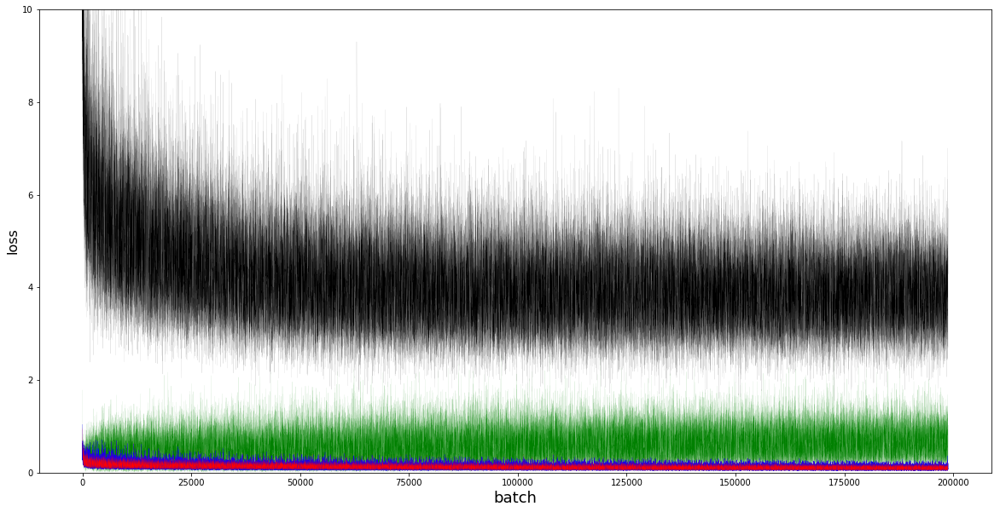

In [15]:

fig = plt.figure(figsize=(20,10))

plt.plot([x[1] for x in gan.g_losses], color='green', linewidth=0.05) #DISCRIM LOSS
# plt.plot([x[2] for x in gan.g_losses], color='orange', linewidth=0.1)
plt.plot([x[3] for x in gan.g_losses], color='blue', linewidth=0.25) #CYCLE LOSS
# plt.plot([x[4] for x in gan.g_losses], color='orange', linewidth=0.25)
plt.plot([x[5] for x in gan.g_losses], color='red', linewidth=0.05) #ID LOSS
# plt.plot([x[6] for x in gan.g_losses], color='orange', linewidth=0.25)

plt.plot([x[0] for x in gan.g_losses], color='black', linewidth=0.05)

# plt.plot([x[0] for x in gan.d_losses], color='black', linewidth=0.25)

plt.xlabel('batch', fontsize=18)
plt.ylabel('loss', fontsize=16)

plt.ylim(0, 10)

plt.show()

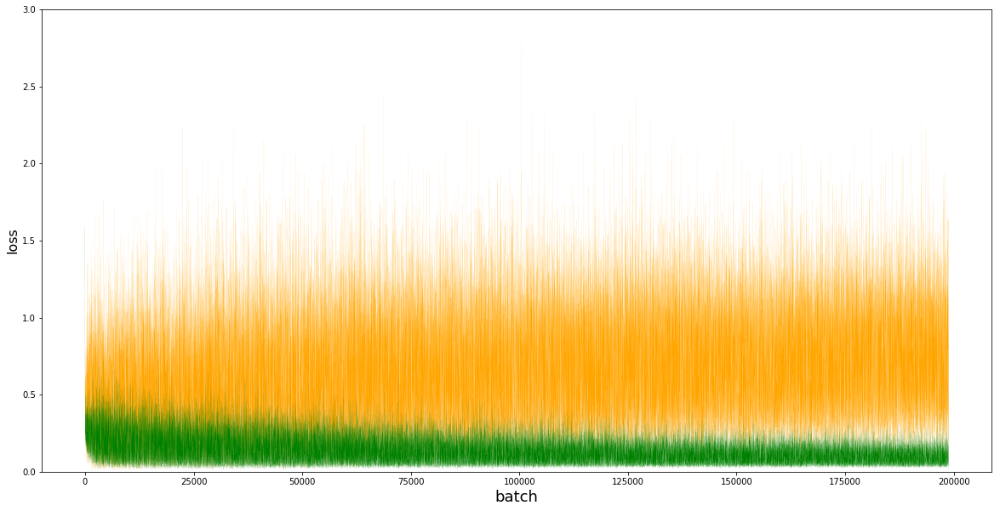

In [25]:
fig = plt.figure(figsize=(20,10))
plt.plot([x[2] for x in gan.g_losses], color='orange', linewidth=0.05)
#plt.plot([x[4] for x in gan.g_losses], color='red', linewidth=0.25)
#plt.plot([x[6] for x in gan.g_losses], color='blue', linewidth=0.25)
plt.plot([x[0] for x in gan.d_losses], color='green', linewidth=0.05)
plt.xlabel('batch', fontsize=18)
plt.ylabel('loss', fontsize=16)

plt.ylim(0, 3)

plt.show()

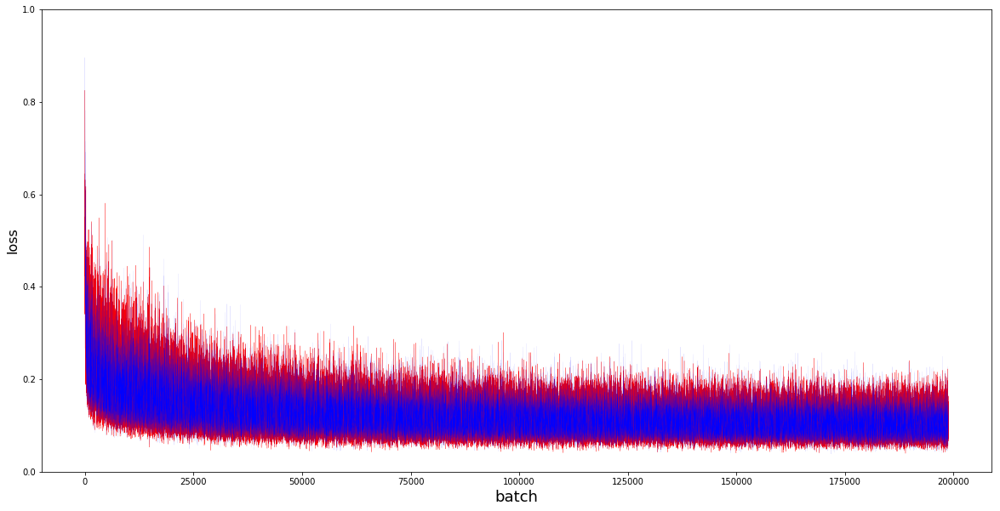

In [30]:
fig = plt.figure(figsize=(20,10))
plt.plot([x[4] for x in gan.g_losses], color='red', linewidth=0.25)
plt.plot([x[6] for x in gan.g_losses], color='blue', linewidth=0.05)
plt.xlabel('batch', fontsize=18)
plt.ylabel('loss', fontsize=16)

plt.ylim(0, 1)

plt.show()